## **PROJECT-3. EDA + Feature Engineering. Соревнование на Kaggle**

## <center>**1. Введение**

***
✍ Вы прошли все необходимые модули разведывательного анализа данных — теперь пришло время переходить к настоящей практике! В этом проекте мы применим свои знания и навыки на реальной задаче. Готовы приступать?
***

**В РЕЗУЛЬТАТЕ РАБОТЫ НАД ДАННЫМ ПРОЕКТОМ ВЫ:**

✔️ создадите свою первую модель, основанную на алгоритмах машинного обучения;

✔️ примете участие в соревновании на *Kaggle*;

✔️ поймёте, как правильно «подготовить» данные, чтобы ваша модель работала лучше.

### <span style=color:green>**ЧЕМ МЫ БУДЕМ ЗАНИМАТЬСЯ?**

В этом модуле вы попробуете решить свой первый настоящий кейс и создадите первую модель, использующую алгоритмы машинного обучения.

<span style=background:grey;color:white>→ Не пугайтесь, вам не придётся изучать машинное обучение в экстремально короткие сроки! На самом деле код для создания и обучения модели мы вам предоставим в готовом виде, и этот код будет довольно простым. Всему этому более подробно вы научитесь позже, в модулях по машинному обучению. Пока ваша задача будет состоять в том, чтобы качественно подготовить данные для обучения модели.

Скоро вы убедитесь не только в теории, но и на практике, что тщательная очистка данных, проектирование признаков и разведывательный анализ данных способны повысить точность модели в два и более раз, и владение этими навыками играет в машинном обучении не меньшую роль, чем умение выбрать алгоритм и настроить модель.

Итак, вы создадите свою первую модель, а после этого используете свои навыки для участия в соревновании на платформе [Kaggle](https://www.kaggle.com/).

### <span style=color:green>**КАКОЙ КЕЙС РЕШАЕМ?**

Представьте, что вы работаете дата-сайентистом в компании Booking. Одна из проблем компании — это нечестные отели, которые накручивают себе рейтинг. Одним из способов обнаружения таких отелей является построение модели, которая предсказывает рейтинг отеля. Если предсказания модели сильно отличаются от фактического результата, то, возможно, отель ведёт себя нечестно, и его стоит проверить.

## <center>**2. Разбираемся с данными**

***
✍ *В этом модуле мы будем работать с датасетом, в котором содержатся сведения о 515 000 отзывов на отели Европы. Модель, которую мы будем обучать, должна предсказывать рейтинг отеля по данным сайта Booking на основе имеющихся в датасете данных. Изученные навыки разведывательного анализа помогут нам улучшить модель.*
***

Первоначальная версия датасета содержит 17 полей со следующей информацией:

* *hotel_address* — адрес отеля;
* *review_date* — дата, когда рецензент разместил соответствующий отзыв;
* *average_score* — средний балл отеля, рассчитанный на основе последнего комментария за последний год;
* *hotel_name* — название отеля;
* *reviewer_nationality* — страна рецензента;
* *negative_review* — отрицательный отзыв, который рецензент дал отелю;
* *review_total_negative_word_counts* — общее количество слов в отрицательном отзыв;
* *positive_review* — положительный отзыв, который рецензент дал отелю;
* *review_total_positive_word_counts* — общее количество слов в положительном отзыве.
* *reviewer_score* — оценка, которую рецензент поставил отелю на основе своего опыта;
* *total_number_of_reviews_reviewer_has_given* — количество отзывов, которые рецензенты дали в прошлом;
* *total_number_of_reviews* — общее количество действительных отзывов об отеле;
* *tags* — теги, которые рецензент дал отелю;
* *days_since_review* — количество дней между датой проверки и датой очистки;
* *additional_number_of_scoring* — есть также некоторые гости, которые просто поставили оценку сервису, но не оставили отзыв. Это число указывает, сколько там действительных оценок без проверки.
* *lat* — географическая широта отеля;
* *lng* — географическая долгота отеля.

In [1]:
import pandas as pd

hotels = pd.read_csv('hotels.csv')
hotels.head()

,hotel_address,additional_number_of_scoring,review_date,average_score,hotel_name,reviewer_nationality,negative_review,review_total_negative_word_counts,total_number_of_reviews,positive_review,review_total_positive_word_counts,total_number_of_reviews_reviewer_has_given,reviewer_score,tags,days_since_review,lat,lng
0,Stratton Street Mayfair Westminster Borough Lo...,581,2/19/2016,8.4,The May Fair Hotel,United Kingdom,Leaving,3,1994,Staff were amazing,4,7,10.0,"[' Leisure trip ', ' Couple ', ' Studio Suite ...",531 day,51.507894,-0.143671
1,130 134 Southampton Row Camden London WC1B 5AF...,299,1/12/2017,8.3,Mercure London Bloomsbury Hotel,United Kingdom,poor breakfast,3,1361,location,2,14,6.3,"[' Business trip ', ' Couple ', ' Standard Dou...",203 day,51.521009,-0.123097
2,151 bis Rue de Rennes 6th arr 75006 Paris France,32,10/18/2016,8.9,Legend Saint Germain by Elegancia,China,No kettle in room,6,406,No Positive,0,14,7.5,"[' Leisure trip ', ' Solo traveler ', ' Modern...",289 day,48.845377,2.325643
3,216 Avenue Jean Jaures 19th arr 75019 Paris Fr...,34,9/22/2015,7.5,Mercure Paris 19 Philharmonie La Villette,United Kingdom,No Negative,0,607,Friendly staff quiet comfortable room spotles...,11,8,10.0,"[' Leisure trip ', ' Solo traveler ', ' Standa...",681 day,48.888697,2.394540
4,Molenwerf 1 1014 AG Amsterdam Netherlands,914,3/5/2016,8.5,Golden Tulip Amsterdam West,Poland,Torn sheets,4,7586,The staff was very friendly and helpful Break...,20,10,9.6,"[' Business trip ', ' Couple ', ' Standard Dou...",516 day,52.385601,4.847060


In [2]:
# В каких столбцах данные содержат пропущенные значения?
hotels_cols_null_percent = hotels.isnull().mean() * 100
hotels_cols_with_null = hotels_cols_null_percent[hotels_cols_null_percent > 0].sort_values(ascending=False)
print(f"Cтолбцы, данные которых содержат пропущенные значения: \n{hotels_cols_with_null}")

Cтолбцы, данные которых содержат пропущенные значения: 
lat    0.63288
lng    0.63288
dtype: float64


In [3]:
# В каких столбцах данные хранятся в числовом формате?
# hotels.info()
hotels.select_dtypes(['int64', 'float64']).info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 386803 entries, 0 to 386802
Data columns (total 9 columns):
 #   Column                                      Non-Null Count   Dtype  
---  ------                                      --------------   -----  
 0   additional_number_of_scoring                386803 non-null  int64  
 1   average_score                               386803 non-null  float64
 2   review_total_negative_word_counts           386803 non-null  int64  
 3   total_number_of_reviews                     386803 non-null  int64  
 4   review_total_positive_word_counts           386803 non-null  int64  
 5   total_number_of_reviews_reviewer_has_given  386803 non-null  int64  
 6   reviewer_score                              386803 non-null  float64
 7   lat                                         384355 non-null  float64
 8   lng                                         384355 non-null  float64
dtypes: float64(4), int64(5)
memory usage: 26.6 MB


In [4]:
# В каких столбцах данные представляют собой строки?
hotels.select_dtypes(['object']).info()
# hotels.select_dtypes(['object']).head()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 386803 entries, 0 to 386802
Data columns (total 8 columns):
 #   Column                Non-Null Count   Dtype 
---  ------                --------------   ----- 
 0   hotel_address         386803 non-null  object
 1   review_date           386803 non-null  object
 2   hotel_name            386803 non-null  object
 3   reviewer_nationality  386803 non-null  object
 4   negative_review       386803 non-null  object
 5   positive_review       386803 non-null  object
 6   tags                  386803 non-null  object
 7   days_since_review     386803 non-null  object
dtypes: object(8)
memory usage: 23.6+ MB


In [5]:
hotels['hotel_address'][100]

'5 Curzon St Westminster Borough London W1J 5HL United Kingdom'

In [6]:
# Созданим новые признак 'city' (city country) из информации об адресе отеля
def get_city (address):
    country = ' '.join(address.split(' ')[-2:])
    if  country == "United Kingdom":
        country = address.split(' ')[-5] + ' ' + country
    return country

hotels['city'] = hotels['hotel_address'].apply(get_city)
hotels['city'].unique()
#hotels.head()

array(['London United Kingdom', 'Paris France', 'Amsterdam Netherlands',
       'Milan Italy', 'Vienna Austria', 'Barcelona Spain'], dtype=object)

In [7]:
# Создадим словарь вида {'city country': [latitude, longitude]}
import numpy as np

def get_gps(df):
    # Create empty dictionary
    coordinates_dict = dict()
    
    # Go along the rows by indexes
    for idx, row in enumerate(df.index):
        # Extract the city and the country
        if not np.isnan(df['lat'].iloc[idx]) and not np.isnan(df['lng'].iloc[idx]):
            region = df['city'].iloc[idx]
            
            # Get the latitude and longitude from the rows
            coordinates = list([round(df['lat'].iloc[idx], 6), round(df['lng'].iloc[idx], 6)])
            
            if region not in coordinates_dict.keys():
                coordinates_dict.update({region: coordinates})
            
    return coordinates_dict

gps_dict = get_gps(hotels)

# используем словарь и датасет с пропусками
# проставляем отсутствующие координаты по признаку 'city' и координатам из словаря
def set_gps(df, gps_dict):
    # Go along the rows by indexes
    for idx, row in enumerate(df.index):
        # Get the latitude and longitude from the rows
        lat = str(df['lat'].iloc[idx])
        lng = str(df['lng'].iloc[idx])
        
        if lat in ['nan', 'NaN'] or lng in ['nan', 'NaN']:
            region = df['city'].iloc[idx]
            
            if region in gps_dict.keys():
                # Fill the coordinates
                df['lat'].iloc[idx] = gps_dict[region][0]
                df['lng'].iloc[idx] = gps_dict[region][1]
    return df

hotels = set_gps(hotels, gps_dict)
hotels.head()
hotels.info()

C:\Users\igork\AppData\Local\Temp\ipykernel_20336\1668217857.py:38: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['lat'].iloc[idx] = gps_dict[region][0]
C:\Users\igork\AppData\Local\Temp\ipykernel_20336\1668217857.py:39: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['lng'].iloc[idx] = gps_dict[region][1]


<class 'pandas.core.frame.DataFrame'>
RangeIndex: 386803 entries, 0 to 386802
Data columns (total 18 columns):
 #   Column                                      Non-Null Count   Dtype  
---  ------                                      --------------   -----  
 0   hotel_address                               386803 non-null  object 
 1   additional_number_of_scoring                386803 non-null  int64  
 2   review_date                                 386803 non-null  object 
 3   average_score                               386803 non-null  float64
 4   hotel_name                                  386803 non-null  object 
 5   reviewer_nationality                        386803 non-null  object 
 6   negative_review                             386803 non-null  object 
 7   review_total_negative_word_counts           386803 non-null  int64  
 8   total_number_of_reviews                     386803 non-null  int64  
 9   positive_review                             386803 non-null  object 
 

In [8]:
# cоздадим новые признаки: квартал, месяц и день недели даты отзыва. 
# На основе дня недели создадим флаг выходного дня 'is_day_off'. 
# Также преобразуем количество дней прошедших с момента отзыва в int.
hotels['review_date'] = pd.to_datetime(hotels['review_date'])

hotels['review_quarter'] = hotels['review_date'].dt.quarter
hotels['review_month'] = hotels['review_date'].dt.month
hotels['review_dayofweek'] = hotels['review_date'].dt.dayofweek

hotels['is_day_off'] = hotels['review_dayofweek'].apply(lambda x: 1 if x > 5 else 0)
hotels = hotels.drop(['review_dayofweek'], axis=1)

hotels['days_since_review'] = hotels['days_since_review'].apply(lambda x: int(x.split(' ')[0]))

hotels.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 386803 entries, 0 to 386802
Data columns (total 21 columns):
 #   Column                                      Non-Null Count   Dtype         
---  ------                                      --------------   -----         
 0   hotel_address                               386803 non-null  object        
 1   additional_number_of_scoring                386803 non-null  int64         
 2   review_date                                 386803 non-null  datetime64[ns]
 3   average_score                               386803 non-null  float64       
 4   hotel_name                                  386803 non-null  object        
 5   reviewer_nationality                        386803 non-null  object        
 6   negative_review                             386803 non-null  object        
 7   review_total_negative_word_counts           386803 non-null  int64         
 8   total_number_of_reviews                     386803 non-null  int64        

## <center>**3. Машинное обучение для самых маленьких**

***

✍ Что нужно сделать в этом юните?

**Создать свою первую модель, основанную на алгоритмах машинного обучения.**

Код для создания модели мы предоставим, но чтобы модель заработала, в неё нужно передать правильные данные. **Приведение данных в нужный вид и будет вашей задачей в этом юните.**

Однако прежде мы рассмотрим основные шаги, которые нужно проделать с данными от загрузки до получения результатов модели.
***

In [9]:
# убираем признаки которые еще не успели обработать, 
# модель на признаках с dtypes "object" обучаться не будет, просто выберим их и удалим
object_columns = [s for s in hotels.columns if hotels[s].dtypes == 'object']

hotels.drop(object_columns, axis = 1, inplace=True)

# заполняем пропуски самым простым способом
hotels = hotels.fillna(0)

hotels.drop(hotels['review_date'], axis = 1, inplace=True)

hotels.info()

KeyError: "[Timestamp('2016-02-19 00:00:00'), Timestamp('2017-01-12 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2016-03-05 00:00:00'), Timestamp('2015-12-30 00:00:00'), Timestamp('2017-05-18 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2016-10-19 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2017-05-06 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2015-09-25 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2016-07-04 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2017-04-15 00:00:00'), Timestamp('2016-11-23 00:00:00'), Timestamp('2016-06-08 00:00:00'), Timestamp('2016-09-23 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2016-07-25 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2015-08-12 00:00:00'), Timestamp('2017-04-15 00:00:00'), Timestamp('2016-06-18 00:00:00'), Timestamp('2015-10-24 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2017-05-23 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2017-05-17 00:00:00'), Timestamp('2017-07-29 00:00:00'), Timestamp('2017-07-21 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2016-06-27 00:00:00'), Timestamp('2017-02-01 00:00:00'), Timestamp('2016-07-23 00:00:00'), Timestamp('2016-02-04 00:00:00'), Timestamp('2017-07-07 00:00:00'), Timestamp('2017-02-10 00:00:00'), Timestamp('2016-09-24 00:00:00'), Timestamp('2016-02-17 00:00:00'), Timestamp('2016-03-05 00:00:00'), Timestamp('2017-07-07 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2017-01-07 00:00:00'), Timestamp('2017-06-04 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2016-02-13 00:00:00'), Timestamp('2017-01-25 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2016-04-15 00:00:00'), Timestamp('2016-11-02 00:00:00'), Timestamp('2015-08-12 00:00:00'), Timestamp('2016-01-25 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2016-07-01 00:00:00'), Timestamp('2017-02-11 00:00:00'), Timestamp('2016-08-13 00:00:00'), Timestamp('2017-03-23 00:00:00'), Timestamp('2016-08-27 00:00:00'), Timestamp('2016-11-23 00:00:00'), Timestamp('2017-03-05 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2015-08-22 00:00:00'), Timestamp('2015-12-30 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2016-11-27 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2015-08-29 00:00:00'), Timestamp('2016-04-02 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-07-29 00:00:00'), Timestamp('2017-06-28 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2015-08-31 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2017-03-03 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-12-08 00:00:00'), Timestamp('2016-09-07 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2016-08-01 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2017-02-14 00:00:00'), Timestamp('2017-06-23 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-10-22 00:00:00'), Timestamp('2016-09-02 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2017-08-01 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2015-09-26 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2017-01-27 00:00:00'), Timestamp('2016-02-13 00:00:00'), Timestamp('2016-08-26 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2016-01-08 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2017-03-12 00:00:00'), Timestamp('2015-11-02 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2015-09-04 00:00:00'), Timestamp('2015-11-12 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2017-06-13 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2016-10-16 00:00:00'), Timestamp('2017-07-08 00:00:00'), Timestamp('2016-03-03 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2017-03-04 00:00:00'), Timestamp('2015-09-09 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2015-11-13 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2017-06-01 00:00:00'), Timestamp('2015-11-07 00:00:00'), Timestamp('2017-01-06 00:00:00'), Timestamp('2017-03-18 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2017-02-02 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2016-06-20 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2017-05-24 00:00:00'), Timestamp('2017-03-09 00:00:00'), Timestamp('2016-02-11 00:00:00'), Timestamp('2017-07-25 00:00:00'), Timestamp('2016-02-10 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2017-06-13 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2016-10-11 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2015-08-28 00:00:00'), Timestamp('2016-12-27 00:00:00'), Timestamp('2017-04-07 00:00:00'), Timestamp('2016-09-11 00:00:00'), Timestamp('2017-03-17 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2017-06-28 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2015-10-31 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2017-03-22 00:00:00'), Timestamp('2017-05-19 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2017-03-23 00:00:00'), Timestamp('2016-09-05 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2016-07-06 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2017-04-26 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2016-10-21 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2017-06-10 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2017-06-30 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2017-01-07 00:00:00'), Timestamp('2016-01-11 00:00:00'), Timestamp('2016-06-20 00:00:00'), Timestamp('2016-12-27 00:00:00'), Timestamp('2016-08-20 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2016-02-04 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2016-09-12 00:00:00'), Timestamp('2015-11-25 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2017-02-17 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2017-02-03 00:00:00'), Timestamp('2016-03-07 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-11-28 00:00:00'), Timestamp('2017-06-04 00:00:00'), Timestamp('2015-09-03 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2017-08-01 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2015-11-25 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-11-02 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2016-08-08 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2017-01-26 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2016-12-21 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2016-10-12 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2017-02-23 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2016-04-20 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2016-01-28 00:00:00'), Timestamp('2017-04-09 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2015-11-28 00:00:00'), Timestamp('2015-12-26 00:00:00'), Timestamp('2016-08-13 00:00:00'), Timestamp('2017-02-15 00:00:00'), Timestamp('2017-06-01 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2015-12-10 00:00:00'), Timestamp('2016-12-21 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2017-07-25 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2015-12-26 00:00:00'), Timestamp('2017-07-14 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2016-01-23 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2016-06-08 00:00:00'), Timestamp('2016-12-15 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2016-06-15 00:00:00'), Timestamp('2017-05-25 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2015-08-12 00:00:00'), Timestamp('2017-02-25 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2016-06-13 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2015-11-12 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2017-02-09 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2016-07-11 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2017-06-10 00:00:00'), Timestamp('2016-12-31 00:00:00'), Timestamp('2015-10-24 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2017-02-14 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2015-08-14 00:00:00'), Timestamp('2015-08-29 00:00:00'), Timestamp('2017-03-18 00:00:00'), Timestamp('2015-11-20 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2017-05-04 00:00:00'), Timestamp('2016-02-01 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2016-11-16 00:00:00'), Timestamp('2017-03-11 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2017-03-29 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2015-12-16 00:00:00'), Timestamp('2017-08-01 00:00:00'), Timestamp('2016-10-13 00:00:00'), Timestamp('2015-10-22 00:00:00'), Timestamp('2017-07-30 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2016-10-13 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2016-10-06 00:00:00'), Timestamp('2015-08-21 00:00:00'), Timestamp('2016-08-26 00:00:00'), Timestamp('2016-12-31 00:00:00'), Timestamp('2016-04-16 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2017-01-19 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2015-10-24 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2017-05-07 00:00:00'), Timestamp('2015-09-17 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2017-03-01 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2017-03-19 00:00:00'), Timestamp('2016-12-16 00:00:00'), Timestamp('2017-07-15 00:00:00'), Timestamp('2017-07-08 00:00:00'), Timestamp('2016-03-17 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2015-09-17 00:00:00'), Timestamp('2016-01-18 00:00:00'), Timestamp('2016-02-04 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2015-10-23 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2016-12-14 00:00:00'), Timestamp('2017-02-12 00:00:00'), Timestamp('2015-11-02 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2017-01-14 00:00:00'), Timestamp('2017-02-01 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2017-04-22 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2016-06-04 00:00:00'), Timestamp('2017-05-11 00:00:00'), Timestamp('2017-06-24 00:00:00'), Timestamp('2015-09-03 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2016-01-08 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2017-05-07 00:00:00'), Timestamp('2017-07-27 00:00:00'), Timestamp('2016-05-28 00:00:00'), Timestamp('2016-03-21 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2017-06-10 00:00:00'), Timestamp('2015-09-18 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2017-03-24 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2017-01-22 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2017-07-08 00:00:00'), Timestamp('2015-09-03 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2015-10-10 00:00:00'), Timestamp('2015-08-29 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2017-05-07 00:00:00'), Timestamp('2017-05-01 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2015-12-04 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2017-01-21 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2015-09-26 00:00:00'), Timestamp('2015-11-28 00:00:00'), Timestamp('2015-12-23 00:00:00'), Timestamp('2016-08-17 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2016-12-18 00:00:00'), Timestamp('2017-05-07 00:00:00'), Timestamp('2015-10-22 00:00:00'), Timestamp('2017-03-02 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2016-07-23 00:00:00'), Timestamp('2017-06-21 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2015-09-12 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2015-11-16 00:00:00'), Timestamp('2017-05-19 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2016-02-04 00:00:00'), Timestamp('2016-12-30 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2016-11-27 00:00:00'), Timestamp('2016-11-26 00:00:00'), Timestamp('2017-01-14 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2016-09-03 00:00:00'), Timestamp('2017-04-21 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2015-10-22 00:00:00'), Timestamp('2016-09-17 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2015-09-03 00:00:00'), Timestamp('2016-12-29 00:00:00'), Timestamp('2016-10-26 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2016-04-06 00:00:00'), Timestamp('2017-07-30 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2016-07-15 00:00:00'), Timestamp('2017-06-09 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-09-03 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-01-25 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2017-05-21 00:00:00'), Timestamp('2015-08-07 00:00:00'), Timestamp('2016-11-10 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2016-04-18 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2016-01-16 00:00:00'), Timestamp('2015-11-04 00:00:00'), Timestamp('2016-12-29 00:00:00'), Timestamp('2016-09-24 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-09-29 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2017-04-16 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2015-10-28 00:00:00'), Timestamp('2016-05-18 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2016-09-23 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2017-03-09 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2017-04-08 00:00:00'), Timestamp('2016-01-18 00:00:00'), Timestamp('2015-08-31 00:00:00'), Timestamp('2016-09-03 00:00:00'), Timestamp('2016-12-15 00:00:00'), Timestamp('2015-12-17 00:00:00'), Timestamp('2016-07-29 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2015-09-18 00:00:00'), Timestamp('2015-11-09 00:00:00'), Timestamp('2017-04-20 00:00:00'), Timestamp('2017-02-08 00:00:00'), Timestamp('2016-10-19 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2016-08-22 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2016-10-05 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2016-05-04 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2017-04-04 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2015-11-09 00:00:00'), Timestamp('2017-07-15 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2015-12-23 00:00:00'), Timestamp('2017-04-21 00:00:00'), Timestamp('2016-03-03 00:00:00'), Timestamp('2017-03-03 00:00:00'), Timestamp('2016-11-23 00:00:00'), Timestamp('2015-12-10 00:00:00'), Timestamp('2017-02-05 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2016-01-20 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2016-06-18 00:00:00'), Timestamp('2017-07-14 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2015-11-16 00:00:00'), Timestamp('2017-06-11 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2015-09-09 00:00:00'), Timestamp('2017-07-08 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2015-12-03 00:00:00'), Timestamp('2016-11-16 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2016-01-07 00:00:00'), Timestamp('2016-11-16 00:00:00'), Timestamp('2017-03-03 00:00:00'), Timestamp('2016-07-29 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2015-09-24 00:00:00'), Timestamp('2017-04-28 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2016-12-23 00:00:00'), Timestamp('2016-12-31 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2017-04-14 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-03-28 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2016-10-21 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2017-06-03 00:00:00'), Timestamp('2016-03-02 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2016-12-14 00:00:00'), Timestamp('2016-09-02 00:00:00'), Timestamp('2016-02-29 00:00:00'), Timestamp('2016-12-16 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2016-01-15 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2016-02-19 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2015-08-29 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2016-07-02 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2016-04-01 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2016-02-15 00:00:00'), Timestamp('2017-04-04 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2016-05-01 00:00:00'), Timestamp('2016-03-26 00:00:00'), Timestamp('2017-02-12 00:00:00'), Timestamp('2017-05-18 00:00:00'), Timestamp('2016-10-16 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2015-09-24 00:00:00'), Timestamp('2016-12-14 00:00:00'), Timestamp('2017-04-08 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2016-10-22 00:00:00'), Timestamp('2016-10-28 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2015-10-12 00:00:00'), Timestamp('2015-09-23 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2016-06-20 00:00:00'), Timestamp('2016-08-26 00:00:00'), Timestamp('2016-08-05 00:00:00'), Timestamp('2017-07-25 00:00:00'), Timestamp('2016-09-14 00:00:00'), Timestamp('2016-04-25 00:00:00'), Timestamp('2017-04-02 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2017-02-03 00:00:00'), Timestamp('2015-10-08 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2017-03-26 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2017-02-15 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2017-02-25 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2015-12-05 00:00:00'), Timestamp('2016-03-06 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2017-01-27 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2016-05-23 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-12-02 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2015-12-27 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2016-12-04 00:00:00'), Timestamp('2017-01-18 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2016-11-28 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2016-09-17 00:00:00'), Timestamp('2015-11-26 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2017-01-26 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2016-10-27 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2017-04-28 00:00:00'), Timestamp('2017-07-26 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2017-05-20 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2017-02-10 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2016-06-27 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2016-03-19 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2017-01-01 00:00:00'), Timestamp('2017-01-22 00:00:00'), Timestamp('2017-04-24 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2015-10-03 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2016-05-21 00:00:00'), Timestamp('2016-03-06 00:00:00'), Timestamp('2016-06-12 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2016-07-13 00:00:00'), Timestamp('2017-06-16 00:00:00'), Timestamp('2016-01-21 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2017-02-11 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2016-09-21 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2015-12-27 00:00:00'), Timestamp('2016-08-31 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2016-01-07 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2017-06-30 00:00:00'), Timestamp('2016-02-06 00:00:00'), Timestamp('2016-08-24 00:00:00'), Timestamp('2015-12-30 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2016-05-11 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2016-02-25 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2016-01-04 00:00:00'), Timestamp('2016-05-11 00:00:00'), Timestamp('2017-01-11 00:00:00'), Timestamp('2017-02-15 00:00:00'), Timestamp('2016-10-19 00:00:00'), Timestamp('2016-04-23 00:00:00'), Timestamp('2016-08-20 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2016-04-23 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2015-11-14 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2015-11-30 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2015-10-05 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2016-06-25 00:00:00'), Timestamp('2017-06-14 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2017-06-13 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2016-01-18 00:00:00'), Timestamp('2015-09-12 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2015-11-18 00:00:00'), Timestamp('2016-12-26 00:00:00'), Timestamp('2016-01-01 00:00:00'), Timestamp('2016-06-02 00:00:00'), Timestamp('2017-01-19 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2017-02-17 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2016-07-04 00:00:00'), Timestamp('2017-07-19 00:00:00'), Timestamp('2017-06-14 00:00:00'), Timestamp('2016-05-25 00:00:00'), Timestamp('2015-09-28 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2017-06-11 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2016-04-06 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2017-01-22 00:00:00'), Timestamp('2015-11-26 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2016-10-14 00:00:00'), Timestamp('2016-09-05 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2017-04-14 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2017-01-06 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2016-08-03 00:00:00'), Timestamp('2016-11-10 00:00:00'), Timestamp('2017-03-17 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2017-04-15 00:00:00'), Timestamp('2016-01-09 00:00:00'), Timestamp('2016-07-02 00:00:00'), Timestamp('2016-07-09 00:00:00'), Timestamp('2017-03-01 00:00:00'), Timestamp('2017-01-13 00:00:00'), Timestamp('2017-01-06 00:00:00'), Timestamp('2016-09-03 00:00:00'), Timestamp('2015-08-17 00:00:00'), Timestamp('2015-11-11 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2015-08-28 00:00:00'), Timestamp('2017-03-05 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2016-10-16 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2017-05-20 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2016-10-29 00:00:00'), Timestamp('2016-03-23 00:00:00'), Timestamp('2016-12-31 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2015-10-17 00:00:00'), Timestamp('2015-11-16 00:00:00'), Timestamp('2017-06-02 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2015-08-14 00:00:00'), Timestamp('2017-05-04 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2015-08-21 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2015-11-06 00:00:00'), Timestamp('2016-11-05 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2017-02-18 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2017-05-09 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2015-09-16 00:00:00'), Timestamp('2016-07-13 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2015-11-28 00:00:00'), Timestamp('2015-11-16 00:00:00'), Timestamp('2016-04-20 00:00:00'), Timestamp('2016-04-02 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2015-10-31 00:00:00'), Timestamp('2017-03-28 00:00:00'), Timestamp('2016-03-30 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2015-08-28 00:00:00'), Timestamp('2017-06-29 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2017-07-07 00:00:00'), Timestamp('2016-09-24 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-10-29 00:00:00'), Timestamp('2016-01-25 00:00:00'), Timestamp('2016-05-09 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2017-02-03 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2017-03-10 00:00:00'), Timestamp('2016-03-03 00:00:00'), Timestamp('2016-12-07 00:00:00'), Timestamp('2016-08-10 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2016-04-18 00:00:00'), Timestamp('2016-04-11 00:00:00'), Timestamp('2015-11-26 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2016-04-25 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2016-05-25 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2017-06-23 00:00:00'), Timestamp('2017-01-11 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2016-12-30 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2016-07-15 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2017-07-21 00:00:00'), Timestamp('2015-11-30 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2016-12-09 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2015-11-23 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-12-03 00:00:00'), Timestamp('2016-08-22 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2016-03-09 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2016-01-16 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2017-07-22 00:00:00'), Timestamp('2016-05-18 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2017-03-26 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2016-03-06 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2016-08-27 00:00:00'), Timestamp('2016-01-18 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2016-06-13 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-04-02 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2015-12-23 00:00:00'), Timestamp('2017-07-14 00:00:00'), Timestamp('2016-03-04 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2017-05-23 00:00:00'), Timestamp('2016-03-28 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2016-09-24 00:00:00'), Timestamp('2017-01-17 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2015-10-14 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2017-07-26 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2016-08-03 00:00:00'), Timestamp('2017-05-04 00:00:00'), Timestamp('2017-01-01 00:00:00'), Timestamp('2016-01-14 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2016-10-19 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2016-03-12 00:00:00'), Timestamp('2016-08-06 00:00:00'), Timestamp('2016-08-29 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2016-02-01 00:00:00'), Timestamp('2017-07-24 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2015-12-24 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2017-03-22 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2016-12-11 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2016-02-20 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2016-12-17 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2016-10-16 00:00:00'), Timestamp('2017-01-26 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2017-01-21 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2016-09-23 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2017-05-14 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2016-02-15 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2015-09-05 00:00:00'), Timestamp('2016-12-08 00:00:00'), Timestamp('2016-01-04 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2016-03-02 00:00:00'), Timestamp('2016-08-13 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2015-12-16 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2017-06-17 00:00:00'), Timestamp('2016-10-22 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2017-03-19 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2017-05-21 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2017-03-04 00:00:00'), Timestamp('2016-11-03 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2016-10-28 00:00:00'), Timestamp('2016-06-25 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2016-08-08 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2016-07-13 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2015-12-16 00:00:00'), Timestamp('2017-07-22 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2015-09-17 00:00:00'), Timestamp('2017-03-01 00:00:00'), Timestamp('2015-09-17 00:00:00'), Timestamp('2017-06-13 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2016-05-16 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2017-04-24 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2016-06-06 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2015-12-02 00:00:00'), Timestamp('2015-10-12 00:00:00'), Timestamp('2015-11-02 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2016-11-03 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2017-06-01 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2017-01-11 00:00:00'), Timestamp('2015-10-31 00:00:00'), Timestamp('2016-05-06 00:00:00'), Timestamp('2017-03-10 00:00:00'), Timestamp('2015-09-12 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2015-10-10 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2017-04-16 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2016-03-25 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2016-10-28 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2017-05-06 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2016-07-22 00:00:00'), Timestamp('2016-05-02 00:00:00'), Timestamp('2016-09-17 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2016-12-17 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2017-07-13 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2016-11-16 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2017-05-27 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2017-06-01 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2017-06-16 00:00:00'), Timestamp('2016-12-18 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2017-06-16 00:00:00'), Timestamp('2016-01-16 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2017-07-23 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2016-03-30 00:00:00'), Timestamp('2016-01-13 00:00:00'), Timestamp('2016-12-31 00:00:00'), Timestamp('2017-05-01 00:00:00'), Timestamp('2016-05-07 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2017-04-26 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2017-05-23 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2016-08-31 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2016-05-11 00:00:00'), Timestamp('2015-08-05 00:00:00'), Timestamp('2017-04-04 00:00:00'), Timestamp('2017-01-22 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2016-04-02 00:00:00'), Timestamp('2017-07-07 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2017-04-14 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2017-03-16 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2017-06-07 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2017-01-08 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2017-02-02 00:00:00'), Timestamp('2017-07-24 00:00:00'), Timestamp('2015-12-09 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2017-02-02 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2017-05-26 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2016-04-18 00:00:00'), Timestamp('2016-10-29 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2017-05-13 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2017-02-14 00:00:00'), Timestamp('2015-09-05 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2016-08-19 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2015-10-03 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2016-10-16 00:00:00'), Timestamp('2015-11-09 00:00:00'), Timestamp('2017-03-19 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2015-11-12 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2016-05-04 00:00:00'), Timestamp('2016-12-18 00:00:00'), Timestamp('2017-02-24 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2017-04-20 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2016-07-13 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2015-08-12 00:00:00'), Timestamp('2016-03-23 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2017-07-22 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2016-07-06 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2016-06-29 00:00:00'), Timestamp('2016-10-11 00:00:00'), Timestamp('2015-12-19 00:00:00'), Timestamp('2016-02-04 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2016-11-28 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-10-29 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2017-05-27 00:00:00'), Timestamp('2016-12-15 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2016-10-22 00:00:00'), Timestamp('2016-03-26 00:00:00'), Timestamp('2016-12-27 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2015-10-24 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2016-08-05 00:00:00'), Timestamp('2016-10-11 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2017-04-09 00:00:00'), Timestamp('2017-04-14 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2016-10-11 00:00:00'), Timestamp('2016-01-24 00:00:00'), Timestamp('2016-02-25 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2017-03-18 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2015-11-27 00:00:00'), Timestamp('2017-06-14 00:00:00'), Timestamp('2016-02-12 00:00:00'), Timestamp('2016-01-09 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2017-02-05 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2015-09-30 00:00:00'), Timestamp('2017-03-16 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2015-10-23 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2016-12-29 00:00:00'), Timestamp('2016-10-09 00:00:00'), Timestamp('2016-02-06 00:00:00'), Timestamp('2015-11-16 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-01-20 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2017-03-05 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2015-11-27 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2017-02-10 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2016-01-28 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2016-06-08 00:00:00'), Timestamp('2017-06-15 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2015-12-27 00:00:00'), Timestamp('2015-11-16 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2016-07-20 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2017-06-14 00:00:00'), Timestamp('2017-02-09 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2017-06-13 00:00:00'), Timestamp('2016-06-08 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2016-01-28 00:00:00'), Timestamp('2017-04-12 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2017-06-11 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2015-10-15 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2017-01-07 00:00:00'), Timestamp('2017-06-22 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2016-10-20 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2016-11-05 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2017-05-20 00:00:00'), Timestamp('2016-05-23 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-08-31 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2017-01-10 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-07-06 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2016-02-04 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2015-11-26 00:00:00'), Timestamp('2015-08-17 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2017-03-29 00:00:00'), Timestamp('2017-07-08 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2016-04-20 00:00:00'), Timestamp('2016-04-29 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2017-06-14 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2017-02-25 00:00:00'), Timestamp('2015-10-26 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2016-02-05 00:00:00'), Timestamp('2016-07-04 00:00:00'), Timestamp('2017-06-22 00:00:00'), Timestamp('2016-06-06 00:00:00'), Timestamp('2017-04-27 00:00:00'), Timestamp('2015-12-07 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2016-03-28 00:00:00'), Timestamp('2016-10-13 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2015-09-14 00:00:00'), Timestamp('2016-08-29 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2016-09-13 00:00:00'), Timestamp('2016-02-19 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2017-07-22 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2016-07-04 00:00:00'), Timestamp('2016-03-07 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2017-03-24 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2017-06-13 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2017-07-15 00:00:00'), Timestamp('2016-09-28 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2016-10-23 00:00:00'), Timestamp('2017-03-11 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2017-03-04 00:00:00'), Timestamp('2016-02-10 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2016-10-23 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2017-01-27 00:00:00'), Timestamp('2016-06-01 00:00:00'), Timestamp('2017-07-21 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2016-01-14 00:00:00'), Timestamp('2016-03-16 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2015-10-31 00:00:00'), Timestamp('2017-05-20 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2017-06-15 00:00:00'), Timestamp('2016-12-26 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2015-09-21 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2017-04-26 00:00:00'), Timestamp('2015-10-03 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2017-03-28 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2015-08-05 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2015-10-07 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2016-12-01 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2017-01-25 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2017-02-12 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-12-02 00:00:00'), Timestamp('2016-01-27 00:00:00'), Timestamp('2016-12-16 00:00:00'), Timestamp('2016-11-02 00:00:00'), Timestamp('2016-05-02 00:00:00'), Timestamp('2016-10-20 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2016-11-04 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2016-09-13 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2017-03-08 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2017-06-30 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-10-28 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2017-05-19 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2015-09-03 00:00:00'), Timestamp('2017-03-22 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2016-10-05 00:00:00'), Timestamp('2016-12-08 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2016-11-28 00:00:00'), Timestamp('2016-06-18 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2017-04-27 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2017-03-18 00:00:00'), Timestamp('2015-12-18 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2017-03-29 00:00:00'), Timestamp('2016-11-23 00:00:00'), Timestamp('2016-07-18 00:00:00'), Timestamp('2016-06-29 00:00:00'), Timestamp('2017-01-25 00:00:00'), Timestamp('2015-11-23 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2016-08-29 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-05-01 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2015-12-19 00:00:00'), Timestamp('2017-03-26 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-07-18 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2016-08-06 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2015-12-26 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2016-01-20 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2016-12-03 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-11-04 00:00:00'), Timestamp('2016-10-29 00:00:00'), Timestamp('2017-03-15 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2015-10-05 00:00:00'), Timestamp('2016-10-22 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2016-02-20 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-12-31 00:00:00'), Timestamp('2015-11-09 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2017-06-03 00:00:00'), Timestamp('2017-06-13 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2016-02-04 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2016-01-14 00:00:00'), Timestamp('2016-07-27 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2015-10-23 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2017-02-02 00:00:00'), Timestamp('2016-02-04 00:00:00'), Timestamp('2016-05-27 00:00:00'), Timestamp('2016-08-20 00:00:00'), Timestamp('2016-05-30 00:00:00'), Timestamp('2016-07-09 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2017-04-27 00:00:00'), Timestamp('2016-02-20 00:00:00'), Timestamp('2016-12-25 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2015-12-18 00:00:00'), Timestamp('2016-03-12 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2016-08-29 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2015-08-26 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2017-02-04 00:00:00'), Timestamp('2017-03-24 00:00:00'), Timestamp('2016-02-06 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2016-02-06 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2015-08-05 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2016-02-12 00:00:00'), Timestamp('2017-06-28 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2016-11-28 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2015-11-18 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2017-03-05 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-08-24 00:00:00'), Timestamp('2015-11-05 00:00:00'), Timestamp('2017-06-24 00:00:00'), Timestamp('2016-11-29 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2017-03-02 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2017-02-14 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2015-11-25 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2017-05-14 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2017-07-26 00:00:00'), Timestamp('2017-06-10 00:00:00'), Timestamp('2017-03-10 00:00:00'), Timestamp('2015-10-12 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2015-12-10 00:00:00'), Timestamp('2017-05-25 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2017-01-06 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2017-02-08 00:00:00'), Timestamp('2016-10-13 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2017-01-26 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2017-03-19 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2016-12-23 00:00:00'), Timestamp('2016-11-24 00:00:00'), Timestamp('2016-11-27 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2016-04-01 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2017-07-08 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2017-04-21 00:00:00'), Timestamp('2017-06-13 00:00:00'), Timestamp('2017-03-03 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2015-10-21 00:00:00'), Timestamp('2016-04-22 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2017-05-17 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2015-11-30 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-07-29 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2016-12-14 00:00:00'), Timestamp('2016-10-13 00:00:00'), Timestamp('2017-02-14 00:00:00'), Timestamp('2015-09-16 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2016-08-05 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2017-03-28 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2017-01-07 00:00:00'), Timestamp('2017-01-01 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2016-09-07 00:00:00'), Timestamp('2015-08-29 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2017-01-14 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2017-05-06 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2016-12-31 00:00:00'), Timestamp('2016-08-01 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2016-06-08 00:00:00'), Timestamp('2015-10-19 00:00:00'), Timestamp('2016-06-25 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2017-01-06 00:00:00'), Timestamp('2015-11-13 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2017-02-22 00:00:00'), Timestamp('2016-04-29 00:00:00'), Timestamp('2016-01-09 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2017-06-21 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2015-09-26 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2017-01-14 00:00:00'), Timestamp('2016-12-28 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2017-03-03 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2016-05-30 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2017-02-26 00:00:00'), Timestamp('2016-06-24 00:00:00'), Timestamp('2015-11-18 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2017-07-24 00:00:00'), Timestamp('2017-02-14 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2016-12-29 00:00:00'), Timestamp('2017-01-17 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2017-02-04 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2017-05-11 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2017-04-12 00:00:00'), Timestamp('2017-01-22 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2017-02-02 00:00:00'), Timestamp('2017-06-29 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2016-10-06 00:00:00'), Timestamp('2017-06-28 00:00:00'), Timestamp('2017-02-24 00:00:00'), Timestamp('2017-07-24 00:00:00'), Timestamp('2016-11-23 00:00:00'), Timestamp('2016-01-24 00:00:00'), Timestamp('2016-08-27 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2015-12-21 00:00:00'), Timestamp('2016-05-04 00:00:00'), Timestamp('2017-03-03 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2016-11-27 00:00:00'), Timestamp('2016-10-16 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-05-14 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2016-12-15 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2017-08-01 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2016-01-27 00:00:00'), Timestamp('2015-08-22 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2015-10-15 00:00:00'), Timestamp('2017-07-08 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2015-09-28 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2017-05-09 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2016-02-29 00:00:00'), Timestamp('2016-06-24 00:00:00'), Timestamp('2017-03-29 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2017-07-07 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2017-02-18 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2017-02-24 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2016-07-02 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2016-10-09 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2016-07-13 00:00:00'), Timestamp('2016-12-29 00:00:00'), Timestamp('2016-10-28 00:00:00'), Timestamp('2016-08-20 00:00:00'), Timestamp('2016-08-12 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2015-11-23 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2015-10-26 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2016-12-15 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2016-10-23 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2015-09-21 00:00:00'), Timestamp('2016-10-07 00:00:00'), Timestamp('2017-04-26 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2017-04-08 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2017-03-11 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2016-08-19 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2016-08-24 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2017-02-26 00:00:00'), Timestamp('2016-04-30 00:00:00'), Timestamp('2017-06-04 00:00:00'), Timestamp('2015-10-24 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2015-12-19 00:00:00'), Timestamp('2016-04-06 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2017-02-22 00:00:00'), Timestamp('2017-02-01 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2016-08-08 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2017-06-22 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2017-02-18 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2015-11-07 00:00:00'), Timestamp('2016-02-01 00:00:00'), Timestamp('2017-07-07 00:00:00'), Timestamp('2016-08-15 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2017-03-08 00:00:00'), Timestamp('2016-12-14 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2017-01-27 00:00:00'), Timestamp('2016-10-27 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2017-03-08 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2015-12-26 00:00:00'), Timestamp('2016-07-02 00:00:00'), Timestamp('2016-01-30 00:00:00'), Timestamp('2016-06-12 00:00:00'), Timestamp('2017-03-02 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2017-05-18 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2016-01-30 00:00:00'), Timestamp('2017-05-07 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2015-10-10 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2017-06-21 00:00:00'), Timestamp('2017-02-22 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-05-01 00:00:00'), Timestamp('2016-06-18 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2017-05-27 00:00:00'), Timestamp('2016-07-18 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2015-09-28 00:00:00'), Timestamp('2016-02-27 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2017-02-22 00:00:00'), Timestamp('2016-09-29 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2016-11-27 00:00:00'), Timestamp('2015-09-26 00:00:00'), Timestamp('2016-11-06 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2016-05-30 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2016-05-25 00:00:00'), Timestamp('2015-09-16 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-11-27 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2016-06-20 00:00:00'), Timestamp('2016-03-16 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2017-01-08 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2016-05-13 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2016-05-13 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2015-12-07 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2016-08-29 00:00:00'), Timestamp('2016-03-17 00:00:00'), Timestamp('2017-05-12 00:00:00'), Timestamp('2015-10-30 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2015-09-23 00:00:00'), Timestamp('2016-03-30 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2016-11-18 00:00:00'), Timestamp('2016-12-07 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2015-10-23 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-10-19 00:00:00'), Timestamp('2017-03-19 00:00:00'), Timestamp('2016-06-24 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2017-07-30 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-03-06 00:00:00'), Timestamp('2016-12-23 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2017-02-04 00:00:00'), Timestamp('2016-02-15 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2017-04-24 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2016-01-27 00:00:00'), Timestamp('2016-10-19 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-12-21 00:00:00'), Timestamp('2017-01-28 00:00:00'), Timestamp('2016-12-29 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2016-08-20 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2017-07-29 00:00:00'), Timestamp('2017-05-23 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2016-09-09 00:00:00'), Timestamp('2016-08-17 00:00:00'), Timestamp('2016-02-01 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2016-01-06 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2017-01-11 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2016-08-19 00:00:00'), Timestamp('2015-08-07 00:00:00'), Timestamp('2017-01-20 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2016-05-14 00:00:00'), Timestamp('2016-04-14 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2016-06-12 00:00:00'), Timestamp('2016-01-14 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2017-02-24 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2017-06-04 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2016-08-26 00:00:00'), Timestamp('2015-09-23 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2016-10-15 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2016-01-22 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2015-09-14 00:00:00'), Timestamp('2015-09-21 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2016-03-21 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2016-05-11 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2015-12-19 00:00:00'), Timestamp('2016-11-12 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2016-09-24 00:00:00'), Timestamp('2016-12-31 00:00:00'), Timestamp('2016-03-12 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-01-08 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2015-12-27 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2016-03-09 00:00:00'), Timestamp('2016-07-15 00:00:00'), Timestamp('2015-08-15 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2017-03-12 00:00:00'), Timestamp('2017-07-26 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-10-01 00:00:00'), Timestamp('2016-11-16 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2016-10-20 00:00:00'), Timestamp('2017-06-16 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2016-03-21 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2016-12-16 00:00:00'), Timestamp('2015-09-21 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2016-07-06 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2017-03-15 00:00:00'), Timestamp('2015-10-15 00:00:00'), Timestamp('2017-05-04 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2016-09-21 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2015-08-28 00:00:00'), Timestamp('2016-03-26 00:00:00'), Timestamp('2017-03-23 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2015-12-28 00:00:00'), Timestamp('2015-09-25 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-03-17 00:00:00'), Timestamp('2016-03-19 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2015-11-07 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2016-09-29 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2017-01-12 00:00:00'), Timestamp('2015-10-31 00:00:00'), Timestamp('2016-02-15 00:00:00'), Timestamp('2016-12-11 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2017-02-15 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-12-02 00:00:00'), Timestamp('2016-10-23 00:00:00'), Timestamp('2017-04-21 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2015-11-26 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2016-11-12 00:00:00'), Timestamp('2016-08-31 00:00:00'), Timestamp('2017-06-14 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2016-06-22 00:00:00'), Timestamp('2016-12-09 00:00:00'), Timestamp('2015-08-22 00:00:00'), Timestamp('2015-11-16 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2017-06-13 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2017-07-21 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2015-12-12 00:00:00'), Timestamp('2017-01-05 00:00:00'), Timestamp('2017-03-25 00:00:00'), Timestamp('2016-02-06 00:00:00'), Timestamp('2017-02-11 00:00:00'), Timestamp('2016-12-30 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2017-05-07 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2017-01-15 00:00:00'), Timestamp('2016-03-11 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2017-06-14 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-11-05 00:00:00'), Timestamp('2016-06-29 00:00:00'), Timestamp('2015-12-18 00:00:00'), Timestamp('2017-03-28 00:00:00'), Timestamp('2016-12-06 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2015-09-24 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2017-02-18 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2017-05-21 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2017-05-04 00:00:00'), Timestamp('2017-07-23 00:00:00'), Timestamp('2016-05-14 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2017-03-24 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2017-07-19 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2016-12-09 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2016-12-09 00:00:00'), Timestamp('2017-05-11 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2016-05-05 00:00:00'), Timestamp('2017-05-05 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2017-01-14 00:00:00'), Timestamp('2016-11-10 00:00:00'), Timestamp('2016-07-09 00:00:00'), Timestamp('2017-03-05 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2015-08-10 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2016-07-23 00:00:00'), Timestamp('2015-10-12 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2016-12-11 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2016-10-23 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2016-11-12 00:00:00'), Timestamp('2015-10-12 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2016-01-25 00:00:00'), Timestamp('2016-01-16 00:00:00'), Timestamp('2017-01-25 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2016-12-31 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2017-04-14 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2016-09-23 00:00:00'), Timestamp('2017-06-02 00:00:00'), Timestamp('2017-05-13 00:00:00'), Timestamp('2016-09-21 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2017-05-04 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2015-12-09 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2017-01-28 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2015-09-18 00:00:00'), Timestamp('2017-03-12 00:00:00'), Timestamp('2016-09-03 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2017-01-13 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-03-16 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2017-01-10 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2017-07-30 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2016-12-18 00:00:00'), Timestamp('2017-01-22 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2015-12-25 00:00:00'), Timestamp('2017-01-28 00:00:00'), Timestamp('2017-03-19 00:00:00'), Timestamp('2016-02-22 00:00:00'), Timestamp('2016-02-22 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2015-11-18 00:00:00'), Timestamp('2017-01-07 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2017-07-24 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2015-08-08 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2017-01-08 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-10-09 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2016-11-15 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2016-11-03 00:00:00'), Timestamp('2016-01-30 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2016-07-08 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2016-11-09 00:00:00'), Timestamp('2016-02-06 00:00:00'), Timestamp('2016-10-08 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2017-04-26 00:00:00'), Timestamp('2017-05-19 00:00:00'), Timestamp('2015-09-14 00:00:00'), Timestamp('2016-03-12 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2017-03-11 00:00:00'), Timestamp('2015-12-17 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2016-10-08 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2016-10-13 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2017-05-20 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2016-07-02 00:00:00'), Timestamp('2016-08-22 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2016-03-14 00:00:00'), Timestamp('2016-10-11 00:00:00'), Timestamp('2015-11-30 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2015-10-05 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2016-07-01 00:00:00'), Timestamp('2016-11-27 00:00:00'), Timestamp('2016-03-16 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2016-12-01 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2016-02-15 00:00:00'), Timestamp('2017-06-11 00:00:00'), Timestamp('2015-11-26 00:00:00'), Timestamp('2017-06-28 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2015-12-19 00:00:00'), Timestamp('2016-10-19 00:00:00'), Timestamp('2016-11-02 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2017-05-21 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2016-01-24 00:00:00'), Timestamp('2016-10-27 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2017-04-01 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2015-08-24 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2017-01-21 00:00:00'), Timestamp('2016-08-05 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2016-12-18 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2015-09-25 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2017-06-28 00:00:00'), Timestamp('2016-05-18 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-01-01 00:00:00'), Timestamp('2015-10-02 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2016-01-02 00:00:00'), Timestamp('2016-08-01 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2017-02-02 00:00:00'), Timestamp('2016-04-14 00:00:00'), Timestamp('2015-09-05 00:00:00'), Timestamp('2016-01-07 00:00:00'), Timestamp('2015-09-25 00:00:00'), Timestamp('2016-05-30 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2017-04-14 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-04-09 00:00:00'), Timestamp('2016-10-01 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2015-08-24 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2015-08-17 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2015-10-14 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2017-01-12 00:00:00'), Timestamp('2015-08-17 00:00:00'), Timestamp('2016-11-17 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2016-02-24 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-01-09 00:00:00'), Timestamp('2016-08-29 00:00:00'), Timestamp('2017-03-29 00:00:00'), Timestamp('2017-07-29 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2017-05-04 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2015-12-16 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2016-04-16 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2017-06-30 00:00:00'), Timestamp('2016-10-05 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2016-08-29 00:00:00'), Timestamp('2015-09-30 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2017-06-28 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2015-12-05 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2015-09-14 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2017-02-02 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2017-05-09 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2016-11-12 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2016-01-23 00:00:00'), Timestamp('2016-12-18 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2017-07-24 00:00:00'), Timestamp('2017-04-27 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2016-10-15 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2017-07-27 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2017-02-11 00:00:00'), Timestamp('2016-03-30 00:00:00'), Timestamp('2016-05-18 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2017-02-12 00:00:00'), Timestamp('2017-01-25 00:00:00'), Timestamp('2016-09-23 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2017-04-22 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2017-02-15 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-08-26 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2016-11-15 00:00:00'), Timestamp('2017-07-07 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2016-03-12 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2015-12-26 00:00:00'), Timestamp('2016-07-13 00:00:00'), Timestamp('2016-09-02 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2016-05-01 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2016-12-27 00:00:00'), Timestamp('2016-06-20 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2016-12-15 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-07-06 00:00:00'), Timestamp('2015-09-17 00:00:00'), Timestamp('2017-02-05 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2016-12-21 00:00:00'), Timestamp('2016-10-28 00:00:00'), Timestamp('2016-04-09 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2016-08-10 00:00:00'), Timestamp('2016-09-23 00:00:00'), Timestamp('2017-04-09 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2017-05-11 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2016-10-15 00:00:00'), Timestamp('2016-05-23 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2016-05-30 00:00:00'), Timestamp('2016-06-08 00:00:00'), Timestamp('2016-09-24 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2017-03-19 00:00:00'), Timestamp('2015-10-15 00:00:00'), Timestamp('2017-02-23 00:00:00'), Timestamp('2016-12-25 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2016-02-04 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2016-09-11 00:00:00'), Timestamp('2016-12-25 00:00:00'), Timestamp('2017-03-05 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2016-10-26 00:00:00'), Timestamp('2016-07-27 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2016-09-28 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2016-04-16 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2016-12-10 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2016-03-12 00:00:00'), Timestamp('2016-04-30 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2016-09-17 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2016-11-12 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2017-03-10 00:00:00'), Timestamp('2016-05-02 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2016-02-17 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2017-05-05 00:00:00'), Timestamp('2017-04-16 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2015-10-17 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-01-16 00:00:00'), Timestamp('2016-09-03 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2016-11-26 00:00:00'), Timestamp('2016-11-04 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2016-09-23 00:00:00'), Timestamp('2016-01-04 00:00:00'), Timestamp('2016-10-26 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2015-12-10 00:00:00'), Timestamp('2017-01-01 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2016-10-15 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2015-10-22 00:00:00'), Timestamp('2016-12-08 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-01-11 00:00:00'), Timestamp('2016-01-28 00:00:00'), Timestamp('2016-06-17 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2016-03-12 00:00:00'), Timestamp('2016-01-28 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2016-02-22 00:00:00'), Timestamp('2016-04-23 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2015-10-28 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2016-05-13 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2016-07-15 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2016-02-27 00:00:00'), Timestamp('2015-10-23 00:00:00'), Timestamp('2017-02-12 00:00:00'), Timestamp('2017-02-07 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2016-11-10 00:00:00'), Timestamp('2017-05-20 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2015-08-15 00:00:00'), Timestamp('2017-02-07 00:00:00'), Timestamp('2016-09-13 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2015-11-09 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2017-03-04 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2016-08-20 00:00:00'), Timestamp('2016-08-17 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2015-09-14 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2017-05-19 00:00:00'), Timestamp('2016-03-28 00:00:00'), Timestamp('2017-07-13 00:00:00'), Timestamp('2015-09-19 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2015-10-21 00:00:00'), Timestamp('2016-11-27 00:00:00'), Timestamp('2017-03-02 00:00:00'), Timestamp('2016-04-02 00:00:00'), Timestamp('2016-06-12 00:00:00'), Timestamp('2016-07-06 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2016-03-04 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2016-10-22 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-06-15 00:00:00'), Timestamp('2017-03-04 00:00:00'), Timestamp('2015-09-24 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2016-07-06 00:00:00'), Timestamp('2017-05-01 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2015-11-07 00:00:00'), Timestamp('2017-01-07 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2016-09-30 00:00:00'), Timestamp('2015-12-28 00:00:00'), Timestamp('2017-03-04 00:00:00'), Timestamp('2017-05-05 00:00:00'), Timestamp('2016-10-19 00:00:00'), Timestamp('2015-09-11 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2016-06-15 00:00:00'), Timestamp('2016-05-20 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2017-01-15 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2017-03-22 00:00:00'), Timestamp('2016-02-05 00:00:00'), Timestamp('2017-06-23 00:00:00'), Timestamp('2016-11-05 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2017-05-04 00:00:00'), Timestamp('2016-11-02 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2017-02-26 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2016-12-27 00:00:00'), Timestamp('2017-03-12 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-03-18 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2015-09-23 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2017-06-22 00:00:00'), Timestamp('2016-08-05 00:00:00'), Timestamp('2016-01-20 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2016-06-15 00:00:00'), Timestamp('2016-10-06 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2016-10-29 00:00:00'), Timestamp('2016-08-08 00:00:00'), Timestamp('2017-05-06 00:00:00'), Timestamp('2016-10-05 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2017-04-12 00:00:00'), Timestamp('2016-02-15 00:00:00'), Timestamp('2017-03-03 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-07-15 00:00:00'), Timestamp('2016-08-27 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2016-09-07 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2016-02-05 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2016-04-25 00:00:00'), Timestamp('2015-11-02 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2017-02-24 00:00:00'), Timestamp('2017-04-15 00:00:00'), Timestamp('2016-08-08 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2016-05-28 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2015-10-21 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-04-11 00:00:00'), Timestamp('2016-02-11 00:00:00'), Timestamp('2016-07-27 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2017-03-10 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2015-08-19 00:00:00'), Timestamp('2016-06-20 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2016-02-04 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2016-01-14 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-12-15 00:00:00'), Timestamp('2016-02-08 00:00:00'), Timestamp('2016-01-04 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2016-10-13 00:00:00'), Timestamp('2016-05-01 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2016-11-28 00:00:00'), Timestamp('2017-01-15 00:00:00'), Timestamp('2017-04-20 00:00:00'), Timestamp('2017-01-18 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2016-11-30 00:00:00'), Timestamp('2017-01-25 00:00:00'), Timestamp('2017-02-07 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2016-12-28 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2016-03-07 00:00:00'), Timestamp('2017-03-03 00:00:00'), Timestamp('2015-11-02 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-09-28 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2015-11-30 00:00:00'), Timestamp('2016-12-15 00:00:00'), Timestamp('2016-01-11 00:00:00'), Timestamp('2016-04-27 00:00:00'), Timestamp('2016-04-04 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2016-04-14 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2017-06-30 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2016-11-09 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2016-08-31 00:00:00'), Timestamp('2017-08-01 00:00:00'), Timestamp('2015-11-11 00:00:00'), Timestamp('2016-12-01 00:00:00'), Timestamp('2017-06-11 00:00:00'), Timestamp('2016-03-14 00:00:00'), Timestamp('2016-06-06 00:00:00'), Timestamp('2016-06-18 00:00:00'), Timestamp('2017-06-07 00:00:00'), Timestamp('2016-10-27 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2017-05-21 00:00:00'), Timestamp('2017-07-25 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2016-10-22 00:00:00'), Timestamp('2016-11-26 00:00:00'), Timestamp('2016-07-13 00:00:00'), Timestamp('2016-06-01 00:00:00'), Timestamp('2017-01-13 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2016-02-24 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2016-03-30 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2016-06-20 00:00:00'), Timestamp('2016-04-18 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2017-02-12 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2015-09-03 00:00:00'), Timestamp('2016-02-24 00:00:00'), Timestamp('2017-04-16 00:00:00'), Timestamp('2017-02-04 00:00:00'), Timestamp('2017-04-24 00:00:00'), Timestamp('2017-01-17 00:00:00'), Timestamp('2016-09-12 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2015-12-07 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2016-01-25 00:00:00'), Timestamp('2016-08-01 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-12-26 00:00:00'), Timestamp('2015-09-24 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2016-11-12 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2017-05-04 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2016-01-11 00:00:00'), Timestamp('2016-12-30 00:00:00'), Timestamp('2017-06-21 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2015-09-28 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2015-08-22 00:00:00'), Timestamp('2017-07-26 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2016-09-10 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2016-04-18 00:00:00'), Timestamp('2015-09-03 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2015-09-17 00:00:00'), Timestamp('2015-11-12 00:00:00'), Timestamp('2017-06-04 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2017-06-02 00:00:00'), Timestamp('2017-05-09 00:00:00'), Timestamp('2015-10-08 00:00:00'), Timestamp('2016-08-10 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2017-06-01 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2017-02-12 00:00:00'), Timestamp('2017-03-28 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-12-31 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2017-07-19 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2016-11-04 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2016-10-13 00:00:00'), Timestamp('2015-11-23 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2017-05-17 00:00:00'), Timestamp('2016-08-24 00:00:00'), Timestamp('2017-04-01 00:00:00'), Timestamp('2017-04-22 00:00:00'), Timestamp('2016-01-04 00:00:00'), Timestamp('2017-06-08 00:00:00'), Timestamp('2016-04-04 00:00:00'), Timestamp('2017-05-13 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2017-06-15 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2016-09-21 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2016-04-23 00:00:00'), Timestamp('2016-07-09 00:00:00'), Timestamp('2015-09-16 00:00:00'), Timestamp('2017-05-24 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2017-05-09 00:00:00'), Timestamp('2015-10-22 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2017-01-19 00:00:00'), Timestamp('2016-05-27 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2016-08-29 00:00:00'), Timestamp('2017-06-17 00:00:00'), Timestamp('2015-09-19 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-12-03 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2016-12-18 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2016-10-28 00:00:00'), Timestamp('2016-06-13 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2017-07-28 00:00:00'), Timestamp('2015-11-18 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2017-06-15 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2017-02-26 00:00:00'), Timestamp('2017-06-22 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2015-12-10 00:00:00'), Timestamp('2016-06-15 00:00:00'), Timestamp('2017-04-16 00:00:00'), Timestamp('2016-10-29 00:00:00'), Timestamp('2015-10-03 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-01-26 00:00:00'), Timestamp('2015-12-24 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2016-11-05 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-08-19 00:00:00'), Timestamp('2016-08-03 00:00:00'), Timestamp('2015-10-16 00:00:00'), Timestamp('2017-06-14 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2017-07-28 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2016-11-03 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2016-07-06 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2016-02-12 00:00:00'), Timestamp('2016-02-25 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2017-05-21 00:00:00'), Timestamp('2015-12-21 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2016-10-11 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2015-10-28 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2016-10-13 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2016-12-30 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2015-12-27 00:00:00'), Timestamp('2016-01-18 00:00:00'), Timestamp('2016-05-02 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2016-10-26 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-06-24 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2017-02-14 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2016-09-23 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2016-06-20 00:00:00'), Timestamp('2016-11-30 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-07-02 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2015-08-10 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2015-10-21 00:00:00'), Timestamp('2015-12-21 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2017-05-27 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-12-30 00:00:00'), Timestamp('2015-12-10 00:00:00'), Timestamp('2016-12-25 00:00:00'), Timestamp('2016-11-11 00:00:00'), Timestamp('2017-07-24 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2017-01-18 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2017-03-24 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2016-02-25 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2015-12-21 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2017-02-04 00:00:00'), Timestamp('2017-01-07 00:00:00'), Timestamp('2017-02-02 00:00:00'), Timestamp('2017-01-15 00:00:00'), Timestamp('2017-07-08 00:00:00'), Timestamp('2016-03-06 00:00:00'), Timestamp('2016-10-05 00:00:00'), Timestamp('2016-04-14 00:00:00'), Timestamp('2017-06-13 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2016-08-27 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2015-12-21 00:00:00'), Timestamp('2015-10-08 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2016-12-06 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2016-03-21 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2017-06-01 00:00:00'), Timestamp('2016-06-12 00:00:00'), Timestamp('2016-05-09 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2016-11-28 00:00:00'), Timestamp('2016-12-03 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2017-01-07 00:00:00'), Timestamp('2016-12-01 00:00:00'), Timestamp('2017-01-27 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2017-05-21 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2017-01-17 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2015-08-19 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2016-05-28 00:00:00'), Timestamp('2017-02-09 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2015-08-07 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2017-02-09 00:00:00'), Timestamp('2016-12-06 00:00:00'), Timestamp('2016-12-30 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2016-05-11 00:00:00'), Timestamp('2015-08-19 00:00:00'), Timestamp('2016-06-29 00:00:00'), Timestamp('2016-09-29 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2015-10-05 00:00:00'), Timestamp('2016-08-22 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-11-05 00:00:00'), Timestamp('2015-10-09 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2016-11-15 00:00:00'), Timestamp('2016-11-11 00:00:00'), Timestamp('2016-10-07 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2015-09-14 00:00:00'), Timestamp('2017-03-11 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2015-11-21 00:00:00'), Timestamp('2015-09-03 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2015-11-19 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-08-22 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2016-05-02 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2016-04-25 00:00:00'), Timestamp('2017-05-27 00:00:00'), Timestamp('2017-02-05 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2016-05-07 00:00:00'), Timestamp('2015-11-04 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2016-09-09 00:00:00'), Timestamp('2017-02-26 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2017-02-02 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2016-12-31 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-02-20 00:00:00'), Timestamp('2016-02-25 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2015-12-07 00:00:00'), Timestamp('2017-01-22 00:00:00'), Timestamp('2015-11-27 00:00:00'), Timestamp('2016-06-11 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2017-04-12 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2016-08-15 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2015-12-24 00:00:00'), Timestamp('2017-01-28 00:00:00'), Timestamp('2015-12-25 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2017-05-13 00:00:00'), Timestamp('2017-01-19 00:00:00'), Timestamp('2017-05-12 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-01-01 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2015-09-03 00:00:00'), Timestamp('2016-04-18 00:00:00'), Timestamp('2016-12-31 00:00:00'), Timestamp('2016-09-30 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2017-01-01 00:00:00'), Timestamp('2016-05-14 00:00:00'), Timestamp('2017-06-13 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2015-12-26 00:00:00'), Timestamp('2016-11-11 00:00:00'), Timestamp('2016-03-12 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2015-10-16 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2015-11-25 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2015-09-09 00:00:00'), Timestamp('2016-11-16 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2016-03-30 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2015-12-14 00:00:00'), Timestamp('2016-06-22 00:00:00'), Timestamp('2015-08-15 00:00:00'), Timestamp('2017-05-07 00:00:00'), Timestamp('2017-03-17 00:00:00'), Timestamp('2016-05-09 00:00:00'), Timestamp('2016-05-18 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2017-06-22 00:00:00'), Timestamp('2016-08-13 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2017-01-17 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2016-11-28 00:00:00'), Timestamp('2016-05-25 00:00:00'), Timestamp('2017-06-16 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2015-10-05 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2016-05-14 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2015-12-02 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2017-01-26 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-04-09 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2017-02-01 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-06-04 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2016-06-29 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2016-10-20 00:00:00'), Timestamp('2015-08-22 00:00:00'), Timestamp('2016-06-11 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2016-05-30 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2016-05-05 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2016-10-27 00:00:00'), Timestamp('2016-04-16 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2017-01-13 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2015-10-09 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2016-02-29 00:00:00'), Timestamp('2016-05-06 00:00:00'), Timestamp('2017-07-22 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2015-10-31 00:00:00'), Timestamp('2016-07-06 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2016-10-20 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2017-03-18 00:00:00'), Timestamp('2015-10-07 00:00:00'), Timestamp('2016-03-06 00:00:00'), Timestamp('2015-09-17 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2017-06-10 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2015-12-16 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2016-03-06 00:00:00'), Timestamp('2015-12-28 00:00:00'), Timestamp('2016-08-20 00:00:00'), Timestamp('2017-02-14 00:00:00'), Timestamp('2015-11-05 00:00:00'), Timestamp('2016-01-08 00:00:00'), Timestamp('2016-08-10 00:00:00'), Timestamp('2016-09-10 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2015-09-07 00:00:00'), Timestamp('2016-01-20 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2017-02-05 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2015-08-10 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2015-08-22 00:00:00'), Timestamp('2017-01-06 00:00:00'), Timestamp('2016-07-23 00:00:00'), Timestamp('2017-03-28 00:00:00'), Timestamp('2017-06-14 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2017-04-22 00:00:00'), Timestamp('2017-01-01 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2016-12-15 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2016-03-19 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2016-07-22 00:00:00'), Timestamp('2016-03-28 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2016-11-18 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-06-01 00:00:00'), Timestamp('2016-11-22 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-10-08 00:00:00'), Timestamp('2017-04-28 00:00:00'), Timestamp('2015-08-10 00:00:00'), Timestamp('2017-02-11 00:00:00'), Timestamp('2015-10-15 00:00:00'), Timestamp('2017-05-19 00:00:00'), Timestamp('2017-05-27 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2015-10-19 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2016-02-10 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2017-06-23 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2017-06-22 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2015-10-08 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2016-08-19 00:00:00'), Timestamp('2016-07-16 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2017-07-27 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2017-04-27 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2017-04-13 00:00:00'), Timestamp('2016-12-06 00:00:00'), Timestamp('2016-05-30 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2017-06-14 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2016-10-07 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2016-12-08 00:00:00'), Timestamp('2017-03-05 00:00:00'), Timestamp('2017-06-10 00:00:00'), Timestamp('2015-11-07 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2016-11-04 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2016-02-15 00:00:00'), Timestamp('2016-04-30 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2015-12-17 00:00:00'), Timestamp('2016-01-09 00:00:00'), Timestamp('2017-07-25 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2016-06-01 00:00:00'), Timestamp('2016-02-17 00:00:00'), Timestamp('2016-12-11 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2016-07-20 00:00:00'), Timestamp('2015-10-19 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2017-02-04 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2017-04-07 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2017-02-22 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2016-07-01 00:00:00'), Timestamp('2016-06-10 00:00:00'), Timestamp('2017-04-24 00:00:00'), Timestamp('2017-04-13 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2015-11-20 00:00:00'), Timestamp('2016-11-23 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2016-12-27 00:00:00'), Timestamp('2016-04-08 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2016-11-06 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-11-05 00:00:00'), Timestamp('2016-12-10 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2017-03-05 00:00:00'), Timestamp('2017-06-22 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2016-07-15 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-04-11 00:00:00'), Timestamp('2017-04-13 00:00:00'), Timestamp('2017-06-11 00:00:00'), Timestamp('2016-02-20 00:00:00'), Timestamp('2016-03-17 00:00:00'), Timestamp('2016-12-16 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2016-12-27 00:00:00'), Timestamp('2015-10-09 00:00:00'), Timestamp('2015-11-05 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2017-06-30 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2016-02-26 00:00:00'), Timestamp('2016-01-14 00:00:00'), Timestamp('2017-01-25 00:00:00'), Timestamp('2017-01-01 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2017-07-21 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2017-02-03 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2017-02-18 00:00:00'), Timestamp('2016-09-02 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2016-04-04 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2016-09-30 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2016-09-02 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2017-07-07 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2017-04-22 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2016-01-04 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2017-06-10 00:00:00'), Timestamp('2017-05-25 00:00:00'), Timestamp('2015-11-18 00:00:00'), Timestamp('2016-07-22 00:00:00'), Timestamp('2017-06-28 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2016-11-16 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2016-07-30 00:00:00'), Timestamp('2016-08-27 00:00:00'), Timestamp('2017-06-30 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2017-06-29 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2017-06-23 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2016-07-09 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2017-06-28 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2016-01-07 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-06-08 00:00:00'), Timestamp('2017-05-09 00:00:00'), Timestamp('2016-03-12 00:00:00'), Timestamp('2017-07-26 00:00:00'), Timestamp('2017-06-02 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2017-06-23 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2015-09-05 00:00:00'), Timestamp('2015-11-11 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2016-08-22 00:00:00'), Timestamp('2017-04-24 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2015-12-26 00:00:00'), Timestamp('2015-09-23 00:00:00'), Timestamp('2016-12-10 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2016-05-13 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2017-04-16 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2015-11-12 00:00:00'), Timestamp('2016-02-29 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2017-07-08 00:00:00'), Timestamp('2015-12-11 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2016-08-31 00:00:00'), Timestamp('2017-05-14 00:00:00'), Timestamp('2016-08-01 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2015-09-03 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2017-01-10 00:00:00'), Timestamp('2016-08-01 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2016-04-14 00:00:00'), Timestamp('2016-07-11 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2017-06-17 00:00:00'), Timestamp('2016-02-03 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2016-10-15 00:00:00'), Timestamp('2017-05-26 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2016-08-15 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2016-05-28 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-03-17 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2016-09-17 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2016-07-09 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2017-06-28 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2015-10-08 00:00:00'), Timestamp('2015-11-28 00:00:00'), Timestamp('2016-12-30 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-12-17 00:00:00'), Timestamp('2015-09-19 00:00:00'), Timestamp('2016-10-26 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2016-03-12 00:00:00'), Timestamp('2017-07-13 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2016-09-28 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2017-03-01 00:00:00'), Timestamp('2016-12-11 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2016-04-22 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-06-13 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2017-01-20 00:00:00'), Timestamp('2017-04-16 00:00:00'), Timestamp('2016-05-11 00:00:00'), Timestamp('2016-12-28 00:00:00'), Timestamp('2016-05-21 00:00:00'), Timestamp('2016-11-24 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2017-03-16 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2017-05-24 00:00:00'), Timestamp('2017-03-29 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-07-16 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2016-02-15 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2015-09-09 00:00:00'), Timestamp('2016-08-31 00:00:00'), Timestamp('2015-12-03 00:00:00'), Timestamp('2017-06-04 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2017-07-30 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2016-11-25 00:00:00'), Timestamp('2015-12-10 00:00:00'), Timestamp('2017-01-05 00:00:00'), Timestamp('2017-07-30 00:00:00'), Timestamp('2016-03-21 00:00:00'), Timestamp('2016-03-06 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2015-08-08 00:00:00'), Timestamp('2015-12-16 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2015-08-31 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2017-05-21 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2017-07-25 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2017-02-18 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2015-09-12 00:00:00'), Timestamp('2016-02-13 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2016-12-27 00:00:00'), Timestamp('2016-11-15 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2016-02-20 00:00:00'), Timestamp('2016-01-23 00:00:00'), Timestamp('2016-05-11 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2017-06-16 00:00:00'), Timestamp('2016-10-29 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2016-06-20 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2017-04-09 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2016-04-23 00:00:00'), Timestamp('2017-04-22 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2016-02-04 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2017-01-01 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2016-08-15 00:00:00'), Timestamp('2016-01-30 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2016-10-05 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-10-12 00:00:00'), Timestamp('2016-03-10 00:00:00'), Timestamp('2016-03-25 00:00:00'), Timestamp('2017-01-08 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2017-03-08 00:00:00'), Timestamp('2017-06-21 00:00:00'), Timestamp('2016-09-21 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2016-07-27 00:00:00'), Timestamp('2015-11-16 00:00:00'), Timestamp('2017-07-28 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2017-04-27 00:00:00'), Timestamp('2016-02-05 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2017-06-02 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2015-12-18 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2015-12-27 00:00:00'), Timestamp('2017-03-02 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2017-03-22 00:00:00'), Timestamp('2015-08-12 00:00:00'), Timestamp('2016-03-17 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2015-08-07 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2016-01-25 00:00:00'), Timestamp('2017-05-14 00:00:00'), Timestamp('2017-02-17 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2016-05-04 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2017-03-03 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2017-04-22 00:00:00'), Timestamp('2015-09-17 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2016-04-29 00:00:00'), Timestamp('2016-12-09 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2015-10-30 00:00:00'), Timestamp('2016-01-16 00:00:00'), Timestamp('2016-05-07 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2016-10-28 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2016-10-26 00:00:00'), Timestamp('2017-06-03 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-12-06 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2016-07-04 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2016-10-11 00:00:00'), Timestamp('2017-06-10 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-08-31 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2016-06-15 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2016-11-29 00:00:00'), Timestamp('2016-09-28 00:00:00'), Timestamp('2016-08-12 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2017-04-13 00:00:00'), Timestamp('2016-01-18 00:00:00'), Timestamp('2016-03-12 00:00:00'), Timestamp('2016-10-01 00:00:00'), Timestamp('2017-01-08 00:00:00'), Timestamp('2016-01-13 00:00:00'), Timestamp('2016-10-29 00:00:00'), Timestamp('2016-01-28 00:00:00'), Timestamp('2017-07-14 00:00:00'), Timestamp('2015-08-17 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2016-03-03 00:00:00'), Timestamp('2016-05-20 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2017-05-17 00:00:00'), Timestamp('2015-08-05 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2017-02-15 00:00:00'), Timestamp('2016-01-28 00:00:00'), Timestamp('2015-09-03 00:00:00'), Timestamp('2016-07-09 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2017-03-05 00:00:00'), Timestamp('2016-10-15 00:00:00'), Timestamp('2015-09-23 00:00:00'), Timestamp('2016-08-27 00:00:00'), Timestamp('2017-07-21 00:00:00'), Timestamp('2016-11-27 00:00:00'), Timestamp('2016-07-25 00:00:00'), Timestamp('2016-04-20 00:00:00'), Timestamp('2015-10-22 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2015-09-30 00:00:00'), Timestamp('2016-06-20 00:00:00'), Timestamp('2015-10-17 00:00:00'), Timestamp('2015-08-19 00:00:00'), Timestamp('2015-08-12 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2017-07-23 00:00:00'), Timestamp('2016-03-12 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-01-14 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2015-10-19 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2017-04-27 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2017-05-14 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2016-07-08 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-06-01 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2016-02-22 00:00:00'), Timestamp('2016-09-28 00:00:00'), Timestamp('2015-08-12 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2017-04-12 00:00:00'), Timestamp('2016-07-16 00:00:00'), Timestamp('2016-05-16 00:00:00'), Timestamp('2017-07-13 00:00:00'), Timestamp('2016-11-17 00:00:00'), Timestamp('2016-02-06 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2016-08-24 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2015-11-25 00:00:00'), Timestamp('2015-11-05 00:00:00'), Timestamp('2016-10-26 00:00:00'), Timestamp('2017-04-22 00:00:00'), Timestamp('2017-03-31 00:00:00'), Timestamp('2017-01-05 00:00:00'), Timestamp('2017-05-06 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2016-12-06 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2016-04-09 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-09-05 00:00:00'), Timestamp('2017-07-30 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2016-09-02 00:00:00'), Timestamp('2016-12-26 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2016-01-28 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2017-05-06 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2016-01-11 00:00:00'), Timestamp('2015-11-26 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2017-05-07 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2016-08-06 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2017-03-09 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2016-10-09 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2016-06-29 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2015-11-05 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2016-06-29 00:00:00'), Timestamp('2016-01-24 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2016-11-11 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2015-09-14 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2016-02-03 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2017-03-29 00:00:00'), Timestamp('2017-07-30 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2017-03-10 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2016-04-09 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2016-08-13 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2016-10-29 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2017-06-21 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2015-08-17 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2017-05-05 00:00:00'), Timestamp('2016-10-14 00:00:00'), Timestamp('2016-04-02 00:00:00'), Timestamp('2016-03-06 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-01-21 00:00:00'), Timestamp('2017-06-03 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2017-06-22 00:00:00'), Timestamp('2017-01-17 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2017-07-27 00:00:00'), Timestamp('2017-05-09 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2017-07-19 00:00:00'), Timestamp('2015-10-28 00:00:00'), Timestamp('2016-07-15 00:00:00'), Timestamp('2015-12-24 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-01-07 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2016-05-27 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2017-04-14 00:00:00'), Timestamp('2016-06-08 00:00:00'), Timestamp('2016-03-26 00:00:00'), Timestamp('2015-09-24 00:00:00'), Timestamp('2017-04-21 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2016-10-13 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2017-04-20 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-02-15 00:00:00'), Timestamp('2017-02-08 00:00:00'), Timestamp('2016-10-15 00:00:00'), Timestamp('2016-01-21 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2017-04-26 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2016-09-09 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2016-12-09 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2016-06-18 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2016-07-11 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2016-01-07 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2017-06-03 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2016-04-14 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2015-10-05 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2016-01-21 00:00:00'), Timestamp('2016-06-18 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2016-10-21 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2015-10-31 00:00:00'), Timestamp('2015-10-05 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-09-29 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2016-08-05 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2017-03-04 00:00:00'), Timestamp('2015-12-21 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2015-10-08 00:00:00'), Timestamp('2017-04-07 00:00:00'), Timestamp('2016-02-25 00:00:00'), Timestamp('2016-06-11 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2016-01-07 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2016-10-05 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2015-08-10 00:00:00'), Timestamp('2017-07-08 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2015-12-24 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-03-14 00:00:00'), Timestamp('2015-09-23 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-04-23 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2017-05-25 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-02-01 00:00:00'), Timestamp('2016-11-24 00:00:00'), Timestamp('2016-10-05 00:00:00'), Timestamp('2016-08-01 00:00:00'), Timestamp('2017-06-11 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2017-03-31 00:00:00'), Timestamp('2016-10-27 00:00:00'), Timestamp('2016-04-27 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2015-12-03 00:00:00'), Timestamp('2016-03-28 00:00:00'), Timestamp('2017-03-17 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2017-01-01 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2015-08-19 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2015-09-25 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2015-11-12 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2017-05-21 00:00:00'), Timestamp('2016-11-03 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2017-05-04 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2016-12-02 00:00:00'), Timestamp('2016-01-21 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2016-09-21 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2017-02-23 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2016-06-20 00:00:00'), Timestamp('2015-08-15 00:00:00'), Timestamp('2015-12-05 00:00:00'), Timestamp('2017-06-04 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2015-11-25 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2016-10-28 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2016-08-26 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2017-02-02 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2017-02-25 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2016-05-25 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2017-06-29 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2016-08-08 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2015-08-12 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2016-08-12 00:00:00'), Timestamp('2015-09-28 00:00:00'), Timestamp('2016-10-05 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2017-06-16 00:00:00'), Timestamp('2017-07-28 00:00:00'), Timestamp('2016-10-19 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2017-05-12 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2016-07-11 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2017-01-20 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2016-09-23 00:00:00'), Timestamp('2017-02-18 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2016-06-02 00:00:00'), Timestamp('2016-09-11 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2016-02-29 00:00:00'), Timestamp('2017-06-15 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2016-01-18 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2016-08-29 00:00:00'), Timestamp('2017-06-23 00:00:00'), Timestamp('2016-03-18 00:00:00'), Timestamp('2016-07-16 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2015-10-31 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-08-24 00:00:00'), Timestamp('2017-06-21 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2015-11-26 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2015-09-14 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2016-08-26 00:00:00'), Timestamp('2016-02-20 00:00:00'), Timestamp('2017-05-12 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2016-08-20 00:00:00'), Timestamp('2016-10-09 00:00:00'), Timestamp('2017-02-07 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2016-10-14 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2017-07-28 00:00:00'), Timestamp('2017-04-09 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2016-11-10 00:00:00'), Timestamp('2017-02-02 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2015-11-11 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2015-09-24 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2017-07-25 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2015-08-24 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2015-12-04 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2016-09-29 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2016-07-04 00:00:00'), Timestamp('2017-07-24 00:00:00'), Timestamp('2015-08-26 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2016-01-07 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2016-03-09 00:00:00'), Timestamp('2016-05-21 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2016-12-10 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2016-02-25 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2016-01-07 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-12-04 00:00:00'), Timestamp('2015-08-15 00:00:00'), Timestamp('2015-08-24 00:00:00'), Timestamp('2016-04-04 00:00:00'), Timestamp('2015-11-19 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2016-01-02 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2016-08-27 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-11-09 00:00:00'), Timestamp('2015-09-24 00:00:00'), Timestamp('2017-06-09 00:00:00'), Timestamp('2017-07-07 00:00:00'), Timestamp('2016-10-22 00:00:00'), Timestamp('2017-07-14 00:00:00'), Timestamp('2016-03-03 00:00:00'), Timestamp('2015-10-12 00:00:00'), Timestamp('2017-01-06 00:00:00'), Timestamp('2016-07-02 00:00:00'), Timestamp('2016-11-06 00:00:00'), Timestamp('2017-01-12 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2017-03-05 00:00:00'), Timestamp('2017-03-09 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2016-02-25 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-08-12 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-07-27 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2016-04-14 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2016-03-16 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-08-06 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2017-06-07 00:00:00'), Timestamp('2017-03-19 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2016-03-26 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2017-04-27 00:00:00'), Timestamp('2016-04-11 00:00:00'), Timestamp('2017-02-23 00:00:00'), Timestamp('2017-03-17 00:00:00'), Timestamp('2016-12-06 00:00:00'), Timestamp('2016-08-03 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2016-01-11 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2017-05-20 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2017-04-09 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-01-04 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2015-09-03 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2015-12-03 00:00:00'), Timestamp('2017-06-13 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-01-21 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2015-11-28 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2016-10-26 00:00:00'), Timestamp('2017-01-18 00:00:00'), Timestamp('2015-09-04 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2016-06-06 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2016-10-23 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2016-03-02 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2016-07-13 00:00:00'), Timestamp('2017-02-17 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2016-12-14 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2016-07-16 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2017-01-22 00:00:00'), Timestamp('2017-01-11 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2016-12-23 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2016-11-28 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2017-06-28 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2015-09-21 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2016-03-06 00:00:00'), Timestamp('2017-06-14 00:00:00'), Timestamp('2016-06-06 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2016-12-29 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-05-23 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2015-12-21 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2016-07-06 00:00:00'), Timestamp('2017-04-12 00:00:00'), Timestamp('2016-08-17 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2016-07-04 00:00:00'), Timestamp('2017-04-03 00:00:00'), Timestamp('2015-10-31 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2017-04-12 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-08-31 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-08-06 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2017-01-11 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2017-01-22 00:00:00'), Timestamp('2016-09-05 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2017-01-14 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-10-28 00:00:00'), Timestamp('2016-09-21 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2017-01-10 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2015-08-19 00:00:00'), Timestamp('2016-12-04 00:00:00'), Timestamp('2016-10-23 00:00:00'), Timestamp('2015-10-03 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2016-03-02 00:00:00'), Timestamp('2016-10-20 00:00:00'), Timestamp('2017-05-27 00:00:00'), Timestamp('2016-07-23 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2017-04-16 00:00:00'), Timestamp('2016-01-21 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2015-11-12 00:00:00'), Timestamp('2015-10-15 00:00:00'), Timestamp('2017-05-19 00:00:00'), Timestamp('2016-06-08 00:00:00'), Timestamp('2015-09-28 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2015-09-17 00:00:00'), Timestamp('2016-07-30 00:00:00'), Timestamp('2017-05-21 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2016-07-08 00:00:00'), Timestamp('2016-09-12 00:00:00'), Timestamp('2016-08-12 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2017-01-25 00:00:00'), Timestamp('2016-10-26 00:00:00'), Timestamp('2017-03-11 00:00:00'), Timestamp('2016-07-13 00:00:00'), Timestamp('2016-10-28 00:00:00'), Timestamp('2016-08-05 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2015-12-10 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2015-09-24 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2016-05-01 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-10-14 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2017-07-08 00:00:00'), Timestamp('2017-02-08 00:00:00'), Timestamp('2016-11-25 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2016-09-13 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2015-11-19 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2016-03-25 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2016-05-18 00:00:00'), Timestamp('2017-06-09 00:00:00'), Timestamp('2017-02-07 00:00:00'), Timestamp('2015-10-14 00:00:00'), Timestamp('2017-02-10 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2016-09-07 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-01-21 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2015-10-24 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2017-06-09 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2017-02-07 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2017-03-28 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2016-07-18 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2017-06-16 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2015-10-22 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2017-02-03 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2016-01-21 00:00:00'), Timestamp('2017-01-17 00:00:00'), Timestamp('2016-03-05 00:00:00'), Timestamp('2016-09-29 00:00:00'), Timestamp('2017-06-13 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2015-08-17 00:00:00'), Timestamp('2016-12-27 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2017-07-15 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2016-06-27 00:00:00'), Timestamp('2017-03-11 00:00:00'), Timestamp('2015-08-15 00:00:00'), Timestamp('2016-10-26 00:00:00'), Timestamp('2016-10-27 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-05-21 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2016-11-04 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2015-12-21 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2016-02-11 00:00:00'), Timestamp('2015-08-19 00:00:00'), Timestamp('2017-01-14 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2017-02-10 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2015-10-19 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2015-10-10 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2016-01-02 00:00:00'), Timestamp('2017-03-22 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2016-12-30 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2017-05-12 00:00:00'), Timestamp('2016-12-29 00:00:00'), Timestamp('2017-05-07 00:00:00'), Timestamp('2016-12-14 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2015-10-24 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2016-11-29 00:00:00'), Timestamp('2017-03-08 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2016-08-29 00:00:00'), Timestamp('2017-07-07 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2015-11-04 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2017-06-21 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2017-03-16 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2017-03-15 00:00:00'), Timestamp('2016-11-03 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2016-04-20 00:00:00'), Timestamp('2016-04-18 00:00:00'), Timestamp('2016-04-27 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-03-05 00:00:00'), Timestamp('2016-11-28 00:00:00'), Timestamp('2015-12-24 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2017-05-01 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2016-11-02 00:00:00'), Timestamp('2017-02-25 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2016-12-23 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2017-05-14 00:00:00'), Timestamp('2015-11-12 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2016-12-31 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2016-04-02 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2016-08-19 00:00:00'), Timestamp('2016-09-12 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2016-06-17 00:00:00'), Timestamp('2017-04-22 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2017-04-15 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2016-08-06 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2017-03-01 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2016-05-13 00:00:00'), Timestamp('2016-02-29 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2016-04-09 00:00:00'), Timestamp('2015-10-10 00:00:00'), Timestamp('2016-10-19 00:00:00'), Timestamp('2016-03-03 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2015-09-19 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2017-04-09 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2016-07-01 00:00:00'), Timestamp('2016-01-04 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2017-05-01 00:00:00'), Timestamp('2016-01-28 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2017-03-10 00:00:00'), Timestamp('2017-04-14 00:00:00'), Timestamp('2016-10-12 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2017-06-11 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2016-12-15 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2016-01-02 00:00:00'), Timestamp('2017-02-08 00:00:00'), Timestamp('2016-07-11 00:00:00'), Timestamp('2017-03-17 00:00:00'), Timestamp('2016-10-05 00:00:00'), Timestamp('2016-06-22 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2017-06-01 00:00:00'), Timestamp('2017-02-07 00:00:00'), Timestamp('2016-02-01 00:00:00'), Timestamp('2015-12-26 00:00:00'), Timestamp('2017-05-12 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-02-08 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2016-01-21 00:00:00'), Timestamp('2017-05-14 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2017-06-04 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2016-07-15 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2017-03-12 00:00:00'), Timestamp('2015-12-17 00:00:00'), Timestamp('2015-11-09 00:00:00'), Timestamp('2017-05-23 00:00:00'), Timestamp('2016-04-13 00:00:00'), Timestamp('2016-06-15 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2016-10-09 00:00:00'), Timestamp('2017-06-09 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2017-03-04 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2017-06-29 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-03-17 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2016-08-01 00:00:00'), Timestamp('2017-07-19 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2016-01-01 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2015-08-17 00:00:00'), Timestamp('2017-01-07 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2016-09-24 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2017-05-19 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2015-12-17 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2016-03-10 00:00:00'), Timestamp('2016-12-25 00:00:00'), Timestamp('2016-01-21 00:00:00'), Timestamp('2016-11-27 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-03-21 00:00:00'), Timestamp('2016-06-01 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2016-11-09 00:00:00'), Timestamp('2017-06-11 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2016-04-18 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2016-10-07 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2017-04-14 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2017-02-18 00:00:00'), Timestamp('2016-12-02 00:00:00'), Timestamp('2016-12-07 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2016-08-15 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2017-06-11 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2016-08-03 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2015-11-23 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2016-06-06 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2016-11-28 00:00:00'), Timestamp('2016-10-13 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2015-10-23 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2017-07-14 00:00:00'), Timestamp('2016-03-21 00:00:00'), Timestamp('2016-12-01 00:00:00'), Timestamp('2016-09-09 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2016-09-07 00:00:00'), Timestamp('2017-04-27 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2017-01-22 00:00:00'), Timestamp('2016-10-05 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2016-04-14 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2016-07-18 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2015-12-24 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2016-11-09 00:00:00'), Timestamp('2016-02-17 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2016-11-06 00:00:00'), Timestamp('2016-05-07 00:00:00'), Timestamp('2015-08-31 00:00:00'), Timestamp('2016-01-02 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-05-01 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2016-09-29 00:00:00'), Timestamp('2017-02-12 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-12-02 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2016-04-15 00:00:00'), Timestamp('2016-05-01 00:00:00'), Timestamp('2016-09-21 00:00:00'), Timestamp('2016-11-03 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2016-03-10 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2017-01-08 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2017-04-20 00:00:00'), Timestamp('2016-06-02 00:00:00'), Timestamp('2015-12-07 00:00:00'), Timestamp('2016-04-20 00:00:00'), Timestamp('2017-04-20 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2015-10-26 00:00:00'), Timestamp('2016-03-07 00:00:00'), Timestamp('2017-07-13 00:00:00'), Timestamp('2016-10-09 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-11-11 00:00:00'), Timestamp('2016-08-19 00:00:00'), Timestamp('2017-06-22 00:00:00'), Timestamp('2015-10-31 00:00:00'), Timestamp('2017-04-20 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2017-02-01 00:00:00'), Timestamp('2016-01-01 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2017-03-04 00:00:00'), Timestamp('2017-06-02 00:00:00'), Timestamp('2015-10-16 00:00:00'), Timestamp('2016-08-31 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2016-03-16 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2016-10-29 00:00:00'), Timestamp('2016-08-29 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2017-01-14 00:00:00'), Timestamp('2017-02-15 00:00:00'), Timestamp('2017-04-09 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2016-02-19 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2016-04-30 00:00:00'), Timestamp('2016-01-07 00:00:00'), Timestamp('2017-04-15 00:00:00'), Timestamp('2015-09-05 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2016-10-26 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2016-12-26 00:00:00'), Timestamp('2017-06-08 00:00:00'), Timestamp('2017-01-21 00:00:00'), Timestamp('2016-08-19 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2017-07-23 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2015-09-16 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2017-03-02 00:00:00'), Timestamp('2016-07-25 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2016-03-30 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2016-04-18 00:00:00'), Timestamp('2016-01-14 00:00:00'), Timestamp('2016-01-21 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2017-06-14 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2016-04-01 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2017-01-08 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-07-09 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2015-09-14 00:00:00'), Timestamp('2017-05-12 00:00:00'), Timestamp('2015-09-12 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2016-05-01 00:00:00'), Timestamp('2016-12-28 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2016-10-21 00:00:00'), Timestamp('2016-07-20 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2015-11-11 00:00:00'), Timestamp('2017-06-07 00:00:00'), Timestamp('2017-06-02 00:00:00'), Timestamp('2016-04-25 00:00:00'), Timestamp('2016-04-18 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2015-08-29 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2017-01-12 00:00:00'), Timestamp('2017-05-25 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2016-12-17 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2017-01-22 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2015-11-23 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2016-07-06 00:00:00'), Timestamp('2015-10-30 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2016-04-08 00:00:00'), Timestamp('2017-05-06 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2016-05-23 00:00:00'), Timestamp('2017-05-04 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2015-09-05 00:00:00'), Timestamp('2016-04-27 00:00:00'), Timestamp('2017-05-09 00:00:00'), Timestamp('2016-10-13 00:00:00'), Timestamp('2016-11-27 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2016-09-09 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-03-10 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2016-07-04 00:00:00'), Timestamp('2017-06-09 00:00:00'), Timestamp('2016-12-23 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2016-12-30 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2017-06-16 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2016-04-25 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2015-11-19 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2017-06-10 00:00:00'), Timestamp('2016-04-18 00:00:00'), Timestamp('2015-12-16 00:00:00'), Timestamp('2017-06-30 00:00:00'), Timestamp('2015-08-17 00:00:00'), Timestamp('2016-10-26 00:00:00'), Timestamp('2017-03-31 00:00:00'), Timestamp('2017-01-07 00:00:00'), Timestamp('2017-05-18 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2016-05-02 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2017-01-19 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-06-15 00:00:00'), Timestamp('2016-01-07 00:00:00'), Timestamp('2016-10-29 00:00:00'), Timestamp('2016-07-08 00:00:00'), Timestamp('2015-08-10 00:00:00'), Timestamp('2016-06-01 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2016-09-05 00:00:00'), Timestamp('2016-01-18 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2017-03-08 00:00:00'), Timestamp('2017-02-03 00:00:00'), Timestamp('2017-06-09 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2015-10-05 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2016-04-11 00:00:00'), Timestamp('2015-09-12 00:00:00'), Timestamp('2015-12-27 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2016-10-28 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2017-06-29 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2017-03-04 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2015-10-26 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2016-11-15 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2016-04-08 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2017-06-04 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2016-02-19 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2017-05-18 00:00:00'), Timestamp('2015-08-21 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2016-03-21 00:00:00'), Timestamp('2017-05-20 00:00:00'), Timestamp('2016-06-27 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2016-10-23 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-08-01 00:00:00'), Timestamp('2015-08-29 00:00:00'), Timestamp('2017-01-19 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2017-01-12 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2016-10-19 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2015-09-26 00:00:00'), Timestamp('2017-05-01 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2015-09-04 00:00:00'), Timestamp('2016-09-02 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2017-03-19 00:00:00'), Timestamp('2016-09-23 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2016-12-06 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2017-05-27 00:00:00'), Timestamp('2016-10-09 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2017-06-17 00:00:00'), Timestamp('2017-01-06 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2016-01-01 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2016-12-07 00:00:00'), Timestamp('2017-06-04 00:00:00'), Timestamp('2017-07-08 00:00:00'), Timestamp('2016-08-20 00:00:00'), Timestamp('2017-02-17 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2016-10-23 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2017-02-24 00:00:00'), Timestamp('2017-07-25 00:00:00'), Timestamp('2017-03-08 00:00:00'), Timestamp('2017-01-12 00:00:00'), Timestamp('2016-01-18 00:00:00'), Timestamp('2017-05-21 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2015-10-05 00:00:00'), Timestamp('2016-04-29 00:00:00'), Timestamp('2015-11-23 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2016-03-05 00:00:00'), Timestamp('2016-04-02 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2017-06-24 00:00:00'), Timestamp('2017-06-16 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2017-03-10 00:00:00'), Timestamp('2017-03-30 00:00:00'), Timestamp('2016-09-23 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2016-08-13 00:00:00'), Timestamp('2016-06-06 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2017-03-10 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2016-01-13 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2015-12-14 00:00:00'), Timestamp('2017-03-01 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2016-11-27 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2015-11-30 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2017-01-18 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2017-07-07 00:00:00'), Timestamp('2016-10-21 00:00:00'), Timestamp('2016-11-29 00:00:00'), Timestamp('2017-01-17 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2016-08-24 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2016-04-22 00:00:00'), Timestamp('2016-05-07 00:00:00'), Timestamp('2017-02-17 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2016-03-09 00:00:00'), Timestamp('2016-10-12 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2017-07-21 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2017-06-21 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2016-03-17 00:00:00'), Timestamp('2015-08-17 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2017-02-09 00:00:00'), Timestamp('2015-08-10 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2016-12-30 00:00:00'), Timestamp('2016-07-25 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2017-03-29 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-12-26 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2015-09-26 00:00:00'), Timestamp('2017-05-14 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2017-01-17 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2016-12-17 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2016-04-13 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2017-07-13 00:00:00'), Timestamp('2015-12-17 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2017-02-17 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2016-11-05 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2016-10-11 00:00:00'), Timestamp('2016-09-28 00:00:00'), Timestamp('2015-11-16 00:00:00'), Timestamp('2017-02-18 00:00:00'), Timestamp('2017-06-10 00:00:00'), Timestamp('2017-06-23 00:00:00'), Timestamp('2017-04-14 00:00:00'), Timestamp('2017-01-10 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2017-07-24 00:00:00'), Timestamp('2017-06-30 00:00:00'), Timestamp('2017-01-15 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2017-05-09 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2016-11-02 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2015-09-05 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2015-10-03 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2015-10-08 00:00:00'), Timestamp('2016-12-31 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2015-12-03 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2016-11-16 00:00:00'), Timestamp('2017-04-09 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2016-04-18 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2015-12-05 00:00:00'), Timestamp('2016-04-25 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2016-07-01 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2015-11-16 00:00:00'), Timestamp('2017-06-08 00:00:00'), Timestamp('2017-06-09 00:00:00'), Timestamp('2015-09-30 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2016-09-28 00:00:00'), Timestamp('2017-01-05 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-07-22 00:00:00'), Timestamp('2016-11-17 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2016-10-09 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2016-09-03 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2016-09-24 00:00:00'), Timestamp('2016-03-12 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2016-10-13 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2015-08-08 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2017-04-28 00:00:00'), Timestamp('2016-09-05 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2017-05-14 00:00:00'), Timestamp('2016-07-29 00:00:00'), Timestamp('2017-04-12 00:00:00'), Timestamp('2017-03-01 00:00:00'), Timestamp('2016-11-03 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2017-07-19 00:00:00'), Timestamp('2015-12-16 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2016-11-25 00:00:00'), Timestamp('2016-12-23 00:00:00'), Timestamp('2017-02-15 00:00:00'), Timestamp('2017-06-16 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2017-05-19 00:00:00'), Timestamp('2016-06-01 00:00:00'), Timestamp('2017-06-24 00:00:00'), Timestamp('2017-06-15 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-03-23 00:00:00'), Timestamp('2016-07-01 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2017-05-19 00:00:00'), Timestamp('2016-01-18 00:00:00'), Timestamp('2017-03-03 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2017-01-27 00:00:00'), Timestamp('2017-02-02 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2016-06-22 00:00:00'), Timestamp('2015-10-08 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2017-01-26 00:00:00'), Timestamp('2017-08-01 00:00:00'), Timestamp('2017-02-22 00:00:00'), Timestamp('2017-04-15 00:00:00'), Timestamp('2015-12-24 00:00:00'), Timestamp('2016-02-06 00:00:00'), Timestamp('2016-05-05 00:00:00'), Timestamp('2017-04-08 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2016-05-23 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2017-02-11 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2015-10-05 00:00:00'), Timestamp('2016-09-02 00:00:00'), Timestamp('2016-12-30 00:00:00'), Timestamp('2015-12-30 00:00:00'), Timestamp('2016-11-10 00:00:00'), Timestamp('2017-02-07 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-10-27 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2016-01-15 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2016-02-15 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2017-01-15 00:00:00'), Timestamp('2015-09-04 00:00:00'), Timestamp('2016-11-24 00:00:00'), Timestamp('2016-10-05 00:00:00'), Timestamp('2016-12-31 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2015-10-09 00:00:00'), Timestamp('2017-06-01 00:00:00'), Timestamp('2016-02-04 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2015-10-31 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2016-07-02 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2015-08-22 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2017-02-18 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2015-10-08 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2016-06-22 00:00:00'), Timestamp('2016-02-03 00:00:00'), Timestamp('2016-02-15 00:00:00'), Timestamp('2017-04-13 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2017-06-11 00:00:00'), Timestamp('2017-03-23 00:00:00'), Timestamp('2016-03-10 00:00:00'), Timestamp('2017-05-26 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2017-06-15 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2016-06-01 00:00:00'), Timestamp('2015-11-14 00:00:00'), Timestamp('2016-12-01 00:00:00'), Timestamp('2016-10-19 00:00:00'), Timestamp('2016-04-06 00:00:00'), Timestamp('2016-12-09 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2016-11-16 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2016-09-07 00:00:00'), Timestamp('2017-05-05 00:00:00'), Timestamp('2017-07-08 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-05-02 00:00:00'), Timestamp('2016-04-29 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2016-07-16 00:00:00'), Timestamp('2017-01-18 00:00:00'), Timestamp('2017-06-16 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2017-03-09 00:00:00'), Timestamp('2015-10-30 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2016-09-17 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2015-09-26 00:00:00'), Timestamp('2017-01-21 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2016-02-27 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2017-07-27 00:00:00'), Timestamp('2016-08-13 00:00:00'), Timestamp('2016-10-07 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2016-09-28 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2016-04-25 00:00:00'), Timestamp('2017-05-17 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2015-10-15 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2016-07-27 00:00:00'), Timestamp('2015-09-16 00:00:00'), Timestamp('2017-06-10 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2017-02-22 00:00:00'), Timestamp('2016-10-11 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2016-02-17 00:00:00'), Timestamp('2017-02-02 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2016-08-20 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2016-09-02 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2016-04-04 00:00:00'), Timestamp('2015-09-12 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2017-04-27 00:00:00'), Timestamp('2015-08-17 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2015-09-28 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2016-06-27 00:00:00'), Timestamp('2016-02-17 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2016-11-28 00:00:00'), Timestamp('2017-07-27 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2017-03-05 00:00:00'), Timestamp('2017-01-01 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2015-12-14 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2015-10-22 00:00:00'), Timestamp('2015-11-07 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2015-09-07 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2016-02-04 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2015-08-05 00:00:00'), Timestamp('2015-08-31 00:00:00'), Timestamp('2016-10-06 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-04-13 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2017-07-24 00:00:00'), Timestamp('2016-07-04 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-05-23 00:00:00'), Timestamp('2016-03-23 00:00:00'), Timestamp('2015-09-02 00:00:00'), Timestamp('2016-12-02 00:00:00'), Timestamp('2017-01-18 00:00:00'), Timestamp('2016-10-09 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2015-11-20 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2016-11-15 00:00:00'), Timestamp('2015-09-25 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2015-12-17 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2016-11-12 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2017-02-18 00:00:00'), Timestamp('2017-05-24 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2017-05-13 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2016-01-25 00:00:00'), Timestamp('2017-02-23 00:00:00'), Timestamp('2015-10-05 00:00:00'), Timestamp('2015-09-17 00:00:00'), Timestamp('2016-10-05 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2017-07-28 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2017-06-17 00:00:00'), Timestamp('2016-12-11 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-08-19 00:00:00'), Timestamp('2016-12-21 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2016-04-27 00:00:00'), Timestamp('2016-01-11 00:00:00'), Timestamp('2015-11-16 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2017-04-20 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2016-11-12 00:00:00'), Timestamp('2017-02-12 00:00:00'), Timestamp('2016-02-29 00:00:00'), Timestamp('2017-02-05 00:00:00'), Timestamp('2016-11-23 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2016-09-28 00:00:00'), Timestamp('2017-01-20 00:00:00'), Timestamp('2016-06-22 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-03-23 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2016-01-20 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2016-01-24 00:00:00'), Timestamp('2016-03-07 00:00:00'), Timestamp('2017-05-11 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-02-25 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2016-06-17 00:00:00'), Timestamp('2016-07-25 00:00:00'), Timestamp('2015-08-15 00:00:00'), Timestamp('2015-08-05 00:00:00'), Timestamp('2016-10-19 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2015-11-26 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2017-05-20 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2015-10-05 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2016-11-10 00:00:00'), Timestamp('2017-03-15 00:00:00'), Timestamp('2016-10-01 00:00:00'), Timestamp('2016-09-14 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2016-12-14 00:00:00'), Timestamp('2016-10-12 00:00:00'), Timestamp('2016-09-28 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2017-03-22 00:00:00'), Timestamp('2016-11-04 00:00:00'), Timestamp('2016-06-02 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-11-26 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2015-10-15 00:00:00'), Timestamp('2016-02-01 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2015-11-30 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2016-07-11 00:00:00'), Timestamp('2016-09-05 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2016-11-02 00:00:00'), Timestamp('2015-08-26 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2015-11-30 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2015-10-23 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2015-10-19 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2016-03-25 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2016-05-28 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2016-04-20 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2015-12-27 00:00:00'), Timestamp('2017-01-22 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2015-12-25 00:00:00'), Timestamp('2017-07-15 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-11-27 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2016-05-14 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-04-22 00:00:00'), Timestamp('2017-03-29 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2016-02-15 00:00:00'), Timestamp('2016-05-30 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2017-03-25 00:00:00'), Timestamp('2015-09-14 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2016-03-18 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2016-10-27 00:00:00'), Timestamp('2017-01-28 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2016-09-21 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2017-06-21 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2016-03-04 00:00:00'), Timestamp('2016-10-07 00:00:00'), Timestamp('2016-02-05 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2016-02-15 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2016-05-28 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2016-07-09 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2017-05-19 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2016-05-11 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2016-02-04 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2015-12-02 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-06-20 00:00:00'), Timestamp('2017-03-17 00:00:00'), Timestamp('2016-10-23 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2017-03-24 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2015-08-19 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2017-01-28 00:00:00'), Timestamp('2015-12-07 00:00:00'), Timestamp('2017-05-09 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2015-10-05 00:00:00'), Timestamp('2016-04-06 00:00:00'), Timestamp('2016-04-14 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2016-08-01 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2015-11-19 00:00:00'), Timestamp('2015-08-22 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2017-07-29 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2015-12-07 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2017-05-14 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2017-06-17 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2017-02-15 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2016-03-21 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2017-05-09 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2015-11-26 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2017-05-19 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2015-09-24 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2017-01-21 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2017-01-21 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2016-10-09 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2016-05-05 00:00:00'), Timestamp('2016-06-25 00:00:00'), Timestamp('2016-10-20 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2017-04-12 00:00:00'), Timestamp('2016-04-30 00:00:00'), Timestamp('2015-10-15 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2016-09-29 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2015-11-05 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2016-10-23 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2017-02-25 00:00:00'), Timestamp('2016-04-09 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-11-02 00:00:00'), Timestamp('2017-06-02 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2017-02-17 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2016-08-13 00:00:00'), Timestamp('2015-09-11 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2016-11-11 00:00:00'), Timestamp('2016-12-08 00:00:00'), Timestamp('2016-12-18 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2016-01-08 00:00:00'), Timestamp('2017-04-03 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2016-05-05 00:00:00'), Timestamp('2017-07-23 00:00:00'), Timestamp('2016-10-22 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2015-11-19 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2017-01-19 00:00:00'), Timestamp('2017-07-25 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2017-02-18 00:00:00'), Timestamp('2016-12-23 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2017-02-10 00:00:00'), Timestamp('2016-09-29 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2017-04-12 00:00:00'), Timestamp('2015-11-21 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2016-05-09 00:00:00'), Timestamp('2017-06-22 00:00:00'), Timestamp('2016-07-29 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2016-02-03 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2016-12-30 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2016-12-14 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2016-10-26 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2017-05-12 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2017-03-12 00:00:00'), Timestamp('2015-12-02 00:00:00'), Timestamp('2016-08-03 00:00:00'), Timestamp('2016-10-16 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2015-09-16 00:00:00'), Timestamp('2017-06-21 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2015-10-19 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2016-08-08 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2015-09-03 00:00:00'), Timestamp('2015-08-24 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2017-03-10 00:00:00'), Timestamp('2016-10-01 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2016-12-21 00:00:00'), Timestamp('2015-09-05 00:00:00'), Timestamp('2017-06-04 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2017-02-26 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2017-05-25 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2015-11-09 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2016-08-24 00:00:00'), Timestamp('2016-05-16 00:00:00'), Timestamp('2016-02-17 00:00:00'), Timestamp('2017-03-15 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2015-12-05 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-08-05 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2017-03-19 00:00:00'), Timestamp('2015-10-24 00:00:00'), Timestamp('2016-11-03 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2017-05-04 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2016-08-26 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2016-09-21 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2017-05-09 00:00:00'), Timestamp('2016-05-07 00:00:00'), Timestamp('2016-08-31 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2016-11-09 00:00:00'), Timestamp('2017-05-04 00:00:00'), Timestamp('2016-12-17 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2016-05-30 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2016-12-08 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-11-15 00:00:00'), Timestamp('2015-09-26 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2015-10-19 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-12-31 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2016-07-18 00:00:00'), Timestamp('2017-01-12 00:00:00'), Timestamp('2016-06-18 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2016-02-12 00:00:00'), Timestamp('2016-05-02 00:00:00'), Timestamp('2017-03-16 00:00:00'), Timestamp('2016-12-04 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2017-04-14 00:00:00'), Timestamp('2017-03-12 00:00:00'), Timestamp('2016-11-02 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2017-02-23 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2017-06-16 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2017-06-08 00:00:00'), Timestamp('2016-11-30 00:00:00'), Timestamp('2017-01-12 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2015-08-21 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2017-07-29 00:00:00'), Timestamp('2016-08-27 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2017-01-26 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2017-06-16 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2016-07-30 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2017-02-25 00:00:00'), Timestamp('2015-08-05 00:00:00'), Timestamp('2016-01-30 00:00:00'), Timestamp('2016-10-14 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2017-05-01 00:00:00'), Timestamp('2015-11-09 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2016-08-05 00:00:00'), Timestamp('2015-11-06 00:00:00'), Timestamp('2016-02-08 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2016-09-23 00:00:00'), Timestamp('2016-03-21 00:00:00'), Timestamp('2015-12-17 00:00:00'), Timestamp('2017-02-12 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2015-08-07 00:00:00'), Timestamp('2016-12-29 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2016-05-04 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2017-02-15 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2016-09-21 00:00:00'), Timestamp('2017-05-26 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2017-07-24 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2016-11-10 00:00:00'), Timestamp('2015-09-04 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-01-28 00:00:00'), Timestamp('2016-09-28 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2016-08-20 00:00:00'), Timestamp('2017-07-19 00:00:00'), Timestamp('2017-01-17 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2017-06-04 00:00:00'), Timestamp('2017-04-09 00:00:00'), Timestamp('2015-08-26 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-02-25 00:00:00'), Timestamp('2016-06-29 00:00:00'), Timestamp('2015-08-14 00:00:00'), Timestamp('2016-12-28 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2015-12-17 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2017-03-01 00:00:00'), Timestamp('2015-10-14 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2016-10-27 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2016-01-29 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2017-06-17 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2016-02-11 00:00:00'), Timestamp('2017-03-04 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2017-03-22 00:00:00'), Timestamp('2015-11-11 00:00:00'), Timestamp('2016-01-11 00:00:00'), Timestamp('2016-06-25 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2015-12-03 00:00:00'), Timestamp('2016-04-18 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2016-12-09 00:00:00'), Timestamp('2015-09-17 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2016-08-26 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2016-03-17 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2017-03-30 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2017-02-04 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2017-02-03 00:00:00'), Timestamp('2017-06-13 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-05-11 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2017-02-14 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2017-03-01 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2016-11-25 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2016-05-09 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2017-07-28 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2017-05-11 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2016-10-27 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2017-01-26 00:00:00'), Timestamp('2017-03-19 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2016-05-21 00:00:00'), Timestamp('2017-06-14 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-07-02 00:00:00'), Timestamp('2016-10-11 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2017-01-20 00:00:00'), Timestamp('2016-03-23 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2017-05-17 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2017-02-05 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2016-05-30 00:00:00'), Timestamp('2016-01-04 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2016-01-01 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2017-06-14 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2015-08-12 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2017-03-30 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2016-10-12 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2016-06-27 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2017-05-23 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2016-01-28 00:00:00'), Timestamp('2017-06-24 00:00:00'), Timestamp('2016-11-28 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2016-06-24 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2015-10-10 00:00:00'), Timestamp('2015-11-04 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2016-10-05 00:00:00'), Timestamp('2016-09-03 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2016-05-01 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2016-10-14 00:00:00'), Timestamp('2017-07-08 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2017-03-12 00:00:00'), Timestamp('2017-01-25 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2016-07-09 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2015-12-27 00:00:00'), Timestamp('2016-10-22 00:00:00'), Timestamp('2016-09-17 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2017-05-01 00:00:00'), Timestamp('2016-08-19 00:00:00'), Timestamp('2016-11-15 00:00:00'), Timestamp('2016-07-11 00:00:00'), Timestamp('2016-09-11 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2017-04-28 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-02-29 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2017-06-16 00:00:00'), Timestamp('2016-04-02 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2017-06-10 00:00:00'), Timestamp('2017-07-21 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2016-10-28 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2015-12-24 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2016-08-20 00:00:00'), Timestamp('2016-01-23 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-10-27 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2015-11-13 00:00:00'), Timestamp('2015-12-10 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2016-04-15 00:00:00'), Timestamp('2017-07-14 00:00:00'), Timestamp('2017-01-25 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-10-11 00:00:00'), Timestamp('2016-10-08 00:00:00'), Timestamp('2017-06-11 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2016-09-21 00:00:00'), Timestamp('2017-01-21 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2016-05-16 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2015-09-21 00:00:00'), Timestamp('2016-05-30 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2015-10-02 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2016-05-23 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2016-01-14 00:00:00'), Timestamp('2016-11-09 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2017-01-05 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2016-07-04 00:00:00'), Timestamp('2017-05-01 00:00:00'), Timestamp('2017-02-18 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2017-05-14 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2017-05-07 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2017-06-02 00:00:00'), Timestamp('2017-07-15 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2016-01-29 00:00:00'), Timestamp('2015-10-15 00:00:00'), Timestamp('2016-12-04 00:00:00'), Timestamp('2016-06-10 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2016-10-14 00:00:00'), Timestamp('2016-01-07 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2016-01-14 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2015-09-02 00:00:00'), Timestamp('2017-05-24 00:00:00'), Timestamp('2016-08-29 00:00:00'), Timestamp('2017-06-16 00:00:00'), Timestamp('2017-07-19 00:00:00'), Timestamp('2017-05-05 00:00:00'), Timestamp('2017-04-20 00:00:00'), Timestamp('2016-09-03 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2016-08-03 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2016-11-03 00:00:00'), Timestamp('2016-11-30 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2016-02-11 00:00:00'), Timestamp('2016-10-06 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2017-04-01 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2016-01-14 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2016-10-01 00:00:00'), Timestamp('2015-12-25 00:00:00'), Timestamp('2016-12-16 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2016-01-24 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2015-11-26 00:00:00'), Timestamp('2017-03-05 00:00:00'), Timestamp('2016-01-01 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2017-05-19 00:00:00'), Timestamp('2017-06-03 00:00:00'), Timestamp('2015-09-19 00:00:00'), Timestamp('2016-06-08 00:00:00'), Timestamp('2015-11-13 00:00:00'), Timestamp('2015-12-21 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2016-08-01 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2017-04-15 00:00:00'), Timestamp('2016-01-22 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2017-06-02 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2016-01-06 00:00:00'), Timestamp('2016-02-08 00:00:00'), Timestamp('2017-04-27 00:00:00'), Timestamp('2016-11-04 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2017-01-17 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2016-01-29 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2016-10-19 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-12-07 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2017-07-19 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2016-01-04 00:00:00'), Timestamp('2016-01-20 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2017-07-24 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2017-02-18 00:00:00'), Timestamp('2017-07-28 00:00:00'), Timestamp('2015-11-12 00:00:00'), Timestamp('2016-08-03 00:00:00'), Timestamp('2015-08-08 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2017-02-25 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2016-08-08 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-07-15 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2015-12-10 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2017-03-15 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-11-19 00:00:00'), Timestamp('2016-10-01 00:00:00'), Timestamp('2016-10-16 00:00:00'), Timestamp('2016-02-05 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2015-09-19 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-02-12 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2016-12-27 00:00:00'), Timestamp('2017-07-26 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2016-10-12 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-10-27 00:00:00'), Timestamp('2017-02-03 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2015-09-02 00:00:00'), Timestamp('2017-05-07 00:00:00'), Timestamp('2016-12-16 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2015-12-17 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2017-03-16 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2016-11-18 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2016-06-18 00:00:00'), Timestamp('2016-03-21 00:00:00'), Timestamp('2016-08-29 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2017-01-19 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2017-06-28 00:00:00'), Timestamp('2015-08-12 00:00:00'), Timestamp('2017-06-24 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-08-29 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2017-03-12 00:00:00'), Timestamp('2015-10-12 00:00:00'), Timestamp('2016-07-13 00:00:00'), Timestamp('2016-05-18 00:00:00'), Timestamp('2016-09-10 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2016-02-24 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2016-01-24 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2017-03-19 00:00:00'), Timestamp('2016-10-08 00:00:00'), Timestamp('2017-07-13 00:00:00'), Timestamp('2015-12-16 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2016-03-19 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2017-05-14 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2017-05-01 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2016-12-16 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2017-02-02 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2017-02-01 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2017-02-24 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2016-04-30 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2015-10-22 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2015-11-09 00:00:00'), Timestamp('2015-09-14 00:00:00'), Timestamp('2016-11-09 00:00:00'), Timestamp('2016-01-25 00:00:00'), Timestamp('2017-02-02 00:00:00'), Timestamp('2016-10-01 00:00:00'), Timestamp('2015-11-30 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2015-12-11 00:00:00'), Timestamp('2016-12-14 00:00:00'), Timestamp('2015-11-23 00:00:00'), Timestamp('2017-07-07 00:00:00'), Timestamp('2017-01-06 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2015-10-26 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2016-11-12 00:00:00'), Timestamp('2016-05-18 00:00:00'), Timestamp('2016-11-09 00:00:00'), Timestamp('2016-03-05 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2016-08-24 00:00:00'), Timestamp('2017-01-13 00:00:00'), Timestamp('2017-07-24 00:00:00'), Timestamp('2015-11-16 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2015-10-16 00:00:00'), Timestamp('2017-06-03 00:00:00'), Timestamp('2015-10-10 00:00:00'), Timestamp('2016-09-14 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2015-11-30 00:00:00'), Timestamp('2015-11-18 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2015-09-28 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2016-10-06 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2015-09-18 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2016-04-18 00:00:00'), Timestamp('2016-09-30 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2017-06-14 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2017-01-13 00:00:00'), Timestamp('2016-02-06 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2017-01-05 00:00:00'), Timestamp('2017-01-18 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2017-02-12 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2017-03-11 00:00:00'), Timestamp('2017-05-09 00:00:00'), Timestamp('2016-10-19 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2016-07-20 00:00:00'), Timestamp('2016-01-14 00:00:00'), Timestamp('2015-10-31 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2016-12-18 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2016-01-11 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2017-05-07 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-04-14 00:00:00'), Timestamp('2017-07-25 00:00:00'), Timestamp('2016-12-29 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2017-07-13 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2017-02-14 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2017-05-20 00:00:00'), Timestamp('2016-07-23 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2016-12-02 00:00:00'), Timestamp('2015-08-21 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-04-11 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2016-08-24 00:00:00'), Timestamp('2016-07-29 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-04-18 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2016-12-31 00:00:00'), Timestamp('2015-10-08 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2017-01-12 00:00:00'), Timestamp('2017-01-22 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-03-02 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2017-03-12 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2016-02-29 00:00:00'), Timestamp('2016-04-14 00:00:00'), Timestamp('2017-02-26 00:00:00'), Timestamp('2015-12-03 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2017-02-18 00:00:00'), Timestamp('2016-09-11 00:00:00'), Timestamp('2017-01-01 00:00:00'), Timestamp('2016-07-18 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2016-12-17 00:00:00'), Timestamp('2016-12-17 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2017-03-10 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2016-11-02 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2017-02-17 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2017-05-11 00:00:00'), Timestamp('2016-04-18 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-11-02 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2016-06-27 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2017-01-08 00:00:00'), Timestamp('2015-09-21 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2017-03-09 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2016-07-29 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2015-10-15 00:00:00'), Timestamp('2016-03-10 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2017-03-08 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2015-09-04 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2017-03-19 00:00:00'), Timestamp('2017-05-26 00:00:00'), Timestamp('2017-07-19 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2015-12-11 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-07-02 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2016-04-14 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2016-06-18 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2016-11-10 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2017-01-17 00:00:00'), Timestamp('2017-03-24 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2016-03-19 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2016-03-12 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2015-12-23 00:00:00'), Timestamp('2016-10-20 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2017-01-19 00:00:00'), Timestamp('2016-08-01 00:00:00'), Timestamp('2016-04-27 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2017-03-04 00:00:00'), Timestamp('2016-04-18 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2016-12-02 00:00:00'), Timestamp('2015-10-15 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2016-04-29 00:00:00'), Timestamp('2016-06-20 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2017-04-22 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2016-01-14 00:00:00'), Timestamp('2017-04-20 00:00:00'), Timestamp('2016-03-05 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2016-01-04 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2017-04-27 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2016-11-05 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2017-05-25 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2017-03-17 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2017-03-05 00:00:00'), Timestamp('2016-11-03 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2017-06-08 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2016-03-19 00:00:00'), Timestamp('2015-08-26 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2016-07-27 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2016-12-07 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2016-03-23 00:00:00'), Timestamp('2015-08-29 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2017-03-01 00:00:00'), Timestamp('2015-11-16 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2016-01-27 00:00:00'), Timestamp('2015-10-30 00:00:00'), Timestamp('2016-04-29 00:00:00'), Timestamp('2017-03-19 00:00:00'), Timestamp('2016-03-05 00:00:00'), Timestamp('2017-03-15 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-01-21 00:00:00'), Timestamp('2017-05-21 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2016-02-20 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2017-01-08 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-10-19 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2016-02-27 00:00:00'), Timestamp('2015-12-30 00:00:00'), Timestamp('2016-06-22 00:00:00'), Timestamp('2017-05-27 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2015-09-26 00:00:00'), Timestamp('2016-08-06 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2017-06-22 00:00:00'), Timestamp('2016-06-27 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2015-09-12 00:00:00'), Timestamp('2016-04-06 00:00:00'), Timestamp('2016-01-15 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2016-08-29 00:00:00'), Timestamp('2016-12-17 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2015-11-09 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2015-11-07 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2016-04-20 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2015-09-07 00:00:00'), Timestamp('2015-11-11 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2017-03-17 00:00:00'), Timestamp('2015-10-30 00:00:00'), Timestamp('2017-03-01 00:00:00'), Timestamp('2015-10-12 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2016-01-21 00:00:00'), Timestamp('2016-08-24 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2017-03-05 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2017-03-19 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2016-01-06 00:00:00'), Timestamp('2015-12-19 00:00:00'), Timestamp('2015-08-15 00:00:00'), Timestamp('2016-11-28 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2016-12-27 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2016-12-14 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2015-10-03 00:00:00'), Timestamp('2016-04-16 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2017-05-13 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2015-08-19 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2016-11-10 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2016-02-25 00:00:00'), Timestamp('2017-04-15 00:00:00'), Timestamp('2017-02-25 00:00:00'), Timestamp('2017-03-04 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-11-03 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2017-04-29 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2016-10-06 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2015-09-07 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2016-09-29 00:00:00'), Timestamp('2016-07-06 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2015-09-24 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2017-03-12 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2015-12-10 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2015-11-25 00:00:00'), Timestamp('2016-02-20 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2016-07-13 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2016-02-24 00:00:00'), Timestamp('2016-04-23 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2016-03-25 00:00:00'), Timestamp('2015-11-27 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2016-04-23 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2015-09-09 00:00:00'), Timestamp('2017-05-07 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2017-05-18 00:00:00'), Timestamp('2015-11-02 00:00:00'), Timestamp('2016-05-05 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2015-08-17 00:00:00'), Timestamp('2016-10-01 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2016-11-02 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2017-06-14 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2016-05-27 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2015-08-14 00:00:00'), Timestamp('2017-03-30 00:00:00'), Timestamp('2016-06-18 00:00:00'), Timestamp('2017-02-10 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2016-10-11 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2016-12-08 00:00:00'), Timestamp('2016-11-29 00:00:00'), Timestamp('2016-10-08 00:00:00'), Timestamp('2015-12-30 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2015-10-05 00:00:00'), Timestamp('2017-06-09 00:00:00'), Timestamp('2016-10-23 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2017-06-16 00:00:00'), Timestamp('2016-01-25 00:00:00'), Timestamp('2015-10-05 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2016-07-15 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2016-08-03 00:00:00'), Timestamp('2016-05-01 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2016-05-04 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2015-11-25 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2015-09-16 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2016-08-20 00:00:00'), Timestamp('2015-12-23 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2016-03-26 00:00:00'), Timestamp('2017-03-31 00:00:00'), Timestamp('2017-03-24 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-10-21 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2015-12-14 00:00:00'), Timestamp('2017-07-25 00:00:00'), Timestamp('2017-06-02 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2017-03-01 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2015-09-12 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2015-08-22 00:00:00'), Timestamp('2016-09-29 00:00:00'), Timestamp('2017-03-22 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2016-02-15 00:00:00'), Timestamp('2015-09-03 00:00:00'), Timestamp('2016-09-02 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2017-02-23 00:00:00'), Timestamp('2015-12-04 00:00:00'), Timestamp('2017-05-13 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2017-06-08 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2015-12-26 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2016-10-22 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2016-11-17 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2017-01-27 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2017-05-04 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2016-04-11 00:00:00'), Timestamp('2017-03-04 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2017-05-24 00:00:00'), Timestamp('2015-09-03 00:00:00'), Timestamp('2016-11-15 00:00:00'), Timestamp('2016-05-25 00:00:00'), Timestamp('2017-05-25 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2015-08-26 00:00:00'), Timestamp('2015-10-15 00:00:00'), Timestamp('2016-02-26 00:00:00'), Timestamp('2016-03-12 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2015-11-02 00:00:00'), Timestamp('2016-12-30 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2017-02-02 00:00:00'), Timestamp('2016-07-25 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2017-05-01 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2017-05-27 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2016-04-15 00:00:00'), Timestamp('2015-09-19 00:00:00'), Timestamp('2015-08-31 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2016-10-26 00:00:00'), Timestamp('2016-02-19 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-06-25 00:00:00'), Timestamp('2015-10-05 00:00:00'), Timestamp('2016-03-19 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2016-01-30 00:00:00'), Timestamp('2017-03-25 00:00:00'), Timestamp('2016-08-08 00:00:00'), Timestamp('2017-07-22 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2016-03-11 00:00:00'), Timestamp('2016-03-16 00:00:00'), Timestamp('2015-08-22 00:00:00'), Timestamp('2017-07-07 00:00:00'), Timestamp('2017-01-28 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2017-01-07 00:00:00'), Timestamp('2017-05-18 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2016-12-09 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2017-06-08 00:00:00'), Timestamp('2016-04-25 00:00:00'), Timestamp('2017-04-22 00:00:00'), Timestamp('2017-07-22 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2017-02-10 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2017-03-08 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2017-03-17 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2017-05-14 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2016-08-10 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2016-10-07 00:00:00'), Timestamp('2015-08-14 00:00:00'), Timestamp('2017-03-17 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2017-05-05 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2016-09-28 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2016-10-19 00:00:00'), Timestamp('2015-08-17 00:00:00'), Timestamp('2017-05-24 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2016-04-22 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2016-04-04 00:00:00'), Timestamp('2017-02-05 00:00:00'), Timestamp('2016-02-05 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2017-02-02 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2016-10-29 00:00:00'), Timestamp('2015-11-30 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2016-06-01 00:00:00'), Timestamp('2017-05-24 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2017-01-14 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2016-12-27 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2016-08-01 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2016-07-25 00:00:00'), Timestamp('2016-01-16 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2016-11-25 00:00:00'), Timestamp('2016-06-01 00:00:00'), Timestamp('2016-10-13 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2015-10-24 00:00:00'), Timestamp('2015-10-05 00:00:00'), Timestamp('2017-03-19 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2016-11-11 00:00:00'), Timestamp('2015-08-05 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2015-09-18 00:00:00'), Timestamp('2015-11-09 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2015-11-25 00:00:00'), Timestamp('2016-05-02 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-10-28 00:00:00'), Timestamp('2016-05-01 00:00:00'), Timestamp('2016-06-27 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2016-01-30 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-05-27 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2015-10-09 00:00:00'), Timestamp('2017-06-14 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2017-01-25 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-02-13 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2017-02-12 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2016-02-17 00:00:00'), Timestamp('2016-09-29 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2017-03-10 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2016-12-21 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2016-12-08 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2017-02-22 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2016-10-23 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2015-12-12 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2017-07-25 00:00:00'), Timestamp('2016-04-23 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2016-08-13 00:00:00'), Timestamp('2017-03-23 00:00:00'), Timestamp('2016-10-05 00:00:00'), Timestamp('2016-12-31 00:00:00'), Timestamp('2017-06-02 00:00:00'), Timestamp('2017-01-19 00:00:00'), Timestamp('2017-01-10 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2015-08-15 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2016-06-13 00:00:00'), Timestamp('2016-08-01 00:00:00'), Timestamp('2017-07-08 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2017-03-18 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2016-05-18 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2016-11-28 00:00:00'), Timestamp('2016-02-25 00:00:00'), Timestamp('2016-04-09 00:00:00'), Timestamp('2017-03-10 00:00:00'), Timestamp('2015-12-17 00:00:00'), Timestamp('2017-03-09 00:00:00'), Timestamp('2017-06-09 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2017-05-18 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2016-07-04 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-10-21 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2016-10-26 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2017-03-04 00:00:00'), Timestamp('2015-08-07 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2017-03-15 00:00:00'), Timestamp('2017-02-01 00:00:00'), Timestamp('2015-08-28 00:00:00'), Timestamp('2016-03-26 00:00:00'), Timestamp('2016-04-16 00:00:00'), Timestamp('2016-10-15 00:00:00'), Timestamp('2017-01-07 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2017-05-18 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2017-05-23 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2016-03-10 00:00:00'), Timestamp('2016-12-06 00:00:00'), Timestamp('2015-11-13 00:00:00'), Timestamp('2017-03-15 00:00:00'), Timestamp('2017-06-11 00:00:00'), Timestamp('2017-04-20 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2016-04-06 00:00:00'), Timestamp('2016-08-19 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2015-09-12 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2016-05-13 00:00:00'), Timestamp('2016-11-24 00:00:00'), Timestamp('2016-08-20 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-10-28 00:00:00'), Timestamp('2016-09-09 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2015-11-02 00:00:00'), Timestamp('2017-06-15 00:00:00'), Timestamp('2017-02-02 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2015-10-08 00:00:00'), Timestamp('2016-07-22 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2016-12-28 00:00:00'), Timestamp('2015-08-17 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2015-08-05 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2016-01-07 00:00:00'), Timestamp('2016-05-16 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2016-03-17 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2016-04-01 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2017-02-11 00:00:00'), Timestamp('2017-06-24 00:00:00'), Timestamp('2016-11-15 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2017-01-17 00:00:00'), Timestamp('2016-02-17 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2017-01-28 00:00:00'), Timestamp('2017-06-21 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-01-23 00:00:00'), Timestamp('2017-01-21 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2015-09-02 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2016-04-02 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2016-02-19 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2016-01-28 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2016-01-13 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2015-08-29 00:00:00'), Timestamp('2017-06-04 00:00:00'), Timestamp('2017-03-04 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2017-07-19 00:00:00'), Timestamp('2017-04-21 00:00:00'), Timestamp('2017-02-23 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2016-12-25 00:00:00'), Timestamp('2017-06-16 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2017-05-11 00:00:00'), Timestamp('2016-07-23 00:00:00'), Timestamp('2016-06-25 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2016-06-17 00:00:00'), Timestamp('2016-12-18 00:00:00'), Timestamp('2016-03-26 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2015-09-11 00:00:00'), Timestamp('2017-01-15 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2016-04-30 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2017-04-22 00:00:00'), Timestamp('2017-02-05 00:00:00'), Timestamp('2016-12-04 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2015-08-12 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2017-06-03 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2015-10-26 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2017-05-24 00:00:00'), Timestamp('2017-07-08 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2017-02-12 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2017-01-22 00:00:00'), Timestamp('2017-05-12 00:00:00'), Timestamp('2016-09-02 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2017-01-28 00:00:00'), Timestamp('2017-01-08 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2016-10-26 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2017-02-11 00:00:00'), Timestamp('2017-03-04 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2016-06-22 00:00:00'), Timestamp('2015-09-26 00:00:00'), Timestamp('2016-01-04 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2016-11-05 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2016-10-14 00:00:00'), Timestamp('2016-10-27 00:00:00'), Timestamp('2016-07-11 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2016-01-20 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2016-05-02 00:00:00'), Timestamp('2015-10-10 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2017-07-25 00:00:00'), Timestamp('2016-12-26 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2016-12-23 00:00:00'), Timestamp('2016-08-01 00:00:00'), Timestamp('2015-08-08 00:00:00'), Timestamp('2016-04-27 00:00:00'), Timestamp('2017-03-28 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2016-04-02 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2017-06-16 00:00:00'), Timestamp('2016-04-20 00:00:00'), Timestamp('2016-02-15 00:00:00'), Timestamp('2015-12-11 00:00:00'), Timestamp('2016-10-14 00:00:00'), Timestamp('2016-05-04 00:00:00'), Timestamp('2017-07-21 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2015-12-25 00:00:00'), Timestamp('2015-11-12 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2016-01-14 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2017-07-07 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2016-05-05 00:00:00'), Timestamp('2015-11-07 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2016-06-06 00:00:00'), Timestamp('2016-01-01 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2015-12-24 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2017-06-17 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2016-01-11 00:00:00'), Timestamp('2015-10-19 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2016-11-05 00:00:00'), Timestamp('2016-12-04 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2016-04-14 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2016-03-05 00:00:00'), Timestamp('2017-06-17 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-02-11 00:00:00'), Timestamp('2015-11-14 00:00:00'), Timestamp('2017-04-14 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2017-02-01 00:00:00'), Timestamp('2016-03-07 00:00:00'), Timestamp('2015-09-18 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2017-06-14 00:00:00'), Timestamp('2016-06-01 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2016-08-10 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2017-04-09 00:00:00'), Timestamp('2016-10-13 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2015-12-03 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2016-02-26 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2015-10-05 00:00:00'), Timestamp('2016-10-09 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2016-07-01 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-03-09 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2016-02-25 00:00:00'), Timestamp('2017-07-08 00:00:00'), Timestamp('2016-05-02 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2016-04-09 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2017-06-02 00:00:00'), Timestamp('2015-09-03 00:00:00'), Timestamp('2015-09-03 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2017-02-05 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2017-06-13 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2017-05-06 00:00:00'), Timestamp('2016-11-04 00:00:00'), Timestamp('2016-07-22 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2016-04-25 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2016-05-14 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2015-12-09 00:00:00'), Timestamp('2017-05-25 00:00:00'), Timestamp('2016-10-21 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2016-06-20 00:00:00'), Timestamp('2016-05-07 00:00:00'), Timestamp('2017-04-12 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2017-04-14 00:00:00'), Timestamp('2016-02-03 00:00:00'), Timestamp('2017-06-09 00:00:00'), Timestamp('2016-01-28 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2017-07-24 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2017-06-28 00:00:00'), Timestamp('2017-07-30 00:00:00'), Timestamp('2017-01-17 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2015-09-28 00:00:00'), Timestamp('2016-11-10 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2017-02-12 00:00:00'), Timestamp('2015-10-08 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2016-12-14 00:00:00'), Timestamp('2017-05-06 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2016-02-19 00:00:00'), Timestamp('2016-04-11 00:00:00'), Timestamp('2016-11-22 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-07-04 00:00:00'), Timestamp('2017-06-28 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2016-02-08 00:00:00'), Timestamp('2015-11-16 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2015-11-05 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2017-01-10 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2016-11-28 00:00:00'), Timestamp('2016-08-03 00:00:00'), Timestamp('2016-01-28 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2015-08-19 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2016-11-27 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2016-03-30 00:00:00'), Timestamp('2015-10-09 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2017-01-18 00:00:00'), Timestamp('2017-03-02 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2017-01-10 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2016-07-27 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2017-03-22 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2015-09-02 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2017-01-26 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2017-04-27 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2016-10-14 00:00:00'), Timestamp('2017-07-24 00:00:00'), Timestamp('2015-08-28 00:00:00'), Timestamp('2017-05-26 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2016-03-02 00:00:00'), Timestamp('2016-08-06 00:00:00'), Timestamp('2016-08-03 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2017-06-28 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2016-03-17 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2016-11-04 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2016-01-02 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2017-06-07 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2016-08-17 00:00:00'), Timestamp('2017-02-01 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2017-02-11 00:00:00'), Timestamp('2016-12-29 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2016-09-29 00:00:00'), Timestamp('2017-05-27 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2016-09-02 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2016-05-28 00:00:00'), Timestamp('2017-02-22 00:00:00'), Timestamp('2017-06-11 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2017-01-05 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2017-06-04 00:00:00'), Timestamp('2016-03-11 00:00:00'), Timestamp('2016-12-01 00:00:00'), Timestamp('2017-06-22 00:00:00'), Timestamp('2016-10-14 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2015-10-17 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2016-07-27 00:00:00'), Timestamp('2016-09-29 00:00:00'), Timestamp('2016-05-23 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2016-03-14 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2016-11-03 00:00:00'), Timestamp('2016-01-28 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2016-01-08 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2015-12-05 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2016-07-11 00:00:00'), Timestamp('2015-08-28 00:00:00'), Timestamp('2017-06-03 00:00:00'), Timestamp('2015-10-24 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2017-06-01 00:00:00'), Timestamp('2016-09-03 00:00:00'), Timestamp('2016-08-20 00:00:00'), Timestamp('2017-04-24 00:00:00'), Timestamp('2016-10-01 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2017-06-22 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2016-08-13 00:00:00'), Timestamp('2016-07-06 00:00:00'), Timestamp('2015-09-16 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2016-06-11 00:00:00'), Timestamp('2017-04-14 00:00:00'), Timestamp('2017-04-04 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2017-06-30 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2015-12-05 00:00:00'), Timestamp('2017-06-04 00:00:00'), Timestamp('2015-12-17 00:00:00'), Timestamp('2016-06-20 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2017-03-24 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2017-03-28 00:00:00'), Timestamp('2016-04-01 00:00:00'), Timestamp('2017-03-04 00:00:00'), Timestamp('2016-12-31 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2015-11-11 00:00:00'), Timestamp('2017-03-04 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2017-02-08 00:00:00'), Timestamp('2016-04-15 00:00:00'), Timestamp('2016-09-29 00:00:00'), Timestamp('2016-03-06 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2016-02-01 00:00:00'), Timestamp('2017-02-22 00:00:00'), Timestamp('2016-01-08 00:00:00'), Timestamp('2016-10-13 00:00:00'), Timestamp('2016-03-14 00:00:00'), Timestamp('2017-06-15 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2017-03-10 00:00:00'), Timestamp('2015-09-16 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2017-04-21 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2016-02-01 00:00:00'), Timestamp('2015-09-16 00:00:00'), Timestamp('2016-12-28 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2016-02-22 00:00:00'), Timestamp('2016-08-27 00:00:00'), Timestamp('2016-09-07 00:00:00'), Timestamp('2016-02-03 00:00:00'), Timestamp('2017-05-26 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2016-10-26 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2016-05-05 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2016-12-23 00:00:00'), Timestamp('2017-07-08 00:00:00'), Timestamp('2016-05-02 00:00:00'), Timestamp('2017-04-13 00:00:00'), Timestamp('2016-09-09 00:00:00'), Timestamp('2015-09-28 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2017-08-01 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2017-02-26 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2015-09-11 00:00:00'), Timestamp('2016-02-29 00:00:00'), Timestamp('2015-12-07 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2015-09-18 00:00:00'), Timestamp('2015-08-17 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2016-09-28 00:00:00'), Timestamp('2017-03-17 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2017-01-08 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2017-07-13 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2016-10-05 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-06-12 00:00:00'), Timestamp('2016-07-22 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2017-05-04 00:00:00'), Timestamp('2017-02-01 00:00:00'), Timestamp('2016-12-30 00:00:00'), Timestamp('2016-05-14 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2015-11-28 00:00:00'), Timestamp('2017-03-22 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2017-07-08 00:00:00'), Timestamp('2016-02-22 00:00:00'), Timestamp('2017-04-26 00:00:00'), Timestamp('2017-01-13 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2017-05-21 00:00:00'), Timestamp('2016-11-03 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2015-08-15 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2016-04-09 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2015-10-05 00:00:00'), Timestamp('2016-12-02 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2017-06-04 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2016-02-13 00:00:00'), Timestamp('2016-05-04 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2016-07-18 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2017-07-23 00:00:00'), Timestamp('2016-12-31 00:00:00'), Timestamp('2016-04-27 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-03-28 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2016-10-13 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2016-07-01 00:00:00'), Timestamp('2017-05-24 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2017-06-30 00:00:00'), Timestamp('2015-11-12 00:00:00'), Timestamp('2016-02-15 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2017-06-03 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2016-07-11 00:00:00'), Timestamp('2016-09-21 00:00:00'), Timestamp('2016-06-06 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2017-08-01 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2016-05-01 00:00:00'), Timestamp('2017-01-06 00:00:00'), Timestamp('2015-09-12 00:00:00'), Timestamp('2017-04-20 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2015-08-12 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2017-04-24 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2015-10-08 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2015-08-26 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2016-01-02 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2015-09-24 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2016-05-30 00:00:00'), Timestamp('2017-01-20 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2017-02-10 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2016-04-30 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-03-26 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2015-09-14 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2015-12-09 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2016-05-30 00:00:00'), Timestamp('2017-04-24 00:00:00'), Timestamp('2015-08-10 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2015-09-28 00:00:00'), Timestamp('2015-11-04 00:00:00'), Timestamp('2017-01-22 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2017-05-14 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2015-12-07 00:00:00'), Timestamp('2017-04-03 00:00:00'), Timestamp('2015-11-09 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2016-07-08 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2016-12-16 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2017-07-08 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2016-11-12 00:00:00'), Timestamp('2016-12-16 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-01-28 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2016-01-09 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2017-05-13 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2016-10-09 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2015-12-07 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2017-02-09 00:00:00'), Timestamp('2016-09-07 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2015-10-22 00:00:00'), Timestamp('2016-01-07 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2016-12-18 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-04-18 00:00:00'), Timestamp('2017-06-07 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2017-07-25 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-07-15 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2017-03-03 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2016-01-20 00:00:00'), Timestamp('2016-03-09 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2015-12-02 00:00:00'), Timestamp('2015-11-09 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2016-08-26 00:00:00'), Timestamp('2017-01-26 00:00:00'), Timestamp('2015-10-12 00:00:00'), Timestamp('2015-11-16 00:00:00'), Timestamp('2016-04-02 00:00:00'), Timestamp('2017-05-06 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2016-01-24 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2015-08-15 00:00:00'), Timestamp('2017-05-20 00:00:00'), Timestamp('2017-04-09 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2016-04-11 00:00:00'), Timestamp('2016-07-09 00:00:00'), Timestamp('2017-01-08 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2017-04-12 00:00:00'), Timestamp('2017-02-12 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2017-07-15 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2016-08-13 00:00:00'), Timestamp('2016-10-12 00:00:00'), Timestamp('2016-05-28 00:00:00'), Timestamp('2016-12-28 00:00:00'), Timestamp('2016-11-17 00:00:00'), Timestamp('2016-09-05 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2017-07-28 00:00:00'), Timestamp('2016-12-27 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2017-01-18 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2015-09-25 00:00:00'), Timestamp('2017-05-24 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2016-04-20 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2015-11-25 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2015-08-22 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2017-03-12 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2015-11-30 00:00:00'), Timestamp('2016-08-05 00:00:00'), Timestamp('2016-03-09 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2015-11-18 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2016-08-19 00:00:00'), Timestamp('2016-09-29 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2016-12-31 00:00:00'), Timestamp('2017-05-26 00:00:00'), Timestamp('2016-09-24 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2016-12-31 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2016-05-01 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2017-02-01 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2016-07-11 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2017-02-17 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2015-12-11 00:00:00'), Timestamp('2016-10-05 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2016-07-18 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2015-09-03 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2016-04-18 00:00:00'), Timestamp('2017-07-13 00:00:00'), Timestamp('2015-11-13 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2016-11-06 00:00:00'), Timestamp('2016-07-20 00:00:00'), Timestamp('2016-03-18 00:00:00'), Timestamp('2015-11-18 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2017-01-22 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2017-01-22 00:00:00'), Timestamp('2016-04-02 00:00:00'), Timestamp('2016-03-09 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2017-05-25 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2017-05-04 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2016-03-07 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2015-10-26 00:00:00'), Timestamp('2017-05-05 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2017-06-13 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2016-12-16 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2016-10-08 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2016-06-13 00:00:00'), Timestamp('2016-06-18 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2017-07-08 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2017-06-04 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2017-03-02 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2017-03-05 00:00:00'), Timestamp('2015-11-30 00:00:00'), Timestamp('2017-01-06 00:00:00'), Timestamp('2017-02-02 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-08-24 00:00:00'), Timestamp('2016-10-20 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2016-03-03 00:00:00'), Timestamp('2016-01-28 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2017-02-15 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2017-06-24 00:00:00'), Timestamp('2017-04-03 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2015-11-13 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2017-02-01 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2016-04-02 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2016-12-15 00:00:00'), Timestamp('2016-10-13 00:00:00'), Timestamp('2016-11-12 00:00:00'), Timestamp('2015-11-30 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2017-05-12 00:00:00'), Timestamp('2015-11-27 00:00:00'), Timestamp('2016-08-08 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2017-06-04 00:00:00'), Timestamp('2017-05-13 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2017-01-05 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2017-05-23 00:00:00'), Timestamp('2017-02-18 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2017-06-01 00:00:00'), Timestamp('2016-12-07 00:00:00'), Timestamp('2015-08-15 00:00:00'), Timestamp('2016-09-30 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2017-06-21 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2017-04-28 00:00:00'), Timestamp('2016-07-25 00:00:00'), Timestamp('2015-09-05 00:00:00'), Timestamp('2016-04-02 00:00:00'), Timestamp('2015-12-09 00:00:00'), Timestamp('2016-10-16 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2016-06-27 00:00:00'), Timestamp('2016-06-06 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2016-10-15 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2017-01-19 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2016-03-19 00:00:00'), Timestamp('2017-04-08 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2016-12-21 00:00:00'), Timestamp('2017-07-13 00:00:00'), Timestamp('2017-01-05 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2017-01-22 00:00:00'), Timestamp('2017-03-29 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2017-03-15 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2016-05-13 00:00:00'), Timestamp('2017-02-02 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2017-01-08 00:00:00'), Timestamp('2017-05-17 00:00:00'), Timestamp('2015-12-24 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2015-11-19 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2016-10-14 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2017-07-15 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2017-05-12 00:00:00'), Timestamp('2016-09-09 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2016-03-06 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2015-09-26 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2016-12-10 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2015-11-06 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2017-01-21 00:00:00'), Timestamp('2015-12-10 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2017-01-25 00:00:00'), Timestamp('2015-09-21 00:00:00'), Timestamp('2016-06-18 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2015-10-15 00:00:00'), Timestamp('2016-01-21 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2015-12-24 00:00:00'), Timestamp('2016-12-16 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2016-12-29 00:00:00'), Timestamp('2016-04-23 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2016-12-10 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2016-10-28 00:00:00'), Timestamp('2016-03-14 00:00:00'), Timestamp('2016-01-06 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2017-06-14 00:00:00'), Timestamp('2016-06-12 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2017-07-15 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2017-01-15 00:00:00'), Timestamp('2015-12-18 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2016-05-16 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2016-12-25 00:00:00'), Timestamp('2015-09-21 00:00:00'), Timestamp('2015-09-17 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2017-05-14 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2017-05-25 00:00:00'), Timestamp('2016-05-27 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2016-12-07 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2017-03-11 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2017-01-10 00:00:00'), Timestamp('2016-12-14 00:00:00'), Timestamp('2016-07-25 00:00:00'), Timestamp('2016-11-05 00:00:00'), Timestamp('2017-01-14 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2017-04-14 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2016-01-01 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2016-07-22 00:00:00'), Timestamp('2016-07-29 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2015-09-16 00:00:00'), Timestamp('2017-01-28 00:00:00'), Timestamp('2017-05-07 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2017-01-07 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2016-12-25 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2015-11-16 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2017-03-04 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2016-03-18 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2017-02-04 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2016-06-25 00:00:00'), Timestamp('2016-10-20 00:00:00'), Timestamp('2017-04-16 00:00:00'), Timestamp('2016-03-10 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2015-08-26 00:00:00'), Timestamp('2016-04-09 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2017-03-16 00:00:00'), Timestamp('2016-01-01 00:00:00'), Timestamp('2015-12-07 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2017-04-29 00:00:00'), Timestamp('2017-06-23 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2016-10-15 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2017-06-10 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2016-02-06 00:00:00'), Timestamp('2017-06-02 00:00:00'), Timestamp('2015-12-07 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2016-12-04 00:00:00'), Timestamp('2017-06-24 00:00:00'), Timestamp('2016-10-26 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2016-08-31 00:00:00'), Timestamp('2016-04-13 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2017-03-17 00:00:00'), Timestamp('2017-03-19 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2016-02-15 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2017-01-08 00:00:00'), Timestamp('2017-01-19 00:00:00'), Timestamp('2015-12-05 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2016-05-01 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-10-23 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2016-08-26 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2015-08-05 00:00:00'), Timestamp('2016-12-23 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2015-09-17 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-04-15 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2017-05-11 00:00:00'), Timestamp('2017-06-01 00:00:00'), Timestamp('2017-08-01 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2016-01-04 00:00:00'), Timestamp('2017-06-11 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2015-11-06 00:00:00'), Timestamp('2016-06-17 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2017-05-25 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-01-25 00:00:00'), Timestamp('2017-02-01 00:00:00'), Timestamp('2015-10-22 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2017-04-26 00:00:00'), Timestamp('2015-12-07 00:00:00'), Timestamp('2017-04-27 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2016-11-16 00:00:00'), Timestamp('2017-01-18 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2017-06-17 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2016-05-21 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-01-01 00:00:00'), Timestamp('2017-07-22 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2016-06-29 00:00:00'), Timestamp('2017-04-29 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2016-09-28 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2016-03-21 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2015-09-24 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-01-25 00:00:00'), Timestamp('2017-03-28 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2015-12-19 00:00:00'), Timestamp('2015-10-26 00:00:00'), Timestamp('2017-06-21 00:00:00'), Timestamp('2017-07-21 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2016-08-08 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2017-03-29 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2015-11-09 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2017-04-16 00:00:00'), Timestamp('2017-07-26 00:00:00'), Timestamp('2016-01-21 00:00:00'), Timestamp('2016-05-06 00:00:00'), Timestamp('2017-06-13 00:00:00'), Timestamp('2016-10-09 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2016-04-22 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2017-07-22 00:00:00'), Timestamp('2016-09-05 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2016-02-13 00:00:00'), Timestamp('2016-02-15 00:00:00'), Timestamp('2016-08-10 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2017-05-04 00:00:00'), Timestamp('2016-11-12 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2016-10-07 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-05-11 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-12-18 00:00:00'), Timestamp('2016-06-27 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-01-21 00:00:00'), Timestamp('2016-03-10 00:00:00'), Timestamp('2016-02-24 00:00:00'), Timestamp('2017-04-21 00:00:00'), Timestamp('2016-06-27 00:00:00'), Timestamp('2017-07-22 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2016-01-02 00:00:00'), Timestamp('2015-12-14 00:00:00'), Timestamp('2017-02-02 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2016-01-28 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2017-03-28 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2017-06-22 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2015-08-26 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2016-06-04 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-07-27 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2017-02-15 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-10-16 00:00:00'), Timestamp('2016-04-23 00:00:00'), Timestamp('2016-03-17 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2017-03-05 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2016-08-10 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2017-01-21 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2017-07-07 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2016-12-11 00:00:00'), Timestamp('2016-10-19 00:00:00'), Timestamp('2017-03-10 00:00:00'), Timestamp('2015-10-15 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2015-10-10 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-11-16 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2016-02-06 00:00:00'), Timestamp('2016-05-11 00:00:00'), Timestamp('2017-02-23 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2017-04-16 00:00:00'), Timestamp('2017-02-22 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2017-05-11 00:00:00'), Timestamp('2016-09-28 00:00:00'), Timestamp('2016-07-20 00:00:00'), Timestamp('2017-02-01 00:00:00'), Timestamp('2015-10-03 00:00:00'), Timestamp('2015-12-09 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2015-08-21 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2017-05-06 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2016-10-14 00:00:00'), Timestamp('2016-11-29 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2016-06-29 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2016-12-15 00:00:00'), Timestamp('2016-02-04 00:00:00'), Timestamp('2015-12-17 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2016-04-18 00:00:00'), Timestamp('2015-11-19 00:00:00'), Timestamp('2016-12-25 00:00:00'), Timestamp('2017-01-12 00:00:00'), Timestamp('2016-11-29 00:00:00'), Timestamp('2017-01-08 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2016-09-23 00:00:00'), Timestamp('2016-02-27 00:00:00'), Timestamp('2016-12-27 00:00:00'), Timestamp('2016-12-08 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2017-02-11 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2016-01-16 00:00:00'), Timestamp('2015-11-30 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2017-05-05 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2015-12-05 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2017-06-15 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2016-04-20 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2017-07-30 00:00:00'), Timestamp('2017-03-11 00:00:00'), Timestamp('2016-10-05 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2017-01-22 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2017-02-14 00:00:00'), Timestamp('2015-09-26 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2016-03-21 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2016-12-10 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2017-02-12 00:00:00'), Timestamp('2016-02-03 00:00:00'), Timestamp('2016-10-21 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2017-03-17 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2015-09-21 00:00:00'), Timestamp('2016-08-12 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2015-12-23 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-08-26 00:00:00'), Timestamp('2016-07-30 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2016-05-11 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2017-01-07 00:00:00'), Timestamp('2017-01-10 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2016-12-18 00:00:00'), Timestamp('2017-04-29 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2017-07-19 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2017-01-13 00:00:00'), Timestamp('2017-06-28 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2017-05-05 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2016-01-25 00:00:00'), Timestamp('2017-04-21 00:00:00'), Timestamp('2015-09-09 00:00:00'), Timestamp('2017-01-21 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2017-02-09 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2015-10-07 00:00:00'), Timestamp('2016-10-20 00:00:00'), Timestamp('2017-06-14 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-01-01 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2017-06-17 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2016-03-06 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-11-15 00:00:00'), Timestamp('2017-05-27 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2017-03-09 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2017-05-26 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2016-09-30 00:00:00'), Timestamp('2017-07-23 00:00:00'), Timestamp('2016-04-01 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-03-19 00:00:00'), Timestamp('2017-07-28 00:00:00'), Timestamp('2016-08-05 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2017-01-21 00:00:00'), Timestamp('2016-11-26 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2016-12-14 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-12-08 00:00:00'), Timestamp('2016-12-09 00:00:00'), Timestamp('2017-05-14 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2017-06-07 00:00:00'), Timestamp('2015-12-03 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2016-06-06 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2017-06-10 00:00:00'), Timestamp('2016-03-10 00:00:00'), Timestamp('2017-03-03 00:00:00'), Timestamp('2015-12-17 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-11-12 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2017-05-07 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2016-12-26 00:00:00'), Timestamp('2016-05-11 00:00:00'), Timestamp('2016-05-05 00:00:00'), Timestamp('2016-06-08 00:00:00'), Timestamp('2015-10-14 00:00:00'), Timestamp('2017-01-12 00:00:00'), Timestamp('2017-01-21 00:00:00'), Timestamp('2017-02-04 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2016-06-18 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2016-07-27 00:00:00'), Timestamp('2016-10-13 00:00:00'), Timestamp('2017-02-23 00:00:00'), Timestamp('2016-09-02 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2016-12-26 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2015-12-04 00:00:00'), Timestamp('2016-10-11 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-09-12 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2016-04-29 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2017-01-18 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2016-01-08 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2016-08-05 00:00:00'), Timestamp('2016-10-01 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2017-03-22 00:00:00'), Timestamp('2017-06-15 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2017-06-21 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2017-01-01 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2017-04-20 00:00:00'), Timestamp('2016-08-03 00:00:00'), Timestamp('2016-04-25 00:00:00'), Timestamp('2017-03-15 00:00:00'), Timestamp('2017-06-23 00:00:00'), Timestamp('2017-06-22 00:00:00'), Timestamp('2016-06-24 00:00:00'), Timestamp('2016-08-24 00:00:00'), Timestamp('2017-05-26 00:00:00'), Timestamp('2017-01-11 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2016-02-10 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-12-30 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2017-05-26 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2015-10-08 00:00:00'), Timestamp('2016-05-23 00:00:00'), Timestamp('2017-01-17 00:00:00'), Timestamp('2016-05-23 00:00:00'), Timestamp('2017-06-11 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2016-09-13 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2017-02-01 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2016-11-06 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2017-05-13 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2016-10-01 00:00:00'), Timestamp('2016-11-15 00:00:00'), Timestamp('2017-01-05 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2016-05-07 00:00:00'), Timestamp('2016-07-29 00:00:00'), Timestamp('2015-09-09 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2016-01-21 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2016-10-13 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2017-07-15 00:00:00'), Timestamp('2015-10-14 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2017-06-29 00:00:00'), Timestamp('2016-04-27 00:00:00'), Timestamp('2016-02-15 00:00:00'), Timestamp('2015-08-10 00:00:00'), Timestamp('2017-07-28 00:00:00'), Timestamp('2016-05-07 00:00:00'), Timestamp('2015-08-29 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2017-04-26 00:00:00'), Timestamp('2016-03-26 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2017-03-11 00:00:00'), Timestamp('2016-01-02 00:00:00'), Timestamp('2016-11-06 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2017-07-28 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2017-07-25 00:00:00'), Timestamp('2016-10-08 00:00:00'), Timestamp('2015-11-16 00:00:00'), Timestamp('2016-07-04 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2015-11-19 00:00:00'), Timestamp('2016-06-22 00:00:00'), Timestamp('2015-09-18 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2016-10-27 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2017-03-17 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2017-01-26 00:00:00'), Timestamp('2016-08-15 00:00:00'), Timestamp('2017-03-31 00:00:00'), Timestamp('2016-01-16 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2017-07-25 00:00:00'), Timestamp('2016-03-09 00:00:00'), Timestamp('2016-10-16 00:00:00'), Timestamp('2016-10-23 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2015-10-08 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2016-12-08 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-01-02 00:00:00'), Timestamp('2016-07-22 00:00:00'), Timestamp('2017-07-13 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2016-12-02 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2017-03-04 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2016-02-20 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2017-02-25 00:00:00'), Timestamp('2017-05-20 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2017-01-06 00:00:00'), Timestamp('2016-07-15 00:00:00'), Timestamp('2016-08-20 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2016-01-22 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2017-01-25 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2016-11-15 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2015-10-03 00:00:00'), Timestamp('2017-05-21 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-09-03 00:00:00'), Timestamp('2017-05-20 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-01-08 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2016-12-02 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2017-03-12 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2016-12-02 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2017-07-21 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2015-09-05 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2017-05-04 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-08-27 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-02-11 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2016-08-01 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-12-31 00:00:00'), Timestamp('2017-02-23 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2017-02-05 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2017-04-12 00:00:00'), Timestamp('2017-02-18 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2016-05-01 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2015-11-02 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2016-03-19 00:00:00'), Timestamp('2015-11-07 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2016-10-06 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2017-02-08 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2016-10-05 00:00:00'), Timestamp('2015-08-15 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-12-27 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2017-04-14 00:00:00'), Timestamp('2017-04-21 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2017-04-09 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2016-09-30 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2016-10-16 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2017-06-04 00:00:00'), Timestamp('2016-10-26 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2016-12-15 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2016-08-03 00:00:00'), Timestamp('2016-01-27 00:00:00'), Timestamp('2016-01-16 00:00:00'), Timestamp('2016-10-09 00:00:00'), Timestamp('2017-06-17 00:00:00'), Timestamp('2016-11-28 00:00:00'), Timestamp('2017-05-19 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2017-06-07 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2016-05-28 00:00:00'), Timestamp('2016-09-24 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2016-12-02 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2015-09-24 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2017-05-21 00:00:00'), Timestamp('2016-01-23 00:00:00'), Timestamp('2017-04-26 00:00:00'), Timestamp('2016-02-22 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2016-05-16 00:00:00'), Timestamp('2017-06-23 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2016-04-23 00:00:00'), Timestamp('2017-01-06 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2016-09-07 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2015-12-30 00:00:00'), Timestamp('2016-11-09 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2017-04-28 00:00:00'), Timestamp('2016-08-22 00:00:00'), Timestamp('2016-12-14 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2017-07-08 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2015-12-23 00:00:00'), Timestamp('2017-02-23 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-04-04 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2015-10-16 00:00:00'), Timestamp('2017-06-13 00:00:00'), Timestamp('2016-08-08 00:00:00'), Timestamp('2017-05-24 00:00:00'), Timestamp('2017-02-10 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2016-07-18 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2015-09-24 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2016-12-28 00:00:00'), Timestamp('2016-07-22 00:00:00'), Timestamp('2016-04-22 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2015-12-27 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2017-07-22 00:00:00'), Timestamp('2016-04-06 00:00:00'), Timestamp('2017-03-05 00:00:00'), Timestamp('2017-02-18 00:00:00'), Timestamp('2017-02-12 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2017-01-20 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2017-04-13 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2017-03-10 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-10-20 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2015-09-23 00:00:00'), Timestamp('2017-03-29 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2015-12-07 00:00:00'), Timestamp('2017-02-12 00:00:00'), Timestamp('2016-07-20 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2016-11-15 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2017-02-12 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-05-01 00:00:00'), Timestamp('2016-11-10 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2016-10-19 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2015-09-07 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2017-02-07 00:00:00'), Timestamp('2016-01-02 00:00:00'), Timestamp('2016-03-02 00:00:00'), Timestamp('2017-03-08 00:00:00'), Timestamp('2015-08-24 00:00:00'), Timestamp('2016-06-15 00:00:00'), Timestamp('2015-09-07 00:00:00'), Timestamp('2016-02-12 00:00:00'), Timestamp('2015-12-21 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2015-11-16 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2015-12-03 00:00:00'), Timestamp('2017-06-08 00:00:00'), Timestamp('2016-01-11 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2017-05-27 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2015-10-26 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-11-03 00:00:00'), Timestamp('2015-08-24 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2016-05-11 00:00:00'), Timestamp('2016-04-06 00:00:00'), Timestamp('2015-12-12 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2017-06-02 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2015-09-25 00:00:00'), Timestamp('2016-12-21 00:00:00'), Timestamp('2016-07-29 00:00:00'), Timestamp('2015-12-28 00:00:00'), Timestamp('2017-03-03 00:00:00'), Timestamp('2015-09-09 00:00:00'), Timestamp('2017-05-13 00:00:00'), Timestamp('2017-06-15 00:00:00'), Timestamp('2016-07-25 00:00:00'), Timestamp('2016-10-19 00:00:00'), Timestamp('2016-02-08 00:00:00'), Timestamp('2017-05-01 00:00:00'), Timestamp('2015-09-12 00:00:00'), Timestamp('2017-03-12 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2017-01-01 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2016-06-10 00:00:00'), Timestamp('2016-04-06 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-01-09 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2016-05-30 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2015-08-14 00:00:00'), Timestamp('2016-04-13 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2017-02-04 00:00:00'), Timestamp('2016-06-25 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2015-09-24 00:00:00'), Timestamp('2017-04-22 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2015-11-16 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2017-04-04 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2016-04-18 00:00:00'), Timestamp('2017-02-17 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2017-03-28 00:00:00'), Timestamp('2017-03-22 00:00:00'), Timestamp('2017-07-27 00:00:00'), Timestamp('2017-02-03 00:00:00'), Timestamp('2015-12-28 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2016-08-01 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2017-04-20 00:00:00'), Timestamp('2017-05-04 00:00:00'), Timestamp('2016-04-01 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-01-04 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2016-12-25 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2015-08-08 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2017-06-13 00:00:00'), Timestamp('2016-08-03 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2016-03-19 00:00:00'), Timestamp('2016-12-01 00:00:00'), Timestamp('2017-08-01 00:00:00'), Timestamp('2016-10-23 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2016-10-12 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2017-03-23 00:00:00'), Timestamp('2017-03-19 00:00:00'), Timestamp('2015-12-10 00:00:00'), Timestamp('2016-05-14 00:00:00'), Timestamp('2016-10-01 00:00:00'), Timestamp('2016-10-01 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2016-06-27 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2017-06-17 00:00:00'), Timestamp('2017-05-25 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2016-01-25 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2016-11-06 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2015-12-30 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2015-11-09 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2017-03-18 00:00:00'), Timestamp('2016-02-17 00:00:00'), Timestamp('2017-05-07 00:00:00'), Timestamp('2016-06-20 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2016-10-13 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2017-07-25 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2016-10-01 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2016-12-06 00:00:00'), Timestamp('2017-05-13 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2016-05-28 00:00:00'), Timestamp('2016-12-08 00:00:00'), Timestamp('2015-08-15 00:00:00'), Timestamp('2016-09-10 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2017-06-16 00:00:00'), Timestamp('2015-09-18 00:00:00'), Timestamp('2016-06-27 00:00:00'), Timestamp('2017-07-21 00:00:00'), Timestamp('2015-08-10 00:00:00'), Timestamp('2017-06-22 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2016-10-06 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2016-02-27 00:00:00'), Timestamp('2017-06-29 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2015-12-17 00:00:00'), Timestamp('2015-08-10 00:00:00'), Timestamp('2015-11-02 00:00:00'), Timestamp('2017-03-11 00:00:00'), Timestamp('2015-11-09 00:00:00'), Timestamp('2017-01-11 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2016-04-23 00:00:00'), Timestamp('2017-06-11 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2017-03-02 00:00:00'), Timestamp('2015-12-27 00:00:00'), Timestamp('2017-04-22 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2016-03-10 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2015-12-03 00:00:00'), Timestamp('2016-05-28 00:00:00'), Timestamp('2017-06-02 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2017-03-05 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2015-09-19 00:00:00'), Timestamp('2017-06-24 00:00:00'), Timestamp('2017-06-23 00:00:00'), Timestamp('2017-06-08 00:00:00'), Timestamp('2016-12-07 00:00:00'), Timestamp('2015-08-15 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2017-01-01 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2016-11-02 00:00:00'), Timestamp('2015-12-12 00:00:00'), Timestamp('2016-11-02 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2017-07-23 00:00:00'), Timestamp('2016-11-12 00:00:00'), Timestamp('2016-01-14 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2015-11-20 00:00:00'), Timestamp('2017-05-11 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2015-09-07 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2016-01-04 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2016-06-22 00:00:00'), Timestamp('2016-04-04 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2015-09-14 00:00:00'), Timestamp('2016-05-11 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2017-04-12 00:00:00'), Timestamp('2016-06-08 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2017-06-22 00:00:00'), Timestamp('2016-04-30 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2015-10-15 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2017-07-07 00:00:00'), Timestamp('2016-09-28 00:00:00'), Timestamp('2016-08-31 00:00:00'), Timestamp('2016-12-14 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2015-09-12 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2015-09-24 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2017-01-10 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2015-10-24 00:00:00'), Timestamp('2016-03-12 00:00:00'), Timestamp('2016-12-06 00:00:00'), Timestamp('2016-10-21 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-04-20 00:00:00'), Timestamp('2017-01-07 00:00:00'), Timestamp('2016-12-09 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2017-01-01 00:00:00'), Timestamp('2015-11-30 00:00:00'), Timestamp('2016-09-23 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2017-01-19 00:00:00'), Timestamp('2015-12-11 00:00:00'), Timestamp('2016-07-09 00:00:00'), Timestamp('2015-10-28 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2017-04-16 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2015-11-30 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2015-09-05 00:00:00'), Timestamp('2017-05-05 00:00:00'), Timestamp('2015-10-17 00:00:00'), Timestamp('2017-07-14 00:00:00'), Timestamp('2016-01-14 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2017-04-13 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2016-12-21 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2016-05-18 00:00:00'), Timestamp('2017-06-24 00:00:00'), Timestamp('2017-06-17 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2017-05-17 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2016-04-09 00:00:00'), Timestamp('2016-07-08 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2016-09-09 00:00:00'), Timestamp('2017-07-24 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2015-10-05 00:00:00'), Timestamp('2016-08-03 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2017-06-23 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2015-12-25 00:00:00'), Timestamp('2015-08-12 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2017-05-07 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2016-07-02 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2017-01-06 00:00:00'), Timestamp('2016-07-06 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2017-07-28 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2016-08-31 00:00:00'), Timestamp('2016-06-01 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2017-06-22 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2017-01-25 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2015-11-21 00:00:00'), Timestamp('2016-07-08 00:00:00'), Timestamp('2017-05-20 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2016-11-15 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2017-06-15 00:00:00'), Timestamp('2016-08-10 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-12-14 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-06-27 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2017-07-14 00:00:00'), Timestamp('2015-12-03 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2015-09-21 00:00:00'), Timestamp('2016-02-29 00:00:00'), Timestamp('2016-06-02 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2017-01-18 00:00:00'), Timestamp('2017-06-28 00:00:00'), Timestamp('2016-07-25 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2017-02-12 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2017-06-13 00:00:00'), Timestamp('2017-07-24 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2016-03-14 00:00:00'), Timestamp('2016-10-07 00:00:00'), Timestamp('2017-03-16 00:00:00'), Timestamp('2016-08-22 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2017-06-28 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2015-09-17 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2015-08-14 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2015-08-24 00:00:00'), Timestamp('2016-03-26 00:00:00'), Timestamp('2017-05-19 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2017-02-07 00:00:00'), Timestamp('2016-04-23 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2017-06-04 00:00:00'), Timestamp('2017-06-17 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2016-11-02 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2015-11-19 00:00:00'), Timestamp('2015-11-25 00:00:00'), Timestamp('2016-05-18 00:00:00'), Timestamp('2017-07-25 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2016-12-26 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2016-04-23 00:00:00'), Timestamp('2016-03-19 00:00:00'), Timestamp('2016-01-11 00:00:00'), Timestamp('2015-09-19 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2016-09-07 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2016-06-06 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2016-12-08 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-05-21 00:00:00'), Timestamp('2015-11-26 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2016-10-23 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2016-11-26 00:00:00'), Timestamp('2017-04-16 00:00:00'), Timestamp('2017-06-07 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2016-05-28 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-04-11 00:00:00'), Timestamp('2017-06-03 00:00:00'), Timestamp('2015-11-05 00:00:00'), Timestamp('2016-07-23 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2017-01-21 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2016-05-01 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2017-02-24 00:00:00'), Timestamp('2017-07-15 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2016-11-04 00:00:00'), Timestamp('2017-01-13 00:00:00'), Timestamp('2016-04-09 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-07-04 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2015-12-24 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2016-12-03 00:00:00'), Timestamp('2016-09-21 00:00:00'), Timestamp('2016-11-25 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2016-04-25 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2017-01-05 00:00:00'), Timestamp('2017-01-06 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2017-03-10 00:00:00'), Timestamp('2016-12-08 00:00:00'), Timestamp('2016-06-12 00:00:00'), Timestamp('2016-04-11 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2015-10-28 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2015-10-15 00:00:00'), Timestamp('2015-08-08 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2017-06-23 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2015-12-03 00:00:00'), Timestamp('2016-05-11 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2017-06-24 00:00:00'), Timestamp('2016-10-21 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2017-01-15 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2016-08-12 00:00:00'), Timestamp('2017-06-03 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2016-07-11 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2017-02-07 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2016-04-04 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-11-03 00:00:00'), Timestamp('2016-02-24 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2017-07-15 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2017-02-24 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2017-01-27 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2016-04-13 00:00:00'), Timestamp('2015-10-16 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2017-05-27 00:00:00'), Timestamp('2017-05-09 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2016-11-02 00:00:00'), Timestamp('2017-07-25 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-06-24 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2015-09-07 00:00:00'), Timestamp('2016-01-04 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-10-05 00:00:00'), Timestamp('2016-01-21 00:00:00'), Timestamp('2015-12-19 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2017-06-29 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2017-07-21 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2016-10-27 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2015-09-17 00:00:00'), Timestamp('2017-01-21 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2016-11-03 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2015-12-16 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2016-11-09 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2015-09-14 00:00:00'), Timestamp('2017-08-01 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2017-03-05 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2016-04-27 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2017-02-23 00:00:00'), Timestamp('2016-11-10 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2016-02-22 00:00:00'), Timestamp('2016-03-06 00:00:00'), Timestamp('2016-04-22 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2015-08-15 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2015-10-07 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-03-02 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2017-01-27 00:00:00'), Timestamp('2016-12-14 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2017-05-21 00:00:00'), Timestamp('2016-06-17 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2015-08-24 00:00:00'), Timestamp('2016-08-22 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2016-07-01 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2017-03-05 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2017-03-15 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2017-06-01 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2016-06-12 00:00:00'), Timestamp('2016-11-16 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2016-01-04 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2015-08-10 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2016-12-21 00:00:00'), Timestamp('2017-05-13 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2016-10-20 00:00:00'), Timestamp('2016-07-11 00:00:00'), Timestamp('2016-09-09 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2017-06-17 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2016-04-02 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2016-09-03 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2017-06-16 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2016-03-06 00:00:00'), Timestamp('2016-03-02 00:00:00'), Timestamp('2015-09-26 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-03-26 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2016-05-27 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-06-12 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2017-05-09 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2016-08-27 00:00:00'), Timestamp('2017-02-22 00:00:00'), Timestamp('2016-04-02 00:00:00'), Timestamp('2017-01-17 00:00:00'), Timestamp('2016-05-13 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2017-04-26 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2017-03-16 00:00:00'), Timestamp('2017-01-27 00:00:00'), Timestamp('2017-05-26 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2015-08-31 00:00:00'), Timestamp('2017-04-08 00:00:00'), Timestamp('2016-08-10 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2017-04-29 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2016-09-28 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2016-11-18 00:00:00'), Timestamp('2017-04-28 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-11-02 00:00:00'), Timestamp('2016-09-17 00:00:00'), Timestamp('2016-11-05 00:00:00'), Timestamp('2016-05-09 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2016-08-15 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2016-03-30 00:00:00'), Timestamp('2017-03-31 00:00:00'), Timestamp('2015-10-03 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2016-05-21 00:00:00'), Timestamp('2017-01-18 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2016-01-18 00:00:00'), Timestamp('2016-05-25 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2017-02-25 00:00:00'), Timestamp('2016-06-11 00:00:00'), Timestamp('2017-02-23 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2016-06-12 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2017-07-14 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2017-03-24 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-12-10 00:00:00'), Timestamp('2016-12-10 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2017-02-12 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2017-06-24 00:00:00'), Timestamp('2016-01-08 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-01-28 00:00:00'), Timestamp('2016-10-21 00:00:00'), Timestamp('2017-06-07 00:00:00'), Timestamp('2015-09-16 00:00:00'), Timestamp('2016-11-30 00:00:00'), Timestamp('2016-01-24 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2015-08-21 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2015-08-29 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2017-02-17 00:00:00'), Timestamp('2016-12-26 00:00:00'), Timestamp('2015-09-21 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2017-02-09 00:00:00'), Timestamp('2015-09-12 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2017-02-18 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2015-09-24 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2016-02-24 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2016-12-17 00:00:00'), Timestamp('2016-07-13 00:00:00'), Timestamp('2016-09-03 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2015-10-12 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2017-02-24 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2016-09-05 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2015-10-08 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2017-05-07 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2016-04-29 00:00:00'), Timestamp('2015-12-17 00:00:00'), Timestamp('2015-11-30 00:00:00'), Timestamp('2016-12-06 00:00:00'), Timestamp('2015-10-30 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2017-04-13 00:00:00'), Timestamp('2015-11-13 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2017-06-02 00:00:00'), Timestamp('2016-10-15 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2017-03-31 00:00:00'), Timestamp('2017-05-13 00:00:00'), Timestamp('2017-05-21 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2015-12-09 00:00:00'), Timestamp('2016-12-07 00:00:00'), Timestamp('2016-06-04 00:00:00'), Timestamp('2015-12-28 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2016-11-25 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-02-08 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2016-06-06 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2017-01-20 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2017-03-23 00:00:00'), Timestamp('2016-04-13 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2015-10-19 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2016-08-31 00:00:00'), Timestamp('2017-02-26 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2016-01-11 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2016-10-06 00:00:00'), Timestamp('2016-11-15 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2016-01-07 00:00:00'), Timestamp('2016-01-25 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2017-01-14 00:00:00'), Timestamp('2017-02-08 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2017-04-26 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-01-01 00:00:00'), Timestamp('2017-03-15 00:00:00'), Timestamp('2016-04-11 00:00:00'), Timestamp('2016-02-01 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2016-10-06 00:00:00'), Timestamp('2016-02-20 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2017-05-21 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-08-12 00:00:00'), Timestamp('2016-01-02 00:00:00'), Timestamp('2017-02-10 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2016-01-13 00:00:00'), Timestamp('2016-10-06 00:00:00'), Timestamp('2017-06-30 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2016-01-14 00:00:00'), Timestamp('2016-06-18 00:00:00'), Timestamp('2017-05-09 00:00:00'), Timestamp('2017-03-15 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2017-02-12 00:00:00'), Timestamp('2016-07-27 00:00:00'), Timestamp('2016-08-24 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2016-04-22 00:00:00'), Timestamp('2016-10-23 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2016-10-08 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2017-05-06 00:00:00'), Timestamp('2015-11-23 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2017-02-11 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2017-02-09 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2017-05-05 00:00:00'), Timestamp('2016-11-15 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2016-05-05 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2016-12-09 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2015-12-05 00:00:00'), Timestamp('2017-07-24 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-01-29 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2017-07-25 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2017-03-12 00:00:00'), Timestamp('2017-07-08 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2016-06-18 00:00:00'), Timestamp('2017-05-13 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2017-01-22 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2017-07-07 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2017-07-24 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2017-05-20 00:00:00'), Timestamp('2015-10-31 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2016-01-24 00:00:00'), Timestamp('2016-04-30 00:00:00'), Timestamp('2016-07-30 00:00:00'), Timestamp('2017-07-14 00:00:00'), Timestamp('2017-04-24 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2016-05-28 00:00:00'), Timestamp('2015-09-24 00:00:00'), Timestamp('2015-12-17 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-08-26 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2016-12-02 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2017-06-10 00:00:00'), Timestamp('2016-07-25 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2017-02-01 00:00:00'), Timestamp('2015-08-19 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2015-11-18 00:00:00'), Timestamp('2017-04-22 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2017-01-11 00:00:00'), Timestamp('2016-12-31 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2015-10-24 00:00:00'), Timestamp('2016-09-29 00:00:00'), Timestamp('2017-06-29 00:00:00'), Timestamp('2016-02-22 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2016-01-15 00:00:00'), Timestamp('2017-07-07 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2017-04-20 00:00:00'), Timestamp('2017-01-10 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2016-06-08 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2016-08-31 00:00:00'), Timestamp('2017-05-01 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2016-11-10 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2015-11-12 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2015-12-11 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2017-02-18 00:00:00'), Timestamp('2016-09-23 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2017-02-26 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2017-07-13 00:00:00'), Timestamp('2017-03-11 00:00:00'), Timestamp('2015-08-08 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2017-01-21 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2016-11-05 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-04-04 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2015-10-08 00:00:00'), Timestamp('2017-01-26 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2017-06-10 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2017-01-08 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2016-10-06 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2016-08-15 00:00:00'), Timestamp('2016-06-02 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2016-01-11 00:00:00'), Timestamp('2017-07-19 00:00:00'), Timestamp('2016-09-11 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2016-08-20 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2016-11-24 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-06-17 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2016-10-16 00:00:00'), Timestamp('2015-08-29 00:00:00'), Timestamp('2017-01-17 00:00:00'), Timestamp('2016-07-06 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2016-07-23 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2017-05-14 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2017-05-14 00:00:00'), Timestamp('2017-05-24 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2016-12-06 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2017-04-21 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2015-08-24 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-10-28 00:00:00'), Timestamp('2015-10-28 00:00:00'), Timestamp('2017-05-17 00:00:00'), Timestamp('2016-10-15 00:00:00'), Timestamp('2016-11-04 00:00:00'), Timestamp('2015-09-12 00:00:00'), Timestamp('2015-11-05 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2016-12-25 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2016-02-11 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2016-07-20 00:00:00'), Timestamp('2015-11-02 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2017-04-07 00:00:00'), Timestamp('2017-03-22 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2016-09-05 00:00:00'), Timestamp('2016-06-12 00:00:00'), Timestamp('2016-06-06 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2017-04-29 00:00:00'), Timestamp('2017-04-12 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2016-07-20 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2017-01-21 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2016-12-08 00:00:00'), Timestamp('2017-01-19 00:00:00'), Timestamp('2016-01-24 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2016-05-23 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2016-07-13 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2016-04-30 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2016-12-27 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2015-09-03 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2016-02-15 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2017-01-17 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2017-05-26 00:00:00'), Timestamp('2017-03-05 00:00:00'), Timestamp('2017-02-07 00:00:00'), Timestamp('2016-06-08 00:00:00'), Timestamp('2015-08-15 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-06-22 00:00:00'), Timestamp('2017-05-23 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2017-02-12 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2015-10-21 00:00:00'), Timestamp('2016-05-07 00:00:00'), Timestamp('2016-08-08 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2016-07-27 00:00:00'), Timestamp('2017-01-07 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2017-01-13 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-12-18 00:00:00'), Timestamp('2017-01-10 00:00:00'), Timestamp('2015-10-09 00:00:00'), Timestamp('2016-01-18 00:00:00'), Timestamp('2017-02-15 00:00:00'), Timestamp('2016-03-17 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2017-05-07 00:00:00'), Timestamp('2015-08-31 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2017-04-16 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2016-01-16 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2016-02-22 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2017-05-23 00:00:00'), Timestamp('2016-06-12 00:00:00'), Timestamp('2016-01-07 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2016-07-30 00:00:00'), Timestamp('2017-03-08 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2017-07-08 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2017-02-23 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2016-08-27 00:00:00'), Timestamp('2017-07-08 00:00:00'), Timestamp('2016-09-03 00:00:00'), Timestamp('2015-12-12 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2015-10-16 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2016-11-28 00:00:00'), Timestamp('2016-01-08 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2015-12-10 00:00:00'), Timestamp('2015-12-19 00:00:00'), Timestamp('2017-02-04 00:00:00'), Timestamp('2016-08-22 00:00:00'), Timestamp('2017-01-28 00:00:00'), Timestamp('2017-06-09 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2015-12-16 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2015-12-07 00:00:00'), Timestamp('2016-08-13 00:00:00'), Timestamp('2017-04-14 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2016-08-15 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2017-05-12 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-09-24 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2017-03-15 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2016-03-23 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2017-04-24 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2017-05-12 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2015-11-23 00:00:00'), Timestamp('2016-08-17 00:00:00'), Timestamp('2016-01-04 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2016-04-18 00:00:00'), Timestamp('2016-07-06 00:00:00'), Timestamp('2016-06-24 00:00:00'), Timestamp('2016-12-02 00:00:00'), Timestamp('2015-10-26 00:00:00'), Timestamp('2016-09-07 00:00:00'), Timestamp('2016-05-28 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2016-01-13 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2016-10-12 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2017-03-26 00:00:00'), Timestamp('2015-09-26 00:00:00'), Timestamp('2017-07-19 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2017-03-23 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2016-07-04 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2017-06-29 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2017-05-04 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2017-01-05 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2016-10-05 00:00:00'), Timestamp('2016-03-17 00:00:00'), Timestamp('2015-10-22 00:00:00'), Timestamp('2016-05-01 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2015-08-05 00:00:00'), Timestamp('2015-09-25 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2016-03-23 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2016-06-22 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2016-06-25 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2016-10-26 00:00:00'), Timestamp('2016-03-10 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2015-11-11 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2016-05-05 00:00:00'), Timestamp('2017-04-13 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2016-06-01 00:00:00'), Timestamp('2016-05-18 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2016-01-28 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2016-11-30 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2016-11-25 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-09-07 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2015-11-09 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2016-12-26 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-02-13 00:00:00'), Timestamp('2016-12-23 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2017-02-07 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2017-01-22 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2017-04-09 00:00:00'), Timestamp('2017-06-16 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2017-05-21 00:00:00'), Timestamp('2016-07-25 00:00:00'), Timestamp('2016-01-06 00:00:00'), Timestamp('2016-12-10 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2016-07-27 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-12-18 00:00:00'), Timestamp('2016-12-02 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2016-10-16 00:00:00'), Timestamp('2015-09-30 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2016-07-23 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2017-06-15 00:00:00'), Timestamp('2017-02-17 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2016-12-21 00:00:00'), Timestamp('2017-05-07 00:00:00'), Timestamp('2015-10-24 00:00:00'), Timestamp('2016-03-03 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2017-07-08 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2016-11-12 00:00:00'), Timestamp('2017-07-07 00:00:00'), Timestamp('2016-10-01 00:00:00'), Timestamp('2016-05-25 00:00:00'), Timestamp('2017-03-28 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-01-07 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-09-21 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2016-07-25 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2017-04-22 00:00:00'), Timestamp('2017-04-09 00:00:00'), Timestamp('2016-04-23 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2017-07-13 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2016-11-26 00:00:00'), Timestamp('2017-03-10 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2016-02-22 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2016-11-16 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2016-01-16 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2017-01-12 00:00:00'), Timestamp('2016-08-20 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2016-03-17 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2017-05-21 00:00:00'), Timestamp('2017-02-25 00:00:00'), Timestamp('2015-12-24 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2016-09-13 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2017-07-15 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2017-04-27 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2016-11-28 00:00:00'), Timestamp('2015-09-07 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2017-06-08 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2016-11-17 00:00:00'), Timestamp('2016-10-28 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2017-06-23 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2017-05-01 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-10-21 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2017-03-26 00:00:00'), Timestamp('2017-05-11 00:00:00'), Timestamp('2015-10-22 00:00:00'), Timestamp('2015-11-19 00:00:00'), Timestamp('2016-10-22 00:00:00'), Timestamp('2017-02-04 00:00:00'), Timestamp('2016-12-28 00:00:00'), Timestamp('2015-10-24 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2016-09-07 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2016-10-14 00:00:00'), Timestamp('2017-03-28 00:00:00'), Timestamp('2015-08-31 00:00:00'), Timestamp('2017-06-11 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-08-10 00:00:00'), Timestamp('2016-12-07 00:00:00'), Timestamp('2016-08-31 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2015-11-30 00:00:00'), Timestamp('2016-03-21 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2017-05-20 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2017-02-18 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2017-04-13 00:00:00'), Timestamp('2015-10-19 00:00:00'), Timestamp('2016-07-22 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2016-08-15 00:00:00'), Timestamp('2017-04-12 00:00:00'), Timestamp('2016-10-20 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2016-03-17 00:00:00'), Timestamp('2017-01-21 00:00:00'), Timestamp('2017-07-23 00:00:00'), Timestamp('2017-03-12 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2016-11-04 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-04-27 00:00:00'), Timestamp('2017-03-28 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2017-07-28 00:00:00'), Timestamp('2017-01-18 00:00:00'), Timestamp('2016-11-12 00:00:00'), Timestamp('2015-12-21 00:00:00'), Timestamp('2016-07-27 00:00:00'), Timestamp('2016-11-03 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2016-11-17 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2016-05-02 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2016-09-24 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2015-11-28 00:00:00'), Timestamp('2016-05-21 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2016-03-04 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-06-11 00:00:00'), Timestamp('2017-06-21 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2017-02-22 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2016-10-14 00:00:00'), Timestamp('2017-07-08 00:00:00'), Timestamp('2016-03-16 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-04-25 00:00:00'), Timestamp('2015-10-26 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2016-02-08 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2017-08-01 00:00:00'), Timestamp('2015-11-28 00:00:00'), Timestamp('2016-12-27 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2017-07-19 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2017-06-17 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2017-01-18 00:00:00'), Timestamp('2017-05-25 00:00:00'), Timestamp('2016-02-04 00:00:00'), Timestamp('2017-07-07 00:00:00'), Timestamp('2016-10-23 00:00:00'), Timestamp('2016-09-09 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2016-10-12 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2017-05-07 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2017-07-21 00:00:00'), Timestamp('2017-04-28 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2016-02-27 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2016-10-14 00:00:00'), Timestamp('2017-06-22 00:00:00'), Timestamp('2016-12-29 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2017-02-08 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2017-03-04 00:00:00'), Timestamp('2016-03-28 00:00:00'), Timestamp('2016-10-20 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2017-06-22 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2016-12-10 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-01-06 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2016-08-03 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2017-04-14 00:00:00'), Timestamp('2017-02-24 00:00:00'), Timestamp('2015-12-14 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2017-05-09 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2015-08-05 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2015-09-14 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2017-07-08 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2017-03-29 00:00:00'), Timestamp('2017-06-21 00:00:00'), Timestamp('2015-12-17 00:00:00'), Timestamp('2017-06-13 00:00:00'), Timestamp('2017-03-19 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2016-04-25 00:00:00'), Timestamp('2017-02-01 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-11-24 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-05-27 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2017-01-10 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2016-05-02 00:00:00'), Timestamp('2016-07-15 00:00:00'), Timestamp('2016-11-05 00:00:00'), Timestamp('2017-05-25 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-05-23 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2017-05-18 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2016-07-04 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2015-08-08 00:00:00'), Timestamp('2016-01-14 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2016-11-10 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2016-01-21 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-07-22 00:00:00'), Timestamp('2016-07-02 00:00:00'), Timestamp('2015-09-24 00:00:00'), Timestamp('2016-08-08 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2016-01-30 00:00:00'), Timestamp('2015-09-05 00:00:00'), Timestamp('2016-01-27 00:00:00'), Timestamp('2015-12-07 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2017-01-22 00:00:00'), Timestamp('2016-03-17 00:00:00'), Timestamp('2016-06-10 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2015-12-27 00:00:00'), Timestamp('2016-01-23 00:00:00'), Timestamp('2017-03-15 00:00:00'), Timestamp('2015-12-17 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2016-06-10 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2016-06-25 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2017-01-14 00:00:00'), Timestamp('2016-02-19 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2017-01-15 00:00:00'), Timestamp('2015-08-08 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-06-02 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2016-07-25 00:00:00'), Timestamp('2015-12-17 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2016-08-05 00:00:00'), Timestamp('2017-01-17 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2016-04-11 00:00:00'), Timestamp('2016-09-24 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2016-01-24 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2016-09-28 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2017-01-25 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2015-12-27 00:00:00'), Timestamp('2016-12-28 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2016-08-22 00:00:00'), Timestamp('2016-10-16 00:00:00'), Timestamp('2016-04-29 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-08-08 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2016-11-11 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2016-04-20 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2017-02-04 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-10-06 00:00:00'), Timestamp('2016-04-27 00:00:00'), Timestamp('2016-08-15 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2015-10-28 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2015-12-27 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2016-10-12 00:00:00'), Timestamp('2016-11-05 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2016-10-21 00:00:00'), Timestamp('2016-11-17 00:00:00'), Timestamp('2017-03-22 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2016-06-22 00:00:00'), Timestamp('2015-12-27 00:00:00'), Timestamp('2017-03-12 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2016-01-28 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2017-07-19 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2017-02-08 00:00:00'), Timestamp('2017-05-20 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2016-08-29 00:00:00'), Timestamp('2015-08-19 00:00:00'), Timestamp('2015-11-28 00:00:00'), Timestamp('2016-03-19 00:00:00'), Timestamp('2016-09-24 00:00:00'), Timestamp('2016-11-30 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2017-06-07 00:00:00'), Timestamp('2016-02-01 00:00:00'), Timestamp('2016-02-25 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2017-02-02 00:00:00'), Timestamp('2016-02-11 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2017-06-16 00:00:00'), Timestamp('2015-10-12 00:00:00'), Timestamp('2016-09-05 00:00:00'), Timestamp('2016-04-23 00:00:00'), Timestamp('2016-08-27 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2017-07-23 00:00:00'), Timestamp('2017-02-23 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2017-04-14 00:00:00'), Timestamp('2015-09-23 00:00:00'), Timestamp('2017-06-28 00:00:00'), Timestamp('2015-08-05 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2016-08-24 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2016-05-02 00:00:00'), Timestamp('2017-08-01 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2017-07-28 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2016-10-14 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-07-23 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2016-07-16 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2015-10-31 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2016-07-13 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2016-07-13 00:00:00'), Timestamp('2016-08-01 00:00:00'), Timestamp('2017-02-11 00:00:00'), Timestamp('2017-06-21 00:00:00'), Timestamp('2017-02-26 00:00:00'), Timestamp('2016-12-28 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2015-10-08 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2016-10-06 00:00:00'), Timestamp('2016-02-17 00:00:00'), Timestamp('2016-08-03 00:00:00'), Timestamp('2015-09-07 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2015-08-10 00:00:00'), Timestamp('2017-02-25 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2016-04-11 00:00:00'), Timestamp('2017-01-18 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2017-05-09 00:00:00'), Timestamp('2016-12-31 00:00:00'), Timestamp('2016-02-17 00:00:00'), Timestamp('2017-02-12 00:00:00'), Timestamp('2017-07-22 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2016-07-22 00:00:00'), Timestamp('2016-11-22 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2017-06-28 00:00:00'), Timestamp('2016-10-26 00:00:00'), Timestamp('2017-06-10 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2015-08-07 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2015-09-24 00:00:00'), Timestamp('2016-07-29 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2017-02-05 00:00:00'), Timestamp('2017-01-12 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2015-08-21 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2017-03-03 00:00:00'), Timestamp('2016-02-22 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2017-07-14 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2016-06-17 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2015-12-11 00:00:00'), Timestamp('2016-05-21 00:00:00'), Timestamp('2015-11-19 00:00:00'), Timestamp('2017-02-25 00:00:00'), Timestamp('2017-07-23 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2015-08-08 00:00:00'), Timestamp('2017-02-07 00:00:00'), Timestamp('2017-02-07 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2016-03-23 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2017-01-07 00:00:00'), Timestamp('2017-06-01 00:00:00'), Timestamp('2015-09-28 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2015-11-02 00:00:00'), Timestamp('2017-02-08 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2016-07-29 00:00:00'), Timestamp('2017-02-23 00:00:00'), Timestamp('2017-06-02 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2017-06-14 00:00:00'), Timestamp('2017-07-21 00:00:00'), Timestamp('2017-03-18 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2016-12-15 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2017-02-14 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2017-03-05 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2016-06-13 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2016-07-29 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2017-04-13 00:00:00'), Timestamp('2017-01-01 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2017-06-15 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2016-11-29 00:00:00'), Timestamp('2016-12-25 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-09-17 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2016-02-13 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2015-12-17 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2016-12-11 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2016-01-23 00:00:00'), Timestamp('2017-04-15 00:00:00'), Timestamp('2016-08-26 00:00:00'), Timestamp('2017-06-17 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2015-12-04 00:00:00'), Timestamp('2016-11-12 00:00:00'), Timestamp('2017-06-16 00:00:00'), Timestamp('2017-01-26 00:00:00'), Timestamp('2015-10-15 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2016-05-30 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2016-12-08 00:00:00'), Timestamp('2017-05-21 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2017-05-04 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2016-07-20 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2015-09-30 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2017-07-07 00:00:00'), Timestamp('2016-12-06 00:00:00'), Timestamp('2016-01-08 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2016-11-23 00:00:00'), Timestamp('2017-03-22 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2017-04-21 00:00:00'), Timestamp('2016-06-11 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2016-06-11 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2016-12-18 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2015-11-13 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2015-09-23 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2017-04-28 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2016-09-28 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2015-10-15 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2017-04-09 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2016-01-28 00:00:00'), Timestamp('2017-06-09 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2017-06-30 00:00:00'), Timestamp('2016-03-25 00:00:00'), Timestamp('2016-07-18 00:00:00'), Timestamp('2017-01-27 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2016-05-30 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2017-06-17 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2015-10-31 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2016-01-24 00:00:00'), Timestamp('2017-02-26 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2016-02-12 00:00:00'), Timestamp('2015-10-02 00:00:00'), Timestamp('2016-11-10 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2017-05-25 00:00:00'), Timestamp('2016-07-16 00:00:00'), Timestamp('2015-08-17 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2016-09-17 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2017-04-20 00:00:00'), Timestamp('2017-01-08 00:00:00'), Timestamp('2016-10-16 00:00:00'), Timestamp('2016-11-12 00:00:00'), Timestamp('2015-10-03 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2016-12-10 00:00:00'), Timestamp('2016-08-17 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2016-05-02 00:00:00'), Timestamp('2016-03-16 00:00:00'), Timestamp('2016-02-10 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2016-08-13 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-09-21 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2015-09-28 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2016-09-14 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2015-10-02 00:00:00'), Timestamp('2016-06-06 00:00:00'), Timestamp('2016-11-06 00:00:00'), Timestamp('2017-06-29 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2017-07-21 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2017-01-28 00:00:00'), Timestamp('2016-08-10 00:00:00'), Timestamp('2017-04-09 00:00:00'), Timestamp('2016-07-20 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-06-20 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2016-10-12 00:00:00'), Timestamp('2015-10-31 00:00:00'), Timestamp('2017-03-22 00:00:00'), Timestamp('2016-08-17 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2016-05-18 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2016-10-19 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2016-10-05 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2016-07-09 00:00:00'), Timestamp('2015-09-07 00:00:00'), Timestamp('2017-07-22 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2017-01-01 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2016-12-16 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2016-05-11 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2016-03-05 00:00:00'), Timestamp('2016-10-07 00:00:00'), Timestamp('2015-11-09 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2016-09-29 00:00:00'), Timestamp('2017-01-11 00:00:00'), Timestamp('2015-08-22 00:00:00'), Timestamp('2016-09-02 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2015-11-05 00:00:00'), Timestamp('2017-04-09 00:00:00'), Timestamp('2015-12-16 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2017-03-04 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-06-28 00:00:00'), Timestamp('2016-02-22 00:00:00'), Timestamp('2016-03-25 00:00:00'), Timestamp('2016-12-27 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2015-09-23 00:00:00'), Timestamp('2016-03-04 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2016-05-06 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-11-04 00:00:00'), Timestamp('2015-10-12 00:00:00'), Timestamp('2017-07-28 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2017-01-11 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2017-05-06 00:00:00'), Timestamp('2016-10-16 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2015-11-19 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2017-03-01 00:00:00'), Timestamp('2016-11-28 00:00:00'), Timestamp('2016-01-07 00:00:00'), Timestamp('2017-01-08 00:00:00'), Timestamp('2016-05-18 00:00:00'), Timestamp('2016-09-09 00:00:00'), Timestamp('2016-11-15 00:00:00'), Timestamp('2016-04-14 00:00:00'), Timestamp('2015-12-27 00:00:00'), Timestamp('2016-04-27 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2016-10-29 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2016-11-22 00:00:00'), Timestamp('2016-08-29 00:00:00'), Timestamp('2015-10-28 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2017-04-07 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2017-05-18 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2017-03-02 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2016-06-12 00:00:00'), Timestamp('2016-07-13 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2016-09-05 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2017-05-23 00:00:00'), Timestamp('2015-11-26 00:00:00'), Timestamp('2015-09-26 00:00:00'), Timestamp('2016-01-18 00:00:00'), Timestamp('2016-03-21 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2015-09-21 00:00:00'), Timestamp('2016-03-09 00:00:00'), Timestamp('2015-10-08 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2015-10-28 00:00:00'), Timestamp('2016-03-09 00:00:00'), Timestamp('2015-10-17 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2017-04-28 00:00:00'), Timestamp('2017-05-26 00:00:00'), Timestamp('2017-02-07 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2016-10-01 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-11-28 00:00:00'), Timestamp('2015-12-18 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2017-06-14 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2016-05-02 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2016-05-18 00:00:00'), Timestamp('2016-02-26 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2016-12-25 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2016-08-17 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2016-10-14 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2017-02-05 00:00:00'), Timestamp('2016-11-18 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2015-12-17 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2017-04-14 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2016-07-23 00:00:00'), Timestamp('2015-09-28 00:00:00'), Timestamp('2016-08-27 00:00:00'), Timestamp('2015-09-07 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2017-05-17 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2016-03-21 00:00:00'), Timestamp('2017-04-21 00:00:00'), Timestamp('2016-08-19 00:00:00'), Timestamp('2017-06-30 00:00:00'), Timestamp('2017-04-13 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2016-11-04 00:00:00'), Timestamp('2017-03-22 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2017-05-07 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2016-05-02 00:00:00'), Timestamp('2016-05-28 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2015-12-28 00:00:00'), Timestamp('2017-06-07 00:00:00'), Timestamp('2016-06-12 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2016-10-13 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2015-10-26 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2015-11-12 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2015-11-06 00:00:00'), Timestamp('2015-12-28 00:00:00'), Timestamp('2015-09-17 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2016-02-10 00:00:00'), Timestamp('2016-08-22 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2016-11-10 00:00:00'), Timestamp('2015-08-15 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2015-10-05 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2017-03-05 00:00:00'), Timestamp('2015-09-17 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2017-04-15 00:00:00'), Timestamp('2016-10-14 00:00:00'), Timestamp('2016-11-09 00:00:00'), Timestamp('2016-12-04 00:00:00'), Timestamp('2016-02-13 00:00:00'), Timestamp('2016-10-21 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2016-02-05 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2016-06-27 00:00:00'), Timestamp('2016-05-14 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2017-05-21 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2017-02-10 00:00:00'), Timestamp('2016-10-27 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2015-08-19 00:00:00'), Timestamp('2016-08-29 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-12-02 00:00:00'), Timestamp('2017-05-19 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2017-03-26 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-05-02 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2017-01-18 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2016-12-18 00:00:00'), Timestamp('2016-01-14 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2017-01-06 00:00:00'), Timestamp('2015-12-24 00:00:00'), Timestamp('2016-08-24 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-03-19 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2017-07-28 00:00:00'), Timestamp('2017-07-28 00:00:00'), Timestamp('2015-12-16 00:00:00'), Timestamp('2016-03-16 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-12-02 00:00:00'), Timestamp('2017-01-17 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2017-01-28 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-04-01 00:00:00'), Timestamp('2015-11-25 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2017-04-22 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2017-03-24 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2016-12-28 00:00:00'), Timestamp('2016-05-02 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2015-11-11 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2016-12-07 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2017-01-26 00:00:00'), Timestamp('2015-09-12 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2016-12-14 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-03-14 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2015-09-04 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-10-27 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2016-10-29 00:00:00'), Timestamp('2016-12-14 00:00:00'), Timestamp('2016-02-20 00:00:00'), Timestamp('2017-05-19 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2015-12-16 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2016-07-23 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2015-11-21 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2017-05-24 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2016-07-09 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2016-07-06 00:00:00'), Timestamp('2016-12-25 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2017-01-19 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2015-12-10 00:00:00'), Timestamp('2016-04-22 00:00:00'), Timestamp('2016-08-24 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2016-10-08 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2017-01-11 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2015-08-21 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2017-05-27 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2015-12-19 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2017-05-21 00:00:00'), Timestamp('2016-11-10 00:00:00'), Timestamp('2017-04-21 00:00:00'), Timestamp('2016-04-16 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2016-05-23 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2016-03-14 00:00:00'), Timestamp('2017-07-27 00:00:00'), Timestamp('2016-03-10 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2015-10-30 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2015-12-24 00:00:00'), Timestamp('2015-10-22 00:00:00'), Timestamp('2017-06-02 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2016-08-22 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2016-03-18 00:00:00'), Timestamp('2016-02-10 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2016-05-23 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2015-08-08 00:00:00'), Timestamp('2015-12-27 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2016-12-09 00:00:00'), Timestamp('2016-03-02 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2017-05-14 00:00:00'), Timestamp('2017-07-22 00:00:00'), Timestamp('2016-06-24 00:00:00'), Timestamp('2016-02-17 00:00:00'), Timestamp('2016-12-14 00:00:00'), Timestamp('2017-05-01 00:00:00'), Timestamp('2016-07-23 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2017-03-03 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2016-11-06 00:00:00'), Timestamp('2017-04-24 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2017-06-04 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2017-03-04 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2016-09-28 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2017-06-11 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2016-10-12 00:00:00'), Timestamp('2017-05-19 00:00:00'), Timestamp('2015-12-17 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2016-03-12 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2017-06-21 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2017-02-01 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2016-01-20 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2016-07-27 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2016-10-16 00:00:00'), Timestamp('2016-05-01 00:00:00'), Timestamp('2016-06-02 00:00:00'), Timestamp('2017-04-04 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2016-11-23 00:00:00'), Timestamp('2017-04-29 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2016-05-27 00:00:00'), Timestamp('2015-09-02 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2017-06-29 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2017-05-26 00:00:00'), Timestamp('2016-06-10 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2017-06-03 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2016-12-16 00:00:00'), Timestamp('2017-03-18 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2017-06-17 00:00:00'), Timestamp('2016-03-11 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-12-04 00:00:00'), Timestamp('2015-09-23 00:00:00'), Timestamp('2016-12-09 00:00:00'), Timestamp('2017-01-18 00:00:00'), Timestamp('2017-04-27 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2016-02-25 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-12-31 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2017-03-25 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2016-02-11 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2016-06-08 00:00:00'), Timestamp('2015-12-05 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2016-12-04 00:00:00'), Timestamp('2016-10-16 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2016-01-24 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2016-08-31 00:00:00'), Timestamp('2016-03-17 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2015-11-30 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2016-03-28 00:00:00'), Timestamp('2015-09-25 00:00:00'), Timestamp('2016-07-20 00:00:00'), Timestamp('2017-06-16 00:00:00'), Timestamp('2015-12-21 00:00:00'), Timestamp('2017-07-25 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2015-11-09 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2017-03-08 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2017-07-15 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2017-02-22 00:00:00'), Timestamp('2017-05-21 00:00:00'), Timestamp('2017-07-21 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2016-07-29 00:00:00'), Timestamp('2017-03-11 00:00:00'), Timestamp('2017-01-10 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2017-07-19 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2017-04-22 00:00:00'), Timestamp('2017-02-24 00:00:00'), Timestamp('2016-12-30 00:00:00'), Timestamp('2017-05-12 00:00:00'), Timestamp('2016-05-25 00:00:00'), Timestamp('2017-06-16 00:00:00'), Timestamp('2016-10-09 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2015-10-03 00:00:00'), Timestamp('2015-09-21 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2015-12-21 00:00:00'), Timestamp('2016-11-03 00:00:00'), Timestamp('2016-12-26 00:00:00'), Timestamp('2016-10-22 00:00:00'), Timestamp('2017-06-14 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2016-06-15 00:00:00'), Timestamp('2016-08-31 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2016-01-27 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2016-07-30 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2016-07-23 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2017-06-07 00:00:00'), Timestamp('2017-04-09 00:00:00'), Timestamp('2016-08-08 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2017-06-28 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2017-02-10 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2017-06-17 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2016-11-11 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2016-01-25 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-01-24 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2017-03-29 00:00:00'), Timestamp('2017-04-08 00:00:00'), Timestamp('2017-04-08 00:00:00'), Timestamp('2016-08-17 00:00:00'), Timestamp('2016-06-20 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2015-09-28 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2017-05-07 00:00:00'), Timestamp('2017-06-23 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2015-10-31 00:00:00'), Timestamp('2017-06-24 00:00:00'), Timestamp('2017-06-11 00:00:00'), Timestamp('2016-03-06 00:00:00'), Timestamp('2016-02-22 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2017-02-24 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2015-11-18 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2016-06-29 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2017-06-03 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2016-10-06 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2017-06-11 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2017-07-21 00:00:00'), Timestamp('2015-10-07 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2017-03-22 00:00:00'), Timestamp('2017-03-04 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-07-18 00:00:00'), Timestamp('2017-06-16 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2017-06-04 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2016-07-11 00:00:00'), Timestamp('2016-10-22 00:00:00'), Timestamp('2016-09-21 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2016-10-26 00:00:00'), Timestamp('2016-01-24 00:00:00'), Timestamp('2017-04-07 00:00:00'), Timestamp('2016-12-15 00:00:00'), Timestamp('2015-10-21 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2016-07-01 00:00:00'), Timestamp('2016-07-11 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2017-06-01 00:00:00'), Timestamp('2015-09-09 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2015-08-15 00:00:00'), Timestamp('2017-02-11 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2015-09-02 00:00:00'), Timestamp('2016-12-23 00:00:00'), Timestamp('2017-03-31 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2016-02-06 00:00:00'), Timestamp('2015-08-05 00:00:00'), Timestamp('2015-11-14 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2015-12-26 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2017-01-15 00:00:00'), Timestamp('2016-08-22 00:00:00'), Timestamp('2016-03-23 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2016-08-03 00:00:00'), Timestamp('2015-09-30 00:00:00'), Timestamp('2016-07-06 00:00:00'), Timestamp('2016-11-24 00:00:00'), Timestamp('2017-06-21 00:00:00'), Timestamp('2015-08-05 00:00:00'), Timestamp('2016-11-27 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2016-05-23 00:00:00'), Timestamp('2017-04-24 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2016-03-10 00:00:00'), Timestamp('2016-03-23 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2017-05-18 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2016-08-08 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2016-11-02 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2015-08-14 00:00:00'), Timestamp('2017-02-22 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2017-04-26 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2016-02-11 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2016-10-21 00:00:00'), Timestamp('2016-02-17 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2017-04-24 00:00:00'), Timestamp('2016-05-16 00:00:00'), Timestamp('2017-01-18 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2017-05-21 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2017-07-14 00:00:00'), Timestamp('2017-05-11 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2015-10-10 00:00:00'), Timestamp('2017-06-11 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2016-06-13 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-03-06 00:00:00'), Timestamp('2017-05-27 00:00:00'), Timestamp('2017-01-07 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2017-05-18 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2015-09-09 00:00:00'), Timestamp('2017-06-28 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2016-09-02 00:00:00'), Timestamp('2017-05-06 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2016-01-04 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2017-01-25 00:00:00'), Timestamp('2015-10-08 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2017-04-24 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2016-12-08 00:00:00'), Timestamp('2015-11-30 00:00:00'), Timestamp('2016-09-13 00:00:00'), Timestamp('2017-02-14 00:00:00'), Timestamp('2015-12-02 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2017-06-01 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-08-12 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2017-04-16 00:00:00'), Timestamp('2016-12-14 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2016-10-19 00:00:00'), Timestamp('2016-03-17 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2017-05-21 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2015-10-31 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-10-29 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-08-05 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2016-05-01 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-01-28 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2016-10-29 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2016-06-20 00:00:00'), Timestamp('2016-10-28 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2017-02-07 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2016-08-15 00:00:00'), Timestamp('2017-04-28 00:00:00'), Timestamp('2016-05-09 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2017-05-09 00:00:00'), Timestamp('2017-05-21 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2017-07-27 00:00:00'), Timestamp('2017-06-07 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2016-08-13 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2016-06-10 00:00:00'), Timestamp('2016-12-23 00:00:00'), Timestamp('2016-09-13 00:00:00'), Timestamp('2017-07-28 00:00:00'), Timestamp('2017-01-20 00:00:00'), Timestamp('2017-03-19 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2017-02-02 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2016-09-12 00:00:00'), Timestamp('2016-04-30 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2017-02-18 00:00:00'), Timestamp('2016-06-17 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2015-11-25 00:00:00'), Timestamp('2016-04-04 00:00:00'), Timestamp('2015-10-19 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2016-07-18 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2016-06-06 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2016-11-23 00:00:00'), Timestamp('2016-02-13 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2017-02-12 00:00:00'), Timestamp('2015-11-28 00:00:00'), Timestamp('2016-03-23 00:00:00'), Timestamp('2016-08-19 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2016-03-11 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2015-11-20 00:00:00'), Timestamp('2016-04-15 00:00:00'), Timestamp('2016-06-27 00:00:00'), Timestamp('2016-10-05 00:00:00'), Timestamp('2017-03-26 00:00:00'), Timestamp('2016-02-19 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2016-12-15 00:00:00'), Timestamp('2017-06-08 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2017-05-17 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2015-12-10 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2017-07-08 00:00:00'), Timestamp('2015-12-19 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2016-03-11 00:00:00'), Timestamp('2016-06-01 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2016-10-22 00:00:00'), Timestamp('2016-03-23 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2016-12-25 00:00:00'), Timestamp('2017-07-13 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2017-06-07 00:00:00'), Timestamp('2016-01-29 00:00:00'), Timestamp('2016-06-29 00:00:00'), Timestamp('2017-02-05 00:00:00'), Timestamp('2017-01-07 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2017-01-17 00:00:00'), Timestamp('2016-08-27 00:00:00'), Timestamp('2016-07-15 00:00:00'), Timestamp('2017-06-15 00:00:00'), Timestamp('2015-09-19 00:00:00'), Timestamp('2015-08-29 00:00:00'), Timestamp('2016-05-01 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2016-06-27 00:00:00'), Timestamp('2016-08-31 00:00:00'), Timestamp('2016-05-25 00:00:00'), Timestamp('2016-12-18 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2016-05-25 00:00:00'), Timestamp('2016-01-23 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-12-07 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2016-12-02 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2017-01-10 00:00:00'), Timestamp('2015-10-08 00:00:00'), Timestamp('2016-01-21 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2016-06-15 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2016-01-25 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2016-05-04 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2017-02-08 00:00:00'), Timestamp('2016-12-14 00:00:00'), Timestamp('2017-07-08 00:00:00'), Timestamp('2016-08-31 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2017-05-25 00:00:00'), Timestamp('2015-10-21 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2016-05-06 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2017-01-15 00:00:00'), Timestamp('2016-12-10 00:00:00'), Timestamp('2015-08-19 00:00:00'), Timestamp('2017-03-11 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2016-03-05 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2017-03-11 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2015-09-26 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2015-11-19 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2015-09-21 00:00:00'), Timestamp('2015-12-16 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2016-08-22 00:00:00'), Timestamp('2017-01-10 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2015-09-24 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2015-09-16 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2016-01-18 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2017-01-12 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2016-07-01 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-08-10 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2016-07-29 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2015-08-12 00:00:00'), Timestamp('2015-12-26 00:00:00'), Timestamp('2017-03-12 00:00:00'), Timestamp('2017-02-17 00:00:00'), Timestamp('2016-03-17 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2016-06-24 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2017-05-24 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2016-09-24 00:00:00'), Timestamp('2016-08-20 00:00:00'), Timestamp('2015-08-17 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2016-11-04 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2016-09-29 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2015-10-07 00:00:00'), Timestamp('2015-12-30 00:00:00'), Timestamp('2016-12-16 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2016-08-08 00:00:00'), Timestamp('2016-05-14 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2015-08-10 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2016-10-26 00:00:00'), Timestamp('2016-07-30 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2017-03-25 00:00:00'), Timestamp('2017-03-23 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2017-01-06 00:00:00'), Timestamp('2017-06-13 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2016-11-12 00:00:00'), Timestamp('2016-06-12 00:00:00'), Timestamp('2016-10-16 00:00:00'), Timestamp('2016-09-30 00:00:00'), Timestamp('2017-06-23 00:00:00'), Timestamp('2016-01-18 00:00:00'), Timestamp('2016-10-08 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2016-07-20 00:00:00'), Timestamp('2016-12-11 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2016-10-12 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2015-11-20 00:00:00'), Timestamp('2016-08-27 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2017-07-30 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2017-01-15 00:00:00'), Timestamp('2017-01-19 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2016-10-09 00:00:00'), Timestamp('2017-01-18 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2017-06-08 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2017-01-27 00:00:00'), Timestamp('2016-08-29 00:00:00'), Timestamp('2016-02-24 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2016-09-05 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2015-12-16 00:00:00'), Timestamp('2016-06-29 00:00:00'), Timestamp('2015-09-23 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2017-04-24 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-02-11 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2017-03-09 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2016-10-01 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2017-06-09 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2016-07-08 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-06-17 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2016-12-10 00:00:00'), Timestamp('2017-06-16 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2017-06-17 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2015-08-26 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-11-03 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2017-01-22 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-08-27 00:00:00'), Timestamp('2015-08-22 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2017-03-29 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2017-04-29 00:00:00'), Timestamp('2016-10-05 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2016-10-23 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2016-09-07 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2015-10-15 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-02-11 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-07-06 00:00:00'), Timestamp('2017-03-23 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2016-10-15 00:00:00'), Timestamp('2016-05-30 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2016-08-17 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2016-02-25 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2017-07-26 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2016-10-27 00:00:00'), Timestamp('2016-07-22 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2017-05-06 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2017-03-19 00:00:00'), Timestamp('2015-11-14 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2017-03-18 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2015-12-24 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-05-01 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2017-03-05 00:00:00'), Timestamp('2016-04-25 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2017-03-04 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2017-05-04 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2016-05-01 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2017-07-24 00:00:00'), Timestamp('2017-03-05 00:00:00'), Timestamp('2017-07-19 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2016-11-18 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2016-07-16 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2016-08-05 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2017-06-15 00:00:00'), Timestamp('2017-02-25 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2015-10-24 00:00:00'), Timestamp('2017-07-22 00:00:00'), Timestamp('2017-05-12 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-04-06 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2016-11-05 00:00:00'), Timestamp('2016-03-05 00:00:00'), Timestamp('2017-05-13 00:00:00'), Timestamp('2016-04-02 00:00:00'), Timestamp('2016-10-05 00:00:00'), Timestamp('2016-10-29 00:00:00'), Timestamp('2016-12-27 00:00:00'), Timestamp('2016-01-23 00:00:00'), Timestamp('2016-06-25 00:00:00'), Timestamp('2017-02-23 00:00:00'), Timestamp('2016-02-15 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2017-01-21 00:00:00'), Timestamp('2017-05-27 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2015-08-22 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2016-11-02 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2016-10-11 00:00:00'), Timestamp('2016-04-20 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2017-03-22 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2017-02-08 00:00:00'), Timestamp('2016-11-23 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2016-04-30 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2017-06-29 00:00:00'), Timestamp('2015-10-17 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2015-09-16 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-12-17 00:00:00'), Timestamp('2016-06-27 00:00:00'), Timestamp('2016-08-26 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2015-12-09 00:00:00'), Timestamp('2016-10-09 00:00:00'), Timestamp('2016-02-12 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2015-11-27 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2016-04-04 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2016-08-08 00:00:00'), Timestamp('2016-03-26 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2015-09-17 00:00:00'), Timestamp('2016-12-31 00:00:00'), Timestamp('2016-03-03 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2017-01-17 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2016-09-24 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2015-11-05 00:00:00'), Timestamp('2016-06-29 00:00:00'), Timestamp('2015-11-12 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2015-08-21 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-01-11 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2016-01-09 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2016-06-20 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2017-03-04 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2016-01-25 00:00:00'), Timestamp('2017-06-03 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2016-05-11 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2016-12-17 00:00:00'), Timestamp('2016-10-23 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2017-03-18 00:00:00'), Timestamp('2016-12-04 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2016-10-08 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-06-25 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2015-12-21 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2017-02-18 00:00:00'), Timestamp('2016-08-31 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2017-02-15 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2015-12-21 00:00:00'), Timestamp('2016-05-27 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2017-05-21 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2016-12-14 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2017-03-02 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2016-07-25 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2017-06-23 00:00:00'), Timestamp('2015-11-12 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2016-01-16 00:00:00'), Timestamp('2016-12-14 00:00:00'), Timestamp('2017-06-22 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2017-03-05 00:00:00'), Timestamp('2016-05-16 00:00:00'), Timestamp('2017-01-28 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2016-11-29 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2016-12-21 00:00:00'), Timestamp('2016-11-06 00:00:00'), Timestamp('2016-01-13 00:00:00'), Timestamp('2016-08-31 00:00:00'), Timestamp('2016-07-27 00:00:00'), Timestamp('2017-05-06 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2017-07-13 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2017-04-21 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2017-07-25 00:00:00'), Timestamp('2016-11-27 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2016-11-05 00:00:00'), Timestamp('2015-09-14 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2016-03-06 00:00:00'), Timestamp('2017-03-03 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2016-04-11 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2015-09-25 00:00:00'), Timestamp('2017-03-10 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2016-06-06 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2016-04-30 00:00:00'), Timestamp('2015-11-02 00:00:00'), Timestamp('2017-03-11 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2016-11-10 00:00:00'), Timestamp('2015-10-14 00:00:00'), Timestamp('2016-08-27 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2016-12-01 00:00:00'), Timestamp('2016-10-21 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2015-08-22 00:00:00'), Timestamp('2016-01-27 00:00:00'), Timestamp('2016-07-09 00:00:00'), Timestamp('2016-07-09 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2017-02-14 00:00:00'), Timestamp('2015-12-09 00:00:00'), Timestamp('2016-12-26 00:00:00'), Timestamp('2016-06-02 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2017-01-08 00:00:00'), Timestamp('2016-05-27 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2017-04-22 00:00:00'), Timestamp('2016-03-02 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2016-01-28 00:00:00'), Timestamp('2016-08-06 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2017-04-03 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2015-09-30 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2017-02-23 00:00:00'), Timestamp('2016-09-21 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2017-01-25 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2015-11-12 00:00:00'), Timestamp('2017-04-20 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2016-10-15 00:00:00'), Timestamp('2017-02-24 00:00:00'), Timestamp('2016-07-23 00:00:00'), Timestamp('2016-02-08 00:00:00'), Timestamp('2017-06-24 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-11-22 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2016-02-06 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2017-01-11 00:00:00'), Timestamp('2016-11-10 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2017-05-27 00:00:00'), Timestamp('2017-05-12 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2016-12-30 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2016-07-25 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2016-05-25 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2015-09-03 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-11-03 00:00:00'), Timestamp('2017-03-08 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2017-06-22 00:00:00'), Timestamp('2017-01-14 00:00:00'), Timestamp('2015-12-30 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2017-05-19 00:00:00'), Timestamp('2016-05-09 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2015-08-12 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2017-06-10 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2017-07-13 00:00:00'), Timestamp('2017-02-01 00:00:00'), Timestamp('2016-08-24 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2016-05-28 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2015-12-24 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2016-07-06 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2015-08-17 00:00:00'), Timestamp('2015-12-07 00:00:00'), Timestamp('2016-02-10 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-04-16 00:00:00'), Timestamp('2016-09-28 00:00:00'), Timestamp('2016-04-02 00:00:00'), Timestamp('2017-04-13 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2017-03-10 00:00:00'), Timestamp('2015-09-30 00:00:00'), Timestamp('2017-04-16 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2016-10-26 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2015-10-14 00:00:00'), Timestamp('2015-12-27 00:00:00'), Timestamp('2016-08-03 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2017-05-17 00:00:00'), Timestamp('2017-05-24 00:00:00'), Timestamp('2017-05-12 00:00:00'), Timestamp('2016-10-22 00:00:00'), Timestamp('2017-01-01 00:00:00'), Timestamp('2016-12-01 00:00:00'), Timestamp('2015-08-19 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2016-08-01 00:00:00'), Timestamp('2017-04-14 00:00:00'), Timestamp('2017-07-30 00:00:00'), Timestamp('2016-03-23 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2015-12-18 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2017-06-24 00:00:00'), Timestamp('2016-05-06 00:00:00'), Timestamp('2015-12-19 00:00:00'), Timestamp('2016-04-14 00:00:00'), Timestamp('2016-05-02 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2016-05-02 00:00:00'), Timestamp('2017-03-10 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2016-05-21 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2016-03-10 00:00:00'), Timestamp('2016-10-20 00:00:00'), Timestamp('2017-06-14 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2017-06-14 00:00:00'), Timestamp('2016-12-31 00:00:00'), Timestamp('2017-02-15 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2016-05-14 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2016-06-15 00:00:00'), Timestamp('2016-05-20 00:00:00'), Timestamp('2017-06-07 00:00:00'), Timestamp('2017-01-08 00:00:00'), Timestamp('2016-08-10 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2016-10-11 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-12-17 00:00:00'), Timestamp('2016-01-14 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2016-02-24 00:00:00'), Timestamp('2016-12-26 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2016-01-16 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2016-07-20 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2017-03-31 00:00:00'), Timestamp('2016-08-01 00:00:00'), Timestamp('2016-01-14 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2015-10-31 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2016-05-30 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2016-02-13 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2017-02-04 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2016-07-23 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2016-03-23 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2016-01-27 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-08-27 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2016-01-21 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2017-07-28 00:00:00'), Timestamp('2016-12-27 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2016-07-02 00:00:00'), Timestamp('2016-08-24 00:00:00'), Timestamp('2015-09-18 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2016-12-23 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2016-03-26 00:00:00'), Timestamp('2017-08-01 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2017-05-21 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2016-03-03 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2016-12-21 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2016-07-23 00:00:00'), Timestamp('2016-03-18 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2015-09-16 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2017-03-31 00:00:00'), Timestamp('2017-03-31 00:00:00'), Timestamp('2016-11-12 00:00:00'), Timestamp('2017-05-23 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2016-01-06 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2017-05-23 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2015-09-28 00:00:00'), Timestamp('2016-01-13 00:00:00'), Timestamp('2016-04-30 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-05-21 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2016-01-14 00:00:00'), Timestamp('2016-05-21 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2016-07-13 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2015-08-24 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-05-01 00:00:00'), Timestamp('2016-02-27 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2016-03-10 00:00:00'), Timestamp('2015-11-12 00:00:00'), Timestamp('2017-06-04 00:00:00'), Timestamp('2016-10-21 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2017-05-17 00:00:00'), Timestamp('2016-02-03 00:00:00'), Timestamp('2016-11-15 00:00:00'), Timestamp('2017-04-24 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2015-10-09 00:00:00'), Timestamp('2016-12-23 00:00:00'), Timestamp('2016-06-24 00:00:00'), Timestamp('2016-07-01 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2016-04-18 00:00:00'), Timestamp('2015-11-20 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2016-10-27 00:00:00'), Timestamp('2016-01-25 00:00:00'), Timestamp('2016-07-15 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2016-07-13 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2016-01-20 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2016-02-01 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2015-11-27 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2016-04-14 00:00:00'), Timestamp('2017-02-18 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2017-03-17 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2017-08-01 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2016-11-17 00:00:00'), Timestamp('2015-10-24 00:00:00'), Timestamp('2017-06-09 00:00:00'), Timestamp('2016-04-15 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2017-05-24 00:00:00'), Timestamp('2017-02-09 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2015-12-28 00:00:00'), Timestamp('2017-05-23 00:00:00'), Timestamp('2015-08-05 00:00:00'), Timestamp('2016-07-18 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2015-12-10 00:00:00'), Timestamp('2016-10-08 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2017-01-19 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2016-07-15 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-07-06 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2016-12-28 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-04-02 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2017-05-23 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2017-05-20 00:00:00'), Timestamp('2015-12-03 00:00:00'), Timestamp('2017-06-29 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2017-06-16 00:00:00'), Timestamp('2016-11-04 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2015-10-22 00:00:00'), Timestamp('2016-05-05 00:00:00'), Timestamp('2016-03-07 00:00:00'), Timestamp('2017-07-25 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2015-11-12 00:00:00'), Timestamp('2017-01-06 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2016-10-08 00:00:00'), Timestamp('2016-08-10 00:00:00'), Timestamp('2016-11-06 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2016-09-11 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2016-08-15 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2017-03-04 00:00:00'), Timestamp('2016-02-11 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2016-07-27 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2017-04-27 00:00:00'), Timestamp('2017-01-06 00:00:00'), Timestamp('2017-05-26 00:00:00'), Timestamp('2016-11-05 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2016-12-02 00:00:00'), Timestamp('2016-11-03 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2016-07-23 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2016-10-13 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2016-05-28 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2016-07-11 00:00:00'), Timestamp('2016-04-20 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2017-02-08 00:00:00'), Timestamp('2017-04-12 00:00:00'), Timestamp('2016-10-19 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2017-07-25 00:00:00'), Timestamp('2017-06-01 00:00:00'), Timestamp('2017-01-26 00:00:00'), Timestamp('2016-01-25 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2016-12-06 00:00:00'), Timestamp('2016-01-24 00:00:00'), Timestamp('2017-02-18 00:00:00'), Timestamp('2016-07-22 00:00:00'), Timestamp('2016-12-06 00:00:00'), Timestamp('2016-01-24 00:00:00'), Timestamp('2016-03-26 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2015-08-22 00:00:00'), Timestamp('2017-08-01 00:00:00'), Timestamp('2017-01-22 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2016-11-04 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2015-12-23 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2017-05-01 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2017-07-25 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2015-09-17 00:00:00'), Timestamp('2016-10-19 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2016-09-28 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2015-11-26 00:00:00'), Timestamp('2015-09-17 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2015-08-05 00:00:00'), Timestamp('2016-05-20 00:00:00'), Timestamp('2016-07-09 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2017-04-29 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2017-03-30 00:00:00'), Timestamp('2016-07-13 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-05-05 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2017-04-16 00:00:00'), Timestamp('2017-05-27 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2015-12-14 00:00:00'), Timestamp('2016-10-16 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2016-10-12 00:00:00'), Timestamp('2016-10-01 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2017-05-04 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2017-05-04 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2016-08-03 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2017-05-20 00:00:00'), Timestamp('2017-04-03 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2017-07-26 00:00:00'), Timestamp('2017-04-20 00:00:00'), Timestamp('2016-01-30 00:00:00'), Timestamp('2017-05-13 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2016-02-22 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-03-05 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-04-11 00:00:00'), Timestamp('2016-02-06 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2015-09-17 00:00:00'), Timestamp('2017-03-01 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2016-05-09 00:00:00'), Timestamp('2015-09-14 00:00:00'), Timestamp('2016-12-28 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2016-03-07 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2016-11-15 00:00:00'), Timestamp('2016-01-04 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-06-15 00:00:00'), Timestamp('2016-08-08 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2016-06-04 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2016-04-11 00:00:00'), Timestamp('2016-07-15 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2016-12-30 00:00:00'), Timestamp('2017-03-10 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2017-02-11 00:00:00'), Timestamp('2016-10-07 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-10-11 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2016-04-18 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-05-11 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2016-12-29 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2016-10-20 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2016-04-14 00:00:00'), Timestamp('2016-08-29 00:00:00'), Timestamp('2016-01-29 00:00:00'), Timestamp('2016-11-12 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2015-12-24 00:00:00'), Timestamp('2017-07-29 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2015-10-10 00:00:00'), Timestamp('2017-02-08 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2016-02-17 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2016-07-25 00:00:00'), Timestamp('2015-10-23 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2015-12-07 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2017-07-07 00:00:00'), Timestamp('2015-08-24 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2015-09-30 00:00:00'), Timestamp('2016-10-13 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2017-03-29 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2015-09-19 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2016-12-27 00:00:00'), Timestamp('2016-05-02 00:00:00'), Timestamp('2016-10-13 00:00:00'), Timestamp('2016-10-11 00:00:00'), Timestamp('2016-11-28 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2016-12-14 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2017-05-23 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2017-02-08 00:00:00'), Timestamp('2015-10-14 00:00:00'), Timestamp('2016-05-27 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2015-08-22 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2016-06-13 00:00:00'), Timestamp('2017-01-21 00:00:00'), Timestamp('2016-01-11 00:00:00'), Timestamp('2016-04-14 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2017-07-14 00:00:00'), Timestamp('2017-06-10 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2016-04-01 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2015-09-24 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2017-07-19 00:00:00'), Timestamp('2016-07-11 00:00:00'), Timestamp('2016-03-14 00:00:00'), Timestamp('2017-03-10 00:00:00'), Timestamp('2016-11-29 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2016-12-11 00:00:00'), Timestamp('2017-02-26 00:00:00'), Timestamp('2016-06-27 00:00:00'), Timestamp('2016-06-22 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2015-09-12 00:00:00'), Timestamp('2016-01-27 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2016-08-29 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2016-06-04 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2016-07-04 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-02-24 00:00:00'), Timestamp('2016-07-15 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2015-12-14 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2017-05-21 00:00:00'), Timestamp('2015-08-19 00:00:00'), Timestamp('2016-05-28 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2016-07-18 00:00:00'), Timestamp('2015-10-23 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2015-09-21 00:00:00'), Timestamp('2016-12-30 00:00:00'), Timestamp('2016-07-16 00:00:00'), Timestamp('2017-02-17 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2015-09-16 00:00:00'), Timestamp('2016-12-29 00:00:00'), Timestamp('2017-03-31 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2016-12-14 00:00:00'), Timestamp('2016-05-30 00:00:00'), Timestamp('2017-04-27 00:00:00'), Timestamp('2017-06-02 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2016-12-04 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-02-05 00:00:00'), Timestamp('2016-04-30 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2015-09-14 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-09-11 00:00:00'), Timestamp('2017-05-21 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2015-08-21 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2017-06-21 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2016-07-06 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2016-08-12 00:00:00'), Timestamp('2017-01-19 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2016-01-11 00:00:00'), Timestamp('2017-06-04 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2016-08-26 00:00:00'), Timestamp('2016-03-18 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2017-05-21 00:00:00'), Timestamp('2016-10-29 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2016-11-11 00:00:00'), Timestamp('2016-07-09 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2016-02-20 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2016-12-06 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2016-07-16 00:00:00'), Timestamp('2016-06-08 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2015-08-15 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-03-10 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-07-08 00:00:00'), Timestamp('2016-03-04 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2016-04-16 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2016-03-30 00:00:00'), Timestamp('2016-07-16 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2015-10-12 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2016-12-18 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2017-06-29 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2016-07-18 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2016-10-09 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2017-02-12 00:00:00'), Timestamp('2016-04-09 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2017-02-25 00:00:00'), Timestamp('2016-04-22 00:00:00'), Timestamp('2016-12-14 00:00:00'), Timestamp('2016-08-24 00:00:00'), Timestamp('2017-04-28 00:00:00'), Timestamp('2015-11-28 00:00:00'), Timestamp('2016-12-28 00:00:00'), Timestamp('2015-11-12 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2016-03-11 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2016-05-04 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2015-08-26 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2015-08-15 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2017-06-13 00:00:00'), Timestamp('2017-01-15 00:00:00'), Timestamp('2016-03-09 00:00:00'), Timestamp('2017-02-07 00:00:00'), Timestamp('2016-10-07 00:00:00'), Timestamp('2017-04-07 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2016-05-11 00:00:00'), Timestamp('2015-08-31 00:00:00'), Timestamp('2017-01-11 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2016-07-04 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2017-05-26 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2017-06-28 00:00:00'), Timestamp('2016-12-21 00:00:00'), Timestamp('2017-06-07 00:00:00'), Timestamp('2016-11-18 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2015-08-28 00:00:00'), Timestamp('2017-02-18 00:00:00'), Timestamp('2016-03-04 00:00:00'), Timestamp('2017-03-04 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2016-04-01 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2017-01-18 00:00:00'), Timestamp('2017-02-17 00:00:00'), Timestamp('2016-04-23 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2016-12-14 00:00:00'), Timestamp('2016-10-22 00:00:00'), Timestamp('2015-08-17 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2016-02-04 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2017-05-05 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2016-05-13 00:00:00'), Timestamp('2017-06-10 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2015-11-19 00:00:00'), Timestamp('2015-11-26 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2016-08-26 00:00:00'), Timestamp('2016-01-02 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2017-07-30 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2016-05-05 00:00:00'), Timestamp('2015-10-10 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-07-09 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2017-06-03 00:00:00'), Timestamp('2016-06-15 00:00:00'), Timestamp('2017-02-04 00:00:00'), Timestamp('2016-06-15 00:00:00'), Timestamp('2017-02-12 00:00:00'), Timestamp('2015-11-23 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-05-05 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2016-04-02 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2015-12-07 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2016-01-28 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2017-03-29 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2017-03-28 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2015-11-23 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2017-01-13 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2016-08-29 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2015-08-24 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2017-03-24 00:00:00'), Timestamp('2016-03-30 00:00:00'), Timestamp('2017-03-25 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2015-08-17 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-03-30 00:00:00'), Timestamp('2017-07-29 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2017-06-02 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2017-04-14 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2017-05-12 00:00:00'), Timestamp('2017-01-21 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2017-02-03 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2017-04-20 00:00:00'), Timestamp('2016-08-05 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2016-05-04 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2017-02-18 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2017-06-02 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2017-06-13 00:00:00'), Timestamp('2016-07-20 00:00:00'), Timestamp('2015-09-14 00:00:00'), Timestamp('2016-01-21 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2015-10-30 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2015-09-30 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2017-01-11 00:00:00'), Timestamp('2015-09-28 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2017-07-30 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2015-08-14 00:00:00'), Timestamp('2016-12-31 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2016-11-28 00:00:00'), Timestamp('2017-01-18 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2017-04-27 00:00:00'), Timestamp('2016-12-09 00:00:00'), Timestamp('2016-04-29 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2016-01-01 00:00:00'), Timestamp('2017-01-12 00:00:00'), Timestamp('2017-05-12 00:00:00'), Timestamp('2016-12-14 00:00:00'), Timestamp('2017-05-27 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2017-03-05 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2017-06-14 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2017-07-24 00:00:00'), Timestamp('2016-10-07 00:00:00'), Timestamp('2017-04-22 00:00:00'), Timestamp('2016-08-22 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2017-02-05 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2015-11-14 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2017-02-05 00:00:00'), Timestamp('2016-04-18 00:00:00'), Timestamp('2016-03-14 00:00:00'), Timestamp('2015-08-05 00:00:00'), Timestamp('2016-01-11 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2015-11-30 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2016-09-23 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2016-10-14 00:00:00'), Timestamp('2015-10-08 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2016-06-08 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2016-09-11 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-04-09 00:00:00'), Timestamp('2016-09-03 00:00:00'), Timestamp('2016-10-01 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2017-05-04 00:00:00'), Timestamp('2017-03-03 00:00:00'), Timestamp('2016-02-17 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2016-09-23 00:00:00'), Timestamp('2015-11-23 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2017-03-03 00:00:00'), Timestamp('2017-01-15 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2015-09-19 00:00:00'), Timestamp('2015-09-12 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2016-12-10 00:00:00'), Timestamp('2016-09-23 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-05-30 00:00:00'), Timestamp('2016-12-27 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2016-03-30 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2015-09-24 00:00:00'), Timestamp('2016-01-01 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2017-07-28 00:00:00'), Timestamp('2016-12-28 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2016-10-27 00:00:00'), Timestamp('2016-10-16 00:00:00'), Timestamp('2016-05-30 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2016-12-07 00:00:00'), Timestamp('2017-05-17 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-12-04 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2016-08-22 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2015-09-14 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2017-03-16 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2016-05-07 00:00:00'), Timestamp('2017-04-29 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2015-10-05 00:00:00'), Timestamp('2016-10-28 00:00:00'), Timestamp('2016-10-11 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2017-03-12 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2017-02-07 00:00:00'), Timestamp('2015-09-04 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2015-09-24 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2016-05-06 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2017-04-14 00:00:00'), Timestamp('2017-06-15 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2016-10-13 00:00:00'), Timestamp('2015-08-22 00:00:00'), Timestamp('2017-06-17 00:00:00'), Timestamp('2017-04-22 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2017-03-25 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2016-08-29 00:00:00'), Timestamp('2016-08-01 00:00:00'), Timestamp('2017-01-14 00:00:00'), Timestamp('2016-05-28 00:00:00'), Timestamp('2016-11-03 00:00:00'), Timestamp('2017-07-29 00:00:00'), Timestamp('2017-03-28 00:00:00'), Timestamp('2016-01-27 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2017-06-21 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2015-08-15 00:00:00'), Timestamp('2016-11-30 00:00:00'), Timestamp('2016-10-29 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2016-03-12 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2015-11-21 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2016-03-21 00:00:00'), Timestamp('2016-04-30 00:00:00'), Timestamp('2017-04-28 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2017-03-15 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2016-11-15 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2017-07-08 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2016-09-23 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2017-06-21 00:00:00'), Timestamp('2016-05-07 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2017-01-10 00:00:00'), Timestamp('2016-03-04 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-10-20 00:00:00'), Timestamp('2016-08-13 00:00:00'), Timestamp('2016-11-23 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2016-11-10 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2015-09-03 00:00:00'), Timestamp('2016-10-28 00:00:00'), Timestamp('2017-06-22 00:00:00'), Timestamp('2016-10-21 00:00:00'), Timestamp('2015-10-26 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2017-05-05 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2016-09-09 00:00:00'), Timestamp('2016-11-05 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2017-07-22 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2016-08-26 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2017-04-12 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-08-15 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2015-12-05 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2017-06-04 00:00:00'), Timestamp('2016-11-02 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2017-07-19 00:00:00'), Timestamp('2016-10-16 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-04-11 00:00:00'), Timestamp('2016-10-16 00:00:00'), Timestamp('2016-08-08 00:00:00'), Timestamp('2015-10-31 00:00:00'), Timestamp('2017-03-18 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2017-01-07 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2017-03-29 00:00:00'), Timestamp('2017-01-19 00:00:00'), Timestamp('2017-03-02 00:00:00'), Timestamp('2016-12-15 00:00:00'), Timestamp('2015-08-10 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2015-09-23 00:00:00'), Timestamp('2016-04-04 00:00:00'), Timestamp('2016-02-03 00:00:00'), Timestamp('2015-12-02 00:00:00'), Timestamp('2016-05-28 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2015-08-28 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2016-03-10 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2015-09-17 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2015-12-03 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2016-11-24 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2017-04-14 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2016-06-22 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2015-08-28 00:00:00'), Timestamp('2017-08-01 00:00:00'), Timestamp('2017-05-05 00:00:00'), Timestamp('2016-01-29 00:00:00'), Timestamp('2016-06-10 00:00:00'), Timestamp('2015-09-12 00:00:00'), Timestamp('2016-07-22 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2016-10-23 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2016-02-05 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2017-03-01 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2016-04-18 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2017-04-02 00:00:00'), Timestamp('2015-08-22 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2017-07-24 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2015-08-17 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2016-11-29 00:00:00'), Timestamp('2016-08-03 00:00:00'), Timestamp('2015-10-07 00:00:00'), Timestamp('2016-03-23 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2017-04-09 00:00:00'), Timestamp('2016-08-10 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-06-04 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2016-11-05 00:00:00'), Timestamp('2017-02-01 00:00:00'), Timestamp('2015-10-15 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-01-27 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2017-03-17 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-10-07 00:00:00'), Timestamp('2016-02-25 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-12-28 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2016-05-13 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2017-04-14 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2015-08-22 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2015-08-17 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2017-05-23 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-10-05 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2017-05-13 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2016-06-01 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2017-07-29 00:00:00'), Timestamp('2017-05-17 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2017-01-25 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2016-10-20 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2016-01-06 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2016-07-06 00:00:00'), Timestamp('2017-06-09 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2015-11-16 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2017-01-18 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2017-01-18 00:00:00'), Timestamp('2017-07-26 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2016-12-21 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2017-06-01 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2017-02-07 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2015-09-02 00:00:00'), Timestamp('2016-10-19 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-09-03 00:00:00'), Timestamp('2016-10-13 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2017-07-27 00:00:00'), Timestamp('2017-03-26 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2016-09-03 00:00:00'), Timestamp('2016-12-16 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2016-08-20 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2015-08-15 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2016-02-04 00:00:00'), Timestamp('2015-09-21 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2016-09-10 00:00:00'), Timestamp('2016-05-25 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2016-10-13 00:00:00'), Timestamp('2017-04-12 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2017-06-13 00:00:00'), Timestamp('2016-06-18 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2016-04-23 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2016-04-02 00:00:00'), Timestamp('2015-09-09 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2016-03-17 00:00:00'), Timestamp('2016-04-25 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2017-06-23 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2017-05-09 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2017-01-27 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2015-11-09 00:00:00'), Timestamp('2016-12-16 00:00:00'), Timestamp('2017-04-29 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2017-03-11 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2015-11-14 00:00:00'), Timestamp('2016-01-28 00:00:00'), Timestamp('2017-02-17 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2016-12-21 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2016-11-30 00:00:00'), Timestamp('2016-02-25 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2017-01-14 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2016-03-16 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2016-01-11 00:00:00'), Timestamp('2017-06-09 00:00:00'), Timestamp('2016-03-30 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2016-12-26 00:00:00'), Timestamp('2016-05-21 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2016-06-01 00:00:00'), Timestamp('2017-03-12 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2016-09-29 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2017-05-07 00:00:00'), Timestamp('2017-06-01 00:00:00'), Timestamp('2017-03-24 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2016-08-20 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2015-09-16 00:00:00'), Timestamp('2015-09-18 00:00:00'), Timestamp('2015-09-17 00:00:00'), Timestamp('2016-10-28 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2015-09-09 00:00:00'), Timestamp('2015-08-10 00:00:00'), Timestamp('2016-12-09 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2016-02-25 00:00:00'), Timestamp('2016-11-02 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2015-08-21 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2016-06-06 00:00:00'), Timestamp('2016-09-29 00:00:00'), Timestamp('2017-03-08 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2017-01-19 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2016-10-07 00:00:00'), Timestamp('2016-10-09 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2017-04-21 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-09-05 00:00:00'), Timestamp('2017-01-05 00:00:00'), Timestamp('2015-09-19 00:00:00'), Timestamp('2016-01-06 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2015-12-24 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2016-09-07 00:00:00'), Timestamp('2017-05-24 00:00:00'), Timestamp('2015-09-24 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2016-05-13 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2015-09-30 00:00:00'), Timestamp('2017-01-01 00:00:00'), Timestamp('2017-01-25 00:00:00'), Timestamp('2017-03-01 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2017-05-19 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-03-10 00:00:00'), Timestamp('2017-06-23 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2015-09-09 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2017-06-03 00:00:00'), Timestamp('2016-11-27 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2017-03-09 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2015-11-19 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2016-07-27 00:00:00'), Timestamp('2015-09-11 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2015-10-08 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2017-01-15 00:00:00'), Timestamp('2017-01-13 00:00:00'), Timestamp('2016-03-10 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2017-04-26 00:00:00'), Timestamp('2016-02-08 00:00:00'), Timestamp('2016-08-22 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2015-10-17 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2016-11-30 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2015-10-08 00:00:00'), Timestamp('2017-04-26 00:00:00'), Timestamp('2017-04-13 00:00:00'), Timestamp('2016-11-22 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2016-04-08 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2017-02-24 00:00:00'), Timestamp('2015-09-09 00:00:00'), Timestamp('2017-06-23 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2017-07-25 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-10-29 00:00:00'), Timestamp('2016-01-21 00:00:00'), Timestamp('2017-01-07 00:00:00'), Timestamp('2017-03-12 00:00:00'), Timestamp('2016-06-15 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2016-02-05 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2017-06-15 00:00:00'), Timestamp('2016-07-18 00:00:00'), Timestamp('2016-02-27 00:00:00'), Timestamp('2016-02-04 00:00:00'), Timestamp('2017-03-05 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-08-12 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2015-08-24 00:00:00'), Timestamp('2016-06-02 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2016-09-10 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2017-02-18 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2017-03-17 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2017-03-23 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2017-03-25 00:00:00'), Timestamp('2015-08-15 00:00:00'), Timestamp('2015-08-22 00:00:00'), Timestamp('2017-02-17 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2016-08-15 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2017-06-01 00:00:00'), Timestamp('2016-08-15 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2016-10-01 00:00:00'), Timestamp('2015-09-28 00:00:00'), Timestamp('2016-09-21 00:00:00'), Timestamp('2017-04-12 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-07-04 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2017-08-01 00:00:00'), Timestamp('2016-07-18 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2016-01-28 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2016-03-17 00:00:00'), Timestamp('2016-02-27 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2017-05-25 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2017-02-17 00:00:00'), Timestamp('2016-11-22 00:00:00'), Timestamp('2017-08-01 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2016-05-23 00:00:00'), Timestamp('2016-01-06 00:00:00'), Timestamp('2017-02-01 00:00:00'), Timestamp('2016-06-27 00:00:00'), Timestamp('2017-06-15 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2017-04-08 00:00:00'), Timestamp('2017-01-14 00:00:00'), Timestamp('2016-10-26 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2016-06-29 00:00:00'), Timestamp('2016-12-11 00:00:00'), Timestamp('2017-06-01 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2015-10-08 00:00:00'), Timestamp('2015-08-17 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2015-09-07 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2015-12-05 00:00:00'), Timestamp('2016-11-02 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2015-10-14 00:00:00'), Timestamp('2017-03-15 00:00:00'), Timestamp('2017-01-21 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2017-06-11 00:00:00'), Timestamp('2016-10-16 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2017-04-13 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2016-11-15 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-03-14 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2015-10-03 00:00:00'), Timestamp('2016-08-08 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2016-12-14 00:00:00'), Timestamp('2015-11-23 00:00:00'), Timestamp('2017-02-15 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2017-06-16 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2016-10-28 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2017-01-22 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2015-09-03 00:00:00'), Timestamp('2017-05-14 00:00:00'), Timestamp('2016-07-27 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2015-12-21 00:00:00'), Timestamp('2017-02-14 00:00:00'), Timestamp('2016-05-25 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2015-12-26 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2017-04-12 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2016-12-25 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2015-12-09 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2017-01-25 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2016-10-22 00:00:00'), Timestamp('2017-04-09 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2017-05-17 00:00:00'), Timestamp('2017-05-12 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2016-12-08 00:00:00'), Timestamp('2015-11-06 00:00:00'), Timestamp('2016-05-01 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2016-08-13 00:00:00'), Timestamp('2015-08-28 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2016-04-02 00:00:00'), Timestamp('2016-10-23 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2016-06-02 00:00:00'), Timestamp('2016-01-14 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2017-02-07 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2015-08-22 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2017-02-23 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-11-12 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-07-02 00:00:00'), Timestamp('2016-10-09 00:00:00'), Timestamp('2017-03-04 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2016-05-04 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2017-06-16 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2016-03-16 00:00:00'), Timestamp('2016-07-25 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2016-07-18 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2015-11-04 00:00:00'), Timestamp('2017-02-24 00:00:00'), Timestamp('2015-11-25 00:00:00'), Timestamp('2016-07-15 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2015-10-07 00:00:00'), Timestamp('2016-11-15 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-01-07 00:00:00'), Timestamp('2015-12-02 00:00:00'), Timestamp('2016-12-15 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2015-12-30 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2017-01-07 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2015-09-11 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2016-01-30 00:00:00'), Timestamp('2016-09-02 00:00:00'), Timestamp('2016-11-02 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-10-19 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2016-11-30 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2016-12-07 00:00:00'), Timestamp('2016-09-14 00:00:00'), Timestamp('2015-12-17 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2017-05-06 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2017-03-19 00:00:00'), Timestamp('2016-01-09 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2016-11-29 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2016-04-11 00:00:00'), Timestamp('2016-11-06 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2017-01-08 00:00:00'), Timestamp('2016-10-08 00:00:00'), Timestamp('2016-01-01 00:00:00'), Timestamp('2017-07-28 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2016-09-09 00:00:00'), Timestamp('2016-10-06 00:00:00'), Timestamp('2016-12-08 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2017-07-08 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2016-08-01 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2016-07-09 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2017-05-12 00:00:00'), Timestamp('2017-01-14 00:00:00'), Timestamp('2016-07-13 00:00:00'), Timestamp('2016-10-16 00:00:00'), Timestamp('2016-08-20 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2017-03-25 00:00:00'), Timestamp('2016-02-19 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2016-06-13 00:00:00'), Timestamp('2015-11-16 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2017-07-07 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2016-08-01 00:00:00'), Timestamp('2017-01-06 00:00:00'), Timestamp('2016-02-19 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2016-10-07 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2016-09-14 00:00:00'), Timestamp('2016-09-23 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2017-03-05 00:00:00'), Timestamp('2015-12-07 00:00:00'), Timestamp('2016-03-06 00:00:00'), Timestamp('2017-05-18 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2016-01-30 00:00:00'), Timestamp('2017-06-09 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2017-04-26 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2017-06-02 00:00:00'), Timestamp('2015-10-02 00:00:00'), Timestamp('2017-03-19 00:00:00'), Timestamp('2016-03-11 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-12-10 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2016-01-07 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2016-06-17 00:00:00'), Timestamp('2015-10-14 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2015-12-17 00:00:00'), Timestamp('2017-03-31 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2017-04-01 00:00:00'), Timestamp('2016-11-22 00:00:00'), Timestamp('2016-08-05 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2016-12-03 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2017-03-28 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2015-11-02 00:00:00'), Timestamp('2017-05-23 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2016-09-24 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2016-02-24 00:00:00'), Timestamp('2016-01-08 00:00:00'), Timestamp('2016-12-15 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2016-08-13 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-07-08 00:00:00'), Timestamp('2016-09-03 00:00:00'), Timestamp('2017-06-17 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2016-11-23 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2016-06-08 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2017-07-25 00:00:00'), Timestamp('2016-02-15 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-11-15 00:00:00'), Timestamp('2017-04-27 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2017-02-24 00:00:00'), Timestamp('2016-08-01 00:00:00'), Timestamp('2016-01-02 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2016-09-24 00:00:00'), Timestamp('2016-11-17 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2016-04-06 00:00:00'), Timestamp('2016-12-31 00:00:00'), Timestamp('2017-02-08 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-01-14 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2017-01-18 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2015-11-11 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2015-10-08 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2016-04-27 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2016-03-30 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2016-06-08 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2015-09-12 00:00:00'), Timestamp('2016-03-14 00:00:00'), Timestamp('2016-02-13 00:00:00'), Timestamp('2015-09-09 00:00:00'), Timestamp('2016-12-14 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2015-11-07 00:00:00'), Timestamp('2017-04-08 00:00:00'), Timestamp('2017-07-25 00:00:00'), Timestamp('2016-01-04 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2016-01-28 00:00:00'), Timestamp('2016-11-17 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-05-02 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2016-10-08 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2016-09-03 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2016-10-23 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2015-10-05 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2017-01-08 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2017-05-11 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2016-07-13 00:00:00'), Timestamp('2016-05-04 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2015-12-02 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2016-10-27 00:00:00'), Timestamp('2016-04-14 00:00:00'), Timestamp('2017-04-13 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2016-04-04 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2015-11-12 00:00:00'), Timestamp('2017-06-07 00:00:00'), Timestamp('2016-06-01 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2017-06-09 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2016-11-27 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2017-06-07 00:00:00'), Timestamp('2017-04-24 00:00:00'), Timestamp('2016-03-12 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2017-05-18 00:00:00'), Timestamp('2016-10-16 00:00:00'), Timestamp('2017-04-29 00:00:00'), Timestamp('2017-01-11 00:00:00'), Timestamp('2015-10-08 00:00:00'), Timestamp('2016-10-07 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2015-12-17 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2015-11-09 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2017-06-24 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2016-09-09 00:00:00'), Timestamp('2016-08-20 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-07-15 00:00:00'), Timestamp('2015-12-09 00:00:00'), Timestamp('2016-05-11 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-04-25 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2016-12-08 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2016-05-04 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2016-07-20 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2017-06-14 00:00:00'), Timestamp('2017-07-23 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2016-07-16 00:00:00'), Timestamp('2016-07-06 00:00:00'), Timestamp('2017-01-12 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2015-09-02 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2017-07-15 00:00:00'), Timestamp('2016-10-21 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2017-04-24 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2017-06-29 00:00:00'), Timestamp('2017-04-20 00:00:00'), Timestamp('2016-12-16 00:00:00'), Timestamp('2017-04-21 00:00:00'), Timestamp('2015-11-12 00:00:00'), Timestamp('2016-04-06 00:00:00'), Timestamp('2015-09-12 00:00:00'), Timestamp('2016-01-09 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2016-08-08 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2017-05-04 00:00:00'), Timestamp('2016-07-06 00:00:00'), Timestamp('2017-02-26 00:00:00'), Timestamp('2016-10-14 00:00:00'), Timestamp('2016-09-12 00:00:00'), Timestamp('2016-07-25 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2016-10-01 00:00:00'), Timestamp('2016-01-14 00:00:00'), Timestamp('2017-04-20 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2016-12-02 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2016-09-21 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2017-07-13 00:00:00'), Timestamp('2017-04-20 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-10-27 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2016-11-09 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2017-04-21 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2017-01-21 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-05-01 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2015-09-21 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2016-01-25 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2017-01-01 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2017-02-12 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2015-08-08 00:00:00'), Timestamp('2016-11-05 00:00:00'), Timestamp('2015-09-28 00:00:00'), Timestamp('2016-10-08 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2015-10-31 00:00:00'), Timestamp('2016-04-25 00:00:00'), Timestamp('2017-02-26 00:00:00'), Timestamp('2017-03-09 00:00:00'), Timestamp('2017-06-04 00:00:00'), Timestamp('2015-11-16 00:00:00'), Timestamp('2016-07-02 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2016-01-24 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2016-10-08 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2016-11-11 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2016-03-14 00:00:00'), Timestamp('2017-03-24 00:00:00'), Timestamp('2017-05-20 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2016-09-21 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2017-08-01 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2015-12-27 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2016-10-01 00:00:00'), Timestamp('2016-10-27 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2017-06-11 00:00:00'), Timestamp('2017-02-14 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2017-02-11 00:00:00'), Timestamp('2016-01-01 00:00:00'), Timestamp('2017-04-14 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2016-10-11 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-08-31 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2017-03-10 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2015-10-26 00:00:00'), Timestamp('2017-02-25 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2016-08-10 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2015-09-21 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2016-01-11 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2016-04-29 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2017-01-14 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2016-12-06 00:00:00'), Timestamp('2016-08-31 00:00:00'), Timestamp('2017-03-08 00:00:00'), Timestamp('2016-02-20 00:00:00'), Timestamp('2016-11-27 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2017-06-11 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2016-10-07 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2016-06-12 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2016-07-06 00:00:00'), Timestamp('2016-07-13 00:00:00'), Timestamp('2015-09-07 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2016-10-08 00:00:00'), Timestamp('2015-12-04 00:00:00'), Timestamp('2016-12-29 00:00:00'), Timestamp('2016-04-08 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-01-28 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2015-08-22 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2015-11-21 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2016-06-04 00:00:00'), Timestamp('2016-06-17 00:00:00'), Timestamp('2016-02-25 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2017-03-10 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2017-02-26 00:00:00'), Timestamp('2017-04-22 00:00:00'), Timestamp('2016-12-30 00:00:00'), Timestamp('2017-07-08 00:00:00'), Timestamp('2016-11-27 00:00:00'), Timestamp('2016-03-23 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2016-04-04 00:00:00'), Timestamp('2016-12-28 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2015-11-23 00:00:00'), Timestamp('2016-12-18 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2016-11-22 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2015-11-19 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2015-10-31 00:00:00'), Timestamp('2017-04-21 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2016-09-30 00:00:00'), Timestamp('2017-02-03 00:00:00'), Timestamp('2016-05-23 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2017-01-06 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2015-08-07 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2015-11-06 00:00:00'), Timestamp('2017-06-13 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2016-10-01 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2017-05-23 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2015-11-04 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2017-06-08 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-06-12 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2015-08-15 00:00:00'), Timestamp('2016-05-18 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2016-12-02 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2015-10-15 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-09-24 00:00:00'), Timestamp('2017-07-08 00:00:00'), Timestamp('2017-05-06 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2017-02-10 00:00:00'), Timestamp('2017-04-14 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2017-01-13 00:00:00'), Timestamp('2016-06-20 00:00:00'), Timestamp('2016-06-08 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2016-06-12 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2017-06-08 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2016-01-15 00:00:00'), Timestamp('2017-04-16 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2016-03-05 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2015-10-16 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2016-01-24 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2016-01-06 00:00:00'), Timestamp('2016-11-15 00:00:00'), Timestamp('2017-02-23 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2015-11-05 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2017-07-19 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2015-11-23 00:00:00'), Timestamp('2017-05-20 00:00:00'), Timestamp('2016-08-22 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2016-02-25 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2016-06-18 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2016-03-26 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-06-29 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2017-02-18 00:00:00'), Timestamp('2015-12-03 00:00:00'), Timestamp('2016-11-12 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2017-05-05 00:00:00'), Timestamp('2017-05-20 00:00:00'), Timestamp('2016-06-12 00:00:00'), Timestamp('2016-03-05 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2015-12-27 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2016-05-01 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2016-11-19 00:00:00'), Timestamp('2016-11-10 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2017-04-27 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2016-08-19 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2015-11-11 00:00:00'), Timestamp('2017-04-22 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2016-05-01 00:00:00'), Timestamp('2017-07-14 00:00:00'), Timestamp('2016-02-17 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2017-05-09 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2016-05-02 00:00:00'), Timestamp('2015-09-16 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2017-03-29 00:00:00'), Timestamp('2016-12-09 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2017-01-01 00:00:00'), Timestamp('2017-04-21 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2017-02-07 00:00:00'), Timestamp('2015-10-10 00:00:00'), Timestamp('2016-09-17 00:00:00'), Timestamp('2016-10-12 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2015-10-22 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2016-03-10 00:00:00'), Timestamp('2016-11-16 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2017-04-20 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2017-01-06 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2017-03-28 00:00:00'), Timestamp('2017-02-09 00:00:00'), Timestamp('2017-03-16 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2016-10-11 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-01-13 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2017-03-12 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2016-04-23 00:00:00'), Timestamp('2017-01-17 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2016-08-01 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2016-12-17 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2017-06-10 00:00:00'), Timestamp('2017-06-14 00:00:00'), Timestamp('2017-02-03 00:00:00'), Timestamp('2016-02-08 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2016-03-16 00:00:00'), Timestamp('2016-07-20 00:00:00'), Timestamp('2017-01-12 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2016-08-17 00:00:00'), Timestamp('2015-10-23 00:00:00'), Timestamp('2016-01-07 00:00:00'), Timestamp('2016-12-15 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2017-07-08 00:00:00'), Timestamp('2016-12-16 00:00:00'), Timestamp('2015-12-17 00:00:00'), Timestamp('2016-02-24 00:00:00'), Timestamp('2016-11-28 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2015-11-19 00:00:00'), Timestamp('2016-06-27 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2015-12-27 00:00:00'), Timestamp('2017-05-21 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2017-05-13 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2016-03-21 00:00:00'), Timestamp('2017-06-29 00:00:00'), Timestamp('2016-07-20 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2016-09-12 00:00:00'), Timestamp('2015-10-15 00:00:00'), Timestamp('2017-01-27 00:00:00'), Timestamp('2016-05-06 00:00:00'), Timestamp('2015-08-19 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-05-27 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2017-04-16 00:00:00'), Timestamp('2016-03-25 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2017-03-25 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2017-08-01 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2015-12-10 00:00:00'), Timestamp('2017-05-18 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2017-01-21 00:00:00'), Timestamp('2017-01-05 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2017-02-12 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2017-02-15 00:00:00'), Timestamp('2017-05-27 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2015-09-03 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2016-07-01 00:00:00'), Timestamp('2015-12-23 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2016-01-09 00:00:00'), Timestamp('2016-02-19 00:00:00'), Timestamp('2015-10-22 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2015-11-09 00:00:00'), Timestamp('2016-04-23 00:00:00'), Timestamp('2017-07-27 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2016-12-26 00:00:00'), Timestamp('2016-12-31 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2016-02-06 00:00:00'), Timestamp('2016-01-28 00:00:00'), Timestamp('2016-07-29 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-08-12 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2017-07-08 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2017-03-04 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2015-08-15 00:00:00'), Timestamp('2017-04-22 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2017-05-26 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2016-10-15 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2016-10-27 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2017-03-03 00:00:00'), Timestamp('2016-12-25 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2015-12-25 00:00:00'), Timestamp('2015-10-09 00:00:00'), Timestamp('2016-04-30 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2017-01-25 00:00:00'), Timestamp('2017-06-03 00:00:00'), Timestamp('2016-08-17 00:00:00'), Timestamp('2016-08-15 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2016-11-15 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2015-08-24 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-03-12 00:00:00'), Timestamp('2017-08-01 00:00:00'), Timestamp('2017-01-11 00:00:00'), Timestamp('2016-05-14 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2016-06-29 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2016-06-04 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2015-08-24 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2016-02-27 00:00:00'), Timestamp('2016-02-12 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2017-06-15 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2017-03-19 00:00:00'), Timestamp('2017-03-25 00:00:00'), Timestamp('2016-05-14 00:00:00'), Timestamp('2016-06-18 00:00:00'), Timestamp('2017-03-05 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2017-01-19 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2015-12-10 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2016-12-09 00:00:00'), Timestamp('2015-10-21 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2015-08-07 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-11-02 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2016-01-02 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2017-05-13 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2017-03-24 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2017-04-26 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2016-04-13 00:00:00'), Timestamp('2017-07-27 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2016-10-14 00:00:00'), Timestamp('2015-11-23 00:00:00'), Timestamp('2017-01-17 00:00:00'), Timestamp('2017-03-28 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2015-11-28 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2016-12-25 00:00:00'), Timestamp('2017-02-23 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2015-11-28 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2017-02-24 00:00:00'), Timestamp('2017-04-08 00:00:00'), Timestamp('2017-06-21 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2017-07-28 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-03-12 00:00:00'), Timestamp('2016-09-17 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2016-07-27 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2017-02-26 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2017-03-09 00:00:00'), Timestamp('2016-10-29 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2016-09-13 00:00:00'), Timestamp('2016-05-01 00:00:00'), Timestamp('2016-01-04 00:00:00'), Timestamp('2016-10-09 00:00:00'), Timestamp('2017-01-13 00:00:00'), Timestamp('2015-09-03 00:00:00'), Timestamp('2016-10-23 00:00:00'), Timestamp('2016-10-23 00:00:00'), Timestamp('2016-07-30 00:00:00'), Timestamp('2016-12-29 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2017-05-19 00:00:00'), Timestamp('2017-05-01 00:00:00'), Timestamp('2017-02-10 00:00:00'), Timestamp('2016-12-25 00:00:00'), Timestamp('2017-05-05 00:00:00'), Timestamp('2016-03-26 00:00:00'), Timestamp('2016-10-23 00:00:00'), Timestamp('2015-08-31 00:00:00'), Timestamp('2017-02-08 00:00:00'), Timestamp('2017-03-17 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2017-03-28 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2016-07-25 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2016-09-05 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2016-11-04 00:00:00'), Timestamp('2015-09-05 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2017-02-07 00:00:00'), Timestamp('2016-06-29 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2015-11-18 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2016-06-20 00:00:00'), Timestamp('2015-11-19 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2015-10-31 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2017-03-28 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2017-06-21 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2016-01-08 00:00:00'), Timestamp('2017-03-25 00:00:00'), Timestamp('2015-10-19 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2017-02-02 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2017-03-25 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2016-08-15 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-09-17 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2017-04-14 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2017-05-06 00:00:00'), Timestamp('2015-08-17 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2015-10-19 00:00:00'), Timestamp('2017-05-09 00:00:00'), Timestamp('2016-02-17 00:00:00'), Timestamp('2017-02-10 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2016-08-12 00:00:00'), Timestamp('2017-05-05 00:00:00'), Timestamp('2017-03-23 00:00:00'), Timestamp('2016-07-18 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2017-07-15 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2017-05-06 00:00:00'), Timestamp('2015-08-29 00:00:00'), Timestamp('2017-06-29 00:00:00'), Timestamp('2017-06-23 00:00:00'), Timestamp('2016-12-28 00:00:00'), Timestamp('2017-03-22 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2017-03-28 00:00:00'), Timestamp('2016-04-30 00:00:00'), Timestamp('2015-12-24 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2016-10-07 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2015-10-30 00:00:00'), Timestamp('2017-05-11 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2015-08-10 00:00:00'), Timestamp('2016-11-03 00:00:00'), Timestamp('2016-04-29 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2015-12-25 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2015-12-14 00:00:00'), Timestamp('2016-11-11 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2017-02-17 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2015-11-23 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2016-08-19 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-08-27 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2015-11-12 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2016-10-09 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2015-08-10 00:00:00'), Timestamp('2015-12-11 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2016-10-16 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2016-07-18 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2015-10-12 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2016-11-27 00:00:00'), Timestamp('2015-12-23 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2016-08-29 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2017-06-15 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2015-10-28 00:00:00'), Timestamp('2016-07-13 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2015-12-17 00:00:00'), Timestamp('2015-10-28 00:00:00'), Timestamp('2017-01-28 00:00:00'), Timestamp('2017-01-17 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2017-01-07 00:00:00'), Timestamp('2016-10-19 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2016-09-28 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2015-12-03 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2015-08-28 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2016-01-07 00:00:00'), Timestamp('2017-07-15 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2015-08-10 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2016-04-02 00:00:00'), Timestamp('2015-09-23 00:00:00'), Timestamp('2016-01-27 00:00:00'), Timestamp('2016-01-25 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2017-06-10 00:00:00'), Timestamp('2016-12-28 00:00:00'), Timestamp('2015-10-24 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2015-09-28 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2017-06-11 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2017-06-13 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2015-09-09 00:00:00'), Timestamp('2016-12-14 00:00:00'), Timestamp('2016-12-02 00:00:00'), Timestamp('2016-04-02 00:00:00'), Timestamp('2017-03-11 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2015-11-26 00:00:00'), Timestamp('2015-12-14 00:00:00'), Timestamp('2016-05-21 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2016-12-28 00:00:00'), Timestamp('2017-05-24 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2016-02-10 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2015-11-26 00:00:00'), Timestamp('2016-05-14 00:00:00'), Timestamp('2017-05-09 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2017-01-08 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2016-10-12 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2016-07-04 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2015-11-11 00:00:00'), Timestamp('2017-02-10 00:00:00'), Timestamp('2016-04-22 00:00:00'), Timestamp('2017-02-07 00:00:00'), Timestamp('2016-06-18 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2016-03-04 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2017-01-07 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2016-08-15 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2016-04-09 00:00:00'), Timestamp('2016-03-04 00:00:00'), Timestamp('2016-10-12 00:00:00'), Timestamp('2016-10-26 00:00:00'), Timestamp('2017-03-09 00:00:00'), Timestamp('2016-02-10 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2017-02-01 00:00:00'), Timestamp('2016-02-17 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2017-04-28 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2017-02-12 00:00:00'), Timestamp('2017-04-29 00:00:00'), Timestamp('2017-06-23 00:00:00'), Timestamp('2017-06-02 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2016-01-07 00:00:00'), Timestamp('2016-03-12 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2017-06-03 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2015-12-26 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2016-08-03 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2015-12-27 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2016-07-15 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2016-10-15 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2015-10-23 00:00:00'), Timestamp('2017-05-04 00:00:00'), Timestamp('2017-06-16 00:00:00'), Timestamp('2015-12-07 00:00:00'), Timestamp('2016-01-21 00:00:00'), Timestamp('2016-02-20 00:00:00'), Timestamp('2016-07-01 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2017-06-23 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2017-01-07 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2017-04-16 00:00:00'), Timestamp('2015-08-21 00:00:00'), Timestamp('2015-08-07 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2016-12-18 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-06-02 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2016-04-20 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2016-04-25 00:00:00'), Timestamp('2015-10-19 00:00:00'), Timestamp('2017-03-22 00:00:00'), Timestamp('2016-05-16 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2015-09-30 00:00:00'), Timestamp('2016-03-30 00:00:00'), Timestamp('2016-04-30 00:00:00'), Timestamp('2016-10-15 00:00:00'), Timestamp('2015-11-21 00:00:00'), Timestamp('2016-05-30 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2016-12-07 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2016-06-08 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2017-04-15 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2017-03-26 00:00:00'), Timestamp('2017-06-23 00:00:00'), Timestamp('2017-03-09 00:00:00'), Timestamp('2017-05-04 00:00:00'), Timestamp('2017-01-17 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2016-03-03 00:00:00'), Timestamp('2016-08-17 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2015-09-12 00:00:00'), Timestamp('2015-10-02 00:00:00'), Timestamp('2016-05-25 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2016-07-11 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2016-05-23 00:00:00'), Timestamp('2016-04-13 00:00:00'), Timestamp('2017-03-15 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2017-06-03 00:00:00'), Timestamp('2015-09-11 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2017-02-10 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2016-08-22 00:00:00'), Timestamp('2016-11-22 00:00:00'), Timestamp('2016-01-06 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2016-10-01 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2017-01-18 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2016-12-23 00:00:00'), Timestamp('2015-09-18 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2016-07-16 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2016-06-18 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2016-08-03 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2016-04-14 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2016-04-30 00:00:00'), Timestamp('2016-09-30 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2017-03-18 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2017-07-13 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2017-05-11 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2016-06-20 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-10-22 00:00:00'), Timestamp('2015-09-12 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2017-05-01 00:00:00'), Timestamp('2017-05-05 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2016-05-28 00:00:00'), Timestamp('2015-08-15 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-03-28 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2017-03-15 00:00:00'), Timestamp('2017-07-08 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-09-30 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2015-11-09 00:00:00'), Timestamp('2016-07-22 00:00:00'), Timestamp('2016-11-26 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2017-03-24 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2017-03-10 00:00:00'), Timestamp('2017-05-01 00:00:00'), Timestamp('2017-02-22 00:00:00'), Timestamp('2015-08-24 00:00:00'), Timestamp('2016-02-11 00:00:00'), Timestamp('2015-11-30 00:00:00'), Timestamp('2017-04-15 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2016-10-12 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2017-07-14 00:00:00'), Timestamp('2016-10-13 00:00:00'), Timestamp('2016-07-29 00:00:00'), Timestamp('2016-03-06 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2016-04-06 00:00:00'), Timestamp('2017-05-05 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2016-05-09 00:00:00'), Timestamp('2016-10-26 00:00:00'), Timestamp('2016-07-08 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2017-03-05 00:00:00'), Timestamp('2016-07-04 00:00:00'), Timestamp('2016-11-09 00:00:00'), Timestamp('2016-12-16 00:00:00'), Timestamp('2015-10-28 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2016-01-14 00:00:00'), Timestamp('2015-08-22 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2016-05-20 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-04-16 00:00:00'), Timestamp('2016-02-17 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2017-02-05 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2015-09-05 00:00:00'), Timestamp('2016-04-01 00:00:00'), Timestamp('2016-10-23 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2016-01-18 00:00:00'), Timestamp('2015-10-08 00:00:00'), Timestamp('2017-04-27 00:00:00'), Timestamp('2017-01-10 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2016-07-27 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2016-01-02 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2016-06-20 00:00:00'), Timestamp('2017-03-19 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2015-10-08 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2015-09-23 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2017-04-24 00:00:00'), Timestamp('2016-08-01 00:00:00'), Timestamp('2016-10-07 00:00:00'), Timestamp('2016-03-14 00:00:00'), Timestamp('2016-10-14 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2015-12-30 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2017-02-23 00:00:00'), Timestamp('2016-04-11 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2016-11-05 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2016-02-04 00:00:00'), Timestamp('2015-11-12 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2017-03-09 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2016-09-17 00:00:00'), Timestamp('2015-11-11 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2017-07-07 00:00:00'), Timestamp('2017-03-28 00:00:00'), Timestamp('2015-08-24 00:00:00'), Timestamp('2016-11-03 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2015-11-27 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2016-05-05 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2016-04-23 00:00:00'), Timestamp('2017-04-14 00:00:00'), Timestamp('2017-05-19 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2016-01-09 00:00:00'), Timestamp('2017-02-24 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2017-06-04 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-03-11 00:00:00'), Timestamp('2016-08-31 00:00:00'), Timestamp('2017-05-12 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2015-12-24 00:00:00'), Timestamp('2016-06-12 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2017-01-13 00:00:00'), Timestamp('2015-10-19 00:00:00'), Timestamp('2016-11-02 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2017-04-04 00:00:00'), Timestamp('2017-03-23 00:00:00'), Timestamp('2015-11-19 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2016-06-02 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2016-07-20 00:00:00'), Timestamp('2017-06-03 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2016-08-13 00:00:00'), Timestamp('2015-10-05 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2017-04-08 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-06-22 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2017-04-16 00:00:00'), Timestamp('2016-10-05 00:00:00'), Timestamp('2017-03-03 00:00:00'), Timestamp('2016-05-16 00:00:00'), Timestamp('2017-02-07 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2017-04-16 00:00:00'), Timestamp('2017-06-11 00:00:00'), Timestamp('2017-02-09 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2016-10-21 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2016-01-27 00:00:00'), Timestamp('2017-06-29 00:00:00'), Timestamp('2017-06-23 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2017-01-08 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2015-08-10 00:00:00'), Timestamp('2017-01-12 00:00:00'), Timestamp('2017-05-14 00:00:00'), Timestamp('2017-02-01 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2016-01-13 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2016-07-04 00:00:00'), Timestamp('2017-01-15 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2016-08-13 00:00:00'), Timestamp('2017-07-28 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2016-05-09 00:00:00'), Timestamp('2016-12-29 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2015-09-04 00:00:00'), Timestamp('2016-05-13 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2015-08-22 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-07-02 00:00:00'), Timestamp('2016-04-27 00:00:00'), Timestamp('2016-06-04 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2016-01-25 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2015-12-09 00:00:00'), Timestamp('2016-11-16 00:00:00'), Timestamp('2016-11-06 00:00:00'), Timestamp('2017-07-26 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2017-05-05 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2016-08-19 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-03-06 00:00:00'), Timestamp('2015-09-14 00:00:00'), Timestamp('2017-02-12 00:00:00'), Timestamp('2016-09-21 00:00:00'), Timestamp('2016-01-14 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2016-08-27 00:00:00'), Timestamp('2016-11-05 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2017-03-15 00:00:00'), Timestamp('2017-07-28 00:00:00'), Timestamp('2017-05-27 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-05-14 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2016-10-13 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2015-10-16 00:00:00'), Timestamp('2017-03-16 00:00:00'), Timestamp('2015-11-05 00:00:00'), Timestamp('2017-01-18 00:00:00'), Timestamp('2017-01-14 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2015-12-02 00:00:00'), Timestamp('2017-01-15 00:00:00'), Timestamp('2017-07-28 00:00:00'), Timestamp('2015-09-03 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2017-03-22 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2015-12-26 00:00:00'), Timestamp('2017-04-16 00:00:00'), Timestamp('2017-03-01 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2016-11-19 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2016-06-22 00:00:00'), Timestamp('2015-12-23 00:00:00'), Timestamp('2017-06-21 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2015-11-21 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2015-09-02 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2015-08-14 00:00:00'), Timestamp('2017-02-09 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2015-08-17 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-05-21 00:00:00'), Timestamp('2016-02-24 00:00:00'), Timestamp('2016-09-24 00:00:00'), Timestamp('2017-05-14 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2017-04-22 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2015-12-10 00:00:00'), Timestamp('2017-05-01 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2017-02-02 00:00:00'), Timestamp('2017-01-26 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2017-01-08 00:00:00'), Timestamp('2016-12-21 00:00:00'), Timestamp('2016-12-11 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2015-11-06 00:00:00'), Timestamp('2016-06-12 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2016-01-06 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2015-09-03 00:00:00'), Timestamp('2017-06-14 00:00:00'), Timestamp('2015-11-12 00:00:00'), Timestamp('2016-06-27 00:00:00'), Timestamp('2017-06-09 00:00:00'), Timestamp('2016-06-08 00:00:00'), Timestamp('2015-10-10 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2015-09-26 00:00:00'), Timestamp('2017-06-10 00:00:00'), Timestamp('2015-09-05 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2016-07-02 00:00:00'), Timestamp('2016-01-20 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2017-02-04 00:00:00'), Timestamp('2015-12-27 00:00:00'), Timestamp('2016-01-04 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2017-05-26 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2017-04-16 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2016-12-02 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2016-01-14 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2016-08-24 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2016-09-23 00:00:00'), Timestamp('2016-05-23 00:00:00'), Timestamp('2017-01-07 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-05-23 00:00:00'), Timestamp('2017-02-23 00:00:00'), Timestamp('2017-02-02 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2016-04-13 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2017-07-25 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2015-12-05 00:00:00'), Timestamp('2017-01-17 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2016-07-25 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2015-11-13 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2015-12-14 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2016-09-03 00:00:00'), Timestamp('2017-07-22 00:00:00'), Timestamp('2017-04-12 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-09-23 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2017-06-30 00:00:00'), Timestamp('2017-03-04 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-09-10 00:00:00'), Timestamp('2015-09-12 00:00:00'), Timestamp('2016-10-27 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2016-05-13 00:00:00'), Timestamp('2016-04-04 00:00:00'), Timestamp('2017-04-21 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2016-10-01 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2016-08-29 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2017-05-13 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-08-19 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2016-09-30 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2017-05-12 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2017-01-20 00:00:00'), Timestamp('2015-08-07 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2016-06-25 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2015-11-04 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-05-11 00:00:00'), Timestamp('2017-04-15 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2016-10-19 00:00:00'), Timestamp('2017-06-07 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2017-04-13 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2016-01-20 00:00:00'), Timestamp('2017-03-12 00:00:00'), Timestamp('2015-10-31 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2016-03-17 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2016-02-27 00:00:00'), Timestamp('2016-09-29 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2016-12-28 00:00:00'), Timestamp('2015-10-19 00:00:00'), Timestamp('2017-03-08 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-06-02 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2017-05-17 00:00:00'), Timestamp('2016-03-25 00:00:00'), Timestamp('2017-05-04 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-02-27 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2015-08-07 00:00:00'), Timestamp('2017-01-10 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2016-10-23 00:00:00'), Timestamp('2016-07-25 00:00:00'), Timestamp('2016-06-15 00:00:00'), Timestamp('2016-03-14 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2015-09-05 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2017-01-17 00:00:00'), Timestamp('2016-12-15 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2017-07-29 00:00:00'), Timestamp('2015-11-06 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2017-07-27 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2017-03-17 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2016-07-22 00:00:00'), Timestamp('2016-10-27 00:00:00'), Timestamp('2015-12-24 00:00:00'), Timestamp('2015-08-07 00:00:00'), Timestamp('2016-03-17 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2017-03-05 00:00:00'), Timestamp('2015-09-12 00:00:00'), Timestamp('2017-03-15 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2017-01-06 00:00:00'), Timestamp('2016-01-20 00:00:00'), Timestamp('2017-01-28 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2016-06-06 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2016-06-13 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2017-03-04 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2017-07-19 00:00:00'), Timestamp('2016-03-10 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-04-14 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2017-06-14 00:00:00'), Timestamp('2016-09-30 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2016-04-14 00:00:00'), Timestamp('2017-02-05 00:00:00'), Timestamp('2015-11-05 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2017-05-14 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2016-04-23 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2016-05-30 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2017-07-14 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2015-09-03 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2017-05-05 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2017-05-17 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2015-08-29 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2017-03-30 00:00:00'), Timestamp('2016-04-04 00:00:00'), Timestamp('2017-04-21 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2016-12-23 00:00:00'), Timestamp('2017-06-17 00:00:00'), Timestamp('2016-08-10 00:00:00'), Timestamp('2016-10-06 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2015-09-25 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2016-06-27 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2016-10-08 00:00:00'), Timestamp('2016-01-14 00:00:00'), Timestamp('2016-02-11 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2017-06-22 00:00:00'), Timestamp('2015-12-24 00:00:00'), Timestamp('2017-03-08 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2015-10-05 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2017-01-22 00:00:00'), Timestamp('2016-12-11 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2016-08-20 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2016-03-07 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2017-07-21 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2016-01-06 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2015-12-07 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2017-02-23 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2015-09-02 00:00:00'), Timestamp('2017-04-13 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2016-05-14 00:00:00'), Timestamp('2016-09-24 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-02-17 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2017-07-22 00:00:00'), Timestamp('2015-11-05 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2015-12-11 00:00:00'), Timestamp('2016-05-27 00:00:00'), Timestamp('2016-08-12 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2017-04-13 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2016-09-09 00:00:00'), Timestamp('2016-01-16 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2015-11-13 00:00:00'), Timestamp('2017-07-22 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2015-10-08 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2017-04-22 00:00:00'), Timestamp('2016-11-22 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2016-01-30 00:00:00'), Timestamp('2016-02-29 00:00:00'), Timestamp('2017-04-08 00:00:00'), Timestamp('2017-04-20 00:00:00'), Timestamp('2016-10-05 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2017-08-01 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-03-06 00:00:00'), Timestamp('2016-01-09 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2015-10-02 00:00:00'), Timestamp('2017-05-24 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2017-07-30 00:00:00'), Timestamp('2017-01-05 00:00:00'), Timestamp('2016-05-21 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2017-04-07 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2017-01-06 00:00:00'), Timestamp('2016-12-15 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2016-07-09 00:00:00'), Timestamp('2016-04-27 00:00:00'), Timestamp('2017-02-09 00:00:00'), Timestamp('2016-01-11 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2016-06-25 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2015-12-30 00:00:00'), Timestamp('2017-03-03 00:00:00'), Timestamp('2016-06-17 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2017-04-20 00:00:00'), Timestamp('2015-09-07 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2015-11-18 00:00:00'), Timestamp('2017-01-18 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2017-01-05 00:00:00'), Timestamp('2015-12-11 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2017-01-06 00:00:00'), Timestamp('2017-02-26 00:00:00'), Timestamp('2016-02-22 00:00:00'), Timestamp('2016-11-27 00:00:00'), Timestamp('2015-11-14 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2016-12-09 00:00:00'), Timestamp('2016-08-17 00:00:00'), Timestamp('2016-08-05 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2017-02-17 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-01-13 00:00:00'), Timestamp('2017-07-29 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2016-02-06 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-07-25 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2017-05-21 00:00:00'), Timestamp('2017-02-09 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2016-05-02 00:00:00'), Timestamp('2016-12-15 00:00:00'), Timestamp('2016-06-15 00:00:00'), Timestamp('2016-03-06 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2015-08-31 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2015-10-12 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2016-11-06 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2015-10-31 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2016-03-19 00:00:00'), Timestamp('2017-06-29 00:00:00'), Timestamp('2017-03-30 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2017-07-26 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2017-05-26 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2015-11-23 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2017-05-11 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2016-11-22 00:00:00'), Timestamp('2017-04-16 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2015-09-21 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2016-09-07 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2016-01-24 00:00:00'), Timestamp('2016-09-05 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2016-02-10 00:00:00'), Timestamp('2016-05-11 00:00:00'), Timestamp('2017-04-27 00:00:00'), Timestamp('2017-07-24 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2016-12-23 00:00:00'), Timestamp('2017-01-12 00:00:00'), Timestamp('2017-01-25 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2015-10-05 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2016-07-08 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2016-02-10 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-10-26 00:00:00'), Timestamp('2016-05-30 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2016-08-26 00:00:00'), Timestamp('2016-03-07 00:00:00'), Timestamp('2015-12-26 00:00:00'), Timestamp('2017-02-26 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2017-07-21 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2015-08-17 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2016-11-29 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2015-08-29 00:00:00'), Timestamp('2017-02-07 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2016-09-14 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2015-08-21 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2016-10-14 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2016-10-19 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2016-08-19 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2017-02-10 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2015-11-12 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2015-11-12 00:00:00'), Timestamp('2016-03-23 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2016-04-18 00:00:00'), Timestamp('2016-11-09 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2016-08-08 00:00:00'), Timestamp('2016-10-01 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2015-08-05 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2016-05-05 00:00:00'), Timestamp('2017-05-11 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2016-12-17 00:00:00'), Timestamp('2016-03-21 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2016-06-29 00:00:00'), Timestamp('2017-03-19 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2017-05-21 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2016-11-06 00:00:00'), Timestamp('2016-08-29 00:00:00'), Timestamp('2017-06-29 00:00:00'), Timestamp('2015-09-03 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2015-11-25 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2017-03-25 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2015-09-26 00:00:00'), Timestamp('2017-05-05 00:00:00'), Timestamp('2017-03-01 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2016-10-05 00:00:00'), Timestamp('2017-01-17 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-10-06 00:00:00'), Timestamp('2017-03-19 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2016-02-10 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2015-11-14 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2015-09-24 00:00:00'), Timestamp('2016-12-15 00:00:00'), Timestamp('2016-04-29 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2015-09-18 00:00:00'), Timestamp('2017-01-11 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2017-03-08 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2015-10-21 00:00:00'), Timestamp('2016-07-01 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2015-09-12 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2016-03-06 00:00:00'), Timestamp('2015-12-26 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2017-01-11 00:00:00'), Timestamp('2016-11-28 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2017-05-11 00:00:00'), Timestamp('2016-09-28 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2017-03-02 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2017-07-08 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2016-08-03 00:00:00'), Timestamp('2016-05-27 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2017-04-20 00:00:00'), Timestamp('2016-11-12 00:00:00'), Timestamp('2016-12-21 00:00:00'), Timestamp('2017-05-25 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2017-02-11 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2017-07-14 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2015-12-03 00:00:00'), Timestamp('2016-12-29 00:00:00'), Timestamp('2016-02-20 00:00:00'), Timestamp('2016-11-05 00:00:00'), Timestamp('2016-09-29 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2015-11-26 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2017-01-01 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2016-12-14 00:00:00'), Timestamp('2016-10-27 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-12-23 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2016-05-07 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2016-09-28 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2017-04-21 00:00:00'), Timestamp('2016-06-17 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2016-09-21 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2017-06-14 00:00:00'), Timestamp('2016-12-26 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2016-11-03 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2015-12-11 00:00:00'), Timestamp('2016-05-05 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2016-02-04 00:00:00'), Timestamp('2017-03-31 00:00:00'), Timestamp('2016-04-22 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2016-11-11 00:00:00'), Timestamp('2016-07-20 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2015-08-08 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2016-02-20 00:00:00'), Timestamp('2015-12-26 00:00:00'), Timestamp('2017-01-15 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2016-04-20 00:00:00'), Timestamp('2016-02-15 00:00:00'), Timestamp('2015-09-09 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2016-10-26 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2017-01-27 00:00:00'), Timestamp('2016-03-07 00:00:00'), Timestamp('2016-04-04 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2016-01-18 00:00:00'), Timestamp('2017-01-28 00:00:00'), Timestamp('2016-09-10 00:00:00'), Timestamp('2017-05-26 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-10-07 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2016-12-16 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2015-10-17 00:00:00'), Timestamp('2016-01-24 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2015-10-19 00:00:00'), Timestamp('2015-11-18 00:00:00'), Timestamp('2015-08-22 00:00:00'), Timestamp('2017-01-28 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2016-05-06 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2016-08-13 00:00:00'), Timestamp('2017-05-20 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2015-11-14 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2017-05-26 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2016-11-02 00:00:00'), Timestamp('2017-05-18 00:00:00'), Timestamp('2015-12-09 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-06-15 00:00:00'), Timestamp('2016-12-29 00:00:00'), Timestamp('2015-08-21 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2016-11-19 00:00:00'), Timestamp('2017-02-26 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2017-02-17 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2016-06-15 00:00:00'), Timestamp('2016-08-27 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2016-12-08 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2016-07-29 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2016-12-17 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2016-04-14 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2016-10-29 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2015-10-31 00:00:00'), Timestamp('2017-01-01 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2017-06-14 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2017-04-27 00:00:00'), Timestamp('2016-10-01 00:00:00'), Timestamp('2015-10-08 00:00:00'), Timestamp('2017-06-11 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2015-08-29 00:00:00'), Timestamp('2017-03-28 00:00:00'), Timestamp('2016-04-08 00:00:00'), Timestamp('2016-11-12 00:00:00'), Timestamp('2015-09-14 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2016-04-20 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-11-12 00:00:00'), Timestamp('2017-04-20 00:00:00'), Timestamp('2016-10-28 00:00:00'), Timestamp('2016-02-04 00:00:00'), Timestamp('2017-03-01 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2016-05-14 00:00:00'), Timestamp('2016-04-15 00:00:00'), Timestamp('2017-02-07 00:00:00'), Timestamp('2016-01-09 00:00:00'), Timestamp('2017-06-21 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2016-11-26 00:00:00'), Timestamp('2017-05-07 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2016-12-31 00:00:00'), Timestamp('2017-01-10 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2016-08-22 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2017-01-01 00:00:00'), Timestamp('2016-06-22 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2016-11-15 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-12-07 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2017-01-18 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2016-10-05 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2016-06-20 00:00:00'), Timestamp('2016-04-20 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2016-12-01 00:00:00'), Timestamp('2015-10-22 00:00:00'), Timestamp('2016-11-17 00:00:00'), Timestamp('2017-01-25 00:00:00'), Timestamp('2016-08-03 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2015-12-09 00:00:00'), Timestamp('2017-01-06 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2016-04-02 00:00:00'), Timestamp('2016-05-11 00:00:00'), Timestamp('2017-03-28 00:00:00'), Timestamp('2016-12-27 00:00:00'), Timestamp('2016-02-05 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2016-12-21 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2016-12-10 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2016-03-17 00:00:00'), Timestamp('2016-12-03 00:00:00'), Timestamp('2017-01-14 00:00:00'), Timestamp('2016-08-12 00:00:00'), Timestamp('2016-04-09 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2016-09-28 00:00:00'), Timestamp('2017-08-01 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2016-10-06 00:00:00'), Timestamp('2015-09-18 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2017-03-24 00:00:00'), Timestamp('2016-12-28 00:00:00'), Timestamp('2015-11-19 00:00:00'), Timestamp('2016-05-02 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2016-11-04 00:00:00'), Timestamp('2017-01-06 00:00:00'), Timestamp('2016-03-19 00:00:00'), Timestamp('2017-07-21 00:00:00'), Timestamp('2017-01-25 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2017-01-05 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2016-08-17 00:00:00'), Timestamp('2015-10-17 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2015-10-19 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2016-05-13 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2016-04-18 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2016-10-11 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2017-02-18 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2016-09-17 00:00:00'), Timestamp('2015-10-31 00:00:00'), Timestamp('2015-10-03 00:00:00'), Timestamp('2016-03-19 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2017-07-21 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2016-02-03 00:00:00'), Timestamp('2017-02-08 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2017-07-30 00:00:00'), Timestamp('2017-07-25 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2017-07-13 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-01-18 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2016-12-09 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2015-11-18 00:00:00'), Timestamp('2017-06-21 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-07-04 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2017-06-17 00:00:00'), Timestamp('2016-03-09 00:00:00'), Timestamp('2016-02-19 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2016-05-02 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2016-11-19 00:00:00'), Timestamp('2016-12-18 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2017-07-19 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2016-12-07 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2016-01-11 00:00:00'), Timestamp('2017-06-21 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-08-01 00:00:00'), Timestamp('2015-11-19 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2017-03-02 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2017-02-02 00:00:00'), Timestamp('2016-12-09 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2016-11-29 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2016-10-06 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2016-04-16 00:00:00'), Timestamp('2015-09-19 00:00:00'), Timestamp('2016-03-17 00:00:00'), Timestamp('2017-03-18 00:00:00'), Timestamp('2017-06-23 00:00:00'), Timestamp('2016-01-11 00:00:00'), Timestamp('2015-12-03 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2016-05-13 00:00:00'), Timestamp('2016-04-25 00:00:00'), Timestamp('2016-05-09 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2016-06-17 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2015-08-28 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2016-02-17 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2016-09-23 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2017-01-17 00:00:00'), Timestamp('2016-12-17 00:00:00'), Timestamp('2016-07-01 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2015-12-21 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2016-12-21 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2015-09-24 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2017-01-18 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2016-08-01 00:00:00'), Timestamp('2016-11-06 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2017-02-04 00:00:00'), Timestamp('2017-06-02 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2017-02-15 00:00:00'), Timestamp('2015-12-19 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2015-10-08 00:00:00'), Timestamp('2015-09-25 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2017-04-08 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2015-12-02 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-02-06 00:00:00'), Timestamp('2016-04-27 00:00:00'), Timestamp('2016-04-02 00:00:00'), Timestamp('2016-01-04 00:00:00'), Timestamp('2016-05-21 00:00:00'), Timestamp('2016-01-09 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2017-07-27 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2016-10-27 00:00:00'), Timestamp('2017-07-23 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2016-05-07 00:00:00'), Timestamp('2016-10-27 00:00:00'), Timestamp('2017-06-14 00:00:00'), Timestamp('2016-06-27 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2016-07-18 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2016-12-31 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2016-07-11 00:00:00'), Timestamp('2016-10-01 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2017-05-26 00:00:00'), Timestamp('2017-07-25 00:00:00'), Timestamp('2016-07-02 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2016-07-02 00:00:00'), Timestamp('2015-08-19 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2017-06-14 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2016-08-03 00:00:00'), Timestamp('2017-07-30 00:00:00'), Timestamp('2017-03-10 00:00:00'), Timestamp('2016-09-09 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2015-10-07 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2017-05-27 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2016-06-25 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2016-06-27 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2015-08-21 00:00:00'), Timestamp('2016-04-16 00:00:00'), Timestamp('2016-12-27 00:00:00'), Timestamp('2015-12-09 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2017-08-01 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2015-09-18 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2017-02-01 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2017-06-08 00:00:00'), Timestamp('2015-09-09 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2016-02-22 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2017-03-10 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2017-01-14 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2016-06-29 00:00:00'), Timestamp('2016-08-29 00:00:00'), Timestamp('2016-08-03 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2016-10-19 00:00:00'), Timestamp('2016-05-05 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2017-03-09 00:00:00'), Timestamp('2015-09-05 00:00:00'), Timestamp('2017-03-05 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2017-07-19 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2015-08-07 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2015-11-05 00:00:00'), Timestamp('2016-07-30 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2016-06-04 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2017-01-08 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2017-05-20 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2016-05-18 00:00:00'), Timestamp('2016-04-23 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2016-12-04 00:00:00'), Timestamp('2015-11-06 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2017-05-17 00:00:00'), Timestamp('2016-12-18 00:00:00'), Timestamp('2017-07-21 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2016-04-18 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2017-04-12 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2016-02-26 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2017-05-07 00:00:00'), Timestamp('2016-11-18 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2016-10-11 00:00:00'), Timestamp('2016-03-14 00:00:00'), Timestamp('2017-04-24 00:00:00'), Timestamp('2017-01-11 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2017-06-21 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2017-05-04 00:00:00'), Timestamp('2016-01-04 00:00:00'), Timestamp('2017-02-17 00:00:00'), Timestamp('2017-03-25 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-08-17 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2017-04-26 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2016-04-02 00:00:00'), Timestamp('2016-06-17 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2017-03-18 00:00:00'), Timestamp('2015-12-03 00:00:00'), Timestamp('2015-09-02 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2016-11-12 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2017-02-12 00:00:00'), Timestamp('2015-09-07 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2016-04-11 00:00:00'), Timestamp('2016-01-22 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2016-03-23 00:00:00'), Timestamp('2016-08-08 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2016-02-10 00:00:00'), Timestamp('2015-09-12 00:00:00'), Timestamp('2016-08-10 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2017-07-24 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2016-11-15 00:00:00'), Timestamp('2017-05-18 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2016-09-30 00:00:00'), Timestamp('2016-02-11 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2016-09-03 00:00:00'), Timestamp('2017-01-14 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2017-07-23 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2015-08-14 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2016-01-16 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2016-08-10 00:00:00'), Timestamp('2016-03-10 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2017-01-10 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2016-08-22 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2016-11-05 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2016-10-11 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2015-08-14 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2017-06-16 00:00:00'), Timestamp('2016-12-23 00:00:00'), Timestamp('2016-04-27 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2016-05-09 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2015-12-24 00:00:00'), Timestamp('2016-07-15 00:00:00'), Timestamp('2016-03-04 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2015-10-22 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2016-04-11 00:00:00'), Timestamp('2017-04-01 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2017-05-14 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2016-08-24 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2015-12-03 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2016-12-31 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2015-08-08 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2016-08-08 00:00:00'), Timestamp('2016-10-06 00:00:00'), Timestamp('2015-12-10 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2017-03-02 00:00:00'), Timestamp('2016-02-17 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2016-10-28 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2017-06-21 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2015-09-26 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2015-11-23 00:00:00'), Timestamp('2015-09-30 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2016-06-12 00:00:00'), Timestamp('2017-07-07 00:00:00'), Timestamp('2016-11-23 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-08-13 00:00:00'), Timestamp('2016-07-20 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2016-11-12 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-01-25 00:00:00'), Timestamp('2017-04-24 00:00:00'), Timestamp('2015-11-21 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2015-10-07 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2017-03-02 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2016-06-27 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2016-12-08 00:00:00'), Timestamp('2015-10-21 00:00:00'), Timestamp('2015-11-16 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2017-03-11 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2017-04-09 00:00:00'), Timestamp('2016-11-06 00:00:00'), Timestamp('2016-05-05 00:00:00'), Timestamp('2016-04-08 00:00:00'), Timestamp('2016-03-09 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2016-12-10 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2016-12-30 00:00:00'), Timestamp('2017-01-22 00:00:00'), Timestamp('2017-04-21 00:00:00'), Timestamp('2017-04-08 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2017-05-19 00:00:00'), Timestamp('2016-04-02 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2016-05-23 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2017-06-22 00:00:00'), Timestamp('2017-03-17 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2017-03-08 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2017-07-30 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2016-02-22 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2017-04-15 00:00:00'), Timestamp('2016-12-02 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2016-10-11 00:00:00'), Timestamp('2016-09-23 00:00:00'), Timestamp('2017-07-22 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2016-10-07 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2015-10-28 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2016-09-11 00:00:00'), Timestamp('2017-06-07 00:00:00'), Timestamp('2016-07-09 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2017-06-01 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2016-10-13 00:00:00'), Timestamp('2015-12-21 00:00:00'), Timestamp('2017-07-29 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2017-03-19 00:00:00'), Timestamp('2017-04-24 00:00:00'), Timestamp('2015-10-23 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-03-30 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2017-02-08 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2017-03-10 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2016-01-14 00:00:00'), Timestamp('2016-12-06 00:00:00'), Timestamp('2017-06-11 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2016-03-21 00:00:00'), Timestamp('2016-05-09 00:00:00'), Timestamp('2017-01-20 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2017-06-24 00:00:00'), Timestamp('2016-07-20 00:00:00'), Timestamp('2016-09-30 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2017-05-14 00:00:00'), Timestamp('2017-04-16 00:00:00'), Timestamp('2015-11-05 00:00:00'), Timestamp('2017-05-23 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2015-12-09 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2016-09-21 00:00:00'), Timestamp('2016-12-03 00:00:00'), Timestamp('2016-07-30 00:00:00'), Timestamp('2017-02-12 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2017-04-09 00:00:00'), Timestamp('2016-02-03 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2016-07-08 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2015-10-17 00:00:00'), Timestamp('2017-06-13 00:00:00'), Timestamp('2016-01-07 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2017-02-04 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2016-07-30 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2017-06-21 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2015-11-23 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2016-06-22 00:00:00'), Timestamp('2017-01-07 00:00:00'), Timestamp('2016-06-29 00:00:00'), Timestamp('2017-01-22 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2017-03-16 00:00:00'), Timestamp('2017-05-05 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2017-06-01 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2016-07-23 00:00:00'), Timestamp('2016-01-23 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2016-06-20 00:00:00'), Timestamp('2016-08-13 00:00:00'), Timestamp('2016-02-06 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2017-05-14 00:00:00'), Timestamp('2016-10-20 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2016-02-25 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2017-03-05 00:00:00'), Timestamp('2015-12-10 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2017-02-11 00:00:00'), Timestamp('2017-07-08 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2016-08-26 00:00:00'), Timestamp('2017-01-20 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2017-05-09 00:00:00'), Timestamp('2016-01-28 00:00:00'), Timestamp('2016-03-17 00:00:00'), Timestamp('2016-05-28 00:00:00'), Timestamp('2016-12-02 00:00:00'), Timestamp('2016-04-25 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2016-07-20 00:00:00'), Timestamp('2017-06-07 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2017-07-29 00:00:00'), Timestamp('2016-12-21 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-12-16 00:00:00'), Timestamp('2016-10-11 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2016-01-13 00:00:00'), Timestamp('2015-10-31 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-06-02 00:00:00'), Timestamp('2016-01-07 00:00:00'), Timestamp('2016-02-25 00:00:00'), Timestamp('2017-05-13 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2016-05-14 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2016-06-27 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2017-01-15 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2016-11-26 00:00:00'), Timestamp('2015-09-07 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2017-03-28 00:00:00'), Timestamp('2017-02-05 00:00:00'), Timestamp('2016-06-18 00:00:00'), Timestamp('2017-06-22 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2016-10-16 00:00:00'), Timestamp('2017-03-17 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2017-04-24 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-02-07 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2017-06-17 00:00:00'), Timestamp('2016-12-31 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-04-29 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2016-05-02 00:00:00'), Timestamp('2016-12-30 00:00:00'), Timestamp('2016-03-05 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2017-06-11 00:00:00'), Timestamp('2017-03-03 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2016-03-19 00:00:00'), Timestamp('2016-11-26 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2016-02-04 00:00:00'), Timestamp('2016-09-10 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2016-05-13 00:00:00'), Timestamp('2016-12-28 00:00:00'), Timestamp('2015-12-24 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2016-05-16 00:00:00'), Timestamp('2016-09-11 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2016-06-01 00:00:00'), Timestamp('2017-06-16 00:00:00'), Timestamp('2017-05-13 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2017-06-07 00:00:00'), Timestamp('2015-12-26 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2017-07-27 00:00:00'), Timestamp('2015-09-18 00:00:00'), Timestamp('2016-01-02 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2016-05-23 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2015-08-10 00:00:00'), Timestamp('2016-10-05 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2015-12-17 00:00:00'), Timestamp('2017-02-14 00:00:00'), Timestamp('2016-07-20 00:00:00'), Timestamp('2017-01-19 00:00:00'), Timestamp('2016-04-30 00:00:00'), Timestamp('2017-01-20 00:00:00'), Timestamp('2015-09-17 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2016-04-16 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2017-04-22 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2016-05-25 00:00:00'), Timestamp('2016-01-13 00:00:00'), Timestamp('2016-08-27 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2015-11-28 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2016-12-23 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2017-02-24 00:00:00'), Timestamp('2016-05-09 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2016-12-27 00:00:00'), Timestamp('2017-05-19 00:00:00'), Timestamp('2016-05-23 00:00:00'), Timestamp('2016-07-09 00:00:00'), Timestamp('2017-03-29 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2015-09-02 00:00:00'), Timestamp('2016-02-27 00:00:00'), Timestamp('2015-09-14 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2016-06-15 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2017-01-07 00:00:00'), Timestamp('2017-03-23 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2016-07-02 00:00:00'), Timestamp('2016-03-03 00:00:00'), Timestamp('2015-10-12 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2015-12-27 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2017-06-14 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-04-14 00:00:00'), Timestamp('2015-11-13 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2016-08-08 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2017-03-03 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2016-10-12 00:00:00'), Timestamp('2017-06-08 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2015-10-10 00:00:00'), Timestamp('2016-06-20 00:00:00'), Timestamp('2015-11-09 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2015-10-24 00:00:00'), Timestamp('2016-08-17 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2016-07-01 00:00:00'), Timestamp('2016-01-13 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2016-11-18 00:00:00'), Timestamp('2016-08-13 00:00:00'), Timestamp('2016-10-23 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2016-11-29 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2017-02-24 00:00:00'), Timestamp('2016-12-30 00:00:00'), Timestamp('2017-02-02 00:00:00'), Timestamp('2017-01-25 00:00:00'), Timestamp('2016-06-12 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2016-08-06 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2016-11-12 00:00:00'), Timestamp('2015-09-19 00:00:00'), Timestamp('2017-06-04 00:00:00'), Timestamp('2016-03-21 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2016-12-16 00:00:00'), Timestamp('2017-06-16 00:00:00'), Timestamp('2016-09-03 00:00:00'), Timestamp('2015-10-15 00:00:00'), Timestamp('2016-01-21 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2015-12-18 00:00:00'), Timestamp('2017-01-17 00:00:00'), Timestamp('2016-08-05 00:00:00'), Timestamp('2016-09-10 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2015-12-14 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2017-07-07 00:00:00'), Timestamp('2016-01-25 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2016-12-09 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2016-04-25 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2016-12-16 00:00:00'), Timestamp('2017-02-23 00:00:00'), Timestamp('2017-05-25 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2016-06-24 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2016-09-13 00:00:00'), Timestamp('2016-05-30 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2017-01-21 00:00:00'), Timestamp('2016-12-27 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2016-03-17 00:00:00'), Timestamp('2016-01-20 00:00:00'), Timestamp('2017-02-10 00:00:00'), Timestamp('2016-11-15 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2017-01-06 00:00:00'), Timestamp('2016-12-30 00:00:00'), Timestamp('2016-09-03 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2017-04-27 00:00:00'), Timestamp('2016-12-15 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2015-10-08 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2017-02-14 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2015-08-17 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2016-02-20 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2017-04-26 00:00:00'), Timestamp('2015-11-02 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2017-05-27 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2015-10-12 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2016-12-16 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2015-12-02 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2016-08-17 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-04-18 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2016-04-25 00:00:00'), Timestamp('2016-03-12 00:00:00'), Timestamp('2017-04-12 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2015-08-05 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2016-02-17 00:00:00'), Timestamp('2017-01-17 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-08-08 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2017-02-18 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2016-12-30 00:00:00'), Timestamp('2016-10-16 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2015-09-07 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2016-06-12 00:00:00'), Timestamp('2016-10-29 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2015-10-16 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2016-07-27 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2016-04-09 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2015-09-18 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2016-01-24 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2015-08-21 00:00:00'), Timestamp('2015-10-12 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2017-03-04 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2016-07-13 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2016-12-18 00:00:00'), Timestamp('2015-08-10 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-12-26 00:00:00'), Timestamp('2017-04-09 00:00:00'), Timestamp('2016-08-20 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2017-01-17 00:00:00'), Timestamp('2016-12-09 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2015-10-05 00:00:00'), Timestamp('2016-03-02 00:00:00'), Timestamp('2016-07-18 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-08-06 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2015-09-19 00:00:00'), Timestamp('2017-03-23 00:00:00'), Timestamp('2015-10-22 00:00:00'), Timestamp('2015-08-24 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2016-07-18 00:00:00'), Timestamp('2016-04-13 00:00:00'), Timestamp('2016-12-10 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2016-07-29 00:00:00'), Timestamp('2016-07-02 00:00:00'), Timestamp('2015-09-28 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2016-11-11 00:00:00'), Timestamp('2016-10-06 00:00:00'), Timestamp('2015-09-30 00:00:00'), Timestamp('2017-01-27 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2015-11-30 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2016-11-03 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2017-04-26 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2015-11-16 00:00:00'), Timestamp('2017-05-01 00:00:00'), Timestamp('2017-05-12 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2016-08-20 00:00:00'), Timestamp('2016-03-06 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2016-01-23 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2017-03-18 00:00:00'), Timestamp('2017-05-21 00:00:00'), Timestamp('2017-06-17 00:00:00'), Timestamp('2016-05-09 00:00:00'), Timestamp('2017-06-04 00:00:00'), Timestamp('2017-07-08 00:00:00'), Timestamp('2016-10-01 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2015-11-05 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-08-05 00:00:00'), Timestamp('2017-02-25 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2017-07-19 00:00:00'), Timestamp('2017-03-04 00:00:00'), Timestamp('2015-12-07 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2017-06-28 00:00:00'), Timestamp('2016-03-06 00:00:00'), Timestamp('2016-06-15 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-02-22 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2015-11-12 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-06-12 00:00:00'), Timestamp('2015-09-03 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2016-05-06 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2016-05-13 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-05-14 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2016-01-04 00:00:00'), Timestamp('2016-04-25 00:00:00'), Timestamp('2016-07-23 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2016-06-20 00:00:00'), Timestamp('2016-10-09 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2016-04-13 00:00:00'), Timestamp('2016-04-15 00:00:00'), Timestamp('2016-04-13 00:00:00'), Timestamp('2017-01-19 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2015-12-14 00:00:00'), Timestamp('2017-07-25 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2017-05-06 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2016-01-14 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-05-01 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2015-12-24 00:00:00'), Timestamp('2016-07-16 00:00:00'), Timestamp('2016-02-05 00:00:00'), Timestamp('2017-03-12 00:00:00'), Timestamp('2017-03-24 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-03-04 00:00:00'), Timestamp('2016-12-29 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2015-11-07 00:00:00'), Timestamp('2015-12-19 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2017-06-21 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2016-10-01 00:00:00'), Timestamp('2016-08-03 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2017-05-05 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2017-03-04 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2016-02-13 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2016-02-11 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-07-11 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2016-06-24 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2015-12-14 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2017-03-11 00:00:00'), Timestamp('2016-07-08 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2016-07-08 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2016-12-08 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2016-07-11 00:00:00'), Timestamp('2017-06-11 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2017-05-07 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2015-11-26 00:00:00'), Timestamp('2015-11-28 00:00:00'), Timestamp('2016-11-10 00:00:00'), Timestamp('2017-01-05 00:00:00'), Timestamp('2017-05-06 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2015-09-23 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2016-10-01 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2016-02-04 00:00:00'), Timestamp('2016-08-06 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2017-06-08 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2017-01-20 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2017-03-16 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2016-10-23 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2016-04-04 00:00:00'), Timestamp('2015-12-04 00:00:00'), Timestamp('2017-01-01 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2017-03-31 00:00:00'), Timestamp('2015-08-22 00:00:00'), Timestamp('2015-09-09 00:00:00'), Timestamp('2015-10-08 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-04-06 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2015-08-07 00:00:00'), Timestamp('2016-08-26 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2017-06-22 00:00:00'), Timestamp('2016-01-04 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2017-03-19 00:00:00'), Timestamp('2016-12-16 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2016-06-06 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2017-05-11 00:00:00'), Timestamp('2017-03-08 00:00:00'), Timestamp('2016-12-15 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2016-08-27 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2017-01-26 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2017-02-01 00:00:00'), Timestamp('2015-11-30 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2017-02-14 00:00:00'), Timestamp('2016-11-28 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2017-07-28 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2017-04-12 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2017-02-09 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2016-09-28 00:00:00'), Timestamp('2015-12-24 00:00:00'), Timestamp('2016-12-15 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2016-07-01 00:00:00'), Timestamp('2015-11-12 00:00:00'), Timestamp('2015-12-23 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2017-04-16 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2016-02-27 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2016-09-10 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2017-03-12 00:00:00'), Timestamp('2017-03-19 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-05-11 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2017-06-22 00:00:00'), Timestamp('2017-01-05 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2016-08-29 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2017-04-14 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2017-06-28 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2015-10-24 00:00:00'), Timestamp('2016-04-18 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2016-04-29 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2015-10-12 00:00:00'), Timestamp('2015-10-14 00:00:00'), Timestamp('2016-12-01 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2015-11-26 00:00:00'), Timestamp('2016-07-27 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2015-08-12 00:00:00'), Timestamp('2016-07-16 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2016-06-11 00:00:00'), Timestamp('2016-12-27 00:00:00'), Timestamp('2016-11-23 00:00:00'), Timestamp('2016-05-07 00:00:00'), Timestamp('2017-01-12 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2017-04-20 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2016-10-20 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2015-08-24 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2016-08-10 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2015-11-14 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2017-07-08 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-05-09 00:00:00'), Timestamp('2016-08-31 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2016-08-27 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2017-01-17 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2015-12-17 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2016-04-25 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2015-10-12 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2016-11-28 00:00:00'), Timestamp('2015-11-02 00:00:00'), Timestamp('2016-08-05 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2016-11-15 00:00:00'), Timestamp('2016-12-27 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2017-01-12 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2015-12-12 00:00:00'), Timestamp('2016-02-29 00:00:00'), Timestamp('2017-04-16 00:00:00'), Timestamp('2016-11-06 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2016-01-21 00:00:00'), Timestamp('2017-03-19 00:00:00'), Timestamp('2016-02-05 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-03-09 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2017-06-03 00:00:00'), Timestamp('2016-03-17 00:00:00'), Timestamp('2016-09-24 00:00:00'), Timestamp('2016-06-20 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2017-02-24 00:00:00'), Timestamp('2016-11-10 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2016-12-07 00:00:00'), Timestamp('2015-11-02 00:00:00'), Timestamp('2016-09-03 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-10-15 00:00:00'), Timestamp('2016-04-11 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2016-10-13 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2017-04-08 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2015-08-07 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2016-01-02 00:00:00'), Timestamp('2016-10-19 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2016-03-10 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2016-03-09 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2016-07-15 00:00:00'), Timestamp('2016-09-28 00:00:00'), Timestamp('2015-11-30 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2016-01-02 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2017-01-06 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2016-11-06 00:00:00'), Timestamp('2016-12-31 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2017-01-19 00:00:00'), Timestamp('2016-04-01 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2017-01-20 00:00:00'), Timestamp('2016-03-17 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2015-09-30 00:00:00'), Timestamp('2016-08-12 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2017-01-06 00:00:00'), Timestamp('2016-03-19 00:00:00'), Timestamp('2016-08-20 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2016-05-21 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2017-07-21 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2015-08-21 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2016-03-14 00:00:00'), Timestamp('2015-09-26 00:00:00'), Timestamp('2016-07-20 00:00:00'), Timestamp('2015-11-26 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2015-09-17 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2015-09-23 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2017-06-17 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2017-04-16 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2016-10-27 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2017-07-19 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2015-08-15 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2017-05-27 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2015-09-17 00:00:00'), Timestamp('2015-10-17 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2017-06-24 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-09-03 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2016-08-01 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2017-05-09 00:00:00'), Timestamp('2015-12-21 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2017-08-01 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2015-12-21 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2016-11-19 00:00:00'), Timestamp('2017-06-30 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2016-08-01 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2016-10-06 00:00:00'), Timestamp('2015-12-10 00:00:00'), Timestamp('2016-05-11 00:00:00'), Timestamp('2016-11-30 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2017-02-02 00:00:00'), Timestamp('2017-04-16 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2017-04-24 00:00:00'), Timestamp('2016-08-03 00:00:00'), Timestamp('2017-06-09 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2015-10-14 00:00:00'), Timestamp('2016-01-24 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2016-03-10 00:00:00'), Timestamp('2015-08-22 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2016-03-06 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2016-02-20 00:00:00'), Timestamp('2016-05-18 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2016-11-22 00:00:00'), Timestamp('2017-04-22 00:00:00'), Timestamp('2017-04-27 00:00:00'), Timestamp('2015-10-05 00:00:00'), Timestamp('2017-05-14 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2017-02-14 00:00:00'), Timestamp('2017-04-16 00:00:00'), Timestamp('2016-11-06 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2016-10-09 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2017-02-02 00:00:00'), Timestamp('2015-09-11 00:00:00'), Timestamp('2016-04-18 00:00:00'), Timestamp('2016-07-18 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2015-11-30 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2015-12-11 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2017-03-22 00:00:00'), Timestamp('2015-09-19 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2015-10-24 00:00:00'), Timestamp('2016-10-29 00:00:00'), Timestamp('2016-02-10 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2017-03-10 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2016-05-21 00:00:00'), Timestamp('2016-07-20 00:00:00'), Timestamp('2017-04-29 00:00:00'), Timestamp('2017-02-12 00:00:00'), Timestamp('2017-03-09 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2015-11-13 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2017-06-30 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2016-08-19 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2017-07-19 00:00:00'), Timestamp('2015-10-10 00:00:00'), Timestamp('2017-05-07 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2016-10-01 00:00:00'), Timestamp('2015-12-14 00:00:00'), Timestamp('2017-05-23 00:00:00'), Timestamp('2016-05-25 00:00:00'), Timestamp('2017-05-05 00:00:00'), Timestamp('2017-04-21 00:00:00'), Timestamp('2017-06-15 00:00:00'), Timestamp('2016-10-07 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2017-07-23 00:00:00'), Timestamp('2016-02-29 00:00:00'), Timestamp('2015-12-17 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2016-08-08 00:00:00'), Timestamp('2015-09-28 00:00:00'), Timestamp('2016-12-30 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2016-10-13 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2015-09-19 00:00:00'), Timestamp('2016-04-23 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-03-14 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2017-06-14 00:00:00'), Timestamp('2016-10-08 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2016-03-23 00:00:00'), Timestamp('2015-09-19 00:00:00'), Timestamp('2015-12-14 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2017-03-05 00:00:00'), Timestamp('2016-01-13 00:00:00'), Timestamp('2017-02-10 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2015-08-31 00:00:00'), Timestamp('2017-02-17 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2016-12-26 00:00:00'), Timestamp('2017-03-29 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2017-03-17 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2016-10-20 00:00:00'), Timestamp('2016-03-19 00:00:00'), Timestamp('2016-07-01 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2015-08-12 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2017-06-03 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2015-12-28 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2015-12-28 00:00:00'), Timestamp('2015-09-23 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-07-09 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2016-12-01 00:00:00'), Timestamp('2017-05-14 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2016-02-20 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2016-10-05 00:00:00'), Timestamp('2016-11-02 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2016-02-25 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2017-05-12 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2017-04-13 00:00:00'), Timestamp('2015-12-24 00:00:00'), Timestamp('2016-11-12 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2015-11-02 00:00:00'), Timestamp('2016-04-13 00:00:00'), Timestamp('2016-10-26 00:00:00'), Timestamp('2017-04-29 00:00:00'), Timestamp('2017-07-25 00:00:00'), Timestamp('2016-11-03 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2016-07-06 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2016-05-06 00:00:00'), Timestamp('2015-09-21 00:00:00'), Timestamp('2016-03-07 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2016-11-04 00:00:00'), Timestamp('2016-10-12 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2017-02-05 00:00:00'), Timestamp('2016-06-15 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2017-06-22 00:00:00'), Timestamp('2015-08-29 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2016-03-05 00:00:00'), Timestamp('2017-04-15 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2017-01-22 00:00:00'), Timestamp('2016-04-14 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2017-03-15 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2016-04-09 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2017-05-06 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2017-06-16 00:00:00'), Timestamp('2016-08-29 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2016-06-20 00:00:00'), Timestamp('2017-01-10 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2016-08-06 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2016-01-11 00:00:00'), Timestamp('2017-07-26 00:00:00'), Timestamp('2015-08-05 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2017-04-24 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2016-01-01 00:00:00'), Timestamp('2016-10-05 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2015-10-05 00:00:00'), Timestamp('2017-01-14 00:00:00'), Timestamp('2015-09-03 00:00:00'), Timestamp('2016-06-13 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2016-10-28 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-05-09 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2017-03-12 00:00:00'), Timestamp('2016-04-30 00:00:00'), Timestamp('2016-05-25 00:00:00'), Timestamp('2015-12-02 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2017-05-27 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2016-03-25 00:00:00'), Timestamp('2016-05-07 00:00:00'), Timestamp('2017-03-08 00:00:00'), Timestamp('2017-05-06 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2017-04-27 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-07-23 00:00:00'), Timestamp('2016-08-17 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-06-12 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2015-09-04 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2015-09-05 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2017-06-09 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2016-09-05 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2016-02-11 00:00:00'), Timestamp('2015-12-28 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2016-11-27 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-12-29 00:00:00'), Timestamp('2016-10-05 00:00:00'), Timestamp('2015-10-15 00:00:00'), Timestamp('2017-04-20 00:00:00'), Timestamp('2015-09-16 00:00:00'), Timestamp('2016-05-16 00:00:00'), Timestamp('2017-03-10 00:00:00'), Timestamp('2017-06-07 00:00:00'), Timestamp('2017-06-28 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2017-01-19 00:00:00'), Timestamp('2015-09-07 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-01-14 00:00:00'), Timestamp('2016-05-28 00:00:00'), Timestamp('2017-04-02 00:00:00'), Timestamp('2016-07-02 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2016-11-28 00:00:00'), Timestamp('2017-03-23 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2015-10-10 00:00:00'), Timestamp('2015-10-10 00:00:00'), Timestamp('2016-01-28 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2016-10-05 00:00:00'), Timestamp('2016-02-17 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2017-03-28 00:00:00'), Timestamp('2015-11-11 00:00:00'), Timestamp('2016-11-16 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2016-12-30 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2015-10-02 00:00:00'), Timestamp('2016-10-06 00:00:00'), Timestamp('2015-08-12 00:00:00'), Timestamp('2016-11-09 00:00:00'), Timestamp('2015-11-07 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2016-09-14 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2017-04-20 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2016-08-10 00:00:00'), Timestamp('2016-08-31 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2017-02-14 00:00:00'), Timestamp('2016-04-06 00:00:00'), Timestamp('2016-10-19 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2015-08-22 00:00:00'), Timestamp('2017-05-19 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2017-04-13 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2015-12-26 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2016-05-16 00:00:00'), Timestamp('2016-03-30 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2016-10-01 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2016-03-06 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2016-04-11 00:00:00'), Timestamp('2017-05-05 00:00:00'), Timestamp('2017-04-28 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2016-06-17 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2015-08-12 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2015-12-14 00:00:00'), Timestamp('2016-06-02 00:00:00'), Timestamp('2016-05-07 00:00:00'), Timestamp('2017-07-14 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2017-02-12 00:00:00'), Timestamp('2017-03-03 00:00:00'), Timestamp('2016-02-08 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2016-07-25 00:00:00'), Timestamp('2016-08-20 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2016-08-12 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2017-01-14 00:00:00'), Timestamp('2017-05-20 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-02-29 00:00:00'), Timestamp('2017-04-12 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2016-02-26 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2016-04-02 00:00:00'), Timestamp('2016-06-22 00:00:00'), Timestamp('2016-12-07 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2016-09-13 00:00:00'), Timestamp('2017-06-23 00:00:00'), Timestamp('2015-11-02 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2017-04-13 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2017-05-27 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-09-09 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2017-06-16 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2016-12-31 00:00:00'), Timestamp('2016-07-20 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2017-03-19 00:00:00'), Timestamp('2017-01-06 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2016-10-16 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2017-05-04 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2015-12-03 00:00:00'), Timestamp('2017-01-26 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2015-11-11 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2016-08-26 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2017-03-04 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2015-12-21 00:00:00'), Timestamp('2017-06-08 00:00:00'), Timestamp('2016-10-12 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2016-09-30 00:00:00'), Timestamp('2016-04-30 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2016-01-20 00:00:00'), Timestamp('2015-09-16 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2015-10-14 00:00:00'), Timestamp('2017-03-19 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-12-14 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2017-02-04 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2017-07-25 00:00:00'), Timestamp('2015-11-28 00:00:00'), Timestamp('2017-06-01 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2016-09-17 00:00:00'), Timestamp('2016-10-14 00:00:00'), Timestamp('2016-07-11 00:00:00'), Timestamp('2016-06-25 00:00:00'), Timestamp('2017-06-15 00:00:00'), Timestamp('2017-07-29 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2017-04-13 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2017-06-24 00:00:00'), Timestamp('2016-10-07 00:00:00'), Timestamp('2016-04-04 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2015-11-09 00:00:00'), Timestamp('2017-01-08 00:00:00'), Timestamp('2017-07-30 00:00:00'), Timestamp('2015-08-15 00:00:00'), Timestamp('2017-06-13 00:00:00'), Timestamp('2017-02-04 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2015-08-31 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2016-11-17 00:00:00'), Timestamp('2016-04-02 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-07-20 00:00:00'), Timestamp('2015-09-14 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2016-11-30 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2016-07-01 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2016-07-18 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2016-09-23 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2015-10-17 00:00:00'), Timestamp('2016-05-16 00:00:00'), Timestamp('2015-11-11 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2017-04-14 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2016-12-25 00:00:00'), Timestamp('2016-11-30 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2016-01-08 00:00:00'), Timestamp('2016-12-04 00:00:00'), Timestamp('2016-09-03 00:00:00'), Timestamp('2015-10-17 00:00:00'), Timestamp('2015-09-30 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-04-20 00:00:00'), Timestamp('2016-02-11 00:00:00'), Timestamp('2017-05-26 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2016-10-09 00:00:00'), Timestamp('2015-10-09 00:00:00'), Timestamp('2016-05-02 00:00:00'), Timestamp('2015-11-14 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2015-09-11 00:00:00'), Timestamp('2015-11-02 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2016-06-27 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2016-03-12 00:00:00'), Timestamp('2017-02-01 00:00:00'), Timestamp('2017-03-09 00:00:00'), Timestamp('2016-01-14 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2015-09-17 00:00:00'), Timestamp('2015-10-08 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2017-03-12 00:00:00'), Timestamp('2015-11-09 00:00:00'), Timestamp('2016-10-05 00:00:00'), Timestamp('2016-06-12 00:00:00'), Timestamp('2016-11-29 00:00:00'), Timestamp('2017-04-14 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2016-12-27 00:00:00'), Timestamp('2016-03-26 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2015-09-03 00:00:00'), Timestamp('2015-09-21 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2016-11-03 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2016-10-09 00:00:00'), Timestamp('2016-05-21 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2016-03-18 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-09-29 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2017-06-13 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2016-04-18 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2016-10-12 00:00:00'), Timestamp('2016-02-04 00:00:00'), Timestamp('2017-05-27 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2016-08-05 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2016-08-31 00:00:00'), Timestamp('2017-06-24 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2016-01-04 00:00:00'), Timestamp('2017-06-15 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-01-07 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2016-05-11 00:00:00'), Timestamp('2016-11-28 00:00:00'), Timestamp('2016-05-16 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2016-12-07 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-07-16 00:00:00'), Timestamp('2016-09-11 00:00:00'), Timestamp('2015-11-04 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2016-11-12 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2017-02-18 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2017-06-07 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2015-11-12 00:00:00'), Timestamp('2017-04-13 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-12-02 00:00:00'), Timestamp('2016-09-30 00:00:00'), Timestamp('2016-01-02 00:00:00'), Timestamp('2016-10-01 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2016-06-08 00:00:00'), Timestamp('2017-03-04 00:00:00'), Timestamp('2015-08-19 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2016-07-22 00:00:00'), Timestamp('2016-01-04 00:00:00'), Timestamp('2017-01-08 00:00:00'), Timestamp('2016-03-19 00:00:00'), Timestamp('2016-03-26 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2016-01-24 00:00:00'), Timestamp('2015-10-26 00:00:00'), Timestamp('2016-07-23 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2016-05-14 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2017-03-19 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2016-03-11 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2016-10-16 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2017-07-29 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2016-01-07 00:00:00'), Timestamp('2017-07-13 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2015-09-04 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2015-11-26 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2017-03-05 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2017-01-15 00:00:00'), Timestamp('2015-08-21 00:00:00'), Timestamp('2015-08-31 00:00:00'), Timestamp('2017-02-09 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2016-09-28 00:00:00'), Timestamp('2016-03-10 00:00:00'), Timestamp('2017-05-17 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2015-11-19 00:00:00'), Timestamp('2016-08-22 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2015-10-31 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2017-03-15 00:00:00'), Timestamp('2017-07-07 00:00:00'), Timestamp('2016-12-29 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2016-08-06 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2017-07-28 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2016-04-27 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2017-01-25 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2017-04-24 00:00:00'), Timestamp('2017-03-12 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2016-12-23 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2016-02-20 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2015-09-28 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2017-05-14 00:00:00'), Timestamp('2017-06-22 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2016-09-29 00:00:00'), Timestamp('2016-01-14 00:00:00'), Timestamp('2016-04-08 00:00:00'), Timestamp('2015-11-30 00:00:00'), Timestamp('2017-06-17 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2016-11-03 00:00:00'), Timestamp('2017-06-17 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2017-06-22 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2015-08-22 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2017-06-17 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2016-12-17 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-01-30 00:00:00'), Timestamp('2016-10-15 00:00:00'), Timestamp('2017-06-28 00:00:00'), Timestamp('2016-08-31 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2016-04-01 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2015-09-16 00:00:00'), Timestamp('2017-01-17 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2016-05-14 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2016-03-14 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2017-03-22 00:00:00'), Timestamp('2016-12-21 00:00:00'), Timestamp('2016-11-30 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2015-09-28 00:00:00'), Timestamp('2016-10-29 00:00:00'), Timestamp('2016-10-16 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2016-11-09 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2016-12-25 00:00:00'), Timestamp('2016-12-26 00:00:00'), Timestamp('2017-06-13 00:00:00'), Timestamp('2016-04-02 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2017-06-07 00:00:00'), Timestamp('2016-07-27 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2015-12-27 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2017-05-21 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2015-10-31 00:00:00'), Timestamp('2017-01-12 00:00:00'), Timestamp('2015-09-23 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2016-12-10 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2016-12-15 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2017-05-25 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2017-06-07 00:00:00'), Timestamp('2015-12-19 00:00:00'), Timestamp('2016-07-20 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-12-03 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2015-10-08 00:00:00'), Timestamp('2016-07-04 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2016-02-04 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2015-08-08 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2016-10-27 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2015-08-08 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2015-12-26 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2016-04-08 00:00:00'), Timestamp('2017-02-17 00:00:00'), Timestamp('2017-02-14 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-01-07 00:00:00'), Timestamp('2016-02-11 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2015-09-16 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2015-10-26 00:00:00'), Timestamp('2015-09-03 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2015-12-21 00:00:00'), Timestamp('2016-04-16 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2016-12-02 00:00:00'), Timestamp('2016-11-06 00:00:00'), Timestamp('2016-10-16 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2015-11-09 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-08-06 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2016-03-28 00:00:00'), Timestamp('2017-02-24 00:00:00'), Timestamp('2017-03-26 00:00:00'), Timestamp('2016-07-20 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2017-05-23 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2016-08-05 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2017-04-16 00:00:00'), Timestamp('2017-02-15 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2017-02-10 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2017-05-07 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2016-07-29 00:00:00'), Timestamp('2017-02-09 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2017-04-27 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2015-11-23 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2016-05-25 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2016-11-16 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2017-07-27 00:00:00'), Timestamp('2017-03-12 00:00:00'), Timestamp('2016-07-16 00:00:00'), Timestamp('2017-07-14 00:00:00'), Timestamp('2015-08-12 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-05-01 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2017-01-20 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2016-11-05 00:00:00'), Timestamp('2016-04-06 00:00:00'), Timestamp('2016-06-27 00:00:00'), Timestamp('2016-11-24 00:00:00'), Timestamp('2017-05-17 00:00:00'), Timestamp('2016-12-31 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2016-07-29 00:00:00'), Timestamp('2015-12-05 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2016-10-21 00:00:00'), Timestamp('2015-11-12 00:00:00'), Timestamp('2016-08-15 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2015-08-31 00:00:00'), Timestamp('2017-04-16 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2016-12-04 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2016-04-18 00:00:00'), Timestamp('2017-07-24 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2015-11-05 00:00:00'), Timestamp('2016-12-26 00:00:00'), Timestamp('2016-01-07 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2016-08-05 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2017-06-10 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2016-08-10 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2017-07-22 00:00:00'), Timestamp('2017-05-24 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2017-03-28 00:00:00'), Timestamp('2016-03-11 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2015-11-09 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-10-13 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2017-02-18 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2017-01-06 00:00:00'), Timestamp('2016-07-29 00:00:00'), Timestamp('2016-06-29 00:00:00'), Timestamp('2016-06-20 00:00:00'), Timestamp('2016-07-02 00:00:00'), Timestamp('2016-05-28 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-07-01 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2017-04-22 00:00:00'), Timestamp('2016-06-25 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2017-06-07 00:00:00'), Timestamp('2016-03-21 00:00:00'), Timestamp('2016-07-27 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2015-10-19 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2015-12-24 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2017-01-07 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2015-12-04 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2016-03-19 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2017-01-06 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2016-07-30 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2015-10-26 00:00:00'), Timestamp('2017-06-11 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-07-04 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2016-08-31 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2017-02-05 00:00:00'), Timestamp('2015-11-18 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2016-12-16 00:00:00'), Timestamp('2015-08-12 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2015-12-21 00:00:00'), Timestamp('2017-05-04 00:00:00'), Timestamp('2017-01-14 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2017-04-08 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2015-11-21 00:00:00'), Timestamp('2017-06-09 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2017-07-27 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2017-02-23 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2016-08-06 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2016-07-22 00:00:00'), Timestamp('2016-12-27 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-08-31 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-11-03 00:00:00'), Timestamp('2015-11-02 00:00:00'), Timestamp('2016-06-13 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2015-09-24 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2017-02-14 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2017-01-26 00:00:00'), Timestamp('2015-08-15 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2015-11-04 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2016-11-25 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2015-12-30 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2016-04-29 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2016-01-22 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2016-11-02 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2017-04-04 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2016-07-08 00:00:00'), Timestamp('2016-10-19 00:00:00'), Timestamp('2015-09-17 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2016-01-01 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2017-03-28 00:00:00'), Timestamp('2016-10-20 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2016-08-01 00:00:00'), Timestamp('2016-11-19 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2017-06-22 00:00:00'), Timestamp('2015-11-09 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2015-08-29 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2016-10-14 00:00:00'), Timestamp('2017-01-01 00:00:00'), Timestamp('2016-10-23 00:00:00'), Timestamp('2015-09-28 00:00:00'), Timestamp('2017-06-11 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2016-12-31 00:00:00'), Timestamp('2017-03-19 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2017-03-31 00:00:00'), Timestamp('2017-03-12 00:00:00'), Timestamp('2017-04-14 00:00:00'), Timestamp('2016-12-17 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-05-11 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2016-12-14 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2017-06-10 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2016-10-19 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2016-10-29 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-10-28 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-10-27 00:00:00'), Timestamp('2017-03-18 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2015-12-28 00:00:00'), Timestamp('2016-01-21 00:00:00'), Timestamp('2015-10-26 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2016-06-20 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2017-01-27 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2017-07-25 00:00:00'), Timestamp('2017-04-13 00:00:00'), Timestamp('2017-06-28 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2017-06-30 00:00:00'), Timestamp('2015-10-24 00:00:00'), Timestamp('2015-08-19 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2017-06-29 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2015-11-23 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2016-09-14 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2015-12-26 00:00:00'), Timestamp('2017-03-19 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2016-06-10 00:00:00'), Timestamp('2016-05-09 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2016-09-09 00:00:00'), Timestamp('2015-12-03 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2015-11-12 00:00:00'), Timestamp('2016-06-01 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2016-09-05 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2015-12-24 00:00:00'), Timestamp('2016-07-23 00:00:00'), Timestamp('2016-05-21 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-03-07 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2017-04-16 00:00:00'), Timestamp('2016-12-27 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-01-09 00:00:00'), Timestamp('2016-03-09 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2016-08-06 00:00:00'), Timestamp('2016-12-04 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2016-10-06 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2017-05-25 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2016-09-10 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2017-02-05 00:00:00'), Timestamp('2017-01-05 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2016-04-16 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2015-09-07 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2017-06-24 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2016-06-06 00:00:00'), Timestamp('2015-10-26 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2017-03-02 00:00:00'), Timestamp('2016-04-11 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2017-06-29 00:00:00'), Timestamp('2016-08-22 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2017-06-09 00:00:00'), Timestamp('2016-04-14 00:00:00'), Timestamp('2015-12-24 00:00:00'), Timestamp('2017-01-12 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2016-12-29 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2016-03-28 00:00:00'), Timestamp('2016-11-29 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2016-02-06 00:00:00'), Timestamp('2017-04-20 00:00:00'), Timestamp('2017-04-09 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2015-11-02 00:00:00'), Timestamp('2016-12-02 00:00:00'), Timestamp('2016-08-19 00:00:00'), Timestamp('2017-04-20 00:00:00'), Timestamp('2016-01-15 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2016-07-08 00:00:00'), Timestamp('2016-07-01 00:00:00'), Timestamp('2016-04-14 00:00:00'), Timestamp('2016-02-08 00:00:00'), Timestamp('2016-09-17 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2017-06-07 00:00:00'), Timestamp('2017-05-19 00:00:00'), Timestamp('2017-07-13 00:00:00'), Timestamp('2015-09-21 00:00:00'), Timestamp('2015-12-04 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2016-05-06 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2017-04-14 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2017-06-29 00:00:00'), Timestamp('2016-02-24 00:00:00'), Timestamp('2017-02-26 00:00:00'), Timestamp('2016-10-28 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2016-12-18 00:00:00'), Timestamp('2016-12-15 00:00:00'), Timestamp('2017-03-01 00:00:00'), Timestamp('2017-02-25 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2016-03-05 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-02-22 00:00:00'), Timestamp('2017-06-17 00:00:00'), Timestamp('2015-08-24 00:00:00'), Timestamp('2017-01-14 00:00:00'), Timestamp('2016-09-13 00:00:00'), Timestamp('2017-03-19 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2017-05-01 00:00:00'), Timestamp('2017-02-08 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2017-04-12 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2017-02-18 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2016-01-23 00:00:00'), Timestamp('2017-03-12 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2017-07-22 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2017-02-23 00:00:00'), Timestamp('2017-06-30 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2017-05-25 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2016-02-04 00:00:00'), Timestamp('2015-11-30 00:00:00'), Timestamp('2016-04-01 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2016-12-31 00:00:00'), Timestamp('2016-03-19 00:00:00'), Timestamp('2016-08-24 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2016-01-28 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2017-05-23 00:00:00'), Timestamp('2016-07-30 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2017-04-21 00:00:00'), Timestamp('2016-06-24 00:00:00'), Timestamp('2016-12-11 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2017-03-31 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2016-11-23 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2017-06-24 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2017-02-25 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2017-06-10 00:00:00'), Timestamp('2015-08-22 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2017-07-14 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2017-03-31 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2017-06-13 00:00:00'), Timestamp('2017-01-28 00:00:00'), Timestamp('2016-04-29 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2016-06-18 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2016-10-22 00:00:00'), Timestamp('2016-02-20 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2017-05-18 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2016-04-27 00:00:00'), Timestamp('2017-07-08 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2016-07-01 00:00:00'), Timestamp('2017-02-05 00:00:00'), Timestamp('2017-01-06 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2016-09-11 00:00:00'), Timestamp('2016-10-29 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2017-05-21 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2015-09-23 00:00:00'), Timestamp('2015-10-02 00:00:00'), Timestamp('2016-08-13 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2016-01-28 00:00:00'), Timestamp('2016-05-18 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2017-04-13 00:00:00'), Timestamp('2017-05-13 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2017-07-29 00:00:00'), Timestamp('2016-10-16 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2017-05-27 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2016-01-06 00:00:00'), Timestamp('2015-11-27 00:00:00'), Timestamp('2017-06-21 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2016-12-11 00:00:00'), Timestamp('2015-11-25 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2016-04-20 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2016-09-23 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2016-04-25 00:00:00'), Timestamp('2016-10-22 00:00:00'), Timestamp('2017-04-14 00:00:00'), Timestamp('2016-05-02 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2016-02-20 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2015-08-10 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-09-28 00:00:00'), Timestamp('2017-05-06 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2017-06-02 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2016-11-06 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2016-04-25 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2017-01-05 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2016-05-11 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2017-01-26 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2017-04-16 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2015-09-24 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2016-05-16 00:00:00'), Timestamp('2017-07-14 00:00:00'), Timestamp('2017-07-24 00:00:00'), Timestamp('2017-03-31 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2016-11-24 00:00:00'), Timestamp('2016-01-11 00:00:00'), Timestamp('2017-07-30 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2017-04-04 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2016-09-23 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2016-11-15 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2017-06-16 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2016-01-28 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2015-09-04 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2016-02-27 00:00:00'), Timestamp('2015-09-12 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2016-09-23 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2015-08-14 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2016-04-18 00:00:00'), Timestamp('2017-07-21 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-05-20 00:00:00'), Timestamp('2016-07-13 00:00:00'), Timestamp('2017-03-05 00:00:00'), Timestamp('2017-01-01 00:00:00'), Timestamp('2017-02-26 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2015-09-17 00:00:00'), Timestamp('2016-04-14 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2015-11-26 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2016-09-07 00:00:00'), Timestamp('2016-03-06 00:00:00'), Timestamp('2016-03-04 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2017-07-13 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2015-12-02 00:00:00'), Timestamp('2016-12-15 00:00:00'), Timestamp('2015-12-18 00:00:00'), Timestamp('2016-11-05 00:00:00'), Timestamp('2016-07-04 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2017-04-24 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2017-01-17 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2017-08-01 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2016-04-18 00:00:00'), Timestamp('2016-11-03 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2017-01-22 00:00:00'), Timestamp('2015-11-12 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2015-10-15 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2017-01-26 00:00:00'), Timestamp('2015-11-12 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2016-05-30 00:00:00'), Timestamp('2017-03-31 00:00:00'), Timestamp('2015-12-10 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2016-03-04 00:00:00'), Timestamp('2015-12-23 00:00:00'), Timestamp('2016-04-22 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2016-11-02 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2017-01-21 00:00:00'), Timestamp('2015-09-14 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2017-07-29 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2016-12-31 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2015-08-28 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2015-10-12 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2015-10-15 00:00:00'), Timestamp('2016-11-27 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2016-08-22 00:00:00'), Timestamp('2016-10-21 00:00:00'), Timestamp('2015-09-23 00:00:00'), Timestamp('2017-06-28 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2016-10-15 00:00:00'), Timestamp('2015-12-18 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2016-07-22 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2016-10-20 00:00:00'), Timestamp('2017-06-22 00:00:00'), Timestamp('2017-01-01 00:00:00'), Timestamp('2017-06-02 00:00:00'), Timestamp('2017-04-24 00:00:00'), Timestamp('2017-05-05 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2016-10-28 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2016-11-24 00:00:00'), Timestamp('2016-02-11 00:00:00'), Timestamp('2016-09-23 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2016-05-09 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2017-06-01 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2016-08-08 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2017-02-11 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2015-11-12 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2016-06-04 00:00:00'), Timestamp('2015-09-07 00:00:00'), Timestamp('2017-02-15 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2016-02-26 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2017-06-14 00:00:00'), Timestamp('2017-06-14 00:00:00'), Timestamp('2017-04-28 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2016-07-13 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2016-01-14 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2016-08-24 00:00:00'), Timestamp('2016-06-13 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2016-03-04 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2016-04-09 00:00:00'), Timestamp('2016-04-20 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-02-03 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-08-06 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2016-02-20 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2016-05-02 00:00:00'), Timestamp('2016-02-01 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2016-08-31 00:00:00'), Timestamp('2016-05-02 00:00:00'), Timestamp('2016-02-12 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2017-06-10 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2016-08-12 00:00:00'), Timestamp('2016-12-07 00:00:00'), Timestamp('2015-08-15 00:00:00'), Timestamp('2017-02-15 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2017-06-22 00:00:00'), Timestamp('2016-05-14 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2017-01-01 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2017-04-12 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2016-04-09 00:00:00'), Timestamp('2017-01-17 00:00:00'), Timestamp('2016-12-02 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2016-03-05 00:00:00'), Timestamp('2016-12-01 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2017-06-01 00:00:00'), Timestamp('2017-06-17 00:00:00'), Timestamp('2017-02-15 00:00:00'), Timestamp('2016-09-09 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2017-03-03 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2016-03-11 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2016-01-09 00:00:00'), Timestamp('2016-12-28 00:00:00'), Timestamp('2016-07-30 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2016-05-09 00:00:00'), Timestamp('2016-11-06 00:00:00'), Timestamp('2016-12-03 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2015-11-13 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2015-09-17 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2016-02-20 00:00:00'), Timestamp('2016-03-12 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2015-11-21 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-08-19 00:00:00'), Timestamp('2016-03-18 00:00:00'), Timestamp('2017-01-28 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2015-12-30 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-08-31 00:00:00'), Timestamp('2017-05-18 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2017-03-09 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2016-02-11 00:00:00'), Timestamp('2015-12-23 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2017-03-15 00:00:00'), Timestamp('2016-03-28 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2016-03-14 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2016-08-31 00:00:00'), Timestamp('2017-07-21 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2017-05-07 00:00:00'), Timestamp('2016-10-15 00:00:00'), Timestamp('2016-09-05 00:00:00'), Timestamp('2017-01-20 00:00:00'), Timestamp('2016-02-08 00:00:00'), Timestamp('2016-06-02 00:00:00'), Timestamp('2016-01-01 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2017-06-01 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2016-07-18 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2016-07-01 00:00:00'), Timestamp('2016-10-26 00:00:00'), Timestamp('2016-02-17 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2015-09-03 00:00:00'), Timestamp('2016-11-12 00:00:00'), Timestamp('2016-09-23 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2016-09-30 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2015-12-27 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2016-07-30 00:00:00'), Timestamp('2016-10-23 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2017-04-20 00:00:00'), Timestamp('2016-05-04 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2016-02-26 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2016-11-15 00:00:00'), Timestamp('2017-06-28 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2016-07-18 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2015-12-27 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2015-09-16 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2016-12-10 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2015-10-14 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2017-05-13 00:00:00'), Timestamp('2016-11-03 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2017-01-11 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2015-08-24 00:00:00'), Timestamp('2017-03-25 00:00:00'), Timestamp('2015-11-26 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2016-01-04 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2017-05-18 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-09-10 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2016-01-08 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2017-05-07 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2017-01-13 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2016-09-24 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2016-10-13 00:00:00'), Timestamp('2016-02-20 00:00:00'), Timestamp('2016-08-01 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2017-07-21 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2015-09-05 00:00:00'), Timestamp('2016-12-25 00:00:00'), Timestamp('2017-07-30 00:00:00'), Timestamp('2015-12-21 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2017-03-31 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2015-09-24 00:00:00'), Timestamp('2016-11-12 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2016-01-28 00:00:00'), Timestamp('2015-08-21 00:00:00'), Timestamp('2016-05-25 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2015-08-31 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2017-02-14 00:00:00'), Timestamp('2016-08-01 00:00:00'), Timestamp('2017-07-15 00:00:00'), Timestamp('2017-07-21 00:00:00'), Timestamp('2015-10-19 00:00:00'), Timestamp('2016-02-08 00:00:00'), Timestamp('2016-04-11 00:00:00'), Timestamp('2016-12-21 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2016-10-27 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2017-02-15 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2016-12-02 00:00:00'), Timestamp('2016-11-24 00:00:00'), Timestamp('2016-06-06 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2017-03-09 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2017-04-03 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-05-23 00:00:00'), Timestamp('2017-03-25 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2016-04-13 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2017-01-01 00:00:00'), Timestamp('2015-10-31 00:00:00'), Timestamp('2017-06-29 00:00:00'), Timestamp('2016-01-18 00:00:00'), Timestamp('2016-07-30 00:00:00'), Timestamp('2017-08-01 00:00:00'), Timestamp('2016-11-12 00:00:00'), Timestamp('2015-09-17 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2017-05-04 00:00:00'), Timestamp('2016-06-18 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2015-11-23 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2017-01-08 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2016-10-19 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2016-10-07 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2017-05-07 00:00:00'), Timestamp('2017-05-25 00:00:00'), Timestamp('2017-04-24 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2016-07-18 00:00:00'), Timestamp('2016-08-06 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2017-06-02 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2016-01-22 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2016-10-22 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2016-02-24 00:00:00'), Timestamp('2016-04-04 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2017-03-05 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2017-03-22 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-05-02 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2015-08-10 00:00:00'), Timestamp('2017-02-24 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2017-04-27 00:00:00'), Timestamp('2015-12-17 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2016-11-06 00:00:00'), Timestamp('2016-12-07 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2015-10-05 00:00:00'), Timestamp('2016-07-01 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2017-01-18 00:00:00'), Timestamp('2017-02-22 00:00:00'), Timestamp('2017-05-11 00:00:00'), Timestamp('2016-12-29 00:00:00'), Timestamp('2016-06-17 00:00:00'), Timestamp('2017-03-16 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2017-04-04 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2017-03-05 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-08-08 00:00:00'), Timestamp('2016-04-18 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2015-08-15 00:00:00'), Timestamp('2016-09-24 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2017-07-24 00:00:00'), Timestamp('2015-11-25 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-09-05 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2016-07-11 00:00:00'), Timestamp('2016-10-11 00:00:00'), Timestamp('2016-12-15 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2015-11-04 00:00:00'), Timestamp('2016-08-24 00:00:00'), Timestamp('2017-03-12 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2016-11-28 00:00:00'), Timestamp('2015-12-24 00:00:00'), Timestamp('2016-02-06 00:00:00'), Timestamp('2016-02-13 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2015-10-22 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2017-06-23 00:00:00'), Timestamp('2016-04-06 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2016-12-16 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2016-01-24 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2016-07-04 00:00:00'), Timestamp('2016-03-21 00:00:00'), Timestamp('2016-10-14 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2016-01-28 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2016-11-17 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2017-03-15 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2016-11-10 00:00:00'), Timestamp('2017-07-07 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2017-01-13 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2017-02-22 00:00:00'), Timestamp('2017-03-08 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2016-10-09 00:00:00'), Timestamp('2016-08-24 00:00:00'), Timestamp('2016-08-20 00:00:00'), Timestamp('2016-12-29 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2017-06-10 00:00:00'), Timestamp('2015-09-07 00:00:00'), Timestamp('2016-10-11 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2017-02-23 00:00:00'), Timestamp('2015-11-05 00:00:00'), Timestamp('2017-03-03 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2016-12-09 00:00:00'), Timestamp('2017-02-15 00:00:00'), Timestamp('2017-02-15 00:00:00'), Timestamp('2017-06-09 00:00:00'), Timestamp('2017-02-23 00:00:00'), Timestamp('2016-06-06 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2016-01-09 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2015-12-23 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2016-03-06 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2017-06-15 00:00:00'), Timestamp('2017-02-12 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2017-01-15 00:00:00'), Timestamp('2017-02-07 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2016-12-11 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2017-07-19 00:00:00'), Timestamp('2016-12-06 00:00:00'), Timestamp('2017-03-16 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2017-05-20 00:00:00'), Timestamp('2016-12-29 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2016-10-22 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2015-10-17 00:00:00'), Timestamp('2015-12-21 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2015-09-28 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2017-02-05 00:00:00'), Timestamp('2017-03-23 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2017-04-13 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2017-05-26 00:00:00'), Timestamp('2015-10-08 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-12-01 00:00:00'), Timestamp('2016-09-02 00:00:00'), Timestamp('2016-10-06 00:00:00'), Timestamp('2015-12-24 00:00:00'), Timestamp('2017-02-17 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-09-03 00:00:00'), Timestamp('2016-01-27 00:00:00'), Timestamp('2015-12-21 00:00:00'), Timestamp('2016-07-02 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2015-11-23 00:00:00'), Timestamp('2016-09-29 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2017-06-04 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2016-06-15 00:00:00'), Timestamp('2015-11-19 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2015-10-22 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2017-06-22 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-12-06 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2016-12-28 00:00:00'), Timestamp('2015-11-02 00:00:00'), Timestamp('2016-09-12 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2015-08-08 00:00:00'), Timestamp('2017-02-23 00:00:00'), Timestamp('2016-06-18 00:00:00'), Timestamp('2017-07-07 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2017-05-18 00:00:00'), Timestamp('2016-06-29 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2017-01-20 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2015-10-24 00:00:00'), Timestamp('2017-07-19 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-05-28 00:00:00'), Timestamp('2016-06-06 00:00:00'), Timestamp('2016-01-01 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-02-11 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2016-12-16 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2015-12-03 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2015-11-05 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2016-07-18 00:00:00'), Timestamp('2016-10-23 00:00:00'), Timestamp('2017-07-22 00:00:00'), Timestamp('2016-08-08 00:00:00'), Timestamp('2017-02-26 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2015-09-21 00:00:00'), Timestamp('2016-07-22 00:00:00'), Timestamp('2015-08-29 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2016-06-01 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2016-10-23 00:00:00'), Timestamp('2015-11-28 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2016-01-28 00:00:00'), Timestamp('2017-02-04 00:00:00'), Timestamp('2017-06-29 00:00:00'), Timestamp('2016-11-16 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2015-11-12 00:00:00'), Timestamp('2017-01-18 00:00:00'), Timestamp('2016-12-25 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2017-03-01 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2015-12-12 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2016-04-22 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2016-08-10 00:00:00'), Timestamp('2017-02-02 00:00:00'), Timestamp('2016-06-18 00:00:00'), Timestamp('2016-11-19 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2017-06-09 00:00:00'), Timestamp('2017-04-13 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2016-07-20 00:00:00'), Timestamp('2017-04-16 00:00:00'), Timestamp('2016-06-22 00:00:00'), Timestamp('2016-10-01 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2017-02-10 00:00:00'), Timestamp('2017-07-21 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2015-10-21 00:00:00'), Timestamp('2017-06-02 00:00:00'), Timestamp('2017-01-25 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2017-03-10 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2015-09-11 00:00:00'), Timestamp('2017-06-10 00:00:00'), Timestamp('2016-10-06 00:00:00'), Timestamp('2017-02-11 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-04-02 00:00:00'), Timestamp('2017-01-17 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2017-03-09 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2016-01-24 00:00:00'), Timestamp('2016-10-23 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2017-05-18 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2016-11-06 00:00:00'), Timestamp('2015-12-10 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2017-04-15 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2016-08-12 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2016-12-16 00:00:00'), Timestamp('2015-12-03 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2017-06-09 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2016-09-29 00:00:00'), Timestamp('2017-01-12 00:00:00'), Timestamp('2017-05-23 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2015-12-21 00:00:00'), Timestamp('2016-05-14 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-07-16 00:00:00'), Timestamp('2016-11-25 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2015-08-05 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2016-07-18 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-01-24 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2017-02-11 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2016-04-18 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2016-12-18 00:00:00'), Timestamp('2016-09-30 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2015-10-17 00:00:00'), Timestamp('2015-12-27 00:00:00'), Timestamp('2017-05-11 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2015-11-05 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2015-09-30 00:00:00'), Timestamp('2016-05-01 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2016-10-07 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2016-11-02 00:00:00'), Timestamp('2017-03-28 00:00:00'), Timestamp('2016-05-02 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2017-04-22 00:00:00'), Timestamp('2017-07-15 00:00:00'), Timestamp('2017-05-09 00:00:00'), Timestamp('2016-07-23 00:00:00'), Timestamp('2015-09-03 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2017-01-17 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2016-08-15 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2016-10-21 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2016-09-03 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2015-09-28 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-03-26 00:00:00'), Timestamp('2016-05-21 00:00:00'), Timestamp('2016-04-25 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2017-03-25 00:00:00'), Timestamp('2017-06-03 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-08-24 00:00:00'), Timestamp('2017-04-24 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2017-05-25 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2016-08-15 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2016-12-04 00:00:00'), Timestamp('2016-12-04 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2015-12-11 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2015-12-21 00:00:00'), Timestamp('2017-07-21 00:00:00'), Timestamp('2017-03-08 00:00:00'), Timestamp('2016-10-27 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2016-10-23 00:00:00'), Timestamp('2017-03-15 00:00:00'), Timestamp('2017-03-29 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2016-12-31 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2017-04-08 00:00:00'), Timestamp('2016-07-16 00:00:00'), Timestamp('2016-11-25 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2015-08-08 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-08-17 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2017-07-27 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2015-10-23 00:00:00'), Timestamp('2015-09-24 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2017-06-04 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2016-06-12 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-02-22 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2015-12-14 00:00:00'), Timestamp('2015-10-30 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2016-06-11 00:00:00'), Timestamp('2015-11-04 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2017-06-23 00:00:00'), Timestamp('2017-06-04 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2015-09-28 00:00:00'), Timestamp('2016-03-26 00:00:00'), Timestamp('2017-03-15 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2017-05-25 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2016-06-08 00:00:00'), Timestamp('2017-01-28 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2016-11-30 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2016-09-14 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2016-05-13 00:00:00'), Timestamp('2015-12-10 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2016-06-22 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2016-07-06 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2016-12-25 00:00:00'), Timestamp('2016-08-29 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-01-24 00:00:00'), Timestamp('2016-09-12 00:00:00'), Timestamp('2016-10-19 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2017-03-31 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2016-11-05 00:00:00'), Timestamp('2015-12-03 00:00:00'), Timestamp('2016-10-22 00:00:00'), Timestamp('2016-04-01 00:00:00'), Timestamp('2015-10-30 00:00:00'), Timestamp('2016-12-28 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2016-09-23 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2016-04-14 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2016-08-01 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2015-12-23 00:00:00'), Timestamp('2016-11-29 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2016-04-20 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2016-12-31 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2016-01-28 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2017-03-01 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2016-01-24 00:00:00'), Timestamp('2016-06-02 00:00:00'), Timestamp('2016-07-11 00:00:00'), Timestamp('2017-06-01 00:00:00'), Timestamp('2016-07-02 00:00:00'), Timestamp('2016-12-26 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2017-02-01 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2016-06-08 00:00:00'), Timestamp('2017-03-22 00:00:00'), Timestamp('2016-12-14 00:00:00'), Timestamp('2015-09-19 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2016-08-26 00:00:00'), Timestamp('2015-08-22 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2016-01-07 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2017-04-29 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-03-07 00:00:00'), Timestamp('2017-02-14 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2017-05-04 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2015-12-11 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2017-03-05 00:00:00'), Timestamp('2016-01-06 00:00:00'), Timestamp('2016-02-19 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2016-12-27 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2017-08-01 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2017-07-14 00:00:00'), Timestamp('2016-06-08 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2016-09-28 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2017-03-15 00:00:00'), Timestamp('2016-07-01 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-08-24 00:00:00'), Timestamp('2015-09-17 00:00:00'), Timestamp('2016-03-05 00:00:00'), Timestamp('2017-05-25 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2016-03-10 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2016-11-25 00:00:00'), Timestamp('2016-09-02 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2016-10-27 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2017-03-11 00:00:00'), Timestamp('2016-04-14 00:00:00'), Timestamp('2016-11-04 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2015-09-18 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2016-09-17 00:00:00'), Timestamp('2016-02-01 00:00:00'), Timestamp('2015-08-26 00:00:00'), Timestamp('2016-11-19 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2017-03-02 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2017-04-24 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2016-10-05 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2017-02-07 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2017-06-10 00:00:00'), Timestamp('2016-07-30 00:00:00'), Timestamp('2017-04-27 00:00:00'), Timestamp('2016-05-09 00:00:00'), Timestamp('2017-05-06 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-12-11 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2017-04-27 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2015-11-18 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-02-11 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2016-11-02 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2016-01-09 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2017-06-01 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2015-12-25 00:00:00'), Timestamp('2015-11-28 00:00:00'), Timestamp('2016-12-02 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2015-08-10 00:00:00'), Timestamp('2016-08-13 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2016-07-18 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2016-10-11 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2017-05-24 00:00:00'), Timestamp('2016-04-20 00:00:00'), Timestamp('2016-11-06 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2016-05-23 00:00:00'), Timestamp('2016-08-01 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2017-01-11 00:00:00'), Timestamp('2016-01-23 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2016-10-26 00:00:00'), Timestamp('2017-07-15 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2015-12-25 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2017-01-08 00:00:00'), Timestamp('2017-04-15 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2015-10-17 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2017-04-24 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2016-11-06 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2017-05-21 00:00:00'), Timestamp('2016-12-27 00:00:00'), Timestamp('2016-01-27 00:00:00'), Timestamp('2015-11-23 00:00:00'), Timestamp('2017-07-24 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2016-04-18 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2016-12-06 00:00:00'), Timestamp('2016-10-06 00:00:00'), Timestamp('2017-05-09 00:00:00'), Timestamp('2015-11-19 00:00:00'), Timestamp('2016-10-05 00:00:00'), Timestamp('2017-01-08 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2017-02-11 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2015-09-11 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2017-06-03 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2017-03-02 00:00:00'), Timestamp('2017-01-08 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2016-10-05 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2017-02-07 00:00:00'), Timestamp('2016-01-01 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2017-04-26 00:00:00'), Timestamp('2015-09-03 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2016-10-20 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2016-11-02 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2017-05-23 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2016-02-25 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2016-01-16 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2017-02-15 00:00:00'), Timestamp('2016-04-20 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2016-04-01 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2016-04-29 00:00:00'), Timestamp('2017-03-22 00:00:00'), Timestamp('2017-05-25 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2016-05-25 00:00:00'), Timestamp('2017-06-04 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2015-10-22 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2015-11-27 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2016-10-11 00:00:00'), Timestamp('2017-05-18 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2016-06-08 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2017-05-12 00:00:00'), Timestamp('2017-02-18 00:00:00'), Timestamp('2016-05-16 00:00:00'), Timestamp('2016-04-14 00:00:00'), Timestamp('2017-05-14 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2016-09-29 00:00:00'), Timestamp('2016-01-24 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2015-08-29 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2015-08-15 00:00:00'), Timestamp('2017-02-09 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2016-07-27 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2016-03-04 00:00:00'), Timestamp('2017-01-12 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2016-12-27 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2016-12-06 00:00:00'), Timestamp('2016-12-28 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2015-08-12 00:00:00'), Timestamp('2016-08-05 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-07-19 00:00:00'), Timestamp('2016-08-01 00:00:00'), Timestamp('2017-01-28 00:00:00'), Timestamp('2015-09-17 00:00:00'), Timestamp('2017-03-28 00:00:00'), Timestamp('2015-11-12 00:00:00'), Timestamp('2016-01-08 00:00:00'), Timestamp('2016-05-01 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2017-02-18 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2015-08-22 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-03-14 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2017-06-11 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2016-07-04 00:00:00'), Timestamp('2017-04-07 00:00:00'), Timestamp('2016-06-27 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2015-08-14 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2016-06-18 00:00:00'), Timestamp('2017-01-13 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2016-02-20 00:00:00'), Timestamp('2015-10-15 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2017-06-04 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2015-08-12 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2017-04-13 00:00:00'), Timestamp('2017-03-18 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2017-05-07 00:00:00'), Timestamp('2016-04-20 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2016-01-14 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2017-02-10 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2017-01-21 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2017-04-13 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2015-11-02 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2015-08-08 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-05-28 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2015-08-29 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2016-10-21 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2017-02-24 00:00:00'), Timestamp('2017-07-07 00:00:00'), Timestamp('2016-05-05 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2016-03-19 00:00:00'), Timestamp('2015-10-19 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2017-04-20 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2015-10-26 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2017-03-30 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2016-03-16 00:00:00'), Timestamp('2017-04-12 00:00:00'), Timestamp('2017-04-26 00:00:00'), Timestamp('2016-10-08 00:00:00'), Timestamp('2017-01-21 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2016-01-23 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2016-09-21 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-11-26 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2016-11-16 00:00:00'), Timestamp('2015-11-30 00:00:00'), Timestamp('2017-01-11 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2015-09-14 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2016-01-24 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2016-12-21 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2015-08-28 00:00:00'), Timestamp('2015-10-16 00:00:00'), Timestamp('2016-11-23 00:00:00'), Timestamp('2016-09-29 00:00:00'), Timestamp('2015-10-08 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2016-01-24 00:00:00'), Timestamp('2017-04-21 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-12-09 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2017-03-31 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2016-05-20 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2015-10-24 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2016-09-02 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-06-06 00:00:00'), Timestamp('2016-10-22 00:00:00'), Timestamp('2016-10-13 00:00:00'), Timestamp('2015-08-26 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2016-11-10 00:00:00'), Timestamp('2015-09-17 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2015-11-04 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2017-03-28 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2017-01-07 00:00:00'), Timestamp('2017-04-22 00:00:00'), Timestamp('2016-08-29 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2017-02-01 00:00:00'), Timestamp('2017-03-19 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2015-12-27 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2017-01-01 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2016-07-13 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2016-12-10 00:00:00'), Timestamp('2016-09-29 00:00:00'), Timestamp('2016-12-15 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2016-11-28 00:00:00'), Timestamp('2016-06-25 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2017-02-12 00:00:00'), Timestamp('2017-04-20 00:00:00'), Timestamp('2015-10-02 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2016-04-04 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2015-11-02 00:00:00'), Timestamp('2015-12-12 00:00:00'), Timestamp('2017-06-29 00:00:00'), Timestamp('2016-10-29 00:00:00'), Timestamp('2016-11-02 00:00:00'), Timestamp('2016-09-03 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2016-04-09 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2017-05-25 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2017-01-18 00:00:00'), Timestamp('2015-10-16 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2017-05-04 00:00:00'), Timestamp('2017-07-22 00:00:00'), Timestamp('2017-03-17 00:00:00'), Timestamp('2015-09-12 00:00:00'), Timestamp('2015-08-08 00:00:00'), Timestamp('2017-07-08 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2015-12-27 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2017-06-17 00:00:00'), Timestamp('2017-03-30 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2016-02-12 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2016-10-28 00:00:00'), Timestamp('2016-12-01 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-07-16 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2016-08-08 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2017-03-19 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2016-01-14 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2017-08-01 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2017-07-25 00:00:00'), Timestamp('2016-01-18 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2016-08-26 00:00:00'), Timestamp('2016-09-12 00:00:00'), Timestamp('2017-06-22 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2016-02-10 00:00:00'), Timestamp('2015-10-08 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2016-01-07 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2017-02-12 00:00:00'), Timestamp('2015-10-03 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2015-08-05 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2017-06-16 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2016-12-07 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2016-03-10 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2017-04-08 00:00:00'), Timestamp('2015-08-29 00:00:00'), Timestamp('2016-05-11 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-06-04 00:00:00'), Timestamp('2017-03-26 00:00:00'), Timestamp('2015-12-09 00:00:00'), Timestamp('2016-01-18 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2017-01-15 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2015-12-02 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2016-03-06 00:00:00'), Timestamp('2015-09-26 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2015-12-16 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2017-07-23 00:00:00'), Timestamp('2015-11-02 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2015-08-07 00:00:00'), Timestamp('2015-12-18 00:00:00'), Timestamp('2016-01-16 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2015-12-27 00:00:00'), Timestamp('2016-06-22 00:00:00'), Timestamp('2015-09-16 00:00:00'), Timestamp('2017-05-19 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2015-12-14 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2017-03-22 00:00:00'), Timestamp('2015-11-05 00:00:00'), Timestamp('2016-02-01 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2017-02-09 00:00:00'), Timestamp('2017-05-26 00:00:00'), Timestamp('2017-06-21 00:00:00'), Timestamp('2015-08-17 00:00:00'), Timestamp('2016-12-21 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2017-05-09 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2016-05-30 00:00:00'), Timestamp('2016-12-23 00:00:00'), Timestamp('2016-06-20 00:00:00'), Timestamp('2016-08-20 00:00:00'), Timestamp('2015-10-15 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2017-03-11 00:00:00'), Timestamp('2017-06-13 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2016-08-01 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2016-04-25 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2017-02-02 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2017-01-11 00:00:00'), Timestamp('2016-03-17 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2017-05-20 00:00:00'), Timestamp('2017-07-26 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2017-07-08 00:00:00'), Timestamp('2016-09-07 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2015-11-12 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2017-03-19 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2017-05-24 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2016-12-07 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-05-04 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2016-03-17 00:00:00'), Timestamp('2017-06-22 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2016-11-16 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2017-03-18 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2017-01-17 00:00:00'), Timestamp('2017-06-16 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2016-08-03 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2016-10-29 00:00:00'), Timestamp('2016-10-07 00:00:00'), Timestamp('2016-01-02 00:00:00'), Timestamp('2016-05-30 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2016-06-10 00:00:00'), Timestamp('2016-05-21 00:00:00'), Timestamp('2015-11-28 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2016-11-19 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2017-01-15 00:00:00'), Timestamp('2015-09-05 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2017-02-14 00:00:00'), Timestamp('2015-12-07 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2015-10-15 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2017-04-12 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2017-03-25 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2016-08-10 00:00:00'), Timestamp('2017-02-02 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2017-03-08 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2016-07-06 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2015-11-25 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2016-08-01 00:00:00'), Timestamp('2015-10-05 00:00:00'), Timestamp('2015-08-19 00:00:00'), Timestamp('2017-07-28 00:00:00'), Timestamp('2015-12-11 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2017-07-24 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2015-11-16 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2017-07-26 00:00:00'), Timestamp('2016-07-23 00:00:00'), Timestamp('2015-08-31 00:00:00'), Timestamp('2016-05-18 00:00:00'), Timestamp('2017-06-03 00:00:00'), Timestamp('2016-10-07 00:00:00'), Timestamp('2016-04-18 00:00:00'), Timestamp('2015-11-19 00:00:00'), Timestamp('2016-08-10 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2017-07-15 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2015-09-17 00:00:00'), Timestamp('2017-07-08 00:00:00'), Timestamp('2017-04-28 00:00:00'), Timestamp('2016-10-14 00:00:00'), Timestamp('2017-02-02 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2015-09-04 00:00:00'), Timestamp('2016-06-02 00:00:00'), Timestamp('2017-02-07 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2017-06-21 00:00:00'), Timestamp('2017-03-09 00:00:00'), Timestamp('2017-07-07 00:00:00'), Timestamp('2016-07-30 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2017-07-21 00:00:00'), Timestamp('2016-10-22 00:00:00'), Timestamp('2017-07-29 00:00:00'), Timestamp('2017-03-19 00:00:00'), Timestamp('2017-02-01 00:00:00'), Timestamp('2017-02-12 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2017-01-05 00:00:00'), Timestamp('2017-01-13 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2015-12-24 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-10-28 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2015-10-19 00:00:00'), Timestamp('2016-06-15 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2016-02-08 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2016-11-22 00:00:00'), Timestamp('2017-05-24 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2016-09-21 00:00:00'), Timestamp('2017-02-22 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2016-10-08 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2016-09-09 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2015-11-19 00:00:00'), Timestamp('2017-07-26 00:00:00'), Timestamp('2017-02-24 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2016-02-27 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2016-06-20 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2016-06-06 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2016-12-11 00:00:00'), Timestamp('2015-10-19 00:00:00'), Timestamp('2017-06-09 00:00:00'), Timestamp('2017-07-29 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2015-11-05 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2016-03-23 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2017-02-11 00:00:00'), Timestamp('2016-11-03 00:00:00'), Timestamp('2016-06-29 00:00:00'), Timestamp('2016-09-07 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2017-05-11 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2015-08-19 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-12-30 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2015-10-08 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2016-09-13 00:00:00'), Timestamp('2016-10-16 00:00:00'), Timestamp('2016-01-27 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2016-12-27 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-07-13 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2017-04-14 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2016-12-14 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2017-06-04 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2016-04-25 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2015-11-02 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-09-02 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2016-01-29 00:00:00'), Timestamp('2017-06-29 00:00:00'), Timestamp('2017-03-18 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2017-01-05 00:00:00'), Timestamp('2016-09-30 00:00:00'), Timestamp('2017-07-24 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-02-25 00:00:00'), Timestamp('2017-06-22 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2016-05-21 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-02-27 00:00:00'), Timestamp('2017-02-14 00:00:00'), Timestamp('2017-06-29 00:00:00'), Timestamp('2017-05-05 00:00:00'), Timestamp('2016-03-19 00:00:00'), Timestamp('2017-02-07 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2017-04-21 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2016-07-22 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2016-12-29 00:00:00'), Timestamp('2016-11-19 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-09-05 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2017-01-13 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2016-05-11 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2017-07-27 00:00:00'), Timestamp('2015-09-17 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-09-10 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2015-12-09 00:00:00'), Timestamp('2017-06-17 00:00:00'), Timestamp('2016-09-02 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2016-07-09 00:00:00'), Timestamp('2017-06-09 00:00:00'), Timestamp('2015-09-09 00:00:00'), Timestamp('2017-02-07 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2017-07-22 00:00:00'), Timestamp('2016-02-26 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2017-07-27 00:00:00'), Timestamp('2015-08-29 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2016-08-26 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2015-11-18 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2017-04-29 00:00:00'), Timestamp('2016-03-09 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2015-08-21 00:00:00'), Timestamp('2016-10-20 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2015-10-05 00:00:00'), Timestamp('2017-06-17 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2017-03-19 00:00:00'), Timestamp('2017-07-08 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2015-11-12 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2016-01-07 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2017-01-05 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2016-09-13 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2016-06-22 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2017-01-20 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2016-11-10 00:00:00'), Timestamp('2016-08-29 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2016-09-24 00:00:00'), Timestamp('2016-02-01 00:00:00'), Timestamp('2016-01-11 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2016-06-13 00:00:00'), Timestamp('2017-04-14 00:00:00'), Timestamp('2015-11-16 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2015-11-18 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2017-03-12 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2017-04-26 00:00:00'), Timestamp('2017-06-23 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-12-30 00:00:00'), Timestamp('2015-09-24 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2017-01-12 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2016-09-02 00:00:00'), Timestamp('2017-03-12 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2016-05-23 00:00:00'), Timestamp('2017-06-21 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2016-04-11 00:00:00'), Timestamp('2016-07-30 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2017-05-12 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2017-04-14 00:00:00'), Timestamp('2017-02-26 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2015-08-24 00:00:00'), Timestamp('2016-06-20 00:00:00'), Timestamp('2017-03-28 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2017-04-16 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2015-11-07 00:00:00'), Timestamp('2017-03-19 00:00:00'), Timestamp('2015-10-22 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2016-08-06 00:00:00'), Timestamp('2016-01-02 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2015-10-24 00:00:00'), Timestamp('2016-07-22 00:00:00'), Timestamp('2017-07-29 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-08-20 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-08-01 00:00:00'), Timestamp('2016-04-30 00:00:00'), Timestamp('2015-10-03 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2017-03-24 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2015-10-07 00:00:00'), Timestamp('2016-12-25 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-09-07 00:00:00'), Timestamp('2015-12-19 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2017-02-18 00:00:00'), Timestamp('2016-02-04 00:00:00'), Timestamp('2015-08-14 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2017-01-22 00:00:00'), Timestamp('2017-04-20 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2015-12-05 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2017-04-16 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2017-06-11 00:00:00'), Timestamp('2017-05-20 00:00:00'), Timestamp('2017-03-28 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-03-05 00:00:00'), Timestamp('2016-10-13 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2016-07-16 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2017-06-30 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2015-11-14 00:00:00'), Timestamp('2016-11-12 00:00:00'), Timestamp('2017-06-15 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2015-12-16 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2017-06-02 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2016-08-17 00:00:00'), Timestamp('2017-02-01 00:00:00'), Timestamp('2015-11-23 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2016-01-08 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2015-11-21 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2015-09-11 00:00:00'), Timestamp('2016-04-23 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2017-05-18 00:00:00'), Timestamp('2017-01-08 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2017-05-09 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2015-12-30 00:00:00'), Timestamp('2016-04-20 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2017-07-27 00:00:00'), Timestamp('2017-01-05 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2016-01-13 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2016-04-23 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2017-05-18 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2017-05-23 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2017-02-07 00:00:00'), Timestamp('2016-12-27 00:00:00'), Timestamp('2016-04-11 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2017-03-10 00:00:00'), Timestamp('2016-09-29 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2017-04-27 00:00:00'), Timestamp('2015-09-21 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2015-12-28 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2016-10-15 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2015-08-12 00:00:00'), Timestamp('2016-10-19 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2016-10-09 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2017-05-17 00:00:00'), Timestamp('2017-01-05 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2016-05-09 00:00:00'), Timestamp('2016-02-17 00:00:00'), Timestamp('2016-05-16 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2015-10-22 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-10-23 00:00:00'), Timestamp('2015-08-19 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2015-12-10 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2015-10-22 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2017-04-04 00:00:00'), Timestamp('2017-01-22 00:00:00'), Timestamp('2016-08-10 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2017-02-18 00:00:00'), Timestamp('2016-09-13 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2015-11-16 00:00:00'), Timestamp('2015-09-24 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-04-23 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2016-12-16 00:00:00'), Timestamp('2016-04-14 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2017-02-09 00:00:00'), Timestamp('2016-07-02 00:00:00'), Timestamp('2016-11-11 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2017-06-11 00:00:00'), Timestamp('2017-03-23 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-05-09 00:00:00'), Timestamp('2015-10-15 00:00:00'), Timestamp('2015-08-08 00:00:00'), Timestamp('2016-06-06 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2017-01-13 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2016-04-16 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2016-12-21 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2016-04-09 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2016-12-27 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2015-08-10 00:00:00'), Timestamp('2016-04-06 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2017-05-27 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2017-03-03 00:00:00'), Timestamp('2015-12-09 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2017-03-01 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2016-02-22 00:00:00'), Timestamp('2016-11-06 00:00:00'), Timestamp('2017-06-22 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2017-01-18 00:00:00'), Timestamp('2015-08-05 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2016-04-09 00:00:00'), Timestamp('2016-08-26 00:00:00'), Timestamp('2016-12-14 00:00:00'), Timestamp('2015-12-24 00:00:00'), Timestamp('2016-04-18 00:00:00'), Timestamp('2015-11-12 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2016-08-20 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2017-03-18 00:00:00'), Timestamp('2015-09-24 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2015-10-12 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2017-03-09 00:00:00'), Timestamp('2016-08-20 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2017-01-12 00:00:00'), Timestamp('2015-09-30 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2016-01-25 00:00:00'), Timestamp('2016-08-22 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2015-09-28 00:00:00'), Timestamp('2017-08-01 00:00:00'), Timestamp('2017-04-27 00:00:00'), Timestamp('2016-09-23 00:00:00'), Timestamp('2015-09-23 00:00:00'), Timestamp('2016-12-07 00:00:00'), Timestamp('2016-04-14 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2016-10-20 00:00:00'), Timestamp('2016-12-17 00:00:00'), Timestamp('2015-12-24 00:00:00'), Timestamp('2017-01-11 00:00:00'), Timestamp('2017-02-08 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2016-07-04 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2017-04-09 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2016-08-08 00:00:00'), Timestamp('2015-12-11 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-02-13 00:00:00'), Timestamp('2016-11-02 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2017-05-11 00:00:00'), Timestamp('2016-10-11 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2015-10-02 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2016-02-04 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2017-06-09 00:00:00'), Timestamp('2016-01-15 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2016-12-26 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2015-10-14 00:00:00'), Timestamp('2016-03-26 00:00:00'), Timestamp('2016-02-17 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2015-12-09 00:00:00'), Timestamp('2016-10-19 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2017-05-20 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2017-05-25 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2016-10-08 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2017-04-08 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2016-10-26 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2016-03-23 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2016-12-23 00:00:00'), Timestamp('2016-01-09 00:00:00'), Timestamp('2015-09-24 00:00:00'), Timestamp('2017-03-24 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2016-06-22 00:00:00'), Timestamp('2016-11-06 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2017-02-25 00:00:00'), Timestamp('2016-01-14 00:00:00'), Timestamp('2017-02-01 00:00:00'), Timestamp('2016-04-20 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2016-02-11 00:00:00'), Timestamp('2017-06-08 00:00:00'), Timestamp('2016-07-06 00:00:00'), Timestamp('2016-01-07 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-05-20 00:00:00'), Timestamp('2016-02-15 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2016-03-07 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2016-05-21 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2017-04-15 00:00:00'), Timestamp('2016-12-09 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2017-06-30 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2016-04-23 00:00:00'), Timestamp('2016-03-07 00:00:00'), Timestamp('2016-05-05 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2016-01-25 00:00:00'), Timestamp('2015-12-07 00:00:00'), Timestamp('2017-04-16 00:00:00'), Timestamp('2016-07-11 00:00:00'), Timestamp('2017-01-28 00:00:00'), Timestamp('2015-11-09 00:00:00'), Timestamp('2017-03-10 00:00:00'), Timestamp('2016-09-29 00:00:00'), Timestamp('2016-11-28 00:00:00'), Timestamp('2017-06-15 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2017-06-28 00:00:00'), Timestamp('2016-05-27 00:00:00'), Timestamp('2016-11-28 00:00:00'), Timestamp('2015-08-05 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2016-12-15 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2016-12-26 00:00:00'), Timestamp('2015-08-17 00:00:00'), Timestamp('2015-11-30 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2016-12-08 00:00:00'), Timestamp('2016-02-11 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2016-10-14 00:00:00'), Timestamp('2016-11-06 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2017-06-14 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-07-18 00:00:00'), Timestamp('2016-06-22 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2017-07-26 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2017-01-06 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-10-22 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2017-06-10 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2016-12-15 00:00:00'), Timestamp('2017-05-07 00:00:00'), Timestamp('2016-07-08 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2016-03-06 00:00:00'), Timestamp('2016-08-12 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2017-01-08 00:00:00'), Timestamp('2016-12-29 00:00:00'), Timestamp('2015-12-03 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2015-11-25 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2015-12-09 00:00:00'), Timestamp('2016-12-26 00:00:00'), Timestamp('2016-05-16 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-02-06 00:00:00'), Timestamp('2015-09-07 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2017-02-10 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2017-06-10 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-06-13 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2017-07-24 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-09-10 00:00:00'), Timestamp('2017-05-18 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2015-09-12 00:00:00'), Timestamp('2016-07-25 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2015-11-05 00:00:00'), Timestamp('2017-07-28 00:00:00'), Timestamp('2017-04-29 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2017-07-29 00:00:00'), Timestamp('2017-06-23 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2016-02-25 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2017-01-05 00:00:00'), Timestamp('2017-07-22 00:00:00'), Timestamp('2016-07-16 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2017-03-25 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2017-06-09 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2017-05-11 00:00:00'), Timestamp('2017-03-09 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2017-06-23 00:00:00'), Timestamp('2016-10-06 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2017-01-08 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2016-08-06 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-11-10 00:00:00'), Timestamp('2017-02-26 00:00:00'), Timestamp('2016-01-25 00:00:00'), Timestamp('2016-04-09 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2016-11-25 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2016-04-09 00:00:00'), Timestamp('2016-09-24 00:00:00'), Timestamp('2015-11-18 00:00:00'), Timestamp('2015-11-19 00:00:00'), Timestamp('2016-07-25 00:00:00'), Timestamp('2016-11-15 00:00:00'), Timestamp('2017-01-18 00:00:00'), Timestamp('2016-04-09 00:00:00'), Timestamp('2016-02-06 00:00:00'), Timestamp('2016-11-05 00:00:00'), Timestamp('2017-04-28 00:00:00'), Timestamp('2016-03-09 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2016-03-06 00:00:00'), Timestamp('2017-06-10 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2016-10-01 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2015-11-19 00:00:00'), Timestamp('2016-10-28 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2017-07-07 00:00:00'), Timestamp('2017-02-18 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-05-24 00:00:00'), Timestamp('2017-01-26 00:00:00'), Timestamp('2016-08-29 00:00:00'), Timestamp('2016-05-28 00:00:00'), Timestamp('2016-05-07 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2017-04-14 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2015-10-24 00:00:00'), Timestamp('2016-10-13 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2016-01-07 00:00:00'), Timestamp('2017-03-25 00:00:00'), Timestamp('2017-05-18 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2015-12-10 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2017-06-23 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2016-10-09 00:00:00'), Timestamp('2016-11-05 00:00:00'), Timestamp('2017-06-01 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2017-05-09 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2016-02-29 00:00:00'), Timestamp('2017-01-15 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2017-07-15 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-09-30 00:00:00'), Timestamp('2017-06-04 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2017-04-28 00:00:00'), Timestamp('2017-03-19 00:00:00'), Timestamp('2016-10-06 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2016-05-16 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-08-05 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2016-08-29 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2017-05-11 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2015-09-24 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2016-01-14 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2015-11-23 00:00:00'), Timestamp('2015-10-02 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2017-03-18 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2016-05-13 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-04-20 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2015-11-19 00:00:00'), Timestamp('2017-07-14 00:00:00'), Timestamp('2017-06-10 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2015-08-19 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2017-05-07 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2017-01-01 00:00:00'), Timestamp('2015-12-16 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2016-09-05 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2016-10-22 00:00:00'), Timestamp('2017-01-21 00:00:00'), Timestamp('2017-05-13 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2015-10-26 00:00:00'), Timestamp('2016-10-27 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2016-09-17 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2016-03-09 00:00:00'), Timestamp('2016-05-02 00:00:00'), Timestamp('2016-01-15 00:00:00'), Timestamp('2015-11-05 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2015-12-24 00:00:00'), Timestamp('2017-01-07 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2017-03-15 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2017-01-27 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2017-03-23 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2017-03-01 00:00:00'), Timestamp('2017-05-01 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2017-06-08 00:00:00'), Timestamp('2017-05-21 00:00:00'), Timestamp('2016-12-08 00:00:00'), Timestamp('2016-01-13 00:00:00'), Timestamp('2016-08-29 00:00:00'), Timestamp('2015-10-05 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2016-02-22 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2017-03-30 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-12-25 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2015-10-31 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2015-10-22 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2015-11-19 00:00:00'), Timestamp('2015-10-22 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2017-07-24 00:00:00'), Timestamp('2015-12-03 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2017-04-07 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2015-09-02 00:00:00'), Timestamp('2016-07-11 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2016-12-21 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2015-12-21 00:00:00'), Timestamp('2016-02-25 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2016-12-10 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-03-05 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2017-06-30 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2017-04-16 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2016-12-06 00:00:00'), Timestamp('2016-11-30 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2016-10-28 00:00:00'), Timestamp('2015-09-17 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2015-11-02 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-03-14 00:00:00'), Timestamp('2016-02-13 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2015-12-02 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2015-12-24 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2017-05-12 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2017-05-18 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2016-06-12 00:00:00'), Timestamp('2016-08-13 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2017-04-20 00:00:00'), Timestamp('2016-07-29 00:00:00'), Timestamp('2016-08-24 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2017-01-13 00:00:00'), Timestamp('2017-06-16 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2017-01-10 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2017-06-01 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2017-05-23 00:00:00'), Timestamp('2016-05-21 00:00:00'), Timestamp('2017-02-18 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2017-04-20 00:00:00'), Timestamp('2016-08-24 00:00:00'), Timestamp('2016-12-04 00:00:00'), Timestamp('2016-10-27 00:00:00'), Timestamp('2016-03-05 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2017-01-12 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2016-10-28 00:00:00'), Timestamp('2015-08-22 00:00:00'), Timestamp('2015-09-21 00:00:00'), Timestamp('2017-05-01 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2015-08-08 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2015-12-03 00:00:00'), Timestamp('2015-08-17 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2017-06-01 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2015-10-26 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2015-11-11 00:00:00'), Timestamp('2017-02-26 00:00:00'), Timestamp('2015-10-15 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2015-10-16 00:00:00'), Timestamp('2016-12-21 00:00:00'), Timestamp('2017-06-22 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2017-02-03 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2017-08-01 00:00:00'), Timestamp('2015-09-14 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-06-18 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2017-02-18 00:00:00'), Timestamp('2017-02-12 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2017-01-10 00:00:00'), Timestamp('2017-04-08 00:00:00'), Timestamp('2016-01-14 00:00:00'), Timestamp('2016-03-07 00:00:00'), Timestamp('2016-06-15 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2015-10-19 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2016-08-29 00:00:00'), Timestamp('2016-06-06 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2017-03-04 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2015-11-19 00:00:00'), Timestamp('2017-06-09 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2017-04-27 00:00:00'), Timestamp('2015-09-17 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2016-02-20 00:00:00'), Timestamp('2016-12-23 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2016-10-13 00:00:00'), Timestamp('2016-02-22 00:00:00'), Timestamp('2017-03-22 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2017-06-28 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2016-11-25 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2016-01-20 00:00:00'), Timestamp('2017-05-06 00:00:00'), Timestamp('2017-03-29 00:00:00'), Timestamp('2016-07-13 00:00:00'), Timestamp('2017-02-12 00:00:00'), Timestamp('2017-06-13 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-02-26 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-12-25 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2017-03-28 00:00:00'), Timestamp('2015-10-07 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2016-02-22 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2016-07-08 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-07-01 00:00:00'), Timestamp('2015-10-31 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2017-02-08 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2017-04-24 00:00:00'), Timestamp('2015-09-03 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2015-09-09 00:00:00'), Timestamp('2017-03-18 00:00:00'), Timestamp('2016-11-22 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2016-12-07 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2016-11-03 00:00:00'), Timestamp('2015-09-07 00:00:00'), Timestamp('2015-10-08 00:00:00'), Timestamp('2016-12-27 00:00:00'), Timestamp('2016-03-17 00:00:00'), Timestamp('2017-06-03 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2017-03-02 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2017-03-03 00:00:00'), Timestamp('2017-01-12 00:00:00'), Timestamp('2016-04-23 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2017-07-14 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2017-01-11 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2017-07-22 00:00:00'), Timestamp('2015-10-23 00:00:00'), Timestamp('2016-06-20 00:00:00'), Timestamp('2015-08-05 00:00:00'), Timestamp('2017-01-27 00:00:00'), Timestamp('2015-09-11 00:00:00'), Timestamp('2016-04-16 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2015-10-16 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2016-03-17 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2016-12-14 00:00:00'), Timestamp('2017-02-12 00:00:00'), Timestamp('2017-07-23 00:00:00'), Timestamp('2017-06-24 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2016-11-24 00:00:00'), Timestamp('2016-07-11 00:00:00'), Timestamp('2016-11-04 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2016-08-15 00:00:00'), Timestamp('2015-12-12 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2016-03-02 00:00:00'), Timestamp('2015-10-07 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2016-08-20 00:00:00'), Timestamp('2016-07-04 00:00:00'), Timestamp('2016-01-11 00:00:00'), Timestamp('2015-11-27 00:00:00'), Timestamp('2016-05-28 00:00:00'), Timestamp('2016-06-22 00:00:00'), Timestamp('2015-09-24 00:00:00'), Timestamp('2015-09-02 00:00:00'), Timestamp('2016-06-25 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2017-07-27 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2016-11-06 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2016-02-10 00:00:00'), Timestamp('2017-01-19 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2016-08-15 00:00:00'), Timestamp('2016-12-02 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-08-24 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2015-12-03 00:00:00'), Timestamp('2017-01-21 00:00:00'), Timestamp('2015-08-12 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-09-03 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2015-11-28 00:00:00'), Timestamp('2016-10-23 00:00:00'), Timestamp('2017-05-25 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2017-06-21 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2016-12-09 00:00:00'), Timestamp('2016-10-15 00:00:00'), Timestamp('2017-01-14 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-08-17 00:00:00'), Timestamp('2017-02-03 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-09-03 00:00:00'), Timestamp('2016-05-09 00:00:00'), Timestamp('2016-12-04 00:00:00'), Timestamp('2017-04-12 00:00:00'), Timestamp('2016-10-23 00:00:00'), Timestamp('2017-01-08 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2017-05-18 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2016-12-26 00:00:00'), Timestamp('2016-12-31 00:00:00'), Timestamp('2015-08-26 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2016-02-25 00:00:00'), Timestamp('2017-03-04 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2016-02-03 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2016-01-28 00:00:00'), Timestamp('2016-07-18 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2017-06-30 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2017-05-23 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2015-10-08 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2015-11-04 00:00:00'), Timestamp('2016-11-06 00:00:00'), Timestamp('2017-02-17 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2016-09-28 00:00:00'), Timestamp('2015-10-02 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2017-03-25 00:00:00'), Timestamp('2017-05-06 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2016-11-28 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2015-08-14 00:00:00'), Timestamp('2016-04-02 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2016-04-23 00:00:00'), Timestamp('2016-11-24 00:00:00'), Timestamp('2017-07-23 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2015-12-19 00:00:00'), Timestamp('2016-08-26 00:00:00'), Timestamp('2016-07-15 00:00:00'), Timestamp('2017-05-26 00:00:00'), Timestamp('2017-01-27 00:00:00'), Timestamp('2016-10-26 00:00:00'), Timestamp('2016-08-06 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2016-05-09 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2016-05-07 00:00:00'), Timestamp('2016-12-09 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2016-11-15 00:00:00'), Timestamp('2016-12-15 00:00:00'), Timestamp('2016-08-24 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2016-02-08 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2017-01-25 00:00:00'), Timestamp('2017-07-22 00:00:00'), Timestamp('2016-10-19 00:00:00'), Timestamp('2016-12-30 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2015-09-12 00:00:00'), Timestamp('2017-01-15 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-11-25 00:00:00'), Timestamp('2017-06-21 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2016-08-20 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2017-01-07 00:00:00'), Timestamp('2017-03-15 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2015-11-04 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2016-10-09 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2016-12-26 00:00:00'), Timestamp('2017-05-25 00:00:00'), Timestamp('2015-10-10 00:00:00'), Timestamp('2016-10-23 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2016-07-04 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2017-03-04 00:00:00'), Timestamp('2017-01-12 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2015-11-28 00:00:00'), Timestamp('2016-11-15 00:00:00'), Timestamp('2017-02-25 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2017-02-14 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2017-06-24 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-11-06 00:00:00'), Timestamp('2016-12-29 00:00:00'), Timestamp('2017-04-12 00:00:00'), Timestamp('2017-05-13 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2015-12-07 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2017-07-07 00:00:00'), Timestamp('2017-06-09 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2017-05-21 00:00:00'), Timestamp('2017-02-14 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2016-02-01 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-04-16 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-01-25 00:00:00'), Timestamp('2017-06-01 00:00:00'), Timestamp('2016-03-30 00:00:00'), Timestamp('2015-09-12 00:00:00'), Timestamp('2017-05-11 00:00:00'), Timestamp('2016-11-28 00:00:00'), Timestamp('2016-07-04 00:00:00'), Timestamp('2015-11-07 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2015-12-10 00:00:00'), Timestamp('2015-08-22 00:00:00'), Timestamp('2015-08-12 00:00:00'), Timestamp('2016-06-29 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-07-11 00:00:00'), Timestamp('2015-12-05 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-11-11 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2017-05-01 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2016-01-16 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2016-03-05 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2017-01-26 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2016-06-06 00:00:00'), Timestamp('2016-01-18 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2015-09-28 00:00:00'), Timestamp('2016-07-08 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2017-02-02 00:00:00'), Timestamp('2017-07-07 00:00:00'), Timestamp('2015-08-29 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2017-07-13 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2016-12-28 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2017-03-24 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2017-05-09 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2015-12-26 00:00:00'), Timestamp('2017-04-26 00:00:00'), Timestamp('2017-06-10 00:00:00'), Timestamp('2016-12-11 00:00:00'), Timestamp('2017-05-26 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2016-03-06 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2016-11-17 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-04-25 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2016-03-17 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2016-10-29 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2016-04-14 00:00:00'), Timestamp('2015-08-22 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2017-03-29 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2015-10-19 00:00:00'), Timestamp('2016-09-10 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2016-04-14 00:00:00'), Timestamp('2016-04-25 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2015-10-23 00:00:00'), Timestamp('2015-08-21 00:00:00'), Timestamp('2015-08-31 00:00:00'), Timestamp('2017-04-13 00:00:00'), Timestamp('2015-12-16 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2017-05-19 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2017-04-24 00:00:00'), Timestamp('2016-02-27 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2016-08-12 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2016-04-27 00:00:00'), Timestamp('2017-01-19 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2016-11-17 00:00:00'), Timestamp('2015-10-16 00:00:00'), Timestamp('2015-10-15 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2015-09-25 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2016-03-21 00:00:00'), Timestamp('2016-03-30 00:00:00'), Timestamp('2016-07-18 00:00:00'), Timestamp('2017-05-18 00:00:00'), Timestamp('2017-06-28 00:00:00'), Timestamp('2017-04-13 00:00:00'), Timestamp('2017-06-23 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2016-12-15 00:00:00'), Timestamp('2015-09-14 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2017-01-14 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2015-12-30 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2015-12-21 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2015-09-24 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-02-24 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2015-08-21 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2015-10-12 00:00:00'), Timestamp('2015-12-21 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2017-01-07 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2016-06-12 00:00:00'), Timestamp('2017-04-12 00:00:00'), Timestamp('2017-03-18 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2017-01-05 00:00:00'), Timestamp('2016-07-25 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-12-15 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-12-31 00:00:00'), Timestamp('2016-11-15 00:00:00'), Timestamp('2017-05-11 00:00:00'), Timestamp('2016-04-09 00:00:00'), Timestamp('2017-05-04 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2015-11-16 00:00:00'), Timestamp('2017-02-22 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-09-14 00:00:00'), Timestamp('2017-01-15 00:00:00'), Timestamp('2017-06-03 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2016-12-16 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-11-24 00:00:00'), Timestamp('2016-11-15 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2017-02-11 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2016-05-04 00:00:00'), Timestamp('2016-03-17 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2015-09-28 00:00:00'), Timestamp('2015-10-15 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2017-01-07 00:00:00'), Timestamp('2015-11-16 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2016-09-30 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2016-01-14 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2017-06-15 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2015-09-28 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2017-02-17 00:00:00'), Timestamp('2015-11-26 00:00:00'), Timestamp('2017-07-25 00:00:00'), Timestamp('2017-06-07 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2015-09-12 00:00:00'), Timestamp('2016-11-28 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2016-07-01 00:00:00'), Timestamp('2015-08-26 00:00:00'), Timestamp('2017-07-22 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-09-17 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2016-07-11 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2016-09-07 00:00:00'), Timestamp('2015-09-30 00:00:00'), Timestamp('2015-08-26 00:00:00'), Timestamp('2017-02-17 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2017-06-28 00:00:00'), Timestamp('2015-09-11 00:00:00'), Timestamp('2015-11-25 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-07-09 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2016-11-25 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2017-01-17 00:00:00'), Timestamp('2015-11-30 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2016-01-14 00:00:00'), Timestamp('2015-11-18 00:00:00'), Timestamp('2016-12-07 00:00:00'), Timestamp('2017-03-04 00:00:00'), Timestamp('2016-12-31 00:00:00'), Timestamp('2017-07-13 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2016-10-19 00:00:00'), Timestamp('2016-10-07 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2016-08-29 00:00:00'), Timestamp('2015-10-10 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2017-05-14 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2016-04-01 00:00:00'), Timestamp('2017-04-21 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2016-02-26 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-06-04 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2017-05-01 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2016-04-18 00:00:00'), Timestamp('2016-02-19 00:00:00'), Timestamp('2017-06-28 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2017-04-21 00:00:00'), Timestamp('2015-11-19 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2017-04-09 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2016-12-30 00:00:00'), Timestamp('2017-07-08 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2016-03-21 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2015-08-12 00:00:00'), Timestamp('2017-05-14 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2015-08-12 00:00:00'), Timestamp('2016-03-02 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2016-10-11 00:00:00'), Timestamp('2016-11-23 00:00:00'), Timestamp('2017-04-16 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2017-05-09 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2016-08-01 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2017-04-26 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2017-02-17 00:00:00'), Timestamp('2017-02-18 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2016-06-01 00:00:00'), Timestamp('2016-07-01 00:00:00'), Timestamp('2017-01-07 00:00:00'), Timestamp('2017-03-05 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-04-02 00:00:00'), Timestamp('2015-09-17 00:00:00'), Timestamp('2016-04-08 00:00:00'), Timestamp('2017-02-02 00:00:00'), Timestamp('2015-08-26 00:00:00'), Timestamp('2017-05-21 00:00:00'), Timestamp('2017-04-29 00:00:00'), Timestamp('2017-03-19 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-11-09 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2016-02-24 00:00:00'), Timestamp('2016-05-21 00:00:00'), Timestamp('2017-01-13 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2015-08-14 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2016-08-12 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2016-08-13 00:00:00'), Timestamp('2016-07-23 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2017-02-10 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2015-12-11 00:00:00'), Timestamp('2016-11-27 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2017-04-26 00:00:00'), Timestamp('2017-04-02 00:00:00'), Timestamp('2017-07-21 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2016-08-12 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2017-02-23 00:00:00'), Timestamp('2016-12-25 00:00:00'), Timestamp('2016-09-21 00:00:00'), Timestamp('2016-05-21 00:00:00'), Timestamp('2016-08-13 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2015-11-19 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-05-25 00:00:00'), Timestamp('2016-05-27 00:00:00'), Timestamp('2016-10-05 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-06-12 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2016-03-28 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2016-04-11 00:00:00'), Timestamp('2016-10-05 00:00:00'), Timestamp('2016-04-02 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2016-05-16 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2017-03-25 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2015-08-19 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2017-06-01 00:00:00'), Timestamp('2016-03-26 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2017-02-09 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2016-06-17 00:00:00'), Timestamp('2015-08-28 00:00:00'), Timestamp('2017-07-13 00:00:00'), Timestamp('2016-11-05 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2016-08-10 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-05-25 00:00:00'), Timestamp('2017-01-05 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2017-05-01 00:00:00'), Timestamp('2015-10-15 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2017-04-12 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2017-02-02 00:00:00'), Timestamp('2016-09-07 00:00:00'), Timestamp('2017-04-14 00:00:00'), Timestamp('2017-03-09 00:00:00'), Timestamp('2015-10-07 00:00:00'), Timestamp('2016-11-16 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2015-09-14 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2017-03-03 00:00:00'), Timestamp('2017-03-05 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2016-12-25 00:00:00'), Timestamp('2016-12-16 00:00:00'), Timestamp('2016-09-05 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2016-01-01 00:00:00'), Timestamp('2016-02-13 00:00:00'), Timestamp('2017-07-14 00:00:00'), Timestamp('2017-05-18 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2015-09-23 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2016-10-28 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-10-14 00:00:00'), Timestamp('2017-04-28 00:00:00'), Timestamp('2016-07-01 00:00:00'), Timestamp('2017-05-11 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2015-11-13 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2016-09-21 00:00:00'), Timestamp('2016-01-22 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-04-09 00:00:00'), Timestamp('2016-08-03 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2017-02-24 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2017-03-15 00:00:00'), Timestamp('2016-10-27 00:00:00'), Timestamp('2015-10-12 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2016-06-12 00:00:00'), Timestamp('2015-08-07 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2017-05-11 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2017-03-15 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2016-12-02 00:00:00'), Timestamp('2017-07-23 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2017-06-11 00:00:00'), Timestamp('2015-12-12 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2016-07-02 00:00:00'), Timestamp('2016-03-19 00:00:00'), Timestamp('2016-12-31 00:00:00'), Timestamp('2016-04-18 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-11-26 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2015-12-10 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2017-01-21 00:00:00'), Timestamp('2016-03-10 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2016-10-14 00:00:00'), Timestamp('2017-05-09 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2016-05-01 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2017-03-02 00:00:00'), Timestamp('2016-05-09 00:00:00'), Timestamp('2017-06-10 00:00:00'), Timestamp('2016-09-21 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2015-10-19 00:00:00'), Timestamp('2017-06-01 00:00:00'), Timestamp('2016-05-13 00:00:00'), Timestamp('2016-11-25 00:00:00'), Timestamp('2016-05-30 00:00:00'), Timestamp('2016-08-20 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2015-10-09 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2016-07-16 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2017-06-10 00:00:00'), Timestamp('2015-10-08 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2017-07-25 00:00:00'), Timestamp('2016-10-09 00:00:00'), Timestamp('2016-03-05 00:00:00'), Timestamp('2016-03-02 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2017-04-20 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2016-04-30 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2015-09-03 00:00:00'), Timestamp('2016-01-16 00:00:00'), Timestamp('2016-07-18 00:00:00'), Timestamp('2016-09-24 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2016-01-18 00:00:00'), Timestamp('2017-02-14 00:00:00'), Timestamp('2017-03-25 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2016-11-04 00:00:00'), Timestamp('2015-12-28 00:00:00'), Timestamp('2016-10-05 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2015-12-23 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2016-12-18 00:00:00'), Timestamp('2016-07-02 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2015-10-15 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2016-06-01 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2017-05-05 00:00:00'), Timestamp('2016-07-18 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2017-06-24 00:00:00'), Timestamp('2017-05-27 00:00:00'), Timestamp('2017-07-23 00:00:00'), Timestamp('2015-10-08 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2015-12-07 00:00:00'), Timestamp('2016-09-21 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2017-03-10 00:00:00'), Timestamp('2015-08-17 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2017-06-23 00:00:00'), Timestamp('2016-03-03 00:00:00'), Timestamp('2015-10-08 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-07-13 00:00:00'), Timestamp('2015-11-14 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2017-04-20 00:00:00'), Timestamp('2016-04-14 00:00:00'), Timestamp('2016-07-30 00:00:00'), Timestamp('2016-01-28 00:00:00'), Timestamp('2016-12-31 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2016-01-02 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-09-29 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2016-05-13 00:00:00'), Timestamp('2015-12-24 00:00:00'), Timestamp('2015-08-05 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2017-02-24 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2016-03-19 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2015-12-26 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2016-11-27 00:00:00'), Timestamp('2016-12-07 00:00:00'), Timestamp('2015-10-08 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-06-14 00:00:00'), Timestamp('2017-01-12 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2017-05-17 00:00:00'), Timestamp('2016-11-02 00:00:00'), Timestamp('2016-10-26 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2017-04-22 00:00:00'), Timestamp('2017-02-04 00:00:00'), Timestamp('2017-05-04 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2017-03-01 00:00:00'), Timestamp('2016-05-27 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2017-05-04 00:00:00'), Timestamp('2015-10-17 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2015-09-23 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2015-11-28 00:00:00'), Timestamp('2015-09-21 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2017-05-07 00:00:00'), Timestamp('2016-10-20 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2016-06-24 00:00:00'), Timestamp('2016-07-16 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2015-11-06 00:00:00'), Timestamp('2016-07-27 00:00:00'), Timestamp('2016-11-29 00:00:00'), Timestamp('2016-03-06 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2017-03-29 00:00:00'), Timestamp('2016-02-04 00:00:00'), Timestamp('2017-07-07 00:00:00'), Timestamp('2016-01-15 00:00:00'), Timestamp('2016-08-24 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2015-08-08 00:00:00'), Timestamp('2016-07-16 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2016-05-05 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2016-11-02 00:00:00'), Timestamp('2016-10-06 00:00:00'), Timestamp('2017-06-16 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2017-06-11 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2017-01-12 00:00:00'), Timestamp('2015-08-26 00:00:00'), Timestamp('2017-06-07 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2016-08-19 00:00:00'), Timestamp('2016-01-18 00:00:00'), Timestamp('2016-09-03 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-12-09 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2017-07-19 00:00:00'), Timestamp('2015-09-07 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2016-02-11 00:00:00'), Timestamp('2015-09-26 00:00:00'), Timestamp('2016-10-27 00:00:00'), Timestamp('2016-09-12 00:00:00'), Timestamp('2016-02-10 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2016-12-11 00:00:00'), Timestamp('2015-09-09 00:00:00'), Timestamp('2015-11-12 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2016-11-26 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2017-02-17 00:00:00'), Timestamp('2015-10-22 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2017-05-07 00:00:00'), Timestamp('2016-09-17 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2017-02-24 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2016-03-26 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2017-01-13 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2016-09-17 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2017-03-09 00:00:00'), Timestamp('2016-10-08 00:00:00'), Timestamp('2015-11-11 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-08-05 00:00:00'), Timestamp('2017-03-19 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-01-14 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-12-08 00:00:00'), Timestamp('2017-02-26 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2015-12-12 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-03-18 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2017-03-29 00:00:00'), Timestamp('2015-09-16 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2016-12-28 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2015-09-05 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2017-05-20 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2015-12-30 00:00:00'), Timestamp('2017-05-14 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2016-05-23 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2015-11-23 00:00:00'), Timestamp('2015-10-12 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2016-08-27 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2017-01-22 00:00:00'), Timestamp('2016-05-13 00:00:00'), Timestamp('2016-01-25 00:00:00'), Timestamp('2017-01-28 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2016-03-09 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2016-05-14 00:00:00'), Timestamp('2015-08-31 00:00:00'), Timestamp('2017-04-27 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-01-06 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2015-11-05 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2016-05-01 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2017-01-15 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2015-09-23 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2015-08-31 00:00:00'), Timestamp('2017-02-07 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2017-07-14 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2017-02-18 00:00:00'), Timestamp('2017-01-06 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2016-07-22 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2015-09-14 00:00:00'), Timestamp('2016-11-24 00:00:00'), Timestamp('2016-10-27 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2016-01-04 00:00:00'), Timestamp('2016-12-14 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2017-01-27 00:00:00'), Timestamp('2015-11-04 00:00:00'), Timestamp('2015-09-16 00:00:00'), Timestamp('2016-02-05 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2016-04-06 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2016-11-04 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2017-06-09 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2017-06-14 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2016-12-17 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-12-21 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2017-07-08 00:00:00'), Timestamp('2017-07-07 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2017-01-07 00:00:00'), Timestamp('2015-08-22 00:00:00'), Timestamp('2015-08-22 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2015-08-15 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2015-10-08 00:00:00'), Timestamp('2016-03-30 00:00:00'), Timestamp('2016-08-01 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2015-10-05 00:00:00'), Timestamp('2016-05-11 00:00:00'), Timestamp('2016-10-29 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2017-06-16 00:00:00'), Timestamp('2017-02-09 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2017-03-08 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-02-10 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2016-01-16 00:00:00'), Timestamp('2015-12-25 00:00:00'), Timestamp('2017-05-21 00:00:00'), Timestamp('2017-07-13 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2017-04-20 00:00:00'), Timestamp('2016-08-29 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2017-07-14 00:00:00'), Timestamp('2016-08-31 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-12-31 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2016-12-14 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2017-04-20 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2016-10-27 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2017-02-02 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-01-02 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2017-04-21 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2017-06-28 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2016-06-17 00:00:00'), Timestamp('2016-08-08 00:00:00'), Timestamp('2017-01-05 00:00:00'), Timestamp('2016-12-06 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2017-02-14 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2016-12-08 00:00:00'), Timestamp('2017-06-02 00:00:00'), Timestamp('2016-06-13 00:00:00'), Timestamp('2016-05-21 00:00:00'), Timestamp('2017-07-19 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2017-07-26 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2016-10-22 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2016-11-05 00:00:00'), Timestamp('2015-08-28 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2016-12-21 00:00:00'), Timestamp('2017-03-02 00:00:00'), Timestamp('2015-12-27 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2017-06-15 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2016-11-04 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2016-09-21 00:00:00'), Timestamp('2017-01-18 00:00:00'), Timestamp('2015-09-02 00:00:00'), Timestamp('2016-08-10 00:00:00'), Timestamp('2017-05-24 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2017-01-06 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2017-03-30 00:00:00'), Timestamp('2017-03-09 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2017-01-25 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2016-09-02 00:00:00'), Timestamp('2016-09-21 00:00:00'), Timestamp('2017-02-09 00:00:00'), Timestamp('2017-02-05 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2017-04-15 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2017-02-12 00:00:00'), Timestamp('2016-10-27 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2015-09-24 00:00:00'), Timestamp('2016-07-01 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2016-05-20 00:00:00'), Timestamp('2015-11-28 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2015-10-10 00:00:00'), Timestamp('2017-03-02 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-09-30 00:00:00'), Timestamp('2017-03-01 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2017-02-01 00:00:00'), Timestamp('2016-10-14 00:00:00'), Timestamp('2017-04-22 00:00:00'), Timestamp('2017-03-29 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2015-09-30 00:00:00'), Timestamp('2015-08-21 00:00:00'), Timestamp('2016-06-18 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2016-06-11 00:00:00'), Timestamp('2017-01-06 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2017-06-24 00:00:00'), Timestamp('2016-02-15 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2016-04-14 00:00:00'), Timestamp('2016-08-22 00:00:00'), Timestamp('2017-06-16 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2017-05-20 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2017-02-08 00:00:00'), Timestamp('2017-03-01 00:00:00'), Timestamp('2016-07-25 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-09-23 00:00:00'), Timestamp('2016-06-15 00:00:00'), Timestamp('2016-10-27 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-02-01 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2017-03-12 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2015-08-15 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2017-01-13 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2015-09-21 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2017-04-27 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2016-05-14 00:00:00'), Timestamp('2017-02-15 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2016-06-25 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-08-08 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2016-01-16 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2017-06-14 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2017-03-16 00:00:00'), Timestamp('2017-05-12 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2016-07-23 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2017-06-28 00:00:00'), Timestamp('2016-10-05 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2016-10-23 00:00:00'), Timestamp('2016-03-28 00:00:00'), Timestamp('2017-07-27 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2015-11-19 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2015-10-22 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2016-03-05 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2017-06-08 00:00:00'), Timestamp('2017-01-22 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2016-12-27 00:00:00'), Timestamp('2015-10-21 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2015-10-05 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2017-06-24 00:00:00'), Timestamp('2016-01-11 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2017-01-10 00:00:00'), Timestamp('2015-10-23 00:00:00'), Timestamp('2015-11-19 00:00:00'), Timestamp('2016-06-29 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2017-02-14 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2017-01-14 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2015-09-12 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2015-09-04 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2016-12-08 00:00:00'), Timestamp('2015-09-02 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2015-08-17 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2015-08-10 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2016-02-25 00:00:00'), Timestamp('2017-01-06 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2015-11-12 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2015-10-17 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2016-03-17 00:00:00'), Timestamp('2017-07-26 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2016-06-27 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2016-10-08 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2017-02-26 00:00:00'), Timestamp('2016-08-15 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2015-09-09 00:00:00'), Timestamp('2017-06-09 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2016-07-22 00:00:00'), Timestamp('2016-11-02 00:00:00'), Timestamp('2016-12-04 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2017-06-23 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2016-10-07 00:00:00'), Timestamp('2015-08-15 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2016-12-06 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-01-14 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2017-02-26 00:00:00'), Timestamp('2016-01-07 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2015-11-26 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2015-10-26 00:00:00'), Timestamp('2017-02-26 00:00:00'), Timestamp('2016-12-21 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2016-01-07 00:00:00'), Timestamp('2017-02-09 00:00:00'), Timestamp('2016-12-16 00:00:00'), Timestamp('2016-10-21 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2015-12-30 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2017-04-26 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2015-09-19 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2017-02-17 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2015-12-30 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2016-03-03 00:00:00'), Timestamp('2015-11-28 00:00:00'), Timestamp('2017-05-01 00:00:00'), Timestamp('2016-07-25 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2015-08-31 00:00:00'), Timestamp('2016-04-30 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2016-10-27 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-04-13 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2016-05-05 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2016-05-11 00:00:00'), Timestamp('2015-10-24 00:00:00'), Timestamp('2017-06-23 00:00:00'), Timestamp('2017-05-06 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2016-08-19 00:00:00'), Timestamp('2016-02-04 00:00:00'), Timestamp('2016-10-20 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2017-06-15 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2016-03-26 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2016-12-29 00:00:00'), Timestamp('2016-01-14 00:00:00'), Timestamp('2016-04-08 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2016-02-01 00:00:00'), Timestamp('2017-05-09 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2017-03-23 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2017-02-01 00:00:00'), Timestamp('2017-02-18 00:00:00'), Timestamp('2017-06-21 00:00:00'), Timestamp('2017-03-11 00:00:00'), Timestamp('2017-06-07 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2017-02-22 00:00:00'), Timestamp('2017-02-08 00:00:00'), Timestamp('2016-08-17 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2017-06-22 00:00:00'), Timestamp('2017-01-27 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2016-04-16 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2017-02-08 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2016-01-07 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2017-02-23 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2017-07-25 00:00:00'), Timestamp('2017-01-05 00:00:00'), Timestamp('2016-04-29 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2016-04-16 00:00:00'), Timestamp('2016-09-14 00:00:00'), Timestamp('2017-07-30 00:00:00'), Timestamp('2016-11-03 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2016-11-02 00:00:00'), Timestamp('2017-05-09 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2015-10-12 00:00:00'), Timestamp('2016-06-15 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2016-02-04 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-02-11 00:00:00'), Timestamp('2015-09-28 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2017-05-07 00:00:00'), Timestamp('2016-08-15 00:00:00'), Timestamp('2017-03-24 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2017-05-26 00:00:00'), Timestamp('2016-08-19 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2015-09-04 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2017-05-26 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2016-11-06 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-03-25 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2015-08-05 00:00:00'), Timestamp('2017-06-17 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2017-02-26 00:00:00'), Timestamp('2017-07-21 00:00:00'), Timestamp('2016-05-25 00:00:00'), Timestamp('2017-03-19 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2017-05-07 00:00:00'), Timestamp('2015-12-24 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2015-10-07 00:00:00'), Timestamp('2016-05-01 00:00:00'), Timestamp('2016-08-22 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2017-04-20 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2017-02-12 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2015-09-07 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2016-03-09 00:00:00'), Timestamp('2017-07-25 00:00:00'), Timestamp('2016-03-10 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2017-02-08 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-10-16 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2016-03-28 00:00:00'), Timestamp('2016-09-09 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2016-09-12 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2016-02-04 00:00:00'), Timestamp('2015-12-28 00:00:00'), Timestamp('2016-02-04 00:00:00'), Timestamp('2016-11-30 00:00:00'), Timestamp('2015-11-21 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2017-05-06 00:00:00'), Timestamp('2016-07-09 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2017-06-13 00:00:00'), Timestamp('2017-03-16 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2016-10-16 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2015-09-14 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-12-31 00:00:00'), Timestamp('2016-02-25 00:00:00'), Timestamp('2016-02-08 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-11-04 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2016-06-13 00:00:00'), Timestamp('2015-12-23 00:00:00'), Timestamp('2015-11-26 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2016-11-09 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2015-10-12 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2017-04-14 00:00:00'), Timestamp('2016-04-20 00:00:00'), Timestamp('2016-08-22 00:00:00'), Timestamp('2017-03-03 00:00:00'), Timestamp('2016-04-09 00:00:00'), Timestamp('2016-07-27 00:00:00'), Timestamp('2016-11-30 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2015-09-23 00:00:00'), Timestamp('2017-02-18 00:00:00'), Timestamp('2015-12-27 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2017-07-08 00:00:00'), Timestamp('2016-11-17 00:00:00'), Timestamp('2017-03-04 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2017-06-22 00:00:00'), Timestamp('2016-10-15 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2015-09-16 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2017-01-18 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2017-05-25 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2016-10-05 00:00:00'), Timestamp('2017-02-04 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2016-07-25 00:00:00'), Timestamp('2016-07-22 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2015-09-03 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2015-10-22 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2016-09-29 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2015-10-24 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2017-02-11 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2016-08-15 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2016-12-01 00:00:00'), Timestamp('2015-09-30 00:00:00'), Timestamp('2017-05-19 00:00:00'), Timestamp('2016-06-22 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2017-02-26 00:00:00'), Timestamp('2017-06-28 00:00:00'), Timestamp('2015-12-24 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2015-09-24 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2017-06-24 00:00:00'), Timestamp('2015-10-15 00:00:00'), Timestamp('2015-10-16 00:00:00'), Timestamp('2016-07-02 00:00:00'), Timestamp('2016-07-30 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2017-06-24 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2015-10-24 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2017-02-24 00:00:00'), Timestamp('2015-11-07 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2016-03-26 00:00:00'), Timestamp('2016-06-18 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2016-09-12 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2017-01-21 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2016-09-23 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2015-08-31 00:00:00'), Timestamp('2016-10-14 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2016-05-05 00:00:00'), Timestamp('2017-05-14 00:00:00'), Timestamp('2016-10-16 00:00:00'), Timestamp('2017-01-05 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2016-09-23 00:00:00'), Timestamp('2017-03-19 00:00:00'), Timestamp('2016-04-09 00:00:00'), Timestamp('2017-02-01 00:00:00'), Timestamp('2017-04-14 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2016-06-04 00:00:00'), Timestamp('2017-05-07 00:00:00'), Timestamp('2017-01-06 00:00:00'), Timestamp('2016-12-27 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2016-08-27 00:00:00'), Timestamp('2015-12-07 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2016-09-12 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2017-04-22 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-03-03 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2016-01-01 00:00:00'), Timestamp('2017-06-01 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2017-07-29 00:00:00'), Timestamp('2016-12-04 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2015-08-05 00:00:00'), Timestamp('2015-09-16 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2017-02-18 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2015-08-05 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2015-10-10 00:00:00'), Timestamp('2016-04-25 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2017-06-09 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2016-09-24 00:00:00'), Timestamp('2016-10-27 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2015-11-23 00:00:00'), Timestamp('2016-02-08 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2015-12-21 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2016-11-02 00:00:00'), Timestamp('2016-12-29 00:00:00'), Timestamp('2017-03-22 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2016-12-27 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2016-03-07 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2017-07-25 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2015-11-06 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2015-10-15 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-10-08 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2016-05-14 00:00:00'), Timestamp('2017-02-01 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2016-12-17 00:00:00'), Timestamp('2017-06-14 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2015-10-24 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2017-07-26 00:00:00'), Timestamp('2016-11-05 00:00:00'), Timestamp('2016-03-30 00:00:00'), Timestamp('2017-01-11 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2016-12-03 00:00:00'), Timestamp('2017-06-22 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2015-08-29 00:00:00'), Timestamp('2016-11-28 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2016-11-28 00:00:00'), Timestamp('2017-01-06 00:00:00'), Timestamp('2016-08-15 00:00:00'), Timestamp('2017-01-05 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2015-09-02 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2015-09-02 00:00:00'), Timestamp('2015-09-25 00:00:00'), Timestamp('2017-06-02 00:00:00'), Timestamp('2017-06-10 00:00:00'), Timestamp('2017-06-29 00:00:00'), Timestamp('2015-12-11 00:00:00'), Timestamp('2016-03-17 00:00:00'), Timestamp('2016-05-07 00:00:00'), Timestamp('2015-10-24 00:00:00'), Timestamp('2016-10-16 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2015-08-10 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2016-09-30 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2016-09-12 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2016-07-30 00:00:00'), Timestamp('2016-10-21 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2017-01-14 00:00:00'), Timestamp('2016-08-03 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2017-03-03 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2017-07-19 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-09-14 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2015-09-24 00:00:00'), Timestamp('2016-12-01 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2017-04-22 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2017-01-14 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2016-07-23 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2016-04-22 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2015-11-11 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2016-10-15 00:00:00'), Timestamp('2017-03-08 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2016-04-14 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2017-02-15 00:00:00'), Timestamp('2016-12-18 00:00:00'), Timestamp('2016-02-29 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2016-11-02 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2017-07-25 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2015-08-14 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2017-03-28 00:00:00'), Timestamp('2015-12-12 00:00:00'), Timestamp('2016-03-10 00:00:00'), Timestamp('2016-02-08 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2017-06-30 00:00:00'), Timestamp('2015-11-23 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2016-04-06 00:00:00'), Timestamp('2017-06-01 00:00:00'), Timestamp('2016-12-27 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2016-02-11 00:00:00'), Timestamp('2016-12-17 00:00:00'), Timestamp('2017-03-17 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2016-06-15 00:00:00'), Timestamp('2017-03-29 00:00:00'), Timestamp('2017-01-22 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2017-06-15 00:00:00'), Timestamp('2016-11-02 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2016-12-03 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2017-06-28 00:00:00'), Timestamp('2016-12-29 00:00:00'), Timestamp('2015-10-09 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2017-06-11 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2016-12-23 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2015-08-07 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-02-22 00:00:00'), Timestamp('2016-04-18 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2015-08-08 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2015-12-24 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2015-12-16 00:00:00'), Timestamp('2016-05-25 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2017-04-15 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-01-20 00:00:00'), Timestamp('2015-09-23 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2016-10-21 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-12-17 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2016-04-02 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2016-08-24 00:00:00'), Timestamp('2017-02-14 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2015-11-07 00:00:00'), Timestamp('2016-06-27 00:00:00'), Timestamp('2017-06-23 00:00:00'), Timestamp('2015-12-28 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2015-11-30 00:00:00'), Timestamp('2016-09-28 00:00:00'), Timestamp('2016-02-25 00:00:00'), Timestamp('2017-07-22 00:00:00'), Timestamp('2016-08-12 00:00:00'), Timestamp('2016-03-09 00:00:00'), Timestamp('2016-03-02 00:00:00'), Timestamp('2016-05-05 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2017-06-29 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2016-02-04 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2016-03-17 00:00:00'), Timestamp('2016-07-15 00:00:00'), Timestamp('2016-01-09 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2017-03-28 00:00:00'), Timestamp('2017-05-19 00:00:00'), Timestamp('2016-03-10 00:00:00'), Timestamp('2015-11-28 00:00:00'), Timestamp('2016-06-29 00:00:00'), Timestamp('2017-05-25 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2017-03-05 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-08-20 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2017-02-04 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2016-03-18 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2016-11-28 00:00:00'), Timestamp('2017-08-01 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2017-05-23 00:00:00'), Timestamp('2016-03-21 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2016-03-07 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2017-01-14 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2017-07-14 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2017-02-14 00:00:00'), Timestamp('2017-01-15 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2017-05-17 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2017-07-07 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2016-04-09 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2017-06-09 00:00:00'), Timestamp('2016-11-24 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2016-11-11 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2015-11-16 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2017-05-23 00:00:00'), Timestamp('2016-12-18 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2016-01-27 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2016-11-15 00:00:00'), Timestamp('2016-10-05 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-02-01 00:00:00'), Timestamp('2016-04-20 00:00:00'), Timestamp('2017-08-01 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2017-05-21 00:00:00'), Timestamp('2017-05-18 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2015-08-07 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2017-05-19 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2016-11-18 00:00:00'), Timestamp('2017-05-27 00:00:00'), Timestamp('2016-01-27 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2015-10-03 00:00:00'), Timestamp('2016-01-30 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2017-04-21 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2017-01-11 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2015-09-21 00:00:00'), Timestamp('2016-09-29 00:00:00'), Timestamp('2016-05-20 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2016-09-23 00:00:00'), Timestamp('2016-01-30 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2016-01-06 00:00:00'), Timestamp('2016-01-07 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2016-06-04 00:00:00'), Timestamp('2017-02-15 00:00:00'), Timestamp('2016-01-09 00:00:00'), Timestamp('2015-12-02 00:00:00'), Timestamp('2015-08-08 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2016-06-06 00:00:00'), Timestamp('2016-03-12 00:00:00'), Timestamp('2016-05-30 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2016-03-12 00:00:00'), Timestamp('2016-02-24 00:00:00'), Timestamp('2017-06-21 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2016-02-10 00:00:00'), Timestamp('2016-11-27 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2016-12-01 00:00:00'), Timestamp('2016-07-06 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2015-09-21 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2015-12-27 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2017-06-22 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2017-02-12 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2017-07-24 00:00:00'), Timestamp('2017-03-10 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2015-10-21 00:00:00'), Timestamp('2017-05-19 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-07-30 00:00:00'), Timestamp('2017-05-25 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2017-06-17 00:00:00'), Timestamp('2016-04-09 00:00:00'), Timestamp('2016-03-06 00:00:00'), Timestamp('2015-10-26 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2016-08-05 00:00:00'), Timestamp('2016-10-27 00:00:00'), Timestamp('2017-05-23 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2015-09-09 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-10-08 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2016-11-10 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2017-06-29 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2017-07-21 00:00:00'), Timestamp('2016-12-07 00:00:00'), Timestamp('2015-12-24 00:00:00'), Timestamp('2016-07-11 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2016-07-23 00:00:00'), Timestamp('2017-01-19 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2016-07-29 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2017-01-13 00:00:00'), Timestamp('2017-01-13 00:00:00'), Timestamp('2016-08-03 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2017-03-04 00:00:00'), Timestamp('2016-01-21 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2017-07-07 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2017-06-10 00:00:00'), Timestamp('2017-05-21 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-10-05 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-08-10 00:00:00'), Timestamp('2017-03-22 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2017-05-01 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2015-10-28 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2016-12-15 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2016-12-02 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2016-10-23 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2015-12-17 00:00:00'), Timestamp('2017-04-09 00:00:00'), Timestamp('2015-08-28 00:00:00'), Timestamp('2015-11-26 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2017-03-04 00:00:00'), Timestamp('2016-12-07 00:00:00'), Timestamp('2016-06-15 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2016-11-02 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-01-07 00:00:00'), Timestamp('2016-04-30 00:00:00'), Timestamp('2016-08-01 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2016-07-29 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-09-05 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2017-03-03 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2015-09-24 00:00:00'), Timestamp('2017-05-21 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2016-11-10 00:00:00'), Timestamp('2017-03-30 00:00:00'), Timestamp('2015-12-28 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2017-01-26 00:00:00'), Timestamp('2016-01-13 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2016-09-17 00:00:00'), Timestamp('2017-06-23 00:00:00'), Timestamp('2016-08-03 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2015-12-30 00:00:00'), Timestamp('2017-06-14 00:00:00'), Timestamp('2016-11-29 00:00:00'), Timestamp('2016-12-27 00:00:00'), Timestamp('2017-03-24 00:00:00'), Timestamp('2017-02-15 00:00:00'), Timestamp('2017-07-08 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2016-07-16 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2016-11-22 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2015-12-10 00:00:00'), Timestamp('2017-05-19 00:00:00'), Timestamp('2017-03-10 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2017-04-21 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2015-11-19 00:00:00'), Timestamp('2016-10-19 00:00:00'), Timestamp('2016-10-05 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2017-01-18 00:00:00'), Timestamp('2015-11-02 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2016-05-25 00:00:00'), Timestamp('2016-12-08 00:00:00'), Timestamp('2016-04-13 00:00:00'), Timestamp('2017-06-03 00:00:00'), Timestamp('2016-04-14 00:00:00'), Timestamp('2016-04-09 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2017-06-09 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2015-10-31 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2016-12-17 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2016-05-04 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-02-08 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2017-01-22 00:00:00'), Timestamp('2016-07-11 00:00:00'), Timestamp('2016-12-28 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2016-10-06 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2017-02-09 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2016-03-11 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2016-11-22 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2017-01-01 00:00:00'), Timestamp('2016-07-02 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2016-03-28 00:00:00'), Timestamp('2016-01-01 00:00:00'), Timestamp('2016-09-02 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2016-08-08 00:00:00'), Timestamp('2017-01-21 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2017-05-25 00:00:00'), Timestamp('2015-12-10 00:00:00'), Timestamp('2016-12-29 00:00:00'), Timestamp('2015-12-03 00:00:00'), Timestamp('2017-06-30 00:00:00'), Timestamp('2016-10-27 00:00:00'), Timestamp('2016-01-04 00:00:00'), Timestamp('2016-08-06 00:00:00'), Timestamp('2017-05-27 00:00:00'), Timestamp('2016-10-27 00:00:00'), Timestamp('2015-12-24 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2015-09-19 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2016-07-13 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2016-11-25 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2016-01-28 00:00:00'), Timestamp('2016-10-26 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2016-03-07 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2016-06-04 00:00:00'), Timestamp('2016-11-09 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-04-14 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2016-10-11 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2015-08-15 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-09-05 00:00:00'), Timestamp('2016-02-03 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-12-26 00:00:00'), Timestamp('2015-08-10 00:00:00'), Timestamp('2016-01-21 00:00:00'), Timestamp('2015-09-03 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2016-02-17 00:00:00'), Timestamp('2017-02-03 00:00:00'), Timestamp('2016-10-20 00:00:00'), Timestamp('2017-05-13 00:00:00'), Timestamp('2017-07-28 00:00:00'), Timestamp('2017-06-03 00:00:00'), Timestamp('2016-02-24 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2015-12-14 00:00:00'), Timestamp('2017-06-02 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2017-05-18 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2015-10-08 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2016-12-18 00:00:00'), Timestamp('2017-05-20 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2016-03-25 00:00:00'), Timestamp('2017-03-15 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2017-01-13 00:00:00'), Timestamp('2015-11-26 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2016-12-09 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2016-07-04 00:00:00'), Timestamp('2015-09-07 00:00:00'), Timestamp('2016-06-22 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-01-04 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2017-04-13 00:00:00'), Timestamp('2015-12-02 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2016-12-26 00:00:00'), Timestamp('2016-01-25 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-08-10 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2016-07-16 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2017-02-11 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2017-05-06 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2016-01-07 00:00:00'), Timestamp('2016-12-06 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2017-07-28 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2017-02-14 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2016-11-30 00:00:00'), Timestamp('2017-04-09 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2015-08-17 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2015-09-02 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2016-07-06 00:00:00'), Timestamp('2017-03-10 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2015-11-07 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2017-05-23 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2015-08-08 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2017-06-28 00:00:00'), Timestamp('2016-03-19 00:00:00'), Timestamp('2015-08-28 00:00:00'), Timestamp('2017-06-11 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2016-06-25 00:00:00'), Timestamp('2016-05-21 00:00:00'), Timestamp('2016-02-20 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2016-08-27 00:00:00'), Timestamp('2017-02-18 00:00:00'), Timestamp('2017-05-17 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2017-06-13 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2017-06-08 00:00:00'), Timestamp('2016-06-13 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2016-05-07 00:00:00'), Timestamp('2016-09-03 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2016-07-08 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2016-09-03 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2015-10-14 00:00:00'), Timestamp('2016-12-15 00:00:00'), Timestamp('2016-10-08 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2016-09-07 00:00:00'), Timestamp('2015-11-28 00:00:00'), Timestamp('2017-04-08 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2016-09-21 00:00:00'), Timestamp('2017-06-16 00:00:00'), Timestamp('2015-12-10 00:00:00'), Timestamp('2015-09-28 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-11-19 00:00:00'), Timestamp('2015-09-24 00:00:00'), Timestamp('2016-12-02 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2016-01-06 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2016-08-17 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2016-02-15 00:00:00'), Timestamp('2016-01-28 00:00:00'), Timestamp('2016-11-22 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2017-06-03 00:00:00'), Timestamp('2017-07-22 00:00:00'), Timestamp('2015-12-05 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2016-03-23 00:00:00'), Timestamp('2017-05-26 00:00:00'), Timestamp('2017-03-11 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2015-12-03 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2017-05-26 00:00:00'), Timestamp('2016-11-02 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2016-08-13 00:00:00'), Timestamp('2016-10-27 00:00:00'), Timestamp('2016-12-08 00:00:00'), Timestamp('2017-04-04 00:00:00'), Timestamp('2016-09-30 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-12-23 00:00:00'), Timestamp('2016-04-06 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2017-05-20 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2017-07-13 00:00:00'), Timestamp('2017-07-21 00:00:00'), Timestamp('2016-08-10 00:00:00'), Timestamp('2015-09-14 00:00:00'), Timestamp('2017-02-11 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2015-09-11 00:00:00'), Timestamp('2016-01-28 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2015-12-04 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2016-12-08 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2016-08-31 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2015-12-24 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2017-05-21 00:00:00'), Timestamp('2016-11-17 00:00:00'), Timestamp('2016-09-28 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2017-06-16 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2017-01-28 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2016-04-13 00:00:00'), Timestamp('2016-09-24 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2015-09-28 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2017-05-13 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2017-07-14 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2017-05-13 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2016-05-06 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2016-06-22 00:00:00'), Timestamp('2015-11-18 00:00:00'), Timestamp('2017-06-17 00:00:00'), Timestamp('2017-03-24 00:00:00'), Timestamp('2015-10-23 00:00:00'), Timestamp('2016-01-04 00:00:00'), Timestamp('2017-03-19 00:00:00'), Timestamp('2017-03-17 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2015-10-15 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2017-03-19 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2017-07-27 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-08-22 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-01-01 00:00:00'), Timestamp('2016-03-19 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2016-02-25 00:00:00'), Timestamp('2016-10-14 00:00:00'), Timestamp('2016-04-18 00:00:00'), Timestamp('2016-03-28 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2017-01-22 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-05-07 00:00:00'), Timestamp('2017-06-13 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2017-07-19 00:00:00'), Timestamp('2016-10-08 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2017-06-29 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2016-01-13 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2017-05-18 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2016-09-17 00:00:00'), Timestamp('2016-05-21 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2017-05-09 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-06-15 00:00:00'), Timestamp('2016-12-04 00:00:00'), Timestamp('2016-04-06 00:00:00'), Timestamp('2016-02-11 00:00:00'), Timestamp('2017-02-12 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2016-06-06 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2016-02-15 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2017-05-27 00:00:00'), Timestamp('2016-07-04 00:00:00'), Timestamp('2016-10-16 00:00:00'), Timestamp('2017-07-25 00:00:00'), Timestamp('2015-12-25 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2016-05-05 00:00:00'), Timestamp('2017-01-18 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2017-05-17 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2016-08-31 00:00:00'), Timestamp('2016-11-02 00:00:00'), Timestamp('2015-08-29 00:00:00'), Timestamp('2017-03-19 00:00:00'), Timestamp('2016-08-26 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2016-03-02 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2015-10-12 00:00:00'), Timestamp('2017-07-25 00:00:00'), Timestamp('2017-01-25 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2017-02-01 00:00:00'), Timestamp('2015-09-28 00:00:00'), Timestamp('2016-05-02 00:00:00'), Timestamp('2017-02-15 00:00:00'), Timestamp('2015-08-24 00:00:00'), Timestamp('2017-01-05 00:00:00'), Timestamp('2016-11-09 00:00:00'), Timestamp('2017-03-22 00:00:00'), Timestamp('2017-06-09 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2016-08-29 00:00:00'), Timestamp('2016-12-06 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2017-03-24 00:00:00'), Timestamp('2015-10-05 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2017-04-12 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2017-06-01 00:00:00'), Timestamp('2016-03-10 00:00:00'), Timestamp('2017-06-21 00:00:00'), Timestamp('2016-02-27 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2017-01-15 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2016-09-24 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2016-01-02 00:00:00'), Timestamp('2016-04-23 00:00:00'), Timestamp('2016-03-10 00:00:00'), Timestamp('2016-12-21 00:00:00'), Timestamp('2016-04-14 00:00:00'), Timestamp('2015-12-19 00:00:00'), Timestamp('2016-11-26 00:00:00'), Timestamp('2017-03-22 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2017-06-28 00:00:00'), Timestamp('2016-10-14 00:00:00'), Timestamp('2016-02-22 00:00:00'), Timestamp('2016-05-14 00:00:00'), Timestamp('2015-12-07 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2017-03-25 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2017-07-07 00:00:00'), Timestamp('2017-01-19 00:00:00'), Timestamp('2015-12-23 00:00:00'), Timestamp('2015-11-16 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2016-02-27 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2016-02-22 00:00:00'), Timestamp('2016-10-20 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2016-05-07 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2016-11-18 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2017-01-06 00:00:00'), Timestamp('2016-08-22 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2017-03-12 00:00:00'), Timestamp('2016-04-09 00:00:00'), Timestamp('2015-08-19 00:00:00'), Timestamp('2016-01-06 00:00:00'), Timestamp('2016-07-13 00:00:00'), Timestamp('2016-07-09 00:00:00'), Timestamp('2016-01-23 00:00:00'), Timestamp('2015-12-26 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2015-12-18 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-11-18 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2015-12-17 00:00:00'), Timestamp('2015-08-29 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2017-06-29 00:00:00'), Timestamp('2015-08-05 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2017-02-23 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2017-01-11 00:00:00'), Timestamp('2016-10-09 00:00:00'), Timestamp('2015-10-07 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2016-05-20 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2017-01-25 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2017-01-22 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2015-11-25 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2016-10-05 00:00:00'), Timestamp('2017-05-06 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2015-10-10 00:00:00'), Timestamp('2016-08-10 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2015-09-19 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2016-03-28 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2015-10-26 00:00:00'), Timestamp('2017-01-27 00:00:00'), Timestamp('2017-07-21 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2015-12-21 00:00:00'), Timestamp('2016-03-10 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2015-09-05 00:00:00'), Timestamp('2017-04-12 00:00:00'), Timestamp('2016-05-07 00:00:00'), Timestamp('2017-01-15 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2016-04-30 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2016-07-25 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2016-12-04 00:00:00'), Timestamp('2017-06-11 00:00:00'), Timestamp('2016-12-11 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-11-24 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2016-01-16 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2016-03-09 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2016-07-30 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2016-01-13 00:00:00'), Timestamp('2015-08-07 00:00:00'), Timestamp('2016-05-27 00:00:00'), Timestamp('2016-04-06 00:00:00'), Timestamp('2016-09-17 00:00:00'), Timestamp('2017-03-30 00:00:00'), Timestamp('2017-04-07 00:00:00'), Timestamp('2016-02-06 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2017-04-20 00:00:00'), Timestamp('2016-12-30 00:00:00'), Timestamp('2017-01-13 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2017-01-18 00:00:00'), Timestamp('2017-06-28 00:00:00'), Timestamp('2015-11-23 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2016-06-20 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2017-02-24 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-01-08 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2016-05-16 00:00:00'), Timestamp('2016-06-10 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2016-04-18 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2015-09-09 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2015-09-25 00:00:00'), Timestamp('2017-03-23 00:00:00'), Timestamp('2015-12-07 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2017-02-15 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2017-07-28 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2016-11-24 00:00:00'), Timestamp('2015-09-28 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2016-05-02 00:00:00'), Timestamp('2016-12-07 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2016-09-09 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2016-04-01 00:00:00'), Timestamp('2016-12-18 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2016-01-28 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2016-01-22 00:00:00'), Timestamp('2016-02-03 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2016-12-18 00:00:00'), Timestamp('2017-02-18 00:00:00'), Timestamp('2015-09-02 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-12-07 00:00:00'), Timestamp('2017-04-12 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2016-10-16 00:00:00'), Timestamp('2017-03-29 00:00:00'), Timestamp('2016-10-20 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2016-02-01 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2016-04-18 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2017-04-09 00:00:00'), Timestamp('2016-06-13 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2016-02-05 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2016-05-04 00:00:00'), Timestamp('2015-12-19 00:00:00'), Timestamp('2016-03-21 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2016-05-25 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2015-08-29 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2015-10-19 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-10-27 00:00:00'), Timestamp('2017-04-12 00:00:00'), Timestamp('2016-02-19 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2015-11-02 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2017-06-10 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2017-06-09 00:00:00'), Timestamp('2015-10-08 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2016-12-02 00:00:00'), Timestamp('2016-10-19 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2017-04-29 00:00:00'), Timestamp('2016-09-02 00:00:00'), Timestamp('2016-04-27 00:00:00'), Timestamp('2017-06-04 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2017-02-10 00:00:00'), Timestamp('2017-06-21 00:00:00'), Timestamp('2016-12-15 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2017-04-01 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2017-02-03 00:00:00'), Timestamp('2015-10-26 00:00:00'), Timestamp('2015-12-27 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2015-10-23 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2015-09-19 00:00:00'), Timestamp('2016-05-16 00:00:00'), Timestamp('2015-10-09 00:00:00'), Timestamp('2016-12-02 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2016-10-09 00:00:00'), Timestamp('2016-07-09 00:00:00'), Timestamp('2016-09-30 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2016-01-27 00:00:00'), Timestamp('2016-12-07 00:00:00'), Timestamp('2017-07-21 00:00:00'), Timestamp('2017-05-23 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-01-04 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2016-10-12 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-12-11 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-11-29 00:00:00'), Timestamp('2016-12-04 00:00:00'), Timestamp('2016-06-27 00:00:00'), Timestamp('2016-05-01 00:00:00'), Timestamp('2016-07-16 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2016-06-24 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2016-01-01 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2016-03-30 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2017-02-23 00:00:00'), Timestamp('2017-04-21 00:00:00'), Timestamp('2016-01-14 00:00:00'), Timestamp('2016-12-07 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2015-12-26 00:00:00'), Timestamp('2016-02-22 00:00:00'), Timestamp('2016-04-02 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2017-03-12 00:00:00'), Timestamp('2016-05-25 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2017-03-29 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2015-08-15 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2016-04-04 00:00:00'), Timestamp('2016-05-23 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2017-05-24 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2016-10-05 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2016-04-22 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2016-08-15 00:00:00'), Timestamp('2016-06-17 00:00:00'), Timestamp('2016-12-07 00:00:00'), Timestamp('2015-08-28 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2016-10-12 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2016-10-05 00:00:00'), Timestamp('2016-12-31 00:00:00'), Timestamp('2015-10-19 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2016-05-21 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2017-06-08 00:00:00'), Timestamp('2016-06-06 00:00:00'), Timestamp('2015-08-15 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2017-07-14 00:00:00'), Timestamp('2015-08-08 00:00:00'), Timestamp('2015-10-10 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2017-03-16 00:00:00'), Timestamp('2016-03-07 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-12-14 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2017-02-04 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2015-08-31 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2016-01-07 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2017-05-18 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2016-09-24 00:00:00'), Timestamp('2016-11-02 00:00:00'), Timestamp('2017-01-06 00:00:00'), Timestamp('2017-01-10 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2016-10-06 00:00:00'), Timestamp('2016-08-10 00:00:00'), Timestamp('2016-09-09 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2016-05-01 00:00:00'), Timestamp('2016-05-20 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2016-02-15 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-02-13 00:00:00'), Timestamp('2017-07-15 00:00:00'), Timestamp('2016-06-06 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-12-21 00:00:00'), Timestamp('2016-09-14 00:00:00'), Timestamp('2015-11-18 00:00:00'), Timestamp('2017-03-15 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2017-06-17 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2016-08-08 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2016-01-16 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2015-10-17 00:00:00'), Timestamp('2016-08-20 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2016-11-15 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2017-06-11 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2017-07-23 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-06-02 00:00:00'), Timestamp('2016-01-14 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2016-06-06 00:00:00'), Timestamp('2017-06-21 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2016-11-10 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2017-04-03 00:00:00'), Timestamp('2017-02-10 00:00:00'), Timestamp('2017-01-05 00:00:00'), Timestamp('2017-02-18 00:00:00'), Timestamp('2017-02-05 00:00:00'), Timestamp('2016-01-20 00:00:00'), Timestamp('2015-11-04 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2017-05-09 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2015-09-24 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2016-04-02 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2017-04-12 00:00:00'), Timestamp('2017-07-22 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2015-10-16 00:00:00'), Timestamp('2017-06-30 00:00:00'), Timestamp('2016-07-08 00:00:00'), Timestamp('2016-06-01 00:00:00'), Timestamp('2017-02-15 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2016-11-02 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-10-06 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2016-05-02 00:00:00'), Timestamp('2015-12-26 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2017-01-13 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2015-12-24 00:00:00'), Timestamp('2016-12-26 00:00:00'), Timestamp('2016-12-21 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2017-07-07 00:00:00'), Timestamp('2017-06-30 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-05-04 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2016-11-23 00:00:00'), Timestamp('2017-02-14 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2016-06-01 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2016-08-03 00:00:00'), Timestamp('2016-05-21 00:00:00'), Timestamp('2015-11-20 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2015-12-30 00:00:00'), Timestamp('2016-07-11 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2016-01-22 00:00:00'), Timestamp('2017-03-09 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2016-07-04 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2016-05-07 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2017-06-22 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2017-05-07 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2017-03-02 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2016-11-17 00:00:00'), Timestamp('2016-05-13 00:00:00'), Timestamp('2015-09-02 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2016-06-11 00:00:00'), Timestamp('2016-03-25 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2016-03-12 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2017-02-14 00:00:00'), Timestamp('2015-08-07 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2016-01-27 00:00:00'), Timestamp('2015-09-28 00:00:00'), Timestamp('2016-05-18 00:00:00'), Timestamp('2016-12-23 00:00:00'), Timestamp('2017-05-07 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2015-12-02 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2015-11-27 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2016-07-13 00:00:00'), Timestamp('2017-07-23 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2016-10-01 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2016-12-07 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2016-04-09 00:00:00'), Timestamp('2015-09-30 00:00:00'), Timestamp('2016-06-29 00:00:00'), Timestamp('2017-05-09 00:00:00'), Timestamp('2016-08-03 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2016-10-16 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2016-11-06 00:00:00'), Timestamp('2016-01-13 00:00:00'), Timestamp('2016-04-20 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2015-10-24 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2017-05-05 00:00:00'), Timestamp('2015-12-02 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2016-10-12 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2015-09-07 00:00:00'), Timestamp('2016-04-25 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2015-11-19 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2016-05-01 00:00:00'), Timestamp('2017-02-22 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2017-07-24 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2017-01-05 00:00:00'), Timestamp('2016-08-29 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2015-08-31 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2016-01-02 00:00:00'), Timestamp('2017-08-01 00:00:00'), Timestamp('2017-03-10 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2016-04-14 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2017-01-07 00:00:00'), Timestamp('2015-10-26 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2016-01-20 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-06-02 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2016-07-02 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2016-08-05 00:00:00'), Timestamp('2016-10-29 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-03-12 00:00:00'), Timestamp('2016-10-08 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2017-05-14 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2016-08-27 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2016-01-20 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2016-06-27 00:00:00'), Timestamp('2017-07-24 00:00:00'), Timestamp('2017-06-07 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2016-12-16 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2015-12-03 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2017-06-01 00:00:00'), Timestamp('2017-02-15 00:00:00'), Timestamp('2017-02-25 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2016-08-31 00:00:00'), Timestamp('2016-01-25 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-11-09 00:00:00'), Timestamp('2016-07-27 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2017-03-10 00:00:00'), Timestamp('2016-08-22 00:00:00'), Timestamp('2017-02-09 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2015-12-09 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2017-05-18 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2015-08-24 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2016-08-08 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2015-08-26 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2016-05-20 00:00:00'), Timestamp('2017-03-15 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-02-27 00:00:00'), Timestamp('2016-09-11 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2015-08-24 00:00:00'), Timestamp('2017-05-20 00:00:00'), Timestamp('2015-12-24 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2016-09-07 00:00:00'), Timestamp('2016-12-30 00:00:00'), Timestamp('2015-12-09 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2017-02-05 00:00:00'), Timestamp('2017-07-08 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2016-10-09 00:00:00'), Timestamp('2016-10-20 00:00:00'), Timestamp('2017-05-04 00:00:00'), Timestamp('2017-05-01 00:00:00'), Timestamp('2016-12-06 00:00:00'), Timestamp('2015-08-10 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2015-12-21 00:00:00'), Timestamp('2016-11-05 00:00:00'), Timestamp('2016-03-19 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2015-12-03 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2017-01-19 00:00:00'), Timestamp('2016-11-11 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2016-02-03 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2016-08-15 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2016-11-06 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2017-02-10 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2016-09-30 00:00:00'), Timestamp('2016-01-16 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2016-05-28 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2017-03-08 00:00:00'), Timestamp('2016-08-15 00:00:00'), Timestamp('2017-06-30 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2017-03-17 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2017-03-25 00:00:00'), Timestamp('2016-06-22 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2015-12-21 00:00:00'), Timestamp('2016-12-28 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2015-09-23 00:00:00'), Timestamp('2015-11-18 00:00:00'), Timestamp('2016-07-30 00:00:00'), Timestamp('2016-05-20 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2016-02-03 00:00:00'), Timestamp('2015-11-02 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2015-08-17 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2016-03-30 00:00:00'), Timestamp('2016-11-16 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2017-01-01 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2017-07-23 00:00:00'), Timestamp('2017-07-08 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2015-08-29 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2017-06-01 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2016-03-10 00:00:00'), Timestamp('2016-01-04 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2016-02-25 00:00:00'), Timestamp('2015-12-03 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2016-09-23 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2017-07-13 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2016-03-03 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2016-01-21 00:00:00'), Timestamp('2016-11-26 00:00:00'), Timestamp('2017-01-06 00:00:00'), Timestamp('2016-05-13 00:00:00'), Timestamp('2016-07-09 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2016-05-30 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2015-11-14 00:00:00'), Timestamp('2017-05-09 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2017-01-28 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-12-17 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2017-05-25 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2016-11-04 00:00:00'), Timestamp('2016-08-06 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2016-05-09 00:00:00'), Timestamp('2015-12-12 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2016-08-06 00:00:00'), Timestamp('2016-06-15 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-10-26 00:00:00'), Timestamp('2016-06-11 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2016-12-16 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2016-06-02 00:00:00'), Timestamp('2015-11-05 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2016-12-11 00:00:00'), Timestamp('2017-06-11 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-07-20 00:00:00'), Timestamp('2017-03-12 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2016-12-28 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2016-07-09 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2017-06-15 00:00:00'), Timestamp('2016-12-31 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2016-07-01 00:00:00'), Timestamp('2016-09-30 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2017-06-02 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-05-02 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2017-03-12 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2017-03-28 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2016-05-21 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2016-04-23 00:00:00'), Timestamp('2016-10-29 00:00:00'), Timestamp('2016-12-10 00:00:00'), Timestamp('2016-08-13 00:00:00'), Timestamp('2017-01-19 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2015-10-08 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2017-01-05 00:00:00'), Timestamp('2017-07-29 00:00:00'), Timestamp('2016-02-24 00:00:00'), Timestamp('2016-12-30 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2015-12-23 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2016-05-02 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2016-12-14 00:00:00'), Timestamp('2016-11-10 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2015-11-04 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2017-01-14 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2015-12-27 00:00:00'), Timestamp('2017-05-14 00:00:00'), Timestamp('2017-02-02 00:00:00'), Timestamp('2017-07-08 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2017-06-14 00:00:00'), Timestamp('2016-03-05 00:00:00'), Timestamp('2016-05-18 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2016-02-05 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2017-04-09 00:00:00'), Timestamp('2017-06-21 00:00:00'), Timestamp('2017-04-08 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-04-25 00:00:00'), Timestamp('2017-06-22 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-02-03 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2017-05-13 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2017-04-02 00:00:00'), Timestamp('2015-11-21 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2016-03-03 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2015-08-26 00:00:00'), Timestamp('2016-11-04 00:00:00'), Timestamp('2015-10-08 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2015-12-04 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2016-11-09 00:00:00'), Timestamp('2017-04-09 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2016-08-17 00:00:00'), Timestamp('2017-01-22 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2016-04-25 00:00:00'), Timestamp('2016-08-29 00:00:00'), Timestamp('2016-12-17 00:00:00'), Timestamp('2017-01-06 00:00:00'), Timestamp('2016-10-16 00:00:00'), Timestamp('2016-11-30 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2017-03-01 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2015-08-22 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2015-09-26 00:00:00'), Timestamp('2016-08-26 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2016-09-17 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2015-12-03 00:00:00'), Timestamp('2017-04-27 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2017-05-04 00:00:00'), Timestamp('2017-06-16 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2016-03-03 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2017-03-23 00:00:00'), Timestamp('2016-01-04 00:00:00'), Timestamp('2017-05-07 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2016-05-02 00:00:00'), Timestamp('2016-03-10 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2017-03-03 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2016-06-06 00:00:00'), Timestamp('2016-08-03 00:00:00'), Timestamp('2016-01-02 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2016-08-22 00:00:00'), Timestamp('2016-08-31 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-12-08 00:00:00'), Timestamp('2017-03-29 00:00:00'), Timestamp('2016-06-17 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-01-23 00:00:00'), Timestamp('2016-05-18 00:00:00'), Timestamp('2016-07-13 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2015-08-31 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2017-04-16 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2015-12-30 00:00:00'), Timestamp('2015-12-09 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2016-01-25 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2017-01-25 00:00:00'), Timestamp('2016-08-05 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2017-05-18 00:00:00'), Timestamp('2015-09-12 00:00:00'), Timestamp('2017-04-16 00:00:00'), Timestamp('2016-01-04 00:00:00'), Timestamp('2016-03-28 00:00:00'), Timestamp('2017-03-19 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2016-09-17 00:00:00'), Timestamp('2016-09-03 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-05-16 00:00:00'), Timestamp('2016-06-17 00:00:00'), Timestamp('2015-10-12 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2016-08-29 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2016-06-17 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2015-12-25 00:00:00'), Timestamp('2016-06-06 00:00:00'), Timestamp('2016-04-18 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2017-01-11 00:00:00'), Timestamp('2016-08-26 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2015-12-30 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2016-12-26 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2015-08-05 00:00:00'), Timestamp('2016-09-07 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2016-12-29 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2017-01-28 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2016-10-19 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2015-12-27 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2017-04-09 00:00:00'), Timestamp('2015-10-26 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2015-12-10 00:00:00'), Timestamp('2016-10-08 00:00:00'), Timestamp('2016-12-14 00:00:00'), Timestamp('2017-01-05 00:00:00'), Timestamp('2016-07-22 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2016-10-29 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2016-09-05 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2017-07-14 00:00:00'), Timestamp('2015-12-24 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2017-02-05 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2017-05-11 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2017-02-14 00:00:00'), Timestamp('2016-04-04 00:00:00'), Timestamp('2015-12-21 00:00:00'), Timestamp('2017-05-01 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2016-06-22 00:00:00'), Timestamp('2015-10-07 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2017-05-14 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2016-04-16 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2015-09-28 00:00:00'), Timestamp('2017-06-13 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-04-27 00:00:00'), Timestamp('2016-02-27 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2015-09-21 00:00:00'), Timestamp('2017-05-24 00:00:00'), Timestamp('2015-10-02 00:00:00'), Timestamp('2015-10-15 00:00:00'), Timestamp('2017-04-26 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2017-05-23 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2017-07-29 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2016-07-15 00:00:00'), Timestamp('2015-10-19 00:00:00'), Timestamp('2017-04-14 00:00:00'), Timestamp('2016-10-23 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2017-06-02 00:00:00'), Timestamp('2015-12-24 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2016-05-11 00:00:00'), Timestamp('2016-03-28 00:00:00'), Timestamp('2017-04-04 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2016-03-06 00:00:00'), Timestamp('2017-06-17 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2015-11-04 00:00:00'), Timestamp('2017-02-12 00:00:00'), Timestamp('2016-11-26 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2017-06-13 00:00:00'), Timestamp('2016-01-28 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2017-03-29 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2017-07-08 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2017-03-11 00:00:00'), Timestamp('2015-11-30 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2016-10-28 00:00:00'), Timestamp('2016-01-11 00:00:00'), Timestamp('2015-09-24 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2016-08-22 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2017-04-20 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2016-10-26 00:00:00'), Timestamp('2015-12-19 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2017-03-10 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2016-05-25 00:00:00'), Timestamp('2017-01-26 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2016-07-06 00:00:00'), Timestamp('2016-10-19 00:00:00'), Timestamp('2016-02-15 00:00:00'), Timestamp('2016-12-14 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2015-09-25 00:00:00'), Timestamp('2016-03-06 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2015-12-14 00:00:00'), Timestamp('2017-04-09 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2015-10-28 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2017-07-21 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2016-12-31 00:00:00'), Timestamp('2017-01-10 00:00:00'), Timestamp('2016-12-27 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2017-06-15 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2017-05-25 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2017-03-25 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2016-04-08 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2016-07-09 00:00:00'), Timestamp('2016-09-12 00:00:00'), Timestamp('2017-01-12 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2016-06-29 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2015-08-08 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2016-11-23 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2016-10-28 00:00:00'), Timestamp('2017-03-23 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-08-08 00:00:00'), Timestamp('2016-03-09 00:00:00'), Timestamp('2016-11-28 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2016-05-01 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-04-27 00:00:00'), Timestamp('2017-06-16 00:00:00'), Timestamp('2015-09-12 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-11-02 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2015-08-19 00:00:00'), Timestamp('2017-03-10 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2017-01-28 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2017-01-07 00:00:00'), Timestamp('2015-11-11 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2015-10-05 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2017-04-20 00:00:00'), Timestamp('2015-11-11 00:00:00'), Timestamp('2015-09-03 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2016-08-03 00:00:00'), Timestamp('2016-11-28 00:00:00'), Timestamp('2016-05-28 00:00:00'), Timestamp('2017-07-07 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-01-14 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2016-10-06 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2015-11-19 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2016-06-27 00:00:00'), Timestamp('2016-10-14 00:00:00'), Timestamp('2016-07-09 00:00:00'), Timestamp('2016-07-02 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2016-07-15 00:00:00'), Timestamp('2016-08-15 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2016-10-06 00:00:00'), Timestamp('2016-06-17 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2017-03-28 00:00:00'), Timestamp('2015-12-27 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2017-02-02 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2016-08-03 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2016-09-11 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2015-11-12 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2015-09-26 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2017-03-31 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2016-11-27 00:00:00'), Timestamp('2017-03-16 00:00:00'), Timestamp('2017-03-22 00:00:00'), Timestamp('2016-01-07 00:00:00'), Timestamp('2015-12-26 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2017-06-17 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2017-06-09 00:00:00'), Timestamp('2016-03-03 00:00:00'), Timestamp('2017-05-27 00:00:00'), Timestamp('2016-03-05 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2017-05-01 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2017-05-09 00:00:00'), Timestamp('2016-02-06 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2016-12-09 00:00:00'), Timestamp('2016-10-19 00:00:00'), Timestamp('2016-12-18 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2017-04-14 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2016-01-27 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2017-03-10 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2017-06-10 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2015-09-21 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2016-11-02 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2017-03-18 00:00:00'), Timestamp('2016-10-28 00:00:00'), Timestamp('2016-03-07 00:00:00'), Timestamp('2016-09-14 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2015-08-17 00:00:00'), Timestamp('2016-04-18 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2015-08-14 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-11-22 00:00:00'), Timestamp('2017-02-14 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2017-03-01 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2015-08-29 00:00:00'), Timestamp('2015-08-31 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2015-10-15 00:00:00'), Timestamp('2015-09-23 00:00:00'), Timestamp('2016-09-07 00:00:00'), Timestamp('2016-10-06 00:00:00'), Timestamp('2016-05-23 00:00:00'), Timestamp('2017-06-23 00:00:00'), Timestamp('2016-01-20 00:00:00'), Timestamp('2017-06-28 00:00:00'), Timestamp('2015-08-15 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2016-11-17 00:00:00'), Timestamp('2017-06-21 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2017-05-23 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2015-08-31 00:00:00'), Timestamp('2017-02-09 00:00:00'), Timestamp('2017-01-17 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-12-30 00:00:00'), Timestamp('2016-09-17 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2016-11-16 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2016-09-24 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2015-09-30 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2016-12-06 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2016-11-02 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2015-08-10 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-12-25 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2015-09-05 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2016-03-03 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2016-12-23 00:00:00'), Timestamp('2017-05-19 00:00:00'), Timestamp('2016-08-08 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2017-03-28 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2017-08-01 00:00:00'), Timestamp('2016-02-01 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2016-07-16 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2017-01-10 00:00:00'), Timestamp('2016-12-27 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2015-08-10 00:00:00'), Timestamp('2016-12-06 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2016-12-14 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2016-09-30 00:00:00'), Timestamp('2016-06-08 00:00:00'), Timestamp('2016-01-02 00:00:00'), Timestamp('2017-07-23 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2015-10-17 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2016-07-02 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2017-02-14 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2016-10-16 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2016-11-09 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2017-05-19 00:00:00'), Timestamp('2017-07-23 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2016-05-20 00:00:00'), Timestamp('2016-07-13 00:00:00'), Timestamp('2017-07-29 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2017-01-06 00:00:00'), Timestamp('2017-01-18 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2016-09-12 00:00:00'), Timestamp('2015-10-09 00:00:00'), Timestamp('2016-10-23 00:00:00'), Timestamp('2017-06-07 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2017-02-03 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2015-11-02 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2017-02-07 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2017-02-12 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2016-12-28 00:00:00'), Timestamp('2016-09-28 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2016-01-21 00:00:00'), Timestamp('2015-12-17 00:00:00'), Timestamp('2016-06-12 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2017-07-25 00:00:00'), Timestamp('2017-04-16 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2016-07-08 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2017-02-12 00:00:00'), Timestamp('2016-03-14 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2016-12-25 00:00:00'), Timestamp('2015-08-22 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2015-11-23 00:00:00'), Timestamp('2017-06-16 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2016-12-06 00:00:00'), Timestamp('2017-02-26 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2016-03-21 00:00:00'), Timestamp('2016-11-26 00:00:00'), Timestamp('2016-07-30 00:00:00'), Timestamp('2016-12-17 00:00:00'), Timestamp('2015-11-26 00:00:00'), Timestamp('2016-02-15 00:00:00'), Timestamp('2016-08-13 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2016-05-16 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2015-09-07 00:00:00'), Timestamp('2017-02-14 00:00:00'), Timestamp('2017-06-24 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2016-04-14 00:00:00'), Timestamp('2015-09-18 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2016-03-26 00:00:00'), Timestamp('2017-06-29 00:00:00'), Timestamp('2016-06-01 00:00:00'), Timestamp('2017-05-14 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2017-07-22 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2017-03-17 00:00:00'), Timestamp('2017-02-01 00:00:00'), Timestamp('2017-07-13 00:00:00'), Timestamp('2017-03-29 00:00:00'), Timestamp('2016-11-17 00:00:00'), Timestamp('2015-10-24 00:00:00'), Timestamp('2017-05-07 00:00:00'), Timestamp('2017-05-05 00:00:00'), Timestamp('2015-12-07 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-10-16 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2017-01-21 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2016-05-01 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2017-06-22 00:00:00'), Timestamp('2016-12-31 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-07-11 00:00:00'), Timestamp('2016-01-08 00:00:00'), Timestamp('2017-06-07 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2017-06-22 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2015-10-16 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2016-12-02 00:00:00'), Timestamp('2016-09-09 00:00:00'), Timestamp('2016-02-15 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2017-04-21 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-12-08 00:00:00'), Timestamp('2016-10-05 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2017-06-02 00:00:00'), Timestamp('2016-06-11 00:00:00'), Timestamp('2017-05-07 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2016-12-09 00:00:00'), Timestamp('2016-04-18 00:00:00'), Timestamp('2017-06-11 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2016-11-30 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2015-10-19 00:00:00'), Timestamp('2016-12-09 00:00:00'), Timestamp('2016-02-13 00:00:00'), Timestamp('2015-10-09 00:00:00'), Timestamp('2015-09-16 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2016-10-05 00:00:00'), Timestamp('2016-11-17 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2016-08-17 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2016-08-12 00:00:00'), Timestamp('2016-11-19 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2015-12-21 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2017-02-08 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2016-12-08 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-08-27 00:00:00'), Timestamp('2017-07-23 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2017-05-17 00:00:00'), Timestamp('2016-06-01 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-04-23 00:00:00'), Timestamp('2017-06-09 00:00:00'), Timestamp('2016-09-07 00:00:00'), Timestamp('2015-08-14 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2015-09-26 00:00:00'), Timestamp('2017-06-03 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2017-05-25 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2016-01-02 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2016-02-20 00:00:00'), Timestamp('2017-05-21 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2015-10-03 00:00:00'), Timestamp('2016-01-21 00:00:00'), Timestamp('2016-09-28 00:00:00'), Timestamp('2016-07-04 00:00:00'), Timestamp('2017-06-07 00:00:00'), Timestamp('2016-05-09 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2017-05-07 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2016-06-29 00:00:00'), Timestamp('2017-03-01 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2017-01-01 00:00:00'), Timestamp('2017-02-02 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2017-01-26 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2015-09-26 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2015-09-12 00:00:00'), Timestamp('2016-12-06 00:00:00'), Timestamp('2016-11-12 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2017-04-29 00:00:00'), Timestamp('2016-05-30 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2017-05-23 00:00:00'), Timestamp('2017-04-26 00:00:00'), Timestamp('2016-05-27 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2016-08-26 00:00:00'), Timestamp('2016-10-26 00:00:00'), Timestamp('2016-08-03 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2015-08-08 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2016-12-14 00:00:00'), Timestamp('2016-12-18 00:00:00'), Timestamp('2016-08-31 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2015-11-04 00:00:00'), Timestamp('2015-12-23 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2016-07-16 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2017-06-10 00:00:00'), Timestamp('2016-07-11 00:00:00'), Timestamp('2016-04-04 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2015-09-03 00:00:00'), Timestamp('2016-05-18 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2017-05-11 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2016-07-30 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2015-11-26 00:00:00'), Timestamp('2017-03-12 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2017-05-21 00:00:00'), Timestamp('2016-12-17 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2016-08-31 00:00:00'), Timestamp('2017-05-14 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2015-12-10 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2015-10-24 00:00:00'), Timestamp('2017-07-07 00:00:00'), Timestamp('2017-07-08 00:00:00'), Timestamp('2016-06-11 00:00:00'), Timestamp('2017-05-23 00:00:00'), Timestamp('2016-07-30 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2016-03-07 00:00:00'), Timestamp('2016-06-20 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-02-06 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2016-02-22 00:00:00'), Timestamp('2017-03-05 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-09-12 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2016-01-28 00:00:00'), Timestamp('2016-12-07 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2017-03-05 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2016-11-25 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2017-01-10 00:00:00'), Timestamp('2017-02-17 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2016-10-07 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2015-08-10 00:00:00'), Timestamp('2016-07-20 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2017-06-16 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2016-08-08 00:00:00'), Timestamp('2016-08-01 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-07-27 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2017-05-20 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2015-12-30 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2016-01-07 00:00:00'), Timestamp('2016-04-01 00:00:00'), Timestamp('2016-12-14 00:00:00'), Timestamp('2016-06-24 00:00:00'), Timestamp('2016-10-15 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2017-07-19 00:00:00'), Timestamp('2016-03-17 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2016-03-25 00:00:00'), Timestamp('2017-07-13 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2017-06-02 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2015-10-17 00:00:00'), Timestamp('2017-02-22 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2016-01-21 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2016-06-02 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2016-08-17 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2015-11-19 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2015-09-09 00:00:00'), Timestamp('2016-06-11 00:00:00'), Timestamp('2017-03-24 00:00:00'), Timestamp('2016-10-08 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2016-03-03 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2016-07-11 00:00:00'), Timestamp('2017-05-11 00:00:00'), Timestamp('2015-09-07 00:00:00'), Timestamp('2015-09-09 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-04-16 00:00:00'), Timestamp('2016-08-27 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2016-08-31 00:00:00'), Timestamp('2016-05-11 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2016-08-19 00:00:00'), Timestamp('2017-02-05 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2016-08-20 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2016-05-21 00:00:00'), Timestamp('2015-12-30 00:00:00'), Timestamp('2017-03-02 00:00:00'), Timestamp('2015-09-12 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2016-04-27 00:00:00'), Timestamp('2017-02-10 00:00:00'), Timestamp('2017-06-14 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2015-12-28 00:00:00'), Timestamp('2015-10-31 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2017-05-27 00:00:00'), Timestamp('2016-05-21 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2017-03-01 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2016-09-24 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2017-04-14 00:00:00'), Timestamp('2016-05-05 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-03-10 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2017-06-11 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2017-05-19 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2016-01-27 00:00:00'), Timestamp('2016-02-11 00:00:00'), Timestamp('2016-11-26 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2017-07-13 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2016-11-25 00:00:00'), Timestamp('2015-11-27 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2016-06-27 00:00:00'), Timestamp('2015-08-24 00:00:00'), Timestamp('2016-12-31 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2016-03-26 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2016-10-09 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-06-27 00:00:00'), Timestamp('2017-04-15 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-12-31 00:00:00'), Timestamp('2017-05-25 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2017-01-27 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2017-04-24 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2017-03-12 00:00:00'), Timestamp('2016-10-14 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2015-10-17 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2017-01-25 00:00:00'), Timestamp('2016-06-01 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2016-03-21 00:00:00'), Timestamp('2017-03-24 00:00:00'), Timestamp('2016-11-05 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-09-12 00:00:00'), Timestamp('2017-04-09 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2015-12-10 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2017-07-08 00:00:00'), Timestamp('2017-01-25 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2016-01-13 00:00:00'), Timestamp('2015-12-14 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2016-11-16 00:00:00'), Timestamp('2017-04-21 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2016-03-03 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2016-09-07 00:00:00'), Timestamp('2016-06-17 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2016-12-07 00:00:00'), Timestamp('2016-08-29 00:00:00'), Timestamp('2017-06-10 00:00:00'), Timestamp('2016-04-11 00:00:00'), Timestamp('2016-11-25 00:00:00'), Timestamp('2017-03-09 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2016-03-17 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2016-04-29 00:00:00'), Timestamp('2016-04-30 00:00:00'), Timestamp('2015-09-30 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2016-02-01 00:00:00'), Timestamp('2016-03-09 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2017-03-19 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2015-12-24 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2015-09-25 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2016-07-11 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2016-02-20 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2017-05-11 00:00:00'), Timestamp('2016-11-03 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2017-01-20 00:00:00'), Timestamp('2017-02-26 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2016-10-15 00:00:00'), Timestamp('2017-03-19 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2017-07-26 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2015-12-11 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2015-08-24 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2016-12-31 00:00:00'), Timestamp('2016-07-06 00:00:00'), Timestamp('2016-10-28 00:00:00'), Timestamp('2016-08-15 00:00:00'), Timestamp('2017-07-07 00:00:00'), Timestamp('2015-11-25 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2017-03-31 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2016-04-23 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2015-08-28 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2016-08-10 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2017-07-24 00:00:00'), Timestamp('2017-02-12 00:00:00'), Timestamp('2015-10-07 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-07-02 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2016-01-11 00:00:00'), Timestamp('2016-03-03 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2017-01-08 00:00:00'), Timestamp('2017-06-17 00:00:00'), Timestamp('2016-10-22 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-08-19 00:00:00'), Timestamp('2015-11-07 00:00:00'), Timestamp('2016-04-13 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2017-06-13 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2016-07-04 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2017-04-20 00:00:00'), Timestamp('2017-04-09 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2017-07-13 00:00:00'), Timestamp('2016-12-10 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2016-11-22 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-08-01 00:00:00'), Timestamp('2015-09-19 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2016-07-30 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2017-05-07 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-05-14 00:00:00'), Timestamp('2016-05-23 00:00:00'), Timestamp('2016-12-04 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2016-01-30 00:00:00'), Timestamp('2017-01-28 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2016-12-11 00:00:00'), Timestamp('2015-12-17 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2016-08-29 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2017-07-30 00:00:00'), Timestamp('2017-05-26 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2017-06-13 00:00:00'), Timestamp('2015-08-17 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2015-08-26 00:00:00'), Timestamp('2016-06-06 00:00:00'), Timestamp('2016-06-15 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2017-06-24 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2017-06-22 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2016-10-06 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2017-07-19 00:00:00'), Timestamp('2016-01-24 00:00:00'), Timestamp('2016-12-04 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2017-04-20 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2015-11-26 00:00:00'), Timestamp('2016-10-14 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2017-05-21 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2017-06-02 00:00:00'), Timestamp('2017-05-01 00:00:00'), Timestamp('2016-05-18 00:00:00'), Timestamp('2016-12-28 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2015-12-17 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2017-05-04 00:00:00'), Timestamp('2016-10-26 00:00:00'), Timestamp('2017-06-16 00:00:00'), Timestamp('2017-03-24 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2017-03-02 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2016-07-16 00:00:00'), Timestamp('2015-12-03 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2015-10-05 00:00:00'), Timestamp('2016-10-28 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2017-01-21 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2016-10-06 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2016-10-01 00:00:00'), Timestamp('2016-01-18 00:00:00'), Timestamp('2016-10-15 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2016-04-04 00:00:00'), Timestamp('2017-07-24 00:00:00'), Timestamp('2016-08-19 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-03-12 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2017-03-04 00:00:00'), Timestamp('2016-07-08 00:00:00'), Timestamp('2016-06-08 00:00:00'), Timestamp('2015-12-17 00:00:00'), Timestamp('2016-04-11 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2016-08-29 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2016-08-10 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-07-06 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-04-14 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2017-06-17 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-05-23 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2017-07-13 00:00:00'), Timestamp('2016-03-23 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2017-06-28 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2016-03-16 00:00:00'), Timestamp('2016-12-29 00:00:00'), Timestamp('2017-06-15 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2016-07-25 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2016-10-28 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2017-01-07 00:00:00'), Timestamp('2017-03-28 00:00:00'), Timestamp('2016-10-27 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2017-03-03 00:00:00'), Timestamp('2015-11-27 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-02-15 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2017-05-07 00:00:00'), Timestamp('2016-10-29 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2017-07-23 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2016-01-21 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2016-02-20 00:00:00'), Timestamp('2016-02-11 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2015-11-28 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2016-10-05 00:00:00'), Timestamp('2016-09-05 00:00:00'), Timestamp('2017-05-06 00:00:00'), Timestamp('2015-09-30 00:00:00'), Timestamp('2016-12-21 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2016-03-03 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2016-07-25 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2017-01-10 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2016-06-12 00:00:00'), Timestamp('2016-06-17 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-12-25 00:00:00'), Timestamp('2016-01-24 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2016-01-14 00:00:00'), Timestamp('2015-12-27 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2016-07-13 00:00:00'), Timestamp('2016-05-20 00:00:00'), Timestamp('2017-02-03 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2016-07-18 00:00:00'), Timestamp('2017-06-07 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2016-11-17 00:00:00'), Timestamp('2016-10-09 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2015-08-05 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2016-12-09 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2017-06-02 00:00:00'), Timestamp('2015-11-28 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2015-10-15 00:00:00'), Timestamp('2016-02-24 00:00:00'), Timestamp('2017-03-09 00:00:00'), Timestamp('2017-04-15 00:00:00'), Timestamp('2017-05-20 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2017-05-06 00:00:00'), Timestamp('2016-04-14 00:00:00'), Timestamp('2015-12-23 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-08-15 00:00:00'), Timestamp('2017-03-31 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2016-10-16 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2017-01-18 00:00:00'), Timestamp('2016-02-08 00:00:00'), Timestamp('2017-07-08 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-01-09 00:00:00'), Timestamp('2016-09-09 00:00:00'), Timestamp('2016-04-02 00:00:00'), Timestamp('2015-12-27 00:00:00'), Timestamp('2015-09-18 00:00:00'), Timestamp('2017-05-19 00:00:00'), Timestamp('2017-06-02 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2016-08-17 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2015-11-12 00:00:00'), Timestamp('2016-11-12 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2016-06-10 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-02-26 00:00:00'), Timestamp('2016-05-09 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2016-06-18 00:00:00'), Timestamp('2015-11-11 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2015-12-24 00:00:00'), Timestamp('2015-11-14 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2017-01-21 00:00:00'), Timestamp('2017-01-07 00:00:00'), Timestamp('2017-05-11 00:00:00'), Timestamp('2016-04-14 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2016-03-30 00:00:00'), Timestamp('2016-01-02 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2017-04-12 00:00:00'), Timestamp('2015-12-07 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2015-12-23 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2016-01-07 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2016-07-23 00:00:00'), Timestamp('2017-07-26 00:00:00'), Timestamp('2017-06-07 00:00:00'), Timestamp('2016-04-02 00:00:00'), Timestamp('2016-08-01 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2017-06-09 00:00:00'), Timestamp('2017-02-11 00:00:00'), Timestamp('2017-02-17 00:00:00'), Timestamp('2017-05-17 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2016-01-09 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2017-02-15 00:00:00'), Timestamp('2016-11-25 00:00:00'), Timestamp('2017-07-19 00:00:00'), Timestamp('2016-07-11 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2017-02-22 00:00:00'), Timestamp('2016-10-16 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2015-11-25 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2016-10-13 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2016-10-23 00:00:00'), Timestamp('2015-10-24 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2015-12-21 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2016-12-08 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2016-04-23 00:00:00'), Timestamp('2016-09-02 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-10-28 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2017-01-08 00:00:00'), Timestamp('2015-11-09 00:00:00'), Timestamp('2017-02-25 00:00:00'), Timestamp('2015-12-17 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2016-12-18 00:00:00'), Timestamp('2017-04-07 00:00:00'), Timestamp('2017-07-21 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2016-11-17 00:00:00'), Timestamp('2016-01-24 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2017-04-22 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2015-08-31 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2017-05-05 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2015-11-20 00:00:00'), Timestamp('2015-12-09 00:00:00'), Timestamp('2015-11-30 00:00:00'), Timestamp('2016-12-18 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2016-12-15 00:00:00'), Timestamp('2016-12-11 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2017-07-07 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2016-11-17 00:00:00'), Timestamp('2017-06-15 00:00:00'), Timestamp('2016-12-30 00:00:00'), Timestamp('2016-02-12 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2016-05-16 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2017-06-13 00:00:00'), Timestamp('2016-03-12 00:00:00'), Timestamp('2015-09-17 00:00:00'), Timestamp('2016-07-06 00:00:00'), Timestamp('2015-09-28 00:00:00'), Timestamp('2015-11-02 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2016-10-20 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2017-04-24 00:00:00'), Timestamp('2017-03-19 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2016-10-01 00:00:00'), Timestamp('2016-06-20 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2017-06-09 00:00:00'), Timestamp('2016-10-15 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2016-07-20 00:00:00'), Timestamp('2016-11-27 00:00:00'), Timestamp('2016-10-29 00:00:00'), Timestamp('2016-07-25 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2016-09-17 00:00:00'), Timestamp('2016-04-08 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2015-09-26 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2016-10-28 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2017-07-24 00:00:00'), Timestamp('2017-03-10 00:00:00'), Timestamp('2017-05-20 00:00:00'), Timestamp('2017-03-30 00:00:00'), Timestamp('2016-09-02 00:00:00'), Timestamp('2017-06-09 00:00:00'), Timestamp('2017-07-24 00:00:00'), Timestamp('2016-12-26 00:00:00'), Timestamp('2015-11-25 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2016-07-11 00:00:00'), Timestamp('2016-10-28 00:00:00'), Timestamp('2017-06-22 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2017-03-03 00:00:00'), Timestamp('2015-10-12 00:00:00'), Timestamp('2016-08-17 00:00:00'), Timestamp('2016-05-30 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2016-07-23 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2017-03-17 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2015-12-14 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2016-07-02 00:00:00'), Timestamp('2016-07-08 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2015-10-02 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2016-02-22 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2016-10-16 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2015-09-04 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2015-12-27 00:00:00'), Timestamp('2015-12-03 00:00:00'), Timestamp('2017-07-28 00:00:00'), Timestamp('2016-10-16 00:00:00'), Timestamp('2016-05-13 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-06-02 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2016-09-10 00:00:00'), Timestamp('2016-05-28 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2015-09-24 00:00:00'), Timestamp('2016-02-13 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2015-08-07 00:00:00'), Timestamp('2015-10-03 00:00:00'), Timestamp('2016-03-07 00:00:00'), Timestamp('2017-01-19 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2016-03-02 00:00:00'), Timestamp('2016-12-17 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2016-02-11 00:00:00'), Timestamp('2017-03-22 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2015-09-17 00:00:00'), Timestamp('2016-10-13 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2016-07-25 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2017-07-08 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2017-05-07 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-06-20 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2015-12-24 00:00:00'), Timestamp('2017-03-05 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2016-06-02 00:00:00'), Timestamp('2016-04-01 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2015-11-07 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2016-04-16 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2015-10-05 00:00:00'), Timestamp('2016-12-11 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2016-01-23 00:00:00'), Timestamp('2017-03-10 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2016-11-25 00:00:00'), Timestamp('2016-06-15 00:00:00'), Timestamp('2016-10-06 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2017-05-27 00:00:00'), Timestamp('2017-03-17 00:00:00'), Timestamp('2016-12-21 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2017-03-12 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2017-02-24 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2016-04-14 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2015-11-30 00:00:00'), Timestamp('2016-11-26 00:00:00'), Timestamp('2017-04-13 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2016-12-10 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-06-01 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2017-05-23 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2015-08-08 00:00:00'), Timestamp('2017-06-14 00:00:00'), Timestamp('2016-03-26 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2016-12-02 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2017-03-09 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2015-10-12 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2015-10-03 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2015-10-22 00:00:00'), Timestamp('2016-03-03 00:00:00'), Timestamp('2017-03-01 00:00:00'), Timestamp('2016-02-05 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-05-11 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2016-10-12 00:00:00'), Timestamp('2016-04-16 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2017-03-05 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2016-07-13 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2015-08-10 00:00:00'), Timestamp('2016-10-22 00:00:00'), Timestamp('2017-07-15 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2017-02-14 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2016-05-25 00:00:00'), Timestamp('2017-06-07 00:00:00'), Timestamp('2016-05-09 00:00:00'), Timestamp('2016-11-16 00:00:00'), Timestamp('2017-01-12 00:00:00'), Timestamp('2015-11-18 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2016-02-17 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2017-07-25 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2017-03-05 00:00:00'), Timestamp('2016-11-06 00:00:00'), Timestamp('2016-03-07 00:00:00'), Timestamp('2016-10-20 00:00:00'), Timestamp('2017-01-27 00:00:00'), Timestamp('2017-06-07 00:00:00'), Timestamp('2017-02-15 00:00:00'), Timestamp('2016-01-24 00:00:00'), Timestamp('2017-06-08 00:00:00'), Timestamp('2016-08-24 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2017-06-10 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2016-08-15 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2016-08-05 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2017-06-11 00:00:00'), Timestamp('2017-06-10 00:00:00'), Timestamp('2015-10-02 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2016-12-28 00:00:00'), Timestamp('2017-04-15 00:00:00'), Timestamp('2017-01-11 00:00:00'), Timestamp('2017-04-13 00:00:00'), Timestamp('2016-07-20 00:00:00'), Timestamp('2015-12-04 00:00:00'), Timestamp('2016-07-18 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2016-05-09 00:00:00'), Timestamp('2016-07-20 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2016-06-01 00:00:00'), Timestamp('2016-03-16 00:00:00'), Timestamp('2016-01-28 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2015-10-12 00:00:00'), Timestamp('2017-03-12 00:00:00'), Timestamp('2016-10-16 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2016-07-08 00:00:00'), Timestamp('2016-09-03 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2016-10-21 00:00:00'), Timestamp('2016-10-28 00:00:00'), Timestamp('2016-03-30 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2017-07-26 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2016-01-11 00:00:00'), Timestamp('2015-11-26 00:00:00'), Timestamp('2016-03-14 00:00:00'), Timestamp('2016-12-30 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2016-11-05 00:00:00'), Timestamp('2017-07-14 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2016-09-24 00:00:00'), Timestamp('2017-07-08 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2016-10-21 00:00:00'), Timestamp('2015-11-19 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2017-02-08 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2016-08-27 00:00:00'), Timestamp('2015-09-05 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2016-01-15 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2017-05-21 00:00:00'), Timestamp('2016-12-18 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2016-11-05 00:00:00'), Timestamp('2017-03-24 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-03-28 00:00:00'), Timestamp('2016-10-05 00:00:00'), Timestamp('2017-01-06 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2017-03-31 00:00:00'), Timestamp('2017-02-02 00:00:00'), Timestamp('2017-05-07 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2016-08-15 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2015-10-15 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2016-11-09 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2016-11-06 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2017-06-30 00:00:00'), Timestamp('2017-01-07 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2017-02-02 00:00:00'), Timestamp('2016-12-30 00:00:00'), Timestamp('2017-06-29 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2016-02-04 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-10-01 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2017-03-01 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2016-08-12 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2016-07-25 00:00:00'), Timestamp('2017-05-01 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2017-04-08 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2016-06-12 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2016-12-29 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2017-05-21 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2017-01-08 00:00:00'), Timestamp('2017-06-03 00:00:00'), Timestamp('2017-05-26 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2017-03-24 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2016-02-25 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2016-12-23 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2017-02-23 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2017-03-09 00:00:00'), Timestamp('2016-08-31 00:00:00'), Timestamp('2016-07-30 00:00:00'), Timestamp('2017-04-02 00:00:00'), Timestamp('2017-02-14 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2015-10-26 00:00:00'), Timestamp('2016-05-13 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2016-08-19 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2017-04-13 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2016-10-23 00:00:00'), Timestamp('2016-10-11 00:00:00'), Timestamp('2016-10-08 00:00:00'), Timestamp('2017-03-22 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2015-09-05 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2017-06-21 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2016-12-31 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2016-11-11 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2016-03-12 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2015-11-25 00:00:00'), Timestamp('2016-12-29 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2016-10-28 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2017-03-25 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2016-05-04 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2016-05-11 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2017-08-01 00:00:00'), Timestamp('2016-02-19 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2016-05-06 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2017-03-26 00:00:00'), Timestamp('2016-07-06 00:00:00'), Timestamp('2016-09-23 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2016-12-08 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2017-06-09 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2017-01-19 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2016-11-28 00:00:00'), Timestamp('2016-04-08 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2016-01-04 00:00:00'), Timestamp('2016-10-26 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-09-23 00:00:00'), Timestamp('2016-07-13 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2016-12-06 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2016-09-14 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2015-09-02 00:00:00'), Timestamp('2017-02-25 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2017-05-12 00:00:00'), Timestamp('2015-12-12 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2017-07-08 00:00:00'), Timestamp('2016-10-27 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2016-07-13 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2015-08-26 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2017-04-22 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2015-12-27 00:00:00'), Timestamp('2017-01-07 00:00:00'), Timestamp('2017-07-28 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-09-21 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2017-06-16 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2017-03-15 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2015-10-21 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2017-04-22 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2017-05-01 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2016-03-16 00:00:00'), Timestamp('2016-06-22 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-08-27 00:00:00'), Timestamp('2016-03-30 00:00:00'), Timestamp('2016-10-28 00:00:00'), Timestamp('2016-09-29 00:00:00'), Timestamp('2016-08-05 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2017-02-03 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2016-11-05 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-11-12 00:00:00'), Timestamp('2016-08-15 00:00:00'), Timestamp('2016-08-29 00:00:00'), Timestamp('2015-10-15 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2017-03-12 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2016-06-24 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2015-08-07 00:00:00'), Timestamp('2015-09-17 00:00:00'), Timestamp('2017-05-13 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2017-05-13 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2017-06-01 00:00:00'), Timestamp('2016-07-11 00:00:00'), Timestamp('2016-10-07 00:00:00'), Timestamp('2016-02-20 00:00:00'), Timestamp('2016-04-02 00:00:00'), Timestamp('2017-01-18 00:00:00'), Timestamp('2016-03-17 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-10-23 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2015-09-09 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2015-11-14 00:00:00'), Timestamp('2017-03-10 00:00:00'), Timestamp('2016-05-01 00:00:00'), Timestamp('2017-06-07 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2017-03-22 00:00:00'), Timestamp('2016-10-19 00:00:00'), Timestamp('2016-11-10 00:00:00'), Timestamp('2016-08-27 00:00:00'), Timestamp('2016-09-21 00:00:00'), Timestamp('2017-06-14 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2016-02-25 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2017-04-22 00:00:00'), Timestamp('2015-09-12 00:00:00'), Timestamp('2017-04-16 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2016-03-06 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2016-11-06 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2016-06-17 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2016-12-23 00:00:00'), Timestamp('2016-11-23 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-11-03 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2016-07-30 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2017-07-07 00:00:00'), Timestamp('2016-06-18 00:00:00'), Timestamp('2017-02-11 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2016-07-09 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-08-13 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2015-12-03 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2016-03-09 00:00:00'), Timestamp('2016-04-04 00:00:00'), Timestamp('2017-03-22 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2015-11-16 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2016-03-18 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2016-01-27 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2015-11-26 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2016-12-21 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2015-10-12 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2015-12-05 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2017-07-07 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2017-02-15 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-08-22 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2015-09-09 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2017-07-19 00:00:00'), Timestamp('2016-04-09 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2016-11-09 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2016-02-25 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2017-03-17 00:00:00'), Timestamp('2015-10-24 00:00:00'), Timestamp('2016-04-15 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2016-04-16 00:00:00'), Timestamp('2016-04-25 00:00:00'), Timestamp('2017-03-10 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2016-07-11 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2017-04-09 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2016-03-16 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2015-12-17 00:00:00'), Timestamp('2017-01-07 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2015-12-02 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2015-10-05 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2015-12-03 00:00:00'), Timestamp('2015-09-16 00:00:00'), Timestamp('2017-01-05 00:00:00'), Timestamp('2016-02-27 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2016-05-11 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2016-12-25 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-06-06 00:00:00'), Timestamp('2017-02-01 00:00:00'), Timestamp('2016-10-19 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2015-10-15 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2017-04-12 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2016-04-02 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2015-10-14 00:00:00'), Timestamp('2016-06-27 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2016-10-14 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2015-10-08 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2017-06-13 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2017-02-03 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2017-02-15 00:00:00'), Timestamp('2016-10-09 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2017-05-25 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2015-09-28 00:00:00'), Timestamp('2017-06-28 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2016-11-28 00:00:00'), Timestamp('2016-05-01 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2016-05-14 00:00:00'), Timestamp('2017-01-25 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2017-01-10 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2016-07-06 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2016-09-28 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2017-07-07 00:00:00'), Timestamp('2017-06-15 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2015-09-17 00:00:00'), Timestamp('2015-09-24 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-11-17 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2017-06-07 00:00:00'), Timestamp('2016-10-29 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2015-10-03 00:00:00'), Timestamp('2017-01-25 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2016-01-28 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2015-09-14 00:00:00'), Timestamp('2015-12-27 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2017-07-27 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2017-02-03 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2016-01-14 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2017-01-15 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2016-08-24 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2016-11-30 00:00:00'), Timestamp('2017-05-06 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2015-09-17 00:00:00'), Timestamp('2017-03-23 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2016-09-30 00:00:00'), Timestamp('2015-10-14 00:00:00'), Timestamp('2017-05-09 00:00:00'), Timestamp('2017-04-22 00:00:00'), Timestamp('2015-10-26 00:00:00'), Timestamp('2015-09-28 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2016-03-12 00:00:00'), Timestamp('2017-02-05 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2016-02-06 00:00:00'), Timestamp('2017-01-13 00:00:00'), Timestamp('2016-12-18 00:00:00'), Timestamp('2016-01-29 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2015-09-14 00:00:00'), Timestamp('2016-12-23 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2015-12-09 00:00:00'), Timestamp('2017-03-10 00:00:00'), Timestamp('2016-02-27 00:00:00'), Timestamp('2016-11-16 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2015-10-17 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2017-05-14 00:00:00'), Timestamp('2017-02-01 00:00:00'), Timestamp('2016-12-02 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2016-01-25 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2016-11-18 00:00:00'), Timestamp('2015-09-03 00:00:00'), Timestamp('2015-08-28 00:00:00'), Timestamp('2016-04-22 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2017-02-25 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2016-04-22 00:00:00'), Timestamp('2017-02-08 00:00:00'), Timestamp('2016-04-04 00:00:00'), Timestamp('2016-10-12 00:00:00'), Timestamp('2016-10-12 00:00:00'), Timestamp('2017-05-17 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2017-06-03 00:00:00'), Timestamp('2016-07-30 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2016-10-20 00:00:00'), Timestamp('2017-06-04 00:00:00'), Timestamp('2016-09-29 00:00:00'), Timestamp('2016-10-22 00:00:00'), Timestamp('2015-08-15 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2015-11-28 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2015-11-19 00:00:00'), Timestamp('2017-02-07 00:00:00'), Timestamp('2016-06-22 00:00:00'), Timestamp('2017-06-04 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2015-10-09 00:00:00'), Timestamp('2017-01-11 00:00:00'), Timestamp('2017-04-28 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2015-10-24 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2015-10-24 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2016-07-22 00:00:00'), Timestamp('2017-04-22 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2016-03-17 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2017-03-02 00:00:00'), Timestamp('2017-04-24 00:00:00'), Timestamp('2017-02-15 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2016-08-03 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2017-03-12 00:00:00'), Timestamp('2015-08-19 00:00:00'), Timestamp('2016-01-20 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2016-04-27 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2017-06-29 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2016-04-18 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2015-09-02 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2017-02-14 00:00:00'), Timestamp('2016-11-15 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2016-01-25 00:00:00'), Timestamp('2016-10-28 00:00:00'), Timestamp('2015-09-17 00:00:00'), Timestamp('2016-05-28 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2016-10-13 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2017-03-22 00:00:00'), Timestamp('2017-04-08 00:00:00'), Timestamp('2017-05-13 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2017-03-23 00:00:00'), Timestamp('2016-12-16 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2017-07-19 00:00:00'), Timestamp('2016-10-16 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2015-08-22 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2017-03-02 00:00:00'), Timestamp('2017-01-05 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2016-10-26 00:00:00'), Timestamp('2016-03-17 00:00:00'), Timestamp('2017-02-22 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2015-09-17 00:00:00'), Timestamp('2017-07-22 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2017-02-09 00:00:00'), Timestamp('2016-05-11 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-11-03 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2016-01-14 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2016-04-25 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2016-02-03 00:00:00'), Timestamp('2017-02-15 00:00:00'), Timestamp('2016-04-25 00:00:00'), Timestamp('2016-12-21 00:00:00'), Timestamp('2017-02-15 00:00:00'), Timestamp('2015-08-10 00:00:00'), Timestamp('2017-05-17 00:00:00'), Timestamp('2016-12-21 00:00:00'), Timestamp('2015-10-10 00:00:00'), Timestamp('2016-01-14 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2017-07-28 00:00:00'), Timestamp('2016-11-06 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2016-01-07 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2015-12-24 00:00:00'), Timestamp('2016-11-03 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-04-25 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2016-10-13 00:00:00'), Timestamp('2017-07-08 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2016-06-13 00:00:00'), Timestamp('2017-05-14 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2016-10-19 00:00:00'), Timestamp('2016-05-13 00:00:00'), Timestamp('2016-11-22 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2016-10-28 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2015-09-21 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2017-05-09 00:00:00'), Timestamp('2017-02-24 00:00:00'), Timestamp('2017-07-24 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2017-01-15 00:00:00'), Timestamp('2016-09-07 00:00:00'), Timestamp('2015-08-15 00:00:00'), Timestamp('2017-06-17 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2017-05-26 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2016-11-16 00:00:00'), Timestamp('2017-07-22 00:00:00'), Timestamp('2016-05-02 00:00:00'), Timestamp('2015-08-22 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-06-06 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2016-03-06 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-08-20 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-07-09 00:00:00'), Timestamp('2016-02-08 00:00:00'), Timestamp('2016-08-27 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2015-11-14 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2015-08-19 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2017-03-29 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2015-09-25 00:00:00'), Timestamp('2017-05-26 00:00:00'), Timestamp('2016-06-10 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2016-08-03 00:00:00'), Timestamp('2017-03-15 00:00:00'), Timestamp('2016-12-26 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2017-05-05 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2016-02-10 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2017-06-28 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2016-08-27 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2016-05-16 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2017-07-23 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2016-08-05 00:00:00'), Timestamp('2017-06-23 00:00:00'), Timestamp('2016-09-30 00:00:00'), Timestamp('2017-06-08 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2016-12-04 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2016-11-04 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2015-11-16 00:00:00'), Timestamp('2017-05-20 00:00:00'), Timestamp('2016-03-05 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2017-04-08 00:00:00'), Timestamp('2015-08-28 00:00:00'), Timestamp('2016-09-11 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2016-08-19 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2017-01-15 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2016-06-22 00:00:00'), Timestamp('2015-10-21 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2017-01-25 00:00:00'), Timestamp('2016-04-02 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2015-09-05 00:00:00'), Timestamp('2017-06-01 00:00:00'), Timestamp('2016-10-20 00:00:00'), Timestamp('2016-10-20 00:00:00'), Timestamp('2016-05-14 00:00:00'), Timestamp('2017-05-04 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2017-04-16 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2016-02-27 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2016-06-25 00:00:00'), Timestamp('2017-04-15 00:00:00'), Timestamp('2015-12-23 00:00:00'), Timestamp('2016-04-01 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2016-08-31 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2015-10-21 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2016-04-01 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2017-02-12 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2017-05-01 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-05-23 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2015-08-24 00:00:00'), Timestamp('2017-02-17 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2017-05-14 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2015-11-11 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2016-10-29 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2017-03-03 00:00:00'), Timestamp('2016-05-27 00:00:00'), Timestamp('2016-12-11 00:00:00'), Timestamp('2016-05-04 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-09-17 00:00:00'), Timestamp('2016-04-30 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2017-04-29 00:00:00'), Timestamp('2016-02-15 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2017-04-28 00:00:00'), Timestamp('2017-07-13 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2016-11-12 00:00:00'), Timestamp('2017-04-29 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2016-12-21 00:00:00'), Timestamp('2017-06-29 00:00:00'), Timestamp('2015-12-21 00:00:00'), Timestamp('2015-08-12 00:00:00'), Timestamp('2016-02-08 00:00:00'), Timestamp('2016-01-09 00:00:00'), Timestamp('2017-05-18 00:00:00'), Timestamp('2016-05-06 00:00:00'), Timestamp('2017-04-15 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2017-06-02 00:00:00'), Timestamp('2016-05-01 00:00:00'), Timestamp('2017-05-26 00:00:00'), Timestamp('2017-05-18 00:00:00'), Timestamp('2016-12-11 00:00:00'), Timestamp('2016-12-08 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2017-03-17 00:00:00'), Timestamp('2016-10-12 00:00:00'), Timestamp('2015-10-19 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2015-09-26 00:00:00'), Timestamp('2015-09-16 00:00:00'), Timestamp('2015-08-08 00:00:00'), Timestamp('2017-05-09 00:00:00'), Timestamp('2016-10-27 00:00:00'), Timestamp('2017-02-01 00:00:00'), Timestamp('2017-02-07 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2017-03-08 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-12-28 00:00:00'), Timestamp('2016-03-21 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2016-08-31 00:00:00'), Timestamp('2016-05-07 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2017-08-01 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-08-26 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2017-05-14 00:00:00'), Timestamp('2015-10-19 00:00:00'), Timestamp('2016-01-24 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2017-03-22 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2016-11-24 00:00:00'), Timestamp('2016-02-22 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2016-11-03 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2016-08-03 00:00:00'), Timestamp('2017-03-08 00:00:00'), Timestamp('2016-10-28 00:00:00'), Timestamp('2017-01-27 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2017-04-14 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2017-06-28 00:00:00'), Timestamp('2017-06-29 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2016-07-25 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2015-10-17 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2016-07-08 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2015-12-17 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2016-03-12 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-11-26 00:00:00'), Timestamp('2016-01-11 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2015-08-28 00:00:00'), Timestamp('2016-06-15 00:00:00'), Timestamp('2017-07-25 00:00:00'), Timestamp('2016-01-30 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2017-02-05 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2016-01-29 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2016-11-18 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2016-05-30 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2017-06-14 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-09-30 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2016-10-29 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2017-01-10 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2017-02-08 00:00:00'), Timestamp('2017-03-10 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2015-12-24 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2016-10-22 00:00:00'), Timestamp('2017-01-05 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-03-12 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2016-02-01 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2015-12-19 00:00:00'), Timestamp('2016-06-25 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2015-12-02 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2017-03-02 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2016-01-11 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2017-02-05 00:00:00'), Timestamp('2015-11-28 00:00:00'), Timestamp('2015-09-18 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2016-11-23 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2017-07-19 00:00:00'), Timestamp('2016-11-04 00:00:00'), Timestamp('2016-01-02 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2015-10-10 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2017-01-22 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2016-04-04 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2016-04-08 00:00:00'), Timestamp('2016-11-05 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2015-09-12 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2016-10-05 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2017-08-01 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2017-06-21 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2017-08-01 00:00:00'), Timestamp('2017-05-19 00:00:00'), Timestamp('2016-06-15 00:00:00'), Timestamp('2017-07-22 00:00:00'), Timestamp('2016-02-15 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2016-04-08 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2016-09-17 00:00:00'), Timestamp('2016-08-17 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2016-01-09 00:00:00'), Timestamp('2016-08-13 00:00:00'), Timestamp('2016-08-19 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2016-11-09 00:00:00'), Timestamp('2016-08-29 00:00:00'), Timestamp('2016-01-04 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2016-02-19 00:00:00'), Timestamp('2016-04-23 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2016-01-04 00:00:00'), Timestamp('2016-02-20 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2017-03-17 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2017-04-29 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2017-01-26 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2017-06-22 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-05-14 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2017-01-08 00:00:00'), Timestamp('2017-01-10 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2015-08-08 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2015-12-03 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2017-04-13 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-01-09 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2017-06-01 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2016-10-05 00:00:00'), Timestamp('2016-08-01 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2015-11-23 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2015-12-10 00:00:00'), Timestamp('2017-04-09 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2016-09-02 00:00:00'), Timestamp('2017-04-29 00:00:00'), Timestamp('2016-08-27 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2015-09-12 00:00:00'), Timestamp('2015-09-21 00:00:00'), Timestamp('2016-11-23 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2016-12-10 00:00:00'), Timestamp('2016-11-28 00:00:00'), Timestamp('2016-06-06 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2017-07-29 00:00:00'), Timestamp('2016-06-01 00:00:00'), Timestamp('2016-10-09 00:00:00'), Timestamp('2016-03-06 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2017-06-28 00:00:00'), Timestamp('2015-09-05 00:00:00'), Timestamp('2017-07-27 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2016-12-09 00:00:00'), Timestamp('2017-05-18 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2017-06-28 00:00:00'), Timestamp('2017-06-10 00:00:00'), Timestamp('2016-10-22 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2017-03-12 00:00:00'), Timestamp('2016-12-15 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2017-06-11 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2016-08-31 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2016-07-02 00:00:00'), Timestamp('2016-10-07 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2017-04-24 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2015-09-30 00:00:00'), Timestamp('2016-12-09 00:00:00'), Timestamp('2016-02-08 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-08-01 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-09-03 00:00:00'), Timestamp('2015-09-24 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2016-03-02 00:00:00'), Timestamp('2017-06-01 00:00:00'), Timestamp('2016-01-09 00:00:00'), Timestamp('2017-03-05 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2017-06-02 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-09-03 00:00:00'), Timestamp('2016-10-20 00:00:00'), Timestamp('2017-03-08 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2015-09-19 00:00:00'), Timestamp('2017-04-13 00:00:00'), Timestamp('2015-10-05 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2016-10-21 00:00:00'), Timestamp('2017-07-22 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2017-05-20 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2016-06-06 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2016-01-02 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2017-03-19 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2017-06-29 00:00:00'), Timestamp('2016-05-21 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2015-09-09 00:00:00'), Timestamp('2016-02-24 00:00:00'), Timestamp('2016-10-01 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2016-06-17 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-08-01 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2017-04-08 00:00:00'), Timestamp('2017-06-03 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2015-10-02 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2016-12-16 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-07-01 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2016-04-18 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2016-09-03 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2015-10-17 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2016-02-20 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2016-03-05 00:00:00'), Timestamp('2016-01-24 00:00:00'), Timestamp('2015-11-05 00:00:00'), Timestamp('2016-02-27 00:00:00'), Timestamp('2017-01-21 00:00:00'), Timestamp('2015-10-12 00:00:00'), Timestamp('2017-03-18 00:00:00'), Timestamp('2015-10-26 00:00:00'), Timestamp('2017-01-05 00:00:00'), Timestamp('2016-06-22 00:00:00'), Timestamp('2017-07-19 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2017-05-20 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2017-01-27 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2017-02-14 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2017-06-21 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2016-06-20 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2016-02-13 00:00:00'), Timestamp('2016-04-16 00:00:00'), Timestamp('2017-04-21 00:00:00'), Timestamp('2017-01-10 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2016-07-08 00:00:00'), Timestamp('2016-12-09 00:00:00'), Timestamp('2016-11-06 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2016-07-11 00:00:00'), Timestamp('2017-05-20 00:00:00'), Timestamp('2016-04-25 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2017-07-23 00:00:00'), Timestamp('2016-07-22 00:00:00'), Timestamp('2015-12-18 00:00:00'), Timestamp('2016-08-08 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2016-04-09 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2016-10-13 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2016-01-24 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2016-09-28 00:00:00'), Timestamp('2016-12-08 00:00:00'), Timestamp('2016-06-22 00:00:00'), Timestamp('2016-09-23 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2015-10-17 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2017-06-28 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2016-02-03 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2015-09-24 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2017-04-14 00:00:00'), Timestamp('2015-09-19 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2016-12-08 00:00:00'), Timestamp('2016-06-12 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2017-01-08 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-11-27 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2016-07-30 00:00:00'), Timestamp('2016-05-30 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2015-09-23 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2016-10-16 00:00:00'), Timestamp('2016-04-29 00:00:00'), Timestamp('2016-01-11 00:00:00'), Timestamp('2017-05-01 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2016-06-17 00:00:00'), Timestamp('2016-01-28 00:00:00'), Timestamp('2016-01-20 00:00:00'), Timestamp('2017-07-30 00:00:00'), Timestamp('2016-01-04 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2017-01-18 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2016-01-25 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-05-01 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2016-08-26 00:00:00'), Timestamp('2017-03-02 00:00:00'), Timestamp('2016-02-11 00:00:00'), Timestamp('2016-09-17 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-12-31 00:00:00'), Timestamp('2015-09-12 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-05-16 00:00:00'), Timestamp('2016-02-17 00:00:00'), Timestamp('2017-05-05 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2016-07-09 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2017-03-12 00:00:00'), Timestamp('2017-01-15 00:00:00'), Timestamp('2017-04-08 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2017-07-08 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-11-04 00:00:00'), Timestamp('2015-10-02 00:00:00'), Timestamp('2017-02-15 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2016-05-11 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2016-08-26 00:00:00'), Timestamp('2016-05-02 00:00:00'), Timestamp('2016-01-29 00:00:00'), Timestamp('2017-06-10 00:00:00'), Timestamp('2017-04-13 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2017-06-23 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2017-04-04 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2015-09-03 00:00:00'), Timestamp('2015-09-19 00:00:00'), Timestamp('2017-05-11 00:00:00'), Timestamp('2016-11-06 00:00:00'), Timestamp('2016-11-09 00:00:00'), Timestamp('2016-03-26 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2017-06-08 00:00:00'), Timestamp('2017-01-07 00:00:00'), Timestamp('2015-10-22 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2016-04-16 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2016-05-30 00:00:00'), Timestamp('2015-10-23 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2017-07-15 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2015-10-22 00:00:00'), Timestamp('2015-10-24 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2017-05-23 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2017-02-26 00:00:00'), Timestamp('2016-05-06 00:00:00'), Timestamp('2016-10-12 00:00:00'), Timestamp('2015-08-24 00:00:00'), Timestamp('2016-06-20 00:00:00'), Timestamp('2017-06-28 00:00:00'), Timestamp('2016-11-11 00:00:00'), Timestamp('2015-09-24 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2015-12-12 00:00:00'), Timestamp('2016-05-28 00:00:00'), Timestamp('2017-05-21 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2016-06-18 00:00:00'), Timestamp('2017-03-10 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2016-01-24 00:00:00'), Timestamp('2017-01-06 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2015-09-11 00:00:00'), Timestamp('2016-02-01 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2017-03-29 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2016-11-28 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2015-09-30 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2016-01-07 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2017-01-14 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2017-01-19 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2016-06-20 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-04-02 00:00:00'), Timestamp('2017-06-21 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2017-03-18 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2017-02-04 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2016-02-03 00:00:00'), Timestamp('2016-09-29 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2016-08-03 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-07-11 00:00:00'), Timestamp('2016-04-14 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2017-05-09 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-10-28 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2017-05-13 00:00:00'), Timestamp('2016-09-13 00:00:00'), Timestamp('2017-03-01 00:00:00'), Timestamp('2016-09-17 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2016-03-21 00:00:00'), Timestamp('2017-02-18 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2016-03-06 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2015-09-14 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2015-08-29 00:00:00'), Timestamp('2016-02-15 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2017-03-03 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2017-02-25 00:00:00'), Timestamp('2015-11-07 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2016-07-06 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2016-12-25 00:00:00'), Timestamp('2016-10-27 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2016-04-04 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2016-03-06 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2015-11-11 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2016-03-12 00:00:00'), Timestamp('2016-01-04 00:00:00'), Timestamp('2017-07-25 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2017-02-03 00:00:00'), Timestamp('2017-07-29 00:00:00'), Timestamp('2016-07-09 00:00:00'), Timestamp('2016-11-22 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2016-03-25 00:00:00'), Timestamp('2016-08-26 00:00:00'), Timestamp('2016-05-28 00:00:00'), Timestamp('2016-10-14 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2016-10-23 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2016-02-15 00:00:00'), Timestamp('2016-12-02 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2016-08-01 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2016-04-16 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2017-03-29 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2017-02-22 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2016-12-04 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2016-10-20 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2016-12-29 00:00:00'), Timestamp('2017-02-25 00:00:00'), Timestamp('2015-10-28 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2017-02-12 00:00:00'), Timestamp('2017-04-16 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2017-01-11 00:00:00'), Timestamp('2016-12-21 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2016-11-28 00:00:00'), Timestamp('2016-10-05 00:00:00'), Timestamp('2017-04-14 00:00:00'), Timestamp('2016-10-07 00:00:00'), Timestamp('2016-03-14 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2017-07-14 00:00:00'), Timestamp('2016-01-16 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2017-02-24 00:00:00'), Timestamp('2015-11-04 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2016-11-17 00:00:00'), Timestamp('2015-10-19 00:00:00'), Timestamp('2015-09-12 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2015-10-16 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2016-05-01 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2015-11-23 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2016-05-05 00:00:00'), Timestamp('2016-03-28 00:00:00'), Timestamp('2016-10-26 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2017-01-06 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2016-08-22 00:00:00'), Timestamp('2017-02-15 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2017-06-30 00:00:00'), Timestamp('2016-02-17 00:00:00'), Timestamp('2016-03-30 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2015-12-04 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2016-04-25 00:00:00'), Timestamp('2016-09-07 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2016-03-04 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2017-06-30 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-02-20 00:00:00'), Timestamp('2016-05-06 00:00:00'), Timestamp('2016-02-04 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2017-02-07 00:00:00'), Timestamp('2016-02-15 00:00:00'), Timestamp('2016-07-11 00:00:00'), Timestamp('2015-09-26 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-12-21 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2017-02-15 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2016-03-18 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2016-12-28 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2017-02-24 00:00:00'), Timestamp('2017-07-23 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2015-12-07 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2015-08-29 00:00:00'), Timestamp('2017-06-07 00:00:00'), Timestamp('2016-01-24 00:00:00'), Timestamp('2017-01-11 00:00:00'), Timestamp('2017-01-06 00:00:00'), Timestamp('2016-12-08 00:00:00'), Timestamp('2016-12-27 00:00:00'), Timestamp('2016-03-21 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-05-02 00:00:00'), Timestamp('2017-06-21 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2016-06-06 00:00:00'), Timestamp('2016-10-26 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2016-02-26 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2016-10-27 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2017-05-11 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2015-12-05 00:00:00'), Timestamp('2016-12-17 00:00:00'), Timestamp('2016-07-11 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2016-07-09 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2015-10-08 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2016-04-09 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2016-10-21 00:00:00'), Timestamp('2015-09-04 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2015-11-30 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2017-03-02 00:00:00'), Timestamp('2016-04-01 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2015-11-02 00:00:00'), Timestamp('2017-04-07 00:00:00'), Timestamp('2016-01-16 00:00:00'), Timestamp('2015-10-15 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2016-05-09 00:00:00'), Timestamp('2017-06-28 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2015-09-30 00:00:00'), Timestamp('2016-09-24 00:00:00'), Timestamp('2017-02-02 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2017-07-07 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-11-03 00:00:00'), Timestamp('2015-11-11 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2017-04-15 00:00:00'), Timestamp('2016-12-17 00:00:00'), Timestamp('2016-12-10 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2017-01-10 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2015-09-03 00:00:00'), Timestamp('2017-01-08 00:00:00'), Timestamp('2016-05-07 00:00:00'), Timestamp('2015-11-05 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2017-07-08 00:00:00'), Timestamp('2017-03-10 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2017-06-29 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2015-10-16 00:00:00'), Timestamp('2015-09-07 00:00:00'), Timestamp('2017-01-06 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2015-10-31 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2016-11-28 00:00:00'), Timestamp('2017-03-15 00:00:00'), Timestamp('2016-12-26 00:00:00'), Timestamp('2016-01-07 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-10-27 00:00:00'), Timestamp('2017-02-22 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2017-01-22 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2016-06-24 00:00:00'), Timestamp('2017-03-10 00:00:00'), Timestamp('2016-10-13 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2015-09-28 00:00:00'), Timestamp('2016-02-04 00:00:00'), Timestamp('2016-12-28 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2016-08-29 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2015-12-07 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2016-02-04 00:00:00'), Timestamp('2017-03-12 00:00:00'), Timestamp('2017-03-15 00:00:00'), Timestamp('2017-02-25 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2016-04-08 00:00:00'), Timestamp('2015-11-19 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2017-06-21 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2017-01-06 00:00:00'), Timestamp('2017-02-03 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2017-01-19 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2017-05-24 00:00:00'), Timestamp('2017-02-10 00:00:00'), Timestamp('2017-05-14 00:00:00'), Timestamp('2016-07-29 00:00:00'), Timestamp('2017-04-14 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2016-03-21 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2017-06-09 00:00:00'), Timestamp('2015-12-14 00:00:00'), Timestamp('2016-02-20 00:00:00'), Timestamp('2015-08-31 00:00:00'), Timestamp('2016-06-12 00:00:00'), Timestamp('2017-06-17 00:00:00'), Timestamp('2017-02-10 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2017-02-10 00:00:00'), Timestamp('2016-08-19 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2016-11-06 00:00:00'), Timestamp('2017-03-12 00:00:00'), Timestamp('2015-11-23 00:00:00'), Timestamp('2016-08-12 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2016-04-20 00:00:00'), Timestamp('2016-01-18 00:00:00'), Timestamp('2016-03-05 00:00:00'), Timestamp('2016-12-18 00:00:00'), Timestamp('2016-10-15 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-08-08 00:00:00'), Timestamp('2016-11-03 00:00:00'), Timestamp('2016-12-11 00:00:00'), Timestamp('2017-05-04 00:00:00'), Timestamp('2017-07-15 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2017-05-13 00:00:00'), Timestamp('2016-11-28 00:00:00'), Timestamp('2016-06-24 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2016-10-16 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2015-09-18 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2017-02-03 00:00:00'), Timestamp('2017-04-20 00:00:00'), Timestamp('2017-04-21 00:00:00'), Timestamp('2017-03-19 00:00:00'), Timestamp('2016-03-17 00:00:00'), Timestamp('2016-04-20 00:00:00'), Timestamp('2017-03-04 00:00:00'), Timestamp('2016-09-21 00:00:00'), Timestamp('2015-09-12 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2017-01-05 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2016-11-26 00:00:00'), Timestamp('2015-12-07 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2017-02-25 00:00:00'), Timestamp('2016-10-12 00:00:00'), Timestamp('2017-04-12 00:00:00'), Timestamp('2017-05-19 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2017-07-24 00:00:00'), Timestamp('2015-08-21 00:00:00'), Timestamp('2016-12-07 00:00:00'), Timestamp('2016-01-24 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-05-07 00:00:00'), Timestamp('2017-04-15 00:00:00'), Timestamp('2015-10-26 00:00:00'), Timestamp('2016-08-08 00:00:00'), Timestamp('2016-04-11 00:00:00'), Timestamp('2015-10-26 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2016-03-04 00:00:00'), Timestamp('2016-12-10 00:00:00'), Timestamp('2016-06-18 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2015-09-19 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2017-06-21 00:00:00'), Timestamp('2017-05-17 00:00:00'), Timestamp('2016-12-25 00:00:00'), Timestamp('2016-03-10 00:00:00'), Timestamp('2016-01-07 00:00:00'), Timestamp('2017-05-09 00:00:00'), Timestamp('2017-02-24 00:00:00'), Timestamp('2016-11-18 00:00:00'), Timestamp('2016-09-12 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2016-02-20 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2015-12-24 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2016-07-18 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2016-10-05 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-12-31 00:00:00'), Timestamp('2016-07-18 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2017-04-15 00:00:00'), Timestamp('2017-01-28 00:00:00'), Timestamp('2015-10-15 00:00:00'), Timestamp('2015-11-30 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2016-10-27 00:00:00'), Timestamp('2017-02-10 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2016-03-26 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2015-09-28 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-04-30 00:00:00'), Timestamp('2016-02-27 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2015-08-07 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2015-12-27 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2016-12-18 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2017-03-22 00:00:00'), Timestamp('2016-10-28 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2017-03-28 00:00:00'), Timestamp('2015-09-16 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-10-27 00:00:00'), Timestamp('2016-06-29 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2016-01-02 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2016-08-06 00:00:00'), Timestamp('2017-01-05 00:00:00'), Timestamp('2016-09-13 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2017-05-19 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2017-07-19 00:00:00'), Timestamp('2017-04-14 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2016-02-20 00:00:00'), Timestamp('2017-02-17 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2016-04-06 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2016-12-30 00:00:00'), Timestamp('2016-08-13 00:00:00'), Timestamp('2017-04-21 00:00:00'), Timestamp('2017-05-04 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2017-03-10 00:00:00'), Timestamp('2016-03-30 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2016-03-02 00:00:00'), Timestamp('2017-03-10 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2016-10-05 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2017-03-31 00:00:00'), Timestamp('2016-12-10 00:00:00'), Timestamp('2016-08-01 00:00:00'), Timestamp('2017-02-23 00:00:00'), Timestamp('2017-01-10 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-12-11 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2016-07-06 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-10-09 00:00:00'), Timestamp('2017-07-14 00:00:00'), Timestamp('2017-05-18 00:00:00'), Timestamp('2017-01-08 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2015-08-22 00:00:00'), Timestamp('2016-12-21 00:00:00'), Timestamp('2016-11-12 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2016-08-01 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2016-08-15 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2016-05-02 00:00:00'), Timestamp('2016-01-21 00:00:00'), Timestamp('2016-12-11 00:00:00'), Timestamp('2017-05-12 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-02-15 00:00:00'), Timestamp('2017-06-30 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2016-04-06 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2017-06-04 00:00:00'), Timestamp('2016-03-11 00:00:00'), Timestamp('2017-01-13 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2017-01-08 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2017-04-14 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2015-10-10 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2017-06-14 00:00:00'), Timestamp('2017-01-17 00:00:00'), Timestamp('2017-03-24 00:00:00'), Timestamp('2016-08-08 00:00:00'), Timestamp('2017-03-01 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-09-28 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2017-02-17 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2017-03-25 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2017-06-16 00:00:00'), Timestamp('2016-05-05 00:00:00'), Timestamp('2016-12-09 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2016-08-01 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2016-01-24 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2017-06-22 00:00:00'), Timestamp('2015-10-31 00:00:00'), Timestamp('2017-05-06 00:00:00'), Timestamp('2016-10-19 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2017-07-24 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2016-08-10 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2016-06-12 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-10-26 00:00:00'), Timestamp('2016-09-23 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2016-01-25 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2015-11-07 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2016-06-27 00:00:00'), Timestamp('2017-05-21 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2016-10-15 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2016-04-04 00:00:00'), Timestamp('2016-06-18 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2017-05-21 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2017-06-28 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2016-02-17 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-02-11 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2016-11-09 00:00:00'), Timestamp('2016-12-26 00:00:00'), Timestamp('2017-03-01 00:00:00'), Timestamp('2016-01-20 00:00:00'), Timestamp('2015-11-12 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-03-03 00:00:00'), Timestamp('2015-10-17 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2016-02-17 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2015-10-17 00:00:00'), Timestamp('2015-10-12 00:00:00'), Timestamp('2016-11-03 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2017-05-09 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2015-10-05 00:00:00'), Timestamp('2017-06-04 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2017-04-16 00:00:00'), Timestamp('2015-11-21 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2017-04-21 00:00:00'), Timestamp('2017-06-17 00:00:00'), Timestamp('2017-03-28 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2016-06-11 00:00:00'), Timestamp('2016-11-02 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2016-12-18 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2016-12-04 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-08-08 00:00:00'), Timestamp('2016-10-11 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2016-10-16 00:00:00'), Timestamp('2015-10-21 00:00:00'), Timestamp('2015-11-23 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2017-07-14 00:00:00'), Timestamp('2015-09-23 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2016-10-11 00:00:00'), Timestamp('2016-02-04 00:00:00'), Timestamp('2016-12-29 00:00:00'), Timestamp('2016-12-16 00:00:00'), Timestamp('2016-11-17 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2015-09-25 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2016-10-15 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2016-08-31 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2016-03-06 00:00:00'), Timestamp('2015-10-19 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2016-06-08 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2015-08-24 00:00:00'), Timestamp('2016-11-29 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2016-11-29 00:00:00'), Timestamp('2016-04-01 00:00:00'), Timestamp('2016-08-20 00:00:00'), Timestamp('2015-10-30 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2016-04-16 00:00:00'), Timestamp('2016-05-09 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2017-07-24 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2017-04-13 00:00:00'), Timestamp('2016-12-29 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2017-04-29 00:00:00'), Timestamp('2015-10-19 00:00:00'), Timestamp('2016-04-04 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2017-07-15 00:00:00'), Timestamp('2017-05-04 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2016-06-25 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2016-12-04 00:00:00'), Timestamp('2016-01-30 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2016-09-30 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2015-12-18 00:00:00'), Timestamp('2016-05-02 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2017-01-21 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2016-11-29 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2017-07-30 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2016-01-21 00:00:00'), Timestamp('2016-08-24 00:00:00'), Timestamp('2016-10-27 00:00:00'), Timestamp('2017-05-04 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2016-11-09 00:00:00'), Timestamp('2015-09-21 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2015-11-02 00:00:00'), Timestamp('2017-07-26 00:00:00'), Timestamp('2016-12-28 00:00:00'), Timestamp('2016-04-01 00:00:00'), Timestamp('2017-01-06 00:00:00'), Timestamp('2015-12-12 00:00:00'), Timestamp('2016-11-16 00:00:00'), Timestamp('2016-06-12 00:00:00'), Timestamp('2017-01-26 00:00:00'), Timestamp('2016-09-09 00:00:00'), Timestamp('2017-03-10 00:00:00'), Timestamp('2016-11-17 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2015-08-07 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-07-18 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2016-06-27 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2016-11-11 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2016-01-02 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2016-12-31 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2016-02-10 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-07-11 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2016-08-15 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-05-23 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2017-05-27 00:00:00'), Timestamp('2016-04-13 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2015-10-12 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2016-08-17 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2017-04-20 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-09-28 00:00:00'), Timestamp('2015-11-11 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-12-11 00:00:00'), Timestamp('2016-01-15 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2016-06-22 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2017-07-27 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2016-09-23 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2015-11-18 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2017-03-12 00:00:00'), Timestamp('2015-11-26 00:00:00'), Timestamp('2016-08-24 00:00:00'), Timestamp('2016-10-05 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2017-03-31 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2017-02-09 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2015-10-12 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2016-06-08 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2016-11-18 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2016-04-18 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2016-10-27 00:00:00'), Timestamp('2017-01-07 00:00:00'), Timestamp('2015-08-22 00:00:00'), Timestamp('2017-06-07 00:00:00'), Timestamp('2016-03-26 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2015-11-26 00:00:00'), Timestamp('2016-10-26 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2015-08-26 00:00:00'), Timestamp('2015-09-03 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2015-09-07 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2015-10-09 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2016-07-11 00:00:00'), Timestamp('2016-02-22 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-11-11 00:00:00'), Timestamp('2017-04-16 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2016-09-24 00:00:00'), Timestamp('2016-10-14 00:00:00'), Timestamp('2016-12-27 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2017-05-11 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-10-19 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2016-09-17 00:00:00'), Timestamp('2017-07-14 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2016-04-25 00:00:00'), Timestamp('2016-02-11 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2017-04-26 00:00:00'), Timestamp('2016-08-29 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2017-05-17 00:00:00'), Timestamp('2016-12-07 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2017-07-19 00:00:00'), Timestamp('2017-04-07 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2017-01-22 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2015-08-15 00:00:00'), Timestamp('2017-03-04 00:00:00'), Timestamp('2015-09-26 00:00:00'), Timestamp('2017-06-30 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2015-11-16 00:00:00'), Timestamp('2015-10-31 00:00:00'), Timestamp('2016-11-06 00:00:00'), Timestamp('2017-05-25 00:00:00'), Timestamp('2016-04-09 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2016-05-20 00:00:00'), Timestamp('2015-09-17 00:00:00'), Timestamp('2016-09-12 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2016-07-09 00:00:00'), Timestamp('2017-06-03 00:00:00'), Timestamp('2016-05-28 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2016-01-13 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2016-11-10 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2016-08-12 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2016-12-23 00:00:00'), Timestamp('2017-06-02 00:00:00'), Timestamp('2016-04-14 00:00:00'), Timestamp('2016-12-16 00:00:00'), Timestamp('2016-11-26 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-02-17 00:00:00'), Timestamp('2015-11-05 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2016-03-06 00:00:00'), Timestamp('2016-12-11 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-10-08 00:00:00'), Timestamp('2016-08-12 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2015-12-04 00:00:00'), Timestamp('2016-12-04 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2017-07-25 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2015-09-16 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-09-17 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-12-18 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2016-04-11 00:00:00'), Timestamp('2016-06-20 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2015-09-21 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-11-16 00:00:00'), Timestamp('2015-11-18 00:00:00'), Timestamp('2015-08-24 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2017-01-15 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2016-01-21 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2015-11-09 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2016-10-13 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2015-08-24 00:00:00'), Timestamp('2016-07-18 00:00:00'), Timestamp('2015-09-21 00:00:00'), Timestamp('2016-09-03 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2016-06-18 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-07-13 00:00:00'), Timestamp('2016-02-10 00:00:00'), Timestamp('2017-05-14 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2017-06-15 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2015-11-14 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2016-11-24 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2017-01-05 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2017-03-04 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2017-01-07 00:00:00'), Timestamp('2017-01-17 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2017-02-03 00:00:00'), Timestamp('2017-04-13 00:00:00'), Timestamp('2016-03-06 00:00:00'), Timestamp('2017-04-26 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2016-05-01 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2015-10-05 00:00:00'), Timestamp('2016-12-29 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2017-06-03 00:00:00'), Timestamp('2015-12-05 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2015-09-19 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2017-06-09 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2015-12-02 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2016-08-19 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2015-09-17 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2017-07-08 00:00:00'), Timestamp('2016-04-20 00:00:00'), Timestamp('2015-10-22 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2015-12-18 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2016-01-01 00:00:00'), Timestamp('2017-02-09 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2016-01-21 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2016-08-06 00:00:00'), Timestamp('2016-01-30 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2016-12-03 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2015-09-19 00:00:00'), Timestamp('2017-03-11 00:00:00'), Timestamp('2017-06-13 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2017-02-23 00:00:00'), Timestamp('2017-01-22 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2016-07-08 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2016-08-19 00:00:00'), Timestamp('2016-03-14 00:00:00'), Timestamp('2017-06-15 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2016-02-13 00:00:00'), Timestamp('2017-03-12 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2017-05-27 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2017-02-08 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2016-04-23 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2015-11-16 00:00:00'), Timestamp('2016-07-09 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2016-10-16 00:00:00'), Timestamp('2016-08-08 00:00:00'), Timestamp('2016-04-25 00:00:00'), Timestamp('2016-10-06 00:00:00'), Timestamp('2017-03-10 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2015-12-12 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2016-05-11 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2015-08-17 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2017-05-19 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2017-02-05 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2015-08-29 00:00:00'), Timestamp('2015-12-23 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2015-12-30 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2017-02-24 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2015-10-12 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2016-12-04 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2015-12-03 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2016-07-13 00:00:00'), Timestamp('2015-12-05 00:00:00'), Timestamp('2017-03-31 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2017-03-17 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2017-01-12 00:00:00'), Timestamp('2015-10-08 00:00:00'), Timestamp('2016-02-26 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2017-06-30 00:00:00'), Timestamp('2016-07-15 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2016-04-04 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2017-05-27 00:00:00'), Timestamp('2017-05-12 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2015-10-19 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-01-16 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2017-03-16 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2016-01-04 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2016-06-06 00:00:00'), Timestamp('2017-01-27 00:00:00'), Timestamp('2017-06-11 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2016-12-07 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2016-01-02 00:00:00'), Timestamp('2017-06-22 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2015-10-15 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2017-06-02 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2016-10-26 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2015-08-10 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2015-08-29 00:00:00'), Timestamp('2015-12-25 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2017-02-14 00:00:00'), Timestamp('2017-02-05 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2016-01-28 00:00:00'), Timestamp('2017-05-24 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2015-10-05 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2017-06-07 00:00:00'), Timestamp('2016-01-09 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-03-16 00:00:00'), Timestamp('2017-06-11 00:00:00'), Timestamp('2015-11-07 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2017-03-24 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2016-07-22 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2016-09-10 00:00:00'), Timestamp('2016-08-19 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2015-09-19 00:00:00'), Timestamp('2017-05-09 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2016-06-29 00:00:00'), Timestamp('2016-07-02 00:00:00'), Timestamp('2017-04-29 00:00:00'), Timestamp('2016-02-27 00:00:00'), Timestamp('2016-11-10 00:00:00'), Timestamp('2016-11-15 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2017-05-19 00:00:00'), Timestamp('2016-10-23 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2016-08-15 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2017-08-01 00:00:00'), Timestamp('2017-07-08 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2017-06-10 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2016-07-11 00:00:00'), Timestamp('2017-01-06 00:00:00'), Timestamp('2017-06-22 00:00:00'), Timestamp('2017-03-29 00:00:00'), Timestamp('2017-07-26 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2016-07-04 00:00:00'), Timestamp('2017-02-05 00:00:00'), Timestamp('2015-11-30 00:00:00'), Timestamp('2017-05-05 00:00:00'), Timestamp('2016-02-04 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2017-01-27 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2015-09-25 00:00:00'), Timestamp('2015-08-29 00:00:00'), Timestamp('2016-12-10 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2017-05-26 00:00:00'), Timestamp('2016-12-14 00:00:00'), Timestamp('2016-07-04 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2017-01-27 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2017-01-20 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2015-12-03 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2015-08-28 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2016-04-20 00:00:00'), Timestamp('2017-02-14 00:00:00'), Timestamp('2016-10-15 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2015-11-25 00:00:00'), Timestamp('2015-12-21 00:00:00'), Timestamp('2016-07-16 00:00:00'), Timestamp('2017-06-11 00:00:00'), Timestamp('2017-02-24 00:00:00'), Timestamp('2017-01-17 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2016-04-27 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2017-01-06 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2017-07-26 00:00:00'), Timestamp('2017-01-26 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2017-02-10 00:00:00'), Timestamp('2015-08-26 00:00:00'), Timestamp('2017-05-06 00:00:00'), Timestamp('2016-04-06 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2016-10-23 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2017-03-28 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2016-03-25 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2015-09-21 00:00:00'), Timestamp('2015-10-08 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2017-07-08 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2017-06-10 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2016-04-30 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-09-30 00:00:00'), Timestamp('2015-12-24 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2016-01-18 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2017-03-28 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2015-10-16 00:00:00'), Timestamp('2016-10-08 00:00:00'), Timestamp('2017-06-10 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2017-05-17 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2015-12-24 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2017-07-13 00:00:00'), Timestamp('2015-12-27 00:00:00'), Timestamp('2017-04-13 00:00:00'), Timestamp('2017-04-28 00:00:00'), Timestamp('2017-05-21 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2016-02-08 00:00:00'), Timestamp('2017-01-21 00:00:00'), Timestamp('2016-10-13 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2015-08-14 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2016-07-16 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2016-09-11 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2017-02-14 00:00:00'), Timestamp('2016-06-01 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2015-08-24 00:00:00'), Timestamp('2016-12-29 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2016-03-30 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-06-27 00:00:00'), Timestamp('2017-03-09 00:00:00'), Timestamp('2016-09-24 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2017-02-03 00:00:00'), Timestamp('2017-05-24 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2016-12-27 00:00:00'), Timestamp('2015-08-17 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2017-01-27 00:00:00'), Timestamp('2017-02-26 00:00:00'), Timestamp('2016-12-29 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2017-06-15 00:00:00'), Timestamp('2017-07-25 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2017-01-13 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2017-03-02 00:00:00'), Timestamp('2015-11-14 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2016-05-30 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2017-04-21 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2015-10-17 00:00:00'), Timestamp('2016-10-22 00:00:00'), Timestamp('2016-12-28 00:00:00'), Timestamp('2017-01-12 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2016-03-14 00:00:00'), Timestamp('2016-08-17 00:00:00'), Timestamp('2016-02-17 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2016-06-06 00:00:00'), Timestamp('2016-03-09 00:00:00'), Timestamp('2016-10-01 00:00:00'), Timestamp('2016-09-13 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2016-09-17 00:00:00'), Timestamp('2016-10-05 00:00:00'), Timestamp('2017-06-23 00:00:00'), Timestamp('2016-09-24 00:00:00'), Timestamp('2016-11-23 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2015-11-30 00:00:00'), Timestamp('2017-03-23 00:00:00'), Timestamp('2017-07-21 00:00:00'), Timestamp('2016-01-04 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2017-02-17 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2015-09-03 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2015-09-19 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2016-11-23 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-10-12 00:00:00'), Timestamp('2017-07-22 00:00:00'), Timestamp('2016-11-05 00:00:00'), Timestamp('2017-05-19 00:00:00'), Timestamp('2016-05-01 00:00:00'), Timestamp('2017-06-09 00:00:00'), Timestamp('2016-10-20 00:00:00'), Timestamp('2016-11-03 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2017-01-17 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2016-01-20 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2016-12-03 00:00:00'), Timestamp('2016-10-11 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2015-09-28 00:00:00'), Timestamp('2016-07-13 00:00:00'), Timestamp('2017-06-01 00:00:00'), Timestamp('2016-04-11 00:00:00'), Timestamp('2017-05-23 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2016-08-13 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2017-03-08 00:00:00'), Timestamp('2017-04-20 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2017-05-12 00:00:00'), Timestamp('2016-03-16 00:00:00'), Timestamp('2015-09-03 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2017-04-26 00:00:00'), Timestamp('2016-11-11 00:00:00'), Timestamp('2016-08-05 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2017-05-07 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2016-10-16 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-03-10 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2017-02-11 00:00:00'), Timestamp('2016-08-01 00:00:00'), Timestamp('2016-01-16 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2017-07-29 00:00:00'), Timestamp('2016-09-17 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2016-10-23 00:00:00'), Timestamp('2017-04-16 00:00:00'), Timestamp('2017-05-07 00:00:00'), Timestamp('2016-09-03 00:00:00'), Timestamp('2015-09-04 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2017-02-10 00:00:00'), Timestamp('2016-12-29 00:00:00'), Timestamp('2017-03-15 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2016-04-11 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2016-03-02 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2016-08-26 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2016-02-11 00:00:00'), Timestamp('2015-08-26 00:00:00'), Timestamp('2016-04-18 00:00:00'), Timestamp('2016-03-19 00:00:00'), Timestamp('2015-08-08 00:00:00'), Timestamp('2016-02-03 00:00:00'), Timestamp('2016-07-15 00:00:00'), Timestamp('2016-10-13 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2015-09-24 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2016-06-08 00:00:00'), Timestamp('2016-07-23 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2017-02-15 00:00:00'), Timestamp('2016-04-29 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2017-01-08 00:00:00'), Timestamp('2016-11-04 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2015-08-22 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-02-29 00:00:00'), Timestamp('2017-07-24 00:00:00'), Timestamp('2017-06-29 00:00:00'), Timestamp('2016-06-20 00:00:00'), Timestamp('2016-10-12 00:00:00'), Timestamp('2016-10-13 00:00:00'), Timestamp('2015-10-24 00:00:00'), Timestamp('2016-07-13 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2017-02-07 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2015-09-28 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2016-08-15 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2015-12-11 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2016-10-07 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2016-05-01 00:00:00'), Timestamp('2017-04-22 00:00:00'), Timestamp('2016-07-13 00:00:00'), Timestamp('2017-03-03 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2015-11-13 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2017-05-09 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2017-05-05 00:00:00'), Timestamp('2015-09-26 00:00:00'), Timestamp('2016-03-26 00:00:00'), Timestamp('2015-11-25 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2017-07-19 00:00:00'), Timestamp('2015-10-05 00:00:00'), Timestamp('2017-06-15 00:00:00'), Timestamp('2016-08-17 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2016-12-21 00:00:00'), Timestamp('2016-12-27 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2015-11-18 00:00:00'), Timestamp('2015-11-02 00:00:00'), Timestamp('2016-10-13 00:00:00'), Timestamp('2017-04-12 00:00:00'), Timestamp('2015-12-30 00:00:00'), Timestamp('2015-10-08 00:00:00'), Timestamp('2015-10-22 00:00:00'), Timestamp('2016-10-23 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-04-11 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2016-04-23 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2017-03-25 00:00:00'), Timestamp('2017-05-14 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2016-12-09 00:00:00'), Timestamp('2016-08-20 00:00:00'), Timestamp('2017-05-06 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2016-10-28 00:00:00'), Timestamp('2015-10-21 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2016-07-06 00:00:00'), Timestamp('2017-02-10 00:00:00'), Timestamp('2016-12-25 00:00:00'), Timestamp('2015-10-12 00:00:00'), Timestamp('2016-01-09 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2016-02-08 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2017-05-17 00:00:00'), Timestamp('2015-11-14 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2015-10-21 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2017-01-26 00:00:00'), Timestamp('2017-03-28 00:00:00'), Timestamp('2016-12-15 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2016-05-20 00:00:00'), Timestamp('2016-03-25 00:00:00'), Timestamp('2016-11-26 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2017-06-13 00:00:00'), Timestamp('2017-06-02 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2016-07-08 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2017-07-30 00:00:00'), Timestamp('2016-02-17 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2016-05-30 00:00:00'), Timestamp('2015-10-31 00:00:00'), Timestamp('2017-06-04 00:00:00'), Timestamp('2016-10-23 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2016-11-12 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2017-05-21 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2016-12-15 00:00:00'), Timestamp('2017-02-24 00:00:00'), Timestamp('2016-11-24 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2017-02-17 00:00:00'), Timestamp('2015-09-11 00:00:00'), Timestamp('2017-04-15 00:00:00'), Timestamp('2017-01-19 00:00:00'), Timestamp('2016-12-14 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2017-05-26 00:00:00'), Timestamp('2017-05-23 00:00:00'), Timestamp('2017-07-13 00:00:00'), Timestamp('2016-01-28 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2017-01-05 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2017-02-26 00:00:00'), Timestamp('2016-12-27 00:00:00'), Timestamp('2017-06-28 00:00:00'), Timestamp('2016-10-26 00:00:00'), Timestamp('2017-02-07 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2017-03-26 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2016-10-07 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2015-09-30 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2017-03-23 00:00:00'), Timestamp('2015-08-15 00:00:00'), Timestamp('2016-07-15 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2015-12-14 00:00:00'), Timestamp('2015-11-23 00:00:00'), Timestamp('2017-05-24 00:00:00'), Timestamp('2016-01-21 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2017-06-04 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2017-06-11 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-08-24 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2017-06-02 00:00:00'), Timestamp('2016-03-12 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2015-12-28 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2016-10-16 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2015-11-12 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2017-02-14 00:00:00'), Timestamp('2017-06-21 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2016-08-22 00:00:00'), Timestamp('2017-07-14 00:00:00'), Timestamp('2015-08-12 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2017-07-25 00:00:00'), Timestamp('2016-03-03 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2017-07-24 00:00:00'), Timestamp('2015-09-26 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2016-01-24 00:00:00'), Timestamp('2017-05-06 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-12-15 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-02-27 00:00:00'), Timestamp('2015-09-03 00:00:00'), Timestamp('2016-12-29 00:00:00'), Timestamp('2017-03-31 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2016-12-18 00:00:00'), Timestamp('2016-10-28 00:00:00'), Timestamp('2015-11-26 00:00:00'), Timestamp('2017-04-27 00:00:00'), Timestamp('2017-07-08 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2016-05-04 00:00:00'), Timestamp('2017-01-10 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2017-05-20 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2016-04-22 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2016-12-01 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2016-10-21 00:00:00'), Timestamp('2016-06-24 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2016-12-10 00:00:00'), Timestamp('2017-01-07 00:00:00'), Timestamp('2015-09-23 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2015-09-21 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2016-04-16 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2016-07-13 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2017-04-21 00:00:00'), Timestamp('2017-06-11 00:00:00'), Timestamp('2016-01-25 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2017-04-24 00:00:00'), Timestamp('2016-08-17 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2017-05-19 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2016-06-06 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2016-04-23 00:00:00'), Timestamp('2015-10-03 00:00:00'), Timestamp('2016-09-11 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2017-03-15 00:00:00'), Timestamp('2016-04-25 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2016-12-26 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2017-02-08 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2017-04-15 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2016-12-14 00:00:00'), Timestamp('2016-08-08 00:00:00'), Timestamp('2016-01-20 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2016-05-02 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2017-04-24 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2017-02-14 00:00:00'), Timestamp('2017-05-12 00:00:00'), Timestamp('2017-07-13 00:00:00'), Timestamp('2017-05-04 00:00:00'), Timestamp('2016-12-10 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2016-05-01 00:00:00'), Timestamp('2015-10-21 00:00:00'), Timestamp('2017-05-18 00:00:00'), Timestamp('2017-06-29 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2015-11-02 00:00:00'), Timestamp('2016-10-23 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2016-11-24 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2017-05-17 00:00:00'), Timestamp('2016-10-16 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2016-01-24 00:00:00'), Timestamp('2016-06-12 00:00:00'), Timestamp('2016-06-01 00:00:00'), Timestamp('2015-09-26 00:00:00'), Timestamp('2016-01-16 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2015-12-12 00:00:00'), Timestamp('2015-12-19 00:00:00'), Timestamp('2017-02-23 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2017-01-25 00:00:00'), Timestamp('2016-09-24 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-10-26 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2016-07-29 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2017-03-09 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2017-01-17 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2017-07-29 00:00:00'), Timestamp('2016-12-23 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2016-11-10 00:00:00'), Timestamp('2016-11-05 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2017-03-11 00:00:00'), Timestamp('2016-01-20 00:00:00'), Timestamp('2015-10-10 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2016-05-25 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2016-06-04 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-03-12 00:00:00'), Timestamp('2017-01-26 00:00:00'), Timestamp('2017-01-25 00:00:00'), Timestamp('2016-09-05 00:00:00'), Timestamp('2017-02-11 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2016-12-25 00:00:00'), Timestamp('2017-01-07 00:00:00'), Timestamp('2017-05-17 00:00:00'), Timestamp('2016-10-01 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2016-09-05 00:00:00'), Timestamp('2017-07-19 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2015-08-19 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2017-04-03 00:00:00'), Timestamp('2017-07-07 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2017-04-20 00:00:00'), Timestamp('2017-03-02 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2015-12-27 00:00:00'), Timestamp('2017-05-24 00:00:00'), Timestamp('2017-02-17 00:00:00'), Timestamp('2016-12-21 00:00:00'), Timestamp('2017-04-03 00:00:00'), Timestamp('2017-04-26 00:00:00'), Timestamp('2017-04-08 00:00:00'), Timestamp('2017-05-17 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2017-04-27 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2016-11-10 00:00:00'), Timestamp('2017-02-05 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2015-10-12 00:00:00'), Timestamp('2017-05-04 00:00:00'), Timestamp('2016-11-06 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2017-03-28 00:00:00'), Timestamp('2016-04-29 00:00:00'), Timestamp('2016-10-23 00:00:00'), Timestamp('2017-02-18 00:00:00'), Timestamp('2016-03-17 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2017-01-19 00:00:00'), Timestamp('2017-05-09 00:00:00'), Timestamp('2017-06-02 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2016-04-16 00:00:00'), Timestamp('2017-07-27 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-11-05 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2017-05-26 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2017-02-10 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2017-06-09 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2015-08-24 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2017-02-23 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2016-10-08 00:00:00'), Timestamp('2016-10-09 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-01-30 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2015-09-11 00:00:00'), Timestamp('2017-05-14 00:00:00'), Timestamp('2017-06-02 00:00:00'), Timestamp('2016-07-15 00:00:00'), Timestamp('2017-04-27 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2017-05-24 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2017-03-02 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2017-06-28 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2016-04-27 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2017-03-17 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2017-05-05 00:00:00'), Timestamp('2017-04-26 00:00:00'), Timestamp('2017-04-12 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2015-12-16 00:00:00'), Timestamp('2016-10-22 00:00:00'), Timestamp('2017-01-08 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2016-07-29 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2017-03-01 00:00:00'), Timestamp('2016-12-06 00:00:00'), Timestamp('2016-09-21 00:00:00'), Timestamp('2017-05-11 00:00:00'), Timestamp('2016-01-06 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2017-03-28 00:00:00'), Timestamp('2016-10-20 00:00:00'), Timestamp('2017-05-23 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2016-04-18 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2017-03-11 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2017-05-04 00:00:00'), Timestamp('2016-12-15 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2017-02-04 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2017-02-11 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2015-12-10 00:00:00'), Timestamp('2017-05-24 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-05-28 00:00:00'), Timestamp('2017-05-11 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2017-03-24 00:00:00'), Timestamp('2017-03-24 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2017-06-30 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2017-05-14 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2017-06-29 00:00:00'), Timestamp('2017-05-23 00:00:00'), Timestamp('2016-12-28 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2016-09-23 00:00:00'), Timestamp('2016-07-15 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2016-03-10 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2017-01-19 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-05-18 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-11-06 00:00:00'), Timestamp('2017-01-14 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2017-04-16 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2016-08-12 00:00:00'), Timestamp('2017-05-21 00:00:00'), Timestamp('2016-03-07 00:00:00'), Timestamp('2016-07-02 00:00:00'), Timestamp('2016-11-23 00:00:00'), Timestamp('2016-12-31 00:00:00'), Timestamp('2016-04-16 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2016-05-02 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2015-09-02 00:00:00'), Timestamp('2016-12-08 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2017-01-07 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2015-10-19 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2016-10-12 00:00:00'), Timestamp('2017-03-29 00:00:00'), Timestamp('2017-07-26 00:00:00'), Timestamp('2016-06-17 00:00:00'), Timestamp('2017-07-26 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2016-02-15 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-12-17 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2017-04-26 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2017-07-13 00:00:00'), Timestamp('2017-02-12 00:00:00'), Timestamp('2016-03-12 00:00:00'), Timestamp('2016-12-25 00:00:00'), Timestamp('2016-06-04 00:00:00'), Timestamp('2016-05-14 00:00:00'), Timestamp('2016-03-02 00:00:00'), Timestamp('2016-09-03 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2017-03-09 00:00:00'), Timestamp('2016-07-25 00:00:00'), Timestamp('2017-04-21 00:00:00'), Timestamp('2016-10-26 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2015-08-22 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2016-09-23 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2017-02-10 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2015-09-23 00:00:00'), Timestamp('2017-05-12 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2015-08-14 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2016-07-30 00:00:00'), Timestamp('2017-06-11 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2016-04-30 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2016-03-07 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-12-18 00:00:00'), Timestamp('2016-12-03 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2017-03-04 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2016-03-14 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2016-07-30 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2016-02-05 00:00:00'), Timestamp('2016-07-16 00:00:00'), Timestamp('2017-04-15 00:00:00'), Timestamp('2017-02-14 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2016-12-10 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2015-11-11 00:00:00'), Timestamp('2017-06-07 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2017-02-03 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2016-10-16 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2017-04-15 00:00:00'), Timestamp('2016-07-11 00:00:00'), Timestamp('2015-10-31 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-09-02 00:00:00'), Timestamp('2017-01-08 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2016-03-23 00:00:00'), Timestamp('2016-11-19 00:00:00'), Timestamp('2016-12-27 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2016-02-06 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2017-02-09 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2016-01-22 00:00:00'), Timestamp('2017-03-01 00:00:00'), Timestamp('2016-12-11 00:00:00'), Timestamp('2017-02-22 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2015-12-16 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2015-12-18 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2016-09-02 00:00:00'), Timestamp('2016-01-07 00:00:00'), Timestamp('2017-02-12 00:00:00'), Timestamp('2017-05-23 00:00:00'), Timestamp('2017-04-24 00:00:00'), Timestamp('2017-06-24 00:00:00'), Timestamp('2017-01-11 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2016-08-10 00:00:00'), Timestamp('2016-01-16 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2017-05-23 00:00:00'), Timestamp('2017-07-13 00:00:00'), Timestamp('2016-01-06 00:00:00'), Timestamp('2017-03-29 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2016-06-20 00:00:00'), Timestamp('2017-06-08 00:00:00'), Timestamp('2017-05-24 00:00:00'), Timestamp('2015-11-19 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2016-12-31 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2016-03-21 00:00:00'), Timestamp('2016-10-15 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2017-04-24 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2015-12-03 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2016-03-17 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2015-09-28 00:00:00'), Timestamp('2017-05-04 00:00:00'), Timestamp('2016-02-08 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2015-12-27 00:00:00'), Timestamp('2017-03-05 00:00:00'), Timestamp('2017-08-01 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2017-05-06 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2015-10-17 00:00:00'), Timestamp('2016-01-21 00:00:00'), Timestamp('2016-07-02 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2016-11-27 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2017-06-17 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2016-09-17 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2017-06-23 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2016-12-28 00:00:00'), Timestamp('2016-09-02 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2015-11-13 00:00:00'), Timestamp('2015-08-29 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2016-05-25 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2015-10-22 00:00:00'), Timestamp('2016-02-25 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2016-12-07 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2015-11-16 00:00:00'), Timestamp('2017-05-04 00:00:00'), Timestamp('2015-08-24 00:00:00'), Timestamp('2015-08-29 00:00:00'), Timestamp('2015-08-24 00:00:00'), Timestamp('2016-07-16 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2016-03-16 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2015-10-19 00:00:00'), Timestamp('2016-12-18 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2015-10-31 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2017-05-12 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2017-01-05 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2017-01-15 00:00:00'), Timestamp('2016-10-15 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2016-09-14 00:00:00'), Timestamp('2017-06-14 00:00:00'), Timestamp('2016-07-06 00:00:00'), Timestamp('2015-11-23 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2016-04-06 00:00:00'), Timestamp('2017-05-07 00:00:00'), Timestamp('2016-03-30 00:00:00'), Timestamp('2016-09-02 00:00:00'), Timestamp('2017-02-14 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2016-05-05 00:00:00'), Timestamp('2015-08-10 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2016-02-24 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2016-02-17 00:00:00'), Timestamp('2015-10-19 00:00:00'), Timestamp('2016-10-12 00:00:00'), Timestamp('2016-01-29 00:00:00'), Timestamp('2017-04-24 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2016-10-26 00:00:00'), Timestamp('2016-03-17 00:00:00'), Timestamp('2015-10-15 00:00:00'), Timestamp('2016-09-03 00:00:00'), Timestamp('2016-12-07 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2017-06-13 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2017-06-13 00:00:00'), Timestamp('2017-06-30 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2017-02-24 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2017-03-28 00:00:00'), Timestamp('2016-03-25 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2017-05-01 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2016-12-28 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2016-09-29 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2017-05-07 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2015-09-28 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2017-06-07 00:00:00'), Timestamp('2015-10-26 00:00:00'), Timestamp('2015-11-23 00:00:00'), Timestamp('2017-01-28 00:00:00'), Timestamp('2017-01-25 00:00:00'), Timestamp('2017-05-23 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2015-12-23 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2017-06-17 00:00:00'), Timestamp('2017-02-04 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2017-02-23 00:00:00'), Timestamp('2016-07-23 00:00:00'), Timestamp('2016-10-29 00:00:00'), Timestamp('2016-04-18 00:00:00'), Timestamp('2017-07-26 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-04-23 00:00:00'), Timestamp('2016-07-02 00:00:00'), Timestamp('2015-12-07 00:00:00'), Timestamp('2015-08-29 00:00:00'), Timestamp('2016-10-14 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2015-11-11 00:00:00'), Timestamp('2015-09-28 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2016-10-23 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2016-03-04 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2016-02-25 00:00:00'), Timestamp('2015-09-25 00:00:00'), Timestamp('2017-03-09 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2015-08-29 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2017-03-28 00:00:00'), Timestamp('2016-10-11 00:00:00'), Timestamp('2015-10-14 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2017-04-02 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2017-02-01 00:00:00'), Timestamp('2016-01-24 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2017-02-15 00:00:00'), Timestamp('2016-05-07 00:00:00'), Timestamp('2016-11-04 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2016-11-26 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2017-03-24 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2016-11-03 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2017-05-21 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-06-22 00:00:00'), Timestamp('2016-02-27 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2017-04-13 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2016-04-22 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2017-06-02 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2015-09-26 00:00:00'), Timestamp('2017-06-22 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2016-07-16 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2017-02-23 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2017-04-09 00:00:00'), Timestamp('2015-10-02 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2016-07-13 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2017-01-17 00:00:00'), Timestamp('2016-03-25 00:00:00'), Timestamp('2016-10-14 00:00:00'), Timestamp('2016-10-23 00:00:00'), Timestamp('2016-08-03 00:00:00'), Timestamp('2016-09-09 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-10-20 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2017-01-15 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2016-08-27 00:00:00'), Timestamp('2016-11-22 00:00:00'), Timestamp('2017-04-21 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2016-02-01 00:00:00'), Timestamp('2016-07-27 00:00:00'), Timestamp('2016-08-31 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2016-11-09 00:00:00'), Timestamp('2016-02-17 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2015-11-12 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2017-04-16 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2016-01-02 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2016-08-22 00:00:00'), Timestamp('2016-08-13 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2016-03-19 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2015-10-23 00:00:00'), Timestamp('2016-12-10 00:00:00'), Timestamp('2016-08-22 00:00:00'), Timestamp('2016-09-03 00:00:00'), Timestamp('2017-03-11 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2017-07-13 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2016-11-05 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2017-06-09 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2016-05-13 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2017-04-26 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2016-11-30 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2016-01-20 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-04-30 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2017-03-25 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2016-07-27 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2016-07-18 00:00:00'), Timestamp('2016-05-11 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2016-02-11 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2015-10-15 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2016-03-06 00:00:00'), Timestamp('2017-04-07 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2016-01-27 00:00:00'), Timestamp('2016-01-24 00:00:00'), Timestamp('2016-03-03 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2016-05-25 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2017-02-09 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2016-07-22 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2017-03-23 00:00:00'), Timestamp('2017-02-03 00:00:00'), Timestamp('2017-06-29 00:00:00'), Timestamp('2016-09-03 00:00:00'), Timestamp('2017-06-24 00:00:00'), Timestamp('2016-08-27 00:00:00'), Timestamp('2017-03-05 00:00:00'), Timestamp('2015-09-28 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2016-05-27 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2015-11-13 00:00:00'), Timestamp('2016-01-29 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2016-06-25 00:00:00'), Timestamp('2016-09-24 00:00:00'), Timestamp('2015-11-12 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-10-13 00:00:00'), Timestamp('2016-12-27 00:00:00'), Timestamp('2016-02-01 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2016-12-25 00:00:00'), Timestamp('2015-10-22 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2016-02-29 00:00:00'), Timestamp('2017-02-17 00:00:00'), Timestamp('2017-02-25 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2017-04-15 00:00:00'), Timestamp('2015-09-12 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2015-10-24 00:00:00'), Timestamp('2016-12-30 00:00:00'), Timestamp('2016-02-06 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2017-01-14 00:00:00'), Timestamp('2016-12-18 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2015-11-13 00:00:00'), Timestamp('2015-09-18 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2017-01-19 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2016-04-04 00:00:00'), Timestamp('2017-03-18 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2015-11-26 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2016-12-31 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2015-10-02 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2017-01-12 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2017-06-28 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2017-05-11 00:00:00'), Timestamp('2016-03-30 00:00:00'), Timestamp('2016-10-16 00:00:00'), Timestamp('2017-07-08 00:00:00'), Timestamp('2016-04-02 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2016-12-26 00:00:00'), Timestamp('2016-05-27 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2016-06-22 00:00:00'), Timestamp('2015-09-17 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2016-03-03 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2016-10-27 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-05-23 00:00:00'), Timestamp('2015-10-15 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2015-08-08 00:00:00'), Timestamp('2015-09-03 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2016-06-18 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2016-08-31 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2016-06-20 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2016-10-01 00:00:00'), Timestamp('2016-09-11 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2015-11-05 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2017-07-23 00:00:00'), Timestamp('2016-02-20 00:00:00'), Timestamp('2016-12-11 00:00:00'), Timestamp('2016-07-29 00:00:00'), Timestamp('2017-06-11 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2016-01-14 00:00:00'), Timestamp('2015-11-07 00:00:00'), Timestamp('2016-01-01 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2015-10-09 00:00:00'), Timestamp('2015-12-26 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2017-06-13 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2017-02-04 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2016-01-18 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2016-02-24 00:00:00'), Timestamp('2017-02-23 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2015-12-19 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2015-12-03 00:00:00'), Timestamp('2017-01-01 00:00:00'), Timestamp('2016-03-18 00:00:00'), Timestamp('2016-07-06 00:00:00'), Timestamp('2016-12-11 00:00:00'), Timestamp('2016-01-21 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2017-03-28 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2016-03-16 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2017-02-02 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2017-04-16 00:00:00'), Timestamp('2016-11-26 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2016-06-10 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2015-08-15 00:00:00'), Timestamp('2015-08-10 00:00:00'), Timestamp('2015-09-25 00:00:00'), Timestamp('2016-10-16 00:00:00'), Timestamp('2016-07-18 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2016-04-16 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2016-12-23 00:00:00'), Timestamp('2017-05-01 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2016-10-27 00:00:00'), Timestamp('2016-02-08 00:00:00'), Timestamp('2016-07-06 00:00:00'), Timestamp('2016-03-03 00:00:00'), Timestamp('2015-11-07 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2016-07-11 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2017-03-17 00:00:00'), Timestamp('2017-04-12 00:00:00'), Timestamp('2016-08-10 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2017-01-18 00:00:00'), Timestamp('2016-12-17 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2016-02-17 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2017-02-02 00:00:00'), Timestamp('2016-11-03 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2017-06-13 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2016-08-13 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2016-12-09 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-08-27 00:00:00'), Timestamp('2017-05-19 00:00:00'), Timestamp('2016-07-02 00:00:00'), Timestamp('2017-07-24 00:00:00'), Timestamp('2015-12-21 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2015-08-15 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2016-11-22 00:00:00'), Timestamp('2016-05-07 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2017-03-31 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2017-03-29 00:00:00'), Timestamp('2016-06-24 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2017-07-07 00:00:00'), Timestamp('2017-01-27 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2015-11-28 00:00:00'), Timestamp('2016-07-30 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2015-11-30 00:00:00'), Timestamp('2017-01-11 00:00:00'), Timestamp('2015-12-09 00:00:00'), Timestamp('2016-09-29 00:00:00'), Timestamp('2017-01-14 00:00:00'), Timestamp('2016-08-26 00:00:00'), Timestamp('2017-04-09 00:00:00'), Timestamp('2016-06-04 00:00:00'), Timestamp('2016-02-06 00:00:00'), Timestamp('2015-09-26 00:00:00'), Timestamp('2017-04-01 00:00:00'), Timestamp('2016-09-05 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2017-01-06 00:00:00'), Timestamp('2016-10-26 00:00:00'), Timestamp('2016-02-15 00:00:00'), Timestamp('2015-08-07 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2015-08-10 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2016-01-23 00:00:00'), Timestamp('2016-08-31 00:00:00'), Timestamp('2016-11-04 00:00:00'), Timestamp('2015-08-19 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2016-09-17 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2016-12-08 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2017-07-24 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2016-04-20 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2015-12-07 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2016-01-29 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2017-03-28 00:00:00'), Timestamp('2016-10-26 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2016-06-20 00:00:00'), Timestamp('2016-12-10 00:00:00'), Timestamp('2016-12-07 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2016-01-04 00:00:00'), Timestamp('2017-02-25 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2017-05-14 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2017-07-26 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2015-11-28 00:00:00'), Timestamp('2016-12-14 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2017-05-07 00:00:00'), Timestamp('2015-10-31 00:00:00'), Timestamp('2016-05-01 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2016-04-04 00:00:00'), Timestamp('2015-12-25 00:00:00'), Timestamp('2015-09-07 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2017-03-04 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2016-05-07 00:00:00'), Timestamp('2017-01-21 00:00:00'), Timestamp('2017-02-25 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-08-15 00:00:00'), Timestamp('2016-10-16 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2016-05-04 00:00:00'), Timestamp('2016-03-30 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2017-03-15 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2017-03-11 00:00:00'), Timestamp('2015-09-23 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2016-01-02 00:00:00'), Timestamp('2015-11-21 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2017-04-09 00:00:00'), Timestamp('2017-03-18 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2015-10-02 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2015-09-26 00:00:00'), Timestamp('2016-03-21 00:00:00'), Timestamp('2017-05-19 00:00:00'), Timestamp('2016-05-07 00:00:00'), Timestamp('2017-01-06 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2017-02-11 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2017-03-30 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2015-09-19 00:00:00'), Timestamp('2016-06-27 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2017-01-28 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2017-03-23 00:00:00'), Timestamp('2017-07-21 00:00:00'), Timestamp('2016-08-22 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2016-05-14 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2016-09-28 00:00:00'), Timestamp('2017-04-16 00:00:00'), Timestamp('2017-04-29 00:00:00'), Timestamp('2016-11-17 00:00:00'), Timestamp('2016-11-05 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2017-05-05 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2017-06-17 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2017-05-04 00:00:00'), Timestamp('2017-07-23 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2015-09-18 00:00:00'), Timestamp('2017-01-21 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-01-20 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2015-11-25 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2016-10-19 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2017-03-05 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2016-03-25 00:00:00'), Timestamp('2016-12-03 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2016-11-28 00:00:00'), Timestamp('2016-03-03 00:00:00'), Timestamp('2016-01-28 00:00:00'), Timestamp('2017-05-25 00:00:00'), Timestamp('2017-05-14 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2015-12-21 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2017-05-18 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2017-06-29 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2016-01-02 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2015-08-24 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2017-05-19 00:00:00'), Timestamp('2016-08-24 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2016-09-28 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2016-10-21 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2015-09-04 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2015-09-14 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2017-02-05 00:00:00'), Timestamp('2017-06-22 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2015-12-30 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2017-07-08 00:00:00'), Timestamp('2015-12-28 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2016-08-08 00:00:00'), Timestamp('2015-12-03 00:00:00'), Timestamp('2016-03-06 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2016-07-13 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2016-10-29 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2016-12-01 00:00:00'), Timestamp('2016-09-05 00:00:00'), Timestamp('2016-10-26 00:00:00'), Timestamp('2015-08-28 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-03-06 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2015-10-10 00:00:00'), Timestamp('2017-06-03 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2016-12-16 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2015-08-05 00:00:00'), Timestamp('2016-06-08 00:00:00'), Timestamp('2017-03-24 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2015-09-17 00:00:00'), Timestamp('2015-11-05 00:00:00'), Timestamp('2015-10-08 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2017-01-21 00:00:00'), Timestamp('2016-01-04 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2015-12-03 00:00:00'), Timestamp('2016-10-06 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2016-01-29 00:00:00'), Timestamp('2017-03-29 00:00:00'), Timestamp('2017-01-21 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2015-08-07 00:00:00'), Timestamp('2016-10-19 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2016-02-13 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2017-07-24 00:00:00'), Timestamp('2015-10-12 00:00:00'), Timestamp('2016-08-10 00:00:00'), Timestamp('2017-06-17 00:00:00'), Timestamp('2017-07-27 00:00:00'), Timestamp('2017-05-13 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2017-03-19 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2015-10-10 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2015-08-10 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2015-12-10 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2016-08-06 00:00:00'), Timestamp('2016-04-02 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-03-02 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2015-08-29 00:00:00'), Timestamp('2017-04-29 00:00:00'), Timestamp('2017-01-25 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2016-06-24 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2017-01-10 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2017-04-13 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2016-11-28 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2017-02-07 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2016-09-05 00:00:00'), Timestamp('2017-07-26 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2017-05-20 00:00:00'), Timestamp('2017-03-02 00:00:00'), Timestamp('2017-06-01 00:00:00'), Timestamp('2017-05-24 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2016-11-09 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2016-10-26 00:00:00'), Timestamp('2017-03-23 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2017-02-05 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2016-04-11 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2016-12-17 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2016-08-26 00:00:00'), Timestamp('2017-07-28 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2015-08-21 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2015-12-27 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2015-11-28 00:00:00'), Timestamp('2015-11-12 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2016-10-15 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2017-03-31 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2016-12-07 00:00:00'), Timestamp('2016-05-23 00:00:00'), Timestamp('2015-09-26 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2017-03-28 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2016-11-11 00:00:00'), Timestamp('2017-01-18 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2016-11-15 00:00:00'), Timestamp('2016-01-29 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2017-02-12 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2015-12-17 00:00:00'), Timestamp('2017-04-13 00:00:00'), Timestamp('2016-10-26 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2016-04-01 00:00:00'), Timestamp('2015-08-08 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-04-27 00:00:00'), Timestamp('2017-04-21 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2016-09-28 00:00:00'), Timestamp('2016-04-23 00:00:00'), Timestamp('2016-02-27 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2016-02-17 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2016-08-03 00:00:00'), Timestamp('2016-11-29 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2017-04-12 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2016-07-16 00:00:00'), Timestamp('2015-08-29 00:00:00'), Timestamp('2016-11-29 00:00:00'), Timestamp('2017-05-21 00:00:00'), Timestamp('2017-01-05 00:00:00'), Timestamp('2016-09-10 00:00:00'), Timestamp('2016-08-29 00:00:00'), Timestamp('2016-12-09 00:00:00'), Timestamp('2016-08-05 00:00:00'), Timestamp('2016-08-13 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2016-11-26 00:00:00'), Timestamp('2015-10-16 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2017-06-13 00:00:00'), Timestamp('2016-11-30 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2016-03-23 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2017-07-29 00:00:00'), Timestamp('2017-04-14 00:00:00'), Timestamp('2017-07-19 00:00:00'), Timestamp('2016-12-04 00:00:00'), Timestamp('2015-09-17 00:00:00'), Timestamp('2016-09-29 00:00:00'), Timestamp('2016-07-25 00:00:00'), Timestamp('2017-06-11 00:00:00'), Timestamp('2017-04-12 00:00:00'), Timestamp('2016-07-04 00:00:00'), Timestamp('2016-10-11 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2017-01-17 00:00:00'), Timestamp('2017-06-07 00:00:00'), Timestamp('2016-06-01 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2017-04-24 00:00:00'), Timestamp('2017-06-22 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2016-03-05 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2016-01-02 00:00:00'), Timestamp('2015-11-30 00:00:00'), Timestamp('2017-05-21 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2016-04-06 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-05-14 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2017-03-29 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2017-06-14 00:00:00'), Timestamp('2016-11-23 00:00:00'), Timestamp('2016-10-16 00:00:00'), Timestamp('2015-12-27 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-05-04 00:00:00'), Timestamp('2017-04-21 00:00:00'), Timestamp('2016-05-20 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2016-11-28 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2016-08-03 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2017-03-11 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2016-05-30 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2017-05-23 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-10-16 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2017-02-04 00:00:00'), Timestamp('2016-10-19 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-06-28 00:00:00'), Timestamp('2016-11-04 00:00:00'), Timestamp('2017-02-17 00:00:00'), Timestamp('2017-06-22 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2016-12-23 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2016-07-23 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2016-01-24 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2016-10-19 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2017-06-10 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2016-02-29 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2016-01-13 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2016-01-21 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2016-03-14 00:00:00'), Timestamp('2016-08-15 00:00:00'), Timestamp('2017-04-15 00:00:00'), Timestamp('2017-04-14 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2016-11-05 00:00:00'), Timestamp('2017-05-11 00:00:00'), Timestamp('2016-05-30 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2016-03-23 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2017-04-14 00:00:00'), Timestamp('2016-03-16 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2016-06-20 00:00:00'), Timestamp('2017-01-22 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-06-02 00:00:00'), Timestamp('2016-04-18 00:00:00'), Timestamp('2016-09-05 00:00:00'), Timestamp('2016-02-26 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2015-10-12 00:00:00'), Timestamp('2016-02-26 00:00:00'), Timestamp('2016-05-09 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2016-05-01 00:00:00'), Timestamp('2017-08-01 00:00:00'), Timestamp('2015-11-14 00:00:00'), Timestamp('2015-12-24 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2016-11-09 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2016-07-22 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2017-06-17 00:00:00'), Timestamp('2017-03-30 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2016-04-23 00:00:00'), Timestamp('2017-07-15 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2017-02-04 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2016-08-20 00:00:00'), Timestamp('2017-05-27 00:00:00'), Timestamp('2016-06-22 00:00:00'), Timestamp('2016-09-30 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2016-09-11 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-12-02 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2017-07-21 00:00:00'), Timestamp('2016-12-31 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2016-08-26 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2016-08-10 00:00:00'), Timestamp('2016-04-09 00:00:00'), Timestamp('2017-04-03 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2016-09-23 00:00:00'), Timestamp('2016-07-04 00:00:00'), Timestamp('2016-05-18 00:00:00'), Timestamp('2016-07-11 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2016-12-31 00:00:00'), Timestamp('2017-03-02 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2016-10-12 00:00:00'), Timestamp('2016-06-06 00:00:00'), Timestamp('2015-11-20 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2016-06-15 00:00:00'), Timestamp('2017-07-19 00:00:00'), Timestamp('2017-05-23 00:00:00'), Timestamp('2016-08-22 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2016-10-09 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2015-11-16 00:00:00'), Timestamp('2016-01-02 00:00:00'), Timestamp('2015-11-11 00:00:00'), Timestamp('2015-12-14 00:00:00'), Timestamp('2017-01-05 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2016-08-24 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2015-11-23 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2016-02-03 00:00:00'), Timestamp('2017-02-11 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2016-01-20 00:00:00'), Timestamp('2015-09-19 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2015-09-02 00:00:00'), Timestamp('2017-01-01 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2016-02-22 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2016-01-21 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2016-10-16 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2016-07-20 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2016-05-23 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-03-04 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2015-11-02 00:00:00'), Timestamp('2015-08-05 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2016-09-17 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-01-21 00:00:00'), Timestamp('2017-02-04 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2017-01-18 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2017-05-13 00:00:00'), Timestamp('2015-09-16 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2017-02-24 00:00:00'), Timestamp('2017-01-22 00:00:00'), Timestamp('2016-08-26 00:00:00'), Timestamp('2016-12-09 00:00:00'), Timestamp('2015-09-26 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2015-11-25 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2017-05-06 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2017-05-21 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2017-03-10 00:00:00'), Timestamp('2016-09-29 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2017-07-25 00:00:00'), Timestamp('2016-11-23 00:00:00'), Timestamp('2017-04-14 00:00:00'), Timestamp('2016-01-14 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2017-03-03 00:00:00'), Timestamp('2016-11-06 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2016-04-27 00:00:00'), Timestamp('2015-10-26 00:00:00'), Timestamp('2016-04-27 00:00:00'), Timestamp('2016-05-16 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2015-11-11 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2015-10-03 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2016-08-01 00:00:00'), Timestamp('2016-09-13 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2015-10-31 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2017-06-13 00:00:00'), Timestamp('2016-11-11 00:00:00'), Timestamp('2015-11-12 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-01-16 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2017-04-14 00:00:00'), Timestamp('2017-03-12 00:00:00'), Timestamp('2015-11-07 00:00:00'), Timestamp('2016-08-22 00:00:00'), Timestamp('2016-01-07 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2017-03-10 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2016-04-02 00:00:00'), Timestamp('2016-12-07 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2015-12-26 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-11-27 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-08-03 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2017-01-28 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2016-12-21 00:00:00'), Timestamp('2016-06-11 00:00:00'), Timestamp('2016-11-12 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2017-03-26 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2017-03-10 00:00:00'), Timestamp('2017-03-05 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2017-01-17 00:00:00'), Timestamp('2017-03-17 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2015-09-30 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2016-10-19 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2017-01-14 00:00:00'), Timestamp('2016-03-06 00:00:00'), Timestamp('2016-11-12 00:00:00'), Timestamp('2016-12-17 00:00:00'), Timestamp('2016-08-29 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2015-10-31 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2016-12-14 00:00:00'), Timestamp('2016-03-10 00:00:00'), Timestamp('2016-12-14 00:00:00'), Timestamp('2016-07-30 00:00:00'), Timestamp('2017-06-01 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2015-09-09 00:00:00'), Timestamp('2015-12-03 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2017-05-12 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-05-05 00:00:00'), Timestamp('2017-04-07 00:00:00'), Timestamp('2015-12-21 00:00:00'), Timestamp('2017-02-11 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2017-06-16 00:00:00'), Timestamp('2017-07-13 00:00:00'), Timestamp('2016-06-29 00:00:00'), Timestamp('2016-07-20 00:00:00'), Timestamp('2016-10-06 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2015-08-10 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2017-03-23 00:00:00'), Timestamp('2016-04-22 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2016-08-15 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2017-03-17 00:00:00'), Timestamp('2017-01-17 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2017-06-11 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2015-12-02 00:00:00'), Timestamp('2017-03-16 00:00:00'), Timestamp('2016-03-02 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2016-08-26 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2016-04-01 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2016-05-14 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2017-03-05 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2016-03-03 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-05-07 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2016-02-27 00:00:00'), Timestamp('2016-01-02 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2015-10-19 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2017-05-01 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2017-07-14 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2016-12-21 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-03-08 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2016-10-05 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2015-12-25 00:00:00'), Timestamp('2015-09-12 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2017-01-10 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2017-04-22 00:00:00'), Timestamp('2017-06-02 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2016-04-27 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-11-25 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2017-02-26 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2016-05-18 00:00:00'), Timestamp('2015-11-28 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2015-10-22 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-01-07 00:00:00'), Timestamp('2015-08-26 00:00:00'), Timestamp('2017-04-24 00:00:00'), Timestamp('2016-12-11 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2017-05-05 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2016-12-16 00:00:00'), Timestamp('2015-08-31 00:00:00'), Timestamp('2015-11-16 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2016-10-20 00:00:00'), Timestamp('2015-08-29 00:00:00'), Timestamp('2016-01-24 00:00:00'), Timestamp('2016-10-13 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2016-08-08 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-09-29 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2016-11-17 00:00:00'), Timestamp('2017-01-15 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2016-06-18 00:00:00'), Timestamp('2015-12-10 00:00:00'), Timestamp('2017-08-01 00:00:00'), Timestamp('2017-04-09 00:00:00'), Timestamp('2016-02-27 00:00:00'), Timestamp('2017-06-28 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2017-06-07 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-07-30 00:00:00'), Timestamp('2016-02-11 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2017-05-21 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-05-02 00:00:00'), Timestamp('2016-08-27 00:00:00'), Timestamp('2017-05-04 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2017-06-10 00:00:00'), Timestamp('2016-10-29 00:00:00'), Timestamp('2015-09-18 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2016-09-30 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2017-01-12 00:00:00'), Timestamp('2015-11-18 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2017-04-09 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2016-12-23 00:00:00'), Timestamp('2017-03-10 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2015-11-05 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2016-01-21 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-12-06 00:00:00'), Timestamp('2016-11-18 00:00:00'), Timestamp('2017-05-07 00:00:00'), Timestamp('2016-04-13 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2016-10-06 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2017-03-01 00:00:00'), Timestamp('2017-06-13 00:00:00'), Timestamp('2017-03-02 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2017-04-20 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2016-01-23 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2017-03-29 00:00:00'), Timestamp('2016-07-08 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2016-10-06 00:00:00'), Timestamp('2017-05-27 00:00:00'), Timestamp('2015-10-16 00:00:00'), Timestamp('2017-04-04 00:00:00'), Timestamp('2017-05-12 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2016-06-12 00:00:00'), Timestamp('2015-12-03 00:00:00'), Timestamp('2016-08-08 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2016-11-06 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2017-02-15 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2016-04-01 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2017-05-26 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2015-11-28 00:00:00'), Timestamp('2016-12-10 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2017-05-19 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2017-04-27 00:00:00'), Timestamp('2016-04-27 00:00:00'), Timestamp('2017-05-05 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2015-09-21 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2017-02-10 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2017-06-17 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2017-05-12 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2016-04-15 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2016-09-17 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2016-12-27 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2016-10-26 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2016-10-23 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2016-02-29 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2016-03-11 00:00:00'), Timestamp('2016-11-23 00:00:00'), Timestamp('2015-09-17 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2016-02-13 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2017-05-18 00:00:00'), Timestamp('2015-11-02 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2015-10-05 00:00:00'), Timestamp('2016-08-13 00:00:00'), Timestamp('2017-04-12 00:00:00'), Timestamp('2016-10-20 00:00:00'), Timestamp('2016-11-09 00:00:00'), Timestamp('2015-10-22 00:00:00'), Timestamp('2016-08-06 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2015-09-24 00:00:00'), Timestamp('2017-06-13 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2015-11-05 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2017-07-07 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2016-12-07 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2016-12-17 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2015-12-04 00:00:00'), Timestamp('2017-01-13 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2017-01-17 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-03-19 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2015-09-24 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2017-01-12 00:00:00'), Timestamp('2016-07-30 00:00:00'), Timestamp('2016-11-17 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2017-02-17 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2017-01-01 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2016-06-22 00:00:00'), Timestamp('2016-10-19 00:00:00'), Timestamp('2016-10-22 00:00:00'), Timestamp('2017-03-18 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2017-06-02 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2017-05-07 00:00:00'), Timestamp('2016-04-20 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2016-06-12 00:00:00'), Timestamp('2017-07-07 00:00:00'), Timestamp('2016-10-19 00:00:00'), Timestamp('2016-03-10 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2017-03-01 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2015-11-09 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2016-03-07 00:00:00'), Timestamp('2015-12-02 00:00:00'), Timestamp('2016-10-23 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2015-08-22 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2017-02-18 00:00:00'), Timestamp('2017-04-27 00:00:00'), Timestamp('2017-06-09 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2016-03-02 00:00:00'), Timestamp('2016-07-01 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2016-03-21 00:00:00'), Timestamp('2016-08-13 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2017-02-04 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2017-06-01 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2016-09-30 00:00:00'), Timestamp('2015-09-28 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2016-03-09 00:00:00'), Timestamp('2016-08-27 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2017-04-24 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2015-12-14 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2016-01-14 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2016-03-02 00:00:00'), Timestamp('2015-11-20 00:00:00'), Timestamp('2015-10-21 00:00:00'), Timestamp('2017-02-25 00:00:00'), Timestamp('2016-12-08 00:00:00'), Timestamp('2016-08-06 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2016-09-21 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2017-07-29 00:00:00'), Timestamp('2016-09-09 00:00:00'), Timestamp('2016-11-02 00:00:00'), Timestamp('2016-11-16 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2017-06-07 00:00:00'), Timestamp('2015-09-02 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2016-07-23 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2016-02-06 00:00:00'), Timestamp('2015-10-22 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2016-05-16 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2017-01-22 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2017-04-09 00:00:00'), Timestamp('2016-02-17 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2016-09-24 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2015-11-16 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2016-05-21 00:00:00'), Timestamp('2017-06-24 00:00:00'), Timestamp('2016-09-02 00:00:00'), Timestamp('2016-12-16 00:00:00'), Timestamp('2017-06-11 00:00:00'), Timestamp('2016-04-29 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2015-10-03 00:00:00'), Timestamp('2017-03-30 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2017-06-07 00:00:00'), Timestamp('2017-02-24 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2017-06-07 00:00:00'), Timestamp('2016-02-15 00:00:00'), Timestamp('2015-11-14 00:00:00'), Timestamp('2016-08-27 00:00:00'), Timestamp('2015-11-07 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2017-08-01 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2017-07-19 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2016-12-04 00:00:00'), Timestamp('2015-09-17 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2016-08-15 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2016-12-28 00:00:00'), Timestamp('2017-05-13 00:00:00'), Timestamp('2016-07-11 00:00:00'), Timestamp('2016-05-11 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2015-10-26 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2017-03-24 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2015-10-22 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2016-01-14 00:00:00'), Timestamp('2016-02-06 00:00:00'), Timestamp('2016-12-04 00:00:00'), Timestamp('2015-12-10 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2015-09-14 00:00:00'), Timestamp('2015-11-25 00:00:00'), Timestamp('2015-11-02 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2017-05-27 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2016-07-06 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2016-08-10 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2016-09-17 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2016-05-01 00:00:00'), Timestamp('2015-11-20 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2016-06-20 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2016-07-25 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2017-07-08 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2017-04-12 00:00:00'), Timestamp('2016-05-07 00:00:00'), Timestamp('2017-01-08 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2016-01-24 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2017-01-06 00:00:00'), Timestamp('2017-03-08 00:00:00'), Timestamp('2016-10-11 00:00:00'), Timestamp('2017-05-04 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2016-03-26 00:00:00'), Timestamp('2017-04-08 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2017-07-22 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2016-12-04 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2016-12-25 00:00:00'), Timestamp('2016-09-30 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2017-05-04 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2016-05-23 00:00:00'), Timestamp('2016-09-05 00:00:00'), Timestamp('2017-05-01 00:00:00'), Timestamp('2016-08-29 00:00:00'), Timestamp('2015-10-02 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2016-06-20 00:00:00'), Timestamp('2016-02-08 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-04-09 00:00:00'), Timestamp('2017-03-19 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2016-10-21 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2016-11-10 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2016-12-30 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2016-01-13 00:00:00'), Timestamp('2016-10-26 00:00:00'), Timestamp('2017-06-22 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2016-11-04 00:00:00'), Timestamp('2017-06-15 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2017-04-20 00:00:00'), Timestamp('2016-12-29 00:00:00'), Timestamp('2016-05-21 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2016-06-27 00:00:00'), Timestamp('2016-10-13 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2017-05-20 00:00:00'), Timestamp('2017-06-21 00:00:00'), Timestamp('2017-01-08 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2017-01-21 00:00:00'), Timestamp('2016-04-15 00:00:00'), Timestamp('2016-01-06 00:00:00'), Timestamp('2016-09-09 00:00:00'), Timestamp('2015-09-09 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2016-12-10 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2017-06-10 00:00:00'), Timestamp('2016-06-12 00:00:00'), Timestamp('2016-01-07 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2015-08-15 00:00:00'), Timestamp('2016-03-17 00:00:00'), Timestamp('2017-02-02 00:00:00'), Timestamp('2016-11-29 00:00:00'), Timestamp('2015-10-08 00:00:00'), Timestamp('2015-11-04 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2015-11-07 00:00:00'), Timestamp('2015-08-24 00:00:00'), Timestamp('2015-10-24 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2016-11-06 00:00:00'), Timestamp('2016-08-22 00:00:00'), Timestamp('2016-02-29 00:00:00'), Timestamp('2016-10-20 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2017-01-13 00:00:00'), Timestamp('2017-07-26 00:00:00'), Timestamp('2017-03-23 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2017-04-24 00:00:00'), Timestamp('2016-02-15 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2015-10-07 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2015-12-18 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2017-03-23 00:00:00'), Timestamp('2016-07-25 00:00:00'), Timestamp('2015-10-16 00:00:00'), Timestamp('2017-05-09 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2017-06-01 00:00:00'), Timestamp('2016-06-18 00:00:00'), Timestamp('2017-05-07 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2017-01-22 00:00:00'), Timestamp('2015-09-28 00:00:00'), Timestamp('2015-09-21 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2017-05-21 00:00:00'), Timestamp('2016-10-11 00:00:00'), Timestamp('2016-04-15 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2016-09-13 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-02-17 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2015-11-21 00:00:00'), Timestamp('2016-11-26 00:00:00'), Timestamp('2015-09-28 00:00:00'), Timestamp('2016-02-25 00:00:00'), Timestamp('2016-03-12 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2017-05-05 00:00:00'), Timestamp('2017-03-17 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2015-12-12 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2016-11-25 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2017-06-17 00:00:00'), Timestamp('2017-04-27 00:00:00'), Timestamp('2017-03-08 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2016-10-06 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2016-07-22 00:00:00'), Timestamp('2017-07-14 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2017-07-08 00:00:00'), Timestamp('2016-02-20 00:00:00'), Timestamp('2015-12-18 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2016-06-17 00:00:00'), Timestamp('2015-10-14 00:00:00'), Timestamp('2017-01-12 00:00:00'), Timestamp('2016-11-11 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2016-07-13 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2017-06-03 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2017-07-14 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2017-01-10 00:00:00'), Timestamp('2016-12-16 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2015-09-16 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2015-12-04 00:00:00'), Timestamp('2015-09-24 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2015-08-28 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2017-05-01 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2017-07-13 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2016-01-14 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2016-10-05 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2016-04-29 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2015-09-05 00:00:00'), Timestamp('2016-12-07 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2017-04-27 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2017-07-07 00:00:00'), Timestamp('2016-05-23 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2016-09-02 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2017-06-16 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2016-01-21 00:00:00'), Timestamp('2016-05-16 00:00:00'), Timestamp('2016-11-17 00:00:00'), Timestamp('2016-07-27 00:00:00'), Timestamp('2017-05-26 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2016-11-03 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2017-01-15 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2016-09-07 00:00:00'), Timestamp('2017-05-24 00:00:00'), Timestamp('2016-02-25 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2015-12-12 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2016-10-16 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2016-10-06 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2015-08-05 00:00:00'), Timestamp('2017-03-29 00:00:00'), Timestamp('2017-06-14 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2017-02-01 00:00:00'), Timestamp('2017-06-01 00:00:00'), Timestamp('2016-03-09 00:00:00'), Timestamp('2016-08-01 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2016-06-06 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2017-03-24 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2017-06-22 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2015-11-25 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2017-03-11 00:00:00'), Timestamp('2016-01-09 00:00:00'), Timestamp('2017-03-08 00:00:00'), Timestamp('2017-07-30 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2017-07-23 00:00:00'), Timestamp('2015-12-10 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2017-06-15 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-11-06 00:00:00'), Timestamp('2016-04-30 00:00:00'), Timestamp('2015-11-26 00:00:00'), Timestamp('2015-10-15 00:00:00'), Timestamp('2017-05-06 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2017-04-21 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2016-04-16 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2017-02-01 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2015-08-10 00:00:00'), Timestamp('2017-03-08 00:00:00'), Timestamp('2017-07-29 00:00:00'), Timestamp('2016-02-27 00:00:00'), Timestamp('2016-12-18 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2016-10-26 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2016-05-30 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2017-02-01 00:00:00'), Timestamp('2016-12-26 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2017-02-03 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-08-10 00:00:00'), Timestamp('2016-03-16 00:00:00'), Timestamp('2016-12-26 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2015-09-17 00:00:00'), Timestamp('2016-07-13 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2016-09-23 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2016-11-24 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2016-10-11 00:00:00'), Timestamp('2016-09-28 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2016-10-29 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2016-08-29 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2015-11-16 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2017-01-26 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2017-05-04 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2017-04-02 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2017-06-23 00:00:00'), Timestamp('2017-07-23 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2015-12-18 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2016-05-30 00:00:00'), Timestamp('2016-08-17 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2017-07-14 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2017-04-14 00:00:00'), Timestamp('2017-02-15 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2016-05-25 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2016-04-02 00:00:00'), Timestamp('2015-10-02 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2016-11-04 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-10-15 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2016-12-18 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-09-28 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-04-01 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2016-12-31 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2017-07-22 00:00:00'), Timestamp('2017-03-18 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2016-04-14 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2017-03-19 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2017-05-21 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2016-09-11 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2017-07-07 00:00:00'), Timestamp('2015-10-21 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2017-01-07 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2016-12-26 00:00:00'), Timestamp('2016-10-26 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-04-02 00:00:00'), Timestamp('2016-04-22 00:00:00'), Timestamp('2017-06-15 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2015-10-17 00:00:00'), Timestamp('2015-09-05 00:00:00'), Timestamp('2017-04-13 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2016-07-11 00:00:00'), Timestamp('2016-04-18 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2016-06-01 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2016-08-10 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2016-08-15 00:00:00'), Timestamp('2016-12-08 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2015-10-21 00:00:00'), Timestamp('2015-11-30 00:00:00'), Timestamp('2017-07-21 00:00:00'), Timestamp('2015-11-23 00:00:00'), Timestamp('2016-01-16 00:00:00'), Timestamp('2017-02-23 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2016-07-11 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2016-03-16 00:00:00'), Timestamp('2017-05-07 00:00:00'), Timestamp('2017-03-08 00:00:00'), Timestamp('2016-05-04 00:00:00'), Timestamp('2015-10-14 00:00:00'), Timestamp('2016-12-02 00:00:00'), Timestamp('2015-09-18 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2016-05-09 00:00:00'), Timestamp('2015-11-26 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-05-30 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2017-05-18 00:00:00'), Timestamp('2015-12-30 00:00:00'), Timestamp('2016-06-25 00:00:00'), Timestamp('2016-04-27 00:00:00'), Timestamp('2017-04-28 00:00:00'), Timestamp('2016-08-22 00:00:00'), Timestamp('2017-02-24 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2015-08-12 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2016-08-10 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2016-02-20 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2015-12-10 00:00:00'), Timestamp('2017-07-14 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2016-01-02 00:00:00'), Timestamp('2017-01-19 00:00:00'), Timestamp('2016-11-03 00:00:00'), Timestamp('2015-10-19 00:00:00'), Timestamp('2017-04-20 00:00:00'), Timestamp('2017-03-02 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2015-08-15 00:00:00'), Timestamp('2016-05-16 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2016-07-22 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2016-12-28 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2016-09-11 00:00:00'), Timestamp('2017-01-12 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2017-04-27 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2016-10-14 00:00:00'), Timestamp('2016-02-06 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2016-09-24 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2015-10-21 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2017-02-03 00:00:00'), Timestamp('2015-10-30 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2016-10-16 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2016-03-14 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2017-07-22 00:00:00'), Timestamp('2015-09-03 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2017-01-22 00:00:00'), Timestamp('2016-05-07 00:00:00'), Timestamp('2017-04-26 00:00:00'), Timestamp('2016-05-11 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2016-04-16 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2016-04-02 00:00:00'), Timestamp('2016-09-29 00:00:00'), Timestamp('2017-03-29 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2016-11-26 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2016-06-17 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2016-04-01 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2017-03-18 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2017-03-22 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2017-01-10 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2016-06-01 00:00:00'), Timestamp('2015-10-28 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2016-05-06 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2015-09-07 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2016-01-24 00:00:00'), Timestamp('2016-10-16 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2016-05-18 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2016-08-13 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2016-12-16 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2016-06-04 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2017-06-28 00:00:00'), Timestamp('2016-08-20 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2017-06-14 00:00:00'), Timestamp('2017-01-25 00:00:00'), Timestamp('2015-10-26 00:00:00'), Timestamp('2016-10-14 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2016-04-13 00:00:00'), Timestamp('2017-03-09 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-01-09 00:00:00'), Timestamp('2017-03-29 00:00:00'), Timestamp('2016-07-23 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2016-08-17 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2016-12-18 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2017-04-29 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2016-10-19 00:00:00'), Timestamp('2016-11-26 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2015-10-26 00:00:00'), Timestamp('2016-07-06 00:00:00'), Timestamp('2017-02-05 00:00:00'), Timestamp('2017-05-11 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2016-06-22 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2016-11-16 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2017-05-23 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2015-08-07 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2016-10-01 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-08-03 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2015-09-24 00:00:00'), Timestamp('2016-01-30 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2016-01-30 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2015-10-15 00:00:00'), Timestamp('2017-06-30 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2017-04-26 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2017-06-04 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2015-11-04 00:00:00'), Timestamp('2017-05-27 00:00:00'), Timestamp('2016-10-09 00:00:00'), Timestamp('2016-08-10 00:00:00'), Timestamp('2016-09-24 00:00:00'), Timestamp('2016-01-11 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2016-10-22 00:00:00'), Timestamp('2015-11-06 00:00:00'), Timestamp('2016-04-14 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2017-07-21 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2016-11-03 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2017-07-30 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2016-10-07 00:00:00'), Timestamp('2016-03-02 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2017-03-04 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2016-01-07 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2017-07-26 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2016-06-29 00:00:00'), Timestamp('2016-10-29 00:00:00'), Timestamp('2016-04-16 00:00:00'), Timestamp('2017-01-07 00:00:00'), Timestamp('2016-10-22 00:00:00'), Timestamp('2016-01-14 00:00:00'), Timestamp('2017-03-23 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2015-08-28 00:00:00'), Timestamp('2016-11-12 00:00:00'), Timestamp('2016-01-01 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2015-12-21 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2017-04-03 00:00:00'), Timestamp('2016-07-18 00:00:00'), Timestamp('2016-03-06 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2016-03-26 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2017-03-15 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-02-03 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2017-06-15 00:00:00'), Timestamp('2016-07-06 00:00:00'), Timestamp('2016-08-22 00:00:00'), Timestamp('2016-12-30 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2017-02-09 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2016-04-13 00:00:00'), Timestamp('2016-10-16 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2016-05-23 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2017-04-13 00:00:00'), Timestamp('2017-06-21 00:00:00'), Timestamp('2016-11-22 00:00:00'), Timestamp('2015-09-24 00:00:00'), Timestamp('2016-12-28 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2016-06-18 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2016-12-11 00:00:00'), Timestamp('2015-12-17 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2017-04-12 00:00:00'), Timestamp('2015-10-10 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2016-06-25 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2017-02-14 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2017-03-02 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2015-12-19 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-12-07 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2016-05-06 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2016-10-06 00:00:00'), Timestamp('2017-01-08 00:00:00'), Timestamp('2016-06-15 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2016-10-07 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2017-07-24 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2017-01-19 00:00:00'), Timestamp('2016-11-28 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2015-11-30 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2017-05-21 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2016-09-05 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2017-03-25 00:00:00'), Timestamp('2017-03-15 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2016-06-04 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2017-05-05 00:00:00'), Timestamp('2017-05-12 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2016-05-16 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2015-12-14 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2017-03-24 00:00:00'), Timestamp('2016-05-16 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2016-01-02 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2017-02-12 00:00:00'), Timestamp('2015-11-18 00:00:00'), Timestamp('2017-07-07 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-04-06 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2017-05-19 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2017-01-10 00:00:00'), Timestamp('2016-12-29 00:00:00'), Timestamp('2017-07-24 00:00:00'), Timestamp('2017-06-08 00:00:00'), Timestamp('2015-08-19 00:00:00'), Timestamp('2016-12-25 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2016-09-17 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2016-05-25 00:00:00'), Timestamp('2015-09-03 00:00:00'), Timestamp('2016-04-08 00:00:00'), Timestamp('2016-09-17 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2017-01-08 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2015-10-19 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2017-05-14 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-12-09 00:00:00'), Timestamp('2017-05-04 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2016-06-29 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2017-06-07 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2017-04-29 00:00:00'), Timestamp('2016-12-07 00:00:00'), Timestamp('2016-01-04 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2016-01-24 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2016-10-26 00:00:00'), Timestamp('2016-02-20 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2016-02-27 00:00:00'), Timestamp('2015-10-26 00:00:00'), Timestamp('2015-11-18 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2016-01-18 00:00:00'), Timestamp('2016-12-15 00:00:00'), Timestamp('2016-12-25 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2015-12-10 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-03-02 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2015-12-19 00:00:00'), Timestamp('2017-03-25 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2015-11-09 00:00:00'), Timestamp('2017-07-28 00:00:00'), Timestamp('2016-12-28 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2017-04-28 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2016-12-11 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2017-07-27 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2016-10-22 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2015-12-24 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2016-02-19 00:00:00'), Timestamp('2017-05-07 00:00:00'), Timestamp('2017-07-08 00:00:00'), Timestamp('2017-05-19 00:00:00'), Timestamp('2017-04-12 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2016-06-27 00:00:00'), Timestamp('2017-05-25 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2015-11-25 00:00:00'), Timestamp('2016-01-01 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2017-06-01 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2016-07-09 00:00:00'), Timestamp('2017-06-03 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-02-26 00:00:00'), Timestamp('2016-02-10 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2015-10-24 00:00:00'), Timestamp('2015-12-10 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2017-07-28 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2017-07-30 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2016-12-31 00:00:00'), Timestamp('2017-05-19 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2016-04-02 00:00:00'), Timestamp('2015-10-14 00:00:00'), Timestamp('2017-05-20 00:00:00'), Timestamp('2017-04-12 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2016-07-20 00:00:00'), Timestamp('2016-08-01 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2016-02-05 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2016-07-11 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2015-12-28 00:00:00'), Timestamp('2017-07-21 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2017-02-24 00:00:00'), Timestamp('2016-08-01 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2016-10-23 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2017-07-15 00:00:00'), Timestamp('2015-08-29 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2017-05-01 00:00:00'), Timestamp('2017-07-07 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2015-09-19 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2016-07-01 00:00:00'), Timestamp('2016-01-28 00:00:00'), Timestamp('2015-09-23 00:00:00'), Timestamp('2015-12-12 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2016-08-03 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2016-07-18 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2017-06-15 00:00:00'), Timestamp('2015-10-22 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2017-02-11 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2016-02-25 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2015-09-18 00:00:00'), Timestamp('2017-01-06 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2015-12-21 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2016-08-24 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2016-11-19 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2016-10-01 00:00:00'), Timestamp('2017-06-22 00:00:00'), Timestamp('2016-10-23 00:00:00'), Timestamp('2015-10-26 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2016-10-07 00:00:00'), Timestamp('2017-07-21 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-05-28 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2016-12-11 00:00:00'), Timestamp('2017-05-05 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2016-04-09 00:00:00'), Timestamp('2015-12-17 00:00:00'), Timestamp('2016-09-12 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2017-02-24 00:00:00'), Timestamp('2016-12-08 00:00:00'), Timestamp('2016-10-08 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2017-02-05 00:00:00'), Timestamp('2015-11-07 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2017-05-18 00:00:00'), Timestamp('2016-06-27 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2017-06-28 00:00:00'), Timestamp('2016-06-15 00:00:00'), Timestamp('2016-04-01 00:00:00'), Timestamp('2017-07-08 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2016-02-17 00:00:00'), Timestamp('2017-04-09 00:00:00'), Timestamp('2016-02-27 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2016-08-17 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2017-07-15 00:00:00'), Timestamp('2017-05-26 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2017-02-25 00:00:00'), Timestamp('2017-03-22 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2017-02-26 00:00:00'), Timestamp('2015-09-02 00:00:00'), Timestamp('2016-08-27 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2016-04-29 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2016-07-06 00:00:00'), Timestamp('2016-10-08 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2017-02-04 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2016-12-11 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2016-12-26 00:00:00'), Timestamp('2017-04-20 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2017-06-29 00:00:00'), Timestamp('2016-12-31 00:00:00'), Timestamp('2017-05-26 00:00:00'), Timestamp('2016-04-01 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2017-02-14 00:00:00'), Timestamp('2017-06-28 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2016-10-22 00:00:00'), Timestamp('2017-03-12 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2017-03-18 00:00:00'), Timestamp('2016-10-23 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2017-01-25 00:00:00'), Timestamp('2016-04-09 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2016-07-29 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2016-03-05 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2016-01-09 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-11-02 00:00:00'), Timestamp('2017-01-01 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2017-03-04 00:00:00'), Timestamp('2015-10-08 00:00:00'), Timestamp('2016-06-22 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2016-05-20 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2017-03-05 00:00:00'), Timestamp('2016-10-13 00:00:00'), Timestamp('2015-10-23 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2017-04-14 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2015-08-08 00:00:00'), Timestamp('2016-01-25 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2016-05-06 00:00:00'), Timestamp('2016-12-15 00:00:00'), Timestamp('2017-07-22 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2016-10-20 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2017-06-02 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2017-01-10 00:00:00'), Timestamp('2016-10-27 00:00:00'), Timestamp('2016-12-06 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2017-01-13 00:00:00'), Timestamp('2017-01-15 00:00:00'), Timestamp('2017-03-22 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2017-05-12 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-05-01 00:00:00'), Timestamp('2017-03-22 00:00:00'), Timestamp('2017-07-30 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2016-12-02 00:00:00'), Timestamp('2017-04-03 00:00:00'), Timestamp('2016-07-02 00:00:00'), Timestamp('2017-03-03 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2017-04-14 00:00:00'), Timestamp('2016-04-20 00:00:00'), Timestamp('2016-12-30 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2015-09-24 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-02-08 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2015-10-28 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2017-03-23 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2017-04-27 00:00:00'), Timestamp('2016-12-31 00:00:00'), Timestamp('2015-08-22 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2017-01-06 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2017-04-09 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-05-14 00:00:00'), Timestamp('2016-02-24 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2017-02-24 00:00:00'), Timestamp('2015-08-21 00:00:00'), Timestamp('2015-10-15 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-07-18 00:00:00'), Timestamp('2016-05-16 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2015-12-03 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2016-06-29 00:00:00'), Timestamp('2015-11-16 00:00:00'), Timestamp('2017-04-15 00:00:00'), Timestamp('2016-10-05 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2016-12-28 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2016-05-18 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2017-01-06 00:00:00'), Timestamp('2017-04-22 00:00:00'), Timestamp('2017-01-12 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2016-03-26 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2017-03-29 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2017-07-28 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2017-01-17 00:00:00'), Timestamp('2017-02-11 00:00:00'), Timestamp('2017-03-24 00:00:00'), Timestamp('2016-01-24 00:00:00'), Timestamp('2017-04-29 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2015-08-29 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2016-04-02 00:00:00'), Timestamp('2016-03-17 00:00:00'), Timestamp('2017-02-18 00:00:00'), Timestamp('2016-08-20 00:00:00'), Timestamp('2017-05-19 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2016-07-11 00:00:00'), Timestamp('2015-11-13 00:00:00'), Timestamp('2017-07-27 00:00:00'), Timestamp('2016-05-23 00:00:00'), Timestamp('2016-09-02 00:00:00'), Timestamp('2015-11-05 00:00:00'), Timestamp('2016-11-06 00:00:00'), Timestamp('2017-06-04 00:00:00'), Timestamp('2016-02-22 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2017-01-12 00:00:00'), Timestamp('2016-02-17 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2017-05-06 00:00:00'), Timestamp('2016-03-11 00:00:00'), Timestamp('2017-03-22 00:00:00'), Timestamp('2017-02-03 00:00:00'), Timestamp('2016-02-27 00:00:00'), Timestamp('2017-04-01 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2015-11-14 00:00:00'), Timestamp('2016-01-30 00:00:00'), Timestamp('2016-07-13 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2016-04-02 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-12-14 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-08-24 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2017-03-02 00:00:00'), Timestamp('2015-09-23 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2017-07-22 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2017-03-18 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2016-10-15 00:00:00'), Timestamp('2016-03-05 00:00:00'), Timestamp('2016-08-20 00:00:00'), Timestamp('2016-09-05 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2017-01-07 00:00:00'), Timestamp('2017-03-25 00:00:00'), Timestamp('2017-02-14 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2016-09-29 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-12-26 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2016-08-13 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2016-12-18 00:00:00'), Timestamp('2016-11-12 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2016-07-02 00:00:00'), Timestamp('2016-02-25 00:00:00'), Timestamp('2017-03-24 00:00:00'), Timestamp('2016-12-04 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2017-02-22 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2016-01-24 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2015-10-08 00:00:00'), Timestamp('2017-05-14 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2016-06-06 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2017-01-15 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2016-03-02 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2017-02-22 00:00:00'), Timestamp('2017-02-05 00:00:00'), Timestamp('2017-05-23 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2017-08-01 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2016-11-17 00:00:00'), Timestamp('2016-01-01 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2016-08-27 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-09-23 00:00:00'), Timestamp('2017-06-11 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2015-10-14 00:00:00'), Timestamp('2016-07-30 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2015-09-05 00:00:00'), Timestamp('2016-11-16 00:00:00'), Timestamp('2016-02-05 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2016-12-08 00:00:00'), Timestamp('2017-05-09 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2017-01-10 00:00:00'), Timestamp('2017-07-07 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2015-09-14 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2016-11-28 00:00:00'), Timestamp('2016-10-14 00:00:00'), Timestamp('2017-04-27 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2015-12-05 00:00:00'), Timestamp('2016-01-08 00:00:00'), Timestamp('2017-01-21 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2015-10-10 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2016-08-19 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2017-03-24 00:00:00'), Timestamp('2017-01-26 00:00:00'), Timestamp('2017-06-21 00:00:00'), Timestamp('2017-06-28 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2016-12-27 00:00:00'), Timestamp('2017-05-23 00:00:00'), Timestamp('2016-06-22 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2015-11-28 00:00:00'), Timestamp('2016-04-09 00:00:00'), Timestamp('2017-07-21 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2015-12-10 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2016-05-02 00:00:00'), Timestamp('2017-06-02 00:00:00'), Timestamp('2016-08-06 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2017-07-23 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2017-04-14 00:00:00'), Timestamp('2016-11-05 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2017-03-12 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2016-11-26 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2015-11-23 00:00:00'), Timestamp('2017-04-12 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2016-07-01 00:00:00'), Timestamp('2015-08-17 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2016-05-04 00:00:00'), Timestamp('2015-11-04 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-08-26 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2017-06-15 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2015-12-10 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2016-02-25 00:00:00'), Timestamp('2017-02-12 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2015-08-21 00:00:00'), Timestamp('2016-10-15 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2016-12-31 00:00:00'), Timestamp('2017-03-22 00:00:00'), Timestamp('2016-01-28 00:00:00'), Timestamp('2017-02-01 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2017-02-18 00:00:00'), Timestamp('2016-11-09 00:00:00'), Timestamp('2016-01-24 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2017-07-29 00:00:00'), Timestamp('2017-07-14 00:00:00'), Timestamp('2016-01-07 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2016-06-27 00:00:00'), Timestamp('2016-09-10 00:00:00'), Timestamp('2017-06-28 00:00:00'), Timestamp('2017-01-10 00:00:00'), Timestamp('2016-01-15 00:00:00'), Timestamp('2017-02-09 00:00:00'), Timestamp('2016-02-25 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2016-08-05 00:00:00'), Timestamp('2016-07-20 00:00:00'), Timestamp('2016-10-07 00:00:00'), Timestamp('2016-12-04 00:00:00'), Timestamp('2017-05-12 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2015-08-28 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2017-02-15 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2017-05-18 00:00:00'), Timestamp('2016-10-16 00:00:00'), Timestamp('2016-05-06 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2016-07-29 00:00:00'), Timestamp('2016-06-27 00:00:00'), Timestamp('2016-03-14 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2016-09-30 00:00:00'), Timestamp('2015-11-26 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2016-06-27 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2016-09-30 00:00:00'), Timestamp('2016-06-29 00:00:00'), Timestamp('2016-12-02 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2015-11-25 00:00:00'), Timestamp('2015-08-31 00:00:00'), Timestamp('2016-11-17 00:00:00'), Timestamp('2016-11-04 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2016-08-27 00:00:00'), Timestamp('2016-01-21 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2016-01-30 00:00:00'), Timestamp('2015-11-28 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2015-11-05 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2016-03-02 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2016-04-27 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2017-07-26 00:00:00'), Timestamp('2016-01-16 00:00:00'), Timestamp('2016-02-11 00:00:00'), Timestamp('2017-05-27 00:00:00'), Timestamp('2017-05-14 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2016-07-09 00:00:00'), Timestamp('2015-10-17 00:00:00'), Timestamp('2017-06-24 00:00:00'), Timestamp('2016-12-18 00:00:00'), Timestamp('2017-03-17 00:00:00'), Timestamp('2015-10-24 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2016-06-06 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2017-01-06 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2015-10-08 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2016-10-12 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2015-10-14 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2016-12-29 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2015-09-30 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2015-11-05 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2015-09-03 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2017-06-14 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2016-12-16 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2017-07-08 00:00:00'), Timestamp('2016-12-06 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2015-08-10 00:00:00'), Timestamp('2016-10-15 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2017-02-03 00:00:00'), Timestamp('2015-08-22 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2015-09-16 00:00:00'), Timestamp('2016-08-29 00:00:00'), Timestamp('2016-12-23 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2016-01-08 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2015-10-08 00:00:00'), Timestamp('2016-05-30 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2016-04-16 00:00:00'), Timestamp('2016-12-07 00:00:00'), Timestamp('2017-02-10 00:00:00'), Timestamp('2017-06-07 00:00:00'), Timestamp('2017-06-24 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2016-10-11 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2015-09-07 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2017-05-25 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2016-03-05 00:00:00'), Timestamp('2016-10-27 00:00:00'), Timestamp('2016-10-19 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2015-10-24 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-06-11 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2017-06-03 00:00:00'), Timestamp('2016-12-26 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2016-05-18 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2016-09-05 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2017-01-18 00:00:00'), Timestamp('2016-12-30 00:00:00'), Timestamp('2016-12-29 00:00:00'), Timestamp('2016-10-27 00:00:00'), Timestamp('2015-09-17 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2016-04-20 00:00:00'), Timestamp('2015-10-28 00:00:00'), Timestamp('2016-03-21 00:00:00'), Timestamp('2016-05-09 00:00:00'), Timestamp('2016-11-17 00:00:00'), Timestamp('2017-02-08 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2016-11-05 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2016-12-10 00:00:00'), Timestamp('2017-01-05 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2015-08-08 00:00:00'), Timestamp('2016-06-02 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2017-07-23 00:00:00'), Timestamp('2015-09-04 00:00:00'), Timestamp('2016-01-24 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2016-07-06 00:00:00'), Timestamp('2017-01-14 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-02-13 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2017-06-14 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2016-08-08 00:00:00'), Timestamp('2016-11-02 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2016-08-13 00:00:00'), Timestamp('2016-11-06 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-10-28 00:00:00'), Timestamp('2015-11-21 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-01-07 00:00:00'), Timestamp('2015-11-26 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2017-05-19 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2016-08-15 00:00:00'), Timestamp('2016-06-27 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2016-12-09 00:00:00'), Timestamp('2016-08-08 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2016-03-12 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2017-03-26 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2015-11-16 00:00:00'), Timestamp('2016-05-23 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2015-11-11 00:00:00'), Timestamp('2016-11-27 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2017-06-09 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2017-07-19 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2017-02-07 00:00:00'), Timestamp('2016-11-27 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2016-08-27 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2015-08-22 00:00:00'), Timestamp('2016-10-12 00:00:00'), Timestamp('2017-06-09 00:00:00'), Timestamp('2016-05-28 00:00:00'), Timestamp('2016-11-26 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2016-12-30 00:00:00'), Timestamp('2016-08-08 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2017-07-28 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2017-03-11 00:00:00'), Timestamp('2017-03-10 00:00:00'), Timestamp('2017-01-17 00:00:00'), Timestamp('2016-03-14 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2016-06-17 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2016-05-07 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2015-11-21 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2017-05-20 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2017-02-14 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2017-02-15 00:00:00'), Timestamp('2017-03-17 00:00:00'), Timestamp('2016-12-09 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2015-12-02 00:00:00'), Timestamp('2016-10-19 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2015-08-15 00:00:00'), Timestamp('2016-07-29 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2016-09-30 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2016-10-01 00:00:00'), Timestamp('2015-12-12 00:00:00'), Timestamp('2017-05-05 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2017-07-26 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2015-11-09 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2016-07-16 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2015-11-07 00:00:00'), Timestamp('2016-05-18 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2015-08-08 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2017-05-26 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2015-08-12 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2016-03-09 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2016-11-28 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2015-12-17 00:00:00'), Timestamp('2016-10-23 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2017-04-15 00:00:00'), Timestamp('2016-07-16 00:00:00'), Timestamp('2016-11-03 00:00:00'), Timestamp('2015-12-02 00:00:00'), Timestamp('2017-02-02 00:00:00'), Timestamp('2015-12-26 00:00:00'), Timestamp('2017-08-01 00:00:00'), Timestamp('2017-02-02 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2016-01-06 00:00:00'), Timestamp('2015-08-17 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2017-03-10 00:00:00'), Timestamp('2017-02-26 00:00:00'), Timestamp('2016-03-21 00:00:00'), Timestamp('2016-03-07 00:00:00'), Timestamp('2016-10-20 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2017-03-15 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2015-12-03 00:00:00'), Timestamp('2017-03-15 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2015-11-30 00:00:00'), Timestamp('2015-11-21 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2016-03-16 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2017-06-17 00:00:00'), Timestamp('2016-07-27 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-12-21 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2017-02-08 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2015-08-12 00:00:00'), Timestamp('2017-04-12 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2017-06-15 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-11-18 00:00:00'), Timestamp('2016-01-01 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-04-06 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-11-18 00:00:00'), Timestamp('2017-03-16 00:00:00'), Timestamp('2016-07-18 00:00:00'), Timestamp('2017-07-23 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2016-10-11 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2017-07-23 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2015-11-30 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2015-10-30 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2016-10-19 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2017-05-09 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2016-09-23 00:00:00'), Timestamp('2017-03-25 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-02-19 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2016-02-17 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2015-08-26 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2016-04-04 00:00:00'), Timestamp('2016-05-27 00:00:00'), Timestamp('2016-02-27 00:00:00'), Timestamp('2017-02-02 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2017-01-25 00:00:00'), Timestamp('2016-04-15 00:00:00'), Timestamp('2016-10-15 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2017-04-24 00:00:00'), Timestamp('2016-01-04 00:00:00'), Timestamp('2017-05-27 00:00:00'), Timestamp('2017-01-20 00:00:00'), Timestamp('2017-03-03 00:00:00'), Timestamp('2015-12-26 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2016-10-14 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2017-05-06 00:00:00'), Timestamp('2016-05-07 00:00:00'), Timestamp('2017-04-20 00:00:00'), Timestamp('2017-05-01 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2017-01-05 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2017-07-27 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2017-03-24 00:00:00'), Timestamp('2017-02-15 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2015-10-10 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2016-11-30 00:00:00'), Timestamp('2016-06-08 00:00:00'), Timestamp('2015-11-13 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2017-05-12 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2016-03-30 00:00:00'), Timestamp('2017-06-14 00:00:00'), Timestamp('2015-12-07 00:00:00'), Timestamp('2016-12-21 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2016-05-09 00:00:00'), Timestamp('2017-04-26 00:00:00'), Timestamp('2016-09-07 00:00:00'), Timestamp('2017-02-23 00:00:00'), Timestamp('2016-03-07 00:00:00'), Timestamp('2017-05-07 00:00:00'), Timestamp('2015-10-17 00:00:00'), Timestamp('2015-09-04 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2015-11-19 00:00:00'), Timestamp('2016-12-03 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2017-03-08 00:00:00'), Timestamp('2015-12-03 00:00:00'), Timestamp('2017-04-28 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2015-12-03 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2015-12-23 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2015-08-29 00:00:00'), Timestamp('2017-03-01 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2016-10-09 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2015-09-12 00:00:00'), Timestamp('2016-03-04 00:00:00'), Timestamp('2017-01-20 00:00:00'), Timestamp('2016-02-25 00:00:00'), Timestamp('2017-05-18 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2017-01-20 00:00:00'), Timestamp('2016-02-15 00:00:00'), Timestamp('2016-03-18 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2017-02-02 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2017-04-24 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2015-10-26 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2017-01-28 00:00:00'), Timestamp('2017-02-17 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2017-01-10 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-07-22 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2017-03-12 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2017-07-24 00:00:00'), Timestamp('2017-07-08 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2017-01-25 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2016-04-23 00:00:00'), Timestamp('2016-07-02 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2016-12-14 00:00:00'), Timestamp('2015-10-21 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2016-04-20 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2016-10-23 00:00:00'), Timestamp('2017-02-12 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2015-09-16 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2016-02-25 00:00:00'), Timestamp('2017-01-14 00:00:00'), Timestamp('2015-08-29 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2016-09-17 00:00:00'), Timestamp('2016-07-04 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2015-11-11 00:00:00'), Timestamp('2016-03-16 00:00:00'), Timestamp('2017-04-26 00:00:00'), Timestamp('2016-09-03 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2016-01-27 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2016-08-01 00:00:00'), Timestamp('2016-03-10 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2017-04-16 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2016-03-18 00:00:00'), Timestamp('2016-08-15 00:00:00'), Timestamp('2016-12-07 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2016-02-24 00:00:00'), Timestamp('2016-04-25 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2017-06-10 00:00:00'), Timestamp('2017-04-24 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2015-10-17 00:00:00'), Timestamp('2015-10-08 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-12-21 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2017-06-04 00:00:00'), Timestamp('2017-07-27 00:00:00'), Timestamp('2016-04-14 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2015-09-14 00:00:00'), Timestamp('2017-01-01 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2017-02-23 00:00:00'), Timestamp('2016-08-10 00:00:00'), Timestamp('2016-10-14 00:00:00'), Timestamp('2016-08-06 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-07-16 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2017-01-19 00:00:00'), Timestamp('2016-08-01 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2017-04-15 00:00:00'), Timestamp('2016-03-12 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2015-10-15 00:00:00'), Timestamp('2016-11-27 00:00:00'), Timestamp('2016-07-18 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2016-05-09 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2016-09-21 00:00:00'), Timestamp('2016-04-25 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2016-04-13 00:00:00'), Timestamp('2016-09-24 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-11-02 00:00:00'), Timestamp('2017-07-22 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2015-11-02 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2016-12-25 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2016-03-07 00:00:00'), Timestamp('2016-08-27 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2017-06-13 00:00:00'), Timestamp('2015-12-09 00:00:00'), Timestamp('2016-10-26 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2017-02-07 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2016-10-14 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2016-06-18 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2017-04-21 00:00:00'), Timestamp('2015-09-04 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2016-02-22 00:00:00'), Timestamp('2017-07-28 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2015-08-17 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2015-11-26 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2016-09-28 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2016-11-15 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2017-07-07 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2016-06-06 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-09-23 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2016-03-21 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2017-01-05 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2015-10-07 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2016-05-27 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2017-01-25 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2016-11-10 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-08-29 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2015-10-15 00:00:00'), Timestamp('2015-08-24 00:00:00'), Timestamp('2017-06-30 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2017-02-09 00:00:00'), Timestamp('2017-06-15 00:00:00'), Timestamp('2016-10-29 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2017-01-06 00:00:00'), Timestamp('2017-03-19 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2017-05-07 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2017-03-24 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2017-06-08 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2016-01-24 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2016-02-25 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-11-27 00:00:00'), Timestamp('2017-02-01 00:00:00'), Timestamp('2017-01-15 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2016-07-02 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2017-06-14 00:00:00'), Timestamp('2015-09-05 00:00:00'), Timestamp('2016-10-06 00:00:00'), Timestamp('2016-08-29 00:00:00'), Timestamp('2016-12-10 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2016-12-11 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2017-02-26 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2017-04-08 00:00:00'), Timestamp('2016-07-06 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2015-10-09 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2017-07-14 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2016-07-30 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2015-10-26 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2017-06-01 00:00:00'), Timestamp('2016-07-13 00:00:00'), Timestamp('2016-05-02 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2017-04-13 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2016-03-25 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-05-23 00:00:00'), Timestamp('2016-12-31 00:00:00'), Timestamp('2017-03-25 00:00:00'), Timestamp('2017-01-06 00:00:00'), Timestamp('2016-02-06 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2016-12-14 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-06-20 00:00:00'), Timestamp('2017-01-20 00:00:00'), Timestamp('2017-03-10 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2017-05-20 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2017-03-30 00:00:00'), Timestamp('2016-05-01 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2017-05-04 00:00:00'), Timestamp('2017-05-18 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2017-05-25 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2015-09-03 00:00:00'), Timestamp('2015-09-07 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2016-04-04 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2016-02-08 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2016-12-14 00:00:00'), Timestamp('2016-10-29 00:00:00'), Timestamp('2016-01-08 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2017-04-28 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2017-06-10 00:00:00'), Timestamp('2016-12-21 00:00:00'), Timestamp('2015-09-19 00:00:00'), Timestamp('2015-09-02 00:00:00'), Timestamp('2016-08-06 00:00:00'), Timestamp('2015-11-14 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2017-05-18 00:00:00'), Timestamp('2015-08-26 00:00:00'), Timestamp('2016-11-16 00:00:00'), Timestamp('2016-06-29 00:00:00'), Timestamp('2015-12-04 00:00:00'), Timestamp('2016-06-01 00:00:00'), Timestamp('2015-08-15 00:00:00'), Timestamp('2016-12-11 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2016-06-18 00:00:00'), Timestamp('2017-05-19 00:00:00'), Timestamp('2017-02-14 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2015-09-24 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2017-07-23 00:00:00'), Timestamp('2017-04-13 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2016-02-19 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2017-04-14 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2017-06-16 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2016-10-07 00:00:00'), Timestamp('2016-02-26 00:00:00'), Timestamp('2015-10-08 00:00:00'), Timestamp('2016-06-04 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2016-12-09 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-03-10 00:00:00'), Timestamp('2017-07-27 00:00:00'), Timestamp('2017-04-15 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2017-05-25 00:00:00'), Timestamp('2016-12-06 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2015-08-08 00:00:00'), Timestamp('2017-07-15 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2016-03-14 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2015-10-03 00:00:00'), Timestamp('2016-12-15 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2017-01-22 00:00:00'), Timestamp('2016-12-30 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-01-27 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2016-03-28 00:00:00'), Timestamp('2017-01-19 00:00:00'), Timestamp('2015-11-14 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2017-07-07 00:00:00'), Timestamp('2016-08-27 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2017-01-14 00:00:00'), Timestamp('2017-02-23 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2017-03-28 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2016-03-06 00:00:00'), Timestamp('2017-05-09 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2017-01-01 00:00:00'), Timestamp('2015-12-17 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2016-12-16 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2015-11-06 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2016-06-25 00:00:00'), Timestamp('2015-09-09 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2015-09-09 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2016-05-13 00:00:00'), Timestamp('2017-02-07 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2017-02-18 00:00:00'), Timestamp('2016-12-11 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2015-09-03 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2017-07-24 00:00:00'), Timestamp('2015-11-26 00:00:00'), Timestamp('2016-07-22 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2016-06-18 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2016-05-28 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2017-05-09 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2017-06-21 00:00:00'), Timestamp('2017-03-19 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2015-11-05 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2015-12-26 00:00:00'), Timestamp('2016-03-21 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2017-03-05 00:00:00'), Timestamp('2015-08-17 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2017-03-28 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2017-05-04 00:00:00'), Timestamp('2017-04-08 00:00:00'), Timestamp('2017-07-26 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2017-03-15 00:00:00'), Timestamp('2017-06-29 00:00:00'), Timestamp('2015-08-22 00:00:00'), Timestamp('2017-01-13 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2016-01-25 00:00:00'), Timestamp('2016-11-06 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2016-07-25 00:00:00'), Timestamp('2017-03-17 00:00:00'), Timestamp('2016-05-28 00:00:00'), Timestamp('2017-06-07 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2017-02-09 00:00:00'), Timestamp('2016-01-09 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-09-09 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2016-07-29 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2016-08-03 00:00:00'), Timestamp('2016-03-26 00:00:00'), Timestamp('2015-11-12 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2016-12-11 00:00:00'), Timestamp('2016-01-06 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2017-05-07 00:00:00'), Timestamp('2016-11-04 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2015-09-28 00:00:00'), Timestamp('2016-12-14 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2015-10-14 00:00:00'), Timestamp('2017-03-22 00:00:00'), Timestamp('2016-01-07 00:00:00'), Timestamp('2016-07-27 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2015-10-16 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2017-06-24 00:00:00'), Timestamp('2016-09-24 00:00:00'), Timestamp('2016-03-25 00:00:00'), Timestamp('2016-08-08 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2016-04-16 00:00:00'), Timestamp('2016-01-16 00:00:00'), Timestamp('2017-07-27 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2017-02-18 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2017-05-07 00:00:00'), Timestamp('2017-07-30 00:00:00'), Timestamp('2016-10-06 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-08-12 00:00:00'), Timestamp('2016-04-06 00:00:00'), Timestamp('2016-11-22 00:00:00'), Timestamp('2017-02-18 00:00:00'), Timestamp('2017-06-21 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2015-10-24 00:00:00'), Timestamp('2016-02-24 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2017-07-27 00:00:00'), Timestamp('2015-08-05 00:00:00'), Timestamp('2016-11-22 00:00:00'), Timestamp('2017-06-30 00:00:00'), Timestamp('2017-03-18 00:00:00'), Timestamp('2016-01-22 00:00:00'), Timestamp('2016-08-06 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2017-01-05 00:00:00'), Timestamp('2016-03-16 00:00:00'), Timestamp('2016-09-23 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2017-03-15 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2017-05-04 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2016-08-06 00:00:00'), Timestamp('2017-02-17 00:00:00'), Timestamp('2017-02-08 00:00:00'), Timestamp('2016-06-13 00:00:00'), Timestamp('2016-04-04 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2016-08-13 00:00:00'), Timestamp('2017-05-11 00:00:00'), Timestamp('2016-06-29 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2016-05-01 00:00:00'), Timestamp('2017-05-26 00:00:00'), Timestamp('2016-03-26 00:00:00'), Timestamp('2017-06-04 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2017-02-02 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2016-08-03 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-12-26 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-10-11 00:00:00'), Timestamp('2015-12-07 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2015-08-10 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2017-05-12 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2017-02-14 00:00:00'), Timestamp('2017-01-01 00:00:00'), Timestamp('2017-04-16 00:00:00'), Timestamp('2016-07-02 00:00:00'), Timestamp('2017-02-15 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2016-10-22 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2016-04-14 00:00:00'), Timestamp('2016-12-09 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2016-11-05 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2017-03-18 00:00:00'), Timestamp('2016-02-13 00:00:00'), Timestamp('2016-10-16 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2017-06-02 00:00:00'), Timestamp('2017-03-25 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2015-11-02 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2016-01-18 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2016-06-25 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2017-01-14 00:00:00'), Timestamp('2016-08-15 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2015-09-26 00:00:00'), Timestamp('2016-03-06 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2015-09-17 00:00:00'), Timestamp('2016-11-23 00:00:00'), Timestamp('2015-10-28 00:00:00'), Timestamp('2017-07-13 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2016-06-27 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2016-04-29 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-01-29 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2016-11-03 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2016-12-02 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2016-06-15 00:00:00'), Timestamp('2015-12-27 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2017-04-22 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2017-06-11 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2015-08-10 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2015-08-10 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2017-04-27 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2017-07-13 00:00:00'), Timestamp('2016-03-17 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2017-03-24 00:00:00'), Timestamp('2017-05-06 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2016-06-27 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2015-12-24 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2017-06-14 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2017-02-25 00:00:00'), Timestamp('2017-07-13 00:00:00'), Timestamp('2016-04-30 00:00:00'), Timestamp('2016-10-27 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2016-05-06 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2016-10-19 00:00:00'), Timestamp('2016-01-27 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2017-05-26 00:00:00'), Timestamp('2017-03-28 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2016-12-30 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2016-03-05 00:00:00'), Timestamp('2016-04-06 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2017-01-19 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2017-07-21 00:00:00'), Timestamp('2015-08-17 00:00:00'), Timestamp('2015-09-24 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2017-06-16 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2017-07-28 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2017-01-25 00:00:00'), Timestamp('2016-02-04 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2016-02-20 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2017-03-16 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2017-05-23 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2015-11-09 00:00:00'), Timestamp('2016-06-01 00:00:00'), Timestamp('2016-05-28 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2016-02-25 00:00:00'), Timestamp('2016-03-28 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2017-01-17 00:00:00'), Timestamp('2016-09-17 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2017-06-08 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2017-02-08 00:00:00'), Timestamp('2017-06-11 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2016-11-10 00:00:00'), Timestamp('2016-01-16 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2017-05-12 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2017-05-06 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2017-02-26 00:00:00'), Timestamp('2017-06-15 00:00:00'), Timestamp('2016-01-02 00:00:00'), Timestamp('2016-08-05 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2017-01-18 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2016-11-23 00:00:00'), Timestamp('2017-05-23 00:00:00'), Timestamp('2017-02-08 00:00:00'), Timestamp('2016-12-07 00:00:00'), Timestamp('2016-09-24 00:00:00'), Timestamp('2016-10-28 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-02-26 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2016-12-08 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2016-01-16 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2017-03-17 00:00:00'), Timestamp('2017-06-21 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2017-05-13 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2016-10-23 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2016-01-20 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2015-09-16 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2017-01-19 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2017-04-21 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2017-04-09 00:00:00'), Timestamp('2015-11-19 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2016-04-09 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2016-01-07 00:00:00'), Timestamp('2016-02-19 00:00:00'), Timestamp('2015-10-16 00:00:00'), Timestamp('2016-08-15 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2016-02-11 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2016-01-14 00:00:00'), Timestamp('2017-05-17 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2015-09-14 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2016-04-16 00:00:00'), Timestamp('2016-04-22 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2015-09-24 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2017-05-05 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2017-03-22 00:00:00'), Timestamp('2017-06-11 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2016-10-19 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-07-20 00:00:00'), Timestamp('2017-07-26 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2017-04-24 00:00:00'), Timestamp('2017-01-18 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2016-05-07 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2017-07-27 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-05-09 00:00:00'), Timestamp('2016-10-01 00:00:00'), Timestamp('2017-03-19 00:00:00'), Timestamp('2016-11-16 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2016-09-23 00:00:00'), Timestamp('2016-05-16 00:00:00'), Timestamp('2017-07-25 00:00:00'), Timestamp('2015-09-19 00:00:00'), Timestamp('2016-08-06 00:00:00'), Timestamp('2015-12-25 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2017-06-21 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2016-07-06 00:00:00'), Timestamp('2016-11-11 00:00:00'), Timestamp('2016-11-15 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2017-02-15 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2015-09-07 00:00:00'), Timestamp('2017-03-15 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2016-06-11 00:00:00'), Timestamp('2016-03-28 00:00:00'), Timestamp('2016-10-20 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2015-09-02 00:00:00'), Timestamp('2015-11-06 00:00:00'), Timestamp('2017-05-18 00:00:00'), Timestamp('2017-05-20 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-11-03 00:00:00'), Timestamp('2016-07-30 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2015-12-30 00:00:00'), Timestamp('2017-02-08 00:00:00'), Timestamp('2017-04-21 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2016-03-07 00:00:00'), Timestamp('2016-12-21 00:00:00'), Timestamp('2015-11-02 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2016-08-10 00:00:00'), Timestamp('2017-06-14 00:00:00'), Timestamp('2015-11-28 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2016-02-17 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-11-30 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2017-03-17 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2015-08-17 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-03-30 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-01-30 00:00:00'), Timestamp('2015-12-23 00:00:00'), Timestamp('2016-10-05 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2016-02-27 00:00:00'), Timestamp('2017-04-04 00:00:00'), Timestamp('2016-01-21 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2017-01-05 00:00:00'), Timestamp('2016-07-23 00:00:00'), Timestamp('2016-02-29 00:00:00'), Timestamp('2016-10-26 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2017-03-16 00:00:00'), Timestamp('2017-05-23 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2015-08-15 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2017-06-29 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2016-08-08 00:00:00'), Timestamp('2016-12-26 00:00:00'), Timestamp('2015-10-31 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2017-04-14 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2017-05-14 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2015-10-26 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2017-03-23 00:00:00'), Timestamp('2016-02-06 00:00:00'), Timestamp('2017-02-12 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2015-12-17 00:00:00'), Timestamp('2016-03-26 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2016-11-10 00:00:00'), Timestamp('2016-07-15 00:00:00'), Timestamp('2017-01-08 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2016-11-22 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2015-08-17 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2017-01-25 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2016-12-23 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2016-07-09 00:00:00'), Timestamp('2017-02-03 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2016-12-09 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2017-01-14 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2016-12-04 00:00:00'), Timestamp('2016-11-17 00:00:00'), Timestamp('2016-09-14 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2015-10-08 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2016-09-13 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-04-14 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2016-07-11 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-12-06 00:00:00'), Timestamp('2015-11-14 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2017-07-08 00:00:00'), Timestamp('2017-02-10 00:00:00'), Timestamp('2016-03-23 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2017-01-19 00:00:00'), Timestamp('2016-03-04 00:00:00'), Timestamp('2015-12-27 00:00:00'), Timestamp('2017-01-27 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2017-03-17 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2017-03-18 00:00:00'), Timestamp('2016-06-01 00:00:00'), Timestamp('2017-06-29 00:00:00'), Timestamp('2016-04-06 00:00:00'), Timestamp('2016-05-05 00:00:00'), Timestamp('2016-06-27 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2017-01-15 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2016-10-29 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2016-12-25 00:00:00'), Timestamp('2015-09-12 00:00:00'), Timestamp('2017-01-14 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2017-01-10 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2017-03-16 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2016-12-09 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2017-02-05 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2017-04-14 00:00:00'), Timestamp('2016-11-09 00:00:00'), Timestamp('2016-10-11 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2016-03-14 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2016-10-08 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2015-09-24 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2017-01-12 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2016-08-24 00:00:00'), Timestamp('2016-05-11 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2016-07-16 00:00:00'), Timestamp('2016-03-25 00:00:00'), Timestamp('2017-06-28 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2016-08-06 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2017-02-26 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-05-18 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2017-01-17 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2016-04-30 00:00:00'), Timestamp('2015-12-10 00:00:00'), Timestamp('2016-11-29 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2016-06-01 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2017-06-28 00:00:00'), Timestamp('2016-11-22 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2017-07-19 00:00:00'), Timestamp('2016-01-14 00:00:00'), Timestamp('2017-05-27 00:00:00'), Timestamp('2016-05-09 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2016-06-06 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2017-01-07 00:00:00'), Timestamp('2017-07-28 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2015-12-05 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2017-07-07 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2017-02-15 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2017-04-27 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2015-11-18 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2016-04-23 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2017-01-20 00:00:00'), Timestamp('2017-02-18 00:00:00'), Timestamp('2016-04-09 00:00:00'), Timestamp('2016-05-01 00:00:00'), Timestamp('2015-08-17 00:00:00'), Timestamp('2016-09-02 00:00:00'), Timestamp('2017-04-13 00:00:00'), Timestamp('2017-06-09 00:00:00'), Timestamp('2016-04-20 00:00:00'), Timestamp('2017-01-10 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2016-03-14 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2017-06-04 00:00:00'), Timestamp('2017-03-29 00:00:00'), Timestamp('2017-06-29 00:00:00'), Timestamp('2016-05-18 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-12-25 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2016-06-27 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2016-10-06 00:00:00'), Timestamp('2016-12-23 00:00:00'), Timestamp('2015-11-07 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2016-02-24 00:00:00'), Timestamp('2016-05-11 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2015-08-24 00:00:00'), Timestamp('2016-07-01 00:00:00'), Timestamp('2015-11-21 00:00:00'), Timestamp('2015-09-23 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2017-06-08 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2016-05-27 00:00:00'), Timestamp('2017-03-01 00:00:00'), Timestamp('2016-09-17 00:00:00'), Timestamp('2016-02-22 00:00:00'), Timestamp('2015-09-12 00:00:00'), Timestamp('2017-05-18 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2016-10-15 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2017-05-27 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2017-03-22 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-04-30 00:00:00'), Timestamp('2016-01-08 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2016-03-11 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2016-03-02 00:00:00'), Timestamp('2016-07-08 00:00:00'), Timestamp('2015-09-25 00:00:00'), Timestamp('2016-04-30 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2016-01-23 00:00:00'), Timestamp('2016-07-30 00:00:00'), Timestamp('2017-06-22 00:00:00'), Timestamp('2017-05-06 00:00:00'), Timestamp('2016-09-28 00:00:00'), Timestamp('2015-11-12 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2015-11-05 00:00:00'), Timestamp('2015-09-14 00:00:00'), Timestamp('2016-12-08 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2015-10-17 00:00:00'), Timestamp('2017-01-20 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2016-11-26 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2017-01-27 00:00:00'), Timestamp('2017-03-08 00:00:00'), Timestamp('2016-09-28 00:00:00'), Timestamp('2016-01-07 00:00:00'), Timestamp('2016-04-25 00:00:00'), Timestamp('2015-12-02 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2016-08-03 00:00:00'), Timestamp('2015-10-08 00:00:00'), Timestamp('2015-11-04 00:00:00'), Timestamp('2016-01-14 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2016-10-22 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2016-02-05 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2017-05-06 00:00:00'), Timestamp('2016-04-04 00:00:00'), Timestamp('2016-12-15 00:00:00'), Timestamp('2016-10-20 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2016-06-01 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2017-06-11 00:00:00'), Timestamp('2016-05-18 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2016-12-27 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2015-12-12 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2017-01-26 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2016-12-10 00:00:00'), Timestamp('2015-09-19 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2015-12-25 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2016-11-28 00:00:00'), Timestamp('2015-11-26 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2017-01-21 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2017-05-04 00:00:00'), Timestamp('2016-10-16 00:00:00'), Timestamp('2016-11-05 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2015-12-17 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2017-02-03 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2016-05-11 00:00:00'), Timestamp('2016-01-06 00:00:00'), Timestamp('2017-05-05 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-12-29 00:00:00'), Timestamp('2016-05-21 00:00:00'), Timestamp('2016-12-02 00:00:00'), Timestamp('2015-12-19 00:00:00'), Timestamp('2017-04-15 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2015-08-29 00:00:00'), Timestamp('2016-12-06 00:00:00'), Timestamp('2016-11-22 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-04-14 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2015-12-03 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2016-08-15 00:00:00'), Timestamp('2015-11-11 00:00:00'), Timestamp('2017-01-05 00:00:00'), Timestamp('2015-09-03 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2016-04-23 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2017-02-25 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2017-04-24 00:00:00'), Timestamp('2016-12-21 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-05-20 00:00:00'), Timestamp('2016-04-13 00:00:00'), Timestamp('2017-02-23 00:00:00'), Timestamp('2017-04-20 00:00:00'), Timestamp('2015-12-19 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2016-05-01 00:00:00'), Timestamp('2016-06-27 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2016-08-22 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2016-10-28 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2017-01-08 00:00:00'), Timestamp('2016-05-07 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2015-12-09 00:00:00'), Timestamp('2016-10-12 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2017-01-10 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2016-08-03 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2016-06-25 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2017-01-01 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-10-16 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2016-11-15 00:00:00'), Timestamp('2016-08-01 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2016-11-03 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2016-07-20 00:00:00'), Timestamp('2016-09-14 00:00:00'), Timestamp('2016-02-15 00:00:00'), Timestamp('2017-04-20 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2016-01-02 00:00:00'), Timestamp('2016-09-21 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2017-02-26 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2015-08-29 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2015-09-24 00:00:00'), Timestamp('2016-07-27 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2015-08-24 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2016-11-05 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2015-08-15 00:00:00'), Timestamp('2016-02-08 00:00:00'), Timestamp('2016-11-15 00:00:00'), Timestamp('2016-09-29 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2017-02-26 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2016-12-18 00:00:00'), Timestamp('2016-06-01 00:00:00'), Timestamp('2016-08-01 00:00:00'), Timestamp('2015-10-03 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2017-06-03 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-07-22 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2016-12-08 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2015-10-15 00:00:00'), Timestamp('2016-05-30 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-03-05 00:00:00'), Timestamp('2016-02-04 00:00:00'), Timestamp('2017-04-12 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2016-06-29 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2016-11-17 00:00:00'), Timestamp('2016-02-11 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-01-21 00:00:00'), Timestamp('2016-03-02 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2017-06-01 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2016-01-24 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2016-03-12 00:00:00'), Timestamp('2017-01-15 00:00:00'), Timestamp('2017-02-12 00:00:00'), Timestamp('2017-04-12 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2016-05-30 00:00:00'), Timestamp('2017-04-16 00:00:00'), Timestamp('2017-04-12 00:00:00'), Timestamp('2017-04-22 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2016-11-26 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2017-07-07 00:00:00'), Timestamp('2017-02-10 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2016-05-28 00:00:00'), Timestamp('2017-04-14 00:00:00'), Timestamp('2016-02-10 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2015-12-02 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2016-08-31 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2017-07-07 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2015-11-14 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2015-09-23 00:00:00'), Timestamp('2017-04-26 00:00:00'), Timestamp('2016-07-27 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-01-08 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2015-10-23 00:00:00'), Timestamp('2016-08-17 00:00:00'), Timestamp('2016-11-04 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2015-11-13 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2016-01-24 00:00:00'), Timestamp('2017-05-18 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2016-01-13 00:00:00'), Timestamp('2016-10-12 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2017-06-08 00:00:00'), Timestamp('2016-12-16 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2016-01-02 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2017-03-31 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2016-06-22 00:00:00'), Timestamp('2017-05-26 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2016-12-09 00:00:00'), Timestamp('2015-09-26 00:00:00'), Timestamp('2017-03-16 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2015-09-18 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2016-05-09 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2017-03-28 00:00:00'), Timestamp('2016-08-31 00:00:00'), Timestamp('2016-10-05 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2015-12-28 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2016-05-01 00:00:00'), Timestamp('2015-12-02 00:00:00'), Timestamp('2017-03-17 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2015-08-10 00:00:00'), Timestamp('2016-12-28 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2017-07-14 00:00:00'), Timestamp('2017-01-11 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2016-12-27 00:00:00'), Timestamp('2017-01-12 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2015-10-15 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2016-10-05 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2016-10-19 00:00:00'), Timestamp('2015-12-26 00:00:00'), Timestamp('2016-08-05 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2016-04-16 00:00:00'), Timestamp('2015-08-22 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2016-03-03 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-01-07 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2016-03-17 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2016-04-27 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2017-01-15 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2016-02-12 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-04-09 00:00:00'), Timestamp('2016-10-22 00:00:00'), Timestamp('2016-09-29 00:00:00'), Timestamp('2016-11-11 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2017-02-07 00:00:00'), Timestamp('2016-11-09 00:00:00'), Timestamp('2015-11-07 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2017-04-15 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-09-12 00:00:00'), Timestamp('2017-01-08 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2016-07-18 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2016-09-24 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2015-11-16 00:00:00'), Timestamp('2016-07-09 00:00:00'), Timestamp('2016-03-28 00:00:00'), Timestamp('2016-08-03 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2016-01-18 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-03-12 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2017-04-14 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2015-10-12 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-04-08 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2016-06-29 00:00:00'), Timestamp('2017-03-08 00:00:00'), Timestamp('2017-02-08 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2017-07-14 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2017-03-11 00:00:00'), Timestamp('2016-10-14 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2017-03-05 00:00:00'), Timestamp('2016-06-27 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-08-08 00:00:00'), Timestamp('2017-04-14 00:00:00'), Timestamp('2017-01-22 00:00:00'), Timestamp('2016-04-13 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2016-11-03 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2015-08-05 00:00:00'), Timestamp('2016-12-28 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2016-01-08 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2015-12-25 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2016-06-12 00:00:00'), Timestamp('2016-10-19 00:00:00'), Timestamp('2016-08-19 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2016-10-13 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2017-03-22 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2017-03-08 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2017-04-02 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2016-07-06 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-09-29 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2016-03-05 00:00:00'), Timestamp('2015-12-14 00:00:00'), Timestamp('2017-07-26 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2016-11-18 00:00:00'), Timestamp('2017-05-09 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2017-05-09 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2016-12-26 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2016-11-16 00:00:00'), Timestamp('2017-01-14 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2016-06-06 00:00:00'), Timestamp('2017-01-19 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2015-08-29 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-01-06 00:00:00'), Timestamp('2016-12-07 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2016-08-29 00:00:00'), Timestamp('2017-03-10 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2016-07-04 00:00:00'), Timestamp('2016-02-17 00:00:00'), Timestamp('2015-08-05 00:00:00'), Timestamp('2017-06-15 00:00:00'), Timestamp('2016-11-02 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2016-06-29 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2015-11-18 00:00:00'), Timestamp('2017-04-03 00:00:00'), Timestamp('2015-11-14 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-06-11 00:00:00'), Timestamp('2016-01-14 00:00:00'), Timestamp('2015-09-30 00:00:00'), Timestamp('2016-09-23 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2017-06-17 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2015-10-16 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2017-03-05 00:00:00'), Timestamp('2016-04-06 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2016-04-13 00:00:00'), Timestamp('2015-10-17 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2016-12-21 00:00:00'), Timestamp('2016-08-08 00:00:00'), Timestamp('2016-10-20 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2015-12-04 00:00:00'), Timestamp('2015-08-21 00:00:00'), Timestamp('2017-05-25 00:00:00'), Timestamp('2017-01-26 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-02-12 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2016-10-01 00:00:00'), Timestamp('2017-02-07 00:00:00'), Timestamp('2015-10-19 00:00:00'), Timestamp('2017-01-28 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2016-05-11 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-03-23 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2017-05-06 00:00:00'), Timestamp('2016-07-18 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2016-08-01 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2016-07-09 00:00:00'), Timestamp('2016-11-28 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2017-07-24 00:00:00'), Timestamp('2017-05-18 00:00:00'), Timestamp('2016-07-08 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2017-05-19 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2016-08-19 00:00:00'), Timestamp('2015-10-07 00:00:00'), Timestamp('2016-09-07 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2016-10-07 00:00:00'), Timestamp('2016-12-15 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-11-23 00:00:00'), Timestamp('2016-02-17 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2017-07-14 00:00:00'), Timestamp('2016-06-27 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2017-02-24 00:00:00'), Timestamp('2016-11-02 00:00:00'), Timestamp('2015-09-17 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2015-09-12 00:00:00'), Timestamp('2016-01-16 00:00:00'), Timestamp('2016-06-17 00:00:00'), Timestamp('2015-12-12 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2017-03-01 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2017-01-10 00:00:00'), Timestamp('2016-09-13 00:00:00'), Timestamp('2017-07-29 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2015-11-14 00:00:00'), Timestamp('2017-01-14 00:00:00'), Timestamp('2017-05-23 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2016-12-11 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2016-07-23 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2016-12-28 00:00:00'), Timestamp('2016-05-02 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2016-10-21 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2017-04-15 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2016-11-15 00:00:00'), Timestamp('2016-09-21 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2016-09-13 00:00:00'), Timestamp('2016-01-11 00:00:00'), Timestamp('2017-03-18 00:00:00'), Timestamp('2016-05-23 00:00:00'), Timestamp('2016-04-01 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2015-10-30 00:00:00'), Timestamp('2016-07-06 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2016-02-01 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2015-09-03 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2017-04-08 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2016-07-30 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2016-06-27 00:00:00'), Timestamp('2015-11-21 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2017-01-07 00:00:00'), Timestamp('2016-10-06 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2016-01-28 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2016-12-16 00:00:00'), Timestamp('2016-10-26 00:00:00'), Timestamp('2016-02-17 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2016-06-20 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2017-06-01 00:00:00'), Timestamp('2016-12-02 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2016-07-09 00:00:00'), Timestamp('2016-11-03 00:00:00'), Timestamp('2016-08-27 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2017-02-04 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2015-12-05 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2017-03-25 00:00:00'), Timestamp('2015-09-25 00:00:00'), Timestamp('2017-02-08 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2017-01-26 00:00:00'), Timestamp('2017-05-25 00:00:00'), Timestamp('2016-01-28 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2016-06-18 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2016-03-06 00:00:00'), Timestamp('2016-11-16 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2017-02-15 00:00:00'), Timestamp('2017-04-21 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2016-09-30 00:00:00'), Timestamp('2017-05-13 00:00:00'), Timestamp('2017-03-22 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2016-06-11 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2016-12-07 00:00:00'), Timestamp('2017-07-27 00:00:00'), Timestamp('2016-10-22 00:00:00'), Timestamp('2016-12-06 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2016-11-17 00:00:00'), Timestamp('2017-04-13 00:00:00'), Timestamp('2017-01-10 00:00:00'), Timestamp('2016-02-27 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2017-01-06 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2017-06-22 00:00:00'), Timestamp('2016-04-08 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2016-06-22 00:00:00'), Timestamp('2017-06-14 00:00:00'), Timestamp('2016-12-18 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2016-06-17 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2017-04-24 00:00:00'), Timestamp('2016-12-15 00:00:00'), Timestamp('2016-12-02 00:00:00'), Timestamp('2016-08-29 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2016-07-25 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2017-01-22 00:00:00'), Timestamp('2015-09-26 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2017-05-25 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2016-11-16 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2016-09-28 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2016-02-26 00:00:00'), Timestamp('2017-05-18 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2015-09-21 00:00:00'), Timestamp('2017-04-28 00:00:00'), Timestamp('2016-10-05 00:00:00'), Timestamp('2016-01-04 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2016-11-16 00:00:00'), Timestamp('2017-07-08 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2016-11-28 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2015-10-19 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2016-01-22 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2017-02-15 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2017-05-20 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-12-06 00:00:00'), Timestamp('2016-09-07 00:00:00'), Timestamp('2016-07-15 00:00:00'), Timestamp('2016-10-06 00:00:00'), Timestamp('2017-06-14 00:00:00'), Timestamp('2017-02-03 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2016-03-17 00:00:00'), Timestamp('2015-09-21 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-02-13 00:00:00'), Timestamp('2017-04-27 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2015-11-02 00:00:00'), Timestamp('2016-10-09 00:00:00'), Timestamp('2017-05-17 00:00:00'), Timestamp('2016-01-15 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-03-16 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2015-12-17 00:00:00'), Timestamp('2015-11-20 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2016-05-04 00:00:00'), Timestamp('2016-02-24 00:00:00'), Timestamp('2015-09-07 00:00:00'), Timestamp('2016-08-20 00:00:00'), Timestamp('2016-11-02 00:00:00'), Timestamp('2017-01-27 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2016-05-30 00:00:00'), Timestamp('2016-03-09 00:00:00'), Timestamp('2017-01-01 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2016-03-03 00:00:00'), Timestamp('2015-09-30 00:00:00'), Timestamp('2016-07-02 00:00:00'), Timestamp('2015-10-31 00:00:00'), Timestamp('2015-12-03 00:00:00'), Timestamp('2017-01-27 00:00:00'), Timestamp('2015-10-28 00:00:00'), Timestamp('2016-10-11 00:00:00'), Timestamp('2016-01-06 00:00:00'), Timestamp('2016-07-27 00:00:00'), Timestamp('2017-03-08 00:00:00'), Timestamp('2016-03-21 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2015-10-05 00:00:00'), Timestamp('2016-12-29 00:00:00'), Timestamp('2015-10-24 00:00:00'), Timestamp('2017-01-22 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2017-02-02 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2016-05-23 00:00:00'), Timestamp('2017-05-21 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-05-02 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2017-03-15 00:00:00'), Timestamp('2017-02-22 00:00:00'), Timestamp('2016-11-17 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2016-12-04 00:00:00'), Timestamp('2017-04-12 00:00:00'), Timestamp('2016-07-23 00:00:00'), Timestamp('2016-12-14 00:00:00'), Timestamp('2015-12-11 00:00:00'), Timestamp('2016-12-14 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2016-12-29 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2016-12-01 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2017-01-21 00:00:00'), Timestamp('2017-05-18 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2016-12-30 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2016-01-25 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2016-04-02 00:00:00'), Timestamp('2017-02-14 00:00:00'), Timestamp('2015-12-11 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2016-08-05 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2016-06-06 00:00:00'), Timestamp('2015-12-23 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2016-10-06 00:00:00'), Timestamp('2016-12-23 00:00:00'), Timestamp('2015-09-02 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2017-06-28 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2016-12-02 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2017-04-22 00:00:00'), Timestamp('2017-06-29 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-12-27 00:00:00'), Timestamp('2016-12-31 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2015-09-26 00:00:00'), Timestamp('2016-07-06 00:00:00'), Timestamp('2016-01-15 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2017-07-24 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2015-09-16 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2017-02-02 00:00:00'), Timestamp('2017-02-24 00:00:00'), Timestamp('2016-02-17 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2017-06-24 00:00:00'), Timestamp('2015-10-28 00:00:00'), Timestamp('2016-07-18 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2016-04-25 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2015-08-22 00:00:00'), Timestamp('2017-06-29 00:00:00'), Timestamp('2016-12-15 00:00:00'), Timestamp('2016-10-26 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2016-05-11 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2017-06-01 00:00:00'), Timestamp('2015-09-16 00:00:00'), Timestamp('2017-02-09 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2016-11-04 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-08-15 00:00:00'), Timestamp('2016-10-08 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2017-05-17 00:00:00'), Timestamp('2017-01-13 00:00:00'), Timestamp('2016-08-08 00:00:00'), Timestamp('2016-11-22 00:00:00'), Timestamp('2017-02-17 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2015-09-03 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2016-03-04 00:00:00'), Timestamp('2016-02-08 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2017-07-21 00:00:00'), Timestamp('2017-01-08 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2017-08-01 00:00:00'), Timestamp('2016-07-04 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2016-11-27 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2017-05-09 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2016-08-20 00:00:00'), Timestamp('2017-06-01 00:00:00'), Timestamp('2017-06-30 00:00:00'), Timestamp('2017-07-23 00:00:00'), Timestamp('2017-03-16 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2016-11-28 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2016-02-22 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2016-07-08 00:00:00'), Timestamp('2016-12-08 00:00:00'), Timestamp('2017-02-09 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2016-09-24 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2016-12-07 00:00:00'), Timestamp('2017-03-09 00:00:00'), Timestamp('2016-07-30 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2016-10-20 00:00:00'), Timestamp('2015-11-14 00:00:00'), Timestamp('2017-04-08 00:00:00'), Timestamp('2017-02-01 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2015-09-09 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2015-08-05 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2016-01-08 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2017-05-09 00:00:00'), Timestamp('2016-09-14 00:00:00'), Timestamp('2016-02-20 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2017-06-17 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2016-04-02 00:00:00'), Timestamp('2017-04-22 00:00:00'), Timestamp('2017-07-07 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2017-04-24 00:00:00'), Timestamp('2017-02-07 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2016-12-02 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2017-01-21 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2016-08-31 00:00:00'), Timestamp('2016-11-15 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2017-05-18 00:00:00'), Timestamp('2016-10-23 00:00:00'), Timestamp('2017-07-13 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2016-07-11 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2017-05-04 00:00:00'), Timestamp('2017-01-05 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2017-04-27 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-02-11 00:00:00'), Timestamp('2016-10-20 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2015-10-15 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2017-02-05 00:00:00'), Timestamp('2016-02-29 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2017-01-11 00:00:00'), Timestamp('2016-08-05 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2017-07-25 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2017-05-05 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2016-04-20 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2017-05-14 00:00:00'), Timestamp('2017-03-03 00:00:00'), Timestamp('2017-03-12 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2016-10-12 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2016-02-19 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-04-09 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2015-10-08 00:00:00'), Timestamp('2015-12-05 00:00:00'), Timestamp('2017-03-02 00:00:00'), Timestamp('2015-10-19 00:00:00'), Timestamp('2016-12-08 00:00:00'), Timestamp('2016-07-23 00:00:00'), Timestamp('2016-10-22 00:00:00'), Timestamp('2016-09-29 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2017-06-09 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2017-01-26 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2017-02-07 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2017-02-11 00:00:00'), Timestamp('2017-07-21 00:00:00'), Timestamp('2016-04-29 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2016-07-04 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2017-02-12 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2015-11-20 00:00:00'), Timestamp('2016-02-19 00:00:00'), Timestamp('2016-07-06 00:00:00'), Timestamp('2015-09-19 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2016-12-11 00:00:00'), Timestamp('2016-01-14 00:00:00'), Timestamp('2017-01-08 00:00:00'), Timestamp('2017-06-16 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2017-02-03 00:00:00'), Timestamp('2016-04-11 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2017-04-20 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2017-07-15 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2016-05-01 00:00:00'), Timestamp('2017-05-04 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2017-04-15 00:00:00'), Timestamp('2016-01-07 00:00:00'), Timestamp('2017-01-19 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2017-03-09 00:00:00'), Timestamp('2016-09-02 00:00:00'), Timestamp('2017-02-24 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2016-09-29 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2015-08-15 00:00:00'), Timestamp('2017-01-17 00:00:00'), Timestamp('2016-05-30 00:00:00'), Timestamp('2016-10-14 00:00:00'), Timestamp('2017-02-07 00:00:00'), Timestamp('2017-07-08 00:00:00'), Timestamp('2016-03-21 00:00:00'), Timestamp('2016-02-17 00:00:00'), Timestamp('2016-02-22 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2017-03-18 00:00:00'), Timestamp('2017-02-04 00:00:00'), Timestamp('2017-01-08 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2017-01-10 00:00:00'), Timestamp('2017-03-15 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2017-05-21 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2017-05-06 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2016-06-24 00:00:00'), Timestamp('2017-06-08 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2017-02-10 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2015-09-07 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2016-12-18 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2017-01-17 00:00:00'), Timestamp('2016-11-18 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-04-14 00:00:00'), Timestamp('2017-01-18 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-08-13 00:00:00'), Timestamp('2017-03-17 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2015-12-28 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2015-12-10 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2017-03-15 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2015-12-16 00:00:00'), Timestamp('2016-11-29 00:00:00'), Timestamp('2016-07-15 00:00:00'), Timestamp('2015-10-19 00:00:00'), Timestamp('2016-10-11 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-04-16 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2016-11-27 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2017-03-22 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2016-12-15 00:00:00'), Timestamp('2016-08-08 00:00:00'), Timestamp('2017-04-07 00:00:00'), Timestamp('2015-11-25 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2017-07-21 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2016-06-27 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2016-08-03 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2017-07-15 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2017-07-30 00:00:00'), Timestamp('2017-07-28 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2016-09-03 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2016-03-25 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2015-09-17 00:00:00'), Timestamp('2015-10-15 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2016-03-26 00:00:00'), Timestamp('2016-08-08 00:00:00'), Timestamp('2016-09-03 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2016-01-02 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2016-12-11 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2016-07-25 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2016-10-20 00:00:00'), Timestamp('2016-12-16 00:00:00'), Timestamp('2016-12-31 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-07-06 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2016-01-18 00:00:00'), Timestamp('2017-05-25 00:00:00'), Timestamp('2016-07-11 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2016-12-11 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2017-01-17 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2016-02-13 00:00:00'), Timestamp('2015-09-19 00:00:00'), Timestamp('2016-12-27 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2016-05-11 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2017-05-01 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2017-07-29 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2016-03-30 00:00:00'), Timestamp('2016-11-02 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2015-09-03 00:00:00'), Timestamp('2017-03-24 00:00:00'), Timestamp('2017-06-08 00:00:00'), Timestamp('2017-04-28 00:00:00'), Timestamp('2016-12-16 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-10-09 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2016-12-16 00:00:00'), Timestamp('2016-08-03 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2017-02-26 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2017-06-21 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2017-03-01 00:00:00'), Timestamp('2017-01-22 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2016-03-07 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2016-09-02 00:00:00'), Timestamp('2015-09-19 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2015-08-05 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2015-11-12 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2017-02-10 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2016-03-02 00:00:00'), Timestamp('2015-11-11 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2016-12-29 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2016-09-10 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2015-12-28 00:00:00'), Timestamp('2016-04-27 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2017-05-20 00:00:00'), Timestamp('2015-10-23 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2016-03-12 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2017-06-07 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2016-12-17 00:00:00'), Timestamp('2016-12-15 00:00:00'), Timestamp('2016-11-11 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2017-05-04 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2017-05-23 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2016-04-06 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2016-10-28 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-12-29 00:00:00'), Timestamp('2016-10-29 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2017-06-07 00:00:00'), Timestamp('2015-10-14 00:00:00'), Timestamp('2015-12-07 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2017-05-25 00:00:00'), Timestamp('2017-02-23 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2017-06-03 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-08-13 00:00:00'), Timestamp('2015-11-14 00:00:00'), Timestamp('2016-11-19 00:00:00'), Timestamp('2016-10-14 00:00:00'), Timestamp('2015-12-27 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2015-10-30 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-12-27 00:00:00'), Timestamp('2017-07-19 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2016-05-01 00:00:00'), Timestamp('2017-06-02 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2015-08-17 00:00:00'), Timestamp('2017-05-24 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2016-06-08 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-08-31 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2015-11-19 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2016-04-18 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2016-07-27 00:00:00'), Timestamp('2017-01-19 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2017-06-23 00:00:00'), Timestamp('2017-05-01 00:00:00'), Timestamp('2016-09-21 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2016-09-28 00:00:00'), Timestamp('2017-07-13 00:00:00'), Timestamp('2017-01-15 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2016-01-22 00:00:00'), Timestamp('2016-12-09 00:00:00'), Timestamp('2017-06-11 00:00:00'), Timestamp('2017-01-13 00:00:00'), Timestamp('2016-05-07 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2016-11-17 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2017-01-15 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2017-07-07 00:00:00'), Timestamp('2016-09-02 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2016-01-07 00:00:00'), Timestamp('2016-04-20 00:00:00'), Timestamp('2016-10-27 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2016-05-16 00:00:00'), Timestamp('2016-06-02 00:00:00'), Timestamp('2017-06-29 00:00:00'), Timestamp('2017-07-26 00:00:00'), Timestamp('2016-12-11 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2017-02-17 00:00:00'), Timestamp('2017-04-16 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2016-02-04 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2016-11-26 00:00:00'), Timestamp('2016-10-22 00:00:00'), Timestamp('2017-01-08 00:00:00'), Timestamp('2015-10-05 00:00:00'), Timestamp('2015-08-19 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2017-02-05 00:00:00'), Timestamp('2015-12-24 00:00:00'), Timestamp('2015-08-05 00:00:00'), Timestamp('2017-05-23 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2016-06-10 00:00:00'), Timestamp('2017-06-16 00:00:00'), Timestamp('2016-04-20 00:00:00'), Timestamp('2017-06-15 00:00:00'), Timestamp('2016-06-17 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2015-11-07 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2015-09-18 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2017-06-03 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2015-09-25 00:00:00'), Timestamp('2016-04-18 00:00:00'), Timestamp('2017-07-30 00:00:00'), Timestamp('2016-05-05 00:00:00'), Timestamp('2017-04-08 00:00:00'), Timestamp('2015-08-28 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2016-03-06 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2016-07-04 00:00:00'), Timestamp('2017-05-26 00:00:00'), Timestamp('2016-06-13 00:00:00'), Timestamp('2017-03-05 00:00:00'), Timestamp('2017-06-10 00:00:00'), Timestamp('2017-07-21 00:00:00'), Timestamp('2015-09-19 00:00:00'), Timestamp('2016-12-11 00:00:00'), Timestamp('2017-05-27 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2017-03-22 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2015-10-09 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2016-08-20 00:00:00'), Timestamp('2016-03-26 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2017-03-15 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2017-03-29 00:00:00'), Timestamp('2017-03-05 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2016-07-18 00:00:00'), Timestamp('2016-01-24 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2016-05-25 00:00:00'), Timestamp('2016-07-22 00:00:00'), Timestamp('2017-03-08 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2017-01-13 00:00:00'), Timestamp('2016-02-29 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2017-07-22 00:00:00'), Timestamp('2016-02-24 00:00:00'), Timestamp('2015-10-26 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2015-08-08 00:00:00'), Timestamp('2017-07-19 00:00:00'), Timestamp('2017-03-19 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2016-11-28 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2016-01-24 00:00:00'), Timestamp('2016-03-10 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2017-03-01 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2015-10-08 00:00:00'), Timestamp('2016-06-27 00:00:00'), Timestamp('2016-03-05 00:00:00'), Timestamp('2017-03-18 00:00:00'), Timestamp('2017-04-28 00:00:00'), Timestamp('2017-03-01 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2016-11-23 00:00:00'), Timestamp('2017-07-27 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2017-06-01 00:00:00'), Timestamp('2016-05-04 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-03-18 00:00:00'), Timestamp('2017-01-06 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2015-10-05 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2016-11-03 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2017-07-26 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-10-05 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-10-21 00:00:00'), Timestamp('2016-10-28 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-04-11 00:00:00'), Timestamp('2015-12-10 00:00:00'), Timestamp('2016-12-27 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2017-04-21 00:00:00'), Timestamp('2017-01-20 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2016-04-04 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2015-11-07 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2017-03-12 00:00:00'), Timestamp('2016-09-24 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2016-03-05 00:00:00'), Timestamp('2016-08-15 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2016-12-02 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2016-04-20 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2016-08-08 00:00:00'), Timestamp('2017-04-15 00:00:00'), Timestamp('2017-05-26 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2015-09-28 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2015-12-17 00:00:00'), Timestamp('2016-06-18 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2016-06-20 00:00:00'), Timestamp('2017-07-13 00:00:00'), Timestamp('2017-07-25 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2016-12-29 00:00:00'), Timestamp('2017-07-22 00:00:00'), Timestamp('2016-12-06 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2015-09-30 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2015-12-04 00:00:00'), Timestamp('2015-10-31 00:00:00'), Timestamp('2017-02-15 00:00:00'), Timestamp('2017-02-02 00:00:00'), Timestamp('2016-04-14 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-08-22 00:00:00'), Timestamp('2015-10-22 00:00:00'), Timestamp('2016-07-29 00:00:00'), Timestamp('2016-10-13 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2017-06-10 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2015-11-07 00:00:00'), Timestamp('2017-02-01 00:00:00'), Timestamp('2016-06-22 00:00:00'), Timestamp('2015-12-03 00:00:00'), Timestamp('2015-11-26 00:00:00'), Timestamp('2016-08-20 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2016-09-14 00:00:00'), Timestamp('2017-06-03 00:00:00'), Timestamp('2015-08-12 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2017-06-03 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2015-10-17 00:00:00'), Timestamp('2016-04-13 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2017-01-11 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2016-03-11 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-09-21 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2016-08-12 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2017-03-05 00:00:00'), Timestamp('2015-09-12 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2016-04-18 00:00:00'), Timestamp('2017-01-28 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2016-04-16 00:00:00'), Timestamp('2017-04-20 00:00:00'), Timestamp('2017-06-08 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2016-10-26 00:00:00'), Timestamp('2015-08-15 00:00:00'), Timestamp('2016-12-29 00:00:00'), Timestamp('2017-06-13 00:00:00'), Timestamp('2016-01-18 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2017-05-09 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2017-01-27 00:00:00'), Timestamp('2015-08-26 00:00:00'), Timestamp('2016-01-30 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2016-12-17 00:00:00'), Timestamp('2016-08-12 00:00:00'), Timestamp('2017-01-12 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2016-05-30 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2016-06-27 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2017-05-05 00:00:00'), Timestamp('2016-12-01 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2016-10-01 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2015-09-30 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2016-05-01 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2017-02-22 00:00:00'), Timestamp('2016-08-10 00:00:00'), Timestamp('2016-04-29 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2015-08-08 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2015-12-02 00:00:00'), Timestamp('2017-06-10 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2016-12-18 00:00:00'), Timestamp('2015-08-24 00:00:00'), Timestamp('2016-08-31 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2017-04-24 00:00:00'), Timestamp('2016-06-01 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2017-05-27 00:00:00'), Timestamp('2016-08-29 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2015-10-23 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2016-01-14 00:00:00'), Timestamp('2016-03-23 00:00:00'), Timestamp('2017-06-15 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2016-05-05 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2015-12-27 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2016-11-10 00:00:00'), Timestamp('2017-03-18 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-11-17 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2016-02-01 00:00:00'), Timestamp('2016-02-22 00:00:00'), Timestamp('2015-09-09 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2015-09-18 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2015-12-28 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-12-11 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2017-03-22 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2017-01-12 00:00:00'), Timestamp('2016-03-17 00:00:00'), Timestamp('2017-07-26 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2016-02-27 00:00:00'), Timestamp('2016-12-08 00:00:00'), Timestamp('2017-01-12 00:00:00'), Timestamp('2017-04-21 00:00:00'), Timestamp('2016-04-06 00:00:00'), Timestamp('2017-03-29 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2015-12-16 00:00:00'), Timestamp('2016-08-06 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2016-12-09 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2016-11-27 00:00:00'), Timestamp('2015-08-05 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2016-08-31 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2016-07-27 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2015-09-26 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2015-09-04 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2016-12-21 00:00:00'), Timestamp('2016-07-30 00:00:00'), Timestamp('2015-12-03 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2015-08-10 00:00:00'), Timestamp('2017-02-26 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2016-04-02 00:00:00'), Timestamp('2015-12-09 00:00:00'), Timestamp('2016-05-13 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2016-11-02 00:00:00'), Timestamp('2017-01-14 00:00:00'), Timestamp('2016-05-09 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2017-04-27 00:00:00'), Timestamp('2016-10-14 00:00:00'), Timestamp('2016-12-17 00:00:00'), Timestamp('2016-10-01 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2017-01-26 00:00:00'), Timestamp('2017-02-24 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2016-06-04 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2017-07-25 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2015-10-26 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2017-07-25 00:00:00'), Timestamp('2016-10-15 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-12-04 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2016-12-16 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2015-08-08 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-10-27 00:00:00'), Timestamp('2016-02-11 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2016-02-04 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2017-06-29 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2017-04-12 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2016-12-30 00:00:00'), Timestamp('2017-05-25 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2016-09-12 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2016-10-11 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2016-01-30 00:00:00'), Timestamp('2016-06-11 00:00:00'), Timestamp('2017-05-26 00:00:00'), Timestamp('2017-04-08 00:00:00'), Timestamp('2016-11-04 00:00:00'), Timestamp('2017-06-03 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2016-06-02 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2016-05-13 00:00:00'), Timestamp('2015-08-14 00:00:00'), Timestamp('2016-04-16 00:00:00'), Timestamp('2017-05-21 00:00:00'), Timestamp('2016-01-28 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2016-10-14 00:00:00'), Timestamp('2016-04-08 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2017-03-15 00:00:00'), Timestamp('2017-07-21 00:00:00'), Timestamp('2017-03-04 00:00:00'), Timestamp('2016-06-15 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2017-02-15 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2016-11-12 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2017-05-27 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2017-06-29 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2017-05-23 00:00:00'), Timestamp('2017-06-07 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2016-05-01 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2016-05-01 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2016-12-02 00:00:00'), Timestamp('2015-09-17 00:00:00'), Timestamp('2017-07-28 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-06-15 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2016-10-15 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2017-02-15 00:00:00'), Timestamp('2015-09-28 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2016-05-09 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2016-05-06 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2016-05-27 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2017-01-27 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2016-04-29 00:00:00'), Timestamp('2017-07-29 00:00:00'), Timestamp('2016-03-02 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2016-09-28 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2017-04-24 00:00:00'), Timestamp('2016-09-03 00:00:00'), Timestamp('2015-08-19 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2016-01-16 00:00:00'), Timestamp('2015-08-22 00:00:00'), Timestamp('2016-04-16 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2017-05-25 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2015-10-08 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2017-04-20 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2016-10-09 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2015-10-15 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2017-04-12 00:00:00'), Timestamp('2016-10-01 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-12-30 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2016-04-09 00:00:00'), Timestamp('2016-12-18 00:00:00'), Timestamp('2017-07-30 00:00:00'), Timestamp('2017-01-08 00:00:00'), Timestamp('2016-11-16 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2016-12-18 00:00:00'), Timestamp('2017-06-28 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2016-01-21 00:00:00'), Timestamp('2016-02-20 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2017-02-23 00:00:00'), Timestamp('2015-08-05 00:00:00'), Timestamp('2017-01-26 00:00:00'), Timestamp('2015-12-30 00:00:00'), Timestamp('2017-04-27 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2015-09-03 00:00:00'), Timestamp('2016-01-24 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2015-11-09 00:00:00'), Timestamp('2016-01-28 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2016-11-16 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2017-01-11 00:00:00'), Timestamp('2015-11-04 00:00:00'), Timestamp('2016-06-25 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2017-06-23 00:00:00'), Timestamp('2016-02-24 00:00:00'), Timestamp('2015-12-10 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2016-05-09 00:00:00'), Timestamp('2016-10-07 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2017-03-19 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2016-05-27 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2016-05-30 00:00:00'), Timestamp('2016-01-07 00:00:00'), Timestamp('2016-04-08 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2017-04-15 00:00:00'), Timestamp('2017-05-13 00:00:00'), Timestamp('2017-03-28 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2016-07-29 00:00:00'), Timestamp('2016-07-04 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2017-02-04 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2017-02-18 00:00:00'), Timestamp('2016-12-15 00:00:00'), Timestamp('2015-12-14 00:00:00'), Timestamp('2016-06-06 00:00:00'), Timestamp('2016-11-12 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-03-07 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2017-05-17 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-08-29 00:00:00'), Timestamp('2016-10-06 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2015-12-30 00:00:00'), Timestamp('2015-09-18 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2017-05-04 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2017-02-08 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2015-09-26 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2017-02-02 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2016-10-13 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-05-27 00:00:00'), Timestamp('2017-01-17 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2017-02-14 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2016-12-18 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2016-05-14 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2016-07-06 00:00:00'), Timestamp('2016-12-27 00:00:00'), Timestamp('2016-03-07 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2017-01-08 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2017-06-04 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2017-08-01 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2017-03-16 00:00:00'), Timestamp('2016-11-09 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2016-06-13 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2016-02-06 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2017-07-22 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2016-10-27 00:00:00'), Timestamp('2015-10-22 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-02-25 00:00:00'), Timestamp('2016-02-27 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2016-07-06 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2016-02-06 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2016-08-06 00:00:00'), Timestamp('2016-02-12 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2015-12-14 00:00:00'), Timestamp('2016-10-20 00:00:00'), Timestamp('2016-08-12 00:00:00'), Timestamp('2015-08-10 00:00:00'), Timestamp('2017-07-19 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2016-04-14 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-11-06 00:00:00'), Timestamp('2016-01-04 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2017-05-06 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2015-12-05 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2017-06-03 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2017-03-11 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2016-08-13 00:00:00'), Timestamp('2015-09-12 00:00:00'), Timestamp('2015-12-14 00:00:00'), Timestamp('2016-01-13 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2016-07-02 00:00:00'), Timestamp('2017-07-23 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-05-05 00:00:00'), Timestamp('2016-03-07 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-05-28 00:00:00'), Timestamp('2016-08-08 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2016-10-08 00:00:00'), Timestamp('2017-02-03 00:00:00'), Timestamp('2015-08-28 00:00:00'), Timestamp('2016-12-15 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2015-08-31 00:00:00'), Timestamp('2017-04-08 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2016-02-25 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2016-02-11 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2016-07-16 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2016-11-12 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2016-10-01 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2017-06-24 00:00:00'), Timestamp('2016-09-23 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2017-03-29 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2016-08-15 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2016-01-25 00:00:00'), Timestamp('2016-01-24 00:00:00'), Timestamp('2017-04-15 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2016-10-01 00:00:00'), Timestamp('2016-02-20 00:00:00'), Timestamp('2017-07-19 00:00:00'), Timestamp('2015-12-07 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2017-05-23 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-09-21 00:00:00'), Timestamp('2017-07-13 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2016-08-01 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2016-09-29 00:00:00'), Timestamp('2016-12-21 00:00:00'), Timestamp('2016-07-13 00:00:00'), Timestamp('2016-08-17 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2016-12-11 00:00:00'), Timestamp('2015-10-30 00:00:00'), Timestamp('2016-04-06 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2017-05-27 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2016-01-02 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2015-10-31 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2017-03-25 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2016-04-04 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2016-05-30 00:00:00'), Timestamp('2017-06-02 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2015-09-17 00:00:00'), Timestamp('2017-05-01 00:00:00'), Timestamp('2016-12-31 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2016-11-09 00:00:00'), Timestamp('2016-08-29 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2016-07-09 00:00:00'), Timestamp('2015-12-19 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2015-09-07 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2017-06-29 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2016-07-09 00:00:00'), Timestamp('2017-02-17 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2016-03-05 00:00:00'), Timestamp('2016-12-29 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2017-02-08 00:00:00'), Timestamp('2016-05-25 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2015-11-27 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2017-02-14 00:00:00'), Timestamp('2016-07-23 00:00:00'), Timestamp('2016-12-07 00:00:00'), Timestamp('2016-01-07 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-12-09 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2016-08-01 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2017-04-22 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2016-11-06 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2017-01-27 00:00:00'), Timestamp('2017-03-16 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2016-08-13 00:00:00'), Timestamp('2017-07-23 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2016-10-01 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2016-03-07 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2017-04-01 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2016-01-06 00:00:00'), Timestamp('2015-12-03 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2016-02-22 00:00:00'), Timestamp('2016-08-20 00:00:00'), Timestamp('2017-05-14 00:00:00'), Timestamp('2017-03-10 00:00:00'), Timestamp('2017-05-17 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-11-24 00:00:00'), Timestamp('2016-12-30 00:00:00'), Timestamp('2016-10-26 00:00:00'), Timestamp('2016-04-18 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2016-08-06 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2016-12-14 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2016-12-25 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2016-03-30 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2016-03-30 00:00:00'), Timestamp('2015-10-21 00:00:00'), Timestamp('2016-03-14 00:00:00'), Timestamp('2017-03-28 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2015-10-21 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2017-02-04 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2016-08-15 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2015-12-09 00:00:00'), Timestamp('2017-03-18 00:00:00'), Timestamp('2016-12-28 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2015-09-17 00:00:00'), Timestamp('2016-04-30 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2015-09-23 00:00:00'), Timestamp('2016-05-01 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2015-08-21 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2017-06-03 00:00:00'), Timestamp('2016-07-23 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2016-08-26 00:00:00'), Timestamp('2015-10-28 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2017-06-22 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2016-08-01 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2016-04-02 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2017-03-04 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2017-06-11 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2017-07-29 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2017-04-28 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2016-12-04 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2016-09-21 00:00:00'), Timestamp('2016-01-30 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2017-01-11 00:00:00'), Timestamp('2016-10-20 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-12-11 00:00:00'), Timestamp('2015-12-23 00:00:00'), Timestamp('2016-03-26 00:00:00'), Timestamp('2016-11-06 00:00:00'), Timestamp('2017-02-17 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2017-01-22 00:00:00'), Timestamp('2016-12-26 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2016-07-11 00:00:00'), Timestamp('2016-06-01 00:00:00'), Timestamp('2017-07-29 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2015-12-17 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2017-02-15 00:00:00'), Timestamp('2016-04-02 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2015-09-14 00:00:00'), Timestamp('2017-01-15 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2017-04-22 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-06-01 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2017-03-01 00:00:00'), Timestamp('2016-06-20 00:00:00'), Timestamp('2016-08-22 00:00:00'), Timestamp('2017-04-16 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2017-03-19 00:00:00'), Timestamp('2015-09-24 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-10-09 00:00:00'), Timestamp('2016-12-04 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2016-10-14 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2015-10-02 00:00:00'), Timestamp('2016-01-09 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2016-03-09 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2016-09-17 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2016-12-11 00:00:00'), Timestamp('2015-09-14 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2016-07-25 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2017-06-28 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2017-04-13 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2016-04-13 00:00:00'), Timestamp('2016-03-26 00:00:00'), Timestamp('2017-05-13 00:00:00'), Timestamp('2017-06-24 00:00:00'), Timestamp('2016-04-16 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2017-03-08 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2015-10-07 00:00:00'), Timestamp('2016-05-28 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2015-10-21 00:00:00'), Timestamp('2016-07-01 00:00:00'), Timestamp('2016-09-05 00:00:00'), Timestamp('2016-06-29 00:00:00'), Timestamp('2017-07-29 00:00:00'), Timestamp('2016-11-11 00:00:00'), Timestamp('2015-08-10 00:00:00'), Timestamp('2017-06-03 00:00:00'), Timestamp('2015-12-10 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2016-03-04 00:00:00'), Timestamp('2017-01-07 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2017-04-16 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2017-03-12 00:00:00'), Timestamp('2016-08-05 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2016-05-02 00:00:00'), Timestamp('2016-10-06 00:00:00'), Timestamp('2017-03-03 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2017-02-15 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-01-02 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2016-04-25 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2016-11-28 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2015-09-21 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2017-02-04 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2015-08-31 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-09-02 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2015-08-26 00:00:00'), Timestamp('2017-07-15 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2015-09-21 00:00:00'), Timestamp('2015-10-21 00:00:00'), Timestamp('2017-02-23 00:00:00'), Timestamp('2017-02-18 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2015-10-12 00:00:00'), Timestamp('2016-11-09 00:00:00'), Timestamp('2017-01-11 00:00:00'), Timestamp('2016-12-31 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2015-09-26 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2016-03-06 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2016-08-10 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2017-02-26 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2017-07-25 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2016-01-04 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2016-03-26 00:00:00'), Timestamp('2016-07-15 00:00:00'), Timestamp('2015-10-28 00:00:00'), Timestamp('2016-01-28 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2017-07-26 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2017-05-04 00:00:00'), Timestamp('2016-04-16 00:00:00'), Timestamp('2015-10-21 00:00:00'), Timestamp('2015-11-20 00:00:00'), Timestamp('2017-02-22 00:00:00'), Timestamp('2017-04-27 00:00:00'), Timestamp('2016-08-29 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2017-05-14 00:00:00'), Timestamp('2017-03-10 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2016-09-21 00:00:00'), Timestamp('2016-02-05 00:00:00'), Timestamp('2016-01-04 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2015-11-21 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2017-06-22 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2016-11-26 00:00:00'), Timestamp('2017-03-08 00:00:00'), Timestamp('2015-08-08 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2016-02-04 00:00:00'), Timestamp('2016-10-16 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2017-02-03 00:00:00'), Timestamp('2016-07-25 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2016-11-27 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2016-04-14 00:00:00'), Timestamp('2016-09-23 00:00:00'), Timestamp('2017-04-08 00:00:00'), Timestamp('2016-05-01 00:00:00'), Timestamp('2016-01-09 00:00:00'), Timestamp('2015-09-09 00:00:00'), Timestamp('2016-05-01 00:00:00'), Timestamp('2016-12-06 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-11-23 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2017-04-13 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2016-07-11 00:00:00'), Timestamp('2017-06-11 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2017-02-02 00:00:00'), Timestamp('2017-01-05 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2015-09-03 00:00:00'), Timestamp('2016-02-15 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2016-01-04 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2015-10-30 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2016-08-05 00:00:00'), Timestamp('2016-05-20 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-07-16 00:00:00'), Timestamp('2017-02-26 00:00:00'), Timestamp('2016-10-16 00:00:00'), Timestamp('2015-11-09 00:00:00'), Timestamp('2016-12-31 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2015-08-26 00:00:00'), Timestamp('2016-02-27 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2016-05-11 00:00:00'), Timestamp('2016-03-04 00:00:00'), Timestamp('2016-10-08 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2016-10-16 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2017-01-12 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2015-09-11 00:00:00'), Timestamp('2017-07-28 00:00:00'), Timestamp('2017-02-22 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2015-12-21 00:00:00'), Timestamp('2015-09-03 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2017-01-22 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2016-03-16 00:00:00'), Timestamp('2017-07-08 00:00:00'), Timestamp('2016-01-28 00:00:00'), Timestamp('2017-02-23 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2015-09-14 00:00:00'), Timestamp('2016-12-07 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2015-10-08 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2017-02-05 00:00:00'), Timestamp('2016-06-12 00:00:00'), Timestamp('2015-12-04 00:00:00'), Timestamp('2016-06-22 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2016-12-28 00:00:00'), Timestamp('2016-01-21 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2017-01-28 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2015-08-08 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2017-08-01 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2016-09-21 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2017-01-08 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2017-01-08 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2016-08-08 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2017-06-14 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2016-12-06 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2015-10-31 00:00:00'), Timestamp('2016-12-01 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2016-11-17 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2016-11-04 00:00:00'), Timestamp('2015-09-03 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2015-09-24 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2015-08-29 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2017-04-16 00:00:00'), Timestamp('2016-09-11 00:00:00'), Timestamp('2017-03-23 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2016-09-03 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-11-12 00:00:00'), Timestamp('2016-07-15 00:00:00'), Timestamp('2016-11-10 00:00:00'), Timestamp('2017-04-28 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2017-02-24 00:00:00'), Timestamp('2017-01-08 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2017-03-31 00:00:00'), Timestamp('2016-11-28 00:00:00'), Timestamp('2016-10-09 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2017-04-20 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2016-06-22 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2017-02-22 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2016-01-14 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2015-09-07 00:00:00'), Timestamp('2016-12-30 00:00:00'), Timestamp('2015-11-30 00:00:00'), Timestamp('2016-01-29 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2017-02-17 00:00:00'), Timestamp('2016-08-15 00:00:00'), Timestamp('2016-05-04 00:00:00'), Timestamp('2016-02-08 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2016-08-26 00:00:00'), Timestamp('2015-09-30 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2017-02-23 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2017-03-28 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2016-12-14 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2015-10-07 00:00:00'), Timestamp('2017-04-24 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2017-01-20 00:00:00'), Timestamp('2016-10-27 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2017-01-13 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2016-01-29 00:00:00'), Timestamp('2016-11-17 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2017-01-13 00:00:00'), Timestamp('2016-07-30 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2016-11-22 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2017-01-07 00:00:00'), Timestamp('2017-04-28 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2017-06-22 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2016-11-28 00:00:00'), Timestamp('2017-05-04 00:00:00'), Timestamp('2016-04-22 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2016-07-11 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2017-01-07 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2015-08-10 00:00:00'), Timestamp('2017-03-09 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2016-07-20 00:00:00'), Timestamp('2017-01-22 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-10-20 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-12-14 00:00:00'), Timestamp('2017-07-13 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-01-02 00:00:00'), Timestamp('2017-02-05 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2016-06-06 00:00:00'), Timestamp('2015-10-26 00:00:00'), Timestamp('2016-12-06 00:00:00'), Timestamp('2017-05-07 00:00:00'), Timestamp('2016-11-09 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-04-20 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2017-03-10 00:00:00'), Timestamp('2017-07-13 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2017-06-03 00:00:00'), Timestamp('2016-01-07 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2015-12-02 00:00:00'), Timestamp('2016-10-12 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-10-14 00:00:00'), Timestamp('2017-01-25 00:00:00'), Timestamp('2017-02-07 00:00:00'), Timestamp('2017-05-26 00:00:00'), Timestamp('2016-11-19 00:00:00'), Timestamp('2017-06-01 00:00:00'), Timestamp('2016-12-16 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2015-10-07 00:00:00'), Timestamp('2017-04-20 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2017-03-05 00:00:00'), Timestamp('2015-11-18 00:00:00'), Timestamp('2017-01-11 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2016-11-04 00:00:00'), Timestamp('2016-09-30 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2016-10-26 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2016-04-08 00:00:00'), Timestamp('2017-06-14 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-12-21 00:00:00'), Timestamp('2017-03-17 00:00:00'), Timestamp('2016-12-17 00:00:00'), Timestamp('2017-06-03 00:00:00'), Timestamp('2016-05-11 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2017-07-08 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2016-03-06 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2017-01-27 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2015-08-17 00:00:00'), Timestamp('2015-09-25 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2017-05-12 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2016-06-20 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2017-06-29 00:00:00'), Timestamp('2016-01-06 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2017-07-15 00:00:00'), Timestamp('2015-12-03 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2016-09-09 00:00:00'), Timestamp('2016-04-02 00:00:00'), Timestamp('2017-07-13 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2017-04-09 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2015-09-18 00:00:00'), Timestamp('2016-03-10 00:00:00'), Timestamp('2015-09-17 00:00:00'), Timestamp('2017-05-26 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2016-02-17 00:00:00'), Timestamp('2017-06-28 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-10-26 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2016-06-06 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2015-09-24 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2017-05-14 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2016-10-20 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2015-09-14 00:00:00'), Timestamp('2017-07-19 00:00:00'), Timestamp('2016-06-17 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2015-10-15 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-07-23 00:00:00'), Timestamp('2016-12-10 00:00:00'), Timestamp('2016-10-11 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2016-12-14 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2017-05-23 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-05-07 00:00:00'), Timestamp('2017-03-15 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2016-07-04 00:00:00'), Timestamp('2016-04-15 00:00:00'), Timestamp('2016-06-20 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2015-10-31 00:00:00'), Timestamp('2015-12-21 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2017-04-08 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2017-03-10 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2016-01-24 00:00:00'), Timestamp('2017-07-15 00:00:00'), Timestamp('2017-05-09 00:00:00'), Timestamp('2016-08-26 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2016-06-08 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-11-23 00:00:00'), Timestamp('2016-12-25 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2017-07-30 00:00:00'), Timestamp('2017-05-04 00:00:00'), Timestamp('2016-02-10 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2016-12-02 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2017-02-15 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2017-06-24 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2015-12-27 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2017-02-25 00:00:00'), Timestamp('2016-12-02 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2016-12-01 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2016-03-28 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2016-04-22 00:00:00'), Timestamp('2016-04-08 00:00:00'), Timestamp('2017-01-18 00:00:00'), Timestamp('2016-05-09 00:00:00'), Timestamp('2016-01-04 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2016-06-17 00:00:00'), Timestamp('2016-10-07 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2017-02-25 00:00:00'), Timestamp('2016-12-06 00:00:00'), Timestamp('2017-07-26 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2017-02-14 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2016-01-30 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2015-10-07 00:00:00'), Timestamp('2017-04-24 00:00:00'), Timestamp('2017-07-08 00:00:00'), Timestamp('2016-04-18 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2016-10-13 00:00:00'), Timestamp('2017-05-18 00:00:00'), Timestamp('2016-11-27 00:00:00'), Timestamp('2017-05-18 00:00:00'), Timestamp('2017-06-22 00:00:00'), Timestamp('2016-05-01 00:00:00'), Timestamp('2016-12-03 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2015-11-12 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2017-03-24 00:00:00'), Timestamp('2016-12-16 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2017-05-20 00:00:00'), Timestamp('2017-02-22 00:00:00'), Timestamp('2015-11-05 00:00:00'), Timestamp('2017-04-09 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-02-25 00:00:00'), Timestamp('2015-08-19 00:00:00'), Timestamp('2016-10-19 00:00:00'), Timestamp('2016-10-13 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2016-06-24 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2016-03-05 00:00:00'), Timestamp('2016-08-22 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2016-06-08 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2016-11-04 00:00:00'), Timestamp('2016-06-04 00:00:00'), Timestamp('2016-09-03 00:00:00'), Timestamp('2017-07-26 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2016-12-21 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2017-02-26 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2017-02-04 00:00:00'), Timestamp('2016-07-20 00:00:00'), Timestamp('2016-11-05 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2017-03-08 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2016-11-06 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2016-11-27 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2016-10-13 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2016-01-06 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2015-10-30 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2016-07-25 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2017-05-09 00:00:00'), Timestamp('2016-06-27 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2016-02-04 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2017-03-31 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2015-09-17 00:00:00'), Timestamp('2016-02-22 00:00:00'), Timestamp('2016-12-03 00:00:00'), Timestamp('2017-04-26 00:00:00'), Timestamp('2017-04-12 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2017-07-28 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2017-05-01 00:00:00'), Timestamp('2017-05-11 00:00:00'), Timestamp('2016-06-24 00:00:00'), Timestamp('2017-07-29 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2016-09-29 00:00:00'), Timestamp('2016-03-17 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2016-07-08 00:00:00'), Timestamp('2016-08-24 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2017-07-07 00:00:00'), Timestamp('2016-11-09 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2015-12-11 00:00:00'), Timestamp('2015-09-02 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2017-02-08 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2015-10-15 00:00:00'), Timestamp('2016-11-02 00:00:00'), Timestamp('2015-09-11 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2016-08-29 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2015-09-05 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-11-23 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2016-03-02 00:00:00'), Timestamp('2015-08-05 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-11-11 00:00:00'), Timestamp('2016-12-28 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2017-01-05 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2017-06-10 00:00:00'), Timestamp('2016-01-04 00:00:00'), Timestamp('2016-06-27 00:00:00'), Timestamp('2016-05-09 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2017-02-07 00:00:00'), Timestamp('2016-09-29 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2016-08-31 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2016-09-29 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2015-12-27 00:00:00'), Timestamp('2016-09-30 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2017-02-22 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2017-05-19 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-08-10 00:00:00'), Timestamp('2016-03-04 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2016-01-02 00:00:00'), Timestamp('2015-09-12 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2017-05-23 00:00:00'), Timestamp('2017-02-05 00:00:00'), Timestamp('2017-03-18 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2015-09-11 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2016-12-27 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-06-08 00:00:00'), Timestamp('2017-07-22 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2017-05-18 00:00:00'), Timestamp('2017-04-12 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-04-06 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2017-06-09 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2015-10-08 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2016-04-02 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2016-05-30 00:00:00'), Timestamp('2016-05-27 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2015-10-28 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2017-06-29 00:00:00'), Timestamp('2017-07-25 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2017-07-25 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2015-10-31 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2016-05-27 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2016-05-06 00:00:00'), Timestamp('2016-04-20 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2016-08-01 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2015-08-05 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2015-09-28 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2017-04-26 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2015-10-03 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2015-12-02 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2017-03-05 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2017-04-21 00:00:00'), Timestamp('2016-11-04 00:00:00'), Timestamp('2016-06-12 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2015-10-14 00:00:00'), Timestamp('2016-02-22 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2015-10-21 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2016-09-17 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2016-02-08 00:00:00'), Timestamp('2016-08-26 00:00:00'), Timestamp('2016-02-25 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-10-16 00:00:00'), Timestamp('2015-11-14 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-07-06 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2017-02-04 00:00:00'), Timestamp('2017-07-22 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2016-03-18 00:00:00'), Timestamp('2017-07-24 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2015-09-11 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2015-08-24 00:00:00'), Timestamp('2017-01-07 00:00:00'), Timestamp('2016-06-04 00:00:00'), Timestamp('2016-08-17 00:00:00'), Timestamp('2017-05-25 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2016-08-29 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2016-12-29 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2015-12-18 00:00:00'), Timestamp('2016-05-23 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2016-01-09 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2017-01-10 00:00:00'), Timestamp('2017-04-28 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2017-02-10 00:00:00'), Timestamp('2016-04-13 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2017-05-21 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2016-11-23 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2017-01-07 00:00:00'), Timestamp('2016-10-27 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2017-01-08 00:00:00'), Timestamp('2016-09-14 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2015-08-19 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2015-11-11 00:00:00'), Timestamp('2017-03-22 00:00:00'), Timestamp('2016-07-04 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2016-09-30 00:00:00'), Timestamp('2017-05-26 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2017-02-18 00:00:00'), Timestamp('2017-04-27 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2016-05-25 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2016-04-18 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2016-11-02 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2017-02-01 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2016-08-03 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2015-10-05 00:00:00'), Timestamp('2016-06-13 00:00:00'), Timestamp('2016-05-14 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2016-01-18 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2017-01-18 00:00:00'), Timestamp('2015-11-11 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-07-30 00:00:00'), Timestamp('2015-10-05 00:00:00'), Timestamp('2016-06-18 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2016-03-11 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2016-06-01 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2017-02-05 00:00:00'), Timestamp('2017-02-09 00:00:00'), Timestamp('2016-06-20 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2016-07-30 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2016-08-06 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2016-12-29 00:00:00'), Timestamp('2016-03-17 00:00:00'), Timestamp('2017-02-08 00:00:00'), Timestamp('2017-02-18 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2015-11-05 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2015-11-26 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-03-06 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2015-12-10 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2017-03-18 00:00:00'), Timestamp('2016-01-22 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2015-09-03 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2016-10-06 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2016-12-06 00:00:00'), Timestamp('2015-09-11 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2015-10-05 00:00:00'), Timestamp('2017-03-28 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2016-10-26 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2016-04-30 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2017-03-28 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2016-10-11 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2015-11-27 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2017-01-07 00:00:00'), Timestamp('2016-06-13 00:00:00'), Timestamp('2017-07-15 00:00:00'), Timestamp('2017-01-20 00:00:00'), Timestamp('2017-06-16 00:00:00'), Timestamp('2016-03-19 00:00:00'), Timestamp('2016-07-23 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2017-06-08 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2016-10-22 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2015-12-26 00:00:00'), Timestamp('2015-08-31 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2017-03-02 00:00:00'), Timestamp('2016-11-10 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2015-09-30 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2016-12-25 00:00:00'), Timestamp('2015-09-05 00:00:00'), Timestamp('2017-05-04 00:00:00'), Timestamp('2016-02-11 00:00:00'), Timestamp('2015-10-24 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2017-01-20 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2015-11-26 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2016-09-29 00:00:00'), Timestamp('2016-12-04 00:00:00'), Timestamp('2016-11-29 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2017-06-08 00:00:00'), Timestamp('2017-07-14 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2016-09-10 00:00:00'), Timestamp('2016-11-27 00:00:00'), Timestamp('2017-04-28 00:00:00'), Timestamp('2017-06-11 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2016-06-22 00:00:00'), Timestamp('2016-07-09 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2017-07-14 00:00:00'), Timestamp('2016-08-27 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2016-04-25 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-06-25 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2016-12-29 00:00:00'), Timestamp('2015-10-16 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2016-07-01 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2017-05-25 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2017-05-12 00:00:00'), Timestamp('2017-04-08 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2016-06-01 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2017-04-09 00:00:00'), Timestamp('2015-10-12 00:00:00'), Timestamp('2017-07-07 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2015-10-21 00:00:00'), Timestamp('2016-07-15 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2016-02-05 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2016-06-25 00:00:00'), Timestamp('2017-04-16 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2017-06-24 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2016-03-14 00:00:00'), Timestamp('2016-11-03 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2015-09-24 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2016-04-23 00:00:00'), Timestamp('2017-02-22 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2016-12-06 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2016-10-05 00:00:00'), Timestamp('2017-02-11 00:00:00'), Timestamp('2016-11-22 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2016-07-30 00:00:00'), Timestamp('2016-09-21 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2016-05-16 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-12-10 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2015-10-05 00:00:00'), Timestamp('2017-06-10 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2016-12-28 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-07-06 00:00:00'), Timestamp('2017-02-25 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2016-02-29 00:00:00'), Timestamp('2015-09-28 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2016-07-30 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2017-03-31 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2017-07-26 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2015-10-31 00:00:00'), Timestamp('2016-10-06 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2016-12-10 00:00:00'), Timestamp('2016-07-08 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2016-04-13 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2017-04-03 00:00:00'), Timestamp('2016-03-11 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2017-08-01 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2017-03-25 00:00:00'), Timestamp('2017-06-21 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2016-09-29 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2017-07-14 00:00:00'), Timestamp('2017-05-17 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2016-09-02 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2017-05-13 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2016-09-29 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2017-05-07 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2017-05-06 00:00:00'), Timestamp('2016-04-30 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2016-12-16 00:00:00'), Timestamp('2015-08-24 00:00:00'), Timestamp('2016-07-23 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2016-12-02 00:00:00'), Timestamp('2016-11-03 00:00:00'), Timestamp('2017-02-23 00:00:00'), Timestamp('2016-01-21 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2016-08-19 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2017-04-21 00:00:00'), Timestamp('2017-04-13 00:00:00'), Timestamp('2017-01-20 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2016-01-14 00:00:00'), Timestamp('2016-04-22 00:00:00'), Timestamp('2016-01-02 00:00:00'), Timestamp('2015-10-22 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2016-10-21 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2016-09-11 00:00:00'), Timestamp('2016-12-06 00:00:00'), Timestamp('2015-09-19 00:00:00'), Timestamp('2017-04-27 00:00:00'), Timestamp('2015-10-09 00:00:00'), Timestamp('2015-09-03 00:00:00'), Timestamp('2017-05-14 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2016-01-14 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-08-08 00:00:00'), Timestamp('2016-02-03 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2017-01-01 00:00:00'), Timestamp('2016-01-04 00:00:00'), Timestamp('2015-10-21 00:00:00'), Timestamp('2015-08-29 00:00:00'), Timestamp('2017-04-21 00:00:00'), Timestamp('2016-06-17 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2016-05-04 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-07-23 00:00:00'), Timestamp('2017-05-05 00:00:00'), Timestamp('2017-06-15 00:00:00'), Timestamp('2017-07-28 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2016-11-04 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2016-06-27 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2016-11-02 00:00:00'), Timestamp('2017-02-09 00:00:00'), Timestamp('2016-11-17 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2016-01-06 00:00:00'), Timestamp('2016-12-31 00:00:00'), Timestamp('2016-12-11 00:00:00'), Timestamp('2017-06-30 00:00:00'), Timestamp('2016-12-18 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2015-12-03 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2016-01-07 00:00:00'), Timestamp('2016-05-07 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2016-05-05 00:00:00'), Timestamp('2016-05-01 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2017-03-26 00:00:00'), Timestamp('2015-12-21 00:00:00'), Timestamp('2016-11-30 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2015-09-17 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2017-03-28 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2015-10-10 00:00:00'), Timestamp('2017-06-21 00:00:00'), Timestamp('2016-01-13 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2017-01-26 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2016-05-01 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2017-04-02 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2017-01-14 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2016-08-29 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-11-06 00:00:00'), Timestamp('2017-02-12 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2016-05-13 00:00:00'), Timestamp('2015-12-26 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2016-09-14 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2017-01-07 00:00:00'), Timestamp('2015-12-25 00:00:00'), Timestamp('2017-02-05 00:00:00'), Timestamp('2015-09-05 00:00:00'), Timestamp('2017-04-01 00:00:00'), Timestamp('2016-04-02 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2017-04-27 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2017-06-15 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2016-08-29 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2017-02-15 00:00:00'), Timestamp('2015-08-22 00:00:00'), Timestamp('2017-06-11 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2016-01-11 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-01-06 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2017-06-23 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2016-08-15 00:00:00'), Timestamp('2015-10-17 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2016-01-14 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2017-05-12 00:00:00'), Timestamp('2016-12-28 00:00:00'), Timestamp('2016-11-30 00:00:00'), Timestamp('2016-10-27 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2015-10-26 00:00:00'), Timestamp('2016-11-06 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2016-08-31 00:00:00'), Timestamp('2017-07-30 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2017-07-15 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2017-07-21 00:00:00'), Timestamp('2016-06-11 00:00:00'), Timestamp('2017-06-15 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2015-11-12 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2017-07-14 00:00:00'), Timestamp('2016-08-27 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2015-09-24 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2016-09-05 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2016-09-28 00:00:00'), Timestamp('2015-09-28 00:00:00'), Timestamp('2017-03-03 00:00:00'), Timestamp('2016-12-11 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2016-02-05 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2015-10-14 00:00:00'), Timestamp('2016-03-16 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-08-05 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2016-03-21 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2017-02-17 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2016-09-23 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2016-11-09 00:00:00'), Timestamp('2016-10-22 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2017-02-18 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2017-04-24 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2016-10-14 00:00:00'), Timestamp('2016-02-29 00:00:00'), Timestamp('2017-06-22 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2017-06-09 00:00:00'), Timestamp('2017-02-18 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2015-12-30 00:00:00'), Timestamp('2016-12-17 00:00:00'), Timestamp('2017-03-10 00:00:00'), Timestamp('2017-05-19 00:00:00'), Timestamp('2015-10-07 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2016-11-28 00:00:00'), Timestamp('2016-04-13 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2017-02-02 00:00:00'), Timestamp('2015-09-16 00:00:00'), Timestamp('2017-05-24 00:00:00'), Timestamp('2017-01-08 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2016-06-27 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2017-02-12 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2015-12-24 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2015-12-19 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2017-03-19 00:00:00'), Timestamp('2016-02-13 00:00:00'), Timestamp('2017-05-12 00:00:00'), Timestamp('2017-04-27 00:00:00'), Timestamp('2017-06-02 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2016-03-03 00:00:00'), Timestamp('2015-08-08 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2015-09-25 00:00:00'), Timestamp('2016-05-16 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2016-02-10 00:00:00'), Timestamp('2016-04-23 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2017-03-10 00:00:00'), Timestamp('2015-08-07 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2016-03-18 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2015-09-02 00:00:00'), Timestamp('2016-09-05 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2017-02-17 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2017-01-12 00:00:00'), Timestamp('2017-02-10 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2016-12-27 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2017-01-22 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2016-09-17 00:00:00'), Timestamp('2017-02-08 00:00:00'), Timestamp('2017-02-11 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2017-01-25 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2017-06-09 00:00:00'), Timestamp('2016-05-23 00:00:00'), Timestamp('2016-12-08 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2017-02-05 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2016-10-20 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2016-01-21 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2016-09-21 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2017-06-21 00:00:00'), Timestamp('2017-01-06 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2017-07-28 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2015-10-12 00:00:00'), Timestamp('2016-04-16 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-12-17 00:00:00'), Timestamp('2017-04-13 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2017-03-01 00:00:00'), Timestamp('2015-11-27 00:00:00'), Timestamp('2016-07-06 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2016-10-22 00:00:00'), Timestamp('2016-12-29 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2015-08-08 00:00:00'), Timestamp('2017-06-30 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2015-10-09 00:00:00'), Timestamp('2016-03-19 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2015-10-21 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2016-02-15 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2017-02-22 00:00:00'), Timestamp('2017-04-24 00:00:00'), Timestamp('2016-12-08 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2015-10-09 00:00:00'), Timestamp('2017-03-28 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2016-05-14 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2016-05-21 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-06-25 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2016-11-27 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-01-08 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2017-03-28 00:00:00'), Timestamp('2017-03-29 00:00:00'), Timestamp('2017-04-14 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2015-11-19 00:00:00'), Timestamp('2017-05-11 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2017-06-11 00:00:00'), Timestamp('2016-12-31 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2016-09-23 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2015-09-26 00:00:00'), Timestamp('2017-06-29 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2016-01-01 00:00:00'), Timestamp('2015-11-11 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2017-04-16 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2015-12-26 00:00:00'), Timestamp('2015-12-12 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2016-01-14 00:00:00'), Timestamp('2016-11-17 00:00:00'), Timestamp('2016-09-28 00:00:00'), Timestamp('2015-12-18 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2015-11-04 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2016-05-23 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2016-04-25 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2016-01-16 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2017-01-05 00:00:00'), Timestamp('2017-03-31 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2016-05-27 00:00:00'), Timestamp('2017-03-02 00:00:00'), Timestamp('2016-03-17 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2016-07-01 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-02-04 00:00:00'), Timestamp('2017-03-15 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-12-04 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2016-09-28 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2015-11-12 00:00:00'), Timestamp('2016-07-06 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2015-09-04 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2016-08-29 00:00:00'), Timestamp('2017-01-14 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2016-04-29 00:00:00'), Timestamp('2016-11-22 00:00:00'), Timestamp('2017-07-23 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2017-06-23 00:00:00'), Timestamp('2017-05-13 00:00:00'), Timestamp('2015-09-02 00:00:00'), Timestamp('2017-02-23 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2015-11-27 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2016-12-10 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2017-01-08 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2017-06-23 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2016-07-30 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2015-11-05 00:00:00'), Timestamp('2016-12-14 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-01-01 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2016-02-15 00:00:00'), Timestamp('2017-01-11 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-07-02 00:00:00'), Timestamp('2016-01-07 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2017-05-14 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2016-10-06 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2016-06-15 00:00:00'), Timestamp('2016-04-11 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2016-03-09 00:00:00'), Timestamp('2017-05-18 00:00:00'), Timestamp('2016-05-04 00:00:00'), Timestamp('2016-05-16 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2016-10-23 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2015-09-19 00:00:00'), Timestamp('2016-11-23 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2016-07-29 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2016-05-21 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2015-08-29 00:00:00'), Timestamp('2016-08-29 00:00:00'), Timestamp('2016-11-15 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2017-01-06 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-11-05 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2015-10-22 00:00:00'), Timestamp('2015-12-11 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2017-02-03 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2016-08-13 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2015-12-12 00:00:00'), Timestamp('2017-04-20 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2017-02-03 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2017-07-21 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2016-06-01 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2017-07-24 00:00:00'), Timestamp('2016-02-22 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2016-09-13 00:00:00'), Timestamp('2016-07-04 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2017-06-24 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2015-10-31 00:00:00'), Timestamp('2015-10-05 00:00:00'), Timestamp('2016-10-26 00:00:00'), Timestamp('2015-11-19 00:00:00'), Timestamp('2016-11-25 00:00:00'), Timestamp('2017-06-13 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2017-04-22 00:00:00'), Timestamp('2016-09-21 00:00:00'), Timestamp('2016-10-11 00:00:00'), Timestamp('2016-07-13 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2015-11-13 00:00:00'), Timestamp('2016-05-23 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2017-01-26 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2017-02-04 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2015-10-28 00:00:00'), Timestamp('2016-10-13 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2015-12-02 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2017-02-14 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2016-03-04 00:00:00'), Timestamp('2016-11-03 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2016-06-04 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2016-08-10 00:00:00'), Timestamp('2017-03-16 00:00:00'), Timestamp('2016-10-01 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2016-12-18 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2016-06-24 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2017-05-19 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2017-06-09 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2016-01-11 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2015-10-02 00:00:00'), Timestamp('2016-09-02 00:00:00'), Timestamp('2015-12-24 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2016-08-17 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2016-02-27 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-01-20 00:00:00'), Timestamp('2016-07-18 00:00:00'), Timestamp('2017-04-08 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2016-03-06 00:00:00'), Timestamp('2017-06-13 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2017-04-08 00:00:00'), Timestamp('2016-06-18 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2017-03-01 00:00:00'), Timestamp('2016-12-26 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2016-03-07 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-12-31 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2016-05-11 00:00:00'), Timestamp('2015-08-10 00:00:00'), Timestamp('2017-07-25 00:00:00'), Timestamp('2015-08-26 00:00:00'), Timestamp('2016-09-28 00:00:00'), Timestamp('2016-12-08 00:00:00'), Timestamp('2016-12-31 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2017-07-24 00:00:00'), Timestamp('2017-06-21 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2017-05-05 00:00:00'), Timestamp('2015-11-20 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2016-02-24 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2017-02-04 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2017-03-11 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-06-29 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2016-01-02 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2016-12-04 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2016-10-23 00:00:00'), Timestamp('2016-11-15 00:00:00'), Timestamp('2016-06-12 00:00:00'), Timestamp('2016-05-11 00:00:00'), Timestamp('2017-06-24 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2015-11-02 00:00:00'), Timestamp('2016-04-11 00:00:00'), Timestamp('2016-06-02 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2016-11-23 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2016-11-22 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2017-03-12 00:00:00'), Timestamp('2015-08-22 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2017-01-05 00:00:00'), Timestamp('2017-06-30 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2017-05-13 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2017-02-14 00:00:00'), Timestamp('2016-11-15 00:00:00'), Timestamp('2017-03-26 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2016-03-21 00:00:00'), Timestamp('2016-12-06 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2015-11-26 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2015-09-03 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2017-07-13 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2016-01-28 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2017-05-18 00:00:00'), Timestamp('2017-05-20 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2015-09-17 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2016-06-18 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2017-06-23 00:00:00'), Timestamp('2016-07-13 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-12-16 00:00:00'), Timestamp('2016-04-02 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2016-08-01 00:00:00'), Timestamp('2017-02-05 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2015-11-20 00:00:00'), Timestamp('2017-06-09 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2017-06-24 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2017-06-07 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2017-04-15 00:00:00'), Timestamp('2017-06-17 00:00:00'), Timestamp('2016-09-09 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-03-10 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2017-07-15 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2017-02-17 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2015-12-16 00:00:00'), Timestamp('2017-01-17 00:00:00'), Timestamp('2016-10-26 00:00:00'), Timestamp('2016-08-29 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2016-10-21 00:00:00'), Timestamp('2016-03-06 00:00:00'), Timestamp('2016-12-02 00:00:00'), Timestamp('2016-06-25 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2017-04-04 00:00:00'), Timestamp('2015-12-09 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2017-06-29 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2017-06-22 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2017-04-27 00:00:00'), Timestamp('2016-11-29 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2017-01-17 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2017-07-19 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2016-12-17 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2016-04-20 00:00:00'), Timestamp('2016-08-13 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-08-17 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2016-11-30 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2016-06-11 00:00:00'), Timestamp('2016-01-02 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2016-10-27 00:00:00'), Timestamp('2016-10-12 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2017-06-08 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2015-09-11 00:00:00'), Timestamp('2017-01-27 00:00:00'), Timestamp('2015-10-30 00:00:00'), Timestamp('2016-06-06 00:00:00'), Timestamp('2016-10-08 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2017-05-11 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2016-11-28 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2017-02-25 00:00:00'), Timestamp('2017-05-11 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2016-01-21 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2015-12-05 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2016-01-13 00:00:00'), Timestamp('2017-01-22 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2017-04-15 00:00:00'), Timestamp('2017-03-08 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-03-21 00:00:00'), Timestamp('2016-10-16 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2016-04-04 00:00:00'), Timestamp('2015-10-15 00:00:00'), Timestamp('2017-03-08 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2017-06-28 00:00:00'), Timestamp('2017-05-09 00:00:00'), Timestamp('2016-08-17 00:00:00'), Timestamp('2016-03-05 00:00:00'), Timestamp('2017-01-15 00:00:00'), Timestamp('2017-01-21 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2016-05-25 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-01-13 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2016-10-20 00:00:00'), Timestamp('2017-04-27 00:00:00'), Timestamp('2017-01-19 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2015-10-03 00:00:00'), Timestamp('2017-02-15 00:00:00'), Timestamp('2017-01-27 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-12-07 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2015-11-23 00:00:00'), Timestamp('2017-05-24 00:00:00'), Timestamp('2017-06-30 00:00:00'), Timestamp('2016-12-23 00:00:00'), Timestamp('2017-03-18 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2016-10-20 00:00:00'), Timestamp('2016-02-03 00:00:00'), Timestamp('2017-03-08 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2015-11-13 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2017-02-04 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2016-08-15 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2016-02-27 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2015-10-21 00:00:00'), Timestamp('2017-01-18 00:00:00'), Timestamp('2016-03-26 00:00:00'), Timestamp('2015-12-17 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2017-01-07 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2016-01-25 00:00:00'), Timestamp('2016-12-08 00:00:00'), Timestamp('2016-01-13 00:00:00'), Timestamp('2017-04-13 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-05-11 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2015-08-28 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2016-05-18 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2017-01-19 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2016-04-02 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2016-12-07 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2016-08-05 00:00:00'), Timestamp('2017-08-01 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2017-05-23 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2015-09-21 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2015-08-19 00:00:00'), Timestamp('2016-11-19 00:00:00'), Timestamp('2017-05-26 00:00:00'), Timestamp('2015-11-09 00:00:00'), Timestamp('2016-12-11 00:00:00'), Timestamp('2016-11-09 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2017-03-24 00:00:00'), Timestamp('2016-05-04 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2017-08-01 00:00:00'), Timestamp('2016-05-01 00:00:00'), Timestamp('2015-08-29 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2015-09-17 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2016-07-02 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2016-08-15 00:00:00'), Timestamp('2016-02-11 00:00:00'), Timestamp('2016-08-17 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2016-11-02 00:00:00'), Timestamp('2015-12-14 00:00:00'), Timestamp('2017-03-17 00:00:00'), Timestamp('2017-03-29 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2017-01-14 00:00:00'), Timestamp('2017-05-27 00:00:00'), Timestamp('2017-03-31 00:00:00'), Timestamp('2016-10-23 00:00:00'), Timestamp('2016-05-05 00:00:00'), Timestamp('2017-06-11 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2015-10-16 00:00:00'), Timestamp('2016-05-25 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2016-06-04 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2015-09-11 00:00:00'), Timestamp('2017-01-08 00:00:00'), Timestamp('2017-03-08 00:00:00'), Timestamp('2017-06-01 00:00:00'), Timestamp('2017-06-21 00:00:00'), Timestamp('2017-01-26 00:00:00'), Timestamp('2016-07-22 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2017-04-26 00:00:00'), Timestamp('2015-11-12 00:00:00'), Timestamp('2016-02-01 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2015-11-12 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2015-10-03 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-10-14 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2016-04-27 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2017-07-14 00:00:00'), Timestamp('2016-08-26 00:00:00'), Timestamp('2015-11-26 00:00:00'), Timestamp('2017-06-01 00:00:00'), Timestamp('2015-11-09 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-05-13 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2016-09-23 00:00:00'), Timestamp('2017-04-08 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2015-09-07 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2017-03-29 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2017-04-27 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2015-08-26 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2017-01-25 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2015-11-23 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2017-03-24 00:00:00'), Timestamp('2017-06-14 00:00:00'), Timestamp('2017-03-23 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2017-05-26 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2017-01-05 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-02-25 00:00:00'), Timestamp('2015-08-05 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2017-03-28 00:00:00'), Timestamp('2016-03-07 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2015-08-31 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2016-11-16 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2017-01-21 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2017-01-12 00:00:00'), Timestamp('2016-03-17 00:00:00'), Timestamp('2017-06-24 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2016-07-25 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2016-01-11 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2015-09-21 00:00:00'), Timestamp('2016-03-05 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2017-02-18 00:00:00'), Timestamp('2017-02-10 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2015-08-31 00:00:00'), Timestamp('2016-07-01 00:00:00'), Timestamp('2016-10-13 00:00:00'), Timestamp('2017-04-20 00:00:00'), Timestamp('2016-04-13 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2016-04-30 00:00:00'), Timestamp('2016-10-20 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2016-03-11 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2017-03-08 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2015-11-23 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2017-01-19 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2017-05-14 00:00:00'), Timestamp('2017-05-27 00:00:00'), Timestamp('2017-07-07 00:00:00'), Timestamp('2015-10-17 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2017-02-07 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2016-08-17 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2017-05-25 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2015-11-19 00:00:00'), Timestamp('2016-03-03 00:00:00'), Timestamp('2017-01-10 00:00:00'), Timestamp('2016-06-13 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2017-01-19 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2015-09-28 00:00:00'), Timestamp('2015-09-19 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2016-08-29 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2016-10-15 00:00:00'), Timestamp('2017-05-23 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2015-08-05 00:00:00'), Timestamp('2017-07-08 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2016-12-21 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2017-04-21 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2017-01-05 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2017-01-01 00:00:00'), Timestamp('2017-05-14 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2017-05-05 00:00:00'), Timestamp('2017-02-08 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2017-06-24 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2016-06-25 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2017-05-26 00:00:00'), Timestamp('2016-03-06 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2016-05-23 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2016-11-09 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2016-07-09 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2016-05-18 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2016-08-24 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2017-07-15 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-08-22 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2016-01-06 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2017-04-13 00:00:00'), Timestamp('2016-03-03 00:00:00'), Timestamp('2016-06-15 00:00:00'), Timestamp('2017-03-19 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2016-06-12 00:00:00'), Timestamp('2016-09-03 00:00:00'), Timestamp('2017-01-25 00:00:00'), Timestamp('2015-10-03 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-09-24 00:00:00'), Timestamp('2015-09-14 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-10-16 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2016-11-04 00:00:00'), Timestamp('2016-08-31 00:00:00'), Timestamp('2016-06-02 00:00:00'), Timestamp('2017-06-08 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2016-06-02 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2017-05-23 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2016-03-12 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2016-12-02 00:00:00'), Timestamp('2017-06-11 00:00:00'), Timestamp('2017-06-11 00:00:00'), Timestamp('2015-09-07 00:00:00'), Timestamp('2017-01-01 00:00:00'), Timestamp('2017-02-01 00:00:00'), Timestamp('2016-12-23 00:00:00'), Timestamp('2017-01-13 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-07-30 00:00:00'), Timestamp('2015-09-03 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2017-07-25 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-12-08 00:00:00'), Timestamp('2017-05-11 00:00:00'), Timestamp('2016-12-21 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2016-03-06 00:00:00'), Timestamp('2017-02-25 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-09-21 00:00:00'), Timestamp('2015-12-24 00:00:00'), Timestamp('2016-12-06 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2017-02-05 00:00:00'), Timestamp('2016-02-27 00:00:00'), Timestamp('2016-01-02 00:00:00'), Timestamp('2017-05-04 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-03-10 00:00:00'), Timestamp('2017-03-08 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2016-06-24 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2016-09-21 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2015-10-08 00:00:00'), Timestamp('2015-08-07 00:00:00'), Timestamp('2016-03-07 00:00:00'), Timestamp('2015-11-13 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2016-08-22 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2016-09-07 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-03-10 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2016-12-27 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2016-09-30 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2015-09-17 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2016-07-01 00:00:00'), Timestamp('2016-12-28 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-08-15 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2016-08-05 00:00:00'), Timestamp('2016-05-20 00:00:00'), Timestamp('2016-01-21 00:00:00'), Timestamp('2015-12-10 00:00:00'), Timestamp('2016-03-16 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2016-04-09 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2017-05-07 00:00:00'), Timestamp('2016-06-08 00:00:00'), Timestamp('2017-04-22 00:00:00'), Timestamp('2017-03-24 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2017-06-10 00:00:00'), Timestamp('2016-04-29 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2017-03-15 00:00:00'), Timestamp('2015-11-16 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2017-02-08 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2016-02-11 00:00:00'), Timestamp('2016-05-14 00:00:00'), Timestamp('2017-01-14 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2017-04-24 00:00:00'), Timestamp('2017-05-25 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2015-10-31 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2017-07-28 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2015-08-26 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2016-06-20 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2017-04-09 00:00:00'), Timestamp('2017-03-17 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2016-11-04 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2015-12-17 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2016-01-11 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2015-11-23 00:00:00'), Timestamp('2016-10-23 00:00:00'), Timestamp('2016-10-16 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2017-06-03 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2017-02-08 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2017-04-16 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2017-01-12 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2015-08-29 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2015-11-28 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2017-04-29 00:00:00'), Timestamp('2017-02-14 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2017-06-23 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2017-05-21 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2017-01-08 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2017-05-24 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2015-10-31 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2017-06-10 00:00:00'), Timestamp('2015-09-03 00:00:00'), Timestamp('2015-10-10 00:00:00'), Timestamp('2017-03-23 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2017-03-19 00:00:00'), Timestamp('2015-09-02 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2017-01-28 00:00:00'), Timestamp('2016-06-13 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2015-09-05 00:00:00'), Timestamp('2017-03-15 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2016-04-18 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2016-01-24 00:00:00'), Timestamp('2016-02-04 00:00:00'), Timestamp('2017-01-05 00:00:00'), Timestamp('2017-01-10 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2016-06-17 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2015-09-03 00:00:00'), Timestamp('2017-07-07 00:00:00'), Timestamp('2017-03-10 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2015-09-07 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2017-03-09 00:00:00'), Timestamp('2016-07-25 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-02-25 00:00:00'), Timestamp('2017-02-01 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2015-08-19 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2016-02-20 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2016-06-24 00:00:00'), Timestamp('2015-12-30 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-02-25 00:00:00'), Timestamp('2016-03-16 00:00:00'), Timestamp('2016-12-15 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2015-10-08 00:00:00'), Timestamp('2016-10-20 00:00:00'), Timestamp('2016-12-09 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2017-04-21 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2016-09-30 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2016-11-16 00:00:00'), Timestamp('2016-01-08 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2017-02-01 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2015-11-05 00:00:00'), Timestamp('2016-04-18 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2017-07-19 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2017-07-30 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-01-08 00:00:00'), Timestamp('2017-02-12 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2017-02-25 00:00:00'), Timestamp('2017-03-17 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2016-08-31 00:00:00'), Timestamp('2017-05-25 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2016-12-08 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2015-11-05 00:00:00'), Timestamp('2016-10-19 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2015-09-26 00:00:00'), Timestamp('2017-07-25 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2017-01-15 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2016-02-10 00:00:00'), Timestamp('2016-03-17 00:00:00'), Timestamp('2016-08-01 00:00:00'), Timestamp('2015-10-31 00:00:00'), Timestamp('2017-07-19 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2016-07-02 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2016-08-27 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2016-11-10 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2015-08-15 00:00:00'), Timestamp('2016-09-21 00:00:00'), Timestamp('2016-03-06 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2017-05-13 00:00:00'), Timestamp('2015-09-03 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2016-05-16 00:00:00'), Timestamp('2016-01-25 00:00:00'), Timestamp('2017-04-28 00:00:00'), Timestamp('2017-05-07 00:00:00'), Timestamp('2016-01-04 00:00:00'), Timestamp('2016-11-25 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2016-09-09 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2015-09-28 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2015-08-22 00:00:00'), Timestamp('2016-04-18 00:00:00'), Timestamp('2015-12-28 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2017-02-09 00:00:00'), Timestamp('2015-10-05 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2016-09-07 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2017-03-24 00:00:00'), Timestamp('2015-10-14 00:00:00'), Timestamp('2017-07-24 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2016-05-11 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2016-10-28 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2017-02-15 00:00:00'), Timestamp('2017-07-14 00:00:00'), Timestamp('2017-01-18 00:00:00'), Timestamp('2017-02-05 00:00:00'), Timestamp('2016-12-11 00:00:00'), Timestamp('2016-08-06 00:00:00'), Timestamp('2017-03-08 00:00:00'), Timestamp('2017-06-23 00:00:00'), Timestamp('2017-03-19 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2017-08-01 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2017-06-28 00:00:00'), Timestamp('2017-06-03 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2016-02-17 00:00:00'), Timestamp('2017-03-08 00:00:00'), Timestamp('2015-10-03 00:00:00'), Timestamp('2015-11-04 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2016-07-09 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2016-11-28 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2016-07-25 00:00:00'), Timestamp('2017-07-23 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-03-26 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2015-11-25 00:00:00'), Timestamp('2016-12-15 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2017-07-24 00:00:00'), Timestamp('2016-09-30 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2015-11-05 00:00:00'), Timestamp('2016-11-02 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2017-01-27 00:00:00'), Timestamp('2016-08-05 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2015-12-24 00:00:00'), Timestamp('2016-06-08 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2016-07-30 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2016-06-25 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-01-01 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2016-07-18 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2016-01-24 00:00:00'), Timestamp('2017-01-06 00:00:00'), Timestamp('2017-05-25 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2016-03-10 00:00:00'), Timestamp('2016-08-13 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2016-02-11 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2016-08-29 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2017-03-22 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2016-07-20 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2017-02-22 00:00:00'), Timestamp('2016-01-24 00:00:00'), Timestamp('2017-02-08 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2016-04-11 00:00:00'), Timestamp('2016-08-08 00:00:00'), Timestamp('2016-08-10 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2016-01-25 00:00:00'), Timestamp('2016-08-20 00:00:00'), Timestamp('2017-04-24 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2015-11-05 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2016-12-25 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2015-10-07 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2015-08-08 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2017-01-18 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2017-03-19 00:00:00'), Timestamp('2017-02-01 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2017-04-24 00:00:00'), Timestamp('2017-03-10 00:00:00'), Timestamp('2015-09-30 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2017-02-10 00:00:00'), Timestamp('2015-11-07 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2017-04-24 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2017-05-14 00:00:00'), Timestamp('2015-08-15 00:00:00'), Timestamp('2016-10-01 00:00:00'), Timestamp('2015-10-26 00:00:00'), Timestamp('2017-04-16 00:00:00'), Timestamp('2017-06-15 00:00:00'), Timestamp('2017-01-25 00:00:00'), Timestamp('2015-08-29 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2017-05-25 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2017-01-06 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2016-06-25 00:00:00'), Timestamp('2016-08-29 00:00:00'), Timestamp('2015-08-15 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2017-01-17 00:00:00'), Timestamp('2017-02-02 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2016-06-20 00:00:00'), Timestamp('2017-03-12 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2015-09-19 00:00:00'), Timestamp('2015-12-24 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2015-08-28 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2017-06-08 00:00:00'), Timestamp('2016-08-19 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-02-27 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2016-01-09 00:00:00'), Timestamp('2017-04-16 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2017-01-22 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2017-05-05 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2017-01-25 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2017-05-25 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2017-05-04 00:00:00'), Timestamp('2017-05-17 00:00:00'), Timestamp('2016-01-21 00:00:00'), Timestamp('2016-08-06 00:00:00'), Timestamp('2016-07-25 00:00:00'), Timestamp('2017-07-21 00:00:00'), Timestamp('2017-01-26 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2017-04-15 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2015-10-07 00:00:00'), Timestamp('2017-04-09 00:00:00'), Timestamp('2016-04-04 00:00:00'), Timestamp('2017-05-01 00:00:00'), Timestamp('2016-10-16 00:00:00'), Timestamp('2017-07-21 00:00:00'), Timestamp('2016-06-25 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2016-12-26 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2016-04-16 00:00:00'), Timestamp('2015-12-05 00:00:00'), Timestamp('2017-03-05 00:00:00'), Timestamp('2016-05-18 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2015-10-15 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2016-07-04 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2016-01-29 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2017-02-05 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2016-05-16 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2015-11-09 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2017-01-10 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2017-06-07 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2016-08-10 00:00:00'), Timestamp('2017-06-13 00:00:00'), Timestamp('2016-03-16 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2017-02-18 00:00:00'), Timestamp('2016-05-13 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2017-05-01 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2015-12-21 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2016-10-19 00:00:00'), Timestamp('2017-04-08 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2016-02-15 00:00:00'), Timestamp('2015-09-24 00:00:00'), Timestamp('2016-02-04 00:00:00'), Timestamp('2015-11-02 00:00:00'), Timestamp('2015-11-26 00:00:00'), Timestamp('2016-03-10 00:00:00'), Timestamp('2017-03-30 00:00:00'), Timestamp('2017-05-27 00:00:00'), Timestamp('2015-08-28 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2016-06-29 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2016-04-08 00:00:00'), Timestamp('2016-04-20 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2016-11-02 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2016-10-28 00:00:00'), Timestamp('2015-10-28 00:00:00'), Timestamp('2017-05-21 00:00:00'), Timestamp('2016-09-03 00:00:00'), Timestamp('2015-10-19 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2016-02-27 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2016-11-28 00:00:00'), Timestamp('2017-06-08 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2015-08-17 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2016-07-27 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2016-07-09 00:00:00'), Timestamp('2017-06-14 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2015-12-12 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2017-02-18 00:00:00'), Timestamp('2017-01-19 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2015-08-15 00:00:00'), Timestamp('2017-01-22 00:00:00'), Timestamp('2016-09-28 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2017-06-10 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2016-02-04 00:00:00'), Timestamp('2015-11-12 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2017-01-21 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2017-06-29 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2016-02-29 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2016-08-29 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2017-01-20 00:00:00'), Timestamp('2016-03-14 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2016-03-30 00:00:00'), Timestamp('2016-10-21 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2016-07-13 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2017-06-29 00:00:00'), Timestamp('2017-04-16 00:00:00'), Timestamp('2016-06-04 00:00:00'), Timestamp('2017-04-14 00:00:00'), Timestamp('2017-01-21 00:00:00'), Timestamp('2017-03-16 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2017-03-18 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2017-05-19 00:00:00'), Timestamp('2015-09-05 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-01-18 00:00:00'), Timestamp('2017-04-14 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-11-11 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2016-11-17 00:00:00'), Timestamp('2016-05-04 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2016-12-17 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2016-01-07 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2016-11-15 00:00:00'), Timestamp('2016-11-06 00:00:00'), Timestamp('2015-11-19 00:00:00'), Timestamp('2016-11-05 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2017-03-28 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2017-05-01 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2015-10-26 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2016-12-03 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2015-08-08 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2016-11-10 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2016-08-10 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2015-12-24 00:00:00'), Timestamp('2017-02-12 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2017-06-14 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2016-08-06 00:00:00'), Timestamp('2016-02-25 00:00:00'), Timestamp('2015-11-27 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2016-06-25 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2017-02-04 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2017-02-10 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2016-05-25 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2016-02-15 00:00:00'), Timestamp('2015-08-07 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2017-01-12 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2016-11-02 00:00:00'), Timestamp('2016-08-17 00:00:00'), Timestamp('2016-12-27 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2017-06-11 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2015-10-10 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2017-03-24 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2017-04-15 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2017-06-30 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2016-11-04 00:00:00'), Timestamp('2017-07-28 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2017-06-03 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2017-05-05 00:00:00'), Timestamp('2015-09-17 00:00:00'), Timestamp('2017-06-23 00:00:00'), Timestamp('2017-02-02 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2016-11-06 00:00:00'), Timestamp('2017-03-17 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2016-01-04 00:00:00'), Timestamp('2017-06-29 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2016-10-09 00:00:00'), Timestamp('2016-08-13 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2016-11-15 00:00:00'), Timestamp('2017-02-04 00:00:00'), Timestamp('2017-03-03 00:00:00'), Timestamp('2015-08-17 00:00:00'), Timestamp('2016-12-26 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-01-30 00:00:00'), Timestamp('2017-01-11 00:00:00'), Timestamp('2015-09-26 00:00:00'), Timestamp('2017-02-04 00:00:00'), Timestamp('2016-08-27 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2015-12-18 00:00:00'), Timestamp('2016-12-28 00:00:00'), Timestamp('2016-06-27 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2015-09-05 00:00:00'), Timestamp('2016-12-09 00:00:00'), Timestamp('2015-12-12 00:00:00'), Timestamp('2016-02-06 00:00:00'), Timestamp('2016-06-10 00:00:00'), Timestamp('2015-11-07 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2015-09-30 00:00:00'), Timestamp('2017-04-09 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2015-12-05 00:00:00'), Timestamp('2016-09-30 00:00:00'), Timestamp('2016-03-07 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2016-07-22 00:00:00'), Timestamp('2016-06-20 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2017-01-21 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2017-01-15 00:00:00'), Timestamp('2016-10-07 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-10-05 00:00:00'), Timestamp('2016-07-01 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2017-01-14 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2017-02-08 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2016-08-27 00:00:00'), Timestamp('2016-06-18 00:00:00'), Timestamp('2016-03-03 00:00:00'), Timestamp('2016-12-11 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2016-03-10 00:00:00'), Timestamp('2015-10-19 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2017-03-02 00:00:00'), Timestamp('2016-07-18 00:00:00'), Timestamp('2017-07-13 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2016-03-10 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2017-01-20 00:00:00'), Timestamp('2017-05-09 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-11-06 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2017-02-17 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2015-12-03 00:00:00'), Timestamp('2017-05-24 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-12-01 00:00:00'), Timestamp('2016-11-04 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2017-04-13 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2016-04-08 00:00:00'), Timestamp('2016-10-28 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2016-07-08 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2016-12-08 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2017-06-09 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2017-04-16 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2015-09-24 00:00:00'), Timestamp('2016-04-06 00:00:00'), Timestamp('2016-10-05 00:00:00'), Timestamp('2016-11-18 00:00:00'), Timestamp('2015-09-19 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2017-02-11 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2017-04-14 00:00:00'), Timestamp('2016-09-05 00:00:00'), Timestamp('2017-03-16 00:00:00'), Timestamp('2016-05-18 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2016-01-13 00:00:00'), Timestamp('2016-03-18 00:00:00'), Timestamp('2016-09-09 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2017-06-24 00:00:00'), Timestamp('2016-08-15 00:00:00'), Timestamp('2016-08-29 00:00:00'), Timestamp('2017-04-03 00:00:00'), Timestamp('2015-10-08 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2016-08-10 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2015-10-05 00:00:00'), Timestamp('2016-06-29 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2016-08-26 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2015-10-17 00:00:00'), Timestamp('2015-08-17 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2016-01-09 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2017-02-12 00:00:00'), Timestamp('2015-10-07 00:00:00'), Timestamp('2016-04-08 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2017-03-05 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2016-07-16 00:00:00'), Timestamp('2015-10-10 00:00:00'), Timestamp('2017-07-08 00:00:00'), Timestamp('2017-03-28 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2017-05-12 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-12-29 00:00:00'), Timestamp('2016-01-15 00:00:00'), Timestamp('2016-02-04 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2016-11-30 00:00:00'), Timestamp('2016-11-12 00:00:00'), Timestamp('2016-10-06 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2015-12-10 00:00:00'), Timestamp('2016-05-30 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2016-10-12 00:00:00'), Timestamp('2017-04-28 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2016-06-15 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2016-02-27 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2017-02-17 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2017-04-24 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2016-03-14 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-02-17 00:00:00'), Timestamp('2016-07-18 00:00:00'), Timestamp('2017-04-16 00:00:00'), Timestamp('2015-08-21 00:00:00'), Timestamp('2016-09-28 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2015-11-25 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2015-12-10 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2016-09-24 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2016-08-26 00:00:00'), Timestamp('2016-12-29 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2015-12-18 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2016-03-05 00:00:00'), Timestamp('2016-07-13 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2015-08-07 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2017-01-11 00:00:00'), Timestamp('2016-11-26 00:00:00'), Timestamp('2017-05-04 00:00:00'), Timestamp('2017-04-04 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2016-02-06 00:00:00'), Timestamp('2016-10-26 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2016-07-09 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2016-01-24 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2016-10-09 00:00:00'), Timestamp('2017-08-01 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2016-11-17 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2017-04-28 00:00:00'), Timestamp('2017-05-07 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2016-12-31 00:00:00'), Timestamp('2016-01-25 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2016-10-22 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2016-01-11 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2017-03-19 00:00:00'), Timestamp('2017-02-08 00:00:00'), Timestamp('2016-02-25 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2017-03-22 00:00:00'), Timestamp('2017-06-28 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2017-04-27 00:00:00'), Timestamp('2017-07-28 00:00:00'), Timestamp('2016-12-06 00:00:00'), Timestamp('2016-11-27 00:00:00'), Timestamp('2017-06-15 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2015-11-30 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2015-10-12 00:00:00'), Timestamp('2016-02-15 00:00:00'), Timestamp('2017-02-09 00:00:00'), Timestamp('2016-03-10 00:00:00'), Timestamp('2016-01-22 00:00:00'), Timestamp('2015-10-05 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2016-04-16 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2017-05-18 00:00:00'), Timestamp('2017-02-22 00:00:00'), Timestamp('2017-06-30 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2016-10-06 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2016-07-25 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2017-03-28 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2016-10-13 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2015-12-17 00:00:00'), Timestamp('2016-05-21 00:00:00'), Timestamp('2017-04-22 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2017-02-15 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2015-10-10 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2016-12-15 00:00:00'), Timestamp('2015-11-06 00:00:00'), Timestamp('2016-12-27 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2016-12-16 00:00:00'), Timestamp('2017-01-26 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2015-10-23 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2017-05-05 00:00:00'), Timestamp('2016-03-12 00:00:00'), Timestamp('2017-03-16 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2017-06-17 00:00:00'), Timestamp('2017-05-18 00:00:00'), Timestamp('2016-02-10 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2016-11-23 00:00:00'), Timestamp('2016-11-15 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2017-06-16 00:00:00'), Timestamp('2017-05-09 00:00:00'), Timestamp('2017-06-02 00:00:00'), Timestamp('2017-06-04 00:00:00'), Timestamp('2017-05-09 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2016-12-01 00:00:00'), Timestamp('2017-07-24 00:00:00'), Timestamp('2015-12-10 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2015-11-13 00:00:00'), Timestamp('2017-04-16 00:00:00'), Timestamp('2016-03-10 00:00:00'), Timestamp('2017-04-27 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2015-09-24 00:00:00'), Timestamp('2017-05-17 00:00:00'), Timestamp('2016-12-09 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2016-01-08 00:00:00'), Timestamp('2016-01-06 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2016-12-16 00:00:00'), Timestamp('2015-12-19 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2015-12-02 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2016-08-12 00:00:00'), Timestamp('2016-11-02 00:00:00'), Timestamp('2015-10-08 00:00:00'), Timestamp('2016-10-16 00:00:00'), Timestamp('2016-06-10 00:00:00'), Timestamp('2015-12-02 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2017-07-30 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2015-11-30 00:00:00'), Timestamp('2016-09-12 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2016-05-28 00:00:00'), Timestamp('2015-12-19 00:00:00'), Timestamp('2016-05-13 00:00:00'), Timestamp('2017-06-17 00:00:00'), Timestamp('2017-05-27 00:00:00'), Timestamp('2017-07-24 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2015-11-06 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2016-02-22 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2017-01-21 00:00:00'), Timestamp('2016-12-18 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2015-08-19 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2015-12-05 00:00:00'), Timestamp('2016-04-22 00:00:00'), Timestamp('2016-10-05 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2016-03-16 00:00:00'), Timestamp('2015-08-28 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2017-01-05 00:00:00'), Timestamp('2015-08-12 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2017-07-27 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2017-04-20 00:00:00'), Timestamp('2015-11-14 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2015-09-19 00:00:00'), Timestamp('2016-09-28 00:00:00'), Timestamp('2016-02-15 00:00:00'), Timestamp('2016-04-14 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2017-06-15 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2016-04-02 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2017-02-23 00:00:00'), Timestamp('2015-11-04 00:00:00'), Timestamp('2016-07-01 00:00:00'), Timestamp('2017-05-27 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2015-11-20 00:00:00'), Timestamp('2017-06-13 00:00:00'), Timestamp('2017-05-17 00:00:00'), Timestamp('2016-10-23 00:00:00'), Timestamp('2016-05-05 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2017-07-28 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2016-08-31 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2016-03-16 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2015-10-15 00:00:00'), Timestamp('2016-10-13 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2016-07-16 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2016-03-06 00:00:00'), Timestamp('2017-05-26 00:00:00'), Timestamp('2015-09-23 00:00:00'), Timestamp('2015-08-05 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2017-01-22 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2017-04-24 00:00:00'), Timestamp('2016-09-03 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2015-10-03 00:00:00'), Timestamp('2015-11-14 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2017-04-27 00:00:00'), Timestamp('2016-12-26 00:00:00'), Timestamp('2016-07-09 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2016-09-30 00:00:00'), Timestamp('2017-03-31 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2015-11-04 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2015-11-12 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2015-08-15 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2017-07-21 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2016-10-21 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2016-05-02 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2017-05-13 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-06-04 00:00:00'), Timestamp('2015-08-19 00:00:00'), Timestamp('2016-10-01 00:00:00'), Timestamp('2017-03-19 00:00:00'), Timestamp('2016-11-03 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2016-09-13 00:00:00'), Timestamp('2017-05-27 00:00:00'), Timestamp('2017-04-03 00:00:00'), Timestamp('2016-06-18 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2016-09-14 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2015-08-29 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-09-17 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2016-05-11 00:00:00'), Timestamp('2017-06-14 00:00:00'), Timestamp('2017-02-22 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2017-05-05 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-12-29 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2016-01-13 00:00:00'), Timestamp('2016-10-27 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2016-07-11 00:00:00'), Timestamp('2016-06-29 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2016-01-02 00:00:00'), Timestamp('2016-10-14 00:00:00'), Timestamp('2016-11-03 00:00:00'), Timestamp('2017-01-06 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2016-07-15 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-04-22 00:00:00'), Timestamp('2016-11-06 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2016-12-08 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2015-10-16 00:00:00'), Timestamp('2015-10-15 00:00:00'), Timestamp('2016-04-23 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2017-01-21 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2016-04-20 00:00:00'), Timestamp('2015-09-28 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-10-23 00:00:00'), Timestamp('2017-02-15 00:00:00'), Timestamp('2016-10-16 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2015-12-03 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2017-04-09 00:00:00'), Timestamp('2017-02-14 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2015-10-31 00:00:00'), Timestamp('2016-02-25 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2016-07-09 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2017-03-30 00:00:00'), Timestamp('2016-06-06 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2017-04-08 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2016-03-10 00:00:00'), Timestamp('2016-02-22 00:00:00'), Timestamp('2015-09-19 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2016-05-07 00:00:00'), Timestamp('2015-12-03 00:00:00'), Timestamp('2016-12-10 00:00:00'), Timestamp('2016-01-21 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2017-02-22 00:00:00'), Timestamp('2017-07-30 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2017-03-12 00:00:00'), Timestamp('2016-08-12 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2015-09-26 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-06-20 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2015-10-22 00:00:00'), Timestamp('2016-05-16 00:00:00'), Timestamp('2017-06-30 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2016-01-27 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2017-02-17 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2015-12-10 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2016-05-05 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-11-22 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2017-05-09 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-03-17 00:00:00'), Timestamp('2015-09-17 00:00:00'), Timestamp('2015-08-22 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2016-06-17 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2015-08-14 00:00:00'), Timestamp('2016-09-21 00:00:00'), Timestamp('2017-01-17 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2016-09-24 00:00:00'), Timestamp('2017-01-22 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2016-03-17 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2017-01-11 00:00:00'), Timestamp('2017-01-17 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2015-12-09 00:00:00'), Timestamp('2016-12-30 00:00:00'), Timestamp('2017-05-19 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2016-01-16 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2016-09-13 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2016-10-12 00:00:00'), Timestamp('2017-04-14 00:00:00'), Timestamp('2015-11-12 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2017-05-21 00:00:00'), Timestamp('2016-05-18 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2016-08-31 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2017-02-05 00:00:00'), Timestamp('2017-03-18 00:00:00'), Timestamp('2017-02-07 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2016-01-08 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2015-11-18 00:00:00'), Timestamp('2016-04-06 00:00:00'), Timestamp('2017-06-04 00:00:00'), Timestamp('2016-08-24 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2016-12-17 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2017-01-22 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2016-12-14 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2016-04-09 00:00:00'), Timestamp('2016-02-13 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2015-08-10 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2015-12-02 00:00:00'), Timestamp('2015-09-24 00:00:00'), Timestamp('2017-06-10 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2016-03-26 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2015-09-26 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2016-06-01 00:00:00'), Timestamp('2016-10-29 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2015-11-19 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2016-03-04 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2017-01-18 00:00:00'), Timestamp('2017-02-24 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2016-04-18 00:00:00'), Timestamp('2016-10-15 00:00:00'), Timestamp('2017-02-26 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2016-01-22 00:00:00'), Timestamp('2016-03-18 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-03-06 00:00:00'), Timestamp('2016-09-14 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2016-06-06 00:00:00'), Timestamp('2017-03-19 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-02-07 00:00:00'), Timestamp('2016-12-02 00:00:00'), Timestamp('2017-05-05 00:00:00'), Timestamp('2016-02-19 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2017-03-01 00:00:00'), Timestamp('2017-02-18 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2017-03-22 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2017-04-08 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2016-04-14 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2015-09-14 00:00:00'), Timestamp('2017-07-25 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2016-11-23 00:00:00'), Timestamp('2016-08-19 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2017-06-09 00:00:00'), Timestamp('2017-01-27 00:00:00'), Timestamp('2016-10-26 00:00:00'), Timestamp('2016-08-08 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2016-09-02 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2015-10-08 00:00:00'), Timestamp('2016-11-22 00:00:00'), Timestamp('2016-07-18 00:00:00'), Timestamp('2017-05-26 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-11-03 00:00:00'), Timestamp('2016-04-18 00:00:00'), Timestamp('2015-10-15 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2017-02-17 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2016-03-05 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-07-11 00:00:00'), Timestamp('2017-03-02 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2016-02-20 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2017-07-30 00:00:00'), Timestamp('2016-10-09 00:00:00'), Timestamp('2016-07-23 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2015-11-19 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2015-08-10 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2015-12-26 00:00:00'), Timestamp('2015-10-10 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2017-01-11 00:00:00'), Timestamp('2015-10-12 00:00:00'), Timestamp('2017-02-04 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2016-04-25 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2017-06-29 00:00:00'), Timestamp('2016-12-10 00:00:00'), Timestamp('2016-04-11 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2016-02-04 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2016-02-13 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2017-02-18 00:00:00'), Timestamp('2016-02-20 00:00:00'), Timestamp('2017-05-17 00:00:00'), Timestamp('2017-07-15 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2016-04-20 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2015-11-25 00:00:00'), Timestamp('2016-10-15 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-11-15 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2015-10-17 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-08-08 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2016-08-17 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2017-03-30 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2016-09-28 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2017-05-13 00:00:00'), Timestamp('2016-02-27 00:00:00'), Timestamp('2015-09-28 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2015-10-09 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2016-10-05 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2016-09-05 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-01-04 00:00:00'), Timestamp('2017-05-27 00:00:00'), Timestamp('2016-05-30 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2017-06-16 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2017-05-26 00:00:00'), Timestamp('2015-11-27 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2016-12-21 00:00:00'), Timestamp('2015-10-15 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2015-11-09 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2016-03-30 00:00:00'), Timestamp('2017-03-30 00:00:00'), Timestamp('2017-04-21 00:00:00'), Timestamp('2017-07-25 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2015-12-16 00:00:00'), Timestamp('2016-10-22 00:00:00'), Timestamp('2016-02-20 00:00:00'), Timestamp('2017-02-24 00:00:00'), Timestamp('2016-12-29 00:00:00'), Timestamp('2016-05-01 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2015-10-14 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2016-03-06 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2017-06-01 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2016-12-04 00:00:00'), Timestamp('2016-10-09 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2015-11-23 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2016-06-12 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2015-12-30 00:00:00'), Timestamp('2017-04-21 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2015-10-12 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2015-11-19 00:00:00'), Timestamp('2015-09-05 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2016-10-26 00:00:00'), Timestamp('2015-08-15 00:00:00'), Timestamp('2016-11-28 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2015-08-10 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2016-02-29 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2016-07-04 00:00:00'), Timestamp('2017-01-25 00:00:00'), Timestamp('2016-12-01 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2016-08-01 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-04-06 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2017-04-09 00:00:00'), Timestamp('2016-12-18 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2015-12-17 00:00:00'), Timestamp('2015-11-23 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2017-04-20 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2017-04-21 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2017-01-21 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2016-01-23 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2016-02-17 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2016-05-25 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2017-06-13 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2016-09-28 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-07-04 00:00:00'), Timestamp('2015-10-07 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2016-11-16 00:00:00'), Timestamp('2016-01-22 00:00:00'), Timestamp('2015-08-10 00:00:00'), Timestamp('2016-08-29 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2016-12-27 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2016-02-22 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2016-05-09 00:00:00'), Timestamp('2015-10-23 00:00:00'), Timestamp('2016-06-17 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-05-05 00:00:00'), Timestamp('2016-07-30 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2017-03-25 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2015-09-30 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2016-09-17 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2016-01-25 00:00:00'), Timestamp('2017-07-25 00:00:00'), Timestamp('2016-08-10 00:00:00'), Timestamp('2016-12-18 00:00:00'), Timestamp('2016-10-06 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2016-07-02 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2015-09-09 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2017-03-25 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2016-09-28 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-11-12 00:00:00'), Timestamp('2017-02-02 00:00:00'), Timestamp('2016-01-09 00:00:00'), Timestamp('2015-09-28 00:00:00'), Timestamp('2015-10-09 00:00:00'), Timestamp('2015-09-07 00:00:00'), Timestamp('2017-03-15 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2015-08-29 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2017-03-02 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2016-12-31 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2015-10-14 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2016-01-18 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2017-07-08 00:00:00'), Timestamp('2015-10-17 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2016-01-24 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2016-07-01 00:00:00'), Timestamp('2015-11-14 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2016-02-22 00:00:00'), Timestamp('2016-04-16 00:00:00'), Timestamp('2016-03-11 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2016-05-02 00:00:00'), Timestamp('2015-09-07 00:00:00'), Timestamp('2016-03-17 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2015-11-07 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2016-10-16 00:00:00'), Timestamp('2016-03-05 00:00:00'), Timestamp('2015-11-26 00:00:00'), Timestamp('2016-09-29 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2016-03-23 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2015-11-25 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2016-04-09 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2017-04-13 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2016-12-25 00:00:00'), Timestamp('2016-01-09 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2017-05-14 00:00:00'), Timestamp('2016-08-08 00:00:00'), Timestamp('2016-01-21 00:00:00'), Timestamp('2016-05-18 00:00:00'), Timestamp('2017-06-03 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2016-10-29 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2017-07-26 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2015-09-05 00:00:00'), Timestamp('2017-03-03 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2016-07-27 00:00:00'), Timestamp('2016-07-02 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2017-06-08 00:00:00'), Timestamp('2016-07-09 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2015-11-19 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2016-08-24 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2017-01-15 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2016-10-19 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2017-01-14 00:00:00'), Timestamp('2016-12-07 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2016-05-04 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2017-05-23 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2017-02-17 00:00:00'), Timestamp('2016-05-06 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2015-09-07 00:00:00'), Timestamp('2015-11-14 00:00:00'), Timestamp('2017-06-04 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-03-21 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2016-12-17 00:00:00'), Timestamp('2017-02-05 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-02-05 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2017-03-12 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2017-05-01 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2017-04-16 00:00:00'), Timestamp('2016-10-11 00:00:00'), Timestamp('2016-07-27 00:00:00'), Timestamp('2016-04-27 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2017-05-19 00:00:00'), Timestamp('2017-04-07 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2016-01-16 00:00:00'), Timestamp('2016-02-04 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2016-09-29 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2017-04-20 00:00:00'), Timestamp('2015-09-30 00:00:00'), Timestamp('2017-07-08 00:00:00'), Timestamp('2016-02-04 00:00:00'), Timestamp('2016-05-28 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2016-10-05 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2017-02-07 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2017-02-22 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2017-03-09 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2017-06-14 00:00:00'), Timestamp('2016-08-29 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2016-10-05 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2016-11-04 00:00:00'), Timestamp('2017-01-07 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2016-04-30 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2017-07-14 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2016-10-12 00:00:00'), Timestamp('2015-08-21 00:00:00'), Timestamp('2017-06-16 00:00:00'), Timestamp('2016-04-08 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2016-06-17 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2017-05-25 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2017-03-12 00:00:00'), Timestamp('2017-06-09 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2016-11-04 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2016-02-10 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2017-02-11 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2017-02-14 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2016-12-04 00:00:00'), Timestamp('2016-12-23 00:00:00'), Timestamp('2015-11-12 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2017-01-05 00:00:00'), Timestamp('2016-06-06 00:00:00'), Timestamp('2017-04-12 00:00:00'), Timestamp('2017-05-06 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2017-06-17 00:00:00'), Timestamp('2015-12-26 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2017-02-14 00:00:00'), Timestamp('2016-08-17 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-09-05 00:00:00'), Timestamp('2016-10-27 00:00:00'), Timestamp('2016-09-24 00:00:00'), Timestamp('2017-06-10 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2017-06-17 00:00:00'), Timestamp('2016-10-19 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2016-10-06 00:00:00'), Timestamp('2017-06-08 00:00:00'), Timestamp('2016-07-01 00:00:00'), Timestamp('2016-02-11 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2016-05-21 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2015-11-30 00:00:00'), Timestamp('2016-05-18 00:00:00'), Timestamp('2016-06-29 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-04-08 00:00:00'), Timestamp('2015-10-03 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2016-07-18 00:00:00'), Timestamp('2016-10-06 00:00:00'), Timestamp('2016-04-22 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2017-03-17 00:00:00'), Timestamp('2016-11-26 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2016-01-02 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2017-02-17 00:00:00'), Timestamp('2016-07-02 00:00:00'), Timestamp('2015-11-28 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2016-11-17 00:00:00'), Timestamp('2015-09-12 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2016-02-20 00:00:00'), Timestamp('2017-06-10 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2016-12-15 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2016-07-08 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2016-07-09 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2016-08-01 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2015-10-10 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2017-02-01 00:00:00'), Timestamp('2016-10-20 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2015-10-28 00:00:00'), Timestamp('2015-08-17 00:00:00'), Timestamp('2016-04-27 00:00:00'), Timestamp('2016-11-09 00:00:00'), Timestamp('2017-06-22 00:00:00'), Timestamp('2017-03-08 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-06-10 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2016-11-12 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2016-10-22 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2016-11-25 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2017-05-07 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-04-04 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2016-04-01 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2017-02-05 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2017-06-15 00:00:00'), Timestamp('2016-06-04 00:00:00'), Timestamp('2015-12-12 00:00:00'), Timestamp('2017-05-01 00:00:00'), Timestamp('2016-12-21 00:00:00'), Timestamp('2016-05-01 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2016-09-23 00:00:00'), Timestamp('2016-09-09 00:00:00'), Timestamp('2016-06-12 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2016-01-18 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2017-02-15 00:00:00'), Timestamp('2016-08-10 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2015-09-16 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2016-03-02 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2017-06-17 00:00:00'), Timestamp('2016-04-23 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2016-12-17 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2016-12-10 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2015-12-24 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2017-06-03 00:00:00'), Timestamp('2017-05-21 00:00:00'), Timestamp('2016-07-09 00:00:00'), Timestamp('2017-06-24 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-06-24 00:00:00'), Timestamp('2016-11-11 00:00:00'), Timestamp('2017-01-27 00:00:00'), Timestamp('2015-10-30 00:00:00'), Timestamp('2017-02-01 00:00:00'), Timestamp('2017-04-04 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2017-06-08 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2016-07-13 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2017-06-23 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2017-02-05 00:00:00'), Timestamp('2016-07-18 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2017-06-14 00:00:00'), Timestamp('2016-01-24 00:00:00'), Timestamp('2015-09-21 00:00:00'), Timestamp('2016-10-06 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2017-06-21 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2015-11-05 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2017-06-11 00:00:00'), Timestamp('2016-05-07 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2016-05-28 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2016-10-21 00:00:00'), Timestamp('2017-06-21 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2015-12-07 00:00:00'), Timestamp('2015-10-19 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2017-07-23 00:00:00'), Timestamp('2015-12-24 00:00:00'), Timestamp('2016-09-11 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2017-07-23 00:00:00'), Timestamp('2015-08-08 00:00:00'), Timestamp('2017-04-13 00:00:00'), Timestamp('2015-12-05 00:00:00'), Timestamp('2016-05-06 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2017-07-25 00:00:00'), Timestamp('2016-12-21 00:00:00'), Timestamp('2016-12-04 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-10-09 00:00:00'), Timestamp('2016-10-11 00:00:00'), Timestamp('2015-12-21 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-08-29 00:00:00'), Timestamp('2017-03-01 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2017-06-13 00:00:00'), Timestamp('2016-04-30 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2017-07-28 00:00:00'), Timestamp('2017-07-15 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2015-10-22 00:00:00'), Timestamp('2015-09-18 00:00:00'), Timestamp('2017-07-21 00:00:00'), Timestamp('2017-07-07 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2017-05-09 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2017-01-22 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2017-03-28 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2017-02-25 00:00:00'), Timestamp('2017-01-07 00:00:00'), Timestamp('2015-09-09 00:00:00'), Timestamp('2016-09-09 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2017-01-17 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2017-06-21 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2016-11-16 00:00:00'), Timestamp('2017-01-28 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2016-08-15 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2016-02-06 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2016-03-11 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2017-03-26 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2017-07-24 00:00:00'), Timestamp('2016-10-28 00:00:00'), Timestamp('2015-08-17 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-07-13 00:00:00'), Timestamp('2016-02-27 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2017-02-02 00:00:00'), Timestamp('2016-11-29 00:00:00'), Timestamp('2016-11-02 00:00:00'), Timestamp('2017-01-08 00:00:00'), Timestamp('2015-09-14 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2016-10-16 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2017-04-16 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2016-12-17 00:00:00'), Timestamp('2016-04-20 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2017-07-28 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2016-12-15 00:00:00'), Timestamp('2016-10-05 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2016-02-29 00:00:00'), Timestamp('2015-10-10 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2015-10-24 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-03-25 00:00:00'), Timestamp('2017-02-17 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2017-02-14 00:00:00'), Timestamp('2016-02-20 00:00:00'), Timestamp('2017-04-13 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2015-11-05 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2016-07-04 00:00:00'), Timestamp('2016-09-07 00:00:00'), Timestamp('2017-03-17 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2017-03-24 00:00:00'), Timestamp('2015-11-06 00:00:00'), Timestamp('2016-09-30 00:00:00'), Timestamp('2017-07-29 00:00:00'), Timestamp('2017-04-28 00:00:00'), Timestamp('2017-07-24 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2017-06-13 00:00:00'), Timestamp('2015-12-24 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2015-11-26 00:00:00'), Timestamp('2017-07-07 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2015-12-27 00:00:00'), Timestamp('2016-04-29 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2016-03-23 00:00:00'), Timestamp('2016-01-14 00:00:00'), Timestamp('2017-06-23 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2015-10-09 00:00:00'), Timestamp('2016-01-21 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-06-13 00:00:00'), Timestamp('2015-12-27 00:00:00'), Timestamp('2015-11-16 00:00:00'), Timestamp('2016-07-13 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2016-01-30 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2016-01-30 00:00:00'), Timestamp('2015-08-19 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2016-07-30 00:00:00'), Timestamp('2017-05-05 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2017-06-07 00:00:00'), Timestamp('2016-02-12 00:00:00'), Timestamp('2016-02-27 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2016-05-23 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2016-10-22 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2016-06-25 00:00:00'), Timestamp('2017-02-23 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2016-12-04 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2017-03-08 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2016-03-26 00:00:00'), Timestamp('2016-08-17 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2016-03-06 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2015-10-30 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2017-06-24 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2017-07-26 00:00:00'), Timestamp('2016-12-01 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2015-10-24 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2016-09-24 00:00:00'), Timestamp('2016-03-16 00:00:00'), Timestamp('2017-04-26 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2017-01-10 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2017-01-13 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2015-08-15 00:00:00'), Timestamp('2016-05-23 00:00:00'), Timestamp('2016-05-20 00:00:00'), Timestamp('2017-07-14 00:00:00'), Timestamp('2017-03-19 00:00:00'), Timestamp('2016-01-22 00:00:00'), Timestamp('2015-11-16 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2015-10-15 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2016-07-30 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2017-07-07 00:00:00'), Timestamp('2017-04-09 00:00:00'), Timestamp('2015-08-12 00:00:00'), Timestamp('2017-06-21 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2017-05-06 00:00:00'), Timestamp('2016-04-14 00:00:00'), Timestamp('2017-03-22 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2016-11-11 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2015-09-16 00:00:00'), Timestamp('2016-08-13 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2017-01-17 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2017-02-17 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2016-06-02 00:00:00'), Timestamp('2017-01-07 00:00:00'), Timestamp('2016-08-17 00:00:00'), Timestamp('2017-07-08 00:00:00'), Timestamp('2016-03-06 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-01-01 00:00:00'), Timestamp('2017-01-06 00:00:00'), Timestamp('2016-09-07 00:00:00'), Timestamp('2017-03-19 00:00:00'), Timestamp('2017-02-07 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2017-04-13 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2015-12-18 00:00:00'), Timestamp('2016-03-03 00:00:00'), Timestamp('2015-09-11 00:00:00'), Timestamp('2016-04-04 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2016-01-14 00:00:00'), Timestamp('2016-05-01 00:00:00'), Timestamp('2016-11-03 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2016-04-02 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2017-02-26 00:00:00'), Timestamp('2016-12-17 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2017-03-29 00:00:00'), Timestamp('2015-09-24 00:00:00'), Timestamp('2016-12-07 00:00:00'), Timestamp('2016-03-17 00:00:00'), Timestamp('2015-08-15 00:00:00'), Timestamp('2017-07-30 00:00:00'), Timestamp('2015-12-19 00:00:00'), Timestamp('2016-04-29 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2016-03-06 00:00:00'), Timestamp('2016-08-05 00:00:00'), Timestamp('2017-02-26 00:00:00'), Timestamp('2016-12-06 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2017-06-13 00:00:00'), Timestamp('2017-02-26 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2017-04-12 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2017-04-15 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2017-02-23 00:00:00'), Timestamp('2015-11-04 00:00:00'), Timestamp('2015-10-24 00:00:00'), Timestamp('2017-05-13 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2016-07-22 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2015-09-26 00:00:00'), Timestamp('2017-04-14 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2016-01-28 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2017-04-26 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2017-03-04 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-04-09 00:00:00'), Timestamp('2016-11-10 00:00:00'), Timestamp('2017-06-02 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2016-10-14 00:00:00'), Timestamp('2016-12-15 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2017-04-13 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2016-05-16 00:00:00'), Timestamp('2016-02-11 00:00:00'), Timestamp('2016-03-19 00:00:00'), Timestamp('2017-07-26 00:00:00'), Timestamp('2015-11-05 00:00:00'), Timestamp('2016-11-28 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2016-04-09 00:00:00'), Timestamp('2017-07-24 00:00:00'), Timestamp('2016-07-02 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2015-12-17 00:00:00'), Timestamp('2016-07-08 00:00:00'), Timestamp('2016-12-29 00:00:00'), Timestamp('2016-08-08 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-01-14 00:00:00'), Timestamp('2016-10-06 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2016-09-24 00:00:00'), Timestamp('2016-10-09 00:00:00'), Timestamp('2017-03-28 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2015-10-21 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-12-21 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2016-12-23 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2016-09-23 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2015-09-05 00:00:00'), Timestamp('2017-05-23 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-11-30 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2017-06-24 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-07-11 00:00:00'), Timestamp('2016-08-22 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2017-02-05 00:00:00'), Timestamp('2017-01-26 00:00:00'), Timestamp('2016-08-17 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2017-06-13 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2017-07-24 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-11-06 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2017-03-08 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2017-07-29 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2015-12-14 00:00:00'), Timestamp('2016-08-22 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2016-04-15 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2016-11-02 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2017-02-26 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2017-04-16 00:00:00'), Timestamp('2016-09-21 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2015-08-22 00:00:00'), Timestamp('2016-03-10 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2017-05-18 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2017-01-14 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2015-10-19 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2015-11-21 00:00:00'), Timestamp('2016-12-10 00:00:00'), Timestamp('2015-08-08 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2017-04-29 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2016-07-23 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2015-11-16 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2016-11-09 00:00:00'), Timestamp('2015-10-26 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2015-08-12 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2017-03-12 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2016-03-19 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2016-04-04 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2017-05-27 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2016-03-10 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2017-01-06 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2015-08-10 00:00:00'), Timestamp('2017-02-04 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2015-10-10 00:00:00'), Timestamp('2017-03-04 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2017-02-05 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2016-07-27 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2016-02-15 00:00:00'), Timestamp('2016-10-15 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2016-03-11 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2016-11-12 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2015-09-03 00:00:00'), Timestamp('2016-04-15 00:00:00'), Timestamp('2016-08-26 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-10-13 00:00:00'), Timestamp('2016-01-09 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2016-05-23 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-09-11 00:00:00'), Timestamp('2016-10-23 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2016-01-15 00:00:00'), Timestamp('2016-06-20 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2016-11-04 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2017-03-16 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-12-01 00:00:00'), Timestamp('2017-06-07 00:00:00'), Timestamp('2017-04-21 00:00:00'), Timestamp('2016-06-10 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-01-02 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2015-09-05 00:00:00'), Timestamp('2016-07-11 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2016-12-06 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2016-10-15 00:00:00'), Timestamp('2015-08-19 00:00:00'), Timestamp('2017-04-14 00:00:00'), Timestamp('2016-09-28 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2016-12-14 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2017-06-14 00:00:00'), Timestamp('2016-11-11 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2017-04-28 00:00:00'), Timestamp('2016-08-06 00:00:00'), Timestamp('2015-12-14 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2015-11-09 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-09-23 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2016-11-29 00:00:00'), Timestamp('2016-04-02 00:00:00'), Timestamp('2016-01-04 00:00:00'), Timestamp('2017-01-18 00:00:00'), Timestamp('2016-11-02 00:00:00'), Timestamp('2017-06-14 00:00:00'), Timestamp('2017-06-29 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2016-08-27 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2016-01-28 00:00:00'), Timestamp('2017-02-10 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2016-03-28 00:00:00'), Timestamp('2016-03-07 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-05-16 00:00:00'), Timestamp('2017-05-27 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2017-07-08 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2017-07-21 00:00:00'), Timestamp('2015-08-28 00:00:00'), Timestamp('2016-06-13 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2016-11-06 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2017-06-16 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2016-02-11 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2017-07-24 00:00:00'), Timestamp('2016-11-18 00:00:00'), Timestamp('2017-02-14 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2016-06-20 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2016-02-06 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2017-05-01 00:00:00'), Timestamp('2016-12-21 00:00:00'), Timestamp('2017-05-01 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2017-07-21 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2017-05-13 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2015-12-12 00:00:00'), Timestamp('2017-06-11 00:00:00'), Timestamp('2016-06-02 00:00:00'), Timestamp('2017-05-09 00:00:00'), Timestamp('2017-06-01 00:00:00'), Timestamp('2017-03-04 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2016-08-05 00:00:00'), Timestamp('2017-06-29 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2015-11-06 00:00:00'), Timestamp('2017-05-26 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2016-12-26 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2016-05-21 00:00:00'), Timestamp('2017-05-20 00:00:00'), Timestamp('2016-07-16 00:00:00'), Timestamp('2016-02-17 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2016-04-01 00:00:00'), Timestamp('2017-04-15 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2015-12-18 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2016-11-16 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2016-07-22 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2017-04-20 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2015-12-03 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2016-09-21 00:00:00'), Timestamp('2016-12-27 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2016-03-30 00:00:00'), Timestamp('2017-06-14 00:00:00'), Timestamp('2016-11-28 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2016-08-26 00:00:00'), Timestamp('2016-10-22 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2017-07-26 00:00:00'), Timestamp('2016-12-15 00:00:00'), Timestamp('2016-04-02 00:00:00'), Timestamp('2017-04-28 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2017-03-19 00:00:00'), Timestamp('2017-02-03 00:00:00'), Timestamp('2017-04-12 00:00:00'), Timestamp('2016-03-30 00:00:00'), Timestamp('2016-09-13 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2016-11-11 00:00:00'), Timestamp('2015-12-28 00:00:00'), Timestamp('2015-09-16 00:00:00'), Timestamp('2015-09-02 00:00:00'), Timestamp('2016-07-04 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2017-07-15 00:00:00'), Timestamp('2015-09-16 00:00:00'), Timestamp('2015-10-19 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2016-05-09 00:00:00'), Timestamp('2016-10-23 00:00:00'), Timestamp('2016-04-09 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-09-14 00:00:00'), Timestamp('2017-06-09 00:00:00'), Timestamp('2017-03-01 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2017-02-12 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2016-01-15 00:00:00'), Timestamp('2016-12-29 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2017-04-07 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2016-05-05 00:00:00'), Timestamp('2016-12-31 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2017-02-09 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2017-01-12 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2016-06-10 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2017-04-21 00:00:00'), Timestamp('2015-08-10 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2017-01-10 00:00:00'), Timestamp('2016-01-29 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2016-05-21 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2016-06-27 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2017-02-03 00:00:00'), Timestamp('2015-09-23 00:00:00'), Timestamp('2016-11-05 00:00:00'), Timestamp('2015-10-23 00:00:00'), Timestamp('2015-09-30 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2016-10-20 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2016-03-03 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2016-06-22 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2017-02-22 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-05-04 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2016-04-06 00:00:00'), Timestamp('2015-09-07 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2017-03-18 00:00:00'), Timestamp('2016-10-27 00:00:00'), Timestamp('2017-06-23 00:00:00'), Timestamp('2017-04-12 00:00:00'), Timestamp('2016-10-12 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2016-06-15 00:00:00'), Timestamp('2016-10-08 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-04-18 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2017-07-22 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2016-04-08 00:00:00'), Timestamp('2017-07-24 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2017-06-10 00:00:00'), Timestamp('2016-01-20 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2017-02-09 00:00:00'), Timestamp('2016-03-06 00:00:00'), Timestamp('2016-10-29 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2016-01-14 00:00:00'), Timestamp('2017-02-11 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-12-23 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2016-09-02 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2016-08-22 00:00:00'), Timestamp('2015-09-19 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2016-04-20 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2016-12-01 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2016-10-12 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2016-06-20 00:00:00'), Timestamp('2015-11-19 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-03-18 00:00:00'), Timestamp('2017-01-15 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2015-08-07 00:00:00'), Timestamp('2016-10-22 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2015-08-10 00:00:00'), Timestamp('2016-07-11 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2017-07-30 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2016-04-22 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2016-10-16 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2016-02-11 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2017-05-24 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-05-21 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2016-01-02 00:00:00'), Timestamp('2016-12-27 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2015-10-15 00:00:00'), Timestamp('2017-02-15 00:00:00'), Timestamp('2015-11-09 00:00:00'), Timestamp('2017-02-25 00:00:00'), Timestamp('2015-12-07 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2016-02-10 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2017-03-11 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2017-07-23 00:00:00'), Timestamp('2016-10-01 00:00:00'), Timestamp('2017-02-04 00:00:00'), Timestamp('2016-12-14 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2017-06-21 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2017-02-24 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2015-10-21 00:00:00'), Timestamp('2015-12-05 00:00:00'), Timestamp('2016-12-17 00:00:00'), Timestamp('2016-06-15 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2016-01-04 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-03-09 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2016-05-11 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2017-07-25 00:00:00'), Timestamp('2016-06-17 00:00:00'), Timestamp('2016-11-12 00:00:00'), Timestamp('2015-10-03 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2015-11-04 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2017-02-22 00:00:00'), Timestamp('2017-01-20 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2017-06-14 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2017-06-29 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2016-06-27 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2016-02-10 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2016-09-28 00:00:00'), Timestamp('2017-06-02 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2017-05-04 00:00:00'), Timestamp('2017-01-20 00:00:00'), Timestamp('2017-05-21 00:00:00'), Timestamp('2016-02-22 00:00:00'), Timestamp('2017-07-22 00:00:00'), Timestamp('2016-09-14 00:00:00'), Timestamp('2016-07-23 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2017-05-18 00:00:00'), Timestamp('2016-10-23 00:00:00'), Timestamp('2017-04-29 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2017-02-24 00:00:00'), Timestamp('2016-06-06 00:00:00'), Timestamp('2017-03-04 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2016-08-06 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2016-06-29 00:00:00'), Timestamp('2016-12-23 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2016-10-28 00:00:00'), Timestamp('2017-03-25 00:00:00'), Timestamp('2016-01-21 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2016-01-23 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2016-12-03 00:00:00'), Timestamp('2017-07-26 00:00:00'), Timestamp('2017-07-26 00:00:00'), Timestamp('2016-07-11 00:00:00'), Timestamp('2015-08-17 00:00:00'), Timestamp('2015-08-14 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2016-02-19 00:00:00'), Timestamp('2017-07-27 00:00:00'), Timestamp('2017-01-28 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-01-01 00:00:00'), Timestamp('2016-03-14 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2017-04-21 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2017-04-13 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2016-07-25 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2017-02-12 00:00:00'), Timestamp('2017-06-23 00:00:00'), Timestamp('2016-04-14 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-09-13 00:00:00'), Timestamp('2017-02-17 00:00:00'), Timestamp('2016-01-30 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2017-06-16 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2016-01-24 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2016-12-27 00:00:00'), Timestamp('2017-01-06 00:00:00'), Timestamp('2015-11-20 00:00:00'), Timestamp('2017-06-22 00:00:00'), Timestamp('2017-04-08 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2016-12-26 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2015-08-31 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2016-02-06 00:00:00'), Timestamp('2017-07-25 00:00:00'), Timestamp('2016-11-24 00:00:00'), Timestamp('2016-12-31 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2017-06-16 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2016-04-23 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2016-11-03 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2016-12-21 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2016-06-29 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2016-11-23 00:00:00'), Timestamp('2015-10-14 00:00:00'), Timestamp('2016-10-13 00:00:00'), Timestamp('2016-09-23 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-01-08 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2016-05-20 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2017-01-13 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2015-08-15 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2016-07-23 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2017-06-22 00:00:00'), Timestamp('2015-12-28 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2017-01-10 00:00:00'), Timestamp('2015-09-28 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2016-12-15 00:00:00'), Timestamp('2016-08-26 00:00:00'), Timestamp('2017-07-08 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2017-04-27 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2015-09-23 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2017-04-26 00:00:00'), Timestamp('2016-08-31 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2016-04-01 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2017-01-06 00:00:00'), Timestamp('2017-03-28 00:00:00'), Timestamp('2016-09-02 00:00:00'), Timestamp('2017-04-01 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2016-02-04 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2016-05-04 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-11-23 00:00:00'), Timestamp('2015-09-30 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2016-12-29 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2015-10-19 00:00:00'), Timestamp('2017-04-13 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2016-03-07 00:00:00'), Timestamp('2016-08-31 00:00:00'), Timestamp('2016-11-19 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2016-04-23 00:00:00'), Timestamp('2017-05-04 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2016-12-29 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-12-06 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2016-10-19 00:00:00'), Timestamp('2016-11-05 00:00:00'), Timestamp('2017-03-30 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2017-06-16 00:00:00'), Timestamp('2016-08-20 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2016-12-27 00:00:00'), Timestamp('2016-11-10 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2015-08-05 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2016-05-20 00:00:00'), Timestamp('2015-09-24 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2017-03-15 00:00:00'), Timestamp('2017-07-24 00:00:00'), Timestamp('2016-11-15 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2016-06-08 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2017-03-25 00:00:00'), Timestamp('2017-05-18 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2017-03-29 00:00:00'), Timestamp('2017-01-10 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-02-24 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2016-08-24 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2017-01-07 00:00:00'), Timestamp('2016-03-10 00:00:00'), Timestamp('2015-09-05 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2015-11-07 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2016-08-01 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2017-02-10 00:00:00'), Timestamp('2017-01-20 00:00:00'), Timestamp('2016-02-11 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2016-05-01 00:00:00'), Timestamp('2015-10-08 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2016-12-11 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2016-07-29 00:00:00'), Timestamp('2017-06-10 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2016-10-19 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2015-12-10 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2016-06-22 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2015-12-07 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-01-07 00:00:00'), Timestamp('2017-05-14 00:00:00'), Timestamp('2015-12-21 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2015-10-17 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2015-08-08 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-06-24 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2017-01-01 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2015-12-07 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2017-01-14 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2015-08-19 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-12-17 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2016-08-24 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2015-09-14 00:00:00'), Timestamp('2016-09-28 00:00:00'), Timestamp('2016-10-26 00:00:00'), Timestamp('2016-08-22 00:00:00'), Timestamp('2017-07-21 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2015-10-28 00:00:00'), Timestamp('2017-07-21 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2017-02-18 00:00:00'), Timestamp('2016-12-28 00:00:00'), Timestamp('2016-06-10 00:00:00'), Timestamp('2016-02-22 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2016-02-08 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2016-06-13 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2016-03-23 00:00:00'), Timestamp('2015-11-20 00:00:00'), Timestamp('2016-01-20 00:00:00'), Timestamp('2016-12-07 00:00:00'), Timestamp('2017-01-12 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2015-08-08 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2016-11-28 00:00:00'), Timestamp('2016-06-27 00:00:00'), Timestamp('2017-01-28 00:00:00'), Timestamp('2016-04-11 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2015-08-19 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2017-02-14 00:00:00'), Timestamp('2016-06-22 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2017-07-13 00:00:00'), Timestamp('2016-06-15 00:00:00'), Timestamp('2017-04-26 00:00:00'), Timestamp('2016-12-06 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2017-05-05 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2017-06-28 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2017-02-15 00:00:00'), Timestamp('2017-05-04 00:00:00'), Timestamp('2015-09-07 00:00:00'), Timestamp('2017-05-18 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2016-11-05 00:00:00'), Timestamp('2016-08-15 00:00:00'), Timestamp('2017-02-26 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2016-02-19 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2015-10-03 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2017-07-08 00:00:00'), Timestamp('2016-03-21 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-01-20 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2017-07-23 00:00:00'), Timestamp('2016-06-22 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2016-08-22 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-04-15 00:00:00'), Timestamp('2016-02-26 00:00:00'), Timestamp('2016-02-25 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2015-11-19 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-07-13 00:00:00'), Timestamp('2016-07-08 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2017-04-16 00:00:00'), Timestamp('2015-10-15 00:00:00'), Timestamp('2015-08-15 00:00:00'), Timestamp('2017-05-23 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2016-10-06 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2016-04-22 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2017-06-03 00:00:00'), Timestamp('2015-09-09 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2016-12-26 00:00:00'), Timestamp('2015-08-10 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-02-22 00:00:00'), Timestamp('2016-08-13 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2017-05-07 00:00:00'), Timestamp('2017-04-28 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2016-07-11 00:00:00'), Timestamp('2016-09-02 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2016-10-29 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2015-10-19 00:00:00'), Timestamp('2016-05-04 00:00:00'), Timestamp('2016-03-05 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2015-11-25 00:00:00'), Timestamp('2016-02-03 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2015-11-04 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2017-06-13 00:00:00'), Timestamp('2016-02-25 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2015-09-26 00:00:00'), Timestamp('2015-12-10 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2016-03-25 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2015-09-12 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2016-03-09 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2017-06-13 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2016-01-14 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-11-15 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2016-02-22 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2015-08-21 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2016-08-24 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2016-10-06 00:00:00'), Timestamp('2017-06-14 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2017-06-11 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2017-02-15 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2017-06-11 00:00:00'), Timestamp('2017-05-26 00:00:00'), Timestamp('2015-11-11 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2015-11-09 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2016-08-31 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2016-07-22 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2017-01-22 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2015-12-10 00:00:00'), Timestamp('2015-10-14 00:00:00'), Timestamp('2015-08-12 00:00:00'), Timestamp('2017-04-28 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-05-16 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2016-12-14 00:00:00'), Timestamp('2017-07-23 00:00:00'), Timestamp('2016-01-21 00:00:00'), Timestamp('2016-11-03 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2016-12-26 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2015-12-19 00:00:00'), Timestamp('2016-04-22 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2017-04-22 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2017-02-26 00:00:00'), Timestamp('2016-01-21 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2016-12-07 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2017-03-03 00:00:00'), Timestamp('2016-12-02 00:00:00'), Timestamp('2016-07-20 00:00:00'), Timestamp('2016-03-05 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2017-06-21 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2016-05-02 00:00:00'), Timestamp('2016-10-12 00:00:00'), Timestamp('2016-10-07 00:00:00'), Timestamp('2017-03-11 00:00:00'), Timestamp('2016-07-27 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2015-10-15 00:00:00'), Timestamp('2016-10-20 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2017-05-09 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2015-08-10 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2017-02-09 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2016-12-29 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2017-07-08 00:00:00'), Timestamp('2016-03-12 00:00:00'), Timestamp('2017-02-04 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-10-22 00:00:00'), Timestamp('2017-04-07 00:00:00'), Timestamp('2017-04-13 00:00:00'), Timestamp('2015-10-07 00:00:00'), Timestamp('2016-10-28 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2016-04-14 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2015-09-24 00:00:00'), Timestamp('2016-04-16 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2016-04-30 00:00:00'), Timestamp('2016-03-30 00:00:00'), Timestamp('2017-01-11 00:00:00'), Timestamp('2016-12-21 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2016-01-21 00:00:00'), Timestamp('2016-11-05 00:00:00'), Timestamp('2016-04-27 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2015-10-16 00:00:00'), Timestamp('2016-11-04 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2016-07-27 00:00:00'), Timestamp('2017-02-12 00:00:00'), Timestamp('2016-07-04 00:00:00'), Timestamp('2015-11-20 00:00:00'), Timestamp('2016-11-22 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2016-08-22 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2017-05-20 00:00:00'), Timestamp('2016-07-30 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2017-01-12 00:00:00'), Timestamp('2015-11-07 00:00:00'), Timestamp('2016-09-21 00:00:00'), Timestamp('2017-05-18 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2015-11-12 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2016-07-08 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2017-07-07 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2015-11-21 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2017-02-05 00:00:00'), Timestamp('2017-02-01 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2017-07-25 00:00:00'), Timestamp('2017-07-27 00:00:00'), Timestamp('2016-07-11 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2016-11-03 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2017-04-21 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2015-12-02 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-06-01 00:00:00'), Timestamp('2016-03-03 00:00:00'), Timestamp('2016-06-18 00:00:00'), Timestamp('2016-12-03 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2016-05-20 00:00:00'), Timestamp('2017-01-22 00:00:00'), Timestamp('2016-01-28 00:00:00'), Timestamp('2016-06-25 00:00:00'), Timestamp('2017-01-13 00:00:00'), Timestamp('2016-02-22 00:00:00'), Timestamp('2015-11-07 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2016-04-13 00:00:00'), Timestamp('2016-07-22 00:00:00'), Timestamp('2017-07-07 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-10-12 00:00:00'), Timestamp('2015-10-09 00:00:00'), Timestamp('2016-12-09 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2017-06-04 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2017-07-30 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2016-11-30 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2017-04-29 00:00:00'), Timestamp('2015-10-28 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2015-11-04 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2016-06-08 00:00:00'), Timestamp('2015-09-18 00:00:00'), Timestamp('2016-10-14 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2016-01-06 00:00:00'), Timestamp('2016-04-08 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2015-10-08 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2015-11-30 00:00:00'), Timestamp('2017-04-21 00:00:00'), Timestamp('2017-01-01 00:00:00'), Timestamp('2017-06-03 00:00:00'), Timestamp('2017-01-12 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-03-30 00:00:00'), Timestamp('2016-04-02 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2017-07-28 00:00:00'), Timestamp('2016-12-06 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2016-10-12 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2016-08-05 00:00:00'), Timestamp('2017-01-18 00:00:00'), Timestamp('2016-09-24 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2017-06-02 00:00:00'), Timestamp('2015-08-12 00:00:00'), Timestamp('2016-11-16 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2017-03-04 00:00:00'), Timestamp('2017-07-22 00:00:00'), Timestamp('2015-12-21 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2017-07-25 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2016-07-04 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2017-07-26 00:00:00'), Timestamp('2015-11-07 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2017-05-23 00:00:00'), Timestamp('2017-03-16 00:00:00'), Timestamp('2015-08-24 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2017-07-15 00:00:00'), Timestamp('2016-08-15 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2016-05-02 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2016-07-22 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2016-06-06 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2015-08-17 00:00:00'), Timestamp('2017-05-05 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2015-09-05 00:00:00'), Timestamp('2016-05-02 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2016-09-02 00:00:00'), Timestamp('2016-10-13 00:00:00'), Timestamp('2016-01-25 00:00:00'), Timestamp('2016-01-28 00:00:00'), Timestamp('2017-05-01 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-07-30 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2016-07-18 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2017-05-25 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2016-12-23 00:00:00'), Timestamp('2015-12-25 00:00:00'), Timestamp('2016-09-29 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2016-12-04 00:00:00'), Timestamp('2015-11-19 00:00:00'), Timestamp('2016-10-21 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2017-04-12 00:00:00'), Timestamp('2017-01-17 00:00:00'), Timestamp('2016-12-11 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2015-11-27 00:00:00'), Timestamp('2017-03-12 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2016-01-27 00:00:00'), Timestamp('2016-02-04 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2016-12-30 00:00:00'), Timestamp('2017-02-12 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2016-12-31 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2015-08-07 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-12-09 00:00:00'), Timestamp('2017-07-29 00:00:00'), Timestamp('2017-06-15 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2016-02-22 00:00:00'), Timestamp('2015-11-28 00:00:00'), Timestamp('2016-05-25 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2017-03-28 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2017-02-22 00:00:00'), Timestamp('2017-04-09 00:00:00'), Timestamp('2017-01-10 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2016-06-06 00:00:00'), Timestamp('2016-01-20 00:00:00'), Timestamp('2015-09-12 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2015-10-21 00:00:00'), Timestamp('2017-05-05 00:00:00'), Timestamp('2016-04-29 00:00:00'), Timestamp('2016-02-06 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2017-04-13 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2016-05-06 00:00:00'), Timestamp('2015-08-15 00:00:00'), Timestamp('2017-06-17 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2016-04-20 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2017-07-25 00:00:00'), Timestamp('2016-11-26 00:00:00'), Timestamp('2016-11-05 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2016-12-17 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2017-05-18 00:00:00'), Timestamp('2016-04-16 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2016-05-21 00:00:00'), Timestamp('2015-10-08 00:00:00'), Timestamp('2016-02-29 00:00:00'), Timestamp('2017-04-15 00:00:00'), Timestamp('2016-11-06 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2016-12-07 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2016-12-18 00:00:00'), Timestamp('2016-12-28 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2016-02-10 00:00:00'), Timestamp('2016-08-29 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2016-04-15 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-03-12 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2017-03-10 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2016-05-01 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2015-11-18 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2017-04-21 00:00:00'), Timestamp('2016-09-29 00:00:00'), Timestamp('2017-06-21 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2016-03-17 00:00:00'), Timestamp('2016-05-28 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2015-11-30 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2017-04-27 00:00:00'), Timestamp('2017-04-04 00:00:00'), Timestamp('2016-06-15 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2017-03-25 00:00:00'), Timestamp('2016-02-27 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2016-10-22 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2016-07-15 00:00:00'), Timestamp('2016-01-02 00:00:00'), Timestamp('2017-02-23 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2016-04-23 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-04-15 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2017-04-02 00:00:00'), Timestamp('2017-03-03 00:00:00'), Timestamp('2016-11-26 00:00:00'), Timestamp('2017-03-09 00:00:00'), Timestamp('2015-10-12 00:00:00'), Timestamp('2017-04-28 00:00:00'), Timestamp('2017-04-28 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2017-01-06 00:00:00'), Timestamp('2015-12-24 00:00:00'), Timestamp('2016-09-30 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-05-13 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2015-12-03 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2017-01-27 00:00:00'), Timestamp('2017-02-01 00:00:00'), Timestamp('2016-11-09 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2017-05-25 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-06-25 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2015-10-15 00:00:00'), Timestamp('2016-03-30 00:00:00'), Timestamp('2017-05-07 00:00:00'), Timestamp('2015-10-19 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2017-06-21 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2017-04-08 00:00:00'), Timestamp('2016-12-29 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2015-12-24 00:00:00'), Timestamp('2017-01-08 00:00:00'), Timestamp('2017-03-31 00:00:00'), Timestamp('2017-04-09 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2016-04-04 00:00:00'), Timestamp('2016-11-22 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2016-10-15 00:00:00'), Timestamp('2015-10-12 00:00:00'), Timestamp('2016-06-12 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2016-03-26 00:00:00'), Timestamp('2015-09-17 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2016-04-30 00:00:00'), Timestamp('2016-07-01 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2017-01-26 00:00:00'), Timestamp('2016-06-13 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2017-06-07 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-02-17 00:00:00'), Timestamp('2016-01-16 00:00:00'), Timestamp('2016-09-29 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2017-02-18 00:00:00'), Timestamp('2016-09-07 00:00:00'), Timestamp('2015-12-30 00:00:00'), Timestamp('2017-06-08 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2016-12-23 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2016-08-13 00:00:00'), Timestamp('2016-05-30 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-08-13 00:00:00'), Timestamp('2016-07-06 00:00:00'), Timestamp('2017-06-28 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2016-12-31 00:00:00'), Timestamp('2015-10-24 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2016-12-09 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2016-02-20 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2016-03-19 00:00:00'), Timestamp('2016-08-06 00:00:00'), Timestamp('2016-11-02 00:00:00'), Timestamp('2015-08-10 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2017-03-19 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2017-04-26 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2016-12-04 00:00:00'), Timestamp('2017-04-09 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2016-05-02 00:00:00'), Timestamp('2015-11-14 00:00:00'), Timestamp('2016-12-16 00:00:00'), Timestamp('2017-06-17 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2016-04-09 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2016-03-12 00:00:00'), Timestamp('2017-01-19 00:00:00'), Timestamp('2016-01-11 00:00:00'), Timestamp('2017-05-05 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2017-07-24 00:00:00'), Timestamp('2015-08-15 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2016-04-02 00:00:00'), Timestamp('2016-12-17 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2016-03-30 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2017-05-01 00:00:00'), Timestamp('2017-05-23 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2015-09-18 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2017-07-08 00:00:00'), Timestamp('2017-01-05 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-03-07 00:00:00'), Timestamp('2016-05-11 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2015-12-19 00:00:00'), Timestamp('2015-08-12 00:00:00'), Timestamp('2017-01-25 00:00:00'), Timestamp('2015-08-05 00:00:00'), Timestamp('2016-12-15 00:00:00'), Timestamp('2015-12-18 00:00:00'), Timestamp('2016-04-01 00:00:00'), Timestamp('2017-07-23 00:00:00'), Timestamp('2016-08-22 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2015-09-07 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2015-08-10 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2016-03-06 00:00:00'), Timestamp('2016-12-28 00:00:00'), Timestamp('2016-11-27 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2017-04-13 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2015-11-05 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2017-02-07 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2015-09-19 00:00:00'), Timestamp('2017-05-20 00:00:00'), Timestamp('2016-04-14 00:00:00'), Timestamp('2015-12-21 00:00:00'), Timestamp('2017-01-13 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-10-27 00:00:00'), Timestamp('2017-01-18 00:00:00'), Timestamp('2016-12-08 00:00:00'), Timestamp('2015-09-19 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-10-22 00:00:00'), Timestamp('2015-11-12 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2017-01-19 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2017-02-11 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2017-02-07 00:00:00'), Timestamp('2017-05-17 00:00:00'), Timestamp('2016-10-11 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2016-04-27 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2016-11-09 00:00:00'), Timestamp('2016-01-22 00:00:00'), Timestamp('2016-03-06 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2017-05-26 00:00:00'), Timestamp('2016-01-14 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2017-03-18 00:00:00'), Timestamp('2016-07-30 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2015-08-19 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2016-06-22 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2016-08-31 00:00:00'), Timestamp('2016-06-20 00:00:00'), Timestamp('2015-08-26 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2016-06-20 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2016-11-05 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2015-12-28 00:00:00'), Timestamp('2016-07-06 00:00:00'), Timestamp('2016-10-29 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2015-11-16 00:00:00'), Timestamp('2017-03-23 00:00:00'), Timestamp('2017-03-31 00:00:00'), Timestamp('2016-07-20 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-07-01 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2016-01-08 00:00:00'), Timestamp('2016-01-23 00:00:00'), Timestamp('2016-05-02 00:00:00'), Timestamp('2015-10-14 00:00:00'), Timestamp('2016-08-26 00:00:00'), Timestamp('2016-03-03 00:00:00'), Timestamp('2017-05-04 00:00:00'), Timestamp('2015-11-20 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2017-02-15 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2017-02-23 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2017-04-21 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2017-04-09 00:00:00'), Timestamp('2017-05-09 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2016-12-27 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2016-01-30 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2016-03-17 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2016-12-21 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2015-09-26 00:00:00'), Timestamp('2016-06-12 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2015-11-20 00:00:00'), Timestamp('2016-08-08 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2016-04-02 00:00:00'), Timestamp('2016-07-15 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2015-09-12 00:00:00'), Timestamp('2015-08-14 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2017-01-18 00:00:00'), Timestamp('2016-03-16 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2016-01-13 00:00:00'), Timestamp('2015-11-28 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2015-10-28 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2017-03-31 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2015-11-14 00:00:00'), Timestamp('2016-12-25 00:00:00'), Timestamp('2015-08-14 00:00:00'), Timestamp('2016-07-20 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2017-06-24 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2017-06-01 00:00:00'), Timestamp('2016-12-23 00:00:00'), Timestamp('2016-10-29 00:00:00'), Timestamp('2017-01-06 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2017-07-22 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2017-06-24 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2016-01-08 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2017-06-11 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2017-05-18 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2016-12-03 00:00:00'), Timestamp('2017-05-17 00:00:00'), Timestamp('2016-07-20 00:00:00'), Timestamp('2016-05-04 00:00:00'), Timestamp('2017-01-06 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2017-01-14 00:00:00'), Timestamp('2017-06-07 00:00:00'), Timestamp('2016-10-05 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2017-01-13 00:00:00'), Timestamp('2017-05-25 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-01-29 00:00:00'), Timestamp('2016-01-20 00:00:00'), Timestamp('2016-02-08 00:00:00'), Timestamp('2016-12-30 00:00:00'), Timestamp('2015-11-13 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2016-01-22 00:00:00'), Timestamp('2015-10-09 00:00:00'), Timestamp('2016-12-09 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2017-04-20 00:00:00'), Timestamp('2016-10-12 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2017-04-26 00:00:00'), Timestamp('2016-02-06 00:00:00'), Timestamp('2016-02-27 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2016-03-05 00:00:00'), Timestamp('2016-08-08 00:00:00'), Timestamp('2017-02-14 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-03-17 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2016-10-09 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-02-08 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-09-24 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2015-10-08 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2017-05-27 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2017-01-14 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2016-12-30 00:00:00'), Timestamp('2016-01-09 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2017-02-25 00:00:00'), Timestamp('2017-02-18 00:00:00'), Timestamp('2016-08-29 00:00:00'), Timestamp('2017-04-09 00:00:00'), Timestamp('2016-12-09 00:00:00'), Timestamp('2016-01-07 00:00:00'), Timestamp('2015-08-29 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2017-01-12 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2016-07-02 00:00:00'), Timestamp('2016-11-28 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2016-10-01 00:00:00'), Timestamp('2017-07-19 00:00:00'), Timestamp('2016-04-18 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2015-08-22 00:00:00'), Timestamp('2016-04-23 00:00:00'), Timestamp('2016-03-11 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2017-01-05 00:00:00'), Timestamp('2017-01-20 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2015-11-14 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2016-07-20 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2016-01-01 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2016-03-16 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2017-01-01 00:00:00'), Timestamp('2016-07-15 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2016-10-21 00:00:00'), Timestamp('2017-02-18 00:00:00'), Timestamp('2016-08-01 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-10-14 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2016-11-19 00:00:00'), Timestamp('2015-08-17 00:00:00'), Timestamp('2017-01-01 00:00:00'), Timestamp('2016-09-24 00:00:00'), Timestamp('2015-08-14 00:00:00'), Timestamp('2015-10-31 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2016-11-27 00:00:00'), Timestamp('2017-07-22 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2015-10-03 00:00:00'), Timestamp('2016-09-21 00:00:00'), Timestamp('2016-02-11 00:00:00'), Timestamp('2017-02-11 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2016-06-24 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2016-04-23 00:00:00'), Timestamp('2017-03-24 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2016-03-06 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2016-02-04 00:00:00'), Timestamp('2017-05-14 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2015-10-17 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-04-11 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2016-08-15 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2016-02-11 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2016-10-15 00:00:00'), Timestamp('2016-04-04 00:00:00'), Timestamp('2016-05-30 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2016-01-04 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2016-10-28 00:00:00'), Timestamp('2015-11-09 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2016-10-16 00:00:00'), Timestamp('2016-07-04 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2017-02-15 00:00:00'), Timestamp('2016-12-09 00:00:00'), Timestamp('2017-01-25 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2017-02-12 00:00:00'), Timestamp('2017-04-12 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2015-11-05 00:00:00'), Timestamp('2017-04-16 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2015-09-21 00:00:00'), Timestamp('2017-05-26 00:00:00'), Timestamp('2017-05-05 00:00:00'), Timestamp('2016-04-04 00:00:00'), Timestamp('2015-08-26 00:00:00'), Timestamp('2015-11-02 00:00:00'), Timestamp('2016-11-24 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2015-11-02 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2015-08-08 00:00:00'), Timestamp('2016-12-18 00:00:00'), Timestamp('2016-06-10 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2016-08-05 00:00:00'), Timestamp('2016-05-25 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2015-08-19 00:00:00'), Timestamp('2016-10-13 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2017-06-10 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2016-03-06 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2015-10-23 00:00:00'), Timestamp('2016-05-02 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2017-05-20 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2015-09-16 00:00:00'), Timestamp('2017-02-23 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2017-05-25 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2017-06-07 00:00:00'), Timestamp('2016-10-05 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2015-08-10 00:00:00'), Timestamp('2016-08-22 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2017-06-02 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2017-05-26 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2017-04-13 00:00:00'), Timestamp('2017-06-21 00:00:00'), Timestamp('2017-03-29 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2017-03-31 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2015-08-24 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2015-08-14 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-03-15 00:00:00'), Timestamp('2016-05-13 00:00:00'), Timestamp('2016-07-06 00:00:00'), Timestamp('2015-09-18 00:00:00'), Timestamp('2016-05-01 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2017-03-17 00:00:00'), Timestamp('2015-08-31 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2016-05-25 00:00:00'), Timestamp('2017-02-07 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2016-04-27 00:00:00'), Timestamp('2016-08-05 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2016-06-25 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2016-12-25 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-11-26 00:00:00'), Timestamp('2016-12-27 00:00:00'), Timestamp('2017-02-26 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-08-12 00:00:00'), Timestamp('2016-11-22 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2017-02-03 00:00:00'), Timestamp('2016-12-06 00:00:00'), Timestamp('2016-06-27 00:00:00'), Timestamp('2016-05-02 00:00:00'), Timestamp('2015-11-11 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2017-05-25 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2017-01-14 00:00:00'), Timestamp('2016-11-09 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2015-09-28 00:00:00'), Timestamp('2016-10-23 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2016-09-02 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2015-12-02 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2017-07-21 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2016-08-01 00:00:00'), Timestamp('2016-12-16 00:00:00'), Timestamp('2017-06-15 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2016-09-30 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2016-06-01 00:00:00'), Timestamp('2016-03-03 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2017-06-10 00:00:00'), Timestamp('2016-03-30 00:00:00'), Timestamp('2016-01-04 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2017-05-14 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2017-06-09 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2016-07-08 00:00:00'), Timestamp('2017-06-14 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2017-07-28 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2017-07-29 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-04-29 00:00:00'), Timestamp('2017-01-08 00:00:00'), Timestamp('2015-11-30 00:00:00'), Timestamp('2017-05-26 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2017-02-24 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2016-05-07 00:00:00'), Timestamp('2017-02-25 00:00:00'), Timestamp('2016-03-12 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2016-05-07 00:00:00'), Timestamp('2016-08-29 00:00:00'), Timestamp('2017-02-18 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2017-07-23 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2016-03-26 00:00:00'), Timestamp('2016-05-01 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2015-12-07 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2017-07-23 00:00:00'), Timestamp('2017-06-11 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2016-12-14 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2016-12-28 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2016-09-23 00:00:00'), Timestamp('2016-07-11 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-08-01 00:00:00'), Timestamp('2016-08-03 00:00:00'), Timestamp('2017-02-03 00:00:00'), Timestamp('2017-04-03 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2016-07-13 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2017-06-23 00:00:00'), Timestamp('2015-12-26 00:00:00'), Timestamp('2015-10-02 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2017-02-01 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2016-08-22 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2016-09-23 00:00:00'), Timestamp('2016-09-02 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2015-11-28 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2017-04-16 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2015-12-14 00:00:00'), Timestamp('2016-12-11 00:00:00'), Timestamp('2016-09-30 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2017-05-14 00:00:00'), Timestamp('2016-11-27 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2016-10-12 00:00:00'), Timestamp('2017-03-05 00:00:00'), Timestamp('2017-02-05 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2016-09-30 00:00:00'), Timestamp('2016-11-18 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-05-27 00:00:00'), Timestamp('2016-09-30 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2017-04-04 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-01-29 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2015-10-14 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2017-02-05 00:00:00'), Timestamp('2016-02-13 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2016-12-21 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2016-12-08 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2016-05-04 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2016-07-02 00:00:00'), Timestamp('2016-12-11 00:00:00'), Timestamp('2016-12-08 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2016-08-17 00:00:00'), Timestamp('2017-03-25 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2016-03-17 00:00:00'), Timestamp('2017-01-20 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2016-07-18 00:00:00'), Timestamp('2017-02-25 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2016-10-08 00:00:00'), Timestamp('2017-02-08 00:00:00'), Timestamp('2016-09-05 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2016-03-18 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2017-03-28 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2015-10-22 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2017-04-13 00:00:00'), Timestamp('2016-08-29 00:00:00'), Timestamp('2017-07-23 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2016-08-26 00:00:00'), Timestamp('2016-08-05 00:00:00'), Timestamp('2017-03-10 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-11-03 00:00:00'), Timestamp('2015-08-08 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2017-01-11 00:00:00'), Timestamp('2015-11-05 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2016-04-16 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2015-11-12 00:00:00'), Timestamp('2016-08-24 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2016-12-18 00:00:00'), Timestamp('2015-10-14 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2015-09-24 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2016-08-24 00:00:00'), Timestamp('2017-03-12 00:00:00'), Timestamp('2016-07-23 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2017-02-23 00:00:00'), Timestamp('2016-12-02 00:00:00'), Timestamp('2015-09-04 00:00:00'), Timestamp('2016-11-25 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2016-01-21 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2016-01-20 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-05-02 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2016-03-21 00:00:00'), Timestamp('2017-05-26 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2017-01-22 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2017-04-13 00:00:00'), Timestamp('2015-09-05 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2016-12-29 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2017-01-10 00:00:00'), Timestamp('2017-07-21 00:00:00'), Timestamp('2015-10-12 00:00:00'), Timestamp('2016-08-15 00:00:00'), Timestamp('2016-03-25 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2016-12-06 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2017-02-03 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2017-05-11 00:00:00'), Timestamp('2016-07-16 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2016-11-26 00:00:00'), Timestamp('2016-12-31 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2017-05-21 00:00:00'), Timestamp('2015-09-24 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2016-02-13 00:00:00'), Timestamp('2015-11-26 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2017-07-15 00:00:00'), Timestamp('2016-04-02 00:00:00'), Timestamp('2015-10-24 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2015-11-13 00:00:00'), Timestamp('2015-12-03 00:00:00'), Timestamp('2016-01-29 00:00:00'), Timestamp('2016-12-09 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2017-03-11 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2017-02-05 00:00:00'), Timestamp('2016-03-28 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2017-01-05 00:00:00'), Timestamp('2015-12-14 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2016-01-08 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2016-09-02 00:00:00'), Timestamp('2017-01-05 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2015-09-24 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2016-10-23 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2015-10-14 00:00:00'), Timestamp('2016-10-28 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2016-10-29 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2017-04-22 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-03-19 00:00:00'), Timestamp('2015-11-20 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-10-05 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2015-10-02 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2017-07-14 00:00:00'), Timestamp('2017-04-09 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2017-07-26 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2015-09-09 00:00:00'), Timestamp('2016-09-07 00:00:00'), Timestamp('2016-10-20 00:00:00'), Timestamp('2016-09-07 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2017-08-01 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2016-02-19 00:00:00'), Timestamp('2016-11-06 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2017-01-25 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2016-04-11 00:00:00'), Timestamp('2016-04-14 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-05-02 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2016-04-14 00:00:00'), Timestamp('2015-10-21 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2015-09-24 00:00:00'), Timestamp('2017-05-11 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-12-14 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2016-07-27 00:00:00'), Timestamp('2016-03-07 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2016-10-11 00:00:00'), Timestamp('2017-03-11 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2015-10-22 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2017-03-17 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-02-03 00:00:00'), Timestamp('2017-02-14 00:00:00'), Timestamp('2016-08-15 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2017-02-01 00:00:00'), Timestamp('2016-10-13 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2016-05-25 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2015-12-05 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2016-08-13 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2016-03-14 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2016-07-29 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2016-10-23 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2017-07-25 00:00:00'), Timestamp('2017-01-27 00:00:00'), Timestamp('2016-12-16 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2017-06-24 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2016-06-27 00:00:00'), Timestamp('2016-01-11 00:00:00'), Timestamp('2017-08-01 00:00:00'), Timestamp('2015-08-19 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2015-11-23 00:00:00'), Timestamp('2016-09-28 00:00:00'), Timestamp('2016-03-03 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2016-05-25 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2015-11-18 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2016-11-24 00:00:00'), Timestamp('2016-09-11 00:00:00'), Timestamp('2016-09-02 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2015-10-21 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-10-05 00:00:00'), Timestamp('2016-02-24 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2016-11-12 00:00:00'), Timestamp('2017-05-01 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2017-07-07 00:00:00'), Timestamp('2016-05-11 00:00:00'), Timestamp('2017-07-24 00:00:00'), Timestamp('2016-12-11 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-12-15 00:00:00'), Timestamp('2017-04-27 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2017-06-11 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2015-09-05 00:00:00'), Timestamp('2015-09-12 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-04-11 00:00:00'), Timestamp('2017-02-02 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2017-05-20 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2016-02-13 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2016-12-11 00:00:00'), Timestamp('2016-10-21 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2015-09-04 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2016-12-28 00:00:00'), Timestamp('2015-11-18 00:00:00'), Timestamp('2016-06-12 00:00:00'), Timestamp('2016-10-19 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2015-08-07 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2017-03-23 00:00:00'), Timestamp('2016-01-09 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2017-02-17 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2016-08-27 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2017-06-07 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2017-05-07 00:00:00'), Timestamp('2017-02-02 00:00:00'), Timestamp('2017-06-02 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-04-27 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2015-11-26 00:00:00'), Timestamp('2017-04-27 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2017-03-28 00:00:00'), Timestamp('2017-03-17 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2017-07-19 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2017-06-08 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2017-03-02 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2016-03-03 00:00:00'), Timestamp('2015-10-26 00:00:00'), Timestamp('2015-11-05 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2016-08-08 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2016-03-16 00:00:00'), Timestamp('2016-01-11 00:00:00'), Timestamp('2017-07-21 00:00:00'), Timestamp('2016-02-22 00:00:00'), Timestamp('2015-11-09 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2016-01-21 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2016-04-08 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2017-05-23 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2015-09-30 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2016-03-19 00:00:00'), Timestamp('2016-03-04 00:00:00'), Timestamp('2016-03-16 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2017-06-03 00:00:00'), Timestamp('2017-06-10 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2017-04-13 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2017-03-29 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2017-05-14 00:00:00'), Timestamp('2015-08-10 00:00:00'), Timestamp('2017-04-12 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2017-06-16 00:00:00'), Timestamp('2016-08-22 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2017-07-24 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2016-03-14 00:00:00'), Timestamp('2016-12-15 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2017-06-09 00:00:00'), Timestamp('2016-11-17 00:00:00'), Timestamp('2016-12-04 00:00:00'), Timestamp('2015-11-07 00:00:00'), Timestamp('2017-01-08 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2016-07-25 00:00:00'), Timestamp('2016-11-26 00:00:00'), Timestamp('2015-10-30 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-03-19 00:00:00'), Timestamp('2016-10-06 00:00:00'), Timestamp('2017-07-08 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2017-03-31 00:00:00'), Timestamp('2017-02-05 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2016-08-05 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2015-12-30 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2016-02-03 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2016-10-14 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2017-06-01 00:00:00'), Timestamp('2017-01-19 00:00:00'), Timestamp('2016-08-01 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2017-01-06 00:00:00'), Timestamp('2017-04-15 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-06-15 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2016-01-02 00:00:00'), Timestamp('2016-09-11 00:00:00'), Timestamp('2017-02-04 00:00:00'), Timestamp('2015-08-31 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2016-08-05 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-06-22 00:00:00'), Timestamp('2016-11-09 00:00:00'), Timestamp('2017-01-14 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-08-29 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-12-29 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2017-04-27 00:00:00'), Timestamp('2015-10-05 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2015-12-24 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2016-09-29 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2016-09-30 00:00:00'), Timestamp('2015-11-19 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2017-01-07 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2016-03-19 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2016-11-16 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2016-12-27 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2015-11-26 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2016-09-29 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2017-05-19 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2017-03-01 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2016-06-25 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2016-06-06 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2015-11-23 00:00:00'), Timestamp('2016-02-10 00:00:00'), Timestamp('2015-12-16 00:00:00'), Timestamp('2017-02-17 00:00:00'), Timestamp('2016-05-02 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2015-10-15 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2015-10-28 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2015-10-05 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2016-06-13 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2017-06-09 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2016-12-30 00:00:00'), Timestamp('2016-03-19 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2016-05-18 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2015-12-28 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2015-12-05 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2017-03-28 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2016-11-22 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2017-02-15 00:00:00'), Timestamp('2016-06-27 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2017-05-04 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2016-07-06 00:00:00'), Timestamp('2016-10-06 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2015-10-31 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2016-10-22 00:00:00'), Timestamp('2017-06-14 00:00:00'), Timestamp('2015-11-23 00:00:00'), Timestamp('2016-01-09 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2015-11-19 00:00:00'), Timestamp('2016-10-06 00:00:00'), Timestamp('2015-10-24 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2017-02-01 00:00:00'), Timestamp('2016-10-27 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2017-03-17 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2016-06-22 00:00:00'), Timestamp('2017-01-14 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2016-08-01 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2017-08-01 00:00:00'), Timestamp('2015-10-26 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2016-12-23 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-10-22 00:00:00'), Timestamp('2016-11-19 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2017-01-13 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2016-11-28 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2015-09-07 00:00:00'), Timestamp('2015-10-28 00:00:00'), Timestamp('2017-03-19 00:00:00'), Timestamp('2017-02-25 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2016-04-30 00:00:00'), Timestamp('2017-03-12 00:00:00'), Timestamp('2016-07-02 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2016-07-22 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-10-09 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2017-06-09 00:00:00'), Timestamp('2017-03-04 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2017-03-29 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2016-06-06 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2016-02-10 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2017-07-22 00:00:00'), Timestamp('2016-07-04 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2016-05-06 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2015-08-08 00:00:00'), Timestamp('2016-06-08 00:00:00'), Timestamp('2017-03-18 00:00:00'), Timestamp('2016-02-04 00:00:00'), Timestamp('2016-10-08 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-05-06 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2016-05-18 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2015-08-29 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2017-02-07 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2016-01-20 00:00:00'), Timestamp('2016-02-27 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2017-06-28 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2016-02-03 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-01-10 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2016-12-31 00:00:00'), Timestamp('2016-12-29 00:00:00'), Timestamp('2016-12-10 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2017-05-13 00:00:00'), Timestamp('2016-07-01 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2016-08-10 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-12-04 00:00:00'), Timestamp('2016-05-16 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2015-10-07 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2016-05-16 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2017-07-26 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2016-01-04 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2016-02-11 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2017-03-18 00:00:00'), Timestamp('2015-10-22 00:00:00'), Timestamp('2017-06-24 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2017-06-30 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2015-12-04 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2017-05-14 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2015-10-24 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2016-03-02 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2016-01-16 00:00:00'), Timestamp('2016-02-03 00:00:00'), Timestamp('2017-03-12 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2017-03-02 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2016-01-27 00:00:00'), Timestamp('2016-12-02 00:00:00'), Timestamp('2015-12-28 00:00:00'), Timestamp('2016-04-23 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2017-05-25 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-10-26 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2016-02-10 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2016-01-24 00:00:00'), Timestamp('2016-01-14 00:00:00'), Timestamp('2017-01-01 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2016-07-20 00:00:00'), Timestamp('2015-11-14 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2017-02-17 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2015-12-05 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2017-03-11 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2017-06-21 00:00:00'), Timestamp('2017-06-24 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2017-03-12 00:00:00'), Timestamp('2016-07-04 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2017-03-17 00:00:00'), Timestamp('2017-01-06 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-06-11 00:00:00'), Timestamp('2016-12-16 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2016-10-13 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2017-03-11 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2016-05-21 00:00:00'), Timestamp('2017-06-28 00:00:00'), Timestamp('2016-06-11 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2017-03-23 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2016-02-27 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2015-10-19 00:00:00'), Timestamp('2016-11-28 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-12-14 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2017-05-20 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2017-05-12 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2016-09-29 00:00:00'), Timestamp('2016-08-27 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2015-09-17 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2016-03-10 00:00:00'), Timestamp('2017-03-30 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2017-02-05 00:00:00'), Timestamp('2016-11-15 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2017-07-21 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2016-11-30 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-12-01 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-12-11 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2015-10-19 00:00:00'), Timestamp('2017-05-04 00:00:00'), Timestamp('2016-08-13 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2017-06-11 00:00:00'), Timestamp('2016-10-11 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2016-05-16 00:00:00'), Timestamp('2015-10-28 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2017-03-09 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2016-10-29 00:00:00'), Timestamp('2017-01-07 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2017-05-20 00:00:00'), Timestamp('2017-05-17 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2016-12-04 00:00:00'), Timestamp('2016-12-25 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-03-26 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-06-17 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2015-10-02 00:00:00'), Timestamp('2015-11-05 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2015-11-16 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2017-01-10 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2017-01-11 00:00:00'), Timestamp('2017-03-05 00:00:00'), Timestamp('2017-02-04 00:00:00'), Timestamp('2017-02-02 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2015-12-14 00:00:00'), Timestamp('2015-12-28 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2016-02-04 00:00:00'), Timestamp('2016-03-14 00:00:00'), Timestamp('2016-09-13 00:00:00'), Timestamp('2015-11-09 00:00:00'), Timestamp('2016-07-04 00:00:00'), Timestamp('2017-02-23 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2017-06-16 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2015-11-26 00:00:00'), Timestamp('2017-06-08 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2017-05-01 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2016-10-06 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2016-05-13 00:00:00'), Timestamp('2017-06-08 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2017-05-06 00:00:00'), Timestamp('2017-07-27 00:00:00'), Timestamp('2016-11-26 00:00:00'), Timestamp('2017-05-17 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2015-12-28 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2016-06-29 00:00:00'), Timestamp('2016-03-25 00:00:00'), Timestamp('2017-05-11 00:00:00'), Timestamp('2016-05-01 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-02-04 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2016-01-09 00:00:00'), Timestamp('2017-04-28 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2017-06-17 00:00:00'), Timestamp('2017-07-08 00:00:00'), Timestamp('2017-04-22 00:00:00'), Timestamp('2015-09-19 00:00:00'), Timestamp('2016-02-10 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2017-03-28 00:00:00'), Timestamp('2016-06-08 00:00:00'), Timestamp('2015-11-16 00:00:00'), Timestamp('2016-01-30 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2016-10-05 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2016-08-24 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2016-02-19 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2015-12-10 00:00:00'), Timestamp('2017-04-16 00:00:00'), Timestamp('2016-06-11 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2017-02-08 00:00:00'), Timestamp('2017-05-17 00:00:00'), Timestamp('2016-02-03 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2016-01-28 00:00:00'), Timestamp('2017-03-08 00:00:00'), Timestamp('2016-08-05 00:00:00'), Timestamp('2017-02-26 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2017-06-04 00:00:00'), Timestamp('2017-03-25 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-10-07 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2016-12-16 00:00:00'), Timestamp('2017-05-09 00:00:00'), Timestamp('2015-09-30 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2017-05-13 00:00:00'), Timestamp('2015-10-14 00:00:00'), Timestamp('2016-12-26 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2015-08-29 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2015-10-26 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2017-04-29 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2017-02-10 00:00:00'), Timestamp('2017-05-27 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2016-07-20 00:00:00'), Timestamp('2017-01-11 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2016-02-29 00:00:00'), Timestamp('2017-02-12 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2016-08-31 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2016-10-14 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2016-10-27 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2015-11-09 00:00:00'), Timestamp('2016-01-07 00:00:00'), Timestamp('2016-02-25 00:00:00'), Timestamp('2016-03-12 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2016-07-30 00:00:00'), Timestamp('2017-01-11 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2017-04-15 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2016-07-09 00:00:00'), Timestamp('2016-01-23 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2016-04-14 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2016-06-08 00:00:00'), Timestamp('2017-02-17 00:00:00'), Timestamp('2016-01-16 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2017-03-08 00:00:00'), Timestamp('2017-06-28 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-12-21 00:00:00'), Timestamp('2017-03-24 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2017-01-07 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2015-09-05 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2015-09-28 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2016-12-21 00:00:00'), Timestamp('2015-10-16 00:00:00'), Timestamp('2016-07-06 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2017-05-04 00:00:00'), Timestamp('2015-09-17 00:00:00'), Timestamp('2016-12-14 00:00:00'), Timestamp('2017-02-15 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2016-02-20 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2016-01-25 00:00:00'), Timestamp('2016-04-09 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2016-06-08 00:00:00'), Timestamp('2017-01-22 00:00:00'), Timestamp('2017-03-15 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2015-11-09 00:00:00'), Timestamp('2016-03-16 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2017-05-12 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2016-08-06 00:00:00'), Timestamp('2016-06-15 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2016-04-23 00:00:00'), Timestamp('2016-01-16 00:00:00'), Timestamp('2017-07-14 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-10-08 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2016-10-19 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2017-03-05 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2015-12-18 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2016-10-21 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2017-07-25 00:00:00'), Timestamp('2015-11-30 00:00:00'), Timestamp('2015-09-03 00:00:00'), Timestamp('2016-08-03 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2016-07-29 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-07-06 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2015-09-24 00:00:00'), Timestamp('2016-03-19 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2016-10-05 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2017-07-27 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2016-07-23 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2017-04-14 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2016-03-11 00:00:00'), Timestamp('2015-11-23 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2015-12-12 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2016-08-31 00:00:00'), Timestamp('2017-03-10 00:00:00'), Timestamp('2016-09-02 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2017-06-09 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-10-16 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2017-04-15 00:00:00'), Timestamp('2015-10-08 00:00:00'), Timestamp('2016-08-01 00:00:00'), Timestamp('2017-03-23 00:00:00'), Timestamp('2017-03-12 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2015-08-10 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2016-01-18 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2016-05-04 00:00:00'), Timestamp('2015-10-12 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2016-08-15 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2015-09-25 00:00:00'), Timestamp('2016-04-23 00:00:00'), Timestamp('2016-10-27 00:00:00'), Timestamp('2015-12-07 00:00:00'), Timestamp('2015-11-21 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2017-03-12 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-09-10 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2017-07-21 00:00:00'), Timestamp('2017-02-01 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2017-03-30 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2016-09-12 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2016-11-04 00:00:00'), Timestamp('2016-11-09 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2016-02-05 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2016-12-16 00:00:00'), Timestamp('2017-03-28 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2016-12-07 00:00:00'), Timestamp('2016-02-27 00:00:00'), Timestamp('2016-11-12 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2017-01-27 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2016-10-21 00:00:00'), Timestamp('2017-03-25 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-03-21 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2016-09-30 00:00:00'), Timestamp('2016-01-09 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2016-12-23 00:00:00'), Timestamp('2015-10-24 00:00:00'), Timestamp('2015-08-15 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2015-12-03 00:00:00'), Timestamp('2015-10-22 00:00:00'), Timestamp('2017-06-03 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2017-05-24 00:00:00'), Timestamp('2017-05-23 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2016-05-11 00:00:00'), Timestamp('2017-01-28 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-04-27 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2017-06-17 00:00:00'), Timestamp('2016-08-05 00:00:00'), Timestamp('2016-11-11 00:00:00'), Timestamp('2016-01-15 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2016-01-23 00:00:00'), Timestamp('2016-09-14 00:00:00'), Timestamp('2017-04-14 00:00:00'), Timestamp('2016-03-23 00:00:00'), Timestamp('2016-11-09 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2015-09-17 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2017-02-17 00:00:00'), Timestamp('2017-04-13 00:00:00'), Timestamp('2017-04-21 00:00:00'), Timestamp('2017-02-05 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2017-03-28 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2016-01-22 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2016-10-11 00:00:00'), Timestamp('2017-06-14 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2017-03-17 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2015-08-05 00:00:00'), Timestamp('2017-04-13 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2015-09-11 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2016-08-10 00:00:00'), Timestamp('2017-03-29 00:00:00'), Timestamp('2017-03-04 00:00:00'), Timestamp('2016-12-02 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2017-02-03 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2016-01-04 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-12-08 00:00:00'), Timestamp('2017-02-12 00:00:00'), Timestamp('2017-02-26 00:00:00'), Timestamp('2017-01-14 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2017-02-07 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2016-11-09 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2017-01-01 00:00:00'), Timestamp('2015-09-11 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2016-04-23 00:00:00'), Timestamp('2016-07-04 00:00:00'), Timestamp('2015-08-22 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2016-02-25 00:00:00'), Timestamp('2016-06-25 00:00:00'), Timestamp('2015-10-03 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2017-03-08 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2017-06-22 00:00:00'), Timestamp('2017-04-08 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2016-08-22 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2016-06-06 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-01-18 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2015-08-05 00:00:00'), Timestamp('2017-06-11 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2017-07-07 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2016-10-26 00:00:00'), Timestamp('2017-03-18 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2015-11-11 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2016-06-06 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2015-12-25 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-10-16 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-07-20 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2016-11-28 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2015-11-13 00:00:00'), Timestamp('2016-01-20 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2016-05-05 00:00:00'), Timestamp('2015-12-21 00:00:00'), Timestamp('2016-11-26 00:00:00'), Timestamp('2015-10-08 00:00:00'), Timestamp('2016-12-07 00:00:00'), Timestamp('2016-10-06 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2017-06-22 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2016-11-22 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2015-10-12 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2016-11-09 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2017-01-17 00:00:00'), Timestamp('2017-04-13 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2016-12-01 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2017-05-06 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2016-02-11 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2016-01-06 00:00:00'), Timestamp('2016-03-14 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2016-10-11 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2016-10-26 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2017-07-26 00:00:00'), Timestamp('2016-05-25 00:00:00'), Timestamp('2017-06-13 00:00:00'), Timestamp('2016-08-29 00:00:00'), Timestamp('2015-11-16 00:00:00'), Timestamp('2015-10-05 00:00:00'), Timestamp('2016-01-27 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2016-08-12 00:00:00'), Timestamp('2015-09-24 00:00:00'), Timestamp('2015-11-04 00:00:00'), Timestamp('2016-12-16 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2016-11-27 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2017-03-16 00:00:00'), Timestamp('2017-05-20 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2017-02-24 00:00:00'), Timestamp('2015-10-10 00:00:00'), Timestamp('2016-09-29 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2016-10-09 00:00:00'), Timestamp('2017-03-02 00:00:00'), Timestamp('2016-08-20 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2016-10-28 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2017-04-13 00:00:00'), Timestamp('2016-07-13 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2017-01-07 00:00:00'), Timestamp('2016-12-10 00:00:00'), Timestamp('2015-12-18 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2016-11-06 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2016-04-16 00:00:00'), Timestamp('2017-03-25 00:00:00'), Timestamp('2016-08-29 00:00:00'), Timestamp('2017-07-30 00:00:00'), Timestamp('2017-06-02 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2017-01-18 00:00:00'), Timestamp('2016-10-06 00:00:00'), Timestamp('2016-03-28 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2015-10-31 00:00:00'), Timestamp('2016-03-17 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-08-08 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2015-11-28 00:00:00'), Timestamp('2017-05-11 00:00:00'), Timestamp('2015-09-17 00:00:00'), Timestamp('2017-06-11 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2016-11-22 00:00:00'), Timestamp('2016-02-25 00:00:00'), Timestamp('2015-10-10 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2016-10-16 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2017-05-19 00:00:00'), Timestamp('2017-06-22 00:00:00'), Timestamp('2017-01-15 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2015-11-21 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-01-28 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2015-11-07 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2017-06-22 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2015-10-03 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-09-12 00:00:00'), Timestamp('2016-07-06 00:00:00'), Timestamp('2017-04-16 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2016-11-10 00:00:00'), Timestamp('2016-04-18 00:00:00'), Timestamp('2015-09-02 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2017-01-05 00:00:00'), Timestamp('2017-02-11 00:00:00'), Timestamp('2016-05-01 00:00:00'), Timestamp('2016-12-31 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-03-18 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2015-10-07 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2015-11-12 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2015-10-30 00:00:00'), Timestamp('2015-10-15 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2016-11-25 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2016-03-16 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-11-30 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2015-09-21 00:00:00'), Timestamp('2017-07-07 00:00:00'), Timestamp('2016-10-05 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2017-03-03 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2015-11-20 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2017-03-10 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2016-11-19 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2016-03-03 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2017-03-31 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2016-02-22 00:00:00'), Timestamp('2016-02-17 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2016-02-03 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2016-06-15 00:00:00'), Timestamp('2016-05-13 00:00:00'), Timestamp('2016-05-27 00:00:00'), Timestamp('2017-03-25 00:00:00'), Timestamp('2015-08-31 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2016-11-25 00:00:00'), Timestamp('2016-12-26 00:00:00'), Timestamp('2015-09-19 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2015-10-14 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2017-06-15 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2017-03-29 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2017-06-11 00:00:00'), Timestamp('2016-08-12 00:00:00'), Timestamp('2016-09-28 00:00:00'), Timestamp('2015-12-24 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2016-08-06 00:00:00'), Timestamp('2015-09-28 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2017-07-24 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2017-01-22 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-10-09 00:00:00'), Timestamp('2017-06-24 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2016-05-07 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2016-07-11 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2016-10-09 00:00:00'), Timestamp('2017-06-24 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2017-01-13 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2015-12-27 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2017-06-11 00:00:00'), Timestamp('2017-02-22 00:00:00'), Timestamp('2017-04-16 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2017-01-27 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2016-08-20 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2017-02-14 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2015-11-28 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2016-10-08 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2017-04-08 00:00:00'), Timestamp('2016-10-12 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2015-08-15 00:00:00'), Timestamp('2017-06-08 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2016-09-24 00:00:00'), Timestamp('2015-10-07 00:00:00'), Timestamp('2016-05-09 00:00:00'), Timestamp('2017-05-05 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2017-03-31 00:00:00'), Timestamp('2015-11-18 00:00:00'), Timestamp('2015-10-15 00:00:00'), Timestamp('2016-01-24 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-12-08 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2016-07-06 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2017-01-14 00:00:00'), Timestamp('2016-12-14 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2017-01-15 00:00:00'), Timestamp('2016-11-03 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2017-04-07 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2016-11-29 00:00:00'), Timestamp('2017-07-14 00:00:00'), Timestamp('2016-10-26 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2016-10-21 00:00:00'), Timestamp('2015-11-04 00:00:00'), Timestamp('2016-07-02 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2015-10-09 00:00:00'), Timestamp('2017-04-22 00:00:00'), Timestamp('2016-02-27 00:00:00'), Timestamp('2015-10-14 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-08-27 00:00:00'), Timestamp('2017-07-30 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2016-08-06 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2017-02-02 00:00:00'), Timestamp('2017-07-28 00:00:00'), Timestamp('2016-04-15 00:00:00'), Timestamp('2015-08-24 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2017-02-09 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-02-17 00:00:00'), Timestamp('2015-10-17 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2016-09-14 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2017-07-14 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2016-08-13 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2017-01-14 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2016-07-04 00:00:00'), Timestamp('2015-08-28 00:00:00'), Timestamp('2016-03-19 00:00:00'), Timestamp('2017-06-10 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2015-10-15 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2015-12-10 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2016-01-14 00:00:00'), Timestamp('2015-09-28 00:00:00'), Timestamp('2015-12-14 00:00:00'), Timestamp('2017-04-14 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2016-02-15 00:00:00'), Timestamp('2017-01-10 00:00:00'), Timestamp('2017-04-15 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2016-11-11 00:00:00'), Timestamp('2015-11-13 00:00:00'), Timestamp('2016-03-10 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2016-02-12 00:00:00'), Timestamp('2017-05-04 00:00:00'), Timestamp('2016-10-14 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-04-04 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2015-10-02 00:00:00'), Timestamp('2016-01-02 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2017-03-11 00:00:00'), Timestamp('2016-09-09 00:00:00'), Timestamp('2017-02-23 00:00:00'), Timestamp('2016-07-30 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-07-16 00:00:00'), Timestamp('2016-11-15 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2017-07-21 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2017-04-16 00:00:00'), Timestamp('2016-07-30 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2017-06-28 00:00:00'), Timestamp('2015-09-03 00:00:00'), Timestamp('2017-03-16 00:00:00'), Timestamp('2016-03-03 00:00:00'), Timestamp('2016-11-03 00:00:00'), Timestamp('2016-10-19 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2017-02-12 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2015-10-26 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2017-04-27 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2017-08-01 00:00:00'), Timestamp('2016-03-21 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2017-05-04 00:00:00'), Timestamp('2016-10-23 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2017-04-27 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2015-12-03 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2016-09-23 00:00:00'), Timestamp('2016-02-25 00:00:00'), Timestamp('2016-09-28 00:00:00'), Timestamp('2016-12-14 00:00:00'), Timestamp('2015-09-21 00:00:00'), Timestamp('2016-07-20 00:00:00'), Timestamp('2016-06-04 00:00:00'), Timestamp('2017-05-14 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-12-28 00:00:00'), Timestamp('2016-01-09 00:00:00'), Timestamp('2017-05-05 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2016-02-13 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-11-12 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2015-12-10 00:00:00'), Timestamp('2016-03-23 00:00:00'), Timestamp('2016-10-11 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2017-01-22 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2016-12-21 00:00:00'), Timestamp('2017-07-07 00:00:00'), Timestamp('2016-02-08 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2017-02-04 00:00:00'), Timestamp('2017-03-05 00:00:00'), Timestamp('2016-10-27 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2015-08-22 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2016-09-23 00:00:00'), Timestamp('2016-04-09 00:00:00'), Timestamp('2017-04-14 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2016-03-17 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2017-07-13 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2017-02-18 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2017-04-02 00:00:00'), Timestamp('2015-10-14 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2016-03-28 00:00:00'), Timestamp('2017-01-26 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2016-12-31 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-07-02 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2016-01-28 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2017-05-23 00:00:00'), Timestamp('2017-01-14 00:00:00'), Timestamp('2017-04-16 00:00:00'), Timestamp('2016-01-04 00:00:00'), Timestamp('2016-06-20 00:00:00'), Timestamp('2017-06-22 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2017-06-01 00:00:00'), Timestamp('2015-09-03 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2017-01-11 00:00:00'), Timestamp('2016-12-14 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2017-02-05 00:00:00'), Timestamp('2016-05-01 00:00:00'), Timestamp('2016-11-03 00:00:00'), Timestamp('2017-02-07 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2017-07-29 00:00:00'), Timestamp('2016-06-22 00:00:00'), Timestamp('2017-01-05 00:00:00'), Timestamp('2017-01-27 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2017-03-08 00:00:00'), Timestamp('2015-09-12 00:00:00'), Timestamp('2016-10-01 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2016-01-15 00:00:00'), Timestamp('2017-07-27 00:00:00'), Timestamp('2016-10-14 00:00:00'), Timestamp('2016-08-08 00:00:00'), Timestamp('2017-06-15 00:00:00'), Timestamp('2015-12-12 00:00:00'), Timestamp('2016-08-01 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2017-02-04 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2017-05-27 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2017-04-21 00:00:00'), Timestamp('2017-07-19 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2017-01-28 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2015-09-18 00:00:00'), Timestamp('2016-04-08 00:00:00'), Timestamp('2017-05-23 00:00:00'), Timestamp('2016-10-08 00:00:00'), Timestamp('2016-03-06 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2015-11-14 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2017-02-10 00:00:00'), Timestamp('2017-02-02 00:00:00'), Timestamp('2016-01-24 00:00:00'), Timestamp('2016-12-16 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2015-12-24 00:00:00'), Timestamp('2016-01-09 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2017-03-24 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-06-15 00:00:00'), Timestamp('2016-01-20 00:00:00'), Timestamp('2015-12-19 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2016-01-30 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2016-02-01 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2016-01-28 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2017-01-13 00:00:00'), Timestamp('2015-08-15 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2015-10-30 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2017-05-13 00:00:00'), Timestamp('2016-11-18 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2016-09-17 00:00:00'), Timestamp('2016-08-08 00:00:00'), Timestamp('2015-10-02 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2016-10-09 00:00:00'), Timestamp('2016-05-28 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2017-04-03 00:00:00'), Timestamp('2016-01-11 00:00:00'), Timestamp('2017-06-08 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2017-02-23 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2015-12-28 00:00:00'), Timestamp('2017-03-28 00:00:00'), Timestamp('2017-02-09 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2016-11-11 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2016-07-25 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2015-12-07 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2016-04-16 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2015-11-07 00:00:00'), Timestamp('2017-05-11 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2017-01-28 00:00:00'), Timestamp('2016-06-01 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-01-02 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2017-02-22 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2016-10-09 00:00:00'), Timestamp('2016-12-27 00:00:00'), Timestamp('2016-01-11 00:00:00'), Timestamp('2017-03-12 00:00:00'), Timestamp('2015-09-05 00:00:00'), Timestamp('2017-06-29 00:00:00'), Timestamp('2017-01-20 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2015-10-19 00:00:00'), Timestamp('2016-11-09 00:00:00'), Timestamp('2017-02-07 00:00:00'), Timestamp('2016-03-06 00:00:00'), Timestamp('2015-11-19 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2016-05-28 00:00:00'), Timestamp('2016-06-17 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2017-06-11 00:00:00'), Timestamp('2015-11-02 00:00:00'), Timestamp('2016-05-21 00:00:00'), Timestamp('2016-01-28 00:00:00'), Timestamp('2016-02-20 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2015-10-12 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-11-06 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2015-11-16 00:00:00'), Timestamp('2016-02-25 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2016-12-09 00:00:00'), Timestamp('2016-12-04 00:00:00'), Timestamp('2016-01-16 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2015-09-25 00:00:00'), Timestamp('2016-03-17 00:00:00'), Timestamp('2016-12-04 00:00:00'), Timestamp('2017-02-15 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2015-09-12 00:00:00'), Timestamp('2017-01-15 00:00:00'), Timestamp('2017-03-26 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2016-10-13 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2016-05-21 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2017-06-02 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2016-11-29 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2016-07-20 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-12-28 00:00:00'), Timestamp('2016-02-29 00:00:00'), Timestamp('2017-01-25 00:00:00'), Timestamp('2016-03-09 00:00:00'), Timestamp('2016-08-27 00:00:00'), Timestamp('2016-08-17 00:00:00'), Timestamp('2017-03-17 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2016-08-15 00:00:00'), Timestamp('2017-03-22 00:00:00'), Timestamp('2016-01-04 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2016-07-23 00:00:00'), Timestamp('2016-05-18 00:00:00'), Timestamp('2016-02-19 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2016-10-09 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2017-02-07 00:00:00'), Timestamp('2015-12-27 00:00:00'), Timestamp('2015-11-14 00:00:00'), Timestamp('2017-01-10 00:00:00'), Timestamp('2017-04-16 00:00:00'), Timestamp('2017-05-21 00:00:00'), Timestamp('2017-03-04 00:00:00'), Timestamp('2016-11-26 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2016-10-27 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2015-08-22 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2017-03-31 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2016-09-23 00:00:00'), Timestamp('2016-05-16 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2015-09-09 00:00:00'), Timestamp('2016-11-23 00:00:00'), Timestamp('2015-11-16 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2016-06-27 00:00:00'), Timestamp('2016-11-03 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2017-02-11 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2017-01-22 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-06-10 00:00:00'), Timestamp('2015-10-31 00:00:00'), Timestamp('2016-02-22 00:00:00'), Timestamp('2016-11-29 00:00:00'), Timestamp('2016-11-03 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2016-07-08 00:00:00'), Timestamp('2015-11-11 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2016-01-21 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2016-05-20 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2016-05-09 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2017-03-19 00:00:00'), Timestamp('2016-12-02 00:00:00'), Timestamp('2016-09-24 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2015-11-09 00:00:00'), Timestamp('2017-01-05 00:00:00'), Timestamp('2016-05-06 00:00:00'), Timestamp('2016-07-20 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2015-12-05 00:00:00'), Timestamp('2015-12-28 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2015-12-03 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-02-26 00:00:00'), Timestamp('2016-02-11 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2017-06-08 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2017-04-24 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2016-07-01 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2016-08-24 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-11-25 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2016-05-25 00:00:00'), Timestamp('2017-05-21 00:00:00'), Timestamp('2016-08-05 00:00:00'), Timestamp('2017-02-05 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2017-04-01 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2016-12-16 00:00:00'), Timestamp('2016-03-16 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2016-11-28 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2016-04-15 00:00:00'), Timestamp('2015-09-26 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2017-03-23 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2016-12-07 00:00:00'), Timestamp('2015-09-05 00:00:00'), Timestamp('2015-11-04 00:00:00'), Timestamp('2016-05-30 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2016-11-22 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2017-01-18 00:00:00'), Timestamp('2015-08-17 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2016-01-02 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2017-01-10 00:00:00'), Timestamp('2017-01-21 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2016-08-31 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-06-13 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2015-08-08 00:00:00'), Timestamp('2016-01-16 00:00:00'), Timestamp('2016-08-01 00:00:00'), Timestamp('2016-12-08 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2015-08-29 00:00:00'), Timestamp('2017-02-12 00:00:00'), Timestamp('2016-12-11 00:00:00'), Timestamp('2015-12-12 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2016-04-29 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2015-09-19 00:00:00'), Timestamp('2017-02-15 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2016-11-22 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2016-06-27 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2016-01-23 00:00:00'), Timestamp('2016-07-27 00:00:00'), Timestamp('2016-09-28 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2016-07-08 00:00:00'), Timestamp('2016-02-13 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2016-05-30 00:00:00'), Timestamp('2017-02-12 00:00:00'), Timestamp('2016-11-18 00:00:00'), Timestamp('2016-09-30 00:00:00'), Timestamp('2016-03-16 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2017-04-09 00:00:00'), Timestamp('2015-12-24 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2015-09-30 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2016-11-22 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-03-03 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2016-02-10 00:00:00'), Timestamp('2016-10-14 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2017-01-26 00:00:00'), Timestamp('2017-07-24 00:00:00'), Timestamp('2017-06-13 00:00:00'), Timestamp('2016-08-12 00:00:00'), Timestamp('2017-07-19 00:00:00'), Timestamp('2017-05-09 00:00:00'), Timestamp('2017-01-26 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2017-06-16 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2015-12-19 00:00:00'), Timestamp('2015-10-24 00:00:00'), Timestamp('2016-11-27 00:00:00'), Timestamp('2017-01-06 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2015-11-14 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2016-10-22 00:00:00'), Timestamp('2017-07-24 00:00:00'), Timestamp('2017-06-11 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2017-06-17 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2017-06-04 00:00:00'), Timestamp('2017-02-25 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2016-04-14 00:00:00'), Timestamp('2017-01-26 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2017-02-14 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-12-03 00:00:00'), Timestamp('2015-11-16 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2017-07-26 00:00:00'), Timestamp('2015-12-25 00:00:00'), Timestamp('2016-10-06 00:00:00'), Timestamp('2017-04-27 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2017-01-25 00:00:00'), Timestamp('2017-05-24 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2016-05-09 00:00:00'), Timestamp('2015-10-09 00:00:00'), Timestamp('2016-09-07 00:00:00'), Timestamp('2017-07-21 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2016-07-18 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2016-04-22 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2015-10-17 00:00:00'), Timestamp('2016-02-11 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2017-01-22 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2017-03-09 00:00:00'), Timestamp('2016-08-24 00:00:00'), Timestamp('2016-10-09 00:00:00'), Timestamp('2017-05-20 00:00:00'), Timestamp('2016-03-03 00:00:00'), Timestamp('2016-12-01 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2016-12-10 00:00:00'), Timestamp('2015-11-28 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2016-10-12 00:00:00'), Timestamp('2016-04-23 00:00:00'), Timestamp('2017-04-09 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2015-09-23 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2016-11-25 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2015-10-10 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2015-10-05 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2017-04-09 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2016-12-21 00:00:00'), Timestamp('2017-03-03 00:00:00'), Timestamp('2017-03-25 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2016-11-11 00:00:00'), Timestamp('2016-08-20 00:00:00'), Timestamp('2017-01-01 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2017-02-04 00:00:00'), Timestamp('2015-12-10 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-07-04 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2016-12-28 00:00:00'), Timestamp('2016-08-10 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2015-12-10 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2016-09-21 00:00:00'), Timestamp('2017-06-01 00:00:00'), Timestamp('2016-12-16 00:00:00'), Timestamp('2017-04-24 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2017-04-26 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2015-11-28 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2016-09-23 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2016-11-09 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2017-04-14 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2015-08-08 00:00:00'), Timestamp('2016-01-18 00:00:00'), Timestamp('2015-11-02 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2017-06-21 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2016-04-08 00:00:00'), Timestamp('2017-02-03 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2017-01-06 00:00:00'), Timestamp('2017-02-11 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2016-12-17 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2015-08-08 00:00:00'), Timestamp('2016-09-05 00:00:00'), Timestamp('2015-08-15 00:00:00'), Timestamp('2015-12-07 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2017-06-08 00:00:00'), Timestamp('2016-07-23 00:00:00'), Timestamp('2016-06-20 00:00:00'), Timestamp('2015-09-17 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2016-05-16 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2017-03-24 00:00:00'), Timestamp('2017-04-09 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2017-04-14 00:00:00'), Timestamp('2016-06-15 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2017-03-04 00:00:00'), Timestamp('2016-04-18 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2016-08-20 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-08-20 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2017-01-22 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-01-15 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2016-09-10 00:00:00'), Timestamp('2016-03-18 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2016-04-18 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2017-06-28 00:00:00'), Timestamp('2016-12-10 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2016-03-17 00:00:00'), Timestamp('2017-04-26 00:00:00'), Timestamp('2015-12-19 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2015-09-07 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2016-11-12 00:00:00'), Timestamp('2017-05-14 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2016-03-06 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2016-06-04 00:00:00'), Timestamp('2016-02-08 00:00:00'), Timestamp('2016-03-04 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2016-05-09 00:00:00'), Timestamp('2017-01-14 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-03-17 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2016-08-26 00:00:00'), Timestamp('2016-04-09 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2016-10-20 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2015-08-08 00:00:00'), Timestamp('2016-01-06 00:00:00'), Timestamp('2017-04-08 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2015-10-28 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2016-04-02 00:00:00'), Timestamp('2016-12-09 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2016-12-31 00:00:00'), Timestamp('2017-05-09 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2016-06-15 00:00:00'), Timestamp('2017-06-07 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2017-01-19 00:00:00'), Timestamp('2017-04-20 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2015-10-02 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2016-06-02 00:00:00'), Timestamp('2017-03-04 00:00:00'), Timestamp('2016-04-16 00:00:00'), Timestamp('2017-01-05 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2017-03-15 00:00:00'), Timestamp('2017-03-19 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2016-04-02 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2016-01-16 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2016-03-09 00:00:00'), Timestamp('2015-12-17 00:00:00'), Timestamp('2017-07-23 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2016-10-28 00:00:00'), Timestamp('2016-09-29 00:00:00'), Timestamp('2017-07-26 00:00:00'), Timestamp('2015-10-09 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2016-07-04 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2016-12-11 00:00:00'), Timestamp('2016-07-11 00:00:00'), Timestamp('2017-04-03 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2016-06-11 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2017-05-18 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2017-02-09 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2017-04-15 00:00:00'), Timestamp('2016-11-06 00:00:00'), Timestamp('2016-01-14 00:00:00'), Timestamp('2016-11-30 00:00:00'), Timestamp('2016-12-29 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2016-02-24 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2016-06-01 00:00:00'), Timestamp('2017-07-26 00:00:00'), Timestamp('2016-08-29 00:00:00'), Timestamp('2017-06-08 00:00:00'), Timestamp('2017-01-27 00:00:00'), Timestamp('2017-06-03 00:00:00'), Timestamp('2016-10-15 00:00:00'), Timestamp('2016-12-11 00:00:00'), Timestamp('2015-08-14 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2016-02-27 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2017-03-08 00:00:00'), Timestamp('2017-02-11 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2015-12-14 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2016-12-17 00:00:00'), Timestamp('2015-12-21 00:00:00'), Timestamp('2017-02-14 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2017-05-04 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2015-11-21 00:00:00'), Timestamp('2016-05-09 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2016-07-22 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2017-06-15 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2017-07-27 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2017-06-16 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-08-22 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2017-05-26 00:00:00'), Timestamp('2015-08-15 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2015-10-14 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2017-03-09 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2016-04-06 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2016-01-16 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2017-06-23 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2017-03-29 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2016-10-11 00:00:00'), Timestamp('2016-02-12 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2016-07-13 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2016-09-30 00:00:00'), Timestamp('2017-01-21 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2016-10-12 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-02-19 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2017-03-15 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2017-05-12 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2017-01-17 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2017-06-10 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-01-23 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2017-03-10 00:00:00'), Timestamp('2017-02-15 00:00:00'), Timestamp('2017-06-08 00:00:00'), Timestamp('2017-06-10 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2016-09-29 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2016-12-08 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2017-05-24 00:00:00'), Timestamp('2016-08-01 00:00:00'), Timestamp('2017-04-09 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2016-08-03 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2016-07-16 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2016-05-02 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2016-05-25 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2017-05-23 00:00:00'), Timestamp('2015-11-04 00:00:00'), Timestamp('2016-07-16 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-02-22 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2015-10-31 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2016-05-28 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2016-08-12 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2017-06-29 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2015-09-04 00:00:00'), Timestamp('2015-09-24 00:00:00'), Timestamp('2016-04-08 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2017-02-12 00:00:00'), Timestamp('2017-07-25 00:00:00'), Timestamp('2016-01-08 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2016-02-27 00:00:00'), Timestamp('2015-10-12 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2016-10-22 00:00:00'), Timestamp('2015-08-21 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2016-09-29 00:00:00'), Timestamp('2015-10-02 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2016-02-29 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2017-04-24 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2016-07-16 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2017-06-28 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-05-20 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2016-11-26 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2017-02-02 00:00:00'), Timestamp('2015-12-27 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2016-08-15 00:00:00'), Timestamp('2016-10-06 00:00:00'), Timestamp('2017-03-22 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2016-12-10 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2017-01-07 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2017-06-21 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2017-03-08 00:00:00'), Timestamp('2017-02-24 00:00:00'), Timestamp('2017-03-24 00:00:00'), Timestamp('2015-08-17 00:00:00'), Timestamp('2016-11-03 00:00:00'), Timestamp('2017-06-21 00:00:00'), Timestamp('2017-01-26 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2017-05-21 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2017-05-04 00:00:00'), Timestamp('2016-06-24 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2017-01-15 00:00:00'), Timestamp('2015-10-08 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2017-01-08 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-10-29 00:00:00'), Timestamp('2016-09-05 00:00:00'), Timestamp('2016-03-14 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2016-10-08 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2016-08-31 00:00:00'), Timestamp('2017-05-23 00:00:00'), Timestamp('2017-03-02 00:00:00'), Timestamp('2016-04-27 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-09-28 00:00:00'), Timestamp('2016-03-07 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2016-10-13 00:00:00'), Timestamp('2017-06-15 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2017-06-30 00:00:00'), Timestamp('2016-05-05 00:00:00'), Timestamp('2016-07-16 00:00:00'), Timestamp('2017-06-21 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2017-02-02 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2015-12-12 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2017-04-28 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2015-10-31 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2016-09-17 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2017-06-11 00:00:00'), Timestamp('2016-11-06 00:00:00'), Timestamp('2017-05-26 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2017-01-18 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2016-07-09 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2017-07-23 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2017-01-05 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2015-08-29 00:00:00'), Timestamp('2016-02-29 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2016-09-05 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-02-13 00:00:00'), Timestamp('2016-10-26 00:00:00'), Timestamp('2016-11-12 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2015-09-26 00:00:00'), Timestamp('2016-08-27 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2017-07-22 00:00:00'), Timestamp('2016-02-06 00:00:00'), Timestamp('2016-02-25 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2017-03-01 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2016-04-01 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2017-07-07 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2016-09-23 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2016-04-04 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2016-02-17 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2016-06-04 00:00:00'), Timestamp('2016-12-31 00:00:00'), Timestamp('2015-09-12 00:00:00'), Timestamp('2016-11-28 00:00:00'), Timestamp('2016-07-08 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2015-08-14 00:00:00'), Timestamp('2016-04-30 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2017-02-18 00:00:00'), Timestamp('2016-06-15 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2015-09-16 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2016-08-29 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2017-04-13 00:00:00'), Timestamp('2017-06-13 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2016-11-04 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2017-07-24 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2016-10-16 00:00:00'), Timestamp('2017-05-21 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-06-24 00:00:00'), Timestamp('2016-08-22 00:00:00'), Timestamp('2015-09-05 00:00:00'), Timestamp('2016-02-04 00:00:00'), Timestamp('2016-10-13 00:00:00'), Timestamp('2015-10-26 00:00:00'), Timestamp('2016-11-10 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2016-11-06 00:00:00'), Timestamp('2017-07-27 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2016-10-20 00:00:00'), Timestamp('2017-03-11 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2017-05-19 00:00:00'), Timestamp('2016-08-12 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2016-06-20 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2016-07-20 00:00:00'), Timestamp('2017-03-26 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2015-11-19 00:00:00'), Timestamp('2016-01-21 00:00:00'), Timestamp('2015-08-31 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2017-01-18 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2016-10-21 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2015-08-08 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2017-01-07 00:00:00'), Timestamp('2016-01-23 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2017-06-24 00:00:00'), Timestamp('2015-09-17 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-04-27 00:00:00'), Timestamp('2015-10-03 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2016-02-10 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2017-06-16 00:00:00'), Timestamp('2017-03-11 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2016-11-05 00:00:00'), Timestamp('2016-05-13 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2015-10-24 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2017-01-11 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2016-07-18 00:00:00'), Timestamp('2015-11-12 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2016-01-20 00:00:00'), Timestamp('2015-12-03 00:00:00'), Timestamp('2016-10-07 00:00:00'), Timestamp('2016-10-11 00:00:00'), Timestamp('2017-03-18 00:00:00'), Timestamp('2017-03-24 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2017-06-03 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2015-11-07 00:00:00'), Timestamp('2016-06-17 00:00:00'), Timestamp('2017-07-08 00:00:00'), Timestamp('2016-12-29 00:00:00'), Timestamp('2017-02-15 00:00:00'), Timestamp('2017-07-21 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2016-06-25 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2016-07-04 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-10-09 00:00:00'), Timestamp('2017-02-04 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2017-05-24 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2017-05-26 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-04-14 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2016-12-18 00:00:00'), Timestamp('2016-12-09 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2016-07-01 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2017-01-21 00:00:00'), Timestamp('2016-04-06 00:00:00'), Timestamp('2017-06-01 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2015-12-17 00:00:00'), Timestamp('2015-09-24 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2017-02-22 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2016-05-21 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2017-05-13 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2015-09-17 00:00:00'), Timestamp('2016-11-27 00:00:00'), Timestamp('2016-06-01 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2016-12-25 00:00:00'), Timestamp('2016-01-04 00:00:00'), Timestamp('2016-11-12 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2017-05-18 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2017-07-15 00:00:00'), Timestamp('2015-12-24 00:00:00'), Timestamp('2016-07-27 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2017-05-07 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2015-08-10 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2015-11-09 00:00:00'), Timestamp('2016-07-02 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-01-14 00:00:00'), Timestamp('2016-05-25 00:00:00'), Timestamp('2015-08-08 00:00:00'), Timestamp('2016-06-01 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2017-02-11 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2017-06-02 00:00:00'), Timestamp('2016-11-06 00:00:00'), Timestamp('2016-09-17 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2017-04-20 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2016-08-26 00:00:00'), Timestamp('2016-05-14 00:00:00'), Timestamp('2017-04-26 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-04-09 00:00:00'), Timestamp('2017-07-26 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2017-05-27 00:00:00'), Timestamp('2017-01-22 00:00:00'), Timestamp('2017-01-14 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-08-31 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2017-07-24 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-08-05 00:00:00'), Timestamp('2016-11-29 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2016-11-09 00:00:00'), Timestamp('2016-01-20 00:00:00'), Timestamp('2017-04-12 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2016-08-31 00:00:00'), Timestamp('2016-05-28 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2017-04-16 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2016-12-08 00:00:00'), Timestamp('2016-08-01 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2017-01-22 00:00:00'), Timestamp('2016-04-16 00:00:00'), Timestamp('2016-08-15 00:00:00'), Timestamp('2016-05-05 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2016-02-27 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2016-12-30 00:00:00'), Timestamp('2016-02-01 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2015-10-07 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2017-02-22 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2016-01-08 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2016-12-17 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-07-16 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2016-12-02 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2016-07-18 00:00:00'), Timestamp('2017-05-09 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2017-01-17 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2016-11-15 00:00:00'), Timestamp('2016-12-29 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2016-08-13 00:00:00'), Timestamp('2017-02-18 00:00:00'), Timestamp('2015-10-31 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2016-10-01 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2016-10-01 00:00:00'), Timestamp('2017-01-21 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2017-03-03 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2016-10-21 00:00:00'), Timestamp('2016-07-06 00:00:00'), Timestamp('2015-09-07 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2015-12-27 00:00:00'), Timestamp('2016-01-06 00:00:00'), Timestamp('2017-02-10 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2017-07-08 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2016-10-14 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2017-04-24 00:00:00'), Timestamp('2015-09-16 00:00:00'), Timestamp('2017-02-22 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2017-02-25 00:00:00'), Timestamp('2017-05-17 00:00:00'), Timestamp('2017-01-19 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2016-10-22 00:00:00'), Timestamp('2016-06-29 00:00:00'), Timestamp('2017-05-01 00:00:00'), Timestamp('2016-03-17 00:00:00'), Timestamp('2017-03-10 00:00:00'), Timestamp('2017-07-13 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2016-08-15 00:00:00'), Timestamp('2017-06-13 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2017-02-26 00:00:00'), Timestamp('2016-01-15 00:00:00'), Timestamp('2015-10-22 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2015-12-26 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2015-10-31 00:00:00'), Timestamp('2015-08-31 00:00:00'), Timestamp('2016-02-27 00:00:00'), Timestamp('2016-11-26 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2015-12-21 00:00:00'), Timestamp('2016-04-27 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-03-04 00:00:00'), Timestamp('2016-11-10 00:00:00'), Timestamp('2016-12-28 00:00:00'), Timestamp('2017-02-17 00:00:00'), Timestamp('2017-04-28 00:00:00'), Timestamp('2017-05-25 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2016-04-22 00:00:00'), Timestamp('2016-03-05 00:00:00'), Timestamp('2017-06-21 00:00:00'), Timestamp('2017-02-18 00:00:00'), Timestamp('2015-09-19 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2017-06-21 00:00:00'), Timestamp('2016-11-09 00:00:00'), Timestamp('2017-03-28 00:00:00'), Timestamp('2017-05-12 00:00:00'), Timestamp('2016-08-01 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2016-11-06 00:00:00'), Timestamp('2015-12-14 00:00:00'), Timestamp('2016-12-30 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2016-08-08 00:00:00'), Timestamp('2017-06-10 00:00:00'), Timestamp('2016-09-17 00:00:00'), Timestamp('2016-01-21 00:00:00'), Timestamp('2015-09-26 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2017-04-09 00:00:00'), Timestamp('2016-01-25 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2015-11-23 00:00:00'), Timestamp('2016-03-17 00:00:00'), Timestamp('2016-06-27 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2017-06-16 00:00:00'), Timestamp('2015-11-26 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2017-02-12 00:00:00'), Timestamp('2015-10-14 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-08-03 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2015-11-26 00:00:00'), Timestamp('2016-01-14 00:00:00'), Timestamp('2017-03-28 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2015-12-27 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2017-02-01 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2015-12-24 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2017-04-14 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2017-01-15 00:00:00'), Timestamp('2016-10-14 00:00:00'), Timestamp('2016-01-20 00:00:00'), Timestamp('2015-09-04 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2016-09-05 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2016-10-16 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2016-06-15 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2017-07-30 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2016-05-09 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2017-06-22 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2016-12-18 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2015-10-21 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2016-08-05 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2016-03-12 00:00:00'), Timestamp('2017-07-14 00:00:00'), Timestamp('2015-11-16 00:00:00'), Timestamp('2017-05-06 00:00:00'), Timestamp('2016-07-04 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-03-03 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2017-06-10 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2017-05-27 00:00:00'), Timestamp('2016-08-26 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2016-04-02 00:00:00'), Timestamp('2017-05-27 00:00:00'), Timestamp('2016-12-09 00:00:00'), Timestamp('2015-10-05 00:00:00'), Timestamp('2016-01-08 00:00:00'), Timestamp('2016-02-24 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2016-11-05 00:00:00'), Timestamp('2017-07-29 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2016-12-10 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2016-09-05 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2016-07-15 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2016-01-18 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2017-02-01 00:00:00'), Timestamp('2016-08-08 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2015-09-30 00:00:00'), Timestamp('2015-09-26 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2016-11-04 00:00:00'), Timestamp('2017-06-21 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2016-09-30 00:00:00'), Timestamp('2017-02-07 00:00:00'), Timestamp('2015-10-08 00:00:00'), Timestamp('2017-05-27 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-03-16 00:00:00'), Timestamp('2017-06-01 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2017-05-17 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2016-11-25 00:00:00'), Timestamp('2016-09-09 00:00:00'), Timestamp('2016-03-17 00:00:00'), Timestamp('2016-10-08 00:00:00'), Timestamp('2017-06-07 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2016-01-01 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2015-12-14 00:00:00'), Timestamp('2016-04-25 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2017-05-05 00:00:00'), Timestamp('2016-04-09 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2017-04-26 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2017-05-06 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2017-07-15 00:00:00'), Timestamp('2016-08-06 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-07-01 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2016-03-30 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2016-04-23 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2016-09-17 00:00:00'), Timestamp('2017-04-29 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2017-04-14 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2016-11-02 00:00:00'), Timestamp('2016-04-27 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-04-25 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2016-08-19 00:00:00'), Timestamp('2015-08-08 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2015-10-07 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2015-09-04 00:00:00'), Timestamp('2017-05-07 00:00:00'), Timestamp('2015-10-22 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2015-10-31 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2015-11-02 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2016-11-16 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2017-05-04 00:00:00'), Timestamp('2016-09-28 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2016-07-20 00:00:00'), Timestamp('2016-03-28 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2017-05-20 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2015-11-09 00:00:00'), Timestamp('2016-10-09 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2017-06-16 00:00:00'), Timestamp('2016-01-27 00:00:00'), Timestamp('2016-10-13 00:00:00'), Timestamp('2017-03-08 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2017-02-22 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2016-03-23 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-01-04 00:00:00'), Timestamp('2016-01-14 00:00:00'), Timestamp('2016-06-25 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2016-02-06 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2015-12-19 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2016-03-03 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2017-06-21 00:00:00'), Timestamp('2017-06-14 00:00:00'), Timestamp('2016-10-19 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2017-05-06 00:00:00'), Timestamp('2017-06-28 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2017-06-29 00:00:00'), Timestamp('2016-10-05 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2016-11-23 00:00:00'), Timestamp('2016-10-27 00:00:00'), Timestamp('2016-07-08 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2016-05-21 00:00:00'), Timestamp('2017-06-03 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2016-02-15 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2016-02-08 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2017-06-15 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2016-08-26 00:00:00'), Timestamp('2017-04-12 00:00:00'), Timestamp('2017-06-21 00:00:00'), Timestamp('2015-09-07 00:00:00'), Timestamp('2017-03-05 00:00:00'), Timestamp('2017-03-10 00:00:00'), Timestamp('2017-04-08 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2016-12-04 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2016-07-16 00:00:00'), Timestamp('2015-12-17 00:00:00'), Timestamp('2016-07-27 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2016-09-10 00:00:00'), Timestamp('2016-10-27 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2017-01-10 00:00:00'), Timestamp('2016-09-23 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2017-07-24 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2017-02-07 00:00:00'), Timestamp('2016-01-18 00:00:00'), Timestamp('2017-07-07 00:00:00'), Timestamp('2017-03-25 00:00:00'), Timestamp('2017-05-09 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2017-04-13 00:00:00'), Timestamp('2015-12-07 00:00:00'), Timestamp('2016-01-18 00:00:00'), Timestamp('2016-10-01 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2017-01-05 00:00:00'), Timestamp('2016-04-30 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2017-03-25 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2015-08-19 00:00:00'), Timestamp('2016-11-17 00:00:00'), Timestamp('2016-06-10 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2016-12-04 00:00:00'), Timestamp('2015-10-21 00:00:00'), Timestamp('2015-12-12 00:00:00'), Timestamp('2016-05-04 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2016-11-22 00:00:00'), Timestamp('2016-09-07 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2016-03-03 00:00:00'), Timestamp('2016-01-01 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-08-13 00:00:00'), Timestamp('2017-07-08 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2016-10-07 00:00:00'), Timestamp('2015-10-03 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2015-10-22 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-07-29 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2015-11-12 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2016-02-25 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2017-03-01 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2015-08-12 00:00:00'), Timestamp('2015-09-05 00:00:00'), Timestamp('2017-06-11 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2017-02-14 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2016-03-19 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2016-02-15 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2017-04-14 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2017-05-13 00:00:00'), Timestamp('2016-03-21 00:00:00'), Timestamp('2017-03-09 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2016-03-02 00:00:00'), Timestamp('2015-12-17 00:00:00'), Timestamp('2017-01-08 00:00:00'), Timestamp('2015-11-05 00:00:00'), Timestamp('2016-04-18 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2017-07-23 00:00:00'), Timestamp('2017-07-22 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2016-11-16 00:00:00'), Timestamp('2016-09-23 00:00:00'), Timestamp('2016-01-14 00:00:00'), Timestamp('2016-04-06 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2016-05-01 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2017-01-11 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2017-05-09 00:00:00'), Timestamp('2017-02-02 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2016-04-13 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2016-10-16 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2016-09-21 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-07-09 00:00:00'), Timestamp('2016-09-05 00:00:00'), Timestamp('2015-09-03 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2017-05-26 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2016-08-22 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2016-07-29 00:00:00'), Timestamp('2015-09-24 00:00:00'), Timestamp('2016-07-30 00:00:00'), Timestamp('2016-12-10 00:00:00'), Timestamp('2017-03-30 00:00:00'), Timestamp('2017-07-13 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2016-03-21 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2016-08-03 00:00:00'), Timestamp('2015-11-26 00:00:00'), Timestamp('2017-01-13 00:00:00'), Timestamp('2016-03-04 00:00:00'), Timestamp('2016-12-06 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2016-08-22 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2017-07-26 00:00:00'), Timestamp('2017-06-28 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2017-01-01 00:00:00'), Timestamp('2016-11-12 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2016-03-07 00:00:00'), Timestamp('2017-01-11 00:00:00'), Timestamp('2016-10-07 00:00:00'), Timestamp('2017-03-08 00:00:00'), Timestamp('2017-07-25 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2016-11-12 00:00:00'), Timestamp('2017-05-14 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2015-12-26 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2016-03-18 00:00:00'), Timestamp('2016-12-30 00:00:00'), Timestamp('2015-08-05 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2015-09-25 00:00:00'), Timestamp('2017-02-26 00:00:00'), Timestamp('2017-01-13 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2017-05-13 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-11-05 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2016-09-07 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2017-05-17 00:00:00'), Timestamp('2016-10-21 00:00:00'), Timestamp('2016-12-15 00:00:00'), Timestamp('2016-12-16 00:00:00'), Timestamp('2016-11-23 00:00:00'), Timestamp('2016-12-30 00:00:00'), Timestamp('2015-12-24 00:00:00'), Timestamp('2016-02-10 00:00:00'), Timestamp('2016-11-15 00:00:00'), Timestamp('2016-05-01 00:00:00'), Timestamp('2016-07-06 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2016-12-26 00:00:00'), Timestamp('2016-02-25 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2017-02-10 00:00:00'), Timestamp('2016-12-27 00:00:00'), Timestamp('2016-10-13 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2016-11-27 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-05-16 00:00:00'), Timestamp('2015-10-30 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2017-05-18 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-07-04 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2017-05-17 00:00:00'), Timestamp('2017-06-16 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-08-13 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2016-11-06 00:00:00'), Timestamp('2015-10-22 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2015-10-02 00:00:00'), Timestamp('2017-02-03 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-10-27 00:00:00'), Timestamp('2016-11-30 00:00:00'), Timestamp('2017-03-02 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2016-03-10 00:00:00'), Timestamp('2017-02-17 00:00:00'), Timestamp('2015-11-19 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2017-05-12 00:00:00'), Timestamp('2016-12-21 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2017-05-06 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2015-12-16 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2017-04-26 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2016-04-09 00:00:00'), Timestamp('2016-10-09 00:00:00'), Timestamp('2016-01-02 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2017-02-23 00:00:00'), Timestamp('2016-12-09 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2016-10-11 00:00:00'), Timestamp('2017-01-18 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2017-06-04 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2015-08-08 00:00:00'), Timestamp('2015-08-31 00:00:00'), Timestamp('2016-12-07 00:00:00'), Timestamp('2017-03-04 00:00:00'), Timestamp('2015-09-07 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2017-04-24 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2015-10-15 00:00:00'), Timestamp('2015-09-21 00:00:00'), Timestamp('2016-07-13 00:00:00'), Timestamp('2015-12-05 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2017-04-16 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2016-10-21 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2015-08-22 00:00:00'), Timestamp('2016-12-14 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2016-02-04 00:00:00'), Timestamp('2015-09-30 00:00:00'), Timestamp('2017-07-19 00:00:00'), Timestamp('2015-10-08 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2016-03-10 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2016-10-01 00:00:00'), Timestamp('2016-07-27 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2017-02-23 00:00:00'), Timestamp('2016-06-15 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2016-08-13 00:00:00'), Timestamp('2015-09-17 00:00:00'), Timestamp('2016-06-20 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2017-01-20 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2016-12-30 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2017-01-14 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2016-03-09 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2017-02-10 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2017-02-14 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2017-01-28 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-05-18 00:00:00'), Timestamp('2017-02-10 00:00:00'), Timestamp('2016-09-23 00:00:00'), Timestamp('2017-01-05 00:00:00'), Timestamp('2016-06-11 00:00:00'), Timestamp('2016-01-24 00:00:00'), Timestamp('2016-05-04 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2015-09-25 00:00:00'), Timestamp('2017-04-14 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2016-10-09 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2016-06-13 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2017-03-08 00:00:00'), Timestamp('2016-10-11 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2016-10-12 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2015-11-02 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2016-07-29 00:00:00'), Timestamp('2016-04-02 00:00:00'), Timestamp('2016-02-24 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2015-10-03 00:00:00'), Timestamp('2017-05-09 00:00:00'), Timestamp('2015-12-19 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2017-03-30 00:00:00'), Timestamp('2015-11-30 00:00:00'), Timestamp('2016-02-13 00:00:00'), Timestamp('2016-10-29 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2016-04-14 00:00:00'), Timestamp('2016-04-25 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2017-03-15 00:00:00'), Timestamp('2015-09-26 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2016-04-29 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2016-06-20 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2015-09-03 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2016-12-26 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2017-02-15 00:00:00'), Timestamp('2016-03-10 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2016-05-18 00:00:00'), Timestamp('2017-05-12 00:00:00'), Timestamp('2016-04-11 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-08-08 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2015-08-05 00:00:00'), Timestamp('2017-06-10 00:00:00'), Timestamp('2016-10-15 00:00:00'), Timestamp('2015-12-21 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2015-12-19 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2015-10-23 00:00:00'), Timestamp('2016-10-19 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2017-05-26 00:00:00'), Timestamp('2017-03-24 00:00:00'), Timestamp('2017-07-19 00:00:00'), Timestamp('2016-11-09 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2015-10-08 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2017-05-07 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2017-05-27 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2017-07-19 00:00:00'), Timestamp('2016-12-06 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2015-09-26 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2016-08-19 00:00:00'), Timestamp('2015-10-12 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2017-05-07 00:00:00'), Timestamp('2015-11-19 00:00:00'), Timestamp('2017-04-27 00:00:00'), Timestamp('2016-06-18 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2017-04-12 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2016-08-29 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2016-04-14 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2016-04-01 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2017-03-28 00:00:00'), Timestamp('2016-01-01 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2016-10-11 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2015-12-24 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2016-12-06 00:00:00'), Timestamp('2015-11-05 00:00:00'), Timestamp('2016-03-26 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2017-03-09 00:00:00'), Timestamp('2015-11-04 00:00:00'), Timestamp('2016-05-27 00:00:00'), Timestamp('2016-04-14 00:00:00'), Timestamp('2017-03-01 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2016-11-05 00:00:00'), Timestamp('2017-08-01 00:00:00'), Timestamp('2016-12-15 00:00:00'), Timestamp('2016-09-21 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2016-06-08 00:00:00'), Timestamp('2016-01-22 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2016-08-22 00:00:00'), Timestamp('2016-08-22 00:00:00'), Timestamp('2016-09-10 00:00:00'), Timestamp('2017-01-26 00:00:00'), Timestamp('2016-11-10 00:00:00'), Timestamp('2015-09-19 00:00:00'), Timestamp('2016-09-14 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2017-05-13 00:00:00'), Timestamp('2015-11-25 00:00:00'), Timestamp('2015-11-20 00:00:00'), Timestamp('2016-11-05 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2017-03-08 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2017-07-15 00:00:00'), Timestamp('2015-10-24 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2017-05-05 00:00:00'), Timestamp('2017-04-09 00:00:00'), Timestamp('2017-07-28 00:00:00'), Timestamp('2016-07-18 00:00:00'), Timestamp('2016-12-21 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2017-03-04 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2016-02-12 00:00:00'), Timestamp('2016-03-06 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2016-03-07 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2015-09-30 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2015-10-03 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2016-12-06 00:00:00'), Timestamp('2016-08-08 00:00:00'), Timestamp('2016-07-11 00:00:00'), Timestamp('2015-08-26 00:00:00'), Timestamp('2015-12-18 00:00:00'), Timestamp('2017-07-30 00:00:00'), Timestamp('2017-03-18 00:00:00'), Timestamp('2016-08-06 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2016-12-04 00:00:00'), Timestamp('2016-11-27 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2016-08-06 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2016-11-04 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2016-12-17 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2016-02-04 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2017-04-14 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2017-02-23 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2015-12-18 00:00:00'), Timestamp('2016-11-17 00:00:00'), Timestamp('2015-09-05 00:00:00'), Timestamp('2017-06-30 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2016-04-09 00:00:00'), Timestamp('2016-03-23 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2017-04-28 00:00:00'), Timestamp('2015-08-24 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2016-09-07 00:00:00'), Timestamp('2016-05-04 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2017-05-09 00:00:00'), Timestamp('2016-09-05 00:00:00'), Timestamp('2015-10-22 00:00:00'), Timestamp('2016-01-18 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2015-10-10 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2016-12-02 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2017-03-15 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2015-10-15 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2015-12-02 00:00:00'), Timestamp('2017-07-13 00:00:00'), Timestamp('2017-04-14 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2017-02-10 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-10-29 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2016-03-21 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2015-10-28 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2016-11-11 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2017-01-27 00:00:00'), Timestamp('2016-12-29 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2016-10-13 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2016-03-26 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2016-10-07 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2017-05-21 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2016-07-15 00:00:00'), Timestamp('2016-05-14 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2016-11-12 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2017-06-04 00:00:00'), Timestamp('2017-01-17 00:00:00'), Timestamp('2017-02-08 00:00:00'), Timestamp('2016-05-25 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2015-11-11 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2017-03-12 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2015-08-14 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2016-04-13 00:00:00'), Timestamp('2017-02-12 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2016-02-13 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2017-08-01 00:00:00'), Timestamp('2015-12-27 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2016-08-19 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2015-09-24 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2017-01-10 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2017-05-12 00:00:00'), Timestamp('2017-02-24 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2017-03-24 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-12-04 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2015-12-12 00:00:00'), Timestamp('2017-01-28 00:00:00'), Timestamp('2015-12-21 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2016-01-28 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2017-07-23 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2016-07-23 00:00:00'), Timestamp('2017-01-18 00:00:00'), Timestamp('2015-08-22 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2017-07-08 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2017-03-12 00:00:00'), Timestamp('2016-12-21 00:00:00'), Timestamp('2016-02-29 00:00:00'), Timestamp('2016-09-24 00:00:00'), Timestamp('2016-07-08 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2016-10-13 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2016-02-15 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-09-03 00:00:00'), Timestamp('2017-05-24 00:00:00'), Timestamp('2016-12-29 00:00:00'), Timestamp('2017-04-27 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2016-04-06 00:00:00'), Timestamp('2017-01-19 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2016-10-16 00:00:00'), Timestamp('2016-03-03 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2017-06-08 00:00:00'), Timestamp('2017-05-20 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2017-06-15 00:00:00'), Timestamp('2015-11-11 00:00:00'), Timestamp('2016-05-21 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-01-28 00:00:00'), Timestamp('2015-09-07 00:00:00'), Timestamp('2017-04-28 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2015-09-17 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2017-01-08 00:00:00'), Timestamp('2016-09-21 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2017-07-23 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2015-09-19 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2017-05-09 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2017-01-08 00:00:00'), Timestamp('2016-12-09 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2016-07-18 00:00:00'), Timestamp('2017-06-24 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2016-06-27 00:00:00'), Timestamp('2017-01-12 00:00:00'), Timestamp('2017-01-13 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2016-03-11 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2017-06-24 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2016-09-17 00:00:00'), Timestamp('2016-04-30 00:00:00'), Timestamp('2017-05-27 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2017-05-26 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2015-10-02 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2015-10-22 00:00:00'), Timestamp('2016-10-12 00:00:00'), Timestamp('2017-03-12 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2017-05-04 00:00:00'), Timestamp('2017-02-25 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2017-05-06 00:00:00'), Timestamp('2016-12-25 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2015-09-03 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2017-03-11 00:00:00'), Timestamp('2017-05-04 00:00:00'), Timestamp('2015-11-06 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2015-11-30 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2016-01-11 00:00:00'), Timestamp('2016-07-20 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2017-07-27 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2017-04-26 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2015-12-03 00:00:00'), Timestamp('2017-05-27 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2017-06-16 00:00:00'), Timestamp('2015-11-19 00:00:00'), Timestamp('2017-05-11 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2016-05-11 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2016-04-25 00:00:00'), Timestamp('2017-05-21 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2016-05-25 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2016-09-17 00:00:00'), Timestamp('2016-12-08 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2015-09-28 00:00:00'), Timestamp('2017-03-12 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2016-08-27 00:00:00'), Timestamp('2016-12-30 00:00:00'), Timestamp('2017-04-26 00:00:00'), Timestamp('2015-11-23 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2017-03-24 00:00:00'), Timestamp('2016-05-27 00:00:00'), Timestamp('2016-07-06 00:00:00'), Timestamp('2017-05-01 00:00:00'), Timestamp('2017-03-29 00:00:00'), Timestamp('2016-11-02 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2017-01-28 00:00:00'), Timestamp('2016-06-01 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2017-03-12 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2016-07-20 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2016-05-06 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2016-04-27 00:00:00'), Timestamp('2017-04-14 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2017-01-26 00:00:00'), Timestamp('2017-03-24 00:00:00'), Timestamp('2017-07-13 00:00:00'), Timestamp('2016-11-25 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2015-11-19 00:00:00'), Timestamp('2016-08-22 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2016-04-04 00:00:00'), Timestamp('2017-01-26 00:00:00'), Timestamp('2016-05-05 00:00:00'), Timestamp('2016-09-28 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2015-12-19 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2016-06-08 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2017-02-14 00:00:00'), Timestamp('2015-09-12 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2017-06-08 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2016-06-22 00:00:00'), Timestamp('2016-09-30 00:00:00'), Timestamp('2016-03-28 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2017-04-29 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2016-11-24 00:00:00'), Timestamp('2017-05-01 00:00:00'), Timestamp('2016-11-06 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2017-02-11 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2016-09-12 00:00:00'), Timestamp('2016-06-10 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2015-11-12 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2016-10-26 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2016-04-11 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2017-01-22 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2017-06-14 00:00:00'), Timestamp('2017-07-30 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2017-01-25 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2016-09-02 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2017-02-07 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2016-03-07 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-12-29 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2016-07-13 00:00:00'), Timestamp('2016-06-18 00:00:00'), Timestamp('2016-07-09 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2016-11-19 00:00:00'), Timestamp('2017-05-27 00:00:00'), Timestamp('2015-12-17 00:00:00'), Timestamp('2016-12-06 00:00:00'), Timestamp('2017-01-10 00:00:00'), Timestamp('2016-05-14 00:00:00'), Timestamp('2017-01-21 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2016-01-21 00:00:00'), Timestamp('2016-04-06 00:00:00'), Timestamp('2016-10-28 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2017-05-26 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2015-12-16 00:00:00'), Timestamp('2016-07-06 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2015-10-21 00:00:00'), Timestamp('2016-08-06 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2016-07-16 00:00:00'), Timestamp('2017-07-23 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2015-08-26 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-02-22 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2017-03-11 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2017-03-25 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2016-06-17 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2016-06-08 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2016-09-30 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2017-01-12 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2017-06-02 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2015-08-21 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2015-10-08 00:00:00'), Timestamp('2016-04-14 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2017-06-07 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2016-01-16 00:00:00'), Timestamp('2016-09-21 00:00:00'), Timestamp('2016-09-28 00:00:00'), Timestamp('2016-05-25 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2016-12-04 00:00:00'), Timestamp('2016-11-23 00:00:00'), Timestamp('2016-07-22 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2016-01-24 00:00:00'), Timestamp('2017-01-17 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2017-05-11 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2015-08-31 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2015-12-10 00:00:00'), Timestamp('2017-02-05 00:00:00'), Timestamp('2015-09-23 00:00:00'), Timestamp('2016-10-14 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2017-06-24 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2017-01-06 00:00:00'), Timestamp('2017-02-26 00:00:00'), Timestamp('2016-11-29 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2017-03-31 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2015-11-23 00:00:00'), Timestamp('2016-05-30 00:00:00'), Timestamp('2016-10-15 00:00:00'), Timestamp('2016-08-01 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2016-11-15 00:00:00'), Timestamp('2016-02-17 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2016-07-22 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2017-04-08 00:00:00'), Timestamp('2016-03-18 00:00:00'), Timestamp('2016-10-21 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2016-07-11 00:00:00'), Timestamp('2017-06-16 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2017-01-06 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2015-10-10 00:00:00'), Timestamp('2016-01-25 00:00:00'), Timestamp('2016-03-04 00:00:00'), Timestamp('2017-01-11 00:00:00'), Timestamp('2016-01-14 00:00:00'), Timestamp('2016-07-18 00:00:00'), Timestamp('2016-04-25 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2016-11-09 00:00:00'), Timestamp('2017-03-10 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2017-06-23 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2015-11-05 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2016-12-18 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-03-10 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2016-01-25 00:00:00'), Timestamp('2017-02-18 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2016-03-19 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2015-08-21 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-12-17 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2016-03-17 00:00:00'), Timestamp('2015-12-28 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2017-06-30 00:00:00'), Timestamp('2017-07-13 00:00:00'), Timestamp('2017-01-22 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2017-02-14 00:00:00'), Timestamp('2017-03-09 00:00:00'), Timestamp('2016-09-11 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2017-06-24 00:00:00'), Timestamp('2015-09-02 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2016-08-10 00:00:00'), Timestamp('2017-07-27 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2015-11-16 00:00:00'), Timestamp('2016-12-23 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2016-09-29 00:00:00'), Timestamp('2016-12-08 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2015-08-24 00:00:00'), Timestamp('2016-07-11 00:00:00'), Timestamp('2016-08-06 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2016-09-13 00:00:00'), Timestamp('2016-07-16 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2015-10-10 00:00:00'), Timestamp('2016-11-02 00:00:00'), Timestamp('2016-03-07 00:00:00'), Timestamp('2016-10-23 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2017-05-04 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2015-10-07 00:00:00'), Timestamp('2016-07-27 00:00:00'), Timestamp('2017-07-24 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2015-10-10 00:00:00'), Timestamp('2017-03-10 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2017-02-07 00:00:00'), Timestamp('2017-01-12 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2016-10-23 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2016-07-13 00:00:00'), Timestamp('2016-11-19 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2015-12-30 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2016-09-13 00:00:00'), Timestamp('2016-08-13 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2017-03-17 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-10-19 00:00:00'), Timestamp('2017-01-07 00:00:00'), Timestamp('2016-10-05 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2016-10-15 00:00:00'), Timestamp('2015-08-08 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2016-08-08 00:00:00'), Timestamp('2016-01-18 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2016-11-16 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2016-01-28 00:00:00'), Timestamp('2016-08-03 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2016-12-02 00:00:00'), Timestamp('2015-09-17 00:00:00'), Timestamp('2016-09-14 00:00:00'), Timestamp('2016-01-16 00:00:00'), Timestamp('2016-10-07 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2017-03-24 00:00:00'), Timestamp('2016-12-09 00:00:00'), Timestamp('2016-10-21 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2016-03-17 00:00:00'), Timestamp('2016-12-26 00:00:00'), Timestamp('2015-08-26 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2015-11-11 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2017-02-23 00:00:00'), Timestamp('2017-06-30 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2017-04-20 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2016-01-13 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2016-10-21 00:00:00'), Timestamp('2017-04-07 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2017-04-16 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2016-04-23 00:00:00'), Timestamp('2016-01-04 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2016-10-28 00:00:00'), Timestamp('2016-12-21 00:00:00'), Timestamp('2015-08-22 00:00:00'), Timestamp('2017-06-22 00:00:00'), Timestamp('2015-09-11 00:00:00'), Timestamp('2017-02-08 00:00:00'), Timestamp('2017-03-08 00:00:00'), Timestamp('2017-02-14 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2016-03-10 00:00:00'), Timestamp('2016-02-26 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2015-10-09 00:00:00'), Timestamp('2016-04-14 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2016-06-01 00:00:00'), Timestamp('2016-10-06 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2015-10-19 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2016-12-14 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2017-07-13 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2017-03-15 00:00:00'), Timestamp('2015-09-24 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2015-12-24 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2016-01-24 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2015-10-31 00:00:00'), Timestamp('2015-10-05 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2016-08-05 00:00:00'), Timestamp('2017-05-19 00:00:00'), Timestamp('2016-01-21 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2016-05-05 00:00:00'), Timestamp('2016-07-27 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2016-06-18 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-12-16 00:00:00'), Timestamp('2017-07-19 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2016-07-02 00:00:00'), Timestamp('2016-12-11 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-12-26 00:00:00'), Timestamp('2016-02-04 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2017-04-08 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2017-05-09 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-05-09 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2015-10-08 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2017-07-28 00:00:00'), Timestamp('2017-01-10 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2017-04-29 00:00:00'), Timestamp('2017-04-08 00:00:00'), Timestamp('2017-04-20 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2015-08-22 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2016-12-28 00:00:00'), Timestamp('2016-11-02 00:00:00'), Timestamp('2017-03-19 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2015-12-03 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2015-12-16 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2017-02-05 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2015-08-07 00:00:00'), Timestamp('2016-04-16 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2016-01-24 00:00:00'), Timestamp('2017-07-30 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2017-04-20 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2015-09-21 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2015-10-23 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2016-01-25 00:00:00'), Timestamp('2016-05-25 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2016-11-17 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2016-08-29 00:00:00'), Timestamp('2015-10-17 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2016-10-19 00:00:00'), Timestamp('2015-12-19 00:00:00'), Timestamp('2016-06-20 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-03-09 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2017-01-10 00:00:00'), Timestamp('2016-07-27 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2017-03-03 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2015-11-05 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2017-03-22 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2017-01-06 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2017-04-12 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2015-11-30 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2016-12-02 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2017-04-21 00:00:00'), Timestamp('2017-07-13 00:00:00'), Timestamp('2016-01-25 00:00:00'), Timestamp('2016-02-06 00:00:00'), Timestamp('2015-11-19 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2017-01-01 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2015-08-17 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2016-05-16 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-12-16 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2015-10-28 00:00:00'), Timestamp('2017-06-10 00:00:00'), Timestamp('2017-02-24 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-12-27 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2017-01-26 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2016-01-18 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2017-02-10 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2017-05-12 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2017-07-25 00:00:00'), Timestamp('2016-07-02 00:00:00'), Timestamp('2016-11-04 00:00:00'), Timestamp('2015-09-04 00:00:00'), Timestamp('2016-07-22 00:00:00'), Timestamp('2017-03-12 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2016-03-28 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2016-03-19 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2016-11-16 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2016-01-22 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2015-11-19 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2015-11-16 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2017-07-28 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2015-09-30 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2016-05-16 00:00:00'), Timestamp('2016-08-17 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2017-07-08 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2017-02-14 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2017-02-03 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2015-10-26 00:00:00'), Timestamp('2017-02-04 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-07-23 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-07-11 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2015-12-05 00:00:00'), Timestamp('2017-04-09 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2016-12-15 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2016-12-27 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2017-03-28 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2016-08-26 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2016-10-27 00:00:00'), Timestamp('2015-11-28 00:00:00'), Timestamp('2015-09-02 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2016-01-14 00:00:00'), Timestamp('2016-05-07 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2017-03-09 00:00:00'), Timestamp('2016-12-01 00:00:00'), Timestamp('2017-05-23 00:00:00'), Timestamp('2016-03-07 00:00:00'), Timestamp('2015-10-02 00:00:00'), Timestamp('2017-05-18 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2015-12-05 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2017-06-14 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2015-10-07 00:00:00'), Timestamp('2017-02-26 00:00:00'), Timestamp('2017-03-12 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2016-03-11 00:00:00'), Timestamp('2015-10-02 00:00:00'), Timestamp('2016-12-31 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2017-02-12 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2015-10-24 00:00:00'), Timestamp('2017-02-07 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-07-29 00:00:00'), Timestamp('2016-03-21 00:00:00'), Timestamp('2016-08-29 00:00:00'), Timestamp('2015-11-04 00:00:00'), Timestamp('2017-03-04 00:00:00'), Timestamp('2015-10-09 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2017-06-04 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-10-09 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2016-09-02 00:00:00'), Timestamp('2016-01-04 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2015-10-26 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2016-04-16 00:00:00'), Timestamp('2017-04-16 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2016-10-13 00:00:00'), Timestamp('2017-01-27 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-11-06 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2017-01-06 00:00:00'), Timestamp('2016-12-25 00:00:00'), Timestamp('2016-06-13 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2017-03-09 00:00:00'), Timestamp('2017-02-23 00:00:00'), Timestamp('2016-01-27 00:00:00'), Timestamp('2015-09-12 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2017-03-19 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2016-05-01 00:00:00'), Timestamp('2016-10-05 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2016-02-15 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2016-12-17 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2017-05-24 00:00:00'), Timestamp('2017-03-15 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2016-09-23 00:00:00'), Timestamp('2015-08-12 00:00:00'), Timestamp('2016-06-08 00:00:00'), Timestamp('2016-01-28 00:00:00'), Timestamp('2017-03-25 00:00:00'), Timestamp('2015-08-24 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2016-10-14 00:00:00'), Timestamp('2016-12-25 00:00:00'), Timestamp('2016-12-06 00:00:00'), Timestamp('2016-08-08 00:00:00'), Timestamp('2016-10-26 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2016-04-22 00:00:00'), Timestamp('2016-08-12 00:00:00'), Timestamp('2017-01-17 00:00:00'), Timestamp('2016-02-24 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2016-10-13 00:00:00'), Timestamp('2016-04-09 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-12-25 00:00:00'), Timestamp('2016-04-13 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2016-08-05 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-12-25 00:00:00'), Timestamp('2016-06-06 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2017-02-01 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2017-03-22 00:00:00'), Timestamp('2016-10-06 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-10-26 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2016-01-28 00:00:00'), Timestamp('2015-08-31 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2016-01-27 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2017-01-11 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2017-03-10 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2016-10-14 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2017-06-01 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2017-06-24 00:00:00'), Timestamp('2015-08-26 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2016-12-04 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2016-09-05 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2015-12-03 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2017-06-07 00:00:00'), Timestamp('2015-11-05 00:00:00'), Timestamp('2017-06-10 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2015-09-28 00:00:00'), Timestamp('2016-05-13 00:00:00'), Timestamp('2016-12-08 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2016-07-20 00:00:00'), Timestamp('2017-01-08 00:00:00'), Timestamp('2016-06-17 00:00:00'), Timestamp('2016-03-17 00:00:00'), Timestamp('2016-07-18 00:00:00'), Timestamp('2017-02-18 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2017-07-27 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2015-08-24 00:00:00'), Timestamp('2017-03-03 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2015-08-22 00:00:00'), Timestamp('2017-07-08 00:00:00'), Timestamp('2017-06-28 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2016-09-17 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2017-05-07 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2017-02-07 00:00:00'), Timestamp('2017-06-01 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2016-02-10 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2017-03-19 00:00:00'), Timestamp('2016-09-21 00:00:00'), Timestamp('2015-11-11 00:00:00'), Timestamp('2016-02-10 00:00:00'), Timestamp('2016-04-06 00:00:00'), Timestamp('2017-01-07 00:00:00'), Timestamp('2017-02-17 00:00:00'), Timestamp('2016-05-04 00:00:00'), Timestamp('2016-03-12 00:00:00'), Timestamp('2016-11-05 00:00:00'), Timestamp('2015-10-23 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2016-03-03 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2015-09-03 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-07-22 00:00:00'), Timestamp('2017-02-12 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2017-02-03 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2016-10-23 00:00:00'), Timestamp('2017-05-06 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-06-25 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2015-12-17 00:00:00'), Timestamp('2016-05-28 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2016-05-23 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2016-01-25 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2017-06-22 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2016-11-06 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-02-17 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2017-01-05 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2016-07-13 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2017-07-14 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2017-05-05 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2016-07-29 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2015-12-10 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2017-02-09 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2017-03-29 00:00:00'), Timestamp('2017-01-22 00:00:00'), Timestamp('2015-09-16 00:00:00'), Timestamp('2017-07-28 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2017-05-17 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2015-12-03 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2016-07-20 00:00:00'), Timestamp('2015-10-12 00:00:00'), Timestamp('2017-03-05 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2016-10-09 00:00:00'), Timestamp('2017-01-14 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2017-04-14 00:00:00'), Timestamp('2015-09-14 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2017-02-05 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2015-12-10 00:00:00'), Timestamp('2016-09-28 00:00:00'), Timestamp('2016-09-05 00:00:00'), Timestamp('2016-06-20 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2017-03-31 00:00:00'), Timestamp('2016-09-28 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-03-09 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2016-12-14 00:00:00'), Timestamp('2017-01-11 00:00:00'), Timestamp('2017-07-08 00:00:00'), Timestamp('2016-10-28 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2016-04-14 00:00:00'), Timestamp('2015-11-16 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2017-07-08 00:00:00'), Timestamp('2016-02-15 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2015-09-28 00:00:00'), Timestamp('2015-12-05 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2016-06-29 00:00:00'), Timestamp('2016-01-07 00:00:00'), Timestamp('2017-01-22 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2016-05-06 00:00:00'), Timestamp('2015-08-15 00:00:00'), Timestamp('2016-10-27 00:00:00'), Timestamp('2017-06-02 00:00:00'), Timestamp('2016-03-10 00:00:00'), Timestamp('2016-04-18 00:00:00'), Timestamp('2015-08-12 00:00:00'), Timestamp('2016-03-10 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2017-02-11 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2017-05-27 00:00:00'), Timestamp('2015-11-26 00:00:00'), Timestamp('2016-01-04 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2016-12-23 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2017-06-08 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2016-11-15 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-05-04 00:00:00'), Timestamp('2016-11-23 00:00:00'), Timestamp('2017-02-18 00:00:00'), Timestamp('2017-04-20 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2017-02-05 00:00:00'), Timestamp('2015-11-21 00:00:00'), Timestamp('2017-02-11 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2015-12-07 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-03-21 00:00:00'), Timestamp('2017-06-15 00:00:00'), Timestamp('2017-03-19 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2017-02-25 00:00:00'), Timestamp('2016-07-06 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2017-06-21 00:00:00'), Timestamp('2015-10-08 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2015-11-12 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2016-01-18 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2016-06-29 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2017-03-23 00:00:00'), Timestamp('2015-12-27 00:00:00'), Timestamp('2016-08-19 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2016-12-27 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2017-06-03 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-07-06 00:00:00'), Timestamp('2016-10-12 00:00:00'), Timestamp('2015-12-09 00:00:00'), Timestamp('2017-02-24 00:00:00'), Timestamp('2016-08-03 00:00:00'), Timestamp('2016-06-08 00:00:00'), Timestamp('2017-04-02 00:00:00'), Timestamp('2017-04-09 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2015-10-24 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2015-10-24 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2017-06-15 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2016-08-19 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2017-07-28 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2017-03-04 00:00:00'), Timestamp('2015-08-05 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2017-06-01 00:00:00'), Timestamp('2016-08-27 00:00:00'), Timestamp('2016-01-22 00:00:00'), Timestamp('2017-04-28 00:00:00'), Timestamp('2016-09-03 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2016-09-02 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2017-01-21 00:00:00'), Timestamp('2016-09-07 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2015-12-28 00:00:00'), Timestamp('2017-04-22 00:00:00'), Timestamp('2016-07-18 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2016-08-12 00:00:00'), Timestamp('2017-02-17 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2016-05-18 00:00:00'), Timestamp('2016-06-02 00:00:00'), Timestamp('2016-10-27 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2015-10-31 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2016-10-11 00:00:00'), Timestamp('2016-07-16 00:00:00'), Timestamp('2016-12-23 00:00:00'), Timestamp('2016-10-13 00:00:00'), Timestamp('2017-07-07 00:00:00'), Timestamp('2016-10-08 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-10-11 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2016-02-25 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2017-02-14 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2017-01-13 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2016-10-09 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2016-09-21 00:00:00'), Timestamp('2016-08-29 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2015-11-12 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2016-10-09 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2017-06-29 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2016-06-11 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2015-11-12 00:00:00'), Timestamp('2016-07-27 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2017-06-28 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2017-02-17 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2016-01-04 00:00:00'), Timestamp('2015-09-07 00:00:00'), Timestamp('2016-07-27 00:00:00'), Timestamp('2016-01-28 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2017-01-21 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2015-08-22 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-04-23 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2017-01-08 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2017-06-13 00:00:00'), Timestamp('2017-07-14 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2016-05-28 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2016-09-28 00:00:00'), Timestamp('2017-06-17 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2016-04-09 00:00:00'), Timestamp('2017-06-29 00:00:00'), Timestamp('2017-04-20 00:00:00'), Timestamp('2017-02-10 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2016-11-19 00:00:00'), Timestamp('2016-10-26 00:00:00'), Timestamp('2017-01-15 00:00:00'), Timestamp('2016-05-20 00:00:00'), Timestamp('2016-09-14 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2017-05-21 00:00:00'), Timestamp('2016-03-03 00:00:00'), Timestamp('2017-02-17 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2016-01-24 00:00:00'), Timestamp('2017-04-20 00:00:00'), Timestamp('2017-04-08 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2017-03-08 00:00:00'), Timestamp('2016-06-08 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2017-02-03 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2016-07-06 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2017-01-07 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2016-04-01 00:00:00'), Timestamp('2015-09-21 00:00:00'), Timestamp('2016-04-25 00:00:00'), Timestamp('2017-03-03 00:00:00'), Timestamp('2015-10-21 00:00:00'), Timestamp('2017-06-23 00:00:00'), Timestamp('2017-07-08 00:00:00'), Timestamp('2016-11-27 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2017-05-21 00:00:00'), Timestamp('2016-09-29 00:00:00'), Timestamp('2015-09-07 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2017-01-01 00:00:00'), Timestamp('2017-05-19 00:00:00'), Timestamp('2015-10-08 00:00:00'), Timestamp('2016-07-22 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2017-07-07 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2016-12-15 00:00:00'), Timestamp('2016-10-07 00:00:00'), Timestamp('2016-04-13 00:00:00'), Timestamp('2016-10-08 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2017-07-14 00:00:00'), Timestamp('2016-12-23 00:00:00'), Timestamp('2017-04-16 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-11-26 00:00:00'), Timestamp('2015-09-17 00:00:00'), Timestamp('2016-12-25 00:00:00'), Timestamp('2016-12-11 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2016-02-19 00:00:00'), Timestamp('2017-06-22 00:00:00'), Timestamp('2017-02-26 00:00:00'), Timestamp('2016-12-01 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2015-09-09 00:00:00'), Timestamp('2015-11-11 00:00:00'), Timestamp('2016-08-01 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2017-06-09 00:00:00'), Timestamp('2017-06-03 00:00:00'), Timestamp('2017-03-12 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2015-11-12 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2016-07-18 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2016-03-02 00:00:00'), Timestamp('2016-11-03 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2017-06-04 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2017-01-13 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2016-10-12 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2016-02-27 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2016-05-23 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2016-04-30 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2016-08-12 00:00:00'), Timestamp('2017-01-01 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2016-02-22 00:00:00'), Timestamp('2017-05-23 00:00:00'), Timestamp('2017-03-09 00:00:00'), Timestamp('2015-08-24 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2017-06-02 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2017-06-14 00:00:00'), Timestamp('2015-12-28 00:00:00'), Timestamp('2015-09-16 00:00:00'), Timestamp('2017-02-08 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2017-06-16 00:00:00'), Timestamp('2015-12-05 00:00:00'), Timestamp('2016-05-04 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2016-07-13 00:00:00'), Timestamp('2015-12-27 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2015-08-29 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2017-01-14 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2017-02-17 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2015-09-04 00:00:00'), Timestamp('2016-09-28 00:00:00'), Timestamp('2016-02-06 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2015-08-31 00:00:00'), Timestamp('2017-02-12 00:00:00'), Timestamp('2017-07-22 00:00:00'), Timestamp('2015-08-05 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2017-05-20 00:00:00'), Timestamp('2016-08-06 00:00:00'), Timestamp('2016-09-10 00:00:00'), Timestamp('2015-11-19 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2015-08-26 00:00:00'), Timestamp('2015-08-08 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2015-11-12 00:00:00'), Timestamp('2017-02-05 00:00:00'), Timestamp('2017-04-16 00:00:00'), Timestamp('2017-07-27 00:00:00'), Timestamp('2017-02-12 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2017-07-25 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2017-05-11 00:00:00'), Timestamp('2015-11-21 00:00:00'), Timestamp('2016-08-01 00:00:00'), Timestamp('2017-06-22 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2017-02-05 00:00:00'), Timestamp('2017-06-02 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2016-07-29 00:00:00'), Timestamp('2016-12-06 00:00:00'), Timestamp('2016-12-29 00:00:00'), Timestamp('2016-12-25 00:00:00'), Timestamp('2017-03-01 00:00:00'), Timestamp('2016-04-04 00:00:00'), Timestamp('2016-02-03 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2016-12-08 00:00:00'), Timestamp('2016-12-27 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2017-04-04 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2016-12-31 00:00:00'), Timestamp('2017-01-20 00:00:00'), Timestamp('2015-12-26 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2017-05-18 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2016-10-11 00:00:00'), Timestamp('2017-05-05 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2015-09-24 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-10-06 00:00:00'), Timestamp('2016-09-02 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-11-05 00:00:00'), Timestamp('2016-04-18 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2016-01-23 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2016-05-16 00:00:00'), Timestamp('2015-11-19 00:00:00'), Timestamp('2016-10-16 00:00:00'), Timestamp('2016-08-22 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-11-09 00:00:00'), Timestamp('2016-12-01 00:00:00'), Timestamp('2017-02-18 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2017-07-07 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2016-08-03 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2017-07-28 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2016-10-21 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2016-07-06 00:00:00'), Timestamp('2017-05-14 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2016-04-08 00:00:00'), Timestamp('2016-11-26 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2015-12-17 00:00:00'), Timestamp('2017-06-24 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2016-08-03 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2017-06-09 00:00:00'), Timestamp('2016-12-09 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2017-06-01 00:00:00'), Timestamp('2016-10-07 00:00:00'), Timestamp('2015-09-25 00:00:00'), Timestamp('2017-03-15 00:00:00'), Timestamp('2016-03-23 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2016-10-14 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2015-11-13 00:00:00'), Timestamp('2017-05-11 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2016-02-20 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2015-10-31 00:00:00'), Timestamp('2016-10-06 00:00:00'), Timestamp('2017-02-24 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2017-06-22 00:00:00'), Timestamp('2017-03-28 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2017-04-12 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2015-12-30 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-07-25 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2017-05-20 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2016-12-06 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2016-08-13 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2016-01-21 00:00:00'), Timestamp('2016-12-09 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2015-10-19 00:00:00'), Timestamp('2016-09-28 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2016-11-03 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2015-11-27 00:00:00'), Timestamp('2015-12-04 00:00:00'), Timestamp('2016-10-20 00:00:00'), Timestamp('2016-10-23 00:00:00'), Timestamp('2017-03-17 00:00:00'), Timestamp('2016-04-18 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2016-04-08 00:00:00'), Timestamp('2015-12-03 00:00:00'), Timestamp('2017-05-14 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2015-09-09 00:00:00'), Timestamp('2016-06-02 00:00:00'), Timestamp('2017-07-24 00:00:00'), Timestamp('2017-01-11 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2017-04-03 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2017-07-30 00:00:00'), Timestamp('2016-07-25 00:00:00'), Timestamp('2017-01-12 00:00:00'), Timestamp('2016-08-10 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2016-09-17 00:00:00'), Timestamp('2017-07-22 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2017-01-26 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-11-26 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2017-05-24 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2017-06-09 00:00:00'), Timestamp('2017-01-08 00:00:00'), Timestamp('2017-03-22 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2016-02-11 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2016-02-03 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-05-13 00:00:00'), Timestamp('2017-01-10 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2016-10-28 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2016-09-07 00:00:00'), Timestamp('2016-03-28 00:00:00'), Timestamp('2016-05-30 00:00:00'), Timestamp('2016-01-24 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2017-07-13 00:00:00'), Timestamp('2016-09-29 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2017-05-07 00:00:00'), Timestamp('2017-05-21 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2017-03-30 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2015-10-12 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-02-20 00:00:00'), Timestamp('2017-01-20 00:00:00'), Timestamp('2015-09-26 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2016-08-24 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2017-05-01 00:00:00'), Timestamp('2017-06-17 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2015-11-07 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-02-20 00:00:00'), Timestamp('2015-09-24 00:00:00'), Timestamp('2016-05-04 00:00:00'), Timestamp('2016-07-25 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2016-12-16 00:00:00'), Timestamp('2015-12-24 00:00:00'), Timestamp('2017-02-08 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2016-10-26 00:00:00'), Timestamp('2016-11-27 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2015-12-18 00:00:00'), Timestamp('2016-06-20 00:00:00'), Timestamp('2015-11-12 00:00:00'), Timestamp('2016-12-25 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2016-10-21 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2017-05-20 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2017-04-16 00:00:00'), Timestamp('2017-06-15 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2016-05-01 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2015-08-10 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2017-06-13 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2017-05-07 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2016-03-10 00:00:00'), Timestamp('2016-10-08 00:00:00'), Timestamp('2015-11-18 00:00:00'), Timestamp('2016-07-02 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2017-03-24 00:00:00'), Timestamp('2016-06-01 00:00:00'), Timestamp('2017-04-15 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2015-08-12 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2016-08-12 00:00:00'), Timestamp('2016-11-05 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2015-12-03 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2016-03-23 00:00:00'), Timestamp('2017-03-01 00:00:00'), Timestamp('2017-01-27 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2017-05-09 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2017-02-24 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2016-01-01 00:00:00'), Timestamp('2017-07-07 00:00:00'), Timestamp('2017-03-19 00:00:00'), Timestamp('2016-04-25 00:00:00'), Timestamp('2016-12-15 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2016-05-01 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2015-09-09 00:00:00'), Timestamp('2015-11-06 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2016-09-09 00:00:00'), Timestamp('2017-02-04 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-04-06 00:00:00'), Timestamp('2016-12-15 00:00:00'), Timestamp('2015-10-02 00:00:00'), Timestamp('2016-08-19 00:00:00'), Timestamp('2015-08-15 00:00:00'), Timestamp('2015-09-18 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2015-10-26 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2016-12-08 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-07-13 00:00:00'), Timestamp('2016-05-09 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2016-07-30 00:00:00'), Timestamp('2017-05-01 00:00:00'), Timestamp('2016-06-13 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2016-03-07 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2017-07-14 00:00:00'), Timestamp('2015-11-21 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2015-11-27 00:00:00'), Timestamp('2016-10-05 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2017-03-19 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2016-01-20 00:00:00'), Timestamp('2016-12-09 00:00:00'), Timestamp('2017-03-03 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2016-01-24 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2015-11-23 00:00:00'), Timestamp('2016-09-28 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2016-11-12 00:00:00'), Timestamp('2016-09-30 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2016-03-02 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2017-05-07 00:00:00'), Timestamp('2017-07-15 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2017-04-22 00:00:00'), Timestamp('2016-07-09 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2017-03-28 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2016-04-09 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2015-10-31 00:00:00'), Timestamp('2017-01-27 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2017-02-18 00:00:00'), Timestamp('2017-05-14 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2016-10-14 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-12-29 00:00:00'), Timestamp('2015-10-31 00:00:00'), Timestamp('2017-07-19 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2017-01-26 00:00:00'), Timestamp('2017-06-15 00:00:00'), Timestamp('2017-04-13 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2017-06-04 00:00:00'), Timestamp('2016-03-06 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-02-15 00:00:00'), Timestamp('2015-10-15 00:00:00'), Timestamp('2016-09-07 00:00:00'), Timestamp('2017-01-25 00:00:00'), Timestamp('2016-10-06 00:00:00'), Timestamp('2016-08-17 00:00:00'), Timestamp('2017-02-22 00:00:00'), Timestamp('2017-05-18 00:00:00'), Timestamp('2017-04-26 00:00:00'), Timestamp('2016-05-05 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2016-11-12 00:00:00'), Timestamp('2017-01-27 00:00:00'), Timestamp('2017-08-01 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2017-01-25 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2016-12-03 00:00:00'), Timestamp('2016-01-09 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2017-07-24 00:00:00'), Timestamp('2016-04-08 00:00:00'), Timestamp('2016-12-31 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2016-01-21 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2016-07-23 00:00:00'), Timestamp('2016-10-01 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2015-10-08 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-06-22 00:00:00'), Timestamp('2017-05-09 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-01-21 00:00:00'), Timestamp('2017-06-23 00:00:00'), Timestamp('2015-11-19 00:00:00'), Timestamp('2016-08-15 00:00:00'), Timestamp('2017-06-28 00:00:00'), Timestamp('2017-01-13 00:00:00'), Timestamp('2017-07-28 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2017-04-27 00:00:00'), Timestamp('2017-01-28 00:00:00'), Timestamp('2016-09-03 00:00:00'), Timestamp('2017-02-08 00:00:00'), Timestamp('2017-07-08 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2016-06-15 00:00:00'), Timestamp('2015-10-15 00:00:00'), Timestamp('2016-10-29 00:00:00'), Timestamp('2015-10-08 00:00:00'), Timestamp('2017-02-08 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2016-03-09 00:00:00'), Timestamp('2016-08-29 00:00:00'), Timestamp('2016-10-23 00:00:00'), Timestamp('2016-05-20 00:00:00'), Timestamp('2016-08-01 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2015-09-17 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2015-08-12 00:00:00'), Timestamp('2016-07-02 00:00:00'), Timestamp('2017-06-17 00:00:00'), Timestamp('2017-05-01 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2017-01-14 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2015-11-16 00:00:00'), Timestamp('2016-02-05 00:00:00'), Timestamp('2016-01-04 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2016-05-01 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2017-05-26 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2017-07-22 00:00:00'), Timestamp('2016-09-17 00:00:00'), Timestamp('2015-08-21 00:00:00'), Timestamp('2017-04-28 00:00:00'), Timestamp('2017-06-03 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2017-01-20 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2017-03-12 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2016-09-28 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2016-10-28 00:00:00'), Timestamp('2015-09-21 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2017-05-20 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2016-01-24 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2016-02-25 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2017-01-15 00:00:00'), Timestamp('2015-09-17 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2016-02-13 00:00:00'), Timestamp('2017-07-21 00:00:00'), Timestamp('2016-01-20 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2016-06-12 00:00:00'), Timestamp('2016-12-10 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2017-07-27 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2017-07-13 00:00:00'), Timestamp('2016-01-11 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-03-05 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2016-12-21 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2017-06-14 00:00:00'), Timestamp('2017-02-25 00:00:00'), Timestamp('2016-05-04 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2015-12-16 00:00:00'), Timestamp('2017-06-14 00:00:00'), Timestamp('2017-03-08 00:00:00'), Timestamp('2017-01-21 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2017-02-12 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-05-01 00:00:00'), Timestamp('2017-07-27 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2016-05-21 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2017-02-25 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2017-06-16 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2017-05-07 00:00:00'), Timestamp('2016-12-04 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2017-01-27 00:00:00'), Timestamp('2017-03-17 00:00:00'), Timestamp('2015-09-03 00:00:00'), Timestamp('2017-01-18 00:00:00'), Timestamp('2017-04-15 00:00:00'), Timestamp('2017-06-09 00:00:00'), Timestamp('2015-11-05 00:00:00'), Timestamp('2015-08-08 00:00:00'), Timestamp('2016-01-13 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2016-10-21 00:00:00'), Timestamp('2015-09-28 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2016-03-26 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2015-09-02 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2017-03-05 00:00:00'), Timestamp('2017-07-27 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2016-03-09 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2016-12-18 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2016-05-16 00:00:00'), Timestamp('2017-06-23 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2016-04-27 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2015-09-12 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2017-01-27 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2017-04-01 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2016-05-21 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2016-10-06 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2017-03-23 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2016-03-10 00:00:00'), Timestamp('2016-12-08 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2015-10-21 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2015-10-03 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2016-12-27 00:00:00'), Timestamp('2016-03-05 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2016-04-14 00:00:00'), Timestamp('2016-01-02 00:00:00'), Timestamp('2017-03-22 00:00:00'), Timestamp('2016-03-02 00:00:00'), Timestamp('2016-05-20 00:00:00'), Timestamp('2015-10-12 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2016-09-10 00:00:00'), Timestamp('2016-02-11 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2017-01-08 00:00:00'), Timestamp('2017-02-03 00:00:00'), Timestamp('2016-01-20 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2017-04-27 00:00:00'), Timestamp('2016-05-28 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2016-01-27 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2016-03-30 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2015-09-17 00:00:00'), Timestamp('2017-02-14 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2017-01-25 00:00:00'), Timestamp('2016-12-28 00:00:00'), Timestamp('2017-03-29 00:00:00'), Timestamp('2016-03-28 00:00:00'), Timestamp('2017-04-08 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2017-02-24 00:00:00'), Timestamp('2017-02-09 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2017-06-30 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2017-01-15 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2016-02-13 00:00:00'), Timestamp('2017-04-12 00:00:00'), Timestamp('2016-12-15 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2017-06-21 00:00:00'), Timestamp('2016-07-09 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2016-05-25 00:00:00'), Timestamp('2017-03-17 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2016-04-13 00:00:00'), Timestamp('2017-03-12 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2016-04-14 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2016-01-18 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2017-04-16 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2016-11-23 00:00:00'), Timestamp('2016-11-29 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2017-06-13 00:00:00'), Timestamp('2016-04-16 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2015-08-07 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2017-06-21 00:00:00'), Timestamp('2016-11-09 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2015-12-23 00:00:00'), Timestamp('2016-08-19 00:00:00'), Timestamp('2016-03-17 00:00:00'), Timestamp('2017-06-03 00:00:00'), Timestamp('2017-01-17 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2016-01-09 00:00:00'), Timestamp('2016-07-18 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2015-11-26 00:00:00'), Timestamp('2015-12-30 00:00:00'), Timestamp('2015-08-31 00:00:00'), Timestamp('2015-08-08 00:00:00'), Timestamp('2016-02-06 00:00:00'), Timestamp('2016-07-02 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2016-11-04 00:00:00'), Timestamp('2017-07-25 00:00:00'), Timestamp('2016-02-13 00:00:00'), Timestamp('2016-03-05 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2016-04-27 00:00:00'), Timestamp('2016-03-06 00:00:00'), Timestamp('2015-11-21 00:00:00'), Timestamp('2017-04-14 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2016-11-03 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2017-03-02 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2016-09-28 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2016-04-13 00:00:00'), Timestamp('2015-11-07 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-06-25 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2016-02-29 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2017-03-15 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2015-11-14 00:00:00'), Timestamp('2016-11-04 00:00:00'), Timestamp('2016-01-18 00:00:00'), Timestamp('2015-12-10 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2017-08-01 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2017-07-24 00:00:00'), Timestamp('2016-11-10 00:00:00'), Timestamp('2016-07-20 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2015-08-21 00:00:00'), Timestamp('2016-04-08 00:00:00'), Timestamp('2016-02-19 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2015-08-14 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2017-03-24 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2015-10-14 00:00:00'), Timestamp('2016-04-09 00:00:00'), Timestamp('2016-01-13 00:00:00'), Timestamp('2016-01-02 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2016-12-30 00:00:00'), Timestamp('2016-02-22 00:00:00'), Timestamp('2015-08-29 00:00:00'), Timestamp('2017-05-23 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2017-02-25 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2016-12-29 00:00:00'), Timestamp('2017-03-18 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2015-11-14 00:00:00'), Timestamp('2015-10-16 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2016-04-16 00:00:00'), Timestamp('2016-04-27 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2016-01-11 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2016-11-25 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2016-10-22 00:00:00'), Timestamp('2016-01-20 00:00:00'), Timestamp('2017-02-22 00:00:00'), Timestamp('2016-03-18 00:00:00'), Timestamp('2017-04-29 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2015-12-09 00:00:00'), Timestamp('2016-10-29 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2017-04-21 00:00:00'), Timestamp('2016-01-18 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2016-07-30 00:00:00'), Timestamp('2015-11-30 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2016-01-02 00:00:00'), Timestamp('2016-12-21 00:00:00'), Timestamp('2016-10-12 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2016-06-20 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2017-03-15 00:00:00'), Timestamp('2016-11-02 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2017-05-26 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2016-03-23 00:00:00'), Timestamp('2016-05-05 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2016-12-25 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-09-05 00:00:00'), Timestamp('2017-07-29 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2016-10-11 00:00:00'), Timestamp('2016-03-16 00:00:00'), Timestamp('2017-05-20 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2016-12-06 00:00:00'), Timestamp('2016-08-01 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2017-04-21 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2017-06-21 00:00:00'), Timestamp('2015-08-22 00:00:00'), Timestamp('2017-05-27 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2015-10-02 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2017-02-03 00:00:00'), Timestamp('2016-03-03 00:00:00'), Timestamp('2017-03-29 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2016-06-01 00:00:00'), Timestamp('2017-02-18 00:00:00'), Timestamp('2017-05-18 00:00:00'), Timestamp('2015-08-08 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2016-11-11 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2017-07-29 00:00:00'), Timestamp('2016-11-02 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2016-10-06 00:00:00'), Timestamp('2017-04-22 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2016-10-19 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-12-17 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2016-04-16 00:00:00'), Timestamp('2017-06-09 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2016-10-08 00:00:00'), Timestamp('2016-12-06 00:00:00'), Timestamp('2016-03-05 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2017-01-10 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2016-05-09 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2015-10-31 00:00:00'), Timestamp('2015-12-03 00:00:00'), Timestamp('2017-02-15 00:00:00'), Timestamp('2015-12-14 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2015-11-09 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2016-01-07 00:00:00'), Timestamp('2017-02-17 00:00:00'), Timestamp('2016-12-27 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2017-05-01 00:00:00'), Timestamp('2017-06-24 00:00:00'), Timestamp('2017-03-29 00:00:00'), Timestamp('2016-07-25 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2016-10-26 00:00:00'), Timestamp('2016-06-24 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2016-05-25 00:00:00'), Timestamp('2017-01-05 00:00:00'), Timestamp('2016-01-06 00:00:00'), Timestamp('2016-01-24 00:00:00'), Timestamp('2016-12-16 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2016-12-07 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2016-05-09 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2016-08-17 00:00:00'), Timestamp('2016-11-25 00:00:00'), Timestamp('2015-12-09 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2016-06-22 00:00:00'), Timestamp('2015-12-14 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2017-06-03 00:00:00'), Timestamp('2016-12-31 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2017-05-27 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2015-08-15 00:00:00'), Timestamp('2016-10-12 00:00:00'), Timestamp('2017-07-19 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-07-18 00:00:00'), Timestamp('2016-07-02 00:00:00'), Timestamp('2016-07-09 00:00:00'), Timestamp('2016-05-25 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2016-04-13 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2017-02-14 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2017-05-19 00:00:00'), Timestamp('2017-02-05 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2016-04-06 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2016-01-01 00:00:00'), Timestamp('2017-04-12 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2016-02-20 00:00:00'), Timestamp('2017-02-14 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-09-21 00:00:00'), Timestamp('2017-06-02 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2016-08-08 00:00:00'), Timestamp('2017-03-28 00:00:00'), Timestamp('2016-06-22 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2016-03-12 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2016-11-02 00:00:00'), Timestamp('2017-01-10 00:00:00'), Timestamp('2016-03-07 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2016-06-22 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2015-09-11 00:00:00'), Timestamp('2016-11-19 00:00:00'), Timestamp('2017-02-04 00:00:00'), Timestamp('2016-04-18 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2016-02-24 00:00:00'), Timestamp('2016-10-13 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2017-01-22 00:00:00'), Timestamp('2015-11-14 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-04-14 00:00:00'), Timestamp('2016-02-13 00:00:00'), Timestamp('2017-05-04 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2016-12-14 00:00:00'), Timestamp('2015-10-31 00:00:00'), Timestamp('2016-02-24 00:00:00'), Timestamp('2017-04-14 00:00:00'), Timestamp('2017-07-27 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-02-06 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2016-04-06 00:00:00'), Timestamp('2017-04-08 00:00:00'), Timestamp('2017-01-21 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-08-27 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2017-05-17 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2016-09-10 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2017-04-07 00:00:00'), Timestamp('2016-12-03 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2016-10-16 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2017-01-10 00:00:00'), Timestamp('2016-08-10 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2015-11-12 00:00:00'), Timestamp('2017-07-21 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2016-10-27 00:00:00'), Timestamp('2017-01-18 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2017-01-26 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2016-09-28 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2016-03-21 00:00:00'), Timestamp('2017-02-08 00:00:00'), Timestamp('2016-12-10 00:00:00'), Timestamp('2017-06-22 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2015-12-16 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2016-01-13 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2016-07-23 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2016-08-29 00:00:00'), Timestamp('2017-03-19 00:00:00'), Timestamp('2015-12-28 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2017-01-19 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2015-12-17 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2017-06-09 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2016-11-05 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2015-08-12 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2016-05-02 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2017-04-16 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2015-09-04 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2016-03-03 00:00:00'), Timestamp('2017-03-05 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2016-02-24 00:00:00'), Timestamp('2016-10-06 00:00:00'), Timestamp('2015-12-28 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2016-11-23 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2016-04-11 00:00:00'), Timestamp('2016-12-10 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2017-05-21 00:00:00'), Timestamp('2016-07-15 00:00:00'), Timestamp('2017-07-23 00:00:00'), Timestamp('2016-02-01 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2016-08-10 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2016-11-06 00:00:00'), Timestamp('2017-02-26 00:00:00'), Timestamp('2016-12-14 00:00:00'), Timestamp('2016-11-15 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2016-06-12 00:00:00'), Timestamp('2016-07-30 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2017-02-25 00:00:00'), Timestamp('2016-11-11 00:00:00'), Timestamp('2016-08-13 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2017-07-15 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2017-02-11 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2016-11-26 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2017-03-25 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2016-05-14 00:00:00'), Timestamp('2017-04-01 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2017-07-26 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2017-05-25 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2015-10-14 00:00:00'), Timestamp('2015-11-11 00:00:00'), Timestamp('2016-02-06 00:00:00'), Timestamp('2017-04-14 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2017-06-11 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-11-06 00:00:00'), Timestamp('2016-08-27 00:00:00'), Timestamp('2016-06-13 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2016-12-18 00:00:00'), Timestamp('2017-02-25 00:00:00'), Timestamp('2015-12-24 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2017-07-27 00:00:00'), Timestamp('2017-07-30 00:00:00'), Timestamp('2017-01-06 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2016-12-04 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2015-11-16 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2017-07-14 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2016-01-04 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2016-12-10 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2015-09-25 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2016-02-25 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2016-04-06 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2015-12-24 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2016-07-20 00:00:00'), Timestamp('2016-09-05 00:00:00'), Timestamp('2016-11-04 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2017-02-24 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2016-07-01 00:00:00'), Timestamp('2016-01-27 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2015-12-14 00:00:00'), Timestamp('2017-01-22 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2016-09-09 00:00:00'), Timestamp('2017-06-16 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2017-01-11 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-04-11 00:00:00'), Timestamp('2016-04-25 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2015-12-30 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2017-02-12 00:00:00'), Timestamp('2016-11-11 00:00:00'), Timestamp('2017-06-09 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2017-06-22 00:00:00'), Timestamp('2017-05-01 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2016-09-12 00:00:00'), Timestamp('2016-01-20 00:00:00'), Timestamp('2017-03-05 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2015-11-28 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2017-03-12 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2015-08-07 00:00:00'), Timestamp('2016-03-26 00:00:00'), Timestamp('2017-02-07 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2016-03-03 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2017-01-20 00:00:00'), Timestamp('2017-05-23 00:00:00'), Timestamp('2017-07-24 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2016-11-05 00:00:00'), Timestamp('2015-08-05 00:00:00'), Timestamp('2015-09-03 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2016-02-20 00:00:00'), Timestamp('2017-04-20 00:00:00'), Timestamp('2017-04-14 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-11-04 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2016-07-23 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2016-05-23 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2016-08-03 00:00:00'), Timestamp('2017-01-15 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2017-02-04 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2015-10-26 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2016-08-06 00:00:00'), Timestamp('2016-09-28 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2015-09-16 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2016-10-29 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2017-07-28 00:00:00'), Timestamp('2016-04-15 00:00:00'), Timestamp('2016-07-09 00:00:00'), Timestamp('2017-03-18 00:00:00'), Timestamp('2017-07-29 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2016-08-24 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2015-11-04 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2015-09-26 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2017-07-24 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2017-02-04 00:00:00'), Timestamp('2017-06-13 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2017-07-28 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2017-05-09 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2017-03-10 00:00:00'), Timestamp('2017-06-08 00:00:00'), Timestamp('2017-01-19 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2015-08-05 00:00:00'), Timestamp('2015-11-14 00:00:00'), Timestamp('2016-11-16 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2016-12-08 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2016-09-02 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2015-12-27 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2017-01-05 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2017-05-04 00:00:00'), Timestamp('2015-10-14 00:00:00'), Timestamp('2017-01-19 00:00:00'), Timestamp('2017-04-20 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2016-10-27 00:00:00'), Timestamp('2016-09-28 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-11-30 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2017-07-07 00:00:00'), Timestamp('2016-03-17 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2016-04-30 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2016-12-09 00:00:00'), Timestamp('2015-12-26 00:00:00'), Timestamp('2016-04-14 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2016-03-30 00:00:00'), Timestamp('2016-02-13 00:00:00'), Timestamp('2017-03-12 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2017-05-27 00:00:00'), Timestamp('2017-02-07 00:00:00'), Timestamp('2017-01-13 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2016-12-21 00:00:00'), Timestamp('2016-10-22 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2016-04-16 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-10-05 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2016-06-22 00:00:00'), Timestamp('2016-03-07 00:00:00'), Timestamp('2016-04-23 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2017-01-15 00:00:00'), Timestamp('2017-07-25 00:00:00'), Timestamp('2017-05-12 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-12-31 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2016-11-30 00:00:00'), Timestamp('2016-02-17 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2016-06-27 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2017-07-23 00:00:00'), Timestamp('2016-12-29 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2015-08-29 00:00:00'), Timestamp('2015-10-08 00:00:00'), Timestamp('2015-11-19 00:00:00'), Timestamp('2016-01-09 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2016-02-20 00:00:00'), Timestamp('2017-07-14 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2017-03-08 00:00:00'), Timestamp('2017-07-15 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2015-10-14 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2017-04-09 00:00:00'), Timestamp('2017-06-23 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2017-06-29 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2016-09-17 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2016-01-09 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2016-04-09 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2015-08-24 00:00:00'), Timestamp('2016-11-05 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2017-05-13 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-05-28 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2017-04-03 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-10-16 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2017-02-18 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2017-03-23 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2016-11-17 00:00:00'), Timestamp('2016-01-27 00:00:00'), Timestamp('2016-06-01 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2017-06-13 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2017-03-12 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2016-12-09 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2016-09-23 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2017-07-24 00:00:00'), Timestamp('2017-01-17 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2016-08-24 00:00:00'), Timestamp('2016-03-23 00:00:00'), Timestamp('2017-01-27 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2016-10-23 00:00:00'), Timestamp('2016-01-02 00:00:00'), Timestamp('2016-07-23 00:00:00'), Timestamp('2017-04-26 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2017-06-23 00:00:00'), Timestamp('2016-01-02 00:00:00'), Timestamp('2017-04-14 00:00:00'), Timestamp('2017-01-11 00:00:00'), Timestamp('2017-01-07 00:00:00'), Timestamp('2017-04-13 00:00:00'), Timestamp('2016-03-10 00:00:00'), Timestamp('2016-12-25 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-02-25 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2016-04-30 00:00:00'), Timestamp('2016-09-23 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2015-09-07 00:00:00'), Timestamp('2016-11-03 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2016-03-05 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2017-01-15 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2017-02-18 00:00:00'), Timestamp('2016-12-26 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2017-02-11 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-05-05 00:00:00'), Timestamp('2017-03-24 00:00:00'), Timestamp('2016-10-29 00:00:00'), Timestamp('2017-05-27 00:00:00'), Timestamp('2017-06-13 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-01-18 00:00:00'), Timestamp('2016-12-28 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-03-26 00:00:00'), Timestamp('2017-04-16 00:00:00'), Timestamp('2016-06-04 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2015-12-14 00:00:00'), Timestamp('2015-08-17 00:00:00'), Timestamp('2017-04-15 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2015-09-02 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2017-07-30 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2017-03-09 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2016-12-28 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2017-02-08 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2015-09-03 00:00:00'), Timestamp('2017-05-14 00:00:00'), Timestamp('2017-02-01 00:00:00'), Timestamp('2016-04-23 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2016-04-27 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2017-01-21 00:00:00'), Timestamp('2016-10-14 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-07-06 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2015-10-15 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2017-03-28 00:00:00'), Timestamp('2016-12-11 00:00:00'), Timestamp('2017-07-14 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2017-05-01 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2016-07-22 00:00:00'), Timestamp('2016-09-17 00:00:00'), Timestamp('2017-03-17 00:00:00'), Timestamp('2017-04-15 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2016-12-31 00:00:00'), Timestamp('2016-02-04 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2015-11-11 00:00:00'), Timestamp('2016-10-09 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2017-06-08 00:00:00'), Timestamp('2016-03-07 00:00:00'), Timestamp('2015-08-26 00:00:00'), Timestamp('2016-09-29 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2017-06-30 00:00:00'), Timestamp('2015-10-12 00:00:00'), Timestamp('2016-12-15 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2017-07-08 00:00:00'), Timestamp('2016-04-29 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2017-04-27 00:00:00'), Timestamp('2015-09-04 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-09-03 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2017-05-07 00:00:00'), Timestamp('2015-12-19 00:00:00'), Timestamp('2016-12-30 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2016-09-10 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2015-09-21 00:00:00'), Timestamp('2017-06-08 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2017-03-28 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2017-01-08 00:00:00'), Timestamp('2017-03-18 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2016-07-04 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2016-08-13 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2015-08-05 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2016-04-30 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2016-03-30 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2016-05-01 00:00:00'), Timestamp('2016-09-03 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2017-05-12 00:00:00'), Timestamp('2015-09-02 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2016-04-27 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2017-01-05 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2016-07-13 00:00:00'), Timestamp('2017-07-30 00:00:00'), Timestamp('2016-02-04 00:00:00'), Timestamp('2015-09-30 00:00:00'), Timestamp('2015-11-09 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2017-02-10 00:00:00'), Timestamp('2017-05-21 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2017-01-21 00:00:00'), Timestamp('2015-09-11 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2016-07-06 00:00:00'), Timestamp('2015-10-10 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2017-02-22 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2017-01-28 00:00:00'), Timestamp('2016-03-30 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2016-12-29 00:00:00'), Timestamp('2015-11-04 00:00:00'), Timestamp('2017-06-13 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2016-03-10 00:00:00'), Timestamp('2015-09-19 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2017-04-01 00:00:00'), Timestamp('2017-03-30 00:00:00'), Timestamp('2017-07-27 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2016-07-09 00:00:00'), Timestamp('2016-10-16 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2016-05-25 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2017-06-21 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2016-05-13 00:00:00'), Timestamp('2016-08-20 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2016-11-09 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2017-01-07 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2017-02-14 00:00:00'), Timestamp('2017-07-26 00:00:00'), Timestamp('2016-08-05 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2017-04-13 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2016-03-21 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2016-08-13 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2016-12-17 00:00:00'), Timestamp('2017-04-09 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2015-10-07 00:00:00'), Timestamp('2015-12-16 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-01-04 00:00:00'), Timestamp('2016-10-16 00:00:00'), Timestamp('2017-03-12 00:00:00'), Timestamp('2016-04-01 00:00:00'), Timestamp('2015-10-23 00:00:00'), Timestamp('2015-08-26 00:00:00'), Timestamp('2016-08-13 00:00:00'), Timestamp('2017-08-01 00:00:00'), Timestamp('2017-03-31 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2017-01-28 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2017-07-30 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2016-04-27 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2016-12-06 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2017-07-28 00:00:00'), Timestamp('2016-08-06 00:00:00'), Timestamp('2016-07-25 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2017-04-21 00:00:00'), Timestamp('2016-02-17 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2016-04-23 00:00:00'), Timestamp('2017-03-23 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-04-23 00:00:00'), Timestamp('2016-06-20 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2016-02-11 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2016-02-04 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2015-08-12 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2016-07-16 00:00:00'), Timestamp('2016-03-11 00:00:00'), Timestamp('2017-02-01 00:00:00'), Timestamp('2016-08-13 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2016-09-28 00:00:00'), Timestamp('2016-07-02 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2015-12-19 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2016-10-29 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2017-01-19 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2015-09-28 00:00:00'), Timestamp('2015-08-26 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2017-07-27 00:00:00'), Timestamp('2016-09-17 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2015-11-23 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2015-10-22 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2017-03-24 00:00:00'), Timestamp('2016-06-08 00:00:00'), Timestamp('2016-08-13 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2015-11-20 00:00:00'), Timestamp('2016-05-04 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2016-06-18 00:00:00'), Timestamp('2015-10-31 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2016-11-24 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2015-11-05 00:00:00'), Timestamp('2016-01-24 00:00:00'), Timestamp('2016-12-31 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2015-08-31 00:00:00'), Timestamp('2017-04-22 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-05-21 00:00:00'), Timestamp('2017-07-15 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2015-08-21 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2016-02-22 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2017-03-12 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2017-03-28 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-09-02 00:00:00'), Timestamp('2016-10-29 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2016-08-13 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2016-01-07 00:00:00'), Timestamp('2015-08-28 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-03-14 00:00:00'), Timestamp('2017-03-29 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2016-12-10 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2016-06-02 00:00:00'), Timestamp('2017-02-01 00:00:00'), Timestamp('2017-01-28 00:00:00'), Timestamp('2017-01-11 00:00:00'), Timestamp('2017-07-22 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2016-04-09 00:00:00'), Timestamp('2015-09-24 00:00:00'), Timestamp('2017-01-22 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2016-01-15 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2016-05-21 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2015-10-26 00:00:00'), Timestamp('2016-11-15 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2017-03-10 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2016-02-22 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2017-04-29 00:00:00'), Timestamp('2016-04-14 00:00:00'), Timestamp('2017-07-24 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2016-05-30 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2017-01-22 00:00:00'), Timestamp('2016-12-01 00:00:00'), Timestamp('2015-12-19 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-11-12 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2016-10-19 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2017-06-28 00:00:00'), Timestamp('2016-09-13 00:00:00'), Timestamp('2016-08-26 00:00:00'), Timestamp('2015-09-24 00:00:00'), Timestamp('2016-09-05 00:00:00'), Timestamp('2016-01-13 00:00:00'), Timestamp('2017-01-22 00:00:00'), Timestamp('2016-09-05 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2017-02-22 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2016-03-17 00:00:00'), Timestamp('2017-06-21 00:00:00'), Timestamp('2016-06-24 00:00:00'), Timestamp('2016-07-06 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-08-13 00:00:00'), Timestamp('2015-09-12 00:00:00'), Timestamp('2015-09-03 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2016-12-07 00:00:00'), Timestamp('2017-04-28 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-05-11 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2015-11-19 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2016-03-26 00:00:00'), Timestamp('2016-12-23 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2017-05-14 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2015-10-17 00:00:00'), Timestamp('2017-05-18 00:00:00'), Timestamp('2016-03-30 00:00:00'), Timestamp('2017-06-04 00:00:00'), Timestamp('2016-04-18 00:00:00'), Timestamp('2015-10-21 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2015-10-26 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2016-07-30 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2016-01-23 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2015-12-03 00:00:00'), Timestamp('2017-01-17 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2016-06-01 00:00:00'), Timestamp('2016-02-05 00:00:00'), Timestamp('2016-08-12 00:00:00'), Timestamp('2016-05-23 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2017-05-21 00:00:00'), Timestamp('2017-06-10 00:00:00'), Timestamp('2017-05-27 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2017-04-12 00:00:00'), Timestamp('2016-01-02 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2017-01-26 00:00:00'), Timestamp('2017-04-08 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2015-10-03 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-10-23 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2017-05-20 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2017-01-13 00:00:00'), Timestamp('2017-06-04 00:00:00'), Timestamp('2017-02-17 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2016-11-12 00:00:00'), Timestamp('2017-07-25 00:00:00'), Timestamp('2015-09-05 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2016-01-22 00:00:00'), Timestamp('2016-10-27 00:00:00'), Timestamp('2016-08-12 00:00:00'), Timestamp('2016-10-20 00:00:00'), Timestamp('2015-10-17 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2017-03-26 00:00:00'), Timestamp('2015-09-07 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2016-08-22 00:00:00'), Timestamp('2015-10-08 00:00:00'), Timestamp('2016-04-29 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2016-12-21 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2015-10-08 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2015-12-02 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2015-10-03 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2017-07-21 00:00:00'), Timestamp('2015-11-25 00:00:00'), Timestamp('2017-05-25 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2016-08-08 00:00:00'), Timestamp('2016-02-15 00:00:00'), Timestamp('2016-06-17 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2017-07-25 00:00:00'), Timestamp('2016-09-30 00:00:00'), Timestamp('2016-10-09 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2017-05-23 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2016-08-19 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2016-05-20 00:00:00'), Timestamp('2017-03-29 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2016-01-25 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2016-05-30 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2015-09-28 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2017-05-13 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2016-03-17 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2015-10-31 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2016-05-11 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2016-01-23 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2017-01-07 00:00:00'), Timestamp('2017-04-24 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2016-10-07 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2016-11-06 00:00:00'), Timestamp('2015-11-02 00:00:00'), Timestamp('2017-08-01 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2016-11-29 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2017-02-15 00:00:00'), Timestamp('2017-05-17 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2017-01-26 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2016-03-05 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2015-11-26 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2015-11-06 00:00:00'), Timestamp('2017-02-22 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2017-04-14 00:00:00'), Timestamp('2016-04-06 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-03-23 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2016-08-01 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2015-09-17 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2017-02-17 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2016-10-06 00:00:00'), Timestamp('2016-10-16 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2017-02-17 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2017-01-06 00:00:00'), Timestamp('2015-08-26 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2016-11-17 00:00:00'), Timestamp('2016-06-25 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2016-04-22 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-10-13 00:00:00'), Timestamp('2016-02-08 00:00:00'), Timestamp('2015-10-09 00:00:00'), Timestamp('2016-06-27 00:00:00'), Timestamp('2016-05-13 00:00:00'), Timestamp('2016-01-30 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2017-03-28 00:00:00'), Timestamp('2017-04-03 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2015-10-16 00:00:00'), Timestamp('2016-02-22 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2017-04-13 00:00:00'), Timestamp('2016-02-25 00:00:00'), Timestamp('2016-01-07 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2015-09-30 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2015-11-06 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2016-10-21 00:00:00'), Timestamp('2017-01-08 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2017-01-13 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-08-19 00:00:00'), Timestamp('2017-03-09 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2017-01-14 00:00:00'), Timestamp('2017-03-09 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-12-07 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-01-04 00:00:00'), Timestamp('2016-08-15 00:00:00'), Timestamp('2017-04-28 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2016-12-08 00:00:00'), Timestamp('2016-08-03 00:00:00'), Timestamp('2016-01-20 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2017-06-28 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2017-01-13 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2017-05-27 00:00:00'), Timestamp('2016-04-27 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-03-17 00:00:00'), Timestamp('2016-07-11 00:00:00'), Timestamp('2016-08-27 00:00:00'), Timestamp('2016-11-17 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2016-01-04 00:00:00'), Timestamp('2015-11-05 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2017-06-04 00:00:00'), Timestamp('2016-11-29 00:00:00'), Timestamp('2016-08-12 00:00:00'), Timestamp('2017-03-22 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2016-04-14 00:00:00'), Timestamp('2015-12-03 00:00:00'), Timestamp('2016-04-15 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2016-05-25 00:00:00'), Timestamp('2016-11-22 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2017-03-31 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2017-03-04 00:00:00'), Timestamp('2017-05-23 00:00:00'), Timestamp('2015-08-19 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2017-03-24 00:00:00'), Timestamp('2016-07-09 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2015-09-26 00:00:00'), Timestamp('2015-08-08 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2016-08-19 00:00:00'), Timestamp('2016-04-23 00:00:00'), Timestamp('2015-10-09 00:00:00'), Timestamp('2017-04-04 00:00:00'), Timestamp('2016-03-04 00:00:00'), Timestamp('2017-07-21 00:00:00'), Timestamp('2015-10-08 00:00:00'), Timestamp('2016-02-27 00:00:00'), Timestamp('2017-01-17 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2016-12-25 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2016-05-30 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2016-12-07 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2016-03-28 00:00:00'), Timestamp('2016-09-29 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-12-02 00:00:00'), Timestamp('2017-04-16 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2015-11-27 00:00:00'), Timestamp('2015-09-04 00:00:00'), Timestamp('2016-04-30 00:00:00'), Timestamp('2016-03-26 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2016-12-25 00:00:00'), Timestamp('2015-09-05 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2015-08-17 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2017-05-11 00:00:00'), Timestamp('2016-02-10 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2017-02-14 00:00:00'), Timestamp('2017-06-28 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2015-10-26 00:00:00'), Timestamp('2017-01-27 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2015-09-14 00:00:00'), Timestamp('2016-12-31 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2016-02-08 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2015-09-24 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2016-07-15 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2015-09-03 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2017-07-19 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2015-08-31 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2015-11-28 00:00:00'), Timestamp('2016-05-13 00:00:00'), Timestamp('2016-03-19 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2017-03-05 00:00:00'), Timestamp('2015-09-25 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2017-05-25 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2017-06-13 00:00:00'), Timestamp('2016-01-21 00:00:00'), Timestamp('2017-05-26 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2017-08-01 00:00:00'), Timestamp('2016-10-21 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2017-01-12 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2017-02-02 00:00:00'), Timestamp('2015-10-22 00:00:00'), Timestamp('2016-12-15 00:00:00'), Timestamp('2017-03-25 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2016-12-10 00:00:00'), Timestamp('2016-07-04 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2016-09-29 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2017-03-18 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2015-08-07 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2017-05-18 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2016-09-28 00:00:00'), Timestamp('2015-12-03 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2016-08-24 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-04-11 00:00:00'), Timestamp('2017-05-12 00:00:00'), Timestamp('2016-08-26 00:00:00'), Timestamp('2016-05-20 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2017-06-24 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2016-10-21 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2017-01-05 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-12-10 00:00:00'), Timestamp('2016-01-08 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2015-11-09 00:00:00'), Timestamp('2016-08-27 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2016-02-03 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2016-02-20 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2016-02-06 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2016-02-12 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2015-10-22 00:00:00'), Timestamp('2016-06-17 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2016-11-15 00:00:00'), Timestamp('2015-12-12 00:00:00'), Timestamp('2016-02-25 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2016-08-27 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2015-09-17 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2016-03-07 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2017-05-24 00:00:00'), Timestamp('2016-01-25 00:00:00'), Timestamp('2017-02-24 00:00:00'), Timestamp('2017-01-11 00:00:00'), Timestamp('2016-11-18 00:00:00'), Timestamp('2017-02-22 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2017-05-26 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2015-08-12 00:00:00'), Timestamp('2016-11-06 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-05-11 00:00:00'), Timestamp('2016-01-06 00:00:00'), Timestamp('2016-09-21 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2016-07-16 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2017-06-28 00:00:00'), Timestamp('2015-11-02 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2015-12-24 00:00:00'), Timestamp('2015-10-19 00:00:00'), Timestamp('2015-08-22 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2017-01-07 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2015-11-19 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2016-05-23 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2016-02-24 00:00:00'), Timestamp('2016-06-20 00:00:00'), Timestamp('2016-01-09 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2015-08-08 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2017-06-13 00:00:00'), Timestamp('2016-07-22 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2017-04-08 00:00:00'), Timestamp('2017-02-05 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2015-09-28 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2017-07-26 00:00:00'), Timestamp('2016-05-30 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2016-03-11 00:00:00'), Timestamp('2016-03-05 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2017-05-21 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2017-07-14 00:00:00'), Timestamp('2016-03-12 00:00:00'), Timestamp('2017-05-04 00:00:00'), Timestamp('2015-09-26 00:00:00'), Timestamp('2016-01-25 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2016-08-08 00:00:00'), Timestamp('2016-08-05 00:00:00'), Timestamp('2017-05-20 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2016-09-07 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2015-12-03 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2016-05-27 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-05-09 00:00:00'), Timestamp('2016-08-08 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2017-04-03 00:00:00'), Timestamp('2017-05-21 00:00:00'), Timestamp('2016-09-24 00:00:00'), Timestamp('2016-11-06 00:00:00'), Timestamp('2017-06-03 00:00:00'), Timestamp('2016-06-13 00:00:00'), Timestamp('2017-02-12 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2016-06-02 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2015-08-08 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2015-09-28 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2016-01-04 00:00:00'), Timestamp('2017-02-01 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2017-06-02 00:00:00'), Timestamp('2017-06-24 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2016-02-29 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2016-11-18 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2016-12-29 00:00:00'), Timestamp('2016-05-14 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2017-03-03 00:00:00'), Timestamp('2016-01-25 00:00:00'), Timestamp('2017-07-24 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2016-04-11 00:00:00'), Timestamp('2016-11-19 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2017-01-14 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2017-01-17 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2016-07-06 00:00:00'), Timestamp('2016-12-04 00:00:00'), Timestamp('2015-09-04 00:00:00'), Timestamp('2016-07-15 00:00:00'), Timestamp('2015-08-24 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2017-02-02 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2015-08-08 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2016-04-11 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2017-03-24 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2017-02-14 00:00:00'), Timestamp('2017-01-18 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2016-10-26 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2015-11-05 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2016-05-07 00:00:00'), Timestamp('2017-01-27 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-01-20 00:00:00'), Timestamp('2017-01-25 00:00:00'), Timestamp('2017-03-02 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2017-01-06 00:00:00'), Timestamp('2016-08-06 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2016-10-20 00:00:00'), Timestamp('2016-08-31 00:00:00'), Timestamp('2016-04-11 00:00:00'), Timestamp('2016-11-28 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2016-12-07 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2016-06-15 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2017-03-25 00:00:00'), Timestamp('2017-07-22 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2016-07-30 00:00:00'), Timestamp('2015-09-14 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2017-05-23 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2016-12-29 00:00:00'), Timestamp('2017-02-15 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2017-03-17 00:00:00'), Timestamp('2016-06-27 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-10-11 00:00:00'), Timestamp('2017-06-24 00:00:00'), Timestamp('2016-12-16 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2017-03-11 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2016-12-09 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2017-06-14 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2017-01-20 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2015-10-10 00:00:00'), Timestamp('2016-10-15 00:00:00'), Timestamp('2016-11-12 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2015-11-25 00:00:00'), Timestamp('2015-11-20 00:00:00'), Timestamp('2015-12-26 00:00:00'), Timestamp('2017-02-15 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2016-12-09 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2016-07-22 00:00:00'), Timestamp('2016-04-14 00:00:00'), Timestamp('2016-12-14 00:00:00'), Timestamp('2016-11-03 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2017-07-25 00:00:00'), Timestamp('2015-08-14 00:00:00'), Timestamp('2016-05-11 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2016-03-16 00:00:00'), Timestamp('2016-10-08 00:00:00'), Timestamp('2015-09-18 00:00:00'), Timestamp('2017-06-09 00:00:00'), Timestamp('2016-12-08 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2016-06-29 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2016-02-06 00:00:00'), Timestamp('2015-08-07 00:00:00'), Timestamp('2017-07-15 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2016-11-25 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2017-01-12 00:00:00'), Timestamp('2016-05-16 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2016-12-23 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2015-09-26 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2015-08-14 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2017-07-19 00:00:00'), Timestamp('2016-05-28 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2015-10-31 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2016-08-13 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2016-04-14 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2017-06-16 00:00:00'), Timestamp('2017-04-13 00:00:00'), Timestamp('2017-01-13 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2016-04-23 00:00:00'), Timestamp('2016-01-06 00:00:00'), Timestamp('2016-07-23 00:00:00'), Timestamp('2016-06-12 00:00:00'), Timestamp('2017-01-01 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2016-10-27 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2017-03-15 00:00:00'), Timestamp('2015-11-21 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2016-12-11 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2016-07-29 00:00:00'), Timestamp('2016-05-30 00:00:00'), Timestamp('2016-11-23 00:00:00'), Timestamp('2017-05-19 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2016-01-16 00:00:00'), Timestamp('2016-08-01 00:00:00'), Timestamp('2016-10-28 00:00:00'), Timestamp('2015-12-19 00:00:00'), Timestamp('2016-08-22 00:00:00'), Timestamp('2016-08-17 00:00:00'), Timestamp('2016-09-11 00:00:00'), Timestamp('2016-08-03 00:00:00'), Timestamp('2017-03-12 00:00:00'), Timestamp('2017-06-07 00:00:00'), Timestamp('2016-05-05 00:00:00'), Timestamp('2016-05-04 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2015-12-18 00:00:00'), Timestamp('2016-03-07 00:00:00'), Timestamp('2015-09-05 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2017-01-22 00:00:00'), Timestamp('2016-04-18 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2016-07-25 00:00:00'), Timestamp('2016-09-17 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2017-05-12 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-07-13 00:00:00'), Timestamp('2017-06-29 00:00:00'), Timestamp('2016-02-08 00:00:00'), Timestamp('2017-04-02 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-06-29 00:00:00'), Timestamp('2016-10-21 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2016-02-11 00:00:00'), Timestamp('2017-04-12 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2017-06-23 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2016-02-08 00:00:00'), Timestamp('2017-07-21 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2017-03-08 00:00:00'), Timestamp('2017-03-23 00:00:00'), Timestamp('2016-12-09 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2016-06-18 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2017-05-05 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2015-10-10 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2015-11-19 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2015-12-17 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2017-02-15 00:00:00'), Timestamp('2017-05-04 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-04-15 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2017-02-14 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2016-05-28 00:00:00'), Timestamp('2017-01-08 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2016-07-08 00:00:00'), Timestamp('2016-04-14 00:00:00'), Timestamp('2017-05-27 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2016-11-29 00:00:00'), Timestamp('2017-06-15 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2016-02-26 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2016-04-16 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2017-01-11 00:00:00'), Timestamp('2015-09-02 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-08-31 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2017-04-20 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2016-02-04 00:00:00'), Timestamp('2016-11-06 00:00:00'), Timestamp('2016-11-27 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2017-04-07 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2015-12-19 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2016-05-23 00:00:00'), Timestamp('2017-04-14 00:00:00'), Timestamp('2017-03-02 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2017-03-08 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2015-10-16 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2017-03-02 00:00:00'), Timestamp('2017-05-14 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2016-03-04 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-12-26 00:00:00'), Timestamp('2017-03-05 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2016-12-14 00:00:00'), Timestamp('2016-02-10 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2017-05-18 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2016-04-23 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2017-01-12 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2016-08-10 00:00:00'), Timestamp('2016-12-09 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2015-12-28 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2017-03-18 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2016-12-15 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2016-11-30 00:00:00'), Timestamp('2015-10-14 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2017-05-21 00:00:00'), Timestamp('2015-10-15 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-10-13 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2017-07-23 00:00:00'), Timestamp('2016-04-23 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-03-06 00:00:00'), Timestamp('2017-05-12 00:00:00'), Timestamp('2016-10-23 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2015-10-16 00:00:00'), Timestamp('2017-04-16 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2016-01-29 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2017-02-09 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2017-03-28 00:00:00'), Timestamp('2016-03-21 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2016-10-08 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2017-02-26 00:00:00'), Timestamp('2015-12-26 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2016-06-01 00:00:00'), Timestamp('2016-08-15 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2016-02-24 00:00:00'), Timestamp('2015-11-04 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2016-12-02 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2016-09-28 00:00:00'), Timestamp('2016-12-25 00:00:00'), Timestamp('2016-08-10 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2016-03-21 00:00:00'), Timestamp('2015-08-22 00:00:00'), Timestamp('2016-02-04 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2016-10-20 00:00:00'), Timestamp('2017-02-24 00:00:00'), Timestamp('2017-06-11 00:00:00'), Timestamp('2017-05-18 00:00:00'), Timestamp('2017-01-10 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2016-08-12 00:00:00'), Timestamp('2016-04-06 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2017-07-07 00:00:00'), Timestamp('2016-03-11 00:00:00'), Timestamp('2016-07-16 00:00:00'), Timestamp('2017-07-24 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2016-12-15 00:00:00'), Timestamp('2016-04-02 00:00:00'), Timestamp('2016-09-23 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2016-12-27 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2017-01-27 00:00:00'), Timestamp('2016-10-14 00:00:00'), Timestamp('2017-05-12 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2016-05-13 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2016-12-26 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2017-06-10 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2016-04-11 00:00:00'), Timestamp('2017-07-28 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2017-05-04 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2017-04-21 00:00:00'), Timestamp('2017-05-24 00:00:00'), Timestamp('2017-01-15 00:00:00'), Timestamp('2016-02-22 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2016-10-13 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2016-12-18 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2017-08-01 00:00:00'), Timestamp('2015-10-03 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2016-05-11 00:00:00'), Timestamp('2017-07-14 00:00:00'), Timestamp('2016-07-27 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2016-07-20 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2015-12-05 00:00:00'), Timestamp('2016-12-08 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2015-10-26 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2016-11-16 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2015-11-23 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-07-15 00:00:00'), Timestamp('2015-08-05 00:00:00'), Timestamp('2017-07-30 00:00:00'), Timestamp('2016-02-10 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2016-11-27 00:00:00'), Timestamp('2017-05-25 00:00:00'), Timestamp('2016-12-14 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2016-09-12 00:00:00'), Timestamp('2017-06-29 00:00:00'), Timestamp('2016-06-20 00:00:00'), Timestamp('2017-06-08 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-04-21 00:00:00'), Timestamp('2016-06-02 00:00:00'), Timestamp('2017-02-03 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2016-08-06 00:00:00'), Timestamp('2017-05-27 00:00:00'), Timestamp('2017-05-13 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2016-12-09 00:00:00'), Timestamp('2016-01-02 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2016-12-07 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2015-08-19 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2016-03-06 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2017-02-07 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2016-10-14 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2017-06-22 00:00:00'), Timestamp('2017-01-25 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2017-06-02 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2016-10-05 00:00:00'), Timestamp('2017-01-28 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2016-06-17 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2016-05-21 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2016-07-18 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2016-04-15 00:00:00'), Timestamp('2016-10-19 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2016-05-25 00:00:00'), Timestamp('2017-05-24 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2016-05-27 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2017-02-25 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2015-12-11 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2015-08-21 00:00:00'), Timestamp('2015-12-30 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2015-09-28 00:00:00'), Timestamp('2017-01-10 00:00:00'), Timestamp('2016-11-11 00:00:00'), Timestamp('2015-12-23 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2017-02-18 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2016-10-29 00:00:00'), Timestamp('2016-09-21 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2016-04-09 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-06-08 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2016-09-05 00:00:00'), Timestamp('2017-07-27 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2017-01-19 00:00:00'), Timestamp('2016-01-02 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2016-08-31 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-10-11 00:00:00'), Timestamp('2017-07-25 00:00:00'), Timestamp('2016-01-24 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2015-09-03 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2017-06-21 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2017-05-24 00:00:00'), Timestamp('2016-02-13 00:00:00'), Timestamp('2017-03-28 00:00:00'), Timestamp('2017-06-21 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2015-11-25 00:00:00'), Timestamp('2016-01-14 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2017-03-19 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2017-02-02 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2016-08-24 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2016-04-22 00:00:00'), Timestamp('2016-08-05 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2016-07-25 00:00:00'), Timestamp('2016-12-14 00:00:00'), Timestamp('2016-02-29 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2017-02-10 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2015-11-28 00:00:00'), Timestamp('2015-09-12 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2017-04-29 00:00:00'), Timestamp('2017-03-16 00:00:00'), Timestamp('2015-09-03 00:00:00'), Timestamp('2016-07-09 00:00:00'), Timestamp('2016-11-02 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2016-12-27 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2015-11-07 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2017-02-11 00:00:00'), Timestamp('2015-08-21 00:00:00'), Timestamp('2017-07-08 00:00:00'), Timestamp('2016-05-27 00:00:00'), Timestamp('2017-05-09 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2017-03-08 00:00:00'), Timestamp('2016-05-09 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2016-05-07 00:00:00'), Timestamp('2015-09-12 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2016-12-04 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2017-03-05 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2016-03-07 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2017-06-17 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2015-10-26 00:00:00'), Timestamp('2015-12-18 00:00:00'), Timestamp('2017-06-21 00:00:00'), Timestamp('2016-08-26 00:00:00'), Timestamp('2016-02-10 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2017-03-12 00:00:00'), Timestamp('2016-01-06 00:00:00'), Timestamp('2017-04-07 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2017-04-09 00:00:00'), Timestamp('2017-01-21 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2017-03-04 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2016-10-26 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2016-02-27 00:00:00'), Timestamp('2016-11-02 00:00:00'), Timestamp('2016-08-19 00:00:00'), Timestamp('2017-04-26 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2016-08-20 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2015-11-25 00:00:00'), Timestamp('2015-08-05 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2017-05-13 00:00:00'), Timestamp('2016-03-09 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2017-06-08 00:00:00'), Timestamp('2015-09-05 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2017-04-21 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2017-06-01 00:00:00'), Timestamp('2015-09-30 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-01-09 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2017-05-18 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2016-08-13 00:00:00'), Timestamp('2016-02-25 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2016-08-13 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2016-03-06 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-12-27 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2017-03-26 00:00:00'), Timestamp('2015-11-21 00:00:00'), Timestamp('2015-09-25 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-01-08 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2017-04-09 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2016-04-06 00:00:00'), Timestamp('2016-02-20 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2016-01-11 00:00:00'), Timestamp('2016-03-10 00:00:00'), Timestamp('2017-07-25 00:00:00'), Timestamp('2017-01-07 00:00:00'), Timestamp('2016-06-02 00:00:00'), Timestamp('2016-11-15 00:00:00'), Timestamp('2017-01-08 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-04-13 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2017-03-30 00:00:00'), Timestamp('2016-06-20 00:00:00'), Timestamp('2017-04-27 00:00:00'), Timestamp('2016-09-07 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2016-10-16 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2017-04-02 00:00:00'), Timestamp('2015-12-11 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-06-25 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2017-06-15 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2016-09-21 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2017-03-24 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2017-05-06 00:00:00'), Timestamp('2015-11-12 00:00:00'), Timestamp('2016-03-10 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2017-02-11 00:00:00'), Timestamp('2015-09-17 00:00:00'), Timestamp('2016-03-11 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2016-03-06 00:00:00'), Timestamp('2017-04-13 00:00:00'), Timestamp('2015-09-28 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2016-04-01 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-01-13 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2017-06-02 00:00:00'), Timestamp('2015-09-28 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2017-07-26 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2016-10-23 00:00:00'), Timestamp('2016-08-29 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2017-01-06 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2016-09-03 00:00:00'), Timestamp('2017-01-25 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2017-03-05 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-10-23 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-03-19 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2016-12-17 00:00:00'), Timestamp('2015-09-02 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2017-02-15 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2015-09-04 00:00:00'), Timestamp('2016-08-27 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2016-12-29 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2016-02-13 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2016-12-23 00:00:00'), Timestamp('2017-06-23 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2017-05-19 00:00:00'), Timestamp('2016-09-24 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2016-03-06 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2016-05-30 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2016-12-11 00:00:00'), Timestamp('2017-03-15 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2016-08-31 00:00:00'), Timestamp('2017-01-19 00:00:00'), Timestamp('2015-11-16 00:00:00'), Timestamp('2016-11-09 00:00:00'), Timestamp('2016-10-19 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2016-03-30 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2016-06-01 00:00:00'), Timestamp('2017-04-08 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2015-08-12 00:00:00'), Timestamp('2017-02-09 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2016-11-19 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2016-03-09 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2016-12-15 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2017-04-24 00:00:00'), Timestamp('2017-01-05 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2016-07-13 00:00:00'), Timestamp('2016-02-22 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2016-08-29 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2016-04-09 00:00:00'), Timestamp('2017-02-24 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2017-02-24 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2016-06-01 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-11-22 00:00:00'), Timestamp('2017-06-03 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2016-01-24 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2017-01-07 00:00:00'), Timestamp('2017-05-11 00:00:00'), Timestamp('2017-06-22 00:00:00'), Timestamp('2016-11-10 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-04-24 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2016-07-04 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2015-08-15 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2016-07-16 00:00:00'), Timestamp('2016-10-20 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-09-03 00:00:00'), Timestamp('2016-06-20 00:00:00'), Timestamp('2017-01-01 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2016-11-15 00:00:00'), Timestamp('2017-03-31 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2017-04-22 00:00:00'), Timestamp('2016-09-17 00:00:00'), Timestamp('2016-10-22 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2016-12-30 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2016-02-03 00:00:00'), Timestamp('2015-08-07 00:00:00'), Timestamp('2016-09-03 00:00:00'), Timestamp('2017-03-05 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2017-01-11 00:00:00'), Timestamp('2017-03-11 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2017-05-19 00:00:00'), Timestamp('2016-07-02 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2015-08-17 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2015-12-18 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2017-03-28 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2016-09-11 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2016-07-29 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2016-01-30 00:00:00'), Timestamp('2017-02-10 00:00:00'), Timestamp('2017-01-25 00:00:00'), Timestamp('2016-04-25 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2016-05-01 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2016-04-27 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2016-07-02 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2017-04-09 00:00:00'), Timestamp('2016-11-10 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2017-07-25 00:00:00'), Timestamp('2016-04-02 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2017-01-07 00:00:00'), Timestamp('2016-03-19 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-03-04 00:00:00'), Timestamp('2017-01-10 00:00:00'), Timestamp('2017-07-21 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2015-12-17 00:00:00'), Timestamp('2017-03-24 00:00:00'), Timestamp('2017-03-29 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2015-09-14 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2015-10-31 00:00:00'), Timestamp('2016-11-03 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2015-08-22 00:00:00'), Timestamp('2016-05-16 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2016-12-02 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2017-07-08 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2016-12-06 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2016-01-04 00:00:00'), Timestamp('2016-04-14 00:00:00'), Timestamp('2016-03-11 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2016-04-08 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2016-05-21 00:00:00'), Timestamp('2016-11-10 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-10-19 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2016-08-24 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2016-08-31 00:00:00'), Timestamp('2015-12-23 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2016-03-06 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2016-01-28 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2017-02-15 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2017-01-12 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2016-02-22 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2016-10-06 00:00:00'), Timestamp('2016-09-03 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-11-24 00:00:00'), Timestamp('2016-01-01 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2015-09-18 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2016-03-25 00:00:00'), Timestamp('2016-12-21 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2015-11-06 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2016-06-11 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2017-08-01 00:00:00'), Timestamp('2016-04-18 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2016-01-02 00:00:00'), Timestamp('2016-01-24 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2016-03-06 00:00:00'), Timestamp('2017-01-13 00:00:00'), Timestamp('2016-04-13 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2016-02-25 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2015-10-23 00:00:00'), Timestamp('2016-05-14 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2017-04-16 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2016-08-10 00:00:00'), Timestamp('2017-03-12 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2016-12-01 00:00:00'), Timestamp('2016-10-09 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2016-10-15 00:00:00'), Timestamp('2017-02-12 00:00:00'), Timestamp('2015-09-12 00:00:00'), Timestamp('2016-11-24 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2016-04-27 00:00:00'), Timestamp('2016-06-20 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-06-02 00:00:00'), Timestamp('2016-02-06 00:00:00'), Timestamp('2017-01-07 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2017-03-28 00:00:00'), Timestamp('2016-09-29 00:00:00'), Timestamp('2017-04-15 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2016-04-09 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2017-03-11 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2016-07-06 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-01-13 00:00:00'), Timestamp('2016-12-30 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2017-05-13 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-08-06 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2016-05-07 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2017-01-25 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2015-10-14 00:00:00'), Timestamp('2017-06-14 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2015-11-02 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2016-09-05 00:00:00'), Timestamp('2016-01-08 00:00:00'), Timestamp('2016-11-15 00:00:00'), Timestamp('2017-06-02 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2016-10-15 00:00:00'), Timestamp('2016-11-12 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-04-11 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2016-12-08 00:00:00'), Timestamp('2017-03-29 00:00:00'), Timestamp('2016-10-23 00:00:00'), Timestamp('2017-06-17 00:00:00'), Timestamp('2016-09-07 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2015-12-18 00:00:00'), Timestamp('2016-08-08 00:00:00'), Timestamp('2016-11-22 00:00:00'), Timestamp('2016-08-05 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2016-02-20 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2017-04-13 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2017-04-16 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2016-01-24 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2017-03-24 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2015-08-19 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-02-08 00:00:00'), Timestamp('2017-01-06 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2017-05-13 00:00:00'), Timestamp('2016-08-12 00:00:00'), Timestamp('2015-08-28 00:00:00'), Timestamp('2017-01-08 00:00:00'), Timestamp('2017-01-10 00:00:00'), Timestamp('2016-12-07 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-02-25 00:00:00'), Timestamp('2016-03-06 00:00:00'), Timestamp('2017-04-08 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2016-02-29 00:00:00'), Timestamp('2017-03-16 00:00:00'), Timestamp('2015-09-07 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-10-22 00:00:00'), Timestamp('2016-01-24 00:00:00'), Timestamp('2017-03-15 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2016-04-08 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2017-04-22 00:00:00'), Timestamp('2016-06-29 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2015-10-03 00:00:00'), Timestamp('2016-02-29 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2016-05-28 00:00:00'), Timestamp('2015-09-30 00:00:00'), Timestamp('2016-05-25 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-07-13 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2015-09-14 00:00:00'), Timestamp('2016-10-14 00:00:00'), Timestamp('2015-09-19 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2017-04-09 00:00:00'), Timestamp('2016-06-06 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2015-10-10 00:00:00'), Timestamp('2015-11-12 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2015-08-22 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-12-27 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2015-09-24 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2016-12-15 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2017-02-23 00:00:00'), Timestamp('2017-06-21 00:00:00'), Timestamp('2016-11-16 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2016-07-30 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2017-05-05 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2016-12-16 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2016-03-21 00:00:00'), Timestamp('2017-03-23 00:00:00'), Timestamp('2016-06-04 00:00:00'), Timestamp('2016-11-25 00:00:00'), Timestamp('2017-03-04 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2017-01-26 00:00:00'), Timestamp('2017-03-19 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2016-07-04 00:00:00'), Timestamp('2016-07-13 00:00:00'), Timestamp('2015-12-10 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2016-10-14 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2016-10-12 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2016-05-18 00:00:00'), Timestamp('2016-02-01 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2016-04-27 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2015-08-26 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2016-08-15 00:00:00'), Timestamp('2017-06-07 00:00:00'), Timestamp('2016-01-13 00:00:00'), Timestamp('2017-03-12 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2016-08-15 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2016-01-14 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2016-03-16 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2015-11-28 00:00:00'), Timestamp('2015-09-28 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2016-04-09 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2017-05-14 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2015-09-16 00:00:00'), Timestamp('2016-07-04 00:00:00'), Timestamp('2016-03-28 00:00:00'), Timestamp('2017-05-27 00:00:00'), Timestamp('2017-02-14 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2017-03-25 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2017-04-08 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2017-03-31 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-12-16 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2017-01-08 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2016-08-20 00:00:00'), Timestamp('2017-04-08 00:00:00'), Timestamp('2017-03-31 00:00:00'), Timestamp('2015-11-26 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2017-06-15 00:00:00'), Timestamp('2017-04-14 00:00:00'), Timestamp('2017-04-24 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2016-10-19 00:00:00'), Timestamp('2016-10-14 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2016-07-06 00:00:00'), Timestamp('2016-10-12 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2016-12-18 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-11-04 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2016-11-28 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2016-01-28 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2017-01-28 00:00:00'), Timestamp('2016-05-21 00:00:00'), Timestamp('2016-08-24 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2016-12-27 00:00:00'), Timestamp('2016-04-02 00:00:00'), Timestamp('2015-08-10 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2016-04-14 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2016-04-16 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2016-10-16 00:00:00'), Timestamp('2015-09-04 00:00:00'), Timestamp('2017-01-25 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2017-05-18 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2017-03-16 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2017-06-16 00:00:00'), Timestamp('2016-12-15 00:00:00'), Timestamp('2017-06-15 00:00:00'), Timestamp('2016-01-04 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2016-11-03 00:00:00'), Timestamp('2017-02-04 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2015-08-29 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2016-10-08 00:00:00'), Timestamp('2016-03-30 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2015-09-14 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2016-05-20 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2015-08-19 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2016-11-04 00:00:00'), Timestamp('2015-09-30 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2015-09-17 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-08-10 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2016-01-21 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2017-06-09 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2016-09-24 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2016-11-03 00:00:00'), Timestamp('2016-12-11 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-10-16 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2015-08-31 00:00:00'), Timestamp('2017-07-08 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2016-08-26 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2016-12-11 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2017-07-22 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2016-03-17 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2016-10-20 00:00:00'), Timestamp('2015-09-24 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2017-06-23 00:00:00'), Timestamp('2015-09-02 00:00:00'), Timestamp('2016-03-12 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2015-12-24 00:00:00'), Timestamp('2017-03-15 00:00:00'), Timestamp('2016-07-27 00:00:00'), Timestamp('2016-09-29 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2016-07-09 00:00:00'), Timestamp('2016-11-23 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2016-12-16 00:00:00'), Timestamp('2015-11-26 00:00:00'), Timestamp('2017-02-24 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2016-12-18 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2016-01-24 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2016-06-17 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2017-05-18 00:00:00'), Timestamp('2017-04-16 00:00:00'), Timestamp('2015-12-19 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2017-04-13 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2016-05-13 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-02-11 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-10-29 00:00:00'), Timestamp('2015-08-29 00:00:00'), Timestamp('2016-11-28 00:00:00'), Timestamp('2015-09-02 00:00:00'), Timestamp('2016-12-06 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2016-12-14 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2016-08-29 00:00:00'), Timestamp('2016-02-20 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2016-04-04 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-09-02 00:00:00'), Timestamp('2016-10-21 00:00:00'), Timestamp('2017-04-08 00:00:00'), Timestamp('2016-04-18 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2016-02-08 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2016-06-01 00:00:00'), Timestamp('2017-06-16 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2016-04-23 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2016-12-04 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2016-12-14 00:00:00'), Timestamp('2016-07-11 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2016-08-22 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-10-12 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2016-04-04 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2015-11-16 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2016-08-03 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2017-01-13 00:00:00'), Timestamp('2017-04-27 00:00:00'), Timestamp('2017-02-01 00:00:00'), Timestamp('2016-03-30 00:00:00'), Timestamp('2017-06-23 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2016-12-16 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2016-03-10 00:00:00'), Timestamp('2017-01-21 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-03-14 00:00:00'), Timestamp('2016-01-28 00:00:00'), Timestamp('2016-12-02 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2017-05-18 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2016-09-05 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2015-10-21 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2016-11-27 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2017-06-29 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2016-08-22 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2016-09-17 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2016-11-06 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2015-08-05 00:00:00'), Timestamp('2016-07-06 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-03-06 00:00:00'), Timestamp('2016-01-21 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2016-09-17 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2016-11-03 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2016-04-01 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2017-05-07 00:00:00'), Timestamp('2017-06-17 00:00:00'), Timestamp('2017-04-21 00:00:00'), Timestamp('2017-01-18 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2016-09-02 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2017-02-07 00:00:00'), Timestamp('2016-05-28 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2017-06-28 00:00:00'), Timestamp('2017-05-21 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2016-11-18 00:00:00'), Timestamp('2015-10-16 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2016-03-19 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2017-02-05 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2017-06-16 00:00:00'), Timestamp('2017-06-17 00:00:00'), Timestamp('2017-01-18 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2017-07-28 00:00:00'), Timestamp('2016-10-22 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2017-03-11 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2016-01-07 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2017-06-10 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2016-10-26 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2017-06-13 00:00:00'), Timestamp('2016-07-08 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2016-07-04 00:00:00'), Timestamp('2017-03-29 00:00:00'), Timestamp('2017-05-24 00:00:00'), Timestamp('2016-03-14 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2017-05-18 00:00:00'), Timestamp('2017-05-05 00:00:00'), Timestamp('2016-12-14 00:00:00'), Timestamp('2016-06-06 00:00:00'), Timestamp('2016-06-17 00:00:00'), Timestamp('2016-10-07 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2016-03-04 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2016-12-26 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2015-10-07 00:00:00'), Timestamp('2016-01-20 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2016-10-07 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2017-01-27 00:00:00'), Timestamp('2016-06-13 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2015-11-18 00:00:00'), Timestamp('2016-03-12 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2015-12-07 00:00:00'), Timestamp('2017-06-04 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2016-04-20 00:00:00'), Timestamp('2016-04-14 00:00:00'), Timestamp('2016-01-27 00:00:00'), Timestamp('2017-04-26 00:00:00'), Timestamp('2016-06-22 00:00:00'), Timestamp('2017-07-15 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2017-07-07 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2016-07-16 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-03-06 00:00:00'), Timestamp('2017-02-17 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2016-06-20 00:00:00'), Timestamp('2015-09-19 00:00:00'), Timestamp('2016-05-01 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2017-05-21 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2016-03-07 00:00:00'), Timestamp('2016-04-14 00:00:00'), Timestamp('2016-11-09 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2016-12-07 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2017-01-13 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2015-09-03 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2017-03-23 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2017-02-17 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2017-04-02 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2016-10-20 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2016-08-29 00:00:00'), Timestamp('2017-03-22 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2016-11-24 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2015-10-10 00:00:00'), Timestamp('2017-06-03 00:00:00'), Timestamp('2017-07-27 00:00:00'), Timestamp('2017-07-29 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2015-11-11 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2015-11-23 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-07-13 00:00:00'), Timestamp('2017-05-23 00:00:00'), Timestamp('2016-04-20 00:00:00'), Timestamp('2016-11-16 00:00:00'), Timestamp('2016-01-02 00:00:00'), Timestamp('2017-06-17 00:00:00'), Timestamp('2017-06-28 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2016-12-06 00:00:00'), Timestamp('2016-08-26 00:00:00'), Timestamp('2016-05-05 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2017-02-12 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2015-09-02 00:00:00'), Timestamp('2016-10-20 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-04-22 00:00:00'), Timestamp('2017-05-07 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2016-08-22 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2016-12-01 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2017-05-14 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2016-03-11 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-01-20 00:00:00'), Timestamp('2016-03-17 00:00:00'), Timestamp('2015-09-21 00:00:00'), Timestamp('2017-03-29 00:00:00'), Timestamp('2016-12-23 00:00:00'), Timestamp('2017-06-23 00:00:00'), Timestamp('2017-02-02 00:00:00'), Timestamp('2017-04-26 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2016-03-21 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2016-06-25 00:00:00'), Timestamp('2015-12-16 00:00:00'), Timestamp('2017-01-17 00:00:00'), Timestamp('2017-05-04 00:00:00'), Timestamp('2015-11-11 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2015-12-21 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2015-10-12 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2017-01-10 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2016-01-11 00:00:00'), Timestamp('2016-08-20 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2015-11-27 00:00:00'), Timestamp('2017-02-17 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2016-02-25 00:00:00'), Timestamp('2016-04-09 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2016-06-04 00:00:00'), Timestamp('2016-12-29 00:00:00'), Timestamp('2015-10-03 00:00:00'), Timestamp('2016-10-21 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2016-03-18 00:00:00'), Timestamp('2017-04-03 00:00:00'), Timestamp('2016-01-16 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2015-12-27 00:00:00'), Timestamp('2016-12-01 00:00:00'), Timestamp('2017-06-03 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2016-05-16 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2016-01-23 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2017-03-04 00:00:00'), Timestamp('2016-10-20 00:00:00'), Timestamp('2015-11-23 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2017-07-23 00:00:00'), Timestamp('2016-12-17 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2016-12-27 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-03-23 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2015-12-27 00:00:00'), Timestamp('2017-05-07 00:00:00'), Timestamp('2016-10-20 00:00:00'), Timestamp('2015-10-24 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2017-07-28 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2016-08-26 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2015-11-26 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2017-02-04 00:00:00'), Timestamp('2016-12-23 00:00:00'), Timestamp('2017-01-17 00:00:00'), Timestamp('2017-01-22 00:00:00'), Timestamp('2016-12-28 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2016-11-28 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2015-10-03 00:00:00'), Timestamp('2015-10-12 00:00:00'), Timestamp('2016-03-16 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2017-05-01 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2016-04-09 00:00:00'), Timestamp('2016-05-16 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2016-01-27 00:00:00'), Timestamp('2016-11-28 00:00:00'), Timestamp('2016-07-20 00:00:00'), Timestamp('2016-05-25 00:00:00'), Timestamp('2015-08-29 00:00:00'), Timestamp('2017-04-08 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2015-10-24 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2017-06-11 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2016-08-13 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2017-02-01 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2017-06-24 00:00:00'), Timestamp('2016-12-21 00:00:00'), Timestamp('2017-03-30 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2017-03-01 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-11-15 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2016-07-13 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2016-07-13 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2015-10-16 00:00:00'), Timestamp('2015-10-12 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2015-11-25 00:00:00'), Timestamp('2017-01-26 00:00:00'), Timestamp('2015-12-17 00:00:00'), Timestamp('2015-10-30 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-09-03 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2016-05-05 00:00:00'), Timestamp('2016-03-26 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2015-08-17 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2016-08-24 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2015-11-04 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2016-02-22 00:00:00'), Timestamp('2017-04-27 00:00:00'), Timestamp('2017-01-28 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2016-05-25 00:00:00'), Timestamp('2017-06-16 00:00:00'), Timestamp('2016-08-13 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-12-26 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2016-05-06 00:00:00'), Timestamp('2017-04-29 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2015-12-28 00:00:00'), Timestamp('2017-05-23 00:00:00'), Timestamp('2017-07-13 00:00:00'), Timestamp('2016-02-13 00:00:00'), Timestamp('2016-04-11 00:00:00'), Timestamp('2016-02-22 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2016-06-20 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2016-12-10 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2016-10-06 00:00:00'), Timestamp('2016-08-10 00:00:00'), Timestamp('2016-05-28 00:00:00'), Timestamp('2016-12-30 00:00:00'), Timestamp('2016-03-19 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-03-06 00:00:00'), Timestamp('2017-05-20 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2017-03-28 00:00:00'), Timestamp('2016-01-27 00:00:00'), Timestamp('2015-11-06 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2017-06-28 00:00:00'), Timestamp('2017-01-13 00:00:00'), Timestamp('2017-04-08 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2015-09-02 00:00:00'), Timestamp('2016-05-25 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2016-12-30 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2017-04-16 00:00:00'), Timestamp('2017-05-19 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2016-07-18 00:00:00'), Timestamp('2015-12-17 00:00:00'), Timestamp('2016-11-06 00:00:00'), Timestamp('2015-09-09 00:00:00'), Timestamp('2017-01-22 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-08-17 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2016-07-15 00:00:00'), Timestamp('2017-01-17 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2017-02-18 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2016-08-13 00:00:00'), Timestamp('2015-10-02 00:00:00'), Timestamp('2016-03-25 00:00:00'), Timestamp('2017-01-18 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2017-06-16 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2017-05-04 00:00:00'), Timestamp('2016-10-22 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2016-05-21 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2016-11-22 00:00:00'), Timestamp('2017-02-23 00:00:00'), Timestamp('2016-10-16 00:00:00'), Timestamp('2016-08-12 00:00:00'), Timestamp('2017-01-17 00:00:00'), Timestamp('2015-10-10 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2016-08-13 00:00:00'), Timestamp('2017-03-31 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2016-08-24 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2015-11-13 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2016-06-20 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2015-10-07 00:00:00'), Timestamp('2015-10-12 00:00:00'), Timestamp('2017-07-24 00:00:00'), Timestamp('2017-05-12 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2016-02-01 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2017-07-24 00:00:00'), Timestamp('2017-07-24 00:00:00'), Timestamp('2016-12-27 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2017-03-23 00:00:00'), Timestamp('2016-12-23 00:00:00'), Timestamp('2016-06-29 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2016-06-06 00:00:00'), Timestamp('2016-05-02 00:00:00'), Timestamp('2015-08-15 00:00:00'), Timestamp('2016-11-22 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2016-11-02 00:00:00'), Timestamp('2016-10-11 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2017-04-29 00:00:00'), Timestamp('2016-09-05 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2017-05-04 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2017-02-25 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2015-10-12 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2017-04-16 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2017-07-08 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2017-07-19 00:00:00'), Timestamp('2017-04-14 00:00:00'), Timestamp('2017-02-08 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2015-08-08 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2015-09-09 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2017-08-01 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2016-09-28 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2016-06-12 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2015-10-31 00:00:00'), Timestamp('2015-11-11 00:00:00'), Timestamp('2017-05-14 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2015-12-18 00:00:00'), Timestamp('2016-11-26 00:00:00'), Timestamp('2017-03-28 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2016-09-30 00:00:00'), Timestamp('2016-08-01 00:00:00'), Timestamp('2016-02-29 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2016-03-07 00:00:00'), Timestamp('2017-03-15 00:00:00'), Timestamp('2017-01-25 00:00:00'), Timestamp('2016-07-06 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2017-06-11 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2015-09-21 00:00:00'), Timestamp('2016-06-22 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2016-04-08 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2015-10-21 00:00:00'), Timestamp('2015-09-19 00:00:00'), Timestamp('2015-11-11 00:00:00'), Timestamp('2016-04-30 00:00:00'), Timestamp('2015-11-07 00:00:00'), Timestamp('2015-11-12 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2015-09-17 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2017-06-24 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2016-11-04 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-06-29 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2017-05-24 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2017-07-25 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2016-06-18 00:00:00'), Timestamp('2016-07-25 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2016-04-30 00:00:00'), Timestamp('2016-06-22 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2017-03-18 00:00:00'), Timestamp('2017-03-30 00:00:00'), Timestamp('2016-10-05 00:00:00'), Timestamp('2016-11-29 00:00:00'), Timestamp('2016-09-29 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2017-04-08 00:00:00'), Timestamp('2016-11-16 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2017-04-21 00:00:00'), Timestamp('2016-10-23 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2016-01-07 00:00:00'), Timestamp('2017-04-13 00:00:00'), Timestamp('2015-09-11 00:00:00'), Timestamp('2015-11-05 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2016-10-13 00:00:00'), Timestamp('2016-11-29 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2016-10-08 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2015-09-02 00:00:00'), Timestamp('2017-03-24 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2017-05-07 00:00:00'), Timestamp('2017-07-23 00:00:00'), Timestamp('2017-02-09 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2015-12-04 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2016-05-23 00:00:00'), Timestamp('2016-10-01 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2017-07-08 00:00:00'), Timestamp('2017-03-10 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2017-02-14 00:00:00'), Timestamp('2015-10-03 00:00:00'), Timestamp('2017-05-11 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2017-07-23 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2017-07-07 00:00:00'), Timestamp('2017-04-28 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2017-06-22 00:00:00'), Timestamp('2015-09-28 00:00:00'), Timestamp('2016-01-16 00:00:00'), Timestamp('2017-04-27 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2015-09-16 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2016-12-23 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-05-02 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2017-04-21 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2017-07-27 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-03-25 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2016-12-14 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2017-01-07 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2015-12-17 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-06-01 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2017-06-14 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2015-08-24 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2016-08-26 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-10-12 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2017-05-09 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2016-01-16 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-12-31 00:00:00'), Timestamp('2016-08-08 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2017-03-08 00:00:00'), Timestamp('2016-01-27 00:00:00'), Timestamp('2017-01-15 00:00:00'), Timestamp('2015-12-27 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2016-12-15 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2017-01-05 00:00:00'), Timestamp('2016-02-11 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2015-08-08 00:00:00'), Timestamp('2016-11-12 00:00:00'), Timestamp('2017-05-06 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2017-05-07 00:00:00'), Timestamp('2016-04-04 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2016-09-07 00:00:00'), Timestamp('2016-11-05 00:00:00'), Timestamp('2017-01-25 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2017-07-27 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2017-06-04 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2016-09-17 00:00:00'), Timestamp('2016-12-14 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2016-10-26 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2015-09-26 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-08-20 00:00:00'), Timestamp('2015-10-16 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2017-02-02 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-04-14 00:00:00'), Timestamp('2016-05-04 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-11-18 00:00:00'), Timestamp('2016-05-14 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2016-07-23 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-07-02 00:00:00'), Timestamp('2016-09-10 00:00:00'), Timestamp('2017-06-01 00:00:00'), Timestamp('2017-07-30 00:00:00'), Timestamp('2017-01-01 00:00:00'), Timestamp('2015-08-15 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2015-08-24 00:00:00'), Timestamp('2017-01-07 00:00:00'), Timestamp('2017-05-14 00:00:00'), Timestamp('2016-02-06 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2016-08-17 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2017-04-27 00:00:00'), Timestamp('2015-10-31 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2016-06-13 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2017-01-21 00:00:00'), Timestamp('2016-10-07 00:00:00'), Timestamp('2015-08-14 00:00:00'), Timestamp('2015-11-02 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2017-06-16 00:00:00'), Timestamp('2017-03-18 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2016-06-15 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2016-12-08 00:00:00'), Timestamp('2016-01-27 00:00:00'), Timestamp('2016-03-06 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2015-09-11 00:00:00'), Timestamp('2017-02-14 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2016-11-05 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-06-13 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2016-12-30 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2015-10-03 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-08-08 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2016-08-12 00:00:00'), Timestamp('2016-07-20 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2016-04-16 00:00:00'), Timestamp('2016-10-13 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2016-11-09 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2017-07-07 00:00:00'), Timestamp('2017-03-25 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2016-07-22 00:00:00'), Timestamp('2016-06-20 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2016-07-01 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2016-09-09 00:00:00'), Timestamp('2015-09-04 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2016-01-21 00:00:00'), Timestamp('2016-11-17 00:00:00'), Timestamp('2017-07-28 00:00:00'), Timestamp('2016-10-26 00:00:00'), Timestamp('2016-02-05 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2017-05-17 00:00:00'), Timestamp('2015-08-17 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2017-05-26 00:00:00'), Timestamp('2017-06-03 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2016-07-29 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2016-04-30 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2017-05-25 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-11-02 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2016-01-24 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2015-12-05 00:00:00'), Timestamp('2017-01-07 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2016-07-23 00:00:00'), Timestamp('2017-04-03 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2016-09-03 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2016-07-08 00:00:00'), Timestamp('2016-02-03 00:00:00'), Timestamp('2016-07-08 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2016-03-17 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2016-01-29 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-11-11 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2017-07-29 00:00:00'), Timestamp('2017-01-10 00:00:00'), Timestamp('2017-02-01 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2015-11-16 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2016-12-30 00:00:00'), Timestamp('2016-11-11 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2016-11-09 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2015-08-17 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2016-08-29 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2016-04-18 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2016-11-18 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2017-06-07 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2017-07-15 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2016-12-27 00:00:00'), Timestamp('2016-12-15 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2016-05-18 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2017-02-08 00:00:00'), Timestamp('2016-02-29 00:00:00'), Timestamp('2015-09-24 00:00:00'), Timestamp('2017-03-15 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2017-06-09 00:00:00'), Timestamp('2016-11-12 00:00:00'), Timestamp('2017-05-06 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2016-12-31 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-07-20 00:00:00'), Timestamp('2017-07-22 00:00:00'), Timestamp('2017-07-22 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2015-08-31 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2017-05-25 00:00:00'), Timestamp('2015-12-25 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2015-09-12 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2017-04-16 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2017-03-01 00:00:00'), Timestamp('2016-09-17 00:00:00'), Timestamp('2017-03-18 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2017-07-30 00:00:00'), Timestamp('2016-12-27 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2017-05-13 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-02-20 00:00:00'), Timestamp('2015-09-17 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2017-04-08 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2015-10-14 00:00:00'), Timestamp('2017-06-21 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2016-06-01 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2016-10-21 00:00:00'), Timestamp('2017-01-14 00:00:00'), Timestamp('2015-08-07 00:00:00'), Timestamp('2015-12-14 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2015-12-23 00:00:00'), Timestamp('2016-02-17 00:00:00'), Timestamp('2015-09-18 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2017-04-28 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2016-11-15 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2016-08-31 00:00:00'), Timestamp('2016-11-11 00:00:00'), Timestamp('2016-05-27 00:00:00'), Timestamp('2017-01-07 00:00:00'), Timestamp('2016-12-30 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2016-03-17 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2016-06-08 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2016-07-20 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2016-09-29 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2017-04-14 00:00:00'), Timestamp('2016-12-10 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2017-06-21 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2016-06-18 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2017-03-17 00:00:00'), Timestamp('2016-11-10 00:00:00'), Timestamp('2016-03-26 00:00:00'), Timestamp('2015-08-08 00:00:00'), Timestamp('2016-07-04 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2016-01-09 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2017-01-07 00:00:00'), Timestamp('2015-12-26 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-05-01 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2016-04-09 00:00:00'), Timestamp('2017-04-09 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2016-05-27 00:00:00'), Timestamp('2016-12-21 00:00:00'), Timestamp('2017-05-18 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2016-06-24 00:00:00'), Timestamp('2016-10-11 00:00:00'), Timestamp('2017-01-07 00:00:00'), Timestamp('2016-11-28 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2017-05-05 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2015-11-28 00:00:00'), Timestamp('2017-07-13 00:00:00'), Timestamp('2016-08-27 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-11-06 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2016-04-30 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2016-03-21 00:00:00'), Timestamp('2016-11-19 00:00:00'), Timestamp('2016-07-22 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2016-09-11 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2016-05-16 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2015-12-25 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2017-01-11 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2016-02-25 00:00:00'), Timestamp('2015-09-24 00:00:00'), Timestamp('2016-03-12 00:00:00'), Timestamp('2017-07-26 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2016-07-27 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2015-12-27 00:00:00'), Timestamp('2017-02-01 00:00:00'), Timestamp('2016-10-13 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2016-07-27 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-09-29 00:00:00'), Timestamp('2015-08-31 00:00:00'), Timestamp('2017-04-27 00:00:00'), Timestamp('2015-11-27 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2017-02-10 00:00:00'), Timestamp('2015-12-09 00:00:00'), Timestamp('2017-02-15 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2015-08-14 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2016-12-31 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2017-07-15 00:00:00'), Timestamp('2017-06-11 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2016-01-22 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-02-19 00:00:00'), Timestamp('2015-09-09 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2017-02-09 00:00:00'), Timestamp('2016-11-18 00:00:00'), Timestamp('2016-06-27 00:00:00'), Timestamp('2015-12-10 00:00:00'), Timestamp('2016-02-10 00:00:00'), Timestamp('2016-03-09 00:00:00'), Timestamp('2017-01-21 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2016-09-05 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2017-03-18 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-03-26 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2017-04-27 00:00:00'), Timestamp('2016-08-05 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-12-21 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2016-04-18 00:00:00'), Timestamp('2016-11-15 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2016-08-31 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2016-12-28 00:00:00'), Timestamp('2017-01-22 00:00:00'), Timestamp('2017-02-02 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-10-01 00:00:00'), Timestamp('2016-10-27 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2015-08-08 00:00:00'), Timestamp('2017-02-02 00:00:00'), Timestamp('2016-12-30 00:00:00'), Timestamp('2016-04-30 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2016-03-09 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2017-07-27 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2016-03-19 00:00:00'), Timestamp('2016-05-14 00:00:00'), Timestamp('2017-05-23 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2016-09-24 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2016-10-05 00:00:00'), Timestamp('2017-07-26 00:00:00'), Timestamp('2016-11-09 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2017-06-30 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-10-20 00:00:00'), Timestamp('2015-12-24 00:00:00'), Timestamp('2017-01-05 00:00:00'), Timestamp('2017-01-11 00:00:00'), Timestamp('2015-08-15 00:00:00'), Timestamp('2015-10-15 00:00:00'), Timestamp('2016-09-24 00:00:00'), Timestamp('2017-03-18 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2017-07-25 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2017-01-14 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2017-03-25 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2016-02-24 00:00:00'), Timestamp('2016-11-15 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2015-12-16 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-11-17 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2015-12-07 00:00:00'), Timestamp('2016-11-05 00:00:00'), Timestamp('2016-09-23 00:00:00'), Timestamp('2016-05-30 00:00:00'), Timestamp('2017-03-12 00:00:00'), Timestamp('2017-03-15 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2017-06-21 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2015-08-15 00:00:00'), Timestamp('2016-09-13 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2016-01-22 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2016-12-07 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2017-03-08 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2016-04-16 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2016-12-18 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2016-11-23 00:00:00'), Timestamp('2017-05-25 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2015-10-09 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2015-12-24 00:00:00'), Timestamp('2016-06-02 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2016-02-11 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2016-12-27 00:00:00'), Timestamp('2017-01-15 00:00:00'), Timestamp('2017-02-25 00:00:00'), Timestamp('2017-04-01 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2015-12-16 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-08-19 00:00:00'), Timestamp('2016-11-03 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2015-08-05 00:00:00'), Timestamp('2016-02-04 00:00:00'), Timestamp('2016-08-03 00:00:00'), Timestamp('2015-10-17 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2017-04-26 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2016-02-10 00:00:00'), Timestamp('2016-03-04 00:00:00'), Timestamp('2017-06-16 00:00:00'), Timestamp('2016-09-29 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2015-12-24 00:00:00'), Timestamp('2015-10-26 00:00:00'), Timestamp('2017-07-21 00:00:00'), Timestamp('2017-02-02 00:00:00'), Timestamp('2016-08-13 00:00:00'), Timestamp('2016-12-23 00:00:00'), Timestamp('2017-07-27 00:00:00'), Timestamp('2016-06-27 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2015-10-17 00:00:00'), Timestamp('2016-05-27 00:00:00'), Timestamp('2016-03-19 00:00:00'), Timestamp('2017-01-11 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2017-02-08 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2017-03-26 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2016-07-02 00:00:00'), Timestamp('2017-06-24 00:00:00'), Timestamp('2016-03-30 00:00:00'), Timestamp('2016-01-15 00:00:00'), Timestamp('2015-08-26 00:00:00'), Timestamp('2016-06-01 00:00:00'), Timestamp('2016-09-29 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2017-05-25 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2016-06-15 00:00:00'), Timestamp('2017-01-27 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-02-25 00:00:00'), Timestamp('2017-02-07 00:00:00'), Timestamp('2016-01-22 00:00:00'), Timestamp('2017-04-16 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2016-10-11 00:00:00'), Timestamp('2016-08-22 00:00:00'), Timestamp('2015-08-19 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2017-06-24 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2017-05-23 00:00:00'), Timestamp('2017-02-02 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2017-04-21 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2016-09-13 00:00:00'), Timestamp('2016-06-18 00:00:00'), Timestamp('2017-05-13 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2016-04-30 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2017-02-17 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2016-11-16 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2015-08-24 00:00:00'), Timestamp('2015-08-08 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-12-16 00:00:00'), Timestamp('2017-05-04 00:00:00'), Timestamp('2017-05-05 00:00:00'), Timestamp('2015-08-15 00:00:00'), Timestamp('2017-06-01 00:00:00'), Timestamp('2015-11-06 00:00:00'), Timestamp('2015-08-08 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-12-18 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2015-11-19 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2016-05-27 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2015-11-19 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2016-09-21 00:00:00'), Timestamp('2016-04-30 00:00:00'), Timestamp('2015-09-04 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2016-01-13 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2015-08-08 00:00:00'), Timestamp('2015-12-24 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2015-09-25 00:00:00'), Timestamp('2016-04-18 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2017-01-21 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2017-07-30 00:00:00'), Timestamp('2017-04-29 00:00:00'), Timestamp('2017-04-03 00:00:00'), Timestamp('2016-04-09 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-11-24 00:00:00'), Timestamp('2016-07-04 00:00:00'), Timestamp('2016-08-20 00:00:00'), Timestamp('2015-08-26 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2015-12-28 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2017-03-28 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-07-15 00:00:00'), Timestamp('2015-08-17 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2016-05-04 00:00:00'), Timestamp('2016-06-22 00:00:00'), Timestamp('2017-07-13 00:00:00'), Timestamp('2016-01-24 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2017-06-13 00:00:00'), Timestamp('2017-07-15 00:00:00'), Timestamp('2016-01-09 00:00:00'), Timestamp('2017-01-28 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2017-03-09 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2015-10-05 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2017-07-19 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2015-11-11 00:00:00'), Timestamp('2016-11-05 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2017-04-22 00:00:00'), Timestamp('2017-05-24 00:00:00'), Timestamp('2016-08-24 00:00:00'), Timestamp('2017-03-03 00:00:00'), Timestamp('2017-07-19 00:00:00'), Timestamp('2016-11-10 00:00:00'), Timestamp('2015-09-07 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2017-02-26 00:00:00'), Timestamp('2016-04-14 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2017-05-26 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2016-06-20 00:00:00'), Timestamp('2017-04-14 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2016-02-29 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2015-12-24 00:00:00'), Timestamp('2016-05-11 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2016-12-16 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2017-06-13 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2016-11-19 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2015-09-07 00:00:00'), Timestamp('2017-07-26 00:00:00'), Timestamp('2017-05-04 00:00:00'), Timestamp('2017-01-11 00:00:00'), Timestamp('2016-03-26 00:00:00'), Timestamp('2016-01-24 00:00:00'), Timestamp('2016-06-01 00:00:00'), Timestamp('2015-12-17 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2016-11-16 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2016-06-08 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2017-04-13 00:00:00'), Timestamp('2016-08-26 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-10-23 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2017-01-07 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2017-07-29 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2016-12-03 00:00:00'), Timestamp('2016-02-06 00:00:00'), Timestamp('2016-07-25 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2017-03-01 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2017-06-13 00:00:00'), Timestamp('2017-05-09 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2017-06-10 00:00:00'), Timestamp('2015-11-23 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2017-05-17 00:00:00'), Timestamp('2017-07-13 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2016-04-09 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2016-12-26 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2016-11-05 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2016-07-25 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2016-09-21 00:00:00'), Timestamp('2016-02-03 00:00:00'), Timestamp('2017-04-08 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2016-11-06 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2017-02-26 00:00:00'), Timestamp('2017-06-16 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2015-12-24 00:00:00'), Timestamp('2016-10-26 00:00:00'), Timestamp('2017-01-13 00:00:00'), Timestamp('2017-04-21 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2016-08-22 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2017-01-07 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2017-07-21 00:00:00'), Timestamp('2017-02-24 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2015-10-26 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2015-10-31 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2017-05-21 00:00:00'), Timestamp('2016-03-09 00:00:00'), Timestamp('2016-11-06 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2016-07-25 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-03-10 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2017-06-22 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2017-04-14 00:00:00'), Timestamp('2015-12-28 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2017-07-13 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2017-03-08 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2015-09-07 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-05-16 00:00:00'), Timestamp('2016-07-25 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2016-12-30 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2015-10-15 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2016-06-01 00:00:00'), Timestamp('2016-03-25 00:00:00'), Timestamp('2017-02-10 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2016-01-25 00:00:00'), Timestamp('2016-08-10 00:00:00'), Timestamp('2016-06-06 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2017-05-13 00:00:00'), Timestamp('2017-03-04 00:00:00'), Timestamp('2017-06-13 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2016-04-04 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2016-07-04 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2015-08-28 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-04-20 00:00:00'), Timestamp('2016-06-02 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2016-10-19 00:00:00'), Timestamp('2016-08-13 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2017-01-22 00:00:00'), Timestamp('2016-02-19 00:00:00'), Timestamp('2015-09-03 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2017-01-13 00:00:00'), Timestamp('2016-02-24 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2017-06-09 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2015-11-02 00:00:00'), Timestamp('2017-05-23 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2017-05-06 00:00:00'), Timestamp('2016-12-15 00:00:00'), Timestamp('2015-08-22 00:00:00'), Timestamp('2016-08-03 00:00:00'), Timestamp('2017-05-06 00:00:00'), Timestamp('2015-09-11 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2015-09-03 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2016-07-04 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2015-12-26 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2016-03-07 00:00:00'), Timestamp('2017-02-05 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-01-16 00:00:00'), Timestamp('2017-05-13 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2017-02-14 00:00:00'), Timestamp('2017-04-29 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2017-07-14 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-03-14 00:00:00'), Timestamp('2017-03-25 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2017-02-17 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2016-05-09 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2016-06-08 00:00:00'), Timestamp('2016-09-02 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2016-05-16 00:00:00'), Timestamp('2017-05-05 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2017-03-24 00:00:00'), Timestamp('2017-03-01 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2016-12-21 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2015-10-15 00:00:00'), Timestamp('2016-10-05 00:00:00'), Timestamp('2017-04-14 00:00:00'), Timestamp('2016-05-09 00:00:00'), Timestamp('2015-09-09 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-06-02 00:00:00'), Timestamp('2016-07-13 00:00:00'), Timestamp('2016-02-19 00:00:00'), Timestamp('2016-10-19 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2017-05-17 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2017-07-19 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2017-07-08 00:00:00'), Timestamp('2016-11-02 00:00:00'), Timestamp('2016-09-21 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2017-02-17 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2017-03-04 00:00:00'), Timestamp('2016-09-21 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-03-03 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2016-12-17 00:00:00'), Timestamp('2015-11-30 00:00:00'), Timestamp('2015-11-09 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2015-08-21 00:00:00'), Timestamp('2016-04-04 00:00:00'), Timestamp('2015-10-12 00:00:00'), Timestamp('2017-05-26 00:00:00'), Timestamp('2017-06-10 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2017-02-23 00:00:00'), Timestamp('2016-12-29 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2015-11-11 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2016-01-09 00:00:00'), Timestamp('2016-03-21 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2017-03-08 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2016-01-08 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2017-05-20 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2017-07-21 00:00:00'), Timestamp('2015-12-14 00:00:00'), Timestamp('2017-06-16 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2016-05-18 00:00:00'), Timestamp('2016-04-30 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2016-06-01 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2016-05-30 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2016-04-14 00:00:00'), Timestamp('2016-12-18 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2016-11-22 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2016-08-26 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2017-07-15 00:00:00'), Timestamp('2016-03-26 00:00:00'), Timestamp('2017-04-14 00:00:00'), Timestamp('2016-12-11 00:00:00'), Timestamp('2015-08-05 00:00:00'), Timestamp('2016-10-19 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2016-12-07 00:00:00'), Timestamp('2017-07-28 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2016-05-21 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2017-07-27 00:00:00'), Timestamp('2016-05-13 00:00:00'), Timestamp('2017-03-28 00:00:00'), Timestamp('2016-10-09 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2016-05-05 00:00:00'), Timestamp('2017-02-25 00:00:00'), Timestamp('2016-07-08 00:00:00'), Timestamp('2016-10-20 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2016-04-11 00:00:00'), Timestamp('2015-10-15 00:00:00'), Timestamp('2015-12-16 00:00:00'), Timestamp('2015-11-05 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2015-12-02 00:00:00'), Timestamp('2017-03-31 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2015-10-08 00:00:00'), Timestamp('2016-06-27 00:00:00'), Timestamp('2016-02-29 00:00:00'), Timestamp('2015-11-16 00:00:00'), Timestamp('2017-04-09 00:00:00'), Timestamp('2015-12-18 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2016-02-04 00:00:00'), Timestamp('2016-10-01 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2016-02-17 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2017-03-10 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2016-12-26 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2017-02-10 00:00:00'), Timestamp('2016-12-09 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2016-12-14 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2017-07-13 00:00:00'), Timestamp('2016-12-27 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-02-25 00:00:00'), Timestamp('2016-05-28 00:00:00'), Timestamp('2015-12-16 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2017-04-22 00:00:00'), Timestamp('2016-03-03 00:00:00'), Timestamp('2016-09-28 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-06-06 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2015-10-02 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2017-06-22 00:00:00'), Timestamp('2015-08-29 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2017-07-08 00:00:00'), Timestamp('2016-07-02 00:00:00'), Timestamp('2017-05-20 00:00:00'), Timestamp('2016-12-17 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2017-05-17 00:00:00'), Timestamp('2017-03-16 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2016-10-23 00:00:00'), Timestamp('2015-10-10 00:00:00'), Timestamp('2015-12-18 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2017-01-25 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2016-11-04 00:00:00'), Timestamp('2015-09-23 00:00:00'), Timestamp('2017-07-30 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2015-09-16 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-09-13 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2017-05-23 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2017-06-15 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2016-06-25 00:00:00'), Timestamp('2016-01-09 00:00:00'), Timestamp('2016-07-04 00:00:00'), Timestamp('2015-09-03 00:00:00'), Timestamp('2017-03-04 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2017-04-28 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2017-06-17 00:00:00'), Timestamp('2017-07-23 00:00:00'), Timestamp('2016-06-20 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-07-25 00:00:00'), Timestamp('2016-08-29 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2016-06-22 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2017-05-18 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2016-08-08 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2016-12-07 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2016-11-05 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2015-09-05 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2015-10-26 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2016-10-13 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2016-01-20 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2016-06-25 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2017-04-26 00:00:00'), Timestamp('2016-11-06 00:00:00'), Timestamp('2016-12-09 00:00:00'), Timestamp('2017-03-08 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2015-08-29 00:00:00'), Timestamp('2016-04-20 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2016-04-09 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2017-05-25 00:00:00'), Timestamp('2016-11-27 00:00:00'), Timestamp('2015-12-25 00:00:00'), Timestamp('2016-10-22 00:00:00'), Timestamp('2016-09-07 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-12-17 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-02-13 00:00:00'), Timestamp('2015-12-03 00:00:00'), Timestamp('2016-10-20 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2016-05-30 00:00:00'), Timestamp('2016-02-19 00:00:00'), Timestamp('2015-12-12 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2017-07-26 00:00:00'), Timestamp('2017-04-22 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2016-11-27 00:00:00'), Timestamp('2016-11-22 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2015-12-28 00:00:00'), Timestamp('2016-12-04 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2016-09-21 00:00:00'), Timestamp('2016-02-25 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-12-27 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2016-02-03 00:00:00'), Timestamp('2017-07-13 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-05-05 00:00:00'), Timestamp('2017-04-22 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2017-03-08 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2016-01-02 00:00:00'), Timestamp('2015-09-25 00:00:00'), Timestamp('2016-11-18 00:00:00'), Timestamp('2017-07-22 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2016-01-02 00:00:00'), Timestamp('2017-04-14 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2017-01-11 00:00:00'), Timestamp('2017-02-26 00:00:00'), Timestamp('2016-05-04 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2017-01-11 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2016-12-14 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2015-12-23 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2015-09-04 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2017-03-15 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2016-11-26 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2015-11-02 00:00:00'), Timestamp('2015-08-05 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2017-06-03 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2017-03-16 00:00:00'), Timestamp('2016-07-04 00:00:00'), Timestamp('2016-11-30 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2016-01-25 00:00:00'), Timestamp('2016-11-02 00:00:00'), Timestamp('2015-10-14 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2017-03-01 00:00:00'), Timestamp('2016-09-10 00:00:00'), Timestamp('2016-10-26 00:00:00'), Timestamp('2017-06-02 00:00:00'), Timestamp('2017-01-25 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2016-04-25 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2016-10-01 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2016-06-04 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2016-01-16 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2017-02-11 00:00:00'), Timestamp('2015-10-05 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2016-10-08 00:00:00'), Timestamp('2017-04-20 00:00:00'), Timestamp('2017-02-17 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2015-11-28 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2016-12-29 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2017-02-25 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2015-10-15 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2015-10-23 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-02-13 00:00:00'), Timestamp('2016-09-07 00:00:00'), Timestamp('2016-08-20 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2015-12-17 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2015-12-05 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2017-02-17 00:00:00'), Timestamp('2015-08-05 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2016-03-04 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2016-12-14 00:00:00'), Timestamp('2015-12-05 00:00:00'), Timestamp('2015-12-19 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2015-10-12 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-07-23 00:00:00'), Timestamp('2017-04-02 00:00:00'), Timestamp('2016-11-05 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2017-03-09 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2016-12-16 00:00:00'), Timestamp('2016-02-22 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2017-04-13 00:00:00'), Timestamp('2017-01-05 00:00:00'), Timestamp('2017-03-02 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2015-09-24 00:00:00'), Timestamp('2015-10-19 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2017-02-22 00:00:00'), Timestamp('2017-01-26 00:00:00'), Timestamp('2017-05-12 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2016-04-09 00:00:00'), Timestamp('2017-02-23 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-03-03 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2017-01-18 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-07-28 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2015-10-08 00:00:00'), Timestamp('2017-06-08 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2016-03-05 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2016-05-14 00:00:00'), Timestamp('2016-01-29 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2016-10-12 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-10-13 00:00:00'), Timestamp('2017-01-18 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2016-08-12 00:00:00'), Timestamp('2016-01-07 00:00:00'), Timestamp('2015-08-28 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2017-05-11 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2017-02-23 00:00:00'), Timestamp('2017-03-15 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2017-06-28 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2017-04-12 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2016-10-07 00:00:00'), Timestamp('2015-11-13 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2015-10-07 00:00:00'), Timestamp('2017-01-14 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2016-12-28 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2015-09-28 00:00:00'), Timestamp('2016-08-10 00:00:00'), Timestamp('2016-12-25 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2015-09-24 00:00:00'), Timestamp('2016-07-02 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2016-03-12 00:00:00'), Timestamp('2017-07-23 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2016-04-23 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2017-01-11 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2015-11-21 00:00:00'), Timestamp('2017-03-26 00:00:00'), Timestamp('2016-06-25 00:00:00'), Timestamp('2016-07-25 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2017-06-01 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-06-25 00:00:00'), Timestamp('2017-04-20 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2017-07-14 00:00:00'), Timestamp('2016-05-20 00:00:00'), Timestamp('2017-08-01 00:00:00'), Timestamp('2016-07-15 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2017-04-22 00:00:00'), Timestamp('2016-04-29 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2017-01-11 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2016-11-17 00:00:00'), Timestamp('2017-04-12 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2016-01-11 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2016-03-03 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2016-01-06 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2017-01-21 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2016-11-19 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2017-04-14 00:00:00'), Timestamp('2017-07-07 00:00:00'), Timestamp('2017-02-07 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2017-01-19 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2017-04-15 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2016-10-29 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2017-07-21 00:00:00'), Timestamp('2016-10-08 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-02-25 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2016-01-22 00:00:00'), Timestamp('2015-11-05 00:00:00'), Timestamp('2017-05-12 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2015-09-23 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2016-04-30 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2017-07-13 00:00:00'), Timestamp('2017-03-12 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2016-05-11 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2015-10-31 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2017-06-29 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2015-10-07 00:00:00'), Timestamp('2015-09-19 00:00:00'), Timestamp('2016-01-28 00:00:00'), Timestamp('2016-09-23 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2016-06-12 00:00:00'), Timestamp('2017-05-14 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2016-02-15 00:00:00'), Timestamp('2015-10-09 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2015-09-04 00:00:00'), Timestamp('2016-06-10 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2017-03-03 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-08-15 00:00:00'), Timestamp('2016-11-04 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2016-09-14 00:00:00'), Timestamp('2015-10-26 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-08-06 00:00:00'), Timestamp('2015-10-22 00:00:00'), Timestamp('2017-07-27 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2017-07-08 00:00:00'), Timestamp('2015-11-19 00:00:00'), Timestamp('2017-03-18 00:00:00'), Timestamp('2016-08-29 00:00:00'), Timestamp('2016-07-01 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2016-05-02 00:00:00'), Timestamp('2016-12-31 00:00:00'), Timestamp('2016-05-28 00:00:00'), Timestamp('2015-10-08 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2016-07-08 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2017-03-10 00:00:00'), Timestamp('2015-10-24 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-03-17 00:00:00'), Timestamp('2015-11-11 00:00:00'), Timestamp('2017-07-30 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-11-23 00:00:00'), Timestamp('2017-03-25 00:00:00'), Timestamp('2016-06-18 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2017-07-26 00:00:00'), Timestamp('2016-09-03 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-01-21 00:00:00'), Timestamp('2015-10-10 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2017-01-27 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2015-10-07 00:00:00'), Timestamp('2016-09-23 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2015-10-09 00:00:00'), Timestamp('2017-04-28 00:00:00'), Timestamp('2017-01-21 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-06-25 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2017-06-21 00:00:00'), Timestamp('2016-12-16 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2017-07-28 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2015-11-23 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2015-09-12 00:00:00'), Timestamp('2016-09-07 00:00:00'), Timestamp('2017-04-26 00:00:00'), Timestamp('2016-12-15 00:00:00'), Timestamp('2017-03-24 00:00:00'), Timestamp('2016-08-10 00:00:00'), Timestamp('2017-06-23 00:00:00'), Timestamp('2016-07-04 00:00:00'), Timestamp('2017-01-15 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2016-12-17 00:00:00'), Timestamp('2017-01-10 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2016-01-07 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-09-23 00:00:00'), Timestamp('2016-04-30 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2017-01-15 00:00:00'), Timestamp('2015-08-21 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2017-06-01 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2016-03-04 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2016-07-25 00:00:00'), Timestamp('2017-05-24 00:00:00'), Timestamp('2015-12-03 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2016-08-05 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2017-06-11 00:00:00'), Timestamp('2016-12-21 00:00:00'), Timestamp('2016-10-05 00:00:00'), Timestamp('2015-08-15 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2017-02-14 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2015-11-07 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2017-04-15 00:00:00'), Timestamp('2016-01-06 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2017-07-19 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2015-11-11 00:00:00'), Timestamp('2016-03-09 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2017-01-25 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2016-02-17 00:00:00'), Timestamp('2015-12-21 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-03-11 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2016-02-03 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-05-09 00:00:00'), Timestamp('2017-04-12 00:00:00'), Timestamp('2016-06-04 00:00:00'), Timestamp('2016-10-09 00:00:00'), Timestamp('2017-06-11 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2017-03-18 00:00:00'), Timestamp('2017-03-03 00:00:00'), Timestamp('2016-10-15 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2016-12-21 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2017-05-01 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2016-07-04 00:00:00'), Timestamp('2015-12-30 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2016-04-09 00:00:00'), Timestamp('2016-06-25 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2016-02-15 00:00:00'), Timestamp('2016-01-11 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-03-05 00:00:00'), Timestamp('2015-08-15 00:00:00'), Timestamp('2017-02-10 00:00:00'), Timestamp('2017-05-05 00:00:00'), Timestamp('2017-01-07 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2015-11-09 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2017-04-12 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2017-05-23 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2016-10-22 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2016-10-08 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2015-11-05 00:00:00'), Timestamp('2017-01-14 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2017-03-25 00:00:00'), Timestamp('2016-06-08 00:00:00'), Timestamp('2016-09-23 00:00:00'), Timestamp('2017-06-29 00:00:00'), Timestamp('2017-04-27 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2017-03-25 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2016-12-30 00:00:00'), Timestamp('2016-05-07 00:00:00'), Timestamp('2016-07-27 00:00:00'), Timestamp('2016-05-11 00:00:00'), Timestamp('2017-04-20 00:00:00'), Timestamp('2016-07-13 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2016-01-28 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2017-03-10 00:00:00'), Timestamp('2015-10-26 00:00:00'), Timestamp('2016-11-09 00:00:00'), Timestamp('2017-04-09 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-05-16 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2016-04-23 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2017-02-15 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2017-02-02 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2016-02-17 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2017-06-09 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2016-09-24 00:00:00'), Timestamp('2017-06-21 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2016-03-03 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2017-05-14 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2016-05-30 00:00:00'), Timestamp('2016-07-22 00:00:00'), Timestamp('2016-06-22 00:00:00'), Timestamp('2016-09-28 00:00:00'), Timestamp('2016-09-23 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2015-08-08 00:00:00'), Timestamp('2015-09-16 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2016-03-06 00:00:00'), Timestamp('2016-12-06 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-07-06 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2016-03-03 00:00:00'), Timestamp('2016-10-27 00:00:00'), Timestamp('2016-10-15 00:00:00'), Timestamp('2017-05-05 00:00:00'), Timestamp('2017-04-09 00:00:00'), Timestamp('2016-12-08 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2017-06-24 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-02-15 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-11-04 00:00:00'), Timestamp('2016-09-30 00:00:00'), Timestamp('2017-03-31 00:00:00'), Timestamp('2016-12-15 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2016-05-05 00:00:00'), Timestamp('2015-09-14 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2017-06-10 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2017-06-09 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-08-19 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2016-12-23 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2016-10-14 00:00:00'), Timestamp('2016-05-07 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2016-07-22 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2017-04-24 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2016-12-30 00:00:00'), Timestamp('2016-09-29 00:00:00'), Timestamp('2016-08-29 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2017-04-08 00:00:00'), Timestamp('2016-01-16 00:00:00'), Timestamp('2016-10-05 00:00:00'), Timestamp('2016-09-29 00:00:00'), Timestamp('2016-05-28 00:00:00'), Timestamp('2016-06-02 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2015-11-28 00:00:00'), Timestamp('2017-05-21 00:00:00'), Timestamp('2017-02-05 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2017-06-29 00:00:00'), Timestamp('2016-01-28 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2015-08-28 00:00:00'), Timestamp('2016-05-25 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2017-03-01 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2015-11-09 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2017-05-13 00:00:00'), Timestamp('2017-05-21 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-11-02 00:00:00'), Timestamp('2016-07-23 00:00:00'), Timestamp('2015-11-09 00:00:00'), Timestamp('2016-06-06 00:00:00'), Timestamp('2015-10-08 00:00:00'), Timestamp('2015-12-14 00:00:00'), Timestamp('2017-03-03 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2017-03-28 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2016-08-05 00:00:00'), Timestamp('2016-06-29 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-01-01 00:00:00'), Timestamp('2017-07-07 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2015-11-09 00:00:00'), Timestamp('2017-04-27 00:00:00'), Timestamp('2017-07-13 00:00:00'), Timestamp('2016-10-01 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2016-01-01 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2016-12-28 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2015-10-09 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2015-09-30 00:00:00'), Timestamp('2017-03-04 00:00:00'), Timestamp('2017-04-12 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2017-07-24 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2015-10-21 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2017-03-28 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2016-05-23 00:00:00'), Timestamp('2017-02-18 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2015-12-12 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2015-09-14 00:00:00'), Timestamp('2016-11-30 00:00:00'), Timestamp('2015-08-07 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2016-05-23 00:00:00'), Timestamp('2015-09-03 00:00:00'), Timestamp('2015-10-05 00:00:00'), Timestamp('2016-02-19 00:00:00'), Timestamp('2016-09-02 00:00:00'), Timestamp('2017-04-09 00:00:00'), Timestamp('2015-11-04 00:00:00'), Timestamp('2017-03-04 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2017-04-04 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2016-09-30 00:00:00'), Timestamp('2016-12-30 00:00:00'), Timestamp('2016-07-27 00:00:00'), Timestamp('2016-03-28 00:00:00'), Timestamp('2016-10-22 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2015-12-30 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2017-01-01 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2017-03-17 00:00:00'), Timestamp('2017-02-25 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2016-08-15 00:00:00'), Timestamp('2015-10-07 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2016-12-18 00:00:00'), Timestamp('2017-01-17 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2017-04-08 00:00:00'), Timestamp('2016-06-02 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2017-07-14 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2016-01-13 00:00:00'), Timestamp('2015-10-31 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2017-06-24 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2016-09-24 00:00:00'), Timestamp('2015-12-24 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2016-11-16 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2016-11-23 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2016-03-18 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2016-07-22 00:00:00'), Timestamp('2016-10-14 00:00:00'), Timestamp('2015-11-27 00:00:00'), Timestamp('2017-04-08 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-08-13 00:00:00'), Timestamp('2015-12-10 00:00:00'), Timestamp('2017-02-25 00:00:00'), Timestamp('2016-10-21 00:00:00'), Timestamp('2016-08-19 00:00:00'), Timestamp('2016-02-27 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2017-01-17 00:00:00'), Timestamp('2016-01-28 00:00:00'), Timestamp('2016-12-16 00:00:00'), Timestamp('2015-09-16 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2015-10-26 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2016-07-29 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2016-12-27 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2017-04-28 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2016-12-30 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-02-10 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2016-12-08 00:00:00'), Timestamp('2016-06-06 00:00:00'), Timestamp('2016-04-04 00:00:00'), Timestamp('2017-03-28 00:00:00'), Timestamp('2015-11-19 00:00:00'), Timestamp('2016-06-12 00:00:00'), Timestamp('2017-02-14 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-12-04 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2016-01-24 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-10-26 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2015-09-24 00:00:00'), Timestamp('2016-09-12 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2017-05-04 00:00:00'), Timestamp('2016-10-08 00:00:00'), Timestamp('2015-12-10 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2016-01-07 00:00:00'), Timestamp('2016-08-27 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2017-06-15 00:00:00'), Timestamp('2017-06-13 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2016-12-14 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2016-02-10 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2016-05-16 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2017-04-26 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2016-01-08 00:00:00'), Timestamp('2016-07-09 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2015-08-15 00:00:00'), Timestamp('2015-10-08 00:00:00'), Timestamp('2017-01-26 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2015-11-25 00:00:00'), Timestamp('2016-01-09 00:00:00'), Timestamp('2017-07-07 00:00:00'), Timestamp('2016-05-02 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2017-01-15 00:00:00'), Timestamp('2016-05-05 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-10-28 00:00:00'), Timestamp('2016-10-20 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2017-01-07 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2015-12-12 00:00:00'), Timestamp('2016-09-05 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2015-10-03 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2017-01-06 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-05-18 00:00:00'), Timestamp('2017-07-19 00:00:00'), Timestamp('2016-11-15 00:00:00'), Timestamp('2017-06-13 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2016-04-01 00:00:00'), Timestamp('2017-03-17 00:00:00'), Timestamp('2016-11-11 00:00:00'), Timestamp('2017-07-22 00:00:00'), Timestamp('2015-08-22 00:00:00'), Timestamp('2015-11-20 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2015-09-03 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-10-05 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-01-21 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2016-10-12 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2015-09-18 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2016-12-07 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2016-04-16 00:00:00'), Timestamp('2017-05-01 00:00:00'), Timestamp('2016-01-14 00:00:00'), Timestamp('2017-01-26 00:00:00'), Timestamp('2016-03-16 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2016-07-11 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-03-10 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2016-01-21 00:00:00'), Timestamp('2016-12-17 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2016-09-09 00:00:00'), Timestamp('2015-09-23 00:00:00'), Timestamp('2017-05-04 00:00:00'), Timestamp('2015-08-22 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2017-03-16 00:00:00'), Timestamp('2017-04-13 00:00:00'), Timestamp('2016-08-08 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2016-11-29 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-07-09 00:00:00'), Timestamp('2017-05-24 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2016-02-08 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2015-08-24 00:00:00'), Timestamp('2016-02-29 00:00:00'), Timestamp('2016-08-24 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2015-11-11 00:00:00'), Timestamp('2016-09-24 00:00:00'), Timestamp('2016-03-07 00:00:00'), Timestamp('2016-02-08 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2017-06-01 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2017-07-24 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2016-07-01 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2016-03-07 00:00:00'), Timestamp('2016-12-16 00:00:00'), Timestamp('2016-07-27 00:00:00'), Timestamp('2016-10-20 00:00:00'), Timestamp('2017-01-08 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2017-02-24 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-06-17 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2016-05-25 00:00:00'), Timestamp('2017-01-08 00:00:00'), Timestamp('2016-10-13 00:00:00'), Timestamp('2015-11-05 00:00:00'), Timestamp('2016-12-08 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2016-02-04 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2015-09-04 00:00:00'), Timestamp('2017-02-25 00:00:00'), Timestamp('2015-10-12 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2015-08-19 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2016-11-10 00:00:00'), Timestamp('2016-08-27 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2016-07-20 00:00:00'), Timestamp('2015-08-08 00:00:00'), Timestamp('2016-07-16 00:00:00'), Timestamp('2016-07-15 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2017-02-09 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-08-03 00:00:00'), Timestamp('2016-10-06 00:00:00'), Timestamp('2017-07-26 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2016-06-08 00:00:00'), Timestamp('2016-06-11 00:00:00'), Timestamp('2016-03-16 00:00:00'), Timestamp('2017-01-10 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2016-01-15 00:00:00'), Timestamp('2017-06-13 00:00:00'), Timestamp('2017-07-14 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2017-05-13 00:00:00'), Timestamp('2016-08-17 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2015-10-08 00:00:00'), Timestamp('2017-04-15 00:00:00'), Timestamp('2016-02-27 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2015-08-14 00:00:00'), Timestamp('2016-04-18 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2017-02-08 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2017-06-30 00:00:00'), Timestamp('2016-05-28 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2017-07-28 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2017-07-08 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2015-12-03 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2016-10-29 00:00:00'), Timestamp('2015-10-05 00:00:00'), Timestamp('2015-11-30 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2015-11-25 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2017-05-06 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2017-07-13 00:00:00'), Timestamp('2016-02-03 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2017-06-16 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-11-12 00:00:00'), Timestamp('2015-09-03 00:00:00'), Timestamp('2016-05-28 00:00:00'), Timestamp('2016-01-16 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2015-12-11 00:00:00'), Timestamp('2016-03-23 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2016-07-09 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2017-03-15 00:00:00'), Timestamp('2016-12-14 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2017-03-22 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2015-09-26 00:00:00'), Timestamp('2016-12-07 00:00:00'), Timestamp('2016-01-28 00:00:00'), Timestamp('2015-10-28 00:00:00'), Timestamp('2017-01-01 00:00:00'), Timestamp('2016-02-20 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2017-07-21 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2015-08-14 00:00:00'), Timestamp('2017-01-22 00:00:00'), Timestamp('2016-05-18 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2016-03-07 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2016-11-23 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2016-11-11 00:00:00'), Timestamp('2017-04-08 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2017-06-28 00:00:00'), Timestamp('2015-11-20 00:00:00'), Timestamp('2016-07-04 00:00:00'), Timestamp('2015-08-07 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2015-09-30 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2016-05-13 00:00:00'), Timestamp('2017-03-31 00:00:00'), Timestamp('2016-12-29 00:00:00'), Timestamp('2015-09-17 00:00:00'), Timestamp('2016-12-16 00:00:00'), Timestamp('2015-09-02 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2017-06-13 00:00:00'), Timestamp('2017-04-12 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2015-08-14 00:00:00'), Timestamp('2015-10-08 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2017-05-20 00:00:00'), Timestamp('2017-07-30 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-07-27 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2016-12-09 00:00:00'), Timestamp('2017-03-09 00:00:00'), Timestamp('2017-03-18 00:00:00'), Timestamp('2017-03-08 00:00:00'), Timestamp('2016-10-13 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2017-05-23 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2016-01-24 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2016-07-16 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2017-04-26 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2017-03-04 00:00:00'), Timestamp('2017-05-17 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2016-08-15 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2017-04-15 00:00:00'), Timestamp('2017-02-12 00:00:00'), Timestamp('2016-02-26 00:00:00'), Timestamp('2015-09-26 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2016-08-01 00:00:00'), Timestamp('2016-11-12 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2015-10-05 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2017-05-21 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2017-06-01 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2015-09-19 00:00:00'), Timestamp('2016-02-27 00:00:00'), Timestamp('2017-01-27 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2016-04-14 00:00:00'), Timestamp('2017-06-10 00:00:00'), Timestamp('2017-04-13 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2017-02-24 00:00:00'), Timestamp('2016-11-06 00:00:00'), Timestamp('2016-10-19 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2017-02-05 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2017-05-20 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2015-09-14 00:00:00'), Timestamp('2017-04-14 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2017-04-08 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2016-07-20 00:00:00'), Timestamp('2016-10-15 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2016-11-27 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2016-09-12 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2015-08-28 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2017-05-27 00:00:00'), Timestamp('2016-10-15 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2017-02-03 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-12-21 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2016-07-23 00:00:00'), Timestamp('2016-10-14 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2016-05-18 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2015-09-17 00:00:00'), Timestamp('2017-01-14 00:00:00'), Timestamp('2015-12-14 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2016-04-18 00:00:00'), Timestamp('2015-10-17 00:00:00'), Timestamp('2017-05-23 00:00:00'), Timestamp('2016-01-13 00:00:00'), Timestamp('2016-04-06 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2016-08-29 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2017-06-23 00:00:00'), Timestamp('2017-06-03 00:00:00'), Timestamp('2016-11-09 00:00:00'), Timestamp('2016-02-11 00:00:00'), Timestamp('2016-04-18 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2015-10-19 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2015-11-19 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2016-09-07 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2017-01-10 00:00:00'), Timestamp('2016-08-05 00:00:00'), Timestamp('2016-09-24 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2017-01-18 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2017-07-14 00:00:00'), Timestamp('2016-10-15 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2016-03-12 00:00:00'), Timestamp('2016-07-04 00:00:00'), Timestamp('2016-10-09 00:00:00'), Timestamp('2017-01-13 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2015-08-24 00:00:00'), Timestamp('2017-01-14 00:00:00'), Timestamp('2017-04-15 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2016-03-06 00:00:00'), Timestamp('2015-09-25 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2017-07-30 00:00:00'), Timestamp('2017-06-24 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2016-08-31 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2016-12-18 00:00:00'), Timestamp('2016-12-16 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2017-03-23 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2017-03-24 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2017-04-13 00:00:00'), Timestamp('2017-05-24 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2017-04-29 00:00:00'), Timestamp('2017-05-27 00:00:00'), Timestamp('2016-04-27 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2016-03-10 00:00:00'), Timestamp('2017-04-21 00:00:00'), Timestamp('2016-04-30 00:00:00'), Timestamp('2016-11-28 00:00:00'), Timestamp('2015-08-26 00:00:00'), Timestamp('2017-02-12 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2017-01-21 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2017-05-13 00:00:00'), Timestamp('2015-10-24 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-10-14 00:00:00'), Timestamp('2016-02-24 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2017-05-04 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2015-09-30 00:00:00'), Timestamp('2015-12-05 00:00:00'), Timestamp('2017-01-17 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2017-01-25 00:00:00'), Timestamp('2016-10-22 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2017-05-27 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2016-10-05 00:00:00'), Timestamp('2016-09-29 00:00:00'), Timestamp('2016-06-25 00:00:00'), Timestamp('2016-08-17 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2017-05-06 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2015-10-15 00:00:00'), Timestamp('2017-04-14 00:00:00'), Timestamp('2015-10-24 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2017-06-07 00:00:00'), Timestamp('2015-11-02 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-04-20 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2017-07-08 00:00:00'), Timestamp('2016-11-27 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2017-04-21 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2015-08-24 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2016-08-06 00:00:00'), Timestamp('2017-01-27 00:00:00'), Timestamp('2015-12-21 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2017-04-08 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2017-02-26 00:00:00'), Timestamp('2017-03-03 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2015-11-06 00:00:00'), Timestamp('2016-12-02 00:00:00'), Timestamp('2017-03-24 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2016-08-29 00:00:00'), Timestamp('2016-10-20 00:00:00'), Timestamp('2015-12-24 00:00:00'), Timestamp('2015-12-21 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2016-07-18 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2016-08-29 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2017-02-03 00:00:00'), Timestamp('2017-04-08 00:00:00'), Timestamp('2016-03-07 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2015-09-12 00:00:00'), Timestamp('2017-05-05 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2015-11-12 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2016-01-27 00:00:00'), Timestamp('2015-12-30 00:00:00'), Timestamp('2016-12-17 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-07-29 00:00:00'), Timestamp('2016-05-07 00:00:00'), Timestamp('2015-12-16 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2016-10-19 00:00:00'), Timestamp('2015-09-09 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2016-02-29 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2015-09-09 00:00:00'), Timestamp('2016-09-17 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2017-04-28 00:00:00'), Timestamp('2017-06-13 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2017-02-10 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2016-05-04 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2016-10-20 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2016-08-22 00:00:00'), Timestamp('2016-01-14 00:00:00'), Timestamp('2017-05-11 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2015-12-18 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2017-05-24 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2016-02-20 00:00:00'), Timestamp('2016-09-11 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2016-09-13 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2016-02-03 00:00:00'), Timestamp('2016-04-14 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2016-11-03 00:00:00'), Timestamp('2016-12-16 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2017-02-26 00:00:00'), Timestamp('2017-06-14 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2017-01-15 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2016-10-09 00:00:00'), Timestamp('2016-01-28 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2016-03-09 00:00:00'), Timestamp('2015-11-02 00:00:00'), Timestamp('2016-03-03 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2015-10-08 00:00:00'), Timestamp('2017-05-23 00:00:00'), Timestamp('2017-06-22 00:00:00'), Timestamp('2017-05-25 00:00:00'), Timestamp('2015-08-10 00:00:00'), Timestamp('2015-10-03 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2017-06-13 00:00:00'), Timestamp('2017-01-01 00:00:00'), Timestamp('2017-06-08 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2015-11-19 00:00:00'), Timestamp('2016-01-16 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2017-01-17 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2016-10-09 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2017-04-21 00:00:00'), Timestamp('2017-05-11 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2016-11-06 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2015-10-17 00:00:00'), Timestamp('2016-09-09 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2016-08-17 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2017-05-09 00:00:00'), Timestamp('2017-04-21 00:00:00'), Timestamp('2017-06-17 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2016-04-08 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2016-05-05 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2017-05-26 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2016-12-10 00:00:00'), Timestamp('2017-06-16 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2015-08-22 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2016-07-11 00:00:00'), Timestamp('2017-06-09 00:00:00'), Timestamp('2015-09-30 00:00:00'), Timestamp('2015-09-24 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2016-10-27 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2016-10-14 00:00:00'), Timestamp('2016-11-04 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2017-05-27 00:00:00'), Timestamp('2016-03-12 00:00:00'), Timestamp('2015-08-14 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2016-01-11 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-02-04 00:00:00'), Timestamp('2016-08-26 00:00:00'), Timestamp('2017-05-25 00:00:00'), Timestamp('2016-07-08 00:00:00'), Timestamp('2016-02-17 00:00:00'), Timestamp('2016-05-30 00:00:00'), Timestamp('2017-05-25 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2016-08-27 00:00:00'), Timestamp('2016-01-28 00:00:00'), Timestamp('2015-10-26 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2017-05-20 00:00:00'), Timestamp('2015-11-11 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2016-01-08 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2015-11-06 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2017-07-19 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2017-03-05 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2017-05-18 00:00:00'), Timestamp('2017-03-24 00:00:00'), Timestamp('2017-03-10 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2016-05-11 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2016-03-30 00:00:00'), Timestamp('2016-03-28 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2017-01-18 00:00:00'), Timestamp('2017-03-19 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2017-03-28 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2016-10-29 00:00:00'), Timestamp('2016-08-24 00:00:00'), Timestamp('2016-02-20 00:00:00'), Timestamp('2015-08-07 00:00:00'), Timestamp('2016-09-03 00:00:00'), Timestamp('2016-12-21 00:00:00'), Timestamp('2017-04-08 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2017-01-28 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2015-10-15 00:00:00'), Timestamp('2016-08-19 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2015-11-19 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-11-23 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2015-10-10 00:00:00'), Timestamp('2016-11-15 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2017-05-21 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2016-02-11 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2016-06-02 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2015-11-12 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2016-06-10 00:00:00'), Timestamp('2015-09-07 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2017-03-19 00:00:00'), Timestamp('2016-11-18 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2017-05-20 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2017-06-01 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2017-03-12 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2017-07-08 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2017-05-24 00:00:00'), Timestamp('2017-03-12 00:00:00'), Timestamp('2015-11-19 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2017-07-30 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2016-06-27 00:00:00'), Timestamp('2016-04-02 00:00:00'), Timestamp('2016-12-18 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2017-03-29 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2017-07-08 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2016-02-11 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2016-11-02 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2017-07-07 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2016-11-28 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-07-30 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2016-04-08 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2015-12-14 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2016-12-06 00:00:00'), Timestamp('2017-07-25 00:00:00'), Timestamp('2017-04-21 00:00:00'), Timestamp('2015-10-05 00:00:00'), Timestamp('2017-06-14 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2016-09-30 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2016-07-13 00:00:00'), Timestamp('2016-04-09 00:00:00'), Timestamp('2016-10-09 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2017-05-05 00:00:00'), Timestamp('2016-08-27 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2017-01-01 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2016-06-04 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2016-11-26 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-06-20 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2016-01-25 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2016-08-31 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2016-03-05 00:00:00'), Timestamp('2016-12-09 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2016-12-02 00:00:00'), Timestamp('2017-01-17 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2017-02-12 00:00:00'), Timestamp('2016-11-15 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2015-10-02 00:00:00'), Timestamp('2017-06-29 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-09-30 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2016-10-05 00:00:00'), Timestamp('2016-01-28 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2016-03-07 00:00:00'), Timestamp('2017-02-10 00:00:00'), Timestamp('2016-05-09 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2017-03-17 00:00:00'), Timestamp('2016-10-26 00:00:00'), Timestamp('2016-01-09 00:00:00'), Timestamp('2016-11-04 00:00:00'), Timestamp('2017-03-05 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2015-08-12 00:00:00'), Timestamp('2017-03-04 00:00:00'), Timestamp('2016-11-23 00:00:00'), Timestamp('2016-08-20 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2017-01-06 00:00:00'), Timestamp('2017-06-28 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-01-30 00:00:00'), Timestamp('2016-03-21 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2015-12-28 00:00:00'), Timestamp('2016-10-16 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2017-07-26 00:00:00'), Timestamp('2017-06-14 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2017-07-29 00:00:00'), Timestamp('2015-09-23 00:00:00'), Timestamp('2017-05-05 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2015-09-14 00:00:00'), Timestamp('2016-11-11 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2016-09-28 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2015-10-07 00:00:00'), Timestamp('2017-07-26 00:00:00'), Timestamp('2016-09-21 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2017-02-05 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2017-06-08 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2016-12-01 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2015-10-05 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2015-08-29 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2017-03-25 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2016-07-16 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2015-09-04 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2016-05-18 00:00:00'), Timestamp('2017-03-12 00:00:00'), Timestamp('2017-04-16 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2016-01-14 00:00:00'), Timestamp('2015-10-14 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2017-03-05 00:00:00'), Timestamp('2016-10-26 00:00:00'), Timestamp('2016-07-16 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2016-11-10 00:00:00'), Timestamp('2016-11-15 00:00:00'), Timestamp('2016-04-11 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2016-12-23 00:00:00'), Timestamp('2017-04-26 00:00:00'), Timestamp('2016-03-19 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2015-10-02 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2016-03-12 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-11-10 00:00:00'), Timestamp('2016-01-02 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2016-01-28 00:00:00'), Timestamp('2017-04-24 00:00:00'), Timestamp('2016-03-10 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2015-12-23 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2016-06-29 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2016-05-20 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2017-05-06 00:00:00'), Timestamp('2017-04-12 00:00:00'), Timestamp('2015-08-31 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2017-02-23 00:00:00'), Timestamp('2016-09-21 00:00:00'), Timestamp('2017-02-23 00:00:00'), Timestamp('2015-11-30 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2016-01-18 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2017-03-11 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2016-02-20 00:00:00'), Timestamp('2015-08-17 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2016-12-28 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2015-10-10 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2016-08-29 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2015-08-31 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2016-11-10 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2015-09-21 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2016-08-19 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2016-11-18 00:00:00'), Timestamp('2016-11-27 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2016-11-03 00:00:00'), Timestamp('2017-01-25 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2016-10-28 00:00:00'), Timestamp('2016-10-08 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2017-04-12 00:00:00'), Timestamp('2017-02-15 00:00:00'), Timestamp('2016-01-16 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-06-17 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2016-06-10 00:00:00'), Timestamp('2016-12-17 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-11-28 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2017-05-09 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2017-06-01 00:00:00'), Timestamp('2016-11-24 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2016-12-07 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2017-06-07 00:00:00'), Timestamp('2016-12-18 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2017-04-08 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-10-11 00:00:00'), Timestamp('2017-03-29 00:00:00'), Timestamp('2017-02-14 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2016-12-28 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2016-05-02 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2015-12-03 00:00:00'), Timestamp('2017-02-07 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-07-20 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2016-03-25 00:00:00'), Timestamp('2017-06-21 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2016-03-10 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2016-03-09 00:00:00'), Timestamp('2016-07-13 00:00:00'), Timestamp('2017-04-15 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2015-09-03 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2016-07-29 00:00:00'), Timestamp('2016-01-11 00:00:00'), Timestamp('2016-01-18 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2015-08-22 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2017-04-21 00:00:00'), Timestamp('2017-01-13 00:00:00'), Timestamp('2016-10-05 00:00:00'), Timestamp('2016-01-04 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-02-08 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2015-09-17 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2017-03-04 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2015-08-29 00:00:00'), Timestamp('2017-06-22 00:00:00'), Timestamp('2016-12-10 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2016-08-31 00:00:00'), Timestamp('2017-02-01 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2015-09-14 00:00:00'), Timestamp('2016-05-28 00:00:00'), Timestamp('2015-11-07 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2016-02-04 00:00:00'), Timestamp('2016-09-21 00:00:00'), Timestamp('2016-03-02 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2016-05-07 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-02-19 00:00:00'), Timestamp('2017-03-03 00:00:00'), Timestamp('2016-12-07 00:00:00'), Timestamp('2016-04-04 00:00:00'), Timestamp('2015-09-12 00:00:00'), Timestamp('2015-09-14 00:00:00'), Timestamp('2016-01-25 00:00:00'), Timestamp('2016-05-16 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2017-06-29 00:00:00'), Timestamp('2016-10-27 00:00:00'), Timestamp('2017-05-07 00:00:00'), Timestamp('2016-12-23 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2016-10-15 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2016-12-09 00:00:00'), Timestamp('2015-12-23 00:00:00'), Timestamp('2015-11-30 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2017-02-26 00:00:00'), Timestamp('2017-07-07 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2015-12-19 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2017-01-01 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2016-07-30 00:00:00'), Timestamp('2015-12-05 00:00:00'), Timestamp('2016-12-29 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-03-25 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2016-10-28 00:00:00'), Timestamp('2015-12-02 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2016-12-02 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2016-10-16 00:00:00'), Timestamp('2017-07-27 00:00:00'), Timestamp('2015-10-21 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2017-01-08 00:00:00'), Timestamp('2015-08-22 00:00:00'), Timestamp('2015-10-16 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2017-03-29 00:00:00'), Timestamp('2016-10-07 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2015-12-24 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2017-08-01 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2016-07-13 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2016-05-20 00:00:00'), Timestamp('2017-04-20 00:00:00'), Timestamp('2016-10-01 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2017-02-14 00:00:00'), Timestamp('2017-06-28 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2017-04-24 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2016-07-13 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2015-11-14 00:00:00'), Timestamp('2016-01-29 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2017-02-18 00:00:00'), Timestamp('2017-01-18 00:00:00'), Timestamp('2016-03-30 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-10-20 00:00:00'), Timestamp('2017-03-28 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2016-11-24 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2016-09-24 00:00:00'), Timestamp('2017-06-03 00:00:00'), Timestamp('2015-11-12 00:00:00'), Timestamp('2017-06-11 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2016-08-22 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2015-10-30 00:00:00'), Timestamp('2016-01-13 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2016-09-07 00:00:00'), Timestamp('2015-11-05 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2016-04-22 00:00:00'), Timestamp('2016-08-22 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2016-02-04 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2017-05-21 00:00:00'), Timestamp('2015-12-05 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2017-07-25 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2017-05-20 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2015-08-15 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2016-12-14 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2016-07-08 00:00:00'), Timestamp('2017-02-05 00:00:00'), Timestamp('2017-03-10 00:00:00'), Timestamp('2016-11-26 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2016-07-25 00:00:00'), Timestamp('2016-08-20 00:00:00'), Timestamp('2016-01-21 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2016-10-14 00:00:00'), Timestamp('2016-04-11 00:00:00'), Timestamp('2015-09-17 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2016-09-02 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2016-01-14 00:00:00'), Timestamp('2017-06-15 00:00:00'), Timestamp('2015-12-07 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2016-05-16 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2016-03-04 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2017-06-28 00:00:00'), Timestamp('2016-04-20 00:00:00'), Timestamp('2017-01-06 00:00:00'), Timestamp('2017-03-04 00:00:00'), Timestamp('2016-01-15 00:00:00'), Timestamp('2016-02-13 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2017-04-26 00:00:00'), Timestamp('2015-10-22 00:00:00'), Timestamp('2017-01-27 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2016-04-09 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2017-05-23 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-01-09 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2017-03-30 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2016-02-22 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-08-15 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2017-05-26 00:00:00'), Timestamp('2016-12-25 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2015-11-12 00:00:00'), Timestamp('2016-12-21 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2015-12-24 00:00:00'), Timestamp('2017-04-14 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2016-08-17 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2015-12-17 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2017-08-01 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-12-04 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2015-11-25 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2017-04-16 00:00:00'), Timestamp('2016-11-17 00:00:00'), Timestamp('2017-07-14 00:00:00'), Timestamp('2017-03-28 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2016-03-28 00:00:00'), Timestamp('2016-04-29 00:00:00'), Timestamp('2017-06-15 00:00:00'), Timestamp('2017-05-23 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2016-12-18 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2017-02-25 00:00:00'), Timestamp('2017-06-24 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2016-04-08 00:00:00'), Timestamp('2015-09-25 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2016-10-28 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2017-07-21 00:00:00'), Timestamp('2016-04-23 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-03-17 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2017-06-01 00:00:00'), Timestamp('2017-03-10 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2017-04-15 00:00:00'), Timestamp('2017-06-22 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2015-10-08 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2016-08-19 00:00:00'), Timestamp('2016-07-02 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-05-20 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2016-12-16 00:00:00'), Timestamp('2015-09-17 00:00:00'), Timestamp('2017-03-22 00:00:00'), Timestamp('2017-02-24 00:00:00'), Timestamp('2017-03-30 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2015-09-24 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2016-04-20 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2016-12-08 00:00:00'), Timestamp('2017-02-23 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2017-07-08 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2016-08-31 00:00:00'), Timestamp('2017-03-08 00:00:00'), Timestamp('2015-08-17 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2016-01-21 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-10-27 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2016-02-06 00:00:00'), Timestamp('2017-06-01 00:00:00'), Timestamp('2017-06-28 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2016-12-18 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2017-05-19 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-08-10 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2017-04-20 00:00:00'), Timestamp('2015-10-24 00:00:00'), Timestamp('2016-07-16 00:00:00'), Timestamp('2017-06-07 00:00:00'), Timestamp('2016-03-18 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2016-03-12 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2016-05-28 00:00:00'), Timestamp('2016-12-29 00:00:00'), Timestamp('2016-12-29 00:00:00'), Timestamp('2016-08-20 00:00:00'), Timestamp('2017-01-07 00:00:00'), Timestamp('2016-02-27 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-02-13 00:00:00'), Timestamp('2017-02-24 00:00:00'), Timestamp('2015-10-19 00:00:00'), Timestamp('2017-07-23 00:00:00'), Timestamp('2016-05-04 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2016-10-12 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2017-07-21 00:00:00'), Timestamp('2015-12-26 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2016-11-25 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2017-05-18 00:00:00'), Timestamp('2016-03-10 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2016-03-09 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2015-10-24 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2016-11-04 00:00:00'), Timestamp('2017-06-11 00:00:00'), Timestamp('2016-12-11 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2016-07-11 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2015-08-24 00:00:00'), Timestamp('2016-07-22 00:00:00'), Timestamp('2016-01-02 00:00:00'), Timestamp('2015-11-20 00:00:00'), Timestamp('2016-07-08 00:00:00'), Timestamp('2016-09-07 00:00:00'), Timestamp('2017-01-07 00:00:00'), Timestamp('2016-08-03 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2017-08-01 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2017-03-01 00:00:00'), Timestamp('2016-12-15 00:00:00'), Timestamp('2017-04-28 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2017-07-23 00:00:00'), Timestamp('2015-10-24 00:00:00'), Timestamp('2017-02-01 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2015-10-07 00:00:00'), Timestamp('2016-12-29 00:00:00'), Timestamp('2015-11-09 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2016-01-14 00:00:00'), Timestamp('2017-02-11 00:00:00'), Timestamp('2016-01-04 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2017-05-17 00:00:00'), Timestamp('2016-10-09 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-03-21 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2016-01-20 00:00:00'), Timestamp('2017-03-09 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2016-04-23 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2017-06-30 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-08-06 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-08-24 00:00:00'), Timestamp('2016-12-27 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2016-03-19 00:00:00'), Timestamp('2015-08-22 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2016-05-02 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2017-06-13 00:00:00'), Timestamp('2015-09-21 00:00:00'), Timestamp('2016-06-08 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2016-06-18 00:00:00'), Timestamp('2016-04-14 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2017-07-23 00:00:00'), Timestamp('2016-10-28 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2016-08-19 00:00:00'), Timestamp('2016-03-23 00:00:00'), Timestamp('2017-01-20 00:00:00'), Timestamp('2016-08-13 00:00:00'), Timestamp('2016-10-27 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2016-12-04 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2016-08-01 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2017-01-14 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2016-01-24 00:00:00'), Timestamp('2016-12-16 00:00:00'), Timestamp('2017-06-29 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2017-03-02 00:00:00'), Timestamp('2015-08-24 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2017-01-15 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2016-10-14 00:00:00'), Timestamp('2016-01-28 00:00:00'), Timestamp('2016-09-03 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2015-08-28 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2016-12-18 00:00:00'), Timestamp('2015-11-21 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2016-08-22 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2015-09-11 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-01-04 00:00:00'), Timestamp('2017-02-02 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-12-27 00:00:00'), Timestamp('2016-02-01 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2017-06-29 00:00:00'), Timestamp('2015-10-15 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2017-04-12 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2017-04-13 00:00:00'), Timestamp('2017-04-21 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2015-10-30 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2016-11-09 00:00:00'), Timestamp('2017-01-22 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2017-07-25 00:00:00'), Timestamp('2016-12-25 00:00:00'), Timestamp('2016-06-02 00:00:00'), Timestamp('2017-01-11 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-01-12 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2017-04-21 00:00:00'), Timestamp('2016-10-06 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2015-10-24 00:00:00'), Timestamp('2016-11-23 00:00:00'), Timestamp('2015-11-07 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2015-11-26 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-05-20 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2016-06-20 00:00:00'), Timestamp('2016-11-03 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2016-04-16 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2015-10-23 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2017-06-22 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2015-12-17 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2017-01-12 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2016-07-09 00:00:00'), Timestamp('2015-11-07 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2017-02-02 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2016-10-28 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2016-11-02 00:00:00'), Timestamp('2017-05-09 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-10-23 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2016-03-21 00:00:00'), Timestamp('2016-01-16 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2016-08-01 00:00:00'), Timestamp('2017-03-25 00:00:00'), Timestamp('2017-07-30 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2015-11-13 00:00:00'), Timestamp('2016-05-28 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2017-06-29 00:00:00'), Timestamp('2016-04-04 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2016-03-30 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2016-03-19 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2015-08-15 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2017-04-24 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2016-08-03 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2016-10-07 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2017-02-23 00:00:00'), Timestamp('2015-09-26 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-12-23 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2015-11-12 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2016-11-26 00:00:00'), Timestamp('2015-10-22 00:00:00'), Timestamp('2015-09-19 00:00:00'), Timestamp('2016-08-29 00:00:00'), Timestamp('2017-06-09 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2016-09-05 00:00:00'), Timestamp('2017-03-09 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2016-06-08 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2017-04-15 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2016-10-15 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2016-04-01 00:00:00'), Timestamp('2017-01-10 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2015-08-24 00:00:00'), Timestamp('2016-10-16 00:00:00'), Timestamp('2015-09-16 00:00:00'), Timestamp('2017-05-01 00:00:00'), Timestamp('2016-11-05 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2016-09-03 00:00:00'), Timestamp('2015-12-24 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2015-09-16 00:00:00'), Timestamp('2016-12-26 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2017-01-13 00:00:00'), Timestamp('2017-06-21 00:00:00'), Timestamp('2015-09-24 00:00:00'), Timestamp('2015-09-28 00:00:00'), Timestamp('2016-01-11 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2016-11-04 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2016-02-04 00:00:00'), Timestamp('2017-05-13 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2017-04-07 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2016-10-14 00:00:00'), Timestamp('2016-12-26 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2017-01-11 00:00:00'), Timestamp('2017-02-02 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-03-10 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2017-03-05 00:00:00'), Timestamp('2017-06-14 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2016-05-01 00:00:00'), Timestamp('2015-09-21 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2017-06-11 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2017-03-11 00:00:00'), Timestamp('2016-04-13 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2016-10-08 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2016-01-29 00:00:00'), Timestamp('2016-08-05 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2017-06-11 00:00:00'), Timestamp('2016-06-02 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-07-30 00:00:00'), Timestamp('2015-10-15 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2016-11-09 00:00:00'), Timestamp('2016-10-22 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2016-06-13 00:00:00'), Timestamp('2017-01-10 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-01-18 00:00:00'), Timestamp('2015-08-19 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2016-02-26 00:00:00'), Timestamp('2016-06-15 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2016-12-26 00:00:00'), Timestamp('2015-09-19 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-09-07 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2016-03-12 00:00:00'), Timestamp('2017-02-15 00:00:00'), Timestamp('2015-11-06 00:00:00'), Timestamp('2015-09-14 00:00:00'), Timestamp('2017-03-08 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2016-09-28 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2016-06-22 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2016-05-28 00:00:00'), Timestamp('2016-08-15 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2016-04-14 00:00:00'), Timestamp('2015-12-10 00:00:00'), Timestamp('2017-05-04 00:00:00'), Timestamp('2015-08-19 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2017-01-27 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2015-10-08 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2017-06-16 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2017-04-21 00:00:00'), Timestamp('2016-04-23 00:00:00'), Timestamp('2016-10-23 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2016-08-29 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2017-04-16 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2015-11-05 00:00:00'), Timestamp('2017-03-01 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2015-12-19 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2016-10-21 00:00:00'), Timestamp('2017-01-11 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2017-07-27 00:00:00'), Timestamp('2017-05-27 00:00:00'), Timestamp('2016-10-07 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2016-03-30 00:00:00'), Timestamp('2016-11-29 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-03-25 00:00:00'), Timestamp('2016-04-13 00:00:00'), Timestamp('2016-04-18 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2016-03-02 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2017-04-29 00:00:00'), Timestamp('2016-11-09 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2016-04-27 00:00:00'), Timestamp('2017-07-26 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2017-06-02 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2015-09-17 00:00:00'), Timestamp('2017-05-14 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-05-30 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2016-05-01 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2017-02-10 00:00:00'), Timestamp('2016-12-06 00:00:00'), Timestamp('2016-10-06 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2016-06-08 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2017-05-17 00:00:00'), Timestamp('2016-06-13 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2017-07-22 00:00:00'), Timestamp('2017-01-11 00:00:00'), Timestamp('2015-10-21 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2016-10-09 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2015-10-10 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2017-06-15 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2015-09-14 00:00:00'), Timestamp('2016-07-29 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2015-08-08 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2016-07-06 00:00:00'), Timestamp('2016-07-16 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2017-05-07 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2017-07-24 00:00:00'), Timestamp('2015-08-28 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2017-06-28 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2017-06-13 00:00:00'), Timestamp('2015-09-30 00:00:00'), Timestamp('2016-12-27 00:00:00'), Timestamp('2016-10-09 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2017-06-10 00:00:00'), Timestamp('2015-09-14 00:00:00'), Timestamp('2015-09-12 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2016-01-18 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2016-12-07 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2016-06-22 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2015-12-16 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2015-08-24 00:00:00'), Timestamp('2015-08-26 00:00:00'), Timestamp('2016-09-12 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2016-02-08 00:00:00'), Timestamp('2016-01-18 00:00:00'), Timestamp('2016-11-11 00:00:00'), Timestamp('2017-04-22 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-03-09 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2016-08-06 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2015-10-24 00:00:00'), Timestamp('2016-10-27 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2015-09-17 00:00:00'), Timestamp('2016-07-18 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2016-07-04 00:00:00'), Timestamp('2016-03-07 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2016-02-15 00:00:00'), Timestamp('2016-02-20 00:00:00'), Timestamp('2017-03-12 00:00:00'), Timestamp('2016-08-26 00:00:00'), Timestamp('2017-01-17 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-08-19 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2017-04-27 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2015-11-09 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2015-11-23 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2015-12-12 00:00:00'), Timestamp('2016-12-09 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2017-07-24 00:00:00'), Timestamp('2015-11-26 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2016-10-11 00:00:00'), Timestamp('2015-10-10 00:00:00'), Timestamp('2016-03-12 00:00:00'), Timestamp('2016-11-16 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2016-04-04 00:00:00'), Timestamp('2017-05-14 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2017-06-11 00:00:00'), Timestamp('2017-03-08 00:00:00'), Timestamp('2017-01-05 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2017-04-13 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2015-11-07 00:00:00'), Timestamp('2016-02-19 00:00:00'), Timestamp('2016-12-07 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2017-03-19 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2017-03-16 00:00:00'), Timestamp('2016-11-28 00:00:00'), Timestamp('2017-03-12 00:00:00'), Timestamp('2016-02-27 00:00:00'), Timestamp('2017-07-19 00:00:00'), Timestamp('2017-05-23 00:00:00'), Timestamp('2017-05-21 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-02-04 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2016-12-31 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2016-11-15 00:00:00'), Timestamp('2017-05-07 00:00:00'), Timestamp('2017-04-28 00:00:00'), Timestamp('2016-06-04 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2015-09-23 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2017-05-13 00:00:00'), Timestamp('2017-02-17 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-12-26 00:00:00'), Timestamp('2015-10-03 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2016-03-11 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2017-05-26 00:00:00'), Timestamp('2015-12-10 00:00:00'), Timestamp('2017-06-04 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-04-23 00:00:00'), Timestamp('2017-06-21 00:00:00'), Timestamp('2017-04-01 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2016-05-02 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2016-06-01 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2015-08-28 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2017-05-18 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2016-01-28 00:00:00'), Timestamp('2015-12-02 00:00:00'), Timestamp('2017-03-12 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2016-06-24 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2016-12-17 00:00:00'), Timestamp('2016-09-09 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-12-30 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2016-02-01 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2015-10-05 00:00:00'), Timestamp('2016-11-03 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2017-05-09 00:00:00'), Timestamp('2016-08-26 00:00:00'), Timestamp('2015-12-16 00:00:00'), Timestamp('2017-01-26 00:00:00'), Timestamp('2017-04-09 00:00:00'), Timestamp('2016-05-30 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2015-12-27 00:00:00'), Timestamp('2017-06-17 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2015-09-17 00:00:00'), Timestamp('2016-04-25 00:00:00'), Timestamp('2016-04-23 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2015-12-24 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2017-03-25 00:00:00'), Timestamp('2016-09-17 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2017-01-27 00:00:00'), Timestamp('2016-12-29 00:00:00'), Timestamp('2017-02-11 00:00:00'), Timestamp('2017-02-03 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2016-06-06 00:00:00'), Timestamp('2016-05-09 00:00:00'), Timestamp('2016-10-20 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2015-09-24 00:00:00'), Timestamp('2016-12-04 00:00:00'), Timestamp('2015-11-16 00:00:00'), Timestamp('2017-02-05 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2016-05-25 00:00:00'), Timestamp('2016-08-08 00:00:00'), Timestamp('2017-01-14 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2016-09-13 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2017-01-11 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2015-12-16 00:00:00'), Timestamp('2016-12-11 00:00:00'), Timestamp('2016-10-28 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2016-09-10 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2016-05-02 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2017-07-24 00:00:00'), Timestamp('2017-03-19 00:00:00'), Timestamp('2016-12-06 00:00:00'), Timestamp('2015-09-03 00:00:00'), Timestamp('2016-08-22 00:00:00'), Timestamp('2016-01-13 00:00:00'), Timestamp('2016-08-29 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2016-09-03 00:00:00'), Timestamp('2016-06-27 00:00:00'), Timestamp('2016-02-11 00:00:00'), Timestamp('2015-11-07 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2016-03-17 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2015-11-25 00:00:00'), Timestamp('2016-04-04 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2015-12-24 00:00:00'), Timestamp('2015-09-26 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2016-08-19 00:00:00'), Timestamp('2017-01-25 00:00:00'), Timestamp('2015-10-28 00:00:00'), Timestamp('2016-06-22 00:00:00'), Timestamp('2016-12-15 00:00:00'), Timestamp('2015-12-14 00:00:00'), Timestamp('2016-10-16 00:00:00'), Timestamp('2016-03-16 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2016-12-15 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2016-06-24 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2016-12-18 00:00:00'), Timestamp('2015-08-08 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2016-08-01 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2016-12-28 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-11-16 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2016-07-13 00:00:00'), Timestamp('2016-01-27 00:00:00'), Timestamp('2017-02-22 00:00:00'), Timestamp('2016-01-01 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2016-04-09 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2017-06-24 00:00:00'), Timestamp('2017-03-09 00:00:00'), Timestamp('2017-02-03 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2016-05-30 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2017-06-03 00:00:00'), Timestamp('2017-07-15 00:00:00'), Timestamp('2017-05-14 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2016-08-05 00:00:00'), Timestamp('2015-12-10 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2016-08-27 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2015-08-24 00:00:00'), Timestamp('2016-02-06 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2016-04-08 00:00:00'), Timestamp('2016-09-21 00:00:00'), Timestamp('2016-11-27 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2016-04-08 00:00:00'), Timestamp('2017-04-27 00:00:00'), Timestamp('2016-01-30 00:00:00'), Timestamp('2016-03-02 00:00:00'), Timestamp('2016-02-26 00:00:00'), Timestamp('2015-09-03 00:00:00'), Timestamp('2016-08-08 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2015-08-08 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2016-02-03 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2016-12-18 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2015-09-11 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2016-09-10 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2016-06-27 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2016-01-04 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2017-06-11 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2016-02-08 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2015-09-03 00:00:00'), Timestamp('2017-05-24 00:00:00'), Timestamp('2015-10-19 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2015-09-12 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2016-07-20 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2016-05-14 00:00:00'), Timestamp('2015-10-28 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2016-03-16 00:00:00'), Timestamp('2016-10-11 00:00:00'), Timestamp('2017-02-09 00:00:00'), Timestamp('2015-10-15 00:00:00'), Timestamp('2016-04-02 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2016-11-03 00:00:00'), Timestamp('2016-08-19 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2017-04-12 00:00:00'), Timestamp('2016-05-11 00:00:00'), Timestamp('2016-07-06 00:00:00'), Timestamp('2017-06-28 00:00:00'), Timestamp('2017-07-24 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2017-06-10 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-09-23 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2016-10-28 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2016-04-25 00:00:00'), Timestamp('2015-11-16 00:00:00'), Timestamp('2016-03-06 00:00:00'), Timestamp('2015-09-12 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2016-08-06 00:00:00'), Timestamp('2016-04-13 00:00:00'), Timestamp('2016-04-22 00:00:00'), Timestamp('2015-08-08 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2016-05-04 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2016-08-01 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-03-10 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2016-12-10 00:00:00'), Timestamp('2016-01-21 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2016-05-02 00:00:00'), Timestamp('2016-04-14 00:00:00'), Timestamp('2017-02-26 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2017-07-24 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2015-12-09 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2017-02-02 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2017-03-11 00:00:00'), Timestamp('2015-12-05 00:00:00'), Timestamp('2017-01-08 00:00:00'), Timestamp('2017-04-13 00:00:00'), Timestamp('2016-05-04 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2016-07-20 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2017-06-09 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2016-07-01 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2017-07-22 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2015-09-24 00:00:00'), Timestamp('2017-02-23 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2015-12-09 00:00:00'), Timestamp('2017-05-25 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2016-05-01 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2017-03-17 00:00:00'), Timestamp('2016-08-13 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2015-10-09 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-01-01 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2015-11-19 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2016-09-30 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-11-03 00:00:00'), Timestamp('2017-02-17 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2016-11-19 00:00:00'), Timestamp('2016-02-08 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2015-12-21 00:00:00'), Timestamp('2015-09-21 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2016-09-29 00:00:00'), Timestamp('2017-01-14 00:00:00'), Timestamp('2016-12-14 00:00:00'), Timestamp('2015-12-21 00:00:00'), Timestamp('2016-08-13 00:00:00'), Timestamp('2017-07-08 00:00:00'), Timestamp('2017-01-15 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2017-03-30 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2015-10-31 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2017-01-12 00:00:00'), Timestamp('2016-09-07 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2017-06-10 00:00:00'), Timestamp('2016-09-24 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2017-01-17 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-04-15 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2016-12-11 00:00:00'), Timestamp('2015-11-23 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2016-10-13 00:00:00'), Timestamp('2015-08-19 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2017-04-07 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2015-12-25 00:00:00'), Timestamp('2017-05-14 00:00:00'), Timestamp('2016-03-17 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2016-02-01 00:00:00'), Timestamp('2016-05-06 00:00:00'), Timestamp('2016-10-01 00:00:00'), Timestamp('2015-11-19 00:00:00'), Timestamp('2017-02-18 00:00:00'), Timestamp('2017-03-02 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2016-08-13 00:00:00'), Timestamp('2016-08-19 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2016-07-20 00:00:00'), Timestamp('2016-08-31 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2015-11-20 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2016-03-18 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2017-07-13 00:00:00'), Timestamp('2016-11-17 00:00:00'), Timestamp('2016-09-12 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2016-06-11 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2016-04-13 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-05-04 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2015-11-21 00:00:00'), Timestamp('2016-08-29 00:00:00'), Timestamp('2016-03-16 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2016-07-27 00:00:00'), Timestamp('2016-12-18 00:00:00'), Timestamp('2017-06-02 00:00:00'), Timestamp('2016-11-02 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-02-01 00:00:00'), Timestamp('2016-06-01 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-07-29 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2015-08-22 00:00:00'), Timestamp('2017-02-07 00:00:00'), Timestamp('2016-02-13 00:00:00'), Timestamp('2016-01-15 00:00:00'), Timestamp('2015-10-30 00:00:00'), Timestamp('2015-12-24 00:00:00'), Timestamp('2017-04-29 00:00:00'), Timestamp('2016-08-31 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2016-01-13 00:00:00'), Timestamp('2016-03-06 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2017-04-09 00:00:00'), Timestamp('2017-04-12 00:00:00'), Timestamp('2016-03-09 00:00:00'), Timestamp('2016-07-18 00:00:00'), Timestamp('2016-10-09 00:00:00'), Timestamp('2016-04-02 00:00:00'), Timestamp('2017-02-03 00:00:00'), Timestamp('2016-10-28 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2017-07-08 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2017-02-07 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2016-01-06 00:00:00'), Timestamp('2016-05-02 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2016-10-27 00:00:00'), Timestamp('2016-11-25 00:00:00'), Timestamp('2016-07-15 00:00:00'), Timestamp('2017-04-24 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2015-12-05 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2016-05-25 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2016-07-01 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2016-11-04 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2015-09-19 00:00:00'), Timestamp('2016-10-20 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2015-10-02 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2017-06-11 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2016-06-06 00:00:00'), Timestamp('2016-03-17 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2016-12-29 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2016-11-02 00:00:00'), Timestamp('2017-02-26 00:00:00'), Timestamp('2017-01-11 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2017-07-27 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2015-12-11 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2016-07-11 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2015-11-21 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2017-02-17 00:00:00'), Timestamp('2016-12-29 00:00:00'), Timestamp('2017-03-02 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2017-01-05 00:00:00'), Timestamp('2015-10-31 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2017-04-03 00:00:00'), Timestamp('2017-07-21 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2016-07-16 00:00:00'), Timestamp('2016-08-19 00:00:00'), Timestamp('2017-07-26 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2016-10-16 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2016-03-26 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2016-12-14 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-01-06 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2016-04-27 00:00:00'), Timestamp('2015-08-10 00:00:00'), Timestamp('2017-03-10 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2016-11-30 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2016-08-26 00:00:00'), Timestamp('2016-12-06 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2016-10-15 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2017-07-29 00:00:00'), Timestamp('2015-10-24 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2017-03-15 00:00:00'), Timestamp('2016-04-06 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2016-11-23 00:00:00'), Timestamp('2017-03-12 00:00:00'), Timestamp('2016-09-30 00:00:00'), Timestamp('2015-11-19 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2017-02-10 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2016-12-01 00:00:00'), Timestamp('2016-09-28 00:00:00'), Timestamp('2016-07-08 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2016-07-30 00:00:00'), Timestamp('2017-01-08 00:00:00'), Timestamp('2016-03-23 00:00:00'), Timestamp('2016-02-29 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2016-11-05 00:00:00'), Timestamp('2016-08-20 00:00:00'), Timestamp('2015-11-09 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2017-04-14 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2017-04-22 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2016-01-30 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2017-04-27 00:00:00'), Timestamp('2016-02-22 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2015-09-12 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2015-11-12 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2016-05-16 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2016-12-06 00:00:00'), Timestamp('2016-03-06 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2016-08-15 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2016-05-01 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2015-12-14 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2016-08-31 00:00:00'), Timestamp('2016-10-11 00:00:00'), Timestamp('2017-05-12 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2016-10-13 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2017-04-12 00:00:00'), Timestamp('2015-08-26 00:00:00'), Timestamp('2016-10-08 00:00:00'), Timestamp('2017-03-12 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2017-07-08 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2017-02-03 00:00:00'), Timestamp('2015-10-31 00:00:00'), Timestamp('2017-05-01 00:00:00'), Timestamp('2015-12-24 00:00:00'), Timestamp('2016-09-03 00:00:00'), Timestamp('2017-06-14 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-07-08 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-06-22 00:00:00'), Timestamp('2016-08-06 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2016-11-06 00:00:00'), Timestamp('2017-07-19 00:00:00'), Timestamp('2016-03-30 00:00:00'), Timestamp('2016-01-04 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2016-08-17 00:00:00'), Timestamp('2016-05-23 00:00:00'), Timestamp('2016-10-23 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2016-10-12 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-10-11 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2016-07-18 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2017-01-11 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2016-07-25 00:00:00'), Timestamp('2016-03-14 00:00:00'), Timestamp('2017-01-17 00:00:00'), Timestamp('2017-03-31 00:00:00'), Timestamp('2015-09-21 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2017-04-28 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2016-10-22 00:00:00'), Timestamp('2017-04-20 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2015-09-16 00:00:00'), Timestamp('2017-05-09 00:00:00'), Timestamp('2016-08-27 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2017-04-15 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2017-03-16 00:00:00'), Timestamp('2017-03-09 00:00:00'), Timestamp('2017-07-24 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2017-03-08 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-02-13 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2017-05-14 00:00:00'), Timestamp('2016-06-22 00:00:00'), Timestamp('2016-10-26 00:00:00'), Timestamp('2017-02-04 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2015-11-13 00:00:00'), Timestamp('2016-06-17 00:00:00'), Timestamp('2015-10-02 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2015-10-28 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2016-09-02 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2017-04-26 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2017-03-08 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2017-07-22 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2015-08-17 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2016-07-20 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2016-09-03 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2017-05-09 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2017-07-15 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2017-02-18 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2017-06-08 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2015-08-28 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2016-11-15 00:00:00'), Timestamp('2016-01-08 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2017-03-05 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2017-05-25 00:00:00'), Timestamp('2016-01-07 00:00:00'), Timestamp('2016-02-08 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2015-12-24 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2016-04-14 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2017-06-03 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2015-09-14 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2017-05-11 00:00:00'), Timestamp('2017-03-15 00:00:00'), Timestamp('2016-12-07 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2017-04-13 00:00:00'), Timestamp('2017-03-23 00:00:00'), Timestamp('2017-06-24 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2017-03-24 00:00:00'), Timestamp('2017-07-27 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2016-10-05 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2016-03-06 00:00:00'), Timestamp('2015-12-05 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2015-12-02 00:00:00'), Timestamp('2017-04-15 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2015-10-08 00:00:00'), Timestamp('2017-03-17 00:00:00'), Timestamp('2017-07-21 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2015-12-23 00:00:00'), Timestamp('2016-06-22 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2015-08-17 00:00:00'), Timestamp('2016-08-13 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2016-09-03 00:00:00'), Timestamp('2016-12-26 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2016-01-24 00:00:00'), Timestamp('2015-12-26 00:00:00'), Timestamp('2017-01-26 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2017-07-25 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-09-24 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2016-03-11 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2017-02-05 00:00:00'), Timestamp('2016-07-25 00:00:00'), Timestamp('2016-04-27 00:00:00'), Timestamp('2017-05-05 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2016-05-18 00:00:00'), Timestamp('2015-09-16 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2017-03-18 00:00:00'), Timestamp('2016-09-02 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2016-02-22 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2016-10-12 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2015-09-28 00:00:00'), Timestamp('2017-04-13 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2017-01-17 00:00:00'), Timestamp('2016-10-06 00:00:00'), Timestamp('2017-02-02 00:00:00'), Timestamp('2017-05-04 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2016-11-16 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2017-05-11 00:00:00'), Timestamp('2015-11-26 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2015-12-10 00:00:00'), Timestamp('2017-07-15 00:00:00'), Timestamp('2016-07-27 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2016-12-21 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2015-11-26 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2016-01-02 00:00:00'), Timestamp('2016-12-11 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-08-24 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2016-03-30 00:00:00'), Timestamp('2016-08-08 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-07-18 00:00:00'), Timestamp('2015-09-17 00:00:00'), Timestamp('2017-04-13 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2015-08-10 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2016-12-31 00:00:00'), Timestamp('2015-09-11 00:00:00'), Timestamp('2017-05-05 00:00:00'), Timestamp('2017-05-24 00:00:00'), Timestamp('2015-10-07 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2016-01-02 00:00:00'), Timestamp('2017-05-09 00:00:00'), Timestamp('2016-12-25 00:00:00'), Timestamp('2016-03-26 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2015-09-26 00:00:00'), Timestamp('2016-05-14 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2016-09-10 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-05-16 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2016-02-04 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-12-16 00:00:00'), Timestamp('2017-01-11 00:00:00'), Timestamp('2016-12-18 00:00:00'), Timestamp('2016-12-15 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2017-07-28 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2017-05-12 00:00:00'), Timestamp('2016-04-14 00:00:00'), Timestamp('2017-06-29 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2016-05-18 00:00:00'), Timestamp('2016-12-29 00:00:00'), Timestamp('2016-11-30 00:00:00'), Timestamp('2016-02-03 00:00:00'), Timestamp('2017-03-15 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2016-05-11 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2016-03-06 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2016-05-09 00:00:00'), Timestamp('2017-03-03 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2015-11-26 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2016-03-02 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2015-10-22 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2016-08-13 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2016-06-20 00:00:00'), Timestamp('2015-10-14 00:00:00'), Timestamp('2016-07-30 00:00:00'), Timestamp('2017-01-17 00:00:00'), Timestamp('2016-12-09 00:00:00'), Timestamp('2015-10-14 00:00:00'), Timestamp('2016-11-19 00:00:00'), Timestamp('2017-04-21 00:00:00'), Timestamp('2016-02-12 00:00:00'), Timestamp('2015-10-03 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2017-05-06 00:00:00'), Timestamp('2016-11-15 00:00:00'), Timestamp('2016-01-30 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2016-12-09 00:00:00'), Timestamp('2016-03-14 00:00:00'), Timestamp('2016-03-12 00:00:00'), Timestamp('2016-02-03 00:00:00'), Timestamp('2017-01-13 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-08-22 00:00:00'), Timestamp('2016-11-30 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2016-11-05 00:00:00'), Timestamp('2016-12-10 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2017-02-07 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2016-05-27 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2016-01-07 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2016-10-21 00:00:00'), Timestamp('2016-12-15 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2016-11-05 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2017-05-06 00:00:00'), Timestamp('2016-07-02 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2016-03-28 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2017-04-27 00:00:00'), Timestamp('2017-03-31 00:00:00'), Timestamp('2017-01-17 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2016-06-01 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2015-12-21 00:00:00'), Timestamp('2017-05-09 00:00:00'), Timestamp('2015-12-28 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2017-07-21 00:00:00'), Timestamp('2017-02-23 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-01-23 00:00:00'), Timestamp('2017-03-11 00:00:00'), Timestamp('2017-01-05 00:00:00'), Timestamp('2015-11-30 00:00:00'), Timestamp('2016-04-30 00:00:00'), Timestamp('2016-07-13 00:00:00'), Timestamp('2016-11-09 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2016-02-17 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2015-11-23 00:00:00'), Timestamp('2017-04-15 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2016-01-15 00:00:00'), Timestamp('2016-06-08 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2017-05-19 00:00:00'), Timestamp('2016-09-02 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2015-12-03 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2017-07-21 00:00:00'), Timestamp('2015-10-03 00:00:00'), Timestamp('2017-07-24 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2017-03-03 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2016-06-06 00:00:00'), Timestamp('2016-10-09 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2016-01-30 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2017-04-16 00:00:00'), Timestamp('2015-09-26 00:00:00'), Timestamp('2017-06-13 00:00:00'), Timestamp('2017-06-15 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2016-03-12 00:00:00'), Timestamp('2016-01-28 00:00:00'), Timestamp('2017-02-14 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2017-03-17 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2017-03-17 00:00:00'), Timestamp('2016-06-17 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2015-12-09 00:00:00'), Timestamp('2016-04-02 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2016-08-08 00:00:00'), Timestamp('2016-11-09 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-09-30 00:00:00'), Timestamp('2015-09-14 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-04-13 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2017-06-17 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2016-11-25 00:00:00'), Timestamp('2015-11-05 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2015-09-28 00:00:00'), Timestamp('2017-03-11 00:00:00'), Timestamp('2016-04-09 00:00:00'), Timestamp('2017-06-17 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2016-11-23 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2016-05-20 00:00:00'), Timestamp('2015-08-29 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2017-01-08 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2016-11-06 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2015-12-26 00:00:00'), Timestamp('2016-12-10 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2017-07-13 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2016-04-30 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-02-08 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2017-06-22 00:00:00'), Timestamp('2016-03-04 00:00:00'), Timestamp('2017-04-09 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2017-07-22 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2015-10-17 00:00:00'), Timestamp('2017-05-05 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-12-02 00:00:00'), Timestamp('2015-09-24 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2015-11-07 00:00:00'), Timestamp('2016-04-30 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2015-09-07 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-10-23 00:00:00'), Timestamp('2015-11-30 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2015-12-17 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2016-05-02 00:00:00'), Timestamp('2016-05-07 00:00:00'), Timestamp('2017-06-13 00:00:00'), Timestamp('2017-05-07 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2016-06-22 00:00:00'), Timestamp('2015-11-18 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2017-01-17 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2017-01-15 00:00:00'), Timestamp('2016-02-17 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2016-03-23 00:00:00'), Timestamp('2016-04-27 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2016-10-22 00:00:00'), Timestamp('2017-02-03 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2017-06-01 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-03-17 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2016-03-12 00:00:00'), Timestamp('2016-10-12 00:00:00'), Timestamp('2016-05-04 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2017-02-03 00:00:00'), Timestamp('2016-02-11 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2017-07-25 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2016-03-23 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2017-05-14 00:00:00'), Timestamp('2015-10-12 00:00:00'), Timestamp('2016-04-11 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2015-09-18 00:00:00'), Timestamp('2015-10-07 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2016-04-02 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2016-12-09 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-11-05 00:00:00'), Timestamp('2016-10-20 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2015-12-09 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2017-05-04 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2016-03-10 00:00:00'), Timestamp('2016-05-23 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2016-07-20 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2015-08-26 00:00:00'), Timestamp('2015-09-30 00:00:00'), Timestamp('2016-08-06 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2017-03-16 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2016-06-20 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2016-10-20 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2015-12-07 00:00:00'), Timestamp('2017-01-27 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2016-07-29 00:00:00'), Timestamp('2017-04-04 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2017-06-09 00:00:00'), Timestamp('2017-04-24 00:00:00'), Timestamp('2015-09-14 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-10-29 00:00:00'), Timestamp('2016-09-03 00:00:00'), Timestamp('2017-07-13 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-10-26 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-12-16 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2017-07-25 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2015-12-24 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2015-08-05 00:00:00'), Timestamp('2017-01-12 00:00:00'), Timestamp('2015-11-02 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2016-08-27 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2016-12-11 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2015-11-19 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2016-12-08 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2016-07-01 00:00:00'), Timestamp('2017-02-12 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2015-09-23 00:00:00'), Timestamp('2016-08-29 00:00:00'), Timestamp('2015-11-21 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2016-05-07 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2015-09-21 00:00:00'), Timestamp('2016-07-13 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2017-01-07 00:00:00'), Timestamp('2016-08-01 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2016-11-05 00:00:00'), Timestamp('2017-03-22 00:00:00'), Timestamp('2016-10-20 00:00:00'), Timestamp('2017-02-15 00:00:00'), Timestamp('2016-02-25 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2017-04-09 00:00:00'), Timestamp('2015-09-11 00:00:00'), Timestamp('2016-06-24 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2017-02-04 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-04-09 00:00:00'), Timestamp('2017-07-26 00:00:00'), Timestamp('2017-01-13 00:00:00'), Timestamp('2016-10-12 00:00:00'), Timestamp('2017-05-09 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2016-02-19 00:00:00'), Timestamp('2017-01-05 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2017-07-15 00:00:00'), Timestamp('2016-12-10 00:00:00'), Timestamp('2017-02-23 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2017-04-24 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2017-02-14 00:00:00'), Timestamp('2016-04-27 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2016-10-14 00:00:00'), Timestamp('2017-03-30 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2017-01-19 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2016-10-29 00:00:00'), Timestamp('2015-12-24 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2017-03-12 00:00:00'), Timestamp('2015-12-05 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2017-07-24 00:00:00'), Timestamp('2016-06-25 00:00:00'), Timestamp('2015-11-05 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2016-12-25 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2016-12-06 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2015-08-28 00:00:00'), Timestamp('2016-06-02 00:00:00'), Timestamp('2016-10-16 00:00:00'), Timestamp('2016-08-29 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2016-07-25 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2016-03-03 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2016-03-05 00:00:00'), Timestamp('2017-01-25 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2016-10-20 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2015-11-12 00:00:00'), Timestamp('2017-07-19 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2016-11-12 00:00:00'), Timestamp('2015-09-23 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-07-18 00:00:00'), Timestamp('2016-12-15 00:00:00'), Timestamp('2016-01-02 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2017-07-07 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2017-02-15 00:00:00'), Timestamp('2017-03-05 00:00:00'), Timestamp('2016-08-05 00:00:00'), Timestamp('2016-02-20 00:00:00'), Timestamp('2015-10-26 00:00:00'), Timestamp('2017-01-14 00:00:00'), Timestamp('2016-03-19 00:00:00'), Timestamp('2015-10-12 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2016-05-20 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2016-04-25 00:00:00'), Timestamp('2016-01-29 00:00:00'), Timestamp('2017-04-07 00:00:00'), Timestamp('2016-03-11 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2016-11-04 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-01-30 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2016-08-01 00:00:00'), Timestamp('2017-01-14 00:00:00'), Timestamp('2017-01-10 00:00:00'), Timestamp('2015-12-03 00:00:00'), Timestamp('2015-11-06 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2015-12-26 00:00:00'), Timestamp('2016-11-12 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2017-07-15 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2017-04-24 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2016-02-22 00:00:00'), Timestamp('2016-10-05 00:00:00'), Timestamp('2016-05-28 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2017-02-05 00:00:00'), Timestamp('2016-05-23 00:00:00'), Timestamp('2016-08-20 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2015-09-02 00:00:00'), Timestamp('2015-09-26 00:00:00'), Timestamp('2017-05-05 00:00:00'), Timestamp('2015-11-26 00:00:00'), Timestamp('2017-01-22 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2017-06-16 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2016-01-18 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2016-02-17 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2017-06-28 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2016-02-13 00:00:00'), Timestamp('2016-08-01 00:00:00'), Timestamp('2016-10-09 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2017-01-25 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2016-10-12 00:00:00'), Timestamp('2016-11-30 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2017-02-05 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2016-11-29 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-10-14 00:00:00'), Timestamp('2016-10-21 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2016-10-16 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2015-11-02 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2016-05-06 00:00:00'), Timestamp('2017-06-23 00:00:00'), Timestamp('2016-10-13 00:00:00'), Timestamp('2017-01-27 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2017-05-24 00:00:00'), Timestamp('2016-01-30 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2016-06-01 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2016-11-12 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2016-11-15 00:00:00'), Timestamp('2017-06-17 00:00:00'), Timestamp('2017-01-13 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2015-10-19 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2017-03-25 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2016-03-16 00:00:00'), Timestamp('2016-09-05 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2017-05-04 00:00:00'), Timestamp('2017-02-12 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2017-03-24 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2015-12-10 00:00:00'), Timestamp('2015-11-26 00:00:00'), Timestamp('2016-03-21 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2016-10-14 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2017-03-19 00:00:00'), Timestamp('2016-09-09 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2016-06-24 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-08-17 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2017-03-08 00:00:00'), Timestamp('2016-07-06 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2017-02-10 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2017-05-23 00:00:00'), Timestamp('2015-12-12 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2017-07-27 00:00:00'), Timestamp('2017-03-01 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2016-02-10 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2015-11-16 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2016-12-09 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2017-05-07 00:00:00'), Timestamp('2016-10-05 00:00:00'), Timestamp('2017-05-19 00:00:00'), Timestamp('2017-01-08 00:00:00'), Timestamp('2017-04-24 00:00:00'), Timestamp('2017-01-12 00:00:00'), Timestamp('2016-09-07 00:00:00'), Timestamp('2015-10-17 00:00:00'), Timestamp('2015-10-15 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2017-04-21 00:00:00'), Timestamp('2015-09-04 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2015-12-03 00:00:00'), Timestamp('2015-11-02 00:00:00'), Timestamp('2016-12-16 00:00:00'), Timestamp('2016-09-23 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2017-07-22 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2017-07-23 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-07-11 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2016-05-05 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2016-02-01 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2016-03-09 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2017-01-06 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2016-12-21 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2016-04-29 00:00:00'), Timestamp('2016-11-17 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2017-02-03 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2017-01-14 00:00:00'), Timestamp('2017-01-01 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2016-07-11 00:00:00'), Timestamp('2017-05-27 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2017-04-14 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2015-08-05 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2015-09-17 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2017-03-25 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2016-04-04 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2016-05-07 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2016-03-11 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2016-06-01 00:00:00'), Timestamp('2016-02-08 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2016-04-13 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2016-12-23 00:00:00'), Timestamp('2017-07-19 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2017-06-03 00:00:00'), Timestamp('2016-04-14 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2015-08-31 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2016-12-07 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2016-06-10 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2016-01-16 00:00:00'), Timestamp('2016-10-11 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2016-07-11 00:00:00'), Timestamp('2017-06-28 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2015-09-21 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2017-06-17 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2016-12-29 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2016-11-03 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2016-09-24 00:00:00'), Timestamp('2016-07-02 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2016-09-09 00:00:00'), Timestamp('2017-01-08 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2017-06-08 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2016-06-13 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2016-06-01 00:00:00'), Timestamp('2016-09-29 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-10-12 00:00:00'), Timestamp('2017-01-20 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2017-01-07 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2017-02-25 00:00:00'), Timestamp('2017-05-26 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2017-07-26 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2017-03-19 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2016-12-30 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2017-01-26 00:00:00'), Timestamp('2017-03-15 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2016-05-02 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2015-08-26 00:00:00'), Timestamp('2017-07-15 00:00:00'), Timestamp('2017-06-02 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2016-06-06 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2016-02-10 00:00:00'), Timestamp('2017-02-11 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2016-10-28 00:00:00'), Timestamp('2017-02-14 00:00:00'), Timestamp('2017-05-23 00:00:00'), Timestamp('2017-05-25 00:00:00'), Timestamp('2017-05-20 00:00:00'), Timestamp('2015-09-28 00:00:00'), Timestamp('2016-08-13 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2016-10-12 00:00:00'), Timestamp('2016-03-07 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2016-01-09 00:00:00'), Timestamp('2016-06-24 00:00:00'), Timestamp('2016-06-01 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2017-03-24 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2016-07-02 00:00:00'), Timestamp('2016-05-23 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2017-02-02 00:00:00'), Timestamp('2016-06-02 00:00:00'), Timestamp('2016-01-02 00:00:00'), Timestamp('2017-04-22 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2017-03-19 00:00:00'), Timestamp('2016-12-18 00:00:00'), Timestamp('2015-08-31 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2017-01-06 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2015-09-18 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2016-12-10 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2017-02-02 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2016-10-06 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2015-12-17 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2017-07-24 00:00:00'), Timestamp('2015-11-04 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2016-08-17 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2017-06-01 00:00:00'), Timestamp('2015-11-19 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2017-05-07 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2015-09-26 00:00:00'), Timestamp('2016-10-23 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2017-01-17 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2017-01-27 00:00:00'), Timestamp('2015-11-02 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2015-10-17 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2016-03-09 00:00:00'), Timestamp('2015-12-27 00:00:00'), Timestamp('2017-07-27 00:00:00'), Timestamp('2016-07-25 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2016-05-13 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2017-04-12 00:00:00'), Timestamp('2017-05-11 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2016-02-20 00:00:00'), Timestamp('2017-07-25 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2017-03-01 00:00:00'), Timestamp('2015-12-09 00:00:00'), Timestamp('2016-05-30 00:00:00'), Timestamp('2015-08-19 00:00:00'), Timestamp('2016-04-08 00:00:00'), Timestamp('2017-03-18 00:00:00'), Timestamp('2017-03-02 00:00:00'), Timestamp('2016-05-16 00:00:00'), Timestamp('2015-10-05 00:00:00'), Timestamp('2016-07-16 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2016-11-17 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2017-05-06 00:00:00'), Timestamp('2015-12-12 00:00:00'), Timestamp('2015-09-14 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2017-07-24 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2016-08-29 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2016-01-07 00:00:00'), Timestamp('2016-12-31 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2017-01-28 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2017-02-05 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2017-06-10 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-07-13 00:00:00'), Timestamp('2016-03-26 00:00:00'), Timestamp('2016-12-28 00:00:00'), Timestamp('2016-02-27 00:00:00'), Timestamp('2016-10-15 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2017-05-17 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2015-08-12 00:00:00'), Timestamp('2017-03-28 00:00:00'), Timestamp('2015-10-22 00:00:00'), Timestamp('2017-03-17 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2017-05-12 00:00:00'), Timestamp('2017-04-16 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2017-06-22 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2017-02-03 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2017-06-02 00:00:00'), Timestamp('2015-12-24 00:00:00'), Timestamp('2015-08-15 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2016-11-04 00:00:00'), Timestamp('2015-10-15 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-01-27 00:00:00'), Timestamp('2017-03-19 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2016-01-01 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2015-11-12 00:00:00'), Timestamp('2017-02-10 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2015-12-28 00:00:00'), Timestamp('2016-03-19 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2016-07-23 00:00:00'), Timestamp('2016-03-10 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2015-10-21 00:00:00'), Timestamp('2017-03-16 00:00:00'), Timestamp('2017-03-10 00:00:00'), Timestamp('2015-10-22 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2015-09-30 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2015-10-17 00:00:00'), Timestamp('2016-01-29 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2017-01-20 00:00:00'), Timestamp('2017-07-26 00:00:00'), Timestamp('2015-09-23 00:00:00'), Timestamp('2016-07-27 00:00:00'), Timestamp('2016-09-03 00:00:00'), Timestamp('2017-07-28 00:00:00'), Timestamp('2015-12-05 00:00:00'), Timestamp('2015-10-17 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2016-12-21 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2017-01-11 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2017-02-24 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2016-01-18 00:00:00'), Timestamp('2017-02-18 00:00:00'), Timestamp('2015-08-10 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2016-12-17 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2015-09-07 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2016-10-16 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-04-01 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2016-11-09 00:00:00'), Timestamp('2016-10-01 00:00:00'), Timestamp('2016-05-04 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2017-06-08 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2016-01-21 00:00:00'), Timestamp('2016-05-21 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2016-10-11 00:00:00'), Timestamp('2017-06-29 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2015-08-21 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2017-06-29 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2015-10-12 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2017-02-18 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2017-02-14 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2017-01-22 00:00:00'), Timestamp('2016-06-17 00:00:00'), Timestamp('2017-06-09 00:00:00'), Timestamp('2017-05-17 00:00:00'), Timestamp('2016-06-11 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-08-01 00:00:00'), Timestamp('2017-07-24 00:00:00'), Timestamp('2016-07-20 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2017-03-16 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2017-07-26 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2017-05-01 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2015-12-09 00:00:00'), Timestamp('2015-08-22 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2015-09-14 00:00:00'), Timestamp('2017-01-10 00:00:00'), Timestamp('2015-11-23 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2016-04-06 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2016-10-27 00:00:00'), Timestamp('2015-08-22 00:00:00'), Timestamp('2015-11-02 00:00:00'), Timestamp('2017-06-17 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2017-06-09 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2016-01-14 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2016-09-05 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2016-10-20 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2016-03-04 00:00:00'), Timestamp('2015-10-22 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2016-08-13 00:00:00'), Timestamp('2016-03-09 00:00:00'), Timestamp('2016-09-30 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-01-28 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2016-04-29 00:00:00'), Timestamp('2015-10-24 00:00:00'), Timestamp('2017-02-26 00:00:00'), Timestamp('2017-06-09 00:00:00'), Timestamp('2016-04-13 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2017-02-18 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2015-11-30 00:00:00'), Timestamp('2017-07-25 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2017-06-04 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2017-02-25 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2017-05-24 00:00:00'), Timestamp('2016-12-28 00:00:00'), Timestamp('2016-03-03 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2015-12-10 00:00:00'), Timestamp('2016-10-13 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2016-12-23 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2017-05-19 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2016-11-05 00:00:00'), Timestamp('2015-11-26 00:00:00'), Timestamp('2015-10-22 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2016-08-13 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2017-03-04 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2017-06-24 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2017-01-25 00:00:00'), Timestamp('2017-07-25 00:00:00'), Timestamp('2017-02-23 00:00:00'), Timestamp('2016-09-07 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2016-06-10 00:00:00'), Timestamp('2016-02-10 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2016-04-20 00:00:00'), Timestamp('2017-04-08 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2017-01-12 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2017-02-18 00:00:00'), Timestamp('2016-08-06 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2017-05-24 00:00:00'), Timestamp('2016-07-09 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2017-02-17 00:00:00'), Timestamp('2015-11-13 00:00:00'), Timestamp('2017-06-30 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2015-10-24 00:00:00'), Timestamp('2016-11-06 00:00:00'), Timestamp('2017-04-21 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2016-05-04 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2017-05-19 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2017-03-12 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2016-11-29 00:00:00'), Timestamp('2015-08-31 00:00:00'), Timestamp('2017-04-21 00:00:00'), Timestamp('2016-10-13 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2017-04-27 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2017-04-20 00:00:00'), Timestamp('2016-10-28 00:00:00'), Timestamp('2017-01-26 00:00:00'), Timestamp('2017-04-09 00:00:00'), Timestamp('2017-03-10 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2017-06-10 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2015-08-17 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2015-11-19 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2016-10-23 00:00:00'), Timestamp('2016-11-26 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2016-01-18 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2016-04-27 00:00:00'), Timestamp('2017-01-11 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2017-03-22 00:00:00'), Timestamp('2017-05-21 00:00:00'), Timestamp('2017-05-12 00:00:00'), Timestamp('2015-09-12 00:00:00'), Timestamp('2016-11-26 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2016-04-09 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2016-03-05 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2016-02-04 00:00:00'), Timestamp('2016-01-06 00:00:00'), Timestamp('2016-02-08 00:00:00'), Timestamp('2016-05-05 00:00:00'), Timestamp('2016-12-23 00:00:00'), Timestamp('2017-06-28 00:00:00'), Timestamp('2017-01-11 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2017-04-12 00:00:00'), Timestamp('2016-08-26 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2016-10-14 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2016-04-14 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2017-01-11 00:00:00'), Timestamp('2015-09-12 00:00:00'), Timestamp('2015-09-11 00:00:00'), Timestamp('2016-03-02 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2017-05-27 00:00:00'), Timestamp('2015-11-23 00:00:00'), Timestamp('2015-12-17 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2017-06-23 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2017-03-02 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2016-06-27 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2017-04-12 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2017-03-30 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2017-06-02 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2015-11-25 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2016-01-11 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2016-10-08 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2016-12-09 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2016-04-25 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2015-12-28 00:00:00'), Timestamp('2017-06-17 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2017-07-21 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2016-07-25 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2017-03-19 00:00:00'), Timestamp('2017-01-25 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2016-10-14 00:00:00'), Timestamp('2017-04-26 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2017-04-27 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2017-08-01 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2016-11-26 00:00:00'), Timestamp('2015-12-24 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-01-06 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2015-09-14 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2016-01-14 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2017-04-15 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2017-03-10 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2016-02-19 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2016-01-27 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2015-11-19 00:00:00'), Timestamp('2016-08-13 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2016-06-01 00:00:00'), Timestamp('2016-10-14 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2016-04-30 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2016-04-30 00:00:00'), Timestamp('2015-09-04 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2017-06-02 00:00:00'), Timestamp('2017-05-05 00:00:00'), Timestamp('2015-10-14 00:00:00'), Timestamp('2016-03-06 00:00:00'), Timestamp('2017-05-25 00:00:00'), Timestamp('2016-01-08 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2016-08-10 00:00:00'), Timestamp('2016-08-31 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2015-10-24 00:00:00'), Timestamp('2016-03-03 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2016-08-31 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2017-01-18 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2016-10-29 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-09-03 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2017-01-10 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2016-05-09 00:00:00'), Timestamp('2016-11-17 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-01-08 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2016-12-08 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2017-01-06 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-06-13 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2017-05-09 00:00:00'), Timestamp('2017-01-28 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2015-08-05 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2016-10-13 00:00:00'), Timestamp('2017-06-01 00:00:00'), Timestamp('2016-10-20 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2015-10-16 00:00:00'), Timestamp('2016-12-14 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2017-06-30 00:00:00'), Timestamp('2016-05-07 00:00:00'), Timestamp('2016-12-23 00:00:00'), Timestamp('2017-07-25 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2016-02-24 00:00:00'), Timestamp('2016-05-21 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-07-25 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2016-12-07 00:00:00'), Timestamp('2017-03-24 00:00:00'), Timestamp('2016-05-27 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2017-06-07 00:00:00'), Timestamp('2017-03-08 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2016-12-16 00:00:00'), Timestamp('2016-05-16 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2017-05-01 00:00:00'), Timestamp('2016-01-20 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2017-07-08 00:00:00'), Timestamp('2016-08-29 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-02-15 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2016-02-29 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2017-04-08 00:00:00'), Timestamp('2016-12-15 00:00:00'), Timestamp('2016-11-02 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-10-16 00:00:00'), Timestamp('2016-08-01 00:00:00'), Timestamp('2016-10-13 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2017-02-08 00:00:00'), Timestamp('2015-10-08 00:00:00'), Timestamp('2016-07-29 00:00:00'), Timestamp('2015-11-20 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2015-12-26 00:00:00'), Timestamp('2016-03-11 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2015-10-05 00:00:00'), Timestamp('2016-10-26 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2017-05-01 00:00:00'), Timestamp('2016-07-23 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2015-08-08 00:00:00'), Timestamp('2017-07-29 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2016-11-23 00:00:00'), Timestamp('2015-11-20 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2016-12-30 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-04-30 00:00:00'), Timestamp('2017-01-25 00:00:00'), Timestamp('2015-09-17 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2017-07-25 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2015-09-03 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2017-04-24 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2016-10-05 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2017-01-05 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2017-01-06 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2016-12-07 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2016-08-26 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2016-10-15 00:00:00'), Timestamp('2016-09-17 00:00:00'), Timestamp('2016-02-10 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2015-11-07 00:00:00'), Timestamp('2016-01-04 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2016-10-21 00:00:00'), Timestamp('2015-10-28 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-12-29 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2017-01-01 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2017-04-15 00:00:00'), Timestamp('2016-01-24 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2017-03-28 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2016-03-30 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2015-10-10 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2016-03-06 00:00:00'), Timestamp('2016-10-09 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2017-07-26 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2016-10-28 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2016-05-13 00:00:00'), Timestamp('2015-08-15 00:00:00'), Timestamp('2016-10-11 00:00:00'), Timestamp('2017-01-05 00:00:00'), Timestamp('2016-12-31 00:00:00'), Timestamp('2015-08-22 00:00:00'), Timestamp('2016-10-19 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2015-08-22 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-08-10 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2016-01-20 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2016-05-21 00:00:00'), Timestamp('2016-03-14 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2015-11-05 00:00:00'), Timestamp('2017-05-07 00:00:00'), Timestamp('2015-09-25 00:00:00'), Timestamp('2015-10-22 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2015-09-24 00:00:00'), Timestamp('2016-03-14 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2016-03-10 00:00:00'), Timestamp('2016-04-16 00:00:00'), Timestamp('2017-03-18 00:00:00'), Timestamp('2015-09-21 00:00:00'), Timestamp('2017-08-01 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2017-06-02 00:00:00'), Timestamp('2017-01-08 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-08-01 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2015-11-19 00:00:00'), Timestamp('2015-08-17 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2015-12-09 00:00:00'), Timestamp('2016-11-10 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2016-04-25 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2017-05-23 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2016-09-24 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2017-01-05 00:00:00'), Timestamp('2017-05-17 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2017-04-15 00:00:00'), Timestamp('2015-12-16 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2016-08-01 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2016-05-25 00:00:00'), Timestamp('2016-11-03 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2017-07-28 00:00:00'), Timestamp('2017-04-08 00:00:00'), Timestamp('2017-04-09 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2016-03-18 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2016-09-12 00:00:00'), Timestamp('2016-07-23 00:00:00'), Timestamp('2015-08-29 00:00:00'), Timestamp('2015-12-14 00:00:00'), Timestamp('2016-01-04 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2017-06-21 00:00:00'), Timestamp('2015-08-19 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2015-10-24 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-07-29 00:00:00'), Timestamp('2015-11-28 00:00:00'), Timestamp('2016-10-09 00:00:00'), Timestamp('2017-02-12 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2015-11-26 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2016-12-25 00:00:00'), Timestamp('2015-10-12 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2016-05-06 00:00:00'), Timestamp('2016-02-17 00:00:00'), Timestamp('2016-04-02 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2017-02-15 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2016-08-17 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2015-11-04 00:00:00'), Timestamp('2015-09-17 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2016-08-08 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2017-05-19 00:00:00'), Timestamp('2017-01-18 00:00:00'), Timestamp('2015-10-26 00:00:00'), Timestamp('2016-09-21 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2016-04-08 00:00:00'), Timestamp('2015-10-03 00:00:00'), Timestamp('2017-01-06 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2016-08-20 00:00:00'), Timestamp('2016-10-16 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2016-02-17 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2017-03-31 00:00:00'), Timestamp('2016-06-20 00:00:00'), Timestamp('2015-09-05 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2016-01-01 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2017-07-07 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2017-07-13 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2016-04-15 00:00:00'), Timestamp('2015-12-27 00:00:00'), Timestamp('2017-03-10 00:00:00'), Timestamp('2017-02-23 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2017-02-01 00:00:00'), Timestamp('2016-12-14 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2016-11-12 00:00:00'), Timestamp('2016-01-24 00:00:00'), Timestamp('2016-11-03 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2016-01-18 00:00:00'), Timestamp('2016-02-08 00:00:00'), Timestamp('2015-11-07 00:00:00'), Timestamp('2017-03-17 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2016-06-11 00:00:00'), Timestamp('2017-04-28 00:00:00'), Timestamp('2015-12-21 00:00:00'), Timestamp('2017-07-08 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2017-05-25 00:00:00'), Timestamp('2017-02-10 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2017-03-18 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2017-05-06 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2016-11-29 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2016-03-06 00:00:00'), Timestamp('2017-03-02 00:00:00'), Timestamp('2016-02-08 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2015-09-24 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2017-01-08 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2015-09-04 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-11-16 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2015-09-05 00:00:00'), Timestamp('2017-04-09 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2016-09-13 00:00:00'), Timestamp('2016-08-29 00:00:00'), Timestamp('2015-11-19 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2017-02-10 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2016-09-11 00:00:00'), Timestamp('2017-06-10 00:00:00'), Timestamp('2016-04-09 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2017-05-26 00:00:00'), Timestamp('2016-12-14 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2017-01-25 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2017-02-04 00:00:00'), Timestamp('2017-02-08 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2015-11-05 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2016-07-06 00:00:00'), Timestamp('2017-06-04 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2016-05-11 00:00:00'), Timestamp('2016-02-08 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2016-01-11 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2016-03-02 00:00:00'), Timestamp('2017-02-11 00:00:00'), Timestamp('2015-10-08 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-01-24 00:00:00'), Timestamp('2017-02-01 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2017-06-24 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2017-07-08 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-02-04 00:00:00'), Timestamp('2016-01-14 00:00:00'), Timestamp('2015-09-24 00:00:00'), Timestamp('2016-08-29 00:00:00'), Timestamp('2016-03-21 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2015-09-25 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2016-03-09 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2017-04-27 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2016-09-03 00:00:00'), Timestamp('2017-06-29 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2017-07-28 00:00:00'), Timestamp('2015-10-17 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2016-04-09 00:00:00'), Timestamp('2016-12-14 00:00:00'), Timestamp('2015-12-17 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2016-12-04 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-10-22 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2016-07-16 00:00:00'), Timestamp('2016-05-20 00:00:00'), Timestamp('2017-02-07 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2017-03-19 00:00:00'), Timestamp('2016-03-30 00:00:00'), Timestamp('2015-11-04 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2016-06-22 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2016-12-15 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-09-21 00:00:00'), Timestamp('2017-05-11 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2016-12-14 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2016-11-03 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2017-03-09 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2017-03-18 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-11-17 00:00:00'), Timestamp('2016-01-29 00:00:00'), Timestamp('2016-03-16 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2016-09-23 00:00:00'), Timestamp('2017-07-24 00:00:00'), Timestamp('2016-11-25 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-11-05 00:00:00'), Timestamp('2016-07-29 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2016-01-02 00:00:00'), Timestamp('2016-07-13 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2016-10-01 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2017-01-01 00:00:00'), Timestamp('2015-11-26 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2017-03-16 00:00:00'), Timestamp('2016-11-28 00:00:00'), Timestamp('2016-11-15 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2015-12-07 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2015-12-26 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2016-06-01 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2016-10-19 00:00:00'), Timestamp('2016-11-29 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2016-05-01 00:00:00'), Timestamp('2016-11-27 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2017-01-26 00:00:00'), Timestamp('2016-11-28 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2017-02-02 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2016-10-05 00:00:00'), Timestamp('2016-02-01 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2016-02-11 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2016-01-07 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2016-07-30 00:00:00'), Timestamp('2016-02-20 00:00:00'), Timestamp('2015-08-19 00:00:00'), Timestamp('2016-08-15 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2017-06-08 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2017-03-29 00:00:00'), Timestamp('2015-09-02 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2015-08-26 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2016-07-09 00:00:00'), Timestamp('2017-07-27 00:00:00'), Timestamp('2015-10-21 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2016-10-06 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-02-26 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2016-01-04 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2016-11-27 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2017-06-08 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2016-10-21 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2016-11-02 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2017-03-02 00:00:00'), Timestamp('2017-04-14 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2017-05-26 00:00:00'), Timestamp('2015-09-07 00:00:00'), Timestamp('2015-09-21 00:00:00'), Timestamp('2016-10-21 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2016-10-28 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2015-11-26 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2016-05-21 00:00:00'), Timestamp('2016-02-25 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2017-03-03 00:00:00'), Timestamp('2016-08-24 00:00:00'), Timestamp('2017-04-13 00:00:00'), Timestamp('2016-05-28 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2016-07-01 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2016-08-13 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2017-03-10 00:00:00'), Timestamp('2017-04-27 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2016-11-04 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2016-11-17 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2016-11-23 00:00:00'), Timestamp('2016-12-31 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2017-07-29 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2016-02-24 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2016-05-14 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2016-02-12 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2016-01-20 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2016-05-04 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2017-03-31 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2016-07-22 00:00:00'), Timestamp('2017-04-29 00:00:00'), Timestamp('2016-08-05 00:00:00'), Timestamp('2017-02-08 00:00:00'), Timestamp('2016-10-08 00:00:00'), Timestamp('2016-12-06 00:00:00'), Timestamp('2017-05-06 00:00:00'), Timestamp('2016-06-01 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2017-04-15 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2015-11-05 00:00:00'), Timestamp('2017-02-10 00:00:00'), Timestamp('2017-04-22 00:00:00'), Timestamp('2016-03-03 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2016-10-16 00:00:00'), Timestamp('2016-09-09 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2016-12-31 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2016-01-11 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2017-01-13 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2017-01-11 00:00:00'), Timestamp('2016-11-22 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2016-12-31 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2015-10-15 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2016-12-29 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2015-08-31 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2017-06-07 00:00:00'), Timestamp('2016-07-15 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2016-10-20 00:00:00'), Timestamp('2016-12-18 00:00:00'), Timestamp('2016-02-06 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2016-08-10 00:00:00'), Timestamp('2016-12-17 00:00:00'), Timestamp('2017-03-24 00:00:00'), Timestamp('2017-07-30 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-11-05 00:00:00'), Timestamp('2016-10-19 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2017-01-01 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2016-10-13 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2016-10-07 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2016-06-18 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2015-12-17 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2016-02-15 00:00:00'), Timestamp('2016-11-06 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2017-03-19 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2016-04-01 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2016-06-25 00:00:00'), Timestamp('2016-01-28 00:00:00'), Timestamp('2016-07-22 00:00:00'), Timestamp('2017-03-23 00:00:00'), Timestamp('2016-04-29 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2016-04-14 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2016-08-05 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2016-12-09 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2016-09-23 00:00:00'), Timestamp('2017-01-14 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2016-01-07 00:00:00'), Timestamp('2017-06-15 00:00:00'), Timestamp('2016-12-23 00:00:00'), Timestamp('2017-04-22 00:00:00'), Timestamp('2016-07-04 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2015-08-21 00:00:00'), Timestamp('2016-09-14 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2017-07-22 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2015-09-18 00:00:00'), Timestamp('2017-03-31 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2016-10-21 00:00:00'), Timestamp('2015-11-12 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2016-05-30 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2016-01-02 00:00:00'), Timestamp('2017-07-25 00:00:00'), Timestamp('2017-03-15 00:00:00'), Timestamp('2016-02-20 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2017-07-19 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2016-10-28 00:00:00'), Timestamp('2016-02-22 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2017-07-29 00:00:00'), Timestamp('2017-04-21 00:00:00'), Timestamp('2016-09-29 00:00:00'), Timestamp('2016-05-18 00:00:00'), Timestamp('2016-07-18 00:00:00'), Timestamp('2017-05-04 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2015-11-09 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2017-07-29 00:00:00'), Timestamp('2016-12-06 00:00:00'), Timestamp('2016-05-11 00:00:00'), Timestamp('2015-09-17 00:00:00'), Timestamp('2016-09-07 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-11-27 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-08-10 00:00:00'), Timestamp('2017-04-14 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2016-04-29 00:00:00'), Timestamp('2016-03-07 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2016-08-08 00:00:00'), Timestamp('2016-12-10 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2016-08-06 00:00:00'), Timestamp('2016-05-21 00:00:00'), Timestamp('2017-02-09 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2016-06-11 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-08-01 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2017-06-09 00:00:00'), Timestamp('2015-08-29 00:00:00'), Timestamp('2016-04-22 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2016-07-08 00:00:00'), Timestamp('2016-10-19 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2016-12-10 00:00:00'), Timestamp('2016-11-11 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2015-09-12 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2016-09-21 00:00:00'), Timestamp('2017-03-09 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-08-08 00:00:00'), Timestamp('2017-03-17 00:00:00'), Timestamp('2016-10-09 00:00:00'), Timestamp('2015-08-26 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2015-12-10 00:00:00'), Timestamp('2016-10-19 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2017-01-13 00:00:00'), Timestamp('2015-12-02 00:00:00'), Timestamp('2016-12-14 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2015-12-16 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2015-08-21 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2016-04-14 00:00:00'), Timestamp('2016-01-29 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2017-05-27 00:00:00'), Timestamp('2017-04-08 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2017-02-18 00:00:00'), Timestamp('2017-06-30 00:00:00'), Timestamp('2015-08-29 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2015-09-16 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2017-04-28 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2017-01-05 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2017-07-26 00:00:00'), Timestamp('2017-04-09 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2017-01-06 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2017-03-10 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2017-01-12 00:00:00'), Timestamp('2017-05-19 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2017-04-20 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2015-10-10 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2016-11-09 00:00:00'), Timestamp('2016-10-12 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2015-09-23 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2015-11-28 00:00:00'), Timestamp('2015-09-17 00:00:00'), Timestamp('2016-02-06 00:00:00'), Timestamp('2017-04-12 00:00:00'), Timestamp('2017-06-16 00:00:00'), Timestamp('2015-11-06 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2017-01-25 00:00:00'), Timestamp('2016-03-19 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-06-08 00:00:00'), Timestamp('2016-05-11 00:00:00'), Timestamp('2017-06-14 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2016-05-13 00:00:00'), Timestamp('2015-10-28 00:00:00'), Timestamp('2016-10-26 00:00:00'), Timestamp('2016-02-29 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2017-01-26 00:00:00'), Timestamp('2016-01-04 00:00:00'), Timestamp('2015-08-22 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2017-04-14 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2015-12-04 00:00:00'), Timestamp('2017-03-30 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-11-03 00:00:00'), Timestamp('2017-03-02 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2015-08-12 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2016-02-22 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2015-08-15 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2015-08-15 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2017-03-18 00:00:00'), Timestamp('2016-12-21 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2016-07-04 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2015-12-12 00:00:00'), Timestamp('2017-05-21 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2015-08-08 00:00:00'), Timestamp('2016-06-24 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2016-11-26 00:00:00'), Timestamp('2017-04-03 00:00:00'), Timestamp('2016-04-06 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2017-01-14 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2016-01-04 00:00:00'), Timestamp('2017-05-01 00:00:00'), Timestamp('2016-04-08 00:00:00'), Timestamp('2015-10-09 00:00:00'), Timestamp('2015-12-12 00:00:00'), Timestamp('2016-01-11 00:00:00'), Timestamp('2016-12-07 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-03-05 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2016-12-14 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2015-08-14 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2016-04-16 00:00:00'), Timestamp('2017-01-27 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2016-05-21 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2017-04-07 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2016-01-14 00:00:00'), Timestamp('2016-12-25 00:00:00'), Timestamp('2017-06-09 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-10-27 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2015-09-24 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2016-10-13 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2017-05-01 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2017-01-05 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2016-09-29 00:00:00'), Timestamp('2016-06-15 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-02-23 00:00:00'), Timestamp('2016-08-08 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2015-10-22 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2017-07-30 00:00:00'), Timestamp('2016-07-09 00:00:00'), Timestamp('2017-03-24 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2016-02-04 00:00:00'), Timestamp('2017-03-29 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2017-07-28 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2016-11-06 00:00:00'), Timestamp('2017-03-09 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2015-10-19 00:00:00'), Timestamp('2016-03-05 00:00:00'), Timestamp('2016-08-24 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2015-11-20 00:00:00'), Timestamp('2016-01-28 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2017-06-04 00:00:00'), Timestamp('2016-08-19 00:00:00'), Timestamp('2017-01-14 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2016-06-13 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2016-02-25 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2016-01-04 00:00:00'), Timestamp('2017-03-28 00:00:00'), Timestamp('2017-07-26 00:00:00'), Timestamp('2017-07-25 00:00:00'), Timestamp('2017-01-14 00:00:00'), Timestamp('2016-04-14 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2015-11-27 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2015-12-16 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2016-02-25 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2016-02-20 00:00:00'), Timestamp('2017-02-09 00:00:00'), Timestamp('2016-10-05 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2017-04-01 00:00:00'), Timestamp('2016-11-28 00:00:00'), Timestamp('2017-07-25 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2016-05-14 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2017-04-14 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2017-04-22 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2016-11-26 00:00:00'), Timestamp('2017-06-24 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2016-11-30 00:00:00'), Timestamp('2017-02-01 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2016-06-02 00:00:00'), Timestamp('2016-04-30 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-05-04 00:00:00'), Timestamp('2017-03-12 00:00:00'), Timestamp('2016-07-27 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2016-09-05 00:00:00'), Timestamp('2016-08-01 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2015-12-03 00:00:00'), Timestamp('2016-04-23 00:00:00'), Timestamp('2016-10-20 00:00:00'), Timestamp('2015-09-14 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-05-20 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2016-10-13 00:00:00'), Timestamp('2015-12-28 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2016-11-06 00:00:00'), Timestamp('2017-02-05 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2017-02-15 00:00:00'), Timestamp('2015-12-07 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2017-05-11 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-12-06 00:00:00'), Timestamp('2015-10-22 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-01-09 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2017-03-29 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2017-03-31 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2016-03-03 00:00:00'), Timestamp('2016-01-21 00:00:00'), Timestamp('2016-02-05 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2016-09-21 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2016-02-06 00:00:00'), Timestamp('2017-03-01 00:00:00'), Timestamp('2016-03-05 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2016-10-21 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2015-11-30 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2016-08-15 00:00:00'), Timestamp('2016-05-21 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2017-01-08 00:00:00'), Timestamp('2016-02-17 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2017-07-25 00:00:00'), Timestamp('2016-08-24 00:00:00'), Timestamp('2015-12-10 00:00:00'), Timestamp('2016-10-01 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2016-05-27 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2016-06-29 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-04-30 00:00:00'), Timestamp('2017-05-21 00:00:00'), Timestamp('2015-12-19 00:00:00'), Timestamp('2016-03-25 00:00:00'), Timestamp('2015-10-30 00:00:00'), Timestamp('2016-07-04 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2016-12-23 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2016-03-04 00:00:00'), Timestamp('2015-09-30 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2016-09-24 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2016-05-16 00:00:00'), Timestamp('2016-07-20 00:00:00'), Timestamp('2017-04-21 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2015-08-08 00:00:00'), Timestamp('2016-07-08 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2016-07-11 00:00:00'), Timestamp('2015-12-17 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2016-12-31 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2016-07-15 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2017-03-18 00:00:00'), Timestamp('2016-12-11 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-01-21 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2017-02-25 00:00:00'), Timestamp('2017-03-17 00:00:00'), Timestamp('2017-01-22 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2017-05-01 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2015-12-04 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2017-06-17 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2017-02-15 00:00:00'), Timestamp('2016-09-03 00:00:00'), Timestamp('2016-05-07 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2017-06-30 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2016-11-06 00:00:00'), Timestamp('2016-02-19 00:00:00'), Timestamp('2016-05-20 00:00:00'), Timestamp('2016-08-10 00:00:00'), Timestamp('2016-07-18 00:00:00'), Timestamp('2016-12-21 00:00:00'), Timestamp('2016-07-27 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2016-01-01 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2017-02-12 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2017-05-12 00:00:00'), Timestamp('2016-11-28 00:00:00'), Timestamp('2017-04-15 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2015-08-07 00:00:00'), Timestamp('2016-09-29 00:00:00'), Timestamp('2016-01-02 00:00:00'), Timestamp('2016-05-05 00:00:00'), Timestamp('2016-11-29 00:00:00'), Timestamp('2017-04-27 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2017-05-18 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2016-03-10 00:00:00'), Timestamp('2016-05-16 00:00:00'), Timestamp('2016-03-07 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2017-03-23 00:00:00'), Timestamp('2017-02-24 00:00:00'), Timestamp('2016-11-09 00:00:00'), Timestamp('2017-02-11 00:00:00'), Timestamp('2016-06-06 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2015-10-07 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2015-09-24 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2015-10-08 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2016-02-13 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2016-07-11 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2017-03-01 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2016-11-19 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2016-01-01 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2016-07-18 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2016-12-01 00:00:00'), Timestamp('2016-09-11 00:00:00'), Timestamp('2016-11-11 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2017-04-08 00:00:00'), Timestamp('2016-07-25 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2016-12-15 00:00:00'), Timestamp('2017-05-24 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2017-02-18 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2017-03-29 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2017-02-26 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2015-12-28 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-10-08 00:00:00'), Timestamp('2017-02-05 00:00:00'), Timestamp('2017-01-07 00:00:00'), Timestamp('2015-08-17 00:00:00'), Timestamp('2017-05-06 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2016-10-07 00:00:00'), Timestamp('2017-06-13 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2016-12-17 00:00:00'), Timestamp('2017-02-26 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2016-03-16 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2015-10-08 00:00:00'), Timestamp('2016-01-25 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2017-04-26 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2016-01-02 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2015-08-19 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-10-23 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2017-01-26 00:00:00'), Timestamp('2016-03-30 00:00:00'), Timestamp('2016-09-29 00:00:00'), Timestamp('2016-03-06 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2017-03-15 00:00:00'), Timestamp('2017-05-17 00:00:00'), Timestamp('2017-08-01 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2016-11-27 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2016-05-05 00:00:00'), Timestamp('2017-03-25 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2016-07-13 00:00:00'), Timestamp('2017-06-22 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2015-11-19 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2017-04-26 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2016-09-24 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2015-12-03 00:00:00'), Timestamp('2017-05-21 00:00:00'), Timestamp('2015-09-07 00:00:00'), Timestamp('2017-06-29 00:00:00'), Timestamp('2015-11-18 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2016-12-14 00:00:00'), Timestamp('2016-12-16 00:00:00'), Timestamp('2015-11-14 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2016-07-30 00:00:00'), Timestamp('2016-10-01 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2017-03-28 00:00:00'), Timestamp('2017-04-27 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-06-22 00:00:00'), Timestamp('2016-02-25 00:00:00'), Timestamp('2016-11-15 00:00:00'), Timestamp('2017-02-04 00:00:00'), Timestamp('2017-03-18 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2016-06-24 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2016-11-05 00:00:00'), Timestamp('2016-08-20 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2016-01-28 00:00:00'), Timestamp('2017-02-11 00:00:00'), Timestamp('2017-02-12 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2017-05-19 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2016-07-22 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2015-08-29 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2016-07-27 00:00:00'), Timestamp('2016-12-08 00:00:00'), Timestamp('2016-08-01 00:00:00'), Timestamp('2016-05-18 00:00:00'), Timestamp('2017-04-13 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2017-05-05 00:00:00'), Timestamp('2017-02-02 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2015-09-21 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2017-06-09 00:00:00'), Timestamp('2017-03-15 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2017-06-17 00:00:00'), Timestamp('2017-03-15 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2017-01-17 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-11-15 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2017-03-05 00:00:00'), Timestamp('2016-04-18 00:00:00'), Timestamp('2016-07-04 00:00:00'), Timestamp('2016-06-25 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2017-06-16 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2017-02-11 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2016-10-28 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2016-12-09 00:00:00'), Timestamp('2016-01-15 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2016-01-02 00:00:00'), Timestamp('2016-07-23 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2017-04-14 00:00:00'), Timestamp('2016-05-30 00:00:00'), Timestamp('2017-03-05 00:00:00'), Timestamp('2015-12-17 00:00:00'), Timestamp('2015-09-23 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2016-06-20 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2017-06-14 00:00:00'), Timestamp('2017-07-14 00:00:00'), Timestamp('2017-02-01 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2017-08-01 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2016-10-23 00:00:00'), Timestamp('2017-02-26 00:00:00'), Timestamp('2017-03-15 00:00:00'), Timestamp('2017-03-25 00:00:00'), Timestamp('2015-10-21 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2016-07-22 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2016-10-07 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2016-11-11 00:00:00'), Timestamp('2015-12-02 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2017-04-02 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2016-02-11 00:00:00'), Timestamp('2017-02-03 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2015-11-26 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2016-11-23 00:00:00'), Timestamp('2017-06-10 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2017-02-25 00:00:00'), Timestamp('2015-11-14 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-12-11 00:00:00'), Timestamp('2016-03-11 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2015-10-02 00:00:00'), Timestamp('2016-05-01 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2016-01-16 00:00:00'), Timestamp('2017-02-22 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2017-03-01 00:00:00'), Timestamp('2017-05-09 00:00:00'), Timestamp('2016-04-30 00:00:00'), Timestamp('2015-11-28 00:00:00'), Timestamp('2015-10-31 00:00:00'), Timestamp('2016-11-16 00:00:00'), Timestamp('2016-10-26 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2016-07-06 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2017-01-28 00:00:00'), Timestamp('2017-01-28 00:00:00'), Timestamp('2016-08-20 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-08-05 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2016-02-01 00:00:00'), Timestamp('2017-03-28 00:00:00'), Timestamp('2017-06-16 00:00:00'), Timestamp('2016-12-08 00:00:00'), Timestamp('2016-12-06 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2017-06-23 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2016-02-13 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2016-03-17 00:00:00'), Timestamp('2017-04-28 00:00:00'), Timestamp('2017-06-21 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2017-07-30 00:00:00'), Timestamp('2016-05-14 00:00:00'), Timestamp('2016-10-12 00:00:00'), Timestamp('2016-10-29 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2015-09-28 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2015-11-27 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2015-11-12 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2015-08-26 00:00:00'), Timestamp('2016-10-15 00:00:00'), Timestamp('2016-10-26 00:00:00'), Timestamp('2016-10-06 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-04-23 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2017-06-03 00:00:00'), Timestamp('2017-03-11 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2017-04-09 00:00:00'), Timestamp('2017-04-21 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2016-03-12 00:00:00'), Timestamp('2016-05-04 00:00:00'), Timestamp('2015-09-28 00:00:00'), Timestamp('2016-07-23 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2017-04-15 00:00:00'), Timestamp('2017-02-10 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2017-06-14 00:00:00'), Timestamp('2016-05-16 00:00:00'), Timestamp('2016-08-12 00:00:00'), Timestamp('2016-02-24 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2016-08-08 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2016-06-24 00:00:00'), Timestamp('2016-03-17 00:00:00'), Timestamp('2017-06-10 00:00:00'), Timestamp('2016-06-22 00:00:00'), Timestamp('2017-01-28 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2017-02-14 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2016-01-28 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2015-09-19 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2017-03-11 00:00:00'), Timestamp('2017-03-19 00:00:00'), Timestamp('2016-11-12 00:00:00'), Timestamp('2016-01-21 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2016-04-30 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2016-12-01 00:00:00'), Timestamp('2016-02-08 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-01-29 00:00:00'), Timestamp('2016-08-29 00:00:00'), Timestamp('2016-01-25 00:00:00'), Timestamp('2017-01-11 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2016-06-15 00:00:00'), Timestamp('2017-07-13 00:00:00'), Timestamp('2017-03-10 00:00:00'), Timestamp('2016-12-28 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2016-06-27 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2016-11-24 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2016-08-08 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2017-02-23 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2016-04-06 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2016-12-30 00:00:00'), Timestamp('2016-05-23 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2016-04-14 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2016-05-23 00:00:00'), Timestamp('2016-02-10 00:00:00'), Timestamp('2016-06-04 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2017-06-13 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2016-03-30 00:00:00'), Timestamp('2017-03-17 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2016-11-06 00:00:00'), Timestamp('2016-12-07 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2016-03-19 00:00:00'), Timestamp('2016-10-11 00:00:00'), Timestamp('2015-10-31 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2016-12-27 00:00:00'), Timestamp('2016-10-06 00:00:00'), Timestamp('2017-02-01 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2016-12-16 00:00:00'), Timestamp('2016-12-09 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2016-11-29 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2017-01-13 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2016-01-25 00:00:00'), Timestamp('2017-04-21 00:00:00'), Timestamp('2017-04-22 00:00:00'), Timestamp('2015-08-26 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2016-09-07 00:00:00'), Timestamp('2016-11-12 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2016-10-21 00:00:00'), Timestamp('2016-10-15 00:00:00'), Timestamp('2016-02-25 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2016-08-29 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2017-02-26 00:00:00'), Timestamp('2017-04-03 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2016-08-26 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2016-03-16 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2016-09-17 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2016-05-01 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2017-03-01 00:00:00'), Timestamp('2017-03-10 00:00:00'), Timestamp('2015-12-07 00:00:00'), Timestamp('2016-02-12 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2016-04-16 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2016-01-25 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2017-01-26 00:00:00'), Timestamp('2016-12-27 00:00:00'), Timestamp('2017-03-26 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2016-09-03 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2017-06-23 00:00:00'), Timestamp('2016-05-13 00:00:00'), Timestamp('2016-07-11 00:00:00'), Timestamp('2015-11-05 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2017-03-24 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2016-07-02 00:00:00'), Timestamp('2017-06-23 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2015-08-29 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2015-11-19 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2017-01-14 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2016-08-19 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2015-12-16 00:00:00'), Timestamp('2017-04-21 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2016-09-11 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2017-03-28 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2017-02-03 00:00:00'), Timestamp('2016-12-28 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2017-01-14 00:00:00'), Timestamp('2017-03-30 00:00:00'), Timestamp('2017-06-29 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2017-02-18 00:00:00'), Timestamp('2015-10-21 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-02-25 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2017-01-18 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-01-18 00:00:00'), Timestamp('2016-02-11 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-11-17 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2015-11-14 00:00:00'), Timestamp('2016-02-25 00:00:00'), Timestamp('2016-07-23 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2017-01-07 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2017-03-12 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2017-02-12 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2016-03-03 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2017-04-26 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2016-02-22 00:00:00'), Timestamp('2017-05-21 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-03-16 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2016-11-19 00:00:00'), Timestamp('2016-10-28 00:00:00'), Timestamp('2016-06-24 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2017-03-12 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2017-07-07 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2017-06-21 00:00:00'), Timestamp('2016-02-13 00:00:00'), Timestamp('2017-02-23 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2016-06-22 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2017-02-24 00:00:00'), Timestamp('2016-04-06 00:00:00'), Timestamp('2015-10-22 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2015-11-06 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2016-08-12 00:00:00'), Timestamp('2016-04-08 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2015-11-12 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-02-20 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2016-11-09 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2017-02-01 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2017-02-05 00:00:00'), Timestamp('2016-02-01 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2015-09-11 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2016-02-20 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2017-03-12 00:00:00'), Timestamp('2016-04-22 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2017-03-17 00:00:00'), Timestamp('2017-05-21 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2017-05-13 00:00:00'), Timestamp('2017-06-03 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2017-05-09 00:00:00'), Timestamp('2016-10-23 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2016-05-07 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2016-03-28 00:00:00'), Timestamp('2016-05-28 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2015-09-05 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2016-11-26 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2016-07-04 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2017-06-22 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2016-02-12 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2017-04-28 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2016-01-09 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2015-09-24 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2017-02-14 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2017-06-09 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2017-05-23 00:00:00'), Timestamp('2015-11-14 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2016-04-11 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2017-05-01 00:00:00'), Timestamp('2017-02-07 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2017-03-28 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2016-03-02 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2016-11-30 00:00:00'), Timestamp('2016-03-12 00:00:00'), Timestamp('2015-11-21 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2016-02-15 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2017-06-07 00:00:00'), Timestamp('2016-08-27 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-02-25 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2017-06-10 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2017-07-21 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2016-01-11 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2016-10-13 00:00:00'), Timestamp('2017-07-28 00:00:00'), Timestamp('2016-12-30 00:00:00'), Timestamp('2016-04-30 00:00:00'), Timestamp('2016-08-27 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2017-05-06 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2016-08-29 00:00:00'), Timestamp('2017-04-13 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-10-16 00:00:00'), Timestamp('2016-10-08 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2015-08-05 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2017-04-26 00:00:00'), Timestamp('2016-08-19 00:00:00'), Timestamp('2017-03-23 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2017-05-11 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2016-09-03 00:00:00'), Timestamp('2017-04-26 00:00:00'), Timestamp('2017-04-22 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-11-06 00:00:00'), Timestamp('2016-01-20 00:00:00'), Timestamp('2017-03-12 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2015-09-21 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2015-10-26 00:00:00'), Timestamp('2017-02-25 00:00:00'), Timestamp('2016-08-22 00:00:00'), Timestamp('2017-06-11 00:00:00'), Timestamp('2016-03-23 00:00:00'), Timestamp('2016-07-16 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2017-06-15 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2017-05-19 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2017-03-10 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2017-07-13 00:00:00'), Timestamp('2015-10-22 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2016-09-09 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2017-07-08 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2015-10-09 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-12-30 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2017-04-04 00:00:00'), Timestamp('2017-04-15 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-08-13 00:00:00'), Timestamp('2015-10-08 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2015-08-24 00:00:00'), Timestamp('2016-08-26 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2016-03-18 00:00:00'), Timestamp('2017-02-17 00:00:00'), Timestamp('2017-02-25 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2016-08-13 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2016-10-07 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2015-09-14 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2017-04-24 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2017-03-19 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2015-10-26 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2015-12-24 00:00:00'), Timestamp('2017-06-13 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2016-01-18 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2017-07-24 00:00:00'), Timestamp('2016-10-08 00:00:00'), Timestamp('2016-06-13 00:00:00'), Timestamp('2016-03-17 00:00:00'), Timestamp('2015-09-25 00:00:00'), Timestamp('2016-03-03 00:00:00'), Timestamp('2016-07-11 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2017-04-04 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2016-04-23 00:00:00'), Timestamp('2017-02-03 00:00:00'), Timestamp('2016-10-01 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2015-08-14 00:00:00'), Timestamp('2016-07-30 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2016-11-02 00:00:00'), Timestamp('2015-09-03 00:00:00'), Timestamp('2015-09-25 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2016-12-26 00:00:00'), Timestamp('2017-03-28 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2016-01-04 00:00:00'), Timestamp('2016-05-13 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2016-12-02 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2016-05-21 00:00:00'), Timestamp('2016-10-23 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2016-11-12 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2015-08-28 00:00:00'), Timestamp('2017-07-29 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2016-05-23 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2017-01-21 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2016-04-27 00:00:00'), Timestamp('2016-05-18 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2015-10-15 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2017-01-21 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2017-04-12 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2017-06-17 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2016-10-23 00:00:00'), Timestamp('2016-08-20 00:00:00'), Timestamp('2016-02-29 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2017-04-13 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2016-10-12 00:00:00'), Timestamp('2015-10-05 00:00:00'), Timestamp('2016-07-11 00:00:00'), Timestamp('2016-10-21 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2016-04-25 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2016-11-19 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-11-10 00:00:00'), Timestamp('2016-10-15 00:00:00'), Timestamp('2016-07-29 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2016-07-25 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2016-05-02 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2017-05-11 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2016-10-12 00:00:00'), Timestamp('2015-11-02 00:00:00'), Timestamp('2015-10-08 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2017-06-08 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2016-01-24 00:00:00'), Timestamp('2016-11-06 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2016-03-07 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-12-07 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2016-12-08 00:00:00'), Timestamp('2016-08-19 00:00:00'), Timestamp('2016-03-17 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2015-09-17 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2016-09-23 00:00:00'), Timestamp('2016-09-09 00:00:00'), Timestamp('2016-06-10 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2016-08-26 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2016-09-11 00:00:00'), Timestamp('2016-08-22 00:00:00'), Timestamp('2016-10-09 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2016-06-08 00:00:00'), Timestamp('2015-10-15 00:00:00'), Timestamp('2017-06-09 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2016-01-04 00:00:00'), Timestamp('2017-06-15 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-05-21 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-01-09 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2015-08-22 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2016-04-22 00:00:00'), Timestamp('2016-11-05 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2016-06-04 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2016-01-09 00:00:00'), Timestamp('2017-04-15 00:00:00'), Timestamp('2016-05-09 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2016-10-14 00:00:00'), Timestamp('2016-04-14 00:00:00'), Timestamp('2017-01-10 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2016-11-10 00:00:00'), Timestamp('2016-05-05 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2017-06-24 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2017-05-27 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2016-06-17 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2016-01-20 00:00:00'), Timestamp('2016-03-19 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2017-03-25 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2016-12-29 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2016-10-09 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2015-09-24 00:00:00'), Timestamp('2016-08-29 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2015-09-26 00:00:00'), Timestamp('2017-05-19 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2017-07-13 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2016-01-16 00:00:00'), Timestamp('2016-09-05 00:00:00'), Timestamp('2016-04-14 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2016-04-13 00:00:00'), Timestamp('2017-05-24 00:00:00'), Timestamp('2016-01-29 00:00:00'), Timestamp('2017-03-23 00:00:00'), Timestamp('2017-05-26 00:00:00'), Timestamp('2015-11-06 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2015-10-10 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2016-06-25 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2017-02-04 00:00:00'), Timestamp('2016-06-29 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-04-08 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2017-06-02 00:00:00'), Timestamp('2017-02-04 00:00:00'), Timestamp('2016-07-18 00:00:00'), Timestamp('2016-05-01 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2015-08-19 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2017-03-08 00:00:00'), Timestamp('2016-07-16 00:00:00'), Timestamp('2015-12-10 00:00:00'), Timestamp('2017-02-08 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2015-10-10 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2016-08-13 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2017-05-07 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2015-09-18 00:00:00'), Timestamp('2016-01-29 00:00:00'), Timestamp('2016-01-13 00:00:00'), Timestamp('2016-08-22 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-10-13 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2015-11-05 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2017-02-17 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2017-02-26 00:00:00'), Timestamp('2015-09-28 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2015-08-05 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2016-02-29 00:00:00'), Timestamp('2016-03-17 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2016-10-15 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2017-02-15 00:00:00'), Timestamp('2017-04-14 00:00:00'), Timestamp('2016-05-14 00:00:00'), Timestamp('2016-04-02 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2016-09-03 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2016-04-23 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2015-10-22 00:00:00'), Timestamp('2017-01-05 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2015-09-25 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2017-03-05 00:00:00'), Timestamp('2016-01-04 00:00:00'), Timestamp('2016-05-25 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2017-04-08 00:00:00'), Timestamp('2015-08-19 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2017-03-02 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-07-02 00:00:00'), Timestamp('2016-10-27 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2015-09-02 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2017-05-07 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2016-01-04 00:00:00'), Timestamp('2016-12-01 00:00:00'), Timestamp('2015-08-31 00:00:00'), Timestamp('2017-07-07 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2015-09-03 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2016-08-05 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2017-06-13 00:00:00'), Timestamp('2017-05-21 00:00:00'), Timestamp('2017-07-24 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2016-06-29 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2017-06-01 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2017-07-29 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2016-04-02 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-08-24 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2017-01-06 00:00:00'), Timestamp('2015-08-15 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2016-10-01 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2016-07-30 00:00:00'), Timestamp('2016-08-01 00:00:00'), Timestamp('2016-12-17 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2016-10-15 00:00:00'), Timestamp('2016-11-04 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2016-11-04 00:00:00'), Timestamp('2017-07-14 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2015-08-17 00:00:00'), Timestamp('2016-05-23 00:00:00'), Timestamp('2016-06-25 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2016-02-06 00:00:00'), Timestamp('2017-02-07 00:00:00'), Timestamp('2015-11-19 00:00:00'), Timestamp('2016-10-16 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2017-07-22 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-04-06 00:00:00'), Timestamp('2017-02-09 00:00:00'), Timestamp('2016-04-01 00:00:00'), Timestamp('2016-04-23 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2016-05-27 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2017-01-22 00:00:00'), Timestamp('2015-11-19 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2017-06-14 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2016-10-20 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2015-08-26 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2016-02-08 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2017-02-22 00:00:00'), Timestamp('2017-02-05 00:00:00'), Timestamp('2017-04-22 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2015-12-12 00:00:00'), Timestamp('2017-02-02 00:00:00'), Timestamp('2016-03-03 00:00:00'), Timestamp('2016-04-02 00:00:00'), Timestamp('2017-07-28 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2016-12-07 00:00:00'), Timestamp('2016-08-01 00:00:00'), Timestamp('2017-02-18 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2017-07-07 00:00:00'), Timestamp('2015-11-25 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2017-02-17 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2017-07-28 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2015-12-26 00:00:00'), Timestamp('2017-01-12 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2015-09-24 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2017-01-28 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2015-09-07 00:00:00'), Timestamp('2016-07-11 00:00:00'), Timestamp('2016-10-11 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2016-11-28 00:00:00'), Timestamp('2016-05-02 00:00:00'), Timestamp('2016-12-29 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2017-02-05 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2016-09-28 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2017-01-25 00:00:00'), Timestamp('2016-08-27 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2015-12-10 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2015-11-12 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-12-30 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2016-04-09 00:00:00'), Timestamp('2017-03-05 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2016-02-15 00:00:00'), Timestamp('2016-02-19 00:00:00'), Timestamp('2016-11-12 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2017-02-23 00:00:00'), Timestamp('2017-07-27 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2016-05-04 00:00:00'), Timestamp('2017-06-04 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2016-02-11 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2016-02-04 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2016-05-21 00:00:00'), Timestamp('2017-06-28 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2017-01-27 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2015-12-11 00:00:00'), Timestamp('2017-01-22 00:00:00'), Timestamp('2015-10-08 00:00:00'), Timestamp('2016-12-04 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2017-04-08 00:00:00'), Timestamp('2017-02-04 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2017-02-25 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-08-19 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2017-02-24 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2016-04-04 00:00:00'), Timestamp('2016-12-17 00:00:00'), Timestamp('2016-08-13 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2016-04-14 00:00:00'), Timestamp('2016-06-08 00:00:00'), Timestamp('2017-05-27 00:00:00'), Timestamp('2016-07-06 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2015-09-23 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2017-06-14 00:00:00'), Timestamp('2016-07-08 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2017-01-08 00:00:00'), Timestamp('2016-08-31 00:00:00'), Timestamp('2015-11-26 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2017-01-17 00:00:00'), Timestamp('2017-05-18 00:00:00'), Timestamp('2016-09-07 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2016-12-27 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2015-09-12 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2016-02-04 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2016-11-03 00:00:00'), Timestamp('2017-01-07 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2015-09-28 00:00:00'), Timestamp('2016-08-05 00:00:00'), Timestamp('2017-03-18 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2017-06-11 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2017-03-23 00:00:00'), Timestamp('2016-09-05 00:00:00'), Timestamp('2016-10-06 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2016-07-29 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2016-06-11 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2016-08-06 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2015-12-03 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-03-14 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-11-04 00:00:00'), Timestamp('2016-11-05 00:00:00'), Timestamp('2016-02-15 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2016-08-19 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2016-02-20 00:00:00'), Timestamp('2016-03-11 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2016-11-15 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2016-04-27 00:00:00'), Timestamp('2016-03-12 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2016-07-18 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2016-04-30 00:00:00'), Timestamp('2016-07-18 00:00:00'), Timestamp('2016-11-06 00:00:00'), Timestamp('2016-02-15 00:00:00'), Timestamp('2016-12-01 00:00:00'), Timestamp('2015-11-19 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2015-09-16 00:00:00'), Timestamp('2016-09-03 00:00:00'), Timestamp('2016-10-28 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2015-11-19 00:00:00'), Timestamp('2016-01-23 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2016-06-29 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2016-01-14 00:00:00'), Timestamp('2016-11-12 00:00:00'), Timestamp('2016-11-04 00:00:00'), Timestamp('2015-12-12 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2017-03-22 00:00:00'), Timestamp('2016-03-12 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2016-11-02 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2015-11-18 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2015-08-15 00:00:00'), Timestamp('2016-07-23 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2017-05-21 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2016-01-02 00:00:00'), Timestamp('2016-03-25 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2015-11-21 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2017-06-08 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2016-01-25 00:00:00'), Timestamp('2016-11-12 00:00:00'), Timestamp('2017-04-20 00:00:00'), Timestamp('2016-02-08 00:00:00'), Timestamp('2017-06-16 00:00:00'), Timestamp('2016-09-28 00:00:00'), Timestamp('2015-12-23 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2017-03-22 00:00:00'), Timestamp('2017-01-07 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2017-02-17 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2017-04-03 00:00:00'), Timestamp('2017-04-08 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2016-07-06 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2015-12-03 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2017-04-13 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2017-05-25 00:00:00'), Timestamp('2016-04-18 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2016-12-28 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2017-01-13 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2016-03-30 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2017-06-30 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2017-05-04 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2017-06-30 00:00:00'), Timestamp('2017-06-02 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2017-02-03 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2016-05-27 00:00:00'), Timestamp('2016-02-27 00:00:00'), Timestamp('2016-08-19 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-07-06 00:00:00'), Timestamp('2016-10-19 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2017-04-08 00:00:00'), Timestamp('2016-02-27 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2017-01-15 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2017-06-29 00:00:00'), Timestamp('2017-01-01 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2016-07-16 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2015-08-07 00:00:00'), Timestamp('2015-10-17 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2017-02-07 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2017-05-23 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2016-06-20 00:00:00'), Timestamp('2016-07-30 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2015-08-05 00:00:00'), Timestamp('2016-12-21 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2016-12-25 00:00:00'), Timestamp('2017-02-09 00:00:00'), Timestamp('2016-05-30 00:00:00'), Timestamp('2016-07-01 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2017-02-15 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2016-08-15 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2016-03-10 00:00:00'), Timestamp('2016-01-09 00:00:00'), Timestamp('2015-08-14 00:00:00'), Timestamp('2017-01-27 00:00:00'), Timestamp('2015-11-23 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2017-05-07 00:00:00'), Timestamp('2015-08-14 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2016-05-21 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2016-03-05 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2016-07-27 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2017-06-16 00:00:00'), Timestamp('2017-07-22 00:00:00'), Timestamp('2015-09-26 00:00:00'), Timestamp('2016-10-14 00:00:00'), Timestamp('2016-11-29 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2016-01-16 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2016-03-21 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2017-05-05 00:00:00'), Timestamp('2016-04-11 00:00:00'), Timestamp('2015-10-12 00:00:00'), Timestamp('2016-02-13 00:00:00'), Timestamp('2016-08-24 00:00:00'), Timestamp('2016-08-05 00:00:00'), Timestamp('2016-12-11 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2017-07-21 00:00:00'), Timestamp('2017-05-09 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2016-09-09 00:00:00'), Timestamp('2016-11-16 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2017-06-02 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2015-10-07 00:00:00'), Timestamp('2016-05-11 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2016-08-24 00:00:00'), Timestamp('2016-06-01 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-09-17 00:00:00'), Timestamp('2016-04-02 00:00:00'), Timestamp('2016-05-13 00:00:00'), Timestamp('2016-10-11 00:00:00'), Timestamp('2017-01-06 00:00:00'), Timestamp('2017-01-26 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2015-10-15 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2017-06-29 00:00:00'), Timestamp('2016-12-10 00:00:00'), Timestamp('2017-05-21 00:00:00'), Timestamp('2017-02-18 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2016-05-25 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2016-08-26 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2016-04-16 00:00:00'), Timestamp('2016-08-06 00:00:00'), Timestamp('2016-12-14 00:00:00'), Timestamp('2016-11-26 00:00:00'), Timestamp('2017-05-12 00:00:00'), Timestamp('2016-12-09 00:00:00'), Timestamp('2016-07-20 00:00:00'), Timestamp('2016-11-27 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-10-15 00:00:00'), Timestamp('2016-01-30 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2016-10-06 00:00:00'), Timestamp('2017-02-14 00:00:00'), Timestamp('2016-10-28 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-12-29 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2016-12-07 00:00:00'), Timestamp('2015-12-27 00:00:00'), Timestamp('2017-06-15 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2016-05-09 00:00:00'), Timestamp('2017-06-04 00:00:00'), Timestamp('2017-02-03 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-03-04 00:00:00'), Timestamp('2015-08-12 00:00:00'), Timestamp('2017-06-29 00:00:00'), Timestamp('2017-01-25 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2017-03-08 00:00:00'), Timestamp('2016-11-10 00:00:00'), Timestamp('2017-05-24 00:00:00'), Timestamp('2016-04-16 00:00:00'), Timestamp('2015-11-16 00:00:00'), Timestamp('2017-02-03 00:00:00'), Timestamp('2016-06-17 00:00:00'), Timestamp('2015-11-26 00:00:00'), Timestamp('2015-10-31 00:00:00'), Timestamp('2017-01-06 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2015-10-14 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2016-09-05 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2017-02-24 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2015-09-07 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2016-07-13 00:00:00'), Timestamp('2017-04-26 00:00:00'), Timestamp('2015-12-24 00:00:00'), Timestamp('2016-01-09 00:00:00'), Timestamp('2016-04-11 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2017-06-13 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2017-01-18 00:00:00'), Timestamp('2016-11-18 00:00:00'), Timestamp('2017-07-25 00:00:00'), Timestamp('2017-05-19 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2017-07-29 00:00:00'), Timestamp('2016-12-04 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2017-06-13 00:00:00'), Timestamp('2016-11-18 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2017-07-19 00:00:00'), Timestamp('2016-08-05 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2017-01-07 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2017-03-12 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2017-06-03 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2017-01-11 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2017-01-12 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2015-09-03 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2017-01-07 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2015-11-19 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2017-05-11 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2016-07-02 00:00:00'), Timestamp('2016-09-09 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2017-03-29 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2016-09-11 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2016-08-03 00:00:00'), Timestamp('2016-06-04 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2015-11-19 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2015-11-07 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2016-05-16 00:00:00'), Timestamp('2015-09-25 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2015-10-07 00:00:00'), Timestamp('2017-04-24 00:00:00'), Timestamp('2017-01-22 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2016-12-02 00:00:00'), Timestamp('2015-12-18 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2016-02-20 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2017-03-17 00:00:00'), Timestamp('2016-11-27 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-07-09 00:00:00'), Timestamp('2015-11-04 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2016-10-07 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2015-10-23 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-09-13 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2015-08-28 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2016-03-07 00:00:00'), Timestamp('2016-11-10 00:00:00'), Timestamp('2016-12-29 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2015-12-17 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2017-03-03 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2016-10-12 00:00:00'), Timestamp('2016-10-11 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2015-10-26 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2017-02-26 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2015-10-31 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2017-04-21 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2016-07-20 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2016-05-27 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-11-28 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2017-05-17 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2015-09-26 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2016-04-08 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2017-05-06 00:00:00'), Timestamp('2016-06-12 00:00:00'), Timestamp('2017-01-06 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2016-03-17 00:00:00'), Timestamp('2016-04-20 00:00:00'), Timestamp('2015-12-17 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2016-04-13 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2016-10-14 00:00:00'), Timestamp('2017-01-05 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2016-02-11 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2016-09-13 00:00:00'), Timestamp('2017-07-22 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2017-01-27 00:00:00'), Timestamp('2016-12-14 00:00:00'), Timestamp('2016-01-30 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2017-03-05 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2017-05-06 00:00:00'), Timestamp('2015-09-03 00:00:00'), Timestamp('2015-09-14 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2017-04-27 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2016-01-09 00:00:00'), Timestamp('2017-08-01 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2016-12-04 00:00:00'), Timestamp('2017-02-26 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-08-19 00:00:00'), Timestamp('2017-01-19 00:00:00'), Timestamp('2016-06-10 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2015-10-14 00:00:00'), Timestamp('2016-08-17 00:00:00'), Timestamp('2017-04-21 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2017-05-09 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2016-12-18 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2016-01-24 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-05-30 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2016-11-30 00:00:00'), Timestamp('2016-10-26 00:00:00'), Timestamp('2016-01-07 00:00:00'), Timestamp('2016-06-27 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2016-10-16 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2016-11-16 00:00:00'), Timestamp('2016-10-15 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2017-06-30 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2017-03-19 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-08-10 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2015-09-26 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2017-04-21 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-04-15 00:00:00'), Timestamp('2016-01-07 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2016-12-21 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2016-06-02 00:00:00'), Timestamp('2017-07-14 00:00:00'), Timestamp('2017-05-23 00:00:00'), Timestamp('2017-05-25 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2017-03-31 00:00:00'), Timestamp('2017-06-02 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2016-09-29 00:00:00'), Timestamp('2015-09-17 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-05-18 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2016-07-06 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2017-01-28 00:00:00'), Timestamp('2017-04-21 00:00:00'), Timestamp('2016-04-25 00:00:00'), Timestamp('2017-02-25 00:00:00'), Timestamp('2016-10-29 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-11-23 00:00:00'), Timestamp('2017-06-07 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2016-09-23 00:00:00'), Timestamp('2016-09-17 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2016-10-28 00:00:00'), Timestamp('2017-05-20 00:00:00'), Timestamp('2016-10-05 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2016-04-30 00:00:00'), Timestamp('2017-04-15 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2016-01-21 00:00:00'), Timestamp('2016-02-24 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2016-10-20 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2016-11-24 00:00:00'), Timestamp('2017-01-07 00:00:00'), Timestamp('2016-01-28 00:00:00'), Timestamp('2017-05-07 00:00:00'), Timestamp('2015-10-16 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2017-01-06 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2016-07-27 00:00:00'), Timestamp('2016-01-13 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2017-07-23 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2016-06-20 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2017-05-14 00:00:00'), Timestamp('2016-03-23 00:00:00'), Timestamp('2017-03-04 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2016-10-26 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2015-11-18 00:00:00'), Timestamp('2016-07-23 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2015-11-05 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2017-07-27 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2017-01-10 00:00:00'), Timestamp('2017-05-27 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2015-12-12 00:00:00'), Timestamp('2016-09-05 00:00:00'), Timestamp('2015-08-26 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2015-09-07 00:00:00'), Timestamp('2017-05-13 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2015-12-12 00:00:00'), Timestamp('2015-11-26 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2015-12-17 00:00:00'), Timestamp('2016-05-05 00:00:00'), Timestamp('2015-11-27 00:00:00'), Timestamp('2017-05-07 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2016-03-11 00:00:00'), Timestamp('2016-02-19 00:00:00'), Timestamp('2016-12-26 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2016-06-04 00:00:00'), Timestamp('2015-09-17 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2016-01-09 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-05-16 00:00:00'), Timestamp('2016-09-28 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-05-26 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2016-02-27 00:00:00'), Timestamp('2016-12-15 00:00:00'), Timestamp('2017-03-22 00:00:00'), Timestamp('2016-04-02 00:00:00'), Timestamp('2016-01-04 00:00:00'), Timestamp('2017-07-14 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2016-03-19 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2016-12-27 00:00:00'), Timestamp('2017-01-10 00:00:00'), Timestamp('2017-03-18 00:00:00'), Timestamp('2017-03-30 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2016-01-28 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2015-12-12 00:00:00'), Timestamp('2016-08-31 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2017-04-16 00:00:00'), Timestamp('2016-08-15 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2016-06-13 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2015-09-04 00:00:00'), Timestamp('2017-07-25 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2015-10-31 00:00:00'), Timestamp('2017-01-06 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2016-08-22 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2017-06-11 00:00:00'), Timestamp('2017-02-07 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2016-03-07 00:00:00'), Timestamp('2017-02-25 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2016-10-20 00:00:00'), Timestamp('2017-03-22 00:00:00'), Timestamp('2016-09-13 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2017-03-10 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2015-09-19 00:00:00'), Timestamp('2017-05-07 00:00:00'), Timestamp('2016-10-14 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2016-03-17 00:00:00'), Timestamp('2016-12-15 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2016-06-12 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-11-03 00:00:00'), Timestamp('2017-04-26 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2016-04-25 00:00:00'), Timestamp('2016-12-10 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2017-03-29 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2016-11-28 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-12-28 00:00:00'), Timestamp('2017-04-26 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2016-07-02 00:00:00'), Timestamp('2016-08-22 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2016-06-15 00:00:00'), Timestamp('2017-03-19 00:00:00'), Timestamp('2016-04-22 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-07-06 00:00:00'), Timestamp('2015-10-14 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2017-04-22 00:00:00'), Timestamp('2017-06-02 00:00:00'), Timestamp('2017-06-08 00:00:00'), Timestamp('2017-03-16 00:00:00'), Timestamp('2016-06-01 00:00:00'), Timestamp('2016-09-02 00:00:00'), Timestamp('2016-09-23 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2017-02-07 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2016-09-11 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2017-07-14 00:00:00'), Timestamp('2016-04-09 00:00:00'), Timestamp('2016-04-25 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2017-05-21 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-06-22 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2016-12-30 00:00:00'), Timestamp('2017-06-07 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2017-07-26 00:00:00'), Timestamp('2016-10-27 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2015-09-12 00:00:00'), Timestamp('2017-03-26 00:00:00'), Timestamp('2015-10-19 00:00:00'), Timestamp('2015-11-26 00:00:00'), Timestamp('2016-12-06 00:00:00'), Timestamp('2016-01-24 00:00:00'), Timestamp('2016-06-27 00:00:00'), Timestamp('2017-07-26 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2017-06-30 00:00:00'), Timestamp('2016-12-18 00:00:00'), Timestamp('2015-10-30 00:00:00'), Timestamp('2016-10-26 00:00:00'), Timestamp('2015-12-28 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-07-25 00:00:00'), Timestamp('2016-09-09 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2016-02-19 00:00:00'), Timestamp('2016-08-24 00:00:00'), Timestamp('2017-04-12 00:00:00'), Timestamp('2015-12-12 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2017-03-08 00:00:00'), Timestamp('2015-08-12 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2016-08-10 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2016-02-27 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2017-02-22 00:00:00'), Timestamp('2017-06-30 00:00:00'), Timestamp('2016-05-02 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2015-10-12 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2016-11-04 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2017-04-16 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2017-06-16 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2016-01-09 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2017-03-11 00:00:00'), Timestamp('2016-12-25 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2015-11-02 00:00:00'), Timestamp('2015-11-11 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2015-10-09 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2017-02-18 00:00:00'), Timestamp('2017-05-01 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2017-01-17 00:00:00'), Timestamp('2015-11-13 00:00:00'), Timestamp('2015-08-24 00:00:00'), Timestamp('2015-09-04 00:00:00'), Timestamp('2016-02-04 00:00:00'), Timestamp('2016-01-01 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2017-07-24 00:00:00'), Timestamp('2015-12-21 00:00:00'), Timestamp('2017-06-09 00:00:00'), Timestamp('2017-02-04 00:00:00'), Timestamp('2016-10-21 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2015-12-02 00:00:00'), Timestamp('2016-12-27 00:00:00'), Timestamp('2017-02-11 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2017-06-09 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2017-06-22 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-08-26 00:00:00'), Timestamp('2016-08-27 00:00:00'), Timestamp('2015-11-28 00:00:00'), Timestamp('2015-08-07 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2016-07-11 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2017-02-11 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2015-10-24 00:00:00'), Timestamp('2015-10-19 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2016-06-25 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2015-09-05 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-01-08 00:00:00'), Timestamp('2015-09-21 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2015-10-17 00:00:00'), Timestamp('2015-08-15 00:00:00'), Timestamp('2017-03-03 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2016-01-22 00:00:00'), Timestamp('2015-09-25 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2017-05-05 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2017-02-02 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2016-10-19 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2015-11-26 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2017-07-23 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2017-06-17 00:00:00'), Timestamp('2017-02-18 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2017-03-18 00:00:00'), Timestamp('2015-10-21 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2017-02-14 00:00:00'), Timestamp('2016-11-03 00:00:00'), Timestamp('2016-04-20 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2016-01-24 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2016-12-23 00:00:00'), Timestamp('2016-07-01 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2016-01-09 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2016-04-13 00:00:00'), Timestamp('2017-03-08 00:00:00'), Timestamp('2017-03-01 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2017-02-18 00:00:00'), Timestamp('2016-04-04 00:00:00'), Timestamp('2016-04-29 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2015-11-02 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-01-22 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2016-08-24 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2017-07-30 00:00:00'), Timestamp('2016-04-04 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2015-10-05 00:00:00'), Timestamp('2016-09-28 00:00:00'), Timestamp('2016-10-08 00:00:00'), Timestamp('2016-01-13 00:00:00'), Timestamp('2016-12-18 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2017-06-11 00:00:00'), Timestamp('2015-12-03 00:00:00'), Timestamp('2017-01-08 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2015-08-26 00:00:00'), Timestamp('2016-12-09 00:00:00'), Timestamp('2016-05-25 00:00:00'), Timestamp('2016-12-26 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2015-10-26 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2017-06-17 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2015-11-16 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2017-06-16 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2015-09-02 00:00:00'), Timestamp('2016-01-28 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2016-09-09 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2016-10-19 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2017-05-05 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2016-05-07 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2016-01-13 00:00:00'), Timestamp('2016-06-08 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2016-12-11 00:00:00'), Timestamp('2016-09-17 00:00:00'), Timestamp('2015-12-09 00:00:00'), Timestamp('2016-07-18 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2016-09-21 00:00:00'), Timestamp('2016-09-11 00:00:00'), Timestamp('2017-08-01 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2015-12-19 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2017-04-27 00:00:00'), Timestamp('2017-05-11 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2016-03-23 00:00:00'), Timestamp('2016-12-25 00:00:00'), Timestamp('2015-12-10 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2017-05-13 00:00:00'), Timestamp('2017-03-28 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2016-10-06 00:00:00'), Timestamp('2017-02-08 00:00:00'), Timestamp('2016-06-08 00:00:00'), Timestamp('2017-01-15 00:00:00'), Timestamp('2015-09-23 00:00:00'), Timestamp('2016-10-12 00:00:00'), Timestamp('2017-07-25 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2016-11-24 00:00:00'), Timestamp('2016-10-28 00:00:00'), Timestamp('2016-07-29 00:00:00'), Timestamp('2017-05-01 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2016-10-29 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2016-09-28 00:00:00'), Timestamp('2017-05-27 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2017-05-04 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2017-06-13 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2016-01-20 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2017-07-25 00:00:00'), Timestamp('2016-11-28 00:00:00'), Timestamp('2016-04-16 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2017-05-24 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2016-06-18 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2016-01-04 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2015-10-28 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2015-09-09 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2017-01-27 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2015-09-11 00:00:00'), Timestamp('2016-05-30 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2017-07-24 00:00:00'), Timestamp('2017-05-12 00:00:00'), Timestamp('2017-07-28 00:00:00'), Timestamp('2017-05-14 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2015-09-28 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2017-02-10 00:00:00'), Timestamp('2017-06-17 00:00:00'), Timestamp('2016-07-30 00:00:00'), Timestamp('2015-11-23 00:00:00'), Timestamp('2017-01-17 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2017-06-24 00:00:00'), Timestamp('2015-08-17 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-11-23 00:00:00'), Timestamp('2017-05-19 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2016-02-20 00:00:00'), Timestamp('2017-08-01 00:00:00'), Timestamp('2016-07-25 00:00:00'), Timestamp('2017-02-08 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2017-02-03 00:00:00'), Timestamp('2016-09-21 00:00:00'), Timestamp('2017-06-15 00:00:00'), Timestamp('2017-02-17 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2017-01-06 00:00:00'), Timestamp('2016-10-06 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2016-06-18 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2016-04-02 00:00:00'), Timestamp('2016-12-08 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2016-04-23 00:00:00'), Timestamp('2016-04-11 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2015-12-07 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2016-02-13 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2017-05-04 00:00:00'), Timestamp('2017-04-14 00:00:00'), Timestamp('2017-03-28 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2017-05-04 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2017-01-12 00:00:00'), Timestamp('2017-04-16 00:00:00'), Timestamp('2015-09-05 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2016-12-15 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2016-08-13 00:00:00'), Timestamp('2015-09-12 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2015-10-31 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2016-04-18 00:00:00'), Timestamp('2017-02-11 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2016-02-29 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2016-08-26 00:00:00'), Timestamp('2016-08-31 00:00:00'), Timestamp('2017-01-15 00:00:00'), Timestamp('2016-08-15 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2017-03-12 00:00:00'), Timestamp('2017-05-19 00:00:00'), Timestamp('2017-01-12 00:00:00'), Timestamp('2017-05-05 00:00:00'), Timestamp('2017-03-23 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2015-11-09 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2017-05-26 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2016-10-12 00:00:00'), Timestamp('2016-04-13 00:00:00'), Timestamp('2016-04-20 00:00:00'), Timestamp('2016-08-03 00:00:00'), Timestamp('2016-08-13 00:00:00'), Timestamp('2017-06-10 00:00:00'), Timestamp('2015-11-25 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2016-12-25 00:00:00'), Timestamp('2016-10-11 00:00:00'), Timestamp('2017-04-24 00:00:00'), Timestamp('2016-02-08 00:00:00'), Timestamp('2016-09-05 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-06-24 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2017-06-29 00:00:00'), Timestamp('2016-07-27 00:00:00'), Timestamp('2015-12-23 00:00:00'), Timestamp('2017-06-13 00:00:00'), Timestamp('2016-06-29 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2015-10-07 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2015-09-21 00:00:00'), Timestamp('2015-08-12 00:00:00'), Timestamp('2015-12-12 00:00:00'), Timestamp('2016-10-28 00:00:00'), Timestamp('2017-01-14 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2015-09-04 00:00:00'), Timestamp('2015-12-26 00:00:00'), Timestamp('2016-03-14 00:00:00'), Timestamp('2017-07-21 00:00:00'), Timestamp('2016-11-26 00:00:00'), Timestamp('2017-07-14 00:00:00'), Timestamp('2015-10-12 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2017-03-09 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2017-05-13 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2017-05-21 00:00:00'), Timestamp('2015-12-07 00:00:00'), Timestamp('2016-07-30 00:00:00'), Timestamp('2016-06-22 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2017-03-25 00:00:00'), Timestamp('2017-05-18 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2016-05-21 00:00:00'), Timestamp('2016-08-22 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2016-01-20 00:00:00'), Timestamp('2017-01-22 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2017-05-04 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2017-04-15 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2016-07-20 00:00:00'), Timestamp('2017-04-27 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-09-12 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2017-02-18 00:00:00'), Timestamp('2017-07-23 00:00:00'), Timestamp('2016-12-06 00:00:00'), Timestamp('2016-10-16 00:00:00'), Timestamp('2016-12-01 00:00:00'), Timestamp('2015-11-02 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-03-03 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2016-04-13 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-07-06 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2016-11-18 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2016-08-05 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2017-04-21 00:00:00'), Timestamp('2016-01-21 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2016-11-09 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2017-01-08 00:00:00'), Timestamp('2017-05-18 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-08-29 00:00:00'), Timestamp('2016-03-09 00:00:00'), Timestamp('2016-11-22 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2015-08-14 00:00:00'), Timestamp('2016-12-04 00:00:00'), Timestamp('2016-01-16 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2017-05-06 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2016-08-03 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2017-07-08 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2017-07-15 00:00:00'), Timestamp('2017-02-23 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2015-10-21 00:00:00'), Timestamp('2015-10-12 00:00:00'), Timestamp('2016-08-05 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2015-09-23 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2016-07-04 00:00:00'), Timestamp('2017-06-22 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2016-02-08 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2017-02-01 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2017-01-12 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2016-03-25 00:00:00'), Timestamp('2016-12-31 00:00:00'), Timestamp('2017-05-25 00:00:00'), Timestamp('2017-06-23 00:00:00'), Timestamp('2017-05-07 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2016-04-16 00:00:00'), Timestamp('2017-01-11 00:00:00'), Timestamp('2017-07-08 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2016-06-04 00:00:00'), Timestamp('2017-06-11 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2017-06-30 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2016-03-30 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2017-03-12 00:00:00'), Timestamp('2016-04-09 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2017-01-18 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2017-02-22 00:00:00'), Timestamp('2016-12-08 00:00:00'), Timestamp('2015-10-22 00:00:00'), Timestamp('2016-06-04 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2015-09-04 00:00:00'), Timestamp('2016-05-27 00:00:00'), Timestamp('2015-09-07 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2017-04-27 00:00:00'), Timestamp('2016-07-18 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2015-10-03 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2017-07-22 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2017-01-11 00:00:00'), Timestamp('2015-10-23 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2016-03-02 00:00:00'), Timestamp('2016-01-04 00:00:00'), Timestamp('2016-06-04 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2016-01-04 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2015-10-16 00:00:00'), Timestamp('2017-05-04 00:00:00'), Timestamp('2016-08-08 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2017-07-26 00:00:00'), Timestamp('2016-01-01 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2017-05-07 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2016-04-30 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2017-03-25 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2016-05-25 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2016-08-08 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2015-08-14 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2015-11-30 00:00:00'), Timestamp('2017-07-07 00:00:00'), Timestamp('2015-10-30 00:00:00'), Timestamp('2015-11-02 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-03-17 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2015-10-08 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-02-26 00:00:00'), Timestamp('2016-08-08 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2017-03-17 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2017-04-13 00:00:00'), Timestamp('2016-03-26 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2017-05-26 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2017-01-17 00:00:00'), Timestamp('2016-09-13 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2016-08-03 00:00:00'), Timestamp('2015-10-21 00:00:00'), Timestamp('2017-06-23 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2016-10-07 00:00:00'), Timestamp('2017-02-25 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2016-03-06 00:00:00'), Timestamp('2016-08-20 00:00:00'), Timestamp('2016-11-25 00:00:00'), Timestamp('2017-01-15 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-09-28 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2016-01-27 00:00:00'), Timestamp('2016-11-02 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2016-07-13 00:00:00'), Timestamp('2015-11-12 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2016-11-29 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2015-09-23 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2016-10-23 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2016-08-20 00:00:00'), Timestamp('2016-11-12 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2015-10-15 00:00:00'), Timestamp('2017-06-24 00:00:00'), Timestamp('2017-05-07 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2015-09-26 00:00:00'), Timestamp('2016-02-10 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2016-06-24 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2015-10-05 00:00:00'), Timestamp('2015-10-05 00:00:00'), Timestamp('2017-03-18 00:00:00'), Timestamp('2017-03-02 00:00:00'), Timestamp('2015-10-17 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2015-08-31 00:00:00'), Timestamp('2016-12-29 00:00:00'), Timestamp('2016-08-10 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2017-01-11 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2015-12-10 00:00:00'), Timestamp('2016-11-18 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2016-09-11 00:00:00'), Timestamp('2017-04-02 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2016-11-29 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2017-07-26 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2016-03-06 00:00:00'), Timestamp('2016-03-07 00:00:00'), Timestamp('2017-03-28 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2016-03-06 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2016-11-24 00:00:00'), Timestamp('2016-07-29 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2017-06-28 00:00:00'), Timestamp('2015-10-10 00:00:00'), Timestamp('2015-12-23 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2016-11-23 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2016-11-27 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2017-01-25 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2016-12-01 00:00:00'), Timestamp('2015-10-05 00:00:00'), Timestamp('2017-01-19 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2017-05-11 00:00:00'), Timestamp('2016-09-24 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-06-27 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2016-10-11 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2016-12-17 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2016-12-08 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2016-08-01 00:00:00'), Timestamp('2016-03-06 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2015-10-17 00:00:00'), Timestamp('2017-02-22 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2017-04-28 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2017-01-10 00:00:00'), Timestamp('2017-03-19 00:00:00'), Timestamp('2016-04-20 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2016-10-26 00:00:00'), Timestamp('2016-02-13 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2017-03-28 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2016-10-28 00:00:00'), Timestamp('2016-05-28 00:00:00'), Timestamp('2015-11-04 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2016-10-28 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2015-10-31 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2015-12-12 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-10-19 00:00:00'), Timestamp('2017-05-14 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2015-08-28 00:00:00'), Timestamp('2017-03-01 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2015-10-10 00:00:00'), Timestamp('2017-04-12 00:00:00'), Timestamp('2016-12-23 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2017-02-14 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2016-02-03 00:00:00'), Timestamp('2015-09-28 00:00:00'), Timestamp('2016-02-17 00:00:00'), Timestamp('2016-07-09 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-02-26 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2017-02-07 00:00:00'), Timestamp('2017-05-20 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2016-10-21 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2017-06-28 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2017-06-09 00:00:00'), Timestamp('2017-07-30 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2015-11-13 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2017-01-26 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2016-05-04 00:00:00'), Timestamp('2017-07-07 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2016-08-27 00:00:00'), Timestamp('2016-10-26 00:00:00'), Timestamp('2016-07-11 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2015-10-28 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2015-09-24 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2017-01-22 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2016-11-15 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2017-02-02 00:00:00'), Timestamp('2016-02-17 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2016-10-05 00:00:00'), Timestamp('2017-06-04 00:00:00'), Timestamp('2017-03-08 00:00:00'), Timestamp('2017-01-10 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2016-11-16 00:00:00'), Timestamp('2015-10-26 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2017-07-08 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2015-12-10 00:00:00'), Timestamp('2017-04-07 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2017-05-05 00:00:00'), Timestamp('2016-11-04 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2017-01-21 00:00:00'), Timestamp('2017-04-20 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-11-15 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2016-01-13 00:00:00'), Timestamp('2015-11-19 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2016-08-29 00:00:00'), Timestamp('2017-06-07 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2015-09-07 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2016-12-07 00:00:00'), Timestamp('2016-02-15 00:00:00'), Timestamp('2016-01-04 00:00:00'), Timestamp('2016-07-16 00:00:00'), Timestamp('2016-12-09 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-12-04 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2017-05-05 00:00:00'), Timestamp('2017-01-22 00:00:00'), Timestamp('2015-12-03 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2017-03-08 00:00:00'), Timestamp('2016-12-26 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-06-27 00:00:00'), Timestamp('2017-05-17 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2017-02-12 00:00:00'), Timestamp('2016-12-06 00:00:00'), Timestamp('2015-10-15 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2017-01-12 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-02-07 00:00:00'), Timestamp('2016-06-15 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2016-06-20 00:00:00'), Timestamp('2017-01-18 00:00:00'), Timestamp('2016-05-23 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2015-10-12 00:00:00'), Timestamp('2017-01-06 00:00:00'), Timestamp('2017-07-07 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2016-11-05 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2015-08-21 00:00:00'), Timestamp('2016-06-29 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2016-04-23 00:00:00'), Timestamp('2016-12-31 00:00:00'), Timestamp('2016-10-09 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2016-01-24 00:00:00'), Timestamp('2016-08-01 00:00:00'), Timestamp('2017-01-15 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2016-08-31 00:00:00'), Timestamp('2016-10-16 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2016-06-12 00:00:00'), Timestamp('2017-07-26 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2016-08-29 00:00:00'), Timestamp('2017-07-08 00:00:00'), Timestamp('2016-12-10 00:00:00'), Timestamp('2016-04-02 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2015-12-04 00:00:00'), Timestamp('2016-12-28 00:00:00'), Timestamp('2016-10-23 00:00:00'), Timestamp('2016-10-06 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2017-02-01 00:00:00'), Timestamp('2017-01-27 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2016-05-11 00:00:00'), Timestamp('2016-12-23 00:00:00'), Timestamp('2016-01-29 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2017-04-21 00:00:00'), Timestamp('2015-11-05 00:00:00'), Timestamp('2016-03-21 00:00:00'), Timestamp('2017-07-25 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2015-12-16 00:00:00'), Timestamp('2015-09-24 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2015-11-30 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2017-01-20 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2016-07-18 00:00:00'), Timestamp('2016-09-02 00:00:00'), Timestamp('2016-02-03 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2017-06-29 00:00:00'), Timestamp('2016-09-02 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2015-08-28 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2016-12-17 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2016-10-01 00:00:00'), Timestamp('2016-01-14 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2015-12-19 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2017-04-16 00:00:00'), Timestamp('2016-11-25 00:00:00'), Timestamp('2016-11-05 00:00:00'), Timestamp('2015-10-03 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2017-04-12 00:00:00'), Timestamp('2016-03-03 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2015-10-10 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2016-11-03 00:00:00'), Timestamp('2017-05-11 00:00:00'), Timestamp('2016-12-27 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2015-11-25 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2017-06-10 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2016-12-30 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2016-09-07 00:00:00'), Timestamp('2017-05-23 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2015-10-17 00:00:00'), Timestamp('2016-02-20 00:00:00'), Timestamp('2016-06-18 00:00:00'), Timestamp('2017-04-12 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2015-09-14 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2016-01-18 00:00:00'), Timestamp('2016-09-10 00:00:00'), Timestamp('2016-06-24 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2016-12-16 00:00:00'), Timestamp('2016-02-03 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2016-08-31 00:00:00'), Timestamp('2015-10-03 00:00:00'), Timestamp('2016-11-26 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2016-10-09 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2016-12-28 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2017-07-27 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2017-05-13 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2015-11-18 00:00:00'), Timestamp('2017-04-27 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2016-12-26 00:00:00'), Timestamp('2015-09-17 00:00:00'), Timestamp('2017-03-15 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2016-09-02 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2016-04-14 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2016-11-04 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2017-03-22 00:00:00'), Timestamp('2017-03-16 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-04-11 00:00:00'), Timestamp('2017-06-04 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2015-11-16 00:00:00'), Timestamp('2016-05-13 00:00:00'), Timestamp('2017-06-09 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2016-11-05 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2017-06-02 00:00:00'), Timestamp('2015-11-30 00:00:00'), Timestamp('2017-04-12 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2016-08-22 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2015-11-09 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2017-01-05 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2017-03-10 00:00:00'), Timestamp('2015-09-24 00:00:00'), Timestamp('2017-05-24 00:00:00'), Timestamp('2016-12-02 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2015-11-11 00:00:00'), Timestamp('2015-10-26 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2016-12-11 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2016-12-23 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2017-06-10 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2015-11-30 00:00:00'), Timestamp('2015-12-26 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2016-06-04 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2015-10-28 00:00:00'), Timestamp('2016-04-30 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2017-05-20 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2017-04-04 00:00:00'), Timestamp('2015-11-09 00:00:00'), Timestamp('2015-11-28 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2017-05-14 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2017-02-09 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2016-12-28 00:00:00'), Timestamp('2017-01-14 00:00:00'), Timestamp('2016-08-17 00:00:00'), Timestamp('2015-08-26 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2017-07-08 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2015-08-07 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2015-08-15 00:00:00'), Timestamp('2016-05-09 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2016-03-12 00:00:00'), Timestamp('2016-04-14 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-09-07 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2016-05-01 00:00:00'), Timestamp('2016-04-02 00:00:00'), Timestamp('2015-10-26 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2016-05-20 00:00:00'), Timestamp('2016-11-28 00:00:00'), Timestamp('2015-10-02 00:00:00'), Timestamp('2017-02-09 00:00:00'), Timestamp('2017-02-18 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2016-12-31 00:00:00'), Timestamp('2017-03-19 00:00:00'), Timestamp('2016-05-06 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2015-09-28 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2016-01-18 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2015-10-14 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2015-08-31 00:00:00'), Timestamp('2016-12-15 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2017-02-07 00:00:00'), Timestamp('2016-01-25 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2016-10-19 00:00:00'), Timestamp('2015-10-19 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2016-08-17 00:00:00'), Timestamp('2017-03-15 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2016-10-11 00:00:00'), Timestamp('2017-04-21 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2016-06-27 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2017-04-20 00:00:00'), Timestamp('2016-12-18 00:00:00'), Timestamp('2017-01-28 00:00:00'), Timestamp('2015-10-12 00:00:00'), Timestamp('2016-10-13 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2017-06-30 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2016-12-01 00:00:00'), Timestamp('2016-07-16 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2016-08-01 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2017-03-01 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2017-03-24 00:00:00'), Timestamp('2017-07-22 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2017-05-09 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-01-02 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2016-04-23 00:00:00'), Timestamp('2016-04-23 00:00:00'), Timestamp('2016-11-05 00:00:00'), Timestamp('2016-06-17 00:00:00'), Timestamp('2017-03-15 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2016-09-11 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-11-04 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2017-02-03 00:00:00'), Timestamp('2016-10-27 00:00:00'), Timestamp('2017-02-02 00:00:00'), Timestamp('2017-02-17 00:00:00'), Timestamp('2015-08-17 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2017-06-16 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2017-05-13 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2017-01-25 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2017-06-29 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2017-04-02 00:00:00'), Timestamp('2016-01-30 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-09-23 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2015-10-03 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2016-08-05 00:00:00'), Timestamp('2017-01-18 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2017-05-01 00:00:00'), Timestamp('2017-05-26 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2015-09-23 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2015-10-09 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2017-01-19 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2017-02-05 00:00:00'), Timestamp('2016-03-30 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2017-06-10 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2017-02-24 00:00:00'), Timestamp('2017-03-05 00:00:00'), Timestamp('2015-08-28 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2016-12-06 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2017-07-24 00:00:00'), Timestamp('2017-02-14 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2015-10-24 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2016-01-28 00:00:00'), Timestamp('2016-10-21 00:00:00'), Timestamp('2016-03-07 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2016-03-12 00:00:00'), Timestamp('2015-10-05 00:00:00'), Timestamp('2015-10-19 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2017-04-20 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2017-08-01 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2016-10-01 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2017-06-03 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2015-12-02 00:00:00'), Timestamp('2016-02-29 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2015-10-24 00:00:00'), Timestamp('2017-04-21 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2016-05-05 00:00:00'), Timestamp('2016-08-01 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2015-12-21 00:00:00'), Timestamp('2016-10-13 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2017-03-12 00:00:00'), Timestamp('2016-12-11 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2015-10-26 00:00:00'), Timestamp('2016-11-09 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2016-10-20 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2017-07-28 00:00:00'), Timestamp('2016-08-27 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2016-12-27 00:00:00'), Timestamp('2016-02-04 00:00:00'), Timestamp('2017-04-22 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2017-03-30 00:00:00'), Timestamp('2016-09-03 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2016-06-20 00:00:00'), Timestamp('2016-08-01 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2016-08-06 00:00:00'), Timestamp('2016-10-22 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2017-01-10 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2016-12-29 00:00:00'), Timestamp('2017-05-06 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2016-08-08 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2016-08-03 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2017-04-09 00:00:00'), Timestamp('2017-07-29 00:00:00'), Timestamp('2017-04-09 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2016-11-12 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2017-07-23 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2016-03-14 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2016-08-08 00:00:00'), Timestamp('2015-10-28 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2016-08-01 00:00:00'), Timestamp('2016-07-16 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2017-01-15 00:00:00'), Timestamp('2016-12-26 00:00:00'), Timestamp('2017-01-21 00:00:00'), Timestamp('2016-10-08 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2016-04-14 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2017-01-22 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2017-04-15 00:00:00'), Timestamp('2015-08-15 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-12-27 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2015-08-31 00:00:00'), Timestamp('2016-01-28 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2016-06-22 00:00:00'), Timestamp('2015-09-30 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2015-10-03 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2015-09-28 00:00:00'), Timestamp('2015-12-26 00:00:00'), Timestamp('2017-07-24 00:00:00'), Timestamp('2016-05-18 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2015-11-04 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2016-11-06 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-07-01 00:00:00'), Timestamp('2017-02-12 00:00:00'), Timestamp('2017-05-17 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2017-03-28 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2017-06-29 00:00:00'), Timestamp('2017-01-01 00:00:00'), Timestamp('2016-11-06 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2016-12-27 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2016-12-01 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2016-12-23 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2017-03-01 00:00:00'), Timestamp('2015-09-11 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2016-09-17 00:00:00'), Timestamp('2015-08-10 00:00:00'), Timestamp('2016-03-26 00:00:00'), Timestamp('2017-01-27 00:00:00'), Timestamp('2017-02-18 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2017-07-27 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2017-07-07 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2016-12-23 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2016-07-09 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2015-11-26 00:00:00'), Timestamp('2016-05-09 00:00:00'), Timestamp('2016-10-13 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2017-06-07 00:00:00'), Timestamp('2015-09-28 00:00:00'), Timestamp('2016-10-21 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-03-21 00:00:00'), Timestamp('2016-02-15 00:00:00'), Timestamp('2017-07-23 00:00:00'), Timestamp('2016-03-30 00:00:00'), Timestamp('2016-10-12 00:00:00'), Timestamp('2016-07-02 00:00:00'), Timestamp('2015-12-18 00:00:00'), Timestamp('2016-04-16 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2015-12-10 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2016-05-20 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2016-04-25 00:00:00'), Timestamp('2016-08-01 00:00:00'), Timestamp('2017-07-15 00:00:00'), Timestamp('2017-01-21 00:00:00'), Timestamp('2017-03-09 00:00:00'), Timestamp('2015-12-26 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2017-02-18 00:00:00'), Timestamp('2016-08-20 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2016-10-22 00:00:00'), Timestamp('2016-03-26 00:00:00'), Timestamp('2017-06-09 00:00:00'), Timestamp('2016-06-17 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2017-06-30 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2016-05-06 00:00:00'), Timestamp('2016-11-10 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2015-11-20 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2016-03-06 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2015-10-08 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2016-01-30 00:00:00'), Timestamp('2016-07-06 00:00:00'), Timestamp('2017-04-03 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2016-04-11 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2016-07-13 00:00:00'), Timestamp('2016-10-06 00:00:00'), Timestamp('2016-05-28 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2016-04-08 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2017-03-04 00:00:00'), Timestamp('2016-06-13 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2017-07-26 00:00:00'), Timestamp('2015-10-16 00:00:00'), Timestamp('2017-01-15 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2017-03-09 00:00:00'), Timestamp('2016-10-01 00:00:00'), Timestamp('2015-08-10 00:00:00'), Timestamp('2017-04-12 00:00:00'), Timestamp('2016-07-30 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2015-10-07 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2015-11-23 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2016-12-06 00:00:00'), Timestamp('2016-07-16 00:00:00'), Timestamp('2017-05-01 00:00:00'), Timestamp('2015-10-28 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2016-10-27 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2016-12-02 00:00:00'), Timestamp('2017-05-13 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2016-12-23 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2015-11-28 00:00:00'), Timestamp('2017-04-21 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2017-06-10 00:00:00'), Timestamp('2017-04-20 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2017-05-23 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2015-09-09 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2015-08-21 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2016-03-09 00:00:00'), Timestamp('2016-09-11 00:00:00'), Timestamp('2016-07-15 00:00:00'), Timestamp('2017-01-15 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2016-10-05 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2015-08-08 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2016-04-02 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2015-10-17 00:00:00'), Timestamp('2016-08-22 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2016-03-05 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2015-11-18 00:00:00'), Timestamp('2017-07-30 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2017-05-05 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2016-06-24 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-12-18 00:00:00'), Timestamp('2016-08-06 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2016-12-07 00:00:00'), Timestamp('2017-04-24 00:00:00'), Timestamp('2016-06-08 00:00:00'), Timestamp('2017-06-29 00:00:00'), Timestamp('2016-10-09 00:00:00'), Timestamp('2016-12-14 00:00:00'), Timestamp('2015-11-11 00:00:00'), Timestamp('2016-07-22 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2017-07-24 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-11-24 00:00:00'), Timestamp('2016-05-27 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-09-28 00:00:00'), Timestamp('2015-09-03 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2016-01-07 00:00:00'), Timestamp('2017-07-23 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2017-07-14 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2016-12-11 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2017-05-14 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2016-11-28 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2016-12-10 00:00:00'), Timestamp('2016-03-10 00:00:00'), Timestamp('2015-11-12 00:00:00'), Timestamp('2017-03-31 00:00:00'), Timestamp('2017-01-13 00:00:00'), Timestamp('2016-02-27 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2016-10-23 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2016-05-14 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2016-09-21 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2016-12-16 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2015-09-21 00:00:00'), Timestamp('2016-07-08 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2016-12-23 00:00:00'), Timestamp('2016-02-15 00:00:00'), Timestamp('2015-11-21 00:00:00'), Timestamp('2016-10-16 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2017-05-21 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2016-02-26 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-07-19 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2016-08-05 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-05-01 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2016-07-11 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2016-10-23 00:00:00'), Timestamp('2016-09-17 00:00:00'), Timestamp('2017-02-17 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2016-05-14 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2016-10-07 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2016-11-16 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2016-01-23 00:00:00'), Timestamp('2015-11-02 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2017-05-07 00:00:00'), Timestamp('2016-03-02 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2017-04-16 00:00:00'), Timestamp('2016-12-17 00:00:00'), Timestamp('2015-12-27 00:00:00'), Timestamp('2016-03-02 00:00:00'), Timestamp('2016-05-05 00:00:00'), Timestamp('2016-10-06 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2016-05-20 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2016-04-02 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-09-23 00:00:00'), Timestamp('2016-11-17 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2015-09-19 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2016-04-14 00:00:00'), Timestamp('2015-10-26 00:00:00'), Timestamp('2016-08-03 00:00:00'), Timestamp('2016-03-14 00:00:00'), Timestamp('2017-08-01 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-12-27 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2016-08-01 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2015-11-21 00:00:00'), Timestamp('2015-10-26 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2017-06-17 00:00:00'), Timestamp('2017-01-13 00:00:00'), Timestamp('2017-04-13 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2016-02-27 00:00:00'), Timestamp('2015-12-03 00:00:00'), Timestamp('2016-10-13 00:00:00'), Timestamp('2016-12-30 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2016-11-19 00:00:00'), Timestamp('2017-06-13 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2016-09-05 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2017-04-12 00:00:00'), Timestamp('2016-05-04 00:00:00'), Timestamp('2017-02-26 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2016-10-21 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2016-11-19 00:00:00'), Timestamp('2016-10-21 00:00:00'), Timestamp('2017-06-30 00:00:00'), Timestamp('2017-04-29 00:00:00'), Timestamp('2017-04-14 00:00:00'), Timestamp('2016-01-07 00:00:00'), Timestamp('2016-12-23 00:00:00'), Timestamp('2016-08-17 00:00:00'), Timestamp('2016-02-04 00:00:00'), Timestamp('2015-10-17 00:00:00'), Timestamp('2016-09-29 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2016-04-02 00:00:00'), Timestamp('2017-07-08 00:00:00'), Timestamp('2017-03-24 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2015-09-02 00:00:00'), Timestamp('2017-02-18 00:00:00'), Timestamp('2017-06-13 00:00:00'), Timestamp('2016-05-04 00:00:00'), Timestamp('2017-04-24 00:00:00'), Timestamp('2015-08-29 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2015-10-15 00:00:00'), Timestamp('2017-04-13 00:00:00'), Timestamp('2016-12-06 00:00:00'), Timestamp('2016-03-26 00:00:00'), Timestamp('2016-01-01 00:00:00'), Timestamp('2016-08-24 00:00:00'), Timestamp('2017-04-12 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2016-05-23 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2017-07-07 00:00:00'), Timestamp('2016-02-26 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2016-12-07 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2015-11-12 00:00:00'), Timestamp('2017-04-14 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2015-10-30 00:00:00'), Timestamp('2015-11-25 00:00:00'), Timestamp('2016-02-20 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2017-06-24 00:00:00'), Timestamp('2017-06-16 00:00:00'), Timestamp('2016-02-01 00:00:00'), Timestamp('2017-04-16 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2017-04-27 00:00:00'), Timestamp('2017-05-25 00:00:00'), Timestamp('2016-10-07 00:00:00'), Timestamp('2017-05-14 00:00:00'), Timestamp('2016-03-21 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2016-12-16 00:00:00'), Timestamp('2016-02-06 00:00:00'), Timestamp('2016-10-09 00:00:00'), Timestamp('2016-05-05 00:00:00'), Timestamp('2016-08-27 00:00:00'), Timestamp('2016-12-21 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2016-08-03 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2016-05-30 00:00:00'), Timestamp('2017-06-09 00:00:00'), Timestamp('2015-08-29 00:00:00'), Timestamp('2015-12-09 00:00:00'), Timestamp('2017-05-12 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2016-03-10 00:00:00'), Timestamp('2015-12-03 00:00:00'), Timestamp('2016-01-06 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2015-09-03 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2015-09-23 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2017-03-10 00:00:00'), Timestamp('2016-08-22 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2015-10-07 00:00:00'), Timestamp('2017-05-19 00:00:00'), Timestamp('2017-03-22 00:00:00'), Timestamp('2017-04-26 00:00:00'), Timestamp('2017-02-23 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2015-10-31 00:00:00'), Timestamp('2015-09-23 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2017-07-19 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2016-12-15 00:00:00'), Timestamp('2016-02-27 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2016-10-21 00:00:00'), Timestamp('2015-10-24 00:00:00'), Timestamp('2016-12-01 00:00:00'), Timestamp('2016-12-04 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2016-03-19 00:00:00'), Timestamp('2016-04-06 00:00:00'), Timestamp('2016-02-27 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-01-02 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2015-08-15 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2015-09-23 00:00:00'), Timestamp('2016-09-23 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2016-08-13 00:00:00'), Timestamp('2015-11-11 00:00:00'), Timestamp('2016-04-08 00:00:00'), Timestamp('2017-05-14 00:00:00'), Timestamp('2015-12-14 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2015-11-19 00:00:00'), Timestamp('2016-01-09 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2016-08-06 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2017-05-07 00:00:00'), Timestamp('2016-11-23 00:00:00'), Timestamp('2016-03-28 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2017-03-19 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2016-10-26 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2017-03-03 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2016-12-26 00:00:00'), Timestamp('2017-03-22 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2016-02-20 00:00:00'), Timestamp('2015-11-28 00:00:00'), Timestamp('2016-05-13 00:00:00'), Timestamp('2015-08-07 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2015-12-10 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2016-02-12 00:00:00'), Timestamp('2016-12-07 00:00:00'), Timestamp('2016-01-14 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-11-12 00:00:00'), Timestamp('2017-05-20 00:00:00'), Timestamp('2016-12-09 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2015-08-10 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2017-03-19 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2017-04-20 00:00:00'), Timestamp('2015-12-05 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2017-03-04 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-02-01 00:00:00'), Timestamp('2016-05-01 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2016-11-06 00:00:00'), Timestamp('2017-01-13 00:00:00'), Timestamp('2017-07-08 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2016-12-18 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2017-06-17 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2016-03-14 00:00:00'), Timestamp('2015-08-21 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-10-19 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2016-08-05 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2017-07-23 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2015-11-07 00:00:00'), Timestamp('2015-12-03 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2017-01-22 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2015-09-21 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2016-04-04 00:00:00'), Timestamp('2015-09-17 00:00:00'), Timestamp('2016-01-24 00:00:00'), Timestamp('2016-11-28 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2017-07-25 00:00:00'), Timestamp('2015-09-14 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2015-08-15 00:00:00'), Timestamp('2016-06-10 00:00:00'), Timestamp('2016-05-06 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2016-04-11 00:00:00'), Timestamp('2017-07-14 00:00:00'), Timestamp('2017-02-03 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2016-01-01 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2015-09-09 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2015-10-26 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2016-11-06 00:00:00'), Timestamp('2016-12-27 00:00:00'), Timestamp('2016-04-09 00:00:00'), Timestamp('2017-01-06 00:00:00'), Timestamp('2016-09-28 00:00:00'), Timestamp('2015-10-02 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2017-06-23 00:00:00'), Timestamp('2016-09-21 00:00:00'), Timestamp('2015-11-05 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2016-08-06 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2015-08-21 00:00:00'), Timestamp('2015-12-17 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2016-05-30 00:00:00'), Timestamp('2016-10-16 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-01-25 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2017-02-24 00:00:00'), Timestamp('2015-12-19 00:00:00'), Timestamp('2016-07-20 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2016-09-28 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2017-03-18 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2016-04-16 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2017-06-16 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2015-08-10 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2016-06-29 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2016-08-06 00:00:00'), Timestamp('2016-01-24 00:00:00'), Timestamp('2015-11-05 00:00:00'), Timestamp('2016-10-19 00:00:00'), Timestamp('2016-08-03 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2017-05-07 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2017-01-17 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2016-11-06 00:00:00'), Timestamp('2016-02-08 00:00:00'), Timestamp('2017-04-16 00:00:00'), Timestamp('2016-09-17 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2015-11-28 00:00:00'), Timestamp('2017-03-04 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2017-07-08 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2015-09-04 00:00:00'), Timestamp('2015-09-26 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2016-01-20 00:00:00'), Timestamp('2016-01-22 00:00:00'), Timestamp('2017-06-29 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2015-12-24 00:00:00'), Timestamp('2017-06-10 00:00:00'), Timestamp('2016-12-21 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2015-10-24 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2017-07-14 00:00:00'), Timestamp('2016-11-30 00:00:00'), Timestamp('2017-05-05 00:00:00'), Timestamp('2015-09-30 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2015-12-05 00:00:00'), Timestamp('2016-10-06 00:00:00'), Timestamp('2016-10-12 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2017-07-24 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2015-12-14 00:00:00'), Timestamp('2015-08-10 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2015-09-26 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2017-05-11 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2016-11-28 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2017-07-22 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2016-11-23 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2016-06-10 00:00:00'), Timestamp('2016-04-14 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-10-21 00:00:00'), Timestamp('2017-03-23 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2015-09-07 00:00:00'), Timestamp('2016-05-04 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2015-08-07 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2017-07-26 00:00:00'), Timestamp('2017-05-07 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-02-07 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2016-10-16 00:00:00'), Timestamp('2016-02-08 00:00:00'), Timestamp('2016-04-20 00:00:00'), Timestamp('2015-09-26 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2016-03-10 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2017-04-20 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2016-05-02 00:00:00'), Timestamp('2016-05-13 00:00:00'), Timestamp('2016-10-27 00:00:00'), Timestamp('2017-01-13 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2017-03-24 00:00:00'), Timestamp('2017-08-01 00:00:00'), Timestamp('2015-11-04 00:00:00'), Timestamp('2015-12-04 00:00:00'), Timestamp('2016-09-03 00:00:00'), Timestamp('2017-06-09 00:00:00'), Timestamp('2015-10-08 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2015-08-24 00:00:00'), Timestamp('2017-07-24 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-12-28 00:00:00'), Timestamp('2016-02-24 00:00:00'), Timestamp('2015-08-28 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2016-12-14 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2017-03-19 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2017-05-11 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2017-03-09 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2017-04-24 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2016-12-30 00:00:00'), Timestamp('2016-01-28 00:00:00'), Timestamp('2016-12-28 00:00:00'), Timestamp('2017-05-12 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2017-06-16 00:00:00'), Timestamp('2015-12-26 00:00:00'), Timestamp('2015-12-19 00:00:00'), Timestamp('2017-04-14 00:00:00'), Timestamp('2017-05-04 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2015-12-28 00:00:00'), Timestamp('2016-07-30 00:00:00'), Timestamp('2017-06-04 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2017-01-22 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2015-08-05 00:00:00'), Timestamp('2017-06-10 00:00:00'), Timestamp('2015-08-14 00:00:00'), Timestamp('2015-10-12 00:00:00'), Timestamp('2016-05-02 00:00:00'), Timestamp('2017-06-29 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2017-02-23 00:00:00'), Timestamp('2016-06-24 00:00:00'), Timestamp('2016-03-19 00:00:00'), Timestamp('2017-03-12 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2017-07-21 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-05-20 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-06-27 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2017-05-12 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2016-10-23 00:00:00'), Timestamp('2017-03-11 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2015-08-19 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2015-10-03 00:00:00'), Timestamp('2017-03-19 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2017-07-25 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2017-03-05 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2016-01-09 00:00:00'), Timestamp('2016-11-17 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-06-06 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2017-04-22 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2017-05-21 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2016-10-28 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2017-02-24 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2016-10-28 00:00:00'), Timestamp('2015-08-07 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2015-12-14 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2015-10-02 00:00:00'), Timestamp('2017-05-11 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2017-03-24 00:00:00'), Timestamp('2017-06-02 00:00:00'), Timestamp('2017-04-08 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2015-10-16 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2017-07-19 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2016-01-24 00:00:00'), Timestamp('2016-05-05 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2016-01-16 00:00:00'), Timestamp('2016-11-23 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2017-06-02 00:00:00'), Timestamp('2016-08-08 00:00:00'), Timestamp('2017-03-22 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2015-11-21 00:00:00'), Timestamp('2016-01-21 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2017-05-24 00:00:00'), Timestamp('2015-09-12 00:00:00'), Timestamp('2016-05-11 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2017-06-22 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2017-06-11 00:00:00'), Timestamp('2016-11-26 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2016-07-15 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2016-10-22 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2015-11-27 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2017-03-22 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2015-10-22 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2017-05-23 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2017-05-01 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2015-08-21 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2016-11-18 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2016-03-19 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-07-16 00:00:00'), Timestamp('2017-03-05 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2016-10-19 00:00:00'), Timestamp('2017-07-29 00:00:00'), Timestamp('2016-11-30 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2015-12-02 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2016-12-29 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-03-05 00:00:00'), Timestamp('2017-05-17 00:00:00'), Timestamp('2017-04-22 00:00:00'), Timestamp('2017-05-13 00:00:00'), Timestamp('2017-04-07 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2015-12-24 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2017-01-13 00:00:00'), Timestamp('2015-10-02 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2017-06-02 00:00:00'), Timestamp('2015-08-14 00:00:00'), Timestamp('2015-12-28 00:00:00'), Timestamp('2016-06-13 00:00:00'), Timestamp('2017-04-16 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2017-02-22 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2017-05-26 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2017-04-26 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2016-05-05 00:00:00'), Timestamp('2017-04-22 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2016-12-18 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2016-10-26 00:00:00'), Timestamp('2017-07-13 00:00:00'), Timestamp('2015-09-21 00:00:00'), Timestamp('2017-01-19 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2016-01-20 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2015-10-22 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2016-05-30 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2016-08-20 00:00:00'), Timestamp('2016-11-18 00:00:00'), Timestamp('2017-03-09 00:00:00'), Timestamp('2017-06-21 00:00:00'), Timestamp('2017-06-13 00:00:00'), Timestamp('2015-09-24 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2017-02-22 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2017-03-10 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2016-07-02 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2015-12-03 00:00:00'), Timestamp('2016-08-08 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2017-01-26 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-12-08 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2016-11-02 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2015-08-26 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2015-11-21 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2017-05-20 00:00:00'), Timestamp('2016-07-02 00:00:00'), Timestamp('2017-03-28 00:00:00'), Timestamp('2015-12-10 00:00:00'), Timestamp('2016-09-03 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2016-10-13 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2016-04-18 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2015-08-24 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2015-10-31 00:00:00'), Timestamp('2017-03-29 00:00:00'), Timestamp('2017-07-26 00:00:00'), Timestamp('2016-02-08 00:00:00'), Timestamp('2016-10-28 00:00:00'), Timestamp('2016-04-18 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2016-03-03 00:00:00'), Timestamp('2015-10-07 00:00:00'), Timestamp('2017-04-15 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2015-10-12 00:00:00'), Timestamp('2017-06-14 00:00:00'), Timestamp('2017-06-30 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2017-02-14 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2015-11-12 00:00:00'), Timestamp('2016-10-27 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2016-11-22 00:00:00'), Timestamp('2017-04-13 00:00:00'), Timestamp('2016-12-14 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2017-07-13 00:00:00'), Timestamp('2016-08-06 00:00:00'), Timestamp('2017-01-20 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2016-03-23 00:00:00'), Timestamp('2016-12-27 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2017-07-30 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2015-12-28 00:00:00'), Timestamp('2016-07-18 00:00:00'), Timestamp('2017-02-05 00:00:00'), Timestamp('2017-04-24 00:00:00'), Timestamp('2016-08-31 00:00:00'), Timestamp('2017-03-09 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2017-02-01 00:00:00'), Timestamp('2016-08-20 00:00:00'), Timestamp('2017-03-19 00:00:00'), Timestamp('2017-01-17 00:00:00'), Timestamp('2017-03-15 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2015-08-17 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2017-03-29 00:00:00'), Timestamp('2015-10-24 00:00:00'), Timestamp('2017-06-14 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2017-02-08 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2016-11-04 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2016-08-19 00:00:00'), Timestamp('2017-04-09 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2017-04-13 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2015-08-17 00:00:00'), Timestamp('2015-12-28 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2016-12-26 00:00:00'), Timestamp('2016-03-06 00:00:00'), Timestamp('2016-07-04 00:00:00'), Timestamp('2016-08-24 00:00:00'), Timestamp('2017-03-09 00:00:00'), Timestamp('2017-05-12 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2017-04-16 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2015-08-08 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2016-08-03 00:00:00'), Timestamp('2016-11-15 00:00:00'), Timestamp('2017-04-07 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2015-12-28 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2015-11-13 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2016-01-13 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2016-04-25 00:00:00'), Timestamp('2015-09-23 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2016-10-21 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2015-09-09 00:00:00'), Timestamp('2016-09-14 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2017-02-05 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2016-04-09 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2016-11-05 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2017-08-01 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2017-04-08 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2015-11-26 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2016-01-23 00:00:00'), Timestamp('2016-06-15 00:00:00'), Timestamp('2016-06-08 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2017-01-11 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2017-01-28 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2015-08-31 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2017-04-20 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2016-04-14 00:00:00'), Timestamp('2017-01-26 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2016-02-19 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2016-01-24 00:00:00'), Timestamp('2016-10-27 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2016-08-27 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2017-04-16 00:00:00'), Timestamp('2017-06-01 00:00:00'), Timestamp('2016-12-07 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2015-12-12 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-10-09 00:00:00'), Timestamp('2016-08-29 00:00:00'), Timestamp('2017-02-12 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2017-04-04 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2015-09-19 00:00:00'), Timestamp('2015-12-19 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2016-09-11 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2016-08-19 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2016-05-09 00:00:00'), Timestamp('2017-07-21 00:00:00'), Timestamp('2016-11-02 00:00:00'), Timestamp('2016-03-11 00:00:00'), Timestamp('2017-05-06 00:00:00'), Timestamp('2016-10-27 00:00:00'), Timestamp('2016-03-09 00:00:00'), Timestamp('2016-05-14 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2017-07-13 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-04-15 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-05-27 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2016-11-25 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2016-11-11 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2015-08-10 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2015-11-11 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2016-11-27 00:00:00'), Timestamp('2016-10-05 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2016-07-30 00:00:00'), Timestamp('2017-04-14 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2015-12-28 00:00:00'), Timestamp('2016-01-06 00:00:00'), Timestamp('2016-04-04 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2016-11-25 00:00:00'), Timestamp('2017-02-14 00:00:00'), Timestamp('2015-10-26 00:00:00'), Timestamp('2016-10-26 00:00:00'), Timestamp('2017-07-28 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2015-08-07 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2017-06-14 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2017-03-18 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2017-06-09 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-05-20 00:00:00'), Timestamp('2016-06-01 00:00:00'), Timestamp('2017-05-11 00:00:00'), Timestamp('2017-05-06 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2016-05-30 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2016-06-25 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2016-09-07 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2016-03-06 00:00:00'), Timestamp('2016-04-25 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2016-04-09 00:00:00'), Timestamp('2016-09-10 00:00:00'), Timestamp('2015-08-10 00:00:00'), Timestamp('2016-10-12 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2017-06-13 00:00:00'), Timestamp('2015-08-08 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2016-05-05 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2015-10-03 00:00:00'), Timestamp('2016-01-07 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2017-01-15 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2017-01-05 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2017-06-17 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2016-01-11 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2016-05-25 00:00:00'), Timestamp('2015-10-14 00:00:00'), Timestamp('2016-08-26 00:00:00'), Timestamp('2015-10-31 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2015-08-10 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2017-04-04 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2017-05-05 00:00:00'), Timestamp('2016-10-28 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2015-12-05 00:00:00'), Timestamp('2016-01-25 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2015-09-17 00:00:00'), Timestamp('2016-04-20 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2016-09-07 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2017-05-11 00:00:00'), Timestamp('2017-06-14 00:00:00'), Timestamp('2016-01-25 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2017-06-07 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2017-02-04 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2016-01-21 00:00:00'), Timestamp('2016-10-21 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2016-09-21 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2016-06-06 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2016-05-13 00:00:00'), Timestamp('2016-02-04 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-01-21 00:00:00'), Timestamp('2016-04-22 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2016-06-22 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2015-12-07 00:00:00'), Timestamp('2016-09-11 00:00:00'), Timestamp('2016-08-10 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2016-05-14 00:00:00'), Timestamp('2016-09-07 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2015-11-16 00:00:00'), Timestamp('2017-05-14 00:00:00'), Timestamp('2016-11-29 00:00:00'), Timestamp('2016-12-09 00:00:00'), Timestamp('2016-06-13 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2016-12-18 00:00:00'), Timestamp('2016-05-14 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2016-04-14 00:00:00'), Timestamp('2016-08-15 00:00:00'), Timestamp('2017-07-22 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2017-07-23 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2015-09-03 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2017-01-17 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2016-04-14 00:00:00'), Timestamp('2017-02-26 00:00:00'), Timestamp('2016-12-09 00:00:00'), Timestamp('2017-05-07 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2017-08-01 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2016-06-17 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2016-04-02 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2015-08-29 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2017-07-08 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2017-01-07 00:00:00'), Timestamp('2015-10-05 00:00:00'), Timestamp('2016-11-18 00:00:00'), Timestamp('2016-10-26 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2016-08-20 00:00:00'), Timestamp('2016-05-01 00:00:00'), Timestamp('2015-08-08 00:00:00'), Timestamp('2016-06-13 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2016-07-23 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2017-05-14 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2017-06-13 00:00:00'), Timestamp('2017-05-11 00:00:00'), Timestamp('2017-06-04 00:00:00'), Timestamp('2016-08-27 00:00:00'), Timestamp('2017-07-21 00:00:00'), Timestamp('2017-03-28 00:00:00'), Timestamp('2016-10-13 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2017-04-21 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-08-24 00:00:00'), Timestamp('2016-10-16 00:00:00'), Timestamp('2016-04-22 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2015-09-09 00:00:00'), Timestamp('2016-05-07 00:00:00'), Timestamp('2017-03-22 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-07-01 00:00:00'), Timestamp('2016-12-29 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2015-09-17 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2016-10-23 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2017-07-13 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2017-04-22 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2017-05-13 00:00:00'), Timestamp('2017-04-13 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2015-11-16 00:00:00'), Timestamp('2016-02-29 00:00:00'), Timestamp('2017-01-25 00:00:00'), Timestamp('2016-07-23 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2017-06-16 00:00:00'), Timestamp('2015-10-17 00:00:00'), Timestamp('2015-11-23 00:00:00'), Timestamp('2016-10-06 00:00:00'), Timestamp('2016-06-20 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-07-06 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-05-09 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2016-04-11 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2016-03-03 00:00:00'), Timestamp('2017-03-19 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2017-03-01 00:00:00'), Timestamp('2016-09-07 00:00:00'), Timestamp('2015-10-19 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2015-08-12 00:00:00'), Timestamp('2016-05-07 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2017-01-08 00:00:00'), Timestamp('2017-01-20 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2017-03-09 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2017-04-29 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2016-12-10 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2015-10-08 00:00:00'), Timestamp('2017-05-11 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2016-12-18 00:00:00'), Timestamp('2015-08-10 00:00:00'), Timestamp('2016-02-04 00:00:00'), Timestamp('2016-05-02 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2016-12-14 00:00:00'), Timestamp('2016-08-03 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-04-29 00:00:00'), Timestamp('2017-06-14 00:00:00'), Timestamp('2017-05-18 00:00:00'), Timestamp('2016-09-28 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2016-07-11 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-12-03 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2017-05-27 00:00:00'), Timestamp('2017-01-27 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2017-02-04 00:00:00'), Timestamp('2016-11-19 00:00:00'), Timestamp('2016-11-30 00:00:00'), Timestamp('2017-01-19 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2015-10-28 00:00:00'), Timestamp('2016-03-10 00:00:00'), Timestamp('2016-07-25 00:00:00'), Timestamp('2016-08-01 00:00:00'), Timestamp('2015-08-22 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2015-11-09 00:00:00'), Timestamp('2016-02-01 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2017-03-19 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-08-03 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2016-06-29 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2016-01-23 00:00:00'), Timestamp('2017-02-12 00:00:00'), Timestamp('2015-10-05 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-12-26 00:00:00'), Timestamp('2015-10-08 00:00:00'), Timestamp('2017-06-24 00:00:00'), Timestamp('2016-03-23 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2017-04-12 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2017-07-28 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-04-23 00:00:00'), Timestamp('2016-02-11 00:00:00'), Timestamp('2017-03-17 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2016-05-25 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-10-27 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2017-01-06 00:00:00'), Timestamp('2015-09-24 00:00:00'), Timestamp('2015-11-02 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2017-03-28 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2015-09-26 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2016-07-11 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2015-08-31 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2017-04-21 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2017-03-11 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2016-07-15 00:00:00'), Timestamp('2016-09-24 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2016-07-30 00:00:00'), Timestamp('2016-11-18 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2017-05-04 00:00:00'), Timestamp('2017-07-14 00:00:00'), Timestamp('2015-10-15 00:00:00'), Timestamp('2017-06-29 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2015-08-15 00:00:00'), Timestamp('2017-04-04 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2016-01-20 00:00:00'), Timestamp('2016-05-28 00:00:00'), Timestamp('2017-05-25 00:00:00'), Timestamp('2017-04-22 00:00:00'), Timestamp('2016-04-09 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2016-01-15 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2017-05-09 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2016-08-22 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2016-03-06 00:00:00'), Timestamp('2016-08-26 00:00:00'), Timestamp('2016-04-20 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2017-05-04 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2015-11-02 00:00:00'), Timestamp('2015-11-18 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-01-20 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2015-09-30 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2017-03-10 00:00:00'), Timestamp('2017-05-19 00:00:00'), Timestamp('2016-11-16 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2015-12-30 00:00:00'), Timestamp('2017-06-04 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2017-06-09 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2015-10-08 00:00:00'), Timestamp('2016-07-16 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2016-10-28 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2016-03-30 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2017-03-28 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-04-13 00:00:00'), Timestamp('2016-03-26 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2016-09-05 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2017-05-13 00:00:00'), Timestamp('2016-05-02 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2017-05-20 00:00:00'), Timestamp('2015-12-02 00:00:00'), Timestamp('2016-04-23 00:00:00'), Timestamp('2016-04-01 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2016-05-11 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2016-05-09 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2016-07-08 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2016-10-06 00:00:00'), Timestamp('2016-02-20 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-06-12 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2017-05-21 00:00:00'), Timestamp('2017-07-21 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2017-04-14 00:00:00'), Timestamp('2016-03-17 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2015-10-16 00:00:00'), Timestamp('2016-11-02 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2016-07-27 00:00:00'), Timestamp('2016-04-09 00:00:00'), Timestamp('2017-01-18 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2017-08-01 00:00:00'), Timestamp('2016-03-14 00:00:00'), Timestamp('2017-02-12 00:00:00'), Timestamp('2017-05-04 00:00:00'), Timestamp('2016-10-21 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2016-12-28 00:00:00'), Timestamp('2016-12-03 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2016-10-27 00:00:00'), Timestamp('2017-04-24 00:00:00'), Timestamp('2016-09-11 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2017-03-28 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2015-12-03 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2017-07-13 00:00:00'), Timestamp('2015-09-12 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2017-02-05 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2016-09-09 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2016-11-27 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2015-11-07 00:00:00'), Timestamp('2017-02-14 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2016-11-02 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2015-08-21 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2017-03-23 00:00:00'), Timestamp('2016-07-29 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2015-10-12 00:00:00'), Timestamp('2016-03-12 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2017-07-07 00:00:00'), Timestamp('2015-10-12 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2015-11-11 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2015-10-08 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2016-08-26 00:00:00'), Timestamp('2016-01-01 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2016-05-04 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-05-14 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2015-09-23 00:00:00'), Timestamp('2016-01-09 00:00:00'), Timestamp('2015-09-25 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2017-04-08 00:00:00'), Timestamp('2016-04-08 00:00:00'), Timestamp('2016-11-29 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2016-09-28 00:00:00'), Timestamp('2016-07-16 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2017-05-25 00:00:00'), Timestamp('2016-01-04 00:00:00'), Timestamp('2016-02-11 00:00:00'), Timestamp('2016-03-23 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2017-02-22 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2016-12-29 00:00:00'), Timestamp('2016-11-25 00:00:00'), Timestamp('2016-12-08 00:00:00'), Timestamp('2017-06-07 00:00:00'), Timestamp('2016-12-31 00:00:00'), Timestamp('2017-05-13 00:00:00'), Timestamp('2017-03-16 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2016-11-02 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2015-11-26 00:00:00'), Timestamp('2017-06-29 00:00:00'), Timestamp('2016-10-08 00:00:00'), Timestamp('2016-01-04 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2017-01-18 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2016-12-01 00:00:00'), Timestamp('2017-06-02 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-09-17 00:00:00'), Timestamp('2017-04-08 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2015-09-04 00:00:00'), Timestamp('2016-01-30 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2017-04-02 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2016-09-29 00:00:00'), Timestamp('2016-07-08 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2016-11-29 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2015-08-22 00:00:00'), Timestamp('2017-02-11 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2017-02-15 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2017-04-16 00:00:00'), Timestamp('2015-10-05 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2015-10-17 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2017-07-15 00:00:00'), Timestamp('2016-04-11 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2016-03-06 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2016-08-17 00:00:00'), Timestamp('2015-11-11 00:00:00'), Timestamp('2016-04-16 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2016-02-03 00:00:00'), Timestamp('2017-01-22 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-05-25 00:00:00'), Timestamp('2015-08-17 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2017-05-04 00:00:00'), Timestamp('2015-10-31 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2016-09-17 00:00:00'), Timestamp('2015-09-18 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2017-06-28 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2016-09-07 00:00:00'), Timestamp('2016-12-15 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-02-22 00:00:00'), Timestamp('2017-03-19 00:00:00'), Timestamp('2017-06-29 00:00:00'), Timestamp('2015-10-03 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2016-10-14 00:00:00'), Timestamp('2016-11-15 00:00:00'), Timestamp('2015-08-12 00:00:00'), Timestamp('2016-06-20 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2017-04-21 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2017-01-05 00:00:00'), Timestamp('2017-02-10 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2016-11-02 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-09-29 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2017-06-16 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2016-09-05 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2016-02-25 00:00:00'), Timestamp('2016-11-02 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2017-06-08 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2016-02-17 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2016-05-20 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2015-09-02 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2016-12-06 00:00:00'), Timestamp('2017-05-27 00:00:00'), Timestamp('2015-08-24 00:00:00'), Timestamp('2016-11-16 00:00:00'), Timestamp('2015-09-19 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2017-03-11 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-08-26 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2017-02-07 00:00:00'), Timestamp('2016-05-14 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2017-07-21 00:00:00'), Timestamp('2016-12-23 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2017-06-10 00:00:00'), Timestamp('2016-11-17 00:00:00'), Timestamp('2017-03-26 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2016-11-06 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2017-06-02 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2015-09-05 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2017-05-23 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2017-03-19 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2016-06-22 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2016-05-11 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2017-07-28 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2017-02-08 00:00:00'), Timestamp('2017-03-16 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2015-09-28 00:00:00'), Timestamp('2015-10-28 00:00:00'), Timestamp('2015-08-17 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2017-02-04 00:00:00'), Timestamp('2016-01-24 00:00:00'), Timestamp('2016-05-06 00:00:00'), Timestamp('2017-04-27 00:00:00'), Timestamp('2016-07-11 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2016-02-15 00:00:00'), Timestamp('2015-09-26 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2016-11-19 00:00:00'), Timestamp('2017-03-16 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2016-08-08 00:00:00'), Timestamp('2016-08-31 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2016-06-12 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2016-09-23 00:00:00'), Timestamp('2017-06-13 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-04-29 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2017-05-27 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2016-11-28 00:00:00'), Timestamp('2017-05-21 00:00:00'), Timestamp('2016-02-22 00:00:00'), Timestamp('2016-11-02 00:00:00'), Timestamp('2016-12-28 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2016-07-02 00:00:00'), Timestamp('2017-07-28 00:00:00'), Timestamp('2017-07-14 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2017-05-26 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2017-01-20 00:00:00'), Timestamp('2016-11-30 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2017-02-17 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2017-07-30 00:00:00'), Timestamp('2015-09-04 00:00:00'), Timestamp('2016-12-30 00:00:00'), Timestamp('2016-08-03 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2016-12-23 00:00:00'), Timestamp('2016-11-23 00:00:00'), Timestamp('2017-02-18 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2016-10-12 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-11-27 00:00:00'), Timestamp('2017-06-09 00:00:00'), Timestamp('2016-07-04 00:00:00'), Timestamp('2016-09-29 00:00:00'), Timestamp('2016-08-27 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2017-03-29 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2015-11-14 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2017-05-17 00:00:00'), Timestamp('2017-05-09 00:00:00'), Timestamp('2016-02-11 00:00:00'), Timestamp('2016-05-30 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2016-04-18 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2016-07-09 00:00:00'), Timestamp('2016-11-17 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2015-09-24 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2017-03-12 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2017-02-07 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2016-08-12 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2016-08-01 00:00:00'), Timestamp('2016-04-18 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2015-12-09 00:00:00'), Timestamp('2017-06-02 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2017-06-30 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2016-03-07 00:00:00'), Timestamp('2016-12-10 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-12-31 00:00:00'), Timestamp('2015-11-26 00:00:00'), Timestamp('2016-08-08 00:00:00'), Timestamp('2016-01-24 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2017-02-11 00:00:00'), Timestamp('2017-06-17 00:00:00'), Timestamp('2016-04-04 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2016-12-16 00:00:00'), Timestamp('2017-06-21 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2016-02-03 00:00:00'), Timestamp('2017-05-24 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2017-06-07 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2017-06-15 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2017-06-15 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2016-09-12 00:00:00'), Timestamp('2016-11-06 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2016-12-02 00:00:00'), Timestamp('2016-10-07 00:00:00'), Timestamp('2016-12-27 00:00:00'), Timestamp('2017-01-22 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2016-02-11 00:00:00'), Timestamp('2016-11-06 00:00:00'), Timestamp('2017-04-16 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2015-12-28 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2017-02-24 00:00:00'), Timestamp('2016-07-18 00:00:00'), Timestamp('2015-08-31 00:00:00'), Timestamp('2016-08-12 00:00:00'), Timestamp('2015-08-28 00:00:00'), Timestamp('2017-07-21 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2016-11-02 00:00:00'), Timestamp('2016-12-31 00:00:00'), Timestamp('2016-01-07 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2016-10-16 00:00:00'), Timestamp('2016-04-27 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2016-07-23 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2017-07-14 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2016-04-30 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2017-06-11 00:00:00'), Timestamp('2016-12-08 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2016-01-01 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2015-12-30 00:00:00'), Timestamp('2016-08-26 00:00:00'), Timestamp('2015-11-30 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2017-02-02 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2015-10-14 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2016-03-10 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2017-05-20 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2016-03-18 00:00:00'), Timestamp('2016-06-24 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-03-03 00:00:00'), Timestamp('2016-05-18 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2016-03-16 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2015-09-30 00:00:00'), Timestamp('2015-08-24 00:00:00'), Timestamp('2017-06-10 00:00:00'), Timestamp('2016-01-25 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2016-11-17 00:00:00'), Timestamp('2016-03-07 00:00:00'), Timestamp('2016-12-06 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2017-03-05 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-12-15 00:00:00'), Timestamp('2017-04-08 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2015-11-30 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2015-08-26 00:00:00'), Timestamp('2017-06-16 00:00:00'), Timestamp('2016-07-04 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2016-03-26 00:00:00'), Timestamp('2016-11-30 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2017-03-15 00:00:00'), Timestamp('2015-11-23 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2016-01-23 00:00:00'), Timestamp('2015-10-15 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2016-04-23 00:00:00'), Timestamp('2016-12-09 00:00:00'), Timestamp('2017-01-26 00:00:00'), Timestamp('2015-09-11 00:00:00'), Timestamp('2017-02-05 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2016-07-29 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2015-09-25 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2016-05-20 00:00:00'), Timestamp('2017-06-10 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2016-03-21 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2015-12-16 00:00:00'), Timestamp('2016-10-12 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2016-01-04 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2016-08-10 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2016-07-30 00:00:00'), Timestamp('2016-07-04 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-06-13 00:00:00'), Timestamp('2016-07-22 00:00:00'), Timestamp('2017-02-08 00:00:00'), Timestamp('2016-01-09 00:00:00'), Timestamp('2017-01-01 00:00:00'), Timestamp('2017-01-11 00:00:00'), Timestamp('2017-01-22 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-06-27 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2015-08-15 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2017-01-12 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2016-07-11 00:00:00'), Timestamp('2016-12-14 00:00:00'), Timestamp('2016-06-25 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2015-08-26 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2016-05-05 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2016-09-09 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2016-12-25 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2015-08-26 00:00:00'), Timestamp('2015-09-17 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2017-07-08 00:00:00'), Timestamp('2016-12-29 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-10-07 00:00:00'), Timestamp('2017-02-24 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2017-04-12 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2017-06-21 00:00:00'), Timestamp('2017-05-23 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2017-07-21 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2015-10-26 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-08-03 00:00:00'), Timestamp('2017-04-07 00:00:00'), Timestamp('2016-02-13 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2015-11-06 00:00:00'), Timestamp('2015-11-21 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2017-01-01 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2017-01-19 00:00:00'), Timestamp('2015-08-05 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-11-12 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2016-12-10 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2015-11-13 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2017-06-29 00:00:00'), Timestamp('2015-11-27 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-05-01 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2015-10-07 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2016-12-17 00:00:00'), Timestamp('2015-10-10 00:00:00'), Timestamp('2016-05-16 00:00:00'), Timestamp('2017-07-23 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2016-04-23 00:00:00'), Timestamp('2016-06-11 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2016-04-09 00:00:00'), Timestamp('2017-01-08 00:00:00'), Timestamp('2017-01-06 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2016-12-23 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2015-09-14 00:00:00'), Timestamp('2017-06-17 00:00:00'), Timestamp('2016-12-30 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-07-09 00:00:00'), Timestamp('2016-03-04 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2016-08-31 00:00:00'), Timestamp('2016-01-07 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2015-12-17 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2016-04-16 00:00:00'), Timestamp('2017-06-03 00:00:00'), Timestamp('2016-12-11 00:00:00'), Timestamp('2015-11-26 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-05-14 00:00:00'), Timestamp('2016-03-09 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-09-28 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-04-02 00:00:00'), Timestamp('2017-04-13 00:00:00'), Timestamp('2015-12-10 00:00:00'), Timestamp('2016-12-28 00:00:00'), Timestamp('2016-01-07 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2016-10-01 00:00:00'), Timestamp('2016-06-12 00:00:00'), Timestamp('2017-07-08 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2017-01-28 00:00:00'), Timestamp('2016-06-08 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2016-09-17 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2017-03-16 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2017-06-30 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2016-08-03 00:00:00'), Timestamp('2017-03-04 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2016-02-29 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2016-10-26 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2016-07-20 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2017-01-06 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2016-08-06 00:00:00'), Timestamp('2016-06-22 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2015-12-18 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2017-03-04 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2016-01-06 00:00:00'), Timestamp('2016-06-08 00:00:00'), Timestamp('2017-06-07 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2015-09-30 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2017-06-10 00:00:00'), Timestamp('2016-12-10 00:00:00'), Timestamp('2016-12-27 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2017-02-01 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2015-12-03 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-04-11 00:00:00'), Timestamp('2017-06-09 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2015-08-08 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-12-17 00:00:00'), Timestamp('2017-01-20 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2017-04-16 00:00:00'), Timestamp('2016-12-16 00:00:00'), Timestamp('2016-03-19 00:00:00'), Timestamp('2016-12-23 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-01-09 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2015-10-30 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2017-05-18 00:00:00'), Timestamp('2017-07-26 00:00:00'), Timestamp('2016-11-03 00:00:00'), Timestamp('2016-11-25 00:00:00'), Timestamp('2016-07-23 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2015-11-18 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2016-06-29 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2017-03-29 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2015-09-09 00:00:00'), Timestamp('2016-05-16 00:00:00'), Timestamp('2017-06-28 00:00:00'), Timestamp('2016-05-06 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2017-06-15 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2015-09-18 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2015-09-24 00:00:00'), Timestamp('2015-09-03 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2017-07-25 00:00:00'), Timestamp('2017-02-05 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2017-01-01 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-06-12 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2016-02-13 00:00:00'), Timestamp('2015-11-28 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2017-02-07 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2016-09-23 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2016-05-06 00:00:00'), Timestamp('2017-01-01 00:00:00'), Timestamp('2016-09-30 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2015-09-04 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2017-06-28 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-07-13 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-08-12 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2016-08-20 00:00:00'), Timestamp('2016-08-12 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-08-27 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2015-10-28 00:00:00'), Timestamp('2017-01-08 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2016-03-09 00:00:00'), Timestamp('2015-11-26 00:00:00'), Timestamp('2016-10-08 00:00:00'), Timestamp('2016-12-26 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2016-09-28 00:00:00'), Timestamp('2016-09-07 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2015-11-02 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2015-09-11 00:00:00'), Timestamp('2015-09-28 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2017-05-26 00:00:00'), Timestamp('2015-08-10 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2017-01-10 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2016-04-23 00:00:00'), Timestamp('2017-01-13 00:00:00'), Timestamp('2016-10-05 00:00:00'), Timestamp('2017-04-04 00:00:00'), Timestamp('2015-09-17 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2016-12-15 00:00:00'), Timestamp('2015-08-24 00:00:00'), Timestamp('2016-05-18 00:00:00'), Timestamp('2017-07-15 00:00:00'), Timestamp('2016-03-17 00:00:00'), Timestamp('2015-12-24 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2015-09-16 00:00:00'), Timestamp('2016-12-26 00:00:00'), Timestamp('2017-01-12 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2016-12-28 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2017-06-21 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-09-13 00:00:00'), Timestamp('2016-07-06 00:00:00'), Timestamp('2016-11-02 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2016-04-23 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2015-09-09 00:00:00'), Timestamp('2017-07-30 00:00:00'), Timestamp('2017-02-12 00:00:00'), Timestamp('2017-04-29 00:00:00'), Timestamp('2017-07-27 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2017-06-15 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2017-03-22 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2016-02-22 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2016-11-09 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2017-06-13 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2015-08-28 00:00:00'), Timestamp('2016-05-09 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2016-02-15 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2017-01-17 00:00:00'), Timestamp('2017-06-15 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2017-03-16 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2016-02-11 00:00:00'), Timestamp('2017-04-26 00:00:00'), Timestamp('2017-04-08 00:00:00'), Timestamp('2016-08-26 00:00:00'), Timestamp('2017-04-21 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2016-05-07 00:00:00'), Timestamp('2016-07-06 00:00:00'), Timestamp('2016-02-24 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2017-03-19 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2015-10-22 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2017-05-14 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2017-05-18 00:00:00'), Timestamp('2017-05-06 00:00:00'), Timestamp('2015-11-04 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2016-02-29 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2016-02-03 00:00:00'), Timestamp('2016-01-28 00:00:00'), Timestamp('2017-06-13 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2016-12-02 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2016-05-11 00:00:00'), Timestamp('2017-06-04 00:00:00'), Timestamp('2017-04-27 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2017-06-30 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2017-02-12 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2016-01-01 00:00:00'), Timestamp('2017-02-10 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2015-08-17 00:00:00'), Timestamp('2016-11-10 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2017-07-14 00:00:00'), Timestamp('2016-10-01 00:00:00'), Timestamp('2016-10-22 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2015-08-26 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2016-09-28 00:00:00'), Timestamp('2017-03-16 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2015-11-02 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2016-12-21 00:00:00'), Timestamp('2017-03-03 00:00:00'), Timestamp('2015-11-14 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2017-02-01 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2017-03-02 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2016-08-05 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2017-06-08 00:00:00'), Timestamp('2015-10-07 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2015-11-19 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2017-04-12 00:00:00'), Timestamp('2016-09-14 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-11-04 00:00:00'), Timestamp('2016-09-21 00:00:00'), Timestamp('2016-08-06 00:00:00'), Timestamp('2017-07-14 00:00:00'), Timestamp('2016-08-29 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2016-06-12 00:00:00'), Timestamp('2017-06-22 00:00:00'), Timestamp('2016-06-18 00:00:00'), Timestamp('2016-08-15 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2016-02-25 00:00:00'), Timestamp('2017-02-08 00:00:00'), Timestamp('2015-11-27 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2016-10-01 00:00:00'), Timestamp('2017-03-31 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2016-05-01 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-01-01 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2017-07-13 00:00:00'), Timestamp('2015-08-22 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2016-06-22 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2016-06-29 00:00:00'), Timestamp('2017-02-01 00:00:00'), Timestamp('2016-03-07 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2016-07-20 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2015-11-25 00:00:00'), Timestamp('2016-02-22 00:00:00'), Timestamp('2016-12-21 00:00:00'), Timestamp('2017-05-04 00:00:00'), Timestamp('2016-09-03 00:00:00'), Timestamp('2016-11-23 00:00:00'), Timestamp('2017-04-21 00:00:00'), Timestamp('2016-10-08 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2017-04-13 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2015-12-26 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2017-03-01 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2017-06-13 00:00:00'), Timestamp('2016-07-16 00:00:00'), Timestamp('2015-10-08 00:00:00'), Timestamp('2016-09-28 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2016-12-15 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2015-11-12 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2016-08-24 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2017-06-10 00:00:00'), Timestamp('2016-04-16 00:00:00'), Timestamp('2016-08-01 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2016-09-24 00:00:00'), Timestamp('2016-05-28 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2015-12-07 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2017-06-07 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2016-01-22 00:00:00'), Timestamp('2016-01-06 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2016-11-16 00:00:00'), Timestamp('2016-07-20 00:00:00'), Timestamp('2016-02-10 00:00:00'), Timestamp('2016-07-27 00:00:00'), Timestamp('2016-03-02 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2017-06-02 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2016-10-16 00:00:00'), Timestamp('2016-12-31 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2016-10-16 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2016-01-27 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2016-12-08 00:00:00'), Timestamp('2017-02-26 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-04-23 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2017-07-13 00:00:00'), Timestamp('2016-12-01 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2016-07-22 00:00:00'), Timestamp('2015-12-09 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2016-03-17 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-02-27 00:00:00'), Timestamp('2016-12-09 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2016-04-08 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2017-03-10 00:00:00'), Timestamp('2016-11-02 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2016-09-12 00:00:00'), Timestamp('2017-06-09 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-11-27 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2016-10-08 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2016-11-12 00:00:00'), Timestamp('2015-11-30 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2017-04-22 00:00:00'), Timestamp('2017-02-07 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2016-11-30 00:00:00'), Timestamp('2016-12-30 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2016-11-22 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-06-06 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-03-09 00:00:00'), Timestamp('2015-10-10 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2017-01-17 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2016-12-30 00:00:00'), Timestamp('2016-10-11 00:00:00'), Timestamp('2017-01-01 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2016-12-26 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2017-01-20 00:00:00'), Timestamp('2016-07-13 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2016-11-26 00:00:00'), Timestamp('2017-07-08 00:00:00'), Timestamp('2016-06-17 00:00:00'), Timestamp('2017-01-20 00:00:00'), Timestamp('2017-08-01 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2017-01-07 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2016-05-01 00:00:00'), Timestamp('2016-11-15 00:00:00'), Timestamp('2016-01-01 00:00:00'), Timestamp('2017-01-15 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2016-09-29 00:00:00'), Timestamp('2015-10-31 00:00:00'), Timestamp('2015-09-24 00:00:00'), Timestamp('2016-01-21 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2016-11-25 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2016-03-02 00:00:00'), Timestamp('2016-08-08 00:00:00'), Timestamp('2017-06-16 00:00:00'), Timestamp('2017-02-17 00:00:00'), Timestamp('2017-04-24 00:00:00'), Timestamp('2016-01-25 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2015-08-24 00:00:00'), Timestamp('2017-04-15 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2015-10-16 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2016-04-09 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2017-03-12 00:00:00'), Timestamp('2017-02-18 00:00:00'), Timestamp('2015-11-11 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2016-11-10 00:00:00'), Timestamp('2016-11-04 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2017-04-21 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2015-08-26 00:00:00'), Timestamp('2017-03-22 00:00:00'), Timestamp('2017-05-18 00:00:00'), Timestamp('2017-02-22 00:00:00'), Timestamp('2016-08-27 00:00:00'), Timestamp('2015-11-06 00:00:00'), Timestamp('2017-06-22 00:00:00'), Timestamp('2016-10-23 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2016-10-13 00:00:00'), Timestamp('2017-03-23 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2015-10-31 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2017-04-15 00:00:00'), Timestamp('2017-07-24 00:00:00'), Timestamp('2017-06-01 00:00:00'), Timestamp('2016-01-02 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2017-04-27 00:00:00'), Timestamp('2016-09-23 00:00:00'), Timestamp('2016-03-10 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2016-01-25 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2017-06-30 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2017-02-09 00:00:00'), Timestamp('2015-12-07 00:00:00'), Timestamp('2016-06-17 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2017-07-25 00:00:00'), Timestamp('2016-08-12 00:00:00'), Timestamp('2017-01-25 00:00:00'), Timestamp('2016-04-02 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2017-04-21 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2017-03-31 00:00:00'), Timestamp('2016-02-25 00:00:00'), Timestamp('2015-11-04 00:00:00'), Timestamp('2016-12-11 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2015-09-12 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2016-08-24 00:00:00'), Timestamp('2015-08-21 00:00:00'), Timestamp('2017-07-07 00:00:00'), Timestamp('2016-07-18 00:00:00'), Timestamp('2017-07-21 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2015-12-18 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2015-11-04 00:00:00'), Timestamp('2016-08-27 00:00:00'), Timestamp('2017-05-09 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-01-21 00:00:00'), Timestamp('2016-02-25 00:00:00'), Timestamp('2016-03-10 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2016-05-21 00:00:00'), Timestamp('2017-03-10 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2016-01-06 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-10-20 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2015-12-04 00:00:00'), Timestamp('2016-01-21 00:00:00'), Timestamp('2017-01-05 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2017-05-21 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2016-02-25 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2017-01-14 00:00:00'), Timestamp('2017-05-21 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2017-06-16 00:00:00'), Timestamp('2015-08-24 00:00:00'), Timestamp('2015-10-30 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2017-01-25 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2016-06-17 00:00:00'), Timestamp('2016-02-24 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2017-05-25 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2016-11-22 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2017-04-21 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2016-10-15 00:00:00'), Timestamp('2016-10-14 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2017-01-10 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-12-14 00:00:00'), Timestamp('2017-05-25 00:00:00'), Timestamp('2016-03-25 00:00:00'), Timestamp('2016-12-09 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2017-01-25 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2015-10-09 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2016-11-22 00:00:00'), Timestamp('2016-02-11 00:00:00'), Timestamp('2017-03-15 00:00:00'), Timestamp('2016-02-27 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2017-06-02 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2017-04-09 00:00:00'), Timestamp('2017-04-15 00:00:00'), Timestamp('2016-02-25 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2016-12-08 00:00:00'), Timestamp('2017-04-24 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2016-08-15 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2016-01-24 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2016-09-03 00:00:00'), Timestamp('2015-09-24 00:00:00'), Timestamp('2017-02-18 00:00:00'), Timestamp('2016-02-22 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2016-02-25 00:00:00'), Timestamp('2017-04-12 00:00:00'), Timestamp('2017-03-28 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2017-01-28 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2016-10-01 00:00:00'), Timestamp('2017-02-25 00:00:00'), Timestamp('2016-06-29 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2016-07-25 00:00:00'), Timestamp('2016-11-28 00:00:00'), Timestamp('2017-02-03 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2016-11-22 00:00:00'), Timestamp('2017-02-10 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2016-07-09 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-04-27 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2016-01-16 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2017-01-07 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2016-09-23 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2016-03-10 00:00:00'), Timestamp('2015-09-26 00:00:00'), Timestamp('2016-10-28 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2016-05-09 00:00:00'), Timestamp('2016-12-18 00:00:00'), Timestamp('2017-03-26 00:00:00'), Timestamp('2017-03-08 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2015-08-22 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2016-02-03 00:00:00'), Timestamp('2016-03-03 00:00:00'), Timestamp('2015-09-26 00:00:00'), Timestamp('2016-05-30 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2017-04-08 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-03-09 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2017-01-08 00:00:00'), Timestamp('2016-02-29 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2017-02-05 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2016-06-06 00:00:00'), Timestamp('2016-05-11 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2015-08-15 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2017-05-05 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2016-03-12 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2017-08-01 00:00:00'), Timestamp('2015-09-05 00:00:00'), Timestamp('2015-12-17 00:00:00'), Timestamp('2017-05-12 00:00:00'), Timestamp('2017-06-24 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2015-09-24 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2017-01-15 00:00:00'), Timestamp('2016-05-01 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2015-09-17 00:00:00'), Timestamp('2015-10-30 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2017-07-07 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2016-11-16 00:00:00'), Timestamp('2016-07-23 00:00:00'), Timestamp('2016-06-29 00:00:00'), Timestamp('2016-11-04 00:00:00'), Timestamp('2017-03-08 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2015-11-14 00:00:00'), Timestamp('2017-03-02 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2015-11-27 00:00:00'), Timestamp('2015-12-07 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2015-12-23 00:00:00'), Timestamp('2016-12-28 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2016-12-30 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2016-02-01 00:00:00'), Timestamp('2017-03-16 00:00:00'), Timestamp('2016-01-27 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2016-06-11 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2017-01-25 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2016-10-21 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-04-14 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2017-03-11 00:00:00'), Timestamp('2016-12-02 00:00:00'), Timestamp('2017-06-01 00:00:00'), Timestamp('2015-09-24 00:00:00'), Timestamp('2015-10-21 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2016-10-11 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2016-12-15 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2016-12-02 00:00:00'), Timestamp('2016-11-19 00:00:00'), Timestamp('2015-08-29 00:00:00'), Timestamp('2016-08-17 00:00:00'), Timestamp('2016-12-30 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2016-09-03 00:00:00'), Timestamp('2015-10-24 00:00:00'), Timestamp('2016-05-28 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2017-02-23 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2017-05-12 00:00:00'), Timestamp('2016-07-27 00:00:00'), Timestamp('2016-07-25 00:00:00'), Timestamp('2017-03-15 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2015-11-21 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2017-03-19 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-12-29 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-04-27 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2015-08-15 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2016-11-03 00:00:00'), Timestamp('2015-08-07 00:00:00'), Timestamp('2016-10-20 00:00:00'), Timestamp('2016-04-29 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2017-05-09 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2016-10-09 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2017-04-14 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-09-02 00:00:00'), Timestamp('2016-12-18 00:00:00'), Timestamp('2017-01-12 00:00:00'), Timestamp('2016-11-25 00:00:00'), Timestamp('2017-03-30 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2016-03-06 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2016-08-27 00:00:00'), Timestamp('2015-10-09 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2017-02-22 00:00:00'), Timestamp('2016-10-15 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2017-07-22 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2017-02-08 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2017-05-18 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2016-12-01 00:00:00'), Timestamp('2015-08-19 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2017-03-25 00:00:00'), Timestamp('2016-11-03 00:00:00'), Timestamp('2016-06-20 00:00:00'), Timestamp('2016-07-04 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2015-08-22 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2015-10-05 00:00:00'), Timestamp('2016-04-02 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2017-01-15 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2016-03-03 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2016-07-27 00:00:00'), Timestamp('2016-07-30 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2016-04-06 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2016-06-20 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2017-05-09 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2016-11-28 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2017-02-09 00:00:00'), Timestamp('2017-02-14 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2017-01-22 00:00:00'), Timestamp('2017-05-04 00:00:00'), Timestamp('2016-10-16 00:00:00'), Timestamp('2016-08-15 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2016-02-06 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2015-10-16 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2016-08-08 00:00:00'), Timestamp('2016-12-18 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2016-08-03 00:00:00'), Timestamp('2015-11-11 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2017-02-07 00:00:00'), Timestamp('2017-02-23 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2017-05-04 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2017-06-09 00:00:00'), Timestamp('2016-02-29 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2017-05-24 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2016-07-06 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2017-01-28 00:00:00'), Timestamp('2016-10-29 00:00:00'), Timestamp('2015-10-10 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2017-04-14 00:00:00'), Timestamp('2016-12-18 00:00:00'), Timestamp('2016-03-23 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2015-09-02 00:00:00'), Timestamp('2016-06-06 00:00:00'), Timestamp('2017-02-17 00:00:00'), Timestamp('2016-06-01 00:00:00'), Timestamp('2015-09-28 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2016-12-29 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2015-11-04 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2017-04-28 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2017-02-15 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2016-01-21 00:00:00'), Timestamp('2016-12-21 00:00:00'), Timestamp('2016-01-02 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2017-06-15 00:00:00'), Timestamp('2017-07-14 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2015-12-19 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2016-06-18 00:00:00'), Timestamp('2016-03-05 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-01-18 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2016-10-21 00:00:00'), Timestamp('2016-07-11 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2017-01-19 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2016-12-07 00:00:00'), Timestamp('2016-05-06 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2015-10-09 00:00:00'), Timestamp('2017-06-10 00:00:00'), Timestamp('2016-02-11 00:00:00'), Timestamp('2016-09-29 00:00:00'), Timestamp('2017-05-07 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2017-02-22 00:00:00'), Timestamp('2016-01-23 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2015-11-12 00:00:00'), Timestamp('2016-01-25 00:00:00'), Timestamp('2016-07-18 00:00:00'), Timestamp('2017-06-17 00:00:00'), Timestamp('2016-11-11 00:00:00'), Timestamp('2016-05-14 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2015-09-02 00:00:00'), Timestamp('2017-08-01 00:00:00'), Timestamp('2015-09-03 00:00:00'), Timestamp('2015-12-26 00:00:00'), Timestamp('2017-04-14 00:00:00'), Timestamp('2017-02-03 00:00:00'), Timestamp('2017-05-20 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2017-03-19 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2016-10-13 00:00:00'), Timestamp('2016-04-06 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2017-02-15 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2017-03-17 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2016-12-18 00:00:00'), Timestamp('2015-11-26 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2017-04-26 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2015-08-05 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2016-08-22 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2015-09-26 00:00:00'), Timestamp('2016-10-21 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2017-03-28 00:00:00'), Timestamp('2016-11-29 00:00:00'), Timestamp('2016-04-11 00:00:00'), Timestamp('2016-01-16 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2015-10-09 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2017-05-26 00:00:00'), Timestamp('2017-04-26 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2016-10-20 00:00:00'), Timestamp('2015-10-31 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-05-23 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-08-31 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2016-12-31 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2015-12-25 00:00:00'), Timestamp('2015-12-12 00:00:00'), Timestamp('2016-07-30 00:00:00'), Timestamp('2016-12-26 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2016-06-06 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2016-06-20 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2017-07-19 00:00:00'), Timestamp('2016-02-17 00:00:00'), Timestamp('2015-12-14 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2016-03-19 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2016-03-14 00:00:00'), Timestamp('2016-07-09 00:00:00'), Timestamp('2015-10-19 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2015-11-12 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2017-02-12 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2017-04-12 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2017-03-18 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2016-12-11 00:00:00'), Timestamp('2016-06-25 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2016-11-12 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2017-04-14 00:00:00'), Timestamp('2016-02-04 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2017-06-28 00:00:00'), Timestamp('2016-12-27 00:00:00'), Timestamp('2016-11-16 00:00:00'), Timestamp('2016-08-05 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2015-12-03 00:00:00'), Timestamp('2016-01-27 00:00:00'), Timestamp('2016-12-17 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2016-06-20 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2016-11-28 00:00:00'), Timestamp('2016-11-04 00:00:00'), Timestamp('2016-04-02 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2016-04-14 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2015-09-21 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2016-06-17 00:00:00'), Timestamp('2017-03-11 00:00:00'), Timestamp('2016-08-05 00:00:00'), Timestamp('2015-12-03 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2017-07-24 00:00:00'), Timestamp('2016-07-04 00:00:00'), Timestamp('2016-04-29 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2017-02-26 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2017-01-10 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2016-01-04 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2017-04-29 00:00:00'), Timestamp('2016-11-22 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2016-10-23 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2016-07-02 00:00:00'), Timestamp('2016-12-21 00:00:00'), Timestamp('2016-06-22 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2015-10-08 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2017-03-25 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2016-06-11 00:00:00'), Timestamp('2016-10-09 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2015-10-22 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2016-10-01 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2016-10-12 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2016-02-27 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-04-16 00:00:00'), Timestamp('2016-08-31 00:00:00'), Timestamp('2016-02-04 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2017-05-09 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-12-28 00:00:00'), Timestamp('2016-07-13 00:00:00'), Timestamp('2016-08-06 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2017-06-01 00:00:00'), Timestamp('2016-05-07 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2016-12-30 00:00:00'), Timestamp('2016-12-08 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2015-11-05 00:00:00'), Timestamp('2016-05-05 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2015-10-03 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-05-11 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2016-11-26 00:00:00'), Timestamp('2016-05-20 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2016-01-07 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2016-09-29 00:00:00'), Timestamp('2016-12-06 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2017-04-21 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2017-07-23 00:00:00'), Timestamp('2016-12-26 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2017-07-27 00:00:00'), Timestamp('2016-06-12 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2017-05-21 00:00:00'), Timestamp('2016-02-25 00:00:00'), Timestamp('2017-04-14 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2017-04-09 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2017-07-24 00:00:00'), Timestamp('2016-05-04 00:00:00'), Timestamp('2017-05-14 00:00:00'), Timestamp('2016-12-14 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2016-11-30 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2016-10-16 00:00:00'), Timestamp('2016-05-01 00:00:00'), Timestamp('2016-11-06 00:00:00'), Timestamp('2017-07-13 00:00:00'), Timestamp('2016-10-21 00:00:00'), Timestamp('2016-07-18 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2016-11-15 00:00:00'), Timestamp('2015-12-27 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-05-01 00:00:00'), Timestamp('2017-05-21 00:00:00'), Timestamp('2017-06-15 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2017-03-12 00:00:00'), Timestamp('2017-03-19 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2015-08-15 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2017-03-31 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2017-05-12 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2015-10-26 00:00:00'), Timestamp('2017-01-18 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-10-29 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2017-04-26 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-07-13 00:00:00'), Timestamp('2015-11-07 00:00:00'), Timestamp('2016-05-07 00:00:00'), Timestamp('2017-01-01 00:00:00'), Timestamp('2015-11-26 00:00:00'), Timestamp('2016-11-06 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2016-02-11 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2016-04-13 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-01-21 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-08-03 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2017-03-11 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2016-08-12 00:00:00'), Timestamp('2016-12-30 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2016-06-10 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2015-09-14 00:00:00'), Timestamp('2017-03-19 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2017-03-16 00:00:00'), Timestamp('2016-06-06 00:00:00'), Timestamp('2016-06-25 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-07-08 00:00:00'), Timestamp('2016-07-13 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2016-09-17 00:00:00'), Timestamp('2016-02-27 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2017-01-14 00:00:00'), Timestamp('2015-11-02 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2017-04-15 00:00:00'), Timestamp('2017-06-07 00:00:00'), Timestamp('2015-10-28 00:00:00'), Timestamp('2017-04-08 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2015-12-17 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2016-12-02 00:00:00'), Timestamp('2017-06-08 00:00:00'), Timestamp('2017-06-07 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2016-01-25 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2017-05-11 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-08-22 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2016-07-01 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2016-10-08 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2016-01-16 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2015-10-15 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2015-08-10 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2015-10-10 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2016-09-24 00:00:00'), Timestamp('2017-01-19 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2017-03-09 00:00:00'), Timestamp('2015-11-11 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2016-05-23 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2016-07-13 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2016-11-27 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2016-08-12 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2015-08-22 00:00:00'), Timestamp('2017-02-12 00:00:00'), Timestamp('2016-11-06 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2017-01-19 00:00:00'), Timestamp('2015-08-22 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2016-06-17 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2016-11-09 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2017-03-19 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2015-12-02 00:00:00'), Timestamp('2016-06-13 00:00:00'), Timestamp('2017-03-19 00:00:00'), Timestamp('2016-11-28 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2016-08-10 00:00:00'), Timestamp('2017-03-29 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2016-04-13 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2017-05-09 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2016-04-25 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2016-08-29 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2016-05-18 00:00:00'), Timestamp('2016-02-24 00:00:00'), Timestamp('2017-03-11 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2016-06-10 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-10-06 00:00:00'), Timestamp('2016-12-02 00:00:00'), Timestamp('2017-02-18 00:00:00'), Timestamp('2017-03-01 00:00:00'), Timestamp('2016-08-31 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2016-08-05 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2016-01-25 00:00:00'), Timestamp('2017-01-10 00:00:00'), Timestamp('2017-01-10 00:00:00'), Timestamp('2017-03-23 00:00:00'), Timestamp('2016-08-27 00:00:00'), Timestamp('2017-02-15 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2016-09-30 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-05-23 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2015-11-28 00:00:00'), Timestamp('2017-06-09 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2015-10-12 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2017-01-18 00:00:00'), Timestamp('2016-10-15 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2017-03-04 00:00:00'), Timestamp('2017-04-20 00:00:00'), Timestamp('2016-03-07 00:00:00'), Timestamp('2017-01-08 00:00:00'), Timestamp('2017-04-12 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2016-08-06 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2016-06-17 00:00:00'), Timestamp('2016-08-05 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2016-10-16 00:00:00'), Timestamp('2016-10-15 00:00:00'), Timestamp('2016-10-29 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2016-11-09 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2017-06-10 00:00:00'), Timestamp('2016-07-08 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2016-11-27 00:00:00'), Timestamp('2016-12-10 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2016-02-25 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2015-10-28 00:00:00'), Timestamp('2016-08-29 00:00:00'), Timestamp('2016-10-06 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2017-01-28 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2016-05-23 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2017-07-14 00:00:00'), Timestamp('2016-03-18 00:00:00'), Timestamp('2015-08-12 00:00:00'), Timestamp('2016-06-01 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2017-07-25 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2017-05-17 00:00:00'), Timestamp('2017-05-06 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2016-02-08 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2016-04-27 00:00:00'), Timestamp('2016-11-02 00:00:00'), Timestamp('2015-12-03 00:00:00'), Timestamp('2016-12-31 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2017-07-27 00:00:00'), Timestamp('2015-12-19 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-05-06 00:00:00'), Timestamp('2017-07-07 00:00:00'), Timestamp('2016-10-26 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2016-03-03 00:00:00'), Timestamp('2016-11-28 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2017-03-09 00:00:00'), Timestamp('2016-09-24 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2016-10-06 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2017-07-25 00:00:00'), Timestamp('2017-07-08 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2015-11-23 00:00:00'), Timestamp('2016-01-18 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2016-08-03 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2016-01-14 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2015-09-21 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2017-04-22 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2017-07-14 00:00:00'), Timestamp('2017-03-05 00:00:00'), Timestamp('2016-10-22 00:00:00'), Timestamp('2016-11-27 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2016-04-20 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2016-02-26 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2016-01-01 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2017-07-24 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2016-02-25 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2016-09-05 00:00:00'), Timestamp('2015-11-05 00:00:00'), Timestamp('2017-01-01 00:00:00'), Timestamp('2015-12-18 00:00:00'), Timestamp('2017-05-26 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2017-04-14 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2016-08-29 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2016-11-04 00:00:00'), Timestamp('2016-10-05 00:00:00'), Timestamp('2015-08-15 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2015-12-30 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2015-09-30 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2016-11-03 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2015-12-16 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2017-03-23 00:00:00'), Timestamp('2017-06-08 00:00:00'), Timestamp('2015-12-24 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2015-10-08 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2016-03-17 00:00:00'), Timestamp('2016-02-20 00:00:00'), Timestamp('2016-06-24 00:00:00'), Timestamp('2016-01-14 00:00:00'), Timestamp('2017-05-11 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-05-21 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2017-06-01 00:00:00'), Timestamp('2016-04-18 00:00:00'), Timestamp('2017-06-04 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-04-25 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2017-06-01 00:00:00'), Timestamp('2016-01-06 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2016-12-25 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2015-09-16 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2016-10-23 00:00:00'), Timestamp('2016-12-11 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2017-06-17 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2016-06-20 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2016-04-11 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2017-06-16 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2016-02-19 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2017-01-01 00:00:00'), Timestamp('2016-06-15 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2017-03-16 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2016-12-08 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2016-02-24 00:00:00'), Timestamp('2017-05-01 00:00:00'), Timestamp('2017-01-28 00:00:00'), Timestamp('2017-01-25 00:00:00'), Timestamp('2017-05-21 00:00:00'), Timestamp('2016-01-01 00:00:00'), Timestamp('2016-05-13 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2016-09-24 00:00:00'), Timestamp('2016-09-29 00:00:00'), Timestamp('2017-03-28 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2015-10-17 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2017-07-21 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2015-10-19 00:00:00'), Timestamp('2017-02-01 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2016-04-14 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2017-01-10 00:00:00'), Timestamp('2015-08-14 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2016-12-15 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2016-02-13 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2016-07-09 00:00:00'), Timestamp('2016-08-22 00:00:00'), Timestamp('2016-10-12 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2017-06-13 00:00:00'), Timestamp('2016-12-27 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2016-06-22 00:00:00'), Timestamp('2016-05-13 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2016-07-04 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2015-10-12 00:00:00'), Timestamp('2015-11-30 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2016-08-06 00:00:00'), Timestamp('2016-09-28 00:00:00'), Timestamp('2016-06-27 00:00:00'), Timestamp('2017-05-26 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2017-03-22 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2016-02-22 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2016-01-16 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-11-09 00:00:00'), Timestamp('2016-02-22 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2016-07-06 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2016-11-10 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2017-03-18 00:00:00'), Timestamp('2017-01-13 00:00:00'), Timestamp('2015-09-17 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2015-11-18 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2017-02-05 00:00:00'), Timestamp('2017-04-14 00:00:00'), Timestamp('2017-04-27 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2017-06-11 00:00:00'), Timestamp('2016-02-26 00:00:00'), Timestamp('2017-02-15 00:00:00'), Timestamp('2016-11-22 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2015-11-26 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2017-06-10 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2016-05-28 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2016-04-14 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2015-12-07 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2017-03-12 00:00:00'), Timestamp('2017-01-10 00:00:00'), Timestamp('2017-07-22 00:00:00'), Timestamp('2017-03-29 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2017-06-07 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2016-06-12 00:00:00'), Timestamp('2016-03-30 00:00:00'), Timestamp('2017-07-07 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2016-03-17 00:00:00'), Timestamp('2017-07-13 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2017-02-02 00:00:00'), Timestamp('2016-02-17 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2015-11-07 00:00:00'), Timestamp('2017-02-17 00:00:00'), Timestamp('2016-04-20 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2016-11-03 00:00:00'), Timestamp('2016-11-16 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2016-02-12 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2017-03-12 00:00:00'), Timestamp('2016-12-31 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2016-10-11 00:00:00'), Timestamp('2016-10-27 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-01-20 00:00:00'), Timestamp('2017-03-02 00:00:00'), Timestamp('2016-08-26 00:00:00'), Timestamp('2017-07-15 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2016-01-27 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2016-03-14 00:00:00'), Timestamp('2015-11-26 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2016-12-11 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2015-11-25 00:00:00'), Timestamp('2016-08-15 00:00:00'), Timestamp('2015-08-19 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2016-10-07 00:00:00'), Timestamp('2017-01-19 00:00:00'), Timestamp('2016-10-12 00:00:00'), Timestamp('2016-04-22 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2016-07-09 00:00:00'), Timestamp('2017-01-14 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2015-08-19 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2017-07-25 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2015-10-02 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2015-09-23 00:00:00'), Timestamp('2017-01-27 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2017-03-03 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2017-05-20 00:00:00'), Timestamp('2017-01-10 00:00:00'), Timestamp('2016-03-04 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2017-06-10 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2015-10-03 00:00:00'), Timestamp('2016-11-28 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2016-07-20 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2015-08-24 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2017-05-04 00:00:00'), Timestamp('2016-08-19 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2017-05-13 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2015-09-14 00:00:00'), Timestamp('2017-03-15 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2017-01-01 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2016-08-06 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-11-12 00:00:00'), Timestamp('2016-03-28 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2017-01-17 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-07-06 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2017-08-01 00:00:00'), Timestamp('2016-02-25 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-07-25 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2015-11-09 00:00:00'), Timestamp('2015-11-09 00:00:00'), Timestamp('2017-02-09 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2017-05-23 00:00:00'), Timestamp('2017-01-17 00:00:00'), Timestamp('2017-03-29 00:00:00'), Timestamp('2017-02-12 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2016-10-13 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2015-08-29 00:00:00'), Timestamp('2016-08-29 00:00:00'), Timestamp('2017-06-14 00:00:00'), Timestamp('2016-11-12 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2016-10-07 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2015-11-02 00:00:00'), Timestamp('2016-03-03 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2016-08-08 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2016-07-29 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2016-12-25 00:00:00'), Timestamp('2016-12-21 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2015-12-23 00:00:00'), Timestamp('2017-06-23 00:00:00'), Timestamp('2016-10-05 00:00:00'), Timestamp('2015-10-16 00:00:00'), Timestamp('2016-01-02 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2016-09-23 00:00:00'), Timestamp('2015-10-08 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2016-09-05 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2016-04-01 00:00:00'), Timestamp('2017-02-03 00:00:00'), Timestamp('2016-07-18 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2017-05-13 00:00:00'), Timestamp('2016-10-01 00:00:00'), Timestamp('2017-01-10 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2017-04-15 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2016-02-26 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2015-09-11 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2016-08-06 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-07-30 00:00:00'), Timestamp('2015-11-27 00:00:00'), Timestamp('2017-05-21 00:00:00'), Timestamp('2016-02-04 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2017-01-25 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2016-12-15 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2016-03-06 00:00:00'), Timestamp('2016-09-03 00:00:00'), Timestamp('2017-01-22 00:00:00'), Timestamp('2016-04-01 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2016-08-24 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2017-06-22 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2017-05-26 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2016-08-27 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2016-07-02 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2016-10-13 00:00:00'), Timestamp('2016-06-06 00:00:00'), Timestamp('2015-09-17 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2016-05-02 00:00:00'), Timestamp('2017-05-05 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2017-07-13 00:00:00'), Timestamp('2015-12-19 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2017-04-13 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2017-03-02 00:00:00'), Timestamp('2016-07-02 00:00:00'), Timestamp('2017-01-13 00:00:00'), Timestamp('2016-11-11 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2017-01-26 00:00:00'), Timestamp('2017-05-04 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2017-02-26 00:00:00'), Timestamp('2017-06-15 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2016-01-14 00:00:00'), Timestamp('2016-10-13 00:00:00'), Timestamp('2015-10-15 00:00:00'), Timestamp('2017-07-15 00:00:00'), Timestamp('2016-01-16 00:00:00'), Timestamp('2017-08-01 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2016-03-19 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2016-06-06 00:00:00'), Timestamp('2017-06-17 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2017-01-01 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2016-09-30 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-01-08 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2017-06-17 00:00:00'), Timestamp('2016-09-11 00:00:00'), Timestamp('2015-10-15 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-08-15 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2015-12-30 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2017-06-02 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2015-11-05 00:00:00'), Timestamp('2017-05-23 00:00:00'), Timestamp('2016-11-19 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2017-07-22 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2017-01-07 00:00:00'), Timestamp('2015-10-15 00:00:00'), Timestamp('2017-06-21 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2015-08-19 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2015-08-14 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2016-04-29 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2017-05-19 00:00:00'), Timestamp('2015-11-12 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-12-21 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2016-05-07 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2017-03-25 00:00:00'), Timestamp('2016-12-04 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2015-11-19 00:00:00'), Timestamp('2016-04-29 00:00:00'), Timestamp('2016-09-23 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2017-07-14 00:00:00'), Timestamp('2016-03-16 00:00:00'), Timestamp('2017-02-02 00:00:00'), Timestamp('2016-07-13 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2016-04-04 00:00:00'), Timestamp('2017-06-17 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2017-04-28 00:00:00'), Timestamp('2016-05-25 00:00:00'), Timestamp('2015-12-09 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2017-05-13 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2017-07-29 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2017-06-07 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2016-12-23 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2017-03-09 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2017-03-22 00:00:00'), Timestamp('2016-11-12 00:00:00'), Timestamp('2016-05-11 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2016-05-05 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2016-01-04 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2017-07-07 00:00:00'), Timestamp('2015-08-22 00:00:00'), Timestamp('2016-01-14 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2016-10-26 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2015-08-28 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2016-09-05 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-10-27 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2016-04-29 00:00:00'), Timestamp('2015-08-17 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2015-12-11 00:00:00'), Timestamp('2016-06-25 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2015-11-05 00:00:00'), Timestamp('2017-07-08 00:00:00'), Timestamp('2017-05-24 00:00:00'), Timestamp('2016-08-19 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2015-11-11 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2017-07-24 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2016-12-14 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2016-07-02 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2016-05-27 00:00:00'), Timestamp('2016-07-13 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2016-03-28 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2017-02-22 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2016-10-07 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2017-06-02 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2017-06-22 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2017-07-08 00:00:00'), Timestamp('2016-10-11 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-07-23 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2017-03-31 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2017-02-24 00:00:00'), Timestamp('2016-06-08 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2017-05-09 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2016-01-11 00:00:00'), Timestamp('2016-10-22 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2016-07-25 00:00:00'), Timestamp('2016-10-14 00:00:00'), Timestamp('2016-04-18 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2016-06-27 00:00:00'), Timestamp('2017-06-23 00:00:00'), Timestamp('2016-04-13 00:00:00'), Timestamp('2015-10-19 00:00:00'), Timestamp('2016-07-30 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2017-04-21 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2015-10-19 00:00:00'), Timestamp('2016-05-25 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2017-03-04 00:00:00'), Timestamp('2016-04-30 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2016-10-13 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2016-08-22 00:00:00'), Timestamp('2016-08-27 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2017-01-10 00:00:00'), Timestamp('2016-04-02 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2017-02-10 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2015-08-12 00:00:00'), Timestamp('2017-07-07 00:00:00'), Timestamp('2016-02-24 00:00:00'), Timestamp('2015-10-28 00:00:00'), Timestamp('2015-10-14 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-02-08 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2015-08-17 00:00:00'), Timestamp('2016-12-31 00:00:00'), Timestamp('2016-09-24 00:00:00'), Timestamp('2017-02-26 00:00:00'), Timestamp('2017-07-26 00:00:00'), Timestamp('2017-07-24 00:00:00'), Timestamp('2015-12-19 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2016-12-08 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2016-07-16 00:00:00'), Timestamp('2016-11-29 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2016-11-16 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2017-07-23 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-07-27 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2017-03-12 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2017-07-23 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2016-07-18 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2016-03-05 00:00:00'), Timestamp('2016-01-27 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2016-04-09 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2016-03-09 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2017-01-11 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2017-01-28 00:00:00'), Timestamp('2017-03-15 00:00:00'), Timestamp('2016-01-04 00:00:00'), Timestamp('2016-10-11 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-11-26 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2016-12-18 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2017-01-08 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2016-06-15 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-08-19 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2017-05-04 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2017-02-26 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-05-11 00:00:00'), Timestamp('2017-07-22 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2016-12-06 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2016-12-08 00:00:00'), Timestamp('2016-08-17 00:00:00'), Timestamp('2016-08-26 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2016-05-30 00:00:00'), Timestamp('2017-07-28 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2017-07-26 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2016-03-11 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2016-10-09 00:00:00'), Timestamp('2016-05-02 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2017-06-29 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2016-10-07 00:00:00'), Timestamp('2016-04-09 00:00:00'), Timestamp('2016-01-24 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2016-12-29 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2015-12-25 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2016-02-11 00:00:00'), Timestamp('2017-04-21 00:00:00'), Timestamp('2015-11-19 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2016-04-18 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2017-02-14 00:00:00'), Timestamp('2016-07-15 00:00:00'), Timestamp('2016-02-10 00:00:00'), Timestamp('2017-01-20 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2016-11-15 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2015-09-16 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-08-08 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2016-06-15 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2016-12-09 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2016-09-05 00:00:00'), Timestamp('2015-12-12 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-03-10 00:00:00'), Timestamp('2015-09-03 00:00:00'), Timestamp('2016-11-06 00:00:00'), Timestamp('2017-06-10 00:00:00'), Timestamp('2016-08-31 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2017-03-23 00:00:00'), Timestamp('2015-12-04 00:00:00'), Timestamp('2017-03-25 00:00:00'), Timestamp('2016-02-04 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2015-12-02 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2016-10-28 00:00:00'), Timestamp('2017-03-18 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2016-08-19 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2015-12-28 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2016-11-29 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2016-04-27 00:00:00'), Timestamp('2016-08-10 00:00:00'), Timestamp('2017-04-28 00:00:00'), Timestamp('2016-11-10 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2016-02-01 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2016-07-23 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2015-08-21 00:00:00'), Timestamp('2016-08-20 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2017-01-15 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2017-02-01 00:00:00'), Timestamp('2016-04-15 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2016-10-11 00:00:00'), Timestamp('2016-12-23 00:00:00'), Timestamp('2015-10-10 00:00:00'), Timestamp('2016-11-12 00:00:00'), Timestamp('2017-03-31 00:00:00'), Timestamp('2016-03-23 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2017-07-13 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2016-08-03 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2017-03-10 00:00:00'), Timestamp('2016-11-06 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2016-03-18 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2017-01-13 00:00:00'), Timestamp('2017-01-06 00:00:00'), Timestamp('2016-01-21 00:00:00'), Timestamp('2017-07-29 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2015-12-19 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2016-11-04 00:00:00'), Timestamp('2015-10-09 00:00:00'), Timestamp('2015-09-09 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2016-10-27 00:00:00'), Timestamp('2016-11-06 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-06-18 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-06-02 00:00:00'), Timestamp('2016-11-19 00:00:00'), Timestamp('2017-03-29 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-01-16 00:00:00'), Timestamp('2016-06-27 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2017-04-26 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2016-01-08 00:00:00'), Timestamp('2016-01-27 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2016-10-22 00:00:00'), Timestamp('2016-03-14 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2016-09-12 00:00:00'), Timestamp('2016-12-18 00:00:00'), Timestamp('2017-01-17 00:00:00'), Timestamp('2017-06-10 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2015-12-26 00:00:00'), Timestamp('2016-05-06 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2015-08-22 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-01-24 00:00:00'), Timestamp('2016-10-21 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2017-06-22 00:00:00'), Timestamp('2017-04-01 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2016-05-28 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2016-06-17 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2017-04-22 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2016-12-28 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2016-12-31 00:00:00'), Timestamp('2017-03-15 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2017-05-24 00:00:00'), Timestamp('2017-06-11 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2017-06-13 00:00:00'), Timestamp('2016-05-21 00:00:00'), Timestamp('2016-06-15 00:00:00'), Timestamp('2017-04-15 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2017-07-27 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2017-05-27 00:00:00'), Timestamp('2017-05-24 00:00:00'), Timestamp('2016-03-30 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2016-04-08 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2016-01-14 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2016-12-14 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2016-02-11 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2015-10-31 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2016-01-18 00:00:00'), Timestamp('2017-01-01 00:00:00'), Timestamp('2017-05-07 00:00:00'), Timestamp('2016-07-01 00:00:00'), Timestamp('2017-04-15 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2016-10-13 00:00:00'), Timestamp('2017-02-15 00:00:00'), Timestamp('2016-09-24 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2017-06-02 00:00:00'), Timestamp('2016-11-25 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2016-01-25 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2017-05-14 00:00:00'), Timestamp('2016-01-23 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2017-03-26 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2015-10-09 00:00:00'), Timestamp('2015-08-12 00:00:00'), Timestamp('2016-12-07 00:00:00'), Timestamp('2016-02-24 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-04-21 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2017-03-12 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2017-03-24 00:00:00'), Timestamp('2016-07-13 00:00:00'), Timestamp('2015-09-24 00:00:00'), Timestamp('2017-07-25 00:00:00'), Timestamp('2017-07-29 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2015-10-17 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2015-11-18 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2015-12-09 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2015-09-16 00:00:00'), Timestamp('2016-12-09 00:00:00'), Timestamp('2017-05-14 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2016-04-11 00:00:00'), Timestamp('2017-02-07 00:00:00'), Timestamp('2016-07-27 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2017-03-28 00:00:00'), Timestamp('2016-08-12 00:00:00'), Timestamp('2015-09-04 00:00:00'), Timestamp('2016-08-05 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2017-04-08 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2016-03-06 00:00:00'), Timestamp('2016-12-17 00:00:00'), Timestamp('2017-06-02 00:00:00'), Timestamp('2015-08-12 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2016-08-20 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2016-07-22 00:00:00'), Timestamp('2016-08-24 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2016-04-29 00:00:00'), Timestamp('2015-09-02 00:00:00'), Timestamp('2015-12-03 00:00:00'), Timestamp('2016-10-26 00:00:00'), Timestamp('2017-02-09 00:00:00'), Timestamp('2016-06-20 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2016-12-11 00:00:00'), Timestamp('2016-04-06 00:00:00'), Timestamp('2017-05-24 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2016-03-11 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2016-09-07 00:00:00'), Timestamp('2016-02-24 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2017-05-18 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2016-09-09 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2017-06-17 00:00:00'), Timestamp('2017-07-30 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2017-03-04 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2015-10-22 00:00:00'), Timestamp('2016-08-20 00:00:00'), Timestamp('2017-07-19 00:00:00'), Timestamp('2017-04-22 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2015-12-07 00:00:00'), Timestamp('2015-09-11 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-03-04 00:00:00'), Timestamp('2016-06-11 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-02-26 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2015-11-02 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2017-06-03 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2016-07-27 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-03-28 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2017-02-02 00:00:00'), Timestamp('2017-03-02 00:00:00'), Timestamp('2017-05-11 00:00:00'), Timestamp('2016-12-18 00:00:00'), Timestamp('2016-10-20 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2016-07-18 00:00:00'), Timestamp('2017-05-24 00:00:00'), Timestamp('2017-02-22 00:00:00'), Timestamp('2017-03-10 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2016-12-16 00:00:00'), Timestamp('2017-03-26 00:00:00'), Timestamp('2016-01-25 00:00:00'), Timestamp('2016-12-31 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2016-12-16 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2016-05-25 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2017-07-27 00:00:00'), Timestamp('2017-01-13 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2015-10-09 00:00:00'), Timestamp('2017-07-25 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2017-02-14 00:00:00'), Timestamp('2015-08-31 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2016-10-27 00:00:00'), Timestamp('2016-08-12 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2016-02-27 00:00:00'), Timestamp('2017-03-29 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2016-03-09 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2015-09-30 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2016-04-04 00:00:00'), Timestamp('2015-10-28 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2016-07-11 00:00:00'), Timestamp('2017-06-04 00:00:00'), Timestamp('2017-03-31 00:00:00'), Timestamp('2016-02-04 00:00:00'), Timestamp('2015-10-02 00:00:00'), Timestamp('2016-05-02 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2016-05-06 00:00:00'), Timestamp('2016-09-05 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2017-02-10 00:00:00'), Timestamp('2015-10-19 00:00:00'), Timestamp('2016-11-12 00:00:00'), Timestamp('2015-09-17 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2017-01-05 00:00:00'), Timestamp('2017-01-11 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2016-01-07 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2017-05-01 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2017-01-01 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2016-03-19 00:00:00'), Timestamp('2017-06-07 00:00:00'), Timestamp('2016-08-27 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2016-03-06 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2015-11-02 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2017-03-08 00:00:00'), Timestamp('2016-07-20 00:00:00'), Timestamp('2016-04-23 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2016-01-08 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2017-03-18 00:00:00'), Timestamp('2015-09-11 00:00:00'), Timestamp('2015-12-16 00:00:00'), Timestamp('2017-04-12 00:00:00'), Timestamp('2017-02-25 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2016-01-08 00:00:00'), Timestamp('2015-12-24 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2015-12-16 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2015-11-19 00:00:00'), Timestamp('2016-05-16 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2017-01-17 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2016-07-25 00:00:00'), Timestamp('2016-07-23 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2015-09-02 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2016-09-24 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2017-03-10 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2017-06-14 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2015-09-16 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2016-12-04 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2016-04-16 00:00:00'), Timestamp('2015-11-25 00:00:00'), Timestamp('2017-07-29 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2016-10-06 00:00:00'), Timestamp('2015-12-27 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2015-11-05 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2017-02-01 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-10-11 00:00:00'), Timestamp('2016-10-05 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2017-01-26 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2017-06-21 00:00:00'), Timestamp('2016-11-30 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2017-01-17 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2017-01-28 00:00:00'), Timestamp('2016-11-12 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2017-06-16 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2015-10-15 00:00:00'), Timestamp('2017-03-03 00:00:00'), Timestamp('2015-08-07 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2016-12-11 00:00:00'), Timestamp('2015-09-26 00:00:00'), Timestamp('2015-10-10 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2017-07-25 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2016-09-23 00:00:00'), Timestamp('2015-10-05 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2016-10-12 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2015-09-03 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-06-13 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2016-08-03 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2017-07-07 00:00:00'), Timestamp('2017-05-25 00:00:00'), Timestamp('2017-05-17 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2016-12-09 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2017-05-26 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2017-05-13 00:00:00'), Timestamp('2015-10-08 00:00:00'), Timestamp('2016-12-21 00:00:00'), Timestamp('2017-06-03 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2017-06-29 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-08-05 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2016-04-18 00:00:00'), Timestamp('2017-04-14 00:00:00'), Timestamp('2016-12-02 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2017-07-07 00:00:00'), Timestamp('2016-08-27 00:00:00'), Timestamp('2016-12-30 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2015-09-14 00:00:00'), Timestamp('2016-05-01 00:00:00'), Timestamp('2017-06-09 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2016-07-22 00:00:00'), Timestamp('2017-01-07 00:00:00'), Timestamp('2016-08-31 00:00:00'), Timestamp('2017-02-01 00:00:00'), Timestamp('2017-02-18 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2016-10-29 00:00:00'), Timestamp('2017-01-28 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2017-06-09 00:00:00'), Timestamp('2016-10-14 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2015-09-14 00:00:00'), Timestamp('2017-07-28 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2016-02-17 00:00:00'), Timestamp('2016-03-26 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2017-01-17 00:00:00'), Timestamp('2016-06-12 00:00:00'), Timestamp('2017-06-13 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2015-12-17 00:00:00'), Timestamp('2017-01-13 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2015-09-24 00:00:00'), Timestamp('2016-11-25 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2017-07-07 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2015-08-31 00:00:00'), Timestamp('2016-09-05 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2016-02-22 00:00:00'), Timestamp('2015-12-12 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2016-07-11 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2016-03-26 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2015-10-12 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2015-09-24 00:00:00'), Timestamp('2017-01-05 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2017-01-15 00:00:00'), Timestamp('2017-06-22 00:00:00'), Timestamp('2017-03-19 00:00:00'), Timestamp('2016-11-27 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2016-02-11 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-04-04 00:00:00'), Timestamp('2017-07-27 00:00:00'), Timestamp('2016-12-07 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2015-10-16 00:00:00'), Timestamp('2016-07-23 00:00:00'), Timestamp('2016-05-07 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2016-02-13 00:00:00'), Timestamp('2017-02-14 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2016-08-17 00:00:00'), Timestamp('2017-06-22 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2016-01-24 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2017-01-25 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2017-07-26 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2015-12-24 00:00:00'), Timestamp('2016-09-03 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2016-12-29 00:00:00'), Timestamp('2016-03-19 00:00:00'), Timestamp('2016-03-17 00:00:00'), Timestamp('2016-12-03 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2015-09-26 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2015-09-23 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-02-29 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2017-05-04 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2016-11-09 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2016-01-16 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2017-03-29 00:00:00'), Timestamp('2016-09-09 00:00:00'), Timestamp('2016-10-06 00:00:00'), Timestamp('2015-08-07 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2016-06-24 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2016-07-04 00:00:00'), Timestamp('2016-11-04 00:00:00'), Timestamp('2017-02-12 00:00:00'), Timestamp('2015-10-24 00:00:00'), Timestamp('2015-12-28 00:00:00'), Timestamp('2017-05-18 00:00:00'), Timestamp('2017-06-29 00:00:00'), Timestamp('2016-12-11 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-10-08 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2016-07-01 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2016-11-22 00:00:00'), Timestamp('2015-11-07 00:00:00'), Timestamp('2015-11-21 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-03-16 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2017-05-04 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2017-07-25 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2016-04-14 00:00:00'), Timestamp('2016-05-04 00:00:00'), Timestamp('2016-05-04 00:00:00'), Timestamp('2016-12-06 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2015-11-09 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2016-02-17 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2016-10-13 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-03-26 00:00:00'), Timestamp('2015-10-21 00:00:00'), Timestamp('2017-08-01 00:00:00'), Timestamp('2016-12-04 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2015-11-20 00:00:00'), Timestamp('2016-07-04 00:00:00'), Timestamp('2016-09-30 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2017-05-01 00:00:00'), Timestamp('2017-05-23 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2017-02-03 00:00:00'), Timestamp('2015-11-28 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2016-04-16 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2016-05-14 00:00:00'), Timestamp('2016-12-25 00:00:00'), Timestamp('2016-02-01 00:00:00'), Timestamp('2017-06-13 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2017-04-14 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2015-11-27 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2016-07-25 00:00:00'), Timestamp('2016-01-29 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2016-04-22 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2016-01-25 00:00:00'), Timestamp('2016-09-29 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-02-10 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2017-03-08 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2017-06-28 00:00:00'), Timestamp('2017-05-18 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2016-10-27 00:00:00'), Timestamp('2017-02-08 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2016-04-14 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2017-05-18 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2015-08-19 00:00:00'), Timestamp('2017-04-22 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2016-03-05 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2017-02-23 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2016-05-05 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2017-02-22 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2015-10-09 00:00:00'), Timestamp('2015-11-04 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2016-11-17 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2015-11-04 00:00:00'), Timestamp('2017-06-13 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2017-01-18 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2017-06-29 00:00:00'), Timestamp('2016-08-13 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2015-11-19 00:00:00'), Timestamp('2016-09-03 00:00:00'), Timestamp('2017-02-08 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-05-26 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2017-01-25 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2017-06-10 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2017-03-29 00:00:00'), Timestamp('2017-04-21 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2015-11-18 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2017-04-26 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2017-06-23 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2016-11-28 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2015-09-19 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2016-12-23 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2017-04-12 00:00:00'), Timestamp('2016-12-25 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2016-03-30 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-11-04 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2016-06-12 00:00:00'), Timestamp('2016-11-27 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2016-11-19 00:00:00'), Timestamp('2015-12-16 00:00:00'), Timestamp('2015-11-25 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2016-04-25 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2015-10-21 00:00:00'), Timestamp('2017-07-26 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2015-09-24 00:00:00'), Timestamp('2017-07-30 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-04-06 00:00:00'), Timestamp('2016-05-01 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2015-09-16 00:00:00'), Timestamp('2016-12-29 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2016-11-28 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2017-05-14 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2017-02-07 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2017-07-13 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2015-10-19 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2016-05-30 00:00:00'), Timestamp('2016-01-14 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2016-05-06 00:00:00'), Timestamp('2016-08-24 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2017-04-22 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2016-06-27 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2016-07-09 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2016-11-03 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2016-01-11 00:00:00'), Timestamp('2017-04-16 00:00:00'), Timestamp('2016-12-14 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-03-30 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2017-01-21 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2016-07-30 00:00:00'), Timestamp('2016-01-25 00:00:00'), Timestamp('2015-10-28 00:00:00'), Timestamp('2016-10-26 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2016-09-11 00:00:00'), Timestamp('2016-11-09 00:00:00'), Timestamp('2017-07-15 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2016-07-30 00:00:00'), Timestamp('2016-10-12 00:00:00'), Timestamp('2017-04-20 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2017-05-05 00:00:00'), Timestamp('2015-12-21 00:00:00'), Timestamp('2016-03-07 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2015-08-22 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2015-09-28 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2015-11-26 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2016-01-25 00:00:00'), Timestamp('2016-03-19 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2015-10-24 00:00:00'), Timestamp('2016-08-19 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2016-11-28 00:00:00'), Timestamp('2016-08-27 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2016-12-21 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2016-09-05 00:00:00'), Timestamp('2015-09-09 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2016-12-18 00:00:00'), Timestamp('2017-01-06 00:00:00'), Timestamp('2016-06-01 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-12-28 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2016-03-21 00:00:00'), Timestamp('2017-06-03 00:00:00'), Timestamp('2016-12-30 00:00:00'), Timestamp('2015-12-12 00:00:00'), Timestamp('2017-06-03 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-03-05 00:00:00'), Timestamp('2016-06-06 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2017-06-09 00:00:00'), Timestamp('2016-06-22 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2015-10-03 00:00:00'), Timestamp('2016-12-31 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2017-01-06 00:00:00'), Timestamp('2015-08-08 00:00:00'), Timestamp('2017-07-28 00:00:00'), Timestamp('2016-09-23 00:00:00'), Timestamp('2016-11-05 00:00:00'), Timestamp('2016-02-04 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2017-01-07 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2015-09-04 00:00:00'), Timestamp('2016-09-29 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2015-08-14 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2016-04-13 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2017-05-01 00:00:00'), Timestamp('2016-03-10 00:00:00'), Timestamp('2016-11-03 00:00:00'), Timestamp('2016-06-20 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2016-10-12 00:00:00'), Timestamp('2016-01-24 00:00:00'), Timestamp('2016-04-14 00:00:00'), Timestamp('2015-09-18 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-06-20 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2015-12-26 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-06-08 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2015-10-22 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2016-12-04 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2017-02-24 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2015-08-05 00:00:00'), Timestamp('2016-10-27 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2016-02-08 00:00:00'), Timestamp('2016-08-29 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2017-03-10 00:00:00'), Timestamp('2017-05-23 00:00:00'), Timestamp('2015-10-15 00:00:00'), Timestamp('2016-11-30 00:00:00'), Timestamp('2015-10-15 00:00:00'), Timestamp('2015-11-21 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2017-04-22 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2016-04-27 00:00:00'), Timestamp('2015-08-17 00:00:00'), Timestamp('2016-07-01 00:00:00'), Timestamp('2017-03-02 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2017-05-14 00:00:00'), Timestamp('2017-03-09 00:00:00'), Timestamp('2015-09-17 00:00:00'), Timestamp('2015-12-28 00:00:00'), Timestamp('2015-08-15 00:00:00'), Timestamp('2016-06-29 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2016-01-02 00:00:00'), Timestamp('2016-04-11 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2015-11-18 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2017-04-12 00:00:00'), Timestamp('2015-11-06 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2015-10-26 00:00:00'), Timestamp('2017-02-07 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2016-10-01 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2016-11-03 00:00:00'), Timestamp('2015-11-28 00:00:00'), Timestamp('2016-03-25 00:00:00'), Timestamp('2015-09-09 00:00:00'), Timestamp('2015-10-09 00:00:00'), Timestamp('2017-06-15 00:00:00'), Timestamp('2016-08-13 00:00:00'), Timestamp('2016-04-14 00:00:00'), Timestamp('2015-08-17 00:00:00'), Timestamp('2017-05-04 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2016-02-08 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2016-05-23 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2017-06-07 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2016-06-27 00:00:00'), Timestamp('2017-07-24 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2017-05-21 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2016-07-23 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2015-10-10 00:00:00'), Timestamp('2017-02-26 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2016-12-30 00:00:00'), Timestamp('2017-07-29 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-01-11 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-04-14 00:00:00'), Timestamp('2016-08-26 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2016-12-27 00:00:00'), Timestamp('2015-12-17 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2017-06-23 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-02-25 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-03-30 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2016-12-14 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-01-04 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2016-04-23 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2016-04-15 00:00:00'), Timestamp('2017-05-26 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2016-04-25 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2015-12-03 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2016-10-23 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-10-28 00:00:00'), Timestamp('2015-12-07 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2016-07-01 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2017-01-18 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2017-03-12 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2015-10-19 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2017-06-23 00:00:00'), Timestamp('2016-11-27 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2016-04-29 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2017-05-27 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2016-02-20 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2016-06-12 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2015-10-23 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2016-05-05 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2016-04-23 00:00:00'), Timestamp('2017-04-24 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2016-09-28 00:00:00'), Timestamp('2016-06-29 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2016-06-15 00:00:00'), Timestamp('2017-04-12 00:00:00'), Timestamp('2016-12-31 00:00:00'), Timestamp('2016-09-28 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2016-11-12 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2016-09-14 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2016-07-27 00:00:00'), Timestamp('2016-07-22 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2015-11-18 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-12-28 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2017-03-30 00:00:00'), Timestamp('2016-10-26 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2017-05-09 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2016-03-03 00:00:00'), Timestamp('2016-09-29 00:00:00'), Timestamp('2017-06-24 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2016-08-26 00:00:00'), Timestamp('2015-08-12 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2016-02-05 00:00:00'), Timestamp('2016-02-20 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2016-09-12 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2017-06-07 00:00:00'), Timestamp('2017-07-29 00:00:00'), Timestamp('2016-05-11 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2016-11-29 00:00:00'), Timestamp('2017-01-05 00:00:00'), Timestamp('2016-11-09 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2016-10-11 00:00:00'), Timestamp('2015-09-19 00:00:00'), Timestamp('2016-10-29 00:00:00'), Timestamp('2015-10-17 00:00:00'), Timestamp('2015-11-28 00:00:00'), Timestamp('2016-09-03 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2015-10-24 00:00:00'), Timestamp('2016-11-15 00:00:00'), Timestamp('2016-03-17 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2017-02-17 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2015-08-07 00:00:00'), Timestamp('2017-02-22 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2016-05-09 00:00:00'), Timestamp('2015-08-08 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2017-07-29 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2017-06-17 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-12-18 00:00:00'), Timestamp('2015-12-03 00:00:00'), Timestamp('2016-12-27 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2016-07-06 00:00:00'), Timestamp('2016-12-28 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-03-22 00:00:00'), Timestamp('2016-10-29 00:00:00'), Timestamp('2017-04-14 00:00:00'), Timestamp('2015-11-28 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2015-09-03 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2016-01-25 00:00:00'), Timestamp('2017-07-23 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-09-28 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2017-02-26 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2017-04-21 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2016-09-29 00:00:00'), Timestamp('2017-02-14 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2017-03-16 00:00:00'), Timestamp('2016-12-04 00:00:00'), Timestamp('2015-10-21 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2016-09-28 00:00:00'), Timestamp('2016-01-15 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2017-07-19 00:00:00'), Timestamp('2017-06-22 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2015-10-17 00:00:00'), Timestamp('2017-03-24 00:00:00'), Timestamp('2017-03-05 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2016-11-02 00:00:00'), Timestamp('2016-06-02 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2015-08-31 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2017-07-29 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2016-08-26 00:00:00'), Timestamp('2017-06-02 00:00:00'), Timestamp('2016-07-25 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2015-08-14 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2016-10-19 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2016-11-28 00:00:00'), Timestamp('2017-01-08 00:00:00'), Timestamp('2017-07-27 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2015-11-30 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2016-11-17 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2016-06-22 00:00:00'), Timestamp('2017-02-18 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2016-08-06 00:00:00'), Timestamp('2016-04-13 00:00:00'), Timestamp('2015-12-21 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2016-05-27 00:00:00'), Timestamp('2016-10-09 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2016-03-30 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2017-01-06 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-04-11 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2017-02-07 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2017-06-09 00:00:00'), Timestamp('2016-09-11 00:00:00'), Timestamp('2016-02-15 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2015-09-28 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2016-09-24 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2017-04-16 00:00:00'), Timestamp('2017-07-24 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2016-08-03 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2015-10-02 00:00:00'), Timestamp('2015-09-19 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2016-01-18 00:00:00'), Timestamp('2017-07-30 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2015-10-28 00:00:00'), Timestamp('2016-05-28 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2016-03-02 00:00:00'), Timestamp('2015-11-25 00:00:00'), Timestamp('2015-12-16 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2016-05-11 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2017-01-21 00:00:00'), Timestamp('2017-07-21 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2016-01-07 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2015-12-24 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2016-06-15 00:00:00'), Timestamp('2016-12-15 00:00:00'), Timestamp('2016-06-12 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-04-06 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2016-08-08 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2017-07-13 00:00:00'), Timestamp('2016-03-16 00:00:00'), Timestamp('2016-03-17 00:00:00'), Timestamp('2016-02-05 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2015-11-26 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2015-08-15 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2015-08-17 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2017-07-27 00:00:00'), Timestamp('2017-07-28 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2016-08-15 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2016-03-21 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2016-11-23 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2016-01-15 00:00:00'), Timestamp('2017-01-05 00:00:00'), Timestamp('2015-12-14 00:00:00'), Timestamp('2016-02-04 00:00:00'), Timestamp('2017-05-09 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2017-03-04 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2017-01-14 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2016-09-02 00:00:00'), Timestamp('2016-12-09 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2015-12-19 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2017-02-03 00:00:00'), Timestamp('2017-07-19 00:00:00'), Timestamp('2016-02-06 00:00:00'), Timestamp('2016-03-21 00:00:00'), Timestamp('2017-07-08 00:00:00'), Timestamp('2016-04-30 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2017-01-19 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2015-10-17 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2016-12-28 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2016-05-20 00:00:00'), Timestamp('2017-02-07 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2016-07-27 00:00:00'), Timestamp('2016-05-16 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-12-01 00:00:00'), Timestamp('2016-11-04 00:00:00'), Timestamp('2017-06-08 00:00:00'), Timestamp('2016-04-25 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2015-11-18 00:00:00'), Timestamp('2017-03-11 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2016-03-30 00:00:00'), Timestamp('2016-09-30 00:00:00'), Timestamp('2016-07-20 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2017-02-15 00:00:00'), Timestamp('2016-10-13 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2016-07-20 00:00:00'), Timestamp('2016-01-06 00:00:00'), Timestamp('2015-08-22 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2016-04-20 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2017-07-19 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2016-01-16 00:00:00'), Timestamp('2017-03-10 00:00:00'), Timestamp('2017-06-29 00:00:00'), Timestamp('2017-03-31 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2017-02-14 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2017-04-03 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2015-09-23 00:00:00'), Timestamp('2017-05-06 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2017-06-01 00:00:00'), Timestamp('2015-10-09 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2016-10-19 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2016-08-15 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2015-09-19 00:00:00'), Timestamp('2017-03-25 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2016-08-03 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2017-04-08 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2017-06-03 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2017-03-08 00:00:00'), Timestamp('2017-05-26 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2017-03-22 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2017-05-12 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2016-12-25 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2017-06-21 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2016-07-27 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2015-09-03 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2015-10-03 00:00:00'), Timestamp('2016-12-11 00:00:00'), Timestamp('2016-05-11 00:00:00'), Timestamp('2016-04-16 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2017-04-28 00:00:00'), Timestamp('2017-06-09 00:00:00'), Timestamp('2015-08-15 00:00:00'), Timestamp('2017-05-19 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2017-04-20 00:00:00'), Timestamp('2015-09-17 00:00:00'), Timestamp('2015-12-07 00:00:00'), Timestamp('2015-11-09 00:00:00'), Timestamp('2017-03-12 00:00:00'), Timestamp('2016-03-30 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2016-01-20 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2016-02-03 00:00:00'), Timestamp('2016-10-19 00:00:00'), Timestamp('2017-03-01 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2016-08-13 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2015-08-07 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2017-03-09 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2016-04-30 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2017-02-05 00:00:00'), Timestamp('2016-05-27 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2017-07-28 00:00:00'), Timestamp('2017-07-14 00:00:00'), Timestamp('2015-12-27 00:00:00'), Timestamp('2015-09-16 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2017-06-21 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2017-03-29 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2016-10-19 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2016-11-17 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2016-10-23 00:00:00'), Timestamp('2016-06-12 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2016-03-10 00:00:00'), Timestamp('2016-01-02 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2016-01-02 00:00:00'), Timestamp('2016-12-02 00:00:00'), Timestamp('2015-11-09 00:00:00'), Timestamp('2016-08-20 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2017-04-27 00:00:00'), Timestamp('2017-06-03 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2016-08-08 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2017-06-29 00:00:00'), Timestamp('2016-08-24 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2016-10-23 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2015-09-03 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2016-03-09 00:00:00'), Timestamp('2015-09-28 00:00:00'), Timestamp('2017-03-30 00:00:00'), Timestamp('2016-11-12 00:00:00'), Timestamp('2017-04-15 00:00:00'), Timestamp('2016-04-14 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2017-01-06 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2015-11-26 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2017-03-01 00:00:00'), Timestamp('2016-08-05 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2016-07-18 00:00:00'), Timestamp('2017-02-09 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2017-06-07 00:00:00'), Timestamp('2016-07-06 00:00:00'), Timestamp('2016-04-15 00:00:00'), Timestamp('2016-08-31 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-06-27 00:00:00'), Timestamp('2015-10-26 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2016-08-12 00:00:00'), Timestamp('2017-04-02 00:00:00'), Timestamp('2015-10-30 00:00:00'), Timestamp('2015-10-12 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2016-06-20 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2016-01-29 00:00:00'), Timestamp('2016-11-25 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2017-01-07 00:00:00'), Timestamp('2017-03-15 00:00:00'), Timestamp('2016-05-11 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2016-01-29 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2016-02-17 00:00:00'), Timestamp('2016-12-27 00:00:00'), Timestamp('2017-04-22 00:00:00'), Timestamp('2015-12-12 00:00:00'), Timestamp('2017-02-15 00:00:00'), Timestamp('2015-10-07 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2016-02-27 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2016-03-06 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2016-12-25 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2016-05-01 00:00:00'), Timestamp('2017-04-20 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2016-07-16 00:00:00'), Timestamp('2016-07-15 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2016-02-27 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2016-04-09 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2017-01-13 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2016-07-27 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2015-08-29 00:00:00'), Timestamp('2016-08-19 00:00:00'), Timestamp('2016-12-26 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2016-11-22 00:00:00'), Timestamp('2016-08-01 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-10-09 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2016-07-30 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2017-07-07 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2016-04-11 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2016-10-09 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2016-01-11 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2017-02-10 00:00:00'), Timestamp('2016-02-11 00:00:00'), Timestamp('2017-01-13 00:00:00'), Timestamp('2016-01-25 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2015-09-28 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2017-03-05 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2016-05-20 00:00:00'), Timestamp('2016-01-01 00:00:00'), Timestamp('2016-06-12 00:00:00'), Timestamp('2016-08-06 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2017-05-12 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-09-02 00:00:00'), Timestamp('2017-06-21 00:00:00'), Timestamp('2016-05-21 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-10-12 00:00:00'), Timestamp('2016-01-28 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2017-04-21 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2017-06-28 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2015-11-06 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2015-12-12 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2015-08-08 00:00:00'), Timestamp('2016-04-11 00:00:00'), Timestamp('2015-08-26 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2016-02-19 00:00:00'), Timestamp('2016-05-23 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2015-09-14 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2017-05-12 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2015-11-16 00:00:00'), Timestamp('2017-01-20 00:00:00'), Timestamp('2017-06-16 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2016-06-12 00:00:00'), Timestamp('2017-04-28 00:00:00'), Timestamp('2016-10-12 00:00:00'), Timestamp('2017-02-03 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2016-06-24 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2017-02-05 00:00:00'), Timestamp('2017-01-07 00:00:00'), Timestamp('2016-05-02 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2017-07-15 00:00:00'), Timestamp('2016-06-22 00:00:00'), Timestamp('2016-12-29 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2015-10-31 00:00:00'), Timestamp('2015-11-26 00:00:00'), Timestamp('2015-10-24 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2017-01-11 00:00:00'), Timestamp('2015-09-24 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2017-05-17 00:00:00'), Timestamp('2016-07-27 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2015-08-08 00:00:00'), Timestamp('2016-12-25 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2017-07-23 00:00:00'), Timestamp('2016-04-06 00:00:00'), Timestamp('2015-10-10 00:00:00'), Timestamp('2017-01-08 00:00:00'), Timestamp('2015-09-05 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2017-05-17 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2016-08-10 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-10-08 00:00:00'), Timestamp('2016-01-28 00:00:00'), Timestamp('2017-04-12 00:00:00'), Timestamp('2016-06-01 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-01-04 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2016-03-10 00:00:00'), Timestamp('2017-03-29 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2017-06-11 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2016-04-09 00:00:00'), Timestamp('2017-04-22 00:00:00'), Timestamp('2016-01-21 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2017-02-26 00:00:00'), Timestamp('2017-02-18 00:00:00'), Timestamp('2016-06-18 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2016-05-23 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2017-01-19 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2017-07-13 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2016-04-27 00:00:00'), Timestamp('2015-09-30 00:00:00'), Timestamp('2015-10-22 00:00:00'), Timestamp('2017-05-26 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2016-02-27 00:00:00'), Timestamp('2015-12-24 00:00:00'), Timestamp('2017-01-07 00:00:00'), Timestamp('2017-05-11 00:00:00'), Timestamp('2017-01-14 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2017-04-16 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2017-04-08 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-01-11 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2016-10-26 00:00:00'), Timestamp('2016-02-13 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2017-01-06 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2015-09-11 00:00:00'), Timestamp('2017-03-28 00:00:00'), Timestamp('2017-05-19 00:00:00'), Timestamp('2016-04-11 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2015-11-25 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2016-05-23 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2016-05-21 00:00:00'), Timestamp('2017-04-14 00:00:00'), Timestamp('2016-01-07 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2017-02-22 00:00:00'), Timestamp('2016-09-21 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2017-03-12 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2017-04-15 00:00:00'), Timestamp('2016-04-15 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2016-05-23 00:00:00'), Timestamp('2015-12-17 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2016-10-14 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-01-27 00:00:00'), Timestamp('2017-02-14 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2015-09-30 00:00:00'), Timestamp('2017-04-22 00:00:00'), Timestamp('2017-02-18 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2016-10-23 00:00:00'), Timestamp('2016-01-11 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2016-03-07 00:00:00'), Timestamp('2015-09-17 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2016-09-17 00:00:00'), Timestamp('2016-10-23 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2016-06-10 00:00:00'), Timestamp('2015-12-19 00:00:00'), Timestamp('2016-03-19 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2016-11-23 00:00:00'), Timestamp('2016-12-18 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2016-10-20 00:00:00'), Timestamp('2016-08-01 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2016-08-20 00:00:00'), Timestamp('2016-06-20 00:00:00'), Timestamp('2017-06-11 00:00:00'), Timestamp('2016-07-02 00:00:00'), Timestamp('2017-02-24 00:00:00'), Timestamp('2017-05-12 00:00:00'), Timestamp('2017-01-15 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2016-04-16 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-06-30 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2017-05-11 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2015-08-10 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2015-09-09 00:00:00'), Timestamp('2016-03-25 00:00:00'), Timestamp('2017-03-10 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2016-02-20 00:00:00'), Timestamp('2016-08-08 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2017-03-04 00:00:00'), Timestamp('2015-11-07 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2016-03-10 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2017-06-13 00:00:00'), Timestamp('2017-04-26 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2017-02-15 00:00:00'), Timestamp('2015-09-14 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2016-05-20 00:00:00'), Timestamp('2015-10-08 00:00:00'), Timestamp('2016-07-02 00:00:00'), Timestamp('2015-11-04 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2016-10-20 00:00:00'), Timestamp('2017-01-21 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2017-04-13 00:00:00'), Timestamp('2016-09-14 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2017-03-23 00:00:00'), Timestamp('2017-02-07 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2016-01-06 00:00:00'), Timestamp('2016-11-11 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2016-08-29 00:00:00'), Timestamp('2016-09-24 00:00:00'), Timestamp('2016-09-09 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2017-06-04 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2016-04-13 00:00:00'), Timestamp('2015-10-30 00:00:00'), Timestamp('2017-06-21 00:00:00'), Timestamp('2017-02-17 00:00:00'), Timestamp('2017-06-08 00:00:00'), Timestamp('2015-08-14 00:00:00'), Timestamp('2016-08-20 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2015-11-26 00:00:00'), Timestamp('2016-06-20 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2016-08-17 00:00:00'), Timestamp('2017-01-27 00:00:00'), Timestamp('2016-06-15 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-01-25 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2016-07-04 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2017-04-13 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2017-04-08 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2016-05-07 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2016-08-19 00:00:00'), Timestamp('2016-06-17 00:00:00'), Timestamp('2016-09-12 00:00:00'), Timestamp('2016-02-04 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2015-09-03 00:00:00'), Timestamp('2016-07-02 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-01-30 00:00:00'), Timestamp('2015-11-02 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2016-10-12 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2016-02-25 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2015-12-03 00:00:00'), Timestamp('2016-11-27 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2017-05-19 00:00:00'), Timestamp('2017-06-29 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2016-02-03 00:00:00'), Timestamp('2016-07-18 00:00:00'), Timestamp('2015-09-07 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2016-07-20 00:00:00'), Timestamp('2017-04-04 00:00:00'), Timestamp('2016-06-20 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2017-03-04 00:00:00'), Timestamp('2016-10-28 00:00:00'), Timestamp('2016-06-25 00:00:00'), Timestamp('2016-12-31 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2015-11-18 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2017-04-26 00:00:00'), Timestamp('2016-12-09 00:00:00'), Timestamp('2016-12-16 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2017-04-29 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2016-12-26 00:00:00'), Timestamp('2015-12-23 00:00:00'), Timestamp('2016-11-29 00:00:00'), Timestamp('2016-10-08 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2016-08-27 00:00:00'), Timestamp('2016-10-12 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2017-01-11 00:00:00'), Timestamp('2017-01-13 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2016-03-16 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2017-06-14 00:00:00'), Timestamp('2016-11-26 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2016-09-14 00:00:00'), Timestamp('2016-03-26 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2016-05-18 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2015-12-21 00:00:00'), Timestamp('2015-12-30 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2016-08-06 00:00:00'), Timestamp('2016-09-30 00:00:00'), Timestamp('2017-02-25 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2015-09-26 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2016-02-19 00:00:00'), Timestamp('2016-02-20 00:00:00'), Timestamp('2017-05-12 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2017-01-22 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2017-03-22 00:00:00'), Timestamp('2016-04-09 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2017-07-30 00:00:00'), Timestamp('2017-04-14 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2017-03-24 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2016-02-01 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2016-02-15 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2017-03-16 00:00:00'), Timestamp('2017-04-14 00:00:00'), Timestamp('2017-03-23 00:00:00'), Timestamp('2016-12-18 00:00:00'), Timestamp('2017-01-06 00:00:00'), Timestamp('2017-06-13 00:00:00'), Timestamp('2016-10-23 00:00:00'), Timestamp('2017-01-17 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2017-05-12 00:00:00'), Timestamp('2016-05-07 00:00:00'), Timestamp('2016-01-24 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2015-11-26 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2017-06-23 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2016-02-27 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2017-04-01 00:00:00'), Timestamp('2015-11-05 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2017-06-24 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2016-08-27 00:00:00'), Timestamp('2017-02-04 00:00:00'), Timestamp('2016-10-09 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2017-03-10 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2016-12-18 00:00:00'), Timestamp('2016-01-01 00:00:00'), Timestamp('2016-07-20 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-12-18 00:00:00'), Timestamp('2015-11-02 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-04-01 00:00:00'), Timestamp('2017-01-07 00:00:00'), Timestamp('2016-06-24 00:00:00'), Timestamp('2016-09-29 00:00:00'), Timestamp('2017-01-14 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2017-02-26 00:00:00'), Timestamp('2016-12-23 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2016-07-16 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2017-07-30 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-04-11 00:00:00'), Timestamp('2017-02-14 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2017-05-23 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2017-03-31 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2016-02-25 00:00:00'), Timestamp('2016-10-22 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2016-03-25 00:00:00'), Timestamp('2016-03-19 00:00:00'), Timestamp('2016-12-14 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2016-06-25 00:00:00'), Timestamp('2017-01-11 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2016-09-30 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2015-08-08 00:00:00'), Timestamp('2017-05-21 00:00:00'), Timestamp('2017-06-14 00:00:00'), Timestamp('2017-04-21 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2016-10-08 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2016-12-28 00:00:00'), Timestamp('2015-09-21 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2015-12-10 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-01-21 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2016-11-26 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2017-04-12 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2016-05-28 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2016-01-08 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-05-13 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2017-06-13 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2017-03-15 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2016-09-02 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2017-03-03 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2015-08-05 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2017-05-11 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2015-10-21 00:00:00'), Timestamp('2016-01-23 00:00:00'), Timestamp('2017-05-17 00:00:00'), Timestamp('2016-11-09 00:00:00'), Timestamp('2016-12-29 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2016-04-11 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-11-16 00:00:00'), Timestamp('2016-09-30 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2016-12-25 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-09-23 00:00:00'), Timestamp('2017-07-14 00:00:00'), Timestamp('2015-11-07 00:00:00'), Timestamp('2016-03-19 00:00:00'), Timestamp('2017-03-25 00:00:00'), Timestamp('2016-02-03 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2017-06-09 00:00:00'), Timestamp('2016-10-13 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2017-02-02 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2017-05-13 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2017-07-24 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2016-12-16 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2016-08-19 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2015-10-15 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2017-01-06 00:00:00'), Timestamp('2017-01-07 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2017-05-12 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2017-03-04 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2016-08-19 00:00:00'), Timestamp('2016-11-03 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2017-03-23 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-01-02 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2016-08-22 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2016-01-23 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2017-06-21 00:00:00'), Timestamp('2017-05-20 00:00:00'), Timestamp('2017-05-06 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-09-23 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2016-08-01 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2016-07-16 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2016-04-27 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2017-01-20 00:00:00'), Timestamp('2017-06-21 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2017-01-19 00:00:00'), Timestamp('2017-06-02 00:00:00'), Timestamp('2017-02-02 00:00:00'), Timestamp('2016-12-28 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2016-11-30 00:00:00'), Timestamp('2015-12-21 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2017-03-16 00:00:00'), Timestamp('2015-09-12 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2016-04-27 00:00:00'), Timestamp('2017-05-27 00:00:00'), Timestamp('2017-03-04 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2016-08-06 00:00:00'), Timestamp('2016-12-31 00:00:00'), Timestamp('2016-01-28 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2016-01-30 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2017-07-26 00:00:00'), Timestamp('2017-04-20 00:00:00'), Timestamp('2017-06-10 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2017-06-29 00:00:00'), Timestamp('2017-03-11 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2015-10-19 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2016-10-07 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2015-10-30 00:00:00'), Timestamp('2016-08-12 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2016-07-27 00:00:00'), Timestamp('2016-03-30 00:00:00'), Timestamp('2015-12-04 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2016-10-22 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2017-02-17 00:00:00'), Timestamp('2016-03-17 00:00:00'), Timestamp('2016-03-28 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2015-12-17 00:00:00'), Timestamp('2016-02-25 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2016-10-14 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2015-08-31 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2015-09-12 00:00:00'), Timestamp('2016-10-15 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2015-08-26 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2017-04-03 00:00:00'), Timestamp('2016-12-07 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2017-01-27 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2017-03-17 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2016-10-06 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2016-10-14 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2017-07-23 00:00:00'), Timestamp('2017-02-22 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-06-23 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2017-03-22 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2016-02-24 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2015-08-15 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2017-05-19 00:00:00'), Timestamp('2016-09-30 00:00:00'), Timestamp('2016-09-12 00:00:00'), Timestamp('2016-03-17 00:00:00'), Timestamp('2016-09-07 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2015-09-28 00:00:00'), Timestamp('2017-03-03 00:00:00'), Timestamp('2016-11-23 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2016-10-12 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2017-01-14 00:00:00'), Timestamp('2016-07-27 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2017-05-09 00:00:00'), Timestamp('2017-02-26 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2016-07-11 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2016-01-25 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2015-12-25 00:00:00'), Timestamp('2017-06-03 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2016-12-15 00:00:00'), Timestamp('2016-12-18 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2016-06-20 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2017-02-04 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2015-10-15 00:00:00'), Timestamp('2016-12-15 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2017-03-12 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2017-06-29 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2017-04-13 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-02-05 00:00:00'), Timestamp('2017-03-23 00:00:00'), Timestamp('2017-04-28 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2015-12-05 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2016-03-09 00:00:00'), Timestamp('2016-05-16 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2017-01-17 00:00:00'), Timestamp('2015-11-21 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2016-08-05 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2015-09-30 00:00:00'), Timestamp('2016-10-01 00:00:00'), Timestamp('2016-06-06 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2015-10-19 00:00:00'), Timestamp('2017-07-07 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2015-09-26 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2017-06-28 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2017-01-26 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2015-10-08 00:00:00'), Timestamp('2015-11-16 00:00:00'), Timestamp('2017-04-13 00:00:00'), Timestamp('2016-01-15 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2017-04-20 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2017-03-11 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2016-09-10 00:00:00'), Timestamp('2016-11-16 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2017-04-04 00:00:00'), Timestamp('2017-06-04 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2016-07-30 00:00:00'), Timestamp('2016-11-29 00:00:00'), Timestamp('2015-08-26 00:00:00'), Timestamp('2016-01-27 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-03-30 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2016-05-01 00:00:00'), Timestamp('2017-07-14 00:00:00'), Timestamp('2017-04-07 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2015-09-21 00:00:00'), Timestamp('2015-12-02 00:00:00'), Timestamp('2015-10-15 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2017-02-22 00:00:00'), Timestamp('2017-05-20 00:00:00'), Timestamp('2016-10-29 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2017-03-25 00:00:00'), Timestamp('2016-04-18 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2016-10-21 00:00:00'), Timestamp('2016-09-09 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2017-02-18 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2017-02-04 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2017-03-19 00:00:00'), Timestamp('2016-09-30 00:00:00'), Timestamp('2017-07-15 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2016-10-12 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2017-07-23 00:00:00'), Timestamp('2016-01-02 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2017-02-22 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2016-01-28 00:00:00'), Timestamp('2016-11-30 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2016-11-09 00:00:00'), Timestamp('2017-07-13 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2016-04-02 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2017-07-15 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2017-02-03 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2017-08-01 00:00:00'), Timestamp('2016-11-23 00:00:00'), Timestamp('2015-11-28 00:00:00'), Timestamp('2016-12-02 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2016-06-27 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2016-12-26 00:00:00'), Timestamp('2017-05-19 00:00:00'), Timestamp('2017-04-20 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-01-06 00:00:00'), Timestamp('2015-12-26 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2017-05-05 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2016-12-30 00:00:00'), Timestamp('2016-06-06 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2017-05-13 00:00:00'), Timestamp('2016-01-18 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2015-09-26 00:00:00'), Timestamp('2017-04-12 00:00:00'), Timestamp('2016-01-04 00:00:00'), Timestamp('2017-04-15 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2016-12-28 00:00:00'), Timestamp('2017-06-01 00:00:00'), Timestamp('2016-07-06 00:00:00'), Timestamp('2015-12-17 00:00:00'), Timestamp('2016-08-31 00:00:00'), Timestamp('2016-12-28 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2015-10-26 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2017-02-15 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2015-09-30 00:00:00'), Timestamp('2017-01-06 00:00:00'), Timestamp('2017-01-25 00:00:00'), Timestamp('2016-03-14 00:00:00'), Timestamp('2015-10-24 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2016-11-17 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2017-07-15 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2015-11-26 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2017-01-06 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2017-06-28 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2016-01-04 00:00:00'), Timestamp('2017-01-12 00:00:00'), Timestamp('2016-12-06 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2015-11-11 00:00:00'), Timestamp('2017-06-01 00:00:00'), Timestamp('2016-03-26 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2016-11-04 00:00:00'), Timestamp('2016-12-03 00:00:00'), Timestamp('2017-07-08 00:00:00'), Timestamp('2017-03-23 00:00:00'), Timestamp('2017-01-25 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2016-06-06 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2016-01-24 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2017-04-27 00:00:00'), Timestamp('2017-01-22 00:00:00'), Timestamp('2016-12-23 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2017-01-15 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2015-08-15 00:00:00'), Timestamp('2016-09-05 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2016-01-24 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2017-06-24 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2016-11-27 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2015-11-27 00:00:00'), Timestamp('2017-05-04 00:00:00'), Timestamp('2016-06-06 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2016-02-03 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2016-12-14 00:00:00'), Timestamp('2016-10-08 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-01-28 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2015-09-26 00:00:00'), Timestamp('2016-05-09 00:00:00'), Timestamp('2017-05-24 00:00:00'), Timestamp('2016-08-31 00:00:00'), Timestamp('2016-07-06 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2017-05-11 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2017-06-21 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2016-01-08 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2016-03-09 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2016-08-17 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2016-07-04 00:00:00'), Timestamp('2016-11-16 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-09-30 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2016-04-16 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2016-12-10 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2016-06-11 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2015-08-08 00:00:00'), Timestamp('2017-07-13 00:00:00'), Timestamp('2016-08-27 00:00:00'), Timestamp('2016-12-27 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2015-08-17 00:00:00'), Timestamp('2015-09-12 00:00:00'), Timestamp('2017-03-23 00:00:00'), Timestamp('2016-06-18 00:00:00'), Timestamp('2016-07-11 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2015-10-15 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2015-11-12 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2015-08-21 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2016-07-02 00:00:00'), Timestamp('2016-10-07 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2016-09-05 00:00:00'), Timestamp('2016-02-10 00:00:00'), Timestamp('2017-03-19 00:00:00'), Timestamp('2016-08-26 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2016-12-03 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2017-03-19 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2017-07-24 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-12-30 00:00:00'), Timestamp('2016-02-01 00:00:00'), Timestamp('2016-01-07 00:00:00'), Timestamp('2016-12-16 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2017-02-03 00:00:00'), Timestamp('2016-12-10 00:00:00'), Timestamp('2015-11-28 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2016-03-19 00:00:00'), Timestamp('2017-05-06 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2017-03-02 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2015-12-21 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2016-10-08 00:00:00'), Timestamp('2016-04-29 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-02-20 00:00:00'), Timestamp('2016-08-29 00:00:00'), Timestamp('2017-05-09 00:00:00'), Timestamp('2017-02-05 00:00:00'), Timestamp('2016-10-20 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2015-09-02 00:00:00'), Timestamp('2015-11-23 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2017-05-27 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2015-10-07 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2017-02-15 00:00:00'), Timestamp('2017-02-11 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2016-04-04 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2016-10-28 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2017-02-18 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2015-09-03 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2017-04-21 00:00:00'), Timestamp('2016-12-06 00:00:00'), Timestamp('2015-09-17 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2016-06-06 00:00:00'), Timestamp('2016-09-24 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2017-02-11 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2016-02-15 00:00:00'), Timestamp('2015-10-21 00:00:00'), Timestamp('2015-10-24 00:00:00'), Timestamp('2017-03-08 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2016-02-04 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2016-12-06 00:00:00'), Timestamp('2017-02-18 00:00:00'), Timestamp('2017-01-01 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2017-07-22 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2017-06-22 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2016-08-29 00:00:00'), Timestamp('2016-01-29 00:00:00'), Timestamp('2015-10-08 00:00:00'), Timestamp('2016-11-03 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2017-04-16 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2016-10-06 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2015-08-17 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2015-10-07 00:00:00'), Timestamp('2016-07-25 00:00:00'), Timestamp('2016-03-09 00:00:00'), Timestamp('2016-10-23 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2017-04-08 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2016-12-04 00:00:00'), Timestamp('2017-04-20 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2016-10-12 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2016-10-28 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2016-01-27 00:00:00'), Timestamp('2016-01-15 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2017-03-31 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2015-10-22 00:00:00'), Timestamp('2017-03-05 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2017-04-26 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2016-08-20 00:00:00'), Timestamp('2015-11-23 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2015-08-22 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2016-10-12 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-07-13 00:00:00'), Timestamp('2016-06-20 00:00:00'), Timestamp('2017-01-28 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2016-08-01 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2017-05-25 00:00:00'), Timestamp('2015-08-12 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2017-02-05 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2016-04-20 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2017-02-08 00:00:00'), Timestamp('2016-11-26 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2017-04-22 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2016-12-30 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2016-11-19 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2017-02-10 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2016-05-23 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2016-11-30 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2016-05-21 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2016-07-30 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2016-01-20 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2017-01-08 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2017-03-08 00:00:00'), Timestamp('2017-04-20 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2016-12-25 00:00:00'), Timestamp('2016-12-08 00:00:00'), Timestamp('2015-08-17 00:00:00'), Timestamp('2016-06-25 00:00:00'), Timestamp('2017-06-21 00:00:00'), Timestamp('2016-03-16 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2017-07-27 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2016-10-21 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2016-04-18 00:00:00'), Timestamp('2016-08-20 00:00:00'), Timestamp('2016-12-11 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-05-27 00:00:00'), Timestamp('2016-03-14 00:00:00'), Timestamp('2016-09-21 00:00:00'), Timestamp('2017-06-08 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2017-07-21 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2017-01-07 00:00:00'), Timestamp('2015-11-19 00:00:00'), Timestamp('2016-01-16 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2017-04-16 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2017-03-09 00:00:00'), Timestamp('2017-02-10 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2015-11-04 00:00:00'), Timestamp('2017-03-23 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2015-10-19 00:00:00'), Timestamp('2016-06-06 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2015-10-05 00:00:00'), Timestamp('2017-05-19 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2016-12-07 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2017-03-30 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2017-06-07 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2017-07-25 00:00:00'), Timestamp('2016-11-19 00:00:00'), Timestamp('2016-06-17 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-12-02 00:00:00'), Timestamp('2016-12-08 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2016-08-08 00:00:00'), Timestamp('2016-12-14 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2017-05-26 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2016-01-02 00:00:00'), Timestamp('2015-10-15 00:00:00'), Timestamp('2017-03-11 00:00:00'), Timestamp('2016-11-04 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2017-02-14 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2017-04-15 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2016-01-13 00:00:00'), Timestamp('2016-07-23 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2017-07-24 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2016-06-24 00:00:00'), Timestamp('2016-06-22 00:00:00'), Timestamp('2017-03-01 00:00:00'), Timestamp('2016-05-01 00:00:00'), Timestamp('2016-12-09 00:00:00'), Timestamp('2016-04-22 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2016-05-23 00:00:00'), Timestamp('2016-04-27 00:00:00'), Timestamp('2015-08-07 00:00:00'), Timestamp('2015-09-03 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2016-10-26 00:00:00'), Timestamp('2017-03-05 00:00:00'), Timestamp('2017-02-12 00:00:00'), Timestamp('2015-08-22 00:00:00'), Timestamp('2016-12-31 00:00:00'), Timestamp('2017-03-29 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2017-01-18 00:00:00'), Timestamp('2017-03-10 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2017-02-18 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2016-12-16 00:00:00'), Timestamp('2015-12-10 00:00:00'), Timestamp('2017-01-10 00:00:00'), Timestamp('2017-04-12 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-04-30 00:00:00'), Timestamp('2017-05-07 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-11-28 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2017-02-09 00:00:00'), Timestamp('2017-05-05 00:00:00'), Timestamp('2015-09-24 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2016-07-16 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2016-07-30 00:00:00'), Timestamp('2016-12-02 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2016-09-30 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-06-29 00:00:00'), Timestamp('2016-04-01 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2017-03-31 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2015-11-09 00:00:00'), Timestamp('2017-03-08 00:00:00'), Timestamp('2015-10-15 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2016-01-24 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-12-31 00:00:00'), Timestamp('2016-05-06 00:00:00'), Timestamp('2017-06-07 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2016-02-13 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2017-04-26 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2015-09-30 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2017-04-13 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2017-05-17 00:00:00'), Timestamp('2016-11-18 00:00:00'), Timestamp('2016-12-04 00:00:00'), Timestamp('2016-12-29 00:00:00'), Timestamp('2017-03-08 00:00:00'), Timestamp('2015-10-03 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2016-11-11 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2016-01-09 00:00:00'), Timestamp('2015-09-03 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-03-28 00:00:00'), Timestamp('2016-06-29 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2016-10-28 00:00:00'), Timestamp('2015-08-12 00:00:00'), Timestamp('2016-06-24 00:00:00'), Timestamp('2017-07-19 00:00:00'), Timestamp('2017-02-23 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2016-12-21 00:00:00'), Timestamp('2016-09-07 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2017-07-21 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2017-06-24 00:00:00'), Timestamp('2015-12-18 00:00:00'), Timestamp('2017-05-09 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2016-04-04 00:00:00'), Timestamp('2016-09-23 00:00:00'), Timestamp('2016-07-09 00:00:00'), Timestamp('2016-10-21 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2016-01-11 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2017-01-26 00:00:00'), Timestamp('2017-06-21 00:00:00'), Timestamp('2015-11-30 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2017-06-04 00:00:00'), Timestamp('2016-10-01 00:00:00'), Timestamp('2017-01-01 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2017-05-25 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2016-09-02 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2017-04-12 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2016-09-21 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2017-02-05 00:00:00'), Timestamp('2016-04-16 00:00:00'), Timestamp('2017-01-10 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2017-01-07 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2017-07-28 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2015-12-12 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2017-01-07 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2016-01-02 00:00:00'), Timestamp('2015-11-04 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2016-12-07 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2015-12-26 00:00:00'), Timestamp('2016-03-14 00:00:00'), Timestamp('2016-10-09 00:00:00'), Timestamp('2015-11-02 00:00:00'), Timestamp('2017-05-23 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2015-09-09 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2017-05-13 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2017-03-23 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2015-08-26 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2017-06-17 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2016-10-09 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2017-01-06 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2016-03-11 00:00:00'), Timestamp('2017-03-08 00:00:00'), Timestamp('2017-04-16 00:00:00'), Timestamp('2016-04-04 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2016-11-22 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2017-01-07 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2017-03-11 00:00:00'), Timestamp('2016-06-08 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2016-06-18 00:00:00'), Timestamp('2017-01-10 00:00:00'), Timestamp('2015-10-07 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2016-01-29 00:00:00'), Timestamp('2017-04-26 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2017-04-14 00:00:00'), Timestamp('2016-01-02 00:00:00'), Timestamp('2016-05-05 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2017-02-09 00:00:00'), Timestamp('2015-10-05 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2016-01-14 00:00:00'), Timestamp('2017-04-21 00:00:00'), Timestamp('2015-10-08 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2016-09-12 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2017-03-15 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2017-03-24 00:00:00'), Timestamp('2016-05-21 00:00:00'), Timestamp('2016-12-02 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-12-04 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2015-12-16 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2016-12-16 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2016-04-23 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2016-12-02 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2017-03-28 00:00:00'), Timestamp('2016-01-02 00:00:00'), Timestamp('2015-11-07 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2017-03-12 00:00:00'), Timestamp('2017-05-11 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2015-10-08 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2017-06-17 00:00:00'), Timestamp('2016-09-21 00:00:00'), Timestamp('2016-09-21 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-11-25 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2016-07-06 00:00:00'), Timestamp('2017-03-12 00:00:00'), Timestamp('2016-11-10 00:00:00'), Timestamp('2017-05-13 00:00:00'), Timestamp('2016-06-20 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-11-06 00:00:00'), Timestamp('2016-04-11 00:00:00'), Timestamp('2016-10-11 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-08-27 00:00:00'), Timestamp('2017-04-15 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2015-11-12 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2017-07-29 00:00:00'), Timestamp('2016-06-20 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2016-01-16 00:00:00'), Timestamp('2016-07-25 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2016-11-02 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2017-06-10 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2017-06-22 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2015-09-14 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2016-03-17 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2017-06-23 00:00:00'), Timestamp('2016-10-12 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2017-06-03 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2016-06-12 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-03-21 00:00:00'), Timestamp('2017-02-17 00:00:00'), Timestamp('2016-10-28 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2017-06-28 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2016-06-06 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2015-08-29 00:00:00'), Timestamp('2016-11-16 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2016-05-02 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2016-09-17 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2017-07-24 00:00:00'), Timestamp('2016-09-07 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2015-10-31 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2015-08-15 00:00:00'), Timestamp('2016-02-19 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2017-07-19 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-10-14 00:00:00'), Timestamp('2016-10-27 00:00:00'), Timestamp('2017-06-14 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2015-10-31 00:00:00'), Timestamp('2015-08-24 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2015-12-17 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2016-02-19 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2016-06-29 00:00:00'), Timestamp('2016-06-12 00:00:00'), Timestamp('2017-03-28 00:00:00'), Timestamp('2015-10-16 00:00:00'), Timestamp('2017-04-26 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2016-04-16 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-11-22 00:00:00'), Timestamp('2015-10-22 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2016-07-04 00:00:00'), Timestamp('2016-01-28 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-05-18 00:00:00'), Timestamp('2015-11-13 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2017-04-24 00:00:00'), Timestamp('2016-10-27 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2017-06-02 00:00:00'), Timestamp('2017-01-15 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2016-02-11 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2017-02-05 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2017-02-02 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2016-10-23 00:00:00'), Timestamp('2016-08-17 00:00:00'), Timestamp('2015-10-17 00:00:00'), Timestamp('2016-10-06 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2017-01-18 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2015-08-08 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2017-04-21 00:00:00'), Timestamp('2016-10-27 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2017-03-16 00:00:00'), Timestamp('2016-08-05 00:00:00'), Timestamp('2017-03-16 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2015-09-21 00:00:00'), Timestamp('2017-02-12 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2016-07-30 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2017-06-14 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2015-09-17 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2016-03-30 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2016-12-29 00:00:00'), Timestamp('2016-09-29 00:00:00'), Timestamp('2016-12-16 00:00:00'), Timestamp('2017-05-05 00:00:00'), Timestamp('2015-11-23 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2016-09-13 00:00:00'), Timestamp('2016-07-22 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2017-04-14 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2016-12-23 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2017-01-11 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2017-03-24 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2016-03-26 00:00:00'), Timestamp('2015-11-19 00:00:00'), Timestamp('2016-10-08 00:00:00'), Timestamp('2015-10-22 00:00:00'), Timestamp('2017-06-03 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2015-12-02 00:00:00'), Timestamp('2017-07-28 00:00:00'), Timestamp('2016-06-08 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2016-04-04 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2017-07-30 00:00:00'), Timestamp('2017-04-29 00:00:00'), Timestamp('2016-05-14 00:00:00'), Timestamp('2016-04-25 00:00:00'), Timestamp('2017-03-15 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2015-12-10 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2015-09-28 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2017-02-14 00:00:00'), Timestamp('2016-10-09 00:00:00'), Timestamp('2015-12-09 00:00:00'), Timestamp('2017-01-19 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2015-10-24 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-07-15 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2016-11-06 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2016-01-25 00:00:00'), Timestamp('2015-08-05 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2017-02-05 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2016-03-21 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-12-29 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2017-05-01 00:00:00'), Timestamp('2017-05-19 00:00:00'), Timestamp('2016-01-21 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2017-07-23 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2016-12-08 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2015-08-08 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2016-06-20 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2015-12-18 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2016-05-27 00:00:00'), Timestamp('2015-08-26 00:00:00'), Timestamp('2016-09-05 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2015-12-30 00:00:00'), Timestamp('2015-10-12 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-01-11 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2015-10-31 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2017-01-18 00:00:00'), Timestamp('2015-10-12 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2017-01-22 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2017-01-05 00:00:00'), Timestamp('2017-02-12 00:00:00'), Timestamp('2017-04-26 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2016-03-21 00:00:00'), Timestamp('2016-07-29 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2015-09-25 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2016-05-20 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2015-11-26 00:00:00'), Timestamp('2017-02-14 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2016-12-04 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2016-01-21 00:00:00'), Timestamp('2017-03-01 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2015-12-14 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2016-07-27 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2017-06-08 00:00:00'), Timestamp('2015-11-30 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2017-04-21 00:00:00'), Timestamp('2017-06-21 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2015-12-25 00:00:00'), Timestamp('2016-04-23 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2016-12-31 00:00:00'), Timestamp('2015-08-05 00:00:00'), Timestamp('2017-01-21 00:00:00'), Timestamp('2016-10-06 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2016-01-14 00:00:00'), Timestamp('2015-11-05 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2017-04-07 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2017-04-09 00:00:00'), Timestamp('2017-05-23 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2015-12-21 00:00:00'), Timestamp('2017-04-03 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2017-05-19 00:00:00'), Timestamp('2016-02-13 00:00:00'), Timestamp('2017-03-29 00:00:00'), Timestamp('2015-08-10 00:00:00'), Timestamp('2017-05-14 00:00:00'), Timestamp('2016-09-03 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2015-10-15 00:00:00'), Timestamp('2015-09-03 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2016-11-27 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2017-05-20 00:00:00'), Timestamp('2017-07-23 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2015-11-11 00:00:00'), Timestamp('2016-12-23 00:00:00'), Timestamp('2015-10-09 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2015-10-16 00:00:00'), Timestamp('2016-04-30 00:00:00'), Timestamp('2017-07-13 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2015-10-17 00:00:00'), Timestamp('2015-10-26 00:00:00'), Timestamp('2017-06-21 00:00:00'), Timestamp('2015-11-06 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2016-07-04 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2017-08-01 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2016-04-30 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-07-22 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2016-02-20 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2017-01-11 00:00:00'), Timestamp('2016-10-09 00:00:00'), Timestamp('2016-09-12 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-08-01 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2015-10-24 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2016-08-08 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2015-11-19 00:00:00'), Timestamp('2016-06-12 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2016-12-16 00:00:00'), Timestamp('2016-03-23 00:00:00'), Timestamp('2016-10-28 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2016-07-29 00:00:00'), Timestamp('2016-10-27 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2017-04-16 00:00:00'), Timestamp('2016-02-20 00:00:00'), Timestamp('2015-09-28 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-01-04 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2017-07-13 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2015-12-16 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2017-01-12 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2016-08-27 00:00:00'), Timestamp('2016-01-09 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2016-01-13 00:00:00'), Timestamp('2016-01-16 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2016-06-22 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2017-04-09 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2016-01-07 00:00:00'), Timestamp('2015-10-24 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2016-12-28 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-11-12 00:00:00'), Timestamp('2017-03-25 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2015-11-21 00:00:00'), Timestamp('2017-04-27 00:00:00'), Timestamp('2017-01-08 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-10-19 00:00:00'), Timestamp('2015-10-24 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-04-18 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2015-08-31 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-08-01 00:00:00'), Timestamp('2017-04-24 00:00:00'), Timestamp('2016-02-06 00:00:00'), Timestamp('2015-08-05 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2015-09-16 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2015-09-09 00:00:00'), Timestamp('2017-01-11 00:00:00'), Timestamp('2017-01-01 00:00:00'), Timestamp('2017-01-15 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2016-09-07 00:00:00'), Timestamp('2016-09-24 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2016-08-20 00:00:00'), Timestamp('2016-12-07 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-06-06 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2017-03-31 00:00:00'), Timestamp('2016-12-09 00:00:00'), Timestamp('2017-01-08 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2016-04-14 00:00:00'), Timestamp('2016-09-29 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2015-10-23 00:00:00'), Timestamp('2017-01-01 00:00:00'), Timestamp('2016-11-30 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2016-07-13 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2017-03-05 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2016-12-08 00:00:00'), Timestamp('2016-10-16 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-10-28 00:00:00'), Timestamp('2016-06-20 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2016-06-18 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2017-04-20 00:00:00'), Timestamp('2017-07-24 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2015-11-27 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2017-06-29 00:00:00'), Timestamp('2015-09-16 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2017-07-29 00:00:00'), Timestamp('2016-09-28 00:00:00'), Timestamp('2016-12-27 00:00:00'), Timestamp('2015-12-25 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2015-11-26 00:00:00'), Timestamp('2017-06-23 00:00:00'), Timestamp('2015-10-28 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2016-05-20 00:00:00'), Timestamp('2017-03-23 00:00:00'), Timestamp('2016-06-13 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2015-10-15 00:00:00'), Timestamp('2016-08-12 00:00:00'), Timestamp('2016-09-14 00:00:00'), Timestamp('2016-06-25 00:00:00'), Timestamp('2016-01-30 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2017-04-22 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2015-09-14 00:00:00'), Timestamp('2016-06-11 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2017-02-08 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2017-03-10 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2015-09-21 00:00:00'), Timestamp('2017-04-24 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2016-02-25 00:00:00'), Timestamp('2016-01-20 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2017-07-28 00:00:00'), Timestamp('2015-10-15 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2015-09-21 00:00:00'), Timestamp('2017-06-13 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2017-01-10 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2015-12-02 00:00:00'), Timestamp('2016-04-27 00:00:00'), Timestamp('2016-03-14 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2017-05-05 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2016-07-15 00:00:00'), Timestamp('2015-10-10 00:00:00'), Timestamp('2016-03-28 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2016-12-17 00:00:00'), Timestamp('2015-08-31 00:00:00'), Timestamp('2016-04-25 00:00:00'), Timestamp('2017-06-29 00:00:00'), Timestamp('2016-01-09 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2016-08-24 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2015-09-25 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2015-08-15 00:00:00'), Timestamp('2017-01-22 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2015-09-17 00:00:00'), Timestamp('2016-04-09 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2017-02-11 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2016-12-06 00:00:00'), Timestamp('2016-04-01 00:00:00'), Timestamp('2016-05-02 00:00:00'), Timestamp('2017-02-24 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2017-04-27 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2016-03-03 00:00:00'), Timestamp('2016-08-20 00:00:00'), Timestamp('2016-03-17 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2016-03-05 00:00:00'), Timestamp('2016-11-05 00:00:00'), Timestamp('2015-11-09 00:00:00'), Timestamp('2016-10-14 00:00:00'), Timestamp('2016-09-21 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2016-07-27 00:00:00'), Timestamp('2016-07-23 00:00:00'), Timestamp('2017-02-18 00:00:00'), Timestamp('2016-07-08 00:00:00'), Timestamp('2015-10-26 00:00:00'), Timestamp('2017-04-16 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2016-09-21 00:00:00'), Timestamp('2016-03-12 00:00:00'), Timestamp('2017-05-24 00:00:00'), Timestamp('2016-12-17 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-06-12 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2017-02-08 00:00:00'), Timestamp('2016-11-12 00:00:00'), Timestamp('2016-11-09 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-01-07 00:00:00'), Timestamp('2017-05-12 00:00:00'), Timestamp('2017-05-13 00:00:00'), Timestamp('2017-06-03 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2015-08-15 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2016-09-24 00:00:00'), Timestamp('2015-10-08 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2016-06-12 00:00:00'), Timestamp('2016-12-30 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-10-16 00:00:00'), Timestamp('2017-04-14 00:00:00'), Timestamp('2015-11-12 00:00:00'), Timestamp('2016-10-19 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2016-02-25 00:00:00'), Timestamp('2016-01-22 00:00:00'), Timestamp('2017-01-12 00:00:00'), Timestamp('2016-12-26 00:00:00'), Timestamp('2016-11-29 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-10-05 00:00:00'), Timestamp('2015-08-15 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2017-05-13 00:00:00'), Timestamp('2015-11-04 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2016-10-21 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2017-03-15 00:00:00'), Timestamp('2016-01-20 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2017-03-08 00:00:00'), Timestamp('2016-08-26 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2016-01-15 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2017-01-05 00:00:00'), Timestamp('2015-09-04 00:00:00'), Timestamp('2016-07-02 00:00:00'), Timestamp('2017-01-08 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-01-11 00:00:00'), Timestamp('2017-02-17 00:00:00'), Timestamp('2015-11-30 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-12-16 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2016-10-27 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2017-06-14 00:00:00'), Timestamp('2015-12-11 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2016-07-25 00:00:00'), Timestamp('2017-04-24 00:00:00'), Timestamp('2016-06-15 00:00:00'), Timestamp('2016-12-07 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2016-05-04 00:00:00'), Timestamp('2017-01-19 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2017-06-28 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2017-06-30 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2017-01-14 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-10-26 00:00:00'), Timestamp('2016-02-13 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2015-09-28 00:00:00'), Timestamp('2017-04-24 00:00:00'), Timestamp('2016-07-06 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2017-01-05 00:00:00'), Timestamp('2016-11-09 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2017-03-11 00:00:00'), Timestamp('2016-05-28 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2016-05-28 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2017-06-11 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2017-03-08 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2017-07-21 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2016-11-12 00:00:00'), Timestamp('2017-03-11 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2016-06-22 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2017-03-02 00:00:00'), Timestamp('2016-01-18 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-01-04 00:00:00'), Timestamp('2016-11-10 00:00:00'), Timestamp('2015-08-17 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2016-05-01 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2015-12-12 00:00:00'), Timestamp('2016-04-09 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2017-01-18 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2016-05-02 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2017-02-18 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2015-08-10 00:00:00'), Timestamp('2015-09-12 00:00:00'), Timestamp('2016-12-02 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2016-08-06 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2016-08-20 00:00:00'), Timestamp('2016-04-23 00:00:00'), Timestamp('2015-11-09 00:00:00'), Timestamp('2016-01-07 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2017-01-15 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2017-04-20 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2016-12-08 00:00:00'), Timestamp('2017-07-29 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2016-01-27 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2015-10-23 00:00:00'), Timestamp('2015-09-03 00:00:00'), Timestamp('2016-02-24 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2015-12-04 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2017-03-29 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-08-29 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2016-08-24 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2017-03-04 00:00:00'), Timestamp('2017-05-18 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2017-05-01 00:00:00'), Timestamp('2016-10-19 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2017-05-19 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-10-01 00:00:00'), Timestamp('2016-05-21 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-08-06 00:00:00'), Timestamp('2017-02-14 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2016-04-27 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2016-06-18 00:00:00'), Timestamp('2016-06-27 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2016-04-18 00:00:00'), Timestamp('2016-05-18 00:00:00'), Timestamp('2016-08-20 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2016-07-15 00:00:00'), Timestamp('2016-09-02 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2016-11-19 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-01-28 00:00:00'), Timestamp('2015-09-18 00:00:00'), Timestamp('2015-11-14 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2017-01-01 00:00:00'), Timestamp('2015-10-10 00:00:00'), Timestamp('2016-03-04 00:00:00'), Timestamp('2015-09-17 00:00:00'), Timestamp('2016-03-09 00:00:00'), Timestamp('2016-10-23 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2017-01-10 00:00:00'), Timestamp('2017-07-15 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2016-03-26 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2016-05-18 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2015-08-29 00:00:00'), Timestamp('2017-02-09 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2017-06-08 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-05-04 00:00:00'), Timestamp('2016-02-04 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2017-02-18 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-10-13 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2016-03-23 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2016-08-20 00:00:00'), Timestamp('2017-04-15 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2016-10-07 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2016-09-21 00:00:00'), Timestamp('2015-10-07 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2015-10-15 00:00:00'), Timestamp('2016-08-22 00:00:00'), Timestamp('2016-12-14 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2017-01-21 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-12-25 00:00:00'), Timestamp('2016-11-06 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2017-07-25 00:00:00'), Timestamp('2017-02-10 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2016-08-27 00:00:00'), Timestamp('2016-08-29 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2015-09-09 00:00:00'), Timestamp('2016-11-09 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2017-07-23 00:00:00'), Timestamp('2016-07-18 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-07-20 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2015-10-26 00:00:00'), Timestamp('2017-01-15 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2017-01-07 00:00:00'), Timestamp('2016-01-21 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2016-07-15 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2017-03-23 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2016-11-06 00:00:00'), Timestamp('2016-10-21 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2017-06-02 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2017-01-27 00:00:00'), Timestamp('2016-02-15 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2017-01-07 00:00:00'), Timestamp('2016-12-28 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2016-12-08 00:00:00'), Timestamp('2016-08-20 00:00:00'), Timestamp('2016-10-28 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2015-10-08 00:00:00'), Timestamp('2016-10-27 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-12-09 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2017-06-02 00:00:00'), Timestamp('2016-07-27 00:00:00'), Timestamp('2017-03-09 00:00:00'), Timestamp('2017-05-23 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2015-12-05 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2016-05-18 00:00:00'), Timestamp('2015-09-17 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2016-10-12 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2017-03-10 00:00:00'), Timestamp('2017-04-20 00:00:00'), Timestamp('2016-03-28 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-11-09 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2015-11-21 00:00:00'), Timestamp('2017-01-14 00:00:00'), Timestamp('2016-03-06 00:00:00'), Timestamp('2016-01-25 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2016-03-25 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2017-04-14 00:00:00'), Timestamp('2015-10-14 00:00:00'), Timestamp('2016-08-29 00:00:00'), Timestamp('2017-07-29 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2016-12-25 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2016-12-18 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2016-04-22 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2016-08-03 00:00:00'), Timestamp('2016-03-25 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2016-08-29 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2015-11-14 00:00:00'), Timestamp('2017-02-22 00:00:00'), Timestamp('2017-06-30 00:00:00'), Timestamp('2016-12-10 00:00:00'), Timestamp('2017-01-28 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2017-06-10 00:00:00'), Timestamp('2016-04-25 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2016-11-02 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2016-03-10 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2017-01-05 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2016-10-05 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2017-07-08 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2016-08-24 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2016-12-14 00:00:00'), Timestamp('2016-12-08 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2017-04-14 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2015-09-23 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2015-10-31 00:00:00'), Timestamp('2017-02-12 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2016-01-06 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2016-12-06 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2017-07-08 00:00:00'), Timestamp('2016-08-01 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2017-03-15 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2016-11-26 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2017-01-14 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2017-02-18 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2015-10-15 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2017-03-11 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-12-06 00:00:00'), Timestamp('2017-06-02 00:00:00'), Timestamp('2017-01-13 00:00:00'), Timestamp('2017-07-14 00:00:00'), Timestamp('2017-03-02 00:00:00'), Timestamp('2016-04-11 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2017-02-18 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2016-10-27 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2016-01-09 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2017-01-13 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2017-05-19 00:00:00'), Timestamp('2016-06-29 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2017-05-25 00:00:00'), Timestamp('2017-02-01 00:00:00'), Timestamp('2017-02-22 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2016-12-06 00:00:00'), Timestamp('2017-05-23 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2016-01-24 00:00:00'), Timestamp('2015-09-12 00:00:00'), Timestamp('2015-09-03 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2016-02-17 00:00:00'), Timestamp('2015-09-17 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-07-30 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2016-05-20 00:00:00'), Timestamp('2016-10-12 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2017-05-23 00:00:00'), Timestamp('2016-09-12 00:00:00'), Timestamp('2016-03-12 00:00:00'), Timestamp('2017-03-10 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2017-06-28 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2016-10-08 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2016-05-25 00:00:00'), Timestamp('2016-09-28 00:00:00'), Timestamp('2016-05-01 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2015-09-28 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2017-06-02 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2016-02-17 00:00:00'), Timestamp('2017-04-28 00:00:00'), Timestamp('2016-01-24 00:00:00'), Timestamp('2016-11-26 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2016-12-31 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-05-02 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-09-30 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-12-30 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2017-02-22 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2016-10-23 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2016-12-04 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2017-07-25 00:00:00'), Timestamp('2017-05-21 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2017-07-13 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2016-05-01 00:00:00'), Timestamp('2017-04-07 00:00:00'), Timestamp('2016-10-21 00:00:00'), Timestamp('2015-11-21 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2016-04-08 00:00:00'), Timestamp('2017-04-12 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-04-02 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2016-12-23 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2017-03-05 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-03-28 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2015-09-19 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2017-01-05 00:00:00'), Timestamp('2017-08-01 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2017-03-08 00:00:00'), Timestamp('2016-12-28 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2015-12-09 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-04-09 00:00:00'), Timestamp('2015-12-18 00:00:00'), Timestamp('2015-12-05 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2016-09-02 00:00:00'), Timestamp('2017-03-19 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2017-04-01 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2015-08-31 00:00:00'), Timestamp('2016-04-04 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2017-03-11 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2017-04-22 00:00:00'), Timestamp('2016-10-09 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2016-05-23 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2017-06-22 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2017-07-30 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2017-05-27 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2017-07-21 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2017-04-27 00:00:00'), Timestamp('2016-10-29 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2017-06-30 00:00:00'), Timestamp('2017-06-11 00:00:00'), Timestamp('2016-02-04 00:00:00'), Timestamp('2016-12-06 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-02-20 00:00:00'), Timestamp('2017-05-24 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2017-06-24 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2016-03-23 00:00:00'), Timestamp('2017-04-01 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2017-01-08 00:00:00'), Timestamp('2017-01-26 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2015-11-07 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2016-04-22 00:00:00'), Timestamp('2016-01-09 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2015-11-09 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2015-12-26 00:00:00'), Timestamp('2017-06-14 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2017-01-20 00:00:00'), Timestamp('2016-02-19 00:00:00'), Timestamp('2016-08-22 00:00:00'), Timestamp('2017-06-07 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2017-01-01 00:00:00'), Timestamp('2016-04-13 00:00:00'), Timestamp('2017-06-09 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2016-02-03 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2017-06-13 00:00:00'), Timestamp('2017-06-28 00:00:00'), Timestamp('2016-10-13 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2015-09-28 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2015-08-12 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2017-07-28 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-07-18 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2017-01-20 00:00:00'), Timestamp('2016-10-27 00:00:00'), Timestamp('2017-01-12 00:00:00'), Timestamp('2016-12-18 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2017-04-24 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2017-02-05 00:00:00'), Timestamp('2016-02-26 00:00:00'), Timestamp('2016-12-31 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2016-11-10 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2017-02-18 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2016-11-30 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2017-06-11 00:00:00'), Timestamp('2016-07-13 00:00:00'), Timestamp('2017-07-25 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2017-01-06 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2017-03-29 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2016-10-29 00:00:00'), Timestamp('2016-08-10 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-06-10 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2016-02-11 00:00:00'), Timestamp('2015-12-19 00:00:00'), Timestamp('2016-12-29 00:00:00'), Timestamp('2016-03-14 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2015-10-22 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2016-03-14 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2016-08-17 00:00:00'), Timestamp('2015-11-14 00:00:00'), Timestamp('2017-05-14 00:00:00'), Timestamp('2017-01-27 00:00:00'), Timestamp('2016-07-30 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2015-11-09 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2015-12-09 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2016-07-09 00:00:00'), Timestamp('2016-07-13 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2016-03-17 00:00:00'), Timestamp('2017-03-28 00:00:00'), Timestamp('2017-02-24 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2015-10-08 00:00:00'), Timestamp('2015-12-17 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2017-04-16 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2017-03-29 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2016-05-20 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-12-08 00:00:00'), Timestamp('2017-05-21 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2016-01-08 00:00:00'), Timestamp('2016-06-02 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2016-08-01 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2017-07-23 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2017-02-15 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2017-03-05 00:00:00'), Timestamp('2017-01-27 00:00:00'), Timestamp('2016-02-25 00:00:00'), Timestamp('2017-01-10 00:00:00'), Timestamp('2016-05-02 00:00:00'), Timestamp('2017-04-29 00:00:00'), Timestamp('2016-04-30 00:00:00'), Timestamp('2017-02-04 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-12-29 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2017-01-10 00:00:00'), Timestamp('2016-11-06 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2017-02-22 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2017-05-04 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2015-10-03 00:00:00'), Timestamp('2017-02-24 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-05-18 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2016-10-08 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2017-07-21 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2016-01-11 00:00:00'), Timestamp('2015-11-04 00:00:00'), Timestamp('2017-02-18 00:00:00'), Timestamp('2016-03-28 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2017-07-19 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-04-22 00:00:00'), Timestamp('2017-07-25 00:00:00'), Timestamp('2017-03-31 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2017-02-07 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2015-10-14 00:00:00'), Timestamp('2015-08-28 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2016-02-26 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2016-05-02 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2017-05-09 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2016-10-06 00:00:00'), Timestamp('2017-07-14 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2016-01-30 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2017-01-26 00:00:00'), Timestamp('2015-10-26 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2017-06-15 00:00:00'), Timestamp('2015-10-17 00:00:00'), Timestamp('2016-09-28 00:00:00'), Timestamp('2017-05-27 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2015-10-16 00:00:00'), Timestamp('2017-03-05 00:00:00'), Timestamp('2016-03-26 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2017-03-17 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2015-09-09 00:00:00'), Timestamp('2016-11-10 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2015-10-24 00:00:00'), Timestamp('2016-04-11 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2016-12-18 00:00:00'), Timestamp('2017-05-19 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2015-09-17 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2016-05-27 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2017-03-22 00:00:00'), Timestamp('2017-05-25 00:00:00'), Timestamp('2016-05-01 00:00:00'), Timestamp('2016-09-03 00:00:00'), Timestamp('2016-07-27 00:00:00'), Timestamp('2016-03-07 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2017-05-20 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2017-06-04 00:00:00'), Timestamp('2017-02-09 00:00:00'), Timestamp('2016-11-23 00:00:00'), Timestamp('2016-02-24 00:00:00'), Timestamp('2016-12-23 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2015-11-18 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2015-09-18 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2016-06-29 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2017-05-14 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2016-01-25 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2016-12-07 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-12-02 00:00:00'), Timestamp('2015-10-02 00:00:00'), Timestamp('2017-03-11 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-07-29 00:00:00'), Timestamp('2016-12-06 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2016-05-23 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2016-04-16 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2016-02-01 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2017-03-10 00:00:00'), Timestamp('2016-10-15 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2015-08-05 00:00:00'), Timestamp('2015-09-09 00:00:00'), Timestamp('2017-03-22 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2017-02-25 00:00:00'), Timestamp('2016-12-03 00:00:00'), Timestamp('2016-11-02 00:00:00'), Timestamp('2016-12-15 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2017-07-07 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2017-03-25 00:00:00'), Timestamp('2016-03-07 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2017-05-25 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2017-01-13 00:00:00'), Timestamp('2016-10-01 00:00:00'), Timestamp('2016-11-26 00:00:00'), Timestamp('2017-05-19 00:00:00'), Timestamp('2015-12-27 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2016-12-09 00:00:00'), Timestamp('2016-09-05 00:00:00'), Timestamp('2017-03-29 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2016-07-11 00:00:00'), Timestamp('2016-04-25 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2015-08-29 00:00:00'), Timestamp('2015-09-21 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2016-11-30 00:00:00'), Timestamp('2016-04-13 00:00:00'), Timestamp('2016-05-20 00:00:00'), Timestamp('2016-04-04 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2016-02-10 00:00:00'), Timestamp('2016-05-28 00:00:00'), Timestamp('2017-04-12 00:00:00'), Timestamp('2016-01-23 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2017-01-08 00:00:00'), Timestamp('2016-05-11 00:00:00'), Timestamp('2016-08-26 00:00:00'), Timestamp('2016-06-13 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2017-07-24 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2017-01-17 00:00:00'), Timestamp('2017-01-22 00:00:00'), Timestamp('2017-07-26 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2017-02-08 00:00:00'), Timestamp('2016-04-04 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-08-03 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2016-08-01 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2015-09-24 00:00:00'), Timestamp('2017-01-28 00:00:00'), Timestamp('2016-08-12 00:00:00'), Timestamp('2017-04-16 00:00:00'), Timestamp('2016-10-11 00:00:00'), Timestamp('2016-03-21 00:00:00'), Timestamp('2016-06-29 00:00:00'), Timestamp('2016-04-18 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2016-05-20 00:00:00'), Timestamp('2016-01-21 00:00:00'), Timestamp('2017-04-08 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2017-03-08 00:00:00'), Timestamp('2016-10-05 00:00:00'), Timestamp('2017-02-22 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2015-12-04 00:00:00'), Timestamp('2015-10-23 00:00:00'), Timestamp('2017-06-08 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2016-07-16 00:00:00'), Timestamp('2017-02-24 00:00:00'), Timestamp('2016-11-11 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2016-10-11 00:00:00'), Timestamp('2017-01-17 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2017-04-29 00:00:00'), Timestamp('2016-03-21 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-06-25 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2015-10-31 00:00:00'), Timestamp('2017-04-29 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2016-03-23 00:00:00'), Timestamp('2016-01-22 00:00:00'), Timestamp('2015-08-21 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2016-08-24 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2015-12-27 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2016-07-27 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2016-04-16 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2016-11-30 00:00:00'), Timestamp('2016-08-27 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2015-08-08 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2017-04-14 00:00:00'), Timestamp('2017-01-06 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2017-01-17 00:00:00'), Timestamp('2015-11-18 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-12-11 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2017-03-02 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2016-05-04 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2017-05-07 00:00:00'), Timestamp('2016-07-27 00:00:00'), Timestamp('2016-10-29 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-02-15 00:00:00'), Timestamp('2017-02-01 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2016-02-25 00:00:00'), Timestamp('2017-01-28 00:00:00'), Timestamp('2017-02-08 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2016-09-17 00:00:00'), Timestamp('2016-03-30 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2017-04-26 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2017-03-30 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2016-10-26 00:00:00'), Timestamp('2016-03-06 00:00:00'), Timestamp('2016-07-20 00:00:00'), Timestamp('2015-09-14 00:00:00'), Timestamp('2016-09-13 00:00:00'), Timestamp('2017-03-29 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2017-01-15 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2016-07-30 00:00:00'), Timestamp('2016-04-20 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2016-10-16 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2016-03-16 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2016-03-30 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2017-06-08 00:00:00'), Timestamp('2017-01-01 00:00:00'), Timestamp('2016-09-23 00:00:00'), Timestamp('2016-01-18 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2015-10-12 00:00:00'), Timestamp('2016-07-29 00:00:00'), Timestamp('2016-02-01 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2017-05-09 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2016-03-18 00:00:00'), Timestamp('2016-11-04 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2017-05-21 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2015-11-30 00:00:00'), Timestamp('2017-06-22 00:00:00'), Timestamp('2016-08-01 00:00:00'), Timestamp('2016-01-11 00:00:00'), Timestamp('2015-09-28 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2017-03-31 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2015-08-08 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2016-09-28 00:00:00'), Timestamp('2016-06-20 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2017-02-12 00:00:00'), Timestamp('2017-01-19 00:00:00'), Timestamp('2017-06-09 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2016-12-30 00:00:00'), Timestamp('2016-01-08 00:00:00'), Timestamp('2015-12-09 00:00:00'), Timestamp('2016-11-09 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2017-06-28 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2015-10-22 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2015-11-16 00:00:00'), Timestamp('2017-05-05 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2017-02-15 00:00:00'), Timestamp('2016-10-19 00:00:00'), Timestamp('2016-05-25 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2017-04-24 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2016-06-08 00:00:00'), Timestamp('2016-09-07 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2017-05-01 00:00:00'), Timestamp('2016-10-15 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2017-02-26 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-01-07 00:00:00'), Timestamp('2017-07-30 00:00:00'), Timestamp('2016-10-19 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2017-07-21 00:00:00'), Timestamp('2016-10-29 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2017-03-22 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2017-05-04 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2016-05-27 00:00:00'), Timestamp('2015-09-04 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2015-09-16 00:00:00'), Timestamp('2016-09-14 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2017-07-21 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2017-03-08 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2017-03-31 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2017-03-12 00:00:00'), Timestamp('2017-03-17 00:00:00'), Timestamp('2016-11-17 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2017-06-11 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2017-06-24 00:00:00'), Timestamp('2015-11-02 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2016-08-20 00:00:00'), Timestamp('2016-08-29 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2015-09-14 00:00:00'), Timestamp('2016-07-30 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2016-11-28 00:00:00'), Timestamp('2016-05-20 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2016-12-01 00:00:00'), Timestamp('2017-07-24 00:00:00'), Timestamp('2016-10-21 00:00:00'), Timestamp('2016-03-09 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2017-06-16 00:00:00'), Timestamp('2017-05-19 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2016-10-07 00:00:00'), Timestamp('2017-06-17 00:00:00'), Timestamp('2017-02-17 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2015-12-30 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2015-09-03 00:00:00'), Timestamp('2017-03-09 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2015-11-16 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2016-07-02 00:00:00'), Timestamp('2015-11-28 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-10-29 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2017-03-19 00:00:00'), Timestamp('2016-12-28 00:00:00'), Timestamp('2017-02-26 00:00:00'), Timestamp('2016-01-22 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2016-08-13 00:00:00'), Timestamp('2016-05-01 00:00:00'), Timestamp('2017-06-17 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2016-10-06 00:00:00'), Timestamp('2016-05-28 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2016-01-18 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2016-05-28 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2016-09-12 00:00:00'), Timestamp('2017-04-22 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2017-03-19 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2016-09-24 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2016-06-22 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2017-01-25 00:00:00'), Timestamp('2015-11-09 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2017-04-27 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2017-04-08 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2016-09-13 00:00:00'), Timestamp('2016-01-11 00:00:00'), Timestamp('2015-10-02 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2016-06-22 00:00:00'), Timestamp('2017-03-16 00:00:00'), Timestamp('2017-07-07 00:00:00'), Timestamp('2016-07-23 00:00:00'), Timestamp('2016-05-25 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2015-10-15 00:00:00'), Timestamp('2016-01-04 00:00:00'), Timestamp('2016-12-09 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2015-08-31 00:00:00'), Timestamp('2016-07-25 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2016-08-13 00:00:00'), Timestamp('2017-05-01 00:00:00'), Timestamp('2016-10-19 00:00:00'), Timestamp('2016-03-23 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2015-11-05 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2017-02-26 00:00:00'), Timestamp('2016-06-17 00:00:00'), Timestamp('2016-10-26 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2016-10-14 00:00:00'), Timestamp('2017-03-19 00:00:00'), Timestamp('2016-08-05 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2017-06-23 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2017-02-24 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2017-02-07 00:00:00'), Timestamp('2015-12-03 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2016-08-10 00:00:00'), Timestamp('2016-09-07 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2017-01-28 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2017-03-24 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2017-06-14 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2017-02-10 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2016-11-03 00:00:00'), Timestamp('2016-11-12 00:00:00'), Timestamp('2016-04-06 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2017-03-31 00:00:00'), Timestamp('2016-03-06 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2017-02-02 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2016-11-12 00:00:00'), Timestamp('2017-02-22 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2015-12-23 00:00:00'), Timestamp('2016-01-21 00:00:00'), Timestamp('2016-12-28 00:00:00'), Timestamp('2017-05-06 00:00:00'), Timestamp('2017-02-08 00:00:00'), Timestamp('2015-11-02 00:00:00'), Timestamp('2017-06-24 00:00:00'), Timestamp('2016-10-13 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2015-11-26 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2016-05-11 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2017-04-13 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2015-09-17 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2016-09-17 00:00:00'), Timestamp('2016-06-17 00:00:00'), Timestamp('2016-12-11 00:00:00'), Timestamp('2017-01-27 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2017-06-08 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2015-09-21 00:00:00'), Timestamp('2016-11-29 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2016-07-25 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2016-04-04 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2016-07-18 00:00:00'), Timestamp('2016-07-09 00:00:00'), Timestamp('2017-06-22 00:00:00'), Timestamp('2016-11-15 00:00:00'), Timestamp('2016-09-21 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2017-01-21 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2015-12-10 00:00:00'), Timestamp('2017-05-12 00:00:00'), Timestamp('2016-03-16 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2017-06-14 00:00:00'), Timestamp('2015-12-14 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2017-07-25 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2016-11-22 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-01-24 00:00:00'), Timestamp('2016-01-02 00:00:00'), Timestamp('2017-07-19 00:00:00'), Timestamp('2015-09-14 00:00:00'), Timestamp('2016-12-21 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-02-10 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2016-06-15 00:00:00'), Timestamp('2017-06-02 00:00:00'), Timestamp('2016-02-08 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2017-02-24 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2016-11-15 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2016-02-15 00:00:00'), Timestamp('2017-05-11 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2016-11-18 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2016-02-24 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2017-04-27 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2017-01-10 00:00:00'), Timestamp('2017-05-11 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2016-09-17 00:00:00'), Timestamp('2017-03-31 00:00:00'), Timestamp('2016-06-15 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-01-16 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2016-04-20 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2015-12-24 00:00:00'), Timestamp('2016-08-24 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2016-08-27 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2017-03-31 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2015-12-12 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2016-10-16 00:00:00'), Timestamp('2015-08-19 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2016-08-17 00:00:00'), Timestamp('2015-09-24 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2016-12-06 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2017-01-28 00:00:00'), Timestamp('2015-11-13 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2017-06-10 00:00:00'), Timestamp('2017-07-19 00:00:00'), Timestamp('2017-02-02 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-08-19 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2017-01-22 00:00:00'), Timestamp('2016-05-01 00:00:00'), Timestamp('2016-12-29 00:00:00'), Timestamp('2017-01-26 00:00:00'), Timestamp('2016-01-11 00:00:00'), Timestamp('2016-03-10 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-08-08 00:00:00'), Timestamp('2016-12-29 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2016-12-07 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2016-10-07 00:00:00'), Timestamp('2017-03-03 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2015-08-08 00:00:00'), Timestamp('2015-08-19 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2017-02-09 00:00:00'), Timestamp('2016-05-04 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2016-05-02 00:00:00'), Timestamp('2017-05-23 00:00:00'), Timestamp('2016-01-24 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2016-01-13 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2017-04-12 00:00:00'), Timestamp('2016-02-08 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2017-03-01 00:00:00'), Timestamp('2016-06-08 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-10-27 00:00:00'), Timestamp('2016-02-01 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2016-01-06 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2016-10-20 00:00:00'), Timestamp('2016-04-18 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-08-17 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2017-01-11 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2017-01-19 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2016-04-16 00:00:00'), Timestamp('2017-07-19 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2016-10-11 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2016-02-12 00:00:00'), Timestamp('2016-01-02 00:00:00'), Timestamp('2017-06-11 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2017-02-05 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2016-08-06 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2017-03-26 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2016-01-11 00:00:00'), Timestamp('2015-08-12 00:00:00'), Timestamp('2016-01-25 00:00:00'), Timestamp('2016-07-22 00:00:00'), Timestamp('2015-08-31 00:00:00'), Timestamp('2016-09-29 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2016-10-23 00:00:00'), Timestamp('2016-05-21 00:00:00'), Timestamp('2016-09-21 00:00:00'), Timestamp('2016-07-18 00:00:00'), Timestamp('2017-03-16 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2015-11-12 00:00:00'), Timestamp('2016-07-08 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2016-04-29 00:00:00'), Timestamp('2017-02-26 00:00:00'), Timestamp('2016-09-28 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2015-12-26 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2017-02-01 00:00:00'), Timestamp('2017-01-10 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2017-03-26 00:00:00'), Timestamp('2017-05-13 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2016-08-27 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2015-12-10 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2017-02-07 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2017-01-14 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2015-08-22 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2017-03-11 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2016-08-08 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2016-11-12 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-10-23 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2017-06-09 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-04-30 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2016-09-07 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2017-05-18 00:00:00'), Timestamp('2016-02-29 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2015-09-18 00:00:00'), Timestamp('2016-09-29 00:00:00'), Timestamp('2016-07-06 00:00:00'), Timestamp('2016-02-08 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2017-04-21 00:00:00'), Timestamp('2017-05-12 00:00:00'), Timestamp('2016-08-13 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2017-03-22 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2016-03-21 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2017-03-10 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2017-04-14 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2017-05-04 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2016-06-22 00:00:00'), Timestamp('2016-11-22 00:00:00'), Timestamp('2017-05-01 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2017-02-10 00:00:00'), Timestamp('2017-07-14 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2016-06-02 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2016-01-20 00:00:00'), Timestamp('2016-12-21 00:00:00'), Timestamp('2016-06-02 00:00:00'), Timestamp('2017-03-23 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2017-03-29 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2017-04-12 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2016-09-03 00:00:00'), Timestamp('2017-06-11 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2016-03-30 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2017-05-04 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2016-02-19 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2017-04-04 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2016-11-27 00:00:00'), Timestamp('2016-07-11 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2015-08-28 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2015-12-05 00:00:00'), Timestamp('2016-11-04 00:00:00'), Timestamp('2016-05-23 00:00:00'), Timestamp('2017-01-21 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2015-08-29 00:00:00'), Timestamp('2015-09-17 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2015-11-11 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2016-02-11 00:00:00'), Timestamp('2017-05-04 00:00:00'), Timestamp('2016-12-25 00:00:00'), Timestamp('2016-10-21 00:00:00'), Timestamp('2016-12-27 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2016-06-18 00:00:00'), Timestamp('2016-10-29 00:00:00'), Timestamp('2017-01-11 00:00:00'), Timestamp('2015-10-30 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2017-07-13 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2015-11-05 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2017-06-09 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2016-08-01 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2017-02-14 00:00:00'), Timestamp('2017-02-14 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2017-06-21 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-04-14 00:00:00'), Timestamp('2017-07-14 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2016-12-17 00:00:00'), Timestamp('2017-06-15 00:00:00'), Timestamp('2016-10-19 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2016-03-10 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2015-12-18 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2015-11-20 00:00:00'), Timestamp('2017-01-01 00:00:00'), Timestamp('2017-07-07 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2015-11-23 00:00:00'), Timestamp('2015-08-29 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-06-12 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2017-05-17 00:00:00'), Timestamp('2016-01-09 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2016-07-11 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2016-11-18 00:00:00'), Timestamp('2016-07-09 00:00:00'), Timestamp('2017-06-11 00:00:00'), Timestamp('2016-01-07 00:00:00'), Timestamp('2017-03-18 00:00:00'), Timestamp('2016-12-04 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2015-09-02 00:00:00'), Timestamp('2016-10-19 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2015-11-28 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2016-09-09 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2016-10-11 00:00:00'), Timestamp('2017-03-10 00:00:00'), Timestamp('2016-02-04 00:00:00'), Timestamp('2017-07-07 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2017-08-01 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2017-07-27 00:00:00'), Timestamp('2016-12-07 00:00:00'), Timestamp('2016-09-12 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2016-06-12 00:00:00'), Timestamp('2016-01-24 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2017-07-30 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2016-03-21 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2016-04-25 00:00:00'), Timestamp('2016-10-12 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2016-01-30 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2015-12-02 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2016-08-20 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2016-02-05 00:00:00'), Timestamp('2016-02-13 00:00:00'), Timestamp('2015-10-05 00:00:00'), Timestamp('2015-12-09 00:00:00'), Timestamp('2016-03-06 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2017-06-28 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2016-12-18 00:00:00'), Timestamp('2015-09-14 00:00:00'), Timestamp('2015-08-05 00:00:00'), Timestamp('2016-07-01 00:00:00'), Timestamp('2016-04-06 00:00:00'), Timestamp('2016-12-27 00:00:00'), Timestamp('2015-09-03 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2017-03-28 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2017-05-05 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2017-07-08 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2017-04-14 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2015-09-28 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2016-03-06 00:00:00'), Timestamp('2017-04-12 00:00:00'), Timestamp('2017-07-25 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2015-11-19 00:00:00'), Timestamp('2017-05-04 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2016-09-14 00:00:00'), Timestamp('2017-01-22 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2017-02-02 00:00:00'), Timestamp('2017-07-13 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2016-12-07 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2016-02-19 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2015-10-15 00:00:00'), Timestamp('2016-02-15 00:00:00'), Timestamp('2016-04-08 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2015-08-17 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2017-02-11 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2017-07-25 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-11-23 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-08-22 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2015-10-15 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2016-10-28 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2015-08-29 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2017-06-04 00:00:00'), Timestamp('2016-12-23 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2016-10-15 00:00:00'), Timestamp('2016-09-24 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-02-27 00:00:00'), Timestamp('2017-06-09 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-06-15 00:00:00'), Timestamp('2015-09-03 00:00:00'), Timestamp('2015-10-26 00:00:00'), Timestamp('2016-08-31 00:00:00'), Timestamp('2015-08-12 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2016-04-18 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2017-07-15 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2017-03-22 00:00:00'), Timestamp('2016-04-01 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2015-12-03 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2017-03-15 00:00:00'), Timestamp('2016-05-06 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2017-03-03 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2016-11-12 00:00:00'), Timestamp('2016-01-07 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2015-12-24 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2015-09-30 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2016-11-28 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2015-08-15 00:00:00'), Timestamp('2016-08-20 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-08-31 00:00:00'), Timestamp('2017-06-22 00:00:00'), Timestamp('2017-05-12 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2017-01-20 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2016-02-05 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2016-10-22 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2017-03-18 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2017-03-10 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-10-05 00:00:00'), Timestamp('2016-12-08 00:00:00'), Timestamp('2017-02-02 00:00:00'), Timestamp('2016-02-01 00:00:00'), Timestamp('2016-02-01 00:00:00'), Timestamp('2016-03-18 00:00:00'), Timestamp('2016-07-18 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2016-03-04 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2016-09-29 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2017-02-23 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-10-23 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2017-03-28 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2015-10-08 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2017-01-27 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2017-07-25 00:00:00'), Timestamp('2017-02-24 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2016-12-31 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2016-04-27 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2016-07-11 00:00:00'), Timestamp('2016-12-09 00:00:00'), Timestamp('2017-06-17 00:00:00'), Timestamp('2017-05-17 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2016-07-29 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2016-12-08 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2016-02-12 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2017-07-23 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2016-04-18 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2016-02-25 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2017-03-30 00:00:00'), Timestamp('2016-07-16 00:00:00'), Timestamp('2017-03-17 00:00:00'), Timestamp('2015-12-24 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2015-12-27 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2016-09-28 00:00:00'), Timestamp('2016-05-16 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2016-10-13 00:00:00'), Timestamp('2015-10-21 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-11-28 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-03-06 00:00:00'), Timestamp('2017-04-29 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2017-01-25 00:00:00'), Timestamp('2016-02-17 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2017-07-26 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2017-06-13 00:00:00'), Timestamp('2016-02-17 00:00:00'), Timestamp('2015-10-17 00:00:00'), Timestamp('2016-09-14 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2016-07-30 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2016-09-30 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2015-11-23 00:00:00'), Timestamp('2016-12-04 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2016-08-08 00:00:00'), Timestamp('2016-12-27 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2016-06-06 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2017-05-12 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2017-02-03 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2017-04-01 00:00:00'), Timestamp('2016-04-01 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2016-03-03 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2016-01-07 00:00:00'), Timestamp('2017-06-09 00:00:00'), Timestamp('2017-06-03 00:00:00'), Timestamp('2017-01-28 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2016-11-11 00:00:00'), Timestamp('2017-02-17 00:00:00'), Timestamp('2017-02-14 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2016-11-27 00:00:00'), Timestamp('2016-06-01 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2015-12-07 00:00:00'), Timestamp('2016-12-02 00:00:00'), Timestamp('2016-06-04 00:00:00'), Timestamp('2016-08-29 00:00:00'), Timestamp('2016-10-26 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-05-09 00:00:00'), Timestamp('2017-05-25 00:00:00'), Timestamp('2017-06-04 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2015-11-19 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2015-08-22 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2016-01-16 00:00:00'), Timestamp('2017-03-31 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2016-07-23 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2016-10-06 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2016-12-07 00:00:00'), Timestamp('2017-06-10 00:00:00'), Timestamp('2016-12-06 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2017-05-06 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2017-07-13 00:00:00'), Timestamp('2015-09-04 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-01-01 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2017-06-24 00:00:00'), Timestamp('2016-04-27 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2017-04-28 00:00:00'), Timestamp('2016-07-15 00:00:00'), Timestamp('2016-07-25 00:00:00'), Timestamp('2015-10-15 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2016-09-28 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2017-07-30 00:00:00'), Timestamp('2016-01-11 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2016-09-07 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2016-04-23 00:00:00'), Timestamp('2015-10-26 00:00:00'), Timestamp('2017-06-02 00:00:00'), Timestamp('2017-04-27 00:00:00'), Timestamp('2015-12-10 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2017-04-12 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2015-08-17 00:00:00'), Timestamp('2017-07-24 00:00:00'), Timestamp('2015-10-02 00:00:00'), Timestamp('2015-12-26 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2015-11-19 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2017-05-23 00:00:00'), Timestamp('2016-02-19 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2017-05-17 00:00:00'), Timestamp('2017-06-16 00:00:00'), Timestamp('2015-08-05 00:00:00'), Timestamp('2016-03-21 00:00:00'), Timestamp('2016-09-03 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2016-09-28 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2016-11-17 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2015-12-26 00:00:00'), Timestamp('2017-05-19 00:00:00'), Timestamp('2017-01-01 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2017-01-19 00:00:00'), Timestamp('2016-10-14 00:00:00'), Timestamp('2016-12-30 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2016-08-26 00:00:00'), Timestamp('2017-06-10 00:00:00'), Timestamp('2017-02-24 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2017-05-13 00:00:00'), Timestamp('2015-12-21 00:00:00'), Timestamp('2016-12-17 00:00:00'), Timestamp('2016-10-26 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2016-03-19 00:00:00'), Timestamp('2016-05-02 00:00:00'), Timestamp('2016-11-27 00:00:00'), Timestamp('2015-08-15 00:00:00'), Timestamp('2017-06-17 00:00:00'), Timestamp('2017-06-28 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2017-02-04 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2017-05-25 00:00:00'), Timestamp('2016-01-06 00:00:00'), Timestamp('2016-08-15 00:00:00'), Timestamp('2016-10-08 00:00:00'), Timestamp('2017-07-07 00:00:00'), Timestamp('2016-12-31 00:00:00'), Timestamp('2016-09-17 00:00:00'), Timestamp('2017-04-04 00:00:00'), Timestamp('2016-10-15 00:00:00'), Timestamp('2017-08-01 00:00:00'), Timestamp('2016-02-22 00:00:00'), Timestamp('2017-05-05 00:00:00'), Timestamp('2015-12-24 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2017-04-22 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2017-04-27 00:00:00'), Timestamp('2016-06-02 00:00:00'), Timestamp('2016-12-16 00:00:00'), Timestamp('2016-04-25 00:00:00'), Timestamp('2016-02-27 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2015-12-07 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2016-09-29 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2017-04-28 00:00:00'), Timestamp('2017-06-14 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2016-12-16 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2016-03-23 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2016-03-26 00:00:00'), Timestamp('2016-03-23 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2017-01-22 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2015-08-17 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2016-11-27 00:00:00'), Timestamp('2016-03-06 00:00:00'), Timestamp('2016-07-23 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2017-02-01 00:00:00'), Timestamp('2017-01-20 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2016-12-07 00:00:00'), Timestamp('2017-05-07 00:00:00'), Timestamp('2017-03-19 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2017-06-29 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2015-10-08 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-07-02 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2017-05-01 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2017-07-07 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2016-01-15 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2016-12-27 00:00:00'), Timestamp('2017-03-02 00:00:00'), Timestamp('2016-08-17 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2017-03-12 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-11-19 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2016-08-13 00:00:00'), Timestamp('2015-10-31 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2015-09-02 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2017-04-14 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2017-05-21 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2017-02-08 00:00:00'), Timestamp('2016-03-14 00:00:00'), Timestamp('2017-03-28 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2016-12-03 00:00:00'), Timestamp('2016-12-26 00:00:00'), Timestamp('2015-08-14 00:00:00'), Timestamp('2016-10-09 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2016-07-13 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2016-11-17 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2016-05-23 00:00:00'), Timestamp('2015-10-19 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2016-11-29 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2015-12-19 00:00:00'), Timestamp('2017-04-22 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-01-07 00:00:00'), Timestamp('2015-10-08 00:00:00'), Timestamp('2017-07-21 00:00:00'), Timestamp('2017-03-15 00:00:00'), Timestamp('2016-03-28 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2017-02-15 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2016-10-16 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2015-10-08 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2015-11-12 00:00:00'), Timestamp('2016-03-11 00:00:00'), Timestamp('2017-07-24 00:00:00'), Timestamp('2017-02-12 00:00:00'), Timestamp('2016-10-28 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-06-27 00:00:00'), Timestamp('2015-09-12 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2017-05-21 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2015-08-19 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2017-05-12 00:00:00'), Timestamp('2016-12-18 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2015-10-12 00:00:00'), Timestamp('2016-10-14 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2016-10-09 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2017-02-05 00:00:00'), Timestamp('2016-01-01 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2015-10-21 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2016-04-01 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2016-12-27 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-11-12 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2017-02-09 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2015-10-26 00:00:00'), Timestamp('2016-06-27 00:00:00'), Timestamp('2017-03-04 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2016-11-06 00:00:00'), Timestamp('2017-03-02 00:00:00'), Timestamp('2017-03-15 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2017-01-27 00:00:00'), Timestamp('2017-06-13 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2016-11-17 00:00:00'), Timestamp('2017-06-17 00:00:00'), Timestamp('2016-09-11 00:00:00'), Timestamp('2016-03-02 00:00:00'), Timestamp('2017-07-08 00:00:00'), Timestamp('2017-05-04 00:00:00'), Timestamp('2016-09-03 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2017-03-12 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2016-12-02 00:00:00'), Timestamp('2016-05-01 00:00:00'), Timestamp('2016-12-16 00:00:00'), Timestamp('2016-12-15 00:00:00'), Timestamp('2017-06-28 00:00:00'), Timestamp('2017-01-19 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2017-03-31 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2016-07-29 00:00:00'), Timestamp('2016-08-05 00:00:00'), Timestamp('2016-06-06 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2017-07-25 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2016-08-19 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2015-12-24 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2015-08-15 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-02-17 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2017-02-26 00:00:00'), Timestamp('2016-07-02 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2017-06-22 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2015-10-28 00:00:00'), Timestamp('2017-05-19 00:00:00'), Timestamp('2016-01-01 00:00:00'), Timestamp('2016-03-03 00:00:00'), Timestamp('2017-05-07 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2016-08-10 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2017-01-08 00:00:00'), Timestamp('2017-04-03 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2017-05-12 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2017-04-21 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2016-05-25 00:00:00'), Timestamp('2016-03-26 00:00:00'), Timestamp('2017-01-07 00:00:00'), Timestamp('2016-12-04 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2016-03-03 00:00:00'), Timestamp('2017-04-27 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2016-11-24 00:00:00'), Timestamp('2017-02-18 00:00:00'), Timestamp('2016-01-06 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-02-17 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2016-07-27 00:00:00'), Timestamp('2017-02-09 00:00:00'), Timestamp('2017-02-14 00:00:00'), Timestamp('2016-08-01 00:00:00'), Timestamp('2016-05-18 00:00:00'), Timestamp('2016-04-18 00:00:00'), Timestamp('2017-06-16 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2016-05-28 00:00:00'), Timestamp('2016-06-01 00:00:00'), Timestamp('2016-02-13 00:00:00'), Timestamp('2017-02-04 00:00:00'), Timestamp('2015-08-17 00:00:00'), Timestamp('2017-01-25 00:00:00'), Timestamp('2016-03-16 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2016-07-04 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2017-03-03 00:00:00'), Timestamp('2017-07-30 00:00:00'), Timestamp('2015-12-24 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2016-08-22 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2016-11-03 00:00:00'), Timestamp('2015-10-12 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-09-21 00:00:00'), Timestamp('2016-10-16 00:00:00'), Timestamp('2016-04-09 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2016-02-01 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2015-12-09 00:00:00'), Timestamp('2015-11-25 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-10-06 00:00:00'), Timestamp('2016-12-04 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2016-05-23 00:00:00'), Timestamp('2017-04-24 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2017-05-24 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2017-04-16 00:00:00'), Timestamp('2015-11-23 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2017-03-31 00:00:00'), Timestamp('2017-06-29 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2016-05-20 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2017-01-08 00:00:00'), Timestamp('2015-10-14 00:00:00'), Timestamp('2015-10-08 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2016-02-10 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2015-12-28 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-09-17 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2016-07-09 00:00:00'), Timestamp('2015-10-22 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2015-12-18 00:00:00'), Timestamp('2016-02-24 00:00:00'), Timestamp('2016-11-22 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2016-07-23 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2016-05-07 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2016-06-13 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2015-09-23 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2017-07-25 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2016-06-24 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2017-07-26 00:00:00'), Timestamp('2017-03-05 00:00:00'), Timestamp('2017-02-11 00:00:00'), Timestamp('2016-03-04 00:00:00'), Timestamp('2016-01-16 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2016-10-06 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2015-09-14 00:00:00'), Timestamp('2016-03-03 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2015-10-15 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-12-11 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2016-12-11 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2017-01-27 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2016-05-01 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2016-03-19 00:00:00'), Timestamp('2017-05-23 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2016-10-29 00:00:00'), Timestamp('2015-08-31 00:00:00'), Timestamp('2016-11-25 00:00:00'), Timestamp('2015-08-31 00:00:00'), Timestamp('2015-10-08 00:00:00'), Timestamp('2017-04-27 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2016-04-15 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2017-07-24 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2015-12-24 00:00:00'), Timestamp('2017-06-22 00:00:00'), Timestamp('2016-03-05 00:00:00'), Timestamp('2016-05-01 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2016-10-06 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-06-06 00:00:00'), Timestamp('2017-01-17 00:00:00'), Timestamp('2017-03-18 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2016-05-23 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2016-11-26 00:00:00'), Timestamp('2016-02-22 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2016-02-29 00:00:00'), Timestamp('2017-05-09 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2017-03-17 00:00:00'), Timestamp('2016-12-04 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2016-12-28 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2015-12-11 00:00:00'), Timestamp('2017-06-16 00:00:00'), Timestamp('2017-04-09 00:00:00'), Timestamp('2017-04-22 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2017-04-29 00:00:00'), Timestamp('2015-10-09 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2017-02-10 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2015-09-18 00:00:00'), Timestamp('2016-11-11 00:00:00'), Timestamp('2017-03-23 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2017-07-19 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2015-10-28 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2016-05-07 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2017-01-11 00:00:00'), Timestamp('2016-10-28 00:00:00'), Timestamp('2016-12-09 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2017-03-23 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2016-06-27 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2016-05-21 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2017-07-28 00:00:00'), Timestamp('2017-05-17 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2017-02-10 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2016-12-29 00:00:00'), Timestamp('2017-01-11 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2015-09-14 00:00:00'), Timestamp('2017-05-18 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2015-11-12 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2016-08-10 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2015-12-18 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2016-08-12 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2016-03-19 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2017-05-21 00:00:00'), Timestamp('2016-10-05 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2016-12-15 00:00:00'), Timestamp('2017-05-12 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2016-10-29 00:00:00'), Timestamp('2015-11-19 00:00:00'), Timestamp('2017-07-26 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2016-08-10 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2017-05-19 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2015-09-02 00:00:00'), Timestamp('2015-08-31 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2017-06-09 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2016-10-01 00:00:00'), Timestamp('2015-09-16 00:00:00'), Timestamp('2016-10-21 00:00:00'), Timestamp('2017-07-13 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2017-02-22 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2017-05-25 00:00:00'), Timestamp('2015-08-28 00:00:00'), Timestamp('2016-02-25 00:00:00'), Timestamp('2017-02-11 00:00:00'), Timestamp('2016-09-17 00:00:00'), Timestamp('2016-11-27 00:00:00'), Timestamp('2016-05-05 00:00:00'), Timestamp('2016-11-09 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2017-06-09 00:00:00'), Timestamp('2015-11-23 00:00:00'), Timestamp('2017-06-10 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2017-05-17 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2017-06-10 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2016-09-12 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2016-07-22 00:00:00'), Timestamp('2016-10-19 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2017-06-28 00:00:00'), Timestamp('2017-06-08 00:00:00'), Timestamp('2015-09-30 00:00:00'), Timestamp('2016-07-18 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2015-12-03 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2016-12-28 00:00:00'), Timestamp('2015-12-24 00:00:00'), Timestamp('2017-06-02 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2017-05-25 00:00:00'), Timestamp('2016-07-11 00:00:00'), Timestamp('2016-10-16 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2017-04-09 00:00:00'), Timestamp('2016-07-18 00:00:00'), Timestamp('2016-03-12 00:00:00'), Timestamp('2017-06-22 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2017-07-13 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2017-04-21 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2016-10-06 00:00:00'), Timestamp('2015-10-02 00:00:00'), Timestamp('2016-03-23 00:00:00'), Timestamp('2017-02-11 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2016-02-04 00:00:00'), Timestamp('2015-09-05 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-08-27 00:00:00'), Timestamp('2015-12-07 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2016-03-28 00:00:00'), Timestamp('2017-08-01 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2015-10-31 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2017-01-12 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2017-06-21 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2015-11-14 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2016-02-29 00:00:00'), Timestamp('2017-04-26 00:00:00'), Timestamp('2016-10-11 00:00:00'), Timestamp('2017-06-30 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2017-06-21 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2017-04-26 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-12-29 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2016-08-24 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2016-12-18 00:00:00'), Timestamp('2017-02-05 00:00:00'), Timestamp('2017-05-19 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2017-06-16 00:00:00'), Timestamp('2017-01-08 00:00:00'), Timestamp('2016-04-15 00:00:00'), Timestamp('2017-06-16 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2015-11-12 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2015-09-03 00:00:00'), Timestamp('2015-09-25 00:00:00'), Timestamp('2017-01-22 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2016-03-23 00:00:00'), Timestamp('2016-05-02 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2015-09-21 00:00:00'), Timestamp('2017-06-09 00:00:00'), Timestamp('2017-04-29 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2015-10-15 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2017-01-05 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2016-05-07 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2016-12-10 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2016-05-07 00:00:00'), Timestamp('2015-09-14 00:00:00'), Timestamp('2017-01-18 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2016-07-01 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2016-07-16 00:00:00'), Timestamp('2017-07-21 00:00:00'), Timestamp('2017-07-26 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2016-05-28 00:00:00'), Timestamp('2015-10-03 00:00:00'), Timestamp('2016-07-22 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2016-11-15 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2017-01-28 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2016-10-11 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2017-04-08 00:00:00'), Timestamp('2017-04-20 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2017-01-07 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2016-10-27 00:00:00'), Timestamp('2016-12-04 00:00:00'), Timestamp('2017-06-02 00:00:00'), Timestamp('2016-10-09 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2017-06-24 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2017-03-31 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2015-09-02 00:00:00'), Timestamp('2016-04-01 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2016-12-09 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2015-08-31 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2017-05-06 00:00:00'), Timestamp('2016-06-10 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2017-02-26 00:00:00'), Timestamp('2017-03-23 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2016-09-05 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2015-12-24 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-12-10 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2016-06-01 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2017-04-15 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2017-07-14 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2016-08-15 00:00:00'), Timestamp('2016-08-10 00:00:00'), Timestamp('2016-03-28 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2015-11-05 00:00:00'), Timestamp('2017-07-14 00:00:00'), Timestamp('2016-01-09 00:00:00'), Timestamp('2016-02-25 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2016-08-27 00:00:00'), Timestamp('2017-03-09 00:00:00'), Timestamp('2016-02-13 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2017-06-22 00:00:00'), Timestamp('2016-12-16 00:00:00'), Timestamp('2015-12-03 00:00:00'), Timestamp('2017-02-26 00:00:00'), Timestamp('2017-04-26 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2017-02-01 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2016-06-01 00:00:00'), Timestamp('2017-01-22 00:00:00'), Timestamp('2015-11-05 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2017-07-13 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2015-09-03 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-04-02 00:00:00'), Timestamp('2016-06-11 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2016-02-17 00:00:00'), Timestamp('2016-07-20 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2016-05-09 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2017-05-05 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2015-08-21 00:00:00'), Timestamp('2017-03-19 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2016-05-16 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-06-17 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2016-08-19 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2015-10-14 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2017-02-01 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2017-01-06 00:00:00'), Timestamp('2016-10-12 00:00:00'), Timestamp('2015-10-15 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2016-09-21 00:00:00'), Timestamp('2015-12-28 00:00:00'), Timestamp('2017-05-17 00:00:00'), Timestamp('2017-04-07 00:00:00'), Timestamp('2017-05-13 00:00:00'), Timestamp('2017-04-04 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2017-03-19 00:00:00'), Timestamp('2015-12-05 00:00:00'), Timestamp('2017-05-21 00:00:00'), Timestamp('2017-05-17 00:00:00'), Timestamp('2017-06-28 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2017-04-15 00:00:00'), Timestamp('2017-02-07 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2015-12-18 00:00:00'), Timestamp('2017-06-17 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2015-11-14 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2016-07-22 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2015-11-11 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2016-08-19 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2016-10-12 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2017-02-10 00:00:00'), Timestamp('2016-12-31 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2017-07-24 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2016-11-02 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2016-06-01 00:00:00'), Timestamp('2017-01-11 00:00:00'), Timestamp('2016-08-20 00:00:00'), Timestamp('2016-01-11 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-08-01 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2015-09-16 00:00:00'), Timestamp('2016-10-14 00:00:00'), Timestamp('2016-03-03 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2016-10-23 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2016-03-07 00:00:00'), Timestamp('2016-12-29 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-08-10 00:00:00'), Timestamp('2016-10-26 00:00:00'), Timestamp('2017-06-29 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-05-09 00:00:00'), Timestamp('2017-01-12 00:00:00'), Timestamp('2016-06-27 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2017-01-11 00:00:00'), Timestamp('2015-11-18 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2017-04-07 00:00:00'), Timestamp('2015-08-22 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2016-10-07 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2016-09-28 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2017-03-01 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2017-02-15 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2016-05-05 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2016-06-08 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2015-12-16 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2017-07-24 00:00:00'), Timestamp('2015-09-02 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2017-03-28 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2016-07-29 00:00:00'), Timestamp('2016-03-17 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2016-10-28 00:00:00'), Timestamp('2016-06-24 00:00:00'), Timestamp('2016-08-03 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2017-02-25 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2015-12-03 00:00:00'), Timestamp('2017-04-21 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2017-06-24 00:00:00'), Timestamp('2017-07-14 00:00:00'), Timestamp('2017-02-17 00:00:00'), Timestamp('2015-12-07 00:00:00'), Timestamp('2017-05-01 00:00:00'), Timestamp('2016-07-06 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-11-18 00:00:00'), Timestamp('2017-07-15 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2015-10-03 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2015-09-14 00:00:00'), Timestamp('2017-04-21 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2016-02-29 00:00:00'), Timestamp('2017-04-02 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2016-02-22 00:00:00'), Timestamp('2017-05-06 00:00:00'), Timestamp('2016-08-13 00:00:00'), Timestamp('2015-11-27 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2017-03-03 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2016-03-17 00:00:00'), Timestamp('2016-03-07 00:00:00'), Timestamp('2016-02-17 00:00:00'), Timestamp('2016-03-02 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2016-11-17 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2017-05-17 00:00:00'), Timestamp('2016-03-02 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2016-08-15 00:00:00'), Timestamp('2016-12-11 00:00:00'), Timestamp('2015-12-25 00:00:00'), Timestamp('2016-02-29 00:00:00'), Timestamp('2017-05-14 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2017-03-25 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2016-01-01 00:00:00'), Timestamp('2017-07-19 00:00:00'), Timestamp('2017-07-14 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2017-05-07 00:00:00'), Timestamp('2015-10-05 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2016-05-28 00:00:00'), Timestamp('2016-09-21 00:00:00'), Timestamp('2016-10-14 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2016-08-06 00:00:00'), Timestamp('2016-02-27 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2017-02-12 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2017-02-14 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2017-01-19 00:00:00'), Timestamp('2016-10-14 00:00:00'), Timestamp('2016-02-20 00:00:00'), Timestamp('2017-03-10 00:00:00'), Timestamp('2015-08-26 00:00:00'), Timestamp('2016-01-06 00:00:00'), Timestamp('2015-12-27 00:00:00'), Timestamp('2017-03-15 00:00:00'), Timestamp('2017-02-01 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2016-11-27 00:00:00'), Timestamp('2016-05-06 00:00:00'), Timestamp('2017-05-07 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2016-04-11 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2017-05-01 00:00:00'), Timestamp('2017-05-21 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2015-10-24 00:00:00'), Timestamp('2016-06-10 00:00:00'), Timestamp('2017-01-07 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2016-07-27 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2017-06-29 00:00:00'), Timestamp('2016-12-08 00:00:00'), Timestamp('2016-08-10 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2016-07-30 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2017-05-01 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2016-01-27 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2016-12-29 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2015-11-05 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2016-07-16 00:00:00'), Timestamp('2017-04-20 00:00:00'), Timestamp('2017-03-19 00:00:00'), Timestamp('2015-11-20 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2017-04-09 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2016-12-21 00:00:00'), Timestamp('2015-12-17 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2015-10-26 00:00:00'), Timestamp('2016-02-27 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2017-05-24 00:00:00'), Timestamp('2016-04-13 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2017-07-13 00:00:00'), Timestamp('2015-12-28 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2016-11-26 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-12-26 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2017-07-08 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2017-05-14 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2016-10-08 00:00:00'), Timestamp('2017-07-07 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2015-11-18 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2015-09-24 00:00:00'), Timestamp('2017-03-08 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2015-09-14 00:00:00'), Timestamp('2017-04-12 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2016-11-18 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2017-02-15 00:00:00'), Timestamp('2017-04-20 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2015-09-14 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2016-12-01 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2016-04-14 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2017-08-01 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2016-08-13 00:00:00'), Timestamp('2017-06-08 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2017-03-08 00:00:00'), Timestamp('2016-09-09 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2016-10-12 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2015-11-21 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2017-02-23 00:00:00'), Timestamp('2015-12-30 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2016-07-27 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2015-12-05 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2017-07-07 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2016-08-01 00:00:00'), Timestamp('2016-07-09 00:00:00'), Timestamp('2016-05-27 00:00:00'), Timestamp('2016-01-04 00:00:00'), Timestamp('2016-09-24 00:00:00'), Timestamp('2017-07-28 00:00:00'), Timestamp('2016-09-17 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2017-03-23 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2016-10-26 00:00:00'), Timestamp('2017-05-27 00:00:00'), Timestamp('2016-06-27 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2016-06-10 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2016-02-13 00:00:00'), Timestamp('2015-08-22 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2015-10-05 00:00:00'), Timestamp('2016-07-13 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-12-15 00:00:00'), Timestamp('2016-12-29 00:00:00'), Timestamp('2016-06-27 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2017-07-23 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-01-04 00:00:00'), Timestamp('2015-11-06 00:00:00'), Timestamp('2017-03-16 00:00:00'), Timestamp('2016-10-23 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2017-02-05 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2016-02-25 00:00:00'), Timestamp('2016-04-04 00:00:00'), Timestamp('2017-03-04 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2016-05-21 00:00:00'), Timestamp('2016-09-30 00:00:00'), Timestamp('2015-09-03 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2016-12-27 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2016-08-15 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2016-11-26 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2017-04-07 00:00:00'), Timestamp('2017-07-22 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2016-05-23 00:00:00'), Timestamp('2017-05-04 00:00:00'), Timestamp('2015-09-03 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2017-02-10 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2017-01-10 00:00:00'), Timestamp('2015-09-07 00:00:00'), Timestamp('2017-02-07 00:00:00'), Timestamp('2016-11-11 00:00:00'), Timestamp('2015-10-08 00:00:00'), Timestamp('2015-09-02 00:00:00'), Timestamp('2017-01-22 00:00:00'), Timestamp('2017-05-20 00:00:00'), Timestamp('2016-08-01 00:00:00'), Timestamp('2016-03-23 00:00:00'), Timestamp('2016-09-23 00:00:00'), Timestamp('2017-01-11 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2015-12-21 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2017-04-13 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2015-11-02 00:00:00'), Timestamp('2017-07-27 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2017-04-16 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2016-03-14 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2017-05-13 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2016-07-06 00:00:00'), Timestamp('2016-11-04 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2016-10-19 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2016-01-14 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2017-01-11 00:00:00'), Timestamp('2016-03-30 00:00:00'), Timestamp('2016-09-21 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2017-06-29 00:00:00'), Timestamp('2016-02-15 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-08-01 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2017-05-13 00:00:00'), Timestamp('2017-05-24 00:00:00'), Timestamp('2017-01-10 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2016-05-16 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-06-04 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2017-05-24 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2016-08-12 00:00:00'), Timestamp('2017-01-25 00:00:00'), Timestamp('2015-09-07 00:00:00'), Timestamp('2015-09-16 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-05-27 00:00:00'), Timestamp('2016-10-14 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2016-11-29 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2016-05-04 00:00:00'), Timestamp('2016-02-11 00:00:00'), Timestamp('2015-09-28 00:00:00'), Timestamp('2016-10-11 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2017-01-17 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2017-02-12 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2015-09-24 00:00:00'), Timestamp('2016-02-04 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2017-05-21 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2017-05-04 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2016-12-08 00:00:00'), Timestamp('2015-10-31 00:00:00'), Timestamp('2017-05-26 00:00:00'), Timestamp('2017-01-06 00:00:00'), Timestamp('2017-01-22 00:00:00'), Timestamp('2016-01-14 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-03-26 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2016-09-23 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2015-12-23 00:00:00'), Timestamp('2017-01-21 00:00:00'), Timestamp('2017-05-01 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2015-12-26 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2015-08-14 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2015-10-15 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-05-09 00:00:00'), Timestamp('2016-04-09 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2017-02-18 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2016-09-21 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2017-06-07 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-08-24 00:00:00'), Timestamp('2016-01-04 00:00:00'), Timestamp('2016-08-08 00:00:00'), Timestamp('2016-02-19 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2016-03-09 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2016-04-14 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2017-04-08 00:00:00'), Timestamp('2017-05-17 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-06-15 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2016-05-05 00:00:00'), Timestamp('2016-02-20 00:00:00'), Timestamp('2017-06-08 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2017-03-01 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2017-06-01 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2017-03-01 00:00:00'), Timestamp('2016-03-18 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2017-05-07 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2017-08-01 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2017-04-04 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2016-05-16 00:00:00'), Timestamp('2016-12-23 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2016-08-06 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2017-01-07 00:00:00'), Timestamp('2017-01-19 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2017-06-07 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2017-05-18 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2017-07-25 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2015-09-24 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2016-05-01 00:00:00'), Timestamp('2016-10-07 00:00:00'), Timestamp('2016-10-09 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-12-08 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2016-07-22 00:00:00'), Timestamp('2016-05-07 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2016-01-20 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2016-04-27 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2015-11-30 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2017-01-17 00:00:00'), Timestamp('2016-07-01 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2017-06-14 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2016-12-31 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2016-06-18 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2016-04-09 00:00:00'), Timestamp('2016-05-20 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2017-01-13 00:00:00'), Timestamp('2016-02-13 00:00:00'), Timestamp('2016-12-15 00:00:00'), Timestamp('2016-11-17 00:00:00'), Timestamp('2016-10-23 00:00:00'), Timestamp('2015-11-12 00:00:00'), Timestamp('2017-04-01 00:00:00'), Timestamp('2016-07-08 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2015-11-21 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2017-05-17 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2015-08-14 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2017-07-15 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2016-07-29 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2016-01-29 00:00:00'), Timestamp('2017-04-15 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2016-02-04 00:00:00'), Timestamp('2016-01-06 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2015-08-26 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2017-03-30 00:00:00'), Timestamp('2017-04-20 00:00:00'), Timestamp('2015-12-26 00:00:00'), Timestamp('2016-02-25 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2016-01-27 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2015-12-28 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2015-12-28 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2017-07-21 00:00:00'), Timestamp('2016-08-05 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2017-06-08 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2017-06-16 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2015-08-19 00:00:00'), Timestamp('2016-03-10 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2016-03-05 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2015-10-02 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2016-12-06 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2015-10-03 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2015-09-28 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2016-07-18 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2015-09-30 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2017-03-10 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2017-05-18 00:00:00'), Timestamp('2016-12-10 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2015-09-04 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2015-09-16 00:00:00'), Timestamp('2016-11-30 00:00:00'), Timestamp('2017-06-29 00:00:00'), Timestamp('2017-03-29 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2017-03-31 00:00:00'), Timestamp('2016-06-01 00:00:00'), Timestamp('2015-10-22 00:00:00'), Timestamp('2017-05-09 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2017-06-10 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-12-04 00:00:00'), Timestamp('2016-09-29 00:00:00'), Timestamp('2016-01-02 00:00:00'), Timestamp('2017-06-14 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2017-03-19 00:00:00'), Timestamp('2016-08-22 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-10-07 00:00:00'), Timestamp('2015-12-17 00:00:00'), Timestamp('2016-09-24 00:00:00'), Timestamp('2017-01-28 00:00:00'), Timestamp('2016-10-01 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2017-07-08 00:00:00'), Timestamp('2016-08-27 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2017-04-16 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-05-01 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2016-12-07 00:00:00'), Timestamp('2016-02-27 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2016-05-01 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2016-03-06 00:00:00'), Timestamp('2015-08-12 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2016-10-20 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2017-07-15 00:00:00'), Timestamp('2016-09-03 00:00:00'), Timestamp('2017-01-05 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2017-01-07 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2017-07-26 00:00:00'), Timestamp('2017-07-26 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2016-07-02 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2016-08-20 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2015-12-24 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-08-10 00:00:00'), Timestamp('2017-02-24 00:00:00'), Timestamp('2017-01-14 00:00:00'), Timestamp('2017-03-19 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2017-01-12 00:00:00'), Timestamp('2016-01-14 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2015-09-21 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2017-06-15 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2016-10-23 00:00:00'), Timestamp('2015-11-16 00:00:00'), Timestamp('2017-07-07 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2017-03-09 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2016-01-24 00:00:00'), Timestamp('2016-10-29 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2017-04-28 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2016-09-23 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2017-04-09 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2017-04-12 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2016-09-05 00:00:00'), Timestamp('2016-11-09 00:00:00'), Timestamp('2016-05-14 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2016-05-14 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2017-03-03 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2015-12-27 00:00:00'), Timestamp('2016-06-24 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2017-01-07 00:00:00'), Timestamp('2017-07-13 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2016-11-17 00:00:00'), Timestamp('2016-11-04 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2017-06-13 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2016-03-10 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2017-06-02 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2015-08-28 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2016-10-27 00:00:00'), Timestamp('2016-06-11 00:00:00'), Timestamp('2016-12-27 00:00:00'), Timestamp('2015-09-17 00:00:00'), Timestamp('2015-10-03 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2016-11-19 00:00:00'), Timestamp('2016-07-01 00:00:00'), Timestamp('2016-10-13 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2016-11-15 00:00:00'), Timestamp('2017-04-04 00:00:00'), Timestamp('2015-10-24 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2015-11-26 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2017-03-08 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2015-08-26 00:00:00'), Timestamp('2017-04-13 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2016-03-10 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-03-10 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2016-05-04 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2017-01-27 00:00:00'), Timestamp('2016-09-29 00:00:00'), Timestamp('2017-05-17 00:00:00'), Timestamp('2015-10-16 00:00:00'), Timestamp('2017-01-20 00:00:00'), Timestamp('2016-12-28 00:00:00'), Timestamp('2017-07-08 00:00:00'), Timestamp('2016-12-04 00:00:00'), Timestamp('2017-03-12 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2016-07-11 00:00:00'), Timestamp('2015-10-03 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2016-12-11 00:00:00'), Timestamp('2015-08-17 00:00:00'), Timestamp('2016-08-01 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2016-05-23 00:00:00'), Timestamp('2017-06-17 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2016-12-02 00:00:00'), Timestamp('2015-10-08 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2017-05-26 00:00:00'), Timestamp('2016-10-05 00:00:00'), Timestamp('2016-04-23 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2017-01-28 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2016-06-08 00:00:00'), Timestamp('2017-07-21 00:00:00'), Timestamp('2017-07-07 00:00:00'), Timestamp('2017-01-08 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2017-06-11 00:00:00'), Timestamp('2015-08-31 00:00:00'), Timestamp('2015-12-04 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2017-06-11 00:00:00'), Timestamp('2016-05-20 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2016-08-05 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2016-05-02 00:00:00'), Timestamp('2017-03-05 00:00:00'), Timestamp('2017-03-01 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2017-04-16 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-10-09 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-05-04 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2017-03-23 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2016-06-01 00:00:00'), Timestamp('2015-10-21 00:00:00'), Timestamp('2016-12-27 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2017-05-06 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2015-10-02 00:00:00'), Timestamp('2016-06-20 00:00:00'), Timestamp('2017-06-13 00:00:00'), Timestamp('2016-05-01 00:00:00'), Timestamp('2017-01-13 00:00:00'), Timestamp('2016-03-06 00:00:00'), Timestamp('2015-10-21 00:00:00'), Timestamp('2016-05-30 00:00:00'), Timestamp('2017-01-15 00:00:00'), Timestamp('2016-07-29 00:00:00'), Timestamp('2015-10-12 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2015-12-23 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2017-03-31 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2017-02-02 00:00:00'), Timestamp('2017-03-05 00:00:00'), Timestamp('2016-03-25 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2016-05-23 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2017-02-10 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2016-08-29 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2016-09-29 00:00:00'), Timestamp('2016-05-27 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2017-05-14 00:00:00'), Timestamp('2017-07-29 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2017-05-17 00:00:00'), Timestamp('2017-05-12 00:00:00'), Timestamp('2015-10-08 00:00:00'), Timestamp('2017-07-19 00:00:00'), Timestamp('2016-02-17 00:00:00'), Timestamp('2017-05-14 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2016-11-26 00:00:00'), Timestamp('2016-07-08 00:00:00'), Timestamp('2016-03-19 00:00:00'), Timestamp('2017-08-01 00:00:00'), Timestamp('2017-03-19 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2016-10-26 00:00:00'), Timestamp('2016-01-06 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2016-11-05 00:00:00'), Timestamp('2016-10-09 00:00:00'), Timestamp('2015-08-08 00:00:00'), Timestamp('2016-02-15 00:00:00'), Timestamp('2017-04-16 00:00:00'), Timestamp('2016-06-13 00:00:00'), Timestamp('2016-11-23 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-05-01 00:00:00'), Timestamp('2017-07-14 00:00:00'), Timestamp('2015-10-31 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2016-11-05 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2016-12-07 00:00:00'), Timestamp('2017-05-11 00:00:00'), Timestamp('2016-12-02 00:00:00'), Timestamp('2017-02-18 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2016-12-11 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2016-12-18 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2015-08-24 00:00:00'), Timestamp('2016-10-07 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2017-05-27 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2016-06-18 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2017-01-12 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-11-10 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2017-05-13 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2017-06-22 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2016-10-07 00:00:00'), Timestamp('2016-05-18 00:00:00'), Timestamp('2016-12-17 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2017-05-13 00:00:00'), Timestamp('2017-05-26 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2017-01-14 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2015-10-09 00:00:00'), Timestamp('2015-09-07 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2017-06-29 00:00:00'), Timestamp('2016-03-19 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2017-01-15 00:00:00'), Timestamp('2016-03-17 00:00:00'), Timestamp('2016-10-07 00:00:00'), Timestamp('2015-10-28 00:00:00'), Timestamp('2017-02-07 00:00:00'), Timestamp('2015-09-11 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2015-12-09 00:00:00'), Timestamp('2017-06-04 00:00:00'), Timestamp('2016-08-13 00:00:00'), Timestamp('2016-10-01 00:00:00'), Timestamp('2016-11-06 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2016-10-06 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2015-08-08 00:00:00'), Timestamp('2016-03-16 00:00:00'), Timestamp('2017-04-29 00:00:00'), Timestamp('2016-12-11 00:00:00'), Timestamp('2015-08-24 00:00:00'), Timestamp('2015-11-07 00:00:00'), Timestamp('2017-01-22 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2015-08-05 00:00:00'), Timestamp('2017-01-11 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-09-29 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2016-04-13 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2015-08-31 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2016-09-10 00:00:00'), Timestamp('2016-11-12 00:00:00'), Timestamp('2017-02-03 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2016-08-19 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-11-02 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2017-06-21 00:00:00'), Timestamp('2017-01-26 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2017-06-22 00:00:00'), Timestamp('2016-08-03 00:00:00'), Timestamp('2016-02-15 00:00:00'), Timestamp('2017-02-07 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2016-07-29 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2017-06-29 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2015-10-08 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2016-10-11 00:00:00'), Timestamp('2016-12-04 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2015-11-09 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2016-09-23 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2016-06-12 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2015-12-10 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2017-03-15 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2016-01-09 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2017-03-15 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2015-09-16 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2016-01-07 00:00:00'), Timestamp('2015-08-17 00:00:00'), Timestamp('2017-03-01 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2016-07-06 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2015-12-03 00:00:00'), Timestamp('2017-02-17 00:00:00'), Timestamp('2017-02-12 00:00:00'), Timestamp('2017-06-30 00:00:00'), Timestamp('2017-05-09 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2016-07-06 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2015-10-08 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-09-11 00:00:00'), Timestamp('2017-01-14 00:00:00'), Timestamp('2016-01-20 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2015-12-07 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2016-05-27 00:00:00'), Timestamp('2016-09-03 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2015-09-03 00:00:00'), Timestamp('2017-03-15 00:00:00'), Timestamp('2016-05-16 00:00:00'), Timestamp('2017-05-23 00:00:00'), Timestamp('2016-03-28 00:00:00'), Timestamp('2017-05-18 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2015-10-26 00:00:00'), Timestamp('2016-04-14 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2015-09-02 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2016-02-10 00:00:00'), Timestamp('2016-08-08 00:00:00'), Timestamp('2016-10-21 00:00:00'), Timestamp('2016-06-29 00:00:00'), Timestamp('2016-11-10 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2016-07-11 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2016-02-12 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2015-09-16 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2016-12-30 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2016-01-09 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2017-04-20 00:00:00'), Timestamp('2016-10-08 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2017-06-24 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2017-04-08 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2016-01-02 00:00:00'), Timestamp('2016-03-21 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2016-04-02 00:00:00'), Timestamp('2015-08-05 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2016-01-07 00:00:00'), Timestamp('2016-02-15 00:00:00'), Timestamp('2015-08-28 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2016-10-26 00:00:00'), Timestamp('2015-09-24 00:00:00'), Timestamp('2016-08-24 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2017-02-23 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2016-03-03 00:00:00'), Timestamp('2016-11-03 00:00:00'), Timestamp('2016-08-20 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2016-01-14 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2015-12-19 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2015-09-28 00:00:00'), Timestamp('2016-10-29 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2016-12-11 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2016-06-22 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2017-03-17 00:00:00'), Timestamp('2017-03-08 00:00:00'), Timestamp('2017-03-12 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2017-06-23 00:00:00'), Timestamp('2016-05-16 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2017-05-23 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2016-02-01 00:00:00'), Timestamp('2017-04-08 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2017-02-12 00:00:00'), Timestamp('2017-02-08 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2015-12-23 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2016-02-26 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2017-03-26 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2016-12-11 00:00:00'), Timestamp('2015-09-14 00:00:00'), Timestamp('2016-12-30 00:00:00'), Timestamp('2017-04-12 00:00:00'), Timestamp('2016-06-18 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-07-01 00:00:00'), Timestamp('2017-06-14 00:00:00'), Timestamp('2016-06-27 00:00:00'), Timestamp('2017-07-28 00:00:00'), Timestamp('2017-05-18 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2016-02-25 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2016-07-23 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2017-06-08 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2016-10-19 00:00:00'), Timestamp('2016-03-19 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2017-04-24 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2017-02-04 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2015-08-17 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2015-12-03 00:00:00'), Timestamp('2016-11-03 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2016-12-04 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-10-01 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2016-02-08 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2015-10-08 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2017-07-07 00:00:00'), Timestamp('2017-05-13 00:00:00'), Timestamp('2016-09-03 00:00:00'), Timestamp('2016-10-20 00:00:00'), Timestamp('2015-11-14 00:00:00'), Timestamp('2017-07-27 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2017-04-29 00:00:00'), Timestamp('2017-03-11 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-06-08 00:00:00'), Timestamp('2017-06-30 00:00:00'), Timestamp('2017-02-14 00:00:00'), Timestamp('2016-09-11 00:00:00'), Timestamp('2016-06-22 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2015-10-17 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2017-06-13 00:00:00'), Timestamp('2016-03-09 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2015-08-19 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2016-12-31 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2016-04-16 00:00:00'), Timestamp('2017-04-29 00:00:00'), Timestamp('2016-10-11 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2016-01-15 00:00:00'), Timestamp('2016-09-21 00:00:00'), Timestamp('2016-01-02 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2017-06-29 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2015-10-15 00:00:00'), Timestamp('2016-07-13 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2016-09-24 00:00:00'), Timestamp('2017-02-07 00:00:00'), Timestamp('2015-10-21 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2016-12-25 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2016-12-31 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2017-05-05 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2017-01-13 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2016-04-14 00:00:00'), Timestamp('2017-03-25 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2017-07-13 00:00:00'), Timestamp('2015-08-12 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2017-04-22 00:00:00'), Timestamp('2016-02-17 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2016-03-21 00:00:00'), Timestamp('2016-11-16 00:00:00'), Timestamp('2016-01-09 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2016-11-15 00:00:00'), Timestamp('2016-04-20 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2016-09-23 00:00:00'), Timestamp('2017-01-28 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2016-03-23 00:00:00'), Timestamp('2017-02-04 00:00:00'), Timestamp('2016-04-04 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-02-24 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2017-07-28 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2016-09-17 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2017-02-09 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2016-07-20 00:00:00'), Timestamp('2016-08-05 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2016-11-11 00:00:00'), Timestamp('2016-12-31 00:00:00'), Timestamp('2017-05-18 00:00:00'), Timestamp('2015-12-17 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2017-07-07 00:00:00'), Timestamp('2016-10-28 00:00:00'), Timestamp('2016-02-17 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2016-10-26 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2017-04-28 00:00:00'), Timestamp('2016-02-13 00:00:00'), Timestamp('2016-06-18 00:00:00'), Timestamp('2016-07-16 00:00:00'), Timestamp('2016-06-08 00:00:00'), Timestamp('2017-02-09 00:00:00'), Timestamp('2017-02-18 00:00:00'), Timestamp('2017-01-11 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-05-07 00:00:00'), Timestamp('2016-02-22 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2017-03-18 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2016-10-23 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2017-01-14 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2017-02-04 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2016-08-31 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2016-08-29 00:00:00'), Timestamp('2016-03-21 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2015-09-26 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2015-08-15 00:00:00'), Timestamp('2015-12-10 00:00:00'), Timestamp('2017-06-03 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-02-11 00:00:00'), Timestamp('2017-06-02 00:00:00'), Timestamp('2016-11-27 00:00:00'), Timestamp('2017-04-27 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2017-06-28 00:00:00'), Timestamp('2017-01-26 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-11-23 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2017-02-11 00:00:00'), Timestamp('2015-11-26 00:00:00'), Timestamp('2016-04-14 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2017-07-08 00:00:00'), Timestamp('2016-09-03 00:00:00'), Timestamp('2015-11-19 00:00:00'), Timestamp('2016-06-01 00:00:00'), Timestamp('2016-05-25 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2017-05-26 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2015-10-03 00:00:00'), Timestamp('2016-10-23 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2017-05-21 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2016-04-23 00:00:00'), Timestamp('2015-11-28 00:00:00'), Timestamp('2016-02-05 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2016-08-31 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-10-09 00:00:00'), Timestamp('2015-10-15 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2016-10-05 00:00:00'), Timestamp('2016-04-25 00:00:00'), Timestamp('2016-08-26 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2016-01-04 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2017-03-11 00:00:00'), Timestamp('2015-10-08 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2017-07-26 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2017-07-25 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2017-07-21 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2017-05-07 00:00:00'), Timestamp('2016-06-01 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2016-10-22 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2016-05-13 00:00:00'), Timestamp('2017-06-09 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2016-04-09 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2016-08-20 00:00:00'), Timestamp('2016-04-04 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2017-01-28 00:00:00'), Timestamp('2016-03-06 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2017-04-26 00:00:00'), Timestamp('2015-09-12 00:00:00'), Timestamp('2015-10-16 00:00:00'), Timestamp('2015-09-17 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2016-12-16 00:00:00'), Timestamp('2016-01-01 00:00:00'), Timestamp('2016-05-18 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2017-03-12 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2016-12-16 00:00:00'), Timestamp('2016-12-04 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2016-11-05 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2017-03-01 00:00:00'), Timestamp('2016-06-29 00:00:00'), Timestamp('2016-02-24 00:00:00'), Timestamp('2016-11-28 00:00:00'), Timestamp('2016-08-29 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2016-11-27 00:00:00'), Timestamp('2016-07-09 00:00:00'), Timestamp('2015-08-08 00:00:00'), Timestamp('2016-10-22 00:00:00'), Timestamp('2016-04-30 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2015-10-14 00:00:00'), Timestamp('2016-04-11 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2016-10-21 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2017-01-08 00:00:00'), Timestamp('2015-08-05 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2016-04-16 00:00:00'), Timestamp('2015-12-04 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-12-16 00:00:00'), Timestamp('2015-12-23 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-04-02 00:00:00'), Timestamp('2016-04-01 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2015-11-19 00:00:00'), Timestamp('2016-06-29 00:00:00'), Timestamp('2016-04-13 00:00:00'), Timestamp('2016-10-16 00:00:00'), Timestamp('2015-08-29 00:00:00'), Timestamp('2016-08-29 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2016-06-24 00:00:00'), Timestamp('2016-10-07 00:00:00'), Timestamp('2016-03-16 00:00:00'), Timestamp('2017-03-09 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2017-05-04 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2016-07-16 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2015-10-05 00:00:00'), Timestamp('2016-10-08 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2016-06-17 00:00:00'), Timestamp('2016-11-03 00:00:00'), Timestamp('2016-09-05 00:00:00'), Timestamp('2016-01-14 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2017-01-13 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2015-11-19 00:00:00'), Timestamp('2017-03-28 00:00:00'), Timestamp('2017-03-31 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2016-10-29 00:00:00'), Timestamp('2017-01-10 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2016-01-18 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2016-12-02 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2016-11-11 00:00:00'), Timestamp('2016-12-03 00:00:00'), Timestamp('2017-04-09 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2015-08-24 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-12-21 00:00:00'), Timestamp('2015-10-07 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2017-06-09 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2017-01-06 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2015-10-31 00:00:00'), Timestamp('2015-10-15 00:00:00'), Timestamp('2015-10-24 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2016-11-17 00:00:00'), Timestamp('2017-03-24 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-09-09 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2016-05-21 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2016-11-25 00:00:00'), Timestamp('2017-03-09 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2015-08-31 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2016-06-15 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2016-12-09 00:00:00'), Timestamp('2016-04-09 00:00:00'), Timestamp('2017-03-30 00:00:00'), Timestamp('2015-11-14 00:00:00'), Timestamp('2017-01-18 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-10-07 00:00:00'), Timestamp('2017-03-28 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2016-03-14 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-10-20 00:00:00'), Timestamp('2016-05-18 00:00:00'), Timestamp('2015-09-25 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2016-12-01 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2015-11-05 00:00:00'), Timestamp('2017-02-14 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2016-07-30 00:00:00'), Timestamp('2017-06-09 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2016-09-07 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2017-06-24 00:00:00'), Timestamp('2015-10-15 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-12-17 00:00:00'), Timestamp('2016-10-22 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2017-07-25 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2015-12-27 00:00:00'), Timestamp('2016-04-14 00:00:00'), Timestamp('2016-11-12 00:00:00'), Timestamp('2016-05-14 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2015-11-04 00:00:00'), Timestamp('2017-04-24 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-12-18 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2015-09-21 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2016-07-25 00:00:00'), Timestamp('2017-06-17 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2017-05-26 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2017-05-21 00:00:00'), Timestamp('2016-03-19 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2016-09-24 00:00:00'), Timestamp('2016-04-27 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2016-06-11 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2015-10-22 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2016-08-20 00:00:00'), Timestamp('2016-09-29 00:00:00'), Timestamp('2015-11-18 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2017-04-22 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2017-05-26 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2017-03-08 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2017-02-08 00:00:00'), Timestamp('2017-01-10 00:00:00'), Timestamp('2016-07-09 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2016-10-19 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2017-06-17 00:00:00'), Timestamp('2015-10-12 00:00:00'), Timestamp('2017-05-25 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2017-06-02 00:00:00'), Timestamp('2016-09-12 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2015-12-03 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2015-12-17 00:00:00'), Timestamp('2017-01-25 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2017-06-04 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2016-07-30 00:00:00'), Timestamp('2016-10-21 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2017-07-26 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2015-08-17 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2016-09-07 00:00:00'), Timestamp('2016-08-22 00:00:00'), Timestamp('2017-06-02 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2015-08-31 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2015-12-17 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2016-12-02 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2016-01-28 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2015-09-03 00:00:00'), Timestamp('2017-02-23 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2015-12-10 00:00:00'), Timestamp('2017-05-13 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2015-09-17 00:00:00'), Timestamp('2015-12-05 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2016-12-31 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2015-11-07 00:00:00'), Timestamp('2017-06-02 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2017-03-11 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2017-06-17 00:00:00'), Timestamp('2016-08-20 00:00:00'), Timestamp('2017-04-01 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2015-12-26 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2015-08-24 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2016-01-01 00:00:00'), Timestamp('2017-02-11 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-04-06 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2015-11-26 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2017-03-11 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2016-07-04 00:00:00'), Timestamp('2017-01-11 00:00:00'), Timestamp('2016-09-21 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2017-05-20 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2017-03-03 00:00:00'), Timestamp('2016-11-06 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2016-03-23 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2015-09-03 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2016-12-26 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2016-12-30 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-05-28 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-03-17 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2017-01-15 00:00:00'), Timestamp('2017-01-19 00:00:00'), Timestamp('2016-12-09 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2017-03-19 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2016-03-05 00:00:00'), Timestamp('2016-08-10 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2015-09-19 00:00:00'), Timestamp('2017-03-19 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2017-06-30 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2016-12-25 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2015-11-12 00:00:00'), Timestamp('2017-04-20 00:00:00'), Timestamp('2015-08-26 00:00:00'), Timestamp('2016-05-05 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2016-06-10 00:00:00'), Timestamp('2017-01-11 00:00:00'), Timestamp('2015-08-29 00:00:00'), Timestamp('2016-11-02 00:00:00'), Timestamp('2016-02-10 00:00:00'), Timestamp('2017-02-25 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2016-12-04 00:00:00'), Timestamp('2017-07-27 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2016-06-15 00:00:00'), Timestamp('2016-01-30 00:00:00'), Timestamp('2016-02-27 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2016-12-04 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2016-12-27 00:00:00'), Timestamp('2016-06-24 00:00:00'), Timestamp('2017-07-24 00:00:00'), Timestamp('2017-01-27 00:00:00'), Timestamp('2016-12-01 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2016-09-21 00:00:00'), Timestamp('2017-04-14 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2017-06-13 00:00:00'), Timestamp('2015-09-28 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-10-14 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2015-10-31 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2017-05-19 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2016-11-10 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2017-05-04 00:00:00'), Timestamp('2017-03-29 00:00:00'), Timestamp('2015-10-24 00:00:00'), Timestamp('2015-12-02 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2017-06-14 00:00:00'), Timestamp('2016-07-30 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2015-09-03 00:00:00'), Timestamp('2016-03-23 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-10-21 00:00:00'), Timestamp('2016-07-25 00:00:00'), Timestamp('2016-11-03 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-10-19 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2016-09-09 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2016-07-20 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2017-05-23 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2017-07-21 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2016-12-30 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2016-07-30 00:00:00'), Timestamp('2016-08-01 00:00:00'), Timestamp('2016-07-30 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2017-06-22 00:00:00'), Timestamp('2016-12-04 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2016-11-24 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2017-05-27 00:00:00'), Timestamp('2016-11-12 00:00:00'), Timestamp('2016-01-06 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2016-06-12 00:00:00'), Timestamp('2016-05-01 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2016-08-13 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2017-02-12 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2016-09-24 00:00:00'), Timestamp('2015-11-26 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2016-02-13 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2016-05-01 00:00:00'), Timestamp('2015-11-26 00:00:00'), Timestamp('2016-07-27 00:00:00'), Timestamp('2015-11-19 00:00:00'), Timestamp('2015-08-22 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2017-06-11 00:00:00'), Timestamp('2016-07-29 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2015-12-30 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2017-02-25 00:00:00'), Timestamp('2017-01-10 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2017-06-17 00:00:00'), Timestamp('2016-11-10 00:00:00'), Timestamp('2015-12-12 00:00:00'), Timestamp('2017-07-23 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2016-10-21 00:00:00'), Timestamp('2017-01-20 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2017-03-19 00:00:00'), Timestamp('2017-05-26 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-07-18 00:00:00'), Timestamp('2016-11-15 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2017-05-04 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2017-02-15 00:00:00'), Timestamp('2015-12-17 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-10-11 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2017-02-22 00:00:00'), Timestamp('2017-04-20 00:00:00'), Timestamp('2015-10-22 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2015-11-02 00:00:00'), Timestamp('2017-01-05 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2015-09-05 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2016-04-02 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2016-12-18 00:00:00'), Timestamp('2016-08-31 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2016-12-18 00:00:00'), Timestamp('2017-05-04 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2017-04-13 00:00:00'), Timestamp('2016-07-18 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-10-23 00:00:00'), Timestamp('2016-12-23 00:00:00'), Timestamp('2015-10-12 00:00:00'), Timestamp('2015-08-08 00:00:00'), Timestamp('2016-01-01 00:00:00'), Timestamp('2017-01-20 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2016-11-06 00:00:00'), Timestamp('2016-01-28 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2017-02-26 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2017-01-12 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2016-02-03 00:00:00'), Timestamp('2015-09-17 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2016-03-11 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2017-06-09 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2015-10-23 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2016-08-10 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2016-07-29 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2015-08-15 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2017-05-09 00:00:00'), Timestamp('2017-02-12 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2015-12-10 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2017-06-29 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2015-12-27 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2015-11-09 00:00:00'), Timestamp('2016-08-17 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2016-10-28 00:00:00'), Timestamp('2017-02-25 00:00:00'), Timestamp('2017-06-13 00:00:00'), Timestamp('2015-09-21 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2016-02-11 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2017-06-10 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2017-02-02 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2016-01-02 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2016-01-11 00:00:00'), Timestamp('2016-12-08 00:00:00'), Timestamp('2015-12-28 00:00:00'), Timestamp('2017-06-28 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-12-31 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2017-05-23 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-08-05 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2016-03-19 00:00:00'), Timestamp('2017-01-20 00:00:00'), Timestamp('2016-09-29 00:00:00'), Timestamp('2016-05-07 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2016-08-29 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2016-08-12 00:00:00'), Timestamp('2016-09-02 00:00:00'), Timestamp('2017-06-02 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2016-06-06 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2016-05-28 00:00:00'), Timestamp('2016-12-15 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2016-04-16 00:00:00'), Timestamp('2017-04-16 00:00:00'), Timestamp('2016-02-24 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2016-03-30 00:00:00'), Timestamp('2015-12-05 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2017-06-02 00:00:00'), Timestamp('2016-07-18 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2017-01-06 00:00:00'), Timestamp('2016-11-15 00:00:00'), Timestamp('2016-03-06 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2017-03-03 00:00:00'), Timestamp('2017-04-24 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-05-05 00:00:00'), Timestamp('2016-11-04 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2016-05-28 00:00:00'), Timestamp('2015-08-10 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2015-12-28 00:00:00'), Timestamp('2016-08-03 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2016-10-14 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2016-12-30 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2015-11-02 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2015-10-16 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2016-04-16 00:00:00'), Timestamp('2015-11-04 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2017-04-03 00:00:00'), Timestamp('2017-02-04 00:00:00'), Timestamp('2017-06-09 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2016-03-06 00:00:00'), Timestamp('2016-04-02 00:00:00'), Timestamp('2016-06-24 00:00:00'), Timestamp('2016-10-15 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2016-05-16 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2017-02-23 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2016-01-06 00:00:00'), Timestamp('2016-10-19 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2015-10-03 00:00:00'), Timestamp('2017-01-08 00:00:00'), Timestamp('2015-11-18 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2016-11-28 00:00:00'), Timestamp('2015-10-09 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-07-27 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2015-12-07 00:00:00'), Timestamp('2016-05-11 00:00:00'), Timestamp('2016-11-17 00:00:00'), Timestamp('2016-09-12 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2017-03-05 00:00:00'), Timestamp('2015-11-12 00:00:00'), Timestamp('2017-06-22 00:00:00'), Timestamp('2015-11-26 00:00:00'), Timestamp('2016-09-07 00:00:00'), Timestamp('2016-10-22 00:00:00'), Timestamp('2016-10-15 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-02-01 00:00:00'), Timestamp('2016-05-07 00:00:00'), Timestamp('2016-06-06 00:00:00'), Timestamp('2015-11-28 00:00:00'), Timestamp('2017-04-08 00:00:00'), Timestamp('2015-12-27 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2016-02-05 00:00:00'), Timestamp('2017-03-25 00:00:00'), Timestamp('2016-11-23 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2015-09-17 00:00:00'), Timestamp('2016-10-08 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2017-05-04 00:00:00'), Timestamp('2016-06-27 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2015-08-17 00:00:00'), Timestamp('2015-11-07 00:00:00'), Timestamp('2015-11-09 00:00:00'), Timestamp('2017-03-05 00:00:00'), Timestamp('2015-09-26 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2016-05-01 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2017-03-01 00:00:00'), Timestamp('2017-05-05 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2017-06-29 00:00:00'), Timestamp('2017-05-07 00:00:00'), Timestamp('2016-06-29 00:00:00'), Timestamp('2017-04-28 00:00:00'), Timestamp('2016-08-24 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-01-23 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2015-08-12 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2016-11-11 00:00:00'), Timestamp('2016-03-10 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-10-12 00:00:00'), Timestamp('2015-12-12 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2016-03-30 00:00:00'), Timestamp('2016-01-18 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2016-04-30 00:00:00'), Timestamp('2017-06-03 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2016-10-01 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-06-06 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2016-02-17 00:00:00'), Timestamp('2017-03-10 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2016-06-13 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2016-12-06 00:00:00'), Timestamp('2017-02-24 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2017-05-06 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2015-08-29 00:00:00'), Timestamp('2017-04-24 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2016-08-20 00:00:00'), Timestamp('2016-09-30 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2016-01-04 00:00:00'), Timestamp('2017-03-28 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2015-12-07 00:00:00'), Timestamp('2015-09-23 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2016-11-09 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2017-04-20 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2017-04-13 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2015-11-26 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2017-06-22 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-05-27 00:00:00'), Timestamp('2016-06-08 00:00:00'), Timestamp('2017-01-26 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2015-10-16 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2016-01-24 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2015-10-16 00:00:00'), Timestamp('2016-12-31 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-09-05 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2017-08-01 00:00:00'), Timestamp('2017-06-02 00:00:00'), Timestamp('2016-08-13 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2015-08-08 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2016-03-02 00:00:00'), Timestamp('2015-09-03 00:00:00'), Timestamp('2015-12-09 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2015-10-02 00:00:00'), Timestamp('2016-08-03 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2016-11-25 00:00:00'), Timestamp('2017-05-01 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2015-08-17 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2017-03-01 00:00:00'), Timestamp('2016-07-02 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2015-09-26 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2017-03-08 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-12-01 00:00:00'), Timestamp('2017-06-16 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2017-05-26 00:00:00'), Timestamp('2016-10-22 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2016-09-30 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2015-10-05 00:00:00'), Timestamp('2016-12-08 00:00:00'), Timestamp('2015-08-05 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2016-12-06 00:00:00'), Timestamp('2017-03-29 00:00:00'), Timestamp('2016-08-05 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2017-04-09 00:00:00'), Timestamp('2016-02-22 00:00:00'), Timestamp('2015-10-02 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2017-04-16 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2016-01-28 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2016-02-04 00:00:00'), Timestamp('2017-05-14 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-11-29 00:00:00'), Timestamp('2017-02-09 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-09-30 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2016-08-26 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2016-05-23 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2015-12-14 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2017-06-28 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2016-11-29 00:00:00'), Timestamp('2017-07-25 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2016-06-13 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2017-03-29 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2017-04-24 00:00:00'), Timestamp('2015-09-17 00:00:00'), Timestamp('2015-12-10 00:00:00'), Timestamp('2017-06-23 00:00:00'), Timestamp('2015-11-16 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2016-04-25 00:00:00'), Timestamp('2016-02-06 00:00:00'), Timestamp('2016-11-12 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2016-02-13 00:00:00'), Timestamp('2016-12-07 00:00:00'), Timestamp('2017-06-01 00:00:00'), Timestamp('2017-05-21 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2016-05-16 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2016-06-01 00:00:00'), Timestamp('2017-01-05 00:00:00'), Timestamp('2017-06-11 00:00:00'), Timestamp('2016-12-28 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2017-06-01 00:00:00'), Timestamp('2016-09-23 00:00:00'), Timestamp('2016-03-11 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2016-10-15 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2016-06-25 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2016-07-27 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2016-07-09 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2016-11-04 00:00:00'), Timestamp('2016-10-08 00:00:00'), Timestamp('2016-09-24 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2017-07-28 00:00:00'), Timestamp('2016-08-27 00:00:00'), Timestamp('2017-06-09 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2017-01-06 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2016-03-05 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2017-03-15 00:00:00'), Timestamp('2016-08-22 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2016-05-16 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2016-08-08 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2015-10-31 00:00:00'), Timestamp('2016-05-01 00:00:00'), Timestamp('2016-08-27 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2015-08-07 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2017-05-14 00:00:00'), Timestamp('2016-03-10 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2015-11-11 00:00:00'), Timestamp('2015-09-14 00:00:00'), Timestamp('2016-11-28 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2017-04-04 00:00:00'), Timestamp('2016-10-06 00:00:00'), Timestamp('2015-08-07 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2016-04-02 00:00:00'), Timestamp('2016-03-23 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2016-03-18 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2016-12-09 00:00:00'), Timestamp('2017-07-14 00:00:00'), Timestamp('2017-04-24 00:00:00'), Timestamp('2016-07-29 00:00:00'), Timestamp('2016-03-07 00:00:00'), Timestamp('2016-06-25 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2017-07-13 00:00:00'), Timestamp('2016-08-22 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2017-01-05 00:00:00'), Timestamp('2017-03-09 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2015-12-23 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2016-04-30 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2016-10-19 00:00:00'), Timestamp('2016-10-21 00:00:00'), Timestamp('2016-02-17 00:00:00'), Timestamp('2016-10-07 00:00:00'), Timestamp('2017-06-15 00:00:00'), Timestamp('2016-05-05 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-05-14 00:00:00'), Timestamp('2016-12-10 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2016-06-15 00:00:00'), Timestamp('2016-06-12 00:00:00'), Timestamp('2015-10-15 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2016-10-20 00:00:00'), Timestamp('2015-09-23 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2016-10-12 00:00:00'), Timestamp('2016-06-18 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2016-04-16 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2015-09-09 00:00:00'), Timestamp('2017-01-25 00:00:00'), Timestamp('2017-01-05 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2017-02-15 00:00:00'), Timestamp('2016-11-06 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2017-04-22 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2017-02-17 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2015-12-10 00:00:00'), Timestamp('2016-01-23 00:00:00'), Timestamp('2016-12-06 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2017-01-17 00:00:00'), Timestamp('2017-01-12 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2016-02-11 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2015-12-10 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2016-05-06 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2016-11-28 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2016-08-29 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2017-07-25 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2015-12-03 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-12-06 00:00:00'), Timestamp('2017-01-05 00:00:00'), Timestamp('2016-01-16 00:00:00'), Timestamp('2017-01-06 00:00:00'), Timestamp('2016-03-16 00:00:00'), Timestamp('2016-04-22 00:00:00'), Timestamp('2016-12-08 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2017-05-09 00:00:00'), Timestamp('2016-04-22 00:00:00'), Timestamp('2016-06-04 00:00:00'), Timestamp('2015-09-12 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2017-07-19 00:00:00'), Timestamp('2016-11-04 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2017-06-02 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2017-03-01 00:00:00'), Timestamp('2015-09-23 00:00:00'), Timestamp('2016-02-25 00:00:00'), Timestamp('2017-06-04 00:00:00'), Timestamp('2016-03-04 00:00:00'), Timestamp('2015-09-24 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2017-04-26 00:00:00'), Timestamp('2016-09-07 00:00:00'), Timestamp('2016-05-16 00:00:00'), Timestamp('2016-10-26 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2016-10-12 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2017-07-14 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2016-12-16 00:00:00'), Timestamp('2016-12-14 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2017-06-14 00:00:00'), Timestamp('2015-09-17 00:00:00'), Timestamp('2016-07-25 00:00:00'), Timestamp('2016-08-24 00:00:00'), Timestamp('2016-03-19 00:00:00'), Timestamp('2016-02-29 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2017-02-07 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2017-03-24 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2016-10-20 00:00:00'), Timestamp('2017-03-11 00:00:00'), Timestamp('2016-03-28 00:00:00'), Timestamp('2016-09-10 00:00:00'), Timestamp('2017-01-27 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2017-01-05 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2017-03-31 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2015-11-19 00:00:00'), Timestamp('2017-03-09 00:00:00'), Timestamp('2016-08-26 00:00:00'), Timestamp('2015-09-05 00:00:00'), Timestamp('2016-02-03 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2016-08-22 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-02-23 00:00:00'), Timestamp('2017-02-22 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2017-01-07 00:00:00'), Timestamp('2015-11-16 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2016-09-28 00:00:00'), Timestamp('2017-05-14 00:00:00'), Timestamp('2015-10-21 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2015-09-26 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2017-04-12 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2016-09-30 00:00:00'), Timestamp('2016-02-12 00:00:00'), Timestamp('2016-10-19 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2016-03-28 00:00:00'), Timestamp('2017-05-07 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2016-05-16 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2015-09-17 00:00:00'), Timestamp('2017-07-14 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2015-09-12 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2017-05-12 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2015-08-26 00:00:00'), Timestamp('2016-10-29 00:00:00'), Timestamp('2015-08-31 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2017-07-25 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2016-01-13 00:00:00'), Timestamp('2015-08-05 00:00:00'), Timestamp('2016-08-10 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2016-04-16 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2017-06-24 00:00:00'), Timestamp('2017-06-28 00:00:00'), Timestamp('2016-10-28 00:00:00'), Timestamp('2016-07-27 00:00:00'), Timestamp('2016-09-28 00:00:00'), Timestamp('2017-06-03 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2017-06-09 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2016-10-22 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2015-11-26 00:00:00'), Timestamp('2016-11-06 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2016-10-06 00:00:00'), Timestamp('2015-11-06 00:00:00'), Timestamp('2016-11-15 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2017-06-17 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2015-09-17 00:00:00'), Timestamp('2017-02-08 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2015-12-17 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2016-05-13 00:00:00'), Timestamp('2016-02-05 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2016-06-20 00:00:00'), Timestamp('2017-02-05 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2015-12-14 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2016-01-20 00:00:00'), Timestamp('2016-08-26 00:00:00'), Timestamp('2016-12-16 00:00:00'), Timestamp('2015-12-02 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2016-03-06 00:00:00'), Timestamp('2016-02-27 00:00:00'), Timestamp('2017-06-15 00:00:00'), Timestamp('2016-10-27 00:00:00'), Timestamp('2016-05-05 00:00:00'), Timestamp('2016-10-09 00:00:00'), Timestamp('2016-11-09 00:00:00'), Timestamp('2016-12-08 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2016-12-29 00:00:00'), Timestamp('2016-08-10 00:00:00'), Timestamp('2017-03-17 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2016-04-22 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-08-31 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2017-04-16 00:00:00'), Timestamp('2015-11-12 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2017-07-25 00:00:00'), Timestamp('2016-01-21 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2015-08-17 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2016-02-22 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2017-05-24 00:00:00'), Timestamp('2016-07-13 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2015-09-14 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2016-10-26 00:00:00'), Timestamp('2017-04-21 00:00:00'), Timestamp('2015-11-23 00:00:00'), Timestamp('2016-03-14 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2016-04-09 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2016-08-01 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2015-10-03 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2017-03-12 00:00:00'), Timestamp('2015-10-30 00:00:00'), Timestamp('2017-04-29 00:00:00'), Timestamp('2015-09-25 00:00:00'), Timestamp('2017-01-10 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-05-21 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2017-01-22 00:00:00'), Timestamp('2016-04-30 00:00:00'), Timestamp('2016-12-04 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-07-06 00:00:00'), Timestamp('2016-12-28 00:00:00'), Timestamp('2017-05-14 00:00:00'), Timestamp('2017-03-05 00:00:00'), Timestamp('2016-07-23 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2017-01-25 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2016-05-01 00:00:00'), Timestamp('2017-05-24 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2015-10-19 00:00:00'), Timestamp('2017-03-16 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2016-07-30 00:00:00'), Timestamp('2016-02-24 00:00:00'), Timestamp('2015-08-19 00:00:00'), Timestamp('2016-10-12 00:00:00'), Timestamp('2017-04-13 00:00:00'), Timestamp('2017-05-17 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2016-05-14 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2017-02-22 00:00:00'), Timestamp('2016-01-21 00:00:00'), Timestamp('2017-03-31 00:00:00'), Timestamp('2015-10-22 00:00:00'), Timestamp('2017-02-24 00:00:00'), Timestamp('2016-10-19 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2017-01-08 00:00:00'), Timestamp('2016-05-23 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2017-04-21 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2017-01-17 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2017-07-30 00:00:00'), Timestamp('2016-10-21 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2015-12-27 00:00:00'), Timestamp('2017-02-18 00:00:00'), Timestamp('2016-07-11 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2017-03-28 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2017-05-26 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2015-10-14 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2017-03-02 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2015-11-12 00:00:00'), Timestamp('2016-11-06 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2017-02-02 00:00:00'), Timestamp('2016-09-13 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2015-09-07 00:00:00'), Timestamp('2016-02-04 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2016-10-13 00:00:00'), Timestamp('2017-06-16 00:00:00'), Timestamp('2016-12-30 00:00:00'), Timestamp('2017-02-10 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2017-03-11 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2015-09-24 00:00:00'), Timestamp('2016-11-16 00:00:00'), Timestamp('2017-02-05 00:00:00'), Timestamp('2015-12-12 00:00:00'), Timestamp('2015-12-11 00:00:00'), Timestamp('2017-01-05 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2016-12-17 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2016-07-18 00:00:00'), Timestamp('2016-04-02 00:00:00'), Timestamp('2017-05-12 00:00:00'), Timestamp('2016-11-17 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2017-07-13 00:00:00'), Timestamp('2015-11-02 00:00:00'), Timestamp('2016-10-09 00:00:00'), Timestamp('2017-01-28 00:00:00'), Timestamp('2017-05-25 00:00:00'), Timestamp('2017-07-25 00:00:00'), Timestamp('2017-06-10 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2017-02-05 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-08-03 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2017-04-13 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2016-04-23 00:00:00'), Timestamp('2017-01-27 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2017-03-09 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2016-01-11 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-05-02 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2016-10-28 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2015-11-04 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2017-05-18 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2016-02-27 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2017-01-15 00:00:00'), Timestamp('2016-11-27 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2016-12-09 00:00:00'), Timestamp('2016-02-03 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2016-10-09 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2016-12-29 00:00:00'), Timestamp('2016-07-09 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2015-12-27 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2017-02-17 00:00:00'), Timestamp('2016-06-20 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2016-02-20 00:00:00'), Timestamp('2016-09-28 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2016-01-14 00:00:00'), Timestamp('2017-05-14 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2016-09-07 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2016-12-09 00:00:00'), Timestamp('2017-02-05 00:00:00'), Timestamp('2016-06-04 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2017-03-15 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2016-12-28 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-11-12 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2017-02-04 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2017-02-02 00:00:00'), Timestamp('2016-07-04 00:00:00'), Timestamp('2016-08-13 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2016-08-15 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2015-09-17 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2016-12-31 00:00:00'), Timestamp('2017-02-25 00:00:00'), Timestamp('2016-08-03 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2016-09-05 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2017-06-08 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-12-26 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-05-21 00:00:00'), Timestamp('2016-09-21 00:00:00'), Timestamp('2015-11-23 00:00:00'), Timestamp('2017-07-28 00:00:00'), Timestamp('2017-01-10 00:00:00'), Timestamp('2015-11-05 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2017-05-13 00:00:00'), Timestamp('2016-12-28 00:00:00'), Timestamp('2017-06-11 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2017-06-01 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2016-08-12 00:00:00'), Timestamp('2016-06-08 00:00:00'), Timestamp('2016-02-08 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2017-02-14 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2015-10-14 00:00:00'), Timestamp('2015-10-19 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2017-04-09 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2017-01-21 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2016-08-03 00:00:00'), Timestamp('2016-09-29 00:00:00'), Timestamp('2016-10-06 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2017-06-04 00:00:00'), Timestamp('2016-12-02 00:00:00'), Timestamp('2017-02-26 00:00:00'), Timestamp('2016-07-30 00:00:00'), Timestamp('2017-07-27 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2016-05-11 00:00:00'), Timestamp('2016-05-21 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2015-10-08 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2015-10-12 00:00:00'), Timestamp('2015-09-05 00:00:00'), Timestamp('2016-01-24 00:00:00'), Timestamp('2017-07-25 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2016-07-11 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2016-12-30 00:00:00'), Timestamp('2017-03-03 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2017-03-31 00:00:00'), Timestamp('2015-12-04 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2016-04-22 00:00:00'), Timestamp('2015-10-14 00:00:00'), Timestamp('2016-06-27 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2016-10-22 00:00:00'), Timestamp('2016-11-23 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2016-11-19 00:00:00'), Timestamp('2016-01-13 00:00:00'), Timestamp('2015-09-09 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2016-07-30 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2016-06-15 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2017-05-17 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2016-07-18 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2017-07-08 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2015-11-30 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2017-02-10 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2015-12-19 00:00:00'), Timestamp('2017-05-19 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2017-07-23 00:00:00'), Timestamp('2016-04-23 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-02-04 00:00:00'), Timestamp('2016-03-09 00:00:00'), Timestamp('2017-01-11 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2016-11-27 00:00:00'), Timestamp('2016-12-17 00:00:00'), Timestamp('2016-07-30 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2016-02-01 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2017-07-26 00:00:00'), Timestamp('2016-02-06 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2016-01-09 00:00:00'), Timestamp('2015-12-21 00:00:00'), Timestamp('2016-11-30 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2017-06-23 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2017-05-09 00:00:00'), Timestamp('2015-09-16 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2016-03-02 00:00:00'), Timestamp('2017-02-17 00:00:00'), Timestamp('2016-01-24 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2016-01-25 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2017-01-17 00:00:00'), Timestamp('2015-11-12 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2015-10-31 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2016-01-23 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2017-04-27 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2016-11-02 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2016-10-21 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2016-07-11 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-10-26 00:00:00'), Timestamp('2016-04-11 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2016-05-23 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2017-01-13 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2016-07-27 00:00:00'), Timestamp('2017-07-23 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2016-11-22 00:00:00'), Timestamp('2015-10-23 00:00:00'), Timestamp('2015-11-19 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2016-01-04 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2016-09-24 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2015-12-10 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2016-01-21 00:00:00'), Timestamp('2016-07-08 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-11-29 00:00:00'), Timestamp('2016-06-11 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2016-08-20 00:00:00'), Timestamp('2015-12-26 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2017-02-14 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2016-03-05 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2015-10-26 00:00:00'), Timestamp('2017-05-26 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2016-09-23 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2015-08-15 00:00:00'), Timestamp('2015-08-12 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2016-03-06 00:00:00'), Timestamp('2017-06-29 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2017-03-04 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2015-12-04 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2017-05-25 00:00:00'), Timestamp('2017-02-24 00:00:00'), Timestamp('2017-01-20 00:00:00'), Timestamp('2017-02-25 00:00:00'), Timestamp('2017-02-15 00:00:00'), Timestamp('2017-04-27 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2016-10-15 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2015-11-02 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2016-12-04 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2017-03-02 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2017-03-02 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2016-04-22 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-01-04 00:00:00'), Timestamp('2016-05-25 00:00:00'), Timestamp('2016-02-25 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2015-12-27 00:00:00'), Timestamp('2017-05-14 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2015-12-03 00:00:00'), Timestamp('2016-07-09 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2017-02-12 00:00:00'), Timestamp('2017-07-07 00:00:00'), Timestamp('2016-02-11 00:00:00'), Timestamp('2017-06-22 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2017-02-18 00:00:00'), Timestamp('2016-09-28 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2017-02-07 00:00:00'), Timestamp('2017-03-10 00:00:00'), Timestamp('2017-07-23 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2017-05-01 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2017-01-08 00:00:00'), Timestamp('2017-06-15 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2017-05-18 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2016-08-17 00:00:00'), Timestamp('2016-04-30 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2017-01-05 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2017-07-14 00:00:00'), Timestamp('2016-07-30 00:00:00'), Timestamp('2015-10-02 00:00:00'), Timestamp('2017-04-15 00:00:00'), Timestamp('2016-01-02 00:00:00'), Timestamp('2016-07-13 00:00:00'), Timestamp('2017-03-01 00:00:00'), Timestamp('2016-09-21 00:00:00'), Timestamp('2016-11-05 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2016-11-23 00:00:00'), Timestamp('2016-07-20 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2016-12-17 00:00:00'), Timestamp('2015-08-24 00:00:00'), Timestamp('2015-12-10 00:00:00'), Timestamp('2016-10-20 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2017-07-28 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2015-12-14 00:00:00'), Timestamp('2016-09-17 00:00:00'), Timestamp('2016-07-29 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-07-06 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2017-05-12 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2017-03-18 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2015-12-19 00:00:00'), Timestamp('2017-01-08 00:00:00'), Timestamp('2017-07-19 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-08-05 00:00:00'), Timestamp('2017-06-22 00:00:00'), Timestamp('2016-08-17 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2016-08-03 00:00:00'), Timestamp('2015-09-14 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-11-04 00:00:00'), Timestamp('2017-03-08 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2016-10-09 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2017-07-28 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2017-06-22 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2015-09-04 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2017-02-11 00:00:00'), Timestamp('2016-10-09 00:00:00'), Timestamp('2016-10-26 00:00:00'), Timestamp('2016-02-11 00:00:00'), Timestamp('2017-07-13 00:00:00'), Timestamp('2016-02-25 00:00:00'), Timestamp('2017-05-24 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2017-03-11 00:00:00'), Timestamp('2016-11-16 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2017-07-14 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-12-11 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2017-04-08 00:00:00'), Timestamp('2016-04-04 00:00:00'), Timestamp('2017-06-07 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2017-04-29 00:00:00'), Timestamp('2016-12-11 00:00:00'), Timestamp('2016-03-06 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2017-05-09 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2016-01-18 00:00:00'), Timestamp('2016-01-06 00:00:00'), Timestamp('2016-06-02 00:00:00'), Timestamp('2016-11-05 00:00:00'), Timestamp('2016-04-06 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2017-02-10 00:00:00'), Timestamp('2015-10-21 00:00:00'), Timestamp('2017-01-19 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2016-02-20 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2015-10-09 00:00:00'), Timestamp('2017-06-07 00:00:00'), Timestamp('2015-11-06 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-10-09 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2017-03-31 00:00:00'), Timestamp('2016-04-04 00:00:00'), Timestamp('2016-10-09 00:00:00'), Timestamp('2017-02-11 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2016-10-21 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-01-30 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2017-01-20 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2016-09-14 00:00:00'), Timestamp('2017-05-05 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2016-01-13 00:00:00'), Timestamp('2015-12-04 00:00:00'), Timestamp('2015-11-04 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-06-13 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2016-08-10 00:00:00'), Timestamp('2016-08-10 00:00:00'), Timestamp('2016-06-13 00:00:00'), Timestamp('2016-10-08 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2017-06-11 00:00:00'), Timestamp('2017-01-07 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2017-05-21 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2015-10-03 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2015-11-02 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2016-06-24 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2015-11-09 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-01-23 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2017-07-19 00:00:00'), Timestamp('2017-07-30 00:00:00'), Timestamp('2017-06-23 00:00:00'), Timestamp('2016-12-21 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2015-08-28 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2015-10-22 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2016-04-14 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2016-10-23 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2017-04-21 00:00:00'), Timestamp('2016-01-24 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-10-28 00:00:00'), Timestamp('2016-07-11 00:00:00'), Timestamp('2016-12-21 00:00:00'), Timestamp('2017-02-22 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2017-01-14 00:00:00'), Timestamp('2017-06-21 00:00:00'), Timestamp('2016-01-16 00:00:00'), Timestamp('2016-10-16 00:00:00'), Timestamp('2017-02-18 00:00:00'), Timestamp('2016-11-15 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2017-04-21 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2016-10-08 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2016-06-24 00:00:00'), Timestamp('2015-10-15 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-10-27 00:00:00'), Timestamp('2017-04-21 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2017-02-26 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2016-07-06 00:00:00'), Timestamp('2015-09-23 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2015-10-08 00:00:00'), Timestamp('2017-03-15 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2017-03-23 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2015-11-12 00:00:00'), Timestamp('2017-06-09 00:00:00'), Timestamp('2016-10-14 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2017-05-04 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2016-10-28 00:00:00'), Timestamp('2015-12-17 00:00:00'), Timestamp('2016-06-18 00:00:00'), Timestamp('2016-03-25 00:00:00'), Timestamp('2016-11-15 00:00:00'), Timestamp('2017-03-18 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2015-08-05 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2015-09-03 00:00:00'), Timestamp('2016-06-01 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2016-08-31 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2015-11-11 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2016-03-05 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2015-08-14 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2015-12-12 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2016-08-24 00:00:00'), Timestamp('2017-02-05 00:00:00'), Timestamp('2017-01-27 00:00:00'), Timestamp('2016-08-05 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2016-07-04 00:00:00'), Timestamp('2016-04-13 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-04-16 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2017-07-29 00:00:00'), Timestamp('2016-03-25 00:00:00'), Timestamp('2016-10-20 00:00:00'), Timestamp('2017-01-06 00:00:00'), Timestamp('2017-06-11 00:00:00'), Timestamp('2016-10-21 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2016-09-13 00:00:00'), Timestamp('2016-10-19 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2016-04-18 00:00:00'), Timestamp('2017-04-08 00:00:00'), Timestamp('2015-12-24 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2016-10-27 00:00:00'), Timestamp('2017-06-14 00:00:00'), Timestamp('2017-01-11 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2015-09-26 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2016-02-04 00:00:00'), Timestamp('2015-09-17 00:00:00'), Timestamp('2017-04-15 00:00:00'), Timestamp('2017-04-14 00:00:00'), Timestamp('2016-11-28 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2015-12-23 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2016-03-17 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2015-10-05 00:00:00'), Timestamp('2017-07-13 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-09-30 00:00:00'), Timestamp('2017-03-24 00:00:00'), Timestamp('2015-09-24 00:00:00'), Timestamp('2015-09-09 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2016-02-17 00:00:00'), Timestamp('2016-02-06 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2015-09-04 00:00:00'), Timestamp('2015-10-02 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2016-10-09 00:00:00'), Timestamp('2016-10-20 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2016-11-11 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2016-08-15 00:00:00'), Timestamp('2017-03-19 00:00:00'), Timestamp('2017-01-14 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-03-30 00:00:00'), Timestamp('2016-08-17 00:00:00'), Timestamp('2017-04-12 00:00:00'), Timestamp('2017-03-23 00:00:00'), Timestamp('2017-04-27 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2016-12-09 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2017-03-16 00:00:00'), Timestamp('2016-05-20 00:00:00'), Timestamp('2017-05-12 00:00:00'), Timestamp('2016-07-15 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2016-01-15 00:00:00'), Timestamp('2016-01-09 00:00:00'), Timestamp('2016-10-08 00:00:00'), Timestamp('2016-06-17 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2017-04-29 00:00:00'), Timestamp('2015-09-30 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2017-02-18 00:00:00'), Timestamp('2016-06-08 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2016-05-23 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2016-08-01 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2015-11-20 00:00:00'), Timestamp('2016-06-20 00:00:00'), Timestamp('2016-01-06 00:00:00'), Timestamp('2017-07-23 00:00:00'), Timestamp('2016-10-20 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2016-10-08 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2016-04-14 00:00:00'), Timestamp('2016-01-07 00:00:00'), Timestamp('2016-05-04 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2017-03-04 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2017-01-15 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2017-04-12 00:00:00'), Timestamp('2017-03-12 00:00:00'), Timestamp('2016-05-20 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2017-01-07 00:00:00'), Timestamp('2017-01-07 00:00:00'), Timestamp('2016-03-17 00:00:00'), Timestamp('2017-01-11 00:00:00'), Timestamp('2016-08-10 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2017-05-27 00:00:00'), Timestamp('2016-11-28 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2017-01-08 00:00:00'), Timestamp('2016-03-16 00:00:00'), Timestamp('2017-07-30 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2015-10-07 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-10-19 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2016-04-04 00:00:00'), Timestamp('2017-04-08 00:00:00'), Timestamp('2016-09-13 00:00:00'), Timestamp('2016-10-20 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2016-10-06 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2017-07-07 00:00:00'), Timestamp('2017-06-29 00:00:00'), Timestamp('2016-12-18 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2016-05-16 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2016-06-17 00:00:00'), Timestamp('2015-09-30 00:00:00'), Timestamp('2017-01-17 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2016-03-14 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2016-04-08 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2017-07-08 00:00:00'), Timestamp('2017-07-08 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2016-08-01 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2016-02-17 00:00:00'), Timestamp('2016-10-29 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2017-07-27 00:00:00'), Timestamp('2016-04-18 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2017-01-06 00:00:00'), Timestamp('2015-11-07 00:00:00'), Timestamp('2016-03-14 00:00:00'), Timestamp('2016-07-15 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2017-04-14 00:00:00'), Timestamp('2016-05-16 00:00:00'), Timestamp('2017-06-14 00:00:00'), Timestamp('2016-08-20 00:00:00'), Timestamp('2015-08-24 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2016-11-28 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-11-18 00:00:00'), Timestamp('2017-02-17 00:00:00'), Timestamp('2015-12-27 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2016-08-12 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2017-03-02 00:00:00'), Timestamp('2017-05-07 00:00:00'), Timestamp('2017-06-11 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2017-01-08 00:00:00'), Timestamp('2017-04-14 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2015-08-17 00:00:00'), Timestamp('2017-05-07 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2017-01-22 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2016-10-27 00:00:00'), Timestamp('2016-06-27 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2015-12-26 00:00:00'), Timestamp('2017-04-21 00:00:00'), Timestamp('2015-08-05 00:00:00'), Timestamp('2015-09-25 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2015-10-30 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2016-09-21 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2017-06-17 00:00:00'), Timestamp('2017-02-12 00:00:00'), Timestamp('2016-08-01 00:00:00'), Timestamp('2016-04-23 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2016-05-28 00:00:00'), Timestamp('2016-02-17 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2015-08-24 00:00:00'), Timestamp('2017-06-24 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2016-08-01 00:00:00'), Timestamp('2017-01-20 00:00:00'), Timestamp('2016-07-13 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2016-05-07 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2017-07-25 00:00:00'), Timestamp('2016-02-04 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2017-05-26 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2017-02-24 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2016-04-01 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2017-01-22 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2017-05-04 00:00:00'), Timestamp('2017-02-02 00:00:00'), Timestamp('2017-06-30 00:00:00'), Timestamp('2015-09-07 00:00:00'), Timestamp('2017-01-06 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2016-12-30 00:00:00'), Timestamp('2017-05-23 00:00:00'), Timestamp('2015-11-09 00:00:00'), Timestamp('2016-08-13 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2015-09-04 00:00:00'), Timestamp('2016-11-09 00:00:00'), Timestamp('2016-09-23 00:00:00'), Timestamp('2016-10-13 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2017-05-18 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2016-10-13 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2017-04-14 00:00:00'), Timestamp('2017-04-08 00:00:00'), Timestamp('2016-12-08 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2016-01-30 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2015-09-18 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2017-05-14 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2015-12-10 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2015-12-16 00:00:00'), Timestamp('2016-06-25 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2017-06-14 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2017-04-04 00:00:00'), Timestamp('2016-04-02 00:00:00'), Timestamp('2016-09-24 00:00:00'), Timestamp('2017-03-29 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-04-14 00:00:00'), Timestamp('2016-10-29 00:00:00'), Timestamp('2017-02-14 00:00:00'), Timestamp('2017-06-03 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2016-01-18 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2016-07-13 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2016-12-31 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2017-02-08 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2017-05-18 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2017-04-16 00:00:00'), Timestamp('2017-07-25 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2017-06-17 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2016-11-06 00:00:00'), Timestamp('2017-01-27 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2017-06-28 00:00:00'), Timestamp('2016-09-29 00:00:00'), Timestamp('2017-01-11 00:00:00'), Timestamp('2015-09-21 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2015-11-18 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2017-07-15 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2017-05-09 00:00:00'), Timestamp('2015-12-21 00:00:00'), Timestamp('2016-07-29 00:00:00'), Timestamp('2016-12-14 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2016-02-15 00:00:00'), Timestamp('2016-02-01 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2017-03-04 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2017-03-16 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2016-01-08 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2016-08-15 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2015-11-18 00:00:00'), Timestamp('2016-10-13 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2017-04-24 00:00:00'), Timestamp('2016-05-01 00:00:00'), Timestamp('2017-04-01 00:00:00'), Timestamp('2016-04-27 00:00:00'), Timestamp('2015-11-21 00:00:00'), Timestamp('2016-10-22 00:00:00'), Timestamp('2016-08-01 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-06-10 00:00:00'), Timestamp('2017-02-07 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2017-01-20 00:00:00'), Timestamp('2017-05-18 00:00:00'), Timestamp('2016-02-25 00:00:00'), Timestamp('2017-05-01 00:00:00'), Timestamp('2016-01-30 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2017-03-02 00:00:00'), Timestamp('2017-07-13 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2016-02-15 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2017-04-26 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2016-12-06 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2017-06-21 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2016-12-06 00:00:00'), Timestamp('2017-07-26 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2015-12-30 00:00:00'), Timestamp('2016-03-16 00:00:00'), Timestamp('2016-08-19 00:00:00'), Timestamp('2016-06-06 00:00:00'), Timestamp('2016-06-15 00:00:00'), Timestamp('2017-06-21 00:00:00'), Timestamp('2016-11-06 00:00:00'), Timestamp('2016-10-29 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2016-02-08 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2016-01-23 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2017-06-03 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2016-03-26 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2017-04-20 00:00:00'), Timestamp('2015-10-09 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2016-11-09 00:00:00'), Timestamp('2015-09-17 00:00:00'), Timestamp('2016-12-07 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2016-07-18 00:00:00'), Timestamp('2016-06-22 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2017-04-09 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2017-02-05 00:00:00'), Timestamp('2015-10-28 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2016-04-30 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2017-02-09 00:00:00'), Timestamp('2016-04-16 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-07-30 00:00:00'), Timestamp('2017-05-11 00:00:00'), Timestamp('2017-07-13 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2016-11-28 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2016-05-02 00:00:00'), Timestamp('2017-05-09 00:00:00'), Timestamp('2016-05-20 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2015-10-30 00:00:00'), Timestamp('2017-03-29 00:00:00'), Timestamp('2016-07-30 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2016-08-17 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2016-02-19 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2016-06-20 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2015-12-16 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2017-04-21 00:00:00'), Timestamp('2017-07-25 00:00:00'), Timestamp('2017-04-15 00:00:00'), Timestamp('2017-06-10 00:00:00'), Timestamp('2017-05-23 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2017-06-10 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2015-10-14 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2017-06-29 00:00:00'), Timestamp('2017-04-21 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2017-05-25 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2017-03-12 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2017-07-23 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2017-03-11 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2016-12-08 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2015-12-03 00:00:00'), Timestamp('2017-01-10 00:00:00'), Timestamp('2016-10-29 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2016-10-06 00:00:00'), Timestamp('2016-01-08 00:00:00'), Timestamp('2016-06-06 00:00:00'), Timestamp('2017-01-27 00:00:00'), Timestamp('2016-11-10 00:00:00'), Timestamp('2017-02-24 00:00:00'), Timestamp('2016-07-22 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2016-01-07 00:00:00'), Timestamp('2017-07-26 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-09-17 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2015-10-14 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2017-04-09 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2017-03-24 00:00:00'), Timestamp('2017-07-28 00:00:00'), Timestamp('2017-01-20 00:00:00'), Timestamp('2016-05-13 00:00:00'), Timestamp('2017-01-13 00:00:00'), Timestamp('2016-01-28 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2017-04-03 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2015-09-23 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-01-02 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2016-09-13 00:00:00'), Timestamp('2016-08-12 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2017-03-19 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2017-01-11 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2015-09-24 00:00:00'), Timestamp('2017-05-25 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2016-05-25 00:00:00'), Timestamp('2017-02-18 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2017-03-09 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2016-03-03 00:00:00'), Timestamp('2017-06-30 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2017-07-24 00:00:00'), Timestamp('2017-01-01 00:00:00'), Timestamp('2015-09-04 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2016-11-16 00:00:00'), Timestamp('2016-10-12 00:00:00'), Timestamp('2016-03-21 00:00:00'), Timestamp('2016-03-26 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2017-07-30 00:00:00'), Timestamp('2016-08-24 00:00:00'), Timestamp('2017-03-18 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2017-02-07 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2017-03-15 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2015-11-12 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2015-11-23 00:00:00'), Timestamp('2016-08-29 00:00:00'), Timestamp('2015-10-14 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2016-12-09 00:00:00'), Timestamp('2015-09-05 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2017-07-23 00:00:00'), Timestamp('2016-08-13 00:00:00'), Timestamp('2016-11-02 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2016-04-18 00:00:00'), Timestamp('2016-07-11 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2017-02-02 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2016-12-15 00:00:00'), Timestamp('2016-08-19 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2015-12-11 00:00:00'), Timestamp('2017-03-23 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2015-11-19 00:00:00'), Timestamp('2017-02-14 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2017-07-23 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2016-04-22 00:00:00'), Timestamp('2016-04-11 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2016-01-02 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2015-08-15 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2016-01-27 00:00:00'), Timestamp('2016-12-06 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2015-10-24 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-02-04 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2017-04-13 00:00:00'), Timestamp('2016-08-26 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2017-01-01 00:00:00'), Timestamp('2016-10-11 00:00:00'), Timestamp('2015-11-18 00:00:00'), Timestamp('2015-09-12 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2016-11-09 00:00:00'), Timestamp('2017-03-04 00:00:00'), Timestamp('2016-06-20 00:00:00'), Timestamp('2017-06-07 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2016-05-30 00:00:00'), Timestamp('2015-11-07 00:00:00'), Timestamp('2016-04-06 00:00:00'), Timestamp('2016-06-17 00:00:00'), Timestamp('2016-02-19 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-06-17 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2017-06-09 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2016-06-06 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2017-05-12 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2015-12-23 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2017-02-01 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2016-11-26 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2015-09-26 00:00:00'), Timestamp('2016-09-07 00:00:00'), Timestamp('2017-01-28 00:00:00'), Timestamp('2017-01-22 00:00:00'), Timestamp('2015-09-18 00:00:00'), Timestamp('2017-05-27 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2017-04-07 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-12-29 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2017-02-23 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2017-01-18 00:00:00'), Timestamp('2016-05-07 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2017-03-02 00:00:00'), Timestamp('2017-02-18 00:00:00'), Timestamp('2016-12-10 00:00:00'), Timestamp('2016-10-13 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2017-05-07 00:00:00'), Timestamp('2016-08-19 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2015-12-30 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2016-05-11 00:00:00'), Timestamp('2015-12-19 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2015-08-15 00:00:00'), Timestamp('2016-04-18 00:00:00'), Timestamp('2017-01-13 00:00:00'), Timestamp('2015-09-05 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2016-10-28 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2015-08-10 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2015-08-08 00:00:00'), Timestamp('2016-11-02 00:00:00'), Timestamp('2016-12-14 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2016-02-03 00:00:00'), Timestamp('2017-03-01 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2016-08-29 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2017-05-11 00:00:00'), Timestamp('2016-10-11 00:00:00'), Timestamp('2017-05-23 00:00:00'), Timestamp('2016-03-17 00:00:00'), Timestamp('2017-02-11 00:00:00'), Timestamp('2015-11-28 00:00:00'), Timestamp('2015-12-24 00:00:00'), Timestamp('2016-10-27 00:00:00'), Timestamp('2015-12-02 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2017-06-04 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2015-10-17 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-02-20 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2015-09-17 00:00:00'), Timestamp('2016-07-11 00:00:00'), Timestamp('2016-06-17 00:00:00'), Timestamp('2016-02-22 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2016-10-07 00:00:00'), Timestamp('2016-10-12 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2016-11-19 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2015-12-10 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2016-03-16 00:00:00'), Timestamp('2016-11-22 00:00:00'), Timestamp('2016-01-30 00:00:00'), Timestamp('2017-02-24 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2015-12-18 00:00:00'), Timestamp('2017-03-22 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2017-06-29 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2016-12-31 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2016-07-02 00:00:00'), Timestamp('2017-01-18 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2017-07-07 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2015-11-25 00:00:00'), Timestamp('2016-04-01 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-12-09 00:00:00'), Timestamp('2016-08-31 00:00:00'), Timestamp('2015-09-17 00:00:00'), Timestamp('2016-10-06 00:00:00'), Timestamp('2016-06-06 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-06-01 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-09-29 00:00:00'), Timestamp('2016-02-25 00:00:00'), Timestamp('2016-01-14 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2017-01-18 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2015-11-30 00:00:00'), Timestamp('2016-12-10 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2017-07-19 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2016-11-03 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2015-12-24 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2015-08-17 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-07-13 00:00:00'), Timestamp('2017-04-22 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2015-08-29 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2017-07-21 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2017-03-19 00:00:00'), Timestamp('2015-11-18 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2016-04-14 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2015-08-21 00:00:00'), Timestamp('2016-03-10 00:00:00'), Timestamp('2015-11-16 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2016-01-16 00:00:00'), Timestamp('2016-11-28 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2017-04-14 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2015-12-28 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2017-03-24 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2015-12-09 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2016-04-23 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2016-04-11 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2015-10-30 00:00:00'), Timestamp('2015-09-30 00:00:00'), Timestamp('2016-06-18 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2016-07-04 00:00:00'), Timestamp('2017-04-22 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2017-05-06 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2017-02-12 00:00:00'), Timestamp('2016-02-25 00:00:00'), Timestamp('2017-02-05 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2016-11-09 00:00:00'), Timestamp('2017-06-22 00:00:00'), Timestamp('2016-04-04 00:00:00'), Timestamp('2017-05-06 00:00:00'), Timestamp('2017-07-23 00:00:00'), Timestamp('2017-06-02 00:00:00'), Timestamp('2016-12-18 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2017-02-12 00:00:00'), Timestamp('2017-05-04 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2017-02-01 00:00:00'), Timestamp('2016-01-04 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-02-06 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2016-02-22 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2017-02-03 00:00:00'), Timestamp('2016-01-07 00:00:00'), Timestamp('2017-06-30 00:00:00'), Timestamp('2017-06-22 00:00:00'), Timestamp('2015-10-24 00:00:00'), Timestamp('2016-09-09 00:00:00'), Timestamp('2015-09-21 00:00:00'), Timestamp('2016-06-02 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2017-04-24 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-01-13 00:00:00'), Timestamp('2016-03-06 00:00:00'), Timestamp('2016-01-04 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2017-02-08 00:00:00'), Timestamp('2016-01-28 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2017-01-08 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2016-06-12 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2015-11-12 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2015-11-09 00:00:00'), Timestamp('2017-02-15 00:00:00'), Timestamp('2016-10-26 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2016-06-08 00:00:00'), Timestamp('2016-11-02 00:00:00'), Timestamp('2017-06-01 00:00:00'), Timestamp('2016-01-21 00:00:00'), Timestamp('2016-06-08 00:00:00'), Timestamp('2017-01-27 00:00:00'), Timestamp('2016-08-22 00:00:00'), Timestamp('2016-05-27 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2017-05-06 00:00:00'), Timestamp('2016-10-12 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2015-11-16 00:00:00'), Timestamp('2016-06-04 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-08-17 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-12-16 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2016-11-12 00:00:00'), Timestamp('2016-05-28 00:00:00'), Timestamp('2016-01-15 00:00:00'), Timestamp('2017-03-17 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2016-01-21 00:00:00'), Timestamp('2016-10-22 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2016-06-24 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2017-05-17 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2015-12-09 00:00:00'), Timestamp('2016-07-11 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2016-04-14 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2015-11-19 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2015-08-12 00:00:00'), Timestamp('2015-10-31 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2017-02-03 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-01-07 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2016-06-27 00:00:00'), Timestamp('2015-10-26 00:00:00'), Timestamp('2016-10-21 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2016-12-27 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2016-01-28 00:00:00'), Timestamp('2015-11-27 00:00:00'), Timestamp('2016-01-20 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2015-09-21 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2016-02-08 00:00:00'), Timestamp('2015-12-27 00:00:00'), Timestamp('2015-08-31 00:00:00'), Timestamp('2016-11-27 00:00:00'), Timestamp('2016-03-21 00:00:00'), Timestamp('2017-04-15 00:00:00'), Timestamp('2015-09-25 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2016-08-22 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2015-11-25 00:00:00'), Timestamp('2016-04-25 00:00:00'), Timestamp('2017-02-15 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2016-04-30 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2017-04-09 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-11-25 00:00:00'), Timestamp('2017-03-10 00:00:00'), Timestamp('2017-01-11 00:00:00'), Timestamp('2017-07-29 00:00:00'), Timestamp('2016-02-26 00:00:00'), Timestamp('2016-07-11 00:00:00'), Timestamp('2017-03-22 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2016-12-16 00:00:00'), Timestamp('2016-10-21 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-10-21 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2017-05-04 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2016-12-11 00:00:00'), Timestamp('2016-01-24 00:00:00'), Timestamp('2017-01-05 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2017-05-24 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2016-06-01 00:00:00'), Timestamp('2016-08-10 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2015-12-02 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-11-09 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2016-12-14 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2017-05-23 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2016-08-22 00:00:00'), Timestamp('2016-05-02 00:00:00'), Timestamp('2017-02-26 00:00:00'), Timestamp('2016-04-30 00:00:00'), Timestamp('2016-03-17 00:00:00'), Timestamp('2016-04-11 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2017-07-15 00:00:00'), Timestamp('2016-09-07 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2016-09-03 00:00:00'), Timestamp('2016-09-23 00:00:00'), Timestamp('2017-01-25 00:00:00'), Timestamp('2016-05-14 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2017-06-11 00:00:00'), Timestamp('2015-09-30 00:00:00'), Timestamp('2016-12-25 00:00:00'), Timestamp('2016-02-19 00:00:00'), Timestamp('2017-03-16 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2016-03-11 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2016-11-26 00:00:00'), Timestamp('2015-10-22 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2016-05-11 00:00:00'), Timestamp('2017-05-24 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2017-04-09 00:00:00'), Timestamp('2016-09-07 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2015-11-30 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2015-10-03 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2015-09-16 00:00:00'), Timestamp('2017-01-20 00:00:00'), Timestamp('2016-05-14 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2016-06-08 00:00:00'), Timestamp('2016-08-31 00:00:00'), Timestamp('2017-06-28 00:00:00'), Timestamp('2016-11-25 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2016-11-10 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2017-04-26 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2016-07-15 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2017-02-17 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2017-01-07 00:00:00'), Timestamp('2016-08-24 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2017-06-17 00:00:00'), Timestamp('2016-04-09 00:00:00'), Timestamp('2015-08-14 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2016-11-03 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2015-10-12 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2016-08-13 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2017-02-15 00:00:00'), Timestamp('2015-09-11 00:00:00'), Timestamp('2016-04-11 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2016-12-06 00:00:00'), Timestamp('2017-01-10 00:00:00'), Timestamp('2015-09-09 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2016-01-24 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-12-03 00:00:00'), Timestamp('2017-06-29 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2016-06-22 00:00:00'), Timestamp('2017-02-18 00:00:00'), Timestamp('2015-09-16 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2016-02-17 00:00:00'), Timestamp('2016-02-22 00:00:00'), Timestamp('2015-08-07 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2017-02-08 00:00:00'), Timestamp('2016-09-02 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2015-11-14 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2017-05-23 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2016-08-03 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2017-05-21 00:00:00'), Timestamp('2016-06-17 00:00:00'), Timestamp('2015-11-30 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2017-01-07 00:00:00'), Timestamp('2016-08-08 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2017-01-17 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2016-08-15 00:00:00'), Timestamp('2017-01-25 00:00:00'), Timestamp('2015-08-28 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2016-11-19 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2017-05-13 00:00:00'), Timestamp('2017-05-20 00:00:00'), Timestamp('2016-08-20 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-01-24 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2017-05-21 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2015-09-19 00:00:00'), Timestamp('2016-09-28 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2017-04-24 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-05-24 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2016-03-05 00:00:00'), Timestamp('2017-05-24 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2016-03-02 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2016-05-23 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2017-07-07 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2016-01-18 00:00:00'), Timestamp('2017-05-24 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2015-10-07 00:00:00'), Timestamp('2016-09-23 00:00:00'), Timestamp('2016-11-09 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2017-01-07 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2016-04-02 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2016-04-02 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2016-06-01 00:00:00'), Timestamp('2016-08-22 00:00:00'), Timestamp('2016-12-03 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2017-05-27 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2016-01-16 00:00:00'), Timestamp('2017-03-09 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2015-08-08 00:00:00'), Timestamp('2016-02-03 00:00:00'), Timestamp('2016-12-14 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2016-12-27 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2016-02-13 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2015-08-08 00:00:00'), Timestamp('2017-04-15 00:00:00'), Timestamp('2016-02-29 00:00:00'), Timestamp('2017-02-04 00:00:00'), Timestamp('2017-03-19 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2016-12-15 00:00:00'), Timestamp('2016-06-20 00:00:00'), Timestamp('2016-11-02 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2017-03-16 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2017-02-24 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2016-09-28 00:00:00'), Timestamp('2017-02-17 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2015-12-24 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2016-11-23 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2017-06-16 00:00:00'), Timestamp('2015-11-25 00:00:00'), Timestamp('2017-07-14 00:00:00'), Timestamp('2017-03-12 00:00:00'), Timestamp('2016-08-15 00:00:00'), Timestamp('2015-11-09 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2016-11-29 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2016-07-02 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-02-22 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2015-11-14 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2016-10-01 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2017-04-28 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-10-08 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2016-02-10 00:00:00'), Timestamp('2016-12-17 00:00:00'), Timestamp('2017-08-01 00:00:00'), Timestamp('2015-08-24 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2016-12-02 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2016-01-21 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2016-08-31 00:00:00'), Timestamp('2017-04-16 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2016-04-14 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2017-02-22 00:00:00'), Timestamp('2017-07-30 00:00:00'), Timestamp('2016-09-24 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2015-09-12 00:00:00'), Timestamp('2017-01-26 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2016-02-27 00:00:00'), Timestamp('2016-03-02 00:00:00'), Timestamp('2016-05-28 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2017-07-24 00:00:00'), Timestamp('2017-02-22 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2016-03-07 00:00:00'), Timestamp('2015-10-05 00:00:00'), Timestamp('2017-06-24 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2016-11-22 00:00:00'), Timestamp('2016-02-27 00:00:00'), Timestamp('2015-11-21 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2016-09-03 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2016-07-01 00:00:00'), Timestamp('2016-09-17 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2016-12-18 00:00:00'), Timestamp('2017-02-01 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2017-04-26 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2016-03-14 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2015-08-10 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2017-02-07 00:00:00'), Timestamp('2016-06-10 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2016-04-27 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2017-02-08 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2017-05-25 00:00:00'), Timestamp('2016-07-06 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-09-17 00:00:00'), Timestamp('2016-12-09 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2017-07-14 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2016-12-28 00:00:00'), Timestamp('2017-01-07 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2016-01-21 00:00:00'), Timestamp('2015-10-24 00:00:00'), Timestamp('2017-03-03 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2016-03-06 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2017-01-20 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2015-12-28 00:00:00'), Timestamp('2017-06-14 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2015-09-16 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2016-12-16 00:00:00'), Timestamp('2016-12-14 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2016-06-22 00:00:00'), Timestamp('2016-12-27 00:00:00'), Timestamp('2016-03-02 00:00:00'), Timestamp('2017-03-08 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2016-07-29 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2016-11-23 00:00:00'), Timestamp('2016-01-02 00:00:00'), Timestamp('2016-10-05 00:00:00'), Timestamp('2017-04-22 00:00:00'), Timestamp('2017-04-14 00:00:00'), Timestamp('2017-03-24 00:00:00'), Timestamp('2017-05-04 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2016-11-02 00:00:00'), Timestamp('2017-02-18 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-09-02 00:00:00'), Timestamp('2016-12-30 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2016-02-03 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2017-07-29 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2016-09-29 00:00:00'), Timestamp('2016-03-19 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2016-08-17 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2017-02-14 00:00:00'), Timestamp('2016-02-12 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2017-03-11 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-12-28 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2015-10-26 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2016-05-13 00:00:00'), Timestamp('2017-05-18 00:00:00'), Timestamp('2017-07-08 00:00:00'), Timestamp('2016-10-01 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2015-10-15 00:00:00'), Timestamp('2016-08-13 00:00:00'), Timestamp('2017-05-07 00:00:00'), Timestamp('2017-06-01 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2017-01-18 00:00:00'), Timestamp('2017-06-28 00:00:00'), Timestamp('2016-07-08 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2017-07-28 00:00:00'), Timestamp('2016-05-01 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2017-01-18 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2015-10-19 00:00:00'), Timestamp('2016-12-08 00:00:00'), Timestamp('2016-11-28 00:00:00'), Timestamp('2017-07-29 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2017-03-22 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2017-06-14 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2017-01-10 00:00:00'), Timestamp('2016-07-23 00:00:00'), Timestamp('2017-03-10 00:00:00'), Timestamp('2017-03-02 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2016-01-28 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2016-05-11 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2017-02-25 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2016-12-15 00:00:00'), Timestamp('2016-10-19 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2017-04-20 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2016-03-07 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2016-10-13 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2017-05-23 00:00:00'), Timestamp('2017-01-15 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2015-11-11 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2016-11-30 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2016-10-09 00:00:00'), Timestamp('2015-10-28 00:00:00'), Timestamp('2016-04-01 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2016-08-06 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2016-12-16 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2016-02-04 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2017-07-29 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2015-08-15 00:00:00'), Timestamp('2016-08-13 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2015-09-17 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2017-06-02 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2016-02-05 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2017-08-01 00:00:00'), Timestamp('2016-10-19 00:00:00'), Timestamp('2017-05-25 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2017-02-01 00:00:00'), Timestamp('2016-08-05 00:00:00'), Timestamp('2017-01-14 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-09-17 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2017-01-07 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2016-04-20 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2017-06-13 00:00:00'), Timestamp('2015-08-10 00:00:00'), Timestamp('2016-09-07 00:00:00'), Timestamp('2016-12-09 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2016-01-18 00:00:00'), Timestamp('2015-08-22 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2017-06-17 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2016-01-24 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2016-11-27 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2015-08-10 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2017-07-27 00:00:00'), Timestamp('2016-09-13 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2017-02-14 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2016-03-21 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-02-27 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2016-03-05 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2015-11-06 00:00:00'), Timestamp('2016-01-16 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2016-10-28 00:00:00'), Timestamp('2017-01-13 00:00:00'), Timestamp('2015-11-14 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2015-12-03 00:00:00'), Timestamp('2017-05-20 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2015-12-19 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2015-09-17 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-08-22 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2016-04-02 00:00:00'), Timestamp('2016-03-28 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2016-12-28 00:00:00'), Timestamp('2015-10-12 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2017-06-22 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2015-11-30 00:00:00'), Timestamp('2016-12-03 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2016-09-10 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2016-05-06 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2016-09-17 00:00:00'), Timestamp('2015-10-15 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2016-11-11 00:00:00'), Timestamp('2016-08-08 00:00:00'), Timestamp('2016-09-12 00:00:00'), Timestamp('2017-06-21 00:00:00'), Timestamp('2016-05-09 00:00:00'), Timestamp('2016-07-09 00:00:00'), Timestamp('2016-09-03 00:00:00'), Timestamp('2015-11-02 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2017-03-16 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2016-08-17 00:00:00'), Timestamp('2015-12-18 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2015-09-26 00:00:00'), Timestamp('2016-12-26 00:00:00'), Timestamp('2015-10-19 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2016-03-28 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-11-04 00:00:00'), Timestamp('2016-05-02 00:00:00'), Timestamp('2016-07-02 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2017-06-11 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2016-05-25 00:00:00'), Timestamp('2017-07-19 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2016-09-12 00:00:00'), Timestamp('2017-01-19 00:00:00'), Timestamp('2016-10-14 00:00:00'), Timestamp('2015-09-21 00:00:00'), Timestamp('2015-12-25 00:00:00'), Timestamp('2016-09-10 00:00:00'), Timestamp('2016-03-14 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2015-11-09 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2015-11-30 00:00:00'), Timestamp('2016-01-23 00:00:00'), Timestamp('2017-04-08 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2016-10-26 00:00:00'), Timestamp('2016-08-01 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-04-14 00:00:00'), Timestamp('2016-05-27 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2017-04-24 00:00:00'), Timestamp('2017-05-23 00:00:00'), Timestamp('2016-10-19 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2017-04-09 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2016-11-11 00:00:00'), Timestamp('2016-10-16 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2015-12-24 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2017-07-15 00:00:00'), Timestamp('2016-05-23 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2015-10-22 00:00:00'), Timestamp('2017-01-14 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2017-04-03 00:00:00'), Timestamp('2017-04-09 00:00:00'), Timestamp('2016-02-15 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2017-05-13 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2017-07-27 00:00:00'), Timestamp('2017-06-07 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2016-10-14 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2016-09-29 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2017-06-28 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-05-21 00:00:00'), Timestamp('2016-02-13 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2017-07-07 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2017-05-23 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2015-12-07 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2015-12-26 00:00:00'), Timestamp('2016-07-06 00:00:00'), Timestamp('2017-06-24 00:00:00'), Timestamp('2017-03-22 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2016-03-06 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2016-05-09 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2016-08-19 00:00:00'), Timestamp('2017-03-23 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2016-04-09 00:00:00'), Timestamp('2017-01-07 00:00:00'), Timestamp('2017-02-14 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2016-02-20 00:00:00'), Timestamp('2017-05-25 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2016-01-02 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2017-05-19 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-08-31 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2016-08-10 00:00:00'), Timestamp('2016-03-19 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2015-09-30 00:00:00'), Timestamp('2015-10-07 00:00:00'), Timestamp('2017-06-07 00:00:00'), Timestamp('2016-06-10 00:00:00'), Timestamp('2016-07-11 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2017-05-21 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2015-12-09 00:00:00'), Timestamp('2016-08-26 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2015-09-28 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2015-08-22 00:00:00'), Timestamp('2017-02-04 00:00:00'), Timestamp('2015-12-19 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2016-01-09 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2015-11-09 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2016-06-29 00:00:00'), Timestamp('2016-05-28 00:00:00'), Timestamp('2017-04-28 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2016-12-15 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2016-01-07 00:00:00'), Timestamp('2017-02-22 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2016-04-06 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2016-10-12 00:00:00'), Timestamp('2016-05-23 00:00:00'), Timestamp('2015-08-10 00:00:00'), Timestamp('2016-02-27 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2016-03-17 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2016-08-15 00:00:00'), Timestamp('2015-09-19 00:00:00'), Timestamp('2015-08-26 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2017-03-08 00:00:00'), Timestamp('2017-05-19 00:00:00'), Timestamp('2017-03-09 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2016-03-17 00:00:00'), Timestamp('2016-02-29 00:00:00'), Timestamp('2017-04-12 00:00:00'), Timestamp('2016-05-23 00:00:00'), Timestamp('2015-12-30 00:00:00'), Timestamp('2017-06-21 00:00:00'), Timestamp('2017-06-16 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2016-05-05 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2016-03-05 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2015-11-07 00:00:00'), Timestamp('2017-05-01 00:00:00'), Timestamp('2017-07-19 00:00:00'), Timestamp('2015-12-19 00:00:00'), Timestamp('2016-12-08 00:00:00'), Timestamp('2016-01-27 00:00:00'), Timestamp('2016-10-06 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2016-10-27 00:00:00'), Timestamp('2015-09-28 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2017-03-28 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2016-12-26 00:00:00'), Timestamp('2016-09-09 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2016-08-12 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-12-23 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2017-01-18 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2017-06-22 00:00:00'), Timestamp('2016-08-24 00:00:00'), Timestamp('2017-04-13 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2015-12-12 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2016-07-30 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2015-10-28 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2017-02-15 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2016-09-21 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2015-10-26 00:00:00'), Timestamp('2015-10-15 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2016-12-21 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2017-03-29 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2016-10-20 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2016-09-23 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2016-11-24 00:00:00'), Timestamp('2016-03-06 00:00:00'), Timestamp('2015-10-07 00:00:00'), Timestamp('2015-10-08 00:00:00'), Timestamp('2016-06-18 00:00:00'), Timestamp('2016-07-29 00:00:00'), Timestamp('2016-11-30 00:00:00'), Timestamp('2015-10-02 00:00:00'), Timestamp('2016-11-19 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2016-01-21 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2017-01-06 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2017-06-21 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2017-03-25 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-08-10 00:00:00'), Timestamp('2016-01-01 00:00:00'), Timestamp('2016-05-25 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2016-12-01 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2015-11-11 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2017-01-27 00:00:00'), Timestamp('2016-10-16 00:00:00'), Timestamp('2015-08-22 00:00:00'), Timestamp('2015-09-17 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2017-01-14 00:00:00'), Timestamp('2016-12-27 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2017-06-08 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2016-12-30 00:00:00'), Timestamp('2017-04-14 00:00:00'), Timestamp('2015-08-15 00:00:00'), Timestamp('2016-11-16 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-03-11 00:00:00'), Timestamp('2016-10-23 00:00:00'), Timestamp('2017-02-24 00:00:00'), Timestamp('2015-08-24 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2017-02-22 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2017-02-26 00:00:00'), Timestamp('2016-10-12 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-08-31 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-12-28 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2015-09-28 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2017-03-03 00:00:00'), Timestamp('2016-09-23 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2017-03-09 00:00:00'), Timestamp('2016-06-12 00:00:00'), Timestamp('2017-03-12 00:00:00'), Timestamp('2016-10-05 00:00:00'), Timestamp('2017-03-15 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2016-10-14 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2016-11-09 00:00:00'), Timestamp('2016-07-13 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2016-12-06 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2017-05-25 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2017-01-19 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2016-04-23 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2015-10-24 00:00:00'), Timestamp('2017-07-22 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2016-12-17 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2016-06-04 00:00:00'), Timestamp('2016-03-17 00:00:00'), Timestamp('2016-11-11 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2017-03-12 00:00:00'), Timestamp('2017-05-23 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-12-17 00:00:00'), Timestamp('2015-09-02 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2016-12-27 00:00:00'), Timestamp('2017-07-24 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2017-01-15 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2015-10-15 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2016-12-30 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2017-03-24 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2017-04-12 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2016-03-07 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2017-05-24 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2017-07-21 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2016-01-14 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2015-09-23 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2016-02-25 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2015-12-27 00:00:00'), Timestamp('2017-06-17 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2017-07-27 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-10-29 00:00:00'), Timestamp('2017-06-17 00:00:00'), Timestamp('2017-03-11 00:00:00'), Timestamp('2017-01-10 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-11-11 00:00:00'), Timestamp('2015-12-12 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2016-05-25 00:00:00'), Timestamp('2015-10-19 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2015-10-31 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2017-01-10 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2016-07-11 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2016-10-22 00:00:00'), Timestamp('2017-07-29 00:00:00'), Timestamp('2016-10-07 00:00:00'), Timestamp('2016-06-25 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2017-04-09 00:00:00'), Timestamp('2017-05-14 00:00:00'), Timestamp('2016-04-09 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2017-07-14 00:00:00'), Timestamp('2017-06-02 00:00:00'), Timestamp('2016-11-09 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-01-22 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2017-02-26 00:00:00'), Timestamp('2015-11-28 00:00:00'), Timestamp('2016-04-29 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2016-03-28 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2015-08-10 00:00:00'), Timestamp('2016-05-23 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2016-09-21 00:00:00'), Timestamp('2016-12-04 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2016-04-30 00:00:00'), Timestamp('2017-07-07 00:00:00'), Timestamp('2017-04-15 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2017-03-10 00:00:00'), Timestamp('2015-12-18 00:00:00'), Timestamp('2016-05-04 00:00:00'), Timestamp('2016-01-21 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2017-01-18 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2015-09-18 00:00:00'), Timestamp('2017-07-15 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2015-10-15 00:00:00'), Timestamp('2016-07-15 00:00:00'), Timestamp('2015-08-31 00:00:00'), Timestamp('2016-02-27 00:00:00'), Timestamp('2017-01-05 00:00:00'), Timestamp('2017-07-27 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2015-08-29 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2016-09-09 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2016-04-01 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-02-20 00:00:00'), Timestamp('2015-09-12 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2017-02-11 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2016-07-23 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2017-01-06 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2016-03-21 00:00:00'), Timestamp('2016-07-20 00:00:00'), Timestamp('2015-10-23 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2016-07-11 00:00:00'), Timestamp('2016-03-30 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2017-04-16 00:00:00'), Timestamp('2016-10-23 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2016-12-27 00:00:00'), Timestamp('2016-12-17 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2015-12-26 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2017-04-15 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2017-06-08 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2015-12-10 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2017-05-18 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2016-05-21 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2016-08-01 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2016-10-28 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2016-11-15 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2016-03-03 00:00:00'), Timestamp('2017-07-19 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2017-05-13 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2017-07-30 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2017-03-10 00:00:00'), Timestamp('2017-03-11 00:00:00'), Timestamp('2017-02-05 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2015-10-08 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2016-02-03 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2015-08-10 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-01-14 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2016-09-29 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2016-08-22 00:00:00'), Timestamp('2016-10-22 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2017-05-07 00:00:00'), Timestamp('2015-10-21 00:00:00'), Timestamp('2016-11-17 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2015-11-26 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-06-25 00:00:00'), Timestamp('2015-09-03 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2017-05-17 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2016-11-29 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2016-08-10 00:00:00'), Timestamp('2015-09-02 00:00:00'), Timestamp('2017-04-22 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2016-01-21 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2017-05-05 00:00:00'), Timestamp('2016-12-29 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2015-10-15 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2017-02-25 00:00:00'), Timestamp('2017-05-12 00:00:00'), Timestamp('2016-11-28 00:00:00'), Timestamp('2015-12-28 00:00:00'), Timestamp('2016-12-28 00:00:00'), Timestamp('2015-11-26 00:00:00'), Timestamp('2015-08-05 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-10-13 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2016-06-06 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2017-06-22 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2016-01-09 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2017-05-04 00:00:00'), Timestamp('2016-02-29 00:00:00'), Timestamp('2017-02-24 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2015-09-16 00:00:00'), Timestamp('2015-12-24 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-11-17 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2017-06-21 00:00:00'), Timestamp('2016-04-09 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2017-02-25 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2017-07-07 00:00:00'), Timestamp('2016-04-15 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2015-11-16 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2017-03-08 00:00:00'), Timestamp('2016-09-29 00:00:00'), Timestamp('2016-10-09 00:00:00'), Timestamp('2017-05-05 00:00:00'), Timestamp('2016-12-28 00:00:00'), Timestamp('2016-11-02 00:00:00'), Timestamp('2017-07-30 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2016-05-28 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2017-05-20 00:00:00'), Timestamp('2017-02-26 00:00:00'), Timestamp('2017-01-01 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2015-10-02 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2017-03-22 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2017-06-03 00:00:00'), Timestamp('2016-05-18 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2016-11-15 00:00:00'), Timestamp('2017-03-10 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2015-12-23 00:00:00'), Timestamp('2017-06-03 00:00:00'), Timestamp('2016-06-15 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-08-27 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2017-02-12 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2015-11-04 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2015-09-16 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2017-01-26 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-01-01 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2017-02-07 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2017-07-28 00:00:00'), Timestamp('2017-05-25 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2015-12-07 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2016-09-03 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2017-07-28 00:00:00'), Timestamp('2017-06-23 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2017-02-04 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2016-04-02 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2017-04-21 00:00:00'), Timestamp('2015-10-22 00:00:00'), Timestamp('2017-01-08 00:00:00'), Timestamp('2017-05-07 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2016-12-27 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2016-01-29 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2015-09-11 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2017-06-03 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2016-03-03 00:00:00'), Timestamp('2017-07-22 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2016-05-05 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2017-01-13 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2016-08-01 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2015-09-28 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2016-01-27 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2017-01-21 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2016-07-11 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2016-10-20 00:00:00'), Timestamp('2017-06-03 00:00:00'), Timestamp('2015-11-16 00:00:00'), Timestamp('2016-02-06 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2017-04-02 00:00:00'), Timestamp('2016-08-10 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-05-14 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2016-05-13 00:00:00'), Timestamp('2017-07-21 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2016-05-20 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2016-03-23 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2016-10-09 00:00:00'), Timestamp('2017-04-22 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2016-08-08 00:00:00'), Timestamp('2017-03-11 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2016-06-18 00:00:00'), Timestamp('2017-02-02 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2016-10-20 00:00:00'), Timestamp('2016-01-04 00:00:00'), Timestamp('2017-04-26 00:00:00'), Timestamp('2017-03-19 00:00:00'), Timestamp('2016-07-02 00:00:00'), Timestamp('2017-04-20 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2016-02-27 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2015-10-07 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2016-03-03 00:00:00'), Timestamp('2016-08-20 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2015-11-04 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2017-07-30 00:00:00'), Timestamp('2016-05-11 00:00:00'), Timestamp('2016-12-01 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2017-02-18 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2016-07-30 00:00:00'), Timestamp('2017-06-09 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2017-07-23 00:00:00'), Timestamp('2016-05-25 00:00:00'), Timestamp('2017-03-16 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2017-01-08 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2015-09-23 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2015-08-05 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2016-03-09 00:00:00'), Timestamp('2016-07-04 00:00:00'), Timestamp('2016-04-11 00:00:00'), Timestamp('2015-11-19 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2017-06-03 00:00:00'), Timestamp('2016-07-16 00:00:00'), Timestamp('2015-12-21 00:00:00'), Timestamp('2017-05-12 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2016-07-08 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2016-12-15 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2017-07-30 00:00:00'), Timestamp('2016-11-03 00:00:00'), Timestamp('2016-08-10 00:00:00'), Timestamp('2017-02-25 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2015-10-12 00:00:00'), Timestamp('2015-11-09 00:00:00'), Timestamp('2016-02-11 00:00:00'), Timestamp('2016-09-17 00:00:00'), Timestamp('2017-01-13 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2016-05-20 00:00:00'), Timestamp('2016-04-14 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2016-07-09 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2017-04-08 00:00:00'), Timestamp('2016-01-30 00:00:00'), Timestamp('2015-09-18 00:00:00'), Timestamp('2016-06-29 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2017-01-18 00:00:00'), Timestamp('2016-04-14 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2015-08-08 00:00:00'), Timestamp('2015-08-29 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2016-10-22 00:00:00'), Timestamp('2016-06-13 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2015-08-29 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2017-07-27 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2017-05-20 00:00:00'), Timestamp('2015-12-18 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2015-12-26 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2015-12-17 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2016-06-24 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-08-17 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2017-04-24 00:00:00'), Timestamp('2015-11-07 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2015-08-07 00:00:00'), Timestamp('2015-09-03 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2015-08-24 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2017-05-04 00:00:00'), Timestamp('2017-02-02 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2016-11-28 00:00:00'), Timestamp('2015-08-08 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2015-11-30 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2016-01-15 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2017-05-17 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2016-05-16 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2015-09-23 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2017-04-08 00:00:00'), Timestamp('2016-03-10 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2017-05-09 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-02-29 00:00:00'), Timestamp('2017-01-17 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2016-12-16 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2016-08-17 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2017-06-24 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2017-06-07 00:00:00'), Timestamp('2017-07-14 00:00:00'), Timestamp('2016-04-22 00:00:00'), Timestamp('2015-08-31 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2016-06-13 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2015-10-23 00:00:00'), Timestamp('2016-12-01 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-05-13 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2016-03-14 00:00:00'), Timestamp('2016-05-05 00:00:00'), Timestamp('2016-05-02 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2017-05-05 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2015-08-17 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2015-10-07 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2017-03-24 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2016-10-21 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2017-02-07 00:00:00'), Timestamp('2016-09-10 00:00:00'), Timestamp('2016-05-04 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2015-11-05 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2015-12-23 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2017-04-08 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2017-06-07 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2017-04-20 00:00:00'), Timestamp('2017-05-13 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2015-09-19 00:00:00'), Timestamp('2016-01-04 00:00:00'), Timestamp('2017-03-10 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2017-04-14 00:00:00'), Timestamp('2016-08-06 00:00:00'), Timestamp('2015-10-10 00:00:00'), Timestamp('2017-05-13 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2017-06-17 00:00:00'), Timestamp('2016-04-16 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2017-01-20 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2015-09-18 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2016-12-27 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2015-10-09 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2017-01-18 00:00:00'), Timestamp('2016-02-01 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2015-08-29 00:00:00'), Timestamp('2016-09-02 00:00:00'), Timestamp('2016-09-12 00:00:00'), Timestamp('2016-06-15 00:00:00'), Timestamp('2016-08-27 00:00:00'), Timestamp('2015-11-05 00:00:00'), Timestamp('2015-08-17 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2016-08-05 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2016-01-18 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2017-05-23 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2017-02-17 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2016-01-20 00:00:00'), Timestamp('2015-09-19 00:00:00'), Timestamp('2016-07-08 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2015-09-09 00:00:00'), Timestamp('2017-04-20 00:00:00'), Timestamp('2017-02-05 00:00:00'), Timestamp('2015-10-08 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2015-11-19 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2016-10-06 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2016-03-03 00:00:00'), Timestamp('2016-02-03 00:00:00'), Timestamp('2016-02-03 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2016-03-19 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2017-05-13 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2016-12-26 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2017-01-06 00:00:00'), Timestamp('2016-10-07 00:00:00'), Timestamp('2016-04-04 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2015-09-24 00:00:00'), Timestamp('2016-11-19 00:00:00'), Timestamp('2016-11-19 00:00:00'), Timestamp('2016-02-22 00:00:00'), Timestamp('2017-03-05 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2017-06-10 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2016-10-05 00:00:00'), Timestamp('2017-01-12 00:00:00'), Timestamp('2017-02-24 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2016-05-16 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2016-10-13 00:00:00'), Timestamp('2015-09-24 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2016-06-06 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-08-31 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2017-02-01 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2016-07-20 00:00:00'), Timestamp('2015-09-04 00:00:00'), Timestamp('2015-12-23 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2017-01-13 00:00:00'), Timestamp('2016-04-09 00:00:00'), Timestamp('2016-10-05 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2016-10-01 00:00:00'), Timestamp('2017-07-29 00:00:00'), Timestamp('2015-09-19 00:00:00'), Timestamp('2015-10-26 00:00:00'), Timestamp('2016-02-22 00:00:00'), Timestamp('2017-03-28 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2016-09-03 00:00:00'), Timestamp('2017-01-12 00:00:00'), Timestamp('2016-11-29 00:00:00'), Timestamp('2016-10-28 00:00:00'), Timestamp('2017-06-01 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2016-12-31 00:00:00'), Timestamp('2017-06-03 00:00:00'), Timestamp('2016-04-23 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2017-04-02 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-02-01 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2016-06-12 00:00:00'), Timestamp('2016-09-21 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2016-12-07 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2016-02-19 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2017-05-01 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-03-05 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2017-04-13 00:00:00'), Timestamp('2017-01-21 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2016-05-20 00:00:00'), Timestamp('2016-07-04 00:00:00'), Timestamp('2017-05-13 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2017-04-15 00:00:00'), Timestamp('2015-09-18 00:00:00'), Timestamp('2017-06-15 00:00:00'), Timestamp('2016-03-05 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2016-05-30 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2015-09-04 00:00:00'), Timestamp('2016-11-04 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2017-05-13 00:00:00'), Timestamp('2017-07-08 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2017-04-22 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2017-01-14 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2017-06-13 00:00:00'), Timestamp('2016-03-18 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-10-09 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2016-05-16 00:00:00'), Timestamp('2016-02-26 00:00:00'), Timestamp('2016-02-20 00:00:00'), Timestamp('2016-01-04 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2017-07-23 00:00:00'), Timestamp('2017-07-19 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2016-11-02 00:00:00'), Timestamp('2016-09-02 00:00:00'), Timestamp('2016-02-04 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-10-15 00:00:00'), Timestamp('2016-12-08 00:00:00'), Timestamp('2016-12-27 00:00:00'), Timestamp('2016-05-11 00:00:00'), Timestamp('2016-02-25 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2015-10-16 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2017-03-24 00:00:00'), Timestamp('2016-10-08 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2016-07-13 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2017-04-13 00:00:00'), Timestamp('2016-12-03 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2016-04-11 00:00:00'), Timestamp('2016-04-04 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2017-05-13 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2015-08-26 00:00:00'), Timestamp('2015-11-26 00:00:00'), Timestamp('2015-10-28 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-10-14 00:00:00'), Timestamp('2017-03-12 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2016-03-02 00:00:00'), Timestamp('2017-03-05 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2016-08-15 00:00:00'), Timestamp('2016-06-02 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2016-08-24 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2016-08-06 00:00:00'), Timestamp('2016-08-15 00:00:00'), Timestamp('2016-10-12 00:00:00'), Timestamp('2016-02-15 00:00:00'), Timestamp('2016-04-16 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2017-07-08 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2017-04-20 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2016-12-08 00:00:00'), Timestamp('2017-01-19 00:00:00'), Timestamp('2016-05-11 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-03-30 00:00:00'), Timestamp('2016-10-16 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2017-04-07 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2016-12-01 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2016-08-29 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2017-02-03 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2015-12-16 00:00:00'), Timestamp('2015-12-16 00:00:00'), Timestamp('2015-11-19 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2016-11-11 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2017-06-13 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2017-05-13 00:00:00'), Timestamp('2015-08-26 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-12-02 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-02-25 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-01-04 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2016-06-10 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2015-12-24 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2016-02-29 00:00:00'), Timestamp('2016-10-08 00:00:00'), Timestamp('2016-01-02 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2016-02-17 00:00:00'), Timestamp('2016-08-20 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2016-08-13 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2015-11-20 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2015-12-17 00:00:00'), Timestamp('2016-08-12 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2016-03-17 00:00:00'), Timestamp('2015-11-16 00:00:00'), Timestamp('2016-12-09 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2017-04-29 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2015-11-13 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2015-12-10 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2016-05-11 00:00:00'), Timestamp('2017-07-13 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2016-09-14 00:00:00'), Timestamp('2017-02-15 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2016-06-04 00:00:00'), Timestamp('2016-11-05 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2017-03-12 00:00:00'), Timestamp('2016-09-12 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2017-07-22 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2017-05-07 00:00:00'), Timestamp('2017-06-14 00:00:00'), Timestamp('2017-01-22 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2016-04-30 00:00:00'), Timestamp('2016-04-04 00:00:00'), Timestamp('2017-01-26 00:00:00'), Timestamp('2016-03-19 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2016-11-19 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2015-08-21 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2017-07-21 00:00:00'), Timestamp('2017-06-11 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2017-03-25 00:00:00'), Timestamp('2016-09-14 00:00:00'), Timestamp('2017-07-07 00:00:00'), Timestamp('2016-08-27 00:00:00'), Timestamp('2017-03-26 00:00:00'), Timestamp('2016-08-01 00:00:00'), Timestamp('2017-04-26 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2016-12-28 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2015-08-31 00:00:00'), Timestamp('2016-10-28 00:00:00'), Timestamp('2017-05-23 00:00:00'), Timestamp('2015-10-31 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2017-04-26 00:00:00'), Timestamp('2016-08-05 00:00:00'), Timestamp('2016-11-06 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2016-04-04 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2015-09-23 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2016-03-17 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2017-05-18 00:00:00'), Timestamp('2017-05-19 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2017-06-02 00:00:00'), Timestamp('2017-07-24 00:00:00'), Timestamp('2016-09-09 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2016-05-25 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-07-02 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2016-11-04 00:00:00'), Timestamp('2016-01-02 00:00:00'), Timestamp('2017-06-30 00:00:00'), Timestamp('2016-02-29 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2017-01-22 00:00:00'), Timestamp('2017-02-25 00:00:00'), Timestamp('2016-03-14 00:00:00'), Timestamp('2017-05-21 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2016-10-14 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2015-08-21 00:00:00'), Timestamp('2016-03-18 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2015-11-26 00:00:00'), Timestamp('2017-03-18 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2016-04-25 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2016-01-02 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2015-08-26 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2016-07-13 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2017-05-06 00:00:00'), Timestamp('2017-07-30 00:00:00'), Timestamp('2016-12-10 00:00:00'), Timestamp('2016-11-10 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2015-12-27 00:00:00'), Timestamp('2016-01-09 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2015-11-09 00:00:00'), Timestamp('2016-04-25 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2017-02-07 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2017-02-11 00:00:00'), Timestamp('2016-03-17 00:00:00'), Timestamp('2016-06-18 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2016-02-04 00:00:00'), Timestamp('2015-08-08 00:00:00'), Timestamp('2017-04-26 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2015-09-12 00:00:00'), Timestamp('2016-11-16 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2016-09-03 00:00:00'), Timestamp('2015-09-11 00:00:00'), Timestamp('2016-03-16 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2017-06-04 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2017-05-09 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2017-03-22 00:00:00'), Timestamp('2016-02-08 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2015-09-17 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2017-03-31 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2015-11-16 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2017-07-08 00:00:00'), Timestamp('2015-11-14 00:00:00'), Timestamp('2015-11-27 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2015-12-19 00:00:00'), Timestamp('2017-06-28 00:00:00'), Timestamp('2016-12-02 00:00:00'), Timestamp('2016-10-14 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2017-05-01 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2015-08-07 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2017-06-07 00:00:00'), Timestamp('2017-06-16 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-02-25 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2016-07-27 00:00:00'), Timestamp('2016-07-22 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-02-26 00:00:00'), Timestamp('2017-02-04 00:00:00'), Timestamp('2015-11-16 00:00:00'), Timestamp('2016-10-09 00:00:00'), Timestamp('2017-06-13 00:00:00'), Timestamp('2015-08-08 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2017-04-07 00:00:00'), Timestamp('2017-03-18 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-01-14 00:00:00'), Timestamp('2015-12-27 00:00:00'), Timestamp('2016-02-11 00:00:00'), Timestamp('2016-07-25 00:00:00'), Timestamp('2016-05-27 00:00:00'), Timestamp('2015-08-08 00:00:00'), Timestamp('2016-01-24 00:00:00'), Timestamp('2016-01-04 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2016-08-24 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2015-10-08 00:00:00'), Timestamp('2016-10-14 00:00:00'), Timestamp('2016-12-11 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2017-01-28 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2016-01-16 00:00:00'), Timestamp('2017-05-23 00:00:00'), Timestamp('2017-05-23 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2017-07-30 00:00:00'), Timestamp('2016-03-28 00:00:00'), Timestamp('2015-11-07 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2016-03-05 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-08-06 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2017-03-05 00:00:00'), Timestamp('2017-03-05 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2016-01-09 00:00:00'), Timestamp('2016-10-05 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2017-03-31 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2015-08-21 00:00:00'), Timestamp('2016-11-30 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2016-07-18 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2017-02-15 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2017-06-29 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2016-12-25 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2015-10-02 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2017-04-20 00:00:00'), Timestamp('2017-01-11 00:00:00'), Timestamp('2015-09-17 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2017-03-16 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2016-10-01 00:00:00'), Timestamp('2015-08-12 00:00:00'), Timestamp('2017-01-07 00:00:00'), Timestamp('2016-04-11 00:00:00'), Timestamp('2017-07-24 00:00:00'), Timestamp('2017-04-28 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2016-04-22 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2017-05-14 00:00:00'), Timestamp('2016-05-25 00:00:00'), Timestamp('2016-10-19 00:00:00'), Timestamp('2015-11-02 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2016-01-04 00:00:00'), Timestamp('2017-07-14 00:00:00'), Timestamp('2016-08-24 00:00:00'), Timestamp('2017-05-20 00:00:00'), Timestamp('2017-03-26 00:00:00'), Timestamp('2017-05-19 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2017-05-21 00:00:00'), Timestamp('2017-07-30 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2017-02-01 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2016-04-02 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2017-05-12 00:00:00'), Timestamp('2017-01-06 00:00:00'), Timestamp('2017-03-19 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2015-10-21 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2017-06-02 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2016-12-26 00:00:00'), Timestamp('2016-07-11 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2016-01-04 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2017-06-22 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2017-01-11 00:00:00'), Timestamp('2017-01-19 00:00:00'), Timestamp('2016-06-27 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2017-02-03 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2016-07-30 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2016-01-21 00:00:00'), Timestamp('2017-04-16 00:00:00'), Timestamp('2017-06-11 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2017-01-07 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2016-12-07 00:00:00'), Timestamp('2017-05-04 00:00:00'), Timestamp('2016-12-17 00:00:00'), Timestamp('2017-05-07 00:00:00'), Timestamp('2015-08-31 00:00:00'), Timestamp('2015-10-10 00:00:00'), Timestamp('2017-07-28 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2016-04-29 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2016-04-18 00:00:00'), Timestamp('2017-06-02 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2016-07-30 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2015-10-26 00:00:00'), Timestamp('2017-01-21 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2015-10-09 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2015-09-04 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2016-06-06 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2015-09-04 00:00:00'), Timestamp('2015-12-21 00:00:00'), Timestamp('2017-07-25 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2017-04-07 00:00:00'), Timestamp('2016-04-25 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2016-08-26 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2017-02-22 00:00:00'), Timestamp('2017-05-06 00:00:00'), Timestamp('2016-04-09 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2016-11-02 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2017-07-22 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2016-02-08 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2016-01-14 00:00:00'), Timestamp('2017-05-17 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2016-06-08 00:00:00'), Timestamp('2016-10-29 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2017-01-28 00:00:00'), Timestamp('2017-01-05 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2016-10-28 00:00:00'), Timestamp('2016-08-12 00:00:00'), Timestamp('2016-10-16 00:00:00'), Timestamp('2017-02-12 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2017-07-19 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2016-04-04 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-06-29 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2017-01-27 00:00:00'), Timestamp('2017-01-17 00:00:00'), Timestamp('2017-01-17 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2015-09-21 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2016-02-25 00:00:00'), Timestamp('2016-07-29 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2016-03-02 00:00:00'), Timestamp('2017-03-25 00:00:00'), Timestamp('2017-03-12 00:00:00'), Timestamp('2015-08-29 00:00:00'), Timestamp('2016-11-23 00:00:00'), Timestamp('2015-11-18 00:00:00'), Timestamp('2017-06-14 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2016-02-05 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2016-09-23 00:00:00'), Timestamp('2017-07-22 00:00:00'), Timestamp('2017-06-22 00:00:00'), Timestamp('2017-03-19 00:00:00'), Timestamp('2016-10-11 00:00:00'), Timestamp('2017-03-29 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2015-09-04 00:00:00'), Timestamp('2017-06-30 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-04-27 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2017-07-24 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2016-08-17 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2016-02-13 00:00:00'), Timestamp('2017-06-04 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2017-06-09 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-02-20 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2017-05-23 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-05-27 00:00:00'), Timestamp('2017-02-04 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2016-09-29 00:00:00'), Timestamp('2017-06-04 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2016-03-14 00:00:00'), Timestamp('2015-09-21 00:00:00'), Timestamp('2015-10-21 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2016-05-13 00:00:00'), Timestamp('2016-10-06 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2017-07-14 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2016-09-05 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2016-11-10 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2016-09-05 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2015-09-21 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2016-12-15 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2016-04-14 00:00:00'), Timestamp('2017-02-15 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2016-08-17 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2017-05-25 00:00:00'), Timestamp('2017-06-22 00:00:00'), Timestamp('2017-05-26 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2017-05-04 00:00:00'), Timestamp('2017-03-15 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2017-05-05 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2016-02-22 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2017-04-16 00:00:00'), Timestamp('2015-09-02 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2016-06-20 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2016-07-16 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2015-08-19 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-07-15 00:00:00'), Timestamp('2016-06-06 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2016-05-30 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2017-06-16 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2016-01-29 00:00:00'), Timestamp('2016-07-01 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-12-18 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2016-01-14 00:00:00'), Timestamp('2015-12-26 00:00:00'), Timestamp('2017-05-23 00:00:00'), Timestamp('2016-08-17 00:00:00'), Timestamp('2016-05-09 00:00:00'), Timestamp('2017-02-17 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2017-06-03 00:00:00'), Timestamp('2017-07-24 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2015-09-12 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2015-12-02 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2015-09-12 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2015-08-24 00:00:00'), Timestamp('2017-07-25 00:00:00'), Timestamp('2016-03-10 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2016-12-17 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2015-09-23 00:00:00'), Timestamp('2016-05-20 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2017-04-22 00:00:00'), Timestamp('2017-02-11 00:00:00'), Timestamp('2016-10-16 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2017-04-27 00:00:00'), Timestamp('2016-03-14 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2015-12-10 00:00:00'), Timestamp('2016-05-30 00:00:00'), Timestamp('2017-06-15 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2016-07-27 00:00:00'), Timestamp('2016-11-04 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2016-08-24 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2016-10-28 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2017-02-22 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2016-02-08 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2016-07-06 00:00:00'), Timestamp('2017-02-02 00:00:00'), Timestamp('2017-01-22 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-05-16 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2017-01-21 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2016-10-29 00:00:00'), Timestamp('2016-05-30 00:00:00'), Timestamp('2016-06-08 00:00:00'), Timestamp('2016-04-25 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2016-02-19 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2016-01-09 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2015-11-16 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2017-06-02 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-04-09 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2016-04-09 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2016-07-13 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2016-06-08 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2016-12-17 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2016-07-01 00:00:00'), Timestamp('2016-12-18 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2016-02-06 00:00:00'), Timestamp('2016-10-23 00:00:00'), Timestamp('2017-02-07 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2017-04-08 00:00:00'), Timestamp('2015-11-04 00:00:00'), Timestamp('2016-05-14 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2016-10-16 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2016-10-11 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2016-08-24 00:00:00'), Timestamp('2016-05-25 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2017-07-26 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2016-05-04 00:00:00'), Timestamp('2015-08-14 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2016-07-30 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2016-12-18 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2017-05-09 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2016-10-19 00:00:00'), Timestamp('2016-02-13 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2017-06-29 00:00:00'), Timestamp('2015-09-21 00:00:00'), Timestamp('2015-11-26 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2016-08-06 00:00:00'), Timestamp('2017-07-15 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2016-06-24 00:00:00'), Timestamp('2016-03-17 00:00:00'), Timestamp('2017-03-16 00:00:00'), Timestamp('2017-01-13 00:00:00'), Timestamp('2016-09-29 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2016-08-08 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2016-09-28 00:00:00'), Timestamp('2016-10-26 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-10-27 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2017-05-17 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2015-12-10 00:00:00'), Timestamp('2017-07-25 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2015-08-22 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2016-06-15 00:00:00'), Timestamp('2016-11-12 00:00:00'), Timestamp('2016-12-04 00:00:00'), Timestamp('2016-04-14 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2017-07-07 00:00:00'), Timestamp('2016-03-09 00:00:00'), Timestamp('2017-02-01 00:00:00'), Timestamp('2015-11-05 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2017-07-25 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2016-11-24 00:00:00'), Timestamp('2016-06-06 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2017-02-11 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2017-07-08 00:00:00'), Timestamp('2016-04-27 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2016-03-26 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2017-04-08 00:00:00'), Timestamp('2016-12-11 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2017-05-18 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2015-09-16 00:00:00'), Timestamp('2016-08-06 00:00:00'), Timestamp('2016-08-29 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2017-04-08 00:00:00'), Timestamp('2016-04-04 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2016-12-11 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2017-02-18 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2017-07-15 00:00:00'), Timestamp('2016-04-22 00:00:00'), Timestamp('2015-08-22 00:00:00'), Timestamp('2016-11-28 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2017-05-04 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2017-04-26 00:00:00'), Timestamp('2017-02-07 00:00:00'), Timestamp('2016-04-11 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-02-25 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2017-02-10 00:00:00'), Timestamp('2016-06-27 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2015-08-08 00:00:00'), Timestamp('2017-01-18 00:00:00'), Timestamp('2016-01-11 00:00:00'), Timestamp('2016-01-16 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2016-11-27 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2015-08-22 00:00:00'), Timestamp('2016-01-24 00:00:00'), Timestamp('2016-01-14 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2016-08-31 00:00:00'), Timestamp('2016-06-08 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2016-07-11 00:00:00'), Timestamp('2017-01-17 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2017-01-19 00:00:00'), Timestamp('2016-04-14 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2015-11-23 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2016-05-27 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2017-03-28 00:00:00'), Timestamp('2016-08-24 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2015-12-21 00:00:00'), Timestamp('2017-03-23 00:00:00'), Timestamp('2017-01-01 00:00:00'), Timestamp('2015-10-15 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2017-05-05 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2016-11-02 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2016-08-08 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-06-27 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2017-01-07 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2015-12-10 00:00:00'), Timestamp('2016-11-16 00:00:00'), Timestamp('2017-06-17 00:00:00'), Timestamp('2016-11-12 00:00:00'), Timestamp('2016-04-25 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2016-10-16 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2016-06-04 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2017-05-20 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2017-06-10 00:00:00'), Timestamp('2016-10-13 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2015-08-31 00:00:00'), Timestamp('2016-06-27 00:00:00'), Timestamp('2017-05-26 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2017-02-07 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2017-04-14 00:00:00'), Timestamp('2016-06-01 00:00:00'), Timestamp('2016-01-20 00:00:00'), Timestamp('2016-05-21 00:00:00'), Timestamp('2017-06-28 00:00:00'), Timestamp('2017-03-18 00:00:00'), Timestamp('2016-07-04 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-07-30 00:00:00'), Timestamp('2017-06-15 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2015-09-23 00:00:00'), Timestamp('2016-12-04 00:00:00'), Timestamp('2015-09-17 00:00:00'), Timestamp('2017-04-02 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2016-12-11 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2017-06-28 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2015-10-15 00:00:00'), Timestamp('2016-06-29 00:00:00'), Timestamp('2016-08-27 00:00:00'), Timestamp('2016-09-28 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2016-10-23 00:00:00'), Timestamp('2016-12-27 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2016-07-15 00:00:00'), Timestamp('2017-06-30 00:00:00'), Timestamp('2016-03-14 00:00:00'), Timestamp('2017-03-11 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2017-07-24 00:00:00'), Timestamp('2017-06-13 00:00:00'), Timestamp('2017-03-19 00:00:00'), Timestamp('2016-09-23 00:00:00'), Timestamp('2016-08-15 00:00:00'), Timestamp('2016-09-03 00:00:00'), Timestamp('2017-07-23 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2015-12-27 00:00:00'), Timestamp('2016-04-04 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2016-08-03 00:00:00'), Timestamp('2016-12-30 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2017-03-02 00:00:00'), Timestamp('2017-05-07 00:00:00'), Timestamp('2016-02-08 00:00:00'), Timestamp('2016-02-12 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2016-12-30 00:00:00'), Timestamp('2015-12-21 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2015-09-07 00:00:00'), Timestamp('2016-06-15 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2016-07-16 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2017-05-14 00:00:00'), Timestamp('2016-01-25 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2015-11-21 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2015-10-05 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2016-03-17 00:00:00'), Timestamp('2016-04-22 00:00:00'), Timestamp('2016-10-21 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2016-10-13 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2017-05-04 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2016-09-30 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2017-05-26 00:00:00'), Timestamp('2016-09-03 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2017-02-22 00:00:00'), Timestamp('2015-10-12 00:00:00'), Timestamp('2015-09-16 00:00:00'), Timestamp('2017-04-12 00:00:00'), Timestamp('2016-04-08 00:00:00'), Timestamp('2015-09-16 00:00:00'), Timestamp('2016-01-20 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2017-01-06 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2017-02-11 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2015-10-30 00:00:00'), Timestamp('2016-05-02 00:00:00'), Timestamp('2015-10-05 00:00:00'), Timestamp('2016-02-01 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2017-05-07 00:00:00'), Timestamp('2017-07-08 00:00:00'), Timestamp('2015-10-14 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-09-24 00:00:00'), Timestamp('2016-12-30 00:00:00'), Timestamp('2016-02-24 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2017-01-06 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2017-07-14 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-01-08 00:00:00'), Timestamp('2015-10-12 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2016-01-27 00:00:00'), Timestamp('2017-04-21 00:00:00'), Timestamp('2016-01-06 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2015-10-16 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2017-03-28 00:00:00'), Timestamp('2016-01-09 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2017-04-02 00:00:00'), Timestamp('2016-07-23 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2015-11-25 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2017-03-17 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2017-05-14 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2017-05-20 00:00:00'), Timestamp('2015-09-05 00:00:00'), Timestamp('2015-08-10 00:00:00'), Timestamp('2017-05-17 00:00:00'), Timestamp('2016-04-27 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2016-05-11 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2015-09-19 00:00:00'), Timestamp('2015-10-26 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2015-11-20 00:00:00'), Timestamp('2016-03-03 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2016-07-09 00:00:00'), Timestamp('2015-09-03 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-07-08 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2016-08-20 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2016-10-07 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2016-05-14 00:00:00'), Timestamp('2017-07-24 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2016-10-26 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2016-05-01 00:00:00'), Timestamp('2017-02-12 00:00:00'), Timestamp('2016-12-02 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-02-25 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2017-01-13 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2016-08-05 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2017-02-24 00:00:00'), Timestamp('2017-02-12 00:00:00'), Timestamp('2016-11-22 00:00:00'), Timestamp('2016-08-06 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2017-06-28 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2016-08-27 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2017-03-09 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2015-10-14 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2016-11-23 00:00:00'), Timestamp('2016-09-30 00:00:00'), Timestamp('2016-09-29 00:00:00'), Timestamp('2016-03-16 00:00:00'), Timestamp('2015-09-03 00:00:00'), Timestamp('2016-04-27 00:00:00'), Timestamp('2016-05-04 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2017-04-21 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2016-05-07 00:00:00'), Timestamp('2016-09-23 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2015-08-12 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2016-03-26 00:00:00'), Timestamp('2017-05-04 00:00:00'), Timestamp('2017-05-21 00:00:00'), Timestamp('2017-05-07 00:00:00'), Timestamp('2016-08-01 00:00:00'), Timestamp('2017-01-06 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-11-19 00:00:00'), Timestamp('2016-10-27 00:00:00'), Timestamp('2017-02-14 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2017-07-19 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2017-01-11 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2016-09-17 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2017-04-16 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2017-06-03 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-12-08 00:00:00'), Timestamp('2016-01-07 00:00:00'), Timestamp('2017-01-17 00:00:00'), Timestamp('2017-02-26 00:00:00'), Timestamp('2016-08-24 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2016-07-01 00:00:00'), Timestamp('2015-08-21 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2016-06-11 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2016-08-10 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2015-12-03 00:00:00'), Timestamp('2017-01-17 00:00:00'), Timestamp('2016-01-29 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2016-01-11 00:00:00'), Timestamp('2017-05-11 00:00:00'), Timestamp('2017-05-13 00:00:00'), Timestamp('2017-05-04 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-03-28 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2016-10-06 00:00:00'), Timestamp('2016-12-15 00:00:00'), Timestamp('2016-07-04 00:00:00'), Timestamp('2015-10-15 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2017-04-15 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2015-08-15 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2017-04-02 00:00:00'), Timestamp('2017-02-15 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2017-06-13 00:00:00'), Timestamp('2016-12-08 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2016-10-29 00:00:00'), Timestamp('2017-01-18 00:00:00'), Timestamp('2015-09-19 00:00:00'), Timestamp('2017-06-22 00:00:00'), Timestamp('2017-07-26 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2016-10-26 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2016-02-25 00:00:00'), Timestamp('2016-12-10 00:00:00'), Timestamp('2016-05-27 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2016-10-09 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2017-04-03 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2015-11-12 00:00:00'), Timestamp('2017-03-03 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2016-07-08 00:00:00'), Timestamp('2016-11-05 00:00:00'), Timestamp('2017-05-11 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2016-07-27 00:00:00'), Timestamp('2015-12-11 00:00:00'), Timestamp('2016-07-25 00:00:00'), Timestamp('2016-12-27 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2015-10-17 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2017-03-10 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2017-03-15 00:00:00'), Timestamp('2016-08-29 00:00:00'), Timestamp('2016-06-24 00:00:00'), Timestamp('2017-03-25 00:00:00'), Timestamp('2017-01-28 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2017-04-04 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2016-12-06 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2015-10-15 00:00:00'), Timestamp('2016-10-05 00:00:00'), Timestamp('2016-03-16 00:00:00'), Timestamp('2017-05-01 00:00:00'), Timestamp('2017-06-04 00:00:00'), Timestamp('2016-10-20 00:00:00'), Timestamp('2017-07-22 00:00:00'), Timestamp('2017-05-12 00:00:00'), Timestamp('2017-02-26 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2017-06-03 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2017-03-24 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2016-12-27 00:00:00'), Timestamp('2017-03-24 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2016-10-23 00:00:00'), Timestamp('2016-09-29 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2016-02-04 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2015-10-12 00:00:00'), Timestamp('2016-03-30 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2016-11-17 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2017-03-15 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2016-04-25 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2016-05-21 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2016-05-25 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2016-08-26 00:00:00'), Timestamp('2017-05-14 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2017-05-27 00:00:00'), Timestamp('2017-06-14 00:00:00'), Timestamp('2016-12-10 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2016-02-10 00:00:00'), Timestamp('2015-11-21 00:00:00'), Timestamp('2016-02-10 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2017-07-24 00:00:00'), Timestamp('2016-05-16 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2016-03-23 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2015-10-26 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2016-05-07 00:00:00'), Timestamp('2016-02-03 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2017-05-21 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2015-08-08 00:00:00'), Timestamp('2015-12-26 00:00:00'), Timestamp('2017-07-26 00:00:00'), Timestamp('2017-04-08 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2017-06-04 00:00:00'), Timestamp('2015-12-05 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-12-08 00:00:00'), Timestamp('2016-03-19 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2016-01-29 00:00:00'), Timestamp('2017-01-15 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2016-11-29 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2015-11-20 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2017-04-01 00:00:00'), Timestamp('2015-10-12 00:00:00'), Timestamp('2016-07-22 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2016-06-17 00:00:00'), Timestamp('2017-02-23 00:00:00'), Timestamp('2015-10-10 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2016-12-16 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2017-02-23 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-07-20 00:00:00'), Timestamp('2016-10-21 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2017-01-22 00:00:00'), Timestamp('2017-04-12 00:00:00'), Timestamp('2016-07-30 00:00:00'), Timestamp('2016-03-05 00:00:00'), Timestamp('2016-07-13 00:00:00'), Timestamp('2017-06-07 00:00:00'), Timestamp('2016-06-10 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2015-09-11 00:00:00'), Timestamp('2017-02-05 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-01-18 00:00:00'), Timestamp('2016-09-30 00:00:00'), Timestamp('2016-04-09 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2016-05-18 00:00:00'), Timestamp('2015-09-23 00:00:00'), Timestamp('2016-02-27 00:00:00'), Timestamp('2015-08-19 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2015-10-17 00:00:00'), Timestamp('2017-03-05 00:00:00'), Timestamp('2017-04-22 00:00:00'), Timestamp('2017-07-26 00:00:00'), Timestamp('2015-08-14 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2017-03-17 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2015-08-07 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2016-03-30 00:00:00'), Timestamp('2016-02-12 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2016-01-02 00:00:00'), Timestamp('2017-06-10 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2016-12-31 00:00:00'), Timestamp('2017-06-16 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2016-07-25 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2016-04-14 00:00:00'), Timestamp('2017-04-16 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-06-28 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2017-01-25 00:00:00'), Timestamp('2017-06-11 00:00:00'), Timestamp('2015-10-26 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2017-07-28 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2017-06-16 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2017-06-11 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2015-12-17 00:00:00'), Timestamp('2017-06-24 00:00:00'), Timestamp('2016-03-17 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2017-02-11 00:00:00'), Timestamp('2016-11-12 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2015-12-10 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2017-06-22 00:00:00'), Timestamp('2016-02-24 00:00:00'), Timestamp('2016-09-23 00:00:00'), Timestamp('2016-06-27 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2016-03-19 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2016-09-12 00:00:00'), Timestamp('2017-02-26 00:00:00'), Timestamp('2017-03-18 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2016-04-30 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2017-02-25 00:00:00'), Timestamp('2016-02-01 00:00:00'), Timestamp('2016-12-23 00:00:00'), Timestamp('2016-11-16 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2017-02-17 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2016-08-08 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2016-10-21 00:00:00'), Timestamp('2015-12-03 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2017-05-07 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2015-10-03 00:00:00'), Timestamp('2017-02-23 00:00:00'), Timestamp('2016-11-10 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2016-07-23 00:00:00'), Timestamp('2016-03-09 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2017-01-10 00:00:00'), Timestamp('2015-10-03 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2016-12-14 00:00:00'), Timestamp('2017-07-24 00:00:00'), Timestamp('2016-04-04 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2016-11-02 00:00:00'), Timestamp('2015-12-03 00:00:00'), Timestamp('2016-11-05 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2016-05-11 00:00:00'), Timestamp('2017-06-13 00:00:00'), Timestamp('2016-06-24 00:00:00'), Timestamp('2016-06-18 00:00:00'), Timestamp('2017-01-05 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2015-10-19 00:00:00'), Timestamp('2016-10-23 00:00:00'), Timestamp('2016-04-18 00:00:00'), Timestamp('2016-03-05 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2015-12-24 00:00:00'), Timestamp('2017-02-09 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2016-02-19 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2016-09-17 00:00:00'), Timestamp('2017-05-19 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2016-07-06 00:00:00'), Timestamp('2016-11-03 00:00:00'), Timestamp('2017-06-15 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2016-08-10 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2016-07-13 00:00:00'), Timestamp('2015-09-24 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2017-04-28 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2017-05-23 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2015-11-04 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2017-01-19 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2016-10-01 00:00:00'), Timestamp('2016-12-08 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2016-05-13 00:00:00'), Timestamp('2015-11-30 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2016-01-29 00:00:00'), Timestamp('2015-11-11 00:00:00'), Timestamp('2017-07-13 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2015-12-16 00:00:00'), Timestamp('2017-05-19 00:00:00'), Timestamp('2016-10-15 00:00:00'), Timestamp('2015-12-21 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2017-06-10 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2017-07-28 00:00:00'), Timestamp('2016-06-15 00:00:00'), Timestamp('2016-02-01 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2016-10-12 00:00:00'), Timestamp('2016-02-01 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2016-11-03 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2017-01-18 00:00:00'), Timestamp('2017-03-18 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2015-11-12 00:00:00'), Timestamp('2016-12-25 00:00:00'), Timestamp('2017-03-29 00:00:00'), Timestamp('2016-07-27 00:00:00'), Timestamp('2015-11-06 00:00:00'), Timestamp('2017-04-01 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2016-04-22 00:00:00'), Timestamp('2016-04-11 00:00:00'), Timestamp('2016-06-04 00:00:00'), Timestamp('2017-02-18 00:00:00'), Timestamp('2016-10-14 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-12-21 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2016-10-08 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2016-03-30 00:00:00'), Timestamp('2016-03-21 00:00:00'), Timestamp('2017-06-21 00:00:00'), Timestamp('2016-03-21 00:00:00'), Timestamp('2016-10-23 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2015-10-26 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2017-06-07 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2015-10-21 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2016-02-06 00:00:00'), Timestamp('2016-01-02 00:00:00'), Timestamp('2016-08-17 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-01-02 00:00:00'), Timestamp('2016-02-11 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2017-06-28 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2016-09-02 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2016-10-06 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2016-12-28 00:00:00'), Timestamp('2017-03-23 00:00:00'), Timestamp('2015-12-19 00:00:00'), Timestamp('2017-06-29 00:00:00'), Timestamp('2016-04-27 00:00:00'), Timestamp('2017-02-03 00:00:00'), Timestamp('2017-02-05 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2016-03-26 00:00:00'), Timestamp('2015-12-19 00:00:00'), Timestamp('2016-04-11 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2017-02-07 00:00:00'), Timestamp('2016-08-10 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2015-11-18 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2017-02-07 00:00:00'), Timestamp('2015-12-17 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2016-11-02 00:00:00'), Timestamp('2016-04-09 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2016-05-02 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2017-01-11 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2017-05-20 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2015-08-29 00:00:00'), Timestamp('2017-05-23 00:00:00'), Timestamp('2017-08-01 00:00:00'), Timestamp('2016-02-01 00:00:00'), Timestamp('2016-11-29 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2016-10-27 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2015-12-18 00:00:00'), Timestamp('2016-03-03 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2017-07-29 00:00:00'), Timestamp('2016-10-26 00:00:00'), Timestamp('2017-06-08 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2015-09-21 00:00:00'), Timestamp('2016-09-09 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2015-09-24 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2016-09-11 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2016-03-25 00:00:00'), Timestamp('2016-02-29 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2016-02-11 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2015-10-31 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2015-09-23 00:00:00'), Timestamp('2016-04-08 00:00:00'), Timestamp('2015-12-26 00:00:00'), Timestamp('2017-07-28 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-05-18 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2015-10-05 00:00:00'), Timestamp('2017-03-26 00:00:00'), Timestamp('2015-10-05 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2016-10-19 00:00:00'), Timestamp('2016-09-28 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2017-01-10 00:00:00'), Timestamp('2015-08-29 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2016-10-07 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2017-06-09 00:00:00'), Timestamp('2017-06-07 00:00:00'), Timestamp('2017-06-22 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2017-02-07 00:00:00'), Timestamp('2016-10-07 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-02-03 00:00:00'), Timestamp('2017-07-23 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2017-02-08 00:00:00'), Timestamp('2017-08-01 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2017-03-29 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2016-10-15 00:00:00'), Timestamp('2016-05-16 00:00:00'), Timestamp('2017-07-29 00:00:00'), Timestamp('2017-06-24 00:00:00'), Timestamp('2016-08-05 00:00:00'), Timestamp('2017-01-21 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2016-07-04 00:00:00'), Timestamp('2015-08-22 00:00:00'), Timestamp('2017-06-04 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2017-05-17 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2017-04-27 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2017-03-04 00:00:00'), Timestamp('2016-06-08 00:00:00'), Timestamp('2016-12-01 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2017-02-25 00:00:00'), Timestamp('2017-07-21 00:00:00'), Timestamp('2016-12-06 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2017-05-23 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2015-08-08 00:00:00'), Timestamp('2016-01-04 00:00:00'), Timestamp('2015-12-03 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2017-04-24 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2017-01-15 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-12-08 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2015-12-10 00:00:00'), Timestamp('2017-05-12 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-08-01 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2017-04-16 00:00:00'), Timestamp('2016-03-06 00:00:00'), Timestamp('2016-01-24 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2015-09-11 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2016-03-10 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2015-08-10 00:00:00'), Timestamp('2017-02-26 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2015-08-24 00:00:00'), Timestamp('2015-11-05 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2016-02-22 00:00:00'), Timestamp('2017-04-21 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2015-10-09 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2017-03-03 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2016-01-30 00:00:00'), Timestamp('2017-03-02 00:00:00'), Timestamp('2015-09-02 00:00:00'), Timestamp('2017-01-01 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2015-08-08 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2016-03-14 00:00:00'), Timestamp('2016-01-18 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2017-01-21 00:00:00'), Timestamp('2016-09-17 00:00:00'), Timestamp('2015-12-30 00:00:00'), Timestamp('2016-05-04 00:00:00'), Timestamp('2016-06-29 00:00:00'), Timestamp('2017-01-20 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2016-09-17 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2016-05-25 00:00:00'), Timestamp('2017-06-11 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2017-05-09 00:00:00'), Timestamp('2017-06-09 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-07-20 00:00:00'), Timestamp('2016-07-29 00:00:00'), Timestamp('2017-02-26 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-08-17 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2016-08-22 00:00:00'), Timestamp('2016-03-26 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2016-10-22 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-04-18 00:00:00'), Timestamp('2017-07-28 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2017-03-29 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2016-07-15 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2016-10-19 00:00:00'), Timestamp('2016-12-25 00:00:00'), Timestamp('2016-03-30 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2016-06-15 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2017-06-08 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2017-05-21 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2017-03-09 00:00:00'), Timestamp('2016-02-01 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2015-11-23 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2017-03-19 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2016-05-23 00:00:00'), Timestamp('2017-02-07 00:00:00'), Timestamp('2016-12-27 00:00:00'), Timestamp('2017-06-16 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2017-05-09 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2017-05-18 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2017-07-30 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2016-05-01 00:00:00'), Timestamp('2015-11-06 00:00:00'), Timestamp('2015-11-12 00:00:00'), Timestamp('2017-04-22 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2016-04-04 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2016-11-02 00:00:00'), Timestamp('2016-08-13 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2016-09-23 00:00:00'), Timestamp('2016-04-22 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2016-12-21 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2016-03-05 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2015-09-18 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2017-01-06 00:00:00'), Timestamp('2017-03-22 00:00:00'), Timestamp('2017-05-17 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2017-07-25 00:00:00'), Timestamp('2015-08-12 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2015-09-28 00:00:00'), Timestamp('2016-01-01 00:00:00'), Timestamp('2015-12-18 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-03-30 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2016-09-24 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2016-12-31 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2017-06-21 00:00:00'), Timestamp('2016-01-24 00:00:00'), Timestamp('2016-03-09 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2016-12-30 00:00:00'), Timestamp('2016-04-16 00:00:00'), Timestamp('2016-11-23 00:00:00'), Timestamp('2017-05-25 00:00:00'), Timestamp('2016-11-12 00:00:00'), Timestamp('2017-03-05 00:00:00'), Timestamp('2017-02-07 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2016-12-08 00:00:00'), Timestamp('2017-05-26 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-12-21 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2016-05-14 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2015-08-12 00:00:00'), Timestamp('2015-09-25 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2016-08-31 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2016-10-11 00:00:00'), Timestamp('2016-03-23 00:00:00'), Timestamp('2017-03-24 00:00:00'), Timestamp('2016-10-13 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2016-11-03 00:00:00'), Timestamp('2016-10-26 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2016-08-06 00:00:00'), Timestamp('2016-09-10 00:00:00'), Timestamp('2016-04-18 00:00:00'), Timestamp('2016-03-21 00:00:00'), Timestamp('2017-06-21 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2016-02-04 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2017-01-25 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2015-10-17 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2017-05-13 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2015-09-26 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2015-11-19 00:00:00'), Timestamp('2017-04-27 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2017-06-17 00:00:00'), Timestamp('2016-02-03 00:00:00'), Timestamp('2015-10-26 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2016-01-16 00:00:00'), Timestamp('2015-10-07 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2017-06-02 00:00:00'), Timestamp('2017-05-05 00:00:00'), Timestamp('2016-02-17 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2016-01-23 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2016-03-28 00:00:00'), Timestamp('2017-02-23 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2016-02-12 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2017-07-29 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2017-08-01 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2017-04-21 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2016-08-10 00:00:00'), Timestamp('2015-11-14 00:00:00'), Timestamp('2016-11-23 00:00:00'), Timestamp('2016-09-28 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2017-01-17 00:00:00'), Timestamp('2016-02-20 00:00:00'), Timestamp('2016-04-25 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2015-10-08 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-11-03 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2015-08-24 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2016-01-30 00:00:00'), Timestamp('2016-08-10 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2017-03-05 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2017-01-08 00:00:00'), Timestamp('2016-01-21 00:00:00'), Timestamp('2015-12-14 00:00:00'), Timestamp('2017-05-26 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2017-02-12 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2015-09-03 00:00:00'), Timestamp('2016-11-10 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2016-11-23 00:00:00'), Timestamp('2017-03-17 00:00:00'), Timestamp('2016-08-24 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2016-06-01 00:00:00'), Timestamp('2017-04-29 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2015-12-02 00:00:00'), Timestamp('2016-08-13 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2016-06-25 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2017-07-26 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2017-06-08 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2015-12-26 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-03-28 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-03-18 00:00:00'), Timestamp('2016-01-09 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2017-07-13 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2016-09-03 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2016-10-23 00:00:00'), Timestamp('2017-03-25 00:00:00'), Timestamp('2017-05-05 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2016-05-21 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2017-01-10 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2017-06-29 00:00:00'), Timestamp('2017-04-27 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2016-02-11 00:00:00'), Timestamp('2015-09-02 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2016-02-15 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-06-18 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2016-06-25 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2016-12-25 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2016-05-05 00:00:00'), Timestamp('2017-02-18 00:00:00'), Timestamp('2017-05-18 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2016-09-24 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2016-07-30 00:00:00'), Timestamp('2017-06-30 00:00:00'), Timestamp('2017-05-05 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-05-07 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2016-12-23 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2017-06-02 00:00:00'), Timestamp('2015-12-24 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2016-10-28 00:00:00'), Timestamp('2015-09-03 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2017-02-03 00:00:00'), Timestamp('2016-06-20 00:00:00'), Timestamp('2017-03-12 00:00:00'), Timestamp('2016-11-02 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2017-07-30 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-03-03 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2017-07-23 00:00:00'), Timestamp('2015-09-05 00:00:00'), Timestamp('2017-06-24 00:00:00'), Timestamp('2017-04-09 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2017-04-14 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2016-07-09 00:00:00'), Timestamp('2016-10-29 00:00:00'), Timestamp('2015-10-26 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2016-07-09 00:00:00'), Timestamp('2016-07-09 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2016-10-28 00:00:00'), Timestamp('2016-10-08 00:00:00'), Timestamp('2017-03-10 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2017-05-04 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2016-08-15 00:00:00'), Timestamp('2015-10-24 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2016-04-18 00:00:00'), Timestamp('2015-11-19 00:00:00'), Timestamp('2016-07-06 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2016-10-11 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2016-03-18 00:00:00'), Timestamp('2016-11-12 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2016-12-07 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2017-03-05 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2016-12-01 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2017-05-13 00:00:00'), Timestamp('2015-09-16 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-02-04 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2015-08-19 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2017-01-06 00:00:00'), Timestamp('2015-10-02 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2017-03-31 00:00:00'), Timestamp('2016-02-25 00:00:00'), Timestamp('2017-05-17 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2016-04-09 00:00:00'), Timestamp('2017-05-18 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2015-11-16 00:00:00'), Timestamp('2017-04-15 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2016-02-27 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2017-05-05 00:00:00'), Timestamp('2016-01-20 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2015-08-29 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2016-03-02 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2017-03-04 00:00:00'), Timestamp('2016-05-04 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2017-01-22 00:00:00'), Timestamp('2016-01-14 00:00:00'), Timestamp('2017-01-27 00:00:00'), Timestamp('2017-06-04 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2015-08-24 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2016-09-03 00:00:00'), Timestamp('2017-01-22 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2015-09-16 00:00:00'), Timestamp('2015-09-09 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2016-08-06 00:00:00'), Timestamp('2016-11-29 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2017-01-15 00:00:00'), Timestamp('2016-10-12 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2016-05-30 00:00:00'), Timestamp('2016-06-11 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-08-29 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2015-08-29 00:00:00'), Timestamp('2016-12-21 00:00:00'), Timestamp('2017-06-03 00:00:00'), Timestamp('2017-05-20 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2017-05-14 00:00:00'), Timestamp('2016-04-27 00:00:00'), Timestamp('2015-11-05 00:00:00'), Timestamp('2017-05-18 00:00:00'), Timestamp('2016-06-17 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2016-04-23 00:00:00'), Timestamp('2017-05-21 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2015-10-17 00:00:00'), Timestamp('2015-10-24 00:00:00'), Timestamp('2017-01-22 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-02-10 00:00:00'), Timestamp('2016-06-12 00:00:00'), Timestamp('2017-01-10 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2017-07-19 00:00:00'), Timestamp('2016-07-16 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2017-07-15 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2015-08-21 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2017-05-17 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2016-09-30 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2017-01-17 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2016-08-08 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2015-12-09 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2017-03-10 00:00:00'), Timestamp('2015-09-17 00:00:00'), Timestamp('2017-05-14 00:00:00'), Timestamp('2016-08-17 00:00:00'), Timestamp('2017-06-24 00:00:00'), Timestamp('2016-07-27 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2017-05-20 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2015-12-23 00:00:00'), Timestamp('2016-09-12 00:00:00'), Timestamp('2015-09-07 00:00:00'), Timestamp('2016-01-24 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2016-03-19 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2017-07-13 00:00:00'), Timestamp('2017-01-05 00:00:00'), Timestamp('2016-02-20 00:00:00'), Timestamp('2017-04-14 00:00:00'), Timestamp('2016-12-08 00:00:00'), Timestamp('2016-04-04 00:00:00'), Timestamp('2017-05-26 00:00:00'), Timestamp('2016-09-24 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2015-09-12 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2017-04-21 00:00:00'), Timestamp('2015-11-12 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2016-12-28 00:00:00'), Timestamp('2015-10-09 00:00:00'), Timestamp('2016-05-01 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2016-11-12 00:00:00'), Timestamp('2016-01-27 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2015-09-05 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2016-02-03 00:00:00'), Timestamp('2017-01-06 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2016-01-29 00:00:00'), Timestamp('2016-08-08 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2016-03-18 00:00:00'), Timestamp('2016-04-27 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2015-09-02 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2016-10-14 00:00:00'), Timestamp('2017-01-07 00:00:00'), Timestamp('2016-07-20 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2016-11-30 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2016-04-16 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2016-08-01 00:00:00'), Timestamp('2016-01-16 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2017-01-11 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2017-05-17 00:00:00'), Timestamp('2017-03-05 00:00:00'), Timestamp('2016-03-03 00:00:00'), Timestamp('2016-09-05 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-12-15 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-01-18 00:00:00'), Timestamp('2015-12-28 00:00:00'), Timestamp('2015-09-19 00:00:00'), Timestamp('2017-02-01 00:00:00'), Timestamp('2017-03-01 00:00:00'), Timestamp('2015-11-25 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2016-01-23 00:00:00'), Timestamp('2016-10-09 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2016-10-01 00:00:00'), Timestamp('2015-10-05 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2016-12-06 00:00:00'), Timestamp('2016-02-24 00:00:00'), Timestamp('2017-07-25 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2016-01-14 00:00:00'), Timestamp('2016-06-22 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2017-06-14 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2017-04-28 00:00:00'), Timestamp('2017-02-09 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-05-18 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2017-05-17 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2016-08-27 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2016-08-27 00:00:00'), Timestamp('2015-09-30 00:00:00'), Timestamp('2015-10-05 00:00:00'), Timestamp('2016-10-11 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2015-10-21 00:00:00'), Timestamp('2017-03-03 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2016-12-27 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2017-01-11 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-02-17 00:00:00'), Timestamp('2015-10-30 00:00:00'), Timestamp('2017-02-15 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2016-01-11 00:00:00'), Timestamp('2017-05-19 00:00:00'), Timestamp('2017-07-21 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2016-11-03 00:00:00'), Timestamp('2017-03-16 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2016-01-23 00:00:00'), Timestamp('2017-04-24 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-01-20 00:00:00'), Timestamp('2015-09-03 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2015-09-07 00:00:00'), Timestamp('2015-08-17 00:00:00'), Timestamp('2016-12-27 00:00:00'), Timestamp('2015-09-23 00:00:00'), Timestamp('2017-07-19 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2016-01-14 00:00:00'), Timestamp('2017-01-19 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2015-10-03 00:00:00'), Timestamp('2017-06-22 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2016-11-16 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2016-05-01 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2017-02-02 00:00:00'), Timestamp('2016-10-09 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2015-11-19 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2017-03-10 00:00:00'), Timestamp('2016-02-27 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2016-02-06 00:00:00'), Timestamp('2016-05-23 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2017-01-01 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2015-09-07 00:00:00'), Timestamp('2016-12-07 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2015-11-30 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2016-02-08 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2016-10-14 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2016-10-26 00:00:00'), Timestamp('2016-07-15 00:00:00'), Timestamp('2016-07-20 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2017-04-14 00:00:00'), Timestamp('2017-04-07 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2016-02-20 00:00:00'), Timestamp('2017-03-17 00:00:00'), Timestamp('2016-03-17 00:00:00'), Timestamp('2015-11-14 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2016-03-03 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2016-07-04 00:00:00'), Timestamp('2017-05-17 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2017-04-22 00:00:00'), Timestamp('2016-11-05 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2016-11-12 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2016-07-29 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2015-12-03 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2016-07-06 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2015-09-17 00:00:00'), Timestamp('2017-04-15 00:00:00'), Timestamp('2016-06-20 00:00:00'), Timestamp('2017-01-06 00:00:00'), Timestamp('2017-01-15 00:00:00'), Timestamp('2015-09-02 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2016-04-11 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2016-05-16 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2015-09-21 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2015-09-26 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2015-11-28 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2017-03-25 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2016-12-26 00:00:00'), Timestamp('2017-07-24 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2017-01-15 00:00:00'), Timestamp('2017-05-17 00:00:00'), Timestamp('2016-11-27 00:00:00'), Timestamp('2015-09-28 00:00:00'), Timestamp('2017-07-13 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2015-09-16 00:00:00'), Timestamp('2015-10-24 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2017-01-10 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2017-06-08 00:00:00'), Timestamp('2016-06-27 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2016-12-09 00:00:00'), Timestamp('2016-08-05 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2015-11-16 00:00:00'), Timestamp('2017-03-15 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2016-04-04 00:00:00'), Timestamp('2016-03-07 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2017-01-10 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2016-05-28 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2016-01-06 00:00:00'), Timestamp('2016-09-29 00:00:00'), Timestamp('2016-12-30 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2016-04-09 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2017-02-09 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2016-01-04 00:00:00'), Timestamp('2015-08-21 00:00:00'), Timestamp('2016-01-27 00:00:00'), Timestamp('2017-02-02 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-07-29 00:00:00'), Timestamp('2016-02-27 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2016-03-26 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2017-02-23 00:00:00'), Timestamp('2017-06-10 00:00:00'), Timestamp('2015-10-08 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2016-06-11 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2017-05-11 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2017-03-25 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2015-10-26 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2015-10-15 00:00:00'), Timestamp('2017-03-11 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2016-09-30 00:00:00'), Timestamp('2016-03-02 00:00:00'), Timestamp('2016-03-06 00:00:00'), Timestamp('2016-08-03 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2017-04-27 00:00:00'), Timestamp('2015-11-02 00:00:00'), Timestamp('2017-05-13 00:00:00'), Timestamp('2016-12-14 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2016-05-04 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-10-20 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2016-10-28 00:00:00'), Timestamp('2016-08-27 00:00:00'), Timestamp('2017-02-02 00:00:00'), Timestamp('2016-04-13 00:00:00'), Timestamp('2016-09-02 00:00:00'), Timestamp('2016-08-10 00:00:00'), Timestamp('2016-04-01 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2017-01-05 00:00:00'), Timestamp('2016-10-29 00:00:00'), Timestamp('2016-02-25 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2016-10-14 00:00:00'), Timestamp('2016-10-08 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2017-06-04 00:00:00'), Timestamp('2016-08-13 00:00:00'), Timestamp('2016-08-08 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2016-10-13 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2017-07-28 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2016-02-22 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-04-27 00:00:00'), Timestamp('2015-09-14 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2017-07-14 00:00:00'), Timestamp('2015-08-08 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2016-11-10 00:00:00'), Timestamp('2015-09-11 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2016-01-20 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2016-02-11 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2015-10-09 00:00:00'), Timestamp('2016-08-27 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2016-12-11 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-08-22 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2016-07-20 00:00:00'), Timestamp('2016-10-15 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2017-07-28 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2017-06-02 00:00:00'), Timestamp('2017-03-28 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2016-12-07 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2016-03-03 00:00:00'), Timestamp('2017-07-26 00:00:00'), Timestamp('2016-08-26 00:00:00'), Timestamp('2016-04-06 00:00:00'), Timestamp('2015-11-19 00:00:00'), Timestamp('2016-12-27 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2017-02-26 00:00:00'), Timestamp('2016-12-31 00:00:00'), Timestamp('2016-02-19 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2015-11-02 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2016-10-27 00:00:00'), Timestamp('2015-12-11 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2016-02-25 00:00:00'), Timestamp('2016-12-04 00:00:00'), Timestamp('2016-05-25 00:00:00'), Timestamp('2015-08-24 00:00:00'), Timestamp('2016-05-05 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2017-06-10 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2017-05-11 00:00:00'), Timestamp('2016-06-11 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2016-03-16 00:00:00'), Timestamp('2017-02-12 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2017-05-11 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-07-23 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2015-10-08 00:00:00'), Timestamp('2016-08-26 00:00:00'), Timestamp('2015-10-05 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2016-03-28 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2015-10-05 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-05-18 00:00:00'), Timestamp('2015-12-03 00:00:00'), Timestamp('2016-07-29 00:00:00'), Timestamp('2016-12-25 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2015-12-26 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2015-12-12 00:00:00'), Timestamp('2017-01-18 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2016-08-31 00:00:00'), Timestamp('2016-10-27 00:00:00'), Timestamp('2016-05-16 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2017-03-25 00:00:00'), Timestamp('2016-04-27 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2017-05-26 00:00:00'), Timestamp('2016-01-21 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2015-08-26 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2016-12-10 00:00:00'), Timestamp('2017-04-20 00:00:00'), Timestamp('2017-05-20 00:00:00'), Timestamp('2016-02-10 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-12-23 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2016-09-02 00:00:00'), Timestamp('2016-08-03 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2017-06-29 00:00:00'), Timestamp('2016-08-24 00:00:00'), Timestamp('2017-04-08 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2015-08-31 00:00:00'), Timestamp('2017-03-26 00:00:00'), Timestamp('2017-08-01 00:00:00'), Timestamp('2016-10-05 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2017-06-17 00:00:00'), Timestamp('2016-02-20 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2017-07-14 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2016-04-16 00:00:00'), Timestamp('2017-07-21 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2016-12-10 00:00:00'), Timestamp('2016-01-16 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2016-01-04 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2016-12-21 00:00:00'), Timestamp('2017-07-30 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2016-12-17 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2015-10-05 00:00:00'), Timestamp('2015-12-17 00:00:00'), Timestamp('2016-11-26 00:00:00'), Timestamp('2015-08-28 00:00:00'), Timestamp('2015-11-30 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2016-10-06 00:00:00'), Timestamp('2016-01-30 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2016-03-28 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2017-07-15 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2016-01-15 00:00:00'), Timestamp('2016-02-11 00:00:00'), Timestamp('2016-08-31 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2016-02-04 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2016-05-14 00:00:00'), Timestamp('2016-02-10 00:00:00'), Timestamp('2015-11-14 00:00:00'), Timestamp('2016-10-28 00:00:00'), Timestamp('2017-05-26 00:00:00'), Timestamp('2017-04-09 00:00:00'), Timestamp('2016-02-17 00:00:00'), Timestamp('2016-05-13 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2017-01-06 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2017-01-27 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-09-13 00:00:00'), Timestamp('2017-04-29 00:00:00'), Timestamp('2016-02-13 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-10-27 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-07-25 00:00:00'), Timestamp('2017-06-01 00:00:00'), Timestamp('2017-02-22 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2016-01-07 00:00:00'), Timestamp('2016-09-24 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2016-06-06 00:00:00'), Timestamp('2016-06-24 00:00:00'), Timestamp('2015-10-24 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2017-05-18 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2016-04-29 00:00:00'), Timestamp('2015-11-11 00:00:00'), Timestamp('2016-04-06 00:00:00'), Timestamp('2015-09-14 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2015-09-12 00:00:00'), Timestamp('2017-07-24 00:00:00'), Timestamp('2016-04-04 00:00:00'), Timestamp('2015-12-25 00:00:00'), Timestamp('2017-01-17 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2017-02-10 00:00:00'), Timestamp('2016-03-12 00:00:00'), Timestamp('2015-09-03 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2016-02-15 00:00:00'), Timestamp('2017-01-14 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2017-05-19 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2015-11-12 00:00:00'), Timestamp('2017-03-22 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2017-04-14 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2015-10-31 00:00:00'), Timestamp('2015-11-18 00:00:00'), Timestamp('2016-10-26 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2015-11-12 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2016-12-29 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-03-03 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2015-10-14 00:00:00'), Timestamp('2016-04-20 00:00:00'), Timestamp('2017-01-18 00:00:00'), Timestamp('2016-06-22 00:00:00'), Timestamp('2015-11-05 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2016-12-21 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2017-07-13 00:00:00'), Timestamp('2015-11-12 00:00:00'), Timestamp('2016-12-15 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2017-02-12 00:00:00'), Timestamp('2016-09-05 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2016-10-26 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2016-07-18 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2017-07-23 00:00:00'), Timestamp('2017-03-25 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2016-02-06 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-10-27 00:00:00'), Timestamp('2017-07-28 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-12-23 00:00:00'), Timestamp('2015-12-17 00:00:00'), Timestamp('2017-04-13 00:00:00'), Timestamp('2017-04-20 00:00:00'), Timestamp('2017-04-15 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2016-07-16 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2016-05-07 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2016-09-28 00:00:00'), Timestamp('2016-09-24 00:00:00'), Timestamp('2016-12-29 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2015-08-22 00:00:00'), Timestamp('2017-01-11 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2017-05-07 00:00:00'), Timestamp('2017-05-14 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2015-11-05 00:00:00'), Timestamp('2017-02-22 00:00:00'), Timestamp('2015-09-04 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2017-02-25 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2016-10-01 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2017-06-14 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2016-05-09 00:00:00'), Timestamp('2016-10-06 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2016-11-04 00:00:00'), Timestamp('2016-06-12 00:00:00'), Timestamp('2016-07-11 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2016-07-30 00:00:00'), Timestamp('2016-03-14 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2016-10-07 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2016-10-21 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2017-02-26 00:00:00'), Timestamp('2016-05-28 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2017-02-09 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2017-06-23 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2017-01-22 00:00:00'), Timestamp('2017-01-28 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2016-10-15 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-09-12 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2017-06-07 00:00:00'), Timestamp('2015-08-26 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2015-09-19 00:00:00'), Timestamp('2016-12-14 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2016-09-07 00:00:00'), Timestamp('2016-07-23 00:00:00'), Timestamp('2016-11-27 00:00:00'), Timestamp('2015-10-21 00:00:00'), Timestamp('2017-07-30 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2016-07-08 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2017-02-17 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2017-01-26 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2016-01-13 00:00:00'), Timestamp('2015-10-15 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2016-04-30 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2016-03-14 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2016-07-30 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2017-01-15 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2016-03-14 00:00:00'), Timestamp('2016-02-20 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2016-10-09 00:00:00'), Timestamp('2016-09-29 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2016-12-31 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2016-10-01 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2017-04-24 00:00:00'), Timestamp('2017-01-12 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2016-10-22 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2016-06-27 00:00:00'), Timestamp('2017-07-07 00:00:00'), Timestamp('2015-11-13 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-10-26 00:00:00'), Timestamp('2016-07-13 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2017-04-15 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2016-10-13 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2017-07-21 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2017-06-23 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2016-09-17 00:00:00'), Timestamp('2016-01-25 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2015-10-19 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2017-06-09 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2016-08-19 00:00:00'), Timestamp('2017-05-13 00:00:00'), Timestamp('2017-05-21 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2016-01-11 00:00:00'), Timestamp('2017-04-26 00:00:00'), Timestamp('2016-07-08 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2017-01-06 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2017-03-22 00:00:00'), Timestamp('2017-05-12 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2016-09-23 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2016-09-17 00:00:00'), Timestamp('2016-12-02 00:00:00'), Timestamp('2017-02-07 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2016-06-18 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2016-12-16 00:00:00'), Timestamp('2016-09-12 00:00:00'), Timestamp('2015-10-17 00:00:00'), Timestamp('2017-06-24 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2016-04-02 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2016-12-26 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2017-06-17 00:00:00'), Timestamp('2017-05-23 00:00:00'), Timestamp('2016-05-30 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2017-06-11 00:00:00'), Timestamp('2016-12-02 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2016-05-28 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2017-06-15 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2016-10-09 00:00:00'), Timestamp('2016-08-22 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2016-11-16 00:00:00'), Timestamp('2016-11-16 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2016-07-20 00:00:00'), Timestamp('2016-04-20 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2017-03-04 00:00:00'), Timestamp('2016-04-11 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2017-06-04 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2016-09-17 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2016-08-20 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2017-06-11 00:00:00'), Timestamp('2016-11-04 00:00:00'), Timestamp('2016-05-13 00:00:00'), Timestamp('2016-11-25 00:00:00'), Timestamp('2016-05-18 00:00:00'), Timestamp('2016-12-16 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2017-02-07 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2017-02-07 00:00:00'), Timestamp('2016-07-11 00:00:00'), Timestamp('2015-10-07 00:00:00'), Timestamp('2017-04-29 00:00:00'), Timestamp('2016-08-17 00:00:00'), Timestamp('2016-12-26 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2016-07-11 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2017-04-04 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2015-11-18 00:00:00'), Timestamp('2017-03-17 00:00:00'), Timestamp('2015-08-22 00:00:00'), Timestamp('2016-10-15 00:00:00'), Timestamp('2017-05-01 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2017-03-03 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2015-10-30 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2016-06-08 00:00:00'), Timestamp('2015-12-25 00:00:00'), Timestamp('2017-05-18 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2017-04-20 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2016-11-18 00:00:00'), Timestamp('2015-08-19 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2017-05-17 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2017-02-12 00:00:00'), Timestamp('2016-11-17 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-01-28 00:00:00'), Timestamp('2017-01-28 00:00:00'), Timestamp('2016-10-19 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2016-12-26 00:00:00'), Timestamp('2016-07-13 00:00:00'), Timestamp('2016-02-29 00:00:00'), Timestamp('2017-02-15 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2017-06-02 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2016-03-17 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-08-20 00:00:00'), Timestamp('2016-03-21 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-01-01 00:00:00'), Timestamp('2017-05-06 00:00:00'), Timestamp('2017-05-05 00:00:00'), Timestamp('2015-11-07 00:00:00'), Timestamp('2016-02-17 00:00:00'), Timestamp('2017-05-01 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2016-12-11 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2016-08-15 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2017-01-28 00:00:00'), Timestamp('2016-11-04 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2017-06-21 00:00:00'), Timestamp('2016-01-21 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2016-07-06 00:00:00'), Timestamp('2017-01-18 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2016-07-25 00:00:00'), Timestamp('2017-07-29 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2015-12-09 00:00:00'), Timestamp('2016-06-04 00:00:00'), Timestamp('2017-06-17 00:00:00'), Timestamp('2016-10-06 00:00:00'), Timestamp('2017-07-21 00:00:00'), Timestamp('2015-12-23 00:00:00'), Timestamp('2016-07-09 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2016-05-13 00:00:00'), Timestamp('2016-05-20 00:00:00'), Timestamp('2016-01-09 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2016-07-30 00:00:00'), Timestamp('2017-01-14 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2017-05-13 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2017-02-25 00:00:00'), Timestamp('2016-07-08 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2017-04-26 00:00:00'), Timestamp('2017-01-26 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2015-12-27 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2016-10-29 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2016-11-04 00:00:00'), Timestamp('2016-07-11 00:00:00'), Timestamp('2016-02-20 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2017-02-26 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-10-07 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2017-02-09 00:00:00'), Timestamp('2017-03-22 00:00:00'), Timestamp('2017-04-24 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2016-11-03 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2016-04-25 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2016-03-17 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2017-02-05 00:00:00'), Timestamp('2015-08-15 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2017-05-05 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2017-02-04 00:00:00'), Timestamp('2015-11-16 00:00:00'), Timestamp('2016-11-03 00:00:00'), Timestamp('2015-11-07 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2016-07-20 00:00:00'), Timestamp('2017-06-17 00:00:00'), Timestamp('2017-05-21 00:00:00'), Timestamp('2016-11-12 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2016-04-01 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2016-03-03 00:00:00'), Timestamp('2017-02-04 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2015-08-15 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-11-26 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2017-07-07 00:00:00'), Timestamp('2016-10-27 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2016-07-18 00:00:00'), Timestamp('2016-06-12 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2016-06-15 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2017-02-14 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2016-06-08 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2015-12-19 00:00:00'), Timestamp('2016-06-08 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2016-08-15 00:00:00'), Timestamp('2016-11-30 00:00:00'), Timestamp('2017-04-20 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2017-05-05 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2015-12-02 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2015-09-09 00:00:00'), Timestamp('2016-08-19 00:00:00'), Timestamp('2015-12-17 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2015-08-19 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2017-08-01 00:00:00'), Timestamp('2016-07-06 00:00:00'), Timestamp('2016-12-09 00:00:00'), Timestamp('2015-10-16 00:00:00'), Timestamp('2017-01-27 00:00:00'), Timestamp('2016-09-03 00:00:00'), Timestamp('2016-11-12 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2015-11-25 00:00:00'), Timestamp('2017-01-28 00:00:00'), Timestamp('2015-12-03 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2016-06-27 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2016-01-04 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2016-03-12 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2016-07-18 00:00:00'), Timestamp('2017-06-14 00:00:00'), Timestamp('2016-06-27 00:00:00'), Timestamp('2017-06-23 00:00:00'), Timestamp('2016-11-03 00:00:00'), Timestamp('2016-11-18 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2015-12-03 00:00:00'), Timestamp('2016-01-07 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2015-12-03 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2017-05-23 00:00:00'), Timestamp('2017-07-13 00:00:00'), Timestamp('2016-05-25 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2016-12-03 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2017-07-23 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2015-11-04 00:00:00'), Timestamp('2017-02-09 00:00:00'), Timestamp('2017-07-21 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2016-09-13 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2015-08-17 00:00:00'), Timestamp('2016-01-28 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-08-10 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2016-09-23 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2015-11-05 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2016-10-11 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2017-05-13 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2017-02-18 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2016-04-09 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2015-12-11 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2016-08-13 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2017-02-02 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2016-01-18 00:00:00'), Timestamp('2017-01-19 00:00:00'), Timestamp('2017-03-08 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2017-07-14 00:00:00'), Timestamp('2017-04-08 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2016-11-09 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2016-11-25 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2016-03-21 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2016-08-08 00:00:00'), Timestamp('2017-01-15 00:00:00'), Timestamp('2017-05-24 00:00:00'), Timestamp('2016-02-27 00:00:00'), Timestamp('2017-06-28 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2016-07-02 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-02-04 00:00:00'), Timestamp('2015-08-10 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2016-02-08 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2016-12-14 00:00:00'), Timestamp('2017-01-17 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2015-10-03 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2016-09-05 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2016-11-19 00:00:00'), Timestamp('2016-09-28 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2015-10-28 00:00:00'), Timestamp('2017-05-07 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2016-06-27 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2017-01-01 00:00:00'), Timestamp('2016-12-08 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2017-03-18 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-02-25 00:00:00'), Timestamp('2016-05-14 00:00:00'), Timestamp('2017-04-21 00:00:00'), Timestamp('2017-03-25 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2016-08-06 00:00:00'), Timestamp('2016-12-17 00:00:00'), Timestamp('2016-07-06 00:00:00'), Timestamp('2015-12-24 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2016-05-16 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2015-10-08 00:00:00'), Timestamp('2015-08-31 00:00:00'), Timestamp('2017-03-04 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-04-16 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2016-08-20 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2016-02-19 00:00:00'), Timestamp('2016-02-04 00:00:00'), Timestamp('2017-03-11 00:00:00'), Timestamp('2016-01-21 00:00:00'), Timestamp('2015-08-08 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2015-09-24 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2016-03-05 00:00:00'), Timestamp('2017-04-22 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2017-03-02 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2016-11-28 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2015-08-21 00:00:00'), Timestamp('2016-05-02 00:00:00'), Timestamp('2016-04-04 00:00:00'), Timestamp('2016-07-27 00:00:00'), Timestamp('2015-09-23 00:00:00'), Timestamp('2017-04-16 00:00:00'), Timestamp('2016-07-30 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2017-06-29 00:00:00'), Timestamp('2017-01-01 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2016-06-10 00:00:00'), Timestamp('2016-12-06 00:00:00'), Timestamp('2017-02-26 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2016-09-17 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2017-06-08 00:00:00'), Timestamp('2017-05-19 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2016-06-22 00:00:00'), Timestamp('2017-06-23 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2017-05-20 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2015-11-05 00:00:00'), Timestamp('2017-01-12 00:00:00'), Timestamp('2017-02-22 00:00:00'), Timestamp('2015-10-26 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2017-01-13 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2016-07-29 00:00:00'), Timestamp('2016-03-10 00:00:00'), Timestamp('2017-06-08 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2017-06-04 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-12-15 00:00:00'), Timestamp('2016-02-08 00:00:00'), Timestamp('2015-08-14 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2017-02-05 00:00:00'), Timestamp('2016-03-10 00:00:00'), Timestamp('2017-07-28 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2016-09-03 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-03-06 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-11-09 00:00:00'), Timestamp('2017-06-14 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2017-03-22 00:00:00'), Timestamp('2016-03-09 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2016-12-14 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2017-07-08 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2015-12-05 00:00:00'), Timestamp('2016-10-29 00:00:00'), Timestamp('2016-01-07 00:00:00'), Timestamp('2015-11-02 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2015-08-29 00:00:00'), Timestamp('2016-03-19 00:00:00'), Timestamp('2017-03-18 00:00:00'), Timestamp('2017-05-24 00:00:00'), Timestamp('2016-09-07 00:00:00'), Timestamp('2015-08-24 00:00:00'), Timestamp('2016-06-25 00:00:00'), Timestamp('2017-07-21 00:00:00'), Timestamp('2017-06-09 00:00:00'), Timestamp('2016-05-28 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2017-05-26 00:00:00'), Timestamp('2016-10-07 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2017-03-17 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2016-02-24 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2017-06-15 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-01-15 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2016-12-18 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2017-01-07 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2016-03-10 00:00:00'), Timestamp('2016-05-09 00:00:00'), Timestamp('2016-06-20 00:00:00'), Timestamp('2016-10-05 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2017-06-07 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2017-06-28 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2016-12-08 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2017-02-14 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2017-02-22 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2017-06-11 00:00:00'), Timestamp('2017-03-17 00:00:00'), Timestamp('2016-03-23 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2016-02-12 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2017-04-24 00:00:00'), Timestamp('2017-05-24 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2017-05-04 00:00:00'), Timestamp('2016-10-08 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2015-11-09 00:00:00'), Timestamp('2016-05-28 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2017-01-17 00:00:00'), Timestamp('2015-12-11 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2017-06-11 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-07-11 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2016-03-17 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2015-12-17 00:00:00'), Timestamp('2016-10-05 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2015-09-14 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2015-08-24 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2017-03-24 00:00:00'), Timestamp('2016-05-23 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2015-08-22 00:00:00'), Timestamp('2016-06-11 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-02-25 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2017-01-12 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2016-05-07 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2016-03-04 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2017-06-13 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2017-03-19 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2016-09-13 00:00:00'), Timestamp('2016-11-05 00:00:00'), Timestamp('2016-06-20 00:00:00'), Timestamp('2016-04-14 00:00:00'), Timestamp('2016-04-25 00:00:00'), Timestamp('2016-03-21 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2015-09-18 00:00:00'), Timestamp('2017-02-14 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2016-11-28 00:00:00'), Timestamp('2017-04-27 00:00:00'), Timestamp('2015-09-24 00:00:00'), Timestamp('2016-02-22 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2016-02-13 00:00:00'), Timestamp('2015-09-24 00:00:00'), Timestamp('2017-03-22 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2015-11-05 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2016-10-28 00:00:00'), Timestamp('2016-01-23 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-12-28 00:00:00'), Timestamp('2016-08-27 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2016-10-13 00:00:00'), Timestamp('2016-10-08 00:00:00'), Timestamp('2016-04-27 00:00:00'), Timestamp('2015-09-03 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2017-04-12 00:00:00'), Timestamp('2016-12-27 00:00:00'), Timestamp('2016-08-20 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2015-08-08 00:00:00'), Timestamp('2017-01-10 00:00:00'), Timestamp('2016-03-14 00:00:00'), Timestamp('2017-01-07 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2017-06-10 00:00:00'), Timestamp('2016-06-08 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2016-08-19 00:00:00'), Timestamp('2016-10-22 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2015-08-29 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2016-11-29 00:00:00'), Timestamp('2015-08-31 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2015-11-19 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2017-01-12 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2017-03-08 00:00:00'), Timestamp('2017-02-14 00:00:00'), Timestamp('2016-07-06 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2016-03-03 00:00:00'), Timestamp('2016-01-11 00:00:00'), Timestamp('2015-10-26 00:00:00'), Timestamp('2017-04-27 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2017-04-02 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2017-01-25 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2015-11-21 00:00:00'), Timestamp('2017-03-11 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2016-01-04 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2016-08-31 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2016-01-16 00:00:00'), Timestamp('2016-12-30 00:00:00'), Timestamp('2016-01-13 00:00:00'), Timestamp('2015-12-21 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2016-09-12 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2017-07-21 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2016-07-04 00:00:00'), Timestamp('2016-08-27 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2015-11-09 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2017-02-11 00:00:00'), Timestamp('2016-05-21 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2016-12-23 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2017-05-04 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2017-01-26 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2017-03-22 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2015-09-28 00:00:00'), Timestamp('2017-07-25 00:00:00'), Timestamp('2015-11-21 00:00:00'), Timestamp('2016-03-17 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2016-08-13 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2016-10-01 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2017-03-03 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2017-03-04 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2016-08-31 00:00:00'), Timestamp('2016-05-30 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2017-03-22 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2015-11-26 00:00:00'), Timestamp('2015-12-30 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2016-06-24 00:00:00'), Timestamp('2015-09-07 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2017-06-01 00:00:00'), Timestamp('2016-03-10 00:00:00'), Timestamp('2015-08-15 00:00:00'), Timestamp('2016-12-14 00:00:00'), Timestamp('2017-02-14 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2016-12-21 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2015-10-02 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2017-05-05 00:00:00'), Timestamp('2017-05-12 00:00:00'), Timestamp('2015-11-14 00:00:00'), Timestamp('2016-09-29 00:00:00'), Timestamp('2017-05-01 00:00:00'), Timestamp('2015-11-30 00:00:00'), Timestamp('2016-02-17 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2015-08-12 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-06-13 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2017-03-16 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2015-12-17 00:00:00'), Timestamp('2016-04-06 00:00:00'), Timestamp('2017-03-04 00:00:00'), Timestamp('2017-03-26 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2016-03-28 00:00:00'), Timestamp('2015-10-09 00:00:00'), Timestamp('2017-04-13 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2016-09-24 00:00:00'), Timestamp('2017-01-07 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-01-28 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-11-11 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2016-12-30 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2017-02-05 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2016-12-29 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2017-04-12 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-06-02 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2016-11-26 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2016-03-06 00:00:00'), Timestamp('2016-12-07 00:00:00'), Timestamp('2016-08-22 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2016-02-22 00:00:00'), Timestamp('2017-04-16 00:00:00'), Timestamp('2017-04-08 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2016-05-25 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2016-02-25 00:00:00'), Timestamp('2016-11-04 00:00:00'), Timestamp('2016-02-05 00:00:00'), Timestamp('2016-11-15 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2017-06-16 00:00:00'), Timestamp('2016-08-15 00:00:00'), Timestamp('2016-02-17 00:00:00'), Timestamp('2016-02-08 00:00:00'), Timestamp('2017-04-20 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2016-10-15 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2017-07-13 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2016-07-08 00:00:00'), Timestamp('2016-05-28 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2015-11-05 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2017-02-26 00:00:00'), Timestamp('2016-07-27 00:00:00'), Timestamp('2016-10-06 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2016-05-01 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2017-07-19 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2017-07-07 00:00:00'), Timestamp('2016-05-25 00:00:00'), Timestamp('2017-02-18 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2016-07-01 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2017-06-01 00:00:00'), Timestamp('2017-04-22 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2017-07-07 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-11-03 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2017-01-13 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2016-12-10 00:00:00'), Timestamp('2016-11-17 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2017-05-17 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2015-12-21 00:00:00'), Timestamp('2017-03-18 00:00:00'), Timestamp('2017-03-31 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2017-07-24 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2017-04-20 00:00:00'), Timestamp('2017-02-14 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-11-04 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2016-07-18 00:00:00'), Timestamp('2017-01-10 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2015-08-22 00:00:00'), Timestamp('2015-10-08 00:00:00'), Timestamp('2015-10-28 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2016-09-24 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2017-07-07 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2016-05-20 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2015-10-12 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2015-12-09 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2016-03-03 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2017-02-07 00:00:00'), Timestamp('2015-10-14 00:00:00'), Timestamp('2015-11-21 00:00:00'), Timestamp('2017-02-18 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2015-11-04 00:00:00'), Timestamp('2017-05-23 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-03-14 00:00:00'), Timestamp('2015-12-03 00:00:00'), Timestamp('2017-06-02 00:00:00'), Timestamp('2016-03-19 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2015-10-22 00:00:00'), Timestamp('2015-12-26 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2016-08-31 00:00:00'), Timestamp('2017-08-01 00:00:00'), Timestamp('2017-06-08 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2017-01-05 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2017-03-23 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2017-02-12 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2017-06-22 00:00:00'), Timestamp('2017-01-26 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2015-11-26 00:00:00'), Timestamp('2016-05-09 00:00:00'), Timestamp('2017-04-09 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2016-12-31 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2017-04-02 00:00:00'), Timestamp('2015-11-26 00:00:00'), Timestamp('2016-06-18 00:00:00'), Timestamp('2015-10-16 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2016-02-11 00:00:00'), Timestamp('2015-10-26 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2017-02-14 00:00:00'), Timestamp('2017-03-18 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2016-06-18 00:00:00'), Timestamp('2016-11-27 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2017-03-25 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2017-03-29 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-12-17 00:00:00'), Timestamp('2016-12-15 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2016-06-27 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2015-12-14 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2017-05-25 00:00:00'), Timestamp('2016-06-10 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2015-10-09 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2016-03-10 00:00:00'), Timestamp('2016-12-28 00:00:00'), Timestamp('2017-06-16 00:00:00'), Timestamp('2016-12-04 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2016-12-10 00:00:00'), Timestamp('2017-03-05 00:00:00'), Timestamp('2016-07-23 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2016-04-09 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2017-01-07 00:00:00'), Timestamp('2016-01-24 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-05-07 00:00:00'), Timestamp('2017-01-07 00:00:00'), Timestamp('2017-05-01 00:00:00'), Timestamp('2017-07-25 00:00:00'), Timestamp('2016-09-24 00:00:00'), Timestamp('2016-07-18 00:00:00'), Timestamp('2017-05-05 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2016-05-09 00:00:00'), Timestamp('2016-04-01 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2017-04-24 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2017-05-26 00:00:00'), Timestamp('2016-10-29 00:00:00'), Timestamp('2015-12-23 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2016-09-23 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2015-10-10 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2016-12-16 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2017-03-11 00:00:00'), Timestamp('2016-02-15 00:00:00'), Timestamp('2015-09-24 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2017-05-17 00:00:00'), Timestamp('2017-03-01 00:00:00'), Timestamp('2017-04-03 00:00:00'), Timestamp('2015-10-17 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2015-08-07 00:00:00'), Timestamp('2016-07-27 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2017-03-22 00:00:00'), Timestamp('2015-10-19 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2017-06-09 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2017-07-30 00:00:00'), Timestamp('2016-02-03 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-02-25 00:00:00'), Timestamp('2016-05-04 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2016-10-01 00:00:00'), Timestamp('2016-01-02 00:00:00'), Timestamp('2015-09-02 00:00:00'), Timestamp('2016-05-13 00:00:00'), Timestamp('2017-01-06 00:00:00'), Timestamp('2016-06-12 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2017-07-22 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2017-07-19 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2017-01-15 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2015-10-05 00:00:00'), Timestamp('2017-04-14 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2016-01-25 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2017-04-20 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2016-03-05 00:00:00'), Timestamp('2017-06-02 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2016-03-04 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2017-02-26 00:00:00'), Timestamp('2017-07-14 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2017-02-12 00:00:00'), Timestamp('2015-12-11 00:00:00'), Timestamp('2016-07-02 00:00:00'), Timestamp('2016-09-11 00:00:00'), Timestamp('2017-02-02 00:00:00'), Timestamp('2016-10-07 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2017-01-01 00:00:00'), Timestamp('2016-06-13 00:00:00'), Timestamp('2016-09-11 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2015-09-14 00:00:00'), Timestamp('2017-01-06 00:00:00'), Timestamp('2016-08-24 00:00:00'), Timestamp('2016-09-29 00:00:00'), Timestamp('2017-07-26 00:00:00'), Timestamp('2017-05-26 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2015-08-26 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2017-03-10 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2016-06-27 00:00:00'), Timestamp('2016-01-11 00:00:00'), Timestamp('2016-01-04 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2017-02-12 00:00:00'), Timestamp('2016-08-13 00:00:00'), Timestamp('2016-12-01 00:00:00'), Timestamp('2017-03-25 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2015-10-02 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2016-10-19 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2017-04-09 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2015-08-29 00:00:00'), Timestamp('2017-01-22 00:00:00'), Timestamp('2016-12-26 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2016-11-10 00:00:00'), Timestamp('2017-06-01 00:00:00'), Timestamp('2016-01-01 00:00:00'), Timestamp('2017-03-03 00:00:00'), Timestamp('2015-09-26 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2017-03-08 00:00:00'), Timestamp('2017-01-12 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2017-05-17 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2015-08-22 00:00:00'), Timestamp('2016-06-01 00:00:00'), Timestamp('2015-11-23 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2016-07-09 00:00:00'), Timestamp('2016-12-21 00:00:00'), Timestamp('2016-10-14 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-10-14 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2017-03-18 00:00:00'), Timestamp('2016-08-10 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2016-05-14 00:00:00'), Timestamp('2017-04-26 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2016-05-07 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2017-02-09 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2015-10-10 00:00:00'), Timestamp('2016-03-02 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-11-15 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2017-07-07 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2016-11-26 00:00:00'), Timestamp('2017-04-28 00:00:00'), Timestamp('2015-12-11 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2016-11-04 00:00:00'), Timestamp('2017-02-01 00:00:00'), Timestamp('2017-01-28 00:00:00'), Timestamp('2017-06-21 00:00:00'), Timestamp('2017-06-21 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2015-08-29 00:00:00'), Timestamp('2016-03-21 00:00:00'), Timestamp('2016-09-02 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2017-01-26 00:00:00'), Timestamp('2017-04-12 00:00:00'), Timestamp('2016-02-29 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-09-21 00:00:00'), Timestamp('2016-08-27 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2016-10-23 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2016-07-04 00:00:00'), Timestamp('2016-06-11 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2017-05-26 00:00:00'), Timestamp('2016-12-03 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2016-10-26 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2016-01-11 00:00:00'), Timestamp('2016-06-13 00:00:00'), Timestamp('2017-04-29 00:00:00'), Timestamp('2017-03-28 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-06-13 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2017-05-01 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2016-04-06 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2015-11-30 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2015-08-22 00:00:00'), Timestamp('2015-10-07 00:00:00'), Timestamp('2017-07-28 00:00:00'), Timestamp('2016-07-25 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2017-01-18 00:00:00'), Timestamp('2015-10-30 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2017-05-13 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2016-09-07 00:00:00'), Timestamp('2016-01-01 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2016-09-12 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2017-07-24 00:00:00'), Timestamp('2015-11-07 00:00:00'), Timestamp('2015-09-30 00:00:00'), Timestamp('2016-04-16 00:00:00'), Timestamp('2017-01-06 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2015-08-22 00:00:00'), Timestamp('2017-01-26 00:00:00'), Timestamp('2017-03-03 00:00:00'), Timestamp('2017-07-13 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-10-14 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2016-02-20 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2016-06-08 00:00:00'), Timestamp('2016-08-15 00:00:00'), Timestamp('2016-04-08 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-12-07 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2016-10-15 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2016-03-02 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2016-03-03 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-07-09 00:00:00'), Timestamp('2016-05-11 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2016-04-11 00:00:00'), Timestamp('2016-02-04 00:00:00'), Timestamp('2016-02-13 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2017-02-14 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2017-06-29 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2015-08-08 00:00:00'), Timestamp('2016-04-25 00:00:00'), Timestamp('2016-10-08 00:00:00'), Timestamp('2017-06-07 00:00:00'), Timestamp('2016-07-01 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2017-02-05 00:00:00'), Timestamp('2017-06-23 00:00:00'), Timestamp('2016-07-18 00:00:00'), Timestamp('2016-04-02 00:00:00'), Timestamp('2016-07-02 00:00:00'), Timestamp('2016-11-17 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2017-04-08 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-12-11 00:00:00'), Timestamp('2016-03-16 00:00:00'), Timestamp('2015-11-12 00:00:00'), Timestamp('2016-11-27 00:00:00'), Timestamp('2016-12-18 00:00:00'), Timestamp('2017-03-01 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2016-08-27 00:00:00'), Timestamp('2017-02-08 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2015-08-26 00:00:00'), Timestamp('2016-07-01 00:00:00'), Timestamp('2016-11-10 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2016-07-06 00:00:00'), Timestamp('2016-05-28 00:00:00'), Timestamp('2016-08-29 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2017-06-08 00:00:00'), Timestamp('2016-10-27 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2016-10-16 00:00:00'), Timestamp('2016-02-20 00:00:00'), Timestamp('2016-10-20 00:00:00'), Timestamp('2015-09-03 00:00:00'), Timestamp('2016-10-20 00:00:00'), Timestamp('2016-06-06 00:00:00'), Timestamp('2015-11-21 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2015-08-31 00:00:00'), Timestamp('2017-06-30 00:00:00'), Timestamp('2015-12-10 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-12-31 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2016-07-08 00:00:00'), Timestamp('2016-07-06 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2015-08-28 00:00:00'), Timestamp('2016-12-08 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2017-05-14 00:00:00'), Timestamp('2017-04-21 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2017-01-22 00:00:00'), Timestamp('2016-05-27 00:00:00'), Timestamp('2015-12-24 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2017-02-03 00:00:00'), Timestamp('2016-04-15 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2016-11-29 00:00:00'), Timestamp('2016-08-29 00:00:00'), Timestamp('2017-06-15 00:00:00'), Timestamp('2017-07-22 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-04-04 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2015-10-16 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-10-20 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-07-25 00:00:00'), Timestamp('2016-01-24 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2016-05-14 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2016-08-01 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-12-30 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2016-04-13 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-12-10 00:00:00'), Timestamp('2016-12-29 00:00:00'), Timestamp('2017-07-30 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2016-12-01 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-08-15 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2017-03-30 00:00:00'), Timestamp('2016-02-15 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2016-06-27 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2017-01-14 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2015-10-10 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2017-04-12 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2015-12-14 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2017-04-12 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2016-12-21 00:00:00'), Timestamp('2017-06-17 00:00:00'), Timestamp('2016-03-21 00:00:00'), Timestamp('2015-12-03 00:00:00'), Timestamp('2017-03-17 00:00:00'), Timestamp('2017-06-11 00:00:00'), Timestamp('2015-09-14 00:00:00'), Timestamp('2017-03-16 00:00:00'), Timestamp('2016-12-10 00:00:00'), Timestamp('2016-12-02 00:00:00'), Timestamp('2016-12-21 00:00:00'), Timestamp('2016-07-20 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2017-04-14 00:00:00'), Timestamp('2017-05-12 00:00:00'), Timestamp('2016-10-26 00:00:00'), Timestamp('2017-05-18 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2017-03-28 00:00:00'), Timestamp('2016-12-08 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2015-09-16 00:00:00'), Timestamp('2017-07-15 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2017-02-14 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2017-01-26 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2017-03-23 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2017-05-12 00:00:00'), Timestamp('2016-12-27 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-10-13 00:00:00'), Timestamp('2017-05-12 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2016-06-22 00:00:00'), Timestamp('2016-02-25 00:00:00'), Timestamp('2017-06-15 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2017-05-21 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2016-11-10 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2015-09-24 00:00:00'), Timestamp('2017-03-05 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2016-01-28 00:00:00'), Timestamp('2015-09-02 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2016-06-27 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2017-04-13 00:00:00'), Timestamp('2017-02-01 00:00:00'), Timestamp('2016-11-28 00:00:00'), Timestamp('2016-05-11 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2017-02-24 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2016-03-19 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2016-08-20 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2017-03-11 00:00:00'), Timestamp('2016-03-05 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2016-01-11 00:00:00'), Timestamp('2016-12-17 00:00:00'), Timestamp('2016-04-30 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2017-01-25 00:00:00'), Timestamp('2015-12-09 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2016-11-10 00:00:00'), Timestamp('2015-09-14 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2015-12-26 00:00:00'), Timestamp('2017-01-10 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2016-04-23 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2016-04-14 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-09-29 00:00:00'), Timestamp('2016-06-11 00:00:00'), Timestamp('2015-08-29 00:00:00'), Timestamp('2016-08-26 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2016-01-04 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2016-01-25 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2016-07-25 00:00:00'), Timestamp('2015-11-06 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2017-05-04 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2017-03-15 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-10-14 00:00:00'), Timestamp('2017-01-08 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2015-11-02 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2017-03-22 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2015-09-16 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2016-04-22 00:00:00'), Timestamp('2015-12-17 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2016-03-30 00:00:00'), Timestamp('2016-11-11 00:00:00'), Timestamp('2017-07-26 00:00:00'), Timestamp('2017-05-17 00:00:00'), Timestamp('2016-07-09 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2017-02-23 00:00:00'), Timestamp('2016-10-13 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2016-05-27 00:00:00'), Timestamp('2015-12-30 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2016-04-13 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2015-08-29 00:00:00'), Timestamp('2017-06-21 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2017-05-13 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2016-12-04 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2016-03-14 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2016-05-13 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2017-06-14 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2016-12-06 00:00:00'), Timestamp('2016-12-30 00:00:00'), Timestamp('2015-09-02 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2017-06-14 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2016-06-29 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2017-01-28 00:00:00'), Timestamp('2016-06-02 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-07-20 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2017-06-03 00:00:00'), Timestamp('2016-01-01 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2016-12-28 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2016-10-20 00:00:00'), Timestamp('2016-12-11 00:00:00'), Timestamp('2016-06-01 00:00:00'), Timestamp('2016-07-29 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2015-10-28 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2016-05-01 00:00:00'), Timestamp('2017-05-07 00:00:00'), Timestamp('2016-05-16 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2016-10-08 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-12-26 00:00:00'), Timestamp('2016-02-20 00:00:00'), Timestamp('2016-02-10 00:00:00'), Timestamp('2017-04-09 00:00:00'), Timestamp('2017-03-05 00:00:00'), Timestamp('2016-10-20 00:00:00'), Timestamp('2016-02-20 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-12-18 00:00:00'), Timestamp('2016-10-13 00:00:00'), Timestamp('2017-03-25 00:00:00'), Timestamp('2016-07-30 00:00:00'), Timestamp('2015-09-21 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2017-05-21 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2016-02-22 00:00:00'), Timestamp('2016-10-22 00:00:00'), Timestamp('2016-12-27 00:00:00'), Timestamp('2017-01-26 00:00:00'), Timestamp('2017-03-04 00:00:00'), Timestamp('2016-05-13 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2016-04-04 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2016-10-27 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2017-04-04 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2015-08-08 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-07-20 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2015-08-24 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2016-01-09 00:00:00'), Timestamp('2015-10-03 00:00:00'), Timestamp('2016-06-04 00:00:00'), Timestamp('2017-07-25 00:00:00'), Timestamp('2015-09-23 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2017-03-15 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2015-11-12 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2017-07-27 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2016-10-12 00:00:00'), Timestamp('2016-08-26 00:00:00'), Timestamp('2015-09-03 00:00:00'), Timestamp('2017-01-20 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2017-03-29 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2016-01-23 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2015-12-05 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2017-07-24 00:00:00'), Timestamp('2017-06-22 00:00:00'), Timestamp('2015-10-24 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2016-11-03 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2016-01-30 00:00:00'), Timestamp('2016-12-08 00:00:00'), Timestamp('2017-07-21 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2017-03-19 00:00:00'), Timestamp('2016-06-29 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2016-08-15 00:00:00'), Timestamp('2016-11-15 00:00:00'), Timestamp('2016-04-01 00:00:00'), Timestamp('2017-02-25 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2016-10-13 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2016-01-28 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2017-04-20 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2016-02-22 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2017-07-19 00:00:00'), Timestamp('2016-10-19 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2017-03-01 00:00:00'), Timestamp('2017-03-31 00:00:00'), Timestamp('2016-12-15 00:00:00'), Timestamp('2016-03-14 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2016-10-19 00:00:00'), Timestamp('2016-08-24 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2017-03-09 00:00:00'), Timestamp('2016-12-26 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2016-03-11 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2015-08-12 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2017-07-13 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2015-10-23 00:00:00'), Timestamp('2016-12-21 00:00:00'), Timestamp('2016-12-06 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-03-23 00:00:00'), Timestamp('2016-08-27 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2015-11-02 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2016-09-24 00:00:00'), Timestamp('2015-09-17 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2016-08-12 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2015-10-14 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2016-08-29 00:00:00'), Timestamp('2016-08-29 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2015-12-30 00:00:00'), Timestamp('2017-04-21 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2016-07-30 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2017-06-07 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2016-05-16 00:00:00'), Timestamp('2015-12-21 00:00:00'), Timestamp('2017-03-17 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2017-03-31 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2017-02-24 00:00:00'), Timestamp('2017-05-11 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2015-09-04 00:00:00'), Timestamp('2017-07-25 00:00:00'), Timestamp('2016-07-23 00:00:00'), Timestamp('2016-08-15 00:00:00'), Timestamp('2016-07-11 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2015-10-26 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2017-01-21 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2016-08-24 00:00:00'), Timestamp('2015-11-30 00:00:00'), Timestamp('2017-01-01 00:00:00'), Timestamp('2017-05-09 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-12-30 00:00:00'), Timestamp('2016-03-06 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2017-04-24 00:00:00'), Timestamp('2016-12-01 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2016-09-30 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2016-08-01 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2016-03-26 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2016-05-25 00:00:00'), Timestamp('2015-12-11 00:00:00'), Timestamp('2017-01-05 00:00:00'), Timestamp('2016-04-25 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2015-12-03 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2017-04-09 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-02-13 00:00:00'), Timestamp('2015-12-16 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2017-06-23 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2017-06-13 00:00:00'), Timestamp('2015-12-24 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2017-05-27 00:00:00'), Timestamp('2017-02-01 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2016-09-29 00:00:00'), Timestamp('2017-06-22 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2016-02-20 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2016-02-19 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2015-09-24 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2017-05-18 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2016-12-21 00:00:00'), Timestamp('2017-02-10 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2017-03-23 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2015-09-26 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2017-02-15 00:00:00'), Timestamp('2015-08-17 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2017-02-15 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-07-22 00:00:00'), Timestamp('2016-04-11 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2016-12-23 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-11-30 00:00:00'), Timestamp('2015-09-05 00:00:00'), Timestamp('2016-06-18 00:00:00'), Timestamp('2015-10-26 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2015-09-16 00:00:00'), Timestamp('2015-11-30 00:00:00'), Timestamp('2015-11-11 00:00:00'), Timestamp('2016-11-29 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2017-01-13 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2017-01-17 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2016-02-19 00:00:00'), Timestamp('2017-03-30 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2016-06-13 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-05-04 00:00:00'), Timestamp('2016-10-28 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2016-01-07 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2017-06-13 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2016-10-01 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2016-02-29 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2017-01-07 00:00:00'), Timestamp('2016-03-10 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2015-09-02 00:00:00'), Timestamp('2017-07-08 00:00:00'), Timestamp('2016-01-18 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2017-05-09 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2016-04-01 00:00:00'), Timestamp('2016-08-10 00:00:00'), Timestamp('2017-03-12 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-10-09 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-08-03 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2017-04-26 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2016-12-26 00:00:00'), Timestamp('2017-01-27 00:00:00'), Timestamp('2017-06-17 00:00:00'), Timestamp('2016-12-18 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2017-03-25 00:00:00'), Timestamp('2016-06-01 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2017-05-19 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2016-12-07 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2017-06-09 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2015-10-26 00:00:00'), Timestamp('2016-04-08 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2017-05-06 00:00:00'), Timestamp('2017-07-07 00:00:00'), Timestamp('2016-11-05 00:00:00'), Timestamp('2016-08-27 00:00:00'), Timestamp('2017-06-02 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2016-07-13 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2016-11-04 00:00:00'), Timestamp('2016-09-30 00:00:00'), Timestamp('2017-05-05 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2016-11-15 00:00:00'), Timestamp('2016-02-17 00:00:00'), Timestamp('2016-02-25 00:00:00'), Timestamp('2016-08-19 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2016-01-18 00:00:00'), Timestamp('2016-11-16 00:00:00'), Timestamp('2017-01-15 00:00:00'), Timestamp('2017-01-15 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2017-05-19 00:00:00'), Timestamp('2017-07-21 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-04-16 00:00:00'), Timestamp('2017-02-17 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2016-01-09 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2017-04-09 00:00:00'), Timestamp('2016-03-17 00:00:00'), Timestamp('2017-06-01 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2016-05-14 00:00:00'), Timestamp('2016-07-30 00:00:00'), Timestamp('2016-10-01 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2016-01-14 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2016-03-02 00:00:00'), Timestamp('2016-10-12 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2017-07-13 00:00:00'), Timestamp('2016-01-27 00:00:00'), Timestamp('2016-11-03 00:00:00'), Timestamp('2016-07-01 00:00:00'), Timestamp('2017-05-19 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2017-04-13 00:00:00'), Timestamp('2016-04-25 00:00:00'), Timestamp('2015-11-12 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-08-15 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2016-07-23 00:00:00'), Timestamp('2017-01-06 00:00:00'), Timestamp('2017-03-29 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-06-15 00:00:00'), Timestamp('2015-12-17 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2015-09-28 00:00:00'), Timestamp('2017-06-29 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2015-09-19 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2015-12-11 00:00:00'), Timestamp('2016-04-30 00:00:00'), Timestamp('2017-05-12 00:00:00'), Timestamp('2015-12-23 00:00:00'), Timestamp('2016-11-04 00:00:00'), Timestamp('2016-09-28 00:00:00'), Timestamp('2017-06-23 00:00:00'), Timestamp('2016-11-04 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2016-05-05 00:00:00'), Timestamp('2016-05-05 00:00:00'), Timestamp('2017-06-24 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2016-01-18 00:00:00'), Timestamp('2016-01-02 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2016-10-21 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2016-10-27 00:00:00'), Timestamp('2016-10-15 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2016-04-27 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-12-30 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2016-11-24 00:00:00'), Timestamp('2017-02-18 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2017-01-22 00:00:00'), Timestamp('2016-06-06 00:00:00'), Timestamp('2016-03-02 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2016-07-02 00:00:00'), Timestamp('2016-12-01 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2017-05-14 00:00:00'), Timestamp('2017-04-12 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2017-05-23 00:00:00'), Timestamp('2016-12-10 00:00:00'), Timestamp('2017-03-10 00:00:00'), Timestamp('2015-10-24 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2015-09-30 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2017-05-05 00:00:00'), Timestamp('2016-09-21 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2016-10-28 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2017-01-21 00:00:00'), Timestamp('2017-08-01 00:00:00'), Timestamp('2017-06-24 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2016-12-08 00:00:00'), Timestamp('2017-05-19 00:00:00'), Timestamp('2017-06-21 00:00:00'), Timestamp('2017-06-22 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2017-05-09 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2016-12-10 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2016-03-10 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2015-09-28 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2016-01-04 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-01-11 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2016-11-12 00:00:00'), Timestamp('2017-07-07 00:00:00'), Timestamp('2015-09-07 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2017-04-12 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2015-10-23 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2016-04-27 00:00:00'), Timestamp('2016-08-20 00:00:00'), Timestamp('2015-11-07 00:00:00'), Timestamp('2015-12-02 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2015-09-23 00:00:00'), Timestamp('2017-01-12 00:00:00'), Timestamp('2016-06-15 00:00:00'), Timestamp('2016-09-10 00:00:00'), Timestamp('2017-03-04 00:00:00'), Timestamp('2015-09-21 00:00:00'), Timestamp('2016-08-24 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2016-10-27 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2015-09-23 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-03-02 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2017-02-24 00:00:00'), Timestamp('2016-12-23 00:00:00'), Timestamp('2015-10-03 00:00:00'), Timestamp('2016-05-23 00:00:00'), Timestamp('2016-12-14 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2017-02-05 00:00:00'), Timestamp('2016-04-02 00:00:00'), Timestamp('2017-06-21 00:00:00'), Timestamp('2016-07-25 00:00:00'), Timestamp('2016-03-05 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-10-20 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2016-05-09 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2017-03-08 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2016-05-13 00:00:00'), Timestamp('2017-03-24 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-08-01 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2017-03-08 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2017-06-14 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2016-05-30 00:00:00'), Timestamp('2017-05-12 00:00:00'), Timestamp('2017-06-28 00:00:00'), Timestamp('2016-12-28 00:00:00'), Timestamp('2016-06-29 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2015-09-19 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-07-18 00:00:00'), Timestamp('2017-07-30 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2016-02-03 00:00:00'), Timestamp('2017-01-14 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2017-01-26 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-11-11 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2016-01-24 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2016-08-13 00:00:00'), Timestamp('2016-10-21 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2016-12-04 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2015-09-28 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2017-01-06 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2017-02-07 00:00:00'), Timestamp('2015-09-03 00:00:00'), Timestamp('2017-02-08 00:00:00'), Timestamp('2017-03-18 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2016-12-18 00:00:00'), Timestamp('2016-05-18 00:00:00'), Timestamp('2016-07-02 00:00:00'), Timestamp('2017-08-01 00:00:00'), Timestamp('2015-10-07 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2015-12-09 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2016-08-03 00:00:00'), Timestamp('2017-07-23 00:00:00'), Timestamp('2017-07-23 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2017-04-24 00:00:00'), Timestamp('2015-11-05 00:00:00'), Timestamp('2016-11-15 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-12-11 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2015-09-07 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2017-01-21 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2017-03-31 00:00:00'), Timestamp('2016-05-25 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2017-07-19 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2017-04-22 00:00:00'), Timestamp('2016-04-14 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2017-07-14 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2016-10-09 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2016-02-06 00:00:00'), Timestamp('2016-09-14 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2016-12-29 00:00:00'), Timestamp('2016-02-11 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2015-12-12 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2017-05-18 00:00:00'), Timestamp('2016-02-01 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2016-11-04 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2017-02-14 00:00:00'), Timestamp('2015-11-07 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2016-08-22 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2016-07-30 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2016-04-04 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2016-05-18 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2016-04-18 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2017-06-13 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2015-12-27 00:00:00'), Timestamp('2016-07-30 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2016-09-23 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2015-08-19 00:00:00'), Timestamp('2016-12-23 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2016-10-26 00:00:00'), Timestamp('2016-11-09 00:00:00'), Timestamp('2016-08-03 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-11-22 00:00:00'), Timestamp('2015-09-02 00:00:00'), Timestamp('2015-11-11 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2017-06-24 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2016-04-09 00:00:00'), Timestamp('2017-05-18 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2016-09-02 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2017-01-06 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2015-08-10 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2016-01-18 00:00:00'), Timestamp('2015-11-20 00:00:00'), Timestamp('2016-02-11 00:00:00'), Timestamp('2016-11-09 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2016-10-05 00:00:00'), Timestamp('2015-11-20 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2016-01-14 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2015-09-26 00:00:00'), Timestamp('2017-06-17 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2017-02-25 00:00:00'), Timestamp('2017-06-22 00:00:00'), Timestamp('2016-02-15 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2017-07-27 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-01-14 00:00:00'), Timestamp('2015-12-19 00:00:00'), Timestamp('2015-09-12 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2016-10-05 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2017-04-22 00:00:00'), Timestamp('2016-12-23 00:00:00'), Timestamp('2016-04-16 00:00:00'), Timestamp('2016-04-18 00:00:00'), Timestamp('2017-04-09 00:00:00'), Timestamp('2016-11-04 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2017-04-26 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2017-06-22 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2015-10-19 00:00:00'), Timestamp('2015-11-25 00:00:00'), Timestamp('2017-05-21 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2015-09-05 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2015-11-20 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2016-03-16 00:00:00'), Timestamp('2015-12-14 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2015-10-08 00:00:00'), Timestamp('2016-12-27 00:00:00'), Timestamp('2016-09-17 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2017-05-20 00:00:00'), Timestamp('2015-10-08 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2015-11-07 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2016-06-06 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2017-02-26 00:00:00'), Timestamp('2017-02-17 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2017-04-07 00:00:00'), Timestamp('2017-04-08 00:00:00'), Timestamp('2016-06-11 00:00:00'), Timestamp('2016-12-11 00:00:00'), Timestamp('2016-09-30 00:00:00'), Timestamp('2016-07-20 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2016-09-14 00:00:00'), Timestamp('2015-09-17 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2016-07-13 00:00:00'), Timestamp('2016-02-19 00:00:00'), Timestamp('2016-01-25 00:00:00'), Timestamp('2016-12-04 00:00:00'), Timestamp('2016-03-07 00:00:00'), Timestamp('2017-06-02 00:00:00'), Timestamp('2017-07-29 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2016-08-22 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2016-07-11 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2017-03-16 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2017-07-07 00:00:00'), Timestamp('2016-12-08 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2015-09-17 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-09-24 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2016-10-14 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-04-16 00:00:00'), Timestamp('2015-11-26 00:00:00'), Timestamp('2015-09-02 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2017-05-06 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-08-31 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2016-03-18 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2015-12-24 00:00:00'), Timestamp('2015-11-28 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2015-12-09 00:00:00'), Timestamp('2017-02-03 00:00:00'), Timestamp('2017-01-27 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-12-15 00:00:00'), Timestamp('2016-05-11 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2015-10-23 00:00:00'), Timestamp('2016-05-27 00:00:00'), Timestamp('2017-05-05 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2016-03-04 00:00:00'), Timestamp('2016-09-29 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2016-07-13 00:00:00'), Timestamp('2015-11-18 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2016-10-05 00:00:00'), Timestamp('2016-08-29 00:00:00'), Timestamp('2017-06-22 00:00:00'), Timestamp('2017-05-04 00:00:00'), Timestamp('2016-12-09 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2016-11-16 00:00:00'), Timestamp('2017-01-11 00:00:00'), Timestamp('2017-05-17 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2016-01-07 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2017-06-01 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2016-11-06 00:00:00'), Timestamp('2016-03-19 00:00:00'), Timestamp('2016-07-20 00:00:00'), Timestamp('2017-06-07 00:00:00'), Timestamp('2016-05-27 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2015-09-17 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2016-07-02 00:00:00'), Timestamp('2016-07-29 00:00:00'), Timestamp('2015-08-17 00:00:00'), Timestamp('2016-03-14 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2017-02-03 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2015-10-31 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-10-16 00:00:00'), Timestamp('2017-02-08 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2016-09-28 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2016-02-29 00:00:00'), Timestamp('2016-08-08 00:00:00'), Timestamp('2016-11-03 00:00:00'), Timestamp('2015-12-11 00:00:00'), Timestamp('2016-07-15 00:00:00'), Timestamp('2017-04-07 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2016-05-05 00:00:00'), Timestamp('2016-07-30 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2017-06-03 00:00:00'), Timestamp('2015-08-07 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2016-01-24 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-11-30 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2017-06-14 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2017-06-16 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2015-08-05 00:00:00'), Timestamp('2017-06-28 00:00:00'), Timestamp('2017-06-10 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2015-09-26 00:00:00'), Timestamp('2016-06-20 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2016-04-25 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2017-01-20 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2016-09-17 00:00:00'), Timestamp('2016-12-26 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2016-12-17 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2016-07-15 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2017-06-13 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-07-13 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2017-05-26 00:00:00'), Timestamp('2017-05-01 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2016-04-18 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-11-19 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2015-09-21 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2016-11-05 00:00:00'), Timestamp('2016-10-06 00:00:00'), Timestamp('2016-12-07 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2017-07-08 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2017-05-01 00:00:00'), Timestamp('2015-11-19 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2015-08-10 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2016-12-11 00:00:00'), Timestamp('2016-12-06 00:00:00'), Timestamp('2016-04-11 00:00:00'), Timestamp('2017-01-01 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2016-05-20 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2017-07-25 00:00:00'), Timestamp('2016-03-19 00:00:00'), Timestamp('2015-08-14 00:00:00'), Timestamp('2017-06-29 00:00:00'), Timestamp('2016-05-25 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-12-25 00:00:00'), Timestamp('2017-06-11 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2016-07-18 00:00:00'), Timestamp('2016-11-27 00:00:00'), Timestamp('2016-10-09 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2017-01-10 00:00:00'), Timestamp('2016-05-23 00:00:00'), Timestamp('2016-12-18 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2017-02-23 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2017-01-28 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2016-08-26 00:00:00'), Timestamp('2015-10-02 00:00:00'), Timestamp('2016-06-22 00:00:00'), Timestamp('2016-10-01 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-07-15 00:00:00'), Timestamp('2017-03-28 00:00:00'), Timestamp('2017-02-03 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2017-06-09 00:00:00'), Timestamp('2016-05-25 00:00:00'), Timestamp('2016-12-08 00:00:00'), Timestamp('2016-02-25 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-12-16 00:00:00'), Timestamp('2016-01-20 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2017-02-26 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2016-05-23 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2017-01-11 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-08-31 00:00:00'), Timestamp('2015-09-05 00:00:00'), Timestamp('2015-10-31 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2017-04-22 00:00:00'), Timestamp('2016-11-05 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2017-01-05 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2015-12-16 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2017-07-08 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2016-04-06 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2016-08-27 00:00:00'), Timestamp('2016-07-16 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2016-02-12 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2015-12-07 00:00:00'), Timestamp('2017-06-03 00:00:00'), Timestamp('2016-04-20 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2016-09-21 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2016-10-26 00:00:00'), Timestamp('2015-12-30 00:00:00'), Timestamp('2017-06-16 00:00:00'), Timestamp('2016-11-25 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2016-01-11 00:00:00'), Timestamp('2015-10-10 00:00:00'), Timestamp('2016-06-18 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2017-02-05 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2017-02-01 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2016-06-29 00:00:00'), Timestamp('2016-05-27 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-06-10 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2017-02-11 00:00:00'), Timestamp('2016-04-20 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2016-11-15 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2017-05-01 00:00:00'), Timestamp('2017-02-18 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2017-07-29 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2017-02-07 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2016-11-23 00:00:00'), Timestamp('2016-01-04 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2016-02-12 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2015-12-24 00:00:00'), Timestamp('2017-03-24 00:00:00'), Timestamp('2016-07-06 00:00:00'), Timestamp('2017-05-04 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2016-11-28 00:00:00'), Timestamp('2017-04-01 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2016-11-16 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2017-02-15 00:00:00'), Timestamp('2016-11-22 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2016-02-25 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2017-06-30 00:00:00'), Timestamp('2016-03-23 00:00:00'), Timestamp('2016-12-18 00:00:00'), Timestamp('2015-09-09 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2016-01-18 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2016-01-16 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2016-09-11 00:00:00'), Timestamp('2017-06-09 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-07-25 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2017-01-14 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2017-02-03 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2017-02-17 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2017-01-15 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2017-02-07 00:00:00'), Timestamp('2015-08-17 00:00:00'), Timestamp('2016-06-12 00:00:00'), Timestamp('2016-01-13 00:00:00'), Timestamp('2016-03-21 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2016-04-09 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2017-05-25 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2016-05-05 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2016-12-23 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2016-10-14 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2017-05-24 00:00:00'), Timestamp('2017-02-10 00:00:00'), Timestamp('2016-04-08 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2016-02-27 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2017-06-07 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2015-12-26 00:00:00'), Timestamp('2016-01-02 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2016-05-21 00:00:00'), Timestamp('2016-10-16 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2017-02-24 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2016-10-06 00:00:00'), Timestamp('2017-03-25 00:00:00'), Timestamp('2016-08-03 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2016-11-19 00:00:00'), Timestamp('2017-02-11 00:00:00'), Timestamp('2015-12-09 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2016-02-04 00:00:00'), Timestamp('2016-01-27 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2015-12-30 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2017-03-25 00:00:00'), Timestamp('2015-10-10 00:00:00'), Timestamp('2017-04-21 00:00:00'), Timestamp('2015-10-08 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2016-11-03 00:00:00'), Timestamp('2015-11-14 00:00:00'), Timestamp('2016-06-25 00:00:00'), Timestamp('2016-12-16 00:00:00'), Timestamp('2016-06-27 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2015-10-21 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2017-06-02 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2017-07-30 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2015-11-04 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2016-12-23 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2017-03-26 00:00:00'), Timestamp('2017-01-22 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2016-10-08 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2017-05-05 00:00:00'), Timestamp('2017-06-11 00:00:00'), Timestamp('2017-05-07 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2016-11-04 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2015-11-05 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2016-05-23 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2017-03-19 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-03-17 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2016-04-15 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2016-03-06 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2017-06-02 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2017-07-25 00:00:00'), Timestamp('2016-05-23 00:00:00'), Timestamp('2016-05-01 00:00:00'), Timestamp('2015-12-10 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2016-01-13 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2016-07-23 00:00:00'), Timestamp('2016-05-23 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-01-23 00:00:00'), Timestamp('2015-12-03 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2017-05-24 00:00:00'), Timestamp('2017-02-04 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2017-05-07 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2016-01-18 00:00:00'), Timestamp('2016-07-20 00:00:00'), Timestamp('2016-11-29 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2016-10-22 00:00:00'), Timestamp('2017-02-01 00:00:00'), Timestamp('2016-01-21 00:00:00'), Timestamp('2016-08-22 00:00:00'), Timestamp('2017-03-03 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2016-08-20 00:00:00'), Timestamp('2015-12-27 00:00:00'), Timestamp('2016-12-25 00:00:00'), Timestamp('2016-10-22 00:00:00'), Timestamp('2015-10-07 00:00:00'), Timestamp('2015-08-14 00:00:00'), Timestamp('2016-09-23 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2017-03-24 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2017-03-22 00:00:00'), Timestamp('2015-12-23 00:00:00'), Timestamp('2016-09-07 00:00:00'), Timestamp('2015-12-12 00:00:00'), Timestamp('2017-03-09 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2016-12-15 00:00:00'), Timestamp('2016-08-29 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2016-11-27 00:00:00'), Timestamp('2016-05-20 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2015-10-07 00:00:00'), Timestamp('2016-09-11 00:00:00'), Timestamp('2015-08-17 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2016-10-23 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2015-11-11 00:00:00'), Timestamp('2016-06-22 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2015-12-11 00:00:00'), Timestamp('2016-02-22 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2016-05-18 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2016-07-29 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2015-09-23 00:00:00'), Timestamp('2017-05-20 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2016-08-06 00:00:00'), Timestamp('2016-04-09 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2015-12-28 00:00:00'), Timestamp('2016-08-24 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2017-06-28 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-07-04 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2016-05-20 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2016-11-02 00:00:00'), Timestamp('2016-02-08 00:00:00'), Timestamp('2016-05-23 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2016-09-03 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2016-07-25 00:00:00'), Timestamp('2017-06-16 00:00:00'), Timestamp('2016-02-05 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2017-07-24 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2015-09-16 00:00:00'), Timestamp('2016-10-26 00:00:00'), Timestamp('2017-07-21 00:00:00'), Timestamp('2016-05-23 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2016-01-25 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2015-10-10 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2016-07-08 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2017-03-25 00:00:00'), Timestamp('2015-08-17 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2017-03-01 00:00:00'), Timestamp('2015-11-06 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2016-10-01 00:00:00'), Timestamp('2016-04-23 00:00:00'), Timestamp('2016-03-18 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2015-08-05 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2015-08-19 00:00:00'), Timestamp('2015-09-03 00:00:00'), Timestamp('2015-11-12 00:00:00'), Timestamp('2017-06-13 00:00:00'), Timestamp('2016-09-21 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2015-09-07 00:00:00'), Timestamp('2016-03-06 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-01-20 00:00:00'), Timestamp('2015-11-30 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2016-05-23 00:00:00'), Timestamp('2016-12-04 00:00:00'), Timestamp('2016-08-17 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2017-06-09 00:00:00'), Timestamp('2017-05-17 00:00:00'), Timestamp('2016-12-18 00:00:00'), Timestamp('2015-10-12 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2016-11-02 00:00:00'), Timestamp('2017-01-08 00:00:00'), Timestamp('2016-03-23 00:00:00'), Timestamp('2016-01-08 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2016-07-02 00:00:00'), Timestamp('2016-07-20 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2016-01-27 00:00:00'), Timestamp('2017-03-11 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2017-06-22 00:00:00'), Timestamp('2017-06-09 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2017-03-05 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2016-07-08 00:00:00'), Timestamp('2015-08-24 00:00:00'), Timestamp('2015-11-27 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-09-23 00:00:00'), Timestamp('2016-05-04 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2017-02-11 00:00:00'), Timestamp('2016-11-12 00:00:00'), Timestamp('2017-06-04 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2015-11-04 00:00:00'), Timestamp('2017-03-02 00:00:00'), Timestamp('2017-02-04 00:00:00'), Timestamp('2016-07-22 00:00:00'), Timestamp('2016-02-20 00:00:00'), Timestamp('2016-10-19 00:00:00'), Timestamp('2016-05-05 00:00:00'), Timestamp('2016-11-04 00:00:00'), Timestamp('2017-06-28 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2017-01-06 00:00:00'), Timestamp('2015-08-21 00:00:00'), Timestamp('2016-12-04 00:00:00'), Timestamp('2015-12-27 00:00:00'), Timestamp('2015-10-19 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2016-04-14 00:00:00'), Timestamp('2015-12-16 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2016-02-08 00:00:00'), Timestamp('2016-09-29 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2016-11-05 00:00:00'), Timestamp('2015-12-27 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2017-04-29 00:00:00'), Timestamp('2016-04-09 00:00:00'), Timestamp('2016-06-27 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2016-03-19 00:00:00'), Timestamp('2016-04-27 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2017-07-07 00:00:00'), Timestamp('2016-03-17 00:00:00'), Timestamp('2016-03-03 00:00:00'), Timestamp('2016-11-12 00:00:00'), Timestamp('2016-10-12 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2016-10-09 00:00:00'), Timestamp('2016-12-15 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2016-03-18 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2017-06-16 00:00:00'), Timestamp('2017-01-17 00:00:00'), Timestamp('2017-01-17 00:00:00'), Timestamp('2016-07-06 00:00:00'), Timestamp('2017-03-25 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2015-08-05 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2016-03-21 00:00:00'), Timestamp('2016-01-04 00:00:00'), Timestamp('2016-11-02 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2016-06-27 00:00:00'), Timestamp('2016-10-14 00:00:00'), Timestamp('2016-05-27 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2017-03-24 00:00:00'), Timestamp('2016-09-23 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2016-06-02 00:00:00'), Timestamp('2015-09-25 00:00:00'), Timestamp('2017-04-20 00:00:00'), Timestamp('2015-09-28 00:00:00'), Timestamp('2015-09-28 00:00:00'), Timestamp('2016-11-26 00:00:00'), Timestamp('2015-09-30 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2016-12-23 00:00:00'), Timestamp('2017-03-11 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2016-06-02 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2016-10-21 00:00:00'), Timestamp('2015-08-24 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2015-12-03 00:00:00'), Timestamp('2016-11-03 00:00:00'), Timestamp('2016-12-14 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2016-08-03 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2015-08-15 00:00:00'), Timestamp('2016-06-13 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2015-08-14 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-12-18 00:00:00'), Timestamp('2017-01-14 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2016-08-01 00:00:00'), Timestamp('2016-08-19 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2016-03-25 00:00:00'), Timestamp('2016-10-15 00:00:00'), Timestamp('2017-01-07 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2016-09-05 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2016-09-28 00:00:00'), Timestamp('2017-06-17 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-05-21 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2016-01-24 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2016-05-05 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2016-07-22 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2017-01-13 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2015-10-09 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2017-01-10 00:00:00'), Timestamp('2015-09-19 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2017-01-27 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2016-07-09 00:00:00'), Timestamp('2016-09-02 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2017-05-24 00:00:00'), Timestamp('2015-09-19 00:00:00'), Timestamp('2015-08-14 00:00:00'), Timestamp('2016-05-30 00:00:00'), Timestamp('2016-09-17 00:00:00'), Timestamp('2016-04-30 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2016-04-02 00:00:00'), Timestamp('2016-04-04 00:00:00'), Timestamp('2016-05-01 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2015-11-21 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2016-05-09 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2016-02-10 00:00:00'), Timestamp('2015-10-26 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2015-12-03 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2017-02-18 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2016-06-04 00:00:00'), Timestamp('2017-07-08 00:00:00'), Timestamp('2016-06-15 00:00:00'), Timestamp('2017-03-04 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2016-03-26 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2017-03-18 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2017-03-12 00:00:00'), Timestamp('2017-03-25 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2016-06-12 00:00:00'), Timestamp('2016-02-10 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2015-09-16 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2016-11-29 00:00:00'), Timestamp('2016-04-18 00:00:00'), Timestamp('2017-04-24 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2016-03-21 00:00:00'), Timestamp('2017-08-01 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2017-05-23 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2017-02-18 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2015-12-25 00:00:00'), Timestamp('2015-09-21 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-03-02 00:00:00'), Timestamp('2015-10-24 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2015-08-10 00:00:00'), Timestamp('2016-01-08 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2016-08-10 00:00:00'), Timestamp('2015-10-10 00:00:00'), Timestamp('2017-01-19 00:00:00'), Timestamp('2016-08-12 00:00:00'), Timestamp('2016-05-13 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2016-03-21 00:00:00'), Timestamp('2016-06-06 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-08-31 00:00:00'), Timestamp('2015-09-21 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2015-10-08 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2017-06-16 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2017-06-07 00:00:00'), Timestamp('2017-02-15 00:00:00'), Timestamp('2016-10-21 00:00:00'), Timestamp('2016-09-24 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2016-04-25 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2016-10-20 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2016-10-26 00:00:00'), Timestamp('2015-08-24 00:00:00'), Timestamp('2016-10-26 00:00:00'), Timestamp('2016-05-01 00:00:00'), Timestamp('2017-04-21 00:00:00'), Timestamp('2016-03-03 00:00:00'), Timestamp('2016-02-19 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2016-10-28 00:00:00'), Timestamp('2015-12-05 00:00:00'), Timestamp('2016-01-02 00:00:00'), Timestamp('2015-12-21 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2016-10-16 00:00:00'), Timestamp('2015-10-19 00:00:00'), Timestamp('2015-12-19 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2016-12-11 00:00:00'), Timestamp('2016-10-06 00:00:00'), Timestamp('2017-02-02 00:00:00'), Timestamp('2015-09-11 00:00:00'), Timestamp('2017-01-06 00:00:00'), Timestamp('2015-10-24 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2016-04-23 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2016-06-11 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2015-11-11 00:00:00'), Timestamp('2016-05-06 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2017-02-22 00:00:00'), Timestamp('2016-12-07 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2017-02-03 00:00:00'), Timestamp('2016-04-16 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-02-11 00:00:00'), Timestamp('2016-10-29 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2017-06-02 00:00:00'), Timestamp('2016-05-01 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2016-01-28 00:00:00'), Timestamp('2016-07-11 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2016-04-02 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2016-03-18 00:00:00'), Timestamp('2016-10-19 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2016-03-28 00:00:00'), Timestamp('2017-02-15 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2017-05-11 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2017-03-03 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2015-09-16 00:00:00'), Timestamp('2016-03-26 00:00:00'), Timestamp('2016-04-11 00:00:00'), Timestamp('2016-06-01 00:00:00'), Timestamp('2016-12-30 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2017-02-08 00:00:00'), Timestamp('2016-06-10 00:00:00'), Timestamp('2017-01-25 00:00:00'), Timestamp('2015-08-12 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2015-09-18 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2016-05-16 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2016-02-27 00:00:00'), Timestamp('2015-08-15 00:00:00'), Timestamp('2016-07-11 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2016-03-04 00:00:00'), Timestamp('2015-12-17 00:00:00'), Timestamp('2016-08-17 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2016-08-01 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2017-01-07 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2016-04-14 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-02-24 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2016-12-08 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-08-17 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2016-11-12 00:00:00'), Timestamp('2017-05-26 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2015-09-28 00:00:00'), Timestamp('2016-12-26 00:00:00'), Timestamp('2015-10-10 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2017-01-27 00:00:00'), Timestamp('2016-03-07 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2015-12-11 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2017-01-15 00:00:00'), Timestamp('2016-04-02 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2016-11-06 00:00:00'), Timestamp('2016-02-01 00:00:00'), Timestamp('2015-12-10 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2016-04-30 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2016-07-27 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2017-02-03 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2016-03-03 00:00:00'), Timestamp('2017-03-24 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2016-08-29 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2017-05-17 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2017-06-16 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2016-10-11 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-11-02 00:00:00'), Timestamp('2016-01-14 00:00:00'), Timestamp('2017-07-30 00:00:00'), Timestamp('2015-10-21 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2015-10-24 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2015-11-06 00:00:00'), Timestamp('2016-12-27 00:00:00'), Timestamp('2017-01-13 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2017-03-10 00:00:00'), Timestamp('2016-01-04 00:00:00'), Timestamp('2017-01-12 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2016-03-12 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2015-11-11 00:00:00'), Timestamp('2016-09-12 00:00:00'), Timestamp('2016-11-19 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-01-08 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2016-11-29 00:00:00'), Timestamp('2017-06-03 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2016-02-08 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2017-01-06 00:00:00'), Timestamp('2016-05-09 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2017-04-09 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2017-04-12 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2017-07-27 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2017-05-23 00:00:00'), Timestamp('2016-04-30 00:00:00'), Timestamp('2016-07-30 00:00:00'), Timestamp('2017-02-01 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2016-04-27 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2016-02-06 00:00:00'), Timestamp('2016-11-29 00:00:00'), Timestamp('2017-03-04 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2017-01-27 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2017-03-09 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2016-02-04 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2015-12-05 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2016-09-30 00:00:00'), Timestamp('2016-12-23 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2017-06-09 00:00:00'), Timestamp('2017-07-14 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-08-29 00:00:00'), Timestamp('2017-02-12 00:00:00'), Timestamp('2016-11-28 00:00:00'), Timestamp('2016-02-12 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2017-02-23 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2017-02-11 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2016-05-27 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2017-02-01 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2015-12-12 00:00:00'), Timestamp('2017-01-17 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2016-10-29 00:00:00'), Timestamp('2017-03-08 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2016-04-15 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2016-07-16 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2017-06-03 00:00:00'), Timestamp('2015-11-05 00:00:00'), Timestamp('2016-06-17 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2016-02-08 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2017-05-07 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2016-12-21 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2017-01-20 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2017-03-19 00:00:00'), Timestamp('2016-06-08 00:00:00'), Timestamp('2015-10-05 00:00:00'), Timestamp('2016-09-09 00:00:00'), Timestamp('2017-01-26 00:00:00'), Timestamp('2016-12-16 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2016-08-27 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2016-09-29 00:00:00'), Timestamp('2017-02-17 00:00:00'), Timestamp('2017-06-09 00:00:00'), Timestamp('2017-08-01 00:00:00'), Timestamp('2017-01-21 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2016-02-20 00:00:00'), Timestamp('2016-06-20 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2015-11-05 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2015-11-11 00:00:00'), Timestamp('2017-03-12 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2016-07-16 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2017-05-23 00:00:00'), Timestamp('2017-08-01 00:00:00'), Timestamp('2017-03-02 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-02-06 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2017-02-14 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2015-09-07 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2015-09-21 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2017-04-26 00:00:00'), Timestamp('2015-09-12 00:00:00'), Timestamp('2017-05-11 00:00:00'), Timestamp('2017-05-19 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2017-01-08 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2015-09-05 00:00:00'), Timestamp('2017-05-09 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2017-01-18 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2016-04-09 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2015-09-03 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-10-09 00:00:00'), Timestamp('2016-07-02 00:00:00'), Timestamp('2015-11-11 00:00:00'), Timestamp('2017-01-17 00:00:00'), Timestamp('2016-02-04 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2016-11-27 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2015-09-26 00:00:00'), Timestamp('2016-03-10 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2017-07-14 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2016-06-15 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2017-04-12 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2015-12-17 00:00:00'), Timestamp('2016-05-04 00:00:00'), Timestamp('2016-08-01 00:00:00'), Timestamp('2016-09-11 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2016-03-04 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2017-06-09 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2016-06-02 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2016-11-02 00:00:00'), Timestamp('2017-01-17 00:00:00'), Timestamp('2017-05-11 00:00:00'), Timestamp('2016-01-07 00:00:00'), Timestamp('2015-11-21 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2016-06-18 00:00:00'), Timestamp('2016-07-25 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2016-06-08 00:00:00'), Timestamp('2017-06-02 00:00:00'), Timestamp('2015-12-24 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-06-20 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2015-10-26 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2016-12-07 00:00:00'), Timestamp('2016-01-02 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2016-09-30 00:00:00'), Timestamp('2017-07-25 00:00:00'), Timestamp('2016-11-03 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2017-06-14 00:00:00'), Timestamp('2015-12-14 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2017-02-14 00:00:00'), Timestamp('2016-02-11 00:00:00'), Timestamp('2017-03-30 00:00:00'), Timestamp('2016-01-01 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-10-28 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2016-03-30 00:00:00'), Timestamp('2017-02-04 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2016-10-16 00:00:00'), Timestamp('2015-09-30 00:00:00'), Timestamp('2016-08-24 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2017-04-24 00:00:00'), Timestamp('2017-06-10 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2016-09-12 00:00:00'), Timestamp('2016-09-29 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2016-11-19 00:00:00'), Timestamp('2016-09-02 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2016-10-22 00:00:00'), Timestamp('2017-06-24 00:00:00'), Timestamp('2015-10-31 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2017-05-06 00:00:00'), Timestamp('2016-12-07 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2017-07-24 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2017-04-12 00:00:00'), Timestamp('2015-09-03 00:00:00'), Timestamp('2017-02-12 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2015-12-24 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2017-07-13 00:00:00'), Timestamp('2017-04-16 00:00:00'), Timestamp('2016-05-25 00:00:00'), Timestamp('2016-09-12 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-01-07 00:00:00'), Timestamp('2017-03-05 00:00:00'), Timestamp('2016-08-08 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-11-28 00:00:00'), Timestamp('2015-12-03 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2015-12-26 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2016-08-13 00:00:00'), Timestamp('2016-07-23 00:00:00'), Timestamp('2016-03-23 00:00:00'), Timestamp('2017-06-03 00:00:00'), Timestamp('2016-09-10 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2016-03-26 00:00:00'), Timestamp('2016-01-24 00:00:00'), Timestamp('2017-02-26 00:00:00'), Timestamp('2017-02-24 00:00:00'), Timestamp('2017-06-04 00:00:00'), Timestamp('2016-07-15 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2016-12-29 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2017-05-11 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2017-05-04 00:00:00'), Timestamp('2017-06-01 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2016-09-05 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2017-05-01 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2017-01-19 00:00:00'), Timestamp('2017-02-18 00:00:00'), Timestamp('2016-02-11 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2017-06-04 00:00:00'), Timestamp('2017-04-07 00:00:00'), Timestamp('2017-06-21 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2015-10-26 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2015-08-22 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-12-21 00:00:00'), Timestamp('2017-07-25 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-12-04 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2016-03-30 00:00:00'), Timestamp('2016-10-28 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2016-10-05 00:00:00'), Timestamp('2017-03-15 00:00:00'), Timestamp('2016-08-01 00:00:00'), Timestamp('2016-12-18 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2016-08-05 00:00:00'), Timestamp('2017-03-15 00:00:00'), Timestamp('2016-11-22 00:00:00'), Timestamp('2015-10-02 00:00:00'), Timestamp('2016-07-06 00:00:00'), Timestamp('2015-11-25 00:00:00'), Timestamp('2015-11-26 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2016-08-24 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-04-06 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2015-08-21 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2016-01-18 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2016-07-18 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2016-03-02 00:00:00'), Timestamp('2016-11-30 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2016-02-27 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2015-08-31 00:00:00'), Timestamp('2017-02-15 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2016-12-09 00:00:00'), Timestamp('2016-03-10 00:00:00'), Timestamp('2016-01-11 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2017-02-24 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2017-08-01 00:00:00'), Timestamp('2016-10-05 00:00:00'), Timestamp('2016-12-06 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2017-01-21 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2015-09-14 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-01-07 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-08-22 00:00:00'), Timestamp('2016-03-06 00:00:00'), Timestamp('2017-06-22 00:00:00'), Timestamp('2017-05-12 00:00:00'), Timestamp('2016-03-14 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2016-09-03 00:00:00'), Timestamp('2017-07-25 00:00:00'), Timestamp('2017-01-11 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2016-03-16 00:00:00'), Timestamp('2016-10-26 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2016-05-28 00:00:00'), Timestamp('2016-08-01 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2017-03-08 00:00:00'), Timestamp('2016-08-10 00:00:00'), Timestamp('2016-08-05 00:00:00'), Timestamp('2016-08-08 00:00:00'), Timestamp('2016-04-08 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2016-10-19 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2016-09-28 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2016-09-30 00:00:00'), Timestamp('2016-05-06 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2015-11-20 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2017-06-11 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2016-12-18 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2017-06-30 00:00:00'), Timestamp('2017-04-16 00:00:00'), Timestamp('2016-04-29 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2016-12-07 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2016-02-20 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2017-04-14 00:00:00'), Timestamp('2015-12-21 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2017-05-14 00:00:00'), Timestamp('2016-06-13 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2017-01-08 00:00:00'), Timestamp('2017-01-18 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2016-12-16 00:00:00'), Timestamp('2016-06-01 00:00:00'), Timestamp('2017-07-07 00:00:00'), Timestamp('2017-01-17 00:00:00'), Timestamp('2017-05-23 00:00:00'), Timestamp('2016-07-30 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2016-03-10 00:00:00'), Timestamp('2016-06-01 00:00:00'), Timestamp('2017-01-27 00:00:00'), Timestamp('2016-07-25 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2016-09-05 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2015-10-15 00:00:00'), Timestamp('2015-08-29 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2017-05-05 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2017-06-10 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2016-09-13 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2016-11-22 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2016-08-24 00:00:00'), Timestamp('2015-10-21 00:00:00'), Timestamp('2015-12-26 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2017-05-09 00:00:00'), Timestamp('2015-12-26 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2015-08-26 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2015-11-19 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2017-02-23 00:00:00'), Timestamp('2015-12-11 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2016-02-05 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2017-02-04 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2017-06-17 00:00:00'), Timestamp('2017-07-21 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2015-12-09 00:00:00'), Timestamp('2016-03-19 00:00:00'), Timestamp('2017-05-21 00:00:00'), Timestamp('2016-01-28 00:00:00'), Timestamp('2017-07-14 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2016-07-20 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2016-01-28 00:00:00'), Timestamp('2016-01-24 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2017-05-11 00:00:00'), Timestamp('2016-07-23 00:00:00'), Timestamp('2016-03-17 00:00:00'), Timestamp('2016-03-18 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2015-08-29 00:00:00'), Timestamp('2016-04-15 00:00:00'), Timestamp('2016-09-23 00:00:00'), Timestamp('2017-01-14 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2016-05-28 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2017-06-04 00:00:00'), Timestamp('2015-08-28 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2016-08-01 00:00:00'), Timestamp('2015-10-24 00:00:00'), Timestamp('2015-09-26 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2016-10-28 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2017-01-19 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2017-05-24 00:00:00'), Timestamp('2016-04-06 00:00:00'), Timestamp('2017-04-07 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2015-11-06 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2016-10-27 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2015-09-17 00:00:00'), Timestamp('2017-01-14 00:00:00'), Timestamp('2016-10-06 00:00:00'), Timestamp('2017-06-24 00:00:00'), Timestamp('2016-08-17 00:00:00'), Timestamp('2015-11-09 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2016-07-29 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2017-07-24 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2015-08-24 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2015-10-02 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2016-10-22 00:00:00'), Timestamp('2017-02-15 00:00:00'), Timestamp('2017-01-01 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2016-11-28 00:00:00'), Timestamp('2017-06-04 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-08-20 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-09-09 00:00:00'), Timestamp('2017-01-15 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2017-01-14 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2015-09-28 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2017-05-14 00:00:00'), Timestamp('2016-09-13 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2015-11-25 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2016-12-08 00:00:00'), Timestamp('2016-12-03 00:00:00'), Timestamp('2016-02-10 00:00:00'), Timestamp('2016-12-23 00:00:00'), Timestamp('2017-06-22 00:00:00'), Timestamp('2017-05-06 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2017-01-12 00:00:00'), Timestamp('2016-04-04 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2015-11-11 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2015-12-27 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2017-01-27 00:00:00'), Timestamp('2016-08-19 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2016-07-23 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2017-02-11 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2016-03-04 00:00:00'), Timestamp('2017-05-05 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2017-04-28 00:00:00'), Timestamp('2017-04-07 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2016-10-15 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2015-09-25 00:00:00'), Timestamp('2016-08-03 00:00:00'), Timestamp('2016-03-06 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2016-11-22 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2017-05-13 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2016-09-28 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2015-08-31 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2016-03-02 00:00:00'), Timestamp('2016-02-01 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2017-04-16 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2016-03-14 00:00:00'), Timestamp('2015-12-24 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2016-04-14 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2016-09-24 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2017-06-15 00:00:00'), Timestamp('2017-06-11 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2015-10-03 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2017-02-24 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2015-12-28 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2016-10-20 00:00:00'), Timestamp('2015-09-18 00:00:00'), Timestamp('2016-10-29 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2017-05-20 00:00:00'), Timestamp('2017-02-04 00:00:00'), Timestamp('2016-08-15 00:00:00'), Timestamp('2017-06-07 00:00:00'), Timestamp('2016-10-20 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2017-01-08 00:00:00'), Timestamp('2016-03-06 00:00:00'), Timestamp('2017-05-12 00:00:00'), Timestamp('2016-10-12 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2016-07-18 00:00:00'), Timestamp('2017-01-06 00:00:00'), Timestamp('2016-05-07 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2017-07-22 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-09-05 00:00:00'), Timestamp('2016-09-23 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2015-08-19 00:00:00'), Timestamp('2017-02-15 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2017-06-29 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2016-04-09 00:00:00'), Timestamp('2016-05-20 00:00:00'), Timestamp('2015-10-31 00:00:00'), Timestamp('2017-01-18 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2016-01-25 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2017-04-07 00:00:00'), Timestamp('2016-09-21 00:00:00'), Timestamp('2016-05-21 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2016-06-24 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2016-02-26 00:00:00'), Timestamp('2017-02-12 00:00:00'), Timestamp('2016-08-17 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2016-04-27 00:00:00'), Timestamp('2017-07-25 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2017-07-08 00:00:00'), Timestamp('2016-09-12 00:00:00'), Timestamp('2016-01-24 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2015-11-21 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2015-09-28 00:00:00'), Timestamp('2016-11-19 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2016-08-17 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2017-06-07 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2015-09-09 00:00:00'), Timestamp('2016-03-17 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2016-12-04 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2016-11-30 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2016-09-30 00:00:00'), Timestamp('2015-08-22 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2015-10-19 00:00:00'), Timestamp('2017-01-14 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2017-01-08 00:00:00'), Timestamp('2017-07-28 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2017-05-26 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2017-01-01 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2017-01-14 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2016-01-04 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2017-06-30 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2016-10-27 00:00:00'), Timestamp('2017-06-23 00:00:00'), Timestamp('2016-08-24 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2016-04-15 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2017-05-21 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-06-11 00:00:00'), Timestamp('2016-12-27 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2016-03-16 00:00:00'), Timestamp('2016-11-02 00:00:00'), Timestamp('2017-01-14 00:00:00'), Timestamp('2017-01-06 00:00:00'), Timestamp('2016-11-24 00:00:00'), Timestamp('2016-02-29 00:00:00'), Timestamp('2017-02-11 00:00:00'), Timestamp('2017-01-05 00:00:00'), Timestamp('2017-05-19 00:00:00'), Timestamp('2016-12-15 00:00:00'), Timestamp('2016-10-23 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2016-10-01 00:00:00'), Timestamp('2017-05-27 00:00:00'), Timestamp('2017-04-16 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2017-05-09 00:00:00'), Timestamp('2016-02-22 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2016-04-27 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2015-08-22 00:00:00'), Timestamp('2016-06-06 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2017-02-17 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2016-09-10 00:00:00'), Timestamp('2017-02-02 00:00:00'), Timestamp('2017-02-11 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-01-07 00:00:00'), Timestamp('2017-04-21 00:00:00'), Timestamp('2017-02-18 00:00:00'), Timestamp('2017-02-08 00:00:00'), Timestamp('2016-10-12 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2015-11-06 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2017-02-07 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2016-10-27 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2015-08-21 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2017-03-28 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2017-01-17 00:00:00'), Timestamp('2017-04-09 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2016-09-30 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2017-05-11 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2017-02-07 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2016-08-06 00:00:00'), Timestamp('2016-02-27 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2016-04-11 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2016-09-30 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2015-08-15 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2017-02-01 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2017-01-07 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2016-10-26 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2016-11-18 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2015-10-24 00:00:00'), Timestamp('2017-02-04 00:00:00'), Timestamp('2015-12-27 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2016-12-25 00:00:00'), Timestamp('2016-12-21 00:00:00'), Timestamp('2015-11-26 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2017-06-30 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2016-03-07 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2017-03-18 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2017-01-11 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2016-08-24 00:00:00'), Timestamp('2016-06-08 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-01-23 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2017-02-17 00:00:00'), Timestamp('2016-12-07 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2017-02-12 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2017-03-11 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2015-08-08 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2015-12-28 00:00:00'), Timestamp('2015-09-28 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2017-07-29 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-09-29 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2016-07-27 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2016-08-06 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2016-08-05 00:00:00'), Timestamp('2016-11-02 00:00:00'), Timestamp('2015-09-03 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2015-12-21 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2016-12-01 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2015-10-24 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2016-11-26 00:00:00'), Timestamp('2017-03-16 00:00:00'), Timestamp('2016-06-02 00:00:00'), Timestamp('2015-11-25 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2015-10-16 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2017-02-03 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2015-10-15 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2017-07-07 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2016-11-06 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2016-06-25 00:00:00'), Timestamp('2016-03-25 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2015-10-12 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2016-04-18 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2015-09-21 00:00:00'), Timestamp('2017-06-15 00:00:00'), Timestamp('2017-03-11 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2016-06-01 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2017-08-01 00:00:00'), Timestamp('2016-07-15 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2016-07-22 00:00:00'), Timestamp('2015-11-27 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2016-03-04 00:00:00'), Timestamp('2015-10-08 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2017-05-09 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2017-06-07 00:00:00'), Timestamp('2017-06-14 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-12-21 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-09-28 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-03-04 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2016-12-10 00:00:00'), Timestamp('2016-03-23 00:00:00'), Timestamp('2016-07-11 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2015-10-31 00:00:00'), Timestamp('2016-08-08 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2016-03-19 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2017-02-04 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2016-07-18 00:00:00'), Timestamp('2015-12-09 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-12-29 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-05-05 00:00:00'), Timestamp('2016-09-17 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2017-06-28 00:00:00'), Timestamp('2017-01-26 00:00:00'), Timestamp('2016-12-30 00:00:00'), Timestamp('2017-01-22 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2016-05-14 00:00:00'), Timestamp('2015-11-14 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2017-07-25 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2016-07-04 00:00:00'), Timestamp('2017-01-06 00:00:00'), Timestamp('2016-01-27 00:00:00'), Timestamp('2015-10-24 00:00:00'), Timestamp('2016-09-03 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2016-08-12 00:00:00'), Timestamp('2015-12-23 00:00:00'), Timestamp('2015-11-30 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2016-12-21 00:00:00'), Timestamp('2016-05-20 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2016-03-25 00:00:00'), Timestamp('2015-10-30 00:00:00'), Timestamp('2017-01-18 00:00:00'), Timestamp('2015-08-05 00:00:00'), Timestamp('2015-11-02 00:00:00'), Timestamp('2017-03-08 00:00:00'), Timestamp('2016-04-06 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2016-03-07 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2017-03-30 00:00:00'), Timestamp('2016-09-24 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2017-06-15 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2017-07-08 00:00:00'), Timestamp('2016-10-20 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2017-02-01 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2017-03-25 00:00:00'), Timestamp('2017-01-10 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2016-04-18 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2016-07-20 00:00:00'), Timestamp('2016-12-04 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2016-02-15 00:00:00'), Timestamp('2015-09-23 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2016-07-06 00:00:00'), Timestamp('2016-01-09 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-09-21 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2017-03-16 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2016-09-07 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2015-09-19 00:00:00'), Timestamp('2016-09-30 00:00:00'), Timestamp('2017-06-11 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2016-11-29 00:00:00'), Timestamp('2017-04-29 00:00:00'), Timestamp('2015-10-16 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2015-12-10 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2017-03-05 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2017-02-10 00:00:00'), Timestamp('2016-08-29 00:00:00'), Timestamp('2016-11-05 00:00:00'), Timestamp('2017-04-21 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2015-09-30 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-03-26 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2016-05-21 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2015-12-25 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2017-05-05 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2016-05-23 00:00:00'), Timestamp('2017-04-21 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-05-18 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2017-04-12 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2015-09-04 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-10-27 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2016-01-29 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2016-10-19 00:00:00'), Timestamp('2016-03-05 00:00:00'), Timestamp('2016-06-27 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2017-01-01 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2017-07-07 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2017-01-15 00:00:00'), Timestamp('2017-03-23 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2015-11-13 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2016-11-28 00:00:00'), Timestamp('2016-07-11 00:00:00'), Timestamp('2016-05-09 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2015-12-24 00:00:00'), Timestamp('2016-11-04 00:00:00'), Timestamp('2017-04-22 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2017-04-09 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2017-07-13 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2017-02-01 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2017-07-21 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2017-05-21 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2016-03-06 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2015-10-28 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2015-12-03 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2017-04-20 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2015-09-11 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2017-05-04 00:00:00'), Timestamp('2017-04-27 00:00:00'), Timestamp('2017-06-03 00:00:00'), Timestamp('2016-04-30 00:00:00'), Timestamp('2016-04-20 00:00:00'), Timestamp('2017-04-07 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2016-02-11 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-05-05 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2016-12-26 00:00:00'), Timestamp('2017-04-09 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2016-02-20 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2016-12-14 00:00:00'), Timestamp('2017-06-04 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2016-12-30 00:00:00'), Timestamp('2017-06-16 00:00:00'), Timestamp('2017-03-04 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2016-03-21 00:00:00'), Timestamp('2016-10-27 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2017-04-29 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2017-05-09 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2016-06-24 00:00:00'), Timestamp('2017-05-14 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2016-04-29 00:00:00'), Timestamp('2017-05-05 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2015-12-12 00:00:00'), Timestamp('2017-03-19 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2015-12-24 00:00:00'), Timestamp('2017-07-14 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2016-09-17 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2015-10-14 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2016-08-08 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2015-12-14 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2016-12-23 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2015-11-19 00:00:00'), Timestamp('2016-02-08 00:00:00'), Timestamp('2016-06-17 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2017-01-21 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2016-06-20 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2016-05-09 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2015-11-13 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2016-03-05 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2016-10-16 00:00:00'), Timestamp('2016-09-17 00:00:00'), Timestamp('2017-05-27 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2016-10-28 00:00:00'), Timestamp('2015-11-28 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2017-06-24 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2016-10-05 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2017-03-24 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2015-09-12 00:00:00'), Timestamp('2016-08-06 00:00:00'), Timestamp('2016-01-28 00:00:00'), Timestamp('2015-09-14 00:00:00'), Timestamp('2016-03-21 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2016-10-01 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2015-10-15 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2017-02-12 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2015-10-19 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2017-03-10 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-09-11 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2015-12-03 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2015-11-19 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2017-02-10 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-01-24 00:00:00'), Timestamp('2016-07-06 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2017-03-17 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2015-09-24 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-04-06 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2015-10-08 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2015-11-07 00:00:00'), Timestamp('2016-06-08 00:00:00'), Timestamp('2016-09-03 00:00:00'), Timestamp('2016-08-13 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2016-05-02 00:00:00'), Timestamp('2015-12-09 00:00:00'), Timestamp('2016-08-15 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2017-04-26 00:00:00'), Timestamp('2016-12-29 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2016-10-23 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2017-06-10 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2016-09-24 00:00:00'), Timestamp('2016-11-02 00:00:00'), Timestamp('2015-10-23 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2016-11-29 00:00:00'), Timestamp('2016-07-11 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2016-08-29 00:00:00'), Timestamp('2016-02-17 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2016-04-14 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-02-17 00:00:00'), Timestamp('2015-11-21 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2015-12-30 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2015-08-21 00:00:00'), Timestamp('2016-05-21 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-04-30 00:00:00'), Timestamp('2016-07-09 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2015-10-19 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2016-12-31 00:00:00'), Timestamp('2017-01-20 00:00:00'), Timestamp('2016-04-11 00:00:00'), Timestamp('2016-02-29 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2017-01-10 00:00:00'), Timestamp('2016-10-05 00:00:00'), Timestamp('2015-10-14 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2016-02-27 00:00:00'), Timestamp('2017-02-22 00:00:00'), Timestamp('2017-06-28 00:00:00'), Timestamp('2016-10-29 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2015-12-16 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2016-11-28 00:00:00'), Timestamp('2015-12-04 00:00:00'), Timestamp('2017-06-13 00:00:00'), Timestamp('2015-09-28 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2015-09-16 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-04-04 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2017-01-10 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2016-02-19 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2015-09-28 00:00:00'), Timestamp('2016-05-06 00:00:00'), Timestamp('2015-12-24 00:00:00'), Timestamp('2016-03-19 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2016-07-02 00:00:00'), Timestamp('2015-12-09 00:00:00'), Timestamp('2016-07-23 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2016-03-05 00:00:00'), Timestamp('2017-02-26 00:00:00'), Timestamp('2017-06-11 00:00:00'), Timestamp('2015-10-21 00:00:00'), Timestamp('2017-01-08 00:00:00'), Timestamp('2016-12-27 00:00:00'), Timestamp('2017-05-19 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2017-05-20 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2016-01-23 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2015-12-23 00:00:00'), Timestamp('2016-09-05 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2017-07-24 00:00:00'), Timestamp('2016-01-11 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2017-02-07 00:00:00'), Timestamp('2017-06-30 00:00:00'), Timestamp('2016-10-06 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2017-03-24 00:00:00'), Timestamp('2016-02-25 00:00:00'), Timestamp('2016-05-28 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2016-10-15 00:00:00'), Timestamp('2015-10-12 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2017-07-13 00:00:00'), Timestamp('2016-09-21 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2017-06-17 00:00:00'), Timestamp('2017-05-12 00:00:00'), Timestamp('2017-05-04 00:00:00'), Timestamp('2017-06-04 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2017-04-29 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2016-08-15 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2016-12-03 00:00:00'), Timestamp('2017-01-12 00:00:00'), Timestamp('2017-03-11 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2016-05-18 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2016-02-22 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2017-04-26 00:00:00'), Timestamp('2017-04-27 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2017-03-18 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2016-02-19 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2016-03-05 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2017-04-21 00:00:00'), Timestamp('2015-10-24 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2016-12-14 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2017-07-07 00:00:00'), Timestamp('2017-04-26 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2016-06-29 00:00:00'), Timestamp('2016-01-01 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-11-15 00:00:00'), Timestamp('2016-07-16 00:00:00'), Timestamp('2016-08-22 00:00:00'), Timestamp('2016-07-02 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2015-11-25 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2016-08-03 00:00:00'), Timestamp('2017-03-01 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2017-07-23 00:00:00'), Timestamp('2017-02-14 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2017-06-29 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2017-02-02 00:00:00'), Timestamp('2015-09-05 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2016-09-05 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2015-09-12 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2016-12-30 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2016-02-29 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2016-04-02 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2016-11-30 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2017-01-01 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-10-12 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2016-10-27 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2016-12-11 00:00:00'), Timestamp('2015-11-13 00:00:00'), Timestamp('2016-03-07 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2017-01-17 00:00:00'), Timestamp('2016-01-20 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2016-05-04 00:00:00'), Timestamp('2015-11-14 00:00:00'), Timestamp('2017-02-15 00:00:00'), Timestamp('2015-08-26 00:00:00'), Timestamp('2016-01-07 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2016-11-06 00:00:00'), Timestamp('2016-10-12 00:00:00'), Timestamp('2016-09-17 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2015-09-11 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2016-05-23 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-06-13 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2017-02-25 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-08-27 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2017-04-02 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2015-11-13 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2017-01-08 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2016-06-18 00:00:00'), Timestamp('2016-10-05 00:00:00'), Timestamp('2016-01-22 00:00:00'), Timestamp('2017-05-14 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2016-03-07 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2016-01-09 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2016-11-04 00:00:00'), Timestamp('2016-05-07 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2017-02-14 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2016-02-25 00:00:00'), Timestamp('2017-02-26 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2015-10-15 00:00:00'), Timestamp('2016-05-05 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2015-10-26 00:00:00'), Timestamp('2016-03-04 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-12-27 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2017-05-26 00:00:00'), Timestamp('2016-12-31 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2017-01-15 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2015-10-16 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2016-12-28 00:00:00'), Timestamp('2016-08-15 00:00:00'), Timestamp('2015-09-19 00:00:00'), Timestamp('2015-12-04 00:00:00'), Timestamp('2017-01-17 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2016-02-01 00:00:00'), Timestamp('2015-10-10 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2016-07-16 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2016-10-27 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2017-01-10 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-10-27 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2017-04-14 00:00:00'), Timestamp('2017-02-18 00:00:00'), Timestamp('2016-02-15 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2017-01-22 00:00:00'), Timestamp('2017-03-31 00:00:00'), Timestamp('2015-10-09 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2015-10-16 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-08-06 00:00:00'), Timestamp('2016-12-30 00:00:00'), Timestamp('2017-01-26 00:00:00'), Timestamp('2017-02-25 00:00:00'), Timestamp('2015-09-12 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2016-10-26 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2017-06-24 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2016-04-23 00:00:00'), Timestamp('2015-10-28 00:00:00'), Timestamp('2016-09-11 00:00:00'), Timestamp('2017-07-22 00:00:00'), Timestamp('2017-02-24 00:00:00'), Timestamp('2017-01-28 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2016-01-15 00:00:00'), Timestamp('2016-08-15 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2016-09-29 00:00:00'), Timestamp('2016-12-30 00:00:00'), Timestamp('2017-05-23 00:00:00'), Timestamp('2017-07-08 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2017-03-05 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-02-01 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2015-10-07 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2016-11-06 00:00:00'), Timestamp('2016-07-02 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2016-07-23 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2017-03-05 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2016-02-04 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2017-03-11 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2017-07-27 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2016-08-06 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2015-11-27 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2017-06-21 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2016-05-01 00:00:00'), Timestamp('2016-09-07 00:00:00'), Timestamp('2016-06-15 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2016-05-28 00:00:00'), Timestamp('2017-03-09 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2015-12-14 00:00:00'), Timestamp('2016-07-25 00:00:00'), Timestamp('2016-03-28 00:00:00'), Timestamp('2015-09-07 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2015-10-12 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2016-11-02 00:00:00'), Timestamp('2016-10-13 00:00:00'), Timestamp('2015-09-05 00:00:00'), Timestamp('2015-10-10 00:00:00'), Timestamp('2016-01-28 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-10-19 00:00:00'), Timestamp('2017-03-09 00:00:00'), Timestamp('2016-08-05 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2016-11-28 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2016-08-20 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2017-05-11 00:00:00'), Timestamp('2016-08-01 00:00:00'), Timestamp('2016-11-30 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2016-12-10 00:00:00'), Timestamp('2016-12-16 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2015-08-31 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2017-05-18 00:00:00'), Timestamp('2016-11-10 00:00:00'), Timestamp('2016-10-06 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2016-05-28 00:00:00'), Timestamp('2016-07-23 00:00:00'), Timestamp('2015-11-30 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2017-06-15 00:00:00'), Timestamp('2016-10-13 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2015-11-07 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2016-12-14 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2016-07-01 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2017-04-27 00:00:00'), Timestamp('2017-04-16 00:00:00'), Timestamp('2016-08-22 00:00:00'), Timestamp('2016-04-20 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2016-04-04 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2016-06-01 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2017-05-04 00:00:00'), Timestamp('2016-04-23 00:00:00'), Timestamp('2015-12-12 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2016-07-06 00:00:00'), Timestamp('2017-01-01 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2017-05-04 00:00:00'), Timestamp('2017-03-22 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2017-02-03 00:00:00'), Timestamp('2017-02-14 00:00:00'), Timestamp('2017-03-28 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2016-12-21 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2017-05-11 00:00:00'), Timestamp('2016-12-21 00:00:00'), Timestamp('2017-04-27 00:00:00'), Timestamp('2016-02-20 00:00:00'), Timestamp('2016-07-22 00:00:00'), Timestamp('2017-07-13 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2017-03-12 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2016-03-26 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-03-10 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2017-06-17 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2016-11-11 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2016-08-13 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2016-10-21 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2017-06-09 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2017-01-25 00:00:00'), Timestamp('2016-08-01 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2016-11-12 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2016-03-18 00:00:00'), Timestamp('2017-05-27 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2017-03-16 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-03-07 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2016-04-06 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2015-09-21 00:00:00'), Timestamp('2016-12-25 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2017-06-07 00:00:00'), Timestamp('2016-01-21 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-03-18 00:00:00'), Timestamp('2015-10-02 00:00:00'), Timestamp('2015-10-05 00:00:00'), Timestamp('2016-05-06 00:00:00'), Timestamp('2016-12-28 00:00:00'), Timestamp('2016-03-07 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2017-03-31 00:00:00'), Timestamp('2016-12-26 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2016-12-09 00:00:00'), Timestamp('2015-12-03 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2016-06-22 00:00:00'), Timestamp('2016-10-11 00:00:00'), Timestamp('2016-12-30 00:00:00'), Timestamp('2017-05-13 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2016-04-20 00:00:00'), Timestamp('2016-08-24 00:00:00'), Timestamp('2017-03-10 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2017-06-17 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2016-01-18 00:00:00'), Timestamp('2017-03-08 00:00:00'), Timestamp('2016-07-06 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2017-07-27 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2017-03-18 00:00:00'), Timestamp('2016-09-09 00:00:00'), Timestamp('2016-12-30 00:00:00'), Timestamp('2016-01-30 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-11-12 00:00:00'), Timestamp('2017-06-24 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2015-11-16 00:00:00'), Timestamp('2017-04-13 00:00:00'), Timestamp('2017-02-04 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2017-04-12 00:00:00'), Timestamp('2016-01-01 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2017-07-15 00:00:00'), Timestamp('2015-10-12 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2017-02-05 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-10-05 00:00:00'), Timestamp('2016-12-28 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2017-04-08 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2017-04-07 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2015-10-03 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-06-04 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2017-03-16 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2016-03-26 00:00:00'), Timestamp('2017-05-09 00:00:00'), Timestamp('2016-04-11 00:00:00'), Timestamp('2017-03-25 00:00:00'), Timestamp('2017-02-17 00:00:00'), Timestamp('2016-10-09 00:00:00'), Timestamp('2016-02-04 00:00:00'), Timestamp('2017-02-23 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2015-12-16 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2017-01-06 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2016-07-06 00:00:00'), Timestamp('2015-10-05 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2017-01-07 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2016-10-09 00:00:00'), Timestamp('2016-11-30 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2017-05-17 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-12-29 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2016-01-04 00:00:00'), Timestamp('2016-10-08 00:00:00'), Timestamp('2017-05-07 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2016-10-28 00:00:00'), Timestamp('2016-06-18 00:00:00'), Timestamp('2016-05-04 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2015-11-07 00:00:00'), Timestamp('2016-10-21 00:00:00'), Timestamp('2017-05-23 00:00:00'), Timestamp('2016-02-04 00:00:00'), Timestamp('2016-08-13 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2016-06-20 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2016-04-04 00:00:00'), Timestamp('2015-11-23 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2015-12-12 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2016-12-18 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2015-12-21 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2017-06-03 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-01-21 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2016-03-10 00:00:00'), Timestamp('2017-03-29 00:00:00'), Timestamp('2016-07-30 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2017-04-03 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2016-06-11 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2016-03-09 00:00:00'), Timestamp('2016-03-14 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2015-10-08 00:00:00'), Timestamp('2017-03-02 00:00:00'), Timestamp('2016-05-14 00:00:00'), Timestamp('2017-04-24 00:00:00'), Timestamp('2017-02-08 00:00:00'), Timestamp('2016-12-11 00:00:00'), Timestamp('2016-11-30 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2016-11-28 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2016-12-16 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2015-12-21 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2016-01-07 00:00:00'), Timestamp('2017-03-23 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2015-09-16 00:00:00'), Timestamp('2015-12-14 00:00:00'), Timestamp('2015-10-21 00:00:00'), Timestamp('2015-10-26 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2016-04-29 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2016-04-02 00:00:00'), Timestamp('2015-09-16 00:00:00'), Timestamp('2016-03-11 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2016-01-16 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2016-10-22 00:00:00'), Timestamp('2017-06-24 00:00:00'), Timestamp('2015-11-18 00:00:00'), Timestamp('2016-03-10 00:00:00'), Timestamp('2016-08-24 00:00:00'), Timestamp('2016-02-11 00:00:00'), Timestamp('2016-12-04 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2015-11-04 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2016-04-16 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2017-06-03 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2017-07-22 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2017-01-17 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2017-04-13 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2017-06-17 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2015-08-07 00:00:00'), Timestamp('2016-12-11 00:00:00'), Timestamp('2016-01-09 00:00:00'), Timestamp('2015-12-17 00:00:00'), Timestamp('2017-05-07 00:00:00'), Timestamp('2015-11-02 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2015-09-04 00:00:00'), Timestamp('2016-05-18 00:00:00'), Timestamp('2016-12-06 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2017-01-05 00:00:00'), Timestamp('2016-06-22 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2016-01-11 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2015-12-16 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-12-30 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2017-01-26 00:00:00'), Timestamp('2016-05-09 00:00:00'), Timestamp('2016-02-04 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2015-12-27 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2015-08-28 00:00:00'), Timestamp('2016-10-08 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2015-08-26 00:00:00'), Timestamp('2017-05-25 00:00:00'), Timestamp('2017-01-28 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2016-12-06 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2016-06-24 00:00:00'), Timestamp('2016-05-01 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2016-08-31 00:00:00'), Timestamp('2016-10-06 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2017-08-01 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2016-11-03 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2015-12-07 00:00:00'), Timestamp('2016-08-08 00:00:00'), Timestamp('2015-09-24 00:00:00'), Timestamp('2016-04-30 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2015-09-23 00:00:00'), Timestamp('2017-05-12 00:00:00'), Timestamp('2016-12-08 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2015-12-03 00:00:00'), Timestamp('2016-04-16 00:00:00'), Timestamp('2015-11-19 00:00:00'), Timestamp('2016-12-26 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2016-03-06 00:00:00'), Timestamp('2016-12-11 00:00:00'), Timestamp('2016-11-26 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2016-10-13 00:00:00'), Timestamp('2017-03-15 00:00:00'), Timestamp('2017-07-22 00:00:00'), Timestamp('2016-07-20 00:00:00'), Timestamp('2015-10-05 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2017-06-29 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2015-12-18 00:00:00'), Timestamp('2015-08-08 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2016-02-15 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2016-03-06 00:00:00'), Timestamp('2016-10-19 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-10-26 00:00:00'), Timestamp('2017-05-20 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2017-02-17 00:00:00'), Timestamp('2016-09-09 00:00:00'), Timestamp('2016-07-18 00:00:00'), Timestamp('2015-09-24 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2015-08-24 00:00:00'), Timestamp('2016-03-12 00:00:00'), Timestamp('2017-04-29 00:00:00'), Timestamp('2016-08-17 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2017-07-28 00:00:00'), Timestamp('2017-01-01 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2017-05-14 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-05-28 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2016-05-04 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2017-03-09 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2017-01-14 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2015-11-28 00:00:00'), Timestamp('2017-08-01 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2016-10-06 00:00:00'), Timestamp('2017-05-06 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2017-06-11 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-12-15 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-04-20 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2017-01-11 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2015-09-14 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-05-04 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2017-07-07 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2015-08-05 00:00:00'), Timestamp('2016-05-14 00:00:00'), Timestamp('2016-02-15 00:00:00'), Timestamp('2017-04-24 00:00:00'), Timestamp('2016-05-30 00:00:00'), Timestamp('2016-10-27 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2016-05-27 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2016-03-02 00:00:00'), Timestamp('2016-12-21 00:00:00'), Timestamp('2016-01-07 00:00:00'), Timestamp('2016-05-25 00:00:00'), Timestamp('2016-08-05 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2017-08-01 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2016-07-13 00:00:00'), Timestamp('2016-07-08 00:00:00'), Timestamp('2016-05-20 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2016-12-04 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2016-04-08 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2016-10-26 00:00:00'), Timestamp('2016-05-21 00:00:00'), Timestamp('2017-06-29 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2017-04-12 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2017-07-14 00:00:00'), Timestamp('2015-12-05 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2016-07-04 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2015-09-18 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2015-12-18 00:00:00'), Timestamp('2015-09-07 00:00:00'), Timestamp('2016-06-11 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2015-10-15 00:00:00'), Timestamp('2015-09-03 00:00:00'), Timestamp('2015-10-22 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2016-11-30 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2016-02-11 00:00:00'), Timestamp('2017-06-02 00:00:00'), Timestamp('2017-07-21 00:00:00'), Timestamp('2017-05-13 00:00:00'), Timestamp('2016-07-02 00:00:00'), Timestamp('2017-01-10 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2016-08-17 00:00:00'), Timestamp('2016-07-23 00:00:00'), Timestamp('2015-11-26 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2016-04-13 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2016-04-02 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2016-03-03 00:00:00'), Timestamp('2016-05-04 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2017-06-17 00:00:00'), Timestamp('2016-11-16 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2017-02-10 00:00:00'), Timestamp('2016-05-28 00:00:00'), Timestamp('2015-09-12 00:00:00'), Timestamp('2016-07-16 00:00:00'), Timestamp('2016-10-27 00:00:00'), Timestamp('2016-01-11 00:00:00'), Timestamp('2016-03-17 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2016-07-27 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2016-12-06 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2017-05-23 00:00:00'), Timestamp('2016-10-16 00:00:00'), Timestamp('2015-08-31 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2016-11-12 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2016-01-24 00:00:00'), Timestamp('2017-04-21 00:00:00'), Timestamp('2017-06-24 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2016-04-15 00:00:00'), Timestamp('2016-11-22 00:00:00'), Timestamp('2016-04-11 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-11-04 00:00:00'), Timestamp('2015-11-30 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2015-09-11 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2016-12-15 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2016-05-18 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2016-03-30 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2017-03-11 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2017-01-14 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2016-12-15 00:00:00'), Timestamp('2016-08-08 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2016-10-15 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2017-02-17 00:00:00'), Timestamp('2016-06-04 00:00:00'), Timestamp('2015-11-12 00:00:00'), Timestamp('2017-02-17 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2015-09-16 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2015-11-13 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2017-07-29 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2017-07-13 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2016-04-08 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2016-10-06 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2016-01-14 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2016-11-24 00:00:00'), Timestamp('2016-02-20 00:00:00'), Timestamp('2017-01-27 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2016-02-10 00:00:00'), Timestamp('2017-04-14 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2016-06-20 00:00:00'), Timestamp('2017-05-11 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2016-03-10 00:00:00'), Timestamp('2016-12-02 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2015-09-17 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2017-05-24 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2016-06-15 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2016-10-21 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2017-04-08 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-06-22 00:00:00'), Timestamp('2017-05-26 00:00:00'), Timestamp('2016-04-09 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2016-04-27 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2017-06-16 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-04-25 00:00:00'), Timestamp('2017-02-14 00:00:00'), Timestamp('2015-09-19 00:00:00'), Timestamp('2016-12-28 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-12-07 00:00:00'), Timestamp('2015-12-05 00:00:00'), Timestamp('2017-03-18 00:00:00'), Timestamp('2015-12-05 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2016-01-06 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2015-08-29 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2016-01-30 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2016-09-12 00:00:00'), Timestamp('2016-09-05 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2016-07-01 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2016-01-24 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2017-01-07 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-09-03 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2016-01-28 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2015-11-19 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2015-08-17 00:00:00'), Timestamp('2016-07-18 00:00:00'), Timestamp('2016-12-29 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2017-01-08 00:00:00'), Timestamp('2016-12-27 00:00:00'), Timestamp('2015-10-05 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2015-11-04 00:00:00'), Timestamp('2017-07-19 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2017-01-11 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2016-01-18 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-12-31 00:00:00'), Timestamp('2016-11-10 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2016-09-11 00:00:00'), Timestamp('2016-04-25 00:00:00'), Timestamp('2016-07-22 00:00:00'), Timestamp('2017-05-20 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2016-12-17 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2017-05-07 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2017-01-17 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2015-12-07 00:00:00'), Timestamp('2016-07-22 00:00:00'), Timestamp('2016-08-19 00:00:00'), Timestamp('2016-08-13 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2017-05-23 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2016-10-28 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2017-02-01 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2015-09-07 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2017-08-01 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2016-12-29 00:00:00'), Timestamp('2017-03-31 00:00:00'), Timestamp('2017-01-15 00:00:00'), Timestamp('2016-12-06 00:00:00'), Timestamp('2015-11-07 00:00:00'), Timestamp('2016-11-02 00:00:00'), Timestamp('2017-04-28 00:00:00'), Timestamp('2015-12-21 00:00:00'), Timestamp('2017-06-01 00:00:00'), Timestamp('2016-09-02 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-08-15 00:00:00'), Timestamp('2016-11-09 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2016-02-22 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2015-12-09 00:00:00'), Timestamp('2016-08-20 00:00:00'), Timestamp('2017-06-21 00:00:00'), Timestamp('2016-12-17 00:00:00'), Timestamp('2016-03-17 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2017-04-28 00:00:00'), Timestamp('2016-04-16 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2016-12-15 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2016-11-16 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2017-02-05 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2016-07-15 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2016-12-15 00:00:00'), Timestamp('2016-07-20 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2016-11-30 00:00:00'), Timestamp('2016-08-29 00:00:00'), Timestamp('2017-01-13 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2017-02-09 00:00:00'), Timestamp('2017-01-13 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2017-04-24 00:00:00'), Timestamp('2015-11-05 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2015-10-08 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2016-12-29 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2017-01-15 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2016-11-04 00:00:00'), Timestamp('2016-02-08 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2017-04-28 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2017-03-08 00:00:00'), Timestamp('2017-01-27 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2015-08-24 00:00:00'), Timestamp('2016-08-26 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2017-04-07 00:00:00'), Timestamp('2016-03-19 00:00:00'), Timestamp('2015-09-19 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2017-01-10 00:00:00'), Timestamp('2016-08-26 00:00:00'), Timestamp('2017-04-16 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2016-12-08 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2017-04-21 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2017-06-04 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2015-09-11 00:00:00'), Timestamp('2017-03-25 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2017-03-08 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2017-03-29 00:00:00'), Timestamp('2016-01-11 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-08-22 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2017-07-25 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2017-01-10 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2016-08-29 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2016-11-04 00:00:00'), Timestamp('2015-12-04 00:00:00'), Timestamp('2017-06-29 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2017-04-20 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2016-08-10 00:00:00'), Timestamp('2017-04-24 00:00:00'), Timestamp('2017-07-21 00:00:00'), Timestamp('2017-03-05 00:00:00'), Timestamp('2017-07-13 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2016-04-11 00:00:00'), Timestamp('2017-02-24 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2016-10-27 00:00:00'), Timestamp('2017-03-29 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2017-06-07 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2017-06-13 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2016-02-11 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2015-11-20 00:00:00'), Timestamp('2015-09-04 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2016-11-30 00:00:00'), Timestamp('2016-02-06 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2017-03-12 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2017-07-30 00:00:00'), Timestamp('2016-11-03 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2017-04-14 00:00:00'), Timestamp('2016-12-11 00:00:00'), Timestamp('2016-12-30 00:00:00'), Timestamp('2017-02-10 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2015-12-27 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2016-03-03 00:00:00'), Timestamp('2016-11-27 00:00:00'), Timestamp('2015-12-21 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2016-05-14 00:00:00'), Timestamp('2016-01-30 00:00:00'), Timestamp('2017-03-15 00:00:00'), Timestamp('2015-10-15 00:00:00'), Timestamp('2016-09-24 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2016-06-22 00:00:00'), Timestamp('2016-09-29 00:00:00'), Timestamp('2016-06-12 00:00:00'), Timestamp('2015-12-27 00:00:00'), Timestamp('2017-07-24 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2015-12-24 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2015-12-18 00:00:00'), Timestamp('2017-06-24 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-02-27 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2017-04-29 00:00:00'), Timestamp('2017-03-08 00:00:00'), Timestamp('2016-03-05 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-10-28 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2016-08-06 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2017-03-30 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2016-11-02 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2016-11-22 00:00:00'), Timestamp('2015-10-31 00:00:00'), Timestamp('2017-06-03 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2016-03-06 00:00:00'), Timestamp('2017-01-19 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2016-06-18 00:00:00'), Timestamp('2016-08-31 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2015-12-27 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2015-10-22 00:00:00'), Timestamp('2016-12-07 00:00:00'), Timestamp('2016-12-26 00:00:00'), Timestamp('2017-06-07 00:00:00'), Timestamp('2015-12-27 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-03-23 00:00:00'), Timestamp('2016-09-21 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2015-08-17 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2016-10-15 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2016-02-15 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2017-06-28 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2016-07-18 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2016-09-05 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2016-08-31 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-05-05 00:00:00'), Timestamp('2015-08-10 00:00:00'), Timestamp('2016-10-29 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2015-11-26 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2015-11-26 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2017-01-11 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2017-07-26 00:00:00'), Timestamp('2017-02-02 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-04-15 00:00:00'), Timestamp('2016-10-21 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2017-02-17 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2017-02-02 00:00:00'), Timestamp('2015-08-17 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2016-08-20 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2017-07-25 00:00:00'), Timestamp('2017-03-04 00:00:00'), Timestamp('2016-05-14 00:00:00'), Timestamp('2016-05-01 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2017-02-23 00:00:00'), Timestamp('2017-03-12 00:00:00'), Timestamp('2017-02-24 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2015-09-16 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2016-06-27 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-01-21 00:00:00'), Timestamp('2016-02-04 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2016-10-12 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-07-06 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2015-08-24 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-11-05 00:00:00'), Timestamp('2016-01-22 00:00:00'), Timestamp('2016-08-31 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-12-08 00:00:00'), Timestamp('2016-07-16 00:00:00'), Timestamp('2016-02-27 00:00:00'), Timestamp('2016-06-13 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2016-02-25 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2016-07-04 00:00:00'), Timestamp('2017-06-23 00:00:00'), Timestamp('2016-12-06 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-11-24 00:00:00'), Timestamp('2017-04-21 00:00:00'), Timestamp('2017-02-12 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2016-02-17 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2016-04-23 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2015-11-20 00:00:00'), Timestamp('2015-10-16 00:00:00'), Timestamp('2016-01-04 00:00:00'), Timestamp('2016-12-17 00:00:00'), Timestamp('2015-09-11 00:00:00'), Timestamp('2016-01-16 00:00:00'), Timestamp('2015-09-18 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2016-01-30 00:00:00'), Timestamp('2016-06-15 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2017-02-03 00:00:00'), Timestamp('2015-11-19 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2016-12-25 00:00:00'), Timestamp('2016-08-08 00:00:00'), Timestamp('2016-05-25 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2016-04-13 00:00:00'), Timestamp('2016-05-23 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-06-04 00:00:00'), Timestamp('2016-05-14 00:00:00'), Timestamp('2016-08-19 00:00:00'), Timestamp('2016-11-10 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2015-12-21 00:00:00'), Timestamp('2015-08-26 00:00:00'), Timestamp('2017-07-23 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2016-11-05 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2015-10-23 00:00:00'), Timestamp('2016-01-25 00:00:00'), Timestamp('2015-09-24 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2016-12-01 00:00:00'), Timestamp('2016-03-10 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2017-04-21 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2016-03-23 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2017-06-03 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2015-11-18 00:00:00'), Timestamp('2016-04-14 00:00:00'), Timestamp('2016-10-26 00:00:00'), Timestamp('2017-03-10 00:00:00'), Timestamp('2016-02-17 00:00:00'), Timestamp('2016-09-17 00:00:00'), Timestamp('2017-05-17 00:00:00'), Timestamp('2017-04-08 00:00:00'), Timestamp('2016-05-23 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2017-02-12 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2016-04-14 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2016-07-01 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-12-30 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2015-08-26 00:00:00'), Timestamp('2017-07-08 00:00:00'), Timestamp('2016-10-19 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2017-03-01 00:00:00'), Timestamp('2017-01-12 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2016-11-23 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2017-01-28 00:00:00'), Timestamp('2017-02-08 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2016-06-17 00:00:00'), Timestamp('2016-03-05 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2015-10-05 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2017-03-09 00:00:00'), Timestamp('2016-08-10 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2016-01-27 00:00:00'), Timestamp('2016-01-24 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-09-11 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2015-09-26 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2016-12-01 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2016-08-24 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2017-04-16 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2016-05-05 00:00:00'), Timestamp('2016-01-09 00:00:00'), Timestamp('2016-10-27 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2017-06-16 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-01-28 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2017-02-18 00:00:00'), Timestamp('2017-07-14 00:00:00'), Timestamp('2016-04-11 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2017-02-12 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2015-08-19 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-07-22 00:00:00'), Timestamp('2017-06-11 00:00:00'), Timestamp('2016-12-29 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2015-10-05 00:00:00'), Timestamp('2015-10-14 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2017-02-15 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2017-07-27 00:00:00'), Timestamp('2015-12-07 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-02-15 00:00:00'), Timestamp('2016-12-07 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2015-11-09 00:00:00'), Timestamp('2017-01-05 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2016-03-16 00:00:00'), Timestamp('2015-11-28 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2015-09-11 00:00:00'), Timestamp('2017-04-24 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2017-04-12 00:00:00'), Timestamp('2017-05-18 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2015-10-05 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2017-06-11 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2016-10-05 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-01-09 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2017-01-21 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2017-06-16 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2015-09-19 00:00:00'), Timestamp('2016-07-08 00:00:00'), Timestamp('2017-07-07 00:00:00'), Timestamp('2016-07-23 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2015-08-31 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2017-06-22 00:00:00'), Timestamp('2016-08-01 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-12-11 00:00:00'), Timestamp('2017-04-16 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2017-03-09 00:00:00'), Timestamp('2016-03-11 00:00:00'), Timestamp('2016-01-16 00:00:00'), Timestamp('2015-09-26 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2016-05-14 00:00:00'), Timestamp('2016-12-31 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2017-07-24 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2016-08-13 00:00:00'), Timestamp('2017-05-11 00:00:00'), Timestamp('2017-05-21 00:00:00'), Timestamp('2016-02-15 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2017-05-05 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2017-05-27 00:00:00'), Timestamp('2016-01-20 00:00:00'), Timestamp('2017-04-16 00:00:00'), Timestamp('2016-03-19 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2015-10-16 00:00:00'), Timestamp('2016-10-11 00:00:00'), Timestamp('2015-11-07 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2017-03-15 00:00:00'), Timestamp('2015-10-24 00:00:00'), Timestamp('2017-03-04 00:00:00'), Timestamp('2016-05-30 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2015-10-14 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2015-11-30 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-10-22 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2015-10-09 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2016-01-18 00:00:00'), Timestamp('2015-12-25 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2017-01-12 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2016-12-08 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2017-03-01 00:00:00'), Timestamp('2015-12-17 00:00:00'), Timestamp('2016-08-10 00:00:00'), Timestamp('2017-05-04 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2016-01-20 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2017-01-18 00:00:00'), Timestamp('2016-03-21 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2017-07-15 00:00:00'), Timestamp('2016-04-27 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2017-01-26 00:00:00'), Timestamp('2016-02-22 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2016-05-28 00:00:00'), Timestamp('2016-05-21 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2017-05-04 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2015-12-03 00:00:00'), Timestamp('2017-01-08 00:00:00'), Timestamp('2017-07-08 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2017-05-26 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2016-04-20 00:00:00'), Timestamp('2015-08-21 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-02-12 00:00:00'), Timestamp('2015-10-28 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2016-01-21 00:00:00'), Timestamp('2017-07-22 00:00:00'), Timestamp('2016-03-09 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2016-12-06 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2016-12-10 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2017-03-26 00:00:00'), Timestamp('2016-12-18 00:00:00'), Timestamp('2017-01-21 00:00:00'), Timestamp('2017-06-01 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2017-02-09 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2017-04-24 00:00:00'), Timestamp('2017-03-16 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2017-07-25 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2016-12-31 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2016-09-11 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2015-09-14 00:00:00'), Timestamp('2016-10-15 00:00:00'), Timestamp('2017-04-29 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2017-03-12 00:00:00'), Timestamp('2016-03-23 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2016-07-25 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2017-03-01 00:00:00'), Timestamp('2017-01-17 00:00:00'), Timestamp('2017-05-25 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2017-01-11 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2016-01-20 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2017-02-05 00:00:00'), Timestamp('2017-03-23 00:00:00'), Timestamp('2016-09-03 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2015-10-08 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2015-11-30 00:00:00'), Timestamp('2017-04-13 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2017-03-17 00:00:00'), Timestamp('2016-01-07 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2016-12-18 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2015-08-24 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2016-07-13 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2015-08-22 00:00:00'), Timestamp('2016-04-04 00:00:00'), Timestamp('2016-12-18 00:00:00'), Timestamp('2016-08-15 00:00:00'), Timestamp('2016-05-28 00:00:00'), Timestamp('2017-02-02 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2015-12-09 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2016-12-26 00:00:00'), Timestamp('2016-11-09 00:00:00'), Timestamp('2017-06-08 00:00:00'), Timestamp('2016-01-16 00:00:00'), Timestamp('2016-12-07 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2016-05-20 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2015-10-08 00:00:00'), Timestamp('2016-12-26 00:00:00'), Timestamp('2015-11-06 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2016-07-27 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2016-04-29 00:00:00'), Timestamp('2017-04-14 00:00:00'), Timestamp('2015-10-24 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2017-07-22 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2016-04-09 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2016-11-09 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2016-05-02 00:00:00'), Timestamp('2015-08-10 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2016-12-30 00:00:00'), Timestamp('2017-05-07 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2017-04-15 00:00:00'), Timestamp('2017-06-17 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2016-02-01 00:00:00'), Timestamp('2017-05-19 00:00:00'), Timestamp('2017-03-12 00:00:00'), Timestamp('2016-08-17 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2016-12-25 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2017-06-21 00:00:00'), Timestamp('2015-12-17 00:00:00'), Timestamp('2016-03-26 00:00:00'), Timestamp('2015-09-04 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2015-12-23 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-02-15 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2016-10-28 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2017-03-29 00:00:00'), Timestamp('2017-04-26 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2016-12-16 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2016-06-22 00:00:00'), Timestamp('2017-06-28 00:00:00'), Timestamp('2017-07-21 00:00:00'), Timestamp('2015-12-23 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2016-04-14 00:00:00'), Timestamp('2016-12-29 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2015-08-24 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2015-10-28 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2017-05-11 00:00:00'), Timestamp('2016-11-29 00:00:00'), Timestamp('2016-08-13 00:00:00'), Timestamp('2016-11-04 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2016-05-07 00:00:00'), Timestamp('2016-10-01 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2016-08-31 00:00:00'), Timestamp('2016-12-15 00:00:00'), Timestamp('2017-01-26 00:00:00'), Timestamp('2015-12-03 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-06-20 00:00:00'), Timestamp('2015-09-25 00:00:00'), Timestamp('2017-07-21 00:00:00'), Timestamp('2017-03-12 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2017-05-24 00:00:00'), Timestamp('2017-03-09 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2016-12-31 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2015-09-23 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2016-10-21 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2016-12-04 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2017-03-05 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2015-10-24 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2017-01-27 00:00:00'), Timestamp('2017-02-12 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2017-02-12 00:00:00'), Timestamp('2015-09-12 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2017-04-13 00:00:00'), Timestamp('2017-03-08 00:00:00'), Timestamp('2015-09-30 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2015-10-16 00:00:00'), Timestamp('2016-02-25 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2017-05-26 00:00:00'), Timestamp('2016-11-26 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2015-10-19 00:00:00'), Timestamp('2016-12-27 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2017-03-09 00:00:00'), Timestamp('2016-05-16 00:00:00'), Timestamp('2017-02-12 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2016-05-01 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-02-27 00:00:00'), Timestamp('2016-02-11 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2015-11-25 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2016-09-13 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2017-04-03 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2016-05-09 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2017-07-28 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2015-11-23 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2017-03-26 00:00:00'), Timestamp('2016-12-06 00:00:00'), Timestamp('2015-10-24 00:00:00'), Timestamp('2015-11-02 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2016-04-18 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-04-18 00:00:00'), Timestamp('2016-09-02 00:00:00'), Timestamp('2017-07-24 00:00:00'), Timestamp('2017-03-15 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2016-02-25 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2017-02-15 00:00:00'), Timestamp('2016-07-25 00:00:00'), Timestamp('2016-01-02 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2016-05-21 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2017-04-08 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2016-12-21 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2016-09-02 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2016-06-15 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2017-01-05 00:00:00'), Timestamp('2017-05-11 00:00:00'), Timestamp('2015-09-19 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2015-10-07 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2015-12-04 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2017-01-17 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2017-03-10 00:00:00'), Timestamp('2017-06-13 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-09-29 00:00:00'), Timestamp('2016-05-04 00:00:00'), Timestamp('2016-01-18 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2016-03-30 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2017-02-26 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2016-03-03 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2015-08-22 00:00:00'), Timestamp('2017-07-24 00:00:00'), Timestamp('2016-05-11 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2015-08-15 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2017-02-14 00:00:00'), Timestamp('2017-01-21 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2016-05-21 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2016-04-08 00:00:00'), Timestamp('2016-07-15 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2016-10-06 00:00:00'), Timestamp('2015-08-26 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2016-11-30 00:00:00'), Timestamp('2016-04-20 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-04-09 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2017-07-21 00:00:00'), Timestamp('2017-01-28 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2016-11-10 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2016-08-08 00:00:00'), Timestamp('2016-12-09 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2016-03-25 00:00:00'), Timestamp('2016-01-06 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-12-25 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2017-04-09 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2016-03-12 00:00:00'), Timestamp('2017-05-01 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2016-02-27 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2016-06-18 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2017-06-21 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2017-06-14 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2017-06-16 00:00:00'), Timestamp('2016-05-25 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2016-08-15 00:00:00'), Timestamp('2015-09-19 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2017-03-15 00:00:00'), Timestamp('2016-02-11 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2017-02-08 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2017-07-07 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2016-04-15 00:00:00'), Timestamp('2016-11-03 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2017-04-29 00:00:00'), Timestamp('2017-05-25 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2016-12-29 00:00:00'), Timestamp('2016-12-09 00:00:00'), Timestamp('2016-03-26 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2016-10-26 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2016-06-27 00:00:00'), Timestamp('2015-12-17 00:00:00'), Timestamp('2016-12-18 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2016-01-27 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2017-06-29 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2016-12-10 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2015-12-27 00:00:00'), Timestamp('2016-01-28 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2016-12-17 00:00:00'), Timestamp('2017-06-07 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2016-02-24 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2017-06-17 00:00:00'), Timestamp('2016-03-06 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2016-01-09 00:00:00'), Timestamp('2016-12-25 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2017-03-18 00:00:00'), Timestamp('2017-04-13 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2016-07-02 00:00:00'), Timestamp('2016-03-10 00:00:00'), Timestamp('2017-04-27 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2016-04-15 00:00:00'), Timestamp('2015-10-10 00:00:00'), Timestamp('2016-05-06 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2016-04-02 00:00:00'), Timestamp('2016-01-24 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2016-05-23 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2015-11-26 00:00:00'), Timestamp('2017-06-01 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2016-06-15 00:00:00'), Timestamp('2016-08-22 00:00:00'), Timestamp('2017-01-13 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2017-05-05 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-01-10 00:00:00'), Timestamp('2017-05-01 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2016-11-25 00:00:00'), Timestamp('2017-05-13 00:00:00'), Timestamp('2016-03-10 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2016-01-07 00:00:00'), Timestamp('2016-10-14 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2016-11-03 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2017-06-29 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2017-07-28 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2017-07-08 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2015-11-16 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2017-07-22 00:00:00'), Timestamp('2017-02-05 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2016-05-18 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-11-22 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2016-03-25 00:00:00'), Timestamp('2015-10-02 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2016-01-09 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2016-08-01 00:00:00'), Timestamp('2015-10-31 00:00:00'), Timestamp('2017-02-01 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2017-04-02 00:00:00'), Timestamp('2016-04-09 00:00:00'), Timestamp('2016-01-09 00:00:00'), Timestamp('2016-01-07 00:00:00'), Timestamp('2016-02-25 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2016-09-28 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2016-02-12 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-12-09 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2017-05-05 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2016-05-11 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2017-07-23 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2017-04-26 00:00:00'), Timestamp('2015-10-31 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2017-04-27 00:00:00'), Timestamp('2017-06-21 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2015-09-17 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2017-04-02 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2016-08-13 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2017-07-07 00:00:00'), Timestamp('2015-09-09 00:00:00'), Timestamp('2016-11-28 00:00:00'), Timestamp('2016-07-02 00:00:00'), Timestamp('2016-08-22 00:00:00'), Timestamp('2016-10-13 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2015-11-18 00:00:00'), Timestamp('2016-06-24 00:00:00'), Timestamp('2016-01-11 00:00:00'), Timestamp('2016-12-30 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2017-05-23 00:00:00'), Timestamp('2017-03-28 00:00:00'), Timestamp('2016-03-19 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2016-06-20 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2015-10-07 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2017-06-11 00:00:00'), Timestamp('2017-07-26 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2016-08-12 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2016-04-06 00:00:00'), Timestamp('2016-05-07 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2016-12-18 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2015-11-30 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2016-05-04 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2017-05-14 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2017-04-16 00:00:00'), Timestamp('2016-10-23 00:00:00'), Timestamp('2017-06-03 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2016-08-08 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-03-06 00:00:00'), Timestamp('2017-05-25 00:00:00'), Timestamp('2016-11-29 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2017-02-05 00:00:00'), Timestamp('2017-05-06 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2017-06-14 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2016-01-07 00:00:00'), Timestamp('2016-04-25 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2015-08-10 00:00:00'), Timestamp('2016-10-19 00:00:00'), Timestamp('2017-01-19 00:00:00'), Timestamp('2017-04-24 00:00:00'), Timestamp('2017-07-15 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2016-01-24 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2016-10-28 00:00:00'), Timestamp('2016-08-29 00:00:00'), Timestamp('2017-08-01 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2016-11-28 00:00:00'), Timestamp('2016-08-20 00:00:00'), Timestamp('2016-02-12 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2017-04-20 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2016-10-21 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2016-06-06 00:00:00'), Timestamp('2016-12-09 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2016-01-06 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2017-03-26 00:00:00'), Timestamp('2016-10-08 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2016-11-28 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2017-02-02 00:00:00'), Timestamp('2016-11-06 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2017-02-17 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2015-09-28 00:00:00'), Timestamp('2016-11-11 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2016-12-23 00:00:00'), Timestamp('2015-12-05 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2016-07-11 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2017-05-05 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2015-08-07 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2017-04-13 00:00:00'), Timestamp('2017-04-08 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-05-05 00:00:00'), Timestamp('2016-01-21 00:00:00'), Timestamp('2016-10-05 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2016-01-20 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2015-11-19 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2016-06-12 00:00:00'), Timestamp('2017-04-22 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2017-07-07 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2017-04-28 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2016-05-18 00:00:00'), Timestamp('2017-01-13 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2017-07-08 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2015-08-14 00:00:00'), Timestamp('2016-11-09 00:00:00'), Timestamp('2017-05-09 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2016-11-15 00:00:00'), Timestamp('2016-12-10 00:00:00'), Timestamp('2015-12-04 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2017-04-02 00:00:00'), Timestamp('2017-02-04 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2017-01-17 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2016-10-26 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2017-07-26 00:00:00'), Timestamp('2017-03-12 00:00:00'), Timestamp('2017-02-15 00:00:00'), Timestamp('2016-03-03 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2015-10-28 00:00:00'), Timestamp('2017-03-28 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-10-06 00:00:00'), Timestamp('2017-05-17 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2016-09-29 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2015-10-02 00:00:00'), Timestamp('2016-10-19 00:00:00'), Timestamp('2017-01-11 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2017-01-01 00:00:00'), Timestamp('2015-12-21 00:00:00'), Timestamp('2017-04-09 00:00:00'), Timestamp('2016-01-14 00:00:00'), Timestamp('2017-04-04 00:00:00'), Timestamp('2015-09-26 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2016-11-22 00:00:00'), Timestamp('2017-02-15 00:00:00'), Timestamp('2017-03-22 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2017-06-21 00:00:00'), Timestamp('2017-02-22 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2016-08-06 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2017-06-11 00:00:00'), Timestamp('2015-09-28 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2017-04-29 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2017-07-08 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2016-11-27 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2017-03-02 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2017-07-25 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2015-12-05 00:00:00'), Timestamp('2017-06-29 00:00:00'), Timestamp('2015-12-25 00:00:00'), Timestamp('2016-05-21 00:00:00'), Timestamp('2015-08-14 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2016-12-09 00:00:00'), Timestamp('2016-12-08 00:00:00'), Timestamp('2016-12-06 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2016-12-03 00:00:00'), Timestamp('2017-03-04 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2016-03-28 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2016-02-25 00:00:00'), Timestamp('2015-09-28 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2017-07-07 00:00:00'), Timestamp('2015-09-12 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-10-28 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-12-28 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-08-05 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2017-02-24 00:00:00'), Timestamp('2017-05-14 00:00:00'), Timestamp('2016-07-22 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2016-10-27 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2017-04-03 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2016-12-29 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2017-02-01 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2016-03-03 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2016-10-28 00:00:00'), Timestamp('2016-03-03 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2016-02-11 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2017-01-27 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2017-02-12 00:00:00'), Timestamp('2015-10-24 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2017-06-10 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2016-10-14 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2016-12-06 00:00:00'), Timestamp('2017-07-24 00:00:00'), Timestamp('2017-03-02 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2016-10-14 00:00:00'), Timestamp('2016-11-28 00:00:00'), Timestamp('2017-06-04 00:00:00'), Timestamp('2016-01-30 00:00:00'), Timestamp('2017-07-08 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2015-10-19 00:00:00'), Timestamp('2017-03-18 00:00:00'), Timestamp('2017-05-21 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2016-02-22 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2017-02-08 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2016-07-16 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2016-01-25 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2016-09-21 00:00:00'), Timestamp('2017-06-11 00:00:00'), Timestamp('2015-09-25 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2016-03-28 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2016-11-27 00:00:00'), Timestamp('2015-09-11 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2015-11-12 00:00:00'), Timestamp('2017-03-26 00:00:00'), Timestamp('2016-05-25 00:00:00'), Timestamp('2016-03-06 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2016-11-16 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2016-11-23 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2017-01-06 00:00:00'), Timestamp('2016-11-16 00:00:00'), Timestamp('2016-05-05 00:00:00'), Timestamp('2015-09-03 00:00:00'), Timestamp('2016-07-29 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2017-03-28 00:00:00'), Timestamp('2016-09-09 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2015-08-07 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2015-11-14 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2017-07-26 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2017-05-26 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-01-13 00:00:00'), Timestamp('2017-04-09 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2017-03-17 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2017-03-17 00:00:00'), Timestamp('2017-06-11 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-07-20 00:00:00'), Timestamp('2015-11-19 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2016-10-16 00:00:00'), Timestamp('2016-01-11 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2015-08-08 00:00:00'), Timestamp('2017-07-30 00:00:00'), Timestamp('2017-04-27 00:00:00'), Timestamp('2017-06-16 00:00:00'), Timestamp('2016-07-18 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2017-02-02 00:00:00'), Timestamp('2016-03-17 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2015-11-23 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2017-07-30 00:00:00'), Timestamp('2016-08-24 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2017-07-19 00:00:00'), Timestamp('2017-02-26 00:00:00'), Timestamp('2016-02-20 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2017-06-10 00:00:00'), Timestamp('2017-04-15 00:00:00'), Timestamp('2017-05-04 00:00:00'), Timestamp('2015-08-31 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2015-12-07 00:00:00'), Timestamp('2016-06-10 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2016-07-25 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2016-09-13 00:00:00'), Timestamp('2016-03-26 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-05-04 00:00:00'), Timestamp('2016-11-27 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2016-10-29 00:00:00'), Timestamp('2016-10-05 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2017-03-28 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2017-05-07 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-02-24 00:00:00'), Timestamp('2017-02-11 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2017-05-23 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2017-02-17 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2016-09-23 00:00:00'), Timestamp('2017-07-29 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2016-05-07 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2017-02-04 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2016-03-06 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2016-12-01 00:00:00'), Timestamp('2017-06-13 00:00:00'), Timestamp('2016-06-18 00:00:00'), Timestamp('2015-10-31 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2016-09-30 00:00:00'), Timestamp('2016-07-11 00:00:00'), Timestamp('2017-02-02 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2016-01-16 00:00:00'), Timestamp('2017-06-23 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2016-07-15 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2015-12-12 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2017-07-30 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2016-06-20 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2017-05-01 00:00:00'), Timestamp('2017-06-10 00:00:00'), Timestamp('2016-12-07 00:00:00'), Timestamp('2015-10-19 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2016-06-12 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2017-04-16 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2016-12-23 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2015-11-21 00:00:00'), Timestamp('2017-02-01 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2015-11-26 00:00:00'), Timestamp('2017-04-16 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2016-12-11 00:00:00'), Timestamp('2016-10-14 00:00:00'), Timestamp('2016-10-05 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2017-03-10 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2017-03-23 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2016-12-10 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2017-06-17 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2016-05-16 00:00:00'), Timestamp('2017-02-01 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2017-05-25 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2017-05-13 00:00:00'), Timestamp('2015-12-02 00:00:00'), Timestamp('2016-04-22 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2017-06-03 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2017-03-25 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2015-08-14 00:00:00'), Timestamp('2016-06-11 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2016-08-10 00:00:00'), Timestamp('2016-04-02 00:00:00'), Timestamp('2016-02-03 00:00:00'), Timestamp('2015-10-21 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2015-11-07 00:00:00'), Timestamp('2017-02-02 00:00:00'), Timestamp('2015-10-14 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-05-05 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2015-12-03 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2017-04-16 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2017-04-27 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2016-10-22 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2017-01-07 00:00:00'), Timestamp('2016-03-28 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2015-11-23 00:00:00'), Timestamp('2017-01-14 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2015-09-26 00:00:00'), Timestamp('2017-05-11 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2016-02-10 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2016-11-23 00:00:00'), Timestamp('2016-04-08 00:00:00'), Timestamp('2016-12-18 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-12-31 00:00:00'), Timestamp('2015-11-18 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2016-07-09 00:00:00'), Timestamp('2017-05-19 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2017-04-16 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2017-04-21 00:00:00'), Timestamp('2015-12-24 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2016-10-01 00:00:00'), Timestamp('2016-06-29 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2016-09-07 00:00:00'), Timestamp('2015-09-07 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2016-01-27 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2016-04-13 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2016-01-02 00:00:00'), Timestamp('2017-01-22 00:00:00'), Timestamp('2016-08-26 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2016-04-27 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2017-01-10 00:00:00'), Timestamp('2015-08-28 00:00:00'), Timestamp('2017-01-18 00:00:00'), Timestamp('2016-05-16 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-12-29 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2017-03-25 00:00:00'), Timestamp('2016-11-24 00:00:00'), Timestamp('2017-05-12 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2017-04-08 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2017-03-22 00:00:00'), Timestamp('2016-09-30 00:00:00'), Timestamp('2016-01-02 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2016-10-07 00:00:00'), Timestamp('2016-08-20 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-02-17 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2017-06-13 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2017-05-21 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-10-20 00:00:00'), Timestamp('2017-01-25 00:00:00'), Timestamp('2015-11-21 00:00:00'), Timestamp('2015-08-19 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2017-02-15 00:00:00'), Timestamp('2017-05-18 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2017-06-07 00:00:00'), Timestamp('2017-07-22 00:00:00'), Timestamp('2016-01-24 00:00:00'), Timestamp('2016-11-03 00:00:00'), Timestamp('2017-02-12 00:00:00'), Timestamp('2016-03-03 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2016-03-09 00:00:00'), Timestamp('2017-06-23 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2016-12-14 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-02-19 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2015-08-15 00:00:00'), Timestamp('2017-07-14 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2016-05-04 00:00:00'), Timestamp('2016-03-30 00:00:00'), Timestamp('2016-10-19 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2015-12-26 00:00:00'), Timestamp('2017-07-28 00:00:00'), Timestamp('2016-09-21 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2017-07-19 00:00:00'), Timestamp('2016-05-14 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2016-06-04 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-12-09 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2017-02-03 00:00:00'), Timestamp('2017-01-11 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2016-09-29 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2015-11-06 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2016-04-30 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2015-11-05 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2017-03-03 00:00:00'), Timestamp('2017-02-17 00:00:00'), Timestamp('2016-03-07 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2015-08-17 00:00:00'), Timestamp('2015-09-26 00:00:00'), Timestamp('2016-03-05 00:00:00'), Timestamp('2015-11-21 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2016-03-10 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2016-05-16 00:00:00'), Timestamp('2015-10-19 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2016-06-15 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2016-12-07 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2017-05-05 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2016-04-16 00:00:00'), Timestamp('2017-04-12 00:00:00'), Timestamp('2015-11-06 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2016-03-18 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2017-02-24 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2017-02-02 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-10-08 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2015-09-16 00:00:00'), Timestamp('2017-02-10 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2016-08-06 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2017-02-24 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2017-02-12 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2016-01-08 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-03-04 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2016-06-12 00:00:00'), Timestamp('2015-09-16 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2017-03-25 00:00:00'), Timestamp('2016-09-21 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2017-06-13 00:00:00'), Timestamp('2016-07-22 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-02-13 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-01-06 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2015-12-03 00:00:00'), Timestamp('2016-04-09 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2015-09-19 00:00:00'), Timestamp('2016-04-13 00:00:00'), Timestamp('2015-10-02 00:00:00'), Timestamp('2015-10-12 00:00:00'), Timestamp('2017-02-24 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2017-01-19 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2017-04-14 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2016-06-02 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2015-11-25 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2016-04-25 00:00:00'), Timestamp('2016-03-17 00:00:00'), Timestamp('2016-02-26 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2015-10-14 00:00:00'), Timestamp('2017-05-23 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2017-03-25 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2017-02-17 00:00:00'), Timestamp('2017-02-14 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2016-12-08 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2016-01-02 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2017-04-27 00:00:00'), Timestamp('2017-02-08 00:00:00'), Timestamp('2016-02-04 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2017-06-16 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2016-10-01 00:00:00'), Timestamp('2016-03-23 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2017-07-08 00:00:00'), Timestamp('2017-06-16 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-06-04 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2015-11-12 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-10-19 00:00:00'), Timestamp('2015-12-12 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2017-06-10 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-10-09 00:00:00'), Timestamp('2015-08-31 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2016-12-03 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2016-10-27 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2016-04-04 00:00:00'), Timestamp('2017-03-04 00:00:00'), Timestamp('2015-08-08 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2016-01-25 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2016-10-29 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2017-01-06 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2015-12-18 00:00:00'), Timestamp('2016-09-17 00:00:00'), Timestamp('2017-01-20 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2017-01-14 00:00:00'), Timestamp('2016-08-31 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2017-02-22 00:00:00'), Timestamp('2016-10-12 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2016-07-23 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2016-04-14 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2017-05-12 00:00:00'), Timestamp('2015-10-23 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2015-11-19 00:00:00'), Timestamp('2016-03-21 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2016-08-22 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-07-18 00:00:00'), Timestamp('2016-03-04 00:00:00'), Timestamp('2016-12-17 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2017-07-21 00:00:00'), Timestamp('2015-10-10 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2017-05-07 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2016-11-10 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2017-06-22 00:00:00'), Timestamp('2016-11-22 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2016-10-29 00:00:00'), Timestamp('2016-05-02 00:00:00'), Timestamp('2016-04-02 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2016-09-02 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2016-09-29 00:00:00'), Timestamp('2016-10-01 00:00:00'), Timestamp('2016-09-21 00:00:00'), Timestamp('2015-12-14 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2015-10-28 00:00:00'), Timestamp('2016-08-24 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2016-10-20 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2017-04-02 00:00:00'), Timestamp('2017-01-15 00:00:00'), Timestamp('2017-06-03 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2016-04-06 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2016-04-14 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2017-06-08 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2017-03-05 00:00:00'), Timestamp('2017-02-10 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2017-05-04 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2017-06-10 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2015-10-10 00:00:00'), Timestamp('2017-02-17 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2016-10-07 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2017-03-22 00:00:00'), Timestamp('2015-12-03 00:00:00'), Timestamp('2016-07-25 00:00:00'), Timestamp('2017-04-16 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2015-10-15 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2017-06-28 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2016-05-14 00:00:00'), Timestamp('2016-06-01 00:00:00'), Timestamp('2016-11-06 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-02-08 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2017-02-24 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2015-12-14 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2016-11-12 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2016-06-10 00:00:00'), Timestamp('2016-03-26 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2016-03-02 00:00:00'), Timestamp('2016-11-06 00:00:00'), Timestamp('2016-02-06 00:00:00'), Timestamp('2016-01-01 00:00:00'), Timestamp('2016-06-06 00:00:00'), Timestamp('2016-11-18 00:00:00'), Timestamp('2016-01-28 00:00:00'), Timestamp('2016-10-26 00:00:00'), Timestamp('2016-06-27 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2016-05-11 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2017-03-28 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2016-10-27 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2015-11-02 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2017-06-08 00:00:00'), Timestamp('2016-01-28 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-06-27 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2016-11-15 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2016-10-11 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2015-08-05 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2015-08-31 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2015-09-07 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2017-03-05 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2016-04-23 00:00:00'), Timestamp('2016-11-24 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2016-07-20 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2015-12-25 00:00:00'), Timestamp('2017-07-07 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2016-03-26 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2016-05-05 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2017-03-25 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2017-04-01 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2015-08-12 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2016-02-25 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2016-11-12 00:00:00'), Timestamp('2017-05-01 00:00:00'), Timestamp('2016-04-18 00:00:00'), Timestamp('2016-04-14 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2017-05-07 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2016-11-18 00:00:00'), Timestamp('2017-04-20 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2015-09-07 00:00:00'), Timestamp('2017-06-01 00:00:00'), Timestamp('2015-10-02 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2016-08-26 00:00:00'), Timestamp('2016-01-21 00:00:00'), Timestamp('2016-11-22 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2015-08-21 00:00:00'), Timestamp('2016-07-11 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2016-06-11 00:00:00'), Timestamp('2015-09-28 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2017-07-19 00:00:00'), Timestamp('2016-06-24 00:00:00'), Timestamp('2017-04-07 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2015-11-30 00:00:00'), Timestamp('2017-05-14 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2015-10-08 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2017-01-22 00:00:00'), Timestamp('2015-08-15 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2017-04-03 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2016-03-21 00:00:00'), Timestamp('2017-06-02 00:00:00'), Timestamp('2016-08-15 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2016-12-04 00:00:00'), Timestamp('2016-06-01 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2017-03-09 00:00:00'), Timestamp('2017-04-13 00:00:00'), Timestamp('2017-07-13 00:00:00'), Timestamp('2017-03-16 00:00:00'), Timestamp('2015-09-28 00:00:00'), Timestamp('2016-07-23 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2017-04-26 00:00:00'), Timestamp('2017-07-27 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2017-07-07 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2016-08-22 00:00:00'), Timestamp('2015-09-23 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2017-04-16 00:00:00'), Timestamp('2016-05-16 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2015-12-24 00:00:00'), Timestamp('2017-01-06 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2015-09-28 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2016-03-12 00:00:00'), Timestamp('2017-02-11 00:00:00'), Timestamp('2016-12-26 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2015-12-24 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2017-03-28 00:00:00'), Timestamp('2017-07-27 00:00:00'), Timestamp('2015-08-24 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2016-08-15 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2017-03-24 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-05-30 00:00:00'), Timestamp('2016-01-11 00:00:00'), Timestamp('2016-09-13 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2015-08-17 00:00:00'), Timestamp('2017-01-11 00:00:00'), Timestamp('2016-08-26 00:00:00'), Timestamp('2016-08-13 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2016-11-28 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-10-12 00:00:00'), Timestamp('2015-12-14 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2016-05-28 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2017-05-26 00:00:00'), Timestamp('2017-05-01 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2017-04-20 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2017-06-08 00:00:00'), Timestamp('2017-06-02 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2015-09-24 00:00:00'), Timestamp('2017-05-19 00:00:00'), Timestamp('2016-07-22 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2016-07-20 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2017-04-21 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2016-08-03 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2015-12-10 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2016-06-29 00:00:00'), Timestamp('2016-04-04 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-11-19 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2015-09-14 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2015-11-14 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2016-11-11 00:00:00'), Timestamp('2016-04-13 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2017-02-23 00:00:00'), Timestamp('2016-09-12 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2016-11-25 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2016-08-03 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2015-12-23 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-05-13 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2017-04-09 00:00:00'), Timestamp('2016-09-24 00:00:00'), Timestamp('2015-11-18 00:00:00'), Timestamp('2016-02-06 00:00:00'), Timestamp('2017-06-08 00:00:00'), Timestamp('2017-05-07 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2017-06-15 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-08-08 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2016-07-16 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2015-09-02 00:00:00'), Timestamp('2016-05-16 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2016-01-24 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-05-20 00:00:00'), Timestamp('2017-01-19 00:00:00'), Timestamp('2016-05-27 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2016-02-10 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2017-01-12 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-03-28 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2017-02-07 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2017-03-25 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2016-09-24 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2016-09-07 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2015-10-09 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2017-08-01 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2015-11-28 00:00:00'), Timestamp('2016-04-06 00:00:00'), Timestamp('2016-02-29 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2015-10-26 00:00:00'), Timestamp('2015-12-02 00:00:00'), Timestamp('2016-11-02 00:00:00'), Timestamp('2015-09-05 00:00:00'), Timestamp('2016-08-06 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2016-11-23 00:00:00'), Timestamp('2016-04-14 00:00:00'), Timestamp('2016-10-21 00:00:00'), Timestamp('2016-07-01 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2017-03-04 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2016-02-04 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2016-06-24 00:00:00'), Timestamp('2016-05-20 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2017-04-01 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2015-12-14 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2017-03-05 00:00:00'), Timestamp('2015-10-05 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2017-05-21 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2016-09-21 00:00:00'), Timestamp('2016-10-29 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-12-27 00:00:00'), Timestamp('2016-12-27 00:00:00'), Timestamp('2016-08-31 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2017-06-09 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2016-10-06 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-07-18 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2017-03-02 00:00:00'), Timestamp('2015-10-21 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2016-01-07 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2016-12-27 00:00:00'), Timestamp('2016-01-20 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2017-07-07 00:00:00'), Timestamp('2015-11-30 00:00:00'), Timestamp('2017-05-04 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2015-10-22 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2017-01-17 00:00:00'), Timestamp('2016-12-10 00:00:00'), Timestamp('2016-11-27 00:00:00'), Timestamp('2016-10-14 00:00:00'), Timestamp('2017-02-17 00:00:00'), Timestamp('2017-01-05 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2016-12-08 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2016-11-17 00:00:00'), Timestamp('2015-08-21 00:00:00'), Timestamp('2016-12-14 00:00:00'), Timestamp('2015-12-19 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2017-01-26 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2017-04-27 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2017-05-26 00:00:00'), Timestamp('2016-02-19 00:00:00'), Timestamp('2016-04-16 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2016-02-29 00:00:00'), Timestamp('2017-06-07 00:00:00'), Timestamp('2017-06-28 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2016-07-27 00:00:00'), Timestamp('2015-08-07 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2015-09-07 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2016-12-28 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2016-04-13 00:00:00'), Timestamp('2016-04-09 00:00:00'), Timestamp('2015-12-28 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2017-02-01 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2017-05-09 00:00:00'), Timestamp('2017-06-01 00:00:00'), Timestamp('2016-01-21 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2017-05-01 00:00:00'), Timestamp('2016-07-11 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2017-06-10 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2015-08-15 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2016-12-11 00:00:00'), Timestamp('2015-12-14 00:00:00'), Timestamp('2016-02-05 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2015-11-26 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2016-06-20 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2016-01-07 00:00:00'), Timestamp('2016-07-15 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2016-05-09 00:00:00'), Timestamp('2016-08-06 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2017-07-27 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-01-25 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2015-12-30 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2017-04-12 00:00:00'), Timestamp('2017-01-08 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2015-09-26 00:00:00'), Timestamp('2016-02-06 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2016-11-29 00:00:00'), Timestamp('2017-05-27 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2016-08-15 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2017-06-04 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2016-01-21 00:00:00'), Timestamp('2016-07-06 00:00:00'), Timestamp('2016-05-28 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2017-06-17 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2016-02-19 00:00:00'), Timestamp('2017-08-01 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2017-04-20 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2016-02-24 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2016-08-05 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2015-10-07 00:00:00'), Timestamp('2017-07-15 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2017-06-13 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2016-04-30 00:00:00'), Timestamp('2016-09-14 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2016-06-20 00:00:00'), Timestamp('2016-02-06 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2017-06-11 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2016-07-09 00:00:00'), Timestamp('2017-01-25 00:00:00'), Timestamp('2017-02-23 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2017-03-05 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2017-02-04 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2017-01-06 00:00:00'), Timestamp('2017-03-17 00:00:00'), Timestamp('2017-03-15 00:00:00'), Timestamp('2017-06-30 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2015-08-24 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2017-01-15 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2017-01-11 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2016-04-23 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2016-10-20 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2016-01-16 00:00:00'), Timestamp('2016-10-08 00:00:00'), Timestamp('2016-04-25 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2016-09-23 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2016-12-26 00:00:00'), Timestamp('2016-07-22 00:00:00'), Timestamp('2015-11-16 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-04-11 00:00:00'), Timestamp('2015-12-02 00:00:00'), Timestamp('2016-01-25 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2016-01-23 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2016-09-12 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-12-31 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2015-10-15 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-12-06 00:00:00'), Timestamp('2016-12-30 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2015-08-31 00:00:00'), Timestamp('2017-01-21 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2016-12-28 00:00:00'), Timestamp('2016-08-27 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2016-10-12 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2016-10-08 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2017-01-14 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2016-02-29 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2016-04-30 00:00:00'), Timestamp('2016-08-10 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-01-25 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2016-06-13 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2017-05-23 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2016-10-16 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2017-07-21 00:00:00'), Timestamp('2016-01-04 00:00:00'), Timestamp('2016-08-15 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2015-10-09 00:00:00'), Timestamp('2016-11-28 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2016-01-02 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2015-12-14 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2016-10-08 00:00:00'), Timestamp('2016-11-17 00:00:00'), Timestamp('2017-01-26 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2017-03-22 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2015-12-14 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2017-07-14 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2016-10-23 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2015-08-15 00:00:00'), Timestamp('2015-10-15 00:00:00'), Timestamp('2017-04-09 00:00:00'), Timestamp('2016-01-04 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2015-08-05 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2015-11-05 00:00:00'), Timestamp('2015-11-02 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2017-05-23 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2016-10-06 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2016-02-25 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2016-09-29 00:00:00'), Timestamp('2016-09-17 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2015-08-21 00:00:00'), Timestamp('2016-04-01 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2016-02-03 00:00:00'), Timestamp('2016-10-27 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2017-02-18 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2017-01-08 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2017-03-30 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2015-08-26 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2016-11-11 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2016-04-27 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-11-10 00:00:00'), Timestamp('2017-02-24 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2016-02-10 00:00:00'), Timestamp('2016-11-30 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2016-02-29 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2016-10-13 00:00:00'), Timestamp('2017-01-14 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2017-02-22 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2016-09-24 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2016-11-29 00:00:00'), Timestamp('2017-03-10 00:00:00'), Timestamp('2015-09-18 00:00:00'), Timestamp('2016-12-11 00:00:00'), Timestamp('2017-07-08 00:00:00'), Timestamp('2015-11-05 00:00:00'), Timestamp('2016-11-30 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2016-03-18 00:00:00'), Timestamp('2017-06-14 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2017-06-21 00:00:00'), Timestamp('2016-04-13 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-08-01 00:00:00'), Timestamp('2016-08-29 00:00:00'), Timestamp('2015-10-12 00:00:00'), Timestamp('2016-04-04 00:00:00'), Timestamp('2017-04-22 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2016-04-14 00:00:00'), Timestamp('2017-03-08 00:00:00'), Timestamp('2016-10-09 00:00:00'), Timestamp('2016-08-19 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2016-03-03 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2016-10-16 00:00:00'), Timestamp('2016-12-03 00:00:00'), Timestamp('2016-12-29 00:00:00'), Timestamp('2017-01-05 00:00:00'), Timestamp('2017-04-21 00:00:00'), Timestamp('2015-11-09 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2017-03-23 00:00:00'), Timestamp('2016-05-13 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2016-12-04 00:00:00'), Timestamp('2017-07-30 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2017-03-01 00:00:00'), Timestamp('2016-10-21 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2016-10-22 00:00:00'), Timestamp('2017-06-17 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2017-02-14 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2017-04-20 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2016-11-29 00:00:00'), Timestamp('2015-09-02 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2015-11-30 00:00:00'), Timestamp('2017-04-09 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2017-01-28 00:00:00'), Timestamp('2017-07-27 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-08-17 00:00:00'), Timestamp('2016-03-03 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2016-06-02 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2016-01-08 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2017-05-18 00:00:00'), Timestamp('2017-05-07 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2016-05-16 00:00:00'), Timestamp('2016-04-04 00:00:00'), Timestamp('2017-01-07 00:00:00'), Timestamp('2016-06-22 00:00:00'), Timestamp('2017-05-26 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2016-04-25 00:00:00'), Timestamp('2015-09-12 00:00:00'), Timestamp('2016-03-04 00:00:00'), Timestamp('2016-10-05 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2016-10-06 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-05-14 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2017-04-09 00:00:00'), Timestamp('2016-10-19 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2015-09-03 00:00:00'), Timestamp('2017-01-21 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2016-01-25 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2016-03-17 00:00:00'), Timestamp('2017-02-18 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2016-01-04 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2016-08-06 00:00:00'), Timestamp('2017-03-09 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2016-09-30 00:00:00'), Timestamp('2017-04-29 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2016-06-29 00:00:00'), Timestamp('2016-12-28 00:00:00'), Timestamp('2016-10-20 00:00:00'), Timestamp('2016-02-27 00:00:00'), Timestamp('2016-09-28 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2015-10-22 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-10-13 00:00:00'), Timestamp('2017-06-01 00:00:00'), Timestamp('2017-03-03 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2017-05-20 00:00:00'), Timestamp('2016-07-01 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2016-07-13 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2017-07-23 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2015-08-21 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2017-05-05 00:00:00'), Timestamp('2016-01-23 00:00:00'), Timestamp('2016-09-21 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2016-07-04 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-01-29 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2017-04-24 00:00:00'), Timestamp('2016-11-27 00:00:00'), Timestamp('2015-09-30 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2015-09-18 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2016-11-23 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2017-03-03 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2016-03-28 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2016-07-18 00:00:00'), Timestamp('2016-07-13 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2016-12-07 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2017-04-16 00:00:00'), Timestamp('2015-10-08 00:00:00'), Timestamp('2016-06-24 00:00:00'), Timestamp('2015-10-31 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2015-10-12 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2016-10-29 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-07-06 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2016-08-05 00:00:00'), Timestamp('2017-06-14 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2016-03-12 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2017-05-04 00:00:00'), Timestamp('2016-04-09 00:00:00'), Timestamp('2017-03-09 00:00:00'), Timestamp('2016-06-20 00:00:00'), Timestamp('2015-09-17 00:00:00'), Timestamp('2017-01-22 00:00:00'), Timestamp('2015-09-30 00:00:00'), Timestamp('2017-01-28 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2015-12-17 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2016-07-02 00:00:00'), Timestamp('2017-06-29 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2016-10-26 00:00:00'), Timestamp('2015-12-26 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2016-08-15 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2015-12-17 00:00:00'), Timestamp('2017-06-16 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2017-02-17 00:00:00'), Timestamp('2016-08-05 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-10-07 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2017-05-23 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2017-06-10 00:00:00'), Timestamp('2015-09-21 00:00:00'), Timestamp('2016-05-01 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2016-10-16 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2017-03-31 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2016-09-21 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2015-10-12 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2017-01-07 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2016-12-27 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2016-10-19 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2017-02-26 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2016-01-21 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2017-01-05 00:00:00'), Timestamp('2016-12-07 00:00:00'), Timestamp('2016-04-14 00:00:00'), Timestamp('2015-08-26 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2015-10-23 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2015-09-26 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-03-06 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2017-01-06 00:00:00'), Timestamp('2017-05-24 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2017-06-17 00:00:00'), Timestamp('2016-10-28 00:00:00'), Timestamp('2017-03-12 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-03-05 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2016-11-24 00:00:00'), Timestamp('2016-10-22 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2017-07-22 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2015-10-23 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2016-11-17 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2016-02-10 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-03-25 00:00:00'), Timestamp('2015-10-12 00:00:00'), Timestamp('2015-11-16 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2017-07-14 00:00:00'), Timestamp('2016-06-15 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2015-09-02 00:00:00'), Timestamp('2016-03-12 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2017-02-11 00:00:00'), Timestamp('2016-11-28 00:00:00'), Timestamp('2016-02-04 00:00:00'), Timestamp('2017-02-10 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-12-26 00:00:00'), Timestamp('2017-02-08 00:00:00'), Timestamp('2017-05-04 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2017-07-24 00:00:00'), Timestamp('2016-12-18 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2015-11-11 00:00:00'), Timestamp('2016-08-22 00:00:00'), Timestamp('2015-08-22 00:00:00'), Timestamp('2016-03-21 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2017-04-09 00:00:00'), Timestamp('2016-04-20 00:00:00'), Timestamp('2016-01-16 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-10-06 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2016-11-16 00:00:00'), Timestamp('2017-03-10 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2017-03-01 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2016-11-29 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2016-02-12 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2015-10-24 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2017-03-15 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2016-12-28 00:00:00'), Timestamp('2015-09-25 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2017-01-21 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2016-11-10 00:00:00'), Timestamp('2016-01-21 00:00:00'), Timestamp('2016-05-23 00:00:00'), Timestamp('2017-02-11 00:00:00'), Timestamp('2015-08-17 00:00:00'), Timestamp('2016-12-29 00:00:00'), Timestamp('2015-12-10 00:00:00'), Timestamp('2016-05-09 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2017-04-16 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2017-03-24 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2017-01-01 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2016-12-30 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2016-09-17 00:00:00'), Timestamp('2016-02-26 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2017-02-01 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2017-06-24 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2015-09-26 00:00:00'), Timestamp('2017-06-01 00:00:00'), Timestamp('2016-11-06 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2017-05-17 00:00:00'), Timestamp('2016-04-11 00:00:00'), Timestamp('2017-02-23 00:00:00'), Timestamp('2017-05-17 00:00:00'), Timestamp('2017-06-14 00:00:00'), Timestamp('2017-04-14 00:00:00'), Timestamp('2017-07-29 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2015-12-19 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2016-04-18 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2016-01-14 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2017-06-17 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-11-19 00:00:00'), Timestamp('2016-02-01 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2017-01-01 00:00:00'), Timestamp('2015-11-05 00:00:00'), Timestamp('2016-04-09 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2017-04-29 00:00:00'), Timestamp('2015-09-26 00:00:00'), Timestamp('2016-12-09 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2015-12-05 00:00:00'), Timestamp('2016-09-24 00:00:00'), Timestamp('2017-01-11 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2016-09-24 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2017-01-11 00:00:00'), Timestamp('2017-01-13 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2016-11-11 00:00:00'), Timestamp('2015-10-19 00:00:00'), Timestamp('2016-03-30 00:00:00'), Timestamp('2017-02-18 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-10-26 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2015-08-24 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2015-11-30 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2016-07-27 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-02-25 00:00:00'), Timestamp('2015-09-17 00:00:00'), Timestamp('2016-03-06 00:00:00'), Timestamp('2016-03-05 00:00:00'), Timestamp('2016-04-15 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2015-12-26 00:00:00'), Timestamp('2016-09-05 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2015-10-08 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2017-06-08 00:00:00'), Timestamp('2017-05-13 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2015-10-22 00:00:00'), Timestamp('2016-02-19 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2017-06-29 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2016-10-08 00:00:00'), Timestamp('2016-06-02 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2016-07-02 00:00:00'), Timestamp('2016-09-17 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2015-08-24 00:00:00'), Timestamp('2016-01-08 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2016-12-17 00:00:00'), Timestamp('2015-12-21 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2016-01-14 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2016-01-20 00:00:00'), Timestamp('2017-06-28 00:00:00'), Timestamp('2015-08-17 00:00:00'), Timestamp('2015-12-16 00:00:00'), Timestamp('2015-09-04 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2017-05-06 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2015-11-21 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2016-08-26 00:00:00'), Timestamp('2016-04-20 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2017-02-26 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2016-08-29 00:00:00'), Timestamp('2016-11-17 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2015-08-08 00:00:00'), Timestamp('2016-12-25 00:00:00'), Timestamp('2017-05-04 00:00:00'), Timestamp('2016-08-01 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2015-11-21 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2016-09-13 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-11-12 00:00:00'), Timestamp('2015-10-22 00:00:00'), Timestamp('2015-10-21 00:00:00'), Timestamp('2015-08-15 00:00:00'), Timestamp('2016-11-25 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-11-24 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2016-05-23 00:00:00'), Timestamp('2016-06-10 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2015-11-28 00:00:00'), Timestamp('2017-05-21 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2016-09-29 00:00:00'), Timestamp('2017-03-30 00:00:00'), Timestamp('2016-12-09 00:00:00'), Timestamp('2016-12-04 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2017-03-28 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2017-08-01 00:00:00'), Timestamp('2017-06-30 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2017-06-17 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2017-06-16 00:00:00'), Timestamp('2017-01-27 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2017-07-07 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2015-09-25 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2016-06-12 00:00:00'), Timestamp('2017-02-15 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2017-01-19 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2015-08-19 00:00:00'), Timestamp('2016-01-11 00:00:00'), Timestamp('2015-10-14 00:00:00'), Timestamp('2016-04-18 00:00:00'), Timestamp('2017-06-14 00:00:00'), Timestamp('2015-10-12 00:00:00'), Timestamp('2017-05-27 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2016-04-14 00:00:00'), Timestamp('2015-09-12 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2017-06-14 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2016-08-20 00:00:00'), Timestamp('2016-12-18 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2016-05-14 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2017-01-15 00:00:00'), Timestamp('2016-12-29 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2017-01-07 00:00:00'), Timestamp('2017-01-17 00:00:00'), Timestamp('2016-12-16 00:00:00'), Timestamp('2015-09-23 00:00:00'), Timestamp('2016-03-25 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-05-30 00:00:00'), Timestamp('2017-01-21 00:00:00'), Timestamp('2016-12-07 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-03-09 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2017-03-30 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2015-09-24 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2016-09-24 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2015-08-17 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2017-03-05 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2017-04-12 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2015-10-23 00:00:00'), Timestamp('2017-07-07 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2017-03-26 00:00:00'), Timestamp('2015-11-28 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2017-02-04 00:00:00'), Timestamp('2015-09-16 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2017-03-02 00:00:00'), Timestamp('2016-12-04 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2017-01-22 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2015-11-06 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2017-05-23 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2015-08-29 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2016-04-06 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2015-11-09 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2016-12-27 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2017-01-01 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2016-07-25 00:00:00'), Timestamp('2016-01-27 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2016-03-25 00:00:00'), Timestamp('2016-11-28 00:00:00'), Timestamp('2016-04-15 00:00:00'), Timestamp('2016-09-24 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-06-18 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-11-09 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2017-05-13 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2016-04-15 00:00:00'), Timestamp('2016-01-18 00:00:00'), Timestamp('2016-08-10 00:00:00'), Timestamp('2016-10-29 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2015-12-03 00:00:00'), Timestamp('2017-01-19 00:00:00'), Timestamp('2015-12-02 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2016-01-29 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2016-12-10 00:00:00'), Timestamp('2015-08-26 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2017-06-29 00:00:00'), Timestamp('2016-09-09 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2017-02-26 00:00:00'), Timestamp('2016-12-29 00:00:00'), Timestamp('2016-02-22 00:00:00'), Timestamp('2016-02-26 00:00:00'), Timestamp('2016-09-02 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2016-04-25 00:00:00'), Timestamp('2015-12-26 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2015-10-26 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2017-06-16 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2015-12-23 00:00:00'), Timestamp('2017-06-03 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-05-16 00:00:00'), Timestamp('2017-03-10 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2015-10-08 00:00:00'), Timestamp('2016-03-21 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2015-08-12 00:00:00'), Timestamp('2016-06-02 00:00:00'), Timestamp('2017-04-07 00:00:00'), Timestamp('2017-05-04 00:00:00'), Timestamp('2016-03-10 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2016-11-15 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2017-05-05 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2016-04-29 00:00:00'), Timestamp('2016-03-11 00:00:00'), Timestamp('2017-06-13 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2016-04-02 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2016-01-18 00:00:00'), Timestamp('2017-07-24 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2017-04-20 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-11-29 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2015-08-19 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2017-06-14 00:00:00'), Timestamp('2016-10-01 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2017-06-24 00:00:00'), Timestamp('2017-06-29 00:00:00'), Timestamp('2017-02-01 00:00:00'), Timestamp('2017-01-14 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2017-01-07 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2017-05-20 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2017-05-06 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2017-04-07 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2017-04-20 00:00:00'), Timestamp('2017-03-17 00:00:00'), Timestamp('2015-09-12 00:00:00'), Timestamp('2016-10-14 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2016-01-24 00:00:00'), Timestamp('2016-05-23 00:00:00'), Timestamp('2017-06-01 00:00:00'), Timestamp('2015-11-02 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-04-22 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2016-08-19 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2017-03-24 00:00:00'), Timestamp('2016-03-21 00:00:00'), Timestamp('2017-07-14 00:00:00'), Timestamp('2016-12-18 00:00:00'), Timestamp('2017-01-01 00:00:00'), Timestamp('2016-02-11 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2017-01-22 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2015-08-10 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2016-02-17 00:00:00'), Timestamp('2016-09-17 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2015-08-17 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2017-06-29 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2016-12-11 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2016-03-17 00:00:00'), Timestamp('2017-03-28 00:00:00'), Timestamp('2016-08-12 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2016-06-01 00:00:00'), Timestamp('2017-02-22 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2017-03-12 00:00:00'), Timestamp('2016-10-11 00:00:00'), Timestamp('2016-07-30 00:00:00'), Timestamp('2016-12-04 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-10-01 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2015-08-19 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2017-05-23 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2017-07-27 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2016-10-23 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2016-12-08 00:00:00'), Timestamp('2016-12-01 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2017-01-27 00:00:00'), Timestamp('2017-04-20 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2015-12-05 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2017-02-17 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2016-11-28 00:00:00'), Timestamp('2017-01-10 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-06-06 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-03-28 00:00:00'), Timestamp('2017-06-14 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-11-18 00:00:00'), Timestamp('2017-07-13 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2017-05-24 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2017-08-01 00:00:00'), Timestamp('2017-03-02 00:00:00'), Timestamp('2015-10-02 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2017-06-21 00:00:00'), Timestamp('2017-06-01 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2016-11-15 00:00:00'), Timestamp('2017-02-23 00:00:00'), Timestamp('2016-01-06 00:00:00'), Timestamp('2016-10-21 00:00:00'), Timestamp('2017-05-19 00:00:00'), Timestamp('2017-05-23 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2016-10-28 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2015-08-17 00:00:00'), Timestamp('2015-09-14 00:00:00'), Timestamp('2017-04-14 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2015-11-30 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2017-02-04 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2016-03-17 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2015-08-05 00:00:00'), Timestamp('2017-03-17 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2016-04-11 00:00:00'), Timestamp('2017-04-20 00:00:00'), Timestamp('2017-04-21 00:00:00'), Timestamp('2016-09-13 00:00:00'), Timestamp('2016-10-29 00:00:00'), Timestamp('2015-11-27 00:00:00'), Timestamp('2016-02-26 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2015-08-19 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2016-11-10 00:00:00'), Timestamp('2015-12-27 00:00:00'), Timestamp('2016-11-10 00:00:00'), Timestamp('2016-03-03 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2017-06-29 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2016-07-11 00:00:00'), Timestamp('2015-10-31 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2016-05-23 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2016-09-13 00:00:00'), Timestamp('2016-01-24 00:00:00'), Timestamp('2015-10-31 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-11-29 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2016-05-21 00:00:00'), Timestamp('2016-10-01 00:00:00'), Timestamp('2017-01-11 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-10-06 00:00:00'), Timestamp('2015-11-11 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2015-09-26 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2016-08-06 00:00:00'), Timestamp('2017-01-14 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2015-10-28 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2016-04-08 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2015-09-26 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-12-29 00:00:00'), Timestamp('2017-04-09 00:00:00'), Timestamp('2016-04-25 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2015-08-26 00:00:00'), Timestamp('2016-07-20 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2017-04-24 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2017-03-26 00:00:00'), Timestamp('2016-09-09 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2016-10-26 00:00:00'), Timestamp('2016-11-24 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2017-04-21 00:00:00'), Timestamp('2016-12-15 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2015-11-23 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2017-01-15 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2015-11-07 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2015-12-24 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2017-05-14 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2017-03-28 00:00:00'), Timestamp('2017-06-15 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2015-10-26 00:00:00'), Timestamp('2016-02-27 00:00:00'), Timestamp('2016-05-07 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2016-08-01 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2016-02-03 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-12-14 00:00:00'), Timestamp('2016-12-15 00:00:00'), Timestamp('2015-08-22 00:00:00'), Timestamp('2016-05-21 00:00:00'), Timestamp('2015-10-02 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2016-08-01 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2017-05-01 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2015-08-05 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2017-02-15 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2016-03-16 00:00:00'), Timestamp('2017-07-30 00:00:00'), Timestamp('2017-02-11 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2015-10-28 00:00:00'), Timestamp('2016-11-06 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2016-08-20 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2017-06-07 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2016-01-04 00:00:00'), Timestamp('2016-07-15 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2016-10-27 00:00:00'), Timestamp('2016-01-04 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2016-12-18 00:00:00'), Timestamp('2016-09-03 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2015-12-12 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2016-06-25 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2017-03-22 00:00:00'), Timestamp('2016-10-13 00:00:00'), Timestamp('2017-03-01 00:00:00'), Timestamp('2016-10-12 00:00:00'), Timestamp('2017-07-29 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2017-06-23 00:00:00'), Timestamp('2016-05-05 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2016-08-29 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2015-09-03 00:00:00'), Timestamp('2016-02-17 00:00:00'), Timestamp('2017-05-12 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2017-07-25 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2017-05-12 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2017-05-05 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2016-12-15 00:00:00'), Timestamp('2016-07-29 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2017-01-07 00:00:00'), Timestamp('2016-12-11 00:00:00'), Timestamp('2016-06-12 00:00:00'), Timestamp('2016-09-29 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2017-06-13 00:00:00'), Timestamp('2016-12-29 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2016-10-21 00:00:00'), Timestamp('2015-10-03 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2015-11-18 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2015-11-23 00:00:00'), Timestamp('2017-03-18 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-02-03 00:00:00'), Timestamp('2015-12-14 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2016-08-31 00:00:00'), Timestamp('2016-05-02 00:00:00'), Timestamp('2017-06-30 00:00:00'), Timestamp('2016-08-20 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-04-04 00:00:00'), Timestamp('2016-06-02 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2017-06-17 00:00:00'), Timestamp('2016-05-23 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2016-01-15 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2015-09-19 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2015-10-14 00:00:00'), Timestamp('2015-10-08 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2016-03-10 00:00:00'), Timestamp('2016-08-08 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2017-07-22 00:00:00'), Timestamp('2017-05-12 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2016-02-10 00:00:00'), Timestamp('2016-04-01 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2017-03-01 00:00:00'), Timestamp('2016-09-30 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2016-06-15 00:00:00'), Timestamp('2016-08-13 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2016-04-25 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2017-05-09 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2017-02-05 00:00:00'), Timestamp('2016-08-06 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2016-07-04 00:00:00'), Timestamp('2017-02-24 00:00:00'), Timestamp('2016-08-05 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-04-01 00:00:00'), Timestamp('2016-01-14 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2015-09-25 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2017-01-15 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2017-07-08 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2015-10-15 00:00:00'), Timestamp('2016-09-23 00:00:00'), Timestamp('2017-07-14 00:00:00'), Timestamp('2016-08-17 00:00:00'), Timestamp('2015-08-17 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2017-03-15 00:00:00'), Timestamp('2016-07-02 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2017-04-28 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2015-12-26 00:00:00'), Timestamp('2015-12-14 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2016-03-25 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2016-10-01 00:00:00'), Timestamp('2016-12-07 00:00:00'), Timestamp('2017-07-28 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2017-04-26 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2017-04-12 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2016-03-06 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2015-09-17 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2016-01-18 00:00:00'), Timestamp('2017-02-12 00:00:00'), Timestamp('2017-01-15 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2016-10-12 00:00:00'), Timestamp('2015-10-08 00:00:00'), Timestamp('2016-04-02 00:00:00'), Timestamp('2016-10-28 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2017-06-22 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2015-09-17 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-11-30 00:00:00'), Timestamp('2016-10-19 00:00:00'), Timestamp('2017-03-02 00:00:00'), Timestamp('2016-07-13 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2016-10-12 00:00:00'), Timestamp('2016-08-20 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2016-11-28 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2017-06-07 00:00:00'), Timestamp('2017-04-15 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2015-11-09 00:00:00'), Timestamp('2017-02-05 00:00:00'), Timestamp('2016-11-10 00:00:00'), Timestamp('2017-05-20 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2016-10-12 00:00:00'), Timestamp('2015-11-13 00:00:00'), Timestamp('2016-09-09 00:00:00'), Timestamp('2017-03-22 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2016-04-29 00:00:00'), Timestamp('2015-11-14 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2017-02-07 00:00:00'), Timestamp('2016-12-31 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2016-07-06 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2017-05-20 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2015-09-05 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2015-10-22 00:00:00'), Timestamp('2017-03-29 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2015-10-09 00:00:00'), Timestamp('2016-05-28 00:00:00'), Timestamp('2016-05-14 00:00:00'), Timestamp('2017-02-17 00:00:00'), Timestamp('2016-04-23 00:00:00'), Timestamp('2016-06-27 00:00:00'), Timestamp('2015-09-17 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2015-12-09 00:00:00'), Timestamp('2015-12-16 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2015-10-28 00:00:00'), Timestamp('2017-05-19 00:00:00'), Timestamp('2017-02-02 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2017-03-08 00:00:00'), Timestamp('2015-08-21 00:00:00'), Timestamp('2017-01-13 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2017-07-24 00:00:00'), Timestamp('2017-03-12 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2015-11-26 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2015-10-19 00:00:00'), Timestamp('2016-06-22 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2016-04-02 00:00:00'), Timestamp('2015-10-26 00:00:00'), Timestamp('2015-09-14 00:00:00'), Timestamp('2016-10-13 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2016-10-29 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2015-10-19 00:00:00'), Timestamp('2017-06-21 00:00:00'), Timestamp('2015-09-30 00:00:00'), Timestamp('2015-11-26 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2016-07-15 00:00:00'), Timestamp('2016-01-20 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2017-07-21 00:00:00'), Timestamp('2016-08-26 00:00:00'), Timestamp('2015-09-03 00:00:00'), Timestamp('2015-11-14 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2015-10-10 00:00:00'), Timestamp('2016-05-27 00:00:00'), Timestamp('2016-12-17 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2015-12-10 00:00:00'), Timestamp('2016-02-25 00:00:00'), Timestamp('2016-10-27 00:00:00'), Timestamp('2016-09-30 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2016-05-09 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2016-02-15 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-10-01 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2016-10-23 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2016-07-20 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2017-02-14 00:00:00'), Timestamp('2017-02-15 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2017-02-07 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2016-08-27 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2015-12-02 00:00:00'), Timestamp('2015-10-21 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2016-12-07 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2016-09-29 00:00:00'), Timestamp('2016-11-28 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2016-11-15 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2016-01-23 00:00:00'), Timestamp('2017-02-10 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2017-06-11 00:00:00'), Timestamp('2015-10-07 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2016-11-28 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2015-12-17 00:00:00'), Timestamp('2016-12-23 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2016-11-03 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2017-04-24 00:00:00'), Timestamp('2016-05-18 00:00:00'), Timestamp('2015-11-04 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2017-02-17 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2016-05-30 00:00:00'), Timestamp('2016-11-19 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2016-07-29 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-08-20 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2016-05-30 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2016-03-07 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2016-01-13 00:00:00'), Timestamp('2017-02-09 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2017-01-10 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2016-03-21 00:00:00'), Timestamp('2016-01-25 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2017-04-24 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2016-10-13 00:00:00'), Timestamp('2016-04-16 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2016-11-19 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2017-06-23 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2016-08-06 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2016-03-17 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2015-11-05 00:00:00'), Timestamp('2016-11-30 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2017-05-19 00:00:00'), Timestamp('2017-04-13 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2017-03-15 00:00:00'), Timestamp('2017-01-28 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2016-12-30 00:00:00'), Timestamp('2017-05-23 00:00:00'), Timestamp('2017-03-15 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2016-06-10 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2017-05-21 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2017-03-09 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2016-07-11 00:00:00'), Timestamp('2016-01-13 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2017-01-07 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-10-05 00:00:00'), Timestamp('2016-04-23 00:00:00'), Timestamp('2017-06-03 00:00:00'), Timestamp('2017-04-22 00:00:00'), Timestamp('2015-09-12 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2017-05-18 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2017-06-28 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-05-09 00:00:00'), Timestamp('2015-08-29 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2016-08-01 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2016-02-22 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2016-07-27 00:00:00'), Timestamp('2016-07-30 00:00:00'), Timestamp('2017-02-09 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2015-12-27 00:00:00'), Timestamp('2017-05-21 00:00:00'), Timestamp('2017-02-10 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2017-03-24 00:00:00'), Timestamp('2016-05-27 00:00:00'), Timestamp('2016-03-26 00:00:00'), Timestamp('2015-12-14 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2016-07-30 00:00:00'), Timestamp('2016-02-05 00:00:00'), Timestamp('2016-10-20 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2017-03-26 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2017-02-05 00:00:00'), Timestamp('2017-02-07 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2017-03-15 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2017-03-18 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2016-12-02 00:00:00'), Timestamp('2015-08-26 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2017-05-27 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-01-07 00:00:00'), Timestamp('2016-11-25 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-04-14 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2017-01-21 00:00:00'), Timestamp('2015-09-18 00:00:00'), Timestamp('2016-12-31 00:00:00'), Timestamp('2016-10-06 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2016-09-28 00:00:00'), Timestamp('2016-05-13 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2015-11-23 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2017-02-15 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2016-01-27 00:00:00'), Timestamp('2016-12-09 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2017-07-24 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2016-12-31 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2017-06-09 00:00:00'), Timestamp('2016-06-01 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2017-02-12 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2017-04-09 00:00:00'), Timestamp('2017-03-04 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2017-04-08 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2016-10-06 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2016-04-14 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2015-08-31 00:00:00'), Timestamp('2017-06-10 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2017-06-02 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2016-12-16 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2017-04-29 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2017-02-04 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2016-11-29 00:00:00'), Timestamp('2016-10-23 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2017-01-19 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2016-06-15 00:00:00'), Timestamp('2017-02-05 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-06-15 00:00:00'), Timestamp('2016-02-11 00:00:00'), Timestamp('2015-12-16 00:00:00'), Timestamp('2015-08-28 00:00:00'), Timestamp('2016-12-08 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2017-05-14 00:00:00'), Timestamp('2016-03-05 00:00:00'), Timestamp('2015-09-17 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2017-06-03 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2017-06-02 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2017-01-13 00:00:00'), Timestamp('2016-09-17 00:00:00'), Timestamp('2016-08-29 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2017-02-10 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2015-10-08 00:00:00'), Timestamp('2015-11-21 00:00:00'), Timestamp('2017-02-15 00:00:00'), Timestamp('2017-03-03 00:00:00'), Timestamp('2017-07-23 00:00:00'), Timestamp('2016-11-26 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2017-04-21 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2015-10-24 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2017-01-27 00:00:00'), Timestamp('2016-05-05 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2015-12-23 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2016-10-29 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2016-06-11 00:00:00'), Timestamp('2017-04-21 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2016-11-25 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2015-12-11 00:00:00'), Timestamp('2016-07-13 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2015-12-05 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2016-01-28 00:00:00'), Timestamp('2015-09-16 00:00:00'), Timestamp('2016-03-25 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-05-25 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2017-04-04 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2017-01-21 00:00:00'), Timestamp('2017-03-16 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2015-08-08 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2017-06-09 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2017-03-28 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2017-02-23 00:00:00'), Timestamp('2015-09-28 00:00:00'), Timestamp('2015-09-07 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2017-06-13 00:00:00'), Timestamp('2016-10-14 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2017-02-22 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2016-07-23 00:00:00'), Timestamp('2017-03-26 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2016-11-24 00:00:00'), Timestamp('2015-09-19 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2017-02-10 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2015-08-15 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2016-12-08 00:00:00'), Timestamp('2016-08-26 00:00:00'), Timestamp('2015-08-29 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2016-10-07 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-05-14 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2016-12-09 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2017-04-09 00:00:00'), Timestamp('2016-10-15 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2015-09-28 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2016-10-26 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2016-08-29 00:00:00'), Timestamp('2015-09-02 00:00:00'), Timestamp('2016-12-30 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2017-03-17 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2016-08-06 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2016-08-12 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2017-07-13 00:00:00'), Timestamp('2017-06-07 00:00:00'), Timestamp('2017-04-26 00:00:00'), Timestamp('2017-06-21 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2017-02-12 00:00:00'), Timestamp('2016-01-08 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-05-01 00:00:00'), Timestamp('2017-02-14 00:00:00'), Timestamp('2017-03-12 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2015-11-12 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2017-04-26 00:00:00'), Timestamp('2016-12-29 00:00:00'), Timestamp('2016-09-30 00:00:00'), Timestamp('2017-07-08 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2016-11-18 00:00:00'), Timestamp('2017-03-22 00:00:00'), Timestamp('2016-09-29 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2017-03-12 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2015-09-19 00:00:00'), Timestamp('2017-01-28 00:00:00'), Timestamp('2017-05-01 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2015-10-30 00:00:00'), Timestamp('2016-12-28 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2016-01-15 00:00:00'), Timestamp('2015-09-05 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-09-28 00:00:00'), Timestamp('2015-11-12 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-02-17 00:00:00'), Timestamp('2015-12-07 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2015-12-30 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2017-03-22 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2016-01-08 00:00:00'), Timestamp('2017-03-09 00:00:00'), Timestamp('2015-09-07 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-03-09 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2017-04-15 00:00:00'), Timestamp('2017-04-21 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2016-10-26 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2015-10-10 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-11-27 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2015-12-16 00:00:00'), Timestamp('2016-10-23 00:00:00'), Timestamp('2015-08-05 00:00:00'), Timestamp('2017-03-22 00:00:00'), Timestamp('2016-11-02 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2016-01-27 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2017-03-22 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2016-12-25 00:00:00'), Timestamp('2016-11-27 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2016-12-31 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2016-03-26 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2015-12-24 00:00:00'), Timestamp('2015-09-30 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2017-02-18 00:00:00'), Timestamp('2016-11-29 00:00:00'), Timestamp('2016-10-19 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2016-08-10 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2016-06-17 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2016-05-04 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2016-05-14 00:00:00'), Timestamp('2017-06-01 00:00:00'), Timestamp('2016-04-20 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2017-02-11 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2017-07-30 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2016-12-07 00:00:00'), Timestamp('2016-06-17 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2016-10-06 00:00:00'), Timestamp('2016-01-02 00:00:00'), Timestamp('2016-01-13 00:00:00'), Timestamp('2017-04-27 00:00:00'), Timestamp('2016-04-18 00:00:00'), Timestamp('2017-06-28 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2015-09-03 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2017-06-03 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2016-09-03 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2016-11-11 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2017-06-01 00:00:00'), Timestamp('2016-09-07 00:00:00'), Timestamp('2015-08-15 00:00:00'), Timestamp('2015-12-14 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2016-07-18 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2017-04-24 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-06-23 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2016-03-10 00:00:00'), Timestamp('2016-08-10 00:00:00'), Timestamp('2017-04-27 00:00:00'), Timestamp('2016-11-17 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2015-12-12 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2015-12-02 00:00:00'), Timestamp('2015-08-29 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2017-04-22 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2016-08-19 00:00:00'), Timestamp('2016-08-22 00:00:00'), Timestamp('2015-11-23 00:00:00'), Timestamp('2017-05-04 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2017-06-04 00:00:00'), Timestamp('2017-03-11 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2017-02-09 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2017-03-24 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2015-10-12 00:00:00'), Timestamp('2015-10-30 00:00:00'), Timestamp('2016-09-28 00:00:00'), Timestamp('2016-04-27 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2015-09-28 00:00:00'), Timestamp('2015-11-28 00:00:00'), Timestamp('2017-02-17 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2016-02-04 00:00:00'), Timestamp('2016-01-11 00:00:00'), Timestamp('2016-02-22 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-01-16 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2016-11-28 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-10-11 00:00:00'), Timestamp('2015-10-23 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2017-03-04 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2017-07-29 00:00:00'), Timestamp('2017-05-18 00:00:00'), Timestamp('2016-05-25 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2015-12-26 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-03-28 00:00:00'), Timestamp('2015-08-22 00:00:00'), Timestamp('2016-01-02 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2017-06-24 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2015-09-07 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2017-04-14 00:00:00'), Timestamp('2016-01-02 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2015-12-18 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2017-01-10 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2017-04-02 00:00:00'), Timestamp('2016-11-05 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2015-09-24 00:00:00'), Timestamp('2016-09-29 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2017-03-30 00:00:00'), Timestamp('2015-10-09 00:00:00'), Timestamp('2017-07-08 00:00:00'), Timestamp('2017-01-01 00:00:00'), Timestamp('2016-12-09 00:00:00'), Timestamp('2016-06-18 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2015-08-08 00:00:00'), Timestamp('2016-05-13 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2017-07-30 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2017-03-29 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2016-12-15 00:00:00'), Timestamp('2016-05-07 00:00:00'), Timestamp('2016-03-05 00:00:00'), Timestamp('2016-01-02 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2016-12-23 00:00:00'), Timestamp('2016-01-13 00:00:00'), Timestamp('2016-08-20 00:00:00'), Timestamp('2015-08-10 00:00:00'), Timestamp('2016-07-16 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2016-03-12 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2016-05-27 00:00:00'), Timestamp('2017-01-17 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2016-03-23 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2017-07-23 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2016-10-09 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2017-04-26 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2016-11-06 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2017-02-25 00:00:00'), Timestamp('2016-04-08 00:00:00'), Timestamp('2017-04-12 00:00:00'), Timestamp('2016-07-06 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2016-01-09 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2017-01-19 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2016-04-04 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2016-02-27 00:00:00'), Timestamp('2017-05-23 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2017-01-14 00:00:00'), Timestamp('2015-12-17 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2017-05-07 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2017-02-15 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2016-09-23 00:00:00'), Timestamp('2016-08-31 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2017-05-12 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2016-11-24 00:00:00'), Timestamp('2015-09-09 00:00:00'), Timestamp('2015-10-15 00:00:00'), Timestamp('2015-10-08 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2016-11-10 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2017-03-29 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2017-06-03 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2016-11-24 00:00:00'), Timestamp('2016-05-07 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2016-11-12 00:00:00'), Timestamp('2017-02-23 00:00:00'), Timestamp('2016-11-02 00:00:00'), Timestamp('2015-09-05 00:00:00'), Timestamp('2017-05-27 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2016-12-14 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-08-24 00:00:00'), Timestamp('2017-03-15 00:00:00'), Timestamp('2017-04-26 00:00:00'), Timestamp('2016-12-18 00:00:00'), Timestamp('2017-06-28 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2016-06-25 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2017-03-16 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2016-05-02 00:00:00'), Timestamp('2016-07-27 00:00:00'), Timestamp('2016-11-28 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2017-04-07 00:00:00'), Timestamp('2017-01-10 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2015-08-10 00:00:00'), Timestamp('2017-03-16 00:00:00'), Timestamp('2017-02-04 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2017-04-08 00:00:00'), Timestamp('2016-09-24 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2017-07-07 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-05-04 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2017-06-29 00:00:00'), Timestamp('2016-11-11 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2017-06-13 00:00:00'), Timestamp('2016-07-22 00:00:00'), Timestamp('2016-07-06 00:00:00'), Timestamp('2016-09-23 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-02-01 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2015-09-30 00:00:00'), Timestamp('2016-10-05 00:00:00'), Timestamp('2016-11-09 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2016-10-19 00:00:00'), Timestamp('2015-10-05 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2016-05-07 00:00:00'), Timestamp('2017-02-15 00:00:00'), Timestamp('2017-04-15 00:00:00'), Timestamp('2017-02-10 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2015-08-22 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2017-03-28 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2017-07-30 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2015-10-09 00:00:00'), Timestamp('2016-10-21 00:00:00'), Timestamp('2017-03-19 00:00:00'), Timestamp('2016-07-18 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2016-08-15 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-04-30 00:00:00'), Timestamp('2017-06-17 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2016-05-02 00:00:00'), Timestamp('2017-06-10 00:00:00'), Timestamp('2016-10-28 00:00:00'), Timestamp('2016-04-29 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2015-12-03 00:00:00'), Timestamp('2016-09-11 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2016-04-23 00:00:00'), Timestamp('2017-04-04 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2017-03-24 00:00:00'), Timestamp('2017-03-04 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2016-03-17 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2016-12-06 00:00:00'), Timestamp('2017-05-07 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2017-03-29 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2017-03-17 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2017-04-15 00:00:00'), Timestamp('2016-10-14 00:00:00'), Timestamp('2016-03-14 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2015-12-03 00:00:00'), Timestamp('2017-05-27 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2017-06-29 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2016-06-27 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2015-09-19 00:00:00'), Timestamp('2016-03-06 00:00:00'), Timestamp('2015-08-05 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2015-11-28 00:00:00'), Timestamp('2015-12-10 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2016-10-07 00:00:00'), Timestamp('2015-10-12 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2017-04-03 00:00:00'), Timestamp('2017-02-08 00:00:00'), Timestamp('2016-08-06 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2016-01-09 00:00:00'), Timestamp('2017-05-04 00:00:00'), Timestamp('2016-11-09 00:00:00'), Timestamp('2017-05-25 00:00:00'), Timestamp('2015-11-06 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2015-10-28 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2017-03-08 00:00:00'), Timestamp('2016-02-29 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2016-08-31 00:00:00'), Timestamp('2017-01-22 00:00:00'), Timestamp('2016-10-14 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2017-01-20 00:00:00'), Timestamp('2016-05-14 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2015-08-08 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2017-05-27 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2017-02-07 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2016-05-02 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2016-06-22 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2017-05-19 00:00:00'), Timestamp('2015-08-21 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2017-07-25 00:00:00'), Timestamp('2017-05-01 00:00:00'), Timestamp('2015-08-29 00:00:00'), Timestamp('2016-07-30 00:00:00'), Timestamp('2016-05-07 00:00:00'), Timestamp('2016-10-15 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2017-05-01 00:00:00'), Timestamp('2017-03-05 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2016-03-14 00:00:00'), Timestamp('2015-11-30 00:00:00'), Timestamp('2017-03-23 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2016-01-07 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2017-07-22 00:00:00'), Timestamp('2015-12-30 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2016-03-07 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-02-11 00:00:00'), Timestamp('2016-10-28 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2016-09-02 00:00:00'), Timestamp('2015-09-19 00:00:00'), Timestamp('2016-04-11 00:00:00'), Timestamp('2017-06-24 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2016-12-28 00:00:00'), Timestamp('2015-11-16 00:00:00'), Timestamp('2016-01-04 00:00:00'), Timestamp('2017-04-28 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2017-03-16 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-12-04 00:00:00'), Timestamp('2017-04-02 00:00:00'), Timestamp('2017-04-24 00:00:00'), Timestamp('2016-03-16 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2017-03-16 00:00:00'), Timestamp('2015-09-02 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2016-05-28 00:00:00'), Timestamp('2016-03-28 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2016-04-08 00:00:00'), Timestamp('2016-03-17 00:00:00'), Timestamp('2016-03-21 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2016-09-07 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-07-29 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2016-04-02 00:00:00'), Timestamp('2017-03-19 00:00:00'), Timestamp('2016-11-04 00:00:00'), Timestamp('2016-09-09 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2016-12-08 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2017-04-14 00:00:00'), Timestamp('2016-05-02 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2016-11-18 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2016-11-17 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-02-05 00:00:00'), Timestamp('2017-04-09 00:00:00'), Timestamp('2016-03-06 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2016-09-02 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2017-07-29 00:00:00'), Timestamp('2016-03-10 00:00:00'), Timestamp('2017-01-11 00:00:00'), Timestamp('2017-03-19 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2016-06-08 00:00:00'), Timestamp('2017-02-25 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2015-11-05 00:00:00'), Timestamp('2016-12-31 00:00:00'), Timestamp('2017-03-30 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-08-22 00:00:00'), Timestamp('2016-04-14 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2015-08-31 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2015-12-16 00:00:00'), Timestamp('2017-07-08 00:00:00'), Timestamp('2016-01-28 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2015-10-31 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2016-12-29 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2017-01-14 00:00:00'), Timestamp('2015-12-24 00:00:00'), Timestamp('2016-10-08 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2015-09-19 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2016-07-27 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2015-10-14 00:00:00'), Timestamp('2015-09-12 00:00:00'), Timestamp('2017-02-14 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2016-11-04 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2017-07-25 00:00:00'), Timestamp('2016-03-18 00:00:00'), Timestamp('2015-09-09 00:00:00'), Timestamp('2017-04-12 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2016-05-13 00:00:00'), Timestamp('2015-10-07 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2017-01-15 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2016-08-03 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2016-09-05 00:00:00'), Timestamp('2017-01-11 00:00:00'), Timestamp('2016-07-27 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2016-01-08 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-11-12 00:00:00'), Timestamp('2017-01-19 00:00:00'), Timestamp('2015-09-18 00:00:00'), Timestamp('2016-03-26 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-03-05 00:00:00'), Timestamp('2015-11-05 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2015-11-02 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2017-05-06 00:00:00'), Timestamp('2017-04-15 00:00:00'), Timestamp('2015-10-03 00:00:00'), Timestamp('2015-11-21 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2017-06-29 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2015-10-14 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2015-11-23 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2015-08-29 00:00:00'), Timestamp('2017-02-26 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2017-05-04 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2015-12-12 00:00:00'), Timestamp('2017-03-01 00:00:00'), Timestamp('2016-05-01 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-04-22 00:00:00'), Timestamp('2017-02-22 00:00:00'), Timestamp('2016-08-20 00:00:00'), Timestamp('2016-11-26 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2015-12-17 00:00:00'), Timestamp('2016-09-11 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2015-12-19 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2017-07-08 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2015-09-17 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2017-02-25 00:00:00'), Timestamp('2017-01-17 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2017-01-01 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2016-10-12 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2016-01-02 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2017-02-14 00:00:00'), Timestamp('2016-07-16 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2016-11-24 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2017-04-24 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2016-04-23 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2017-02-15 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2015-12-14 00:00:00'), Timestamp('2017-01-14 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2017-01-14 00:00:00'), Timestamp('2016-10-26 00:00:00'), Timestamp('2015-11-21 00:00:00'), Timestamp('2017-06-28 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2017-02-03 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2017-01-19 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2016-04-16 00:00:00'), Timestamp('2015-12-10 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2016-07-23 00:00:00'), Timestamp('2017-05-25 00:00:00'), Timestamp('2016-01-09 00:00:00'), Timestamp('2017-07-13 00:00:00'), Timestamp('2016-07-06 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2015-08-07 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2017-05-17 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2016-10-21 00:00:00'), Timestamp('2017-04-13 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2016-06-08 00:00:00'), Timestamp('2017-04-04 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-02-29 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2017-01-05 00:00:00'), Timestamp('2016-09-29 00:00:00'), Timestamp('2015-12-10 00:00:00'), Timestamp('2016-07-30 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2016-10-19 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2016-04-23 00:00:00'), Timestamp('2016-11-26 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2016-06-12 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2016-02-20 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2016-05-28 00:00:00'), Timestamp('2017-07-21 00:00:00'), Timestamp('2016-10-16 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2017-07-13 00:00:00'), Timestamp('2016-07-30 00:00:00'), Timestamp('2017-02-22 00:00:00'), Timestamp('2016-09-09 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2017-02-23 00:00:00'), Timestamp('2017-03-05 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2016-12-26 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2017-03-28 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2016-08-27 00:00:00'), Timestamp('2016-09-17 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2017-01-28 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2017-07-22 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2017-07-08 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2015-10-26 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2015-10-02 00:00:00'), Timestamp('2017-01-01 00:00:00'), Timestamp('2017-04-13 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2016-11-28 00:00:00'), Timestamp('2016-12-23 00:00:00'), Timestamp('2017-02-25 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2017-07-14 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2017-04-28 00:00:00'), Timestamp('2016-04-02 00:00:00'), Timestamp('2016-11-12 00:00:00'), Timestamp('2017-04-04 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2016-12-04 00:00:00'), Timestamp('2017-02-08 00:00:00'), Timestamp('2015-09-25 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-05-01 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2015-10-03 00:00:00'), Timestamp('2017-05-12 00:00:00'), Timestamp('2015-11-25 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2015-09-23 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-11-03 00:00:00'), Timestamp('2015-08-14 00:00:00'), Timestamp('2017-03-19 00:00:00'), Timestamp('2016-03-28 00:00:00'), Timestamp('2016-09-02 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2016-02-08 00:00:00'), Timestamp('2016-12-16 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-01-02 00:00:00'), Timestamp('2017-03-29 00:00:00'), Timestamp('2015-11-05 00:00:00'), Timestamp('2015-11-25 00:00:00'), Timestamp('2017-06-28 00:00:00'), Timestamp('2016-07-06 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2017-05-14 00:00:00'), Timestamp('2016-02-10 00:00:00'), Timestamp('2016-10-28 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2017-02-22 00:00:00'), Timestamp('2017-04-29 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2016-01-01 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2016-07-13 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2015-10-31 00:00:00'), Timestamp('2017-03-01 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2015-11-07 00:00:00'), Timestamp('2015-09-12 00:00:00'), Timestamp('2016-08-12 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2016-11-02 00:00:00'), Timestamp('2016-10-20 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2016-09-07 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2016-03-25 00:00:00'), Timestamp('2017-03-05 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2017-01-17 00:00:00'), Timestamp('2017-05-24 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2017-04-12 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2016-09-30 00:00:00'), Timestamp('2016-11-22 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2016-07-29 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2015-08-07 00:00:00'), Timestamp('2016-10-14 00:00:00'), Timestamp('2017-05-06 00:00:00'), Timestamp('2017-08-01 00:00:00'), Timestamp('2015-09-30 00:00:00'), Timestamp('2016-07-04 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2016-02-11 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2015-12-17 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2015-10-03 00:00:00'), Timestamp('2016-11-04 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2016-04-14 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2017-05-27 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2015-11-21 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2017-03-08 00:00:00'), Timestamp('2016-07-04 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2017-03-01 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2015-11-12 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2017-06-13 00:00:00'), Timestamp('2015-09-30 00:00:00'), Timestamp('2017-02-26 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-01-20 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2017-05-06 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2016-10-27 00:00:00'), Timestamp('2016-02-11 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2016-12-15 00:00:00'), Timestamp('2017-02-09 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2016-11-04 00:00:00'), Timestamp('2016-09-24 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2016-06-04 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2016-01-27 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2016-05-21 00:00:00'), Timestamp('2017-06-11 00:00:00'), Timestamp('2016-10-21 00:00:00'), Timestamp('2017-02-04 00:00:00'), Timestamp('2017-07-22 00:00:00'), Timestamp('2017-07-26 00:00:00'), Timestamp('2016-09-28 00:00:00'), Timestamp('2016-12-11 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2015-11-21 00:00:00'), Timestamp('2017-06-09 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2016-03-19 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2015-12-23 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2017-02-11 00:00:00'), Timestamp('2016-09-07 00:00:00'), Timestamp('2016-08-24 00:00:00'), Timestamp('2015-12-27 00:00:00'), Timestamp('2016-12-30 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2016-05-02 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2017-05-23 00:00:00'), Timestamp('2015-11-12 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2017-04-16 00:00:00'), Timestamp('2017-06-16 00:00:00'), Timestamp('2015-10-14 00:00:00'), Timestamp('2016-02-15 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2017-07-28 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2015-11-05 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2017-03-12 00:00:00'), Timestamp('2016-07-06 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2017-05-04 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2017-04-27 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2016-01-06 00:00:00'), Timestamp('2016-04-02 00:00:00'), Timestamp('2017-03-29 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2016-06-10 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2017-05-11 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2016-10-08 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2015-09-14 00:00:00'), Timestamp('2017-01-10 00:00:00'), Timestamp('2016-03-25 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2017-01-13 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2016-02-25 00:00:00'), Timestamp('2017-06-21 00:00:00'), Timestamp('2017-01-19 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2015-12-24 00:00:00'), Timestamp('2017-04-12 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2016-06-02 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2017-06-04 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2017-04-09 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2017-03-19 00:00:00'), Timestamp('2016-12-25 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2017-06-07 00:00:00'), Timestamp('2016-12-30 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2015-10-15 00:00:00'), Timestamp('2016-11-02 00:00:00'), Timestamp('2016-05-04 00:00:00'), Timestamp('2016-09-07 00:00:00'), Timestamp('2015-10-24 00:00:00'), Timestamp('2016-02-04 00:00:00'), Timestamp('2017-03-05 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2016-10-23 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2015-09-12 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2015-12-09 00:00:00'), Timestamp('2017-04-16 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2016-02-13 00:00:00'), Timestamp('2016-12-11 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2017-07-14 00:00:00'), Timestamp('2016-12-04 00:00:00'), Timestamp('2016-02-17 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2015-08-26 00:00:00'), Timestamp('2017-01-17 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-06-28 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2016-08-29 00:00:00'), Timestamp('2016-08-06 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2016-01-02 00:00:00'), Timestamp('2016-12-30 00:00:00'), Timestamp('2017-05-07 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2017-06-13 00:00:00'), Timestamp('2015-10-07 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2016-12-29 00:00:00'), Timestamp('2016-10-08 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2016-03-17 00:00:00'), Timestamp('2015-12-23 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2017-06-21 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2016-04-09 00:00:00'), Timestamp('2016-12-16 00:00:00'), Timestamp('2016-10-23 00:00:00'), Timestamp('2017-03-11 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2017-05-25 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2016-04-11 00:00:00'), Timestamp('2015-08-26 00:00:00'), Timestamp('2017-03-30 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2016-09-23 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2016-04-16 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2016-04-01 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2017-04-22 00:00:00'), Timestamp('2017-07-21 00:00:00'), Timestamp('2017-03-28 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2017-05-24 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2016-12-15 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2016-10-14 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2015-09-03 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2016-09-17 00:00:00'), Timestamp('2016-06-06 00:00:00'), Timestamp('2017-01-11 00:00:00'), Timestamp('2016-10-07 00:00:00'), Timestamp('2017-04-12 00:00:00'), Timestamp('2017-01-22 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2017-05-11 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2017-02-10 00:00:00'), Timestamp('2016-12-07 00:00:00'), Timestamp('2016-12-23 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2016-02-13 00:00:00'), Timestamp('2015-12-05 00:00:00'), Timestamp('2015-11-28 00:00:00'), Timestamp('2016-12-08 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2017-06-17 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2016-07-09 00:00:00'), Timestamp('2017-02-26 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2017-03-03 00:00:00'), Timestamp('2017-01-18 00:00:00'), Timestamp('2015-11-12 00:00:00'), Timestamp('2015-09-28 00:00:00'), Timestamp('2016-04-02 00:00:00'), Timestamp('2017-03-19 00:00:00'), Timestamp('2017-05-01 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2016-07-30 00:00:00'), Timestamp('2016-01-18 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2017-05-05 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2017-04-14 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2015-09-07 00:00:00'), Timestamp('2015-11-05 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2016-09-23 00:00:00'), Timestamp('2016-12-30 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2015-10-31 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2017-06-28 00:00:00'), Timestamp('2016-08-19 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2016-12-09 00:00:00'), Timestamp('2015-12-27 00:00:00'), Timestamp('2017-03-28 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2017-07-19 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2015-09-19 00:00:00'), Timestamp('2017-02-08 00:00:00'), Timestamp('2016-02-20 00:00:00'), Timestamp('2017-07-27 00:00:00'), Timestamp('2016-07-29 00:00:00'), Timestamp('2016-06-12 00:00:00'), Timestamp('2017-03-05 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-03-05 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2015-09-30 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2017-06-09 00:00:00'), Timestamp('2017-06-28 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2015-11-23 00:00:00'), Timestamp('2016-03-12 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2017-03-15 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2017-07-15 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2015-08-10 00:00:00'), Timestamp('2016-04-16 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2016-09-10 00:00:00'), Timestamp('2015-11-14 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2017-04-01 00:00:00'), Timestamp('2016-02-10 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2016-01-29 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2017-05-11 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2016-08-15 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2016-02-12 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-02-04 00:00:00'), Timestamp('2016-11-02 00:00:00'), Timestamp('2017-02-01 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2017-07-25 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-07-09 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2015-11-19 00:00:00'), Timestamp('2017-01-22 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-10-12 00:00:00'), Timestamp('2015-12-17 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2015-08-24 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2017-03-19 00:00:00'), Timestamp('2016-05-20 00:00:00'), Timestamp('2016-07-02 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2016-01-28 00:00:00'), Timestamp('2016-09-05 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2016-12-03 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-09-29 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2016-04-13 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-06-20 00:00:00'), Timestamp('2017-01-22 00:00:00'), Timestamp('2016-10-13 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2017-06-07 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2017-04-21 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2016-11-09 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2015-08-19 00:00:00'), Timestamp('2015-12-02 00:00:00'), Timestamp('2016-07-27 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2016-08-17 00:00:00'), Timestamp('2017-03-23 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2015-12-24 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-07-11 00:00:00'), Timestamp('2016-08-24 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2015-11-11 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2015-09-03 00:00:00'), Timestamp('2015-09-19 00:00:00'), Timestamp('2017-04-20 00:00:00'), Timestamp('2017-01-01 00:00:00'), Timestamp('2016-06-24 00:00:00'), Timestamp('2017-06-28 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2016-11-02 00:00:00'), Timestamp('2016-01-13 00:00:00'), Timestamp('2016-06-29 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2015-09-25 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2017-03-05 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2017-05-07 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2016-12-02 00:00:00'), Timestamp('2017-04-15 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2017-02-11 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2016-10-27 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2016-11-09 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2017-05-27 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2015-10-14 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-12-09 00:00:00'), Timestamp('2016-04-11 00:00:00'), Timestamp('2017-03-31 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2016-05-21 00:00:00'), Timestamp('2016-04-23 00:00:00'), Timestamp('2016-04-09 00:00:00'), Timestamp('2017-03-23 00:00:00'), Timestamp('2017-04-22 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2017-06-15 00:00:00'), Timestamp('2016-12-21 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2017-05-14 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2016-08-29 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2015-10-17 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2015-08-05 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-11-30 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2017-05-04 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2015-11-07 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2016-08-08 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2016-02-10 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2017-01-10 00:00:00'), Timestamp('2016-02-27 00:00:00'), Timestamp('2016-08-31 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2016-07-18 00:00:00'), Timestamp('2017-05-09 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2017-01-14 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2016-07-30 00:00:00'), Timestamp('2017-02-02 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2017-06-28 00:00:00'), Timestamp('2017-04-24 00:00:00'), Timestamp('2016-08-24 00:00:00'), Timestamp('2015-10-09 00:00:00'), Timestamp('2017-03-23 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2016-06-06 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2017-07-23 00:00:00'), Timestamp('2016-10-13 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2017-06-03 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2015-10-21 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2017-06-22 00:00:00'), Timestamp('2016-04-01 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2015-09-17 00:00:00'), Timestamp('2017-01-12 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2016-06-24 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-09-02 00:00:00'), Timestamp('2016-06-20 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2016-03-06 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2015-08-12 00:00:00'), Timestamp('2016-05-06 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2017-06-16 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2016-07-22 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2017-03-04 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2017-05-05 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2016-02-11 00:00:00'), Timestamp('2015-08-22 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2015-11-12 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2017-06-09 00:00:00'), Timestamp('2016-09-21 00:00:00'), Timestamp('2017-01-25 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2016-02-17 00:00:00'), Timestamp('2017-05-27 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2015-08-31 00:00:00'), Timestamp('2017-04-27 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2016-07-11 00:00:00'), Timestamp('2016-02-10 00:00:00'), Timestamp('2016-04-01 00:00:00'), Timestamp('2016-12-28 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2015-10-16 00:00:00'), Timestamp('2017-05-26 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2017-04-09 00:00:00'), Timestamp('2016-02-15 00:00:00'), Timestamp('2016-02-08 00:00:00'), Timestamp('2017-07-24 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2017-07-08 00:00:00'), Timestamp('2015-08-08 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-10-19 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2017-06-02 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2017-02-24 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2016-07-11 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2016-02-08 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2016-03-10 00:00:00'), Timestamp('2016-04-14 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2016-11-02 00:00:00'), Timestamp('2016-02-11 00:00:00'), Timestamp('2016-09-28 00:00:00'), Timestamp('2016-07-02 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-07-18 00:00:00'), Timestamp('2016-05-21 00:00:00'), Timestamp('2017-03-09 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2016-11-28 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2015-09-24 00:00:00'), Timestamp('2017-03-23 00:00:00'), Timestamp('2016-05-18 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2016-10-01 00:00:00'), Timestamp('2015-12-21 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2016-06-15 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2016-10-08 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2016-02-11 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2016-10-14 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2017-05-18 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2016-12-14 00:00:00'), Timestamp('2016-12-30 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2016-12-10 00:00:00'), Timestamp('2017-07-23 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2017-05-01 00:00:00'), Timestamp('2017-05-01 00:00:00'), Timestamp('2016-01-25 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2016-10-14 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2015-08-08 00:00:00'), Timestamp('2017-04-07 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2015-12-05 00:00:00'), Timestamp('2015-12-05 00:00:00'), Timestamp('2017-07-19 00:00:00'), Timestamp('2016-03-02 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2016-03-05 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2016-03-12 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2015-12-03 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2017-02-18 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2016-08-06 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2015-08-28 00:00:00'), Timestamp('2016-04-09 00:00:00'), Timestamp('2017-05-20 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2016-06-10 00:00:00'), Timestamp('2016-11-02 00:00:00'), Timestamp('2015-10-28 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2016-05-09 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2016-12-15 00:00:00'), Timestamp('2015-12-17 00:00:00'), Timestamp('2017-06-07 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2015-11-16 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2016-01-27 00:00:00'), Timestamp('2015-11-04 00:00:00'), Timestamp('2016-06-25 00:00:00'), Timestamp('2017-04-28 00:00:00'), Timestamp('2017-06-30 00:00:00'), Timestamp('2016-03-19 00:00:00'), Timestamp('2017-06-08 00:00:00'), Timestamp('2016-03-19 00:00:00'), Timestamp('2015-12-10 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2016-03-17 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2017-03-01 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2017-02-08 00:00:00'), Timestamp('2016-03-06 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2015-08-17 00:00:00'), Timestamp('2016-08-31 00:00:00'), Timestamp('2016-06-06 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2017-01-17 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2016-02-20 00:00:00'), Timestamp('2017-02-12 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2017-07-08 00:00:00'), Timestamp('2017-04-16 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2016-04-06 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2017-06-10 00:00:00'), Timestamp('2016-11-10 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2017-04-14 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-11-16 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2015-10-15 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2015-11-04 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2017-07-21 00:00:00'), Timestamp('2016-10-28 00:00:00'), Timestamp('2016-09-12 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2017-02-14 00:00:00'), Timestamp('2017-03-03 00:00:00'), Timestamp('2016-08-26 00:00:00'), Timestamp('2016-12-16 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2015-10-14 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-05-01 00:00:00'), Timestamp('2016-01-09 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2016-08-06 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2015-11-20 00:00:00'), Timestamp('2016-12-14 00:00:00'), Timestamp('2016-01-27 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2016-02-27 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2016-04-23 00:00:00'), Timestamp('2016-12-30 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2017-02-12 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2016-10-16 00:00:00'), Timestamp('2016-01-02 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2017-08-01 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2016-08-29 00:00:00'), Timestamp('2016-05-25 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2015-11-30 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-11-03 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2016-09-10 00:00:00'), Timestamp('2017-07-07 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2016-09-07 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2017-01-07 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-04-09 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2016-03-06 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2016-03-18 00:00:00'), Timestamp('2017-01-01 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2015-08-31 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2017-02-15 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2016-12-30 00:00:00'), Timestamp('2016-11-06 00:00:00'), Timestamp('2016-09-23 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2017-04-16 00:00:00'), Timestamp('2016-08-29 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2016-01-02 00:00:00'), Timestamp('2016-03-07 00:00:00'), Timestamp('2016-02-15 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2016-12-27 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2017-03-19 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2017-01-05 00:00:00'), Timestamp('2016-05-30 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2017-07-08 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2015-11-23 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2016-07-30 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2016-11-16 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2016-02-13 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2017-02-15 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2017-01-05 00:00:00'), Timestamp('2015-12-19 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2017-04-29 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2017-07-25 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2015-12-11 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2016-10-28 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2016-08-13 00:00:00'), Timestamp('2017-01-15 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2015-09-18 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2016-11-29 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2017-01-20 00:00:00'), Timestamp('2017-05-11 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2017-05-19 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2017-06-16 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2017-06-10 00:00:00'), Timestamp('2016-06-04 00:00:00'), Timestamp('2017-06-14 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2016-04-30 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2016-02-17 00:00:00'), Timestamp('2016-08-19 00:00:00'), Timestamp('2017-07-13 00:00:00'), Timestamp('2016-07-11 00:00:00'), Timestamp('2017-07-22 00:00:00'), Timestamp('2015-12-10 00:00:00'), Timestamp('2016-12-16 00:00:00'), Timestamp('2017-06-08 00:00:00'), Timestamp('2016-01-01 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2016-06-27 00:00:00'), Timestamp('2016-04-06 00:00:00'), Timestamp('2015-11-19 00:00:00'), Timestamp('2016-09-24 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2017-03-09 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-11-22 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2017-06-13 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2015-08-26 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-09-21 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2017-05-19 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2016-10-26 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2016-12-14 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2015-10-16 00:00:00'), Timestamp('2015-08-12 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2016-05-18 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2017-04-22 00:00:00'), Timestamp('2016-04-09 00:00:00'), Timestamp('2016-05-23 00:00:00'), Timestamp('2017-06-24 00:00:00'), Timestamp('2017-08-01 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2016-08-24 00:00:00'), Timestamp('2016-06-18 00:00:00'), Timestamp('2017-05-11 00:00:00'), Timestamp('2016-05-02 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2017-02-01 00:00:00'), Timestamp('2016-11-23 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2017-07-23 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2016-08-01 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2015-10-28 00:00:00'), Timestamp('2017-02-15 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2016-12-28 00:00:00'), Timestamp('2016-01-24 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2017-04-21 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2017-06-04 00:00:00'), Timestamp('2016-06-15 00:00:00'), Timestamp('2017-05-11 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2016-08-17 00:00:00'), Timestamp('2016-12-06 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2017-04-14 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2017-06-10 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2016-04-14 00:00:00'), Timestamp('2016-01-22 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-12-26 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2016-03-26 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2017-02-24 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2016-02-10 00:00:00'), Timestamp('2015-08-17 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2016-12-29 00:00:00'), Timestamp('2016-12-11 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2016-10-09 00:00:00'), Timestamp('2016-04-14 00:00:00'), Timestamp('2015-12-12 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2017-06-30 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2017-04-21 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2017-01-05 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2016-06-11 00:00:00'), Timestamp('2017-03-26 00:00:00'), Timestamp('2016-08-27 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2016-03-03 00:00:00'), Timestamp('2016-11-22 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2016-11-10 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2017-03-19 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2016-06-22 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2016-09-12 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2016-12-30 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2016-12-21 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2016-11-30 00:00:00'), Timestamp('2017-07-21 00:00:00'), Timestamp('2017-07-30 00:00:00'), Timestamp('2017-03-16 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2016-05-21 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2017-06-16 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2016-08-12 00:00:00'), Timestamp('2017-04-29 00:00:00'), Timestamp('2017-06-29 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2015-09-24 00:00:00'), Timestamp('2016-07-29 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2017-08-01 00:00:00'), Timestamp('2016-01-15 00:00:00'), Timestamp('2016-04-06 00:00:00'), Timestamp('2016-08-19 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2016-10-11 00:00:00'), Timestamp('2017-01-22 00:00:00'), Timestamp('2017-05-17 00:00:00'), Timestamp('2016-02-15 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2016-12-08 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2017-02-05 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2016-08-29 00:00:00'), Timestamp('2017-05-14 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2017-01-14 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2016-10-27 00:00:00'), Timestamp('2016-09-13 00:00:00'), Timestamp('2015-09-17 00:00:00'), Timestamp('2015-09-24 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2015-09-24 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2017-01-15 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2015-10-09 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2016-10-26 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2016-06-01 00:00:00'), Timestamp('2017-06-22 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2016-04-04 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2016-07-20 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2016-05-18 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2015-11-26 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2016-03-06 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2015-08-15 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2017-04-16 00:00:00'), Timestamp('2016-01-14 00:00:00'), Timestamp('2017-07-29 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2016-06-24 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2016-09-05 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-03-10 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2016-12-09 00:00:00'), Timestamp('2016-12-29 00:00:00'), Timestamp('2017-04-28 00:00:00'), Timestamp('2016-12-15 00:00:00'), Timestamp('2017-02-02 00:00:00'), Timestamp('2016-06-27 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2017-07-28 00:00:00'), Timestamp('2016-05-18 00:00:00'), Timestamp('2016-10-07 00:00:00'), Timestamp('2015-09-03 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2016-10-23 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2017-01-15 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2016-11-04 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2015-08-29 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2017-05-25 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2017-05-01 00:00:00'), Timestamp('2015-09-28 00:00:00'), Timestamp('2017-04-29 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-01-21 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2017-06-04 00:00:00'), Timestamp('2017-05-24 00:00:00'), Timestamp('2016-04-01 00:00:00'), Timestamp('2017-06-21 00:00:00'), Timestamp('2017-01-26 00:00:00'), Timestamp('2016-04-20 00:00:00'), Timestamp('2015-09-21 00:00:00'), Timestamp('2016-10-09 00:00:00'), Timestamp('2017-06-28 00:00:00'), Timestamp('2017-05-24 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2016-07-15 00:00:00'), Timestamp('2016-04-08 00:00:00'), Timestamp('2015-10-30 00:00:00'), Timestamp('2017-02-18 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2016-06-18 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2015-10-02 00:00:00'), Timestamp('2016-11-26 00:00:00'), Timestamp('2016-10-06 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-12-16 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2017-07-25 00:00:00'), Timestamp('2016-03-07 00:00:00'), Timestamp('2017-01-21 00:00:00'), Timestamp('2016-07-20 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2015-11-23 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2016-12-31 00:00:00'), Timestamp('2015-08-07 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2016-02-10 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2017-05-09 00:00:00'), Timestamp('2017-04-27 00:00:00'), Timestamp('2016-09-21 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2016-09-12 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2016-09-05 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2016-05-23 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2017-03-01 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2017-05-19 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2017-05-14 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2017-04-22 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2015-10-05 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2017-03-02 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2016-08-15 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2016-11-16 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2016-10-28 00:00:00'), Timestamp('2017-05-07 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2016-05-27 00:00:00'), Timestamp('2015-12-10 00:00:00'), Timestamp('2016-02-10 00:00:00'), Timestamp('2017-02-23 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2016-11-10 00:00:00'), Timestamp('2017-02-15 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2016-03-19 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2016-04-01 00:00:00'), Timestamp('2017-06-13 00:00:00'), Timestamp('2015-12-27 00:00:00'), Timestamp('2017-07-19 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2016-09-05 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2016-05-09 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2017-06-07 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2015-09-12 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2016-06-24 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2015-10-08 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2016-12-26 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2016-12-09 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2015-08-14 00:00:00'), Timestamp('2016-04-18 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2016-10-05 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2017-01-21 00:00:00'), Timestamp('2016-01-16 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2017-06-21 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2017-06-13 00:00:00'), Timestamp('2016-04-04 00:00:00'), Timestamp('2016-07-16 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2016-07-27 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2016-06-12 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2016-08-22 00:00:00'), Timestamp('2015-11-13 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2016-10-11 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2017-03-04 00:00:00'), Timestamp('2015-08-28 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2017-06-09 00:00:00'), Timestamp('2015-11-21 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2015-09-05 00:00:00'), Timestamp('2017-03-03 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2016-05-05 00:00:00'), Timestamp('2017-05-20 00:00:00'), Timestamp('2017-04-20 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2016-01-24 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2016-04-15 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2017-04-21 00:00:00'), Timestamp('2017-01-25 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2015-08-31 00:00:00'), Timestamp('2016-09-02 00:00:00'), Timestamp('2017-07-25 00:00:00'), Timestamp('2016-06-01 00:00:00'), Timestamp('2016-06-20 00:00:00'), Timestamp('2016-10-13 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2017-06-11 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2015-10-14 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-06-15 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2016-04-27 00:00:00'), Timestamp('2016-10-15 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2016-11-15 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2017-06-01 00:00:00'), Timestamp('2016-10-11 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2016-05-09 00:00:00'), Timestamp('2017-04-26 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2017-02-18 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2015-11-11 00:00:00'), Timestamp('2016-06-25 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2017-01-14 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-07-25 00:00:00'), Timestamp('2017-05-06 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-01-02 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2015-11-07 00:00:00'), Timestamp('2016-12-10 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2017-08-01 00:00:00'), Timestamp('2016-11-25 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2017-04-28 00:00:00'), Timestamp('2017-01-15 00:00:00'), Timestamp('2015-08-15 00:00:00'), Timestamp('2015-11-05 00:00:00'), Timestamp('2016-11-04 00:00:00'), Timestamp('2016-09-21 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2016-04-27 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2016-04-30 00:00:00'), Timestamp('2017-02-26 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2017-05-09 00:00:00'), Timestamp('2016-12-23 00:00:00'), Timestamp('2017-03-15 00:00:00'), Timestamp('2015-11-16 00:00:00'), Timestamp('2017-04-20 00:00:00'), Timestamp('2017-03-28 00:00:00'), Timestamp('2017-01-13 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2017-06-21 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2017-05-09 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2016-05-07 00:00:00'), Timestamp('2017-06-02 00:00:00'), Timestamp('2016-09-13 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2016-02-20 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2017-04-16 00:00:00'), Timestamp('2016-10-06 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2016-07-29 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2017-07-08 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2016-05-11 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-07-08 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2016-07-09 00:00:00'), Timestamp('2017-04-15 00:00:00'), Timestamp('2015-12-25 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2015-12-03 00:00:00'), Timestamp('2015-11-13 00:00:00'), Timestamp('2017-07-08 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2015-08-10 00:00:00'), Timestamp('2017-04-03 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2015-12-18 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-04-27 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-02-22 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2017-04-14 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2015-10-19 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-09-17 00:00:00'), Timestamp('2017-03-28 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2016-12-08 00:00:00'), Timestamp('2017-07-22 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2017-01-13 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2015-11-12 00:00:00'), Timestamp('2016-04-27 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2015-08-15 00:00:00'), Timestamp('2017-01-13 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-02-03 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2016-04-30 00:00:00'), Timestamp('2017-02-09 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2017-03-01 00:00:00'), Timestamp('2017-07-13 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2017-07-21 00:00:00'), Timestamp('2015-09-18 00:00:00'), Timestamp('2015-10-22 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2017-01-07 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2015-09-14 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2017-05-26 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2015-09-07 00:00:00'), Timestamp('2016-03-03 00:00:00'), Timestamp('2016-04-20 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2016-12-31 00:00:00'), Timestamp('2017-05-05 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2016-09-14 00:00:00'), Timestamp('2016-01-18 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2015-11-02 00:00:00'), Timestamp('2016-07-04 00:00:00'), Timestamp('2017-07-07 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2016-12-29 00:00:00'), Timestamp('2016-01-13 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2016-05-05 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2016-03-07 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2015-12-03 00:00:00'), Timestamp('2016-05-02 00:00:00'), Timestamp('2016-03-12 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2017-04-03 00:00:00'), Timestamp('2016-12-02 00:00:00'), Timestamp('2015-09-18 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-02-25 00:00:00'), Timestamp('2017-06-03 00:00:00'), Timestamp('2017-02-11 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2016-10-21 00:00:00'), Timestamp('2016-03-05 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-12-14 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2017-02-03 00:00:00'), Timestamp('2017-01-20 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2017-04-01 00:00:00'), Timestamp('2016-10-06 00:00:00'), Timestamp('2017-02-03 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-05-27 00:00:00'), Timestamp('2015-12-24 00:00:00'), Timestamp('2017-08-01 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2016-12-15 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2015-11-19 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2016-01-09 00:00:00'), Timestamp('2016-08-24 00:00:00'), Timestamp('2017-01-17 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2015-08-14 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-04-08 00:00:00'), Timestamp('2016-11-16 00:00:00'), Timestamp('2015-08-08 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2016-02-17 00:00:00'), Timestamp('2017-05-01 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2017-05-26 00:00:00'), Timestamp('2017-02-24 00:00:00'), Timestamp('2016-12-14 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2016-02-08 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2017-05-25 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2016-11-10 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2017-06-21 00:00:00'), Timestamp('2015-10-17 00:00:00'), Timestamp('2016-10-20 00:00:00'), Timestamp('2016-11-28 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2016-02-24 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2015-11-05 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2015-10-14 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2016-08-05 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2016-08-03 00:00:00'), Timestamp('2017-06-17 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2016-10-05 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2016-05-06 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-10-19 00:00:00'), Timestamp('2016-03-28 00:00:00'), Timestamp('2015-11-19 00:00:00'), Timestamp('2017-06-21 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2017-05-21 00:00:00'), Timestamp('2016-06-27 00:00:00'), Timestamp('2016-04-30 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2016-03-26 00:00:00'), Timestamp('2016-09-12 00:00:00'), Timestamp('2017-02-15 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-07-08 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2015-11-18 00:00:00'), Timestamp('2016-05-16 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2016-11-06 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2015-11-04 00:00:00'), Timestamp('2017-01-19 00:00:00'), Timestamp('2015-08-28 00:00:00'), Timestamp('2017-01-22 00:00:00'), Timestamp('2015-12-17 00:00:00'), Timestamp('2016-09-14 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2016-08-15 00:00:00'), Timestamp('2015-12-14 00:00:00'), Timestamp('2015-12-19 00:00:00'), Timestamp('2017-03-24 00:00:00'), Timestamp('2017-06-13 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2016-11-15 00:00:00'), Timestamp('2016-10-07 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2016-10-11 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2016-01-07 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2016-02-05 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2016-08-10 00:00:00'), Timestamp('2016-12-27 00:00:00'), Timestamp('2015-12-10 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-11-16 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2017-04-26 00:00:00'), Timestamp('2016-11-16 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2017-07-15 00:00:00'), Timestamp('2017-02-11 00:00:00'), Timestamp('2015-12-27 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2015-12-09 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2015-09-09 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2016-02-08 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-07-18 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2016-08-03 00:00:00'), Timestamp('2016-06-20 00:00:00'), Timestamp('2016-01-29 00:00:00'), Timestamp('2016-07-27 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2015-08-08 00:00:00'), Timestamp('2017-02-14 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2017-04-14 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2017-07-24 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2016-12-09 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2017-03-31 00:00:00'), Timestamp('2015-08-22 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2017-01-13 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-07-22 00:00:00'), Timestamp('2017-07-25 00:00:00'), Timestamp('2016-04-27 00:00:00'), Timestamp('2017-02-18 00:00:00'), Timestamp('2015-12-16 00:00:00'), Timestamp('2017-05-07 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2016-04-15 00:00:00'), Timestamp('2015-10-15 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2017-01-10 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2015-09-03 00:00:00'), Timestamp('2015-12-03 00:00:00'), Timestamp('2015-08-24 00:00:00'), Timestamp('2015-12-10 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2015-10-22 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2016-01-15 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2016-12-04 00:00:00'), Timestamp('2016-02-15 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-06-08 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2015-08-15 00:00:00'), Timestamp('2016-10-14 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2015-11-12 00:00:00'), Timestamp('2015-09-17 00:00:00'), Timestamp('2016-05-21 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-10-23 00:00:00'), Timestamp('2017-03-10 00:00:00'), Timestamp('2016-03-09 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2016-01-07 00:00:00'), Timestamp('2016-05-25 00:00:00'), Timestamp('2016-10-07 00:00:00'), Timestamp('2016-09-29 00:00:00'), Timestamp('2015-11-28 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2016-11-09 00:00:00'), Timestamp('2016-12-25 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2015-12-27 00:00:00'), Timestamp('2017-07-19 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2016-01-14 00:00:00'), Timestamp('2015-11-23 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2016-06-17 00:00:00'), Timestamp('2016-11-15 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2015-11-23 00:00:00'), Timestamp('2016-08-10 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2015-12-23 00:00:00'), Timestamp('2016-01-24 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2015-10-17 00:00:00'), Timestamp('2016-02-17 00:00:00'), Timestamp('2016-07-27 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2017-02-24 00:00:00'), Timestamp('2016-02-11 00:00:00'), Timestamp('2016-12-06 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-05-20 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2017-05-24 00:00:00'), Timestamp('2015-10-05 00:00:00'), Timestamp('2016-07-11 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2016-10-07 00:00:00'), Timestamp('2017-01-19 00:00:00'), Timestamp('2016-10-27 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2016-07-27 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2016-01-13 00:00:00'), Timestamp('2016-03-23 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-07-11 00:00:00'), Timestamp('2016-11-09 00:00:00'), Timestamp('2016-09-30 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2017-08-01 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2017-05-19 00:00:00'), Timestamp('2017-02-03 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2017-04-21 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2016-09-03 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2015-12-25 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2016-03-03 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2017-06-16 00:00:00'), Timestamp('2016-12-01 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2017-06-22 00:00:00'), Timestamp('2016-03-10 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2017-03-03 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2016-09-28 00:00:00'), Timestamp('2017-01-06 00:00:00'), Timestamp('2016-09-24 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2017-03-28 00:00:00'), Timestamp('2017-03-24 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2015-09-14 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2016-04-14 00:00:00'), Timestamp('2015-09-07 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2015-08-21 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2017-02-02 00:00:00'), Timestamp('2017-07-15 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2015-10-08 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2015-11-04 00:00:00'), Timestamp('2016-10-08 00:00:00'), Timestamp('2016-02-25 00:00:00'), Timestamp('2017-02-17 00:00:00'), Timestamp('2016-01-07 00:00:00'), Timestamp('2016-08-06 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2017-06-24 00:00:00'), Timestamp('2017-03-31 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-02-26 00:00:00'), Timestamp('2016-05-11 00:00:00'), Timestamp('2017-03-10 00:00:00'), Timestamp('2017-01-10 00:00:00'), Timestamp('2016-10-05 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2015-12-23 00:00:00'), Timestamp('2016-06-20 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2016-01-18 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2016-11-03 00:00:00'), Timestamp('2017-02-22 00:00:00'), Timestamp('2017-03-11 00:00:00'), Timestamp('2017-03-24 00:00:00'), Timestamp('2016-12-21 00:00:00'), Timestamp('2017-01-17 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2017-06-10 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2016-05-05 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2016-01-28 00:00:00'), Timestamp('2016-12-17 00:00:00'), Timestamp('2016-08-31 00:00:00'), Timestamp('2017-03-15 00:00:00'), Timestamp('2016-04-20 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2017-01-28 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2016-12-26 00:00:00'), Timestamp('2015-12-24 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2016-12-30 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2016-01-25 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2015-10-15 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2017-01-07 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2017-01-08 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2017-02-11 00:00:00'), Timestamp('2017-06-09 00:00:00'), Timestamp('2017-03-25 00:00:00'), Timestamp('2017-06-14 00:00:00'), Timestamp('2015-11-12 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2017-01-25 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2016-12-25 00:00:00'), Timestamp('2016-05-23 00:00:00'), Timestamp('2016-10-12 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2016-11-09 00:00:00'), Timestamp('2015-09-05 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-07-22 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2017-06-15 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2016-06-06 00:00:00'), Timestamp('2016-03-10 00:00:00'), Timestamp('2015-08-10 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-10-28 00:00:00'), Timestamp('2016-01-25 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-03-23 00:00:00'), Timestamp('2016-08-17 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-11-12 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2017-06-23 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2016-11-06 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2015-12-16 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2016-10-05 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2015-12-24 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2015-12-28 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2015-12-04 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2015-11-19 00:00:00'), Timestamp('2016-12-01 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2015-11-19 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2017-03-25 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2016-01-16 00:00:00'), Timestamp('2016-11-27 00:00:00'), Timestamp('2015-10-21 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2017-05-13 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2016-01-07 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2015-12-21 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2016-10-19 00:00:00'), Timestamp('2017-01-14 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2016-04-08 00:00:00'), Timestamp('2016-08-10 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2015-12-05 00:00:00'), Timestamp('2016-10-19 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2017-03-10 00:00:00'), Timestamp('2017-04-16 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2017-02-23 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2016-10-21 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2016-12-30 00:00:00'), Timestamp('2016-12-26 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2015-12-23 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2015-12-23 00:00:00'), Timestamp('2017-07-21 00:00:00'), Timestamp('2015-09-18 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2015-10-31 00:00:00'), Timestamp('2016-10-23 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2017-04-21 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-07-06 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2015-11-26 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2017-07-28 00:00:00'), Timestamp('2017-08-01 00:00:00'), Timestamp('2015-12-07 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2016-09-02 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2015-11-14 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2016-10-11 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2017-03-25 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2015-11-09 00:00:00'), Timestamp('2017-02-15 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2016-10-05 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2015-11-07 00:00:00'), Timestamp('2015-09-04 00:00:00'), Timestamp('2015-10-05 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2017-03-02 00:00:00'), Timestamp('2015-11-14 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2015-12-24 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2015-11-02 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2016-10-09 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2016-05-23 00:00:00'), Timestamp('2017-06-13 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2017-01-20 00:00:00'), Timestamp('2017-07-22 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2016-04-15 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2017-05-25 00:00:00'), Timestamp('2015-12-10 00:00:00'), Timestamp('2017-02-07 00:00:00'), Timestamp('2016-03-02 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2015-11-25 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2016-05-02 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2015-09-30 00:00:00'), Timestamp('2016-07-20 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2016-01-14 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2016-10-15 00:00:00'), Timestamp('2016-04-14 00:00:00'), Timestamp('2016-06-18 00:00:00'), Timestamp('2016-04-14 00:00:00'), Timestamp('2017-04-28 00:00:00'), Timestamp('2016-01-09 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2017-02-08 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-02-20 00:00:00'), Timestamp('2016-05-04 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2016-04-14 00:00:00'), Timestamp('2017-03-24 00:00:00'), Timestamp('2016-01-21 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2015-08-19 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2015-11-13 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2017-06-22 00:00:00'), Timestamp('2017-04-20 00:00:00'), Timestamp('2016-05-25 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2016-07-29 00:00:00'), Timestamp('2016-07-25 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2016-08-01 00:00:00'), Timestamp('2017-02-22 00:00:00'), Timestamp('2016-10-15 00:00:00'), Timestamp('2016-10-21 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2017-05-20 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2016-11-09 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2017-03-22 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2016-09-05 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2016-05-11 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2017-02-11 00:00:00'), Timestamp('2016-12-25 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2017-06-30 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2015-08-17 00:00:00'), Timestamp('2016-05-20 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2017-07-25 00:00:00'), Timestamp('2016-10-28 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2017-04-28 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2015-12-10 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2017-06-22 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2016-10-07 00:00:00'), Timestamp('2015-09-24 00:00:00'), Timestamp('2016-12-23 00:00:00'), Timestamp('2016-03-14 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2015-12-10 00:00:00'), Timestamp('2016-08-19 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2015-11-26 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2015-11-21 00:00:00'), Timestamp('2017-02-01 00:00:00'), Timestamp('2017-06-28 00:00:00'), Timestamp('2017-06-29 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2016-06-06 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-03-06 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2017-06-04 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2017-06-22 00:00:00'), Timestamp('2016-10-05 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2015-10-03 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2017-02-17 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2017-01-18 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2017-02-07 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2017-04-12 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2015-12-30 00:00:00'), Timestamp('2017-03-19 00:00:00'), Timestamp('2015-10-19 00:00:00'), Timestamp('2016-03-10 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2017-01-18 00:00:00'), Timestamp('2015-12-21 00:00:00'), Timestamp('2017-06-29 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2016-05-01 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2015-09-05 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2016-04-27 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2016-09-24 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2016-05-23 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2015-08-15 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2016-11-26 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2015-10-28 00:00:00'), Timestamp('2017-03-03 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2016-12-15 00:00:00'), Timestamp('2016-03-05 00:00:00'), Timestamp('2016-10-06 00:00:00'), Timestamp('2016-01-13 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2017-04-14 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2016-08-29 00:00:00'), Timestamp('2016-10-19 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2016-05-23 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2016-11-02 00:00:00'), Timestamp('2017-02-26 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2015-11-09 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2016-07-22 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-08-10 00:00:00'), Timestamp('2016-05-30 00:00:00'), Timestamp('2017-06-10 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2016-12-06 00:00:00'), Timestamp('2017-03-18 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2017-01-21 00:00:00'), Timestamp('2016-10-07 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2016-02-11 00:00:00'), Timestamp('2016-08-26 00:00:00'), Timestamp('2017-05-12 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2016-05-27 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2015-09-17 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2015-10-17 00:00:00'), Timestamp('2016-02-15 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2016-03-14 00:00:00'), Timestamp('2015-08-17 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2017-05-17 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2016-10-07 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2015-12-04 00:00:00'), Timestamp('2015-11-07 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2016-10-11 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-06-01 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-02-08 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2017-02-05 00:00:00'), Timestamp('2016-11-09 00:00:00'), Timestamp('2015-08-17 00:00:00'), Timestamp('2017-02-22 00:00:00'), Timestamp('2015-08-24 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2017-03-28 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2016-12-01 00:00:00'), Timestamp('2015-10-05 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2016-07-18 00:00:00'), Timestamp('2016-10-12 00:00:00'), Timestamp('2017-06-02 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-10-26 00:00:00'), Timestamp('2016-11-30 00:00:00'), Timestamp('2016-10-27 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2017-02-15 00:00:00'), Timestamp('2016-07-01 00:00:00'), Timestamp('2015-11-14 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2017-03-11 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2017-03-03 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2017-05-06 00:00:00'), Timestamp('2016-05-25 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2017-05-04 00:00:00'), Timestamp('2017-03-01 00:00:00'), Timestamp('2015-11-18 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2016-03-02 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2015-11-19 00:00:00'), Timestamp('2016-12-10 00:00:00'), Timestamp('2017-01-08 00:00:00'), Timestamp('2017-05-06 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2016-01-02 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2015-12-17 00:00:00'), Timestamp('2017-02-03 00:00:00'), Timestamp('2017-07-08 00:00:00'), Timestamp('2017-07-25 00:00:00'), Timestamp('2015-08-21 00:00:00'), Timestamp('2016-08-27 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2016-06-06 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2016-11-22 00:00:00'), Timestamp('2016-11-17 00:00:00'), Timestamp('2017-07-24 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2015-10-21 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-03-23 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-06-29 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-06-08 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2016-01-06 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2016-05-07 00:00:00'), Timestamp('2017-03-19 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2017-02-07 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2015-10-10 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2015-08-12 00:00:00'), Timestamp('2017-07-27 00:00:00'), Timestamp('2017-04-15 00:00:00'), Timestamp('2015-12-28 00:00:00'), Timestamp('2017-01-01 00:00:00'), Timestamp('2015-10-17 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2016-06-15 00:00:00'), Timestamp('2016-12-15 00:00:00'), Timestamp('2016-12-16 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2017-03-12 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2017-06-09 00:00:00'), Timestamp('2017-05-12 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2016-09-03 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2017-01-13 00:00:00'), Timestamp('2017-07-27 00:00:00'), Timestamp('2015-11-02 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2017-03-12 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2017-01-17 00:00:00'), Timestamp('2015-10-31 00:00:00'), Timestamp('2016-05-02 00:00:00'), Timestamp('2017-03-25 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2016-07-29 00:00:00'), Timestamp('2017-03-29 00:00:00'), Timestamp('2016-05-01 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2015-09-03 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2015-10-19 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2016-11-23 00:00:00'), Timestamp('2016-09-03 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-10-26 00:00:00'), Timestamp('2016-04-23 00:00:00'), Timestamp('2017-06-02 00:00:00'), Timestamp('2017-04-08 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2017-01-10 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2015-10-16 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2017-02-14 00:00:00'), Timestamp('2017-02-14 00:00:00'), Timestamp('2016-01-08 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2017-01-12 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2017-04-29 00:00:00'), Timestamp('2017-05-06 00:00:00'), Timestamp('2016-12-15 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2017-06-11 00:00:00'), Timestamp('2017-02-26 00:00:00'), Timestamp('2015-10-19 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2016-02-10 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2017-08-01 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2016-12-28 00:00:00'), Timestamp('2017-04-13 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2015-12-24 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-06-24 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2016-10-21 00:00:00'), Timestamp('2017-01-18 00:00:00'), Timestamp('2016-09-13 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2016-11-18 00:00:00'), Timestamp('2016-07-13 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2016-12-10 00:00:00'), Timestamp('2017-01-28 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2017-04-21 00:00:00'), Timestamp('2016-01-06 00:00:00'), Timestamp('2016-03-06 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2016-04-09 00:00:00'), Timestamp('2016-07-01 00:00:00'), Timestamp('2016-01-11 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-04-01 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2017-03-03 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2017-01-13 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-02-11 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2016-06-22 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2017-07-26 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2016-02-27 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2017-02-10 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2017-02-14 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2016-07-04 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2015-08-22 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-05-20 00:00:00'), Timestamp('2016-05-28 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-04-14 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2015-10-30 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2016-07-02 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2015-12-24 00:00:00'), Timestamp('2015-12-28 00:00:00'), Timestamp('2015-09-03 00:00:00'), Timestamp('2017-05-07 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2015-10-21 00:00:00'), Timestamp('2015-10-12 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2016-06-01 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2017-06-14 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2017-05-20 00:00:00'), Timestamp('2016-10-23 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2017-06-03 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2016-02-03 00:00:00'), Timestamp('2017-02-01 00:00:00'), Timestamp('2017-04-09 00:00:00'), Timestamp('2017-03-18 00:00:00'), Timestamp('2017-02-14 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2015-09-12 00:00:00'), Timestamp('2015-10-10 00:00:00'), Timestamp('2016-04-06 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2017-07-14 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2017-05-13 00:00:00'), Timestamp('2016-11-17 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2017-05-13 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2016-09-17 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2016-02-10 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2017-05-01 00:00:00'), Timestamp('2017-07-26 00:00:00'), Timestamp('2017-06-13 00:00:00'), Timestamp('2017-02-12 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2015-12-07 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-03-11 00:00:00'), Timestamp('2017-06-13 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2017-03-05 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2017-06-16 00:00:00'), Timestamp('2016-12-18 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2017-03-08 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2016-08-19 00:00:00'), Timestamp('2017-04-24 00:00:00'), Timestamp('2016-06-04 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2017-05-25 00:00:00'), Timestamp('2017-05-01 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2016-02-13 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2017-04-29 00:00:00'), Timestamp('2016-06-01 00:00:00'), Timestamp('2017-04-24 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2017-05-25 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2016-10-28 00:00:00'), Timestamp('2017-01-19 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2016-05-25 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2016-09-28 00:00:00'), Timestamp('2015-11-12 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2017-06-23 00:00:00'), Timestamp('2017-04-04 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2016-08-19 00:00:00'), Timestamp('2016-11-28 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2015-11-02 00:00:00'), Timestamp('2017-06-10 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2017-05-27 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2015-08-08 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2015-09-24 00:00:00'), Timestamp('2016-01-30 00:00:00'), Timestamp('2015-09-03 00:00:00'), Timestamp('2017-04-14 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-04-22 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2016-01-16 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-10-28 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2016-12-15 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2017-03-16 00:00:00'), Timestamp('2015-10-17 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2016-01-24 00:00:00'), Timestamp('2017-03-12 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2016-02-08 00:00:00'), Timestamp('2016-03-03 00:00:00'), Timestamp('2016-05-01 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2015-10-30 00:00:00'), Timestamp('2015-10-24 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2016-01-30 00:00:00'), Timestamp('2017-06-24 00:00:00'), Timestamp('2016-02-22 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2015-08-28 00:00:00'), Timestamp('2017-01-17 00:00:00'), Timestamp('2016-12-06 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2015-12-14 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2015-11-14 00:00:00'), Timestamp('2017-06-17 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2016-06-06 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2016-07-01 00:00:00'), Timestamp('2016-03-10 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2017-05-21 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2016-05-09 00:00:00'), Timestamp('2016-05-28 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2017-06-30 00:00:00'), Timestamp('2016-09-10 00:00:00'), Timestamp('2017-03-22 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2015-10-15 00:00:00'), Timestamp('2017-03-04 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2017-06-03 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-10-21 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2015-10-24 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2017-02-11 00:00:00'), Timestamp('2017-03-08 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2015-10-26 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2017-01-15 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2016-11-15 00:00:00'), Timestamp('2016-03-17 00:00:00'), Timestamp('2017-02-02 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2016-05-14 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2016-04-18 00:00:00'), Timestamp('2017-01-07 00:00:00'), Timestamp('2016-10-06 00:00:00'), Timestamp('2016-10-11 00:00:00'), Timestamp('2016-02-27 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2017-05-01 00:00:00'), Timestamp('2017-03-09 00:00:00'), Timestamp('2016-06-02 00:00:00'), Timestamp('2015-09-12 00:00:00'), Timestamp('2017-01-22 00:00:00'), Timestamp('2016-08-22 00:00:00'), Timestamp('2016-07-13 00:00:00'), Timestamp('2016-04-14 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2017-02-25 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2017-05-14 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2016-04-20 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-05-16 00:00:00'), Timestamp('2017-05-12 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2016-03-02 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2017-05-13 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2016-05-01 00:00:00'), Timestamp('2016-02-01 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2017-06-11 00:00:00'), Timestamp('2017-02-18 00:00:00'), Timestamp('2016-10-22 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2016-03-06 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2017-07-07 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2016-05-04 00:00:00'), Timestamp('2016-05-02 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2016-11-11 00:00:00'), Timestamp('2017-06-23 00:00:00'), Timestamp('2015-09-11 00:00:00'), Timestamp('2016-10-20 00:00:00'), Timestamp('2016-01-13 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2017-01-11 00:00:00'), Timestamp('2015-08-22 00:00:00'), Timestamp('2017-05-24 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2015-10-31 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2016-07-18 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2017-06-08 00:00:00'), Timestamp('2016-09-28 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2016-01-27 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2017-03-18 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2017-02-04 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2015-10-22 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2016-07-13 00:00:00'), Timestamp('2016-02-24 00:00:00'), Timestamp('2015-12-25 00:00:00'), Timestamp('2016-11-18 00:00:00'), Timestamp('2017-03-17 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2016-11-09 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-12-10 00:00:00'), Timestamp('2016-06-04 00:00:00'), Timestamp('2017-04-07 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2016-12-03 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2016-10-11 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2017-06-15 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2016-02-22 00:00:00'), Timestamp('2017-03-01 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2017-07-08 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2016-12-08 00:00:00'), Timestamp('2016-07-16 00:00:00'), Timestamp('2016-03-05 00:00:00'), Timestamp('2016-03-03 00:00:00'), Timestamp('2016-07-20 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2017-06-07 00:00:00'), Timestamp('2015-10-14 00:00:00'), Timestamp('2015-08-08 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2015-09-18 00:00:00'), Timestamp('2016-12-29 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-10-13 00:00:00'), Timestamp('2016-06-27 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2017-06-22 00:00:00'), Timestamp('2016-12-06 00:00:00'), Timestamp('2016-02-17 00:00:00'), Timestamp('2016-03-03 00:00:00'), Timestamp('2017-04-13 00:00:00'), Timestamp('2015-10-22 00:00:00'), Timestamp('2016-03-17 00:00:00'), Timestamp('2017-06-04 00:00:00'), Timestamp('2017-02-09 00:00:00'), Timestamp('2017-03-28 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2016-03-17 00:00:00'), Timestamp('2016-05-16 00:00:00'), Timestamp('2017-03-19 00:00:00'), Timestamp('2016-09-23 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2017-01-05 00:00:00'), Timestamp('2016-06-08 00:00:00'), Timestamp('2016-12-26 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2017-01-20 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2016-04-06 00:00:00'), Timestamp('2016-10-14 00:00:00'), Timestamp('2016-02-13 00:00:00'), Timestamp('2015-09-23 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2017-06-30 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2016-05-23 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-07-09 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2017-01-26 00:00:00'), Timestamp('2017-07-08 00:00:00'), Timestamp('2016-09-10 00:00:00'), Timestamp('2016-05-27 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2017-04-14 00:00:00'), Timestamp('2017-01-10 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2016-11-27 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2017-06-07 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2017-06-28 00:00:00'), Timestamp('2015-12-21 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2015-09-25 00:00:00'), Timestamp('2016-11-11 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2015-12-14 00:00:00'), Timestamp('2016-01-18 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2015-12-10 00:00:00'), Timestamp('2017-06-09 00:00:00'), Timestamp('2015-10-15 00:00:00'), Timestamp('2016-10-21 00:00:00'), Timestamp('2016-05-13 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2016-11-22 00:00:00'), Timestamp('2016-08-27 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2016-07-13 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2016-12-26 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2015-10-31 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2016-09-03 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-05-23 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2016-03-23 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2017-05-01 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2016-02-11 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2015-12-02 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2016-12-15 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2016-12-28 00:00:00'), Timestamp('2015-09-18 00:00:00'), Timestamp('2017-01-22 00:00:00'), Timestamp('2016-09-28 00:00:00'), Timestamp('2017-03-28 00:00:00'), Timestamp('2016-05-05 00:00:00'), Timestamp('2016-05-04 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2015-12-14 00:00:00'), Timestamp('2016-05-20 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2017-05-12 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2017-03-15 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2015-09-23 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2015-11-13 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2016-06-24 00:00:00'), Timestamp('2017-04-08 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2016-04-13 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2015-11-13 00:00:00'), Timestamp('2017-05-04 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2017-02-07 00:00:00'), Timestamp('2016-04-27 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2017-04-20 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2016-03-06 00:00:00'), Timestamp('2015-12-05 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2017-03-18 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2017-07-13 00:00:00'), Timestamp('2017-02-03 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2016-02-25 00:00:00'), Timestamp('2017-05-17 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2016-08-08 00:00:00'), Timestamp('2016-02-12 00:00:00'), Timestamp('2017-01-07 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2016-10-16 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2017-06-01 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2016-04-23 00:00:00'), Timestamp('2016-12-30 00:00:00'), Timestamp('2015-09-17 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2017-03-28 00:00:00'), Timestamp('2016-01-08 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2015-08-24 00:00:00'), Timestamp('2017-05-18 00:00:00'), Timestamp('2017-02-12 00:00:00'), Timestamp('2017-01-17 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2016-08-31 00:00:00'), Timestamp('2015-10-17 00:00:00'), Timestamp('2016-09-21 00:00:00'), Timestamp('2015-12-07 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2017-07-15 00:00:00'), Timestamp('2016-01-20 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2017-04-22 00:00:00'), Timestamp('2016-12-18 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2016-03-06 00:00:00'), Timestamp('2016-04-18 00:00:00'), Timestamp('2015-08-08 00:00:00'), Timestamp('2017-01-06 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2016-01-14 00:00:00'), Timestamp('2015-08-21 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2016-07-22 00:00:00'), Timestamp('2016-02-15 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2016-01-28 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2017-03-19 00:00:00'), Timestamp('2016-03-10 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2017-03-24 00:00:00'), Timestamp('2016-06-20 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2016-04-04 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2017-02-23 00:00:00'), Timestamp('2015-12-21 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2016-07-08 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2016-10-13 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2016-08-22 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2017-02-05 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2017-04-28 00:00:00'), Timestamp('2017-03-22 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2016-01-21 00:00:00'), Timestamp('2016-02-27 00:00:00'), Timestamp('2016-08-27 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2016-11-16 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2017-03-12 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2016-10-07 00:00:00'), Timestamp('2017-03-17 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2016-12-14 00:00:00'), Timestamp('2016-04-29 00:00:00'), Timestamp('2017-02-25 00:00:00'), Timestamp('2015-11-05 00:00:00'), Timestamp('2017-01-26 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2016-06-02 00:00:00'), Timestamp('2016-12-11 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2016-09-30 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2017-01-17 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-06-04 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2015-12-23 00:00:00'), Timestamp('2017-04-07 00:00:00'), Timestamp('2017-03-11 00:00:00'), Timestamp('2016-08-05 00:00:00'), Timestamp('2017-02-01 00:00:00'), Timestamp('2015-10-14 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2016-12-14 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2015-09-03 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2016-08-13 00:00:00'), Timestamp('2016-02-22 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2017-07-27 00:00:00'), Timestamp('2015-11-27 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2017-07-26 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2015-12-30 00:00:00'), Timestamp('2016-12-18 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2015-09-24 00:00:00'), Timestamp('2016-06-10 00:00:00'), Timestamp('2016-08-24 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-03-02 00:00:00'), Timestamp('2015-10-28 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2016-06-22 00:00:00'), Timestamp('2016-02-10 00:00:00'), Timestamp('2015-12-04 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2016-11-30 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2016-04-27 00:00:00'), Timestamp('2016-07-01 00:00:00'), Timestamp('2017-05-24 00:00:00'), Timestamp('2017-07-19 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2015-11-06 00:00:00'), Timestamp('2017-03-31 00:00:00'), Timestamp('2017-06-11 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2015-09-04 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2015-12-17 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2016-10-29 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2017-04-14 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-06-13 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-08-24 00:00:00'), Timestamp('2017-02-12 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2015-12-14 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2017-02-02 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2015-10-17 00:00:00'), Timestamp('2017-02-01 00:00:00'), Timestamp('2016-01-20 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-12-21 00:00:00'), Timestamp('2015-12-17 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2015-09-30 00:00:00'), Timestamp('2015-11-12 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2017-05-27 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2017-02-14 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2017-05-07 00:00:00'), Timestamp('2017-06-17 00:00:00'), Timestamp('2016-05-25 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2016-07-01 00:00:00'), Timestamp('2016-06-29 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2017-04-16 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2015-12-23 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2016-02-17 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2016-04-09 00:00:00'), Timestamp('2016-08-31 00:00:00'), Timestamp('2016-01-14 00:00:00'), Timestamp('2016-03-04 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2016-03-07 00:00:00'), Timestamp('2017-04-24 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2017-01-15 00:00:00'), Timestamp('2015-09-30 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-03-26 00:00:00'), Timestamp('2015-09-30 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2015-09-30 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-06-04 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2017-03-09 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-05-21 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-08-22 00:00:00'), Timestamp('2017-03-26 00:00:00'), Timestamp('2015-10-15 00:00:00'), Timestamp('2015-09-24 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-01-10 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2015-10-03 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2015-10-15 00:00:00'), Timestamp('2016-09-30 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2017-02-14 00:00:00'), Timestamp('2017-01-05 00:00:00'), Timestamp('2017-05-12 00:00:00'), Timestamp('2017-04-20 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2015-11-23 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2015-09-03 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2017-06-03 00:00:00'), Timestamp('2017-01-10 00:00:00'), Timestamp('2015-10-24 00:00:00'), Timestamp('2016-11-28 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2015-09-17 00:00:00'), Timestamp('2017-03-19 00:00:00'), Timestamp('2017-05-26 00:00:00'), Timestamp('2017-04-13 00:00:00'), Timestamp('2016-02-29 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2017-03-08 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2015-12-26 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2015-09-12 00:00:00'), Timestamp('2016-06-27 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2016-03-10 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2016-05-20 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2016-11-22 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2016-03-26 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2017-04-09 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2017-02-07 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2017-04-15 00:00:00'), Timestamp('2016-06-29 00:00:00'), Timestamp('2016-03-02 00:00:00'), Timestamp('2016-03-10 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2015-11-13 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2015-12-24 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2016-02-15 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-09-05 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2016-02-08 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2016-12-02 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2015-12-10 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2015-11-25 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2017-05-21 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-03-12 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2016-06-29 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2015-12-09 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2016-12-09 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2017-06-22 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2017-06-04 00:00:00'), Timestamp('2017-07-24 00:00:00'), Timestamp('2016-12-04 00:00:00'), Timestamp('2016-02-06 00:00:00'), Timestamp('2016-04-27 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2015-12-30 00:00:00'), Timestamp('2015-12-14 00:00:00'), Timestamp('2016-08-19 00:00:00'), Timestamp('2017-04-16 00:00:00'), Timestamp('2015-10-12 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2017-05-19 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-04-29 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2016-05-30 00:00:00'), Timestamp('2017-06-15 00:00:00'), Timestamp('2016-04-13 00:00:00'), Timestamp('2016-12-30 00:00:00'), Timestamp('2017-05-04 00:00:00'), Timestamp('2015-10-15 00:00:00'), Timestamp('2016-02-04 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2016-04-11 00:00:00'), Timestamp('2017-07-08 00:00:00'), Timestamp('2015-11-21 00:00:00'), Timestamp('2016-09-14 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2015-09-21 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2017-04-14 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2015-10-22 00:00:00'), Timestamp('2015-08-31 00:00:00'), Timestamp('2016-12-08 00:00:00'), Timestamp('2016-12-25 00:00:00'), Timestamp('2016-09-10 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2017-04-01 00:00:00'), Timestamp('2017-02-23 00:00:00'), Timestamp('2016-08-27 00:00:00'), Timestamp('2016-07-02 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2016-10-29 00:00:00'), Timestamp('2015-10-08 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2016-10-14 00:00:00'), Timestamp('2016-07-06 00:00:00'), Timestamp('2016-01-28 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2015-09-26 00:00:00'), Timestamp('2015-11-05 00:00:00'), Timestamp('2016-12-17 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2017-06-09 00:00:00'), Timestamp('2017-05-21 00:00:00'), Timestamp('2016-01-02 00:00:00'), Timestamp('2016-05-16 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2017-05-13 00:00:00'), Timestamp('2015-10-31 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2016-04-20 00:00:00'), Timestamp('2015-11-16 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-08-13 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2017-02-05 00:00:00'), Timestamp('2017-02-08 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-10-26 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2016-05-28 00:00:00'), Timestamp('2017-06-04 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2017-04-16 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2016-01-20 00:00:00'), Timestamp('2017-04-16 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2016-01-28 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2015-11-18 00:00:00'), Timestamp('2016-12-28 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2016-09-23 00:00:00'), Timestamp('2017-03-15 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-09-17 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2016-12-08 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2016-08-31 00:00:00'), Timestamp('2016-09-14 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2016-04-25 00:00:00'), Timestamp('2015-09-26 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2017-02-25 00:00:00'), Timestamp('2017-01-08 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2016-05-01 00:00:00'), Timestamp('2017-03-28 00:00:00'), Timestamp('2016-11-18 00:00:00'), Timestamp('2016-12-17 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2016-08-26 00:00:00'), Timestamp('2016-11-17 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2017-07-30 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2016-12-03 00:00:00'), Timestamp('2017-02-14 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2016-01-07 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2017-07-25 00:00:00'), Timestamp('2016-12-26 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2016-12-04 00:00:00'), Timestamp('2017-02-14 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2015-08-05 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-04-23 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2016-09-03 00:00:00'), Timestamp('2016-10-13 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2015-09-26 00:00:00'), Timestamp('2017-03-04 00:00:00'), Timestamp('2017-05-17 00:00:00'), Timestamp('2017-05-05 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2015-08-28 00:00:00'), Timestamp('2015-11-25 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2017-06-13 00:00:00'), Timestamp('2015-09-21 00:00:00'), Timestamp('2015-09-25 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2016-12-27 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-01-14 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2016-11-23 00:00:00'), Timestamp('2017-04-14 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2016-02-11 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2016-02-25 00:00:00'), Timestamp('2016-09-02 00:00:00'), Timestamp('2017-02-05 00:00:00'), Timestamp('2016-04-16 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2016-08-01 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2016-08-17 00:00:00'), Timestamp('2016-06-27 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2017-06-21 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2016-05-11 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2016-09-02 00:00:00'), Timestamp('2016-09-29 00:00:00'), Timestamp('2016-09-17 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2015-08-31 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2016-07-27 00:00:00'), Timestamp('2016-07-08 00:00:00'), Timestamp('2016-11-18 00:00:00'), Timestamp('2015-11-28 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2015-12-30 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2015-12-07 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2017-06-17 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2017-05-20 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2016-12-29 00:00:00'), Timestamp('2015-11-20 00:00:00'), Timestamp('2017-03-24 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2017-05-13 00:00:00'), Timestamp('2017-06-13 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2015-09-19 00:00:00'), Timestamp('2016-10-29 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2016-12-18 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2016-06-13 00:00:00'), Timestamp('2016-01-23 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2017-06-24 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2017-01-13 00:00:00'), Timestamp('2016-09-28 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-11-05 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2017-07-30 00:00:00'), Timestamp('2016-11-15 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2017-02-03 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2016-03-06 00:00:00'), Timestamp('2017-05-05 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2015-10-24 00:00:00'), Timestamp('2016-05-16 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2016-04-02 00:00:00'), Timestamp('2016-04-16 00:00:00'), Timestamp('2016-07-09 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2017-02-12 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2016-08-05 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2017-03-02 00:00:00'), Timestamp('2016-11-17 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2017-02-25 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2016-07-30 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2017-01-14 00:00:00'), Timestamp('2016-10-08 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2016-01-24 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2015-10-15 00:00:00'), Timestamp('2015-09-18 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2016-12-07 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-03-30 00:00:00'), Timestamp('2016-05-14 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2015-08-12 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2016-11-15 00:00:00'), Timestamp('2017-01-08 00:00:00'), Timestamp('2017-02-18 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2017-04-08 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2015-09-09 00:00:00'), Timestamp('2017-03-22 00:00:00'), Timestamp('2017-02-22 00:00:00'), Timestamp('2015-09-12 00:00:00'), Timestamp('2015-11-05 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2015-10-22 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2016-10-28 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2016-11-24 00:00:00'), Timestamp('2016-10-20 00:00:00'), Timestamp('2015-08-14 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2016-02-11 00:00:00'), Timestamp('2015-10-30 00:00:00'), Timestamp('2017-02-11 00:00:00'), Timestamp('2016-01-06 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2015-08-29 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2017-07-15 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2016-06-27 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2016-10-23 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2016-12-14 00:00:00'), Timestamp('2017-07-14 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2017-04-21 00:00:00'), Timestamp('2015-12-02 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2016-03-28 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2017-06-24 00:00:00'), Timestamp('2017-06-08 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2017-03-28 00:00:00'), Timestamp('2017-03-05 00:00:00'), Timestamp('2016-09-24 00:00:00'), Timestamp('2016-03-06 00:00:00'), Timestamp('2016-04-23 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2015-09-23 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-01-25 00:00:00'), Timestamp('2015-12-27 00:00:00'), Timestamp('2015-12-24 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2016-06-04 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2016-11-17 00:00:00'), Timestamp('2016-08-31 00:00:00'), Timestamp('2016-04-18 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2017-01-08 00:00:00'), Timestamp('2016-11-06 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2017-01-21 00:00:00'), Timestamp('2016-08-19 00:00:00'), Timestamp('2015-09-23 00:00:00'), Timestamp('2016-03-17 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2015-08-31 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2017-01-18 00:00:00'), Timestamp('2016-07-09 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2016-02-04 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2016-03-30 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2017-04-27 00:00:00'), Timestamp('2017-07-30 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2016-09-05 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2017-03-12 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2017-01-20 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-12-29 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2016-12-21 00:00:00'), Timestamp('2015-09-12 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2017-04-15 00:00:00'), Timestamp('2017-05-26 00:00:00'), Timestamp('2017-04-26 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2016-02-10 00:00:00'), Timestamp('2016-09-07 00:00:00'), Timestamp('2016-05-06 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2017-01-15 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2016-12-10 00:00:00'), Timestamp('2016-12-29 00:00:00'), Timestamp('2016-05-16 00:00:00'), Timestamp('2016-03-04 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2017-05-12 00:00:00'), Timestamp('2017-01-08 00:00:00'), Timestamp('2017-02-18 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-11-23 00:00:00'), Timestamp('2017-03-28 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2015-12-27 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2016-10-07 00:00:00'), Timestamp('2016-02-03 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-03-14 00:00:00'), Timestamp('2016-12-04 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2016-01-28 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2016-11-10 00:00:00'), Timestamp('2015-12-10 00:00:00'), Timestamp('2016-05-02 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2017-05-18 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2017-04-24 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2016-01-24 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2016-03-02 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2016-10-23 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-06-02 00:00:00'), Timestamp('2016-11-06 00:00:00'), Timestamp('2015-11-11 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2016-09-05 00:00:00'), Timestamp('2016-02-20 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-12-30 00:00:00'), Timestamp('2017-06-30 00:00:00'), Timestamp('2016-08-29 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2016-03-11 00:00:00'), Timestamp('2016-07-20 00:00:00'), Timestamp('2016-02-04 00:00:00'), Timestamp('2015-12-02 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2016-12-10 00:00:00'), Timestamp('2017-05-04 00:00:00'), Timestamp('2015-08-05 00:00:00'), Timestamp('2017-05-23 00:00:00'), Timestamp('2016-05-09 00:00:00'), Timestamp('2015-10-22 00:00:00'), Timestamp('2015-10-05 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2017-02-17 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2016-04-15 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2015-09-02 00:00:00'), Timestamp('2017-02-07 00:00:00'), Timestamp('2017-01-15 00:00:00'), Timestamp('2017-07-19 00:00:00'), Timestamp('2016-10-09 00:00:00'), Timestamp('2017-06-24 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2015-12-16 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2016-02-17 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-07-09 00:00:00'), Timestamp('2016-10-26 00:00:00'), Timestamp('2016-01-13 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2015-10-24 00:00:00'), Timestamp('2016-07-11 00:00:00'), Timestamp('2016-04-04 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2017-06-07 00:00:00'), Timestamp('2016-09-03 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2017-03-05 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2016-03-14 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2017-05-27 00:00:00'), Timestamp('2017-03-31 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2016-10-08 00:00:00'), Timestamp('2017-06-13 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2015-10-24 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2015-11-25 00:00:00'), Timestamp('2015-10-19 00:00:00'), Timestamp('2016-04-18 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2016-12-29 00:00:00'), Timestamp('2016-09-30 00:00:00'), Timestamp('2017-04-21 00:00:00'), Timestamp('2017-03-11 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2017-01-05 00:00:00'), Timestamp('2016-12-29 00:00:00'), Timestamp('2017-01-08 00:00:00'), Timestamp('2017-04-21 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2016-08-10 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2017-05-26 00:00:00'), Timestamp('2015-10-05 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-10-12 00:00:00'), Timestamp('2016-09-12 00:00:00'), Timestamp('2017-04-12 00:00:00'), Timestamp('2016-11-10 00:00:00'), Timestamp('2017-05-06 00:00:00'), Timestamp('2016-09-05 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2016-06-24 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2016-12-14 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2017-02-09 00:00:00'), Timestamp('2015-11-05 00:00:00'), Timestamp('2015-12-18 00:00:00'), Timestamp('2017-01-15 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2016-08-15 00:00:00'), Timestamp('2016-03-02 00:00:00'), Timestamp('2015-08-24 00:00:00'), Timestamp('2016-04-06 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2015-11-11 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2017-03-04 00:00:00'), Timestamp('2017-05-01 00:00:00'), Timestamp('2016-12-23 00:00:00'), Timestamp('2015-11-02 00:00:00'), Timestamp('2016-12-10 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2015-09-14 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2017-07-24 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2015-12-05 00:00:00'), Timestamp('2015-11-20 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-11-29 00:00:00'), Timestamp('2016-04-09 00:00:00'), Timestamp('2015-08-22 00:00:00'), Timestamp('2016-04-18 00:00:00'), Timestamp('2016-08-06 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2016-08-19 00:00:00'), Timestamp('2016-08-15 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2016-10-08 00:00:00'), Timestamp('2017-06-28 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2017-05-06 00:00:00'), Timestamp('2017-02-23 00:00:00'), Timestamp('2017-06-16 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2015-11-05 00:00:00'), Timestamp('2016-07-16 00:00:00'), Timestamp('2017-07-24 00:00:00'), Timestamp('2016-09-28 00:00:00'), Timestamp('2015-10-19 00:00:00'), Timestamp('2016-03-12 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2016-12-15 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2017-05-19 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2016-11-17 00:00:00'), Timestamp('2016-10-21 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2017-02-04 00:00:00'), Timestamp('2016-02-13 00:00:00'), Timestamp('2015-09-19 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2015-11-18 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-04-09 00:00:00'), Timestamp('2017-07-27 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2015-10-15 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2017-02-01 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-10-21 00:00:00'), Timestamp('2016-07-23 00:00:00'), Timestamp('2017-05-26 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2016-12-31 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2016-07-25 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2016-05-27 00:00:00'), Timestamp('2016-02-20 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2016-10-19 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-05-18 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2015-09-21 00:00:00'), Timestamp('2017-07-30 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2015-11-26 00:00:00'), Timestamp('2017-03-04 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2015-09-09 00:00:00'), Timestamp('2015-10-12 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2016-11-02 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2015-12-02 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2016-06-22 00:00:00'), Timestamp('2016-10-11 00:00:00'), Timestamp('2017-02-01 00:00:00'), Timestamp('2017-02-07 00:00:00'), Timestamp('2017-01-27 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2017-02-11 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2017-06-23 00:00:00'), Timestamp('2015-09-28 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2016-08-05 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2016-02-04 00:00:00'), Timestamp('2017-03-05 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2016-10-23 00:00:00'), Timestamp('2017-01-22 00:00:00'), Timestamp('2017-04-13 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2017-06-15 00:00:00'), Timestamp('2016-04-30 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2016-12-29 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2016-02-22 00:00:00'), Timestamp('2016-12-11 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2016-07-06 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2017-07-14 00:00:00'), Timestamp('2017-06-28 00:00:00'), Timestamp('2016-10-23 00:00:00'), Timestamp('2016-09-13 00:00:00'), Timestamp('2015-11-28 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2015-09-30 00:00:00'), Timestamp('2015-08-24 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-10-14 00:00:00'), Timestamp('2016-12-10 00:00:00'), Timestamp('2016-11-02 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2017-02-24 00:00:00'), Timestamp('2017-05-23 00:00:00'), Timestamp('2015-08-07 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2017-01-06 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2016-11-18 00:00:00'), Timestamp('2017-02-05 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2016-02-26 00:00:00'), Timestamp('2016-07-15 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-07-06 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2017-01-21 00:00:00'), Timestamp('2017-06-01 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2016-10-27 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2017-06-01 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2015-10-05 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2017-07-24 00:00:00'), Timestamp('2017-01-13 00:00:00'), Timestamp('2015-10-08 00:00:00'), Timestamp('2016-06-22 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2015-09-12 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2016-10-14 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2017-06-07 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2017-02-24 00:00:00'), Timestamp('2016-01-25 00:00:00'), Timestamp('2016-12-30 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2015-09-09 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2015-10-09 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2015-12-14 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2016-02-04 00:00:00'), Timestamp('2016-11-10 00:00:00'), Timestamp('2016-04-01 00:00:00'), Timestamp('2016-05-13 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2015-11-26 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2016-06-25 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2017-03-15 00:00:00'), Timestamp('2017-07-08 00:00:00'), Timestamp('2015-11-30 00:00:00'), Timestamp('2016-12-06 00:00:00'), Timestamp('2017-01-14 00:00:00'), Timestamp('2016-10-09 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2016-10-11 00:00:00'), Timestamp('2017-03-05 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2016-05-23 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-08-06 00:00:00'), Timestamp('2016-07-20 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-06-13 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2015-12-24 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2016-04-06 00:00:00'), Timestamp('2016-03-07 00:00:00'), Timestamp('2016-11-30 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2016-06-11 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2016-09-28 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2017-04-22 00:00:00'), Timestamp('2017-03-19 00:00:00'), Timestamp('2015-11-19 00:00:00'), Timestamp('2016-06-18 00:00:00'), Timestamp('2016-12-18 00:00:00'), Timestamp('2016-10-27 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2016-01-25 00:00:00'), Timestamp('2017-03-19 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2016-01-14 00:00:00'), Timestamp('2016-02-04 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2016-04-13 00:00:00'), Timestamp('2017-07-19 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2016-10-15 00:00:00'), Timestamp('2017-07-25 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2015-10-28 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2015-12-10 00:00:00'), Timestamp('2016-01-21 00:00:00'), Timestamp('2016-01-01 00:00:00'), Timestamp('2017-07-15 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2016-08-27 00:00:00'), Timestamp('2016-12-10 00:00:00'), Timestamp('2016-11-22 00:00:00'), Timestamp('2016-09-12 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2016-05-21 00:00:00'), Timestamp('2016-01-25 00:00:00'), Timestamp('2016-03-28 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2017-05-20 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2017-05-07 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2016-07-02 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2016-06-27 00:00:00'), Timestamp('2015-11-04 00:00:00'), Timestamp('2017-02-10 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2015-11-28 00:00:00'), Timestamp('2016-07-22 00:00:00'), Timestamp('2016-03-26 00:00:00'), Timestamp('2017-01-05 00:00:00'), Timestamp('2017-04-27 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2017-03-18 00:00:00'), Timestamp('2016-10-08 00:00:00'), Timestamp('2017-03-08 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2016-12-30 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2015-12-10 00:00:00'), Timestamp('2016-11-02 00:00:00'), Timestamp('2015-08-31 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2016-12-30 00:00:00'), Timestamp('2017-06-29 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2017-06-08 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2015-12-21 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2016-07-11 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2016-09-29 00:00:00'), Timestamp('2016-02-24 00:00:00'), Timestamp('2016-01-14 00:00:00'), Timestamp('2016-09-02 00:00:00'), Timestamp('2016-12-29 00:00:00'), Timestamp('2017-06-07 00:00:00'), Timestamp('2017-05-05 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2016-11-25 00:00:00'), Timestamp('2016-01-23 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2017-05-26 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2017-04-15 00:00:00'), Timestamp('2016-07-30 00:00:00'), Timestamp('2016-04-04 00:00:00'), Timestamp('2017-04-07 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2015-08-12 00:00:00'), Timestamp('2016-01-28 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2016-01-24 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2017-02-18 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2016-12-04 00:00:00'), Timestamp('2016-08-31 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2016-10-26 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2015-11-05 00:00:00'), Timestamp('2016-01-25 00:00:00'), Timestamp('2016-03-14 00:00:00'), Timestamp('2016-04-11 00:00:00'), Timestamp('2017-03-19 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2016-03-16 00:00:00'), Timestamp('2016-11-05 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2015-09-25 00:00:00'), Timestamp('2016-11-04 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2017-07-07 00:00:00'), Timestamp('2015-12-17 00:00:00'), Timestamp('2017-05-12 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2017-01-08 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-07-02 00:00:00'), Timestamp('2016-05-04 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-11-29 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2016-09-23 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-12-17 00:00:00'), Timestamp('2015-10-15 00:00:00'), Timestamp('2015-09-17 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-12-10 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2016-06-01 00:00:00'), Timestamp('2016-02-25 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-12-25 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2016-02-22 00:00:00'), Timestamp('2016-10-19 00:00:00'), Timestamp('2017-02-11 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2016-02-08 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-09-30 00:00:00'), Timestamp('2016-01-24 00:00:00'), Timestamp('2015-10-30 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-08-03 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2015-11-30 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2015-12-09 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2015-08-17 00:00:00'), Timestamp('2017-06-16 00:00:00'), Timestamp('2017-07-25 00:00:00'), Timestamp('2016-06-13 00:00:00'), Timestamp('2015-10-19 00:00:00'), Timestamp('2016-09-14 00:00:00'), Timestamp('2016-08-12 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2017-06-30 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2015-09-02 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2016-02-24 00:00:00'), Timestamp('2017-01-06 00:00:00'), Timestamp('2015-11-20 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2015-10-31 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-01-22 00:00:00'), Timestamp('2016-02-01 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2016-08-13 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2016-11-15 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2017-02-24 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2017-04-03 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2015-10-21 00:00:00'), Timestamp('2016-04-16 00:00:00'), Timestamp('2017-03-22 00:00:00'), Timestamp('2016-05-30 00:00:00'), Timestamp('2015-10-31 00:00:00'), Timestamp('2016-11-16 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2017-02-01 00:00:00'), Timestamp('2017-01-13 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2017-02-15 00:00:00'), Timestamp('2016-10-27 00:00:00'), Timestamp('2017-02-07 00:00:00'), Timestamp('2016-07-29 00:00:00'), Timestamp('2016-01-06 00:00:00'), Timestamp('2016-07-23 00:00:00'), Timestamp('2016-05-16 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-06-25 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-06-29 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2017-04-22 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2017-04-27 00:00:00'), Timestamp('2016-02-10 00:00:00'), Timestamp('2016-12-11 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-02-25 00:00:00'), Timestamp('2016-08-03 00:00:00'), Timestamp('2015-10-08 00:00:00'), Timestamp('2017-07-28 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2017-02-02 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2016-08-24 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-05-21 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2017-03-23 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-05-14 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2015-12-10 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2016-02-04 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2016-07-20 00:00:00'), Timestamp('2016-01-04 00:00:00'), Timestamp('2016-10-11 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2015-10-19 00:00:00'), Timestamp('2016-04-22 00:00:00'), Timestamp('2016-05-02 00:00:00'), Timestamp('2017-04-26 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2016-08-06 00:00:00'), Timestamp('2016-12-25 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2016-09-14 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2017-05-09 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2016-12-15 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2015-09-12 00:00:00'), Timestamp('2015-11-07 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2016-09-14 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2016-12-31 00:00:00'), Timestamp('2016-01-06 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2017-02-08 00:00:00'), Timestamp('2017-06-10 00:00:00'), Timestamp('2015-12-10 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2017-07-29 00:00:00'), Timestamp('2015-12-24 00:00:00'), Timestamp('2015-08-07 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2017-06-14 00:00:00'), Timestamp('2016-12-01 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-12-16 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-01-09 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2016-01-22 00:00:00'), Timestamp('2015-10-12 00:00:00'), Timestamp('2016-10-21 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2015-09-28 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2016-11-10 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2017-05-01 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-04-11 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2016-03-26 00:00:00'), Timestamp('2016-05-16 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2017-01-20 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2016-12-26 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2017-07-08 00:00:00'), Timestamp('2016-08-19 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2016-01-16 00:00:00'), Timestamp('2017-01-06 00:00:00'), Timestamp('2016-11-24 00:00:00'), Timestamp('2017-07-08 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2017-03-15 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2015-09-14 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2016-10-12 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2017-01-10 00:00:00'), Timestamp('2017-05-23 00:00:00'), Timestamp('2017-04-12 00:00:00'), Timestamp('2017-01-06 00:00:00'), Timestamp('2017-03-10 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2016-10-05 00:00:00'), Timestamp('2016-02-19 00:00:00'), Timestamp('2015-11-04 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2016-03-21 00:00:00'), Timestamp('2016-12-15 00:00:00'), Timestamp('2015-09-26 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2015-11-13 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2017-01-08 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2015-12-05 00:00:00'), Timestamp('2015-08-28 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2015-09-28 00:00:00'), Timestamp('2015-09-21 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2016-01-24 00:00:00'), Timestamp('2016-03-04 00:00:00'), Timestamp('2017-04-28 00:00:00'), Timestamp('2016-03-05 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2017-01-08 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-12-28 00:00:00'), Timestamp('2016-03-03 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2017-03-25 00:00:00'), Timestamp('2016-04-02 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2016-07-18 00:00:00'), Timestamp('2017-04-09 00:00:00'), Timestamp('2017-06-14 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2016-03-28 00:00:00'), Timestamp('2015-12-23 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2015-09-09 00:00:00'), Timestamp('2016-07-02 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2015-09-28 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2016-09-21 00:00:00'), Timestamp('2016-12-30 00:00:00'), Timestamp('2017-03-29 00:00:00'), Timestamp('2016-09-14 00:00:00'), Timestamp('2016-09-07 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2017-05-05 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-07-18 00:00:00'), Timestamp('2016-07-11 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2017-05-09 00:00:00'), Timestamp('2017-05-06 00:00:00'), Timestamp('2016-04-18 00:00:00'), Timestamp('2016-12-15 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2015-08-22 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2016-09-02 00:00:00'), Timestamp('2015-11-09 00:00:00'), Timestamp('2016-06-27 00:00:00'), Timestamp('2015-08-31 00:00:00'), Timestamp('2015-08-08 00:00:00'), Timestamp('2016-03-06 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2015-09-07 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2016-03-05 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2016-11-23 00:00:00'), Timestamp('2016-08-17 00:00:00'), Timestamp('2017-08-01 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2015-09-28 00:00:00'), Timestamp('2015-12-21 00:00:00'), Timestamp('2015-08-29 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2017-02-05 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2017-06-02 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2016-08-03 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2017-02-22 00:00:00'), Timestamp('2017-04-24 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2016-07-08 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-12-04 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2016-07-01 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2017-02-08 00:00:00'), Timestamp('2015-08-08 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2017-06-10 00:00:00'), Timestamp('2017-01-06 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2016-10-21 00:00:00'), Timestamp('2016-06-20 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2016-04-27 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2015-09-28 00:00:00'), Timestamp('2015-11-04 00:00:00'), Timestamp('2016-06-12 00:00:00'), Timestamp('2016-01-13 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2017-07-21 00:00:00'), Timestamp('2016-12-11 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2017-06-30 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2015-10-28 00:00:00'), Timestamp('2016-11-16 00:00:00'), Timestamp('2017-07-23 00:00:00'), Timestamp('2017-07-22 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2015-09-03 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2017-01-12 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-10-27 00:00:00'), Timestamp('2016-08-22 00:00:00'), Timestamp('2016-07-11 00:00:00'), Timestamp('2016-01-30 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2016-01-09 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2017-06-29 00:00:00'), Timestamp('2016-12-30 00:00:00'), Timestamp('2017-03-30 00:00:00'), Timestamp('2017-08-01 00:00:00'), Timestamp('2017-02-12 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2015-09-25 00:00:00'), Timestamp('2017-05-23 00:00:00'), Timestamp('2017-06-24 00:00:00'), Timestamp('2016-12-04 00:00:00'), Timestamp('2016-12-01 00:00:00'), Timestamp('2016-06-15 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2016-11-27 00:00:00'), Timestamp('2015-12-17 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2016-10-11 00:00:00'), Timestamp('2015-09-16 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2017-03-11 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2016-03-05 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2017-05-01 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2017-03-15 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2016-03-28 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2015-12-24 00:00:00'), Timestamp('2017-03-02 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2015-08-19 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-06-01 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-11-25 00:00:00'), Timestamp('2016-08-29 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-07-30 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2016-10-15 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2016-03-17 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2016-12-09 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2017-04-02 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2017-07-30 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2016-01-14 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2017-07-23 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2017-03-23 00:00:00'), Timestamp('2016-09-28 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-12-04 00:00:00'), Timestamp('2017-03-01 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2017-02-22 00:00:00'), Timestamp('2016-01-30 00:00:00'), Timestamp('2016-06-29 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2016-09-14 00:00:00'), Timestamp('2016-01-25 00:00:00'), Timestamp('2017-04-27 00:00:00'), Timestamp('2016-12-21 00:00:00'), Timestamp('2015-08-15 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2016-07-16 00:00:00'), Timestamp('2017-04-24 00:00:00'), Timestamp('2016-08-24 00:00:00'), Timestamp('2017-01-07 00:00:00'), Timestamp('2015-08-08 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2016-01-02 00:00:00'), Timestamp('2016-04-06 00:00:00'), Timestamp('2016-02-03 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2015-10-24 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2017-07-19 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2017-02-25 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2017-05-19 00:00:00'), Timestamp('2015-08-08 00:00:00'), Timestamp('2016-07-23 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2016-02-13 00:00:00'), Timestamp('2017-04-22 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2015-09-18 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2017-06-24 00:00:00'), Timestamp('2016-10-23 00:00:00'), Timestamp('2016-01-04 00:00:00'), Timestamp('2016-03-14 00:00:00'), Timestamp('2016-08-31 00:00:00'), Timestamp('2016-01-13 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-02-25 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2017-03-09 00:00:00'), Timestamp('2016-01-28 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-01-27 00:00:00'), Timestamp('2016-06-13 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2016-08-05 00:00:00'), Timestamp('2017-07-27 00:00:00'), Timestamp('2015-10-21 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2017-06-24 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2016-01-27 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2016-02-15 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2017-07-30 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2016-09-05 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2017-06-15 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2017-04-13 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2017-01-10 00:00:00'), Timestamp('2016-06-18 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2016-03-05 00:00:00'), Timestamp('2015-09-03 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2017-04-21 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2016-11-28 00:00:00'), Timestamp('2017-06-22 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2017-07-13 00:00:00'), Timestamp('2015-12-26 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2015-09-14 00:00:00'), Timestamp('2016-04-09 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2017-07-14 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2016-07-23 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2016-10-13 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2016-07-04 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2015-09-11 00:00:00'), Timestamp('2016-10-26 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2016-03-23 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2016-06-27 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2017-01-10 00:00:00'), Timestamp('2016-04-27 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-04-23 00:00:00'), Timestamp('2017-07-15 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2016-07-29 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2017-06-29 00:00:00'), Timestamp('2017-01-20 00:00:00'), Timestamp('2016-10-08 00:00:00'), Timestamp('2016-09-29 00:00:00'), Timestamp('2017-02-26 00:00:00'), Timestamp('2017-06-23 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2015-12-05 00:00:00'), Timestamp('2016-04-16 00:00:00'), Timestamp('2017-06-14 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-11-11 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2017-03-10 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2015-10-05 00:00:00'), Timestamp('2015-08-28 00:00:00'), Timestamp('2016-04-15 00:00:00'), Timestamp('2016-10-20 00:00:00'), Timestamp('2017-05-21 00:00:00'), Timestamp('2015-12-03 00:00:00'), Timestamp('2017-06-28 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2015-12-12 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2016-04-18 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2016-06-18 00:00:00'), Timestamp('2016-01-16 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2015-10-08 00:00:00'), Timestamp('2016-02-12 00:00:00'), Timestamp('2017-02-05 00:00:00'), Timestamp('2017-06-10 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2016-12-11 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2017-07-27 00:00:00'), Timestamp('2016-10-09 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-01-18 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2016-03-17 00:00:00'), Timestamp('2015-10-26 00:00:00'), Timestamp('2016-11-15 00:00:00'), Timestamp('2017-05-07 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2015-12-27 00:00:00'), Timestamp('2016-05-20 00:00:00'), Timestamp('2016-12-15 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2016-03-04 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2016-08-27 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-11-05 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2016-01-14 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2017-06-23 00:00:00'), Timestamp('2017-02-07 00:00:00'), Timestamp('2016-05-11 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2016-06-15 00:00:00'), Timestamp('2016-12-09 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2017-03-10 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2016-12-07 00:00:00'), Timestamp('2017-05-07 00:00:00'), Timestamp('2016-08-19 00:00:00'), Timestamp('2015-08-31 00:00:00'), Timestamp('2017-07-22 00:00:00'), Timestamp('2017-04-14 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2016-08-24 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2016-10-14 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2016-05-07 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-11-05 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-09-03 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2017-05-26 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2017-01-26 00:00:00'), Timestamp('2016-10-19 00:00:00'), Timestamp('2017-01-21 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2016-12-30 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2017-06-15 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2016-11-28 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2017-04-13 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-05-05 00:00:00'), Timestamp('2016-04-23 00:00:00'), Timestamp('2015-11-18 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2016-09-21 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2017-06-21 00:00:00'), Timestamp('2017-01-11 00:00:00'), Timestamp('2015-11-26 00:00:00'), Timestamp('2016-07-06 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2016-06-22 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2017-04-22 00:00:00'), Timestamp('2017-04-22 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2016-11-30 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2016-02-11 00:00:00'), Timestamp('2015-10-10 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2016-05-27 00:00:00'), Timestamp('2015-08-31 00:00:00'), Timestamp('2016-04-20 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2017-01-13 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2016-03-19 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2017-07-28 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2017-04-15 00:00:00'), Timestamp('2017-01-28 00:00:00'), Timestamp('2016-06-20 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2015-12-10 00:00:00'), Timestamp('2017-07-15 00:00:00'), Timestamp('2016-03-21 00:00:00'), Timestamp('2015-08-10 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2015-10-02 00:00:00'), Timestamp('2015-10-03 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-07-06 00:00:00'), Timestamp('2016-12-04 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2015-11-04 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2017-02-05 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2016-02-17 00:00:00'), Timestamp('2016-08-29 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2017-01-01 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2016-07-13 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2017-07-25 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2016-07-01 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2017-06-07 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-01-27 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2015-10-08 00:00:00'), Timestamp('2016-05-04 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2017-01-06 00:00:00'), Timestamp('2016-07-11 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2017-07-23 00:00:00'), Timestamp('2016-03-07 00:00:00'), Timestamp('2017-05-24 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2015-10-31 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2015-11-12 00:00:00'), Timestamp('2016-11-15 00:00:00'), Timestamp('2017-07-28 00:00:00'), Timestamp('2016-09-28 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2017-06-02 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2017-06-02 00:00:00'), Timestamp('2016-07-08 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2017-05-20 00:00:00'), Timestamp('2016-01-18 00:00:00'), Timestamp('2017-06-17 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-08-12 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2016-12-09 00:00:00'), Timestamp('2016-09-23 00:00:00'), Timestamp('2016-01-22 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2015-09-07 00:00:00'), Timestamp('2017-02-07 00:00:00'), Timestamp('2017-07-28 00:00:00'), Timestamp('2017-03-23 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2016-04-04 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2015-12-16 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2017-03-05 00:00:00'), Timestamp('2017-05-04 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2015-09-21 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2016-01-25 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2017-04-28 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-01-04 00:00:00'), Timestamp('2017-06-07 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2017-06-21 00:00:00'), Timestamp('2016-10-23 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2016-05-01 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2016-11-17 00:00:00'), Timestamp('2017-04-14 00:00:00'), Timestamp('2016-11-19 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2016-01-25 00:00:00'), Timestamp('2016-07-18 00:00:00'), Timestamp('2016-10-27 00:00:00'), Timestamp('2016-09-29 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2017-07-26 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2017-03-12 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2017-02-01 00:00:00'), Timestamp('2017-06-07 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2016-07-04 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2016-12-31 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2015-08-12 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2017-07-08 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2017-07-08 00:00:00'), Timestamp('2017-04-13 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2017-06-28 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2016-04-22 00:00:00'), Timestamp('2016-07-08 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2016-08-12 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2016-07-08 00:00:00'), Timestamp('2017-06-11 00:00:00'), Timestamp('2017-04-20 00:00:00'), Timestamp('2017-02-07 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2016-12-02 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2017-04-24 00:00:00'), Timestamp('2016-10-14 00:00:00'), Timestamp('2017-05-18 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2017-04-24 00:00:00'), Timestamp('2017-05-23 00:00:00'), Timestamp('2016-01-13 00:00:00'), Timestamp('2017-02-24 00:00:00'), Timestamp('2017-04-21 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-06-06 00:00:00'), Timestamp('2016-05-01 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2016-01-16 00:00:00'), Timestamp('2017-03-12 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-05-16 00:00:00'), Timestamp('2017-03-16 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2017-04-13 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2017-06-09 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2017-03-19 00:00:00'), Timestamp('2016-10-05 00:00:00'), Timestamp('2017-06-01 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2016-11-02 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2016-08-03 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2016-08-22 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-07-22 00:00:00'), Timestamp('2017-06-13 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2015-12-28 00:00:00'), Timestamp('2015-09-19 00:00:00'), Timestamp('2016-01-28 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2016-11-30 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2016-11-06 00:00:00'), Timestamp('2015-08-29 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2017-07-23 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2017-05-07 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2016-07-27 00:00:00'), Timestamp('2016-07-06 00:00:00'), Timestamp('2016-10-12 00:00:00'), Timestamp('2016-11-19 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2016-08-10 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2017-05-23 00:00:00'), Timestamp('2016-07-18 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2016-01-29 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2017-04-12 00:00:00'), Timestamp('2017-05-12 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2015-11-21 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2017-06-04 00:00:00'), Timestamp('2016-12-10 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2016-06-11 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2016-07-15 00:00:00'), Timestamp('2016-02-03 00:00:00'), Timestamp('2015-10-05 00:00:00'), Timestamp('2017-02-18 00:00:00'), Timestamp('2016-12-16 00:00:00'), Timestamp('2015-12-14 00:00:00'), Timestamp('2017-06-08 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2016-08-24 00:00:00'), Timestamp('2015-12-09 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2016-10-11 00:00:00'), Timestamp('2017-01-25 00:00:00'), Timestamp('2016-12-07 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2016-03-14 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2016-11-03 00:00:00'), Timestamp('2016-08-10 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-05-11 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2017-01-07 00:00:00'), Timestamp('2016-09-17 00:00:00'), Timestamp('2016-03-07 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2016-10-16 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2015-09-17 00:00:00'), Timestamp('2016-10-09 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2016-09-07 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2015-10-09 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2016-02-25 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2017-04-15 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2017-02-15 00:00:00'), Timestamp('2016-12-28 00:00:00'), Timestamp('2016-04-23 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2017-05-23 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-02-08 00:00:00'), Timestamp('2016-05-02 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2016-10-22 00:00:00'), Timestamp('2015-12-24 00:00:00'), Timestamp('2017-05-20 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2016-08-03 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2017-05-14 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2017-04-26 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-10-28 00:00:00'), Timestamp('2016-10-06 00:00:00'), Timestamp('2017-05-24 00:00:00'), Timestamp('2016-10-15 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2017-04-01 00:00:00'), Timestamp('2017-06-22 00:00:00'), Timestamp('2017-02-12 00:00:00'), Timestamp('2016-12-23 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2017-01-13 00:00:00'), Timestamp('2015-11-18 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2016-09-02 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2015-08-15 00:00:00'), Timestamp('2016-08-26 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2016-04-30 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2016-08-20 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2017-04-16 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2016-12-02 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2016-06-04 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2016-07-23 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2015-10-09 00:00:00'), Timestamp('2016-06-02 00:00:00'), Timestamp('2015-12-26 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2016-02-19 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2016-01-02 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2016-08-05 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2017-03-29 00:00:00'), Timestamp('2017-02-09 00:00:00'), Timestamp('2017-02-02 00:00:00'), Timestamp('2015-08-10 00:00:00'), Timestamp('2017-07-24 00:00:00'), Timestamp('2016-08-31 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2015-10-02 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2015-10-19 00:00:00'), Timestamp('2017-05-19 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2016-10-19 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2016-05-18 00:00:00'), Timestamp('2016-07-18 00:00:00'), Timestamp('2015-10-30 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2016-01-23 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2017-05-06 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2017-04-27 00:00:00'), Timestamp('2016-12-10 00:00:00'), Timestamp('2015-09-14 00:00:00'), Timestamp('2017-02-23 00:00:00'), Timestamp('2016-05-09 00:00:00'), Timestamp('2017-02-08 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-07-22 00:00:00'), Timestamp('2017-06-17 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2016-01-04 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2017-02-12 00:00:00'), Timestamp('2015-11-04 00:00:00'), Timestamp('2016-08-15 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2017-01-28 00:00:00'), Timestamp('2017-07-07 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2017-05-07 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2016-05-21 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-10-26 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-11-15 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-05-05 00:00:00'), Timestamp('2017-06-24 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-01-08 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2017-02-03 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-11-16 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2017-03-16 00:00:00'), Timestamp('2017-05-19 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2017-06-02 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2016-12-17 00:00:00'), Timestamp('2016-10-29 00:00:00'), Timestamp('2016-04-11 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2017-04-12 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2016-03-19 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2017-05-05 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2017-04-24 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2015-12-09 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2016-03-28 00:00:00'), Timestamp('2017-01-18 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2017-07-08 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-09-03 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2016-12-07 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2017-06-14 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2016-04-11 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-04-11 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2017-03-01 00:00:00'), Timestamp('2017-02-22 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2016-04-22 00:00:00'), Timestamp('2017-07-29 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2016-09-10 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-06-06 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2015-11-05 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2015-10-26 00:00:00'), Timestamp('2016-01-27 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2017-05-01 00:00:00'), Timestamp('2017-06-30 00:00:00'), Timestamp('2016-03-30 00:00:00'), Timestamp('2016-10-28 00:00:00'), Timestamp('2017-03-03 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2015-12-17 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2016-06-15 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2017-03-28 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2015-09-21 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2016-08-10 00:00:00'), Timestamp('2016-09-29 00:00:00'), Timestamp('2016-09-03 00:00:00'), Timestamp('2015-12-23 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2017-07-25 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2017-01-07 00:00:00'), Timestamp('2016-03-02 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2016-05-02 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-03-23 00:00:00'), Timestamp('2016-08-06 00:00:00'), Timestamp('2016-07-09 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2017-04-22 00:00:00'), Timestamp('2015-12-23 00:00:00'), Timestamp('2015-08-12 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-10-06 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2016-11-02 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-12-14 00:00:00'), Timestamp('2016-06-20 00:00:00'), Timestamp('2017-04-24 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2016-11-28 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2016-03-03 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2016-01-24 00:00:00'), Timestamp('2017-01-01 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2017-02-17 00:00:00'), Timestamp('2017-04-26 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2016-06-15 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2016-06-01 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2016-03-25 00:00:00'), Timestamp('2016-02-20 00:00:00'), Timestamp('2017-06-22 00:00:00'), Timestamp('2017-04-15 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2017-04-24 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2016-03-03 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2017-03-05 00:00:00'), Timestamp('2016-04-20 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2017-07-29 00:00:00'), Timestamp('2015-10-05 00:00:00'), Timestamp('2017-04-08 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-06-22 00:00:00'), Timestamp('2017-02-26 00:00:00'), Timestamp('2015-09-03 00:00:00'), Timestamp('2016-09-17 00:00:00'), Timestamp('2016-03-10 00:00:00'), Timestamp('2015-11-04 00:00:00'), Timestamp('2016-07-01 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2017-06-07 00:00:00'), Timestamp('2017-02-17 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2017-01-08 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2016-12-11 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2017-01-08 00:00:00'), Timestamp('2017-03-15 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-11-26 00:00:00'), Timestamp('2015-10-09 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-06-30 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2016-05-30 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2015-08-17 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2016-05-01 00:00:00'), Timestamp('2017-03-16 00:00:00'), Timestamp('2017-03-04 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2016-02-03 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2016-12-15 00:00:00'), Timestamp('2016-07-11 00:00:00'), Timestamp('2016-01-20 00:00:00'), Timestamp('2016-12-01 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2016-02-24 00:00:00'), Timestamp('2017-02-12 00:00:00'), Timestamp('2016-07-04 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2016-03-10 00:00:00'), Timestamp('2017-04-27 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2015-09-17 00:00:00'), Timestamp('2017-03-24 00:00:00'), Timestamp('2017-01-15 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2015-09-21 00:00:00'), Timestamp('2015-08-19 00:00:00'), Timestamp('2015-09-18 00:00:00'), Timestamp('2015-08-31 00:00:00'), Timestamp('2017-05-25 00:00:00'), Timestamp('2017-05-27 00:00:00'), Timestamp('2017-05-09 00:00:00'), Timestamp('2015-08-05 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2016-12-06 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2016-09-24 00:00:00'), Timestamp('2016-07-06 00:00:00'), Timestamp('2016-12-04 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2016-02-13 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2016-10-20 00:00:00'), Timestamp('2015-12-09 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2016-06-25 00:00:00'), Timestamp('2015-11-19 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2015-10-21 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-09-13 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2016-04-20 00:00:00'), Timestamp('2016-01-23 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2016-04-18 00:00:00'), Timestamp('2015-12-25 00:00:00'), Timestamp('2017-02-01 00:00:00'), Timestamp('2017-06-17 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2016-12-07 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2016-05-28 00:00:00'), Timestamp('2017-05-09 00:00:00'), Timestamp('2017-01-08 00:00:00'), Timestamp('2017-03-30 00:00:00'), Timestamp('2017-01-11 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2017-05-23 00:00:00'), Timestamp('2017-01-06 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2017-01-11 00:00:00'), Timestamp('2017-07-07 00:00:00'), Timestamp('2017-01-01 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2017-07-25 00:00:00'), Timestamp('2017-03-05 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2016-04-27 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2017-04-28 00:00:00'), Timestamp('2016-05-21 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2016-07-06 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2017-05-25 00:00:00'), Timestamp('2017-04-26 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2015-08-22 00:00:00'), Timestamp('2017-03-02 00:00:00'), Timestamp('2016-01-21 00:00:00'), Timestamp('2015-10-05 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2017-03-28 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2015-10-05 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2017-02-15 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2016-04-11 00:00:00'), Timestamp('2017-06-13 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2016-08-08 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2015-10-30 00:00:00'), Timestamp('2015-08-05 00:00:00'), Timestamp('2017-06-01 00:00:00'), Timestamp('2016-05-11 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2016-01-18 00:00:00'), Timestamp('2015-08-15 00:00:00'), Timestamp('2016-05-01 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2016-04-11 00:00:00'), Timestamp('2016-10-29 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2016-08-10 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2017-05-04 00:00:00'), Timestamp('2015-12-17 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2017-01-20 00:00:00'), Timestamp('2016-09-21 00:00:00'), Timestamp('2017-04-27 00:00:00'), Timestamp('2015-11-09 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2015-10-21 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2016-10-27 00:00:00'), Timestamp('2015-10-15 00:00:00'), Timestamp('2016-01-01 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2017-02-15 00:00:00'), Timestamp('2015-08-12 00:00:00'), Timestamp('2016-12-31 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2017-04-04 00:00:00'), Timestamp('2017-02-12 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2015-09-04 00:00:00'), Timestamp('2016-08-29 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2017-01-14 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2015-12-27 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2016-03-10 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2016-05-06 00:00:00'), Timestamp('2016-04-09 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2016-05-21 00:00:00'), Timestamp('2016-07-25 00:00:00'), Timestamp('2016-11-02 00:00:00'), Timestamp('2016-11-11 00:00:00'), Timestamp('2016-12-16 00:00:00'), Timestamp('2016-02-27 00:00:00'), Timestamp('2017-01-12 00:00:00'), Timestamp('2015-12-28 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2017-03-28 00:00:00'), Timestamp('2016-06-25 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2016-12-29 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2016-01-29 00:00:00'), Timestamp('2016-04-15 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2016-02-11 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-03-17 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2017-06-01 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2016-10-15 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2017-03-08 00:00:00'), Timestamp('2016-11-22 00:00:00'), Timestamp('2017-03-19 00:00:00'), Timestamp('2017-01-11 00:00:00'), Timestamp('2017-02-02 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2016-01-06 00:00:00'), Timestamp('2017-06-17 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2016-12-06 00:00:00'), Timestamp('2016-12-09 00:00:00'), Timestamp('2017-07-30 00:00:00'), Timestamp('2017-02-12 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2015-12-12 00:00:00'), Timestamp('2016-07-08 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2016-10-29 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-01-09 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2017-02-01 00:00:00'), Timestamp('2015-10-17 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2016-10-05 00:00:00'), Timestamp('2017-05-20 00:00:00'), Timestamp('2017-01-18 00:00:00'), Timestamp('2017-01-27 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2016-11-03 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2015-11-30 00:00:00'), Timestamp('2017-04-24 00:00:00'), Timestamp('2017-06-14 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2016-07-02 00:00:00'), Timestamp('2015-10-14 00:00:00'), Timestamp('2017-06-04 00:00:00'), Timestamp('2017-05-24 00:00:00'), Timestamp('2017-04-16 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2016-12-26 00:00:00'), Timestamp('2016-08-19 00:00:00'), Timestamp('2017-04-15 00:00:00'), Timestamp('2017-01-18 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-09-24 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2017-07-21 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2015-10-05 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2016-12-15 00:00:00'), Timestamp('2015-10-30 00:00:00'), Timestamp('2016-03-10 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2017-02-05 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2017-06-22 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2016-11-10 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2016-08-29 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2016-12-17 00:00:00'), Timestamp('2016-03-03 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2017-03-28 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2016-11-09 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2017-06-24 00:00:00'), Timestamp('2016-01-04 00:00:00'), Timestamp('2016-11-02 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2017-01-14 00:00:00'), Timestamp('2016-09-14 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2016-12-23 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2015-11-26 00:00:00'), Timestamp('2017-01-26 00:00:00'), Timestamp('2017-04-08 00:00:00'), Timestamp('2016-04-20 00:00:00'), Timestamp('2016-05-18 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2016-05-02 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2017-06-22 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-03-02 00:00:00'), Timestamp('2015-10-05 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2017-07-26 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2016-12-09 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-11-25 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2016-08-19 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2015-12-03 00:00:00'), Timestamp('2016-01-22 00:00:00'), Timestamp('2017-05-18 00:00:00'), Timestamp('2017-05-20 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2017-02-24 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2015-10-08 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2016-12-08 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2017-02-24 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2016-12-04 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2016-03-30 00:00:00'), Timestamp('2015-08-26 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2017-01-26 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2016-12-28 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2015-10-02 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2016-10-28 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2017-06-14 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-06-10 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2017-03-10 00:00:00'), Timestamp('2015-08-05 00:00:00'), Timestamp('2017-05-07 00:00:00'), Timestamp('2015-12-27 00:00:00'), Timestamp('2015-12-02 00:00:00'), Timestamp('2015-09-19 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2017-03-24 00:00:00'), Timestamp('2017-06-10 00:00:00'), Timestamp('2016-01-02 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2017-08-01 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2015-08-31 00:00:00'), Timestamp('2016-07-08 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2016-10-16 00:00:00'), Timestamp('2017-08-01 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2016-06-18 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2016-04-04 00:00:00'), Timestamp('2017-04-15 00:00:00'), Timestamp('2017-06-14 00:00:00'), Timestamp('2016-08-31 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2016-10-09 00:00:00'), Timestamp('2017-07-26 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2017-05-26 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2015-09-02 00:00:00'), Timestamp('2017-03-15 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2016-10-28 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2017-02-15 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2015-08-26 00:00:00'), Timestamp('2016-08-05 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2017-04-27 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2015-11-25 00:00:00'), Timestamp('2016-07-22 00:00:00'), Timestamp('2016-09-28 00:00:00'), Timestamp('2015-11-07 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-04-09 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2017-01-13 00:00:00'), Timestamp('2017-06-22 00:00:00'), Timestamp('2017-05-07 00:00:00'), Timestamp('2016-03-17 00:00:00'), Timestamp('2015-11-04 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2017-04-24 00:00:00'), Timestamp('2016-01-29 00:00:00'), Timestamp('2017-01-18 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2015-08-14 00:00:00'), Timestamp('2016-08-05 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2016-03-06 00:00:00'), Timestamp('2016-02-26 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2017-06-23 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2016-03-30 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2015-11-25 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2015-11-04 00:00:00'), Timestamp('2016-07-27 00:00:00'), Timestamp('2016-02-13 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-10-08 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2015-10-21 00:00:00'), Timestamp('2016-10-11 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2017-05-06 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2017-07-23 00:00:00'), Timestamp('2017-01-25 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2017-06-14 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-08-31 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2015-09-03 00:00:00'), Timestamp('2016-02-22 00:00:00'), Timestamp('2016-08-27 00:00:00'), Timestamp('2016-05-05 00:00:00'), Timestamp('2017-01-13 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2016-11-27 00:00:00'), Timestamp('2016-10-21 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2017-04-20 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-08-15 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-12-02 00:00:00'), Timestamp('2016-06-25 00:00:00'), Timestamp('2016-07-27 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2017-02-17 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2017-07-14 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2017-06-01 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-04-22 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-04-22 00:00:00'), Timestamp('2016-12-17 00:00:00'), Timestamp('2015-11-11 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2017-05-19 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2017-04-16 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2015-12-25 00:00:00'), Timestamp('2016-06-29 00:00:00'), Timestamp('2016-10-07 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2016-04-16 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2016-12-28 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2015-08-14 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2016-11-25 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2015-10-24 00:00:00'), Timestamp('2016-08-08 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2017-01-15 00:00:00'), Timestamp('2016-10-09 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2016-11-09 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2016-03-21 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-05-07 00:00:00'), Timestamp('2017-01-13 00:00:00'), Timestamp('2015-09-30 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2015-12-17 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2016-12-30 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2016-10-12 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2017-06-02 00:00:00'), Timestamp('2015-11-04 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2016-06-08 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2016-08-17 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-11-03 00:00:00'), Timestamp('2017-04-09 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-03-21 00:00:00'), Timestamp('2016-01-15 00:00:00'), Timestamp('2016-02-27 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2017-07-23 00:00:00'), Timestamp('2016-11-29 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2017-06-11 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2017-04-28 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2016-04-06 00:00:00'), Timestamp('2016-07-06 00:00:00'), Timestamp('2016-08-26 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2015-10-15 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2017-06-07 00:00:00'), Timestamp('2016-11-16 00:00:00'), Timestamp('2016-05-23 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2015-09-07 00:00:00'), Timestamp('2016-08-01 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2017-01-07 00:00:00'), Timestamp('2017-02-15 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2017-03-17 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2016-09-21 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2017-03-05 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-01-16 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2015-12-11 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-12-10 00:00:00'), Timestamp('2017-02-05 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2015-12-07 00:00:00'), Timestamp('2017-01-17 00:00:00'), Timestamp('2017-06-07 00:00:00'), Timestamp('2016-04-29 00:00:00'), Timestamp('2016-06-29 00:00:00'), Timestamp('2016-07-02 00:00:00'), Timestamp('2017-01-07 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2017-04-12 00:00:00'), Timestamp('2016-04-01 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2016-10-20 00:00:00'), Timestamp('2016-01-24 00:00:00'), Timestamp('2016-11-19 00:00:00'), Timestamp('2016-12-31 00:00:00'), Timestamp('2017-05-24 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2015-11-16 00:00:00'), Timestamp('2015-12-18 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2016-12-29 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2015-10-19 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2016-11-27 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2015-11-25 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2016-10-27 00:00:00'), Timestamp('2016-07-08 00:00:00'), Timestamp('2016-12-25 00:00:00'), Timestamp('2015-08-10 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2016-12-08 00:00:00'), Timestamp('2015-09-21 00:00:00'), Timestamp('2017-04-03 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-08-26 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2016-03-26 00:00:00'), Timestamp('2016-12-30 00:00:00'), Timestamp('2015-11-16 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2017-01-06 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2017-04-27 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2016-10-23 00:00:00'), Timestamp('2017-07-07 00:00:00'), Timestamp('2016-10-23 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2017-01-25 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2015-12-18 00:00:00'), Timestamp('2016-08-31 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2017-06-15 00:00:00'), Timestamp('2016-05-13 00:00:00'), Timestamp('2016-11-15 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2017-02-14 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2016-03-28 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2017-02-17 00:00:00'), Timestamp('2015-11-25 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2016-03-18 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2017-01-11 00:00:00'), Timestamp('2016-08-31 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2015-08-15 00:00:00'), Timestamp('2016-01-28 00:00:00'), Timestamp('2017-01-25 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2016-05-01 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2017-07-14 00:00:00'), Timestamp('2017-03-31 00:00:00'), Timestamp('2016-08-10 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2017-07-21 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2016-10-14 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-01-09 00:00:00'), Timestamp('2016-08-17 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2017-01-17 00:00:00'), Timestamp('2015-08-28 00:00:00'), Timestamp('2017-07-21 00:00:00'), Timestamp('2017-03-09 00:00:00'), Timestamp('2015-12-26 00:00:00'), Timestamp('2016-07-04 00:00:00'), Timestamp('2016-05-09 00:00:00'), Timestamp('2017-02-23 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-07-19 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2016-07-02 00:00:00'), Timestamp('2016-03-17 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2016-02-06 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2015-10-05 00:00:00'), Timestamp('2016-11-03 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2016-08-01 00:00:00'), Timestamp('2016-08-24 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2016-05-02 00:00:00'), Timestamp('2017-07-15 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2017-04-14 00:00:00'), Timestamp('2017-03-31 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2017-03-31 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2016-02-03 00:00:00'), Timestamp('2015-09-14 00:00:00'), Timestamp('2017-03-04 00:00:00'), Timestamp('2017-01-08 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2016-03-02 00:00:00'), Timestamp('2016-04-13 00:00:00'), Timestamp('2017-07-26 00:00:00'), Timestamp('2017-03-04 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2017-05-17 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2016-05-25 00:00:00'), Timestamp('2017-02-05 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2015-08-28 00:00:00'), Timestamp('2015-11-16 00:00:00'), Timestamp('2016-12-18 00:00:00'), Timestamp('2017-05-04 00:00:00'), Timestamp('2016-10-20 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2016-09-03 00:00:00'), Timestamp('2017-03-23 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2016-08-22 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2016-01-08 00:00:00'), Timestamp('2016-07-23 00:00:00'), Timestamp('2016-11-29 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2016-04-09 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2016-06-15 00:00:00'), Timestamp('2015-09-24 00:00:00'), Timestamp('2016-08-05 00:00:00'), Timestamp('2016-03-04 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2015-09-28 00:00:00'), Timestamp('2016-10-16 00:00:00'), Timestamp('2017-02-24 00:00:00'), Timestamp('2016-07-16 00:00:00'), Timestamp('2015-12-04 00:00:00'), Timestamp('2017-01-06 00:00:00'), Timestamp('2016-06-04 00:00:00'), Timestamp('2016-03-02 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2016-11-02 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2017-04-13 00:00:00'), Timestamp('2017-04-13 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-02-14 00:00:00'), Timestamp('2016-11-22 00:00:00'), Timestamp('2016-11-28 00:00:00'), Timestamp('2017-01-13 00:00:00'), Timestamp('2016-12-31 00:00:00'), Timestamp('2016-12-18 00:00:00'), Timestamp('2016-01-13 00:00:00'), Timestamp('2016-10-27 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2016-01-27 00:00:00'), Timestamp('2017-02-08 00:00:00'), Timestamp('2017-06-09 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2017-07-08 00:00:00'), Timestamp('2016-06-25 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2017-06-03 00:00:00'), Timestamp('2017-05-26 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2017-03-24 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2017-01-08 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2016-01-16 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2017-04-16 00:00:00'), Timestamp('2017-01-15 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2016-09-12 00:00:00'), Timestamp('2016-05-05 00:00:00'), Timestamp('2015-09-11 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2017-07-30 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-10-16 00:00:00'), Timestamp('2015-08-08 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2017-04-14 00:00:00'), Timestamp('2015-08-28 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2017-03-04 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2016-05-16 00:00:00'), Timestamp('2016-02-03 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2016-04-04 00:00:00'), Timestamp('2016-06-20 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2016-02-04 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2016-06-13 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2017-06-02 00:00:00'), Timestamp('2016-06-10 00:00:00'), Timestamp('2016-01-16 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2015-11-05 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2017-06-28 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2015-08-29 00:00:00'), Timestamp('2017-06-23 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2017-05-21 00:00:00'), Timestamp('2016-08-15 00:00:00'), Timestamp('2017-02-04 00:00:00'), Timestamp('2016-11-29 00:00:00'), Timestamp('2016-04-06 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2015-08-05 00:00:00'), Timestamp('2016-05-16 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2016-05-18 00:00:00'), Timestamp('2016-09-23 00:00:00'), Timestamp('2016-12-01 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2017-06-11 00:00:00'), Timestamp('2016-04-13 00:00:00'), Timestamp('2016-10-09 00:00:00'), Timestamp('2016-02-13 00:00:00'), Timestamp('2016-01-09 00:00:00'), Timestamp('2017-03-28 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2016-09-10 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2016-01-04 00:00:00'), Timestamp('2017-02-22 00:00:00'), Timestamp('2015-11-26 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2015-08-26 00:00:00'), Timestamp('2017-06-04 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-10-13 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2016-12-10 00:00:00'), Timestamp('2016-10-21 00:00:00'), Timestamp('2017-02-02 00:00:00'), Timestamp('2015-12-24 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2016-08-06 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-04-04 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2016-01-30 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2016-07-09 00:00:00'), Timestamp('2015-10-14 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-12-16 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2016-10-28 00:00:00'), Timestamp('2016-01-04 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2016-01-27 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2017-05-11 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2016-05-02 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2017-06-28 00:00:00'), Timestamp('2016-08-12 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2016-12-28 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2017-03-12 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2016-10-13 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2016-12-06 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2016-03-19 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2017-06-10 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2015-08-19 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2016-02-10 00:00:00'), Timestamp('2016-10-27 00:00:00'), Timestamp('2017-07-15 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2015-10-02 00:00:00'), Timestamp('2016-06-12 00:00:00'), Timestamp('2017-06-28 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2015-09-17 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2017-04-04 00:00:00'), Timestamp('2016-06-17 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2016-07-29 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2016-06-02 00:00:00'), Timestamp('2016-10-05 00:00:00'), Timestamp('2015-10-16 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2016-01-09 00:00:00'), Timestamp('2016-02-22 00:00:00'), Timestamp('2016-04-25 00:00:00'), Timestamp('2017-07-13 00:00:00'), Timestamp('2016-10-08 00:00:00'), Timestamp('2017-03-25 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2016-05-09 00:00:00'), Timestamp('2016-06-01 00:00:00'), Timestamp('2015-10-02 00:00:00'), Timestamp('2015-09-02 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2016-10-09 00:00:00'), Timestamp('2015-12-17 00:00:00'), Timestamp('2017-01-17 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2017-05-01 00:00:00'), Timestamp('2016-08-19 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2016-03-28 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2015-11-30 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2017-06-15 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-11-29 00:00:00'), Timestamp('2015-10-24 00:00:00'), Timestamp('2015-09-07 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2015-11-19 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2016-02-20 00:00:00'), Timestamp('2017-07-23 00:00:00'), Timestamp('2016-02-06 00:00:00'), Timestamp('2016-03-17 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2017-01-07 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2015-10-24 00:00:00'), Timestamp('2017-05-07 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2016-06-17 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2017-06-13 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2016-01-06 00:00:00'), Timestamp('2016-09-07 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2016-12-10 00:00:00'), Timestamp('2015-09-26 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2017-02-11 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2016-10-19 00:00:00'), Timestamp('2016-03-23 00:00:00'), Timestamp('2017-06-13 00:00:00'), Timestamp('2015-10-10 00:00:00'), Timestamp('2015-10-02 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2017-01-01 00:00:00'), Timestamp('2015-11-19 00:00:00'), Timestamp('2016-05-01 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2016-09-03 00:00:00'), Timestamp('2016-07-18 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2016-09-05 00:00:00'), Timestamp('2016-06-27 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2017-03-22 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2016-08-19 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-01-02 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-05-02 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-04-18 00:00:00'), Timestamp('2017-01-26 00:00:00'), Timestamp('2016-01-02 00:00:00'), Timestamp('2015-08-08 00:00:00'), Timestamp('2016-09-07 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2017-03-19 00:00:00'), Timestamp('2016-01-08 00:00:00'), Timestamp('2017-03-10 00:00:00'), Timestamp('2016-10-11 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2015-09-26 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2016-12-08 00:00:00'), Timestamp('2016-01-28 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2017-04-26 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2016-06-01 00:00:00'), Timestamp('2016-09-29 00:00:00'), Timestamp('2015-12-10 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2015-08-24 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2016-03-09 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2017-05-11 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-03-18 00:00:00'), Timestamp('2016-11-05 00:00:00'), Timestamp('2016-10-08 00:00:00'), Timestamp('2016-04-23 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2015-10-09 00:00:00'), Timestamp('2016-06-04 00:00:00'), Timestamp('2016-04-18 00:00:00'), Timestamp('2017-01-25 00:00:00'), Timestamp('2015-09-03 00:00:00'), Timestamp('2017-04-20 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2017-05-19 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2017-02-22 00:00:00'), Timestamp('2016-02-13 00:00:00'), Timestamp('2017-01-25 00:00:00'), Timestamp('2016-05-14 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2016-12-31 00:00:00'), Timestamp('2017-05-06 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-05-06 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2016-05-27 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2015-09-30 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2017-06-15 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2015-10-16 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2016-06-22 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2016-08-29 00:00:00'), Timestamp('2017-07-27 00:00:00'), Timestamp('2015-09-26 00:00:00'), Timestamp('2016-12-16 00:00:00'), Timestamp('2017-07-14 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2015-10-22 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2016-07-08 00:00:00'), Timestamp('2016-04-02 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2016-12-17 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-05-23 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-02-27 00:00:00'), Timestamp('2017-05-24 00:00:00'), Timestamp('2015-08-08 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2016-05-25 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2015-09-11 00:00:00'), Timestamp('2016-09-02 00:00:00'), Timestamp('2015-11-30 00:00:00'), Timestamp('2016-04-16 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2016-11-15 00:00:00'), Timestamp('2015-11-25 00:00:00'), Timestamp('2017-04-14 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2016-10-01 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2017-03-25 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2015-11-20 00:00:00'), Timestamp('2016-10-01 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-08-27 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2016-04-01 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2016-11-18 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2017-01-05 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2017-07-13 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2016-01-07 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2017-01-01 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2015-12-18 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2016-07-04 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-04-06 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2017-04-20 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2017-04-21 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2017-04-16 00:00:00'), Timestamp('2016-08-06 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2015-10-31 00:00:00'), Timestamp('2015-10-30 00:00:00'), Timestamp('2017-05-13 00:00:00'), Timestamp('2017-08-01 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2015-12-18 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2015-08-31 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2016-06-06 00:00:00'), Timestamp('2017-01-20 00:00:00'), Timestamp('2016-03-17 00:00:00'), Timestamp('2016-08-15 00:00:00'), Timestamp('2017-07-24 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2016-04-02 00:00:00'), Timestamp('2017-06-10 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2016-01-07 00:00:00'), Timestamp('2017-02-12 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2016-10-23 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2015-08-10 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2016-03-06 00:00:00'), Timestamp('2015-12-14 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2016-01-29 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2015-09-21 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2017-05-14 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2015-09-17 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-08-31 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2016-12-28 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2016-10-27 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2017-07-07 00:00:00'), Timestamp('2017-02-25 00:00:00'), Timestamp('2015-12-03 00:00:00'), Timestamp('2016-09-02 00:00:00'), Timestamp('2016-08-03 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2017-02-09 00:00:00'), Timestamp('2016-01-14 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2017-03-05 00:00:00'), Timestamp('2016-07-01 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2016-11-02 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2017-06-30 00:00:00'), Timestamp('2016-04-20 00:00:00'), Timestamp('2016-06-27 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-12-07 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2015-11-14 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2017-04-14 00:00:00'), Timestamp('2017-01-15 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2017-04-27 00:00:00'), Timestamp('2017-04-22 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2017-01-06 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2016-05-05 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2017-04-29 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2015-09-17 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2016-12-26 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2016-12-16 00:00:00'), Timestamp('2016-05-11 00:00:00'), Timestamp('2016-04-13 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2016-12-31 00:00:00'), Timestamp('2015-11-30 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2017-05-20 00:00:00'), Timestamp('2016-07-20 00:00:00'), Timestamp('2015-12-03 00:00:00'), Timestamp('2016-01-25 00:00:00'), Timestamp('2016-11-06 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2017-06-29 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2015-09-26 00:00:00'), Timestamp('2017-05-07 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2016-12-30 00:00:00'), Timestamp('2016-10-27 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2017-02-10 00:00:00'), Timestamp('2017-02-14 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2016-11-06 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2016-12-08 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2017-05-07 00:00:00'), Timestamp('2016-02-25 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-05-24 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2016-12-27 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2015-10-03 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2016-08-22 00:00:00'), Timestamp('2015-11-18 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2015-11-18 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2017-06-07 00:00:00'), Timestamp('2017-01-26 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2016-07-13 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2016-09-05 00:00:00'), Timestamp('2016-04-01 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-08-10 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2016-10-11 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2017-06-03 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2017-01-07 00:00:00'), Timestamp('2017-07-14 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2016-12-14 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2016-05-27 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2016-08-31 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2016-12-29 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2016-06-13 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2017-02-04 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2016-11-15 00:00:00'), Timestamp('2017-05-19 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2016-06-24 00:00:00'), Timestamp('2017-07-15 00:00:00'), Timestamp('2016-12-04 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2015-08-12 00:00:00'), Timestamp('2016-11-15 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2017-07-24 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-03-10 00:00:00'), Timestamp('2016-04-20 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2016-07-04 00:00:00'), Timestamp('2015-11-19 00:00:00'), Timestamp('2016-12-18 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2016-09-03 00:00:00'), Timestamp('2015-12-05 00:00:00'), Timestamp('2016-08-19 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2017-03-03 00:00:00'), Timestamp('2016-05-04 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2016-10-27 00:00:00'), Timestamp('2017-07-15 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-07-27 00:00:00'), Timestamp('2016-01-04 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-02-20 00:00:00'), Timestamp('2016-07-27 00:00:00'), Timestamp('2017-05-18 00:00:00'), Timestamp('2016-07-25 00:00:00'), Timestamp('2015-11-14 00:00:00'), Timestamp('2016-03-14 00:00:00'), Timestamp('2015-12-03 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-05-11 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2016-06-20 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2017-02-18 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2016-08-17 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2016-01-16 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2016-01-25 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-01-04 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2017-04-16 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2017-03-04 00:00:00'), Timestamp('2016-11-24 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2016-05-13 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2015-10-16 00:00:00'), Timestamp('2017-07-14 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2016-04-14 00:00:00'), Timestamp('2015-11-23 00:00:00'), Timestamp('2016-05-27 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2017-05-01 00:00:00'), Timestamp('2015-11-21 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2017-02-26 00:00:00'), Timestamp('2016-11-28 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2017-02-23 00:00:00'), Timestamp('2017-05-12 00:00:00'), Timestamp('2017-02-23 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2015-11-09 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2015-09-07 00:00:00'), Timestamp('2017-05-26 00:00:00'), Timestamp('2017-05-19 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2016-02-04 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2017-04-15 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2015-08-08 00:00:00'), Timestamp('2016-08-29 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2016-09-29 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2016-03-26 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2017-02-01 00:00:00'), Timestamp('2016-06-20 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2017-04-04 00:00:00'), Timestamp('2017-03-22 00:00:00'), Timestamp('2016-06-02 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2016-05-21 00:00:00'), Timestamp('2017-01-22 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2016-05-09 00:00:00'), Timestamp('2016-12-07 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2017-02-15 00:00:00'), Timestamp('2016-08-12 00:00:00'), Timestamp('2017-03-04 00:00:00'), Timestamp('2016-03-05 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2016-01-08 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2017-04-22 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2015-10-22 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2016-08-06 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2015-09-05 00:00:00'), Timestamp('2015-12-30 00:00:00'), Timestamp('2016-02-11 00:00:00'), Timestamp('2016-01-07 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2016-09-07 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2017-06-21 00:00:00'), Timestamp('2016-07-16 00:00:00'), Timestamp('2015-12-30 00:00:00'), Timestamp('2017-03-05 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2016-12-09 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2017-01-25 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2017-05-09 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2017-07-30 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-08-10 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2016-10-05 00:00:00'), Timestamp('2017-01-21 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2016-07-30 00:00:00'), Timestamp('2016-03-28 00:00:00'), Timestamp('2016-07-11 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2015-08-10 00:00:00'), Timestamp('2017-04-28 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2016-05-20 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2015-09-05 00:00:00'), Timestamp('2017-04-20 00:00:00'), Timestamp('2017-01-13 00:00:00'), Timestamp('2015-10-22 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-03-11 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2016-06-27 00:00:00'), Timestamp('2016-12-27 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2017-03-23 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2016-05-01 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2016-06-15 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2017-06-28 00:00:00'), Timestamp('2016-11-26 00:00:00'), Timestamp('2016-04-04 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2016-05-23 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2017-01-21 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2016-04-09 00:00:00'), Timestamp('2016-08-29 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2016-10-05 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2016-01-24 00:00:00'), Timestamp('2017-06-22 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2016-05-05 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2015-12-24 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2017-04-12 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-11-06 00:00:00'), Timestamp('2017-05-17 00:00:00'), Timestamp('2015-09-19 00:00:00'), Timestamp('2015-12-19 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2017-01-12 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2015-10-26 00:00:00'), Timestamp('2017-04-29 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2017-04-27 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2017-02-12 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2016-08-12 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2015-10-28 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2017-04-04 00:00:00'), Timestamp('2017-06-30 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2017-03-11 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2017-05-04 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2017-06-14 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2016-07-16 00:00:00'), Timestamp('2017-04-22 00:00:00'), Timestamp('2016-12-16 00:00:00'), Timestamp('2016-10-19 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2015-09-17 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2017-06-24 00:00:00'), Timestamp('2017-06-10 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2016-11-02 00:00:00'), Timestamp('2017-04-28 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2017-01-08 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2016-01-25 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2016-12-30 00:00:00'), Timestamp('2015-10-03 00:00:00'), Timestamp('2017-03-08 00:00:00'), Timestamp('2017-05-01 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-06-22 00:00:00'), Timestamp('2016-05-25 00:00:00'), Timestamp('2017-05-27 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2016-08-22 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2016-08-27 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2017-07-15 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2017-05-06 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2016-12-09 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2015-11-26 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2015-08-17 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2017-07-23 00:00:00'), Timestamp('2016-10-19 00:00:00'), Timestamp('2017-02-07 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2016-10-08 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2017-06-09 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2017-03-02 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2016-01-04 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2016-02-17 00:00:00'), Timestamp('2015-09-17 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2016-07-20 00:00:00'), Timestamp('2016-11-28 00:00:00'), Timestamp('2017-03-05 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2016-07-22 00:00:00'), Timestamp('2015-12-21 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2017-01-18 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2015-10-10 00:00:00'), Timestamp('2016-04-29 00:00:00'), Timestamp('2016-08-03 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2015-09-16 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2016-10-27 00:00:00'), Timestamp('2015-08-31 00:00:00'), Timestamp('2017-06-15 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2017-05-14 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2016-07-25 00:00:00'), Timestamp('2017-07-25 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2017-03-16 00:00:00'), Timestamp('2016-08-31 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2016-12-06 00:00:00'), Timestamp('2016-04-30 00:00:00'), Timestamp('2017-07-15 00:00:00'), Timestamp('2016-05-09 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2016-11-05 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2015-09-17 00:00:00'), Timestamp('2016-12-27 00:00:00'), Timestamp('2015-11-05 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2016-11-16 00:00:00'), Timestamp('2015-11-02 00:00:00'), Timestamp('2017-03-03 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2016-05-14 00:00:00'), Timestamp('2016-07-11 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2016-05-13 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2016-04-18 00:00:00'), Timestamp('2016-10-13 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2016-08-24 00:00:00'), Timestamp('2016-02-04 00:00:00'), Timestamp('2017-05-21 00:00:00'), Timestamp('2016-06-06 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2015-09-07 00:00:00'), Timestamp('2016-11-15 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2016-01-06 00:00:00'), Timestamp('2017-08-01 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2016-05-25 00:00:00'), Timestamp('2016-11-28 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2017-05-21 00:00:00'), Timestamp('2015-11-14 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2016-02-03 00:00:00'), Timestamp('2015-09-17 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2016-06-06 00:00:00'), Timestamp('2016-09-30 00:00:00'), Timestamp('2016-09-05 00:00:00'), Timestamp('2016-08-10 00:00:00'), Timestamp('2016-07-04 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2016-10-06 00:00:00'), Timestamp('2017-07-07 00:00:00'), Timestamp('2015-09-17 00:00:00'), Timestamp('2017-02-05 00:00:00'), Timestamp('2016-11-25 00:00:00'), Timestamp('2015-08-05 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2015-10-17 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2017-04-27 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2016-08-27 00:00:00'), Timestamp('2017-02-15 00:00:00'), Timestamp('2017-03-10 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2016-08-05 00:00:00'), Timestamp('2016-06-24 00:00:00'), Timestamp('2017-04-14 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2016-10-01 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2016-08-15 00:00:00'), Timestamp('2016-03-23 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2016-07-16 00:00:00'), Timestamp('2016-02-17 00:00:00'), Timestamp('2016-06-01 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2017-04-22 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-10-09 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-05-23 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-07-02 00:00:00'), Timestamp('2016-01-28 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2015-09-14 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2017-05-01 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2017-07-24 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2017-03-05 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2017-03-04 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2016-11-06 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2016-08-13 00:00:00'), Timestamp('2016-05-21 00:00:00'), Timestamp('2016-10-13 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2015-11-04 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2015-11-19 00:00:00'), Timestamp('2016-04-11 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2016-07-29 00:00:00'), Timestamp('2016-01-16 00:00:00'), Timestamp('2017-02-08 00:00:00'), Timestamp('2017-02-01 00:00:00'), Timestamp('2016-12-23 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2017-05-04 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2017-03-19 00:00:00'), Timestamp('2016-03-12 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2017-03-17 00:00:00'), Timestamp('2016-12-15 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2016-07-11 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2017-03-03 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2016-12-18 00:00:00'), Timestamp('2016-06-12 00:00:00'), Timestamp('2016-01-07 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2016-10-05 00:00:00'), Timestamp('2017-04-27 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2017-01-15 00:00:00'), Timestamp('2016-02-17 00:00:00'), Timestamp('2017-04-14 00:00:00'), Timestamp('2016-11-02 00:00:00'), Timestamp('2015-09-11 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2017-03-31 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-09-17 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2016-04-20 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2015-09-18 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2017-06-11 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2015-09-17 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2016-01-24 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2017-02-22 00:00:00'), Timestamp('2016-02-17 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2015-11-16 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2015-08-14 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2016-10-28 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2017-04-16 00:00:00'), Timestamp('2015-10-10 00:00:00'), Timestamp('2015-11-27 00:00:00'), Timestamp('2015-10-08 00:00:00'), Timestamp('2016-10-07 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2017-05-13 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2017-06-07 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2015-10-02 00:00:00'), Timestamp('2016-01-15 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2015-09-12 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-05-23 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2016-02-20 00:00:00'), Timestamp('2015-08-29 00:00:00'), Timestamp('2016-12-21 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2016-08-13 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2017-05-01 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2015-10-30 00:00:00'), Timestamp('2016-08-13 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2015-09-25 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2017-03-15 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2016-01-28 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2015-10-16 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2017-02-26 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2016-01-25 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2016-02-11 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2017-03-15 00:00:00'), Timestamp('2017-05-04 00:00:00'), Timestamp('2016-04-13 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2016-02-15 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2017-02-14 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2015-08-21 00:00:00'), Timestamp('2017-07-25 00:00:00'), Timestamp('2015-09-28 00:00:00'), Timestamp('2015-08-19 00:00:00'), Timestamp('2017-03-15 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2017-04-21 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2016-10-06 00:00:00'), Timestamp('2015-09-18 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2016-01-06 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2017-01-22 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2016-07-18 00:00:00'), Timestamp('2016-06-06 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-04-16 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2016-07-30 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2016-10-06 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2016-05-30 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2016-03-14 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-05-05 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2017-01-01 00:00:00'), Timestamp('2016-02-04 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2017-02-01 00:00:00'), Timestamp('2015-09-11 00:00:00'), Timestamp('2016-07-13 00:00:00'), Timestamp('2017-06-15 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2016-06-20 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2015-11-30 00:00:00'), Timestamp('2016-01-20 00:00:00'), Timestamp('2016-06-15 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2016-12-16 00:00:00'), Timestamp('2015-10-26 00:00:00'), Timestamp('2016-06-17 00:00:00'), Timestamp('2016-12-29 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2016-07-01 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2015-10-05 00:00:00'), Timestamp('2017-07-19 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2016-05-13 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2015-10-10 00:00:00'), Timestamp('2016-02-20 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2016-07-06 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2015-10-07 00:00:00'), Timestamp('2017-01-08 00:00:00'), Timestamp('2017-05-20 00:00:00'), Timestamp('2016-05-06 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2015-11-27 00:00:00'), Timestamp('2016-02-22 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2016-03-11 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2017-07-22 00:00:00'), Timestamp('2016-02-06 00:00:00'), Timestamp('2016-06-15 00:00:00'), Timestamp('2017-01-14 00:00:00'), Timestamp('2017-01-06 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2016-08-06 00:00:00'), Timestamp('2015-12-05 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2016-06-06 00:00:00'), Timestamp('2016-05-01 00:00:00'), Timestamp('2016-02-27 00:00:00'), Timestamp('2016-07-13 00:00:00'), Timestamp('2016-10-28 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2017-02-24 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2016-04-09 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2017-03-26 00:00:00'), Timestamp('2016-07-23 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2016-10-19 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2016-12-28 00:00:00'), Timestamp('2016-10-08 00:00:00'), Timestamp('2016-11-23 00:00:00'), Timestamp('2017-05-05 00:00:00'), Timestamp('2017-07-29 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2016-09-30 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2016-04-14 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2015-10-16 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2015-09-12 00:00:00'), Timestamp('2016-01-09 00:00:00'), Timestamp('2015-12-27 00:00:00'), Timestamp('2016-11-03 00:00:00'), Timestamp('2016-08-01 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2017-06-01 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2017-02-01 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2016-04-11 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2017-04-28 00:00:00'), Timestamp('2017-01-17 00:00:00'), Timestamp('2017-04-21 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2016-10-29 00:00:00'), Timestamp('2017-05-27 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2016-08-01 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2017-05-19 00:00:00'), Timestamp('2017-06-14 00:00:00'), Timestamp('2016-11-10 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2017-06-15 00:00:00'), Timestamp('2017-03-18 00:00:00'), Timestamp('2016-11-16 00:00:00'), Timestamp('2016-12-23 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2016-03-21 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2016-08-15 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2016-03-19 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-10-05 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2016-12-07 00:00:00'), Timestamp('2015-09-28 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2015-09-18 00:00:00'), Timestamp('2016-06-02 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2016-09-05 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-12-10 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2016-11-15 00:00:00'), Timestamp('2015-09-03 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-05-06 00:00:00'), Timestamp('2016-08-10 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2017-03-19 00:00:00'), Timestamp('2016-11-05 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2017-03-23 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2017-03-19 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2016-11-24 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2016-12-18 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2016-01-21 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2017-03-29 00:00:00'), Timestamp('2016-08-22 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2017-07-13 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2015-11-02 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2016-11-28 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2016-04-02 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2016-07-13 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2016-10-05 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2016-11-23 00:00:00'), Timestamp('2017-02-22 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2017-07-26 00:00:00'), Timestamp('2017-05-17 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2016-02-20 00:00:00'), Timestamp('2015-10-21 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2016-03-05 00:00:00'), Timestamp('2015-11-18 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2015-08-21 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2016-10-16 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2017-03-05 00:00:00'), Timestamp('2016-01-07 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2015-08-14 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2017-02-26 00:00:00'), Timestamp('2017-05-17 00:00:00'), Timestamp('2015-12-23 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2017-01-07 00:00:00'), Timestamp('2016-03-09 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2015-10-14 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2015-12-11 00:00:00'), Timestamp('2016-10-05 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2017-03-29 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2017-07-27 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2016-06-08 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2015-11-14 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-04-24 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-02-20 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2017-07-14 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2017-05-09 00:00:00'), Timestamp('2016-12-01 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2017-07-08 00:00:00'), Timestamp('2016-01-30 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2016-10-08 00:00:00'), Timestamp('2015-11-07 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-08-27 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2016-08-24 00:00:00'), Timestamp('2016-01-11 00:00:00'), Timestamp('2017-06-01 00:00:00'), Timestamp('2017-07-21 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2017-02-22 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2016-06-10 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2016-08-20 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2016-06-22 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2015-10-12 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2016-10-21 00:00:00'), Timestamp('2016-01-30 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2016-10-05 00:00:00'), Timestamp('2017-06-24 00:00:00'), Timestamp('2016-09-24 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2016-02-17 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2015-10-10 00:00:00'), Timestamp('2017-06-03 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2016-04-23 00:00:00'), Timestamp('2016-10-11 00:00:00'), Timestamp('2017-04-07 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-01-20 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-05-06 00:00:00'), Timestamp('2016-03-12 00:00:00'), Timestamp('2017-02-22 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2015-10-08 00:00:00'), Timestamp('2015-08-07 00:00:00'), Timestamp('2016-05-20 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2017-07-13 00:00:00'), Timestamp('2016-01-28 00:00:00'), Timestamp('2017-01-15 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2016-04-23 00:00:00'), Timestamp('2015-12-03 00:00:00'), Timestamp('2016-12-21 00:00:00'), Timestamp('2016-07-02 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2017-06-11 00:00:00'), Timestamp('2016-01-22 00:00:00'), Timestamp('2016-10-09 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2016-11-22 00:00:00'), Timestamp('2016-10-06 00:00:00'), Timestamp('2017-02-23 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2017-02-11 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2016-05-27 00:00:00'), Timestamp('2017-03-19 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2016-08-01 00:00:00'), Timestamp('2016-04-16 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2015-08-05 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2015-10-30 00:00:00'), Timestamp('2015-08-24 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2015-10-28 00:00:00'), Timestamp('2015-08-28 00:00:00'), Timestamp('2015-09-28 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-01-18 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2015-09-30 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2016-08-26 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2016-09-21 00:00:00'), Timestamp('2015-10-22 00:00:00'), Timestamp('2016-09-29 00:00:00'), Timestamp('2016-06-20 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2017-05-20 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2017-05-21 00:00:00'), Timestamp('2016-02-08 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2015-08-21 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2016-11-18 00:00:00'), Timestamp('2016-04-04 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2017-03-23 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-04-08 00:00:00'), Timestamp('2016-08-17 00:00:00'), Timestamp('2016-05-28 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2016-01-04 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2016-12-28 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2016-10-19 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2015-09-25 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2016-06-04 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2016-07-16 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2016-03-10 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2016-05-14 00:00:00'), Timestamp('2015-08-12 00:00:00'), Timestamp('2016-12-08 00:00:00'), Timestamp('2016-12-08 00:00:00'), Timestamp('2017-06-03 00:00:00'), Timestamp('2017-02-01 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2016-12-04 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2016-11-17 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2016-01-28 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-04-22 00:00:00'), Timestamp('2016-04-20 00:00:00'), Timestamp('2017-04-14 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2015-09-14 00:00:00'), Timestamp('2016-11-15 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2017-03-16 00:00:00'), Timestamp('2015-08-19 00:00:00'), Timestamp('2017-05-11 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2016-10-06 00:00:00'), Timestamp('2016-01-18 00:00:00'), Timestamp('2015-12-18 00:00:00'), Timestamp('2016-08-19 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2016-01-24 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2016-12-30 00:00:00'), Timestamp('2017-07-14 00:00:00'), Timestamp('2015-11-12 00:00:00'), Timestamp('2015-09-19 00:00:00'), Timestamp('2015-12-17 00:00:00'), Timestamp('2017-01-06 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2015-12-09 00:00:00'), Timestamp('2016-10-08 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2017-04-16 00:00:00'), Timestamp('2016-11-03 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2016-10-23 00:00:00'), Timestamp('2017-02-03 00:00:00'), Timestamp('2016-07-08 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2015-10-17 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2016-05-23 00:00:00'), Timestamp('2016-05-23 00:00:00'), Timestamp('2016-03-17 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2016-03-06 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2016-08-29 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2017-02-12 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2016-07-23 00:00:00'), Timestamp('2015-09-21 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2017-05-13 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2017-04-20 00:00:00'), Timestamp('2017-03-12 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2015-10-10 00:00:00'), Timestamp('2016-10-12 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2015-08-26 00:00:00'), Timestamp('2016-07-22 00:00:00'), Timestamp('2015-10-02 00:00:00'), Timestamp('2017-07-26 00:00:00'), Timestamp('2015-12-23 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2015-08-31 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2015-09-21 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2017-07-23 00:00:00'), Timestamp('2017-03-11 00:00:00'), Timestamp('2016-03-09 00:00:00'), Timestamp('2017-01-18 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2015-08-31 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2016-11-05 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2017-04-14 00:00:00'), Timestamp('2016-12-08 00:00:00'), Timestamp('2017-01-22 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2015-10-24 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2015-11-04 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2017-07-22 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2017-05-01 00:00:00'), Timestamp('2015-11-09 00:00:00'), Timestamp('2016-12-08 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2017-06-03 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2016-04-11 00:00:00'), Timestamp('2017-06-28 00:00:00'), Timestamp('2017-07-29 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2017-07-21 00:00:00'), Timestamp('2015-11-07 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2017-02-02 00:00:00'), Timestamp('2016-08-10 00:00:00'), Timestamp('2016-07-11 00:00:00'), Timestamp('2016-02-17 00:00:00'), Timestamp('2016-01-27 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2015-10-23 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2017-03-11 00:00:00'), Timestamp('2016-03-28 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2017-06-01 00:00:00'), Timestamp('2015-11-11 00:00:00'), Timestamp('2016-08-03 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2015-12-09 00:00:00'), Timestamp('2015-09-04 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2017-02-04 00:00:00'), Timestamp('2016-12-28 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-11-06 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2016-03-10 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2016-01-02 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2017-02-24 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2017-02-01 00:00:00'), Timestamp('2015-08-08 00:00:00'), Timestamp('2017-05-11 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2016-02-27 00:00:00'), Timestamp('2017-01-15 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2017-04-12 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2017-01-11 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2017-04-16 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2017-04-12 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2015-12-10 00:00:00'), Timestamp('2016-10-15 00:00:00'), Timestamp('2016-04-23 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2015-12-28 00:00:00'), Timestamp('2016-11-09 00:00:00'), Timestamp('2016-07-02 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2017-05-20 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2017-01-21 00:00:00'), Timestamp('2016-12-17 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2016-08-27 00:00:00'), Timestamp('2015-09-02 00:00:00'), Timestamp('2016-10-05 00:00:00'), Timestamp('2016-10-07 00:00:00'), Timestamp('2017-03-05 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2016-07-16 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2016-12-04 00:00:00'), Timestamp('2016-07-25 00:00:00'), Timestamp('2016-10-14 00:00:00'), Timestamp('2015-10-09 00:00:00'), Timestamp('2016-01-29 00:00:00'), Timestamp('2016-05-06 00:00:00'), Timestamp('2017-05-07 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2016-10-01 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2017-02-04 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-12-27 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2017-03-11 00:00:00'), Timestamp('2016-02-01 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2016-11-30 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2017-03-30 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2017-01-28 00:00:00'), Timestamp('2017-06-16 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2017-07-27 00:00:00'), Timestamp('2016-07-15 00:00:00'), Timestamp('2017-05-25 00:00:00'), Timestamp('2016-06-13 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2017-03-18 00:00:00'), Timestamp('2017-01-25 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2016-10-13 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2016-05-23 00:00:00'), Timestamp('2016-11-25 00:00:00'), Timestamp('2017-04-20 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2017-07-24 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2016-09-12 00:00:00'), Timestamp('2016-01-16 00:00:00'), Timestamp('2016-07-04 00:00:00'), Timestamp('2016-06-13 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2017-01-20 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2016-05-02 00:00:00'), Timestamp('2016-04-16 00:00:00'), Timestamp('2017-05-18 00:00:00'), Timestamp('2017-04-21 00:00:00'), Timestamp('2017-02-01 00:00:00'), Timestamp('2016-11-04 00:00:00'), Timestamp('2017-03-03 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2017-02-14 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2017-05-05 00:00:00'), Timestamp('2016-07-16 00:00:00'), Timestamp('2017-06-14 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2017-01-17 00:00:00'), Timestamp('2017-05-17 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2015-09-07 00:00:00'), Timestamp('2017-04-16 00:00:00'), Timestamp('2016-10-01 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2015-12-25 00:00:00'), Timestamp('2015-10-31 00:00:00'), Timestamp('2015-08-07 00:00:00'), Timestamp('2016-08-29 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2015-09-03 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2016-01-18 00:00:00'), Timestamp('2016-03-14 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2016-01-14 00:00:00'), Timestamp('2016-11-12 00:00:00'), Timestamp('2016-10-23 00:00:00'), Timestamp('2017-03-25 00:00:00'), Timestamp('2016-03-16 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2016-09-30 00:00:00'), Timestamp('2016-07-20 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2017-01-19 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2016-06-24 00:00:00'), Timestamp('2017-04-15 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2016-03-26 00:00:00'), Timestamp('2016-12-10 00:00:00'), Timestamp('2017-07-14 00:00:00'), Timestamp('2016-12-31 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2016-06-01 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2015-12-07 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2016-01-02 00:00:00'), Timestamp('2016-07-22 00:00:00'), Timestamp('2016-10-23 00:00:00'), Timestamp('2015-11-16 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2015-11-02 00:00:00'), Timestamp('2016-10-23 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2016-08-15 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2015-08-24 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2017-05-27 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-08-19 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2017-06-10 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-06-22 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2016-06-15 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2017-01-12 00:00:00'), Timestamp('2015-08-24 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-02-27 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2017-04-26 00:00:00'), Timestamp('2016-08-24 00:00:00'), Timestamp('2016-12-26 00:00:00'), Timestamp('2016-05-23 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2017-02-23 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2017-05-21 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2015-09-17 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2016-02-03 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2017-03-12 00:00:00'), Timestamp('2017-06-01 00:00:00'), Timestamp('2015-08-21 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2016-05-16 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2016-02-11 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2017-05-12 00:00:00'), Timestamp('2016-01-14 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2016-08-08 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2015-09-14 00:00:00'), Timestamp('2015-10-24 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2017-05-24 00:00:00'), Timestamp('2017-05-07 00:00:00'), Timestamp('2016-02-11 00:00:00'), Timestamp('2016-08-08 00:00:00'), Timestamp('2015-12-14 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2017-01-07 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-10-14 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2017-02-22 00:00:00'), Timestamp('2016-11-09 00:00:00'), Timestamp('2017-04-03 00:00:00'), Timestamp('2016-10-22 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2016-09-05 00:00:00'), Timestamp('2017-05-23 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2017-07-23 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-01-22 00:00:00'), Timestamp('2015-09-04 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2017-03-12 00:00:00'), Timestamp('2017-04-12 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2016-05-02 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2016-08-01 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2017-05-06 00:00:00'), Timestamp('2016-03-26 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2015-12-30 00:00:00'), Timestamp('2016-08-01 00:00:00'), Timestamp('2017-06-21 00:00:00'), Timestamp('2016-09-07 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2015-12-07 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2016-01-01 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2015-08-15 00:00:00'), Timestamp('2015-08-28 00:00:00'), Timestamp('2017-05-07 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2016-10-22 00:00:00'), Timestamp('2016-10-12 00:00:00'), Timestamp('2017-06-28 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2015-09-23 00:00:00'), Timestamp('2017-06-23 00:00:00'), Timestamp('2017-01-11 00:00:00'), Timestamp('2015-11-18 00:00:00'), Timestamp('2016-12-30 00:00:00'), Timestamp('2015-08-08 00:00:00'), Timestamp('2016-08-29 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2016-01-18 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2017-02-09 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2016-12-03 00:00:00'), Timestamp('2017-03-29 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2016-03-06 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2015-12-09 00:00:00'), Timestamp('2017-02-17 00:00:00'), Timestamp('2017-05-19 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2016-06-15 00:00:00'), Timestamp('2016-01-08 00:00:00'), Timestamp('2016-11-09 00:00:00'), Timestamp('2016-08-17 00:00:00'), Timestamp('2016-01-09 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2016-12-11 00:00:00'), Timestamp('2015-10-17 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2016-02-24 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2016-06-20 00:00:00'), Timestamp('2015-08-22 00:00:00'), Timestamp('2015-08-21 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2017-03-12 00:00:00'), Timestamp('2017-01-14 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2016-01-27 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-03-06 00:00:00'), Timestamp('2017-02-15 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2017-04-09 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2016-11-22 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-01-08 00:00:00'), Timestamp('2016-12-11 00:00:00'), Timestamp('2015-12-28 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2015-09-24 00:00:00'), Timestamp('2016-02-24 00:00:00'), Timestamp('2016-11-10 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2016-10-20 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2015-12-12 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2016-02-11 00:00:00'), Timestamp('2016-04-27 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2016-07-01 00:00:00'), Timestamp('2017-07-13 00:00:00'), Timestamp('2015-11-23 00:00:00'), Timestamp('2015-12-03 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2017-03-05 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2015-10-14 00:00:00'), Timestamp('2015-10-24 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2015-11-19 00:00:00'), Timestamp('2017-01-26 00:00:00'), Timestamp('2017-06-21 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2017-05-18 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2016-11-16 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2015-09-03 00:00:00'), Timestamp('2016-05-16 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2017-03-23 00:00:00'), Timestamp('2016-05-21 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2016-02-06 00:00:00'), Timestamp('2015-11-27 00:00:00'), Timestamp('2017-02-25 00:00:00'), Timestamp('2015-08-08 00:00:00'), Timestamp('2016-12-15 00:00:00'), Timestamp('2017-05-14 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2017-02-03 00:00:00'), Timestamp('2016-01-13 00:00:00'), Timestamp('2016-01-18 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2017-05-19 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2017-04-14 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2016-03-26 00:00:00'), Timestamp('2016-08-27 00:00:00'), Timestamp('2016-02-04 00:00:00'), Timestamp('2017-01-22 00:00:00'), Timestamp('2016-09-30 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-03-30 00:00:00'), Timestamp('2016-11-15 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2017-05-07 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2017-03-28 00:00:00'), Timestamp('2016-08-22 00:00:00'), Timestamp('2016-12-08 00:00:00'), Timestamp('2016-05-05 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2015-08-08 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-11-18 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2017-07-30 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2016-10-09 00:00:00'), Timestamp('2015-11-28 00:00:00'), Timestamp('2016-07-11 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2017-06-03 00:00:00'), Timestamp('2017-03-24 00:00:00'), Timestamp('2016-05-07 00:00:00'), Timestamp('2017-08-01 00:00:00'), Timestamp('2015-11-14 00:00:00'), Timestamp('2016-02-19 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2016-01-23 00:00:00'), Timestamp('2017-03-19 00:00:00'), Timestamp('2016-11-26 00:00:00'), Timestamp('2017-06-28 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2017-06-24 00:00:00'), Timestamp('2015-11-28 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2015-12-09 00:00:00'), Timestamp('2017-03-01 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2017-02-15 00:00:00'), Timestamp('2016-10-15 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2017-04-09 00:00:00'), Timestamp('2015-09-07 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-12-14 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2017-03-22 00:00:00'), Timestamp('2016-11-11 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2016-11-10 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2017-01-21 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-11-19 00:00:00'), Timestamp('2016-10-09 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2015-12-09 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2015-08-19 00:00:00'), Timestamp('2017-05-05 00:00:00'), Timestamp('2017-05-20 00:00:00'), Timestamp('2016-06-22 00:00:00'), Timestamp('2015-11-19 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2016-04-27 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2015-12-12 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2017-05-23 00:00:00'), Timestamp('2016-09-29 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2017-05-23 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2015-12-18 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2016-08-08 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2015-12-21 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2017-02-10 00:00:00'), Timestamp('2015-10-08 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2016-05-16 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2016-03-03 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2015-08-24 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2017-06-02 00:00:00'), Timestamp('2017-04-14 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2016-01-23 00:00:00'), Timestamp('2016-11-09 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2016-08-08 00:00:00'), Timestamp('2016-06-08 00:00:00'), Timestamp('2016-01-04 00:00:00'), Timestamp('2017-02-08 00:00:00'), Timestamp('2017-04-27 00:00:00'), Timestamp('2015-08-29 00:00:00'), Timestamp('2017-02-14 00:00:00'), Timestamp('2017-03-25 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2017-06-11 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-10-16 00:00:00'), Timestamp('2016-11-04 00:00:00'), Timestamp('2016-04-14 00:00:00'), Timestamp('2016-05-30 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2016-07-18 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2016-10-14 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2016-10-15 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-01-02 00:00:00'), Timestamp('2017-05-09 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2016-06-08 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2016-12-09 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2016-05-16 00:00:00'), Timestamp('2017-02-14 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2017-05-24 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2016-08-06 00:00:00'), Timestamp('2015-09-28 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2016-01-04 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2017-06-11 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2016-12-23 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2016-10-19 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2017-01-21 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2015-08-26 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2015-10-26 00:00:00'), Timestamp('2016-07-20 00:00:00'), Timestamp('2016-12-10 00:00:00'), Timestamp('2015-12-07 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2016-10-12 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2016-09-29 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2017-05-14 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2015-09-07 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2016-11-06 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2017-05-12 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-11-02 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2017-07-27 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2016-10-13 00:00:00'), Timestamp('2016-11-29 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2016-04-09 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-03-30 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-12-15 00:00:00'), Timestamp('2017-04-26 00:00:00'), Timestamp('2015-09-23 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2017-03-28 00:00:00'), Timestamp('2016-04-01 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2017-01-14 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2017-05-27 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2017-01-15 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2015-11-12 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2017-07-08 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2017-01-14 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2016-12-04 00:00:00'), Timestamp('2017-07-23 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2016-11-02 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2016-12-15 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-06-15 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2016-04-18 00:00:00'), Timestamp('2017-05-14 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2016-01-29 00:00:00'), Timestamp('2015-09-26 00:00:00'), Timestamp('2015-10-05 00:00:00'), Timestamp('2015-12-10 00:00:00'), Timestamp('2017-03-11 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2016-01-14 00:00:00'), Timestamp('2017-03-05 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2015-09-25 00:00:00'), Timestamp('2016-01-28 00:00:00'), Timestamp('2016-08-13 00:00:00'), Timestamp('2016-09-10 00:00:00'), Timestamp('2017-07-19 00:00:00'), Timestamp('2017-03-16 00:00:00'), Timestamp('2015-12-27 00:00:00'), Timestamp('2016-12-09 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2015-09-14 00:00:00'), Timestamp('2016-02-11 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2017-02-09 00:00:00'), Timestamp('2016-01-04 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2016-08-19 00:00:00'), Timestamp('2017-02-09 00:00:00'), Timestamp('2017-02-25 00:00:00'), Timestamp('2015-12-28 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2017-03-28 00:00:00'), Timestamp('2016-08-31 00:00:00'), Timestamp('2016-04-13 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2016-07-25 00:00:00'), Timestamp('2015-10-14 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2015-10-19 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-11-10 00:00:00'), Timestamp('2016-05-20 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2015-11-07 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2017-05-25 00:00:00'), Timestamp('2016-09-02 00:00:00'), Timestamp('2015-10-15 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-05-21 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2017-06-04 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2015-10-30 00:00:00'), Timestamp('2016-01-08 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2017-04-16 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2016-12-08 00:00:00'), Timestamp('2017-02-11 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2016-12-23 00:00:00'), Timestamp('2017-06-09 00:00:00'), Timestamp('2017-07-26 00:00:00'), Timestamp('2017-04-03 00:00:00'), Timestamp('2015-11-12 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2015-10-12 00:00:00'), Timestamp('2017-01-13 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2016-01-28 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2016-01-14 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2017-05-26 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2017-07-19 00:00:00'), Timestamp('2016-12-31 00:00:00'), Timestamp('2017-02-15 00:00:00'), Timestamp('2015-10-26 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2017-05-18 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2017-05-23 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2017-06-16 00:00:00'), Timestamp('2017-03-28 00:00:00'), Timestamp('2015-11-21 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2017-03-12 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2016-03-07 00:00:00'), Timestamp('2015-12-30 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2017-06-10 00:00:00'), Timestamp('2017-02-17 00:00:00'), Timestamp('2015-12-19 00:00:00'), Timestamp('2016-06-27 00:00:00'), Timestamp('2017-01-11 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2017-02-09 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2016-11-16 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2015-10-14 00:00:00'), Timestamp('2017-01-22 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2016-02-11 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2017-02-17 00:00:00'), Timestamp('2015-12-19 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2015-08-26 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2016-11-11 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2016-08-08 00:00:00'), Timestamp('2016-04-01 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2016-06-18 00:00:00'), Timestamp('2016-08-20 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2016-06-24 00:00:00'), Timestamp('2017-05-23 00:00:00'), Timestamp('2017-03-24 00:00:00'), Timestamp('2016-12-08 00:00:00'), Timestamp('2017-06-07 00:00:00'), Timestamp('2017-02-10 00:00:00'), Timestamp('2015-12-11 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-06-30 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2016-07-18 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2015-08-21 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2017-06-16 00:00:00'), Timestamp('2017-06-11 00:00:00'), Timestamp('2015-08-31 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2017-07-30 00:00:00'), Timestamp('2017-01-18 00:00:00'), Timestamp('2016-12-29 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2017-03-09 00:00:00'), Timestamp('2017-06-22 00:00:00'), Timestamp('2016-12-08 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2017-01-12 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-10-21 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2017-05-26 00:00:00'), Timestamp('2017-04-28 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2017-07-30 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2016-09-17 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2017-01-19 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2017-01-10 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2016-03-21 00:00:00'), Timestamp('2016-08-06 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2017-04-22 00:00:00'), Timestamp('2017-01-17 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2016-01-04 00:00:00'), Timestamp('2017-07-29 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2016-10-01 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2016-07-18 00:00:00'), Timestamp('2016-11-10 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2015-08-15 00:00:00'), Timestamp('2017-06-03 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2017-05-23 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-04-27 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2017-07-25 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2015-09-02 00:00:00'), Timestamp('2015-12-02 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2017-06-14 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-08-31 00:00:00'), Timestamp('2017-04-20 00:00:00'), Timestamp('2016-06-12 00:00:00'), Timestamp('2015-09-09 00:00:00'), Timestamp('2016-06-18 00:00:00'), Timestamp('2016-10-20 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2016-07-18 00:00:00'), Timestamp('2016-09-14 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2017-06-04 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2016-10-20 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2017-01-22 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2016-10-09 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2017-05-17 00:00:00'), Timestamp('2016-10-27 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2016-09-14 00:00:00'), Timestamp('2016-11-28 00:00:00'), Timestamp('2016-07-15 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-01-01 00:00:00'), Timestamp('2016-12-29 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2017-07-27 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2016-11-03 00:00:00'), Timestamp('2017-03-17 00:00:00'), Timestamp('2017-06-29 00:00:00'), Timestamp('2017-06-22 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2017-08-01 00:00:00'), Timestamp('2015-10-28 00:00:00'), Timestamp('2016-11-06 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-04-18 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2016-11-25 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2016-04-08 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2016-11-16 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2016-04-09 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2016-08-08 00:00:00'), Timestamp('2017-03-16 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2015-11-05 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2015-10-24 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2017-03-08 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2016-12-27 00:00:00'), Timestamp('2017-05-11 00:00:00'), Timestamp('2016-04-02 00:00:00'), Timestamp('2017-05-26 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2016-02-20 00:00:00'), Timestamp('2017-06-24 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2016-01-07 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-10-19 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2016-02-03 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2017-05-06 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2016-05-05 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2016-11-06 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2015-10-16 00:00:00'), Timestamp('2015-11-30 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2016-04-18 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2017-07-27 00:00:00'), Timestamp('2017-05-17 00:00:00'), Timestamp('2017-05-04 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2015-11-28 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2015-08-21 00:00:00'), Timestamp('2016-02-19 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2016-03-21 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2017-03-03 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2016-10-11 00:00:00'), Timestamp('2017-07-26 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2017-04-12 00:00:00'), Timestamp('2016-09-24 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2015-08-10 00:00:00'), Timestamp('2016-10-19 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2016-01-09 00:00:00'), Timestamp('2016-09-05 00:00:00'), Timestamp('2016-11-16 00:00:00'), Timestamp('2017-03-22 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2017-06-23 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2017-05-18 00:00:00'), Timestamp('2016-08-29 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-02-27 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2016-08-27 00:00:00'), Timestamp('2015-10-15 00:00:00'), Timestamp('2017-02-17 00:00:00'), Timestamp('2016-01-07 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2016-07-04 00:00:00'), Timestamp('2016-08-06 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2016-02-04 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2016-10-21 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-09-03 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2017-04-27 00:00:00'), Timestamp('2017-01-08 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2016-04-11 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2015-10-22 00:00:00'), Timestamp('2017-01-21 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2017-07-08 00:00:00'), Timestamp('2016-10-26 00:00:00'), Timestamp('2017-01-17 00:00:00'), Timestamp('2016-01-07 00:00:00'), Timestamp('2016-06-04 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2016-07-11 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2015-12-03 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-03-28 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2017-01-11 00:00:00'), Timestamp('2017-01-14 00:00:00'), Timestamp('2016-10-22 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2015-11-16 00:00:00'), Timestamp('2017-03-15 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2015-08-28 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2015-12-03 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2016-10-20 00:00:00'), Timestamp('2016-01-09 00:00:00'), Timestamp('2016-10-06 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2017-03-10 00:00:00'), Timestamp('2016-01-13 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2016-05-30 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2017-01-21 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2017-06-17 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2017-04-09 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2016-07-18 00:00:00'), Timestamp('2015-09-24 00:00:00'), Timestamp('2016-12-27 00:00:00'), Timestamp('2015-08-28 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2016-10-06 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2016-09-02 00:00:00'), Timestamp('2015-11-09 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2016-07-20 00:00:00'), Timestamp('2017-05-14 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2015-09-21 00:00:00'), Timestamp('2017-07-24 00:00:00'), Timestamp('2017-07-08 00:00:00'), Timestamp('2015-12-11 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2015-09-21 00:00:00'), Timestamp('2017-03-19 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2017-07-29 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2016-01-06 00:00:00'), Timestamp('2016-10-23 00:00:00'), Timestamp('2015-10-22 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2017-05-17 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2016-05-21 00:00:00'), Timestamp('2017-01-27 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2016-11-15 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2015-09-18 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2015-08-15 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2017-01-19 00:00:00'), Timestamp('2017-02-08 00:00:00'), Timestamp('2017-01-20 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2017-04-28 00:00:00'), Timestamp('2015-12-11 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2016-09-28 00:00:00'), Timestamp('2015-12-10 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2016-05-04 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2015-12-03 00:00:00'), Timestamp('2016-09-28 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2017-05-18 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2015-11-05 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2015-09-02 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2016-10-27 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2017-06-03 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2015-11-06 00:00:00'), Timestamp('2016-05-02 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2016-11-04 00:00:00'), Timestamp('2016-11-28 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2017-03-29 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2015-11-19 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2016-02-25 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2017-05-07 00:00:00'), Timestamp('2017-02-01 00:00:00'), Timestamp('2015-10-28 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2016-10-09 00:00:00'), Timestamp('2016-04-16 00:00:00'), Timestamp('2016-11-26 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2017-06-30 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2017-05-24 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2017-04-29 00:00:00'), Timestamp('2016-04-30 00:00:00'), Timestamp('2016-12-23 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2016-04-09 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2017-05-09 00:00:00'), Timestamp('2017-04-12 00:00:00'), Timestamp('2016-06-02 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2017-04-12 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-07-02 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2017-01-17 00:00:00'), Timestamp('2016-07-30 00:00:00'), Timestamp('2016-03-21 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2017-02-01 00:00:00'), Timestamp('2015-09-14 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2016-12-15 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2017-05-26 00:00:00'), Timestamp('2017-03-28 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2017-06-24 00:00:00'), Timestamp('2016-02-01 00:00:00'), Timestamp('2017-06-22 00:00:00'), Timestamp('2015-11-26 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2016-01-25 00:00:00'), Timestamp('2017-04-08 00:00:00'), Timestamp('2016-05-11 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2017-03-30 00:00:00'), Timestamp('2017-07-19 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2016-03-14 00:00:00'), Timestamp('2017-02-08 00:00:00'), Timestamp('2016-01-14 00:00:00'), Timestamp('2017-06-13 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2015-10-31 00:00:00'), Timestamp('2016-05-04 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2017-05-18 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2017-02-05 00:00:00'), Timestamp('2017-01-19 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-08-10 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2017-05-13 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-07-01 00:00:00'), Timestamp('2015-12-16 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2017-01-18 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2016-06-22 00:00:00'), Timestamp('2017-04-07 00:00:00'), Timestamp('2017-01-07 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2015-09-21 00:00:00'), Timestamp('2017-05-11 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2016-11-30 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2015-10-26 00:00:00'), Timestamp('2017-03-03 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2017-06-24 00:00:00'), Timestamp('2016-07-20 00:00:00'), Timestamp('2017-02-09 00:00:00'), Timestamp('2016-09-30 00:00:00'), Timestamp('2015-11-28 00:00:00'), Timestamp('2016-11-04 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2016-04-22 00:00:00'), Timestamp('2016-12-14 00:00:00'), Timestamp('2017-05-19 00:00:00'), Timestamp('2016-09-03 00:00:00'), Timestamp('2017-01-06 00:00:00'), Timestamp('2016-11-04 00:00:00'), Timestamp('2017-07-14 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2016-01-25 00:00:00'), Timestamp('2017-04-08 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2016-07-02 00:00:00'), Timestamp('2015-08-14 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2015-08-19 00:00:00'), Timestamp('2016-09-09 00:00:00'), Timestamp('2016-05-18 00:00:00'), Timestamp('2015-08-10 00:00:00'), Timestamp('2016-07-06 00:00:00'), Timestamp('2016-12-14 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2015-11-25 00:00:00'), Timestamp('2015-10-23 00:00:00'), Timestamp('2016-03-06 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2016-04-02 00:00:00'), Timestamp('2016-02-13 00:00:00'), Timestamp('2015-11-25 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2016-07-22 00:00:00'), Timestamp('2015-10-05 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2017-04-24 00:00:00'), Timestamp('2016-09-30 00:00:00'), Timestamp('2017-04-07 00:00:00'), Timestamp('2015-10-17 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-05-23 00:00:00'), Timestamp('2015-08-08 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2016-08-03 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2017-04-07 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2015-09-30 00:00:00'), Timestamp('2017-07-15 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2015-09-30 00:00:00'), Timestamp('2017-06-24 00:00:00'), Timestamp('2016-12-16 00:00:00'), Timestamp('2017-01-01 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2015-08-24 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2016-11-03 00:00:00'), Timestamp('2015-11-09 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2017-06-16 00:00:00'), Timestamp('2016-01-21 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-08-20 00:00:00'), Timestamp('2017-04-22 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2016-11-16 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2016-03-06 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2017-01-13 00:00:00'), Timestamp('2016-02-29 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2017-04-09 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2016-01-21 00:00:00'), Timestamp('2017-06-29 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-05-23 00:00:00'), Timestamp('2016-08-05 00:00:00'), Timestamp('2015-11-20 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2016-08-12 00:00:00'), Timestamp('2015-12-14 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-03-02 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2017-03-02 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2015-10-15 00:00:00'), Timestamp('2017-05-25 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-06-01 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2016-05-20 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2016-10-19 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2017-05-07 00:00:00'), Timestamp('2016-09-30 00:00:00'), Timestamp('2016-06-29 00:00:00'), Timestamp('2016-10-14 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2015-08-22 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2017-06-11 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2015-09-23 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2016-01-23 00:00:00'), Timestamp('2016-09-29 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2017-05-07 00:00:00'), Timestamp('2016-03-10 00:00:00'), Timestamp('2017-03-02 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2016-08-19 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2017-05-21 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2016-06-12 00:00:00'), Timestamp('2016-04-29 00:00:00'), Timestamp('2017-05-18 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2016-08-12 00:00:00'), Timestamp('2017-02-18 00:00:00'), Timestamp('2016-02-06 00:00:00'), Timestamp('2015-09-03 00:00:00'), Timestamp('2016-05-14 00:00:00'), Timestamp('2017-04-22 00:00:00'), Timestamp('2016-10-01 00:00:00'), Timestamp('2016-05-30 00:00:00'), Timestamp('2017-02-22 00:00:00'), Timestamp('2016-10-21 00:00:00'), Timestamp('2016-05-02 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2016-04-04 00:00:00'), Timestamp('2015-09-24 00:00:00'), Timestamp('2017-03-23 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2016-03-03 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2017-02-14 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2017-02-15 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2015-09-07 00:00:00'), Timestamp('2016-10-26 00:00:00'), Timestamp('2016-05-05 00:00:00'), Timestamp('2016-04-25 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2015-09-21 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2017-04-14 00:00:00'), Timestamp('2016-03-02 00:00:00'), Timestamp('2016-03-23 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2016-10-09 00:00:00'), Timestamp('2016-10-08 00:00:00'), Timestamp('2017-07-27 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2015-11-27 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-11-02 00:00:00'), Timestamp('2017-02-18 00:00:00'), Timestamp('2016-07-27 00:00:00'), Timestamp('2017-04-21 00:00:00'), Timestamp('2016-05-14 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2017-03-22 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2017-05-12 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2016-10-13 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2017-05-19 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2016-07-06 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2016-06-01 00:00:00'), Timestamp('2016-04-14 00:00:00'), Timestamp('2017-01-08 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2015-11-05 00:00:00'), Timestamp('2017-02-14 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2015-12-07 00:00:00'), Timestamp('2016-09-10 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2017-06-11 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2016-02-06 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2016-08-19 00:00:00'), Timestamp('2017-02-01 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2015-11-14 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2016-06-22 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2016-08-05 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2017-05-25 00:00:00'), Timestamp('2016-10-19 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2017-03-23 00:00:00'), Timestamp('2016-01-24 00:00:00'), Timestamp('2017-05-01 00:00:00'), Timestamp('2015-08-24 00:00:00'), Timestamp('2015-09-18 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2017-03-09 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2015-09-19 00:00:00'), Timestamp('2016-08-15 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2015-12-10 00:00:00'), Timestamp('2017-05-04 00:00:00'), Timestamp('2016-02-10 00:00:00'), Timestamp('2017-03-04 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2015-10-31 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2017-02-25 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2016-10-27 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2017-03-10 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2017-06-10 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2016-09-14 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2016-01-27 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2017-05-11 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-09-07 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2016-04-02 00:00:00'), Timestamp('2016-03-10 00:00:00'), Timestamp('2017-05-11 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2015-09-07 00:00:00'), Timestamp('2016-06-08 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2017-05-06 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2015-09-21 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2016-11-02 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2016-06-22 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2016-11-28 00:00:00'), Timestamp('2017-06-22 00:00:00'), Timestamp('2016-07-22 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2015-09-23 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2016-11-10 00:00:00'), Timestamp('2017-05-06 00:00:00'), Timestamp('2017-01-28 00:00:00'), Timestamp('2016-06-13 00:00:00'), Timestamp('2016-10-08 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2016-08-29 00:00:00'), Timestamp('2017-05-23 00:00:00'), Timestamp('2015-12-09 00:00:00'), Timestamp('2016-01-14 00:00:00'), Timestamp('2016-09-02 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2017-03-28 00:00:00'), Timestamp('2016-11-22 00:00:00'), Timestamp('2016-01-04 00:00:00'), Timestamp('2017-01-19 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2016-11-06 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2017-01-27 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2015-12-21 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2015-12-03 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2015-08-15 00:00:00'), Timestamp('2017-06-10 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2017-05-17 00:00:00'), Timestamp('2017-05-12 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2017-06-14 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2016-08-20 00:00:00'), Timestamp('2016-01-06 00:00:00'), Timestamp('2017-03-16 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2016-09-24 00:00:00'), Timestamp('2016-07-23 00:00:00'), Timestamp('2016-12-30 00:00:00'), Timestamp('2017-04-20 00:00:00'), Timestamp('2016-08-08 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2016-01-28 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2017-06-03 00:00:00'), Timestamp('2016-09-07 00:00:00'), Timestamp('2015-10-24 00:00:00'), Timestamp('2016-02-25 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2015-10-02 00:00:00'), Timestamp('2016-06-13 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2016-03-17 00:00:00'), Timestamp('2016-11-10 00:00:00'), Timestamp('2016-10-27 00:00:00'), Timestamp('2017-04-12 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2016-03-07 00:00:00'), Timestamp('2017-04-13 00:00:00'), Timestamp('2017-01-14 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2016-10-13 00:00:00'), Timestamp('2016-01-07 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2016-09-24 00:00:00'), Timestamp('2016-02-20 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2017-03-01 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2017-01-25 00:00:00'), Timestamp('2017-03-23 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2017-01-07 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2016-06-29 00:00:00'), Timestamp('2016-02-06 00:00:00'), Timestamp('2017-03-09 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2016-08-29 00:00:00'), Timestamp('2016-01-01 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2017-01-05 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2017-05-18 00:00:00'), Timestamp('2017-02-01 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2016-07-15 00:00:00'), Timestamp('2016-11-15 00:00:00'), Timestamp('2017-01-20 00:00:00'), Timestamp('2016-02-05 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2017-02-01 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2017-02-12 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2017-07-29 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2016-08-27 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2015-12-23 00:00:00'), Timestamp('2016-06-22 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2015-08-05 00:00:00'), Timestamp('2016-05-30 00:00:00'), Timestamp('2016-08-22 00:00:00'), Timestamp('2016-10-14 00:00:00'), Timestamp('2016-11-19 00:00:00'), Timestamp('2016-09-12 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2016-10-08 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2017-02-25 00:00:00'), Timestamp('2016-06-08 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2015-08-19 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2016-04-06 00:00:00'), Timestamp('2016-03-02 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2015-09-28 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2017-01-27 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2015-09-04 00:00:00'), Timestamp('2016-07-01 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2015-10-19 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2017-07-21 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2017-02-22 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2016-01-20 00:00:00'), Timestamp('2015-09-26 00:00:00'), Timestamp('2015-09-28 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2016-02-20 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2016-09-28 00:00:00'), Timestamp('2015-10-15 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2017-06-01 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2015-10-24 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2017-05-06 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2017-06-21 00:00:00'), Timestamp('2017-06-14 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2016-08-19 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-05-21 00:00:00'), Timestamp('2015-10-10 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2015-10-23 00:00:00'), Timestamp('2016-10-08 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2017-04-21 00:00:00'), Timestamp('2016-02-13 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2017-06-21 00:00:00'), Timestamp('2016-03-17 00:00:00'), Timestamp('2016-12-06 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2016-09-28 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2016-09-02 00:00:00'), Timestamp('2016-03-28 00:00:00'), Timestamp('2016-06-25 00:00:00'), Timestamp('2016-08-29 00:00:00'), Timestamp('2016-01-14 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-02-10 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2016-12-15 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2015-11-09 00:00:00'), Timestamp('2017-07-28 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2016-02-12 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2016-10-23 00:00:00'), Timestamp('2017-03-04 00:00:00'), Timestamp('2017-02-05 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2017-04-15 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2015-12-12 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2016-01-24 00:00:00'), Timestamp('2016-04-01 00:00:00'), Timestamp('2017-07-29 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2017-03-28 00:00:00'), Timestamp('2016-07-04 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2017-03-10 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2017-06-16 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2015-09-07 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2015-08-31 00:00:00'), Timestamp('2015-08-19 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2016-04-02 00:00:00'), Timestamp('2017-05-13 00:00:00'), Timestamp('2015-08-24 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-10-15 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2016-06-17 00:00:00'), Timestamp('2016-02-12 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2016-04-23 00:00:00'), Timestamp('2017-01-28 00:00:00'), Timestamp('2016-02-01 00:00:00'), Timestamp('2016-11-04 00:00:00'), Timestamp('2017-03-22 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2017-06-21 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2015-11-21 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2016-11-28 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2016-10-21 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2017-05-17 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2016-01-07 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2017-03-23 00:00:00'), Timestamp('2016-11-26 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2017-06-22 00:00:00'), Timestamp('2016-06-02 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2017-03-10 00:00:00'), Timestamp('2017-01-20 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2016-11-24 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2016-11-18 00:00:00'), Timestamp('2016-10-28 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2016-01-04 00:00:00'), Timestamp('2017-07-27 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2017-06-01 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2015-10-17 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2016-09-24 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2016-01-25 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2017-03-05 00:00:00'), Timestamp('2016-01-18 00:00:00'), Timestamp('2017-01-13 00:00:00'), Timestamp('2016-08-27 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2016-05-09 00:00:00'), Timestamp('2015-08-26 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-05-14 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2016-12-31 00:00:00'), Timestamp('2016-04-09 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2016-03-30 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2017-03-28 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2017-03-17 00:00:00'), Timestamp('2016-05-28 00:00:00'), Timestamp('2016-08-24 00:00:00'), Timestamp('2015-11-07 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2017-03-25 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2017-04-08 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2016-05-02 00:00:00'), Timestamp('2016-09-17 00:00:00'), Timestamp('2016-07-29 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2016-05-16 00:00:00'), Timestamp('2017-02-07 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2016-03-26 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2016-06-02 00:00:00'), Timestamp('2016-12-15 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2016-08-15 00:00:00'), Timestamp('2016-10-09 00:00:00'), Timestamp('2017-05-26 00:00:00'), Timestamp('2016-05-05 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2017-02-26 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2016-12-18 00:00:00'), Timestamp('2016-01-21 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2016-11-04 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2015-08-15 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2015-11-04 00:00:00'), Timestamp('2016-12-28 00:00:00'), Timestamp('2017-07-14 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2017-05-06 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2017-04-26 00:00:00'), Timestamp('2017-03-03 00:00:00'), Timestamp('2015-12-18 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2017-02-18 00:00:00'), Timestamp('2017-03-02 00:00:00'), Timestamp('2016-09-05 00:00:00'), Timestamp('2015-08-29 00:00:00'), Timestamp('2015-09-23 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2016-10-01 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2016-11-28 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2016-09-23 00:00:00'), Timestamp('2017-04-13 00:00:00'), Timestamp('2016-01-14 00:00:00'), Timestamp('2016-05-30 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2017-01-26 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2015-12-07 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2016-08-29 00:00:00'), Timestamp('2017-04-03 00:00:00'), Timestamp('2016-04-20 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2017-05-20 00:00:00'), Timestamp('2016-04-15 00:00:00'), Timestamp('2017-01-17 00:00:00'), Timestamp('2015-09-21 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2016-12-11 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-07-27 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2016-10-11 00:00:00'), Timestamp('2015-08-17 00:00:00'), Timestamp('2017-07-07 00:00:00'), Timestamp('2017-05-09 00:00:00'), Timestamp('2016-12-27 00:00:00'), Timestamp('2017-07-07 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2016-11-11 00:00:00'), Timestamp('2017-02-18 00:00:00'), Timestamp('2017-01-01 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2015-12-12 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2015-09-02 00:00:00'), Timestamp('2016-01-15 00:00:00'), Timestamp('2015-10-08 00:00:00'), Timestamp('2016-04-18 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2016-12-15 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2016-09-02 00:00:00'), Timestamp('2017-06-17 00:00:00'), Timestamp('2017-04-16 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2016-11-10 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2017-02-05 00:00:00'), Timestamp('2016-05-01 00:00:00'), Timestamp('2016-12-31 00:00:00'), Timestamp('2016-08-01 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2015-11-23 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2017-02-03 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2016-08-29 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2017-06-30 00:00:00'), Timestamp('2015-09-18 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2016-06-06 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2017-03-29 00:00:00'), Timestamp('2016-08-20 00:00:00'), Timestamp('2017-03-16 00:00:00'), Timestamp('2015-08-12 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2016-02-20 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2016-08-31 00:00:00'), Timestamp('2016-05-16 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2016-12-03 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2016-12-25 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2016-06-11 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2015-12-24 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2016-03-02 00:00:00'), Timestamp('2016-10-19 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2017-01-12 00:00:00'), Timestamp('2016-05-01 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2017-06-10 00:00:00'), Timestamp('2015-10-09 00:00:00'), Timestamp('2017-04-28 00:00:00'), Timestamp('2017-05-18 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2017-07-13 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2017-06-23 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2016-05-02 00:00:00'), Timestamp('2015-08-08 00:00:00'), Timestamp('2016-11-04 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2016-02-27 00:00:00'), Timestamp('2016-06-08 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2017-05-11 00:00:00'), Timestamp('2017-07-19 00:00:00'), Timestamp('2017-06-21 00:00:00'), Timestamp('2016-12-04 00:00:00'), Timestamp('2016-09-14 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2016-12-02 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2015-09-14 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2015-08-08 00:00:00'), Timestamp('2016-07-30 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2016-07-16 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2017-01-22 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2016-10-06 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2015-11-09 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2017-03-18 00:00:00'), Timestamp('2016-12-27 00:00:00'), Timestamp('2017-05-26 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2016-12-28 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2015-12-28 00:00:00'), Timestamp('2017-04-22 00:00:00'), Timestamp('2017-05-05 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2017-05-13 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2016-06-11 00:00:00'), Timestamp('2015-09-03 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2017-02-03 00:00:00'), Timestamp('2015-12-12 00:00:00'), Timestamp('2016-08-10 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2017-05-13 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2016-09-17 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2017-04-16 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2015-11-06 00:00:00'), Timestamp('2015-08-15 00:00:00'), Timestamp('2017-01-15 00:00:00'), Timestamp('2016-07-02 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2016-01-18 00:00:00'), Timestamp('2017-04-20 00:00:00'), Timestamp('2016-11-09 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2017-01-22 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2016-02-24 00:00:00'), Timestamp('2017-04-28 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2017-02-04 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2015-11-27 00:00:00'), Timestamp('2015-10-19 00:00:00'), Timestamp('2017-04-21 00:00:00'), Timestamp('2016-10-19 00:00:00'), Timestamp('2016-08-08 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2016-09-23 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2016-09-03 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2017-06-21 00:00:00'), Timestamp('2016-12-15 00:00:00'), Timestamp('2016-11-03 00:00:00'), Timestamp('2017-01-20 00:00:00'), Timestamp('2016-01-22 00:00:00'), Timestamp('2017-05-13 00:00:00'), Timestamp('2017-04-09 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2017-01-18 00:00:00'), Timestamp('2017-06-04 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2017-02-12 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2016-12-28 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2017-04-24 00:00:00'), Timestamp('2016-07-25 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2017-02-23 00:00:00'), Timestamp('2017-03-29 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2017-04-22 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2016-11-09 00:00:00'), Timestamp('2016-05-02 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-08-31 00:00:00'), Timestamp('2016-04-13 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2016-01-09 00:00:00'), Timestamp('2016-12-07 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-09-03 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2016-05-11 00:00:00'), Timestamp('2017-03-28 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2016-05-06 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2017-05-04 00:00:00'), Timestamp('2016-05-09 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2017-04-16 00:00:00'), Timestamp('2016-07-04 00:00:00'), Timestamp('2017-05-26 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2016-11-02 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2015-10-15 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2016-11-03 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2016-12-07 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2017-07-28 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2017-04-08 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2017-07-24 00:00:00'), Timestamp('2017-03-18 00:00:00'), Timestamp('2016-09-28 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2017-02-22 00:00:00'), Timestamp('2015-11-07 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2017-03-22 00:00:00'), Timestamp('2016-10-27 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2016-11-03 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-12-07 00:00:00'), Timestamp('2016-10-14 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2015-09-26 00:00:00'), Timestamp('2016-01-30 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2017-01-14 00:00:00'), Timestamp('2016-05-06 00:00:00'), Timestamp('2016-06-27 00:00:00'), Timestamp('2016-04-27 00:00:00'), Timestamp('2017-04-15 00:00:00'), Timestamp('2016-02-04 00:00:00'), Timestamp('2016-09-21 00:00:00'), Timestamp('2016-08-17 00:00:00'), Timestamp('2016-12-29 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2016-08-01 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2015-11-07 00:00:00'), Timestamp('2016-11-03 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-06-17 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-10-22 00:00:00'), Timestamp('2015-12-02 00:00:00'), Timestamp('2015-09-03 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2017-01-07 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2016-02-01 00:00:00'), Timestamp('2017-05-13 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2015-09-14 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2015-08-05 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2017-05-04 00:00:00'), Timestamp('2016-09-30 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2016-12-17 00:00:00'), Timestamp('2016-12-09 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2015-12-28 00:00:00'), Timestamp('2016-03-07 00:00:00'), Timestamp('2016-10-27 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2016-06-20 00:00:00'), Timestamp('2017-06-13 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2016-07-01 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2015-09-28 00:00:00'), Timestamp('2016-01-08 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2015-11-07 00:00:00'), Timestamp('2016-07-01 00:00:00'), Timestamp('2017-06-03 00:00:00'), Timestamp('2016-09-29 00:00:00'), Timestamp('2016-03-17 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2017-05-25 00:00:00'), Timestamp('2017-04-15 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2016-11-15 00:00:00'), Timestamp('2016-10-16 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2016-10-27 00:00:00'), Timestamp('2016-10-09 00:00:00'), Timestamp('2016-03-02 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2017-01-18 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2017-04-24 00:00:00'), Timestamp('2016-12-14 00:00:00'), Timestamp('2016-12-09 00:00:00'), Timestamp('2017-03-10 00:00:00'), Timestamp('2016-03-10 00:00:00'), Timestamp('2017-03-31 00:00:00'), Timestamp('2016-03-06 00:00:00'), Timestamp('2016-12-30 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2016-05-04 00:00:00'), Timestamp('2017-05-17 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2017-07-19 00:00:00'), Timestamp('2015-09-28 00:00:00'), Timestamp('2015-08-24 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2016-01-04 00:00:00'), Timestamp('2016-05-23 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2016-12-31 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2016-01-24 00:00:00'), Timestamp('2015-10-22 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2017-04-08 00:00:00'), Timestamp('2016-06-15 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2017-05-01 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2017-07-21 00:00:00'), Timestamp('2017-02-25 00:00:00'), Timestamp('2016-12-30 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2016-05-23 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2015-11-27 00:00:00'), Timestamp('2015-10-03 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2017-07-19 00:00:00'), Timestamp('2015-11-23 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2017-05-13 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2016-05-05 00:00:00'), Timestamp('2016-08-31 00:00:00'), Timestamp('2015-11-26 00:00:00'), Timestamp('2017-06-09 00:00:00'), Timestamp('2017-07-25 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2017-05-25 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2016-11-03 00:00:00'), Timestamp('2016-11-28 00:00:00'), Timestamp('2016-10-23 00:00:00'), Timestamp('2016-09-12 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2017-01-25 00:00:00'), Timestamp('2017-06-29 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2015-10-07 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2016-04-04 00:00:00'), Timestamp('2017-01-01 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2016-08-22 00:00:00'), Timestamp('2016-12-02 00:00:00'), Timestamp('2016-04-14 00:00:00'), Timestamp('2016-08-08 00:00:00'), Timestamp('2016-07-02 00:00:00'), Timestamp('2016-12-28 00:00:00'), Timestamp('2016-07-06 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2015-08-31 00:00:00'), Timestamp('2016-05-23 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2016-04-27 00:00:00'), Timestamp('2016-11-12 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2017-06-09 00:00:00'), Timestamp('2016-12-01 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2015-12-17 00:00:00'), Timestamp('2016-03-25 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2017-06-04 00:00:00'), Timestamp('2017-06-30 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2017-07-25 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2017-03-19 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2017-06-24 00:00:00'), Timestamp('2015-11-19 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2015-10-19 00:00:00'), Timestamp('2017-06-08 00:00:00'), Timestamp('2016-07-02 00:00:00'), Timestamp('2017-04-20 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2015-11-30 00:00:00'), Timestamp('2016-06-10 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2017-07-24 00:00:00'), Timestamp('2015-08-05 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2017-04-22 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2015-08-17 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-06-27 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2017-02-12 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2016-10-23 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2017-05-20 00:00:00'), Timestamp('2016-04-14 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2016-07-02 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2016-08-19 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2015-08-10 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2015-08-08 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2016-12-23 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-08-17 00:00:00'), Timestamp('2015-09-28 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2017-03-31 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2017-05-06 00:00:00'), Timestamp('2017-04-14 00:00:00'), Timestamp('2016-01-08 00:00:00'), Timestamp('2017-05-24 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2016-07-18 00:00:00'), Timestamp('2016-12-23 00:00:00'), Timestamp('2017-03-19 00:00:00'), Timestamp('2017-04-16 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2016-10-12 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2017-05-06 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2017-03-22 00:00:00'), Timestamp('2015-10-15 00:00:00'), Timestamp('2016-01-01 00:00:00'), Timestamp('2016-12-08 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2016-08-22 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2016-01-04 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2015-11-28 00:00:00'), Timestamp('2016-10-07 00:00:00'), Timestamp('2016-12-18 00:00:00'), Timestamp('2015-12-26 00:00:00'), Timestamp('2015-12-11 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2016-05-09 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2017-03-01 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2017-01-10 00:00:00'), Timestamp('2016-05-04 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2017-05-04 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2017-03-19 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2016-08-17 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-10-27 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2017-05-12 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2016-12-30 00:00:00'), Timestamp('2017-02-08 00:00:00'), Timestamp('2016-12-03 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-02-17 00:00:00'), Timestamp('2016-01-30 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2016-06-08 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2016-10-14 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2016-09-03 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2017-01-10 00:00:00'), Timestamp('2017-05-21 00:00:00'), Timestamp('2017-05-12 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2016-09-09 00:00:00'), Timestamp('2017-06-02 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2017-05-01 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2016-05-11 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2017-04-16 00:00:00'), Timestamp('2016-05-05 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2017-04-26 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2017-06-04 00:00:00'), Timestamp('2017-03-28 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2016-12-16 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-02-17 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2016-02-12 00:00:00'), Timestamp('2017-06-03 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2017-03-19 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2017-01-22 00:00:00'), Timestamp('2017-03-29 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2017-06-24 00:00:00'), Timestamp('2017-08-01 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2017-07-08 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-01-02 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2015-10-14 00:00:00'), Timestamp('2016-10-22 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2016-12-18 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2016-08-10 00:00:00'), Timestamp('2016-06-25 00:00:00'), Timestamp('2016-09-17 00:00:00'), Timestamp('2015-10-07 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2017-03-25 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2016-02-12 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2016-11-24 00:00:00'), Timestamp('2016-02-22 00:00:00'), Timestamp('2017-07-07 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2016-11-05 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2017-05-23 00:00:00'), Timestamp('2017-05-07 00:00:00'), Timestamp('2016-05-09 00:00:00'), Timestamp('2016-10-12 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2016-03-07 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2016-04-02 00:00:00'), Timestamp('2016-11-10 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2016-02-22 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2017-03-19 00:00:00'), Timestamp('2016-01-09 00:00:00'), Timestamp('2017-06-09 00:00:00'), Timestamp('2017-05-21 00:00:00'), Timestamp('2015-11-28 00:00:00'), Timestamp('2016-10-28 00:00:00'), Timestamp('2016-05-14 00:00:00'), Timestamp('2016-10-15 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2015-11-19 00:00:00'), Timestamp('2016-08-15 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-01-14 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2016-12-11 00:00:00'), Timestamp('2017-04-27 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2017-04-24 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2017-07-29 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2015-11-19 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2017-04-12 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2016-03-04 00:00:00'), Timestamp('2017-03-05 00:00:00'), Timestamp('2016-08-06 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2016-03-16 00:00:00'), Timestamp('2016-12-16 00:00:00'), Timestamp('2017-06-16 00:00:00'), Timestamp('2016-03-06 00:00:00'), Timestamp('2017-05-11 00:00:00'), Timestamp('2016-06-22 00:00:00'), Timestamp('2017-04-14 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2016-11-04 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2016-08-10 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2017-04-26 00:00:00'), Timestamp('2016-08-03 00:00:00'), Timestamp('2016-09-28 00:00:00'), Timestamp('2016-11-10 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2016-07-20 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-10-20 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2017-03-10 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2016-07-13 00:00:00'), Timestamp('2016-08-06 00:00:00'), Timestamp('2017-05-19 00:00:00'), Timestamp('2017-04-20 00:00:00'), Timestamp('2017-05-06 00:00:00'), Timestamp('2017-04-09 00:00:00'), Timestamp('2017-03-23 00:00:00'), Timestamp('2016-03-11 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2017-03-10 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2017-05-13 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2016-10-01 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2016-11-29 00:00:00'), Timestamp('2015-10-08 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2016-07-20 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2016-06-22 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2016-11-27 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2016-07-09 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2017-05-24 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2017-02-14 00:00:00'), Timestamp('2016-01-28 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2017-06-01 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2017-05-17 00:00:00'), Timestamp('2017-05-11 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2017-03-30 00:00:00'), Timestamp('2017-03-19 00:00:00'), Timestamp('2017-02-14 00:00:00'), Timestamp('2017-01-17 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-06-06 00:00:00'), Timestamp('2017-06-10 00:00:00'), Timestamp('2016-01-23 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2017-01-18 00:00:00'), Timestamp('2015-09-17 00:00:00'), Timestamp('2017-05-19 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2017-03-23 00:00:00'), Timestamp('2017-04-28 00:00:00'), Timestamp('2016-02-03 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2017-01-15 00:00:00'), Timestamp('2015-12-17 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2016-10-11 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2015-08-29 00:00:00'), Timestamp('2016-09-07 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2017-01-06 00:00:00'), Timestamp('2016-11-24 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2017-04-09 00:00:00'), Timestamp('2017-07-08 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2015-09-26 00:00:00'), Timestamp('2016-10-12 00:00:00'), Timestamp('2015-11-07 00:00:00'), Timestamp('2017-08-01 00:00:00'), Timestamp('2017-06-02 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2015-09-05 00:00:00'), Timestamp('2016-12-02 00:00:00'), Timestamp('2017-06-29 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2017-05-26 00:00:00'), Timestamp('2017-04-16 00:00:00'), Timestamp('2017-07-30 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2016-04-09 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2017-07-14 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2015-09-11 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-10-19 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2016-01-27 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2016-08-26 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-03-30 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2015-09-24 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2015-12-27 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2016-08-27 00:00:00'), Timestamp('2017-05-21 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-01-21 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2016-06-24 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-10-16 00:00:00'), Timestamp('2016-11-06 00:00:00'), Timestamp('2017-06-16 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2016-02-11 00:00:00'), Timestamp('2015-12-03 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2017-01-21 00:00:00'), Timestamp('2016-09-21 00:00:00'), Timestamp('2017-01-26 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-02-17 00:00:00'), Timestamp('2015-09-23 00:00:00'), Timestamp('2015-12-10 00:00:00'), Timestamp('2016-04-08 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2017-07-14 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2016-02-10 00:00:00'), Timestamp('2016-10-11 00:00:00'), Timestamp('2016-06-24 00:00:00'), Timestamp('2016-06-27 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2015-12-07 00:00:00'), Timestamp('2017-03-30 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2017-02-14 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2017-05-27 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2016-07-02 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2017-01-10 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2017-05-14 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2016-03-11 00:00:00'), Timestamp('2016-12-18 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2016-12-23 00:00:00'), Timestamp('2017-02-14 00:00:00'), Timestamp('2016-09-17 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2017-01-28 00:00:00'), Timestamp('2016-05-18 00:00:00'), Timestamp('2017-01-05 00:00:00'), Timestamp('2017-05-17 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2016-09-23 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2015-09-03 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2017-01-22 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2017-06-04 00:00:00'), Timestamp('2016-03-06 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2016-04-04 00:00:00'), Timestamp('2016-02-27 00:00:00'), Timestamp('2016-11-11 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2015-11-28 00:00:00'), Timestamp('2017-03-29 00:00:00'), Timestamp('2015-12-07 00:00:00'), Timestamp('2015-09-24 00:00:00'), Timestamp('2016-04-06 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2016-01-20 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2017-07-26 00:00:00'), Timestamp('2015-09-25 00:00:00'), Timestamp('2017-06-01 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2017-01-18 00:00:00'), Timestamp('2015-12-10 00:00:00'), Timestamp('2015-12-19 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2016-12-29 00:00:00'), Timestamp('2016-05-13 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2016-06-01 00:00:00'), Timestamp('2016-04-13 00:00:00'), Timestamp('2016-11-23 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2016-07-09 00:00:00'), Timestamp('2016-07-06 00:00:00'), Timestamp('2017-07-26 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2017-06-01 00:00:00'), Timestamp('2017-07-19 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-07-30 00:00:00'), Timestamp('2017-02-15 00:00:00'), Timestamp('2017-05-23 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2016-10-27 00:00:00'), Timestamp('2016-09-02 00:00:00'), Timestamp('2015-12-10 00:00:00'), Timestamp('2016-10-01 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2016-09-23 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2015-08-31 00:00:00'), Timestamp('2016-11-15 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2015-12-26 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2017-06-17 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2016-08-19 00:00:00'), Timestamp('2017-04-08 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2017-06-29 00:00:00'), Timestamp('2017-06-02 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2016-12-02 00:00:00'), Timestamp('2016-01-20 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2015-09-04 00:00:00'), Timestamp('2017-06-28 00:00:00'), Timestamp('2016-06-22 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2017-05-19 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2015-10-19 00:00:00'), Timestamp('2015-11-12 00:00:00'), Timestamp('2016-04-04 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2016-09-10 00:00:00'), Timestamp('2016-06-02 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2016-04-27 00:00:00'), Timestamp('2015-10-19 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-01-18 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2017-01-14 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2016-02-01 00:00:00'), Timestamp('2017-03-28 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2017-07-28 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2016-01-14 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2016-03-03 00:00:00'), Timestamp('2016-06-15 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2017-06-02 00:00:00'), Timestamp('2016-05-25 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2015-11-02 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-02-11 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2017-02-09 00:00:00'), Timestamp('2016-05-02 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2017-04-01 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2016-10-01 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2016-05-02 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2015-09-05 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2017-05-20 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2016-11-05 00:00:00'), Timestamp('2015-09-17 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2017-06-13 00:00:00'), Timestamp('2016-02-01 00:00:00'), Timestamp('2016-02-24 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2017-02-02 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2016-02-20 00:00:00'), Timestamp('2016-02-29 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2017-03-02 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2015-08-12 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2015-08-28 00:00:00'), Timestamp('2017-04-03 00:00:00'), Timestamp('2016-08-03 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2016-02-27 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2016-04-09 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2016-11-02 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2017-04-04 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2017-03-12 00:00:00'), Timestamp('2015-12-18 00:00:00'), Timestamp('2016-06-24 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2017-01-01 00:00:00'), Timestamp('2015-08-24 00:00:00'), Timestamp('2017-02-15 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2017-06-24 00:00:00'), Timestamp('2017-03-23 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2016-10-11 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2017-01-01 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2015-08-21 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2017-01-17 00:00:00'), Timestamp('2016-10-26 00:00:00'), Timestamp('2017-01-07 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2015-08-07 00:00:00'), Timestamp('2017-06-29 00:00:00'), Timestamp('2017-01-19 00:00:00'), Timestamp('2017-04-20 00:00:00'), Timestamp('2017-04-03 00:00:00'), Timestamp('2016-09-07 00:00:00'), Timestamp('2016-01-21 00:00:00'), Timestamp('2016-09-14 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2015-08-08 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2017-04-04 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2017-06-15 00:00:00'), Timestamp('2015-11-28 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2016-02-25 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2017-06-01 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2017-06-30 00:00:00'), Timestamp('2016-10-08 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2016-08-27 00:00:00'), Timestamp('2015-11-26 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2017-07-08 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2015-10-03 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2017-07-28 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2016-10-21 00:00:00'), Timestamp('2016-03-19 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2016-08-17 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2016-08-27 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2017-03-28 00:00:00'), Timestamp('2017-06-17 00:00:00'), Timestamp('2016-08-22 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-05-23 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2016-06-12 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2016-11-05 00:00:00'), Timestamp('2016-01-06 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2016-02-19 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2016-08-29 00:00:00'), Timestamp('2016-03-09 00:00:00'), Timestamp('2015-10-22 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2017-06-13 00:00:00'), Timestamp('2017-03-02 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2016-04-01 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2016-08-19 00:00:00'), Timestamp('2017-06-03 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-01-24 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-03-07 00:00:00'), Timestamp('2016-01-07 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2016-12-31 00:00:00'), Timestamp('2016-12-29 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2017-05-14 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2016-12-21 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2016-12-04 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2017-03-19 00:00:00'), Timestamp('2016-06-29 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-01-30 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2016-01-15 00:00:00'), Timestamp('2017-03-05 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2015-09-14 00:00:00'), Timestamp('2016-07-16 00:00:00'), Timestamp('2015-09-05 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2016-06-20 00:00:00'), Timestamp('2017-02-08 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2016-04-04 00:00:00'), Timestamp('2017-05-01 00:00:00'), Timestamp('2016-01-28 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2017-05-01 00:00:00'), Timestamp('2016-07-29 00:00:00'), Timestamp('2017-02-05 00:00:00'), Timestamp('2016-04-25 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2016-10-21 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2016-12-14 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2017-06-10 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-02-17 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2017-06-10 00:00:00'), Timestamp('2017-06-29 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2017-01-01 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2015-10-09 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2017-03-22 00:00:00'), Timestamp('2016-05-21 00:00:00'), Timestamp('2015-08-07 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2016-11-30 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2015-10-09 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2016-05-28 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2017-05-17 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2016-12-08 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2017-02-25 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2015-09-18 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2016-07-13 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2017-03-15 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2017-04-14 00:00:00'), Timestamp('2015-11-28 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2015-09-23 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2016-09-17 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2016-10-19 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2016-07-22 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-09-14 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2017-06-21 00:00:00'), Timestamp('2015-12-19 00:00:00'), Timestamp('2017-01-15 00:00:00'), Timestamp('2017-07-24 00:00:00'), Timestamp('2017-07-30 00:00:00'), Timestamp('2016-03-14 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2015-09-18 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2016-12-29 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2015-10-08 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2016-07-02 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2015-09-24 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2015-11-18 00:00:00'), Timestamp('2015-10-17 00:00:00'), Timestamp('2016-06-18 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-11-22 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2016-07-06 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2017-03-22 00:00:00'), Timestamp('2017-02-08 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2016-03-21 00:00:00'), Timestamp('2017-06-22 00:00:00'), Timestamp('2017-02-09 00:00:00'), Timestamp('2016-12-17 00:00:00'), Timestamp('2016-02-24 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2016-06-24 00:00:00'), Timestamp('2015-12-24 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2015-11-28 00:00:00'), Timestamp('2015-11-23 00:00:00'), Timestamp('2016-05-13 00:00:00'), Timestamp('2015-12-18 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2017-03-15 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2016-06-12 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-10-08 00:00:00'), Timestamp('2015-09-26 00:00:00'), Timestamp('2015-11-13 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2016-10-20 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2017-04-15 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2017-07-13 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2017-02-09 00:00:00'), Timestamp('2016-08-01 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-11-22 00:00:00'), Timestamp('2015-10-24 00:00:00'), Timestamp('2016-02-11 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2016-10-15 00:00:00'), Timestamp('2016-08-17 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2016-08-17 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2015-10-19 00:00:00'), Timestamp('2016-07-30 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2015-08-14 00:00:00'), Timestamp('2016-01-14 00:00:00'), Timestamp('2015-10-10 00:00:00'), Timestamp('2016-12-09 00:00:00'), Timestamp('2016-12-18 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2016-04-27 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2016-11-03 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2016-12-31 00:00:00'), Timestamp('2016-08-22 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2015-10-08 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2016-12-23 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2017-04-07 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2015-10-30 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2017-03-09 00:00:00'), Timestamp('2015-11-02 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-11-04 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-07-15 00:00:00'), Timestamp('2017-07-30 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2016-03-05 00:00:00'), Timestamp('2017-05-01 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2017-01-15 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-02-12 00:00:00'), Timestamp('2017-01-14 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2015-09-28 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2017-07-23 00:00:00'), Timestamp('2017-03-12 00:00:00'), Timestamp('2016-03-03 00:00:00'), Timestamp('2016-12-08 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2016-08-24 00:00:00'), Timestamp('2017-07-19 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2016-08-05 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-06-04 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2015-10-12 00:00:00'), Timestamp('2015-08-08 00:00:00'), Timestamp('2017-07-15 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2017-03-12 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2015-10-07 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2016-02-15 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2016-05-28 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2016-05-05 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2016-02-05 00:00:00'), Timestamp('2017-04-24 00:00:00'), Timestamp('2016-05-02 00:00:00'), Timestamp('2016-08-08 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2016-03-11 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2015-11-19 00:00:00'), Timestamp('2017-01-27 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2016-10-29 00:00:00'), Timestamp('2015-11-02 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2016-12-30 00:00:00'), Timestamp('2017-05-21 00:00:00'), Timestamp('2017-06-09 00:00:00'), Timestamp('2016-09-23 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2017-04-27 00:00:00'), Timestamp('2016-01-01 00:00:00'), Timestamp('2016-01-21 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2016-08-27 00:00:00'), Timestamp('2017-01-01 00:00:00'), Timestamp('2016-12-21 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2017-03-23 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2017-03-05 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-03-26 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2017-05-21 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2016-11-16 00:00:00'), Timestamp('2016-04-06 00:00:00'), Timestamp('2017-03-19 00:00:00'), Timestamp('2016-01-14 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2017-05-01 00:00:00'), Timestamp('2015-11-09 00:00:00'), Timestamp('2016-03-11 00:00:00'), Timestamp('2015-08-15 00:00:00'), Timestamp('2016-08-12 00:00:00'), Timestamp('2016-07-09 00:00:00'), Timestamp('2015-10-17 00:00:00'), Timestamp('2017-07-08 00:00:00'), Timestamp('2015-12-17 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2016-01-02 00:00:00'), Timestamp('2016-10-21 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-12-14 00:00:00'), Timestamp('2016-12-15 00:00:00'), Timestamp('2016-05-09 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2016-04-13 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2016-07-11 00:00:00'), Timestamp('2016-01-27 00:00:00'), Timestamp('2017-04-21 00:00:00'), Timestamp('2017-04-24 00:00:00'), Timestamp('2015-12-02 00:00:00'), Timestamp('2017-01-10 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2015-10-12 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2016-03-17 00:00:00'), Timestamp('2015-10-26 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2016-06-04 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2017-07-13 00:00:00'), Timestamp('2017-04-15 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2016-10-29 00:00:00'), Timestamp('2017-03-12 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2015-08-22 00:00:00'), Timestamp('2015-11-07 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2016-12-23 00:00:00'), Timestamp('2017-04-14 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2016-01-24 00:00:00'), Timestamp('2016-05-09 00:00:00'), Timestamp('2015-08-21 00:00:00'), Timestamp('2015-12-02 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2017-06-07 00:00:00'), Timestamp('2016-05-02 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2017-06-08 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2015-09-16 00:00:00'), Timestamp('2016-06-25 00:00:00'), Timestamp('2015-10-24 00:00:00'), Timestamp('2016-11-26 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2016-07-18 00:00:00'), Timestamp('2016-02-11 00:00:00'), Timestamp('2016-12-28 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2015-11-07 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2016-10-14 00:00:00'), Timestamp('2017-03-22 00:00:00'), Timestamp('2017-07-30 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2015-10-21 00:00:00'), Timestamp('2015-09-21 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2016-01-30 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2017-07-21 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2016-05-02 00:00:00'), Timestamp('2016-07-11 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2016-11-05 00:00:00'), Timestamp('2016-01-28 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-09-02 00:00:00'), Timestamp('2016-05-27 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-12-01 00:00:00'), Timestamp('2016-03-16 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2015-10-02 00:00:00'), Timestamp('2016-08-03 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2015-09-24 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2017-07-24 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2015-10-26 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2015-09-18 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2017-07-28 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2015-11-28 00:00:00'), Timestamp('2016-03-25 00:00:00'), Timestamp('2016-10-13 00:00:00'), Timestamp('2016-02-17 00:00:00'), Timestamp('2017-04-21 00:00:00'), Timestamp('2016-06-22 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2017-03-05 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2016-11-19 00:00:00'), Timestamp('2016-02-04 00:00:00'), Timestamp('2017-04-26 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2017-05-27 00:00:00'), Timestamp('2016-01-23 00:00:00'), Timestamp('2016-11-16 00:00:00'), Timestamp('2016-10-13 00:00:00'), Timestamp('2017-07-30 00:00:00'), Timestamp('2016-06-20 00:00:00'), Timestamp('2015-09-30 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2017-05-11 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-04-27 00:00:00'), Timestamp('2016-04-25 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2016-08-01 00:00:00'), Timestamp('2016-08-29 00:00:00'), Timestamp('2015-11-09 00:00:00'), Timestamp('2016-10-01 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2017-07-24 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2017-05-01 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2017-02-07 00:00:00'), Timestamp('2016-03-16 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2017-04-21 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2017-01-10 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2015-11-19 00:00:00'), Timestamp('2017-01-10 00:00:00'), Timestamp('2017-01-21 00:00:00'), Timestamp('2017-01-10 00:00:00'), Timestamp('2016-12-10 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2017-06-30 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2016-04-18 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2017-06-22 00:00:00'), Timestamp('2017-04-14 00:00:00'), Timestamp('2017-06-03 00:00:00'), Timestamp('2017-01-18 00:00:00'), Timestamp('2016-08-01 00:00:00'), Timestamp('2017-01-13 00:00:00'), Timestamp('2016-07-09 00:00:00'), Timestamp('2016-07-15 00:00:00'), Timestamp('2016-01-16 00:00:00'), Timestamp('2016-03-05 00:00:00'), Timestamp('2016-07-09 00:00:00'), Timestamp('2017-03-31 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2016-10-06 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2016-02-22 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2015-10-31 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2017-06-16 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2017-01-06 00:00:00'), Timestamp('2017-07-07 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2016-10-16 00:00:00'), Timestamp('2017-05-12 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2016-08-13 00:00:00'), Timestamp('2016-12-06 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2016-12-21 00:00:00'), Timestamp('2017-01-05 00:00:00'), Timestamp('2016-07-11 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2016-06-13 00:00:00'), Timestamp('2016-01-30 00:00:00'), Timestamp('2016-07-30 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2017-01-07 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2017-04-20 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2016-06-20 00:00:00'), Timestamp('2017-07-28 00:00:00'), Timestamp('2017-07-26 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2017-05-11 00:00:00'), Timestamp('2015-10-12 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2016-11-28 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2016-12-14 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2015-08-29 00:00:00'), Timestamp('2017-02-18 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2016-05-06 00:00:00'), Timestamp('2016-09-17 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2015-11-07 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-05-04 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2015-10-19 00:00:00'), Timestamp('2017-06-07 00:00:00'), Timestamp('2015-11-20 00:00:00'), Timestamp('2016-07-22 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2017-06-02 00:00:00'), Timestamp('2016-07-22 00:00:00'), Timestamp('2017-03-23 00:00:00'), Timestamp('2015-09-04 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2016-03-02 00:00:00'), Timestamp('2017-05-26 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-10-05 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2016-01-16 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2017-05-05 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2017-06-01 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2015-10-24 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2015-12-09 00:00:00'), Timestamp('2015-10-30 00:00:00'), Timestamp('2017-04-12 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2016-03-06 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2016-09-14 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2016-07-08 00:00:00'), Timestamp('2017-01-05 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2016-12-14 00:00:00'), Timestamp('2016-07-18 00:00:00'), Timestamp('2016-11-30 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2015-08-28 00:00:00'), Timestamp('2016-08-24 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2016-12-23 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-06-01 00:00:00'), Timestamp('2015-11-05 00:00:00'), Timestamp('2016-08-26 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2017-02-09 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2017-06-17 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2016-06-25 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2016-12-30 00:00:00'), Timestamp('2016-10-15 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2016-12-06 00:00:00'), Timestamp('2015-11-12 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2017-06-09 00:00:00'), Timestamp('2016-07-13 00:00:00'), Timestamp('2015-08-24 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2017-01-20 00:00:00'), Timestamp('2016-01-22 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2015-08-22 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2015-12-17 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2015-10-19 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2016-09-02 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2016-03-04 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2017-02-14 00:00:00'), Timestamp('2016-06-29 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2017-05-07 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2016-12-09 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2017-01-14 00:00:00'), Timestamp('2017-03-22 00:00:00'), Timestamp('2016-01-06 00:00:00'), Timestamp('2016-09-28 00:00:00'), Timestamp('2015-10-08 00:00:00'), Timestamp('2015-09-24 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2016-09-17 00:00:00'), Timestamp('2015-08-12 00:00:00'), Timestamp('2016-08-10 00:00:00'), Timestamp('2016-05-07 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2016-01-09 00:00:00'), Timestamp('2015-10-26 00:00:00'), Timestamp('2015-08-15 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2016-12-31 00:00:00'), Timestamp('2016-11-27 00:00:00'), Timestamp('2015-09-02 00:00:00'), Timestamp('2016-12-31 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2017-03-19 00:00:00'), Timestamp('2015-09-26 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2017-07-24 00:00:00'), Timestamp('2016-10-06 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2016-01-21 00:00:00'), Timestamp('2016-05-20 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2015-12-05 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2016-03-18 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2016-12-28 00:00:00'), Timestamp('2017-04-22 00:00:00'), Timestamp('2016-04-06 00:00:00'), Timestamp('2016-05-28 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2017-03-19 00:00:00'), Timestamp('2017-05-21 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2016-12-11 00:00:00'), Timestamp('2015-10-03 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2016-08-22 00:00:00'), Timestamp('2016-10-15 00:00:00'), Timestamp('2016-01-09 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2017-06-29 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2017-04-29 00:00:00'), Timestamp('2015-08-22 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2016-01-01 00:00:00'), Timestamp('2016-03-19 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2016-08-10 00:00:00'), Timestamp('2016-10-22 00:00:00'), Timestamp('2015-08-05 00:00:00'), Timestamp('2016-09-10 00:00:00'), Timestamp('2016-01-14 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2017-05-20 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2017-05-06 00:00:00'), Timestamp('2017-01-13 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2017-06-11 00:00:00'), Timestamp('2016-11-03 00:00:00'), Timestamp('2016-09-29 00:00:00'), Timestamp('2016-07-11 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2017-07-26 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2016-05-25 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2016-02-08 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2016-04-23 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2016-11-16 00:00:00'), Timestamp('2017-06-23 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2016-10-28 00:00:00'), Timestamp('2016-03-06 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-04-25 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2016-02-08 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2017-02-25 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2016-09-30 00:00:00'), Timestamp('2016-07-30 00:00:00'), Timestamp('2017-03-16 00:00:00'), Timestamp('2015-10-19 00:00:00'), Timestamp('2016-03-06 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2016-06-25 00:00:00'), Timestamp('2016-07-16 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2016-10-26 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2016-04-16 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2016-10-22 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2016-02-05 00:00:00'), Timestamp('2016-02-06 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2016-04-06 00:00:00'), Timestamp('2016-10-21 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2017-04-08 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2017-06-13 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2016-12-17 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2016-10-29 00:00:00'), Timestamp('2016-03-10 00:00:00'), Timestamp('2015-10-08 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2017-07-13 00:00:00'), Timestamp('2017-07-25 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2017-02-25 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2016-07-22 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2016-06-29 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2017-04-29 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2017-06-14 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2017-02-26 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2017-06-22 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2016-04-14 00:00:00'), Timestamp('2017-07-24 00:00:00'), Timestamp('2016-07-04 00:00:00'), Timestamp('2017-06-04 00:00:00'), Timestamp('2017-05-25 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2016-12-02 00:00:00'), Timestamp('2016-05-18 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2017-05-25 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2016-11-04 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2016-08-05 00:00:00'), Timestamp('2016-01-28 00:00:00'), Timestamp('2016-05-16 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2017-06-28 00:00:00'), Timestamp('2016-11-12 00:00:00'), Timestamp('2015-11-05 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2015-10-05 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2015-12-27 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2016-08-20 00:00:00'), Timestamp('2017-01-06 00:00:00'), Timestamp('2016-05-09 00:00:00'), Timestamp('2015-08-22 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2017-06-29 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2016-07-01 00:00:00'), Timestamp('2016-01-25 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2016-03-09 00:00:00'), Timestamp('2015-10-16 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2015-11-30 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2017-07-08 00:00:00'), Timestamp('2016-05-09 00:00:00'), Timestamp('2017-02-04 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2015-11-14 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2015-11-16 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-07-08 00:00:00'), Timestamp('2017-02-07 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2016-12-01 00:00:00'), Timestamp('2016-08-15 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2017-06-17 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2015-10-31 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2017-03-04 00:00:00'), Timestamp('2016-04-13 00:00:00'), Timestamp('2015-09-09 00:00:00'), Timestamp('2017-05-01 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2017-06-15 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2016-07-30 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2017-03-29 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2016-11-12 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2017-06-29 00:00:00'), Timestamp('2016-01-08 00:00:00'), Timestamp('2017-07-21 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-04-25 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2016-05-20 00:00:00'), Timestamp('2016-07-20 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2017-02-26 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-11-09 00:00:00'), Timestamp('2017-04-09 00:00:00'), Timestamp('2016-05-09 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2016-09-02 00:00:00'), Timestamp('2016-12-07 00:00:00'), Timestamp('2016-10-23 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2017-03-08 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2015-09-11 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2017-05-01 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2016-12-18 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2017-05-11 00:00:00'), Timestamp('2016-10-26 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2016-12-15 00:00:00'), Timestamp('2016-05-14 00:00:00'), Timestamp('2015-09-25 00:00:00'), Timestamp('2016-06-20 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2015-11-02 00:00:00'), Timestamp('2015-09-16 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2015-10-09 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2017-05-09 00:00:00'), Timestamp('2017-03-28 00:00:00'), Timestamp('2016-10-29 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2017-02-09 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2017-03-09 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2015-12-23 00:00:00'), Timestamp('2016-01-01 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2016-05-04 00:00:00'), Timestamp('2015-11-21 00:00:00'), Timestamp('2017-06-09 00:00:00'), Timestamp('2016-08-10 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2016-12-11 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2017-04-20 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2016-09-23 00:00:00'), Timestamp('2015-12-17 00:00:00'), Timestamp('2016-07-11 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2016-03-04 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2017-04-13 00:00:00'), Timestamp('2016-05-27 00:00:00'), Timestamp('2016-12-18 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2016-06-18 00:00:00'), Timestamp('2015-08-19 00:00:00'), Timestamp('2017-03-29 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2015-08-10 00:00:00'), Timestamp('2015-08-26 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-08-22 00:00:00'), Timestamp('2015-09-18 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2016-06-20 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2016-01-18 00:00:00'), Timestamp('2016-06-06 00:00:00'), Timestamp('2017-08-01 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2016-11-23 00:00:00'), Timestamp('2016-11-17 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2015-11-07 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2016-04-14 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2016-04-27 00:00:00'), Timestamp('2015-09-07 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2016-09-29 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2017-01-21 00:00:00'), Timestamp('2017-01-26 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2015-12-25 00:00:00'), Timestamp('2017-02-12 00:00:00'), Timestamp('2015-09-26 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2017-03-23 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2017-05-23 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-11-19 00:00:00'), Timestamp('2017-01-21 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2015-11-05 00:00:00'), Timestamp('2017-06-10 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2015-12-11 00:00:00'), Timestamp('2015-11-12 00:00:00'), Timestamp('2016-09-21 00:00:00'), Timestamp('2015-11-07 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2017-01-18 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2017-03-29 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2016-08-19 00:00:00'), Timestamp('2016-02-22 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2016-04-01 00:00:00'), Timestamp('2017-07-22 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2015-10-03 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-09-29 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2017-02-25 00:00:00'), Timestamp('2017-05-01 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2015-10-17 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2015-11-11 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2017-04-22 00:00:00'), Timestamp('2016-02-01 00:00:00'), Timestamp('2017-06-10 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-03-10 00:00:00'), Timestamp('2016-08-10 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2016-03-21 00:00:00'), Timestamp('2015-10-12 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2016-07-18 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2015-11-19 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-01-27 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2017-07-24 00:00:00'), Timestamp('2016-01-18 00:00:00'), Timestamp('2017-01-15 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2017-02-17 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2016-07-04 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2015-11-19 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2016-01-14 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2016-11-05 00:00:00'), Timestamp('2015-11-19 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-10-29 00:00:00'), Timestamp('2017-01-25 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2016-12-30 00:00:00'), Timestamp('2015-08-08 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2016-12-09 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2017-06-09 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2015-09-17 00:00:00'), Timestamp('2016-11-05 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2017-06-21 00:00:00'), Timestamp('2016-12-07 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2017-03-23 00:00:00'), Timestamp('2015-08-14 00:00:00'), Timestamp('2015-09-23 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2016-05-23 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2016-12-11 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2017-02-14 00:00:00'), Timestamp('2017-06-16 00:00:00'), Timestamp('2017-07-24 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2016-12-28 00:00:00'), Timestamp('2017-02-24 00:00:00'), Timestamp('2016-05-04 00:00:00'), Timestamp('2016-09-24 00:00:00'), Timestamp('2016-01-09 00:00:00'), Timestamp('2017-07-29 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-01-16 00:00:00'), Timestamp('2015-11-05 00:00:00'), Timestamp('2016-03-06 00:00:00'), Timestamp('2015-09-17 00:00:00'), Timestamp('2016-09-09 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2016-11-15 00:00:00'), Timestamp('2016-06-15 00:00:00'), Timestamp('2016-03-06 00:00:00'), Timestamp('2016-04-18 00:00:00'), Timestamp('2016-07-29 00:00:00'), Timestamp('2016-11-16 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2017-03-24 00:00:00'), Timestamp('2017-02-09 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2017-01-11 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2015-11-05 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2016-10-11 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2017-02-10 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2017-05-05 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-12-23 00:00:00'), Timestamp('2016-02-24 00:00:00'), Timestamp('2017-05-12 00:00:00'), Timestamp('2016-08-26 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2016-05-01 00:00:00'), Timestamp('2016-12-07 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2017-02-05 00:00:00'), Timestamp('2015-11-27 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2017-01-06 00:00:00'), Timestamp('2016-04-08 00:00:00'), Timestamp('2015-12-26 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2015-12-21 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2016-04-08 00:00:00'), Timestamp('2016-11-15 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2015-08-22 00:00:00'), Timestamp('2016-01-27 00:00:00'), Timestamp('2016-03-18 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2017-05-27 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2016-07-16 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2016-10-23 00:00:00'), Timestamp('2016-04-02 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2017-06-10 00:00:00'), Timestamp('2016-08-13 00:00:00'), Timestamp('2017-06-21 00:00:00'), Timestamp('2017-01-13 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2017-05-09 00:00:00'), Timestamp('2017-01-15 00:00:00'), Timestamp('2016-06-15 00:00:00'), Timestamp('2015-11-19 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2016-11-22 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2016-04-06 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2016-09-05 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2015-12-14 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2016-07-18 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2015-08-29 00:00:00'), Timestamp('2016-05-25 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2015-09-23 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2016-05-27 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2017-05-26 00:00:00'), Timestamp('2017-01-12 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2016-08-24 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2015-10-16 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2016-09-24 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2015-10-03 00:00:00'), Timestamp('2016-12-18 00:00:00'), Timestamp('2016-12-29 00:00:00'), Timestamp('2016-11-17 00:00:00'), Timestamp('2015-10-16 00:00:00'), Timestamp('2016-10-14 00:00:00'), Timestamp('2016-12-16 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2017-01-05 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2017-01-17 00:00:00'), Timestamp('2016-04-23 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2017-06-14 00:00:00'), Timestamp('2017-06-11 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2016-07-01 00:00:00'), Timestamp('2016-02-10 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2016-10-20 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2015-10-24 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2017-07-14 00:00:00'), Timestamp('2017-02-09 00:00:00'), Timestamp('2015-10-15 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2017-03-18 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2017-02-17 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2016-10-16 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2016-10-27 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2016-03-25 00:00:00'), Timestamp('2016-06-29 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2017-02-07 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2016-02-17 00:00:00'), Timestamp('2015-09-23 00:00:00'), Timestamp('2015-10-10 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2017-05-17 00:00:00'), Timestamp('2015-12-17 00:00:00'), Timestamp('2016-03-23 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2016-08-19 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2017-06-09 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2017-05-27 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2015-10-19 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2016-07-11 00:00:00'), Timestamp('2016-01-04 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2015-11-23 00:00:00'), Timestamp('2016-05-21 00:00:00'), Timestamp('2015-10-26 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2016-03-05 00:00:00'), Timestamp('2016-12-15 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2016-03-12 00:00:00'), Timestamp('2016-03-23 00:00:00'), Timestamp('2017-02-02 00:00:00'), Timestamp('2016-03-03 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2016-02-25 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2016-06-27 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2016-02-29 00:00:00'), Timestamp('2016-10-16 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2016-11-19 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2016-08-12 00:00:00'), Timestamp('2015-09-21 00:00:00'), Timestamp('2017-06-29 00:00:00'), Timestamp('2017-03-10 00:00:00'), Timestamp('2016-05-06 00:00:00'), Timestamp('2017-06-07 00:00:00'), Timestamp('2015-12-17 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-11-03 00:00:00'), Timestamp('2016-03-10 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2017-02-23 00:00:00'), Timestamp('2015-10-15 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2017-03-12 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2016-05-05 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2017-06-17 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2016-03-10 00:00:00'), Timestamp('2017-02-26 00:00:00'), Timestamp('2015-10-14 00:00:00'), Timestamp('2016-04-09 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2017-05-18 00:00:00'), Timestamp('2016-03-10 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2016-09-09 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2017-05-05 00:00:00'), Timestamp('2016-11-16 00:00:00'), Timestamp('2016-03-10 00:00:00'), Timestamp('2016-08-20 00:00:00'), Timestamp('2015-12-10 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2016-04-04 00:00:00'), Timestamp('2016-07-30 00:00:00'), Timestamp('2016-12-18 00:00:00'), Timestamp('2017-01-27 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2016-12-21 00:00:00'), Timestamp('2016-08-15 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2016-02-04 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2015-09-24 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2017-07-25 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2016-10-21 00:00:00'), Timestamp('2016-02-13 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2017-07-08 00:00:00'), Timestamp('2016-06-06 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2016-12-21 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2017-01-17 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2015-10-24 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2015-11-07 00:00:00'), Timestamp('2015-10-05 00:00:00'), Timestamp('2015-08-08 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2016-09-21 00:00:00'), Timestamp('2017-06-11 00:00:00'), Timestamp('2017-03-29 00:00:00'), Timestamp('2016-02-11 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2016-10-14 00:00:00'), Timestamp('2015-10-15 00:00:00'), Timestamp('2016-05-30 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2017-04-27 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2017-02-08 00:00:00'), Timestamp('2017-03-16 00:00:00'), Timestamp('2015-08-15 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2016-01-21 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-07-27 00:00:00'), Timestamp('2016-12-23 00:00:00'), Timestamp('2015-08-24 00:00:00'), Timestamp('2016-12-29 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2016-02-08 00:00:00'), Timestamp('2017-07-23 00:00:00'), Timestamp('2015-12-04 00:00:00'), Timestamp('2015-10-05 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2017-08-01 00:00:00'), Timestamp('2017-06-11 00:00:00'), Timestamp('2015-11-19 00:00:00'), Timestamp('2017-03-04 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2016-02-27 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2017-01-20 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2016-12-11 00:00:00'), Timestamp('2015-12-07 00:00:00'), Timestamp('2016-12-31 00:00:00'), Timestamp('2016-06-12 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-01-13 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2016-05-28 00:00:00'), Timestamp('2015-09-24 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2017-05-24 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2016-05-01 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2017-01-07 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2015-09-18 00:00:00'), Timestamp('2016-09-13 00:00:00'), Timestamp('2017-01-15 00:00:00'), Timestamp('2017-06-17 00:00:00'), Timestamp('2017-07-21 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2016-03-16 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2015-11-12 00:00:00'), Timestamp('2015-10-31 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2015-08-28 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2017-06-30 00:00:00'), Timestamp('2015-10-07 00:00:00'), Timestamp('2015-12-21 00:00:00'), Timestamp('2015-12-30 00:00:00'), Timestamp('2016-12-30 00:00:00'), Timestamp('2016-05-23 00:00:00'), Timestamp('2016-08-15 00:00:00'), Timestamp('2017-04-16 00:00:00'), Timestamp('2016-04-09 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-04-11 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2016-12-18 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2017-01-11 00:00:00'), Timestamp('2016-11-22 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2016-07-04 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2017-05-25 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2016-01-24 00:00:00'), Timestamp('2016-09-14 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2017-01-10 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2016-04-15 00:00:00'), Timestamp('2017-03-17 00:00:00'), Timestamp('2017-06-22 00:00:00'), Timestamp('2016-04-11 00:00:00'), Timestamp('2017-06-15 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2015-10-24 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2016-12-21 00:00:00'), Timestamp('2016-09-24 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-04-29 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2017-01-08 00:00:00'), Timestamp('2017-05-17 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2016-07-25 00:00:00'), Timestamp('2015-10-15 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2016-08-27 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2017-01-26 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2015-08-19 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2017-06-16 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2017-07-24 00:00:00'), Timestamp('2015-09-02 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2015-12-03 00:00:00'), Timestamp('2016-12-06 00:00:00'), Timestamp('2015-09-12 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2016-12-30 00:00:00'), Timestamp('2015-10-28 00:00:00'), Timestamp('2016-12-27 00:00:00'), Timestamp('2017-02-22 00:00:00'), Timestamp('2016-12-26 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2016-02-08 00:00:00'), Timestamp('2016-08-26 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2017-01-17 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2016-08-22 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2016-12-31 00:00:00'), Timestamp('2016-10-08 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2017-03-17 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2016-02-27 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2016-08-03 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2016-05-01 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2016-03-25 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2016-05-27 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-10-20 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2017-06-07 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2017-07-28 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-11-26 00:00:00'), Timestamp('2017-04-20 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2017-04-29 00:00:00'), Timestamp('2016-12-10 00:00:00'), Timestamp('2016-12-28 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2016-05-30 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2015-11-11 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2017-01-14 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2016-02-20 00:00:00'), Timestamp('2016-11-11 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2016-12-04 00:00:00'), Timestamp('2015-11-02 00:00:00'), Timestamp('2015-08-31 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2016-09-21 00:00:00'), Timestamp('2016-01-04 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2015-10-12 00:00:00'), Timestamp('2016-12-15 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2015-09-05 00:00:00'), Timestamp('2017-03-15 00:00:00'), Timestamp('2015-12-02 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2017-07-29 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2016-08-27 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-09-07 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2017-05-01 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2016-11-27 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2017-03-18 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2016-07-06 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2017-06-04 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2017-07-25 00:00:00'), Timestamp('2017-04-20 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2017-07-19 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2015-11-06 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2017-05-13 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2017-02-05 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2017-07-14 00:00:00'), Timestamp('2015-10-28 00:00:00'), Timestamp('2016-10-09 00:00:00'), Timestamp('2016-02-17 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-07-13 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2016-04-25 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2017-04-13 00:00:00'), Timestamp('2017-04-20 00:00:00'), Timestamp('2016-12-02 00:00:00'), Timestamp('2017-03-22 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2017-04-24 00:00:00'), Timestamp('2016-03-19 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2017-05-21 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2016-11-02 00:00:00'), Timestamp('2016-06-25 00:00:00'), Timestamp('2015-08-29 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2017-04-29 00:00:00'), Timestamp('2017-06-09 00:00:00'), Timestamp('2016-02-22 00:00:00'), Timestamp('2017-06-24 00:00:00'), Timestamp('2016-07-11 00:00:00'), Timestamp('2017-05-23 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2017-02-15 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-02-04 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2016-04-09 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2016-07-01 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2016-11-27 00:00:00'), Timestamp('2015-12-14 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2017-01-10 00:00:00'), Timestamp('2016-05-16 00:00:00'), Timestamp('2016-02-19 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-05-20 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-08-20 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2017-06-17 00:00:00'), Timestamp('2015-11-09 00:00:00'), Timestamp('2016-12-31 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2015-09-03 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2017-05-23 00:00:00'), Timestamp('2016-03-28 00:00:00'), Timestamp('2016-09-28 00:00:00'), Timestamp('2015-12-27 00:00:00'), Timestamp('2016-09-17 00:00:00'), Timestamp('2017-04-20 00:00:00'), Timestamp('2016-09-17 00:00:00'), Timestamp('2016-12-08 00:00:00'), Timestamp('2016-04-08 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2016-03-30 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2015-12-24 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2016-05-21 00:00:00'), Timestamp('2017-01-14 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2015-10-31 00:00:00'), Timestamp('2016-11-02 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2017-04-21 00:00:00'), Timestamp('2016-02-29 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2017-02-26 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2015-09-23 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2017-02-05 00:00:00'), Timestamp('2016-06-20 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2016-04-16 00:00:00'), Timestamp('2016-01-25 00:00:00'), Timestamp('2016-10-20 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2017-01-22 00:00:00'), Timestamp('2017-04-28 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2017-06-02 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2016-11-11 00:00:00'), Timestamp('2017-07-14 00:00:00'), Timestamp('2016-06-24 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2015-11-04 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2016-06-11 00:00:00'), Timestamp('2016-11-15 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2016-07-16 00:00:00'), Timestamp('2017-07-30 00:00:00'), Timestamp('2016-11-12 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2017-07-14 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2015-10-15 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2015-08-17 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2015-08-08 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2016-07-25 00:00:00'), Timestamp('2016-11-06 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2016-09-17 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-09-24 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2017-07-26 00:00:00'), Timestamp('2016-08-20 00:00:00'), Timestamp('2016-07-25 00:00:00'), Timestamp('2016-08-24 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2016-01-01 00:00:00'), Timestamp('2016-03-09 00:00:00'), Timestamp('2016-08-27 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2016-11-26 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2015-12-17 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2015-11-12 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2017-03-11 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2015-09-05 00:00:00'), Timestamp('2016-08-20 00:00:00'), Timestamp('2017-01-11 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-12-27 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-03-03 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2015-12-04 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2016-07-02 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2015-09-14 00:00:00'), Timestamp('2017-08-01 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2016-05-16 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2017-01-19 00:00:00'), Timestamp('2016-06-17 00:00:00'), Timestamp('2016-07-27 00:00:00'), Timestamp('2016-12-07 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2016-04-13 00:00:00'), Timestamp('2017-01-18 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2016-10-09 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2017-06-23 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2017-05-17 00:00:00'), Timestamp('2016-12-10 00:00:00'), Timestamp('2017-05-17 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2017-02-25 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2016-10-11 00:00:00'), Timestamp('2017-05-17 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2016-02-12 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2016-03-06 00:00:00'), Timestamp('2017-06-24 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2017-02-17 00:00:00'), Timestamp('2015-10-08 00:00:00'), Timestamp('2016-10-21 00:00:00'), Timestamp('2016-10-28 00:00:00'), Timestamp('2016-01-28 00:00:00'), Timestamp('2016-08-31 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2015-10-05 00:00:00'), Timestamp('2016-12-14 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2016-07-11 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2017-01-15 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2016-01-01 00:00:00'), Timestamp('2016-04-27 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2016-02-19 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2015-11-23 00:00:00'), Timestamp('2016-09-09 00:00:00'), Timestamp('2017-04-02 00:00:00'), Timestamp('2016-01-23 00:00:00'), Timestamp('2016-05-11 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2017-06-02 00:00:00'), Timestamp('2017-05-23 00:00:00'), Timestamp('2016-01-16 00:00:00'), Timestamp('2017-04-14 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2017-05-20 00:00:00'), Timestamp('2016-06-08 00:00:00'), Timestamp('2017-02-23 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2016-02-20 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2016-08-20 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2016-11-23 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2015-10-28 00:00:00'), Timestamp('2016-11-29 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2017-04-14 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2017-05-23 00:00:00'), Timestamp('2017-04-22 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2016-12-04 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2016-02-12 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2016-07-09 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2015-12-19 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2016-10-27 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2016-07-25 00:00:00'), Timestamp('2016-09-30 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2015-10-07 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2017-06-10 00:00:00'), Timestamp('2016-01-01 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2017-03-03 00:00:00'), Timestamp('2017-01-22 00:00:00'), Timestamp('2016-04-11 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2016-10-15 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2016-10-01 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2015-11-26 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2017-01-10 00:00:00'), Timestamp('2015-10-02 00:00:00'), Timestamp('2017-06-11 00:00:00'), Timestamp('2016-01-01 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2017-04-24 00:00:00'), Timestamp('2016-03-17 00:00:00'), Timestamp('2016-03-19 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2017-01-18 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2016-10-22 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2016-05-01 00:00:00'), Timestamp('2016-03-07 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-11-12 00:00:00'), Timestamp('2017-06-02 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2015-10-15 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2016-12-11 00:00:00'), Timestamp('2017-07-07 00:00:00'), Timestamp('2016-11-25 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2017-04-26 00:00:00'), Timestamp('2016-02-17 00:00:00'), Timestamp('2016-03-11 00:00:00'), Timestamp('2017-05-07 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2017-07-25 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2016-03-14 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2016-07-18 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2017-02-25 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2016-12-30 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2016-12-28 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-04-20 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2016-10-26 00:00:00'), Timestamp('2016-10-07 00:00:00'), Timestamp('2015-11-19 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2017-05-20 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2016-05-28 00:00:00'), Timestamp('2016-03-05 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2017-06-08 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2017-06-30 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2015-10-16 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2017-01-21 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2017-06-03 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2016-11-10 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2017-02-10 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2017-02-24 00:00:00'), Timestamp('2017-07-25 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2016-12-30 00:00:00'), Timestamp('2015-10-08 00:00:00'), Timestamp('2015-10-15 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2016-10-26 00:00:00'), Timestamp('2015-10-21 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2017-02-09 00:00:00'), Timestamp('2015-09-28 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2017-01-11 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-10-13 00:00:00'), Timestamp('2016-01-23 00:00:00'), Timestamp('2016-04-18 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2017-03-12 00:00:00'), Timestamp('2016-11-04 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2016-08-24 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-12-10 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2015-09-16 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2016-01-15 00:00:00'), Timestamp('2016-05-16 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2016-09-17 00:00:00'), Timestamp('2016-10-06 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2016-06-13 00:00:00'), Timestamp('2016-09-03 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2016-04-09 00:00:00'), Timestamp('2017-01-28 00:00:00'), Timestamp('2016-08-06 00:00:00'), Timestamp('2017-05-06 00:00:00'), Timestamp('2017-02-02 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2016-01-20 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2015-10-14 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2016-06-27 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-10-13 00:00:00'), Timestamp('2015-12-12 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2015-09-11 00:00:00'), Timestamp('2015-09-17 00:00:00'), Timestamp('2016-07-06 00:00:00'), Timestamp('2016-12-08 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-12-15 00:00:00'), Timestamp('2017-03-01 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2016-10-29 00:00:00'), Timestamp('2016-11-15 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2015-09-24 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2016-09-17 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2017-05-07 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2016-10-15 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2017-04-16 00:00:00'), Timestamp('2017-05-04 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2016-05-14 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2016-01-04 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-03-19 00:00:00'), Timestamp('2017-02-10 00:00:00'), Timestamp('2015-11-11 00:00:00'), Timestamp('2016-07-20 00:00:00'), Timestamp('2016-11-04 00:00:00'), Timestamp('2015-09-16 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2017-07-30 00:00:00'), Timestamp('2016-09-05 00:00:00'), Timestamp('2016-05-27 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2016-10-11 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2015-12-11 00:00:00'), Timestamp('2015-11-02 00:00:00'), Timestamp('2017-01-25 00:00:00'), Timestamp('2016-03-07 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-11-24 00:00:00'), Timestamp('2016-10-26 00:00:00'), Timestamp('2015-08-12 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2017-04-12 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2016-02-08 00:00:00'), Timestamp('2015-11-26 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2017-07-07 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2016-06-15 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2015-09-28 00:00:00'), Timestamp('2017-02-04 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2016-08-31 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2016-11-27 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2015-11-14 00:00:00'), Timestamp('2016-08-27 00:00:00'), Timestamp('2017-01-15 00:00:00'), Timestamp('2016-04-14 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2017-02-11 00:00:00'), Timestamp('2017-01-20 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2017-01-05 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2015-10-10 00:00:00'), Timestamp('2017-07-23 00:00:00'), Timestamp('2016-10-14 00:00:00'), Timestamp('2016-11-04 00:00:00'), Timestamp('2017-03-23 00:00:00'), Timestamp('2016-02-15 00:00:00'), Timestamp('2017-06-13 00:00:00'), Timestamp('2016-11-11 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2015-12-19 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2015-09-21 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2016-11-16 00:00:00'), Timestamp('2016-12-08 00:00:00'), Timestamp('2015-12-25 00:00:00'), Timestamp('2016-08-05 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2017-03-03 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2015-11-23 00:00:00'), Timestamp('2016-08-06 00:00:00'), Timestamp('2017-06-14 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2017-04-02 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2015-11-21 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2015-08-28 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2017-03-25 00:00:00'), Timestamp('2016-01-25 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2017-07-26 00:00:00'), Timestamp('2015-09-02 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2016-05-27 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2016-12-09 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2016-01-16 00:00:00'), Timestamp('2016-05-20 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2016-06-04 00:00:00'), Timestamp('2015-11-11 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2017-06-28 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2015-12-04 00:00:00'), Timestamp('2017-06-04 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-11-28 00:00:00'), Timestamp('2017-06-29 00:00:00'), Timestamp('2017-05-21 00:00:00'), Timestamp('2016-05-02 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2016-11-02 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2017-07-26 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2015-09-30 00:00:00'), Timestamp('2015-10-31 00:00:00'), Timestamp('2016-10-29 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2016-01-20 00:00:00'), Timestamp('2015-09-12 00:00:00'), Timestamp('2016-02-15 00:00:00'), Timestamp('2017-02-04 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-02-04 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2017-06-30 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2017-05-25 00:00:00'), Timestamp('2016-04-06 00:00:00'), Timestamp('2015-10-07 00:00:00'), Timestamp('2016-10-07 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2017-01-08 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2015-08-17 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2017-06-22 00:00:00'), Timestamp('2016-03-12 00:00:00'), Timestamp('2016-10-27 00:00:00'), Timestamp('2016-06-15 00:00:00'), Timestamp('2015-09-14 00:00:00'), Timestamp('2017-01-06 00:00:00'), Timestamp('2016-09-09 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2017-08-01 00:00:00'), Timestamp('2016-10-05 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2017-04-20 00:00:00'), Timestamp('2015-11-28 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2016-07-18 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2015-09-24 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2017-06-24 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2015-12-30 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2016-01-08 00:00:00'), Timestamp('2015-09-30 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2016-03-06 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2017-06-11 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2016-07-09 00:00:00'), Timestamp('2016-06-15 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2016-02-01 00:00:00'), Timestamp('2016-07-15 00:00:00'), Timestamp('2015-12-03 00:00:00'), Timestamp('2016-10-21 00:00:00'), Timestamp('2017-03-16 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2016-09-07 00:00:00'), Timestamp('2015-08-07 00:00:00'), Timestamp('2016-12-03 00:00:00'), Timestamp('2016-11-12 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2016-09-24 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2016-01-02 00:00:00'), Timestamp('2015-12-27 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2017-06-24 00:00:00'), Timestamp('2015-11-09 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2015-09-17 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2016-11-02 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2017-03-19 00:00:00'), Timestamp('2017-02-12 00:00:00'), Timestamp('2016-09-28 00:00:00'), Timestamp('2015-10-22 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2015-09-04 00:00:00'), Timestamp('2016-11-12 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-06-04 00:00:00'), Timestamp('2016-05-04 00:00:00'), Timestamp('2015-12-19 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2017-06-17 00:00:00'), Timestamp('2016-05-04 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2016-09-17 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2017-03-22 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-05-25 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2015-12-21 00:00:00'), Timestamp('2017-05-01 00:00:00'), Timestamp('2015-10-17 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2017-03-15 00:00:00'), Timestamp('2016-01-18 00:00:00'), Timestamp('2016-05-04 00:00:00'), Timestamp('2017-02-24 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2017-04-07 00:00:00'), Timestamp('2016-11-22 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-07-16 00:00:00'), Timestamp('2016-10-05 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2017-05-27 00:00:00'), Timestamp('2016-07-09 00:00:00'), Timestamp('2016-10-16 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2017-04-21 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2015-11-30 00:00:00'), Timestamp('2016-01-20 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2015-12-18 00:00:00'), Timestamp('2017-04-09 00:00:00'), Timestamp('2016-10-23 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2016-02-03 00:00:00'), Timestamp('2016-07-20 00:00:00'), Timestamp('2017-02-02 00:00:00'), Timestamp('2016-09-12 00:00:00'), Timestamp('2016-04-09 00:00:00'), Timestamp('2017-07-30 00:00:00'), Timestamp('2015-09-11 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2015-12-26 00:00:00'), Timestamp('2016-02-11 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2015-08-10 00:00:00'), Timestamp('2016-04-18 00:00:00'), Timestamp('2016-08-10 00:00:00'), Timestamp('2015-09-09 00:00:00'), Timestamp('2016-02-13 00:00:00'), Timestamp('2017-06-21 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2015-12-10 00:00:00'), Timestamp('2017-06-10 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2016-12-30 00:00:00'), Timestamp('2016-08-05 00:00:00'), Timestamp('2016-11-30 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2015-11-11 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2016-06-22 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2016-10-15 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2015-12-04 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2016-02-11 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2017-02-01 00:00:00'), Timestamp('2016-05-04 00:00:00'), Timestamp('2016-04-14 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2017-05-05 00:00:00'), Timestamp('2017-05-12 00:00:00'), Timestamp('2016-10-16 00:00:00'), Timestamp('2016-07-27 00:00:00'), Timestamp('2016-04-04 00:00:00'), Timestamp('2015-10-12 00:00:00'), Timestamp('2017-07-26 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2017-04-27 00:00:00'), Timestamp('2016-01-02 00:00:00'), Timestamp('2016-04-14 00:00:00'), Timestamp('2017-04-28 00:00:00'), Timestamp('2017-07-25 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2016-08-19 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2016-10-26 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2017-04-22 00:00:00'), Timestamp('2015-10-31 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2017-04-12 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2017-01-18 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2017-02-07 00:00:00'), Timestamp('2017-07-08 00:00:00'), Timestamp('2016-07-25 00:00:00'), Timestamp('2015-11-16 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2017-07-27 00:00:00'), Timestamp('2017-05-19 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2016-03-25 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2017-02-02 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2016-06-12 00:00:00'), Timestamp('2017-06-17 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2015-10-28 00:00:00'), Timestamp('2017-07-21 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-04-02 00:00:00'), Timestamp('2016-11-30 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2017-07-25 00:00:00'), Timestamp('2017-03-29 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2016-07-20 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2016-12-04 00:00:00'), Timestamp('2017-03-22 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2016-04-16 00:00:00'), Timestamp('2016-08-08 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2017-02-09 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2016-11-03 00:00:00'), Timestamp('2016-02-04 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2016-02-15 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2015-12-10 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2017-07-21 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2016-08-10 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2015-10-10 00:00:00'), Timestamp('2017-06-28 00:00:00'), Timestamp('2016-12-11 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2016-07-11 00:00:00'), Timestamp('2015-11-30 00:00:00'), Timestamp('2017-06-22 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2016-03-17 00:00:00'), Timestamp('2016-11-12 00:00:00'), Timestamp('2016-12-23 00:00:00'), Timestamp('2016-08-20 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2016-11-15 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2017-05-20 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2017-02-07 00:00:00'), Timestamp('2017-01-17 00:00:00'), Timestamp('2016-08-24 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-12-14 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2015-09-02 00:00:00'), Timestamp('2017-01-10 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2016-01-28 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2016-01-15 00:00:00'), Timestamp('2017-07-26 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-06-08 00:00:00'), Timestamp('2017-07-13 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2016-04-13 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2017-07-25 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2017-05-20 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2016-11-02 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2016-01-11 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2016-09-29 00:00:00'), Timestamp('2016-12-15 00:00:00'), Timestamp('2017-06-30 00:00:00'), Timestamp('2016-11-03 00:00:00'), Timestamp('2015-09-24 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2017-02-08 00:00:00'), Timestamp('2017-03-19 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2016-12-03 00:00:00'), Timestamp('2016-11-06 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2016-01-07 00:00:00'), Timestamp('2017-06-30 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2015-10-05 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2015-12-03 00:00:00'), Timestamp('2016-05-18 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2017-07-13 00:00:00'), Timestamp('2016-03-14 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-09-02 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2015-12-23 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2016-06-15 00:00:00'), Timestamp('2017-06-21 00:00:00'), Timestamp('2017-06-29 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-10-29 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2016-04-09 00:00:00'), Timestamp('2015-11-12 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-09-17 00:00:00'), Timestamp('2017-07-21 00:00:00'), Timestamp('2017-04-22 00:00:00'), Timestamp('2016-06-22 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2015-10-31 00:00:00'), Timestamp('2017-02-10 00:00:00'), Timestamp('2017-05-24 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2017-01-07 00:00:00'), Timestamp('2016-01-14 00:00:00'), Timestamp('2017-05-06 00:00:00'), Timestamp('2017-02-14 00:00:00'), Timestamp('2017-05-17 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2017-01-14 00:00:00'), Timestamp('2016-06-02 00:00:00'), Timestamp('2016-12-29 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2017-03-18 00:00:00'), Timestamp('2017-06-29 00:00:00'), Timestamp('2016-03-03 00:00:00'), Timestamp('2016-11-23 00:00:00'), Timestamp('2016-03-11 00:00:00'), Timestamp('2015-10-08 00:00:00'), Timestamp('2017-03-31 00:00:00'), Timestamp('2016-01-28 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2016-02-17 00:00:00'), Timestamp('2017-03-11 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2016-07-27 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2016-10-29 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2017-01-26 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2016-11-06 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2016-12-17 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2016-12-10 00:00:00'), Timestamp('2015-12-26 00:00:00'), Timestamp('2016-04-02 00:00:00'), Timestamp('2016-07-18 00:00:00'), Timestamp('2017-07-26 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2017-03-24 00:00:00'), Timestamp('2016-10-14 00:00:00'), Timestamp('2017-02-10 00:00:00'), Timestamp('2016-09-13 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2015-11-19 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-06-15 00:00:00'), Timestamp('2016-03-07 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2016-10-12 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2016-08-20 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-12-16 00:00:00'), Timestamp('2017-03-12 00:00:00'), Timestamp('2016-01-29 00:00:00'), Timestamp('2016-07-16 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2017-07-15 00:00:00'), Timestamp('2017-04-15 00:00:00'), Timestamp('2017-02-17 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2016-01-28 00:00:00'), Timestamp('2016-04-11 00:00:00'), Timestamp('2017-05-24 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2016-12-23 00:00:00'), Timestamp('2016-03-07 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2017-05-14 00:00:00'), Timestamp('2016-08-13 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2017-07-13 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2017-07-19 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2015-11-11 00:00:00'), Timestamp('2016-08-26 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2016-02-19 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2017-02-05 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2016-07-20 00:00:00'), Timestamp('2015-12-10 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2016-06-02 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2016-06-01 00:00:00'), Timestamp('2015-12-23 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2016-12-09 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2017-06-29 00:00:00'), Timestamp('2015-12-17 00:00:00'), Timestamp('2017-05-25 00:00:00'), Timestamp('2017-03-10 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2015-09-21 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2016-04-30 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2017-05-23 00:00:00'), Timestamp('2017-05-14 00:00:00'), Timestamp('2017-07-21 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2015-08-26 00:00:00'), Timestamp('2017-05-23 00:00:00'), Timestamp('2016-07-18 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2017-06-02 00:00:00'), Timestamp('2017-05-05 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-12-14 00:00:00'), Timestamp('2017-03-28 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2016-11-27 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2016-07-22 00:00:00'), Timestamp('2015-08-10 00:00:00'), Timestamp('2016-10-22 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2015-10-19 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2015-11-14 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2017-04-04 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2016-05-16 00:00:00'), Timestamp('2017-06-08 00:00:00'), Timestamp('2017-05-05 00:00:00'), Timestamp('2017-05-27 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2016-07-22 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-08-06 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2016-02-11 00:00:00'), Timestamp('2017-06-02 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2015-12-03 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2016-07-13 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2016-08-17 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2016-12-02 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2017-06-30 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2016-03-12 00:00:00'), Timestamp('2017-05-27 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2016-06-22 00:00:00'), Timestamp('2016-12-06 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2016-01-23 00:00:00'), Timestamp('2015-08-19 00:00:00'), Timestamp('2016-10-14 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2017-01-07 00:00:00'), Timestamp('2015-10-26 00:00:00'), Timestamp('2017-04-21 00:00:00'), Timestamp('2016-11-24 00:00:00'), Timestamp('2015-10-23 00:00:00'), Timestamp('2017-01-05 00:00:00'), Timestamp('2017-02-12 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2016-01-18 00:00:00'), Timestamp('2017-02-07 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2016-04-30 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2016-06-06 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2015-08-31 00:00:00'), Timestamp('2016-01-14 00:00:00'), Timestamp('2016-01-24 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2017-06-10 00:00:00'), Timestamp('2015-08-07 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2017-06-07 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2016-03-26 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2017-05-24 00:00:00'), Timestamp('2017-04-28 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2017-06-11 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2016-10-09 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2016-08-05 00:00:00'), Timestamp('2016-03-21 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2016-12-31 00:00:00'), Timestamp('2016-08-20 00:00:00'), Timestamp('2017-06-09 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-02-01 00:00:00'), Timestamp('2016-11-15 00:00:00'), Timestamp('2017-04-27 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2015-09-24 00:00:00'), Timestamp('2017-05-09 00:00:00'), Timestamp('2016-06-25 00:00:00'), Timestamp('2016-09-29 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2016-12-07 00:00:00'), Timestamp('2016-11-06 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2016-02-20 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2017-03-23 00:00:00'), Timestamp('2015-09-04 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-03-25 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-01-18 00:00:00'), Timestamp('2015-11-05 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2016-10-28 00:00:00'), Timestamp('2017-06-07 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2016-10-15 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2017-06-14 00:00:00'), Timestamp('2016-04-18 00:00:00'), Timestamp('2016-12-01 00:00:00'), Timestamp('2016-07-20 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-12-02 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2016-12-14 00:00:00'), Timestamp('2017-04-13 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2015-08-24 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2017-05-19 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2015-10-07 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-10-05 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2016-12-23 00:00:00'), Timestamp('2016-06-01 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-09-28 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2017-07-08 00:00:00'), Timestamp('2016-06-08 00:00:00'), Timestamp('2016-11-04 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2015-11-26 00:00:00'), Timestamp('2016-11-17 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2017-06-09 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2017-02-07 00:00:00'), Timestamp('2017-06-29 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2015-10-31 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2017-04-13 00:00:00'), Timestamp('2016-11-28 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2015-11-05 00:00:00'), Timestamp('2016-08-27 00:00:00'), Timestamp('2016-05-04 00:00:00'), Timestamp('2017-03-26 00:00:00'), Timestamp('2016-09-28 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2015-11-09 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2017-04-16 00:00:00'), Timestamp('2016-11-30 00:00:00'), Timestamp('2016-02-19 00:00:00'), Timestamp('2015-08-17 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2016-09-28 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2015-10-12 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2015-11-21 00:00:00'), Timestamp('2016-12-28 00:00:00'), Timestamp('2015-12-21 00:00:00'), Timestamp('2016-02-08 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2016-03-03 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2017-04-24 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2016-10-21 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2015-09-30 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2015-08-19 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2016-09-28 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2016-04-04 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2016-09-30 00:00:00'), Timestamp('2015-11-19 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2017-02-10 00:00:00'), Timestamp('2016-09-09 00:00:00'), Timestamp('2016-12-28 00:00:00'), Timestamp('2017-02-22 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2016-06-24 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2016-09-14 00:00:00'), Timestamp('2015-08-07 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2017-01-08 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2016-08-05 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2016-12-21 00:00:00'), Timestamp('2016-10-16 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2015-09-05 00:00:00'), Timestamp('2016-11-12 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2016-11-23 00:00:00'), Timestamp('2017-01-17 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2015-10-03 00:00:00'), Timestamp('2016-07-25 00:00:00'), Timestamp('2016-12-01 00:00:00'), Timestamp('2016-12-11 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2016-04-11 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2016-09-13 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2017-05-12 00:00:00'), Timestamp('2016-06-06 00:00:00'), Timestamp('2016-05-01 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2016-03-05 00:00:00'), Timestamp('2017-05-04 00:00:00'), Timestamp('2016-09-28 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2016-11-23 00:00:00'), Timestamp('2016-06-17 00:00:00'), Timestamp('2017-01-27 00:00:00'), Timestamp('2016-06-20 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2016-12-04 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2016-09-02 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-11-27 00:00:00'), Timestamp('2016-04-08 00:00:00'), Timestamp('2016-01-20 00:00:00'), Timestamp('2015-11-26 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2016-10-19 00:00:00'), Timestamp('2016-02-19 00:00:00'), Timestamp('2016-02-04 00:00:00'), Timestamp('2017-03-10 00:00:00'), Timestamp('2016-08-20 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2015-10-31 00:00:00'), Timestamp('2017-01-10 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2016-02-19 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-11-22 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2017-04-26 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2016-06-02 00:00:00'), Timestamp('2015-10-23 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2016-06-18 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2016-08-12 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2016-03-03 00:00:00'), Timestamp('2016-11-15 00:00:00'), Timestamp('2015-12-05 00:00:00'), Timestamp('2016-11-02 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2016-07-16 00:00:00'), Timestamp('2017-03-28 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-06-15 00:00:00'), Timestamp('2017-04-13 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2015-10-21 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2016-09-03 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-11-02 00:00:00'), Timestamp('2016-05-18 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2016-09-28 00:00:00'), Timestamp('2015-12-21 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2016-10-09 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2017-01-17 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2017-05-19 00:00:00'), Timestamp('2016-07-16 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2016-08-15 00:00:00'), Timestamp('2017-04-26 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2017-04-26 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2016-11-06 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2017-03-01 00:00:00'), Timestamp('2016-08-13 00:00:00'), Timestamp('2016-05-18 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2016-03-14 00:00:00'), Timestamp('2015-09-25 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-10-15 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-10-20 00:00:00'), Timestamp('2015-08-22 00:00:00'), Timestamp('2017-02-05 00:00:00'), Timestamp('2016-08-05 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2017-06-30 00:00:00'), Timestamp('2016-05-01 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2015-11-14 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2016-12-09 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2016-09-28 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2017-05-25 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2016-05-02 00:00:00'), Timestamp('2017-02-11 00:00:00'), Timestamp('2016-08-26 00:00:00'), Timestamp('2016-06-01 00:00:00'), Timestamp('2015-12-17 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2016-05-21 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2016-01-02 00:00:00'), Timestamp('2016-03-18 00:00:00'), Timestamp('2017-01-26 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2016-05-14 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2015-12-07 00:00:00'), Timestamp('2017-04-07 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2017-03-12 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2017-02-24 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-10-14 00:00:00'), Timestamp('2015-08-05 00:00:00'), Timestamp('2017-01-25 00:00:00'), Timestamp('2016-02-12 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2016-11-29 00:00:00'), Timestamp('2016-10-23 00:00:00'), Timestamp('2016-01-23 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2017-03-11 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2017-03-30 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2017-02-17 00:00:00'), Timestamp('2015-12-21 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2017-02-02 00:00:00'), Timestamp('2016-07-30 00:00:00'), Timestamp('2016-04-14 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2017-06-15 00:00:00'), Timestamp('2016-08-15 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2017-05-11 00:00:00'), Timestamp('2017-06-29 00:00:00'), Timestamp('2017-03-10 00:00:00'), Timestamp('2016-03-06 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2015-11-14 00:00:00'), Timestamp('2016-07-16 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2016-06-12 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2017-02-12 00:00:00'), Timestamp('2015-09-02 00:00:00'), Timestamp('2016-12-27 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-03-07 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2016-07-06 00:00:00'), Timestamp('2015-11-14 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2016-02-22 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2017-02-18 00:00:00'), Timestamp('2017-08-01 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2016-10-29 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2016-02-15 00:00:00'), Timestamp('2015-09-17 00:00:00'), Timestamp('2017-06-23 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2017-02-07 00:00:00'), Timestamp('2016-03-06 00:00:00'), Timestamp('2017-07-15 00:00:00'), Timestamp('2016-05-28 00:00:00'), Timestamp('2016-03-17 00:00:00'), Timestamp('2016-05-14 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2016-05-13 00:00:00'), Timestamp('2016-01-28 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2016-01-18 00:00:00'), Timestamp('2017-05-04 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2016-05-30 00:00:00'), Timestamp('2017-05-27 00:00:00'), Timestamp('2017-02-07 00:00:00'), Timestamp('2016-10-01 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2016-11-16 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2017-04-16 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2016-01-15 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2015-12-26 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2016-08-26 00:00:00'), Timestamp('2016-02-27 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2015-09-03 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2016-08-31 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2017-05-26 00:00:00'), Timestamp('2016-10-09 00:00:00'), Timestamp('2016-08-06 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-12-01 00:00:00'), Timestamp('2015-08-29 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2017-01-06 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2017-04-15 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2017-03-31 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2017-03-18 00:00:00'), Timestamp('2015-09-18 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2015-10-21 00:00:00'), Timestamp('2015-11-05 00:00:00'), Timestamp('2016-02-10 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2017-07-25 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2015-11-05 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2016-04-02 00:00:00'), Timestamp('2016-03-09 00:00:00'), Timestamp('2017-01-12 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2017-05-25 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2017-07-19 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2015-11-27 00:00:00'), Timestamp('2015-10-31 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2016-12-28 00:00:00'), Timestamp('2017-02-05 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2017-07-07 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-01-25 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-05-18 00:00:00'), Timestamp('2016-11-04 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2017-03-19 00:00:00'), Timestamp('2016-02-08 00:00:00'), Timestamp('2016-10-12 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2016-04-14 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2016-05-23 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2016-05-18 00:00:00'), Timestamp('2016-08-26 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2015-09-09 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2017-06-02 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2017-06-22 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2015-11-21 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2017-01-06 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2016-06-20 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2015-10-02 00:00:00'), Timestamp('2015-10-05 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2016-03-25 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2016-12-11 00:00:00'), Timestamp('2015-10-23 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-11-09 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2017-01-06 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2016-11-04 00:00:00'), Timestamp('2016-07-30 00:00:00'), Timestamp('2016-12-04 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-11-06 00:00:00'), Timestamp('2016-12-09 00:00:00'), Timestamp('2017-04-12 00:00:00'), Timestamp('2017-02-05 00:00:00'), Timestamp('2017-05-19 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2016-03-07 00:00:00'), Timestamp('2017-06-24 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2016-11-30 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2017-06-08 00:00:00'), Timestamp('2015-08-08 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2016-06-17 00:00:00'), Timestamp('2017-01-05 00:00:00'), Timestamp('2017-02-05 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2017-07-27 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2016-02-20 00:00:00'), Timestamp('2017-07-15 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2017-02-10 00:00:00'), Timestamp('2017-07-25 00:00:00'), Timestamp('2016-08-26 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2015-09-19 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2017-06-08 00:00:00'), Timestamp('2016-01-29 00:00:00'), Timestamp('2017-01-11 00:00:00'), Timestamp('2015-12-28 00:00:00'), Timestamp('2016-01-14 00:00:00'), Timestamp('2015-08-28 00:00:00'), Timestamp('2016-02-15 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2016-10-21 00:00:00'), Timestamp('2015-09-26 00:00:00'), Timestamp('2017-05-20 00:00:00'), Timestamp('2016-05-18 00:00:00'), Timestamp('2017-01-27 00:00:00'), Timestamp('2016-10-01 00:00:00'), Timestamp('2017-05-04 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2017-01-05 00:00:00'), Timestamp('2016-10-29 00:00:00'), Timestamp('2016-06-01 00:00:00'), Timestamp('2016-08-03 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2017-02-08 00:00:00'), Timestamp('2015-09-28 00:00:00'), Timestamp('2016-12-10 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2017-05-25 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2016-02-15 00:00:00'), Timestamp('2017-06-15 00:00:00'), Timestamp('2017-01-22 00:00:00'), Timestamp('2017-01-13 00:00:00'), Timestamp('2015-08-07 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2016-09-28 00:00:00'), Timestamp('2017-05-23 00:00:00'), Timestamp('2017-04-29 00:00:00'), Timestamp('2016-06-11 00:00:00'), Timestamp('2015-08-15 00:00:00'), Timestamp('2016-08-17 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2015-10-09 00:00:00'), Timestamp('2017-01-25 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-01-24 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2016-02-10 00:00:00'), Timestamp('2016-11-19 00:00:00'), Timestamp('2016-11-05 00:00:00'), Timestamp('2016-03-05 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2015-11-28 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2016-10-26 00:00:00'), Timestamp('2017-03-31 00:00:00'), Timestamp('2017-07-19 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2015-08-08 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2016-07-30 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2017-06-21 00:00:00'), Timestamp('2017-08-01 00:00:00'), Timestamp('2015-12-25 00:00:00'), Timestamp('2016-12-04 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2016-04-14 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2016-07-11 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2017-01-20 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2016-12-16 00:00:00'), Timestamp('2017-04-29 00:00:00'), Timestamp('2017-07-21 00:00:00'), Timestamp('2016-11-11 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2016-07-02 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2016-05-18 00:00:00'), Timestamp('2016-12-16 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2016-06-25 00:00:00'), Timestamp('2017-01-05 00:00:00'), Timestamp('2017-05-24 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2016-12-14 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2017-01-26 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2015-09-28 00:00:00'), Timestamp('2017-06-21 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2017-04-24 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2016-11-15 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2017-05-09 00:00:00'), Timestamp('2016-07-30 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2017-07-13 00:00:00'), Timestamp('2017-02-04 00:00:00'), Timestamp('2017-03-29 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2017-07-19 00:00:00'), Timestamp('2016-10-01 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2017-03-01 00:00:00'), Timestamp('2017-02-25 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2015-08-19 00:00:00'), Timestamp('2017-01-20 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2016-03-18 00:00:00'), Timestamp('2016-01-09 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2017-02-02 00:00:00'), Timestamp('2017-03-19 00:00:00'), Timestamp('2017-06-01 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2016-11-28 00:00:00'), Timestamp('2016-07-23 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2016-12-28 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2017-01-14 00:00:00'), Timestamp('2017-03-17 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2016-08-20 00:00:00'), Timestamp('2015-09-02 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2017-07-13 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-05-23 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2016-03-17 00:00:00'), Timestamp('2017-02-22 00:00:00'), Timestamp('2017-03-03 00:00:00'), Timestamp('2016-06-25 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2015-11-26 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2017-01-07 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2017-06-22 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2017-05-06 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2017-06-14 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2017-02-18 00:00:00'), Timestamp('2016-01-08 00:00:00'), Timestamp('2016-08-01 00:00:00'), Timestamp('2016-10-13 00:00:00'), Timestamp('2016-01-20 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2016-03-17 00:00:00'), Timestamp('2016-02-25 00:00:00'), Timestamp('2016-12-10 00:00:00'), Timestamp('2016-10-16 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-01-06 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2017-06-01 00:00:00'), Timestamp('2016-04-22 00:00:00'), Timestamp('2017-03-17 00:00:00'), Timestamp('2017-06-30 00:00:00'), Timestamp('2017-05-09 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2017-03-08 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2017-03-18 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-07-09 00:00:00'), Timestamp('2015-09-25 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2015-10-08 00:00:00'), Timestamp('2016-10-28 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2016-08-17 00:00:00'), Timestamp('2016-12-27 00:00:00'), Timestamp('2017-06-03 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2016-10-09 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2016-10-23 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2017-01-15 00:00:00'), Timestamp('2017-04-07 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2017-06-01 00:00:00'), Timestamp('2015-12-04 00:00:00'), Timestamp('2017-06-02 00:00:00'), Timestamp('2017-03-28 00:00:00'), Timestamp('2015-09-24 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2016-10-08 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2016-11-23 00:00:00'), Timestamp('2017-07-19 00:00:00'), Timestamp('2017-02-10 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2017-07-07 00:00:00'), Timestamp('2016-04-29 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2017-03-18 00:00:00'), Timestamp('2015-09-17 00:00:00'), Timestamp('2016-06-17 00:00:00'), Timestamp('2016-09-23 00:00:00'), Timestamp('2017-07-14 00:00:00'), Timestamp('2017-04-20 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2016-01-30 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2015-08-07 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2017-03-28 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2015-08-31 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2017-05-05 00:00:00'), Timestamp('2016-08-13 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-02-08 00:00:00'), Timestamp('2016-08-24 00:00:00'), Timestamp('2016-03-19 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2017-07-28 00:00:00'), Timestamp('2016-07-08 00:00:00'), Timestamp('2016-03-04 00:00:00'), Timestamp('2017-04-24 00:00:00'), Timestamp('2017-02-17 00:00:00'), Timestamp('2016-07-13 00:00:00'), Timestamp('2016-01-23 00:00:00'), Timestamp('2017-01-10 00:00:00'), Timestamp('2016-10-05 00:00:00'), Timestamp('2017-02-22 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2015-08-07 00:00:00'), Timestamp('2017-02-15 00:00:00'), Timestamp('2016-03-28 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2016-02-25 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2015-08-28 00:00:00'), Timestamp('2015-11-04 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2016-11-16 00:00:00'), Timestamp('2016-08-20 00:00:00'), Timestamp('2015-11-11 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2017-05-04 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2016-10-20 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2016-01-07 00:00:00'), Timestamp('2017-03-17 00:00:00'), Timestamp('2017-06-07 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2017-02-18 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2016-10-20 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2016-07-20 00:00:00'), Timestamp('2015-09-21 00:00:00'), Timestamp('2017-05-12 00:00:00'), Timestamp('2016-10-12 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2017-04-13 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2017-02-25 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2017-03-09 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2016-02-26 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2017-01-12 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2016-02-01 00:00:00'), Timestamp('2015-12-28 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2017-01-19 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2015-12-17 00:00:00'), Timestamp('2015-10-26 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2017-05-23 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2016-02-04 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2017-06-03 00:00:00'), Timestamp('2017-02-09 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2015-12-24 00:00:00'), Timestamp('2017-03-29 00:00:00'), Timestamp('2017-03-11 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2015-09-14 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2017-01-01 00:00:00'), Timestamp('2017-01-15 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2017-01-08 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2016-01-02 00:00:00'), Timestamp('2016-10-27 00:00:00'), Timestamp('2016-11-27 00:00:00'), Timestamp('2017-08-01 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-05-23 00:00:00'), Timestamp('2016-11-05 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2016-08-24 00:00:00'), Timestamp('2017-05-07 00:00:00'), Timestamp('2015-12-17 00:00:00'), Timestamp('2016-06-29 00:00:00'), Timestamp('2016-01-21 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2016-08-06 00:00:00'), Timestamp('2015-12-24 00:00:00'), Timestamp('2015-09-30 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2017-04-29 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2015-10-26 00:00:00'), Timestamp('2016-05-05 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2015-09-17 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2016-09-14 00:00:00'), Timestamp('2016-05-28 00:00:00'), Timestamp('2016-07-06 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2016-10-07 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2017-01-14 00:00:00'), Timestamp('2017-02-03 00:00:00'), Timestamp('2016-01-24 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2017-02-22 00:00:00'), Timestamp('2015-08-14 00:00:00'), Timestamp('2016-04-13 00:00:00'), Timestamp('2016-08-27 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2016-08-27 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2016-12-11 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2015-09-19 00:00:00'), Timestamp('2017-05-26 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2017-01-07 00:00:00'), Timestamp('2016-02-12 00:00:00'), Timestamp('2016-02-24 00:00:00'), Timestamp('2015-12-28 00:00:00'), Timestamp('2016-11-02 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2015-10-07 00:00:00'), Timestamp('2016-10-05 00:00:00'), Timestamp('2016-05-04 00:00:00'), Timestamp('2015-11-26 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2017-02-01 00:00:00'), Timestamp('2015-12-05 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-07-25 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-08-13 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2016-03-14 00:00:00'), Timestamp('2017-01-17 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2017-07-13 00:00:00'), Timestamp('2016-09-09 00:00:00'), Timestamp('2017-04-08 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2015-09-23 00:00:00'), Timestamp('2017-03-03 00:00:00'), Timestamp('2017-04-09 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2016-11-25 00:00:00'), Timestamp('2015-09-04 00:00:00'), Timestamp('2016-05-23 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2015-09-03 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2016-05-04 00:00:00'), Timestamp('2016-05-20 00:00:00'), Timestamp('2017-06-03 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2017-01-27 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2015-08-28 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-03-06 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2016-10-22 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2017-03-11 00:00:00'), Timestamp('2016-07-15 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2017-04-27 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2016-10-19 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2016-12-01 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2017-02-15 00:00:00'), Timestamp('2016-01-16 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2016-08-06 00:00:00'), Timestamp('2017-02-18 00:00:00'), Timestamp('2017-05-19 00:00:00'), Timestamp('2016-07-15 00:00:00'), Timestamp('2015-11-26 00:00:00'), Timestamp('2017-07-07 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2017-03-22 00:00:00'), Timestamp('2016-12-30 00:00:00'), Timestamp('2017-06-28 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2016-04-04 00:00:00'), Timestamp('2015-10-03 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2015-12-10 00:00:00'), Timestamp('2017-04-16 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2016-03-09 00:00:00'), Timestamp('2017-03-25 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2016-09-23 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2016-08-19 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2015-09-12 00:00:00'), Timestamp('2016-01-28 00:00:00'), Timestamp('2015-10-07 00:00:00'), Timestamp('2017-05-21 00:00:00'), Timestamp('2015-11-20 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2015-10-17 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2015-10-08 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2016-05-05 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2016-05-04 00:00:00'), Timestamp('2015-10-19 00:00:00'), Timestamp('2016-07-18 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2016-04-25 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2016-07-11 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2017-04-14 00:00:00'), Timestamp('2016-10-22 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2016-03-10 00:00:00'), Timestamp('2016-04-25 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2016-06-17 00:00:00'), Timestamp('2017-05-17 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2015-11-27 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2016-12-16 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2016-10-27 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2017-05-27 00:00:00'), Timestamp('2016-12-30 00:00:00'), Timestamp('2017-04-13 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2017-05-18 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2017-07-07 00:00:00'), Timestamp('2017-07-24 00:00:00'), Timestamp('2017-07-19 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-12-04 00:00:00'), Timestamp('2016-10-28 00:00:00'), Timestamp('2016-01-02 00:00:00'), Timestamp('2016-04-08 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2017-05-09 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2017-04-09 00:00:00'), Timestamp('2016-08-20 00:00:00'), Timestamp('2016-02-17 00:00:00'), Timestamp('2016-11-19 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2016-03-26 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2015-11-19 00:00:00'), Timestamp('2016-11-24 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2016-02-03 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2016-06-01 00:00:00'), Timestamp('2016-03-18 00:00:00'), Timestamp('2016-10-20 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2017-07-07 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2016-03-06 00:00:00'), Timestamp('2016-08-01 00:00:00'), Timestamp('2016-08-10 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2015-10-14 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2015-09-19 00:00:00'), Timestamp('2016-01-24 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2015-11-12 00:00:00'), Timestamp('2016-12-06 00:00:00'), Timestamp('2017-03-25 00:00:00'), Timestamp('2017-05-23 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2016-09-03 00:00:00'), Timestamp('2015-08-26 00:00:00'), Timestamp('2016-06-02 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2016-08-13 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2015-11-27 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2016-01-13 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2016-04-16 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2017-01-22 00:00:00'), Timestamp('2015-11-02 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2016-09-24 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2016-03-03 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2017-03-01 00:00:00'), Timestamp('2016-09-23 00:00:00'), Timestamp('2016-05-27 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2016-12-15 00:00:00'), Timestamp('2016-07-20 00:00:00'), Timestamp('2016-11-05 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2017-05-06 00:00:00'), Timestamp('2017-01-27 00:00:00'), Timestamp('2016-10-22 00:00:00'), Timestamp('2016-05-30 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2016-01-30 00:00:00'), Timestamp('2017-02-05 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2015-09-02 00:00:00'), Timestamp('2017-04-28 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2017-03-28 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2015-09-26 00:00:00'), Timestamp('2016-01-25 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2016-10-22 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2016-03-05 00:00:00'), Timestamp('2017-06-22 00:00:00'), Timestamp('2016-12-04 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2017-07-26 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2016-03-30 00:00:00'), Timestamp('2016-07-15 00:00:00'), Timestamp('2016-02-04 00:00:00'), Timestamp('2016-05-28 00:00:00'), Timestamp('2016-07-18 00:00:00'), Timestamp('2016-08-27 00:00:00'), Timestamp('2016-03-02 00:00:00'), Timestamp('2016-06-06 00:00:00'), Timestamp('2016-09-30 00:00:00'), Timestamp('2016-10-11 00:00:00'), Timestamp('2017-06-15 00:00:00'), Timestamp('2017-02-11 00:00:00'), Timestamp('2016-05-30 00:00:00'), Timestamp('2017-05-25 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2016-03-04 00:00:00'), Timestamp('2017-01-12 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-08-01 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2016-11-27 00:00:00'), Timestamp('2015-08-24 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2016-04-25 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2016-12-25 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2017-06-30 00:00:00'), Timestamp('2016-05-25 00:00:00'), Timestamp('2016-07-06 00:00:00'), Timestamp('2016-09-24 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2016-01-28 00:00:00'), Timestamp('2017-03-30 00:00:00'), Timestamp('2017-05-14 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2016-04-30 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-11-12 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2017-01-19 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2017-06-07 00:00:00'), Timestamp('2016-05-02 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2017-06-22 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2016-03-03 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-08-27 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-08-26 00:00:00'), Timestamp('2016-10-05 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2016-10-27 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2015-10-30 00:00:00'), Timestamp('2017-01-26 00:00:00'), Timestamp('2016-12-08 00:00:00'), Timestamp('2017-05-05 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2015-11-14 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2016-03-18 00:00:00'), Timestamp('2016-07-18 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-12-21 00:00:00'), Timestamp('2016-05-04 00:00:00'), Timestamp('2016-01-08 00:00:00'), Timestamp('2016-08-03 00:00:00'), Timestamp('2016-11-26 00:00:00'), Timestamp('2016-03-04 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2015-10-24 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2016-07-09 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2015-08-24 00:00:00'), Timestamp('2016-08-06 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2016-06-20 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2015-10-24 00:00:00'), Timestamp('2016-05-20 00:00:00'), Timestamp('2016-01-04 00:00:00'), Timestamp('2016-12-31 00:00:00'), Timestamp('2016-09-09 00:00:00'), Timestamp('2016-10-19 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2015-10-31 00:00:00'), Timestamp('2016-12-10 00:00:00'), Timestamp('2016-09-12 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2015-08-17 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2015-09-23 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2016-04-02 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2015-11-20 00:00:00'), Timestamp('2015-09-19 00:00:00'), Timestamp('2015-09-24 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2017-03-19 00:00:00'), Timestamp('2017-01-22 00:00:00'), Timestamp('2015-12-12 00:00:00'), Timestamp('2016-10-14 00:00:00'), Timestamp('2017-02-17 00:00:00'), Timestamp('2017-07-21 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2015-09-09 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2016-04-20 00:00:00'), Timestamp('2015-12-07 00:00:00'), Timestamp('2016-04-30 00:00:00'), Timestamp('2015-10-07 00:00:00'), Timestamp('2016-12-16 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2016-04-13 00:00:00'), Timestamp('2015-10-05 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2016-03-18 00:00:00'), Timestamp('2017-06-28 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2017-02-26 00:00:00'), Timestamp('2017-03-19 00:00:00'), Timestamp('2016-03-14 00:00:00'), Timestamp('2017-06-29 00:00:00'), Timestamp('2015-12-24 00:00:00'), Timestamp('2016-04-11 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-05-18 00:00:00'), Timestamp('2016-08-05 00:00:00'), Timestamp('2016-08-06 00:00:00'), Timestamp('2016-01-18 00:00:00'), Timestamp('2015-09-26 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2016-07-29 00:00:00'), Timestamp('2016-05-04 00:00:00'), Timestamp('2015-08-15 00:00:00'), Timestamp('2015-12-27 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2017-05-19 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2015-11-19 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2016-05-27 00:00:00'), Timestamp('2016-04-23 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2015-11-14 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2016-06-27 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2017-01-28 00:00:00'), Timestamp('2016-08-06 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2016-12-30 00:00:00'), Timestamp('2017-05-14 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2017-05-21 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2016-04-09 00:00:00'), Timestamp('2016-12-27 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2016-09-11 00:00:00'), Timestamp('2017-02-07 00:00:00'), Timestamp('2017-05-24 00:00:00'), Timestamp('2016-10-09 00:00:00'), Timestamp('2016-03-02 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2016-01-24 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2016-07-30 00:00:00'), Timestamp('2016-08-06 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2017-06-13 00:00:00'), Timestamp('2016-09-23 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2015-10-14 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2016-08-01 00:00:00'), Timestamp('2015-11-05 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2015-09-09 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2017-07-28 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-10-29 00:00:00'), Timestamp('2016-10-27 00:00:00'), Timestamp('2016-08-12 00:00:00'), Timestamp('2017-07-23 00:00:00'), Timestamp('2015-12-07 00:00:00'), Timestamp('2016-02-04 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2015-11-09 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2017-01-28 00:00:00'), Timestamp('2016-10-07 00:00:00'), Timestamp('2017-03-19 00:00:00'), Timestamp('2017-06-21 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2016-05-04 00:00:00'), Timestamp('2016-04-16 00:00:00'), Timestamp('2016-08-29 00:00:00'), Timestamp('2017-07-19 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2015-10-12 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2017-08-01 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2016-12-09 00:00:00'), Timestamp('2016-07-16 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2015-08-17 00:00:00'), Timestamp('2016-01-06 00:00:00'), Timestamp('2017-07-24 00:00:00'), Timestamp('2016-06-11 00:00:00'), Timestamp('2016-01-04 00:00:00'), Timestamp('2017-01-13 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2016-09-07 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-12-30 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2016-03-09 00:00:00'), Timestamp('2017-02-22 00:00:00'), Timestamp('2016-06-06 00:00:00'), Timestamp('2016-07-09 00:00:00'), Timestamp('2015-08-17 00:00:00'), Timestamp('2016-09-29 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-07-16 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2015-11-02 00:00:00'), Timestamp('2017-07-30 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2016-11-04 00:00:00'), Timestamp('2017-03-10 00:00:00'), Timestamp('2016-10-01 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2016-07-11 00:00:00'), Timestamp('2016-05-20 00:00:00'), Timestamp('2016-02-08 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2015-08-19 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2016-07-11 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2015-09-09 00:00:00'), Timestamp('2017-06-23 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-02-24 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2017-02-24 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2016-08-06 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2017-05-26 00:00:00'), Timestamp('2017-04-15 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2017-05-26 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2016-04-27 00:00:00'), Timestamp('2017-05-14 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2017-04-01 00:00:00'), Timestamp('2017-01-07 00:00:00'), Timestamp('2016-11-15 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2016-07-20 00:00:00'), Timestamp('2017-04-14 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2016-09-21 00:00:00'), Timestamp('2016-12-08 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2017-02-17 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2017-07-26 00:00:00'), Timestamp('2016-09-17 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2016-03-10 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2015-11-09 00:00:00'), Timestamp('2015-11-11 00:00:00'), Timestamp('2016-12-21 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2016-09-02 00:00:00'), Timestamp('2015-10-14 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2017-03-30 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2016-10-06 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2017-03-23 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2016-12-08 00:00:00'), Timestamp('2017-05-09 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2017-02-18 00:00:00'), Timestamp('2017-04-20 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2016-11-05 00:00:00'), Timestamp('2015-08-22 00:00:00'), Timestamp('2017-01-19 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2017-03-29 00:00:00'), Timestamp('2016-05-01 00:00:00'), Timestamp('2017-05-11 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2017-01-11 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2016-10-21 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2016-10-16 00:00:00'), Timestamp('2016-05-16 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2015-10-08 00:00:00'), Timestamp('2016-02-25 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2017-07-28 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2016-01-30 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2016-08-10 00:00:00'), Timestamp('2016-03-28 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2017-04-15 00:00:00'), Timestamp('2016-08-15 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2017-01-18 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2015-10-10 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-05-25 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2016-05-20 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2017-07-14 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2016-12-29 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2017-07-26 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2017-06-01 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2016-09-24 00:00:00'), Timestamp('2017-04-20 00:00:00'), Timestamp('2016-10-23 00:00:00'), Timestamp('2017-03-29 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2016-07-11 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2016-05-20 00:00:00'), Timestamp('2017-05-21 00:00:00'), Timestamp('2016-10-26 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2017-01-07 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2015-08-08 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2016-08-13 00:00:00'), Timestamp('2017-04-07 00:00:00'), Timestamp('2015-10-07 00:00:00'), Timestamp('2016-02-08 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2017-01-10 00:00:00'), Timestamp('2017-06-13 00:00:00'), Timestamp('2017-03-29 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2016-01-02 00:00:00'), Timestamp('2017-04-24 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2016-10-16 00:00:00'), Timestamp('2015-11-16 00:00:00'), Timestamp('2015-10-28 00:00:00'), Timestamp('2016-11-22 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2016-01-21 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-10-23 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2015-11-11 00:00:00'), Timestamp('2015-10-31 00:00:00'), Timestamp('2016-10-28 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2015-11-23 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2016-10-16 00:00:00'), Timestamp('2015-08-24 00:00:00'), Timestamp('2017-06-07 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2016-12-11 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2016-10-07 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-12-01 00:00:00'), Timestamp('2017-05-13 00:00:00'), Timestamp('2017-04-20 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2016-09-09 00:00:00'), Timestamp('2016-10-09 00:00:00'), Timestamp('2016-12-17 00:00:00'), Timestamp('2016-07-02 00:00:00'), Timestamp('2016-04-18 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2017-07-21 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2017-01-10 00:00:00'), Timestamp('2016-10-01 00:00:00'), Timestamp('2017-05-18 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2017-05-20 00:00:00'), Timestamp('2016-12-08 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2016-10-09 00:00:00'), Timestamp('2016-08-29 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2015-10-02 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2017-05-06 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2015-10-15 00:00:00'), Timestamp('2015-09-07 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2017-03-01 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2016-08-03 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2016-11-05 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2017-01-15 00:00:00'), Timestamp('2016-09-03 00:00:00'), Timestamp('2016-06-08 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2017-06-04 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2017-02-18 00:00:00'), Timestamp('2016-08-03 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2016-02-04 00:00:00'), Timestamp('2016-06-12 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2016-01-04 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2016-09-30 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2017-05-27 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2016-12-31 00:00:00'), Timestamp('2016-03-02 00:00:00'), Timestamp('2016-09-03 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2016-05-02 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2017-04-28 00:00:00'), Timestamp('2016-04-09 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2015-08-31 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2017-02-14 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2016-09-17 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2016-02-20 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-08-22 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2016-07-29 00:00:00'), Timestamp('2017-05-05 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2016-04-15 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2015-12-05 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2017-07-14 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2016-09-12 00:00:00'), Timestamp('2016-12-25 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2017-04-09 00:00:00'), Timestamp('2016-11-04 00:00:00'), Timestamp('2016-09-07 00:00:00'), Timestamp('2015-12-02 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2017-05-13 00:00:00'), Timestamp('2017-02-17 00:00:00'), Timestamp('2015-11-26 00:00:00'), Timestamp('2016-05-07 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-04-09 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2016-08-13 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2016-04-11 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2016-12-01 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2016-09-03 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2017-01-11 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2016-07-18 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2015-09-21 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2016-06-17 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2015-10-12 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-09-07 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2017-08-01 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-10-01 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-06-17 00:00:00'), Timestamp('2016-10-12 00:00:00'), Timestamp('2016-09-21 00:00:00'), Timestamp('2017-01-05 00:00:00'), Timestamp('2016-11-03 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2016-07-25 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2017-05-04 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2016-12-23 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-02-26 00:00:00'), Timestamp('2015-09-16 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2016-11-16 00:00:00'), Timestamp('2015-12-28 00:00:00'), Timestamp('2016-06-13 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2016-08-01 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2016-11-12 00:00:00'), Timestamp('2016-10-11 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2017-07-13 00:00:00'), Timestamp('2016-10-21 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2016-03-17 00:00:00'), Timestamp('2016-12-11 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2016-03-30 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2016-03-10 00:00:00'), Timestamp('2017-02-22 00:00:00'), Timestamp('2017-07-14 00:00:00'), Timestamp('2016-11-03 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2016-12-14 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2016-01-04 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2017-06-28 00:00:00'), Timestamp('2015-12-25 00:00:00'), Timestamp('2017-06-07 00:00:00'), Timestamp('2016-10-23 00:00:00'), Timestamp('2016-11-03 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2015-11-02 00:00:00'), Timestamp('2016-01-22 00:00:00'), Timestamp('2016-08-31 00:00:00'), Timestamp('2017-06-07 00:00:00'), Timestamp('2017-07-08 00:00:00'), Timestamp('2016-12-11 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2017-04-24 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2015-12-21 00:00:00'), Timestamp('2016-04-06 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2016-04-13 00:00:00'), Timestamp('2016-08-15 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2016-04-23 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2017-07-21 00:00:00'), Timestamp('2016-11-24 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2015-11-19 00:00:00'), Timestamp('2016-05-09 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2016-06-20 00:00:00'), Timestamp('2016-08-10 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2016-06-04 00:00:00'), Timestamp('2017-01-11 00:00:00'), Timestamp('2017-04-09 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2017-07-15 00:00:00'), Timestamp('2016-11-12 00:00:00'), Timestamp('2016-02-17 00:00:00'), Timestamp('2016-09-28 00:00:00'), Timestamp('2015-08-07 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2016-01-30 00:00:00'), Timestamp('2016-09-24 00:00:00'), Timestamp('2016-08-06 00:00:00'), Timestamp('2016-11-05 00:00:00'), Timestamp('2017-02-02 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2016-06-08 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2016-05-07 00:00:00'), Timestamp('2016-01-04 00:00:00'), Timestamp('2016-02-01 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2017-03-29 00:00:00'), Timestamp('2015-09-04 00:00:00'), Timestamp('2017-02-23 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2016-03-23 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2015-10-15 00:00:00'), Timestamp('2017-01-17 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2015-11-28 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2017-01-20 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2015-10-19 00:00:00'), Timestamp('2016-01-25 00:00:00'), Timestamp('2017-03-18 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-09-13 00:00:00'), Timestamp('2016-07-01 00:00:00'), Timestamp('2017-05-17 00:00:00'), Timestamp('2015-10-17 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-12-27 00:00:00'), Timestamp('2015-11-02 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2015-09-02 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2016-12-06 00:00:00'), Timestamp('2016-02-11 00:00:00'), Timestamp('2017-02-12 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2016-04-04 00:00:00'), Timestamp('2017-06-03 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2016-08-03 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2015-09-19 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2017-02-07 00:00:00'), Timestamp('2016-10-27 00:00:00'), Timestamp('2016-07-01 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2016-12-27 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2016-08-26 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2015-09-30 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2016-12-04 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2016-02-29 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2016-01-29 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2017-06-10 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2017-06-21 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2016-12-16 00:00:00'), Timestamp('2016-07-18 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-01-04 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-10-09 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-12-11 00:00:00'), Timestamp('2016-02-24 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2015-08-22 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2016-07-16 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2015-11-21 00:00:00'), Timestamp('2017-03-18 00:00:00'), Timestamp('2017-06-02 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2016-12-09 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2016-07-22 00:00:00'), Timestamp('2017-03-24 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2016-09-07 00:00:00'), Timestamp('2016-03-06 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2016-02-27 00:00:00'), Timestamp('2016-03-18 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2016-08-12 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-07-04 00:00:00'), Timestamp('2016-11-11 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2015-10-03 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2017-06-17 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2017-06-21 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2016-03-05 00:00:00'), Timestamp('2017-05-20 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2017-01-18 00:00:00'), Timestamp('2016-04-27 00:00:00'), Timestamp('2016-11-28 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2017-06-15 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-03-09 00:00:00'), Timestamp('2016-10-22 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2017-05-27 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-01-30 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2017-06-11 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2016-10-12 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2017-03-15 00:00:00'), Timestamp('2015-08-21 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2015-11-23 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2016-04-14 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2016-12-04 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2017-04-09 00:00:00'), Timestamp('2016-07-15 00:00:00'), Timestamp('2017-07-27 00:00:00'), Timestamp('2015-11-07 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2016-10-27 00:00:00'), Timestamp('2016-07-25 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2015-09-28 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2017-05-14 00:00:00'), Timestamp('2017-06-23 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2015-12-10 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2016-01-28 00:00:00'), Timestamp('2016-04-30 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2017-04-08 00:00:00'), Timestamp('2016-04-20 00:00:00'), Timestamp('2015-12-10 00:00:00'), Timestamp('2016-11-16 00:00:00'), Timestamp('2017-06-22 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2016-06-04 00:00:00'), Timestamp('2016-11-22 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-11-28 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2016-08-20 00:00:00'), Timestamp('2017-05-07 00:00:00'), Timestamp('2016-02-15 00:00:00'), Timestamp('2015-10-31 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2016-12-10 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2017-06-08 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2016-11-28 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2016-01-24 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2016-10-06 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2017-06-28 00:00:00'), Timestamp('2016-02-25 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2016-02-17 00:00:00'), Timestamp('2016-07-09 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2016-03-06 00:00:00'), Timestamp('2016-05-01 00:00:00'), Timestamp('2015-10-10 00:00:00'), Timestamp('2017-02-15 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2017-01-08 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2017-02-07 00:00:00'), Timestamp('2017-01-10 00:00:00'), Timestamp('2015-09-30 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2016-11-06 00:00:00'), Timestamp('2017-07-28 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-10-21 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2016-12-04 00:00:00'), Timestamp('2017-03-31 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2016-12-31 00:00:00'), Timestamp('2017-04-27 00:00:00'), Timestamp('2015-09-18 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-08-29 00:00:00'), Timestamp('2015-08-24 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2017-03-09 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2017-04-09 00:00:00'), Timestamp('2017-07-08 00:00:00'), Timestamp('2015-12-18 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2016-11-30 00:00:00'), Timestamp('2015-11-23 00:00:00'), Timestamp('2016-08-29 00:00:00'), Timestamp('2017-07-08 00:00:00'), Timestamp('2016-05-05 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2016-10-19 00:00:00'), Timestamp('2016-03-12 00:00:00'), Timestamp('2016-07-20 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2016-05-02 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2016-06-24 00:00:00'), Timestamp('2017-06-11 00:00:00'), Timestamp('2016-08-19 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2016-05-18 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2017-03-30 00:00:00'), Timestamp('2016-04-27 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2015-09-12 00:00:00'), Timestamp('2016-01-21 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2015-08-24 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2016-10-22 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2015-12-24 00:00:00'), Timestamp('2016-04-20 00:00:00'), Timestamp('2017-05-20 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2015-12-17 00:00:00'), Timestamp('2016-10-21 00:00:00'), Timestamp('2015-10-17 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2015-11-04 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2017-01-08 00:00:00'), Timestamp('2015-10-28 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2017-01-26 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2015-09-24 00:00:00'), Timestamp('2016-09-05 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-08-03 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2016-11-29 00:00:00'), Timestamp('2017-06-03 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2017-06-02 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2017-07-24 00:00:00'), Timestamp('2017-03-28 00:00:00'), Timestamp('2015-08-26 00:00:00'), Timestamp('2015-10-19 00:00:00'), Timestamp('2016-12-18 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2017-04-29 00:00:00'), Timestamp('2016-12-15 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2015-12-28 00:00:00'), Timestamp('2015-08-10 00:00:00'), Timestamp('2016-07-25 00:00:00'), Timestamp('2017-02-01 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2017-02-02 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2016-05-04 00:00:00'), Timestamp('2016-04-02 00:00:00'), Timestamp('2017-04-13 00:00:00'), Timestamp('2016-12-15 00:00:00'), Timestamp('2017-02-03 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2015-08-07 00:00:00'), Timestamp('2016-12-07 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2016-10-28 00:00:00'), Timestamp('2016-01-24 00:00:00'), Timestamp('2017-06-15 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2017-03-28 00:00:00'), Timestamp('2016-11-18 00:00:00'), Timestamp('2016-04-18 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2017-07-28 00:00:00'), Timestamp('2016-08-22 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2017-04-24 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2016-10-13 00:00:00'), Timestamp('2016-09-13 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2016-10-12 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2017-05-25 00:00:00'), Timestamp('2017-06-30 00:00:00'), Timestamp('2016-07-16 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2015-08-28 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2017-03-16 00:00:00'), Timestamp('2016-01-13 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2015-10-31 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2015-11-14 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2016-02-06 00:00:00'), Timestamp('2017-04-29 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2016-02-11 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2017-04-20 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-10-12 00:00:00'), Timestamp('2015-09-03 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-11-16 00:00:00'), Timestamp('2016-01-07 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2015-09-07 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-03-07 00:00:00'), Timestamp('2016-02-24 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-02-27 00:00:00'), Timestamp('2015-11-11 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2016-04-13 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2016-01-25 00:00:00'), Timestamp('2016-09-11 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2016-02-05 00:00:00'), Timestamp('2016-03-16 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2015-09-11 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2015-09-09 00:00:00'), Timestamp('2015-08-17 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2016-02-10 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2017-06-09 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2017-01-12 00:00:00'), Timestamp('2017-07-19 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2016-07-25 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2016-05-30 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2017-07-26 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2017-02-24 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2017-05-19 00:00:00'), Timestamp('2016-06-24 00:00:00'), Timestamp('2016-01-24 00:00:00'), Timestamp('2016-04-23 00:00:00'), Timestamp('2016-06-12 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2016-02-11 00:00:00'), Timestamp('2016-12-15 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2016-11-09 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2017-02-22 00:00:00'), Timestamp('2015-12-24 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2016-05-07 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2017-04-12 00:00:00'), Timestamp('2016-03-30 00:00:00'), Timestamp('2016-03-23 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2016-07-22 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2016-02-01 00:00:00'), Timestamp('2017-02-12 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2016-01-08 00:00:00'), Timestamp('2017-05-21 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2017-01-05 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2017-07-19 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2016-12-04 00:00:00'), Timestamp('2017-03-16 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-06-17 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2015-12-19 00:00:00'), Timestamp('2016-12-27 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2017-06-16 00:00:00'), Timestamp('2017-05-14 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2017-08-01 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2015-09-17 00:00:00'), Timestamp('2016-12-07 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2015-11-04 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2017-06-21 00:00:00'), Timestamp('2017-07-21 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2016-07-30 00:00:00'), Timestamp('2016-10-28 00:00:00'), Timestamp('2016-09-05 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-07-23 00:00:00'), Timestamp('2016-07-29 00:00:00'), Timestamp('2016-04-22 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2017-01-13 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2017-08-01 00:00:00'), Timestamp('2016-06-22 00:00:00'), Timestamp('2015-08-29 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2016-08-22 00:00:00'), Timestamp('2015-12-26 00:00:00'), Timestamp('2016-12-29 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-02-26 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2015-12-18 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2017-05-21 00:00:00'), Timestamp('2016-12-16 00:00:00'), Timestamp('2016-12-15 00:00:00'), Timestamp('2016-04-06 00:00:00'), Timestamp('2017-03-31 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2017-01-10 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2016-12-28 00:00:00'), Timestamp('2016-02-06 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2017-06-01 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2017-02-07 00:00:00'), Timestamp('2016-09-14 00:00:00'), Timestamp('2017-01-19 00:00:00'), Timestamp('2017-01-22 00:00:00'), Timestamp('2017-06-17 00:00:00'), Timestamp('2016-07-22 00:00:00'), Timestamp('2016-07-22 00:00:00'), Timestamp('2017-04-16 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2016-08-08 00:00:00'), Timestamp('2016-01-28 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2016-10-19 00:00:00'), Timestamp('2016-07-25 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2017-02-03 00:00:00'), Timestamp('2016-12-07 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2016-10-09 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2016-07-16 00:00:00'), Timestamp('2017-01-17 00:00:00'), Timestamp('2016-04-04 00:00:00'), Timestamp('2015-09-23 00:00:00'), Timestamp('2016-01-15 00:00:00'), Timestamp('2017-01-17 00:00:00'), Timestamp('2016-10-27 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2016-03-12 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2017-02-14 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2016-09-05 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2016-03-12 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-08-31 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2017-06-11 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2016-06-01 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2016-07-30 00:00:00'), Timestamp('2015-08-10 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-07-23 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2017-07-26 00:00:00'), Timestamp('2016-07-23 00:00:00'), Timestamp('2016-01-21 00:00:00'), Timestamp('2016-11-28 00:00:00'), Timestamp('2016-10-12 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2015-12-25 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2016-05-30 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-09-28 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2016-01-13 00:00:00'), Timestamp('2017-03-23 00:00:00'), Timestamp('2016-11-10 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2017-03-18 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2017-04-13 00:00:00'), Timestamp('2017-02-03 00:00:00'), Timestamp('2017-07-29 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2017-05-01 00:00:00'), Timestamp('2016-10-28 00:00:00'), Timestamp('2016-03-30 00:00:00'), Timestamp('2015-08-24 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2017-01-27 00:00:00'), Timestamp('2016-09-05 00:00:00'), Timestamp('2017-06-28 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2017-07-28 00:00:00'), Timestamp('2017-01-25 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2017-04-15 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2017-01-06 00:00:00'), Timestamp('2016-02-20 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2017-05-06 00:00:00'), Timestamp('2015-11-14 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2017-03-23 00:00:00'), Timestamp('2016-06-06 00:00:00'), Timestamp('2016-12-18 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-01-18 00:00:00'), Timestamp('2016-09-17 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-04-02 00:00:00'), Timestamp('2017-06-29 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2017-07-14 00:00:00'), Timestamp('2016-01-23 00:00:00'), Timestamp('2016-10-16 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2016-05-30 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2017-06-16 00:00:00'), Timestamp('2016-05-05 00:00:00'), Timestamp('2016-11-05 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-10-28 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2017-01-07 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2016-08-22 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2017-01-19 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-05-14 00:00:00'), Timestamp('2016-10-05 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2017-01-10 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2016-05-07 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2016-05-04 00:00:00'), Timestamp('2017-06-28 00:00:00'), Timestamp('2016-04-29 00:00:00'), Timestamp('2015-10-08 00:00:00'), Timestamp('2015-08-10 00:00:00'), Timestamp('2017-06-03 00:00:00'), Timestamp('2016-01-02 00:00:00'), Timestamp('2016-10-07 00:00:00'), Timestamp('2017-03-19 00:00:00'), Timestamp('2017-05-19 00:00:00'), Timestamp('2016-12-04 00:00:00'), Timestamp('2017-06-30 00:00:00'), Timestamp('2016-07-09 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2016-04-11 00:00:00'), Timestamp('2015-09-30 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2016-01-21 00:00:00'), Timestamp('2016-05-18 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2016-10-20 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2016-11-03 00:00:00'), Timestamp('2017-07-13 00:00:00'), Timestamp('2017-05-20 00:00:00'), Timestamp('2017-07-25 00:00:00'), Timestamp('2016-03-30 00:00:00'), Timestamp('2016-11-30 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2016-10-28 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2015-09-18 00:00:00'), Timestamp('2016-07-30 00:00:00'), Timestamp('2017-04-28 00:00:00'), Timestamp('2017-01-20 00:00:00'), Timestamp('2016-03-03 00:00:00'), Timestamp('2017-07-27 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2017-05-25 00:00:00'), Timestamp('2017-05-13 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2016-10-05 00:00:00'), Timestamp('2015-09-11 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2016-02-01 00:00:00'), Timestamp('2017-04-22 00:00:00'), Timestamp('2015-12-03 00:00:00'), Timestamp('2017-07-30 00:00:00'), Timestamp('2017-03-24 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2015-11-18 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2016-11-25 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2015-12-10 00:00:00'), Timestamp('2015-12-07 00:00:00'), Timestamp('2017-07-24 00:00:00'), Timestamp('2017-04-14 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2016-09-17 00:00:00'), Timestamp('2017-01-15 00:00:00'), Timestamp('2016-10-26 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2017-07-15 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2016-09-21 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2015-11-09 00:00:00'), Timestamp('2017-04-07 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2016-06-15 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2016-02-05 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2017-01-08 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-07-02 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2015-12-03 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2017-06-02 00:00:00'), Timestamp('2017-04-20 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2017-05-05 00:00:00'), Timestamp('2016-09-29 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2016-12-25 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2016-01-16 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2016-01-21 00:00:00'), Timestamp('2017-02-10 00:00:00'), Timestamp('2017-06-24 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2017-05-05 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2015-12-14 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2017-05-19 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2017-04-16 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-08-15 00:00:00'), Timestamp('2016-07-06 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2016-09-14 00:00:00'), Timestamp('2017-06-17 00:00:00'), Timestamp('2017-07-30 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2016-04-20 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2016-10-27 00:00:00'), Timestamp('2017-05-18 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2016-04-02 00:00:00'), Timestamp('2016-09-13 00:00:00'), Timestamp('2016-10-28 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2016-09-23 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2017-08-01 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2016-12-28 00:00:00'), Timestamp('2017-07-28 00:00:00'), Timestamp('2015-11-05 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2016-12-17 00:00:00'), Timestamp('2017-02-10 00:00:00'), Timestamp('2016-01-28 00:00:00'), Timestamp('2017-03-03 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2017-06-16 00:00:00'), Timestamp('2017-06-15 00:00:00'), Timestamp('2017-03-15 00:00:00'), Timestamp('2016-10-01 00:00:00'), Timestamp('2016-08-20 00:00:00'), Timestamp('2016-12-09 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2016-09-02 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2016-01-07 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2017-03-15 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2015-08-12 00:00:00'), Timestamp('2016-10-14 00:00:00'), Timestamp('2016-12-15 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2016-07-08 00:00:00'), Timestamp('2016-12-17 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2016-08-12 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2017-03-12 00:00:00'), Timestamp('2016-03-17 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2015-11-19 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2017-07-13 00:00:00'), Timestamp('2016-11-28 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2015-08-07 00:00:00'), Timestamp('2016-04-02 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2016-11-03 00:00:00'), Timestamp('2016-07-27 00:00:00'), Timestamp('2016-11-06 00:00:00'), Timestamp('2017-07-07 00:00:00'), Timestamp('2015-09-21 00:00:00'), Timestamp('2016-11-05 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2016-04-27 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2016-10-11 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2016-08-24 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2017-07-27 00:00:00'), Timestamp('2016-05-11 00:00:00'), Timestamp('2015-09-09 00:00:00'), Timestamp('2016-03-11 00:00:00'), Timestamp('2016-07-11 00:00:00'), Timestamp('2017-07-26 00:00:00'), Timestamp('2017-01-11 00:00:00'), Timestamp('2016-04-13 00:00:00'), Timestamp('2015-09-03 00:00:00'), Timestamp('2017-05-17 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2017-07-07 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2017-03-02 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2016-02-20 00:00:00'), Timestamp('2017-03-05 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2016-10-12 00:00:00'), Timestamp('2016-08-29 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2016-04-29 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2017-03-10 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2016-04-15 00:00:00'), Timestamp('2017-01-05 00:00:00'), Timestamp('2015-09-09 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2015-09-05 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2016-09-28 00:00:00'), Timestamp('2017-03-03 00:00:00'), Timestamp('2016-06-15 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2015-12-17 00:00:00'), Timestamp('2016-02-15 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2017-02-22 00:00:00'), Timestamp('2017-05-06 00:00:00'), Timestamp('2016-02-11 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2016-12-17 00:00:00'), Timestamp('2016-09-17 00:00:00'), Timestamp('2016-09-17 00:00:00'), Timestamp('2017-04-13 00:00:00'), Timestamp('2017-06-17 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-11-30 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2017-04-26 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2015-12-19 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2016-11-05 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2017-06-11 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-04-11 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2016-05-13 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2017-04-09 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2016-07-27 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2015-09-14 00:00:00'), Timestamp('2016-03-28 00:00:00'), Timestamp('2016-09-05 00:00:00'), Timestamp('2017-05-27 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2017-01-28 00:00:00'), Timestamp('2017-02-08 00:00:00'), Timestamp('2016-08-03 00:00:00'), Timestamp('2017-06-22 00:00:00'), Timestamp('2017-02-22 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2017-02-14 00:00:00'), Timestamp('2016-10-23 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2015-12-27 00:00:00'), Timestamp('2016-01-02 00:00:00'), Timestamp('2015-12-27 00:00:00'), Timestamp('2015-09-07 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2016-04-11 00:00:00'), Timestamp('2016-06-17 00:00:00'), Timestamp('2016-12-23 00:00:00'), Timestamp('2015-12-25 00:00:00'), Timestamp('2017-06-11 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2015-11-09 00:00:00'), Timestamp('2017-03-31 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2017-03-19 00:00:00'), Timestamp('2017-03-18 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2015-11-07 00:00:00'), Timestamp('2015-11-12 00:00:00'), Timestamp('2016-09-28 00:00:00'), Timestamp('2017-01-17 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2016-07-09 00:00:00'), Timestamp('2017-03-15 00:00:00'), Timestamp('2016-10-21 00:00:00'), Timestamp('2017-07-21 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2017-05-27 00:00:00'), Timestamp('2016-02-08 00:00:00'), Timestamp('2015-10-07 00:00:00'), Timestamp('2015-11-12 00:00:00'), Timestamp('2016-11-28 00:00:00'), Timestamp('2016-10-05 00:00:00'), Timestamp('2017-06-14 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2017-02-14 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2015-09-18 00:00:00'), Timestamp('2015-10-10 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2016-12-10 00:00:00'), Timestamp('2015-10-12 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2016-10-08 00:00:00'), Timestamp('2017-03-15 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2017-08-01 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2016-01-04 00:00:00'), Timestamp('2015-11-21 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2017-04-13 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-12-30 00:00:00'), Timestamp('2016-07-02 00:00:00'), Timestamp('2017-02-03 00:00:00'), Timestamp('2017-05-04 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2015-09-26 00:00:00'), Timestamp('2016-07-04 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2017-02-09 00:00:00'), Timestamp('2017-07-13 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2017-06-16 00:00:00'), Timestamp('2017-07-21 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2016-06-02 00:00:00'), Timestamp('2016-11-16 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2015-10-07 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2016-01-21 00:00:00'), Timestamp('2017-04-20 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2015-10-30 00:00:00'), Timestamp('2017-02-25 00:00:00'), Timestamp('2016-07-02 00:00:00'), Timestamp('2016-09-23 00:00:00'), Timestamp('2016-02-17 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2017-08-01 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2017-02-12 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2017-02-10 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2017-02-26 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2016-11-23 00:00:00'), Timestamp('2016-10-08 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2016-03-19 00:00:00'), Timestamp('2016-08-13 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2017-07-19 00:00:00'), Timestamp('2015-08-31 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2015-11-25 00:00:00'), Timestamp('2015-09-26 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2016-10-05 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2015-12-14 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2017-03-19 00:00:00'), Timestamp('2016-11-26 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2017-01-21 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2015-11-26 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2015-11-12 00:00:00'), Timestamp('2016-01-04 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2017-02-14 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2016-04-13 00:00:00'), Timestamp('2016-01-23 00:00:00'), Timestamp('2017-05-14 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2017-06-10 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2017-06-28 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2015-09-02 00:00:00'), Timestamp('2016-03-06 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-10-27 00:00:00'), Timestamp('2017-01-26 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2016-10-01 00:00:00'), Timestamp('2016-03-28 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2015-12-05 00:00:00'), Timestamp('2016-02-11 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2015-08-21 00:00:00'), Timestamp('2016-07-06 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2015-11-12 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2016-11-02 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2016-01-09 00:00:00'), Timestamp('2015-08-07 00:00:00'), Timestamp('2016-01-22 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2015-08-24 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2017-06-09 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2017-07-13 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2017-02-10 00:00:00'), Timestamp('2016-11-22 00:00:00'), Timestamp('2017-06-04 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2016-12-06 00:00:00'), Timestamp('2015-09-12 00:00:00'), Timestamp('2016-05-20 00:00:00'), Timestamp('2017-06-09 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2015-08-29 00:00:00'), Timestamp('2016-10-23 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2017-07-25 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2015-08-29 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2016-05-18 00:00:00'), Timestamp('2016-06-02 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2017-05-04 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2016-03-05 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2017-02-11 00:00:00'), Timestamp('2016-05-11 00:00:00'), Timestamp('2016-10-29 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2015-11-09 00:00:00'), Timestamp('2016-10-14 00:00:00'), Timestamp('2017-05-13 00:00:00'), Timestamp('2016-12-16 00:00:00'), Timestamp('2017-02-22 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2017-06-09 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2015-09-26 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2015-10-07 00:00:00'), Timestamp('2015-10-15 00:00:00'), Timestamp('2016-03-10 00:00:00'), Timestamp('2017-06-03 00:00:00'), Timestamp('2016-03-26 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2016-06-22 00:00:00'), Timestamp('2016-12-10 00:00:00'), Timestamp('2017-07-07 00:00:00'), Timestamp('2015-12-14 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2016-03-12 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-03-25 00:00:00'), Timestamp('2015-11-19 00:00:00'), Timestamp('2017-07-30 00:00:00'), Timestamp('2015-09-14 00:00:00'), Timestamp('2016-01-18 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2017-06-21 00:00:00'), Timestamp('2015-08-29 00:00:00'), Timestamp('2017-02-01 00:00:00'), Timestamp('2016-08-08 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2017-02-01 00:00:00'), Timestamp('2017-04-26 00:00:00'), Timestamp('2015-12-02 00:00:00'), Timestamp('2016-09-02 00:00:00'), Timestamp('2016-08-05 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2016-10-01 00:00:00'), Timestamp('2016-01-04 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2017-06-13 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2017-02-01 00:00:00'), Timestamp('2016-09-17 00:00:00'), Timestamp('2016-05-04 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2016-08-24 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2017-05-25 00:00:00'), Timestamp('2016-08-12 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2017-01-08 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2017-02-23 00:00:00'), Timestamp('2017-03-24 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2016-03-19 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-12-31 00:00:00'), Timestamp('2017-04-01 00:00:00'), Timestamp('2015-08-19 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2016-12-26 00:00:00'), Timestamp('2016-11-28 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2015-10-08 00:00:00'), Timestamp('2016-12-15 00:00:00'), Timestamp('2016-03-18 00:00:00'), Timestamp('2016-08-26 00:00:00'), Timestamp('2017-01-22 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2016-11-28 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2016-05-25 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2017-05-23 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2016-08-19 00:00:00'), Timestamp('2015-09-17 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-04-09 00:00:00'), Timestamp('2016-01-07 00:00:00'), Timestamp('2016-06-12 00:00:00'), Timestamp('2015-12-25 00:00:00'), Timestamp('2017-01-06 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2017-01-18 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2016-02-04 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-09-29 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2017-03-25 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2017-01-15 00:00:00'), Timestamp('2015-10-12 00:00:00'), Timestamp('2016-06-25 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2017-03-26 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2016-07-18 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2017-06-30 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2015-12-26 00:00:00'), Timestamp('2016-03-30 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2016-11-28 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2017-07-30 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2017-06-24 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2017-03-05 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2017-07-13 00:00:00'), Timestamp('2017-03-08 00:00:00'), Timestamp('2016-12-21 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-04-02 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2015-11-30 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2015-12-09 00:00:00'), Timestamp('2016-04-04 00:00:00'), Timestamp('2017-01-15 00:00:00'), Timestamp('2017-04-12 00:00:00'), Timestamp('2017-01-22 00:00:00'), Timestamp('2016-04-08 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2017-05-05 00:00:00'), Timestamp('2016-03-17 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2017-04-24 00:00:00'), Timestamp('2015-12-10 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2015-12-09 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2016-11-12 00:00:00'), Timestamp('2017-02-23 00:00:00'), Timestamp('2016-08-31 00:00:00'), Timestamp('2017-01-17 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2017-04-27 00:00:00'), Timestamp('2015-10-17 00:00:00'), Timestamp('2017-01-25 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-11-23 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2016-03-17 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2017-04-15 00:00:00'), Timestamp('2016-12-27 00:00:00'), Timestamp('2016-07-22 00:00:00'), Timestamp('2016-11-09 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2016-07-27 00:00:00'), Timestamp('2016-10-19 00:00:00'), Timestamp('2016-07-09 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2015-10-02 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-05-06 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2017-07-26 00:00:00'), Timestamp('2017-03-23 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2017-03-01 00:00:00'), Timestamp('2017-02-09 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2016-06-29 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2016-07-13 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2017-02-04 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2015-09-14 00:00:00'), Timestamp('2016-10-14 00:00:00'), Timestamp('2016-07-16 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2016-11-28 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2016-10-26 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2016-11-26 00:00:00'), Timestamp('2016-04-13 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2016-10-01 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2017-01-13 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2017-04-24 00:00:00'), Timestamp('2015-10-05 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2015-12-03 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2017-02-07 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2017-01-28 00:00:00'), Timestamp('2015-11-28 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2016-03-10 00:00:00'), Timestamp('2015-11-11 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2015-11-26 00:00:00'), Timestamp('2017-08-01 00:00:00'), Timestamp('2016-07-01 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2017-03-05 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2017-07-15 00:00:00'), Timestamp('2017-07-30 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2015-10-24 00:00:00'), Timestamp('2017-02-22 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2017-01-27 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2016-01-20 00:00:00'), Timestamp('2015-11-09 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2016-09-23 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2015-10-26 00:00:00'), Timestamp('2015-11-23 00:00:00'), Timestamp('2016-11-28 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2017-03-05 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2017-05-09 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2017-01-17 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2015-08-10 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2016-10-28 00:00:00'), Timestamp('2017-06-17 00:00:00'), Timestamp('2017-05-25 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2015-12-12 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2016-07-22 00:00:00'), Timestamp('2016-02-22 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2017-04-29 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2016-09-07 00:00:00'), Timestamp('2016-07-27 00:00:00'), Timestamp('2016-10-06 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2016-05-09 00:00:00'), Timestamp('2016-01-06 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2016-04-25 00:00:00'), Timestamp('2017-03-25 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2016-03-16 00:00:00'), Timestamp('2015-09-21 00:00:00'), Timestamp('2016-06-29 00:00:00'), Timestamp('2017-03-04 00:00:00'), Timestamp('2016-08-01 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2017-01-08 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2017-01-07 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2016-10-07 00:00:00'), Timestamp('2016-01-29 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2017-05-06 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2015-10-23 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2017-04-13 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2017-07-24 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2017-01-25 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2016-07-15 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2017-05-25 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2016-07-09 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2017-02-23 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2017-05-04 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2017-06-09 00:00:00'), Timestamp('2016-09-21 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2017-05-05 00:00:00'), Timestamp('2016-12-11 00:00:00'), Timestamp('2017-01-25 00:00:00'), Timestamp('2017-02-14 00:00:00'), Timestamp('2017-01-28 00:00:00'), Timestamp('2016-03-02 00:00:00'), Timestamp('2015-11-14 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2015-11-11 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2016-07-02 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2017-04-12 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2017-05-26 00:00:00'), Timestamp('2016-12-06 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2016-07-15 00:00:00'), Timestamp('2016-11-04 00:00:00'), Timestamp('2016-02-06 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2017-07-14 00:00:00'), Timestamp('2017-05-20 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-03-14 00:00:00'), Timestamp('2016-02-06 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2015-12-12 00:00:00'), Timestamp('2017-06-01 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2017-07-26 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2017-01-01 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2017-01-25 00:00:00'), Timestamp('2017-03-10 00:00:00'), Timestamp('2017-02-18 00:00:00'), Timestamp('2017-07-13 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-08-06 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2016-01-04 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2017-05-19 00:00:00'), Timestamp('2016-01-22 00:00:00'), Timestamp('2017-04-14 00:00:00'), Timestamp('2016-02-01 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2017-05-12 00:00:00'), Timestamp('2017-03-31 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2017-03-11 00:00:00'), Timestamp('2017-06-29 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2016-08-17 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2016-01-30 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2017-03-28 00:00:00'), Timestamp('2016-08-06 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2015-08-14 00:00:00'), Timestamp('2015-09-23 00:00:00'), Timestamp('2015-09-24 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2017-04-20 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2015-10-02 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2017-03-16 00:00:00'), Timestamp('2016-12-04 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2016-11-16 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2017-06-03 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2017-06-04 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2017-03-22 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2016-11-11 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-06-20 00:00:00'), Timestamp('2017-07-24 00:00:00'), Timestamp('2015-12-03 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2017-01-18 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2016-05-27 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2017-01-17 00:00:00'), Timestamp('2017-03-22 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2016-10-01 00:00:00'), Timestamp('2017-01-14 00:00:00'), Timestamp('2016-01-25 00:00:00'), Timestamp('2015-09-30 00:00:00'), Timestamp('2016-01-02 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2015-09-04 00:00:00'), Timestamp('2016-03-09 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2016-02-20 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2017-02-23 00:00:00'), Timestamp('2017-05-07 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2015-09-14 00:00:00'), Timestamp('2016-10-15 00:00:00'), Timestamp('2015-08-17 00:00:00'), Timestamp('2016-06-20 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2017-06-13 00:00:00'), Timestamp('2017-04-09 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2016-02-26 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2016-11-23 00:00:00'), Timestamp('2016-08-03 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2015-10-05 00:00:00'), Timestamp('2016-04-09 00:00:00'), Timestamp('2015-11-14 00:00:00'), Timestamp('2016-10-13 00:00:00'), Timestamp('2017-01-17 00:00:00'), Timestamp('2017-05-25 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2017-03-08 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2017-03-15 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2015-08-17 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2015-10-03 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2016-05-04 00:00:00'), Timestamp('2017-06-01 00:00:00'), Timestamp('2016-04-08 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2016-10-20 00:00:00'), Timestamp('2017-07-07 00:00:00'), Timestamp('2016-04-18 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2015-09-04 00:00:00'), Timestamp('2015-09-05 00:00:00'), Timestamp('2017-04-14 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2016-01-09 00:00:00'), Timestamp('2015-08-17 00:00:00'), Timestamp('2016-02-17 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2016-12-18 00:00:00'), Timestamp('2016-12-30 00:00:00'), Timestamp('2016-12-27 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-07-09 00:00:00'), Timestamp('2015-11-19 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-01-23 00:00:00'), Timestamp('2015-12-28 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2017-06-07 00:00:00'), Timestamp('2016-03-23 00:00:00'), Timestamp('2016-10-06 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2017-05-11 00:00:00'), Timestamp('2016-09-14 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2016-05-20 00:00:00'), Timestamp('2016-02-13 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2016-01-04 00:00:00'), Timestamp('2016-03-02 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2016-05-28 00:00:00'), Timestamp('2017-03-29 00:00:00'), Timestamp('2016-10-15 00:00:00'), Timestamp('2017-03-22 00:00:00'), Timestamp('2017-06-03 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-12-21 00:00:00'), Timestamp('2016-10-07 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2015-10-23 00:00:00'), Timestamp('2015-10-30 00:00:00'), Timestamp('2015-12-09 00:00:00'), Timestamp('2017-01-22 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-03-05 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2017-01-08 00:00:00'), Timestamp('2016-07-02 00:00:00'), Timestamp('2017-06-13 00:00:00'), Timestamp('2015-08-29 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2016-10-08 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2017-05-01 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2016-04-14 00:00:00'), Timestamp('2015-08-28 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2016-08-20 00:00:00'), Timestamp('2015-12-11 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2016-11-02 00:00:00'), Timestamp('2017-07-29 00:00:00'), Timestamp('2017-07-22 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2016-02-22 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2017-02-26 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2016-05-05 00:00:00'), Timestamp('2016-06-29 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2017-05-23 00:00:00'), Timestamp('2016-07-11 00:00:00'), Timestamp('2016-10-12 00:00:00'), Timestamp('2016-04-14 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2016-11-06 00:00:00'), Timestamp('2017-03-30 00:00:00'), Timestamp('2016-06-06 00:00:00'), Timestamp('2017-03-08 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2015-11-12 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2015-11-11 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-02-20 00:00:00'), Timestamp('2016-07-30 00:00:00'), Timestamp('2016-10-11 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2016-09-28 00:00:00'), Timestamp('2017-06-24 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2017-06-21 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2016-11-11 00:00:00'), Timestamp('2017-08-01 00:00:00'), Timestamp('2016-04-06 00:00:00'), Timestamp('2017-04-08 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-04-27 00:00:00'), Timestamp('2015-11-07 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2016-08-08 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2017-01-28 00:00:00'), Timestamp('2015-12-23 00:00:00'), Timestamp('2016-05-01 00:00:00'), Timestamp('2017-05-19 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2015-11-04 00:00:00'), Timestamp('2017-06-28 00:00:00'), Timestamp('2017-02-02 00:00:00'), Timestamp('2016-05-23 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2017-06-02 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2017-03-16 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2015-11-13 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2017-03-01 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2017-05-12 00:00:00'), Timestamp('2016-01-27 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2017-01-22 00:00:00'), Timestamp('2016-02-19 00:00:00'), Timestamp('2017-01-25 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2016-10-21 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2015-09-26 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2016-03-25 00:00:00'), Timestamp('2015-10-21 00:00:00'), Timestamp('2017-05-26 00:00:00'), Timestamp('2016-08-17 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2016-11-06 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-05-01 00:00:00'), Timestamp('2016-02-25 00:00:00'), Timestamp('2017-07-08 00:00:00'), Timestamp('2016-07-11 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2017-02-24 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2017-02-12 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2016-10-05 00:00:00'), Timestamp('2017-02-18 00:00:00'), Timestamp('2017-05-20 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2016-12-08 00:00:00'), Timestamp('2017-01-10 00:00:00'), Timestamp('2015-12-12 00:00:00'), Timestamp('2017-07-13 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2016-09-28 00:00:00'), Timestamp('2017-01-14 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2016-10-12 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2016-08-19 00:00:00'), Timestamp('2017-02-03 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2017-01-13 00:00:00'), Timestamp('2017-03-10 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2017-03-15 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2016-04-02 00:00:00'), Timestamp('2017-04-12 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2016-03-14 00:00:00'), Timestamp('2017-02-05 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2016-08-22 00:00:00'), Timestamp('2017-06-14 00:00:00'), Timestamp('2017-07-19 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2016-01-28 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2016-08-17 00:00:00'), Timestamp('2016-11-05 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2016-07-25 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2016-08-27 00:00:00'), Timestamp('2016-01-30 00:00:00'), Timestamp('2016-12-23 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2016-12-29 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2015-11-09 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2016-07-11 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2016-10-01 00:00:00'), Timestamp('2016-01-28 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2015-10-28 00:00:00'), Timestamp('2016-10-28 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2016-12-17 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2017-04-27 00:00:00'), Timestamp('2016-05-18 00:00:00'), Timestamp('2016-12-01 00:00:00'), Timestamp('2016-01-28 00:00:00'), Timestamp('2016-05-16 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2016-09-02 00:00:00'), Timestamp('2017-07-30 00:00:00'), Timestamp('2017-06-22 00:00:00'), Timestamp('2015-10-19 00:00:00'), Timestamp('2017-02-02 00:00:00'), Timestamp('2017-05-20 00:00:00'), Timestamp('2016-08-13 00:00:00'), Timestamp('2017-04-04 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2017-03-10 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2016-08-31 00:00:00'), Timestamp('2016-12-06 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-01-11 00:00:00'), Timestamp('2017-03-23 00:00:00'), Timestamp('2016-10-15 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2016-11-09 00:00:00'), Timestamp('2016-05-02 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2015-09-24 00:00:00'), Timestamp('2015-11-30 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2015-09-19 00:00:00'), Timestamp('2017-03-10 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2016-04-16 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2016-07-02 00:00:00'), Timestamp('2015-12-24 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2017-06-03 00:00:00'), Timestamp('2017-05-18 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2016-10-20 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2015-11-04 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-12-09 00:00:00'), Timestamp('2016-11-04 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2016-08-31 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2017-07-23 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2016-02-25 00:00:00'), Timestamp('2016-10-13 00:00:00'), Timestamp('2017-03-08 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2017-06-07 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2017-07-13 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2017-02-18 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2017-03-18 00:00:00'), Timestamp('2016-10-21 00:00:00'), Timestamp('2017-06-01 00:00:00'), Timestamp('2017-06-23 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2016-11-09 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2016-08-27 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2017-07-22 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2016-07-25 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2017-04-13 00:00:00'), Timestamp('2016-03-06 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2016-12-15 00:00:00'), Timestamp('2015-11-02 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2017-02-12 00:00:00'), Timestamp('2017-04-12 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2017-06-08 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2016-01-30 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2017-01-26 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2017-04-20 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2016-01-21 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2016-03-14 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2016-03-16 00:00:00'), Timestamp('2016-10-01 00:00:00'), Timestamp('2017-04-20 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2015-10-05 00:00:00'), Timestamp('2017-03-01 00:00:00'), Timestamp('2015-11-09 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2015-10-19 00:00:00'), Timestamp('2016-01-09 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2016-12-09 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2016-04-09 00:00:00'), Timestamp('2016-04-30 00:00:00'), Timestamp('2017-06-15 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2016-06-12 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2016-02-24 00:00:00'), Timestamp('2016-11-29 00:00:00'), Timestamp('2016-04-30 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2015-11-05 00:00:00'), Timestamp('2017-02-02 00:00:00'), Timestamp('2016-02-01 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2016-03-07 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2015-10-26 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2017-05-12 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2015-09-19 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2015-08-28 00:00:00'), Timestamp('2015-11-26 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2017-01-22 00:00:00'), Timestamp('2017-01-08 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2015-11-11 00:00:00'), Timestamp('2017-03-22 00:00:00'), Timestamp('2017-05-25 00:00:00'), Timestamp('2017-05-21 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2016-01-27 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2016-03-09 00:00:00'), Timestamp('2015-12-30 00:00:00'), Timestamp('2017-02-22 00:00:00'), Timestamp('2016-01-07 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2016-04-30 00:00:00'), Timestamp('2016-01-06 00:00:00'), Timestamp('2017-02-04 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2017-06-02 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2017-06-14 00:00:00'), Timestamp('2017-04-09 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2015-09-03 00:00:00'), Timestamp('2017-05-18 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2017-01-27 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2016-05-30 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2016-01-04 00:00:00'), Timestamp('2016-05-18 00:00:00'), Timestamp('2017-06-01 00:00:00'), Timestamp('2016-03-14 00:00:00'), Timestamp('2017-01-18 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2015-09-14 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2016-03-03 00:00:00'), Timestamp('2017-04-02 00:00:00'), Timestamp('2015-09-17 00:00:00'), Timestamp('2016-01-30 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-01-27 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2016-12-07 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2016-06-12 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2016-06-17 00:00:00'), Timestamp('2015-09-16 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-05-18 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-12-11 00:00:00'), Timestamp('2017-03-08 00:00:00'), Timestamp('2017-05-20 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2016-06-12 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-10-14 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2015-09-07 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2017-01-17 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2015-10-05 00:00:00'), Timestamp('2015-09-11 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2016-12-04 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2015-11-14 00:00:00'), Timestamp('2016-05-25 00:00:00'), Timestamp('2015-08-08 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2016-05-28 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2015-11-30 00:00:00'), Timestamp('2016-03-04 00:00:00'), Timestamp('2016-03-07 00:00:00'), Timestamp('2016-02-11 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2016-05-02 00:00:00'), Timestamp('2016-12-09 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2016-09-24 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2016-07-13 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2016-05-23 00:00:00'), Timestamp('2016-05-07 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2017-06-30 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2015-10-19 00:00:00'), Timestamp('2017-05-26 00:00:00'), Timestamp('2016-05-14 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2017-03-29 00:00:00'), Timestamp('2016-03-03 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-08-15 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2016-10-07 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-11-19 00:00:00'), Timestamp('2016-10-23 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-05-02 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2017-07-28 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2016-04-11 00:00:00'), Timestamp('2015-09-03 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2017-06-14 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2016-11-17 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2017-06-09 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2017-03-31 00:00:00'), Timestamp('2016-12-07 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2017-01-05 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-06-27 00:00:00'), Timestamp('2016-02-06 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2015-09-14 00:00:00'), Timestamp('2016-10-22 00:00:00'), Timestamp('2016-04-14 00:00:00'), Timestamp('2016-07-16 00:00:00'), Timestamp('2016-06-22 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2017-01-14 00:00:00'), Timestamp('2016-07-13 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2017-03-18 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-10-08 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2016-08-24 00:00:00'), Timestamp('2015-11-19 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2016-01-23 00:00:00'), Timestamp('2016-12-06 00:00:00'), Timestamp('2016-04-04 00:00:00'), Timestamp('2017-03-30 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2016-02-04 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2017-01-18 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2015-09-03 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2016-10-26 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2017-02-25 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2016-04-25 00:00:00'), Timestamp('2015-09-09 00:00:00'), Timestamp('2016-04-25 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2016-08-26 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2016-10-12 00:00:00'), Timestamp('2016-08-15 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2016-10-05 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2016-07-02 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-08-20 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2015-10-15 00:00:00'), Timestamp('2016-09-29 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2017-03-23 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2015-12-19 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2015-11-26 00:00:00'), Timestamp('2015-12-16 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2017-02-26 00:00:00'), Timestamp('2016-07-15 00:00:00'), Timestamp('2016-10-16 00:00:00'), Timestamp('2016-11-22 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2016-11-24 00:00:00'), Timestamp('2017-04-20 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-05-04 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2016-11-22 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2017-03-09 00:00:00'), Timestamp('2016-03-16 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2017-06-22 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2015-11-26 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2017-02-15 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2017-04-12 00:00:00'), Timestamp('2016-10-05 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2017-01-06 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2017-01-25 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2017-06-10 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2017-01-28 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2015-12-28 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2015-10-14 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2017-02-08 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2015-08-08 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2016-07-18 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2016-02-11 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2015-11-14 00:00:00'), Timestamp('2017-07-08 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2017-07-24 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2016-04-15 00:00:00'), Timestamp('2017-07-07 00:00:00'), Timestamp('2017-03-01 00:00:00'), Timestamp('2015-09-24 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2017-01-06 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2016-03-07 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2016-12-23 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2017-06-11 00:00:00'), Timestamp('2016-11-28 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2015-10-23 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2016-07-16 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2017-03-31 00:00:00'), Timestamp('2016-10-06 00:00:00'), Timestamp('2016-09-29 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2015-12-17 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2016-11-03 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2015-12-05 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2015-11-25 00:00:00'), Timestamp('2016-10-27 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2017-07-14 00:00:00'), Timestamp('2016-03-17 00:00:00'), Timestamp('2017-01-08 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2017-08-01 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2017-01-05 00:00:00'), Timestamp('2016-02-06 00:00:00'), Timestamp('2015-10-19 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2016-04-04 00:00:00'), Timestamp('2016-05-30 00:00:00'), Timestamp('2016-09-11 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2016-02-25 00:00:00'), Timestamp('2017-03-09 00:00:00'), Timestamp('2015-09-21 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2017-06-11 00:00:00'), Timestamp('2015-10-07 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2016-10-20 00:00:00'), Timestamp('2017-06-09 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2015-10-03 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2016-10-29 00:00:00'), Timestamp('2016-01-28 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2016-12-08 00:00:00'), Timestamp('2016-07-11 00:00:00'), Timestamp('2016-11-03 00:00:00'), Timestamp('2017-04-26 00:00:00'), Timestamp('2016-06-12 00:00:00'), Timestamp('2016-08-27 00:00:00'), Timestamp('2016-08-22 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2017-06-23 00:00:00'), Timestamp('2016-11-15 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2017-05-25 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2016-10-05 00:00:00'), Timestamp('2016-10-08 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2017-05-12 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2016-01-28 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2015-08-31 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2015-09-28 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2016-12-18 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2016-11-04 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2016-03-19 00:00:00'), Timestamp('2016-12-08 00:00:00'), Timestamp('2016-07-06 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2016-02-20 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2015-10-28 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2015-11-05 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2015-12-02 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2017-05-05 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2017-04-07 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2016-11-04 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2017-03-25 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2016-12-11 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2016-05-27 00:00:00'), Timestamp('2015-09-19 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2017-05-09 00:00:00'), Timestamp('2017-04-13 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2015-09-03 00:00:00'), Timestamp('2016-02-04 00:00:00'), Timestamp('2015-10-19 00:00:00'), Timestamp('2016-04-25 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2017-05-26 00:00:00'), Timestamp('2016-03-02 00:00:00'), Timestamp('2016-03-10 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2015-10-14 00:00:00'), Timestamp('2017-02-03 00:00:00'), Timestamp('2016-04-25 00:00:00'), Timestamp('2017-02-18 00:00:00'), Timestamp('2017-07-24 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2017-06-16 00:00:00'), Timestamp('2016-01-20 00:00:00'), Timestamp('2015-11-26 00:00:00'), Timestamp('2017-05-09 00:00:00'), Timestamp('2016-05-13 00:00:00'), Timestamp('2016-06-27 00:00:00'), Timestamp('2015-09-02 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-05-18 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2015-08-14 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2017-03-19 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2017-04-20 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2015-09-28 00:00:00'), Timestamp('2016-04-18 00:00:00'), Timestamp('2017-07-27 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2016-06-17 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2015-10-07 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2017-05-26 00:00:00'), Timestamp('2016-08-24 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2017-07-07 00:00:00'), Timestamp('2017-06-16 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2017-02-14 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2016-11-03 00:00:00'), Timestamp('2015-12-27 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2015-12-05 00:00:00'), Timestamp('2017-06-01 00:00:00'), Timestamp('2015-11-06 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2016-06-18 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2017-01-14 00:00:00'), Timestamp('2016-07-15 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2016-10-05 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2016-10-16 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2016-09-23 00:00:00'), Timestamp('2016-03-10 00:00:00'), Timestamp('2016-11-26 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-07-06 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2017-04-09 00:00:00'), Timestamp('2015-12-03 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2015-08-15 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2016-07-15 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2017-06-30 00:00:00'), Timestamp('2016-02-01 00:00:00'), Timestamp('2016-08-06 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2017-07-23 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2016-06-06 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2016-06-20 00:00:00'), Timestamp('2016-01-23 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2016-05-30 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2016-05-18 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2016-04-13 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2017-02-15 00:00:00'), Timestamp('2016-10-07 00:00:00'), Timestamp('2017-04-26 00:00:00'), Timestamp('2016-05-27 00:00:00'), Timestamp('2017-02-11 00:00:00'), Timestamp('2015-10-22 00:00:00'), Timestamp('2017-01-05 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2016-03-21 00:00:00'), Timestamp('2016-09-24 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2016-02-08 00:00:00'), Timestamp('2016-05-11 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2017-04-09 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2015-08-07 00:00:00'), Timestamp('2016-05-27 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2017-03-29 00:00:00'), Timestamp('2016-08-24 00:00:00'), Timestamp('2015-11-19 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2017-07-29 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2015-09-21 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2016-02-19 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-11-24 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2016-12-18 00:00:00'), Timestamp('2016-03-11 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2016-05-05 00:00:00'), Timestamp('2015-12-02 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2016-03-06 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2017-05-18 00:00:00'), Timestamp('2015-12-17 00:00:00'), Timestamp('2015-09-30 00:00:00'), Timestamp('2015-08-05 00:00:00'), Timestamp('2017-06-01 00:00:00'), Timestamp('2016-12-26 00:00:00'), Timestamp('2017-03-25 00:00:00'), Timestamp('2016-12-02 00:00:00'), Timestamp('2015-09-03 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2017-07-15 00:00:00'), Timestamp('2016-08-29 00:00:00'), Timestamp('2017-07-29 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2016-11-03 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2017-02-23 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-11-10 00:00:00'), Timestamp('2016-10-11 00:00:00'), Timestamp('2016-07-11 00:00:00'), Timestamp('2015-11-26 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2016-11-29 00:00:00'), Timestamp('2017-07-19 00:00:00'), Timestamp('2015-11-21 00:00:00'), Timestamp('2016-04-04 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2016-07-22 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2016-10-05 00:00:00'), Timestamp('2016-09-03 00:00:00'), Timestamp('2017-05-18 00:00:00'), Timestamp('2017-02-05 00:00:00'), Timestamp('2016-04-22 00:00:00'), Timestamp('2017-03-29 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2016-07-11 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2017-07-27 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-11-27 00:00:00'), Timestamp('2016-06-08 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2017-03-28 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2017-06-14 00:00:00'), Timestamp('2017-06-17 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2016-04-22 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-04-27 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2016-10-26 00:00:00'), Timestamp('2015-09-03 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2016-02-22 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2016-09-23 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-06-01 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2016-07-27 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-10-23 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2017-01-21 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2015-09-14 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2015-11-25 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-03-17 00:00:00'), Timestamp('2016-10-15 00:00:00'), Timestamp('2017-03-28 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2017-07-26 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-02-20 00:00:00'), Timestamp('2017-02-17 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2016-03-02 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2016-03-06 00:00:00'), Timestamp('2017-01-08 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2016-08-13 00:00:00'), Timestamp('2017-05-25 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2016-03-03 00:00:00'), Timestamp('2017-01-12 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2016-07-11 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2016-01-24 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2015-09-30 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2015-10-08 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2017-01-25 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2016-03-23 00:00:00'), Timestamp('2015-09-02 00:00:00'), Timestamp('2016-01-22 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2016-02-25 00:00:00'), Timestamp('2016-12-08 00:00:00'), Timestamp('2017-07-14 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2016-04-25 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2015-12-27 00:00:00'), Timestamp('2016-03-18 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2016-12-10 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2015-11-18 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2017-07-23 00:00:00'), Timestamp('2016-06-27 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2016-12-26 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2016-08-17 00:00:00'), Timestamp('2017-06-29 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2015-11-05 00:00:00'), Timestamp('2017-04-08 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2015-11-11 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2015-10-15 00:00:00'), Timestamp('2016-04-23 00:00:00'), Timestamp('2016-06-25 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2016-03-12 00:00:00'), Timestamp('2016-11-26 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2016-01-18 00:00:00'), Timestamp('2016-07-25 00:00:00'), Timestamp('2016-07-11 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2015-12-18 00:00:00'), Timestamp('2016-10-11 00:00:00'), Timestamp('2016-01-13 00:00:00'), Timestamp('2017-03-28 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2017-03-02 00:00:00'), Timestamp('2016-01-01 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2015-11-25 00:00:00'), Timestamp('2017-02-10 00:00:00'), Timestamp('2016-12-25 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2016-04-22 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2017-05-18 00:00:00'), Timestamp('2016-02-11 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2016-08-17 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2015-12-10 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2015-12-09 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2016-06-10 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2015-09-19 00:00:00'), Timestamp('2016-03-07 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2015-08-24 00:00:00'), Timestamp('2017-03-03 00:00:00'), Timestamp('2017-02-17 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2017-07-19 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2017-05-12 00:00:00'), Timestamp('2015-12-21 00:00:00'), Timestamp('2017-06-01 00:00:00'), Timestamp('2017-07-22 00:00:00'), Timestamp('2017-04-24 00:00:00'), Timestamp('2017-04-12 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2017-03-15 00:00:00'), Timestamp('2015-08-21 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2016-12-18 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2016-10-13 00:00:00'), Timestamp('2016-03-05 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2015-09-14 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2017-05-06 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2017-05-25 00:00:00'), Timestamp('2015-12-17 00:00:00'), Timestamp('2016-06-13 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2017-06-22 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2015-11-16 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2016-03-06 00:00:00'), Timestamp('2016-05-27 00:00:00'), Timestamp('2015-12-12 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2015-12-25 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2017-04-09 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2017-03-16 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2017-06-21 00:00:00'), Timestamp('2016-07-29 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2017-05-14 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2015-11-18 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2016-04-22 00:00:00'), Timestamp('2015-10-19 00:00:00'), Timestamp('2015-09-26 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-02-27 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2016-10-28 00:00:00'), Timestamp('2017-03-08 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2017-01-13 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2016-12-06 00:00:00'), Timestamp('2016-12-14 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2016-10-13 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2016-12-17 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2016-08-15 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2016-11-02 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2015-10-21 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2017-05-01 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2017-06-03 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2017-02-24 00:00:00'), Timestamp('2016-07-18 00:00:00'), Timestamp('2016-09-21 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2017-05-27 00:00:00'), Timestamp('2017-03-16 00:00:00'), Timestamp('2017-03-19 00:00:00'), Timestamp('2016-11-23 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2017-07-19 00:00:00'), Timestamp('2016-12-09 00:00:00'), Timestamp('2016-05-27 00:00:00'), Timestamp('2016-10-13 00:00:00'), Timestamp('2017-07-14 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2015-11-19 00:00:00'), Timestamp('2015-09-24 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2017-06-21 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2016-10-01 00:00:00'), Timestamp('2016-11-11 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2016-01-09 00:00:00'), Timestamp('2015-09-25 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2016-10-21 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-03-10 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2017-06-01 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2016-01-07 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2016-04-01 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2017-03-24 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2016-10-08 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2017-02-02 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-09-28 00:00:00'), Timestamp('2017-02-23 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-02-13 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2015-12-10 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2015-12-03 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2016-12-30 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2017-05-07 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2016-10-12 00:00:00'), Timestamp('2016-03-06 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2016-12-29 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2016-10-16 00:00:00'), Timestamp('2016-11-26 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2016-10-14 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2016-03-21 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2017-04-12 00:00:00'), Timestamp('2017-01-26 00:00:00'), Timestamp('2016-11-09 00:00:00'), Timestamp('2016-07-16 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2016-07-29 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2015-10-26 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2016-10-27 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2016-02-04 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2016-08-29 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2016-10-16 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2016-01-16 00:00:00'), Timestamp('2015-11-28 00:00:00'), Timestamp('2015-12-17 00:00:00'), Timestamp('2016-05-18 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2016-06-22 00:00:00'), Timestamp('2017-01-25 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2015-08-08 00:00:00'), Timestamp('2016-02-01 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2016-10-14 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2015-10-17 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2016-03-26 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2017-01-26 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2017-02-01 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2017-06-09 00:00:00'), Timestamp('2017-02-05 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2017-02-17 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-11-04 00:00:00'), Timestamp('2015-11-02 00:00:00'), Timestamp('2015-09-24 00:00:00'), Timestamp('2015-12-17 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2017-03-29 00:00:00'), Timestamp('2016-05-21 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2016-09-03 00:00:00'), Timestamp('2017-04-14 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2017-04-13 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2015-10-08 00:00:00'), Timestamp('2015-12-04 00:00:00'), Timestamp('2017-05-23 00:00:00'), Timestamp('2017-03-08 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2017-06-01 00:00:00'), Timestamp('2016-04-09 00:00:00'), Timestamp('2015-10-05 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2015-10-05 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2016-11-28 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2016-04-01 00:00:00'), Timestamp('2015-08-29 00:00:00'), Timestamp('2016-02-19 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2015-10-15 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-05-17 00:00:00'), Timestamp('2016-03-05 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2015-12-11 00:00:00'), Timestamp('2017-05-21 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2015-08-10 00:00:00'), Timestamp('2017-06-13 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2017-01-17 00:00:00'), Timestamp('2016-03-12 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2017-02-12 00:00:00'), Timestamp('2016-06-27 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2015-12-03 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2015-10-09 00:00:00'), Timestamp('2016-12-26 00:00:00'), Timestamp('2016-02-11 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2016-05-14 00:00:00'), Timestamp('2017-03-17 00:00:00'), Timestamp('2017-02-15 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2017-04-16 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-08-05 00:00:00'), Timestamp('2017-06-04 00:00:00'), Timestamp('2016-10-23 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2016-10-27 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2016-09-12 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2017-06-07 00:00:00'), Timestamp('2015-08-08 00:00:00'), Timestamp('2017-02-10 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2017-02-03 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2015-12-02 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2016-05-01 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2015-08-10 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-12-09 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2016-05-16 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2015-09-04 00:00:00'), Timestamp('2017-06-15 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2016-10-28 00:00:00'), Timestamp('2017-01-11 00:00:00'), Timestamp('2016-06-17 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2016-10-19 00:00:00'), Timestamp('2016-11-09 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2016-08-06 00:00:00'), Timestamp('2016-02-15 00:00:00'), Timestamp('2016-07-15 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2015-12-05 00:00:00'), Timestamp('2016-08-17 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2017-07-28 00:00:00'), Timestamp('2015-12-02 00:00:00'), Timestamp('2017-06-29 00:00:00'), Timestamp('2016-11-28 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2016-12-08 00:00:00'), Timestamp('2017-07-29 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2016-06-01 00:00:00'), Timestamp('2015-12-10 00:00:00'), Timestamp('2017-01-05 00:00:00'), Timestamp('2015-11-18 00:00:00'), Timestamp('2015-10-19 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2016-11-27 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2015-11-04 00:00:00'), Timestamp('2017-01-19 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2017-05-24 00:00:00'), Timestamp('2015-09-17 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2017-06-07 00:00:00'), Timestamp('2015-11-28 00:00:00'), Timestamp('2017-01-19 00:00:00'), Timestamp('2016-01-04 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2016-08-06 00:00:00'), Timestamp('2016-04-25 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2016-07-01 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2016-12-15 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2016-03-10 00:00:00'), Timestamp('2017-05-07 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2015-09-05 00:00:00'), Timestamp('2017-07-07 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2016-10-14 00:00:00'), Timestamp('2017-03-04 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2017-01-15 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2015-11-19 00:00:00'), Timestamp('2016-07-08 00:00:00'), Timestamp('2016-04-16 00:00:00'), Timestamp('2016-01-01 00:00:00'), Timestamp('2017-07-28 00:00:00'), Timestamp('2016-04-02 00:00:00'), Timestamp('2017-05-26 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2015-11-30 00:00:00'), Timestamp('2017-02-08 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2015-08-26 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2017-02-15 00:00:00'), Timestamp('2017-07-25 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2016-10-13 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2016-04-30 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2015-08-31 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2017-07-13 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2016-11-05 00:00:00'), Timestamp('2016-07-18 00:00:00'), Timestamp('2017-02-26 00:00:00'), Timestamp('2017-04-16 00:00:00'), Timestamp('2017-02-12 00:00:00'), Timestamp('2016-10-19 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2017-05-24 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2016-08-03 00:00:00'), Timestamp('2017-05-07 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2016-05-13 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2016-12-09 00:00:00'), Timestamp('2016-04-27 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2016-05-02 00:00:00'), Timestamp('2016-11-03 00:00:00'), Timestamp('2017-01-05 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2017-06-17 00:00:00'), Timestamp('2015-12-05 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2017-03-19 00:00:00'), Timestamp('2017-01-11 00:00:00'), Timestamp('2016-02-20 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2017-05-18 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2016-09-28 00:00:00'), Timestamp('2017-04-15 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2017-07-15 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2017-04-08 00:00:00'), Timestamp('2017-05-11 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2017-05-12 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2016-01-15 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2017-02-11 00:00:00'), Timestamp('2016-06-27 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2017-04-16 00:00:00'), Timestamp('2016-09-21 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2016-03-23 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-07-11 00:00:00'), Timestamp('2016-11-03 00:00:00'), Timestamp('2016-05-21 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2017-01-12 00:00:00'), Timestamp('2015-08-29 00:00:00'), Timestamp('2016-07-20 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2016-05-04 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2015-12-17 00:00:00'), Timestamp('2017-03-08 00:00:00'), Timestamp('2017-03-18 00:00:00'), Timestamp('2016-02-17 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2015-08-10 00:00:00'), Timestamp('2016-11-04 00:00:00'), Timestamp('2016-08-17 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2017-06-13 00:00:00'), Timestamp('2017-05-18 00:00:00'), Timestamp('2016-05-30 00:00:00'), Timestamp('2015-08-26 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2017-01-13 00:00:00'), Timestamp('2016-07-06 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2017-01-22 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2016-07-08 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2016-08-10 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2016-05-20 00:00:00'), Timestamp('2017-06-04 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2017-04-07 00:00:00'), Timestamp('2017-02-01 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2017-01-05 00:00:00'), Timestamp('2015-12-10 00:00:00'), Timestamp('2016-07-23 00:00:00'), Timestamp('2015-11-07 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-06-10 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2017-02-17 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2016-05-30 00:00:00'), Timestamp('2016-11-02 00:00:00'), Timestamp('2017-02-15 00:00:00'), Timestamp('2016-11-06 00:00:00'), Timestamp('2017-04-16 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2016-09-03 00:00:00'), Timestamp('2016-12-16 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2015-12-24 00:00:00'), Timestamp('2016-09-17 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2016-01-04 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2017-06-17 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2017-05-11 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-11-03 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2017-07-30 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2017-05-17 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-05-06 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2017-04-20 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2016-02-11 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2017-02-11 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2016-06-25 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2017-01-18 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2015-10-07 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2016-02-22 00:00:00'), Timestamp('2017-01-18 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2017-06-07 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2015-10-21 00:00:00'), Timestamp('2015-10-22 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2016-09-21 00:00:00'), Timestamp('2016-06-27 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2016-07-20 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2016-10-22 00:00:00'), Timestamp('2016-11-26 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2016-10-23 00:00:00'), Timestamp('2017-01-27 00:00:00'), Timestamp('2016-04-30 00:00:00'), Timestamp('2017-02-07 00:00:00'), Timestamp('2016-04-04 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2016-03-14 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2016-08-06 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2017-01-19 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-08-27 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2017-01-28 00:00:00'), Timestamp('2017-04-12 00:00:00'), Timestamp('2015-09-18 00:00:00'), Timestamp('2016-11-09 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-03-23 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2017-03-11 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2015-11-11 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2016-06-06 00:00:00'), Timestamp('2016-06-06 00:00:00'), Timestamp('2017-02-03 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2016-02-17 00:00:00'), Timestamp('2016-11-05 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2016-05-21 00:00:00'), Timestamp('2016-03-06 00:00:00'), Timestamp('2016-01-21 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2017-03-12 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2017-01-08 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2017-05-01 00:00:00'), Timestamp('2016-06-27 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2016-10-23 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2016-10-23 00:00:00'), Timestamp('2017-02-11 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2016-12-17 00:00:00'), Timestamp('2015-10-15 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2016-09-02 00:00:00'), Timestamp('2015-09-14 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2017-04-29 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-12-10 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2016-06-01 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-09-12 00:00:00'), Timestamp('2016-10-23 00:00:00'), Timestamp('2017-07-07 00:00:00'), Timestamp('2015-10-12 00:00:00'), Timestamp('2016-04-25 00:00:00'), Timestamp('2015-12-07 00:00:00'), Timestamp('2017-06-21 00:00:00'), Timestamp('2016-01-28 00:00:00'), Timestamp('2016-07-30 00:00:00'), Timestamp('2015-10-10 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2016-08-13 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2017-04-13 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2015-08-08 00:00:00'), Timestamp('2016-09-29 00:00:00'), Timestamp('2016-10-16 00:00:00'), Timestamp('2015-09-28 00:00:00'), Timestamp('2015-09-24 00:00:00'), Timestamp('2016-01-08 00:00:00'), Timestamp('2016-11-23 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2016-01-11 00:00:00'), Timestamp('2016-09-17 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2017-02-12 00:00:00'), Timestamp('2016-04-25 00:00:00'), Timestamp('2016-11-28 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2017-04-12 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2015-08-14 00:00:00'), Timestamp('2017-01-27 00:00:00'), Timestamp('2016-08-01 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2016-04-08 00:00:00'), Timestamp('2016-05-11 00:00:00'), Timestamp('2016-11-12 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2015-11-20 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2015-08-15 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2016-03-06 00:00:00'), Timestamp('2017-05-19 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2017-01-05 00:00:00'), Timestamp('2017-05-09 00:00:00'), Timestamp('2017-04-16 00:00:00'), Timestamp('2015-10-26 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2015-12-24 00:00:00'), Timestamp('2016-10-09 00:00:00'), Timestamp('2016-11-25 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2017-05-06 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2017-07-14 00:00:00'), Timestamp('2016-01-21 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-02-04 00:00:00'), Timestamp('2015-12-03 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2016-04-30 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2016-06-11 00:00:00'), Timestamp('2017-06-01 00:00:00'), Timestamp('2017-03-02 00:00:00'), Timestamp('2016-06-25 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2016-10-28 00:00:00'), Timestamp('2017-03-10 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2017-06-14 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2017-07-24 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-11-04 00:00:00'), Timestamp('2017-06-16 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2016-06-01 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2016-09-24 00:00:00'), Timestamp('2016-11-03 00:00:00'), Timestamp('2017-03-05 00:00:00'), Timestamp('2015-09-26 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2015-12-21 00:00:00'), Timestamp('2017-05-27 00:00:00'), Timestamp('2016-01-08 00:00:00'), Timestamp('2017-02-10 00:00:00'), Timestamp('2016-09-12 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2015-09-03 00:00:00'), Timestamp('2015-09-28 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2016-12-30 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2016-09-05 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2017-03-15 00:00:00'), Timestamp('2016-11-04 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2016-09-24 00:00:00'), Timestamp('2016-03-10 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2016-11-11 00:00:00'), Timestamp('2017-05-05 00:00:00'), Timestamp('2016-08-19 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2016-11-04 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2017-05-20 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2017-06-21 00:00:00'), Timestamp('2016-01-06 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2017-04-27 00:00:00'), Timestamp('2017-01-11 00:00:00'), Timestamp('2015-11-04 00:00:00'), Timestamp('2017-03-28 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2016-10-16 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2016-09-11 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-10-09 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-12-16 00:00:00'), Timestamp('2016-07-29 00:00:00'), Timestamp('2016-10-12 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2016-06-27 00:00:00'), Timestamp('2015-10-26 00:00:00'), Timestamp('2015-09-21 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2017-05-09 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-02-20 00:00:00'), Timestamp('2016-08-12 00:00:00'), Timestamp('2017-06-10 00:00:00'), Timestamp('2017-06-16 00:00:00'), Timestamp('2017-03-15 00:00:00'), Timestamp('2016-10-05 00:00:00'), Timestamp('2016-09-03 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2015-10-28 00:00:00'), Timestamp('2016-12-09 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2015-12-02 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2016-12-04 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2017-06-04 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2017-06-11 00:00:00'), Timestamp('2015-09-25 00:00:00'), Timestamp('2016-08-20 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-11-29 00:00:00'), Timestamp('2016-10-19 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2016-06-20 00:00:00'), Timestamp('2017-04-13 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2016-04-30 00:00:00'), Timestamp('2016-12-02 00:00:00'), Timestamp('2016-10-12 00:00:00'), Timestamp('2017-01-22 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2016-05-23 00:00:00'), Timestamp('2017-07-15 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2016-11-12 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-01-29 00:00:00'), Timestamp('2016-07-22 00:00:00'), Timestamp('2016-04-27 00:00:00'), Timestamp('2017-01-28 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2016-03-02 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2017-05-11 00:00:00'), Timestamp('2017-05-14 00:00:00'), Timestamp('2017-07-21 00:00:00'), Timestamp('2016-10-26 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2016-09-07 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2016-08-29 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2017-03-18 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2016-10-20 00:00:00'), Timestamp('2017-03-10 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2015-11-19 00:00:00'), Timestamp('2017-05-24 00:00:00'), Timestamp('2017-06-24 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2016-12-17 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-12-28 00:00:00'), Timestamp('2017-06-10 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2017-05-21 00:00:00'), Timestamp('2017-01-18 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2015-08-24 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2017-07-22 00:00:00'), Timestamp('2015-09-07 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2017-05-01 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2016-12-04 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2017-01-15 00:00:00'), Timestamp('2015-08-31 00:00:00'), Timestamp('2017-04-15 00:00:00'), Timestamp('2016-10-11 00:00:00'), Timestamp('2017-01-13 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2016-03-07 00:00:00'), Timestamp('2017-05-11 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2016-07-01 00:00:00'), Timestamp('2017-05-26 00:00:00'), Timestamp('2016-07-02 00:00:00'), Timestamp('2017-06-21 00:00:00'), Timestamp('2016-05-25 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2015-08-19 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2016-08-31 00:00:00'), Timestamp('2016-04-30 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2016-03-16 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2017-07-30 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2016-10-23 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2017-07-21 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2015-10-14 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2015-09-28 00:00:00'), Timestamp('2015-09-18 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2017-01-17 00:00:00'), Timestamp('2016-07-27 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2017-07-08 00:00:00'), Timestamp('2017-05-04 00:00:00'), Timestamp('2017-06-16 00:00:00'), Timestamp('2017-04-27 00:00:00'), Timestamp('2017-04-15 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2015-11-09 00:00:00'), Timestamp('2016-08-15 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2016-01-24 00:00:00'), Timestamp('2017-06-15 00:00:00'), Timestamp('2016-03-07 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2015-08-10 00:00:00'), Timestamp('2016-01-24 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-09-28 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2016-07-01 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2017-07-26 00:00:00'), Timestamp('2016-10-16 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2016-10-11 00:00:00'), Timestamp('2017-05-12 00:00:00'), Timestamp('2016-07-02 00:00:00'), Timestamp('2017-04-27 00:00:00'), Timestamp('2016-02-17 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2017-05-01 00:00:00'), Timestamp('2017-01-27 00:00:00'), Timestamp('2016-08-15 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2017-06-16 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2017-02-09 00:00:00'), Timestamp('2016-10-27 00:00:00'), Timestamp('2017-03-16 00:00:00'), Timestamp('2016-10-27 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2017-02-02 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2016-11-06 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2017-06-22 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2017-03-09 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-06-29 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2016-03-14 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2017-04-09 00:00:00'), Timestamp('2017-01-14 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2015-08-15 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2015-08-19 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2016-10-21 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2017-06-09 00:00:00'), Timestamp('2016-10-28 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-05-04 00:00:00'), Timestamp('2016-03-03 00:00:00'), Timestamp('2016-01-18 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2017-05-27 00:00:00'), Timestamp('2015-12-02 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2016-04-11 00:00:00'), Timestamp('2017-01-12 00:00:00'), Timestamp('2016-06-18 00:00:00'), Timestamp('2017-05-23 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2015-12-19 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2016-02-11 00:00:00'), Timestamp('2016-06-27 00:00:00'), Timestamp('2017-07-25 00:00:00'), Timestamp('2017-05-19 00:00:00'), Timestamp('2016-08-08 00:00:00'), Timestamp('2017-03-22 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2016-10-06 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2016-03-09 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2017-05-06 00:00:00'), Timestamp('2017-02-09 00:00:00'), Timestamp('2015-08-15 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2017-07-27 00:00:00'), Timestamp('2016-01-29 00:00:00'), Timestamp('2016-08-22 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-12-07 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2017-05-17 00:00:00'), Timestamp('2016-06-15 00:00:00'), Timestamp('2015-08-10 00:00:00'), Timestamp('2016-10-20 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2016-07-02 00:00:00'), Timestamp('2016-03-19 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-02-11 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2015-10-21 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2016-03-19 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2017-06-30 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-12-06 00:00:00'), Timestamp('2017-07-24 00:00:00'), Timestamp('2017-02-09 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2016-10-19 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2015-12-26 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2017-01-21 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2017-06-04 00:00:00'), Timestamp('2017-01-06 00:00:00'), Timestamp('2017-05-18 00:00:00'), Timestamp('2016-07-20 00:00:00'), Timestamp('2017-06-13 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2016-11-16 00:00:00'), Timestamp('2016-08-15 00:00:00'), Timestamp('2017-01-19 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2015-08-24 00:00:00'), Timestamp('2017-06-16 00:00:00'), Timestamp('2015-09-24 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2017-06-28 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2017-07-27 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2017-03-28 00:00:00'), Timestamp('2016-02-11 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2017-01-10 00:00:00'), Timestamp('2017-01-01 00:00:00'), Timestamp('2016-09-28 00:00:00'), Timestamp('2016-11-27 00:00:00'), Timestamp('2016-02-27 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2016-01-20 00:00:00'), Timestamp('2016-09-29 00:00:00'), Timestamp('2016-02-20 00:00:00'), Timestamp('2017-03-31 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2016-07-20 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2016-11-23 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2017-05-11 00:00:00'), Timestamp('2016-03-30 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2016-12-25 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-06-01 00:00:00'), Timestamp('2017-06-28 00:00:00'), Timestamp('2016-04-18 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2016-01-11 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2016-06-12 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2017-03-26 00:00:00'), Timestamp('2016-05-30 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2015-09-02 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2016-08-31 00:00:00'), Timestamp('2015-09-12 00:00:00'), Timestamp('2016-12-28 00:00:00'), Timestamp('2017-06-03 00:00:00'), Timestamp('2016-02-25 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2017-04-04 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2016-03-21 00:00:00'), Timestamp('2015-10-31 00:00:00'), Timestamp('2017-04-13 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2017-06-03 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2016-04-18 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2017-02-01 00:00:00'), Timestamp('2016-07-16 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2015-08-19 00:00:00'), Timestamp('2016-01-06 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2015-11-05 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2015-12-18 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2016-12-30 00:00:00'), Timestamp('2016-12-21 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2016-07-30 00:00:00'), Timestamp('2016-09-30 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2016-12-23 00:00:00'), Timestamp('2017-01-25 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2015-08-24 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2017-06-21 00:00:00'), Timestamp('2016-01-16 00:00:00'), Timestamp('2016-05-02 00:00:00'), Timestamp('2017-03-03 00:00:00'), Timestamp('2016-01-21 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2017-08-01 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2017-01-28 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2016-11-04 00:00:00'), Timestamp('2016-11-18 00:00:00'), Timestamp('2017-06-28 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2015-10-23 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2015-11-13 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2017-06-17 00:00:00'), Timestamp('2015-12-14 00:00:00'), Timestamp('2016-12-06 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2015-08-08 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2015-10-05 00:00:00'), Timestamp('2016-12-07 00:00:00'), Timestamp('2016-12-01 00:00:00'), Timestamp('2017-07-26 00:00:00'), Timestamp('2015-11-12 00:00:00'), Timestamp('2015-09-03 00:00:00'), Timestamp('2017-05-21 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2017-05-27 00:00:00'), Timestamp('2015-08-19 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2016-12-06 00:00:00'), Timestamp('2016-10-29 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2017-06-07 00:00:00'), Timestamp('2017-03-03 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2016-12-02 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2017-06-28 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-04-18 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2016-10-28 00:00:00'), Timestamp('2017-07-30 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-11-16 00:00:00'), Timestamp('2017-01-10 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2016-06-22 00:00:00'), Timestamp('2017-03-10 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2017-06-16 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2015-10-14 00:00:00'), Timestamp('2016-09-07 00:00:00'), Timestamp('2017-08-01 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2017-02-26 00:00:00'), Timestamp('2017-05-24 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2016-01-14 00:00:00'), Timestamp('2016-04-22 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2016-10-26 00:00:00'), Timestamp('2017-06-15 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2015-11-16 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2017-03-28 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2017-03-09 00:00:00'), Timestamp('2016-10-01 00:00:00'), Timestamp('2017-04-07 00:00:00'), Timestamp('2017-06-04 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2017-06-15 00:00:00'), Timestamp('2016-07-09 00:00:00'), Timestamp('2017-03-22 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2016-11-27 00:00:00'), Timestamp('2017-04-22 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2016-12-28 00:00:00'), Timestamp('2015-11-19 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2016-10-26 00:00:00'), Timestamp('2016-12-15 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-04-13 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2017-02-17 00:00:00'), Timestamp('2016-06-25 00:00:00'), Timestamp('2016-04-25 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2016-05-23 00:00:00'), Timestamp('2016-11-26 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2017-02-11 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-08-06 00:00:00'), Timestamp('2016-02-17 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2015-10-23 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2016-03-07 00:00:00'), Timestamp('2017-04-09 00:00:00'), Timestamp('2017-02-14 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2016-02-13 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2015-11-12 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2016-01-14 00:00:00'), Timestamp('2017-06-15 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2016-08-29 00:00:00'), Timestamp('2017-03-31 00:00:00'), Timestamp('2017-03-23 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2016-10-13 00:00:00'), Timestamp('2015-11-14 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2016-12-08 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-12-09 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2016-01-08 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2016-11-09 00:00:00'), Timestamp('2015-11-11 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2016-11-23 00:00:00'), Timestamp('2016-11-12 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2017-07-22 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2017-03-16 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2017-03-03 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2016-03-06 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2015-11-21 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-01-25 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2017-04-13 00:00:00'), Timestamp('2016-01-08 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2016-03-18 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2016-06-01 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2017-01-22 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2016-10-23 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2016-10-26 00:00:00'), Timestamp('2017-03-15 00:00:00'), Timestamp('2017-03-12 00:00:00'), Timestamp('2016-11-16 00:00:00'), Timestamp('2016-05-02 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2015-12-24 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2016-04-27 00:00:00'), Timestamp('2017-01-10 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2017-07-15 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2017-06-13 00:00:00'), Timestamp('2017-01-05 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2017-05-25 00:00:00'), Timestamp('2016-05-27 00:00:00'), Timestamp('2016-03-28 00:00:00'), Timestamp('2016-05-21 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2015-12-19 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2016-09-30 00:00:00'), Timestamp('2017-01-28 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2016-06-29 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2015-09-28 00:00:00'), Timestamp('2017-06-22 00:00:00'), Timestamp('2017-05-14 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2016-11-04 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2016-10-13 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-03-03 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2017-06-04 00:00:00'), Timestamp('2015-10-05 00:00:00'), Timestamp('2017-06-13 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2016-07-02 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2016-01-02 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2015-12-24 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2015-09-12 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-03-06 00:00:00'), Timestamp('2016-01-23 00:00:00'), Timestamp('2017-03-03 00:00:00'), Timestamp('2017-05-09 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2016-02-13 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2015-10-03 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2017-04-13 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-02-08 00:00:00'), Timestamp('2016-02-20 00:00:00'), Timestamp('2016-05-16 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2016-09-29 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2015-11-02 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2017-04-16 00:00:00'), Timestamp('2016-01-27 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2017-04-12 00:00:00'), Timestamp('2016-07-11 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2016-01-21 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2015-09-18 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2017-04-15 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2016-01-04 00:00:00'), Timestamp('2017-06-01 00:00:00'), Timestamp('2016-02-11 00:00:00'), Timestamp('2016-09-28 00:00:00'), Timestamp('2016-10-28 00:00:00'), Timestamp('2017-07-22 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2017-02-04 00:00:00'), Timestamp('2016-01-23 00:00:00'), Timestamp('2017-05-21 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2017-01-15 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2017-04-22 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2016-02-25 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2016-04-23 00:00:00'), Timestamp('2016-08-15 00:00:00'), Timestamp('2016-06-25 00:00:00'), Timestamp('2017-02-02 00:00:00'), Timestamp('2015-10-05 00:00:00'), Timestamp('2017-07-14 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2016-05-23 00:00:00'), Timestamp('2017-04-20 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2015-08-07 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2016-07-29 00:00:00'), Timestamp('2016-08-22 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2016-08-24 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-04-13 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2016-12-14 00:00:00'), Timestamp('2017-02-10 00:00:00'), Timestamp('2017-03-29 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2017-01-27 00:00:00'), Timestamp('2015-09-24 00:00:00'), Timestamp('2016-12-01 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2016-02-06 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2015-09-11 00:00:00'), Timestamp('2017-03-05 00:00:00'), Timestamp('2016-12-02 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2016-12-17 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2017-01-12 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2015-11-25 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2016-07-30 00:00:00'), Timestamp('2017-01-05 00:00:00'), Timestamp('2017-06-16 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-12-04 00:00:00'), Timestamp('2016-07-30 00:00:00'), Timestamp('2016-07-30 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2016-07-29 00:00:00'), Timestamp('2016-12-17 00:00:00'), Timestamp('2016-09-21 00:00:00'), Timestamp('2017-02-14 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2015-11-27 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2015-10-16 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2016-06-25 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2016-10-12 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2015-10-10 00:00:00'), Timestamp('2016-09-28 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2016-06-24 00:00:00'), Timestamp('2015-12-12 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2016-05-01 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2017-01-08 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2016-04-16 00:00:00'), Timestamp('2017-04-02 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2017-01-27 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-07-22 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2016-06-04 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2017-04-22 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2017-07-23 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2016-12-26 00:00:00'), Timestamp('2016-03-19 00:00:00'), Timestamp('2017-01-18 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2016-10-19 00:00:00'), Timestamp('2015-10-23 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2015-12-05 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2016-11-06 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2017-02-23 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2017-02-02 00:00:00'), Timestamp('2015-08-10 00:00:00'), Timestamp('2016-07-13 00:00:00'), Timestamp('2016-06-17 00:00:00'), Timestamp('2015-09-26 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2015-12-19 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2016-04-16 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-11-27 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2016-10-21 00:00:00'), Timestamp('2016-07-13 00:00:00'), Timestamp('2015-10-07 00:00:00'), Timestamp('2015-09-14 00:00:00'), Timestamp('2017-05-12 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2017-04-12 00:00:00'), Timestamp('2016-03-12 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2016-12-08 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2015-12-10 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2017-03-24 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2015-10-24 00:00:00'), Timestamp('2015-10-07 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2016-09-17 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2017-03-15 00:00:00'), Timestamp('2016-08-05 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-08-24 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2015-12-21 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-11-05 00:00:00'), Timestamp('2016-05-06 00:00:00'), Timestamp('2015-10-21 00:00:00'), Timestamp('2016-10-09 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-03-18 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2016-11-05 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2015-09-09 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2016-05-06 00:00:00'), Timestamp('2017-03-16 00:00:00'), Timestamp('2016-08-03 00:00:00'), Timestamp('2015-09-16 00:00:00'), Timestamp('2016-02-11 00:00:00'), Timestamp('2017-01-27 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2016-11-09 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2016-12-29 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2017-01-05 00:00:00'), Timestamp('2017-05-21 00:00:00'), Timestamp('2016-09-07 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2017-06-28 00:00:00'), Timestamp('2016-09-21 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2015-10-10 00:00:00'), Timestamp('2016-05-28 00:00:00'), Timestamp('2017-01-21 00:00:00'), Timestamp('2016-02-24 00:00:00'), Timestamp('2016-06-24 00:00:00'), Timestamp('2017-05-25 00:00:00'), Timestamp('2016-03-05 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2016-06-02 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2016-07-04 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2015-12-11 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2016-03-28 00:00:00'), Timestamp('2017-04-12 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-12-02 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2016-08-08 00:00:00'), Timestamp('2017-01-15 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2017-07-23 00:00:00'), Timestamp('2017-01-10 00:00:00'), Timestamp('2016-06-02 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-10-28 00:00:00'), Timestamp('2016-01-29 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2017-06-22 00:00:00'), Timestamp('2016-08-13 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-05-18 00:00:00'), Timestamp('2016-08-20 00:00:00'), Timestamp('2016-02-08 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2016-12-04 00:00:00'), Timestamp('2017-02-12 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2015-12-28 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2015-10-30 00:00:00'), Timestamp('2017-03-16 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2016-02-15 00:00:00'), Timestamp('2017-06-29 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2017-05-09 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2016-01-28 00:00:00'), Timestamp('2016-12-07 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2017-06-14 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2016-11-12 00:00:00'), Timestamp('2017-04-24 00:00:00'), Timestamp('2017-06-11 00:00:00'), Timestamp('2017-06-01 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2017-03-12 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2017-06-10 00:00:00'), Timestamp('2016-06-06 00:00:00'), Timestamp('2015-10-03 00:00:00'), Timestamp('2015-12-23 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2016-02-04 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2015-10-26 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-10-29 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2017-03-02 00:00:00'), Timestamp('2017-02-14 00:00:00'), Timestamp('2016-07-06 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2017-03-19 00:00:00'), Timestamp('2016-03-28 00:00:00'), Timestamp('2016-06-08 00:00:00'), Timestamp('2016-04-06 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2017-03-25 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2015-10-02 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2016-10-16 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2016-04-29 00:00:00'), Timestamp('2015-10-14 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2017-01-18 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2015-12-27 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2016-09-02 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2016-01-16 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2015-09-17 00:00:00'), Timestamp('2017-01-12 00:00:00'), Timestamp('2015-09-14 00:00:00'), Timestamp('2016-11-29 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2016-05-28 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-02-15 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2015-11-30 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2016-12-31 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2016-10-13 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2015-11-05 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2017-06-03 00:00:00'), Timestamp('2017-06-22 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2016-10-01 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2015-11-02 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2016-08-03 00:00:00'), Timestamp('2015-10-09 00:00:00'), Timestamp('2015-10-05 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2016-10-27 00:00:00'), Timestamp('2017-06-16 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2015-11-27 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2016-08-27 00:00:00'), Timestamp('2016-02-15 00:00:00'), Timestamp('2015-11-12 00:00:00'), Timestamp('2017-06-30 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2016-11-29 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2017-03-01 00:00:00'), Timestamp('2017-07-26 00:00:00'), Timestamp('2016-08-20 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2017-03-24 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2016-05-07 00:00:00'), Timestamp('2016-03-04 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2016-12-30 00:00:00'), Timestamp('2016-11-05 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2016-09-23 00:00:00'), Timestamp('2017-06-11 00:00:00'), Timestamp('2017-07-29 00:00:00'), Timestamp('2016-07-13 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2017-06-23 00:00:00'), Timestamp('2016-11-26 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2016-05-02 00:00:00'), Timestamp('2015-10-19 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2016-04-25 00:00:00'), Timestamp('2017-07-24 00:00:00'), Timestamp('2015-10-16 00:00:00'), Timestamp('2015-11-26 00:00:00'), Timestamp('2016-01-18 00:00:00'), Timestamp('2016-02-05 00:00:00'), Timestamp('2016-07-06 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2016-03-10 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2016-11-16 00:00:00'), Timestamp('2017-05-20 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2016-12-29 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-02-17 00:00:00'), Timestamp('2017-04-09 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2016-06-06 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2016-04-11 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2017-07-25 00:00:00'), Timestamp('2016-08-13 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2017-04-09 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2016-09-21 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2017-01-11 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2016-01-02 00:00:00'), Timestamp('2016-03-03 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2016-08-29 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2016-12-08 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2016-06-27 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2017-05-27 00:00:00'), Timestamp('2017-07-28 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2016-04-01 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2017-04-08 00:00:00'), Timestamp('2016-02-08 00:00:00'), Timestamp('2017-05-06 00:00:00'), Timestamp('2016-03-19 00:00:00'), Timestamp('2016-01-30 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2017-03-04 00:00:00'), Timestamp('2016-10-07 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2016-12-14 00:00:00'), Timestamp('2016-03-02 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2017-03-01 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2017-05-25 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2016-10-01 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2016-10-14 00:00:00'), Timestamp('2017-06-02 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2017-03-31 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2016-03-03 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2016-06-27 00:00:00'), Timestamp('2017-01-17 00:00:00'), Timestamp('2016-11-10 00:00:00'), Timestamp('2017-05-17 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2016-02-11 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2016-01-28 00:00:00'), Timestamp('2016-01-09 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2017-01-14 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2017-02-14 00:00:00'), Timestamp('2016-08-17 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2016-03-05 00:00:00'), Timestamp('2017-02-24 00:00:00'), Timestamp('2017-02-15 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2016-03-26 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-08-20 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2016-12-21 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2016-12-11 00:00:00'), Timestamp('2016-03-12 00:00:00'), Timestamp('2017-06-08 00:00:00'), Timestamp('2016-03-14 00:00:00'), Timestamp('2017-02-04 00:00:00'), Timestamp('2016-08-08 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2015-10-05 00:00:00'), Timestamp('2017-07-07 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2016-05-14 00:00:00'), Timestamp('2015-09-25 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2017-04-09 00:00:00'), Timestamp('2017-03-29 00:00:00'), Timestamp('2015-10-08 00:00:00'), Timestamp('2016-01-22 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2017-02-17 00:00:00'), Timestamp('2016-08-01 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2016-09-28 00:00:00'), Timestamp('2016-08-22 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-10-22 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2017-05-09 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2015-09-05 00:00:00'), Timestamp('2015-09-23 00:00:00'), Timestamp('2016-03-06 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2016-01-24 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2015-11-19 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2017-07-24 00:00:00'), Timestamp('2015-08-10 00:00:00'), Timestamp('2016-08-15 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2016-12-04 00:00:00'), Timestamp('2016-09-02 00:00:00'), Timestamp('2015-08-29 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2016-11-02 00:00:00'), Timestamp('2015-12-14 00:00:00'), Timestamp('2016-10-29 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2016-01-14 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2017-05-23 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2017-03-05 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2016-09-02 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2015-12-17 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2016-10-28 00:00:00'), Timestamp('2016-12-29 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2016-11-02 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2017-02-15 00:00:00'), Timestamp('2016-03-23 00:00:00'), Timestamp('2015-10-10 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2016-03-02 00:00:00'), Timestamp('2016-09-29 00:00:00'), Timestamp('2015-12-07 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2015-12-10 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2017-02-22 00:00:00'), Timestamp('2016-06-04 00:00:00'), Timestamp('2017-01-07 00:00:00'), Timestamp('2015-11-28 00:00:00'), Timestamp('2016-12-17 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2015-08-21 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2016-08-27 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2015-09-24 00:00:00'), Timestamp('2016-05-18 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2017-04-26 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2015-09-25 00:00:00'), Timestamp('2016-02-04 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2016-11-04 00:00:00'), Timestamp('2016-06-08 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2016-10-09 00:00:00'), Timestamp('2016-04-25 00:00:00'), Timestamp('2016-07-16 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2016-03-28 00:00:00'), Timestamp('2015-08-26 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2016-09-17 00:00:00'), Timestamp('2016-11-29 00:00:00'), Timestamp('2016-08-20 00:00:00'), Timestamp('2015-09-16 00:00:00'), Timestamp('2015-08-07 00:00:00'), Timestamp('2016-11-03 00:00:00'), Timestamp('2016-12-14 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2016-12-27 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2017-02-26 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2017-01-07 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-06-06 00:00:00'), Timestamp('2017-06-14 00:00:00'), Timestamp('2017-02-17 00:00:00'), Timestamp('2016-09-21 00:00:00'), Timestamp('2016-08-22 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2015-10-15 00:00:00'), Timestamp('2017-04-03 00:00:00'), Timestamp('2015-10-02 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2016-04-30 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2017-07-14 00:00:00'), Timestamp('2016-03-17 00:00:00'), Timestamp('2015-12-02 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2015-10-24 00:00:00'), Timestamp('2016-11-28 00:00:00'), Timestamp('2017-01-11 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2016-07-18 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2017-02-08 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2016-12-25 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2016-02-01 00:00:00'), Timestamp('2016-06-08 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2016-12-30 00:00:00'), Timestamp('2016-05-02 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2017-07-15 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2017-02-04 00:00:00'), Timestamp('2016-11-06 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2017-07-14 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2015-09-12 00:00:00'), Timestamp('2017-06-23 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2017-04-24 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2015-08-29 00:00:00'), Timestamp('2016-10-29 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2016-03-12 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2016-08-27 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2017-02-09 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2017-03-22 00:00:00'), Timestamp('2017-01-27 00:00:00'), Timestamp('2017-05-18 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2016-10-19 00:00:00'), Timestamp('2017-03-15 00:00:00'), Timestamp('2015-08-19 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2016-11-04 00:00:00'), Timestamp('2016-02-04 00:00:00'), Timestamp('2015-12-02 00:00:00'), Timestamp('2017-07-19 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2016-01-18 00:00:00'), Timestamp('2015-11-27 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2016-10-22 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2017-07-08 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2015-12-09 00:00:00'), Timestamp('2016-04-30 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2016-07-09 00:00:00'), Timestamp('2015-09-24 00:00:00'), Timestamp('2016-08-27 00:00:00'), Timestamp('2015-11-19 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2017-07-28 00:00:00'), Timestamp('2015-08-21 00:00:00'), Timestamp('2016-11-29 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2016-12-18 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2017-04-27 00:00:00'), Timestamp('2017-06-03 00:00:00'), Timestamp('2017-02-25 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2015-09-21 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2016-06-24 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2016-10-12 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2016-03-14 00:00:00'), Timestamp('2016-11-18 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2015-12-30 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2017-02-04 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2016-10-19 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2016-02-25 00:00:00'), Timestamp('2015-12-04 00:00:00'), Timestamp('2017-05-26 00:00:00'), Timestamp('2016-01-30 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-03-17 00:00:00'), Timestamp('2016-07-11 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2016-10-11 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2017-02-09 00:00:00'), Timestamp('2017-04-20 00:00:00'), Timestamp('2016-02-08 00:00:00'), Timestamp('2015-10-14 00:00:00'), Timestamp('2016-03-17 00:00:00'), Timestamp('2017-05-04 00:00:00'), Timestamp('2016-06-29 00:00:00'), Timestamp('2016-06-01 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2016-06-22 00:00:00'), Timestamp('2015-08-22 00:00:00'), Timestamp('2016-03-23 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2017-02-04 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2016-02-22 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2015-11-09 00:00:00'), Timestamp('2015-09-03 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2016-03-30 00:00:00'), Timestamp('2016-05-27 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2017-05-14 00:00:00'), Timestamp('2017-06-22 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2017-03-19 00:00:00'), Timestamp('2017-07-28 00:00:00'), Timestamp('2017-03-03 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2017-05-11 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2017-05-07 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-08-10 00:00:00'), Timestamp('2017-03-02 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2016-05-23 00:00:00'), Timestamp('2017-02-14 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2017-05-12 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2017-01-27 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2016-12-10 00:00:00'), Timestamp('2016-07-20 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2017-05-21 00:00:00'), Timestamp('2016-05-30 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2016-04-01 00:00:00'), Timestamp('2017-08-01 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2016-10-22 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2017-03-12 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2017-06-23 00:00:00'), Timestamp('2015-10-10 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2016-10-12 00:00:00'), Timestamp('2017-03-25 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2016-11-19 00:00:00'), Timestamp('2017-01-07 00:00:00'), Timestamp('2017-06-13 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2015-09-04 00:00:00'), Timestamp('2015-12-04 00:00:00'), Timestamp('2016-02-19 00:00:00'), Timestamp('2017-02-10 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2016-01-15 00:00:00'), Timestamp('2015-09-18 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2016-09-30 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2016-05-27 00:00:00'), Timestamp('2017-05-11 00:00:00'), Timestamp('2016-03-10 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2016-07-04 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-08-13 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2015-09-05 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2015-10-17 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2016-11-06 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2017-01-25 00:00:00'), Timestamp('2015-11-19 00:00:00'), Timestamp('2017-02-07 00:00:00'), Timestamp('2016-05-11 00:00:00'), Timestamp('2016-07-18 00:00:00'), Timestamp('2016-04-23 00:00:00'), Timestamp('2015-10-15 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2017-04-22 00:00:00'), Timestamp('2016-02-04 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2016-10-27 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-09-12 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2017-06-21 00:00:00'), Timestamp('2016-12-30 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2016-11-06 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2015-09-05 00:00:00'), Timestamp('2017-02-03 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2017-07-07 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2016-07-13 00:00:00'), Timestamp('2016-07-30 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-02-11 00:00:00'), Timestamp('2015-12-21 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2017-02-12 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2015-09-07 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2017-05-09 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2015-08-17 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2017-05-12 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2015-11-11 00:00:00'), Timestamp('2016-12-02 00:00:00'), Timestamp('2016-02-11 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2017-05-24 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2016-02-10 00:00:00'), Timestamp('2017-05-18 00:00:00'), Timestamp('2016-11-19 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2015-12-12 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2016-06-20 00:00:00'), Timestamp('2016-01-06 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2017-07-22 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2016-09-02 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2016-04-27 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2016-11-19 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2015-10-21 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2016-05-23 00:00:00'), Timestamp('2016-11-09 00:00:00'), Timestamp('2016-03-06 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2017-01-05 00:00:00'), Timestamp('2016-01-16 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2015-10-10 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2017-05-23 00:00:00'), Timestamp('2017-07-13 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2016-03-21 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2016-05-28 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2016-10-14 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2016-01-21 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2016-09-02 00:00:00'), Timestamp('2016-04-20 00:00:00'), Timestamp('2016-03-28 00:00:00'), Timestamp('2016-11-04 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-10-21 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2015-12-28 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2016-10-12 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2016-05-21 00:00:00'), Timestamp('2016-04-23 00:00:00'), Timestamp('2016-09-05 00:00:00'), Timestamp('2015-09-21 00:00:00'), Timestamp('2016-12-04 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2016-02-25 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2016-06-25 00:00:00'), Timestamp('2016-08-17 00:00:00'), Timestamp('2017-03-22 00:00:00'), Timestamp('2016-03-04 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2016-10-16 00:00:00'), Timestamp('2017-06-11 00:00:00'), Timestamp('2017-04-26 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2017-07-14 00:00:00'), Timestamp('2017-03-29 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-04-27 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2017-04-09 00:00:00'), Timestamp('2015-11-02 00:00:00'), Timestamp('2015-12-05 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2017-02-17 00:00:00'), Timestamp('2017-03-31 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2017-01-06 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2016-06-06 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2016-12-08 00:00:00'), Timestamp('2016-10-11 00:00:00'), Timestamp('2016-12-28 00:00:00'), Timestamp('2015-10-08 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2017-04-22 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2016-03-28 00:00:00'), Timestamp('2016-11-06 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2017-01-28 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2017-06-22 00:00:00'), Timestamp('2016-03-06 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2017-07-21 00:00:00'), Timestamp('2017-05-26 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2016-12-27 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2016-09-11 00:00:00'), Timestamp('2016-11-17 00:00:00'), Timestamp('2016-07-09 00:00:00'), Timestamp('2016-12-16 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2015-10-03 00:00:00'), Timestamp('2016-01-13 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2016-08-31 00:00:00'), Timestamp('2016-11-10 00:00:00'), Timestamp('2015-09-17 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2017-01-10 00:00:00'), Timestamp('2016-05-04 00:00:00'), Timestamp('2017-03-02 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2016-08-24 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2016-03-07 00:00:00'), Timestamp('2017-07-14 00:00:00'), Timestamp('2015-11-25 00:00:00'), Timestamp('2016-02-20 00:00:00'), Timestamp('2016-12-15 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2016-10-19 00:00:00'), Timestamp('2017-07-27 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2017-03-04 00:00:00'), Timestamp('2017-03-26 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2015-12-03 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2016-01-24 00:00:00'), Timestamp('2016-04-20 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2015-10-15 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2015-09-17 00:00:00'), Timestamp('2016-07-20 00:00:00'), Timestamp('2016-12-15 00:00:00'), Timestamp('2016-06-06 00:00:00'), Timestamp('2017-06-16 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2016-10-14 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2016-02-15 00:00:00'), Timestamp('2015-08-29 00:00:00'), Timestamp('2017-05-12 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-06-28 00:00:00'), Timestamp('2017-05-11 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2016-08-26 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2016-05-28 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-10-19 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2017-03-10 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2017-07-14 00:00:00'), Timestamp('2017-04-21 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2017-06-08 00:00:00'), Timestamp('2016-02-01 00:00:00'), Timestamp('2017-07-22 00:00:00'), Timestamp('2017-03-15 00:00:00'), Timestamp('2017-05-04 00:00:00'), Timestamp('2016-02-27 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2016-03-30 00:00:00'), Timestamp('2016-12-01 00:00:00'), Timestamp('2016-07-16 00:00:00'), Timestamp('2015-11-18 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2016-06-29 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-05-18 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2017-06-07 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2017-07-21 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2017-01-10 00:00:00'), Timestamp('2016-04-27 00:00:00'), Timestamp('2016-04-11 00:00:00'), Timestamp('2015-10-07 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2016-02-04 00:00:00'), Timestamp('2016-03-23 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2016-12-04 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2017-01-06 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2017-03-12 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2016-10-29 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2016-09-07 00:00:00'), Timestamp('2016-12-25 00:00:00'), Timestamp('2016-06-02 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2017-05-05 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2017-06-01 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2015-08-29 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2016-12-08 00:00:00'), Timestamp('2017-01-05 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2017-06-10 00:00:00'), Timestamp('2017-02-17 00:00:00'), Timestamp('2017-06-21 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2017-06-14 00:00:00'), Timestamp('2016-11-05 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2016-07-13 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2015-11-28 00:00:00'), Timestamp('2016-11-06 00:00:00'), Timestamp('2015-11-25 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2017-03-22 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2016-11-05 00:00:00'), Timestamp('2016-04-02 00:00:00'), Timestamp('2017-01-05 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2017-03-09 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2017-07-21 00:00:00'), Timestamp('2017-01-06 00:00:00'), Timestamp('2017-01-07 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2016-10-19 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2016-01-24 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2017-07-08 00:00:00'), Timestamp('2016-07-18 00:00:00'), Timestamp('2015-10-15 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2015-11-21 00:00:00'), Timestamp('2016-01-27 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2015-11-13 00:00:00'), Timestamp('2017-06-10 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2017-03-05 00:00:00'), Timestamp('2016-01-27 00:00:00'), Timestamp('2016-07-01 00:00:00'), Timestamp('2017-03-29 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2015-08-12 00:00:00'), Timestamp('2016-03-02 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2017-05-27 00:00:00'), Timestamp('2017-02-08 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2016-08-24 00:00:00'), Timestamp('2015-11-28 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2017-03-10 00:00:00'), Timestamp('2016-02-19 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-01-27 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2017-03-09 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2016-01-07 00:00:00'), Timestamp('2017-02-02 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2015-09-14 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-10-05 00:00:00'), Timestamp('2016-06-02 00:00:00'), Timestamp('2016-10-28 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2015-10-28 00:00:00'), Timestamp('2017-07-26 00:00:00'), Timestamp('2015-08-14 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2015-09-24 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2016-08-26 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2017-05-13 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2017-03-18 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2017-05-17 00:00:00'), Timestamp('2016-12-14 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2016-11-28 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2017-07-25 00:00:00'), Timestamp('2016-03-03 00:00:00'), Timestamp('2016-07-04 00:00:00'), Timestamp('2016-10-19 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2015-10-24 00:00:00'), Timestamp('2017-07-15 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2015-09-16 00:00:00'), Timestamp('2015-09-21 00:00:00'), Timestamp('2016-05-27 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2015-10-08 00:00:00'), Timestamp('2016-04-01 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2016-03-10 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2017-07-29 00:00:00'), Timestamp('2017-02-02 00:00:00'), Timestamp('2015-11-07 00:00:00'), Timestamp('2015-08-15 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2016-11-15 00:00:00'), Timestamp('2017-01-12 00:00:00'), Timestamp('2016-07-22 00:00:00'), Timestamp('2016-09-30 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2017-03-05 00:00:00'), Timestamp('2015-11-25 00:00:00'), Timestamp('2016-02-17 00:00:00'), Timestamp('2017-03-17 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2016-09-21 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2015-09-28 00:00:00'), Timestamp('2016-01-14 00:00:00'), Timestamp('2016-04-14 00:00:00'), Timestamp('2017-01-28 00:00:00'), Timestamp('2016-09-28 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2017-01-05 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2016-07-06 00:00:00'), Timestamp('2016-11-03 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2016-08-29 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2015-08-15 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2016-11-12 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2015-11-27 00:00:00'), Timestamp('2016-08-29 00:00:00'), Timestamp('2017-01-06 00:00:00'), Timestamp('2017-05-04 00:00:00'), Timestamp('2016-08-03 00:00:00'), Timestamp('2017-02-12 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2016-06-25 00:00:00'), Timestamp('2016-06-17 00:00:00'), Timestamp('2016-02-29 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2016-11-11 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2016-01-29 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2016-11-10 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2016-07-30 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2016-07-09 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-01-24 00:00:00'), Timestamp('2017-05-25 00:00:00'), Timestamp('2016-09-28 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2016-09-13 00:00:00'), Timestamp('2016-06-01 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-12-16 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2016-05-06 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2017-01-17 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-01-04 00:00:00'), Timestamp('2016-11-28 00:00:00'), Timestamp('2016-11-19 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2017-01-11 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-06-22 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2017-07-19 00:00:00'), Timestamp('2016-07-08 00:00:00'), Timestamp('2015-12-12 00:00:00'), Timestamp('2016-04-30 00:00:00'), Timestamp('2016-01-09 00:00:00'), Timestamp('2017-06-22 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2016-11-10 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2016-08-06 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2017-02-23 00:00:00'), Timestamp('2017-06-23 00:00:00'), Timestamp('2016-04-14 00:00:00'), Timestamp('2016-12-15 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2017-07-15 00:00:00'), Timestamp('2016-11-06 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2017-01-28 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2016-08-22 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2017-03-29 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2016-10-14 00:00:00'), Timestamp('2017-07-19 00:00:00'), Timestamp('2016-09-28 00:00:00'), Timestamp('2016-05-23 00:00:00'), Timestamp('2016-09-07 00:00:00'), Timestamp('2015-09-28 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2015-12-27 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2017-02-01 00:00:00'), Timestamp('2016-02-26 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2016-12-29 00:00:00'), Timestamp('2015-12-17 00:00:00'), Timestamp('2015-11-05 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2017-02-11 00:00:00'), Timestamp('2016-12-30 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2016-11-26 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2017-03-19 00:00:00'), Timestamp('2016-07-23 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2016-12-26 00:00:00'), Timestamp('2016-04-13 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-12-17 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2016-08-12 00:00:00'), Timestamp('2016-06-20 00:00:00'), Timestamp('2016-08-10 00:00:00'), Timestamp('2017-02-22 00:00:00'), Timestamp('2017-01-28 00:00:00'), Timestamp('2016-08-08 00:00:00'), Timestamp('2015-12-28 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-10-21 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2016-03-05 00:00:00'), Timestamp('2016-07-11 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2016-04-25 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2015-12-27 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2016-07-22 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2015-10-07 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2016-01-02 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2015-10-19 00:00:00'), Timestamp('2016-04-16 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2017-01-10 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2016-04-22 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-03-28 00:00:00'), Timestamp('2017-01-10 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2017-02-17 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2017-01-11 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2016-02-08 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2016-03-03 00:00:00'), Timestamp('2015-10-17 00:00:00'), Timestamp('2016-02-04 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2017-05-12 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2016-07-06 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2016-06-29 00:00:00'), Timestamp('2016-05-01 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2017-06-03 00:00:00'), Timestamp('2015-12-19 00:00:00'), Timestamp('2016-09-23 00:00:00'), Timestamp('2016-12-27 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2017-07-29 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2015-08-08 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2017-04-20 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2017-05-06 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2016-09-29 00:00:00'), Timestamp('2016-05-05 00:00:00'), Timestamp('2017-05-12 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2016-06-12 00:00:00'), Timestamp('2016-07-09 00:00:00'), Timestamp('2017-04-24 00:00:00'), Timestamp('2015-08-15 00:00:00'), Timestamp('2016-11-11 00:00:00'), Timestamp('2016-09-28 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2017-04-08 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2017-01-27 00:00:00'), Timestamp('2016-10-19 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2017-07-19 00:00:00'), Timestamp('2016-11-17 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2015-10-24 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2017-05-09 00:00:00'), Timestamp('2017-04-14 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2017-01-27 00:00:00'), Timestamp('2016-05-18 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-08-08 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-05-09 00:00:00'), Timestamp('2016-04-30 00:00:00'), Timestamp('2016-08-06 00:00:00'), Timestamp('2016-04-13 00:00:00'), Timestamp('2017-06-04 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2016-02-01 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2015-10-03 00:00:00'), Timestamp('2016-08-15 00:00:00'), Timestamp('2016-06-22 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2017-01-21 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-04-01 00:00:00'), Timestamp('2015-10-08 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2017-04-26 00:00:00'), Timestamp('2016-07-29 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2016-01-28 00:00:00'), Timestamp('2017-01-21 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2016-11-09 00:00:00'), Timestamp('2017-06-23 00:00:00'), Timestamp('2015-12-24 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2017-05-25 00:00:00'), Timestamp('2016-10-21 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2016-10-09 00:00:00'), Timestamp('2015-12-30 00:00:00'), Timestamp('2015-11-16 00:00:00'), Timestamp('2017-03-05 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2017-07-24 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2016-12-30 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2016-12-11 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2016-02-04 00:00:00'), Timestamp('2016-07-25 00:00:00'), Timestamp('2016-07-16 00:00:00'), Timestamp('2016-06-02 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2015-08-29 00:00:00'), Timestamp('2017-06-24 00:00:00'), Timestamp('2016-08-10 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2017-07-26 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2017-05-17 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2017-06-02 00:00:00'), Timestamp('2016-08-13 00:00:00'), Timestamp('2015-08-17 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2015-12-10 00:00:00'), Timestamp('2016-01-18 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2016-10-14 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2017-03-08 00:00:00'), Timestamp('2017-04-09 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-11-16 00:00:00'), Timestamp('2015-10-15 00:00:00'), Timestamp('2016-11-19 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2015-08-17 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2016-06-18 00:00:00'), Timestamp('2016-07-16 00:00:00'), Timestamp('2016-08-19 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2016-05-21 00:00:00'), Timestamp('2016-07-09 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2016-12-23 00:00:00'), Timestamp('2015-09-17 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2016-11-28 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-09-07 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2016-03-16 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2016-12-01 00:00:00'), Timestamp('2016-06-27 00:00:00'), Timestamp('2016-12-29 00:00:00'), Timestamp('2017-01-10 00:00:00'), Timestamp('2015-11-25 00:00:00'), Timestamp('2017-04-21 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2016-03-25 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2017-03-09 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2017-03-22 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2016-02-20 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2015-08-17 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2016-01-16 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2015-12-07 00:00:00'), Timestamp('2016-09-24 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2016-02-22 00:00:00'), Timestamp('2017-02-09 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2017-03-29 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2016-12-29 00:00:00'), Timestamp('2015-10-09 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2015-12-07 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2017-01-06 00:00:00'), Timestamp('2016-01-07 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2017-07-24 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2016-10-13 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2015-10-10 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2015-12-27 00:00:00'), Timestamp('2015-08-12 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2016-10-16 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2016-05-13 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2016-10-09 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2017-04-21 00:00:00'), Timestamp('2016-07-09 00:00:00'), Timestamp('2016-11-24 00:00:00'), Timestamp('2016-08-22 00:00:00'), Timestamp('2016-11-11 00:00:00'), Timestamp('2017-06-17 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2017-07-27 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2017-04-16 00:00:00'), Timestamp('2015-08-17 00:00:00'), Timestamp('2016-05-09 00:00:00'), Timestamp('2016-01-13 00:00:00'), Timestamp('2015-11-19 00:00:00'), Timestamp('2016-10-22 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2017-04-20 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2017-03-30 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2016-02-22 00:00:00'), Timestamp('2016-07-25 00:00:00'), Timestamp('2016-07-25 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2017-06-10 00:00:00'), Timestamp('2015-11-09 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2017-07-28 00:00:00'), Timestamp('2017-06-24 00:00:00'), Timestamp('2017-01-27 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2016-02-22 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-08-12 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2016-11-03 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2015-12-16 00:00:00'), Timestamp('2016-09-17 00:00:00'), Timestamp('2016-05-13 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2016-05-04 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-12-11 00:00:00'), Timestamp('2016-06-08 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2017-07-30 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2016-03-06 00:00:00'), Timestamp('2016-03-19 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2016-09-07 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2015-09-24 00:00:00'), Timestamp('2017-05-09 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2017-02-03 00:00:00'), Timestamp('2015-10-05 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2016-12-17 00:00:00'), Timestamp('2017-03-19 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2015-08-17 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2015-08-22 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2016-06-02 00:00:00'), Timestamp('2016-04-09 00:00:00'), Timestamp('2016-05-05 00:00:00'), Timestamp('2016-12-25 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2017-02-26 00:00:00'), Timestamp('2016-07-22 00:00:00'), Timestamp('2016-12-16 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2017-06-01 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2016-06-02 00:00:00'), Timestamp('2016-12-02 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2015-10-22 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2016-04-22 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2016-04-23 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-04-02 00:00:00'), Timestamp('2017-03-24 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-05-14 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2016-05-25 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2016-06-18 00:00:00'), Timestamp('2017-05-13 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2016-02-17 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2016-05-25 00:00:00'), Timestamp('2017-03-22 00:00:00'), Timestamp('2017-08-01 00:00:00'), Timestamp('2017-04-08 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2017-01-25 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2017-06-24 00:00:00'), Timestamp('2017-02-22 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2016-07-23 00:00:00'), Timestamp('2017-03-12 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2016-12-27 00:00:00'), Timestamp('2016-02-27 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2015-09-17 00:00:00'), Timestamp('2016-10-11 00:00:00'), Timestamp('2016-12-28 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2016-04-30 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-12-18 00:00:00'), Timestamp('2017-05-01 00:00:00'), Timestamp('2017-03-30 00:00:00'), Timestamp('2015-09-28 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2016-01-09 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2016-10-14 00:00:00'), Timestamp('2015-08-05 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2016-12-07 00:00:00'), Timestamp('2016-08-17 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2016-09-10 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2016-03-23 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2017-06-21 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2016-09-02 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2017-04-26 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2016-05-21 00:00:00'), Timestamp('2017-03-02 00:00:00'), Timestamp('2017-07-07 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2017-07-27 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2017-07-21 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2016-12-04 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2016-02-03 00:00:00'), Timestamp('2016-04-15 00:00:00'), Timestamp('2015-12-03 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-10-09 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2016-11-02 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2017-06-01 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2016-05-07 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2016-07-20 00:00:00'), Timestamp('2017-01-28 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2016-07-27 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2015-11-19 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2017-02-07 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2017-06-07 00:00:00'), Timestamp('2015-11-28 00:00:00'), Timestamp('2016-05-28 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2016-09-12 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2017-07-23 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2017-06-24 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2016-08-10 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2016-08-19 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2015-09-12 00:00:00'), Timestamp('2015-10-05 00:00:00'), Timestamp('2016-07-13 00:00:00'), Timestamp('2017-07-24 00:00:00'), Timestamp('2015-10-05 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2016-04-11 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2016-11-22 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2017-03-01 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2016-12-27 00:00:00'), Timestamp('2017-06-03 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2016-08-27 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2016-01-27 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2017-01-21 00:00:00'), Timestamp('2017-01-27 00:00:00'), Timestamp('2017-02-26 00:00:00'), Timestamp('2017-02-15 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2015-11-05 00:00:00'), Timestamp('2017-03-25 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2017-04-22 00:00:00'), Timestamp('2017-02-12 00:00:00'), Timestamp('2016-03-11 00:00:00'), Timestamp('2017-07-28 00:00:00'), Timestamp('2016-06-06 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2016-01-27 00:00:00'), Timestamp('2015-11-27 00:00:00'), Timestamp('2017-04-24 00:00:00'), Timestamp('2016-12-01 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2017-07-30 00:00:00'), Timestamp('2016-02-20 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2017-04-27 00:00:00'), Timestamp('2016-07-27 00:00:00'), Timestamp('2016-01-20 00:00:00'), Timestamp('2016-09-23 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2016-02-12 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2016-08-20 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-08-26 00:00:00'), Timestamp('2016-04-16 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2016-08-01 00:00:00'), Timestamp('2016-03-14 00:00:00'), Timestamp('2016-11-19 00:00:00'), Timestamp('2017-05-26 00:00:00'), Timestamp('2016-08-12 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2017-01-15 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2016-02-24 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2016-12-15 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2017-01-05 00:00:00'), Timestamp('2016-03-10 00:00:00'), Timestamp('2016-03-16 00:00:00'), Timestamp('2016-09-30 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2016-05-13 00:00:00'), Timestamp('2017-03-30 00:00:00'), Timestamp('2016-07-18 00:00:00'), Timestamp('2017-01-08 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2016-05-30 00:00:00'), Timestamp('2016-02-24 00:00:00'), Timestamp('2015-11-14 00:00:00'), Timestamp('2016-08-24 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2017-02-10 00:00:00'), Timestamp('2015-11-05 00:00:00'), Timestamp('2016-04-09 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2016-10-06 00:00:00'), Timestamp('2017-04-28 00:00:00'), Timestamp('2015-08-08 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2016-02-06 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2016-12-04 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2017-05-14 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2017-04-07 00:00:00'), Timestamp('2016-09-07 00:00:00'), Timestamp('2017-01-12 00:00:00'), Timestamp('2015-10-19 00:00:00'), Timestamp('2016-02-11 00:00:00'), Timestamp('2017-03-19 00:00:00'), Timestamp('2016-02-20 00:00:00'), Timestamp('2016-07-11 00:00:00'), Timestamp('2017-07-22 00:00:00'), Timestamp('2016-01-27 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2015-11-05 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2016-02-25 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2015-10-26 00:00:00'), Timestamp('2016-06-12 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2017-01-26 00:00:00'), Timestamp('2017-05-20 00:00:00'), Timestamp('2017-02-11 00:00:00'), Timestamp('2016-01-20 00:00:00'), Timestamp('2017-03-16 00:00:00'), Timestamp('2016-04-11 00:00:00'), Timestamp('2016-10-06 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2016-05-01 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2016-02-22 00:00:00'), Timestamp('2016-10-11 00:00:00'), Timestamp('2016-09-14 00:00:00'), Timestamp('2016-08-13 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2017-04-28 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2016-03-26 00:00:00'), Timestamp('2017-03-12 00:00:00'), Timestamp('2015-10-10 00:00:00'), Timestamp('2015-11-02 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2016-01-02 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2015-10-31 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-01-08 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2016-03-10 00:00:00'), Timestamp('2015-08-15 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2015-11-19 00:00:00'), Timestamp('2016-10-27 00:00:00'), Timestamp('2016-10-05 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2016-10-12 00:00:00'), Timestamp('2016-07-06 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2016-10-19 00:00:00'), Timestamp('2015-11-16 00:00:00'), Timestamp('2016-04-04 00:00:00'), Timestamp('2017-07-29 00:00:00'), Timestamp('2015-09-26 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2017-07-23 00:00:00'), Timestamp('2015-09-12 00:00:00'), Timestamp('2016-03-14 00:00:00'), Timestamp('2016-08-26 00:00:00'), Timestamp('2016-12-31 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2016-11-19 00:00:00'), Timestamp('2016-12-04 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2016-09-17 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2017-06-07 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2017-04-12 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2015-11-19 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2017-04-26 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2016-11-30 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2015-08-08 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2015-10-12 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2016-05-28 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2017-05-05 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2017-05-04 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2016-04-08 00:00:00'), Timestamp('2016-12-18 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2017-06-16 00:00:00'), Timestamp('2015-08-29 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2015-12-09 00:00:00'), Timestamp('2016-04-01 00:00:00'), Timestamp('2016-05-01 00:00:00'), Timestamp('2016-11-19 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2016-01-30 00:00:00'), Timestamp('2016-12-11 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2017-06-16 00:00:00'), Timestamp('2017-07-08 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-02-20 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-10-06 00:00:00'), Timestamp('2015-09-14 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-08-05 00:00:00'), Timestamp('2017-05-07 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2016-10-14 00:00:00'), Timestamp('2017-02-22 00:00:00'), Timestamp('2017-01-06 00:00:00'), Timestamp('2017-06-23 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2017-05-23 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2017-03-25 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2016-05-01 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2016-11-25 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2017-04-20 00:00:00'), Timestamp('2016-07-22 00:00:00'), Timestamp('2016-07-20 00:00:00'), Timestamp('2016-06-18 00:00:00'), Timestamp('2017-03-15 00:00:00'), Timestamp('2016-06-11 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2016-03-26 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2015-11-19 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2016-03-16 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2016-03-16 00:00:00'), Timestamp('2017-05-14 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2017-01-17 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2016-12-11 00:00:00'), Timestamp('2015-12-16 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2016-02-04 00:00:00'), Timestamp('2015-11-25 00:00:00'), Timestamp('2017-06-24 00:00:00'), Timestamp('2016-02-11 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2017-06-02 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2016-06-27 00:00:00'), Timestamp('2017-04-22 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2017-06-16 00:00:00'), Timestamp('2016-08-13 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2017-06-01 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2016-12-10 00:00:00'), Timestamp('2016-09-09 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2016-07-09 00:00:00'), Timestamp('2016-10-07 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2015-10-02 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2015-10-08 00:00:00'), Timestamp('2016-11-27 00:00:00'), Timestamp('2016-12-18 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2017-01-11 00:00:00'), Timestamp('2016-10-23 00:00:00'), Timestamp('2016-04-23 00:00:00'), Timestamp('2016-10-15 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2016-01-21 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2016-12-15 00:00:00'), Timestamp('2017-06-21 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2016-06-27 00:00:00'), Timestamp('2016-09-24 00:00:00'), Timestamp('2015-09-07 00:00:00'), Timestamp('2017-03-28 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2016-03-17 00:00:00'), Timestamp('2016-02-06 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2017-01-14 00:00:00'), Timestamp('2016-07-06 00:00:00'), Timestamp('2016-07-09 00:00:00'), Timestamp('2016-05-18 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2016-12-06 00:00:00'), Timestamp('2015-08-12 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2015-10-23 00:00:00'), Timestamp('2016-04-14 00:00:00'), Timestamp('2017-04-29 00:00:00'), Timestamp('2017-03-31 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2017-03-02 00:00:00'), Timestamp('2016-09-23 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2016-03-18 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2017-02-03 00:00:00'), Timestamp('2016-11-30 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2015-10-05 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2017-07-07 00:00:00'), Timestamp('2016-05-30 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2016-02-11 00:00:00'), Timestamp('2016-07-30 00:00:00'), Timestamp('2017-07-26 00:00:00'), Timestamp('2017-05-18 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-03-14 00:00:00'), Timestamp('2017-05-01 00:00:00'), Timestamp('2016-07-23 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2017-03-12 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2015-10-24 00:00:00'), Timestamp('2016-02-11 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2015-09-11 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2016-09-09 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-08-29 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2016-07-09 00:00:00'), Timestamp('2016-08-31 00:00:00'), Timestamp('2016-05-28 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2016-05-01 00:00:00'), Timestamp('2015-08-15 00:00:00'), Timestamp('2016-03-06 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2017-05-07 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-10-29 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2017-04-14 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2016-08-29 00:00:00'), Timestamp('2017-04-26 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2016-04-13 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2016-10-13 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2016-03-12 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2016-05-06 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2015-12-07 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2016-10-20 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2015-10-26 00:00:00'), Timestamp('2015-10-10 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2015-10-30 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2017-03-15 00:00:00'), Timestamp('2017-01-18 00:00:00'), Timestamp('2016-09-23 00:00:00'), Timestamp('2017-03-29 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2017-07-14 00:00:00'), Timestamp('2016-10-28 00:00:00'), Timestamp('2017-01-10 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-05-14 00:00:00'), Timestamp('2017-06-24 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2016-02-06 00:00:00'), Timestamp('2016-01-24 00:00:00'), Timestamp('2017-06-03 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2017-07-24 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2015-12-17 00:00:00'), Timestamp('2016-04-23 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2015-09-12 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2015-11-30 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2017-04-08 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2017-07-13 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2015-09-05 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2015-10-19 00:00:00'), Timestamp('2017-01-10 00:00:00'), Timestamp('2015-12-26 00:00:00'), Timestamp('2016-05-05 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-02-29 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2015-10-09 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2016-11-09 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2016-12-29 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2015-08-31 00:00:00'), Timestamp('2015-09-14 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2017-01-08 00:00:00'), Timestamp('2016-09-24 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2017-01-11 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-12-08 00:00:00'), Timestamp('2015-10-19 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2017-07-25 00:00:00'), Timestamp('2017-05-04 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2017-06-24 00:00:00'), Timestamp('2017-04-09 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2016-04-09 00:00:00'), Timestamp('2015-09-25 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2017-04-08 00:00:00'), Timestamp('2016-03-07 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2016-09-29 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2017-06-08 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2015-12-27 00:00:00'), Timestamp('2017-07-24 00:00:00'), Timestamp('2016-07-04 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2016-06-12 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2016-12-08 00:00:00'), Timestamp('2016-03-03 00:00:00'), Timestamp('2016-11-17 00:00:00'), Timestamp('2016-11-30 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2016-07-16 00:00:00'), Timestamp('2016-11-24 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2016-11-06 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2016-11-05 00:00:00'), Timestamp('2017-06-09 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2015-12-05 00:00:00'), Timestamp('2015-12-12 00:00:00'), Timestamp('2015-08-14 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2017-02-14 00:00:00'), Timestamp('2016-10-09 00:00:00'), Timestamp('2016-02-27 00:00:00'), Timestamp('2017-03-28 00:00:00'), Timestamp('2016-04-04 00:00:00'), Timestamp('2016-05-28 00:00:00'), Timestamp('2015-08-24 00:00:00'), Timestamp('2015-10-08 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2015-10-21 00:00:00'), Timestamp('2016-08-26 00:00:00'), Timestamp('2016-09-28 00:00:00'), Timestamp('2017-04-20 00:00:00'), Timestamp('2016-12-27 00:00:00'), Timestamp('2016-06-08 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2016-08-29 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2016-07-29 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2017-07-21 00:00:00'), Timestamp('2016-12-26 00:00:00'), Timestamp('2016-10-21 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2016-06-08 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2015-08-17 00:00:00'), Timestamp('2016-07-06 00:00:00'), Timestamp('2016-10-14 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2016-05-27 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2017-01-08 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2015-08-22 00:00:00'), Timestamp('2015-08-14 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2017-05-13 00:00:00'), Timestamp('2016-08-20 00:00:00'), Timestamp('2016-09-24 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2016-11-24 00:00:00'), Timestamp('2016-01-11 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2016-01-24 00:00:00'), Timestamp('2016-01-04 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2016-02-24 00:00:00'), Timestamp('2016-08-08 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2016-01-06 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2017-06-24 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2017-04-04 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-02-04 00:00:00'), Timestamp('2016-10-20 00:00:00'), Timestamp('2016-07-11 00:00:00'), Timestamp('2015-09-02 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2016-12-11 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2016-03-18 00:00:00'), Timestamp('2016-11-22 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2015-11-04 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2017-06-21 00:00:00'), Timestamp('2016-04-27 00:00:00'), Timestamp('2016-04-23 00:00:00'), Timestamp('2016-11-02 00:00:00'), Timestamp('2017-07-26 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2016-09-17 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2016-10-07 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2017-02-18 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2016-03-26 00:00:00'), Timestamp('2016-06-08 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2017-04-14 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2017-04-20 00:00:00'), Timestamp('2017-02-26 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2015-08-26 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2016-10-23 00:00:00'), Timestamp('2017-03-10 00:00:00'), Timestamp('2017-07-19 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2016-12-11 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2016-10-05 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2017-02-09 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2017-02-09 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2017-04-22 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2016-07-22 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2017-05-26 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2017-07-21 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2016-02-20 00:00:00'), Timestamp('2016-07-11 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2017-05-18 00:00:00'), Timestamp('2016-12-08 00:00:00'), Timestamp('2016-09-23 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2017-05-17 00:00:00'), Timestamp('2016-06-20 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-03-07 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2017-07-23 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2016-09-24 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-10-12 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2016-05-06 00:00:00'), Timestamp('2017-06-16 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2017-01-21 00:00:00'), Timestamp('2016-03-11 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2016-11-06 00:00:00'), Timestamp('2017-05-20 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-09-03 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2015-10-15 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2016-08-17 00:00:00'), Timestamp('2016-10-19 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2015-09-24 00:00:00'), Timestamp('2017-01-07 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2016-04-02 00:00:00'), Timestamp('2016-10-19 00:00:00'), Timestamp('2015-10-09 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2015-10-02 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2016-07-15 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2016-06-22 00:00:00'), Timestamp('2015-09-28 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2016-03-26 00:00:00'), Timestamp('2017-04-14 00:00:00'), Timestamp('2016-06-02 00:00:00'), Timestamp('2017-06-09 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2017-01-25 00:00:00'), Timestamp('2016-11-19 00:00:00'), Timestamp('2016-11-06 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-06-02 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2016-10-27 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2017-08-01 00:00:00'), Timestamp('2017-05-14 00:00:00'), Timestamp('2016-05-23 00:00:00'), Timestamp('2016-04-13 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2017-06-29 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2017-01-18 00:00:00'), Timestamp('2017-01-08 00:00:00'), Timestamp('2017-06-30 00:00:00'), Timestamp('2016-10-19 00:00:00'), Timestamp('2016-07-27 00:00:00'), Timestamp('2016-04-09 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2015-09-24 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2015-09-04 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2016-06-13 00:00:00'), Timestamp('2016-05-25 00:00:00'), Timestamp('2016-08-15 00:00:00'), Timestamp('2016-05-13 00:00:00'), Timestamp('2016-12-06 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2017-06-21 00:00:00'), Timestamp('2016-01-04 00:00:00'), Timestamp('2016-12-15 00:00:00'), Timestamp('2016-05-23 00:00:00'), Timestamp('2016-11-22 00:00:00'), Timestamp('2016-09-17 00:00:00'), Timestamp('2017-04-27 00:00:00'), Timestamp('2015-10-28 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2017-03-11 00:00:00'), Timestamp('2015-09-26 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2015-11-25 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2016-02-27 00:00:00'), Timestamp('2016-09-23 00:00:00'), Timestamp('2016-05-09 00:00:00'), Timestamp('2015-10-23 00:00:00'), Timestamp('2017-01-15 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2016-02-11 00:00:00'), Timestamp('2017-07-29 00:00:00'), Timestamp('2016-08-22 00:00:00'), Timestamp('2016-12-30 00:00:00'), Timestamp('2017-01-06 00:00:00'), Timestamp('2016-02-15 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2016-03-26 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2016-05-28 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2017-04-09 00:00:00'), Timestamp('2016-01-07 00:00:00'), Timestamp('2015-12-21 00:00:00'), Timestamp('2015-11-04 00:00:00'), Timestamp('2016-09-05 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2017-03-10 00:00:00'), Timestamp('2016-05-13 00:00:00'), Timestamp('2017-06-03 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2016-08-08 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2017-04-14 00:00:00'), Timestamp('2017-04-09 00:00:00'), Timestamp('2016-04-02 00:00:00'), Timestamp('2017-04-09 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2016-06-01 00:00:00'), Timestamp('2015-09-14 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2016-08-03 00:00:00'), Timestamp('2016-10-16 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2016-01-04 00:00:00'), Timestamp('2015-12-09 00:00:00'), Timestamp('2017-03-02 00:00:00'), Timestamp('2016-05-30 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2017-06-28 00:00:00'), Timestamp('2016-04-02 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2015-11-19 00:00:00'), Timestamp('2016-08-10 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2016-08-06 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2017-04-16 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2016-10-26 00:00:00'), Timestamp('2016-09-09 00:00:00'), Timestamp('2016-06-12 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-06-12 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2015-12-07 00:00:00'), Timestamp('2016-12-30 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2015-12-07 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2016-12-01 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2016-05-07 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2017-04-27 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2015-09-09 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2015-09-17 00:00:00'), Timestamp('2017-03-25 00:00:00'), Timestamp('2016-08-12 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2016-10-05 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2017-07-15 00:00:00'), Timestamp('2016-12-09 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2016-05-11 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2017-06-07 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2016-10-06 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2016-06-06 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2016-08-12 00:00:00'), Timestamp('2017-03-11 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2017-05-04 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2016-09-30 00:00:00'), Timestamp('2016-05-23 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-11-06 00:00:00'), Timestamp('2016-07-06 00:00:00'), Timestamp('2016-01-07 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2015-09-16 00:00:00'), Timestamp('2015-12-21 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2017-04-26 00:00:00'), Timestamp('2015-08-17 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2016-05-01 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2017-01-26 00:00:00'), Timestamp('2016-07-23 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2015-11-14 00:00:00'), Timestamp('2015-12-26 00:00:00'), Timestamp('2016-12-31 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2016-10-05 00:00:00'), Timestamp('2017-06-30 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2017-05-07 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2017-02-14 00:00:00'), Timestamp('2015-08-17 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2016-07-27 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2015-11-05 00:00:00'), Timestamp('2017-06-10 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2017-01-01 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2017-06-02 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2017-02-25 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2016-06-18 00:00:00'), Timestamp('2016-11-15 00:00:00'), Timestamp('2016-10-23 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2017-05-06 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2016-06-29 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2017-07-14 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2015-09-23 00:00:00'), Timestamp('2016-03-17 00:00:00'), Timestamp('2016-11-28 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2017-05-17 00:00:00'), Timestamp('2015-08-07 00:00:00'), Timestamp('2017-04-20 00:00:00'), Timestamp('2017-02-26 00:00:00'), Timestamp('2016-12-07 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2017-05-11 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2017-04-08 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2017-06-17 00:00:00'), Timestamp('2017-03-19 00:00:00'), Timestamp('2017-06-24 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2016-04-13 00:00:00'), Timestamp('2016-04-22 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2015-12-30 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2017-01-11 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2016-01-24 00:00:00'), Timestamp('2016-09-29 00:00:00'), Timestamp('2016-12-11 00:00:00'), Timestamp('2016-03-06 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2015-12-11 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2016-04-14 00:00:00'), Timestamp('2016-10-28 00:00:00'), Timestamp('2017-03-11 00:00:00'), Timestamp('2016-07-18 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2016-06-17 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2016-02-25 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2016-09-07 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2016-12-04 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2015-09-04 00:00:00'), Timestamp('2017-06-13 00:00:00'), Timestamp('2016-06-11 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2016-10-15 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2017-05-05 00:00:00'), Timestamp('2016-05-28 00:00:00'), Timestamp('2017-04-26 00:00:00'), Timestamp('2016-11-17 00:00:00'), Timestamp('2016-10-05 00:00:00'), Timestamp('2016-08-13 00:00:00'), Timestamp('2017-03-16 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2016-12-29 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2017-02-24 00:00:00'), Timestamp('2017-04-27 00:00:00'), Timestamp('2016-07-30 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2016-11-12 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2016-06-18 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2015-11-21 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2015-09-23 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2016-09-03 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2015-11-12 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2015-08-10 00:00:00'), Timestamp('2017-03-28 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2017-03-31 00:00:00'), Timestamp('2015-12-05 00:00:00'), Timestamp('2015-11-05 00:00:00'), Timestamp('2017-01-27 00:00:00'), Timestamp('2017-01-12 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2017-04-29 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2017-05-20 00:00:00'), Timestamp('2015-08-17 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2016-02-01 00:00:00'), Timestamp('2016-12-01 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2017-06-09 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2017-01-20 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2017-04-28 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-10-12 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2017-05-05 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2015-11-26 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-01-18 00:00:00'), Timestamp('2016-05-04 00:00:00'), Timestamp('2016-01-27 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2016-10-27 00:00:00'), Timestamp('2016-01-28 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2016-11-09 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2015-11-19 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2016-06-06 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-10-23 00:00:00'), Timestamp('2015-11-18 00:00:00'), Timestamp('2015-10-10 00:00:00'), Timestamp('2016-11-28 00:00:00'), Timestamp('2015-11-21 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2016-02-13 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2016-12-02 00:00:00'), Timestamp('2017-01-18 00:00:00'), Timestamp('2015-10-16 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2016-04-11 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-03-09 00:00:00'), Timestamp('2016-10-28 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2017-07-29 00:00:00'), Timestamp('2016-10-13 00:00:00'), Timestamp('2015-09-12 00:00:00'), Timestamp('2015-10-15 00:00:00'), Timestamp('2016-02-27 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2016-05-21 00:00:00'), Timestamp('2016-11-15 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2017-03-05 00:00:00'), Timestamp('2016-04-14 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2017-07-25 00:00:00'), Timestamp('2016-04-25 00:00:00'), Timestamp('2017-01-22 00:00:00'), Timestamp('2017-06-13 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2016-08-27 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2015-11-05 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2016-09-17 00:00:00'), Timestamp('2015-10-10 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2017-07-24 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2016-10-27 00:00:00'), Timestamp('2017-05-11 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2016-07-09 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2016-03-04 00:00:00'), Timestamp('2016-04-09 00:00:00'), Timestamp('2016-06-10 00:00:00'), Timestamp('2017-06-11 00:00:00'), Timestamp('2017-01-20 00:00:00'), Timestamp('2017-08-01 00:00:00'), Timestamp('2015-09-07 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2016-01-13 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2015-10-31 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2016-11-17 00:00:00'), Timestamp('2017-01-13 00:00:00'), Timestamp('2016-12-07 00:00:00'), Timestamp('2016-08-29 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2017-01-13 00:00:00'), Timestamp('2017-03-02 00:00:00'), Timestamp('2016-12-07 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2015-08-08 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2016-11-23 00:00:00'), Timestamp('2016-04-02 00:00:00'), Timestamp('2016-12-31 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2016-04-09 00:00:00'), Timestamp('2016-06-01 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2016-08-22 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2016-02-06 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2016-12-11 00:00:00'), Timestamp('2015-09-17 00:00:00'), Timestamp('2016-06-27 00:00:00'), Timestamp('2017-03-31 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2017-01-08 00:00:00'), Timestamp('2016-01-07 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2016-02-10 00:00:00'), Timestamp('2016-02-25 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2017-07-08 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2017-03-12 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-08-10 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2017-05-11 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2016-09-28 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2017-02-14 00:00:00'), Timestamp('2016-08-19 00:00:00'), Timestamp('2017-05-27 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2016-08-27 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2017-02-04 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2016-06-24 00:00:00'), Timestamp('2017-02-12 00:00:00'), Timestamp('2017-07-25 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2016-08-08 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2016-12-16 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2016-07-22 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2017-06-15 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2017-02-26 00:00:00'), Timestamp('2017-02-07 00:00:00'), Timestamp('2016-01-28 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2016-08-19 00:00:00'), Timestamp('2016-10-01 00:00:00'), Timestamp('2017-07-13 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2016-02-06 00:00:00'), Timestamp('2015-09-24 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2015-12-17 00:00:00'), Timestamp('2016-10-27 00:00:00'), Timestamp('2016-03-30 00:00:00'), Timestamp('2016-12-04 00:00:00'), Timestamp('2017-03-12 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-02-01 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2016-01-29 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2017-02-24 00:00:00'), Timestamp('2016-04-14 00:00:00'), Timestamp('2016-05-20 00:00:00'), Timestamp('2016-01-21 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2016-10-16 00:00:00'), Timestamp('2017-01-08 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2016-08-15 00:00:00'), Timestamp('2016-08-12 00:00:00'), Timestamp('2016-04-13 00:00:00'), Timestamp('2017-04-28 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2015-12-27 00:00:00'), Timestamp('2016-10-06 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2016-04-14 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-02-22 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2017-06-28 00:00:00'), Timestamp('2016-09-17 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2016-03-21 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-10-20 00:00:00'), Timestamp('2016-03-23 00:00:00'), Timestamp('2017-05-11 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2016-03-09 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2015-08-15 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2017-05-21 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2017-02-12 00:00:00'), Timestamp('2016-06-25 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2016-04-18 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-01-21 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2017-05-20 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2017-03-12 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2016-06-29 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2016-04-04 00:00:00'), Timestamp('2016-09-17 00:00:00'), Timestamp('2016-06-24 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2015-09-30 00:00:00'), Timestamp('2017-01-07 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2016-12-11 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2015-11-02 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2016-07-01 00:00:00'), Timestamp('2015-08-31 00:00:00'), Timestamp('2017-05-04 00:00:00'), Timestamp('2015-09-30 00:00:00'), Timestamp('2016-03-05 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2017-07-22 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2016-07-22 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2015-12-07 00:00:00'), Timestamp('2015-11-11 00:00:00'), Timestamp('2016-07-09 00:00:00'), Timestamp('2017-02-23 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2017-01-13 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2016-10-08 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-03-21 00:00:00'), Timestamp('2017-03-04 00:00:00'), Timestamp('2016-10-20 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2016-05-25 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2017-02-23 00:00:00'), Timestamp('2016-11-29 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2016-06-04 00:00:00'), Timestamp('2017-06-11 00:00:00'), Timestamp('2017-04-21 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2016-08-24 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2017-06-30 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2017-06-16 00:00:00'), Timestamp('2015-09-07 00:00:00'), Timestamp('2015-09-03 00:00:00'), Timestamp('2017-01-19 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2016-05-23 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2015-12-11 00:00:00'), Timestamp('2016-05-13 00:00:00'), Timestamp('2015-08-31 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-10-23 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2017-02-10 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2017-03-28 00:00:00'), Timestamp('2016-03-07 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2016-07-02 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2017-04-12 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2016-06-08 00:00:00'), Timestamp('2017-07-22 00:00:00'), Timestamp('2015-10-08 00:00:00'), Timestamp('2015-09-26 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2016-09-30 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-03-10 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2015-08-07 00:00:00'), Timestamp('2017-05-19 00:00:00'), Timestamp('2017-05-14 00:00:00'), Timestamp('2015-12-03 00:00:00'), Timestamp('2017-03-25 00:00:00'), Timestamp('2016-05-21 00:00:00'), Timestamp('2015-09-24 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2017-07-14 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2017-05-01 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2017-01-08 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2017-07-30 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2017-03-22 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2016-06-20 00:00:00'), Timestamp('2017-05-07 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2017-07-15 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2016-12-21 00:00:00'), Timestamp('2016-03-06 00:00:00'), Timestamp('2016-01-09 00:00:00'), Timestamp('2017-04-04 00:00:00'), Timestamp('2015-12-03 00:00:00'), Timestamp('2016-07-23 00:00:00'), Timestamp('2017-07-27 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2016-11-02 00:00:00'), Timestamp('2016-05-25 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2017-03-28 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2016-10-07 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2017-01-10 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2016-11-22 00:00:00'), Timestamp('2016-12-18 00:00:00'), Timestamp('2017-01-06 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2015-12-02 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2016-07-02 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2016-01-04 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2016-01-11 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2016-10-05 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2017-06-29 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2016-02-24 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-09-29 00:00:00'), Timestamp('2015-10-31 00:00:00'), Timestamp('2016-10-21 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2017-03-02 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2017-07-30 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2015-10-12 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-12-08 00:00:00'), Timestamp('2016-08-15 00:00:00'), Timestamp('2015-11-23 00:00:00'), Timestamp('2017-05-11 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2017-03-17 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2016-03-30 00:00:00'), Timestamp('2016-01-21 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2016-09-23 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2017-05-21 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2016-10-08 00:00:00'), Timestamp('2017-01-08 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2016-04-20 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-05-27 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2017-04-26 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2015-12-10 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2015-12-10 00:00:00'), Timestamp('2016-11-29 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2016-10-20 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2016-05-14 00:00:00'), Timestamp('2017-06-03 00:00:00'), Timestamp('2017-01-05 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2016-10-14 00:00:00'), Timestamp('2017-02-26 00:00:00'), Timestamp('2017-02-04 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-05-30 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2017-04-13 00:00:00'), Timestamp('2016-11-30 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2016-10-08 00:00:00'), Timestamp('2016-07-29 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2016-04-14 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2016-05-13 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2015-08-21 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-08-22 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2016-01-09 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2017-07-07 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-01-14 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2016-04-06 00:00:00'), Timestamp('2016-09-29 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2016-09-03 00:00:00'), Timestamp('2016-09-14 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2017-03-01 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2017-01-22 00:00:00'), Timestamp('2016-01-08 00:00:00'), Timestamp('2017-01-17 00:00:00'), Timestamp('2017-01-15 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2017-01-15 00:00:00'), Timestamp('2017-01-10 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2017-04-27 00:00:00'), Timestamp('2016-01-16 00:00:00'), Timestamp('2017-01-17 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2017-02-04 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2016-01-24 00:00:00'), Timestamp('2017-03-02 00:00:00'), Timestamp('2016-04-30 00:00:00'), Timestamp('2017-07-28 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2016-06-08 00:00:00'), Timestamp('2017-05-13 00:00:00'), Timestamp('2015-10-09 00:00:00'), Timestamp('2017-06-17 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2017-01-01 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2016-09-28 00:00:00'), Timestamp('2016-07-27 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-08-12 00:00:00'), Timestamp('2016-11-16 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2016-12-08 00:00:00'), Timestamp('2017-01-06 00:00:00'), Timestamp('2016-12-15 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2017-06-23 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2016-12-01 00:00:00'), Timestamp('2015-10-21 00:00:00'), Timestamp('2016-04-14 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2015-09-09 00:00:00'), Timestamp('2016-08-27 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-05-23 00:00:00'), Timestamp('2015-10-17 00:00:00'), Timestamp('2016-04-15 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2016-06-02 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-07-11 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2016-04-16 00:00:00'), Timestamp('2016-10-12 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-09-21 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2016-11-04 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2017-02-23 00:00:00'), Timestamp('2016-12-10 00:00:00'), Timestamp('2017-05-27 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2016-08-01 00:00:00'), Timestamp('2016-04-23 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2015-09-30 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2017-07-21 00:00:00'), Timestamp('2017-04-24 00:00:00'), Timestamp('2017-06-04 00:00:00'), Timestamp('2016-02-17 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2017-05-09 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2016-09-30 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2015-10-19 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-07-06 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2016-01-18 00:00:00'), Timestamp('2016-08-06 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2017-03-08 00:00:00'), Timestamp('2016-12-17 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2017-05-06 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2015-12-19 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2016-11-03 00:00:00'), Timestamp('2016-04-01 00:00:00'), Timestamp('2015-09-21 00:00:00'), Timestamp('2017-06-11 00:00:00'), Timestamp('2017-01-06 00:00:00'), Timestamp('2017-03-17 00:00:00'), Timestamp('2017-03-31 00:00:00'), Timestamp('2017-03-31 00:00:00'), Timestamp('2017-07-15 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2016-09-17 00:00:00'), Timestamp('2016-05-21 00:00:00'), Timestamp('2015-11-20 00:00:00'), Timestamp('2016-06-13 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2016-08-05 00:00:00'), Timestamp('2016-06-27 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2016-10-01 00:00:00'), Timestamp('2016-10-28 00:00:00'), Timestamp('2016-04-23 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2017-04-14 00:00:00'), Timestamp('2015-10-21 00:00:00'), Timestamp('2017-01-26 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2016-12-06 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-11-03 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2015-09-07 00:00:00'), Timestamp('2017-05-06 00:00:00'), Timestamp('2015-10-24 00:00:00'), Timestamp('2015-10-24 00:00:00'), Timestamp('2016-12-25 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-12-09 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-02-10 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2017-02-07 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2015-10-15 00:00:00'), Timestamp('2016-07-20 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2016-10-05 00:00:00'), Timestamp('2017-02-22 00:00:00'), Timestamp('2015-10-08 00:00:00'), Timestamp('2017-01-15 00:00:00'), Timestamp('2016-09-29 00:00:00'), Timestamp('2016-08-19 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2017-05-09 00:00:00'), Timestamp('2017-01-08 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2015-10-22 00:00:00'), Timestamp('2016-07-27 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-03-07 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2017-05-18 00:00:00'), Timestamp('2017-06-07 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-03-14 00:00:00'), Timestamp('2016-06-24 00:00:00'), Timestamp('2015-09-17 00:00:00'), Timestamp('2016-10-12 00:00:00'), Timestamp('2016-10-27 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2017-01-10 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2016-03-04 00:00:00'), Timestamp('2016-08-26 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2016-12-26 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2015-11-05 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2015-09-04 00:00:00'), Timestamp('2016-03-30 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2017-06-24 00:00:00'), Timestamp('2015-12-07 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2016-10-23 00:00:00'), Timestamp('2016-12-26 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2016-01-15 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2016-02-26 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2017-07-15 00:00:00'), Timestamp('2016-08-03 00:00:00'), Timestamp('2016-01-01 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2016-02-20 00:00:00'), Timestamp('2016-11-22 00:00:00'), Timestamp('2017-07-07 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2016-10-21 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2015-11-18 00:00:00'), Timestamp('2017-02-22 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2015-12-19 00:00:00'), Timestamp('2015-10-16 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2017-03-29 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2017-02-14 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2017-03-23 00:00:00'), Timestamp('2017-03-28 00:00:00'), Timestamp('2017-05-23 00:00:00'), Timestamp('2016-06-29 00:00:00'), Timestamp('2017-04-14 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2016-07-23 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2015-09-05 00:00:00'), Timestamp('2017-06-07 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2015-12-12 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2017-01-17 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2017-03-12 00:00:00'), Timestamp('2017-04-16 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2016-12-18 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2016-01-04 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2017-07-21 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2017-06-03 00:00:00'), Timestamp('2017-06-01 00:00:00'), Timestamp('2017-05-20 00:00:00'), Timestamp('2017-03-03 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2017-02-25 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2016-07-11 00:00:00'), Timestamp('2015-09-30 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2017-02-09 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2016-03-19 00:00:00'), Timestamp('2015-08-22 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2017-01-27 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2017-07-27 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2015-10-09 00:00:00'), Timestamp('2016-12-21 00:00:00'), Timestamp('2016-03-12 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2016-01-21 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2015-12-09 00:00:00'), Timestamp('2017-06-04 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2016-04-09 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2016-05-07 00:00:00'), Timestamp('2016-06-20 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2017-04-02 00:00:00'), Timestamp('2016-12-29 00:00:00'), Timestamp('2017-04-12 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2016-06-25 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2016-01-24 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2017-07-30 00:00:00'), Timestamp('2016-01-14 00:00:00'), Timestamp('2016-05-23 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2017-02-03 00:00:00'), Timestamp('2016-10-11 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2015-11-09 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2017-03-19 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-01-21 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2015-11-02 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-11-02 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2015-11-26 00:00:00'), Timestamp('2017-03-25 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2017-02-01 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2017-07-26 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2017-01-21 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2016-11-30 00:00:00'), Timestamp('2016-08-29 00:00:00'), Timestamp('2017-02-04 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2015-08-12 00:00:00'), Timestamp('2016-11-02 00:00:00'), Timestamp('2015-11-28 00:00:00'), Timestamp('2015-08-19 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-07-18 00:00:00'), Timestamp('2015-11-04 00:00:00'), Timestamp('2016-05-28 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2017-03-29 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2016-10-01 00:00:00'), Timestamp('2017-04-26 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2017-07-08 00:00:00'), Timestamp('2015-11-11 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2015-09-24 00:00:00'), Timestamp('2016-11-30 00:00:00'), Timestamp('2016-11-09 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2017-02-12 00:00:00'), Timestamp('2017-05-27 00:00:00'), Timestamp('2016-05-27 00:00:00'), Timestamp('2015-10-24 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2016-03-10 00:00:00'), Timestamp('2017-07-25 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2017-05-23 00:00:00'), Timestamp('2016-12-31 00:00:00'), Timestamp('2016-10-13 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2015-08-29 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2017-06-13 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2016-10-19 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2016-01-01 00:00:00'), Timestamp('2017-05-14 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2016-05-14 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2016-04-11 00:00:00'), Timestamp('2016-01-13 00:00:00'), Timestamp('2017-06-29 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2016-01-09 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2016-11-24 00:00:00'), Timestamp('2017-06-10 00:00:00'), Timestamp('2017-05-20 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2017-01-14 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2017-07-27 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2016-07-06 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2016-10-27 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2016-09-17 00:00:00'), Timestamp('2016-01-02 00:00:00'), Timestamp('2017-05-12 00:00:00'), Timestamp('2016-02-17 00:00:00'), Timestamp('2017-07-13 00:00:00'), Timestamp('2017-06-15 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-03-19 00:00:00'), Timestamp('2016-07-09 00:00:00'), Timestamp('2016-05-30 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2017-02-15 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2017-04-15 00:00:00'), Timestamp('2016-02-26 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2015-11-19 00:00:00'), Timestamp('2016-11-26 00:00:00'), Timestamp('2017-05-26 00:00:00'), Timestamp('2017-07-28 00:00:00'), Timestamp('2016-02-13 00:00:00'), Timestamp('2016-03-21 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2015-11-06 00:00:00'), Timestamp('2017-06-28 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2016-04-09 00:00:00'), Timestamp('2017-06-13 00:00:00'), Timestamp('2015-09-12 00:00:00'), Timestamp('2015-08-24 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-07-06 00:00:00'), Timestamp('2015-08-31 00:00:00'), Timestamp('2015-11-12 00:00:00'), Timestamp('2015-12-17 00:00:00'), Timestamp('2016-04-25 00:00:00'), Timestamp('2016-11-09 00:00:00'), Timestamp('2016-11-19 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2017-06-03 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2015-10-31 00:00:00'), Timestamp('2015-08-29 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2017-04-27 00:00:00'), Timestamp('2015-12-30 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2015-11-12 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2015-08-24 00:00:00'), Timestamp('2016-08-12 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2016-10-27 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2015-08-15 00:00:00'), Timestamp('2016-08-10 00:00:00'), Timestamp('2016-01-01 00:00:00'), Timestamp('2016-02-29 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2017-03-05 00:00:00'), Timestamp('2016-07-13 00:00:00'), Timestamp('2015-11-12 00:00:00'), Timestamp('2016-12-25 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2016-04-25 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2017-05-26 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2016-07-13 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2017-08-01 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2015-10-21 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2016-08-03 00:00:00'), Timestamp('2016-12-18 00:00:00'), Timestamp('2016-02-27 00:00:00'), Timestamp('2016-08-26 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2015-12-24 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2017-05-21 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2017-01-01 00:00:00'), Timestamp('2016-01-09 00:00:00'), Timestamp('2017-06-07 00:00:00'), Timestamp('2017-01-22 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2017-07-08 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2017-02-23 00:00:00'), Timestamp('2017-07-08 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2017-04-27 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2015-08-15 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2017-03-19 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2015-12-21 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2016-04-09 00:00:00'), Timestamp('2017-06-24 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2016-08-12 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2017-02-18 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2016-04-30 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2015-11-04 00:00:00'), Timestamp('2015-08-05 00:00:00'), Timestamp('2016-12-17 00:00:00'), Timestamp('2016-09-02 00:00:00'), Timestamp('2016-10-14 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2017-02-22 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2017-07-07 00:00:00'), Timestamp('2017-03-01 00:00:00'), Timestamp('2016-06-15 00:00:00'), Timestamp('2017-07-25 00:00:00'), Timestamp('2015-10-21 00:00:00'), Timestamp('2016-08-13 00:00:00'), Timestamp('2016-09-17 00:00:00'), Timestamp('2016-12-04 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2016-02-22 00:00:00'), Timestamp('2017-01-20 00:00:00'), Timestamp('2017-04-20 00:00:00'), Timestamp('2017-02-26 00:00:00'), Timestamp('2017-05-05 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2017-03-02 00:00:00'), Timestamp('2017-07-28 00:00:00'), Timestamp('2016-06-04 00:00:00'), Timestamp('2016-12-26 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-10-28 00:00:00'), Timestamp('2016-07-27 00:00:00'), Timestamp('2017-05-21 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2016-03-26 00:00:00'), Timestamp('2015-09-24 00:00:00'), Timestamp('2015-12-27 00:00:00'), Timestamp('2016-10-06 00:00:00'), Timestamp('2017-01-22 00:00:00'), Timestamp('2017-07-22 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2016-05-13 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-11-29 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2017-07-27 00:00:00'), Timestamp('2017-02-07 00:00:00'), Timestamp('2016-04-15 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2017-03-19 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2016-03-16 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2017-03-01 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2017-01-22 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2016-11-10 00:00:00'), Timestamp('2016-10-16 00:00:00'), Timestamp('2015-12-19 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2017-02-15 00:00:00'), Timestamp('2016-03-21 00:00:00'), Timestamp('2017-07-21 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2017-04-29 00:00:00'), Timestamp('2016-07-04 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2016-08-24 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2016-06-17 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2017-01-05 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2015-11-05 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2016-11-02 00:00:00'), Timestamp('2016-01-24 00:00:00'), Timestamp('2016-02-17 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2017-03-03 00:00:00'), Timestamp('2016-09-28 00:00:00'), Timestamp('2016-04-04 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2017-02-02 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-02-27 00:00:00'), Timestamp('2016-12-29 00:00:00'), Timestamp('2016-01-23 00:00:00'), Timestamp('2016-09-21 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2015-10-10 00:00:00'), Timestamp('2016-01-14 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2015-08-22 00:00:00'), Timestamp('2016-11-06 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2017-03-22 00:00:00'), Timestamp('2016-12-02 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2015-12-26 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2016-12-08 00:00:00'), Timestamp('2016-02-03 00:00:00'), Timestamp('2015-12-21 00:00:00'), Timestamp('2015-09-25 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2016-02-12 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2015-09-24 00:00:00'), Timestamp('2016-10-27 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2016-02-29 00:00:00'), Timestamp('2017-05-04 00:00:00'), Timestamp('2017-03-19 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2016-01-28 00:00:00'), Timestamp('2016-09-23 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2015-08-08 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2016-10-16 00:00:00'), Timestamp('2017-06-11 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2016-07-02 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2017-02-02 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2015-10-05 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2015-11-30 00:00:00'), Timestamp('2016-08-01 00:00:00'), Timestamp('2016-10-23 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-10-28 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2015-11-11 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2016-07-04 00:00:00'), Timestamp('2017-03-31 00:00:00'), Timestamp('2016-01-08 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2017-02-14 00:00:00'), Timestamp('2016-10-28 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2017-04-28 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2015-12-03 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-09-09 00:00:00'), Timestamp('2016-08-05 00:00:00'), Timestamp('2017-06-22 00:00:00'), Timestamp('2016-08-31 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2016-11-22 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2015-09-04 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2015-12-26 00:00:00'), Timestamp('2016-01-30 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2017-01-07 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2016-04-04 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2017-05-17 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2015-11-26 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2017-03-30 00:00:00'), Timestamp('2015-11-28 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2017-04-12 00:00:00'), Timestamp('2016-10-06 00:00:00'), Timestamp('2016-08-15 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2017-06-24 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2017-07-07 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2017-02-01 00:00:00'), Timestamp('2016-04-06 00:00:00'), Timestamp('2016-11-10 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2016-04-16 00:00:00'), Timestamp('2016-09-17 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2015-08-07 00:00:00'), Timestamp('2017-06-09 00:00:00'), Timestamp('2017-04-20 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2016-05-07 00:00:00'), Timestamp('2016-03-23 00:00:00'), Timestamp('2017-01-15 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2015-11-30 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-12-11 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2015-10-26 00:00:00'), Timestamp('2017-01-17 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2016-11-27 00:00:00'), Timestamp('2016-01-16 00:00:00'), Timestamp('2017-08-01 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2015-10-16 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2016-10-08 00:00:00'), Timestamp('2017-04-08 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2015-12-07 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2015-09-07 00:00:00'), Timestamp('2016-09-29 00:00:00'), Timestamp('2015-10-03 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2016-08-17 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2015-09-11 00:00:00'), Timestamp('2015-09-21 00:00:00'), Timestamp('2015-08-08 00:00:00'), Timestamp('2015-11-21 00:00:00'), Timestamp('2016-02-29 00:00:00'), Timestamp('2015-09-04 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-02-22 00:00:00'), Timestamp('2017-07-30 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2016-12-17 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2015-12-24 00:00:00'), Timestamp('2017-01-08 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2017-01-21 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2016-09-28 00:00:00'), Timestamp('2016-09-07 00:00:00'), Timestamp('2015-12-30 00:00:00'), Timestamp('2016-06-25 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-04-08 00:00:00'), Timestamp('2016-01-28 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2015-08-05 00:00:00'), Timestamp('2016-05-11 00:00:00'), Timestamp('2017-02-07 00:00:00'), Timestamp('2015-10-12 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2016-05-25 00:00:00'), Timestamp('2016-03-12 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2015-10-26 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2017-06-01 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2017-02-08 00:00:00'), Timestamp('2016-08-06 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2015-10-09 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2017-06-29 00:00:00'), Timestamp('2017-04-29 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2016-06-22 00:00:00'), Timestamp('2016-08-10 00:00:00'), Timestamp('2016-06-24 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2016-02-27 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2016-05-02 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2015-12-24 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2016-06-01 00:00:00'), Timestamp('2017-05-09 00:00:00'), Timestamp('2017-03-17 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2015-09-07 00:00:00'), Timestamp('2015-09-04 00:00:00'), Timestamp('2016-11-22 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-02-04 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2015-11-11 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-01-09 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2016-01-16 00:00:00'), Timestamp('2015-11-21 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2016-07-04 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2016-10-19 00:00:00'), Timestamp('2017-03-23 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2017-03-24 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2016-01-23 00:00:00'), Timestamp('2016-07-23 00:00:00'), Timestamp('2017-06-13 00:00:00'), Timestamp('2017-06-28 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2017-02-24 00:00:00'), Timestamp('2016-03-10 00:00:00'), Timestamp('2017-02-09 00:00:00'), Timestamp('2016-07-09 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2015-11-26 00:00:00'), Timestamp('2017-06-01 00:00:00'), Timestamp('2016-10-23 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2015-09-25 00:00:00'), Timestamp('2016-11-05 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2016-08-31 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2016-06-10 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2015-12-12 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2016-04-25 00:00:00'), Timestamp('2017-02-05 00:00:00'), Timestamp('2016-09-07 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2016-04-14 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2016-02-19 00:00:00'), Timestamp('2015-12-03 00:00:00'), Timestamp('2016-06-25 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2016-07-15 00:00:00'), Timestamp('2015-11-06 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2015-12-26 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2016-05-27 00:00:00'), Timestamp('2017-01-26 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2016-06-20 00:00:00'), Timestamp('2017-04-28 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2016-11-04 00:00:00'), Timestamp('2016-12-18 00:00:00'), Timestamp('2017-04-27 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-03-02 00:00:00'), Timestamp('2017-07-30 00:00:00'), Timestamp('2016-05-01 00:00:00'), Timestamp('2016-04-20 00:00:00'), Timestamp('2015-12-14 00:00:00'), Timestamp('2017-01-12 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2016-05-20 00:00:00'), Timestamp('2016-03-17 00:00:00'), Timestamp('2016-11-10 00:00:00'), Timestamp('2017-01-06 00:00:00'), Timestamp('2016-12-04 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-02-03 00:00:00'), Timestamp('2017-03-23 00:00:00'), Timestamp('2015-10-03 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2016-10-09 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2017-03-25 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2016-05-14 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2017-03-29 00:00:00'), Timestamp('2017-04-09 00:00:00'), Timestamp('2016-03-28 00:00:00'), Timestamp('2016-01-18 00:00:00'), Timestamp('2016-06-20 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2015-12-21 00:00:00'), Timestamp('2016-09-21 00:00:00'), Timestamp('2017-06-08 00:00:00'), Timestamp('2017-05-20 00:00:00'), Timestamp('2016-05-23 00:00:00'), Timestamp('2016-12-11 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2016-05-09 00:00:00'), Timestamp('2016-10-19 00:00:00'), Timestamp('2016-12-16 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2016-08-03 00:00:00'), Timestamp('2016-07-20 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2017-05-17 00:00:00'), Timestamp('2016-10-29 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2016-01-07 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2016-09-28 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-06-12 00:00:00'), Timestamp('2016-10-20 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2016-03-16 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2017-01-28 00:00:00'), Timestamp('2016-04-22 00:00:00'), Timestamp('2016-09-21 00:00:00'), Timestamp('2016-10-27 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2017-04-24 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2017-06-08 00:00:00'), Timestamp('2016-07-18 00:00:00'), Timestamp('2017-05-11 00:00:00'), Timestamp('2017-02-10 00:00:00'), Timestamp('2017-02-14 00:00:00'), Timestamp('2017-01-26 00:00:00'), Timestamp('2016-04-18 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2017-06-02 00:00:00'), Timestamp('2015-08-05 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2017-02-12 00:00:00'), Timestamp('2015-08-26 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2017-05-05 00:00:00'), Timestamp('2016-06-08 00:00:00'), Timestamp('2016-05-23 00:00:00'), Timestamp('2015-12-10 00:00:00'), Timestamp('2016-05-30 00:00:00'), Timestamp('2016-07-02 00:00:00'), Timestamp('2016-01-11 00:00:00'), Timestamp('2017-03-22 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2015-12-17 00:00:00'), Timestamp('2016-04-22 00:00:00'), Timestamp('2016-10-13 00:00:00'), Timestamp('2016-10-22 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2016-06-17 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2015-10-10 00:00:00'), Timestamp('2017-02-12 00:00:00'), Timestamp('2015-08-15 00:00:00'), Timestamp('2016-04-29 00:00:00'), Timestamp('2017-06-04 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2016-02-06 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2017-06-14 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2016-07-23 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2015-09-23 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2017-05-17 00:00:00'), Timestamp('2017-02-25 00:00:00'), Timestamp('2017-01-18 00:00:00'), Timestamp('2016-10-29 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2016-07-30 00:00:00'), Timestamp('2016-03-09 00:00:00'), Timestamp('2017-02-17 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2017-06-10 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2015-08-14 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2016-11-16 00:00:00'), Timestamp('2016-10-12 00:00:00'), Timestamp('2017-01-12 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2017-01-19 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-12-18 00:00:00'), Timestamp('2016-09-07 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2015-11-28 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2016-09-12 00:00:00'), Timestamp('2016-01-02 00:00:00'), Timestamp('2015-10-12 00:00:00'), Timestamp('2015-10-14 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2017-03-12 00:00:00'), Timestamp('2015-10-22 00:00:00'), Timestamp('2017-03-15 00:00:00'), Timestamp('2015-12-10 00:00:00'), Timestamp('2016-09-21 00:00:00'), Timestamp('2016-08-15 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2016-07-08 00:00:00'), Timestamp('2017-06-10 00:00:00'), Timestamp('2016-07-22 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2015-08-17 00:00:00'), Timestamp('2016-02-10 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2016-07-08 00:00:00'), Timestamp('2016-12-30 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2015-09-26 00:00:00'), Timestamp('2016-04-23 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2016-12-31 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2017-05-23 00:00:00'), Timestamp('2016-05-13 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2016-10-26 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-05-20 00:00:00'), Timestamp('2017-04-02 00:00:00'), Timestamp('2017-06-22 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2016-10-12 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2016-04-11 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2015-08-08 00:00:00'), Timestamp('2016-04-18 00:00:00'), Timestamp('2017-04-08 00:00:00'), Timestamp('2016-12-18 00:00:00'), Timestamp('2017-03-29 00:00:00'), Timestamp('2015-12-04 00:00:00'), Timestamp('2017-03-18 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-08-03 00:00:00'), Timestamp('2015-08-17 00:00:00'), Timestamp('2015-11-12 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2017-07-13 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2017-04-27 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2016-11-27 00:00:00'), Timestamp('2017-02-07 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2015-11-14 00:00:00'), Timestamp('2017-03-19 00:00:00'), Timestamp('2016-04-11 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2015-11-26 00:00:00'), Timestamp('2016-11-24 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2017-03-11 00:00:00'), Timestamp('2017-05-23 00:00:00'), Timestamp('2017-02-14 00:00:00'), Timestamp('2017-02-24 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-05-27 00:00:00'), Timestamp('2016-06-15 00:00:00'), Timestamp('2017-05-05 00:00:00'), Timestamp('2016-11-26 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2016-07-01 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2016-02-15 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2016-08-13 00:00:00'), Timestamp('2017-05-04 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2015-11-02 00:00:00'), Timestamp('2016-12-31 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2017-03-25 00:00:00'), Timestamp('2016-08-12 00:00:00'), Timestamp('2016-08-05 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-03-14 00:00:00'), Timestamp('2016-02-06 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2017-02-14 00:00:00'), Timestamp('2016-10-14 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-06-27 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2017-04-26 00:00:00'), Timestamp('2017-01-26 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-04-14 00:00:00'), Timestamp('2015-11-12 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2015-09-26 00:00:00'), Timestamp('2016-11-18 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2015-08-28 00:00:00'), Timestamp('2017-04-22 00:00:00'), Timestamp('2016-05-23 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2017-05-11 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2016-11-24 00:00:00'), Timestamp('2016-10-16 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2015-09-21 00:00:00'), Timestamp('2017-01-18 00:00:00'), Timestamp('2016-05-13 00:00:00'), Timestamp('2016-01-14 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2017-01-06 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2016-02-25 00:00:00'), Timestamp('2016-06-22 00:00:00'), Timestamp('2015-11-04 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2016-05-28 00:00:00'), Timestamp('2016-05-21 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2016-07-30 00:00:00'), Timestamp('2017-02-15 00:00:00'), Timestamp('2017-05-23 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2017-06-03 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2016-10-06 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2017-08-01 00:00:00'), Timestamp('2017-02-15 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2015-08-22 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2017-05-01 00:00:00'), Timestamp('2017-07-07 00:00:00'), Timestamp('2015-10-21 00:00:00'), Timestamp('2016-01-23 00:00:00'), Timestamp('2016-03-07 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2016-09-28 00:00:00'), Timestamp('2015-08-28 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2016-09-02 00:00:00'), Timestamp('2015-09-12 00:00:00'), Timestamp('2016-09-10 00:00:00'), Timestamp('2017-01-28 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2017-01-01 00:00:00'), Timestamp('2016-07-02 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2016-09-17 00:00:00'), Timestamp('2017-03-30 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2016-03-14 00:00:00'), Timestamp('2016-09-23 00:00:00'), Timestamp('2016-03-06 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2017-07-26 00:00:00'), Timestamp('2016-04-29 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2017-04-20 00:00:00'), Timestamp('2017-01-19 00:00:00'), Timestamp('2017-07-26 00:00:00'), Timestamp('2016-10-16 00:00:00'), Timestamp('2016-09-29 00:00:00'), Timestamp('2017-03-24 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2016-04-09 00:00:00'), Timestamp('2016-05-25 00:00:00'), Timestamp('2016-06-20 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2016-08-15 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-10-01 00:00:00'), Timestamp('2016-07-09 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2017-02-23 00:00:00'), Timestamp('2015-12-16 00:00:00'), Timestamp('2017-01-12 00:00:00'), Timestamp('2016-03-16 00:00:00'), Timestamp('2015-09-02 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2016-12-08 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2016-09-23 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2017-06-09 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2017-01-11 00:00:00'), Timestamp('2017-01-22 00:00:00'), Timestamp('2017-02-23 00:00:00'), Timestamp('2015-08-14 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2017-01-22 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2015-12-10 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2017-04-03 00:00:00'), Timestamp('2016-02-03 00:00:00'), Timestamp('2017-04-27 00:00:00'), Timestamp('2016-08-13 00:00:00'), Timestamp('2015-10-15 00:00:00'), Timestamp('2017-05-21 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2016-07-16 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2015-12-25 00:00:00'), Timestamp('2016-06-18 00:00:00'), Timestamp('2016-05-02 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2015-09-26 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2016-01-02 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2017-04-09 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2015-12-02 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2015-11-12 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2015-10-14 00:00:00'), Timestamp('2017-06-29 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-07-25 00:00:00'), Timestamp('2015-09-28 00:00:00'), Timestamp('2017-04-24 00:00:00'), Timestamp('2017-01-19 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2016-09-05 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2016-01-04 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2017-02-07 00:00:00'), Timestamp('2017-05-20 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2017-06-10 00:00:00'), Timestamp('2017-08-01 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2015-12-27 00:00:00'), Timestamp('2017-07-29 00:00:00'), Timestamp('2017-01-14 00:00:00'), Timestamp('2015-09-07 00:00:00'), Timestamp('2015-11-19 00:00:00'), Timestamp('2016-10-08 00:00:00'), Timestamp('2017-01-22 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-05-18 00:00:00'), Timestamp('2016-03-16 00:00:00'), Timestamp('2016-11-10 00:00:00'), Timestamp('2017-06-13 00:00:00'), Timestamp('2017-07-07 00:00:00'), Timestamp('2017-01-26 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2017-06-08 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2015-08-05 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2016-08-13 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2016-07-01 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2016-11-28 00:00:00'), Timestamp('2016-02-25 00:00:00'), Timestamp('2015-09-03 00:00:00'), Timestamp('2017-05-23 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2016-01-15 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2016-12-09 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2017-06-09 00:00:00'), Timestamp('2016-04-09 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2017-07-23 00:00:00'), Timestamp('2015-08-08 00:00:00'), Timestamp('2016-10-13 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2017-03-18 00:00:00'), Timestamp('2016-10-07 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2016-10-05 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2017-04-24 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2017-06-21 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-03-07 00:00:00'), Timestamp('2015-10-15 00:00:00'), Timestamp('2016-04-23 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2016-11-18 00:00:00'), Timestamp('2016-03-17 00:00:00'), Timestamp('2017-04-03 00:00:00'), Timestamp('2016-07-20 00:00:00'), Timestamp('2016-03-19 00:00:00'), Timestamp('2016-06-15 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2016-10-11 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2016-01-06 00:00:00'), Timestamp('2017-01-17 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2016-11-27 00:00:00'), Timestamp('2016-05-16 00:00:00'), Timestamp('2015-10-07 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2016-11-05 00:00:00'), Timestamp('2017-02-07 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2017-05-19 00:00:00'), Timestamp('2016-12-23 00:00:00'), Timestamp('2017-01-22 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2015-12-03 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2016-04-29 00:00:00'), Timestamp('2017-02-10 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2017-03-15 00:00:00'), Timestamp('2015-09-30 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2015-09-19 00:00:00'), Timestamp('2017-07-30 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2016-11-12 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2015-12-19 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2015-08-24 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2016-03-30 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2016-04-16 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2017-02-02 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2015-08-15 00:00:00'), Timestamp('2016-06-15 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-04-27 00:00:00'), Timestamp('2017-04-22 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2017-04-29 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-08-20 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2016-07-29 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2016-08-12 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2016-09-29 00:00:00'), Timestamp('2016-09-23 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2016-08-08 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2017-01-25 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2016-03-05 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2017-01-14 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2017-02-04 00:00:00'), Timestamp('2016-08-26 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-02-12 00:00:00'), Timestamp('2017-01-28 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2016-01-02 00:00:00'), Timestamp('2016-11-04 00:00:00'), Timestamp('2015-12-16 00:00:00'), Timestamp('2017-01-10 00:00:00'), Timestamp('2015-12-24 00:00:00'), Timestamp('2017-03-18 00:00:00'), Timestamp('2017-03-31 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2016-09-13 00:00:00'), Timestamp('2016-05-01 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2016-12-27 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2016-04-27 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2016-06-18 00:00:00'), Timestamp('2016-08-19 00:00:00'), Timestamp('2017-04-24 00:00:00'), Timestamp('2016-12-29 00:00:00'), Timestamp('2016-09-03 00:00:00'), Timestamp('2017-06-09 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2015-10-23 00:00:00'), Timestamp('2016-07-18 00:00:00'), Timestamp('2016-11-03 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2016-07-20 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2016-10-09 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2016-01-06 00:00:00'), Timestamp('2015-08-28 00:00:00'), Timestamp('2016-11-06 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2015-09-05 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-02-11 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-06-08 00:00:00'), Timestamp('2017-04-08 00:00:00'), Timestamp('2016-03-06 00:00:00'), Timestamp('2016-10-27 00:00:00'), Timestamp('2016-01-30 00:00:00'), Timestamp('2016-05-23 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2016-08-03 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2016-02-05 00:00:00'), Timestamp('2016-10-21 00:00:00'), Timestamp('2016-01-24 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2017-01-19 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2017-06-21 00:00:00'), Timestamp('2016-01-25 00:00:00'), Timestamp('2015-12-19 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2015-10-08 00:00:00'), Timestamp('2017-03-08 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-10-06 00:00:00'), Timestamp('2017-07-27 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2016-03-21 00:00:00'), Timestamp('2016-04-29 00:00:00'), Timestamp('2015-08-12 00:00:00'), Timestamp('2017-04-09 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2015-12-09 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2016-09-29 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2015-09-26 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2017-03-12 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2016-09-09 00:00:00'), Timestamp('2016-09-03 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2017-03-18 00:00:00'), Timestamp('2016-08-22 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2017-01-07 00:00:00'), Timestamp('2015-12-03 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2016-01-24 00:00:00'), Timestamp('2017-07-28 00:00:00'), Timestamp('2017-05-09 00:00:00'), Timestamp('2016-01-24 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2017-02-14 00:00:00'), Timestamp('2017-04-08 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2015-09-28 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2016-11-02 00:00:00'), Timestamp('2017-03-08 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2016-02-17 00:00:00'), Timestamp('2017-01-21 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2017-06-02 00:00:00'), Timestamp('2016-05-01 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2016-07-11 00:00:00'), Timestamp('2016-12-03 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2016-09-03 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-03-03 00:00:00'), Timestamp('2017-06-28 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2015-11-12 00:00:00'), Timestamp('2017-06-15 00:00:00'), Timestamp('2015-10-14 00:00:00'), Timestamp('2017-05-18 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2016-10-07 00:00:00'), Timestamp('2016-10-15 00:00:00'), Timestamp('2017-03-16 00:00:00'), Timestamp('2016-08-22 00:00:00'), Timestamp('2016-11-23 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2017-03-08 00:00:00'), Timestamp('2016-12-29 00:00:00'), Timestamp('2016-12-11 00:00:00'), Timestamp('2017-04-02 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2017-02-23 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2016-11-28 00:00:00'), Timestamp('2015-09-03 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2015-08-15 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2017-01-20 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2016-06-15 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2016-03-28 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2016-11-29 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-12-28 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-07-13 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2017-01-12 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2016-06-29 00:00:00'), Timestamp('2017-02-09 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2016-10-21 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2015-11-27 00:00:00'), Timestamp('2015-08-22 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-01-14 00:00:00'), Timestamp('2016-12-29 00:00:00'), Timestamp('2016-03-05 00:00:00'), Timestamp('2016-08-26 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2016-11-12 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2015-11-20 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-12-11 00:00:00'), Timestamp('2016-07-08 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2016-02-12 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2017-02-11 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2015-10-26 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2016-12-04 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2017-01-27 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2016-11-16 00:00:00'), Timestamp('2017-04-14 00:00:00'), Timestamp('2016-03-19 00:00:00'), Timestamp('2017-02-15 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2016-06-24 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-11-05 00:00:00'), Timestamp('2017-06-29 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2016-03-03 00:00:00'), Timestamp('2017-07-07 00:00:00'), Timestamp('2016-08-01 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2017-05-25 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2015-12-12 00:00:00'), Timestamp('2017-06-04 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2016-12-02 00:00:00'), Timestamp('2017-05-19 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2016-08-15 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2017-05-17 00:00:00'), Timestamp('2016-05-20 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2017-03-05 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2016-02-04 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2017-03-25 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2016-08-20 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2016-07-18 00:00:00'), Timestamp('2017-07-19 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2016-06-01 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2017-04-22 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2016-03-16 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2016-08-27 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2016-04-25 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2015-11-28 00:00:00'), Timestamp('2016-04-01 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2017-06-28 00:00:00'), Timestamp('2016-08-05 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-09-24 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2017-05-11 00:00:00'), Timestamp('2016-07-29 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2016-02-04 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2017-02-09 00:00:00'), Timestamp('2017-04-22 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2017-07-30 00:00:00'), Timestamp('2016-03-21 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2015-11-25 00:00:00'), Timestamp('2017-03-08 00:00:00'), Timestamp('2016-05-02 00:00:00'), Timestamp('2016-03-05 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2016-12-08 00:00:00'), Timestamp('2016-05-27 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-10-20 00:00:00'), Timestamp('2016-12-02 00:00:00'), Timestamp('2016-07-11 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2016-10-27 00:00:00'), Timestamp('2016-11-23 00:00:00'), Timestamp('2016-04-20 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2016-12-30 00:00:00'), Timestamp('2016-10-09 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2016-02-26 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2016-12-01 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2016-12-21 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2016-01-24 00:00:00'), Timestamp('2015-09-04 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2017-05-23 00:00:00'), Timestamp('2015-08-19 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2017-07-27 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2015-10-16 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2017-03-22 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2017-02-07 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2017-05-12 00:00:00'), Timestamp('2016-09-17 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2016-03-28 00:00:00'), Timestamp('2016-11-30 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2017-03-02 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-09-29 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2017-07-27 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-01-13 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2016-04-13 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2017-02-12 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-05-04 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2016-12-07 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2017-01-20 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2016-06-01 00:00:00'), Timestamp('2015-08-10 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2016-11-05 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2016-08-08 00:00:00'), Timestamp('2015-09-05 00:00:00'), Timestamp('2016-07-18 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2017-02-23 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2017-02-01 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2017-05-13 00:00:00'), Timestamp('2016-10-20 00:00:00'), Timestamp('2016-03-05 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2015-12-14 00:00:00'), Timestamp('2016-03-16 00:00:00'), Timestamp('2016-09-28 00:00:00'), Timestamp('2015-10-09 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2017-06-17 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2015-09-23 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2017-02-14 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2016-06-24 00:00:00'), Timestamp('2015-09-26 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2017-05-14 00:00:00'), Timestamp('2016-03-28 00:00:00'), Timestamp('2015-11-30 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-10-09 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-06-13 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2015-09-21 00:00:00'), Timestamp('2016-05-01 00:00:00'), Timestamp('2016-07-04 00:00:00'), Timestamp('2016-03-12 00:00:00'), Timestamp('2016-09-24 00:00:00'), Timestamp('2017-05-06 00:00:00'), Timestamp('2016-12-16 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2017-07-08 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2016-07-30 00:00:00'), Timestamp('2017-06-17 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2016-07-30 00:00:00'), Timestamp('2016-11-11 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2016-12-30 00:00:00'), Timestamp('2016-10-14 00:00:00'), Timestamp('2016-03-14 00:00:00'), Timestamp('2016-01-02 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2015-09-21 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2016-02-20 00:00:00'), Timestamp('2016-10-16 00:00:00'), Timestamp('2016-05-28 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2017-07-30 00:00:00'), Timestamp('2016-02-26 00:00:00'), Timestamp('2017-07-14 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2016-01-09 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2017-03-01 00:00:00'), Timestamp('2016-03-10 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2016-03-06 00:00:00'), Timestamp('2016-09-24 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2016-09-03 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2016-08-29 00:00:00'), Timestamp('2017-05-18 00:00:00'), Timestamp('2016-02-25 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2015-12-09 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2015-12-24 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2017-06-08 00:00:00'), Timestamp('2017-02-26 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2015-10-14 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2015-11-25 00:00:00'), Timestamp('2017-02-12 00:00:00'), Timestamp('2015-09-02 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2015-10-28 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2017-05-17 00:00:00'), Timestamp('2015-10-10 00:00:00'), Timestamp('2016-03-21 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2016-04-15 00:00:00'), Timestamp('2017-02-17 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2015-12-05 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2016-07-29 00:00:00'), Timestamp('2016-07-29 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2016-01-04 00:00:00'), Timestamp('2015-10-05 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2017-06-28 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2017-07-14 00:00:00'), Timestamp('2017-04-27 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2015-11-04 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2015-09-16 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2017-07-08 00:00:00'), Timestamp('2016-10-23 00:00:00'), Timestamp('2015-11-02 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2016-10-27 00:00:00'), Timestamp('2016-08-17 00:00:00'), Timestamp('2016-11-22 00:00:00'), Timestamp('2016-07-04 00:00:00'), Timestamp('2015-12-05 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2017-07-28 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-12-28 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2015-09-02 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2015-08-22 00:00:00'), Timestamp('2015-11-30 00:00:00'), Timestamp('2017-05-05 00:00:00'), Timestamp('2017-01-05 00:00:00'), Timestamp('2016-04-25 00:00:00'), Timestamp('2015-10-12 00:00:00'), Timestamp('2017-06-29 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2017-01-08 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2017-07-29 00:00:00'), Timestamp('2017-04-16 00:00:00'), Timestamp('2017-04-21 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2015-10-28 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2016-12-26 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2016-02-04 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2016-10-26 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2016-10-13 00:00:00'), Timestamp('2016-02-19 00:00:00'), Timestamp('2016-10-05 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2016-08-03 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2017-02-22 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2016-10-27 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2017-02-11 00:00:00'), Timestamp('2016-11-09 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2015-10-28 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2016-09-13 00:00:00'), Timestamp('2015-11-07 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2015-11-05 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2017-03-19 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2016-11-28 00:00:00'), Timestamp('2016-08-31 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2017-06-14 00:00:00'), Timestamp('2017-05-14 00:00:00'), Timestamp('2016-02-22 00:00:00'), Timestamp('2015-10-19 00:00:00'), Timestamp('2017-04-15 00:00:00'), Timestamp('2016-04-06 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2016-05-06 00:00:00'), Timestamp('2017-02-15 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-10-26 00:00:00'), Timestamp('2016-03-10 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2016-05-11 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-06-17 00:00:00'), Timestamp('2015-11-18 00:00:00'), Timestamp('2016-06-29 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2017-01-20 00:00:00'), Timestamp('2016-07-25 00:00:00'), Timestamp('2017-01-20 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2017-02-11 00:00:00'), Timestamp('2017-02-25 00:00:00'), Timestamp('2016-09-30 00:00:00'), Timestamp('2016-07-20 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2017-03-08 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2015-11-02 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2017-05-13 00:00:00'), Timestamp('2015-12-24 00:00:00'), Timestamp('2017-02-14 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2016-12-31 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2015-09-03 00:00:00'), Timestamp('2015-10-26 00:00:00'), Timestamp('2016-05-28 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2015-09-05 00:00:00'), Timestamp('2016-12-02 00:00:00'), Timestamp('2015-12-27 00:00:00'), Timestamp('2017-03-24 00:00:00'), Timestamp('2016-01-15 00:00:00'), Timestamp('2016-10-08 00:00:00'), Timestamp('2017-06-23 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2015-12-26 00:00:00'), Timestamp('2015-08-24 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2016-12-06 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2017-06-07 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2016-12-07 00:00:00'), Timestamp('2017-07-22 00:00:00'), Timestamp('2016-01-24 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2017-01-05 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2015-09-26 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2016-09-02 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2015-10-21 00:00:00'), Timestamp('2016-10-23 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2016-10-07 00:00:00'), Timestamp('2017-01-19 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2016-09-30 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2016-02-12 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2015-12-23 00:00:00'), Timestamp('2015-11-18 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2017-01-10 00:00:00'), Timestamp('2015-09-16 00:00:00'), Timestamp('2017-01-05 00:00:00'), Timestamp('2016-06-06 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2017-03-31 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2016-07-22 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2015-12-09 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2017-07-28 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2017-04-01 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2015-12-17 00:00:00'), Timestamp('2016-02-20 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2017-04-16 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2016-09-12 00:00:00'), Timestamp('2016-10-27 00:00:00'), Timestamp('2016-07-18 00:00:00'), Timestamp('2015-10-22 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2016-01-21 00:00:00'), Timestamp('2017-03-10 00:00:00'), Timestamp('2016-03-03 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2015-12-10 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2017-04-12 00:00:00'), Timestamp('2017-01-10 00:00:00'), Timestamp('2015-09-02 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-02-17 00:00:00'), Timestamp('2017-06-13 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2016-08-13 00:00:00'), Timestamp('2017-01-14 00:00:00'), Timestamp('2016-08-24 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2015-12-25 00:00:00'), Timestamp('2016-12-17 00:00:00'), Timestamp('2016-10-15 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2017-07-08 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2015-10-24 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2016-01-24 00:00:00'), Timestamp('2017-07-24 00:00:00'), Timestamp('2017-07-14 00:00:00'), Timestamp('2016-06-02 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2016-09-07 00:00:00'), Timestamp('2017-03-17 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2016-02-26 00:00:00'), Timestamp('2017-04-27 00:00:00'), Timestamp('2017-05-18 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2017-06-21 00:00:00'), Timestamp('2016-09-29 00:00:00'), Timestamp('2016-03-21 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2017-04-28 00:00:00'), Timestamp('2016-03-12 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2015-11-18 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2016-01-09 00:00:00'), Timestamp('2015-08-10 00:00:00'), Timestamp('2016-03-10 00:00:00'), Timestamp('2017-01-08 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2017-02-23 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2016-08-03 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2016-09-02 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2017-01-13 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2017-06-21 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2016-03-30 00:00:00'), Timestamp('2017-07-14 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2016-07-15 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2016-04-16 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2015-09-25 00:00:00'), Timestamp('2017-03-17 00:00:00'), Timestamp('2016-03-06 00:00:00'), Timestamp('2016-01-28 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2016-11-03 00:00:00'), Timestamp('2015-12-17 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2015-10-24 00:00:00'), Timestamp('2017-04-27 00:00:00'), Timestamp('2017-02-24 00:00:00'), Timestamp('2015-08-29 00:00:00'), Timestamp('2016-01-09 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2015-09-28 00:00:00'), Timestamp('2017-06-22 00:00:00'), Timestamp('2017-07-23 00:00:00'), Timestamp('2017-01-27 00:00:00'), Timestamp('2016-10-13 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2015-09-28 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2017-07-21 00:00:00'), Timestamp('2015-12-14 00:00:00'), Timestamp('2016-11-25 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2015-11-14 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2016-07-06 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2017-05-21 00:00:00'), Timestamp('2017-01-14 00:00:00'), Timestamp('2015-09-07 00:00:00'), Timestamp('2016-11-03 00:00:00'), Timestamp('2016-11-06 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2016-06-20 00:00:00'), Timestamp('2017-03-08 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2016-09-10 00:00:00'), Timestamp('2016-08-22 00:00:00'), Timestamp('2017-05-12 00:00:00'), Timestamp('2016-08-06 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2016-03-06 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2016-05-23 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2016-08-22 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2016-05-25 00:00:00'), Timestamp('2015-08-19 00:00:00'), Timestamp('2015-11-12 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2015-12-07 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2016-05-07 00:00:00'), Timestamp('2017-01-22 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2016-02-27 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2015-08-26 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2017-01-25 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2017-03-15 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-12-29 00:00:00'), Timestamp('2016-11-17 00:00:00'), Timestamp('2017-03-04 00:00:00'), Timestamp('2016-05-16 00:00:00'), Timestamp('2017-03-23 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2017-03-01 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-05-09 00:00:00'), Timestamp('2015-11-05 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2016-11-03 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2016-05-20 00:00:00'), Timestamp('2016-09-29 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2016-10-08 00:00:00'), Timestamp('2017-03-01 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2017-05-12 00:00:00'), Timestamp('2016-02-20 00:00:00'), Timestamp('2017-04-16 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2015-12-03 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2017-06-02 00:00:00'), Timestamp('2015-12-03 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2016-05-02 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2015-10-31 00:00:00'), Timestamp('2017-01-21 00:00:00'), Timestamp('2016-10-27 00:00:00'), Timestamp('2017-05-21 00:00:00'), Timestamp('2017-02-03 00:00:00'), Timestamp('2016-06-11 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2015-11-21 00:00:00'), Timestamp('2016-06-17 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2017-04-22 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2016-03-14 00:00:00'), Timestamp('2017-01-26 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2016-08-10 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2016-07-18 00:00:00'), Timestamp('2016-06-20 00:00:00'), Timestamp('2017-05-01 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2016-04-11 00:00:00'), Timestamp('2017-05-07 00:00:00'), Timestamp('2016-09-03 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-01-15 00:00:00'), Timestamp('2015-09-03 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2017-03-11 00:00:00'), Timestamp('2016-02-01 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2017-06-08 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2015-11-21 00:00:00'), Timestamp('2016-03-21 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2015-08-10 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2017-03-26 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2016-04-06 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2017-03-28 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2017-07-29 00:00:00'), Timestamp('2017-06-13 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2016-10-09 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2016-01-07 00:00:00'), Timestamp('2017-07-08 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2016-11-28 00:00:00'), Timestamp('2017-07-08 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-11-27 00:00:00'), Timestamp('2015-09-11 00:00:00'), Timestamp('2015-11-11 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2015-10-12 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2017-04-13 00:00:00'), Timestamp('2017-01-28 00:00:00'), Timestamp('2015-10-22 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2017-03-02 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2015-09-07 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2016-11-06 00:00:00'), Timestamp('2016-09-29 00:00:00'), Timestamp('2017-02-14 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2017-02-14 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2016-04-01 00:00:00'), Timestamp('2017-02-23 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2016-03-12 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2015-10-07 00:00:00'), Timestamp('2016-05-25 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2016-12-29 00:00:00'), Timestamp('2017-06-07 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2017-03-10 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2017-03-29 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2015-10-15 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2016-07-13 00:00:00'), Timestamp('2016-12-11 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2016-04-14 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2017-01-21 00:00:00'), Timestamp('2017-02-25 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2016-01-21 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2015-12-27 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2016-01-15 00:00:00'), Timestamp('2015-12-24 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2016-02-10 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2016-09-17 00:00:00'), Timestamp('2016-02-10 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2017-01-14 00:00:00'), Timestamp('2016-10-01 00:00:00'), Timestamp('2016-02-17 00:00:00'), Timestamp('2016-01-02 00:00:00'), Timestamp('2016-01-02 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2017-03-10 00:00:00'), Timestamp('2015-10-08 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2015-09-23 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2017-02-22 00:00:00'), Timestamp('2017-06-29 00:00:00'), Timestamp('2017-03-01 00:00:00'), Timestamp('2016-09-29 00:00:00'), Timestamp('2017-03-02 00:00:00'), Timestamp('2017-01-07 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2017-06-29 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2016-12-09 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2017-01-26 00:00:00'), Timestamp('2017-05-19 00:00:00'), Timestamp('2016-04-13 00:00:00'), Timestamp('2015-09-28 00:00:00'), Timestamp('2017-05-20 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2016-07-06 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2016-07-30 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2016-09-09 00:00:00'), Timestamp('2016-05-16 00:00:00'), Timestamp('2015-10-12 00:00:00'), Timestamp('2017-06-17 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-10-11 00:00:00'), Timestamp('2016-09-11 00:00:00'), Timestamp('2016-12-11 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2017-04-12 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2017-02-15 00:00:00'), Timestamp('2016-01-21 00:00:00'), Timestamp('2017-04-22 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2016-04-20 00:00:00'), Timestamp('2016-06-06 00:00:00'), Timestamp('2016-08-29 00:00:00'), Timestamp('2017-07-15 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2017-03-10 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2016-11-04 00:00:00'), Timestamp('2016-03-19 00:00:00'), Timestamp('2015-11-11 00:00:00'), Timestamp('2016-10-26 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2016-07-16 00:00:00'), Timestamp('2016-02-05 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2017-06-14 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2017-06-16 00:00:00'), Timestamp('2016-01-15 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2017-06-24 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2015-11-04 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2017-03-22 00:00:00'), Timestamp('2016-10-12 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-07-06 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2016-12-30 00:00:00'), Timestamp('2015-08-24 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2016-09-29 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2016-04-11 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2016-05-02 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2016-05-28 00:00:00'), Timestamp('2017-07-13 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2016-04-18 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2017-07-19 00:00:00'), Timestamp('2016-08-24 00:00:00'), Timestamp('2016-07-30 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2017-01-19 00:00:00'), Timestamp('2016-05-20 00:00:00'), Timestamp('2016-05-01 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2016-12-25 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2015-12-26 00:00:00'), Timestamp('2017-06-29 00:00:00'), Timestamp('2016-08-03 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2015-08-08 00:00:00'), Timestamp('2016-04-08 00:00:00'), Timestamp('2017-03-15 00:00:00'), Timestamp('2016-05-28 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2017-02-25 00:00:00'), Timestamp('2015-09-25 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2016-07-25 00:00:00'), Timestamp('2016-11-03 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2016-01-22 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2015-11-16 00:00:00'), Timestamp('2017-01-08 00:00:00'), Timestamp('2015-09-26 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2016-04-30 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2017-03-19 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2016-10-26 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2015-11-30 00:00:00'), Timestamp('2017-05-26 00:00:00'), Timestamp('2016-02-26 00:00:00'), Timestamp('2016-11-17 00:00:00'), Timestamp('2017-05-01 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2016-04-27 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2015-08-12 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2016-03-07 00:00:00'), Timestamp('2017-02-10 00:00:00'), Timestamp('2016-08-05 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2015-08-07 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2017-03-22 00:00:00'), Timestamp('2016-06-11 00:00:00'), Timestamp('2017-03-11 00:00:00'), Timestamp('2016-07-06 00:00:00'), Timestamp('2015-08-10 00:00:00'), Timestamp('2015-12-12 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2017-01-27 00:00:00'), Timestamp('2016-06-04 00:00:00'), Timestamp('2017-04-14 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2017-01-17 00:00:00'), Timestamp('2017-01-19 00:00:00'), Timestamp('2015-12-02 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2017-07-30 00:00:00'), Timestamp('2016-11-06 00:00:00'), Timestamp('2016-03-10 00:00:00'), Timestamp('2017-03-08 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2016-01-04 00:00:00'), Timestamp('2017-06-09 00:00:00'), Timestamp('2016-10-22 00:00:00'), Timestamp('2017-06-22 00:00:00'), Timestamp('2016-05-04 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2015-09-04 00:00:00'), Timestamp('2015-10-30 00:00:00'), Timestamp('2017-04-29 00:00:00'), Timestamp('2016-12-08 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2016-03-25 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2017-04-15 00:00:00'), Timestamp('2016-03-07 00:00:00'), Timestamp('2017-04-13 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2016-02-03 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2016-09-23 00:00:00'), Timestamp('2016-08-20 00:00:00'), Timestamp('2016-08-05 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2016-12-16 00:00:00'), Timestamp('2016-03-10 00:00:00'), Timestamp('2016-11-06 00:00:00'), Timestamp('2017-05-12 00:00:00'), Timestamp('2017-03-12 00:00:00'), Timestamp('2016-12-27 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2016-10-05 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2017-02-26 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2016-12-15 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2016-07-18 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2016-08-22 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2017-01-17 00:00:00'), Timestamp('2017-03-05 00:00:00'), Timestamp('2016-11-28 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2017-04-09 00:00:00'), Timestamp('2017-02-26 00:00:00'), Timestamp('2016-02-08 00:00:00'), Timestamp('2017-02-07 00:00:00'), Timestamp('2016-04-25 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2017-03-15 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2015-11-12 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2017-03-25 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-03-19 00:00:00'), Timestamp('2016-10-20 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-07-30 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2017-01-25 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-11-05 00:00:00'), Timestamp('2015-10-10 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2017-02-02 00:00:00'), Timestamp('2017-04-14 00:00:00'), Timestamp('2017-03-18 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2016-06-01 00:00:00'), Timestamp('2017-07-24 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2017-06-14 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2016-01-23 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2017-05-27 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2015-12-03 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2017-07-23 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2016-12-21 00:00:00'), Timestamp('2015-12-16 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2015-10-30 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2017-03-28 00:00:00'), Timestamp('2017-02-24 00:00:00'), Timestamp('2017-06-04 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2016-11-02 00:00:00'), Timestamp('2016-04-14 00:00:00'), Timestamp('2016-02-25 00:00:00'), Timestamp('2016-06-10 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2016-11-02 00:00:00'), Timestamp('2016-10-19 00:00:00'), Timestamp('2015-08-08 00:00:00'), Timestamp('2015-10-07 00:00:00'), Timestamp('2016-05-14 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2016-12-08 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2017-01-14 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2016-10-06 00:00:00'), Timestamp('2015-10-15 00:00:00'), Timestamp('2016-11-17 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2015-12-18 00:00:00'), Timestamp('2017-02-01 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2016-10-07 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2017-01-20 00:00:00'), Timestamp('2016-11-23 00:00:00'), Timestamp('2015-10-28 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2015-08-08 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2016-08-19 00:00:00'), Timestamp('2016-04-20 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2017-02-02 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2016-01-14 00:00:00'), Timestamp('2015-11-09 00:00:00'), Timestamp('2015-11-21 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2017-03-02 00:00:00'), Timestamp('2016-04-30 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2015-12-30 00:00:00'), Timestamp('2016-08-03 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2015-11-09 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2017-03-16 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2016-06-27 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2017-04-27 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2017-04-22 00:00:00'), Timestamp('2015-12-24 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2017-02-09 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2017-05-25 00:00:00'), Timestamp('2016-08-17 00:00:00'), Timestamp('2016-10-09 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2016-12-26 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2016-06-13 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2016-07-11 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2015-12-02 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2017-07-15 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2017-07-08 00:00:00'), Timestamp('2015-12-18 00:00:00'), Timestamp('2016-08-01 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2015-10-24 00:00:00'), Timestamp('2016-06-27 00:00:00'), Timestamp('2017-07-14 00:00:00'), Timestamp('2016-03-12 00:00:00'), Timestamp('2016-09-30 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2016-03-19 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2016-03-14 00:00:00'), Timestamp('2015-09-09 00:00:00'), Timestamp('2017-05-14 00:00:00'), Timestamp('2016-04-09 00:00:00'), Timestamp('2016-01-24 00:00:00'), Timestamp('2017-01-28 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-03-26 00:00:00'), Timestamp('2016-01-30 00:00:00'), Timestamp('2017-04-20 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2017-04-20 00:00:00'), Timestamp('2017-07-30 00:00:00'), Timestamp('2017-03-16 00:00:00'), Timestamp('2015-08-05 00:00:00'), Timestamp('2016-09-23 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-07-25 00:00:00'), Timestamp('2016-12-29 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2016-09-24 00:00:00'), Timestamp('2017-01-06 00:00:00'), Timestamp('2017-02-12 00:00:00'), Timestamp('2017-01-08 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2017-01-01 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2017-02-11 00:00:00'), Timestamp('2017-02-08 00:00:00'), Timestamp('2016-04-15 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2016-11-03 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2017-07-19 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-07-16 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2015-09-26 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-12-21 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2016-12-06 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-01-18 00:00:00'), Timestamp('2015-08-07 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2017-01-11 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2016-10-20 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2016-10-21 00:00:00'), Timestamp('2016-04-04 00:00:00'), Timestamp('2016-06-04 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2015-11-28 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-01-24 00:00:00'), Timestamp('2015-12-17 00:00:00'), Timestamp('2016-03-12 00:00:00'), Timestamp('2016-12-11 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2017-02-15 00:00:00'), Timestamp('2015-12-12 00:00:00'), Timestamp('2016-11-24 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2016-11-11 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2016-11-27 00:00:00'), Timestamp('2015-10-05 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2017-06-13 00:00:00'), Timestamp('2016-03-17 00:00:00'), Timestamp('2017-05-04 00:00:00'), Timestamp('2016-01-07 00:00:00'), Timestamp('2017-07-25 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2016-01-06 00:00:00'), Timestamp('2016-07-16 00:00:00'), Timestamp('2017-06-15 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2016-12-23 00:00:00'), Timestamp('2017-03-16 00:00:00'), Timestamp('2017-04-02 00:00:00'), Timestamp('2016-05-30 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2017-01-12 00:00:00'), Timestamp('2017-06-11 00:00:00'), Timestamp('2016-07-15 00:00:00'), Timestamp('2016-09-05 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2015-09-03 00:00:00'), Timestamp('2017-04-03 00:00:00'), Timestamp('2015-09-09 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2016-02-01 00:00:00'), Timestamp('2015-11-13 00:00:00'), Timestamp('2016-02-20 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2016-11-18 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2016-04-20 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2015-08-24 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2016-03-26 00:00:00'), Timestamp('2016-10-05 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2017-05-25 00:00:00'), Timestamp('2016-12-15 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2015-09-04 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2015-12-02 00:00:00'), Timestamp('2016-12-23 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2016-02-08 00:00:00'), Timestamp('2017-07-23 00:00:00'), Timestamp('2016-11-03 00:00:00'), Timestamp('2016-04-29 00:00:00'), Timestamp('2016-08-22 00:00:00'), Timestamp('2016-07-18 00:00:00'), Timestamp('2015-10-19 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-10-09 00:00:00'), Timestamp('2015-12-24 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2016-04-06 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2015-08-05 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2015-09-23 00:00:00'), Timestamp('2017-02-15 00:00:00'), Timestamp('2017-06-15 00:00:00'), Timestamp('2017-06-24 00:00:00'), Timestamp('2017-04-21 00:00:00'), Timestamp('2016-11-11 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2016-06-08 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2015-08-21 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2016-11-29 00:00:00'), Timestamp('2016-02-12 00:00:00'), Timestamp('2017-07-28 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2017-05-04 00:00:00'), Timestamp('2015-12-04 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2015-10-30 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2016-12-21 00:00:00'), Timestamp('2017-03-17 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2016-11-02 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2015-08-24 00:00:00'), Timestamp('2016-02-08 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2015-11-04 00:00:00'), Timestamp('2016-06-20 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2015-08-26 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2016-04-09 00:00:00'), Timestamp('2016-08-13 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2016-10-26 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2016-07-20 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2015-08-08 00:00:00'), Timestamp('2016-05-23 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2017-05-24 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2016-10-06 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2015-11-11 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2017-05-25 00:00:00'), Timestamp('2016-11-05 00:00:00'), Timestamp('2016-10-28 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2017-01-19 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2015-09-05 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2016-03-05 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2016-03-07 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2017-05-04 00:00:00'), Timestamp('2016-05-07 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2017-04-20 00:00:00'), Timestamp('2016-02-20 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2016-08-29 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2016-07-02 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2017-03-15 00:00:00'), Timestamp('2017-03-05 00:00:00'), Timestamp('2016-02-05 00:00:00'), Timestamp('2016-10-06 00:00:00'), Timestamp('2016-01-30 00:00:00'), Timestamp('2017-02-08 00:00:00'), Timestamp('2017-07-14 00:00:00'), Timestamp('2016-11-02 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2017-03-31 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2016-08-05 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2016-07-25 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2017-03-04 00:00:00'), Timestamp('2017-07-27 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2017-06-08 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2016-09-11 00:00:00'), Timestamp('2015-10-07 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2015-09-26 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2015-10-03 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2017-01-01 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2015-08-17 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2015-10-08 00:00:00'), Timestamp('2017-05-12 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2017-07-25 00:00:00'), Timestamp('2016-02-22 00:00:00'), Timestamp('2017-04-24 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2017-01-11 00:00:00'), Timestamp('2015-11-07 00:00:00'), Timestamp('2015-11-26 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2017-06-15 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2017-03-28 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2017-05-04 00:00:00'), Timestamp('2016-06-08 00:00:00'), Timestamp('2016-01-23 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2016-10-12 00:00:00'), Timestamp('2016-07-04 00:00:00'), Timestamp('2017-07-24 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2016-07-09 00:00:00'), Timestamp('2015-10-12 00:00:00'), Timestamp('2017-05-12 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-10-09 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2016-11-05 00:00:00'), Timestamp('2015-09-03 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2015-10-10 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2017-06-22 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-11-10 00:00:00'), Timestamp('2016-10-20 00:00:00'), Timestamp('2017-01-08 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2017-05-05 00:00:00'), Timestamp('2017-02-02 00:00:00'), Timestamp('2016-12-30 00:00:00'), Timestamp('2015-09-14 00:00:00'), Timestamp('2017-03-15 00:00:00'), Timestamp('2017-01-10 00:00:00'), Timestamp('2016-06-08 00:00:00'), Timestamp('2015-11-23 00:00:00'), Timestamp('2016-12-18 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2017-07-21 00:00:00'), Timestamp('2016-04-16 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2015-10-21 00:00:00'), Timestamp('2017-06-23 00:00:00'), Timestamp('2016-12-08 00:00:00'), Timestamp('2015-09-24 00:00:00'), Timestamp('2016-12-29 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2015-08-26 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2016-02-29 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2015-10-14 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2016-06-24 00:00:00'), Timestamp('2017-01-28 00:00:00'), Timestamp('2016-03-19 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2015-12-30 00:00:00'), Timestamp('2016-01-15 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2016-05-06 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2016-10-21 00:00:00'), Timestamp('2017-05-07 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-06-03 00:00:00'), Timestamp('2016-05-27 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2017-04-13 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2016-05-18 00:00:00'), Timestamp('2016-10-29 00:00:00'), Timestamp('2016-02-27 00:00:00'), Timestamp('2015-12-02 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2015-08-05 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2017-03-31 00:00:00'), Timestamp('2016-10-28 00:00:00'), Timestamp('2016-03-05 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2017-03-29 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2016-11-04 00:00:00'), Timestamp('2016-03-17 00:00:00'), Timestamp('2016-06-20 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2016-07-30 00:00:00'), Timestamp('2015-11-23 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2016-12-03 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2016-01-29 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2015-12-26 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-12-11 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2016-08-06 00:00:00'), Timestamp('2016-10-26 00:00:00'), Timestamp('2016-06-08 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2017-07-30 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2016-11-24 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2016-05-16 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2016-07-20 00:00:00'), Timestamp('2016-06-17 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2017-01-15 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2015-12-09 00:00:00'), Timestamp('2017-03-16 00:00:00'), Timestamp('2017-02-02 00:00:00'), Timestamp('2015-08-29 00:00:00'), Timestamp('2016-11-22 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2016-12-02 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2016-08-08 00:00:00'), Timestamp('2017-03-04 00:00:00'), Timestamp('2017-06-22 00:00:00'), Timestamp('2017-01-07 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2015-10-14 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2016-09-14 00:00:00'), Timestamp('2017-01-01 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2017-05-23 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2016-03-03 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2017-03-26 00:00:00'), Timestamp('2016-09-12 00:00:00'), Timestamp('2016-07-08 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2017-06-13 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2017-03-24 00:00:00'), Timestamp('2015-11-09 00:00:00'), Timestamp('2017-04-12 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2016-10-05 00:00:00'), Timestamp('2016-10-11 00:00:00'), Timestamp('2017-02-07 00:00:00'), Timestamp('2017-01-06 00:00:00'), Timestamp('2016-12-10 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2016-01-24 00:00:00'), Timestamp('2017-04-16 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2016-07-20 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2017-07-25 00:00:00'), Timestamp('2016-12-07 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2017-05-23 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2017-01-28 00:00:00'), Timestamp('2015-09-18 00:00:00'), Timestamp('2016-01-27 00:00:00'), Timestamp('2017-02-18 00:00:00'), Timestamp('2017-01-12 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2017-04-20 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2017-07-07 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2015-12-14 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-03-03 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2016-11-12 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2016-07-09 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2015-09-03 00:00:00'), Timestamp('2016-07-13 00:00:00'), Timestamp('2016-03-11 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2017-05-26 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2015-12-03 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2017-06-03 00:00:00'), Timestamp('2015-12-14 00:00:00'), Timestamp('2015-12-14 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2017-01-13 00:00:00'), Timestamp('2017-06-02 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2017-07-21 00:00:00'), Timestamp('2016-04-23 00:00:00'), Timestamp('2016-08-05 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2015-11-23 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2016-10-06 00:00:00'), Timestamp('2016-05-01 00:00:00'), Timestamp('2017-05-27 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2017-05-17 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2016-03-16 00:00:00'), Timestamp('2016-12-11 00:00:00'), Timestamp('2017-03-23 00:00:00'), Timestamp('2016-02-10 00:00:00'), Timestamp('2016-10-14 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2015-10-24 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2017-06-01 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2016-11-15 00:00:00'), Timestamp('2016-01-16 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2016-03-12 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2016-01-24 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2016-02-22 00:00:00'), Timestamp('2017-06-29 00:00:00'), Timestamp('2016-07-22 00:00:00'), Timestamp('2017-06-23 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2016-10-22 00:00:00'), Timestamp('2017-05-19 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2016-02-03 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2017-05-23 00:00:00'), Timestamp('2016-11-22 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-07-15 00:00:00'), Timestamp('2017-01-17 00:00:00'), Timestamp('2016-08-01 00:00:00'), Timestamp('2016-10-05 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-03-06 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2016-05-01 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2017-01-11 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2017-07-23 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2015-08-31 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2016-10-28 00:00:00'), Timestamp('2017-01-27 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2017-07-26 00:00:00'), Timestamp('2016-10-21 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2016-01-01 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2016-02-29 00:00:00'), Timestamp('2017-03-01 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2017-04-21 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2016-12-07 00:00:00'), Timestamp('2016-10-12 00:00:00'), Timestamp('2015-08-22 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2016-03-19 00:00:00'), Timestamp('2016-02-15 00:00:00'), Timestamp('2016-06-13 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2017-06-14 00:00:00'), Timestamp('2017-01-08 00:00:00'), Timestamp('2017-03-24 00:00:00'), Timestamp('2015-10-23 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2015-11-07 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2016-11-28 00:00:00'), Timestamp('2015-09-02 00:00:00'), Timestamp('2017-02-04 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2016-12-16 00:00:00'), Timestamp('2017-05-09 00:00:00'), Timestamp('2016-05-04 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2015-09-25 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-03-30 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-02-12 00:00:00'), Timestamp('2016-08-19 00:00:00'), Timestamp('2017-06-04 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2016-12-15 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-05-20 00:00:00'), Timestamp('2016-09-13 00:00:00'), Timestamp('2016-10-28 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2015-10-09 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2016-05-23 00:00:00'), Timestamp('2015-12-30 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2016-02-29 00:00:00'), Timestamp('2016-08-27 00:00:00'), Timestamp('2016-06-01 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2016-10-28 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2017-02-07 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2017-03-28 00:00:00'), Timestamp('2016-01-24 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2016-11-22 00:00:00'), Timestamp('2016-04-18 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2017-08-01 00:00:00'), Timestamp('2016-10-15 00:00:00'), Timestamp('2017-06-16 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2016-08-26 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2015-09-07 00:00:00'), Timestamp('2017-01-18 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2015-10-17 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2015-10-03 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2015-11-06 00:00:00'), Timestamp('2017-04-04 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2016-01-18 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2017-06-10 00:00:00'), Timestamp('2016-06-18 00:00:00'), Timestamp('2016-09-14 00:00:00'), Timestamp('2017-02-03 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2017-05-17 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2015-09-16 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2017-07-24 00:00:00'), Timestamp('2017-03-23 00:00:00'), Timestamp('2015-12-11 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2016-10-22 00:00:00'), Timestamp('2016-08-05 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2016-03-04 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2017-03-02 00:00:00'), Timestamp('2015-12-16 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2015-10-03 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-03-21 00:00:00'), Timestamp('2016-07-04 00:00:00'), Timestamp('2017-01-05 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2016-08-10 00:00:00'), Timestamp('2016-01-01 00:00:00'), Timestamp('2016-10-05 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2017-07-22 00:00:00'), Timestamp('2016-11-11 00:00:00'), Timestamp('2015-09-23 00:00:00'), Timestamp('2016-12-14 00:00:00'), Timestamp('2017-07-13 00:00:00'), Timestamp('2015-09-24 00:00:00'), Timestamp('2016-10-09 00:00:00'), Timestamp('2015-12-18 00:00:00'), Timestamp('2017-07-28 00:00:00'), Timestamp('2016-12-29 00:00:00'), Timestamp('2015-09-28 00:00:00'), Timestamp('2015-11-28 00:00:00'), Timestamp('2017-07-24 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2017-01-17 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2016-03-17 00:00:00'), Timestamp('2016-04-29 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2016-02-11 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-03-03 00:00:00'), Timestamp('2016-01-18 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2017-04-09 00:00:00'), Timestamp('2016-06-01 00:00:00'), Timestamp('2016-01-27 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2016-09-24 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2016-09-29 00:00:00'), Timestamp('2015-08-29 00:00:00'), Timestamp('2016-05-11 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2016-02-20 00:00:00'), Timestamp('2017-04-20 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2017-04-09 00:00:00'), Timestamp('2017-05-14 00:00:00'), Timestamp('2016-12-27 00:00:00'), Timestamp('2016-04-29 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2016-07-09 00:00:00'), Timestamp('2016-04-14 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2017-03-04 00:00:00'), Timestamp('2016-05-27 00:00:00'), Timestamp('2015-09-21 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2016-12-25 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2016-10-26 00:00:00'), Timestamp('2016-03-05 00:00:00'), Timestamp('2017-03-15 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-01-07 00:00:00'), Timestamp('2017-01-22 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2017-05-01 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2016-04-11 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2016-06-27 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2016-11-27 00:00:00'), Timestamp('2017-06-02 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2017-03-24 00:00:00'), Timestamp('2016-05-30 00:00:00'), Timestamp('2016-01-07 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2016-04-14 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-10-22 00:00:00'), Timestamp('2015-10-28 00:00:00'), Timestamp('2016-12-06 00:00:00'), Timestamp('2016-02-15 00:00:00'), Timestamp('2017-01-11 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2016-05-09 00:00:00'), Timestamp('2017-07-28 00:00:00'), Timestamp('2017-01-22 00:00:00'), Timestamp('2016-01-28 00:00:00'), Timestamp('2017-03-31 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2016-04-08 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2017-06-28 00:00:00'), Timestamp('2017-04-22 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2016-03-12 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2017-08-01 00:00:00'), Timestamp('2017-06-13 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2016-11-09 00:00:00'), Timestamp('2016-01-11 00:00:00'), Timestamp('2016-12-31 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2016-06-06 00:00:00'), Timestamp('2016-01-04 00:00:00'), Timestamp('2016-09-09 00:00:00'), Timestamp('2015-10-15 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2017-08-01 00:00:00'), Timestamp('2017-06-30 00:00:00'), Timestamp('2017-08-01 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2017-07-15 00:00:00'), Timestamp('2017-06-09 00:00:00'), Timestamp('2017-03-18 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2016-07-18 00:00:00'), Timestamp('2015-10-02 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2016-06-18 00:00:00'), Timestamp('2016-03-17 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-07-30 00:00:00'), Timestamp('2015-08-14 00:00:00'), Timestamp('2017-05-14 00:00:00'), Timestamp('2017-07-15 00:00:00'), Timestamp('2016-09-03 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2016-02-01 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2016-02-29 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2017-08-01 00:00:00'), Timestamp('2016-08-15 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2017-01-06 00:00:00'), Timestamp('2017-03-15 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2017-07-29 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2017-02-12 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2016-01-15 00:00:00'), Timestamp('2016-05-01 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2016-12-01 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2017-03-22 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2016-12-29 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2017-07-27 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2016-10-27 00:00:00'), Timestamp('2016-09-24 00:00:00'), Timestamp('2015-10-09 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-04-09 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2017-04-04 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2017-02-01 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2015-09-12 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2017-02-05 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-07-18 00:00:00'), Timestamp('2017-04-16 00:00:00'), Timestamp('2017-03-22 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2017-05-04 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2017-05-11 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2016-08-24 00:00:00'), Timestamp('2016-01-27 00:00:00'), Timestamp('2015-12-05 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2015-09-05 00:00:00'), Timestamp('2017-05-14 00:00:00'), Timestamp('2016-04-15 00:00:00'), Timestamp('2017-02-22 00:00:00'), Timestamp('2015-12-17 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2016-05-13 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2017-04-01 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2016-12-10 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2016-09-23 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2016-10-08 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2017-05-19 00:00:00'), Timestamp('2016-12-10 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2017-02-18 00:00:00'), Timestamp('2015-11-23 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2016-10-08 00:00:00'), Timestamp('2017-04-14 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2017-05-18 00:00:00'), Timestamp('2017-02-22 00:00:00'), Timestamp('2016-08-01 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2017-06-01 00:00:00'), Timestamp('2017-03-22 00:00:00'), Timestamp('2016-07-02 00:00:00'), Timestamp('2016-09-09 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2016-03-06 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2016-12-29 00:00:00'), Timestamp('2016-11-28 00:00:00'), Timestamp('2015-09-30 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2017-02-01 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2017-07-23 00:00:00'), Timestamp('2017-01-25 00:00:00'), Timestamp('2016-06-25 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2015-09-05 00:00:00'), Timestamp('2017-05-14 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-02-25 00:00:00'), Timestamp('2015-08-31 00:00:00'), Timestamp('2015-11-21 00:00:00'), Timestamp('2016-02-22 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2015-09-07 00:00:00'), Timestamp('2016-10-07 00:00:00'), Timestamp('2016-02-03 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2016-02-13 00:00:00'), Timestamp('2017-01-01 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-07-04 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2016-02-10 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2017-02-10 00:00:00'), Timestamp('2017-07-13 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2015-11-06 00:00:00'), Timestamp('2017-01-22 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2016-10-26 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2017-04-16 00:00:00'), Timestamp('2015-11-26 00:00:00'), Timestamp('2016-12-25 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2017-05-04 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2017-07-14 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2017-03-30 00:00:00'), Timestamp('2016-11-26 00:00:00'), Timestamp('2016-12-09 00:00:00'), Timestamp('2016-12-04 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2017-01-08 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-11-05 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2017-06-22 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-02-10 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2017-06-22 00:00:00'), Timestamp('2017-03-12 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2016-07-27 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2015-09-25 00:00:00'), Timestamp('2016-11-09 00:00:00'), Timestamp('2016-10-26 00:00:00'), Timestamp('2017-01-10 00:00:00'), Timestamp('2017-05-09 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2015-08-17 00:00:00'), Timestamp('2017-04-14 00:00:00'), Timestamp('2017-03-26 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2016-06-08 00:00:00'), Timestamp('2015-08-15 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2016-09-30 00:00:00'), Timestamp('2016-11-09 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2016-12-31 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2016-03-18 00:00:00'), Timestamp('2017-05-04 00:00:00'), Timestamp('2016-10-09 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2015-09-14 00:00:00'), Timestamp('2015-12-02 00:00:00'), Timestamp('2015-12-17 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2015-09-28 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2016-05-27 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2017-01-05 00:00:00'), Timestamp('2017-03-09 00:00:00'), Timestamp('2017-02-04 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2017-02-05 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2016-12-10 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-04-16 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2017-05-25 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2016-11-29 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2016-08-13 00:00:00'), Timestamp('2015-08-24 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2015-10-23 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2017-01-25 00:00:00'), Timestamp('2017-06-14 00:00:00'), Timestamp('2017-06-02 00:00:00'), Timestamp('2017-04-01 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2016-07-27 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2016-12-18 00:00:00'), Timestamp('2017-06-14 00:00:00'), Timestamp('2016-02-05 00:00:00'), Timestamp('2016-09-23 00:00:00'), Timestamp('2016-07-16 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2016-08-15 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2017-05-17 00:00:00'), Timestamp('2016-06-25 00:00:00'), Timestamp('2016-08-01 00:00:00'), Timestamp('2016-06-10 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2017-04-20 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2016-05-14 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2017-07-21 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-12-27 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-11-15 00:00:00'), Timestamp('2017-06-16 00:00:00'), Timestamp('2016-07-18 00:00:00'), Timestamp('2016-06-15 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2016-03-03 00:00:00'), Timestamp('2016-05-01 00:00:00'), Timestamp('2016-06-01 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-12-14 00:00:00'), Timestamp('2017-04-20 00:00:00'), Timestamp('2016-01-25 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2017-03-02 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2015-11-09 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2016-12-10 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2017-06-30 00:00:00'), Timestamp('2016-04-09 00:00:00'), Timestamp('2017-04-27 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-05-11 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2016-08-22 00:00:00'), Timestamp('2015-12-05 00:00:00'), Timestamp('2015-08-05 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2016-12-16 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2016-02-03 00:00:00'), Timestamp('2016-05-16 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2016-03-30 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2017-04-13 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2016-01-09 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2017-07-24 00:00:00'), Timestamp('2016-06-15 00:00:00'), Timestamp('2017-02-11 00:00:00'), Timestamp('2017-07-24 00:00:00'), Timestamp('2016-10-08 00:00:00'), Timestamp('2017-02-14 00:00:00'), Timestamp('2017-03-16 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2016-12-28 00:00:00'), Timestamp('2016-03-05 00:00:00'), Timestamp('2017-03-18 00:00:00'), Timestamp('2016-07-08 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2015-10-26 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2016-06-27 00:00:00'), Timestamp('2015-11-23 00:00:00'), Timestamp('2017-04-27 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2017-06-13 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2017-01-10 00:00:00'), Timestamp('2016-04-13 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2016-05-01 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2015-10-28 00:00:00'), Timestamp('2016-03-19 00:00:00'), Timestamp('2017-04-09 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2016-12-14 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2016-11-03 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2017-05-01 00:00:00'), Timestamp('2016-03-02 00:00:00'), Timestamp('2016-10-23 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2016-11-23 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2017-03-22 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2016-05-04 00:00:00'), Timestamp('2016-10-09 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-01-20 00:00:00'), Timestamp('2017-06-15 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2016-03-28 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2017-01-11 00:00:00'), Timestamp('2015-08-24 00:00:00'), Timestamp('2017-01-15 00:00:00'), Timestamp('2015-10-24 00:00:00'), Timestamp('2016-07-22 00:00:00'), Timestamp('2015-10-08 00:00:00'), Timestamp('2015-12-17 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-09-10 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2016-02-03 00:00:00'), Timestamp('2017-04-22 00:00:00'), Timestamp('2017-06-30 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2016-01-30 00:00:00'), Timestamp('2017-07-29 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2017-03-18 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2015-12-11 00:00:00'), Timestamp('2016-10-20 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2016-11-02 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2017-03-22 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2017-05-06 00:00:00'), Timestamp('2016-02-25 00:00:00'), Timestamp('2016-11-03 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2015-10-15 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-04-11 00:00:00'), Timestamp('2017-06-08 00:00:00'), Timestamp('2015-12-16 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2015-09-14 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2016-06-20 00:00:00'), Timestamp('2015-09-21 00:00:00'), Timestamp('2016-08-15 00:00:00'), Timestamp('2017-05-27 00:00:00'), Timestamp('2016-09-11 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2016-02-06 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2016-01-18 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2016-06-13 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2017-07-24 00:00:00'), Timestamp('2015-10-31 00:00:00'), Timestamp('2017-01-05 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2015-12-17 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-12-08 00:00:00'), Timestamp('2016-01-09 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2017-03-15 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2017-07-24 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2015-12-27 00:00:00'), Timestamp('2016-06-06 00:00:00'), Timestamp('2016-11-25 00:00:00'), Timestamp('2016-10-26 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2017-01-12 00:00:00'), Timestamp('2015-08-15 00:00:00'), Timestamp('2016-03-10 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2015-11-14 00:00:00'), Timestamp('2016-01-04 00:00:00'), Timestamp('2016-12-26 00:00:00'), Timestamp('2017-01-05 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2016-03-12 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2015-11-14 00:00:00'), Timestamp('2016-04-27 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2015-09-17 00:00:00'), Timestamp('2016-11-28 00:00:00'), Timestamp('2015-12-09 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2016-04-08 00:00:00'), Timestamp('2016-02-22 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-02-11 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2015-11-28 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2015-12-07 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2016-08-29 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2015-09-26 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2015-11-07 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2017-07-25 00:00:00'), Timestamp('2016-04-01 00:00:00'), Timestamp('2016-06-25 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2017-02-11 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2016-05-23 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2016-04-18 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2016-01-18 00:00:00'), Timestamp('2015-08-10 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-09-29 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2017-02-01 00:00:00'), Timestamp('2017-07-30 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2016-11-05 00:00:00'), Timestamp('2016-09-14 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2016-01-02 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2015-08-28 00:00:00'), Timestamp('2016-03-16 00:00:00'), Timestamp('2015-11-04 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2015-10-02 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2016-03-21 00:00:00'), Timestamp('2017-02-01 00:00:00'), Timestamp('2016-03-10 00:00:00'), Timestamp('2017-02-02 00:00:00'), Timestamp('2015-11-07 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2016-12-17 00:00:00'), Timestamp('2015-12-26 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2017-05-21 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2016-06-02 00:00:00'), Timestamp('2016-03-03 00:00:00'), Timestamp('2016-11-06 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2016-10-20 00:00:00'), Timestamp('2016-03-23 00:00:00'), Timestamp('2017-06-30 00:00:00'), Timestamp('2016-05-21 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2017-02-14 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2017-05-07 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2016-02-01 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2016-10-28 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2015-11-14 00:00:00'), Timestamp('2017-06-03 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2015-10-10 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2016-10-27 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2015-12-21 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2016-07-13 00:00:00'), Timestamp('2016-10-14 00:00:00'), Timestamp('2017-06-14 00:00:00'), Timestamp('2016-08-27 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2016-10-29 00:00:00'), Timestamp('2016-03-03 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2017-07-08 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2015-08-12 00:00:00'), Timestamp('2016-04-15 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2016-10-26 00:00:00'), Timestamp('2017-04-24 00:00:00'), Timestamp('2016-08-31 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2017-01-17 00:00:00'), Timestamp('2016-09-21 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2015-09-09 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-03-05 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2016-07-30 00:00:00'), Timestamp('2017-05-21 00:00:00'), Timestamp('2017-02-05 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2016-06-08 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2017-03-16 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2015-11-12 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2016-10-07 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2015-12-03 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2016-11-03 00:00:00'), Timestamp('2015-11-14 00:00:00'), Timestamp('2016-06-04 00:00:00'), Timestamp('2016-09-03 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2016-10-28 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2016-12-10 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2015-12-24 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2016-09-29 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2016-05-13 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2016-08-24 00:00:00'), Timestamp('2016-11-04 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2016-08-22 00:00:00'), Timestamp('2017-03-18 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-03-03 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2016-07-20 00:00:00'), Timestamp('2015-08-21 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-03-10 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2016-05-14 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2016-08-22 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2016-12-31 00:00:00'), Timestamp('2016-06-11 00:00:00'), Timestamp('2016-02-05 00:00:00'), Timestamp('2016-04-20 00:00:00'), Timestamp('2016-04-30 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2017-06-28 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2016-07-06 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2016-10-19 00:00:00'), Timestamp('2017-03-01 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2017-05-14 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2017-02-08 00:00:00'), Timestamp('2015-08-28 00:00:00'), Timestamp('2017-05-26 00:00:00'), Timestamp('2017-04-22 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-04-25 00:00:00'), Timestamp('2017-01-21 00:00:00'), Timestamp('2017-03-31 00:00:00'), Timestamp('2017-04-21 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2017-03-02 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2016-02-03 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2016-05-07 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2016-06-10 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2017-05-07 00:00:00'), Timestamp('2017-02-07 00:00:00'), Timestamp('2016-11-05 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2017-01-08 00:00:00'), Timestamp('2015-12-11 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2017-04-12 00:00:00'), Timestamp('2015-10-15 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2015-09-24 00:00:00'), Timestamp('2017-01-26 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2017-03-31 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2016-05-25 00:00:00'), Timestamp('2016-10-26 00:00:00'), Timestamp('2015-11-06 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2015-11-27 00:00:00'), Timestamp('2015-08-31 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-01-13 00:00:00'), Timestamp('2016-09-23 00:00:00'), Timestamp('2016-10-19 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2017-03-28 00:00:00'), Timestamp('2016-01-27 00:00:00'), Timestamp('2017-03-10 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2015-10-10 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-02-06 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2017-07-29 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2016-02-17 00:00:00'), Timestamp('2016-12-02 00:00:00'), Timestamp('2016-02-08 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2017-01-14 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-09-29 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2016-05-14 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2017-04-08 00:00:00'), Timestamp('2017-02-08 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2016-03-12 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2017-06-22 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2016-01-06 00:00:00'), Timestamp('2017-04-24 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2016-12-30 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2016-01-21 00:00:00'), Timestamp('2017-07-25 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2017-04-24 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2016-11-10 00:00:00'), Timestamp('2017-05-13 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2016-03-03 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-12-31 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2016-12-30 00:00:00'), Timestamp('2015-11-23 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2016-01-02 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2016-10-07 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2017-07-13 00:00:00'), Timestamp('2015-11-28 00:00:00'), Timestamp('2015-10-24 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2016-04-14 00:00:00'), Timestamp('2016-03-14 00:00:00'), Timestamp('2016-01-06 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2017-01-13 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2017-04-20 00:00:00'), Timestamp('2017-05-07 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2016-10-29 00:00:00'), Timestamp('2016-12-10 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2017-01-07 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2015-09-19 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2017-01-11 00:00:00'), Timestamp('2017-07-28 00:00:00'), Timestamp('2017-02-07 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2016-04-18 00:00:00'), Timestamp('2015-10-24 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2016-08-26 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2017-07-19 00:00:00'), Timestamp('2016-06-12 00:00:00'), Timestamp('2017-03-02 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2017-02-01 00:00:00'), Timestamp('2017-02-18 00:00:00'), Timestamp('2016-11-22 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2017-05-27 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2017-01-10 00:00:00'), Timestamp('2015-09-17 00:00:00'), Timestamp('2015-12-10 00:00:00'), Timestamp('2016-11-15 00:00:00'), Timestamp('2017-04-08 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2016-02-25 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2016-10-09 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2016-02-08 00:00:00'), Timestamp('2016-10-06 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2016-06-08 00:00:00'), Timestamp('2016-01-18 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2015-11-30 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2017-06-23 00:00:00'), Timestamp('2016-01-11 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2017-06-01 00:00:00'), Timestamp('2017-03-08 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2017-01-27 00:00:00'), Timestamp('2016-11-27 00:00:00'), Timestamp('2017-04-12 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2015-11-05 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2015-09-03 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2016-07-11 00:00:00'), Timestamp('2016-02-08 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2015-09-19 00:00:00'), Timestamp('2015-12-26 00:00:00'), Timestamp('2015-10-31 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2015-10-19 00:00:00'), Timestamp('2017-02-25 00:00:00'), Timestamp('2016-10-20 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-12-04 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2017-07-26 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2017-05-19 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2016-04-15 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2016-10-20 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2016-03-06 00:00:00'), Timestamp('2017-04-14 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2017-06-15 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2015-09-03 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2015-09-03 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2017-05-07 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2016-02-17 00:00:00'), Timestamp('2016-07-27 00:00:00'), Timestamp('2016-03-16 00:00:00'), Timestamp('2016-08-13 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2016-11-22 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2016-10-22 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2017-06-21 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2015-09-03 00:00:00'), Timestamp('2017-01-21 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2016-12-16 00:00:00'), Timestamp('2017-01-20 00:00:00'), Timestamp('2016-11-17 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2016-11-12 00:00:00'), Timestamp('2016-06-15 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2017-02-07 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2017-03-11 00:00:00'), Timestamp('2017-06-15 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2015-09-28 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2016-08-17 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2016-05-09 00:00:00'), Timestamp('2017-02-05 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2017-03-11 00:00:00'), Timestamp('2016-11-06 00:00:00'), Timestamp('2016-03-14 00:00:00'), Timestamp('2017-06-24 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2015-08-08 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2017-05-19 00:00:00'), Timestamp('2017-01-05 00:00:00'), Timestamp('2017-02-24 00:00:00'), Timestamp('2016-08-22 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2016-06-22 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2017-04-22 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2017-05-05 00:00:00'), Timestamp('2016-08-03 00:00:00'), Timestamp('2016-12-28 00:00:00'), Timestamp('2015-08-15 00:00:00'), Timestamp('2017-07-28 00:00:00'), Timestamp('2015-09-16 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2017-01-15 00:00:00'), Timestamp('2017-01-11 00:00:00'), Timestamp('2017-02-08 00:00:00'), Timestamp('2015-09-19 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2016-08-20 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2017-04-08 00:00:00'), Timestamp('2017-02-15 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2015-12-21 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2016-03-23 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2015-09-30 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2016-11-17 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2017-07-25 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-04-16 00:00:00'), Timestamp('2016-01-24 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2017-07-19 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2015-12-26 00:00:00'), Timestamp('2016-09-30 00:00:00'), Timestamp('2015-12-03 00:00:00'), Timestamp('2016-12-16 00:00:00'), Timestamp('2015-10-24 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2016-11-12 00:00:00'), Timestamp('2016-02-11 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2017-02-03 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2017-05-12 00:00:00'), Timestamp('2016-10-27 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2016-05-13 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-02-08 00:00:00'), Timestamp('2017-02-17 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-12-21 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2017-04-26 00:00:00'), Timestamp('2017-06-17 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2017-05-06 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2017-01-18 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-07-09 00:00:00'), Timestamp('2016-06-27 00:00:00'), Timestamp('2017-05-09 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2016-11-22 00:00:00'), Timestamp('2016-02-15 00:00:00'), Timestamp('2016-05-28 00:00:00'), Timestamp('2016-04-30 00:00:00'), Timestamp('2016-06-08 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2016-01-21 00:00:00'), Timestamp('2016-06-25 00:00:00'), Timestamp('2016-10-05 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2017-05-17 00:00:00'), Timestamp('2016-11-28 00:00:00'), Timestamp('2017-03-05 00:00:00'), Timestamp('2016-10-05 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2016-09-12 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2017-07-24 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2016-04-11 00:00:00'), Timestamp('2017-01-06 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2016-01-20 00:00:00'), Timestamp('2017-06-23 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2016-01-25 00:00:00'), Timestamp('2016-07-30 00:00:00'), Timestamp('2017-01-11 00:00:00'), Timestamp('2017-07-28 00:00:00'), Timestamp('2016-02-06 00:00:00'), Timestamp('2017-01-07 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2015-10-08 00:00:00'), Timestamp('2015-10-19 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2017-05-11 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2016-01-28 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2016-05-02 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2015-08-10 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2015-11-25 00:00:00'), Timestamp('2016-09-17 00:00:00'), Timestamp('2017-03-28 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2015-09-09 00:00:00'), Timestamp('2015-08-29 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2016-08-17 00:00:00'), Timestamp('2017-05-19 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2015-09-23 00:00:00'), Timestamp('2016-09-17 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2016-04-11 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2017-07-28 00:00:00'), Timestamp('2017-07-19 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2016-09-11 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2016-03-16 00:00:00'), Timestamp('2016-06-10 00:00:00'), Timestamp('2017-05-20 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2016-03-05 00:00:00'), Timestamp('2016-03-06 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2016-10-23 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2016-04-14 00:00:00'), Timestamp('2016-08-03 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2015-09-17 00:00:00'), Timestamp('2016-05-27 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2016-11-11 00:00:00'), Timestamp('2016-09-21 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2016-03-16 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2017-02-12 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2017-05-21 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2015-09-18 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2016-03-25 00:00:00'), Timestamp('2017-02-12 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2016-04-20 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2016-06-01 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2017-05-17 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2016-08-01 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2016-08-26 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2016-07-25 00:00:00'), Timestamp('2015-11-25 00:00:00'), Timestamp('2016-11-04 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2016-08-01 00:00:00'), Timestamp('2017-05-12 00:00:00'), Timestamp('2016-05-05 00:00:00'), Timestamp('2016-01-28 00:00:00'), Timestamp('2017-04-26 00:00:00'), Timestamp('2016-01-13 00:00:00'), Timestamp('2017-02-09 00:00:00'), Timestamp('2016-01-16 00:00:00'), Timestamp('2016-01-23 00:00:00'), Timestamp('2016-08-15 00:00:00'), Timestamp('2016-11-22 00:00:00'), Timestamp('2016-04-20 00:00:00'), Timestamp('2015-09-28 00:00:00'), Timestamp('2017-02-07 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-11-15 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2016-03-10 00:00:00'), Timestamp('2016-12-07 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2016-04-14 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2015-10-30 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2017-03-16 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2016-10-14 00:00:00'), Timestamp('2015-11-16 00:00:00'), Timestamp('2016-05-11 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2016-07-13 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2015-12-12 00:00:00'), Timestamp('2016-08-01 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2017-01-14 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2016-03-30 00:00:00'), Timestamp('2016-12-26 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2015-09-28 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2016-08-08 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2015-11-19 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2016-07-20 00:00:00'), Timestamp('2017-03-25 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2015-11-21 00:00:00'), Timestamp('2017-02-17 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2016-12-30 00:00:00'), Timestamp('2015-12-12 00:00:00'), Timestamp('2016-02-25 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2016-03-30 00:00:00'), Timestamp('2016-07-23 00:00:00'), Timestamp('2016-12-17 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2017-03-18 00:00:00'), Timestamp('2017-03-11 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2015-10-24 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2016-11-15 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2016-01-28 00:00:00'), Timestamp('2016-05-23 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-06-24 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2016-12-16 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2017-06-13 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2016-10-28 00:00:00'), Timestamp('2017-03-08 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2016-05-01 00:00:00'), Timestamp('2016-01-04 00:00:00'), Timestamp('2017-06-10 00:00:00'), Timestamp('2017-05-20 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2015-11-18 00:00:00'), Timestamp('2016-08-24 00:00:00'), Timestamp('2016-01-24 00:00:00'), Timestamp('2016-03-18 00:00:00'), Timestamp('2016-09-28 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2017-03-05 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2015-09-24 00:00:00'), Timestamp('2016-09-29 00:00:00'), Timestamp('2015-09-14 00:00:00'), Timestamp('2017-03-02 00:00:00'), Timestamp('2017-05-12 00:00:00'), Timestamp('2015-09-19 00:00:00'), Timestamp('2016-09-17 00:00:00'), Timestamp('2016-02-27 00:00:00'), Timestamp('2017-03-08 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2016-01-15 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2017-02-01 00:00:00'), Timestamp('2017-03-29 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2016-06-01 00:00:00'), Timestamp('2016-01-02 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2016-05-21 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2017-04-03 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2017-07-25 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2016-12-16 00:00:00'), Timestamp('2016-10-16 00:00:00'), Timestamp('2016-10-14 00:00:00'), Timestamp('2016-01-18 00:00:00'), Timestamp('2016-02-26 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2016-12-17 00:00:00'), Timestamp('2015-09-12 00:00:00'), Timestamp('2015-11-26 00:00:00'), Timestamp('2016-08-01 00:00:00'), Timestamp('2016-05-07 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2016-06-27 00:00:00'), Timestamp('2015-09-17 00:00:00'), Timestamp('2017-02-15 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2016-12-16 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-02-22 00:00:00'), Timestamp('2015-08-29 00:00:00'), Timestamp('2015-08-10 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2016-05-05 00:00:00'), Timestamp('2016-06-13 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2016-12-25 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2016-08-17 00:00:00'), Timestamp('2017-07-19 00:00:00'), Timestamp('2017-07-25 00:00:00'), Timestamp('2017-05-18 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-11-05 00:00:00'), Timestamp('2016-10-20 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-07-11 00:00:00'), Timestamp('2015-09-07 00:00:00'), Timestamp('2017-04-21 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2015-09-04 00:00:00'), Timestamp('2015-09-12 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2017-05-09 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2017-07-28 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2015-11-28 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2015-10-15 00:00:00'), Timestamp('2017-03-16 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2016-01-18 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2016-01-15 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2017-06-02 00:00:00'), Timestamp('2016-07-27 00:00:00'), Timestamp('2016-07-04 00:00:00'), Timestamp('2017-05-07 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2017-04-04 00:00:00'), Timestamp('2017-06-07 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2017-02-22 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2017-07-29 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2015-12-04 00:00:00'), Timestamp('2017-03-02 00:00:00'), Timestamp('2016-07-13 00:00:00'), Timestamp('2016-02-06 00:00:00'), Timestamp('2016-02-15 00:00:00'), Timestamp('2016-08-03 00:00:00'), Timestamp('2016-10-12 00:00:00'), Timestamp('2017-07-08 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2016-01-04 00:00:00'), Timestamp('2017-01-26 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2017-04-13 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2017-02-07 00:00:00'), Timestamp('2017-06-28 00:00:00'), Timestamp('2017-05-13 00:00:00'), Timestamp('2015-08-29 00:00:00'), Timestamp('2016-02-22 00:00:00'), Timestamp('2015-08-29 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2015-12-17 00:00:00'), Timestamp('2017-07-22 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2017-03-25 00:00:00'), Timestamp('2016-10-21 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2015-11-16 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2017-05-07 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2017-03-02 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2016-05-02 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2016-03-14 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2015-11-23 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2017-01-14 00:00:00'), Timestamp('2017-04-15 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2016-12-08 00:00:00'), Timestamp('2017-02-03 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2017-07-21 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2017-02-05 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2017-03-09 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2016-06-22 00:00:00'), Timestamp('2016-10-05 00:00:00'), Timestamp('2016-10-26 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2016-06-02 00:00:00'), Timestamp('2016-01-23 00:00:00'), Timestamp('2016-11-27 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2015-09-30 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2016-03-16 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2017-05-11 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2016-10-22 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2015-12-23 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2017-02-15 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2016-06-25 00:00:00'), Timestamp('2016-10-11 00:00:00'), Timestamp('2016-03-30 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2017-03-17 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2017-04-09 00:00:00'), Timestamp('2017-05-14 00:00:00'), Timestamp('2016-08-19 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2017-04-20 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2017-07-24 00:00:00'), Timestamp('2016-04-25 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2017-06-07 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2016-08-13 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2017-04-02 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2015-11-11 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2016-03-18 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2017-06-16 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2016-02-05 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2016-08-13 00:00:00'), Timestamp('2016-11-05 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2016-03-25 00:00:00'), Timestamp('2017-06-15 00:00:00'), Timestamp('2016-07-13 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2017-07-21 00:00:00'), Timestamp('2016-11-02 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2017-03-19 00:00:00'), Timestamp('2017-01-17 00:00:00'), Timestamp('2016-10-28 00:00:00'), Timestamp('2017-07-13 00:00:00'), Timestamp('2017-01-19 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-09-24 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2017-06-01 00:00:00'), Timestamp('2017-03-22 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2017-01-26 00:00:00'), Timestamp('2016-09-24 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2016-02-04 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2017-02-08 00:00:00'), Timestamp('2017-05-04 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2017-05-26 00:00:00'), Timestamp('2017-01-21 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2017-04-24 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2015-12-17 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2015-11-09 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2016-11-04 00:00:00'), Timestamp('2017-07-26 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2017-02-03 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2016-11-16 00:00:00'), Timestamp('2016-03-05 00:00:00'), Timestamp('2016-07-04 00:00:00'), Timestamp('2016-04-25 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2016-12-29 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2017-03-04 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2016-06-25 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2016-12-21 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2015-11-07 00:00:00'), Timestamp('2016-05-06 00:00:00'), Timestamp('2017-04-15 00:00:00'), Timestamp('2015-11-28 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2016-04-14 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-01-27 00:00:00'), Timestamp('2016-06-01 00:00:00'), Timestamp('2015-10-15 00:00:00'), Timestamp('2017-05-09 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2016-05-14 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2016-06-25 00:00:00'), Timestamp('2016-12-06 00:00:00'), Timestamp('2016-02-24 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2016-12-16 00:00:00'), Timestamp('2017-01-07 00:00:00'), Timestamp('2016-10-22 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2016-08-03 00:00:00'), Timestamp('2015-10-03 00:00:00'), Timestamp('2015-12-28 00:00:00'), Timestamp('2015-11-07 00:00:00'), Timestamp('2016-02-27 00:00:00'), Timestamp('2016-01-15 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2016-02-06 00:00:00'), Timestamp('2015-09-03 00:00:00'), Timestamp('2017-02-07 00:00:00'), Timestamp('2015-12-12 00:00:00'), Timestamp('2017-03-08 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2017-06-09 00:00:00'), Timestamp('2016-09-02 00:00:00'), Timestamp('2016-02-11 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-09-21 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-07-25 00:00:00'), Timestamp('2015-09-04 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2017-05-07 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2017-02-02 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2016-10-29 00:00:00'), Timestamp('2016-10-29 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2016-10-14 00:00:00'), Timestamp('2016-08-20 00:00:00'), Timestamp('2015-12-17 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2016-06-04 00:00:00'), Timestamp('2015-08-17 00:00:00'), Timestamp('2016-02-04 00:00:00'), Timestamp('2017-07-26 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2016-09-23 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2015-09-26 00:00:00'), Timestamp('2016-06-01 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2015-11-19 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2016-10-13 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2017-04-27 00:00:00'), Timestamp('2016-08-08 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2017-05-20 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-11-03 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2017-04-08 00:00:00'), Timestamp('2016-03-19 00:00:00'), Timestamp('2016-11-02 00:00:00'), Timestamp('2016-09-23 00:00:00'), Timestamp('2017-07-07 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2017-07-24 00:00:00'), Timestamp('2017-01-17 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2016-10-11 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2017-02-14 00:00:00'), Timestamp('2016-09-07 00:00:00'), Timestamp('2016-01-24 00:00:00'), Timestamp('2016-06-01 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2015-09-07 00:00:00'), Timestamp('2016-10-19 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2016-10-28 00:00:00'), Timestamp('2016-12-14 00:00:00'), Timestamp('2015-11-05 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2015-09-03 00:00:00'), Timestamp('2017-01-12 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2017-07-23 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2015-08-17 00:00:00'), Timestamp('2015-12-24 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2015-09-12 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2017-06-30 00:00:00'), Timestamp('2017-02-05 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2016-03-19 00:00:00'), Timestamp('2016-10-01 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2016-12-30 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2016-11-19 00:00:00'), Timestamp('2016-10-01 00:00:00'), Timestamp('2016-08-27 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2016-02-24 00:00:00'), Timestamp('2015-11-19 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2015-10-12 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2017-01-22 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2017-01-15 00:00:00'), Timestamp('2016-10-26 00:00:00'), Timestamp('2017-07-08 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2017-06-04 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2017-02-14 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-12-31 00:00:00'), Timestamp('2017-01-08 00:00:00'), Timestamp('2016-04-01 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2017-06-30 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2015-11-14 00:00:00'), Timestamp('2017-06-28 00:00:00'), Timestamp('2015-09-03 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2016-06-01 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2016-07-25 00:00:00'), Timestamp('2017-05-12 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2016-02-15 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2017-03-09 00:00:00'), Timestamp('2016-10-01 00:00:00'), Timestamp('2016-05-01 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2016-07-16 00:00:00'), Timestamp('2016-01-09 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2016-11-29 00:00:00'), Timestamp('2017-04-16 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2016-12-17 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2017-06-14 00:00:00'), Timestamp('2017-02-10 00:00:00'), Timestamp('2017-02-25 00:00:00'), Timestamp('2016-06-18 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2016-12-10 00:00:00'), Timestamp('2016-06-15 00:00:00'), Timestamp('2016-09-12 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2017-01-17 00:00:00'), Timestamp('2015-09-02 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2015-10-05 00:00:00'), Timestamp('2016-11-15 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2016-12-09 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2017-07-07 00:00:00'), Timestamp('2016-11-06 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2016-02-15 00:00:00'), Timestamp('2017-04-27 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2017-04-09 00:00:00'), Timestamp('2016-10-27 00:00:00'), Timestamp('2016-02-04 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2017-03-28 00:00:00'), Timestamp('2015-09-26 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2016-12-07 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2016-01-06 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2016-03-19 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2016-01-06 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-04-02 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2016-02-20 00:00:00'), Timestamp('2016-09-07 00:00:00'), Timestamp('2015-10-19 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2016-05-16 00:00:00'), Timestamp('2017-06-22 00:00:00'), Timestamp('2015-11-18 00:00:00'), Timestamp('2015-08-15 00:00:00'), Timestamp('2016-10-13 00:00:00'), Timestamp('2017-02-07 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2015-08-15 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2017-01-25 00:00:00'), Timestamp('2017-06-17 00:00:00'), Timestamp('2016-05-16 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2017-01-25 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2016-10-16 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2016-01-04 00:00:00'), Timestamp('2016-07-29 00:00:00'), Timestamp('2016-03-12 00:00:00'), Timestamp('2016-11-17 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2017-03-08 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2016-04-04 00:00:00'), Timestamp('2015-10-12 00:00:00'), Timestamp('2016-10-29 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-11-24 00:00:00'), Timestamp('2016-11-11 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2015-12-28 00:00:00'), Timestamp('2017-02-22 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2016-04-22 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2016-08-19 00:00:00'), Timestamp('2015-11-30 00:00:00'), Timestamp('2015-10-23 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2016-10-07 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2016-10-15 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2016-10-20 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2017-02-26 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2016-02-22 00:00:00'), Timestamp('2017-04-24 00:00:00'), Timestamp('2015-09-23 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2016-08-29 00:00:00'), Timestamp('2016-12-07 00:00:00'), Timestamp('2015-10-15 00:00:00'), Timestamp('2016-11-16 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2017-03-23 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2016-11-18 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2016-05-07 00:00:00'), Timestamp('2016-10-11 00:00:00'), Timestamp('2015-12-09 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2016-02-13 00:00:00'), Timestamp('2017-03-31 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2016-09-02 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2016-01-14 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2016-12-08 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2016-02-11 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2016-10-16 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2015-09-04 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2017-02-02 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2017-03-18 00:00:00'), Timestamp('2016-07-25 00:00:00'), Timestamp('2017-06-30 00:00:00'), Timestamp('2016-09-13 00:00:00'), Timestamp('2017-05-20 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2016-06-02 00:00:00'), Timestamp('2015-10-26 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2016-12-14 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2017-04-20 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2017-06-16 00:00:00'), Timestamp('2016-06-29 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2015-12-23 00:00:00'), Timestamp('2016-07-13 00:00:00'), Timestamp('2016-11-09 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2015-11-04 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2015-09-12 00:00:00'), Timestamp('2017-01-28 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2017-05-25 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2016-10-14 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2016-10-08 00:00:00'), Timestamp('2015-11-05 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2017-03-09 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-01-09 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2017-02-05 00:00:00'), Timestamp('2017-05-04 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2016-01-21 00:00:00'), Timestamp('2015-11-09 00:00:00'), Timestamp('2016-02-26 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2016-04-02 00:00:00'), Timestamp('2017-04-13 00:00:00'), Timestamp('2016-08-13 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2016-07-15 00:00:00'), Timestamp('2016-10-01 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2016-02-25 00:00:00'), Timestamp('2015-12-21 00:00:00'), Timestamp('2017-06-16 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2017-06-22 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2016-08-12 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2017-02-03 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2017-03-24 00:00:00'), Timestamp('2016-09-24 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2017-01-14 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2017-04-22 00:00:00'), Timestamp('2015-12-10 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2017-04-20 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-07-20 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-08-03 00:00:00'), Timestamp('2016-03-09 00:00:00'), Timestamp('2017-02-11 00:00:00'), Timestamp('2017-05-09 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2017-07-21 00:00:00'), Timestamp('2016-03-03 00:00:00'), Timestamp('2017-04-04 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2017-01-08 00:00:00'), Timestamp('2017-06-13 00:00:00'), Timestamp('2017-01-07 00:00:00'), Timestamp('2017-06-24 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2017-05-23 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2015-10-12 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2016-10-23 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2017-03-08 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2017-06-02 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2016-05-13 00:00:00'), Timestamp('2017-07-28 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2016-10-16 00:00:00'), Timestamp('2016-09-24 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2015-10-07 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2016-11-23 00:00:00'), Timestamp('2016-01-04 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2017-01-13 00:00:00'), Timestamp('2015-11-07 00:00:00'), Timestamp('2017-02-11 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2016-11-05 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2016-03-30 00:00:00'), Timestamp('2016-03-03 00:00:00'), Timestamp('2016-02-20 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2017-07-19 00:00:00'), Timestamp('2016-04-14 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2016-04-13 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2015-08-07 00:00:00'), Timestamp('2016-09-23 00:00:00'), Timestamp('2016-12-09 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2017-03-11 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-01-20 00:00:00'), Timestamp('2015-09-12 00:00:00'), Timestamp('2016-06-06 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2017-03-08 00:00:00'), Timestamp('2016-12-31 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2015-10-21 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2017-06-10 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2016-07-04 00:00:00'), Timestamp('2016-03-28 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2015-10-05 00:00:00'), Timestamp('2015-09-04 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2016-12-25 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2017-05-01 00:00:00'), Timestamp('2016-02-24 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2016-12-27 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2017-01-15 00:00:00'), Timestamp('2016-08-19 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2016-07-22 00:00:00'), Timestamp('2016-12-06 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2017-07-24 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2016-10-06 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2016-01-02 00:00:00'), Timestamp('2016-12-17 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2016-10-05 00:00:00'), Timestamp('2015-09-18 00:00:00'), Timestamp('2016-10-20 00:00:00'), Timestamp('2017-07-24 00:00:00'), Timestamp('2017-03-03 00:00:00'), Timestamp('2017-06-10 00:00:00'), Timestamp('2017-01-20 00:00:00'), Timestamp('2016-08-26 00:00:00'), Timestamp('2016-05-04 00:00:00'), Timestamp('2016-11-05 00:00:00'), Timestamp('2015-12-12 00:00:00'), Timestamp('2016-02-15 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2016-06-20 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2017-05-18 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2016-08-15 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2017-06-29 00:00:00'), Timestamp('2016-11-02 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2017-05-27 00:00:00'), Timestamp('2015-10-19 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2016-10-26 00:00:00'), Timestamp('2017-04-27 00:00:00'), Timestamp('2017-02-02 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2017-02-01 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2017-05-14 00:00:00'), Timestamp('2016-04-09 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2017-05-07 00:00:00'), Timestamp('2017-02-25 00:00:00'), Timestamp('2015-11-07 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2017-02-07 00:00:00'), Timestamp('2016-10-15 00:00:00'), Timestamp('2017-05-25 00:00:00'), Timestamp('2016-08-17 00:00:00'), Timestamp('2017-01-13 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2015-09-09 00:00:00'), Timestamp('2016-11-02 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2017-02-04 00:00:00'), Timestamp('2015-10-15 00:00:00'), Timestamp('2015-09-30 00:00:00'), Timestamp('2017-05-14 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2017-06-01 00:00:00'), Timestamp('2017-05-12 00:00:00'), Timestamp('2017-04-21 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2016-10-15 00:00:00'), Timestamp('2016-07-20 00:00:00'), Timestamp('2017-03-26 00:00:00'), Timestamp('2016-11-02 00:00:00'), Timestamp('2016-06-06 00:00:00'), Timestamp('2017-01-07 00:00:00'), Timestamp('2015-10-07 00:00:00'), Timestamp('2016-12-01 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2016-10-16 00:00:00'), Timestamp('2016-04-23 00:00:00'), Timestamp('2015-08-19 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2016-02-13 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2015-11-20 00:00:00'), Timestamp('2017-06-07 00:00:00'), Timestamp('2016-10-06 00:00:00'), Timestamp('2017-02-15 00:00:00'), Timestamp('2015-10-22 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2016-08-06 00:00:00'), Timestamp('2016-04-18 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2017-01-10 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2016-10-09 00:00:00'), Timestamp('2016-10-08 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2017-03-12 00:00:00'), Timestamp('2016-10-19 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2017-05-09 00:00:00'), Timestamp('2016-04-16 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2016-06-27 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2017-02-26 00:00:00'), Timestamp('2015-09-28 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-04-18 00:00:00'), Timestamp('2015-11-28 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-02-25 00:00:00'), Timestamp('2016-05-04 00:00:00'), Timestamp('2015-11-12 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2017-03-04 00:00:00'), Timestamp('2016-02-19 00:00:00'), Timestamp('2016-12-30 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2017-03-17 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-06-13 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2016-12-31 00:00:00'), Timestamp('2016-01-07 00:00:00'), Timestamp('2017-07-08 00:00:00'), Timestamp('2016-05-01 00:00:00'), Timestamp('2016-10-08 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2016-05-14 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2015-10-19 00:00:00'), Timestamp('2016-12-16 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2016-12-09 00:00:00'), Timestamp('2015-10-24 00:00:00'), Timestamp('2016-10-29 00:00:00'), Timestamp('2016-04-01 00:00:00'), Timestamp('2016-07-22 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2017-06-23 00:00:00'), Timestamp('2016-09-21 00:00:00'), Timestamp('2015-12-26 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2016-11-23 00:00:00'), Timestamp('2016-03-10 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2015-09-19 00:00:00'), Timestamp('2017-01-06 00:00:00'), Timestamp('2015-10-05 00:00:00'), Timestamp('2016-02-08 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2017-01-08 00:00:00'), Timestamp('2017-03-17 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2017-04-21 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2017-07-19 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2016-01-02 00:00:00'), Timestamp('2016-09-05 00:00:00'), Timestamp('2016-07-09 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2016-09-29 00:00:00'), Timestamp('2017-01-14 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2016-12-28 00:00:00'), Timestamp('2017-06-02 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2017-01-06 00:00:00'), Timestamp('2016-07-23 00:00:00'), Timestamp('2015-10-24 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2017-05-11 00:00:00'), Timestamp('2017-04-22 00:00:00'), Timestamp('2017-05-18 00:00:00'), Timestamp('2016-06-25 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2017-02-08 00:00:00'), Timestamp('2016-12-02 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2017-07-07 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2015-09-28 00:00:00'), Timestamp('2015-12-09 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2016-11-15 00:00:00'), Timestamp('2016-02-29 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2016-05-06 00:00:00'), Timestamp('2016-02-27 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2015-11-26 00:00:00'), Timestamp('2017-03-15 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2017-06-29 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2016-07-01 00:00:00'), Timestamp('2017-06-16 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2016-05-02 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2016-12-23 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2017-07-15 00:00:00'), Timestamp('2017-05-01 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-07-11 00:00:00'), Timestamp('2017-04-27 00:00:00'), Timestamp('2016-02-13 00:00:00'), Timestamp('2016-11-11 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2016-11-30 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2016-07-06 00:00:00'), Timestamp('2016-04-08 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2016-11-29 00:00:00'), Timestamp('2017-05-26 00:00:00'), Timestamp('2016-07-02 00:00:00'), Timestamp('2016-05-06 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2016-03-12 00:00:00'), Timestamp('2016-12-01 00:00:00'), Timestamp('2016-10-28 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2016-07-30 00:00:00'), Timestamp('2016-10-20 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2017-04-02 00:00:00'), Timestamp('2017-05-09 00:00:00'), Timestamp('2016-08-31 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2016-12-26 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2015-10-31 00:00:00'), Timestamp('2016-01-20 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2015-11-04 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2017-04-26 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2016-06-02 00:00:00'), Timestamp('2017-01-01 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2017-07-28 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2016-01-18 00:00:00'), Timestamp('2016-12-01 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2016-01-04 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2017-03-01 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2016-02-15 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2016-02-03 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-02-20 00:00:00'), Timestamp('2016-09-29 00:00:00'), Timestamp('2017-03-17 00:00:00'), Timestamp('2016-10-14 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-02-10 00:00:00'), Timestamp('2016-07-29 00:00:00'), Timestamp('2016-08-05 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2015-11-02 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2017-01-11 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2017-04-26 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2017-04-26 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2016-01-22 00:00:00'), Timestamp('2017-02-07 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2015-09-18 00:00:00'), Timestamp('2016-10-01 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-08-26 00:00:00'), Timestamp('2016-01-24 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-04-13 00:00:00'), Timestamp('2016-01-06 00:00:00'), Timestamp('2016-04-23 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2015-11-26 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2016-02-06 00:00:00'), Timestamp('2016-03-21 00:00:00'), Timestamp('2017-03-03 00:00:00'), Timestamp('2017-01-28 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2017-05-04 00:00:00'), Timestamp('2017-02-24 00:00:00'), Timestamp('2017-05-21 00:00:00'), Timestamp('2017-04-16 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2016-05-04 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2016-01-18 00:00:00'), Timestamp('2017-03-22 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2017-04-15 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2017-07-08 00:00:00'), Timestamp('2017-03-01 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2017-01-06 00:00:00'), Timestamp('2017-01-07 00:00:00'), Timestamp('2017-03-22 00:00:00'), Timestamp('2015-11-21 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2015-11-19 00:00:00'), Timestamp('2016-08-19 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2017-04-12 00:00:00'), Timestamp('2017-04-16 00:00:00'), Timestamp('2015-08-12 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2016-10-29 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2016-07-18 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2015-11-18 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2017-04-24 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2017-03-17 00:00:00'), Timestamp('2016-10-11 00:00:00'), Timestamp('2016-09-11 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2016-10-11 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-05-28 00:00:00'), Timestamp('2017-03-23 00:00:00'), Timestamp('2016-03-19 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2017-03-11 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2016-06-20 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2017-05-25 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2017-07-07 00:00:00'), Timestamp('2017-06-03 00:00:00'), Timestamp('2016-09-29 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2016-03-02 00:00:00'), Timestamp('2016-10-29 00:00:00'), Timestamp('2017-02-11 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2016-05-01 00:00:00'), Timestamp('2016-11-25 00:00:00'), Timestamp('2017-01-22 00:00:00'), Timestamp('2016-11-23 00:00:00'), Timestamp('2017-06-23 00:00:00'), Timestamp('2017-07-30 00:00:00'), Timestamp('2015-11-14 00:00:00'), Timestamp('2015-12-02 00:00:00'), Timestamp('2017-05-17 00:00:00'), Timestamp('2016-12-04 00:00:00'), Timestamp('2016-07-09 00:00:00'), Timestamp('2016-04-22 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2016-12-27 00:00:00'), Timestamp('2015-09-26 00:00:00'), Timestamp('2017-05-14 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2017-07-30 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2017-03-09 00:00:00'), Timestamp('2016-10-05 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2016-04-18 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2016-01-18 00:00:00'), Timestamp('2015-12-03 00:00:00'), Timestamp('2016-11-25 00:00:00'), Timestamp('2016-01-24 00:00:00'), Timestamp('2015-11-04 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2016-11-27 00:00:00'), Timestamp('2017-03-29 00:00:00'), Timestamp('2016-05-18 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2017-04-28 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2017-01-01 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2015-08-26 00:00:00'), Timestamp('2015-12-21 00:00:00'), Timestamp('2017-05-12 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2017-01-21 00:00:00'), Timestamp('2016-04-14 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2017-07-19 00:00:00'), Timestamp('2016-02-06 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-06-17 00:00:00'), Timestamp('2015-10-31 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2016-03-03 00:00:00'), Timestamp('2016-08-24 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2017-05-25 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2015-08-29 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2017-05-14 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2016-12-09 00:00:00'), Timestamp('2017-07-23 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2015-09-21 00:00:00'), Timestamp('2016-08-27 00:00:00'), Timestamp('2016-10-16 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2016-11-27 00:00:00'), Timestamp('2017-06-14 00:00:00'), Timestamp('2017-05-07 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-02-27 00:00:00'), Timestamp('2016-08-20 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2017-03-28 00:00:00'), Timestamp('2016-01-21 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2015-10-26 00:00:00'), Timestamp('2016-10-14 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2015-09-11 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2017-01-18 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2017-03-23 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2015-10-22 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2015-10-15 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2015-12-24 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2015-09-04 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2017-06-15 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2017-05-14 00:00:00'), Timestamp('2016-02-20 00:00:00'), Timestamp('2017-06-23 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2015-09-09 00:00:00'), Timestamp('2016-12-06 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2015-09-28 00:00:00'), Timestamp('2016-09-14 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2017-07-30 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2016-03-06 00:00:00'), Timestamp('2016-01-06 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2016-03-26 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2017-01-01 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2017-04-07 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2016-01-11 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2017-05-24 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2016-07-09 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-02-06 00:00:00'), Timestamp('2016-11-26 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2017-03-18 00:00:00'), Timestamp('2016-04-23 00:00:00'), Timestamp('2016-06-17 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2016-06-08 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2015-12-19 00:00:00'), Timestamp('2016-11-04 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2016-12-01 00:00:00'), Timestamp('2017-04-22 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2017-02-03 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2017-04-20 00:00:00'), Timestamp('2016-05-07 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2017-04-20 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2016-12-28 00:00:00'), Timestamp('2016-11-04 00:00:00'), Timestamp('2017-02-15 00:00:00'), Timestamp('2016-07-29 00:00:00'), Timestamp('2016-10-28 00:00:00'), Timestamp('2017-02-25 00:00:00'), Timestamp('2016-12-21 00:00:00'), Timestamp('2016-05-28 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2015-11-02 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2016-03-02 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2015-10-16 00:00:00'), Timestamp('2017-05-11 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2016-04-22 00:00:00'), Timestamp('2016-06-27 00:00:00'), Timestamp('2016-03-07 00:00:00'), Timestamp('2016-10-08 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2015-11-06 00:00:00'), Timestamp('2016-04-23 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2016-12-23 00:00:00'), Timestamp('2016-10-01 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2015-10-28 00:00:00'), Timestamp('2017-02-07 00:00:00'), Timestamp('2016-09-28 00:00:00'), Timestamp('2016-05-01 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2015-12-21 00:00:00'), Timestamp('2017-06-24 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-11-02 00:00:00'), Timestamp('2016-11-15 00:00:00'), Timestamp('2017-06-15 00:00:00'), Timestamp('2016-12-18 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2017-01-15 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2016-04-16 00:00:00'), Timestamp('2016-08-24 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2017-05-01 00:00:00'), Timestamp('2017-06-28 00:00:00'), Timestamp('2015-09-16 00:00:00'), Timestamp('2016-03-06 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2015-10-15 00:00:00'), Timestamp('2017-05-09 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2015-10-19 00:00:00'), Timestamp('2015-10-31 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2016-08-13 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-10-13 00:00:00'), Timestamp('2015-10-19 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2015-08-08 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2016-05-01 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2016-07-23 00:00:00'), Timestamp('2017-05-18 00:00:00'), Timestamp('2016-02-01 00:00:00'), Timestamp('2016-04-23 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2017-06-01 00:00:00'), Timestamp('2016-01-09 00:00:00'), Timestamp('2016-01-04 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2016-12-30 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2015-09-28 00:00:00'), Timestamp('2017-05-26 00:00:00'), Timestamp('2016-04-29 00:00:00'), Timestamp('2016-12-15 00:00:00'), Timestamp('2016-01-04 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2017-07-26 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2016-12-21 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2017-01-15 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-08-10 00:00:00'), Timestamp('2015-09-16 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2017-03-29 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2016-12-21 00:00:00'), Timestamp('2016-07-09 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2015-11-07 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2017-07-22 00:00:00'), Timestamp('2017-01-17 00:00:00'), Timestamp('2015-10-24 00:00:00'), Timestamp('2016-01-28 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2016-09-29 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2015-11-21 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2015-12-11 00:00:00'), Timestamp('2016-04-14 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2016-12-10 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-01-07 00:00:00'), Timestamp('2017-02-02 00:00:00'), Timestamp('2017-06-22 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-12-16 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2016-09-30 00:00:00'), Timestamp('2017-04-29 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2016-10-20 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2017-02-05 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2016-12-08 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2015-12-24 00:00:00'), Timestamp('2015-10-15 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2015-11-27 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2016-05-11 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2017-01-15 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2015-12-09 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2015-12-02 00:00:00'), Timestamp('2016-06-27 00:00:00'), Timestamp('2017-05-12 00:00:00'), Timestamp('2016-02-17 00:00:00'), Timestamp('2017-03-18 00:00:00'), Timestamp('2016-11-11 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-10-13 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2016-08-19 00:00:00'), Timestamp('2016-01-07 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2017-04-15 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2016-10-14 00:00:00'), Timestamp('2015-12-24 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-10-27 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2017-04-07 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2016-04-27 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2015-12-17 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2016-01-21 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2017-02-04 00:00:00'), Timestamp('2017-06-30 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2016-11-02 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-02-25 00:00:00'), Timestamp('2016-04-01 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2017-06-30 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2016-05-14 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2016-07-22 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2016-02-19 00:00:00'), Timestamp('2016-06-11 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-07-06 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2015-10-05 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2017-04-02 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2017-02-18 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2015-08-12 00:00:00'), Timestamp('2017-07-29 00:00:00'), Timestamp('2017-01-26 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2016-03-17 00:00:00'), Timestamp('2016-10-06 00:00:00'), Timestamp('2016-01-07 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2015-11-26 00:00:00'), Timestamp('2015-11-02 00:00:00'), Timestamp('2016-03-26 00:00:00'), Timestamp('2017-06-07 00:00:00'), Timestamp('2016-11-17 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2017-05-14 00:00:00'), Timestamp('2017-03-04 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2017-07-21 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2017-05-24 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2016-05-27 00:00:00'), Timestamp('2017-01-17 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2016-09-21 00:00:00'), Timestamp('2015-12-26 00:00:00'), Timestamp('2016-05-09 00:00:00'), Timestamp('2016-10-05 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-11-06 00:00:00'), Timestamp('2015-11-09 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2017-06-10 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-12-29 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2016-12-07 00:00:00'), Timestamp('2017-04-22 00:00:00'), Timestamp('2016-02-24 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2016-11-25 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2016-08-01 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2016-10-08 00:00:00'), Timestamp('2017-02-10 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2017-01-28 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2017-07-21 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2017-06-03 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2017-03-22 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2017-03-08 00:00:00'), Timestamp('2016-12-30 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2015-12-24 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2017-05-24 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2017-05-21 00:00:00'), Timestamp('2015-12-18 00:00:00'), Timestamp('2016-08-20 00:00:00'), Timestamp('2017-03-16 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2016-08-13 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2017-04-24 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2017-04-01 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2016-01-24 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2017-01-13 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2016-07-25 00:00:00'), Timestamp('2015-10-22 00:00:00'), Timestamp('2016-04-09 00:00:00'), Timestamp('2017-01-14 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2017-03-22 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2017-06-23 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2015-09-11 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2017-04-14 00:00:00'), Timestamp('2017-04-04 00:00:00'), Timestamp('2016-05-14 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2017-03-05 00:00:00'), Timestamp('2017-03-31 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2015-10-10 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2015-10-30 00:00:00'), Timestamp('2016-05-23 00:00:00'), Timestamp('2016-05-23 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2016-11-26 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2016-01-11 00:00:00'), Timestamp('2015-08-31 00:00:00'), Timestamp('2017-01-25 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2015-11-12 00:00:00'), Timestamp('2016-04-20 00:00:00'), Timestamp('2017-02-26 00:00:00'), Timestamp('2017-05-18 00:00:00'), Timestamp('2016-11-25 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-08-06 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2016-01-20 00:00:00'), Timestamp('2017-02-07 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2015-12-12 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2017-04-27 00:00:00'), Timestamp('2015-08-17 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-12-27 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2015-08-10 00:00:00'), Timestamp('2016-02-20 00:00:00'), Timestamp('2017-02-18 00:00:00'), Timestamp('2016-07-18 00:00:00'), Timestamp('2016-12-04 00:00:00'), Timestamp('2017-07-24 00:00:00'), Timestamp('2016-01-24 00:00:00'), Timestamp('2015-10-24 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2017-02-17 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2017-07-13 00:00:00'), Timestamp('2016-02-26 00:00:00'), Timestamp('2016-11-29 00:00:00'), Timestamp('2015-09-24 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2017-04-15 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-09-03 00:00:00'), Timestamp('2017-05-09 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2015-08-21 00:00:00'), Timestamp('2016-08-01 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2017-03-30 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2015-08-28 00:00:00'), Timestamp('2017-07-25 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2016-11-24 00:00:00'), Timestamp('2016-09-03 00:00:00'), Timestamp('2015-12-23 00:00:00'), Timestamp('2017-02-18 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2016-03-19 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-03-17 00:00:00'), Timestamp('2016-08-01 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-10-13 00:00:00'), Timestamp('2017-05-05 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2017-06-21 00:00:00'), Timestamp('2017-05-25 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2016-11-22 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2016-08-12 00:00:00'), Timestamp('2017-06-14 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2016-03-18 00:00:00'), Timestamp('2015-12-11 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2017-01-26 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2017-07-15 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2016-09-21 00:00:00'), Timestamp('2017-02-14 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2015-11-06 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2016-06-25 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2016-03-07 00:00:00'), Timestamp('2017-01-14 00:00:00'), Timestamp('2016-01-02 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2016-08-22 00:00:00'), Timestamp('2015-09-09 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2015-10-10 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2015-09-16 00:00:00'), Timestamp('2015-11-26 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2016-09-28 00:00:00'), Timestamp('2017-05-07 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-05-07 00:00:00'), Timestamp('2017-01-14 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2015-09-26 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2016-07-29 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2017-07-30 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2016-12-27 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2017-05-06 00:00:00'), Timestamp('2016-11-22 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-05-20 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2016-08-03 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2017-05-09 00:00:00'), Timestamp('2016-08-13 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-09-10 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2016-07-16 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2015-09-17 00:00:00'), Timestamp('2016-11-12 00:00:00'), Timestamp('2017-06-15 00:00:00'), Timestamp('2016-10-06 00:00:00'), Timestamp('2017-05-12 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2016-11-04 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2016-06-13 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2017-05-19 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2016-10-05 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2016-01-23 00:00:00'), Timestamp('2015-11-09 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2016-07-13 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2017-05-01 00:00:00'), Timestamp('2016-11-23 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2016-06-22 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2017-02-15 00:00:00'), Timestamp('2016-07-30 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2016-02-08 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-05-30 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2016-02-24 00:00:00'), Timestamp('2016-08-08 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2015-09-28 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-05-18 00:00:00'), Timestamp('2016-01-18 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2016-08-05 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2016-02-11 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2017-07-07 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2016-11-18 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2017-05-09 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2017-01-10 00:00:00'), Timestamp('2016-08-27 00:00:00'), Timestamp('2017-01-14 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2017-01-11 00:00:00'), Timestamp('2016-12-30 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2016-04-27 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2016-10-22 00:00:00'), Timestamp('2017-07-22 00:00:00'), Timestamp('2016-02-08 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2017-02-12 00:00:00'), Timestamp('2016-08-13 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2016-08-01 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2015-10-02 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2016-04-08 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2017-04-16 00:00:00'), Timestamp('2016-03-12 00:00:00'), Timestamp('2016-02-06 00:00:00'), Timestamp('2017-06-04 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2015-12-10 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2016-10-09 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2016-10-16 00:00:00'), Timestamp('2016-07-30 00:00:00'), Timestamp('2017-05-23 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2016-08-12 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2017-03-04 00:00:00'), Timestamp('2016-10-22 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2016-12-17 00:00:00'), Timestamp('2017-01-13 00:00:00'), Timestamp('2017-05-23 00:00:00'), Timestamp('2016-07-22 00:00:00'), Timestamp('2015-12-17 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2016-10-26 00:00:00'), Timestamp('2016-10-09 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2016-09-28 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2017-06-16 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2016-06-20 00:00:00'), Timestamp('2017-04-13 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2016-01-04 00:00:00'), Timestamp('2016-03-30 00:00:00'), Timestamp('2016-09-02 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2017-03-01 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2017-06-01 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2015-12-19 00:00:00'), Timestamp('2017-06-02 00:00:00'), Timestamp('2017-07-30 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2017-03-26 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2017-07-27 00:00:00'), Timestamp('2016-11-28 00:00:00'), Timestamp('2017-04-24 00:00:00'), Timestamp('2017-02-04 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2016-07-23 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2015-09-11 00:00:00'), Timestamp('2016-09-03 00:00:00'), Timestamp('2016-02-29 00:00:00'), Timestamp('2017-06-22 00:00:00'), Timestamp('2016-08-13 00:00:00'), Timestamp('2015-09-14 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2016-10-26 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2015-08-19 00:00:00'), Timestamp('2017-01-06 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2015-10-19 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2016-05-20 00:00:00'), Timestamp('2016-09-24 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2017-03-17 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2017-01-08 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2017-03-10 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2017-02-10 00:00:00'), Timestamp('2015-08-14 00:00:00'), Timestamp('2015-10-08 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2016-11-23 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2017-01-22 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2016-11-02 00:00:00'), Timestamp('2017-05-09 00:00:00'), Timestamp('2016-02-08 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2016-07-30 00:00:00'), Timestamp('2016-10-20 00:00:00'), Timestamp('2015-09-24 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2016-05-13 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2016-10-19 00:00:00'), Timestamp('2017-04-28 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2017-07-19 00:00:00'), Timestamp('2017-01-07 00:00:00'), Timestamp('2017-03-28 00:00:00'), Timestamp('2017-06-21 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2016-05-11 00:00:00'), Timestamp('2016-12-29 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2017-07-08 00:00:00'), Timestamp('2016-02-13 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2017-03-17 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2017-06-30 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2016-06-08 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2016-02-20 00:00:00'), Timestamp('2017-06-17 00:00:00'), Timestamp('2016-05-11 00:00:00'), Timestamp('2017-06-29 00:00:00'), Timestamp('2015-12-26 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2016-10-29 00:00:00'), Timestamp('2016-02-13 00:00:00'), Timestamp('2016-01-29 00:00:00'), Timestamp('2015-08-22 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2017-08-01 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2017-06-08 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2016-03-07 00:00:00'), Timestamp('2016-09-17 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2016-04-11 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2016-01-27 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2016-07-09 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2017-05-23 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-03-03 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2016-03-07 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2016-01-14 00:00:00'), Timestamp('2017-07-29 00:00:00'), Timestamp('2016-01-04 00:00:00'), Timestamp('2017-06-21 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2017-06-17 00:00:00'), Timestamp('2016-01-11 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2016-05-21 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2017-03-05 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2017-01-22 00:00:00'), Timestamp('2015-11-07 00:00:00'), Timestamp('2017-04-13 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2017-02-15 00:00:00'), Timestamp('2015-10-08 00:00:00'), Timestamp('2016-07-25 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2017-04-26 00:00:00'), Timestamp('2016-09-17 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2016-05-30 00:00:00'), Timestamp('2016-02-25 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2016-10-19 00:00:00'), Timestamp('2015-12-17 00:00:00'), Timestamp('2016-03-26 00:00:00'), Timestamp('2015-08-28 00:00:00'), Timestamp('2016-12-16 00:00:00'), Timestamp('2017-04-09 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2016-10-12 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2015-09-30 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2017-05-17 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-12-06 00:00:00'), Timestamp('2017-06-30 00:00:00'), Timestamp('2016-06-15 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-04-04 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2017-04-24 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2015-12-27 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2017-06-11 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2016-08-08 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2017-03-22 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2016-08-03 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-05-07 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2016-03-23 00:00:00'), Timestamp('2015-12-11 00:00:00'), Timestamp('2017-01-06 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2016-06-18 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2017-04-28 00:00:00'), Timestamp('2016-11-17 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2015-12-07 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2015-11-07 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2015-09-25 00:00:00'), Timestamp('2016-10-08 00:00:00'), Timestamp('2016-01-11 00:00:00'), Timestamp('2017-07-25 00:00:00'), Timestamp('2016-02-15 00:00:00'), Timestamp('2015-09-25 00:00:00'), Timestamp('2015-12-07 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2017-02-04 00:00:00'), Timestamp('2016-02-11 00:00:00'), Timestamp('2017-01-19 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2016-06-06 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2017-03-24 00:00:00'), Timestamp('2016-05-25 00:00:00'), Timestamp('2017-03-02 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2017-03-10 00:00:00'), Timestamp('2016-03-23 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2016-04-16 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2016-07-23 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2016-06-27 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2016-06-01 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2016-02-20 00:00:00'), Timestamp('2015-11-02 00:00:00'), Timestamp('2017-04-24 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2016-04-16 00:00:00'), Timestamp('2016-12-06 00:00:00'), Timestamp('2016-11-02 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2017-03-29 00:00:00'), Timestamp('2016-12-30 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2016-09-05 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2017-01-27 00:00:00'), Timestamp('2017-03-02 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2016-12-01 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2016-12-29 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2016-07-04 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2016-06-27 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2017-03-22 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2016-08-01 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2016-09-23 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2017-03-05 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2017-02-04 00:00:00'), Timestamp('2016-11-19 00:00:00'), Timestamp('2017-04-21 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2017-01-25 00:00:00'), Timestamp('2015-09-03 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2017-06-11 00:00:00'), Timestamp('2016-12-02 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2016-01-02 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2017-02-23 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2017-01-08 00:00:00'), Timestamp('2015-10-07 00:00:00'), Timestamp('2017-06-22 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2017-05-27 00:00:00'), Timestamp('2016-02-06 00:00:00'), Timestamp('2016-12-25 00:00:00'), Timestamp('2016-03-30 00:00:00'), Timestamp('2016-08-17 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2015-12-27 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2015-08-24 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-01-24 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2016-03-21 00:00:00'), Timestamp('2016-08-10 00:00:00'), Timestamp('2016-07-11 00:00:00'), Timestamp('2017-02-07 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2016-08-01 00:00:00'), Timestamp('2016-06-22 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2016-11-19 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2017-04-08 00:00:00'), Timestamp('2017-01-01 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2017-05-24 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-05-18 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2017-01-10 00:00:00'), Timestamp('2016-11-11 00:00:00'), Timestamp('2016-10-21 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-10-16 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2017-06-01 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2017-05-26 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2015-08-29 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2016-09-28 00:00:00'), Timestamp('2015-10-08 00:00:00'), Timestamp('2017-06-03 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2017-02-12 00:00:00'), Timestamp('2017-07-27 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2017-06-30 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2016-03-30 00:00:00'), Timestamp('2017-02-26 00:00:00'), Timestamp('2016-09-17 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2016-10-06 00:00:00'), Timestamp('2017-01-26 00:00:00'), Timestamp('2016-03-12 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-06-27 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2016-06-17 00:00:00'), Timestamp('2016-05-30 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2016-06-10 00:00:00'), Timestamp('2016-10-28 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2015-11-25 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2015-08-24 00:00:00'), Timestamp('2015-11-04 00:00:00'), Timestamp('2016-04-30 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2017-04-13 00:00:00'), Timestamp('2016-10-14 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2016-11-03 00:00:00'), Timestamp('2015-11-02 00:00:00'), Timestamp('2015-09-28 00:00:00'), Timestamp('2015-12-21 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2015-09-14 00:00:00'), Timestamp('2016-03-19 00:00:00'), Timestamp('2015-08-21 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-11-17 00:00:00'), Timestamp('2017-02-10 00:00:00'), Timestamp('2016-10-08 00:00:00'), Timestamp('2016-09-21 00:00:00'), Timestamp('2016-05-28 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2016-10-19 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2016-10-07 00:00:00'), Timestamp('2016-10-27 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2016-02-03 00:00:00'), Timestamp('2016-10-29 00:00:00'), Timestamp('2016-08-05 00:00:00'), Timestamp('2016-07-08 00:00:00'), Timestamp('2016-11-26 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2017-04-24 00:00:00'), Timestamp('2016-08-06 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2016-04-11 00:00:00'), Timestamp('2017-03-28 00:00:00'), Timestamp('2016-04-02 00:00:00'), Timestamp('2017-07-24 00:00:00'), Timestamp('2016-02-13 00:00:00'), Timestamp('2016-04-02 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-07-20 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-06-04 00:00:00'), Timestamp('2016-05-11 00:00:00'), Timestamp('2016-10-19 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2015-12-07 00:00:00'), Timestamp('2017-01-10 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-08-01 00:00:00'), Timestamp('2016-04-04 00:00:00'), Timestamp('2016-06-27 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2016-11-25 00:00:00'), Timestamp('2016-04-20 00:00:00'), Timestamp('2015-09-25 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2016-10-23 00:00:00'), Timestamp('2015-11-30 00:00:00'), Timestamp('2016-11-24 00:00:00'), Timestamp('2016-06-17 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2016-04-09 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2017-04-29 00:00:00'), Timestamp('2016-01-24 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2017-05-14 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2017-02-26 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2016-05-13 00:00:00'), Timestamp('2017-03-31 00:00:00'), Timestamp('2016-02-24 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2016-02-17 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2015-11-18 00:00:00'), Timestamp('2016-09-29 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2016-02-04 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2017-04-22 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2016-11-12 00:00:00'), Timestamp('2016-07-27 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2015-09-17 00:00:00'), Timestamp('2016-05-04 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2016-04-30 00:00:00'), Timestamp('2017-01-05 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2016-06-02 00:00:00'), Timestamp('2016-12-21 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2015-10-07 00:00:00'), Timestamp('2017-07-23 00:00:00'), Timestamp('2017-01-22 00:00:00'), Timestamp('2017-03-08 00:00:00'), Timestamp('2016-02-03 00:00:00'), Timestamp('2015-12-24 00:00:00'), Timestamp('2016-11-12 00:00:00'), Timestamp('2017-02-08 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2016-09-07 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2016-03-06 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2016-06-10 00:00:00'), Timestamp('2016-12-16 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2016-03-23 00:00:00'), Timestamp('2015-08-22 00:00:00'), Timestamp('2017-02-18 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2017-02-18 00:00:00'), Timestamp('2015-11-05 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2017-02-07 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2017-02-05 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2017-03-05 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-10-15 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-08-19 00:00:00'), Timestamp('2016-01-15 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2015-09-28 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2017-05-17 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2016-02-10 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2016-05-04 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2015-12-10 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2016-06-01 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2017-07-23 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2015-10-24 00:00:00'), Timestamp('2016-01-04 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-11-23 00:00:00'), Timestamp('2017-02-15 00:00:00'), Timestamp('2015-10-12 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2015-09-25 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2016-01-14 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2016-06-18 00:00:00'), Timestamp('2016-11-15 00:00:00'), Timestamp('2016-03-17 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2016-05-16 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2016-01-09 00:00:00'), Timestamp('2016-07-18 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2015-10-22 00:00:00'), Timestamp('2016-06-08 00:00:00'), Timestamp('2017-04-12 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2017-06-02 00:00:00'), Timestamp('2016-03-21 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2016-08-31 00:00:00'), Timestamp('2017-06-22 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2017-04-15 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2016-05-13 00:00:00'), Timestamp('2016-05-04 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2017-04-12 00:00:00'), Timestamp('2016-07-11 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2017-03-22 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2016-10-11 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2016-10-29 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2017-07-22 00:00:00'), Timestamp('2016-11-26 00:00:00'), Timestamp('2017-03-05 00:00:00'), Timestamp('2016-01-27 00:00:00'), Timestamp('2015-12-03 00:00:00'), Timestamp('2015-12-04 00:00:00'), Timestamp('2016-03-04 00:00:00'), Timestamp('2015-11-04 00:00:00'), Timestamp('2016-05-21 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-08-24 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2015-08-31 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2015-09-17 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2016-02-26 00:00:00'), Timestamp('2017-06-01 00:00:00'), Timestamp('2017-01-21 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2016-03-23 00:00:00'), Timestamp('2017-04-27 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2016-07-27 00:00:00'), Timestamp('2016-10-08 00:00:00'), Timestamp('2017-05-12 00:00:00'), Timestamp('2016-05-27 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2015-08-26 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2015-08-05 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2015-10-19 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2017-07-23 00:00:00'), Timestamp('2017-02-05 00:00:00'), Timestamp('2016-02-15 00:00:00'), Timestamp('2016-07-09 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2016-11-06 00:00:00'), Timestamp('2015-08-05 00:00:00'), Timestamp('2016-11-28 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2017-02-15 00:00:00'), Timestamp('2016-08-10 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2017-02-12 00:00:00'), Timestamp('2017-03-19 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2015-08-12 00:00:00'), Timestamp('2016-09-13 00:00:00'), Timestamp('2016-06-02 00:00:00'), Timestamp('2016-05-07 00:00:00'), Timestamp('2016-10-16 00:00:00'), Timestamp('2017-01-06 00:00:00'), Timestamp('2016-07-16 00:00:00'), Timestamp('2016-10-20 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2016-04-13 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2015-11-02 00:00:00'), Timestamp('2015-09-28 00:00:00'), Timestamp('2016-10-07 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2016-12-02 00:00:00'), Timestamp('2016-03-11 00:00:00'), Timestamp('2016-06-06 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2016-03-25 00:00:00'), Timestamp('2016-01-14 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2015-09-07 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2016-04-02 00:00:00'), Timestamp('2016-09-12 00:00:00'), Timestamp('2016-12-30 00:00:00'), Timestamp('2015-11-09 00:00:00'), Timestamp('2015-09-19 00:00:00'), Timestamp('2016-01-18 00:00:00'), Timestamp('2015-09-04 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2016-05-05 00:00:00'), Timestamp('2016-10-21 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2017-01-19 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2015-11-05 00:00:00'), Timestamp('2016-02-22 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2016-10-26 00:00:00'), Timestamp('2016-07-25 00:00:00'), Timestamp('2016-11-16 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2016-06-04 00:00:00'), Timestamp('2016-02-04 00:00:00'), Timestamp('2015-08-29 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2016-02-17 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2017-05-20 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2016-08-08 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2017-06-15 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2016-12-11 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2015-09-12 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2016-09-28 00:00:00'), Timestamp('2017-06-07 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2016-10-06 00:00:00'), Timestamp('2016-07-29 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2017-03-23 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2016-08-22 00:00:00'), Timestamp('2016-12-18 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2016-12-28 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2017-02-10 00:00:00'), Timestamp('2016-08-27 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2017-03-09 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2016-03-09 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2016-07-13 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2016-12-18 00:00:00'), Timestamp('2016-11-29 00:00:00'), Timestamp('2016-12-27 00:00:00'), Timestamp('2016-06-25 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2017-05-07 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2017-03-05 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2017-02-12 00:00:00'), Timestamp('2015-12-19 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2016-05-21 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-06-12 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2017-03-19 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2015-12-09 00:00:00'), Timestamp('2016-11-15 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2015-12-17 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2016-01-14 00:00:00'), Timestamp('2015-10-19 00:00:00'), Timestamp('2017-01-13 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2016-11-02 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-09-21 00:00:00'), Timestamp('2016-08-27 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2017-03-28 00:00:00'), Timestamp('2017-06-30 00:00:00'), Timestamp('2016-10-07 00:00:00'), Timestamp('2016-11-02 00:00:00'), Timestamp('2017-06-07 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2016-05-11 00:00:00'), Timestamp('2016-03-26 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2016-03-12 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2015-11-26 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2016-07-20 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2016-05-14 00:00:00'), Timestamp('2017-02-17 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2015-10-22 00:00:00'), Timestamp('2017-07-28 00:00:00'), Timestamp('2017-06-22 00:00:00'), Timestamp('2017-04-12 00:00:00'), Timestamp('2017-03-23 00:00:00'), Timestamp('2016-04-11 00:00:00'), Timestamp('2017-04-14 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2016-11-27 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2017-02-11 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2016-08-27 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2017-02-10 00:00:00'), Timestamp('2016-04-30 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2015-08-31 00:00:00'), Timestamp('2016-05-21 00:00:00'), Timestamp('2015-11-04 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2016-09-05 00:00:00'), Timestamp('2017-06-11 00:00:00'), Timestamp('2015-11-20 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2017-02-26 00:00:00'), Timestamp('2017-01-11 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2017-06-23 00:00:00'), Timestamp('2016-05-06 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2016-01-20 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-02-13 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2016-04-29 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2016-05-18 00:00:00'), Timestamp('2017-07-29 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2016-07-09 00:00:00'), Timestamp('2015-09-05 00:00:00'), Timestamp('2017-02-04 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2017-01-26 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2015-09-26 00:00:00'), Timestamp('2016-06-29 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2015-11-09 00:00:00'), Timestamp('2017-06-28 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2016-10-21 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2015-09-28 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2016-02-20 00:00:00'), Timestamp('2016-12-15 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2017-06-28 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2016-11-27 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2017-06-21 00:00:00'), Timestamp('2017-06-24 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2017-05-05 00:00:00'), Timestamp('2015-09-30 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2017-05-04 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2017-02-02 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2016-06-22 00:00:00'), Timestamp('2016-10-28 00:00:00'), Timestamp('2016-01-16 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2016-05-02 00:00:00'), Timestamp('2016-10-01 00:00:00'), Timestamp('2016-05-28 00:00:00'), Timestamp('2015-11-06 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2015-11-26 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2015-09-17 00:00:00'), Timestamp('2016-08-03 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-12-08 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2017-02-18 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2015-11-28 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2015-10-22 00:00:00'), Timestamp('2017-05-17 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2017-03-11 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2015-09-09 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2016-07-09 00:00:00'), Timestamp('2017-01-01 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2016-11-02 00:00:00'), Timestamp('2015-10-08 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2017-06-22 00:00:00'), Timestamp('2016-04-20 00:00:00'), Timestamp('2016-11-16 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2016-02-24 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2016-07-16 00:00:00'), Timestamp('2015-10-05 00:00:00'), Timestamp('2016-07-16 00:00:00'), Timestamp('2017-03-02 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2016-10-23 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2016-10-15 00:00:00'), Timestamp('2016-09-17 00:00:00'), Timestamp('2016-05-18 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2017-07-23 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2016-05-18 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2017-07-23 00:00:00'), Timestamp('2016-11-04 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2016-08-22 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2017-01-27 00:00:00'), Timestamp('2015-10-28 00:00:00'), Timestamp('2017-03-10 00:00:00'), Timestamp('2017-01-21 00:00:00'), Timestamp('2016-01-09 00:00:00'), Timestamp('2016-01-28 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2015-09-30 00:00:00'), Timestamp('2016-10-27 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2017-05-05 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2016-01-20 00:00:00'), Timestamp('2016-02-03 00:00:00'), Timestamp('2016-02-10 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2016-12-01 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2016-07-04 00:00:00'), Timestamp('2015-12-07 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2015-10-31 00:00:00'), Timestamp('2015-10-24 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2016-02-03 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2017-02-14 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2016-09-02 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2016-06-12 00:00:00'), Timestamp('2016-04-16 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2015-10-05 00:00:00'), Timestamp('2016-01-30 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2015-12-23 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2017-01-11 00:00:00'), Timestamp('2016-06-06 00:00:00'), Timestamp('2016-06-15 00:00:00'), Timestamp('2016-10-28 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-07-09 00:00:00'), Timestamp('2017-04-22 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2016-11-05 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2017-07-27 00:00:00'), Timestamp('2016-07-08 00:00:00'), Timestamp('2017-01-13 00:00:00'), Timestamp('2017-04-03 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2016-07-13 00:00:00'), Timestamp('2016-03-10 00:00:00'), Timestamp('2016-12-18 00:00:00'), Timestamp('2017-02-25 00:00:00'), Timestamp('2017-07-30 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2016-10-19 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2017-06-04 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-08-03 00:00:00'), Timestamp('2017-02-07 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2015-11-26 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2016-07-23 00:00:00'), Timestamp('2016-12-09 00:00:00'), Timestamp('2017-04-27 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2017-02-11 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2016-07-22 00:00:00'), Timestamp('2017-01-10 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2016-11-05 00:00:00'), Timestamp('2015-10-22 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-12-17 00:00:00'), Timestamp('2017-01-05 00:00:00'), Timestamp('2016-01-28 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2016-04-18 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2015-10-22 00:00:00'), Timestamp('2016-02-12 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2017-06-09 00:00:00'), Timestamp('2017-04-13 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-04-18 00:00:00'), Timestamp('2016-07-09 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2015-11-30 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2017-07-08 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2016-12-17 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2017-01-28 00:00:00'), Timestamp('2016-01-28 00:00:00'), Timestamp('2016-04-23 00:00:00'), Timestamp('2017-02-08 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2017-03-02 00:00:00'), Timestamp('2016-12-02 00:00:00'), Timestamp('2015-11-14 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2016-01-25 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2015-10-12 00:00:00'), Timestamp('2016-03-25 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2015-08-28 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2015-10-23 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2016-08-08 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2016-03-12 00:00:00'), Timestamp('2016-08-06 00:00:00'), Timestamp('2016-11-29 00:00:00'), Timestamp('2016-03-06 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2015-08-26 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2017-01-17 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2017-03-22 00:00:00'), Timestamp('2016-07-09 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2016-03-19 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2016-12-27 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2016-08-12 00:00:00'), Timestamp('2016-01-20 00:00:00'), Timestamp('2017-07-26 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2016-04-14 00:00:00'), Timestamp('2016-12-27 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2017-04-26 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2016-05-28 00:00:00'), Timestamp('2017-05-04 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2017-07-21 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2017-04-13 00:00:00'), Timestamp('2016-06-27 00:00:00'), Timestamp('2015-09-24 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2016-10-06 00:00:00'), Timestamp('2016-11-17 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-10-13 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2015-12-19 00:00:00'), Timestamp('2016-06-02 00:00:00'), Timestamp('2015-08-05 00:00:00'), Timestamp('2017-01-07 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2016-01-28 00:00:00'), Timestamp('2017-02-03 00:00:00'), Timestamp('2015-10-10 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2017-04-27 00:00:00'), Timestamp('2016-01-25 00:00:00'), Timestamp('2016-01-16 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2016-11-12 00:00:00'), Timestamp('2016-04-14 00:00:00'), Timestamp('2017-07-30 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2017-07-08 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2016-10-09 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2016-09-03 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2016-04-06 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2015-09-03 00:00:00'), Timestamp('2017-01-22 00:00:00'), Timestamp('2016-05-28 00:00:00'), Timestamp('2015-10-15 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2016-08-19 00:00:00'), Timestamp('2015-12-19 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2017-05-21 00:00:00'), Timestamp('2016-07-16 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2016-10-15 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2017-06-23 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2016-09-29 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-06-25 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2015-09-09 00:00:00'), Timestamp('2016-10-07 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-11-12 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2017-02-14 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2016-03-12 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-05-04 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2017-06-30 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2017-05-05 00:00:00'), Timestamp('2017-04-22 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2017-04-01 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2015-11-07 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2016-03-10 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2016-10-21 00:00:00'), Timestamp('2016-07-08 00:00:00'), Timestamp('2015-11-11 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2017-06-30 00:00:00'), Timestamp('2016-07-11 00:00:00'), Timestamp('2017-07-22 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2017-03-22 00:00:00'), Timestamp('2016-03-28 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2017-01-14 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2016-08-03 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2016-01-29 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2016-06-24 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2016-09-12 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2016-09-24 00:00:00'), Timestamp('2017-07-24 00:00:00'), Timestamp('2016-02-01 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-08-29 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2016-04-15 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2017-05-14 00:00:00'), Timestamp('2017-03-09 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2017-06-22 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2017-05-14 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2017-01-06 00:00:00'), Timestamp('2016-08-06 00:00:00'), Timestamp('2016-09-23 00:00:00'), Timestamp('2017-05-26 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2015-09-19 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2015-09-28 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2016-01-25 00:00:00'), Timestamp('2016-11-26 00:00:00'), Timestamp('2015-10-10 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2016-03-16 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2016-02-04 00:00:00'), Timestamp('2016-06-01 00:00:00'), Timestamp('2015-09-12 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2016-10-20 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2017-04-24 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2017-07-22 00:00:00'), Timestamp('2017-01-28 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2017-02-15 00:00:00'), Timestamp('2016-04-11 00:00:00'), Timestamp('2016-09-21 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2017-04-24 00:00:00'), Timestamp('2016-11-16 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2015-09-12 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2016-11-16 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2016-02-13 00:00:00'), Timestamp('2015-11-25 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2016-09-13 00:00:00'), Timestamp('2017-01-15 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2016-10-27 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2016-03-06 00:00:00'), Timestamp('2016-01-24 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2016-07-30 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2017-07-21 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2017-01-25 00:00:00'), Timestamp('2017-05-01 00:00:00'), Timestamp('2015-12-12 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2016-02-20 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2016-07-13 00:00:00'), Timestamp('2015-11-09 00:00:00'), Timestamp('2017-01-10 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2017-04-13 00:00:00'), Timestamp('2016-02-08 00:00:00'), Timestamp('2017-05-11 00:00:00'), Timestamp('2017-04-22 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-12-10 00:00:00'), Timestamp('2015-08-05 00:00:00'), Timestamp('2015-08-10 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2017-01-20 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2016-04-20 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2016-10-23 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2017-03-04 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2015-12-03 00:00:00'), Timestamp('2017-05-27 00:00:00'), Timestamp('2017-05-25 00:00:00'), Timestamp('2015-12-24 00:00:00'), Timestamp('2017-06-21 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2017-02-26 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2016-09-02 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2017-07-27 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2016-09-12 00:00:00'), Timestamp('2016-11-04 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2017-05-23 00:00:00'), Timestamp('2017-01-05 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2017-06-30 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2017-01-14 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2015-12-16 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2017-01-10 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2016-03-03 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2016-01-16 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2016-08-26 00:00:00'), Timestamp('2016-02-15 00:00:00'), Timestamp('2016-12-23 00:00:00'), Timestamp('2017-07-21 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2017-03-17 00:00:00'), Timestamp('2015-08-29 00:00:00'), Timestamp('2016-07-11 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2016-10-16 00:00:00'), Timestamp('2016-08-27 00:00:00'), Timestamp('2015-12-21 00:00:00'), Timestamp('2017-07-24 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2015-11-23 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-11-29 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2017-03-28 00:00:00'), Timestamp('2016-04-04 00:00:00'), Timestamp('2017-07-21 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2017-01-25 00:00:00'), Timestamp('2016-05-09 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2016-08-08 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-08-24 00:00:00'), Timestamp('2016-12-16 00:00:00'), Timestamp('2016-07-11 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2017-07-27 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2016-03-02 00:00:00'), Timestamp('2016-03-10 00:00:00'), Timestamp('2016-05-13 00:00:00'), Timestamp('2015-11-12 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2016-11-26 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2016-07-27 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-06-01 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2016-04-02 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2016-02-22 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2015-11-30 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2016-02-17 00:00:00'), Timestamp('2017-04-16 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2016-10-14 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2017-07-30 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2016-12-31 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2017-04-12 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2017-06-03 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2016-03-04 00:00:00'), Timestamp('2015-10-30 00:00:00'), Timestamp('2017-05-21 00:00:00'), Timestamp('2016-05-09 00:00:00'), Timestamp('2016-11-06 00:00:00'), Timestamp('2016-12-18 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2017-04-09 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2017-03-01 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2016-04-02 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2017-05-21 00:00:00'), Timestamp('2016-06-18 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2017-06-29 00:00:00'), Timestamp('2016-07-18 00:00:00'), Timestamp('2015-12-24 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2015-11-28 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2015-10-28 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2017-04-03 00:00:00'), Timestamp('2016-02-01 00:00:00'), Timestamp('2017-02-15 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2017-04-02 00:00:00'), Timestamp('2015-08-19 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2017-01-10 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2015-12-27 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2017-02-15 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2016-12-11 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2017-04-12 00:00:00'), Timestamp('2016-10-16 00:00:00'), Timestamp('2016-07-29 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2016-04-02 00:00:00'), Timestamp('2017-04-24 00:00:00'), Timestamp('2017-04-20 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2016-06-06 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2017-07-14 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2016-05-18 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2016-10-14 00:00:00'), Timestamp('2017-07-24 00:00:00'), Timestamp('2016-09-03 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2017-04-27 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2016-03-17 00:00:00'), Timestamp('2016-02-17 00:00:00'), Timestamp('2016-12-11 00:00:00'), Timestamp('2015-08-22 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2017-05-05 00:00:00'), Timestamp('2015-10-22 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2017-02-10 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2017-03-18 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2017-03-05 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2017-05-27 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2016-10-08 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2017-01-12 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2015-12-30 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2016-04-04 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2016-11-16 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2015-09-14 00:00:00'), Timestamp('2017-01-19 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2016-04-16 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2017-03-16 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-12-08 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2017-02-01 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2016-04-25 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-05-18 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2016-10-14 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2016-10-27 00:00:00'), Timestamp('2017-05-04 00:00:00'), Timestamp('2017-02-15 00:00:00'), Timestamp('2016-08-19 00:00:00'), Timestamp('2016-09-21 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2017-01-19 00:00:00'), Timestamp('2016-12-27 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2017-01-10 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-07-06 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2016-11-03 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2016-04-27 00:00:00'), Timestamp('2016-06-29 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2017-06-16 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2016-03-14 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2017-07-19 00:00:00'), Timestamp('2017-02-25 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2016-06-29 00:00:00'), Timestamp('2016-07-09 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-01-14 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2017-01-14 00:00:00'), Timestamp('2016-12-10 00:00:00'), Timestamp('2016-10-07 00:00:00'), Timestamp('2017-06-15 00:00:00'), Timestamp('2017-04-20 00:00:00'), Timestamp('2016-12-18 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-03-04 00:00:00'), Timestamp('2015-10-15 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2017-05-20 00:00:00'), Timestamp('2016-05-01 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2015-09-14 00:00:00'), Timestamp('2017-03-01 00:00:00'), Timestamp('2015-10-09 00:00:00'), Timestamp('2017-05-26 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2016-08-05 00:00:00'), Timestamp('2016-02-12 00:00:00'), Timestamp('2015-09-17 00:00:00'), Timestamp('2017-05-13 00:00:00'), Timestamp('2016-06-18 00:00:00'), Timestamp('2016-11-27 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2016-09-03 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2015-11-19 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2016-03-12 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2015-12-24 00:00:00'), Timestamp('2015-11-26 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2017-04-27 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2017-05-26 00:00:00'), Timestamp('2016-07-04 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2016-02-11 00:00:00'), Timestamp('2016-01-23 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2016-09-24 00:00:00'), Timestamp('2015-11-07 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2016-11-22 00:00:00'), Timestamp('2016-11-02 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2015-09-16 00:00:00'), Timestamp('2016-01-18 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2016-03-26 00:00:00'), Timestamp('2017-05-18 00:00:00'), Timestamp('2017-01-11 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2015-10-15 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-10-29 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2017-03-15 00:00:00'), Timestamp('2015-11-11 00:00:00'), Timestamp('2016-03-26 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2017-04-28 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2017-06-16 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2017-05-09 00:00:00'), Timestamp('2015-11-30 00:00:00'), Timestamp('2017-04-14 00:00:00'), Timestamp('2015-11-05 00:00:00'), Timestamp('2016-10-21 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-02-25 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2016-08-20 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2016-01-16 00:00:00'), Timestamp('2016-04-02 00:00:00'), Timestamp('2017-06-07 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2016-07-08 00:00:00'), Timestamp('2017-05-13 00:00:00'), Timestamp('2016-03-30 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-04-14 00:00:00'), Timestamp('2017-04-24 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2016-12-14 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2015-09-16 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2017-05-19 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2016-04-25 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-09-02 00:00:00'), Timestamp('2015-09-24 00:00:00'), Timestamp('2016-01-16 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2017-07-28 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2016-10-07 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2016-01-04 00:00:00'), Timestamp('2017-08-01 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2016-11-17 00:00:00'), Timestamp('2015-10-12 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2016-06-24 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2015-12-02 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2017-03-18 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2017-01-21 00:00:00'), Timestamp('2015-12-05 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2016-12-15 00:00:00'), Timestamp('2017-01-28 00:00:00'), Timestamp('2017-02-04 00:00:00'), Timestamp('2016-09-29 00:00:00'), Timestamp('2017-04-24 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2015-09-03 00:00:00'), Timestamp('2016-06-22 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2017-01-26 00:00:00'), Timestamp('2015-08-31 00:00:00'), Timestamp('2016-06-15 00:00:00'), Timestamp('2017-01-28 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2015-09-16 00:00:00'), Timestamp('2016-12-04 00:00:00'), Timestamp('2016-04-25 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2016-05-27 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2017-06-09 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2015-12-27 00:00:00'), Timestamp('2016-08-24 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2016-07-13 00:00:00'), Timestamp('2016-10-28 00:00:00'), Timestamp('2016-05-25 00:00:00'), Timestamp('2015-09-24 00:00:00'), Timestamp('2016-12-02 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2015-12-17 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2016-10-27 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2016-03-14 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2015-09-07 00:00:00'), Timestamp('2015-09-05 00:00:00'), Timestamp('2015-11-30 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2016-04-08 00:00:00'), Timestamp('2017-01-05 00:00:00'), Timestamp('2017-06-04 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2015-10-07 00:00:00'), Timestamp('2017-06-24 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2017-08-01 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2017-03-23 00:00:00'), Timestamp('2016-03-16 00:00:00'), Timestamp('2016-09-28 00:00:00'), Timestamp('2015-12-04 00:00:00'), Timestamp('2017-02-01 00:00:00'), Timestamp('2017-03-01 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2016-02-29 00:00:00'), Timestamp('2017-04-22 00:00:00'), Timestamp('2015-11-05 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2016-03-25 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2016-07-23 00:00:00'), Timestamp('2015-11-18 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2016-08-15 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2017-06-02 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2016-06-15 00:00:00'), Timestamp('2017-01-22 00:00:00'), Timestamp('2017-05-04 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2016-03-21 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2016-02-27 00:00:00'), Timestamp('2017-08-01 00:00:00'), Timestamp('2015-10-26 00:00:00'), Timestamp('2016-07-23 00:00:00'), Timestamp('2015-12-10 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2016-11-12 00:00:00'), Timestamp('2016-01-06 00:00:00'), Timestamp('2017-06-08 00:00:00'), Timestamp('2016-12-28 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2017-04-08 00:00:00'), Timestamp('2016-09-14 00:00:00'), Timestamp('2016-04-11 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2016-10-20 00:00:00'), Timestamp('2016-07-18 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2017-01-22 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2016-10-22 00:00:00'), Timestamp('2017-02-15 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2017-06-24 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2017-04-27 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2016-07-27 00:00:00'), Timestamp('2015-11-05 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2017-01-10 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2017-07-27 00:00:00'), Timestamp('2016-03-03 00:00:00'), Timestamp('2015-12-02 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2015-10-17 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2016-08-17 00:00:00'), Timestamp('2016-10-07 00:00:00'), Timestamp('2016-12-15 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2015-08-19 00:00:00'), Timestamp('2016-12-18 00:00:00'), Timestamp('2016-12-03 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2017-05-06 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2017-04-20 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2015-08-05 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2017-05-19 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-09-28 00:00:00'), Timestamp('2016-10-15 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2016-11-27 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2016-09-05 00:00:00'), Timestamp('2016-08-05 00:00:00'), Timestamp('2017-04-12 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2017-01-28 00:00:00'), Timestamp('2015-12-26 00:00:00'), Timestamp('2017-06-13 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2017-01-08 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2015-10-08 00:00:00'), Timestamp('2016-12-06 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2016-05-16 00:00:00'), Timestamp('2016-12-21 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2016-03-30 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2015-10-26 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2016-06-17 00:00:00'), Timestamp('2016-07-22 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2017-01-11 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2016-02-17 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2016-03-07 00:00:00'), Timestamp('2017-01-18 00:00:00'), Timestamp('2017-03-10 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2016-01-29 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2017-05-23 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2016-11-06 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2015-11-14 00:00:00'), Timestamp('2017-06-01 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2017-04-09 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2015-11-25 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2017-07-23 00:00:00'), Timestamp('2017-02-01 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-03-05 00:00:00'), Timestamp('2016-05-14 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2016-12-16 00:00:00'), Timestamp('2016-10-20 00:00:00'), Timestamp('2016-09-14 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2016-11-04 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-10-05 00:00:00'), Timestamp('2016-11-09 00:00:00'), Timestamp('2016-12-16 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2017-01-15 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2016-05-14 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2017-02-08 00:00:00'), Timestamp('2015-11-13 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2017-01-13 00:00:00'), Timestamp('2017-06-13 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2017-02-08 00:00:00'), Timestamp('2015-08-24 00:00:00'), Timestamp('2017-02-23 00:00:00'), Timestamp('2017-02-25 00:00:00'), Timestamp('2015-10-05 00:00:00'), Timestamp('2017-06-23 00:00:00'), Timestamp('2016-12-15 00:00:00'), Timestamp('2017-05-14 00:00:00'), Timestamp('2015-10-17 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2016-01-30 00:00:00'), Timestamp('2017-04-08 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2017-05-21 00:00:00'), Timestamp('2016-09-09 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2017-06-30 00:00:00'), Timestamp('2017-02-14 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2016-06-08 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2016-01-09 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2016-01-09 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2017-04-13 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2017-01-26 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2017-04-14 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2016-12-18 00:00:00'), Timestamp('2017-06-03 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2015-10-10 00:00:00'), Timestamp('2016-10-23 00:00:00'), Timestamp('2017-07-26 00:00:00'), Timestamp('2016-04-09 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2016-05-13 00:00:00'), Timestamp('2017-01-13 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2015-10-08 00:00:00'), Timestamp('2016-08-12 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2016-09-30 00:00:00'), Timestamp('2017-01-11 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2017-04-24 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2017-01-08 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2015-12-03 00:00:00'), Timestamp('2016-10-23 00:00:00'), Timestamp('2016-07-11 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2017-05-07 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2015-09-25 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2015-10-16 00:00:00'), Timestamp('2016-10-06 00:00:00'), Timestamp('2016-06-27 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-06-02 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2016-01-21 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2017-07-29 00:00:00'), Timestamp('2017-01-11 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2015-09-21 00:00:00'), Timestamp('2016-05-13 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-06-22 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2015-11-13 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2015-09-19 00:00:00'), Timestamp('2016-07-08 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2017-05-23 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2016-03-10 00:00:00'), Timestamp('2016-01-08 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-02-20 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2017-07-22 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2017-05-21 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2017-07-07 00:00:00'), Timestamp('2017-07-24 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2016-04-09 00:00:00'), Timestamp('2016-10-27 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2016-11-19 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2016-12-11 00:00:00'), Timestamp('2016-02-08 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2016-09-05 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2016-04-06 00:00:00'), Timestamp('2015-09-02 00:00:00'), Timestamp('2017-02-18 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2016-05-05 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2017-06-10 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2016-10-22 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2017-04-16 00:00:00'), Timestamp('2015-12-09 00:00:00'), Timestamp('2017-04-16 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2015-09-23 00:00:00'), Timestamp('2016-04-30 00:00:00'), Timestamp('2017-06-17 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2015-09-11 00:00:00'), Timestamp('2016-09-13 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2016-03-09 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2015-11-14 00:00:00'), Timestamp('2016-04-20 00:00:00'), Timestamp('2015-11-02 00:00:00'), Timestamp('2016-02-06 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2016-11-12 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2017-03-31 00:00:00'), Timestamp('2017-07-19 00:00:00'), Timestamp('2016-03-05 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2017-06-01 00:00:00'), Timestamp('2015-08-15 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2017-03-22 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2017-06-13 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2017-04-26 00:00:00'), Timestamp('2017-01-01 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2015-10-24 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2015-12-16 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2017-02-01 00:00:00'), Timestamp('2017-03-02 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2015-12-26 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2016-07-16 00:00:00'), Timestamp('2015-11-30 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2016-11-04 00:00:00'), Timestamp('2016-05-20 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2017-05-04 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2017-05-21 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-04-15 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2015-12-10 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2017-01-08 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2016-10-15 00:00:00'), Timestamp('2017-02-08 00:00:00'), Timestamp('2017-03-11 00:00:00'), Timestamp('2016-09-30 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2017-07-25 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2016-12-09 00:00:00'), Timestamp('2015-11-25 00:00:00'), Timestamp('2017-06-14 00:00:00'), Timestamp('2016-10-29 00:00:00'), Timestamp('2016-06-10 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2016-03-02 00:00:00'), Timestamp('2017-05-27 00:00:00'), Timestamp('2017-05-09 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2017-07-19 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2015-10-24 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2017-04-15 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2015-10-14 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2017-04-20 00:00:00'), Timestamp('2016-06-11 00:00:00'), Timestamp('2016-10-13 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-04-25 00:00:00'), Timestamp('2017-05-11 00:00:00'), Timestamp('2016-12-18 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2017-04-14 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2017-02-03 00:00:00'), Timestamp('2017-05-07 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2016-06-06 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2017-01-13 00:00:00'), Timestamp('2016-09-24 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2016-08-31 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2017-06-13 00:00:00'), Timestamp('2016-07-02 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2017-01-15 00:00:00'), Timestamp('2015-10-31 00:00:00'), Timestamp('2016-12-15 00:00:00'), Timestamp('2016-09-23 00:00:00'), Timestamp('2017-03-08 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2017-02-07 00:00:00'), Timestamp('2016-10-12 00:00:00'), Timestamp('2016-03-23 00:00:00'), Timestamp('2016-10-09 00:00:00'), Timestamp('2015-11-30 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2016-12-08 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2017-03-19 00:00:00'), Timestamp('2015-12-16 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-11-28 00:00:00'), Timestamp('2016-12-07 00:00:00'), Timestamp('2016-07-06 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2016-06-04 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2016-05-21 00:00:00'), Timestamp('2015-12-07 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2016-10-01 00:00:00'), Timestamp('2015-08-12 00:00:00'), Timestamp('2016-01-24 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2015-08-28 00:00:00'), Timestamp('2016-10-08 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2015-12-25 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2015-09-17 00:00:00'), Timestamp('2016-11-03 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2017-07-13 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-12-17 00:00:00'), Timestamp('2016-10-01 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-04-11 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2016-05-04 00:00:00'), Timestamp('2017-06-28 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2015-10-24 00:00:00'), Timestamp('2017-07-08 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2016-02-29 00:00:00'), Timestamp('2016-12-02 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2016-10-05 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2016-06-17 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2015-09-24 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2016-10-21 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2015-12-19 00:00:00'), Timestamp('2016-02-24 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2017-04-27 00:00:00'), Timestamp('2016-03-16 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2015-11-09 00:00:00'), Timestamp('2017-05-17 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2017-04-02 00:00:00'), Timestamp('2016-03-05 00:00:00'), Timestamp('2016-11-02 00:00:00'), Timestamp('2016-09-23 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2016-10-21 00:00:00'), Timestamp('2016-04-25 00:00:00'), Timestamp('2016-07-27 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2016-05-18 00:00:00'), Timestamp('2016-10-07 00:00:00'), Timestamp('2017-06-07 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2016-11-09 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2015-08-08 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2017-05-01 00:00:00'), Timestamp('2016-09-29 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2017-06-21 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2015-11-05 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2016-11-23 00:00:00'), Timestamp('2016-06-08 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2017-02-15 00:00:00'), Timestamp('2017-07-15 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2017-07-21 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2015-09-30 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2016-10-26 00:00:00'), Timestamp('2017-07-24 00:00:00'), Timestamp('2017-02-17 00:00:00'), Timestamp('2016-04-02 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2015-09-12 00:00:00'), Timestamp('2017-05-06 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2016-04-01 00:00:00'), Timestamp('2016-06-24 00:00:00'), Timestamp('2016-04-29 00:00:00'), Timestamp('2017-03-01 00:00:00'), Timestamp('2017-05-23 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2016-09-21 00:00:00'), Timestamp('2015-08-08 00:00:00'), Timestamp('2016-10-22 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2016-11-02 00:00:00'), Timestamp('2017-03-19 00:00:00'), Timestamp('2015-10-05 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2016-08-31 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2017-05-18 00:00:00'), Timestamp('2016-03-02 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2016-12-02 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2016-11-09 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2016-02-11 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2016-07-22 00:00:00'), Timestamp('2017-06-15 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2017-07-27 00:00:00'), Timestamp('2017-06-17 00:00:00'), Timestamp('2017-02-14 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2017-02-07 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2017-05-11 00:00:00'), Timestamp('2016-09-03 00:00:00'), Timestamp('2016-03-04 00:00:00'), Timestamp('2017-02-26 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2016-01-18 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2017-04-16 00:00:00'), Timestamp('2015-09-14 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2017-06-17 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2017-05-20 00:00:00'), Timestamp('2015-08-10 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2015-10-22 00:00:00'), Timestamp('2016-08-26 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2017-01-19 00:00:00'), Timestamp('2016-03-11 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2017-04-16 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2016-01-04 00:00:00'), Timestamp('2015-11-12 00:00:00'), Timestamp('2015-10-09 00:00:00'), Timestamp('2016-11-09 00:00:00'), Timestamp('2016-02-05 00:00:00'), Timestamp('2015-09-07 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-04-14 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2017-03-11 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2016-10-08 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2017-07-27 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2016-02-20 00:00:00'), Timestamp('2015-08-29 00:00:00'), Timestamp('2017-06-02 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2017-07-22 00:00:00'), Timestamp('2015-09-12 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2016-04-14 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2016-01-24 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2017-01-06 00:00:00'), Timestamp('2017-02-17 00:00:00'), Timestamp('2016-10-14 00:00:00'), Timestamp('2016-05-04 00:00:00'), Timestamp('2016-08-31 00:00:00'), Timestamp('2016-11-28 00:00:00'), Timestamp('2016-12-10 00:00:00'), Timestamp('2016-09-28 00:00:00'), Timestamp('2016-10-28 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-08-10 00:00:00'), Timestamp('2017-01-17 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2016-01-27 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2016-12-11 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2016-02-01 00:00:00'), Timestamp('2015-09-23 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2015-08-05 00:00:00'), Timestamp('2016-12-02 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2015-12-30 00:00:00'), Timestamp('2015-09-24 00:00:00'), Timestamp('2017-03-12 00:00:00'), Timestamp('2017-05-07 00:00:00'), Timestamp('2017-06-17 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2016-04-04 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-08-19 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2017-06-15 00:00:00'), Timestamp('2017-06-17 00:00:00'), Timestamp('2017-02-12 00:00:00'), Timestamp('2017-03-12 00:00:00'), Timestamp('2017-02-24 00:00:00'), Timestamp('2016-02-20 00:00:00'), Timestamp('2016-05-04 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2016-08-20 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2016-05-13 00:00:00'), Timestamp('2017-03-12 00:00:00'), Timestamp('2017-01-11 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2015-10-08 00:00:00'), Timestamp('2015-12-24 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2016-12-16 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2016-12-29 00:00:00'), Timestamp('2016-06-17 00:00:00'), Timestamp('2016-04-02 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2017-05-09 00:00:00'), Timestamp('2017-03-25 00:00:00'), Timestamp('2015-12-21 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2015-12-07 00:00:00'), Timestamp('2016-09-17 00:00:00'), Timestamp('2017-01-13 00:00:00'), Timestamp('2017-02-07 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2017-04-15 00:00:00'), Timestamp('2017-07-24 00:00:00'), Timestamp('2016-01-08 00:00:00'), Timestamp('2016-10-01 00:00:00'), Timestamp('2017-02-18 00:00:00'), Timestamp('2016-05-02 00:00:00'), Timestamp('2016-09-02 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2015-08-22 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2017-01-12 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2016-06-15 00:00:00'), Timestamp('2017-01-13 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2016-04-15 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2016-10-12 00:00:00'), Timestamp('2016-03-02 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2016-07-20 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2015-09-19 00:00:00'), Timestamp('2017-07-08 00:00:00'), Timestamp('2015-12-03 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2016-05-18 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2016-10-05 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2016-12-08 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2016-10-22 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2015-11-28 00:00:00'), Timestamp('2016-11-09 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2017-07-27 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2016-04-23 00:00:00'), Timestamp('2017-07-30 00:00:00'), Timestamp('2016-01-11 00:00:00'), Timestamp('2015-09-30 00:00:00'), Timestamp('2016-04-04 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2017-01-13 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2017-07-30 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2017-05-04 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2015-11-11 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2016-11-28 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2016-11-27 00:00:00'), Timestamp('2016-03-02 00:00:00'), Timestamp('2016-07-20 00:00:00'), Timestamp('2017-01-28 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2016-11-12 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2015-12-10 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2016-01-07 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2015-10-12 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2016-12-11 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2016-01-27 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2017-02-05 00:00:00'), Timestamp('2016-09-23 00:00:00'), Timestamp('2015-10-26 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2016-11-23 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2016-03-26 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2017-02-07 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2015-11-13 00:00:00'), Timestamp('2015-11-11 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2017-07-13 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2015-09-03 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2017-07-07 00:00:00'), Timestamp('2017-07-23 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2015-10-30 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2016-04-11 00:00:00'), Timestamp('2016-02-17 00:00:00'), Timestamp('2017-05-21 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2016-03-14 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2016-11-22 00:00:00'), Timestamp('2016-01-18 00:00:00'), Timestamp('2015-08-26 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2016-09-14 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-12-31 00:00:00'), Timestamp('2016-09-21 00:00:00'), Timestamp('2015-10-09 00:00:00'), Timestamp('2016-11-23 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2015-10-09 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2015-08-24 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-05-04 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2015-09-11 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2016-02-08 00:00:00'), Timestamp('2017-02-05 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2015-12-10 00:00:00'), Timestamp('2015-11-05 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-01-25 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2016-04-09 00:00:00'), Timestamp('2015-08-29 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2016-03-02 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2016-01-02 00:00:00'), Timestamp('2015-08-07 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2017-01-07 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2017-07-15 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2017-02-02 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2016-06-25 00:00:00'), Timestamp('2017-07-08 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-01-24 00:00:00'), Timestamp('2015-09-12 00:00:00'), Timestamp('2016-10-08 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-08-06 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-10-28 00:00:00'), Timestamp('2016-02-08 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2017-01-13 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2017-02-18 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2015-08-22 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2017-04-22 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2017-02-05 00:00:00'), Timestamp('2016-09-11 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2017-05-14 00:00:00'), Timestamp('2016-05-05 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2016-04-06 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2016-08-31 00:00:00'), Timestamp('2017-05-27 00:00:00'), Timestamp('2016-09-21 00:00:00'), Timestamp('2016-12-14 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-12-30 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2016-06-18 00:00:00'), Timestamp('2016-07-13 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2016-02-13 00:00:00'), Timestamp('2017-02-14 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2016-04-09 00:00:00'), Timestamp('2017-03-16 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2016-01-28 00:00:00'), Timestamp('2016-12-10 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-05-14 00:00:00'), Timestamp('2016-10-07 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2017-03-10 00:00:00'), Timestamp('2016-11-23 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2015-09-26 00:00:00'), Timestamp('2017-06-23 00:00:00'), Timestamp('2016-08-03 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2016-05-07 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2015-12-21 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2016-04-15 00:00:00'), Timestamp('2016-07-20 00:00:00'), Timestamp('2016-04-23 00:00:00'), Timestamp('2015-11-05 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2016-03-05 00:00:00'), Timestamp('2016-08-13 00:00:00'), Timestamp('2015-10-05 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2016-05-30 00:00:00'), Timestamp('2016-04-04 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2016-04-11 00:00:00'), Timestamp('2016-11-24 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2017-07-27 00:00:00'), Timestamp('2017-05-20 00:00:00'), Timestamp('2016-01-25 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2016-06-08 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2016-03-16 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2015-12-21 00:00:00'), Timestamp('2016-12-29 00:00:00'), Timestamp('2016-11-12 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2015-10-15 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2015-12-04 00:00:00'), Timestamp('2015-09-04 00:00:00'), Timestamp('2017-01-06 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-07-21 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2017-03-19 00:00:00'), Timestamp('2016-02-04 00:00:00'), Timestamp('2016-10-06 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2016-11-03 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2015-09-26 00:00:00'), Timestamp('2017-05-19 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2015-11-28 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2016-12-26 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2017-04-09 00:00:00'), Timestamp('2015-11-19 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2017-05-21 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2015-08-10 00:00:00'), Timestamp('2016-09-21 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2017-01-07 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2016-07-30 00:00:00'), Timestamp('2016-11-22 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2017-04-07 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2017-07-08 00:00:00'), Timestamp('2016-04-02 00:00:00'), Timestamp('2015-12-12 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2016-11-18 00:00:00'), Timestamp('2017-06-30 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2016-07-18 00:00:00'), Timestamp('2017-01-15 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2015-11-30 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2016-06-01 00:00:00'), Timestamp('2017-06-01 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2017-04-16 00:00:00'), Timestamp('2015-08-22 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2015-10-21 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2016-11-06 00:00:00'), Timestamp('2016-12-07 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2015-12-26 00:00:00'), Timestamp('2017-06-22 00:00:00'), Timestamp('2016-05-06 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2015-09-16 00:00:00'), Timestamp('2016-03-03 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2016-11-26 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2017-02-14 00:00:00'), Timestamp('2016-11-04 00:00:00'), Timestamp('2015-09-07 00:00:00'), Timestamp('2016-01-07 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2015-09-23 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2017-04-04 00:00:00'), Timestamp('2017-05-24 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2017-03-18 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2017-01-21 00:00:00'), Timestamp('2016-03-02 00:00:00'), Timestamp('2016-02-26 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2017-05-04 00:00:00'), Timestamp('2017-01-15 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2016-04-13 00:00:00'), Timestamp('2016-07-20 00:00:00'), Timestamp('2016-12-18 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2017-05-06 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2016-07-16 00:00:00'), Timestamp('2017-02-25 00:00:00'), Timestamp('2016-08-22 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2017-04-27 00:00:00'), Timestamp('2016-10-16 00:00:00'), Timestamp('2015-10-15 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2016-12-11 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2017-06-14 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2016-04-02 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2016-02-08 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2016-10-11 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2017-04-21 00:00:00'), Timestamp('2016-03-21 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2016-12-01 00:00:00'), Timestamp('2017-02-12 00:00:00'), Timestamp('2017-06-03 00:00:00'), Timestamp('2017-07-21 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2016-12-06 00:00:00'), Timestamp('2015-09-14 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2016-04-25 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2017-06-11 00:00:00'), Timestamp('2016-10-20 00:00:00'), Timestamp('2016-10-09 00:00:00'), Timestamp('2015-10-14 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2016-01-01 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2017-07-07 00:00:00'), Timestamp('2016-09-13 00:00:00'), Timestamp('2016-01-02 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-04-11 00:00:00'), Timestamp('2015-11-19 00:00:00'), Timestamp('2017-05-21 00:00:00'), Timestamp('2017-02-23 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-06-18 00:00:00'), Timestamp('2015-11-04 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2017-02-01 00:00:00'), Timestamp('2017-04-21 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2017-01-05 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2017-07-07 00:00:00'), Timestamp('2017-06-14 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2017-01-08 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-10-08 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2016-06-18 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2016-11-27 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2016-08-05 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2017-07-19 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2016-03-03 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2016-07-04 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2017-06-24 00:00:00'), Timestamp('2016-08-08 00:00:00'), Timestamp('2017-06-04 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2016-06-08 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2015-11-12 00:00:00'), Timestamp('2016-09-23 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2017-03-19 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2016-09-05 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-11-23 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2016-04-30 00:00:00'), Timestamp('2015-12-25 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2015-12-02 00:00:00'), Timestamp('2017-05-12 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2017-07-23 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2017-03-24 00:00:00'), Timestamp('2017-02-09 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2016-09-24 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2017-05-04 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2016-08-26 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2017-03-18 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2016-03-25 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2016-12-18 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2017-03-19 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2016-12-30 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2016-06-18 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2015-11-20 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2016-04-30 00:00:00'), Timestamp('2016-10-26 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2016-12-02 00:00:00'), Timestamp('2016-10-15 00:00:00'), Timestamp('2017-05-01 00:00:00'), Timestamp('2016-07-30 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2016-12-11 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2016-09-11 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-12-18 00:00:00'), Timestamp('2016-09-24 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2017-06-17 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2016-12-16 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2016-03-21 00:00:00'), Timestamp('2016-05-02 00:00:00'), Timestamp('2016-03-04 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2017-02-02 00:00:00'), Timestamp('2017-04-21 00:00:00'), Timestamp('2017-07-24 00:00:00'), Timestamp('2016-03-18 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2016-01-24 00:00:00'), Timestamp('2016-04-11 00:00:00'), Timestamp('2016-05-02 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2016-09-17 00:00:00'), Timestamp('2015-08-22 00:00:00'), Timestamp('2017-07-08 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2016-09-24 00:00:00'), Timestamp('2016-07-25 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2017-07-21 00:00:00'), Timestamp('2017-02-15 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2017-02-15 00:00:00'), Timestamp('2016-05-05 00:00:00'), Timestamp('2016-05-09 00:00:00'), Timestamp('2017-01-01 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-02-10 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2015-09-02 00:00:00'), Timestamp('2016-02-04 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2017-06-21 00:00:00'), Timestamp('2016-01-21 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2016-02-01 00:00:00'), Timestamp('2017-06-07 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2016-06-27 00:00:00'), Timestamp('2017-01-14 00:00:00'), Timestamp('2017-07-24 00:00:00'), Timestamp('2016-09-29 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2016-08-31 00:00:00'), Timestamp('2016-03-26 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2016-02-17 00:00:00'), Timestamp('2016-04-02 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2016-12-15 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2016-10-19 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2015-10-08 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2016-06-12 00:00:00'), Timestamp('2017-06-08 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-10-05 00:00:00'), Timestamp('2017-01-19 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2016-12-17 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2016-10-06 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2017-03-18 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2015-10-16 00:00:00'), Timestamp('2017-06-04 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2016-08-26 00:00:00'), Timestamp('2016-01-24 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2016-03-11 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2016-05-13 00:00:00'), Timestamp('2017-04-28 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2016-08-01 00:00:00'), Timestamp('2016-12-11 00:00:00'), Timestamp('2017-05-06 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2015-08-29 00:00:00'), Timestamp('2015-12-12 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2016-12-09 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2017-06-03 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2017-01-11 00:00:00'), Timestamp('2017-05-14 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-02-27 00:00:00'), Timestamp('2016-11-09 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2016-10-11 00:00:00'), Timestamp('2016-01-06 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2016-09-07 00:00:00'), Timestamp('2015-09-28 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2016-07-04 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2017-04-28 00:00:00'), Timestamp('2015-11-13 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2016-01-11 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2015-10-17 00:00:00'), Timestamp('2016-03-21 00:00:00'), Timestamp('2016-02-17 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2017-01-11 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2016-04-25 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2016-03-02 00:00:00'), Timestamp('2016-01-08 00:00:00'), Timestamp('2017-06-10 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-11-04 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2017-07-07 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2017-07-30 00:00:00'), Timestamp('2016-09-12 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2017-06-17 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2016-09-12 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2015-09-02 00:00:00'), Timestamp('2015-09-24 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2015-08-12 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2016-07-04 00:00:00'), Timestamp('2017-06-16 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2016-09-17 00:00:00'), Timestamp('2016-06-01 00:00:00'), Timestamp('2017-06-09 00:00:00'), Timestamp('2017-05-27 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2016-04-06 00:00:00'), Timestamp('2016-10-21 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2016-12-15 00:00:00'), Timestamp('2015-12-17 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2016-04-18 00:00:00'), Timestamp('2016-04-18 00:00:00'), Timestamp('2016-03-02 00:00:00'), Timestamp('2016-05-30 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-04-08 00:00:00'), Timestamp('2016-08-13 00:00:00'), Timestamp('2015-09-26 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2016-06-12 00:00:00'), Timestamp('2016-06-08 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2016-07-29 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2016-12-21 00:00:00'), Timestamp('2016-06-29 00:00:00'), Timestamp('2016-08-08 00:00:00'), Timestamp('2015-11-12 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-04-30 00:00:00'), Timestamp('2017-03-18 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2015-12-17 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2015-09-16 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-12-30 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2016-02-13 00:00:00'), Timestamp('2017-01-07 00:00:00'), Timestamp('2016-06-08 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2016-02-03 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2017-03-25 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2016-08-20 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2016-11-03 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2016-07-23 00:00:00'), Timestamp('2016-03-03 00:00:00'), Timestamp('2016-09-30 00:00:00'), Timestamp('2016-10-13 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2017-01-11 00:00:00'), Timestamp('2017-06-02 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2017-05-05 00:00:00'), Timestamp('2016-12-21 00:00:00'), Timestamp('2016-03-30 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2017-02-08 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2017-01-12 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2017-05-20 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2016-06-06 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2016-09-28 00:00:00'), Timestamp('2017-04-14 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2016-06-04 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2016-02-26 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2016-02-20 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2016-12-23 00:00:00'), Timestamp('2015-11-13 00:00:00'), Timestamp('2016-07-20 00:00:00'), Timestamp('2015-09-14 00:00:00'), Timestamp('2017-04-27 00:00:00'), Timestamp('2015-11-25 00:00:00'), Timestamp('2016-09-14 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2015-11-11 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2016-05-18 00:00:00'), Timestamp('2017-04-13 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2017-04-21 00:00:00'), Timestamp('2016-02-22 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2017-07-27 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-11-06 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2017-06-09 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2016-10-08 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2016-06-27 00:00:00'), Timestamp('2016-06-25 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2016-08-06 00:00:00'), Timestamp('2017-03-25 00:00:00'), Timestamp('2017-06-24 00:00:00'), Timestamp('2016-10-26 00:00:00'), Timestamp('2016-11-26 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2016-11-06 00:00:00'), Timestamp('2015-09-28 00:00:00'), Timestamp('2016-02-03 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2015-12-24 00:00:00'), Timestamp('2017-03-22 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-10-15 00:00:00'), Timestamp('2016-01-28 00:00:00'), Timestamp('2015-12-24 00:00:00'), Timestamp('2016-02-01 00:00:00'), Timestamp('2016-04-25 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2016-01-25 00:00:00'), Timestamp('2016-12-15 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2016-12-01 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2016-07-16 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2017-06-28 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-08-22 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2016-12-14 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2017-01-12 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2015-09-14 00:00:00'), Timestamp('2016-06-11 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2016-04-18 00:00:00'), Timestamp('2017-03-24 00:00:00'), Timestamp('2015-08-26 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2016-06-17 00:00:00'), Timestamp('2016-10-13 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2016-10-11 00:00:00'), Timestamp('2016-05-05 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-06-29 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2016-07-23 00:00:00'), Timestamp('2017-06-09 00:00:00'), Timestamp('2015-09-24 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2015-09-12 00:00:00'), Timestamp('2016-08-05 00:00:00'), Timestamp('2016-05-23 00:00:00'), Timestamp('2017-07-25 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2017-06-14 00:00:00'), Timestamp('2016-11-03 00:00:00'), Timestamp('2015-09-12 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2017-01-10 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2017-07-30 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2016-12-06 00:00:00'), Timestamp('2016-08-06 00:00:00'), Timestamp('2017-03-28 00:00:00'), Timestamp('2015-11-23 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2016-01-21 00:00:00'), Timestamp('2016-09-29 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2017-03-26 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2015-09-14 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2015-10-19 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2016-10-29 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2016-01-21 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2016-10-07 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2016-08-20 00:00:00'), Timestamp('2017-06-14 00:00:00'), Timestamp('2017-07-29 00:00:00'), Timestamp('2017-02-26 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2016-12-15 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2016-01-29 00:00:00'), Timestamp('2017-02-07 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-12-09 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2016-10-06 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2017-06-24 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2016-05-01 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2017-01-11 00:00:00'), Timestamp('2015-11-09 00:00:00'), Timestamp('2016-10-23 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2016-11-09 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2016-06-12 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2017-06-13 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2017-02-03 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2017-03-18 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-08-12 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2016-04-02 00:00:00'), Timestamp('2015-12-03 00:00:00'), Timestamp('2015-11-12 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2017-02-18 00:00:00'), Timestamp('2016-08-03 00:00:00'), Timestamp('2017-02-15 00:00:00'), Timestamp('2016-11-03 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2016-11-15 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2017-07-23 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2017-04-12 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-03-09 00:00:00'), Timestamp('2017-04-27 00:00:00'), Timestamp('2016-09-09 00:00:00'), Timestamp('2016-10-15 00:00:00'), Timestamp('2015-10-24 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2015-09-21 00:00:00'), Timestamp('2017-04-15 00:00:00'), Timestamp('2016-01-01 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-03-04 00:00:00'), Timestamp('2016-05-21 00:00:00'), Timestamp('2015-11-07 00:00:00'), Timestamp('2016-01-25 00:00:00'), Timestamp('2016-11-05 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-07-13 00:00:00'), Timestamp('2017-06-01 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2017-06-30 00:00:00'), Timestamp('2017-04-20 00:00:00'), Timestamp('2016-09-28 00:00:00'), Timestamp('2016-11-09 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2015-12-26 00:00:00'), Timestamp('2016-03-12 00:00:00'), Timestamp('2016-02-08 00:00:00'), Timestamp('2017-01-08 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2017-01-01 00:00:00'), Timestamp('2015-11-02 00:00:00'), Timestamp('2015-12-27 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2016-01-09 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2017-06-23 00:00:00'), Timestamp('2016-12-18 00:00:00'), Timestamp('2016-04-27 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2015-10-19 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2017-03-08 00:00:00'), Timestamp('2015-08-15 00:00:00'), Timestamp('2017-06-17 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2017-06-21 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-10-20 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2017-07-21 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2015-12-21 00:00:00'), Timestamp('2017-03-23 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2017-01-10 00:00:00'), Timestamp('2016-03-06 00:00:00'), Timestamp('2016-10-26 00:00:00'), Timestamp('2017-01-05 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-02-11 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2016-10-07 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2017-05-23 00:00:00'), Timestamp('2016-02-04 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2016-07-15 00:00:00'), Timestamp('2017-05-21 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2017-07-30 00:00:00'), Timestamp('2015-10-21 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2017-01-07 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2015-11-19 00:00:00'), Timestamp('2016-08-10 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2016-02-15 00:00:00'), Timestamp('2017-05-04 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2016-11-24 00:00:00'), Timestamp('2015-11-14 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2015-11-16 00:00:00'), Timestamp('2016-07-16 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2016-01-06 00:00:00'), Timestamp('2015-12-12 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2017-02-01 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2017-02-15 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2016-11-24 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2015-09-30 00:00:00'), Timestamp('2015-09-03 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2016-07-09 00:00:00'), Timestamp('2016-01-27 00:00:00'), Timestamp('2015-09-30 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-05-07 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2016-06-12 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2015-12-07 00:00:00'), Timestamp('2017-05-01 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2017-03-18 00:00:00'), Timestamp('2017-06-24 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2017-03-11 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2016-06-29 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2016-12-27 00:00:00'), Timestamp('2016-04-25 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2016-06-15 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2017-04-16 00:00:00'), Timestamp('2016-01-07 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2015-12-09 00:00:00'), Timestamp('2015-12-14 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2016-07-22 00:00:00'), Timestamp('2015-12-10 00:00:00'), Timestamp('2016-11-11 00:00:00'), Timestamp('2015-09-30 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2016-12-17 00:00:00'), Timestamp('2016-04-11 00:00:00'), Timestamp('2015-11-21 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2017-02-03 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2016-10-16 00:00:00'), Timestamp('2016-11-26 00:00:00'), Timestamp('2016-05-20 00:00:00'), Timestamp('2016-12-09 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2015-08-05 00:00:00'), Timestamp('2015-08-14 00:00:00'), Timestamp('2017-07-21 00:00:00'), Timestamp('2017-07-25 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2016-08-13 00:00:00'), Timestamp('2015-09-24 00:00:00'), Timestamp('2016-11-17 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2015-11-09 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2015-12-24 00:00:00'), Timestamp('2015-08-17 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2017-06-24 00:00:00'), Timestamp('2017-05-05 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2015-10-16 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2015-08-10 00:00:00'), Timestamp('2016-08-15 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2016-01-18 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2016-03-19 00:00:00'), Timestamp('2015-12-26 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2016-09-28 00:00:00'), Timestamp('2015-12-25 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2015-08-24 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2017-02-15 00:00:00'), Timestamp('2017-05-26 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2016-08-08 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2017-03-15 00:00:00'), Timestamp('2015-08-24 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-01-24 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2017-07-23 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-06-06 00:00:00'), Timestamp('2016-07-08 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2016-09-14 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2015-08-14 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2016-10-09 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-05-01 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2016-05-01 00:00:00'), Timestamp('2015-08-29 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2017-06-15 00:00:00'), Timestamp('2016-04-04 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2016-12-17 00:00:00'), Timestamp('2015-09-14 00:00:00'), Timestamp('2016-07-25 00:00:00'), Timestamp('2016-06-13 00:00:00'), Timestamp('2017-03-31 00:00:00'), Timestamp('2015-11-19 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2015-10-02 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2016-09-23 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2017-06-24 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2015-09-12 00:00:00'), Timestamp('2017-06-24 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2016-12-27 00:00:00'), Timestamp('2017-06-07 00:00:00'), Timestamp('2016-08-10 00:00:00'), Timestamp('2016-04-14 00:00:00'), Timestamp('2016-10-12 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2016-09-03 00:00:00'), Timestamp('2016-12-07 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2017-06-11 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2017-01-05 00:00:00'), Timestamp('2015-08-26 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2017-01-17 00:00:00'), Timestamp('2016-05-02 00:00:00'), Timestamp('2017-01-22 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2016-05-01 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2016-05-01 00:00:00'), Timestamp('2016-12-09 00:00:00'), Timestamp('2017-05-24 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2016-09-21 00:00:00'), Timestamp('2016-10-28 00:00:00'), Timestamp('2015-09-07 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2015-08-31 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2016-10-08 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2015-11-12 00:00:00'), Timestamp('2015-10-22 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2017-05-06 00:00:00'), Timestamp('2016-05-30 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-11-09 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-09-17 00:00:00'), Timestamp('2016-01-25 00:00:00'), Timestamp('2016-05-07 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2016-09-09 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2017-02-05 00:00:00'), Timestamp('2016-08-31 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-12-16 00:00:00'), Timestamp('2016-03-26 00:00:00'), Timestamp('2017-05-07 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2017-03-18 00:00:00'), Timestamp('2015-11-30 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2015-12-24 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2015-08-29 00:00:00'), Timestamp('2017-03-01 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2016-10-19 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2017-05-27 00:00:00'), Timestamp('2016-06-13 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2015-10-07 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2016-08-22 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2016-11-15 00:00:00'), Timestamp('2017-02-17 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2016-08-05 00:00:00'), Timestamp('2016-04-06 00:00:00'), Timestamp('2016-05-07 00:00:00'), Timestamp('2016-06-24 00:00:00'), Timestamp('2017-05-25 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2017-03-11 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2017-02-02 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2016-10-27 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2016-05-07 00:00:00'), Timestamp('2016-10-05 00:00:00'), Timestamp('2016-06-25 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2016-02-27 00:00:00'), Timestamp('2016-08-03 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2017-04-12 00:00:00'), Timestamp('2016-01-14 00:00:00'), Timestamp('2017-05-26 00:00:00'), Timestamp('2017-01-10 00:00:00'), Timestamp('2017-03-15 00:00:00'), Timestamp('2016-07-01 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2017-05-24 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2016-10-14 00:00:00'), Timestamp('2017-05-27 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2016-04-23 00:00:00'), Timestamp('2016-12-26 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2016-09-29 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2016-08-24 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2016-10-16 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2017-07-24 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2017-03-29 00:00:00'), Timestamp('2017-01-07 00:00:00'), Timestamp('2016-01-14 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2015-10-23 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2016-03-30 00:00:00'), Timestamp('2015-11-07 00:00:00'), Timestamp('2015-10-02 00:00:00'), Timestamp('2016-05-02 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2016-12-21 00:00:00'), Timestamp('2016-05-06 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-04-29 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2017-02-22 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2015-09-16 00:00:00'), Timestamp('2017-05-21 00:00:00'), Timestamp('2016-05-11 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2016-07-11 00:00:00'), Timestamp('2016-11-27 00:00:00'), Timestamp('2016-05-05 00:00:00'), Timestamp('2016-12-21 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2017-06-03 00:00:00'), Timestamp('2016-01-14 00:00:00'), Timestamp('2017-04-28 00:00:00'), Timestamp('2016-07-25 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2015-12-14 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2017-08-01 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2017-03-03 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2017-07-23 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2016-05-09 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2017-01-17 00:00:00'), Timestamp('2015-10-05 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2016-07-23 00:00:00'), Timestamp('2016-03-23 00:00:00'), Timestamp('2017-01-08 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-03-17 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2016-03-06 00:00:00'), Timestamp('2017-06-16 00:00:00'), Timestamp('2017-04-27 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-02-22 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2015-08-15 00:00:00'), Timestamp('2017-01-25 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2017-03-26 00:00:00'), Timestamp('2017-04-21 00:00:00'), Timestamp('2016-12-08 00:00:00'), Timestamp('2016-10-20 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-01-25 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2016-05-11 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2017-06-29 00:00:00'), Timestamp('2017-06-10 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2015-10-08 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2016-07-27 00:00:00'), Timestamp('2017-04-21 00:00:00'), Timestamp('2017-04-13 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2015-09-03 00:00:00'), Timestamp('2015-12-11 00:00:00'), Timestamp('2015-09-14 00:00:00'), Timestamp('2017-03-29 00:00:00'), Timestamp('2017-06-13 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2017-07-27 00:00:00'), Timestamp('2016-01-16 00:00:00'), Timestamp('2016-02-25 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2015-12-02 00:00:00'), Timestamp('2016-11-28 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2017-06-15 00:00:00'), Timestamp('2016-07-25 00:00:00'), Timestamp('2015-10-19 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2017-01-10 00:00:00'), Timestamp('2017-07-27 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2017-06-14 00:00:00'), Timestamp('2016-08-10 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2015-10-26 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2015-10-16 00:00:00'), Timestamp('2017-02-04 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2017-01-21 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2016-01-23 00:00:00'), Timestamp('2016-12-25 00:00:00'), Timestamp('2017-03-29 00:00:00'), Timestamp('2017-07-25 00:00:00'), Timestamp('2016-05-05 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2016-07-01 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2017-01-18 00:00:00'), Timestamp('2016-09-30 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2015-09-17 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2016-06-13 00:00:00'), Timestamp('2017-04-24 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2016-12-08 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2017-08-01 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2016-08-22 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2017-04-21 00:00:00'), Timestamp('2017-03-10 00:00:00'), Timestamp('2017-06-10 00:00:00'), Timestamp('2016-04-27 00:00:00'), Timestamp('2015-12-21 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2016-05-02 00:00:00'), Timestamp('2017-06-17 00:00:00'), Timestamp('2016-10-21 00:00:00'), Timestamp('2016-02-11 00:00:00'), Timestamp('2015-12-25 00:00:00'), Timestamp('2017-04-29 00:00:00'), Timestamp('2017-06-21 00:00:00'), Timestamp('2017-06-07 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2016-04-14 00:00:00'), Timestamp('2017-06-28 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2017-05-23 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-04-25 00:00:00'), Timestamp('2017-06-22 00:00:00'), Timestamp('2016-09-09 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2016-09-07 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2016-02-27 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2017-05-25 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2016-08-26 00:00:00'), Timestamp('2017-05-18 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2017-02-22 00:00:00'), Timestamp('2017-01-01 00:00:00'), Timestamp('2015-08-19 00:00:00'), Timestamp('2016-05-01 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2016-10-20 00:00:00'), Timestamp('2015-12-09 00:00:00'), Timestamp('2016-10-08 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2017-03-25 00:00:00'), Timestamp('2016-03-14 00:00:00'), Timestamp('2016-12-15 00:00:00'), Timestamp('2017-07-25 00:00:00'), Timestamp('2015-11-06 00:00:00'), Timestamp('2016-05-02 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2017-04-03 00:00:00'), Timestamp('2016-06-15 00:00:00'), Timestamp('2016-11-16 00:00:00'), Timestamp('2017-05-09 00:00:00'), Timestamp('2016-02-20 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2017-02-09 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2015-09-09 00:00:00'), Timestamp('2015-12-21 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2016-09-30 00:00:00'), Timestamp('2017-01-13 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2017-02-08 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2016-08-01 00:00:00'), Timestamp('2016-05-13 00:00:00'), Timestamp('2016-03-30 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2015-12-12 00:00:00'), Timestamp('2015-10-14 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2016-12-01 00:00:00'), Timestamp('2017-03-28 00:00:00'), Timestamp('2017-06-22 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2016-10-19 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2016-10-22 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2017-06-30 00:00:00'), Timestamp('2016-06-06 00:00:00'), Timestamp('2016-09-28 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2015-10-26 00:00:00'), Timestamp('2017-07-24 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2017-06-28 00:00:00'), Timestamp('2015-09-19 00:00:00'), Timestamp('2016-03-19 00:00:00'), Timestamp('2016-02-25 00:00:00'), Timestamp('2016-06-17 00:00:00'), Timestamp('2017-06-29 00:00:00'), Timestamp('2017-01-06 00:00:00'), Timestamp('2016-03-23 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2015-12-24 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2015-08-15 00:00:00'), Timestamp('2016-11-02 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-10-11 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2017-02-01 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2016-02-05 00:00:00'), Timestamp('2017-02-26 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2015-11-26 00:00:00'), Timestamp('2015-10-07 00:00:00'), Timestamp('2016-07-27 00:00:00'), Timestamp('2017-06-07 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2017-01-08 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2015-10-03 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2015-11-28 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2017-03-22 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2015-12-26 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2015-08-31 00:00:00'), Timestamp('2017-05-20 00:00:00'), Timestamp('2016-03-02 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2017-03-24 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2016-07-20 00:00:00'), Timestamp('2015-12-11 00:00:00'), Timestamp('2016-03-02 00:00:00'), Timestamp('2016-04-18 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2016-10-15 00:00:00'), Timestamp('2015-11-21 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2016-03-17 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2016-11-06 00:00:00'), Timestamp('2016-04-06 00:00:00'), Timestamp('2017-04-22 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2017-06-11 00:00:00'), Timestamp('2016-01-24 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2016-05-28 00:00:00'), Timestamp('2017-05-13 00:00:00'), Timestamp('2017-07-13 00:00:00'), Timestamp('2017-04-20 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2016-02-20 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-12-15 00:00:00'), Timestamp('2015-10-16 00:00:00'), Timestamp('2015-12-02 00:00:00'), Timestamp('2016-04-27 00:00:00'), Timestamp('2016-09-17 00:00:00'), Timestamp('2015-11-05 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2015-09-14 00:00:00'), Timestamp('2015-09-24 00:00:00'), Timestamp('2017-05-11 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2015-10-12 00:00:00'), Timestamp('2017-04-12 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2016-09-02 00:00:00'), Timestamp('2015-08-29 00:00:00'), Timestamp('2017-04-12 00:00:00'), Timestamp('2015-11-28 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2017-06-02 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2015-09-21 00:00:00'), Timestamp('2016-07-25 00:00:00'), Timestamp('2017-07-28 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2016-12-26 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2015-11-19 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2016-07-13 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2015-08-24 00:00:00'), Timestamp('2016-12-18 00:00:00'), Timestamp('2016-05-18 00:00:00'), Timestamp('2017-03-19 00:00:00'), Timestamp('2016-12-16 00:00:00'), Timestamp('2015-12-16 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2016-12-07 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2016-08-13 00:00:00'), Timestamp('2016-07-29 00:00:00'), Timestamp('2015-11-06 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2016-02-05 00:00:00'), Timestamp('2015-08-08 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2017-05-17 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2017-03-08 00:00:00'), Timestamp('2015-08-15 00:00:00'), Timestamp('2015-09-28 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2016-03-25 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2016-10-15 00:00:00'), Timestamp('2016-11-23 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2015-09-14 00:00:00'), Timestamp('2017-05-21 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2017-04-01 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2015-09-28 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2017-05-13 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2015-12-19 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2017-05-01 00:00:00'), Timestamp('2017-03-12 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2015-12-05 00:00:00'), Timestamp('2016-05-05 00:00:00'), Timestamp('2016-02-03 00:00:00'), Timestamp('2016-03-12 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2016-04-06 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2017-04-14 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2017-01-13 00:00:00'), Timestamp('2016-07-18 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2016-09-24 00:00:00'), Timestamp('2015-12-07 00:00:00'), Timestamp('2016-03-18 00:00:00'), Timestamp('2017-02-08 00:00:00'), Timestamp('2016-07-04 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2016-03-09 00:00:00'), Timestamp('2016-02-29 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-10-01 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2016-10-07 00:00:00'), Timestamp('2017-02-17 00:00:00'), Timestamp('2016-04-27 00:00:00'), Timestamp('2017-01-05 00:00:00'), Timestamp('2016-02-10 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2017-05-11 00:00:00'), Timestamp('2016-12-17 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2017-06-21 00:00:00'), Timestamp('2017-04-08 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2015-09-18 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2016-10-12 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2017-05-07 00:00:00'), Timestamp('2017-03-18 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2016-09-30 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2015-10-15 00:00:00'), Timestamp('2017-03-02 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-05-20 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2016-10-27 00:00:00'), Timestamp('2017-03-10 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2015-09-17 00:00:00'), Timestamp('2016-05-14 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2017-04-15 00:00:00'), Timestamp('2017-02-18 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2015-10-03 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-01-02 00:00:00'), Timestamp('2016-10-11 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2015-09-30 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2016-09-10 00:00:00'), Timestamp('2016-10-21 00:00:00'), Timestamp('2017-05-09 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2017-06-01 00:00:00'), Timestamp('2017-07-13 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2017-04-20 00:00:00'), Timestamp('2016-04-06 00:00:00'), Timestamp('2017-02-11 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2016-07-30 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2015-11-09 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2016-04-20 00:00:00'), Timestamp('2016-06-15 00:00:00'), Timestamp('2016-01-01 00:00:00'), Timestamp('2015-12-23 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2017-01-20 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-06-13 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2015-12-12 00:00:00'), Timestamp('2016-08-15 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2017-04-24 00:00:00'), Timestamp('2015-08-15 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2016-05-01 00:00:00'), Timestamp('2016-10-22 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2016-10-13 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2016-07-27 00:00:00'), Timestamp('2016-12-07 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2015-10-31 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2017-02-10 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2016-07-25 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2016-08-12 00:00:00'), Timestamp('2016-02-29 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2016-11-12 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2015-12-25 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-04-09 00:00:00'), Timestamp('2017-02-07 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2017-02-17 00:00:00'), Timestamp('2016-01-30 00:00:00'), Timestamp('2016-01-28 00:00:00'), Timestamp('2016-12-10 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2017-01-18 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2016-05-18 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2016-09-23 00:00:00'), Timestamp('2016-02-19 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2015-09-24 00:00:00'), Timestamp('2016-05-14 00:00:00'), Timestamp('2017-03-02 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2017-07-29 00:00:00'), Timestamp('2016-01-24 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2016-10-15 00:00:00'), Timestamp('2017-02-23 00:00:00'), Timestamp('2015-12-04 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2016-09-28 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2017-01-17 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2017-07-28 00:00:00'), Timestamp('2017-01-13 00:00:00'), Timestamp('2015-10-10 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2015-11-16 00:00:00'), Timestamp('2016-04-14 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2017-05-20 00:00:00'), Timestamp('2015-09-11 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2015-11-19 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2016-04-02 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2016-02-25 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2017-03-03 00:00:00'), Timestamp('2017-05-18 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2017-05-05 00:00:00'), Timestamp('2016-10-26 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2016-02-19 00:00:00'), Timestamp('2017-05-21 00:00:00'), Timestamp('2016-05-16 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2017-01-26 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2016-03-25 00:00:00'), Timestamp('2016-07-25 00:00:00'), Timestamp('2016-11-27 00:00:00'), Timestamp('2016-10-28 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2017-05-12 00:00:00'), Timestamp('2017-04-14 00:00:00'), Timestamp('2015-12-17 00:00:00'), Timestamp('2015-11-04 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-10-19 00:00:00'), Timestamp('2016-11-28 00:00:00'), Timestamp('2016-07-18 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2017-03-10 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2015-11-02 00:00:00'), Timestamp('2017-05-06 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2017-01-13 00:00:00'), Timestamp('2015-10-22 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2016-01-21 00:00:00'), Timestamp('2016-11-03 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2016-02-13 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2016-07-16 00:00:00'), Timestamp('2016-07-13 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2016-10-28 00:00:00'), Timestamp('2016-10-07 00:00:00'), Timestamp('2016-02-11 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2016-07-27 00:00:00'), Timestamp('2016-03-07 00:00:00'), Timestamp('2016-09-07 00:00:00'), Timestamp('2015-11-04 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-04-06 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2016-03-21 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2017-02-07 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2015-10-26 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2016-11-02 00:00:00'), Timestamp('2015-09-17 00:00:00'), Timestamp('2016-02-12 00:00:00'), Timestamp('2015-09-14 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2016-04-23 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2016-06-13 00:00:00'), Timestamp('2016-04-04 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2016-12-06 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2016-06-10 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2016-06-13 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2015-10-08 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-07-15 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2017-04-26 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2017-06-10 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2017-06-30 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2015-11-26 00:00:00'), Timestamp('2016-10-08 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-11-22 00:00:00'), Timestamp('2017-01-15 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2017-03-01 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2017-04-20 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2015-10-31 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2017-04-14 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2015-09-21 00:00:00'), Timestamp('2017-06-15 00:00:00'), Timestamp('2017-03-12 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2016-11-03 00:00:00'), Timestamp('2016-05-23 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2016-02-26 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2016-03-25 00:00:00'), Timestamp('2017-01-21 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2016-05-16 00:00:00'), Timestamp('2017-03-28 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2015-08-28 00:00:00'), Timestamp('2016-10-13 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2017-05-12 00:00:00'), Timestamp('2017-02-25 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2017-01-25 00:00:00'), Timestamp('2017-05-21 00:00:00'), Timestamp('2016-02-15 00:00:00'), Timestamp('2017-05-12 00:00:00'), Timestamp('2016-11-23 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2016-12-08 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2015-08-21 00:00:00'), Timestamp('2017-01-18 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2017-06-16 00:00:00'), Timestamp('2017-02-07 00:00:00'), Timestamp('2015-10-19 00:00:00'), Timestamp('2016-09-21 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2017-01-25 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2017-03-28 00:00:00'), Timestamp('2016-11-04 00:00:00'), Timestamp('2016-12-31 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2016-08-01 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2016-03-02 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2016-09-17 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-02-13 00:00:00'), Timestamp('2016-01-02 00:00:00'), Timestamp('2017-07-29 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2016-10-12 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2017-02-18 00:00:00'), Timestamp('2017-02-24 00:00:00'), Timestamp('2016-06-22 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2016-08-01 00:00:00'), Timestamp('2017-07-27 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2015-11-12 00:00:00'), Timestamp('2017-04-20 00:00:00'), Timestamp('2015-11-23 00:00:00'), Timestamp('2015-09-23 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2016-07-01 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2016-10-05 00:00:00'), Timestamp('2016-10-14 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2016-12-29 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2016-10-07 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2016-08-24 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2017-01-25 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2017-06-21 00:00:00'), Timestamp('2015-08-31 00:00:00'), Timestamp('2017-01-20 00:00:00'), Timestamp('2016-10-23 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2017-07-21 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2016-05-14 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2015-09-11 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2015-10-14 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2015-12-24 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2015-09-02 00:00:00'), Timestamp('2017-01-01 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2016-01-04 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2016-02-20 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2015-09-05 00:00:00'), Timestamp('2017-04-24 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2016-10-16 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2016-10-26 00:00:00'), Timestamp('2017-06-24 00:00:00'), Timestamp('2016-10-27 00:00:00'), Timestamp('2016-08-08 00:00:00'), Timestamp('2017-04-15 00:00:00'), Timestamp('2017-04-28 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2017-05-24 00:00:00'), Timestamp('2017-02-12 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2017-04-27 00:00:00'), Timestamp('2017-03-10 00:00:00'), Timestamp('2016-12-26 00:00:00'), Timestamp('2016-10-22 00:00:00'), Timestamp('2017-04-14 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2016-10-01 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2016-03-30 00:00:00'), Timestamp('2016-07-04 00:00:00'), Timestamp('2016-03-10 00:00:00'), Timestamp('2016-07-29 00:00:00'), Timestamp('2017-04-09 00:00:00'), Timestamp('2016-07-04 00:00:00'), Timestamp('2017-07-22 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2016-08-15 00:00:00'), Timestamp('2016-01-21 00:00:00'), Timestamp('2016-12-08 00:00:00'), Timestamp('2017-01-06 00:00:00'), Timestamp('2016-03-10 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2016-02-10 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2017-03-19 00:00:00'), Timestamp('2015-09-16 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2016-12-02 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2016-07-01 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2016-03-30 00:00:00'), Timestamp('2016-08-05 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2016-05-27 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2016-09-30 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2017-03-03 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2017-02-12 00:00:00'), Timestamp('2015-09-19 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-09-14 00:00:00'), Timestamp('2016-06-15 00:00:00'), Timestamp('2017-01-06 00:00:00'), Timestamp('2016-03-16 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2015-10-12 00:00:00'), Timestamp('2015-10-31 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2017-01-17 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2016-04-04 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2016-12-08 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2016-04-27 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2017-05-07 00:00:00'), Timestamp('2017-07-21 00:00:00'), Timestamp('2016-05-18 00:00:00'), Timestamp('2016-12-07 00:00:00'), Timestamp('2016-10-13 00:00:00'), Timestamp('2016-02-03 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2017-08-01 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2017-02-18 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2015-10-07 00:00:00'), Timestamp('2016-02-10 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2016-10-15 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2017-04-08 00:00:00'), Timestamp('2015-12-14 00:00:00'), Timestamp('2017-07-29 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2016-09-24 00:00:00'), Timestamp('2016-01-01 00:00:00'), Timestamp('2017-06-28 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2016-04-09 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2017-04-20 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2016-02-01 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-11-03 00:00:00'), Timestamp('2017-04-08 00:00:00'), Timestamp('2016-12-09 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-10-12 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-02-10 00:00:00'), Timestamp('2015-11-05 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-09-14 00:00:00'), Timestamp('2016-03-14 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2017-04-22 00:00:00'), Timestamp('2017-01-05 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2015-09-30 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2017-01-14 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2017-07-08 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2016-07-22 00:00:00'), Timestamp('2015-12-18 00:00:00'), Timestamp('2016-08-24 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2016-09-14 00:00:00'), Timestamp('2016-10-26 00:00:00'), Timestamp('2016-08-20 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2015-11-07 00:00:00'), Timestamp('2016-05-05 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-09-24 00:00:00'), Timestamp('2016-06-10 00:00:00'), Timestamp('2016-09-17 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2015-12-07 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2015-11-19 00:00:00'), Timestamp('2016-09-12 00:00:00'), Timestamp('2017-02-05 00:00:00'), Timestamp('2016-04-04 00:00:00'), Timestamp('2016-11-26 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2015-09-23 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-03-21 00:00:00'), Timestamp('2016-01-21 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2016-12-28 00:00:00'), Timestamp('2016-05-30 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2017-04-24 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2017-04-16 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2015-11-14 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2016-02-05 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2017-06-30 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2017-04-12 00:00:00'), Timestamp('2016-01-07 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-11-09 00:00:00'), Timestamp('2016-08-19 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2016-08-27 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-10-21 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2017-07-21 00:00:00'), Timestamp('2017-05-06 00:00:00'), Timestamp('2015-12-24 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2015-10-23 00:00:00'), Timestamp('2017-06-04 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-01-07 00:00:00'), Timestamp('2015-08-07 00:00:00'), Timestamp('2016-10-13 00:00:00'), Timestamp('2016-01-13 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2016-12-06 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2016-01-30 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2016-10-14 00:00:00'), Timestamp('2017-04-20 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2017-02-01 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2015-10-15 00:00:00'), Timestamp('2017-03-16 00:00:00'), Timestamp('2016-11-24 00:00:00'), Timestamp('2015-08-22 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2016-01-06 00:00:00'), Timestamp('2017-05-13 00:00:00'), Timestamp('2016-10-11 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2015-08-29 00:00:00'), Timestamp('2017-02-14 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-07-30 00:00:00'), Timestamp('2015-11-14 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2016-11-24 00:00:00'), Timestamp('2015-10-19 00:00:00'), Timestamp('2016-07-20 00:00:00'), Timestamp('2017-02-10 00:00:00'), Timestamp('2017-02-08 00:00:00'), Timestamp('2015-08-22 00:00:00'), Timestamp('2016-11-16 00:00:00'), Timestamp('2016-02-10 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2017-01-06 00:00:00'), Timestamp('2016-06-08 00:00:00'), Timestamp('2015-10-24 00:00:00'), Timestamp('2016-10-11 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2016-07-01 00:00:00'), Timestamp('2016-12-16 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-06-15 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2017-03-22 00:00:00'), Timestamp('2017-01-01 00:00:00'), Timestamp('2016-05-23 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2016-03-10 00:00:00'), Timestamp('2016-06-08 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2017-01-06 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2017-01-15 00:00:00'), Timestamp('2016-12-08 00:00:00'), Timestamp('2015-11-25 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2016-11-26 00:00:00'), Timestamp('2015-09-17 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2017-01-28 00:00:00'), Timestamp('2017-05-18 00:00:00'), Timestamp('2017-03-08 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-12-18 00:00:00'), Timestamp('2015-09-24 00:00:00'), Timestamp('2017-04-01 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2015-12-17 00:00:00'), Timestamp('2016-09-02 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-01-28 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-12-21 00:00:00'), Timestamp('2017-04-08 00:00:00'), Timestamp('2017-04-22 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2017-04-14 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2015-12-26 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2016-03-19 00:00:00'), Timestamp('2017-01-05 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2017-03-01 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2016-09-30 00:00:00'), Timestamp('2017-04-16 00:00:00'), Timestamp('2016-10-14 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2017-05-06 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2015-12-03 00:00:00'), Timestamp('2015-12-07 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-10-12 00:00:00'), Timestamp('2017-03-05 00:00:00'), Timestamp('2017-01-14 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2016-07-18 00:00:00'), Timestamp('2016-03-18 00:00:00'), Timestamp('2016-02-17 00:00:00'), Timestamp('2015-08-08 00:00:00'), Timestamp('2016-01-30 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-04-30 00:00:00'), Timestamp('2017-04-26 00:00:00'), Timestamp('2016-07-25 00:00:00'), Timestamp('2016-11-15 00:00:00'), Timestamp('2015-12-09 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2015-08-24 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2016-05-28 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2016-03-06 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2016-09-12 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2016-07-23 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2016-10-28 00:00:00'), Timestamp('2016-04-01 00:00:00'), Timestamp('2015-10-19 00:00:00'), Timestamp('2016-03-06 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2016-01-07 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2015-08-15 00:00:00'), Timestamp('2016-10-06 00:00:00'), Timestamp('2017-01-21 00:00:00'), Timestamp('2016-04-16 00:00:00'), Timestamp('2016-04-18 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2016-03-28 00:00:00'), Timestamp('2017-02-22 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2017-04-15 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2017-03-15 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2016-10-06 00:00:00'), Timestamp('2016-07-29 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2016-07-16 00:00:00'), Timestamp('2017-07-30 00:00:00'), Timestamp('2015-09-21 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-01-16 00:00:00'), Timestamp('2017-03-03 00:00:00'), Timestamp('2016-09-30 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2016-09-13 00:00:00'), Timestamp('2017-02-22 00:00:00'), Timestamp('2016-03-07 00:00:00'), Timestamp('2016-05-25 00:00:00'), Timestamp('2016-11-18 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2016-05-04 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2017-07-21 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2017-05-17 00:00:00'), Timestamp('2016-11-29 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-09-05 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2015-11-12 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2015-12-25 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2016-08-13 00:00:00'), Timestamp('2016-05-27 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2016-11-16 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-07-25 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2016-11-03 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2016-01-28 00:00:00'), Timestamp('2016-08-27 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2016-10-14 00:00:00'), Timestamp('2016-06-27 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2016-02-15 00:00:00'), Timestamp('2017-06-21 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2015-08-22 00:00:00'), Timestamp('2017-07-25 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2017-05-23 00:00:00'), Timestamp('2015-09-17 00:00:00'), Timestamp('2017-05-25 00:00:00'), Timestamp('2016-10-29 00:00:00'), Timestamp('2015-10-16 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2017-05-18 00:00:00'), Timestamp('2015-10-17 00:00:00'), Timestamp('2015-09-19 00:00:00'), Timestamp('2017-02-15 00:00:00'), Timestamp('2016-12-23 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2017-05-07 00:00:00'), Timestamp('2015-08-10 00:00:00'), Timestamp('2016-05-11 00:00:00'), Timestamp('2017-03-19 00:00:00'), Timestamp('2016-12-14 00:00:00'), Timestamp('2016-01-02 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2017-03-17 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2017-03-23 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2017-03-29 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2017-02-23 00:00:00'), Timestamp('2016-05-23 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2016-11-05 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-03-05 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-01-06 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2017-02-05 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2016-11-17 00:00:00'), Timestamp('2017-02-12 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2016-12-15 00:00:00'), Timestamp('2016-11-06 00:00:00'), Timestamp('2017-02-23 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2015-11-11 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2016-07-13 00:00:00'), Timestamp('2016-12-28 00:00:00'), Timestamp('2016-05-23 00:00:00'), Timestamp('2017-06-14 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2016-01-09 00:00:00'), Timestamp('2016-02-15 00:00:00'), Timestamp('2017-01-15 00:00:00'), Timestamp('2015-08-21 00:00:00'), Timestamp('2016-05-30 00:00:00'), Timestamp('2016-07-15 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2017-04-24 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2015-12-19 00:00:00'), Timestamp('2017-05-06 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2016-07-29 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2015-10-28 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-09-17 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2016-02-17 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2015-12-14 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2015-09-18 00:00:00'), Timestamp('2017-07-23 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2016-08-06 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2016-07-27 00:00:00'), Timestamp('2017-06-04 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2015-12-30 00:00:00'), Timestamp('2016-12-02 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-09-21 00:00:00'), Timestamp('2016-09-30 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-03-10 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-02-13 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2015-08-26 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2016-02-24 00:00:00'), Timestamp('2017-05-01 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2017-05-11 00:00:00'), Timestamp('2016-02-20 00:00:00'), Timestamp('2016-11-04 00:00:00'), Timestamp('2016-12-14 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2015-11-18 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2017-06-29 00:00:00'), Timestamp('2017-02-10 00:00:00'), Timestamp('2016-01-24 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2017-05-19 00:00:00'), Timestamp('2016-06-25 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2017-01-13 00:00:00'), Timestamp('2017-03-02 00:00:00'), Timestamp('2015-09-09 00:00:00'), Timestamp('2015-10-10 00:00:00'), Timestamp('2017-01-15 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2017-03-04 00:00:00'), Timestamp('2015-11-12 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2015-09-04 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2016-01-07 00:00:00'), Timestamp('2016-03-03 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2016-08-22 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2017-02-15 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2015-11-16 00:00:00'), Timestamp('2017-06-13 00:00:00'), Timestamp('2016-04-16 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2016-08-17 00:00:00'), Timestamp('2016-07-29 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2017-06-24 00:00:00'), Timestamp('2016-07-13 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2015-09-14 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2017-04-16 00:00:00'), Timestamp('2017-05-12 00:00:00'), Timestamp('2015-08-24 00:00:00'), Timestamp('2016-10-26 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2017-03-30 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2016-06-20 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-03-17 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2017-01-25 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2017-07-13 00:00:00'), Timestamp('2016-09-02 00:00:00'), Timestamp('2016-06-02 00:00:00'), Timestamp('2016-11-16 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2016-06-06 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2017-02-03 00:00:00'), Timestamp('2017-03-01 00:00:00'), Timestamp('2017-02-01 00:00:00'), Timestamp('2016-07-04 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2017-06-09 00:00:00'), Timestamp('2015-09-17 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2017-04-14 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2016-11-12 00:00:00'), Timestamp('2016-05-09 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2016-10-29 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2017-06-28 00:00:00'), Timestamp('2016-08-29 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2017-05-09 00:00:00'), Timestamp('2015-11-30 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2017-02-17 00:00:00'), Timestamp('2017-03-28 00:00:00'), Timestamp('2017-08-01 00:00:00'), Timestamp('2016-11-10 00:00:00'), Timestamp('2017-02-12 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2016-10-09 00:00:00'), Timestamp('2016-01-11 00:00:00'), Timestamp('2017-05-25 00:00:00'), Timestamp('2016-03-14 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2017-01-13 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2017-06-16 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2016-04-29 00:00:00'), Timestamp('2016-09-28 00:00:00'), Timestamp('2015-09-23 00:00:00'), Timestamp('2016-07-02 00:00:00'), Timestamp('2017-04-22 00:00:00'), Timestamp('2016-05-01 00:00:00'), Timestamp('2015-08-17 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2016-02-10 00:00:00'), Timestamp('2016-03-03 00:00:00'), Timestamp('2017-05-25 00:00:00'), Timestamp('2017-04-20 00:00:00'), Timestamp('2017-05-23 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2017-02-05 00:00:00'), Timestamp('2016-04-20 00:00:00'), Timestamp('2015-09-30 00:00:00'), Timestamp('2017-04-21 00:00:00'), Timestamp('2016-03-26 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2017-01-08 00:00:00'), Timestamp('2017-01-11 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2016-07-23 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-09-12 00:00:00'), Timestamp('2017-07-08 00:00:00'), Timestamp('2016-10-06 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-11-11 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2017-06-22 00:00:00'), Timestamp('2016-03-02 00:00:00'), Timestamp('2017-01-10 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2016-04-20 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2016-08-08 00:00:00'), Timestamp('2016-04-18 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2017-01-15 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2017-03-08 00:00:00'), Timestamp('2017-05-23 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2016-11-04 00:00:00'), Timestamp('2017-02-26 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2016-03-07 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2015-09-03 00:00:00'), Timestamp('2015-08-24 00:00:00'), Timestamp('2017-01-10 00:00:00'), Timestamp('2017-01-06 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2016-11-15 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2017-06-03 00:00:00'), Timestamp('2015-11-06 00:00:00'), Timestamp('2017-04-26 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2017-01-28 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2016-06-29 00:00:00'), Timestamp('2017-05-18 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2017-07-15 00:00:00'), Timestamp('2017-03-02 00:00:00'), Timestamp('2016-08-27 00:00:00'), Timestamp('2017-04-12 00:00:00'), Timestamp('2015-09-21 00:00:00'), Timestamp('2016-09-28 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2016-10-26 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2017-03-19 00:00:00'), Timestamp('2015-10-17 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-01-20 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2015-12-05 00:00:00'), Timestamp('2015-12-24 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2015-11-19 00:00:00'), Timestamp('2015-10-15 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2016-07-22 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2015-10-03 00:00:00'), Timestamp('2016-04-22 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2017-01-19 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2016-12-11 00:00:00'), Timestamp('2016-10-07 00:00:00'), Timestamp('2015-11-16 00:00:00'), Timestamp('2015-08-19 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2017-06-11 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2016-07-27 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2017-06-09 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2017-03-31 00:00:00'), Timestamp('2017-07-21 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2017-06-16 00:00:00'), Timestamp('2015-09-18 00:00:00'), Timestamp('2016-04-04 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2016-11-09 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2017-04-04 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2017-03-24 00:00:00'), Timestamp('2017-04-13 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2016-04-11 00:00:00'), Timestamp('2016-01-30 00:00:00'), Timestamp('2017-03-18 00:00:00'), Timestamp('2017-07-28 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-06-04 00:00:00'), Timestamp('2016-04-13 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2017-02-22 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2015-08-19 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2015-09-14 00:00:00'), Timestamp('2016-10-23 00:00:00'), Timestamp('2017-03-28 00:00:00'), Timestamp('2017-03-29 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2016-04-11 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2016-09-03 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2017-04-13 00:00:00'), Timestamp('2017-04-21 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2017-03-15 00:00:00'), Timestamp('2015-09-07 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2017-02-04 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2015-08-28 00:00:00'), Timestamp('2016-01-02 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-01-02 00:00:00'), Timestamp('2016-10-22 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2016-10-20 00:00:00'), Timestamp('2016-05-28 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2016-12-28 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-01-07 00:00:00'), Timestamp('2016-12-01 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2017-07-08 00:00:00'), Timestamp('2017-02-25 00:00:00'), Timestamp('2017-05-05 00:00:00'), Timestamp('2016-01-30 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2016-08-05 00:00:00'), Timestamp('2017-07-21 00:00:00'), Timestamp('2017-07-13 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-07-01 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2016-09-14 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2016-07-13 00:00:00'), Timestamp('2017-03-31 00:00:00'), Timestamp('2017-04-14 00:00:00'), Timestamp('2016-10-06 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2016-10-16 00:00:00'), Timestamp('2017-04-16 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2016-11-12 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2015-11-05 00:00:00'), Timestamp('2016-08-08 00:00:00'), Timestamp('2017-02-03 00:00:00'), Timestamp('2015-12-21 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2016-08-22 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2015-08-19 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2015-11-02 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2017-07-21 00:00:00'), Timestamp('2016-02-01 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2015-12-14 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2016-11-26 00:00:00'), Timestamp('2016-07-08 00:00:00'), Timestamp('2017-01-01 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2016-11-04 00:00:00'), Timestamp('2016-01-06 00:00:00'), Timestamp('2016-01-28 00:00:00'), Timestamp('2017-03-19 00:00:00'), Timestamp('2016-08-03 00:00:00'), Timestamp('2016-08-24 00:00:00'), Timestamp('2016-10-01 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2017-02-07 00:00:00'), Timestamp('2016-07-20 00:00:00'), Timestamp('2015-09-05 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2017-02-02 00:00:00'), Timestamp('2015-08-21 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2016-02-20 00:00:00'), Timestamp('2016-12-16 00:00:00'), Timestamp('2017-06-21 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2017-05-01 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2015-11-23 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2016-11-29 00:00:00'), Timestamp('2016-12-29 00:00:00'), Timestamp('2016-02-29 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2016-01-22 00:00:00'), Timestamp('2017-02-24 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2016-12-30 00:00:00'), Timestamp('2017-03-24 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2015-11-07 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2017-02-05 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2017-03-25 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2016-10-13 00:00:00'), Timestamp('2017-05-07 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2017-07-19 00:00:00'), Timestamp('2015-09-12 00:00:00'), Timestamp('2016-08-29 00:00:00'), Timestamp('2016-04-04 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2016-03-12 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2016-03-21 00:00:00'), Timestamp('2016-01-23 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2016-05-14 00:00:00'), Timestamp('2016-11-10 00:00:00'), Timestamp('2017-05-26 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2016-12-04 00:00:00'), Timestamp('2016-09-30 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2016-12-18 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2016-09-03 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-05-14 00:00:00'), Timestamp('2016-12-01 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2017-06-29 00:00:00'), Timestamp('2016-11-02 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2017-07-15 00:00:00'), Timestamp('2017-04-22 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2017-06-09 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2017-07-21 00:00:00'), Timestamp('2016-06-04 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2016-06-27 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2017-04-13 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2016-01-02 00:00:00'), Timestamp('2015-09-19 00:00:00'), Timestamp('2015-10-26 00:00:00'), Timestamp('2017-03-23 00:00:00'), Timestamp('2016-12-27 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2016-02-08 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-03-07 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2016-11-06 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-07-27 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2017-01-05 00:00:00'), Timestamp('2016-03-06 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2016-10-20 00:00:00'), Timestamp('2015-12-23 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2016-12-27 00:00:00'), Timestamp('2016-11-28 00:00:00'), Timestamp('2016-12-21 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2017-06-29 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2016-05-18 00:00:00'), Timestamp('2016-10-01 00:00:00'), Timestamp('2016-12-28 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2017-02-24 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2017-03-08 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2016-07-18 00:00:00'), Timestamp('2015-09-07 00:00:00'), Timestamp('2016-01-28 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2017-05-01 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2017-04-24 00:00:00'), Timestamp('2016-08-15 00:00:00'), Timestamp('2016-07-06 00:00:00'), Timestamp('2015-12-10 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2017-01-15 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2015-12-04 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2016-04-29 00:00:00'), Timestamp('2016-04-02 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2016-02-12 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2017-02-01 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2017-04-16 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2017-06-01 00:00:00'), Timestamp('2016-01-21 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2016-11-17 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2017-01-17 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2017-03-24 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2017-05-26 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2017-02-01 00:00:00'), Timestamp('2016-02-13 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2016-03-19 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2016-06-08 00:00:00'), Timestamp('2016-11-04 00:00:00'), Timestamp('2015-11-13 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2017-05-05 00:00:00'), Timestamp('2017-01-17 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-10-29 00:00:00'), Timestamp('2016-10-01 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2016-06-18 00:00:00'), Timestamp('2016-12-04 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2015-08-17 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2016-09-07 00:00:00'), Timestamp('2016-10-06 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2016-06-27 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2016-07-30 00:00:00'), Timestamp('2015-12-26 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-02-11 00:00:00'), Timestamp('2016-01-25 00:00:00'), Timestamp('2017-02-26 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2016-03-17 00:00:00'), Timestamp('2015-12-26 00:00:00'), Timestamp('2016-03-07 00:00:00'), Timestamp('2017-06-09 00:00:00'), Timestamp('2017-03-11 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2015-09-07 00:00:00'), Timestamp('2017-05-07 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2016-07-23 00:00:00'), Timestamp('2016-01-21 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2015-10-22 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2017-06-11 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2015-09-03 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2015-08-31 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2016-11-25 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2017-01-01 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2015-11-26 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2016-08-15 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2017-04-20 00:00:00'), Timestamp('2015-10-16 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2016-10-01 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2017-06-29 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-05-01 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2015-11-25 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2016-11-06 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2017-06-15 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2017-06-01 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2015-12-26 00:00:00'), Timestamp('2016-06-20 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2017-05-09 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2016-06-04 00:00:00'), Timestamp('2016-12-02 00:00:00'), Timestamp('2017-02-12 00:00:00'), Timestamp('2016-03-03 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-03-06 00:00:00'), Timestamp('2017-04-20 00:00:00'), Timestamp('2017-04-14 00:00:00'), Timestamp('2016-05-16 00:00:00'), Timestamp('2015-10-26 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2015-11-26 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2016-03-26 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2016-07-11 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2016-06-15 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2015-12-21 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2017-07-28 00:00:00'), Timestamp('2015-08-22 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2016-04-11 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2016-06-22 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2016-05-04 00:00:00'), Timestamp('2015-11-02 00:00:00'), Timestamp('2017-06-22 00:00:00'), Timestamp('2017-03-11 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2017-06-15 00:00:00'), Timestamp('2016-08-26 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2017-08-01 00:00:00'), Timestamp('2016-07-18 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2016-12-18 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2016-02-06 00:00:00'), Timestamp('2016-12-16 00:00:00'), Timestamp('2016-04-09 00:00:00'), Timestamp('2016-07-18 00:00:00'), Timestamp('2016-10-11 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2016-02-13 00:00:00'), Timestamp('2016-12-17 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2016-10-11 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2016-10-09 00:00:00'), Timestamp('2017-02-09 00:00:00'), Timestamp('2017-01-19 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-02-26 00:00:00'), Timestamp('2017-03-24 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2017-02-22 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2016-11-03 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2017-03-17 00:00:00'), Timestamp('2016-12-27 00:00:00'), Timestamp('2017-05-07 00:00:00'), Timestamp('2017-02-26 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2016-08-13 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2017-02-15 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2017-02-24 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2015-12-21 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2015-09-14 00:00:00'), Timestamp('2016-05-21 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2015-11-19 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2015-10-15 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2015-11-02 00:00:00'), Timestamp('2017-07-19 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2016-03-21 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2016-08-22 00:00:00'), Timestamp('2017-05-06 00:00:00'), Timestamp('2015-12-27 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-08-26 00:00:00'), Timestamp('2016-07-13 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2017-07-29 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2015-09-03 00:00:00'), Timestamp('2017-01-07 00:00:00'), Timestamp('2017-04-09 00:00:00'), Timestamp('2016-11-03 00:00:00'), Timestamp('2016-12-03 00:00:00'), Timestamp('2017-03-29 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2017-06-28 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2016-04-14 00:00:00'), Timestamp('2016-11-25 00:00:00'), Timestamp('2017-06-03 00:00:00'), Timestamp('2016-10-28 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2017-05-23 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2015-10-08 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2016-12-02 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2016-09-07 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2016-10-01 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2017-04-13 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2015-10-07 00:00:00'), Timestamp('2016-11-06 00:00:00'), Timestamp('2016-09-29 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2017-07-15 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2016-01-29 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2017-03-17 00:00:00'), Timestamp('2015-12-27 00:00:00'), Timestamp('2016-07-11 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2017-01-10 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2016-02-03 00:00:00'), Timestamp('2017-03-11 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2015-10-05 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2015-12-19 00:00:00'), Timestamp('2017-01-07 00:00:00'), Timestamp('2017-02-22 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2016-12-14 00:00:00'), Timestamp('2017-07-29 00:00:00'), Timestamp('2015-11-02 00:00:00'), Timestamp('2017-02-17 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2016-10-19 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2017-04-24 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2016-12-21 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-12-09 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2017-02-18 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2016-06-13 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-11-03 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2016-10-05 00:00:00'), Timestamp('2017-01-22 00:00:00'), Timestamp('2016-02-29 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-04-20 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-12-09 00:00:00'), Timestamp('2017-02-26 00:00:00'), Timestamp('2017-03-01 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2016-04-27 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2016-07-04 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2017-04-29 00:00:00'), Timestamp('2016-10-28 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2017-02-07 00:00:00'), Timestamp('2017-03-26 00:00:00'), Timestamp('2017-08-01 00:00:00'), Timestamp('2015-12-10 00:00:00'), Timestamp('2015-08-28 00:00:00'), Timestamp('2017-02-23 00:00:00'), Timestamp('2015-10-21 00:00:00'), Timestamp('2016-08-13 00:00:00'), Timestamp('2016-04-13 00:00:00'), Timestamp('2016-08-31 00:00:00'), Timestamp('2016-08-03 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-09-28 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2016-09-24 00:00:00'), Timestamp('2017-04-29 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-05-06 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2016-04-22 00:00:00'), Timestamp('2017-06-04 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2017-07-21 00:00:00'), Timestamp('2016-05-27 00:00:00'), Timestamp('2016-01-28 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2015-12-10 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2016-01-01 00:00:00'), Timestamp('2015-11-12 00:00:00'), Timestamp('2017-03-17 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2017-07-22 00:00:00'), Timestamp('2017-01-08 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-04-11 00:00:00'), Timestamp('2016-07-09 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2016-05-23 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2016-06-08 00:00:00'), Timestamp('2017-02-08 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2017-04-20 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2015-12-25 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2015-09-19 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2016-02-27 00:00:00'), Timestamp('2016-12-06 00:00:00'), Timestamp('2015-11-20 00:00:00'), Timestamp('2017-03-17 00:00:00'), Timestamp('2016-10-15 00:00:00'), Timestamp('2016-06-12 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2016-12-07 00:00:00'), Timestamp('2017-04-13 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2016-01-09 00:00:00'), Timestamp('2016-06-17 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2015-09-09 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2015-12-14 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2016-11-03 00:00:00'), Timestamp('2017-07-08 00:00:00'), Timestamp('2017-03-10 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-12-14 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2015-10-08 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2016-07-22 00:00:00'), Timestamp('2016-06-02 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2017-02-04 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2016-08-19 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2017-05-24 00:00:00'), Timestamp('2017-01-08 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2016-05-16 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2016-04-13 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2015-10-15 00:00:00'), Timestamp('2016-08-06 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2016-10-05 00:00:00'), Timestamp('2016-08-17 00:00:00'), Timestamp('2016-01-07 00:00:00'), Timestamp('2016-11-05 00:00:00'), Timestamp('2017-01-07 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2016-12-02 00:00:00'), Timestamp('2016-08-01 00:00:00'), Timestamp('2016-07-11 00:00:00'), Timestamp('2017-02-10 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2017-02-15 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2016-03-17 00:00:00'), Timestamp('2017-04-22 00:00:00'), Timestamp('2017-04-16 00:00:00'), Timestamp('2016-09-28 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2017-01-14 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2015-12-10 00:00:00'), Timestamp('2016-05-18 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2017-05-12 00:00:00'), Timestamp('2015-12-10 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2016-05-01 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2016-08-03 00:00:00'), Timestamp('2016-01-24 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2015-12-07 00:00:00'), Timestamp('2016-08-05 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2017-05-19 00:00:00'), Timestamp('2017-01-11 00:00:00'), Timestamp('2016-07-02 00:00:00'), Timestamp('2016-04-15 00:00:00'), Timestamp('2016-04-23 00:00:00'), Timestamp('2017-03-08 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2017-06-22 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2016-07-15 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2017-03-05 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2016-11-10 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2017-04-09 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2016-05-18 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-10-14 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2017-01-17 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2017-02-03 00:00:00'), Timestamp('2016-06-17 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2015-11-16 00:00:00'), Timestamp('2015-12-11 00:00:00'), Timestamp('2017-04-24 00:00:00'), Timestamp('2017-01-15 00:00:00'), Timestamp('2017-04-24 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2017-02-03 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2016-05-14 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2016-12-23 00:00:00'), Timestamp('2017-05-27 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2016-01-06 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2016-10-01 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2017-03-30 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2016-12-11 00:00:00'), Timestamp('2016-07-06 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-08-26 00:00:00'), Timestamp('2017-03-22 00:00:00'), Timestamp('2016-09-28 00:00:00'), Timestamp('2017-02-24 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2017-07-29 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2015-09-09 00:00:00'), Timestamp('2017-06-13 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2016-03-23 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2017-01-27 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2017-05-21 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2015-08-10 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2017-05-09 00:00:00'), Timestamp('2016-02-11 00:00:00'), Timestamp('2017-05-13 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2016-08-06 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2017-01-10 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2017-05-19 00:00:00'), Timestamp('2016-06-17 00:00:00'), Timestamp('2017-04-12 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2016-12-04 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2016-09-28 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2016-03-30 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2015-08-29 00:00:00'), Timestamp('2016-12-10 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2015-12-09 00:00:00'), Timestamp('2015-12-10 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2016-07-06 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2016-10-29 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2017-03-23 00:00:00'), Timestamp('2015-08-17 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-03-07 00:00:00'), Timestamp('2017-06-17 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2016-04-20 00:00:00'), Timestamp('2015-12-05 00:00:00'), Timestamp('2016-05-05 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-01-13 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2016-08-03 00:00:00'), Timestamp('2015-10-28 00:00:00'), Timestamp('2015-10-08 00:00:00'), Timestamp('2016-10-13 00:00:00'), Timestamp('2016-11-12 00:00:00'), Timestamp('2015-10-17 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2016-12-28 00:00:00'), Timestamp('2016-08-22 00:00:00'), Timestamp('2017-02-25 00:00:00'), Timestamp('2016-12-10 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2016-11-04 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2017-05-05 00:00:00'), Timestamp('2016-03-07 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-05-06 00:00:00'), Timestamp('2015-09-19 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2015-09-11 00:00:00'), Timestamp('2016-12-26 00:00:00'), Timestamp('2016-12-14 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2015-11-27 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2016-11-02 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2015-09-18 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2016-03-23 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2016-01-28 00:00:00'), Timestamp('2016-07-01 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2017-01-25 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2016-08-17 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2017-02-23 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2015-12-27 00:00:00'), Timestamp('2017-01-21 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2017-06-09 00:00:00'), Timestamp('2017-06-03 00:00:00'), Timestamp('2015-11-07 00:00:00'), Timestamp('2015-08-08 00:00:00'), Timestamp('2016-06-18 00:00:00'), Timestamp('2017-05-13 00:00:00'), Timestamp('2016-01-16 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2016-03-30 00:00:00'), Timestamp('2017-07-23 00:00:00'), Timestamp('2017-07-25 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2017-07-14 00:00:00'), Timestamp('2015-11-05 00:00:00'), Timestamp('2017-01-14 00:00:00'), Timestamp('2016-06-25 00:00:00'), Timestamp('2015-08-19 00:00:00'), Timestamp('2017-07-27 00:00:00'), Timestamp('2017-06-14 00:00:00'), Timestamp('2015-10-03 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2015-12-27 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2016-11-16 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2016-05-27 00:00:00'), Timestamp('2017-01-19 00:00:00'), Timestamp('2016-04-23 00:00:00'), Timestamp('2015-12-25 00:00:00'), Timestamp('2017-01-18 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2016-08-22 00:00:00'), Timestamp('2016-12-30 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2015-09-14 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2017-01-28 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2015-09-17 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2016-03-10 00:00:00'), Timestamp('2016-11-04 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2015-09-25 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2015-09-18 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2016-10-08 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2017-03-10 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2016-04-09 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2016-12-25 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-09-17 00:00:00'), Timestamp('2016-09-10 00:00:00'), Timestamp('2016-10-29 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2015-11-25 00:00:00'), Timestamp('2017-01-19 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2016-10-26 00:00:00'), Timestamp('2016-09-21 00:00:00'), Timestamp('2016-08-27 00:00:00'), Timestamp('2017-01-11 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2016-06-25 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2017-01-14 00:00:00'), Timestamp('2015-08-17 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2016-09-03 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-05-09 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2016-09-03 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-03-03 00:00:00'), Timestamp('2015-12-27 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2016-06-18 00:00:00'), Timestamp('2016-09-23 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2017-02-14 00:00:00'), Timestamp('2017-01-11 00:00:00'), Timestamp('2016-11-12 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-12-11 00:00:00'), Timestamp('2015-11-26 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-11-28 00:00:00'), Timestamp('2016-10-12 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2016-10-19 00:00:00'), Timestamp('2016-09-10 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2016-08-08 00:00:00'), Timestamp('2016-09-29 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-01-28 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2017-06-03 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2017-05-17 00:00:00'), Timestamp('2016-07-29 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2016-06-11 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2017-04-08 00:00:00'), Timestamp('2016-01-24 00:00:00'), Timestamp('2016-09-03 00:00:00'), Timestamp('2017-07-28 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-07-06 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2016-05-25 00:00:00'), Timestamp('2017-05-13 00:00:00'), Timestamp('2016-10-27 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2016-05-13 00:00:00'), Timestamp('2016-10-09 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2017-07-22 00:00:00'), Timestamp('2016-10-28 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2017-06-09 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2016-01-25 00:00:00'), Timestamp('2016-02-06 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2017-06-01 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2017-02-05 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2017-07-28 00:00:00'), Timestamp('2016-12-27 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2016-01-27 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2016-10-08 00:00:00'), Timestamp('2017-07-19 00:00:00'), Timestamp('2016-07-08 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2015-10-26 00:00:00'), Timestamp('2016-12-28 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2016-08-01 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2015-09-28 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2015-12-27 00:00:00'), Timestamp('2017-01-01 00:00:00'), Timestamp('2016-08-29 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2016-03-10 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2016-01-07 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2016-03-03 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2015-11-26 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2016-12-31 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2017-01-07 00:00:00'), Timestamp('2016-02-27 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2015-12-03 00:00:00'), Timestamp('2016-01-14 00:00:00'), Timestamp('2015-11-19 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2016-11-26 00:00:00'), Timestamp('2017-05-19 00:00:00'), Timestamp('2015-09-09 00:00:00'), Timestamp('2016-12-27 00:00:00'), Timestamp('2016-12-04 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2016-07-04 00:00:00'), Timestamp('2016-06-10 00:00:00'), Timestamp('2017-06-16 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2016-11-23 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2015-10-31 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2015-08-17 00:00:00'), Timestamp('2016-06-08 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2017-02-08 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2016-05-16 00:00:00'), Timestamp('2015-11-20 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2016-11-30 00:00:00'), Timestamp('2017-02-08 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2015-11-21 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2016-12-18 00:00:00'), Timestamp('2017-06-10 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2017-06-03 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2017-02-10 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-10-11 00:00:00'), Timestamp('2017-07-08 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-09-14 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2017-06-23 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2015-09-21 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2016-02-27 00:00:00'), Timestamp('2016-12-11 00:00:00'), Timestamp('2016-02-08 00:00:00'), Timestamp('2016-03-17 00:00:00'), Timestamp('2017-02-03 00:00:00'), Timestamp('2016-12-01 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2016-08-01 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2017-02-26 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2016-01-25 00:00:00'), Timestamp('2016-06-10 00:00:00'), Timestamp('2015-11-23 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2017-02-24 00:00:00'), Timestamp('2016-08-08 00:00:00'), Timestamp('2016-12-10 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2016-01-07 00:00:00'), Timestamp('2016-12-26 00:00:00'), Timestamp('2017-06-29 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2016-06-25 00:00:00'), Timestamp('2017-01-22 00:00:00'), Timestamp('2017-04-24 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2017-05-06 00:00:00'), Timestamp('2016-07-29 00:00:00'), Timestamp('2016-04-08 00:00:00'), Timestamp('2016-07-29 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2016-09-05 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2016-07-15 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2015-09-28 00:00:00'), Timestamp('2016-01-28 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2017-02-01 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2016-01-22 00:00:00'), Timestamp('2016-01-15 00:00:00'), Timestamp('2015-10-16 00:00:00'), Timestamp('2016-01-14 00:00:00'), Timestamp('2015-09-12 00:00:00'), Timestamp('2017-04-07 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2016-09-03 00:00:00'), Timestamp('2016-06-25 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2017-07-21 00:00:00'), Timestamp('2016-04-23 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2016-10-29 00:00:00'), Timestamp('2015-11-23 00:00:00'), Timestamp('2017-05-24 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2016-02-12 00:00:00'), Timestamp('2016-01-23 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2016-03-21 00:00:00'), Timestamp('2016-10-06 00:00:00'), Timestamp('2017-01-12 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2017-01-25 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-07-22 00:00:00'), Timestamp('2015-11-25 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2017-03-22 00:00:00'), Timestamp('2017-01-06 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2016-05-25 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2016-11-04 00:00:00'), Timestamp('2017-01-17 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2016-09-21 00:00:00'), Timestamp('2016-06-17 00:00:00'), Timestamp('2017-05-19 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2015-09-17 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2015-10-15 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2016-03-06 00:00:00'), Timestamp('2016-05-30 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2017-01-06 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2017-07-22 00:00:00'), Timestamp('2016-10-07 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2017-04-09 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2016-03-06 00:00:00'), Timestamp('2016-12-30 00:00:00'), Timestamp('2016-07-06 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2017-01-13 00:00:00'), Timestamp('2016-07-09 00:00:00'), Timestamp('2015-09-03 00:00:00'), Timestamp('2016-04-11 00:00:00'), Timestamp('2017-02-01 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2016-06-25 00:00:00'), Timestamp('2016-04-04 00:00:00'), Timestamp('2016-06-12 00:00:00'), Timestamp('2016-06-18 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2017-06-13 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2016-11-16 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2017-01-01 00:00:00'), Timestamp('2015-12-24 00:00:00'), Timestamp('2017-06-24 00:00:00'), Timestamp('2017-03-29 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2015-11-11 00:00:00'), Timestamp('2017-01-26 00:00:00'), Timestamp('2017-02-08 00:00:00'), Timestamp('2015-10-21 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2016-11-27 00:00:00'), Timestamp('2017-03-03 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2016-05-01 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2015-09-04 00:00:00'), Timestamp('2016-11-16 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2016-04-14 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2017-03-23 00:00:00'), Timestamp('2016-01-22 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2017-06-13 00:00:00'), Timestamp('2017-03-15 00:00:00'), Timestamp('2017-07-22 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2017-06-03 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-05-04 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2017-06-16 00:00:00'), Timestamp('2017-01-10 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2016-01-01 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2015-10-03 00:00:00'), Timestamp('2016-10-29 00:00:00'), Timestamp('2015-12-28 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2016-11-10 00:00:00'), Timestamp('2017-05-23 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2017-03-05 00:00:00'), Timestamp('2016-02-13 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2016-10-20 00:00:00'), Timestamp('2017-01-14 00:00:00'), Timestamp('2017-03-15 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2017-04-13 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2017-02-14 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2016-03-30 00:00:00'), Timestamp('2016-11-27 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2016-12-28 00:00:00'), Timestamp('2017-06-14 00:00:00'), Timestamp('2016-09-03 00:00:00'), Timestamp('2016-09-29 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-01-20 00:00:00'), Timestamp('2017-04-16 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2017-04-27 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2017-03-12 00:00:00'), Timestamp('2016-07-01 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2015-12-27 00:00:00'), Timestamp('2015-09-23 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2017-06-09 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2017-02-22 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-04-25 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2016-08-13 00:00:00'), Timestamp('2017-02-09 00:00:00'), Timestamp('2015-08-21 00:00:00'), Timestamp('2016-01-18 00:00:00'), Timestamp('2015-10-28 00:00:00'), Timestamp('2016-03-04 00:00:00'), Timestamp('2016-01-24 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2015-08-19 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2015-09-09 00:00:00'), Timestamp('2016-10-06 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2015-09-24 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2017-08-01 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-08-29 00:00:00'), Timestamp('2016-04-06 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2016-08-06 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2016-03-16 00:00:00'), Timestamp('2016-02-26 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2017-04-16 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2017-01-21 00:00:00'), Timestamp('2016-10-29 00:00:00'), Timestamp('2017-05-05 00:00:00'), Timestamp('2016-09-17 00:00:00'), Timestamp('2016-05-01 00:00:00'), Timestamp('2017-07-23 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2015-09-21 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2017-01-01 00:00:00'), Timestamp('2017-05-24 00:00:00'), Timestamp('2017-06-21 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2017-06-16 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2017-03-04 00:00:00'), Timestamp('2016-06-27 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2016-10-07 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2016-01-08 00:00:00'), Timestamp('2017-05-06 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-12-30 00:00:00'), Timestamp('2017-02-11 00:00:00'), Timestamp('2016-08-15 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2017-05-13 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2016-05-02 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2015-10-15 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2017-04-16 00:00:00'), Timestamp('2017-01-18 00:00:00'), Timestamp('2015-09-07 00:00:00'), Timestamp('2017-05-17 00:00:00'), Timestamp('2016-06-06 00:00:00'), Timestamp('2017-07-21 00:00:00'), Timestamp('2015-12-24 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2015-10-10 00:00:00'), Timestamp('2016-02-04 00:00:00'), Timestamp('2017-07-25 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2016-02-13 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2016-11-22 00:00:00'), Timestamp('2016-03-17 00:00:00'), Timestamp('2015-09-18 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-04-08 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2017-02-07 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2016-01-20 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2017-05-12 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2016-04-23 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2017-03-10 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2016-09-28 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2017-03-10 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2016-05-16 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2017-04-15 00:00:00'), Timestamp('2016-09-29 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2016-05-01 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2015-12-27 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2017-01-12 00:00:00'), Timestamp('2017-06-21 00:00:00'), Timestamp('2015-08-31 00:00:00'), Timestamp('2016-05-09 00:00:00'), Timestamp('2016-09-12 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2016-12-15 00:00:00'), Timestamp('2017-05-01 00:00:00'), Timestamp('2016-08-24 00:00:00'), Timestamp('2016-08-17 00:00:00'), Timestamp('2016-08-24 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-10-27 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2016-12-08 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2016-12-31 00:00:00'), Timestamp('2016-05-18 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-09-09 00:00:00'), Timestamp('2017-06-02 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2015-11-06 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2016-10-12 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-10-13 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2016-07-08 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2016-03-19 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2015-10-30 00:00:00'), Timestamp('2017-05-21 00:00:00'), Timestamp('2016-10-20 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2016-05-30 00:00:00'), Timestamp('2016-02-04 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2016-12-16 00:00:00'), Timestamp('2016-01-24 00:00:00'), Timestamp('2017-01-13 00:00:00'), Timestamp('2016-07-04 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-09-21 00:00:00'), Timestamp('2017-01-25 00:00:00'), Timestamp('2016-10-11 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2017-06-11 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-12-21 00:00:00'), Timestamp('2016-12-14 00:00:00'), Timestamp('2015-11-19 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2017-03-19 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2017-07-28 00:00:00'), Timestamp('2017-06-13 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2017-06-28 00:00:00'), Timestamp('2017-01-18 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2016-12-03 00:00:00'), Timestamp('2016-03-16 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2015-12-26 00:00:00'), Timestamp('2017-06-28 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2016-10-08 00:00:00'), Timestamp('2017-06-01 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2016-12-25 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2017-08-01 00:00:00'), Timestamp('2016-12-15 00:00:00'), Timestamp('2016-01-14 00:00:00'), Timestamp('2017-04-08 00:00:00'), Timestamp('2017-02-25 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2017-03-22 00:00:00'), Timestamp('2017-07-15 00:00:00'), Timestamp('2015-11-19 00:00:00'), Timestamp('2016-07-18 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2017-05-20 00:00:00'), Timestamp('2016-11-22 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2015-11-25 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-01-24 00:00:00'), Timestamp('2015-10-24 00:00:00'), Timestamp('2017-05-18 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2015-10-26 00:00:00'), Timestamp('2016-08-12 00:00:00'), Timestamp('2016-03-05 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2016-09-30 00:00:00'), Timestamp('2016-12-16 00:00:00'), Timestamp('2015-12-19 00:00:00'), Timestamp('2015-11-26 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2015-12-03 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2016-05-11 00:00:00'), Timestamp('2017-06-29 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2015-11-02 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2016-02-17 00:00:00'), Timestamp('2016-12-11 00:00:00'), Timestamp('2015-08-05 00:00:00'), Timestamp('2015-08-31 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2016-08-26 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2016-01-21 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2016-01-20 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-11-11 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2015-08-19 00:00:00'), Timestamp('2016-05-25 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2016-03-17 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2017-05-13 00:00:00'), Timestamp('2017-01-15 00:00:00'), Timestamp('2016-08-20 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2016-06-08 00:00:00'), Timestamp('2016-10-06 00:00:00'), Timestamp('2016-09-24 00:00:00'), Timestamp('2017-06-10 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2016-12-14 00:00:00'), Timestamp('2017-05-26 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2017-07-14 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2016-06-27 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2016-10-06 00:00:00'), Timestamp('2015-10-08 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2017-07-08 00:00:00'), Timestamp('2016-11-23 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2017-05-07 00:00:00'), Timestamp('2016-12-25 00:00:00'), Timestamp('2016-03-30 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2017-03-16 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2017-06-29 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2016-12-15 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2015-11-25 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2016-05-13 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2015-08-07 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2017-01-06 00:00:00'), Timestamp('2015-12-10 00:00:00'), Timestamp('2016-12-15 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2015-11-09 00:00:00'), Timestamp('2017-01-08 00:00:00'), Timestamp('2016-10-08 00:00:00'), Timestamp('2016-04-06 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2015-10-02 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2015-09-28 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-06-24 00:00:00'), Timestamp('2016-05-13 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2016-05-07 00:00:00'), Timestamp('2017-05-13 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2016-05-28 00:00:00'), Timestamp('2015-10-12 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2016-11-28 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2016-04-22 00:00:00'), Timestamp('2017-03-01 00:00:00'), Timestamp('2015-09-14 00:00:00'), Timestamp('2016-08-27 00:00:00'), Timestamp('2017-07-26 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2015-09-25 00:00:00'), Timestamp('2015-08-05 00:00:00'), Timestamp('2016-07-13 00:00:00'), Timestamp('2016-05-30 00:00:00'), Timestamp('2016-11-03 00:00:00'), Timestamp('2016-05-05 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-02-11 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2017-05-07 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2017-01-14 00:00:00'), Timestamp('2016-04-08 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2015-09-11 00:00:00'), Timestamp('2015-09-18 00:00:00'), Timestamp('2017-05-07 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2017-07-21 00:00:00'), Timestamp('2015-10-22 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2016-09-02 00:00:00'), Timestamp('2016-07-18 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2017-03-16 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2017-05-13 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2017-04-13 00:00:00'), Timestamp('2016-02-12 00:00:00'), Timestamp('2016-01-24 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2015-10-10 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2016-11-03 00:00:00'), Timestamp('2016-09-29 00:00:00'), Timestamp('2016-08-03 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2017-07-30 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2016-08-01 00:00:00'), Timestamp('2016-09-13 00:00:00'), Timestamp('2016-07-18 00:00:00'), Timestamp('2016-10-16 00:00:00'), Timestamp('2017-05-18 00:00:00'), Timestamp('2017-02-08 00:00:00'), Timestamp('2016-10-08 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2017-07-30 00:00:00'), Timestamp('2017-05-23 00:00:00'), Timestamp('2015-12-03 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2016-11-02 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-03-05 00:00:00'), Timestamp('2017-04-04 00:00:00'), Timestamp('2017-06-02 00:00:00'), Timestamp('2017-01-22 00:00:00'), Timestamp('2016-04-08 00:00:00'), Timestamp('2016-11-05 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2017-07-07 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-03-16 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2017-07-26 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2017-03-29 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-04-01 00:00:00'), Timestamp('2017-01-20 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2015-11-11 00:00:00'), Timestamp('2015-11-26 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2016-08-05 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2015-09-21 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2017-05-05 00:00:00'), Timestamp('2016-05-06 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2016-05-11 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2015-08-12 00:00:00'), Timestamp('2017-03-18 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2017-03-05 00:00:00'), Timestamp('2016-09-29 00:00:00'), Timestamp('2017-03-16 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2016-12-18 00:00:00'), Timestamp('2016-11-18 00:00:00'), Timestamp('2016-02-06 00:00:00'), Timestamp('2017-01-25 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2017-04-09 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2017-07-07 00:00:00'), Timestamp('2017-04-08 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2016-07-30 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2017-06-02 00:00:00'), Timestamp('2015-11-05 00:00:00'), Timestamp('2016-02-20 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2017-07-25 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2015-09-19 00:00:00'), Timestamp('2016-04-27 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2017-07-14 00:00:00'), Timestamp('2015-10-21 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2017-01-05 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2016-12-07 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2016-02-12 00:00:00'), Timestamp('2015-11-02 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2017-04-16 00:00:00'), Timestamp('2017-04-07 00:00:00'), Timestamp('2016-07-15 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2017-02-18 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2017-06-21 00:00:00'), Timestamp('2017-03-11 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2016-10-20 00:00:00'), Timestamp('2017-04-15 00:00:00'), Timestamp('2017-05-12 00:00:00'), Timestamp('2015-09-03 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2015-11-25 00:00:00'), Timestamp('2015-09-24 00:00:00'), Timestamp('2017-01-21 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2017-07-30 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2015-08-17 00:00:00'), Timestamp('2016-05-09 00:00:00'), Timestamp('2017-05-20 00:00:00'), Timestamp('2015-10-26 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2017-03-31 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2017-03-24 00:00:00'), Timestamp('2016-10-28 00:00:00'), Timestamp('2017-06-01 00:00:00'), Timestamp('2015-09-23 00:00:00'), Timestamp('2017-04-15 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2017-03-15 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2015-09-25 00:00:00'), Timestamp('2015-11-05 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2017-06-07 00:00:00'), Timestamp('2016-05-09 00:00:00'), Timestamp('2016-05-27 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2017-02-08 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-12-30 00:00:00'), Timestamp('2015-11-28 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2015-10-22 00:00:00'), Timestamp('2016-11-30 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2016-05-02 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-08-10 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2017-01-25 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2016-01-24 00:00:00'), Timestamp('2015-12-03 00:00:00'), Timestamp('2017-04-15 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2017-05-06 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2016-05-02 00:00:00'), Timestamp('2016-03-19 00:00:00'), Timestamp('2016-08-05 00:00:00'), Timestamp('2016-04-30 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2017-06-02 00:00:00'), Timestamp('2016-04-02 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2016-11-09 00:00:00'), Timestamp('2017-07-14 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2015-11-23 00:00:00'), Timestamp('2015-10-22 00:00:00'), Timestamp('2017-06-03 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2017-06-10 00:00:00'), Timestamp('2015-09-11 00:00:00'), Timestamp('2016-10-14 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2016-06-18 00:00:00'), Timestamp('2016-04-15 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2017-05-25 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2016-02-13 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2017-03-03 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2016-02-10 00:00:00'), Timestamp('2015-12-19 00:00:00'), Timestamp('2017-01-05 00:00:00'), Timestamp('2017-04-22 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2016-12-02 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2017-04-29 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2017-01-08 00:00:00'), Timestamp('2016-02-01 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2017-02-01 00:00:00'), Timestamp('2016-01-21 00:00:00'), Timestamp('2017-03-29 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2015-10-09 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2016-01-21 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2016-05-21 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2017-05-11 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2016-12-08 00:00:00'), Timestamp('2017-06-13 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2017-01-18 00:00:00'), Timestamp('2015-10-10 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2016-06-27 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2016-07-06 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2016-10-06 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2017-06-13 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2016-10-11 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2017-05-21 00:00:00'), Timestamp('2017-07-22 00:00:00'), Timestamp('2015-11-09 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2015-10-10 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2016-07-18 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2016-10-16 00:00:00'), Timestamp('2017-02-01 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2017-06-03 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2017-05-19 00:00:00'), Timestamp('2017-01-01 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2017-02-09 00:00:00'), Timestamp('2016-09-28 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2017-01-06 00:00:00'), Timestamp('2017-03-05 00:00:00'), Timestamp('2016-03-21 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2016-02-06 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2015-10-22 00:00:00'), Timestamp('2016-12-16 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2016-09-14 00:00:00'), Timestamp('2017-05-14 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2016-06-12 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-03-03 00:00:00'), Timestamp('2017-01-06 00:00:00'), Timestamp('2016-11-19 00:00:00'), Timestamp('2017-01-20 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2017-02-03 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2016-08-13 00:00:00'), Timestamp('2016-07-15 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2016-12-11 00:00:00'), Timestamp('2017-06-07 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2017-05-14 00:00:00'), Timestamp('2017-01-12 00:00:00'), Timestamp('2016-04-08 00:00:00'), Timestamp('2017-02-24 00:00:00'), Timestamp('2016-05-04 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2017-06-01 00:00:00'), Timestamp('2015-08-31 00:00:00'), Timestamp('2015-10-03 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2015-12-17 00:00:00'), Timestamp('2016-05-09 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-03-25 00:00:00'), Timestamp('2016-04-30 00:00:00'), Timestamp('2015-11-25 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2017-03-23 00:00:00'), Timestamp('2017-02-11 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2016-02-19 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2015-08-17 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2016-01-16 00:00:00'), Timestamp('2016-10-13 00:00:00'), Timestamp('2016-02-27 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2015-08-26 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2015-12-14 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2017-06-04 00:00:00'), Timestamp('2017-07-28 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-04-14 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2017-01-17 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-04-06 00:00:00'), Timestamp('2017-01-05 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2015-09-23 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2015-12-12 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2017-01-07 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2016-10-13 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2016-03-28 00:00:00'), Timestamp('2017-06-21 00:00:00'), Timestamp('2016-01-25 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2016-07-15 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2017-02-10 00:00:00'), Timestamp('2016-04-16 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2016-06-20 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2017-01-27 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2016-06-20 00:00:00'), Timestamp('2015-09-30 00:00:00'), Timestamp('2016-03-23 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2016-01-21 00:00:00'), Timestamp('2016-07-04 00:00:00'), Timestamp('2016-12-21 00:00:00'), Timestamp('2016-08-27 00:00:00'), Timestamp('2016-09-21 00:00:00'), Timestamp('2016-07-16 00:00:00'), Timestamp('2017-06-11 00:00:00'), Timestamp('2016-12-29 00:00:00'), Timestamp('2017-05-26 00:00:00'), Timestamp('2016-10-16 00:00:00'), Timestamp('2016-09-09 00:00:00'), Timestamp('2017-05-05 00:00:00'), Timestamp('2017-06-09 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2017-05-20 00:00:00'), Timestamp('2016-08-22 00:00:00'), Timestamp('2015-11-07 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2015-08-19 00:00:00'), Timestamp('2015-09-16 00:00:00'), Timestamp('2015-11-04 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2016-02-22 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2017-03-02 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-04-18 00:00:00'), Timestamp('2016-07-15 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2016-08-13 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2016-10-28 00:00:00'), Timestamp('2015-11-30 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2017-04-13 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2017-02-18 00:00:00'), Timestamp('2017-01-22 00:00:00'), Timestamp('2017-06-04 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-10-12 00:00:00'), Timestamp('2017-06-07 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2015-08-21 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2016-12-31 00:00:00'), Timestamp('2017-05-07 00:00:00'), Timestamp('2015-08-29 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-02-27 00:00:00'), Timestamp('2016-04-08 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2016-08-06 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2016-08-12 00:00:00'), Timestamp('2016-07-30 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2016-07-23 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2016-10-29 00:00:00'), Timestamp('2017-07-13 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2017-05-21 00:00:00'), Timestamp('2016-01-29 00:00:00'), Timestamp('2017-01-01 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2015-09-16 00:00:00'), Timestamp('2015-10-12 00:00:00'), Timestamp('2016-03-19 00:00:00'), Timestamp('2015-11-09 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2016-12-31 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2017-07-21 00:00:00'), Timestamp('2016-01-28 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2017-06-01 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2016-04-23 00:00:00'), Timestamp('2015-10-10 00:00:00'), Timestamp('2015-09-18 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2017-01-12 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2015-11-25 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2017-02-05 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2017-05-12 00:00:00'), Timestamp('2016-05-11 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2016-09-10 00:00:00'), Timestamp('2015-09-03 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2016-08-08 00:00:00'), Timestamp('2016-12-15 00:00:00'), Timestamp('2017-06-21 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2016-11-06 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2017-06-24 00:00:00'), Timestamp('2015-08-21 00:00:00'), Timestamp('2015-10-02 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2016-10-08 00:00:00'), Timestamp('2016-04-14 00:00:00'), Timestamp('2017-05-24 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2015-09-28 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-11-30 00:00:00'), Timestamp('2016-10-22 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-10-05 00:00:00'), Timestamp('2016-11-06 00:00:00'), Timestamp('2016-12-27 00:00:00'), Timestamp('2016-06-24 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2016-09-21 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2017-03-03 00:00:00'), Timestamp('2017-03-05 00:00:00'), Timestamp('2017-04-22 00:00:00'), Timestamp('2016-01-18 00:00:00'), Timestamp('2015-08-22 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2016-02-19 00:00:00'), Timestamp('2017-02-07 00:00:00'), Timestamp('2017-05-01 00:00:00'), Timestamp('2017-05-26 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2017-02-01 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2016-03-06 00:00:00'), Timestamp('2017-01-25 00:00:00'), Timestamp('2016-12-23 00:00:00'), Timestamp('2017-02-24 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2015-10-12 00:00:00'), Timestamp('2015-10-24 00:00:00'), Timestamp('2016-09-21 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2016-02-15 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-09-24 00:00:00'), Timestamp('2015-11-07 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2016-07-20 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2016-12-21 00:00:00'), Timestamp('2016-10-26 00:00:00'), Timestamp('2016-10-11 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2016-08-15 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2016-01-14 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2016-10-06 00:00:00'), Timestamp('2015-11-11 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2016-01-24 00:00:00'), Timestamp('2015-09-23 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2016-10-27 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2016-10-19 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2017-06-11 00:00:00'), Timestamp('2015-12-12 00:00:00'), Timestamp('2015-12-12 00:00:00'), Timestamp('2016-11-06 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2016-12-31 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2015-11-14 00:00:00'), Timestamp('2016-08-20 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2017-05-26 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2016-10-27 00:00:00'), Timestamp('2016-11-26 00:00:00'), Timestamp('2016-02-25 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2016-12-26 00:00:00'), Timestamp('2017-06-03 00:00:00'), Timestamp('2015-12-04 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2016-03-06 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2015-08-19 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2017-03-24 00:00:00'), Timestamp('2017-05-24 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2017-07-07 00:00:00'), Timestamp('2016-09-21 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2017-01-01 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2016-12-26 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2016-01-08 00:00:00'), Timestamp('2016-10-27 00:00:00'), Timestamp('2016-04-20 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2016-07-06 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2017-01-14 00:00:00'), Timestamp('2017-05-12 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2016-07-30 00:00:00'), Timestamp('2017-03-16 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2017-01-14 00:00:00'), Timestamp('2016-05-06 00:00:00'), Timestamp('2017-05-01 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2016-08-22 00:00:00'), Timestamp('2017-02-01 00:00:00'), Timestamp('2017-05-11 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2017-02-14 00:00:00'), Timestamp('2017-01-15 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2017-04-04 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2017-05-04 00:00:00'), Timestamp('2015-11-14 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2017-05-01 00:00:00'), Timestamp('2016-04-06 00:00:00'), Timestamp('2017-01-28 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2015-11-19 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-06-27 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2017-02-17 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2015-12-16 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2017-04-24 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2016-08-20 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-02-29 00:00:00'), Timestamp('2016-07-23 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2015-12-30 00:00:00'), Timestamp('2017-01-01 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2017-02-01 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2015-12-16 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2017-06-03 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-10-14 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2016-10-16 00:00:00'), Timestamp('2015-11-25 00:00:00'), Timestamp('2017-04-14 00:00:00'), Timestamp('2017-03-31 00:00:00'), Timestamp('2015-11-14 00:00:00'), Timestamp('2017-05-25 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2015-09-17 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2017-04-07 00:00:00'), Timestamp('2017-07-23 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2015-09-04 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2017-02-26 00:00:00'), Timestamp('2017-03-22 00:00:00'), Timestamp('2016-07-23 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2016-06-29 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2017-03-31 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-10-20 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2016-11-15 00:00:00'), Timestamp('2015-09-26 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2017-07-25 00:00:00'), Timestamp('2015-12-18 00:00:00'), Timestamp('2016-11-06 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2016-04-23 00:00:00'), Timestamp('2016-05-13 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2016-11-29 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2017-03-17 00:00:00'), Timestamp('2016-03-12 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2017-01-22 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2017-04-13 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2016-07-29 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2015-10-17 00:00:00'), Timestamp('2017-02-10 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2016-09-28 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2017-01-25 00:00:00'), Timestamp('2016-12-21 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2017-06-21 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-12-21 00:00:00'), Timestamp('2016-08-27 00:00:00'), Timestamp('2016-06-01 00:00:00'), Timestamp('2015-09-12 00:00:00'), Timestamp('2016-10-09 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2016-08-17 00:00:00'), Timestamp('2016-04-30 00:00:00'), Timestamp('2017-05-23 00:00:00'), Timestamp('2016-01-28 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2015-12-28 00:00:00'), Timestamp('2017-04-20 00:00:00'), Timestamp('2016-10-06 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2017-01-08 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2016-03-23 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2015-10-12 00:00:00'), Timestamp('2016-11-27 00:00:00'), Timestamp('2017-02-05 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2016-07-29 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2015-08-10 00:00:00'), Timestamp('2016-08-27 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2015-08-07 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2016-11-09 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2017-03-28 00:00:00'), Timestamp('2016-02-05 00:00:00'), Timestamp('2015-09-11 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2015-12-17 00:00:00'), Timestamp('2016-12-28 00:00:00'), Timestamp('2016-01-14 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2017-02-14 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2017-05-13 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2016-05-07 00:00:00'), Timestamp('2015-08-17 00:00:00'), Timestamp('2017-01-11 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-02-11 00:00:00'), Timestamp('2016-05-01 00:00:00'), Timestamp('2016-05-11 00:00:00'), Timestamp('2017-07-19 00:00:00'), Timestamp('2015-09-02 00:00:00'), Timestamp('2016-03-04 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2017-04-08 00:00:00'), Timestamp('2016-02-19 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2016-11-11 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2017-06-22 00:00:00'), Timestamp('2017-03-31 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2016-01-13 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2016-03-23 00:00:00'), Timestamp('2017-01-11 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2016-04-08 00:00:00'), Timestamp('2017-04-28 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-05-02 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2016-06-01 00:00:00'), Timestamp('2015-08-28 00:00:00'), Timestamp('2016-09-21 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2016-06-11 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2016-02-19 00:00:00'), Timestamp('2016-06-17 00:00:00'), Timestamp('2015-08-10 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2015-09-03 00:00:00'), Timestamp('2016-12-16 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2015-08-29 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2015-09-26 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-11-18 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2016-02-17 00:00:00'), Timestamp('2017-06-23 00:00:00'), Timestamp('2017-07-24 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2017-07-24 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2016-07-13 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2017-03-10 00:00:00'), Timestamp('2016-12-30 00:00:00'), Timestamp('2016-06-13 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2017-05-23 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2016-10-28 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2016-05-01 00:00:00'), Timestamp('2017-01-22 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2016-10-28 00:00:00'), Timestamp('2016-07-23 00:00:00'), Timestamp('2016-04-01 00:00:00'), Timestamp('2016-06-15 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2016-05-27 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2016-10-11 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2017-04-15 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2016-06-20 00:00:00'), Timestamp('2017-05-19 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2016-09-29 00:00:00'), Timestamp('2017-01-01 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2016-05-25 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2016-06-06 00:00:00'), Timestamp('2017-07-13 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2015-09-14 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2016-11-09 00:00:00'), Timestamp('2016-10-13 00:00:00'), Timestamp('2016-03-25 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2017-02-22 00:00:00'), Timestamp('2015-09-11 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2017-02-24 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2016-06-25 00:00:00'), Timestamp('2015-11-12 00:00:00'), Timestamp('2016-01-01 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2016-10-15 00:00:00'), Timestamp('2017-04-14 00:00:00'), Timestamp('2017-05-26 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2017-03-02 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2015-08-17 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2015-09-03 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2016-12-21 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-02-20 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2017-02-26 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2016-06-27 00:00:00'), Timestamp('2016-07-06 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2017-04-13 00:00:00'), Timestamp('2017-06-09 00:00:00'), Timestamp('2017-02-02 00:00:00'), Timestamp('2017-04-24 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2016-09-29 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2016-05-11 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2016-08-17 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2015-12-17 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2016-07-20 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2017-06-29 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2017-07-30 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2016-01-11 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2016-04-01 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2015-10-15 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-08-13 00:00:00'), Timestamp('2016-05-18 00:00:00'), Timestamp('2016-11-15 00:00:00'), Timestamp('2017-07-21 00:00:00'), Timestamp('2017-03-28 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2017-07-23 00:00:00'), Timestamp('2017-01-26 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2017-06-13 00:00:00'), Timestamp('2016-10-12 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2017-06-02 00:00:00'), Timestamp('2016-12-31 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2016-09-21 00:00:00'), Timestamp('2016-12-01 00:00:00'), Timestamp('2017-03-22 00:00:00'), Timestamp('2017-05-07 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2015-12-09 00:00:00'), Timestamp('2016-04-06 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2016-01-13 00:00:00'), Timestamp('2016-05-30 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2017-07-25 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2015-09-28 00:00:00'), Timestamp('2016-06-01 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2015-11-19 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2016-06-04 00:00:00'), Timestamp('2016-04-11 00:00:00'), Timestamp('2016-02-04 00:00:00'), Timestamp('2015-11-11 00:00:00'), Timestamp('2016-12-11 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2016-12-27 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2015-11-25 00:00:00'), Timestamp('2015-10-24 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2017-01-20 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2016-12-08 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2017-06-03 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2016-06-25 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2017-06-01 00:00:00'), Timestamp('2017-01-10 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2015-11-12 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-01-22 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2017-05-21 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2015-11-20 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2016-10-26 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-11-23 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2015-10-05 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2016-04-06 00:00:00'), Timestamp('2016-09-24 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2017-07-19 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2016-03-19 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2015-08-22 00:00:00'), Timestamp('2016-07-06 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2017-02-12 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2017-06-07 00:00:00'), Timestamp('2017-03-23 00:00:00'), Timestamp('2017-02-02 00:00:00'), Timestamp('2017-04-14 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2016-04-29 00:00:00'), Timestamp('2016-06-04 00:00:00'), Timestamp('2016-04-09 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2016-01-14 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2016-04-11 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2016-12-28 00:00:00'), Timestamp('2017-01-11 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2015-11-13 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2016-12-31 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2016-07-18 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2017-04-26 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2015-08-05 00:00:00'), Timestamp('2016-11-15 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2017-06-24 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2016-12-16 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2015-10-05 00:00:00'), Timestamp('2016-02-08 00:00:00'), Timestamp('2017-05-13 00:00:00'), Timestamp('2016-11-28 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2016-04-25 00:00:00'), Timestamp('2017-04-15 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2016-02-11 00:00:00'), Timestamp('2017-07-21 00:00:00'), Timestamp('2016-11-26 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2017-06-29 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2016-09-07 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2016-10-28 00:00:00'), Timestamp('2017-04-16 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2017-04-08 00:00:00'), Timestamp('2016-12-08 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2017-01-14 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2017-01-06 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2015-10-17 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2017-07-21 00:00:00'), Timestamp('2017-04-16 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2015-12-19 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2016-06-27 00:00:00'), Timestamp('2015-09-17 00:00:00'), Timestamp('2017-06-17 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2016-12-15 00:00:00'), Timestamp('2015-10-14 00:00:00'), Timestamp('2016-12-15 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2017-07-19 00:00:00'), Timestamp('2016-01-14 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2016-03-25 00:00:00'), Timestamp('2017-07-07 00:00:00'), Timestamp('2016-11-12 00:00:00'), Timestamp('2016-06-27 00:00:00'), Timestamp('2017-05-21 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2016-11-22 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2016-01-07 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2015-09-17 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-02-04 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2015-12-18 00:00:00'), Timestamp('2016-11-22 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2016-09-05 00:00:00'), Timestamp('2016-03-16 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2016-07-30 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2016-04-25 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2016-05-18 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2015-12-10 00:00:00'), Timestamp('2016-12-17 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2017-04-15 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2017-06-09 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2017-01-17 00:00:00'), Timestamp('2015-08-29 00:00:00'), Timestamp('2016-12-21 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2016-09-29 00:00:00'), Timestamp('2016-01-07 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2015-11-05 00:00:00'), Timestamp('2016-10-16 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2016-12-17 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2016-09-28 00:00:00'), Timestamp('2017-06-14 00:00:00'), Timestamp('2017-05-01 00:00:00'), Timestamp('2016-04-20 00:00:00'), Timestamp('2016-09-09 00:00:00'), Timestamp('2016-07-06 00:00:00'), Timestamp('2015-11-14 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-10-11 00:00:00'), Timestamp('2016-05-05 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2015-09-02 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2016-12-08 00:00:00'), Timestamp('2015-11-07 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2015-12-24 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2017-03-09 00:00:00'), Timestamp('2016-10-29 00:00:00'), Timestamp('2016-11-26 00:00:00'), Timestamp('2016-05-05 00:00:00'), Timestamp('2015-11-11 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2017-06-22 00:00:00'), Timestamp('2016-04-09 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2017-07-19 00:00:00'), Timestamp('2016-06-15 00:00:00'), Timestamp('2017-06-01 00:00:00'), Timestamp('2016-12-18 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2015-10-07 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2017-04-28 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2016-08-20 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2016-08-06 00:00:00'), Timestamp('2017-01-25 00:00:00'), Timestamp('2017-07-25 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2015-11-05 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2016-10-14 00:00:00'), Timestamp('2016-08-01 00:00:00'), Timestamp('2016-08-19 00:00:00'), Timestamp('2015-12-14 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2017-06-01 00:00:00'), Timestamp('2015-08-17 00:00:00'), Timestamp('2016-10-28 00:00:00'), Timestamp('2016-09-21 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-01-22 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2017-02-10 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2016-02-03 00:00:00'), Timestamp('2015-10-28 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2016-11-24 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2016-09-24 00:00:00'), Timestamp('2016-12-28 00:00:00'), Timestamp('2017-05-25 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2016-06-20 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2017-03-08 00:00:00'), Timestamp('2016-05-28 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-12-21 00:00:00'), Timestamp('2016-06-27 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2017-06-24 00:00:00'), Timestamp('2016-05-06 00:00:00'), Timestamp('2016-12-25 00:00:00'), Timestamp('2017-01-05 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2016-10-05 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2016-01-11 00:00:00'), Timestamp('2016-07-30 00:00:00'), Timestamp('2017-05-23 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2016-05-21 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2017-04-28 00:00:00'), Timestamp('2017-04-15 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2016-09-03 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2017-07-08 00:00:00'), Timestamp('2017-05-18 00:00:00'), Timestamp('2015-09-19 00:00:00'), Timestamp('2015-12-10 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2016-08-05 00:00:00'), Timestamp('2016-10-07 00:00:00'), Timestamp('2017-04-20 00:00:00'), Timestamp('2017-02-03 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2016-08-03 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2017-05-12 00:00:00'), Timestamp('2016-11-22 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2016-07-11 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2017-02-18 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2016-11-23 00:00:00'), Timestamp('2016-11-30 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-11-15 00:00:00'), Timestamp('2016-01-11 00:00:00'), Timestamp('2016-01-04 00:00:00'), Timestamp('2016-08-05 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2017-01-25 00:00:00'), Timestamp('2017-01-12 00:00:00'), Timestamp('2017-01-28 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2016-03-28 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2016-11-23 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2017-05-05 00:00:00'), Timestamp('2017-02-12 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-04-04 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2017-04-22 00:00:00'), Timestamp('2017-04-21 00:00:00'), Timestamp('2016-04-29 00:00:00'), Timestamp('2015-11-07 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2015-11-27 00:00:00'), Timestamp('2016-03-16 00:00:00'), Timestamp('2016-06-06 00:00:00'), Timestamp('2016-02-03 00:00:00'), Timestamp('2016-04-15 00:00:00'), Timestamp('2016-10-26 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2016-06-17 00:00:00'), Timestamp('2017-05-19 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2017-02-02 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2016-01-02 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-02-25 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2016-08-15 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2017-01-08 00:00:00'), Timestamp('2016-12-29 00:00:00'), Timestamp('2016-03-23 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2017-01-15 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2017-04-15 00:00:00'), Timestamp('2017-03-10 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2016-11-15 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2017-01-01 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2016-05-16 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-12-09 00:00:00'), Timestamp('2016-09-21 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2016-09-29 00:00:00'), Timestamp('2016-07-08 00:00:00'), Timestamp('2016-02-12 00:00:00'), Timestamp('2016-06-12 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2016-02-13 00:00:00'), Timestamp('2017-03-02 00:00:00'), Timestamp('2015-08-26 00:00:00'), Timestamp('2016-12-28 00:00:00'), Timestamp('2015-10-14 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2017-05-01 00:00:00'), Timestamp('2015-11-28 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-10-08 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2016-07-25 00:00:00'), Timestamp('2016-02-13 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2017-07-24 00:00:00'), Timestamp('2016-03-16 00:00:00'), Timestamp('2016-09-12 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2017-02-23 00:00:00'), Timestamp('2016-03-30 00:00:00'), Timestamp('2015-12-17 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-03-06 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2016-07-30 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2015-11-28 00:00:00'), Timestamp('2015-10-22 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2017-05-04 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2015-09-12 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2017-03-29 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2016-02-10 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2017-01-07 00:00:00'), Timestamp('2016-03-17 00:00:00'), Timestamp('2016-12-07 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-10-05 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2015-11-28 00:00:00'), Timestamp('2016-08-05 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2017-02-02 00:00:00'), Timestamp('2015-12-03 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2016-04-04 00:00:00'), Timestamp('2016-12-01 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2017-03-23 00:00:00'), Timestamp('2016-10-23 00:00:00'), Timestamp('2016-07-30 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2015-10-03 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2015-11-28 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2016-11-04 00:00:00'), Timestamp('2015-09-12 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2016-08-20 00:00:00'), Timestamp('2016-03-21 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2016-08-24 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2015-11-23 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2016-05-20 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2016-03-17 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2016-10-15 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2016-03-10 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2017-05-09 00:00:00'), Timestamp('2016-08-08 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2017-01-08 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2015-09-12 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2017-03-28 00:00:00'), Timestamp('2017-02-14 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2015-11-04 00:00:00'), Timestamp('2017-01-13 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2017-02-17 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2016-10-09 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2015-11-18 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2015-10-17 00:00:00'), Timestamp('2016-12-14 00:00:00'), Timestamp('2017-06-10 00:00:00'), Timestamp('2015-08-05 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2017-06-10 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2016-10-15 00:00:00'), Timestamp('2016-10-27 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2015-12-27 00:00:00'), Timestamp('2016-03-02 00:00:00'), Timestamp('2017-03-25 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-10-01 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2015-10-21 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2015-08-17 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2015-08-12 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2016-10-15 00:00:00'), Timestamp('2015-12-04 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2016-05-23 00:00:00'), Timestamp('2017-04-28 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2015-12-21 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2015-10-12 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2015-09-02 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2017-04-24 00:00:00'), Timestamp('2016-07-30 00:00:00'), Timestamp('2016-02-25 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2017-07-30 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2016-01-14 00:00:00'), Timestamp('2016-09-28 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2017-06-07 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2016-04-04 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2015-09-03 00:00:00'), Timestamp('2017-03-18 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2017-04-24 00:00:00'), Timestamp('2016-12-10 00:00:00'), Timestamp('2016-01-30 00:00:00'), Timestamp('2016-03-28 00:00:00'), Timestamp('2016-12-23 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2016-09-03 00:00:00'), Timestamp('2017-05-05 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2016-07-09 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2016-05-13 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2016-11-04 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2017-03-19 00:00:00'), Timestamp('2016-12-08 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2017-07-13 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2016-03-17 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2016-09-29 00:00:00'), Timestamp('2017-05-17 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2016-03-05 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2017-04-14 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2016-03-16 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2017-04-22 00:00:00'), Timestamp('2016-01-28 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2017-04-24 00:00:00'), Timestamp('2016-03-03 00:00:00'), Timestamp('2016-02-13 00:00:00'), Timestamp('2017-06-28 00:00:00'), Timestamp('2015-12-27 00:00:00'), Timestamp('2016-09-23 00:00:00'), Timestamp('2016-11-29 00:00:00'), Timestamp('2016-06-18 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2015-12-19 00:00:00'), Timestamp('2016-06-06 00:00:00'), Timestamp('2016-07-02 00:00:00'), Timestamp('2016-03-23 00:00:00'), Timestamp('2016-05-11 00:00:00'), Timestamp('2017-06-28 00:00:00'), Timestamp('2017-06-01 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2017-03-25 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2016-06-08 00:00:00'), Timestamp('2017-01-05 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2016-12-16 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2016-06-06 00:00:00'), Timestamp('2015-12-03 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2017-06-11 00:00:00'), Timestamp('2017-05-25 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2016-01-27 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2016-04-30 00:00:00'), Timestamp('2017-02-24 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2016-01-16 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2017-02-26 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2016-01-24 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2016-12-25 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2016-07-18 00:00:00'), Timestamp('2017-06-10 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2017-01-27 00:00:00'), Timestamp('2016-05-11 00:00:00'), Timestamp('2016-03-03 00:00:00'), Timestamp('2016-05-14 00:00:00'), Timestamp('2017-07-24 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2016-10-19 00:00:00'), Timestamp('2017-02-10 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2015-08-05 00:00:00'), Timestamp('2017-02-24 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2015-10-05 00:00:00'), Timestamp('2016-12-02 00:00:00'), Timestamp('2017-01-08 00:00:00'), Timestamp('2016-12-28 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2017-02-05 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2015-12-12 00:00:00'), Timestamp('2017-01-28 00:00:00'), Timestamp('2017-02-17 00:00:00'), Timestamp('2016-05-27 00:00:00'), Timestamp('2016-10-09 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2016-01-24 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2017-03-19 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2017-03-11 00:00:00'), Timestamp('2015-09-21 00:00:00'), Timestamp('2017-02-05 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2016-06-29 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2017-02-03 00:00:00'), Timestamp('2016-02-27 00:00:00'), Timestamp('2017-06-28 00:00:00'), Timestamp('2016-07-02 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2016-01-28 00:00:00'), Timestamp('2016-11-23 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2016-04-14 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2016-08-22 00:00:00'), Timestamp('2016-08-01 00:00:00'), Timestamp('2015-11-19 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2016-06-25 00:00:00'), Timestamp('2016-12-14 00:00:00'), Timestamp('2016-09-09 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2017-02-18 00:00:00'), Timestamp('2015-12-09 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2017-04-14 00:00:00'), Timestamp('2017-01-20 00:00:00'), Timestamp('2017-05-25 00:00:00'), Timestamp('2016-12-04 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2017-05-14 00:00:00'), Timestamp('2015-09-24 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2016-01-07 00:00:00'), Timestamp('2016-03-14 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2016-06-02 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2017-03-09 00:00:00'), Timestamp('2016-11-06 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2017-03-04 00:00:00'), Timestamp('2015-09-12 00:00:00'), Timestamp('2017-04-14 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2017-03-10 00:00:00'), Timestamp('2015-11-06 00:00:00'), Timestamp('2016-03-19 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2015-09-30 00:00:00'), Timestamp('2015-12-24 00:00:00'), Timestamp('2015-09-30 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2016-03-25 00:00:00'), Timestamp('2017-04-22 00:00:00'), Timestamp('2016-09-12 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2015-09-24 00:00:00'), Timestamp('2016-01-30 00:00:00'), Timestamp('2017-03-23 00:00:00'), Timestamp('2017-01-12 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2016-11-03 00:00:00'), Timestamp('2016-03-12 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2016-02-04 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2016-06-02 00:00:00'), Timestamp('2016-10-22 00:00:00'), Timestamp('2016-11-10 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2016-03-10 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2015-10-10 00:00:00'), Timestamp('2017-06-11 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2016-03-26 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2017-01-13 00:00:00'), Timestamp('2016-12-08 00:00:00'), Timestamp('2016-09-29 00:00:00'), Timestamp('2015-09-07 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2016-09-09 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2017-02-11 00:00:00'), Timestamp('2017-05-23 00:00:00'), Timestamp('2017-05-20 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2015-08-15 00:00:00'), Timestamp('2017-03-08 00:00:00'), Timestamp('2016-05-14 00:00:00'), Timestamp('2016-12-28 00:00:00'), Timestamp('2017-04-08 00:00:00'), Timestamp('2016-08-20 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2017-03-01 00:00:00'), Timestamp('2016-04-27 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2016-04-30 00:00:00'), Timestamp('2016-08-03 00:00:00'), Timestamp('2016-03-11 00:00:00'), Timestamp('2017-05-13 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2016-05-09 00:00:00'), Timestamp('2017-03-04 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-01-20 00:00:00'), Timestamp('2015-11-04 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2017-06-02 00:00:00'), Timestamp('2016-09-17 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2016-03-26 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2017-07-29 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2016-12-09 00:00:00'), Timestamp('2017-07-25 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2016-12-26 00:00:00'), Timestamp('2016-06-02 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2017-01-27 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-02-04 00:00:00'), Timestamp('2016-04-18 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2016-03-06 00:00:00'), Timestamp('2016-01-30 00:00:00'), Timestamp('2016-01-14 00:00:00'), Timestamp('2017-06-13 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2016-08-08 00:00:00'), Timestamp('2016-10-12 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2016-12-09 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2015-09-21 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2016-03-06 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2017-04-26 00:00:00'), Timestamp('2016-08-01 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2016-03-12 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2016-08-08 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2017-05-27 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2016-10-29 00:00:00'), Timestamp('2015-09-26 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2016-02-04 00:00:00'), Timestamp('2016-05-21 00:00:00'), Timestamp('2017-02-23 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2015-09-12 00:00:00'), Timestamp('2017-01-13 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-04-27 00:00:00'), Timestamp('2017-05-11 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2016-03-17 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2017-05-25 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2017-01-15 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2015-11-12 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-11-09 00:00:00'), Timestamp('2016-03-12 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2016-02-12 00:00:00'), Timestamp('2016-01-29 00:00:00'), Timestamp('2015-10-31 00:00:00'), Timestamp('2015-09-24 00:00:00'), Timestamp('2016-06-04 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2015-10-30 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2016-08-15 00:00:00'), Timestamp('2015-10-16 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2016-07-02 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2016-03-19 00:00:00'), Timestamp('2015-08-07 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2016-08-06 00:00:00'), Timestamp('2015-08-17 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2016-09-23 00:00:00'), Timestamp('2017-01-05 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2017-07-23 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2017-03-19 00:00:00'), Timestamp('2016-05-04 00:00:00'), Timestamp('2016-02-03 00:00:00'), Timestamp('2017-04-12 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2016-11-27 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2015-12-07 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-10-09 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2017-02-22 00:00:00'), Timestamp('2015-12-17 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2016-12-09 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2015-11-23 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2015-10-23 00:00:00'), Timestamp('2016-01-14 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2015-08-07 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2015-09-28 00:00:00'), Timestamp('2015-10-14 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-03-07 00:00:00'), Timestamp('2016-09-21 00:00:00'), Timestamp('2017-02-02 00:00:00'), Timestamp('2016-12-26 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2017-04-14 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2017-01-26 00:00:00'), Timestamp('2016-08-22 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2015-08-08 00:00:00'), Timestamp('2016-12-04 00:00:00'), Timestamp('2016-12-26 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2015-09-17 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2016-05-01 00:00:00'), Timestamp('2016-07-01 00:00:00'), Timestamp('2017-01-06 00:00:00'), Timestamp('2015-10-07 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-11-03 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2015-10-24 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2016-04-15 00:00:00'), Timestamp('2017-02-23 00:00:00'), Timestamp('2016-05-20 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2015-08-29 00:00:00'), Timestamp('2017-07-23 00:00:00'), Timestamp('2017-07-25 00:00:00'), Timestamp('2016-04-04 00:00:00'), Timestamp('2017-06-21 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-02-11 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2017-02-01 00:00:00'), Timestamp('2016-04-25 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2017-02-14 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2017-07-21 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2016-02-03 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2016-05-14 00:00:00'), Timestamp('2016-09-29 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2017-02-08 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2016-08-31 00:00:00'), Timestamp('2015-08-29 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2015-12-11 00:00:00'), Timestamp('2015-09-14 00:00:00'), Timestamp('2016-10-14 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2016-09-12 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2015-10-15 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2015-09-07 00:00:00'), Timestamp('2017-04-14 00:00:00'), Timestamp('2016-05-20 00:00:00'), Timestamp('2017-06-04 00:00:00'), Timestamp('2016-01-21 00:00:00'), Timestamp('2017-03-24 00:00:00'), Timestamp('2015-09-24 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2015-11-19 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-08-08 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2015-12-07 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2017-04-14 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2015-09-03 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2016-11-04 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2017-04-27 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2016-04-02 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2016-07-27 00:00:00'), Timestamp('2017-05-21 00:00:00'), Timestamp('2017-03-26 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2015-10-10 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2016-10-23 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2016-03-30 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2015-12-17 00:00:00'), Timestamp('2016-07-13 00:00:00'), Timestamp('2016-01-11 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2016-04-04 00:00:00'), Timestamp('2017-05-24 00:00:00'), Timestamp('2016-11-22 00:00:00'), Timestamp('2016-10-21 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2017-05-17 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2015-08-14 00:00:00'), Timestamp('2017-06-22 00:00:00'), Timestamp('2016-12-16 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2017-03-12 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2016-06-01 00:00:00'), Timestamp('2016-08-20 00:00:00'), Timestamp('2015-09-30 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2016-07-18 00:00:00'), Timestamp('2016-10-26 00:00:00'), Timestamp('2016-12-01 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2017-02-15 00:00:00'), Timestamp('2017-06-01 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2016-08-29 00:00:00'), Timestamp('2016-12-29 00:00:00'), Timestamp('2016-10-21 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2016-06-11 00:00:00'), Timestamp('2017-05-26 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2016-06-02 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2016-01-23 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2017-05-25 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2017-07-19 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2015-10-31 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2015-09-17 00:00:00'), Timestamp('2017-03-31 00:00:00'), Timestamp('2017-06-08 00:00:00'), Timestamp('2017-04-02 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-05-16 00:00:00'), Timestamp('2015-08-22 00:00:00'), Timestamp('2016-06-18 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2015-12-12 00:00:00'), Timestamp('2016-04-29 00:00:00'), Timestamp('2017-02-15 00:00:00'), Timestamp('2016-04-04 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2016-02-27 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2015-10-15 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2016-12-25 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2015-09-14 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-10-16 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-12-29 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2015-10-12 00:00:00'), Timestamp('2016-07-09 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2017-01-26 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2017-03-05 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2016-07-16 00:00:00'), Timestamp('2017-06-11 00:00:00'), Timestamp('2016-05-30 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2016-06-22 00:00:00'), Timestamp('2016-04-04 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2016-08-06 00:00:00'), Timestamp('2017-03-16 00:00:00'), Timestamp('2016-01-27 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2016-12-11 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2017-03-01 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2016-08-26 00:00:00'), Timestamp('2016-06-13 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2016-11-18 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2017-03-19 00:00:00'), Timestamp('2016-10-23 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2017-03-03 00:00:00'), Timestamp('2016-04-11 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2016-05-09 00:00:00'), Timestamp('2016-04-04 00:00:00'), Timestamp('2017-01-12 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2016-12-30 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2015-08-15 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2017-03-28 00:00:00'), Timestamp('2017-04-28 00:00:00'), Timestamp('2017-07-13 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2016-06-10 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2017-03-05 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2016-11-22 00:00:00'), Timestamp('2017-02-09 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2016-11-17 00:00:00'), Timestamp('2017-04-07 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-06-12 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-02-04 00:00:00'), Timestamp('2017-06-10 00:00:00'), Timestamp('2017-02-22 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2017-03-08 00:00:00'), Timestamp('2016-12-02 00:00:00'), Timestamp('2017-05-01 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2015-12-05 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2017-05-18 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2016-06-25 00:00:00'), Timestamp('2016-05-11 00:00:00'), Timestamp('2016-03-16 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2017-03-28 00:00:00'), Timestamp('2017-05-06 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2016-12-23 00:00:00'), Timestamp('2016-09-23 00:00:00'), Timestamp('2017-05-12 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2016-09-02 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2015-08-22 00:00:00'), Timestamp('2017-01-13 00:00:00'), Timestamp('2015-11-30 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2017-01-05 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2016-08-20 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2016-10-26 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2015-08-28 00:00:00'), Timestamp('2016-10-23 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2017-06-04 00:00:00'), Timestamp('2016-04-15 00:00:00'), Timestamp('2017-07-27 00:00:00'), Timestamp('2017-03-29 00:00:00'), Timestamp('2016-10-06 00:00:00'), Timestamp('2017-06-28 00:00:00'), Timestamp('2017-02-12 00:00:00'), Timestamp('2016-09-12 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2016-03-02 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2015-10-19 00:00:00'), Timestamp('2016-09-29 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2017-01-27 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2015-11-14 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-04-30 00:00:00'), Timestamp('2017-04-09 00:00:00'), Timestamp('2015-10-14 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2016-11-09 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2016-02-04 00:00:00'), Timestamp('2017-02-04 00:00:00'), Timestamp('2016-12-21 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2015-10-10 00:00:00'), Timestamp('2017-02-18 00:00:00'), Timestamp('2017-01-08 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2017-04-20 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2015-09-14 00:00:00'), Timestamp('2017-01-21 00:00:00'), Timestamp('2016-05-23 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2017-06-13 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2017-05-23 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2016-02-17 00:00:00'), Timestamp('2015-12-26 00:00:00'), Timestamp('2015-12-24 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2016-05-06 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2017-07-21 00:00:00'), Timestamp('2016-02-27 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2016-06-15 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2016-06-20 00:00:00'), Timestamp('2017-04-24 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2017-02-02 00:00:00'), Timestamp('2016-09-11 00:00:00'), Timestamp('2017-01-14 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2016-02-10 00:00:00'), Timestamp('2017-01-21 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2015-10-15 00:00:00'), Timestamp('2016-02-27 00:00:00'), Timestamp('2017-05-20 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-04-02 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-01-16 00:00:00'), Timestamp('2016-05-01 00:00:00'), Timestamp('2016-05-01 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2016-06-20 00:00:00'), Timestamp('2015-12-28 00:00:00'), Timestamp('2017-01-15 00:00:00'), Timestamp('2015-11-18 00:00:00'), Timestamp('2016-08-20 00:00:00'), Timestamp('2016-04-01 00:00:00'), Timestamp('2017-03-12 00:00:00'), Timestamp('2017-05-23 00:00:00'), Timestamp('2017-02-04 00:00:00'), Timestamp('2016-01-28 00:00:00'), Timestamp('2016-01-08 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-08-27 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2017-06-01 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2015-12-07 00:00:00'), Timestamp('2016-11-05 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2016-04-04 00:00:00'), Timestamp('2015-10-23 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2017-03-29 00:00:00'), Timestamp('2017-06-29 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2016-10-12 00:00:00'), Timestamp('2016-04-22 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2017-05-12 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2016-03-06 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2015-08-15 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2017-06-14 00:00:00'), Timestamp('2016-11-03 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2016-09-29 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2016-02-10 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2016-07-16 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2017-05-13 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2015-08-19 00:00:00'), Timestamp('2017-04-20 00:00:00'), Timestamp('2016-07-29 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2017-03-09 00:00:00'), Timestamp('2015-11-28 00:00:00'), Timestamp('2015-09-16 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2016-02-17 00:00:00'), Timestamp('2017-05-05 00:00:00'), Timestamp('2016-05-02 00:00:00'), Timestamp('2016-03-03 00:00:00'), Timestamp('2016-04-16 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2017-07-25 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-07-25 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2016-11-05 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2017-02-02 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2017-07-14 00:00:00'), Timestamp('2015-11-23 00:00:00'), Timestamp('2015-11-04 00:00:00'), Timestamp('2017-02-17 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2016-12-26 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2016-02-11 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2016-05-01 00:00:00'), Timestamp('2016-11-30 00:00:00'), Timestamp('2015-09-17 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2015-08-10 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2016-01-08 00:00:00'), Timestamp('2016-09-29 00:00:00'), Timestamp('2017-07-21 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2015-11-20 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2016-07-29 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2017-01-07 00:00:00'), Timestamp('2016-12-17 00:00:00'), Timestamp('2016-11-02 00:00:00'), Timestamp('2015-12-19 00:00:00'), Timestamp('2017-06-09 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-12-18 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2016-07-29 00:00:00'), Timestamp('2016-08-15 00:00:00'), Timestamp('2016-08-24 00:00:00'), Timestamp('2017-03-03 00:00:00'), Timestamp('2015-11-11 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2017-02-23 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2015-08-15 00:00:00'), Timestamp('2016-05-21 00:00:00'), Timestamp('2016-01-09 00:00:00'), Timestamp('2017-03-25 00:00:00'), Timestamp('2016-06-25 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2016-08-20 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2016-12-25 00:00:00'), Timestamp('2016-09-14 00:00:00'), Timestamp('2016-10-16 00:00:00'), Timestamp('2016-10-01 00:00:00'), Timestamp('2016-01-14 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2016-01-07 00:00:00'), Timestamp('2016-07-23 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2017-07-28 00:00:00'), Timestamp('2015-09-16 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2015-11-16 00:00:00'), Timestamp('2017-05-26 00:00:00'), Timestamp('2016-12-31 00:00:00'), Timestamp('2017-03-12 00:00:00'), Timestamp('2016-05-02 00:00:00'), Timestamp('2016-03-09 00:00:00'), Timestamp('2016-04-25 00:00:00'), Timestamp('2017-07-30 00:00:00'), Timestamp('2015-11-09 00:00:00'), Timestamp('2016-07-25 00:00:00'), Timestamp('2016-09-28 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2017-02-04 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2017-02-03 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2015-09-28 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2016-12-31 00:00:00'), Timestamp('2016-01-18 00:00:00'), Timestamp('2015-09-03 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2016-04-25 00:00:00'), Timestamp('2015-11-16 00:00:00'), Timestamp('2016-09-21 00:00:00'), Timestamp('2016-02-22 00:00:00'), Timestamp('2016-10-08 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2016-06-18 00:00:00'), Timestamp('2016-10-26 00:00:00'), Timestamp('2015-11-02 00:00:00'), Timestamp('2016-08-01 00:00:00'), Timestamp('2017-05-21 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2016-03-06 00:00:00'), Timestamp('2015-10-08 00:00:00'), Timestamp('2016-01-14 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-02-22 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2017-03-05 00:00:00'), Timestamp('2017-03-23 00:00:00'), Timestamp('2017-07-14 00:00:00'), Timestamp('2017-07-15 00:00:00'), Timestamp('2016-11-27 00:00:00'), Timestamp('2017-03-09 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2015-08-10 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2017-02-23 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2015-12-07 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-12-27 00:00:00'), Timestamp('2017-05-07 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-10-06 00:00:00'), Timestamp('2015-12-27 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2016-11-25 00:00:00'), Timestamp('2016-05-28 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2017-06-04 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2015-10-22 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2017-08-01 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2016-10-27 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2016-02-20 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2017-05-11 00:00:00'), Timestamp('2016-04-02 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2016-06-04 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2016-01-28 00:00:00'), Timestamp('2016-02-19 00:00:00'), Timestamp('2017-02-26 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2017-04-14 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2015-10-08 00:00:00'), Timestamp('2017-03-10 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2016-09-21 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2015-09-23 00:00:00'), Timestamp('2017-01-22 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2016-07-29 00:00:00'), Timestamp('2017-07-24 00:00:00'), Timestamp('2017-05-21 00:00:00'), Timestamp('2015-09-24 00:00:00'), Timestamp('2017-06-28 00:00:00'), Timestamp('2016-05-11 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2017-01-15 00:00:00'), Timestamp('2016-12-01 00:00:00'), Timestamp('2017-06-16 00:00:00'), Timestamp('2016-10-08 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-04-25 00:00:00'), Timestamp('2016-11-25 00:00:00'), Timestamp('2015-12-14 00:00:00'), Timestamp('2017-07-21 00:00:00'), Timestamp('2015-08-15 00:00:00'), Timestamp('2016-08-31 00:00:00'), Timestamp('2016-11-30 00:00:00'), Timestamp('2017-04-12 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2017-01-12 00:00:00'), Timestamp('2017-06-10 00:00:00'), Timestamp('2016-04-23 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2017-03-08 00:00:00'), Timestamp('2016-04-23 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2015-12-24 00:00:00'), Timestamp('2016-05-01 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2017-02-09 00:00:00'), Timestamp('2016-10-06 00:00:00'), Timestamp('2017-04-16 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2017-04-08 00:00:00'), Timestamp('2015-11-04 00:00:00'), Timestamp('2015-09-09 00:00:00'), Timestamp('2016-04-16 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2016-11-28 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2017-03-26 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2015-11-05 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-05-30 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2017-03-17 00:00:00'), Timestamp('2016-03-18 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2017-03-10 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2017-05-13 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-03-17 00:00:00'), Timestamp('2017-06-17 00:00:00'), Timestamp('2016-04-20 00:00:00'), Timestamp('2017-03-03 00:00:00'), Timestamp('2015-10-07 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2016-06-27 00:00:00'), Timestamp('2017-03-15 00:00:00'), Timestamp('2016-05-13 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2015-12-04 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2016-12-26 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2015-09-24 00:00:00'), Timestamp('2016-08-01 00:00:00'), Timestamp('2016-12-09 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2016-03-05 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2017-05-07 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2016-12-06 00:00:00'), Timestamp('2016-08-06 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2016-02-22 00:00:00'), Timestamp('2017-03-12 00:00:00'), Timestamp('2016-02-19 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2017-03-22 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2016-05-23 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2015-09-07 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2016-11-12 00:00:00'), Timestamp('2016-02-12 00:00:00'), Timestamp('2016-03-10 00:00:00'), Timestamp('2016-03-19 00:00:00'), Timestamp('2017-07-29 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2016-02-25 00:00:00'), Timestamp('2015-09-25 00:00:00'), Timestamp('2016-03-21 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2016-06-02 00:00:00'), Timestamp('2016-06-17 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2017-03-30 00:00:00'), Timestamp('2017-03-23 00:00:00'), Timestamp('2016-03-06 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-07-04 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2015-11-23 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2016-10-21 00:00:00'), Timestamp('2016-03-05 00:00:00'), Timestamp('2015-08-22 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2015-11-02 00:00:00'), Timestamp('2016-10-19 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2015-12-11 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2017-05-14 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2016-08-06 00:00:00'), Timestamp('2016-12-06 00:00:00'), Timestamp('2017-06-24 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2016-12-18 00:00:00'), Timestamp('2016-05-05 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-07-22 00:00:00'), Timestamp('2016-07-09 00:00:00'), Timestamp('2016-12-28 00:00:00'), Timestamp('2016-05-20 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2016-07-27 00:00:00'), Timestamp('2016-12-23 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2016-08-13 00:00:00'), Timestamp('2016-05-05 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2016-11-15 00:00:00'), Timestamp('2016-04-27 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2016-08-24 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2016-12-02 00:00:00'), Timestamp('2017-02-18 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2017-03-18 00:00:00'), Timestamp('2015-11-07 00:00:00'), Timestamp('2015-10-03 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2015-10-08 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2017-06-16 00:00:00'), Timestamp('2017-03-15 00:00:00'), Timestamp('2017-06-01 00:00:00'), Timestamp('2017-03-12 00:00:00'), Timestamp('2017-01-15 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2017-02-10 00:00:00'), Timestamp('2016-06-02 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2017-06-10 00:00:00'), Timestamp('2015-11-19 00:00:00'), Timestamp('2017-06-22 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2017-01-17 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2017-02-14 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2015-11-18 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2015-12-05 00:00:00'), Timestamp('2017-05-14 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2017-06-24 00:00:00'), Timestamp('2017-07-07 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2016-11-10 00:00:00'), Timestamp('2015-08-15 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2015-11-25 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2017-02-09 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2016-07-25 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2016-08-31 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-10-21 00:00:00'), Timestamp('2017-07-07 00:00:00'), Timestamp('2016-07-23 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2016-10-21 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2016-12-16 00:00:00'), Timestamp('2017-06-14 00:00:00'), Timestamp('2017-03-28 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2016-10-16 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2017-05-25 00:00:00'), Timestamp('2016-02-03 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2017-07-14 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2017-03-23 00:00:00'), Timestamp('2016-09-29 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2015-11-21 00:00:00'), Timestamp('2016-10-05 00:00:00'), Timestamp('2017-04-03 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2016-02-25 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2016-11-27 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2016-12-21 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2017-02-18 00:00:00'), Timestamp('2017-06-04 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-05-13 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2015-10-28 00:00:00'), Timestamp('2016-04-02 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2017-06-01 00:00:00'), Timestamp('2015-08-08 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2015-09-03 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2015-08-31 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2017-05-24 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2015-09-14 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2017-01-13 00:00:00'), Timestamp('2015-08-07 00:00:00'), Timestamp('2015-11-12 00:00:00'), Timestamp('2016-01-20 00:00:00'), Timestamp('2016-01-20 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2016-03-02 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2016-10-23 00:00:00'), Timestamp('2017-05-06 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2017-02-22 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2016-03-21 00:00:00'), Timestamp('2015-11-26 00:00:00'), Timestamp('2017-05-18 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2015-10-22 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2016-02-03 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2015-10-17 00:00:00'), Timestamp('2015-09-28 00:00:00'), Timestamp('2015-08-15 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2016-04-27 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2016-02-11 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2016-11-30 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2017-03-12 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2017-01-18 00:00:00'), Timestamp('2016-01-15 00:00:00'), Timestamp('2016-01-01 00:00:00'), Timestamp('2017-05-20 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2015-09-02 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2015-10-02 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2016-10-19 00:00:00'), Timestamp('2016-03-11 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2016-02-17 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2017-01-22 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2017-01-27 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2017-06-23 00:00:00'), Timestamp('2015-09-02 00:00:00'), Timestamp('2017-06-22 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2015-12-26 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2015-08-05 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2015-10-07 00:00:00'), Timestamp('2016-03-17 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2015-11-02 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2015-08-10 00:00:00'), Timestamp('2016-11-06 00:00:00'), Timestamp('2017-04-27 00:00:00'), Timestamp('2016-08-03 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2017-04-21 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2017-06-22 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2017-02-12 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2015-08-22 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2016-10-22 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-08-08 00:00:00'), Timestamp('2017-06-04 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2017-04-04 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2017-05-19 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2015-09-23 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2017-05-24 00:00:00'), Timestamp('2016-01-24 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2017-07-21 00:00:00'), Timestamp('2016-01-20 00:00:00'), Timestamp('2017-07-13 00:00:00'), Timestamp('2015-11-02 00:00:00'), Timestamp('2016-09-05 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2015-12-19 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2016-04-27 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2017-05-24 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2017-03-02 00:00:00'), Timestamp('2016-02-20 00:00:00'), Timestamp('2015-10-05 00:00:00'), Timestamp('2016-07-15 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2017-06-13 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2016-05-06 00:00:00'), Timestamp('2017-04-27 00:00:00'), Timestamp('2015-09-23 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2016-10-12 00:00:00'), Timestamp('2015-11-07 00:00:00'), Timestamp('2015-08-17 00:00:00'), Timestamp('2015-11-02 00:00:00'), Timestamp('2016-06-12 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2016-05-04 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2017-06-28 00:00:00'), Timestamp('2016-01-08 00:00:00'), Timestamp('2017-01-25 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2017-01-13 00:00:00'), Timestamp('2017-02-26 00:00:00'), Timestamp('2015-11-23 00:00:00'), Timestamp('2017-01-06 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2017-03-23 00:00:00'), Timestamp('2017-07-22 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2017-01-05 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2016-04-20 00:00:00'), Timestamp('2016-05-13 00:00:00'), Timestamp('2016-12-04 00:00:00'), Timestamp('2017-04-24 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2017-06-29 00:00:00'), Timestamp('2016-10-29 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2016-11-06 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2016-04-18 00:00:00'), Timestamp('2016-09-17 00:00:00'), Timestamp('2016-11-06 00:00:00'), Timestamp('2016-10-06 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2017-03-18 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2017-06-23 00:00:00'), Timestamp('2017-03-22 00:00:00'), Timestamp('2016-03-03 00:00:00'), Timestamp('2015-09-23 00:00:00'), Timestamp('2016-12-07 00:00:00'), Timestamp('2017-05-11 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2017-01-21 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2015-11-12 00:00:00'), Timestamp('2016-10-09 00:00:00'), Timestamp('2016-11-02 00:00:00'), Timestamp('2016-10-13 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2017-05-12 00:00:00'), Timestamp('2016-10-23 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2016-09-05 00:00:00'), Timestamp('2016-04-15 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2015-11-07 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2017-06-02 00:00:00'), Timestamp('2016-05-18 00:00:00'), Timestamp('2015-10-22 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2015-12-05 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2016-12-10 00:00:00'), Timestamp('2016-03-03 00:00:00'), Timestamp('2017-05-07 00:00:00'), Timestamp('2017-06-15 00:00:00'), Timestamp('2016-09-30 00:00:00'), Timestamp('2016-12-09 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2016-03-21 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2016-11-06 00:00:00'), Timestamp('2016-06-15 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2016-06-27 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2016-02-11 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2017-02-05 00:00:00'), Timestamp('2015-11-26 00:00:00'), Timestamp('2015-11-12 00:00:00'), Timestamp('2017-01-07 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2017-07-27 00:00:00'), Timestamp('2016-09-07 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2017-06-01 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2016-10-28 00:00:00'), Timestamp('2016-05-27 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2017-06-02 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2016-09-10 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2016-04-16 00:00:00'), Timestamp('2016-01-07 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2017-01-14 00:00:00'), Timestamp('2017-05-27 00:00:00'), Timestamp('2017-02-26 00:00:00'), Timestamp('2016-04-25 00:00:00'), Timestamp('2017-01-18 00:00:00'), Timestamp('2017-03-24 00:00:00'), Timestamp('2016-08-05 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2016-10-20 00:00:00'), Timestamp('2017-07-28 00:00:00'), Timestamp('2015-09-17 00:00:00'), Timestamp('2016-07-20 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2017-05-05 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2016-06-20 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2016-10-11 00:00:00'), Timestamp('2017-06-01 00:00:00'), Timestamp('2017-03-22 00:00:00'), Timestamp('2016-04-08 00:00:00'), Timestamp('2017-02-14 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2017-02-22 00:00:00'), Timestamp('2015-10-19 00:00:00'), Timestamp('2016-08-17 00:00:00'), Timestamp('2015-10-24 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2016-10-23 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2015-09-14 00:00:00'), Timestamp('2017-02-09 00:00:00'), Timestamp('2017-02-09 00:00:00'), Timestamp('2016-12-06 00:00:00'), Timestamp('2016-07-30 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2016-03-17 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2017-05-23 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2015-11-16 00:00:00'), Timestamp('2016-04-27 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2016-10-01 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2017-07-21 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2016-10-08 00:00:00'), Timestamp('2017-07-21 00:00:00'), Timestamp('2016-10-05 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2015-08-29 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2015-10-10 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-09-11 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2016-07-25 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2015-12-07 00:00:00'), Timestamp('2016-02-11 00:00:00'), Timestamp('2017-03-10 00:00:00'), Timestamp('2016-04-11 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2017-03-29 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2017-02-18 00:00:00'), Timestamp('2015-09-02 00:00:00'), Timestamp('2017-08-01 00:00:00'), Timestamp('2017-01-05 00:00:00'), Timestamp('2016-11-06 00:00:00'), Timestamp('2017-04-20 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2016-12-28 00:00:00'), Timestamp('2016-10-23 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2016-12-04 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2015-11-23 00:00:00'), Timestamp('2016-02-29 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2017-06-16 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2016-11-12 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2017-03-31 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2015-09-26 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2016-08-20 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2017-02-17 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2017-06-24 00:00:00'), Timestamp('2016-04-11 00:00:00'), Timestamp('2016-07-02 00:00:00'), Timestamp('2016-07-13 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2015-09-23 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2017-04-21 00:00:00'), Timestamp('2016-01-28 00:00:00'), Timestamp('2015-11-13 00:00:00'), Timestamp('2017-07-22 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2016-09-23 00:00:00'), Timestamp('2016-08-15 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2017-03-18 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-07-11 00:00:00'), Timestamp('2017-03-19 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2015-08-26 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2017-03-23 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2017-06-17 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2015-12-17 00:00:00'), Timestamp('2016-08-10 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2015-11-28 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2016-10-19 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2015-08-05 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2015-08-14 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2017-03-24 00:00:00'), Timestamp('2015-08-22 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2016-12-31 00:00:00'), Timestamp('2017-05-13 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2016-08-27 00:00:00'), Timestamp('2016-08-13 00:00:00'), Timestamp('2016-02-06 00:00:00'), Timestamp('2015-11-02 00:00:00'), Timestamp('2016-07-02 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2017-07-22 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2016-03-19 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2017-03-03 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2015-09-18 00:00:00'), Timestamp('2016-11-11 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2015-09-12 00:00:00'), Timestamp('2015-12-07 00:00:00'), Timestamp('2017-05-25 00:00:00'), Timestamp('2016-08-05 00:00:00'), Timestamp('2017-06-15 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2016-01-21 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2016-03-17 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2016-07-04 00:00:00'), Timestamp('2016-09-13 00:00:00'), Timestamp('2017-01-18 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2017-01-05 00:00:00'), Timestamp('2016-03-17 00:00:00'), Timestamp('2016-11-30 00:00:00'), Timestamp('2017-04-26 00:00:00'), Timestamp('2017-07-15 00:00:00'), Timestamp('2016-12-10 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2017-03-02 00:00:00'), Timestamp('2015-08-10 00:00:00'), Timestamp('2016-01-24 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2016-06-01 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2017-06-29 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2017-07-14 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2016-07-23 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2017-06-02 00:00:00'), Timestamp('2017-06-03 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2017-05-21 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2017-01-22 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2017-03-08 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2017-05-19 00:00:00'), Timestamp('2017-01-12 00:00:00'), Timestamp('2015-12-30 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2015-09-14 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2016-06-06 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2015-08-31 00:00:00'), Timestamp('2016-12-18 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2016-05-16 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2017-02-04 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2017-04-16 00:00:00'), Timestamp('2017-07-25 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2017-03-01 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2016-08-19 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2016-04-14 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2017-03-09 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2015-11-14 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2016-01-16 00:00:00'), Timestamp('2016-07-01 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2017-01-12 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2015-10-24 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2016-10-26 00:00:00'), Timestamp('2015-09-03 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2015-10-15 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2016-07-23 00:00:00'), Timestamp('2016-11-05 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2016-04-18 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2017-06-28 00:00:00'), Timestamp('2017-03-25 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2016-02-11 00:00:00'), Timestamp('2017-06-07 00:00:00'), Timestamp('2016-06-15 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2015-11-02 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2016-02-19 00:00:00'), Timestamp('2016-03-17 00:00:00'), Timestamp('2017-01-01 00:00:00'), Timestamp('2015-10-30 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-04-25 00:00:00'), Timestamp('2017-06-14 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2017-06-21 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2017-07-19 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2016-08-20 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2016-03-28 00:00:00'), Timestamp('2016-06-22 00:00:00'), Timestamp('2017-01-07 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2016-01-15 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2016-05-30 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2016-12-02 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2017-06-24 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2015-12-12 00:00:00'), Timestamp('2017-01-19 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2016-12-08 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2016-08-15 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2017-07-08 00:00:00'), Timestamp('2016-02-22 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2017-07-24 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2016-07-29 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2016-10-01 00:00:00'), Timestamp('2016-04-02 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2017-01-12 00:00:00'), Timestamp('2016-08-24 00:00:00'), Timestamp('2015-09-04 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2016-10-16 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2016-10-28 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2017-01-28 00:00:00'), Timestamp('2016-10-22 00:00:00'), Timestamp('2015-10-10 00:00:00'), Timestamp('2016-07-29 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2017-06-21 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2017-07-26 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2015-11-09 00:00:00'), Timestamp('2017-03-01 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2016-08-31 00:00:00'), Timestamp('2017-02-14 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2016-02-12 00:00:00'), Timestamp('2016-08-15 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2017-01-18 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2016-02-06 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2016-12-28 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2015-12-30 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2017-05-20 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-02-12 00:00:00'), Timestamp('2015-09-21 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-05-06 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2017-02-25 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2016-09-07 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2016-12-07 00:00:00'), Timestamp('2015-10-10 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2016-12-30 00:00:00'), Timestamp('2016-10-12 00:00:00'), Timestamp('2017-01-21 00:00:00'), Timestamp('2016-08-22 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2017-02-25 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2017-02-09 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2016-03-03 00:00:00'), Timestamp('2016-05-06 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2015-12-24 00:00:00'), Timestamp('2016-12-06 00:00:00'), Timestamp('2017-04-03 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2016-06-15 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2017-05-13 00:00:00'), Timestamp('2016-07-18 00:00:00'), Timestamp('2016-05-16 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2016-07-29 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2016-08-27 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2017-06-04 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2015-09-16 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2016-03-30 00:00:00'), Timestamp('2015-11-30 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2016-06-27 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2016-03-30 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2016-02-05 00:00:00'), Timestamp('2017-05-18 00:00:00'), Timestamp('2017-07-19 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2015-08-05 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2017-06-02 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2016-12-06 00:00:00'), Timestamp('2015-09-07 00:00:00'), Timestamp('2015-12-19 00:00:00'), Timestamp('2016-04-25 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2017-04-14 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2017-02-17 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2015-12-21 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2016-01-21 00:00:00'), Timestamp('2016-02-25 00:00:00'), Timestamp('2017-03-15 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2016-12-15 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2017-03-31 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2016-09-05 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2016-06-04 00:00:00'), Timestamp('2017-07-27 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2016-03-19 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2015-11-19 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2016-05-02 00:00:00'), Timestamp('2015-12-16 00:00:00'), Timestamp('2015-08-14 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2016-06-13 00:00:00'), Timestamp('2016-05-07 00:00:00'), Timestamp('2017-04-20 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2017-06-04 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-06-01 00:00:00'), Timestamp('2016-06-06 00:00:00'), Timestamp('2016-06-12 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2016-08-05 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2016-05-01 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-04-18 00:00:00'), Timestamp('2015-12-04 00:00:00'), Timestamp('2016-04-01 00:00:00'), Timestamp('2015-09-19 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2016-11-19 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2015-11-07 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2017-05-05 00:00:00'), Timestamp('2016-04-25 00:00:00'), Timestamp('2017-05-13 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2017-03-25 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2016-05-07 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2017-04-20 00:00:00'), Timestamp('2016-07-13 00:00:00'), Timestamp('2017-05-20 00:00:00'), Timestamp('2016-10-01 00:00:00'), Timestamp('2017-03-19 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2017-02-02 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2016-12-27 00:00:00'), Timestamp('2015-12-27 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2016-04-16 00:00:00'), Timestamp('2016-09-10 00:00:00'), Timestamp('2017-02-15 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2016-09-05 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2015-10-08 00:00:00'), Timestamp('2016-05-18 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2016-11-25 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2017-06-28 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2016-12-28 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2016-10-14 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2017-07-29 00:00:00'), Timestamp('2015-11-07 00:00:00'), Timestamp('2016-04-02 00:00:00'), Timestamp('2017-01-08 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2016-03-03 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-10-01 00:00:00'), Timestamp('2017-02-11 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2015-12-17 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2017-04-13 00:00:00'), Timestamp('2016-12-31 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2015-12-07 00:00:00'), Timestamp('2016-12-07 00:00:00'), Timestamp('2015-09-17 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2017-02-10 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2015-08-08 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2017-07-25 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2015-12-05 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2016-10-12 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2016-02-15 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2017-05-21 00:00:00'), Timestamp('2017-05-23 00:00:00'), Timestamp('2016-02-15 00:00:00'), Timestamp('2015-08-15 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2017-01-12 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2017-06-21 00:00:00'), Timestamp('2016-10-06 00:00:00'), Timestamp('2016-07-23 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2016-09-11 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2017-05-01 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2016-06-12 00:00:00'), Timestamp('2017-07-30 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2016-12-14 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2016-10-16 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2015-09-03 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2016-03-04 00:00:00'), Timestamp('2016-04-06 00:00:00'), Timestamp('2017-07-29 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2016-11-23 00:00:00'), Timestamp('2016-11-09 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-10-29 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2016-07-18 00:00:00'), Timestamp('2017-06-07 00:00:00'), Timestamp('2016-12-10 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2017-05-13 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2017-01-28 00:00:00'), Timestamp('2017-05-25 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2017-02-23 00:00:00'), Timestamp('2015-10-31 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2017-08-01 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2016-03-16 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2016-09-10 00:00:00'), Timestamp('2015-09-14 00:00:00'), Timestamp('2016-01-28 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2017-03-03 00:00:00'), Timestamp('2015-12-17 00:00:00'), Timestamp('2016-01-07 00:00:00'), Timestamp('2017-02-07 00:00:00'), Timestamp('2016-06-15 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-01-18 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2015-12-05 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2016-02-15 00:00:00'), Timestamp('2015-12-07 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2017-01-06 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-10-13 00:00:00'), Timestamp('2017-04-22 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2015-09-17 00:00:00'), Timestamp('2016-01-20 00:00:00'), Timestamp('2015-11-05 00:00:00'), Timestamp('2016-11-26 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2017-05-06 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2016-10-05 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2016-02-20 00:00:00'), Timestamp('2015-10-09 00:00:00'), Timestamp('2015-08-24 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2016-11-26 00:00:00'), Timestamp('2016-11-23 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2017-01-22 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-03-06 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2016-03-26 00:00:00'), Timestamp('2016-09-28 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2016-11-09 00:00:00'), Timestamp('2015-09-17 00:00:00'), Timestamp('2016-11-17 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-10-19 00:00:00'), Timestamp('2016-01-14 00:00:00'), Timestamp('2017-01-06 00:00:00'), Timestamp('2016-08-24 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2017-03-19 00:00:00'), Timestamp('2015-09-19 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2016-01-30 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2015-10-05 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2015-12-17 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2015-12-07 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2016-11-02 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2017-06-22 00:00:00'), Timestamp('2015-10-15 00:00:00'), Timestamp('2017-06-14 00:00:00'), Timestamp('2017-05-20 00:00:00'), Timestamp('2017-04-14 00:00:00'), Timestamp('2015-12-26 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2015-08-08 00:00:00'), Timestamp('2016-12-30 00:00:00'), Timestamp('2017-05-11 00:00:00'), Timestamp('2017-02-26 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2016-11-22 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2016-10-13 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2017-03-25 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2016-07-23 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2015-09-04 00:00:00'), Timestamp('2016-12-10 00:00:00'), Timestamp('2016-10-29 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2016-07-25 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2016-09-03 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-11-06 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2017-07-23 00:00:00'), Timestamp('2016-12-18 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2017-06-24 00:00:00'), Timestamp('2016-07-23 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2015-08-14 00:00:00'), Timestamp('2017-01-26 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2017-07-25 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2017-04-29 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2017-06-23 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2017-07-14 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2015-09-23 00:00:00'), Timestamp('2015-11-23 00:00:00'), Timestamp('2017-07-08 00:00:00'), Timestamp('2016-06-25 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2017-03-25 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-10-12 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2016-08-27 00:00:00'), Timestamp('2015-11-04 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2016-11-03 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2016-09-29 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2016-03-10 00:00:00'), Timestamp('2016-09-23 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2016-09-07 00:00:00'), Timestamp('2015-08-15 00:00:00'), Timestamp('2017-07-27 00:00:00'), Timestamp('2016-10-06 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2015-10-03 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2016-09-10 00:00:00'), Timestamp('2016-10-21 00:00:00'), Timestamp('2016-04-25 00:00:00'), Timestamp('2016-11-09 00:00:00'), Timestamp('2016-01-16 00:00:00'), Timestamp('2017-06-11 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2017-06-11 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2017-03-09 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2017-03-23 00:00:00'), Timestamp('2017-05-20 00:00:00'), Timestamp('2016-02-15 00:00:00'), Timestamp('2015-08-14 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2016-04-25 00:00:00'), Timestamp('2016-12-21 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2016-03-10 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2016-07-02 00:00:00'), Timestamp('2015-12-17 00:00:00'), Timestamp('2016-09-30 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2017-01-12 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2016-07-25 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2017-03-19 00:00:00'), Timestamp('2017-07-21 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2016-03-30 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2017-02-08 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2017-02-26 00:00:00'), Timestamp('2017-06-23 00:00:00'), Timestamp('2016-12-02 00:00:00'), Timestamp('2017-01-06 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2015-09-19 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2017-01-26 00:00:00'), Timestamp('2015-09-03 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2016-10-11 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2016-09-28 00:00:00'), Timestamp('2016-01-29 00:00:00'), Timestamp('2016-12-25 00:00:00'), Timestamp('2017-02-07 00:00:00'), Timestamp('2017-01-14 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2015-11-27 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2016-12-02 00:00:00'), Timestamp('2017-04-12 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2016-05-09 00:00:00'), Timestamp('2016-12-10 00:00:00'), Timestamp('2016-04-25 00:00:00'), Timestamp('2017-03-28 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2016-11-23 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2016-02-04 00:00:00'), Timestamp('2016-07-16 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2017-06-09 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2016-11-02 00:00:00'), Timestamp('2016-04-04 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2015-08-29 00:00:00'), Timestamp('2015-09-17 00:00:00'), Timestamp('2017-04-13 00:00:00'), Timestamp('2016-09-03 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2016-02-22 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2017-02-25 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2015-09-17 00:00:00'), Timestamp('2015-11-11 00:00:00'), Timestamp('2016-09-03 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-08-22 00:00:00'), Timestamp('2017-04-07 00:00:00'), Timestamp('2017-04-16 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2016-05-23 00:00:00'), Timestamp('2017-06-11 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2016-02-11 00:00:00'), Timestamp('2017-07-07 00:00:00'), Timestamp('2016-04-30 00:00:00'), Timestamp('2016-07-01 00:00:00'), Timestamp('2016-02-17 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2017-02-07 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2016-06-08 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2016-07-04 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2017-06-01 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-07-25 00:00:00'), Timestamp('2017-01-06 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2015-10-09 00:00:00'), Timestamp('2017-07-08 00:00:00'), Timestamp('2016-09-07 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2016-04-15 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2017-05-17 00:00:00'), Timestamp('2016-07-18 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2017-02-17 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2016-06-27 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2016-07-06 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2017-05-04 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2015-09-26 00:00:00'), Timestamp('2016-08-20 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2017-07-27 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2016-01-14 00:00:00'), Timestamp('2016-12-31 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2016-05-21 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2016-03-25 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2015-09-04 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2016-04-04 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2017-05-07 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2017-05-07 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2016-03-09 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2016-11-23 00:00:00'), Timestamp('2016-01-28 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2016-07-06 00:00:00'), Timestamp('2016-11-27 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2017-03-31 00:00:00'), Timestamp('2016-01-09 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2016-01-21 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2016-04-30 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2016-07-13 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2016-09-29 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2017-05-12 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2017-03-18 00:00:00'), Timestamp('2017-06-29 00:00:00'), Timestamp('2016-04-06 00:00:00'), Timestamp('2017-05-01 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-03-10 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2017-02-10 00:00:00'), Timestamp('2016-05-18 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2017-02-25 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2017-06-29 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-10-15 00:00:00'), Timestamp('2016-07-22 00:00:00'), Timestamp('2016-10-07 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2016-05-21 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-08-15 00:00:00'), Timestamp('2015-12-28 00:00:00'), Timestamp('2016-03-14 00:00:00'), Timestamp('2016-12-27 00:00:00'), Timestamp('2016-07-18 00:00:00'), Timestamp('2015-10-07 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2016-02-08 00:00:00'), Timestamp('2016-10-20 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2017-06-24 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2016-08-08 00:00:00'), Timestamp('2015-12-24 00:00:00'), Timestamp('2017-06-14 00:00:00'), Timestamp('2016-08-03 00:00:00'), Timestamp('2016-01-25 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-08-08 00:00:00'), Timestamp('2017-04-12 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2016-07-06 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2015-10-10 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2016-11-26 00:00:00'), Timestamp('2016-11-06 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-09-02 00:00:00'), Timestamp('2016-08-05 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2017-03-08 00:00:00'), Timestamp('2017-03-12 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2017-05-14 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2016-03-17 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2017-04-09 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-01-07 00:00:00'), Timestamp('2015-10-22 00:00:00'), Timestamp('2017-03-05 00:00:00'), Timestamp('2015-09-03 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2016-10-27 00:00:00'), Timestamp('2016-02-17 00:00:00'), Timestamp('2015-12-03 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2017-01-19 00:00:00'), Timestamp('2017-02-17 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2016-07-02 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2017-05-07 00:00:00'), Timestamp('2016-04-14 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2016-08-06 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2016-06-22 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2016-12-29 00:00:00'), Timestamp('2015-12-02 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2016-01-13 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2017-01-13 00:00:00'), Timestamp('2015-08-15 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2017-02-18 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2017-02-08 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2016-11-18 00:00:00'), Timestamp('2016-02-24 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2015-11-23 00:00:00'), Timestamp('2016-02-03 00:00:00'), Timestamp('2015-12-27 00:00:00'), Timestamp('2016-01-07 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-03-02 00:00:00'), Timestamp('2017-02-07 00:00:00'), Timestamp('2017-03-29 00:00:00'), Timestamp('2016-11-11 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2016-11-23 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2016-12-15 00:00:00'), Timestamp('2016-03-17 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2017-04-28 00:00:00'), Timestamp('2017-06-22 00:00:00'), Timestamp('2016-08-01 00:00:00'), Timestamp('2015-10-15 00:00:00'), Timestamp('2015-12-25 00:00:00'), Timestamp('2016-06-12 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2016-11-27 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2015-12-21 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2016-08-01 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-01-30 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-10-01 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2016-06-08 00:00:00'), Timestamp('2015-12-18 00:00:00'), Timestamp('2016-09-03 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2015-11-28 00:00:00'), Timestamp('2016-01-09 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2017-06-10 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2015-11-27 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2016-09-03 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-09-05 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2016-07-13 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2016-07-13 00:00:00'), Timestamp('2017-02-26 00:00:00'), Timestamp('2015-11-12 00:00:00'), Timestamp('2017-07-07 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2017-06-01 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2016-05-13 00:00:00'), Timestamp('2015-11-16 00:00:00'), Timestamp('2015-11-19 00:00:00'), Timestamp('2017-05-01 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2017-07-29 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-06-24 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2017-07-30 00:00:00'), Timestamp('2017-04-08 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2016-07-15 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2016-08-08 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2015-11-12 00:00:00'), Timestamp('2016-08-17 00:00:00'), Timestamp('2016-09-07 00:00:00'), Timestamp('2017-07-14 00:00:00'), Timestamp('2017-05-05 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2016-02-29 00:00:00'), Timestamp('2016-05-02 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2016-11-16 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2016-08-20 00:00:00'), Timestamp('2017-05-23 00:00:00'), Timestamp('2015-11-30 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2016-12-11 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2017-04-20 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2015-10-08 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2017-03-19 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-04-22 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2015-09-28 00:00:00'), Timestamp('2016-10-21 00:00:00'), Timestamp('2016-10-11 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2016-03-07 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2016-04-09 00:00:00'), Timestamp('2016-12-07 00:00:00'), Timestamp('2016-03-28 00:00:00'), Timestamp('2016-04-09 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2017-05-13 00:00:00'), Timestamp('2016-02-20 00:00:00'), Timestamp('2017-04-21 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2017-07-24 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2016-02-05 00:00:00'), Timestamp('2017-01-15 00:00:00'), Timestamp('2016-12-28 00:00:00'), Timestamp('2017-06-10 00:00:00'), Timestamp('2016-06-20 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2015-12-03 00:00:00'), Timestamp('2016-03-12 00:00:00'), Timestamp('2015-09-04 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2016-07-23 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2016-12-02 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2016-07-04 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2015-12-07 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2016-11-25 00:00:00'), Timestamp('2016-09-13 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2015-10-22 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2016-03-16 00:00:00'), Timestamp('2015-09-16 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2016-08-19 00:00:00'), Timestamp('2015-11-23 00:00:00'), Timestamp('2016-04-29 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2017-07-26 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2017-04-15 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2016-04-30 00:00:00'), Timestamp('2016-12-14 00:00:00'), Timestamp('2017-03-28 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2015-10-16 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-10-19 00:00:00'), Timestamp('2016-03-09 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2016-07-22 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-11-06 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2017-04-20 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2017-01-07 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-12-09 00:00:00'), Timestamp('2017-07-26 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2016-09-23 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-08-01 00:00:00'), Timestamp('2015-11-21 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2016-11-04 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-04-16 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2016-12-23 00:00:00'), Timestamp('2017-03-26 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-07-08 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2016-05-04 00:00:00'), Timestamp('2016-05-02 00:00:00'), Timestamp('2015-09-14 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2015-08-12 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2017-06-29 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2017-08-01 00:00:00'), Timestamp('2016-08-27 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-04-06 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2017-03-01 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2016-10-29 00:00:00'), Timestamp('2016-04-27 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2016-07-18 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-08-27 00:00:00'), Timestamp('2017-03-01 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2016-03-06 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2017-01-20 00:00:00'), Timestamp('2017-04-22 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2016-12-26 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2016-10-11 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2017-02-15 00:00:00'), Timestamp('2016-01-18 00:00:00'), Timestamp('2017-02-09 00:00:00'), Timestamp('2017-06-09 00:00:00'), Timestamp('2015-09-24 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2015-09-09 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2017-05-04 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2015-12-11 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2015-12-17 00:00:00'), Timestamp('2016-03-17 00:00:00'), Timestamp('2017-03-10 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2016-05-07 00:00:00'), Timestamp('2017-02-14 00:00:00'), Timestamp('2017-04-22 00:00:00'), Timestamp('2017-02-07 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2016-06-15 00:00:00'), Timestamp('2017-03-01 00:00:00'), Timestamp('2017-01-26 00:00:00'), Timestamp('2015-10-21 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2015-10-08 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2016-11-05 00:00:00'), Timestamp('2015-09-18 00:00:00'), Timestamp('2015-12-28 00:00:00'), Timestamp('2016-08-13 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2017-05-20 00:00:00'), Timestamp('2016-06-04 00:00:00'), Timestamp('2016-11-18 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2017-06-22 00:00:00'), Timestamp('2015-09-16 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2017-06-22 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2017-06-23 00:00:00'), Timestamp('2016-06-27 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2015-08-28 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2016-01-14 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2015-11-23 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2017-05-09 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2017-02-04 00:00:00'), Timestamp('2016-05-01 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2017-03-12 00:00:00'), Timestamp('2016-03-06 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2015-10-02 00:00:00'), Timestamp('2017-06-09 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2016-05-07 00:00:00'), Timestamp('2016-04-18 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2017-03-16 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2017-05-21 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2017-03-01 00:00:00'), Timestamp('2016-04-20 00:00:00'), Timestamp('2016-08-03 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2016-12-18 00:00:00'), Timestamp('2016-12-16 00:00:00'), Timestamp('2017-04-16 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2015-10-23 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2017-06-16 00:00:00'), Timestamp('2016-11-22 00:00:00'), Timestamp('2016-10-19 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2016-08-17 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2016-06-22 00:00:00'), Timestamp('2015-10-24 00:00:00'), Timestamp('2017-01-06 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2017-05-17 00:00:00'), Timestamp('2015-11-16 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2016-12-21 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2015-11-05 00:00:00'), Timestamp('2017-05-18 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2015-11-07 00:00:00'), Timestamp('2016-01-28 00:00:00'), Timestamp('2016-09-10 00:00:00'), Timestamp('2017-07-08 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2016-01-23 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2017-06-15 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2017-06-15 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2016-02-24 00:00:00'), Timestamp('2016-11-04 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2016-05-30 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-05-04 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2016-12-08 00:00:00'), Timestamp('2016-01-14 00:00:00'), Timestamp('2016-04-09 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2015-12-23 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2017-01-07 00:00:00'), Timestamp('2015-09-14 00:00:00'), Timestamp('2017-02-14 00:00:00'), Timestamp('2016-06-27 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2016-02-17 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2017-01-08 00:00:00'), Timestamp('2017-05-26 00:00:00'), Timestamp('2016-02-17 00:00:00'), Timestamp('2015-09-21 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2015-11-23 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2015-09-23 00:00:00'), Timestamp('2017-06-22 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2017-05-20 00:00:00'), Timestamp('2016-10-29 00:00:00'), Timestamp('2016-07-09 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2017-06-24 00:00:00'), Timestamp('2016-10-05 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2015-08-28 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2016-12-02 00:00:00'), Timestamp('2017-06-30 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2017-01-22 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-12-14 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2016-10-27 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2017-03-19 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2017-03-28 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2017-06-14 00:00:00'), Timestamp('2016-03-21 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2016-03-05 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2015-11-05 00:00:00'), Timestamp('2016-01-18 00:00:00'), Timestamp('2015-11-19 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2016-10-01 00:00:00'), Timestamp('2017-04-22 00:00:00'), Timestamp('2017-08-01 00:00:00'), Timestamp('2017-06-29 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2017-02-26 00:00:00'), Timestamp('2017-06-09 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2017-03-29 00:00:00'), Timestamp('2017-08-01 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2016-05-05 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2016-03-21 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2017-04-13 00:00:00'), Timestamp('2017-03-05 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2017-06-28 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2017-06-29 00:00:00'), Timestamp('2016-02-20 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2016-08-20 00:00:00'), Timestamp('2015-09-14 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2015-09-03 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2017-02-18 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2017-03-04 00:00:00'), Timestamp('2016-08-20 00:00:00'), Timestamp('2016-11-28 00:00:00'), Timestamp('2016-03-26 00:00:00'), Timestamp('2015-10-12 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2017-04-08 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2017-05-12 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2015-10-02 00:00:00'), Timestamp('2016-12-30 00:00:00'), Timestamp('2016-07-13 00:00:00'), Timestamp('2016-06-08 00:00:00'), Timestamp('2017-07-25 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2017-02-18 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2016-09-21 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2017-02-07 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2017-03-16 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2016-11-03 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2016-01-06 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2016-02-22 00:00:00'), Timestamp('2016-11-05 00:00:00'), Timestamp('2015-09-05 00:00:00'), Timestamp('2015-09-26 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2017-04-13 00:00:00'), Timestamp('2017-04-02 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2016-05-16 00:00:00'), Timestamp('2016-04-16 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2017-01-20 00:00:00'), Timestamp('2017-03-30 00:00:00'), Timestamp('2017-06-15 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2015-11-11 00:00:00'), Timestamp('2016-11-05 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2017-01-19 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2017-01-22 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2017-04-21 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2016-10-09 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2016-10-08 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2017-06-11 00:00:00'), Timestamp('2016-12-06 00:00:00'), Timestamp('2017-03-03 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2017-05-01 00:00:00'), Timestamp('2016-06-20 00:00:00'), Timestamp('2017-04-24 00:00:00'), Timestamp('2016-09-10 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2015-08-28 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2017-03-18 00:00:00'), Timestamp('2015-08-07 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2017-03-03 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2017-04-12 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2016-02-19 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2016-04-09 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2016-01-25 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-04-06 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2016-06-24 00:00:00'), Timestamp('2016-10-11 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2015-12-07 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2016-07-09 00:00:00'), Timestamp('2017-06-08 00:00:00'), Timestamp('2016-04-02 00:00:00'), Timestamp('2016-09-14 00:00:00'), Timestamp('2016-02-10 00:00:00'), Timestamp('2015-09-05 00:00:00'), Timestamp('2016-11-27 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2017-02-26 00:00:00'), Timestamp('2015-11-07 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2017-05-07 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2017-05-05 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-11-15 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2017-02-23 00:00:00'), Timestamp('2017-05-24 00:00:00'), Timestamp('2017-01-17 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2015-09-09 00:00:00'), Timestamp('2017-03-15 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2015-09-07 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2015-12-27 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2015-12-19 00:00:00'), Timestamp('2016-07-23 00:00:00'), Timestamp('2016-01-27 00:00:00'), Timestamp('2016-09-03 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2016-11-22 00:00:00'), Timestamp('2016-03-03 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2017-06-13 00:00:00'), Timestamp('2016-01-15 00:00:00'), Timestamp('2017-08-01 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2017-03-19 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2017-06-02 00:00:00'), Timestamp('2017-01-12 00:00:00'), Timestamp('2016-11-03 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2017-04-27 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2017-07-22 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2017-07-08 00:00:00'), Timestamp('2016-06-11 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2017-04-09 00:00:00'), Timestamp('2017-01-14 00:00:00'), Timestamp('2017-06-11 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2017-05-12 00:00:00'), Timestamp('2017-02-09 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2017-06-17 00:00:00'), Timestamp('2016-12-17 00:00:00'), Timestamp('2016-12-06 00:00:00'), Timestamp('2015-11-02 00:00:00'), Timestamp('2017-03-17 00:00:00'), Timestamp('2017-05-23 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2017-03-15 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2017-02-18 00:00:00'), Timestamp('2017-02-26 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2017-04-26 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2017-02-18 00:00:00'), Timestamp('2017-06-04 00:00:00'), Timestamp('2017-02-01 00:00:00'), Timestamp('2016-05-14 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2016-04-04 00:00:00'), Timestamp('2016-10-13 00:00:00'), Timestamp('2016-03-03 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2017-07-25 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2016-03-17 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2016-12-06 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2016-04-13 00:00:00'), Timestamp('2016-10-14 00:00:00'), Timestamp('2016-08-08 00:00:00'), Timestamp('2016-09-03 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-10-01 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2017-06-08 00:00:00'), Timestamp('2016-09-28 00:00:00'), Timestamp('2017-02-12 00:00:00'), Timestamp('2015-12-26 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2016-02-01 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-04-16 00:00:00'), Timestamp('2016-08-08 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2016-10-23 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2016-03-23 00:00:00'), Timestamp('2017-03-10 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2017-03-12 00:00:00'), Timestamp('2016-01-02 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2016-09-07 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2016-11-28 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-12-09 00:00:00'), Timestamp('2015-09-28 00:00:00'), Timestamp('2016-04-13 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2015-08-21 00:00:00'), Timestamp('2016-12-06 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2016-06-12 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2017-04-12 00:00:00'), Timestamp('2017-04-28 00:00:00'), Timestamp('2016-07-29 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2016-09-29 00:00:00'), Timestamp('2017-05-18 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2016-07-23 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2017-06-21 00:00:00'), Timestamp('2015-10-23 00:00:00'), Timestamp('2016-02-04 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2017-07-14 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2015-08-22 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2016-08-19 00:00:00'), Timestamp('2017-06-02 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2016-03-21 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2016-09-21 00:00:00'), Timestamp('2016-12-31 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2017-03-17 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2016-09-12 00:00:00'), Timestamp('2016-11-05 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2017-02-11 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-08-08 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-06-01 00:00:00'), Timestamp('2016-10-13 00:00:00'), Timestamp('2016-09-17 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2017-05-12 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2017-03-17 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2017-06-24 00:00:00'), Timestamp('2016-12-08 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2016-04-30 00:00:00'), Timestamp('2016-06-27 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2017-04-26 00:00:00'), Timestamp('2016-03-03 00:00:00'), Timestamp('2016-01-08 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2015-11-21 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2017-03-10 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2015-11-25 00:00:00'), Timestamp('2016-01-30 00:00:00'), Timestamp('2017-01-21 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2016-07-11 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2016-10-20 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-10-19 00:00:00'), Timestamp('2016-02-01 00:00:00'), Timestamp('2017-04-20 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-06-06 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2017-01-07 00:00:00'), Timestamp('2017-04-08 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2016-07-20 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2017-03-09 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2015-10-24 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2017-01-22 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2015-10-07 00:00:00'), Timestamp('2017-05-25 00:00:00'), Timestamp('2016-06-29 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2016-06-24 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2017-03-17 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2015-12-10 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2016-04-11 00:00:00'), Timestamp('2016-12-29 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2016-11-17 00:00:00'), Timestamp('2017-06-03 00:00:00'), Timestamp('2016-11-12 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2016-04-23 00:00:00'), Timestamp('2016-01-11 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2016-01-01 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2016-12-18 00:00:00'), Timestamp('2017-03-12 00:00:00'), Timestamp('2016-06-01 00:00:00'), Timestamp('2015-11-19 00:00:00'), Timestamp('2017-04-21 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2017-06-24 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2016-01-18 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2016-03-23 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2016-10-13 00:00:00'), Timestamp('2015-09-03 00:00:00'), Timestamp('2017-05-07 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2016-01-09 00:00:00'), Timestamp('2015-08-19 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2017-05-09 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2017-04-15 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2015-10-21 00:00:00'), Timestamp('2016-10-16 00:00:00'), Timestamp('2016-08-05 00:00:00'), Timestamp('2017-01-05 00:00:00'), Timestamp('2017-07-29 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2016-12-31 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-11-11 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2015-10-24 00:00:00'), Timestamp('2016-10-15 00:00:00'), Timestamp('2017-07-28 00:00:00'), Timestamp('2017-02-11 00:00:00'), Timestamp('2016-03-06 00:00:00'), Timestamp('2016-11-03 00:00:00'), Timestamp('2017-03-15 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2015-10-17 00:00:00'), Timestamp('2016-02-05 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2016-03-02 00:00:00'), Timestamp('2016-12-10 00:00:00'), Timestamp('2016-02-22 00:00:00'), Timestamp('2016-10-13 00:00:00'), Timestamp('2015-11-11 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2016-04-18 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2017-04-22 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2016-10-05 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2015-11-23 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2016-02-11 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2017-06-16 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2015-11-12 00:00:00'), Timestamp('2017-02-09 00:00:00'), Timestamp('2015-08-17 00:00:00'), Timestamp('2016-07-20 00:00:00'), Timestamp('2015-09-21 00:00:00'), Timestamp('2016-09-21 00:00:00'), Timestamp('2015-09-28 00:00:00'), Timestamp('2015-09-25 00:00:00'), Timestamp('2016-04-16 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2016-07-09 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-12-04 00:00:00'), Timestamp('2016-04-11 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2017-06-16 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2015-10-16 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2016-06-06 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2015-12-03 00:00:00'), Timestamp('2016-12-07 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2017-04-14 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2016-07-15 00:00:00'), Timestamp('2016-12-29 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2015-12-21 00:00:00'), Timestamp('2016-08-26 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-02-24 00:00:00'), Timestamp('2016-01-20 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2016-07-09 00:00:00'), Timestamp('2015-12-04 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2016-03-23 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2016-08-29 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2015-08-17 00:00:00'), Timestamp('2016-05-01 00:00:00'), Timestamp('2016-11-06 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2016-03-05 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2017-01-15 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2016-05-25 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2016-12-29 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2016-01-15 00:00:00'), Timestamp('2016-12-17 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2017-06-02 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2017-01-14 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2016-10-14 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2015-08-19 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-11-05 00:00:00'), Timestamp('2016-08-10 00:00:00'), Timestamp('2015-12-14 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2016-12-23 00:00:00'), Timestamp('2017-03-23 00:00:00'), Timestamp('2016-12-28 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2017-03-25 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2017-07-14 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2017-05-06 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2016-06-12 00:00:00'), Timestamp('2017-02-04 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2016-03-07 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2017-04-07 00:00:00'), Timestamp('2016-07-27 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2017-04-16 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2015-10-05 00:00:00'), Timestamp('2016-10-19 00:00:00'), Timestamp('2016-09-28 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2017-06-28 00:00:00'), Timestamp('2016-09-02 00:00:00'), Timestamp('2017-04-26 00:00:00'), Timestamp('2016-12-16 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2016-10-09 00:00:00'), Timestamp('2015-10-23 00:00:00'), Timestamp('2017-05-06 00:00:00'), Timestamp('2017-06-22 00:00:00'), Timestamp('2016-03-18 00:00:00'), Timestamp('2017-06-03 00:00:00'), Timestamp('2016-10-20 00:00:00'), Timestamp('2017-05-24 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2017-04-29 00:00:00'), Timestamp('2015-10-08 00:00:00'), Timestamp('2015-11-16 00:00:00'), Timestamp('2017-06-28 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2015-12-28 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-04-08 00:00:00'), Timestamp('2016-10-29 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2016-05-16 00:00:00'), Timestamp('2017-05-11 00:00:00'), Timestamp('2016-04-02 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2015-12-27 00:00:00'), Timestamp('2016-11-09 00:00:00'), Timestamp('2016-02-11 00:00:00'), Timestamp('2016-06-24 00:00:00'), Timestamp('2017-02-15 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2016-05-30 00:00:00'), Timestamp('2016-08-31 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-08-06 00:00:00'), Timestamp('2016-01-09 00:00:00'), Timestamp('2017-04-29 00:00:00'), Timestamp('2015-12-24 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2017-07-13 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2016-09-21 00:00:00'), Timestamp('2016-06-10 00:00:00'), Timestamp('2016-08-29 00:00:00'), Timestamp('2016-01-23 00:00:00'), Timestamp('2016-10-21 00:00:00'), Timestamp('2015-10-26 00:00:00'), Timestamp('2016-05-25 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2017-08-01 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-10-14 00:00:00'), Timestamp('2017-02-14 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2017-07-24 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2017-03-25 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2016-05-23 00:00:00'), Timestamp('2016-07-30 00:00:00'), Timestamp('2017-03-29 00:00:00'), Timestamp('2017-06-03 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2016-01-24 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2015-12-26 00:00:00'), Timestamp('2016-12-06 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2016-03-18 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2015-12-10 00:00:00'), Timestamp('2017-01-13 00:00:00'), Timestamp('2015-08-05 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2017-07-25 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2017-06-28 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2016-12-23 00:00:00'), Timestamp('2016-01-28 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2017-07-26 00:00:00'), Timestamp('2017-02-22 00:00:00'), Timestamp('2015-09-24 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2016-10-09 00:00:00'), Timestamp('2016-12-31 00:00:00'), Timestamp('2016-04-02 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2016-12-06 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2017-05-20 00:00:00'), Timestamp('2017-05-26 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2016-10-07 00:00:00'), Timestamp('2017-07-13 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2017-01-25 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-05-20 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2015-11-25 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2016-10-29 00:00:00'), Timestamp('2016-01-09 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-08-13 00:00:00'), Timestamp('2015-10-05 00:00:00'), Timestamp('2016-09-02 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2016-10-26 00:00:00'), Timestamp('2016-12-16 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2016-05-05 00:00:00'), Timestamp('2016-04-06 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2017-05-21 00:00:00'), Timestamp('2017-05-17 00:00:00'), Timestamp('2017-04-21 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2016-01-28 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2016-09-23 00:00:00'), Timestamp('2017-02-08 00:00:00'), Timestamp('2016-07-20 00:00:00'), Timestamp('2016-05-18 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2016-05-30 00:00:00'), Timestamp('2017-06-01 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2016-05-09 00:00:00'), Timestamp('2017-06-17 00:00:00'), Timestamp('2016-12-16 00:00:00'), Timestamp('2016-01-11 00:00:00'), Timestamp('2016-03-07 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2016-09-07 00:00:00'), Timestamp('2015-10-21 00:00:00'), Timestamp('2017-04-09 00:00:00'), Timestamp('2016-08-27 00:00:00'), Timestamp('2017-01-08 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2015-09-24 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2016-11-22 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2016-04-18 00:00:00'), Timestamp('2015-08-12 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2016-05-27 00:00:00'), Timestamp('2017-05-11 00:00:00'), Timestamp('2016-03-26 00:00:00'), Timestamp('2017-02-07 00:00:00'), Timestamp('2017-02-01 00:00:00'), Timestamp('2017-07-13 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2016-05-09 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2017-04-12 00:00:00'), Timestamp('2017-04-22 00:00:00'), Timestamp('2016-09-05 00:00:00'), Timestamp('2017-01-28 00:00:00'), Timestamp('2016-02-27 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2017-07-28 00:00:00'), Timestamp('2016-11-15 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2016-04-18 00:00:00'), Timestamp('2016-12-27 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2017-04-20 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2016-01-24 00:00:00'), Timestamp('2017-05-25 00:00:00'), Timestamp('2015-08-05 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2016-12-11 00:00:00'), Timestamp('2016-12-08 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2017-05-04 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2017-01-25 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2015-09-12 00:00:00'), Timestamp('2016-07-23 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2017-02-05 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2017-03-01 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2017-05-11 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2017-01-14 00:00:00'), Timestamp('2016-08-22 00:00:00'), Timestamp('2016-07-29 00:00:00'), Timestamp('2015-09-19 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2016-02-15 00:00:00'), Timestamp('2016-11-22 00:00:00'), Timestamp('2017-05-12 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2016-12-17 00:00:00'), Timestamp('2015-08-08 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2017-02-12 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2015-10-26 00:00:00'), Timestamp('2016-01-25 00:00:00'), Timestamp('2017-01-18 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2016-09-03 00:00:00'), Timestamp('2016-09-10 00:00:00'), Timestamp('2015-09-26 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2016-06-29 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2015-11-16 00:00:00'), Timestamp('2016-11-16 00:00:00'), Timestamp('2015-12-10 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2016-10-06 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2016-09-24 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2015-11-28 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2017-02-05 00:00:00'), Timestamp('2016-04-23 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2015-10-21 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2016-01-16 00:00:00'), Timestamp('2015-10-30 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-08-29 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2016-11-15 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2016-03-07 00:00:00'), Timestamp('2016-07-11 00:00:00'), Timestamp('2015-08-22 00:00:00'), Timestamp('2015-12-25 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2017-01-07 00:00:00'), Timestamp('2015-09-11 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2017-03-05 00:00:00'), Timestamp('2016-09-29 00:00:00'), Timestamp('2016-03-26 00:00:00'), Timestamp('2017-04-15 00:00:00'), Timestamp('2016-04-04 00:00:00'), Timestamp('2015-11-20 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2017-05-14 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2016-11-30 00:00:00'), Timestamp('2017-01-13 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2017-02-18 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2017-02-03 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2016-10-07 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2015-11-25 00:00:00'), Timestamp('2016-02-17 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2015-09-21 00:00:00'), Timestamp('2016-02-08 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2015-09-09 00:00:00'), Timestamp('2017-03-31 00:00:00'), Timestamp('2017-03-25 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2017-06-24 00:00:00'), Timestamp('2015-10-12 00:00:00'), Timestamp('2017-07-22 00:00:00'), Timestamp('2015-12-17 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2015-09-14 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2017-01-15 00:00:00'), Timestamp('2016-10-27 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2016-10-29 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2016-06-11 00:00:00'), Timestamp('2016-06-02 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2017-06-24 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2016-08-10 00:00:00'), Timestamp('2017-07-26 00:00:00'), Timestamp('2015-08-07 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-01-01 00:00:00'), Timestamp('2017-06-02 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2016-02-01 00:00:00'), Timestamp('2015-12-30 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2016-02-24 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2015-09-14 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2017-06-22 00:00:00'), Timestamp('2016-01-23 00:00:00'), Timestamp('2017-01-07 00:00:00'), Timestamp('2015-10-10 00:00:00'), Timestamp('2015-10-22 00:00:00'), Timestamp('2015-08-24 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2016-03-17 00:00:00'), Timestamp('2017-06-22 00:00:00'), Timestamp('2015-10-02 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2015-08-05 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2015-12-24 00:00:00'), Timestamp('2016-06-17 00:00:00'), Timestamp('2015-10-10 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2016-05-14 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2016-05-21 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2017-02-01 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2017-04-26 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-01-04 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2016-08-19 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2015-09-24 00:00:00'), Timestamp('2016-01-08 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2015-12-09 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2015-09-26 00:00:00'), Timestamp('2016-11-02 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2016-10-22 00:00:00'), Timestamp('2016-11-23 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2017-06-13 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2017-01-05 00:00:00'), Timestamp('2017-02-05 00:00:00'), Timestamp('2016-08-05 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2017-06-03 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2016-07-01 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2016-12-29 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2017-06-11 00:00:00'), Timestamp('2016-03-30 00:00:00'), Timestamp('2017-07-26 00:00:00'), Timestamp('2016-07-18 00:00:00'), Timestamp('2017-03-09 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2016-06-20 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2017-06-23 00:00:00'), Timestamp('2016-03-30 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2015-10-05 00:00:00'), Timestamp('2017-06-13 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2016-12-15 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2015-08-08 00:00:00'), Timestamp('2016-09-11 00:00:00'), Timestamp('2016-06-01 00:00:00'), Timestamp('2017-06-21 00:00:00'), Timestamp('2016-12-03 00:00:00'), Timestamp('2016-04-06 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2016-02-20 00:00:00'), Timestamp('2017-07-23 00:00:00'), Timestamp('2017-06-28 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2017-05-17 00:00:00'), Timestamp('2016-02-15 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2017-07-07 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2015-08-08 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2016-06-20 00:00:00'), Timestamp('2017-03-19 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-07-29 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2017-03-19 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2016-01-16 00:00:00'), Timestamp('2016-05-01 00:00:00'), Timestamp('2017-07-22 00:00:00'), Timestamp('2016-01-30 00:00:00'), Timestamp('2016-12-07 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2016-03-10 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2016-06-22 00:00:00'), Timestamp('2017-03-04 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2017-02-05 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-08-10 00:00:00'), Timestamp('2017-05-24 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2017-05-26 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2017-03-11 00:00:00'), Timestamp('2015-09-17 00:00:00'), Timestamp('2015-12-05 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2016-12-28 00:00:00'), Timestamp('2016-10-05 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2017-07-14 00:00:00'), Timestamp('2016-12-23 00:00:00'), Timestamp('2016-08-17 00:00:00'), Timestamp('2017-07-23 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2015-11-11 00:00:00'), Timestamp('2016-11-03 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2016-11-18 00:00:00'), Timestamp('2017-06-03 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2016-05-25 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2016-11-02 00:00:00'), Timestamp('2015-08-28 00:00:00'), Timestamp('2016-03-25 00:00:00'), Timestamp('2015-10-05 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2016-05-23 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2015-12-04 00:00:00'), Timestamp('2017-05-24 00:00:00'), Timestamp('2015-09-18 00:00:00'), Timestamp('2017-05-14 00:00:00'), Timestamp('2017-06-11 00:00:00'), Timestamp('2017-01-10 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2017-03-04 00:00:00'), Timestamp('2015-12-27 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2017-04-20 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2017-07-21 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2017-03-30 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2016-09-30 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2017-04-27 00:00:00'), Timestamp('2015-08-15 00:00:00'), Timestamp('2015-08-15 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2015-10-28 00:00:00'), Timestamp('2017-07-22 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2016-11-30 00:00:00'), Timestamp('2016-03-30 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2016-05-11 00:00:00'), Timestamp('2016-06-17 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-06-29 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2017-04-27 00:00:00'), Timestamp('2016-01-15 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2017-01-01 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2015-11-28 00:00:00'), Timestamp('2016-03-30 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2017-03-18 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2017-06-09 00:00:00'), Timestamp('2016-01-14 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2015-10-07 00:00:00'), Timestamp('2016-05-05 00:00:00'), Timestamp('2016-01-24 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2017-06-23 00:00:00'), Timestamp('2017-07-21 00:00:00'), Timestamp('2016-05-05 00:00:00'), Timestamp('2016-01-29 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2016-10-09 00:00:00'), Timestamp('2016-11-09 00:00:00'), Timestamp('2016-09-30 00:00:00'), Timestamp('2016-12-10 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2015-08-10 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2015-09-05 00:00:00'), Timestamp('2017-02-22 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2016-12-30 00:00:00'), Timestamp('2017-05-26 00:00:00'), Timestamp('2016-12-26 00:00:00'), Timestamp('2016-06-29 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2016-12-21 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2017-01-14 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2016-09-28 00:00:00'), Timestamp('2016-11-03 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2016-11-22 00:00:00'), Timestamp('2016-06-27 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2016-12-28 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2017-01-25 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2017-01-13 00:00:00'), Timestamp('2015-08-28 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2017-01-27 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2016-10-28 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2015-11-30 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2015-12-19 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2015-12-17 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2017-05-01 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2016-10-29 00:00:00'), Timestamp('2016-09-24 00:00:00'), Timestamp('2015-12-10 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2016-11-04 00:00:00'), Timestamp('2016-05-01 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2017-05-04 00:00:00'), Timestamp('2016-02-27 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2016-07-06 00:00:00'), Timestamp('2016-01-16 00:00:00'), Timestamp('2016-10-05 00:00:00'), Timestamp('2016-06-01 00:00:00'), Timestamp('2016-10-09 00:00:00'), Timestamp('2016-06-27 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2016-05-16 00:00:00'), Timestamp('2016-12-26 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2016-02-20 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2016-02-25 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2017-02-24 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2017-07-29 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2016-01-02 00:00:00'), Timestamp('2016-12-29 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2016-04-09 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2017-03-02 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2015-11-09 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2016-02-20 00:00:00'), Timestamp('2016-12-28 00:00:00'), Timestamp('2015-11-12 00:00:00'), Timestamp('2016-01-07 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2017-05-04 00:00:00'), Timestamp('2016-02-15 00:00:00'), Timestamp('2017-01-11 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2016-03-03 00:00:00'), Timestamp('2016-02-29 00:00:00'), Timestamp('2017-05-13 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2016-04-15 00:00:00'), Timestamp('2017-02-14 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2017-05-14 00:00:00'), Timestamp('2016-07-09 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2016-08-27 00:00:00'), Timestamp('2017-04-03 00:00:00'), Timestamp('2016-07-23 00:00:00'), Timestamp('2016-02-04 00:00:00'), Timestamp('2016-06-13 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2016-03-30 00:00:00'), Timestamp('2015-09-12 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2017-03-19 00:00:00'), Timestamp('2015-08-22 00:00:00'), Timestamp('2016-12-30 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2017-05-14 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2016-02-25 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2017-07-07 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-05-23 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2015-11-19 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2017-06-22 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2017-06-14 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2016-11-02 00:00:00'), Timestamp('2016-08-20 00:00:00'), Timestamp('2017-03-02 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-12-28 00:00:00'), Timestamp('2017-05-17 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2016-11-29 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2016-12-27 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2016-06-18 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2016-08-06 00:00:00'), Timestamp('2016-08-10 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2016-05-18 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2015-11-02 00:00:00'), Timestamp('2016-05-16 00:00:00'), Timestamp('2016-05-25 00:00:00'), Timestamp('2016-08-26 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2016-02-15 00:00:00'), Timestamp('2016-01-13 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-06-29 00:00:00'), Timestamp('2016-08-22 00:00:00'), Timestamp('2017-02-24 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2016-10-09 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2017-06-07 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2017-01-06 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2016-02-27 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2015-10-07 00:00:00'), Timestamp('2016-05-28 00:00:00'), Timestamp('2017-05-09 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2016-04-23 00:00:00'), Timestamp('2015-11-02 00:00:00'), Timestamp('2015-12-19 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2015-08-31 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-11-23 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2017-03-04 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-07-01 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2016-01-01 00:00:00'), Timestamp('2016-04-02 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2016-04-27 00:00:00'), Timestamp('2016-05-18 00:00:00'), Timestamp('2017-06-21 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2016-01-16 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2015-08-28 00:00:00'), Timestamp('2017-03-22 00:00:00'), Timestamp('2017-05-05 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2015-12-07 00:00:00'), Timestamp('2016-10-08 00:00:00'), Timestamp('2016-04-13 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2016-06-11 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2017-05-24 00:00:00'), Timestamp('2016-08-08 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-06-01 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2015-08-29 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2017-04-07 00:00:00'), Timestamp('2016-09-03 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2015-09-28 00:00:00'), Timestamp('2015-11-23 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2017-05-14 00:00:00'), Timestamp('2015-09-21 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2015-11-02 00:00:00'), Timestamp('2017-04-16 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2017-03-03 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2017-02-02 00:00:00'), Timestamp('2016-04-23 00:00:00'), Timestamp('2017-04-01 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2016-10-12 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2016-10-14 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2016-10-01 00:00:00'), Timestamp('2016-08-05 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2015-10-08 00:00:00'), Timestamp('2016-10-22 00:00:00'), Timestamp('2015-08-22 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2017-04-16 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2015-12-24 00:00:00'), Timestamp('2017-03-29 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2016-06-25 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2016-06-10 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2017-04-24 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2017-01-27 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2017-03-23 00:00:00'), Timestamp('2016-12-14 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2017-05-21 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2017-01-13 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2016-07-15 00:00:00'), Timestamp('2016-12-18 00:00:00'), Timestamp('2017-06-11 00:00:00'), Timestamp('2017-02-26 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2016-04-30 00:00:00'), Timestamp('2015-12-17 00:00:00'), Timestamp('2016-07-16 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2016-11-09 00:00:00'), Timestamp('2016-11-26 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2016-02-03 00:00:00'), Timestamp('2017-07-14 00:00:00'), Timestamp('2016-10-22 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2017-03-15 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2016-11-29 00:00:00'), Timestamp('2016-06-02 00:00:00'), Timestamp('2017-06-24 00:00:00'), Timestamp('2017-03-16 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2017-02-15 00:00:00'), Timestamp('2017-02-09 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2016-12-07 00:00:00'), Timestamp('2017-01-19 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2017-07-24 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2016-08-17 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2015-12-19 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2017-05-11 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2016-04-25 00:00:00'), Timestamp('2017-01-19 00:00:00'), Timestamp('2016-07-11 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2016-06-24 00:00:00'), Timestamp('2016-08-26 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2017-01-06 00:00:00'), Timestamp('2016-12-18 00:00:00'), Timestamp('2016-10-08 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2015-12-19 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2015-09-17 00:00:00'), Timestamp('2017-06-21 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2016-04-02 00:00:00'), Timestamp('2015-10-03 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2016-05-06 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-11-12 00:00:00'), Timestamp('2015-09-30 00:00:00'), Timestamp('2016-06-11 00:00:00'), Timestamp('2015-12-21 00:00:00'), Timestamp('2016-05-21 00:00:00'), Timestamp('2016-10-28 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2017-02-10 00:00:00'), Timestamp('2017-07-30 00:00:00'), Timestamp('2016-09-28 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2017-02-02 00:00:00'), Timestamp('2017-02-17 00:00:00'), Timestamp('2016-05-20 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2017-01-12 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2017-03-30 00:00:00'), Timestamp('2016-11-24 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2017-03-11 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2017-02-10 00:00:00'), Timestamp('2015-11-04 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2016-11-02 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2016-11-26 00:00:00'), Timestamp('2016-08-08 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2015-12-25 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2017-04-16 00:00:00'), Timestamp('2015-10-10 00:00:00'), Timestamp('2016-03-10 00:00:00'), Timestamp('2015-10-23 00:00:00'), Timestamp('2017-01-10 00:00:00'), Timestamp('2017-03-05 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2017-05-17 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2015-12-12 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2017-04-24 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2017-01-18 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2016-10-22 00:00:00'), Timestamp('2016-11-25 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2015-08-29 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2016-06-12 00:00:00'), Timestamp('2016-11-15 00:00:00'), Timestamp('2017-07-25 00:00:00'), Timestamp('2017-05-06 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2015-11-21 00:00:00'), Timestamp('2017-01-26 00:00:00'), Timestamp('2015-11-16 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2017-04-09 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2016-12-29 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2017-05-20 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2016-10-29 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2017-01-18 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2016-11-18 00:00:00'), Timestamp('2017-03-02 00:00:00'), Timestamp('2017-02-08 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2015-08-05 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-02-04 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2016-01-11 00:00:00'), Timestamp('2016-10-01 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2015-11-25 00:00:00'), Timestamp('2016-12-30 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2017-06-30 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2015-09-17 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-09-17 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2017-01-14 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2015-10-26 00:00:00'), Timestamp('2016-09-28 00:00:00'), Timestamp('2016-01-30 00:00:00'), Timestamp('2017-02-02 00:00:00'), Timestamp('2016-10-27 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2016-12-27 00:00:00'), Timestamp('2015-11-09 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2016-03-16 00:00:00'), Timestamp('2016-03-17 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2016-12-17 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2016-02-05 00:00:00'), Timestamp('2017-02-24 00:00:00'), Timestamp('2017-04-26 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2017-04-26 00:00:00'), Timestamp('2015-12-07 00:00:00'), Timestamp('2016-09-05 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2015-10-21 00:00:00'), Timestamp('2016-08-03 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2017-01-17 00:00:00'), Timestamp('2016-05-28 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2017-05-09 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2016-02-01 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2017-03-12 00:00:00'), Timestamp('2017-04-24 00:00:00'), Timestamp('2016-05-21 00:00:00'), Timestamp('2016-09-17 00:00:00'), Timestamp('2016-11-03 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-03-03 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2016-05-21 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2016-01-14 00:00:00'), Timestamp('2017-03-10 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2017-04-22 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2017-07-25 00:00:00'), Timestamp('2015-08-10 00:00:00'), Timestamp('2016-02-01 00:00:00'), Timestamp('2015-11-18 00:00:00'), Timestamp('2017-03-05 00:00:00'), Timestamp('2016-04-02 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2016-10-05 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-03-23 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2017-03-18 00:00:00'), Timestamp('2016-08-05 00:00:00'), Timestamp('2016-08-22 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2016-11-12 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-10-27 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2017-01-07 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2017-06-15 00:00:00'), Timestamp('2015-11-09 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2016-12-31 00:00:00'), Timestamp('2016-10-08 00:00:00'), Timestamp('2017-04-24 00:00:00'), Timestamp('2017-06-22 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-12-02 00:00:00'), Timestamp('2016-06-18 00:00:00'), Timestamp('2017-04-16 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2015-08-19 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2015-09-07 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2016-02-29 00:00:00'), Timestamp('2017-06-24 00:00:00'), Timestamp('2017-07-24 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2016-01-18 00:00:00'), Timestamp('2016-12-29 00:00:00'), Timestamp('2016-02-06 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2015-12-11 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-05-14 00:00:00'), Timestamp('2016-08-20 00:00:00'), Timestamp('2016-10-13 00:00:00'), Timestamp('2016-01-09 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2017-05-27 00:00:00'), Timestamp('2017-07-30 00:00:00'), Timestamp('2017-03-02 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2017-03-04 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2017-07-22 00:00:00'), Timestamp('2016-05-21 00:00:00'), Timestamp('2015-12-03 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2017-04-04 00:00:00'), Timestamp('2017-02-26 00:00:00'), Timestamp('2017-06-22 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-01-23 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2016-08-10 00:00:00'), Timestamp('2016-01-07 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2016-08-26 00:00:00'), Timestamp('2016-01-27 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2016-08-03 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2016-04-22 00:00:00'), Timestamp('2017-06-21 00:00:00'), Timestamp('2017-01-26 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-04-09 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2016-04-20 00:00:00'), Timestamp('2015-08-26 00:00:00'), Timestamp('2015-12-17 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-04-20 00:00:00'), Timestamp('2016-10-27 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2016-01-21 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2016-07-04 00:00:00'), Timestamp('2016-08-06 00:00:00'), Timestamp('2015-08-15 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2017-05-21 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2016-05-18 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2016-03-12 00:00:00'), Timestamp('2016-06-12 00:00:00'), Timestamp('2016-08-06 00:00:00'), Timestamp('2016-01-01 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2016-12-15 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2017-07-28 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2017-05-09 00:00:00'), Timestamp('2017-03-29 00:00:00'), Timestamp('2016-03-26 00:00:00'), Timestamp('2015-08-17 00:00:00'), Timestamp('2015-10-12 00:00:00'), Timestamp('2016-10-29 00:00:00'), Timestamp('2017-04-09 00:00:00'), Timestamp('2017-05-23 00:00:00'), Timestamp('2015-09-03 00:00:00'), Timestamp('2015-11-20 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2017-02-04 00:00:00'), Timestamp('2016-01-25 00:00:00'), Timestamp('2016-01-28 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2016-11-06 00:00:00'), Timestamp('2017-06-15 00:00:00'), Timestamp('2017-07-21 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2016-11-10 00:00:00'), Timestamp('2017-03-09 00:00:00'), Timestamp('2017-06-29 00:00:00'), Timestamp('2016-05-07 00:00:00'), Timestamp('2017-01-26 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-01-02 00:00:00'), Timestamp('2015-10-14 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2015-12-17 00:00:00'), Timestamp('2016-10-21 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2016-10-07 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2017-06-29 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2017-01-01 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2016-01-04 00:00:00'), Timestamp('2017-04-20 00:00:00'), Timestamp('2015-11-26 00:00:00'), Timestamp('2017-03-18 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2016-07-01 00:00:00'), Timestamp('2015-10-24 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2017-04-13 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2015-08-26 00:00:00'), Timestamp('2017-07-28 00:00:00'), Timestamp('2016-10-22 00:00:00'), Timestamp('2016-12-30 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2017-01-15 00:00:00'), Timestamp('2016-02-13 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2017-04-12 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-06-12 00:00:00'), Timestamp('2016-01-07 00:00:00'), Timestamp('2017-04-09 00:00:00'), Timestamp('2016-09-29 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2016-07-22 00:00:00'), Timestamp('2017-03-26 00:00:00'), Timestamp('2017-04-24 00:00:00'), Timestamp('2017-02-05 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2016-10-09 00:00:00'), Timestamp('2016-08-29 00:00:00'), Timestamp('2015-09-16 00:00:00'), Timestamp('2017-05-01 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2015-12-17 00:00:00'), Timestamp('2016-11-16 00:00:00'), Timestamp('2017-01-19 00:00:00'), Timestamp('2016-12-27 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2017-03-25 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2016-11-11 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2016-04-23 00:00:00'), Timestamp('2017-06-30 00:00:00'), Timestamp('2017-06-28 00:00:00'), Timestamp('2017-03-19 00:00:00'), Timestamp('2016-10-21 00:00:00'), Timestamp('2015-11-09 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2016-12-09 00:00:00'), Timestamp('2016-02-27 00:00:00'), Timestamp('2016-03-09 00:00:00'), Timestamp('2015-10-31 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2016-09-10 00:00:00'), Timestamp('2017-03-23 00:00:00'), Timestamp('2016-12-30 00:00:00'), Timestamp('2017-04-28 00:00:00'), Timestamp('2017-04-20 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2017-04-22 00:00:00'), Timestamp('2016-04-23 00:00:00'), Timestamp('2017-07-26 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2017-06-09 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2017-01-12 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2017-03-22 00:00:00'), Timestamp('2015-08-15 00:00:00'), Timestamp('2015-12-26 00:00:00'), Timestamp('2016-08-08 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2016-12-11 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-04-25 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2017-02-07 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2017-07-30 00:00:00'), Timestamp('2016-10-16 00:00:00'), Timestamp('2016-09-17 00:00:00'), Timestamp('2015-09-14 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2016-08-29 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2017-02-18 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2015-12-24 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-06-29 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2015-09-17 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2016-07-20 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2016-01-21 00:00:00'), Timestamp('2017-02-08 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2016-10-05 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2017-07-14 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2016-11-03 00:00:00'), Timestamp('2017-05-18 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2016-01-16 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-11-16 00:00:00'), Timestamp('2016-09-05 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2016-12-08 00:00:00'), Timestamp('2017-06-30 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2016-12-31 00:00:00'), Timestamp('2016-04-01 00:00:00'), Timestamp('2016-01-21 00:00:00'), Timestamp('2015-12-12 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2016-09-29 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2016-12-01 00:00:00'), Timestamp('2017-05-12 00:00:00'), Timestamp('2016-03-10 00:00:00'), Timestamp('2016-12-26 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2015-09-02 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2015-11-13 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2017-01-06 00:00:00'), Timestamp('2016-11-10 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2016-10-19 00:00:00'), Timestamp('2015-10-30 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2015-10-30 00:00:00'), Timestamp('2016-04-27 00:00:00'), Timestamp('2016-12-30 00:00:00'), Timestamp('2016-05-28 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2015-09-09 00:00:00'), Timestamp('2015-12-03 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2016-01-09 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2017-06-15 00:00:00'), Timestamp('2015-08-26 00:00:00'), Timestamp('2016-01-21 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2015-09-24 00:00:00'), Timestamp('2016-06-25 00:00:00'), Timestamp('2016-05-21 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2016-12-18 00:00:00'), Timestamp('2017-01-26 00:00:00'), Timestamp('2017-03-02 00:00:00'), Timestamp('2016-03-14 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2017-03-19 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2017-04-08 00:00:00'), Timestamp('2016-12-18 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2015-09-24 00:00:00'), Timestamp('2017-01-13 00:00:00'), Timestamp('2017-05-13 00:00:00'), Timestamp('2015-10-05 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2016-12-27 00:00:00'), Timestamp('2016-03-04 00:00:00'), Timestamp('2015-10-10 00:00:00'), Timestamp('2016-08-31 00:00:00'), Timestamp('2016-12-27 00:00:00'), Timestamp('2015-09-03 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2017-07-25 00:00:00'), Timestamp('2015-09-17 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2016-07-20 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2017-01-08 00:00:00'), Timestamp('2017-03-23 00:00:00'), Timestamp('2016-06-04 00:00:00'), Timestamp('2015-12-17 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2016-07-22 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2016-11-15 00:00:00'), Timestamp('2016-03-19 00:00:00'), Timestamp('2017-05-07 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2015-11-14 00:00:00'), Timestamp('2017-02-18 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2015-12-10 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2017-05-19 00:00:00'), Timestamp('2016-11-30 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2015-09-12 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2016-06-08 00:00:00'), Timestamp('2015-10-10 00:00:00'), Timestamp('2016-10-28 00:00:00'), Timestamp('2016-08-27 00:00:00'), Timestamp('2015-09-05 00:00:00'), Timestamp('2017-04-14 00:00:00'), Timestamp('2017-03-08 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2016-04-02 00:00:00'), Timestamp('2016-06-27 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2016-07-23 00:00:00'), Timestamp('2016-06-13 00:00:00'), Timestamp('2017-03-17 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2016-11-25 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2016-01-16 00:00:00'), Timestamp('2016-12-10 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2016-08-29 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2017-06-17 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2016-03-18 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2015-09-12 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2016-05-05 00:00:00'), Timestamp('2016-08-26 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2016-02-10 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2016-08-15 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2015-12-18 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2015-09-24 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2017-04-27 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2016-12-17 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2016-09-03 00:00:00'), Timestamp('2015-09-11 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2015-09-24 00:00:00'), Timestamp('2017-02-03 00:00:00'), Timestamp('2017-06-10 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-05-25 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2015-12-17 00:00:00'), Timestamp('2016-09-07 00:00:00'), Timestamp('2017-03-22 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2017-07-14 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2017-03-24 00:00:00'), Timestamp('2016-06-04 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2016-10-27 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2017-06-09 00:00:00'), Timestamp('2017-04-04 00:00:00'), Timestamp('2016-09-30 00:00:00'), Timestamp('2016-01-16 00:00:00'), Timestamp('2017-06-29 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2017-07-15 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2017-03-11 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2017-01-13 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2016-07-15 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2017-06-03 00:00:00'), Timestamp('2016-06-18 00:00:00'), Timestamp('2016-02-15 00:00:00'), Timestamp('2016-03-06 00:00:00'), Timestamp('2017-01-22 00:00:00'), Timestamp('2017-06-08 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2016-02-03 00:00:00'), Timestamp('2017-02-22 00:00:00'), Timestamp('2017-02-07 00:00:00'), Timestamp('2016-11-05 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2016-12-17 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2016-12-31 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2016-04-08 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2016-09-07 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2016-08-08 00:00:00'), Timestamp('2016-09-07 00:00:00'), Timestamp('2017-01-25 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2017-05-17 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2017-06-02 00:00:00'), Timestamp('2016-09-30 00:00:00'), Timestamp('2017-07-15 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2016-04-23 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2017-05-23 00:00:00'), Timestamp('2017-04-29 00:00:00'), Timestamp('2015-10-12 00:00:00'), Timestamp('2017-01-07 00:00:00'), Timestamp('2016-07-13 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2017-08-01 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2015-08-10 00:00:00'), Timestamp('2017-05-06 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2017-05-11 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2015-08-17 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2017-06-07 00:00:00'), Timestamp('2015-12-28 00:00:00'), Timestamp('2016-07-08 00:00:00'), Timestamp('2017-04-15 00:00:00'), Timestamp('2015-09-02 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2016-12-18 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2017-01-25 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2016-02-25 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-06-06 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2016-09-12 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2016-09-23 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2017-02-07 00:00:00'), Timestamp('2016-05-01 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2015-10-03 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2016-12-08 00:00:00'), Timestamp('2015-10-10 00:00:00'), Timestamp('2017-05-05 00:00:00'), Timestamp('2016-02-13 00:00:00'), Timestamp('2016-10-09 00:00:00'), Timestamp('2017-02-14 00:00:00'), Timestamp('2016-12-21 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2016-01-30 00:00:00'), Timestamp('2016-06-08 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2016-12-08 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2017-04-03 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2016-11-26 00:00:00'), Timestamp('2016-07-04 00:00:00'), Timestamp('2017-01-11 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2016-08-06 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2016-01-14 00:00:00'), Timestamp('2017-06-28 00:00:00'), Timestamp('2017-03-05 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2016-02-04 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-01-21 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2017-01-19 00:00:00'), Timestamp('2017-03-04 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2016-01-02 00:00:00'), Timestamp('2015-10-08 00:00:00'), Timestamp('2015-12-24 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2016-10-14 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2016-07-23 00:00:00'), Timestamp('2017-03-05 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-06-06 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2016-03-14 00:00:00'), Timestamp('2017-06-10 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2017-04-08 00:00:00'), Timestamp('2017-03-12 00:00:00'), Timestamp('2017-06-01 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2017-05-14 00:00:00'), Timestamp('2015-12-11 00:00:00'), Timestamp('2016-08-03 00:00:00'), Timestamp('2016-09-28 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2016-11-02 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2016-01-08 00:00:00'), Timestamp('2016-01-07 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2017-02-10 00:00:00'), Timestamp('2016-04-06 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2015-11-12 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2017-05-13 00:00:00'), Timestamp('2017-07-29 00:00:00'), Timestamp('2017-03-25 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2017-04-09 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2017-03-04 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2016-08-08 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2017-01-06 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-01-21 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2016-09-28 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2017-05-12 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2017-02-05 00:00:00'), Timestamp('2017-01-06 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2016-11-12 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2017-01-13 00:00:00'), Timestamp('2017-01-11 00:00:00'), Timestamp('2016-07-18 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2017-06-24 00:00:00'), Timestamp('2017-04-29 00:00:00'), Timestamp('2016-03-06 00:00:00'), Timestamp('2016-05-07 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2016-12-29 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2016-05-11 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2017-01-19 00:00:00'), Timestamp('2016-06-24 00:00:00'), Timestamp('2017-07-25 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2015-11-11 00:00:00'), Timestamp('2016-12-06 00:00:00'), Timestamp('2017-07-28 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2016-06-20 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2016-03-17 00:00:00'), Timestamp('2016-04-14 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2015-08-21 00:00:00'), Timestamp('2017-05-21 00:00:00'), Timestamp('2016-10-06 00:00:00'), Timestamp('2017-03-19 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2017-02-09 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2016-08-29 00:00:00'), Timestamp('2016-12-09 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2016-04-14 00:00:00'), Timestamp('2015-10-24 00:00:00'), Timestamp('2016-10-20 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2016-09-02 00:00:00'), Timestamp('2016-11-28 00:00:00'), Timestamp('2016-01-22 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2017-07-22 00:00:00'), Timestamp('2016-05-23 00:00:00'), Timestamp('2015-12-28 00:00:00'), Timestamp('2016-07-27 00:00:00'), Timestamp('2017-07-28 00:00:00'), Timestamp('2015-12-03 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2017-05-21 00:00:00'), Timestamp('2016-06-13 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2017-07-15 00:00:00'), Timestamp('2016-09-10 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2016-11-19 00:00:00'), Timestamp('2016-12-03 00:00:00'), Timestamp('2017-06-28 00:00:00'), Timestamp('2016-06-22 00:00:00'), Timestamp('2016-01-23 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2017-06-22 00:00:00'), Timestamp('2016-07-11 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2016-06-15 00:00:00'), Timestamp('2016-01-20 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2016-03-19 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2016-04-14 00:00:00'), Timestamp('2016-04-06 00:00:00'), Timestamp('2016-04-18 00:00:00'), Timestamp('2016-04-18 00:00:00'), Timestamp('2015-10-24 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2017-02-09 00:00:00'), Timestamp('2016-07-27 00:00:00'), Timestamp('2016-12-30 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2016-01-02 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2017-04-14 00:00:00'), Timestamp('2016-09-28 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2017-06-03 00:00:00'), Timestamp('2017-04-12 00:00:00'), Timestamp('2016-02-15 00:00:00'), Timestamp('2017-01-27 00:00:00'), Timestamp('2017-04-22 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2016-01-14 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2017-07-26 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-03-10 00:00:00'), Timestamp('2016-01-01 00:00:00'), Timestamp('2017-07-24 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2016-01-04 00:00:00'), Timestamp('2016-03-28 00:00:00'), Timestamp('2015-12-07 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2016-07-01 00:00:00'), Timestamp('2016-10-11 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2017-03-04 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-04-02 00:00:00'), Timestamp('2016-09-24 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2016-07-08 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2015-09-28 00:00:00'), Timestamp('2015-10-05 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2017-06-30 00:00:00'), Timestamp('2017-06-13 00:00:00'), Timestamp('2016-11-18 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2016-01-04 00:00:00'), Timestamp('2016-05-01 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2016-11-04 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2016-03-30 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2017-03-30 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2017-05-01 00:00:00'), Timestamp('2017-05-26 00:00:00'), Timestamp('2015-10-19 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2017-06-07 00:00:00'), Timestamp('2016-07-22 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2015-11-12 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2016-03-11 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2016-10-11 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2016-02-27 00:00:00'), Timestamp('2015-11-26 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2016-03-25 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2015-09-18 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2017-06-11 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2016-10-14 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2015-10-14 00:00:00'), Timestamp('2016-08-20 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2015-10-15 00:00:00'), Timestamp('2016-11-29 00:00:00'), Timestamp('2017-05-06 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2016-12-27 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2016-11-04 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2016-05-01 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2017-03-05 00:00:00'), Timestamp('2016-08-01 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2016-10-28 00:00:00'), Timestamp('2017-05-11 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2016-02-29 00:00:00'), Timestamp('2016-02-29 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2015-10-07 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2015-09-30 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2017-06-22 00:00:00'), Timestamp('2015-11-12 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2017-03-28 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2015-10-07 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2017-07-22 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2017-06-07 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2016-12-04 00:00:00'), Timestamp('2015-11-16 00:00:00'), Timestamp('2016-05-25 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2016-07-15 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2017-04-12 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2016-11-12 00:00:00'), Timestamp('2015-09-16 00:00:00'), Timestamp('2017-07-13 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2016-04-15 00:00:00'), Timestamp('2016-01-02 00:00:00'), Timestamp('2016-08-12 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2015-12-30 00:00:00'), Timestamp('2016-04-13 00:00:00'), Timestamp('2017-04-14 00:00:00'), Timestamp('2016-03-07 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-02-04 00:00:00'), Timestamp('2017-01-05 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2015-08-17 00:00:00'), Timestamp('2017-08-01 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2016-01-30 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-05-07 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2017-03-28 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2016-01-20 00:00:00'), Timestamp('2015-09-11 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2016-07-06 00:00:00'), Timestamp('2016-02-27 00:00:00'), Timestamp('2016-03-25 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2016-05-28 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2016-02-20 00:00:00'), Timestamp('2017-01-28 00:00:00'), Timestamp('2016-08-27 00:00:00'), Timestamp('2017-07-08 00:00:00'), Timestamp('2015-10-17 00:00:00'), Timestamp('2016-07-23 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2017-05-24 00:00:00'), Timestamp('2016-02-27 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2016-02-01 00:00:00'), Timestamp('2017-02-03 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2017-06-11 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2017-02-14 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-10-06 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2016-09-24 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2015-10-31 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2017-03-01 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2016-08-15 00:00:00'), Timestamp('2016-05-05 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-06-15 00:00:00'), Timestamp('2016-08-26 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2015-10-26 00:00:00'), Timestamp('2017-02-08 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2016-09-02 00:00:00'), Timestamp('2017-07-28 00:00:00'), Timestamp('2016-10-23 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2017-01-05 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2015-09-02 00:00:00'), Timestamp('2015-12-09 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2016-10-13 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-11-29 00:00:00'), Timestamp('2015-09-19 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2017-02-12 00:00:00'), Timestamp('2017-03-18 00:00:00'), Timestamp('2016-06-18 00:00:00'), Timestamp('2016-09-05 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2015-11-26 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2016-12-30 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2015-10-23 00:00:00'), Timestamp('2015-09-21 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-04-18 00:00:00'), Timestamp('2017-01-14 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2016-07-01 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2017-02-26 00:00:00'), Timestamp('2017-07-21 00:00:00'), Timestamp('2016-12-30 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2016-07-09 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2015-11-26 00:00:00'), Timestamp('2016-07-29 00:00:00'), Timestamp('2015-10-24 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2016-11-06 00:00:00'), Timestamp('2017-04-14 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2015-12-19 00:00:00'), Timestamp('2017-03-19 00:00:00'), Timestamp('2017-02-25 00:00:00'), Timestamp('2017-04-09 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2016-04-18 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-10-21 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2016-12-09 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2015-08-12 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2017-07-21 00:00:00'), Timestamp('2016-05-27 00:00:00'), Timestamp('2015-12-19 00:00:00'), Timestamp('2016-01-30 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-01-14 00:00:00'), Timestamp('2017-04-29 00:00:00'), Timestamp('2016-12-16 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2016-03-02 00:00:00'), Timestamp('2015-12-09 00:00:00'), Timestamp('2017-05-19 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2015-09-03 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2017-01-07 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-06-17 00:00:00'), Timestamp('2016-11-27 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2016-08-15 00:00:00'), Timestamp('2016-09-10 00:00:00'), Timestamp('2017-02-11 00:00:00'), Timestamp('2016-05-11 00:00:00'), Timestamp('2015-08-05 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2017-04-24 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2017-06-22 00:00:00'), Timestamp('2016-01-27 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-11-29 00:00:00'), Timestamp('2016-10-11 00:00:00'), Timestamp('2016-01-02 00:00:00'), Timestamp('2017-07-28 00:00:00'), Timestamp('2015-11-23 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2015-11-16 00:00:00'), Timestamp('2015-11-02 00:00:00'), Timestamp('2017-01-28 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2016-12-23 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2016-11-12 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2016-04-27 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2017-02-24 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2017-04-16 00:00:00'), Timestamp('2015-08-07 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2016-10-26 00:00:00'), Timestamp('2017-01-27 00:00:00'), Timestamp('2017-05-12 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2017-03-12 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2017-07-22 00:00:00'), Timestamp('2015-12-04 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2017-04-24 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2016-10-08 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2016-08-01 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2015-10-19 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2016-01-28 00:00:00'), Timestamp('2016-12-03 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2017-02-14 00:00:00'), Timestamp('2016-10-13 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2015-11-11 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-12-17 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2017-05-04 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2017-01-08 00:00:00'), Timestamp('2017-07-21 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2016-03-07 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2016-04-30 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2016-09-03 00:00:00'), Timestamp('2016-08-05 00:00:00'), Timestamp('2016-05-13 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-03-05 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2015-11-04 00:00:00'), Timestamp('2016-09-30 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2016-10-20 00:00:00'), Timestamp('2016-03-28 00:00:00'), Timestamp('2015-09-24 00:00:00'), Timestamp('2017-06-03 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2016-04-02 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2017-04-14 00:00:00'), Timestamp('2016-07-29 00:00:00'), Timestamp('2016-10-27 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2016-12-11 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2016-02-13 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2017-04-21 00:00:00'), Timestamp('2015-09-26 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2016-05-11 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2015-11-25 00:00:00'), Timestamp('2015-10-21 00:00:00'), Timestamp('2016-04-09 00:00:00'), Timestamp('2015-10-19 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2016-04-04 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2016-07-06 00:00:00'), Timestamp('2017-02-04 00:00:00'), Timestamp('2017-02-07 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2017-05-18 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2015-12-26 00:00:00'), Timestamp('2017-05-04 00:00:00'), Timestamp('2017-04-09 00:00:00'), Timestamp('2017-06-29 00:00:00'), Timestamp('2016-02-20 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2016-09-21 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2016-12-09 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2017-01-11 00:00:00'), Timestamp('2016-06-17 00:00:00'), Timestamp('2017-01-10 00:00:00'), Timestamp('2015-10-24 00:00:00'), Timestamp('2016-03-09 00:00:00'), Timestamp('2017-04-20 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2016-10-07 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2017-01-05 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2017-06-16 00:00:00'), Timestamp('2016-12-15 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2016-05-18 00:00:00'), Timestamp('2017-03-11 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2016-02-06 00:00:00'), Timestamp('2016-04-25 00:00:00'), Timestamp('2017-07-27 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2017-03-15 00:00:00'), Timestamp('2017-06-14 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2017-07-30 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2016-04-04 00:00:00'), Timestamp('2016-07-02 00:00:00'), Timestamp('2016-09-03 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-11-05 00:00:00'), Timestamp('2016-07-11 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2016-12-04 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2016-12-29 00:00:00'), Timestamp('2017-07-22 00:00:00'), Timestamp('2016-08-20 00:00:00'), Timestamp('2016-02-01 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2016-12-31 00:00:00'), Timestamp('2016-05-23 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2017-04-20 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2017-03-18 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2017-06-08 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2016-01-14 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2017-02-23 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2015-12-25 00:00:00'), Timestamp('2015-10-19 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2017-02-18 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2015-11-28 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2016-08-22 00:00:00'), Timestamp('2016-12-27 00:00:00'), Timestamp('2015-12-17 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2015-09-07 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2017-07-07 00:00:00'), Timestamp('2016-05-01 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2015-09-24 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2016-11-03 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2017-01-28 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2016-06-02 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2016-06-27 00:00:00'), Timestamp('2016-07-27 00:00:00'), Timestamp('2016-09-11 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2016-10-09 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2016-11-27 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-02-13 00:00:00'), Timestamp('2015-12-25 00:00:00'), Timestamp('2017-02-14 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-06-20 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2017-01-12 00:00:00'), Timestamp('2016-09-10 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2016-04-27 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2017-06-07 00:00:00'), Timestamp('2016-04-09 00:00:00'), Timestamp('2017-06-17 00:00:00'), Timestamp('2015-10-17 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2016-12-03 00:00:00'), Timestamp('2016-08-27 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2016-12-30 00:00:00'), Timestamp('2016-07-13 00:00:00'), Timestamp('2016-08-27 00:00:00'), Timestamp('2016-07-11 00:00:00'), Timestamp('2016-06-13 00:00:00'), Timestamp('2015-12-21 00:00:00'), Timestamp('2017-06-16 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2016-02-11 00:00:00'), Timestamp('2016-09-13 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2017-06-08 00:00:00'), Timestamp('2015-08-15 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2015-12-03 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2017-05-21 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2017-03-28 00:00:00'), Timestamp('2016-01-14 00:00:00'), Timestamp('2015-12-26 00:00:00'), Timestamp('2016-04-30 00:00:00'), Timestamp('2017-05-25 00:00:00'), Timestamp('2016-03-30 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2015-11-23 00:00:00'), Timestamp('2015-09-02 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2016-09-14 00:00:00'), Timestamp('2016-09-23 00:00:00'), Timestamp('2016-05-14 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2016-11-12 00:00:00'), Timestamp('2017-06-22 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2017-05-26 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2015-09-30 00:00:00'), Timestamp('2016-11-17 00:00:00'), Timestamp('2016-08-08 00:00:00'), Timestamp('2016-09-02 00:00:00'), Timestamp('2017-02-12 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2017-02-18 00:00:00'), Timestamp('2016-05-21 00:00:00'), Timestamp('2017-04-15 00:00:00'), Timestamp('2017-02-25 00:00:00'), Timestamp('2016-06-02 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2017-07-19 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2017-06-13 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-05-18 00:00:00'), Timestamp('2016-10-20 00:00:00'), Timestamp('2017-04-08 00:00:00'), Timestamp('2017-02-12 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-12-07 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2016-03-28 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2017-02-11 00:00:00'), Timestamp('2016-10-26 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2017-01-19 00:00:00'), Timestamp('2017-05-04 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2017-03-15 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2016-02-27 00:00:00'), Timestamp('2015-08-24 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2016-12-26 00:00:00'), Timestamp('2015-12-05 00:00:00'), Timestamp('2016-04-22 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2016-10-09 00:00:00'), Timestamp('2017-07-30 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2016-09-29 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2017-01-10 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2015-12-30 00:00:00'), Timestamp('2016-08-27 00:00:00'), Timestamp('2017-06-15 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-11-19 00:00:00'), Timestamp('2016-01-02 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2016-07-09 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2017-07-26 00:00:00'), Timestamp('2016-01-08 00:00:00'), Timestamp('2016-02-19 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2016-09-05 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2016-11-30 00:00:00'), Timestamp('2015-09-24 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-10-12 00:00:00'), Timestamp('2016-01-13 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2016-08-27 00:00:00'), Timestamp('2015-12-17 00:00:00'), Timestamp('2017-02-26 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2017-02-14 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2015-09-03 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-07-02 00:00:00'), Timestamp('2016-10-12 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2017-01-06 00:00:00'), Timestamp('2017-03-30 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2017-07-07 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2015-11-16 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-02-06 00:00:00'), Timestamp('2016-05-13 00:00:00'), Timestamp('2016-09-28 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2016-07-08 00:00:00'), Timestamp('2016-11-05 00:00:00'), Timestamp('2015-11-28 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2015-08-10 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2017-02-01 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2016-07-18 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2016-08-17 00:00:00'), Timestamp('2016-09-17 00:00:00'), Timestamp('2016-04-08 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2016-12-28 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2015-12-10 00:00:00'), Timestamp('2016-04-11 00:00:00'), Timestamp('2016-04-27 00:00:00'), Timestamp('2016-12-28 00:00:00'), Timestamp('2016-06-11 00:00:00'), Timestamp('2017-06-09 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2016-09-12 00:00:00'), Timestamp('2017-05-26 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-07-18 00:00:00'), Timestamp('2016-08-01 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2017-04-26 00:00:00'), Timestamp('2016-04-18 00:00:00'), Timestamp('2016-05-18 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2016-09-12 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2017-05-26 00:00:00'), Timestamp('2016-07-27 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2016-03-09 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2017-07-24 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2016-10-21 00:00:00'), Timestamp('2015-08-26 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2016-09-30 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2016-10-21 00:00:00'), Timestamp('2017-07-13 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2017-07-19 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-08-05 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2017-06-11 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2015-08-05 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2016-04-25 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2017-06-13 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-01-21 00:00:00'), Timestamp('2015-11-19 00:00:00'), Timestamp('2017-06-29 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2016-10-22 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2017-05-18 00:00:00'), Timestamp('2015-08-05 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2017-04-09 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2015-09-12 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2016-12-15 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2016-10-14 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2017-03-26 00:00:00'), Timestamp('2017-02-14 00:00:00'), Timestamp('2016-12-07 00:00:00'), Timestamp('2016-11-06 00:00:00'), Timestamp('2017-03-28 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2017-05-17 00:00:00'), Timestamp('2016-09-03 00:00:00'), Timestamp('2016-06-29 00:00:00'), Timestamp('2017-03-23 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2016-10-22 00:00:00'), Timestamp('2016-10-29 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2016-09-11 00:00:00'), Timestamp('2016-09-30 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2016-12-27 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2017-01-27 00:00:00'), Timestamp('2016-03-10 00:00:00'), Timestamp('2016-04-13 00:00:00'), Timestamp('2015-12-27 00:00:00'), Timestamp('2016-06-15 00:00:00'), Timestamp('2015-09-05 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2017-07-15 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2015-11-05 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2015-09-30 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2016-09-28 00:00:00'), Timestamp('2016-06-25 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2016-10-07 00:00:00'), Timestamp('2016-03-19 00:00:00'), Timestamp('2015-12-09 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2016-10-21 00:00:00'), Timestamp('2017-06-03 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2016-07-04 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-08-08 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2015-11-19 00:00:00'), Timestamp('2016-01-15 00:00:00'), Timestamp('2015-12-17 00:00:00'), Timestamp('2017-07-24 00:00:00'), Timestamp('2015-09-24 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2017-07-25 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2016-06-22 00:00:00'), Timestamp('2016-11-12 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2016-04-09 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2017-01-14 00:00:00'), Timestamp('2016-07-27 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2015-12-10 00:00:00'), Timestamp('2016-12-28 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2017-01-05 00:00:00'), Timestamp('2016-09-24 00:00:00'), Timestamp('2017-03-22 00:00:00'), Timestamp('2016-10-07 00:00:00'), Timestamp('2016-10-19 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-01-13 00:00:00'), Timestamp('2016-02-20 00:00:00'), Timestamp('2016-03-21 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2017-05-07 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2017-05-17 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2017-02-09 00:00:00'), Timestamp('2017-05-12 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-08-31 00:00:00'), Timestamp('2016-02-04 00:00:00'), Timestamp('2016-06-25 00:00:00'), Timestamp('2016-06-24 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2017-07-23 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2016-12-31 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2016-07-23 00:00:00'), Timestamp('2016-08-24 00:00:00'), Timestamp('2016-12-02 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2017-03-17 00:00:00'), Timestamp('2016-05-11 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2017-02-03 00:00:00'), Timestamp('2015-12-21 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-03-10 00:00:00'), Timestamp('2016-11-12 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2016-01-13 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2016-12-14 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2017-06-01 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2016-11-22 00:00:00'), Timestamp('2016-10-28 00:00:00'), Timestamp('2016-09-12 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2016-12-04 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-11-02 00:00:00'), Timestamp('2017-05-24 00:00:00'), Timestamp('2016-01-24 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2016-12-31 00:00:00'), Timestamp('2017-04-22 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-11-17 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2017-06-17 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2017-03-19 00:00:00'), Timestamp('2017-07-21 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2016-04-15 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2015-12-17 00:00:00'), Timestamp('2017-07-23 00:00:00'), Timestamp('2017-03-10 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2015-11-16 00:00:00'), Timestamp('2017-03-02 00:00:00'), Timestamp('2016-08-22 00:00:00'), Timestamp('2016-11-10 00:00:00'), Timestamp('2016-02-11 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-12-01 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2016-07-27 00:00:00'), Timestamp('2017-06-03 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2017-03-26 00:00:00'), Timestamp('2016-12-29 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2015-10-30 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2017-06-29 00:00:00'), Timestamp('2016-02-24 00:00:00'), Timestamp('2016-09-11 00:00:00'), Timestamp('2017-04-12 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2017-01-01 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2015-11-07 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2015-10-08 00:00:00'), Timestamp('2017-06-10 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2015-10-22 00:00:00'), Timestamp('2017-05-25 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2016-05-16 00:00:00'), Timestamp('2017-04-16 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2015-08-07 00:00:00'), Timestamp('2017-05-01 00:00:00'), Timestamp('2016-12-30 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2016-08-01 00:00:00'), Timestamp('2017-01-12 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2016-01-23 00:00:00'), Timestamp('2016-10-14 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2016-01-07 00:00:00'), Timestamp('2016-02-11 00:00:00'), Timestamp('2016-06-24 00:00:00'), Timestamp('2016-04-27 00:00:00'), Timestamp('2015-10-05 00:00:00'), Timestamp('2017-02-01 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2015-10-15 00:00:00'), Timestamp('2017-05-19 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2017-05-12 00:00:00'), Timestamp('2016-08-13 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2017-02-23 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-07-25 00:00:00'), Timestamp('2016-02-15 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2017-05-17 00:00:00'), Timestamp('2017-01-01 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2017-04-08 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2017-06-16 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-10-27 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2015-12-03 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2016-02-20 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2017-05-09 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2017-02-23 00:00:00'), Timestamp('2016-04-14 00:00:00'), Timestamp('2017-02-22 00:00:00'), Timestamp('2017-04-26 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2016-12-15 00:00:00'), Timestamp('2017-07-27 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2015-10-31 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2016-12-18 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2015-11-02 00:00:00'), Timestamp('2016-10-01 00:00:00'), Timestamp('2017-06-03 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2017-02-17 00:00:00'), Timestamp('2015-10-08 00:00:00'), Timestamp('2017-02-01 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2017-03-15 00:00:00'), Timestamp('2017-02-15 00:00:00'), Timestamp('2016-09-02 00:00:00'), Timestamp('2016-11-12 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2017-01-01 00:00:00'), Timestamp('2016-09-12 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2017-01-07 00:00:00'), Timestamp('2016-02-20 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2017-06-01 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2015-12-03 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2017-03-25 00:00:00'), Timestamp('2017-03-24 00:00:00'), Timestamp('2016-05-04 00:00:00'), Timestamp('2016-04-11 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2015-10-21 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2017-02-07 00:00:00'), Timestamp('2016-03-03 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2016-11-24 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2016-02-25 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2016-07-01 00:00:00'), Timestamp('2015-11-27 00:00:00'), Timestamp('2016-01-14 00:00:00'), Timestamp('2017-03-24 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2015-12-17 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-08-24 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2015-12-19 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2016-11-27 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2015-12-24 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-10-08 00:00:00'), Timestamp('2017-07-24 00:00:00'), Timestamp('2016-07-13 00:00:00'), Timestamp('2016-01-21 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2015-10-22 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2016-05-28 00:00:00'), Timestamp('2016-08-20 00:00:00'), Timestamp('2017-07-24 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2017-04-14 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2016-03-19 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2015-09-25 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2016-07-22 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2015-10-03 00:00:00'), Timestamp('2017-07-27 00:00:00'), Timestamp('2016-08-27 00:00:00'), Timestamp('2017-05-27 00:00:00'), Timestamp('2016-03-28 00:00:00'), Timestamp('2015-12-03 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2017-02-10 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2015-09-04 00:00:00'), Timestamp('2017-03-09 00:00:00'), Timestamp('2016-09-17 00:00:00'), Timestamp('2016-09-02 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2017-06-17 00:00:00'), Timestamp('2017-03-19 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2016-10-12 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2015-11-30 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2016-05-01 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2017-04-08 00:00:00'), Timestamp('2017-02-01 00:00:00'), Timestamp('2016-07-23 00:00:00'), Timestamp('2017-06-08 00:00:00'), Timestamp('2016-06-06 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2016-10-14 00:00:00'), Timestamp('2017-04-14 00:00:00'), Timestamp('2017-05-20 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2017-05-26 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2016-05-16 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2016-12-29 00:00:00'), Timestamp('2016-07-13 00:00:00'), Timestamp('2016-11-02 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2017-07-15 00:00:00'), Timestamp('2017-06-02 00:00:00'), Timestamp('2016-11-10 00:00:00'), Timestamp('2016-11-02 00:00:00'), Timestamp('2016-06-17 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2016-04-09 00:00:00'), Timestamp('2015-12-04 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2016-08-19 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2017-03-22 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2015-09-07 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2017-07-30 00:00:00'), Timestamp('2016-08-29 00:00:00'), Timestamp('2016-06-01 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2016-12-06 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2016-01-15 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2017-01-14 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2017-06-29 00:00:00'), Timestamp('2016-02-04 00:00:00'), Timestamp('2017-05-13 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-02-22 00:00:00'), Timestamp('2016-11-10 00:00:00'), Timestamp('2015-08-17 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-05-07 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2016-11-27 00:00:00'), Timestamp('2017-07-24 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2016-09-23 00:00:00'), Timestamp('2017-05-07 00:00:00'), Timestamp('2016-12-08 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-06-25 00:00:00'), Timestamp('2017-02-26 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2015-08-15 00:00:00'), Timestamp('2016-01-25 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2017-02-14 00:00:00'), Timestamp('2016-05-28 00:00:00'), Timestamp('2016-09-03 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2016-02-01 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2017-07-25 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2017-01-22 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2015-10-15 00:00:00'), Timestamp('2016-05-11 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2017-03-30 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2016-10-16 00:00:00'), Timestamp('2016-10-06 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2016-09-30 00:00:00'), Timestamp('2017-04-12 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2015-12-09 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2017-04-08 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2017-03-09 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2016-10-28 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2017-06-07 00:00:00'), Timestamp('2015-10-24 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2017-07-08 00:00:00'), Timestamp('2017-01-20 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2016-02-15 00:00:00'), Timestamp('2016-11-06 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-08-31 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2015-10-24 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2015-12-27 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2016-03-18 00:00:00'), Timestamp('2016-12-08 00:00:00'), Timestamp('2015-08-22 00:00:00'), Timestamp('2017-04-15 00:00:00'), Timestamp('2016-06-13 00:00:00'), Timestamp('2017-02-14 00:00:00'), Timestamp('2017-07-23 00:00:00'), Timestamp('2017-05-01 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2016-02-15 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2016-01-29 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2016-04-16 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2016-11-09 00:00:00'), Timestamp('2015-10-15 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2017-05-19 00:00:00'), Timestamp('2016-08-27 00:00:00'), Timestamp('2017-06-07 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2017-06-09 00:00:00'), Timestamp('2016-08-27 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2016-10-07 00:00:00'), Timestamp('2016-05-07 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2017-01-10 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2016-07-20 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-10-16 00:00:00'), Timestamp('2017-07-24 00:00:00'), Timestamp('2016-09-05 00:00:00'), Timestamp('2016-02-11 00:00:00'), Timestamp('2017-06-15 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2017-05-18 00:00:00'), Timestamp('2016-05-21 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2016-11-06 00:00:00'), Timestamp('2016-07-30 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2017-05-12 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2016-05-02 00:00:00'), Timestamp('2015-12-05 00:00:00'), Timestamp('2015-09-26 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2016-04-29 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2017-05-11 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2017-05-17 00:00:00'), Timestamp('2016-12-29 00:00:00'), Timestamp('2016-06-20 00:00:00'), Timestamp('2016-12-21 00:00:00'), Timestamp('2016-07-06 00:00:00'), Timestamp('2016-11-09 00:00:00'), Timestamp('2015-11-16 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-07-18 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2016-04-16 00:00:00'), Timestamp('2017-02-10 00:00:00'), Timestamp('2017-01-08 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2017-01-26 00:00:00'), Timestamp('2016-02-24 00:00:00'), Timestamp('2015-11-20 00:00:00'), Timestamp('2017-06-23 00:00:00'), Timestamp('2017-01-07 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2017-03-18 00:00:00'), Timestamp('2016-03-03 00:00:00'), Timestamp('2016-03-17 00:00:00'), Timestamp('2016-01-28 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2016-11-25 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2016-06-06 00:00:00'), Timestamp('2017-05-12 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2016-10-09 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2017-03-29 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2016-11-23 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2016-03-16 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2017-01-08 00:00:00'), Timestamp('2016-10-07 00:00:00'), Timestamp('2017-03-03 00:00:00'), Timestamp('2016-06-02 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2016-12-21 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2017-02-14 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2016-12-29 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2017-03-04 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2016-01-21 00:00:00'), Timestamp('2017-07-25 00:00:00'), Timestamp('2017-02-02 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2015-12-02 00:00:00'), Timestamp('2016-07-01 00:00:00'), Timestamp('2015-10-28 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2015-09-05 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2017-04-08 00:00:00'), Timestamp('2016-10-23 00:00:00'), Timestamp('2016-11-05 00:00:00'), Timestamp('2016-08-29 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2016-11-28 00:00:00'), Timestamp('2017-01-13 00:00:00'), Timestamp('2016-12-21 00:00:00'), Timestamp('2015-08-14 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2017-06-09 00:00:00'), Timestamp('2016-11-04 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2016-09-29 00:00:00'), Timestamp('2017-06-28 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2016-04-11 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-04-15 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2016-12-09 00:00:00'), Timestamp('2017-03-23 00:00:00'), Timestamp('2017-05-07 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2017-04-26 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2016-04-14 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2016-01-18 00:00:00'), Timestamp('2017-02-10 00:00:00'), Timestamp('2015-12-24 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2016-07-16 00:00:00'), Timestamp('2016-05-18 00:00:00'), Timestamp('2016-05-04 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-07-29 00:00:00'), Timestamp('2017-03-25 00:00:00'), Timestamp('2017-03-01 00:00:00'), Timestamp('2015-10-15 00:00:00'), Timestamp('2015-11-19 00:00:00'), Timestamp('2017-02-04 00:00:00'), Timestamp('2016-04-11 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2017-06-30 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2016-01-29 00:00:00'), Timestamp('2017-07-21 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2016-08-27 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-08-03 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2015-10-17 00:00:00'), Timestamp('2015-10-22 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2017-05-18 00:00:00'), Timestamp('2016-05-21 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2016-01-04 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2017-03-05 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2016-10-28 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2017-04-01 00:00:00'), Timestamp('2016-02-15 00:00:00'), Timestamp('2016-05-01 00:00:00'), Timestamp('2015-09-17 00:00:00'), Timestamp('2017-03-05 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2015-09-24 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2016-10-01 00:00:00'), Timestamp('2016-10-12 00:00:00'), Timestamp('2017-06-04 00:00:00'), Timestamp('2015-09-07 00:00:00'), Timestamp('2016-07-15 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2017-07-28 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2016-09-23 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2017-05-07 00:00:00'), Timestamp('2016-03-17 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2017-07-13 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2017-02-15 00:00:00'), Timestamp('2017-04-27 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2016-08-19 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2016-10-26 00:00:00'), Timestamp('2016-10-28 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2016-12-01 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2016-09-30 00:00:00'), Timestamp('2016-07-08 00:00:00'), Timestamp('2015-10-21 00:00:00'), Timestamp('2017-02-10 00:00:00'), Timestamp('2016-05-02 00:00:00'), Timestamp('2016-02-24 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2016-08-15 00:00:00'), Timestamp('2016-09-12 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2016-11-19 00:00:00'), Timestamp('2016-06-18 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-01-06 00:00:00'), Timestamp('2017-06-13 00:00:00'), Timestamp('2017-02-04 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2016-05-27 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-10-09 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2015-10-22 00:00:00'), Timestamp('2016-09-03 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2015-11-28 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2017-06-10 00:00:00'), Timestamp('2016-11-22 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2016-03-23 00:00:00'), Timestamp('2015-12-23 00:00:00'), Timestamp('2016-01-21 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2017-01-28 00:00:00'), Timestamp('2017-02-22 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-01-14 00:00:00'), Timestamp('2017-06-21 00:00:00'), Timestamp('2016-08-19 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2016-04-09 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2016-11-16 00:00:00'), Timestamp('2016-04-08 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2017-01-15 00:00:00'), Timestamp('2016-01-11 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2017-04-20 00:00:00'), Timestamp('2016-04-30 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2017-03-23 00:00:00'), Timestamp('2016-01-30 00:00:00'), Timestamp('2017-03-18 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2016-11-11 00:00:00'), Timestamp('2017-05-17 00:00:00'), Timestamp('2015-09-18 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2016-04-23 00:00:00'), Timestamp('2016-02-03 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2017-03-19 00:00:00'), Timestamp('2016-08-22 00:00:00'), Timestamp('2017-03-10 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2017-03-09 00:00:00'), Timestamp('2017-01-06 00:00:00'), Timestamp('2017-01-08 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2017-07-21 00:00:00'), Timestamp('2015-09-14 00:00:00'), Timestamp('2016-11-03 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2017-03-22 00:00:00'), Timestamp('2017-06-13 00:00:00'), Timestamp('2016-08-08 00:00:00'), Timestamp('2017-05-21 00:00:00'), Timestamp('2016-06-06 00:00:00'), Timestamp('2016-12-08 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2016-01-28 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2017-06-01 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2016-08-10 00:00:00'), Timestamp('2016-05-21 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2016-10-15 00:00:00'), Timestamp('2016-04-23 00:00:00'), Timestamp('2016-11-02 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-04-04 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2017-08-01 00:00:00'), Timestamp('2016-01-15 00:00:00'), Timestamp('2017-01-11 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2016-05-05 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2017-02-03 00:00:00'), Timestamp('2016-03-10 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2016-12-31 00:00:00'), Timestamp('2017-03-30 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2016-01-04 00:00:00'), Timestamp('2016-01-27 00:00:00'), Timestamp('2016-04-30 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2015-08-21 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-03-05 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2015-12-12 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2017-01-06 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2015-08-29 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2017-06-01 00:00:00'), Timestamp('2016-09-05 00:00:00'), Timestamp('2017-06-28 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2017-03-03 00:00:00'), Timestamp('2016-04-14 00:00:00'), Timestamp('2016-10-12 00:00:00'), Timestamp('2015-12-14 00:00:00'), Timestamp('2016-07-16 00:00:00'), Timestamp('2016-06-11 00:00:00'), Timestamp('2015-10-19 00:00:00'), Timestamp('2016-03-12 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2016-08-19 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2016-05-01 00:00:00'), Timestamp('2016-07-13 00:00:00'), Timestamp('2017-03-12 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2016-08-31 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2016-09-07 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2017-06-16 00:00:00'), Timestamp('2016-06-02 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2017-07-19 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2016-02-05 00:00:00'), Timestamp('2016-10-13 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2015-11-02 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2017-04-24 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2017-02-23 00:00:00'), Timestamp('2015-08-31 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2016-12-31 00:00:00'), Timestamp('2016-05-23 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2016-06-24 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2015-12-28 00:00:00'), Timestamp('2016-06-22 00:00:00'), Timestamp('2015-12-30 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2017-01-05 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2016-01-23 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2017-05-01 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2017-05-25 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2016-07-04 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2016-08-01 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2015-11-20 00:00:00'), Timestamp('2016-05-25 00:00:00'), Timestamp('2016-11-28 00:00:00'), Timestamp('2017-03-26 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2017-06-15 00:00:00'), Timestamp('2017-07-27 00:00:00'), Timestamp('2017-06-04 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2017-03-29 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2015-11-16 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2015-11-28 00:00:00'), Timestamp('2017-01-05 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2016-01-29 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2016-09-29 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2016-01-28 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2015-08-15 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2016-08-06 00:00:00'), Timestamp('2016-11-27 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-07-16 00:00:00'), Timestamp('2017-01-10 00:00:00'), Timestamp('2017-06-11 00:00:00'), Timestamp('2016-12-21 00:00:00'), Timestamp('2015-09-26 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2017-01-22 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-12-11 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2016-05-25 00:00:00'), Timestamp('2016-10-15 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-10-07 00:00:00'), Timestamp('2017-03-05 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2017-07-07 00:00:00'), Timestamp('2016-01-20 00:00:00'), Timestamp('2016-12-07 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2017-04-21 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2017-05-19 00:00:00'), Timestamp('2016-05-05 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2017-03-22 00:00:00'), Timestamp('2016-01-14 00:00:00'), Timestamp('2015-12-10 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2015-09-14 00:00:00'), Timestamp('2016-09-14 00:00:00'), Timestamp('2016-03-23 00:00:00'), Timestamp('2015-10-17 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2016-12-10 00:00:00'), Timestamp('2016-04-16 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-09-07 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2015-08-24 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2015-10-19 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2016-10-23 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2015-12-23 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2016-06-12 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2015-08-05 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2016-01-14 00:00:00'), Timestamp('2016-08-13 00:00:00'), Timestamp('2016-06-22 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2017-02-08 00:00:00'), Timestamp('2017-04-24 00:00:00'), Timestamp('2016-09-07 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-11-10 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2016-05-01 00:00:00'), Timestamp('2016-07-25 00:00:00'), Timestamp('2016-11-27 00:00:00'), Timestamp('2017-01-11 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2016-11-28 00:00:00'), Timestamp('2016-11-06 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2016-11-24 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2017-04-16 00:00:00'), Timestamp('2015-12-28 00:00:00'), Timestamp('2016-10-11 00:00:00'), Timestamp('2017-03-28 00:00:00'), Timestamp('2016-12-06 00:00:00'), Timestamp('2016-01-28 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2016-11-15 00:00:00'), Timestamp('2017-06-10 00:00:00'), Timestamp('2016-12-14 00:00:00'), Timestamp('2016-03-28 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2016-10-12 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2015-08-12 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2015-12-02 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2015-11-18 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2017-03-23 00:00:00'), Timestamp('2016-12-21 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2016-08-10 00:00:00'), Timestamp('2015-10-28 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2017-04-13 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2016-10-15 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2016-05-14 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2016-12-28 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2016-05-01 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2015-08-10 00:00:00'), Timestamp('2017-01-10 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-08-20 00:00:00'), Timestamp('2017-03-05 00:00:00'), Timestamp('2015-09-21 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-10-07 00:00:00'), Timestamp('2016-07-06 00:00:00'), Timestamp('2016-06-27 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2015-10-02 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2017-03-17 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2017-07-23 00:00:00'), Timestamp('2017-03-22 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2017-05-18 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2016-03-18 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2015-09-28 00:00:00'), Timestamp('2016-07-09 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2017-05-20 00:00:00'), Timestamp('2016-08-05 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2016-05-02 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2015-08-14 00:00:00'), Timestamp('2015-11-30 00:00:00'), Timestamp('2016-02-20 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2016-05-20 00:00:00'), Timestamp('2016-08-22 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2017-07-29 00:00:00'), Timestamp('2016-11-05 00:00:00'), Timestamp('2016-07-01 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2016-03-11 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2016-07-04 00:00:00'), Timestamp('2017-05-09 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2016-02-08 00:00:00'), Timestamp('2017-04-22 00:00:00'), Timestamp('2015-08-26 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2017-01-18 00:00:00'), Timestamp('2016-10-29 00:00:00'), Timestamp('2017-03-03 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2017-03-12 00:00:00'), Timestamp('2016-04-18 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2017-03-08 00:00:00'), Timestamp('2016-12-15 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2017-04-24 00:00:00'), Timestamp('2015-09-09 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2015-10-23 00:00:00'), Timestamp('2016-07-20 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2016-05-05 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2017-02-10 00:00:00'), Timestamp('2016-10-14 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2016-05-13 00:00:00'), Timestamp('2016-12-29 00:00:00'), Timestamp('2017-03-15 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2017-05-17 00:00:00'), Timestamp('2017-03-11 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2015-11-26 00:00:00'), Timestamp('2016-12-25 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2015-08-22 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2015-10-08 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2016-04-22 00:00:00'), Timestamp('2016-05-23 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2016-04-02 00:00:00'), Timestamp('2016-09-03 00:00:00'), Timestamp('2017-01-08 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2017-03-30 00:00:00'), Timestamp('2016-08-05 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2016-03-26 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2017-03-16 00:00:00'), Timestamp('2017-06-21 00:00:00'), Timestamp('2017-03-02 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2015-11-02 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2015-12-05 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2016-08-24 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2017-01-05 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2016-03-19 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2017-03-03 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2016-09-28 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2017-06-16 00:00:00'), Timestamp('2016-09-23 00:00:00'), Timestamp('2015-10-05 00:00:00'), Timestamp('2016-10-01 00:00:00'), Timestamp('2016-08-31 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2017-07-29 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2017-07-15 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2016-02-19 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2017-06-01 00:00:00'), Timestamp('2015-12-14 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2016-07-08 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2016-03-23 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2016-03-30 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2016-02-11 00:00:00'), Timestamp('2015-12-05 00:00:00'), Timestamp('2017-06-21 00:00:00'), Timestamp('2016-09-24 00:00:00'), Timestamp('2016-05-11 00:00:00'), Timestamp('2017-01-18 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2017-03-15 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2017-03-28 00:00:00'), Timestamp('2015-08-08 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2016-12-31 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2017-03-01 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2017-05-25 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2015-09-05 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2016-10-14 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2015-11-25 00:00:00'), Timestamp('2017-01-20 00:00:00'), Timestamp('2017-04-02 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2016-05-27 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2017-03-10 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2016-09-17 00:00:00'), Timestamp('2016-11-22 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2017-03-28 00:00:00'), Timestamp('2017-05-14 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2017-06-07 00:00:00'), Timestamp('2016-11-23 00:00:00'), Timestamp('2017-03-24 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2015-11-02 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2016-05-13 00:00:00'), Timestamp('2016-07-06 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2017-03-29 00:00:00'), Timestamp('2017-03-08 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2017-04-14 00:00:00'), Timestamp('2015-09-09 00:00:00'), Timestamp('2016-03-02 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-01-18 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2017-03-15 00:00:00'), Timestamp('2016-09-21 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2016-01-21 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2017-05-13 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2017-05-05 00:00:00'), Timestamp('2016-08-29 00:00:00'), Timestamp('2016-06-01 00:00:00'), Timestamp('2016-11-22 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2017-06-17 00:00:00'), Timestamp('2015-08-12 00:00:00'), Timestamp('2015-10-15 00:00:00'), Timestamp('2015-12-19 00:00:00'), Timestamp('2017-04-15 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2016-05-07 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2016-04-02 00:00:00'), Timestamp('2016-07-22 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2017-05-23 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2015-09-04 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2016-04-18 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2015-08-15 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2015-10-16 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2016-08-29 00:00:00'), Timestamp('2017-06-10 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2017-05-07 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2017-03-12 00:00:00'), Timestamp('2016-12-30 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2016-11-15 00:00:00'), Timestamp('2016-11-26 00:00:00'), Timestamp('2016-07-23 00:00:00'), Timestamp('2017-03-04 00:00:00'), Timestamp('2017-02-24 00:00:00'), Timestamp('2017-02-26 00:00:00'), Timestamp('2017-04-15 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-05-16 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2017-02-07 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2017-03-10 00:00:00'), Timestamp('2017-03-18 00:00:00'), Timestamp('2016-03-26 00:00:00'), Timestamp('2016-01-16 00:00:00'), Timestamp('2017-07-23 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2016-03-19 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-05-16 00:00:00'), Timestamp('2016-12-27 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2016-11-28 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2017-03-10 00:00:00'), Timestamp('2015-12-07 00:00:00'), Timestamp('2017-04-22 00:00:00'), Timestamp('2015-08-26 00:00:00'), Timestamp('2016-12-14 00:00:00'), Timestamp('2016-03-05 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-03-16 00:00:00'), Timestamp('2017-01-26 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2015-12-24 00:00:00'), Timestamp('2016-08-20 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2016-01-04 00:00:00'), Timestamp('2016-02-10 00:00:00'), Timestamp('2017-06-10 00:00:00'), Timestamp('2015-11-28 00:00:00'), Timestamp('2016-07-01 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2015-12-24 00:00:00'), Timestamp('2017-06-03 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2017-01-11 00:00:00'), Timestamp('2017-01-14 00:00:00'), Timestamp('2017-01-15 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2017-07-22 00:00:00'), Timestamp('2017-03-05 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2017-03-19 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2015-12-04 00:00:00'), Timestamp('2017-01-17 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2016-05-05 00:00:00'), Timestamp('2016-09-23 00:00:00'), Timestamp('2016-01-20 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2017-03-29 00:00:00'), Timestamp('2015-10-05 00:00:00'), Timestamp('2016-10-20 00:00:00'), Timestamp('2017-06-04 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2017-02-14 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2017-04-27 00:00:00'), Timestamp('2017-01-12 00:00:00'), Timestamp('2016-11-27 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2016-12-26 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2016-11-16 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2017-01-01 00:00:00'), Timestamp('2015-10-23 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2017-06-16 00:00:00'), Timestamp('2017-03-28 00:00:00'), Timestamp('2016-09-28 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2016-07-27 00:00:00'), Timestamp('2017-01-14 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2016-03-26 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2016-02-25 00:00:00'), Timestamp('2016-07-18 00:00:00'), Timestamp('2017-02-25 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2015-10-22 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2017-07-24 00:00:00'), Timestamp('2015-11-02 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-03-23 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2016-01-11 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2016-03-05 00:00:00'), Timestamp('2016-02-25 00:00:00'), Timestamp('2016-03-12 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2016-04-04 00:00:00'), Timestamp('2017-06-09 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2016-07-20 00:00:00'), Timestamp('2017-01-17 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2016-05-11 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2016-08-27 00:00:00'), Timestamp('2015-11-28 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2017-02-23 00:00:00'), Timestamp('2017-06-13 00:00:00'), Timestamp('2016-05-11 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2016-12-31 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2016-06-18 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2015-12-30 00:00:00'), Timestamp('2016-10-15 00:00:00'), Timestamp('2015-10-08 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2016-12-07 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-02-09 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-01-28 00:00:00'), Timestamp('2016-02-25 00:00:00'), Timestamp('2017-06-10 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2016-10-27 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2017-01-20 00:00:00'), Timestamp('2015-11-09 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2016-07-16 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2017-07-25 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2016-01-07 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-02-11 00:00:00'), Timestamp('2016-08-20 00:00:00'), Timestamp('2015-11-06 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2017-06-24 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2015-10-03 00:00:00'), Timestamp('2015-12-16 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2016-09-05 00:00:00'), Timestamp('2017-04-01 00:00:00'), Timestamp('2016-07-11 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-03-06 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2017-01-07 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2016-01-18 00:00:00'), Timestamp('2017-05-05 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2017-01-18 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2017-01-19 00:00:00'), Timestamp('2017-02-14 00:00:00'), Timestamp('2016-06-18 00:00:00'), Timestamp('2016-06-04 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2017-03-10 00:00:00'), Timestamp('2017-03-31 00:00:00'), Timestamp('2017-01-13 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2017-03-22 00:00:00'), Timestamp('2015-10-03 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2017-02-08 00:00:00'), Timestamp('2016-03-06 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2017-01-06 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2017-03-19 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2017-05-09 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2016-10-23 00:00:00'), Timestamp('2016-11-23 00:00:00'), Timestamp('2016-01-20 00:00:00'), Timestamp('2016-06-20 00:00:00'), Timestamp('2017-03-08 00:00:00'), Timestamp('2016-11-28 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2016-12-15 00:00:00'), Timestamp('2017-06-16 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2017-07-13 00:00:00'), Timestamp('2017-04-07 00:00:00'), Timestamp('2017-02-17 00:00:00'), Timestamp('2016-02-20 00:00:00'), Timestamp('2016-05-05 00:00:00'), Timestamp('2016-12-17 00:00:00'), Timestamp('2017-06-11 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2017-03-31 00:00:00'), Timestamp('2016-06-04 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2016-01-16 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2017-07-22 00:00:00'), Timestamp('2015-10-15 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2016-10-21 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2015-08-29 00:00:00'), Timestamp('2016-03-30 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2016-04-14 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2017-05-26 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2017-03-02 00:00:00'), Timestamp('2016-04-15 00:00:00'), Timestamp('2017-06-21 00:00:00'), Timestamp('2016-03-06 00:00:00'), Timestamp('2015-12-19 00:00:00'), Timestamp('2015-09-24 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2016-10-06 00:00:00'), Timestamp('2017-06-28 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2016-07-18 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2017-03-09 00:00:00'), Timestamp('2015-09-21 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2015-12-17 00:00:00'), Timestamp('2015-08-26 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2017-06-30 00:00:00'), Timestamp('2016-09-17 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2016-03-26 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2016-10-28 00:00:00'), Timestamp('2017-03-23 00:00:00'), Timestamp('2016-01-16 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2015-11-30 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2016-02-17 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2016-01-14 00:00:00'), Timestamp('2016-02-03 00:00:00'), Timestamp('2016-01-18 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2015-10-24 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2017-06-28 00:00:00'), Timestamp('2016-05-16 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-01-18 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-11-06 00:00:00'), Timestamp('2017-02-05 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2017-05-20 00:00:00'), Timestamp('2015-12-14 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2016-08-13 00:00:00'), Timestamp('2017-03-10 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2016-05-18 00:00:00'), Timestamp('2017-07-08 00:00:00'), Timestamp('2016-10-06 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2016-03-14 00:00:00'), Timestamp('2016-07-30 00:00:00'), Timestamp('2016-10-01 00:00:00'), Timestamp('2016-12-29 00:00:00'), Timestamp('2016-08-17 00:00:00'), Timestamp('2017-01-28 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2016-03-10 00:00:00'), Timestamp('2015-11-18 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2016-12-16 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2016-05-01 00:00:00'), Timestamp('2016-12-25 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2015-12-27 00:00:00'), Timestamp('2016-04-22 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2016-05-30 00:00:00'), Timestamp('2017-01-10 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2016-02-10 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2015-08-08 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2017-04-26 00:00:00'), Timestamp('2016-07-30 00:00:00'), Timestamp('2016-08-10 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2015-08-21 00:00:00'), Timestamp('2015-10-17 00:00:00'), Timestamp('2016-05-07 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2015-10-23 00:00:00'), Timestamp('2017-01-01 00:00:00'), Timestamp('2016-03-21 00:00:00'), Timestamp('2017-06-15 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2017-01-01 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2016-04-18 00:00:00'), Timestamp('2017-03-15 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-01-02 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2017-04-13 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2016-03-06 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2016-08-01 00:00:00'), Timestamp('2016-08-26 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2016-05-23 00:00:00'), Timestamp('2016-12-10 00:00:00'), Timestamp('2016-07-20 00:00:00'), Timestamp('2016-11-02 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2017-03-17 00:00:00'), Timestamp('2016-02-01 00:00:00'), Timestamp('2016-09-05 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2016-12-08 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2016-11-05 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2016-04-27 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2016-10-28 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2016-06-29 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2017-07-29 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2016-03-06 00:00:00'), Timestamp('2017-02-12 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2017-02-18 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2017-05-06 00:00:00'), Timestamp('2017-03-12 00:00:00'), Timestamp('2016-08-06 00:00:00'), Timestamp('2016-12-25 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2017-02-04 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2017-07-25 00:00:00'), Timestamp('2016-02-25 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2017-04-15 00:00:00'), Timestamp('2016-07-15 00:00:00'), Timestamp('2015-10-07 00:00:00'), Timestamp('2015-12-26 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2017-05-12 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2017-07-25 00:00:00'), Timestamp('2016-07-06 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2016-09-28 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2017-03-09 00:00:00'), Timestamp('2017-05-05 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2017-04-07 00:00:00'), Timestamp('2015-10-12 00:00:00'), Timestamp('2017-01-22 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2016-10-06 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-12-07 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-06-12 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2017-04-22 00:00:00'), Timestamp('2017-06-04 00:00:00'), Timestamp('2017-05-04 00:00:00'), Timestamp('2017-03-18 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2017-01-18 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2016-07-06 00:00:00'), Timestamp('2016-01-21 00:00:00'), Timestamp('2017-03-08 00:00:00'), Timestamp('2017-02-12 00:00:00'), Timestamp('2016-08-26 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2017-04-16 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2016-10-16 00:00:00'), Timestamp('2016-08-13 00:00:00'), Timestamp('2017-02-05 00:00:00'), Timestamp('2017-06-29 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2016-02-15 00:00:00'), Timestamp('2017-02-22 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2017-07-21 00:00:00'), Timestamp('2016-11-02 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2015-11-18 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2016-06-01 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-12-03 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2016-08-03 00:00:00'), Timestamp('2017-05-18 00:00:00'), Timestamp('2016-06-02 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2016-01-24 00:00:00'), Timestamp('2015-12-07 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2015-09-17 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2016-09-30 00:00:00'), Timestamp('2016-11-16 00:00:00'), Timestamp('2016-09-17 00:00:00'), Timestamp('2016-10-16 00:00:00'), Timestamp('2016-06-20 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2016-02-03 00:00:00'), Timestamp('2016-07-08 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2016-09-09 00:00:00'), Timestamp('2017-07-24 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2017-05-11 00:00:00'), Timestamp('2015-09-30 00:00:00'), Timestamp('2015-09-24 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2017-03-15 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2017-01-08 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2016-11-06 00:00:00'), Timestamp('2016-01-28 00:00:00'), Timestamp('2015-11-12 00:00:00'), Timestamp('2016-04-30 00:00:00'), Timestamp('2016-01-28 00:00:00'), Timestamp('2015-08-24 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-04-27 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2017-05-27 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2017-06-23 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2016-08-13 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-02-04 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2016-10-20 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-11-26 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2015-08-15 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2017-05-23 00:00:00'), Timestamp('2016-12-31 00:00:00'), Timestamp('2016-09-02 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2016-07-18 00:00:00'), Timestamp('2016-02-08 00:00:00'), Timestamp('2016-07-13 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2017-05-01 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2017-06-28 00:00:00'), Timestamp('2016-04-09 00:00:00'), Timestamp('2015-11-06 00:00:00'), Timestamp('2016-07-16 00:00:00'), Timestamp('2017-03-28 00:00:00'), Timestamp('2017-05-13 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2015-09-25 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2016-05-16 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2017-02-25 00:00:00'), Timestamp('2016-04-09 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2016-09-17 00:00:00'), Timestamp('2015-09-04 00:00:00'), Timestamp('2016-01-21 00:00:00'), Timestamp('2016-07-18 00:00:00'), Timestamp('2016-11-28 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-04-06 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2016-04-02 00:00:00'), Timestamp('2016-01-13 00:00:00'), Timestamp('2017-01-22 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2016-07-30 00:00:00'), Timestamp('2017-06-24 00:00:00'), Timestamp('2015-08-29 00:00:00'), Timestamp('2017-07-28 00:00:00'), Timestamp('2016-10-20 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-05-01 00:00:00'), Timestamp('2017-07-15 00:00:00'), Timestamp('2017-03-22 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2016-01-02 00:00:00'), Timestamp('2015-09-24 00:00:00'), Timestamp('2017-05-07 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2016-07-27 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2015-10-28 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-01-07 00:00:00'), Timestamp('2016-11-29 00:00:00'), Timestamp('2015-12-27 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2016-09-14 00:00:00'), Timestamp('2017-05-05 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2016-07-18 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2015-11-26 00:00:00'), Timestamp('2016-03-05 00:00:00'), Timestamp('2016-11-16 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2016-03-17 00:00:00'), Timestamp('2017-03-23 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2016-11-05 00:00:00'), Timestamp('2016-08-06 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2016-08-27 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2016-02-27 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2016-01-07 00:00:00'), Timestamp('2016-10-13 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2017-05-07 00:00:00'), Timestamp('2016-09-29 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-12-30 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-10-22 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2016-05-02 00:00:00'), Timestamp('2016-10-14 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2016-07-15 00:00:00'), Timestamp('2017-08-01 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2016-08-29 00:00:00'), Timestamp('2016-05-14 00:00:00'), Timestamp('2017-01-11 00:00:00'), Timestamp('2017-03-12 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2017-05-13 00:00:00'), Timestamp('2015-09-03 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2017-06-21 00:00:00'), Timestamp('2016-09-29 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2016-10-20 00:00:00'), Timestamp('2017-05-27 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2017-06-03 00:00:00'), Timestamp('2017-07-30 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-07-13 00:00:00'), Timestamp('2017-06-09 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2016-03-10 00:00:00'), Timestamp('2017-01-22 00:00:00'), Timestamp('2016-10-19 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2016-04-11 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2017-07-26 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2017-08-01 00:00:00'), Timestamp('2016-01-15 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2016-07-20 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2016-08-19 00:00:00'), Timestamp('2016-08-05 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2017-03-29 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2016-05-01 00:00:00'), Timestamp('2016-04-14 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2016-06-15 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2017-04-21 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2017-05-17 00:00:00'), Timestamp('2017-05-23 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2016-04-14 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2017-01-10 00:00:00'), Timestamp('2016-05-16 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2017-03-19 00:00:00'), Timestamp('2016-08-15 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2017-05-23 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2016-03-17 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2016-02-01 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2016-08-03 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2016-11-24 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2015-11-12 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-01-16 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2016-01-09 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2015-09-14 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2016-01-28 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2017-05-27 00:00:00'), Timestamp('2016-10-14 00:00:00'), Timestamp('2015-08-14 00:00:00'), Timestamp('2017-05-09 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2016-09-30 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2015-10-17 00:00:00'), Timestamp('2016-08-29 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2017-01-18 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2016-07-08 00:00:00'), Timestamp('2016-07-08 00:00:00'), Timestamp('2015-09-14 00:00:00'), Timestamp('2017-06-11 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2017-02-02 00:00:00'), Timestamp('2015-11-27 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2017-06-01 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2016-11-02 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2016-12-28 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2015-10-12 00:00:00'), Timestamp('2016-05-23 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-08-15 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2016-08-10 00:00:00'), Timestamp('2017-06-10 00:00:00'), Timestamp('2016-02-25 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2016-08-20 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2017-03-25 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2017-05-21 00:00:00'), Timestamp('2017-02-18 00:00:00'), Timestamp('2017-02-23 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2016-03-06 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2016-03-04 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2016-10-16 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2016-12-02 00:00:00'), Timestamp('2015-08-22 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2016-01-25 00:00:00'), Timestamp('2016-08-22 00:00:00'), Timestamp('2015-08-24 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2016-09-29 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2016-05-09 00:00:00'), Timestamp('2015-09-05 00:00:00'), Timestamp('2016-09-29 00:00:00'), Timestamp('2016-09-21 00:00:00'), Timestamp('2016-07-30 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2017-04-02 00:00:00'), Timestamp('2016-11-02 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2016-02-11 00:00:00'), Timestamp('2016-12-08 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2016-12-26 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2016-05-07 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2015-12-19 00:00:00'), Timestamp('2017-05-13 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2016-03-05 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2017-06-24 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2017-02-10 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2017-01-10 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2016-12-11 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2016-05-28 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2017-01-15 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2017-07-23 00:00:00'), Timestamp('2016-05-05 00:00:00'), Timestamp('2015-09-02 00:00:00'), Timestamp('2017-04-07 00:00:00'), Timestamp('2015-09-24 00:00:00'), Timestamp('2017-03-02 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2017-02-10 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2017-05-26 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2016-08-20 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2017-02-14 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2016-12-29 00:00:00'), Timestamp('2016-12-21 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2016-10-12 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2016-04-27 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2016-05-01 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-11-30 00:00:00'), Timestamp('2016-02-27 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2017-02-14 00:00:00'), Timestamp('2016-07-27 00:00:00'), Timestamp('2016-08-17 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-10-21 00:00:00'), Timestamp('2017-05-12 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2017-02-24 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2017-03-10 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-09-09 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2016-02-27 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2017-03-10 00:00:00'), Timestamp('2016-10-16 00:00:00'), Timestamp('2015-10-05 00:00:00'), Timestamp('2016-05-18 00:00:00'), Timestamp('2017-04-20 00:00:00'), Timestamp('2016-11-05 00:00:00'), Timestamp('2015-10-16 00:00:00'), Timestamp('2017-01-27 00:00:00'), Timestamp('2017-06-14 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2017-06-01 00:00:00'), Timestamp('2016-04-23 00:00:00'), Timestamp('2017-02-08 00:00:00'), Timestamp('2017-01-28 00:00:00'), Timestamp('2017-05-14 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2015-09-07 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2016-06-04 00:00:00'), Timestamp('2017-07-21 00:00:00'), Timestamp('2016-01-29 00:00:00'), Timestamp('2015-12-10 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2017-06-22 00:00:00'), Timestamp('2017-02-22 00:00:00'), Timestamp('2017-01-19 00:00:00'), Timestamp('2015-10-08 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2015-12-02 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2016-02-20 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2017-04-08 00:00:00'), Timestamp('2015-09-28 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2017-04-14 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2017-02-18 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-01-16 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2017-02-01 00:00:00'), Timestamp('2016-04-04 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2016-02-03 00:00:00'), Timestamp('2017-05-05 00:00:00'), Timestamp('2016-08-05 00:00:00'), Timestamp('2016-10-23 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2015-12-09 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2017-05-09 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2016-02-08 00:00:00'), Timestamp('2016-03-02 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2016-07-15 00:00:00'), Timestamp('2017-03-09 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2015-10-05 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2017-07-21 00:00:00'), Timestamp('2015-09-14 00:00:00'), Timestamp('2016-09-17 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2016-09-24 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2017-01-07 00:00:00'), Timestamp('2017-02-07 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2016-04-18 00:00:00'), Timestamp('2015-08-15 00:00:00'), Timestamp('2017-05-24 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2016-07-04 00:00:00'), Timestamp('2015-12-28 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2016-04-16 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-10-11 00:00:00'), Timestamp('2016-10-13 00:00:00'), Timestamp('2016-11-23 00:00:00'), Timestamp('2017-06-11 00:00:00'), Timestamp('2015-11-05 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-07-18 00:00:00'), Timestamp('2016-10-29 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2017-07-26 00:00:00'), Timestamp('2017-03-18 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2016-12-28 00:00:00'), Timestamp('2015-10-24 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2016-08-08 00:00:00'), Timestamp('2016-04-01 00:00:00'), Timestamp('2016-12-27 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2017-03-18 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2017-06-09 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2016-05-11 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-10-19 00:00:00'), Timestamp('2016-09-02 00:00:00'), Timestamp('2016-01-24 00:00:00'), Timestamp('2016-04-04 00:00:00'), Timestamp('2016-11-26 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2016-08-03 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2016-05-18 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2016-02-20 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2017-05-09 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2016-10-21 00:00:00'), Timestamp('2016-12-01 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2017-06-01 00:00:00'), Timestamp('2016-10-23 00:00:00'), Timestamp('2016-11-06 00:00:00'), Timestamp('2017-05-19 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2015-11-02 00:00:00'), Timestamp('2016-11-04 00:00:00'), Timestamp('2015-10-05 00:00:00'), Timestamp('2016-07-02 00:00:00'), Timestamp('2016-11-30 00:00:00'), Timestamp('2015-08-31 00:00:00'), Timestamp('2015-09-19 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-04-14 00:00:00'), Timestamp('2017-04-28 00:00:00'), Timestamp('2015-12-21 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2017-05-21 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2016-06-20 00:00:00'), Timestamp('2015-09-26 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2016-07-15 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-05-16 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2016-01-22 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2016-05-11 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2017-03-12 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2017-06-03 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2017-06-14 00:00:00'), Timestamp('2016-01-04 00:00:00'), Timestamp('2016-12-14 00:00:00'), Timestamp('2017-08-01 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2016-02-01 00:00:00'), Timestamp('2016-10-01 00:00:00'), Timestamp('2015-10-05 00:00:00'), Timestamp('2016-01-28 00:00:00'), Timestamp('2017-06-29 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2016-06-04 00:00:00'), Timestamp('2016-02-22 00:00:00'), Timestamp('2016-05-23 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2017-04-24 00:00:00'), Timestamp('2016-10-29 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2015-12-24 00:00:00'), Timestamp('2017-06-16 00:00:00'), Timestamp('2016-09-24 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2016-09-11 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2017-02-11 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2017-07-14 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2016-04-23 00:00:00'), Timestamp('2016-10-05 00:00:00'), Timestamp('2016-09-03 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2017-05-27 00:00:00'), Timestamp('2017-07-24 00:00:00'), Timestamp('2016-11-15 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2016-02-11 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2016-08-15 00:00:00'), Timestamp('2017-02-11 00:00:00'), Timestamp('2017-05-25 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2017-03-08 00:00:00'), Timestamp('2017-05-23 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2016-12-18 00:00:00'), Timestamp('2017-04-22 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2015-09-12 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2017-02-05 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2016-05-06 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2016-02-20 00:00:00'), Timestamp('2016-10-15 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2015-12-23 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2016-05-30 00:00:00'), Timestamp('2017-02-11 00:00:00'), Timestamp('2017-08-01 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2016-05-06 00:00:00'), Timestamp('2016-05-14 00:00:00'), Timestamp('2015-10-28 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2017-06-09 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2016-12-26 00:00:00'), Timestamp('2016-02-17 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2015-12-03 00:00:00'), Timestamp('2016-12-15 00:00:00'), Timestamp('2015-08-22 00:00:00'), Timestamp('2017-05-06 00:00:00'), Timestamp('2017-06-24 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2016-03-17 00:00:00'), Timestamp('2016-08-08 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2015-11-09 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2016-01-04 00:00:00'), Timestamp('2015-11-11 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2017-02-01 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2015-11-30 00:00:00'), Timestamp('2017-08-01 00:00:00'), Timestamp('2017-03-10 00:00:00'), Timestamp('2015-09-05 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2016-02-01 00:00:00'), Timestamp('2016-11-04 00:00:00'), Timestamp('2015-11-11 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2016-02-19 00:00:00'), Timestamp('2017-02-07 00:00:00'), Timestamp('2015-11-07 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2016-12-09 00:00:00'), Timestamp('2016-11-10 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2017-01-22 00:00:00'), Timestamp('2017-02-11 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2016-12-15 00:00:00'), Timestamp('2015-10-08 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2015-11-06 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2015-12-10 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2017-05-13 00:00:00'), Timestamp('2015-08-14 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2017-07-22 00:00:00'), Timestamp('2016-10-08 00:00:00'), Timestamp('2016-12-01 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2016-07-29 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2016-12-17 00:00:00'), Timestamp('2016-02-10 00:00:00'), Timestamp('2017-01-15 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-12-31 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2016-10-26 00:00:00'), Timestamp('2017-07-23 00:00:00'), Timestamp('2017-07-25 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2016-11-24 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2015-08-24 00:00:00'), Timestamp('2017-02-11 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2017-05-07 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2016-05-27 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-10-27 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2016-09-17 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2015-08-07 00:00:00'), Timestamp('2016-01-04 00:00:00'), Timestamp('2017-07-22 00:00:00'), Timestamp('2016-11-12 00:00:00'), Timestamp('2017-01-18 00:00:00'), Timestamp('2015-11-06 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2017-05-01 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2016-06-15 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2016-03-23 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2017-03-09 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2016-07-16 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-10-26 00:00:00'), Timestamp('2016-10-09 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2015-10-22 00:00:00'), Timestamp('2017-04-26 00:00:00'), Timestamp('2015-10-05 00:00:00'), Timestamp('2016-07-11 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-06-20 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2017-02-17 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2015-10-03 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2016-02-20 00:00:00'), Timestamp('2017-02-14 00:00:00'), Timestamp('2016-07-09 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2016-07-02 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2016-08-27 00:00:00'), Timestamp('2016-03-18 00:00:00'), Timestamp('2016-09-17 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-10-09 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2016-10-26 00:00:00'), Timestamp('2016-08-05 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2016-12-29 00:00:00'), Timestamp('2017-01-07 00:00:00'), Timestamp('2015-12-16 00:00:00'), Timestamp('2016-08-29 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2017-03-12 00:00:00'), Timestamp('2017-02-15 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2016-09-02 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2017-02-25 00:00:00'), Timestamp('2016-11-02 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2017-06-10 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2017-02-18 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2017-07-08 00:00:00'), Timestamp('2015-10-28 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-04-01 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-04-12 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2017-02-12 00:00:00'), Timestamp('2016-08-10 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2016-09-03 00:00:00'), Timestamp('2017-03-19 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2016-07-30 00:00:00'), Timestamp('2016-02-13 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2016-12-16 00:00:00'), Timestamp('2016-11-02 00:00:00'), Timestamp('2015-10-17 00:00:00'), Timestamp('2017-03-11 00:00:00'), Timestamp('2017-04-24 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2016-07-15 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2017-07-26 00:00:00'), Timestamp('2016-07-02 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-09-30 00:00:00'), Timestamp('2016-03-07 00:00:00'), Timestamp('2016-02-12 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2016-03-07 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-10-20 00:00:00'), Timestamp('2016-08-12 00:00:00'), Timestamp('2016-02-25 00:00:00'), Timestamp('2015-11-13 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2017-03-28 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2015-09-09 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2017-07-07 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2015-08-10 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2017-02-14 00:00:00'), Timestamp('2016-10-08 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2017-05-11 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2017-01-13 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2017-02-15 00:00:00'), Timestamp('2016-11-19 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2017-05-09 00:00:00'), Timestamp('2016-12-17 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2016-03-18 00:00:00'), Timestamp('2017-06-02 00:00:00'), Timestamp('2016-08-06 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2017-02-14 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2017-05-01 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2016-08-08 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2015-12-17 00:00:00'), Timestamp('2015-11-02 00:00:00'), Timestamp('2017-03-10 00:00:00'), Timestamp('2016-03-14 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-10-20 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2017-02-17 00:00:00'), Timestamp('2017-06-11 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2017-01-20 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2016-05-25 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2015-12-27 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2017-02-01 00:00:00'), Timestamp('2017-02-26 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2015-09-17 00:00:00'), Timestamp('2017-01-11 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2015-09-14 00:00:00'), Timestamp('2016-10-22 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2017-01-22 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2017-06-29 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2016-05-07 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2016-01-09 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2017-02-14 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2016-03-23 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2016-10-14 00:00:00'), Timestamp('2015-11-19 00:00:00'), Timestamp('2015-09-03 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2017-01-17 00:00:00'), Timestamp('2016-12-09 00:00:00'), Timestamp('2016-04-02 00:00:00'), Timestamp('2016-04-02 00:00:00'), Timestamp('2015-11-18 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2016-05-07 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2015-11-02 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2017-05-05 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2016-11-18 00:00:00'), Timestamp('2016-08-08 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2017-04-14 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2016-07-29 00:00:00'), Timestamp('2016-02-25 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2016-06-22 00:00:00'), Timestamp('2016-01-02 00:00:00'), Timestamp('2016-10-01 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2016-10-12 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2016-11-05 00:00:00'), Timestamp('2016-12-29 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2016-02-20 00:00:00'), Timestamp('2016-08-01 00:00:00'), Timestamp('2016-09-21 00:00:00'), Timestamp('2015-10-15 00:00:00'), Timestamp('2016-01-13 00:00:00'), Timestamp('2016-08-08 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2016-02-04 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2016-09-24 00:00:00'), Timestamp('2016-04-30 00:00:00'), Timestamp('2017-02-02 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2016-08-10 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2017-01-25 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2016-02-17 00:00:00'), Timestamp('2016-12-11 00:00:00'), Timestamp('2015-09-28 00:00:00'), Timestamp('2016-05-14 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2015-12-28 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2016-11-10 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2016-07-16 00:00:00'), Timestamp('2017-01-12 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2016-12-04 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2017-05-09 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2015-12-14 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2017-04-20 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2015-09-14 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2017-04-07 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2016-10-07 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2017-02-14 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2017-06-13 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2015-12-24 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2017-03-29 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-03-30 00:00:00'), Timestamp('2016-08-06 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2017-04-22 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2016-12-11 00:00:00'), Timestamp('2016-12-30 00:00:00'), Timestamp('2015-08-10 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2016-07-18 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-12-23 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-08-22 00:00:00'), Timestamp('2016-07-29 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2017-01-14 00:00:00'), Timestamp('2016-06-15 00:00:00'), Timestamp('2017-02-10 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2016-12-03 00:00:00'), Timestamp('2016-05-01 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2016-11-19 00:00:00'), Timestamp('2016-06-20 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2016-02-26 00:00:00'), Timestamp('2016-11-27 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2016-12-07 00:00:00'), Timestamp('2016-11-22 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2015-10-26 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2015-12-18 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2017-01-17 00:00:00'), Timestamp('2016-10-21 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2016-03-17 00:00:00'), Timestamp('2016-03-04 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2017-02-26 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2016-07-27 00:00:00'), Timestamp('2016-01-06 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-12-18 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2017-07-28 00:00:00'), Timestamp('2016-03-26 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2015-12-05 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2017-03-10 00:00:00'), Timestamp('2017-04-01 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2016-06-04 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2016-02-03 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2016-12-06 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2016-06-20 00:00:00'), Timestamp('2016-05-02 00:00:00'), Timestamp('2017-07-26 00:00:00'), Timestamp('2016-11-25 00:00:00'), Timestamp('2016-04-08 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2016-12-01 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2016-01-11 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2016-04-13 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2016-03-06 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2015-10-07 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2017-06-24 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2017-07-15 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2016-04-06 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2016-03-17 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2017-02-10 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2016-02-25 00:00:00'), Timestamp('2017-04-26 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2017-04-08 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2017-07-08 00:00:00'), Timestamp('2016-08-08 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2015-10-26 00:00:00'), Timestamp('2015-12-12 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2016-02-10 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2017-06-07 00:00:00'), Timestamp('2017-07-24 00:00:00'), Timestamp('2017-07-08 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2016-04-25 00:00:00'), Timestamp('2015-10-31 00:00:00'), Timestamp('2016-12-27 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2016-11-18 00:00:00'), Timestamp('2016-09-05 00:00:00'), Timestamp('2016-08-20 00:00:00'), Timestamp('2016-06-27 00:00:00'), Timestamp('2017-01-21 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2017-05-18 00:00:00'), Timestamp('2015-08-19 00:00:00'), Timestamp('2016-05-16 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2015-11-09 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2016-10-14 00:00:00'), Timestamp('2016-01-06 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2017-05-14 00:00:00'), Timestamp('2015-10-22 00:00:00'), Timestamp('2016-04-25 00:00:00'), Timestamp('2017-05-11 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2017-01-06 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2017-02-05 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2017-06-01 00:00:00'), Timestamp('2016-02-03 00:00:00'), Timestamp('2017-03-02 00:00:00'), Timestamp('2016-12-06 00:00:00'), Timestamp('2016-05-02 00:00:00'), Timestamp('2016-05-25 00:00:00'), Timestamp('2016-06-24 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2016-01-16 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2017-05-01 00:00:00'), Timestamp('2016-12-11 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-03-18 00:00:00'), Timestamp('2016-07-16 00:00:00'), Timestamp('2016-11-29 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2015-10-28 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2016-02-12 00:00:00'), Timestamp('2015-10-26 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2017-03-19 00:00:00'), Timestamp('2016-06-27 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2017-01-15 00:00:00'), Timestamp('2016-09-17 00:00:00'), Timestamp('2016-05-01 00:00:00'), Timestamp('2017-06-03 00:00:00'), Timestamp('2015-11-20 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2016-07-11 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2017-01-10 00:00:00'), Timestamp('2017-04-12 00:00:00'), Timestamp('2016-08-24 00:00:00'), Timestamp('2016-03-04 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2017-07-26 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-08-17 00:00:00'), Timestamp('2015-12-28 00:00:00'), Timestamp('2016-05-02 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2016-06-15 00:00:00'), Timestamp('2017-04-08 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2016-08-20 00:00:00'), Timestamp('2017-04-04 00:00:00'), Timestamp('2015-12-19 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2016-10-21 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2015-09-09 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2017-05-07 00:00:00'), Timestamp('2016-12-18 00:00:00'), Timestamp('2017-04-22 00:00:00'), Timestamp('2017-06-09 00:00:00'), Timestamp('2017-02-07 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2017-07-21 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2015-12-23 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2015-08-24 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2015-12-26 00:00:00'), Timestamp('2016-04-22 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-06-04 00:00:00'), Timestamp('2015-11-25 00:00:00'), Timestamp('2017-03-05 00:00:00'), Timestamp('2016-05-28 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2016-10-23 00:00:00'), Timestamp('2016-12-31 00:00:00'), Timestamp('2015-08-15 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2017-06-02 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2015-12-12 00:00:00'), Timestamp('2017-02-02 00:00:00'), Timestamp('2016-11-22 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2015-10-31 00:00:00'), Timestamp('2017-05-18 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2015-08-14 00:00:00'), Timestamp('2016-04-18 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2016-03-14 00:00:00'), Timestamp('2016-10-05 00:00:00'), Timestamp('2017-06-29 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2015-12-11 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2016-10-09 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2017-01-22 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2017-03-10 00:00:00'), Timestamp('2016-11-02 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2015-08-29 00:00:00'), Timestamp('2017-03-09 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2015-12-11 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2017-03-23 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-04-11 00:00:00'), Timestamp('2016-08-05 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2016-02-15 00:00:00'), Timestamp('2016-12-28 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-06-20 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2017-07-07 00:00:00'), Timestamp('2016-05-20 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2016-08-24 00:00:00'), Timestamp('2015-10-03 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-05-21 00:00:00'), Timestamp('2015-12-24 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2015-12-07 00:00:00'), Timestamp('2017-07-15 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2015-11-19 00:00:00'), Timestamp('2016-08-03 00:00:00'), Timestamp('2017-05-05 00:00:00'), Timestamp('2016-07-22 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2016-10-20 00:00:00'), Timestamp('2016-06-13 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2017-01-17 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2016-05-16 00:00:00'), Timestamp('2015-11-07 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2015-10-02 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2017-01-20 00:00:00'), Timestamp('2017-01-08 00:00:00'), Timestamp('2016-08-31 00:00:00'), Timestamp('2017-03-11 00:00:00'), Timestamp('2017-01-18 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2015-09-21 00:00:00'), Timestamp('2016-10-20 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2015-10-30 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2016-08-20 00:00:00'), Timestamp('2016-10-09 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2017-03-23 00:00:00'), Timestamp('2017-04-16 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2017-04-13 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2017-04-03 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2016-08-19 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2016-08-05 00:00:00'), Timestamp('2016-06-06 00:00:00'), Timestamp('2016-10-13 00:00:00'), Timestamp('2015-09-14 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2017-05-23 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-05-16 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2017-06-17 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2017-07-21 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2017-07-29 00:00:00'), Timestamp('2016-05-20 00:00:00'), Timestamp('2017-03-28 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2016-10-26 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2017-05-01 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2016-03-10 00:00:00'), Timestamp('2015-10-17 00:00:00'), Timestamp('2015-10-30 00:00:00'), Timestamp('2016-11-17 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2016-12-07 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2017-02-03 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2016-08-08 00:00:00'), Timestamp('2016-10-05 00:00:00'), Timestamp('2016-04-14 00:00:00'), Timestamp('2016-12-16 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2015-09-17 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2016-11-04 00:00:00'), Timestamp('2017-06-30 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2016-08-08 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2017-01-10 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2016-05-05 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2016-09-28 00:00:00'), Timestamp('2016-02-15 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2017-05-05 00:00:00'), Timestamp('2017-07-15 00:00:00'), Timestamp('2015-10-19 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2015-08-31 00:00:00'), Timestamp('2017-06-16 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2016-11-24 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2016-04-25 00:00:00'), Timestamp('2016-01-11 00:00:00'), Timestamp('2017-06-13 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2017-06-01 00:00:00'), Timestamp('2016-06-27 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2017-04-12 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2017-07-21 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-07-23 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2016-01-15 00:00:00'), Timestamp('2017-03-09 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2017-04-09 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2016-03-21 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2015-08-28 00:00:00'), Timestamp('2016-04-01 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2015-11-23 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2015-08-24 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2017-06-28 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2017-02-15 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2017-03-29 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2016-09-17 00:00:00'), Timestamp('2016-10-14 00:00:00'), Timestamp('2016-06-22 00:00:00'), Timestamp('2016-10-26 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2017-06-10 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2016-08-31 00:00:00'), Timestamp('2016-08-26 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2017-03-05 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2016-02-13 00:00:00'), Timestamp('2016-08-05 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2017-02-12 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2016-02-01 00:00:00'), Timestamp('2016-12-21 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2016-08-06 00:00:00'), Timestamp('2017-08-01 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2015-12-17 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-02-22 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2016-12-04 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2017-01-21 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2017-05-09 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2017-01-14 00:00:00'), Timestamp('2017-06-10 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2017-06-11 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2015-08-26 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-11-12 00:00:00'), Timestamp('2017-07-25 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2017-02-10 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2016-05-30 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2016-09-07 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2017-02-15 00:00:00'), Timestamp('2017-02-05 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2017-01-17 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2015-10-10 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2017-03-18 00:00:00'), Timestamp('2015-09-28 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2017-04-27 00:00:00'), Timestamp('2017-04-29 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2017-02-01 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2016-07-04 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2016-04-18 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2016-09-30 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2016-03-07 00:00:00'), Timestamp('2016-08-31 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2017-02-01 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2017-06-16 00:00:00'), Timestamp('2016-01-24 00:00:00'), Timestamp('2017-01-10 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2016-09-28 00:00:00'), Timestamp('2017-02-26 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2015-12-17 00:00:00'), Timestamp('2016-05-23 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2016-08-26 00:00:00'), Timestamp('2017-06-11 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-01-09 00:00:00'), Timestamp('2017-07-24 00:00:00'), Timestamp('2016-07-01 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2016-12-03 00:00:00'), Timestamp('2015-11-02 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2017-05-20 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2017-06-11 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2016-06-13 00:00:00'), Timestamp('2016-02-24 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2016-07-30 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2016-07-27 00:00:00'), Timestamp('2016-08-20 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2017-02-04 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-06-08 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2016-05-01 00:00:00'), Timestamp('2016-10-09 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2015-08-21 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2016-04-13 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2015-11-12 00:00:00'), Timestamp('2015-10-17 00:00:00'), Timestamp('2016-03-03 00:00:00'), Timestamp('2016-04-06 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2016-11-03 00:00:00'), Timestamp('2015-12-21 00:00:00'), Timestamp('2016-07-04 00:00:00'), Timestamp('2017-01-01 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2015-09-12 00:00:00'), Timestamp('2015-08-07 00:00:00'), Timestamp('2016-06-11 00:00:00'), Timestamp('2017-03-29 00:00:00'), Timestamp('2016-04-27 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2016-03-19 00:00:00'), Timestamp('2016-02-22 00:00:00'), Timestamp('2017-05-19 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2016-02-04 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2016-12-07 00:00:00'), Timestamp('2016-11-04 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2015-11-25 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2015-11-04 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-02-12 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2016-03-21 00:00:00'), Timestamp('2017-04-21 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2016-08-31 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2016-12-11 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2015-09-26 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2017-07-21 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2015-10-14 00:00:00'), Timestamp('2016-10-01 00:00:00'), Timestamp('2016-02-13 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-06-22 00:00:00'), Timestamp('2015-08-10 00:00:00'), Timestamp('2016-10-14 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2017-06-04 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2016-10-08 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2015-12-12 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2015-09-14 00:00:00'), Timestamp('2016-08-03 00:00:00'), Timestamp('2016-05-11 00:00:00'), Timestamp('2017-06-08 00:00:00'), Timestamp('2016-02-26 00:00:00'), Timestamp('2016-12-15 00:00:00'), Timestamp('2016-12-06 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2017-04-26 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2016-04-06 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2017-01-17 00:00:00'), Timestamp('2016-01-25 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2017-01-27 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2015-09-16 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2017-08-01 00:00:00'), Timestamp('2016-02-04 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2017-04-03 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2016-04-16 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2017-01-01 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2017-06-30 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2017-06-02 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2016-11-10 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2017-07-27 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-10-27 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2016-11-04 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2017-03-15 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2017-06-02 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2015-10-17 00:00:00'), Timestamp('2017-07-08 00:00:00'), Timestamp('2017-03-01 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2017-05-07 00:00:00'), Timestamp('2016-10-07 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2015-11-05 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2015-12-26 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2016-11-27 00:00:00'), Timestamp('2016-07-09 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2016-06-01 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2017-04-20 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2015-10-10 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2016-12-14 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2016-03-12 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2016-11-10 00:00:00'), Timestamp('2017-04-26 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-03-19 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-05-07 00:00:00'), Timestamp('2015-12-14 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2016-06-18 00:00:00'), Timestamp('2016-04-11 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2016-07-09 00:00:00'), Timestamp('2017-06-17 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2016-05-09 00:00:00'), Timestamp('2017-04-21 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2016-04-16 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2016-06-24 00:00:00'), Timestamp('2016-06-27 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2017-06-30 00:00:00'), Timestamp('2015-10-19 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2017-06-17 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-01-07 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2016-09-17 00:00:00'), Timestamp('2016-03-04 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2017-06-01 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2016-10-26 00:00:00'), Timestamp('2016-05-27 00:00:00'), Timestamp('2017-04-15 00:00:00'), Timestamp('2016-07-25 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2016-01-08 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2016-12-02 00:00:00'), Timestamp('2017-01-14 00:00:00'), Timestamp('2016-02-17 00:00:00'), Timestamp('2016-12-08 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2017-04-15 00:00:00'), Timestamp('2016-10-09 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2017-05-20 00:00:00'), Timestamp('2015-09-17 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2017-01-28 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2016-11-15 00:00:00'), Timestamp('2016-12-14 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2016-01-18 00:00:00'), Timestamp('2016-06-18 00:00:00'), Timestamp('2016-09-30 00:00:00'), Timestamp('2015-11-20 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2015-12-04 00:00:00'), Timestamp('2015-11-09 00:00:00'), Timestamp('2016-11-27 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2016-11-23 00:00:00'), Timestamp('2016-10-15 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2015-10-08 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2016-12-16 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2017-06-17 00:00:00'), Timestamp('2015-11-28 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-02-27 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2016-04-23 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2017-01-15 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2016-02-22 00:00:00'), Timestamp('2015-09-25 00:00:00'), Timestamp('2016-11-03 00:00:00'), Timestamp('2017-04-22 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2016-08-20 00:00:00'), Timestamp('2016-12-14 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2015-12-19 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2017-05-26 00:00:00'), Timestamp('2015-10-31 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2017-06-28 00:00:00'), Timestamp('2015-10-15 00:00:00'), Timestamp('2016-07-23 00:00:00'), Timestamp('2016-12-06 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2017-03-03 00:00:00'), Timestamp('2017-02-24 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-07-28 00:00:00'), Timestamp('2016-02-25 00:00:00'), Timestamp('2016-01-15 00:00:00'), Timestamp('2016-09-07 00:00:00'), Timestamp('2015-08-17 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-11-23 00:00:00'), Timestamp('2015-08-21 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2016-05-23 00:00:00'), Timestamp('2016-10-12 00:00:00'), Timestamp('2015-10-23 00:00:00'), Timestamp('2017-05-12 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2015-12-02 00:00:00'), Timestamp('2016-01-20 00:00:00'), Timestamp('2017-03-28 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2016-12-02 00:00:00'), Timestamp('2016-05-05 00:00:00'), Timestamp('2017-04-16 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2016-01-09 00:00:00'), Timestamp('2015-12-17 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2015-09-12 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2015-11-02 00:00:00'), Timestamp('2017-04-12 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2016-10-05 00:00:00'), Timestamp('2016-05-06 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-11-18 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2017-03-03 00:00:00'), Timestamp('2016-12-15 00:00:00'), Timestamp('2016-01-02 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2016-07-13 00:00:00'), Timestamp('2017-02-17 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2016-12-21 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2015-11-30 00:00:00'), Timestamp('2016-12-11 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2017-02-10 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2017-06-09 00:00:00'), Timestamp('2017-07-19 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2016-10-12 00:00:00'), Timestamp('2015-11-18 00:00:00'), Timestamp('2016-06-17 00:00:00'), Timestamp('2017-02-18 00:00:00'), Timestamp('2016-10-08 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2016-06-01 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2017-02-07 00:00:00'), Timestamp('2017-06-03 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2016-01-24 00:00:00'), Timestamp('2017-02-03 00:00:00'), Timestamp('2016-01-14 00:00:00'), Timestamp('2016-01-08 00:00:00'), Timestamp('2016-01-30 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2015-12-18 00:00:00'), Timestamp('2016-02-15 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2017-05-20 00:00:00'), Timestamp('2016-11-11 00:00:00'), Timestamp('2017-03-05 00:00:00'), Timestamp('2017-06-16 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2015-11-14 00:00:00'), Timestamp('2016-11-17 00:00:00'), Timestamp('2017-07-15 00:00:00'), Timestamp('2016-04-09 00:00:00'), Timestamp('2017-06-11 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2016-08-27 00:00:00'), Timestamp('2017-06-28 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2016-12-30 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2016-12-28 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2015-09-21 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2016-11-04 00:00:00'), Timestamp('2016-08-12 00:00:00'), Timestamp('2017-06-02 00:00:00'), Timestamp('2017-02-14 00:00:00'), Timestamp('2016-07-30 00:00:00'), Timestamp('2015-12-02 00:00:00'), Timestamp('2017-02-12 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2017-06-04 00:00:00'), Timestamp('2016-04-02 00:00:00'), Timestamp('2016-06-04 00:00:00'), Timestamp('2016-07-04 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2017-03-03 00:00:00'), Timestamp('2017-04-04 00:00:00'), Timestamp('2015-09-12 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2017-07-13 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2016-10-27 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2015-12-26 00:00:00'), Timestamp('2016-10-29 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2016-07-20 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2016-09-02 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-01-23 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2016-06-22 00:00:00'), Timestamp('2015-09-14 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2017-04-14 00:00:00'), Timestamp('2016-03-02 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2016-11-17 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2016-08-08 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2016-01-01 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2016-08-17 00:00:00'), Timestamp('2015-08-29 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2015-09-28 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2017-04-12 00:00:00'), Timestamp('2016-03-10 00:00:00'), Timestamp('2017-06-16 00:00:00'), Timestamp('2016-06-22 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2016-11-09 00:00:00'), Timestamp('2017-06-01 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-11-15 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2016-12-30 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2015-10-22 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2016-03-17 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2015-10-09 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2017-02-14 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-04-24 00:00:00'), Timestamp('2016-06-12 00:00:00'), Timestamp('2015-08-21 00:00:00'), Timestamp('2015-12-30 00:00:00'), Timestamp('2016-01-14 00:00:00'), Timestamp('2016-07-02 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2016-10-27 00:00:00'), Timestamp('2015-11-02 00:00:00'), Timestamp('2016-10-22 00:00:00'), Timestamp('2016-10-13 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-04-04 00:00:00'), Timestamp('2017-05-18 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2017-01-08 00:00:00'), Timestamp('2016-11-16 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2017-08-01 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2015-10-08 00:00:00'), Timestamp('2015-08-21 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2016-06-25 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2015-10-21 00:00:00'), Timestamp('2017-04-09 00:00:00'), Timestamp('2016-09-14 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2016-01-02 00:00:00'), Timestamp('2017-04-28 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2017-07-29 00:00:00'), Timestamp('2016-08-20 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-08-08 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2017-06-10 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2017-06-14 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-11-17 00:00:00'), Timestamp('2017-04-16 00:00:00'), Timestamp('2016-10-16 00:00:00'), Timestamp('2017-06-10 00:00:00'), Timestamp('2017-07-07 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2016-12-29 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2016-01-04 00:00:00'), Timestamp('2017-05-14 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2017-06-14 00:00:00'), Timestamp('2016-10-12 00:00:00'), Timestamp('2017-07-26 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2016-07-16 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2016-03-06 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2017-06-13 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2015-09-24 00:00:00'), Timestamp('2017-01-13 00:00:00'), Timestamp('2016-12-18 00:00:00'), Timestamp('2016-11-02 00:00:00'), Timestamp('2016-05-20 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2017-02-15 00:00:00'), Timestamp('2017-05-14 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2017-02-01 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2017-06-02 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2017-06-08 00:00:00'), Timestamp('2016-10-06 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2015-10-08 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2017-05-11 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2016-01-28 00:00:00'), Timestamp('2016-04-06 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2017-02-05 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2016-01-11 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2016-08-22 00:00:00'), Timestamp('2016-07-13 00:00:00'), Timestamp('2016-10-27 00:00:00'), Timestamp('2016-04-13 00:00:00'), Timestamp('2016-12-07 00:00:00'), Timestamp('2016-09-02 00:00:00'), Timestamp('2015-10-16 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2017-01-25 00:00:00'), Timestamp('2015-11-11 00:00:00'), Timestamp('2015-08-07 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2017-01-10 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2017-03-19 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2017-02-14 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2015-08-07 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2017-04-07 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2016-11-06 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2016-01-28 00:00:00'), Timestamp('2017-04-20 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2016-02-19 00:00:00'), Timestamp('2016-11-11 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-05-09 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2017-06-04 00:00:00'), Timestamp('2016-01-29 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2017-07-14 00:00:00'), Timestamp('2016-03-10 00:00:00'), Timestamp('2017-07-29 00:00:00'), Timestamp('2015-11-19 00:00:00'), Timestamp('2017-01-07 00:00:00'), Timestamp('2016-10-27 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2015-10-07 00:00:00'), Timestamp('2015-12-26 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2017-03-22 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2016-12-14 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2015-10-23 00:00:00'), Timestamp('2016-09-07 00:00:00'), Timestamp('2016-11-22 00:00:00'), Timestamp('2016-08-13 00:00:00'), Timestamp('2016-11-06 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2017-04-07 00:00:00'), Timestamp('2016-12-30 00:00:00'), Timestamp('2017-05-21 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2016-12-08 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2016-10-22 00:00:00'), Timestamp('2017-06-13 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2015-11-04 00:00:00'), Timestamp('2016-04-14 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2016-12-18 00:00:00'), Timestamp('2016-12-11 00:00:00'), Timestamp('2017-04-15 00:00:00'), Timestamp('2015-12-03 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2017-01-18 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2017-06-23 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2016-11-03 00:00:00'), Timestamp('2016-05-25 00:00:00'), Timestamp('2015-09-24 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2016-09-07 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2017-04-26 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2017-01-08 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2017-02-02 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2017-04-22 00:00:00'), Timestamp('2015-10-05 00:00:00'), Timestamp('2017-04-15 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2015-09-09 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2017-04-20 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2016-09-24 00:00:00'), Timestamp('2016-11-02 00:00:00'), Timestamp('2017-02-11 00:00:00'), Timestamp('2016-02-08 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2017-05-23 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2016-06-11 00:00:00'), Timestamp('2016-08-01 00:00:00'), Timestamp('2016-02-15 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2015-10-15 00:00:00'), Timestamp('2017-05-14 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2017-06-24 00:00:00'), Timestamp('2016-06-24 00:00:00'), Timestamp('2017-05-01 00:00:00'), Timestamp('2016-07-08 00:00:00'), Timestamp('2017-06-29 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2015-09-03 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2016-01-24 00:00:00'), Timestamp('2016-02-17 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2015-11-02 00:00:00'), Timestamp('2016-12-21 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2015-09-07 00:00:00'), Timestamp('2017-03-10 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2016-01-28 00:00:00'), Timestamp('2017-05-13 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2016-01-02 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2016-06-13 00:00:00'), Timestamp('2017-05-12 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2016-12-16 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2017-03-29 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2016-06-12 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2016-12-11 00:00:00'), Timestamp('2017-06-03 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2017-03-22 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2015-11-02 00:00:00'), Timestamp('2016-07-27 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2015-09-16 00:00:00'), Timestamp('2015-08-31 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2015-12-04 00:00:00'), Timestamp('2016-11-23 00:00:00'), Timestamp('2016-11-29 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2015-12-17 00:00:00'), Timestamp('2016-07-11 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2016-11-30 00:00:00'), Timestamp('2016-06-17 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2015-09-16 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2017-04-29 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2015-10-28 00:00:00'), Timestamp('2016-11-04 00:00:00'), Timestamp('2016-06-08 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2015-11-19 00:00:00'), Timestamp('2016-03-19 00:00:00'), Timestamp('2016-09-07 00:00:00'), Timestamp('2016-08-08 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2017-03-25 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2015-12-05 00:00:00'), Timestamp('2016-09-03 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2017-03-03 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2015-09-21 00:00:00'), Timestamp('2015-11-16 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2016-12-15 00:00:00'), Timestamp('2016-05-05 00:00:00'), Timestamp('2016-11-02 00:00:00'), Timestamp('2016-03-25 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2017-05-21 00:00:00'), Timestamp('2016-09-29 00:00:00'), Timestamp('2016-10-14 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2016-05-30 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2017-04-16 00:00:00'), Timestamp('2016-02-06 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2017-06-22 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2016-01-14 00:00:00'), Timestamp('2016-10-15 00:00:00'), Timestamp('2017-04-15 00:00:00'), Timestamp('2016-10-21 00:00:00'), Timestamp('2016-03-02 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2015-10-28 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-05-21 00:00:00'), Timestamp('2016-08-27 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2017-02-17 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2015-10-24 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2015-08-15 00:00:00'), Timestamp('2016-03-26 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2016-09-23 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2015-08-10 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2015-12-24 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-01-13 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2016-04-13 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2016-04-09 00:00:00'), Timestamp('2017-01-25 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2015-11-23 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2017-07-22 00:00:00'), Timestamp('2016-09-24 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-10-21 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2015-08-26 00:00:00'), Timestamp('2017-06-02 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2015-10-21 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2017-06-16 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2016-01-20 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2015-08-07 00:00:00'), Timestamp('2016-04-30 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2015-08-24 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2017-01-05 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2016-07-22 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2016-07-02 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2016-10-09 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2016-10-01 00:00:00'), Timestamp('2017-02-12 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2016-02-11 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2017-04-20 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2017-05-25 00:00:00'), Timestamp('2016-01-09 00:00:00'), Timestamp('2015-11-04 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2016-05-18 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2016-12-17 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2017-03-15 00:00:00'), Timestamp('2015-09-19 00:00:00'), Timestamp('2016-12-07 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-01-15 00:00:00'), Timestamp('2017-01-08 00:00:00'), Timestamp('2017-04-14 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2016-08-22 00:00:00'), Timestamp('2017-04-20 00:00:00'), Timestamp('2017-03-05 00:00:00'), Timestamp('2015-09-02 00:00:00'), Timestamp('2016-09-07 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2016-10-20 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2016-04-14 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2016-08-20 00:00:00'), Timestamp('2015-10-24 00:00:00'), Timestamp('2017-07-23 00:00:00'), Timestamp('2017-05-11 00:00:00'), Timestamp('2015-09-14 00:00:00'), Timestamp('2016-11-04 00:00:00'), Timestamp('2016-01-06 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2015-09-09 00:00:00'), Timestamp('2016-06-18 00:00:00'), Timestamp('2016-07-06 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2016-08-31 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2016-11-18 00:00:00'), Timestamp('2017-02-12 00:00:00'), Timestamp('2015-12-26 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2017-02-23 00:00:00'), Timestamp('2016-09-14 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2017-06-22 00:00:00'), Timestamp('2015-10-15 00:00:00'), Timestamp('2015-09-18 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2015-10-24 00:00:00'), Timestamp('2017-06-23 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2015-10-28 00:00:00'), Timestamp('2016-04-18 00:00:00'), Timestamp('2016-08-12 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2017-05-18 00:00:00'), Timestamp('2015-09-14 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2016-09-03 00:00:00'), Timestamp('2016-12-01 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2017-03-01 00:00:00'), Timestamp('2017-06-24 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2017-06-04 00:00:00'), Timestamp('2016-01-20 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2016-10-13 00:00:00'), Timestamp('2016-09-12 00:00:00'), Timestamp('2016-07-22 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2015-11-25 00:00:00'), Timestamp('2017-03-10 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-10-20 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2015-08-26 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2017-06-04 00:00:00'), Timestamp('2016-12-18 00:00:00'), Timestamp('2015-12-10 00:00:00'), Timestamp('2016-05-20 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2016-03-14 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2016-03-07 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2016-03-10 00:00:00'), Timestamp('2017-05-06 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2016-04-16 00:00:00'), Timestamp('2016-07-30 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2017-07-30 00:00:00'), Timestamp('2017-01-13 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2015-12-14 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2017-02-01 00:00:00'), Timestamp('2016-07-04 00:00:00'), Timestamp('2017-01-21 00:00:00'), Timestamp('2017-06-02 00:00:00'), Timestamp('2015-09-19 00:00:00'), Timestamp('2017-07-15 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-01-14 00:00:00'), Timestamp('2017-02-24 00:00:00'), Timestamp('2016-11-10 00:00:00'), Timestamp('2016-03-12 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2016-12-10 00:00:00'), Timestamp('2017-03-09 00:00:00'), Timestamp('2015-10-07 00:00:00'), Timestamp('2016-08-15 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2017-06-02 00:00:00'), Timestamp('2016-01-15 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2017-07-14 00:00:00'), Timestamp('2017-04-20 00:00:00'), Timestamp('2016-01-02 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2017-07-24 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2016-09-28 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2017-06-01 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-06-27 00:00:00'), Timestamp('2016-05-07 00:00:00'), Timestamp('2016-01-25 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2016-02-25 00:00:00'), Timestamp('2017-07-23 00:00:00'), Timestamp('2016-01-14 00:00:00'), Timestamp('2016-04-27 00:00:00'), Timestamp('2016-08-29 00:00:00'), Timestamp('2015-09-30 00:00:00'), Timestamp('2015-10-08 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2016-08-17 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2016-11-12 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2017-01-08 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2015-11-12 00:00:00'), Timestamp('2016-06-17 00:00:00'), Timestamp('2016-07-15 00:00:00'), Timestamp('2016-07-30 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2017-01-18 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2016-03-18 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2016-07-08 00:00:00'), Timestamp('2016-01-08 00:00:00'), Timestamp('2017-01-14 00:00:00'), Timestamp('2017-06-24 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2016-06-11 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2016-08-27 00:00:00'), Timestamp('2015-08-05 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2015-11-30 00:00:00'), Timestamp('2015-11-26 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2016-06-17 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2016-03-02 00:00:00'), Timestamp('2015-08-17 00:00:00'), Timestamp('2016-05-01 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2017-06-28 00:00:00'), Timestamp('2017-04-12 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2016-09-23 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2015-10-02 00:00:00'), Timestamp('2015-10-07 00:00:00'), Timestamp('2017-05-13 00:00:00'), Timestamp('2015-12-04 00:00:00'), Timestamp('2015-11-30 00:00:00'), Timestamp('2017-02-15 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2017-03-16 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2017-01-01 00:00:00'), Timestamp('2016-11-22 00:00:00'), Timestamp('2016-04-23 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2016-07-15 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2015-09-30 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2016-01-25 00:00:00'), Timestamp('2016-09-30 00:00:00'), Timestamp('2016-02-11 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2016-07-25 00:00:00'), Timestamp('2016-06-04 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2016-08-01 00:00:00'), Timestamp('2015-10-31 00:00:00'), Timestamp('2016-09-29 00:00:00'), Timestamp('2015-11-21 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2017-02-12 00:00:00'), Timestamp('2015-08-15 00:00:00'), Timestamp('2016-04-13 00:00:00'), Timestamp('2015-09-25 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2015-11-05 00:00:00'), Timestamp('2017-02-04 00:00:00'), Timestamp('2015-09-17 00:00:00'), Timestamp('2017-02-02 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2015-10-08 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2017-01-14 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2017-05-18 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2016-06-08 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-03-23 00:00:00'), Timestamp('2016-08-06 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2017-06-02 00:00:00'), Timestamp('2017-07-14 00:00:00'), Timestamp('2017-06-09 00:00:00'), Timestamp('2015-10-07 00:00:00'), Timestamp('2017-06-14 00:00:00'), Timestamp('2017-07-08 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2017-07-26 00:00:00'), Timestamp('2015-11-19 00:00:00'), Timestamp('2015-09-12 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2016-03-17 00:00:00'), Timestamp('2016-02-06 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2016-04-14 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2017-06-07 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-04-30 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2016-09-10 00:00:00'), Timestamp('2016-11-30 00:00:00'), Timestamp('2015-12-07 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-06-24 00:00:00'), Timestamp('2015-08-17 00:00:00'), Timestamp('2016-06-25 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2016-11-03 00:00:00'), Timestamp('2015-11-09 00:00:00'), Timestamp('2016-07-27 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2017-06-14 00:00:00'), Timestamp('2017-05-27 00:00:00'), Timestamp('2017-01-01 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2016-02-01 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2016-03-17 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2016-08-19 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2017-04-02 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2017-03-10 00:00:00'), Timestamp('2015-09-19 00:00:00'), Timestamp('2017-02-12 00:00:00'), Timestamp('2016-12-21 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2017-03-10 00:00:00'), Timestamp('2016-02-10 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2016-03-10 00:00:00'), Timestamp('2015-11-05 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2016-06-27 00:00:00'), Timestamp('2016-05-21 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2016-09-17 00:00:00'), Timestamp('2015-08-14 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2016-12-02 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2016-04-08 00:00:00'), Timestamp('2017-02-15 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2016-07-06 00:00:00'), Timestamp('2016-09-30 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2016-09-23 00:00:00'), Timestamp('2017-01-19 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2016-11-18 00:00:00'), Timestamp('2015-09-03 00:00:00'), Timestamp('2016-10-23 00:00:00'), Timestamp('2016-06-17 00:00:00'), Timestamp('2016-10-11 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-11-05 00:00:00'), Timestamp('2015-09-03 00:00:00'), Timestamp('2015-08-29 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2017-04-27 00:00:00'), Timestamp('2016-01-02 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2017-03-01 00:00:00'), Timestamp('2017-01-17 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2016-08-27 00:00:00'), Timestamp('2016-04-29 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2016-01-20 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2016-01-04 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2016-10-09 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2017-04-16 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2017-02-15 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2016-12-21 00:00:00'), Timestamp('2016-11-27 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2016-12-09 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2017-01-07 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2016-11-23 00:00:00'), Timestamp('2016-07-15 00:00:00'), Timestamp('2016-12-11 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2016-11-17 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2015-08-22 00:00:00'), Timestamp('2017-02-01 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2015-10-16 00:00:00'), Timestamp('2016-10-06 00:00:00'), Timestamp('2015-12-10 00:00:00'), Timestamp('2017-05-27 00:00:00'), Timestamp('2015-08-12 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2016-11-27 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2016-04-20 00:00:00'), Timestamp('2017-04-16 00:00:00'), Timestamp('2016-03-17 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2015-09-23 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2015-11-28 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2016-06-13 00:00:00'), Timestamp('2016-12-09 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2017-02-24 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2016-10-01 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2016-01-21 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2017-03-11 00:00:00'), Timestamp('2017-03-11 00:00:00'), Timestamp('2016-04-02 00:00:00'), Timestamp('2017-01-01 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2016-10-16 00:00:00'), Timestamp('2017-06-22 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2016-08-24 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2017-05-24 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2016-10-23 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-01-04 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2016-01-28 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2017-07-19 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2017-07-14 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2015-08-10 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2017-02-07 00:00:00'), Timestamp('2015-10-19 00:00:00'), Timestamp('2017-06-13 00:00:00'), Timestamp('2017-07-08 00:00:00'), Timestamp('2017-03-18 00:00:00'), Timestamp('2016-12-10 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2016-08-08 00:00:00'), Timestamp('2017-02-24 00:00:00'), Timestamp('2015-12-10 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2017-07-25 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2017-01-28 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2015-11-26 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2016-05-05 00:00:00'), Timestamp('2016-05-14 00:00:00'), Timestamp('2016-06-10 00:00:00'), Timestamp('2017-07-13 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2015-10-19 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2017-04-21 00:00:00'), Timestamp('2017-04-04 00:00:00'), Timestamp('2017-04-09 00:00:00'), Timestamp('2015-09-17 00:00:00'), Timestamp('2016-03-10 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2016-09-29 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2017-07-23 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2016-06-17 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2015-11-04 00:00:00'), Timestamp('2016-09-03 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2015-09-02 00:00:00'), Timestamp('2017-05-05 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2017-05-23 00:00:00'), Timestamp('2017-04-07 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2016-10-28 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2015-10-03 00:00:00'), Timestamp('2017-07-30 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2015-11-07 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2016-04-25 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-11-03 00:00:00'), Timestamp('2015-09-14 00:00:00'), Timestamp('2017-06-07 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2016-07-27 00:00:00'), Timestamp('2015-08-29 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2016-10-20 00:00:00'), Timestamp('2015-11-26 00:00:00'), Timestamp('2017-03-28 00:00:00'), Timestamp('2017-01-25 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2017-05-26 00:00:00'), Timestamp('2016-08-31 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2015-12-30 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-07-02 00:00:00'), Timestamp('2015-11-21 00:00:00'), Timestamp('2017-07-15 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2016-01-23 00:00:00'), Timestamp('2015-10-07 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2016-02-06 00:00:00'), Timestamp('2017-03-10 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2016-10-11 00:00:00'), Timestamp('2016-03-21 00:00:00'), Timestamp('2016-04-23 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2016-03-03 00:00:00'), Timestamp('2017-02-03 00:00:00'), Timestamp('2016-03-17 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2017-03-31 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2017-07-08 00:00:00'), Timestamp('2017-04-16 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2016-10-07 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-08-27 00:00:00'), Timestamp('2017-06-13 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2017-07-28 00:00:00'), Timestamp('2016-11-30 00:00:00'), Timestamp('2016-09-03 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-10-19 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2017-06-09 00:00:00'), Timestamp('2017-05-11 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2016-02-29 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2015-09-26 00:00:00'), Timestamp('2017-06-02 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2015-08-26 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2016-06-08 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2017-03-28 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2017-05-26 00:00:00'), Timestamp('2017-02-18 00:00:00'), Timestamp('2015-08-24 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-12-29 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-12-06 00:00:00'), Timestamp('2015-11-07 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2017-02-03 00:00:00'), Timestamp('2017-04-15 00:00:00'), Timestamp('2016-05-11 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2016-05-16 00:00:00'), Timestamp('2016-06-20 00:00:00'), Timestamp('2015-10-07 00:00:00'), Timestamp('2017-07-19 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2016-09-09 00:00:00'), Timestamp('2016-06-17 00:00:00'), Timestamp('2015-12-24 00:00:00'), Timestamp('2015-08-21 00:00:00'), Timestamp('2017-02-02 00:00:00'), Timestamp('2016-08-22 00:00:00'), Timestamp('2015-08-07 00:00:00'), Timestamp('2016-08-20 00:00:00'), Timestamp('2016-09-21 00:00:00'), Timestamp('2016-10-12 00:00:00'), Timestamp('2015-09-03 00:00:00'), Timestamp('2015-08-24 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2017-06-24 00:00:00'), Timestamp('2016-01-14 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2017-02-07 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2016-07-15 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2016-07-27 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2016-07-27 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-01-28 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2016-12-29 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2016-03-14 00:00:00'), Timestamp('2015-08-28 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2015-10-03 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2016-12-27 00:00:00'), Timestamp('2016-05-20 00:00:00'), Timestamp('2017-03-02 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2016-12-25 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2017-03-16 00:00:00'), Timestamp('2016-03-17 00:00:00'), Timestamp('2016-09-21 00:00:00'), Timestamp('2017-01-28 00:00:00'), Timestamp('2015-10-15 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2016-01-25 00:00:00'), Timestamp('2016-04-13 00:00:00'), Timestamp('2015-12-27 00:00:00'), Timestamp('2016-06-13 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2017-05-20 00:00:00'), Timestamp('2015-10-24 00:00:00'), Timestamp('2017-07-07 00:00:00'), Timestamp('2016-01-28 00:00:00'), Timestamp('2016-09-05 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2016-10-20 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2016-09-29 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2016-12-02 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2016-04-04 00:00:00'), Timestamp('2016-03-17 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2017-06-30 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2017-06-10 00:00:00'), Timestamp('2016-08-01 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-07-13 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2016-04-23 00:00:00'), Timestamp('2017-04-24 00:00:00'), Timestamp('2015-09-03 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2017-05-24 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2016-08-31 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2017-07-07 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2016-01-20 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2015-09-16 00:00:00'), Timestamp('2017-07-13 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2016-09-23 00:00:00'), Timestamp('2016-11-29 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2017-04-08 00:00:00'), Timestamp('2016-01-13 00:00:00'), Timestamp('2017-06-10 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2017-06-24 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2016-03-07 00:00:00'), Timestamp('2016-06-25 00:00:00'), Timestamp('2016-09-14 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2016-12-21 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2015-11-11 00:00:00'), Timestamp('2017-07-22 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2016-12-31 00:00:00'), Timestamp('2016-10-05 00:00:00'), Timestamp('2017-07-24 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2016-10-12 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2016-04-14 00:00:00'), Timestamp('2017-01-11 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2015-10-31 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2017-04-13 00:00:00'), Timestamp('2017-01-08 00:00:00'), Timestamp('2016-08-17 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2017-06-04 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2016-09-30 00:00:00'), Timestamp('2016-02-20 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2016-02-05 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2016-01-14 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2015-10-08 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2016-10-23 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2017-01-25 00:00:00'), Timestamp('2015-12-05 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2016-02-15 00:00:00'), Timestamp('2016-09-21 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2016-10-28 00:00:00'), Timestamp('2017-06-17 00:00:00'), Timestamp('2016-10-27 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2016-11-22 00:00:00'), Timestamp('2015-09-02 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2016-08-27 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2016-12-28 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-03-06 00:00:00'), Timestamp('2017-03-12 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2017-06-07 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2017-02-12 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-12-25 00:00:00'), Timestamp('2016-04-09 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2016-03-03 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2016-01-30 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2017-04-20 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-03-28 00:00:00'), Timestamp('2016-12-17 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2017-05-17 00:00:00'), Timestamp('2016-02-17 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2017-05-21 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2017-02-07 00:00:00'), Timestamp('2016-03-10 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2016-06-29 00:00:00'), Timestamp('2016-07-01 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2017-04-16 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2017-01-10 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2016-10-13 00:00:00'), Timestamp('2015-12-24 00:00:00'), Timestamp('2015-11-18 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2017-04-07 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2016-08-01 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2016-01-21 00:00:00'), Timestamp('2017-05-14 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2017-04-04 00:00:00'), Timestamp('2017-06-22 00:00:00'), Timestamp('2016-07-09 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2016-01-15 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2016-10-26 00:00:00'), Timestamp('2016-06-17 00:00:00'), Timestamp('2016-07-25 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2015-09-19 00:00:00'), Timestamp('2015-08-29 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2016-11-06 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-03-30 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2016-05-13 00:00:00'), Timestamp('2016-10-12 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2015-09-05 00:00:00'), Timestamp('2017-02-04 00:00:00'), Timestamp('2016-12-31 00:00:00'), Timestamp('2016-08-03 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2015-11-19 00:00:00'), Timestamp('2017-04-14 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2015-08-15 00:00:00'), Timestamp('2016-12-21 00:00:00'), Timestamp('2015-09-28 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2015-10-22 00:00:00'), Timestamp('2017-06-14 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-08-26 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-12-30 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2016-12-08 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2016-10-05 00:00:00'), Timestamp('2017-01-07 00:00:00'), Timestamp('2016-09-09 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2017-07-29 00:00:00'), Timestamp('2016-05-25 00:00:00'), Timestamp('2015-12-21 00:00:00'), Timestamp('2016-10-29 00:00:00'), Timestamp('2016-03-25 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2016-01-14 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2017-01-17 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2016-07-13 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-08-22 00:00:00'), Timestamp('2015-11-23 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-09-03 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2016-02-27 00:00:00'), Timestamp('2017-02-11 00:00:00'), Timestamp('2017-03-01 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2017-07-08 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2016-10-22 00:00:00'), Timestamp('2017-01-15 00:00:00'), Timestamp('2016-10-20 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2016-06-15 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2017-01-21 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2015-12-18 00:00:00'), Timestamp('2016-03-14 00:00:00'), Timestamp('2015-10-12 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2016-03-05 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2016-09-13 00:00:00'), Timestamp('2016-06-06 00:00:00'), Timestamp('2016-03-10 00:00:00'), Timestamp('2015-10-02 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2017-07-21 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2016-04-11 00:00:00'), Timestamp('2016-03-12 00:00:00'), Timestamp('2017-07-25 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2017-02-08 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2017-06-02 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-12-30 00:00:00'), Timestamp('2016-01-18 00:00:00'), Timestamp('2017-06-03 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2015-09-28 00:00:00'), Timestamp('2017-05-09 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-08-03 00:00:00'), Timestamp('2017-07-30 00:00:00'), Timestamp('2017-05-04 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2016-10-09 00:00:00'), Timestamp('2017-05-23 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2016-11-09 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2016-06-29 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2015-10-15 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2016-11-05 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2016-12-11 00:00:00'), Timestamp('2015-11-05 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2015-09-09 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2017-03-10 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2017-01-06 00:00:00'), Timestamp('2017-05-23 00:00:00'), Timestamp('2017-06-24 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2016-05-01 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-04-01 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2016-04-30 00:00:00'), Timestamp('2016-10-27 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2017-04-20 00:00:00'), Timestamp('2017-03-15 00:00:00'), Timestamp('2017-05-12 00:00:00'), Timestamp('2016-01-20 00:00:00'), Timestamp('2017-04-16 00:00:00'), Timestamp('2016-05-09 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-05-02 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2016-02-27 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2015-11-16 00:00:00'), Timestamp('2017-02-05 00:00:00'), Timestamp('2016-05-20 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2016-03-19 00:00:00'), Timestamp('2016-05-25 00:00:00'), Timestamp('2016-04-22 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2016-07-25 00:00:00'), Timestamp('2016-08-29 00:00:00'), Timestamp('2017-01-12 00:00:00'), Timestamp('2016-12-11 00:00:00'), Timestamp('2016-08-06 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2017-06-24 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2015-09-02 00:00:00'), Timestamp('2017-05-23 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-03-12 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2016-12-30 00:00:00'), Timestamp('2016-12-31 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2016-12-09 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2016-04-14 00:00:00'), Timestamp('2017-07-25 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2016-07-15 00:00:00'), Timestamp('2017-07-29 00:00:00'), Timestamp('2015-11-04 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-10-23 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2016-11-15 00:00:00'), Timestamp('2016-04-09 00:00:00'), Timestamp('2015-09-24 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2016-12-09 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2017-01-19 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2015-11-09 00:00:00'), Timestamp('2016-05-09 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2016-08-22 00:00:00'), Timestamp('2016-03-26 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2016-12-10 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2015-12-12 00:00:00'), Timestamp('2015-09-07 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2016-12-28 00:00:00'), Timestamp('2015-12-16 00:00:00'), Timestamp('2015-09-26 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-10-11 00:00:00'), Timestamp('2015-11-18 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2015-09-23 00:00:00'), Timestamp('2015-08-17 00:00:00'), Timestamp('2017-07-15 00:00:00'), Timestamp('2016-10-13 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2016-08-08 00:00:00'), Timestamp('2017-01-08 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2017-07-21 00:00:00'), Timestamp('2017-05-20 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2017-01-06 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2015-11-25 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2016-04-11 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2017-07-29 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2016-08-15 00:00:00'), Timestamp('2016-01-13 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2015-10-15 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2017-04-15 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2016-08-24 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2016-03-17 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2015-10-21 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2016-04-20 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2016-01-07 00:00:00'), Timestamp('2015-09-17 00:00:00'), Timestamp('2015-10-22 00:00:00'), Timestamp('2016-06-17 00:00:00'), Timestamp('2015-10-26 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2016-05-28 00:00:00'), Timestamp('2016-06-22 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2015-10-05 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2017-02-18 00:00:00'), Timestamp('2016-10-15 00:00:00'), Timestamp('2015-12-25 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2015-08-10 00:00:00'), Timestamp('2016-04-09 00:00:00'), Timestamp('2017-04-26 00:00:00'), Timestamp('2016-09-05 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2017-04-24 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2016-07-06 00:00:00'), Timestamp('2016-01-04 00:00:00'), Timestamp('2016-07-16 00:00:00'), Timestamp('2016-07-27 00:00:00'), Timestamp('2016-08-31 00:00:00'), Timestamp('2016-06-24 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2015-11-07 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2017-04-24 00:00:00'), Timestamp('2016-12-14 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2017-06-02 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2016-08-20 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2017-05-11 00:00:00'), Timestamp('2015-10-15 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2016-04-01 00:00:00'), Timestamp('2017-06-14 00:00:00'), Timestamp('2016-11-12 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2017-03-04 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2016-11-12 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2016-12-31 00:00:00'), Timestamp('2015-10-15 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2016-03-07 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2016-11-03 00:00:00'), Timestamp('2017-06-10 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2017-06-29 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2015-11-26 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2015-11-23 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2016-12-03 00:00:00'), Timestamp('2015-11-26 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2016-05-02 00:00:00'), Timestamp('2017-06-08 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2017-04-13 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-03-04 00:00:00'), Timestamp('2015-10-31 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2017-07-30 00:00:00'), Timestamp('2017-02-09 00:00:00'), Timestamp('2017-03-01 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2016-11-15 00:00:00'), Timestamp('2016-12-10 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2016-12-06 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2016-12-09 00:00:00'), Timestamp('2015-10-24 00:00:00'), Timestamp('2016-09-10 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2016-05-18 00:00:00'), Timestamp('2017-01-26 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2016-03-17 00:00:00'), Timestamp('2017-03-05 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2017-07-19 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2015-09-23 00:00:00'), Timestamp('2016-09-07 00:00:00'), Timestamp('2016-05-11 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2017-01-12 00:00:00'), Timestamp('2015-09-28 00:00:00'), Timestamp('2017-01-26 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2017-04-20 00:00:00'), Timestamp('2016-06-13 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2015-12-07 00:00:00'), Timestamp('2017-06-21 00:00:00'), Timestamp('2017-06-10 00:00:00'), Timestamp('2017-07-23 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2016-01-16 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2016-10-16 00:00:00'), Timestamp('2016-07-29 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2015-11-23 00:00:00'), Timestamp('2016-02-05 00:00:00'), Timestamp('2016-08-13 00:00:00'), Timestamp('2015-08-15 00:00:00'), Timestamp('2015-09-30 00:00:00'), Timestamp('2016-05-30 00:00:00'), Timestamp('2016-09-03 00:00:00'), Timestamp('2016-06-20 00:00:00'), Timestamp('2016-09-02 00:00:00'), Timestamp('2017-01-10 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2016-03-02 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-07-08 00:00:00'), Timestamp('2017-07-27 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2017-06-07 00:00:00'), Timestamp('2017-06-22 00:00:00'), Timestamp('2016-04-25 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2016-02-26 00:00:00'), Timestamp('2017-02-12 00:00:00'), Timestamp('2016-12-08 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2016-05-20 00:00:00'), Timestamp('2017-02-26 00:00:00'), Timestamp('2017-01-17 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2016-05-16 00:00:00'), Timestamp('2016-12-09 00:00:00'), Timestamp('2016-06-01 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2017-02-24 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2017-06-15 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2017-05-23 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2015-09-16 00:00:00'), Timestamp('2017-04-20 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2015-11-19 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2016-07-30 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2015-09-09 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2016-09-05 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2016-12-21 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2017-02-24 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2017-04-08 00:00:00'), Timestamp('2017-02-24 00:00:00'), Timestamp('2016-02-03 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-11-22 00:00:00'), Timestamp('2016-04-18 00:00:00'), Timestamp('2017-06-13 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2015-11-20 00:00:00'), Timestamp('2017-05-27 00:00:00'), Timestamp('2016-06-24 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2017-02-17 00:00:00'), Timestamp('2016-04-25 00:00:00'), Timestamp('2016-10-23 00:00:00'), Timestamp('2016-04-25 00:00:00'), Timestamp('2016-06-24 00:00:00'), Timestamp('2015-11-30 00:00:00'), Timestamp('2016-04-11 00:00:00'), Timestamp('2016-10-20 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2016-09-11 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2016-04-14 00:00:00'), Timestamp('2016-03-14 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2016-04-02 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2017-07-24 00:00:00'), Timestamp('2016-03-05 00:00:00'), Timestamp('2015-11-26 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2017-05-26 00:00:00'), Timestamp('2017-02-15 00:00:00'), Timestamp('2017-01-08 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2015-10-12 00:00:00'), Timestamp('2016-10-01 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2016-09-29 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2016-12-04 00:00:00'), Timestamp('2016-09-23 00:00:00'), Timestamp('2016-06-02 00:00:00'), Timestamp('2017-06-10 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2017-06-04 00:00:00'), Timestamp('2015-08-22 00:00:00'), Timestamp('2016-12-04 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2017-01-28 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2016-12-07 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2015-10-12 00:00:00'), Timestamp('2017-06-07 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2016-06-22 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2017-06-07 00:00:00'), Timestamp('2015-09-17 00:00:00'), Timestamp('2015-10-30 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2017-06-28 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2017-05-01 00:00:00'), Timestamp('2016-03-23 00:00:00'), Timestamp('2017-01-17 00:00:00'), Timestamp('2017-03-22 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2015-08-17 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2016-09-21 00:00:00'), Timestamp('2016-08-06 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2017-02-02 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2015-11-12 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2016-06-06 00:00:00'), Timestamp('2017-07-28 00:00:00'), Timestamp('2017-01-18 00:00:00'), Timestamp('2017-02-17 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2016-04-16 00:00:00'), Timestamp('2016-03-16 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2016-06-01 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2016-12-01 00:00:00'), Timestamp('2017-04-22 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2016-12-21 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2017-03-05 00:00:00'), Timestamp('2016-01-27 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2017-05-17 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2016-01-09 00:00:00'), Timestamp('2017-07-23 00:00:00'), Timestamp('2015-10-07 00:00:00'), Timestamp('2017-01-21 00:00:00'), Timestamp('2016-12-21 00:00:00'), Timestamp('2016-10-23 00:00:00'), Timestamp('2017-07-26 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2016-12-21 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-07-20 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2017-07-07 00:00:00'), Timestamp('2017-04-09 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2015-10-07 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2016-04-14 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2016-06-02 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2016-11-18 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2016-05-11 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2016-08-24 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2016-01-02 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2017-06-04 00:00:00'), Timestamp('2016-11-25 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2016-12-10 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2016-10-23 00:00:00'), Timestamp('2016-11-04 00:00:00'), Timestamp('2016-04-16 00:00:00'), Timestamp('2016-12-02 00:00:00'), Timestamp('2016-11-26 00:00:00'), Timestamp('2016-04-22 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2015-08-29 00:00:00'), Timestamp('2015-10-15 00:00:00'), Timestamp('2017-02-14 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2016-11-16 00:00:00'), Timestamp('2015-12-05 00:00:00'), Timestamp('2017-02-12 00:00:00'), Timestamp('2017-03-10 00:00:00'), Timestamp('2015-10-08 00:00:00'), Timestamp('2015-10-28 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2016-12-30 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2016-11-17 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2017-02-18 00:00:00'), Timestamp('2016-02-01 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2017-04-15 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2016-01-07 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2015-08-15 00:00:00'), Timestamp('2016-07-06 00:00:00'), Timestamp('2015-09-05 00:00:00'), Timestamp('2016-04-20 00:00:00'), Timestamp('2017-05-13 00:00:00'), Timestamp('2017-01-15 00:00:00'), Timestamp('2015-09-30 00:00:00'), Timestamp('2016-02-06 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2016-07-22 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2016-10-27 00:00:00'), Timestamp('2016-10-16 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2017-01-08 00:00:00'), Timestamp('2016-12-11 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2017-02-05 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2017-03-22 00:00:00'), Timestamp('2016-03-26 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2016-12-07 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2016-10-07 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2017-06-22 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2017-06-28 00:00:00'), Timestamp('2015-08-28 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2016-07-06 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2016-02-25 00:00:00'), Timestamp('2017-02-22 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-11-27 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2017-05-06 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2016-11-29 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2016-07-16 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2017-06-04 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2017-01-01 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2017-02-17 00:00:00'), Timestamp('2015-08-29 00:00:00'), Timestamp('2016-01-28 00:00:00'), Timestamp('2016-11-28 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-04-25 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2016-02-27 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2017-06-11 00:00:00'), Timestamp('2015-09-21 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2016-12-04 00:00:00'), Timestamp('2017-03-11 00:00:00'), Timestamp('2016-05-27 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-12-15 00:00:00'), Timestamp('2017-06-17 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2017-05-24 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2016-05-05 00:00:00'), Timestamp('2017-06-02 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-12-23 00:00:00'), Timestamp('2016-04-04 00:00:00'), Timestamp('2017-07-14 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2017-06-15 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2017-02-09 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2016-04-18 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2017-05-11 00:00:00'), Timestamp('2016-10-27 00:00:00'), Timestamp('2016-12-31 00:00:00'), Timestamp('2015-10-07 00:00:00'), Timestamp('2017-03-11 00:00:00'), Timestamp('2016-08-15 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2016-04-18 00:00:00'), Timestamp('2017-07-19 00:00:00'), Timestamp('2016-04-23 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2017-04-16 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2017-01-01 00:00:00'), Timestamp('2017-03-28 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-06-25 00:00:00'), Timestamp('2016-03-19 00:00:00'), Timestamp('2016-08-08 00:00:00'), Timestamp('2016-08-26 00:00:00'), Timestamp('2016-10-19 00:00:00'), Timestamp('2017-02-14 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2017-06-03 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2017-05-07 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2017-03-17 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2015-09-28 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2016-09-11 00:00:00'), Timestamp('2015-09-07 00:00:00'), Timestamp('2017-05-27 00:00:00'), Timestamp('2017-05-11 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2016-01-22 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2016-07-27 00:00:00'), Timestamp('2016-11-15 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2016-01-14 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2017-06-09 00:00:00'), Timestamp('2016-10-23 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2016-01-11 00:00:00'), Timestamp('2016-05-16 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2016-11-28 00:00:00'), Timestamp('2016-10-15 00:00:00'), Timestamp('2016-01-08 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2017-07-21 00:00:00'), Timestamp('2017-04-26 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2015-12-23 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2017-06-17 00:00:00'), Timestamp('2017-02-03 00:00:00'), Timestamp('2017-05-04 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2017-06-07 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2016-09-29 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2015-11-19 00:00:00'), Timestamp('2016-08-26 00:00:00'), Timestamp('2016-05-25 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-07-29 00:00:00'), Timestamp('2016-10-11 00:00:00'), Timestamp('2017-02-05 00:00:00'), Timestamp('2016-10-22 00:00:00'), Timestamp('2016-12-04 00:00:00'), Timestamp('2016-07-20 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2017-06-04 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2017-05-13 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2016-04-27 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2016-12-31 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2017-01-01 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2015-11-16 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2017-01-10 00:00:00'), Timestamp('2015-09-09 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2015-12-28 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2016-04-04 00:00:00'), Timestamp('2017-05-18 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2015-12-24 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2015-11-19 00:00:00'), Timestamp('2017-02-11 00:00:00'), Timestamp('2016-10-16 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2017-01-01 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2015-08-10 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2017-05-01 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2016-02-03 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2016-08-12 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2016-05-18 00:00:00'), Timestamp('2016-07-29 00:00:00'), Timestamp('2016-02-20 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2015-12-16 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2016-09-07 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2016-10-12 00:00:00'), Timestamp('2015-11-26 00:00:00'), Timestamp('2017-02-26 00:00:00'), Timestamp('2017-02-14 00:00:00'), Timestamp('2017-07-26 00:00:00'), Timestamp('2015-12-24 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2016-08-06 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-03-12 00:00:00'), Timestamp('2016-09-30 00:00:00'), Timestamp('2016-12-23 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2016-12-16 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2015-11-05 00:00:00'), Timestamp('2016-01-25 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2015-08-05 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2016-10-08 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2017-03-19 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2016-04-20 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-12-28 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2016-11-09 00:00:00'), Timestamp('2016-08-15 00:00:00'), Timestamp('2017-01-08 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-03-16 00:00:00'), Timestamp('2016-12-07 00:00:00'), Timestamp('2016-10-11 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2017-05-21 00:00:00'), Timestamp('2016-12-28 00:00:00'), Timestamp('2017-06-21 00:00:00'), Timestamp('2016-07-09 00:00:00'), Timestamp('2016-12-11 00:00:00'), Timestamp('2015-10-05 00:00:00'), Timestamp('2015-09-18 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2015-09-26 00:00:00'), Timestamp('2017-06-29 00:00:00'), Timestamp('2016-05-20 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2016-10-13 00:00:00'), Timestamp('2017-01-07 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2017-03-24 00:00:00'), Timestamp('2017-07-26 00:00:00'), Timestamp('2016-09-03 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2015-09-24 00:00:00'), Timestamp('2015-11-09 00:00:00'), Timestamp('2016-06-15 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-09-23 00:00:00'), Timestamp('2015-11-07 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2016-11-05 00:00:00'), Timestamp('2017-07-13 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2017-07-28 00:00:00'), Timestamp('2016-02-04 00:00:00'), Timestamp('2016-01-18 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-11-09 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2017-06-30 00:00:00'), Timestamp('2016-10-06 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2016-07-16 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2017-05-20 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2016-07-02 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2015-11-12 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2016-07-20 00:00:00'), Timestamp('2016-09-21 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2016-02-24 00:00:00'), Timestamp('2017-02-07 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2017-05-14 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-09-30 00:00:00'), Timestamp('2017-05-18 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2016-05-28 00:00:00'), Timestamp('2015-11-19 00:00:00'), Timestamp('2017-05-05 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2016-11-30 00:00:00'), Timestamp('2016-01-16 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-11-29 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2017-05-01 00:00:00'), Timestamp('2017-04-24 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2015-10-12 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2016-12-04 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2015-09-25 00:00:00'), Timestamp('2017-03-12 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2017-01-01 00:00:00'), Timestamp('2016-12-26 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2016-11-15 00:00:00'), Timestamp('2015-10-03 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2017-01-14 00:00:00'), Timestamp('2016-12-29 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2015-08-22 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2016-12-27 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2017-03-09 00:00:00'), Timestamp('2016-10-28 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2016-10-12 00:00:00'), Timestamp('2017-02-09 00:00:00'), Timestamp('2016-04-29 00:00:00'), Timestamp('2017-03-28 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2016-07-18 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-07-06 00:00:00'), Timestamp('2017-05-06 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2017-06-11 00:00:00'), Timestamp('2016-08-24 00:00:00'), Timestamp('2017-06-28 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-03-14 00:00:00'), Timestamp('2017-05-06 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2015-12-24 00:00:00'), Timestamp('2016-04-01 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2016-10-22 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2017-03-08 00:00:00'), Timestamp('2017-01-26 00:00:00'), Timestamp('2015-11-02 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2017-06-22 00:00:00'), Timestamp('2017-06-23 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2016-07-11 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2015-08-24 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2016-03-30 00:00:00'), Timestamp('2016-11-30 00:00:00'), Timestamp('2015-11-26 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2016-06-18 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2015-11-25 00:00:00'), Timestamp('2016-12-30 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2016-10-16 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2017-06-01 00:00:00'), Timestamp('2016-07-16 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2015-11-25 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-07-13 00:00:00'), Timestamp('2015-09-26 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-06-22 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2016-10-19 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2017-02-22 00:00:00'), Timestamp('2016-03-12 00:00:00'), Timestamp('2016-01-08 00:00:00'), Timestamp('2017-03-29 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2016-01-08 00:00:00'), Timestamp('2017-06-04 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2015-10-14 00:00:00'), Timestamp('2016-05-20 00:00:00'), Timestamp('2016-04-18 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2017-05-07 00:00:00'), Timestamp('2017-07-28 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2017-04-07 00:00:00'), Timestamp('2017-05-04 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2016-12-23 00:00:00'), Timestamp('2017-05-26 00:00:00'), Timestamp('2016-12-29 00:00:00'), Timestamp('2017-01-17 00:00:00'), Timestamp('2015-09-21 00:00:00'), Timestamp('2017-07-29 00:00:00'), Timestamp('2016-01-20 00:00:00'), Timestamp('2016-06-18 00:00:00'), Timestamp('2016-11-11 00:00:00'), Timestamp('2017-03-22 00:00:00'), Timestamp('2016-07-23 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2016-03-06 00:00:00'), Timestamp('2017-05-26 00:00:00'), Timestamp('2017-04-27 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2016-02-20 00:00:00'), Timestamp('2016-11-16 00:00:00'), Timestamp('2017-05-06 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2017-07-27 00:00:00'), Timestamp('2016-05-07 00:00:00'), Timestamp('2017-06-01 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2015-09-24 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2015-12-21 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2016-08-13 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2016-11-02 00:00:00'), Timestamp('2015-09-23 00:00:00'), Timestamp('2017-06-07 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2016-12-09 00:00:00'), Timestamp('2017-04-16 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2015-12-16 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-02-29 00:00:00'), Timestamp('2015-11-19 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-12-17 00:00:00'), Timestamp('2016-10-11 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2016-07-11 00:00:00'), Timestamp('2016-10-22 00:00:00'), Timestamp('2016-10-19 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-12-04 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2017-06-07 00:00:00'), Timestamp('2015-11-12 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-01-04 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2016-02-22 00:00:00'), Timestamp('2016-06-06 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2016-11-27 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2016-12-02 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2016-11-25 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2017-05-09 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2016-11-29 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2016-06-15 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2016-08-27 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2015-12-21 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2015-08-29 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-11-10 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2017-05-12 00:00:00'), Timestamp('2016-07-09 00:00:00'), Timestamp('2016-12-06 00:00:00'), Timestamp('2017-07-29 00:00:00'), Timestamp('2016-05-23 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2016-11-15 00:00:00'), Timestamp('2017-05-18 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2016-06-11 00:00:00'), Timestamp('2016-02-20 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2017-01-20 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2015-09-21 00:00:00'), Timestamp('2016-08-06 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2015-11-02 00:00:00'), Timestamp('2016-04-02 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2015-12-03 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2015-08-21 00:00:00'), Timestamp('2016-08-03 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2016-06-15 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2016-06-17 00:00:00'), Timestamp('2016-11-29 00:00:00'), Timestamp('2017-03-25 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2016-01-01 00:00:00'), Timestamp('2017-07-26 00:00:00'), Timestamp('2016-03-06 00:00:00'), Timestamp('2016-05-04 00:00:00'), Timestamp('2016-08-05 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2016-08-08 00:00:00'), Timestamp('2016-12-17 00:00:00'), Timestamp('2016-11-28 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2015-11-21 00:00:00'), Timestamp('2017-01-05 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2015-09-16 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2016-05-21 00:00:00'), Timestamp('2016-12-08 00:00:00'), Timestamp('2016-07-29 00:00:00'), Timestamp('2017-03-01 00:00:00'), Timestamp('2017-07-22 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2017-02-07 00:00:00'), Timestamp('2016-08-27 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-08-19 00:00:00'), Timestamp('2017-07-26 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2016-07-29 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2017-04-21 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2016-07-13 00:00:00'), Timestamp('2017-05-26 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2016-10-21 00:00:00'), Timestamp('2016-07-09 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2016-05-18 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2017-07-07 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2016-12-07 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2017-07-07 00:00:00'), Timestamp('2015-10-12 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2016-03-28 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2017-04-28 00:00:00'), Timestamp('2016-08-19 00:00:00'), Timestamp('2016-08-24 00:00:00'), Timestamp('2017-06-15 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2015-09-28 00:00:00'), Timestamp('2017-07-08 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2016-12-16 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2016-08-24 00:00:00'), Timestamp('2016-05-21 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2017-06-14 00:00:00'), Timestamp('2016-01-16 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2017-04-22 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2016-03-25 00:00:00'), Timestamp('2016-12-11 00:00:00'), Timestamp('2015-09-30 00:00:00'), Timestamp('2016-06-25 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2016-02-15 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2015-11-05 00:00:00'), Timestamp('2015-10-31 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2016-03-09 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2016-12-30 00:00:00'), Timestamp('2016-04-02 00:00:00'), Timestamp('2017-02-22 00:00:00'), Timestamp('2016-06-11 00:00:00'), Timestamp('2017-06-11 00:00:00'), Timestamp('2017-07-13 00:00:00'), Timestamp('2016-02-15 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2016-03-07 00:00:00'), Timestamp('2016-06-29 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2016-04-16 00:00:00'), Timestamp('2016-08-24 00:00:00'), Timestamp('2017-05-13 00:00:00'), Timestamp('2016-03-06 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2016-03-10 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2017-01-07 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2017-01-25 00:00:00'), Timestamp('2017-01-18 00:00:00'), Timestamp('2016-09-28 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2016-03-05 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-06-11 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2015-09-03 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2016-11-22 00:00:00'), Timestamp('2016-07-27 00:00:00'), Timestamp('2016-03-21 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2016-12-30 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2017-06-28 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2017-02-15 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2016-10-06 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2017-03-12 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2017-04-28 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-10-20 00:00:00'), Timestamp('2016-06-06 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2017-05-05 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2017-06-01 00:00:00'), Timestamp('2015-12-17 00:00:00'), Timestamp('2017-01-19 00:00:00'), Timestamp('2016-12-01 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2016-05-01 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2016-08-22 00:00:00'), Timestamp('2016-07-30 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2016-11-04 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2016-09-05 00:00:00'), Timestamp('2016-08-15 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2017-02-18 00:00:00'), Timestamp('2017-05-26 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2016-01-20 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2016-05-16 00:00:00'), Timestamp('2016-12-18 00:00:00'), Timestamp('2016-07-02 00:00:00'), Timestamp('2016-08-24 00:00:00'), Timestamp('2017-01-25 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2015-09-16 00:00:00'), Timestamp('2015-12-28 00:00:00'), Timestamp('2017-07-25 00:00:00'), Timestamp('2016-04-09 00:00:00'), Timestamp('2016-05-23 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2016-02-05 00:00:00'), Timestamp('2016-01-07 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2016-01-27 00:00:00'), Timestamp('2016-09-03 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2015-09-17 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2016-03-12 00:00:00'), Timestamp('2017-07-21 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2017-01-13 00:00:00'), Timestamp('2016-10-28 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2017-07-21 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2017-05-12 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2016-08-10 00:00:00'), Timestamp('2016-08-12 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2015-08-05 00:00:00'), Timestamp('2016-04-22 00:00:00'), Timestamp('2016-04-27 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2016-12-29 00:00:00'), Timestamp('2015-10-16 00:00:00'), Timestamp('2016-08-15 00:00:00'), Timestamp('2015-08-10 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2015-09-26 00:00:00'), Timestamp('2017-01-22 00:00:00'), Timestamp('2015-09-28 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2017-05-20 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2017-02-17 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2015-12-10 00:00:00'), Timestamp('2017-07-13 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2017-07-26 00:00:00'), Timestamp('2017-03-02 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2016-08-27 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2017-05-01 00:00:00'), Timestamp('2016-07-11 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2016-10-09 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2016-09-23 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2015-12-14 00:00:00'), Timestamp('2015-09-30 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2017-07-19 00:00:00'), Timestamp('2015-11-21 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2016-04-09 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2015-11-16 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2017-03-02 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2017-02-01 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2016-01-29 00:00:00'), Timestamp('2016-06-29 00:00:00'), Timestamp('2017-05-13 00:00:00'), Timestamp('2017-07-14 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2016-10-13 00:00:00'), Timestamp('2016-01-04 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-06-13 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2017-07-22 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2016-07-20 00:00:00'), Timestamp('2016-08-06 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2015-09-28 00:00:00'), Timestamp('2016-04-02 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2015-10-17 00:00:00'), Timestamp('2017-03-02 00:00:00'), Timestamp('2017-05-23 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2016-04-30 00:00:00'), Timestamp('2016-04-02 00:00:00'), Timestamp('2017-03-24 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2017-05-12 00:00:00'), Timestamp('2016-09-28 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2016-11-10 00:00:00'), Timestamp('2016-05-04 00:00:00'), Timestamp('2016-06-15 00:00:00'), Timestamp('2016-08-15 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2016-06-01 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2017-01-01 00:00:00'), Timestamp('2015-10-17 00:00:00'), Timestamp('2017-03-17 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2017-01-05 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2016-02-03 00:00:00'), Timestamp('2017-07-24 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2015-08-31 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2017-01-19 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2017-05-06 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2017-05-13 00:00:00'), Timestamp('2016-10-14 00:00:00'), Timestamp('2016-05-01 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2016-11-28 00:00:00'), Timestamp('2016-05-14 00:00:00'), Timestamp('2016-07-11 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2015-11-04 00:00:00'), Timestamp('2015-10-10 00:00:00'), Timestamp('2017-01-06 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2017-03-19 00:00:00'), Timestamp('2015-09-14 00:00:00'), Timestamp('2016-09-05 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2017-03-28 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2017-06-17 00:00:00'), Timestamp('2017-08-01 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2017-03-04 00:00:00'), Timestamp('2016-01-11 00:00:00'), Timestamp('2016-12-21 00:00:00'), Timestamp('2015-12-26 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2017-05-09 00:00:00'), Timestamp('2016-06-06 00:00:00'), Timestamp('2016-05-30 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2016-01-28 00:00:00'), Timestamp('2017-01-28 00:00:00'), Timestamp('2016-12-30 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2016-08-10 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2017-03-11 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2017-01-20 00:00:00'), Timestamp('2015-08-14 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2015-09-05 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-11-29 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2015-12-05 00:00:00'), Timestamp('2016-04-18 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2017-07-25 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2017-05-27 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2015-09-05 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2016-12-09 00:00:00'), Timestamp('2015-09-16 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2017-02-23 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2017-07-30 00:00:00'), Timestamp('2015-11-21 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2017-01-14 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2015-10-08 00:00:00'), Timestamp('2016-06-22 00:00:00'), Timestamp('2016-12-14 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2016-09-24 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2016-05-28 00:00:00'), Timestamp('2016-10-26 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-02-27 00:00:00'), Timestamp('2015-11-13 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2015-10-24 00:00:00'), Timestamp('2015-08-22 00:00:00'), Timestamp('2016-02-11 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2016-07-18 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2017-04-08 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2017-07-08 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2015-12-30 00:00:00'), Timestamp('2016-02-29 00:00:00'), Timestamp('2017-07-13 00:00:00'), Timestamp('2017-03-05 00:00:00'), Timestamp('2015-09-17 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2017-01-26 00:00:00'), Timestamp('2016-10-05 00:00:00'), Timestamp('2016-12-11 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-12-18 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2016-08-15 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-05-23 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2017-06-03 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2016-11-16 00:00:00'), Timestamp('2017-05-23 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2015-12-24 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2016-06-01 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2016-11-29 00:00:00'), Timestamp('2016-09-07 00:00:00'), Timestamp('2016-05-01 00:00:00'), Timestamp('2016-08-20 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2015-08-29 00:00:00'), Timestamp('2016-06-29 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2016-11-11 00:00:00'), Timestamp('2015-12-10 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2016-10-29 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2017-03-23 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-08-13 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2016-11-10 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2015-10-31 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2016-08-06 00:00:00'), Timestamp('2015-11-27 00:00:00'), Timestamp('2016-01-21 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2016-06-27 00:00:00'), Timestamp('2017-06-21 00:00:00'), Timestamp('2016-03-10 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2015-10-09 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2016-10-27 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-07-15 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2016-03-30 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2015-11-02 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2016-08-31 00:00:00'), Timestamp('2016-08-29 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2016-02-25 00:00:00'), Timestamp('2017-04-09 00:00:00'), Timestamp('2016-12-06 00:00:00'), Timestamp('2015-11-14 00:00:00'), Timestamp('2017-01-21 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2015-10-31 00:00:00'), Timestamp('2015-09-30 00:00:00'), Timestamp('2016-06-02 00:00:00'), Timestamp('2016-08-26 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2016-07-18 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2017-01-17 00:00:00'), Timestamp('2017-07-24 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2017-03-03 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2016-11-16 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2017-05-09 00:00:00'), Timestamp('2017-06-22 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2017-06-22 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2015-11-30 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2015-11-25 00:00:00'), Timestamp('2017-03-08 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2016-12-26 00:00:00'), Timestamp('2016-11-22 00:00:00'), Timestamp('2017-03-19 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2017-05-14 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2016-04-02 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2017-06-01 00:00:00'), Timestamp('2015-10-26 00:00:00'), Timestamp('2016-12-23 00:00:00'), Timestamp('2015-08-07 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2015-10-22 00:00:00'), Timestamp('2016-11-06 00:00:00'), Timestamp('2015-09-05 00:00:00'), Timestamp('2017-06-11 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2015-12-30 00:00:00'), Timestamp('2017-06-28 00:00:00'), Timestamp('2016-06-22 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2015-12-19 00:00:00'), Timestamp('2017-03-22 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2016-12-17 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2016-02-24 00:00:00'), Timestamp('2016-03-05 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2016-06-25 00:00:00'), Timestamp('2016-07-06 00:00:00'), Timestamp('2017-01-07 00:00:00'), Timestamp('2016-05-13 00:00:00'), Timestamp('2017-01-26 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2016-12-31 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2016-12-29 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2016-01-16 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2016-09-21 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2017-06-01 00:00:00'), Timestamp('2017-07-28 00:00:00'), Timestamp('2017-01-19 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2016-06-25 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2015-12-24 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2017-01-19 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2017-01-21 00:00:00'), Timestamp('2017-07-30 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2017-03-25 00:00:00'), Timestamp('2016-10-06 00:00:00'), Timestamp('2016-10-29 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2016-12-02 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2017-06-16 00:00:00'), Timestamp('2017-05-07 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2015-10-05 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2017-02-04 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2017-02-24 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2016-02-08 00:00:00'), Timestamp('2017-05-07 00:00:00'), Timestamp('2016-09-17 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2017-02-18 00:00:00'), Timestamp('2016-01-20 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2016-10-01 00:00:00'), Timestamp('2016-06-02 00:00:00'), Timestamp('2016-11-28 00:00:00'), Timestamp('2017-05-14 00:00:00'), Timestamp('2016-08-03 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2017-03-02 00:00:00'), Timestamp('2016-10-15 00:00:00'), Timestamp('2016-05-27 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-08-17 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2017-07-28 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2016-10-27 00:00:00'), Timestamp('2016-09-05 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2016-09-07 00:00:00'), Timestamp('2016-06-17 00:00:00'), Timestamp('2016-01-28 00:00:00'), Timestamp('2017-06-17 00:00:00'), Timestamp('2017-06-24 00:00:00'), Timestamp('2015-10-26 00:00:00'), Timestamp('2017-04-27 00:00:00'), Timestamp('2016-05-02 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2017-05-21 00:00:00'), Timestamp('2016-11-06 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2017-05-04 00:00:00'), Timestamp('2016-08-27 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2015-11-12 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2016-12-15 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2016-01-06 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2017-07-13 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2017-02-01 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2016-08-15 00:00:00'), Timestamp('2017-03-11 00:00:00'), Timestamp('2016-01-14 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2016-01-23 00:00:00'), Timestamp('2016-04-13 00:00:00'), Timestamp('2017-03-10 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-01-15 00:00:00'), Timestamp('2017-03-16 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2016-05-11 00:00:00'), Timestamp('2017-06-01 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-10-09 00:00:00'), Timestamp('2016-12-06 00:00:00'), Timestamp('2016-04-13 00:00:00'), Timestamp('2016-01-28 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2016-08-01 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2016-06-04 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2017-07-21 00:00:00'), Timestamp('2015-10-30 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2015-09-16 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2017-02-09 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-03-02 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2017-06-03 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2016-02-05 00:00:00'), Timestamp('2015-12-07 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2016-12-09 00:00:00'), Timestamp('2017-03-01 00:00:00'), Timestamp('2016-06-27 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-11-26 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-01-02 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2015-08-05 00:00:00'), Timestamp('2016-08-03 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2015-12-24 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2017-02-02 00:00:00'), Timestamp('2016-02-11 00:00:00'), Timestamp('2016-05-20 00:00:00'), Timestamp('2017-03-10 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2017-03-22 00:00:00'), Timestamp('2015-12-14 00:00:00'), Timestamp('2016-04-13 00:00:00'), Timestamp('2016-12-06 00:00:00'), Timestamp('2016-03-09 00:00:00'), Timestamp('2016-05-09 00:00:00'), Timestamp('2016-11-15 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2015-08-17 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-09-10 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2015-09-11 00:00:00'), Timestamp('2016-12-10 00:00:00'), Timestamp('2017-03-10 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2017-04-14 00:00:00'), Timestamp('2017-04-15 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2016-01-09 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2015-12-24 00:00:00'), Timestamp('2017-02-07 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2016-01-07 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2015-10-28 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2017-04-27 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2017-06-01 00:00:00'), Timestamp('2017-05-14 00:00:00'), Timestamp('2016-12-14 00:00:00'), Timestamp('2016-02-15 00:00:00'), Timestamp('2016-03-14 00:00:00'), Timestamp('2016-01-01 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2017-03-31 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2016-05-18 00:00:00'), Timestamp('2016-06-25 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2017-02-08 00:00:00'), Timestamp('2017-01-18 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2017-05-20 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2017-06-17 00:00:00'), Timestamp('2017-01-17 00:00:00'), Timestamp('2015-12-12 00:00:00'), Timestamp('2016-03-26 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2017-05-07 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2017-04-08 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2017-06-04 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2017-03-02 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-07-15 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2016-12-29 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2017-03-19 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2015-08-15 00:00:00'), Timestamp('2015-11-11 00:00:00'), Timestamp('2015-11-19 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2016-05-04 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2017-07-23 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2015-09-09 00:00:00'), Timestamp('2015-09-24 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2017-01-27 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2017-06-03 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2017-01-13 00:00:00'), Timestamp('2016-02-13 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2017-04-16 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2016-10-09 00:00:00'), Timestamp('2016-10-06 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2016-06-27 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2017-03-04 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2015-12-09 00:00:00'), Timestamp('2017-03-28 00:00:00'), Timestamp('2015-08-17 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2017-04-09 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2016-07-11 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2016-06-06 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2015-11-04 00:00:00'), Timestamp('2016-10-26 00:00:00'), Timestamp('2017-05-21 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2016-04-08 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2017-06-30 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2016-07-20 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2015-11-26 00:00:00'), Timestamp('2016-02-13 00:00:00'), Timestamp('2016-12-18 00:00:00'), Timestamp('2017-02-14 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2015-12-04 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2016-08-20 00:00:00'), Timestamp('2015-10-19 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2015-10-09 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2017-01-21 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2016-05-20 00:00:00'), Timestamp('2016-11-25 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2017-03-10 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2017-03-05 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2017-02-12 00:00:00'), Timestamp('2016-11-17 00:00:00'), Timestamp('2017-05-01 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2017-07-19 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-11-09 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2015-10-22 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2016-07-30 00:00:00'), Timestamp('2016-06-22 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2016-10-05 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2015-12-19 00:00:00'), Timestamp('2016-08-05 00:00:00'), Timestamp('2016-08-29 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2016-08-22 00:00:00'), Timestamp('2016-07-06 00:00:00'), Timestamp('2016-05-20 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2017-06-21 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2017-07-25 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2016-12-30 00:00:00'), Timestamp('2016-03-07 00:00:00'), Timestamp('2017-07-15 00:00:00'), Timestamp('2017-05-21 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2016-11-22 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2015-08-19 00:00:00'), Timestamp('2015-09-05 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2015-12-07 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2016-10-05 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2017-01-08 00:00:00'), Timestamp('2016-12-28 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2017-06-08 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2015-10-02 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2016-09-09 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-06-22 00:00:00'), Timestamp('2017-04-14 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2017-01-06 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2017-07-28 00:00:00'), Timestamp('2016-04-30 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2017-03-12 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2017-07-15 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2015-09-07 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-06-29 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2015-09-02 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2016-11-28 00:00:00'), Timestamp('2017-07-28 00:00:00'), Timestamp('2016-07-29 00:00:00'), Timestamp('2017-02-24 00:00:00'), Timestamp('2016-09-23 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2016-12-18 00:00:00'), Timestamp('2015-11-28 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2016-08-10 00:00:00'), Timestamp('2016-12-04 00:00:00'), Timestamp('2016-12-27 00:00:00'), Timestamp('2016-05-28 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2016-03-14 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2015-10-03 00:00:00'), Timestamp('2016-08-29 00:00:00'), Timestamp('2016-07-30 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2016-04-23 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2017-04-24 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2017-05-13 00:00:00'), Timestamp('2016-12-14 00:00:00'), Timestamp('2017-04-16 00:00:00'), Timestamp('2017-04-09 00:00:00'), Timestamp('2017-05-07 00:00:00'), Timestamp('2017-05-17 00:00:00'), Timestamp('2016-05-11 00:00:00'), Timestamp('2017-02-18 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2017-01-25 00:00:00'), Timestamp('2016-07-16 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2015-09-02 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2016-09-28 00:00:00'), Timestamp('2017-07-25 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2016-09-28 00:00:00'), Timestamp('2017-01-08 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2017-06-01 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2016-08-05 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2016-01-29 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2017-04-13 00:00:00'), Timestamp('2017-03-08 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2017-06-28 00:00:00'), Timestamp('2015-12-04 00:00:00'), Timestamp('2015-09-16 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2017-02-04 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2017-01-19 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-11-27 00:00:00'), Timestamp('2016-02-20 00:00:00'), Timestamp('2016-12-29 00:00:00'), Timestamp('2017-01-20 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2015-10-14 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2016-12-15 00:00:00'), Timestamp('2016-08-01 00:00:00'), Timestamp('2017-02-05 00:00:00'), Timestamp('2017-01-13 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2017-06-22 00:00:00'), Timestamp('2015-11-09 00:00:00'), Timestamp('2016-03-18 00:00:00'), Timestamp('2016-10-09 00:00:00'), Timestamp('2017-07-13 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2017-06-10 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2017-05-09 00:00:00'), Timestamp('2017-04-27 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2015-08-24 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2016-05-05 00:00:00'), Timestamp('2015-09-02 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2015-12-24 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2016-05-01 00:00:00'), Timestamp('2016-11-25 00:00:00'), Timestamp('2016-11-04 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2015-12-16 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2017-06-01 00:00:00'), Timestamp('2016-12-21 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2015-09-24 00:00:00'), Timestamp('2016-05-20 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-06-13 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2017-05-25 00:00:00'), Timestamp('2016-11-06 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2016-07-11 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2015-10-26 00:00:00'), Timestamp('2017-06-02 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-12-10 00:00:00'), Timestamp('2016-11-09 00:00:00'), Timestamp('2016-01-24 00:00:00'), Timestamp('2016-06-06 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2016-10-14 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-10-13 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2016-07-11 00:00:00'), Timestamp('2016-05-18 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2016-09-02 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2017-05-17 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2016-08-27 00:00:00'), Timestamp('2017-04-09 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-04-18 00:00:00'), Timestamp('2016-05-21 00:00:00'), Timestamp('2017-01-22 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2017-07-27 00:00:00'), Timestamp('2017-06-01 00:00:00'), Timestamp('2017-01-05 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2017-05-20 00:00:00'), Timestamp('2016-11-18 00:00:00'), Timestamp('2015-08-10 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2017-02-25 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2015-09-12 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2016-10-19 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2016-11-12 00:00:00'), Timestamp('2015-12-09 00:00:00'), Timestamp('2016-01-21 00:00:00'), Timestamp('2016-07-30 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2017-04-21 00:00:00'), Timestamp('2017-07-08 00:00:00'), Timestamp('2016-11-03 00:00:00'), Timestamp('2017-05-18 00:00:00'), Timestamp('2015-10-16 00:00:00'), Timestamp('2017-03-12 00:00:00'), Timestamp('2016-01-13 00:00:00'), Timestamp('2017-05-17 00:00:00'), Timestamp('2017-01-05 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2017-07-08 00:00:00'), Timestamp('2015-09-12 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2016-09-28 00:00:00'), Timestamp('2017-03-29 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2017-05-19 00:00:00'), Timestamp('2016-04-09 00:00:00'), Timestamp('2015-11-05 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2016-10-01 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2016-07-06 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2016-09-03 00:00:00'), Timestamp('2015-08-08 00:00:00'), Timestamp('2015-08-07 00:00:00'), Timestamp('2015-10-16 00:00:00'), Timestamp('2016-12-02 00:00:00'), Timestamp('2016-09-17 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2016-12-29 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2016-02-20 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2016-06-18 00:00:00'), Timestamp('2016-06-15 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2016-03-16 00:00:00'), Timestamp('2016-05-02 00:00:00'), Timestamp('2017-01-01 00:00:00'), Timestamp('2016-09-24 00:00:00'), Timestamp('2017-06-03 00:00:00'), Timestamp('2016-10-05 00:00:00'), Timestamp('2017-06-10 00:00:00'), Timestamp('2016-03-10 00:00:00'), Timestamp('2015-10-17 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2016-12-14 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2015-08-28 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2016-08-03 00:00:00'), Timestamp('2016-04-27 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2015-12-02 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2017-01-26 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2016-06-10 00:00:00'), Timestamp('2017-03-05 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2017-04-20 00:00:00'), Timestamp('2017-01-07 00:00:00'), Timestamp('2016-12-10 00:00:00'), Timestamp('2015-12-21 00:00:00'), Timestamp('2015-08-14 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2016-12-06 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2015-11-20 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2015-09-04 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2015-11-23 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2016-01-24 00:00:00'), Timestamp('2017-03-26 00:00:00'), Timestamp('2017-05-20 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2016-03-17 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2017-06-21 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2016-10-11 00:00:00'), Timestamp('2016-01-11 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2017-07-14 00:00:00'), Timestamp('2015-08-26 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2015-09-23 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2017-02-03 00:00:00'), Timestamp('2017-07-26 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-11-17 00:00:00'), Timestamp('2017-05-27 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2015-08-22 00:00:00'), Timestamp('2016-05-09 00:00:00'), Timestamp('2016-10-12 00:00:00'), Timestamp('2017-04-21 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2017-01-21 00:00:00'), Timestamp('2016-02-26 00:00:00'), Timestamp('2016-07-25 00:00:00'), Timestamp('2017-02-03 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2016-12-01 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-09-21 00:00:00'), Timestamp('2016-02-29 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2017-01-18 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2017-01-01 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2017-03-09 00:00:00'), Timestamp('2017-07-13 00:00:00'), Timestamp('2015-10-15 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2015-08-10 00:00:00'), Timestamp('2015-12-24 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2016-11-27 00:00:00'), Timestamp('2017-02-14 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2015-08-05 00:00:00'), Timestamp('2016-02-20 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-10-05 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2015-12-21 00:00:00'), Timestamp('2016-12-16 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2017-03-01 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-04-20 00:00:00'), Timestamp('2017-02-10 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2017-05-13 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2015-09-09 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-12-07 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2017-01-06 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2015-11-21 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-03-21 00:00:00'), Timestamp('2015-08-17 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-08-22 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2015-09-30 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2016-03-16 00:00:00'), Timestamp('2017-05-06 00:00:00'), Timestamp('2015-11-02 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2017-02-25 00:00:00'), Timestamp('2016-02-05 00:00:00'), Timestamp('2017-05-26 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2017-02-01 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2016-01-20 00:00:00'), Timestamp('2016-10-11 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2017-04-12 00:00:00'), Timestamp('2015-10-22 00:00:00'), Timestamp('2017-07-24 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2016-01-06 00:00:00'), Timestamp('2015-08-15 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2017-06-22 00:00:00'), Timestamp('2017-03-04 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2016-05-01 00:00:00'), Timestamp('2016-04-01 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2017-05-13 00:00:00'), Timestamp('2016-08-03 00:00:00'), Timestamp('2016-07-30 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2016-01-14 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2015-09-02 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2016-03-02 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2016-05-23 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2015-09-07 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2017-03-28 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2017-02-23 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2016-02-06 00:00:00'), Timestamp('2017-02-15 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2017-02-12 00:00:00'), Timestamp('2015-08-14 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2017-07-30 00:00:00'), Timestamp('2015-10-24 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2016-04-14 00:00:00'), Timestamp('2017-01-08 00:00:00'), Timestamp('2016-03-05 00:00:00'), Timestamp('2016-08-22 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2017-07-27 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2017-04-09 00:00:00'), Timestamp('2015-11-16 00:00:00'), Timestamp('2017-04-13 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2016-02-27 00:00:00'), Timestamp('2016-10-16 00:00:00'), Timestamp('2017-04-09 00:00:00'), Timestamp('2017-03-28 00:00:00'), Timestamp('2017-03-17 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2017-07-24 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2016-03-16 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2016-08-08 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2016-11-29 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2016-10-29 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2016-01-06 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2015-09-26 00:00:00'), Timestamp('2017-02-01 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2016-02-27 00:00:00'), Timestamp('2016-11-17 00:00:00'), Timestamp('2017-01-26 00:00:00'), Timestamp('2016-04-14 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2017-01-05 00:00:00'), Timestamp('2016-03-17 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2016-12-06 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2015-11-28 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2017-06-14 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2015-09-17 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2016-12-06 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2017-04-21 00:00:00'), Timestamp('2017-01-26 00:00:00'), Timestamp('2016-10-29 00:00:00'), Timestamp('2017-06-29 00:00:00'), Timestamp('2017-02-15 00:00:00'), Timestamp('2017-03-26 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2017-01-13 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2016-08-27 00:00:00'), Timestamp('2015-10-19 00:00:00'), Timestamp('2017-02-17 00:00:00'), Timestamp('2016-11-25 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2017-07-21 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2017-06-10 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2016-11-16 00:00:00'), Timestamp('2016-02-01 00:00:00'), Timestamp('2016-09-30 00:00:00'), Timestamp('2017-03-29 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2015-08-15 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2017-02-15 00:00:00'), Timestamp('2017-05-19 00:00:00'), Timestamp('2015-10-26 00:00:00'), Timestamp('2016-12-04 00:00:00'), Timestamp('2016-08-08 00:00:00'), Timestamp('2016-09-29 00:00:00'), Timestamp('2017-07-19 00:00:00'), Timestamp('2016-06-27 00:00:00'), Timestamp('2016-07-23 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2016-01-02 00:00:00'), Timestamp('2016-09-02 00:00:00'), Timestamp('2017-04-09 00:00:00'), Timestamp('2017-02-26 00:00:00'), Timestamp('2017-07-08 00:00:00'), Timestamp('2016-04-08 00:00:00'), Timestamp('2017-05-06 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2016-11-23 00:00:00'), Timestamp('2015-12-02 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2017-04-20 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2015-12-11 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-01-30 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2015-11-02 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2017-02-12 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2016-08-12 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2017-01-25 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2017-02-17 00:00:00'), Timestamp('2017-06-15 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2017-04-12 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-02-11 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2016-01-28 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2016-03-18 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2016-11-05 00:00:00'), Timestamp('2016-11-17 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2015-10-30 00:00:00'), Timestamp('2016-04-16 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2016-07-27 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2016-02-27 00:00:00'), Timestamp('2016-11-09 00:00:00'), Timestamp('2017-04-16 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2016-06-15 00:00:00'), Timestamp('2016-05-05 00:00:00'), Timestamp('2016-11-11 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2017-06-08 00:00:00'), Timestamp('2017-07-14 00:00:00'), Timestamp('2016-04-25 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2015-12-02 00:00:00'), Timestamp('2016-06-24 00:00:00'), Timestamp('2017-05-18 00:00:00'), Timestamp('2017-01-06 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2016-05-04 00:00:00'), Timestamp('2016-12-11 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2015-08-22 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2015-08-07 00:00:00'), Timestamp('2017-05-12 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2015-10-15 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2017-07-21 00:00:00'), Timestamp('2016-11-27 00:00:00'), Timestamp('2017-07-25 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2015-09-03 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2016-08-12 00:00:00'), Timestamp('2015-09-19 00:00:00'), Timestamp('2017-03-18 00:00:00'), Timestamp('2015-08-29 00:00:00'), Timestamp('2017-07-14 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2016-08-01 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2016-04-18 00:00:00'), Timestamp('2016-07-11 00:00:00'), Timestamp('2016-12-11 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2015-08-10 00:00:00'), Timestamp('2015-11-20 00:00:00'), Timestamp('2015-09-09 00:00:00'), Timestamp('2015-08-10 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2016-08-05 00:00:00'), Timestamp('2016-04-27 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2015-11-07 00:00:00'), Timestamp('2016-12-26 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2016-05-16 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2017-05-14 00:00:00'), Timestamp('2017-04-24 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2017-01-01 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2015-10-22 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2016-12-17 00:00:00'), Timestamp('2016-01-02 00:00:00'), Timestamp('2016-08-03 00:00:00'), Timestamp('2017-05-06 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2016-05-28 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2016-02-29 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-02-24 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2017-06-21 00:00:00'), Timestamp('2017-02-26 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2015-09-04 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2017-03-23 00:00:00'), Timestamp('2017-07-21 00:00:00'), Timestamp('2015-08-24 00:00:00'), Timestamp('2016-11-04 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2016-02-06 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2017-07-13 00:00:00'), Timestamp('2016-05-05 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2015-08-22 00:00:00'), Timestamp('2016-12-17 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2016-09-17 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2016-07-02 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2015-11-26 00:00:00'), Timestamp('2017-06-02 00:00:00'), Timestamp('2016-10-20 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2016-01-30 00:00:00'), Timestamp('2017-02-12 00:00:00'), Timestamp('2015-10-10 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-07-29 00:00:00'), Timestamp('2016-01-27 00:00:00'), Timestamp('2016-10-19 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2017-05-06 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2016-06-13 00:00:00'), Timestamp('2017-06-24 00:00:00'), Timestamp('2017-02-14 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-09-29 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2015-10-23 00:00:00'), Timestamp('2015-10-15 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2016-12-28 00:00:00'), Timestamp('2016-05-30 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2016-12-15 00:00:00'), Timestamp('2015-12-09 00:00:00'), Timestamp('2015-09-17 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2017-05-14 00:00:00'), Timestamp('2016-01-25 00:00:00'), Timestamp('2016-12-02 00:00:00'), Timestamp('2016-12-11 00:00:00'), Timestamp('2017-04-28 00:00:00'), Timestamp('2017-04-22 00:00:00'), Timestamp('2016-01-30 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2016-03-06 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2017-06-24 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2017-05-04 00:00:00'), Timestamp('2015-10-09 00:00:00'), Timestamp('2017-06-23 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2016-02-05 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2017-05-26 00:00:00'), Timestamp('2016-04-08 00:00:00'), Timestamp('2017-06-29 00:00:00'), Timestamp('2017-04-15 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2016-04-18 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2017-04-24 00:00:00'), Timestamp('2016-10-12 00:00:00'), Timestamp('2017-01-08 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2017-01-06 00:00:00'), Timestamp('2015-09-04 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2016-12-26 00:00:00'), Timestamp('2016-09-24 00:00:00'), Timestamp('2017-01-08 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2015-09-21 00:00:00'), Timestamp('2016-12-11 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2016-10-11 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2017-03-19 00:00:00'), Timestamp('2017-01-15 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-03-07 00:00:00'), Timestamp('2017-05-01 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2016-03-05 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2016-12-18 00:00:00'), Timestamp('2016-09-17 00:00:00'), Timestamp('2017-04-07 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2016-11-03 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2016-01-07 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2016-12-29 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2016-03-05 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2016-02-25 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2017-05-23 00:00:00'), Timestamp('2016-02-25 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2017-04-29 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2016-08-05 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2016-08-15 00:00:00'), Timestamp('2016-12-04 00:00:00'), Timestamp('2016-09-24 00:00:00'), Timestamp('2015-09-21 00:00:00'), Timestamp('2017-04-12 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2017-05-07 00:00:00'), Timestamp('2017-01-27 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2017-02-10 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-08-13 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2016-10-08 00:00:00'), Timestamp('2016-08-20 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2016-05-28 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2017-05-26 00:00:00'), Timestamp('2016-04-18 00:00:00'), Timestamp('2016-06-04 00:00:00'), Timestamp('2016-12-21 00:00:00'), Timestamp('2016-05-25 00:00:00'), Timestamp('2017-07-08 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2016-11-26 00:00:00'), Timestamp('2016-12-31 00:00:00'), Timestamp('2017-05-21 00:00:00'), Timestamp('2016-07-08 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2016-03-09 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-08-19 00:00:00'), Timestamp('2016-04-30 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2016-08-01 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2017-03-12 00:00:00'), Timestamp('2017-04-28 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2016-01-07 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2017-06-09 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-02-11 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2016-11-29 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2017-05-23 00:00:00'), Timestamp('2016-11-23 00:00:00'), Timestamp('2015-11-12 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2017-01-15 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-08-31 00:00:00'), Timestamp('2017-01-13 00:00:00'), Timestamp('2017-07-26 00:00:00'), Timestamp('2016-10-12 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2017-06-22 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2015-12-26 00:00:00'), Timestamp('2016-11-30 00:00:00'), Timestamp('2015-10-03 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2016-10-21 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2017-01-01 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2017-05-27 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2017-01-19 00:00:00'), Timestamp('2017-01-05 00:00:00'), Timestamp('2016-10-26 00:00:00'), Timestamp('2016-07-02 00:00:00'), Timestamp('2015-10-02 00:00:00'), Timestamp('2016-05-07 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2015-10-26 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2016-01-21 00:00:00'), Timestamp('2017-04-21 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2016-10-26 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2015-11-05 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2016-05-25 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-02-10 00:00:00'), Timestamp('2016-12-28 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-09-05 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2015-08-07 00:00:00'), Timestamp('2016-12-31 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2016-06-25 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2016-03-21 00:00:00'), Timestamp('2016-05-13 00:00:00'), Timestamp('2015-09-17 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2016-12-01 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2016-10-22 00:00:00'), Timestamp('2015-08-31 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2017-01-06 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2016-02-12 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2017-04-13 00:00:00'), Timestamp('2015-10-31 00:00:00'), Timestamp('2017-04-27 00:00:00'), Timestamp('2016-10-19 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2017-05-13 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2017-02-18 00:00:00'), Timestamp('2016-07-06 00:00:00'), Timestamp('2017-03-18 00:00:00'), Timestamp('2016-09-28 00:00:00'), Timestamp('2016-03-10 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2015-08-31 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2017-07-19 00:00:00'), Timestamp('2016-06-20 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-01-25 00:00:00'), Timestamp('2017-02-04 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2016-11-25 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2016-03-14 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2016-04-16 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2016-05-16 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2016-03-09 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-02-10 00:00:00'), Timestamp('2016-09-07 00:00:00'), Timestamp('2016-11-02 00:00:00'), Timestamp('2017-03-15 00:00:00'), Timestamp('2016-12-01 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2016-02-19 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-11-04 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2016-02-11 00:00:00'), Timestamp('2016-04-18 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2016-04-18 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2016-04-27 00:00:00'), Timestamp('2015-11-18 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2015-12-28 00:00:00'), Timestamp('2016-05-23 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2016-01-04 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2017-07-14 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2017-04-13 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2017-07-13 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2017-04-21 00:00:00'), Timestamp('2017-05-09 00:00:00'), Timestamp('2017-02-22 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2016-11-03 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2016-10-08 00:00:00'), Timestamp('2015-10-22 00:00:00'), Timestamp('2017-02-22 00:00:00'), Timestamp('2017-06-10 00:00:00'), Timestamp('2017-06-14 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2016-03-17 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2015-09-17 00:00:00'), Timestamp('2016-11-09 00:00:00'), Timestamp('2017-03-24 00:00:00'), Timestamp('2017-05-26 00:00:00'), Timestamp('2016-02-12 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2015-12-04 00:00:00'), Timestamp('2016-08-19 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2016-06-24 00:00:00'), Timestamp('2016-08-08 00:00:00'), Timestamp('2016-07-18 00:00:00'), Timestamp('2017-01-11 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2015-10-26 00:00:00'), Timestamp('2017-01-25 00:00:00'), Timestamp('2016-05-16 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2015-10-24 00:00:00'), Timestamp('2015-12-05 00:00:00'), Timestamp('2016-08-15 00:00:00'), Timestamp('2016-09-17 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2015-08-29 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-05-21 00:00:00'), Timestamp('2016-02-12 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2016-06-29 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2016-09-05 00:00:00'), Timestamp('2016-11-10 00:00:00'), Timestamp('2017-03-04 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2016-07-13 00:00:00'), Timestamp('2017-06-08 00:00:00'), Timestamp('2016-05-04 00:00:00'), Timestamp('2015-12-07 00:00:00'), Timestamp('2017-06-04 00:00:00'), Timestamp('2016-08-19 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2016-08-08 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2017-05-11 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2016-10-28 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2016-10-06 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2017-04-12 00:00:00'), Timestamp('2017-06-09 00:00:00'), Timestamp('2016-07-23 00:00:00'), Timestamp('2017-04-13 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-07-29 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2017-07-26 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2015-08-29 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2016-09-30 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2017-05-04 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2016-09-03 00:00:00'), Timestamp('2017-03-02 00:00:00'), Timestamp('2016-10-01 00:00:00'), Timestamp('2016-11-29 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2016-06-20 00:00:00'), Timestamp('2016-12-23 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2016-10-26 00:00:00'), Timestamp('2017-05-07 00:00:00'), Timestamp('2017-06-22 00:00:00'), Timestamp('2015-12-18 00:00:00'), Timestamp('2016-11-25 00:00:00'), Timestamp('2015-10-31 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2015-08-05 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2016-03-03 00:00:00'), Timestamp('2016-12-23 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2015-12-18 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2016-02-04 00:00:00'), Timestamp('2015-11-09 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2015-08-08 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2016-03-03 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2017-06-13 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2015-10-12 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2016-06-02 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2016-02-17 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2017-07-30 00:00:00'), Timestamp('2017-02-12 00:00:00'), Timestamp('2016-11-27 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2015-12-18 00:00:00'), Timestamp('2017-02-10 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2016-02-24 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2016-02-15 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2016-01-07 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-08-26 00:00:00'), Timestamp('2017-01-14 00:00:00'), Timestamp('2016-10-29 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2016-11-18 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2016-12-01 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2016-01-02 00:00:00'), Timestamp('2017-07-08 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2017-02-10 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2016-04-06 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2016-01-24 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2016-05-20 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2016-12-21 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2016-09-07 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2017-03-31 00:00:00'), Timestamp('2016-03-19 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2017-05-18 00:00:00'), Timestamp('2016-10-20 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2016-07-23 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2016-10-09 00:00:00'), Timestamp('2016-05-01 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2016-12-27 00:00:00'), Timestamp('2017-07-14 00:00:00'), Timestamp('2015-09-18 00:00:00'), Timestamp('2016-12-29 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2016-12-14 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2017-07-29 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-07-13 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2016-05-21 00:00:00'), Timestamp('2017-06-14 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2015-11-09 00:00:00'), Timestamp('2016-12-14 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2016-11-15 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2015-11-26 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2016-10-14 00:00:00'), Timestamp('2016-09-03 00:00:00'), Timestamp('2017-03-18 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2016-02-11 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2016-07-23 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2015-12-27 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2016-01-23 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2016-11-02 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2016-08-08 00:00:00'), Timestamp('2017-07-23 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2015-10-17 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2015-09-09 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2017-03-10 00:00:00'), Timestamp('2016-05-06 00:00:00'), Timestamp('2016-11-30 00:00:00'), Timestamp('2017-04-09 00:00:00'), Timestamp('2016-01-28 00:00:00'), Timestamp('2016-01-27 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2017-02-15 00:00:00'), Timestamp('2017-01-19 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2015-12-21 00:00:00'), Timestamp('2016-10-21 00:00:00'), Timestamp('2017-07-13 00:00:00'), Timestamp('2017-04-13 00:00:00'), Timestamp('2016-01-21 00:00:00'), Timestamp('2017-03-11 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2016-11-11 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2016-12-10 00:00:00'), Timestamp('2017-06-28 00:00:00'), Timestamp('2015-11-20 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2016-10-22 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2015-10-24 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2017-05-18 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2015-09-07 00:00:00'), Timestamp('2015-11-23 00:00:00'), Timestamp('2017-04-15 00:00:00'), Timestamp('2015-11-05 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2016-09-17 00:00:00'), Timestamp('2017-05-13 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2016-09-03 00:00:00'), Timestamp('2017-06-10 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2015-12-04 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2015-09-16 00:00:00'), Timestamp('2017-02-22 00:00:00'), Timestamp('2017-03-26 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2016-11-27 00:00:00'), Timestamp('2016-03-05 00:00:00'), Timestamp('2016-03-21 00:00:00'), Timestamp('2017-03-12 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2016-09-09 00:00:00'), Timestamp('2016-08-31 00:00:00'), Timestamp('2017-01-26 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2016-12-02 00:00:00'), Timestamp('2015-09-24 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2016-10-07 00:00:00'), Timestamp('2015-08-31 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2015-09-24 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2017-04-27 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2016-11-28 00:00:00'), Timestamp('2015-09-14 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2017-04-27 00:00:00'), Timestamp('2016-08-13 00:00:00'), Timestamp('2016-12-16 00:00:00'), Timestamp('2016-03-02 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2016-12-15 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2015-09-17 00:00:00'), Timestamp('2016-10-13 00:00:00'), Timestamp('2015-09-23 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2015-11-02 00:00:00'), Timestamp('2016-08-24 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2015-11-21 00:00:00'), Timestamp('2015-11-26 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2016-10-13 00:00:00'), Timestamp('2017-01-26 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2016-05-02 00:00:00'), Timestamp('2016-12-27 00:00:00'), Timestamp('2016-03-06 00:00:00'), Timestamp('2016-10-28 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2017-05-26 00:00:00'), Timestamp('2017-06-01 00:00:00'), Timestamp('2016-12-16 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2017-04-09 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2017-05-21 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2017-03-28 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2016-09-29 00:00:00'), Timestamp('2015-12-14 00:00:00'), Timestamp('2016-05-05 00:00:00'), Timestamp('2016-02-20 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2015-12-05 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2016-01-02 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2016-07-13 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2017-03-10 00:00:00'), Timestamp('2016-11-17 00:00:00'), Timestamp('2016-10-20 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2017-07-27 00:00:00'), Timestamp('2017-02-01 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2017-03-01 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2016-08-19 00:00:00'), Timestamp('2016-10-05 00:00:00'), Timestamp('2017-06-22 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2015-08-19 00:00:00'), Timestamp('2016-08-12 00:00:00'), Timestamp('2017-06-09 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2016-12-15 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2016-10-09 00:00:00'), Timestamp('2017-06-24 00:00:00'), Timestamp('2015-10-14 00:00:00'), Timestamp('2016-04-02 00:00:00'), Timestamp('2016-02-04 00:00:00'), Timestamp('2017-03-23 00:00:00'), Timestamp('2016-06-15 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2015-10-22 00:00:00'), Timestamp('2015-10-14 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-08-01 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2016-06-15 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2016-08-31 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2017-07-14 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2017-07-23 00:00:00'), Timestamp('2017-07-25 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-12-15 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2016-05-11 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2017-02-12 00:00:00'), Timestamp('2016-06-10 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2016-05-07 00:00:00'), Timestamp('2017-05-01 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2016-03-06 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2016-02-15 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-02-17 00:00:00'), Timestamp('2017-03-12 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2016-11-29 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2015-08-05 00:00:00'), Timestamp('2017-05-23 00:00:00'), Timestamp('2015-09-28 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2017-01-19 00:00:00'), Timestamp('2017-03-12 00:00:00'), Timestamp('2016-12-07 00:00:00'), Timestamp('2016-08-15 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2017-01-10 00:00:00'), Timestamp('2017-05-20 00:00:00'), Timestamp('2016-12-29 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2017-03-31 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2016-11-09 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2017-05-26 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2016-04-01 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2017-03-04 00:00:00'), Timestamp('2017-01-06 00:00:00'), Timestamp('2016-01-16 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2016-10-07 00:00:00'), Timestamp('2016-07-02 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2016-11-05 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-03-25 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2015-09-23 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-10-29 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2016-07-22 00:00:00'), Timestamp('2017-07-30 00:00:00'), Timestamp('2017-04-01 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-04-18 00:00:00'), Timestamp('2016-05-04 00:00:00'), Timestamp('2015-11-21 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2017-05-19 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2016-08-01 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2017-06-15 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2017-04-09 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2017-05-07 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2015-09-18 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-07-20 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2016-02-20 00:00:00'), Timestamp('2017-05-05 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-01-24 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2016-10-21 00:00:00'), Timestamp('2016-04-06 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2016-04-18 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2017-06-28 00:00:00'), Timestamp('2016-03-18 00:00:00'), Timestamp('2016-12-27 00:00:00'), Timestamp('2016-01-16 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2015-10-22 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2017-06-09 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2017-03-02 00:00:00'), Timestamp('2016-10-21 00:00:00'), Timestamp('2017-07-22 00:00:00'), Timestamp('2016-02-03 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2015-11-26 00:00:00'), Timestamp('2016-07-11 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2016-03-28 00:00:00'), Timestamp('2015-10-28 00:00:00'), Timestamp('2015-09-03 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2016-06-25 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2016-09-14 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2017-06-14 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2016-06-20 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2017-07-24 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-01-16 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2016-09-29 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2016-01-13 00:00:00'), Timestamp('2015-09-30 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2016-08-31 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2016-01-09 00:00:00'), Timestamp('2015-12-14 00:00:00'), Timestamp('2015-11-19 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2016-11-28 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2017-06-21 00:00:00'), Timestamp('2017-02-17 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-12-30 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2016-11-04 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2016-06-04 00:00:00'), Timestamp('2016-12-09 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2016-11-28 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2016-12-08 00:00:00'), Timestamp('2015-12-10 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2015-12-17 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2017-02-17 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2016-04-25 00:00:00'), Timestamp('2017-06-23 00:00:00'), Timestamp('2017-03-28 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2015-12-30 00:00:00'), Timestamp('2016-11-09 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2016-11-02 00:00:00'), Timestamp('2016-12-23 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2017-03-05 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2016-04-16 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2017-07-25 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2016-06-25 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2016-05-30 00:00:00'), Timestamp('2016-11-12 00:00:00'), Timestamp('2017-02-07 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2016-04-29 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-03-06 00:00:00'), Timestamp('2016-01-04 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-06-25 00:00:00'), Timestamp('2015-12-03 00:00:00'), Timestamp('2015-12-27 00:00:00'), Timestamp('2016-11-19 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2017-04-13 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2016-07-01 00:00:00'), Timestamp('2017-06-11 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-07-23 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2016-01-11 00:00:00'), Timestamp('2016-04-25 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2015-12-17 00:00:00'), Timestamp('2016-10-19 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2017-07-07 00:00:00'), Timestamp('2017-05-17 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2016-02-25 00:00:00'), Timestamp('2017-05-09 00:00:00'), Timestamp('2016-09-02 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2017-04-26 00:00:00'), Timestamp('2015-11-30 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-04-30 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2015-10-05 00:00:00'), Timestamp('2017-07-25 00:00:00'), Timestamp('2016-09-05 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2016-02-25 00:00:00'), Timestamp('2017-05-23 00:00:00'), Timestamp('2015-10-08 00:00:00'), Timestamp('2016-02-04 00:00:00'), Timestamp('2017-02-26 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2016-04-01 00:00:00'), Timestamp('2016-02-29 00:00:00'), Timestamp('2016-05-14 00:00:00'), Timestamp('2016-04-02 00:00:00'), Timestamp('2016-06-08 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2016-12-07 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2017-05-24 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2017-07-21 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2015-08-05 00:00:00'), Timestamp('2017-07-21 00:00:00'), Timestamp('2016-12-29 00:00:00'), Timestamp('2017-05-26 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2016-10-15 00:00:00'), Timestamp('2015-12-23 00:00:00'), Timestamp('2015-09-04 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2017-06-24 00:00:00'), Timestamp('2015-09-28 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2017-03-12 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2017-04-09 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2016-12-27 00:00:00'), Timestamp('2017-07-28 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2017-07-07 00:00:00'), Timestamp('2017-05-24 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2016-11-28 00:00:00'), Timestamp('2017-01-01 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2016-08-08 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2016-09-07 00:00:00'), Timestamp('2016-02-13 00:00:00'), Timestamp('2016-09-03 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2016-03-18 00:00:00'), Timestamp('2016-02-29 00:00:00'), Timestamp('2017-05-24 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2017-05-12 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2017-03-12 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2016-04-13 00:00:00'), Timestamp('2017-08-01 00:00:00'), Timestamp('2017-04-24 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2016-04-30 00:00:00'), Timestamp('2017-02-01 00:00:00'), Timestamp('2015-10-26 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2016-10-23 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2016-05-23 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2016-11-28 00:00:00'), Timestamp('2015-11-11 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2016-05-21 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2017-05-01 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2016-08-27 00:00:00'), Timestamp('2016-11-28 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2016-09-14 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2017-01-10 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2017-01-10 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-11-16 00:00:00'), Timestamp('2016-12-17 00:00:00'), Timestamp('2015-12-03 00:00:00'), Timestamp('2016-10-12 00:00:00'), Timestamp('2016-08-13 00:00:00'), Timestamp('2016-12-27 00:00:00'), Timestamp('2016-12-06 00:00:00'), Timestamp('2015-09-21 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2016-09-03 00:00:00'), Timestamp('2017-03-19 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2016-12-07 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2015-11-04 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2016-02-11 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2016-01-16 00:00:00'), Timestamp('2017-06-01 00:00:00'), Timestamp('2017-06-17 00:00:00'), Timestamp('2017-05-12 00:00:00'), Timestamp('2017-03-19 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2017-03-01 00:00:00'), Timestamp('2016-10-13 00:00:00'), Timestamp('2017-06-11 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2015-10-15 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2017-03-18 00:00:00'), Timestamp('2015-11-21 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2016-01-07 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2016-10-21 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2017-06-23 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-10-11 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2016-06-22 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2015-09-21 00:00:00'), Timestamp('2017-03-01 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2015-10-05 00:00:00'), Timestamp('2015-11-26 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2015-09-26 00:00:00'), Timestamp('2017-07-13 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2015-11-04 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2015-10-14 00:00:00'), Timestamp('2016-04-01 00:00:00'), Timestamp('2016-04-25 00:00:00'), Timestamp('2016-06-15 00:00:00'), Timestamp('2016-10-06 00:00:00'), Timestamp('2017-06-15 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2016-12-10 00:00:00'), Timestamp('2016-07-20 00:00:00'), Timestamp('2015-10-08 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2015-10-22 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2016-03-10 00:00:00'), Timestamp('2015-10-02 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2017-04-16 00:00:00'), Timestamp('2016-01-06 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2017-04-09 00:00:00'), Timestamp('2016-08-29 00:00:00'), Timestamp('2016-02-11 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2017-07-28 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2016-12-15 00:00:00'), Timestamp('2016-10-23 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2017-03-09 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2016-06-29 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2017-02-04 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2015-11-07 00:00:00'), Timestamp('2017-07-23 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2015-09-26 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2017-02-25 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-06-08 00:00:00'), Timestamp('2016-12-10 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2015-12-16 00:00:00'), Timestamp('2017-02-23 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-08-12 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2017-02-14 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2017-03-19 00:00:00'), Timestamp('2017-05-09 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2016-05-27 00:00:00'), Timestamp('2017-02-10 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2017-01-05 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2016-10-09 00:00:00'), Timestamp('2016-12-06 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2016-04-14 00:00:00'), Timestamp('2016-10-29 00:00:00'), Timestamp('2016-01-30 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2016-06-06 00:00:00'), Timestamp('2017-01-28 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2016-07-13 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2015-09-26 00:00:00'), Timestamp('2017-01-21 00:00:00'), Timestamp('2016-09-17 00:00:00'), Timestamp('2016-03-05 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2016-10-28 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2016-10-06 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-07-08 00:00:00'), Timestamp('2017-04-22 00:00:00'), Timestamp('2017-02-14 00:00:00'), Timestamp('2017-03-02 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2016-11-15 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2016-12-11 00:00:00'), Timestamp('2016-08-03 00:00:00'), Timestamp('2016-07-09 00:00:00'), Timestamp('2016-11-06 00:00:00'), Timestamp('2016-04-23 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2016-06-27 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2016-12-26 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2017-07-07 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2015-11-26 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2017-01-12 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2017-06-14 00:00:00'), Timestamp('2017-03-30 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2015-12-26 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2017-07-08 00:00:00'), Timestamp('2016-09-24 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2016-02-19 00:00:00'), Timestamp('2017-01-20 00:00:00'), Timestamp('2015-11-23 00:00:00'), Timestamp('2016-08-17 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2017-05-21 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2017-05-14 00:00:00'), Timestamp('2015-10-19 00:00:00'), Timestamp('2017-07-26 00:00:00'), Timestamp('2016-12-08 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2016-11-28 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2015-11-28 00:00:00'), Timestamp('2016-10-16 00:00:00'), Timestamp('2016-09-07 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2016-08-29 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2017-07-24 00:00:00'), Timestamp('2017-05-19 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2016-03-21 00:00:00'), Timestamp('2016-03-23 00:00:00'), Timestamp('2016-04-20 00:00:00'), Timestamp('2017-04-12 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-10-12 00:00:00'), Timestamp('2016-04-09 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2017-04-13 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2017-07-25 00:00:00'), Timestamp('2016-08-10 00:00:00'), Timestamp('2016-10-12 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2017-03-26 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2016-05-25 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-01-24 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2016-02-25 00:00:00'), Timestamp('2017-06-01 00:00:00'), Timestamp('2016-07-18 00:00:00'), Timestamp('2016-08-31 00:00:00'), Timestamp('2016-04-23 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2016-07-09 00:00:00'), Timestamp('2017-01-13 00:00:00'), Timestamp('2016-03-09 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2016-02-25 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2016-09-02 00:00:00'), Timestamp('2015-12-10 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2016-01-21 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2015-09-07 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2017-01-15 00:00:00'), Timestamp('2015-09-21 00:00:00'), Timestamp('2017-06-04 00:00:00'), Timestamp('2016-03-11 00:00:00'), Timestamp('2016-01-09 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-03-14 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2017-05-07 00:00:00'), Timestamp('2016-02-08 00:00:00'), Timestamp('2016-10-16 00:00:00'), Timestamp('2017-06-24 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2015-09-09 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2017-06-09 00:00:00'), Timestamp('2017-06-24 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2017-05-19 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2017-04-15 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2016-01-21 00:00:00'), Timestamp('2017-07-27 00:00:00'), Timestamp('2017-06-28 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2016-07-25 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2016-03-28 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2017-01-22 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2016-02-08 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2017-07-19 00:00:00'), Timestamp('2017-01-21 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-10-27 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2016-05-05 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2017-04-14 00:00:00'), Timestamp('2016-03-19 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2016-01-11 00:00:00'), Timestamp('2016-02-26 00:00:00'), Timestamp('2015-08-26 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2015-08-24 00:00:00'), Timestamp('2016-12-26 00:00:00'), Timestamp('2016-12-02 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2015-08-28 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2016-04-27 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2016-12-23 00:00:00'), Timestamp('2017-05-13 00:00:00'), Timestamp('2017-06-04 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2015-09-24 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2017-07-27 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2017-07-08 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2015-12-16 00:00:00'), Timestamp('2017-03-03 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2017-03-18 00:00:00'), Timestamp('2017-04-15 00:00:00'), Timestamp('2016-07-25 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2017-06-08 00:00:00'), Timestamp('2017-06-22 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2017-05-07 00:00:00'), Timestamp('2015-09-03 00:00:00'), Timestamp('2016-05-30 00:00:00'), Timestamp('2016-10-06 00:00:00'), Timestamp('2017-04-03 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2016-09-03 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2017-02-14 00:00:00'), Timestamp('2016-04-30 00:00:00'), Timestamp('2016-04-09 00:00:00'), Timestamp('2016-12-03 00:00:00'), Timestamp('2016-10-19 00:00:00'), Timestamp('2016-12-26 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2016-03-30 00:00:00'), Timestamp('2016-03-28 00:00:00'), Timestamp('2017-05-20 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2016-11-06 00:00:00'), Timestamp('2017-02-10 00:00:00'), Timestamp('2015-10-19 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2015-12-10 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2015-09-28 00:00:00'), Timestamp('2017-07-25 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2017-06-02 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2016-01-15 00:00:00'), Timestamp('2017-01-17 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2016-11-02 00:00:00'), Timestamp('2016-09-11 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2015-10-31 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2017-06-23 00:00:00'), Timestamp('2016-01-24 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2016-10-12 00:00:00'), Timestamp('2016-01-07 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2016-07-30 00:00:00'), Timestamp('2015-11-26 00:00:00'), Timestamp('2015-09-03 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2016-09-03 00:00:00'), Timestamp('2016-12-04 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2015-10-08 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2017-07-29 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2016-10-07 00:00:00'), Timestamp('2016-09-09 00:00:00'), Timestamp('2016-02-22 00:00:00'), Timestamp('2017-08-01 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2016-07-01 00:00:00'), Timestamp('2017-07-07 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2017-01-28 00:00:00'), Timestamp('2017-06-07 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2015-09-05 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2017-05-17 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2017-06-22 00:00:00'), Timestamp('2017-07-15 00:00:00'), Timestamp('2017-03-26 00:00:00'), Timestamp('2017-03-11 00:00:00'), Timestamp('2017-07-25 00:00:00'), Timestamp('2016-11-02 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2016-04-30 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2015-08-15 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2017-04-22 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2016-02-06 00:00:00'), Timestamp('2016-03-17 00:00:00'), Timestamp('2015-09-07 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2017-01-07 00:00:00'), Timestamp('2017-03-01 00:00:00'), Timestamp('2017-07-07 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2016-05-25 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2017-06-02 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2015-12-11 00:00:00'), Timestamp('2016-04-11 00:00:00'), Timestamp('2016-11-05 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2015-09-28 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2017-04-09 00:00:00'), Timestamp('2016-04-04 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2016-11-28 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2015-12-30 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-01-16 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2016-12-14 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2017-07-26 00:00:00'), Timestamp('2016-02-13 00:00:00'), Timestamp('2016-12-11 00:00:00'), Timestamp('2017-07-27 00:00:00'), Timestamp('2016-12-27 00:00:00'), Timestamp('2017-02-26 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2016-05-23 00:00:00'), Timestamp('2017-04-12 00:00:00'), Timestamp('2016-04-22 00:00:00'), Timestamp('2017-03-17 00:00:00'), Timestamp('2017-06-03 00:00:00'), Timestamp('2016-07-22 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2017-04-09 00:00:00'), Timestamp('2015-10-24 00:00:00'), Timestamp('2016-12-07 00:00:00'), Timestamp('2017-05-18 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2015-11-02 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-10-06 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2015-12-14 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2016-06-02 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-06-24 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2016-02-10 00:00:00'), Timestamp('2015-12-28 00:00:00'), Timestamp('2016-04-11 00:00:00'), Timestamp('2016-03-30 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2015-08-31 00:00:00'), Timestamp('2017-04-15 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2017-06-09 00:00:00'), Timestamp('2017-07-25 00:00:00'), Timestamp('2015-10-24 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2015-08-08 00:00:00'), Timestamp('2016-12-09 00:00:00'), Timestamp('2017-03-30 00:00:00'), Timestamp('2015-11-04 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2015-08-07 00:00:00'), Timestamp('2016-11-27 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2016-12-30 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2016-12-31 00:00:00'), Timestamp('2016-10-06 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2016-03-11 00:00:00'), Timestamp('2017-02-18 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2016-01-01 00:00:00'), Timestamp('2017-04-13 00:00:00'), Timestamp('2017-01-10 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2017-02-23 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2015-08-24 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2016-10-05 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2016-05-04 00:00:00'), Timestamp('2016-03-09 00:00:00'), Timestamp('2017-03-24 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2016-01-18 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2015-10-21 00:00:00'), Timestamp('2016-04-15 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2017-06-23 00:00:00'), Timestamp('2016-06-11 00:00:00'), Timestamp('2015-10-26 00:00:00'), Timestamp('2017-05-05 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2016-03-11 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2016-01-02 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2016-05-30 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2017-01-06 00:00:00'), Timestamp('2016-05-25 00:00:00'), Timestamp('2016-05-02 00:00:00'), Timestamp('2017-04-29 00:00:00'), Timestamp('2015-12-24 00:00:00'), Timestamp('2016-12-28 00:00:00'), Timestamp('2017-07-27 00:00:00'), Timestamp('2016-04-01 00:00:00'), Timestamp('2015-10-12 00:00:00'), Timestamp('2017-02-03 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2017-07-15 00:00:00'), Timestamp('2015-09-09 00:00:00'), Timestamp('2016-10-19 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2016-10-13 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2017-04-27 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2016-11-12 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2016-04-25 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-07-16 00:00:00'), Timestamp('2015-10-15 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2015-10-21 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2017-06-01 00:00:00'), Timestamp('2017-06-16 00:00:00'), Timestamp('2017-01-08 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2016-09-21 00:00:00'), Timestamp('2017-04-26 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2016-08-06 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2015-09-21 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2016-11-25 00:00:00'), Timestamp('2016-12-06 00:00:00'), Timestamp('2016-08-27 00:00:00'), Timestamp('2015-11-19 00:00:00'), Timestamp('2016-10-26 00:00:00'), Timestamp('2016-03-05 00:00:00'), Timestamp('2016-06-18 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2015-09-26 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2017-01-05 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2016-05-01 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-01-23 00:00:00'), Timestamp('2015-08-19 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2015-12-27 00:00:00'), Timestamp('2016-10-08 00:00:00'), Timestamp('2016-09-02 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2016-12-16 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2017-07-27 00:00:00'), Timestamp('2017-01-21 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2016-01-08 00:00:00'), Timestamp('2016-02-04 00:00:00'), Timestamp('2015-11-19 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2017-02-04 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2017-07-14 00:00:00'), Timestamp('2017-03-03 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-03-10 00:00:00'), Timestamp('2017-06-02 00:00:00'), Timestamp('2015-11-13 00:00:00'), Timestamp('2016-07-20 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-01-01 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-04-09 00:00:00'), Timestamp('2017-07-27 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2017-06-24 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2017-05-17 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2016-06-24 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2016-10-29 00:00:00'), Timestamp('2017-03-23 00:00:00'), Timestamp('2017-05-19 00:00:00'), Timestamp('2016-09-03 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2017-02-25 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2017-06-09 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2016-10-20 00:00:00'), Timestamp('2016-08-01 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-02-04 00:00:00'), Timestamp('2016-12-16 00:00:00'), Timestamp('2015-09-28 00:00:00'), Timestamp('2017-07-29 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2016-12-29 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2015-10-16 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2016-09-21 00:00:00'), Timestamp('2015-12-09 00:00:00'), Timestamp('2016-06-24 00:00:00'), Timestamp('2016-10-26 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2015-08-22 00:00:00'), Timestamp('2017-07-14 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2016-11-16 00:00:00'), Timestamp('2017-07-13 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2016-01-04 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2016-01-20 00:00:00'), Timestamp('2015-09-28 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2015-09-30 00:00:00'), Timestamp('2017-01-12 00:00:00'), Timestamp('2017-06-16 00:00:00'), Timestamp('2016-11-27 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2016-08-22 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2016-12-14 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2017-07-15 00:00:00'), Timestamp('2015-08-08 00:00:00'), Timestamp('2016-01-04 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2015-11-26 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2015-10-14 00:00:00'), Timestamp('2017-01-20 00:00:00'), Timestamp('2017-01-19 00:00:00'), Timestamp('2017-04-21 00:00:00'), Timestamp('2015-09-26 00:00:00'), Timestamp('2017-06-03 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2017-01-08 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2016-07-06 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2017-03-23 00:00:00'), Timestamp('2017-01-25 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2017-02-24 00:00:00'), Timestamp('2016-01-02 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2017-02-22 00:00:00'), Timestamp('2016-10-23 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2017-03-28 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2015-12-16 00:00:00'), Timestamp('2016-06-20 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2015-10-30 00:00:00'), Timestamp('2016-09-03 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2015-10-21 00:00:00'), Timestamp('2017-01-06 00:00:00'), Timestamp('2017-01-19 00:00:00'), Timestamp('2016-08-08 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2015-09-26 00:00:00'), Timestamp('2017-01-01 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2015-10-15 00:00:00'), Timestamp('2016-01-27 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2017-04-26 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2015-11-23 00:00:00'), Timestamp('2015-12-30 00:00:00'), Timestamp('2017-02-02 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-11-12 00:00:00'), Timestamp('2017-02-02 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-04-02 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2015-10-19 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2017-05-12 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2016-04-14 00:00:00'), Timestamp('2015-12-21 00:00:00'), Timestamp('2016-07-15 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2016-07-09 00:00:00'), Timestamp('2015-10-15 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2016-08-19 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2015-11-25 00:00:00'), Timestamp('2017-05-11 00:00:00'), Timestamp('2016-03-11 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2017-04-24 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2016-09-10 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2017-03-01 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2016-11-10 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2016-10-09 00:00:00'), Timestamp('2015-08-15 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2016-02-04 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2015-12-07 00:00:00'), Timestamp('2016-08-17 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2017-06-11 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2017-05-20 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-03-26 00:00:00'), Timestamp('2016-05-04 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2017-06-23 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2017-06-14 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2017-01-27 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2016-10-23 00:00:00'), Timestamp('2016-04-14 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-05-14 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2017-05-11 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2016-03-03 00:00:00'), Timestamp('2016-10-22 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2017-01-20 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2017-05-05 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2016-06-25 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2017-07-26 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2017-07-29 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2017-05-21 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2015-11-14 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2017-02-15 00:00:00'), Timestamp('2016-01-13 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2017-02-26 00:00:00'), Timestamp('2016-01-04 00:00:00'), Timestamp('2016-07-25 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2015-11-21 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-02-27 00:00:00'), Timestamp('2017-06-09 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2017-06-17 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2015-11-07 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2016-05-06 00:00:00'), Timestamp('2017-03-03 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2015-12-10 00:00:00'), Timestamp('2017-05-25 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2015-09-12 00:00:00'), Timestamp('2015-12-10 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2016-04-02 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2016-09-29 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2016-05-02 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2017-03-15 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2016-04-30 00:00:00'), Timestamp('2017-06-21 00:00:00'), Timestamp('2016-10-21 00:00:00'), Timestamp('2016-02-06 00:00:00'), Timestamp('2015-10-15 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2017-05-09 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2017-06-28 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2017-02-17 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2016-07-25 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2016-05-01 00:00:00'), Timestamp('2016-11-02 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2015-10-15 00:00:00'), Timestamp('2016-08-10 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-03-21 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2016-05-27 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2016-08-24 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2017-02-25 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2017-01-01 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2016-11-29 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2016-11-09 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2015-08-17 00:00:00'), Timestamp('2016-10-27 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2017-05-05 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2017-04-15 00:00:00'), Timestamp('2016-11-17 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2016-12-28 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2016-03-16 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2017-01-27 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2017-05-14 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2017-02-12 00:00:00'), Timestamp('2015-09-17 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2016-03-10 00:00:00'), Timestamp('2017-01-18 00:00:00'), Timestamp('2015-10-05 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2015-09-28 00:00:00'), Timestamp('2017-05-05 00:00:00'), Timestamp('2015-09-28 00:00:00'), Timestamp('2016-05-01 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2017-06-24 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2016-04-18 00:00:00'), Timestamp('2017-07-21 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2016-06-02 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2016-04-09 00:00:00'), Timestamp('2016-05-09 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2017-03-11 00:00:00'), Timestamp('2016-10-23 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-07-30 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2016-03-05 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2017-06-14 00:00:00'), Timestamp('2017-01-25 00:00:00'), Timestamp('2017-01-17 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2016-09-28 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2015-09-07 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2017-04-02 00:00:00'), Timestamp('2016-09-03 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2017-01-11 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2016-10-06 00:00:00'), Timestamp('2017-05-01 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2017-04-26 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2017-07-27 00:00:00'), Timestamp('2015-11-02 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2017-02-03 00:00:00'), Timestamp('2016-11-16 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2016-01-11 00:00:00'), Timestamp('2017-01-18 00:00:00'), Timestamp('2017-01-22 00:00:00'), Timestamp('2016-05-05 00:00:00'), Timestamp('2015-10-24 00:00:00'), Timestamp('2015-10-10 00:00:00'), Timestamp('2015-11-20 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-05-18 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2016-10-13 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2017-03-02 00:00:00'), Timestamp('2016-05-11 00:00:00'), Timestamp('2016-03-05 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-02-20 00:00:00'), Timestamp('2016-10-12 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2017-07-26 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2016-03-21 00:00:00'), Timestamp('2016-10-29 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2017-04-12 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2016-12-09 00:00:00'), Timestamp('2017-06-09 00:00:00'), Timestamp('2017-08-01 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2016-12-16 00:00:00'), Timestamp('2017-04-20 00:00:00'), Timestamp('2016-10-06 00:00:00'), Timestamp('2016-05-06 00:00:00'), Timestamp('2015-09-24 00:00:00'), Timestamp('2017-01-22 00:00:00'), Timestamp('2017-06-14 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2017-03-29 00:00:00'), Timestamp('2017-04-22 00:00:00'), Timestamp('2016-10-08 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2017-03-29 00:00:00'), Timestamp('2017-03-12 00:00:00'), Timestamp('2017-05-05 00:00:00'), Timestamp('2016-08-13 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2016-01-02 00:00:00'), Timestamp('2016-04-02 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2016-03-11 00:00:00'), Timestamp('2016-04-04 00:00:00'), Timestamp('2017-06-04 00:00:00'), Timestamp('2017-01-11 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2017-05-07 00:00:00'), Timestamp('2017-03-24 00:00:00'), Timestamp('2016-12-23 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2016-11-29 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2015-12-19 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2016-08-24 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2015-11-25 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2016-12-07 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2017-04-04 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2016-03-06 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2015-11-07 00:00:00'), Timestamp('2017-05-18 00:00:00'), Timestamp('2016-11-22 00:00:00'), Timestamp('2015-12-10 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2017-04-27 00:00:00'), Timestamp('2017-03-26 00:00:00'), Timestamp('2017-01-01 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2017-02-18 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2016-06-24 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2016-09-23 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2017-04-15 00:00:00'), Timestamp('2016-07-13 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2015-08-15 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2017-01-26 00:00:00'), Timestamp('2016-08-01 00:00:00'), Timestamp('2016-04-29 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2017-04-09 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2016-01-24 00:00:00'), Timestamp('2016-01-25 00:00:00'), Timestamp('2016-06-01 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2017-05-25 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2016-02-15 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2016-11-17 00:00:00'), Timestamp('2017-01-17 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2017-06-09 00:00:00'), Timestamp('2015-09-09 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2017-02-11 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2016-12-27 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2016-10-05 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2017-02-23 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2017-03-09 00:00:00'), Timestamp('2016-12-14 00:00:00'), Timestamp('2016-11-27 00:00:00'), Timestamp('2015-10-26 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-08-19 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2017-07-22 00:00:00'), Timestamp('2016-12-26 00:00:00'), Timestamp('2016-03-21 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2015-11-28 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-11-04 00:00:00'), Timestamp('2016-12-11 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2015-10-08 00:00:00'), Timestamp('2016-03-25 00:00:00'), Timestamp('2016-03-23 00:00:00'), Timestamp('2017-06-16 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2017-04-21 00:00:00'), Timestamp('2016-05-25 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2016-08-29 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2017-06-11 00:00:00'), Timestamp('2017-07-25 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-08-17 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2016-03-25 00:00:00'), Timestamp('2017-04-26 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2017-01-06 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2017-01-10 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-04-11 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2016-12-30 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2016-12-04 00:00:00'), Timestamp('2017-07-28 00:00:00'), Timestamp('2016-12-06 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2016-03-14 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2016-01-01 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2016-05-30 00:00:00'), Timestamp('2017-02-11 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-05-30 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2017-05-25 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2016-06-29 00:00:00'), Timestamp('2016-11-19 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2017-03-29 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-01-23 00:00:00'), Timestamp('2016-06-02 00:00:00'), Timestamp('2017-05-21 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2016-01-02 00:00:00'), Timestamp('2016-01-20 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2015-10-02 00:00:00'), Timestamp('2017-04-22 00:00:00'), Timestamp('2017-06-01 00:00:00'), Timestamp('2015-09-14 00:00:00'), Timestamp('2016-08-08 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2017-01-20 00:00:00'), Timestamp('2016-09-24 00:00:00'), Timestamp('2016-04-04 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2015-10-08 00:00:00'), Timestamp('2017-05-06 00:00:00'), Timestamp('2016-10-26 00:00:00'), Timestamp('2016-12-15 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-03-28 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2017-04-09 00:00:00'), Timestamp('2015-09-03 00:00:00'), Timestamp('2017-02-17 00:00:00'), Timestamp('2016-12-29 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2016-08-13 00:00:00'), Timestamp('2017-02-02 00:00:00'), Timestamp('2016-01-20 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2016-09-03 00:00:00'), Timestamp('2015-09-09 00:00:00'), Timestamp('2017-07-29 00:00:00'), Timestamp('2017-03-10 00:00:00'), Timestamp('2015-11-26 00:00:00'), Timestamp('2017-02-22 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2017-04-12 00:00:00'), Timestamp('2017-04-20 00:00:00'), Timestamp('2016-09-13 00:00:00'), Timestamp('2016-06-01 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2016-12-31 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2017-07-07 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2016-10-19 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2015-11-12 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2017-03-04 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2016-08-26 00:00:00'), Timestamp('2017-04-26 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2017-06-23 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2017-03-12 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2015-09-05 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2016-06-22 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2016-04-14 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-06-11 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2017-07-23 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2016-10-12 00:00:00'), Timestamp('2016-03-03 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-01-07 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2017-06-30 00:00:00'), Timestamp('2017-05-07 00:00:00'), Timestamp('2016-10-07 00:00:00'), Timestamp('2016-12-27 00:00:00'), Timestamp('2017-06-16 00:00:00'), Timestamp('2016-04-25 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2017-06-01 00:00:00'), Timestamp('2016-12-30 00:00:00'), Timestamp('2015-08-15 00:00:00'), Timestamp('2017-03-03 00:00:00'), Timestamp('2016-07-13 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2015-09-21 00:00:00'), Timestamp('2017-07-08 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2016-07-15 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-10-20 00:00:00'), Timestamp('2016-12-30 00:00:00'), Timestamp('2016-06-24 00:00:00'), Timestamp('2016-01-15 00:00:00'), Timestamp('2016-12-11 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2017-03-24 00:00:00'), Timestamp('2016-03-23 00:00:00'), Timestamp('2016-12-17 00:00:00'), Timestamp('2017-04-14 00:00:00'), Timestamp('2017-06-13 00:00:00'), Timestamp('2016-10-01 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2016-12-14 00:00:00'), Timestamp('2016-03-10 00:00:00'), Timestamp('2016-03-28 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-10-16 00:00:00'), Timestamp('2015-08-05 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2016-02-22 00:00:00'), Timestamp('2015-11-14 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2017-01-06 00:00:00'), Timestamp('2016-03-07 00:00:00'), Timestamp('2015-08-24 00:00:00'), Timestamp('2015-09-14 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2016-12-21 00:00:00'), Timestamp('2017-03-26 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2015-09-23 00:00:00'), Timestamp('2016-05-28 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2015-08-05 00:00:00'), Timestamp('2017-06-11 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2017-02-08 00:00:00'), Timestamp('2017-03-30 00:00:00'), Timestamp('2016-07-06 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2016-05-02 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-01-07 00:00:00'), Timestamp('2017-04-08 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2016-10-29 00:00:00'), Timestamp('2016-07-22 00:00:00'), Timestamp('2017-07-28 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2016-12-06 00:00:00'), Timestamp('2016-04-18 00:00:00'), Timestamp('2016-08-24 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2016-03-21 00:00:00'), Timestamp('2015-08-17 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2016-10-23 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2017-03-31 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2017-01-06 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2016-11-10 00:00:00'), Timestamp('2015-10-19 00:00:00'), Timestamp('2017-04-21 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2017-05-20 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2016-08-10 00:00:00'), Timestamp('2016-11-28 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2017-05-21 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2017-05-05 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2017-07-07 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2016-03-12 00:00:00'), Timestamp('2016-07-23 00:00:00'), Timestamp('2016-11-22 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2015-11-11 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2015-12-02 00:00:00'), Timestamp('2017-06-14 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2016-06-27 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2017-07-19 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2016-03-17 00:00:00'), Timestamp('2016-08-27 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2017-06-23 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2017-05-18 00:00:00'), Timestamp('2015-12-07 00:00:00'), Timestamp('2016-01-08 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-07-29 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2016-08-10 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2016-12-09 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2017-02-08 00:00:00'), Timestamp('2016-09-17 00:00:00'), Timestamp('2017-05-07 00:00:00'), Timestamp('2016-12-02 00:00:00'), Timestamp('2017-06-08 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2015-08-08 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2017-06-29 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2016-12-04 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2017-01-18 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2015-12-25 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2016-08-19 00:00:00'), Timestamp('2016-11-04 00:00:00'), Timestamp('2016-08-15 00:00:00'), Timestamp('2016-04-02 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2015-11-11 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2015-10-22 00:00:00'), Timestamp('2016-10-27 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2016-08-29 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2016-11-24 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2017-05-19 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2017-01-28 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2016-03-23 00:00:00'), Timestamp('2016-03-28 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2016-12-25 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-11-06 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2015-08-26 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2015-08-07 00:00:00'), Timestamp('2017-05-25 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-05-04 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2016-09-21 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2017-01-21 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2017-03-28 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2016-12-07 00:00:00'), Timestamp('2017-04-04 00:00:00'), Timestamp('2016-12-21 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2015-12-21 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2016-12-28 00:00:00'), Timestamp('2015-11-26 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2017-05-09 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2017-04-24 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2015-09-24 00:00:00'), Timestamp('2015-11-25 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-02-01 00:00:00'), Timestamp('2016-06-10 00:00:00'), Timestamp('2017-05-21 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2017-04-22 00:00:00'), Timestamp('2017-01-07 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2016-04-02 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2017-07-26 00:00:00'), Timestamp('2017-02-24 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2016-08-27 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2017-05-04 00:00:00'), Timestamp('2017-07-23 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2016-12-14 00:00:00'), Timestamp('2016-05-30 00:00:00'), Timestamp('2017-02-23 00:00:00'), Timestamp('2017-05-12 00:00:00'), Timestamp('2016-08-27 00:00:00'), Timestamp('2017-02-15 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2016-11-12 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2016-12-16 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2017-04-27 00:00:00'), Timestamp('2015-12-16 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-09-10 00:00:00'), Timestamp('2016-01-07 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-02-12 00:00:00'), Timestamp('2015-12-10 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2016-03-06 00:00:00'), Timestamp('2016-12-27 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2017-06-13 00:00:00'), Timestamp('2016-07-25 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2017-07-19 00:00:00'), Timestamp('2017-03-28 00:00:00'), Timestamp('2017-05-23 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2017-07-21 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2015-09-11 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2017-05-26 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2017-02-26 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2015-12-14 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-07-18 00:00:00'), Timestamp('2015-11-18 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2017-06-01 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2016-03-17 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2016-01-01 00:00:00'), Timestamp('2015-10-21 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2016-10-22 00:00:00'), Timestamp('2017-05-12 00:00:00'), Timestamp('2016-09-29 00:00:00'), Timestamp('2017-04-21 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2015-09-07 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2016-05-05 00:00:00'), Timestamp('2016-02-11 00:00:00'), Timestamp('2016-06-17 00:00:00'), Timestamp('2016-02-22 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2015-09-17 00:00:00'), Timestamp('2016-06-27 00:00:00'), Timestamp('2016-06-22 00:00:00'), Timestamp('2016-07-25 00:00:00'), Timestamp('2016-07-27 00:00:00'), Timestamp('2016-07-06 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2015-10-31 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2016-04-18 00:00:00'), Timestamp('2017-02-25 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2016-02-13 00:00:00'), Timestamp('2016-10-16 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-02-22 00:00:00'), Timestamp('2016-07-09 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2017-02-05 00:00:00'), Timestamp('2016-06-12 00:00:00'), Timestamp('2016-02-27 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2017-02-15 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2016-03-05 00:00:00'), Timestamp('2015-09-21 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2016-11-02 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2017-03-26 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2016-10-27 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2017-05-04 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2016-08-03 00:00:00'), Timestamp('2017-06-11 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2015-10-16 00:00:00'), Timestamp('2016-06-20 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2015-12-02 00:00:00'), Timestamp('2017-02-03 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2017-06-23 00:00:00'), Timestamp('2017-02-17 00:00:00'), Timestamp('2016-05-16 00:00:00'), Timestamp('2016-10-01 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2016-01-16 00:00:00'), Timestamp('2016-09-29 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2016-09-09 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2016-12-16 00:00:00'), Timestamp('2017-03-22 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2015-08-22 00:00:00'), Timestamp('2015-10-12 00:00:00'), Timestamp('2016-12-21 00:00:00'), Timestamp('2015-09-16 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2015-08-26 00:00:00'), Timestamp('2017-06-13 00:00:00'), Timestamp('2016-02-22 00:00:00'), Timestamp('2017-04-27 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2017-01-10 00:00:00'), Timestamp('2016-12-29 00:00:00'), Timestamp('2015-11-07 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2016-02-03 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2017-01-10 00:00:00'), Timestamp('2017-03-16 00:00:00'), Timestamp('2016-06-10 00:00:00'), Timestamp('2017-01-26 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2016-10-11 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2017-05-07 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2017-02-26 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2016-07-04 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2016-11-09 00:00:00'), Timestamp('2016-01-15 00:00:00'), Timestamp('2017-07-14 00:00:00'), Timestamp('2016-05-23 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2017-07-07 00:00:00'), Timestamp('2016-09-07 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2017-06-21 00:00:00'), Timestamp('2016-10-20 00:00:00'), Timestamp('2017-04-12 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2015-12-24 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2016-05-25 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2016-01-20 00:00:00'), Timestamp('2016-10-28 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2017-01-17 00:00:00'), Timestamp('2015-11-26 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2017-01-15 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-02-01 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-01-24 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2017-01-18 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2016-04-25 00:00:00'), Timestamp('2017-04-27 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-12-23 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2017-01-28 00:00:00'), Timestamp('2016-04-04 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2016-01-08 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-10-09 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2017-07-25 00:00:00'), Timestamp('2016-12-09 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2017-02-02 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2015-08-15 00:00:00'), Timestamp('2016-02-11 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2016-01-02 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2016-07-22 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2017-06-29 00:00:00'), Timestamp('2015-08-24 00:00:00'), Timestamp('2017-03-10 00:00:00'), Timestamp('2016-05-20 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2015-10-02 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2017-01-26 00:00:00'), Timestamp('2017-05-07 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2016-01-07 00:00:00'), Timestamp('2017-04-27 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2017-08-01 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2016-05-28 00:00:00'), Timestamp('2015-12-27 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-03-23 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2017-07-07 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2017-04-15 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2016-05-28 00:00:00'), Timestamp('2017-02-14 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2016-06-01 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2016-10-12 00:00:00'), Timestamp('2017-05-23 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2017-03-26 00:00:00'), Timestamp('2017-04-12 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2015-12-12 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2016-02-17 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2016-02-25 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2015-11-13 00:00:00'), Timestamp('2016-08-27 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2016-12-21 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2016-01-04 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2015-11-25 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2016-04-14 00:00:00'), Timestamp('2016-08-08 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2016-12-29 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2016-07-30 00:00:00'), Timestamp('2016-04-29 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2015-10-26 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2017-02-18 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2015-09-07 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2017-05-24 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2017-05-17 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2016-11-09 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2017-01-15 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2016-05-05 00:00:00'), Timestamp('2017-08-01 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2015-12-12 00:00:00'), Timestamp('2017-01-19 00:00:00'), Timestamp('2017-07-27 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2016-05-14 00:00:00'), Timestamp('2015-11-02 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2016-06-08 00:00:00'), Timestamp('2016-02-10 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-04-11 00:00:00'), Timestamp('2017-06-24 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2017-06-29 00:00:00'), Timestamp('2015-08-15 00:00:00'), Timestamp('2015-09-26 00:00:00'), Timestamp('2016-06-22 00:00:00'), Timestamp('2017-01-18 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2015-12-11 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2017-07-28 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2016-12-04 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2016-04-02 00:00:00'), Timestamp('2017-05-01 00:00:00'), Timestamp('2016-08-13 00:00:00'), Timestamp('2016-08-08 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2015-08-15 00:00:00'), Timestamp('2016-05-02 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2017-04-20 00:00:00'), Timestamp('2016-05-18 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2017-06-29 00:00:00'), Timestamp('2015-11-28 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2016-10-26 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2015-09-26 00:00:00'), Timestamp('2015-11-21 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2016-06-11 00:00:00'), Timestamp('2016-12-07 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2015-10-31 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2015-08-10 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2017-06-03 00:00:00'), Timestamp('2016-04-25 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2017-03-15 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2017-03-24 00:00:00'), Timestamp('2015-10-23 00:00:00'), Timestamp('2017-03-31 00:00:00'), Timestamp('2016-07-27 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2016-10-05 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2017-03-10 00:00:00'), Timestamp('2016-03-06 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2015-11-30 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2015-09-12 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2015-10-05 00:00:00'), Timestamp('2016-03-07 00:00:00'), Timestamp('2016-01-28 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2016-01-07 00:00:00'), Timestamp('2016-11-05 00:00:00'), Timestamp('2015-12-10 00:00:00'), Timestamp('2015-12-12 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2017-04-26 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2015-12-28 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-06-10 00:00:00'), Timestamp('2017-03-23 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2017-02-14 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2017-03-01 00:00:00'), Timestamp('2017-02-07 00:00:00'), Timestamp('2016-12-06 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2016-07-29 00:00:00'), Timestamp('2016-08-13 00:00:00'), Timestamp('2017-02-01 00:00:00'), Timestamp('2016-04-16 00:00:00'), Timestamp('2016-11-05 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2017-03-16 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2016-05-25 00:00:00'), Timestamp('2017-07-26 00:00:00'), Timestamp('2016-03-02 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2016-10-05 00:00:00'), Timestamp('2016-02-24 00:00:00'), Timestamp('2015-12-19 00:00:00'), Timestamp('2016-04-23 00:00:00'), Timestamp('2015-11-06 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2016-07-16 00:00:00'), Timestamp('2017-01-21 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2016-08-15 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2016-09-30 00:00:00'), Timestamp('2016-01-04 00:00:00'), Timestamp('2016-02-08 00:00:00'), Timestamp('2016-10-26 00:00:00'), Timestamp('2016-11-27 00:00:00'), Timestamp('2015-12-12 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2016-12-27 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2016-09-23 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2015-11-13 00:00:00'), Timestamp('2016-06-02 00:00:00'), Timestamp('2016-05-23 00:00:00'), Timestamp('2016-08-22 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2015-09-16 00:00:00'), Timestamp('2016-12-21 00:00:00'), Timestamp('2017-06-16 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2015-12-21 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2016-08-19 00:00:00'), Timestamp('2017-05-05 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2016-07-27 00:00:00'), Timestamp('2017-02-01 00:00:00'), Timestamp('2015-11-04 00:00:00'), Timestamp('2016-11-02 00:00:00'), Timestamp('2016-01-14 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2015-11-05 00:00:00'), Timestamp('2015-11-25 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2015-10-21 00:00:00'), Timestamp('2015-12-03 00:00:00'), Timestamp('2016-06-12 00:00:00'), Timestamp('2016-07-04 00:00:00'), Timestamp('2016-11-05 00:00:00'), Timestamp('2016-03-03 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2017-02-14 00:00:00'), Timestamp('2016-07-09 00:00:00'), Timestamp('2015-08-19 00:00:00'), Timestamp('2017-04-03 00:00:00'), Timestamp('2016-02-20 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2017-06-14 00:00:00'), Timestamp('2017-07-08 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2015-10-09 00:00:00'), Timestamp('2016-11-16 00:00:00'), Timestamp('2017-03-10 00:00:00'), Timestamp('2016-08-13 00:00:00'), Timestamp('2016-09-24 00:00:00'), Timestamp('2016-04-14 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2017-04-24 00:00:00'), Timestamp('2017-01-01 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2017-06-03 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2017-05-05 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2016-10-27 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2015-11-02 00:00:00'), Timestamp('2015-09-17 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2017-02-02 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2017-06-30 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2017-04-27 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2016-08-22 00:00:00'), Timestamp('2015-12-28 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2017-05-07 00:00:00'), Timestamp('2016-03-16 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2016-07-25 00:00:00'), Timestamp('2016-03-06 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2017-03-08 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2017-03-18 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2016-02-15 00:00:00'), Timestamp('2017-05-20 00:00:00'), Timestamp('2015-08-17 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2017-03-08 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2017-01-05 00:00:00'), Timestamp('2016-04-02 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2015-12-24 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2015-08-12 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2016-03-06 00:00:00'), Timestamp('2015-09-30 00:00:00'), Timestamp('2015-10-28 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2017-06-22 00:00:00'), Timestamp('2016-02-17 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2016-07-25 00:00:00'), Timestamp('2017-01-08 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2017-06-23 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2015-10-03 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2017-03-22 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2016-03-23 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2016-06-29 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2017-03-31 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2016-11-12 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2015-08-24 00:00:00'), Timestamp('2017-01-14 00:00:00'), Timestamp('2017-07-23 00:00:00'), Timestamp('2016-12-27 00:00:00'), Timestamp('2016-08-24 00:00:00'), Timestamp('2016-12-08 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2017-06-07 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2016-02-11 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-02-03 00:00:00'), Timestamp('2015-10-07 00:00:00'), Timestamp('2017-06-30 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2017-05-14 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2017-01-05 00:00:00'), Timestamp('2015-11-16 00:00:00'), Timestamp('2017-02-15 00:00:00'), Timestamp('2016-01-28 00:00:00'), Timestamp('2017-05-19 00:00:00'), Timestamp('2016-09-07 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2015-10-31 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2016-08-31 00:00:00'), Timestamp('2015-12-02 00:00:00'), Timestamp('2017-03-09 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2016-06-17 00:00:00'), Timestamp('2016-11-03 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2015-12-23 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-12-16 00:00:00'), Timestamp('2016-02-10 00:00:00'), Timestamp('2016-03-12 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-02-06 00:00:00'), Timestamp('2015-12-12 00:00:00'), Timestamp('2016-10-19 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2016-01-01 00:00:00'), Timestamp('2017-05-23 00:00:00'), Timestamp('2016-06-25 00:00:00'), Timestamp('2016-02-10 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2015-10-19 00:00:00'), Timestamp('2016-07-02 00:00:00'), Timestamp('2015-11-04 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2015-08-29 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2015-12-03 00:00:00'), Timestamp('2015-12-02 00:00:00'), Timestamp('2017-06-29 00:00:00'), Timestamp('2016-01-13 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2016-09-30 00:00:00'), Timestamp('2016-05-14 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2016-11-23 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2015-10-03 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2016-09-07 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2016-04-13 00:00:00'), Timestamp('2017-06-30 00:00:00'), Timestamp('2017-03-23 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2016-11-06 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2017-03-10 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2015-11-19 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2015-08-26 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2017-05-11 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2017-07-26 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2017-01-18 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2015-12-12 00:00:00'), Timestamp('2015-11-02 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2017-07-26 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2016-03-25 00:00:00'), Timestamp('2016-12-27 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2015-09-19 00:00:00'), Timestamp('2017-04-26 00:00:00'), Timestamp('2016-11-23 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2017-05-24 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2016-05-05 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-02-01 00:00:00'), Timestamp('2015-10-12 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2017-05-09 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2015-12-10 00:00:00'), Timestamp('2017-01-20 00:00:00'), Timestamp('2015-12-30 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2017-03-23 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2016-12-02 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2017-06-01 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2015-11-14 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2017-05-14 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2017-06-24 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2016-05-25 00:00:00'), Timestamp('2016-11-25 00:00:00'), Timestamp('2016-01-01 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2016-03-19 00:00:00'), Timestamp('2016-12-08 00:00:00'), Timestamp('2015-12-14 00:00:00'), Timestamp('2017-04-09 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2017-02-14 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2017-07-28 00:00:00'), Timestamp('2016-02-24 00:00:00'), Timestamp('2015-10-24 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2015-08-31 00:00:00'), Timestamp('2016-11-22 00:00:00'), Timestamp('2017-05-01 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-11-12 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2017-02-25 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2016-11-10 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2016-12-04 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2016-07-11 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2015-12-27 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2016-09-28 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2016-04-02 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2016-04-11 00:00:00'), Timestamp('2016-05-04 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2016-05-16 00:00:00'), Timestamp('2016-09-28 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2017-01-18 00:00:00'), Timestamp('2016-11-28 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2016-05-13 00:00:00'), Timestamp('2017-07-21 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2016-01-04 00:00:00'), Timestamp('2016-03-12 00:00:00'), Timestamp('2015-09-09 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2016-10-15 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2016-02-06 00:00:00'), Timestamp('2015-12-05 00:00:00'), Timestamp('2015-09-26 00:00:00'), Timestamp('2017-05-26 00:00:00'), Timestamp('2016-10-26 00:00:00'), Timestamp('2016-01-23 00:00:00'), Timestamp('2017-01-21 00:00:00'), Timestamp('2017-06-10 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2017-02-23 00:00:00'), Timestamp('2015-08-28 00:00:00'), Timestamp('2016-02-05 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-08-22 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2017-07-23 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2017-07-07 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2017-02-08 00:00:00'), Timestamp('2016-04-20 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2017-06-28 00:00:00'), Timestamp('2016-10-27 00:00:00'), Timestamp('2016-02-27 00:00:00'), Timestamp('2016-09-05 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2015-09-09 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2017-05-25 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2017-02-18 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2015-09-11 00:00:00'), Timestamp('2017-03-12 00:00:00'), Timestamp('2015-11-19 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2017-01-18 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2016-11-04 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2017-06-29 00:00:00'), Timestamp('2017-06-03 00:00:00'), Timestamp('2016-04-11 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2017-06-03 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2016-12-11 00:00:00'), Timestamp('2016-11-05 00:00:00'), Timestamp('2016-09-30 00:00:00'), Timestamp('2017-02-02 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2015-08-12 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-02-22 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2017-05-05 00:00:00'), Timestamp('2016-12-25 00:00:00'), Timestamp('2015-10-15 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-10-12 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2015-09-19 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2016-06-06 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2016-02-20 00:00:00'), Timestamp('2016-03-04 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2016-02-11 00:00:00'), Timestamp('2015-08-28 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2016-03-21 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2016-12-17 00:00:00'), Timestamp('2017-07-15 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-06-17 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2016-01-22 00:00:00'), Timestamp('2017-04-28 00:00:00'), Timestamp('2017-02-22 00:00:00'), Timestamp('2016-09-14 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2015-10-26 00:00:00'), Timestamp('2016-10-27 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-09-10 00:00:00'), Timestamp('2016-09-30 00:00:00'), Timestamp('2017-02-24 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2017-05-23 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2017-02-18 00:00:00'), Timestamp('2016-04-27 00:00:00'), Timestamp('2017-02-08 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2017-04-07 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2017-05-26 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2015-10-08 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2017-06-13 00:00:00'), Timestamp('2016-12-09 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2016-12-11 00:00:00'), Timestamp('2017-02-07 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2017-07-25 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2017-06-04 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2017-03-31 00:00:00'), Timestamp('2017-04-07 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2016-03-11 00:00:00'), Timestamp('2016-07-06 00:00:00'), Timestamp('2016-10-11 00:00:00'), Timestamp('2015-12-24 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2017-05-26 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2016-08-08 00:00:00'), Timestamp('2017-04-15 00:00:00'), Timestamp('2016-04-08 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-07-29 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2015-09-18 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2016-08-22 00:00:00'), Timestamp('2017-03-02 00:00:00'), Timestamp('2016-09-14 00:00:00'), Timestamp('2016-12-21 00:00:00'), Timestamp('2016-06-01 00:00:00'), Timestamp('2017-03-05 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2017-04-01 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2017-04-01 00:00:00'), Timestamp('2016-10-11 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-10-16 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2015-08-12 00:00:00'), Timestamp('2016-02-06 00:00:00'), Timestamp('2016-11-10 00:00:00'), Timestamp('2015-10-03 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2015-08-24 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2017-01-27 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2017-03-09 00:00:00'), Timestamp('2015-09-17 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2016-06-01 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2017-02-10 00:00:00'), Timestamp('2015-08-21 00:00:00'), Timestamp('2016-07-11 00:00:00'), Timestamp('2016-11-19 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2015-09-18 00:00:00'), Timestamp('2015-08-15 00:00:00'), Timestamp('2017-04-16 00:00:00'), Timestamp('2015-11-28 00:00:00'), Timestamp('2016-06-22 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2016-12-31 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2017-07-27 00:00:00'), Timestamp('2017-07-07 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2016-10-20 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2017-02-01 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2017-02-24 00:00:00'), Timestamp('2017-02-09 00:00:00'), Timestamp('2016-06-27 00:00:00'), Timestamp('2016-11-15 00:00:00'), Timestamp('2015-10-05 00:00:00'), Timestamp('2017-01-13 00:00:00'), Timestamp('2017-05-09 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2016-07-20 00:00:00'), Timestamp('2017-03-25 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2015-10-08 00:00:00'), Timestamp('2015-09-17 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2017-06-24 00:00:00'), Timestamp('2016-08-12 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2016-09-30 00:00:00'), Timestamp('2016-02-05 00:00:00'), Timestamp('2016-03-14 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2017-04-22 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2016-01-01 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2016-03-30 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-04-18 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2016-10-05 00:00:00'), Timestamp('2017-02-17 00:00:00'), Timestamp('2015-08-19 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2015-10-19 00:00:00'), Timestamp('2015-10-12 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2015-09-24 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2017-04-08 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2016-04-22 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2017-01-17 00:00:00'), Timestamp('2015-08-08 00:00:00'), Timestamp('2017-06-15 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2015-12-16 00:00:00'), Timestamp('2017-07-25 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2016-09-24 00:00:00'), Timestamp('2017-06-04 00:00:00'), Timestamp('2017-01-18 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-02-19 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2017-07-26 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2017-07-25 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2017-02-22 00:00:00'), Timestamp('2016-03-17 00:00:00'), Timestamp('2015-09-19 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2017-02-22 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2017-06-22 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2016-09-23 00:00:00'), Timestamp('2016-04-25 00:00:00'), Timestamp('2017-05-19 00:00:00'), Timestamp('2016-09-11 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2017-05-18 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2017-03-31 00:00:00'), Timestamp('2015-10-30 00:00:00'), Timestamp('2017-01-10 00:00:00'), Timestamp('2015-10-10 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2015-11-02 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2017-03-22 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2015-09-21 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2016-10-07 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2016-11-15 00:00:00'), Timestamp('2017-02-08 00:00:00'), Timestamp('2016-11-10 00:00:00'), Timestamp('2015-09-14 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2017-06-15 00:00:00'), Timestamp('2017-05-05 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2016-08-01 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2016-02-06 00:00:00'), Timestamp('2016-05-02 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2016-10-16 00:00:00'), Timestamp('2015-12-10 00:00:00'), Timestamp('2016-09-28 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2017-02-15 00:00:00'), Timestamp('2017-03-22 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2016-07-01 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2016-04-22 00:00:00'), Timestamp('2016-08-19 00:00:00'), Timestamp('2016-09-12 00:00:00'), Timestamp('2017-04-22 00:00:00'), Timestamp('2015-12-23 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2016-10-05 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2017-02-23 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2017-04-04 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2017-05-20 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2017-07-21 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2016-10-01 00:00:00'), Timestamp('2017-03-11 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2017-06-28 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-07-18 00:00:00'), Timestamp('2016-10-16 00:00:00'), Timestamp('2017-02-23 00:00:00'), Timestamp('2017-06-13 00:00:00'), Timestamp('2017-01-22 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2015-10-08 00:00:00'), Timestamp('2015-12-12 00:00:00'), Timestamp('2017-02-01 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2016-02-13 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2016-07-25 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2017-03-09 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2015-10-17 00:00:00'), Timestamp('2017-02-07 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2016-02-24 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2016-06-10 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2016-07-20 00:00:00'), Timestamp('2017-01-07 00:00:00'), Timestamp('2016-06-12 00:00:00'), Timestamp('2016-05-02 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2015-08-17 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2015-11-26 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2016-01-16 00:00:00'), Timestamp('2016-12-09 00:00:00'), Timestamp('2015-08-26 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2016-12-18 00:00:00'), Timestamp('2015-10-14 00:00:00'), Timestamp('2016-01-21 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2017-06-28 00:00:00'), Timestamp('2017-07-19 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2016-07-06 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2016-03-06 00:00:00'), Timestamp('2016-01-02 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-08-10 00:00:00'), Timestamp('2015-12-21 00:00:00'), Timestamp('2016-02-24 00:00:00'), Timestamp('2017-05-07 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2017-01-06 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2017-05-04 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2016-02-01 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2015-10-12 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2016-01-14 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2015-12-02 00:00:00'), Timestamp('2017-06-29 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2015-11-11 00:00:00'), Timestamp('2015-09-24 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2017-05-13 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2017-05-12 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2017-03-22 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2016-07-30 00:00:00'), Timestamp('2017-02-05 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2016-11-09 00:00:00'), Timestamp('2016-08-24 00:00:00'), Timestamp('2016-01-29 00:00:00'), Timestamp('2016-12-06 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2017-07-25 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2015-09-14 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2015-10-22 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-10-16 00:00:00'), Timestamp('2017-01-22 00:00:00'), Timestamp('2017-08-01 00:00:00'), Timestamp('2016-12-04 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2016-10-09 00:00:00'), Timestamp('2015-08-15 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2016-11-25 00:00:00'), Timestamp('2016-03-02 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-09-07 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2017-02-11 00:00:00'), Timestamp('2017-03-19 00:00:00'), Timestamp('2016-07-16 00:00:00'), Timestamp('2017-04-29 00:00:00'), Timestamp('2016-06-08 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2015-12-05 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2015-09-28 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2016-10-08 00:00:00'), Timestamp('2015-08-14 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2015-10-08 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-03-28 00:00:00'), Timestamp('2016-04-18 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2015-10-24 00:00:00'), Timestamp('2016-05-27 00:00:00'), Timestamp('2017-03-29 00:00:00'), Timestamp('2017-02-11 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2017-07-19 00:00:00'), Timestamp('2016-11-04 00:00:00'), Timestamp('2016-10-16 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-03-19 00:00:00'), Timestamp('2017-03-11 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2016-05-04 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2017-01-05 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2016-03-04 00:00:00'), Timestamp('2017-07-25 00:00:00'), Timestamp('2015-12-12 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2016-06-04 00:00:00'), Timestamp('2016-11-27 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2017-02-10 00:00:00'), Timestamp('2016-06-17 00:00:00'), Timestamp('2017-02-03 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-01-01 00:00:00'), Timestamp('2016-05-01 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2016-08-15 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2016-09-03 00:00:00'), Timestamp('2016-02-13 00:00:00'), Timestamp('2016-12-01 00:00:00'), Timestamp('2017-01-08 00:00:00'), Timestamp('2015-10-28 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2016-07-04 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2016-02-01 00:00:00'), Timestamp('2016-07-27 00:00:00'), Timestamp('2015-08-24 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2017-01-17 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2017-03-15 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2016-03-18 00:00:00'), Timestamp('2016-01-21 00:00:00'), Timestamp('2017-04-27 00:00:00'), Timestamp('2017-03-26 00:00:00'), Timestamp('2016-10-23 00:00:00'), Timestamp('2017-07-14 00:00:00'), Timestamp('2017-04-24 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2017-07-26 00:00:00'), Timestamp('2015-12-27 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2017-02-12 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2015-08-29 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2017-05-12 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2017-03-24 00:00:00'), Timestamp('2015-08-17 00:00:00'), Timestamp('2016-01-28 00:00:00'), Timestamp('2017-04-20 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2017-06-01 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2017-05-19 00:00:00'), Timestamp('2016-06-20 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2016-08-22 00:00:00'), Timestamp('2015-09-18 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2017-03-01 00:00:00'), Timestamp('2015-11-07 00:00:00'), Timestamp('2016-12-31 00:00:00'), Timestamp('2016-02-10 00:00:00'), Timestamp('2016-01-13 00:00:00'), Timestamp('2017-06-16 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2017-04-27 00:00:00'), Timestamp('2015-10-30 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2016-07-06 00:00:00'), Timestamp('2017-02-08 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-08-29 00:00:00'), Timestamp('2016-03-26 00:00:00'), Timestamp('2016-12-28 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2017-02-08 00:00:00'), Timestamp('2016-12-29 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2015-08-17 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2016-12-09 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-07-01 00:00:00'), Timestamp('2016-01-04 00:00:00'), Timestamp('2015-10-02 00:00:00'), Timestamp('2016-01-22 00:00:00'), Timestamp('2016-10-05 00:00:00'), Timestamp('2015-10-16 00:00:00'), Timestamp('2016-10-21 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2015-11-12 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2015-09-24 00:00:00'), Timestamp('2017-04-03 00:00:00'), Timestamp('2015-09-07 00:00:00'), Timestamp('2017-07-25 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2017-02-26 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2016-12-16 00:00:00'), Timestamp('2016-04-25 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2016-06-12 00:00:00'), Timestamp('2017-06-21 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2016-10-15 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2016-06-02 00:00:00'), Timestamp('2017-05-11 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2015-10-10 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2017-06-30 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-12-08 00:00:00'), Timestamp('2017-01-06 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2017-05-09 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2016-04-09 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2017-02-12 00:00:00'), Timestamp('2017-04-15 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2017-01-21 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-07-02 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2015-08-17 00:00:00'), Timestamp('2016-11-30 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2016-02-20 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2016-12-15 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2015-09-30 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2015-08-08 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2017-06-30 00:00:00'), Timestamp('2016-12-25 00:00:00'), Timestamp('2016-07-23 00:00:00'), Timestamp('2017-01-15 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2017-07-13 00:00:00'), Timestamp('2016-01-04 00:00:00'), Timestamp('2016-05-11 00:00:00'), Timestamp('2015-08-19 00:00:00'), Timestamp('2016-03-21 00:00:00'), Timestamp('2016-03-26 00:00:00'), Timestamp('2016-11-04 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2017-01-14 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2016-01-07 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2017-04-14 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2017-01-17 00:00:00'), Timestamp('2016-06-12 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2016-09-14 00:00:00'), Timestamp('2015-08-15 00:00:00'), Timestamp('2017-05-14 00:00:00'), Timestamp('2015-09-03 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2016-02-22 00:00:00'), Timestamp('2016-01-07 00:00:00'), Timestamp('2016-02-11 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2017-06-24 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2016-04-16 00:00:00'), Timestamp('2015-08-15 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2015-09-04 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2017-01-15 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-08-08 00:00:00'), Timestamp('2017-06-04 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2016-11-28 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-07-02 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2016-11-12 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2016-05-14 00:00:00'), Timestamp('2016-08-17 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-12-11 00:00:00'), Timestamp('2015-10-02 00:00:00'), Timestamp('2016-12-31 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2017-02-17 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2016-08-29 00:00:00'), Timestamp('2016-06-10 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-03-05 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2016-03-16 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2015-12-19 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2017-04-29 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2015-08-17 00:00:00'), Timestamp('2016-03-19 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2016-12-02 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2016-05-01 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2017-06-29 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2015-11-11 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2017-03-29 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2015-12-09 00:00:00'), Timestamp('2016-12-18 00:00:00'), Timestamp('2016-10-22 00:00:00'), Timestamp('2017-05-26 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2016-01-18 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-04-27 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2016-08-26 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2017-05-13 00:00:00'), Timestamp('2016-04-23 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2016-03-03 00:00:00'), Timestamp('2017-03-01 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2016-05-09 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2016-11-22 00:00:00'), Timestamp('2016-12-31 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2016-05-11 00:00:00'), Timestamp('2017-01-21 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2017-07-28 00:00:00'), Timestamp('2015-11-06 00:00:00'), Timestamp('2016-06-29 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2017-04-16 00:00:00'), Timestamp('2016-10-15 00:00:00'), Timestamp('2015-11-04 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2016-03-03 00:00:00'), Timestamp('2017-04-22 00:00:00'), Timestamp('2017-02-02 00:00:00'), Timestamp('2015-08-31 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2015-09-28 00:00:00'), Timestamp('2016-09-17 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2016-11-06 00:00:00'), Timestamp('2016-11-15 00:00:00'), Timestamp('2015-11-28 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2017-08-01 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2015-10-09 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2016-05-11 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2017-07-07 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2017-04-03 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2015-10-28 00:00:00'), Timestamp('2016-11-03 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2016-01-14 00:00:00'), Timestamp('2017-08-01 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-10-08 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2016-01-07 00:00:00'), Timestamp('2016-11-27 00:00:00'), Timestamp('2017-05-14 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2017-04-16 00:00:00'), Timestamp('2015-09-23 00:00:00'), Timestamp('2017-01-01 00:00:00'), Timestamp('2017-05-07 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2015-12-11 00:00:00'), Timestamp('2016-04-14 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2017-07-19 00:00:00'), Timestamp('2015-12-11 00:00:00'), Timestamp('2016-12-04 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2017-07-19 00:00:00'), Timestamp('2016-01-07 00:00:00'), Timestamp('2016-09-03 00:00:00'), Timestamp('2016-07-06 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2017-05-27 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2017-06-29 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2017-03-03 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2017-04-14 00:00:00'), Timestamp('2017-05-21 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2017-03-22 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2017-05-12 00:00:00'), Timestamp('2017-03-02 00:00:00'), Timestamp('2016-02-03 00:00:00'), Timestamp('2016-02-11 00:00:00'), Timestamp('2016-12-21 00:00:00'), Timestamp('2016-12-11 00:00:00'), Timestamp('2017-02-01 00:00:00'), Timestamp('2016-10-16 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2017-05-17 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2016-07-20 00:00:00'), Timestamp('2017-05-19 00:00:00'), Timestamp('2016-12-30 00:00:00'), Timestamp('2016-06-24 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2017-02-25 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-01-01 00:00:00'), Timestamp('2015-08-26 00:00:00'), Timestamp('2017-07-28 00:00:00'), Timestamp('2015-12-09 00:00:00'), Timestamp('2016-01-13 00:00:00'), Timestamp('2017-07-28 00:00:00'), Timestamp('2016-02-11 00:00:00'), Timestamp('2015-11-04 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2016-11-05 00:00:00'), Timestamp('2017-03-10 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-03-07 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2016-06-08 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2016-05-28 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2016-06-01 00:00:00'), Timestamp('2015-08-22 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2017-01-06 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2015-10-30 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2017-02-14 00:00:00'), Timestamp('2016-12-07 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2017-03-08 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2017-03-08 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-07-13 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2017-03-03 00:00:00'), Timestamp('2016-05-23 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-06-06 00:00:00'), Timestamp('2015-09-17 00:00:00'), Timestamp('2016-01-04 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2015-08-15 00:00:00'), Timestamp('2016-04-25 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2016-09-02 00:00:00'), Timestamp('2015-10-07 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2016-11-03 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2016-07-30 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2016-04-14 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2016-12-11 00:00:00'), Timestamp('2017-02-23 00:00:00'), Timestamp('2016-06-20 00:00:00'), Timestamp('2016-06-29 00:00:00'), Timestamp('2016-07-01 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2017-06-16 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2017-01-07 00:00:00'), Timestamp('2017-01-19 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2016-05-14 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2016-12-18 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2015-09-12 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2017-04-14 00:00:00'), Timestamp('2017-07-27 00:00:00'), Timestamp('2016-10-27 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2016-04-11 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2016-07-11 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2017-01-17 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-10-09 00:00:00'), Timestamp('2017-05-23 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2016-09-14 00:00:00'), Timestamp('2017-01-20 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2016-10-09 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2017-06-24 00:00:00'), Timestamp('2016-07-01 00:00:00'), Timestamp('2015-08-31 00:00:00'), Timestamp('2016-05-25 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2017-03-16 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2016-09-28 00:00:00'), Timestamp('2016-07-01 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2017-04-29 00:00:00'), Timestamp('2016-02-04 00:00:00'), Timestamp('2015-09-03 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2017-05-05 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2015-10-31 00:00:00'), Timestamp('2017-01-12 00:00:00'), Timestamp('2017-02-01 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2017-06-22 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2017-02-08 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2016-10-29 00:00:00'), Timestamp('2016-02-04 00:00:00'), Timestamp('2016-12-25 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2017-04-16 00:00:00'), Timestamp('2016-04-25 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2016-04-13 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2015-08-15 00:00:00'), Timestamp('2015-10-12 00:00:00'), Timestamp('2017-02-09 00:00:00'), Timestamp('2016-01-24 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2017-07-30 00:00:00'), Timestamp('2016-07-13 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2017-01-08 00:00:00'), Timestamp('2017-01-17 00:00:00'), Timestamp('2017-01-20 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2017-02-10 00:00:00'), Timestamp('2017-02-18 00:00:00'), Timestamp('2017-01-18 00:00:00'), Timestamp('2016-03-14 00:00:00'), Timestamp('2017-01-28 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2015-11-07 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2016-10-14 00:00:00'), Timestamp('2016-11-30 00:00:00'), Timestamp('2016-12-08 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2017-03-19 00:00:00'), Timestamp('2016-06-11 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2017-06-07 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2017-03-24 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2017-01-27 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2017-06-13 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2017-04-09 00:00:00'), Timestamp('2016-10-28 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2015-10-07 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2017-01-11 00:00:00'), Timestamp('2015-11-25 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2016-10-07 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2016-02-05 00:00:00'), Timestamp('2016-01-08 00:00:00'), Timestamp('2016-10-13 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2017-01-01 00:00:00'), Timestamp('2015-10-16 00:00:00'), Timestamp('2016-06-27 00:00:00'), Timestamp('2016-03-10 00:00:00'), Timestamp('2017-04-21 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2016-08-29 00:00:00'), Timestamp('2016-07-29 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-02-17 00:00:00'), Timestamp('2016-02-15 00:00:00'), Timestamp('2015-10-23 00:00:00'), Timestamp('2015-10-15 00:00:00'), Timestamp('2015-10-23 00:00:00'), Timestamp('2017-05-14 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2016-02-12 00:00:00'), Timestamp('2016-01-24 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2016-10-09 00:00:00'), Timestamp('2015-11-25 00:00:00'), Timestamp('2016-12-29 00:00:00'), Timestamp('2016-08-10 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2015-10-02 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-06-22 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-09-28 00:00:00'), Timestamp('2016-06-22 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2017-07-24 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2015-10-02 00:00:00'), Timestamp('2016-09-24 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2017-01-01 00:00:00'), Timestamp('2016-10-23 00:00:00'), Timestamp('2017-05-21 00:00:00'), Timestamp('2017-05-23 00:00:00'), Timestamp('2017-01-19 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2016-10-06 00:00:00'), Timestamp('2016-02-22 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2015-11-11 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2017-05-13 00:00:00'), Timestamp('2015-10-12 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2016-12-25 00:00:00'), Timestamp('2016-06-27 00:00:00'), Timestamp('2017-07-24 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-03-02 00:00:00'), Timestamp('2017-01-28 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-11-02 00:00:00'), Timestamp('2017-02-12 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2016-08-24 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2016-03-06 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2017-04-28 00:00:00'), Timestamp('2017-01-17 00:00:00'), Timestamp('2017-07-29 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2017-05-20 00:00:00'), Timestamp('2017-04-29 00:00:00'), Timestamp('2017-04-27 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2017-02-22 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2017-05-27 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2015-12-16 00:00:00'), Timestamp('2017-04-16 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2016-01-01 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2016-05-02 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2017-01-13 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2016-08-03 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2017-02-09 00:00:00'), Timestamp('2017-01-22 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2017-03-19 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2016-11-12 00:00:00'), Timestamp('2017-01-07 00:00:00'), Timestamp('2017-05-05 00:00:00'), Timestamp('2016-09-28 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2017-06-21 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2015-11-13 00:00:00'), Timestamp('2016-04-27 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2015-12-17 00:00:00'), Timestamp('2017-05-05 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-02-03 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2016-09-28 00:00:00'), Timestamp('2017-04-24 00:00:00'), Timestamp('2016-04-25 00:00:00'), Timestamp('2017-05-05 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2016-04-25 00:00:00'), Timestamp('2016-12-01 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-05-21 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2015-10-08 00:00:00'), Timestamp('2017-02-26 00:00:00'), Timestamp('2016-09-21 00:00:00'), Timestamp('2017-01-06 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-08-15 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2016-08-24 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2016-07-11 00:00:00'), Timestamp('2016-09-28 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2016-11-05 00:00:00'), Timestamp('2015-10-19 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-12-10 00:00:00'), Timestamp('2015-10-21 00:00:00'), Timestamp('2017-03-09 00:00:00'), Timestamp('2016-01-25 00:00:00'), Timestamp('2017-02-25 00:00:00'), Timestamp('2016-11-28 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2016-09-29 00:00:00'), Timestamp('2015-10-30 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2015-12-27 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2017-02-23 00:00:00'), Timestamp('2016-10-27 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2016-08-20 00:00:00'), Timestamp('2016-09-03 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2015-11-04 00:00:00'), Timestamp('2016-10-15 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2016-09-07 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-11-03 00:00:00'), Timestamp('2017-03-28 00:00:00'), Timestamp('2017-04-28 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2017-06-07 00:00:00'), Timestamp('2016-12-07 00:00:00'), Timestamp('2016-02-22 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2016-12-06 00:00:00'), Timestamp('2015-12-03 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2017-03-10 00:00:00'), Timestamp('2016-07-02 00:00:00'), Timestamp('2016-06-12 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2017-01-19 00:00:00'), Timestamp('2016-11-27 00:00:00'), Timestamp('2015-10-21 00:00:00'), Timestamp('2017-07-21 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2015-11-28 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2017-01-17 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2016-02-20 00:00:00'), Timestamp('2016-07-18 00:00:00'), Timestamp('2016-10-08 00:00:00'), Timestamp('2016-11-23 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2016-07-06 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2017-06-29 00:00:00'), Timestamp('2016-08-03 00:00:00'), Timestamp('2016-08-31 00:00:00'), Timestamp('2016-03-26 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2017-01-21 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2017-06-11 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-04-23 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2016-08-31 00:00:00'), Timestamp('2016-10-12 00:00:00'), Timestamp('2016-01-16 00:00:00'), Timestamp('2015-08-05 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2017-07-30 00:00:00'), Timestamp('2017-02-12 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2016-12-15 00:00:00'), Timestamp('2017-07-07 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2017-06-03 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-11-05 00:00:00'), Timestamp('2017-07-25 00:00:00'), Timestamp('2015-08-28 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2017-01-13 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2017-02-14 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-11-26 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-07-18 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2016-05-05 00:00:00'), Timestamp('2017-01-19 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2016-11-04 00:00:00'), Timestamp('2016-09-03 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2017-03-28 00:00:00'), Timestamp('2016-01-09 00:00:00'), Timestamp('2016-05-23 00:00:00'), Timestamp('2016-06-18 00:00:00'), Timestamp('2016-11-24 00:00:00'), Timestamp('2016-10-05 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2016-01-07 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2017-07-13 00:00:00'), Timestamp('2017-02-10 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2016-08-24 00:00:00'), Timestamp('2016-12-27 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2017-04-22 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2016-05-11 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2015-08-17 00:00:00'), Timestamp('2016-12-21 00:00:00'), Timestamp('2016-08-08 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2015-08-15 00:00:00'), Timestamp('2016-12-06 00:00:00'), Timestamp('2016-08-20 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2016-08-27 00:00:00'), Timestamp('2016-01-11 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-03-18 00:00:00'), Timestamp('2016-03-16 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2015-11-11 00:00:00'), Timestamp('2016-11-10 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2015-11-23 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2015-12-19 00:00:00'), Timestamp('2017-06-08 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-05-02 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2017-02-17 00:00:00'), Timestamp('2016-11-23 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2015-12-12 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2017-06-30 00:00:00'), Timestamp('2016-04-13 00:00:00'), Timestamp('2016-03-28 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2016-08-26 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2016-08-08 00:00:00'), Timestamp('2017-07-28 00:00:00'), Timestamp('2015-09-09 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2017-04-12 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-12-07 00:00:00'), Timestamp('2016-10-28 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2017-06-04 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2017-07-13 00:00:00'), Timestamp('2015-11-09 00:00:00'), Timestamp('2015-12-17 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2017-06-09 00:00:00'), Timestamp('2016-03-21 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2017-06-09 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2016-05-05 00:00:00'), Timestamp('2016-09-05 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2016-03-10 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2017-07-14 00:00:00'), Timestamp('2017-07-13 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2016-12-26 00:00:00'), Timestamp('2016-03-30 00:00:00'), Timestamp('2016-09-30 00:00:00'), Timestamp('2016-09-10 00:00:00'), Timestamp('2015-12-19 00:00:00'), Timestamp('2016-11-25 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2017-05-18 00:00:00'), Timestamp('2017-05-23 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2015-12-18 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2016-01-06 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-02-01 00:00:00'), Timestamp('2016-11-04 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2016-07-11 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2017-05-23 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2016-06-08 00:00:00'), Timestamp('2017-03-03 00:00:00'), Timestamp('2016-03-05 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2016-09-03 00:00:00'), Timestamp('2017-02-02 00:00:00'), Timestamp('2016-12-07 00:00:00'), Timestamp('2017-04-27 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-06-06 00:00:00'), Timestamp('2017-01-17 00:00:00'), Timestamp('2017-06-30 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2017-04-27 00:00:00'), Timestamp('2016-07-27 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2016-01-20 00:00:00'), Timestamp('2017-03-25 00:00:00'), Timestamp('2017-01-27 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2015-10-17 00:00:00'), Timestamp('2016-12-30 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2016-04-04 00:00:00'), Timestamp('2016-12-25 00:00:00'), Timestamp('2016-07-30 00:00:00'), Timestamp('2017-07-19 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2015-11-02 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2016-09-09 00:00:00'), Timestamp('2015-12-11 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2015-10-15 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2016-11-18 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2015-10-08 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2016-01-27 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2017-02-24 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2016-07-16 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2017-03-02 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2017-04-14 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2017-01-08 00:00:00'), Timestamp('2016-09-09 00:00:00'), Timestamp('2017-07-21 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2017-06-09 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2017-03-24 00:00:00'), Timestamp('2015-10-26 00:00:00'), Timestamp('2016-03-16 00:00:00'), Timestamp('2016-11-12 00:00:00'), Timestamp('2016-04-02 00:00:00'), Timestamp('2017-02-18 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2017-03-18 00:00:00'), Timestamp('2017-03-01 00:00:00'), Timestamp('2017-06-17 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2016-04-02 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2015-11-23 00:00:00'), Timestamp('2016-12-11 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2015-08-15 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2015-10-14 00:00:00'), Timestamp('2015-10-09 00:00:00'), Timestamp('2016-10-26 00:00:00'), Timestamp('2016-09-09 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-04-14 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2016-08-05 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2017-03-10 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2016-04-04 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2015-11-09 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2016-03-09 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2017-07-26 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-04-04 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2017-03-10 00:00:00'), Timestamp('2017-08-01 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2017-04-03 00:00:00'), Timestamp('2017-06-15 00:00:00'), Timestamp('2015-09-14 00:00:00'), Timestamp('2016-02-29 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2016-03-30 00:00:00'), Timestamp('2016-03-16 00:00:00'), Timestamp('2015-09-17 00:00:00'), Timestamp('2017-03-03 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2016-12-14 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2015-12-05 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2016-12-10 00:00:00'), Timestamp('2016-04-14 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2017-03-24 00:00:00'), Timestamp('2017-05-21 00:00:00'), Timestamp('2016-06-06 00:00:00'), Timestamp('2016-03-06 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2016-02-29 00:00:00'), Timestamp('2015-10-22 00:00:00'), Timestamp('2017-06-21 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2017-05-25 00:00:00'), Timestamp('2016-10-09 00:00:00'), Timestamp('2015-09-09 00:00:00'), Timestamp('2017-07-28 00:00:00'), Timestamp('2016-10-23 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2017-02-07 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2017-03-09 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2016-10-26 00:00:00'), Timestamp('2016-04-27 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2015-09-19 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2016-12-15 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2016-05-02 00:00:00'), Timestamp('2016-08-12 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2016-07-11 00:00:00'), Timestamp('2017-03-24 00:00:00'), Timestamp('2017-07-07 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2017-05-09 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2017-04-21 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2016-12-06 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2016-12-03 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2016-03-17 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2016-01-29 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2015-12-17 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2017-02-23 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2015-12-14 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2017-02-25 00:00:00'), Timestamp('2016-11-15 00:00:00'), Timestamp('2017-06-22 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2017-04-21 00:00:00'), Timestamp('2017-03-09 00:00:00'), Timestamp('2017-01-26 00:00:00'), Timestamp('2017-04-02 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2015-11-30 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2017-07-21 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2016-10-22 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2017-02-01 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2017-06-16 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2016-06-27 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2015-10-15 00:00:00'), Timestamp('2017-02-12 00:00:00'), Timestamp('2016-02-08 00:00:00'), Timestamp('2015-10-09 00:00:00'), Timestamp('2017-03-05 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2017-01-22 00:00:00'), Timestamp('2016-02-15 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2017-05-23 00:00:00'), Timestamp('2017-02-03 00:00:00'), Timestamp('2017-06-09 00:00:00'), Timestamp('2016-07-06 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2017-07-08 00:00:00'), Timestamp('2016-02-05 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2017-04-22 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2015-09-23 00:00:00'), Timestamp('2016-06-06 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2017-02-23 00:00:00'), Timestamp('2016-01-13 00:00:00'), Timestamp('2016-10-13 00:00:00'), Timestamp('2016-05-13 00:00:00'), Timestamp('2017-03-01 00:00:00'), Timestamp('2016-10-07 00:00:00'), Timestamp('2017-01-05 00:00:00'), Timestamp('2017-06-24 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2017-03-26 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-05-01 00:00:00'), Timestamp('2017-05-06 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2015-09-23 00:00:00'), Timestamp('2016-10-07 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2016-06-20 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2016-05-04 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2016-05-07 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2015-12-26 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2016-07-27 00:00:00'), Timestamp('2015-08-12 00:00:00'), Timestamp('2016-09-13 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2016-08-29 00:00:00'), Timestamp('2015-12-24 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2015-08-31 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2017-01-17 00:00:00'), Timestamp('2015-09-18 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2017-04-21 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2016-09-07 00:00:00'), Timestamp('2017-01-12 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2017-01-19 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2016-01-14 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-03-04 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2016-12-29 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2017-01-25 00:00:00'), Timestamp('2016-10-27 00:00:00'), Timestamp('2016-03-10 00:00:00'), Timestamp('2017-06-14 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2017-02-02 00:00:00'), Timestamp('2016-10-26 00:00:00'), Timestamp('2016-12-16 00:00:00'), Timestamp('2016-03-12 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2017-04-16 00:00:00'), Timestamp('2017-06-02 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2016-02-04 00:00:00'), Timestamp('2017-07-15 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2015-08-17 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2015-09-03 00:00:00'), Timestamp('2017-04-20 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2016-11-12 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2015-12-16 00:00:00'), Timestamp('2016-08-08 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2017-02-01 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2015-11-21 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2015-11-14 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2016-10-22 00:00:00'), Timestamp('2015-08-22 00:00:00'), Timestamp('2017-03-03 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2016-01-11 00:00:00'), Timestamp('2015-09-12 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2016-12-08 00:00:00'), Timestamp('2016-09-17 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2017-05-06 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2016-11-27 00:00:00'), Timestamp('2016-11-12 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2017-07-14 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2016-07-30 00:00:00'), Timestamp('2015-09-17 00:00:00'), Timestamp('2017-04-12 00:00:00'), Timestamp('2016-06-01 00:00:00'), Timestamp('2016-02-20 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2016-01-16 00:00:00'), Timestamp('2016-09-09 00:00:00'), Timestamp('2016-11-26 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2016-04-18 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2017-06-03 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2017-01-15 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2017-06-28 00:00:00'), Timestamp('2017-05-20 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2015-11-21 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2017-04-26 00:00:00'), Timestamp('2015-08-19 00:00:00'), Timestamp('2017-02-18 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2017-02-11 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2016-10-13 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2015-11-05 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2016-08-06 00:00:00'), Timestamp('2016-02-06 00:00:00'), Timestamp('2016-10-20 00:00:00'), Timestamp('2016-07-23 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2016-01-07 00:00:00'), Timestamp('2015-09-04 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2017-03-24 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2015-10-26 00:00:00'), Timestamp('2017-06-09 00:00:00'), Timestamp('2017-05-12 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2015-08-28 00:00:00'), Timestamp('2017-06-01 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2016-09-17 00:00:00'), Timestamp('2016-03-14 00:00:00'), Timestamp('2016-10-13 00:00:00'), Timestamp('2017-05-26 00:00:00'), Timestamp('2017-04-15 00:00:00'), Timestamp('2016-09-28 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2015-11-21 00:00:00'), Timestamp('2016-04-23 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-10-07 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2016-11-17 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2015-11-25 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2016-05-11 00:00:00'), Timestamp('2016-05-14 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-03-06 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2016-02-15 00:00:00'), Timestamp('2016-05-18 00:00:00'), Timestamp('2015-08-24 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2015-11-02 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2017-01-18 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2015-12-28 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2017-03-10 00:00:00'), Timestamp('2016-11-10 00:00:00'), Timestamp('2016-04-30 00:00:00'), Timestamp('2016-06-24 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2016-11-16 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-01-28 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2015-08-15 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2017-07-21 00:00:00'), Timestamp('2015-10-16 00:00:00'), Timestamp('2016-10-12 00:00:00'), Timestamp('2016-11-03 00:00:00'), Timestamp('2016-03-12 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2016-01-27 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2016-09-07 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2017-01-20 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2017-01-28 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2015-10-14 00:00:00'), Timestamp('2016-03-30 00:00:00'), Timestamp('2017-02-18 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2016-10-23 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2017-02-02 00:00:00'), Timestamp('2016-01-25 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2017-06-23 00:00:00'), Timestamp('2015-11-19 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2016-04-20 00:00:00'), Timestamp('2017-03-22 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2016-07-04 00:00:00'), Timestamp('2015-09-24 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-10-14 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2015-12-16 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-10-28 00:00:00'), Timestamp('2017-05-18 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2015-12-24 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2016-12-11 00:00:00'), Timestamp('2016-11-26 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2015-09-07 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2015-08-14 00:00:00'), Timestamp('2016-01-07 00:00:00'), Timestamp('2016-08-10 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2015-11-19 00:00:00'), Timestamp('2016-04-30 00:00:00'), Timestamp('2016-12-31 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-05-07 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2016-12-25 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2017-06-09 00:00:00'), Timestamp('2016-11-09 00:00:00'), Timestamp('2015-09-18 00:00:00'), Timestamp('2016-02-10 00:00:00'), Timestamp('2016-09-09 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2017-01-17 00:00:00'), Timestamp('2016-09-29 00:00:00'), Timestamp('2017-03-03 00:00:00'), Timestamp('2016-03-19 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2016-08-20 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2017-06-11 00:00:00'), Timestamp('2016-04-08 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2016-10-27 00:00:00'), Timestamp('2016-07-29 00:00:00'), Timestamp('2015-11-26 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2017-05-24 00:00:00'), Timestamp('2016-02-20 00:00:00'), Timestamp('2017-05-24 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2016-04-18 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2017-02-26 00:00:00'), Timestamp('2016-07-09 00:00:00'), Timestamp('2016-12-27 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2015-09-26 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2017-06-15 00:00:00'), Timestamp('2016-05-25 00:00:00'), Timestamp('2017-01-15 00:00:00'), Timestamp('2017-04-26 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2016-10-01 00:00:00'), Timestamp('2017-05-14 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-12-09 00:00:00'), Timestamp('2017-05-21 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2016-04-11 00:00:00'), Timestamp('2016-10-22 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-10-07 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2016-04-08 00:00:00'), Timestamp('2017-05-19 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2017-04-12 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2015-11-16 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2017-03-19 00:00:00'), Timestamp('2017-03-01 00:00:00'), Timestamp('2016-01-07 00:00:00'), Timestamp('2016-05-23 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2015-08-08 00:00:00'), Timestamp('2016-03-06 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2015-10-24 00:00:00'), Timestamp('2017-02-18 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2016-01-02 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2015-09-03 00:00:00'), Timestamp('2017-02-04 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2015-08-28 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2017-06-02 00:00:00'), Timestamp('2016-03-17 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2016-03-28 00:00:00'), Timestamp('2016-08-08 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2016-02-24 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2016-08-17 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2016-04-27 00:00:00'), Timestamp('2016-02-27 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2016-09-03 00:00:00'), Timestamp('2016-08-22 00:00:00'), Timestamp('2017-06-07 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2015-10-16 00:00:00'), Timestamp('2016-12-02 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-12-17 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2017-02-04 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2016-01-27 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2016-10-29 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2016-03-17 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2017-03-01 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2016-12-04 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2016-01-08 00:00:00'), Timestamp('2016-09-10 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2015-09-19 00:00:00'), Timestamp('2016-10-19 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2016-11-23 00:00:00'), Timestamp('2016-10-08 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2017-01-13 00:00:00'), Timestamp('2016-05-13 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2017-07-21 00:00:00'), Timestamp('2016-07-02 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2016-11-12 00:00:00'), Timestamp('2016-09-24 00:00:00'), Timestamp('2017-02-22 00:00:00'), Timestamp('2017-02-26 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-05-20 00:00:00'), Timestamp('2016-11-04 00:00:00'), Timestamp('2015-11-12 00:00:00'), Timestamp('2015-11-05 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2015-09-19 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2016-02-17 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2016-05-02 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2015-11-02 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2016-05-05 00:00:00'), Timestamp('2017-06-04 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2016-08-31 00:00:00'), Timestamp('2015-09-05 00:00:00'), Timestamp('2016-07-27 00:00:00'), Timestamp('2016-01-27 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2017-07-13 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2016-05-11 00:00:00'), Timestamp('2016-01-13 00:00:00'), Timestamp('2015-11-05 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-01-16 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2015-12-10 00:00:00'), Timestamp('2017-02-14 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2016-07-27 00:00:00'), Timestamp('2016-03-10 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2016-07-30 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2016-08-12 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2016-06-18 00:00:00'), Timestamp('2017-01-10 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2016-12-16 00:00:00'), Timestamp('2016-09-03 00:00:00'), Timestamp('2015-08-19 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2017-05-13 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2016-10-01 00:00:00'), Timestamp('2017-03-24 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2017-03-12 00:00:00'), Timestamp('2016-11-16 00:00:00'), Timestamp('2016-11-16 00:00:00'), Timestamp('2016-03-04 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2015-10-07 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2016-03-23 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-08-01 00:00:00'), Timestamp('2016-12-11 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2016-04-08 00:00:00'), Timestamp('2016-01-29 00:00:00'), Timestamp('2016-03-18 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2017-03-05 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-11-25 00:00:00'), Timestamp('2016-01-25 00:00:00'), Timestamp('2016-10-23 00:00:00'), Timestamp('2017-03-15 00:00:00'), Timestamp('2016-04-11 00:00:00'), Timestamp('2016-08-01 00:00:00'), Timestamp('2016-07-23 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2017-04-27 00:00:00'), Timestamp('2016-03-25 00:00:00'), Timestamp('2017-02-11 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2016-03-21 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2015-10-26 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2015-12-28 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2016-08-05 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2016-09-05 00:00:00'), Timestamp('2015-12-03 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2016-01-04 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2016-09-28 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2016-02-04 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-11-12 00:00:00'), Timestamp('2016-11-05 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2016-01-30 00:00:00'), Timestamp('2015-10-23 00:00:00'), Timestamp('2016-12-15 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2016-11-18 00:00:00'), Timestamp('2015-10-15 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2016-08-24 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2015-08-29 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2015-11-26 00:00:00'), Timestamp('2016-07-15 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2015-08-29 00:00:00'), Timestamp('2016-08-20 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2015-10-10 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2015-08-19 00:00:00'), Timestamp('2017-03-05 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-03-06 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2015-10-23 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2017-04-27 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-05-02 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2016-09-14 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2017-02-23 00:00:00'), Timestamp('2016-03-07 00:00:00'), Timestamp('2016-07-18 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2016-10-27 00:00:00'), Timestamp('2016-05-11 00:00:00'), Timestamp('2016-12-18 00:00:00'), Timestamp('2017-02-23 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2017-05-21 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2016-02-06 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2016-07-20 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2017-04-24 00:00:00'), Timestamp('2015-10-19 00:00:00'), Timestamp('2017-08-01 00:00:00'), Timestamp('2016-02-24 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2016-09-03 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-03-16 00:00:00'), Timestamp('2016-12-25 00:00:00'), Timestamp('2015-11-19 00:00:00'), Timestamp('2016-04-01 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2016-03-14 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2016-10-29 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2016-10-12 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2016-12-14 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2016-11-09 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-04-15 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2015-10-15 00:00:00'), Timestamp('2017-05-09 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2016-09-05 00:00:00'), Timestamp('2016-12-02 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2016-10-27 00:00:00'), Timestamp('2016-11-12 00:00:00'), Timestamp('2017-02-02 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2016-07-30 00:00:00'), Timestamp('2016-02-27 00:00:00'), Timestamp('2015-11-14 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2016-04-22 00:00:00'), Timestamp('2017-04-22 00:00:00'), Timestamp('2017-02-09 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2016-12-03 00:00:00'), Timestamp('2016-08-01 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2015-08-10 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2016-02-20 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2016-05-23 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2016-08-05 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2016-06-01 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2017-01-05 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2015-11-20 00:00:00'), Timestamp('2016-10-23 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2015-12-10 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2016-03-25 00:00:00'), Timestamp('2017-06-11 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2016-01-18 00:00:00'), Timestamp('2016-01-18 00:00:00'), Timestamp('2017-06-29 00:00:00'), Timestamp('2015-08-26 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2017-05-14 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2017-02-17 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2016-07-08 00:00:00'), Timestamp('2016-01-28 00:00:00'), Timestamp('2017-05-01 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2017-07-30 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2016-03-02 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2017-07-25 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2016-05-23 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2016-04-02 00:00:00'), Timestamp('2016-08-06 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2016-07-22 00:00:00'), Timestamp('2016-08-31 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2016-09-30 00:00:00'), Timestamp('2016-03-12 00:00:00'), Timestamp('2016-12-07 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2016-04-20 00:00:00'), Timestamp('2016-07-18 00:00:00'), Timestamp('2017-02-01 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2016-02-25 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2017-01-06 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2017-06-11 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2017-02-07 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2016-08-01 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2016-12-17 00:00:00'), Timestamp('2017-07-24 00:00:00'), Timestamp('2016-10-28 00:00:00'), Timestamp('2016-03-23 00:00:00'), Timestamp('2017-05-21 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2016-07-27 00:00:00'), Timestamp('2015-09-18 00:00:00'), Timestamp('2016-05-05 00:00:00'), Timestamp('2015-11-21 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2017-02-04 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2016-10-29 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2016-08-17 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2016-05-04 00:00:00'), Timestamp('2016-10-12 00:00:00'), Timestamp('2016-12-09 00:00:00'), Timestamp('2016-01-08 00:00:00'), Timestamp('2017-02-26 00:00:00'), Timestamp('2015-11-26 00:00:00'), Timestamp('2016-03-09 00:00:00'), Timestamp('2016-04-04 00:00:00'), Timestamp('2017-06-16 00:00:00'), Timestamp('2015-12-12 00:00:00'), Timestamp('2017-04-28 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2015-10-16 00:00:00'), Timestamp('2016-05-09 00:00:00'), Timestamp('2017-03-17 00:00:00'), Timestamp('2017-06-15 00:00:00'), Timestamp('2016-03-25 00:00:00'), Timestamp('2017-06-08 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2016-12-06 00:00:00'), Timestamp('2017-02-15 00:00:00'), Timestamp('2015-12-07 00:00:00'), Timestamp('2015-10-21 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2016-10-22 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2015-10-08 00:00:00'), Timestamp('2017-01-06 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2017-03-25 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2017-05-07 00:00:00'), Timestamp('2015-09-07 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-05-18 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2016-01-20 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2015-12-24 00:00:00'), Timestamp('2016-11-04 00:00:00'), Timestamp('2016-01-21 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2015-08-14 00:00:00'), Timestamp('2017-06-09 00:00:00'), Timestamp('2016-07-20 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2015-08-05 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2016-12-03 00:00:00'), Timestamp('2016-07-13 00:00:00'), Timestamp('2017-05-01 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2016-04-08 00:00:00'), Timestamp('2016-10-26 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2016-09-05 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2015-11-09 00:00:00'), Timestamp('2017-02-17 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2016-03-17 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2016-04-08 00:00:00'), Timestamp('2016-05-20 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2016-11-30 00:00:00'), Timestamp('2017-04-16 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2017-01-26 00:00:00'), Timestamp('2016-08-12 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2017-02-02 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2016-06-01 00:00:00'), Timestamp('2017-04-24 00:00:00'), Timestamp('2017-01-12 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2016-10-23 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2015-08-17 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2017-01-17 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2016-07-23 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2015-11-06 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2016-08-15 00:00:00'), Timestamp('2017-02-10 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2016-06-27 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2015-08-29 00:00:00'), Timestamp('2017-02-10 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2017-04-26 00:00:00'), Timestamp('2017-07-07 00:00:00'), Timestamp('2016-09-30 00:00:00'), Timestamp('2016-12-26 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2016-01-20 00:00:00'), Timestamp('2017-07-23 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-10-20 00:00:00'), Timestamp('2015-11-18 00:00:00'), Timestamp('2016-07-18 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2015-10-28 00:00:00'), Timestamp('2016-05-04 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2017-06-02 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-10-15 00:00:00'), Timestamp('2017-06-10 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2016-08-26 00:00:00'), Timestamp('2016-06-25 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2015-12-27 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2017-01-10 00:00:00'), Timestamp('2017-01-13 00:00:00'), Timestamp('2017-07-23 00:00:00'), Timestamp('2017-02-17 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2017-05-17 00:00:00'), Timestamp('2015-12-09 00:00:00'), Timestamp('2016-11-27 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2017-06-03 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2015-11-25 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2015-09-24 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-04-22 00:00:00'), Timestamp('2016-09-07 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2016-02-29 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-08-15 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2016-01-28 00:00:00'), Timestamp('2016-03-19 00:00:00'), Timestamp('2016-11-03 00:00:00'), Timestamp('2016-03-07 00:00:00'), Timestamp('2017-01-01 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2016-02-17 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2017-01-17 00:00:00'), Timestamp('2017-03-18 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2015-12-03 00:00:00'), Timestamp('2015-08-26 00:00:00'), Timestamp('2015-11-14 00:00:00'), Timestamp('2016-06-25 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2017-01-10 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2016-10-19 00:00:00'), Timestamp('2015-08-08 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2016-01-27 00:00:00'), Timestamp('2016-09-03 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2016-10-26 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2015-08-22 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2015-11-18 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-10-27 00:00:00'), Timestamp('2017-04-22 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2016-06-12 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2016-04-30 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2016-05-05 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2016-09-30 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2016-03-17 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2015-10-31 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2016-07-25 00:00:00'), Timestamp('2017-03-02 00:00:00'), Timestamp('2016-02-27 00:00:00'), Timestamp('2015-12-07 00:00:00'), Timestamp('2016-01-18 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2015-10-08 00:00:00'), Timestamp('2016-12-23 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2017-01-11 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2017-04-04 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2015-12-21 00:00:00'), Timestamp('2015-08-19 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2017-03-05 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-09-21 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2016-12-30 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2017-01-21 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2017-04-27 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2016-01-22 00:00:00'), Timestamp('2015-12-04 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2015-10-14 00:00:00'), Timestamp('2016-08-22 00:00:00'), Timestamp('2016-10-22 00:00:00'), Timestamp('2016-04-30 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2016-06-24 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2017-07-14 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2017-03-10 00:00:00'), Timestamp('2016-01-07 00:00:00'), Timestamp('2015-11-09 00:00:00'), Timestamp('2017-04-04 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2017-02-17 00:00:00'), Timestamp('2016-10-21 00:00:00'), Timestamp('2017-05-24 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2017-06-10 00:00:00'), Timestamp('2016-11-06 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2016-04-01 00:00:00'), Timestamp('2016-06-27 00:00:00'), Timestamp('2017-01-25 00:00:00'), Timestamp('2017-01-20 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2015-12-12 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2016-09-09 00:00:00'), Timestamp('2016-12-27 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2017-05-21 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2016-12-04 00:00:00'), Timestamp('2015-11-11 00:00:00'), Timestamp('2017-01-06 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2015-09-04 00:00:00'), Timestamp('2016-07-16 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2015-09-05 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2017-03-05 00:00:00'), Timestamp('2017-07-23 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2016-12-18 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2016-01-27 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2017-07-15 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2015-10-15 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2016-01-18 00:00:00'), Timestamp('2016-07-09 00:00:00'), Timestamp('2017-04-22 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2016-11-06 00:00:00'), Timestamp('2017-05-23 00:00:00'), Timestamp('2016-10-20 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2016-10-11 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2017-03-19 00:00:00'), Timestamp('2017-01-14 00:00:00'), Timestamp('2016-10-26 00:00:00'), Timestamp('2016-10-13 00:00:00'), Timestamp('2017-06-09 00:00:00'), Timestamp('2016-08-19 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2017-02-17 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2016-12-27 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2017-06-17 00:00:00'), Timestamp('2016-01-04 00:00:00'), Timestamp('2016-12-09 00:00:00'), Timestamp('2017-07-26 00:00:00'), Timestamp('2017-04-13 00:00:00'), Timestamp('2016-02-11 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2017-02-12 00:00:00'), Timestamp('2016-02-15 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2017-05-20 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2017-05-07 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-02-24 00:00:00'), Timestamp('2015-11-11 00:00:00'), Timestamp('2017-01-12 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2015-08-21 00:00:00'), Timestamp('2017-01-12 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2017-06-02 00:00:00'), Timestamp('2017-06-21 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2016-04-01 00:00:00'), Timestamp('2016-05-27 00:00:00'), Timestamp('2015-09-07 00:00:00'), Timestamp('2016-09-17 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2017-06-02 00:00:00'), Timestamp('2016-06-24 00:00:00'), Timestamp('2016-12-09 00:00:00'), Timestamp('2016-10-15 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2017-06-21 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2017-08-01 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2017-01-22 00:00:00'), Timestamp('2016-06-10 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2017-05-09 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2017-02-17 00:00:00'), Timestamp('2017-01-20 00:00:00'), Timestamp('2016-05-23 00:00:00'), Timestamp('2017-07-08 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2016-08-03 00:00:00'), Timestamp('2015-09-14 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-10-20 00:00:00'), Timestamp('2016-02-12 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2015-12-10 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2016-01-29 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2016-05-16 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2017-06-17 00:00:00'), Timestamp('2016-08-19 00:00:00'), Timestamp('2016-10-09 00:00:00'), Timestamp('2016-11-06 00:00:00'), Timestamp('2016-04-16 00:00:00'), Timestamp('2017-03-08 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2017-04-24 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-10-01 00:00:00'), Timestamp('2016-12-16 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2016-12-10 00:00:00'), Timestamp('2016-11-19 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2017-03-08 00:00:00'), Timestamp('2016-10-23 00:00:00'), Timestamp('2015-10-07 00:00:00'), Timestamp('2016-05-20 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2015-09-05 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-10-21 00:00:00'), Timestamp('2016-02-20 00:00:00'), Timestamp('2016-12-04 00:00:00'), Timestamp('2015-12-19 00:00:00'), Timestamp('2015-10-14 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2016-04-14 00:00:00'), Timestamp('2016-04-14 00:00:00'), Timestamp('2017-06-07 00:00:00'), Timestamp('2016-01-04 00:00:00'), Timestamp('2016-02-25 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2016-11-24 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-04-18 00:00:00'), Timestamp('2016-11-04 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2017-02-08 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2017-05-09 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-12-11 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2016-09-11 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2017-06-29 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2015-10-14 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2016-11-24 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2017-02-17 00:00:00'), Timestamp('2015-11-12 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2016-08-15 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2016-11-06 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2016-07-23 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2017-02-05 00:00:00'), Timestamp('2016-04-11 00:00:00'), Timestamp('2017-01-17 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2017-06-11 00:00:00'), Timestamp('2016-07-25 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2017-06-29 00:00:00'), Timestamp('2015-11-07 00:00:00'), Timestamp('2016-11-10 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2017-04-09 00:00:00'), Timestamp('2016-02-13 00:00:00'), Timestamp('2016-11-28 00:00:00'), Timestamp('2016-07-13 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2017-02-10 00:00:00'), Timestamp('2016-05-28 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2017-07-07 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2016-08-08 00:00:00'), Timestamp('2016-03-10 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2016-03-16 00:00:00'), Timestamp('2016-12-31 00:00:00'), Timestamp('2016-08-29 00:00:00'), Timestamp('2016-02-10 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2016-09-28 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2016-08-01 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-12-14 00:00:00'), Timestamp('2016-04-02 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2016-07-27 00:00:00'), Timestamp('2015-09-03 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2016-01-25 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2016-12-15 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2017-05-09 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-08-24 00:00:00'), Timestamp('2016-10-22 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2016-12-30 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2017-02-26 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2017-02-01 00:00:00'), Timestamp('2017-07-25 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2017-03-24 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-08-27 00:00:00'), Timestamp('2017-05-05 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2016-04-22 00:00:00'), Timestamp('2017-08-01 00:00:00'), Timestamp('2017-06-09 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2016-03-06 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2017-05-14 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2016-01-23 00:00:00'), Timestamp('2017-07-08 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-11-04 00:00:00'), Timestamp('2016-12-29 00:00:00'), Timestamp('2016-11-06 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2017-04-08 00:00:00'), Timestamp('2016-01-04 00:00:00'), Timestamp('2017-06-29 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2015-10-30 00:00:00'), Timestamp('2016-08-22 00:00:00'), Timestamp('2017-01-13 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2017-04-01 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2016-04-16 00:00:00'), Timestamp('2017-03-10 00:00:00'), Timestamp('2016-01-24 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2016-03-06 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2016-08-20 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2017-07-26 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2016-02-29 00:00:00'), Timestamp('2016-10-28 00:00:00'), Timestamp('2017-01-08 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-03-02 00:00:00'), Timestamp('2016-11-30 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2016-03-21 00:00:00'), Timestamp('2017-02-23 00:00:00'), Timestamp('2016-06-11 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2016-10-27 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-12-11 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2017-06-13 00:00:00'), Timestamp('2015-12-11 00:00:00'), Timestamp('2017-07-19 00:00:00'), Timestamp('2016-05-25 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2017-05-23 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2017-05-23 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2016-10-11 00:00:00'), Timestamp('2016-01-28 00:00:00'), Timestamp('2015-08-31 00:00:00'), Timestamp('2016-11-17 00:00:00'), Timestamp('2015-12-07 00:00:00'), Timestamp('2016-04-29 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2015-12-18 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2016-12-14 00:00:00'), Timestamp('2017-02-07 00:00:00'), Timestamp('2017-03-24 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2016-10-13 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2015-12-10 00:00:00'), Timestamp('2015-08-31 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2015-12-25 00:00:00'), Timestamp('2017-06-21 00:00:00'), Timestamp('2016-01-11 00:00:00'), Timestamp('2016-09-17 00:00:00'), Timestamp('2017-06-16 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2015-11-16 00:00:00'), Timestamp('2016-07-09 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2017-03-25 00:00:00'), Timestamp('2016-04-08 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2015-10-09 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2017-06-14 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-09-17 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2016-04-15 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2016-06-20 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2016-02-01 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2017-05-13 00:00:00'), Timestamp('2016-10-21 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2015-11-23 00:00:00'), Timestamp('2017-06-10 00:00:00'), Timestamp('2016-01-24 00:00:00'), Timestamp('2015-12-14 00:00:00'), Timestamp('2016-03-10 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2015-09-05 00:00:00'), Timestamp('2017-04-26 00:00:00'), Timestamp('2015-09-30 00:00:00'), Timestamp('2017-03-28 00:00:00'), Timestamp('2016-03-03 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2015-11-30 00:00:00'), Timestamp('2015-08-17 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-11-03 00:00:00'), Timestamp('2016-08-26 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2016-04-08 00:00:00'), Timestamp('2015-08-29 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2015-10-08 00:00:00'), Timestamp('2016-07-23 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2017-03-28 00:00:00'), Timestamp('2017-05-04 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2016-04-11 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2015-10-05 00:00:00'), Timestamp('2017-02-08 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2015-08-29 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2016-03-06 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2017-06-03 00:00:00'), Timestamp('2016-11-05 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2015-12-17 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2017-02-08 00:00:00'), Timestamp('2017-07-24 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2015-12-28 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2015-11-19 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2016-07-02 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2016-02-22 00:00:00'), Timestamp('2016-06-10 00:00:00'), Timestamp('2015-12-27 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2016-01-24 00:00:00'), Timestamp('2017-04-07 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2015-09-11 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2016-07-11 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2016-03-23 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2015-11-19 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2017-06-24 00:00:00'), Timestamp('2015-11-25 00:00:00'), Timestamp('2017-03-26 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2017-04-15 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2015-09-03 00:00:00'), Timestamp('2016-11-10 00:00:00'), Timestamp('2015-08-12 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2017-01-06 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2017-06-03 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-12-27 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2017-07-15 00:00:00'), Timestamp('2017-07-26 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2015-11-23 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2016-12-25 00:00:00'), Timestamp('2016-01-02 00:00:00'), Timestamp('2016-01-24 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2017-02-26 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2016-05-04 00:00:00'), Timestamp('2016-12-17 00:00:00'), Timestamp('2015-09-16 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2016-01-28 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2016-03-30 00:00:00'), Timestamp('2016-02-03 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2017-03-03 00:00:00'), Timestamp('2016-11-02 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2017-02-10 00:00:00'), Timestamp('2016-02-06 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2017-04-24 00:00:00'), Timestamp('2016-11-09 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2015-09-14 00:00:00'), Timestamp('2015-10-05 00:00:00'), Timestamp('2017-06-21 00:00:00'), Timestamp('2016-09-11 00:00:00'), Timestamp('2017-04-24 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2017-01-12 00:00:00'), Timestamp('2017-03-12 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2016-02-19 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2016-01-24 00:00:00'), Timestamp('2016-09-24 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2016-12-18 00:00:00'), Timestamp('2016-06-27 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2016-10-27 00:00:00'), Timestamp('2017-03-31 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2016-06-22 00:00:00'), Timestamp('2015-12-28 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2015-08-28 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2016-10-15 00:00:00'), Timestamp('2017-03-31 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-07-25 00:00:00'), Timestamp('2016-10-19 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2016-09-24 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2016-11-02 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2017-06-07 00:00:00'), Timestamp('2016-10-16 00:00:00'), Timestamp('2016-03-06 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2017-02-26 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2015-08-15 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2015-12-27 00:00:00'), Timestamp('2016-10-22 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2016-01-14 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2016-08-15 00:00:00'), Timestamp('2016-06-12 00:00:00'), Timestamp('2016-06-25 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2016-07-20 00:00:00'), Timestamp('2017-06-03 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2017-03-15 00:00:00'), Timestamp('2016-08-01 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2017-01-08 00:00:00'), Timestamp('2017-03-28 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-03-03 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2017-03-26 00:00:00'), Timestamp('2015-09-12 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2016-12-23 00:00:00'), Timestamp('2016-05-06 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2017-03-30 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2016-09-28 00:00:00'), Timestamp('2017-01-06 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2017-05-12 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2016-04-04 00:00:00'), Timestamp('2017-03-28 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2017-03-05 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2016-08-15 00:00:00'), Timestamp('2015-11-12 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2016-09-10 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2016-02-11 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2016-07-30 00:00:00'), Timestamp('2017-05-04 00:00:00'), Timestamp('2016-08-13 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2015-10-17 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2015-10-03 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2015-11-27 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2016-12-30 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2017-02-26 00:00:00'), Timestamp('2015-10-26 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2015-08-14 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2015-09-07 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2015-08-28 00:00:00'), Timestamp('2016-08-29 00:00:00'), Timestamp('2016-04-16 00:00:00'), Timestamp('2017-07-13 00:00:00'), Timestamp('2016-03-16 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2016-05-14 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-01-11 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2017-04-12 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2017-06-09 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2017-02-14 00:00:00'), Timestamp('2017-04-26 00:00:00'), Timestamp('2016-11-04 00:00:00'), Timestamp('2015-09-12 00:00:00'), Timestamp('2017-01-13 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2015-12-27 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2016-06-17 00:00:00'), Timestamp('2017-02-08 00:00:00'), Timestamp('2017-07-24 00:00:00'), Timestamp('2017-01-11 00:00:00'), Timestamp('2017-01-11 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2017-06-08 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2015-10-10 00:00:00'), Timestamp('2015-11-30 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2016-11-17 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2017-01-27 00:00:00'), Timestamp('2015-12-24 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2015-09-24 00:00:00'), Timestamp('2017-03-28 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2015-10-08 00:00:00'), Timestamp('2015-08-12 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2016-06-02 00:00:00'), Timestamp('2016-02-24 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-05-16 00:00:00'), Timestamp('2016-01-29 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2017-03-04 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2017-04-08 00:00:00'), Timestamp('2016-03-17 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2016-12-28 00:00:00'), Timestamp('2017-02-26 00:00:00'), Timestamp('2016-12-02 00:00:00'), Timestamp('2015-12-17 00:00:00'), Timestamp('2016-07-02 00:00:00'), Timestamp('2016-06-22 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2016-11-25 00:00:00'), Timestamp('2017-05-01 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2017-02-14 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-12-26 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2016-12-31 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2016-09-17 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2015-08-10 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2017-07-25 00:00:00'), Timestamp('2016-09-28 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2017-05-11 00:00:00'), Timestamp('2016-08-15 00:00:00'), Timestamp('2016-12-01 00:00:00'), Timestamp('2017-05-19 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2016-01-06 00:00:00'), Timestamp('2016-02-17 00:00:00'), Timestamp('2016-12-21 00:00:00'), Timestamp('2015-09-17 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2016-10-23 00:00:00'), Timestamp('2016-03-18 00:00:00'), Timestamp('2017-07-23 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2015-10-02 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2016-03-10 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2016-02-11 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2015-12-02 00:00:00'), Timestamp('2016-05-21 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2015-11-05 00:00:00'), Timestamp('2016-08-10 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2015-12-30 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2016-02-15 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2016-12-29 00:00:00'), Timestamp('2017-02-14 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2016-05-06 00:00:00'), Timestamp('2017-01-13 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2016-08-26 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2016-03-18 00:00:00'), Timestamp('2017-03-22 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2017-01-27 00:00:00'), Timestamp('2017-07-13 00:00:00'), Timestamp('2016-07-30 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2017-01-17 00:00:00'), Timestamp('2017-05-14 00:00:00'), Timestamp('2017-03-17 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2016-10-15 00:00:00'), Timestamp('2016-12-01 00:00:00'), Timestamp('2016-12-08 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-01-04 00:00:00'), Timestamp('2016-04-14 00:00:00'), Timestamp('2016-10-09 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2017-04-08 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-04-02 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2016-04-06 00:00:00'), Timestamp('2016-02-10 00:00:00'), Timestamp('2016-02-08 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2016-06-15 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2016-12-08 00:00:00'), Timestamp('2015-11-04 00:00:00'), Timestamp('2016-05-07 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2017-03-17 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2017-04-16 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2017-03-05 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2017-08-01 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2016-02-10 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2016-10-14 00:00:00'), Timestamp('2016-11-04 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2017-01-18 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2017-07-29 00:00:00'), Timestamp('2017-04-09 00:00:00'), Timestamp('2016-11-12 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2016-09-03 00:00:00'), Timestamp('2015-10-16 00:00:00'), Timestamp('2016-03-10 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2017-06-21 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2015-11-09 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2017-03-04 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2016-06-12 00:00:00'), Timestamp('2016-11-09 00:00:00'), Timestamp('2015-10-08 00:00:00'), Timestamp('2016-01-18 00:00:00'), Timestamp('2016-11-17 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2017-06-16 00:00:00'), Timestamp('2015-11-06 00:00:00'), Timestamp('2017-05-21 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2015-10-22 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2016-10-14 00:00:00'), Timestamp('2016-08-13 00:00:00'), Timestamp('2015-12-02 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2016-11-26 00:00:00'), Timestamp('2016-01-28 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2015-09-02 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2016-10-23 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2017-06-11 00:00:00'), Timestamp('2016-08-19 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2016-08-20 00:00:00'), Timestamp('2017-01-18 00:00:00'), Timestamp('2016-02-11 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-04-20 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2017-01-13 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2017-07-21 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-08-31 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2017-05-07 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-06-15 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2015-11-20 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2015-08-07 00:00:00'), Timestamp('2017-03-11 00:00:00'), Timestamp('2016-10-27 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2017-01-19 00:00:00'), Timestamp('2016-10-05 00:00:00'), Timestamp('2017-07-28 00:00:00'), Timestamp('2015-12-11 00:00:00'), Timestamp('2017-07-13 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-07-16 00:00:00'), Timestamp('2017-01-06 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2015-10-16 00:00:00'), Timestamp('2016-02-12 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2017-01-22 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2016-10-11 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2015-12-14 00:00:00'), Timestamp('2016-10-14 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2015-12-24 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2016-04-15 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-04-01 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2017-05-20 00:00:00'), Timestamp('2016-04-13 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2016-06-11 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2017-03-31 00:00:00'), Timestamp('2015-10-26 00:00:00'), Timestamp('2016-01-15 00:00:00'), Timestamp('2017-02-14 00:00:00'), Timestamp('2015-12-25 00:00:00'), Timestamp('2017-07-26 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2016-03-10 00:00:00'), Timestamp('2015-09-14 00:00:00'), Timestamp('2016-10-06 00:00:00'), Timestamp('2016-08-10 00:00:00'), Timestamp('2015-09-17 00:00:00'), Timestamp('2016-08-06 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2017-07-24 00:00:00'), Timestamp('2016-03-28 00:00:00'), Timestamp('2016-06-29 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2016-11-23 00:00:00'), Timestamp('2015-12-03 00:00:00'), Timestamp('2016-06-18 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2016-02-04 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2017-06-23 00:00:00'), Timestamp('2016-11-17 00:00:00'), Timestamp('2016-06-13 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2017-04-13 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2017-02-23 00:00:00'), Timestamp('2017-01-06 00:00:00'), Timestamp('2016-07-06 00:00:00'), Timestamp('2017-03-26 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2016-08-27 00:00:00'), Timestamp('2016-12-09 00:00:00'), Timestamp('2016-10-21 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2016-12-31 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2016-08-13 00:00:00'), Timestamp('2016-03-17 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2017-05-06 00:00:00'), Timestamp('2016-07-20 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2015-08-31 00:00:00'), Timestamp('2015-08-24 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2015-12-07 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2017-07-21 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2015-11-26 00:00:00'), Timestamp('2015-12-04 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2016-03-26 00:00:00'), Timestamp('2017-04-20 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2015-12-03 00:00:00'), Timestamp('2017-02-10 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2017-03-22 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2017-02-26 00:00:00'), Timestamp('2015-09-12 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2016-10-21 00:00:00'), Timestamp('2016-09-28 00:00:00'), Timestamp('2016-12-23 00:00:00'), Timestamp('2016-06-20 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2017-02-12 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2016-12-28 00:00:00'), Timestamp('2017-06-23 00:00:00'), Timestamp('2017-06-03 00:00:00'), Timestamp('2016-06-27 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-08-01 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2016-12-01 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2016-06-12 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2016-12-26 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2016-06-10 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2016-08-20 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2016-12-17 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2017-06-23 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2016-07-01 00:00:00'), Timestamp('2016-11-23 00:00:00'), Timestamp('2016-08-26 00:00:00'), Timestamp('2016-03-23 00:00:00'), Timestamp('2016-04-20 00:00:00'), Timestamp('2017-06-13 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2017-07-24 00:00:00'), Timestamp('2016-10-22 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2017-05-27 00:00:00'), Timestamp('2017-06-24 00:00:00'), Timestamp('2016-03-19 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2016-12-07 00:00:00'), Timestamp('2017-02-05 00:00:00'), Timestamp('2017-02-26 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2017-04-28 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2017-03-05 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-04-15 00:00:00'), Timestamp('2016-04-11 00:00:00'), Timestamp('2016-04-14 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2017-04-15 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2015-09-14 00:00:00'), Timestamp('2016-09-02 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2015-10-17 00:00:00'), Timestamp('2017-06-07 00:00:00'), Timestamp('2016-02-04 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2016-06-17 00:00:00'), Timestamp('2015-11-14 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2015-09-25 00:00:00'), Timestamp('2015-08-12 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2017-02-24 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2017-03-28 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2017-03-10 00:00:00'), Timestamp('2017-03-01 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2016-05-02 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2015-12-09 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2017-05-06 00:00:00'), Timestamp('2016-01-24 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2016-07-02 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2017-03-30 00:00:00'), Timestamp('2016-03-02 00:00:00'), Timestamp('2017-02-15 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2017-04-12 00:00:00'), Timestamp('2017-02-02 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2016-08-19 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-10-29 00:00:00'), Timestamp('2017-02-09 00:00:00'), Timestamp('2016-08-13 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2016-02-25 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2017-04-26 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2017-06-28 00:00:00'), Timestamp('2017-05-04 00:00:00'), Timestamp('2017-05-17 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2016-04-18 00:00:00'), Timestamp('2016-10-09 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2015-11-12 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2015-11-04 00:00:00'), Timestamp('2016-03-23 00:00:00'), Timestamp('2017-06-11 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-03-26 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-12-01 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2015-08-29 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2017-07-08 00:00:00'), Timestamp('2017-01-17 00:00:00'), Timestamp('2016-02-24 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2016-08-24 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2015-12-12 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2016-11-17 00:00:00'), Timestamp('2015-10-16 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2016-07-18 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2015-11-28 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2016-07-02 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2015-11-04 00:00:00'), Timestamp('2016-02-29 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2015-12-24 00:00:00'), Timestamp('2016-07-23 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2016-12-31 00:00:00'), Timestamp('2016-02-15 00:00:00'), Timestamp('2017-04-20 00:00:00'), Timestamp('2016-12-04 00:00:00'), Timestamp('2016-11-16 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2017-04-27 00:00:00'), Timestamp('2017-04-27 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2015-10-31 00:00:00'), Timestamp('2016-12-29 00:00:00'), Timestamp('2016-05-30 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2016-10-19 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2016-12-29 00:00:00'), Timestamp('2016-05-16 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2017-03-19 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2017-06-02 00:00:00'), Timestamp('2016-02-22 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-02-27 00:00:00'), Timestamp('2016-11-03 00:00:00'), Timestamp('2015-11-14 00:00:00'), Timestamp('2017-01-08 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2016-04-13 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2017-06-02 00:00:00'), Timestamp('2015-12-02 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2016-12-29 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2015-10-31 00:00:00'), Timestamp('2017-04-03 00:00:00'), Timestamp('2017-03-31 00:00:00'), Timestamp('2017-05-24 00:00:00'), Timestamp('2016-01-28 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2016-05-06 00:00:00'), Timestamp('2017-07-29 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2015-10-14 00:00:00'), Timestamp('2015-11-12 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2017-06-13 00:00:00'), Timestamp('2015-09-25 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-01-07 00:00:00'), Timestamp('2015-08-31 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2016-08-31 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2017-06-01 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2016-12-16 00:00:00'), Timestamp('2016-02-27 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2017-05-13 00:00:00'), Timestamp('2016-07-06 00:00:00'), Timestamp('2016-05-14 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2017-07-25 00:00:00'), Timestamp('2017-06-23 00:00:00'), Timestamp('2017-06-10 00:00:00'), Timestamp('2016-08-12 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2016-12-15 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2017-04-14 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2015-12-19 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2017-03-03 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2017-07-28 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2016-11-16 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-12-08 00:00:00'), Timestamp('2016-07-15 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2017-01-01 00:00:00'), Timestamp('2017-06-04 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2017-07-25 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2017-05-07 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2017-03-17 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2015-11-07 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2016-10-08 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2017-07-30 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2017-06-29 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2015-12-05 00:00:00'), Timestamp('2016-01-29 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2017-01-22 00:00:00'), Timestamp('2016-02-25 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2015-08-17 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2015-09-26 00:00:00'), Timestamp('2015-11-30 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2016-10-26 00:00:00'), Timestamp('2016-10-20 00:00:00'), Timestamp('2015-08-29 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2017-04-03 00:00:00'), Timestamp('2016-04-20 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2016-04-04 00:00:00'), Timestamp('2015-09-18 00:00:00'), Timestamp('2016-03-14 00:00:00'), Timestamp('2016-09-29 00:00:00'), Timestamp('2017-03-18 00:00:00'), Timestamp('2017-01-26 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2017-03-01 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2017-04-20 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2017-03-17 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-05-21 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2017-04-16 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2016-10-21 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2016-03-02 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2017-01-08 00:00:00'), Timestamp('2016-03-17 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2016-02-27 00:00:00'), Timestamp('2016-10-16 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2016-11-17 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2016-04-27 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2016-12-10 00:00:00'), Timestamp('2017-04-26 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-03-09 00:00:00'), Timestamp('2017-02-04 00:00:00'), Timestamp('2015-10-16 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2017-06-21 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2015-08-14 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2017-07-08 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2015-11-05 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2017-06-02 00:00:00'), Timestamp('2016-04-08 00:00:00'), Timestamp('2017-02-05 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-06-06 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2016-08-12 00:00:00'), Timestamp('2017-03-28 00:00:00'), Timestamp('2016-07-25 00:00:00'), Timestamp('2016-06-17 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2015-12-19 00:00:00'), Timestamp('2017-03-28 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2015-11-07 00:00:00'), Timestamp('2016-08-22 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2017-03-17 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2017-06-16 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2016-10-16 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2016-10-07 00:00:00'), Timestamp('2017-03-11 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2017-02-10 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2016-06-04 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-12-03 00:00:00'), Timestamp('2016-03-06 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2016-03-17 00:00:00'), Timestamp('2017-01-01 00:00:00'), Timestamp('2017-01-17 00:00:00'), Timestamp('2016-09-05 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2016-02-06 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2016-10-16 00:00:00'), Timestamp('2016-09-28 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2016-11-09 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2016-10-08 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2017-03-28 00:00:00'), Timestamp('2016-11-23 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2016-03-09 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2016-05-18 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2015-09-02 00:00:00'), Timestamp('2016-07-15 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2016-06-06 00:00:00'), Timestamp('2016-09-30 00:00:00'), Timestamp('2016-12-25 00:00:00'), Timestamp('2017-06-17 00:00:00'), Timestamp('2016-01-04 00:00:00'), Timestamp('2017-03-12 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2016-04-22 00:00:00'), Timestamp('2017-02-07 00:00:00'), Timestamp('2015-12-28 00:00:00'), Timestamp('2017-04-20 00:00:00'), Timestamp('2015-09-24 00:00:00'), Timestamp('2015-08-08 00:00:00'), Timestamp('2017-03-18 00:00:00'), Timestamp('2017-05-11 00:00:00'), Timestamp('2017-05-20 00:00:00'), Timestamp('2017-08-01 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2016-01-09 00:00:00'), Timestamp('2017-07-13 00:00:00'), Timestamp('2016-12-09 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2017-04-26 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2016-02-15 00:00:00'), Timestamp('2017-02-26 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2015-10-15 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2017-04-20 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2016-04-13 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2017-03-08 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2015-10-07 00:00:00'), Timestamp('2016-03-12 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2015-08-12 00:00:00'), Timestamp('2016-10-07 00:00:00'), Timestamp('2016-07-13 00:00:00'), Timestamp('2017-05-18 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2017-02-14 00:00:00'), Timestamp('2016-01-16 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2017-05-24 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2017-06-02 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-11-22 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2016-11-28 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2017-01-15 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2016-06-01 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2016-08-17 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2016-10-01 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2016-04-16 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2016-03-03 00:00:00'), Timestamp('2016-04-04 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2015-08-26 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2016-02-06 00:00:00'), Timestamp('2015-09-26 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-01-10 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2017-07-15 00:00:00'), Timestamp('2016-01-28 00:00:00'), Timestamp('2017-07-13 00:00:00'), Timestamp('2015-11-26 00:00:00'), Timestamp('2017-03-28 00:00:00'), Timestamp('2015-11-19 00:00:00'), Timestamp('2017-02-10 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2015-10-26 00:00:00'), Timestamp('2016-01-16 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2017-03-09 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2016-01-21 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-12-11 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2016-03-17 00:00:00'), Timestamp('2015-09-19 00:00:00'), Timestamp('2015-10-10 00:00:00'), Timestamp('2016-09-30 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2016-08-03 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-12-28 00:00:00'), Timestamp('2017-03-03 00:00:00'), Timestamp('2015-09-21 00:00:00'), Timestamp('2017-04-28 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2017-04-15 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2017-04-27 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2017-02-15 00:00:00'), Timestamp('2017-06-22 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2015-11-19 00:00:00'), Timestamp('2017-03-03 00:00:00'), Timestamp('2016-05-23 00:00:00'), Timestamp('2016-07-22 00:00:00'), Timestamp('2016-04-02 00:00:00'), Timestamp('2016-12-26 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2016-11-09 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2017-07-23 00:00:00'), Timestamp('2016-01-11 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2017-06-11 00:00:00'), Timestamp('2015-09-28 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2016-02-17 00:00:00'), Timestamp('2016-09-17 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2017-03-24 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2017-03-22 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-12-15 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2016-11-19 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2017-07-25 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2016-10-22 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2016-06-15 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-08-19 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2015-09-12 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2017-04-24 00:00:00'), Timestamp('2016-11-04 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2015-11-04 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2015-11-12 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-10-21 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2017-06-15 00:00:00'), Timestamp('2017-05-26 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2017-07-21 00:00:00'), Timestamp('2017-05-12 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2016-08-06 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2017-01-27 00:00:00'), Timestamp('2016-09-21 00:00:00'), Timestamp('2017-04-15 00:00:00'), Timestamp('2015-11-11 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2015-08-12 00:00:00'), Timestamp('2016-10-28 00:00:00'), Timestamp('2015-12-24 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2017-01-08 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2016-03-19 00:00:00'), Timestamp('2017-01-12 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2016-06-12 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2016-07-04 00:00:00'), Timestamp('2017-01-06 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2016-09-23 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2016-12-28 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2016-07-04 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2017-03-09 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2016-01-20 00:00:00'), Timestamp('2017-01-27 00:00:00'), Timestamp('2016-12-18 00:00:00'), Timestamp('2017-05-26 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2017-05-18 00:00:00'), Timestamp('2015-10-14 00:00:00'), Timestamp('2017-03-31 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-08-06 00:00:00'), Timestamp('2017-07-28 00:00:00'), Timestamp('2015-11-19 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2016-12-30 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2016-10-11 00:00:00'), Timestamp('2017-03-10 00:00:00'), Timestamp('2016-12-18 00:00:00'), Timestamp('2015-12-28 00:00:00'), Timestamp('2015-09-04 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-12-03 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2015-09-24 00:00:00'), Timestamp('2017-02-22 00:00:00'), Timestamp('2017-01-25 00:00:00'), Timestamp('2016-09-21 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-12-21 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2016-04-09 00:00:00'), Timestamp('2017-04-28 00:00:00'), Timestamp('2017-02-03 00:00:00'), Timestamp('2017-06-17 00:00:00'), Timestamp('2015-09-16 00:00:00'), Timestamp('2015-09-28 00:00:00'), Timestamp('2016-09-09 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2016-01-22 00:00:00'), Timestamp('2017-03-02 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2016-01-04 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-11-24 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2017-06-14 00:00:00'), Timestamp('2016-08-22 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2017-06-07 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2017-03-29 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2015-11-26 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2017-05-14 00:00:00'), Timestamp('2015-12-19 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2015-11-16 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-01-01 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2016-10-14 00:00:00'), Timestamp('2016-06-04 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2017-01-27 00:00:00'), Timestamp('2016-12-17 00:00:00'), Timestamp('2016-11-23 00:00:00'), Timestamp('2017-02-17 00:00:00'), Timestamp('2017-05-24 00:00:00'), Timestamp('2016-10-28 00:00:00'), Timestamp('2016-12-15 00:00:00'), Timestamp('2017-06-22 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2016-06-15 00:00:00'), Timestamp('2016-01-07 00:00:00'), Timestamp('2017-01-08 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2015-10-24 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2016-01-25 00:00:00'), Timestamp('2016-04-04 00:00:00'), Timestamp('2016-11-26 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-02-27 00:00:00'), Timestamp('2016-07-11 00:00:00'), Timestamp('2016-09-23 00:00:00'), Timestamp('2017-03-29 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2016-12-25 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2017-06-09 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2016-11-28 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2016-10-29 00:00:00'), Timestamp('2017-05-04 00:00:00'), Timestamp('2015-11-05 00:00:00'), Timestamp('2016-01-07 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2015-08-17 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2017-01-11 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2016-01-21 00:00:00'), Timestamp('2016-05-02 00:00:00'), Timestamp('2017-02-04 00:00:00'), Timestamp('2016-09-11 00:00:00'), Timestamp('2017-03-17 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2016-08-13 00:00:00'), Timestamp('2017-02-04 00:00:00'), Timestamp('2017-06-09 00:00:00'), Timestamp('2017-06-02 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2015-10-31 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2017-05-06 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2017-03-18 00:00:00'), Timestamp('2016-03-10 00:00:00'), Timestamp('2016-09-21 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2015-09-02 00:00:00'), Timestamp('2017-06-17 00:00:00'), Timestamp('2016-01-09 00:00:00'), Timestamp('2016-04-18 00:00:00'), Timestamp('2015-12-24 00:00:00'), Timestamp('2016-10-05 00:00:00'), Timestamp('2016-01-14 00:00:00'), Timestamp('2016-03-02 00:00:00'), Timestamp('2016-12-30 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2017-04-13 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2016-05-28 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2016-01-30 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-03-06 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2016-10-11 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2016-10-20 00:00:00'), Timestamp('2017-04-12 00:00:00'), Timestamp('2016-04-22 00:00:00'), Timestamp('2017-01-20 00:00:00'), Timestamp('2015-08-08 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2017-03-10 00:00:00'), Timestamp('2017-01-10 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2016-10-23 00:00:00'), Timestamp('2015-12-12 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2017-07-08 00:00:00'), Timestamp('2016-01-08 00:00:00'), Timestamp('2016-07-15 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2017-01-12 00:00:00'), Timestamp('2017-03-16 00:00:00'), Timestamp('2015-11-16 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2017-05-17 00:00:00'), Timestamp('2017-01-11 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2016-09-02 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2016-07-25 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2017-06-24 00:00:00'), Timestamp('2015-12-18 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2015-09-05 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2016-02-26 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2017-01-26 00:00:00'), Timestamp('2016-03-05 00:00:00'), Timestamp('2017-02-02 00:00:00'), Timestamp('2016-08-12 00:00:00'), Timestamp('2016-04-25 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2017-02-14 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2017-01-07 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2017-06-03 00:00:00'), Timestamp('2016-05-30 00:00:00'), Timestamp('2015-11-25 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2017-05-19 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2015-08-22 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2017-06-17 00:00:00'), Timestamp('2015-12-24 00:00:00'), Timestamp('2016-06-12 00:00:00'), Timestamp('2016-10-06 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2016-10-06 00:00:00'), Timestamp('2016-05-23 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2016-02-05 00:00:00'), Timestamp('2017-04-15 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2016-06-20 00:00:00'), Timestamp('2017-02-01 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2016-12-17 00:00:00'), Timestamp('2015-09-17 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2017-03-02 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2017-01-17 00:00:00'), Timestamp('2016-03-23 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2015-11-30 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2017-06-15 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2017-01-08 00:00:00'), Timestamp('2017-02-25 00:00:00'), Timestamp('2016-05-28 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2017-02-07 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2015-10-22 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2015-10-12 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2015-12-09 00:00:00'), Timestamp('2015-12-17 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2016-07-27 00:00:00'), Timestamp('2015-11-26 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-10-14 00:00:00'), Timestamp('2016-10-20 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2017-02-01 00:00:00'), Timestamp('2016-04-04 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2017-06-10 00:00:00'), Timestamp('2016-05-01 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2015-11-19 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2016-05-21 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2016-08-05 00:00:00'), Timestamp('2016-12-09 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2017-01-07 00:00:00'), Timestamp('2016-11-29 00:00:00'), Timestamp('2017-07-08 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2017-03-25 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-06-25 00:00:00'), Timestamp('2016-06-08 00:00:00'), Timestamp('2017-01-06 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2017-07-07 00:00:00'), Timestamp('2016-05-07 00:00:00'), Timestamp('2016-12-16 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2016-05-16 00:00:00'), Timestamp('2015-10-31 00:00:00'), Timestamp('2015-11-18 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2015-11-28 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2016-04-13 00:00:00'), Timestamp('2016-06-06 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2016-06-20 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2016-08-26 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2016-09-09 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2017-06-23 00:00:00'), Timestamp('2016-11-11 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2015-08-19 00:00:00'), Timestamp('2017-07-24 00:00:00'), Timestamp('2016-02-01 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-11-17 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2015-09-28 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2017-03-23 00:00:00'), Timestamp('2015-08-10 00:00:00'), Timestamp('2016-02-19 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2016-09-07 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-11-03 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2016-06-18 00:00:00'), Timestamp('2016-11-15 00:00:00'), Timestamp('2015-08-07 00:00:00'), Timestamp('2015-09-04 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-11-09 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-08-01 00:00:00'), Timestamp('2016-10-23 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2017-04-02 00:00:00'), Timestamp('2015-11-05 00:00:00'), Timestamp('2017-07-14 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2016-02-11 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2016-09-23 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2017-04-13 00:00:00'), Timestamp('2016-12-15 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2017-03-12 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2017-06-28 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2017-06-29 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2017-05-25 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2016-05-04 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2016-03-16 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2015-09-30 00:00:00'), Timestamp('2016-04-14 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2016-10-29 00:00:00'), Timestamp('2015-10-07 00:00:00'), Timestamp('2017-04-08 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2017-01-05 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2016-01-21 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2017-02-09 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2017-03-25 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2016-11-22 00:00:00'), Timestamp('2015-09-17 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2015-10-15 00:00:00'), Timestamp('2016-05-11 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2016-05-27 00:00:00'), Timestamp('2017-08-01 00:00:00'), Timestamp('2017-05-21 00:00:00'), Timestamp('2016-03-07 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2016-05-06 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2017-01-22 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-11-27 00:00:00'), Timestamp('2015-09-23 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2016-04-25 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2016-09-09 00:00:00'), Timestamp('2017-01-08 00:00:00'), Timestamp('2016-11-17 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2016-11-19 00:00:00'), Timestamp('2017-06-30 00:00:00'), Timestamp('2015-11-04 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-12-06 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-03-24 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2017-03-01 00:00:00'), Timestamp('2016-12-06 00:00:00'), Timestamp('2016-02-20 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2016-05-02 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2016-03-06 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2017-03-04 00:00:00'), Timestamp('2016-08-24 00:00:00'), Timestamp('2017-03-16 00:00:00'), Timestamp('2015-11-27 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2016-09-21 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2015-12-07 00:00:00'), Timestamp('2016-10-23 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2016-03-30 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2017-06-11 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2015-09-24 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2015-08-08 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2016-12-30 00:00:00'), Timestamp('2017-04-24 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-12-23 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2017-02-14 00:00:00'), Timestamp('2017-06-11 00:00:00'), Timestamp('2017-04-20 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2017-07-15 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2017-03-19 00:00:00'), Timestamp('2017-03-02 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2016-10-21 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2017-05-07 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2016-02-11 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2017-06-21 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2015-09-09 00:00:00'), Timestamp('2016-02-11 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2017-07-19 00:00:00'), Timestamp('2016-12-25 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2016-10-21 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2016-12-09 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2016-03-03 00:00:00'), Timestamp('2017-07-23 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2015-08-15 00:00:00'), Timestamp('2017-07-25 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-04-23 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2017-03-04 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2016-07-08 00:00:00'), Timestamp('2015-08-17 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-12-21 00:00:00'), Timestamp('2016-10-08 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2017-01-01 00:00:00'), Timestamp('2016-10-07 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2016-05-23 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2016-03-05 00:00:00'), Timestamp('2016-12-29 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-06-24 00:00:00'), Timestamp('2017-02-10 00:00:00'), Timestamp('2016-03-19 00:00:00'), Timestamp('2016-02-25 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2016-01-23 00:00:00'), Timestamp('2016-12-11 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2017-06-24 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2017-02-23 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2016-11-19 00:00:00'), Timestamp('2015-12-25 00:00:00'), Timestamp('2017-01-12 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2016-03-18 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2015-09-24 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2016-12-14 00:00:00'), Timestamp('2015-08-31 00:00:00'), Timestamp('2016-02-29 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2016-08-01 00:00:00'), Timestamp('2015-10-03 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2017-05-18 00:00:00'), Timestamp('2016-07-20 00:00:00'), Timestamp('2017-03-25 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2016-08-22 00:00:00'), Timestamp('2017-01-12 00:00:00'), Timestamp('2017-03-29 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2016-10-06 00:00:00'), Timestamp('2016-03-19 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2016-03-07 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2017-06-30 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2016-02-01 00:00:00'), Timestamp('2016-01-15 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2016-01-06 00:00:00'), Timestamp('2016-08-01 00:00:00'), Timestamp('2016-01-14 00:00:00'), Timestamp('2016-02-22 00:00:00'), Timestamp('2016-01-21 00:00:00'), Timestamp('2016-06-22 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2016-03-12 00:00:00'), Timestamp('2017-02-24 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2016-11-12 00:00:00'), Timestamp('2016-12-28 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2016-10-09 00:00:00'), Timestamp('2017-02-15 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-12-28 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2017-01-22 00:00:00'), Timestamp('2016-09-30 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2017-07-19 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2017-07-19 00:00:00'), Timestamp('2016-01-27 00:00:00'), Timestamp('2016-02-25 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2017-03-04 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2017-02-24 00:00:00'), Timestamp('2016-12-23 00:00:00'), Timestamp('2016-12-27 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2017-05-12 00:00:00'), Timestamp('2017-05-21 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2017-03-28 00:00:00'), Timestamp('2015-12-17 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-08-20 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2017-07-23 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2017-01-18 00:00:00'), Timestamp('2016-01-07 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2016-03-10 00:00:00'), Timestamp('2017-07-24 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2017-02-17 00:00:00'), Timestamp('2016-07-15 00:00:00'), Timestamp('2016-07-06 00:00:00'), Timestamp('2015-12-26 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2017-04-16 00:00:00'), Timestamp('2016-11-16 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2016-04-01 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2017-01-12 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2016-10-16 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-08-17 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2017-02-14 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2016-10-12 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2016-11-04 00:00:00'), Timestamp('2015-11-16 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2016-04-25 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2017-02-22 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2016-06-25 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2017-01-05 00:00:00'), Timestamp('2017-02-26 00:00:00'), Timestamp('2015-12-24 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2015-10-31 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2015-12-10 00:00:00'), Timestamp('2016-05-30 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2015-12-09 00:00:00'), Timestamp('2016-10-26 00:00:00'), Timestamp('2017-04-07 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-10-28 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2016-08-05 00:00:00'), Timestamp('2015-12-14 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2016-02-08 00:00:00'), Timestamp('2015-08-17 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2016-03-18 00:00:00'), Timestamp('2017-04-13 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2017-07-28 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2016-09-24 00:00:00'), Timestamp('2016-07-30 00:00:00'), Timestamp('2017-04-15 00:00:00'), Timestamp('2016-01-24 00:00:00'), Timestamp('2017-05-23 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2016-06-06 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2017-04-08 00:00:00'), Timestamp('2016-09-21 00:00:00'), Timestamp('2017-05-18 00:00:00'), Timestamp('2017-07-30 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2015-12-27 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2016-10-08 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2015-09-09 00:00:00'), Timestamp('2015-12-16 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2016-07-08 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-02-13 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2016-03-02 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2017-03-01 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2016-01-28 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-11-03 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2015-09-23 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2016-01-07 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-08-31 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2017-07-26 00:00:00'), Timestamp('2016-06-13 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2017-07-22 00:00:00'), Timestamp('2016-09-13 00:00:00'), Timestamp('2017-05-05 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2016-04-13 00:00:00'), Timestamp('2015-08-26 00:00:00'), Timestamp('2017-06-02 00:00:00'), Timestamp('2016-11-18 00:00:00'), Timestamp('2016-01-28 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2017-01-07 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2017-06-22 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2016-12-02 00:00:00'), Timestamp('2016-12-07 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2016-03-09 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2016-12-25 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2017-04-07 00:00:00'), Timestamp('2016-09-17 00:00:00'), Timestamp('2016-06-18 00:00:00'), Timestamp('2016-04-08 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2015-08-28 00:00:00'), Timestamp('2016-02-27 00:00:00'), Timestamp('2016-09-07 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2017-05-25 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2016-02-06 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2015-10-12 00:00:00'), Timestamp('2017-02-26 00:00:00'), Timestamp('2016-07-04 00:00:00'), Timestamp('2017-05-09 00:00:00'), Timestamp('2017-03-22 00:00:00'), Timestamp('2017-01-17 00:00:00'), Timestamp('2015-09-23 00:00:00'), Timestamp('2017-04-09 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2016-12-30 00:00:00'), Timestamp('2017-06-03 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2016-02-08 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2017-04-02 00:00:00'), Timestamp('2015-10-14 00:00:00'), Timestamp('2017-07-21 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2017-02-03 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2017-02-14 00:00:00'), Timestamp('2016-11-30 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2017-02-23 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2017-02-05 00:00:00'), Timestamp('2015-11-09 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2016-02-24 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2015-08-15 00:00:00'), Timestamp('2016-01-28 00:00:00'), Timestamp('2015-10-03 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2017-04-28 00:00:00'), Timestamp('2016-07-11 00:00:00'), Timestamp('2016-12-31 00:00:00'), Timestamp('2017-03-09 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2016-04-29 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2016-06-06 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2017-02-09 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-09-10 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2017-07-07 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-08-13 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2015-09-21 00:00:00'), Timestamp('2016-09-28 00:00:00'), Timestamp('2016-01-18 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2015-10-10 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2016-03-21 00:00:00'), Timestamp('2015-09-03 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2017-02-23 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2015-09-18 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2016-06-02 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-06-22 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-11-24 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2016-04-09 00:00:00'), Timestamp('2016-09-09 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2017-06-07 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2016-11-15 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2017-06-04 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2016-03-11 00:00:00'), Timestamp('2017-06-07 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2016-05-09 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2015-11-26 00:00:00'), Timestamp('2016-04-16 00:00:00'), Timestamp('2017-05-01 00:00:00'), Timestamp('2017-06-04 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2017-01-10 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2017-07-25 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2015-10-08 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2017-01-01 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2016-08-17 00:00:00'), Timestamp('2016-01-09 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2017-03-19 00:00:00'), Timestamp('2017-04-13 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-01-21 00:00:00'), Timestamp('2015-10-09 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2017-02-22 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2017-06-11 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-08-20 00:00:00'), Timestamp('2016-12-31 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2015-08-19 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2016-09-21 00:00:00'), Timestamp('2016-05-23 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2015-10-05 00:00:00'), Timestamp('2016-10-26 00:00:00'), Timestamp('2017-04-15 00:00:00'), Timestamp('2016-10-23 00:00:00'), Timestamp('2016-12-02 00:00:00'), Timestamp('2016-09-02 00:00:00'), Timestamp('2016-11-06 00:00:00'), Timestamp('2017-02-05 00:00:00'), Timestamp('2015-11-18 00:00:00'), Timestamp('2016-06-01 00:00:00'), Timestamp('2016-12-25 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2016-02-20 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2017-05-17 00:00:00'), Timestamp('2017-06-23 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2017-03-15 00:00:00'), Timestamp('2016-03-26 00:00:00'), Timestamp('2017-04-24 00:00:00'), Timestamp('2016-10-01 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2015-12-16 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2017-05-07 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2016-01-24 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2015-09-04 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-07-20 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2016-01-23 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2016-11-02 00:00:00'), Timestamp('2016-02-25 00:00:00'), Timestamp('2016-03-30 00:00:00'), Timestamp('2017-02-07 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2017-02-03 00:00:00'), Timestamp('2017-06-09 00:00:00'), Timestamp('2015-10-23 00:00:00'), Timestamp('2016-09-11 00:00:00'), Timestamp('2017-04-15 00:00:00'), Timestamp('2015-12-25 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2016-06-24 00:00:00'), Timestamp('2015-11-07 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-04-29 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2016-01-21 00:00:00'), Timestamp('2015-11-11 00:00:00'), Timestamp('2017-06-03 00:00:00'), Timestamp('2016-10-16 00:00:00'), Timestamp('2017-01-08 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2017-03-26 00:00:00'), Timestamp('2016-02-27 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2017-05-14 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2016-07-20 00:00:00'), Timestamp('2017-05-18 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2015-10-08 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-11-23 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2017-05-25 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2017-03-19 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2016-12-27 00:00:00'), Timestamp('2017-03-03 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2017-05-25 00:00:00'), Timestamp('2016-02-04 00:00:00'), Timestamp('2016-12-29 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2017-01-12 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2015-08-10 00:00:00'), Timestamp('2017-05-05 00:00:00'), Timestamp('2017-06-14 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2017-02-02 00:00:00'), Timestamp('2015-11-05 00:00:00'), Timestamp('2017-03-12 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2016-05-05 00:00:00'), Timestamp('2016-08-06 00:00:00'), Timestamp('2015-11-26 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2015-10-05 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2017-05-01 00:00:00'), Timestamp('2016-12-11 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2016-11-16 00:00:00'), Timestamp('2016-04-02 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2016-04-08 00:00:00'), Timestamp('2017-03-18 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2017-02-09 00:00:00'), Timestamp('2016-02-12 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2016-03-28 00:00:00'), Timestamp('2016-10-14 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2017-02-17 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-07-23 00:00:00'), Timestamp('2015-10-26 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2015-12-10 00:00:00'), Timestamp('2017-05-11 00:00:00'), Timestamp('2016-09-30 00:00:00'), Timestamp('2017-07-29 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2017-06-23 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2016-08-15 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2017-03-31 00:00:00'), Timestamp('2016-12-16 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2016-12-18 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2017-06-08 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2016-11-18 00:00:00'), Timestamp('2017-02-11 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2016-10-20 00:00:00'), Timestamp('2017-06-09 00:00:00'), Timestamp('2016-08-05 00:00:00'), Timestamp('2016-01-25 00:00:00'), Timestamp('2015-11-19 00:00:00'), Timestamp('2016-10-27 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2017-03-12 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2016-08-01 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2016-01-07 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2015-11-19 00:00:00'), Timestamp('2017-05-14 00:00:00'), Timestamp('2016-11-03 00:00:00'), Timestamp('2015-08-31 00:00:00'), Timestamp('2015-10-14 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2017-01-06 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2016-08-29 00:00:00'), Timestamp('2015-11-04 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2016-10-11 00:00:00'), Timestamp('2016-12-11 00:00:00'), Timestamp('2017-02-11 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2017-05-27 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2016-04-23 00:00:00'), Timestamp('2017-02-18 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-10-12 00:00:00'), Timestamp('2017-05-13 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2016-03-17 00:00:00'), Timestamp('2015-09-18 00:00:00'), Timestamp('2016-10-01 00:00:00'), Timestamp('2015-12-19 00:00:00'), Timestamp('2017-06-11 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2015-12-25 00:00:00'), Timestamp('2016-01-24 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2016-10-22 00:00:00'), Timestamp('2017-02-11 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2017-03-25 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2017-05-24 00:00:00'), Timestamp('2017-04-21 00:00:00'), Timestamp('2016-05-25 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2015-09-05 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2015-11-20 00:00:00'), Timestamp('2017-05-14 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2016-12-18 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2016-03-06 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2015-11-26 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2016-09-03 00:00:00'), Timestamp('2017-05-18 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2016-05-07 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2017-03-16 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2016-10-16 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2016-10-06 00:00:00'), Timestamp('2016-07-22 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-12-27 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2017-02-07 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2017-03-22 00:00:00'), Timestamp('2016-08-20 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2016-08-15 00:00:00'), Timestamp('2017-03-25 00:00:00'), Timestamp('2015-11-07 00:00:00'), Timestamp('2016-12-26 00:00:00'), Timestamp('2016-09-28 00:00:00'), Timestamp('2016-01-09 00:00:00'), Timestamp('2017-04-22 00:00:00'), Timestamp('2017-01-05 00:00:00'), Timestamp('2016-07-06 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2016-04-02 00:00:00'), Timestamp('2016-12-21 00:00:00'), Timestamp('2016-10-14 00:00:00'), Timestamp('2016-08-01 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2015-09-09 00:00:00'), Timestamp('2016-10-26 00:00:00'), Timestamp('2017-01-22 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2016-01-08 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2016-05-25 00:00:00'), Timestamp('2016-05-01 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2015-11-26 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2016-10-26 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2016-03-04 00:00:00'), Timestamp('2015-11-02 00:00:00'), Timestamp('2017-02-10 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2016-11-22 00:00:00'), Timestamp('2015-11-19 00:00:00'), Timestamp('2017-06-07 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2017-02-22 00:00:00'), Timestamp('2016-02-24 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2016-01-04 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2016-05-04 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2016-11-28 00:00:00'), Timestamp('2015-10-14 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2016-11-18 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2017-07-13 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2016-07-04 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2016-07-11 00:00:00'), Timestamp('2017-04-28 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2016-11-18 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2015-12-10 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2016-04-14 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-03-18 00:00:00'), Timestamp('2016-07-16 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2015-11-19 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2016-04-06 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2016-03-14 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2017-07-27 00:00:00'), Timestamp('2016-09-05 00:00:00'), Timestamp('2016-10-21 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-10-15 00:00:00'), Timestamp('2017-04-14 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2017-03-09 00:00:00'), Timestamp('2017-05-04 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2015-12-11 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2016-05-14 00:00:00'), Timestamp('2017-05-18 00:00:00'), Timestamp('2015-09-24 00:00:00'), Timestamp('2017-02-17 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-10-20 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-01-30 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2015-10-21 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2017-05-21 00:00:00'), Timestamp('2016-11-18 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-10-22 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-07-20 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2017-06-22 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2016-09-14 00:00:00'), Timestamp('2016-03-06 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2015-08-07 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2017-06-02 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2015-09-17 00:00:00'), Timestamp('2016-03-11 00:00:00'), Timestamp('2015-09-05 00:00:00'), Timestamp('2017-06-02 00:00:00'), Timestamp('2015-08-15 00:00:00'), Timestamp('2017-07-14 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2016-12-14 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2017-02-10 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2016-04-09 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2016-03-05 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2016-03-05 00:00:00'), Timestamp('2017-01-01 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2015-10-19 00:00:00'), Timestamp('2016-11-27 00:00:00'), Timestamp('2015-10-17 00:00:00'), Timestamp('2017-01-15 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-10-08 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2015-08-22 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2017-04-13 00:00:00'), Timestamp('2016-09-05 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2015-10-30 00:00:00'), Timestamp('2016-09-28 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2016-09-29 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2017-01-19 00:00:00'), Timestamp('2017-04-24 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2015-09-28 00:00:00'), Timestamp('2016-11-23 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2017-06-16 00:00:00'), Timestamp('2017-03-08 00:00:00'), Timestamp('2016-05-01 00:00:00'), Timestamp('2016-02-27 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2016-06-11 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2016-02-13 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2017-05-21 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-10-23 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2016-05-28 00:00:00'), Timestamp('2017-02-11 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2017-04-16 00:00:00'), Timestamp('2016-03-02 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-08-05 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2015-12-24 00:00:00'), Timestamp('2017-01-05 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2017-01-13 00:00:00'), Timestamp('2017-05-24 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2016-09-21 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2017-03-22 00:00:00'), Timestamp('2015-09-11 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2015-09-30 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2015-11-19 00:00:00'), Timestamp('2015-10-16 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-07-11 00:00:00'), Timestamp('2016-05-30 00:00:00'), Timestamp('2015-12-21 00:00:00'), Timestamp('2017-04-28 00:00:00'), Timestamp('2016-04-29 00:00:00'), Timestamp('2017-01-07 00:00:00'), Timestamp('2017-05-05 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-08-24 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2016-05-18 00:00:00'), Timestamp('2016-10-06 00:00:00'), Timestamp('2017-08-01 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2016-12-10 00:00:00'), Timestamp('2017-04-24 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2016-01-14 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-05-23 00:00:00'), Timestamp('2016-05-28 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2017-06-22 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-10-27 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2016-01-02 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2016-01-18 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2017-01-19 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2015-12-10 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2016-03-18 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2015-08-05 00:00:00'), Timestamp('2016-08-20 00:00:00'), Timestamp('2016-03-12 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2015-10-15 00:00:00'), Timestamp('2016-01-16 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2017-02-03 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2015-10-08 00:00:00'), Timestamp('2017-01-14 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2016-04-04 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2016-05-04 00:00:00'), Timestamp('2017-04-08 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2016-05-16 00:00:00'), Timestamp('2017-01-11 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2017-02-03 00:00:00'), Timestamp('2016-05-01 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2015-09-21 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2015-10-22 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2016-05-11 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2016-01-13 00:00:00'), Timestamp('2016-10-14 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2016-08-24 00:00:00'), Timestamp('2016-08-22 00:00:00'), Timestamp('2016-03-10 00:00:00'), Timestamp('2016-01-30 00:00:00'), Timestamp('2016-11-19 00:00:00'), Timestamp('2017-02-15 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2017-02-14 00:00:00'), Timestamp('2016-06-27 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2017-02-10 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-12-14 00:00:00'), Timestamp('2016-07-25 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2015-12-09 00:00:00'), Timestamp('2015-12-07 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2016-09-09 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2015-12-28 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2015-10-08 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2016-09-14 00:00:00'), Timestamp('2015-12-21 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2016-04-25 00:00:00'), Timestamp('2016-10-07 00:00:00'), Timestamp('2016-05-27 00:00:00'), Timestamp('2016-04-02 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2016-11-03 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2017-07-29 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2017-02-17 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2016-07-27 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-09-24 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-01-06 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2015-12-03 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2016-06-20 00:00:00'), Timestamp('2016-12-27 00:00:00'), Timestamp('2016-05-07 00:00:00'), Timestamp('2017-06-24 00:00:00'), Timestamp('2017-03-28 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-12-29 00:00:00'), Timestamp('2017-03-16 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-02-03 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2016-05-11 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2016-02-22 00:00:00'), Timestamp('2016-11-30 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2017-03-05 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2015-10-02 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2016-02-10 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2017-04-24 00:00:00'), Timestamp('2017-06-07 00:00:00'), Timestamp('2016-05-23 00:00:00'), Timestamp('2016-10-26 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2017-06-17 00:00:00'), Timestamp('2015-11-19 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2016-05-20 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2016-09-24 00:00:00'), Timestamp('2017-06-28 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2017-04-28 00:00:00'), Timestamp('2016-01-11 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2017-04-21 00:00:00'), Timestamp('2016-11-29 00:00:00'), Timestamp('2016-07-02 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2016-10-16 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2016-04-06 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2015-08-05 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2017-06-23 00:00:00'), Timestamp('2016-10-13 00:00:00'), Timestamp('2017-01-25 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2017-02-07 00:00:00'), Timestamp('2017-05-21 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2017-07-28 00:00:00'), Timestamp('2017-06-13 00:00:00'), Timestamp('2016-11-04 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2016-05-09 00:00:00'), Timestamp('2017-06-11 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2016-08-10 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2017-05-04 00:00:00'), Timestamp('2017-02-05 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2016-03-14 00:00:00'), Timestamp('2017-05-24 00:00:00'), Timestamp('2016-02-26 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-06-22 00:00:00'), Timestamp('2016-04-13 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2015-10-24 00:00:00'), Timestamp('2017-01-28 00:00:00'), Timestamp('2017-04-20 00:00:00'), Timestamp('2016-11-28 00:00:00'), Timestamp('2016-04-11 00:00:00'), Timestamp('2015-10-19 00:00:00'), Timestamp('2017-06-03 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2017-02-03 00:00:00'), Timestamp('2017-06-03 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2017-05-09 00:00:00'), Timestamp('2016-02-29 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2016-07-22 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2016-12-08 00:00:00'), Timestamp('2016-07-18 00:00:00'), Timestamp('2016-02-06 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2016-12-11 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2015-12-07 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2016-05-20 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2016-11-24 00:00:00'), Timestamp('2016-06-15 00:00:00'), Timestamp('2016-03-14 00:00:00'), Timestamp('2017-03-31 00:00:00'), Timestamp('2016-07-13 00:00:00'), Timestamp('2017-01-22 00:00:00'), Timestamp('2016-02-11 00:00:00'), Timestamp('2017-03-04 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2015-08-22 00:00:00'), Timestamp('2017-05-01 00:00:00'), Timestamp('2017-01-26 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2016-12-08 00:00:00'), Timestamp('2016-11-19 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2016-09-24 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2015-12-05 00:00:00'), Timestamp('2015-12-23 00:00:00'), Timestamp('2015-10-23 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2017-01-06 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2017-03-28 00:00:00'), Timestamp('2015-11-26 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2017-04-14 00:00:00'), Timestamp('2015-10-21 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2017-02-25 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2017-04-20 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2016-03-17 00:00:00'), Timestamp('2016-12-15 00:00:00'), Timestamp('2015-08-15 00:00:00'), Timestamp('2017-05-26 00:00:00'), Timestamp('2017-05-13 00:00:00'), Timestamp('2017-02-09 00:00:00'), Timestamp('2016-12-11 00:00:00'), Timestamp('2015-10-24 00:00:00'), Timestamp('2017-01-06 00:00:00'), Timestamp('2016-11-03 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2015-11-02 00:00:00'), Timestamp('2015-12-07 00:00:00'), Timestamp('2017-04-21 00:00:00'), Timestamp('2016-01-29 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2016-10-26 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2016-11-03 00:00:00'), Timestamp('2015-09-24 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2016-10-21 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2016-03-23 00:00:00'), Timestamp('2016-03-10 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2017-03-18 00:00:00'), Timestamp('2016-08-22 00:00:00'), Timestamp('2017-06-16 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2016-05-05 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2016-02-13 00:00:00'), Timestamp('2016-05-09 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2016-02-20 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-07-04 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2016-01-28 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2016-08-15 00:00:00'), Timestamp('2016-12-04 00:00:00'), Timestamp('2016-10-21 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2016-06-17 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-10-20 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2016-06-06 00:00:00'), Timestamp('2017-04-04 00:00:00'), Timestamp('2016-01-11 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2016-11-18 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2017-01-17 00:00:00'), Timestamp('2016-05-23 00:00:00'), Timestamp('2017-06-23 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2016-11-03 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2016-02-11 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2016-10-09 00:00:00'), Timestamp('2016-09-28 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2016-05-13 00:00:00'), Timestamp('2017-05-11 00:00:00'), Timestamp('2017-04-13 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2017-04-14 00:00:00'), Timestamp('2017-03-11 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2016-06-27 00:00:00'), Timestamp('2016-01-30 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2017-06-23 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2016-06-18 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2015-08-15 00:00:00'), Timestamp('2017-05-23 00:00:00'), Timestamp('2016-02-03 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2015-12-24 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2017-06-14 00:00:00'), Timestamp('2016-06-13 00:00:00'), Timestamp('2016-10-23 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2016-09-28 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2015-10-23 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2016-10-19 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2016-02-24 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2017-05-04 00:00:00'), Timestamp('2016-12-18 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2017-01-10 00:00:00'), Timestamp('2016-12-15 00:00:00'), Timestamp('2016-12-30 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2015-11-28 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2017-03-09 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2015-10-17 00:00:00'), Timestamp('2017-07-30 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2017-05-25 00:00:00'), Timestamp('2016-04-25 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2016-07-16 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2017-01-11 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2017-03-04 00:00:00'), Timestamp('2017-08-01 00:00:00'), Timestamp('2017-02-14 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2017-06-13 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2017-07-08 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2015-10-28 00:00:00'), Timestamp('2016-10-19 00:00:00'), Timestamp('2017-03-17 00:00:00'), Timestamp('2016-09-30 00:00:00'), Timestamp('2016-08-08 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2017-04-27 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-08-22 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2015-08-24 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2017-04-15 00:00:00'), Timestamp('2017-05-12 00:00:00'), Timestamp('2016-03-23 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2016-03-16 00:00:00'), Timestamp('2016-12-27 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2015-11-28 00:00:00'), Timestamp('2016-03-14 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2017-04-14 00:00:00'), Timestamp('2016-12-11 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2015-11-06 00:00:00'), Timestamp('2016-12-28 00:00:00'), Timestamp('2016-11-06 00:00:00'), Timestamp('2015-08-12 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2017-02-25 00:00:00'), Timestamp('2016-06-24 00:00:00'), Timestamp('2015-08-19 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2016-08-29 00:00:00'), Timestamp('2016-04-27 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2017-06-14 00:00:00'), Timestamp('2017-07-14 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2016-03-23 00:00:00'), Timestamp('2016-03-26 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2016-07-13 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2017-01-10 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2016-05-27 00:00:00'), Timestamp('2016-10-07 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2016-07-15 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2016-03-16 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2015-09-24 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2016-09-24 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2017-05-11 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2017-05-19 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2016-06-06 00:00:00'), Timestamp('2016-02-13 00:00:00'), Timestamp('2016-07-25 00:00:00'), Timestamp('2017-01-15 00:00:00'), Timestamp('2015-10-15 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2017-01-14 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2016-01-11 00:00:00'), Timestamp('2017-06-28 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2017-02-22 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2015-10-19 00:00:00'), Timestamp('2016-04-30 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2017-01-20 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2015-10-22 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2016-08-05 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2015-10-15 00:00:00'), Timestamp('2015-09-19 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2015-12-03 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2016-11-28 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2016-12-11 00:00:00'), Timestamp('2017-03-22 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2016-12-11 00:00:00'), Timestamp('2016-06-13 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2017-05-11 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-08-24 00:00:00'), Timestamp('2016-01-24 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2016-12-04 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2016-10-21 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2017-02-10 00:00:00'), Timestamp('2015-12-23 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2017-01-11 00:00:00'), Timestamp('2016-12-06 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2015-11-06 00:00:00'), Timestamp('2017-07-26 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2017-08-01 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2016-10-29 00:00:00'), Timestamp('2016-08-27 00:00:00'), Timestamp('2015-09-12 00:00:00'), Timestamp('2015-12-07 00:00:00'), Timestamp('2015-09-24 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2015-08-19 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2016-06-29 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2016-12-01 00:00:00'), Timestamp('2017-03-04 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2016-10-08 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2015-08-17 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2015-08-29 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2016-10-08 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2016-02-20 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2016-05-23 00:00:00'), Timestamp('2017-06-13 00:00:00'), Timestamp('2017-05-20 00:00:00'), Timestamp('2016-10-09 00:00:00'), Timestamp('2016-08-26 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2017-06-23 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2016-12-27 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2017-07-21 00:00:00'), Timestamp('2017-07-19 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2017-02-08 00:00:00'), Timestamp('2016-11-03 00:00:00'), Timestamp('2017-02-03 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2017-03-05 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2017-03-12 00:00:00'), Timestamp('2017-03-12 00:00:00'), Timestamp('2016-01-20 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2017-06-24 00:00:00'), Timestamp('2017-04-04 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2017-07-07 00:00:00'), Timestamp('2017-01-15 00:00:00'), Timestamp('2016-10-13 00:00:00'), Timestamp('2016-07-06 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2016-03-02 00:00:00'), Timestamp('2016-10-14 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2017-02-07 00:00:00'), Timestamp('2016-04-02 00:00:00'), Timestamp('2017-02-23 00:00:00'), Timestamp('2017-04-08 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2016-01-20 00:00:00'), Timestamp('2017-03-01 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2017-01-06 00:00:00'), Timestamp('2017-06-16 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2017-07-28 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2016-06-10 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2015-09-12 00:00:00'), Timestamp('2017-02-03 00:00:00'), Timestamp('2017-04-13 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2016-02-17 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2017-01-11 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2016-07-18 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2017-01-17 00:00:00'), Timestamp('2015-11-21 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2016-05-04 00:00:00'), Timestamp('2017-02-12 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2015-09-05 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2016-01-11 00:00:00'), Timestamp('2016-12-17 00:00:00'), Timestamp('2015-09-16 00:00:00'), Timestamp('2016-06-17 00:00:00'), Timestamp('2016-01-21 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2017-04-03 00:00:00'), Timestamp('2016-01-23 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2016-05-01 00:00:00'), Timestamp('2017-06-17 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2015-11-28 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2017-05-20 00:00:00'), Timestamp('2016-12-14 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2015-12-21 00:00:00'), Timestamp('2017-01-13 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2016-07-25 00:00:00'), Timestamp('2016-09-23 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2016-03-05 00:00:00'), Timestamp('2016-04-20 00:00:00'), Timestamp('2016-03-03 00:00:00'), Timestamp('2017-06-29 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2016-05-28 00:00:00'), Timestamp('2016-06-29 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2016-04-14 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2016-09-29 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2016-10-08 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-01-25 00:00:00'), Timestamp('2015-08-22 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2016-12-16 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2016-12-10 00:00:00'), Timestamp('2017-03-23 00:00:00'), Timestamp('2016-05-11 00:00:00'), Timestamp('2015-08-15 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2015-09-02 00:00:00'), Timestamp('2016-09-29 00:00:00'), Timestamp('2016-04-25 00:00:00'), Timestamp('2015-12-14 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2016-12-09 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2017-03-29 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-04-18 00:00:00'), Timestamp('2016-08-31 00:00:00'), Timestamp('2016-10-16 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-05-27 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2017-03-03 00:00:00'), Timestamp('2016-09-29 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2016-01-06 00:00:00'), Timestamp('2016-12-09 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2015-10-31 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2017-07-15 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2015-08-05 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2017-03-23 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2016-10-07 00:00:00'), Timestamp('2016-04-29 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2017-01-01 00:00:00'), Timestamp('2016-06-13 00:00:00'), Timestamp('2016-10-19 00:00:00'), Timestamp('2017-06-09 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2015-11-12 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2016-12-10 00:00:00'), Timestamp('2016-04-06 00:00:00'), Timestamp('2016-03-06 00:00:00'), Timestamp('2015-09-12 00:00:00'), Timestamp('2016-06-17 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2015-08-24 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2017-02-08 00:00:00'), Timestamp('2017-01-17 00:00:00'), Timestamp('2016-08-26 00:00:00'), Timestamp('2015-11-19 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2017-06-16 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2015-12-24 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2016-10-23 00:00:00'), Timestamp('2015-11-30 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2017-07-22 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2017-06-11 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2015-09-03 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2015-09-24 00:00:00'), Timestamp('2017-06-13 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2015-09-16 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2017-05-14 00:00:00'), Timestamp('2017-02-03 00:00:00'), Timestamp('2016-10-07 00:00:00'), Timestamp('2017-05-17 00:00:00'), Timestamp('2016-01-15 00:00:00'), Timestamp('2017-03-01 00:00:00'), Timestamp('2017-01-20 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2015-10-28 00:00:00'), Timestamp('2017-01-22 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2017-03-12 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2015-09-24 00:00:00'), Timestamp('2016-03-09 00:00:00'), Timestamp('2017-05-25 00:00:00'), Timestamp('2017-01-01 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-05-16 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2017-04-13 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2016-09-14 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2017-04-22 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2016-07-30 00:00:00'), Timestamp('2016-11-25 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-02-25 00:00:00'), Timestamp('2016-12-07 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-06-08 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2016-12-14 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2016-09-03 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-04-14 00:00:00'), Timestamp('2017-01-01 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2017-07-19 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2016-01-20 00:00:00'), Timestamp('2017-05-01 00:00:00'), Timestamp('2017-07-14 00:00:00'), Timestamp('2017-02-18 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-05-12 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2017-04-09 00:00:00'), Timestamp('2017-01-22 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2016-01-24 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2016-09-13 00:00:00'), Timestamp('2016-12-28 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2017-02-14 00:00:00'), Timestamp('2017-02-14 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2015-12-17 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2016-03-07 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2017-07-27 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2016-11-30 00:00:00'), Timestamp('2016-02-22 00:00:00'), Timestamp('2016-10-08 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2015-12-07 00:00:00'), Timestamp('2017-03-30 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2017-07-14 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2016-05-02 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2016-12-27 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2017-07-25 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2017-02-01 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2015-10-05 00:00:00'), Timestamp('2017-07-29 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2016-11-24 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2016-10-16 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-10-14 00:00:00'), Timestamp('2016-03-03 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2015-10-26 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-05-04 00:00:00'), Timestamp('2015-10-16 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2015-08-28 00:00:00'), Timestamp('2016-10-23 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2017-04-14 00:00:00'), Timestamp('2015-11-26 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2016-05-14 00:00:00'), Timestamp('2016-10-27 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2016-10-05 00:00:00'), Timestamp('2017-05-09 00:00:00'), Timestamp('2017-01-22 00:00:00'), Timestamp('2016-02-08 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2017-03-25 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2017-05-11 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2016-04-01 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2017-04-21 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2016-04-02 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2015-08-14 00:00:00'), Timestamp('2017-01-27 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2016-09-29 00:00:00'), Timestamp('2016-08-17 00:00:00'), Timestamp('2017-05-07 00:00:00'), Timestamp('2016-01-25 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2016-06-12 00:00:00'), Timestamp('2017-01-07 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2017-06-02 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2015-08-10 00:00:00'), Timestamp('2016-06-06 00:00:00'), Timestamp('2016-12-07 00:00:00'), Timestamp('2017-06-09 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2016-12-16 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-08-15 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2017-05-20 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2015-10-09 00:00:00'), Timestamp('2017-06-21 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2016-07-09 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2016-12-07 00:00:00'), Timestamp('2017-05-24 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2017-06-15 00:00:00'), Timestamp('2015-10-21 00:00:00'), Timestamp('2016-03-02 00:00:00'), Timestamp('2016-08-01 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2015-09-03 00:00:00'), Timestamp('2016-10-15 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2017-07-14 00:00:00'), Timestamp('2016-11-09 00:00:00'), Timestamp('2016-01-06 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2015-08-17 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2016-10-11 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2016-05-06 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2016-12-26 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2016-06-10 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2016-12-29 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2017-03-01 00:00:00'), Timestamp('2015-11-05 00:00:00'), Timestamp('2017-05-14 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2017-04-07 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-06-08 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2017-05-06 00:00:00'), Timestamp('2017-03-16 00:00:00'), Timestamp('2015-10-19 00:00:00'), Timestamp('2017-05-01 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2015-12-02 00:00:00'), Timestamp('2016-05-07 00:00:00'), Timestamp('2015-11-25 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2016-03-25 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2015-12-25 00:00:00'), Timestamp('2016-03-16 00:00:00'), Timestamp('2016-05-30 00:00:00'), Timestamp('2016-07-06 00:00:00'), Timestamp('2017-08-01 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2017-04-14 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2016-06-20 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2017-05-21 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2015-08-12 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2016-11-03 00:00:00'), Timestamp('2016-05-09 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2017-03-12 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2017-03-24 00:00:00'), Timestamp('2017-03-11 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2015-10-28 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2017-04-20 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2016-04-08 00:00:00'), Timestamp('2015-08-26 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2016-12-04 00:00:00'), Timestamp('2016-06-18 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2017-02-26 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2016-07-25 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2015-09-04 00:00:00'), Timestamp('2016-08-13 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2016-06-12 00:00:00'), Timestamp('2016-04-09 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2015-12-10 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2017-05-18 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2016-09-13 00:00:00'), Timestamp('2015-10-12 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2017-05-12 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2015-09-16 00:00:00'), Timestamp('2017-03-08 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2017-03-10 00:00:00'), Timestamp('2017-01-20 00:00:00'), Timestamp('2017-03-31 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2016-12-30 00:00:00'), Timestamp('2015-12-05 00:00:00'), Timestamp('2016-06-15 00:00:00'), Timestamp('2017-02-02 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-11-03 00:00:00'), Timestamp('2016-08-15 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2017-03-10 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2016-07-22 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2015-11-02 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2016-11-26 00:00:00'), Timestamp('2017-05-13 00:00:00'), Timestamp('2017-06-01 00:00:00'), Timestamp('2017-01-06 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2016-12-17 00:00:00'), Timestamp('2017-05-25 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2016-05-07 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2017-06-11 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2016-11-03 00:00:00'), Timestamp('2017-01-22 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2017-03-17 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2017-03-28 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2017-04-29 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2016-06-24 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2015-12-14 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2016-08-22 00:00:00'), Timestamp('2016-12-29 00:00:00'), Timestamp('2015-11-19 00:00:00'), Timestamp('2017-07-07 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2016-07-11 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2016-01-13 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2016-04-18 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2017-06-24 00:00:00'), Timestamp('2016-07-16 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2016-03-26 00:00:00'), Timestamp('2016-07-20 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2016-07-23 00:00:00'), Timestamp('2016-07-25 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2016-08-20 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2017-06-28 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2017-01-07 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2016-12-31 00:00:00'), Timestamp('2015-09-16 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2015-11-05 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2016-02-22 00:00:00'), Timestamp('2015-08-29 00:00:00'), Timestamp('2016-04-06 00:00:00'), Timestamp('2016-09-07 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2015-08-22 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2016-07-04 00:00:00'), Timestamp('2016-12-10 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2017-04-22 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2015-09-12 00:00:00'), Timestamp('2015-10-30 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2017-04-14 00:00:00'), Timestamp('2016-04-11 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2015-11-12 00:00:00'), Timestamp('2016-10-07 00:00:00'), Timestamp('2017-02-05 00:00:00'), Timestamp('2015-09-19 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2015-10-24 00:00:00'), Timestamp('2016-04-16 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2016-10-19 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2015-09-30 00:00:00'), Timestamp('2016-01-18 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2016-05-07 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2017-06-23 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2015-11-25 00:00:00'), Timestamp('2017-05-14 00:00:00'), Timestamp('2017-01-06 00:00:00'), Timestamp('2015-10-10 00:00:00'), Timestamp('2016-10-14 00:00:00'), Timestamp('2015-09-14 00:00:00'), Timestamp('2017-02-07 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-10-19 00:00:00'), Timestamp('2016-06-01 00:00:00'), Timestamp('2015-11-26 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2015-08-17 00:00:00'), Timestamp('2016-09-21 00:00:00'), Timestamp('2015-11-26 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2017-01-08 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2017-05-09 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2015-10-09 00:00:00'), Timestamp('2015-08-26 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-06-23 00:00:00'), Timestamp('2017-06-07 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2017-03-02 00:00:00'), Timestamp('2016-05-13 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2017-03-18 00:00:00'), Timestamp('2015-08-26 00:00:00'), Timestamp('2017-04-28 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2015-09-07 00:00:00'), Timestamp('2015-08-14 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2016-09-30 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2016-12-08 00:00:00'), Timestamp('2017-07-19 00:00:00'), Timestamp('2016-08-22 00:00:00'), Timestamp('2016-03-19 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2017-06-01 00:00:00'), Timestamp('2016-08-01 00:00:00'), Timestamp('2017-06-10 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2017-02-04 00:00:00'), Timestamp('2016-02-22 00:00:00'), Timestamp('2017-04-09 00:00:00'), Timestamp('2016-07-23 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2017-02-22 00:00:00'), Timestamp('2015-11-13 00:00:00'), Timestamp('2017-07-19 00:00:00'), Timestamp('2016-08-13 00:00:00'), Timestamp('2016-12-28 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2016-12-18 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2016-09-14 00:00:00'), Timestamp('2017-07-25 00:00:00'), Timestamp('2016-12-02 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2017-05-23 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2016-07-11 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2017-02-02 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2016-07-11 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-10-26 00:00:00'), Timestamp('2017-06-28 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2015-09-12 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2017-04-21 00:00:00'), Timestamp('2017-07-29 00:00:00'), Timestamp('2016-01-15 00:00:00'), Timestamp('2016-06-02 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-06-20 00:00:00'), Timestamp('2017-03-22 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2016-01-20 00:00:00'), Timestamp('2017-03-17 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2016-11-23 00:00:00'), Timestamp('2016-10-29 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2016-07-06 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2016-12-27 00:00:00'), Timestamp('2015-11-02 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2016-10-12 00:00:00'), Timestamp('2016-09-17 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2016-01-06 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2017-06-04 00:00:00'), Timestamp('2016-03-10 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2015-11-09 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2017-07-14 00:00:00'), Timestamp('2016-01-20 00:00:00'), Timestamp('2015-09-23 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2015-10-10 00:00:00'), Timestamp('2015-11-06 00:00:00'), Timestamp('2016-12-16 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-01-06 00:00:00'), Timestamp('2016-12-31 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2017-08-01 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2015-10-12 00:00:00'), Timestamp('2016-03-06 00:00:00'), Timestamp('2016-12-31 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2015-12-23 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2015-10-09 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2017-01-01 00:00:00'), Timestamp('2016-01-16 00:00:00'), Timestamp('2016-09-29 00:00:00'), Timestamp('2016-12-28 00:00:00'), Timestamp('2015-10-19 00:00:00'), Timestamp('2015-11-21 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2016-08-22 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2016-09-05 00:00:00'), Timestamp('2017-02-11 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2015-12-24 00:00:00'), Timestamp('2015-09-14 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2015-08-14 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2016-11-28 00:00:00'), Timestamp('2017-02-17 00:00:00'), Timestamp('2016-04-20 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2016-08-20 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2016-01-21 00:00:00'), Timestamp('2016-01-22 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2017-03-17 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-01-18 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2017-07-30 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2017-03-29 00:00:00'), Timestamp('2016-06-20 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2015-11-19 00:00:00'), Timestamp('2015-09-18 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2016-02-26 00:00:00'), Timestamp('2017-07-23 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2016-10-09 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2017-01-27 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2015-09-24 00:00:00'), Timestamp('2017-03-05 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2015-10-31 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2017-01-13 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2017-03-23 00:00:00'), Timestamp('2017-05-09 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2015-11-04 00:00:00'), Timestamp('2017-04-26 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-03-03 00:00:00'), Timestamp('2016-03-04 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2015-12-25 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2016-11-06 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2016-07-18 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2017-02-08 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2015-10-26 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2017-05-23 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2016-01-02 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2016-05-28 00:00:00'), Timestamp('2017-08-01 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2015-08-24 00:00:00'), Timestamp('2017-02-17 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2016-07-27 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2015-10-26 00:00:00'), Timestamp('2016-12-28 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2017-03-15 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2016-11-28 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2017-07-21 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2016-12-25 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-07-27 00:00:00'), Timestamp('2017-02-15 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2015-11-02 00:00:00'), Timestamp('2016-05-05 00:00:00'), Timestamp('2015-10-09 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2016-02-15 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2017-07-22 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2017-06-17 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2016-09-23 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2016-06-06 00:00:00'), Timestamp('2015-11-26 00:00:00'), Timestamp('2016-07-18 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2016-08-06 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-08-20 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2017-05-07 00:00:00'), Timestamp('2015-11-07 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2016-07-11 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2016-12-14 00:00:00'), Timestamp('2016-05-01 00:00:00'), Timestamp('2015-12-17 00:00:00'), Timestamp('2016-10-16 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2016-11-22 00:00:00'), Timestamp('2016-01-02 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-03-10 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2016-01-02 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2017-03-12 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2016-06-04 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-05-27 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2016-02-13 00:00:00'), Timestamp('2016-09-24 00:00:00'), Timestamp('2016-02-05 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2016-01-01 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2016-03-05 00:00:00'), Timestamp('2017-06-29 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2016-10-14 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2015-12-03 00:00:00'), Timestamp('2017-03-12 00:00:00'), Timestamp('2016-12-11 00:00:00'), Timestamp('2017-03-30 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2017-04-15 00:00:00'), Timestamp('2016-05-11 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2017-03-23 00:00:00'), Timestamp('2016-06-06 00:00:00'), Timestamp('2015-09-02 00:00:00'), Timestamp('2015-11-26 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2016-02-12 00:00:00'), Timestamp('2017-01-18 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2017-01-15 00:00:00'), Timestamp('2017-01-20 00:00:00'), Timestamp('2017-02-17 00:00:00'), Timestamp('2016-08-10 00:00:00'), Timestamp('2016-10-13 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2016-01-18 00:00:00'), Timestamp('2017-03-28 00:00:00'), Timestamp('2017-01-25 00:00:00'), Timestamp('2016-10-22 00:00:00'), Timestamp('2017-02-02 00:00:00'), Timestamp('2016-03-03 00:00:00'), Timestamp('2017-01-06 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2016-03-03 00:00:00'), Timestamp('2016-07-23 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2016-08-20 00:00:00'), Timestamp('2017-01-01 00:00:00'), Timestamp('2016-09-17 00:00:00'), Timestamp('2017-06-10 00:00:00'), Timestamp('2016-11-15 00:00:00'), Timestamp('2016-02-11 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2016-11-26 00:00:00'), Timestamp('2017-07-14 00:00:00'), Timestamp('2016-01-23 00:00:00'), Timestamp('2016-11-17 00:00:00'), Timestamp('2015-09-12 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2017-03-11 00:00:00'), Timestamp('2016-08-08 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2015-12-28 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2016-04-09 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2017-02-23 00:00:00'), Timestamp('2015-12-21 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2016-05-11 00:00:00'), Timestamp('2015-12-17 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2017-01-25 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2016-01-06 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2017-06-30 00:00:00'), Timestamp('2015-11-14 00:00:00'), Timestamp('2016-08-01 00:00:00'), Timestamp('2016-11-12 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2016-08-03 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2015-12-24 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2015-12-30 00:00:00'), Timestamp('2015-11-09 00:00:00'), Timestamp('2015-11-09 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2017-06-22 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2017-06-17 00:00:00'), Timestamp('2017-07-23 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2015-11-25 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2017-01-20 00:00:00'), Timestamp('2016-12-31 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2017-07-08 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2015-10-22 00:00:00'), Timestamp('2015-09-11 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2017-01-25 00:00:00'), Timestamp('2015-11-21 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2015-09-02 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2017-02-23 00:00:00'), Timestamp('2016-12-08 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2017-02-24 00:00:00'), Timestamp('2015-09-05 00:00:00'), Timestamp('2016-05-13 00:00:00'), Timestamp('2016-11-16 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2015-08-21 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2016-10-15 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2017-01-12 00:00:00'), Timestamp('2016-11-29 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2016-09-30 00:00:00'), Timestamp('2016-09-30 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2017-05-23 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2016-02-26 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2015-09-16 00:00:00'), Timestamp('2016-11-28 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2016-05-30 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2016-03-19 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2017-05-05 00:00:00'), Timestamp('2017-07-28 00:00:00'), Timestamp('2016-04-30 00:00:00'), Timestamp('2015-10-03 00:00:00'), Timestamp('2016-11-23 00:00:00'), Timestamp('2016-07-11 00:00:00'), Timestamp('2017-05-13 00:00:00'), Timestamp('2016-01-07 00:00:00'), Timestamp('2015-09-04 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2015-12-27 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2017-07-08 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2016-10-16 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-07-27 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2017-05-06 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2016-12-09 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2016-09-03 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-06-02 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-01-13 00:00:00'), Timestamp('2016-02-04 00:00:00'), Timestamp('2016-09-07 00:00:00'), Timestamp('2016-10-28 00:00:00'), Timestamp('2016-02-15 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2016-09-03 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2017-03-12 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-11-06 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2017-02-02 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2015-11-02 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2015-09-02 00:00:00'), Timestamp('2016-05-05 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-02-03 00:00:00'), Timestamp('2015-08-19 00:00:00'), Timestamp('2017-02-12 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2016-05-14 00:00:00'), Timestamp('2016-11-10 00:00:00'), Timestamp('2015-10-09 00:00:00'), Timestamp('2017-05-27 00:00:00'), Timestamp('2015-11-28 00:00:00'), Timestamp('2015-10-05 00:00:00'), Timestamp('2017-04-09 00:00:00'), Timestamp('2015-10-16 00:00:00'), Timestamp('2016-01-28 00:00:00'), Timestamp('2015-08-26 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2017-04-24 00:00:00'), Timestamp('2017-03-22 00:00:00'), Timestamp('2017-04-09 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2016-10-13 00:00:00'), Timestamp('2017-02-18 00:00:00'), Timestamp('2016-12-29 00:00:00'), Timestamp('2016-06-04 00:00:00'), Timestamp('2016-11-25 00:00:00'), Timestamp('2016-05-28 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2016-09-23 00:00:00'), Timestamp('2016-09-13 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2016-05-23 00:00:00'), Timestamp('2016-11-28 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2016-11-25 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2015-09-14 00:00:00'), Timestamp('2017-04-27 00:00:00'), Timestamp('2015-08-19 00:00:00'), Timestamp('2016-06-02 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2016-01-07 00:00:00'), Timestamp('2016-07-20 00:00:00'), Timestamp('2017-04-15 00:00:00'), Timestamp('2016-07-11 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2015-10-31 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2016-11-23 00:00:00'), Timestamp('2016-06-24 00:00:00'), Timestamp('2017-06-24 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2017-03-22 00:00:00'), Timestamp('2016-07-13 00:00:00'), Timestamp('2016-12-27 00:00:00'), Timestamp('2016-11-09 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-04-25 00:00:00'), Timestamp('2015-10-05 00:00:00'), Timestamp('2016-05-13 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2015-08-22 00:00:00'), Timestamp('2016-04-18 00:00:00'), Timestamp('2017-03-28 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2017-07-30 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2015-10-23 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2015-10-16 00:00:00'), Timestamp('2017-03-18 00:00:00'), Timestamp('2015-09-03 00:00:00'), Timestamp('2015-09-05 00:00:00'), Timestamp('2016-01-29 00:00:00'), Timestamp('2016-03-17 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2016-10-09 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2017-01-13 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2016-11-29 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2017-02-10 00:00:00'), Timestamp('2016-03-06 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2017-03-01 00:00:00'), Timestamp('2017-05-20 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2017-02-14 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2017-01-14 00:00:00'), Timestamp('2016-06-20 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2017-04-27 00:00:00'), Timestamp('2016-07-11 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2017-01-10 00:00:00'), Timestamp('2016-02-04 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2015-09-19 00:00:00'), Timestamp('2015-10-28 00:00:00'), Timestamp('2016-04-11 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2017-03-02 00:00:00'), Timestamp('2016-05-30 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2017-07-30 00:00:00'), Timestamp('2015-11-12 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2016-09-30 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2017-05-01 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2016-03-26 00:00:00'), Timestamp('2016-07-23 00:00:00'), Timestamp('2017-06-07 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2016-11-28 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2016-12-11 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2017-06-08 00:00:00'), Timestamp('2016-11-17 00:00:00'), Timestamp('2017-02-04 00:00:00'), Timestamp('2017-03-10 00:00:00'), Timestamp('2016-09-28 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2017-06-29 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2017-03-24 00:00:00'), Timestamp('2017-01-11 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2015-12-30 00:00:00'), Timestamp('2016-09-28 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2017-06-17 00:00:00'), Timestamp('2016-09-14 00:00:00'), Timestamp('2017-02-14 00:00:00'), Timestamp('2017-02-04 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2015-12-28 00:00:00'), Timestamp('2015-09-26 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2016-11-03 00:00:00'), Timestamp('2017-03-23 00:00:00'), Timestamp('2016-09-10 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2017-03-16 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2017-05-19 00:00:00'), Timestamp('2016-10-23 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2016-02-10 00:00:00'), Timestamp('2017-07-23 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2015-12-17 00:00:00'), Timestamp('2016-11-30 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2017-01-06 00:00:00'), Timestamp('2016-05-20 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2016-03-03 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2016-10-29 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2017-03-11 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2016-06-22 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2016-04-29 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2017-07-30 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2015-09-16 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2016-12-29 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2015-12-09 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2015-12-02 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2017-04-24 00:00:00'), Timestamp('2016-12-09 00:00:00'), Timestamp('2017-01-15 00:00:00'), Timestamp('2016-03-28 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2017-03-02 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2016-07-29 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2015-11-09 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2015-10-03 00:00:00'), Timestamp('2016-12-02 00:00:00'), Timestamp('2017-02-24 00:00:00'), Timestamp('2017-07-23 00:00:00'), Timestamp('2016-08-10 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2016-08-10 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-01-02 00:00:00'), Timestamp('2016-12-09 00:00:00'), Timestamp('2016-11-23 00:00:00'), Timestamp('2016-11-02 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2016-04-15 00:00:00'), Timestamp('2015-11-05 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2017-03-30 00:00:00'), Timestamp('2017-06-24 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2017-03-23 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2016-10-26 00:00:00'), Timestamp('2016-02-10 00:00:00'), Timestamp('2016-03-19 00:00:00'), Timestamp('2016-06-06 00:00:00'), Timestamp('2016-07-30 00:00:00'), Timestamp('2016-11-22 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2017-06-30 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2017-01-07 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2017-03-18 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2015-09-26 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2017-06-30 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2017-06-04 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2016-08-01 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2017-01-17 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2015-11-23 00:00:00'), Timestamp('2015-10-30 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2016-05-02 00:00:00'), Timestamp('2016-03-10 00:00:00'), Timestamp('2015-12-17 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2015-12-19 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2016-02-13 00:00:00'), Timestamp('2016-06-22 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2015-09-26 00:00:00'), Timestamp('2016-05-01 00:00:00'), Timestamp('2015-10-22 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2015-08-15 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2015-12-14 00:00:00'), Timestamp('2016-04-20 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2016-11-10 00:00:00'), Timestamp('2016-11-28 00:00:00'), Timestamp('2015-09-12 00:00:00'), Timestamp('2017-01-17 00:00:00'), Timestamp('2017-01-06 00:00:00'), Timestamp('2017-06-13 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2017-06-07 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2015-10-15 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2016-09-09 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2016-01-23 00:00:00'), Timestamp('2017-06-07 00:00:00'), Timestamp('2017-04-08 00:00:00'), Timestamp('2016-04-06 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2017-03-17 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2016-10-09 00:00:00'), Timestamp('2015-11-14 00:00:00'), Timestamp('2017-05-01 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2017-01-28 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2017-06-30 00:00:00'), Timestamp('2017-02-10 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2016-03-03 00:00:00'), Timestamp('2017-03-08 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2016-11-10 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2017-02-23 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2015-09-30 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2016-06-20 00:00:00'), Timestamp('2016-03-14 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2016-06-29 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2017-05-09 00:00:00'), Timestamp('2016-07-16 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2015-12-19 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2016-08-06 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2015-10-26 00:00:00'), Timestamp('2016-11-25 00:00:00'), Timestamp('2016-11-15 00:00:00'), Timestamp('2017-04-14 00:00:00'), Timestamp('2016-05-06 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2015-09-25 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2015-11-13 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2017-01-17 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-11-17 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2017-01-08 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2015-08-08 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2015-10-12 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2016-02-19 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2016-11-02 00:00:00'), Timestamp('2016-12-02 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2016-06-15 00:00:00'), Timestamp('2016-02-26 00:00:00'), Timestamp('2016-11-09 00:00:00'), Timestamp('2015-08-31 00:00:00'), Timestamp('2017-06-22 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2016-05-25 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2017-08-01 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2016-03-09 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2016-10-05 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2015-09-23 00:00:00'), Timestamp('2016-01-07 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2016-11-16 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2017-06-08 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2017-05-06 00:00:00'), Timestamp('2016-09-29 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2017-07-21 00:00:00'), Timestamp('2017-02-14 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2016-05-06 00:00:00'), Timestamp('2017-02-17 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2017-05-18 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2015-08-12 00:00:00'), Timestamp('2017-05-17 00:00:00'), Timestamp('2017-02-15 00:00:00'), Timestamp('2017-07-21 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2016-09-30 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2017-05-19 00:00:00'), Timestamp('2015-10-10 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2017-01-12 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-02-17 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2017-06-29 00:00:00'), Timestamp('2017-03-29 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2017-04-26 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2016-05-06 00:00:00'), Timestamp('2017-04-22 00:00:00'), Timestamp('2016-07-13 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2017-03-04 00:00:00'), Timestamp('2015-12-21 00:00:00'), Timestamp('2016-06-04 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2017-05-23 00:00:00'), Timestamp('2016-05-05 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2017-03-10 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2016-08-24 00:00:00'), Timestamp('2017-06-13 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2017-03-29 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2015-12-21 00:00:00'), Timestamp('2016-07-11 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2015-08-14 00:00:00'), Timestamp('2015-11-04 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2017-01-13 00:00:00'), Timestamp('2016-08-20 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2016-06-02 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2016-01-25 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2015-09-07 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2016-07-11 00:00:00'), Timestamp('2017-07-08 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2015-12-19 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2016-10-08 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2017-07-07 00:00:00'), Timestamp('2017-04-24 00:00:00'), Timestamp('2017-02-15 00:00:00'), Timestamp('2016-09-03 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-03-03 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2017-05-07 00:00:00'), Timestamp('2017-04-21 00:00:00'), Timestamp('2017-05-18 00:00:00'), Timestamp('2017-02-12 00:00:00'), Timestamp('2016-12-07 00:00:00'), Timestamp('2017-03-08 00:00:00'), Timestamp('2016-02-13 00:00:00'), Timestamp('2015-10-24 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-02-25 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2015-11-14 00:00:00'), Timestamp('2016-10-19 00:00:00'), Timestamp('2016-01-24 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2017-03-01 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2015-10-22 00:00:00'), Timestamp('2017-01-15 00:00:00'), Timestamp('2017-05-13 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2015-10-07 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2016-07-22 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2017-01-10 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2016-06-01 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2017-03-16 00:00:00'), Timestamp('2016-10-28 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2015-09-17 00:00:00'), Timestamp('2017-04-24 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2015-09-21 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2017-04-04 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2017-04-08 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2017-01-18 00:00:00'), Timestamp('2017-04-27 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2015-10-10 00:00:00'), Timestamp('2016-05-18 00:00:00'), Timestamp('2017-02-03 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2016-12-29 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2015-10-07 00:00:00'), Timestamp('2017-05-07 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2017-01-05 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-02-20 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2017-05-05 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2016-02-22 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2017-03-16 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2017-02-17 00:00:00'), Timestamp('2016-02-22 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2017-02-02 00:00:00'), Timestamp('2017-03-12 00:00:00'), Timestamp('2016-03-17 00:00:00'), Timestamp('2015-10-23 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2016-07-02 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2016-08-29 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2016-04-22 00:00:00'), Timestamp('2017-04-27 00:00:00'), Timestamp('2016-03-30 00:00:00'), Timestamp('2016-03-03 00:00:00'), Timestamp('2016-01-06 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2016-10-26 00:00:00'), Timestamp('2016-04-04 00:00:00'), Timestamp('2017-06-30 00:00:00'), Timestamp('2016-03-09 00:00:00'), Timestamp('2016-07-02 00:00:00'), Timestamp('2017-05-01 00:00:00'), Timestamp('2017-05-19 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2016-01-09 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-06-15 00:00:00'), Timestamp('2016-09-17 00:00:00'), Timestamp('2016-09-07 00:00:00'), Timestamp('2016-11-15 00:00:00'), Timestamp('2016-06-18 00:00:00'), Timestamp('2017-06-30 00:00:00'), Timestamp('2017-03-08 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2016-10-08 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-04-11 00:00:00'), Timestamp('2016-11-09 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-02-10 00:00:00'), Timestamp('2016-01-25 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2017-05-17 00:00:00'), Timestamp('2017-05-26 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2016-09-21 00:00:00'), Timestamp('2016-10-06 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2017-02-08 00:00:00'), Timestamp('2016-11-06 00:00:00'), Timestamp('2015-12-07 00:00:00'), Timestamp('2016-04-04 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2017-07-28 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2016-01-24 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2015-12-14 00:00:00'), Timestamp('2017-02-24 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2016-10-26 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2016-08-26 00:00:00'), Timestamp('2016-11-24 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2015-09-11 00:00:00'), Timestamp('2016-08-10 00:00:00'), Timestamp('2017-01-28 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2017-03-01 00:00:00'), Timestamp('2017-04-27 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2015-12-09 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2016-01-24 00:00:00'), Timestamp('2017-05-18 00:00:00'), Timestamp('2017-04-16 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2015-09-17 00:00:00'), Timestamp('2017-03-09 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2017-04-09 00:00:00'), Timestamp('2016-10-28 00:00:00'), Timestamp('2016-05-07 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2017-06-21 00:00:00'), Timestamp('2016-07-18 00:00:00'), Timestamp('2017-01-27 00:00:00'), Timestamp('2017-06-02 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2017-02-18 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2016-03-21 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2015-11-11 00:00:00'), Timestamp('2016-12-17 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2017-06-17 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2017-06-24 00:00:00'), Timestamp('2017-04-01 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2017-03-12 00:00:00'), Timestamp('2017-07-26 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-07-13 00:00:00'), Timestamp('2016-03-07 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2016-10-23 00:00:00'), Timestamp('2016-08-31 00:00:00'), Timestamp('2016-04-04 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2015-10-17 00:00:00'), Timestamp('2017-03-29 00:00:00'), Timestamp('2016-12-30 00:00:00'), Timestamp('2017-04-15 00:00:00'), Timestamp('2017-01-13 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2016-10-28 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2015-08-26 00:00:00'), Timestamp('2016-08-05 00:00:00'), Timestamp('2015-10-03 00:00:00'), Timestamp('2015-10-24 00:00:00'), Timestamp('2015-12-05 00:00:00'), Timestamp('2017-02-01 00:00:00'), Timestamp('2017-02-05 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2015-12-27 00:00:00'), Timestamp('2016-01-29 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2017-02-01 00:00:00'), Timestamp('2015-12-14 00:00:00'), Timestamp('2016-04-16 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2017-03-29 00:00:00'), Timestamp('2016-04-02 00:00:00'), Timestamp('2016-09-28 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2016-07-08 00:00:00'), Timestamp('2017-02-07 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2016-05-20 00:00:00'), Timestamp('2016-12-06 00:00:00'), Timestamp('2016-07-09 00:00:00'), Timestamp('2016-06-06 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2015-10-15 00:00:00'), Timestamp('2016-04-18 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2016-10-27 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2016-03-17 00:00:00'), Timestamp('2015-11-30 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2016-08-22 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2016-08-26 00:00:00'), Timestamp('2016-04-02 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2015-10-24 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2016-10-06 00:00:00'), Timestamp('2015-12-28 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-10-20 00:00:00'), Timestamp('2016-05-13 00:00:00'), Timestamp('2016-07-09 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2017-04-14 00:00:00'), Timestamp('2016-11-06 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2016-07-13 00:00:00'), Timestamp('2017-03-18 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2016-10-28 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2016-01-20 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2015-09-02 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2015-12-03 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2017-01-17 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2017-01-08 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2017-01-26 00:00:00'), Timestamp('2015-11-05 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2017-07-14 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2016-07-04 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2017-06-03 00:00:00'), Timestamp('2016-08-12 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2016-08-17 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2017-02-14 00:00:00'), Timestamp('2015-10-05 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2017-07-08 00:00:00'), Timestamp('2016-04-11 00:00:00'), Timestamp('2016-03-21 00:00:00'), Timestamp('2017-02-18 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2016-04-02 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2017-06-14 00:00:00'), Timestamp('2016-07-22 00:00:00'), Timestamp('2017-07-24 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2016-02-20 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2016-02-22 00:00:00'), Timestamp('2016-09-28 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2016-08-13 00:00:00'), Timestamp('2016-10-23 00:00:00'), Timestamp('2016-02-27 00:00:00'), Timestamp('2016-02-12 00:00:00'), Timestamp('2016-04-11 00:00:00'), Timestamp('2016-12-18 00:00:00'), Timestamp('2017-06-01 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2016-05-21 00:00:00'), Timestamp('2016-08-01 00:00:00'), Timestamp('2016-09-10 00:00:00'), Timestamp('2016-04-09 00:00:00'), Timestamp('2017-07-07 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2015-08-31 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2016-02-03 00:00:00'), Timestamp('2016-12-02 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2015-08-22 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2017-07-13 00:00:00'), Timestamp('2016-04-06 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2017-06-22 00:00:00'), Timestamp('2016-01-16 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-04-18 00:00:00'), Timestamp('2016-03-05 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2017-02-11 00:00:00'), Timestamp('2016-11-12 00:00:00'), Timestamp('2017-06-01 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2015-09-03 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2017-06-04 00:00:00'), Timestamp('2016-06-24 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2016-10-01 00:00:00'), Timestamp('2016-12-01 00:00:00'), Timestamp('2016-12-27 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2016-08-19 00:00:00'), Timestamp('2017-02-17 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2017-02-10 00:00:00'), Timestamp('2015-10-19 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2016-08-26 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2016-01-18 00:00:00'), Timestamp('2017-01-22 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2016-08-06 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-12-18 00:00:00'), Timestamp('2016-10-21 00:00:00'), Timestamp('2017-03-03 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2017-06-13 00:00:00'), Timestamp('2015-10-23 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2016-01-01 00:00:00'), Timestamp('2016-02-11 00:00:00'), Timestamp('2016-01-14 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2017-02-01 00:00:00'), Timestamp('2017-02-12 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2017-01-11 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-12-04 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2015-09-16 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2016-10-14 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2016-07-29 00:00:00'), Timestamp('2017-03-10 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2016-03-26 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2015-08-17 00:00:00'), Timestamp('2015-10-10 00:00:00'), Timestamp('2016-01-13 00:00:00'), Timestamp('2016-04-18 00:00:00'), Timestamp('2015-11-23 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2016-11-30 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2016-03-03 00:00:00'), Timestamp('2015-09-03 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2015-08-12 00:00:00'), Timestamp('2016-08-31 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2017-05-13 00:00:00'), Timestamp('2017-07-19 00:00:00'), Timestamp('2015-09-09 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2016-08-17 00:00:00'), Timestamp('2015-11-28 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2017-01-18 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2016-01-02 00:00:00'), Timestamp('2016-09-17 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2016-08-08 00:00:00'), Timestamp('2016-06-10 00:00:00'), Timestamp('2015-11-26 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2015-09-16 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2017-01-11 00:00:00'), Timestamp('2016-12-11 00:00:00'), Timestamp('2017-03-02 00:00:00'), Timestamp('2017-02-25 00:00:00'), Timestamp('2017-01-06 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2016-07-27 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2016-03-23 00:00:00'), Timestamp('2017-05-14 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2015-09-17 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2017-05-21 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2017-07-29 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2017-04-15 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2017-03-11 00:00:00'), Timestamp('2015-09-02 00:00:00'), Timestamp('2015-09-04 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2017-04-22 00:00:00'), Timestamp('2016-12-06 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2015-09-19 00:00:00'), Timestamp('2015-10-28 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2016-05-07 00:00:00'), Timestamp('2016-02-06 00:00:00'), Timestamp('2016-05-13 00:00:00'), Timestamp('2015-12-25 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2017-05-19 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2016-10-29 00:00:00'), Timestamp('2016-08-10 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2015-08-08 00:00:00'), Timestamp('2016-11-19 00:00:00'), Timestamp('2016-08-17 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2015-12-05 00:00:00'), Timestamp('2015-12-27 00:00:00'), Timestamp('2016-12-01 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2016-04-29 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2017-02-23 00:00:00'), Timestamp('2017-03-17 00:00:00'), Timestamp('2016-12-29 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2015-08-15 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2017-08-01 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2016-03-05 00:00:00'), Timestamp('2016-05-11 00:00:00'), Timestamp('2017-03-17 00:00:00'), Timestamp('2016-02-24 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2017-01-10 00:00:00'), Timestamp('2016-02-04 00:00:00'), Timestamp('2016-09-02 00:00:00'), Timestamp('2017-01-27 00:00:00'), Timestamp('2015-08-26 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2016-06-27 00:00:00'), Timestamp('2016-10-11 00:00:00'), Timestamp('2016-11-02 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2017-03-08 00:00:00'), Timestamp('2016-10-21 00:00:00'), Timestamp('2016-02-25 00:00:00'), Timestamp('2016-08-08 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2016-02-22 00:00:00'), Timestamp('2016-08-29 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-07-27 00:00:00'), Timestamp('2015-08-12 00:00:00'), Timestamp('2017-02-03 00:00:00'), Timestamp('2017-07-15 00:00:00'), Timestamp('2017-02-24 00:00:00'), Timestamp('2016-09-28 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2015-09-14 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2016-12-17 00:00:00'), Timestamp('2016-02-25 00:00:00'), Timestamp('2015-12-21 00:00:00'), Timestamp('2017-06-08 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2016-12-26 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2016-12-21 00:00:00'), Timestamp('2016-07-01 00:00:00'), Timestamp('2017-05-17 00:00:00'), Timestamp('2017-05-19 00:00:00'), Timestamp('2015-09-26 00:00:00'), Timestamp('2016-07-09 00:00:00'), Timestamp('2017-03-19 00:00:00'), Timestamp('2016-10-06 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2017-01-21 00:00:00'), Timestamp('2016-05-27 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2016-08-06 00:00:00'), Timestamp('2015-09-12 00:00:00'), Timestamp('2017-07-27 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-12-31 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2016-08-10 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2017-03-10 00:00:00'), Timestamp('2016-03-06 00:00:00'), Timestamp('2016-09-28 00:00:00'), Timestamp('2016-04-08 00:00:00'), Timestamp('2015-09-03 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-11-17 00:00:00'), Timestamp('2016-04-20 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2016-10-16 00:00:00'), Timestamp('2016-01-07 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2017-05-24 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2015-09-12 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2017-02-22 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2017-01-15 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2016-07-25 00:00:00'), Timestamp('2016-08-15 00:00:00'), Timestamp('2017-02-24 00:00:00'), Timestamp('2016-12-08 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2016-04-14 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2016-08-06 00:00:00'), Timestamp('2017-02-02 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2016-05-01 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2016-05-20 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2017-07-24 00:00:00'), Timestamp('2016-11-27 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2015-08-08 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2016-09-09 00:00:00'), Timestamp('2016-03-10 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-07-04 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2016-06-02 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2016-01-14 00:00:00'), Timestamp('2016-08-03 00:00:00'), Timestamp('2017-02-11 00:00:00'), Timestamp('2017-05-17 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-07-09 00:00:00'), Timestamp('2015-08-22 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2016-05-20 00:00:00'), Timestamp('2017-05-05 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2016-04-15 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2016-10-12 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2016-10-19 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-05-01 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2016-07-11 00:00:00'), Timestamp('2016-09-30 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2016-06-13 00:00:00'), Timestamp('2016-09-21 00:00:00'), Timestamp('2017-05-01 00:00:00'), Timestamp('2017-06-04 00:00:00'), Timestamp('2017-06-02 00:00:00'), Timestamp('2017-03-29 00:00:00'), Timestamp('2015-12-21 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2016-08-26 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2017-07-07 00:00:00'), Timestamp('2016-02-17 00:00:00'), Timestamp('2015-09-03 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2017-05-25 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2016-11-12 00:00:00'), Timestamp('2017-07-27 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2016-02-04 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2015-09-05 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2016-02-24 00:00:00'), Timestamp('2016-11-05 00:00:00'), Timestamp('2016-12-16 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2015-12-23 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2017-06-23 00:00:00'), Timestamp('2016-11-30 00:00:00'), Timestamp('2016-06-27 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-04-11 00:00:00'), Timestamp('2016-10-01 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-10-15 00:00:00'), Timestamp('2016-10-26 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2016-01-28 00:00:00'), Timestamp('2016-07-18 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2017-01-12 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2017-03-29 00:00:00'), Timestamp('2016-04-23 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2016-12-16 00:00:00'), Timestamp('2015-10-10 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2016-01-01 00:00:00'), Timestamp('2016-01-24 00:00:00'), Timestamp('2015-08-14 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-04-13 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-05-02 00:00:00'), Timestamp('2016-05-02 00:00:00'), Timestamp('2017-07-15 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2017-07-14 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2017-08-01 00:00:00'), Timestamp('2016-11-17 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2015-11-21 00:00:00'), Timestamp('2017-02-05 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2017-07-19 00:00:00'), Timestamp('2016-06-12 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-06-12 00:00:00'), Timestamp('2017-05-14 00:00:00'), Timestamp('2017-07-24 00:00:00'), Timestamp('2017-06-04 00:00:00'), Timestamp('2017-04-21 00:00:00'), Timestamp('2016-12-25 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2015-11-25 00:00:00'), Timestamp('2016-01-30 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-06-02 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2017-07-14 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2016-01-24 00:00:00'), Timestamp('2016-10-15 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2017-01-13 00:00:00'), Timestamp('2016-05-04 00:00:00'), Timestamp('2016-07-13 00:00:00'), Timestamp('2015-10-14 00:00:00'), Timestamp('2015-10-14 00:00:00'), Timestamp('2016-11-28 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2016-06-11 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2017-04-16 00:00:00'), Timestamp('2017-05-01 00:00:00'), Timestamp('2015-09-16 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2017-04-21 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2016-12-14 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2017-03-09 00:00:00'), Timestamp('2016-02-20 00:00:00'), Timestamp('2017-04-21 00:00:00'), Timestamp('2016-02-27 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2016-03-12 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2017-04-13 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2016-12-06 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2017-01-10 00:00:00'), Timestamp('2017-04-13 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2015-08-15 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-12-08 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2016-01-16 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2017-06-15 00:00:00'), Timestamp('2017-02-03 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2016-06-25 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2016-02-20 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2016-01-29 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2016-07-01 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2015-08-22 00:00:00'), Timestamp('2016-07-06 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2016-04-22 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2016-09-28 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2017-06-24 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2016-11-25 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2016-11-02 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2017-02-17 00:00:00'), Timestamp('2016-01-11 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2016-09-24 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2017-05-26 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2016-12-07 00:00:00'), Timestamp('2017-02-14 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2016-09-28 00:00:00'), Timestamp('2017-07-25 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2015-08-26 00:00:00'), Timestamp('2017-03-01 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2016-03-05 00:00:00'), Timestamp('2015-08-22 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2017-05-17 00:00:00'), Timestamp('2016-08-27 00:00:00'), Timestamp('2017-07-13 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2016-04-30 00:00:00'), Timestamp('2017-02-18 00:00:00'), Timestamp('2017-07-21 00:00:00'), Timestamp('2017-03-17 00:00:00'), Timestamp('2016-05-30 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-04-27 00:00:00'), Timestamp('2017-03-23 00:00:00'), Timestamp('2016-05-02 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2017-02-15 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2017-04-08 00:00:00'), Timestamp('2015-12-21 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2017-01-27 00:00:00'), Timestamp('2016-10-27 00:00:00'), Timestamp('2016-04-11 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-08-17 00:00:00'), Timestamp('2015-12-07 00:00:00'), Timestamp('2017-03-31 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2017-03-28 00:00:00'), Timestamp('2016-04-16 00:00:00'), Timestamp('2017-03-18 00:00:00'), Timestamp('2016-04-14 00:00:00'), Timestamp('2016-10-09 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2015-09-17 00:00:00'), Timestamp('2017-04-21 00:00:00'), Timestamp('2017-01-01 00:00:00'), Timestamp('2016-09-29 00:00:00'), Timestamp('2017-07-08 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2017-02-15 00:00:00'), Timestamp('2016-07-04 00:00:00'), Timestamp('2016-12-18 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2016-09-30 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2016-08-08 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2016-11-24 00:00:00'), Timestamp('2016-04-02 00:00:00'), Timestamp('2017-03-31 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2016-10-27 00:00:00'), Timestamp('2016-12-27 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2016-01-27 00:00:00'), Timestamp('2017-07-27 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2017-02-12 00:00:00'), Timestamp('2016-07-09 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2016-05-11 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2017-07-08 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2016-12-30 00:00:00'), Timestamp('2015-10-08 00:00:00'), Timestamp('2016-10-28 00:00:00'), Timestamp('2016-03-05 00:00:00'), Timestamp('2016-09-09 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2017-05-26 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2015-10-08 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2015-11-25 00:00:00'), Timestamp('2017-02-05 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-01-09 00:00:00'), Timestamp('2017-04-29 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2015-09-23 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2015-10-03 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2016-05-18 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2016-03-12 00:00:00'), Timestamp('2017-05-19 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2017-07-24 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2016-12-07 00:00:00'), Timestamp('2016-04-02 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2016-07-30 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2016-10-05 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2015-12-17 00:00:00'), Timestamp('2016-03-11 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-07-30 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2015-11-26 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2017-07-26 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2015-10-28 00:00:00'), Timestamp('2017-05-18 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2017-06-22 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2016-08-03 00:00:00'), Timestamp('2017-02-22 00:00:00'), Timestamp('2017-07-25 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2016-03-30 00:00:00'), Timestamp('2017-02-05 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2016-02-13 00:00:00'), Timestamp('2017-03-11 00:00:00'), Timestamp('2016-04-18 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2016-12-28 00:00:00'), Timestamp('2017-04-22 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2016-12-18 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2016-11-24 00:00:00'), Timestamp('2017-05-18 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2017-04-26 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-03-30 00:00:00'), Timestamp('2016-01-15 00:00:00'), Timestamp('2016-07-09 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2017-06-22 00:00:00'), Timestamp('2016-05-14 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-01-21 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2016-06-15 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2015-09-16 00:00:00'), Timestamp('2015-10-30 00:00:00'), Timestamp('2015-08-22 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2016-10-14 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2015-09-07 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2016-12-15 00:00:00'), Timestamp('2016-12-10 00:00:00'), Timestamp('2017-02-18 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2016-06-20 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2017-01-18 00:00:00'), Timestamp('2015-08-05 00:00:00'), Timestamp('2016-02-24 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2015-11-11 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2015-12-10 00:00:00'), Timestamp('2016-06-12 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2017-02-04 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2017-03-16 00:00:00'), Timestamp('2016-05-16 00:00:00'), Timestamp('2017-06-22 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2016-07-13 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2016-03-18 00:00:00'), Timestamp('2016-12-15 00:00:00'), Timestamp('2017-07-26 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2016-10-06 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2015-10-22 00:00:00'), Timestamp('2017-02-14 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2016-09-21 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2017-03-28 00:00:00'), Timestamp('2015-09-11 00:00:00'), Timestamp('2016-12-14 00:00:00'), Timestamp('2017-05-25 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2017-03-10 00:00:00'), Timestamp('2017-05-23 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2016-04-27 00:00:00'), Timestamp('2016-03-03 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2016-12-23 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2017-02-12 00:00:00'), Timestamp('2017-02-18 00:00:00'), Timestamp('2016-11-28 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-07-09 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2015-10-03 00:00:00'), Timestamp('2017-05-20 00:00:00'), Timestamp('2016-12-07 00:00:00'), Timestamp('2016-10-07 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2015-11-12 00:00:00'), Timestamp('2016-07-22 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2015-09-16 00:00:00'), Timestamp('2017-06-01 00:00:00'), Timestamp('2016-10-11 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2016-02-27 00:00:00'), Timestamp('2016-11-12 00:00:00'), Timestamp('2016-07-30 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2017-02-24 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2016-12-14 00:00:00'), Timestamp('2016-10-11 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2016-08-20 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2015-08-26 00:00:00'), Timestamp('2017-06-13 00:00:00'), Timestamp('2015-09-17 00:00:00'), Timestamp('2016-08-17 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2016-07-13 00:00:00'), Timestamp('2016-08-06 00:00:00'), Timestamp('2017-03-28 00:00:00'), Timestamp('2016-03-28 00:00:00'), Timestamp('2016-07-23 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2016-06-04 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2017-06-28 00:00:00'), Timestamp('2017-04-24 00:00:00'), Timestamp('2017-06-07 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2017-01-06 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2017-07-15 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2017-04-26 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2016-12-23 00:00:00'), Timestamp('2015-12-21 00:00:00'), Timestamp('2015-11-16 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2016-04-14 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-11-03 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2016-01-11 00:00:00'), Timestamp('2017-01-18 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2017-05-21 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2017-01-07 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2015-10-09 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2017-04-14 00:00:00'), Timestamp('2015-12-16 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2016-10-12 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2016-10-05 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2016-08-27 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2016-09-07 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2016-07-09 00:00:00'), Timestamp('2015-12-03 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2015-11-11 00:00:00'), Timestamp('2016-07-23 00:00:00'), Timestamp('2016-03-03 00:00:00'), Timestamp('2015-11-09 00:00:00'), Timestamp('2016-08-19 00:00:00'), Timestamp('2016-06-29 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-04-22 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2017-06-21 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2016-10-12 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2017-06-23 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2016-04-11 00:00:00'), Timestamp('2015-08-15 00:00:00'), Timestamp('2016-11-03 00:00:00'), Timestamp('2016-04-14 00:00:00'), Timestamp('2017-07-07 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2017-08-01 00:00:00'), Timestamp('2015-10-17 00:00:00'), Timestamp('2016-04-23 00:00:00'), Timestamp('2017-07-22 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2015-10-17 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2017-08-01 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2015-12-19 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2015-11-28 00:00:00'), Timestamp('2015-11-05 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-07-09 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2016-06-29 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2017-02-15 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2015-10-05 00:00:00'), Timestamp('2015-12-09 00:00:00'), Timestamp('2015-10-10 00:00:00'), Timestamp('2016-03-21 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2017-04-22 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2017-04-20 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2017-02-18 00:00:00'), Timestamp('2017-07-15 00:00:00'), Timestamp('2016-01-21 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2016-12-25 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-09-28 00:00:00'), Timestamp('2016-03-14 00:00:00'), Timestamp('2016-03-06 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-10-12 00:00:00'), Timestamp('2016-01-04 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-08-26 00:00:00'), Timestamp('2017-05-23 00:00:00'), Timestamp('2017-04-28 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2016-05-05 00:00:00'), Timestamp('2016-06-08 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2017-06-11 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2017-07-30 00:00:00'), Timestamp('2017-02-23 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2016-08-19 00:00:00'), Timestamp('2015-12-23 00:00:00'), Timestamp('2016-09-07 00:00:00'), Timestamp('2017-04-29 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2016-12-30 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2016-12-06 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2016-01-24 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2017-03-19 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2017-07-08 00:00:00'), Timestamp('2017-07-25 00:00:00'), Timestamp('2015-08-22 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2017-07-21 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-01-01 00:00:00'), Timestamp('2017-02-25 00:00:00'), Timestamp('2017-05-05 00:00:00'), Timestamp('2016-04-25 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2016-09-28 00:00:00'), Timestamp('2017-04-16 00:00:00'), Timestamp('2015-10-12 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2015-10-21 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2016-05-23 00:00:00'), Timestamp('2016-01-06 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2016-07-13 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2017-07-08 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2015-08-31 00:00:00'), Timestamp('2016-10-29 00:00:00'), Timestamp('2016-05-20 00:00:00'), Timestamp('2016-12-17 00:00:00'), Timestamp('2016-03-18 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2016-08-22 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2017-02-02 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2017-04-21 00:00:00'), Timestamp('2016-12-26 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2016-02-26 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-11-22 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2017-04-09 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-07-30 00:00:00'), Timestamp('2016-06-01 00:00:00'), Timestamp('2016-12-28 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2017-06-09 00:00:00'), Timestamp('2015-10-31 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2016-03-06 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2015-09-02 00:00:00'), Timestamp('2017-01-05 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2016-02-11 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2016-08-15 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2016-09-29 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2015-11-16 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2017-06-04 00:00:00'), Timestamp('2017-05-20 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2017-07-27 00:00:00'), Timestamp('2015-12-24 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2016-06-22 00:00:00'), Timestamp('2016-12-16 00:00:00'), Timestamp('2017-05-11 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2017-01-13 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2017-01-17 00:00:00'), Timestamp('2016-09-23 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2017-03-03 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2016-04-09 00:00:00'), Timestamp('2016-06-15 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2017-06-10 00:00:00'), Timestamp('2016-07-18 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2015-09-21 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-01-21 00:00:00'), Timestamp('2017-01-26 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2016-03-05 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2016-12-21 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2015-09-14 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2017-04-03 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2015-10-22 00:00:00'), Timestamp('2017-05-23 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2017-01-22 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2016-12-27 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2017-03-05 00:00:00'), Timestamp('2017-01-07 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2016-01-11 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2015-12-14 00:00:00'), Timestamp('2016-08-29 00:00:00'), Timestamp('2016-05-01 00:00:00'), Timestamp('2015-09-18 00:00:00'), Timestamp('2016-08-19 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2016-11-24 00:00:00'), Timestamp('2017-07-21 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2016-03-16 00:00:00'), Timestamp('2017-01-12 00:00:00'), Timestamp('2016-08-22 00:00:00'), Timestamp('2017-01-14 00:00:00'), Timestamp('2017-04-14 00:00:00'), Timestamp('2017-04-21 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-09-05 00:00:00'), Timestamp('2016-03-14 00:00:00'), Timestamp('2017-05-27 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-10-08 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2016-06-01 00:00:00'), Timestamp('2015-11-21 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2016-05-11 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2017-06-09 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2015-11-27 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2016-12-18 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2017-03-15 00:00:00'), Timestamp('2015-12-02 00:00:00'), Timestamp('2015-12-23 00:00:00'), Timestamp('2016-01-30 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2015-09-16 00:00:00'), Timestamp('2015-10-30 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-09-28 00:00:00'), Timestamp('2016-04-27 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2016-10-26 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-01-11 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-11-10 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2017-02-01 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2017-06-29 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-10-07 00:00:00'), Timestamp('2016-07-16 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2017-06-10 00:00:00'), Timestamp('2016-03-17 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2016-01-28 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2017-03-18 00:00:00'), Timestamp('2017-01-26 00:00:00'), Timestamp('2016-03-21 00:00:00'), Timestamp('2015-11-05 00:00:00'), Timestamp('2017-05-21 00:00:00'), Timestamp('2016-07-23 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2015-08-15 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2016-02-20 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2015-08-12 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2017-05-17 00:00:00'), Timestamp('2015-10-16 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-07-23 00:00:00'), Timestamp('2017-06-11 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2016-07-08 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2015-09-30 00:00:00'), Timestamp('2016-04-25 00:00:00'), Timestamp('2016-04-15 00:00:00'), Timestamp('2016-02-20 00:00:00'), Timestamp('2015-11-19 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2017-07-19 00:00:00'), Timestamp('2017-03-04 00:00:00'), Timestamp('2016-02-06 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2017-01-26 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2015-10-17 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2017-06-30 00:00:00'), Timestamp('2015-10-24 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2016-08-19 00:00:00'), Timestamp('2015-11-26 00:00:00'), Timestamp('2016-02-04 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2016-04-06 00:00:00'), Timestamp('2015-10-14 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2016-07-13 00:00:00'), Timestamp('2017-02-02 00:00:00'), Timestamp('2015-10-17 00:00:00'), Timestamp('2015-09-30 00:00:00'), Timestamp('2017-05-12 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2016-08-31 00:00:00'), Timestamp('2017-02-07 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-12-17 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2015-11-26 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2016-09-29 00:00:00'), Timestamp('2017-07-19 00:00:00'), Timestamp('2016-04-22 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2017-02-12 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2015-12-27 00:00:00'), Timestamp('2015-09-24 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2016-08-26 00:00:00'), Timestamp('2017-04-20 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2016-06-17 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2017-06-04 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2016-01-06 00:00:00'), Timestamp('2017-02-26 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2016-01-02 00:00:00'), Timestamp('2017-05-07 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2016-01-02 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2017-03-19 00:00:00'), Timestamp('2017-02-03 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2017-05-17 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-07-16 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2017-06-28 00:00:00'), Timestamp('2016-02-22 00:00:00'), Timestamp('2016-02-24 00:00:00'), Timestamp('2015-08-07 00:00:00'), Timestamp('2016-04-25 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-05-27 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2016-05-09 00:00:00'), Timestamp('2016-08-13 00:00:00'), Timestamp('2016-02-04 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2015-11-23 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2016-11-03 00:00:00'), Timestamp('2015-10-19 00:00:00'), Timestamp('2016-04-02 00:00:00'), Timestamp('2016-02-19 00:00:00'), Timestamp('2016-10-16 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2015-10-26 00:00:00'), Timestamp('2016-03-19 00:00:00'), Timestamp('2016-07-29 00:00:00'), Timestamp('2017-01-25 00:00:00'), Timestamp('2016-11-03 00:00:00'), Timestamp('2016-04-29 00:00:00'), Timestamp('2017-01-07 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2017-03-12 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2017-04-20 00:00:00'), Timestamp('2017-01-13 00:00:00'), Timestamp('2016-12-01 00:00:00'), Timestamp('2016-01-04 00:00:00'), Timestamp('2016-06-12 00:00:00'), Timestamp('2016-04-30 00:00:00'), Timestamp('2015-08-26 00:00:00'), Timestamp('2016-04-13 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2016-10-05 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2016-04-08 00:00:00'), Timestamp('2016-07-22 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2015-12-16 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2016-10-01 00:00:00'), Timestamp('2017-05-19 00:00:00'), Timestamp('2017-05-13 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2017-04-01 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2017-07-30 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2016-05-05 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2016-11-06 00:00:00'), Timestamp('2017-05-25 00:00:00'), Timestamp('2017-05-27 00:00:00'), Timestamp('2017-05-01 00:00:00'), Timestamp('2017-06-01 00:00:00'), Timestamp('2016-11-23 00:00:00'), Timestamp('2015-11-04 00:00:00'), Timestamp('2017-01-06 00:00:00'), Timestamp('2016-12-29 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2015-11-11 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2017-02-15 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2015-10-21 00:00:00'), Timestamp('2017-07-22 00:00:00'), Timestamp('2015-09-19 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-06-04 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2017-07-13 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-11-27 00:00:00'), Timestamp('2017-01-28 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2016-05-02 00:00:00'), Timestamp('2016-04-14 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2017-06-24 00:00:00'), Timestamp('2016-10-08 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2017-05-26 00:00:00'), Timestamp('2015-11-05 00:00:00'), Timestamp('2015-12-07 00:00:00'), Timestamp('2016-07-25 00:00:00'), Timestamp('2015-12-27 00:00:00'), Timestamp('2016-06-22 00:00:00'), Timestamp('2015-09-16 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2016-09-12 00:00:00'), Timestamp('2017-04-26 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2016-10-01 00:00:00'), Timestamp('2015-11-18 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2015-09-04 00:00:00'), Timestamp('2016-09-29 00:00:00'), Timestamp('2016-11-30 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2017-07-14 00:00:00'), Timestamp('2016-03-12 00:00:00'), Timestamp('2016-07-01 00:00:00'), Timestamp('2017-05-12 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2016-09-13 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2016-03-14 00:00:00'), Timestamp('2017-05-05 00:00:00'), Timestamp('2016-12-08 00:00:00'), Timestamp('2015-12-26 00:00:00'), Timestamp('2016-10-11 00:00:00'), Timestamp('2016-03-28 00:00:00'), Timestamp('2015-12-30 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2016-09-11 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2016-03-09 00:00:00'), Timestamp('2017-01-19 00:00:00'), Timestamp('2017-07-22 00:00:00'), Timestamp('2016-12-18 00:00:00'), Timestamp('2015-09-28 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2017-01-20 00:00:00'), Timestamp('2015-12-05 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2017-05-07 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2017-03-26 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2016-05-04 00:00:00'), Timestamp('2016-05-05 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2017-01-17 00:00:00'), Timestamp('2016-10-12 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2015-12-07 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2017-03-15 00:00:00'), Timestamp('2015-08-19 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2015-09-23 00:00:00'), Timestamp('2015-10-14 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2016-12-02 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2017-06-03 00:00:00'), Timestamp('2016-02-24 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2017-06-01 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2015-11-11 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2017-07-24 00:00:00'), Timestamp('2015-10-16 00:00:00'), Timestamp('2017-06-03 00:00:00'), Timestamp('2017-05-01 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2016-08-22 00:00:00'), Timestamp('2016-03-12 00:00:00'), Timestamp('2017-03-08 00:00:00'), Timestamp('2015-11-19 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2017-04-28 00:00:00'), Timestamp('2016-10-13 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2016-11-09 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2015-09-26 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2017-03-31 00:00:00'), Timestamp('2016-06-25 00:00:00'), Timestamp('2017-01-18 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2017-03-16 00:00:00'), Timestamp('2016-09-03 00:00:00'), Timestamp('2016-02-27 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2016-07-11 00:00:00'), Timestamp('2016-10-28 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2015-10-31 00:00:00'), Timestamp('2015-10-07 00:00:00'), Timestamp('2017-03-01 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2017-04-12 00:00:00'), Timestamp('2016-11-04 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-11-28 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2017-06-04 00:00:00'), Timestamp('2016-08-10 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2016-11-11 00:00:00'), Timestamp('2015-12-24 00:00:00'), Timestamp('2017-04-26 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2016-07-06 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-09-24 00:00:00'), Timestamp('2016-08-13 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2016-09-23 00:00:00'), Timestamp('2017-03-24 00:00:00'), Timestamp('2016-07-27 00:00:00'), Timestamp('2017-05-21 00:00:00'), Timestamp('2015-08-26 00:00:00'), Timestamp('2015-09-23 00:00:00'), Timestamp('2017-03-08 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-07-18 00:00:00'), Timestamp('2016-08-13 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2016-08-12 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2015-08-07 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-03-03 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2015-12-19 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2016-09-24 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2016-11-17 00:00:00'), Timestamp('2015-10-17 00:00:00'), Timestamp('2016-08-27 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2016-04-20 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2016-07-09 00:00:00'), Timestamp('2016-07-11 00:00:00'), Timestamp('2017-04-03 00:00:00'), Timestamp('2016-07-27 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2016-03-12 00:00:00'), Timestamp('2017-07-14 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2017-03-23 00:00:00'), Timestamp('2017-05-14 00:00:00'), Timestamp('2015-12-30 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2016-06-17 00:00:00'), Timestamp('2016-04-16 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2016-07-13 00:00:00'), Timestamp('2017-06-04 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2016-09-17 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2016-12-09 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2016-04-29 00:00:00'), Timestamp('2015-09-24 00:00:00'), Timestamp('2016-02-13 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2016-03-30 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2017-01-22 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2016-10-08 00:00:00'), Timestamp('2017-03-25 00:00:00'), Timestamp('2017-05-23 00:00:00'), Timestamp('2017-06-29 00:00:00'), Timestamp('2017-03-29 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2017-05-12 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2017-06-10 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2016-06-12 00:00:00'), Timestamp('2015-12-24 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2017-05-13 00:00:00'), Timestamp('2015-10-14 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2017-02-03 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2017-06-03 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2017-06-02 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2017-06-15 00:00:00'), Timestamp('2017-04-26 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2017-04-12 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2016-12-07 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2016-03-10 00:00:00'), Timestamp('2016-06-08 00:00:00'), Timestamp('2016-09-03 00:00:00'), Timestamp('2017-04-27 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2016-07-01 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2016-09-30 00:00:00'), Timestamp('2016-02-10 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2017-02-02 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2016-08-29 00:00:00'), Timestamp('2016-03-16 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2016-09-02 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2017-07-22 00:00:00'), Timestamp('2017-05-06 00:00:00'), Timestamp('2015-08-07 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2016-02-06 00:00:00'), Timestamp('2016-03-18 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2016-01-24 00:00:00'), Timestamp('2016-12-14 00:00:00'), Timestamp('2016-09-07 00:00:00'), Timestamp('2017-05-27 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2016-10-06 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2017-05-21 00:00:00'), Timestamp('2017-02-02 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2016-08-06 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2016-08-26 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2017-03-25 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2016-04-11 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2017-06-30 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2015-10-24 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2016-01-30 00:00:00'), Timestamp('2016-11-09 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2016-11-22 00:00:00'), Timestamp('2016-11-28 00:00:00'), Timestamp('2016-01-30 00:00:00'), Timestamp('2017-05-23 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2016-12-30 00:00:00'), Timestamp('2015-08-15 00:00:00'), Timestamp('2016-09-29 00:00:00'), Timestamp('2016-12-30 00:00:00'), Timestamp('2016-10-28 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2015-10-21 00:00:00'), Timestamp('2017-03-03 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2016-11-30 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2016-08-12 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2017-03-10 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2017-02-12 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2016-10-22 00:00:00'), Timestamp('2017-01-27 00:00:00'), Timestamp('2017-02-05 00:00:00'), Timestamp('2017-03-15 00:00:00'), Timestamp('2017-07-13 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2015-09-12 00:00:00'), Timestamp('2017-02-14 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2015-12-07 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2016-07-23 00:00:00'), Timestamp('2016-01-21 00:00:00'), Timestamp('2016-08-22 00:00:00'), Timestamp('2017-07-25 00:00:00'), Timestamp('2016-07-27 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2015-11-27 00:00:00'), Timestamp('2016-12-23 00:00:00'), Timestamp('2017-05-21 00:00:00'), Timestamp('2015-08-15 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2015-10-31 00:00:00'), Timestamp('2015-11-16 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2017-03-22 00:00:00'), Timestamp('2017-01-12 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2016-11-03 00:00:00'), Timestamp('2016-04-04 00:00:00'), Timestamp('2016-06-13 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2017-06-22 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2016-02-11 00:00:00'), Timestamp('2015-11-04 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2017-02-18 00:00:00'), Timestamp('2015-09-11 00:00:00'), Timestamp('2017-02-26 00:00:00'), Timestamp('2016-01-20 00:00:00'), Timestamp('2016-07-13 00:00:00'), Timestamp('2015-11-05 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2016-11-03 00:00:00'), Timestamp('2015-11-16 00:00:00'), Timestamp('2016-12-25 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2016-12-02 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2016-03-14 00:00:00'), Timestamp('2016-11-19 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2015-12-24 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2017-03-11 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2017-04-24 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2015-09-17 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2015-09-23 00:00:00'), Timestamp('2016-12-15 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2016-07-16 00:00:00'), Timestamp('2016-06-01 00:00:00'), Timestamp('2016-04-29 00:00:00'), Timestamp('2016-01-13 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-02-29 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2017-04-13 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2016-09-12 00:00:00'), Timestamp('2016-11-25 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2016-05-01 00:00:00'), Timestamp('2015-09-28 00:00:00'), Timestamp('2016-08-03 00:00:00'), Timestamp('2016-07-18 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2016-03-05 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2017-01-18 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2017-04-08 00:00:00'), Timestamp('2015-09-03 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-01-08 00:00:00'), Timestamp('2016-09-23 00:00:00'), Timestamp('2016-08-05 00:00:00'), Timestamp('2016-05-02 00:00:00'), Timestamp('2017-04-01 00:00:00'), Timestamp('2016-11-06 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2016-11-09 00:00:00'), Timestamp('2016-03-21 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2016-05-18 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2016-07-20 00:00:00'), Timestamp('2016-03-02 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-10-07 00:00:00'), Timestamp('2016-07-11 00:00:00'), Timestamp('2015-09-17 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2015-11-23 00:00:00'), Timestamp('2016-06-18 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-11-10 00:00:00'), Timestamp('2016-11-16 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2017-07-28 00:00:00'), Timestamp('2016-02-17 00:00:00'), Timestamp('2017-01-13 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2017-01-06 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2016-09-24 00:00:00'), Timestamp('2015-08-08 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2016-06-18 00:00:00'), Timestamp('2017-01-18 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2016-08-10 00:00:00'), Timestamp('2016-12-07 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2016-12-25 00:00:00'), Timestamp('2015-08-26 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-09-11 00:00:00'), Timestamp('2017-07-25 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-02-11 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2016-04-06 00:00:00'), Timestamp('2015-10-10 00:00:00'), Timestamp('2016-05-28 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2015-12-24 00:00:00'), Timestamp('2016-05-20 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2017-07-26 00:00:00'), Timestamp('2016-08-03 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2015-11-30 00:00:00'), Timestamp('2017-02-23 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2016-12-30 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2016-05-09 00:00:00'), Timestamp('2017-03-04 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2017-07-15 00:00:00'), Timestamp('2017-01-19 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2017-04-12 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2015-08-17 00:00:00'), Timestamp('2017-06-03 00:00:00'), Timestamp('2015-12-30 00:00:00'), Timestamp('2017-05-14 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2015-12-12 00:00:00'), Timestamp('2015-08-26 00:00:00'), Timestamp('2016-10-05 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2016-03-19 00:00:00'), Timestamp('2016-02-24 00:00:00'), Timestamp('2015-10-17 00:00:00'), Timestamp('2017-03-22 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2016-03-16 00:00:00'), Timestamp('2017-03-16 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2017-03-29 00:00:00'), Timestamp('2015-12-18 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2016-09-21 00:00:00'), Timestamp('2016-10-01 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2016-10-28 00:00:00'), Timestamp('2017-03-09 00:00:00'), Timestamp('2017-01-07 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2017-01-14 00:00:00'), Timestamp('2015-10-31 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2016-04-11 00:00:00'), Timestamp('2016-12-02 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2015-12-14 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2016-11-05 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2016-10-01 00:00:00'), Timestamp('2017-03-15 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2016-12-23 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2015-10-14 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-11-04 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2016-03-11 00:00:00'), Timestamp('2016-12-25 00:00:00'), Timestamp('2015-10-02 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2016-09-17 00:00:00'), Timestamp('2016-10-14 00:00:00'), Timestamp('2015-08-17 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2015-09-28 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2015-11-23 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2017-05-18 00:00:00'), Timestamp('2016-03-26 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2016-03-23 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-04-06 00:00:00'), Timestamp('2016-08-15 00:00:00'), Timestamp('2016-09-12 00:00:00'), Timestamp('2016-02-20 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2017-02-01 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2016-03-10 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2017-02-11 00:00:00'), Timestamp('2015-09-17 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2017-05-09 00:00:00'), Timestamp('2017-06-14 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2016-08-03 00:00:00'), Timestamp('2016-01-30 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2017-04-22 00:00:00'), Timestamp('2016-12-01 00:00:00'), Timestamp('2017-01-22 00:00:00'), Timestamp('2016-10-09 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2016-07-23 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-06-01 00:00:00'), Timestamp('2017-07-26 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2015-11-02 00:00:00'), Timestamp('2016-07-23 00:00:00'), Timestamp('2015-12-12 00:00:00'), Timestamp('2016-05-05 00:00:00'), Timestamp('2017-04-15 00:00:00'), Timestamp('2016-09-29 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2016-11-22 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2016-04-13 00:00:00'), Timestamp('2017-07-21 00:00:00'), Timestamp('2016-10-06 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-12-16 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2017-02-18 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2016-05-01 00:00:00'), Timestamp('2015-11-21 00:00:00'), Timestamp('2017-05-12 00:00:00'), Timestamp('2016-11-19 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2016-06-27 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2016-02-11 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2017-03-25 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2017-05-13 00:00:00'), Timestamp('2016-10-14 00:00:00'), Timestamp('2016-02-29 00:00:00'), Timestamp('2016-10-29 00:00:00'), Timestamp('2015-09-23 00:00:00'), Timestamp('2017-06-09 00:00:00'), Timestamp('2016-01-14 00:00:00'), Timestamp('2016-10-16 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-10-16 00:00:00'), Timestamp('2015-09-03 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2017-01-14 00:00:00'), Timestamp('2016-01-28 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2017-04-04 00:00:00'), Timestamp('2016-07-20 00:00:00'), Timestamp('2016-05-27 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2016-11-06 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2015-12-10 00:00:00'), Timestamp('2016-12-29 00:00:00'), Timestamp('2016-01-21 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2017-03-04 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2017-07-13 00:00:00'), Timestamp('2015-11-07 00:00:00'), Timestamp('2016-06-24 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2017-03-28 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2016-04-14 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2015-12-10 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2017-01-28 00:00:00'), Timestamp('2016-05-07 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2017-03-03 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2016-07-25 00:00:00'), Timestamp('2016-02-13 00:00:00'), Timestamp('2016-11-16 00:00:00'), Timestamp('2017-04-28 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2017-06-07 00:00:00'), Timestamp('2016-05-23 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2016-05-28 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2015-11-18 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2015-11-26 00:00:00'), Timestamp('2015-10-23 00:00:00'), Timestamp('2017-01-07 00:00:00'), Timestamp('2016-08-05 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-06-11 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2016-08-17 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2017-02-11 00:00:00'), Timestamp('2016-10-20 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2016-03-09 00:00:00'), Timestamp('2015-10-14 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2016-08-24 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2017-05-09 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2016-12-07 00:00:00'), Timestamp('2016-09-03 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2017-05-12 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2017-06-29 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2017-06-03 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2017-03-22 00:00:00'), Timestamp('2017-04-08 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2016-04-25 00:00:00'), Timestamp('2016-05-05 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2016-08-06 00:00:00'), Timestamp('2016-08-26 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2015-09-28 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2016-10-09 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2016-11-24 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2015-08-12 00:00:00'), Timestamp('2016-04-25 00:00:00'), Timestamp('2016-12-23 00:00:00'), Timestamp('2017-06-13 00:00:00'), Timestamp('2015-12-18 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2017-02-18 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2017-03-25 00:00:00'), Timestamp('2017-05-26 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2016-04-15 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2016-11-23 00:00:00'), Timestamp('2017-03-11 00:00:00'), Timestamp('2016-01-20 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2016-12-26 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2016-11-05 00:00:00'), Timestamp('2017-07-19 00:00:00'), Timestamp('2016-06-20 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2017-04-24 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-02-17 00:00:00'), Timestamp('2017-02-03 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2015-10-31 00:00:00'), Timestamp('2016-08-22 00:00:00'), Timestamp('2017-03-22 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2015-08-05 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2016-09-29 00:00:00'), Timestamp('2015-12-19 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2017-04-22 00:00:00'), Timestamp('2015-10-24 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2015-08-19 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2015-10-03 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2016-11-28 00:00:00'), Timestamp('2016-09-23 00:00:00'), Timestamp('2015-09-23 00:00:00'), Timestamp('2016-04-27 00:00:00'), Timestamp('2015-10-08 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2016-02-01 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2016-10-27 00:00:00'), Timestamp('2016-02-01 00:00:00'), Timestamp('2016-12-29 00:00:00'), Timestamp('2017-03-17 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2017-02-01 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2015-10-05 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2017-07-23 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2017-03-05 00:00:00'), Timestamp('2017-04-15 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2015-09-02 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2015-11-30 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2016-05-05 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2017-07-25 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2017-04-08 00:00:00'), Timestamp('2015-10-16 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2017-03-25 00:00:00'), Timestamp('2017-01-05 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2016-12-26 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2016-03-28 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2016-11-26 00:00:00'), Timestamp('2016-12-21 00:00:00'), Timestamp('2015-08-31 00:00:00'), Timestamp('2015-08-31 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2015-11-12 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-05-05 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-01-14 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2016-08-24 00:00:00'), Timestamp('2016-07-16 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2017-01-08 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2016-01-24 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2016-07-09 00:00:00'), Timestamp('2016-08-05 00:00:00'), Timestamp('2017-02-18 00:00:00'), Timestamp('2016-05-21 00:00:00'), Timestamp('2017-06-28 00:00:00'), Timestamp('2016-09-17 00:00:00'), Timestamp('2016-10-27 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2016-08-01 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2016-11-11 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2017-06-08 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2016-04-09 00:00:00'), Timestamp('2017-05-04 00:00:00'), Timestamp('2016-01-24 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-06-01 00:00:00'), Timestamp('2017-05-21 00:00:00'), Timestamp('2017-06-02 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2016-11-23 00:00:00'), Timestamp('2016-05-07 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2016-10-20 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-08-24 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2015-10-15 00:00:00'), Timestamp('2017-07-22 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-02-29 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2017-07-13 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2015-12-27 00:00:00'), Timestamp('2016-03-04 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2017-03-22 00:00:00'), Timestamp('2016-03-17 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2017-06-11 00:00:00'), Timestamp('2017-06-21 00:00:00'), Timestamp('2017-06-09 00:00:00'), Timestamp('2015-09-17 00:00:00'), Timestamp('2016-01-25 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2017-05-17 00:00:00'), Timestamp('2017-05-04 00:00:00'), Timestamp('2016-01-09 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2016-03-11 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2015-09-02 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2015-11-28 00:00:00'), Timestamp('2015-12-02 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2016-04-30 00:00:00'), Timestamp('2017-01-08 00:00:00'), Timestamp('2016-05-18 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2017-07-13 00:00:00'), Timestamp('2017-02-15 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2016-10-23 00:00:00'), Timestamp('2017-03-28 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2017-04-28 00:00:00'), Timestamp('2016-02-10 00:00:00'), Timestamp('2017-08-01 00:00:00'), Timestamp('2015-11-19 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2017-03-31 00:00:00'), Timestamp('2017-02-18 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2015-09-04 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2015-09-17 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-09-13 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2015-11-30 00:00:00'), Timestamp('2017-02-11 00:00:00'), Timestamp('2016-04-30 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2017-06-11 00:00:00'), Timestamp('2017-01-07 00:00:00'), Timestamp('2016-08-27 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2015-09-21 00:00:00'), Timestamp('2016-07-16 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2015-10-05 00:00:00'), Timestamp('2016-08-13 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2015-10-23 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2017-05-24 00:00:00'), Timestamp('2015-10-15 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2015-09-30 00:00:00'), Timestamp('2017-06-03 00:00:00'), Timestamp('2017-01-20 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2016-12-18 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2016-02-03 00:00:00'), Timestamp('2016-04-16 00:00:00'), Timestamp('2016-11-27 00:00:00'), Timestamp('2017-02-07 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2015-09-30 00:00:00'), Timestamp('2017-02-17 00:00:00'), Timestamp('2017-05-12 00:00:00'), Timestamp('2015-10-26 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-11-04 00:00:00'), Timestamp('2017-02-22 00:00:00'), Timestamp('2017-06-01 00:00:00'), Timestamp('2016-03-14 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2017-04-09 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2016-04-16 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2015-11-18 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-09-30 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2016-01-14 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2017-02-04 00:00:00'), Timestamp('2017-02-23 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2016-01-04 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2017-06-23 00:00:00'), Timestamp('2017-05-23 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2015-12-03 00:00:00'), Timestamp('2017-03-08 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2016-10-21 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2016-02-04 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2017-03-17 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2016-06-22 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2017-05-24 00:00:00'), Timestamp('2016-06-27 00:00:00'), Timestamp('2016-01-24 00:00:00'), Timestamp('2016-11-22 00:00:00'), Timestamp('2016-07-25 00:00:00'), Timestamp('2016-05-13 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-03-21 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2015-10-10 00:00:00'), Timestamp('2016-08-31 00:00:00'), Timestamp('2015-10-19 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2016-08-27 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2016-07-20 00:00:00'), Timestamp('2016-09-17 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2015-08-24 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2015-11-26 00:00:00'), Timestamp('2015-08-22 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-12-16 00:00:00'), Timestamp('2016-12-31 00:00:00'), Timestamp('2017-03-15 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2015-09-24 00:00:00'), Timestamp('2017-03-11 00:00:00'), Timestamp('2017-03-16 00:00:00'), Timestamp('2015-10-26 00:00:00'), Timestamp('2016-03-16 00:00:00'), Timestamp('2016-04-08 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2017-07-13 00:00:00'), Timestamp('2016-11-04 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2016-05-21 00:00:00'), Timestamp('2017-06-10 00:00:00'), Timestamp('2015-12-04 00:00:00'), Timestamp('2017-01-18 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2016-12-18 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-08-19 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2017-06-07 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2016-10-14 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2016-07-04 00:00:00'), Timestamp('2016-12-28 00:00:00'), Timestamp('2017-03-29 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2017-07-14 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2015-12-17 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2016-03-25 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-02-04 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2015-08-05 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2016-01-08 00:00:00'), Timestamp('2016-11-16 00:00:00'), Timestamp('2017-03-16 00:00:00'), Timestamp('2016-04-06 00:00:00'), Timestamp('2017-07-21 00:00:00'), Timestamp('2016-12-18 00:00:00'), Timestamp('2017-01-20 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2016-12-26 00:00:00'), Timestamp('2015-12-26 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2016-03-23 00:00:00'), Timestamp('2016-07-15 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-01-18 00:00:00'), Timestamp('2016-04-25 00:00:00'), Timestamp('2017-01-15 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2016-01-14 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2016-11-30 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2016-12-17 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2017-07-21 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2017-01-28 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2016-10-07 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2017-03-19 00:00:00'), Timestamp('2017-03-24 00:00:00'), Timestamp('2017-05-09 00:00:00'), Timestamp('2015-11-30 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2016-01-16 00:00:00'), Timestamp('2017-07-19 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2016-05-04 00:00:00'), Timestamp('2016-11-28 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2016-07-30 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2015-11-02 00:00:00'), Timestamp('2016-09-29 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2016-04-30 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2015-12-26 00:00:00'), Timestamp('2017-01-06 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2015-09-16 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2017-06-03 00:00:00'), Timestamp('2016-11-05 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2017-07-24 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2016-02-12 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2015-12-26 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2017-05-25 00:00:00'), Timestamp('2017-03-02 00:00:00'), Timestamp('2016-05-11 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2016-11-06 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2017-04-27 00:00:00'), Timestamp('2016-05-23 00:00:00'), Timestamp('2017-06-17 00:00:00'), Timestamp('2016-11-22 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2016-01-04 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2016-08-13 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2017-05-26 00:00:00'), Timestamp('2016-11-15 00:00:00'), Timestamp('2017-07-08 00:00:00'), Timestamp('2016-10-14 00:00:00'), Timestamp('2016-11-03 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2015-10-14 00:00:00'), Timestamp('2016-07-04 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2015-10-17 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2016-12-06 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2016-05-02 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2017-05-18 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2017-03-24 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2016-10-28 00:00:00'), Timestamp('2016-05-30 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2015-10-10 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2016-10-14 00:00:00'), Timestamp('2015-10-14 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2017-07-30 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-10-01 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2017-01-26 00:00:00'), Timestamp('2016-09-17 00:00:00'), Timestamp('2017-04-21 00:00:00'), Timestamp('2017-03-12 00:00:00'), Timestamp('2017-03-15 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2016-11-05 00:00:00'), Timestamp('2016-12-28 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2017-04-16 00:00:00'), Timestamp('2015-08-05 00:00:00'), Timestamp('2015-11-05 00:00:00'), Timestamp('2016-06-24 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2016-07-01 00:00:00'), Timestamp('2016-05-01 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2017-02-05 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2016-11-27 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-04-02 00:00:00'), Timestamp('2016-03-19 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2015-11-30 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2016-10-28 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2015-12-17 00:00:00'), Timestamp('2016-02-04 00:00:00'), Timestamp('2017-03-24 00:00:00'), Timestamp('2016-10-20 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2016-12-09 00:00:00'), Timestamp('2015-11-02 00:00:00'), Timestamp('2017-06-10 00:00:00'), Timestamp('2016-10-13 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2016-12-17 00:00:00'), Timestamp('2015-08-24 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2016-09-23 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2016-11-17 00:00:00'), Timestamp('2017-05-04 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2017-03-18 00:00:00'), Timestamp('2017-04-15 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-05-23 00:00:00'), Timestamp('2016-08-17 00:00:00'), Timestamp('2016-05-09 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-01-14 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2016-02-17 00:00:00'), Timestamp('2016-10-06 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2016-12-18 00:00:00'), Timestamp('2017-07-29 00:00:00'), Timestamp('2016-08-26 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-04-18 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2016-02-15 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2016-08-17 00:00:00'), Timestamp('2015-11-16 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2016-10-01 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2015-12-27 00:00:00'), Timestamp('2016-12-04 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2016-10-01 00:00:00'), Timestamp('2017-07-07 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2016-10-01 00:00:00'), Timestamp('2016-01-13 00:00:00'), Timestamp('2017-06-03 00:00:00'), Timestamp('2015-09-24 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2015-12-12 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2016-08-19 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2015-10-08 00:00:00'), Timestamp('2016-01-14 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2015-08-29 00:00:00'), Timestamp('2017-05-21 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2015-10-30 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2017-01-07 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2017-08-01 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2017-03-28 00:00:00'), Timestamp('2016-08-26 00:00:00'), Timestamp('2015-10-31 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2015-09-26 00:00:00'), Timestamp('2016-11-12 00:00:00'), Timestamp('2015-10-17 00:00:00'), Timestamp('2017-08-01 00:00:00'), Timestamp('2017-02-14 00:00:00'), Timestamp('2016-08-27 00:00:00'), Timestamp('2016-10-13 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2016-10-06 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2016-01-27 00:00:00'), Timestamp('2015-11-02 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-01-15 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2017-04-27 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2017-02-12 00:00:00'), Timestamp('2016-04-14 00:00:00'), Timestamp('2016-10-11 00:00:00'), Timestamp('2016-12-29 00:00:00'), Timestamp('2015-09-12 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2017-01-07 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2017-04-20 00:00:00'), Timestamp('2015-11-07 00:00:00'), Timestamp('2015-10-08 00:00:00'), Timestamp('2016-01-14 00:00:00'), Timestamp('2017-03-15 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2016-01-04 00:00:00'), Timestamp('2017-03-01 00:00:00'), Timestamp('2016-08-22 00:00:00'), Timestamp('2016-11-16 00:00:00'), Timestamp('2016-07-09 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2016-04-16 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2017-04-08 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2016-05-25 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2016-01-28 00:00:00'), Timestamp('2016-06-02 00:00:00'), Timestamp('2016-03-17 00:00:00'), Timestamp('2017-07-24 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2017-04-14 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2015-11-05 00:00:00'), Timestamp('2016-04-25 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2017-01-06 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2017-07-07 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2016-09-07 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2017-08-01 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-04-14 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2017-05-09 00:00:00'), Timestamp('2017-02-23 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2015-10-28 00:00:00'), Timestamp('2016-02-19 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2015-11-28 00:00:00'), Timestamp('2017-03-25 00:00:00'), Timestamp('2016-06-02 00:00:00'), Timestamp('2016-01-07 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2016-04-06 00:00:00'), Timestamp('2016-07-11 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-07-18 00:00:00'), Timestamp('2016-05-09 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2016-03-19 00:00:00'), Timestamp('2017-03-23 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2017-01-22 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2017-07-29 00:00:00'), Timestamp('2015-09-24 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2016-11-12 00:00:00'), Timestamp('2016-02-04 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2016-05-07 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2017-01-18 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2016-01-07 00:00:00'), Timestamp('2016-05-05 00:00:00'), Timestamp('2017-03-16 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2016-07-16 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2017-04-08 00:00:00'), Timestamp('2017-03-10 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2016-07-22 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2017-01-07 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2016-10-09 00:00:00'), Timestamp('2017-06-13 00:00:00'), Timestamp('2016-11-10 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2016-08-20 00:00:00'), Timestamp('2015-11-11 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-08-06 00:00:00'), Timestamp('2017-01-01 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2015-12-19 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2017-06-01 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2016-01-23 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-03-08 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2017-02-05 00:00:00'), Timestamp('2017-03-16 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2016-12-04 00:00:00'), Timestamp('2015-09-11 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2016-10-13 00:00:00'), Timestamp('2015-11-21 00:00:00'), Timestamp('2017-07-26 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2017-04-28 00:00:00'), Timestamp('2015-08-29 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2016-05-13 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2017-06-11 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2015-11-23 00:00:00'), Timestamp('2016-08-08 00:00:00'), Timestamp('2017-06-14 00:00:00'), Timestamp('2017-02-18 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2017-01-28 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2016-09-13 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2017-04-12 00:00:00'), Timestamp('2016-04-20 00:00:00'), Timestamp('2016-04-01 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2015-09-07 00:00:00'), Timestamp('2015-11-11 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2016-08-24 00:00:00'), Timestamp('2016-12-09 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2016-07-29 00:00:00'), Timestamp('2016-04-20 00:00:00'), Timestamp('2017-03-10 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2016-12-15 00:00:00'), Timestamp('2015-09-04 00:00:00'), Timestamp('2015-12-21 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2016-08-12 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2016-10-12 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-02-03 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2015-09-02 00:00:00'), Timestamp('2016-07-30 00:00:00'), Timestamp('2015-08-24 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2016-07-27 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2016-02-24 00:00:00'), Timestamp('2016-11-15 00:00:00'), Timestamp('2017-05-13 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2016-01-25 00:00:00'), Timestamp('2016-05-01 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-05-06 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2017-06-22 00:00:00'), Timestamp('2015-12-26 00:00:00'), Timestamp('2016-07-18 00:00:00'), Timestamp('2016-03-16 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2016-05-05 00:00:00'), Timestamp('2016-12-26 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2016-06-01 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2016-07-18 00:00:00'), Timestamp('2016-01-25 00:00:00'), Timestamp('2017-04-20 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2017-05-13 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2016-07-09 00:00:00'), Timestamp('2015-09-07 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2017-05-25 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2016-11-23 00:00:00'), Timestamp('2017-01-15 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2016-06-29 00:00:00'), Timestamp('2015-12-10 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2015-10-19 00:00:00'), Timestamp('2015-10-07 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2017-02-10 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2016-10-07 00:00:00'), Timestamp('2016-01-07 00:00:00'), Timestamp('2017-05-24 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2016-11-06 00:00:00'), Timestamp('2016-02-27 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2016-11-29 00:00:00'), Timestamp('2016-02-15 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2015-09-03 00:00:00'), Timestamp('2016-10-12 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-01-01 00:00:00'), Timestamp('2016-09-21 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2016-11-23 00:00:00'), Timestamp('2017-05-19 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2017-04-03 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-10-13 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2017-03-31 00:00:00'), Timestamp('2017-02-07 00:00:00'), Timestamp('2015-11-23 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2015-08-14 00:00:00'), Timestamp('2017-01-07 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2016-01-04 00:00:00'), Timestamp('2016-08-03 00:00:00'), Timestamp('2016-08-29 00:00:00'), Timestamp('2016-03-17 00:00:00'), Timestamp('2016-01-07 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2016-12-31 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2015-08-24 00:00:00'), Timestamp('2017-07-13 00:00:00'), Timestamp('2017-03-05 00:00:00'), Timestamp('2017-02-10 00:00:00'), Timestamp('2016-06-06 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-08-03 00:00:00'), Timestamp('2016-11-26 00:00:00'), Timestamp('2017-03-05 00:00:00'), Timestamp('2016-12-14 00:00:00'), Timestamp('2017-02-04 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2015-08-17 00:00:00'), Timestamp('2017-01-07 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2016-03-17 00:00:00'), Timestamp('2016-09-28 00:00:00'), Timestamp('2016-01-04 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2016-10-27 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-07-25 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2017-05-17 00:00:00'), Timestamp('2016-04-09 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2016-03-12 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2016-02-24 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2017-06-29 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2016-09-21 00:00:00'), Timestamp('2017-01-25 00:00:00'), Timestamp('2017-03-04 00:00:00'), Timestamp('2017-06-02 00:00:00'), Timestamp('2017-02-14 00:00:00'), Timestamp('2016-12-30 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2017-03-16 00:00:00'), Timestamp('2017-07-29 00:00:00'), Timestamp('2015-10-08 00:00:00'), Timestamp('2016-12-11 00:00:00'), Timestamp('2015-11-23 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2016-09-03 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2015-11-14 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2016-06-27 00:00:00'), Timestamp('2016-07-06 00:00:00'), Timestamp('2017-02-18 00:00:00'), Timestamp('2017-04-29 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2016-01-16 00:00:00'), Timestamp('2017-03-28 00:00:00'), Timestamp('2016-04-09 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2017-02-22 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-11-09 00:00:00'), Timestamp('2015-10-26 00:00:00'), Timestamp('2017-01-05 00:00:00'), Timestamp('2017-03-17 00:00:00'), Timestamp('2016-05-09 00:00:00'), Timestamp('2017-03-08 00:00:00'), Timestamp('2016-02-15 00:00:00'), Timestamp('2016-06-27 00:00:00'), Timestamp('2015-10-07 00:00:00'), Timestamp('2016-05-20 00:00:00'), Timestamp('2016-06-25 00:00:00'), Timestamp('2015-11-09 00:00:00'), Timestamp('2016-04-14 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2017-03-05 00:00:00'), Timestamp('2016-10-14 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2015-09-26 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2016-04-18 00:00:00'), Timestamp('2016-02-08 00:00:00'), Timestamp('2015-11-02 00:00:00'), Timestamp('2017-05-24 00:00:00'), Timestamp('2017-04-21 00:00:00'), Timestamp('2016-09-28 00:00:00'), Timestamp('2016-10-07 00:00:00'), Timestamp('2016-01-14 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-02-08 00:00:00'), Timestamp('2015-08-31 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2016-11-12 00:00:00'), Timestamp('2015-09-24 00:00:00'), Timestamp('2017-07-24 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-10-08 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2017-03-19 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2017-03-19 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2017-03-10 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2017-02-05 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2015-11-12 00:00:00'), Timestamp('2016-11-28 00:00:00'), Timestamp('2015-10-14 00:00:00'), Timestamp('2017-07-22 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2017-01-05 00:00:00'), Timestamp('2017-01-22 00:00:00'), Timestamp('2017-07-29 00:00:00'), Timestamp('2017-03-12 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2017-06-04 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2017-01-22 00:00:00'), Timestamp('2016-11-26 00:00:00'), Timestamp('2016-05-18 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2016-08-27 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2016-10-05 00:00:00'), Timestamp('2017-06-04 00:00:00'), Timestamp('2015-09-17 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2016-08-26 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2016-07-08 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2015-09-17 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2016-11-03 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2017-03-22 00:00:00'), Timestamp('2017-03-04 00:00:00'), Timestamp('2015-12-26 00:00:00'), Timestamp('2015-11-12 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-12-18 00:00:00'), Timestamp('2016-09-24 00:00:00'), Timestamp('2015-08-29 00:00:00'), Timestamp('2015-12-05 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-10-21 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2015-11-27 00:00:00'), Timestamp('2017-06-17 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2016-10-15 00:00:00'), Timestamp('2015-10-08 00:00:00'), Timestamp('2016-12-28 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2016-03-17 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2017-06-22 00:00:00'), Timestamp('2015-08-07 00:00:00'), Timestamp('2016-05-07 00:00:00'), Timestamp('2017-07-13 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2016-11-03 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-02-12 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2016-03-21 00:00:00'), Timestamp('2017-07-28 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2017-08-01 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2016-05-16 00:00:00'), Timestamp('2015-10-10 00:00:00'), Timestamp('2016-11-24 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2016-10-23 00:00:00'), Timestamp('2016-03-16 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2015-10-22 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2015-10-31 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2016-09-05 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-02-19 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2016-11-06 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2016-11-03 00:00:00'), Timestamp('2017-06-11 00:00:00'), Timestamp('2016-11-12 00:00:00'), Timestamp('2016-05-09 00:00:00'), Timestamp('2017-06-28 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2017-03-30 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2017-05-26 00:00:00'), Timestamp('2015-10-14 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2017-04-27 00:00:00'), Timestamp('2015-10-15 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2017-05-06 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2016-12-02 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2017-02-17 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2017-06-02 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2016-04-13 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2016-02-08 00:00:00'), Timestamp('2017-06-22 00:00:00'), Timestamp('2017-08-01 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-02-15 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2016-12-27 00:00:00'), Timestamp('2016-02-25 00:00:00'), Timestamp('2016-12-07 00:00:00'), Timestamp('2017-01-22 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2016-09-29 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2015-11-04 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2016-09-09 00:00:00'), Timestamp('2017-03-09 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2015-08-10 00:00:00'), Timestamp('2016-11-26 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2017-03-11 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2015-11-30 00:00:00'), Timestamp('2017-02-24 00:00:00'), Timestamp('2015-09-14 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2017-06-01 00:00:00'), Timestamp('2016-12-04 00:00:00'), Timestamp('2017-06-13 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2017-06-03 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2017-02-05 00:00:00'), Timestamp('2017-05-21 00:00:00'), Timestamp('2015-09-17 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2015-10-31 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2016-08-15 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2016-12-25 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2017-04-27 00:00:00'), Timestamp('2017-04-14 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2016-09-28 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2017-03-01 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2016-10-09 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2016-10-12 00:00:00'), Timestamp('2017-01-12 00:00:00'), Timestamp('2016-11-22 00:00:00'), Timestamp('2017-01-25 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2017-05-20 00:00:00'), Timestamp('2016-12-03 00:00:00'), Timestamp('2015-08-14 00:00:00'), Timestamp('2017-05-07 00:00:00'), Timestamp('2017-05-17 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2017-04-13 00:00:00'), Timestamp('2017-04-14 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2015-11-05 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2015-12-10 00:00:00'), Timestamp('2016-05-01 00:00:00'), Timestamp('2017-06-30 00:00:00'), Timestamp('2016-11-09 00:00:00'), Timestamp('2017-05-05 00:00:00'), Timestamp('2017-02-24 00:00:00'), Timestamp('2016-07-30 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2017-02-26 00:00:00'), Timestamp('2015-08-17 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-01-15 00:00:00'), Timestamp('2016-02-11 00:00:00'), Timestamp('2015-12-16 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2015-10-19 00:00:00'), Timestamp('2016-08-20 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2015-10-28 00:00:00'), Timestamp('2017-06-10 00:00:00'), Timestamp('2016-07-11 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2016-08-05 00:00:00'), Timestamp('2017-05-17 00:00:00'), Timestamp('2016-12-29 00:00:00'), Timestamp('2017-03-11 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2015-11-14 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2017-01-15 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2016-06-12 00:00:00'), Timestamp('2017-03-15 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2016-11-10 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2016-10-06 00:00:00'), Timestamp('2017-05-27 00:00:00'), Timestamp('2017-01-17 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2015-09-17 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-11-06 00:00:00'), Timestamp('2016-03-14 00:00:00'), Timestamp('2017-02-14 00:00:00'), Timestamp('2015-08-15 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2016-07-02 00:00:00'), Timestamp('2017-04-15 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2017-07-07 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2016-08-08 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2016-10-06 00:00:00'), Timestamp('2016-11-18 00:00:00'), Timestamp('2016-12-06 00:00:00'), Timestamp('2016-09-14 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2017-07-28 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2016-10-16 00:00:00'), Timestamp('2015-12-19 00:00:00'), Timestamp('2015-08-05 00:00:00'), Timestamp('2015-09-23 00:00:00'), Timestamp('2016-06-29 00:00:00'), Timestamp('2016-11-30 00:00:00'), Timestamp('2016-11-03 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-06-27 00:00:00'), Timestamp('2016-04-04 00:00:00'), Timestamp('2017-02-24 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2016-04-20 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2017-04-16 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2016-04-13 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2016-01-14 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2016-11-12 00:00:00'), Timestamp('2015-10-28 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2017-03-16 00:00:00'), Timestamp('2017-02-24 00:00:00'), Timestamp('2017-07-24 00:00:00'), Timestamp('2017-06-10 00:00:00'), Timestamp('2017-03-24 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2016-05-25 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2017-07-30 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2015-12-23 00:00:00'), Timestamp('2016-07-25 00:00:00'), Timestamp('2017-07-21 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2015-08-29 00:00:00'), Timestamp('2016-11-12 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2017-04-27 00:00:00'), Timestamp('2017-03-08 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2017-07-30 00:00:00'), Timestamp('2016-09-05 00:00:00'), Timestamp('2016-12-21 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2016-03-14 00:00:00'), Timestamp('2016-02-06 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2015-09-30 00:00:00'), Timestamp('2015-10-24 00:00:00'), Timestamp('2016-02-29 00:00:00'), Timestamp('2016-05-11 00:00:00'), Timestamp('2016-11-04 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2016-05-14 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2017-06-28 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2016-11-02 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2016-06-24 00:00:00'), Timestamp('2015-11-11 00:00:00'), Timestamp('2016-04-09 00:00:00'), Timestamp('2016-02-11 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2017-02-17 00:00:00'), Timestamp('2016-01-11 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2015-12-10 00:00:00'), Timestamp('2016-10-22 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2015-10-15 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2015-10-05 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2017-06-07 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2016-08-22 00:00:00'), Timestamp('2016-02-20 00:00:00'), Timestamp('2016-08-29 00:00:00'), Timestamp('2017-06-16 00:00:00'), Timestamp('2016-01-30 00:00:00'), Timestamp('2015-10-14 00:00:00'), Timestamp('2015-10-24 00:00:00'), Timestamp('2016-09-07 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-04-23 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2016-06-01 00:00:00'), Timestamp('2017-06-22 00:00:00'), Timestamp('2016-06-22 00:00:00'), Timestamp('2017-02-15 00:00:00'), Timestamp('2017-05-06 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2016-11-09 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2017-05-18 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2016-10-12 00:00:00'), Timestamp('2017-01-27 00:00:00'), Timestamp('2017-03-08 00:00:00'), Timestamp('2016-11-26 00:00:00'), Timestamp('2016-10-19 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2015-09-11 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-08-29 00:00:00'), Timestamp('2015-10-14 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2016-07-23 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2017-04-01 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2017-01-20 00:00:00'), Timestamp('2016-04-06 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-10-06 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2017-07-26 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2016-04-30 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2017-07-26 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2016-01-25 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2017-01-15 00:00:00'), Timestamp('2017-03-19 00:00:00'), Timestamp('2016-02-08 00:00:00'), Timestamp('2016-12-01 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2017-07-23 00:00:00'), Timestamp('2016-07-23 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2015-08-29 00:00:00'), Timestamp('2016-10-14 00:00:00'), Timestamp('2016-07-11 00:00:00'), Timestamp('2016-07-11 00:00:00'), Timestamp('2015-11-12 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2015-09-03 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2015-12-23 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2016-10-28 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-03-11 00:00:00'), Timestamp('2016-07-09 00:00:00'), Timestamp('2016-11-04 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2017-07-25 00:00:00'), Timestamp('2016-06-11 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2017-05-19 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2015-11-11 00:00:00'), Timestamp('2016-12-11 00:00:00'), Timestamp('2016-01-24 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2015-11-06 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2017-04-24 00:00:00'), Timestamp('2017-06-04 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2017-03-03 00:00:00'), Timestamp('2017-03-22 00:00:00'), Timestamp('2016-05-01 00:00:00'), Timestamp('2015-11-25 00:00:00'), Timestamp('2017-02-25 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2016-03-06 00:00:00'), Timestamp('2017-03-08 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2016-12-23 00:00:00'), Timestamp('2017-03-04 00:00:00'), Timestamp('2017-04-20 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2017-04-24 00:00:00'), Timestamp('2017-05-14 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2016-10-09 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2017-01-06 00:00:00'), Timestamp('2017-02-24 00:00:00'), Timestamp('2017-06-07 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2017-04-29 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2015-11-19 00:00:00'), Timestamp('2017-01-05 00:00:00'), Timestamp('2016-09-09 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2015-12-27 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2016-10-09 00:00:00'), Timestamp('2015-10-30 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2016-03-04 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2017-03-31 00:00:00'), Timestamp('2017-06-16 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2016-01-24 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2015-09-21 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2016-10-19 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2016-11-03 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2016-09-11 00:00:00'), Timestamp('2017-06-29 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2015-10-28 00:00:00'), Timestamp('2015-11-12 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2016-07-06 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2015-10-21 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2017-01-01 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-08-13 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2016-09-03 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2016-11-26 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-10-21 00:00:00'), Timestamp('2016-09-21 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2015-08-07 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-12-15 00:00:00'), Timestamp('2016-01-18 00:00:00'), Timestamp('2016-01-02 00:00:00'), Timestamp('2016-09-17 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2017-06-03 00:00:00'), Timestamp('2017-02-11 00:00:00'), Timestamp('2016-02-08 00:00:00'), Timestamp('2016-09-30 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2017-05-17 00:00:00'), Timestamp('2016-03-14 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2016-01-02 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2017-06-28 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2016-10-09 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2016-03-10 00:00:00'), Timestamp('2015-08-22 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2016-03-14 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2017-02-07 00:00:00'), Timestamp('2017-02-02 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2015-12-26 00:00:00'), Timestamp('2016-09-05 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2015-12-07 00:00:00'), Timestamp('2016-01-24 00:00:00'), Timestamp('2016-08-31 00:00:00'), Timestamp('2016-04-23 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2017-05-24 00:00:00'), Timestamp('2017-05-11 00:00:00'), Timestamp('2017-04-02 00:00:00'), Timestamp('2017-05-14 00:00:00'), Timestamp('2016-06-04 00:00:00'), Timestamp('2017-04-28 00:00:00'), Timestamp('2015-09-30 00:00:00'), Timestamp('2016-02-08 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2015-11-04 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2017-03-01 00:00:00'), Timestamp('2017-07-22 00:00:00'), Timestamp('2017-06-13 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2016-10-26 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2015-09-17 00:00:00'), Timestamp('2016-06-08 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2017-02-11 00:00:00'), Timestamp('2016-03-23 00:00:00'), Timestamp('2015-11-30 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2015-11-14 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2017-03-03 00:00:00'), Timestamp('2017-05-05 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2015-10-15 00:00:00'), Timestamp('2016-09-12 00:00:00'), Timestamp('2016-09-05 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2017-04-08 00:00:00'), Timestamp('2017-03-02 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2017-03-08 00:00:00'), Timestamp('2015-12-04 00:00:00'), Timestamp('2016-12-30 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2016-06-12 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2017-04-09 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2017-01-19 00:00:00'), Timestamp('2016-04-09 00:00:00'), Timestamp('2017-01-27 00:00:00'), Timestamp('2015-10-23 00:00:00'), Timestamp('2017-05-20 00:00:00'), Timestamp('2016-11-30 00:00:00'), Timestamp('2017-06-11 00:00:00'), Timestamp('2017-06-04 00:00:00'), Timestamp('2017-06-30 00:00:00'), Timestamp('2015-10-10 00:00:00'), Timestamp('2016-12-28 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2017-02-18 00:00:00'), Timestamp('2017-06-23 00:00:00'), Timestamp('2016-08-29 00:00:00'), Timestamp('2017-05-21 00:00:00'), Timestamp('2015-10-05 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2016-10-21 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2017-03-03 00:00:00'), Timestamp('2015-09-30 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2017-01-10 00:00:00'), Timestamp('2015-10-03 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2016-02-20 00:00:00'), Timestamp('2017-03-18 00:00:00'), Timestamp('2015-11-25 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2016-08-05 00:00:00'), Timestamp('2016-05-04 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2016-03-21 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2017-04-15 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2017-04-12 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2016-07-22 00:00:00'), Timestamp('2016-10-09 00:00:00'), Timestamp('2016-12-11 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2016-12-14 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2016-05-11 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2015-11-18 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2016-02-17 00:00:00'), Timestamp('2017-03-12 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-05-06 00:00:00'), Timestamp('2016-07-06 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2016-03-02 00:00:00'), Timestamp('2017-06-02 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2017-03-12 00:00:00'), Timestamp('2016-07-16 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2016-07-30 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2016-04-30 00:00:00'), Timestamp('2016-02-08 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2016-10-22 00:00:00'), Timestamp('2016-10-15 00:00:00'), Timestamp('2015-11-28 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2016-03-28 00:00:00'), Timestamp('2017-05-04 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2017-06-16 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2017-05-21 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-03-23 00:00:00'), Timestamp('2017-07-19 00:00:00'), Timestamp('2015-11-12 00:00:00'), Timestamp('2016-03-26 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2016-03-21 00:00:00'), Timestamp('2017-04-24 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2017-02-22 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2015-10-07 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2017-07-25 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2015-12-24 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2016-01-16 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2017-03-05 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2016-11-26 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-12-17 00:00:00'), Timestamp('2016-09-14 00:00:00'), Timestamp('2016-12-10 00:00:00'), Timestamp('2016-10-16 00:00:00'), Timestamp('2017-05-26 00:00:00'), Timestamp('2015-10-26 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2016-01-25 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2017-01-15 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2017-03-25 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2017-03-02 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2016-03-06 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2016-10-21 00:00:00'), Timestamp('2016-10-15 00:00:00'), Timestamp('2015-11-05 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2016-09-02 00:00:00'), Timestamp('2016-12-01 00:00:00'), Timestamp('2016-08-08 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2017-06-28 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2016-11-16 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2016-11-03 00:00:00'), Timestamp('2016-06-10 00:00:00'), Timestamp('2016-11-02 00:00:00'), Timestamp('2016-08-17 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2015-10-31 00:00:00'), Timestamp('2015-10-22 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2015-09-03 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2016-12-31 00:00:00'), Timestamp('2016-08-31 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2015-11-09 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2016-12-28 00:00:00'), Timestamp('2015-11-05 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2016-01-18 00:00:00'), Timestamp('2017-02-05 00:00:00'), Timestamp('2016-01-18 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2015-11-02 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2016-07-29 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2016-08-29 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2017-05-05 00:00:00'), Timestamp('2015-10-23 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2016-07-22 00:00:00'), Timestamp('2017-03-23 00:00:00'), Timestamp('2017-03-04 00:00:00'), Timestamp('2016-02-15 00:00:00'), Timestamp('2015-09-28 00:00:00'), Timestamp('2016-05-07 00:00:00'), Timestamp('2016-03-28 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2016-02-04 00:00:00'), Timestamp('2016-01-01 00:00:00'), Timestamp('2016-11-18 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2015-10-31 00:00:00'), Timestamp('2016-10-14 00:00:00'), Timestamp('2016-01-21 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-06-01 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2016-03-09 00:00:00'), Timestamp('2017-04-21 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2016-12-16 00:00:00'), Timestamp('2017-02-01 00:00:00'), Timestamp('2015-10-12 00:00:00'), Timestamp('2016-02-12 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2017-01-18 00:00:00'), Timestamp('2016-06-18 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2016-12-31 00:00:00'), Timestamp('2015-10-05 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2016-02-01 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2017-01-11 00:00:00'), Timestamp('2017-07-22 00:00:00'), Timestamp('2016-04-23 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2016-05-25 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2017-03-29 00:00:00'), Timestamp('2016-09-10 00:00:00'), Timestamp('2017-03-31 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2017-07-22 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2017-03-10 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2017-04-22 00:00:00'), Timestamp('2015-12-14 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2017-06-02 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2015-11-05 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2017-01-15 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2015-11-14 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2016-06-27 00:00:00'), Timestamp('2017-05-14 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2016-12-21 00:00:00'), Timestamp('2016-10-09 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2016-08-06 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2015-11-05 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2016-05-02 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2015-11-16 00:00:00'), Timestamp('2017-06-14 00:00:00'), Timestamp('2016-06-25 00:00:00'), Timestamp('2017-08-01 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2017-03-08 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-12-07 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2016-05-09 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2017-05-18 00:00:00'), Timestamp('2016-08-24 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2017-04-13 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2016-10-14 00:00:00'), Timestamp('2015-10-24 00:00:00'), Timestamp('2017-05-20 00:00:00'), Timestamp('2017-03-17 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2015-09-02 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2015-08-15 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2016-10-22 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2016-05-30 00:00:00'), Timestamp('2016-02-10 00:00:00'), Timestamp('2017-01-15 00:00:00'), Timestamp('2016-07-09 00:00:00'), Timestamp('2016-02-01 00:00:00'), Timestamp('2016-12-10 00:00:00'), Timestamp('2017-07-30 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2016-08-06 00:00:00'), Timestamp('2016-12-16 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2017-03-16 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2015-09-24 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-12-10 00:00:00'), Timestamp('2017-04-26 00:00:00'), Timestamp('2017-06-02 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2017-04-08 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2017-06-15 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2017-04-09 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2015-09-16 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-01-21 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2017-03-22 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2017-03-17 00:00:00'), Timestamp('2016-05-30 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2016-07-08 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2016-06-06 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2016-06-15 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2017-01-12 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2015-09-17 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-07-04 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2017-03-28 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2016-10-11 00:00:00'), Timestamp('2017-03-17 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2017-03-12 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2015-09-04 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2015-09-11 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2016-09-30 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2015-09-05 00:00:00'), Timestamp('2015-11-02 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-04-16 00:00:00'), Timestamp('2017-03-10 00:00:00'), Timestamp('2016-06-20 00:00:00'), Timestamp('2015-08-19 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-04-27 00:00:00'), Timestamp('2016-05-21 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2017-05-18 00:00:00'), Timestamp('2016-06-27 00:00:00'), Timestamp('2015-10-17 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2015-10-23 00:00:00'), Timestamp('2015-09-03 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2017-04-20 00:00:00'), Timestamp('2016-08-10 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2017-04-21 00:00:00'), Timestamp('2017-03-24 00:00:00'), Timestamp('2017-04-28 00:00:00'), Timestamp('2016-08-22 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2016-03-21 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2015-09-17 00:00:00'), Timestamp('2017-03-16 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2017-07-26 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2017-03-12 00:00:00'), Timestamp('2015-12-17 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2016-08-08 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2016-07-29 00:00:00'), Timestamp('2016-04-25 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-11-16 00:00:00'), Timestamp('2017-04-24 00:00:00'), Timestamp('2017-01-22 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2015-12-10 00:00:00'), Timestamp('2016-02-01 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2015-09-05 00:00:00'), Timestamp('2016-02-10 00:00:00'), Timestamp('2016-07-25 00:00:00'), Timestamp('2017-07-23 00:00:00'), Timestamp('2016-06-10 00:00:00'), Timestamp('2015-11-05 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2016-05-05 00:00:00'), Timestamp('2016-10-08 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2016-11-29 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2017-03-04 00:00:00'), Timestamp('2016-12-25 00:00:00'), Timestamp('2016-09-13 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2017-01-08 00:00:00'), Timestamp('2017-07-13 00:00:00'), Timestamp('2017-01-28 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2017-05-13 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2017-03-26 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2016-02-12 00:00:00'), Timestamp('2016-02-20 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2017-05-07 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2016-11-27 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2016-11-09 00:00:00'), Timestamp('2017-02-15 00:00:00'), Timestamp('2017-06-17 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2016-01-16 00:00:00'), Timestamp('2016-11-19 00:00:00'), Timestamp('2016-06-29 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2017-01-28 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2017-01-28 00:00:00'), Timestamp('2016-04-09 00:00:00'), Timestamp('2016-10-27 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2017-02-08 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2015-08-24 00:00:00'), Timestamp('2016-10-13 00:00:00'), Timestamp('2017-07-24 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-09-14 00:00:00'), Timestamp('2016-10-08 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2015-10-12 00:00:00'), Timestamp('2016-08-26 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2017-04-03 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2016-05-16 00:00:00'), Timestamp('2016-10-05 00:00:00'), Timestamp('2015-09-04 00:00:00'), Timestamp('2017-01-14 00:00:00'), Timestamp('2016-07-01 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2017-03-17 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2017-03-17 00:00:00'), Timestamp('2017-01-13 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2017-06-01 00:00:00'), Timestamp('2016-04-09 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2017-02-24 00:00:00'), Timestamp('2017-03-31 00:00:00'), Timestamp('2016-03-26 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2017-02-15 00:00:00'), Timestamp('2016-08-26 00:00:00'), Timestamp('2015-11-05 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2016-03-26 00:00:00'), Timestamp('2015-09-09 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2016-11-04 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2015-09-11 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2016-07-11 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2017-07-30 00:00:00'), Timestamp('2017-06-15 00:00:00'), Timestamp('2016-12-26 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2016-03-10 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2017-03-03 00:00:00'), Timestamp('2016-10-26 00:00:00'), Timestamp('2015-09-12 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2016-10-12 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2016-01-06 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2017-03-28 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2017-06-23 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2016-04-13 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2016-07-11 00:00:00'), Timestamp('2017-06-03 00:00:00'), Timestamp('2015-08-31 00:00:00'), Timestamp('2017-01-14 00:00:00'), Timestamp('2015-11-19 00:00:00'), Timestamp('2015-09-07 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2017-06-21 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2017-04-02 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2017-03-28 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2017-05-05 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2016-11-25 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2016-09-23 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2017-01-19 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2017-07-08 00:00:00'), Timestamp('2016-08-12 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-11-05 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2015-10-22 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2017-05-19 00:00:00'), Timestamp('2015-09-03 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2016-06-13 00:00:00'), Timestamp('2016-02-10 00:00:00'), Timestamp('2016-11-02 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2016-04-11 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2015-10-31 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2017-01-05 00:00:00'), Timestamp('2017-02-22 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2016-03-06 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2016-01-30 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2016-06-08 00:00:00'), Timestamp('2016-12-14 00:00:00'), Timestamp('2015-09-07 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-08-31 00:00:00'), Timestamp('2016-01-02 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2016-04-14 00:00:00'), Timestamp('2015-12-24 00:00:00'), Timestamp('2017-02-14 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2016-01-18 00:00:00'), Timestamp('2016-01-28 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2016-07-11 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2016-02-12 00:00:00'), Timestamp('2016-03-19 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2015-09-03 00:00:00'), Timestamp('2016-01-28 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2016-01-28 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2016-06-25 00:00:00'), Timestamp('2017-07-13 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2015-09-03 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2015-10-16 00:00:00'), Timestamp('2017-05-19 00:00:00'), Timestamp('2015-08-07 00:00:00'), Timestamp('2016-02-11 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2017-07-29 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2017-06-24 00:00:00'), Timestamp('2017-02-01 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2016-07-01 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2015-11-04 00:00:00'), Timestamp('2015-09-16 00:00:00'), Timestamp('2017-03-19 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-08-13 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2016-05-05 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2017-03-29 00:00:00'), Timestamp('2016-11-09 00:00:00'), Timestamp('2016-12-28 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2016-02-27 00:00:00'), Timestamp('2017-06-11 00:00:00'), Timestamp('2017-03-17 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2015-10-02 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2016-11-06 00:00:00'), Timestamp('2016-12-06 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2017-04-04 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2016-12-29 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2016-09-21 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2016-08-13 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2015-11-16 00:00:00'), Timestamp('2017-06-14 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2015-10-16 00:00:00'), Timestamp('2016-01-02 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2016-10-11 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2015-12-03 00:00:00'), Timestamp('2017-06-15 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2017-05-19 00:00:00'), Timestamp('2017-05-06 00:00:00'), Timestamp('2017-02-01 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2015-12-10 00:00:00'), Timestamp('2016-12-06 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2017-03-01 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2017-06-11 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2016-04-08 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2015-08-08 00:00:00'), Timestamp('2016-03-19 00:00:00'), Timestamp('2017-05-24 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2016-01-21 00:00:00'), Timestamp('2015-11-12 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2016-11-17 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2016-05-16 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2016-05-30 00:00:00'), Timestamp('2015-11-16 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2016-03-05 00:00:00'), Timestamp('2016-07-04 00:00:00'), Timestamp('2017-06-28 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2016-08-26 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2017-02-12 00:00:00'), Timestamp('2017-02-22 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2016-10-07 00:00:00'), Timestamp('2016-08-20 00:00:00'), Timestamp('2017-02-05 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2016-07-18 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2016-12-11 00:00:00'), Timestamp('2016-11-03 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2017-03-28 00:00:00'), Timestamp('2016-10-09 00:00:00'), Timestamp('2016-07-08 00:00:00'), Timestamp('2016-06-06 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2016-11-03 00:00:00'), Timestamp('2016-09-07 00:00:00'), Timestamp('2017-05-05 00:00:00'), Timestamp('2015-12-11 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2016-12-28 00:00:00'), Timestamp('2015-08-24 00:00:00'), Timestamp('2016-06-10 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2017-02-26 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2016-07-13 00:00:00'), Timestamp('2017-04-15 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2016-12-11 00:00:00'), Timestamp('2017-04-26 00:00:00'), Timestamp('2017-05-05 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-10-23 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2017-01-20 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2015-09-30 00:00:00'), Timestamp('2016-08-03 00:00:00'), Timestamp('2017-03-19 00:00:00'), Timestamp('2015-08-17 00:00:00'), Timestamp('2015-12-23 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2017-06-09 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2017-05-07 00:00:00'), Timestamp('2015-09-25 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2016-11-09 00:00:00'), Timestamp('2016-09-09 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2015-09-25 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2016-09-11 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2015-11-26 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2015-08-17 00:00:00'), Timestamp('2016-10-11 00:00:00'), Timestamp('2016-06-17 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-09-03 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2016-07-25 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-11-12 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2016-10-26 00:00:00'), Timestamp('2016-03-16 00:00:00'), Timestamp('2016-11-03 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2015-09-18 00:00:00'), Timestamp('2017-03-04 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2015-11-26 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2017-03-12 00:00:00'), Timestamp('2016-06-06 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-11-26 00:00:00'), Timestamp('2015-09-17 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-04-13 00:00:00'), Timestamp('2017-07-13 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2016-10-13 00:00:00'), Timestamp('2016-07-30 00:00:00'), Timestamp('2015-09-30 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2016-07-01 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-11-11 00:00:00'), Timestamp('2015-11-28 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2016-12-28 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2016-04-13 00:00:00'), Timestamp('2017-01-17 00:00:00'), Timestamp('2016-01-25 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-10-05 00:00:00'), Timestamp('2015-10-23 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2017-02-14 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2015-10-07 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2016-11-10 00:00:00'), Timestamp('2017-06-23 00:00:00'), Timestamp('2017-06-14 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2017-03-29 00:00:00'), Timestamp('2016-10-07 00:00:00'), Timestamp('2016-12-31 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2016-08-03 00:00:00'), Timestamp('2016-12-14 00:00:00'), Timestamp('2016-03-21 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2015-11-30 00:00:00'), Timestamp('2016-07-02 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2017-03-29 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2017-05-04 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2017-03-19 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2016-05-18 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2016-03-16 00:00:00'), Timestamp('2016-10-14 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-03-14 00:00:00'), Timestamp('2016-01-30 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2017-04-02 00:00:00'), Timestamp('2017-06-22 00:00:00'), Timestamp('2015-09-24 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2017-02-24 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2015-09-04 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2016-03-07 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2016-04-16 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2017-02-01 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2015-12-18 00:00:00'), Timestamp('2016-12-17 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2017-03-29 00:00:00'), Timestamp('2017-02-09 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-12-23 00:00:00'), Timestamp('2015-09-03 00:00:00'), Timestamp('2017-01-08 00:00:00'), Timestamp('2017-03-29 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2015-09-25 00:00:00'), Timestamp('2016-10-07 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2017-07-14 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2015-11-18 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2016-05-23 00:00:00'), Timestamp('2016-05-18 00:00:00'), Timestamp('2015-11-12 00:00:00'), Timestamp('2015-09-03 00:00:00'), Timestamp('2016-06-17 00:00:00'), Timestamp('2017-02-18 00:00:00'), Timestamp('2016-03-07 00:00:00'), Timestamp('2016-10-07 00:00:00'), Timestamp('2017-07-08 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2016-10-09 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2017-03-28 00:00:00'), Timestamp('2017-02-12 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2017-07-23 00:00:00'), Timestamp('2016-06-01 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2015-08-19 00:00:00'), Timestamp('2015-11-07 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2015-11-07 00:00:00'), Timestamp('2016-08-12 00:00:00'), Timestamp('2016-09-09 00:00:00'), Timestamp('2017-03-28 00:00:00'), Timestamp('2017-02-15 00:00:00'), Timestamp('2016-11-23 00:00:00'), Timestamp('2017-05-12 00:00:00'), Timestamp('2016-09-14 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2017-07-08 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2017-05-18 00:00:00'), Timestamp('2016-12-01 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2015-10-23 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-01-04 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2015-12-27 00:00:00'), Timestamp('2015-12-02 00:00:00'), Timestamp('2017-06-02 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2017-06-17 00:00:00'), Timestamp('2015-10-12 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2015-10-12 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2017-03-04 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2017-02-15 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-06-04 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2017-03-16 00:00:00'), Timestamp('2016-08-03 00:00:00'), Timestamp('2017-07-21 00:00:00'), Timestamp('2017-03-12 00:00:00'), Timestamp('2016-03-17 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2015-11-23 00:00:00'), Timestamp('2016-05-25 00:00:00'), Timestamp('2016-07-27 00:00:00'), Timestamp('2016-11-16 00:00:00'), Timestamp('2017-01-08 00:00:00'), Timestamp('2017-04-16 00:00:00'), Timestamp('2017-07-22 00:00:00'), Timestamp('2015-08-21 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2017-03-22 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2017-05-17 00:00:00'), Timestamp('2017-05-09 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2016-08-31 00:00:00'), Timestamp('2016-08-29 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-02-01 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2017-03-15 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-10-28 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2017-06-13 00:00:00'), Timestamp('2016-07-08 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2015-09-16 00:00:00'), Timestamp('2016-05-11 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2016-10-23 00:00:00'), Timestamp('2016-01-04 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2017-07-14 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2015-09-25 00:00:00'), Timestamp('2016-06-29 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2016-07-06 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2016-03-11 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2015-10-24 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2016-11-03 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2017-05-19 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2016-10-16 00:00:00'), Timestamp('2015-10-15 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2016-12-27 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2016-05-21 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2016-08-22 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2016-07-30 00:00:00'), Timestamp('2016-08-01 00:00:00'), Timestamp('2017-02-26 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2016-08-24 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2015-08-31 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2016-08-13 00:00:00'), Timestamp('2016-08-03 00:00:00'), Timestamp('2016-07-27 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2016-09-29 00:00:00'), Timestamp('2017-07-24 00:00:00'), Timestamp('2016-05-01 00:00:00'), Timestamp('2016-08-15 00:00:00'), Timestamp('2016-01-01 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2017-01-22 00:00:00'), Timestamp('2016-02-01 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-10-26 00:00:00'), Timestamp('2017-02-12 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2016-04-09 00:00:00'), Timestamp('2016-05-28 00:00:00'), Timestamp('2016-08-01 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-08-19 00:00:00'), Timestamp('2016-03-30 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2017-03-10 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2017-01-10 00:00:00'), Timestamp('2016-01-04 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2017-03-12 00:00:00'), Timestamp('2016-12-06 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2016-12-02 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2017-02-26 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2016-01-01 00:00:00'), Timestamp('2016-07-16 00:00:00'), Timestamp('2017-04-28 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2016-01-09 00:00:00'), Timestamp('2017-07-25 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2017-04-15 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2017-02-03 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2017-06-09 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2016-11-09 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2016-12-27 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2016-12-30 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2016-11-10 00:00:00'), Timestamp('2015-12-03 00:00:00'), Timestamp('2017-07-29 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2017-02-14 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2016-10-14 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-02-20 00:00:00'), Timestamp('2016-05-11 00:00:00'), Timestamp('2017-03-25 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2016-09-05 00:00:00'), Timestamp('2016-05-28 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2016-10-20 00:00:00'), Timestamp('2015-09-12 00:00:00'), Timestamp('2015-12-16 00:00:00'), Timestamp('2017-03-18 00:00:00'), Timestamp('2016-12-23 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2015-09-30 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2016-03-10 00:00:00'), Timestamp('2015-09-26 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2017-05-04 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2015-09-18 00:00:00'), Timestamp('2016-01-22 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2017-03-18 00:00:00'), Timestamp('2015-10-12 00:00:00'), Timestamp('2017-07-30 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2016-07-15 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2016-01-08 00:00:00'), Timestamp('2015-08-31 00:00:00'), Timestamp('2017-03-11 00:00:00'), Timestamp('2017-02-24 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2016-07-02 00:00:00'), Timestamp('2017-01-05 00:00:00'), Timestamp('2016-02-10 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2017-05-12 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2015-12-14 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2017-01-10 00:00:00'), Timestamp('2016-11-02 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2015-08-21 00:00:00'), Timestamp('2017-06-08 00:00:00'), Timestamp('2015-09-16 00:00:00'), Timestamp('2016-10-27 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2015-11-09 00:00:00'), Timestamp('2016-06-04 00:00:00'), Timestamp('2016-01-11 00:00:00'), Timestamp('2016-10-09 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2015-09-21 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2016-04-13 00:00:00'), Timestamp('2016-04-27 00:00:00'), Timestamp('2016-07-01 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2017-07-21 00:00:00'), Timestamp('2016-02-20 00:00:00'), Timestamp('2016-09-30 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2017-02-23 00:00:00'), Timestamp('2016-02-01 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-01-11 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2015-11-13 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2015-09-28 00:00:00'), Timestamp('2016-11-15 00:00:00'), Timestamp('2016-06-24 00:00:00'), Timestamp('2015-12-02 00:00:00'), Timestamp('2015-09-05 00:00:00'), Timestamp('2016-03-09 00:00:00'), Timestamp('2015-08-24 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2015-08-07 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2015-08-15 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2017-02-05 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2017-03-16 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2015-09-28 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-04-04 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2015-12-19 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-11-03 00:00:00'), Timestamp('2016-09-30 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2015-11-14 00:00:00'), Timestamp('2017-07-30 00:00:00'), Timestamp('2017-07-08 00:00:00'), Timestamp('2016-04-08 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-02-29 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2016-11-25 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2017-01-18 00:00:00'), Timestamp('2017-07-14 00:00:00'), Timestamp('2017-06-23 00:00:00'), Timestamp('2017-05-17 00:00:00'), Timestamp('2016-11-03 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2015-11-14 00:00:00'), Timestamp('2017-07-21 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2016-07-02 00:00:00'), Timestamp('2015-12-10 00:00:00'), Timestamp('2017-06-11 00:00:00'), Timestamp('2016-03-26 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2016-12-07 00:00:00'), Timestamp('2016-06-22 00:00:00'), Timestamp('2016-02-24 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2017-06-11 00:00:00'), Timestamp('2016-05-04 00:00:00'), Timestamp('2016-10-12 00:00:00'), Timestamp('2017-01-27 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2015-09-24 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2017-05-05 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2015-12-17 00:00:00'), Timestamp('2015-12-05 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2017-05-21 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2016-04-11 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2017-03-08 00:00:00'), Timestamp('2016-09-02 00:00:00'), Timestamp('2017-03-08 00:00:00'), Timestamp('2016-03-19 00:00:00'), Timestamp('2016-09-29 00:00:00'), Timestamp('2017-02-25 00:00:00'), Timestamp('2016-10-08 00:00:00'), Timestamp('2016-01-25 00:00:00'), Timestamp('2017-06-15 00:00:00'), Timestamp('2016-05-18 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2017-03-16 00:00:00'), Timestamp('2017-01-08 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2017-01-13 00:00:00'), Timestamp('2016-10-06 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2015-10-31 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2016-01-02 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2016-08-03 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2016-09-05 00:00:00'), Timestamp('2016-09-11 00:00:00'), Timestamp('2016-07-27 00:00:00'), Timestamp('2016-11-12 00:00:00'), Timestamp('2015-08-15 00:00:00'), Timestamp('2016-08-10 00:00:00'), Timestamp('2016-09-03 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2017-02-12 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2016-08-05 00:00:00'), Timestamp('2017-03-31 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2017-07-13 00:00:00'), Timestamp('2016-04-16 00:00:00'), Timestamp('2015-08-10 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2017-02-14 00:00:00'), Timestamp('2016-11-10 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2017-05-17 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-03-05 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2016-10-05 00:00:00'), Timestamp('2017-05-20 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2016-04-16 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2017-03-11 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2017-04-13 00:00:00'), Timestamp('2016-06-15 00:00:00'), Timestamp('2016-05-01 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2016-12-21 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2017-04-16 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2016-07-06 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2017-06-14 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2015-11-12 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2016-01-16 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2015-10-10 00:00:00'), Timestamp('2016-10-21 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2016-10-13 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2017-03-11 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-03-05 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2016-08-19 00:00:00'), Timestamp('2015-11-05 00:00:00'), Timestamp('2017-06-10 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2016-03-10 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2017-04-21 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2016-08-10 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2016-12-07 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2017-04-12 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2015-11-26 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2016-11-28 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-10-21 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2016-06-01 00:00:00'), Timestamp('2016-02-12 00:00:00'), Timestamp('2017-03-28 00:00:00'), Timestamp('2016-08-20 00:00:00'), Timestamp('2017-03-23 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2016-02-08 00:00:00'), Timestamp('2016-02-26 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2015-11-30 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2016-09-28 00:00:00'), Timestamp('2015-09-28 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2015-08-22 00:00:00'), Timestamp('2015-10-15 00:00:00'), Timestamp('2016-06-10 00:00:00'), Timestamp('2017-05-24 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2017-05-04 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2015-11-06 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2017-01-11 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2016-04-22 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2017-06-30 00:00:00'), Timestamp('2016-07-11 00:00:00'), Timestamp('2016-12-28 00:00:00'), Timestamp('2015-11-16 00:00:00'), Timestamp('2017-07-21 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2016-04-18 00:00:00'), Timestamp('2016-10-08 00:00:00'), Timestamp('2016-11-02 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2016-05-20 00:00:00'), Timestamp('2016-10-13 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2016-12-14 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2017-01-06 00:00:00'), Timestamp('2016-07-18 00:00:00'), Timestamp('2016-12-04 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2017-07-25 00:00:00'), Timestamp('2016-05-13 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2016-01-01 00:00:00'), Timestamp('2016-02-24 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2017-05-09 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2016-06-06 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2017-05-24 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2016-08-15 00:00:00'), Timestamp('2016-01-30 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2016-07-11 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2017-05-01 00:00:00'), Timestamp('2015-09-17 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2015-09-28 00:00:00'), Timestamp('2016-01-04 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2016-01-23 00:00:00'), Timestamp('2016-12-30 00:00:00'), Timestamp('2016-10-20 00:00:00'), Timestamp('2017-06-01 00:00:00'), Timestamp('2016-08-27 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2016-08-01 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2016-02-01 00:00:00'), Timestamp('2017-05-11 00:00:00'), Timestamp('2015-10-22 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2016-10-19 00:00:00'), Timestamp('2017-04-20 00:00:00'), Timestamp('2016-01-24 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2017-02-08 00:00:00'), Timestamp('2016-03-30 00:00:00'), Timestamp('2017-07-08 00:00:00'), Timestamp('2016-04-02 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2017-05-20 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2015-09-07 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2017-05-14 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2017-06-13 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2016-04-13 00:00:00'), Timestamp('2017-07-23 00:00:00'), Timestamp('2016-01-11 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2017-05-12 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2017-08-01 00:00:00'), Timestamp('2015-10-31 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2015-12-10 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2015-10-28 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2016-10-06 00:00:00'), Timestamp('2016-08-12 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2017-01-17 00:00:00'), Timestamp('2016-04-06 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2017-04-27 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2016-07-23 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2016-09-07 00:00:00'), Timestamp('2015-09-03 00:00:00'), Timestamp('2015-12-24 00:00:00'), Timestamp('2017-04-14 00:00:00'), Timestamp('2017-03-31 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2017-01-28 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2017-06-22 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2016-02-22 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2017-05-09 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2015-12-17 00:00:00'), Timestamp('2016-12-09 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-04-04 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2016-11-26 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2015-10-22 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2017-05-11 00:00:00'), Timestamp('2016-12-26 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2015-10-30 00:00:00'), Timestamp('2017-03-04 00:00:00'), Timestamp('2016-12-14 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2017-05-04 00:00:00'), Timestamp('2016-03-03 00:00:00'), Timestamp('2017-05-12 00:00:00'), Timestamp('2016-08-22 00:00:00'), Timestamp('2015-10-22 00:00:00'), Timestamp('2017-04-27 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2016-08-31 00:00:00'), Timestamp('2016-09-03 00:00:00'), Timestamp('2016-02-17 00:00:00'), Timestamp('2016-12-31 00:00:00'), Timestamp('2016-12-06 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2016-01-28 00:00:00'), Timestamp('2016-02-22 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2016-11-09 00:00:00'), Timestamp('2016-12-08 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2016-12-07 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2016-12-04 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2015-12-21 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2016-02-11 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2017-05-01 00:00:00'), Timestamp('2016-05-16 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2016-03-10 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2016-10-01 00:00:00'), Timestamp('2015-11-18 00:00:00'), Timestamp('2015-10-08 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2015-09-19 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2016-01-21 00:00:00'), Timestamp('2016-05-07 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2017-01-12 00:00:00'), Timestamp('2016-05-28 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2016-10-16 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2016-07-27 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2016-02-29 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2015-11-26 00:00:00'), Timestamp('2016-12-25 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2015-10-19 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-11-05 00:00:00'), Timestamp('2016-12-15 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2016-07-27 00:00:00'), Timestamp('2017-03-26 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2016-08-01 00:00:00'), Timestamp('2016-09-02 00:00:00'), Timestamp('2016-08-20 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2016-08-20 00:00:00'), Timestamp('2017-07-21 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2017-03-28 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2016-11-12 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2015-11-05 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2016-04-01 00:00:00'), Timestamp('2015-10-15 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2016-04-09 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2017-03-22 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2016-06-04 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2015-11-26 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2016-10-07 00:00:00'), Timestamp('2016-09-30 00:00:00'), Timestamp('2017-04-21 00:00:00'), Timestamp('2016-11-04 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2017-01-17 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2016-01-28 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2016-05-28 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-10-07 00:00:00'), Timestamp('2016-09-21 00:00:00'), Timestamp('2017-05-07 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2015-09-04 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2016-11-17 00:00:00'), Timestamp('2016-04-02 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2017-07-07 00:00:00'), Timestamp('2016-08-03 00:00:00'), Timestamp('2016-12-06 00:00:00'), Timestamp('2015-09-21 00:00:00'), Timestamp('2016-05-28 00:00:00'), Timestamp('2016-07-25 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2016-08-13 00:00:00'), Timestamp('2016-08-31 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-01-24 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2017-04-24 00:00:00'), Timestamp('2016-08-10 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2016-11-18 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2016-09-02 00:00:00'), Timestamp('2017-01-10 00:00:00'), Timestamp('2016-03-16 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2017-04-21 00:00:00'), Timestamp('2017-01-18 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2015-10-14 00:00:00'), Timestamp('2017-06-29 00:00:00'), Timestamp('2017-01-11 00:00:00'), Timestamp('2017-03-12 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2016-07-08 00:00:00'), Timestamp('2016-04-11 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2016-10-21 00:00:00'), Timestamp('2016-01-09 00:00:00'), Timestamp('2016-05-28 00:00:00'), Timestamp('2017-01-22 00:00:00'), Timestamp('2016-04-16 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2016-02-20 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2016-12-16 00:00:00'), Timestamp('2016-05-18 00:00:00'), Timestamp('2016-12-31 00:00:00'), Timestamp('2017-01-14 00:00:00'), Timestamp('2015-09-18 00:00:00'), Timestamp('2015-12-16 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2016-07-22 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2016-01-11 00:00:00'), Timestamp('2016-07-22 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2017-01-26 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2016-09-09 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2015-09-17 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2017-04-15 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2017-06-22 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2016-11-02 00:00:00'), Timestamp('2015-12-03 00:00:00'), Timestamp('2017-04-15 00:00:00'), Timestamp('2015-12-21 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2017-02-11 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2016-08-27 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2016-08-20 00:00:00'), Timestamp('2015-08-14 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2016-05-07 00:00:00'), Timestamp('2016-10-28 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2017-06-07 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2015-10-17 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2017-06-23 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-01-24 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2017-01-08 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2017-03-29 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2017-03-16 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2016-04-11 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2016-11-12 00:00:00'), Timestamp('2016-07-29 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2017-02-14 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2016-11-04 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2016-09-09 00:00:00'), Timestamp('2016-12-18 00:00:00'), Timestamp('2017-03-28 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2017-06-14 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2017-07-14 00:00:00'), Timestamp('2017-01-13 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2015-11-07 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2017-01-17 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2015-08-17 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-11-28 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2016-12-28 00:00:00'), Timestamp('2016-06-08 00:00:00'), Timestamp('2017-05-07 00:00:00'), Timestamp('2017-07-07 00:00:00'), Timestamp('2016-06-08 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2016-07-25 00:00:00'), Timestamp('2015-11-30 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2016-04-23 00:00:00'), Timestamp('2017-06-24 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2016-01-08 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-07-18 00:00:00'), Timestamp('2017-01-25 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2016-02-15 00:00:00'), Timestamp('2016-02-17 00:00:00'), Timestamp('2015-11-05 00:00:00'), Timestamp('2016-11-23 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2016-04-09 00:00:00'), Timestamp('2017-02-11 00:00:00'), Timestamp('2016-09-02 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2016-12-04 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2016-12-02 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2016-03-07 00:00:00'), Timestamp('2016-05-04 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2016-04-01 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-10-29 00:00:00'), Timestamp('2016-05-05 00:00:00'), Timestamp('2016-03-17 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2016-06-17 00:00:00'), Timestamp('2017-07-30 00:00:00'), Timestamp('2016-10-26 00:00:00'), Timestamp('2017-05-14 00:00:00'), Timestamp('2015-10-15 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-11-16 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2017-07-21 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2016-03-28 00:00:00'), Timestamp('2017-01-07 00:00:00'), Timestamp('2015-09-17 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2017-03-25 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2016-10-19 00:00:00'), Timestamp('2017-02-17 00:00:00'), Timestamp('2016-10-29 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2016-06-01 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2017-02-02 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2016-08-03 00:00:00'), Timestamp('2015-11-19 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2016-02-04 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2016-08-13 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-11-02 00:00:00'), Timestamp('2017-05-07 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2017-03-19 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2017-06-11 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2017-04-20 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2015-11-09 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2017-03-24 00:00:00'), Timestamp('2015-09-18 00:00:00'), Timestamp('2016-03-18 00:00:00'), Timestamp('2016-03-04 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-10-07 00:00:00'), Timestamp('2016-07-29 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2017-05-11 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2017-07-14 00:00:00'), Timestamp('2015-08-10 00:00:00'), Timestamp('2016-12-23 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2016-07-04 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2016-03-14 00:00:00'), Timestamp('2016-08-19 00:00:00'), Timestamp('2016-06-29 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2016-11-27 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2017-01-18 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2015-10-02 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2016-12-06 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2016-08-03 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-08-12 00:00:00'), Timestamp('2015-11-12 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-11-28 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2016-11-30 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2017-02-09 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2015-11-19 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2016-12-30 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2016-02-19 00:00:00'), Timestamp('2017-03-31 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-12-31 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2016-12-14 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2015-10-22 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-07-23 00:00:00'), Timestamp('2016-04-29 00:00:00'), Timestamp('2016-05-06 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2015-08-15 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2017-04-09 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2016-09-12 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2015-11-02 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2016-04-08 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2017-05-13 00:00:00'), Timestamp('2017-01-13 00:00:00'), Timestamp('2016-07-04 00:00:00'), Timestamp('2016-11-24 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-02-24 00:00:00'), Timestamp('2017-06-08 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2016-12-18 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2015-10-05 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2015-10-26 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2017-01-11 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2017-04-13 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2016-09-05 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-12-15 00:00:00'), Timestamp('2017-05-17 00:00:00'), Timestamp('2016-04-06 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-10-20 00:00:00'), Timestamp('2016-09-17 00:00:00'), Timestamp('2016-06-24 00:00:00'), Timestamp('2017-03-12 00:00:00'), Timestamp('2015-10-15 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2015-08-15 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-12-11 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2017-05-24 00:00:00'), Timestamp('2016-02-11 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2017-07-29 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-11-29 00:00:00'), Timestamp('2017-02-14 00:00:00'), Timestamp('2017-04-09 00:00:00'), Timestamp('2017-06-16 00:00:00'), Timestamp('2016-05-30 00:00:00'), Timestamp('2016-03-17 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-03-17 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2016-05-28 00:00:00'), Timestamp('2017-01-11 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2015-12-10 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2016-05-28 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-08-10 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2016-07-27 00:00:00'), Timestamp('2015-12-30 00:00:00'), Timestamp('2017-03-18 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2015-11-20 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2017-07-28 00:00:00'), Timestamp('2016-08-05 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2016-06-02 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2017-06-17 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2016-12-07 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2016-10-09 00:00:00'), Timestamp('2016-09-05 00:00:00'), Timestamp('2017-02-26 00:00:00'), Timestamp('2016-02-27 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2016-09-28 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2016-05-20 00:00:00'), Timestamp('2015-12-30 00:00:00'), Timestamp('2017-05-05 00:00:00'), Timestamp('2016-01-21 00:00:00'), Timestamp('2016-10-06 00:00:00'), Timestamp('2017-05-21 00:00:00'), Timestamp('2016-01-29 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-10-15 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2016-03-03 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2017-05-12 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2015-10-24 00:00:00'), Timestamp('2015-08-10 00:00:00'), Timestamp('2016-01-23 00:00:00'), Timestamp('2016-02-13 00:00:00'), Timestamp('2016-09-03 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-10-01 00:00:00'), Timestamp('2016-12-18 00:00:00'), Timestamp('2016-04-16 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2016-03-04 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2016-10-08 00:00:00'), Timestamp('2015-11-25 00:00:00'), Timestamp('2017-03-28 00:00:00'), Timestamp('2017-04-14 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2017-04-01 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2017-07-28 00:00:00'), Timestamp('2015-11-30 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2015-12-17 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2016-01-04 00:00:00'), Timestamp('2015-09-11 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2016-11-23 00:00:00'), Timestamp('2015-09-17 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2017-01-19 00:00:00'), Timestamp('2017-04-04 00:00:00'), Timestamp('2016-04-06 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2017-04-26 00:00:00'), Timestamp('2016-03-06 00:00:00'), Timestamp('2017-01-06 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2015-12-09 00:00:00'), Timestamp('2017-06-07 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2015-10-17 00:00:00'), Timestamp('2016-07-06 00:00:00'), Timestamp('2016-11-28 00:00:00'), Timestamp('2015-12-12 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2017-02-14 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2015-11-16 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2016-03-12 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2016-07-29 00:00:00'), Timestamp('2016-05-18 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2017-02-26 00:00:00'), Timestamp('2015-12-10 00:00:00'), Timestamp('2016-11-09 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2016-02-08 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2016-01-08 00:00:00'), Timestamp('2016-02-03 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2016-03-30 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2017-04-26 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2017-05-11 00:00:00'), Timestamp('2017-06-01 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2017-04-21 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2015-09-25 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2017-02-03 00:00:00'), Timestamp('2015-11-20 00:00:00'), Timestamp('2016-12-21 00:00:00'), Timestamp('2017-05-23 00:00:00'), Timestamp('2015-11-02 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2017-04-20 00:00:00'), Timestamp('2016-10-08 00:00:00'), Timestamp('2017-01-10 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2016-12-16 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2017-06-15 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2017-07-14 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2017-04-24 00:00:00'), Timestamp('2015-10-30 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2017-08-01 00:00:00'), Timestamp('2017-05-06 00:00:00'), Timestamp('2016-01-13 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2017-01-15 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2016-01-29 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2017-05-26 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-03-02 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2016-03-23 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2016-01-16 00:00:00'), Timestamp('2016-10-08 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2017-06-03 00:00:00'), Timestamp('2016-08-29 00:00:00'), Timestamp('2017-02-14 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2017-04-08 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2017-06-10 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2015-12-30 00:00:00'), Timestamp('2016-10-15 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2017-06-13 00:00:00'), Timestamp('2016-08-17 00:00:00'), Timestamp('2017-02-15 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2016-08-13 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2015-11-30 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2016-02-17 00:00:00'), Timestamp('2017-02-17 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2017-06-10 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2017-03-10 00:00:00'), Timestamp('2016-07-08 00:00:00'), Timestamp('2016-11-22 00:00:00'), Timestamp('2015-11-07 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2015-08-24 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2015-12-18 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2017-05-14 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2016-07-22 00:00:00'), Timestamp('2016-05-20 00:00:00'), Timestamp('2017-05-21 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2015-08-28 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2015-08-21 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2017-02-01 00:00:00'), Timestamp('2016-10-19 00:00:00'), Timestamp('2017-04-20 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2017-03-16 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2016-01-24 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2016-12-25 00:00:00'), Timestamp('2017-01-05 00:00:00'), Timestamp('2017-07-21 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2016-05-30 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-12-04 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2017-07-14 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2015-10-21 00:00:00'), Timestamp('2017-04-16 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2016-12-21 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2016-03-07 00:00:00'), Timestamp('2016-03-02 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2017-02-17 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2016-11-24 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2017-06-01 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2016-08-01 00:00:00'), Timestamp('2016-11-05 00:00:00'), Timestamp('2017-06-28 00:00:00'), Timestamp('2016-05-01 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2015-11-30 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2016-01-22 00:00:00'), Timestamp('2016-05-21 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2016-01-09 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2015-10-22 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2016-04-20 00:00:00'), Timestamp('2017-06-22 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2016-08-06 00:00:00'), Timestamp('2017-01-12 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2015-08-29 00:00:00'), Timestamp('2016-06-13 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2015-08-28 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-05-09 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2015-09-04 00:00:00'), Timestamp('2017-05-21 00:00:00'), Timestamp('2016-05-18 00:00:00'), Timestamp('2017-02-25 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2016-04-04 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2016-10-14 00:00:00'), Timestamp('2017-03-25 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2017-04-29 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2016-12-04 00:00:00'), Timestamp('2017-03-22 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2015-09-07 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2017-01-19 00:00:00'), Timestamp('2016-09-07 00:00:00'), Timestamp('2017-02-26 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2017-05-07 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2017-02-23 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2017-02-24 00:00:00'), Timestamp('2016-12-04 00:00:00'), Timestamp('2017-07-22 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2016-07-18 00:00:00'), Timestamp('2016-12-26 00:00:00'), Timestamp('2016-03-05 00:00:00'), Timestamp('2017-07-08 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2015-11-02 00:00:00'), Timestamp('2017-04-27 00:00:00'), Timestamp('2017-03-30 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2016-05-23 00:00:00'), Timestamp('2017-04-13 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2017-05-17 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2016-10-13 00:00:00'), Timestamp('2015-09-18 00:00:00'), Timestamp('2016-02-20 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2017-04-08 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2016-12-01 00:00:00'), Timestamp('2015-10-09 00:00:00'), Timestamp('2016-12-06 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2016-10-12 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2016-02-25 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2016-02-13 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2016-12-21 00:00:00'), Timestamp('2016-07-20 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2016-08-01 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2017-02-05 00:00:00'), Timestamp('2016-12-29 00:00:00'), Timestamp('2017-07-07 00:00:00'), Timestamp('2016-01-27 00:00:00'), Timestamp('2015-12-12 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2016-01-30 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2017-05-25 00:00:00'), Timestamp('2015-10-02 00:00:00'), Timestamp('2017-01-13 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2017-06-07 00:00:00'), Timestamp('2017-02-08 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2015-10-14 00:00:00'), Timestamp('2017-06-22 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2017-07-26 00:00:00'), Timestamp('2015-12-26 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2017-07-28 00:00:00'), Timestamp('2017-01-22 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-03-28 00:00:00'), Timestamp('2016-09-30 00:00:00'), Timestamp('2016-10-23 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2016-11-19 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-02-11 00:00:00'), Timestamp('2017-04-27 00:00:00'), Timestamp('2016-05-13 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2015-12-21 00:00:00'), Timestamp('2017-02-05 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2015-08-12 00:00:00'), Timestamp('2016-12-17 00:00:00'), Timestamp('2015-11-06 00:00:00'), Timestamp('2017-06-17 00:00:00'), Timestamp('2016-08-10 00:00:00'), Timestamp('2017-01-15 00:00:00'), Timestamp('2017-05-24 00:00:00'), Timestamp('2017-03-15 00:00:00'), Timestamp('2016-06-12 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2017-06-11 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2017-04-16 00:00:00'), Timestamp('2017-05-19 00:00:00'), Timestamp('2016-12-02 00:00:00'), Timestamp('2016-12-15 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2016-12-23 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2017-03-12 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2015-12-10 00:00:00'), Timestamp('2016-02-19 00:00:00'), Timestamp('2015-12-10 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2017-03-05 00:00:00'), Timestamp('2017-04-09 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2015-11-05 00:00:00'), Timestamp('2015-09-12 00:00:00'), Timestamp('2015-10-19 00:00:00'), Timestamp('2015-10-02 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2016-02-03 00:00:00'), Timestamp('2015-12-04 00:00:00'), Timestamp('2015-10-28 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2017-02-11 00:00:00'), Timestamp('2017-05-20 00:00:00'), Timestamp('2016-04-29 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-01-30 00:00:00'), Timestamp('2015-09-12 00:00:00'), Timestamp('2017-04-13 00:00:00'), Timestamp('2016-08-01 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2017-02-15 00:00:00'), Timestamp('2016-04-01 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2017-02-12 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2015-12-16 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2015-09-14 00:00:00'), Timestamp('2015-11-06 00:00:00'), Timestamp('2016-08-27 00:00:00'), Timestamp('2016-09-24 00:00:00'), Timestamp('2017-03-25 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2016-02-26 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2015-12-12 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-02-11 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2017-03-19 00:00:00'), Timestamp('2016-07-23 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2016-01-23 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2016-02-29 00:00:00'), Timestamp('2016-11-28 00:00:00'), Timestamp('2016-10-11 00:00:00'), Timestamp('2015-09-21 00:00:00'), Timestamp('2016-10-26 00:00:00'), Timestamp('2016-12-06 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-12-01 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2016-05-27 00:00:00'), Timestamp('2017-05-21 00:00:00'), Timestamp('2017-01-12 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2016-11-09 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2016-06-15 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2016-11-28 00:00:00'), Timestamp('2015-10-14 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2016-10-15 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2017-03-18 00:00:00'), Timestamp('2016-05-02 00:00:00'), Timestamp('2016-10-14 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2017-07-30 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-03-12 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2016-04-11 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2017-07-15 00:00:00'), Timestamp('2016-11-15 00:00:00'), Timestamp('2016-08-10 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2016-10-29 00:00:00'), Timestamp('2015-09-24 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2017-05-01 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2016-10-01 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2016-01-13 00:00:00'), Timestamp('2016-03-09 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2016-01-09 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2017-01-05 00:00:00'), Timestamp('2017-06-15 00:00:00'), Timestamp('2017-06-04 00:00:00'), Timestamp('2015-08-08 00:00:00'), Timestamp('2015-09-23 00:00:00'), Timestamp('2017-04-15 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2016-11-30 00:00:00'), Timestamp('2016-04-02 00:00:00'), Timestamp('2015-10-24 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2017-04-22 00:00:00'), Timestamp('2017-03-28 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2015-12-12 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2017-04-21 00:00:00'), Timestamp('2015-12-25 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2016-01-21 00:00:00'), Timestamp('2017-07-29 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2017-07-21 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2016-09-24 00:00:00'), Timestamp('2016-11-27 00:00:00'), Timestamp('2015-10-21 00:00:00'), Timestamp('2016-08-06 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2015-12-14 00:00:00'), Timestamp('2017-04-20 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2017-03-30 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2016-11-09 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-08-31 00:00:00'), Timestamp('2016-01-01 00:00:00'), Timestamp('2015-11-19 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-05-20 00:00:00'), Timestamp('2017-07-07 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2016-04-20 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2015-12-11 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2016-09-05 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2017-04-24 00:00:00'), Timestamp('2015-09-24 00:00:00'), Timestamp('2016-04-30 00:00:00'), Timestamp('2016-11-27 00:00:00'), Timestamp('2016-07-02 00:00:00'), Timestamp('2016-08-17 00:00:00'), Timestamp('2016-10-29 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2015-08-14 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-04-18 00:00:00'), Timestamp('2017-04-24 00:00:00'), Timestamp('2016-07-15 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2017-02-04 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2016-11-28 00:00:00'), Timestamp('2016-02-25 00:00:00'), Timestamp('2015-10-31 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2016-12-21 00:00:00'), Timestamp('2015-10-28 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2017-06-23 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2017-03-30 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2016-08-22 00:00:00'), Timestamp('2017-07-25 00:00:00'), Timestamp('2017-05-01 00:00:00'), Timestamp('2016-10-22 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2016-10-16 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2016-07-08 00:00:00'), Timestamp('2016-03-05 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2017-02-01 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2017-02-10 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2016-10-28 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2016-08-13 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2017-05-17 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2017-02-18 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2017-02-07 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2017-05-06 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2017-06-07 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2016-01-29 00:00:00'), Timestamp('2016-01-04 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2016-10-28 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2016-02-11 00:00:00'), Timestamp('2016-10-15 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2015-09-12 00:00:00'), Timestamp('2016-09-23 00:00:00'), Timestamp('2017-05-20 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-10-21 00:00:00'), Timestamp('2016-06-04 00:00:00'), Timestamp('2017-02-17 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2016-06-22 00:00:00'), Timestamp('2016-06-24 00:00:00'), Timestamp('2017-05-18 00:00:00'), Timestamp('2017-06-28 00:00:00'), Timestamp('2015-10-10 00:00:00'), Timestamp('2016-04-11 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2016-03-06 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2016-10-14 00:00:00'), Timestamp('2016-11-16 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2017-08-01 00:00:00'), Timestamp('2016-07-13 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2015-10-09 00:00:00'), Timestamp('2016-09-05 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2016-08-01 00:00:00'), Timestamp('2016-10-20 00:00:00'), Timestamp('2016-07-11 00:00:00'), Timestamp('2015-11-12 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2016-10-27 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2017-07-25 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2015-08-17 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2015-10-21 00:00:00'), Timestamp('2016-08-27 00:00:00'), Timestamp('2017-03-10 00:00:00'), Timestamp('2017-01-27 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2016-09-03 00:00:00'), Timestamp('2017-06-28 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2016-03-14 00:00:00'), Timestamp('2017-05-01 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2016-08-01 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-02-23 00:00:00'), Timestamp('2017-06-15 00:00:00'), Timestamp('2016-09-29 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2016-09-05 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-04-09 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-11-18 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2017-05-01 00:00:00'), Timestamp('2017-03-03 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2017-03-29 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2017-03-03 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2017-04-13 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2016-08-24 00:00:00'), Timestamp('2017-03-22 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2015-10-03 00:00:00'), Timestamp('2017-02-03 00:00:00'), Timestamp('2017-05-06 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2015-08-29 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2016-01-04 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2017-04-13 00:00:00'), Timestamp('2016-06-06 00:00:00'), Timestamp('2016-10-15 00:00:00'), Timestamp('2016-03-26 00:00:00'), Timestamp('2016-07-13 00:00:00'), Timestamp('2015-09-14 00:00:00'), Timestamp('2015-09-05 00:00:00'), Timestamp('2016-04-09 00:00:00'), Timestamp('2017-02-05 00:00:00'), Timestamp('2016-12-11 00:00:00'), Timestamp('2016-03-12 00:00:00'), Timestamp('2017-03-04 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2016-02-15 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2017-05-12 00:00:00'), Timestamp('2017-06-28 00:00:00'), Timestamp('2016-11-03 00:00:00'), Timestamp('2016-10-22 00:00:00'), Timestamp('2015-12-21 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2017-02-17 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-11-12 00:00:00'), Timestamp('2015-08-29 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2016-05-27 00:00:00'), Timestamp('2016-02-20 00:00:00'), Timestamp('2017-01-25 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2017-02-26 00:00:00'), Timestamp('2016-12-21 00:00:00'), Timestamp('2017-02-04 00:00:00'), Timestamp('2017-07-13 00:00:00'), Timestamp('2016-10-27 00:00:00'), Timestamp('2017-01-20 00:00:00'), Timestamp('2015-12-14 00:00:00'), Timestamp('2017-01-07 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2016-12-11 00:00:00'), Timestamp('2016-08-03 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2016-10-21 00:00:00'), Timestamp('2016-09-29 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2017-02-10 00:00:00'), Timestamp('2015-08-31 00:00:00'), Timestamp('2016-08-20 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2016-12-17 00:00:00'), Timestamp('2016-02-01 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2016-06-01 00:00:00'), Timestamp('2017-04-27 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2016-08-22 00:00:00'), Timestamp('2016-08-15 00:00:00'), Timestamp('2015-11-05 00:00:00'), Timestamp('2015-12-10 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2016-10-29 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2017-03-24 00:00:00'), Timestamp('2017-07-26 00:00:00'), Timestamp('2015-08-17 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2016-02-29 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2017-02-17 00:00:00'), Timestamp('2017-03-05 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2016-05-30 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2016-01-07 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2017-05-09 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2016-03-12 00:00:00'), Timestamp('2017-05-23 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2016-02-12 00:00:00'), Timestamp('2017-01-13 00:00:00'), Timestamp('2016-04-01 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2016-07-08 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2017-02-22 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2017-03-19 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2015-10-24 00:00:00'), Timestamp('2016-04-16 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2016-01-30 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2017-05-18 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2017-06-21 00:00:00'), Timestamp('2015-10-31 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2016-11-10 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2015-08-12 00:00:00'), Timestamp('2015-11-06 00:00:00'), Timestamp('2016-05-16 00:00:00'), Timestamp('2015-12-03 00:00:00'), Timestamp('2016-02-20 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2015-12-12 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-06-12 00:00:00'), Timestamp('2016-05-04 00:00:00'), Timestamp('2017-01-07 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2016-04-14 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2016-07-02 00:00:00'), Timestamp('2017-07-30 00:00:00'), Timestamp('2017-03-12 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2016-04-14 00:00:00'), Timestamp('2016-08-15 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2017-04-15 00:00:00'), Timestamp('2017-03-05 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2016-01-30 00:00:00'), Timestamp('2017-02-23 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2016-12-02 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2016-06-20 00:00:00'), Timestamp('2016-08-31 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2015-12-24 00:00:00'), Timestamp('2016-08-27 00:00:00'), Timestamp('2016-11-15 00:00:00'), Timestamp('2017-04-16 00:00:00'), Timestamp('2017-05-23 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2015-12-05 00:00:00'), Timestamp('2016-08-08 00:00:00'), Timestamp('2015-10-21 00:00:00'), Timestamp('2015-12-03 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-05-16 00:00:00'), Timestamp('2016-09-14 00:00:00'), Timestamp('2016-05-28 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2017-03-02 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-10-01 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2017-01-13 00:00:00'), Timestamp('2016-11-30 00:00:00'), Timestamp('2016-12-10 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2016-08-08 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2016-03-14 00:00:00'), Timestamp('2016-09-28 00:00:00'), Timestamp('2016-06-15 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-07-06 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2017-01-08 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2017-07-27 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2016-11-09 00:00:00'), Timestamp('2017-02-09 00:00:00'), Timestamp('2016-05-23 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2017-03-12 00:00:00'), Timestamp('2016-01-30 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2016-06-27 00:00:00'), Timestamp('2016-08-22 00:00:00'), Timestamp('2016-02-11 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2017-02-17 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2016-10-19 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2016-05-23 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2017-05-01 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2017-06-10 00:00:00'), Timestamp('2016-12-30 00:00:00'), Timestamp('2015-10-14 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2016-10-13 00:00:00'), Timestamp('2016-11-05 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2016-02-04 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2017-07-23 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-05-06 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2015-12-12 00:00:00'), Timestamp('2016-09-03 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2017-03-12 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2017-01-10 00:00:00'), Timestamp('2017-04-04 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2017-07-30 00:00:00'), Timestamp('2016-01-22 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2017-03-12 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2015-12-12 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2016-01-09 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2016-08-03 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2015-10-14 00:00:00'), Timestamp('2016-01-01 00:00:00'), Timestamp('2016-07-02 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2015-08-08 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2016-04-18 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2017-02-17 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2017-05-07 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2016-01-02 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2015-08-14 00:00:00'), Timestamp('2016-01-20 00:00:00'), Timestamp('2017-03-24 00:00:00'), Timestamp('2016-04-29 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2015-12-30 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2015-08-05 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-12-23 00:00:00'), Timestamp('2017-07-25 00:00:00'), Timestamp('2016-12-28 00:00:00'), Timestamp('2016-01-28 00:00:00'), Timestamp('2016-11-06 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2017-01-13 00:00:00'), Timestamp('2017-06-07 00:00:00'), Timestamp('2016-08-31 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2016-03-14 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2016-03-16 00:00:00'), Timestamp('2017-03-09 00:00:00'), Timestamp('2016-07-13 00:00:00'), Timestamp('2016-06-27 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2016-12-02 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2017-05-13 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2015-08-17 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-10-19 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2016-05-18 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2017-05-09 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2015-12-02 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2016-09-10 00:00:00'), Timestamp('2017-04-26 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2017-01-20 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2017-03-30 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2017-01-10 00:00:00'), Timestamp('2015-11-19 00:00:00'), Timestamp('2016-08-06 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2015-10-14 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2017-01-10 00:00:00'), Timestamp('2017-04-27 00:00:00'), Timestamp('2016-09-09 00:00:00'), Timestamp('2016-08-20 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2015-11-09 00:00:00'), Timestamp('2015-10-22 00:00:00'), Timestamp('2016-05-07 00:00:00'), Timestamp('2015-12-16 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2015-08-31 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2017-03-05 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2017-02-17 00:00:00'), Timestamp('2015-10-17 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2016-11-22 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2015-10-10 00:00:00'), Timestamp('2015-11-02 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2017-05-14 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2016-01-22 00:00:00'), Timestamp('2017-02-24 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2017-02-11 00:00:00'), Timestamp('2017-05-07 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2015-12-12 00:00:00'), Timestamp('2015-11-05 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2017-04-08 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2016-09-14 00:00:00'), Timestamp('2015-09-16 00:00:00'), Timestamp('2015-11-11 00:00:00'), Timestamp('2016-11-23 00:00:00'), Timestamp('2015-09-04 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2016-12-30 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2015-08-24 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2016-02-29 00:00:00'), Timestamp('2016-09-13 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2017-05-24 00:00:00'), Timestamp('2017-02-10 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2015-09-17 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2015-09-25 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2017-01-22 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-05-05 00:00:00'), Timestamp('2016-07-22 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2017-01-19 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2017-04-15 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2017-06-09 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2016-10-26 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2016-05-13 00:00:00'), Timestamp('2016-06-20 00:00:00'), Timestamp('2016-02-27 00:00:00'), Timestamp('2015-10-23 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2017-06-24 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2015-09-03 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2015-10-05 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2015-10-15 00:00:00'), Timestamp('2015-09-21 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2017-03-02 00:00:00'), Timestamp('2017-03-23 00:00:00'), Timestamp('2015-08-08 00:00:00'), Timestamp('2016-05-30 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2015-10-08 00:00:00'), Timestamp('2016-04-02 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2017-06-11 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2017-07-28 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2016-05-23 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2016-10-21 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2017-03-05 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2017-06-14 00:00:00'), Timestamp('2015-10-03 00:00:00'), Timestamp('2016-10-01 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2015-11-07 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2017-04-20 00:00:00'), Timestamp('2017-06-03 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2017-04-13 00:00:00'), Timestamp('2016-05-11 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2017-02-23 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-12-17 00:00:00'), Timestamp('2016-05-05 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2016-07-08 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2016-03-02 00:00:00'), Timestamp('2016-08-29 00:00:00'), Timestamp('2016-11-05 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2016-11-18 00:00:00'), Timestamp('2016-05-04 00:00:00'), Timestamp('2015-11-21 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2017-02-04 00:00:00'), Timestamp('2015-12-03 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-02-25 00:00:00'), Timestamp('2017-01-20 00:00:00'), Timestamp('2015-08-17 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2017-05-12 00:00:00'), Timestamp('2016-10-01 00:00:00'), Timestamp('2017-03-09 00:00:00'), Timestamp('2017-01-10 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2016-01-01 00:00:00'), Timestamp('2017-01-22 00:00:00'), Timestamp('2017-07-21 00:00:00'), Timestamp('2016-04-22 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2015-08-14 00:00:00'), Timestamp('2017-01-19 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2017-07-15 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2016-10-01 00:00:00'), Timestamp('2017-02-17 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2015-10-30 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2015-11-30 00:00:00'), Timestamp('2017-05-07 00:00:00'), Timestamp('2016-08-08 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2016-12-08 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2017-03-09 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2017-03-19 00:00:00'), Timestamp('2016-12-16 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2017-02-01 00:00:00'), Timestamp('2017-04-16 00:00:00'), Timestamp('2016-03-10 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2017-02-24 00:00:00'), Timestamp('2016-11-03 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2017-03-29 00:00:00'), Timestamp('2017-07-23 00:00:00'), Timestamp('2017-06-09 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-06-15 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2017-07-28 00:00:00'), Timestamp('2016-05-25 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2017-04-03 00:00:00'), Timestamp('2015-12-05 00:00:00'), Timestamp('2015-12-11 00:00:00'), Timestamp('2016-11-04 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2015-08-24 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2017-06-03 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2016-09-29 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2016-02-04 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2017-04-29 00:00:00'), Timestamp('2016-11-23 00:00:00'), Timestamp('2015-08-22 00:00:00'), Timestamp('2017-06-13 00:00:00'), Timestamp('2016-10-05 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2015-12-19 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2017-05-14 00:00:00'), Timestamp('2016-02-11 00:00:00'), Timestamp('2017-01-13 00:00:00'), Timestamp('2016-03-23 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-08-31 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-05-07 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2016-03-10 00:00:00'), Timestamp('2017-02-07 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2015-12-18 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2015-10-24 00:00:00'), Timestamp('2016-03-25 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2017-04-21 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2016-12-28 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2015-11-02 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2017-06-07 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2016-07-22 00:00:00'), Timestamp('2016-11-22 00:00:00'), Timestamp('2016-10-27 00:00:00'), Timestamp('2017-03-04 00:00:00'), Timestamp('2016-04-04 00:00:00'), Timestamp('2016-06-22 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2017-01-19 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2016-11-19 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2015-10-10 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2016-05-01 00:00:00'), Timestamp('2017-07-23 00:00:00'), Timestamp('2017-04-27 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2017-02-25 00:00:00'), Timestamp('2016-12-10 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2015-12-24 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2016-07-27 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2016-12-16 00:00:00'), Timestamp('2017-05-12 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2016-07-15 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2017-05-17 00:00:00'), Timestamp('2016-06-01 00:00:00'), Timestamp('2016-06-12 00:00:00'), Timestamp('2016-03-02 00:00:00'), Timestamp('2016-09-23 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2017-04-15 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2017-02-26 00:00:00'), Timestamp('2017-04-29 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2016-12-08 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-09-29 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2015-08-08 00:00:00'), Timestamp('2015-10-15 00:00:00'), Timestamp('2017-02-11 00:00:00'), Timestamp('2017-07-14 00:00:00'), Timestamp('2016-09-09 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-09-24 00:00:00'), Timestamp('2017-04-21 00:00:00'), Timestamp('2016-07-11 00:00:00'), Timestamp('2016-12-16 00:00:00'), Timestamp('2015-10-23 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2015-12-10 00:00:00'), Timestamp('2017-01-25 00:00:00'), Timestamp('2016-07-13 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2016-02-17 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2017-01-01 00:00:00'), Timestamp('2017-03-23 00:00:00'), Timestamp('2017-06-24 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2017-01-22 00:00:00'), Timestamp('2016-11-03 00:00:00'), Timestamp('2015-09-11 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-03-21 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2016-08-01 00:00:00'), Timestamp('2017-06-14 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2017-07-25 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2016-08-31 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2016-04-25 00:00:00'), Timestamp('2016-08-06 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2015-12-25 00:00:00'), Timestamp('2015-09-07 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-04-09 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2015-11-02 00:00:00'), Timestamp('2017-03-18 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2016-07-06 00:00:00'), Timestamp('2017-04-29 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2017-01-19 00:00:00'), Timestamp('2017-04-08 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2017-06-14 00:00:00'), Timestamp('2016-06-17 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2016-02-05 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2016-12-27 00:00:00'), Timestamp('2016-07-29 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2016-07-06 00:00:00'), Timestamp('2016-07-16 00:00:00'), Timestamp('2016-10-28 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-11-09 00:00:00'), Timestamp('2016-04-06 00:00:00'), Timestamp('2016-09-10 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2016-03-17 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2017-01-07 00:00:00'), Timestamp('2016-10-09 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2016-03-14 00:00:00'), Timestamp('2016-07-08 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2017-01-06 00:00:00'), Timestamp('2017-02-12 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2016-04-25 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2016-09-28 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2016-03-26 00:00:00'), Timestamp('2017-04-24 00:00:00'), Timestamp('2016-09-14 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-02-22 00:00:00'), Timestamp('2017-05-17 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2015-12-11 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2017-05-06 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2016-03-06 00:00:00'), Timestamp('2015-12-24 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2016-08-27 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-07-11 00:00:00'), Timestamp('2016-07-27 00:00:00'), Timestamp('2016-06-22 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2015-10-07 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2016-02-11 00:00:00'), Timestamp('2015-11-12 00:00:00'), Timestamp('2015-12-27 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2015-10-17 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2017-02-09 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2017-07-13 00:00:00'), Timestamp('2016-04-06 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2017-06-29 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2017-03-17 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2016-01-06 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2017-02-09 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2016-10-28 00:00:00'), Timestamp('2016-12-11 00:00:00'), Timestamp('2017-05-04 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2017-03-22 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2016-11-10 00:00:00'), Timestamp('2015-11-04 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2016-11-12 00:00:00'), Timestamp('2016-01-09 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2017-06-03 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2016-10-29 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2017-05-25 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2016-04-06 00:00:00'), Timestamp('2017-07-23 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2017-03-28 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2015-10-12 00:00:00'), Timestamp('2017-01-10 00:00:00'), Timestamp('2015-09-03 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-12-25 00:00:00'), Timestamp('2016-02-26 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2016-09-12 00:00:00'), Timestamp('2017-04-13 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2015-08-07 00:00:00'), Timestamp('2016-10-05 00:00:00'), Timestamp('2016-07-18 00:00:00'), Timestamp('2016-05-14 00:00:00'), Timestamp('2015-12-26 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2016-08-15 00:00:00'), Timestamp('2015-10-08 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2016-06-29 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2016-10-12 00:00:00'), Timestamp('2016-04-11 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2015-11-25 00:00:00'), Timestamp('2017-01-22 00:00:00'), Timestamp('2016-06-22 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2017-06-04 00:00:00'), Timestamp('2016-01-08 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2016-12-18 00:00:00'), Timestamp('2015-09-03 00:00:00'), Timestamp('2016-01-21 00:00:00'), Timestamp('2017-04-28 00:00:00'), Timestamp('2016-11-12 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2017-06-16 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-10-15 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2016-04-25 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2015-11-07 00:00:00'), Timestamp('2017-02-01 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2016-10-12 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2016-05-18 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-04-14 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2016-10-20 00:00:00'), Timestamp('2016-12-03 00:00:00'), Timestamp('2015-12-19 00:00:00'), Timestamp('2017-07-23 00:00:00'), Timestamp('2017-03-09 00:00:00'), Timestamp('2017-03-26 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2017-05-12 00:00:00'), Timestamp('2016-08-22 00:00:00'), Timestamp('2016-12-03 00:00:00'), Timestamp('2016-08-17 00:00:00'), Timestamp('2016-03-30 00:00:00'), Timestamp('2016-12-10 00:00:00'), Timestamp('2015-12-30 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2016-06-25 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2016-05-13 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2016-11-17 00:00:00'), Timestamp('2016-03-10 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2017-07-28 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2017-03-17 00:00:00'), Timestamp('2017-05-14 00:00:00'), Timestamp('2015-08-12 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2016-12-21 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2017-06-21 00:00:00'), Timestamp('2015-09-21 00:00:00'), Timestamp('2017-04-22 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2017-02-01 00:00:00'), Timestamp('2017-04-14 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2017-02-08 00:00:00'), Timestamp('2017-03-22 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2016-02-15 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2017-05-21 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2016-01-16 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2017-05-11 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2016-07-23 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-07-02 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2017-05-19 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2016-05-05 00:00:00'), Timestamp('2017-06-30 00:00:00'), Timestamp('2016-01-21 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2017-04-24 00:00:00'), Timestamp('2017-06-07 00:00:00'), Timestamp('2017-01-15 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2016-06-24 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2016-02-04 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2016-03-03 00:00:00'), Timestamp('2016-12-02 00:00:00'), Timestamp('2016-06-11 00:00:00'), Timestamp('2016-05-23 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2017-04-29 00:00:00'), Timestamp('2015-09-30 00:00:00'), Timestamp('2017-01-07 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2017-01-26 00:00:00'), Timestamp('2016-05-27 00:00:00'), Timestamp('2017-07-22 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2017-05-20 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2016-11-04 00:00:00'), Timestamp('2016-12-08 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2016-04-27 00:00:00'), Timestamp('2016-03-12 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2017-01-08 00:00:00'), Timestamp('2017-07-24 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2016-05-21 00:00:00'), Timestamp('2016-04-14 00:00:00'), Timestamp('2015-10-22 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2017-06-23 00:00:00'), Timestamp('2016-11-30 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2017-01-19 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2017-05-14 00:00:00'), Timestamp('2016-03-30 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2016-09-30 00:00:00'), Timestamp('2016-12-28 00:00:00'), Timestamp('2017-02-17 00:00:00'), Timestamp('2016-01-04 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2015-12-23 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2017-05-01 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2016-12-11 00:00:00'), Timestamp('2016-12-07 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2016-01-07 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2017-07-22 00:00:00'), Timestamp('2017-06-21 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2016-01-04 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2017-03-08 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2015-09-07 00:00:00'), Timestamp('2016-04-11 00:00:00'), Timestamp('2016-10-20 00:00:00'), Timestamp('2016-07-08 00:00:00'), Timestamp('2017-03-12 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2016-04-04 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2017-01-11 00:00:00'), Timestamp('2017-03-23 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2016-04-11 00:00:00'), Timestamp('2016-11-17 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2016-01-14 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2017-02-10 00:00:00'), Timestamp('2016-03-03 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2017-07-27 00:00:00'), Timestamp('2017-01-01 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2015-09-02 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2016-04-16 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2017-03-02 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2017-01-22 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2016-06-08 00:00:00'), Timestamp('2016-03-02 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2017-06-23 00:00:00'), Timestamp('2016-04-15 00:00:00'), Timestamp('2016-07-13 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2017-06-15 00:00:00'), Timestamp('2016-05-21 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-12-14 00:00:00'), Timestamp('2016-05-07 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-10-20 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2016-07-13 00:00:00'), Timestamp('2017-01-12 00:00:00'), Timestamp('2017-03-15 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-01-21 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2016-09-28 00:00:00'), Timestamp('2016-02-17 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2017-02-24 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2016-03-18 00:00:00'), Timestamp('2017-06-30 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2017-02-18 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2017-04-08 00:00:00'), Timestamp('2016-12-03 00:00:00'), Timestamp('2015-10-22 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2016-05-05 00:00:00'), Timestamp('2016-10-21 00:00:00'), Timestamp('2017-05-24 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2016-11-28 00:00:00'), Timestamp('2016-09-11 00:00:00'), Timestamp('2017-02-10 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2017-02-10 00:00:00'), Timestamp('2015-08-08 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2016-07-06 00:00:00'), Timestamp('2016-09-29 00:00:00'), Timestamp('2017-01-27 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2016-05-21 00:00:00'), Timestamp('2016-02-13 00:00:00'), Timestamp('2017-07-13 00:00:00'), Timestamp('2017-03-10 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2015-09-17 00:00:00'), Timestamp('2017-03-09 00:00:00'), Timestamp('2016-10-06 00:00:00'), Timestamp('2017-05-19 00:00:00'), Timestamp('2017-06-21 00:00:00'), Timestamp('2016-02-17 00:00:00'), Timestamp('2016-01-30 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-05-28 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2017-04-13 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2017-04-29 00:00:00'), Timestamp('2017-05-04 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2017-03-30 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-11-27 00:00:00'), Timestamp('2016-10-23 00:00:00'), Timestamp('2016-07-25 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2016-01-23 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2017-05-07 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2017-04-24 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2016-09-21 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2017-03-15 00:00:00'), Timestamp('2017-05-05 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2017-01-26 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2016-12-17 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2017-05-04 00:00:00'), Timestamp('2016-03-10 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2017-06-15 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2017-04-20 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-09-10 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-04-04 00:00:00'), Timestamp('2017-05-21 00:00:00'), Timestamp('2015-12-30 00:00:00'), Timestamp('2016-12-15 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2017-06-23 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2017-02-01 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2016-04-09 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2017-04-13 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2015-08-29 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2015-08-28 00:00:00'), Timestamp('2016-03-28 00:00:00'), Timestamp('2015-11-13 00:00:00'), Timestamp('2016-10-12 00:00:00'), Timestamp('2015-10-08 00:00:00'), Timestamp('2016-10-28 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2017-07-07 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-12-02 00:00:00'), Timestamp('2017-05-11 00:00:00'), Timestamp('2016-12-14 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2017-01-12 00:00:00'), Timestamp('2016-01-24 00:00:00'), Timestamp('2016-08-05 00:00:00'), Timestamp('2015-08-12 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2017-05-20 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2016-10-27 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2017-03-29 00:00:00'), Timestamp('2016-06-29 00:00:00'), Timestamp('2016-12-31 00:00:00'), Timestamp('2017-08-01 00:00:00'), Timestamp('2016-10-07 00:00:00'), Timestamp('2016-10-12 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2016-05-28 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2017-05-07 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2016-01-04 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-01-07 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2015-08-24 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2016-03-25 00:00:00'), Timestamp('2017-01-11 00:00:00'), Timestamp('2016-04-02 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2017-02-07 00:00:00'), Timestamp('2017-06-23 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2016-11-29 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2015-10-24 00:00:00'), Timestamp('2017-05-12 00:00:00'), Timestamp('2017-02-11 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2015-12-17 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2017-03-12 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2017-03-09 00:00:00'), Timestamp('2016-09-02 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2016-01-06 00:00:00'), Timestamp('2017-03-24 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-10-08 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2016-08-13 00:00:00'), Timestamp('2017-05-13 00:00:00'), Timestamp('2016-07-25 00:00:00'), Timestamp('2017-03-19 00:00:00'), Timestamp('2017-06-01 00:00:00'), Timestamp('2016-03-17 00:00:00'), Timestamp('2016-08-29 00:00:00'), Timestamp('2016-10-15 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-09-02 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2016-03-06 00:00:00'), Timestamp('2017-05-12 00:00:00'), Timestamp('2016-03-17 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2015-10-23 00:00:00'), Timestamp('2016-01-30 00:00:00'), Timestamp('2015-12-23 00:00:00'), Timestamp('2015-11-19 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2016-07-06 00:00:00'), Timestamp('2017-01-22 00:00:00'), Timestamp('2016-01-27 00:00:00'), Timestamp('2016-11-10 00:00:00'), Timestamp('2016-03-03 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2016-10-23 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2016-12-26 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2016-06-22 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2016-06-27 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2015-11-12 00:00:00'), Timestamp('2015-08-12 00:00:00'), Timestamp('2016-06-20 00:00:00'), Timestamp('2017-04-13 00:00:00'), Timestamp('2016-08-05 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2017-04-29 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2016-09-07 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2015-09-03 00:00:00'), Timestamp('2016-03-18 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-03-10 00:00:00'), Timestamp('2017-06-21 00:00:00'), Timestamp('2017-02-02 00:00:00'), Timestamp('2017-06-08 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2016-12-23 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2016-10-05 00:00:00'), Timestamp('2017-03-11 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2017-01-14 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2017-07-21 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2016-01-07 00:00:00'), Timestamp('2016-01-18 00:00:00'), Timestamp('2017-05-04 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2016-09-13 00:00:00'), Timestamp('2016-08-12 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2016-10-22 00:00:00'), Timestamp('2016-10-05 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2015-09-25 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2017-03-18 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2017-01-11 00:00:00'), Timestamp('2016-10-20 00:00:00'), Timestamp('2016-06-04 00:00:00'), Timestamp('2017-05-17 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2017-05-12 00:00:00'), Timestamp('2016-05-05 00:00:00'), Timestamp('2016-06-17 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2016-05-25 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2017-05-23 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2016-01-07 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2016-07-27 00:00:00'), Timestamp('2016-10-22 00:00:00'), Timestamp('2016-06-25 00:00:00'), Timestamp('2017-05-21 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2015-10-22 00:00:00'), Timestamp('2016-04-13 00:00:00'), Timestamp('2016-06-06 00:00:00'), Timestamp('2015-08-29 00:00:00'), Timestamp('2016-06-29 00:00:00'), Timestamp('2016-05-28 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2016-10-16 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2017-02-02 00:00:00'), Timestamp('2017-04-07 00:00:00'), Timestamp('2017-07-14 00:00:00'), Timestamp('2017-03-25 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2017-01-01 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2017-06-24 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2016-05-23 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2016-01-09 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2017-05-25 00:00:00'), Timestamp('2016-01-09 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2015-11-07 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2017-03-28 00:00:00'), Timestamp('2017-03-22 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-11-06 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2017-03-28 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2017-06-11 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2016-10-09 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2015-12-12 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2015-08-08 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2016-08-17 00:00:00'), Timestamp('2015-12-18 00:00:00'), Timestamp('2016-01-21 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2017-01-14 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2017-07-24 00:00:00'), Timestamp('2016-11-12 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2016-04-25 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2017-03-22 00:00:00'), Timestamp('2015-09-21 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2015-12-19 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2017-06-21 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-01-20 00:00:00'), Timestamp('2015-10-09 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2017-02-15 00:00:00'), Timestamp('2016-12-08 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2017-02-25 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2016-07-06 00:00:00'), Timestamp('2016-06-18 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-11-11 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2016-10-26 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-11-03 00:00:00'), Timestamp('2016-11-06 00:00:00'), Timestamp('2016-09-10 00:00:00'), Timestamp('2015-09-19 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2015-08-05 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2017-06-15 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2017-03-18 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2016-10-28 00:00:00'), Timestamp('2016-05-14 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2016-12-11 00:00:00'), Timestamp('2015-09-25 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2016-08-27 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2015-10-17 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2016-09-24 00:00:00'), Timestamp('2015-10-12 00:00:00'), Timestamp('2017-04-26 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2017-07-08 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2017-03-15 00:00:00'), Timestamp('2016-06-04 00:00:00'), Timestamp('2015-10-17 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2017-01-28 00:00:00'), Timestamp('2016-12-31 00:00:00'), Timestamp('2015-11-02 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2015-12-17 00:00:00'), Timestamp('2017-04-27 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2017-01-19 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2016-04-20 00:00:00'), Timestamp('2017-03-09 00:00:00'), Timestamp('2016-08-06 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2015-09-25 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2015-09-17 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2017-02-11 00:00:00'), Timestamp('2015-11-14 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2016-10-20 00:00:00'), Timestamp('2016-06-24 00:00:00'), Timestamp('2017-01-22 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2017-03-08 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2015-09-14 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2015-11-12 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2017-01-28 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2016-12-29 00:00:00'), Timestamp('2016-09-28 00:00:00'), Timestamp('2016-05-13 00:00:00'), Timestamp('2017-03-25 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2016-01-14 00:00:00'), Timestamp('2015-08-15 00:00:00'), Timestamp('2015-12-30 00:00:00'), Timestamp('2015-12-12 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2016-06-04 00:00:00'), Timestamp('2017-01-25 00:00:00'), Timestamp('2016-10-13 00:00:00'), Timestamp('2015-08-26 00:00:00'), Timestamp('2016-01-20 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2017-02-23 00:00:00'), Timestamp('2015-09-26 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2015-11-09 00:00:00'), Timestamp('2016-11-16 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2016-12-11 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2017-07-26 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2016-10-20 00:00:00'), Timestamp('2017-02-12 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2015-08-07 00:00:00'), Timestamp('2016-09-12 00:00:00'), Timestamp('2016-03-23 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-04-02 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2017-01-22 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2016-04-04 00:00:00'), Timestamp('2015-09-03 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2017-07-24 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2015-10-26 00:00:00'), Timestamp('2017-04-09 00:00:00'), Timestamp('2017-01-08 00:00:00'), Timestamp('2016-01-09 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2016-10-19 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2017-04-15 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2016-09-14 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-06-25 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2016-06-04 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2017-06-16 00:00:00'), Timestamp('2016-01-18 00:00:00'), Timestamp('2017-06-24 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-10-22 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2016-09-12 00:00:00'), Timestamp('2016-11-09 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2016-10-22 00:00:00'), Timestamp('2016-06-06 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2015-09-21 00:00:00'), Timestamp('2017-02-07 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-05-13 00:00:00'), Timestamp('2015-09-23 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2016-11-28 00:00:00'), Timestamp('2016-03-03 00:00:00'), Timestamp('2016-10-16 00:00:00'), Timestamp('2015-11-21 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2017-01-06 00:00:00'), Timestamp('2015-10-10 00:00:00'), Timestamp('2015-09-24 00:00:00'), Timestamp('2017-06-01 00:00:00'), Timestamp('2016-09-09 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2015-10-08 00:00:00'), Timestamp('2017-06-02 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2016-06-22 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2016-01-04 00:00:00'), Timestamp('2016-12-03 00:00:00'), Timestamp('2017-07-26 00:00:00'), Timestamp('2015-12-03 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2017-05-25 00:00:00'), Timestamp('2016-05-05 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2017-05-25 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2017-06-28 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2016-11-06 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2015-10-16 00:00:00'), Timestamp('2016-09-02 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2016-03-26 00:00:00'), Timestamp('2017-04-21 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2016-08-01 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2017-06-23 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2017-07-27 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2016-12-28 00:00:00'), Timestamp('2015-09-03 00:00:00'), Timestamp('2017-04-01 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2016-02-22 00:00:00'), Timestamp('2016-12-10 00:00:00'), Timestamp('2017-06-02 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2016-10-07 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2016-01-11 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2017-02-17 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2015-08-21 00:00:00'), Timestamp('2015-11-12 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2017-04-16 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2016-01-02 00:00:00'), Timestamp('2015-08-19 00:00:00'), Timestamp('2015-11-05 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2017-07-24 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2016-04-27 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2016-06-27 00:00:00'), Timestamp('2016-03-30 00:00:00'), Timestamp('2017-01-26 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2016-11-30 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2016-10-26 00:00:00'), Timestamp('2016-02-01 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2017-02-03 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2017-01-28 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2016-04-30 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2015-08-07 00:00:00'), Timestamp('2016-01-20 00:00:00'), Timestamp('2017-03-11 00:00:00'), Timestamp('2016-12-03 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2016-12-17 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2016-01-04 00:00:00'), Timestamp('2017-03-29 00:00:00'), Timestamp('2017-03-26 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2016-12-25 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2016-12-29 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2015-10-07 00:00:00'), Timestamp('2016-08-03 00:00:00'), Timestamp('2016-12-10 00:00:00'), Timestamp('2017-07-08 00:00:00'), Timestamp('2017-05-19 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2016-10-26 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2016-05-18 00:00:00'), Timestamp('2017-03-22 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2016-11-26 00:00:00'), Timestamp('2017-05-24 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2016-07-09 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2017-05-21 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2015-10-15 00:00:00'), Timestamp('2016-02-03 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2015-08-19 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2016-09-14 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2017-01-13 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2016-10-09 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-01-07 00:00:00'), Timestamp('2017-03-24 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2016-05-04 00:00:00'), Timestamp('2016-08-26 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2016-01-14 00:00:00'), Timestamp('2015-10-08 00:00:00'), Timestamp('2017-04-22 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2017-06-02 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2016-02-01 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2017-06-09 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2015-08-31 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2016-04-25 00:00:00'), Timestamp('2017-07-23 00:00:00'), Timestamp('2017-01-06 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2017-02-25 00:00:00'), Timestamp('2016-06-10 00:00:00'), Timestamp('2016-12-27 00:00:00'), Timestamp('2017-07-28 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2016-04-18 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2015-12-07 00:00:00'), Timestamp('2016-06-20 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-07-23 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2015-12-14 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2015-11-14 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-12-07 00:00:00'), Timestamp('2015-08-12 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2016-02-11 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2015-10-24 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2016-08-17 00:00:00'), Timestamp('2015-09-05 00:00:00'), Timestamp('2015-08-29 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2017-07-29 00:00:00'), Timestamp('2017-02-25 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2017-01-14 00:00:00'), Timestamp('2016-12-10 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-10-16 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2017-01-10 00:00:00'), Timestamp('2016-07-16 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2015-08-21 00:00:00'), Timestamp('2015-08-07 00:00:00'), Timestamp('2016-11-19 00:00:00'), Timestamp('2017-03-24 00:00:00'), Timestamp('2016-06-10 00:00:00'), Timestamp('2016-02-03 00:00:00'), Timestamp('2015-11-11 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2017-07-14 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2016-12-06 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2017-02-12 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2017-02-17 00:00:00'), Timestamp('2017-07-07 00:00:00'), Timestamp('2017-06-13 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2017-07-14 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2016-06-29 00:00:00'), Timestamp('2015-09-02 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2017-01-10 00:00:00'), Timestamp('2017-05-19 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2016-01-21 00:00:00'), Timestamp('2017-01-26 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2017-02-15 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2017-05-24 00:00:00'), Timestamp('2015-10-05 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2015-09-11 00:00:00'), Timestamp('2017-02-12 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2017-07-13 00:00:00'), Timestamp('2016-11-25 00:00:00'), Timestamp('2015-08-12 00:00:00'), Timestamp('2017-06-13 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2015-11-25 00:00:00'), Timestamp('2017-07-22 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-02-07 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2017-07-27 00:00:00'), Timestamp('2015-10-17 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2017-02-02 00:00:00'), Timestamp('2017-05-19 00:00:00'), Timestamp('2015-12-28 00:00:00'), Timestamp('2016-07-30 00:00:00'), Timestamp('2016-11-28 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2016-05-01 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2016-09-13 00:00:00'), Timestamp('2017-01-06 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2016-08-20 00:00:00'), Timestamp('2017-05-24 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2016-05-30 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2017-06-11 00:00:00'), Timestamp('2016-04-13 00:00:00'), Timestamp('2015-12-03 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2016-07-30 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2015-08-26 00:00:00'), Timestamp('2016-10-12 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2016-02-13 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-09-24 00:00:00'), Timestamp('2017-06-24 00:00:00'), Timestamp('2017-01-19 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2016-10-12 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2015-09-24 00:00:00'), Timestamp('2015-11-27 00:00:00'), Timestamp('2017-03-24 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2016-03-18 00:00:00'), Timestamp('2017-03-15 00:00:00'), Timestamp('2016-10-14 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2015-11-26 00:00:00'), Timestamp('2017-04-14 00:00:00'), Timestamp('2017-02-05 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2017-07-25 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2015-08-15 00:00:00'), Timestamp('2017-02-12 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2016-09-21 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2017-03-30 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2017-06-02 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2016-02-15 00:00:00'), Timestamp('2016-12-18 00:00:00'), Timestamp('2015-09-17 00:00:00'), Timestamp('2016-01-28 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2015-08-21 00:00:00'), Timestamp('2016-02-22 00:00:00'), Timestamp('2016-10-23 00:00:00'), Timestamp('2016-05-16 00:00:00'), Timestamp('2017-04-07 00:00:00'), Timestamp('2015-10-23 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2016-01-09 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2015-10-09 00:00:00'), Timestamp('2015-12-19 00:00:00'), Timestamp('2017-03-15 00:00:00'), Timestamp('2016-02-20 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2017-05-11 00:00:00'), Timestamp('2017-07-27 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-10-29 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2015-10-22 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2015-11-30 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2016-01-27 00:00:00'), Timestamp('2017-07-25 00:00:00'), Timestamp('2016-11-30 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2017-05-01 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2016-05-23 00:00:00'), Timestamp('2016-03-23 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2017-01-20 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2015-09-07 00:00:00'), Timestamp('2016-09-03 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2017-02-26 00:00:00'), Timestamp('2015-12-17 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2017-03-18 00:00:00'), Timestamp('2017-01-18 00:00:00'), Timestamp('2016-10-23 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-10-13 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2016-08-06 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2016-06-29 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-01-15 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2017-04-08 00:00:00'), Timestamp('2017-06-02 00:00:00'), Timestamp('2017-07-21 00:00:00'), Timestamp('2017-04-22 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2017-07-24 00:00:00'), Timestamp('2016-08-29 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2016-10-12 00:00:00'), Timestamp('2017-02-18 00:00:00'), Timestamp('2016-03-26 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2016-10-12 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2016-04-20 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2017-06-09 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2015-08-15 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2017-01-26 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2016-02-04 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2017-02-08 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2017-05-23 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-09-28 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2017-07-27 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2017-05-12 00:00:00'), Timestamp('2016-10-26 00:00:00'), Timestamp('2016-02-11 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2016-10-01 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2016-03-19 00:00:00'), Timestamp('2015-12-09 00:00:00'), Timestamp('2015-08-26 00:00:00'), Timestamp('2017-07-25 00:00:00'), Timestamp('2017-06-11 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2017-01-17 00:00:00'), Timestamp('2016-10-20 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2016-05-28 00:00:00'), Timestamp('2015-11-28 00:00:00'), Timestamp('2015-09-12 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2017-04-12 00:00:00'), Timestamp('2016-03-23 00:00:00'), Timestamp('2016-11-15 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2017-01-25 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2016-12-11 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2017-04-14 00:00:00'), Timestamp('2017-05-14 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2017-06-11 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2015-09-23 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2016-10-19 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2016-10-06 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2015-09-03 00:00:00'), Timestamp('2017-04-08 00:00:00'), Timestamp('2017-02-22 00:00:00'), Timestamp('2015-12-05 00:00:00'), Timestamp('2017-02-05 00:00:00'), Timestamp('2017-01-14 00:00:00'), Timestamp('2017-02-17 00:00:00'), Timestamp('2015-12-04 00:00:00'), Timestamp('2016-09-17 00:00:00'), Timestamp('2016-08-27 00:00:00'), Timestamp('2016-01-24 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2015-08-19 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2016-01-04 00:00:00'), Timestamp('2017-03-16 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2015-10-21 00:00:00'), Timestamp('2017-06-14 00:00:00'), Timestamp('2015-09-28 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2015-12-28 00:00:00'), Timestamp('2016-10-13 00:00:00'), Timestamp('2016-07-01 00:00:00'), Timestamp('2016-03-28 00:00:00'), Timestamp('2017-06-16 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2016-04-14 00:00:00'), Timestamp('2016-03-17 00:00:00'), Timestamp('2015-12-14 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-02-04 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2016-07-01 00:00:00'), Timestamp('2017-02-23 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2016-11-04 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2016-01-04 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2015-09-19 00:00:00'), Timestamp('2016-06-29 00:00:00'), Timestamp('2016-11-16 00:00:00'), Timestamp('2015-10-22 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2017-01-08 00:00:00'), Timestamp('2017-07-22 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2017-06-15 00:00:00'), Timestamp('2016-03-12 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2016-11-29 00:00:00'), Timestamp('2016-12-28 00:00:00'), Timestamp('2015-08-19 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2016-11-02 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2017-04-20 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2016-02-15 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2017-01-18 00:00:00'), Timestamp('2015-11-12 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2017-06-14 00:00:00'), Timestamp('2016-04-14 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2017-04-16 00:00:00'), Timestamp('2016-12-29 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2017-06-13 00:00:00'), Timestamp('2017-07-29 00:00:00'), Timestamp('2017-02-01 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2015-11-30 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2017-05-17 00:00:00'), Timestamp('2017-06-15 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2016-10-20 00:00:00'), Timestamp('2016-06-27 00:00:00'), Timestamp('2017-07-14 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-06-15 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2017-02-12 00:00:00'), Timestamp('2017-06-15 00:00:00'), Timestamp('2016-05-20 00:00:00'), Timestamp('2017-05-18 00:00:00'), Timestamp('2017-02-15 00:00:00'), Timestamp('2016-01-28 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2016-07-02 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2016-05-11 00:00:00'), Timestamp('2017-07-07 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2017-02-22 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-11-28 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2017-06-24 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2016-07-25 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-07-02 00:00:00'), Timestamp('2016-05-05 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2016-05-21 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2016-08-01 00:00:00'), Timestamp('2016-03-19 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2016-07-22 00:00:00'), Timestamp('2017-07-24 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2015-09-23 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2017-03-19 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2015-12-10 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2016-06-08 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2017-05-27 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2017-08-01 00:00:00'), Timestamp('2017-06-23 00:00:00'), Timestamp('2016-11-18 00:00:00'), Timestamp('2016-02-27 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2017-01-17 00:00:00'), Timestamp('2015-08-26 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2016-01-28 00:00:00'), Timestamp('2016-07-02 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2016-12-18 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-11-09 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2017-04-24 00:00:00'), Timestamp('2016-01-15 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2016-06-04 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2015-09-14 00:00:00'), Timestamp('2017-05-25 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2015-08-19 00:00:00'), Timestamp('2016-12-07 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2017-05-20 00:00:00'), Timestamp('2017-05-14 00:00:00'), Timestamp('2016-12-04 00:00:00'), Timestamp('2015-09-28 00:00:00'), Timestamp('2017-07-22 00:00:00'), Timestamp('2016-09-02 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2016-03-06 00:00:00'), Timestamp('2017-03-05 00:00:00'), Timestamp('2017-01-19 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2017-05-01 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2016-06-15 00:00:00'), Timestamp('2016-10-28 00:00:00'), Timestamp('2017-07-29 00:00:00'), Timestamp('2017-04-12 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2016-04-22 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2017-03-04 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2016-03-17 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2016-10-22 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-12-18 00:00:00'), Timestamp('2016-01-23 00:00:00'), Timestamp('2015-10-15 00:00:00'), Timestamp('2015-09-26 00:00:00'), Timestamp('2015-10-28 00:00:00'), Timestamp('2016-07-22 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2016-11-16 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2016-01-02 00:00:00'), Timestamp('2016-03-19 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2016-08-19 00:00:00'), Timestamp('2016-10-05 00:00:00'), Timestamp('2017-04-12 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2017-07-22 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2015-11-06 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2016-04-04 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2016-05-21 00:00:00'), Timestamp('2016-06-18 00:00:00'), Timestamp('2016-12-14 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2016-11-16 00:00:00'), Timestamp('2016-10-23 00:00:00'), Timestamp('2016-12-29 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-02-17 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2017-01-15 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2015-12-30 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2017-01-15 00:00:00'), Timestamp('2015-11-26 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2015-11-04 00:00:00'), Timestamp('2016-09-24 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2016-12-17 00:00:00'), Timestamp('2016-07-20 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2016-10-13 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2016-11-03 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2016-04-27 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2016-06-08 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2016-10-08 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2016-01-04 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2016-09-24 00:00:00'), Timestamp('2017-03-26 00:00:00'), Timestamp('2015-10-24 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2017-03-31 00:00:00'), Timestamp('2016-08-03 00:00:00'), Timestamp('2017-03-25 00:00:00'), Timestamp('2016-11-30 00:00:00'), Timestamp('2015-08-08 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2016-02-01 00:00:00'), Timestamp('2015-12-26 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2017-08-01 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2016-12-30 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2017-01-12 00:00:00'), Timestamp('2016-11-06 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2016-10-21 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2016-05-20 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-11-03 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2015-11-20 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2017-07-25 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2016-04-14 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2016-12-17 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2016-12-23 00:00:00'), Timestamp('2015-10-10 00:00:00'), Timestamp('2017-02-04 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2017-02-03 00:00:00'), Timestamp('2016-08-17 00:00:00'), Timestamp('2017-03-11 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2016-12-06 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2016-01-21 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2017-04-20 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-10-05 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2016-08-15 00:00:00'), Timestamp('2015-09-07 00:00:00'), Timestamp('2016-10-23 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2017-03-24 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2016-01-24 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2017-03-22 00:00:00'), Timestamp('2017-07-21 00:00:00'), Timestamp('2017-05-26 00:00:00'), Timestamp('2016-05-09 00:00:00'), Timestamp('2015-12-03 00:00:00'), Timestamp('2017-05-04 00:00:00'), Timestamp('2017-04-01 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2016-11-16 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2016-09-23 00:00:00'), Timestamp('2016-12-09 00:00:00'), Timestamp('2016-02-04 00:00:00'), Timestamp('2017-02-23 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2016-01-06 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2017-05-09 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2017-06-21 00:00:00'), Timestamp('2016-08-27 00:00:00'), Timestamp('2017-02-11 00:00:00'), Timestamp('2015-09-26 00:00:00'), Timestamp('2017-06-03 00:00:00'), Timestamp('2016-08-20 00:00:00'), Timestamp('2015-10-07 00:00:00'), Timestamp('2016-08-03 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2016-07-16 00:00:00'), Timestamp('2016-06-12 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2017-05-12 00:00:00'), Timestamp('2016-01-04 00:00:00'), Timestamp('2017-06-30 00:00:00'), Timestamp('2015-09-18 00:00:00'), Timestamp('2017-01-14 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2017-03-25 00:00:00'), Timestamp('2016-09-11 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-12-27 00:00:00'), Timestamp('2016-03-21 00:00:00'), Timestamp('2016-03-26 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2017-05-09 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2016-10-05 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-12-03 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2016-12-14 00:00:00'), Timestamp('2016-05-30 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2016-03-16 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2016-03-06 00:00:00'), Timestamp('2015-10-16 00:00:00'), Timestamp('2016-11-05 00:00:00'), Timestamp('2016-05-06 00:00:00'), Timestamp('2016-04-29 00:00:00'), Timestamp('2017-04-13 00:00:00'), Timestamp('2016-01-29 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2017-04-14 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2017-02-05 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2015-11-05 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2017-02-01 00:00:00'), Timestamp('2016-04-20 00:00:00'), Timestamp('2016-02-12 00:00:00'), Timestamp('2016-03-21 00:00:00'), Timestamp('2017-04-29 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-07-23 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2016-08-15 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2017-04-27 00:00:00'), Timestamp('2015-09-19 00:00:00'), Timestamp('2015-12-27 00:00:00'), Timestamp('2016-12-21 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2017-04-12 00:00:00'), Timestamp('2016-10-19 00:00:00'), Timestamp('2015-12-10 00:00:00'), Timestamp('2016-01-25 00:00:00'), Timestamp('2016-06-20 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2016-05-09 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2016-06-08 00:00:00'), Timestamp('2017-03-18 00:00:00'), Timestamp('2016-11-02 00:00:00'), Timestamp('2016-05-04 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2016-03-05 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2016-08-24 00:00:00'), Timestamp('2017-03-30 00:00:00'), Timestamp('2016-05-20 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2015-09-30 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2016-08-31 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2017-07-27 00:00:00'), Timestamp('2017-02-26 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2017-04-09 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2017-07-08 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2015-08-14 00:00:00'), Timestamp('2016-01-08 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2015-11-06 00:00:00'), Timestamp('2016-06-20 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2015-11-23 00:00:00'), Timestamp('2016-12-27 00:00:00'), Timestamp('2016-08-06 00:00:00'), Timestamp('2016-09-10 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2015-09-02 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2017-02-26 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2017-05-04 00:00:00'), Timestamp('2016-06-20 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2016-06-08 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2016-08-08 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2015-08-22 00:00:00'), Timestamp('2016-12-07 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2017-04-09 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2016-03-17 00:00:00'), Timestamp('2016-04-04 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2015-11-18 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2017-02-15 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2016-08-06 00:00:00'), Timestamp('2016-06-01 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2015-10-10 00:00:00'), Timestamp('2017-05-09 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2017-06-21 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2016-10-16 00:00:00'), Timestamp('2016-12-08 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2015-10-15 00:00:00'), Timestamp('2017-04-15 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2015-09-28 00:00:00'), Timestamp('2016-08-26 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2017-07-24 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2016-02-27 00:00:00'), Timestamp('2017-03-11 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2016-07-15 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2016-03-06 00:00:00'), Timestamp('2016-01-13 00:00:00'), Timestamp('2017-05-18 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2016-04-20 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2017-07-23 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2017-02-03 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2016-11-30 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2015-09-02 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2016-07-18 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2017-03-01 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-11-27 00:00:00'), Timestamp('2016-09-24 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2017-02-22 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2016-07-16 00:00:00'), Timestamp('2017-03-03 00:00:00'), Timestamp('2017-07-28 00:00:00'), Timestamp('2017-07-23 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2017-06-09 00:00:00'), Timestamp('2017-02-17 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2015-08-22 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2017-04-27 00:00:00'), Timestamp('2015-09-05 00:00:00'), Timestamp('2015-08-07 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2017-03-29 00:00:00'), Timestamp('2016-06-22 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2016-11-25 00:00:00'), Timestamp('2015-10-26 00:00:00'), Timestamp('2017-04-27 00:00:00'), Timestamp('2017-02-24 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2016-11-02 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2016-08-29 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2017-04-15 00:00:00'), Timestamp('2016-06-11 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2016-08-29 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2017-06-28 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2017-02-01 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2015-10-24 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2017-06-10 00:00:00'), Timestamp('2016-04-30 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2016-08-29 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2015-12-27 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2016-11-23 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2016-02-08 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2017-03-08 00:00:00'), Timestamp('2016-04-02 00:00:00'), Timestamp('2017-03-05 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2016-02-15 00:00:00'), Timestamp('2016-12-15 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2017-06-01 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2016-04-30 00:00:00'), Timestamp('2016-02-29 00:00:00'), Timestamp('2015-10-16 00:00:00'), Timestamp('2016-09-17 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2016-07-27 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2015-12-18 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2017-05-05 00:00:00'), Timestamp('2016-05-02 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2017-02-09 00:00:00'), Timestamp('2017-07-27 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-07-15 00:00:00'), Timestamp('2017-01-05 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2016-04-23 00:00:00'), Timestamp('2016-12-27 00:00:00'), Timestamp('2017-07-28 00:00:00'), Timestamp('2016-10-13 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2015-09-23 00:00:00'), Timestamp('2016-05-13 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2016-02-20 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2015-09-12 00:00:00'), Timestamp('2017-04-09 00:00:00'), Timestamp('2017-04-12 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2016-11-28 00:00:00'), Timestamp('2017-06-14 00:00:00'), Timestamp('2016-09-14 00:00:00'), Timestamp('2017-01-05 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2016-07-23 00:00:00'), Timestamp('2015-11-30 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2017-05-27 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2016-05-04 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2016-02-11 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2017-01-13 00:00:00'), Timestamp('2015-11-09 00:00:00'), Timestamp('2016-09-30 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2015-09-11 00:00:00'), Timestamp('2016-08-22 00:00:00'), Timestamp('2016-12-30 00:00:00'), Timestamp('2017-04-07 00:00:00'), Timestamp('2016-07-30 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2017-02-05 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-06-27 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2016-12-02 00:00:00'), Timestamp('2015-10-15 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2017-03-19 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2016-10-20 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2017-03-28 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2017-06-22 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2017-01-06 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2016-02-25 00:00:00'), Timestamp('2016-09-24 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2016-11-09 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2017-01-12 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2017-01-10 00:00:00'), Timestamp('2017-04-26 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2017-06-04 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2017-07-24 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2017-06-28 00:00:00'), Timestamp('2017-01-01 00:00:00'), Timestamp('2016-07-18 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2016-09-11 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2017-02-22 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-10-12 00:00:00'), Timestamp('2016-05-13 00:00:00'), Timestamp('2016-02-25 00:00:00'), Timestamp('2016-12-18 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2017-01-08 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2015-08-31 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2016-01-24 00:00:00'), Timestamp('2015-11-19 00:00:00'), Timestamp('2016-05-25 00:00:00'), Timestamp('2017-02-17 00:00:00'), Timestamp('2017-06-24 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-04-23 00:00:00'), Timestamp('2016-03-10 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2017-01-27 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2016-05-09 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2016-05-21 00:00:00'), Timestamp('2016-10-09 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2015-09-07 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2016-10-23 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2017-02-25 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2016-04-16 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2015-11-27 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2017-02-14 00:00:00'), Timestamp('2016-09-29 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2016-06-22 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2016-01-13 00:00:00'), Timestamp('2015-09-24 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2015-11-13 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2016-12-14 00:00:00'), Timestamp('2016-03-30 00:00:00'), Timestamp('2016-03-12 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2017-06-07 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2017-02-07 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2017-04-26 00:00:00'), Timestamp('2016-03-14 00:00:00'), Timestamp('2016-05-25 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2016-09-05 00:00:00'), Timestamp('2017-06-23 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2015-12-03 00:00:00'), Timestamp('2016-01-20 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2015-12-17 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2016-03-17 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2015-11-18 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2016-03-21 00:00:00'), Timestamp('2016-11-30 00:00:00'), Timestamp('2017-01-17 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2016-03-03 00:00:00'), Timestamp('2017-07-24 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2016-08-29 00:00:00'), Timestamp('2017-03-22 00:00:00'), Timestamp('2016-09-29 00:00:00'), Timestamp('2017-02-09 00:00:00'), Timestamp('2017-01-21 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-10-06 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2016-04-23 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2015-11-28 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2016-05-21 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-04-11 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2017-02-22 00:00:00'), Timestamp('2016-12-28 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2017-06-10 00:00:00'), Timestamp('2016-06-29 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2017-02-08 00:00:00'), Timestamp('2015-08-10 00:00:00'), Timestamp('2017-02-05 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2015-12-04 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2016-10-16 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2017-02-25 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2016-05-18 00:00:00'), Timestamp('2016-11-23 00:00:00'), Timestamp('2016-09-30 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2016-11-03 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2016-07-06 00:00:00'), Timestamp('2016-12-30 00:00:00'), Timestamp('2015-10-10 00:00:00'), Timestamp('2016-03-28 00:00:00'), Timestamp('2016-05-25 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-01-13 00:00:00'), Timestamp('2016-03-26 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2017-01-01 00:00:00'), Timestamp('2017-01-21 00:00:00'), Timestamp('2017-05-27 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2016-12-15 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2017-05-07 00:00:00'), Timestamp('2016-01-16 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2016-12-31 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2015-12-26 00:00:00'), Timestamp('2016-10-09 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2016-11-11 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2017-05-24 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2016-04-14 00:00:00'), Timestamp('2016-11-15 00:00:00'), Timestamp('2016-01-23 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2015-09-03 00:00:00'), Timestamp('2017-03-10 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2017-03-31 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2016-10-16 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2016-02-15 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2015-12-03 00:00:00'), Timestamp('2016-04-16 00:00:00'), Timestamp('2017-01-13 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2015-10-15 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2017-07-07 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2015-12-24 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2016-06-04 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2016-07-29 00:00:00'), Timestamp('2015-12-19 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2016-11-03 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2017-01-12 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-09-17 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2017-07-26 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2017-02-11 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2016-12-31 00:00:00'), Timestamp('2016-06-10 00:00:00'), Timestamp('2017-06-13 00:00:00'), Timestamp('2016-07-04 00:00:00'), Timestamp('2017-05-19 00:00:00'), Timestamp('2016-01-04 00:00:00'), Timestamp('2017-01-28 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2016-01-09 00:00:00'), Timestamp('2015-10-24 00:00:00'), Timestamp('2017-02-07 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2016-07-18 00:00:00'), Timestamp('2017-04-27 00:00:00'), Timestamp('2017-02-03 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2017-06-15 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2016-11-18 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2017-07-07 00:00:00'), Timestamp('2015-12-27 00:00:00'), Timestamp('2016-11-10 00:00:00'), Timestamp('2017-05-26 00:00:00'), Timestamp('2016-09-23 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2016-12-25 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2016-06-08 00:00:00'), Timestamp('2016-06-04 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2016-01-28 00:00:00'), Timestamp('2016-04-29 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2017-01-07 00:00:00'), Timestamp('2015-11-20 00:00:00'), Timestamp('2017-05-04 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2017-07-23 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2017-06-30 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2016-06-02 00:00:00'), Timestamp('2016-07-15 00:00:00'), Timestamp('2015-09-03 00:00:00'), Timestamp('2017-05-18 00:00:00'), Timestamp('2016-12-16 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2015-09-14 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2015-08-21 00:00:00'), Timestamp('2017-06-28 00:00:00'), Timestamp('2016-10-16 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2016-08-22 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2017-07-15 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2017-02-17 00:00:00'), Timestamp('2017-06-23 00:00:00'), Timestamp('2017-06-02 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2016-02-27 00:00:00'), Timestamp('2015-08-28 00:00:00'), Timestamp('2015-08-31 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2017-04-16 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2016-04-27 00:00:00'), Timestamp('2017-01-01 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2017-04-03 00:00:00'), Timestamp('2016-01-18 00:00:00'), Timestamp('2017-01-13 00:00:00'), Timestamp('2017-03-05 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2016-04-25 00:00:00'), Timestamp('2016-11-15 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2017-03-11 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2017-04-21 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2015-10-05 00:00:00'), Timestamp('2017-07-15 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2015-12-27 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2016-07-18 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2016-03-03 00:00:00'), Timestamp('2017-03-22 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2017-03-09 00:00:00'), Timestamp('2016-08-12 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2017-01-15 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2016-02-24 00:00:00'), Timestamp('2016-12-17 00:00:00'), Timestamp('2016-07-23 00:00:00'), Timestamp('2016-12-06 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2016-02-11 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2017-01-15 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2016-08-15 00:00:00'), Timestamp('2015-08-17 00:00:00'), Timestamp('2017-05-14 00:00:00'), Timestamp('2016-05-11 00:00:00'), Timestamp('2016-06-27 00:00:00'), Timestamp('2017-07-13 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2017-01-06 00:00:00'), Timestamp('2016-06-25 00:00:00'), Timestamp('2017-04-04 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2016-02-27 00:00:00'), Timestamp('2016-11-17 00:00:00'), Timestamp('2017-01-21 00:00:00'), Timestamp('2015-12-07 00:00:00'), Timestamp('2016-06-22 00:00:00'), Timestamp('2017-05-17 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2016-01-21 00:00:00'), Timestamp('2017-07-13 00:00:00'), Timestamp('2017-02-05 00:00:00'), Timestamp('2015-08-24 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2016-06-15 00:00:00'), Timestamp('2017-01-18 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2016-12-26 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2016-10-28 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2016-11-04 00:00:00'), Timestamp('2016-12-18 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2017-07-15 00:00:00'), Timestamp('2016-08-29 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2016-11-10 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2016-08-06 00:00:00'), Timestamp('2015-12-26 00:00:00'), Timestamp('2015-08-29 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2017-05-01 00:00:00'), Timestamp('2016-11-25 00:00:00'), Timestamp('2016-10-15 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2017-06-13 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-10-16 00:00:00'), Timestamp('2015-12-24 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2015-10-15 00:00:00'), Timestamp('2016-10-09 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-08-26 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2016-04-23 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2017-07-08 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2016-10-23 00:00:00'), Timestamp('2016-11-28 00:00:00'), Timestamp('2016-03-07 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2015-12-07 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2016-02-17 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2017-06-01 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2017-04-15 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2016-05-30 00:00:00'), Timestamp('2015-11-26 00:00:00'), Timestamp('2017-01-11 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2017-02-18 00:00:00'), Timestamp('2017-01-06 00:00:00'), Timestamp('2017-04-16 00:00:00'), Timestamp('2017-02-10 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2016-06-22 00:00:00'), Timestamp('2015-12-10 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2016-02-25 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2016-12-21 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-08-06 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2016-09-23 00:00:00'), Timestamp('2017-01-08 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2016-03-17 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2017-01-01 00:00:00'), Timestamp('2016-03-12 00:00:00'), Timestamp('2016-11-06 00:00:00'), Timestamp('2016-02-01 00:00:00'), Timestamp('2016-04-15 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2016-08-19 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-01-28 00:00:00'), Timestamp('2016-03-14 00:00:00'), Timestamp('2015-11-16 00:00:00'), Timestamp('2016-06-02 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2016-07-22 00:00:00'), Timestamp('2017-01-08 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2017-05-04 00:00:00'), Timestamp('2017-03-19 00:00:00'), Timestamp('2017-05-14 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2015-11-05 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2016-06-10 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2015-10-10 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2017-01-10 00:00:00'), Timestamp('2016-04-15 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2017-01-08 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2017-05-26 00:00:00'), Timestamp('2015-09-09 00:00:00'), Timestamp('2016-01-20 00:00:00'), Timestamp('2017-02-05 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2017-07-28 00:00:00'), Timestamp('2016-07-06 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2016-09-24 00:00:00'), Timestamp('2017-07-26 00:00:00'), Timestamp('2015-12-23 00:00:00'), Timestamp('2016-08-24 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2017-03-08 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-09-21 00:00:00'), Timestamp('2016-11-06 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2016-01-25 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2016-10-08 00:00:00'), Timestamp('2016-03-04 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2017-07-15 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2017-04-15 00:00:00'), Timestamp('2017-04-02 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2016-05-25 00:00:00'), Timestamp('2015-09-26 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2016-12-30 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2016-12-16 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2015-11-06 00:00:00'), Timestamp('2016-07-20 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2017-03-16 00:00:00'), Timestamp('2017-03-24 00:00:00'), Timestamp('2016-12-08 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2017-02-02 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2016-10-19 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2017-04-20 00:00:00'), Timestamp('2017-01-05 00:00:00'), Timestamp('2016-08-26 00:00:00'), Timestamp('2016-06-02 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2015-09-05 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2017-03-10 00:00:00'), Timestamp('2017-05-20 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2017-02-11 00:00:00'), Timestamp('2016-10-20 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2017-06-04 00:00:00'), Timestamp('2017-01-06 00:00:00'), Timestamp('2017-03-05 00:00:00'), Timestamp('2016-09-14 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2017-04-22 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2017-06-22 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2016-06-04 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2017-06-02 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2017-05-07 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2016-04-18 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2016-11-23 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2016-11-02 00:00:00'), Timestamp('2016-06-01 00:00:00'), Timestamp('2016-11-12 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2016-03-09 00:00:00'), Timestamp('2017-05-20 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2017-07-23 00:00:00'), Timestamp('2017-04-21 00:00:00'), Timestamp('2017-05-24 00:00:00'), Timestamp('2015-11-09 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2016-11-03 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2016-11-22 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2015-11-09 00:00:00'), Timestamp('2015-10-16 00:00:00'), Timestamp('2017-05-07 00:00:00'), Timestamp('2016-09-03 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2017-06-16 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2017-04-21 00:00:00'), Timestamp('2015-11-07 00:00:00'), Timestamp('2017-06-23 00:00:00'), Timestamp('2017-06-15 00:00:00'), Timestamp('2016-08-22 00:00:00'), Timestamp('2017-04-16 00:00:00'), Timestamp('2016-10-08 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2016-01-27 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2017-03-10 00:00:00'), Timestamp('2016-03-19 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2016-07-25 00:00:00'), Timestamp('2015-10-05 00:00:00'), Timestamp('2016-03-02 00:00:00'), Timestamp('2016-12-06 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2016-11-18 00:00:00'), Timestamp('2017-05-07 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-02-26 00:00:00'), Timestamp('2016-06-27 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2016-03-21 00:00:00'), Timestamp('2016-06-12 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2017-05-21 00:00:00'), Timestamp('2016-12-08 00:00:00'), Timestamp('2017-04-29 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2016-10-12 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2015-12-11 00:00:00'), Timestamp('2016-12-28 00:00:00'), Timestamp('2017-02-08 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2016-07-11 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2016-07-22 00:00:00'), Timestamp('2016-08-08 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2016-12-21 00:00:00'), Timestamp('2017-05-24 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2016-01-14 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2016-06-22 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2017-03-16 00:00:00'), Timestamp('2015-10-05 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2016-08-01 00:00:00'), Timestamp('2015-09-03 00:00:00'), Timestamp('2015-12-04 00:00:00'), Timestamp('2016-06-18 00:00:00'), Timestamp('2016-04-13 00:00:00'), Timestamp('2016-04-09 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2016-12-25 00:00:00'), Timestamp('2017-05-11 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2016-09-14 00:00:00'), Timestamp('2017-01-17 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-05-04 00:00:00'), Timestamp('2017-06-02 00:00:00'), Timestamp('2017-06-10 00:00:00'), Timestamp('2016-11-19 00:00:00'), Timestamp('2015-09-19 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2016-12-21 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2016-10-07 00:00:00'), Timestamp('2017-01-08 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2017-01-13 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-10-29 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2016-03-14 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2016-11-18 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-10-06 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2017-02-12 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2017-02-11 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2016-09-30 00:00:00'), Timestamp('2016-03-10 00:00:00'), Timestamp('2016-08-15 00:00:00'), Timestamp('2016-10-19 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2015-11-19 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2016-12-07 00:00:00'), Timestamp('2015-11-12 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2016-07-15 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2017-02-02 00:00:00'), Timestamp('2017-07-28 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2016-12-31 00:00:00'), Timestamp('2016-10-28 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2017-06-14 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-07-15 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-07-30 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2016-10-05 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2017-06-29 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2015-09-12 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2015-08-24 00:00:00'), Timestamp('2016-12-23 00:00:00'), Timestamp('2016-11-04 00:00:00'), Timestamp('2017-06-03 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2016-10-23 00:00:00'), Timestamp('2016-09-03 00:00:00'), Timestamp('2017-05-21 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2016-10-14 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2016-10-07 00:00:00'), Timestamp('2017-01-05 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2016-05-07 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2017-06-29 00:00:00'), Timestamp('2016-12-23 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2015-09-19 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2017-05-18 00:00:00'), Timestamp('2016-02-27 00:00:00'), Timestamp('2016-05-16 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2017-03-12 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2017-07-24 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2016-03-05 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2017-06-02 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2016-01-27 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-09-24 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2016-12-28 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2016-01-27 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2015-08-22 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2017-04-07 00:00:00'), Timestamp('2016-07-22 00:00:00'), Timestamp('2017-05-20 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2017-03-05 00:00:00'), Timestamp('2016-08-27 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2016-08-03 00:00:00'), Timestamp('2015-12-27 00:00:00'), Timestamp('2015-08-28 00:00:00'), Timestamp('2017-02-09 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2015-10-10 00:00:00'), Timestamp('2016-04-23 00:00:00'), Timestamp('2016-11-28 00:00:00'), Timestamp('2015-12-14 00:00:00'), Timestamp('2017-01-06 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2016-05-23 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-07-20 00:00:00'), Timestamp('2017-06-09 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2015-10-10 00:00:00'), Timestamp('2017-03-30 00:00:00'), Timestamp('2017-05-26 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2015-08-19 00:00:00'), Timestamp('2017-02-07 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2016-04-09 00:00:00'), Timestamp('2017-06-09 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2017-02-08 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2016-08-13 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2016-12-02 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2016-09-24 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2017-03-28 00:00:00'), Timestamp('2016-04-13 00:00:00'), Timestamp('2016-03-06 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-10-05 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-01-08 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2015-12-03 00:00:00'), Timestamp('2016-08-08 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2015-08-28 00:00:00'), Timestamp('2016-01-07 00:00:00'), Timestamp('2016-08-31 00:00:00'), Timestamp('2016-05-01 00:00:00'), Timestamp('2016-06-20 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2015-08-05 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2016-07-29 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2016-12-30 00:00:00'), Timestamp('2016-10-19 00:00:00'), Timestamp('2015-10-10 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2016-06-06 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2016-10-19 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2016-05-11 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2017-02-02 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-01-20 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2015-11-28 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-10-14 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2015-12-10 00:00:00'), Timestamp('2016-08-06 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2015-11-26 00:00:00'), Timestamp('2016-12-31 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2015-12-26 00:00:00'), Timestamp('2016-12-28 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2016-09-21 00:00:00'), Timestamp('2016-08-10 00:00:00'), Timestamp('2017-07-21 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2016-04-20 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2017-05-23 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2015-10-22 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2016-12-28 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2016-01-14 00:00:00'), Timestamp('2016-03-18 00:00:00'), Timestamp('2016-07-22 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2017-03-18 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2016-08-17 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2016-12-27 00:00:00'), Timestamp('2017-06-21 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2017-02-15 00:00:00'), Timestamp('2016-11-05 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2017-04-16 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2016-01-28 00:00:00'), Timestamp('2016-01-21 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2017-06-22 00:00:00'), Timestamp('2016-08-15 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2016-06-17 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2016-10-23 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2015-11-28 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2016-06-27 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2016-11-22 00:00:00'), Timestamp('2016-08-19 00:00:00'), Timestamp('2016-11-09 00:00:00'), Timestamp('2016-02-25 00:00:00'), Timestamp('2016-02-06 00:00:00'), Timestamp('2016-08-27 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-12-30 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2015-11-19 00:00:00'), Timestamp('2016-11-12 00:00:00'), Timestamp('2016-01-20 00:00:00'), Timestamp('2017-07-24 00:00:00'), Timestamp('2015-09-04 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2015-10-14 00:00:00'), Timestamp('2016-10-01 00:00:00'), Timestamp('2016-11-17 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2017-06-14 00:00:00'), Timestamp('2015-09-21 00:00:00'), Timestamp('2016-06-27 00:00:00'), Timestamp('2016-12-11 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2016-03-09 00:00:00'), Timestamp('2017-05-01 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-04-14 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2017-02-12 00:00:00'), Timestamp('2017-05-05 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2015-10-26 00:00:00'), Timestamp('2017-03-15 00:00:00'), Timestamp('2017-01-19 00:00:00'), Timestamp('2016-09-09 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-06-12 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2016-11-16 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2016-12-08 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2016-12-06 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2016-01-08 00:00:00'), Timestamp('2017-03-29 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2015-10-03 00:00:00'), Timestamp('2016-01-15 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2016-09-29 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2017-06-15 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2016-02-04 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2016-02-04 00:00:00'), Timestamp('2015-12-26 00:00:00'), Timestamp('2016-12-25 00:00:00'), Timestamp('2015-11-05 00:00:00'), Timestamp('2015-09-21 00:00:00'), Timestamp('2015-09-12 00:00:00'), Timestamp('2016-08-03 00:00:00'), Timestamp('2016-07-06 00:00:00'), Timestamp('2015-09-18 00:00:00'), Timestamp('2017-06-24 00:00:00'), Timestamp('2017-07-27 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2016-12-01 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-03-06 00:00:00'), Timestamp('2015-09-17 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2016-03-19 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2016-09-12 00:00:00'), Timestamp('2015-12-27 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2016-10-11 00:00:00'), Timestamp('2016-01-11 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2016-04-23 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2015-09-30 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2016-04-29 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2017-02-17 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2017-07-30 00:00:00'), Timestamp('2016-11-15 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2016-12-26 00:00:00'), Timestamp('2016-12-17 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2017-02-18 00:00:00'), Timestamp('2017-06-16 00:00:00'), Timestamp('2015-12-28 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2017-02-25 00:00:00'), Timestamp('2015-09-26 00:00:00'), Timestamp('2015-09-21 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2015-10-12 00:00:00'), Timestamp('2016-01-28 00:00:00'), Timestamp('2015-09-03 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2017-01-21 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2017-06-03 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2015-09-12 00:00:00'), Timestamp('2015-08-29 00:00:00'), Timestamp('2015-11-05 00:00:00'), Timestamp('2015-08-10 00:00:00'), Timestamp('2015-11-07 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2017-07-21 00:00:00'), Timestamp('2017-08-01 00:00:00'), Timestamp('2016-02-24 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2016-10-21 00:00:00'), Timestamp('2016-12-27 00:00:00'), Timestamp('2017-03-03 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2016-01-29 00:00:00'), Timestamp('2015-09-18 00:00:00'), Timestamp('2016-02-12 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2016-06-01 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2015-12-19 00:00:00'), Timestamp('2016-09-03 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2016-05-13 00:00:00'), Timestamp('2015-08-05 00:00:00'), Timestamp('2017-03-09 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2017-04-24 00:00:00'), Timestamp('2016-07-18 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2017-04-16 00:00:00'), Timestamp('2016-02-19 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2016-08-05 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2015-09-03 00:00:00'), Timestamp('2016-04-30 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2016-12-11 00:00:00'), Timestamp('2017-07-13 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2017-05-25 00:00:00'), Timestamp('2016-10-15 00:00:00'), Timestamp('2016-02-19 00:00:00'), Timestamp('2015-10-19 00:00:00'), Timestamp('2016-12-28 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2017-06-17 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2017-06-03 00:00:00'), Timestamp('2016-09-29 00:00:00'), Timestamp('2017-07-29 00:00:00'), Timestamp('2017-02-01 00:00:00'), Timestamp('2017-07-22 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2015-09-28 00:00:00'), Timestamp('2016-07-01 00:00:00'), Timestamp('2016-04-13 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2016-05-27 00:00:00'), Timestamp('2016-02-15 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2017-03-12 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2016-03-14 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2016-10-22 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2017-03-29 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2017-05-17 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2016-07-23 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2016-10-07 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2016-02-20 00:00:00'), Timestamp('2016-04-09 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2016-05-27 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-10-08 00:00:00'), Timestamp('2017-03-01 00:00:00'), Timestamp('2015-11-25 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2017-05-26 00:00:00'), Timestamp('2017-02-07 00:00:00'), Timestamp('2017-02-25 00:00:00'), Timestamp('2016-01-27 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2015-09-24 00:00:00'), Timestamp('2017-04-14 00:00:00'), Timestamp('2017-02-15 00:00:00'), Timestamp('2016-08-13 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2015-10-08 00:00:00'), Timestamp('2017-05-04 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2016-08-03 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2016-10-26 00:00:00'), Timestamp('2015-09-28 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2017-03-19 00:00:00'), Timestamp('2016-07-11 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2016-05-18 00:00:00'), Timestamp('2015-10-22 00:00:00'), Timestamp('2017-05-18 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2015-12-27 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2017-07-25 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2016-03-05 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-05-09 00:00:00'), Timestamp('2016-05-21 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2016-10-29 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2016-01-24 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-06-20 00:00:00'), Timestamp('2016-11-29 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2017-07-24 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2016-08-12 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2017-07-28 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2016-06-02 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2017-01-28 00:00:00'), Timestamp('2016-09-24 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2017-02-02 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2015-11-12 00:00:00'), Timestamp('2017-06-02 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-04-18 00:00:00'), Timestamp('2016-10-21 00:00:00'), Timestamp('2017-01-17 00:00:00'), Timestamp('2016-12-04 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2017-01-08 00:00:00'), Timestamp('2015-08-05 00:00:00'), Timestamp('2017-03-11 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2016-11-26 00:00:00'), Timestamp('2016-07-06 00:00:00'), Timestamp('2015-09-16 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2015-09-05 00:00:00'), Timestamp('2017-06-08 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2017-05-06 00:00:00'), Timestamp('2016-07-27 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2016-08-13 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2017-01-18 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2015-11-30 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2016-09-24 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2016-08-22 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2016-12-28 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2017-01-10 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2017-04-26 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2016-09-07 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2016-11-26 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2017-07-30 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2016-10-08 00:00:00'), Timestamp('2016-10-09 00:00:00'), Timestamp('2016-12-04 00:00:00'), Timestamp('2017-01-14 00:00:00'), Timestamp('2015-09-21 00:00:00'), Timestamp('2017-03-28 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2017-03-03 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2015-11-19 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2016-03-03 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2017-07-24 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2017-02-15 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2017-01-01 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2017-06-04 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2017-06-17 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2016-12-31 00:00:00'), Timestamp('2017-06-11 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2017-03-29 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2015-11-07 00:00:00'), Timestamp('2016-05-25 00:00:00'), Timestamp('2016-04-30 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2016-08-27 00:00:00'), Timestamp('2016-02-06 00:00:00'), Timestamp('2016-03-25 00:00:00'), Timestamp('2017-06-21 00:00:00'), Timestamp('2016-05-05 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2016-07-30 00:00:00'), Timestamp('2017-05-01 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2016-03-09 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2016-01-04 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-07-15 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2016-07-16 00:00:00'), Timestamp('2015-10-08 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2017-05-21 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2016-11-03 00:00:00'), Timestamp('2016-12-04 00:00:00'), Timestamp('2016-05-11 00:00:00'), Timestamp('2016-03-03 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2016-04-30 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2015-10-05 00:00:00'), Timestamp('2016-04-11 00:00:00'), Timestamp('2016-07-09 00:00:00'), Timestamp('2015-11-16 00:00:00'), Timestamp('2016-12-08 00:00:00'), Timestamp('2017-05-19 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2015-12-21 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2017-01-27 00:00:00'), Timestamp('2017-02-05 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-03-30 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2016-12-02 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-08-13 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2016-10-28 00:00:00'), Timestamp('2016-11-30 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-01-08 00:00:00'), Timestamp('2017-04-13 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2017-01-15 00:00:00'), Timestamp('2017-06-24 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2016-11-15 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2017-06-03 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2015-08-17 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2016-08-22 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2016-10-21 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2016-02-29 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2015-10-03 00:00:00'), Timestamp('2017-06-24 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2016-01-02 00:00:00'), Timestamp('2017-06-28 00:00:00'), Timestamp('2016-05-01 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2015-11-14 00:00:00'), Timestamp('2016-10-29 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2016-01-07 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-03-23 00:00:00'), Timestamp('2017-02-05 00:00:00'), Timestamp('2017-04-14 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2016-02-26 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2016-06-15 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2017-03-16 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2016-11-27 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2017-02-08 00:00:00'), Timestamp('2016-06-13 00:00:00'), Timestamp('2016-08-22 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2016-02-29 00:00:00'), Timestamp('2017-01-25 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2016-11-27 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2017-07-24 00:00:00'), Timestamp('2017-05-26 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2017-06-23 00:00:00'), Timestamp('2017-07-25 00:00:00'), Timestamp('2016-10-26 00:00:00'), Timestamp('2016-10-14 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2016-11-09 00:00:00'), Timestamp('2017-02-04 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-07-06 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2017-02-02 00:00:00'), Timestamp('2016-07-27 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-12-16 00:00:00'), Timestamp('2016-05-04 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2017-02-01 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2016-02-26 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2017-05-24 00:00:00'), Timestamp('2015-11-02 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2017-02-10 00:00:00'), Timestamp('2017-07-07 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2016-12-02 00:00:00'), Timestamp('2017-02-03 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2015-10-24 00:00:00'), Timestamp('2016-08-06 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2016-11-17 00:00:00'), Timestamp('2017-01-14 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2017-03-22 00:00:00'), Timestamp('2016-02-04 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2015-08-19 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-08-01 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2016-07-01 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2017-01-20 00:00:00'), Timestamp('2016-06-24 00:00:00'), Timestamp('2015-11-11 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2016-08-12 00:00:00'), Timestamp('2015-12-11 00:00:00'), Timestamp('2016-08-27 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2016-10-13 00:00:00'), Timestamp('2016-04-01 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2017-06-08 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-01-21 00:00:00'), Timestamp('2016-12-14 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2015-10-15 00:00:00'), Timestamp('2016-08-19 00:00:00'), Timestamp('2017-06-14 00:00:00'), Timestamp('2016-01-02 00:00:00'), Timestamp('2017-04-08 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2016-11-17 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2017-04-29 00:00:00'), Timestamp('2016-08-10 00:00:00'), Timestamp('2016-10-27 00:00:00'), Timestamp('2017-06-24 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2017-05-11 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2017-03-04 00:00:00'), Timestamp('2016-10-21 00:00:00'), Timestamp('2015-11-16 00:00:00'), Timestamp('2017-05-11 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-07-23 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2016-06-11 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2015-12-21 00:00:00'), Timestamp('2015-09-30 00:00:00'), Timestamp('2017-03-01 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2017-04-21 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2017-06-10 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2016-04-18 00:00:00'), Timestamp('2016-10-07 00:00:00'), Timestamp('2017-04-22 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2015-09-26 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2016-12-11 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2016-04-06 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2016-02-17 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2016-09-07 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2015-09-02 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-01-11 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2015-10-03 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2017-05-11 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2015-12-10 00:00:00'), Timestamp('2016-04-14 00:00:00'), Timestamp('2015-12-16 00:00:00'), Timestamp('2016-12-01 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2017-05-09 00:00:00'), Timestamp('2015-12-17 00:00:00'), Timestamp('2016-07-30 00:00:00'), Timestamp('2016-09-03 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2016-02-27 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-08-13 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2016-10-29 00:00:00'), Timestamp('2016-08-22 00:00:00'), Timestamp('2016-05-23 00:00:00'), Timestamp('2016-04-14 00:00:00'), Timestamp('2017-01-27 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2016-10-06 00:00:00'), Timestamp('2016-10-09 00:00:00'), Timestamp('2015-11-06 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2017-02-24 00:00:00'), Timestamp('2016-08-31 00:00:00'), Timestamp('2017-01-26 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2016-03-30 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2016-12-30 00:00:00'), Timestamp('2016-04-15 00:00:00'), Timestamp('2017-06-13 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2015-10-28 00:00:00'), Timestamp('2017-07-19 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-12-16 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2016-07-15 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2017-05-20 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2017-04-13 00:00:00'), Timestamp('2016-05-07 00:00:00'), Timestamp('2017-04-28 00:00:00'), Timestamp('2016-12-04 00:00:00'), Timestamp('2017-04-16 00:00:00'), Timestamp('2016-04-22 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2016-06-13 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2015-10-30 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2015-10-21 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2017-05-25 00:00:00'), Timestamp('2016-11-03 00:00:00'), Timestamp('2017-03-01 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2017-03-12 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2017-03-19 00:00:00'), Timestamp('2016-01-28 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2015-12-03 00:00:00'), Timestamp('2015-11-13 00:00:00'), Timestamp('2016-10-12 00:00:00'), Timestamp('2016-11-03 00:00:00'), Timestamp('2016-03-10 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2016-12-06 00:00:00'), Timestamp('2016-04-11 00:00:00'), Timestamp('2017-07-21 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2017-03-26 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2017-05-11 00:00:00'), Timestamp('2016-01-07 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2016-06-01 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2016-08-13 00:00:00'), Timestamp('2017-01-07 00:00:00'), Timestamp('2017-06-13 00:00:00'), Timestamp('2015-08-26 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2015-11-30 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2016-03-07 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2016-06-01 00:00:00'), Timestamp('2016-07-04 00:00:00'), Timestamp('2017-06-14 00:00:00'), Timestamp('2017-03-18 00:00:00'), Timestamp('2016-09-09 00:00:00'), Timestamp('2016-10-05 00:00:00'), Timestamp('2017-02-02 00:00:00'), Timestamp('2017-06-15 00:00:00'), Timestamp('2016-06-11 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2017-05-14 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2016-04-23 00:00:00'), Timestamp('2015-12-04 00:00:00'), Timestamp('2017-05-14 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2016-03-09 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2017-03-29 00:00:00'), Timestamp('2016-06-29 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2016-07-23 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2017-02-05 00:00:00'), Timestamp('2016-08-20 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2017-01-10 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2016-01-28 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2017-04-12 00:00:00'), Timestamp('2016-11-17 00:00:00'), Timestamp('2017-03-09 00:00:00'), Timestamp('2015-10-03 00:00:00'), Timestamp('2016-12-10 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2017-04-09 00:00:00'), Timestamp('2017-06-28 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2016-11-02 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2015-12-24 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2017-07-07 00:00:00'), Timestamp('2017-02-09 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-02-15 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2017-06-16 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2017-04-20 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2015-09-16 00:00:00'), Timestamp('2015-08-31 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2017-05-25 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2017-05-17 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2015-10-03 00:00:00'), Timestamp('2017-06-02 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2016-05-01 00:00:00'), Timestamp('2016-09-28 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2016-12-26 00:00:00'), Timestamp('2015-10-28 00:00:00'), Timestamp('2017-06-11 00:00:00'), Timestamp('2016-04-02 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-11-27 00:00:00'), Timestamp('2016-11-02 00:00:00'), Timestamp('2015-08-19 00:00:00'), Timestamp('2017-01-07 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2017-02-26 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2017-04-12 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2016-12-26 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2016-05-23 00:00:00'), Timestamp('2016-04-29 00:00:00'), Timestamp('2016-08-12 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-12-10 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2016-11-18 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2017-05-26 00:00:00'), Timestamp('2016-02-05 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2015-08-07 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2015-08-24 00:00:00'), Timestamp('2016-10-23 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2017-02-17 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-07-18 00:00:00'), Timestamp('2016-06-01 00:00:00'), Timestamp('2016-09-24 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2017-05-09 00:00:00'), Timestamp('2017-05-07 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2016-03-25 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2017-03-03 00:00:00'), Timestamp('2017-02-07 00:00:00'), Timestamp('2016-12-10 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2017-05-12 00:00:00'), Timestamp('2016-11-04 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2017-03-19 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2016-04-14 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2017-01-27 00:00:00'), Timestamp('2016-12-06 00:00:00'), Timestamp('2016-04-09 00:00:00'), Timestamp('2015-12-26 00:00:00'), Timestamp('2016-07-27 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2017-07-27 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2017-05-11 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-05-06 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2016-03-14 00:00:00'), Timestamp('2015-08-22 00:00:00'), Timestamp('2016-01-18 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2016-11-12 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2016-07-08 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2016-12-31 00:00:00'), Timestamp('2016-06-24 00:00:00'), Timestamp('2015-08-10 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2016-03-05 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2016-07-30 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2015-12-21 00:00:00'), Timestamp('2017-07-08 00:00:00'), Timestamp('2016-11-06 00:00:00'), Timestamp('2015-10-24 00:00:00'), Timestamp('2017-01-10 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2015-12-18 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2016-10-27 00:00:00'), Timestamp('2016-04-23 00:00:00'), Timestamp('2016-04-23 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2016-09-13 00:00:00'), Timestamp('2017-01-08 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-03-10 00:00:00'), Timestamp('2016-01-14 00:00:00'), Timestamp('2016-10-20 00:00:00'), Timestamp('2016-10-06 00:00:00'), Timestamp('2015-10-24 00:00:00'), Timestamp('2016-04-04 00:00:00'), Timestamp('2017-07-13 00:00:00'), Timestamp('2016-11-06 00:00:00'), Timestamp('2015-12-26 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2017-02-12 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2016-12-30 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2017-03-08 00:00:00'), Timestamp('2016-03-14 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2015-10-10 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-09-21 00:00:00'), Timestamp('2016-12-07 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2016-06-18 00:00:00'), Timestamp('2016-06-27 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2016-08-22 00:00:00'), Timestamp('2016-06-02 00:00:00'), Timestamp('2015-10-17 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2016-08-03 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-01-21 00:00:00'), Timestamp('2016-03-03 00:00:00'), Timestamp('2017-05-14 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-12-16 00:00:00'), Timestamp('2016-03-06 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2016-04-27 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2017-03-24 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2016-08-01 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2016-04-01 00:00:00'), Timestamp('2015-12-24 00:00:00'), Timestamp('2017-01-25 00:00:00'), Timestamp('2016-07-11 00:00:00'), Timestamp('2016-01-22 00:00:00'), Timestamp('2016-10-28 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2016-05-11 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2016-10-06 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2016-05-01 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2015-11-19 00:00:00'), Timestamp('2016-03-26 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-08-20 00:00:00'), Timestamp('2017-04-12 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2015-11-11 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2015-10-16 00:00:00'), Timestamp('2017-07-19 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2017-04-08 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2015-12-27 00:00:00'), Timestamp('2017-02-03 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2016-05-06 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2016-01-01 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2015-09-19 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-03-06 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2016-11-06 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2016-12-31 00:00:00'), Timestamp('2016-12-10 00:00:00'), Timestamp('2016-12-06 00:00:00'), Timestamp('2016-06-17 00:00:00'), Timestamp('2017-05-21 00:00:00'), Timestamp('2017-05-23 00:00:00'), Timestamp('2016-06-27 00:00:00'), Timestamp('2016-08-10 00:00:00'), Timestamp('2015-09-19 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2017-03-29 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2017-05-21 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2016-02-13 00:00:00'), Timestamp('2016-11-11 00:00:00'), Timestamp('2016-10-09 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2017-06-07 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2015-12-16 00:00:00'), Timestamp('2016-07-16 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2015-10-15 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2017-02-09 00:00:00'), Timestamp('2016-10-26 00:00:00'), Timestamp('2015-11-11 00:00:00'), Timestamp('2016-10-13 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2016-05-21 00:00:00'), Timestamp('2017-01-08 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2016-06-18 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2015-10-12 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-02-06 00:00:00'), Timestamp('2017-07-22 00:00:00'), Timestamp('2016-05-14 00:00:00'), Timestamp('2017-06-10 00:00:00'), Timestamp('2017-03-15 00:00:00'), Timestamp('2015-10-19 00:00:00'), Timestamp('2017-02-15 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2016-07-29 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-11-12 00:00:00'), Timestamp('2017-01-10 00:00:00'), Timestamp('2017-05-25 00:00:00'), Timestamp('2016-05-09 00:00:00'), Timestamp('2016-08-29 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2017-06-13 00:00:00'), Timestamp('2015-08-19 00:00:00'), Timestamp('2015-10-30 00:00:00'), Timestamp('2017-03-12 00:00:00'), Timestamp('2016-12-23 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2016-09-05 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2015-10-12 00:00:00'), Timestamp('2016-03-28 00:00:00'), Timestamp('2015-08-05 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2016-08-12 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2016-02-22 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2015-10-22 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2016-02-01 00:00:00'), Timestamp('2016-12-10 00:00:00'), Timestamp('2016-09-07 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2015-10-24 00:00:00'), Timestamp('2017-02-03 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2017-05-19 00:00:00'), Timestamp('2016-08-31 00:00:00'), Timestamp('2017-07-08 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2016-12-15 00:00:00'), Timestamp('2016-12-27 00:00:00'), Timestamp('2016-08-29 00:00:00'), Timestamp('2015-09-11 00:00:00'), Timestamp('2017-04-15 00:00:00'), Timestamp('2016-05-27 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2017-02-25 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2015-08-21 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2016-01-29 00:00:00'), Timestamp('2017-05-04 00:00:00'), Timestamp('2017-04-08 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2016-11-09 00:00:00'), Timestamp('2016-03-16 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2017-01-13 00:00:00'), Timestamp('2016-07-06 00:00:00'), Timestamp('2016-10-05 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2016-07-30 00:00:00'), Timestamp('2016-03-30 00:00:00'), Timestamp('2015-11-25 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-01-14 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2016-09-29 00:00:00'), Timestamp('2015-11-25 00:00:00'), Timestamp('2017-03-08 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2015-09-03 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2017-02-26 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-05-19 00:00:00'), Timestamp('2016-09-07 00:00:00'), Timestamp('2017-03-09 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2017-07-15 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2017-07-08 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-03-05 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2016-11-05 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2016-02-06 00:00:00'), Timestamp('2015-11-05 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2017-02-08 00:00:00'), Timestamp('2017-01-15 00:00:00'), Timestamp('2016-04-13 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2017-03-05 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-12-29 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2017-03-15 00:00:00'), Timestamp('2017-07-14 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2017-05-17 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2017-06-09 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2016-10-09 00:00:00'), Timestamp('2017-02-14 00:00:00'), Timestamp('2017-05-07 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2016-07-27 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2016-07-16 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2016-09-12 00:00:00'), Timestamp('2017-04-22 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2016-10-21 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2017-07-19 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2017-05-04 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2017-05-27 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2016-10-22 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2016-08-08 00:00:00'), Timestamp('2016-11-11 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2017-04-13 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2016-01-16 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-07-11 00:00:00'), Timestamp('2017-07-28 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2016-01-04 00:00:00'), Timestamp('2015-10-09 00:00:00'), Timestamp('2016-12-31 00:00:00'), Timestamp('2016-01-16 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2016-01-02 00:00:00'), Timestamp('2016-04-09 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2015-12-24 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2017-06-09 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2016-03-14 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2016-12-31 00:00:00'), Timestamp('2017-06-17 00:00:00'), Timestamp('2017-02-11 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2016-01-22 00:00:00'), Timestamp('2015-11-27 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2017-01-12 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2015-09-24 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-10-29 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2016-12-31 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2016-02-08 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2017-02-08 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2016-07-04 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2015-09-25 00:00:00'), Timestamp('2017-02-07 00:00:00'), Timestamp('2017-03-12 00:00:00'), Timestamp('2017-05-05 00:00:00'), Timestamp('2016-11-29 00:00:00'), Timestamp('2015-11-14 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2016-06-12 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2017-07-27 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2017-02-22 00:00:00'), Timestamp('2016-10-13 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2016-10-09 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2016-12-29 00:00:00'), Timestamp('2016-12-15 00:00:00'), Timestamp('2016-09-09 00:00:00'), Timestamp('2016-10-22 00:00:00'), Timestamp('2016-12-10 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-04-16 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2015-11-26 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-01-24 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2017-04-16 00:00:00'), Timestamp('2016-06-25 00:00:00'), Timestamp('2017-05-01 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2016-10-05 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-09-07 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2017-06-15 00:00:00'), Timestamp('2016-11-18 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-08-22 00:00:00'), Timestamp('2016-11-03 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2015-09-07 00:00:00'), Timestamp('2015-09-12 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2017-02-09 00:00:00'), Timestamp('2016-09-28 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2015-11-28 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2015-09-03 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-09-30 00:00:00'), Timestamp('2015-10-24 00:00:00'), Timestamp('2017-03-18 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2016-03-14 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2017-01-12 00:00:00'), Timestamp('2017-04-24 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2017-04-07 00:00:00'), Timestamp('2016-01-13 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2016-10-27 00:00:00'), Timestamp('2015-12-14 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2017-04-22 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2015-12-26 00:00:00'), Timestamp('2016-11-12 00:00:00'), Timestamp('2016-01-14 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2017-03-19 00:00:00'), Timestamp('2016-06-22 00:00:00'), Timestamp('2016-06-29 00:00:00'), Timestamp('2017-06-17 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2017-03-19 00:00:00'), Timestamp('2016-10-27 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2016-12-26 00:00:00'), Timestamp('2016-08-29 00:00:00'), Timestamp('2017-05-14 00:00:00'), Timestamp('2017-01-18 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-01-20 00:00:00'), Timestamp('2016-08-15 00:00:00'), Timestamp('2016-10-28 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2017-07-28 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2017-05-18 00:00:00'), Timestamp('2016-03-14 00:00:00'), Timestamp('2016-04-02 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2017-04-03 00:00:00'), Timestamp('2016-01-28 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2015-11-30 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2015-12-03 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2015-09-28 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2017-06-07 00:00:00'), Timestamp('2017-06-04 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2017-06-14 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2015-09-12 00:00:00'), Timestamp('2015-12-30 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2017-04-21 00:00:00'), Timestamp('2017-04-21 00:00:00'), Timestamp('2017-07-15 00:00:00'), Timestamp('2017-05-17 00:00:00'), Timestamp('2016-12-29 00:00:00'), Timestamp('2017-02-26 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2017-01-08 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2015-09-12 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2015-11-28 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2016-11-10 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2016-12-06 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-08-06 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2017-03-31 00:00:00'), Timestamp('2016-12-23 00:00:00'), Timestamp('2017-05-07 00:00:00'), Timestamp('2017-03-23 00:00:00'), Timestamp('2017-06-09 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2016-02-13 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2016-11-28 00:00:00'), Timestamp('2016-08-15 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2016-07-04 00:00:00'), Timestamp('2016-03-05 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2015-12-19 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2017-02-18 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2017-02-02 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2015-08-14 00:00:00'), Timestamp('2017-02-08 00:00:00'), Timestamp('2015-11-30 00:00:00'), Timestamp('2015-11-26 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2017-02-12 00:00:00'), Timestamp('2017-05-24 00:00:00'), Timestamp('2017-07-26 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2016-09-07 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2015-09-30 00:00:00'), Timestamp('2016-01-02 00:00:00'), Timestamp('2017-07-13 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2016-01-20 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2017-06-09 00:00:00'), Timestamp('2015-12-16 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2015-11-25 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2017-01-28 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-05-30 00:00:00'), Timestamp('2015-11-02 00:00:00'), Timestamp('2017-04-15 00:00:00'), Timestamp('2016-05-18 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2017-05-05 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2017-05-14 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2017-05-27 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2017-05-25 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2017-06-02 00:00:00'), Timestamp('2016-08-17 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2016-04-01 00:00:00'), Timestamp('2016-03-26 00:00:00'), Timestamp('2016-12-10 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2016-04-06 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2016-08-12 00:00:00'), Timestamp('2016-02-13 00:00:00'), Timestamp('2015-12-14 00:00:00'), Timestamp('2016-05-07 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2017-01-12 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2017-03-18 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2016-07-13 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2016-05-04 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2016-11-15 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2016-05-05 00:00:00'), Timestamp('2016-10-21 00:00:00'), Timestamp('2016-08-29 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2016-05-06 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-03-07 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2015-12-27 00:00:00'), Timestamp('2017-02-24 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2015-08-24 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2017-01-27 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2017-04-20 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2017-03-02 00:00:00'), Timestamp('2016-07-06 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2015-09-03 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2017-01-01 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2015-10-12 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2016-08-01 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2017-02-07 00:00:00'), Timestamp('2016-03-19 00:00:00'), Timestamp('2016-02-04 00:00:00'), Timestamp('2017-06-13 00:00:00'), Timestamp('2016-11-23 00:00:00'), Timestamp('2017-03-23 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2016-09-14 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2017-04-13 00:00:00'), Timestamp('2016-11-09 00:00:00'), Timestamp('2016-04-27 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2017-04-28 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2017-06-30 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2015-09-09 00:00:00'), Timestamp('2017-01-10 00:00:00'), Timestamp('2016-04-02 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2017-06-14 00:00:00'), Timestamp('2016-02-25 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2016-10-26 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2017-02-15 00:00:00'), Timestamp('2016-07-25 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2017-01-22 00:00:00'), Timestamp('2016-10-13 00:00:00'), Timestamp('2017-01-28 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2017-01-05 00:00:00'), Timestamp('2016-11-06 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2016-06-20 00:00:00'), Timestamp('2016-05-01 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2017-01-11 00:00:00'), Timestamp('2017-02-14 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2017-01-26 00:00:00'), Timestamp('2016-01-18 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2016-06-20 00:00:00'), Timestamp('2017-01-11 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2015-12-14 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2017-07-23 00:00:00'), Timestamp('2016-11-15 00:00:00'), Timestamp('2017-02-24 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2017-07-14 00:00:00'), Timestamp('2017-03-18 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2016-11-19 00:00:00'), Timestamp('2016-10-11 00:00:00'), Timestamp('2016-02-03 00:00:00'), Timestamp('2017-03-01 00:00:00'), Timestamp('2016-03-17 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2015-10-17 00:00:00'), Timestamp('2016-11-03 00:00:00'), Timestamp('2017-01-05 00:00:00'), Timestamp('2016-10-27 00:00:00'), Timestamp('2016-03-18 00:00:00'), Timestamp('2016-04-15 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2016-08-31 00:00:00'), Timestamp('2016-05-21 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2017-07-08 00:00:00'), Timestamp('2017-03-31 00:00:00'), Timestamp('2017-03-28 00:00:00'), Timestamp('2016-12-18 00:00:00'), Timestamp('2017-06-04 00:00:00'), Timestamp('2016-01-07 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2015-10-05 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2017-01-27 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2017-06-15 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2017-01-20 00:00:00'), Timestamp('2015-09-04 00:00:00'), Timestamp('2016-10-19 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2017-06-22 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2017-06-28 00:00:00'), Timestamp('2015-12-05 00:00:00'), Timestamp('2016-04-11 00:00:00'), Timestamp('2017-04-21 00:00:00'), Timestamp('2017-05-14 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2016-06-10 00:00:00'), Timestamp('2015-10-12 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2015-11-26 00:00:00'), Timestamp('2017-06-24 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2015-10-05 00:00:00'), Timestamp('2016-10-20 00:00:00'), Timestamp('2016-06-11 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2016-03-07 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2015-10-19 00:00:00'), Timestamp('2017-02-07 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2017-03-01 00:00:00'), Timestamp('2017-06-14 00:00:00'), Timestamp('2017-06-14 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2015-09-25 00:00:00'), Timestamp('2016-04-25 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2015-10-15 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2017-03-18 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2017-02-18 00:00:00'), Timestamp('2016-09-14 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2016-05-14 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2016-04-02 00:00:00'), Timestamp('2016-08-12 00:00:00'), Timestamp('2017-01-20 00:00:00'), Timestamp('2017-04-21 00:00:00'), Timestamp('2016-02-11 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2016-04-27 00:00:00'), Timestamp('2016-10-13 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2015-10-08 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2016-06-17 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2017-04-26 00:00:00'), Timestamp('2016-08-27 00:00:00'), Timestamp('2017-05-07 00:00:00'), Timestamp('2016-05-09 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2015-12-16 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2015-12-11 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2015-08-29 00:00:00'), Timestamp('2016-01-08 00:00:00'), Timestamp('2017-01-14 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2016-03-28 00:00:00'), Timestamp('2017-04-20 00:00:00'), Timestamp('2016-06-27 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2017-01-20 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2016-09-17 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2017-03-25 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2015-10-12 00:00:00'), Timestamp('2016-02-29 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2017-06-15 00:00:00'), Timestamp('2016-11-29 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2015-08-15 00:00:00'), Timestamp('2016-06-20 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2015-09-14 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2016-07-01 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-06-11 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2016-03-11 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2016-12-30 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2017-07-08 00:00:00'), Timestamp('2017-04-26 00:00:00'), Timestamp('2015-08-07 00:00:00'), Timestamp('2016-12-25 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2015-10-21 00:00:00'), Timestamp('2016-10-16 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2017-07-23 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2017-05-12 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2015-11-19 00:00:00'), Timestamp('2016-07-23 00:00:00'), Timestamp('2015-09-26 00:00:00'), Timestamp('2017-06-29 00:00:00'), Timestamp('2017-03-02 00:00:00'), Timestamp('2017-07-08 00:00:00'), Timestamp('2016-10-23 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2016-01-02 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2016-07-25 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2017-04-29 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2015-10-12 00:00:00'), Timestamp('2016-12-29 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2016-08-10 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2017-05-27 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2015-12-27 00:00:00'), Timestamp('2017-02-18 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-12-14 00:00:00'), Timestamp('2017-04-28 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2017-06-09 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-08-27 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2015-10-08 00:00:00'), Timestamp('2017-01-28 00:00:00'), Timestamp('2016-11-22 00:00:00'), Timestamp('2016-01-24 00:00:00'), Timestamp('2017-04-08 00:00:00'), Timestamp('2016-11-22 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2016-12-11 00:00:00'), Timestamp('2017-07-24 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2017-02-01 00:00:00'), Timestamp('2017-02-26 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2016-05-11 00:00:00'), Timestamp('2016-04-30 00:00:00'), Timestamp('2016-05-27 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2017-04-07 00:00:00'), Timestamp('2016-07-01 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-02-10 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2017-06-14 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2017-03-19 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-05-27 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2016-07-20 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2017-06-08 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2017-03-25 00:00:00'), Timestamp('2017-03-09 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2016-05-06 00:00:00'), Timestamp('2016-09-02 00:00:00'), Timestamp('2017-01-14 00:00:00'), Timestamp('2015-11-25 00:00:00'), Timestamp('2016-04-04 00:00:00'), Timestamp('2016-06-27 00:00:00'), Timestamp('2016-07-18 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2015-12-07 00:00:00'), Timestamp('2016-08-15 00:00:00'), Timestamp('2016-07-23 00:00:00'), Timestamp('2016-03-06 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-05-20 00:00:00'), Timestamp('2015-09-12 00:00:00'), Timestamp('2016-10-27 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2015-12-10 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2017-01-17 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2016-10-21 00:00:00'), Timestamp('2015-08-05 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2016-05-14 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2016-07-16 00:00:00'), Timestamp('2015-08-12 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2016-02-24 00:00:00'), Timestamp('2016-08-01 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2017-05-13 00:00:00'), Timestamp('2016-04-13 00:00:00'), Timestamp('2017-01-22 00:00:00'), Timestamp('2017-01-13 00:00:00'), Timestamp('2017-01-01 00:00:00'), Timestamp('2016-10-09 00:00:00'), Timestamp('2017-01-22 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2016-10-14 00:00:00'), Timestamp('2016-08-12 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2017-06-01 00:00:00'), Timestamp('2016-02-05 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-10-26 00:00:00'), Timestamp('2016-10-07 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2017-03-29 00:00:00'), Timestamp('2016-06-06 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2016-08-08 00:00:00'), Timestamp('2015-09-02 00:00:00'), Timestamp('2016-10-23 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2016-12-07 00:00:00'), Timestamp('2016-10-19 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2015-08-24 00:00:00'), Timestamp('2015-08-31 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-03-04 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2016-03-28 00:00:00'), Timestamp('2017-02-11 00:00:00'), Timestamp('2017-06-29 00:00:00'), Timestamp('2016-05-02 00:00:00'), Timestamp('2016-08-29 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2016-10-05 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2017-05-18 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2017-05-01 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2016-08-15 00:00:00'), Timestamp('2016-03-26 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2016-04-01 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2015-08-24 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2017-03-22 00:00:00'), Timestamp('2015-10-26 00:00:00'), Timestamp('2016-11-27 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-10-06 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2016-12-09 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2015-10-05 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-06-11 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2017-06-14 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2015-09-26 00:00:00'), Timestamp('2016-12-10 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2015-12-24 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2016-07-25 00:00:00'), Timestamp('2016-11-04 00:00:00'), Timestamp('2016-10-12 00:00:00'), Timestamp('2017-06-21 00:00:00'), Timestamp('2017-02-17 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2016-05-16 00:00:00'), Timestamp('2016-05-07 00:00:00'), Timestamp('2016-04-04 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2016-06-04 00:00:00'), Timestamp('2017-03-02 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2016-10-14 00:00:00'), Timestamp('2016-03-28 00:00:00'), Timestamp('2017-05-27 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2015-10-08 00:00:00'), Timestamp('2017-07-22 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2016-03-10 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2017-04-24 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2017-07-19 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2016-03-19 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2017-05-21 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2017-07-24 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2016-01-09 00:00:00'), Timestamp('2017-01-07 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2016-10-27 00:00:00'), Timestamp('2015-11-16 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2015-10-15 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2017-03-12 00:00:00'), Timestamp('2016-05-28 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2016-07-11 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2017-06-14 00:00:00'), Timestamp('2016-11-29 00:00:00'), Timestamp('2016-09-05 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2017-07-24 00:00:00'), Timestamp('2017-05-24 00:00:00'), Timestamp('2016-12-09 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2015-11-18 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2015-09-09 00:00:00'), Timestamp('2016-12-11 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2016-02-20 00:00:00'), Timestamp('2017-03-19 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2016-08-15 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2015-12-07 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2015-08-24 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2016-09-10 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2017-02-01 00:00:00'), Timestamp('2015-09-14 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2016-03-19 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-05-01 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-11-29 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2015-10-26 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-11-11 00:00:00'), Timestamp('2016-09-28 00:00:00'), Timestamp('2016-03-03 00:00:00'), Timestamp('2015-08-26 00:00:00'), Timestamp('2017-07-07 00:00:00'), Timestamp('2017-05-09 00:00:00'), Timestamp('2015-09-28 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2015-09-07 00:00:00'), Timestamp('2016-12-06 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2016-09-17 00:00:00'), Timestamp('2016-08-01 00:00:00'), Timestamp('2015-08-31 00:00:00'), Timestamp('2016-08-06 00:00:00'), Timestamp('2017-01-01 00:00:00'), Timestamp('2017-06-21 00:00:00'), Timestamp('2016-12-23 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2016-03-03 00:00:00'), Timestamp('2016-07-23 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2015-11-12 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2016-01-25 00:00:00'), Timestamp('2016-12-10 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2016-03-11 00:00:00'), Timestamp('2015-11-05 00:00:00'), Timestamp('2015-10-23 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2017-06-14 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-02-01 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2016-03-17 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2017-04-13 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2016-09-17 00:00:00'), Timestamp('2015-09-11 00:00:00'), Timestamp('2017-07-30 00:00:00'), Timestamp('2016-07-06 00:00:00'), Timestamp('2015-11-12 00:00:00'), Timestamp('2017-04-28 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2016-07-02 00:00:00'), Timestamp('2016-11-03 00:00:00'), Timestamp('2015-12-26 00:00:00'), Timestamp('2016-02-03 00:00:00'), Timestamp('2016-01-13 00:00:00'), Timestamp('2015-12-10 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2017-02-07 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2017-01-15 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2016-04-16 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2016-04-04 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2016-07-27 00:00:00'), Timestamp('2015-10-10 00:00:00'), Timestamp('2017-02-01 00:00:00'), Timestamp('2017-03-11 00:00:00'), Timestamp('2016-02-03 00:00:00'), Timestamp('2017-02-10 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2016-06-01 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2016-08-12 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2016-04-02 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2017-05-13 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2015-11-14 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2017-07-29 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2016-01-11 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2016-09-28 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2016-03-06 00:00:00'), Timestamp('2015-11-05 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2017-04-16 00:00:00'), Timestamp('2016-03-06 00:00:00'), Timestamp('2016-10-14 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2017-05-25 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2015-09-30 00:00:00'), Timestamp('2017-04-12 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2015-08-24 00:00:00'), Timestamp('2017-02-08 00:00:00'), Timestamp('2016-07-11 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2017-05-12 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2016-05-18 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-03-14 00:00:00'), Timestamp('2015-09-05 00:00:00'), Timestamp('2015-08-31 00:00:00'), Timestamp('2017-05-18 00:00:00'), Timestamp('2016-04-09 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2016-12-18 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2017-01-06 00:00:00'), Timestamp('2015-11-18 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2016-05-18 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2017-05-13 00:00:00'), Timestamp('2016-11-22 00:00:00'), Timestamp('2016-05-05 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2017-01-05 00:00:00'), Timestamp('2016-05-28 00:00:00'), Timestamp('2016-11-25 00:00:00'), Timestamp('2016-01-24 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2017-01-08 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2015-11-18 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2016-01-08 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2016-04-16 00:00:00'), Timestamp('2017-01-07 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2016-08-31 00:00:00'), Timestamp('2016-02-20 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2016-11-17 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-05-16 00:00:00'), Timestamp('2017-04-15 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2017-05-25 00:00:00'), Timestamp('2016-04-29 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2017-06-13 00:00:00'), Timestamp('2017-05-17 00:00:00'), Timestamp('2017-03-11 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2017-02-11 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2016-10-29 00:00:00'), Timestamp('2017-05-25 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2015-08-19 00:00:00'), Timestamp('2015-10-02 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2016-08-13 00:00:00'), Timestamp('2016-07-15 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2015-08-15 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2017-05-25 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2016-08-05 00:00:00'), Timestamp('2015-08-10 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2017-05-19 00:00:00'), Timestamp('2017-05-17 00:00:00'), Timestamp('2016-10-13 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2016-10-01 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2017-02-09 00:00:00'), Timestamp('2017-05-27 00:00:00'), Timestamp('2017-02-18 00:00:00'), Timestamp('2015-09-28 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2015-10-05 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-05-09 00:00:00'), Timestamp('2017-04-07 00:00:00'), Timestamp('2016-02-26 00:00:00'), Timestamp('2015-09-24 00:00:00'), Timestamp('2017-06-10 00:00:00'), Timestamp('2016-01-04 00:00:00'), Timestamp('2017-05-18 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2016-09-07 00:00:00'), Timestamp('2017-01-12 00:00:00'), Timestamp('2016-10-19 00:00:00'), Timestamp('2015-09-14 00:00:00'), Timestamp('2016-10-11 00:00:00'), Timestamp('2016-10-05 00:00:00'), Timestamp('2016-03-12 00:00:00'), Timestamp('2016-11-12 00:00:00'), Timestamp('2017-07-14 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2017-05-09 00:00:00'), Timestamp('2016-06-18 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2015-11-19 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2016-03-06 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2017-02-26 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2017-04-21 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2016-09-12 00:00:00'), Timestamp('2016-03-06 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2016-02-06 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-01-15 00:00:00'), Timestamp('2015-12-25 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2016-10-01 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2016-01-28 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2017-05-25 00:00:00'), Timestamp('2016-12-15 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-03-17 00:00:00'), Timestamp('2017-07-21 00:00:00'), Timestamp('2016-06-27 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2016-04-11 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2016-11-12 00:00:00'), Timestamp('2016-04-06 00:00:00'), Timestamp('2017-06-07 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2017-01-21 00:00:00'), Timestamp('2017-02-17 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2016-02-25 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2015-08-24 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2016-01-07 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2016-11-23 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2017-02-01 00:00:00'), Timestamp('2016-07-13 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2017-06-07 00:00:00'), Timestamp('2017-05-13 00:00:00'), Timestamp('2016-08-22 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2015-08-08 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2016-01-07 00:00:00'), Timestamp('2016-01-14 00:00:00'), Timestamp('2016-07-06 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2016-12-29 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2016-11-28 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-12-23 00:00:00'), Timestamp('2016-07-23 00:00:00'), Timestamp('2016-08-26 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2015-09-17 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2016-11-15 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2015-11-19 00:00:00'), Timestamp('2016-11-17 00:00:00'), Timestamp('2015-10-07 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-04-26 00:00:00'), Timestamp('2016-07-16 00:00:00'), Timestamp('2017-01-19 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2016-01-09 00:00:00'), Timestamp('2016-07-22 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2016-12-15 00:00:00'), Timestamp('2017-04-20 00:00:00'), Timestamp('2016-07-06 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2016-09-17 00:00:00'), Timestamp('2015-08-21 00:00:00'), Timestamp('2016-10-20 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2017-06-23 00:00:00'), Timestamp('2017-06-28 00:00:00'), Timestamp('2016-02-29 00:00:00'), Timestamp('2017-03-11 00:00:00'), Timestamp('2017-02-07 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2017-05-27 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2016-08-15 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2016-01-14 00:00:00'), Timestamp('2015-12-30 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2016-12-23 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2016-10-13 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2017-05-17 00:00:00'), Timestamp('2015-12-19 00:00:00'), Timestamp('2016-06-18 00:00:00'), Timestamp('2017-05-18 00:00:00'), Timestamp('2017-01-13 00:00:00'), Timestamp('2017-04-24 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2015-12-07 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-03-17 00:00:00'), Timestamp('2016-07-02 00:00:00'), Timestamp('2017-07-23 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2017-03-28 00:00:00'), Timestamp('2017-04-21 00:00:00'), Timestamp('2015-12-17 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-10-29 00:00:00'), Timestamp('2017-05-25 00:00:00'), Timestamp('2016-07-11 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2016-09-30 00:00:00'), Timestamp('2017-01-27 00:00:00'), Timestamp('2016-11-02 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2017-06-29 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-05-25 00:00:00'), Timestamp('2017-04-12 00:00:00'), Timestamp('2016-03-06 00:00:00'), Timestamp('2015-09-17 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2016-05-01 00:00:00'), Timestamp('2015-10-15 00:00:00'), Timestamp('2017-02-17 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2016-07-01 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2017-03-03 00:00:00'), Timestamp('2016-12-10 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2015-11-05 00:00:00'), Timestamp('2015-09-16 00:00:00'), Timestamp('2017-06-09 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2016-10-26 00:00:00'), Timestamp('2016-09-02 00:00:00'), Timestamp('2016-05-23 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2017-05-21 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2016-07-30 00:00:00'), Timestamp('2017-04-04 00:00:00'), Timestamp('2017-07-28 00:00:00'), Timestamp('2017-05-25 00:00:00'), Timestamp('2016-11-25 00:00:00'), Timestamp('2016-12-02 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2016-12-08 00:00:00'), Timestamp('2016-06-22 00:00:00'), Timestamp('2017-02-03 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2017-01-13 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2016-10-14 00:00:00'), Timestamp('2015-09-04 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2017-03-31 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2016-07-30 00:00:00'), Timestamp('2017-05-01 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2017-03-05 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2016-09-23 00:00:00'), Timestamp('2017-07-19 00:00:00'), Timestamp('2016-09-24 00:00:00'), Timestamp('2017-04-03 00:00:00'), Timestamp('2016-09-11 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2016-08-19 00:00:00'), Timestamp('2015-08-05 00:00:00'), Timestamp('2016-06-29 00:00:00'), Timestamp('2017-07-28 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2016-03-07 00:00:00'), Timestamp('2016-07-20 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2016-08-05 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2016-04-18 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2017-01-25 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2016-04-18 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2016-11-18 00:00:00'), Timestamp('2017-05-27 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2016-12-26 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2016-11-29 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2016-01-24 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2015-10-02 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2016-08-24 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2016-10-16 00:00:00'), Timestamp('2015-08-24 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2017-04-13 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2017-06-28 00:00:00'), Timestamp('2017-05-24 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2017-05-25 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2016-01-21 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2016-02-20 00:00:00'), Timestamp('2017-03-09 00:00:00'), Timestamp('2016-02-10 00:00:00'), Timestamp('2016-08-01 00:00:00'), Timestamp('2016-12-16 00:00:00'), Timestamp('2016-06-10 00:00:00'), Timestamp('2017-03-05 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2017-06-28 00:00:00'), Timestamp('2017-01-05 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-12-26 00:00:00'), Timestamp('2016-10-23 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2016-05-21 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2017-06-23 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2016-05-04 00:00:00'), Timestamp('2016-01-11 00:00:00'), Timestamp('2017-05-05 00:00:00'), Timestamp('2015-12-05 00:00:00'), Timestamp('2017-01-27 00:00:00'), Timestamp('2017-03-22 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2016-11-29 00:00:00'), Timestamp('2016-06-06 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2016-05-09 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2015-10-22 00:00:00'), Timestamp('2017-03-12 00:00:00'), Timestamp('2017-02-18 00:00:00'), Timestamp('2016-02-06 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2016-08-08 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2016-03-18 00:00:00'), Timestamp('2015-11-05 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2015-08-24 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2016-11-17 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-03-21 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2017-05-12 00:00:00'), Timestamp('2017-07-07 00:00:00'), Timestamp('2015-12-27 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2015-11-26 00:00:00'), Timestamp('2017-01-22 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2017-01-28 00:00:00'), Timestamp('2016-01-07 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2016-12-11 00:00:00'), Timestamp('2016-10-05 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2016-01-29 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2017-06-14 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2017-03-03 00:00:00'), Timestamp('2016-09-13 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2017-03-29 00:00:00'), Timestamp('2016-03-06 00:00:00'), Timestamp('2017-03-25 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2016-12-28 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2016-11-18 00:00:00'), Timestamp('2016-04-15 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2017-05-25 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2017-07-28 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2017-02-14 00:00:00'), Timestamp('2015-08-22 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2017-05-06 00:00:00'), Timestamp('2016-12-25 00:00:00'), Timestamp('2016-01-06 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2015-11-20 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2017-05-12 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2017-05-11 00:00:00'), Timestamp('2015-08-24 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2016-05-04 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-02-04 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2015-11-12 00:00:00'), Timestamp('2017-04-27 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2016-01-20 00:00:00'), Timestamp('2017-06-11 00:00:00'), Timestamp('2016-02-17 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2015-11-06 00:00:00'), Timestamp('2016-04-14 00:00:00'), Timestamp('2016-08-05 00:00:00'), Timestamp('2017-05-01 00:00:00'), Timestamp('2016-07-01 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2016-01-28 00:00:00'), Timestamp('2017-03-24 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2017-07-27 00:00:00'), Timestamp('2016-04-30 00:00:00'), Timestamp('2017-07-14 00:00:00'), Timestamp('2016-02-13 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2016-02-19 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-11-28 00:00:00'), Timestamp('2016-08-06 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2016-03-03 00:00:00'), Timestamp('2016-12-16 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2017-07-27 00:00:00'), Timestamp('2016-10-01 00:00:00'), Timestamp('2017-03-31 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2017-06-23 00:00:00'), Timestamp('2017-02-12 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2017-05-23 00:00:00'), Timestamp('2016-12-31 00:00:00'), Timestamp('2016-08-01 00:00:00'), Timestamp('2017-01-14 00:00:00'), Timestamp('2017-06-07 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2017-05-19 00:00:00'), Timestamp('2016-06-01 00:00:00'), Timestamp('2015-11-05 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2017-01-21 00:00:00'), Timestamp('2016-03-05 00:00:00'), Timestamp('2016-01-24 00:00:00'), Timestamp('2016-03-23 00:00:00'), Timestamp('2015-11-18 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2016-11-06 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2016-04-04 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2016-03-06 00:00:00'), Timestamp('2016-01-06 00:00:00'), Timestamp('2016-07-25 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2017-07-14 00:00:00'), Timestamp('2017-01-10 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2017-02-17 00:00:00'), Timestamp('2017-02-07 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2015-08-14 00:00:00'), Timestamp('2016-06-12 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2016-07-20 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2016-03-17 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2016-01-30 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2017-06-11 00:00:00'), Timestamp('2015-09-25 00:00:00'), Timestamp('2017-05-01 00:00:00'), Timestamp('2017-03-19 00:00:00'), Timestamp('2017-07-07 00:00:00'), Timestamp('2016-01-29 00:00:00'), Timestamp('2016-01-25 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2016-07-18 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2016-11-22 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2017-07-26 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2016-10-20 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2017-07-30 00:00:00'), Timestamp('2017-03-03 00:00:00'), Timestamp('2016-10-11 00:00:00'), Timestamp('2017-06-01 00:00:00'), Timestamp('2016-12-21 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2017-04-26 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2017-06-24 00:00:00'), Timestamp('2017-05-18 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2016-02-20 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2015-08-10 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2016-12-14 00:00:00'), Timestamp('2015-12-23 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2016-01-30 00:00:00'), Timestamp('2017-01-14 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2016-06-08 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-04-27 00:00:00'), Timestamp('2016-01-14 00:00:00'), Timestamp('2017-03-29 00:00:00'), Timestamp('2017-06-22 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2016-08-10 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2016-01-24 00:00:00'), Timestamp('2017-01-08 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2017-01-22 00:00:00'), Timestamp('2015-10-24 00:00:00'), Timestamp('2017-01-05 00:00:00'), Timestamp('2016-06-12 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2016-07-20 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2017-05-05 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2016-07-06 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2015-11-11 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2015-11-06 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2016-10-23 00:00:00'), Timestamp('2016-11-09 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2016-12-11 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2016-05-04 00:00:00'), Timestamp('2016-11-15 00:00:00'), Timestamp('2017-06-24 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2017-05-17 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2015-11-13 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2016-03-17 00:00:00'), Timestamp('2016-02-13 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2015-08-19 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2016-05-25 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2016-05-11 00:00:00'), Timestamp('2016-07-11 00:00:00'), Timestamp('2016-04-01 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-03-14 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2016-07-01 00:00:00'), Timestamp('2015-12-27 00:00:00'), Timestamp('2017-04-29 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2015-12-16 00:00:00'), Timestamp('2015-09-07 00:00:00'), Timestamp('2016-09-07 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2017-04-29 00:00:00'), Timestamp('2016-09-17 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2016-05-02 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2016-03-07 00:00:00'), Timestamp('2016-11-23 00:00:00'), Timestamp('2016-12-08 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2017-06-13 00:00:00'), Timestamp('2017-05-13 00:00:00'), Timestamp('2017-05-12 00:00:00'), Timestamp('2017-01-15 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2016-04-20 00:00:00'), Timestamp('2017-02-04 00:00:00'), Timestamp('2016-01-09 00:00:00'), Timestamp('2015-12-12 00:00:00'), Timestamp('2017-02-14 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2016-07-02 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2016-01-06 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2016-09-30 00:00:00'), Timestamp('2017-04-13 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2015-08-21 00:00:00'), Timestamp('2015-11-30 00:00:00'), Timestamp('2016-12-18 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2017-01-26 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2016-07-30 00:00:00'), Timestamp('2015-09-04 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2017-04-14 00:00:00'), Timestamp('2015-09-12 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2017-02-24 00:00:00'), Timestamp('2016-07-18 00:00:00'), Timestamp('2017-05-26 00:00:00'), Timestamp('2015-12-16 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2015-10-16 00:00:00'), Timestamp('2017-05-04 00:00:00'), Timestamp('2016-08-26 00:00:00'), Timestamp('2016-10-13 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2017-01-27 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2017-05-04 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2016-04-29 00:00:00'), Timestamp('2015-11-28 00:00:00'), Timestamp('2017-05-23 00:00:00'), Timestamp('2015-08-22 00:00:00'), Timestamp('2017-03-01 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2017-03-25 00:00:00'), Timestamp('2017-03-09 00:00:00'), Timestamp('2017-03-15 00:00:00'), Timestamp('2016-12-30 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2017-02-24 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2017-05-04 00:00:00'), Timestamp('2016-06-24 00:00:00'), Timestamp('2016-10-06 00:00:00'), Timestamp('2016-03-03 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2016-05-11 00:00:00'), Timestamp('2016-10-26 00:00:00'), Timestamp('2016-11-09 00:00:00'), Timestamp('2016-10-16 00:00:00'), Timestamp('2017-04-20 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2015-08-22 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2015-10-10 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-12-11 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2016-02-22 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2015-12-09 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2016-06-27 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2016-03-23 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2017-01-01 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2016-04-20 00:00:00'), Timestamp('2016-07-22 00:00:00'), Timestamp('2016-10-12 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2017-06-10 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2015-08-24 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-12-08 00:00:00'), Timestamp('2016-08-12 00:00:00'), Timestamp('2015-09-02 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2015-09-17 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2016-06-06 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2017-03-15 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-05-23 00:00:00'), Timestamp('2017-06-21 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2016-08-01 00:00:00'), Timestamp('2016-12-28 00:00:00'), Timestamp('2016-10-12 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2017-07-24 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2017-02-25 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2016-10-11 00:00:00'), Timestamp('2017-05-17 00:00:00'), Timestamp('2016-06-08 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-06-01 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2016-11-02 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2016-08-31 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2016-08-08 00:00:00'), Timestamp('2017-03-05 00:00:00'), Timestamp('2017-07-07 00:00:00'), Timestamp('2016-03-28 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-08-08 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2017-04-24 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2017-07-19 00:00:00'), Timestamp('2017-04-22 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2016-03-21 00:00:00'), Timestamp('2016-07-30 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2017-05-23 00:00:00'), Timestamp('2015-10-24 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-03-02 00:00:00'), Timestamp('2016-12-09 00:00:00'), Timestamp('2015-12-17 00:00:00'), Timestamp('2017-05-05 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2016-11-15 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2016-01-04 00:00:00'), Timestamp('2015-10-09 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2016-11-02 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2016-02-17 00:00:00'), Timestamp('2015-08-08 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2017-03-31 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2017-07-19 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2016-12-14 00:00:00'), Timestamp('2015-12-02 00:00:00'), Timestamp('2016-02-04 00:00:00'), Timestamp('2016-05-16 00:00:00'), Timestamp('2015-12-27 00:00:00'), Timestamp('2016-11-30 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-11-26 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2017-03-02 00:00:00'), Timestamp('2016-04-11 00:00:00'), Timestamp('2015-10-28 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2016-04-16 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2017-06-04 00:00:00'), Timestamp('2016-10-07 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2017-05-26 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2017-05-20 00:00:00'), Timestamp('2016-08-31 00:00:00'), Timestamp('2017-06-22 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2017-05-19 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2017-01-13 00:00:00'), Timestamp('2016-01-14 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2016-07-04 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2016-01-24 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2016-11-10 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2017-03-12 00:00:00'), Timestamp('2017-05-05 00:00:00'), Timestamp('2017-06-09 00:00:00'), Timestamp('2015-09-25 00:00:00'), Timestamp('2017-06-15 00:00:00'), Timestamp('2017-06-08 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2017-07-15 00:00:00'), Timestamp('2017-05-20 00:00:00'), Timestamp('2017-01-07 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2016-08-20 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2015-11-05 00:00:00'), Timestamp('2016-10-07 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2016-08-22 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2017-01-01 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2017-01-07 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2016-09-23 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2016-03-03 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2017-06-08 00:00:00'), Timestamp('2015-12-14 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2016-07-15 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2016-05-06 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2016-07-18 00:00:00'), Timestamp('2016-04-25 00:00:00'), Timestamp('2016-06-27 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2017-07-29 00:00:00'), Timestamp('2016-11-02 00:00:00'), Timestamp('2016-05-18 00:00:00'), Timestamp('2016-01-28 00:00:00'), Timestamp('2015-10-05 00:00:00'), Timestamp('2016-11-27 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2016-09-23 00:00:00'), Timestamp('2015-10-09 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2015-12-30 00:00:00'), Timestamp('2015-10-15 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2017-02-18 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2015-10-23 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-06-08 00:00:00'), Timestamp('2017-05-07 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2015-09-21 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2017-04-15 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2016-12-30 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2016-07-11 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-12-10 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2017-05-17 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2017-02-12 00:00:00'), Timestamp('2015-09-23 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2016-03-06 00:00:00'), Timestamp('2016-04-09 00:00:00'), Timestamp('2017-01-26 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2016-11-28 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-08-13 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2017-06-13 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2016-11-06 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2016-11-09 00:00:00'), Timestamp('2017-04-16 00:00:00'), Timestamp('2015-10-24 00:00:00'), Timestamp('2016-12-26 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2016-04-09 00:00:00'), Timestamp('2017-04-22 00:00:00'), Timestamp('2016-05-01 00:00:00'), Timestamp('2016-06-12 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2017-05-18 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-01-09 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2015-09-03 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2017-05-18 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2015-08-17 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2016-04-14 00:00:00'), Timestamp('2016-11-22 00:00:00'), Timestamp('2016-06-13 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2015-12-17 00:00:00'), Timestamp('2016-10-20 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-05-11 00:00:00'), Timestamp('2015-08-14 00:00:00'), Timestamp('2017-03-19 00:00:00'), Timestamp('2017-03-31 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2017-02-15 00:00:00'), Timestamp('2017-06-03 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-10-09 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2017-03-11 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2016-05-30 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-10-19 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2016-08-29 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2017-06-03 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2017-07-27 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2016-03-30 00:00:00'), Timestamp('2017-05-05 00:00:00'), Timestamp('2015-11-09 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2017-02-07 00:00:00'), Timestamp('2017-01-06 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-10-14 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2016-03-05 00:00:00'), Timestamp('2016-04-02 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2017-05-18 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2016-05-09 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-10-27 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2017-01-18 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2017-06-23 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2017-07-08 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2015-09-30 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2016-04-23 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2016-04-29 00:00:00'), Timestamp('2015-10-24 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2016-02-26 00:00:00'), Timestamp('2016-10-06 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2016-10-16 00:00:00'), Timestamp('2016-12-17 00:00:00'), Timestamp('2016-06-27 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2016-03-05 00:00:00'), Timestamp('2017-02-07 00:00:00'), Timestamp('2017-03-17 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2017-05-12 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2016-03-10 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-03-03 00:00:00'), Timestamp('2015-09-21 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2017-03-10 00:00:00'), Timestamp('2016-04-15 00:00:00'), Timestamp('2015-09-05 00:00:00'), Timestamp('2015-09-17 00:00:00'), Timestamp('2015-11-02 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2017-02-01 00:00:00'), Timestamp('2016-02-13 00:00:00'), Timestamp('2017-03-25 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-08-15 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2016-11-15 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2016-10-05 00:00:00'), Timestamp('2017-04-24 00:00:00'), Timestamp('2017-01-10 00:00:00'), Timestamp('2017-01-26 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2016-08-20 00:00:00'), Timestamp('2017-06-08 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2016-06-27 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2016-02-22 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2016-10-27 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2016-12-28 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-11-11 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2016-09-11 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2016-04-27 00:00:00'), Timestamp('2016-07-02 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2016-08-17 00:00:00'), Timestamp('2016-06-22 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-07-27 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2017-05-07 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2017-04-28 00:00:00'), Timestamp('2016-03-11 00:00:00'), Timestamp('2017-01-25 00:00:00'), Timestamp('2016-12-10 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2016-10-08 00:00:00'), Timestamp('2017-05-04 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2016-04-23 00:00:00'), Timestamp('2016-12-29 00:00:00'), Timestamp('2015-09-19 00:00:00'), Timestamp('2016-03-05 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2016-12-04 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2016-12-21 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2015-08-08 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2016-09-02 00:00:00'), Timestamp('2016-01-30 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2015-11-11 00:00:00'), Timestamp('2017-02-09 00:00:00'), Timestamp('2017-03-30 00:00:00'), Timestamp('2017-05-14 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2015-12-16 00:00:00'), Timestamp('2017-06-16 00:00:00'), Timestamp('2016-07-25 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2016-05-04 00:00:00'), Timestamp('2016-10-21 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2015-10-19 00:00:00'), Timestamp('2016-08-01 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2016-12-04 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2017-03-23 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2016-01-02 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2015-08-31 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2016-07-18 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2016-09-21 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2015-10-05 00:00:00'), Timestamp('2016-08-29 00:00:00'), Timestamp('2017-07-13 00:00:00'), Timestamp('2016-03-21 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2016-03-21 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2017-02-11 00:00:00'), Timestamp('2017-04-08 00:00:00'), Timestamp('2016-11-23 00:00:00'), Timestamp('2017-01-05 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2017-06-13 00:00:00'), Timestamp('2017-01-17 00:00:00'), Timestamp('2015-11-19 00:00:00'), Timestamp('2016-10-06 00:00:00'), Timestamp('2016-05-16 00:00:00'), Timestamp('2015-10-30 00:00:00'), Timestamp('2017-05-18 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2016-12-28 00:00:00'), Timestamp('2016-02-17 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2016-04-18 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2016-10-12 00:00:00'), Timestamp('2017-03-22 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2017-03-17 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2017-07-24 00:00:00'), Timestamp('2017-01-12 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2016-07-18 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2017-03-24 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2016-01-16 00:00:00'), Timestamp('2017-07-07 00:00:00'), Timestamp('2017-04-14 00:00:00'), Timestamp('2017-02-01 00:00:00'), Timestamp('2016-05-16 00:00:00'), Timestamp('2017-03-31 00:00:00'), Timestamp('2015-08-24 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2017-05-23 00:00:00'), Timestamp('2016-06-17 00:00:00'), Timestamp('2016-05-25 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-04-22 00:00:00'), Timestamp('2015-08-15 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-03-05 00:00:00'), Timestamp('2016-05-13 00:00:00'), Timestamp('2016-09-12 00:00:00'), Timestamp('2016-06-15 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2017-01-13 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2015-10-10 00:00:00'), Timestamp('2017-04-26 00:00:00'), Timestamp('2016-12-16 00:00:00'), Timestamp('2016-11-19 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2016-12-27 00:00:00'), Timestamp('2016-09-02 00:00:00'), Timestamp('2015-12-09 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2016-08-01 00:00:00'), Timestamp('2016-02-17 00:00:00'), Timestamp('2015-08-17 00:00:00'), Timestamp('2016-07-11 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2017-01-06 00:00:00'), Timestamp('2016-12-18 00:00:00'), Timestamp('2017-01-01 00:00:00'), Timestamp('2016-08-15 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2017-06-21 00:00:00'), Timestamp('2016-12-28 00:00:00'), Timestamp('2016-10-11 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2015-11-11 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2017-03-01 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2015-10-24 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2017-06-13 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2016-03-19 00:00:00'), Timestamp('2016-09-12 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2015-12-19 00:00:00'), Timestamp('2016-10-07 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2017-05-20 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2016-01-02 00:00:00'), Timestamp('2016-10-11 00:00:00'), Timestamp('2016-11-26 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2017-05-20 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2016-10-09 00:00:00'), Timestamp('2015-11-02 00:00:00'), Timestamp('2017-03-16 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2017-04-01 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2015-08-26 00:00:00'), Timestamp('2016-01-07 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2017-02-04 00:00:00'), Timestamp('2016-07-18 00:00:00'), Timestamp('2016-04-09 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2016-10-14 00:00:00'), Timestamp('2016-02-20 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2015-10-15 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2016-11-05 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2015-12-26 00:00:00'), Timestamp('2016-12-18 00:00:00'), Timestamp('2017-07-15 00:00:00'), Timestamp('2015-10-15 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2016-02-22 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2016-11-02 00:00:00'), Timestamp('2016-07-06 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2016-04-01 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2017-02-17 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-03-18 00:00:00'), Timestamp('2015-12-04 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2016-09-29 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2017-04-13 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2015-11-11 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2015-10-12 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2016-08-17 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2016-12-14 00:00:00'), Timestamp('2017-04-03 00:00:00'), Timestamp('2017-04-29 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2016-12-08 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2015-12-30 00:00:00'), Timestamp('2017-06-15 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2016-04-14 00:00:00'), Timestamp('2016-01-20 00:00:00'), Timestamp('2016-11-15 00:00:00'), Timestamp('2017-01-06 00:00:00'), Timestamp('2017-05-04 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2017-01-20 00:00:00'), Timestamp('2016-07-04 00:00:00'), Timestamp('2017-03-16 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2016-10-26 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2016-01-07 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2017-01-01 00:00:00'), Timestamp('2016-04-14 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2017-02-15 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2016-09-29 00:00:00'), Timestamp('2017-02-24 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2017-01-21 00:00:00'), Timestamp('2016-03-25 00:00:00'), Timestamp('2015-12-09 00:00:00'), Timestamp('2017-07-21 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2015-11-09 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2016-12-08 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2016-11-04 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2015-08-10 00:00:00'), Timestamp('2015-09-07 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2016-01-11 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2016-03-16 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2017-05-19 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2016-01-25 00:00:00'), Timestamp('2015-10-30 00:00:00'), Timestamp('2016-04-01 00:00:00'), Timestamp('2016-02-20 00:00:00'), Timestamp('2016-10-23 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2015-12-24 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2017-05-25 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2016-09-05 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2017-01-28 00:00:00'), Timestamp('2016-09-29 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2015-11-07 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2017-04-28 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2016-09-14 00:00:00'), Timestamp('2017-05-07 00:00:00'), Timestamp('2017-02-15 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2017-03-09 00:00:00'), Timestamp('2017-02-25 00:00:00'), Timestamp('2016-01-24 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2015-12-07 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2016-05-30 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-11-27 00:00:00'), Timestamp('2017-02-11 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-02-26 00:00:00'), Timestamp('2017-07-24 00:00:00'), Timestamp('2016-10-12 00:00:00'), Timestamp('2016-10-11 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2017-03-23 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2017-02-15 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2015-11-21 00:00:00'), Timestamp('2017-08-01 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2015-12-27 00:00:00'), Timestamp('2017-04-24 00:00:00'), Timestamp('2017-01-13 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2017-03-01 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2017-03-11 00:00:00'), Timestamp('2017-06-04 00:00:00'), Timestamp('2016-10-23 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2016-01-04 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2017-02-18 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2015-11-11 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2016-01-09 00:00:00'), Timestamp('2017-04-15 00:00:00'), Timestamp('2017-01-12 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2015-12-07 00:00:00'), Timestamp('2017-03-19 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2017-05-21 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2017-08-01 00:00:00'), Timestamp('2015-09-17 00:00:00'), Timestamp('2016-11-04 00:00:00'), Timestamp('2016-09-10 00:00:00'), Timestamp('2016-05-11 00:00:00'), Timestamp('2015-10-31 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2017-03-18 00:00:00'), Timestamp('2017-02-18 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2016-09-21 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2016-01-07 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2017-02-12 00:00:00'), Timestamp('2015-10-05 00:00:00'), Timestamp('2017-02-09 00:00:00'), Timestamp('2016-09-24 00:00:00'), Timestamp('2016-12-25 00:00:00'), Timestamp('2017-01-05 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2017-04-27 00:00:00'), Timestamp('2015-09-26 00:00:00'), Timestamp('2016-02-25 00:00:00'), Timestamp('2016-11-03 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2016-08-15 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-07-25 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2017-06-28 00:00:00'), Timestamp('2017-03-25 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2016-05-01 00:00:00'), Timestamp('2016-04-06 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2015-08-19 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2016-10-21 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2015-09-03 00:00:00'), Timestamp('2016-05-30 00:00:00'), Timestamp('2017-05-20 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2016-02-29 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2017-01-26 00:00:00'), Timestamp('2016-08-15 00:00:00'), Timestamp('2016-12-18 00:00:00'), Timestamp('2017-03-09 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2016-04-02 00:00:00'), Timestamp('2017-04-08 00:00:00'), Timestamp('2017-02-11 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2016-12-30 00:00:00'), Timestamp('2017-05-07 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2016-11-03 00:00:00'), Timestamp('2016-02-11 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2015-08-24 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2016-07-08 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2015-12-17 00:00:00'), Timestamp('2015-09-07 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-06-11 00:00:00'), Timestamp('2016-08-08 00:00:00'), Timestamp('2016-03-26 00:00:00'), Timestamp('2016-01-27 00:00:00'), Timestamp('2016-01-28 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2016-03-28 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2017-03-29 00:00:00'), Timestamp('2016-02-22 00:00:00'), Timestamp('2015-09-28 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2015-09-19 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2017-05-05 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2016-09-29 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2015-08-17 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2016-12-02 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2017-06-03 00:00:00'), Timestamp('2016-10-06 00:00:00'), Timestamp('2016-03-10 00:00:00'), Timestamp('2016-09-14 00:00:00'), Timestamp('2015-10-10 00:00:00'), Timestamp('2017-05-19 00:00:00'), Timestamp('2016-03-14 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2016-11-02 00:00:00'), Timestamp('2016-11-22 00:00:00'), Timestamp('2017-04-24 00:00:00'), Timestamp('2016-06-01 00:00:00'), Timestamp('2016-08-20 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2016-10-15 00:00:00'), Timestamp('2017-01-01 00:00:00'), Timestamp('2017-05-24 00:00:00'), Timestamp('2016-09-29 00:00:00'), Timestamp('2016-05-11 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2016-03-14 00:00:00'), Timestamp('2017-05-24 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2015-09-24 00:00:00'), Timestamp('2016-08-27 00:00:00'), Timestamp('2017-06-10 00:00:00'), Timestamp('2015-11-21 00:00:00'), Timestamp('2016-01-09 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2017-06-30 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2017-01-17 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2016-02-24 00:00:00'), Timestamp('2017-06-08 00:00:00'), Timestamp('2016-02-22 00:00:00'), Timestamp('2017-04-12 00:00:00'), Timestamp('2015-11-12 00:00:00'), Timestamp('2016-06-29 00:00:00'), Timestamp('2017-01-18 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2015-08-15 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2015-12-19 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2016-12-06 00:00:00'), Timestamp('2017-01-25 00:00:00'), Timestamp('2015-09-11 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2017-04-26 00:00:00'), Timestamp('2016-03-10 00:00:00'), Timestamp('2016-04-25 00:00:00'), Timestamp('2015-09-24 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2016-06-18 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2016-12-16 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2016-08-22 00:00:00'), Timestamp('2017-06-04 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2016-05-16 00:00:00'), Timestamp('2016-07-06 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2017-01-10 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2017-08-01 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2017-05-21 00:00:00'), Timestamp('2016-12-23 00:00:00'), Timestamp('2016-12-11 00:00:00'), Timestamp('2017-05-25 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2017-05-27 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2016-12-08 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2015-11-21 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2017-06-10 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2015-12-26 00:00:00'), Timestamp('2017-03-18 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2016-10-14 00:00:00'), Timestamp('2015-08-12 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2015-10-22 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2016-06-27 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2016-11-06 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2017-08-01 00:00:00'), Timestamp('2016-12-01 00:00:00'), Timestamp('2015-12-09 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2016-07-11 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2017-05-17 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2017-07-14 00:00:00'), Timestamp('2017-03-10 00:00:00'), Timestamp('2016-08-31 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2016-12-17 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2016-05-13 00:00:00'), Timestamp('2016-05-11 00:00:00'), Timestamp('2017-01-25 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-09-28 00:00:00'), Timestamp('2016-09-07 00:00:00'), Timestamp('2015-10-12 00:00:00'), Timestamp('2016-11-17 00:00:00'), Timestamp('2017-05-09 00:00:00'), Timestamp('2016-09-05 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2016-06-29 00:00:00'), Timestamp('2015-11-05 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2017-03-11 00:00:00'), Timestamp('2015-08-28 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-08-29 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2016-02-27 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2017-02-04 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2015-11-27 00:00:00'), Timestamp('2016-05-16 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2017-05-04 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-01-04 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2017-02-25 00:00:00'), Timestamp('2015-09-30 00:00:00'), Timestamp('2015-12-24 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2015-12-14 00:00:00'), Timestamp('2016-02-27 00:00:00'), Timestamp('2016-04-09 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2016-01-02 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2015-11-07 00:00:00'), Timestamp('2015-09-02 00:00:00'), Timestamp('2015-10-08 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2017-03-18 00:00:00'), Timestamp('2017-03-18 00:00:00'), Timestamp('2016-03-07 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2016-05-28 00:00:00'), Timestamp('2016-08-19 00:00:00'), Timestamp('2017-06-28 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-06-04 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2017-01-14 00:00:00'), Timestamp('2016-09-21 00:00:00'), Timestamp('2017-06-07 00:00:00'), Timestamp('2016-10-28 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2017-05-09 00:00:00'), Timestamp('2016-03-17 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2016-10-26 00:00:00'), Timestamp('2015-12-02 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2016-10-28 00:00:00'), Timestamp('2015-10-05 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2017-06-11 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2015-12-10 00:00:00'), Timestamp('2016-10-26 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2015-09-04 00:00:00'), Timestamp('2015-10-02 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2016-02-11 00:00:00'), Timestamp('2015-08-19 00:00:00'), Timestamp('2017-03-16 00:00:00'), Timestamp('2016-10-14 00:00:00'), Timestamp('2017-08-01 00:00:00'), Timestamp('2017-03-24 00:00:00'), Timestamp('2016-10-12 00:00:00'), Timestamp('2015-09-21 00:00:00'), Timestamp('2015-08-19 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2017-03-05 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2016-06-17 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2016-03-14 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2016-07-02 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2016-01-30 00:00:00'), Timestamp('2016-05-21 00:00:00'), Timestamp('2017-01-26 00:00:00'), Timestamp('2015-12-23 00:00:00'), Timestamp('2016-01-02 00:00:00'), Timestamp('2016-05-28 00:00:00'), Timestamp('2017-01-22 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2016-10-23 00:00:00'), Timestamp('2017-05-14 00:00:00'), Timestamp('2015-10-15 00:00:00'), Timestamp('2016-08-29 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-10-11 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2017-02-10 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2016-01-16 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2015-11-11 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2017-03-04 00:00:00'), Timestamp('2017-07-21 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2015-12-09 00:00:00'), Timestamp('2017-03-10 00:00:00'), Timestamp('2015-08-24 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2016-12-25 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2016-02-19 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2016-01-11 00:00:00'), Timestamp('2016-05-07 00:00:00'), Timestamp('2017-08-01 00:00:00'), Timestamp('2016-01-30 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2016-12-15 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-10-05 00:00:00'), Timestamp('2016-10-06 00:00:00'), Timestamp('2016-05-27 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2016-10-23 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2017-03-01 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2016-02-22 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2017-07-28 00:00:00'), Timestamp('2016-12-17 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-12-07 00:00:00'), Timestamp('2017-05-26 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2016-12-17 00:00:00'), Timestamp('2016-11-09 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2017-05-05 00:00:00'), Timestamp('2016-01-02 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2016-08-31 00:00:00'), Timestamp('2016-12-03 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2016-03-28 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2016-10-12 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2016-02-10 00:00:00'), Timestamp('2016-02-01 00:00:00'), Timestamp('2017-01-15 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2017-03-08 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2017-02-26 00:00:00'), Timestamp('2016-05-23 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2017-01-08 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2016-08-15 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2016-10-09 00:00:00'), Timestamp('2016-05-05 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2017-01-19 00:00:00'), Timestamp('2016-07-06 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2017-03-11 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2016-08-01 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2017-06-16 00:00:00'), Timestamp('2017-01-14 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2016-03-17 00:00:00'), Timestamp('2016-07-08 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2016-06-25 00:00:00'), Timestamp('2016-03-17 00:00:00'), Timestamp('2016-10-16 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2016-10-08 00:00:00'), Timestamp('2016-08-12 00:00:00'), Timestamp('2016-05-25 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2017-07-08 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2017-07-08 00:00:00'), Timestamp('2017-04-16 00:00:00'), Timestamp('2015-11-09 00:00:00'), Timestamp('2017-02-12 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-08-01 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2017-02-15 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2017-02-11 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2015-09-23 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2016-01-04 00:00:00'), Timestamp('2015-08-21 00:00:00'), Timestamp('2015-10-22 00:00:00'), Timestamp('2016-04-14 00:00:00'), Timestamp('2016-05-02 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2016-10-27 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2017-04-22 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2017-06-09 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2016-07-16 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2016-11-17 00:00:00'), Timestamp('2015-11-07 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2017-02-14 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2015-11-28 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2017-01-11 00:00:00'), Timestamp('2016-12-07 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2016-03-10 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2017-01-01 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2017-07-21 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2016-05-02 00:00:00'), Timestamp('2016-12-04 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2016-12-28 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2016-11-12 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2016-03-23 00:00:00'), Timestamp('2017-05-17 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2016-04-13 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2016-11-11 00:00:00'), Timestamp('2016-04-22 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2017-02-10 00:00:00'), Timestamp('2017-03-28 00:00:00'), Timestamp('2016-02-17 00:00:00'), Timestamp('2016-11-23 00:00:00'), Timestamp('2016-10-20 00:00:00'), Timestamp('2016-05-11 00:00:00'), Timestamp('2017-04-02 00:00:00'), Timestamp('2016-07-25 00:00:00'), Timestamp('2017-06-15 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2017-01-05 00:00:00'), Timestamp('2017-05-27 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2016-08-26 00:00:00'), Timestamp('2017-04-20 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2016-10-21 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2015-12-03 00:00:00'), Timestamp('2016-04-23 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2017-06-15 00:00:00'), Timestamp('2016-11-11 00:00:00'), Timestamp('2017-02-18 00:00:00'), Timestamp('2016-03-23 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2017-01-05 00:00:00'), Timestamp('2017-05-11 00:00:00'), Timestamp('2016-05-04 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-08-10 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2016-12-02 00:00:00'), Timestamp('2017-05-06 00:00:00'), Timestamp('2016-10-14 00:00:00'), Timestamp('2017-01-12 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2016-05-09 00:00:00'), Timestamp('2016-06-13 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2016-05-18 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-02-12 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-08-31 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2015-09-09 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-03-12 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2017-03-15 00:00:00'), Timestamp('2016-08-22 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2016-01-09 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2016-12-10 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2015-08-28 00:00:00'), Timestamp('2017-03-01 00:00:00'), Timestamp('2017-03-23 00:00:00'), Timestamp('2016-07-01 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2016-02-17 00:00:00'), Timestamp('2016-12-14 00:00:00'), Timestamp('2016-10-13 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2017-05-04 00:00:00'), Timestamp('2016-02-27 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2015-08-05 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2016-04-16 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2017-06-17 00:00:00'), Timestamp('2016-01-06 00:00:00'), Timestamp('2017-02-07 00:00:00'), Timestamp('2016-01-09 00:00:00'), Timestamp('2017-02-04 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2016-11-12 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2017-03-04 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2016-10-08 00:00:00'), Timestamp('2016-08-08 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2016-12-27 00:00:00'), Timestamp('2016-09-11 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2017-06-07 00:00:00'), Timestamp('2017-04-27 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2015-12-09 00:00:00'), Timestamp('2016-11-19 00:00:00'), Timestamp('2017-04-15 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-06-29 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2017-06-02 00:00:00'), Timestamp('2015-08-17 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2016-10-06 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2015-10-19 00:00:00'), Timestamp('2017-06-13 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-09-29 00:00:00'), Timestamp('2015-09-26 00:00:00'), Timestamp('2016-06-13 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2016-03-10 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2017-04-28 00:00:00'), Timestamp('2016-01-20 00:00:00'), Timestamp('2016-06-22 00:00:00'), Timestamp('2016-07-13 00:00:00'), Timestamp('2016-01-20 00:00:00'), Timestamp('2016-10-16 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2016-02-13 00:00:00'), Timestamp('2016-07-15 00:00:00'), Timestamp('2017-02-23 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2017-02-15 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2016-05-01 00:00:00'), Timestamp('2017-04-21 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2015-12-26 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2015-09-04 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-10-21 00:00:00'), Timestamp('2016-10-27 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2016-11-26 00:00:00'), Timestamp('2015-10-17 00:00:00'), Timestamp('2016-08-27 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2017-07-24 00:00:00'), Timestamp('2016-03-14 00:00:00'), Timestamp('2016-10-16 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2016-08-10 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2016-03-17 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2017-04-15 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2016-12-09 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2017-04-22 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2016-09-07 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2016-03-10 00:00:00'), Timestamp('2017-07-19 00:00:00'), Timestamp('2017-03-19 00:00:00'), Timestamp('2017-03-02 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2015-08-22 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2016-12-08 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2015-08-24 00:00:00'), Timestamp('2015-12-27 00:00:00'), Timestamp('2016-08-06 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2015-12-03 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-07-04 00:00:00'), Timestamp('2017-08-01 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2016-08-29 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2015-12-09 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2016-12-04 00:00:00'), Timestamp('2016-03-02 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2017-03-03 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2017-07-24 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2016-10-21 00:00:00'), Timestamp('2017-01-10 00:00:00'), Timestamp('2016-05-02 00:00:00'), Timestamp('2017-07-28 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2016-04-14 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2017-01-10 00:00:00'), Timestamp('2017-07-07 00:00:00'), Timestamp('2016-12-30 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2017-02-02 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2016-08-10 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2017-03-23 00:00:00'), Timestamp('2016-08-12 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2016-07-23 00:00:00'), Timestamp('2016-08-03 00:00:00'), Timestamp('2016-08-01 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2015-11-26 00:00:00'), Timestamp('2016-07-18 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2016-04-01 00:00:00'), Timestamp('2017-02-18 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2016-10-28 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2016-04-20 00:00:00'), Timestamp('2017-02-22 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2017-05-21 00:00:00'), Timestamp('2017-06-01 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2015-12-12 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2017-05-01 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2017-01-10 00:00:00'), Timestamp('2015-10-10 00:00:00'), Timestamp('2017-04-12 00:00:00'), Timestamp('2015-12-02 00:00:00'), Timestamp('2015-12-07 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2016-09-30 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2016-12-15 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2017-03-05 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2017-04-24 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2017-06-13 00:00:00'), Timestamp('2017-02-15 00:00:00'), Timestamp('2016-05-06 00:00:00'), Timestamp('2016-10-08 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2017-07-28 00:00:00'), Timestamp('2016-12-17 00:00:00'), Timestamp('2016-07-23 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2017-01-13 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2016-08-19 00:00:00'), Timestamp('2017-02-23 00:00:00'), Timestamp('2017-02-05 00:00:00'), Timestamp('2016-05-18 00:00:00'), Timestamp('2015-12-14 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2016-12-18 00:00:00'), Timestamp('2017-07-08 00:00:00'), Timestamp('2016-02-22 00:00:00'), Timestamp('2016-01-20 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-08-22 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2017-03-24 00:00:00'), Timestamp('2015-12-26 00:00:00'), Timestamp('2017-07-19 00:00:00'), Timestamp('2017-07-28 00:00:00'), Timestamp('2016-02-22 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2015-09-02 00:00:00'), Timestamp('2016-08-20 00:00:00'), Timestamp('2017-05-05 00:00:00'), Timestamp('2016-05-20 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2016-03-18 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2016-07-11 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2017-03-31 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2016-02-26 00:00:00'), Timestamp('2015-11-07 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2015-08-28 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2017-03-16 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2016-10-09 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2015-08-22 00:00:00'), Timestamp('2016-11-03 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2016-06-04 00:00:00'), Timestamp('2017-06-13 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2016-12-06 00:00:00'), Timestamp('2016-02-05 00:00:00'), Timestamp('2017-04-03 00:00:00'), Timestamp('2016-06-15 00:00:00'), Timestamp('2016-06-08 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2016-12-27 00:00:00'), Timestamp('2016-11-06 00:00:00'), Timestamp('2016-08-06 00:00:00'), Timestamp('2017-02-12 00:00:00'), Timestamp('2016-11-09 00:00:00'), Timestamp('2015-08-19 00:00:00'), Timestamp('2016-11-28 00:00:00'), Timestamp('2015-09-24 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2015-08-10 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2015-12-26 00:00:00'), Timestamp('2016-10-06 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2017-07-19 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2016-07-01 00:00:00'), Timestamp('2016-12-30 00:00:00'), Timestamp('2015-12-18 00:00:00'), Timestamp('2017-03-09 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2017-03-09 00:00:00'), Timestamp('2016-11-23 00:00:00'), Timestamp('2016-10-29 00:00:00'), Timestamp('2016-10-29 00:00:00'), Timestamp('2016-08-22 00:00:00'), Timestamp('2016-08-27 00:00:00'), Timestamp('2017-02-02 00:00:00'), Timestamp('2016-11-05 00:00:00'), Timestamp('2016-05-06 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2017-05-07 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2016-06-20 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2017-03-22 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2016-08-13 00:00:00'), Timestamp('2017-03-24 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2017-02-22 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2016-06-27 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2016-01-29 00:00:00'), Timestamp('2016-09-21 00:00:00'), Timestamp('2015-11-28 00:00:00'), Timestamp('2016-03-25 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2016-02-15 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2016-06-04 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2015-10-09 00:00:00'), Timestamp('2015-11-23 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2016-02-08 00:00:00'), Timestamp('2017-04-09 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2016-12-09 00:00:00'), Timestamp('2015-11-06 00:00:00'), Timestamp('2017-07-19 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2016-04-02 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2017-01-08 00:00:00'), Timestamp('2015-12-14 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-01-21 00:00:00'), Timestamp('2017-06-11 00:00:00'), Timestamp('2015-11-27 00:00:00'), Timestamp('2017-01-05 00:00:00'), Timestamp('2016-04-22 00:00:00'), Timestamp('2016-09-12 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2016-07-27 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2016-01-07 00:00:00'), Timestamp('2016-08-06 00:00:00'), Timestamp('2017-02-01 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-11-19 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2016-11-05 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2016-11-09 00:00:00'), Timestamp('2017-03-19 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2015-11-16 00:00:00'), Timestamp('2017-01-07 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2016-01-29 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2016-04-20 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2016-05-18 00:00:00'), Timestamp('2017-02-08 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2017-03-18 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2016-07-16 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2015-09-04 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2017-07-08 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2016-05-05 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2017-03-02 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2016-02-03 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2017-06-14 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2016-06-13 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2016-09-07 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2017-04-20 00:00:00'), Timestamp('2015-11-25 00:00:00'), Timestamp('2017-05-27 00:00:00'), Timestamp('2017-02-18 00:00:00'), Timestamp('2017-03-25 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2017-01-05 00:00:00'), Timestamp('2017-01-13 00:00:00'), Timestamp('2016-07-22 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-12-25 00:00:00'), Timestamp('2015-08-21 00:00:00'), Timestamp('2017-01-10 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2015-11-25 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-02-25 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-12-17 00:00:00'), Timestamp('2016-02-25 00:00:00'), Timestamp('2017-04-08 00:00:00'), Timestamp('2016-11-28 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2015-11-19 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2017-03-30 00:00:00'), Timestamp('2016-03-26 00:00:00'), Timestamp('2016-05-01 00:00:00'), Timestamp('2016-10-20 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2016-10-07 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2015-12-25 00:00:00'), Timestamp('2017-02-11 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2017-02-17 00:00:00'), Timestamp('2016-12-02 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2015-12-05 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2015-08-12 00:00:00'), Timestamp('2016-05-14 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2017-05-21 00:00:00'), Timestamp('2016-12-07 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2016-06-20 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2016-07-25 00:00:00'), Timestamp('2016-09-29 00:00:00'), Timestamp('2017-06-09 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2017-03-22 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2015-12-26 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2016-06-13 00:00:00'), Timestamp('2016-02-19 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2015-08-14 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2017-02-02 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2016-06-15 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2017-07-27 00:00:00'), Timestamp('2016-10-22 00:00:00'), Timestamp('2016-10-12 00:00:00'), Timestamp('2016-01-14 00:00:00'), Timestamp('2017-03-11 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2016-12-25 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2017-02-02 00:00:00'), Timestamp('2017-02-03 00:00:00'), Timestamp('2017-06-02 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2017-04-01 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2017-04-08 00:00:00'), Timestamp('2016-11-23 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2016-08-20 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2017-02-26 00:00:00'), Timestamp('2016-12-31 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2017-02-02 00:00:00'), Timestamp('2016-01-02 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2016-10-01 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2016-04-01 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2017-06-02 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2017-02-17 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2017-06-23 00:00:00'), Timestamp('2017-02-18 00:00:00'), Timestamp('2016-10-16 00:00:00'), Timestamp('2016-12-23 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2016-07-16 00:00:00'), Timestamp('2016-08-20 00:00:00'), Timestamp('2015-10-15 00:00:00'), Timestamp('2017-06-09 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2016-03-02 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2016-03-03 00:00:00'), Timestamp('2017-03-12 00:00:00'), Timestamp('2017-04-27 00:00:00'), Timestamp('2015-10-22 00:00:00'), Timestamp('2016-12-27 00:00:00'), Timestamp('2016-04-18 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2015-10-14 00:00:00'), Timestamp('2017-06-22 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2016-07-22 00:00:00'), Timestamp('2016-10-27 00:00:00'), Timestamp('2016-06-06 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-05-02 00:00:00'), Timestamp('2017-02-26 00:00:00'), Timestamp('2016-03-21 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2017-07-24 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2017-08-01 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2015-12-23 00:00:00'), Timestamp('2016-09-21 00:00:00'), Timestamp('2015-12-07 00:00:00'), Timestamp('2016-08-12 00:00:00'), Timestamp('2016-11-02 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2015-11-05 00:00:00'), Timestamp('2017-03-18 00:00:00'), Timestamp('2017-03-19 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2017-03-26 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2015-10-15 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2017-04-16 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2016-06-06 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2017-07-25 00:00:00'), Timestamp('2016-10-16 00:00:00'), Timestamp('2015-10-17 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-05-28 00:00:00'), Timestamp('2016-01-22 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2017-07-07 00:00:00'), Timestamp('2015-09-05 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2015-11-12 00:00:00'), Timestamp('2016-08-15 00:00:00'), Timestamp('2015-09-21 00:00:00'), Timestamp('2015-12-07 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2016-03-10 00:00:00'), Timestamp('2015-09-03 00:00:00'), Timestamp('2015-09-28 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2017-07-13 00:00:00'), Timestamp('2017-07-28 00:00:00'), Timestamp('2016-02-25 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2017-07-07 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2016-11-10 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2017-04-14 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2015-11-18 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2017-02-11 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2017-03-28 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2017-07-29 00:00:00'), Timestamp('2016-08-20 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-10-05 00:00:00'), Timestamp('2015-09-14 00:00:00'), Timestamp('2016-04-16 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2016-02-29 00:00:00'), Timestamp('2016-10-22 00:00:00'), Timestamp('2016-04-09 00:00:00'), Timestamp('2015-09-16 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2016-07-15 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2017-06-04 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2017-02-10 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2017-03-01 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2016-11-28 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2017-04-20 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2017-05-05 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2016-11-26 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2015-08-05 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2016-10-29 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2016-07-02 00:00:00'), Timestamp('2017-03-10 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2016-09-02 00:00:00'), Timestamp('2017-02-09 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2017-08-01 00:00:00'), Timestamp('2016-01-07 00:00:00'), Timestamp('2016-04-30 00:00:00'), Timestamp('2016-12-21 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2016-11-17 00:00:00'), Timestamp('2017-03-19 00:00:00'), Timestamp('2017-05-05 00:00:00'), Timestamp('2016-09-13 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2016-10-14 00:00:00'), Timestamp('2016-11-09 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2017-05-09 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2015-11-21 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2016-11-26 00:00:00'), Timestamp('2016-02-27 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2017-04-21 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2017-02-07 00:00:00'), Timestamp('2017-06-10 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2016-12-26 00:00:00'), Timestamp('2016-12-17 00:00:00'), Timestamp('2016-09-14 00:00:00'), Timestamp('2017-01-27 00:00:00'), Timestamp('2016-05-01 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2016-03-19 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2017-03-18 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2016-10-23 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2017-04-24 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2017-01-18 00:00:00'), Timestamp('2015-09-16 00:00:00'), Timestamp('2015-08-10 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-02-12 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2016-12-15 00:00:00'), Timestamp('2017-01-12 00:00:00'), Timestamp('2016-01-02 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2017-06-15 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2016-01-28 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2017-01-27 00:00:00'), Timestamp('2016-10-07 00:00:00'), Timestamp('2015-11-05 00:00:00'), Timestamp('2017-05-21 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2016-03-26 00:00:00'), Timestamp('2016-07-11 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2017-02-17 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-10-15 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2016-01-24 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-06-04 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2016-01-06 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2017-06-22 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2017-05-04 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2016-02-11 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2016-11-06 00:00:00'), Timestamp('2017-05-21 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2016-09-21 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2016-03-26 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2016-12-21 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2016-12-26 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2016-03-05 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2017-05-06 00:00:00'), Timestamp('2015-12-17 00:00:00'), Timestamp('2017-03-15 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2015-12-30 00:00:00'), Timestamp('2016-11-22 00:00:00'), Timestamp('2016-12-27 00:00:00'), Timestamp('2016-06-25 00:00:00'), Timestamp('2016-11-17 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2017-05-21 00:00:00'), Timestamp('2016-12-28 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2017-07-28 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2016-07-25 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2016-04-14 00:00:00'), Timestamp('2016-09-12 00:00:00'), Timestamp('2017-04-13 00:00:00'), Timestamp('2016-12-21 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2015-12-10 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2016-04-20 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2017-03-22 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2016-04-09 00:00:00'), Timestamp('2017-02-22 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2017-04-20 00:00:00'), Timestamp('2016-07-23 00:00:00'), Timestamp('2016-07-27 00:00:00'), Timestamp('2016-05-25 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2016-01-07 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-11-03 00:00:00'), Timestamp('2016-03-07 00:00:00'), Timestamp('2016-09-24 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2016-01-14 00:00:00'), Timestamp('2016-10-11 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-10-01 00:00:00'), Timestamp('2017-02-15 00:00:00'), Timestamp('2015-11-07 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2016-02-10 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2017-02-17 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2017-01-07 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2017-03-05 00:00:00'), Timestamp('2017-05-26 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2015-11-12 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2016-11-27 00:00:00'), Timestamp('2015-09-26 00:00:00'), Timestamp('2015-11-09 00:00:00'), Timestamp('2016-07-06 00:00:00'), Timestamp('2017-07-08 00:00:00'), Timestamp('2016-11-28 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2016-01-18 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2017-01-14 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2016-10-21 00:00:00'), Timestamp('2015-10-31 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2016-02-17 00:00:00'), Timestamp('2016-01-25 00:00:00'), Timestamp('2017-05-09 00:00:00'), Timestamp('2015-09-11 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-05-16 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2016-07-30 00:00:00'), Timestamp('2017-03-25 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2016-12-17 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2016-04-23 00:00:00'), Timestamp('2016-04-22 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2016-03-06 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2017-06-24 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2016-10-23 00:00:00'), Timestamp('2017-06-16 00:00:00'), Timestamp('2017-02-17 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2017-06-04 00:00:00'), Timestamp('2016-05-11 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2016-05-16 00:00:00'), Timestamp('2016-10-27 00:00:00'), Timestamp('2016-12-04 00:00:00'), Timestamp('2016-07-23 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2015-12-23 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2015-12-17 00:00:00'), Timestamp('2016-04-02 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2017-02-02 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2017-07-30 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2017-01-17 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2017-04-24 00:00:00'), Timestamp('2016-09-17 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2015-11-19 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2017-02-02 00:00:00'), Timestamp('2015-10-02 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2017-01-08 00:00:00'), Timestamp('2017-02-03 00:00:00'), Timestamp('2016-08-17 00:00:00'), Timestamp('2017-07-21 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2015-10-05 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2017-05-05 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2017-01-22 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2016-05-16 00:00:00'), Timestamp('2016-11-22 00:00:00'), Timestamp('2017-01-07 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2016-03-16 00:00:00'), Timestamp('2017-04-13 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2016-01-24 00:00:00'), Timestamp('2017-03-17 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-09-07 00:00:00'), Timestamp('2016-01-13 00:00:00'), Timestamp('2017-01-27 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2017-05-12 00:00:00'), Timestamp('2015-09-24 00:00:00'), Timestamp('2016-04-11 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2015-10-21 00:00:00'), Timestamp('2017-03-08 00:00:00'), Timestamp('2016-08-06 00:00:00'), Timestamp('2016-08-31 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2016-02-08 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2016-11-06 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2016-07-09 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2017-02-26 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2016-10-21 00:00:00'), Timestamp('2015-10-14 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2017-07-27 00:00:00'), Timestamp('2016-08-27 00:00:00'), Timestamp('2016-12-14 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2017-06-11 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2017-04-27 00:00:00'), Timestamp('2015-11-12 00:00:00'), Timestamp('2017-03-08 00:00:00'), Timestamp('2017-03-28 00:00:00'), Timestamp('2016-06-24 00:00:00'), Timestamp('2017-06-17 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2016-03-17 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2017-03-01 00:00:00'), Timestamp('2017-03-25 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2016-09-28 00:00:00'), Timestamp('2016-01-07 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-12-09 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2017-02-26 00:00:00'), Timestamp('2016-11-03 00:00:00'), Timestamp('2015-11-06 00:00:00'), Timestamp('2016-07-02 00:00:00'), Timestamp('2016-11-03 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2016-05-30 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2017-02-26 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2015-09-03 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2017-05-21 00:00:00'), Timestamp('2016-10-13 00:00:00'), Timestamp('2016-07-30 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2016-01-06 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2016-10-07 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2015-11-02 00:00:00'), Timestamp('2017-04-24 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2016-10-23 00:00:00'), Timestamp('2016-11-12 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2015-08-29 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-03-11 00:00:00'), Timestamp('2015-09-07 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-10-11 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2016-10-29 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2016-05-05 00:00:00'), Timestamp('2017-05-18 00:00:00'), Timestamp('2017-06-04 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2015-08-12 00:00:00'), Timestamp('2015-09-09 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2015-08-24 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2016-11-02 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2015-09-05 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2016-12-16 00:00:00'), Timestamp('2017-03-16 00:00:00'), Timestamp('2016-04-11 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2015-11-26 00:00:00'), Timestamp('2016-10-09 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2017-02-08 00:00:00'), Timestamp('2016-09-02 00:00:00'), Timestamp('2017-04-09 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2015-10-31 00:00:00'), Timestamp('2016-10-19 00:00:00'), Timestamp('2016-03-14 00:00:00'), Timestamp('2016-07-11 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2015-12-23 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2015-11-19 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2017-05-20 00:00:00'), Timestamp('2016-11-16 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2017-05-19 00:00:00'), Timestamp('2016-03-06 00:00:00'), Timestamp('2016-02-01 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2017-02-01 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2016-11-22 00:00:00'), Timestamp('2017-05-12 00:00:00'), Timestamp('2016-02-17 00:00:00'), Timestamp('2015-12-07 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2017-06-17 00:00:00'), Timestamp('2017-06-02 00:00:00'), Timestamp('2017-04-16 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2016-12-10 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2016-01-16 00:00:00'), Timestamp('2016-09-24 00:00:00'), Timestamp('2015-09-04 00:00:00'), Timestamp('2017-03-23 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2017-01-13 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2016-06-29 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2017-01-07 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2015-10-05 00:00:00'), Timestamp('2015-09-17 00:00:00'), Timestamp('2017-03-03 00:00:00'), Timestamp('2016-03-19 00:00:00'), Timestamp('2017-06-17 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2015-08-15 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2016-01-23 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2016-06-27 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2015-11-16 00:00:00'), Timestamp('2016-04-09 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2015-11-13 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2017-03-22 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2017-05-11 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2015-11-02 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2016-11-22 00:00:00'), Timestamp('2016-10-11 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2016-10-05 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2016-02-12 00:00:00'), Timestamp('2017-04-28 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2016-01-14 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2016-09-05 00:00:00'), Timestamp('2017-04-15 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-10-12 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2017-04-21 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2015-09-09 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2015-11-16 00:00:00'), Timestamp('2017-03-12 00:00:00'), Timestamp('2016-01-04 00:00:00'), Timestamp('2017-05-18 00:00:00'), Timestamp('2016-12-10 00:00:00'), Timestamp('2017-05-19 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2016-05-28 00:00:00'), Timestamp('2017-05-09 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2016-01-22 00:00:00'), Timestamp('2016-06-15 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2016-06-02 00:00:00'), Timestamp('2017-02-18 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2016-07-23 00:00:00'), Timestamp('2017-01-26 00:00:00'), Timestamp('2015-09-17 00:00:00'), Timestamp('2015-11-19 00:00:00'), Timestamp('2017-07-08 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2016-08-20 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2015-08-15 00:00:00'), Timestamp('2017-02-03 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2017-04-15 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2016-03-23 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2016-08-26 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2015-12-14 00:00:00'), Timestamp('2015-11-26 00:00:00'), Timestamp('2016-07-04 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2016-12-31 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2017-01-27 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2017-01-08 00:00:00'), Timestamp('2017-03-09 00:00:00'), Timestamp('2016-01-15 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2016-03-06 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2017-06-02 00:00:00'), Timestamp('2015-11-20 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2016-04-11 00:00:00'), Timestamp('2016-11-30 00:00:00'), Timestamp('2017-03-19 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2016-10-29 00:00:00'), Timestamp('2016-05-02 00:00:00'), Timestamp('2016-04-09 00:00:00'), Timestamp('2016-12-15 00:00:00'), Timestamp('2017-06-11 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2015-09-04 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2016-02-15 00:00:00'), Timestamp('2015-09-04 00:00:00'), Timestamp('2016-02-27 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2015-10-14 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2015-08-24 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2015-09-25 00:00:00'), Timestamp('2016-04-09 00:00:00'), Timestamp('2017-05-07 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2015-08-24 00:00:00'), Timestamp('2016-02-29 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2016-05-18 00:00:00'), Timestamp('2017-06-16 00:00:00'), Timestamp('2015-09-04 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-11-29 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2016-09-02 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2016-02-04 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2016-06-18 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2017-05-23 00:00:00'), Timestamp('2016-06-27 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2016-07-30 00:00:00'), Timestamp('2015-12-27 00:00:00'), Timestamp('2016-08-27 00:00:00'), Timestamp('2015-12-02 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2016-08-17 00:00:00'), Timestamp('2017-02-10 00:00:00'), Timestamp('2017-05-07 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2016-11-09 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2017-05-14 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2016-08-22 00:00:00'), Timestamp('2017-06-28 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2016-01-27 00:00:00'), Timestamp('2016-11-09 00:00:00'), Timestamp('2016-06-25 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2016-05-02 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2017-07-19 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-07-08 00:00:00'), Timestamp('2016-02-25 00:00:00'), Timestamp('2016-06-15 00:00:00'), Timestamp('2016-06-11 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2016-12-08 00:00:00'), Timestamp('2017-01-26 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2016-06-18 00:00:00'), Timestamp('2017-02-14 00:00:00'), Timestamp('2016-06-01 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2016-01-04 00:00:00'), Timestamp('2016-06-24 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2017-01-22 00:00:00'), Timestamp('2017-06-10 00:00:00'), Timestamp('2017-01-11 00:00:00'), Timestamp('2017-02-14 00:00:00'), Timestamp('2015-12-03 00:00:00'), Timestamp('2016-06-25 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2015-10-15 00:00:00'), Timestamp('2016-10-05 00:00:00'), Timestamp('2016-09-23 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-08-05 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2017-03-18 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2017-07-13 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2016-05-13 00:00:00'), Timestamp('2016-05-27 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2016-08-03 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-04-22 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2016-12-28 00:00:00'), Timestamp('2016-11-09 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2017-06-03 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2017-06-03 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2016-10-09 00:00:00'), Timestamp('2017-06-11 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2016-01-28 00:00:00'), Timestamp('2016-06-11 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2016-10-23 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2017-06-07 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2017-02-08 00:00:00'), Timestamp('2017-06-24 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2015-10-05 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-10-12 00:00:00'), Timestamp('2017-01-08 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2017-02-15 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2017-07-21 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2016-10-21 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2016-06-25 00:00:00'), Timestamp('2016-06-18 00:00:00'), Timestamp('2016-05-25 00:00:00'), Timestamp('2016-02-03 00:00:00'), Timestamp('2016-06-01 00:00:00'), Timestamp('2016-03-02 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2017-03-19 00:00:00'), Timestamp('2016-08-01 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2017-07-07 00:00:00'), Timestamp('2016-10-07 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2016-02-29 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-03-04 00:00:00'), Timestamp('2015-09-30 00:00:00'), Timestamp('2017-03-11 00:00:00'), Timestamp('2016-03-06 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2016-10-20 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2016-09-24 00:00:00'), Timestamp('2016-09-23 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2016-11-24 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2016-08-13 00:00:00'), Timestamp('2016-08-13 00:00:00'), Timestamp('2016-12-10 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2017-06-08 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2017-04-28 00:00:00'), Timestamp('2017-03-25 00:00:00'), Timestamp('2016-05-21 00:00:00'), Timestamp('2015-09-17 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2017-05-23 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2016-12-18 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2016-01-21 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2015-08-05 00:00:00'), Timestamp('2017-03-04 00:00:00'), Timestamp('2017-06-22 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2016-06-29 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2016-02-04 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2017-05-05 00:00:00'), Timestamp('2017-01-11 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2016-10-06 00:00:00'), Timestamp('2016-07-20 00:00:00'), Timestamp('2017-05-26 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2015-11-13 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2017-05-12 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2016-05-02 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2017-01-06 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2015-08-12 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2016-01-01 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2017-06-21 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2015-11-26 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2016-12-27 00:00:00'), Timestamp('2017-07-19 00:00:00'), Timestamp('2016-07-29 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2017-04-02 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2016-08-03 00:00:00'), Timestamp('2016-02-20 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2015-08-19 00:00:00'), Timestamp('2017-04-22 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2016-07-15 00:00:00'), Timestamp('2017-02-09 00:00:00'), Timestamp('2015-10-26 00:00:00'), Timestamp('2016-09-12 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2017-07-24 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2016-09-21 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2015-08-29 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2016-10-29 00:00:00'), Timestamp('2015-08-15 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2016-04-30 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2017-05-07 00:00:00'), Timestamp('2016-02-13 00:00:00'), Timestamp('2015-09-19 00:00:00'), Timestamp('2016-07-30 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2016-02-19 00:00:00'), Timestamp('2015-12-11 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2016-11-24 00:00:00'), Timestamp('2016-02-24 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2015-10-07 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2016-10-28 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-05-07 00:00:00'), Timestamp('2017-06-09 00:00:00'), Timestamp('2016-08-08 00:00:00'), Timestamp('2015-12-27 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2017-02-18 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2016-10-19 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2017-03-28 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2016-02-13 00:00:00'), Timestamp('2015-10-07 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2017-03-28 00:00:00'), Timestamp('2016-09-17 00:00:00'), Timestamp('2016-12-10 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2016-05-01 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2017-05-09 00:00:00'), Timestamp('2015-09-21 00:00:00'), Timestamp('2016-07-20 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2017-04-21 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2016-02-01 00:00:00'), Timestamp('2015-11-07 00:00:00'), Timestamp('2017-06-13 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2015-09-02 00:00:00'), Timestamp('2015-10-31 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2016-03-28 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2017-02-08 00:00:00'), Timestamp('2016-07-15 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2015-12-27 00:00:00'), Timestamp('2016-08-27 00:00:00'), Timestamp('2017-03-01 00:00:00'), Timestamp('2016-12-25 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2016-06-01 00:00:00'), Timestamp('2016-04-08 00:00:00'), Timestamp('2016-03-06 00:00:00'), Timestamp('2017-07-15 00:00:00'), Timestamp('2016-12-08 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2016-10-22 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2015-08-24 00:00:00'), Timestamp('2016-01-07 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2017-06-15 00:00:00'), Timestamp('2016-03-28 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2016-07-23 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2017-01-05 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2016-09-28 00:00:00'), Timestamp('2017-06-09 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2016-01-04 00:00:00'), Timestamp('2016-12-21 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2016-10-23 00:00:00'), Timestamp('2015-09-09 00:00:00'), Timestamp('2016-06-08 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2016-10-21 00:00:00'), Timestamp('2017-02-05 00:00:00'), Timestamp('2017-03-04 00:00:00'), Timestamp('2017-04-29 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2017-03-05 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2015-10-28 00:00:00'), Timestamp('2015-08-10 00:00:00'), Timestamp('2017-04-13 00:00:00'), Timestamp('2017-07-21 00:00:00'), Timestamp('2017-02-12 00:00:00'), Timestamp('2016-08-22 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2016-06-01 00:00:00'), Timestamp('2017-01-22 00:00:00'), Timestamp('2016-04-29 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2017-05-11 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2015-08-22 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2016-11-22 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2017-05-23 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-01-21 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2017-02-01 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-07-30 00:00:00'), Timestamp('2015-12-10 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2016-09-11 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-02-25 00:00:00'), Timestamp('2016-10-16 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2015-09-19 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2016-05-11 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2016-04-29 00:00:00'), Timestamp('2016-09-10 00:00:00'), Timestamp('2017-05-09 00:00:00'), Timestamp('2017-06-30 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2016-09-21 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2017-05-12 00:00:00'), Timestamp('2016-01-11 00:00:00'), Timestamp('2017-01-08 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2017-03-02 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2016-08-05 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2015-09-18 00:00:00'), Timestamp('2016-11-09 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2015-09-21 00:00:00'), Timestamp('2016-07-18 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2016-10-09 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2017-08-01 00:00:00'), Timestamp('2016-12-04 00:00:00'), Timestamp('2016-05-09 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2016-06-25 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2015-08-14 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2016-11-28 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2017-04-27 00:00:00'), Timestamp('2017-07-22 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2016-12-04 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2016-12-27 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2017-01-13 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2017-03-16 00:00:00'), Timestamp('2016-08-17 00:00:00'), Timestamp('2015-08-12 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2015-09-14 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2017-03-01 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2017-05-14 00:00:00'), Timestamp('2016-10-16 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2016-11-15 00:00:00'), Timestamp('2016-10-29 00:00:00'), Timestamp('2017-01-08 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-01-08 00:00:00'), Timestamp('2016-05-07 00:00:00'), Timestamp('2015-08-31 00:00:00'), Timestamp('2016-08-31 00:00:00'), Timestamp('2016-02-08 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2016-09-13 00:00:00'), Timestamp('2016-10-11 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2016-03-26 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2015-08-10 00:00:00'), Timestamp('2016-01-14 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2016-10-08 00:00:00'), Timestamp('2016-04-25 00:00:00'), Timestamp('2017-03-10 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2016-05-04 00:00:00'), Timestamp('2016-04-13 00:00:00'), Timestamp('2016-07-20 00:00:00'), Timestamp('2015-11-28 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-05-23 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2015-11-26 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2016-07-01 00:00:00'), Timestamp('2017-03-04 00:00:00'), Timestamp('2016-02-13 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2016-02-15 00:00:00'), Timestamp('2017-03-09 00:00:00'), Timestamp('2016-10-19 00:00:00'), Timestamp('2015-11-09 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2016-08-31 00:00:00'), Timestamp('2016-05-16 00:00:00'), Timestamp('2016-05-30 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2015-08-14 00:00:00'), Timestamp('2015-09-03 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2017-05-01 00:00:00'), Timestamp('2015-12-16 00:00:00'), Timestamp('2017-02-01 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-11-24 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2015-08-07 00:00:00'), Timestamp('2016-12-16 00:00:00'), Timestamp('2016-12-15 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2016-04-06 00:00:00'), Timestamp('2017-05-24 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2016-02-11 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2017-01-10 00:00:00'), Timestamp('2016-05-21 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2017-06-28 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2017-03-22 00:00:00'), Timestamp('2015-11-04 00:00:00'), Timestamp('2015-11-16 00:00:00'), Timestamp('2016-06-25 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2017-03-26 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2016-01-14 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2017-05-18 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2015-12-21 00:00:00'), Timestamp('2016-03-16 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2017-04-26 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2017-07-08 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2016-01-25 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2016-08-31 00:00:00'), Timestamp('2016-02-20 00:00:00'), Timestamp('2015-12-21 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2017-03-31 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2016-02-12 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2015-08-08 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2016-12-15 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2016-09-07 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2016-06-11 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2016-09-05 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2016-12-21 00:00:00'), Timestamp('2017-02-17 00:00:00'), Timestamp('2017-04-08 00:00:00'), Timestamp('2016-07-20 00:00:00'), Timestamp('2017-06-16 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2015-10-30 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2016-05-02 00:00:00'), Timestamp('2017-05-13 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2016-11-03 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2015-10-26 00:00:00'), Timestamp('2017-03-02 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2017-04-27 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2017-03-09 00:00:00'), Timestamp('2017-02-11 00:00:00'), Timestamp('2017-05-12 00:00:00'), Timestamp('2016-06-29 00:00:00'), Timestamp('2017-05-27 00:00:00'), Timestamp('2016-10-20 00:00:00'), Timestamp('2017-06-17 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2016-07-01 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2017-04-03 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2015-12-24 00:00:00'), Timestamp('2015-10-05 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2016-03-16 00:00:00'), Timestamp('2017-02-02 00:00:00'), Timestamp('2017-05-05 00:00:00'), Timestamp('2016-03-17 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2016-02-15 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2017-02-07 00:00:00'), Timestamp('2016-04-16 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2015-11-04 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2016-08-29 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2017-07-22 00:00:00'), Timestamp('2017-06-22 00:00:00'), Timestamp('2017-01-21 00:00:00'), Timestamp('2016-08-01 00:00:00'), Timestamp('2015-10-08 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2016-12-16 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2016-02-17 00:00:00'), Timestamp('2016-04-14 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2016-05-02 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2016-07-01 00:00:00'), Timestamp('2017-07-21 00:00:00'), Timestamp('2016-09-02 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2015-10-21 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2017-07-26 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2017-02-18 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2016-06-17 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2015-08-31 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2017-07-25 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2016-07-18 00:00:00'), Timestamp('2016-07-30 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2016-04-02 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-05-02 00:00:00'), Timestamp('2016-08-13 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-10-29 00:00:00'), Timestamp('2016-04-09 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2017-01-20 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2016-04-27 00:00:00'), Timestamp('2017-06-03 00:00:00'), Timestamp('2016-07-23 00:00:00'), Timestamp('2016-05-23 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2017-02-07 00:00:00'), Timestamp('2017-02-12 00:00:00'), Timestamp('2016-12-01 00:00:00'), Timestamp('2017-01-11 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2016-10-11 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2015-11-19 00:00:00'), Timestamp('2017-06-15 00:00:00'), Timestamp('2016-09-29 00:00:00'), Timestamp('2017-03-12 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2016-10-23 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2016-12-21 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2016-08-20 00:00:00'), Timestamp('2017-05-20 00:00:00'), Timestamp('2017-03-31 00:00:00'), Timestamp('2016-05-05 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2017-06-08 00:00:00'), Timestamp('2017-03-26 00:00:00'), Timestamp('2017-05-05 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2016-08-17 00:00:00'), Timestamp('2016-09-23 00:00:00'), Timestamp('2017-04-08 00:00:00'), Timestamp('2017-04-08 00:00:00'), Timestamp('2017-07-26 00:00:00'), Timestamp('2015-10-19 00:00:00'), Timestamp('2016-06-24 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2017-04-16 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2016-05-02 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-10-26 00:00:00'), Timestamp('2015-10-19 00:00:00'), Timestamp('2016-01-07 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2015-12-02 00:00:00'), Timestamp('2016-08-06 00:00:00'), Timestamp('2015-12-23 00:00:00'), Timestamp('2016-03-30 00:00:00'), Timestamp('2016-11-12 00:00:00'), Timestamp('2016-07-15 00:00:00'), Timestamp('2017-04-12 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2017-03-04 00:00:00'), Timestamp('2017-06-11 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2017-01-17 00:00:00'), Timestamp('2017-05-11 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2016-10-05 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2017-01-05 00:00:00'), Timestamp('2016-11-17 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-09-17 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2017-02-12 00:00:00'), Timestamp('2016-11-15 00:00:00'), Timestamp('2016-02-10 00:00:00'), Timestamp('2016-11-24 00:00:00'), Timestamp('2017-07-29 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2016-03-07 00:00:00'), Timestamp('2016-01-04 00:00:00'), Timestamp('2016-05-14 00:00:00'), Timestamp('2016-12-11 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2017-07-27 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2015-12-18 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2017-07-29 00:00:00'), Timestamp('2017-01-18 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2015-12-27 00:00:00'), Timestamp('2016-03-09 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2016-01-29 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2015-09-28 00:00:00'), Timestamp('2015-11-12 00:00:00'), Timestamp('2017-06-17 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2016-07-06 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-12-16 00:00:00'), Timestamp('2016-03-05 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2016-03-18 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2017-05-27 00:00:00'), Timestamp('2015-12-21 00:00:00'), Timestamp('2017-07-13 00:00:00'), Timestamp('2016-06-20 00:00:00'), Timestamp('2017-02-22 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2016-06-11 00:00:00'), Timestamp('2016-06-11 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2017-02-26 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2015-09-24 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2016-08-22 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2015-10-19 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2017-02-22 00:00:00'), Timestamp('2017-06-08 00:00:00'), Timestamp('2016-12-10 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2016-12-17 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-12-30 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2016-04-23 00:00:00'), Timestamp('2016-05-23 00:00:00'), Timestamp('2016-10-07 00:00:00'), Timestamp('2016-03-14 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2017-06-08 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2017-06-16 00:00:00'), Timestamp('2016-05-18 00:00:00'), Timestamp('2017-01-06 00:00:00'), Timestamp('2016-08-15 00:00:00'), Timestamp('2015-10-15 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2016-03-05 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2016-06-11 00:00:00'), Timestamp('2016-08-08 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2016-10-16 00:00:00'), Timestamp('2016-06-10 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2015-11-09 00:00:00'), Timestamp('2016-04-08 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2015-08-21 00:00:00'), Timestamp('2016-11-10 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2015-10-15 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2016-04-18 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2016-05-14 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2016-12-29 00:00:00'), Timestamp('2017-02-15 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2016-10-20 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2017-03-01 00:00:00'), Timestamp('2017-07-25 00:00:00'), Timestamp('2016-12-28 00:00:00'), Timestamp('2017-03-22 00:00:00'), Timestamp('2017-01-26 00:00:00'), Timestamp('2016-03-14 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2016-10-09 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2015-11-19 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2017-02-03 00:00:00'), Timestamp('2015-08-22 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2017-02-18 00:00:00'), Timestamp('2015-08-12 00:00:00'), Timestamp('2016-11-25 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2016-07-30 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2016-03-03 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2015-09-28 00:00:00'), Timestamp('2016-12-16 00:00:00'), Timestamp('2016-12-21 00:00:00'), Timestamp('2016-10-16 00:00:00'), Timestamp('2017-04-22 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2017-08-01 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2015-10-31 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2017-01-07 00:00:00'), Timestamp('2016-06-25 00:00:00'), Timestamp('2017-04-08 00:00:00'), Timestamp('2016-05-30 00:00:00'), Timestamp('2015-10-09 00:00:00'), Timestamp('2016-03-06 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2016-01-14 00:00:00'), Timestamp('2015-09-25 00:00:00'), Timestamp('2016-10-08 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2017-04-08 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2016-01-04 00:00:00'), Timestamp('2016-04-23 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2015-08-21 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2016-12-09 00:00:00'), Timestamp('2016-10-21 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-05-25 00:00:00'), Timestamp('2017-01-22 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2017-07-13 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2016-09-17 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2015-12-12 00:00:00'), Timestamp('2016-09-07 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-05-04 00:00:00'), Timestamp('2016-11-12 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2017-07-27 00:00:00'), Timestamp('2016-11-02 00:00:00'), Timestamp('2017-02-23 00:00:00'), Timestamp('2017-01-19 00:00:00'), Timestamp('2017-07-08 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2016-06-18 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2017-03-01 00:00:00'), Timestamp('2017-03-12 00:00:00'), Timestamp('2017-07-29 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2017-06-29 00:00:00'), Timestamp('2016-02-11 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2017-02-01 00:00:00'), Timestamp('2016-04-06 00:00:00'), Timestamp('2016-01-09 00:00:00'), Timestamp('2016-12-31 00:00:00'), Timestamp('2017-06-11 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2017-07-23 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2016-09-28 00:00:00'), Timestamp('2017-01-15 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2017-05-24 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2015-11-11 00:00:00'), Timestamp('2017-02-07 00:00:00'), Timestamp('2015-09-02 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2016-08-26 00:00:00'), Timestamp('2017-01-01 00:00:00'), Timestamp('2016-10-06 00:00:00'), Timestamp('2016-11-04 00:00:00'), Timestamp('2016-11-03 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-03-28 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2015-08-10 00:00:00'), Timestamp('2015-12-09 00:00:00'), Timestamp('2017-02-12 00:00:00'), Timestamp('2015-08-10 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2016-04-08 00:00:00'), Timestamp('2015-10-30 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2016-10-23 00:00:00'), Timestamp('2017-04-22 00:00:00'), Timestamp('2016-11-10 00:00:00'), Timestamp('2017-05-05 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2017-03-17 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2016-03-07 00:00:00'), Timestamp('2015-09-25 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2015-09-21 00:00:00'), Timestamp('2016-04-22 00:00:00'), Timestamp('2016-10-27 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2017-07-24 00:00:00'), Timestamp('2017-05-06 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2016-03-12 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2017-07-15 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2017-03-02 00:00:00'), Timestamp('2016-04-16 00:00:00'), Timestamp('2017-07-19 00:00:00'), Timestamp('2017-02-18 00:00:00'), Timestamp('2017-06-13 00:00:00'), Timestamp('2017-04-22 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2016-12-06 00:00:00'), Timestamp('2016-01-01 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-12-18 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2017-06-16 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2015-09-05 00:00:00'), Timestamp('2016-09-24 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2016-12-26 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2016-05-13 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2017-07-28 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2016-01-02 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2016-03-19 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2016-07-15 00:00:00'), Timestamp('2016-12-11 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2015-09-28 00:00:00'), Timestamp('2017-05-05 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2016-08-01 00:00:00'), Timestamp('2016-10-12 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-07-18 00:00:00'), Timestamp('2016-06-10 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2016-12-18 00:00:00'), Timestamp('2016-12-26 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2016-01-08 00:00:00'), Timestamp('2015-09-05 00:00:00'), Timestamp('2015-09-26 00:00:00'), Timestamp('2015-08-22 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2017-04-24 00:00:00'), Timestamp('2016-09-23 00:00:00'), Timestamp('2015-10-26 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2015-12-12 00:00:00'), Timestamp('2015-09-19 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2016-01-30 00:00:00'), Timestamp('2017-04-28 00:00:00'), Timestamp('2016-07-09 00:00:00'), Timestamp('2017-02-18 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2016-04-13 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2017-01-11 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-10-27 00:00:00'), Timestamp('2016-06-06 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2017-03-26 00:00:00'), Timestamp('2016-01-29 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2015-09-25 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-02-27 00:00:00'), Timestamp('2017-01-13 00:00:00'), Timestamp('2015-10-14 00:00:00'), Timestamp('2017-07-26 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2017-02-07 00:00:00'), Timestamp('2015-11-11 00:00:00'), Timestamp('2015-08-14 00:00:00'), Timestamp('2016-11-17 00:00:00'), Timestamp('2016-11-02 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2017-07-25 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2016-01-11 00:00:00'), Timestamp('2016-04-04 00:00:00'), Timestamp('2015-10-15 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2017-02-09 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2016-02-22 00:00:00'), Timestamp('2016-09-17 00:00:00'), Timestamp('2016-01-30 00:00:00'), Timestamp('2017-02-12 00:00:00'), Timestamp('2017-06-01 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2015-09-07 00:00:00'), Timestamp('2016-10-01 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2017-02-10 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2015-08-17 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-09-11 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2017-02-12 00:00:00'), Timestamp('2017-06-04 00:00:00'), Timestamp('2015-12-28 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2016-06-27 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2016-08-22 00:00:00'), Timestamp('2015-10-16 00:00:00'), Timestamp('2016-03-16 00:00:00'), Timestamp('2017-07-30 00:00:00'), Timestamp('2016-12-18 00:00:00'), Timestamp('2016-09-12 00:00:00'), Timestamp('2015-10-08 00:00:00'), Timestamp('2016-10-06 00:00:00'), Timestamp('2016-12-29 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2016-07-11 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2015-11-21 00:00:00'), Timestamp('2016-09-24 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2015-11-05 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2016-07-15 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2016-05-25 00:00:00'), Timestamp('2016-02-17 00:00:00'), Timestamp('2017-04-28 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2017-05-26 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2015-09-02 00:00:00'), Timestamp('2016-05-21 00:00:00'), Timestamp('2016-06-17 00:00:00'), Timestamp('2015-10-24 00:00:00'), Timestamp('2017-04-20 00:00:00'), Timestamp('2015-10-08 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2017-05-27 00:00:00'), Timestamp('2016-07-29 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2017-06-28 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2017-03-19 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2016-10-07 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-04-14 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2017-01-11 00:00:00'), Timestamp('2016-06-18 00:00:00'), Timestamp('2017-06-15 00:00:00'), Timestamp('2016-09-30 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2017-01-07 00:00:00'), Timestamp('2017-02-01 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2017-03-18 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-06-25 00:00:00'), Timestamp('2016-10-05 00:00:00'), Timestamp('2016-09-13 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2016-09-28 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2016-10-13 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2016-03-16 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2017-06-13 00:00:00'), Timestamp('2016-12-06 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2017-04-12 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2017-02-17 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2015-10-19 00:00:00'), Timestamp('2015-10-08 00:00:00'), Timestamp('2017-04-09 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-10-01 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-10-11 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2017-04-20 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2016-08-08 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2016-08-29 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2017-06-13 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-04-04 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2016-02-27 00:00:00'), Timestamp('2016-11-27 00:00:00'), Timestamp('2016-05-30 00:00:00'), Timestamp('2017-02-15 00:00:00'), Timestamp('2016-08-15 00:00:00'), Timestamp('2017-02-05 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-08-27 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2017-06-14 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2016-04-11 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2015-08-28 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2015-09-21 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-07-08 00:00:00'), Timestamp('2015-09-11 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2016-12-04 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2015-12-12 00:00:00'), Timestamp('2016-06-17 00:00:00'), Timestamp('2017-06-13 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2017-04-29 00:00:00'), Timestamp('2016-01-29 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2015-10-26 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-01-13 00:00:00'), Timestamp('2016-12-25 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2015-12-04 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2017-03-01 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2016-05-21 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2015-09-16 00:00:00'), Timestamp('2016-07-06 00:00:00'), Timestamp('2015-09-19 00:00:00'), Timestamp('2015-08-08 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2016-02-26 00:00:00'), Timestamp('2016-09-03 00:00:00'), Timestamp('2016-01-18 00:00:00'), Timestamp('2017-02-17 00:00:00'), Timestamp('2017-01-05 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2017-03-04 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2017-07-21 00:00:00'), Timestamp('2016-10-26 00:00:00'), Timestamp('2015-09-19 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2015-10-23 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2017-07-24 00:00:00'), Timestamp('2016-12-03 00:00:00'), Timestamp('2016-09-30 00:00:00'), Timestamp('2017-07-07 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-10-28 00:00:00'), Timestamp('2017-03-28 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2017-02-22 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2017-03-08 00:00:00'), Timestamp('2016-12-04 00:00:00'), Timestamp('2016-02-11 00:00:00'), Timestamp('2017-02-25 00:00:00'), Timestamp('2016-02-20 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2017-04-27 00:00:00'), Timestamp('2015-10-10 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-09-21 00:00:00'), Timestamp('2016-11-12 00:00:00'), Timestamp('2017-03-31 00:00:00'), Timestamp('2017-01-06 00:00:00'), Timestamp('2016-09-03 00:00:00'), Timestamp('2016-07-25 00:00:00'), Timestamp('2016-05-16 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2016-04-20 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2015-11-04 00:00:00'), Timestamp('2017-07-29 00:00:00'), Timestamp('2015-09-02 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2017-02-03 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2017-03-05 00:00:00'), Timestamp('2017-05-21 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2016-01-13 00:00:00'), Timestamp('2015-11-07 00:00:00'), Timestamp('2015-11-21 00:00:00'), Timestamp('2016-11-05 00:00:00'), Timestamp('2017-07-29 00:00:00'), Timestamp('2017-01-14 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2017-05-04 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2016-02-08 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2017-07-28 00:00:00'), Timestamp('2017-01-27 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2017-01-19 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2016-12-09 00:00:00'), Timestamp('2016-08-27 00:00:00'), Timestamp('2017-03-29 00:00:00'), Timestamp('2016-11-15 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2017-02-12 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2017-07-29 00:00:00'), Timestamp('2015-09-23 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2016-09-17 00:00:00'), Timestamp('2017-01-17 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2016-10-27 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2017-07-14 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2016-11-27 00:00:00'), Timestamp('2017-01-25 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2015-08-29 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2017-05-23 00:00:00'), Timestamp('2016-03-03 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-07-29 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2017-06-13 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2017-02-17 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2016-06-18 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2016-04-02 00:00:00'), Timestamp('2016-04-18 00:00:00'), Timestamp('2017-05-12 00:00:00'), Timestamp('2016-12-31 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2016-10-29 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2016-02-27 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2017-01-27 00:00:00'), Timestamp('2016-07-11 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2015-11-19 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2016-05-16 00:00:00'), Timestamp('2017-02-09 00:00:00'), Timestamp('2016-03-03 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2017-05-01 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2017-04-21 00:00:00'), Timestamp('2016-12-03 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2016-12-27 00:00:00'), Timestamp('2016-08-12 00:00:00'), Timestamp('2015-11-09 00:00:00'), Timestamp('2016-12-28 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2016-12-27 00:00:00'), Timestamp('2016-01-16 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2015-12-04 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2016-08-24 00:00:00'), Timestamp('2016-10-15 00:00:00'), Timestamp('2015-08-26 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2017-06-14 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2016-01-02 00:00:00'), Timestamp('2016-04-14 00:00:00'), Timestamp('2015-08-29 00:00:00'), Timestamp('2017-06-30 00:00:00'), Timestamp('2016-01-15 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2017-06-07 00:00:00'), Timestamp('2016-07-20 00:00:00'), Timestamp('2016-03-25 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2016-03-10 00:00:00'), Timestamp('2017-02-07 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2016-03-19 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2017-03-25 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2017-03-05 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2016-03-03 00:00:00'), Timestamp('2017-02-23 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2017-05-25 00:00:00'), Timestamp('2016-12-06 00:00:00'), Timestamp('2016-06-01 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2015-09-02 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2016-12-29 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2017-02-01 00:00:00'), Timestamp('2015-10-05 00:00:00'), Timestamp('2016-11-22 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2016-11-16 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2016-03-10 00:00:00'), Timestamp('2017-07-07 00:00:00'), Timestamp('2015-09-04 00:00:00'), Timestamp('2017-02-03 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-09-02 00:00:00'), Timestamp('2015-10-23 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2017-05-01 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2015-09-12 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2016-02-27 00:00:00'), Timestamp('2017-02-24 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2016-10-22 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2016-12-14 00:00:00'), Timestamp('2016-06-15 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2016-11-11 00:00:00'), Timestamp('2017-04-27 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2017-04-09 00:00:00'), Timestamp('2016-12-09 00:00:00'), Timestamp('2016-12-07 00:00:00'), Timestamp('2016-10-12 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2017-03-25 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2016-01-22 00:00:00'), Timestamp('2016-01-07 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2016-06-20 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2017-07-15 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2017-02-12 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2016-11-29 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2017-04-24 00:00:00'), Timestamp('2017-07-08 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2016-03-04 00:00:00'), Timestamp('2016-08-20 00:00:00'), Timestamp('2016-07-27 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2016-10-11 00:00:00'), Timestamp('2016-09-09 00:00:00'), Timestamp('2017-01-15 00:00:00'), Timestamp('2017-05-27 00:00:00'), Timestamp('2016-07-22 00:00:00'), Timestamp('2016-04-18 00:00:00'), Timestamp('2016-07-04 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2016-08-13 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2015-12-10 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2016-08-12 00:00:00'), Timestamp('2016-04-20 00:00:00'), Timestamp('2017-05-24 00:00:00'), Timestamp('2015-10-16 00:00:00'), Timestamp('2017-04-27 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2016-01-06 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2017-07-22 00:00:00'), Timestamp('2016-04-20 00:00:00'), Timestamp('2016-05-05 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2016-10-08 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2017-05-14 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2015-12-26 00:00:00'), Timestamp('2016-05-01 00:00:00'), Timestamp('2017-06-23 00:00:00'), Timestamp('2015-10-07 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2015-11-26 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2015-10-28 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2016-02-06 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2016-07-04 00:00:00'), Timestamp('2017-07-08 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2017-04-07 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2017-05-07 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2017-04-01 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2016-11-06 00:00:00'), Timestamp('2017-03-03 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2017-04-20 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2016-11-04 00:00:00'), Timestamp('2016-11-03 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2016-01-18 00:00:00'), Timestamp('2016-10-05 00:00:00'), Timestamp('2015-09-05 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2016-06-17 00:00:00'), Timestamp('2017-04-16 00:00:00'), Timestamp('2017-07-26 00:00:00'), Timestamp('2015-10-31 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2015-08-14 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2016-03-06 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-08-26 00:00:00'), Timestamp('2016-07-16 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2016-05-13 00:00:00'), Timestamp('2016-12-09 00:00:00'), Timestamp('2016-12-09 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2016-06-25 00:00:00'), Timestamp('2015-11-05 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2016-12-28 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2016-05-23 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2017-04-15 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2016-09-29 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2016-02-22 00:00:00'), Timestamp('2017-03-29 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2016-11-28 00:00:00'), Timestamp('2016-08-08 00:00:00'), Timestamp('2016-04-18 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2017-05-01 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2015-11-21 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2017-06-15 00:00:00'), Timestamp('2017-05-21 00:00:00'), Timestamp('2015-10-05 00:00:00'), Timestamp('2017-02-26 00:00:00'), Timestamp('2015-12-10 00:00:00'), Timestamp('2015-08-08 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-07-11 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2017-05-07 00:00:00'), Timestamp('2017-06-17 00:00:00'), Timestamp('2016-07-18 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2015-09-23 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2016-03-25 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2017-02-05 00:00:00'), Timestamp('2016-12-31 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2016-07-23 00:00:00'), Timestamp('2016-03-26 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2016-06-02 00:00:00'), Timestamp('2016-08-22 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2017-01-28 00:00:00'), Timestamp('2016-10-26 00:00:00'), Timestamp('2017-02-12 00:00:00'), Timestamp('2016-09-23 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2016-03-09 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2016-10-08 00:00:00'), Timestamp('2016-11-09 00:00:00'), Timestamp('2016-07-18 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-02-27 00:00:00'), Timestamp('2016-04-23 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-12-08 00:00:00'), Timestamp('2016-04-04 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2016-06-29 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2017-02-11 00:00:00'), Timestamp('2016-01-24 00:00:00'), Timestamp('2017-02-12 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2016-08-17 00:00:00'), Timestamp('2016-06-06 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2015-10-12 00:00:00'), Timestamp('2017-03-03 00:00:00'), Timestamp('2017-03-30 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2016-10-22 00:00:00'), Timestamp('2015-12-27 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2016-08-27 00:00:00'), Timestamp('2017-03-10 00:00:00'), Timestamp('2016-12-18 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2016-07-13 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2017-05-18 00:00:00'), Timestamp('2017-01-21 00:00:00'), Timestamp('2017-07-24 00:00:00'), Timestamp('2015-10-23 00:00:00'), Timestamp('2016-11-03 00:00:00'), Timestamp('2017-04-08 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-06-02 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2016-07-01 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2016-12-11 00:00:00'), Timestamp('2017-02-01 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2016-06-15 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2016-10-11 00:00:00'), Timestamp('2016-05-13 00:00:00'), Timestamp('2017-01-25 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2016-06-15 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2016-11-15 00:00:00'), Timestamp('2017-03-16 00:00:00'), Timestamp('2015-10-16 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2016-11-22 00:00:00'), Timestamp('2017-04-21 00:00:00'), Timestamp('2017-04-03 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2017-05-07 00:00:00'), Timestamp('2017-07-24 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-06-13 00:00:00'), Timestamp('2016-03-05 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2015-10-03 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2016-01-16 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2016-08-10 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-12-16 00:00:00'), Timestamp('2017-02-24 00:00:00'), Timestamp('2017-03-17 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2016-12-17 00:00:00'), Timestamp('2016-02-08 00:00:00'), Timestamp('2016-12-30 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2016-12-28 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2015-09-23 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2016-10-19 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2017-05-14 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2016-06-25 00:00:00'), Timestamp('2016-12-23 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2016-10-08 00:00:00'), Timestamp('2017-03-01 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2017-04-22 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2016-08-12 00:00:00'), Timestamp('2016-07-20 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2017-01-13 00:00:00'), Timestamp('2016-03-06 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2015-12-28 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2016-06-01 00:00:00'), Timestamp('2017-07-25 00:00:00'), Timestamp('2017-07-08 00:00:00'), Timestamp('2015-11-18 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2017-07-13 00:00:00'), Timestamp('2016-08-15 00:00:00'), Timestamp('2016-12-10 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2016-12-18 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2017-03-05 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2017-03-05 00:00:00'), Timestamp('2016-11-02 00:00:00'), Timestamp('2016-07-16 00:00:00'), Timestamp('2016-11-04 00:00:00'), Timestamp('2016-01-16 00:00:00'), Timestamp('2016-10-11 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2016-08-26 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2017-07-19 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2016-06-17 00:00:00'), Timestamp('2016-06-15 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2016-07-20 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-04-09 00:00:00'), Timestamp('2016-04-30 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2016-11-11 00:00:00'), Timestamp('2017-02-09 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2017-06-02 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2017-05-12 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2017-05-06 00:00:00'), Timestamp('2017-06-14 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2015-10-31 00:00:00'), Timestamp('2016-05-14 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2015-12-16 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2017-06-24 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2016-04-09 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2016-10-07 00:00:00'), Timestamp('2017-02-07 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2017-03-25 00:00:00'), Timestamp('2016-01-08 00:00:00'), Timestamp('2017-01-22 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-12-10 00:00:00'), Timestamp('2015-08-10 00:00:00'), Timestamp('2016-02-22 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-08-26 00:00:00'), Timestamp('2016-06-06 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2016-09-30 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2016-10-27 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2017-05-13 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2015-12-03 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2015-11-21 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-03-06 00:00:00'), Timestamp('2015-10-08 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2017-02-17 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2017-04-09 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2017-03-10 00:00:00'), Timestamp('2017-03-03 00:00:00'), Timestamp('2016-09-10 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2016-12-16 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2016-10-07 00:00:00'), Timestamp('2016-11-09 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2016-06-15 00:00:00'), Timestamp('2017-04-28 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2016-10-28 00:00:00'), Timestamp('2017-03-05 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2016-11-06 00:00:00'), Timestamp('2016-08-10 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2017-07-13 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2017-04-08 00:00:00'), Timestamp('2015-10-28 00:00:00'), Timestamp('2017-01-25 00:00:00'), Timestamp('2017-05-18 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2015-11-25 00:00:00'), Timestamp('2015-12-21 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2017-07-21 00:00:00'), Timestamp('2017-02-12 00:00:00'), Timestamp('2017-05-23 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2016-09-17 00:00:00'), Timestamp('2016-02-17 00:00:00'), Timestamp('2017-01-15 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-09-11 00:00:00'), Timestamp('2017-01-19 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2016-11-22 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2017-03-12 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2016-02-04 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2016-12-28 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2015-09-25 00:00:00'), Timestamp('2015-09-17 00:00:00'), Timestamp('2016-03-02 00:00:00'), Timestamp('2015-11-23 00:00:00'), Timestamp('2017-07-15 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2017-06-08 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2016-04-25 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2016-11-26 00:00:00'), Timestamp('2016-02-17 00:00:00'), Timestamp('2015-11-28 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-04-08 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2017-02-11 00:00:00'), Timestamp('2017-07-14 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2016-12-31 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2016-08-03 00:00:00'), Timestamp('2016-03-03 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2016-11-10 00:00:00'), Timestamp('2017-02-12 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2017-06-13 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2015-10-17 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2016-08-15 00:00:00'), Timestamp('2015-10-22 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2016-01-30 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2017-03-02 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2016-04-27 00:00:00'), Timestamp('2017-01-21 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2015-10-10 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-02-01 00:00:00'), Timestamp('2017-03-28 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2015-08-10 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-05-07 00:00:00'), Timestamp('2015-10-02 00:00:00'), Timestamp('2015-12-27 00:00:00'), Timestamp('2017-04-20 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2017-06-02 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2016-10-19 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2015-08-22 00:00:00'), Timestamp('2017-03-28 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2016-10-06 00:00:00'), Timestamp('2017-07-30 00:00:00'), Timestamp('2017-05-01 00:00:00'), Timestamp('2016-05-16 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2017-05-04 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2016-09-03 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2015-11-19 00:00:00'), Timestamp('2016-12-21 00:00:00'), Timestamp('2015-10-07 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2015-10-24 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2017-07-14 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2016-12-29 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2017-06-14 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2017-02-05 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2016-10-07 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2016-03-23 00:00:00'), Timestamp('2016-10-14 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2017-07-26 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2016-11-12 00:00:00'), Timestamp('2016-01-22 00:00:00'), Timestamp('2017-04-28 00:00:00'), Timestamp('2017-06-16 00:00:00'), Timestamp('2016-05-30 00:00:00'), Timestamp('2016-08-24 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-01-09 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2017-04-12 00:00:00'), Timestamp('2016-04-11 00:00:00'), Timestamp('2017-03-08 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2017-01-27 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2017-04-15 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-07-20 00:00:00'), Timestamp('2017-07-26 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2017-01-08 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2016-06-29 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2017-07-25 00:00:00'), Timestamp('2017-03-30 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2015-12-03 00:00:00'), Timestamp('2016-08-06 00:00:00'), Timestamp('2016-12-29 00:00:00'), Timestamp('2015-11-13 00:00:00'), Timestamp('2015-09-12 00:00:00'), Timestamp('2017-03-17 00:00:00'), Timestamp('2017-06-10 00:00:00'), Timestamp('2017-03-09 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2017-01-20 00:00:00'), Timestamp('2016-11-05 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2016-08-27 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2017-06-29 00:00:00'), Timestamp('2017-06-02 00:00:00'), Timestamp('2016-04-23 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-04-14 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2015-09-02 00:00:00'), Timestamp('2017-05-13 00:00:00'), Timestamp('2017-03-22 00:00:00'), Timestamp('2017-03-17 00:00:00'), Timestamp('2015-09-21 00:00:00'), Timestamp('2016-12-16 00:00:00'), Timestamp('2016-10-05 00:00:00'), Timestamp('2015-12-12 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2015-11-25 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2017-07-26 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2016-08-06 00:00:00'), Timestamp('2016-03-10 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2016-01-21 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2016-03-03 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2015-11-23 00:00:00'), Timestamp('2016-01-28 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2016-08-31 00:00:00'), Timestamp('2017-05-23 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2017-03-09 00:00:00'), Timestamp('2016-08-24 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2017-06-17 00:00:00'), Timestamp('2017-06-10 00:00:00'), Timestamp('2015-10-07 00:00:00'), Timestamp('2016-08-15 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2016-01-21 00:00:00'), Timestamp('2016-12-16 00:00:00'), Timestamp('2017-03-12 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2017-07-30 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2017-04-12 00:00:00'), Timestamp('2015-12-10 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2017-08-01 00:00:00'), Timestamp('2016-09-21 00:00:00'), Timestamp('2015-12-16 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2017-02-05 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2016-10-26 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2015-11-19 00:00:00'), Timestamp('2016-01-20 00:00:00'), Timestamp('2017-01-13 00:00:00'), Timestamp('2016-12-14 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-08-05 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2015-10-02 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2015-09-24 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2016-06-22 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2015-10-14 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2015-11-23 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2016-10-01 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2016-04-02 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2015-08-29 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2017-01-17 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2016-06-25 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2016-02-03 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2016-04-30 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2015-11-12 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2017-01-01 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2016-11-22 00:00:00'), Timestamp('2016-07-20 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-01-18 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2016-12-07 00:00:00'), Timestamp('2016-08-08 00:00:00'), Timestamp('2015-12-18 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2017-07-27 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-06-27 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2016-12-26 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2017-05-18 00:00:00'), Timestamp('2016-08-31 00:00:00'), Timestamp('2017-06-16 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2017-05-21 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2016-05-04 00:00:00'), Timestamp('2017-02-22 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2016-03-30 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2017-05-13 00:00:00'), Timestamp('2016-11-10 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2017-01-07 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2016-12-17 00:00:00'), Timestamp('2017-02-17 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-12-26 00:00:00'), Timestamp('2017-05-26 00:00:00'), Timestamp('2016-06-06 00:00:00'), Timestamp('2017-02-15 00:00:00'), Timestamp('2015-08-22 00:00:00'), Timestamp('2015-10-28 00:00:00'), Timestamp('2017-05-07 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2015-11-09 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2017-04-24 00:00:00'), Timestamp('2015-11-11 00:00:00'), Timestamp('2015-11-06 00:00:00'), Timestamp('2017-07-24 00:00:00'), Timestamp('2016-12-27 00:00:00'), Timestamp('2017-05-06 00:00:00'), Timestamp('2017-04-15 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2015-11-06 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2016-01-20 00:00:00'), Timestamp('2017-07-30 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2017-03-05 00:00:00'), Timestamp('2015-08-24 00:00:00'), Timestamp('2017-02-22 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2017-06-04 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2016-12-08 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-09-24 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2017-04-27 00:00:00'), Timestamp('2017-01-22 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2016-01-07 00:00:00'), Timestamp('2016-11-15 00:00:00'), Timestamp('2015-08-14 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2015-11-05 00:00:00'), Timestamp('2016-01-11 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2016-11-11 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2015-12-19 00:00:00'), Timestamp('2017-03-09 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2015-12-05 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2017-08-01 00:00:00'), Timestamp('2016-05-23 00:00:00'), Timestamp('2017-04-08 00:00:00'), Timestamp('2016-02-29 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2015-09-30 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2016-09-03 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-04-11 00:00:00'), Timestamp('2016-12-04 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2017-07-19 00:00:00'), Timestamp('2017-03-02 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2016-12-07 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2016-08-08 00:00:00'), Timestamp('2015-09-07 00:00:00'), Timestamp('2016-07-27 00:00:00'), Timestamp('2016-11-28 00:00:00'), Timestamp('2015-12-19 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2016-02-13 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2016-02-04 00:00:00'), Timestamp('2017-06-29 00:00:00'), Timestamp('2017-03-08 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2017-06-03 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2016-03-06 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2017-03-23 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2016-02-10 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2016-08-20 00:00:00'), Timestamp('2016-07-15 00:00:00'), Timestamp('2017-03-11 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2017-05-20 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2017-04-07 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2015-08-28 00:00:00'), Timestamp('2017-03-15 00:00:00'), Timestamp('2017-03-15 00:00:00'), Timestamp('2016-10-23 00:00:00'), Timestamp('2017-06-02 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2016-07-23 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2016-03-17 00:00:00'), Timestamp('2016-06-27 00:00:00'), Timestamp('2015-12-03 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2016-03-07 00:00:00'), Timestamp('2016-10-13 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2015-10-30 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2017-03-31 00:00:00'), Timestamp('2015-08-10 00:00:00'), Timestamp('2017-01-20 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2017-04-13 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2016-01-29 00:00:00'), Timestamp('2016-10-13 00:00:00'), Timestamp('2017-05-07 00:00:00'), Timestamp('2017-05-07 00:00:00'), Timestamp('2016-06-27 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2017-04-27 00:00:00'), Timestamp('2017-02-18 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2017-01-19 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2017-04-14 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2015-12-26 00:00:00'), Timestamp('2016-12-03 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2016-01-09 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-07-06 00:00:00'), Timestamp('2015-11-18 00:00:00'), Timestamp('2017-05-27 00:00:00'), Timestamp('2017-04-08 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-09-23 00:00:00'), Timestamp('2017-04-26 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2017-06-07 00:00:00'), Timestamp('2016-03-18 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2016-03-14 00:00:00'), Timestamp('2017-07-08 00:00:00'), Timestamp('2017-06-21 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2016-11-03 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2017-01-08 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2015-09-26 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2015-09-07 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2016-07-22 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2017-06-17 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2016-08-24 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2015-11-11 00:00:00'), Timestamp('2015-08-10 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2016-03-12 00:00:00'), Timestamp('2015-10-24 00:00:00'), Timestamp('2016-04-14 00:00:00'), Timestamp('2017-05-18 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2016-12-11 00:00:00'), Timestamp('2016-04-20 00:00:00'), Timestamp('2015-09-23 00:00:00'), Timestamp('2016-12-10 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2016-07-06 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2017-07-22 00:00:00'), Timestamp('2016-06-08 00:00:00'), Timestamp('2016-11-05 00:00:00'), Timestamp('2015-08-24 00:00:00'), Timestamp('2017-02-14 00:00:00'), Timestamp('2017-04-16 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2016-11-23 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2016-05-28 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2016-08-13 00:00:00'), Timestamp('2017-03-02 00:00:00'), Timestamp('2017-06-15 00:00:00'), Timestamp('2015-12-11 00:00:00'), Timestamp('2015-12-28 00:00:00'), Timestamp('2015-11-09 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2015-12-26 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2016-07-06 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2016-01-24 00:00:00'), Timestamp('2016-09-11 00:00:00'), Timestamp('2016-10-20 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2017-05-09 00:00:00'), Timestamp('2017-06-16 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2016-10-28 00:00:00'), Timestamp('2016-08-19 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2016-01-23 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-10-07 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2017-07-15 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2016-11-12 00:00:00'), Timestamp('2016-02-08 00:00:00'), Timestamp('2017-05-04 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-02-27 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2016-04-08 00:00:00'), Timestamp('2015-12-03 00:00:00'), Timestamp('2017-01-20 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2016-10-21 00:00:00'), Timestamp('2015-09-17 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2017-06-24 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2017-05-27 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2017-03-12 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2015-10-14 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2015-09-09 00:00:00'), Timestamp('2016-11-23 00:00:00'), Timestamp('2015-10-28 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2017-02-14 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2016-01-24 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2016-10-01 00:00:00'), Timestamp('2017-04-01 00:00:00'), Timestamp('2016-06-25 00:00:00'), Timestamp('2017-04-13 00:00:00'), Timestamp('2016-12-15 00:00:00'), Timestamp('2016-06-20 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2016-11-10 00:00:00'), Timestamp('2016-10-29 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2015-12-17 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2016-05-25 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2017-01-18 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2016-02-25 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2017-06-30 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2016-10-01 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2017-05-20 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2015-12-18 00:00:00'), Timestamp('2017-01-22 00:00:00'), Timestamp('2016-02-19 00:00:00'), Timestamp('2016-09-10 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2016-10-11 00:00:00'), Timestamp('2017-05-13 00:00:00'), Timestamp('2016-08-08 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2017-06-22 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2016-01-24 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2016-10-05 00:00:00'), Timestamp('2017-01-05 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-01-27 00:00:00'), Timestamp('2016-01-24 00:00:00'), Timestamp('2016-12-27 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-06-18 00:00:00'), Timestamp('2015-12-23 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2016-10-13 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2016-02-26 00:00:00'), Timestamp('2015-09-28 00:00:00'), Timestamp('2017-01-06 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2016-08-22 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2016-11-04 00:00:00'), Timestamp('2017-03-05 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2017-06-21 00:00:00'), Timestamp('2017-08-01 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2017-01-17 00:00:00'), Timestamp('2016-11-19 00:00:00'), Timestamp('2015-10-16 00:00:00'), Timestamp('2016-08-31 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2016-06-01 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-12-02 00:00:00'), Timestamp('2017-03-18 00:00:00'), Timestamp('2017-04-27 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2015-12-10 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2016-10-21 00:00:00'), Timestamp('2015-12-21 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2015-12-04 00:00:00'), Timestamp('2017-03-31 00:00:00'), Timestamp('2015-10-31 00:00:00'), Timestamp('2015-12-09 00:00:00'), Timestamp('2017-01-01 00:00:00'), Timestamp('2016-10-11 00:00:00'), Timestamp('2015-12-12 00:00:00'), Timestamp('2016-04-14 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2015-12-18 00:00:00'), Timestamp('2016-10-05 00:00:00'), Timestamp('2016-11-09 00:00:00'), Timestamp('2015-10-15 00:00:00'), Timestamp('2016-04-23 00:00:00'), Timestamp('2017-05-21 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2017-07-28 00:00:00'), Timestamp('2016-06-22 00:00:00'), Timestamp('2017-06-08 00:00:00'), Timestamp('2016-03-18 00:00:00'), Timestamp('2017-01-13 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2016-10-05 00:00:00'), Timestamp('2017-07-30 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2017-01-11 00:00:00'), Timestamp('2017-03-31 00:00:00'), Timestamp('2016-08-31 00:00:00'), Timestamp('2015-11-23 00:00:00'), Timestamp('2016-09-21 00:00:00'), Timestamp('2017-06-07 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2015-10-02 00:00:00'), Timestamp('2016-01-09 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2016-04-11 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2017-02-11 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2017-03-11 00:00:00'), Timestamp('2016-04-30 00:00:00'), Timestamp('2017-05-05 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2017-05-19 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2017-02-17 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-07-18 00:00:00'), Timestamp('2016-07-27 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2016-06-27 00:00:00'), Timestamp('2016-04-09 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2017-07-15 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2017-07-08 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2015-12-04 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2017-01-26 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2016-11-09 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2016-04-09 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2016-01-27 00:00:00'), Timestamp('2016-03-23 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2017-03-10 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2017-01-19 00:00:00'), Timestamp('2016-02-25 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-12-25 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2017-04-22 00:00:00'), Timestamp('2017-04-24 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2017-05-23 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-09-24 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2016-01-01 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2016-10-22 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2015-12-05 00:00:00'), Timestamp('2016-12-14 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2015-12-14 00:00:00'), Timestamp('2016-02-08 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2017-02-01 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2016-11-05 00:00:00'), Timestamp('2016-12-18 00:00:00'), Timestamp('2017-06-09 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2016-10-12 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2015-11-20 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2016-10-20 00:00:00'), Timestamp('2016-06-12 00:00:00'), Timestamp('2016-04-13 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2017-02-22 00:00:00'), Timestamp('2015-08-08 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2017-01-11 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2016-06-08 00:00:00'), Timestamp('2017-07-15 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2017-02-22 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2016-06-08 00:00:00'), Timestamp('2015-11-28 00:00:00'), Timestamp('2016-05-09 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2016-08-20 00:00:00'), Timestamp('2016-10-01 00:00:00'), Timestamp('2015-11-23 00:00:00'), Timestamp('2015-08-17 00:00:00'), Timestamp('2016-08-22 00:00:00'), Timestamp('2015-08-19 00:00:00'), Timestamp('2016-09-23 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2016-09-28 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2017-03-16 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2016-06-18 00:00:00'), Timestamp('2016-07-08 00:00:00'), Timestamp('2017-01-27 00:00:00'), Timestamp('2017-03-31 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2016-01-14 00:00:00'), Timestamp('2017-03-16 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2016-12-02 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2017-06-14 00:00:00'), Timestamp('2017-01-06 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-05-20 00:00:00'), Timestamp('2016-08-12 00:00:00'), Timestamp('2017-04-29 00:00:00'), Timestamp('2017-05-23 00:00:00'), Timestamp('2016-12-09 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2017-02-15 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2015-08-29 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2016-03-28 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2016-09-29 00:00:00'), Timestamp('2015-10-08 00:00:00'), Timestamp('2016-11-15 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2015-08-17 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2016-04-11 00:00:00'), Timestamp('2015-11-18 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2015-12-21 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-09-29 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2016-11-23 00:00:00'), Timestamp('2016-08-24 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2016-08-26 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2017-01-06 00:00:00'), Timestamp('2016-11-12 00:00:00'), Timestamp('2016-01-30 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2017-07-30 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-10-12 00:00:00'), Timestamp('2015-09-12 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-03-26 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2016-10-14 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2016-05-07 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2016-10-23 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2016-11-28 00:00:00'), Timestamp('2016-04-23 00:00:00'), Timestamp('2017-03-10 00:00:00'), Timestamp('2016-05-05 00:00:00'), Timestamp('2017-02-01 00:00:00'), Timestamp('2016-07-13 00:00:00'), Timestamp('2016-11-22 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2016-01-15 00:00:00'), Timestamp('2017-04-13 00:00:00'), Timestamp('2015-09-26 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2016-10-27 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-03-07 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-01-18 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2017-06-02 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2016-05-07 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2017-08-01 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2015-12-12 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2016-03-07 00:00:00'), Timestamp('2017-03-31 00:00:00'), Timestamp('2017-02-04 00:00:00'), Timestamp('2017-06-15 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2015-09-12 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2016-02-01 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2017-04-21 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2017-03-24 00:00:00'), Timestamp('2016-12-09 00:00:00'), Timestamp('2015-10-21 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-01-24 00:00:00'), Timestamp('2017-02-17 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2016-02-25 00:00:00'), Timestamp('2016-10-07 00:00:00'), Timestamp('2016-05-27 00:00:00'), Timestamp('2015-09-21 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2017-06-02 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2016-11-06 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2016-09-28 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2015-10-02 00:00:00'), Timestamp('2017-05-26 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2017-06-22 00:00:00'), Timestamp('2016-07-04 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2016-12-07 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-07-25 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2017-05-24 00:00:00'), Timestamp('2017-05-05 00:00:00'), Timestamp('2016-08-24 00:00:00'), Timestamp('2015-09-21 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-12-25 00:00:00'), Timestamp('2016-02-11 00:00:00'), Timestamp('2016-08-27 00:00:00'), Timestamp('2017-01-08 00:00:00'), Timestamp('2016-08-10 00:00:00'), Timestamp('2016-10-27 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2016-11-03 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2016-05-01 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2015-09-17 00:00:00'), Timestamp('2016-11-27 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2015-10-31 00:00:00'), Timestamp('2016-12-31 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2017-03-09 00:00:00'), Timestamp('2015-08-24 00:00:00'), Timestamp('2017-05-23 00:00:00'), Timestamp('2016-11-06 00:00:00'), Timestamp('2016-02-17 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2017-02-14 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2016-10-14 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2016-04-04 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2016-05-09 00:00:00'), Timestamp('2016-05-01 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2016-08-27 00:00:00'), Timestamp('2017-06-08 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2016-05-01 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2016-11-17 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2016-05-01 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2017-04-20 00:00:00'), Timestamp('2016-02-04 00:00:00'), Timestamp('2016-12-16 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2016-10-07 00:00:00'), Timestamp('2016-08-24 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2016-06-01 00:00:00'), Timestamp('2017-05-27 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2016-01-06 00:00:00'), Timestamp('2016-12-14 00:00:00'), Timestamp('2016-10-12 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2017-07-14 00:00:00'), Timestamp('2015-11-28 00:00:00'), Timestamp('2016-03-02 00:00:00'), Timestamp('2016-08-08 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2015-09-24 00:00:00'), Timestamp('2016-11-05 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2015-09-05 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2015-09-14 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2016-11-12 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2016-12-04 00:00:00'), Timestamp('2016-10-07 00:00:00'), Timestamp('2017-05-11 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2017-07-23 00:00:00'), Timestamp('2016-11-30 00:00:00'), Timestamp('2017-01-25 00:00:00'), Timestamp('2017-05-26 00:00:00'), Timestamp('2017-02-23 00:00:00'), Timestamp('2015-12-18 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2016-10-28 00:00:00'), Timestamp('2016-09-23 00:00:00'), Timestamp('2017-08-01 00:00:00'), Timestamp('2017-01-17 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2017-05-23 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-11-17 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2017-05-09 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2016-11-16 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2016-09-02 00:00:00'), Timestamp('2016-11-25 00:00:00'), Timestamp('2017-02-05 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2017-05-11 00:00:00'), Timestamp('2016-10-07 00:00:00'), Timestamp('2015-11-09 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2015-11-07 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2016-08-06 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2016-12-15 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-11-04 00:00:00'), Timestamp('2017-03-05 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2017-07-07 00:00:00'), Timestamp('2016-01-04 00:00:00'), Timestamp('2015-11-25 00:00:00'), Timestamp('2016-09-05 00:00:00'), Timestamp('2017-07-22 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2016-07-30 00:00:00'), Timestamp('2016-06-08 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2015-08-31 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2016-01-24 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-12-28 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2016-12-07 00:00:00'), Timestamp('2017-07-26 00:00:00'), Timestamp('2016-01-08 00:00:00'), Timestamp('2015-12-30 00:00:00'), Timestamp('2015-09-28 00:00:00'), Timestamp('2016-11-12 00:00:00'), Timestamp('2016-09-30 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2015-10-08 00:00:00'), Timestamp('2015-09-18 00:00:00'), Timestamp('2016-08-26 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2016-05-11 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-04-27 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2017-04-29 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2017-01-14 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2016-02-25 00:00:00'), Timestamp('2015-09-12 00:00:00'), Timestamp('2016-12-25 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2016-10-06 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2016-01-02 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2016-03-02 00:00:00'), Timestamp('2017-01-19 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2015-10-08 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2016-08-13 00:00:00'), Timestamp('2015-12-02 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2015-08-07 00:00:00'), Timestamp('2016-06-11 00:00:00'), Timestamp('2017-05-23 00:00:00'), Timestamp('2017-02-26 00:00:00'), Timestamp('2015-12-04 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2016-04-27 00:00:00'), Timestamp('2015-10-31 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2015-12-25 00:00:00'), Timestamp('2017-02-05 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2016-10-29 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2017-03-02 00:00:00'), Timestamp('2017-03-11 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2017-05-07 00:00:00'), Timestamp('2016-07-02 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2015-12-26 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2016-04-25 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2016-10-12 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-03-06 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2015-12-05 00:00:00'), Timestamp('2016-08-13 00:00:00'), Timestamp('2016-03-05 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2017-05-19 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2017-06-09 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-08-20 00:00:00'), Timestamp('2015-10-17 00:00:00'), Timestamp('2015-10-15 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2017-01-05 00:00:00'), Timestamp('2016-12-27 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2016-01-01 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2016-06-18 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2016-10-01 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-10-07 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2016-08-29 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2016-03-10 00:00:00'), Timestamp('2015-09-09 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2017-03-12 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2017-06-15 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2016-08-01 00:00:00'), Timestamp('2017-01-22 00:00:00'), Timestamp('2016-11-16 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2015-10-28 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2016-05-27 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2015-12-10 00:00:00'), Timestamp('2016-09-10 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2016-10-21 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-05-23 00:00:00'), Timestamp('2017-02-26 00:00:00'), Timestamp('2017-04-24 00:00:00'), Timestamp('2017-05-19 00:00:00'), Timestamp('2016-04-16 00:00:00'), Timestamp('2015-08-26 00:00:00'), Timestamp('2017-06-29 00:00:00'), Timestamp('2016-01-11 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2017-06-08 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2016-10-12 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2016-05-04 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2016-01-21 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2015-11-16 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-05-05 00:00:00'), Timestamp('2016-10-28 00:00:00'), Timestamp('2016-06-20 00:00:00'), Timestamp('2015-12-24 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-01-04 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2017-03-09 00:00:00'), Timestamp('2017-02-14 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2017-02-05 00:00:00'), Timestamp('2016-09-05 00:00:00'), Timestamp('2016-07-08 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2015-12-17 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2016-06-06 00:00:00'), Timestamp('2016-07-04 00:00:00'), Timestamp('2016-05-28 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2017-01-13 00:00:00'), Timestamp('2017-05-27 00:00:00'), Timestamp('2015-11-25 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-11-09 00:00:00'), Timestamp('2015-11-12 00:00:00'), Timestamp('2016-10-16 00:00:00'), Timestamp('2015-12-26 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2016-05-27 00:00:00'), Timestamp('2017-06-01 00:00:00'), Timestamp('2016-01-29 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2016-05-01 00:00:00'), Timestamp('2016-05-25 00:00:00'), Timestamp('2017-02-05 00:00:00'), Timestamp('2016-08-13 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2015-12-19 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-09-10 00:00:00'), Timestamp('2017-01-08 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2016-11-28 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2017-01-10 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2017-03-12 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2017-05-07 00:00:00'), Timestamp('2017-06-22 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2016-11-28 00:00:00'), Timestamp('2016-10-08 00:00:00'), Timestamp('2016-05-04 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2015-10-19 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2017-07-25 00:00:00'), Timestamp('2017-02-23 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2017-02-22 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2015-11-04 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2015-10-22 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2017-06-17 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2017-01-11 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2017-04-22 00:00:00'), Timestamp('2017-06-11 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-10-01 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2015-08-26 00:00:00'), Timestamp('2016-04-27 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-12-17 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2016-11-05 00:00:00'), Timestamp('2015-10-03 00:00:00'), Timestamp('2017-05-20 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-02-19 00:00:00'), Timestamp('2016-01-28 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2016-07-27 00:00:00'), Timestamp('2015-10-17 00:00:00'), Timestamp('2015-08-05 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2017-01-15 00:00:00'), Timestamp('2017-03-25 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2017-07-27 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-07-09 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2017-03-03 00:00:00'), Timestamp('2016-12-11 00:00:00'), Timestamp('2017-02-07 00:00:00'), Timestamp('2017-03-16 00:00:00'), Timestamp('2015-10-23 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2017-07-26 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2016-08-29 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2017-04-27 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2015-08-15 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2016-08-15 00:00:00'), Timestamp('2016-08-13 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2016-12-28 00:00:00'), Timestamp('2015-11-04 00:00:00'), Timestamp('2016-01-07 00:00:00'), Timestamp('2016-04-23 00:00:00'), Timestamp('2015-09-09 00:00:00'), Timestamp('2017-02-03 00:00:00'), Timestamp('2016-12-02 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2017-07-13 00:00:00'), Timestamp('2017-02-24 00:00:00'), Timestamp('2016-12-28 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2016-11-11 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2016-09-07 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2016-11-02 00:00:00'), Timestamp('2017-01-22 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2016-10-27 00:00:00'), Timestamp('2016-02-25 00:00:00'), Timestamp('2016-01-04 00:00:00'), Timestamp('2016-12-17 00:00:00'), Timestamp('2017-07-13 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2016-09-09 00:00:00'), Timestamp('2015-10-21 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2016-04-06 00:00:00'), Timestamp('2017-03-24 00:00:00'), Timestamp('2015-09-21 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2016-08-10 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2017-03-01 00:00:00'), Timestamp('2016-10-06 00:00:00'), Timestamp('2017-01-22 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2016-01-16 00:00:00'), Timestamp('2016-08-08 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2015-09-25 00:00:00'), Timestamp('2016-08-20 00:00:00'), Timestamp('2016-01-21 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2017-02-22 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2016-03-03 00:00:00'), Timestamp('2016-08-31 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2015-09-30 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2015-08-15 00:00:00'), Timestamp('2017-01-11 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2016-08-03 00:00:00'), Timestamp('2016-06-01 00:00:00'), Timestamp('2015-11-25 00:00:00'), Timestamp('2017-02-11 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2016-01-27 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2015-08-24 00:00:00'), Timestamp('2016-07-29 00:00:00'), Timestamp('2016-05-05 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2015-11-14 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2017-04-14 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2016-10-29 00:00:00'), Timestamp('2017-01-27 00:00:00'), Timestamp('2017-02-22 00:00:00'), Timestamp('2016-06-04 00:00:00'), Timestamp('2017-04-08 00:00:00'), Timestamp('2015-12-26 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2017-06-03 00:00:00'), Timestamp('2016-03-03 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2017-02-01 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2015-12-27 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2015-11-18 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2015-08-22 00:00:00'), Timestamp('2015-09-03 00:00:00'), Timestamp('2017-03-02 00:00:00'), Timestamp('2016-09-09 00:00:00'), Timestamp('2015-11-04 00:00:00'), Timestamp('2016-01-18 00:00:00'), Timestamp('2016-12-09 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2017-02-05 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2017-05-07 00:00:00'), Timestamp('2016-08-06 00:00:00'), Timestamp('2016-08-10 00:00:00'), Timestamp('2015-12-23 00:00:00'), Timestamp('2016-12-09 00:00:00'), Timestamp('2015-10-08 00:00:00'), Timestamp('2016-05-02 00:00:00'), Timestamp('2016-08-08 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2016-10-08 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2016-09-13 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2017-01-20 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2015-08-26 00:00:00'), Timestamp('2016-06-22 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-07-27 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2015-11-16 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2016-10-16 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2016-02-25 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2015-09-28 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2016-12-30 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2016-12-15 00:00:00'), Timestamp('2017-03-18 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2015-10-03 00:00:00'), Timestamp('2016-06-25 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2017-05-05 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2017-06-16 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2017-04-15 00:00:00'), Timestamp('2016-10-20 00:00:00'), Timestamp('2016-05-16 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2016-04-16 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2016-11-12 00:00:00'), Timestamp('2016-12-28 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2016-04-23 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2016-06-08 00:00:00'), Timestamp('2016-11-04 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2016-09-23 00:00:00'), Timestamp('2015-09-17 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-04-14 00:00:00'), Timestamp('2016-09-29 00:00:00'), Timestamp('2015-08-05 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2015-11-26 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2017-04-21 00:00:00'), Timestamp('2017-04-12 00:00:00'), Timestamp('2016-10-27 00:00:00'), Timestamp('2016-05-23 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2015-11-27 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-03-01 00:00:00'), Timestamp('2016-12-16 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2017-02-04 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2017-06-09 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2017-03-16 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-09-17 00:00:00'), Timestamp('2016-09-29 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2017-06-15 00:00:00'), Timestamp('2016-05-21 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2015-08-29 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2016-11-17 00:00:00'), Timestamp('2015-11-07 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2016-03-05 00:00:00'), Timestamp('2016-09-14 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2017-06-13 00:00:00'), Timestamp('2016-11-02 00:00:00'), Timestamp('2015-09-05 00:00:00'), Timestamp('2016-01-02 00:00:00'), Timestamp('2017-04-13 00:00:00'), Timestamp('2016-10-14 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2017-04-16 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2017-02-03 00:00:00'), Timestamp('2015-08-10 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2016-11-03 00:00:00'), Timestamp('2016-07-06 00:00:00'), Timestamp('2016-07-30 00:00:00'), Timestamp('2016-07-25 00:00:00'), Timestamp('2015-12-19 00:00:00'), Timestamp('2016-11-15 00:00:00'), Timestamp('2016-10-21 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2015-10-05 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2016-02-13 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2017-06-17 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2016-04-18 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2017-03-12 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2015-10-26 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2016-04-06 00:00:00'), Timestamp('2016-07-04 00:00:00'), Timestamp('2017-02-24 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2015-10-15 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2016-06-20 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2017-01-14 00:00:00'), Timestamp('2016-10-14 00:00:00'), Timestamp('2016-02-04 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2017-07-28 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2017-06-08 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2016-09-12 00:00:00'), Timestamp('2015-09-23 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2015-10-16 00:00:00'), Timestamp('2016-12-07 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2016-10-28 00:00:00'), Timestamp('2015-09-30 00:00:00'), Timestamp('2015-09-16 00:00:00'), Timestamp('2016-06-29 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2016-04-29 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2015-09-25 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2016-05-28 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2017-04-21 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2017-06-11 00:00:00'), Timestamp('2015-10-10 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-03-18 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2017-01-20 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2016-01-13 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2017-02-24 00:00:00'), Timestamp('2017-03-10 00:00:00'), Timestamp('2015-08-15 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2017-07-30 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2017-04-27 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2016-05-16 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2017-03-04 00:00:00'), Timestamp('2017-01-10 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2017-07-19 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-05-25 00:00:00'), Timestamp('2016-12-23 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-12-16 00:00:00'), Timestamp('2016-06-17 00:00:00'), Timestamp('2017-05-18 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2016-11-06 00:00:00'), Timestamp('2015-11-19 00:00:00'), Timestamp('2016-10-21 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2017-04-22 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2017-07-26 00:00:00'), Timestamp('2016-12-21 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2015-08-12 00:00:00'), Timestamp('2016-10-16 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2017-03-08 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-11-06 00:00:00'), Timestamp('2015-08-15 00:00:00'), Timestamp('2017-03-01 00:00:00'), Timestamp('2016-10-26 00:00:00'), Timestamp('2016-12-01 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2016-01-16 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2015-11-28 00:00:00'), Timestamp('2017-05-23 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-03-23 00:00:00'), Timestamp('2017-03-22 00:00:00'), Timestamp('2016-08-12 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2016-08-20 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2016-12-02 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2017-04-27 00:00:00'), Timestamp('2016-05-28 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2017-07-30 00:00:00'), Timestamp('2016-12-14 00:00:00'), Timestamp('2015-09-03 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2016-08-24 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2017-01-06 00:00:00'), Timestamp('2017-06-09 00:00:00'), Timestamp('2017-05-23 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-07-30 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2016-09-29 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2017-03-04 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2017-03-16 00:00:00'), Timestamp('2016-07-25 00:00:00'), Timestamp('2015-09-09 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2016-02-29 00:00:00'), Timestamp('2016-10-26 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2016-05-18 00:00:00'), Timestamp('2015-08-15 00:00:00'), Timestamp('2015-11-14 00:00:00'), Timestamp('2016-11-18 00:00:00'), Timestamp('2015-12-14 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2016-04-14 00:00:00'), Timestamp('2017-07-21 00:00:00'), Timestamp('2016-11-15 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2015-12-27 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2016-05-01 00:00:00'), Timestamp('2016-07-16 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2016-01-22 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2017-07-26 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2017-06-11 00:00:00'), Timestamp('2017-03-15 00:00:00'), Timestamp('2017-02-12 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2017-07-19 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2017-06-28 00:00:00'), Timestamp('2015-09-17 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2017-03-31 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-10-05 00:00:00'), Timestamp('2015-09-21 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2016-11-06 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2016-12-11 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2016-01-07 00:00:00'), Timestamp('2016-10-28 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2016-12-06 00:00:00'), Timestamp('2017-06-29 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2016-08-22 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2015-11-16 00:00:00'), Timestamp('2015-12-23 00:00:00'), Timestamp('2015-10-30 00:00:00'), Timestamp('2015-10-02 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2015-09-23 00:00:00'), Timestamp('2015-10-05 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2016-04-29 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-05-16 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2017-06-29 00:00:00'), Timestamp('2017-03-22 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2016-11-27 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-03-09 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2015-10-09 00:00:00'), Timestamp('2015-08-12 00:00:00'), Timestamp('2016-02-27 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2016-05-23 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2016-01-23 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2016-08-24 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2017-04-27 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2017-06-09 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2017-02-01 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2016-01-07 00:00:00'), Timestamp('2017-01-21 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-12-04 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2017-05-14 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2016-04-29 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-10-20 00:00:00'), Timestamp('2016-06-20 00:00:00'), Timestamp('2017-07-26 00:00:00'), Timestamp('2016-02-26 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2016-01-15 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2016-02-17 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2017-05-24 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2016-03-28 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2016-09-03 00:00:00'), Timestamp('2016-01-21 00:00:00'), Timestamp('2016-11-10 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2016-12-28 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2016-12-01 00:00:00'), Timestamp('2016-10-20 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-12-09 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2016-05-09 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2016-08-10 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2017-06-24 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2016-01-04 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2016-10-26 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2015-11-23 00:00:00'), Timestamp('2016-05-27 00:00:00'), Timestamp('2015-12-14 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2017-05-14 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2017-04-02 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2017-03-08 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2017-04-04 00:00:00'), Timestamp('2016-04-09 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2016-02-10 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2016-02-06 00:00:00'), Timestamp('2017-04-12 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2016-11-17 00:00:00'), Timestamp('2016-01-08 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2017-07-23 00:00:00'), Timestamp('2016-12-11 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2017-03-18 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2016-11-23 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2016-03-09 00:00:00'), Timestamp('2017-07-08 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2017-07-14 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2016-09-29 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2017-04-24 00:00:00'), Timestamp('2016-05-21 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-03-19 00:00:00'), Timestamp('2016-02-08 00:00:00'), Timestamp('2017-06-24 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2017-01-17 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2016-01-23 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2016-12-06 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2017-01-17 00:00:00'), Timestamp('2015-10-02 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2015-10-24 00:00:00'), Timestamp('2016-05-02 00:00:00'), Timestamp('2017-06-11 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2017-04-09 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2015-12-24 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2015-12-28 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2017-07-23 00:00:00'), Timestamp('2017-07-28 00:00:00'), Timestamp('2016-02-24 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2016-10-26 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2017-07-07 00:00:00'), Timestamp('2015-10-17 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2015-09-23 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-01-21 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2016-03-17 00:00:00'), Timestamp('2016-09-24 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-09-17 00:00:00'), Timestamp('2015-09-11 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2015-10-10 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2017-06-01 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2016-03-03 00:00:00'), Timestamp('2016-05-06 00:00:00'), Timestamp('2016-12-25 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2016-11-28 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2016-08-10 00:00:00'), Timestamp('2016-01-25 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2016-12-04 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2016-11-23 00:00:00'), Timestamp('2016-05-02 00:00:00'), Timestamp('2017-06-29 00:00:00'), Timestamp('2016-11-04 00:00:00'), Timestamp('2016-12-09 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2017-03-19 00:00:00'), Timestamp('2016-02-13 00:00:00'), Timestamp('2016-08-20 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2015-09-02 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2015-09-24 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2016-05-01 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2016-06-18 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2016-08-26 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2017-02-01 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2016-07-16 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2016-10-21 00:00:00'), Timestamp('2017-07-08 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2017-05-04 00:00:00'), Timestamp('2016-10-06 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2015-12-10 00:00:00'), Timestamp('2015-10-03 00:00:00'), Timestamp('2017-01-12 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2015-09-26 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2016-04-30 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2016-05-06 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-12-25 00:00:00'), Timestamp('2016-01-01 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2015-12-24 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2015-10-28 00:00:00'), Timestamp('2015-10-22 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-12-18 00:00:00'), Timestamp('2017-03-02 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2017-04-14 00:00:00'), Timestamp('2017-03-17 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2017-06-08 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2016-06-22 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2015-10-19 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2016-08-08 00:00:00'), Timestamp('2016-08-10 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2015-09-19 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2016-08-01 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2016-10-08 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2017-04-14 00:00:00'), Timestamp('2017-02-17 00:00:00'), Timestamp('2016-08-13 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2016-08-15 00:00:00'), Timestamp('2017-02-03 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2015-09-25 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-07-16 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2016-07-09 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2015-12-25 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2016-07-20 00:00:00'), Timestamp('2016-03-14 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2016-08-13 00:00:00'), Timestamp('2017-04-14 00:00:00'), Timestamp('2015-12-17 00:00:00'), Timestamp('2015-08-19 00:00:00'), Timestamp('2017-06-11 00:00:00'), Timestamp('2015-09-03 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2016-07-16 00:00:00'), Timestamp('2016-11-22 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2017-04-15 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2016-08-26 00:00:00'), Timestamp('2015-08-12 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2016-02-12 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2016-10-11 00:00:00'), Timestamp('2015-10-30 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2016-12-18 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2015-10-16 00:00:00'), Timestamp('2016-01-24 00:00:00'), Timestamp('2016-01-08 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2015-10-12 00:00:00'), Timestamp('2015-10-16 00:00:00'), Timestamp('2017-03-19 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-04-30 00:00:00'), Timestamp('2017-06-15 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2016-06-29 00:00:00'), Timestamp('2016-11-23 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2015-10-17 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2016-03-19 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2016-08-29 00:00:00'), Timestamp('2016-12-15 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2016-04-16 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2017-06-02 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-05-05 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2015-08-31 00:00:00'), Timestamp('2016-11-02 00:00:00'), Timestamp('2016-04-29 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2015-10-26 00:00:00'), Timestamp('2016-01-28 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2017-07-15 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2017-05-20 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2016-09-17 00:00:00'), Timestamp('2017-01-18 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2016-10-26 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2015-11-20 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2016-12-10 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2016-03-17 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2015-10-17 00:00:00'), Timestamp('2016-11-26 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2016-11-18 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2015-09-19 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2016-12-31 00:00:00'), Timestamp('2016-04-16 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2015-11-05 00:00:00'), Timestamp('2016-06-15 00:00:00'), Timestamp('2016-08-27 00:00:00'), Timestamp('2016-05-13 00:00:00'), Timestamp('2015-11-26 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2015-10-22 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2015-10-31 00:00:00'), Timestamp('2016-04-20 00:00:00'), Timestamp('2017-04-22 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2016-07-01 00:00:00'), Timestamp('2015-08-15 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2016-08-29 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2016-12-27 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2016-06-22 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2015-10-21 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2015-12-17 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2017-07-24 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2016-02-11 00:00:00'), Timestamp('2016-11-28 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2016-08-29 00:00:00'), Timestamp('2016-08-05 00:00:00'), Timestamp('2016-04-02 00:00:00'), Timestamp('2016-10-19 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2016-06-08 00:00:00'), Timestamp('2015-10-31 00:00:00'), Timestamp('2016-02-12 00:00:00'), Timestamp('2015-10-03 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2016-06-15 00:00:00'), Timestamp('2016-06-27 00:00:00'), Timestamp('2016-02-04 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2017-01-08 00:00:00'), Timestamp('2016-12-21 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-08-03 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2017-05-23 00:00:00'), Timestamp('2017-03-22 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-03-10 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2017-02-22 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2017-06-03 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2016-01-21 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-05-13 00:00:00'), Timestamp('2017-03-04 00:00:00'), Timestamp('2017-01-20 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2017-03-01 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2016-12-28 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2015-10-05 00:00:00'), Timestamp('2016-06-04 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2016-11-10 00:00:00'), Timestamp('2016-08-08 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2015-12-07 00:00:00'), Timestamp('2016-03-14 00:00:00'), Timestamp('2016-03-06 00:00:00'), Timestamp('2016-08-13 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2015-10-09 00:00:00'), Timestamp('2016-10-23 00:00:00'), Timestamp('2017-02-09 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2017-02-07 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2016-05-02 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2017-07-21 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2017-07-26 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2016-07-01 00:00:00'), Timestamp('2016-08-31 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2016-09-05 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2016-11-02 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2016-06-01 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2017-02-24 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2017-02-10 00:00:00'), Timestamp('2017-02-07 00:00:00'), Timestamp('2015-09-19 00:00:00'), Timestamp('2017-02-08 00:00:00'), Timestamp('2015-08-08 00:00:00'), Timestamp('2017-06-17 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2015-10-24 00:00:00'), Timestamp('2017-02-12 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2017-07-25 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2017-02-07 00:00:00'), Timestamp('2017-01-13 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2017-01-28 00:00:00'), Timestamp('2016-05-14 00:00:00'), Timestamp('2017-04-28 00:00:00'), Timestamp('2017-02-12 00:00:00'), Timestamp('2017-04-13 00:00:00'), Timestamp('2016-11-06 00:00:00'), Timestamp('2016-05-27 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2015-11-21 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-12-21 00:00:00'), Timestamp('2016-07-25 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2017-07-25 00:00:00'), Timestamp('2015-09-25 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2017-04-09 00:00:00'), Timestamp('2016-03-12 00:00:00'), Timestamp('2016-11-16 00:00:00'), Timestamp('2017-07-23 00:00:00'), Timestamp('2016-12-11 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2017-01-12 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-09-29 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2015-11-05 00:00:00'), Timestamp('2016-09-17 00:00:00'), Timestamp('2017-05-25 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2017-02-01 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2016-02-03 00:00:00'), Timestamp('2017-01-14 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2016-09-17 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2017-04-21 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2015-11-28 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2017-02-26 00:00:00'), Timestamp('2016-05-11 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2016-11-09 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2015-11-23 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-04-22 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2017-04-21 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2016-02-13 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2017-07-27 00:00:00'), Timestamp('2017-02-14 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2016-10-14 00:00:00'), Timestamp('2017-05-07 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2016-11-24 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2017-06-21 00:00:00'), Timestamp('2017-04-27 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2017-07-22 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2015-08-14 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2017-05-14 00:00:00'), Timestamp('2015-10-22 00:00:00'), Timestamp('2016-06-02 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2016-11-10 00:00:00'), Timestamp('2016-12-06 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2017-06-08 00:00:00'), Timestamp('2016-12-21 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2016-04-14 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2016-01-28 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2016-02-15 00:00:00'), Timestamp('2017-06-21 00:00:00'), Timestamp('2016-12-29 00:00:00'), Timestamp('2016-12-08 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2016-08-20 00:00:00'), Timestamp('2015-10-02 00:00:00'), Timestamp('2016-05-23 00:00:00'), Timestamp('2017-01-22 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-08-01 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2017-04-27 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2017-06-07 00:00:00'), Timestamp('2015-09-07 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2017-03-23 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-10-20 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2017-03-01 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2016-06-02 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2015-10-16 00:00:00'), Timestamp('2017-04-12 00:00:00'), Timestamp('2015-11-11 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2016-10-06 00:00:00'), Timestamp('2016-07-20 00:00:00'), Timestamp('2015-12-30 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2016-05-18 00:00:00'), Timestamp('2017-01-19 00:00:00'), Timestamp('2016-03-06 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-04-14 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2016-11-28 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2016-03-21 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2017-06-29 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2016-10-16 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2016-04-13 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2015-10-26 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2015-10-02 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2015-10-07 00:00:00'), Timestamp('2016-03-06 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2016-07-27 00:00:00'), Timestamp('2016-02-25 00:00:00'), Timestamp('2017-02-26 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2015-08-07 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2017-06-22 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2015-10-19 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2016-03-17 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2015-10-26 00:00:00'), Timestamp('2015-12-30 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2017-06-16 00:00:00'), Timestamp('2017-04-22 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2015-12-30 00:00:00'), Timestamp('2017-02-17 00:00:00'), Timestamp('2015-09-21 00:00:00'), Timestamp('2017-01-10 00:00:00'), Timestamp('2016-08-05 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-10-20 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2015-10-23 00:00:00'), Timestamp('2016-04-08 00:00:00'), Timestamp('2017-05-21 00:00:00'), Timestamp('2017-04-09 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2016-04-02 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2017-06-09 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2017-07-15 00:00:00'), Timestamp('2015-08-08 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2017-06-13 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2017-06-29 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2016-12-07 00:00:00'), Timestamp('2017-05-07 00:00:00'), Timestamp('2017-02-01 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2017-04-26 00:00:00'), Timestamp('2015-10-12 00:00:00'), Timestamp('2016-08-01 00:00:00'), Timestamp('2017-05-24 00:00:00'), Timestamp('2015-11-07 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2015-08-26 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2016-06-25 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2015-08-24 00:00:00'), Timestamp('2017-02-02 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2016-10-11 00:00:00'), Timestamp('2017-02-10 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2015-12-17 00:00:00'), Timestamp('2015-09-24 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2016-11-06 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2016-05-21 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2016-11-26 00:00:00'), Timestamp('2016-10-28 00:00:00'), Timestamp('2016-07-04 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2017-02-07 00:00:00'), Timestamp('2016-03-23 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2016-07-20 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-06-15 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2017-05-01 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2016-05-11 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2016-06-01 00:00:00'), Timestamp('2016-02-19 00:00:00'), Timestamp('2015-11-16 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2015-09-05 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2015-09-14 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2016-12-29 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2016-07-25 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2016-04-16 00:00:00'), Timestamp('2016-06-10 00:00:00'), Timestamp('2017-06-14 00:00:00'), Timestamp('2016-06-11 00:00:00'), Timestamp('2016-05-16 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2016-05-30 00:00:00'), Timestamp('2016-02-06 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2016-09-29 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2015-12-27 00:00:00'), Timestamp('2016-02-26 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2016-03-10 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2017-05-01 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2016-12-29 00:00:00'), Timestamp('2017-05-14 00:00:00'), Timestamp('2017-02-24 00:00:00'), Timestamp('2017-03-25 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2017-06-15 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2017-05-09 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2016-03-17 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2015-12-27 00:00:00'), Timestamp('2015-10-21 00:00:00'), Timestamp('2017-05-21 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2016-11-18 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2016-04-20 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2016-03-19 00:00:00'), Timestamp('2015-11-28 00:00:00'), Timestamp('2016-03-17 00:00:00'), Timestamp('2016-12-08 00:00:00'), Timestamp('2016-12-16 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2016-03-09 00:00:00'), Timestamp('2015-09-02 00:00:00'), Timestamp('2017-02-18 00:00:00'), Timestamp('2017-07-28 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2017-01-13 00:00:00'), Timestamp('2016-07-15 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2017-06-09 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-06-12 00:00:00'), Timestamp('2016-10-09 00:00:00'), Timestamp('2016-02-22 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2017-07-21 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2016-03-10 00:00:00'), Timestamp('2017-05-09 00:00:00'), Timestamp('2017-03-04 00:00:00'), Timestamp('2016-01-16 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2016-12-03 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2017-02-03 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2017-07-15 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2016-03-26 00:00:00'), Timestamp('2016-12-07 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2015-12-10 00:00:00'), Timestamp('2015-12-21 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2017-04-22 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2017-03-29 00:00:00'), Timestamp('2017-06-21 00:00:00'), Timestamp('2016-02-11 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2016-05-30 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2016-10-13 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2017-05-01 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2017-03-28 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-03-05 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2016-12-29 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-12-27 00:00:00'), Timestamp('2017-03-11 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2017-06-23 00:00:00'), Timestamp('2016-08-26 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2017-02-08 00:00:00'), Timestamp('2017-07-28 00:00:00'), Timestamp('2016-12-09 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2016-10-22 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2016-01-07 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2016-07-01 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-06-29 00:00:00'), Timestamp('2016-03-11 00:00:00'), Timestamp('2016-09-30 00:00:00'), Timestamp('2016-05-01 00:00:00'), Timestamp('2016-08-27 00:00:00'), Timestamp('2017-07-15 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-08-01 00:00:00'), Timestamp('2015-12-28 00:00:00'), Timestamp('2016-01-16 00:00:00'), Timestamp('2017-03-12 00:00:00'), Timestamp('2015-12-14 00:00:00'), Timestamp('2017-04-26 00:00:00'), Timestamp('2016-06-22 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2016-10-12 00:00:00'), Timestamp('2016-03-02 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2017-07-27 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2016-07-30 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2016-07-20 00:00:00'), Timestamp('2016-05-06 00:00:00'), Timestamp('2015-11-21 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2015-11-09 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-04-30 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2015-12-04 00:00:00'), Timestamp('2015-08-24 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2016-04-25 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2016-06-22 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2016-05-09 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2017-05-25 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2015-08-07 00:00:00'), Timestamp('2016-01-14 00:00:00'), Timestamp('2016-08-27 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2017-06-09 00:00:00'), Timestamp('2017-01-08 00:00:00'), Timestamp('2016-12-15 00:00:00'), Timestamp('2017-01-10 00:00:00'), Timestamp('2017-05-13 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2015-11-26 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2017-03-11 00:00:00'), Timestamp('2017-03-12 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2017-02-17 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2016-12-31 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2017-07-23 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2016-07-20 00:00:00'), Timestamp('2017-06-30 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2016-09-14 00:00:00'), Timestamp('2016-12-07 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2017-03-02 00:00:00'), Timestamp('2016-12-02 00:00:00'), Timestamp('2015-12-12 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2017-05-09 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2017-02-03 00:00:00'), Timestamp('2016-05-16 00:00:00'), Timestamp('2016-10-23 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2017-07-24 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2017-03-22 00:00:00'), Timestamp('2016-04-18 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2015-11-11 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2015-10-26 00:00:00'), Timestamp('2017-05-20 00:00:00'), Timestamp('2016-09-29 00:00:00'), Timestamp('2015-08-05 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-05-13 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2017-02-12 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2016-06-08 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2017-06-10 00:00:00'), Timestamp('2017-03-19 00:00:00'), Timestamp('2017-06-24 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2016-12-16 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2017-03-09 00:00:00'), Timestamp('2016-03-19 00:00:00'), Timestamp('2015-10-26 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2016-12-28 00:00:00'), Timestamp('2017-05-13 00:00:00'), Timestamp('2015-11-05 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2016-04-13 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2017-06-13 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-02-08 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2017-06-30 00:00:00'), Timestamp('2017-04-13 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2016-11-24 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2016-12-08 00:00:00'), Timestamp('2017-03-19 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2016-06-15 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2016-06-06 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2016-02-15 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-07-18 00:00:00'), Timestamp('2016-09-28 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2016-09-14 00:00:00'), Timestamp('2016-11-05 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2016-03-26 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2017-05-07 00:00:00'), Timestamp('2017-04-24 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2017-01-18 00:00:00'), Timestamp('2015-10-08 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2017-01-14 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2017-02-01 00:00:00'), Timestamp('2016-12-25 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2017-01-07 00:00:00'), Timestamp('2017-03-16 00:00:00'), Timestamp('2016-06-15 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-03-02 00:00:00'), Timestamp('2017-04-20 00:00:00'), Timestamp('2017-05-04 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2015-11-25 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2017-06-21 00:00:00'), Timestamp('2016-08-08 00:00:00'), Timestamp('2017-01-18 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2016-03-19 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-04-23 00:00:00'), Timestamp('2017-03-22 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2016-02-05 00:00:00'), Timestamp('2017-03-17 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-06-08 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2016-02-17 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2015-11-23 00:00:00'), Timestamp('2016-10-19 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2017-05-21 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2016-03-11 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2016-08-27 00:00:00'), Timestamp('2017-05-04 00:00:00'), Timestamp('2016-07-22 00:00:00'), Timestamp('2017-03-28 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2016-01-06 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2016-01-08 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-12-26 00:00:00'), Timestamp('2016-07-20 00:00:00'), Timestamp('2017-04-21 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2016-10-14 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2017-04-07 00:00:00'), Timestamp('2015-08-21 00:00:00'), Timestamp('2015-09-21 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2017-03-18 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2016-10-06 00:00:00'), Timestamp('2017-03-28 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2015-08-26 00:00:00'), Timestamp('2017-03-30 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2017-06-10 00:00:00'), Timestamp('2016-01-21 00:00:00'), Timestamp('2016-12-04 00:00:00'), Timestamp('2016-04-20 00:00:00'), Timestamp('2017-06-03 00:00:00'), Timestamp('2015-09-24 00:00:00'), Timestamp('2016-11-28 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2016-01-07 00:00:00'), Timestamp('2015-11-13 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2017-03-16 00:00:00'), Timestamp('2016-06-06 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2016-12-31 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2016-01-09 00:00:00'), Timestamp('2016-10-22 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2016-10-15 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2017-01-27 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2017-04-12 00:00:00'), Timestamp('2016-10-26 00:00:00'), Timestamp('2017-05-01 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2017-07-24 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2017-05-20 00:00:00'), Timestamp('2016-06-06 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2016-12-11 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2015-09-17 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2016-04-30 00:00:00'), Timestamp('2016-08-10 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2016-11-29 00:00:00'), Timestamp('2016-02-13 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2016-10-22 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2017-04-14 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2016-07-18 00:00:00'), Timestamp('2015-09-17 00:00:00'), Timestamp('2017-07-15 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2016-03-26 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2017-06-16 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2017-06-28 00:00:00'), Timestamp('2015-12-17 00:00:00'), Timestamp('2016-09-03 00:00:00'), Timestamp('2017-06-08 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2016-11-03 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2016-07-04 00:00:00'), Timestamp('2015-10-23 00:00:00'), Timestamp('2016-08-03 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2015-11-19 00:00:00'), Timestamp('2017-02-01 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2015-11-05 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2015-10-12 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2016-06-17 00:00:00'), Timestamp('2017-01-07 00:00:00'), Timestamp('2015-09-30 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-10-05 00:00:00'), Timestamp('2016-12-16 00:00:00'), Timestamp('2016-09-09 00:00:00'), Timestamp('2016-05-09 00:00:00'), Timestamp('2017-02-05 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-07-22 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2017-02-24 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2017-04-09 00:00:00'), Timestamp('2016-03-28 00:00:00'), Timestamp('2015-12-27 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2015-10-03 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2016-02-13 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2017-07-14 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2015-12-17 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2017-05-05 00:00:00'), Timestamp('2016-12-25 00:00:00'), Timestamp('2016-05-13 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2016-04-25 00:00:00'), Timestamp('2016-06-27 00:00:00'), Timestamp('2017-01-28 00:00:00'), Timestamp('2015-10-19 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2016-07-06 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2017-02-10 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2017-05-18 00:00:00'), Timestamp('2016-04-22 00:00:00'), Timestamp('2016-01-15 00:00:00'), Timestamp('2016-12-07 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2016-02-27 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2017-03-16 00:00:00'), Timestamp('2016-03-30 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2017-07-19 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2017-06-08 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2017-06-03 00:00:00'), Timestamp('2016-10-16 00:00:00'), Timestamp('2015-12-03 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2015-09-16 00:00:00'), Timestamp('2017-01-18 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-11-17 00:00:00'), Timestamp('2016-01-30 00:00:00'), Timestamp('2015-09-11 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2017-03-08 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2016-02-01 00:00:00'), Timestamp('2016-04-09 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2017-04-14 00:00:00'), Timestamp('2015-11-09 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2017-06-08 00:00:00'), Timestamp('2017-05-25 00:00:00'), Timestamp('2016-12-29 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2017-06-17 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-11-09 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2017-06-01 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2015-12-24 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2017-03-16 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2015-10-26 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2016-07-20 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2017-07-24 00:00:00'), Timestamp('2017-07-29 00:00:00'), Timestamp('2016-01-13 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2016-11-05 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2017-02-25 00:00:00'), Timestamp('2016-06-27 00:00:00'), Timestamp('2016-10-07 00:00:00'), Timestamp('2016-12-15 00:00:00'), Timestamp('2015-09-17 00:00:00'), Timestamp('2017-05-01 00:00:00'), Timestamp('2015-09-23 00:00:00'), Timestamp('2016-12-29 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-07-23 00:00:00'), Timestamp('2016-09-23 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2015-12-14 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-09-29 00:00:00'), Timestamp('2017-06-10 00:00:00'), Timestamp('2016-05-18 00:00:00'), Timestamp('2016-02-08 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2015-08-19 00:00:00'), Timestamp('2015-11-27 00:00:00'), Timestamp('2017-04-12 00:00:00'), Timestamp('2016-04-25 00:00:00'), Timestamp('2016-10-08 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2016-03-10 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2015-08-24 00:00:00'), Timestamp('2017-08-01 00:00:00'), Timestamp('2016-10-29 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2016-12-29 00:00:00'), Timestamp('2015-12-30 00:00:00'), Timestamp('2016-10-28 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2015-12-17 00:00:00'), Timestamp('2015-11-07 00:00:00'), Timestamp('2017-02-25 00:00:00'), Timestamp('2017-04-09 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2016-12-21 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2017-03-23 00:00:00'), Timestamp('2017-06-04 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2016-04-23 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-08-22 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2016-10-13 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2017-07-19 00:00:00'), Timestamp('2016-12-21 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2016-12-14 00:00:00'), Timestamp('2016-02-25 00:00:00'), Timestamp('2017-06-29 00:00:00'), Timestamp('2015-09-24 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2017-06-21 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2016-06-29 00:00:00'), Timestamp('2016-09-03 00:00:00'), Timestamp('2017-05-05 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2016-03-10 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2016-03-06 00:00:00'), Timestamp('2017-06-28 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2016-02-15 00:00:00'), Timestamp('2015-12-17 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2016-01-07 00:00:00'), Timestamp('2016-10-11 00:00:00'), Timestamp('2016-01-29 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2017-06-14 00:00:00'), Timestamp('2016-02-15 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2017-06-11 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2017-06-22 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-10-13 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2017-03-15 00:00:00'), Timestamp('2017-06-11 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2016-07-11 00:00:00'), Timestamp('2016-11-09 00:00:00'), Timestamp('2015-12-16 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2016-08-01 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2016-07-02 00:00:00'), Timestamp('2016-11-02 00:00:00'), Timestamp('2017-05-17 00:00:00'), Timestamp('2016-10-05 00:00:00'), Timestamp('2016-10-08 00:00:00'), Timestamp('2016-12-11 00:00:00'), Timestamp('2015-12-02 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-09-28 00:00:00'), Timestamp('2016-02-04 00:00:00'), Timestamp('2017-04-04 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2016-01-13 00:00:00'), Timestamp('2017-03-29 00:00:00'), Timestamp('2017-05-23 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2017-07-29 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2017-04-16 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2017-01-11 00:00:00'), Timestamp('2016-12-06 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2016-02-05 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2016-05-25 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2016-12-14 00:00:00'), Timestamp('2015-12-02 00:00:00'), Timestamp('2016-05-01 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2017-03-31 00:00:00'), Timestamp('2016-11-03 00:00:00'), Timestamp('2016-11-27 00:00:00'), Timestamp('2016-06-08 00:00:00'), Timestamp('2017-04-29 00:00:00'), Timestamp('2016-04-06 00:00:00'), Timestamp('2017-04-29 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2017-04-26 00:00:00'), Timestamp('2015-10-26 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2016-02-27 00:00:00'), Timestamp('2015-09-04 00:00:00'), Timestamp('2015-11-02 00:00:00'), Timestamp('2016-12-21 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2017-04-21 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2015-09-16 00:00:00'), Timestamp('2016-12-08 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2016-08-24 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2016-06-08 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2016-11-03 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2016-08-20 00:00:00'), Timestamp('2016-12-11 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2015-09-30 00:00:00'), Timestamp('2015-09-24 00:00:00'), Timestamp('2016-04-08 00:00:00'), Timestamp('2015-11-07 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2016-05-16 00:00:00'), Timestamp('2017-01-22 00:00:00'), Timestamp('2016-06-25 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2016-07-08 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2017-02-07 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2016-04-22 00:00:00'), Timestamp('2017-01-15 00:00:00'), Timestamp('2016-01-20 00:00:00'), Timestamp('2016-11-16 00:00:00'), Timestamp('2016-12-07 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2015-08-22 00:00:00'), Timestamp('2016-10-13 00:00:00'), Timestamp('2016-12-08 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2017-01-06 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2017-05-01 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2017-04-26 00:00:00'), Timestamp('2017-02-23 00:00:00'), Timestamp('2015-09-28 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2017-06-09 00:00:00'), Timestamp('2017-08-01 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2016-04-29 00:00:00'), Timestamp('2017-01-17 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2015-08-28 00:00:00'), Timestamp('2015-10-03 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2016-10-21 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2016-12-01 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2016-11-06 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2016-07-09 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2016-11-22 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2015-08-15 00:00:00'), Timestamp('2017-06-16 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2015-12-26 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-05-06 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-05-02 00:00:00'), Timestamp('2017-01-28 00:00:00'), Timestamp('2017-02-09 00:00:00'), Timestamp('2016-01-02 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2016-01-23 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2017-06-22 00:00:00'), Timestamp('2017-04-13 00:00:00'), Timestamp('2017-01-18 00:00:00'), Timestamp('2016-11-18 00:00:00'), Timestamp('2016-05-01 00:00:00'), Timestamp('2016-05-16 00:00:00'), Timestamp('2017-03-22 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2017-05-13 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2016-08-13 00:00:00'), Timestamp('2016-08-03 00:00:00'), Timestamp('2016-10-08 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2017-05-06 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2016-06-04 00:00:00'), Timestamp('2017-06-22 00:00:00'), Timestamp('2015-09-18 00:00:00'), Timestamp('2015-12-11 00:00:00'), Timestamp('2016-05-14 00:00:00'), Timestamp('2017-05-23 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2016-02-22 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2017-05-18 00:00:00'), Timestamp('2015-12-12 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2016-08-31 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2015-09-17 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2016-04-13 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2017-03-22 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-12-30 00:00:00'), Timestamp('2017-07-08 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2017-02-23 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2016-01-23 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2015-10-17 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2016-09-17 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2016-08-01 00:00:00'), Timestamp('2015-08-15 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2015-08-08 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2017-06-08 00:00:00'), Timestamp('2017-04-20 00:00:00'), Timestamp('2016-12-16 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-05-07 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2017-03-15 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2017-01-05 00:00:00'), Timestamp('2016-04-11 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-03-30 00:00:00'), Timestamp('2016-10-06 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2017-03-29 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2017-02-05 00:00:00'), Timestamp('2016-10-26 00:00:00'), Timestamp('2017-01-07 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2015-12-03 00:00:00'), Timestamp('2015-12-27 00:00:00'), Timestamp('2016-07-30 00:00:00'), Timestamp('2017-05-01 00:00:00'), Timestamp('2016-01-21 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2016-01-07 00:00:00'), Timestamp('2017-01-14 00:00:00'), Timestamp('2016-10-22 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2016-11-11 00:00:00'), Timestamp('2016-06-12 00:00:00'), Timestamp('2017-02-01 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2015-11-06 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2016-06-17 00:00:00'), Timestamp('2016-10-22 00:00:00'), Timestamp('2015-09-12 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-10-22 00:00:00'), Timestamp('2016-10-23 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2015-12-18 00:00:00'), Timestamp('2017-04-13 00:00:00'), Timestamp('2015-11-05 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2016-08-13 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2015-10-02 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2016-12-02 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2017-01-25 00:00:00'), Timestamp('2015-11-18 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2016-11-02 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2016-05-02 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2017-06-07 00:00:00'), Timestamp('2016-11-18 00:00:00'), Timestamp('2015-12-17 00:00:00'), Timestamp('2017-06-21 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2017-04-12 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2016-04-16 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2017-01-27 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2016-06-15 00:00:00'), Timestamp('2016-03-10 00:00:00'), Timestamp('2016-03-11 00:00:00'), Timestamp('2016-11-11 00:00:00'), Timestamp('2017-04-27 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2016-12-02 00:00:00'), Timestamp('2016-01-07 00:00:00'), Timestamp('2017-04-27 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2016-11-09 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2016-08-08 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2016-04-16 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2016-08-13 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2016-08-27 00:00:00'), Timestamp('2017-05-07 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2017-02-23 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2015-12-03 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2017-03-24 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2016-08-19 00:00:00'), Timestamp('2016-02-24 00:00:00'), Timestamp('2017-02-02 00:00:00'), Timestamp('2016-05-28 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2017-01-18 00:00:00'), Timestamp('2017-06-17 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2017-02-11 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2015-09-03 00:00:00'), Timestamp('2016-03-16 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2015-10-24 00:00:00'), Timestamp('2015-08-05 00:00:00'), Timestamp('2016-11-06 00:00:00'), Timestamp('2017-01-17 00:00:00'), Timestamp('2016-08-19 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2015-12-21 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2016-06-12 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2016-02-13 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2017-03-10 00:00:00'), Timestamp('2016-03-30 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2016-11-29 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2016-08-13 00:00:00'), Timestamp('2016-11-10 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2017-01-26 00:00:00'), Timestamp('2016-07-09 00:00:00'), Timestamp('2016-01-24 00:00:00'), Timestamp('2016-10-22 00:00:00'), Timestamp('2016-05-18 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2017-04-15 00:00:00'), Timestamp('2016-09-30 00:00:00'), Timestamp('2017-03-05 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-07-23 00:00:00'), Timestamp('2017-05-09 00:00:00'), Timestamp('2016-12-28 00:00:00'), Timestamp('2015-09-30 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2016-09-07 00:00:00'), Timestamp('2016-07-04 00:00:00'), Timestamp('2017-04-15 00:00:00'), Timestamp('2016-09-28 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2015-09-05 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2016-04-18 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2015-09-17 00:00:00'), Timestamp('2016-12-06 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2017-07-24 00:00:00'), Timestamp('2017-06-16 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2016-03-03 00:00:00'), Timestamp('2017-01-07 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2016-04-23 00:00:00'), Timestamp('2017-04-14 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2017-05-19 00:00:00'), Timestamp('2017-04-01 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-05-25 00:00:00'), Timestamp('2016-10-16 00:00:00'), Timestamp('2016-10-21 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2016-06-06 00:00:00'), Timestamp('2016-07-27 00:00:00'), Timestamp('2017-06-23 00:00:00'), Timestamp('2015-09-28 00:00:00'), Timestamp('2015-12-11 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2015-08-19 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2016-05-18 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2017-01-13 00:00:00'), Timestamp('2017-04-16 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2017-07-29 00:00:00'), Timestamp('2016-08-12 00:00:00'), Timestamp('2015-09-18 00:00:00'), Timestamp('2016-12-17 00:00:00'), Timestamp('2016-12-15 00:00:00'), Timestamp('2017-06-24 00:00:00'), Timestamp('2015-09-03 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2016-02-25 00:00:00'), Timestamp('2016-10-26 00:00:00'), Timestamp('2016-10-09 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2017-01-05 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2015-10-08 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2016-02-22 00:00:00'), Timestamp('2017-01-14 00:00:00'), Timestamp('2017-03-10 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2016-02-10 00:00:00'), Timestamp('2016-01-01 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2017-05-19 00:00:00'), Timestamp('2016-02-15 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2015-09-09 00:00:00'), Timestamp('2017-05-25 00:00:00'), Timestamp('2016-07-20 00:00:00'), Timestamp('2017-03-25 00:00:00'), Timestamp('2016-10-22 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2017-06-13 00:00:00'), Timestamp('2015-08-22 00:00:00'), Timestamp('2016-09-28 00:00:00'), Timestamp('2017-01-10 00:00:00'), Timestamp('2017-02-01 00:00:00'), Timestamp('2017-03-17 00:00:00'), Timestamp('2017-03-25 00:00:00'), Timestamp('2016-12-08 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2017-06-10 00:00:00'), Timestamp('2016-10-09 00:00:00'), Timestamp('2017-05-04 00:00:00'), Timestamp('2017-05-01 00:00:00'), Timestamp('2015-08-28 00:00:00'), Timestamp('2016-08-31 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2017-07-24 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-04-23 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2016-12-15 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2017-02-04 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2016-02-06 00:00:00'), Timestamp('2015-08-08 00:00:00'), Timestamp('2016-10-12 00:00:00'), Timestamp('2016-02-08 00:00:00'), Timestamp('2016-09-28 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2017-01-26 00:00:00'), Timestamp('2017-02-17 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2017-05-07 00:00:00'), Timestamp('2016-10-22 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2016-10-12 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2015-11-11 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-12-18 00:00:00'), Timestamp('2017-03-23 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2016-07-04 00:00:00'), Timestamp('2016-12-23 00:00:00'), Timestamp('2015-10-07 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2017-02-11 00:00:00'), Timestamp('2016-11-03 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2017-05-14 00:00:00'), Timestamp('2017-08-01 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2016-04-29 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2015-08-31 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2017-04-09 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2017-03-04 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2016-10-23 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2015-08-26 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2016-06-08 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2016-01-14 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2017-02-24 00:00:00'), Timestamp('2017-04-28 00:00:00'), Timestamp('2017-04-26 00:00:00'), Timestamp('2017-06-24 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2016-09-29 00:00:00'), Timestamp('2017-03-03 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-05-09 00:00:00'), Timestamp('2017-06-09 00:00:00'), Timestamp('2016-12-21 00:00:00'), Timestamp('2017-04-22 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2016-09-17 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2016-08-01 00:00:00'), Timestamp('2016-01-07 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2016-09-24 00:00:00'), Timestamp('2016-07-22 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2017-05-18 00:00:00'), Timestamp('2016-09-13 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2015-12-16 00:00:00'), Timestamp('2017-07-08 00:00:00'), Timestamp('2016-04-15 00:00:00'), Timestamp('2017-02-07 00:00:00'), Timestamp('2017-07-19 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2015-09-14 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2016-12-09 00:00:00'), Timestamp('2017-07-08 00:00:00'), Timestamp('2017-05-11 00:00:00'), Timestamp('2017-06-11 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2017-03-02 00:00:00'), Timestamp('2016-08-26 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2015-11-12 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-01-02 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2015-12-11 00:00:00'), Timestamp('2016-10-08 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2017-05-24 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2016-10-09 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2017-06-24 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2016-09-30 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2015-12-04 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-01-04 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2017-05-25 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2017-03-19 00:00:00'), Timestamp('2016-04-04 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2017-01-26 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2015-11-02 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2016-05-27 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2016-12-28 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2016-06-02 00:00:00'), Timestamp('2016-11-23 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-02-26 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2016-10-08 00:00:00'), Timestamp('2016-10-28 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2016-07-30 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-03-21 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2015-12-24 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2017-03-10 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2016-01-29 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2017-01-17 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-03-03 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2017-06-10 00:00:00'), Timestamp('2015-12-28 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2015-08-28 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2017-07-15 00:00:00'), Timestamp('2015-12-21 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2016-03-23 00:00:00'), Timestamp('2016-02-08 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2015-12-12 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2017-07-13 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2017-01-05 00:00:00'), Timestamp('2017-07-29 00:00:00'), Timestamp('2016-10-16 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2016-10-12 00:00:00'), Timestamp('2016-03-17 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2016-04-14 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2016-03-14 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2015-12-10 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2017-01-07 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2017-06-10 00:00:00'), Timestamp('2016-07-08 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2016-02-17 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2017-07-21 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2017-02-07 00:00:00'), Timestamp('2017-02-12 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2016-06-22 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2015-12-23 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2017-03-01 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2017-06-21 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2016-01-24 00:00:00'), Timestamp('2015-09-12 00:00:00'), Timestamp('2017-06-01 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2015-12-03 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2015-08-31 00:00:00'), Timestamp('2016-08-01 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2016-02-13 00:00:00'), Timestamp('2015-08-05 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2015-12-19 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2017-06-29 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-12-27 00:00:00'), Timestamp('2017-04-07 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2016-11-02 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2017-03-19 00:00:00'), Timestamp('2017-04-29 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2017-06-02 00:00:00'), Timestamp('2017-06-24 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2016-10-29 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2017-02-26 00:00:00'), Timestamp('2015-08-15 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2016-01-24 00:00:00'), Timestamp('2016-06-02 00:00:00'), Timestamp('2016-04-04 00:00:00'), Timestamp('2016-07-18 00:00:00'), Timestamp('2016-12-06 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2017-06-10 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2017-08-01 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2016-10-13 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2016-05-02 00:00:00'), Timestamp('2016-02-25 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2016-05-20 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2016-07-23 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2016-10-16 00:00:00'), Timestamp('2016-11-28 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2017-05-19 00:00:00'), Timestamp('2016-09-05 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2016-08-01 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2016-10-16 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2016-01-09 00:00:00'), Timestamp('2016-11-29 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2017-01-27 00:00:00'), Timestamp('2017-05-06 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2015-12-26 00:00:00'), Timestamp('2015-12-02 00:00:00'), Timestamp('2016-10-14 00:00:00'), Timestamp('2016-01-22 00:00:00'), Timestamp('2017-08-01 00:00:00'), Timestamp('2017-03-24 00:00:00'), Timestamp('2016-06-15 00:00:00'), Timestamp('2015-11-27 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2015-09-17 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2015-11-02 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2016-07-15 00:00:00'), Timestamp('2015-08-05 00:00:00'), Timestamp('2015-08-08 00:00:00'), Timestamp('2016-10-16 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-10-27 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2017-04-26 00:00:00'), Timestamp('2016-05-01 00:00:00'), Timestamp('2016-07-22 00:00:00'), Timestamp('2015-10-24 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2016-11-03 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2016-10-15 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2015-11-26 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2016-08-01 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2015-09-09 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2015-09-05 00:00:00'), Timestamp('2017-02-09 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2017-02-15 00:00:00'), Timestamp('2016-04-27 00:00:00'), Timestamp('2016-12-10 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2016-01-02 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2016-04-04 00:00:00'), Timestamp('2017-04-20 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2017-04-16 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2016-11-24 00:00:00'), Timestamp('2017-02-15 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-08-01 00:00:00'), Timestamp('2016-07-30 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2017-07-07 00:00:00'), Timestamp('2016-10-12 00:00:00'), Timestamp('2015-12-07 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2015-11-20 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2017-01-13 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-03-06 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2016-04-15 00:00:00'), Timestamp('2017-06-13 00:00:00'), Timestamp('2017-03-31 00:00:00'), Timestamp('2016-10-12 00:00:00'), Timestamp('2016-11-30 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-07-30 00:00:00'), Timestamp('2017-02-05 00:00:00'), Timestamp('2016-09-09 00:00:00'), Timestamp('2016-07-29 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2016-06-20 00:00:00'), Timestamp('2017-01-27 00:00:00'), Timestamp('2017-05-21 00:00:00'), Timestamp('2016-05-23 00:00:00'), Timestamp('2017-01-22 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2015-12-16 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2015-12-21 00:00:00'), Timestamp('2016-04-14 00:00:00'), Timestamp('2015-12-03 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2017-02-25 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2016-08-22 00:00:00'), Timestamp('2016-10-14 00:00:00'), Timestamp('2015-09-17 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2017-04-01 00:00:00'), Timestamp('2017-05-09 00:00:00'), Timestamp('2017-01-25 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2015-12-25 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2016-10-27 00:00:00'), Timestamp('2015-09-24 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-10-26 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2017-05-18 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2017-02-10 00:00:00'), Timestamp('2017-03-02 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2017-03-08 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2017-01-28 00:00:00'), Timestamp('2016-02-08 00:00:00'), Timestamp('2017-05-12 00:00:00'), Timestamp('2015-10-15 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2016-09-05 00:00:00'), Timestamp('2016-01-28 00:00:00'), Timestamp('2016-07-29 00:00:00'), Timestamp('2016-05-01 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2017-06-14 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2016-11-03 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-05-27 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2016-07-27 00:00:00'), Timestamp('2017-06-15 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2015-11-06 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2016-10-14 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2016-06-15 00:00:00'), Timestamp('2017-03-19 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2016-05-11 00:00:00'), Timestamp('2016-12-15 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2016-10-28 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2016-10-16 00:00:00'), Timestamp('2016-11-02 00:00:00'), Timestamp('2016-12-15 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-04-08 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2017-05-14 00:00:00'), Timestamp('2016-03-04 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2017-03-18 00:00:00'), Timestamp('2016-10-28 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-11-03 00:00:00'), Timestamp('2016-02-11 00:00:00'), Timestamp('2017-04-12 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2015-11-06 00:00:00'), Timestamp('2016-10-14 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2016-01-11 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2016-09-17 00:00:00'), Timestamp('2017-06-23 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2017-04-28 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2017-03-19 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2016-02-24 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2017-04-15 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2017-01-22 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2016-11-28 00:00:00'), Timestamp('2017-01-28 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2015-11-19 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2017-02-17 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2016-07-18 00:00:00'), Timestamp('2017-04-16 00:00:00'), Timestamp('2015-11-30 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2015-11-12 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2016-12-17 00:00:00'), Timestamp('2015-12-14 00:00:00'), Timestamp('2016-07-09 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2016-03-03 00:00:00'), Timestamp('2016-11-10 00:00:00'), Timestamp('2016-05-13 00:00:00'), Timestamp('2016-03-12 00:00:00'), Timestamp('2017-02-12 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2016-11-02 00:00:00'), Timestamp('2017-05-17 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-11-16 00:00:00'), Timestamp('2017-05-04 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-10-16 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2015-09-14 00:00:00'), Timestamp('2016-10-11 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2017-01-05 00:00:00'), Timestamp('2016-06-17 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2017-03-02 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2016-10-13 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2015-11-28 00:00:00'), Timestamp('2017-06-09 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2017-03-10 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2016-09-28 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2015-09-21 00:00:00'), Timestamp('2016-01-04 00:00:00'), Timestamp('2017-06-30 00:00:00'), Timestamp('2016-10-19 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2017-07-26 00:00:00'), Timestamp('2016-11-12 00:00:00'), Timestamp('2017-04-27 00:00:00'), Timestamp('2015-09-07 00:00:00'), Timestamp('2017-03-31 00:00:00'), Timestamp('2015-08-19 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2015-11-16 00:00:00'), Timestamp('2017-01-07 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2016-09-23 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2015-11-18 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2016-08-24 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2015-11-11 00:00:00'), Timestamp('2017-06-07 00:00:00'), Timestamp('2016-04-14 00:00:00'), Timestamp('2015-08-15 00:00:00'), Timestamp('2015-08-29 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2017-05-25 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2017-01-22 00:00:00'), Timestamp('2016-08-15 00:00:00'), Timestamp('2016-12-08 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2017-04-26 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2016-02-03 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2017-06-16 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2016-12-16 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2016-01-24 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2016-02-06 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2016-01-20 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2016-10-16 00:00:00'), Timestamp('2015-12-05 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2016-01-08 00:00:00'), Timestamp('2016-06-06 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2016-04-14 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2016-12-04 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2017-01-11 00:00:00'), Timestamp('2016-06-04 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2017-03-01 00:00:00'), Timestamp('2017-03-30 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2015-12-24 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2017-05-17 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-02-22 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2017-01-25 00:00:00'), Timestamp('2016-05-21 00:00:00'), Timestamp('2016-10-09 00:00:00'), Timestamp('2016-12-25 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2016-12-04 00:00:00'), Timestamp('2015-10-10 00:00:00'), Timestamp('2016-11-29 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2017-03-24 00:00:00'), Timestamp('2017-01-20 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2016-11-12 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2016-01-20 00:00:00'), Timestamp('2016-10-23 00:00:00'), Timestamp('2016-04-27 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2015-12-23 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2017-04-16 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2017-01-07 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2017-01-14 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2017-05-25 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2015-11-16 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-06-04 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2016-06-20 00:00:00'), Timestamp('2016-12-31 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2015-11-23 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2015-11-26 00:00:00'), Timestamp('2017-03-22 00:00:00'), Timestamp('2016-03-30 00:00:00'), Timestamp('2016-11-26 00:00:00'), Timestamp('2017-02-01 00:00:00'), Timestamp('2017-02-08 00:00:00'), Timestamp('2016-06-15 00:00:00'), Timestamp('2016-10-16 00:00:00'), Timestamp('2016-05-02 00:00:00'), Timestamp('2016-10-01 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2016-08-20 00:00:00'), Timestamp('2015-12-30 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2016-09-03 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2016-01-29 00:00:00'), Timestamp('2016-04-18 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2016-01-28 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2017-06-29 00:00:00'), Timestamp('2016-08-26 00:00:00'), Timestamp('2016-10-16 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-06-13 00:00:00'), Timestamp('2016-03-06 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2017-03-01 00:00:00'), Timestamp('2016-11-22 00:00:00'), Timestamp('2017-03-19 00:00:00'), Timestamp('2016-10-09 00:00:00'), Timestamp('2016-11-29 00:00:00'), Timestamp('2016-10-20 00:00:00'), Timestamp('2016-03-17 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2015-11-07 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2016-05-16 00:00:00'), Timestamp('2016-01-11 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2015-11-25 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2016-05-04 00:00:00'), Timestamp('2016-11-05 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2017-07-29 00:00:00'), Timestamp('2015-09-18 00:00:00'), Timestamp('2016-01-09 00:00:00'), Timestamp('2015-09-03 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2017-03-17 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2016-12-31 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-12-06 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2017-06-21 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2016-05-06 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2015-09-24 00:00:00'), Timestamp('2015-11-19 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2016-06-10 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2015-11-04 00:00:00'), Timestamp('2016-08-08 00:00:00'), Timestamp('2016-01-18 00:00:00'), Timestamp('2016-07-16 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2017-04-13 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2016-11-18 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2016-10-06 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2016-04-23 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2017-02-15 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2017-06-22 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2016-12-31 00:00:00'), Timestamp('2015-11-18 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-10-12 00:00:00'), Timestamp('2016-09-24 00:00:00'), Timestamp('2016-07-18 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2017-03-09 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2016-04-18 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2016-12-23 00:00:00'), Timestamp('2016-03-23 00:00:00'), Timestamp('2016-07-30 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2016-07-11 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2016-05-18 00:00:00'), Timestamp('2015-10-07 00:00:00'), Timestamp('2017-06-23 00:00:00'), Timestamp('2016-10-20 00:00:00'), Timestamp('2015-08-07 00:00:00'), Timestamp('2016-09-28 00:00:00'), Timestamp('2016-05-21 00:00:00'), Timestamp('2016-12-17 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2017-02-22 00:00:00'), Timestamp('2016-11-18 00:00:00'), Timestamp('2017-04-16 00:00:00'), Timestamp('2016-10-27 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2015-09-09 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2015-11-25 00:00:00'), Timestamp('2016-05-23 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2016-11-28 00:00:00'), Timestamp('2017-01-15 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2015-08-05 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2017-06-22 00:00:00'), Timestamp('2016-02-29 00:00:00'), Timestamp('2015-12-10 00:00:00'), Timestamp('2017-02-26 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2015-09-18 00:00:00'), Timestamp('2017-04-08 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2015-11-19 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2015-08-31 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2017-03-24 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2016-12-17 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2017-02-14 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2016-11-19 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-12-17 00:00:00'), Timestamp('2016-12-10 00:00:00'), Timestamp('2015-08-17 00:00:00'), Timestamp('2016-12-01 00:00:00'), Timestamp('2015-10-16 00:00:00'), Timestamp('2017-03-19 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2015-10-12 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2015-11-28 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2016-08-31 00:00:00'), Timestamp('2017-07-30 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2016-08-24 00:00:00'), Timestamp('2017-04-14 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2017-07-07 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2016-01-22 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2017-07-30 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2016-02-22 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2015-10-12 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2017-02-04 00:00:00'), Timestamp('2016-11-29 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2016-08-24 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2017-04-21 00:00:00'), Timestamp('2016-11-10 00:00:00'), Timestamp('2016-07-18 00:00:00'), Timestamp('2017-05-12 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2016-10-07 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2016-03-09 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2015-10-21 00:00:00'), Timestamp('2017-01-01 00:00:00'), Timestamp('2017-04-26 00:00:00'), Timestamp('2016-11-15 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2015-11-26 00:00:00'), Timestamp('2016-02-13 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2016-12-11 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2016-10-14 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2016-03-10 00:00:00'), Timestamp('2015-10-02 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2015-08-08 00:00:00'), Timestamp('2016-12-06 00:00:00'), Timestamp('2016-06-22 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2015-12-05 00:00:00'), Timestamp('2016-10-16 00:00:00'), Timestamp('2016-12-02 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2015-09-26 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2017-03-12 00:00:00'), Timestamp('2017-05-04 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2016-08-13 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-12-29 00:00:00'), Timestamp('2017-05-25 00:00:00'), Timestamp('2017-04-29 00:00:00'), Timestamp('2016-03-17 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2016-04-14 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2016-10-06 00:00:00'), Timestamp('2016-11-28 00:00:00'), Timestamp('2017-01-11 00:00:00'), Timestamp('2015-09-04 00:00:00'), Timestamp('2017-04-27 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-06-06 00:00:00'), Timestamp('2016-11-16 00:00:00'), Timestamp('2017-04-01 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2015-12-10 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2016-11-26 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2017-01-27 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2015-11-28 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2016-02-15 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2017-07-15 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2017-02-26 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2016-10-08 00:00:00'), Timestamp('2017-07-26 00:00:00'), Timestamp('2017-04-24 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2016-04-06 00:00:00'), Timestamp('2015-08-24 00:00:00'), Timestamp('2017-02-07 00:00:00'), Timestamp('2017-05-23 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2017-04-24 00:00:00'), Timestamp('2016-03-21 00:00:00'), Timestamp('2016-08-13 00:00:00'), Timestamp('2017-01-27 00:00:00'), Timestamp('2016-02-10 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2016-03-02 00:00:00'), Timestamp('2015-12-05 00:00:00'), Timestamp('2016-12-28 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2016-10-01 00:00:00'), Timestamp('2017-06-09 00:00:00'), Timestamp('2016-09-30 00:00:00'), Timestamp('2015-09-26 00:00:00'), Timestamp('2015-10-09 00:00:00'), Timestamp('2016-01-08 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2016-03-05 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2015-08-08 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2017-06-28 00:00:00'), Timestamp('2017-06-11 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2016-05-14 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2016-06-12 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2016-07-11 00:00:00'), Timestamp('2017-07-28 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2016-12-27 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2015-10-03 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2015-10-28 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2015-09-12 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2015-09-21 00:00:00'), Timestamp('2017-05-23 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2015-08-17 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2016-03-10 00:00:00'), Timestamp('2016-09-07 00:00:00'), Timestamp('2016-02-27 00:00:00'), Timestamp('2016-07-25 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2016-11-28 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2017-01-15 00:00:00'), Timestamp('2017-03-19 00:00:00'), Timestamp('2017-01-07 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-07-11 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2016-06-17 00:00:00'), Timestamp('2016-06-29 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2015-11-21 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2015-12-17 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2015-11-25 00:00:00'), Timestamp('2016-08-06 00:00:00'), Timestamp('2017-06-13 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2017-07-27 00:00:00'), Timestamp('2017-01-18 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2015-10-26 00:00:00'), Timestamp('2016-11-27 00:00:00'), Timestamp('2015-12-24 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2016-01-23 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-10-16 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2017-05-27 00:00:00'), Timestamp('2015-11-26 00:00:00'), Timestamp('2015-12-28 00:00:00'), Timestamp('2015-12-21 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2017-06-29 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2016-07-16 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2016-08-24 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2015-12-21 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2017-06-09 00:00:00'), Timestamp('2016-08-19 00:00:00'), Timestamp('2016-09-12 00:00:00'), Timestamp('2016-02-27 00:00:00'), Timestamp('2015-08-17 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2017-02-03 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2015-08-22 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2016-01-09 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2017-02-12 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2017-01-08 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2016-10-19 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2015-11-12 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2017-06-10 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2016-07-04 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2016-10-05 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2017-01-05 00:00:00'), Timestamp('2017-03-12 00:00:00'), Timestamp('2016-03-16 00:00:00'), Timestamp('2017-04-28 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2016-12-29 00:00:00'), Timestamp('2016-06-25 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2017-05-06 00:00:00'), Timestamp('2017-06-14 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2016-04-16 00:00:00'), Timestamp('2015-09-14 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2017-05-25 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2017-01-08 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2017-03-18 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2015-12-24 00:00:00'), Timestamp('2017-04-20 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2016-02-01 00:00:00'), Timestamp('2016-09-07 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2016-01-28 00:00:00'), Timestamp('2016-01-30 00:00:00'), Timestamp('2017-07-30 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2016-08-10 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2017-02-05 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2017-04-12 00:00:00'), Timestamp('2016-05-20 00:00:00'), Timestamp('2017-06-09 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2016-09-03 00:00:00'), Timestamp('2016-07-15 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2017-02-26 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2016-02-01 00:00:00'), Timestamp('2015-09-28 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2017-07-08 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2017-03-11 00:00:00'), Timestamp('2016-04-04 00:00:00'), Timestamp('2017-05-05 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-05-18 00:00:00'), Timestamp('2017-01-13 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-11-09 00:00:00'), Timestamp('2016-01-29 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-12-31 00:00:00'), Timestamp('2016-09-12 00:00:00'), Timestamp('2016-03-19 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2015-09-19 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2017-03-18 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2015-12-19 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2016-12-10 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2015-09-09 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2016-10-27 00:00:00'), Timestamp('2017-02-14 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2017-03-22 00:00:00'), Timestamp('2015-09-03 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2015-09-23 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2015-08-22 00:00:00'), Timestamp('2015-08-17 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-02-13 00:00:00'), Timestamp('2016-04-18 00:00:00'), Timestamp('2016-08-27 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-11-15 00:00:00'), Timestamp('2017-01-01 00:00:00'), Timestamp('2016-12-09 00:00:00'), Timestamp('2016-08-06 00:00:00'), Timestamp('2016-12-06 00:00:00'), Timestamp('2016-08-31 00:00:00'), Timestamp('2016-12-25 00:00:00'), Timestamp('2015-08-31 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2016-07-30 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2017-01-05 00:00:00'), Timestamp('2016-04-25 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-02-15 00:00:00'), Timestamp('2016-12-28 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-07-11 00:00:00'), Timestamp('2016-03-16 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2015-12-09 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2017-03-31 00:00:00'), Timestamp('2016-01-29 00:00:00'), Timestamp('2016-02-03 00:00:00'), Timestamp('2017-02-05 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-05-23 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2017-03-23 00:00:00'), Timestamp('2016-03-03 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2016-05-14 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2016-11-28 00:00:00'), Timestamp('2016-09-12 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2017-03-19 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2016-10-08 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2016-01-18 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2016-12-25 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2016-11-02 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2016-11-10 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2015-11-25 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-12-07 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2017-01-12 00:00:00'), Timestamp('2017-02-18 00:00:00'), Timestamp('2017-06-09 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2015-11-11 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2017-06-01 00:00:00'), Timestamp('2016-08-10 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2017-07-08 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2016-03-17 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2017-01-14 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2017-03-18 00:00:00'), Timestamp('2015-09-17 00:00:00'), Timestamp('2017-03-18 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2017-06-11 00:00:00'), Timestamp('2016-03-02 00:00:00'), Timestamp('2017-03-12 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-12-07 00:00:00'), Timestamp('2016-05-01 00:00:00'), Timestamp('2016-11-15 00:00:00'), Timestamp('2017-03-03 00:00:00'), Timestamp('2015-10-28 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-06-22 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2015-10-02 00:00:00'), Timestamp('2016-04-23 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2017-04-22 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2017-04-14 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2016-11-19 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2017-02-17 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2017-04-02 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2017-04-09 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2017-03-12 00:00:00'), Timestamp('2016-07-23 00:00:00'), Timestamp('2017-02-09 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2015-11-09 00:00:00'), Timestamp('2016-02-04 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2016-11-25 00:00:00'), Timestamp('2016-11-02 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2016-01-20 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2015-11-14 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2017-02-12 00:00:00'), Timestamp('2017-01-17 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2015-08-05 00:00:00'), Timestamp('2017-02-12 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2015-10-30 00:00:00'), Timestamp('2016-09-29 00:00:00'), Timestamp('2017-02-22 00:00:00'), Timestamp('2016-05-09 00:00:00'), Timestamp('2016-12-14 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2017-01-01 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2017-06-13 00:00:00'), Timestamp('2015-10-23 00:00:00'), Timestamp('2016-10-05 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2017-03-18 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2016-11-30 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2016-01-23 00:00:00'), Timestamp('2015-10-08 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2016-08-13 00:00:00'), Timestamp('2016-07-27 00:00:00'), Timestamp('2016-08-29 00:00:00'), Timestamp('2015-09-24 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2016-05-16 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2017-03-18 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2017-08-01 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2016-07-20 00:00:00'), Timestamp('2015-09-03 00:00:00'), Timestamp('2016-09-02 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2015-12-24 00:00:00'), Timestamp('2015-10-08 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2017-03-29 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2016-10-15 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2016-06-12 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2016-06-08 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2017-07-29 00:00:00'), Timestamp('2015-08-24 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-06-01 00:00:00'), Timestamp('2017-07-21 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2016-07-22 00:00:00'), Timestamp('2016-08-19 00:00:00'), Timestamp('2016-07-30 00:00:00'), Timestamp('2016-08-12 00:00:00'), Timestamp('2016-03-10 00:00:00'), Timestamp('2017-04-20 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2016-10-21 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2016-07-08 00:00:00'), Timestamp('2017-06-22 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2017-01-06 00:00:00'), Timestamp('2016-11-06 00:00:00'), Timestamp('2016-12-16 00:00:00'), Timestamp('2017-07-28 00:00:00'), Timestamp('2017-06-17 00:00:00'), Timestamp('2017-06-03 00:00:00'), Timestamp('2015-08-14 00:00:00'), Timestamp('2016-07-16 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2017-03-04 00:00:00'), Timestamp('2016-10-01 00:00:00'), Timestamp('2016-05-11 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2016-11-10 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2015-12-17 00:00:00'), Timestamp('2016-04-18 00:00:00'), Timestamp('2017-06-21 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-12-02 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2017-06-02 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2015-11-26 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2016-06-12 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2017-01-17 00:00:00'), Timestamp('2017-05-14 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2017-04-27 00:00:00'), Timestamp('2016-06-29 00:00:00'), Timestamp('2015-09-07 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2015-10-05 00:00:00'), Timestamp('2017-07-27 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-02-24 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2017-05-20 00:00:00'), Timestamp('2016-01-14 00:00:00'), Timestamp('2016-07-30 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2016-05-05 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2015-12-05 00:00:00'), Timestamp('2016-12-11 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2016-04-14 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2016-03-11 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-02-25 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2016-10-15 00:00:00'), Timestamp('2017-04-27 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2017-03-28 00:00:00'), Timestamp('2017-01-11 00:00:00'), Timestamp('2015-10-07 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2016-08-17 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2015-09-14 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2015-12-04 00:00:00'), Timestamp('2017-05-27 00:00:00'), Timestamp('2016-12-17 00:00:00'), Timestamp('2016-08-22 00:00:00'), Timestamp('2017-04-20 00:00:00'), Timestamp('2017-04-26 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2016-08-08 00:00:00'), Timestamp('2016-09-29 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2016-06-22 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2016-02-11 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2015-10-31 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2016-08-10 00:00:00'), Timestamp('2017-06-29 00:00:00'), Timestamp('2016-11-22 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2016-01-18 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-12-16 00:00:00'), Timestamp('2017-03-10 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2016-10-21 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2016-01-06 00:00:00'), Timestamp('2017-06-10 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2016-02-01 00:00:00'), Timestamp('2017-04-08 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2015-12-11 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2015-12-24 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2015-11-28 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2016-05-11 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2016-04-11 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2016-12-10 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2016-09-24 00:00:00'), Timestamp('2016-01-13 00:00:00'), Timestamp('2017-06-22 00:00:00'), Timestamp('2015-11-12 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2016-03-03 00:00:00'), Timestamp('2017-07-08 00:00:00'), Timestamp('2017-01-14 00:00:00'), Timestamp('2017-05-18 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2017-07-25 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2016-05-16 00:00:00'), Timestamp('2016-09-14 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2017-06-23 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2015-08-29 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-04-29 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2016-12-31 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2015-09-11 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2017-03-05 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2016-06-17 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2017-02-05 00:00:00'), Timestamp('2016-08-31 00:00:00'), Timestamp('2016-01-28 00:00:00'), Timestamp('2016-08-15 00:00:00'), Timestamp('2016-05-09 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2015-09-02 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2016-05-18 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2017-06-28 00:00:00'), Timestamp('2016-01-09 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2017-01-08 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-11-23 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2017-05-21 00:00:00'), Timestamp('2016-07-04 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2017-03-02 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2016-06-18 00:00:00'), Timestamp('2016-10-20 00:00:00'), Timestamp('2016-10-11 00:00:00'), Timestamp('2016-07-09 00:00:00'), Timestamp('2017-03-12 00:00:00'), Timestamp('2016-11-29 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2017-07-08 00:00:00'), Timestamp('2016-06-24 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2017-01-05 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2015-12-09 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2016-03-05 00:00:00'), Timestamp('2017-05-23 00:00:00'), Timestamp('2016-02-17 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2016-06-12 00:00:00'), Timestamp('2016-07-06 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2017-01-21 00:00:00'), Timestamp('2016-09-13 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2016-12-23 00:00:00'), Timestamp('2017-02-17 00:00:00'), Timestamp('2016-03-30 00:00:00'), Timestamp('2016-11-05 00:00:00'), Timestamp('2016-01-29 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2017-02-02 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2017-08-01 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2016-03-06 00:00:00'), Timestamp('2017-02-24 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2016-08-19 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2017-01-22 00:00:00'), Timestamp('2016-05-02 00:00:00'), Timestamp('2015-12-10 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2017-06-08 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2016-06-12 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2016-02-06 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2016-08-08 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2016-01-16 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2016-11-02 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2017-06-28 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2017-04-13 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2016-07-08 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2016-08-31 00:00:00'), Timestamp('2017-02-03 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2017-07-14 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2016-02-11 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2017-03-11 00:00:00'), Timestamp('2015-12-26 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2016-05-01 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2017-04-20 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2015-08-19 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2016-05-28 00:00:00'), Timestamp('2017-05-09 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2015-10-08 00:00:00'), Timestamp('2016-03-10 00:00:00'), Timestamp('2015-09-19 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2016-11-04 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2016-10-22 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2015-08-31 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2017-05-20 00:00:00'), Timestamp('2017-03-03 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2016-12-08 00:00:00'), Timestamp('2016-01-28 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-02-24 00:00:00'), Timestamp('2016-04-18 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2017-06-16 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2016-03-30 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2016-06-29 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2016-07-04 00:00:00'), Timestamp('2016-10-26 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2016-10-21 00:00:00'), Timestamp('2016-07-20 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2017-07-19 00:00:00'), Timestamp('2017-06-24 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2017-06-16 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2017-04-13 00:00:00'), Timestamp('2016-04-20 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2016-05-21 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2016-08-24 00:00:00'), Timestamp('2016-01-02 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2016-03-07 00:00:00'), Timestamp('2017-02-05 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2017-03-09 00:00:00'), Timestamp('2017-02-05 00:00:00'), Timestamp('2016-09-29 00:00:00'), Timestamp('2016-06-25 00:00:00'), Timestamp('2017-01-26 00:00:00'), Timestamp('2016-03-21 00:00:00'), Timestamp('2015-09-12 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2017-06-17 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2016-10-20 00:00:00'), Timestamp('2016-11-10 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2016-04-08 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2017-05-11 00:00:00'), Timestamp('2017-04-26 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2015-08-14 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2015-12-23 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2016-05-09 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2016-03-02 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-06-06 00:00:00'), Timestamp('2015-08-29 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2017-01-25 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2016-03-23 00:00:00'), Timestamp('2016-10-16 00:00:00'), Timestamp('2016-06-20 00:00:00'), Timestamp('2016-08-01 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2016-11-11 00:00:00'), Timestamp('2015-09-17 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2017-06-09 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2015-12-25 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2015-08-24 00:00:00'), Timestamp('2017-05-11 00:00:00'), Timestamp('2016-09-17 00:00:00'), Timestamp('2016-08-08 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2015-09-12 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2017-06-28 00:00:00'), Timestamp('2016-06-02 00:00:00'), Timestamp('2016-01-04 00:00:00'), Timestamp('2015-08-05 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-06-01 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2016-03-04 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2017-01-06 00:00:00'), Timestamp('2015-12-10 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2017-01-01 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2016-05-14 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2015-12-09 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2017-07-21 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2016-06-04 00:00:00'), Timestamp('2017-07-24 00:00:00'), Timestamp('2016-07-11 00:00:00'), Timestamp('2016-05-25 00:00:00'), Timestamp('2016-10-28 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2016-12-01 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2017-06-16 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2015-11-02 00:00:00'), Timestamp('2016-06-24 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-09-03 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2016-05-02 00:00:00'), Timestamp('2016-11-26 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2017-01-01 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2015-09-05 00:00:00'), Timestamp('2016-11-09 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2017-03-23 00:00:00'), Timestamp('2017-05-01 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2017-05-27 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2016-01-22 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2016-12-15 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2016-11-03 00:00:00'), Timestamp('2016-03-19 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2016-12-31 00:00:00'), Timestamp('2016-05-09 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2016-08-22 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2016-10-22 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2017-06-08 00:00:00'), Timestamp('2015-12-30 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2016-10-27 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2016-10-06 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2016-04-16 00:00:00'), Timestamp('2016-06-17 00:00:00'), Timestamp('2017-03-31 00:00:00'), Timestamp('2015-09-02 00:00:00'), Timestamp('2017-01-27 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2016-06-04 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2015-11-25 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2015-09-23 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2016-01-04 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2016-03-17 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2017-02-15 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2015-12-17 00:00:00'), Timestamp('2017-01-08 00:00:00'), Timestamp('2016-12-11 00:00:00'), Timestamp('2015-11-14 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2016-06-20 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2017-01-19 00:00:00'), Timestamp('2017-06-28 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2015-11-26 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2017-02-14 00:00:00'), Timestamp('2015-09-30 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2016-10-28 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2016-03-04 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2016-10-27 00:00:00'), Timestamp('2016-12-30 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2017-05-24 00:00:00'), Timestamp('2015-10-14 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-11-03 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2016-11-16 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2016-01-13 00:00:00'), Timestamp('2016-10-13 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2017-02-25 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2017-04-03 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2015-10-17 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2016-01-21 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2016-04-16 00:00:00'), Timestamp('2017-03-25 00:00:00'), Timestamp('2016-06-25 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-04-02 00:00:00'), Timestamp('2017-06-09 00:00:00'), Timestamp('2015-12-30 00:00:00'), Timestamp('2016-10-15 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2016-06-08 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2017-03-29 00:00:00'), Timestamp('2016-08-20 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-04-13 00:00:00'), Timestamp('2016-02-29 00:00:00'), Timestamp('2016-08-13 00:00:00'), Timestamp('2016-08-24 00:00:00'), Timestamp('2017-01-25 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2017-01-18 00:00:00'), Timestamp('2017-01-08 00:00:00'), Timestamp('2016-03-02 00:00:00'), Timestamp('2017-07-29 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2015-08-28 00:00:00'), Timestamp('2017-03-17 00:00:00'), Timestamp('2017-03-01 00:00:00'), Timestamp('2016-12-25 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2016-11-12 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2017-02-22 00:00:00'), Timestamp('2017-06-21 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2017-07-24 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2015-10-19 00:00:00'), Timestamp('2016-07-18 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2016-12-25 00:00:00'), Timestamp('2017-03-01 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2015-10-15 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2016-02-10 00:00:00'), Timestamp('2017-06-15 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2017-02-12 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2017-06-04 00:00:00'), Timestamp('2015-12-17 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2017-03-12 00:00:00'), Timestamp('2016-01-09 00:00:00'), Timestamp('2017-02-24 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2017-06-01 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2016-02-15 00:00:00'), Timestamp('2016-05-14 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2016-03-18 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2016-01-11 00:00:00'), Timestamp('2016-12-06 00:00:00'), Timestamp('2016-05-09 00:00:00'), Timestamp('2016-12-31 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2017-07-25 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2016-12-30 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2015-10-09 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2016-12-14 00:00:00'), Timestamp('2016-07-15 00:00:00'), Timestamp('2015-10-26 00:00:00'), Timestamp('2017-04-27 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-07-11 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2016-12-31 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2017-03-03 00:00:00'), Timestamp('2016-01-24 00:00:00'), Timestamp('2017-07-24 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2017-02-10 00:00:00'), Timestamp('2015-10-22 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2016-10-26 00:00:00'), Timestamp('2016-01-02 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2016-09-14 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2017-05-24 00:00:00'), Timestamp('2016-05-16 00:00:00'), Timestamp('2015-08-15 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2016-07-16 00:00:00'), Timestamp('2017-01-10 00:00:00'), Timestamp('2015-10-16 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2016-12-17 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2015-09-17 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2016-02-10 00:00:00'), Timestamp('2016-12-06 00:00:00'), Timestamp('2016-07-09 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2016-12-26 00:00:00'), Timestamp('2017-05-07 00:00:00'), Timestamp('2016-09-28 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-05-28 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2016-10-21 00:00:00'), Timestamp('2017-06-24 00:00:00'), Timestamp('2017-06-04 00:00:00'), Timestamp('2016-10-08 00:00:00'), Timestamp('2017-06-01 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2016-09-05 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2015-10-14 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2017-05-13 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-05-16 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2016-06-22 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2017-01-17 00:00:00'), Timestamp('2015-09-05 00:00:00'), Timestamp('2015-09-07 00:00:00'), Timestamp('2017-05-17 00:00:00'), Timestamp('2015-12-03 00:00:00'), Timestamp('2016-05-21 00:00:00'), Timestamp('2016-01-21 00:00:00'), Timestamp('2015-10-08 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2017-05-07 00:00:00'), Timestamp('2017-04-01 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2017-06-04 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2015-11-02 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2016-10-09 00:00:00'), Timestamp('2016-01-09 00:00:00'), Timestamp('2016-06-27 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2017-02-22 00:00:00'), Timestamp('2017-07-23 00:00:00'), Timestamp('2017-05-19 00:00:00'), Timestamp('2017-04-04 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2015-11-20 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2016-12-15 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2017-03-23 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2017-03-08 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2015-09-24 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2016-06-20 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2015-08-22 00:00:00'), Timestamp('2016-10-09 00:00:00'), Timestamp('2016-04-14 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2016-01-11 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2017-03-10 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2017-01-01 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2016-02-05 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2015-09-21 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2016-04-20 00:00:00'), Timestamp('2017-05-05 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2016-01-20 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2015-11-19 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2017-05-17 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2015-10-24 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2015-11-04 00:00:00'), Timestamp('2016-01-07 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2016-01-01 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2016-10-28 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2017-06-08 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2016-08-24 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2016-03-19 00:00:00'), Timestamp('2017-02-05 00:00:00'), Timestamp('2016-06-27 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2017-07-19 00:00:00'), Timestamp('2016-12-21 00:00:00'), Timestamp('2017-04-08 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2015-10-15 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2015-09-30 00:00:00'), Timestamp('2017-01-27 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2016-06-04 00:00:00'), Timestamp('2017-07-23 00:00:00'), Timestamp('2017-06-14 00:00:00'), Timestamp('2017-02-15 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-09-21 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2015-08-29 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2016-12-26 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2016-07-20 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2017-03-03 00:00:00'), Timestamp('2017-04-24 00:00:00'), Timestamp('2016-12-04 00:00:00'), Timestamp('2016-03-05 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2016-03-03 00:00:00'), Timestamp('2016-03-10 00:00:00'), Timestamp('2016-11-27 00:00:00'), Timestamp('2016-10-20 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2016-10-27 00:00:00'), Timestamp('2016-03-30 00:00:00'), Timestamp('2017-01-21 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2016-04-11 00:00:00'), Timestamp('2017-05-17 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2017-02-11 00:00:00'), Timestamp('2015-11-18 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2016-10-16 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2016-02-29 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-10-13 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2016-08-10 00:00:00'), Timestamp('2017-08-01 00:00:00'), Timestamp('2016-11-10 00:00:00'), Timestamp('2016-10-20 00:00:00'), Timestamp('2015-10-26 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2016-06-20 00:00:00'), Timestamp('2017-02-22 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2016-11-11 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2017-02-15 00:00:00'), Timestamp('2016-05-05 00:00:00'), Timestamp('2016-08-27 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2016-02-29 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2017-02-02 00:00:00'), Timestamp('2015-12-11 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2016-07-06 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2017-01-22 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2016-03-28 00:00:00'), Timestamp('2015-08-15 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2015-08-31 00:00:00'), Timestamp('2016-05-28 00:00:00'), Timestamp('2016-07-09 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2017-04-15 00:00:00'), Timestamp('2017-03-10 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2016-05-18 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2017-03-19 00:00:00'), Timestamp('2017-05-09 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2015-10-16 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2015-12-24 00:00:00'), Timestamp('2017-01-22 00:00:00'), Timestamp('2016-11-19 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2017-05-24 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2016-02-13 00:00:00'), Timestamp('2015-10-02 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2016-12-29 00:00:00'), Timestamp('2016-02-15 00:00:00'), Timestamp('2016-10-27 00:00:00'), Timestamp('2015-10-03 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2016-11-26 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2017-05-06 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2016-03-04 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-12-27 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2015-08-14 00:00:00'), Timestamp('2016-02-04 00:00:00'), Timestamp('2016-05-20 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2017-04-02 00:00:00'), Timestamp('2016-11-19 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2015-10-31 00:00:00'), Timestamp('2017-01-17 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2017-02-02 00:00:00'), Timestamp('2016-12-26 00:00:00'), Timestamp('2016-09-29 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2017-02-15 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2016-12-04 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2016-01-16 00:00:00'), Timestamp('2016-06-27 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-02-25 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2015-10-02 00:00:00'), Timestamp('2016-08-01 00:00:00'), Timestamp('2017-07-23 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2017-06-01 00:00:00'), Timestamp('2016-07-18 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2015-11-12 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2015-10-16 00:00:00'), Timestamp('2017-01-13 00:00:00'), Timestamp('2017-02-02 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2016-04-20 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2017-03-29 00:00:00'), Timestamp('2015-09-17 00:00:00'), Timestamp('2017-05-11 00:00:00'), Timestamp('2015-09-26 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2015-09-19 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2017-02-12 00:00:00'), Timestamp('2017-04-24 00:00:00'), Timestamp('2016-01-01 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2016-09-28 00:00:00'), Timestamp('2016-02-10 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-05-01 00:00:00'), Timestamp('2017-01-17 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2017-05-21 00:00:00'), Timestamp('2015-09-03 00:00:00'), Timestamp('2017-01-13 00:00:00'), Timestamp('2016-03-25 00:00:00'), Timestamp('2017-03-15 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2016-08-29 00:00:00'), Timestamp('2016-08-13 00:00:00'), Timestamp('2016-06-27 00:00:00'), Timestamp('2015-10-15 00:00:00'), Timestamp('2016-04-18 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2016-03-06 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2015-12-14 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2016-04-18 00:00:00'), Timestamp('2015-10-10 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2017-01-01 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2016-10-19 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2016-12-10 00:00:00'), Timestamp('2016-09-07 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2017-06-10 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2015-12-09 00:00:00'), Timestamp('2016-12-21 00:00:00'), Timestamp('2016-12-01 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2015-12-24 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2017-05-19 00:00:00'), Timestamp('2016-07-16 00:00:00'), Timestamp('2016-10-26 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2016-11-16 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2016-01-13 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2015-08-24 00:00:00'), Timestamp('2017-02-26 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2017-02-25 00:00:00'), Timestamp('2017-05-14 00:00:00'), Timestamp('2016-09-28 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2016-10-26 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-11-24 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2016-05-02 00:00:00'), Timestamp('2016-01-24 00:00:00'), Timestamp('2016-07-02 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2016-10-07 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2015-11-23 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2017-01-07 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2016-03-03 00:00:00'), Timestamp('2017-03-28 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2017-06-22 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2017-02-18 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2015-12-03 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2017-04-21 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2017-03-11 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2015-10-19 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2017-05-14 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-02-22 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2016-12-10 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2016-12-31 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-01-07 00:00:00'), Timestamp('2016-12-08 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2017-07-21 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2015-11-05 00:00:00'), Timestamp('2017-04-21 00:00:00'), Timestamp('2015-12-17 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2017-06-09 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2017-03-16 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2017-02-24 00:00:00'), Timestamp('2016-12-28 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2016-03-16 00:00:00'), Timestamp('2017-04-14 00:00:00'), Timestamp('2015-12-27 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2017-03-16 00:00:00'), Timestamp('2016-07-16 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2016-12-26 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2016-02-06 00:00:00'), Timestamp('2016-11-12 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2016-02-15 00:00:00'), Timestamp('2015-10-14 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2017-07-26 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2015-08-12 00:00:00'), Timestamp('2016-07-04 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2016-04-02 00:00:00'), Timestamp('2015-11-16 00:00:00'), Timestamp('2016-10-05 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2017-04-24 00:00:00'), Timestamp('2016-06-01 00:00:00'), Timestamp('2017-02-24 00:00:00'), Timestamp('2016-06-25 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2016-01-24 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2016-12-18 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2017-03-23 00:00:00'), Timestamp('2017-03-12 00:00:00'), Timestamp('2016-03-16 00:00:00'), Timestamp('2017-03-03 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-03-14 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2016-10-11 00:00:00'), Timestamp('2016-03-16 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2017-01-27 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2017-05-06 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2017-06-02 00:00:00'), Timestamp('2016-05-23 00:00:00'), Timestamp('2017-06-17 00:00:00'), Timestamp('2017-06-08 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2017-04-21 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2016-06-15 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2016-07-16 00:00:00'), Timestamp('2016-06-10 00:00:00'), Timestamp('2016-01-14 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2016-10-05 00:00:00'), Timestamp('2016-11-06 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2015-11-21 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2015-12-05 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2017-07-13 00:00:00'), Timestamp('2017-01-17 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2015-09-14 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2015-10-26 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2016-08-31 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2015-08-22 00:00:00'), Timestamp('2016-09-03 00:00:00'), Timestamp('2016-11-22 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2016-06-24 00:00:00'), Timestamp('2017-01-05 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2017-07-24 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2016-02-17 00:00:00'), Timestamp('2016-07-06 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2017-07-21 00:00:00'), Timestamp('2016-11-04 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2015-10-31 00:00:00'), Timestamp('2016-12-14 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2017-07-19 00:00:00'), Timestamp('2016-06-24 00:00:00'), Timestamp('2017-06-14 00:00:00'), Timestamp('2016-02-19 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2015-09-23 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2016-04-14 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2016-04-14 00:00:00'), Timestamp('2016-06-20 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-03-17 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2016-11-02 00:00:00'), Timestamp('2017-07-28 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2015-08-19 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2016-08-24 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2017-03-08 00:00:00'), Timestamp('2015-11-19 00:00:00'), Timestamp('2016-09-05 00:00:00'), Timestamp('2017-04-22 00:00:00'), Timestamp('2016-03-06 00:00:00'), Timestamp('2016-10-29 00:00:00'), Timestamp('2017-05-01 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2016-02-10 00:00:00'), Timestamp('2016-07-16 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2017-05-20 00:00:00'), Timestamp('2016-01-08 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2016-02-11 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2016-10-29 00:00:00'), Timestamp('2017-06-28 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2017-04-01 00:00:00'), Timestamp('2016-10-29 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-03-10 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-08-03 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2017-04-16 00:00:00'), Timestamp('2017-02-18 00:00:00'), Timestamp('2016-01-25 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2016-10-19 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2017-06-30 00:00:00'), Timestamp('2016-10-20 00:00:00'), Timestamp('2015-08-19 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2015-12-03 00:00:00'), Timestamp('2017-05-12 00:00:00'), Timestamp('2015-09-12 00:00:00'), Timestamp('2017-03-09 00:00:00'), Timestamp('2017-03-12 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2016-10-19 00:00:00'), Timestamp('2015-11-04 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2016-07-29 00:00:00'), Timestamp('2017-07-19 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2015-08-17 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-03-19 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2016-12-03 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2017-05-04 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2017-06-03 00:00:00'), Timestamp('2016-11-06 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2016-02-10 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2017-06-13 00:00:00'), Timestamp('2016-10-05 00:00:00'), Timestamp('2016-08-29 00:00:00'), Timestamp('2016-11-22 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2015-12-10 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2017-03-22 00:00:00'), Timestamp('2016-10-21 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2017-06-22 00:00:00'), Timestamp('2016-06-06 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2015-12-25 00:00:00'), Timestamp('2016-10-28 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2015-10-05 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2016-12-27 00:00:00'), Timestamp('2017-01-17 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2016-04-13 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2016-09-30 00:00:00'), Timestamp('2016-06-04 00:00:00'), Timestamp('2016-12-28 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2016-07-29 00:00:00'), Timestamp('2016-12-25 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2015-12-02 00:00:00'), Timestamp('2017-06-01 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2017-02-05 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2016-04-22 00:00:00'), Timestamp('2015-12-12 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-10-29 00:00:00'), Timestamp('2017-02-08 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2015-11-27 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2015-08-22 00:00:00'), Timestamp('2016-09-23 00:00:00'), Timestamp('2017-01-07 00:00:00'), Timestamp('2015-08-07 00:00:00'), Timestamp('2016-07-06 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2016-09-17 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2017-06-21 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-11-28 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2016-04-11 00:00:00'), Timestamp('2016-01-14 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2016-05-28 00:00:00'), Timestamp('2017-03-15 00:00:00'), Timestamp('2016-07-29 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2016-05-07 00:00:00'), Timestamp('2015-12-10 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2017-03-04 00:00:00'), Timestamp('2015-12-10 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2015-11-06 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2016-08-24 00:00:00'), Timestamp('2016-01-14 00:00:00'), Timestamp('2016-05-09 00:00:00'), Timestamp('2017-03-11 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-11-22 00:00:00'), Timestamp('2015-11-07 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2016-03-28 00:00:00'), Timestamp('2016-05-27 00:00:00'), Timestamp('2016-05-09 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2015-08-10 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-06-10 00:00:00'), Timestamp('2015-11-12 00:00:00'), Timestamp('2015-09-12 00:00:00'), Timestamp('2015-10-14 00:00:00'), Timestamp('2017-03-04 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2016-10-27 00:00:00'), Timestamp('2015-09-03 00:00:00'), Timestamp('2017-04-13 00:00:00'), Timestamp('2016-12-28 00:00:00'), Timestamp('2015-09-16 00:00:00'), Timestamp('2017-04-22 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2017-07-19 00:00:00'), Timestamp('2016-11-22 00:00:00'), Timestamp('2016-07-13 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2017-02-24 00:00:00'), Timestamp('2017-05-17 00:00:00'), Timestamp('2015-11-02 00:00:00'), Timestamp('2016-09-24 00:00:00'), Timestamp('2017-04-28 00:00:00'), Timestamp('2017-03-29 00:00:00'), Timestamp('2015-08-29 00:00:00'), Timestamp('2016-07-13 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2016-04-01 00:00:00'), Timestamp('2017-06-03 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2016-03-03 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-07-26 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2016-10-27 00:00:00'), Timestamp('2016-10-15 00:00:00'), Timestamp('2017-06-11 00:00:00'), Timestamp('2016-06-25 00:00:00'), Timestamp('2016-01-28 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2016-03-17 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2017-05-21 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-03-12 00:00:00'), Timestamp('2016-02-04 00:00:00'), Timestamp('2015-09-07 00:00:00'), Timestamp('2016-05-01 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2016-04-13 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2016-04-25 00:00:00'), Timestamp('2017-04-13 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2017-01-06 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2016-07-08 00:00:00'), Timestamp('2016-11-10 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2017-06-30 00:00:00'), Timestamp('2017-07-28 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2017-05-17 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2016-12-31 00:00:00'), Timestamp('2017-01-15 00:00:00'), Timestamp('2015-12-19 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2016-12-06 00:00:00'), Timestamp('2016-04-23 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2017-01-05 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2016-11-09 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2015-10-02 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2016-12-07 00:00:00'), Timestamp('2016-09-13 00:00:00'), Timestamp('2016-10-28 00:00:00'), Timestamp('2016-07-06 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2015-09-12 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2016-04-25 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2017-05-21 00:00:00'), Timestamp('2017-06-23 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2017-03-23 00:00:00'), Timestamp('2017-03-05 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2016-05-21 00:00:00'), Timestamp('2016-03-10 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2017-06-14 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-11-15 00:00:00'), Timestamp('2017-02-18 00:00:00'), Timestamp('2017-05-12 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2017-02-09 00:00:00'), Timestamp('2015-10-05 00:00:00'), Timestamp('2017-02-14 00:00:00'), Timestamp('2016-11-03 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2016-11-06 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2017-01-05 00:00:00'), Timestamp('2016-05-25 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2016-05-01 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2016-10-26 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2016-05-02 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2017-03-24 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2016-03-28 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-12-15 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2016-03-26 00:00:00'), Timestamp('2015-11-14 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2015-11-09 00:00:00'), Timestamp('2016-11-28 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2017-02-07 00:00:00'), Timestamp('2017-06-10 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-04-08 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2016-09-03 00:00:00'), Timestamp('2017-06-14 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2017-05-17 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2017-07-25 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2016-07-09 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2016-06-12 00:00:00'), Timestamp('2016-05-25 00:00:00'), Timestamp('2017-01-17 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2016-09-28 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2017-05-04 00:00:00'), Timestamp('2016-07-06 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2017-07-24 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2016-08-08 00:00:00'), Timestamp('2017-03-19 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2017-01-14 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-08-03 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2016-08-01 00:00:00'), Timestamp('2016-12-28 00:00:00'), Timestamp('2016-05-02 00:00:00'), Timestamp('2017-01-26 00:00:00'), Timestamp('2015-10-15 00:00:00'), Timestamp('2016-06-06 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2017-02-17 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2015-10-28 00:00:00'), Timestamp('2016-08-17 00:00:00'), Timestamp('2016-03-14 00:00:00'), Timestamp('2016-01-21 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2017-06-21 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2017-01-01 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2017-04-28 00:00:00'), Timestamp('2016-05-18 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2016-11-06 00:00:00'), Timestamp('2015-12-17 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2016-01-07 00:00:00'), Timestamp('2016-10-27 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2016-02-22 00:00:00'), Timestamp('2017-07-21 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2016-10-12 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2017-06-04 00:00:00'), Timestamp('2016-12-30 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2017-07-08 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2017-03-10 00:00:00'), Timestamp('2016-06-12 00:00:00'), Timestamp('2016-12-27 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2017-07-08 00:00:00'), Timestamp('2016-05-25 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2017-02-05 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2015-10-12 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2017-05-09 00:00:00'), Timestamp('2017-05-27 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2017-01-27 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2016-04-25 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2017-04-04 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2017-06-03 00:00:00'), Timestamp('2015-09-21 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2015-11-02 00:00:00'), Timestamp('2016-05-04 00:00:00'), Timestamp('2016-07-04 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-05-01 00:00:00'), Timestamp('2017-04-27 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2016-12-16 00:00:00'), Timestamp('2017-06-14 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2015-12-25 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2017-04-22 00:00:00'), Timestamp('2016-04-08 00:00:00'), Timestamp('2017-04-03 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2016-06-24 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2016-05-09 00:00:00'), Timestamp('2016-09-24 00:00:00'), Timestamp('2017-04-04 00:00:00'), Timestamp('2017-01-28 00:00:00'), Timestamp('2017-03-10 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2017-01-22 00:00:00'), Timestamp('2015-08-17 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2016-05-23 00:00:00'), Timestamp('2016-03-17 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2016-01-27 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2017-01-15 00:00:00'), Timestamp('2016-12-25 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2015-08-26 00:00:00'), Timestamp('2016-10-23 00:00:00'), Timestamp('2015-10-19 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2017-02-22 00:00:00'), Timestamp('2016-07-30 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2017-06-22 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2017-02-11 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2015-11-19 00:00:00'), Timestamp('2017-04-20 00:00:00'), Timestamp('2015-10-26 00:00:00'), Timestamp('2017-06-09 00:00:00'), Timestamp('2016-08-13 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2015-12-03 00:00:00'), Timestamp('2016-03-10 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2016-07-15 00:00:00'), Timestamp('2016-12-02 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2017-01-01 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2017-01-07 00:00:00'), Timestamp('2016-10-01 00:00:00'), Timestamp('2015-08-15 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2016-09-30 00:00:00'), Timestamp('2016-03-11 00:00:00'), Timestamp('2016-10-15 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2015-09-03 00:00:00'), Timestamp('2016-04-08 00:00:00'), Timestamp('2016-10-27 00:00:00'), Timestamp('2017-03-12 00:00:00'), Timestamp('2016-05-02 00:00:00'), Timestamp('2017-03-08 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2016-08-12 00:00:00'), Timestamp('2017-02-23 00:00:00'), Timestamp('2016-03-09 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2016-01-13 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2015-11-09 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2016-05-16 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2015-12-10 00:00:00'), Timestamp('2016-10-20 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2017-07-24 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2015-09-25 00:00:00'), Timestamp('2016-06-18 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2017-03-31 00:00:00'), Timestamp('2016-01-21 00:00:00'), Timestamp('2016-05-28 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2015-12-12 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2017-04-15 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2015-09-03 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2017-06-11 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2016-12-21 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2017-01-13 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2015-11-04 00:00:00'), Timestamp('2016-05-11 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2015-09-28 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2016-09-07 00:00:00'), Timestamp('2015-09-17 00:00:00'), Timestamp('2017-04-02 00:00:00'), Timestamp('2017-04-24 00:00:00'), Timestamp('2016-10-06 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2016-02-12 00:00:00'), Timestamp('2017-05-14 00:00:00'), Timestamp('2017-06-30 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2016-10-21 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2016-09-02 00:00:00'), Timestamp('2016-10-14 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-09-21 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2015-09-02 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2017-02-17 00:00:00'), Timestamp('2015-09-17 00:00:00'), Timestamp('2017-07-07 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2017-03-15 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2016-01-30 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2016-03-05 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2016-11-10 00:00:00'), Timestamp('2016-01-13 00:00:00'), Timestamp('2016-12-15 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2016-12-21 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-07-27 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2016-10-09 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2017-06-16 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-06-08 00:00:00'), Timestamp('2015-10-10 00:00:00'), Timestamp('2017-01-06 00:00:00'), Timestamp('2016-08-13 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2016-07-20 00:00:00'), Timestamp('2016-10-19 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2016-10-26 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2017-03-29 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2017-05-09 00:00:00'), Timestamp('2016-10-13 00:00:00'), Timestamp('2016-02-22 00:00:00'), Timestamp('2016-07-16 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2016-12-29 00:00:00'), Timestamp('2016-03-25 00:00:00'), Timestamp('2015-12-12 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2017-04-16 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2016-04-25 00:00:00'), Timestamp('2017-07-28 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2017-05-13 00:00:00'), Timestamp('2017-07-23 00:00:00'), Timestamp('2016-08-19 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2015-10-07 00:00:00'), Timestamp('2016-11-18 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2016-02-29 00:00:00'), Timestamp('2016-01-15 00:00:00'), Timestamp('2017-05-21 00:00:00'), Timestamp('2016-06-27 00:00:00'), Timestamp('2016-10-26 00:00:00'), Timestamp('2017-06-24 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2017-04-09 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-08-24 00:00:00'), Timestamp('2015-08-08 00:00:00'), Timestamp('2016-04-18 00:00:00'), Timestamp('2016-11-02 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2016-05-20 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-02-27 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2017-03-01 00:00:00'), Timestamp('2015-12-03 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2016-08-01 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2017-04-12 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2015-12-16 00:00:00'), Timestamp('2015-09-14 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2017-01-14 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-08-17 00:00:00'), Timestamp('2017-06-28 00:00:00'), Timestamp('2017-05-25 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2016-04-25 00:00:00'), Timestamp('2015-12-24 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2015-09-02 00:00:00'), Timestamp('2016-05-21 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2016-10-20 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2016-11-23 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2015-12-16 00:00:00'), Timestamp('2015-10-05 00:00:00'), Timestamp('2015-09-02 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2015-09-24 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2017-01-12 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-08-03 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2017-08-01 00:00:00'), Timestamp('2016-04-04 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2017-04-21 00:00:00'), Timestamp('2015-08-21 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2017-06-01 00:00:00'), Timestamp('2017-02-17 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2016-01-23 00:00:00'), Timestamp('2016-01-29 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2015-12-14 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2016-12-18 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2015-11-02 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2017-06-09 00:00:00'), Timestamp('2017-06-07 00:00:00'), Timestamp('2016-11-02 00:00:00'), Timestamp('2017-04-21 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2016-01-01 00:00:00'), Timestamp('2015-11-21 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2016-11-19 00:00:00'), Timestamp('2016-06-27 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2015-11-19 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2016-09-21 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2015-11-19 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2015-12-03 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2016-03-04 00:00:00'), Timestamp('2016-11-24 00:00:00'), Timestamp('2015-08-21 00:00:00'), Timestamp('2017-05-06 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2016-12-26 00:00:00'), Timestamp('2017-01-05 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-07-23 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2017-01-20 00:00:00'), Timestamp('2016-11-06 00:00:00'), Timestamp('2016-04-02 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-10-28 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2015-11-20 00:00:00'), Timestamp('2016-05-05 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2015-09-21 00:00:00'), Timestamp('2016-01-24 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2016-02-22 00:00:00'), Timestamp('2016-05-13 00:00:00'), Timestamp('2016-12-18 00:00:00'), Timestamp('2017-02-07 00:00:00'), Timestamp('2017-01-11 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2016-09-05 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2016-06-29 00:00:00'), Timestamp('2015-08-10 00:00:00'), Timestamp('2017-05-20 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2015-08-21 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2016-08-10 00:00:00'), Timestamp('2015-11-30 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2015-10-21 00:00:00'), Timestamp('2017-06-08 00:00:00'), Timestamp('2015-10-22 00:00:00'), Timestamp('2016-10-26 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2016-11-30 00:00:00'), Timestamp('2016-11-27 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2016-02-27 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2016-03-28 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2015-08-10 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-10-14 00:00:00'), Timestamp('2016-11-30 00:00:00'), Timestamp('2016-10-12 00:00:00'), Timestamp('2017-02-02 00:00:00'), Timestamp('2017-04-04 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2017-05-04 00:00:00'), Timestamp('2016-12-01 00:00:00'), Timestamp('2016-03-28 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2016-05-02 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2016-10-22 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2016-03-02 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2017-02-23 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2017-05-05 00:00:00'), Timestamp('2016-11-25 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2016-11-16 00:00:00'), Timestamp('2016-06-01 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2016-09-09 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-07-30 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2015-08-17 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2015-08-10 00:00:00'), Timestamp('2016-10-06 00:00:00'), Timestamp('2016-04-18 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2016-07-27 00:00:00'), Timestamp('2016-08-22 00:00:00'), Timestamp('2016-12-14 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2017-01-08 00:00:00'), Timestamp('2017-06-14 00:00:00'), Timestamp('2015-09-03 00:00:00'), Timestamp('2017-07-27 00:00:00'), Timestamp('2016-05-02 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-08-20 00:00:00'), Timestamp('2016-10-08 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2015-09-28 00:00:00'), Timestamp('2015-11-14 00:00:00'), Timestamp('2016-11-17 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2016-09-23 00:00:00'), Timestamp('2016-09-24 00:00:00'), Timestamp('2016-01-24 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2017-05-14 00:00:00'), Timestamp('2015-11-11 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2016-11-30 00:00:00'), Timestamp('2017-02-15 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2015-11-02 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2017-02-17 00:00:00'), Timestamp('2017-06-17 00:00:00'), Timestamp('2016-08-26 00:00:00'), Timestamp('2017-07-15 00:00:00'), Timestamp('2015-08-15 00:00:00'), Timestamp('2016-10-26 00:00:00'), Timestamp('2017-03-01 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2017-04-26 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2015-09-17 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2017-05-20 00:00:00'), Timestamp('2016-12-29 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2016-10-12 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2016-10-05 00:00:00'), Timestamp('2017-04-24 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2017-02-09 00:00:00'), Timestamp('2016-04-27 00:00:00'), Timestamp('2016-01-28 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2015-12-24 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2016-05-01 00:00:00'), Timestamp('2017-05-24 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2017-05-17 00:00:00'), Timestamp('2016-03-06 00:00:00'), Timestamp('2016-06-22 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2017-05-19 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2017-01-15 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2016-10-07 00:00:00'), Timestamp('2016-10-29 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2016-07-27 00:00:00'), Timestamp('2017-05-24 00:00:00'), Timestamp('2017-06-15 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2017-06-30 00:00:00'), Timestamp('2017-01-11 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2016-11-18 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2016-05-11 00:00:00'), Timestamp('2016-10-20 00:00:00'), Timestamp('2016-04-09 00:00:00'), Timestamp('2016-02-11 00:00:00'), Timestamp('2016-08-08 00:00:00'), Timestamp('2017-06-24 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2015-12-04 00:00:00'), Timestamp('2016-10-21 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2017-02-15 00:00:00'), Timestamp('2016-08-08 00:00:00'), Timestamp('2015-11-16 00:00:00'), Timestamp('2015-12-21 00:00:00'), Timestamp('2016-03-05 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2017-03-03 00:00:00'), Timestamp('2015-11-19 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2017-02-10 00:00:00'), Timestamp('2016-02-17 00:00:00'), Timestamp('2016-02-13 00:00:00'), Timestamp('2016-12-11 00:00:00'), Timestamp('2016-06-17 00:00:00'), Timestamp('2016-10-26 00:00:00'), Timestamp('2016-02-11 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2015-09-24 00:00:00'), Timestamp('2016-03-04 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2017-05-05 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2016-06-15 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2015-11-26 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2016-10-19 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2016-06-24 00:00:00'), Timestamp('2016-08-01 00:00:00'), Timestamp('2016-04-23 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2016-06-01 00:00:00'), Timestamp('2016-01-11 00:00:00'), Timestamp('2017-07-30 00:00:00'), Timestamp('2016-04-15 00:00:00'), Timestamp('2016-11-22 00:00:00'), Timestamp('2016-03-10 00:00:00'), Timestamp('2017-04-22 00:00:00'), Timestamp('2017-01-07 00:00:00'), Timestamp('2016-01-13 00:00:00'), Timestamp('2017-06-14 00:00:00'), Timestamp('2016-12-06 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2017-07-22 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-04-04 00:00:00'), Timestamp('2016-10-29 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2016-07-30 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2015-11-20 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2015-10-05 00:00:00'), Timestamp('2016-02-24 00:00:00'), Timestamp('2016-11-26 00:00:00'), Timestamp('2017-04-16 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2015-10-05 00:00:00'), Timestamp('2017-07-27 00:00:00'), Timestamp('2016-04-11 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2016-02-19 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2015-11-30 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2016-10-13 00:00:00'), Timestamp('2015-08-21 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2016-01-18 00:00:00'), Timestamp('2016-04-06 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2017-04-12 00:00:00'), Timestamp('2017-02-14 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2016-12-08 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2016-08-26 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2017-02-02 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2017-04-20 00:00:00'), Timestamp('2015-12-30 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2016-12-31 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2017-03-10 00:00:00'), Timestamp('2016-11-23 00:00:00'), Timestamp('2017-04-12 00:00:00'), Timestamp('2017-06-11 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2016-04-04 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-06-01 00:00:00'), Timestamp('2016-02-24 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2017-06-28 00:00:00'), Timestamp('2016-07-08 00:00:00'), Timestamp('2016-05-11 00:00:00'), Timestamp('2017-01-13 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2016-11-06 00:00:00'), Timestamp('2015-10-02 00:00:00'), Timestamp('2016-01-21 00:00:00'), Timestamp('2015-12-03 00:00:00'), Timestamp('2017-06-08 00:00:00'), Timestamp('2016-09-03 00:00:00'), Timestamp('2016-07-08 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2016-01-16 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2016-05-06 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2015-08-31 00:00:00'), Timestamp('2016-07-02 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2016-03-28 00:00:00'), Timestamp('2016-10-22 00:00:00'), Timestamp('2017-01-19 00:00:00'), Timestamp('2016-09-29 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-11-28 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2016-12-30 00:00:00'), Timestamp('2017-04-20 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2016-12-16 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2015-12-16 00:00:00'), Timestamp('2017-03-28 00:00:00'), Timestamp('2016-09-21 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2015-11-20 00:00:00'), Timestamp('2016-12-15 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2015-08-12 00:00:00'), Timestamp('2017-01-26 00:00:00'), Timestamp('2017-06-09 00:00:00'), Timestamp('2015-12-16 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2015-08-28 00:00:00'), Timestamp('2016-05-20 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-03-17 00:00:00'), Timestamp('2016-04-25 00:00:00'), Timestamp('2017-03-12 00:00:00'), Timestamp('2015-11-27 00:00:00'), Timestamp('2015-09-26 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2016-09-24 00:00:00'), Timestamp('2016-10-09 00:00:00'), Timestamp('2016-01-07 00:00:00'), Timestamp('2015-12-11 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2017-06-03 00:00:00'), Timestamp('2016-02-20 00:00:00'), Timestamp('2015-09-23 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2017-04-21 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2016-12-03 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2017-06-02 00:00:00'), Timestamp('2016-04-04 00:00:00'), Timestamp('2017-03-12 00:00:00'), Timestamp('2015-11-13 00:00:00'), Timestamp('2016-11-09 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2017-05-24 00:00:00'), Timestamp('2016-10-16 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-01-20 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2017-06-04 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2016-07-15 00:00:00'), Timestamp('2016-10-22 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2017-06-17 00:00:00'), Timestamp('2016-12-26 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2017-03-05 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-07-01 00:00:00'), Timestamp('2017-01-15 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2016-07-11 00:00:00'), Timestamp('2017-06-13 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2016-08-03 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2016-07-20 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2017-03-25 00:00:00'), Timestamp('2016-02-10 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2017-02-11 00:00:00'), Timestamp('2016-12-02 00:00:00'), Timestamp('2016-03-19 00:00:00'), Timestamp('2016-02-04 00:00:00'), Timestamp('2016-05-13 00:00:00'), Timestamp('2017-06-02 00:00:00'), Timestamp('2017-03-28 00:00:00'), Timestamp('2016-03-14 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2015-08-21 00:00:00'), Timestamp('2017-02-01 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2015-08-26 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2015-10-16 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2015-09-17 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2016-01-24 00:00:00'), Timestamp('2016-08-06 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2017-03-04 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2016-05-21 00:00:00'), Timestamp('2015-12-04 00:00:00'), Timestamp('2016-03-12 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2015-10-30 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2016-08-29 00:00:00'), Timestamp('2017-07-24 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2017-03-12 00:00:00'), Timestamp('2016-10-11 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2015-12-14 00:00:00'), Timestamp('2016-12-21 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2015-08-26 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2016-08-01 00:00:00'), Timestamp('2017-06-13 00:00:00'), Timestamp('2016-10-27 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2017-07-15 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2015-12-07 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2016-01-02 00:00:00'), Timestamp('2016-11-24 00:00:00'), Timestamp('2017-01-15 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2016-11-28 00:00:00'), Timestamp('2015-09-18 00:00:00'), Timestamp('2016-02-06 00:00:00'), Timestamp('2017-03-26 00:00:00'), Timestamp('2016-06-27 00:00:00'), Timestamp('2017-04-15 00:00:00'), Timestamp('2017-04-14 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2016-11-06 00:00:00'), Timestamp('2017-03-25 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2017-04-21 00:00:00'), Timestamp('2016-04-08 00:00:00'), Timestamp('2016-08-15 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2016-05-02 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2016-05-01 00:00:00'), Timestamp('2016-04-14 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2017-01-05 00:00:00'), Timestamp('2016-04-09 00:00:00'), Timestamp('2016-09-21 00:00:00'), Timestamp('2017-02-26 00:00:00'), Timestamp('2016-10-20 00:00:00'), Timestamp('2016-10-05 00:00:00'), Timestamp('2016-06-25 00:00:00'), Timestamp('2016-05-28 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2017-03-24 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2017-05-18 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2016-12-31 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2017-01-21 00:00:00'), Timestamp('2016-04-23 00:00:00'), Timestamp('2017-04-14 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2015-11-05 00:00:00'), Timestamp('2017-05-09 00:00:00'), Timestamp('2015-09-18 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2017-06-28 00:00:00'), Timestamp('2016-01-24 00:00:00'), Timestamp('2017-03-05 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2016-08-26 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-11-22 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2016-07-27 00:00:00'), Timestamp('2017-03-02 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2015-09-26 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2016-05-27 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2016-08-24 00:00:00'), Timestamp('2015-12-12 00:00:00'), Timestamp('2017-07-24 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2016-03-06 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2017-01-01 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2016-10-28 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2015-12-07 00:00:00'), Timestamp('2016-10-09 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2015-10-19 00:00:00'), Timestamp('2015-09-23 00:00:00'), Timestamp('2017-06-23 00:00:00'), Timestamp('2017-07-22 00:00:00'), Timestamp('2017-05-17 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2017-04-20 00:00:00'), Timestamp('2016-05-23 00:00:00'), Timestamp('2016-01-04 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2016-02-12 00:00:00'), Timestamp('2016-06-08 00:00:00'), Timestamp('2017-03-15 00:00:00'), Timestamp('2016-09-29 00:00:00'), Timestamp('2016-10-11 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2015-09-26 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2016-08-15 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2016-02-05 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2016-11-04 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2016-08-19 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2015-08-10 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2015-10-12 00:00:00'), Timestamp('2017-03-18 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2016-05-16 00:00:00'), Timestamp('2016-03-21 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2016-06-13 00:00:00'), Timestamp('2017-04-28 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2015-10-31 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-12-11 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2015-08-17 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2016-09-28 00:00:00'), Timestamp('2016-07-27 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2016-01-04 00:00:00'), Timestamp('2015-09-02 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2015-10-05 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2016-07-23 00:00:00'), Timestamp('2015-11-27 00:00:00'), Timestamp('2016-03-28 00:00:00'), Timestamp('2017-04-08 00:00:00'), Timestamp('2016-10-06 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2015-12-03 00:00:00'), Timestamp('2015-12-27 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2015-08-14 00:00:00'), Timestamp('2017-03-19 00:00:00'), Timestamp('2017-01-15 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2017-06-07 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2017-02-08 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2017-02-02 00:00:00'), Timestamp('2016-10-21 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2017-03-29 00:00:00'), Timestamp('2016-06-18 00:00:00'), Timestamp('2017-06-29 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2015-09-23 00:00:00'), Timestamp('2016-11-29 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2016-02-25 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-10-23 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2016-01-27 00:00:00'), Timestamp('2015-12-18 00:00:00'), Timestamp('2016-08-08 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2015-11-13 00:00:00'), Timestamp('2017-03-10 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2016-12-30 00:00:00'), Timestamp('2017-04-13 00:00:00'), Timestamp('2015-12-02 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2017-03-03 00:00:00'), Timestamp('2016-04-11 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2017-02-04 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2017-07-27 00:00:00'), Timestamp('2016-01-09 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-03-30 00:00:00'), Timestamp('2017-01-12 00:00:00'), Timestamp('2016-07-01 00:00:00'), Timestamp('2017-02-15 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2017-07-19 00:00:00'), Timestamp('2015-08-08 00:00:00'), Timestamp('2017-05-17 00:00:00'), Timestamp('2017-01-13 00:00:00'), Timestamp('2015-09-28 00:00:00'), Timestamp('2016-11-22 00:00:00'), Timestamp('2017-06-07 00:00:00'), Timestamp('2016-09-28 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2016-01-07 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2016-11-30 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2016-08-06 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-06-25 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2016-11-03 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2015-09-18 00:00:00'), Timestamp('2017-01-13 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2015-12-25 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2015-08-05 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2017-04-09 00:00:00'), Timestamp('2017-06-11 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2016-12-30 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2016-12-21 00:00:00'), Timestamp('2017-03-15 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2015-12-03 00:00:00'), Timestamp('2016-05-09 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2017-03-03 00:00:00'), Timestamp('2016-11-30 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2017-01-26 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2017-05-13 00:00:00'), Timestamp('2016-05-25 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2017-06-22 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2015-11-09 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2015-09-21 00:00:00'), Timestamp('2016-01-11 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2016-05-11 00:00:00'), Timestamp('2015-09-21 00:00:00'), Timestamp('2016-06-08 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2017-04-21 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-07-01 00:00:00'), Timestamp('2016-02-17 00:00:00'), Timestamp('2016-04-30 00:00:00'), Timestamp('2017-02-26 00:00:00'), Timestamp('2017-04-09 00:00:00'), Timestamp('2016-10-05 00:00:00'), Timestamp('2017-01-07 00:00:00'), Timestamp('2017-06-11 00:00:00'), Timestamp('2016-04-23 00:00:00'), Timestamp('2016-10-08 00:00:00'), Timestamp('2017-05-01 00:00:00'), Timestamp('2016-12-25 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2017-01-26 00:00:00'), Timestamp('2015-11-16 00:00:00'), Timestamp('2017-05-05 00:00:00'), Timestamp('2017-04-27 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2017-05-26 00:00:00'), Timestamp('2016-03-28 00:00:00'), Timestamp('2017-03-03 00:00:00'), Timestamp('2015-11-11 00:00:00'), Timestamp('2016-08-29 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2017-07-08 00:00:00'), Timestamp('2015-10-23 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2015-11-16 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2016-10-07 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2016-05-07 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2017-02-23 00:00:00'), Timestamp('2016-09-03 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2015-09-05 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2016-02-05 00:00:00'), Timestamp('2016-12-06 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-01-28 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2016-12-18 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2015-10-28 00:00:00'), Timestamp('2017-03-29 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2017-06-15 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2015-09-24 00:00:00'), Timestamp('2016-11-19 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2016-09-03 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2015-12-26 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2015-08-05 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2015-09-04 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2016-11-02 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2016-10-14 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2017-02-12 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2017-01-26 00:00:00'), Timestamp('2016-03-18 00:00:00'), Timestamp('2017-02-22 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2017-07-29 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-11-19 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2015-11-06 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2017-02-03 00:00:00'), Timestamp('2017-04-21 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2016-01-21 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2017-06-24 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2015-09-07 00:00:00'), Timestamp('2016-01-25 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2015-12-21 00:00:00'), Timestamp('2016-10-14 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2016-12-26 00:00:00'), Timestamp('2016-07-25 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2015-08-29 00:00:00'), Timestamp('2016-08-01 00:00:00'), Timestamp('2017-01-06 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-10-09 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2017-01-22 00:00:00'), Timestamp('2017-07-28 00:00:00'), Timestamp('2016-03-26 00:00:00'), Timestamp('2016-11-11 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2015-09-12 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2016-01-09 00:00:00'), Timestamp('2016-09-09 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2015-09-23 00:00:00'), Timestamp('2016-01-13 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-03-24 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2016-08-03 00:00:00'), Timestamp('2017-06-01 00:00:00'), Timestamp('2016-12-18 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2017-06-02 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2015-10-19 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2015-09-17 00:00:00'), Timestamp('2015-10-09 00:00:00'), Timestamp('2017-05-19 00:00:00'), Timestamp('2016-02-04 00:00:00'), Timestamp('2016-01-02 00:00:00'), Timestamp('2016-08-20 00:00:00'), Timestamp('2016-06-08 00:00:00'), Timestamp('2015-11-21 00:00:00'), Timestamp('2016-05-07 00:00:00'), Timestamp('2017-04-20 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2016-08-13 00:00:00'), Timestamp('2016-02-08 00:00:00'), Timestamp('2017-02-17 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2015-09-30 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2016-06-17 00:00:00'), Timestamp('2015-11-30 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2017-05-06 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2017-01-12 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-01-02 00:00:00'), Timestamp('2016-10-13 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2016-08-26 00:00:00'), Timestamp('2016-07-15 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2017-07-13 00:00:00'), Timestamp('2015-10-22 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2016-07-16 00:00:00'), Timestamp('2017-01-27 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2017-05-27 00:00:00'), Timestamp('2015-12-21 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2016-08-12 00:00:00'), Timestamp('2015-09-26 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2017-03-10 00:00:00'), Timestamp('2015-10-22 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2017-06-24 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2016-10-28 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2016-01-07 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2015-11-12 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2016-04-01 00:00:00'), Timestamp('2016-09-29 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2016-04-15 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2017-02-02 00:00:00'), Timestamp('2015-08-19 00:00:00'), Timestamp('2017-01-05 00:00:00'), Timestamp('2016-02-17 00:00:00'), Timestamp('2016-05-25 00:00:00'), Timestamp('2017-07-22 00:00:00'), Timestamp('2016-02-01 00:00:00'), Timestamp('2016-12-21 00:00:00'), Timestamp('2016-11-03 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2017-06-17 00:00:00'), Timestamp('2017-02-26 00:00:00'), Timestamp('2016-06-11 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2016-05-28 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2016-02-13 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2016-12-15 00:00:00'), Timestamp('2017-01-07 00:00:00'), Timestamp('2017-04-14 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2016-02-10 00:00:00'), Timestamp('2015-09-17 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2016-04-14 00:00:00'), Timestamp('2017-06-24 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2017-06-28 00:00:00'), Timestamp('2016-03-19 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2017-06-10 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2015-08-19 00:00:00'), Timestamp('2015-09-17 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2017-07-14 00:00:00'), Timestamp('2017-02-15 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2016-07-11 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2017-03-28 00:00:00'), Timestamp('2016-06-29 00:00:00'), Timestamp('2015-11-19 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2016-04-06 00:00:00'), Timestamp('2015-11-12 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2017-03-12 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2015-08-12 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2016-01-30 00:00:00'), Timestamp('2015-12-24 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2016-01-27 00:00:00'), Timestamp('2017-07-08 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2015-12-19 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2016-05-04 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2016-11-29 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2017-04-21 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2016-10-09 00:00:00'), Timestamp('2017-06-09 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2015-11-02 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2017-03-11 00:00:00'), Timestamp('2016-03-30 00:00:00'), Timestamp('2016-09-09 00:00:00'), Timestamp('2015-11-14 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2017-02-25 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2017-07-07 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2017-01-15 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2017-06-13 00:00:00'), Timestamp('2016-12-08 00:00:00'), Timestamp('2017-01-14 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2017-07-29 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2015-11-21 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2016-08-26 00:00:00'), Timestamp('2016-05-20 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2016-05-06 00:00:00'), Timestamp('2015-11-19 00:00:00'), Timestamp('2016-09-17 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2017-05-11 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2015-09-17 00:00:00'), Timestamp('2016-12-18 00:00:00'), Timestamp('2016-08-27 00:00:00'), Timestamp('2016-09-28 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2015-10-30 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2017-06-28 00:00:00'), Timestamp('2016-10-05 00:00:00'), Timestamp('2016-12-06 00:00:00'), Timestamp('2016-04-08 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2016-12-21 00:00:00'), Timestamp('2017-03-19 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2016-04-14 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2016-09-24 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2016-12-16 00:00:00'), Timestamp('2015-12-21 00:00:00'), Timestamp('2015-10-22 00:00:00'), Timestamp('2016-01-28 00:00:00'), Timestamp('2017-01-11 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2015-12-28 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2015-11-16 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2016-02-20 00:00:00'), Timestamp('2015-08-22 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-01-16 00:00:00'), Timestamp('2017-04-28 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2016-10-27 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2017-07-08 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2017-06-07 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2015-12-17 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2016-07-06 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2017-03-30 00:00:00'), Timestamp('2016-05-02 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2016-11-11 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2015-09-02 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2016-11-09 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2017-03-09 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2017-04-27 00:00:00'), Timestamp('2016-09-17 00:00:00'), Timestamp('2017-01-25 00:00:00'), Timestamp('2016-04-13 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2017-07-07 00:00:00'), Timestamp('2017-07-30 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2016-06-22 00:00:00'), Timestamp('2017-03-01 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-06-29 00:00:00'), Timestamp('2016-05-02 00:00:00'), Timestamp('2015-11-19 00:00:00'), Timestamp('2015-10-09 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2016-10-11 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2017-07-27 00:00:00'), Timestamp('2016-12-18 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2017-05-18 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2016-10-05 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2017-03-05 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2017-06-29 00:00:00'), Timestamp('2016-09-03 00:00:00'), Timestamp('2016-08-08 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2016-12-17 00:00:00'), Timestamp('2016-08-12 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2015-08-08 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2015-12-05 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2016-12-14 00:00:00'), Timestamp('2017-03-04 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-12-28 00:00:00'), Timestamp('2015-11-23 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2017-06-21 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2016-10-16 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2017-04-20 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2015-09-17 00:00:00'), Timestamp('2017-07-29 00:00:00'), Timestamp('2017-02-22 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2016-06-27 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2017-04-03 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2016-01-23 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2015-09-02 00:00:00'), Timestamp('2016-02-08 00:00:00'), Timestamp('2017-01-08 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2017-06-07 00:00:00'), Timestamp('2015-11-30 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2017-02-25 00:00:00'), Timestamp('2016-10-20 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-07-23 00:00:00'), Timestamp('2017-06-13 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2016-11-03 00:00:00'), Timestamp('2017-02-14 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2015-11-19 00:00:00'), Timestamp('2016-02-29 00:00:00'), Timestamp('2017-01-22 00:00:00'), Timestamp('2016-06-01 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2017-03-09 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2015-09-05 00:00:00'), Timestamp('2016-10-29 00:00:00'), Timestamp('2016-03-28 00:00:00'), Timestamp('2016-03-23 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2016-02-15 00:00:00'), Timestamp('2016-07-16 00:00:00'), Timestamp('2017-06-04 00:00:00'), Timestamp('2017-01-28 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2016-02-17 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2015-09-16 00:00:00'), Timestamp('2017-04-13 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2017-02-22 00:00:00'), Timestamp('2017-06-28 00:00:00'), Timestamp('2016-07-20 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2016-07-18 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2017-05-12 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2016-02-12 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2017-07-23 00:00:00'), Timestamp('2017-06-28 00:00:00'), Timestamp('2016-07-23 00:00:00'), Timestamp('2017-04-22 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2016-02-10 00:00:00'), Timestamp('2017-06-09 00:00:00'), Timestamp('2016-12-10 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2015-10-22 00:00:00'), Timestamp('2016-12-03 00:00:00'), Timestamp('2016-01-07 00:00:00'), Timestamp('2016-01-29 00:00:00'), Timestamp('2017-05-05 00:00:00'), Timestamp('2016-10-08 00:00:00'), Timestamp('2016-11-30 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-04-11 00:00:00'), Timestamp('2016-12-16 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2017-03-01 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2017-01-08 00:00:00'), Timestamp('2015-08-26 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2017-04-20 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2016-02-22 00:00:00'), Timestamp('2016-10-29 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2016-10-08 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2015-11-19 00:00:00'), Timestamp('2016-11-06 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2016-05-27 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2016-01-22 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2016-11-11 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2016-11-23 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2017-02-15 00:00:00'), Timestamp('2015-11-09 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2016-09-21 00:00:00'), Timestamp('2017-01-08 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2016-03-06 00:00:00'), Timestamp('2016-03-19 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2017-05-21 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2016-10-15 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2015-09-28 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2016-04-16 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2016-03-14 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2017-04-14 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2016-03-02 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2017-03-17 00:00:00'), Timestamp('2016-03-12 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2015-08-17 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2017-06-07 00:00:00'), Timestamp('2016-11-11 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2016-07-29 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2017-07-07 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2016-11-29 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2016-06-12 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2016-10-11 00:00:00'), Timestamp('2017-01-27 00:00:00'), Timestamp('2017-02-17 00:00:00'), Timestamp('2016-10-26 00:00:00'), Timestamp('2016-10-26 00:00:00'), Timestamp('2016-08-01 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2017-01-20 00:00:00'), Timestamp('2016-06-20 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2016-07-06 00:00:00'), Timestamp('2017-01-18 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2017-03-17 00:00:00'), Timestamp('2016-08-24 00:00:00'), Timestamp('2017-05-13 00:00:00'), Timestamp('2017-04-28 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2015-10-22 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2015-09-23 00:00:00'), Timestamp('2017-02-03 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2016-11-03 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2016-07-23 00:00:00'), Timestamp('2017-02-09 00:00:00'), Timestamp('2017-02-26 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2016-06-08 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2017-03-15 00:00:00'), Timestamp('2016-11-26 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2016-01-04 00:00:00'), Timestamp('2016-08-26 00:00:00'), Timestamp('2016-12-28 00:00:00'), Timestamp('2015-09-24 00:00:00'), Timestamp('2017-03-28 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2016-12-18 00:00:00'), Timestamp('2016-08-19 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2016-01-04 00:00:00'), Timestamp('2016-10-05 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2016-02-20 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2016-07-22 00:00:00'), Timestamp('2015-09-19 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2017-07-19 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2016-08-27 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2016-06-20 00:00:00'), Timestamp('2015-11-11 00:00:00'), Timestamp('2016-04-27 00:00:00'), Timestamp('2017-07-26 00:00:00'), Timestamp('2016-08-31 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2015-10-17 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2016-06-04 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2016-06-02 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-12-11 00:00:00'), Timestamp('2016-02-27 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2017-03-19 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2017-06-02 00:00:00'), Timestamp('2017-02-01 00:00:00'), Timestamp('2016-10-28 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2017-02-12 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2015-08-22 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2017-01-05 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2017-05-04 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2016-10-06 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2016-08-26 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2017-06-07 00:00:00'), Timestamp('2016-07-25 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2017-03-01 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2015-11-11 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2016-05-02 00:00:00'), Timestamp('2016-01-28 00:00:00'), Timestamp('2016-03-26 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2017-02-05 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-05-11 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2016-11-15 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2016-12-30 00:00:00'), Timestamp('2017-01-08 00:00:00'), Timestamp('2015-12-24 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-08-13 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2017-02-24 00:00:00'), Timestamp('2017-01-10 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2016-06-29 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2016-03-11 00:00:00'), Timestamp('2016-04-25 00:00:00'), Timestamp('2015-10-22 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2017-06-22 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2016-11-19 00:00:00'), Timestamp('2017-04-28 00:00:00'), Timestamp('2016-06-18 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2015-12-28 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2017-06-17 00:00:00'), Timestamp('2017-03-22 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2017-01-15 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2015-11-28 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-09-21 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2017-01-20 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-10-16 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2017-03-18 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2015-11-14 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2016-04-18 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2017-02-24 00:00:00'), Timestamp('2017-07-23 00:00:00'), Timestamp('2016-02-12 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2016-07-23 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2015-12-24 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2017-07-27 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2015-11-23 00:00:00'), Timestamp('2016-08-01 00:00:00'), Timestamp('2015-08-08 00:00:00'), Timestamp('2016-03-10 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-12-11 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2017-04-13 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2016-03-16 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2017-03-02 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2016-12-14 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2017-03-19 00:00:00'), Timestamp('2016-12-23 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2016-01-23 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2017-06-22 00:00:00'), Timestamp('2016-12-17 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2015-08-29 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2017-04-24 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2016-10-27 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2015-11-12 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2016-02-01 00:00:00'), Timestamp('2016-12-04 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2016-04-06 00:00:00'), Timestamp('2017-03-11 00:00:00'), Timestamp('2016-03-07 00:00:00'), Timestamp('2017-05-13 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2016-07-23 00:00:00'), Timestamp('2017-03-29 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-07-13 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-02-11 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2016-05-02 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2015-09-09 00:00:00'), Timestamp('2016-10-07 00:00:00'), Timestamp('2015-11-26 00:00:00'), Timestamp('2017-02-24 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2016-05-21 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-09-05 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2017-04-14 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-04-30 00:00:00'), Timestamp('2017-01-13 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2016-01-29 00:00:00'), Timestamp('2016-01-27 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2016-09-03 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2015-09-26 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2015-08-10 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2017-07-29 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2016-09-14 00:00:00'), Timestamp('2015-12-26 00:00:00'), Timestamp('2016-02-25 00:00:00'), Timestamp('2017-02-23 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2017-05-06 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2015-12-19 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2017-02-24 00:00:00'), Timestamp('2016-02-15 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2017-05-18 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2017-05-25 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2017-03-08 00:00:00'), Timestamp('2016-02-11 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2015-10-31 00:00:00'), Timestamp('2017-07-25 00:00:00'), Timestamp('2016-10-15 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2017-02-01 00:00:00'), Timestamp('2015-08-31 00:00:00'), Timestamp('2017-02-07 00:00:00'), Timestamp('2016-02-20 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2016-01-24 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2015-08-14 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2016-12-29 00:00:00'), Timestamp('2017-07-28 00:00:00'), Timestamp('2017-06-15 00:00:00'), Timestamp('2016-11-11 00:00:00'), Timestamp('2016-07-04 00:00:00'), Timestamp('2017-03-05 00:00:00'), Timestamp('2016-05-18 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2015-09-30 00:00:00'), Timestamp('2017-06-14 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2015-12-21 00:00:00'), Timestamp('2016-05-09 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2015-11-02 00:00:00'), Timestamp('2017-03-29 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2015-08-24 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2017-01-10 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2017-05-04 00:00:00'), Timestamp('2017-01-22 00:00:00'), Timestamp('2015-10-30 00:00:00'), Timestamp('2016-03-21 00:00:00'), Timestamp('2017-02-08 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2015-12-17 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2017-04-16 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2017-02-23 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2015-12-17 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2016-04-30 00:00:00'), Timestamp('2016-09-21 00:00:00'), Timestamp('2015-09-24 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2017-02-14 00:00:00'), Timestamp('2016-06-01 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2016-11-06 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2016-03-26 00:00:00'), Timestamp('2017-06-23 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2015-12-07 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2016-09-21 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2015-10-22 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2017-03-22 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2016-12-01 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2016-08-15 00:00:00'), Timestamp('2017-04-12 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2015-08-08 00:00:00'), Timestamp('2016-02-25 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-05-06 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2017-07-24 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2015-11-16 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2017-04-14 00:00:00'), Timestamp('2017-01-13 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2015-10-10 00:00:00'), Timestamp('2017-02-25 00:00:00'), Timestamp('2016-10-26 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2015-11-13 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2017-02-22 00:00:00'), Timestamp('2017-06-01 00:00:00'), Timestamp('2017-07-24 00:00:00'), Timestamp('2017-07-30 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2015-10-08 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2015-10-24 00:00:00'), Timestamp('2017-06-30 00:00:00'), Timestamp('2016-01-25 00:00:00'), Timestamp('2017-06-21 00:00:00'), Timestamp('2017-04-27 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2016-12-21 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2017-01-18 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2016-11-10 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2015-10-14 00:00:00'), Timestamp('2016-12-29 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2015-08-08 00:00:00'), Timestamp('2017-06-03 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2015-09-02 00:00:00'), Timestamp('2016-06-02 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2017-04-16 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2016-11-06 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2016-11-10 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2015-09-26 00:00:00'), Timestamp('2016-08-19 00:00:00'), Timestamp('2016-12-18 00:00:00'), Timestamp('2016-08-05 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2016-11-03 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2015-11-18 00:00:00'), Timestamp('2016-10-28 00:00:00'), Timestamp('2016-04-20 00:00:00'), Timestamp('2016-09-07 00:00:00'), Timestamp('2017-04-01 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2016-02-03 00:00:00'), Timestamp('2016-01-02 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2017-02-17 00:00:00'), Timestamp('2017-07-27 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2016-01-24 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2016-07-15 00:00:00'), Timestamp('2016-06-15 00:00:00'), Timestamp('2017-07-14 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2016-04-02 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-11-03 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2017-06-10 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2017-05-18 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2016-06-02 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2015-12-18 00:00:00'), Timestamp('2017-05-11 00:00:00'), Timestamp('2017-01-10 00:00:00'), Timestamp('2016-01-24 00:00:00'), Timestamp('2016-06-20 00:00:00'), Timestamp('2017-06-10 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2016-05-01 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2016-01-04 00:00:00'), Timestamp('2015-10-05 00:00:00'), Timestamp('2015-10-07 00:00:00'), Timestamp('2015-12-14 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2016-01-21 00:00:00'), Timestamp('2015-10-03 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2016-07-27 00:00:00'), Timestamp('2016-02-15 00:00:00'), Timestamp('2015-08-22 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2016-08-27 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2016-04-27 00:00:00'), Timestamp('2017-01-28 00:00:00'), Timestamp('2017-05-18 00:00:00'), Timestamp('2017-04-28 00:00:00'), Timestamp('2017-04-09 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2016-06-01 00:00:00'), Timestamp('2016-12-21 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-08-27 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2015-11-21 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2015-12-21 00:00:00'), Timestamp('2017-03-01 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2016-05-04 00:00:00'), Timestamp('2015-11-05 00:00:00'), Timestamp('2016-08-22 00:00:00'), Timestamp('2016-12-03 00:00:00'), Timestamp('2015-12-14 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2017-06-07 00:00:00'), Timestamp('2015-12-16 00:00:00'), Timestamp('2016-07-01 00:00:00'), Timestamp('2017-04-08 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2016-06-20 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-12-06 00:00:00'), Timestamp('2016-07-13 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2015-12-27 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2016-08-13 00:00:00'), Timestamp('2016-01-25 00:00:00'), Timestamp('2017-07-19 00:00:00'), Timestamp('2015-10-15 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2017-06-09 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2017-06-16 00:00:00'), Timestamp('2017-05-11 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2016-11-17 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2015-09-12 00:00:00'), Timestamp('2017-03-08 00:00:00'), Timestamp('2016-08-20 00:00:00'), Timestamp('2015-11-11 00:00:00'), Timestamp('2017-02-03 00:00:00'), Timestamp('2016-07-08 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2016-10-23 00:00:00'), Timestamp('2016-06-12 00:00:00'), Timestamp('2017-07-29 00:00:00'), Timestamp('2017-05-19 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-06-22 00:00:00'), Timestamp('2015-12-19 00:00:00'), Timestamp('2017-06-14 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2016-01-11 00:00:00'), Timestamp('2016-01-24 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2016-04-02 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2015-12-28 00:00:00'), Timestamp('2017-05-09 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2017-03-30 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2016-09-03 00:00:00'), Timestamp('2017-07-24 00:00:00'), Timestamp('2016-02-12 00:00:00'), Timestamp('2015-11-19 00:00:00'), Timestamp('2017-02-18 00:00:00'), Timestamp('2016-10-08 00:00:00'), Timestamp('2017-02-24 00:00:00'), Timestamp('2016-04-09 00:00:00'), Timestamp('2016-05-01 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2016-07-02 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-12-30 00:00:00'), Timestamp('2017-07-25 00:00:00'), Timestamp('2016-03-06 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2017-06-07 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2016-12-11 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2015-09-25 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2016-01-24 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2016-04-27 00:00:00'), Timestamp('2017-05-07 00:00:00'), Timestamp('2017-05-04 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-09-29 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2017-02-05 00:00:00'), Timestamp('2016-06-29 00:00:00'), Timestamp('2016-01-04 00:00:00'), Timestamp('2017-07-24 00:00:00'), Timestamp('2016-12-04 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2016-03-10 00:00:00'), Timestamp('2017-06-17 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2016-04-16 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2016-10-08 00:00:00'), Timestamp('2017-03-28 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2016-12-25 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2017-05-01 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2015-09-02 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2017-01-08 00:00:00'), Timestamp('2016-10-15 00:00:00'), Timestamp('2015-10-14 00:00:00'), Timestamp('2016-10-26 00:00:00'), Timestamp('2016-11-15 00:00:00'), Timestamp('2015-11-19 00:00:00'), Timestamp('2016-10-29 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2015-11-25 00:00:00'), Timestamp('2016-08-03 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2017-02-07 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2016-02-29 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-05-05 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2015-12-14 00:00:00'), Timestamp('2015-12-07 00:00:00'), Timestamp('2016-10-16 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2016-11-15 00:00:00'), Timestamp('2016-09-09 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2016-02-03 00:00:00'), Timestamp('2017-06-02 00:00:00'), Timestamp('2016-06-25 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2016-10-23 00:00:00'), Timestamp('2016-05-30 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2016-12-15 00:00:00'), Timestamp('2016-12-18 00:00:00'), Timestamp('2016-03-09 00:00:00'), Timestamp('2015-09-26 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2016-10-09 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-08-19 00:00:00'), Timestamp('2015-09-19 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2015-11-27 00:00:00'), Timestamp('2017-03-04 00:00:00'), Timestamp('2016-10-06 00:00:00'), Timestamp('2015-12-09 00:00:00'), Timestamp('2017-02-05 00:00:00'), Timestamp('2016-11-09 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2016-04-02 00:00:00'), Timestamp('2015-09-03 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2016-09-05 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2015-11-28 00:00:00'), Timestamp('2016-02-29 00:00:00'), Timestamp('2017-03-17 00:00:00'), Timestamp('2016-01-21 00:00:00'), Timestamp('2017-06-02 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2017-05-20 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2016-12-11 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2016-01-25 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2016-04-25 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2015-10-22 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2016-04-02 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2017-06-11 00:00:00'), Timestamp('2016-09-17 00:00:00'), Timestamp('2016-01-14 00:00:00'), Timestamp('2016-05-05 00:00:00'), Timestamp('2017-06-08 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2016-08-27 00:00:00'), Timestamp('2016-01-23 00:00:00'), Timestamp('2016-06-27 00:00:00'), Timestamp('2017-07-14 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2016-07-27 00:00:00'), Timestamp('2016-10-14 00:00:00'), Timestamp('2015-11-26 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-01-29 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2016-11-02 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2016-10-14 00:00:00'), Timestamp('2015-10-09 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2016-01-18 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2017-07-28 00:00:00'), Timestamp('2017-06-09 00:00:00'), Timestamp('2016-03-03 00:00:00'), Timestamp('2016-02-06 00:00:00'), Timestamp('2017-03-12 00:00:00'), Timestamp('2017-03-15 00:00:00'), Timestamp('2017-03-29 00:00:00'), Timestamp('2016-06-17 00:00:00'), Timestamp('2016-04-09 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-05-16 00:00:00'), Timestamp('2017-05-01 00:00:00'), Timestamp('2017-02-23 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2017-07-21 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2017-02-08 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2016-01-30 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-09-05 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2016-04-13 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-04-22 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-10-14 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2017-05-01 00:00:00'), Timestamp('2016-05-05 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2017-02-02 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2015-11-26 00:00:00'), Timestamp('2016-08-13 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2016-03-16 00:00:00'), Timestamp('2016-07-20 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2016-04-14 00:00:00'), Timestamp('2016-07-11 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2016-01-24 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2017-02-14 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2016-09-09 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-11-28 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2017-05-07 00:00:00'), Timestamp('2016-02-27 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2017-01-06 00:00:00'), Timestamp('2016-08-29 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-01-18 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2017-07-08 00:00:00'), Timestamp('2017-06-24 00:00:00'), Timestamp('2017-01-12 00:00:00'), Timestamp('2016-11-19 00:00:00'), Timestamp('2017-05-13 00:00:00'), Timestamp('2015-12-16 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2015-08-05 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2016-12-07 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2015-11-27 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2016-07-20 00:00:00'), Timestamp('2016-10-05 00:00:00'), Timestamp('2017-07-08 00:00:00'), Timestamp('2016-07-09 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2016-02-20 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2017-02-14 00:00:00'), Timestamp('2016-10-15 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2016-10-13 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2017-02-26 00:00:00'), Timestamp('2015-12-21 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2016-09-23 00:00:00'), Timestamp('2016-01-24 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2017-02-25 00:00:00'), Timestamp('2017-07-23 00:00:00'), Timestamp('2017-07-19 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2016-04-30 00:00:00'), Timestamp('2015-11-21 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2017-03-26 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2016-06-25 00:00:00'), Timestamp('2016-10-16 00:00:00'), Timestamp('2017-07-28 00:00:00'), Timestamp('2017-08-01 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2016-09-13 00:00:00'), Timestamp('2015-10-21 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2017-06-15 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2017-03-17 00:00:00'), Timestamp('2017-03-25 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2017-01-12 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2017-03-16 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2015-12-14 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2016-10-12 00:00:00'), Timestamp('2015-08-31 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2016-07-23 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2017-06-11 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2017-06-11 00:00:00'), Timestamp('2017-01-08 00:00:00'), Timestamp('2017-05-27 00:00:00'), Timestamp('2015-09-30 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2017-03-03 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2015-10-10 00:00:00'), Timestamp('2016-07-04 00:00:00'), Timestamp('2016-12-27 00:00:00'), Timestamp('2015-10-14 00:00:00'), Timestamp('2015-12-21 00:00:00'), Timestamp('2015-10-08 00:00:00'), Timestamp('2015-11-19 00:00:00'), Timestamp('2015-10-21 00:00:00'), Timestamp('2016-08-31 00:00:00'), Timestamp('2016-03-26 00:00:00'), Timestamp('2016-06-27 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2015-08-08 00:00:00'), Timestamp('2015-11-07 00:00:00'), Timestamp('2017-04-14 00:00:00'), Timestamp('2017-02-02 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2017-07-24 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2016-05-23 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2017-03-18 00:00:00'), Timestamp('2017-06-13 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2016-06-25 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2017-01-22 00:00:00'), Timestamp('2016-01-18 00:00:00'), Timestamp('2015-09-28 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2016-11-17 00:00:00'), Timestamp('2016-02-24 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2016-10-16 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2016-11-03 00:00:00'), Timestamp('2017-05-06 00:00:00'), Timestamp('2016-11-05 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2017-02-23 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-05-04 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2016-06-06 00:00:00'), Timestamp('2015-08-07 00:00:00'), Timestamp('2017-04-16 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2017-02-07 00:00:00'), Timestamp('2016-03-23 00:00:00'), Timestamp('2016-10-13 00:00:00'), Timestamp('2016-10-27 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2016-07-25 00:00:00'), Timestamp('2017-07-25 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2017-07-24 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-12-25 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2016-08-31 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2015-09-17 00:00:00'), Timestamp('2016-05-21 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2017-05-21 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2016-05-25 00:00:00'), Timestamp('2016-11-02 00:00:00'), Timestamp('2016-02-11 00:00:00'), Timestamp('2015-08-24 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2015-11-26 00:00:00'), Timestamp('2016-12-09 00:00:00'), Timestamp('2016-07-01 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2016-02-17 00:00:00'), Timestamp('2016-12-08 00:00:00'), Timestamp('2015-09-26 00:00:00'), Timestamp('2017-07-26 00:00:00'), Timestamp('2017-05-07 00:00:00'), Timestamp('2016-07-02 00:00:00'), Timestamp('2016-10-07 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2017-02-23 00:00:00'), Timestamp('2017-01-26 00:00:00'), Timestamp('2015-12-12 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2017-07-07 00:00:00'), Timestamp('2016-01-04 00:00:00'), Timestamp('2016-12-06 00:00:00'), Timestamp('2015-08-17 00:00:00'), Timestamp('2017-05-07 00:00:00'), Timestamp('2016-08-31 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2017-05-23 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2017-03-16 00:00:00'), Timestamp('2017-07-21 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2015-11-21 00:00:00'), Timestamp('2016-03-28 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2016-10-12 00:00:00'), Timestamp('2015-11-19 00:00:00'), Timestamp('2016-10-23 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2017-07-27 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2015-10-05 00:00:00'), Timestamp('2017-04-22 00:00:00'), Timestamp('2015-12-10 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2016-05-11 00:00:00'), Timestamp('2016-07-09 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2017-02-11 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2017-02-14 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2017-07-21 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2015-10-22 00:00:00'), Timestamp('2017-06-11 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2016-01-09 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2017-06-21 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2015-10-10 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2017-06-08 00:00:00'), Timestamp('2015-08-10 00:00:00'), Timestamp('2016-07-22 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2016-11-06 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2016-07-20 00:00:00'), Timestamp('2015-12-10 00:00:00'), Timestamp('2015-09-24 00:00:00'), Timestamp('2017-06-16 00:00:00'), Timestamp('2017-06-29 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2016-11-22 00:00:00'), Timestamp('2017-06-23 00:00:00'), Timestamp('2016-03-03 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2016-11-04 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2016-10-01 00:00:00'), Timestamp('2017-07-21 00:00:00'), Timestamp('2017-03-17 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2017-06-03 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2016-02-25 00:00:00'), Timestamp('2017-01-12 00:00:00'), Timestamp('2016-09-13 00:00:00'), Timestamp('2016-10-01 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2017-01-17 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2016-09-28 00:00:00'), Timestamp('2017-07-22 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2015-11-09 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2015-09-24 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2017-04-20 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2017-04-26 00:00:00'), Timestamp('2017-05-09 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2016-08-10 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2016-04-25 00:00:00'), Timestamp('2016-12-14 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2017-07-19 00:00:00'), Timestamp('2016-05-28 00:00:00'), Timestamp('2016-04-16 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2016-04-18 00:00:00'), Timestamp('2016-06-20 00:00:00'), Timestamp('2015-12-24 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2015-11-30 00:00:00'), Timestamp('2015-10-15 00:00:00'), Timestamp('2016-08-08 00:00:00'), Timestamp('2017-05-24 00:00:00'), Timestamp('2015-10-03 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2016-12-04 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2015-11-07 00:00:00'), Timestamp('2016-05-25 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2015-10-26 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2017-03-25 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2017-05-01 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2016-04-14 00:00:00'), Timestamp('2016-07-02 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2017-05-01 00:00:00'), Timestamp('2016-08-13 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2016-02-12 00:00:00'), Timestamp('2017-04-12 00:00:00'), Timestamp('2017-03-15 00:00:00'), Timestamp('2017-04-04 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2017-04-26 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-06-18 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-10-21 00:00:00'), Timestamp('2016-01-29 00:00:00'), Timestamp('2017-06-22 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2017-05-13 00:00:00'), Timestamp('2016-05-23 00:00:00'), Timestamp('2015-10-22 00:00:00'), Timestamp('2016-08-26 00:00:00'), Timestamp('2016-04-02 00:00:00'), Timestamp('2016-11-15 00:00:00'), Timestamp('2016-10-22 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2015-08-29 00:00:00'), Timestamp('2017-06-15 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2015-10-03 00:00:00'), Timestamp('2016-11-29 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-09-03 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-02-17 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2017-07-25 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2015-10-30 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2016-05-25 00:00:00'), Timestamp('2017-01-08 00:00:00'), Timestamp('2017-01-13 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2017-01-13 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2017-06-07 00:00:00'), Timestamp('2016-08-08 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2016-09-07 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2015-10-12 00:00:00'), Timestamp('2016-11-12 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2016-03-14 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2016-04-15 00:00:00'), Timestamp('2017-06-24 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2015-10-17 00:00:00'), Timestamp('2016-07-16 00:00:00'), Timestamp('2016-07-30 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2016-06-01 00:00:00'), Timestamp('2016-01-29 00:00:00'), Timestamp('2015-09-16 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2017-04-14 00:00:00'), Timestamp('2017-04-15 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2016-03-17 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2015-12-16 00:00:00'), Timestamp('2016-08-03 00:00:00'), Timestamp('2015-10-23 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2017-01-19 00:00:00'), Timestamp('2017-02-14 00:00:00'), Timestamp('2015-09-21 00:00:00'), Timestamp('2015-09-11 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2017-04-15 00:00:00'), Timestamp('2016-04-01 00:00:00'), Timestamp('2016-08-08 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2016-04-23 00:00:00'), Timestamp('2015-08-08 00:00:00'), Timestamp('2015-10-14 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-03-04 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2016-07-15 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2015-11-21 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2016-12-26 00:00:00'), Timestamp('2016-06-29 00:00:00'), Timestamp('2016-07-16 00:00:00'), Timestamp('2015-11-23 00:00:00'), Timestamp('2016-05-01 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-07-04 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2017-01-18 00:00:00'), Timestamp('2016-12-04 00:00:00'), Timestamp('2017-07-24 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2016-10-14 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2016-09-09 00:00:00'), Timestamp('2015-09-02 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2017-02-02 00:00:00'), Timestamp('2016-04-25 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2017-05-05 00:00:00'), Timestamp('2017-03-05 00:00:00'), Timestamp('2016-10-11 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2015-11-30 00:00:00'), Timestamp('2017-05-14 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2017-02-25 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2015-11-12 00:00:00'), Timestamp('2017-01-08 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2017-06-14 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2016-08-24 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2015-08-24 00:00:00'), Timestamp('2016-05-13 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2016-12-26 00:00:00'), Timestamp('2017-05-17 00:00:00'), Timestamp('2015-10-24 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2016-09-12 00:00:00'), Timestamp('2017-06-21 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2016-05-07 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2016-08-19 00:00:00'), Timestamp('2016-02-15 00:00:00'), Timestamp('2016-01-01 00:00:00'), Timestamp('2016-01-24 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2015-10-05 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2015-11-04 00:00:00'), Timestamp('2016-10-13 00:00:00'), Timestamp('2015-08-24 00:00:00'), Timestamp('2016-12-07 00:00:00'), Timestamp('2016-05-30 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2017-07-24 00:00:00'), Timestamp('2016-09-21 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2016-03-04 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-10-26 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2017-04-07 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2016-02-19 00:00:00'), Timestamp('2016-08-01 00:00:00'), Timestamp('2016-10-11 00:00:00'), Timestamp('2015-11-09 00:00:00'), Timestamp('2016-11-28 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-12-15 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2016-10-12 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2017-06-28 00:00:00'), Timestamp('2016-12-03 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2017-02-10 00:00:00'), Timestamp('2016-11-03 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2017-03-12 00:00:00'), Timestamp('2017-03-29 00:00:00'), Timestamp('2017-01-17 00:00:00'), Timestamp('2015-10-15 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2016-12-14 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2017-07-07 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2016-05-07 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2016-05-14 00:00:00'), Timestamp('2015-10-30 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-03-06 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2017-06-21 00:00:00'), Timestamp('2016-02-25 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2017-07-15 00:00:00'), Timestamp('2016-10-27 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-07-13 00:00:00'), Timestamp('2016-05-04 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2017-04-08 00:00:00'), Timestamp('2016-03-17 00:00:00'), Timestamp('2016-12-04 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2016-12-23 00:00:00'), Timestamp('2015-10-15 00:00:00'), Timestamp('2015-09-03 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-04-08 00:00:00'), Timestamp('2016-07-22 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2017-06-03 00:00:00'), Timestamp('2017-06-23 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2015-10-16 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2016-06-27 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2015-09-24 00:00:00'), Timestamp('2016-02-25 00:00:00'), Timestamp('2017-05-12 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-01-02 00:00:00'), Timestamp('2017-07-19 00:00:00'), Timestamp('2016-08-15 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2016-09-11 00:00:00'), Timestamp('2016-09-28 00:00:00'), Timestamp('2016-02-29 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2016-12-08 00:00:00'), Timestamp('2017-03-17 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2017-01-06 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2017-02-03 00:00:00'), Timestamp('2015-10-05 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2017-01-26 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2015-11-28 00:00:00'), Timestamp('2016-12-06 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2016-11-27 00:00:00'), Timestamp('2017-01-28 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2015-08-08 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2017-03-09 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2017-04-09 00:00:00'), Timestamp('2016-08-31 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2017-07-30 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2015-08-19 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2016-09-02 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2016-11-15 00:00:00'), Timestamp('2016-10-28 00:00:00'), Timestamp('2017-05-19 00:00:00'), Timestamp('2016-08-01 00:00:00'), Timestamp('2016-12-10 00:00:00'), Timestamp('2016-01-04 00:00:00'), Timestamp('2015-08-12 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2015-09-12 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2016-10-26 00:00:00'), Timestamp('2016-03-03 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2017-08-01 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2016-01-13 00:00:00'), Timestamp('2016-08-08 00:00:00'), Timestamp('2016-01-13 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2017-04-26 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2016-07-02 00:00:00'), Timestamp('2016-07-15 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2017-02-11 00:00:00'), Timestamp('2017-06-14 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2017-07-30 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2016-08-22 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2016-10-27 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2015-08-22 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2016-03-03 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2016-07-08 00:00:00'), Timestamp('2017-04-09 00:00:00'), Timestamp('2016-03-30 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2017-02-09 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2017-02-25 00:00:00'), Timestamp('2017-03-02 00:00:00'), Timestamp('2015-12-04 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2017-04-08 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2017-05-01 00:00:00'), Timestamp('2016-07-23 00:00:00'), Timestamp('2017-02-09 00:00:00'), Timestamp('2016-12-17 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-04-25 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2017-04-08 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2016-05-13 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2016-04-02 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2015-10-15 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2016-06-27 00:00:00'), Timestamp('2016-04-30 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2015-09-03 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2016-12-15 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2015-09-17 00:00:00'), Timestamp('2017-03-09 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2015-08-19 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-12-03 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2017-06-08 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-02-10 00:00:00'), Timestamp('2015-11-19 00:00:00'), Timestamp('2016-09-28 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-06-12 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2016-03-06 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2015-09-11 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2015-12-25 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2016-08-13 00:00:00'), Timestamp('2017-07-24 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2017-06-13 00:00:00'), Timestamp('2015-12-07 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2016-01-13 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2016-01-27 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2016-12-28 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-03-14 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2017-04-14 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2016-10-09 00:00:00'), Timestamp('2016-08-08 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-08-31 00:00:00'), Timestamp('2017-04-12 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2016-10-13 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2015-12-09 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2015-08-07 00:00:00'), Timestamp('2016-10-16 00:00:00'), Timestamp('2017-08-01 00:00:00'), Timestamp('2016-01-30 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2016-09-24 00:00:00'), Timestamp('2017-03-03 00:00:00'), Timestamp('2015-09-02 00:00:00'), Timestamp('2017-01-18 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2017-01-22 00:00:00'), Timestamp('2016-06-01 00:00:00'), Timestamp('2015-09-07 00:00:00'), Timestamp('2017-02-02 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-10-13 00:00:00'), Timestamp('2015-10-24 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2015-12-27 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-12-26 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2017-02-03 00:00:00'), Timestamp('2017-06-13 00:00:00'), Timestamp('2016-04-23 00:00:00'), Timestamp('2017-01-22 00:00:00'), Timestamp('2017-02-23 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2017-06-16 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2015-10-15 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2017-03-05 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2015-12-23 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2016-01-07 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2017-07-08 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2015-09-28 00:00:00'), Timestamp('2017-01-17 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2017-05-04 00:00:00'), Timestamp('2017-02-24 00:00:00'), Timestamp('2017-02-15 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2017-02-08 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2016-02-01 00:00:00'), Timestamp('2016-02-11 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2016-01-06 00:00:00'), Timestamp('2016-11-02 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2017-05-21 00:00:00'), Timestamp('2017-02-14 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2017-02-17 00:00:00'), Timestamp('2016-09-28 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-11-18 00:00:00'), Timestamp('2016-08-13 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2015-12-19 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2017-07-25 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2016-01-08 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2016-12-18 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2016-07-30 00:00:00'), Timestamp('2016-06-08 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2015-12-16 00:00:00'), Timestamp('2017-06-21 00:00:00'), Timestamp('2015-09-16 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2017-07-25 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2015-10-24 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2016-09-09 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2016-11-30 00:00:00'), Timestamp('2016-05-16 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2017-05-23 00:00:00'), Timestamp('2016-01-06 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2015-10-21 00:00:00'), Timestamp('2015-12-09 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-10-19 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2016-10-19 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2016-12-25 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2015-08-08 00:00:00'), Timestamp('2015-11-19 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2015-10-08 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2016-03-03 00:00:00'), Timestamp('2015-08-15 00:00:00'), Timestamp('2016-07-23 00:00:00'), Timestamp('2016-03-07 00:00:00'), Timestamp('2016-10-19 00:00:00'), Timestamp('2017-03-17 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2015-09-02 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2016-11-19 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2015-10-05 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2017-04-26 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2016-05-16 00:00:00'), Timestamp('2016-12-27 00:00:00'), Timestamp('2017-06-29 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2015-10-30 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2017-06-08 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2015-09-09 00:00:00'), Timestamp('2017-04-09 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2016-10-05 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2016-03-23 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2016-02-05 00:00:00'), Timestamp('2017-05-01 00:00:00'), Timestamp('2017-06-07 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2015-09-05 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2016-10-11 00:00:00'), Timestamp('2016-01-06 00:00:00'), Timestamp('2017-03-01 00:00:00'), Timestamp('2017-06-07 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2017-01-20 00:00:00'), Timestamp('2017-04-09 00:00:00'), Timestamp('2017-01-10 00:00:00'), Timestamp('2016-01-24 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2016-12-15 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2017-02-14 00:00:00'), Timestamp('2017-03-16 00:00:00'), Timestamp('2015-11-02 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2017-06-21 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2017-03-25 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2016-11-18 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2016-05-28 00:00:00'), Timestamp('2016-01-28 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2017-06-22 00:00:00'), Timestamp('2017-06-15 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2015-08-12 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2017-01-05 00:00:00'), Timestamp('2016-02-01 00:00:00'), Timestamp('2016-06-27 00:00:00'), Timestamp('2015-08-19 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2016-11-27 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2016-02-06 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2016-02-05 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2015-09-21 00:00:00'), Timestamp('2017-06-02 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2015-10-22 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2015-09-03 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2017-07-27 00:00:00'), Timestamp('2016-10-14 00:00:00'), Timestamp('2016-11-10 00:00:00'), Timestamp('2016-01-07 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-12-11 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2015-09-02 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2016-04-18 00:00:00'), Timestamp('2016-12-08 00:00:00'), Timestamp('2016-04-18 00:00:00'), Timestamp('2016-07-25 00:00:00'), Timestamp('2016-01-21 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-11-05 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2016-03-11 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2017-04-13 00:00:00'), Timestamp('2016-06-29 00:00:00'), Timestamp('2016-09-03 00:00:00'), Timestamp('2016-09-23 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2017-02-10 00:00:00'), Timestamp('2015-10-08 00:00:00'), Timestamp('2017-08-01 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-04-29 00:00:00'), Timestamp('2016-02-10 00:00:00'), Timestamp('2015-11-16 00:00:00'), Timestamp('2016-06-27 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2015-11-25 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2017-03-12 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2017-03-25 00:00:00'), Timestamp('2016-05-16 00:00:00'), Timestamp('2016-11-05 00:00:00'), Timestamp('2017-02-01 00:00:00'), Timestamp('2016-06-25 00:00:00'), Timestamp('2017-01-27 00:00:00'), Timestamp('2016-04-22 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2017-03-04 00:00:00'), Timestamp('2015-10-24 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2017-03-09 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-06-27 00:00:00'), Timestamp('2016-06-06 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-10-13 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2017-05-14 00:00:00'), Timestamp('2017-07-27 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-11-05 00:00:00'), Timestamp('2017-07-24 00:00:00'), Timestamp('2017-07-14 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2016-07-30 00:00:00'), Timestamp('2016-02-11 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2017-03-02 00:00:00'), Timestamp('2016-04-13 00:00:00'), Timestamp('2016-04-14 00:00:00'), Timestamp('2016-07-02 00:00:00'), Timestamp('2016-05-18 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2016-05-02 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2017-06-29 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-04-16 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2016-02-08 00:00:00'), Timestamp('2015-10-21 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2016-11-28 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2017-06-28 00:00:00'), Timestamp('2016-08-03 00:00:00'), Timestamp('2016-12-01 00:00:00'), Timestamp('2016-12-04 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2016-01-27 00:00:00'), Timestamp('2017-01-21 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2015-11-02 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2016-04-14 00:00:00'), Timestamp('2017-07-27 00:00:00'), Timestamp('2017-04-15 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2017-06-01 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2016-03-21 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2017-01-08 00:00:00'), Timestamp('2017-01-08 00:00:00'), Timestamp('2016-02-20 00:00:00'), Timestamp('2016-12-01 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2017-03-04 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2017-07-29 00:00:00'), Timestamp('2017-07-14 00:00:00'), Timestamp('2016-08-24 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2017-01-14 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2016-03-16 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-11-26 00:00:00'), Timestamp('2015-12-17 00:00:00'), Timestamp('2016-11-04 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2016-07-25 00:00:00'), Timestamp('2016-12-11 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2016-04-11 00:00:00'), Timestamp('2015-10-07 00:00:00'), Timestamp('2017-06-07 00:00:00'), Timestamp('2015-09-09 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2017-03-01 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2016-04-30 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2016-12-03 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2016-09-05 00:00:00'), Timestamp('2015-12-25 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2016-12-30 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-10-07 00:00:00'), Timestamp('2016-06-27 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2016-10-14 00:00:00'), Timestamp('2016-03-10 00:00:00'), Timestamp('2016-09-13 00:00:00'), Timestamp('2017-03-10 00:00:00'), Timestamp('2015-12-14 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2017-05-04 00:00:00'), Timestamp('2016-06-06 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2015-12-24 00:00:00'), Timestamp('2016-10-14 00:00:00'), Timestamp('2016-02-03 00:00:00'), Timestamp('2017-01-18 00:00:00'), Timestamp('2017-01-11 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2016-05-06 00:00:00'), Timestamp('2016-10-19 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-11-28 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2015-09-07 00:00:00'), Timestamp('2016-11-27 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2017-02-22 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2016-05-13 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-01-07 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2015-12-04 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2017-05-07 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2017-06-28 00:00:00'), Timestamp('2016-10-15 00:00:00'), Timestamp('2016-04-13 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2016-11-03 00:00:00'), Timestamp('2016-11-30 00:00:00'), Timestamp('2016-08-10 00:00:00'), Timestamp('2016-10-13 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2015-10-15 00:00:00'), Timestamp('2016-01-07 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2017-04-24 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2016-05-23 00:00:00'), Timestamp('2016-06-04 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2016-01-04 00:00:00'), Timestamp('2016-10-19 00:00:00'), Timestamp('2016-11-05 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-04-11 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2017-04-28 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2016-08-24 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2015-09-12 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2017-04-07 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2017-03-23 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2016-04-06 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2016-10-11 00:00:00'), Timestamp('2017-05-20 00:00:00'), Timestamp('2015-12-23 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2016-10-21 00:00:00'), Timestamp('2016-10-08 00:00:00'), Timestamp('2017-01-27 00:00:00'), Timestamp('2015-10-26 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2016-06-29 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-01-20 00:00:00'), Timestamp('2016-04-22 00:00:00'), Timestamp('2015-10-09 00:00:00'), Timestamp('2016-08-17 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2016-01-02 00:00:00'), Timestamp('2016-05-04 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2016-01-08 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2017-03-05 00:00:00'), Timestamp('2016-10-06 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2015-10-07 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-01-07 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2015-08-22 00:00:00'), Timestamp('2016-06-18 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2017-07-19 00:00:00'), Timestamp('2015-12-25 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2016-04-20 00:00:00'), Timestamp('2016-08-08 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2016-11-26 00:00:00'), Timestamp('2016-03-05 00:00:00'), Timestamp('2015-12-10 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2017-05-11 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2016-01-22 00:00:00'), Timestamp('2017-04-16 00:00:00'), Timestamp('2015-12-21 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2015-10-10 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2016-06-29 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-07-22 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2017-03-23 00:00:00'), Timestamp('2015-10-10 00:00:00'), Timestamp('2016-12-17 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2017-02-11 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-07-15 00:00:00'), Timestamp('2015-12-30 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2016-09-05 00:00:00'), Timestamp('2015-10-26 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2017-03-29 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2017-05-19 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2016-03-26 00:00:00'), Timestamp('2016-06-20 00:00:00'), Timestamp('2016-04-23 00:00:00'), Timestamp('2016-03-10 00:00:00'), Timestamp('2016-03-05 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2017-06-21 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2017-02-23 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2016-08-01 00:00:00'), Timestamp('2016-12-29 00:00:00'), Timestamp('2017-07-22 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2015-11-09 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2016-01-24 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2015-12-14 00:00:00'), Timestamp('2016-06-06 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2015-12-24 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2017-03-01 00:00:00'), Timestamp('2016-07-22 00:00:00'), Timestamp('2016-01-16 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2017-04-15 00:00:00'), Timestamp('2016-01-04 00:00:00'), Timestamp('2015-11-26 00:00:00'), Timestamp('2016-06-25 00:00:00'), Timestamp('2015-10-23 00:00:00'), Timestamp('2016-12-18 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2016-07-22 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2017-01-22 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2017-02-10 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2016-04-18 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2015-11-16 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2017-05-17 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2017-04-08 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2017-01-07 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2015-09-21 00:00:00'), Timestamp('2016-10-28 00:00:00'), Timestamp('2015-11-02 00:00:00'), Timestamp('2017-02-24 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2016-06-01 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2015-09-16 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2015-12-10 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-03-07 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2016-09-28 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2017-04-09 00:00:00'), Timestamp('2015-11-06 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2017-05-25 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2015-09-24 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2016-08-12 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2017-02-10 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2015-10-10 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2016-05-02 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2015-10-16 00:00:00'), Timestamp('2017-02-17 00:00:00'), Timestamp('2015-09-03 00:00:00'), Timestamp('2016-12-15 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2017-05-23 00:00:00'), Timestamp('2017-03-15 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-09-10 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2016-12-28 00:00:00'), Timestamp('2016-02-11 00:00:00'), Timestamp('2017-06-30 00:00:00'), Timestamp('2017-05-20 00:00:00'), Timestamp('2017-05-07 00:00:00'), Timestamp('2015-08-17 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2017-04-22 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2017-06-04 00:00:00'), Timestamp('2016-01-21 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2016-08-05 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2016-02-03 00:00:00'), Timestamp('2017-04-22 00:00:00'), Timestamp('2016-03-26 00:00:00'), Timestamp('2017-01-17 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2017-03-11 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2015-10-07 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2015-11-07 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2016-10-01 00:00:00'), Timestamp('2016-02-10 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2017-06-13 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2016-10-06 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2015-10-28 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2017-01-22 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-08-13 00:00:00'), Timestamp('2015-12-16 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2016-12-25 00:00:00'), Timestamp('2015-11-07 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2017-03-16 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-01-13 00:00:00'), Timestamp('2017-02-12 00:00:00'), Timestamp('2016-12-23 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2015-08-31 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2016-08-29 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2016-10-27 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2016-12-18 00:00:00'), Timestamp('2016-09-07 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2017-02-17 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2015-10-05 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2016-01-09 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2015-12-24 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-12-30 00:00:00'), Timestamp('2015-11-19 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2016-08-13 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2016-11-04 00:00:00'), Timestamp('2016-02-27 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2016-02-10 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2017-05-14 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2016-09-05 00:00:00'), Timestamp('2015-11-26 00:00:00'), Timestamp('2016-04-04 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2015-11-30 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2017-06-14 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-10-06 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-10-07 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2016-05-18 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2017-01-07 00:00:00'), Timestamp('2017-03-08 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2017-04-21 00:00:00'), Timestamp('2017-01-28 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2016-12-16 00:00:00'), Timestamp('2017-06-11 00:00:00'), Timestamp('2016-03-16 00:00:00'), Timestamp('2017-06-09 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2017-06-17 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2015-11-09 00:00:00'), Timestamp('2017-07-19 00:00:00'), Timestamp('2017-03-18 00:00:00'), Timestamp('2016-09-02 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2017-05-07 00:00:00'), Timestamp('2015-12-27 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2017-04-14 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2015-11-04 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2017-06-24 00:00:00'), Timestamp('2017-02-22 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2016-01-24 00:00:00'), Timestamp('2016-06-08 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2017-03-08 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2016-08-05 00:00:00'), Timestamp('2015-09-05 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2016-08-27 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2015-11-02 00:00:00'), Timestamp('2017-01-10 00:00:00'), Timestamp('2017-07-22 00:00:00'), Timestamp('2016-01-28 00:00:00'), Timestamp('2016-04-23 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2016-10-16 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2016-10-26 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2016-04-14 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2016-03-06 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2015-09-12 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2017-02-01 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2016-06-15 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2016-01-08 00:00:00'), Timestamp('2017-05-24 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2016-10-20 00:00:00'), Timestamp('2015-09-04 00:00:00'), Timestamp('2017-02-05 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2017-05-24 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2015-08-10 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2016-05-11 00:00:00'), Timestamp('2016-09-28 00:00:00'), Timestamp('2016-04-15 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2016-01-23 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2016-01-13 00:00:00'), Timestamp('2015-09-25 00:00:00'), Timestamp('2017-01-10 00:00:00'), Timestamp('2016-01-09 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-11-15 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2015-09-23 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2017-05-01 00:00:00'), Timestamp('2016-03-06 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2015-08-19 00:00:00'), Timestamp('2016-09-30 00:00:00'), Timestamp('2016-10-07 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2016-06-08 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2016-05-13 00:00:00'), Timestamp('2017-02-15 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2016-09-28 00:00:00'), Timestamp('2017-04-21 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2016-10-26 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2017-05-04 00:00:00'), Timestamp('2015-08-19 00:00:00'), Timestamp('2015-08-26 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2017-06-28 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2016-01-27 00:00:00'), Timestamp('2017-07-08 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2015-09-03 00:00:00'), Timestamp('2017-04-01 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2016-06-01 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2016-02-29 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2017-01-11 00:00:00'), Timestamp('2016-09-21 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2016-12-08 00:00:00'), Timestamp('2015-08-26 00:00:00'), Timestamp('2016-07-13 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2017-07-26 00:00:00'), Timestamp('2015-12-10 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2017-06-21 00:00:00'), Timestamp('2016-08-20 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2016-06-13 00:00:00'), Timestamp('2017-01-05 00:00:00'), Timestamp('2016-12-15 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2017-06-16 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2016-01-06 00:00:00'), Timestamp('2016-09-21 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2017-03-11 00:00:00'), Timestamp('2015-11-09 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-02-20 00:00:00'), Timestamp('2016-03-14 00:00:00'), Timestamp('2017-04-03 00:00:00'), Timestamp('2017-04-07 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2016-08-06 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2017-01-27 00:00:00'), Timestamp('2016-02-04 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2017-03-11 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-05-01 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2016-06-22 00:00:00'), Timestamp('2016-07-02 00:00:00'), Timestamp('2017-05-05 00:00:00'), Timestamp('2015-12-04 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2016-12-10 00:00:00'), Timestamp('2016-02-08 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2016-09-09 00:00:00'), Timestamp('2017-03-26 00:00:00'), Timestamp('2017-03-28 00:00:00'), Timestamp('2017-07-21 00:00:00'), Timestamp('2015-12-17 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2017-06-09 00:00:00'), Timestamp('2016-07-23 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2017-03-23 00:00:00'), Timestamp('2017-05-14 00:00:00'), Timestamp('2017-01-08 00:00:00'), Timestamp('2016-03-17 00:00:00'), Timestamp('2016-01-22 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2015-08-22 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2016-11-26 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2017-01-17 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2017-02-10 00:00:00'), Timestamp('2017-04-01 00:00:00'), Timestamp('2016-02-27 00:00:00'), Timestamp('2017-07-23 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2017-07-30 00:00:00'), Timestamp('2017-02-09 00:00:00'), Timestamp('2016-06-04 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2017-05-21 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2017-03-24 00:00:00'), Timestamp('2016-08-24 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2016-04-11 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2017-05-12 00:00:00'), Timestamp('2015-11-09 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2017-06-28 00:00:00'), Timestamp('2017-02-07 00:00:00'), Timestamp('2016-10-12 00:00:00'), Timestamp('2016-08-08 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2016-04-15 00:00:00'), Timestamp('2016-09-24 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-12-18 00:00:00'), Timestamp('2017-05-21 00:00:00'), Timestamp('2016-09-29 00:00:00'), Timestamp('2015-08-08 00:00:00'), Timestamp('2015-10-08 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-11-02 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2017-01-11 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2016-10-05 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2017-06-02 00:00:00'), Timestamp('2016-11-22 00:00:00'), Timestamp('2017-06-04 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2017-02-25 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2016-03-25 00:00:00'), Timestamp('2017-07-08 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2017-04-13 00:00:00'), Timestamp('2017-04-08 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2017-06-23 00:00:00'), Timestamp('2016-11-23 00:00:00'), Timestamp('2016-07-20 00:00:00'), Timestamp('2017-02-18 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2016-10-01 00:00:00'), Timestamp('2016-10-22 00:00:00'), Timestamp('2016-06-10 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2016-05-23 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2016-12-31 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2016-08-15 00:00:00'), Timestamp('2016-07-27 00:00:00'), Timestamp('2017-06-08 00:00:00'), Timestamp('2016-07-20 00:00:00'), Timestamp('2016-01-18 00:00:00'), Timestamp('2016-02-04 00:00:00'), Timestamp('2016-05-11 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2017-03-18 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2017-07-22 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2017-01-06 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2015-10-05 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2015-11-18 00:00:00'), Timestamp('2016-08-12 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2016-03-02 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2016-03-28 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-01-14 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2017-03-12 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2016-11-02 00:00:00'), Timestamp('2015-11-06 00:00:00'), Timestamp('2017-03-09 00:00:00'), Timestamp('2017-02-04 00:00:00'), Timestamp('2016-01-21 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2016-01-21 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2015-12-24 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2015-08-26 00:00:00'), Timestamp('2017-03-08 00:00:00'), Timestamp('2017-01-25 00:00:00'), Timestamp('2017-07-25 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2017-07-23 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-07-08 00:00:00'), Timestamp('2017-02-08 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2016-12-25 00:00:00'), Timestamp('2015-10-15 00:00:00'), Timestamp('2016-07-27 00:00:00'), Timestamp('2016-07-06 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2016-11-12 00:00:00'), Timestamp('2016-04-20 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2016-04-06 00:00:00'), Timestamp('2017-06-22 00:00:00'), Timestamp('2016-11-24 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2016-12-28 00:00:00'), Timestamp('2017-05-07 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2016-02-11 00:00:00'), Timestamp('2017-03-05 00:00:00'), Timestamp('2016-03-06 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-09-24 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2016-12-04 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2016-04-27 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2016-04-15 00:00:00'), Timestamp('2017-07-28 00:00:00'), Timestamp('2017-05-06 00:00:00'), Timestamp('2016-09-30 00:00:00'), Timestamp('2016-07-15 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2016-12-29 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2016-01-18 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2016-10-05 00:00:00'), Timestamp('2017-01-18 00:00:00'), Timestamp('2016-09-17 00:00:00'), Timestamp('2016-05-23 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2016-11-03 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2017-03-04 00:00:00'), Timestamp('2016-05-14 00:00:00'), Timestamp('2016-05-14 00:00:00'), Timestamp('2016-08-22 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-11-05 00:00:00'), Timestamp('2016-02-11 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2016-06-20 00:00:00'), Timestamp('2017-04-15 00:00:00'), Timestamp('2016-08-12 00:00:00'), Timestamp('2016-06-20 00:00:00'), Timestamp('2016-12-27 00:00:00'), Timestamp('2015-10-23 00:00:00'), Timestamp('2015-09-28 00:00:00'), Timestamp('2015-09-14 00:00:00'), Timestamp('2016-10-14 00:00:00'), Timestamp('2016-08-01 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-12-18 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2016-09-30 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2017-08-01 00:00:00'), Timestamp('2017-04-15 00:00:00'), Timestamp('2015-08-26 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-09-07 00:00:00'), Timestamp('2016-07-01 00:00:00'), Timestamp('2017-06-15 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2015-09-19 00:00:00'), Timestamp('2016-03-16 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2016-01-25 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2016-12-23 00:00:00'), Timestamp('2015-09-24 00:00:00'), Timestamp('2017-06-24 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2017-05-19 00:00:00'), Timestamp('2017-06-16 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-01-22 00:00:00'), Timestamp('2017-05-24 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2016-06-12 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2016-10-13 00:00:00'), Timestamp('2015-10-31 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2015-12-26 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-05-14 00:00:00'), Timestamp('2017-05-23 00:00:00'), Timestamp('2016-05-01 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2015-11-07 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-06-04 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2015-12-03 00:00:00'), Timestamp('2016-03-16 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2017-01-21 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2017-02-07 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2015-10-02 00:00:00'), Timestamp('2016-07-04 00:00:00'), Timestamp('2016-05-02 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2015-12-04 00:00:00'), Timestamp('2017-06-24 00:00:00'), Timestamp('2016-09-12 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2015-12-09 00:00:00'), Timestamp('2016-04-02 00:00:00'), Timestamp('2015-10-03 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2016-10-20 00:00:00'), Timestamp('2015-09-28 00:00:00'), Timestamp('2015-11-05 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2015-12-07 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2016-11-11 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2016-10-16 00:00:00'), Timestamp('2017-02-05 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2017-01-22 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2017-01-22 00:00:00'), Timestamp('2017-03-25 00:00:00'), Timestamp('2016-04-30 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2016-05-21 00:00:00'), Timestamp('2016-06-11 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-07-15 00:00:00'), Timestamp('2016-07-16 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2016-01-22 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2017-04-09 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2017-07-19 00:00:00'), Timestamp('2017-06-30 00:00:00'), Timestamp('2016-12-06 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2016-12-07 00:00:00'), Timestamp('2016-08-29 00:00:00'), Timestamp('2016-10-13 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2016-05-30 00:00:00'), Timestamp('2017-06-08 00:00:00'), Timestamp('2017-05-13 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2016-02-11 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2017-05-25 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2017-06-07 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2016-01-24 00:00:00'), Timestamp('2017-05-25 00:00:00'), Timestamp('2016-07-29 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2017-06-07 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2016-11-03 00:00:00'), Timestamp('2016-02-24 00:00:00'), Timestamp('2016-01-16 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2017-07-07 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2017-01-08 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2017-04-24 00:00:00'), Timestamp('2016-03-09 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2015-09-16 00:00:00'), Timestamp('2017-01-28 00:00:00'), Timestamp('2016-04-06 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2016-05-27 00:00:00'), Timestamp('2017-02-17 00:00:00'), Timestamp('2016-09-29 00:00:00'), Timestamp('2017-01-12 00:00:00'), Timestamp('2017-07-23 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2015-11-21 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2016-12-06 00:00:00'), Timestamp('2017-07-15 00:00:00'), Timestamp('2016-11-16 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2015-09-07 00:00:00'), Timestamp('2016-10-19 00:00:00'), Timestamp('2017-07-15 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2016-10-28 00:00:00'), Timestamp('2016-09-30 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-12-30 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-03-29 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2015-09-23 00:00:00'), Timestamp('2016-09-10 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2015-08-26 00:00:00'), Timestamp('2016-09-28 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2017-05-19 00:00:00'), Timestamp('2016-06-25 00:00:00'), Timestamp('2015-12-05 00:00:00'), Timestamp('2016-04-18 00:00:00'), Timestamp('2016-03-11 00:00:00'), Timestamp('2016-07-23 00:00:00'), Timestamp('2015-09-21 00:00:00'), Timestamp('2016-12-25 00:00:00'), Timestamp('2016-04-01 00:00:00'), Timestamp('2017-01-19 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2016-06-17 00:00:00'), Timestamp('2017-04-22 00:00:00'), Timestamp('2016-07-25 00:00:00'), Timestamp('2017-03-03 00:00:00'), Timestamp('2016-11-09 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2015-10-08 00:00:00'), Timestamp('2015-09-26 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2017-05-07 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2017-05-24 00:00:00'), Timestamp('2017-03-23 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-04-11 00:00:00'), Timestamp('2015-09-17 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2016-02-24 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2016-07-01 00:00:00'), Timestamp('2015-08-31 00:00:00'), Timestamp('2017-07-19 00:00:00'), Timestamp('2017-02-17 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2017-02-14 00:00:00'), Timestamp('2017-06-08 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2016-12-16 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2017-03-18 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2016-12-16 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2017-02-04 00:00:00'), Timestamp('2016-03-10 00:00:00'), Timestamp('2015-10-07 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2017-03-02 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2015-10-05 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2017-07-21 00:00:00'), Timestamp('2015-10-19 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2015-09-04 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2016-06-12 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2017-07-13 00:00:00'), Timestamp('2017-03-03 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2017-02-12 00:00:00'), Timestamp('2017-01-18 00:00:00'), Timestamp('2017-07-26 00:00:00'), Timestamp('2017-06-02 00:00:00'), Timestamp('2016-12-29 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2016-03-19 00:00:00'), Timestamp('2017-02-14 00:00:00'), Timestamp('2017-05-20 00:00:00'), Timestamp('2016-03-21 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2015-09-03 00:00:00'), Timestamp('2017-01-15 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2015-09-03 00:00:00'), Timestamp('2015-11-04 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2016-03-21 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2015-11-26 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2016-05-25 00:00:00'), Timestamp('2017-03-10 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2015-10-15 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2016-12-25 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2017-02-01 00:00:00'), Timestamp('2015-09-18 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2016-04-22 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2015-12-02 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2016-04-04 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2016-08-17 00:00:00'), Timestamp('2017-02-26 00:00:00'), Timestamp('2015-10-03 00:00:00'), Timestamp('2017-03-25 00:00:00'), Timestamp('2016-08-10 00:00:00'), Timestamp('2017-01-01 00:00:00'), Timestamp('2016-03-18 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2016-02-04 00:00:00'), Timestamp('2016-02-11 00:00:00'), Timestamp('2016-08-20 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-08-27 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2015-08-07 00:00:00'), Timestamp('2016-01-11 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2017-06-22 00:00:00'), Timestamp('2016-06-29 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2016-04-04 00:00:00'), Timestamp('2016-01-14 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2016-06-22 00:00:00'), Timestamp('2017-05-14 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2017-05-11 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2017-04-27 00:00:00'), Timestamp('2015-12-21 00:00:00'), Timestamp('2017-01-06 00:00:00'), Timestamp('2017-03-03 00:00:00'), Timestamp('2015-10-26 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2016-01-28 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2016-07-08 00:00:00'), Timestamp('2017-06-02 00:00:00'), Timestamp('2017-03-12 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2016-06-13 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2016-12-09 00:00:00'), Timestamp('2015-08-05 00:00:00'), Timestamp('2017-07-28 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2016-07-15 00:00:00'), Timestamp('2017-04-28 00:00:00'), Timestamp('2015-09-03 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2016-03-16 00:00:00'), Timestamp('2016-02-20 00:00:00'), Timestamp('2016-08-06 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2016-08-27 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2015-10-24 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2015-10-05 00:00:00'), Timestamp('2016-12-03 00:00:00'), Timestamp('2016-07-06 00:00:00'), Timestamp('2017-05-17 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2016-09-13 00:00:00'), Timestamp('2016-03-03 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-11-02 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2017-07-28 00:00:00'), Timestamp('2017-06-15 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-12-27 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2016-06-02 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2015-11-05 00:00:00'), Timestamp('2016-06-18 00:00:00'), Timestamp('2017-07-22 00:00:00'), Timestamp('2017-01-10 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2017-06-29 00:00:00'), Timestamp('2017-02-15 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2017-05-05 00:00:00'), Timestamp('2016-09-13 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2017-01-07 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2017-01-17 00:00:00'), Timestamp('2016-10-23 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2016-08-29 00:00:00'), Timestamp('2016-01-11 00:00:00'), Timestamp('2017-05-26 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2016-01-08 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2015-08-31 00:00:00'), Timestamp('2016-08-10 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2016-03-11 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2017-03-02 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2017-03-08 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2016-10-20 00:00:00'), Timestamp('2015-08-31 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2015-10-30 00:00:00'), Timestamp('2016-04-27 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2017-06-01 00:00:00'), Timestamp('2017-05-13 00:00:00'), Timestamp('2015-09-09 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2015-12-10 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2016-10-21 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2016-11-19 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2016-06-06 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-12-16 00:00:00'), Timestamp('2017-06-24 00:00:00'), Timestamp('2017-04-15 00:00:00'), Timestamp('2017-06-11 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2015-08-24 00:00:00'), Timestamp('2015-08-15 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2016-02-29 00:00:00'), Timestamp('2017-05-21 00:00:00'), Timestamp('2017-03-17 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2017-04-15 00:00:00'), Timestamp('2017-05-14 00:00:00'), Timestamp('2015-09-14 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2017-02-26 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2016-10-23 00:00:00'), Timestamp('2017-05-23 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2017-03-04 00:00:00'), Timestamp('2016-07-18 00:00:00'), Timestamp('2016-02-29 00:00:00'), Timestamp('2016-10-26 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2016-03-02 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-08-06 00:00:00'), Timestamp('2016-05-02 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2017-06-21 00:00:00'), Timestamp('2017-05-11 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2015-08-17 00:00:00'), Timestamp('2016-10-26 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2016-02-11 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-04-15 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2015-08-08 00:00:00'), Timestamp('2016-04-27 00:00:00'), Timestamp('2015-09-30 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2017-05-11 00:00:00'), Timestamp('2017-02-07 00:00:00'), Timestamp('2015-11-05 00:00:00'), Timestamp('2017-02-01 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-09-07 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2015-09-17 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2017-01-08 00:00:00'), Timestamp('2016-07-01 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2016-10-06 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2016-12-06 00:00:00'), Timestamp('2017-02-08 00:00:00'), Timestamp('2016-06-15 00:00:00'), Timestamp('2015-12-28 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-01-02 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2015-11-06 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2016-11-12 00:00:00'), Timestamp('2015-09-19 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2017-07-19 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2016-05-23 00:00:00'), Timestamp('2016-08-20 00:00:00'), Timestamp('2016-01-27 00:00:00'), Timestamp('2017-06-15 00:00:00'), Timestamp('2016-09-17 00:00:00'), Timestamp('2017-04-08 00:00:00'), Timestamp('2015-10-21 00:00:00'), Timestamp('2017-04-27 00:00:00'), Timestamp('2017-03-09 00:00:00'), Timestamp('2017-02-09 00:00:00'), Timestamp('2016-06-27 00:00:00'), Timestamp('2015-08-07 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2015-11-18 00:00:00'), Timestamp('2016-08-03 00:00:00'), Timestamp('2017-06-13 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2017-06-03 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2016-11-12 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2016-09-10 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2015-11-13 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2016-12-08 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2017-02-26 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-08-13 00:00:00'), Timestamp('2017-05-20 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-03-11 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2016-07-09 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2015-11-12 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2016-06-02 00:00:00'), Timestamp('2016-09-05 00:00:00'), Timestamp('2017-02-15 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2016-01-23 00:00:00'), Timestamp('2016-02-11 00:00:00'), Timestamp('2016-07-27 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2016-11-10 00:00:00'), Timestamp('2016-04-13 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2017-06-23 00:00:00'), Timestamp('2015-08-10 00:00:00'), Timestamp('2017-07-23 00:00:00'), Timestamp('2015-10-22 00:00:00'), Timestamp('2016-03-02 00:00:00'), Timestamp('2016-03-26 00:00:00'), Timestamp('2015-09-07 00:00:00'), Timestamp('2017-03-17 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2015-08-15 00:00:00'), Timestamp('2017-02-02 00:00:00'), Timestamp('2017-01-07 00:00:00'), Timestamp('2017-01-19 00:00:00'), Timestamp('2016-04-27 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2017-05-23 00:00:00'), Timestamp('2016-02-04 00:00:00'), Timestamp('2017-02-26 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2016-01-15 00:00:00'), Timestamp('2017-01-14 00:00:00'), Timestamp('2015-09-28 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2016-07-02 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2016-09-09 00:00:00'), Timestamp('2016-10-11 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2017-01-12 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2015-12-11 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2016-08-26 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2016-04-09 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2016-10-06 00:00:00'), Timestamp('2016-12-06 00:00:00'), Timestamp('2016-02-19 00:00:00'), Timestamp('2016-12-15 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2016-10-26 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2015-12-02 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2016-04-13 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2016-10-13 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2016-01-28 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2016-07-02 00:00:00'), Timestamp('2016-01-02 00:00:00'), Timestamp('2017-05-23 00:00:00'), Timestamp('2015-10-14 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2015-12-04 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2017-07-24 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2017-01-28 00:00:00'), Timestamp('2016-01-30 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2017-04-27 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2016-02-27 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2017-04-13 00:00:00'), Timestamp('2016-05-16 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2015-11-28 00:00:00'), Timestamp('2017-01-20 00:00:00'), Timestamp('2016-12-01 00:00:00'), Timestamp('2016-06-08 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-07-30 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2016-06-11 00:00:00'), Timestamp('2017-06-03 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-01-24 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2016-09-23 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2017-01-06 00:00:00'), Timestamp('2017-07-27 00:00:00'), Timestamp('2016-02-08 00:00:00'), Timestamp('2015-12-14 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2016-02-13 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2016-05-30 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2017-06-01 00:00:00'), Timestamp('2017-06-04 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2017-02-18 00:00:00'), Timestamp('2016-02-15 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2016-06-04 00:00:00'), Timestamp('2017-04-22 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2017-06-02 00:00:00'), Timestamp('2015-10-16 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2017-07-30 00:00:00'), Timestamp('2016-12-08 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2017-03-22 00:00:00'), Timestamp('2017-04-12 00:00:00'), Timestamp('2016-07-15 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2016-04-18 00:00:00'), Timestamp('2016-02-19 00:00:00'), Timestamp('2016-08-08 00:00:00'), Timestamp('2015-08-10 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2017-05-01 00:00:00'), Timestamp('2015-11-04 00:00:00'), Timestamp('2017-06-04 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2016-05-28 00:00:00'), Timestamp('2017-02-24 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2016-10-15 00:00:00'), Timestamp('2015-12-23 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2016-10-21 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2016-10-07 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2016-09-03 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2015-08-31 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2015-09-28 00:00:00'), Timestamp('2017-07-29 00:00:00'), Timestamp('2016-11-06 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2016-02-11 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2016-01-23 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2017-02-02 00:00:00'), Timestamp('2017-05-24 00:00:00'), Timestamp('2017-06-13 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2015-08-31 00:00:00'), Timestamp('2016-03-11 00:00:00'), Timestamp('2016-12-01 00:00:00'), Timestamp('2016-08-06 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2015-12-10 00:00:00'), Timestamp('2016-09-05 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2016-04-13 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2017-01-05 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2017-05-07 00:00:00'), Timestamp('2016-01-18 00:00:00'), Timestamp('2016-03-28 00:00:00'), Timestamp('2016-01-27 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2015-08-08 00:00:00'), Timestamp('2015-11-26 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2017-03-08 00:00:00'), Timestamp('2016-01-11 00:00:00'), Timestamp('2016-10-08 00:00:00'), Timestamp('2015-08-17 00:00:00'), Timestamp('2015-11-28 00:00:00'), Timestamp('2017-06-28 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-01-04 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2017-02-25 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2016-12-06 00:00:00'), Timestamp('2017-05-26 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2017-03-25 00:00:00'), Timestamp('2015-11-12 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2016-06-25 00:00:00'), Timestamp('2016-07-09 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2017-03-03 00:00:00'), Timestamp('2016-12-29 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2016-07-08 00:00:00'), Timestamp('2017-07-25 00:00:00'), Timestamp('2016-12-21 00:00:00'), Timestamp('2016-02-27 00:00:00'), Timestamp('2017-04-16 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2017-03-28 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2016-07-30 00:00:00'), Timestamp('2017-04-08 00:00:00'), Timestamp('2017-04-22 00:00:00'), Timestamp('2016-12-09 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2015-10-19 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2016-09-29 00:00:00'), Timestamp('2016-11-15 00:00:00'), Timestamp('2017-07-29 00:00:00'), Timestamp('2016-10-23 00:00:00'), Timestamp('2015-08-28 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2016-10-07 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2016-05-05 00:00:00'), Timestamp('2016-12-21 00:00:00'), Timestamp('2017-06-09 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2016-06-22 00:00:00'), Timestamp('2016-07-11 00:00:00'), Timestamp('2017-04-21 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2016-11-16 00:00:00'), Timestamp('2017-06-29 00:00:00'), Timestamp('2016-01-23 00:00:00'), Timestamp('2017-07-29 00:00:00'), Timestamp('2016-05-18 00:00:00'), Timestamp('2016-03-02 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-11-27 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2016-07-04 00:00:00'), Timestamp('2016-09-17 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2016-09-29 00:00:00'), Timestamp('2016-11-18 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2015-11-26 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2017-02-01 00:00:00'), Timestamp('2017-06-11 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2017-05-09 00:00:00'), Timestamp('2016-08-06 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2015-12-17 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2015-11-13 00:00:00'), Timestamp('2016-10-22 00:00:00'), Timestamp('2016-05-25 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2016-04-29 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2016-09-24 00:00:00'), Timestamp('2016-02-04 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2017-01-13 00:00:00'), Timestamp('2015-08-28 00:00:00'), Timestamp('2015-10-10 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2015-12-17 00:00:00'), Timestamp('2015-11-02 00:00:00'), Timestamp('2017-01-17 00:00:00'), Timestamp('2015-10-15 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2017-04-12 00:00:00'), Timestamp('2016-05-01 00:00:00'), Timestamp('2016-05-11 00:00:00'), Timestamp('2015-10-07 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2016-12-29 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2017-03-09 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2015-09-25 00:00:00'), Timestamp('2016-04-18 00:00:00'), Timestamp('2016-01-24 00:00:00'), Timestamp('2016-12-11 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2015-12-30 00:00:00'), Timestamp('2016-11-15 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2016-10-22 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2016-08-19 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2016-04-14 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2017-03-05 00:00:00'), Timestamp('2015-11-28 00:00:00'), Timestamp('2015-12-17 00:00:00'), Timestamp('2016-06-24 00:00:00'), Timestamp('2015-11-21 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2016-04-08 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2016-10-28 00:00:00'), Timestamp('2017-03-23 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2017-03-04 00:00:00'), Timestamp('2017-07-27 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2016-11-17 00:00:00'), Timestamp('2016-12-26 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-02-20 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2016-02-04 00:00:00'), Timestamp('2017-05-23 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2016-04-30 00:00:00'), Timestamp('2017-06-03 00:00:00'), Timestamp('2016-02-24 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2015-09-14 00:00:00'), Timestamp('2016-01-30 00:00:00'), Timestamp('2015-12-23 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2016-01-18 00:00:00'), Timestamp('2016-08-17 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2016-11-15 00:00:00'), Timestamp('2016-12-17 00:00:00'), Timestamp('2016-05-16 00:00:00'), Timestamp('2015-08-15 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2017-03-11 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2016-09-02 00:00:00'), Timestamp('2015-11-26 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-12-14 00:00:00'), Timestamp('2016-03-07 00:00:00'), Timestamp('2017-07-27 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2017-06-16 00:00:00'), Timestamp('2016-06-25 00:00:00'), Timestamp('2016-03-04 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2015-10-14 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2017-01-12 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2015-12-21 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2016-07-11 00:00:00'), Timestamp('2017-05-09 00:00:00'), Timestamp('2016-09-14 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2015-11-30 00:00:00'), Timestamp('2015-09-24 00:00:00'), Timestamp('2016-10-27 00:00:00'), Timestamp('2017-05-20 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2016-07-30 00:00:00'), Timestamp('2016-02-17 00:00:00'), Timestamp('2016-06-17 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2017-06-16 00:00:00'), Timestamp('2016-05-30 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2016-09-11 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2016-11-26 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2016-05-13 00:00:00'), Timestamp('2017-04-24 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2017-01-07 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2016-10-20 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2017-02-05 00:00:00'), Timestamp('2016-10-26 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2015-11-28 00:00:00'), Timestamp('2017-05-18 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-09-23 00:00:00'), Timestamp('2017-06-07 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2016-08-01 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2017-03-25 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2016-06-13 00:00:00'), Timestamp('2017-06-21 00:00:00'), Timestamp('2016-04-23 00:00:00'), Timestamp('2016-06-20 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2016-08-27 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2016-02-24 00:00:00'), Timestamp('2015-09-07 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2017-06-01 00:00:00'), Timestamp('2017-06-23 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2016-10-08 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2016-02-20 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2016-01-21 00:00:00'), Timestamp('2016-05-16 00:00:00'), Timestamp('2016-10-20 00:00:00'), Timestamp('2016-03-06 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2015-11-19 00:00:00'), Timestamp('2016-01-08 00:00:00'), Timestamp('2015-08-24 00:00:00'), Timestamp('2017-01-13 00:00:00'), Timestamp('2016-09-23 00:00:00'), Timestamp('2016-07-27 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2016-01-24 00:00:00'), Timestamp('2017-06-30 00:00:00'), Timestamp('2017-05-20 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2016-10-20 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2016-10-13 00:00:00'), Timestamp('2016-11-06 00:00:00'), Timestamp('2017-05-14 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2017-02-22 00:00:00'), Timestamp('2017-05-07 00:00:00'), Timestamp('2016-03-03 00:00:00'), Timestamp('2016-08-31 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2017-05-27 00:00:00'), Timestamp('2016-01-01 00:00:00'), Timestamp('2016-01-25 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2016-09-23 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2016-02-11 00:00:00'), Timestamp('2017-04-16 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2017-07-13 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2016-09-02 00:00:00'), Timestamp('2016-02-13 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2017-03-01 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-06-25 00:00:00'), Timestamp('2016-06-18 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2015-08-15 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2015-09-21 00:00:00'), Timestamp('2017-07-21 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2017-05-21 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2017-03-11 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2015-10-26 00:00:00'), Timestamp('2016-10-26 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2015-12-30 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2016-12-30 00:00:00'), Timestamp('2015-10-31 00:00:00'), Timestamp('2015-10-24 00:00:00'), Timestamp('2015-11-19 00:00:00'), Timestamp('2016-01-01 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-11-15 00:00:00'), Timestamp('2016-04-18 00:00:00'), Timestamp('2017-01-06 00:00:00'), Timestamp('2015-10-21 00:00:00'), Timestamp('2016-04-06 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2016-10-19 00:00:00'), Timestamp('2016-04-22 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2016-08-31 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2016-06-02 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2017-01-13 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2016-01-28 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2016-04-06 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2015-11-14 00:00:00'), Timestamp('2015-11-05 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2016-12-09 00:00:00'), Timestamp('2015-09-23 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-01-04 00:00:00'), Timestamp('2016-10-21 00:00:00'), Timestamp('2017-06-09 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2017-03-30 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2016-12-03 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2016-08-20 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2016-02-15 00:00:00'), Timestamp('2016-05-05 00:00:00'), Timestamp('2016-11-04 00:00:00'), Timestamp('2017-01-05 00:00:00'), Timestamp('2015-09-11 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2016-03-02 00:00:00'), Timestamp('2017-01-27 00:00:00'), Timestamp('2017-02-05 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2015-08-17 00:00:00'), Timestamp('2016-12-31 00:00:00'), Timestamp('2016-12-08 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2016-06-27 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2017-06-24 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2016-06-22 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2017-04-24 00:00:00'), Timestamp('2016-03-06 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2017-03-03 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2017-01-14 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2017-01-27 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2017-05-13 00:00:00'), Timestamp('2017-05-21 00:00:00'), Timestamp('2015-08-29 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2016-02-20 00:00:00'), Timestamp('2017-02-22 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2016-12-16 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2017-03-05 00:00:00'), Timestamp('2016-06-27 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2017-07-14 00:00:00'), Timestamp('2015-10-17 00:00:00'), Timestamp('2017-07-25 00:00:00'), Timestamp('2016-05-02 00:00:00'), Timestamp('2016-07-27 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2016-11-11 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2015-09-21 00:00:00'), Timestamp('2016-02-01 00:00:00'), Timestamp('2015-08-05 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2016-05-27 00:00:00'), Timestamp('2015-08-15 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2017-05-04 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2015-09-30 00:00:00'), Timestamp('2017-05-07 00:00:00'), Timestamp('2017-07-19 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2016-11-05 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2017-04-24 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2016-05-20 00:00:00'), Timestamp('2017-03-28 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2015-11-25 00:00:00'), Timestamp('2017-06-11 00:00:00'), Timestamp('2017-03-25 00:00:00'), Timestamp('2016-03-16 00:00:00'), Timestamp('2017-04-24 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2015-11-13 00:00:00'), Timestamp('2017-01-21 00:00:00'), Timestamp('2017-02-18 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2016-11-05 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2017-06-04 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2016-05-23 00:00:00'), Timestamp('2016-11-03 00:00:00'), Timestamp('2017-05-27 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2016-03-26 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2017-03-28 00:00:00'), Timestamp('2016-08-27 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2016-04-18 00:00:00'), Timestamp('2015-09-23 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2017-01-07 00:00:00'), Timestamp('2016-11-19 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2015-10-09 00:00:00'), Timestamp('2015-09-26 00:00:00'), Timestamp('2016-02-06 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2015-10-08 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2016-10-19 00:00:00'), Timestamp('2016-06-17 00:00:00'), Timestamp('2017-01-07 00:00:00'), Timestamp('2016-09-29 00:00:00'), Timestamp('2017-07-13 00:00:00'), Timestamp('2017-05-01 00:00:00'), Timestamp('2015-10-10 00:00:00'), Timestamp('2016-12-11 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2016-07-20 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-08-06 00:00:00'), Timestamp('2016-06-18 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2016-08-27 00:00:00'), Timestamp('2017-01-11 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2017-01-07 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2017-05-12 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2017-02-07 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2017-02-11 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2016-09-10 00:00:00'), Timestamp('2016-06-22 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2016-12-31 00:00:00'), Timestamp('2017-06-07 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2016-12-04 00:00:00'), Timestamp('2016-12-31 00:00:00'), Timestamp('2016-03-10 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2017-05-14 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2016-08-01 00:00:00'), Timestamp('2016-08-05 00:00:00'), Timestamp('2016-02-13 00:00:00'), Timestamp('2015-11-26 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2016-04-15 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2017-02-12 00:00:00'), Timestamp('2015-08-24 00:00:00'), Timestamp('2016-06-24 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2016-11-28 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2016-04-04 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2017-06-14 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-04-15 00:00:00'), Timestamp('2017-05-07 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2016-01-15 00:00:00'), Timestamp('2016-05-13 00:00:00'), Timestamp('2017-03-29 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2017-04-20 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-01-11 00:00:00'), Timestamp('2016-09-05 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2017-03-22 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2015-11-28 00:00:00'), Timestamp('2016-04-02 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2016-02-22 00:00:00'), Timestamp('2017-07-30 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2016-11-10 00:00:00'), Timestamp('2016-08-31 00:00:00'), Timestamp('2016-03-21 00:00:00'), Timestamp('2015-09-24 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2016-10-08 00:00:00'), Timestamp('2017-07-08 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2017-01-01 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2016-12-27 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2015-12-10 00:00:00'), Timestamp('2016-04-13 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2017-06-15 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-04-14 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2015-08-05 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2015-11-19 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2015-10-08 00:00:00'), Timestamp('2017-03-12 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2016-03-19 00:00:00'), Timestamp('2016-04-11 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2017-07-29 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2017-03-04 00:00:00'), Timestamp('2017-04-14 00:00:00'), Timestamp('2016-04-09 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-09-23 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-08-17 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2017-05-05 00:00:00'), Timestamp('2017-05-07 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2017-01-06 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2017-05-07 00:00:00'), Timestamp('2017-01-12 00:00:00'), Timestamp('2017-07-08 00:00:00'), Timestamp('2016-12-16 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2016-05-09 00:00:00'), Timestamp('2016-10-21 00:00:00'), Timestamp('2016-11-17 00:00:00'), Timestamp('2017-01-18 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2017-06-17 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-10-29 00:00:00'), Timestamp('2016-07-30 00:00:00'), Timestamp('2016-09-05 00:00:00'), Timestamp('2016-07-04 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2017-07-21 00:00:00'), Timestamp('2017-05-25 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-06-13 00:00:00'), Timestamp('2016-10-16 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2016-04-30 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2017-03-28 00:00:00'), Timestamp('2017-01-25 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2017-06-09 00:00:00'), Timestamp('2017-05-27 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2017-03-12 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-01-09 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2016-12-29 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2017-04-09 00:00:00'), Timestamp('2016-05-05 00:00:00'), Timestamp('2016-10-14 00:00:00'), Timestamp('2017-05-23 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2016-03-12 00:00:00'), Timestamp('2016-09-07 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2017-06-23 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2017-05-14 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2015-11-18 00:00:00'), Timestamp('2016-02-06 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2017-04-08 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2015-09-03 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2017-02-10 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2016-06-01 00:00:00'), Timestamp('2015-08-22 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2016-03-25 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2017-06-23 00:00:00'), Timestamp('2017-01-11 00:00:00'), Timestamp('2016-05-11 00:00:00'), Timestamp('2016-01-15 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2016-09-17 00:00:00'), Timestamp('2016-01-24 00:00:00'), Timestamp('2016-11-09 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2015-12-24 00:00:00'), Timestamp('2015-09-17 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2016-08-06 00:00:00'), Timestamp('2016-05-07 00:00:00'), Timestamp('2016-06-29 00:00:00'), Timestamp('2017-07-08 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2016-10-12 00:00:00'), Timestamp('2017-06-08 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2016-05-18 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2017-05-07 00:00:00'), Timestamp('2017-06-03 00:00:00'), Timestamp('2017-05-17 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2016-10-16 00:00:00'), Timestamp('2016-01-04 00:00:00'), Timestamp('2017-06-09 00:00:00'), Timestamp('2016-12-28 00:00:00'), Timestamp('2016-05-07 00:00:00'), Timestamp('2016-01-27 00:00:00'), Timestamp('2017-04-04 00:00:00'), Timestamp('2017-07-24 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2016-10-23 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2016-12-11 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2016-01-28 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2017-06-21 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2017-03-19 00:00:00'), Timestamp('2016-10-16 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2017-02-01 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2017-06-21 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2017-01-13 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2017-06-21 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2016-06-10 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2017-03-01 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2016-05-18 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2016-04-08 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2016-12-15 00:00:00'), Timestamp('2017-05-23 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2017-02-14 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2017-06-07 00:00:00'), Timestamp('2016-12-25 00:00:00'), Timestamp('2015-09-03 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2016-12-21 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2017-07-14 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2016-01-01 00:00:00'), Timestamp('2015-08-21 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2016-01-25 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2017-01-18 00:00:00'), Timestamp('2017-04-28 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2017-05-09 00:00:00'), Timestamp('2016-12-15 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2016-11-09 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2016-10-14 00:00:00'), Timestamp('2017-04-20 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-09-17 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2016-11-05 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-04-23 00:00:00'), Timestamp('2017-04-09 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2016-10-13 00:00:00'), Timestamp('2015-11-23 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2016-11-12 00:00:00'), Timestamp('2016-08-03 00:00:00'), Timestamp('2017-01-07 00:00:00'), Timestamp('2017-06-14 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2015-12-18 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2016-10-20 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2016-11-12 00:00:00'), Timestamp('2016-05-16 00:00:00'), Timestamp('2017-02-05 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2015-08-19 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2015-11-04 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-05-07 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2016-10-15 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2017-07-14 00:00:00'), Timestamp('2016-04-14 00:00:00'), Timestamp('2016-07-25 00:00:00'), Timestamp('2017-06-17 00:00:00'), Timestamp('2016-07-11 00:00:00'), Timestamp('2017-01-08 00:00:00'), Timestamp('2016-08-31 00:00:00'), Timestamp('2017-01-21 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2016-01-21 00:00:00'), Timestamp('2017-02-02 00:00:00'), Timestamp('2017-01-14 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-12-08 00:00:00'), Timestamp('2015-09-04 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2015-11-07 00:00:00'), Timestamp('2016-02-04 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2017-05-09 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2015-12-11 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2017-02-18 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2017-02-23 00:00:00'), Timestamp('2017-05-12 00:00:00'), Timestamp('2016-10-29 00:00:00'), Timestamp('2015-08-14 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2015-10-08 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2015-12-14 00:00:00'), Timestamp('2016-03-19 00:00:00'), Timestamp('2016-05-16 00:00:00'), Timestamp('2015-08-12 00:00:00'), Timestamp('2016-01-04 00:00:00'), Timestamp('2016-04-04 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2016-03-23 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2017-05-12 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2016-09-17 00:00:00'), Timestamp('2016-02-13 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2017-03-05 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2015-08-24 00:00:00'), Timestamp('2017-07-29 00:00:00'), Timestamp('2017-01-05 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2017-07-21 00:00:00'), Timestamp('2015-10-10 00:00:00'), Timestamp('2017-04-08 00:00:00'), Timestamp('2017-01-15 00:00:00'), Timestamp('2017-01-27 00:00:00'), Timestamp('2016-06-20 00:00:00'), Timestamp('2016-08-29 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2017-07-21 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2016-10-28 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2015-08-22 00:00:00'), Timestamp('2016-09-21 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2016-07-30 00:00:00'), Timestamp('2017-01-08 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2016-11-09 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2016-05-25 00:00:00'), Timestamp('2016-11-29 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2016-04-02 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2016-02-29 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2016-12-04 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2015-08-31 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2017-07-07 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2016-04-14 00:00:00'), Timestamp('2015-10-08 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2016-08-01 00:00:00'), Timestamp('2017-06-21 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2016-04-20 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2016-07-11 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2016-10-28 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-10-09 00:00:00'), Timestamp('2017-04-16 00:00:00'), Timestamp('2017-01-08 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2017-01-19 00:00:00'), Timestamp('2015-10-10 00:00:00'), Timestamp('2016-11-06 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2015-08-08 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2015-09-07 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2016-12-21 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2016-12-11 00:00:00'), Timestamp('2016-05-21 00:00:00'), Timestamp('2017-02-17 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2016-12-06 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2016-11-17 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2017-05-12 00:00:00'), Timestamp('2017-01-27 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2016-12-16 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2015-11-26 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2017-02-15 00:00:00'), Timestamp('2016-07-27 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2016-11-03 00:00:00'), Timestamp('2016-07-13 00:00:00'), Timestamp('2017-07-13 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2017-05-23 00:00:00'), Timestamp('2017-07-21 00:00:00'), Timestamp('2016-09-02 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2017-03-04 00:00:00'), Timestamp('2016-01-15 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2016-08-01 00:00:00'), Timestamp('2016-04-14 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2016-08-08 00:00:00'), Timestamp('2016-10-23 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2016-01-30 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2017-04-09 00:00:00'), Timestamp('2017-01-27 00:00:00'), Timestamp('2016-05-23 00:00:00'), Timestamp('2017-05-07 00:00:00'), Timestamp('2015-11-04 00:00:00'), Timestamp('2017-04-14 00:00:00'), Timestamp('2016-10-09 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2017-01-18 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2016-05-06 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2017-03-08 00:00:00'), Timestamp('2017-03-15 00:00:00'), Timestamp('2015-10-12 00:00:00'), Timestamp('2016-05-30 00:00:00'), Timestamp('2016-12-31 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-04-26 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2017-07-25 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2015-09-21 00:00:00'), Timestamp('2016-09-09 00:00:00'), Timestamp('2016-03-09 00:00:00'), Timestamp('2016-11-09 00:00:00'), Timestamp('2016-06-01 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2016-07-18 00:00:00'), Timestamp('2015-11-12 00:00:00'), Timestamp('2017-03-12 00:00:00'), Timestamp('2017-03-10 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2017-03-16 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2017-05-12 00:00:00'), Timestamp('2016-01-04 00:00:00'), Timestamp('2017-03-29 00:00:00'), Timestamp('2017-05-01 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2017-01-12 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2017-02-05 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2016-02-08 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2016-05-27 00:00:00'), Timestamp('2017-05-21 00:00:00'), Timestamp('2016-01-15 00:00:00'), Timestamp('2016-04-18 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2016-03-09 00:00:00'), Timestamp('2015-08-31 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-06-12 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2017-02-24 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2015-08-08 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2017-06-09 00:00:00'), Timestamp('2015-12-23 00:00:00'), Timestamp('2017-06-24 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2017-04-02 00:00:00'), Timestamp('2017-01-01 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2016-06-01 00:00:00'), Timestamp('2016-10-21 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2017-06-17 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2017-05-24 00:00:00'), Timestamp('2015-08-29 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2016-01-22 00:00:00'), Timestamp('2015-10-17 00:00:00'), Timestamp('2017-06-15 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2016-04-02 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-03-12 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2015-10-09 00:00:00'), Timestamp('2017-05-14 00:00:00'), Timestamp('2016-12-28 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2016-06-20 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2017-03-19 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2016-11-06 00:00:00'), Timestamp('2016-01-14 00:00:00'), Timestamp('2017-01-17 00:00:00'), Timestamp('2017-04-09 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-08-01 00:00:00'), Timestamp('2017-04-22 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2017-02-26 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2017-05-20 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-12-31 00:00:00'), Timestamp('2016-02-22 00:00:00'), Timestamp('2017-03-31 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2017-05-04 00:00:00'), Timestamp('2016-12-04 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-09-07 00:00:00'), Timestamp('2016-06-17 00:00:00'), Timestamp('2016-01-18 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2016-08-15 00:00:00'), Timestamp('2016-01-30 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2015-11-27 00:00:00'), Timestamp('2016-03-28 00:00:00'), Timestamp('2016-11-22 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2016-04-02 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2017-07-08 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-04-23 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2017-06-14 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2016-06-24 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2017-06-17 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2016-11-19 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2016-03-17 00:00:00'), Timestamp('2016-06-22 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2017-04-28 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-12-31 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2017-03-10 00:00:00'), Timestamp('2017-04-09 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2016-10-15 00:00:00'), Timestamp('2017-04-14 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2015-11-19 00:00:00'), Timestamp('2015-11-12 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2016-07-11 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2016-09-23 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2017-04-26 00:00:00'), Timestamp('2015-12-09 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2016-04-04 00:00:00'), Timestamp('2016-01-24 00:00:00'), Timestamp('2016-11-09 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2015-08-08 00:00:00'), Timestamp('2017-02-15 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2016-12-04 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2017-04-26 00:00:00'), Timestamp('2015-10-26 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2015-12-17 00:00:00'), Timestamp('2016-06-15 00:00:00'), Timestamp('2017-04-12 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2016-01-27 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2015-09-05 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2016-05-16 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2017-08-01 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-08-15 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2017-01-07 00:00:00'), Timestamp('2016-04-11 00:00:00'), Timestamp('2016-02-20 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2017-02-22 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2016-07-01 00:00:00'), Timestamp('2016-06-15 00:00:00'), Timestamp('2017-07-24 00:00:00'), Timestamp('2016-02-27 00:00:00'), Timestamp('2016-02-12 00:00:00'), Timestamp('2017-04-24 00:00:00'), Timestamp('2017-03-04 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2016-09-21 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2015-10-05 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2016-01-24 00:00:00'), Timestamp('2015-12-03 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-01-07 00:00:00'), Timestamp('2016-06-20 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2016-09-23 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2017-06-11 00:00:00'), Timestamp('2017-06-09 00:00:00'), Timestamp('2015-11-09 00:00:00'), Timestamp('2015-08-17 00:00:00'), Timestamp('2017-07-23 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2015-11-06 00:00:00'), Timestamp('2016-02-15 00:00:00'), Timestamp('2016-07-30 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2017-07-30 00:00:00'), Timestamp('2016-12-31 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2017-01-13 00:00:00'), Timestamp('2016-01-20 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-12-15 00:00:00'), Timestamp('2017-06-01 00:00:00'), Timestamp('2017-07-24 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2017-02-17 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2016-10-20 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2015-10-12 00:00:00'), Timestamp('2016-10-19 00:00:00'), Timestamp('2015-10-22 00:00:00'), Timestamp('2016-10-27 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2015-08-22 00:00:00'), Timestamp('2016-05-04 00:00:00'), Timestamp('2017-06-04 00:00:00'), Timestamp('2016-02-13 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2016-08-10 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2016-01-09 00:00:00'), Timestamp('2017-07-21 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2017-02-26 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2015-11-11 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2017-03-28 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2016-05-13 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2017-06-17 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2016-01-28 00:00:00'), Timestamp('2016-08-22 00:00:00'), Timestamp('2016-10-21 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2016-02-01 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2016-11-18 00:00:00'), Timestamp('2015-10-08 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-02-29 00:00:00'), Timestamp('2017-01-10 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2016-11-02 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2016-10-19 00:00:00'), Timestamp('2016-07-06 00:00:00'), Timestamp('2016-03-28 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2016-05-25 00:00:00'), Timestamp('2015-12-07 00:00:00'), Timestamp('2016-06-12 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2016-05-16 00:00:00'), Timestamp('2016-11-15 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2017-03-24 00:00:00'), Timestamp('2015-11-19 00:00:00'), Timestamp('2017-01-05 00:00:00'), Timestamp('2017-01-14 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2017-01-11 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2016-09-11 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2015-12-10 00:00:00'), Timestamp('2016-11-19 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2017-03-12 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2016-05-11 00:00:00'), Timestamp('2016-01-09 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2016-12-26 00:00:00'), Timestamp('2017-05-01 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2016-10-16 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2015-09-02 00:00:00'), Timestamp('2016-08-24 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2017-05-26 00:00:00'), Timestamp('2017-01-11 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2017-02-02 00:00:00'), Timestamp('2016-03-10 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2017-01-08 00:00:00'), Timestamp('2016-11-02 00:00:00'), Timestamp('2016-06-08 00:00:00'), Timestamp('2016-02-08 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2017-01-05 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-03-05 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2017-03-26 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2017-08-01 00:00:00'), Timestamp('2015-10-21 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2017-03-29 00:00:00'), Timestamp('2017-01-13 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2016-03-19 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2016-12-04 00:00:00'), Timestamp('2015-12-30 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2016-07-29 00:00:00'), Timestamp('2017-02-10 00:00:00'), Timestamp('2017-04-21 00:00:00'), Timestamp('2015-11-05 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-12-29 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2017-02-18 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2017-03-29 00:00:00'), Timestamp('2016-03-17 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2016-08-10 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2017-07-29 00:00:00'), Timestamp('2017-06-21 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2016-07-04 00:00:00'), Timestamp('2017-02-23 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2015-08-19 00:00:00'), Timestamp('2017-07-15 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2017-02-25 00:00:00'), Timestamp('2016-11-10 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2017-07-13 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2016-06-13 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2017-02-08 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2015-08-15 00:00:00'), Timestamp('2016-04-08 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2017-05-09 00:00:00'), Timestamp('2016-01-22 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2016-09-07 00:00:00'), Timestamp('2015-12-16 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2016-12-14 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2016-05-27 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-11-24 00:00:00'), Timestamp('2016-01-25 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2017-01-07 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2017-04-09 00:00:00'), Timestamp('2016-10-15 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2016-07-06 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-06-08 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2016-12-18 00:00:00'), Timestamp('2016-01-25 00:00:00'), Timestamp('2015-08-24 00:00:00'), Timestamp('2016-07-25 00:00:00'), Timestamp('2015-12-02 00:00:00'), Timestamp('2016-02-01 00:00:00'), Timestamp('2016-05-06 00:00:00'), Timestamp('2017-05-25 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2017-04-22 00:00:00'), Timestamp('2016-07-27 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2017-06-01 00:00:00'), Timestamp('2016-10-07 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-10-05 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2016-08-12 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2016-04-04 00:00:00'), Timestamp('2015-09-19 00:00:00'), Timestamp('2017-02-14 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2017-07-15 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2017-02-07 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2017-03-28 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2016-11-18 00:00:00'), Timestamp('2016-08-24 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2017-06-09 00:00:00'), Timestamp('2017-06-02 00:00:00'), Timestamp('2016-08-20 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2015-11-26 00:00:00'), Timestamp('2016-10-09 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-10-09 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2015-09-30 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2015-11-30 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2016-06-01 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2016-10-19 00:00:00'), Timestamp('2017-05-01 00:00:00'), Timestamp('2017-05-05 00:00:00'), Timestamp('2017-05-09 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2016-08-29 00:00:00'), Timestamp('2016-11-23 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-09-29 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2015-10-07 00:00:00'), Timestamp('2017-03-01 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2017-02-10 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2016-10-21 00:00:00'), Timestamp('2017-01-11 00:00:00'), Timestamp('2016-02-24 00:00:00'), Timestamp('2016-10-14 00:00:00'), Timestamp('2016-03-11 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2015-10-10 00:00:00'), Timestamp('2017-05-23 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2017-02-04 00:00:00'), Timestamp('2016-10-09 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2017-07-28 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2017-06-01 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2017-02-26 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2016-09-21 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2016-03-30 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2017-05-23 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2017-01-15 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2015-08-17 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2016-08-27 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2017-05-09 00:00:00'), Timestamp('2016-02-19 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2017-04-15 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2016-12-11 00:00:00'), Timestamp('2016-08-17 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2015-08-07 00:00:00'), Timestamp('2017-02-07 00:00:00'), Timestamp('2015-09-26 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2015-08-28 00:00:00'), Timestamp('2016-02-24 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2016-07-18 00:00:00'), Timestamp('2017-06-28 00:00:00'), Timestamp('2016-10-12 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2015-10-22 00:00:00'), Timestamp('2017-04-24 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2015-11-19 00:00:00'), Timestamp('2015-08-12 00:00:00'), Timestamp('2017-05-17 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2016-02-10 00:00:00'), Timestamp('2017-05-21 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2016-01-30 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2017-01-08 00:00:00'), Timestamp('2016-02-20 00:00:00'), Timestamp('2016-12-06 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2017-02-03 00:00:00'), Timestamp('2016-01-13 00:00:00'), Timestamp('2015-10-30 00:00:00'), Timestamp('2017-04-16 00:00:00'), Timestamp('2015-12-17 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2016-11-10 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2016-11-23 00:00:00'), Timestamp('2017-01-14 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2015-12-12 00:00:00'), Timestamp('2016-06-24 00:00:00'), Timestamp('2016-03-17 00:00:00'), Timestamp('2016-11-09 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2015-09-07 00:00:00'), Timestamp('2017-05-23 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2017-06-29 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2016-02-26 00:00:00'), Timestamp('2017-07-24 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2016-03-03 00:00:00'), Timestamp('2017-05-23 00:00:00'), Timestamp('2017-01-11 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2017-01-11 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2016-11-03 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2016-06-25 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2017-01-08 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2015-10-07 00:00:00'), Timestamp('2016-01-30 00:00:00'), Timestamp('2017-02-11 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2016-11-27 00:00:00'), Timestamp('2016-12-18 00:00:00'), Timestamp('2016-10-27 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2016-03-10 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2016-04-06 00:00:00'), Timestamp('2015-09-16 00:00:00'), Timestamp('2016-07-30 00:00:00'), Timestamp('2017-03-01 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2016-05-21 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2017-02-26 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2015-10-17 00:00:00'), Timestamp('2016-10-23 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2016-10-05 00:00:00'), Timestamp('2015-09-28 00:00:00'), Timestamp('2016-05-06 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2017-06-04 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2016-01-04 00:00:00'), Timestamp('2015-10-09 00:00:00'), Timestamp('2016-03-11 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2016-09-21 00:00:00'), Timestamp('2016-01-14 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2017-03-01 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2016-09-23 00:00:00'), Timestamp('2015-09-16 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2016-10-11 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2016-10-23 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2017-07-26 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2015-08-17 00:00:00'), Timestamp('2016-05-18 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-09-24 00:00:00'), Timestamp('2017-07-30 00:00:00'), Timestamp('2016-03-19 00:00:00'), Timestamp('2017-06-04 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2017-03-15 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2016-04-14 00:00:00'), Timestamp('2015-09-14 00:00:00'), Timestamp('2016-01-06 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2015-10-24 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2015-12-04 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2016-11-04 00:00:00'), Timestamp('2015-12-03 00:00:00'), Timestamp('2016-05-21 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2017-07-30 00:00:00'), Timestamp('2016-01-11 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2016-10-21 00:00:00'), Timestamp('2017-07-22 00:00:00'), Timestamp('2016-04-13 00:00:00'), Timestamp('2016-11-28 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2016-01-02 00:00:00'), Timestamp('2016-01-27 00:00:00'), Timestamp('2016-09-23 00:00:00'), Timestamp('2017-05-25 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2016-01-06 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2015-10-24 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-04-14 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2016-12-21 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-10-13 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2016-07-18 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2016-01-04 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2017-06-08 00:00:00'), Timestamp('2016-12-21 00:00:00'), Timestamp('2016-01-09 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2016-04-14 00:00:00'), Timestamp('2016-03-06 00:00:00'), Timestamp('2016-12-16 00:00:00'), Timestamp('2016-07-04 00:00:00'), Timestamp('2016-10-29 00:00:00'), Timestamp('2016-12-17 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2017-02-15 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2016-04-16 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2017-01-12 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2016-04-16 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2016-01-14 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2016-08-15 00:00:00'), Timestamp('2016-02-27 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2017-03-10 00:00:00'), Timestamp('2017-01-13 00:00:00'), Timestamp('2017-01-05 00:00:00'), Timestamp('2016-12-15 00:00:00'), Timestamp('2016-03-16 00:00:00'), Timestamp('2016-01-21 00:00:00'), Timestamp('2016-04-29 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2015-12-14 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2015-10-12 00:00:00'), Timestamp('2017-06-23 00:00:00'), Timestamp('2016-07-13 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2016-01-09 00:00:00'), Timestamp('2017-02-23 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2015-11-28 00:00:00'), Timestamp('2017-07-22 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2017-01-25 00:00:00'), Timestamp('2016-03-23 00:00:00'), Timestamp('2016-02-22 00:00:00'), Timestamp('2017-03-23 00:00:00'), Timestamp('2015-10-26 00:00:00'), Timestamp('2016-04-16 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-09-21 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2016-05-07 00:00:00'), Timestamp('2015-12-23 00:00:00'), Timestamp('2016-01-06 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2017-04-07 00:00:00'), Timestamp('2017-01-25 00:00:00'), Timestamp('2017-06-09 00:00:00'), Timestamp('2016-04-27 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2015-10-09 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2017-04-15 00:00:00'), Timestamp('2015-09-17 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2016-08-20 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2016-11-12 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2017-01-13 00:00:00'), Timestamp('2016-03-11 00:00:00'), Timestamp('2016-12-29 00:00:00'), Timestamp('2016-08-27 00:00:00'), Timestamp('2016-08-01 00:00:00'), Timestamp('2016-12-31 00:00:00'), Timestamp('2016-01-01 00:00:00'), Timestamp('2015-11-04 00:00:00'), Timestamp('2017-07-08 00:00:00'), Timestamp('2015-10-08 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2016-04-29 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-04-29 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2017-07-13 00:00:00'), Timestamp('2015-08-15 00:00:00'), Timestamp('2016-07-20 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2017-01-12 00:00:00'), Timestamp('2017-05-12 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-08-12 00:00:00'), Timestamp('2017-01-07 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2017-05-07 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2017-03-08 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2017-06-15 00:00:00'), Timestamp('2015-10-19 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2017-03-02 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2016-12-28 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2015-08-05 00:00:00'), Timestamp('2016-03-30 00:00:00'), Timestamp('2016-04-20 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2015-09-25 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2016-12-21 00:00:00'), Timestamp('2016-10-23 00:00:00'), Timestamp('2016-10-21 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2015-12-28 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2017-01-12 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2016-01-14 00:00:00'), Timestamp('2017-06-28 00:00:00'), Timestamp('2016-07-30 00:00:00'), Timestamp('2015-08-10 00:00:00'), Timestamp('2015-10-02 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2015-09-11 00:00:00'), Timestamp('2016-11-11 00:00:00'), Timestamp('2016-05-05 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2017-03-12 00:00:00'), Timestamp('2016-01-20 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2016-08-26 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2016-10-06 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2015-11-12 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2016-10-15 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2017-03-25 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2015-11-25 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-10-15 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2017-05-04 00:00:00'), Timestamp('2017-03-23 00:00:00'), Timestamp('2017-07-25 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2016-06-08 00:00:00'), Timestamp('2015-11-12 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2016-11-28 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2015-11-07 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2017-06-03 00:00:00'), Timestamp('2015-11-20 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2016-07-06 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2016-01-01 00:00:00'), Timestamp('2017-05-19 00:00:00'), Timestamp('2015-11-14 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2016-01-18 00:00:00'), Timestamp('2016-07-01 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2016-06-01 00:00:00'), Timestamp('2017-06-29 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2017-07-21 00:00:00'), Timestamp('2017-02-04 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2015-08-22 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-11-22 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2017-05-21 00:00:00'), Timestamp('2017-04-03 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2016-10-08 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2016-07-25 00:00:00'), Timestamp('2016-12-26 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2015-09-30 00:00:00'), Timestamp('2016-09-14 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2017-07-25 00:00:00'), Timestamp('2015-09-30 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2016-03-11 00:00:00'), Timestamp('2015-11-30 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2015-08-08 00:00:00'), Timestamp('2017-05-01 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-02-24 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2016-11-06 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2016-03-09 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2016-07-09 00:00:00'), Timestamp('2016-05-07 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2016-09-11 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2017-01-06 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2017-06-13 00:00:00'), Timestamp('2016-09-30 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2017-04-24 00:00:00'), Timestamp('2016-02-25 00:00:00'), Timestamp('2015-11-13 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2017-06-01 00:00:00'), Timestamp('2017-06-28 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2016-07-08 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2016-02-29 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2017-05-05 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2017-03-04 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2017-01-08 00:00:00'), Timestamp('2016-04-02 00:00:00'), Timestamp('2015-10-21 00:00:00'), Timestamp('2017-01-10 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2016-09-17 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2017-07-30 00:00:00'), Timestamp('2015-08-21 00:00:00'), Timestamp('2016-10-15 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2016-03-11 00:00:00'), Timestamp('2016-12-27 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2016-01-24 00:00:00'), Timestamp('2017-05-05 00:00:00'), Timestamp('2016-10-15 00:00:00'), Timestamp('2016-12-17 00:00:00'), Timestamp('2016-10-09 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2016-03-11 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2017-03-23 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2017-02-01 00:00:00'), Timestamp('2016-10-22 00:00:00'), Timestamp('2016-04-23 00:00:00'), Timestamp('2017-05-01 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2016-05-25 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2016-04-18 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-08-12 00:00:00'), Timestamp('2017-05-18 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2017-04-15 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2016-07-11 00:00:00'), Timestamp('2016-10-07 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-08-27 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2016-12-16 00:00:00'), Timestamp('2017-02-23 00:00:00'), Timestamp('2015-10-19 00:00:00'), Timestamp('2016-08-01 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2017-01-14 00:00:00'), Timestamp('2015-10-03 00:00:00'), Timestamp('2017-07-21 00:00:00'), Timestamp('2016-10-15 00:00:00'), Timestamp('2016-06-08 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2017-06-30 00:00:00'), Timestamp('2016-10-23 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2015-10-03 00:00:00'), Timestamp('2015-09-09 00:00:00'), Timestamp('2016-05-09 00:00:00'), Timestamp('2017-01-26 00:00:00'), Timestamp('2017-05-05 00:00:00'), Timestamp('2016-07-18 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2017-03-28 00:00:00'), Timestamp('2015-08-17 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2016-11-22 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2015-09-18 00:00:00'), Timestamp('2016-11-27 00:00:00'), Timestamp('2017-05-01 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2016-11-12 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2017-04-09 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2016-05-06 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2017-06-03 00:00:00'), Timestamp('2015-08-29 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2016-03-06 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2017-06-14 00:00:00'), Timestamp('2016-12-16 00:00:00'), Timestamp('2016-04-08 00:00:00'), Timestamp('2017-02-07 00:00:00'), Timestamp('2016-12-04 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2017-02-01 00:00:00'), Timestamp('2017-07-25 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2017-03-31 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2017-06-02 00:00:00'), Timestamp('2016-02-20 00:00:00'), Timestamp('2017-02-23 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2017-03-12 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2015-10-23 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2016-07-04 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2017-02-24 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2016-03-19 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2016-05-30 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2016-09-02 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2017-05-19 00:00:00'), Timestamp('2016-10-27 00:00:00'), Timestamp('2016-07-06 00:00:00'), Timestamp('2016-09-12 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2017-03-19 00:00:00'), Timestamp('2017-02-10 00:00:00'), Timestamp('2016-04-20 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2016-02-22 00:00:00'), Timestamp('2016-09-28 00:00:00'), Timestamp('2016-03-17 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2016-04-04 00:00:00'), Timestamp('2017-06-01 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-07-27 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2016-03-14 00:00:00'), Timestamp('2016-08-03 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2016-11-10 00:00:00'), Timestamp('2015-09-16 00:00:00'), Timestamp('2016-01-18 00:00:00'), Timestamp('2016-09-29 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2017-02-22 00:00:00'), Timestamp('2016-11-10 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2016-12-16 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2016-09-09 00:00:00'), Timestamp('2016-08-03 00:00:00'), Timestamp('2016-09-02 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2016-01-24 00:00:00'), Timestamp('2016-10-06 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2016-10-01 00:00:00'), Timestamp('2017-03-19 00:00:00'), Timestamp('2017-05-04 00:00:00'), Timestamp('2016-11-15 00:00:00'), Timestamp('2017-03-11 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2016-05-30 00:00:00'), Timestamp('2015-12-19 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2017-06-22 00:00:00'), Timestamp('2017-08-01 00:00:00'), Timestamp('2017-05-13 00:00:00'), Timestamp('2017-06-09 00:00:00'), Timestamp('2015-12-28 00:00:00'), Timestamp('2016-06-25 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2015-09-04 00:00:00'), Timestamp('2016-06-27 00:00:00'), Timestamp('2016-06-10 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-06-13 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2015-11-07 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2017-01-26 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2016-01-01 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2015-09-07 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2017-01-13 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-05-23 00:00:00'), Timestamp('2016-01-04 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2017-07-26 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2016-11-22 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2015-08-24 00:00:00'), Timestamp('2016-10-16 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2017-04-16 00:00:00'), Timestamp('2016-06-20 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2017-07-15 00:00:00'), Timestamp('2015-09-02 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2016-06-20 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2017-07-19 00:00:00'), Timestamp('2016-06-12 00:00:00'), Timestamp('2017-01-17 00:00:00'), Timestamp('2017-01-27 00:00:00'), Timestamp('2017-03-01 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2016-04-13 00:00:00'), Timestamp('2016-07-22 00:00:00'), Timestamp('2017-05-14 00:00:00'), Timestamp('2016-11-17 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2016-10-27 00:00:00'), Timestamp('2016-01-02 00:00:00'), Timestamp('2016-02-15 00:00:00'), Timestamp('2016-01-18 00:00:00'), Timestamp('2016-09-05 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2016-03-21 00:00:00'), Timestamp('2017-01-12 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-11-17 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2015-09-30 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2017-02-25 00:00:00'), Timestamp('2017-01-20 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2017-01-05 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2016-03-06 00:00:00'), Timestamp('2017-02-01 00:00:00'), Timestamp('2016-02-27 00:00:00'), Timestamp('2015-10-22 00:00:00'), Timestamp('2016-07-25 00:00:00'), Timestamp('2017-06-11 00:00:00'), Timestamp('2017-06-22 00:00:00'), Timestamp('2017-05-19 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2015-09-04 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2016-12-15 00:00:00'), Timestamp('2017-06-01 00:00:00'), Timestamp('2017-02-03 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2016-01-21 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2017-06-08 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-11-22 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2017-06-24 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2017-06-02 00:00:00'), Timestamp('2016-01-02 00:00:00'), Timestamp('2017-07-26 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-05-06 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2015-12-28 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2015-10-09 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2016-03-10 00:00:00'), Timestamp('2017-01-05 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2017-01-12 00:00:00'), Timestamp('2015-12-12 00:00:00'), Timestamp('2016-03-05 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2016-12-27 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2016-07-20 00:00:00'), Timestamp('2016-08-12 00:00:00'), Timestamp('2016-04-16 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2017-03-19 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2015-08-19 00:00:00'), Timestamp('2017-06-16 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2016-06-22 00:00:00'), Timestamp('2016-04-11 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2016-09-29 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2016-08-08 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2016-06-22 00:00:00'), Timestamp('2015-09-07 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2016-12-14 00:00:00'), Timestamp('2016-01-22 00:00:00'), Timestamp('2016-11-06 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2016-01-28 00:00:00'), Timestamp('2016-11-03 00:00:00'), Timestamp('2015-08-05 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2017-02-18 00:00:00'), Timestamp('2016-12-08 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2016-06-29 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2016-09-24 00:00:00'), Timestamp('2015-08-14 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2017-03-18 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2016-02-15 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2016-05-04 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2015-12-30 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2016-02-20 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2016-12-07 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2016-11-05 00:00:00'), Timestamp('2016-05-18 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2017-04-24 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2017-05-17 00:00:00'), Timestamp('2017-01-12 00:00:00'), Timestamp('2017-07-19 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2016-09-09 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2015-11-09 00:00:00'), Timestamp('2016-08-15 00:00:00'), Timestamp('2017-01-01 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2017-06-10 00:00:00'), Timestamp('2016-06-15 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2017-03-04 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-09-05 00:00:00'), Timestamp('2017-02-22 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2017-01-08 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-06-15 00:00:00'), Timestamp('2016-04-02 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2016-04-18 00:00:00'), Timestamp('2016-10-06 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2017-07-13 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2016-12-21 00:00:00'), Timestamp('2015-12-23 00:00:00'), Timestamp('2017-05-09 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2017-05-18 00:00:00'), Timestamp('2017-04-15 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2016-03-30 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2015-10-17 00:00:00'), Timestamp('2017-02-12 00:00:00'), Timestamp('2016-08-15 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2016-05-28 00:00:00'), Timestamp('2016-11-16 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2016-10-26 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2017-06-08 00:00:00'), Timestamp('2016-12-29 00:00:00'), Timestamp('2015-09-12 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2016-12-10 00:00:00'), Timestamp('2015-11-25 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2017-06-13 00:00:00'), Timestamp('2016-08-05 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-10-21 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2017-01-18 00:00:00'), Timestamp('2016-09-28 00:00:00'), Timestamp('2016-12-21 00:00:00'), Timestamp('2017-06-30 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2017-03-31 00:00:00'), Timestamp('2017-04-27 00:00:00'), Timestamp('2016-06-10 00:00:00'), Timestamp('2016-11-16 00:00:00'), Timestamp('2016-11-22 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2017-05-17 00:00:00'), Timestamp('2016-10-21 00:00:00'), Timestamp('2017-03-01 00:00:00'), Timestamp('2015-08-26 00:00:00'), Timestamp('2015-12-12 00:00:00'), Timestamp('2017-05-19 00:00:00'), Timestamp('2017-01-25 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2017-02-05 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2016-09-23 00:00:00'), Timestamp('2015-09-03 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2017-05-27 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2016-11-29 00:00:00'), Timestamp('2016-03-17 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2016-01-02 00:00:00'), Timestamp('2017-01-07 00:00:00'), Timestamp('2015-10-02 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2015-10-03 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2017-05-05 00:00:00'), Timestamp('2015-10-12 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2015-11-05 00:00:00'), Timestamp('2015-10-10 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2016-05-05 00:00:00'), Timestamp('2015-08-17 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2017-01-20 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2016-09-23 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2016-09-30 00:00:00'), Timestamp('2016-06-04 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2016-12-04 00:00:00'), Timestamp('2016-04-27 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2017-03-09 00:00:00'), Timestamp('2017-06-13 00:00:00'), Timestamp('2016-10-05 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2015-12-17 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2016-12-26 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2015-09-30 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2015-12-24 00:00:00'), Timestamp('2017-05-12 00:00:00'), Timestamp('2016-09-05 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-06-24 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-12-02 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2017-01-12 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-10-14 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2017-01-26 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-12-21 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2015-10-05 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2017-03-31 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2016-12-16 00:00:00'), Timestamp('2016-04-29 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-08-20 00:00:00'), Timestamp('2017-03-15 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-10-22 00:00:00'), Timestamp('2016-09-09 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2016-10-23 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2017-05-01 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2017-01-28 00:00:00'), Timestamp('2017-05-23 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2017-01-07 00:00:00'), Timestamp('2015-08-28 00:00:00'), Timestamp('2015-10-22 00:00:00'), Timestamp('2015-12-28 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2016-06-27 00:00:00'), Timestamp('2017-02-23 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2016-11-09 00:00:00'), Timestamp('2016-05-30 00:00:00'), Timestamp('2016-10-07 00:00:00'), Timestamp('2017-01-26 00:00:00'), Timestamp('2017-01-01 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2016-01-30 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2016-04-20 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2016-11-16 00:00:00'), Timestamp('2017-06-14 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2017-02-15 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-10-22 00:00:00'), Timestamp('2015-09-02 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2016-01-28 00:00:00'), Timestamp('2016-08-12 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2017-04-21 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2016-02-04 00:00:00'), Timestamp('2017-04-28 00:00:00'), Timestamp('2016-03-05 00:00:00'), Timestamp('2016-08-05 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2017-04-14 00:00:00'), Timestamp('2016-12-21 00:00:00'), Timestamp('2017-05-05 00:00:00'), Timestamp('2015-10-15 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2017-05-14 00:00:00'), Timestamp('2015-11-18 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2017-01-22 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2016-05-09 00:00:00'), Timestamp('2016-09-24 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2016-11-03 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2017-01-20 00:00:00'), Timestamp('2016-07-22 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2016-12-26 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2016-09-30 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2016-08-06 00:00:00'), Timestamp('2016-11-22 00:00:00'), Timestamp('2016-06-04 00:00:00'), Timestamp('2017-01-10 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2016-08-22 00:00:00'), Timestamp('2016-11-05 00:00:00'), Timestamp('2017-03-01 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2017-02-12 00:00:00'), Timestamp('2017-01-21 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2017-07-30 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2017-07-07 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2016-10-15 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2016-07-23 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2015-08-10 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2017-07-22 00:00:00'), Timestamp('2017-06-29 00:00:00'), Timestamp('2017-06-24 00:00:00'), Timestamp('2015-12-30 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2017-04-03 00:00:00'), Timestamp('2016-10-15 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2017-03-10 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2015-10-31 00:00:00'), Timestamp('2016-11-16 00:00:00'), Timestamp('2017-07-07 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2016-11-09 00:00:00'), Timestamp('2016-11-10 00:00:00'), Timestamp('2017-04-01 00:00:00'), Timestamp('2016-02-29 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2016-08-24 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2016-05-05 00:00:00'), Timestamp('2016-10-08 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2016-04-16 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2017-01-28 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2017-06-24 00:00:00'), Timestamp('2016-11-02 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2016-02-13 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2016-11-27 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2017-01-07 00:00:00'), Timestamp('2016-11-09 00:00:00'), Timestamp('2017-03-10 00:00:00'), Timestamp('2016-08-26 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2016-04-02 00:00:00'), Timestamp('2015-11-19 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-11-09 00:00:00'), Timestamp('2017-05-17 00:00:00'), Timestamp('2017-03-12 00:00:00'), Timestamp('2015-11-04 00:00:00'), Timestamp('2017-05-26 00:00:00'), Timestamp('2017-05-21 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2017-06-22 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2017-06-28 00:00:00'), Timestamp('2015-10-07 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2017-07-26 00:00:00'), Timestamp('2015-12-09 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2016-08-01 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2016-10-29 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2016-07-30 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2016-04-16 00:00:00'), Timestamp('2017-03-18 00:00:00'), Timestamp('2016-05-16 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2016-12-14 00:00:00'), Timestamp('2017-06-28 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2015-11-05 00:00:00'), Timestamp('2017-05-23 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2015-12-21 00:00:00'), Timestamp('2016-11-28 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-11-28 00:00:00'), Timestamp('2017-02-18 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2016-05-16 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2016-08-10 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2017-07-07 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2017-06-16 00:00:00'), Timestamp('2015-12-28 00:00:00'), Timestamp('2017-06-30 00:00:00'), Timestamp('2016-03-12 00:00:00'), Timestamp('2016-07-08 00:00:00'), Timestamp('2017-04-08 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2015-09-24 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2016-07-18 00:00:00'), Timestamp('2017-01-10 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-03-06 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2015-09-30 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-08-31 00:00:00'), Timestamp('2016-02-20 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2016-12-31 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2017-08-01 00:00:00'), Timestamp('2016-10-27 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2016-06-11 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2016-07-01 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2016-08-15 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2017-05-25 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2017-05-27 00:00:00'), Timestamp('2016-04-30 00:00:00'), Timestamp('2017-03-31 00:00:00'), Timestamp('2016-11-24 00:00:00'), Timestamp('2017-06-03 00:00:00'), Timestamp('2016-12-04 00:00:00'), Timestamp('2015-11-02 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-08-10 00:00:00'), Timestamp('2016-11-06 00:00:00'), Timestamp('2016-09-21 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2016-10-11 00:00:00'), Timestamp('2016-07-27 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2016-02-27 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2016-03-18 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2015-11-12 00:00:00'), Timestamp('2016-03-16 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2016-03-03 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2017-03-17 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2017-07-28 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2015-09-14 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2016-04-18 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2016-01-25 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2016-12-27 00:00:00'), Timestamp('2017-06-21 00:00:00'), Timestamp('2016-07-29 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2017-03-10 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2016-01-14 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-06-22 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2015-08-21 00:00:00'), Timestamp('2017-06-02 00:00:00'), Timestamp('2016-02-27 00:00:00'), Timestamp('2016-04-13 00:00:00'), Timestamp('2017-03-25 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2017-05-18 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2017-07-14 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2016-08-01 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2015-08-08 00:00:00'), Timestamp('2016-04-22 00:00:00'), Timestamp('2016-04-09 00:00:00'), Timestamp('2017-07-24 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2016-09-29 00:00:00'), Timestamp('2016-09-07 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2016-11-16 00:00:00'), Timestamp('2017-06-11 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2015-08-22 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2017-03-04 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2017-02-12 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2016-09-23 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2016-07-06 00:00:00'), Timestamp('2015-12-10 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2017-05-17 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2016-04-18 00:00:00'), Timestamp('2016-01-25 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2015-08-07 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2017-07-30 00:00:00'), Timestamp('2016-03-23 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2017-03-24 00:00:00'), Timestamp('2017-05-12 00:00:00'), Timestamp('2016-07-16 00:00:00'), Timestamp('2015-11-26 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2016-09-13 00:00:00'), Timestamp('2015-11-06 00:00:00'), Timestamp('2017-04-09 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2016-05-05 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2017-04-24 00:00:00'), Timestamp('2016-07-18 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2016-01-18 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2015-09-24 00:00:00'), Timestamp('2016-05-18 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2017-04-29 00:00:00'), Timestamp('2017-01-19 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2017-07-08 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2016-03-19 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-01-14 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2015-09-07 00:00:00'), Timestamp('2017-05-14 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-03-23 00:00:00'), Timestamp('2016-03-09 00:00:00'), Timestamp('2017-04-08 00:00:00'), Timestamp('2017-04-15 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2017-03-28 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-01-24 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-02-17 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2016-08-10 00:00:00'), Timestamp('2016-12-14 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2017-04-22 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2016-03-14 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2017-03-02 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2016-05-30 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2016-04-01 00:00:00'), Timestamp('2017-05-17 00:00:00'), Timestamp('2017-06-15 00:00:00'), Timestamp('2016-11-11 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2017-06-08 00:00:00'), Timestamp('2017-05-09 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-05-07 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2016-08-12 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2017-03-25 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2016-08-20 00:00:00'), Timestamp('2016-04-06 00:00:00'), Timestamp('2016-01-16 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2015-11-18 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2017-05-18 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-07-18 00:00:00'), Timestamp('2015-11-09 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2015-11-26 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2017-04-12 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2016-01-09 00:00:00'), Timestamp('2017-04-16 00:00:00'), Timestamp('2017-04-09 00:00:00'), Timestamp('2017-01-12 00:00:00'), Timestamp('2016-10-26 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2016-11-25 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2017-01-22 00:00:00'), Timestamp('2016-01-21 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2017-02-05 00:00:00'), Timestamp('2016-01-07 00:00:00'), Timestamp('2015-08-31 00:00:00'), Timestamp('2017-05-07 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2016-10-09 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2017-06-07 00:00:00'), Timestamp('2017-01-27 00:00:00'), Timestamp('2017-06-10 00:00:00'), Timestamp('2015-12-02 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2017-04-12 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2017-01-17 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2016-09-30 00:00:00'), Timestamp('2017-01-15 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2017-07-26 00:00:00'), Timestamp('2017-06-09 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2015-10-21 00:00:00'), Timestamp('2017-05-27 00:00:00'), Timestamp('2016-10-13 00:00:00'), Timestamp('2016-04-16 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2015-12-17 00:00:00'), Timestamp('2017-03-31 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2017-03-30 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2017-06-08 00:00:00'), Timestamp('2016-03-03 00:00:00'), Timestamp('2017-04-08 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-12-06 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2016-10-01 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-04-30 00:00:00'), Timestamp('2015-10-30 00:00:00'), Timestamp('2016-11-09 00:00:00'), Timestamp('2015-08-17 00:00:00'), Timestamp('2015-08-29 00:00:00'), Timestamp('2017-02-11 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2016-11-11 00:00:00'), Timestamp('2016-03-19 00:00:00'), Timestamp('2017-02-15 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2017-05-19 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2016-04-15 00:00:00'), Timestamp('2017-05-27 00:00:00'), Timestamp('2015-12-17 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2016-12-21 00:00:00'), Timestamp('2016-10-23 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2015-09-26 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2017-02-01 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2016-05-05 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2015-09-18 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2016-06-20 00:00:00'), Timestamp('2015-10-15 00:00:00'), Timestamp('2017-02-02 00:00:00'), Timestamp('2016-02-04 00:00:00'), Timestamp('2016-10-11 00:00:00'), Timestamp('2017-07-23 00:00:00'), Timestamp('2017-01-19 00:00:00'), Timestamp('2015-09-16 00:00:00'), Timestamp('2016-10-15 00:00:00'), Timestamp('2017-01-27 00:00:00'), Timestamp('2015-08-24 00:00:00'), Timestamp('2017-05-26 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2016-09-03 00:00:00'), Timestamp('2017-05-12 00:00:00'), Timestamp('2016-05-25 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2016-03-25 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2015-12-04 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2017-07-07 00:00:00'), Timestamp('2017-02-26 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2016-10-06 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2016-10-05 00:00:00'), Timestamp('2016-02-25 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-01-20 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2017-06-01 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2016-02-15 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2016-08-12 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-06-04 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2015-08-08 00:00:00'), Timestamp('2017-06-11 00:00:00'), Timestamp('2017-03-19 00:00:00'), Timestamp('2015-08-07 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2017-05-26 00:00:00'), Timestamp('2016-08-05 00:00:00'), Timestamp('2016-12-27 00:00:00'), Timestamp('2016-11-16 00:00:00'), Timestamp('2017-04-15 00:00:00'), Timestamp('2016-02-06 00:00:00'), Timestamp('2015-08-10 00:00:00'), Timestamp('2017-05-27 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-04-25 00:00:00'), Timestamp('2017-01-07 00:00:00'), Timestamp('2015-08-17 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2016-04-20 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2017-06-01 00:00:00'), Timestamp('2016-12-15 00:00:00'), Timestamp('2017-06-16 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2017-05-12 00:00:00'), Timestamp('2017-05-04 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2015-12-27 00:00:00'), Timestamp('2016-10-21 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2016-09-07 00:00:00'), Timestamp('2017-01-17 00:00:00'), Timestamp('2016-10-12 00:00:00'), Timestamp('2017-02-15 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2016-03-21 00:00:00'), Timestamp('2016-11-30 00:00:00'), Timestamp('2015-11-28 00:00:00'), Timestamp('2017-04-15 00:00:00'), Timestamp('2015-09-24 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2016-03-04 00:00:00'), Timestamp('2017-06-23 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2017-03-19 00:00:00'), Timestamp('2016-11-30 00:00:00'), Timestamp('2016-05-18 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2015-10-22 00:00:00'), Timestamp('2015-11-07 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2016-04-02 00:00:00'), Timestamp('2017-04-12 00:00:00'), Timestamp('2017-03-12 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2016-10-28 00:00:00'), Timestamp('2016-12-23 00:00:00'), Timestamp('2017-05-21 00:00:00'), Timestamp('2016-01-28 00:00:00'), Timestamp('2016-12-28 00:00:00'), Timestamp('2017-07-26 00:00:00'), Timestamp('2016-04-20 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2017-07-22 00:00:00'), Timestamp('2016-03-09 00:00:00'), Timestamp('2017-05-06 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2016-07-09 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2016-07-16 00:00:00'), Timestamp('2016-12-28 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2016-07-27 00:00:00'), Timestamp('2015-10-21 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2016-05-27 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2016-12-21 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2016-10-06 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-07-16 00:00:00'), Timestamp('2017-06-29 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2015-11-05 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2017-04-02 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2016-02-05 00:00:00'), Timestamp('2015-08-17 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2017-05-17 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2017-03-03 00:00:00'), Timestamp('2016-09-07 00:00:00'), Timestamp('2016-12-02 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2017-01-06 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2015-08-26 00:00:00'), Timestamp('2016-06-20 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2016-05-02 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2016-08-06 00:00:00'), Timestamp('2017-03-08 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2016-04-16 00:00:00'), Timestamp('2016-05-06 00:00:00'), Timestamp('2017-05-04 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2015-11-06 00:00:00'), Timestamp('2017-03-04 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2015-12-30 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2017-03-01 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2017-01-15 00:00:00'), Timestamp('2016-04-14 00:00:00'), Timestamp('2016-01-27 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2017-07-27 00:00:00'), Timestamp('2016-06-12 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2016-02-26 00:00:00'), Timestamp('2016-05-01 00:00:00'), Timestamp('2017-02-10 00:00:00'), Timestamp('2016-03-26 00:00:00'), Timestamp('2017-05-21 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2017-02-04 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2017-04-13 00:00:00'), Timestamp('2016-09-24 00:00:00'), Timestamp('2016-03-14 00:00:00'), Timestamp('2015-08-05 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2015-09-25 00:00:00'), Timestamp('2017-07-19 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2017-05-05 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2016-03-07 00:00:00'), Timestamp('2016-05-11 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2016-03-05 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2016-02-11 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2015-09-07 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2017-08-01 00:00:00'), Timestamp('2016-02-27 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2017-07-28 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-01-27 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2017-05-14 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2017-06-07 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2015-11-19 00:00:00'), Timestamp('2016-04-14 00:00:00'), Timestamp('2016-10-15 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2016-03-17 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2016-06-27 00:00:00'), Timestamp('2017-01-25 00:00:00'), Timestamp('2017-06-01 00:00:00'), Timestamp('2015-08-22 00:00:00'), Timestamp('2016-08-01 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2016-07-09 00:00:00'), Timestamp('2017-06-15 00:00:00'), Timestamp('2015-10-17 00:00:00'), Timestamp('2016-10-01 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2017-05-14 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2017-07-25 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2017-05-04 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2016-10-26 00:00:00'), Timestamp('2016-04-18 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2016-07-06 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2016-11-17 00:00:00'), Timestamp('2016-04-25 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2016-04-06 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2017-05-07 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2016-09-28 00:00:00'), Timestamp('2016-11-28 00:00:00'), Timestamp('2017-02-14 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2016-06-13 00:00:00'), Timestamp('2017-04-21 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2017-05-19 00:00:00'), Timestamp('2016-04-27 00:00:00'), Timestamp('2017-01-19 00:00:00'), Timestamp('2016-08-06 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2015-11-19 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2016-07-02 00:00:00'), Timestamp('2016-10-11 00:00:00'), Timestamp('2015-11-26 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2017-04-14 00:00:00'), Timestamp('2017-05-12 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2016-09-05 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2016-06-10 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2016-01-13 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2017-03-12 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2016-10-01 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2016-01-08 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2015-12-09 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2016-12-30 00:00:00'), Timestamp('2017-05-06 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2017-05-14 00:00:00'), Timestamp('2017-05-20 00:00:00'), Timestamp('2016-06-04 00:00:00'), Timestamp('2016-09-03 00:00:00'), Timestamp('2016-01-29 00:00:00'), Timestamp('2016-11-27 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2017-02-25 00:00:00'), Timestamp('2016-01-14 00:00:00'), Timestamp('2016-11-18 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2016-07-02 00:00:00'), Timestamp('2016-11-12 00:00:00'), Timestamp('2017-06-17 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2017-01-12 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2016-10-28 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2015-11-30 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2016-09-21 00:00:00'), Timestamp('2016-10-28 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2016-08-27 00:00:00'), Timestamp('2017-07-29 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2016-10-11 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2015-12-17 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2017-03-08 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-12-18 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-04-04 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2017-01-18 00:00:00'), Timestamp('2016-01-08 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2017-04-24 00:00:00'), Timestamp('2016-08-26 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2016-09-07 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-05-02 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2015-10-08 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2016-05-20 00:00:00'), Timestamp('2016-05-23 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2016-11-12 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2016-03-12 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2017-01-11 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2017-03-22 00:00:00'), Timestamp('2016-05-30 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-04-22 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2015-11-26 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-04-23 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2016-12-01 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2016-07-20 00:00:00'), Timestamp('2016-09-12 00:00:00'), Timestamp('2016-11-03 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2015-12-17 00:00:00'), Timestamp('2016-09-13 00:00:00'), Timestamp('2017-05-23 00:00:00'), Timestamp('2017-03-25 00:00:00'), Timestamp('2015-11-12 00:00:00'), Timestamp('2015-10-08 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2017-06-04 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2016-03-17 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2017-06-11 00:00:00'), Timestamp('2017-02-09 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2015-09-14 00:00:00'), Timestamp('2015-09-21 00:00:00'), Timestamp('2017-04-21 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2015-12-10 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2017-02-22 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2016-09-28 00:00:00'), Timestamp('2016-12-02 00:00:00'), Timestamp('2016-11-05 00:00:00'), Timestamp('2016-10-13 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2016-01-14 00:00:00'), Timestamp('2016-11-02 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2017-04-22 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2016-04-16 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2016-07-18 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2015-11-12 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2016-03-03 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2016-12-30 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2017-02-25 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2017-01-20 00:00:00'), Timestamp('2015-08-28 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2016-10-08 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2017-02-26 00:00:00'), Timestamp('2016-12-15 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-03-09 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2016-11-24 00:00:00'), Timestamp('2016-08-20 00:00:00'), Timestamp('2017-06-22 00:00:00'), Timestamp('2016-01-02 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2017-03-03 00:00:00'), Timestamp('2016-07-04 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2017-07-24 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2016-03-03 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2016-03-12 00:00:00'), Timestamp('2017-07-22 00:00:00'), Timestamp('2016-08-22 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2016-06-06 00:00:00'), Timestamp('2016-02-13 00:00:00'), Timestamp('2017-04-12 00:00:00'), Timestamp('2016-09-09 00:00:00'), Timestamp('2016-10-13 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2016-04-14 00:00:00'), Timestamp('2016-06-15 00:00:00'), Timestamp('2016-01-22 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2017-01-28 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2017-03-01 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2015-09-03 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2016-10-07 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2015-11-19 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2015-12-28 00:00:00'), Timestamp('2016-07-06 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2016-03-25 00:00:00'), Timestamp('2017-03-09 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2016-03-09 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-06-24 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2017-01-19 00:00:00'), Timestamp('2016-09-28 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2015-09-07 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-01-16 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2017-03-02 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2015-08-07 00:00:00'), Timestamp('2016-09-02 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2017-04-15 00:00:00'), Timestamp('2015-09-03 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2017-01-01 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2017-05-05 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2015-12-26 00:00:00'), Timestamp('2017-05-13 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2017-07-26 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2015-10-03 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2017-06-07 00:00:00'), Timestamp('2017-02-02 00:00:00'), Timestamp('2016-08-31 00:00:00'), Timestamp('2015-11-13 00:00:00'), Timestamp('2016-07-22 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2016-12-02 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2017-05-14 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2016-12-10 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2015-12-02 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2016-07-20 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2017-01-17 00:00:00'), Timestamp('2016-06-17 00:00:00'), Timestamp('2016-06-18 00:00:00'), Timestamp('2016-05-02 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2017-02-14 00:00:00'), Timestamp('2017-02-11 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2017-07-25 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2017-06-21 00:00:00'), Timestamp('2016-03-14 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2016-10-12 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-05-09 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2016-06-20 00:00:00'), Timestamp('2016-01-11 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2015-08-22 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2016-02-11 00:00:00'), Timestamp('2017-02-01 00:00:00'), Timestamp('2017-02-18 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2016-08-27 00:00:00'), Timestamp('2017-02-14 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2015-10-05 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2015-08-12 00:00:00'), Timestamp('2017-07-08 00:00:00'), Timestamp('2017-05-11 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2016-02-13 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2017-02-24 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2015-12-21 00:00:00'), Timestamp('2016-10-06 00:00:00'), Timestamp('2016-12-18 00:00:00'), Timestamp('2017-05-27 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2016-05-09 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2017-02-26 00:00:00'), Timestamp('2016-01-02 00:00:00'), Timestamp('2017-01-10 00:00:00'), Timestamp('2015-08-12 00:00:00'), Timestamp('2016-02-06 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2016-04-04 00:00:00'), Timestamp('2016-04-14 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2017-02-12 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2015-09-26 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2016-08-06 00:00:00'), Timestamp('2016-11-11 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2017-03-18 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2015-08-15 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2015-09-07 00:00:00'), Timestamp('2017-04-09 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2016-12-06 00:00:00'), Timestamp('2017-04-24 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2016-07-11 00:00:00'), Timestamp('2016-12-29 00:00:00'), Timestamp('2017-06-09 00:00:00'), Timestamp('2015-10-05 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2016-08-05 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2017-03-05 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2017-07-22 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2016-12-11 00:00:00'), Timestamp('2016-12-08 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2016-09-28 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2015-10-22 00:00:00'), Timestamp('2016-06-12 00:00:00'), Timestamp('2015-09-16 00:00:00'), Timestamp('2016-10-20 00:00:00'), Timestamp('2015-10-16 00:00:00'), Timestamp('2016-03-16 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2015-09-09 00:00:00'), Timestamp('2017-02-02 00:00:00'), Timestamp('2017-03-10 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2016-10-01 00:00:00'), Timestamp('2016-01-22 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2016-09-28 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2016-09-12 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2016-06-27 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2016-08-19 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2017-03-10 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2016-10-19 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2015-09-02 00:00:00'), Timestamp('2015-10-28 00:00:00'), Timestamp('2017-02-18 00:00:00'), Timestamp('2017-02-26 00:00:00'), Timestamp('2016-07-15 00:00:00'), Timestamp('2015-11-16 00:00:00'), Timestamp('2016-10-01 00:00:00'), Timestamp('2017-06-13 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2016-03-05 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2015-08-19 00:00:00'), Timestamp('2016-10-16 00:00:00'), Timestamp('2016-03-19 00:00:00'), Timestamp('2017-07-27 00:00:00'), Timestamp('2016-05-27 00:00:00'), Timestamp('2015-11-19 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2017-07-25 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2015-10-15 00:00:00'), Timestamp('2017-05-25 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2016-05-13 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2016-08-29 00:00:00'), Timestamp('2017-02-09 00:00:00'), Timestamp('2016-02-08 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2017-01-13 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2016-06-29 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2016-10-20 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2016-02-03 00:00:00'), Timestamp('2017-05-14 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2016-11-23 00:00:00'), Timestamp('2016-05-13 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2017-03-24 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2017-05-24 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2016-08-20 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2015-10-09 00:00:00'), Timestamp('2016-11-11 00:00:00'), Timestamp('2017-05-26 00:00:00'), Timestamp('2016-09-03 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2016-02-01 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2015-11-28 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2016-01-28 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-01-27 00:00:00'), Timestamp('2016-10-07 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-09-13 00:00:00'), Timestamp('2016-01-16 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2016-08-24 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2017-03-25 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2017-04-27 00:00:00'), Timestamp('2017-03-16 00:00:00'), Timestamp('2017-02-24 00:00:00'), Timestamp('2017-02-12 00:00:00'), Timestamp('2015-11-04 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2016-09-07 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2017-02-14 00:00:00'), Timestamp('2016-02-11 00:00:00'), Timestamp('2015-12-05 00:00:00'), Timestamp('2016-01-14 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2017-04-26 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2015-10-31 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2017-05-09 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2016-02-20 00:00:00'), Timestamp('2016-11-23 00:00:00'), Timestamp('2016-12-21 00:00:00'), Timestamp('2016-05-07 00:00:00'), Timestamp('2016-08-05 00:00:00'), Timestamp('2017-05-23 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2015-10-08 00:00:00'), Timestamp('2016-03-10 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2015-12-12 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2017-05-20 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2016-10-07 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2017-02-07 00:00:00'), Timestamp('2017-07-07 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2016-04-16 00:00:00'), Timestamp('2016-04-02 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2017-05-13 00:00:00'), Timestamp('2015-11-12 00:00:00'), Timestamp('2015-09-28 00:00:00'), Timestamp('2016-04-11 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2015-11-14 00:00:00'), Timestamp('2017-07-07 00:00:00'), Timestamp('2016-08-10 00:00:00'), Timestamp('2017-06-28 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2015-08-24 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2016-06-18 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2017-05-19 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2016-10-14 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2017-05-14 00:00:00'), Timestamp('2017-07-07 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2016-11-30 00:00:00'), Timestamp('2016-09-02 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-09-14 00:00:00'), Timestamp('2016-10-12 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2016-03-16 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2016-09-28 00:00:00'), Timestamp('2017-02-10 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2016-04-25 00:00:00'), Timestamp('2016-10-20 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2015-09-24 00:00:00'), Timestamp('2016-06-15 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2016-10-13 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2017-04-12 00:00:00'), Timestamp('2017-01-18 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2016-10-28 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2015-10-31 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2016-07-18 00:00:00'), Timestamp('2016-07-04 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2015-08-24 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2016-07-20 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2017-02-14 00:00:00'), Timestamp('2017-04-16 00:00:00'), Timestamp('2017-06-21 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2017-06-14 00:00:00'), Timestamp('2015-09-18 00:00:00'), Timestamp('2016-10-12 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2016-01-11 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2017-07-30 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-04-04 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2016-01-11 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2016-03-06 00:00:00'), Timestamp('2017-05-07 00:00:00'), Timestamp('2017-06-07 00:00:00'), Timestamp('2015-09-24 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2016-05-13 00:00:00'), Timestamp('2015-10-24 00:00:00'), Timestamp('2015-12-19 00:00:00'), Timestamp('2017-06-24 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2017-02-11 00:00:00'), Timestamp('2015-10-07 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2016-07-08 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2016-09-12 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2016-07-22 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2016-08-17 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2016-10-05 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2016-07-30 00:00:00'), Timestamp('2016-07-04 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2017-03-18 00:00:00'), Timestamp('2016-07-11 00:00:00'), Timestamp('2015-10-12 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2015-12-24 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-10-01 00:00:00'), Timestamp('2017-02-22 00:00:00'), Timestamp('2017-04-29 00:00:00'), Timestamp('2015-12-23 00:00:00'), Timestamp('2016-04-22 00:00:00'), Timestamp('2017-02-05 00:00:00'), Timestamp('2016-11-03 00:00:00'), Timestamp('2017-04-13 00:00:00'), Timestamp('2016-12-10 00:00:00'), Timestamp('2016-05-16 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2017-06-08 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2016-07-29 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2016-11-30 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2016-09-05 00:00:00'), Timestamp('2017-03-11 00:00:00'), Timestamp('2017-04-21 00:00:00'), Timestamp('2015-12-11 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2016-05-20 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2017-06-16 00:00:00'), Timestamp('2017-07-15 00:00:00'), Timestamp('2015-10-08 00:00:00'), Timestamp('2017-05-27 00:00:00'), Timestamp('2016-12-18 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2016-12-31 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2017-03-19 00:00:00'), Timestamp('2017-04-14 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2016-11-09 00:00:00'), Timestamp('2017-06-28 00:00:00'), Timestamp('2017-04-08 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2016-01-29 00:00:00'), Timestamp('2016-07-25 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2015-10-24 00:00:00'), Timestamp('2017-07-21 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2015-08-31 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2015-11-02 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2017-01-21 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2017-06-22 00:00:00'), Timestamp('2015-10-24 00:00:00'), Timestamp('2015-10-23 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2016-07-11 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2017-05-24 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2016-04-18 00:00:00'), Timestamp('2015-11-11 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2016-05-14 00:00:00'), Timestamp('2017-07-29 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2016-08-01 00:00:00'), Timestamp('2016-06-25 00:00:00'), Timestamp('2016-05-05 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2016-08-19 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2017-02-25 00:00:00'), Timestamp('2016-04-08 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2016-03-06 00:00:00'), Timestamp('2017-07-21 00:00:00'), Timestamp('2016-04-16 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2017-01-13 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2016-07-09 00:00:00'), Timestamp('2016-09-29 00:00:00'), Timestamp('2016-03-19 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2017-05-07 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2016-06-20 00:00:00'), Timestamp('2017-03-16 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2017-05-24 00:00:00'), Timestamp('2016-01-07 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2016-09-07 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2015-12-11 00:00:00'), Timestamp('2016-10-22 00:00:00'), Timestamp('2016-11-16 00:00:00'), Timestamp('2017-05-07 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2017-05-11 00:00:00'), Timestamp('2017-06-04 00:00:00'), Timestamp('2016-11-10 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2015-09-02 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2016-04-14 00:00:00'), Timestamp('2016-12-08 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2016-11-03 00:00:00'), Timestamp('2017-07-19 00:00:00'), Timestamp('2017-03-26 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2017-06-08 00:00:00'), Timestamp('2016-03-03 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2016-10-19 00:00:00'), Timestamp('2016-06-22 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-06-15 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2017-07-08 00:00:00'), Timestamp('2016-10-15 00:00:00'), Timestamp('2016-06-11 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2015-12-16 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2017-06-07 00:00:00'), Timestamp('2016-11-09 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2015-11-26 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2016-06-27 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2017-05-07 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2017-06-09 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2015-11-05 00:00:00'), Timestamp('2017-03-31 00:00:00'), Timestamp('2015-08-05 00:00:00'), Timestamp('2016-10-07 00:00:00'), Timestamp('2016-12-27 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2016-10-06 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2017-03-03 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2015-10-30 00:00:00'), Timestamp('2016-11-06 00:00:00'), Timestamp('2015-11-27 00:00:00'), Timestamp('2017-05-24 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2017-01-19 00:00:00'), Timestamp('2016-03-06 00:00:00'), Timestamp('2016-01-09 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2016-08-24 00:00:00'), Timestamp('2016-12-03 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2015-10-31 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2017-04-08 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2016-10-20 00:00:00'), Timestamp('2016-01-14 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2015-12-05 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-12-11 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2017-05-13 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2017-07-29 00:00:00'), Timestamp('2017-07-13 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2017-06-23 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2015-12-21 00:00:00'), Timestamp('2017-01-25 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2017-02-03 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2016-12-21 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2017-01-13 00:00:00'), Timestamp('2016-12-30 00:00:00'), Timestamp('2017-03-11 00:00:00'), Timestamp('2017-03-03 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2016-12-07 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-05-25 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2016-12-29 00:00:00'), Timestamp('2016-01-08 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-09-23 00:00:00'), Timestamp('2016-05-05 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2016-02-05 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2016-10-27 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2016-05-05 00:00:00'), Timestamp('2017-05-12 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2015-12-11 00:00:00'), Timestamp('2016-09-21 00:00:00'), Timestamp('2016-12-30 00:00:00'), Timestamp('2017-01-19 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2016-02-26 00:00:00'), Timestamp('2016-07-13 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2017-05-23 00:00:00'), Timestamp('2016-10-06 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2016-01-28 00:00:00'), Timestamp('2016-01-30 00:00:00'), Timestamp('2016-07-18 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2016-05-21 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2016-02-25 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2015-11-11 00:00:00'), Timestamp('2016-12-15 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2016-12-10 00:00:00'), Timestamp('2016-01-16 00:00:00'), Timestamp('2017-04-16 00:00:00'), Timestamp('2015-09-16 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-11-09 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-12-17 00:00:00'), Timestamp('2017-07-07 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-11-05 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2015-10-28 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2015-12-14 00:00:00'), Timestamp('2017-03-15 00:00:00'), Timestamp('2016-05-11 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2017-01-06 00:00:00'), Timestamp('2015-12-17 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2015-11-14 00:00:00'), Timestamp('2017-02-24 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2017-07-23 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2015-08-19 00:00:00'), Timestamp('2017-05-12 00:00:00'), Timestamp('2017-03-10 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2016-10-07 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2016-02-22 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2016-08-31 00:00:00'), Timestamp('2015-10-15 00:00:00'), Timestamp('2015-08-05 00:00:00'), Timestamp('2017-04-26 00:00:00'), Timestamp('2016-03-05 00:00:00'), Timestamp('2017-05-12 00:00:00'), Timestamp('2016-11-24 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2016-01-24 00:00:00'), Timestamp('2015-10-10 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2017-03-17 00:00:00'), Timestamp('2015-11-05 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2016-10-14 00:00:00'), Timestamp('2016-11-22 00:00:00'), Timestamp('2017-01-20 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2015-09-04 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2015-11-19 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2016-08-19 00:00:00'), Timestamp('2016-10-20 00:00:00'), Timestamp('2017-06-04 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2015-12-14 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2017-03-01 00:00:00'), Timestamp('2017-01-10 00:00:00'), Timestamp('2017-02-07 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2015-11-04 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2016-11-19 00:00:00'), Timestamp('2017-06-10 00:00:00'), Timestamp('2016-09-17 00:00:00'), Timestamp('2016-03-02 00:00:00'), Timestamp('2016-05-20 00:00:00'), Timestamp('2016-09-23 00:00:00'), Timestamp('2016-05-01 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2017-01-25 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2017-05-23 00:00:00'), Timestamp('2016-04-25 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-10-08 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2015-10-07 00:00:00'), Timestamp('2017-03-16 00:00:00'), Timestamp('2016-08-03 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2016-08-31 00:00:00'), Timestamp('2015-09-23 00:00:00'), Timestamp('2016-01-02 00:00:00'), Timestamp('2016-07-13 00:00:00'), Timestamp('2016-03-14 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2016-01-23 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2017-02-08 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2017-02-24 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2016-01-21 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2017-07-26 00:00:00'), Timestamp('2016-06-20 00:00:00'), Timestamp('2015-10-14 00:00:00'), Timestamp('2015-12-10 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2016-08-17 00:00:00'), Timestamp('2016-01-24 00:00:00'), Timestamp('2015-09-25 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2016-01-23 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2015-12-09 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2017-01-21 00:00:00'), Timestamp('2016-01-07 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2016-01-28 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2017-06-01 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2017-05-11 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2017-02-15 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2015-09-05 00:00:00'), Timestamp('2016-10-12 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2017-01-13 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2017-08-01 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2016-10-15 00:00:00'), Timestamp('2017-06-02 00:00:00'), Timestamp('2016-03-25 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2016-01-20 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2017-05-14 00:00:00'), Timestamp('2016-06-25 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2016-12-15 00:00:00'), Timestamp('2017-01-18 00:00:00'), Timestamp('2016-04-20 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2017-02-07 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2016-06-06 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2017-03-15 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2016-12-08 00:00:00'), Timestamp('2016-03-28 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2017-06-13 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2016-07-09 00:00:00'), Timestamp('2015-11-26 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2016-10-22 00:00:00'), Timestamp('2017-03-15 00:00:00'), Timestamp('2016-11-26 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2015-10-19 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2016-06-18 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2017-01-26 00:00:00'), Timestamp('2016-03-05 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2017-01-21 00:00:00'), Timestamp('2015-08-22 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2017-07-23 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2017-05-18 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2016-01-07 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2016-04-08 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2017-05-07 00:00:00'), Timestamp('2015-12-18 00:00:00'), Timestamp('2016-03-17 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-01-28 00:00:00'), Timestamp('2015-12-26 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2016-12-15 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2016-04-25 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-12-08 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-01-04 00:00:00'), Timestamp('2015-09-30 00:00:00'), Timestamp('2016-12-30 00:00:00'), Timestamp('2017-02-04 00:00:00'), Timestamp('2015-09-24 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2016-11-11 00:00:00'), Timestamp('2016-10-19 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2017-02-03 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2017-01-11 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2016-04-02 00:00:00'), Timestamp('2015-11-06 00:00:00'), Timestamp('2016-11-03 00:00:00'), Timestamp('2016-10-23 00:00:00'), Timestamp('2015-12-26 00:00:00'), Timestamp('2017-01-17 00:00:00'), Timestamp('2016-04-29 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2017-06-22 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2016-08-10 00:00:00'), Timestamp('2017-05-21 00:00:00'), Timestamp('2016-06-17 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2015-08-28 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2017-06-17 00:00:00'), Timestamp('2015-09-17 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2016-10-16 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2016-03-19 00:00:00'), Timestamp('2016-07-20 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2015-10-19 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-07-18 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2016-08-22 00:00:00'), Timestamp('2015-10-24 00:00:00'), Timestamp('2017-06-03 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2016-05-18 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-12-21 00:00:00'), Timestamp('2017-02-22 00:00:00'), Timestamp('2016-07-04 00:00:00'), Timestamp('2015-10-23 00:00:00'), Timestamp('2016-04-13 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2017-04-14 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2017-03-08 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2016-09-09 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2016-06-06 00:00:00'), Timestamp('2016-08-01 00:00:00'), Timestamp('2015-08-15 00:00:00'), Timestamp('2016-03-10 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2016-06-06 00:00:00'), Timestamp('2016-11-28 00:00:00'), Timestamp('2017-07-13 00:00:00'), Timestamp('2017-03-09 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-02-12 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2016-03-21 00:00:00'), Timestamp('2015-12-12 00:00:00'), Timestamp('2017-08-01 00:00:00'), Timestamp('2017-07-30 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2016-09-02 00:00:00'), Timestamp('2015-08-22 00:00:00'), Timestamp('2016-10-08 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2017-03-23 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2017-01-19 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2016-05-28 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2016-11-22 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2016-09-07 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2017-02-05 00:00:00'), Timestamp('2017-05-11 00:00:00'), Timestamp('2016-10-23 00:00:00'), Timestamp('2016-03-23 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2017-06-28 00:00:00'), Timestamp('2016-10-20 00:00:00'), Timestamp('2016-08-31 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2016-10-16 00:00:00'), Timestamp('2015-10-15 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-08-08 00:00:00'), Timestamp('2016-04-25 00:00:00'), Timestamp('2016-02-17 00:00:00'), Timestamp('2016-05-21 00:00:00'), Timestamp('2016-11-05 00:00:00'), Timestamp('2017-05-24 00:00:00'), Timestamp('2017-03-22 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2016-10-28 00:00:00'), Timestamp('2017-06-04 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2017-03-15 00:00:00'), Timestamp('2016-04-14 00:00:00'), Timestamp('2015-08-21 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2017-03-22 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2016-03-17 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2017-01-13 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2015-10-10 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2015-10-22 00:00:00'), Timestamp('2015-09-09 00:00:00'), Timestamp('2016-09-05 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2017-06-07 00:00:00'), Timestamp('2015-09-11 00:00:00'), Timestamp('2017-03-02 00:00:00'), Timestamp('2016-08-22 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2017-02-08 00:00:00'), Timestamp('2017-01-19 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2016-11-05 00:00:00'), Timestamp('2015-12-12 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2017-04-24 00:00:00'), Timestamp('2017-01-13 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2015-09-30 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2016-02-17 00:00:00'), Timestamp('2016-09-29 00:00:00'), Timestamp('2016-11-16 00:00:00'), Timestamp('2016-10-07 00:00:00'), Timestamp('2017-02-11 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2016-09-30 00:00:00'), Timestamp('2016-08-06 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2015-12-26 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-03-10 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-11-09 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2016-12-28 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2015-10-17 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2017-03-22 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2016-01-04 00:00:00'), Timestamp('2017-02-01 00:00:00'), Timestamp('2016-02-01 00:00:00'), Timestamp('2017-03-12 00:00:00'), Timestamp('2015-11-28 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2017-06-11 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2017-03-04 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2016-07-25 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2017-06-24 00:00:00'), Timestamp('2016-12-31 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2016-04-08 00:00:00'), Timestamp('2017-05-24 00:00:00'), Timestamp('2017-01-27 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2017-07-21 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2016-09-05 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2016-02-15 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2017-03-17 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2017-03-17 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2017-02-25 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2016-10-09 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2017-01-13 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2015-12-25 00:00:00'), Timestamp('2017-03-10 00:00:00'), Timestamp('2016-12-10 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2017-04-24 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2016-03-12 00:00:00'), Timestamp('2016-12-16 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-12-04 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2016-09-11 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2016-03-30 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2016-07-30 00:00:00'), Timestamp('2016-09-12 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2016-07-06 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2017-03-02 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2016-12-31 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2015-12-21 00:00:00'), Timestamp('2017-03-01 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2016-12-15 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2017-03-01 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-06-15 00:00:00'), Timestamp('2015-08-14 00:00:00'), Timestamp('2016-02-15 00:00:00'), Timestamp('2016-10-27 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2015-09-14 00:00:00'), Timestamp('2017-05-24 00:00:00'), Timestamp('2016-01-28 00:00:00'), Timestamp('2016-12-27 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2016-07-16 00:00:00'), Timestamp('2017-03-02 00:00:00'), Timestamp('2017-07-28 00:00:00'), Timestamp('2016-07-06 00:00:00'), Timestamp('2017-02-11 00:00:00'), Timestamp('2016-08-19 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2016-10-16 00:00:00'), Timestamp('2017-07-13 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2017-02-07 00:00:00'), Timestamp('2016-11-28 00:00:00'), Timestamp('2017-05-11 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2016-10-22 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-10-28 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2016-12-21 00:00:00'), Timestamp('2017-02-22 00:00:00'), Timestamp('2016-11-09 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2015-09-17 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2017-03-19 00:00:00'), Timestamp('2016-09-17 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2017-03-16 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2016-11-15 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2016-07-27 00:00:00'), Timestamp('2016-01-20 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2016-06-01 00:00:00'), Timestamp('2016-09-05 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2015-08-22 00:00:00'), Timestamp('2016-02-26 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2016-10-16 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2015-10-30 00:00:00'), Timestamp('2017-06-28 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2015-12-10 00:00:00'), Timestamp('2015-11-18 00:00:00'), Timestamp('2016-08-22 00:00:00'), Timestamp('2016-09-23 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2016-04-27 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2016-09-30 00:00:00'), Timestamp('2015-12-02 00:00:00'), Timestamp('2016-09-09 00:00:00'), Timestamp('2016-01-28 00:00:00'), Timestamp('2015-10-09 00:00:00'), Timestamp('2017-02-08 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2016-04-20 00:00:00'), Timestamp('2015-08-21 00:00:00'), Timestamp('2015-12-27 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2017-07-29 00:00:00'), Timestamp('2017-06-15 00:00:00'), Timestamp('2015-12-30 00:00:00'), Timestamp('2015-10-16 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2017-02-17 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2016-12-31 00:00:00'), Timestamp('2016-10-20 00:00:00'), Timestamp('2017-03-22 00:00:00'), Timestamp('2016-08-17 00:00:00'), Timestamp('2016-04-06 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2015-10-21 00:00:00'), Timestamp('2017-01-28 00:00:00'), Timestamp('2017-02-18 00:00:00'), Timestamp('2015-10-31 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2015-12-14 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2017-06-11 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2016-05-18 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2017-01-14 00:00:00'), Timestamp('2017-01-14 00:00:00'), Timestamp('2016-03-18 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2017-03-01 00:00:00'), Timestamp('2016-10-22 00:00:00'), Timestamp('2016-09-02 00:00:00'), Timestamp('2017-06-09 00:00:00'), Timestamp('2017-02-02 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2016-12-31 00:00:00'), Timestamp('2016-06-17 00:00:00'), Timestamp('2015-11-21 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2016-05-18 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2016-04-09 00:00:00'), Timestamp('2016-01-16 00:00:00'), Timestamp('2016-08-08 00:00:00'), Timestamp('2016-07-01 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2015-10-21 00:00:00'), Timestamp('2017-02-18 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2017-02-25 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2016-03-18 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2017-06-28 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2016-10-06 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2016-08-03 00:00:00'), Timestamp('2015-09-02 00:00:00'), Timestamp('2015-09-23 00:00:00'), Timestamp('2017-02-18 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2017-06-30 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2017-01-17 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2015-10-05 00:00:00'), Timestamp('2017-03-01 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2016-02-20 00:00:00'), Timestamp('2016-04-20 00:00:00'), Timestamp('2016-06-24 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2016-10-14 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2017-02-01 00:00:00'), Timestamp('2015-12-07 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2016-02-05 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2015-12-10 00:00:00'), Timestamp('2015-09-04 00:00:00'), Timestamp('2017-01-10 00:00:00'), Timestamp('2016-12-10 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2015-12-16 00:00:00'), Timestamp('2017-07-23 00:00:00'), Timestamp('2015-11-16 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2016-05-23 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-12-01 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2015-08-08 00:00:00'), Timestamp('2017-06-11 00:00:00'), Timestamp('2017-05-11 00:00:00'), Timestamp('2017-03-15 00:00:00'), Timestamp('2016-11-28 00:00:00'), Timestamp('2017-02-12 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2016-02-15 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2016-09-13 00:00:00'), Timestamp('2017-04-26 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2016-01-20 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2016-11-23 00:00:00'), Timestamp('2015-09-24 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2016-12-16 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2016-07-06 00:00:00'), Timestamp('2016-06-15 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2015-10-22 00:00:00'), Timestamp('2016-06-02 00:00:00'), Timestamp('2017-06-21 00:00:00'), Timestamp('2015-10-05 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2016-03-10 00:00:00'), Timestamp('2017-04-12 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2017-03-09 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2016-12-26 00:00:00'), Timestamp('2015-12-05 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2016-07-02 00:00:00'), Timestamp('2016-10-08 00:00:00'), Timestamp('2016-07-13 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2016-05-21 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2016-07-20 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2017-01-05 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2017-06-14 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2015-09-12 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2016-08-15 00:00:00'), Timestamp('2016-01-20 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2015-08-10 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2015-08-28 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2015-11-25 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2016-12-14 00:00:00'), Timestamp('2015-11-18 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2015-10-31 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2017-02-07 00:00:00'), Timestamp('2017-05-21 00:00:00'), Timestamp('2016-02-04 00:00:00'), Timestamp('2016-05-01 00:00:00'), Timestamp('2016-01-18 00:00:00'), Timestamp('2016-07-25 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2016-04-23 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2017-03-25 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2017-06-17 00:00:00'), Timestamp('2016-01-24 00:00:00'), Timestamp('2015-10-28 00:00:00'), Timestamp('2017-02-11 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2016-11-12 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2016-08-17 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-01-24 00:00:00'), Timestamp('2015-10-30 00:00:00'), Timestamp('2017-04-08 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2017-01-26 00:00:00'), Timestamp('2017-02-04 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2016-04-01 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-04-04 00:00:00'), Timestamp('2017-02-01 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2016-03-19 00:00:00'), Timestamp('2017-04-07 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2017-04-03 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2016-06-06 00:00:00'), Timestamp('2016-02-22 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2015-10-02 00:00:00'), Timestamp('2017-06-29 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2016-01-02 00:00:00'), Timestamp('2017-03-17 00:00:00'), Timestamp('2016-08-20 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2015-11-05 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2016-06-29 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2017-05-27 00:00:00'), Timestamp('2016-10-06 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2016-08-19 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2017-01-25 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2017-05-12 00:00:00'), Timestamp('2016-07-25 00:00:00'), Timestamp('2017-04-24 00:00:00'), Timestamp('2016-02-15 00:00:00'), Timestamp('2016-10-11 00:00:00'), Timestamp('2015-09-18 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2016-02-06 00:00:00'), Timestamp('2015-09-23 00:00:00'), Timestamp('2016-01-18 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2016-12-11 00:00:00'), Timestamp('2016-10-19 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2017-02-14 00:00:00'), Timestamp('2017-07-19 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-05-30 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2015-08-17 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2015-09-16 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2016-10-13 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2017-03-04 00:00:00'), Timestamp('2017-06-15 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-03-12 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2016-02-22 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2016-11-24 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-01-16 00:00:00'), Timestamp('2016-06-27 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2016-08-10 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-10-22 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2017-03-26 00:00:00'), Timestamp('2017-02-10 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2017-05-18 00:00:00'), Timestamp('2017-04-20 00:00:00'), Timestamp('2017-04-08 00:00:00'), Timestamp('2016-03-21 00:00:00'), Timestamp('2017-07-30 00:00:00'), Timestamp('2016-10-12 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2017-01-21 00:00:00'), Timestamp('2016-12-02 00:00:00'), Timestamp('2017-03-09 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2017-02-23 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2016-04-16 00:00:00'), Timestamp('2015-09-12 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2017-03-31 00:00:00'), Timestamp('2017-03-08 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2016-07-08 00:00:00'), Timestamp('2016-04-09 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2017-02-17 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2016-03-06 00:00:00'), Timestamp('2015-11-19 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2017-02-24 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2016-03-09 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2016-02-08 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-02-17 00:00:00'), Timestamp('2015-11-13 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2015-12-25 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-01-09 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2016-12-14 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2017-02-26 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2016-06-22 00:00:00'), Timestamp('2015-08-31 00:00:00'), Timestamp('2015-09-30 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2016-05-11 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2016-11-15 00:00:00'), Timestamp('2015-11-06 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2017-04-29 00:00:00'), Timestamp('2016-04-06 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2015-11-19 00:00:00'), Timestamp('2016-11-26 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2017-01-12 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2016-01-02 00:00:00'), Timestamp('2015-08-26 00:00:00'), Timestamp('2016-09-29 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-11-26 00:00:00'), Timestamp('2016-10-20 00:00:00'), Timestamp('2016-10-01 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2017-03-18 00:00:00'), Timestamp('2016-10-22 00:00:00'), Timestamp('2017-01-13 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2016-09-17 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2016-03-16 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2016-05-09 00:00:00'), Timestamp('2017-01-06 00:00:00'), Timestamp('2015-09-24 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2017-02-04 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2017-01-25 00:00:00'), Timestamp('2016-12-21 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2017-04-24 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2016-02-19 00:00:00'), Timestamp('2016-08-27 00:00:00'), Timestamp('2016-08-03 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2016-03-09 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2015-10-14 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2017-06-07 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2017-01-27 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2017-03-17 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2016-04-16 00:00:00'), Timestamp('2016-02-10 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-07-09 00:00:00'), Timestamp('2017-01-20 00:00:00'), Timestamp('2016-03-11 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2015-09-17 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-08-17 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2016-10-05 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2016-07-29 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2016-08-17 00:00:00'), Timestamp('2015-09-11 00:00:00'), Timestamp('2016-07-06 00:00:00'), Timestamp('2016-10-14 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2016-10-05 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2017-06-14 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2016-06-04 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2016-07-22 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2017-02-07 00:00:00'), Timestamp('2017-01-17 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2017-05-25 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2015-10-15 00:00:00'), Timestamp('2016-11-15 00:00:00'), Timestamp('2016-03-02 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2017-04-29 00:00:00'), Timestamp('2016-06-12 00:00:00'), Timestamp('2017-01-06 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2016-11-06 00:00:00'), Timestamp('2016-09-28 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2017-06-29 00:00:00'), Timestamp('2017-06-11 00:00:00'), Timestamp('2016-11-16 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2015-10-17 00:00:00'), Timestamp('2016-08-20 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2016-08-27 00:00:00'), Timestamp('2015-11-04 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-12-21 00:00:00'), Timestamp('2016-07-29 00:00:00'), Timestamp('2017-03-26 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2016-07-01 00:00:00'), Timestamp('2016-10-26 00:00:00'), Timestamp('2016-06-12 00:00:00'), Timestamp('2016-12-07 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2015-09-18 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2016-12-09 00:00:00'), Timestamp('2017-06-11 00:00:00'), Timestamp('2017-02-09 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2016-12-26 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2016-12-28 00:00:00'), Timestamp('2017-02-03 00:00:00'), Timestamp('2016-12-28 00:00:00'), Timestamp('2017-06-11 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2016-08-29 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2016-07-20 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2017-06-08 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2016-10-27 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-10-28 00:00:00'), Timestamp('2017-06-17 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2015-08-24 00:00:00'), Timestamp('2017-06-14 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2017-02-02 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2015-12-26 00:00:00'), Timestamp('2015-11-26 00:00:00'), Timestamp('2016-05-21 00:00:00'), Timestamp('2015-10-08 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2017-07-15 00:00:00'), Timestamp('2016-10-06 00:00:00'), Timestamp('2015-08-10 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2016-12-10 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2017-03-23 00:00:00'), Timestamp('2017-04-24 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2016-06-22 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2016-09-30 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2016-03-12 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2016-01-24 00:00:00'), Timestamp('2016-11-04 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2015-10-10 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2015-09-05 00:00:00'), Timestamp('2016-04-13 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2016-03-10 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-01-20 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2017-03-11 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2017-04-20 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-03-02 00:00:00'), Timestamp('2016-07-29 00:00:00'), Timestamp('2016-04-23 00:00:00'), Timestamp('2016-04-04 00:00:00'), Timestamp('2015-08-26 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2017-06-21 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2015-10-22 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2015-10-15 00:00:00'), Timestamp('2016-01-28 00:00:00'), Timestamp('2017-07-23 00:00:00'), Timestamp('2015-10-26 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2015-08-29 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2016-10-14 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2016-12-29 00:00:00'), Timestamp('2016-11-06 00:00:00'), Timestamp('2017-01-19 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2016-10-22 00:00:00'), Timestamp('2016-03-03 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-05-14 00:00:00'), Timestamp('2017-02-14 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2017-01-01 00:00:00'), Timestamp('2016-09-02 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2015-08-14 00:00:00'), Timestamp('2016-06-12 00:00:00'), Timestamp('2015-11-06 00:00:00'), Timestamp('2015-10-22 00:00:00'), Timestamp('2017-06-16 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2016-04-20 00:00:00'), Timestamp('2016-11-26 00:00:00'), Timestamp('2015-08-17 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2017-04-13 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2015-12-24 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2015-09-04 00:00:00'), Timestamp('2017-06-02 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2015-10-23 00:00:00'), Timestamp('2017-03-16 00:00:00'), Timestamp('2016-12-03 00:00:00'), Timestamp('2017-02-08 00:00:00'), Timestamp('2016-05-07 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2016-10-08 00:00:00'), Timestamp('2017-02-15 00:00:00'), Timestamp('2016-03-16 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-03-12 00:00:00'), Timestamp('2016-11-12 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2016-01-11 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-06-04 00:00:00'), Timestamp('2017-01-05 00:00:00'), Timestamp('2017-03-28 00:00:00'), Timestamp('2016-12-10 00:00:00'), Timestamp('2016-03-10 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2016-08-22 00:00:00'), Timestamp('2016-04-01 00:00:00'), Timestamp('2017-07-08 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2016-11-11 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-08-24 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2016-12-06 00:00:00'), Timestamp('2016-12-23 00:00:00'), Timestamp('2016-04-14 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2016-06-24 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2015-10-17 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-04-23 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2017-05-06 00:00:00'), Timestamp('2016-09-05 00:00:00'), Timestamp('2017-07-27 00:00:00'), Timestamp('2016-04-23 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2015-10-21 00:00:00'), Timestamp('2017-02-10 00:00:00'), Timestamp('2016-01-07 00:00:00'), Timestamp('2015-11-12 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2016-07-13 00:00:00'), Timestamp('2016-04-16 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2016-11-05 00:00:00'), Timestamp('2016-11-16 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2017-07-30 00:00:00'), Timestamp('2016-01-07 00:00:00'), Timestamp('2017-05-01 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2016-10-27 00:00:00'), Timestamp('2016-09-24 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2016-09-07 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2017-05-11 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2016-01-06 00:00:00'), Timestamp('2016-02-05 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2016-03-06 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2015-10-05 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2015-12-07 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2016-12-26 00:00:00'), Timestamp('2016-05-07 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2016-12-11 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2016-09-24 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-06-24 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2017-06-14 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2017-01-25 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2016-06-15 00:00:00'), Timestamp('2017-01-26 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2015-09-24 00:00:00'), Timestamp('2017-05-26 00:00:00'), Timestamp('2016-11-10 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2017-03-29 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-02-11 00:00:00'), Timestamp('2016-02-29 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2016-06-04 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2016-09-12 00:00:00'), Timestamp('2016-10-23 00:00:00'), Timestamp('2015-09-25 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2016-09-14 00:00:00'), Timestamp('2016-11-09 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2016-01-23 00:00:00'), Timestamp('2015-10-26 00:00:00'), Timestamp('2016-05-04 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2016-08-20 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2016-02-17 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2015-12-21 00:00:00'), Timestamp('2016-03-23 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2015-12-24 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2017-03-29 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-12-07 00:00:00'), Timestamp('2015-08-08 00:00:00'), Timestamp('2016-06-04 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-05-21 00:00:00'), Timestamp('2016-12-15 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-06-20 00:00:00'), Timestamp('2015-11-13 00:00:00'), Timestamp('2016-04-22 00:00:00'), Timestamp('2015-11-30 00:00:00'), Timestamp('2017-04-16 00:00:00'), Timestamp('2015-11-26 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2017-05-19 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2017-03-22 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2016-06-06 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2017-04-21 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2017-03-23 00:00:00'), Timestamp('2015-10-08 00:00:00'), Timestamp('2015-08-26 00:00:00'), Timestamp('2016-05-02 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2015-08-08 00:00:00'), Timestamp('2016-03-06 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2016-11-29 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2015-11-19 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-09-09 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-11-28 00:00:00'), Timestamp('2016-11-18 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2016-07-18 00:00:00'), Timestamp('2017-06-08 00:00:00'), Timestamp('2015-10-03 00:00:00'), Timestamp('2016-02-24 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2016-01-01 00:00:00'), Timestamp('2015-09-17 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-10-06 00:00:00'), Timestamp('2016-06-08 00:00:00'), Timestamp('2016-02-24 00:00:00'), Timestamp('2015-12-10 00:00:00'), Timestamp('2016-10-09 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2016-03-23 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2017-02-26 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2017-06-14 00:00:00'), Timestamp('2016-12-07 00:00:00'), Timestamp('2015-09-14 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2017-03-28 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2015-12-04 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2016-11-18 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2016-11-28 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2016-12-31 00:00:00'), Timestamp('2017-02-12 00:00:00'), Timestamp('2015-09-17 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2016-12-01 00:00:00'), Timestamp('2017-04-24 00:00:00'), Timestamp('2017-07-23 00:00:00'), Timestamp('2016-10-07 00:00:00'), Timestamp('2016-12-29 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2017-01-10 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2016-04-02 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2016-02-29 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2016-09-21 00:00:00'), Timestamp('2017-07-29 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2016-07-25 00:00:00'), Timestamp('2016-12-16 00:00:00'), Timestamp('2016-08-13 00:00:00'), Timestamp('2016-12-29 00:00:00'), Timestamp('2016-01-13 00:00:00'), Timestamp('2017-02-17 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2017-08-01 00:00:00'), Timestamp('2015-11-23 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2017-02-25 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2017-02-11 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2015-09-30 00:00:00'), Timestamp('2015-09-23 00:00:00'), Timestamp('2016-03-06 00:00:00'), Timestamp('2017-01-05 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2016-05-07 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2015-09-14 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2016-11-03 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2015-10-05 00:00:00'), Timestamp('2016-06-02 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2017-02-05 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2016-10-16 00:00:00'), Timestamp('2015-09-17 00:00:00'), Timestamp('2017-03-03 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2016-11-03 00:00:00'), Timestamp('2016-05-01 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2015-12-10 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2017-07-19 00:00:00'), Timestamp('2016-04-02 00:00:00'), Timestamp('2016-02-25 00:00:00'), Timestamp('2017-01-13 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-01-25 00:00:00'), Timestamp('2015-12-03 00:00:00'), Timestamp('2017-03-08 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2017-03-12 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2017-06-17 00:00:00'), Timestamp('2016-11-06 00:00:00'), Timestamp('2016-12-08 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2016-10-06 00:00:00'), Timestamp('2017-05-01 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2017-01-20 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-03-07 00:00:00'), Timestamp('2016-03-04 00:00:00'), Timestamp('2016-07-16 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2016-03-25 00:00:00'), Timestamp('2016-12-17 00:00:00'), Timestamp('2017-07-27 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2017-06-13 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2017-07-28 00:00:00'), Timestamp('2017-06-10 00:00:00'), Timestamp('2017-02-08 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2015-08-15 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2017-05-26 00:00:00'), Timestamp('2016-07-16 00:00:00'), Timestamp('2017-05-23 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2016-03-19 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2015-10-15 00:00:00'), Timestamp('2016-06-12 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2017-01-25 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2017-04-22 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2016-12-14 00:00:00'), Timestamp('2015-09-12 00:00:00'), Timestamp('2016-05-23 00:00:00'), Timestamp('2015-12-18 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-04-15 00:00:00'), Timestamp('2016-11-22 00:00:00'), Timestamp('2015-09-03 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2016-03-11 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2016-04-22 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2016-08-03 00:00:00'), Timestamp('2015-11-19 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2017-04-26 00:00:00'), Timestamp('2016-01-27 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2016-11-28 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2017-03-24 00:00:00'), Timestamp('2016-03-07 00:00:00'), Timestamp('2017-03-19 00:00:00'), Timestamp('2016-01-28 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2016-02-15 00:00:00'), Timestamp('2016-09-21 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2015-10-10 00:00:00'), Timestamp('2017-03-10 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2016-05-18 00:00:00'), Timestamp('2016-06-25 00:00:00'), Timestamp('2016-08-17 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2015-12-16 00:00:00'), Timestamp('2016-03-17 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2015-11-07 00:00:00'), Timestamp('2016-08-01 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-02-08 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2017-06-09 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2016-06-29 00:00:00'), Timestamp('2017-05-21 00:00:00'), Timestamp('2017-06-02 00:00:00'), Timestamp('2015-09-14 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2016-03-21 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2016-03-17 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2016-12-03 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2017-04-24 00:00:00'), Timestamp('2015-11-09 00:00:00'), Timestamp('2016-10-09 00:00:00'), Timestamp('2016-02-24 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2015-11-02 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-02-26 00:00:00'), Timestamp('2015-10-22 00:00:00'), Timestamp('2015-12-14 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2016-07-06 00:00:00'), Timestamp('2016-02-03 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2017-03-09 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2017-04-29 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2017-07-07 00:00:00'), Timestamp('2015-12-25 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2017-01-06 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2016-10-23 00:00:00'), Timestamp('2016-01-07 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2016-05-16 00:00:00'), Timestamp('2015-11-20 00:00:00'), Timestamp('2015-11-07 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2016-11-17 00:00:00'), Timestamp('2016-01-18 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2015-11-26 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2016-12-31 00:00:00'), Timestamp('2016-02-12 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2017-04-21 00:00:00'), Timestamp('2016-12-15 00:00:00'), Timestamp('2016-07-09 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2016-10-11 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2017-01-22 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2016-12-03 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2017-07-14 00:00:00'), Timestamp('2016-01-18 00:00:00'), Timestamp('2015-10-07 00:00:00'), Timestamp('2015-08-21 00:00:00'), Timestamp('2016-06-13 00:00:00'), Timestamp('2016-05-01 00:00:00'), Timestamp('2017-01-19 00:00:00'), Timestamp('2016-10-13 00:00:00'), Timestamp('2016-04-23 00:00:00'), Timestamp('2016-12-29 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2015-12-10 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2016-09-28 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2015-12-19 00:00:00'), Timestamp('2016-06-22 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2016-02-04 00:00:00'), Timestamp('2017-04-16 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2015-09-30 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2017-01-20 00:00:00'), Timestamp('2016-10-07 00:00:00'), Timestamp('2016-11-02 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2017-03-05 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2016-04-11 00:00:00'), Timestamp('2016-10-16 00:00:00'), Timestamp('2015-11-27 00:00:00'), Timestamp('2017-06-30 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2017-01-15 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2015-09-14 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-07-27 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2015-10-30 00:00:00'), Timestamp('2017-04-12 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2016-03-14 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2016-11-25 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2015-10-22 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2017-06-23 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2015-08-21 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2015-10-19 00:00:00'), Timestamp('2017-01-08 00:00:00'), Timestamp('2016-09-02 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2017-02-01 00:00:00'), Timestamp('2016-05-07 00:00:00'), Timestamp('2017-02-23 00:00:00'), Timestamp('2017-06-04 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2016-02-01 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2015-12-05 00:00:00'), Timestamp('2015-10-19 00:00:00'), Timestamp('2017-07-13 00:00:00'), Timestamp('2016-09-30 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2017-06-07 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2016-09-28 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2015-12-21 00:00:00'), Timestamp('2016-11-29 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2016-03-11 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2016-12-23 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2016-01-25 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2015-12-21 00:00:00'), Timestamp('2016-03-21 00:00:00'), Timestamp('2015-11-25 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2016-09-14 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2017-06-11 00:00:00'), Timestamp('2015-12-03 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2017-01-08 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2016-02-10 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-11-15 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2015-10-05 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-04-06 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2017-03-01 00:00:00'), Timestamp('2015-08-05 00:00:00'), Timestamp('2016-12-15 00:00:00'), Timestamp('2017-06-23 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2017-03-09 00:00:00'), Timestamp('2016-12-18 00:00:00'), Timestamp('2017-02-07 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2015-11-16 00:00:00'), Timestamp('2017-03-10 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2016-11-03 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2016-09-30 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2017-06-28 00:00:00'), Timestamp('2017-06-23 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2017-04-13 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2016-11-28 00:00:00'), Timestamp('2016-07-20 00:00:00'), Timestamp('2015-11-07 00:00:00'), Timestamp('2017-06-01 00:00:00'), Timestamp('2017-02-05 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2016-10-20 00:00:00'), Timestamp('2017-04-24 00:00:00'), Timestamp('2016-02-27 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2017-02-05 00:00:00'), Timestamp('2016-01-15 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2017-07-29 00:00:00'), Timestamp('2015-09-26 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-11-09 00:00:00'), Timestamp('2016-10-19 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2016-08-22 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2017-07-27 00:00:00'), Timestamp('2016-09-03 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2017-02-24 00:00:00'), Timestamp('2016-06-12 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2016-02-26 00:00:00'), Timestamp('2016-07-29 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2015-12-07 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2015-12-23 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2017-06-07 00:00:00'), Timestamp('2015-11-26 00:00:00'), Timestamp('2017-05-17 00:00:00'), Timestamp('2017-06-11 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2017-03-08 00:00:00'), Timestamp('2017-03-31 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2016-08-08 00:00:00'), Timestamp('2017-04-28 00:00:00'), Timestamp('2017-06-22 00:00:00'), Timestamp('2016-10-27 00:00:00'), Timestamp('2017-01-11 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2017-01-21 00:00:00'), Timestamp('2016-08-31 00:00:00'), Timestamp('2016-05-07 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2017-07-19 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2015-09-26 00:00:00'), Timestamp('2016-07-08 00:00:00'), Timestamp('2016-11-11 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-07-27 00:00:00'), Timestamp('2017-01-26 00:00:00'), Timestamp('2017-02-14 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2017-03-22 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2015-08-19 00:00:00'), Timestamp('2015-10-28 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2015-08-22 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-03-03 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2015-10-08 00:00:00'), Timestamp('2017-06-28 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2016-11-04 00:00:00'), Timestamp('2016-10-07 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2016-07-06 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2017-06-11 00:00:00'), Timestamp('2017-05-07 00:00:00'), Timestamp('2016-11-25 00:00:00'), Timestamp('2015-10-22 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2016-07-23 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2016-06-15 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2017-02-08 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2016-10-16 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2016-09-28 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2017-07-29 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2016-11-29 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-02-27 00:00:00'), Timestamp('2017-06-24 00:00:00'), Timestamp('2017-05-25 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2017-01-08 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-06-02 00:00:00'), Timestamp('2017-03-25 00:00:00'), Timestamp('2017-01-12 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-12-08 00:00:00'), Timestamp('2015-08-05 00:00:00'), Timestamp('2016-10-19 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2016-03-25 00:00:00'), Timestamp('2016-07-20 00:00:00'), Timestamp('2015-11-18 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2016-08-15 00:00:00'), Timestamp('2015-11-19 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2015-11-19 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2017-01-25 00:00:00'), Timestamp('2017-02-10 00:00:00'), Timestamp('2016-03-30 00:00:00'), Timestamp('2017-03-12 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2016-09-21 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2016-11-23 00:00:00'), Timestamp('2017-02-05 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2017-06-09 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2016-08-31 00:00:00'), Timestamp('2017-04-20 00:00:00'), Timestamp('2016-12-26 00:00:00'), Timestamp('2016-07-25 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2017-02-15 00:00:00'), Timestamp('2017-02-02 00:00:00'), Timestamp('2017-02-01 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2015-09-07 00:00:00'), Timestamp('2016-02-24 00:00:00'), Timestamp('2016-05-28 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2017-05-25 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2016-01-21 00:00:00'), Timestamp('2016-01-06 00:00:00'), Timestamp('2017-06-29 00:00:00'), Timestamp('2017-03-22 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2016-12-16 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2017-03-02 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2017-01-18 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2015-09-19 00:00:00'), Timestamp('2015-08-31 00:00:00'), Timestamp('2017-04-07 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2016-08-17 00:00:00'), Timestamp('2016-05-05 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2016-01-09 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2016-10-23 00:00:00'), Timestamp('2016-04-09 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2016-04-20 00:00:00'), Timestamp('2016-02-08 00:00:00'), Timestamp('2017-06-03 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2015-10-10 00:00:00'), Timestamp('2017-06-16 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2016-07-15 00:00:00'), Timestamp('2017-01-13 00:00:00'), Timestamp('2017-07-23 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2016-12-18 00:00:00'), Timestamp('2017-01-11 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2017-06-04 00:00:00'), Timestamp('2015-09-21 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-04-30 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2016-08-12 00:00:00'), Timestamp('2016-05-16 00:00:00'), Timestamp('2016-08-20 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2016-12-15 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2017-02-12 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2016-06-18 00:00:00'), Timestamp('2016-08-05 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2016-12-30 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2017-03-25 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2017-07-26 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2016-08-29 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2017-07-21 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2016-11-02 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2016-06-06 00:00:00'), Timestamp('2015-10-28 00:00:00'), Timestamp('2016-11-28 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2016-05-05 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2015-10-21 00:00:00'), Timestamp('2017-01-15 00:00:00'), Timestamp('2015-10-23 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2017-02-15 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2017-05-01 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-06-25 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2016-10-28 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2015-10-23 00:00:00'), Timestamp('2016-05-30 00:00:00'), Timestamp('2017-06-22 00:00:00'), Timestamp('2016-04-30 00:00:00'), Timestamp('2015-11-21 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2016-07-29 00:00:00'), Timestamp('2016-02-20 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2016-07-23 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2016-12-02 00:00:00'), Timestamp('2017-02-12 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2016-07-13 00:00:00'), Timestamp('2015-12-09 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2016-09-21 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2016-10-05 00:00:00'), Timestamp('2017-01-21 00:00:00'), Timestamp('2017-07-28 00:00:00'), Timestamp('2015-10-08 00:00:00'), Timestamp('2016-10-15 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2016-11-10 00:00:00'), Timestamp('2015-09-04 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2015-09-25 00:00:00'), Timestamp('2016-11-09 00:00:00'), Timestamp('2015-11-05 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2017-01-10 00:00:00'), Timestamp('2016-11-12 00:00:00'), Timestamp('2016-12-09 00:00:00'), Timestamp('2016-10-16 00:00:00'), Timestamp('2017-03-22 00:00:00'), Timestamp('2015-09-28 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2017-03-12 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2017-03-05 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2015-12-28 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2017-04-08 00:00:00'), Timestamp('2016-05-14 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2016-10-27 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2016-12-23 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2015-08-12 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-06-17 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2016-02-06 00:00:00'), Timestamp('2016-12-08 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2015-10-15 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2015-11-23 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2016-12-15 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2017-03-22 00:00:00'), Timestamp('2016-01-08 00:00:00'), Timestamp('2017-07-08 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2016-10-12 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2017-05-11 00:00:00'), Timestamp('2017-06-04 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2016-03-10 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2016-07-01 00:00:00'), Timestamp('2015-12-17 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2016-11-03 00:00:00'), Timestamp('2016-04-16 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2016-01-25 00:00:00'), Timestamp('2015-12-05 00:00:00'), Timestamp('2015-10-30 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2016-04-13 00:00:00'), Timestamp('2016-03-03 00:00:00'), Timestamp('2016-12-26 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2016-07-13 00:00:00'), Timestamp('2017-06-16 00:00:00'), Timestamp('2015-09-21 00:00:00'), Timestamp('2016-11-09 00:00:00'), Timestamp('2016-10-16 00:00:00'), Timestamp('2016-06-20 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2016-04-29 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2017-06-10 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-09-12 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-07-18 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2016-05-02 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2016-01-07 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2017-07-15 00:00:00'), Timestamp('2017-02-12 00:00:00'), Timestamp('2016-02-25 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2017-02-26 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2016-07-23 00:00:00'), Timestamp('2016-10-28 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2016-01-21 00:00:00'), Timestamp('2017-04-29 00:00:00'), Timestamp('2017-01-10 00:00:00'), Timestamp('2015-09-12 00:00:00'), Timestamp('2015-12-14 00:00:00'), Timestamp('2016-02-15 00:00:00'), Timestamp('2016-11-05 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2016-03-17 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2017-06-22 00:00:00'), Timestamp('2016-09-03 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2017-03-01 00:00:00'), Timestamp('2015-08-17 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-10-27 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2017-04-09 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2017-05-24 00:00:00'), Timestamp('2016-12-16 00:00:00'), Timestamp('2016-09-12 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-02-20 00:00:00'), Timestamp('2016-05-25 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2017-07-23 00:00:00'), Timestamp('2017-05-07 00:00:00'), Timestamp('2015-11-02 00:00:00'), Timestamp('2016-11-03 00:00:00'), Timestamp('2016-07-18 00:00:00'), Timestamp('2016-08-15 00:00:00'), Timestamp('2016-03-10 00:00:00'), Timestamp('2016-03-25 00:00:00'), Timestamp('2015-08-05 00:00:00'), Timestamp('2016-12-18 00:00:00'), Timestamp('2016-01-14 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2015-08-05 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2016-05-25 00:00:00'), Timestamp('2016-10-09 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2016-12-11 00:00:00'), Timestamp('2017-01-28 00:00:00'), Timestamp('2017-04-24 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2016-02-22 00:00:00'), Timestamp('2016-05-14 00:00:00'), Timestamp('2017-05-21 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2017-06-10 00:00:00'), Timestamp('2016-06-25 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2017-04-16 00:00:00'), Timestamp('2016-05-07 00:00:00'), Timestamp('2015-10-10 00:00:00'), Timestamp('2016-03-03 00:00:00'), Timestamp('2016-12-11 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2016-08-03 00:00:00'), Timestamp('2016-12-08 00:00:00'), Timestamp('2015-08-26 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2016-12-11 00:00:00'), Timestamp('2017-01-28 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2016-06-29 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2015-12-23 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2016-02-03 00:00:00'), Timestamp('2015-10-19 00:00:00'), Timestamp('2016-04-15 00:00:00'), Timestamp('2016-12-27 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2016-11-28 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2016-04-04 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2015-11-14 00:00:00'), Timestamp('2017-02-07 00:00:00'), Timestamp('2017-07-26 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2016-10-28 00:00:00'), Timestamp('2015-12-10 00:00:00'), Timestamp('2015-08-12 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2015-11-28 00:00:00'), Timestamp('2016-03-06 00:00:00'), Timestamp('2017-05-14 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2015-11-16 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2016-05-09 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2016-06-15 00:00:00'), Timestamp('2016-01-14 00:00:00'), Timestamp('2015-10-15 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2017-04-15 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2016-12-30 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2017-06-15 00:00:00'), Timestamp('2016-03-30 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2017-02-25 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2016-07-23 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2015-09-09 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-08-24 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2017-04-14 00:00:00'), Timestamp('2017-07-22 00:00:00'), Timestamp('2017-04-22 00:00:00'), Timestamp('2016-02-17 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2015-09-23 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2016-07-20 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2017-03-25 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2015-08-17 00:00:00'), Timestamp('2016-05-09 00:00:00'), Timestamp('2016-07-23 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2016-12-02 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-10-16 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2015-12-07 00:00:00'), Timestamp('2017-06-04 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2016-11-24 00:00:00'), Timestamp('2017-04-13 00:00:00'), Timestamp('2015-12-10 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2017-03-02 00:00:00'), Timestamp('2016-09-17 00:00:00'), Timestamp('2015-12-11 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2015-12-21 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2016-08-27 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2016-01-25 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2015-09-19 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-08-31 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-02-03 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2015-11-28 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2016-06-08 00:00:00'), Timestamp('2016-03-14 00:00:00'), Timestamp('2015-10-24 00:00:00'), Timestamp('2016-09-21 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2015-08-22 00:00:00'), Timestamp('2017-06-21 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2016-12-08 00:00:00'), Timestamp('2016-10-12 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2015-12-14 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2015-10-21 00:00:00'), Timestamp('2017-07-13 00:00:00'), Timestamp('2016-05-07 00:00:00'), Timestamp('2015-11-26 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2017-03-25 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2016-11-12 00:00:00'), Timestamp('2017-01-06 00:00:00'), Timestamp('2016-11-16 00:00:00'), Timestamp('2016-05-30 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2015-09-03 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2015-10-12 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2015-11-09 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2016-11-12 00:00:00'), Timestamp('2016-10-05 00:00:00'), Timestamp('2016-07-15 00:00:00'), Timestamp('2016-09-09 00:00:00'), Timestamp('2015-09-23 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2016-02-22 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2016-10-16 00:00:00'), Timestamp('2017-07-19 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-07-04 00:00:00'), Timestamp('2017-07-07 00:00:00'), Timestamp('2015-08-15 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2017-01-19 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2015-12-16 00:00:00'), Timestamp('2016-07-01 00:00:00'), Timestamp('2015-12-16 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2015-12-24 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2016-09-11 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2016-10-28 00:00:00'), Timestamp('2017-07-22 00:00:00'), Timestamp('2016-12-18 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2016-11-05 00:00:00'), Timestamp('2016-08-10 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2016-07-09 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2016-10-01 00:00:00'), Timestamp('2016-02-27 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2017-03-19 00:00:00'), Timestamp('2016-08-13 00:00:00'), Timestamp('2017-07-15 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2017-01-10 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2017-01-12 00:00:00'), Timestamp('2016-11-28 00:00:00'), Timestamp('2017-02-26 00:00:00'), Timestamp('2017-02-05 00:00:00'), Timestamp('2016-02-11 00:00:00'), Timestamp('2015-10-26 00:00:00'), Timestamp('2015-10-08 00:00:00'), Timestamp('2017-06-15 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2015-10-09 00:00:00'), Timestamp('2016-03-06 00:00:00'), Timestamp('2017-03-02 00:00:00'), Timestamp('2015-10-17 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2016-01-23 00:00:00'), Timestamp('2016-09-21 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2016-12-07 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2017-04-15 00:00:00'), Timestamp('2016-09-29 00:00:00'), Timestamp('2016-10-12 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2015-10-17 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-06-06 00:00:00'), Timestamp('2016-10-01 00:00:00'), Timestamp('2017-03-08 00:00:00'), Timestamp('2016-12-30 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2016-01-11 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2015-10-15 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2016-11-06 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2017-02-12 00:00:00'), Timestamp('2017-02-02 00:00:00'), Timestamp('2017-05-07 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2017-06-07 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2015-08-31 00:00:00'), Timestamp('2016-03-12 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2016-01-18 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2017-01-18 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2016-01-04 00:00:00'), Timestamp('2016-10-11 00:00:00'), Timestamp('2017-02-18 00:00:00'), Timestamp('2015-11-19 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2016-08-06 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2015-08-26 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2017-04-26 00:00:00'), Timestamp('2016-09-09 00:00:00'), Timestamp('2017-03-19 00:00:00'), Timestamp('2016-01-02 00:00:00'), Timestamp('2017-05-25 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2015-09-07 00:00:00'), Timestamp('2017-04-21 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2017-03-12 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2016-02-22 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2017-03-11 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2017-01-27 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2016-11-28 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2017-01-05 00:00:00'), Timestamp('2015-10-23 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2017-05-09 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2017-07-30 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2016-07-25 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2016-10-14 00:00:00'), Timestamp('2015-10-23 00:00:00'), Timestamp('2016-09-21 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2016-11-09 00:00:00'), Timestamp('2015-10-12 00:00:00'), Timestamp('2016-12-21 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2016-07-18 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2016-01-28 00:00:00'), Timestamp('2016-12-08 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2017-07-19 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2015-11-05 00:00:00'), Timestamp('2015-09-24 00:00:00'), Timestamp('2016-12-15 00:00:00'), Timestamp('2017-02-10 00:00:00'), Timestamp('2015-10-26 00:00:00'), Timestamp('2016-01-11 00:00:00'), Timestamp('2015-10-19 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2016-02-24 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2017-04-20 00:00:00'), Timestamp('2015-12-19 00:00:00'), Timestamp('2016-12-08 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2017-06-29 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-11-23 00:00:00'), Timestamp('2017-04-22 00:00:00'), Timestamp('2017-05-12 00:00:00'), Timestamp('2016-12-26 00:00:00'), Timestamp('2017-06-02 00:00:00'), Timestamp('2017-07-28 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2017-06-10 00:00:00'), Timestamp('2017-02-09 00:00:00'), Timestamp('2017-02-26 00:00:00'), Timestamp('2017-01-13 00:00:00'), Timestamp('2016-12-29 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2015-10-24 00:00:00'), Timestamp('2016-12-29 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2016-08-01 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2017-03-19 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2016-01-09 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-01-24 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2015-10-12 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2016-02-03 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2017-05-09 00:00:00'), Timestamp('2015-11-25 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2016-12-18 00:00:00'), Timestamp('2015-10-23 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2017-01-06 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2016-10-11 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2017-02-26 00:00:00'), Timestamp('2015-12-09 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2017-04-12 00:00:00'), Timestamp('2016-02-01 00:00:00'), Timestamp('2015-11-05 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2015-09-11 00:00:00'), Timestamp('2017-03-12 00:00:00'), Timestamp('2017-07-13 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2017-05-20 00:00:00'), Timestamp('2016-02-27 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-01-19 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2016-01-14 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2016-10-19 00:00:00'), Timestamp('2017-01-22 00:00:00'), Timestamp('2017-06-11 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2015-11-13 00:00:00'), Timestamp('2015-11-12 00:00:00'), Timestamp('2015-09-09 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2015-11-04 00:00:00'), Timestamp('2017-02-07 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2016-10-09 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-07-04 00:00:00'), Timestamp('2016-09-21 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2015-08-21 00:00:00'), Timestamp('2016-07-09 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2017-05-01 00:00:00'), Timestamp('2015-12-10 00:00:00'), Timestamp('2017-06-14 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2017-07-24 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2017-03-02 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2017-02-03 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2017-02-04 00:00:00'), Timestamp('2016-07-15 00:00:00'), Timestamp('2015-10-10 00:00:00'), Timestamp('2016-05-04 00:00:00'), Timestamp('2015-09-14 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2016-09-03 00:00:00'), Timestamp('2017-03-30 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2017-05-09 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2016-12-27 00:00:00'), Timestamp('2015-08-08 00:00:00'), Timestamp('2016-02-06 00:00:00'), Timestamp('2017-05-05 00:00:00'), Timestamp('2017-05-26 00:00:00'), Timestamp('2017-03-19 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2016-09-07 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2015-08-08 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2016-11-02 00:00:00'), Timestamp('2015-10-02 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2017-04-07 00:00:00'), Timestamp('2015-11-04 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2016-02-10 00:00:00'), Timestamp('2016-03-21 00:00:00'), Timestamp('2016-10-27 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2017-04-09 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2016-01-25 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2017-07-30 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-07-29 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2016-10-16 00:00:00'), Timestamp('2015-10-16 00:00:00'), Timestamp('2015-10-21 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2016-01-06 00:00:00'), Timestamp('2017-03-24 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2016-04-23 00:00:00'), Timestamp('2016-10-26 00:00:00'), Timestamp('2016-03-10 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2017-01-08 00:00:00'), Timestamp('2015-11-14 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2015-12-03 00:00:00'), Timestamp('2016-02-11 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2016-07-18 00:00:00'), Timestamp('2015-10-19 00:00:00'), Timestamp('2015-12-16 00:00:00'), Timestamp('2015-12-21 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-04-14 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2015-10-15 00:00:00'), Timestamp('2015-10-19 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2017-06-04 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2017-01-14 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2016-09-21 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2016-12-10 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2017-06-30 00:00:00'), Timestamp('2016-09-13 00:00:00'), Timestamp('2017-02-26 00:00:00'), Timestamp('2016-01-15 00:00:00'), Timestamp('2017-07-24 00:00:00'), Timestamp('2016-08-05 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2015-10-05 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2016-03-11 00:00:00'), Timestamp('2017-08-01 00:00:00'), Timestamp('2017-02-22 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2016-06-06 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2017-06-17 00:00:00'), Timestamp('2016-11-29 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2016-12-07 00:00:00'), Timestamp('2015-08-07 00:00:00'), Timestamp('2016-07-06 00:00:00'), Timestamp('2016-04-18 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2016-04-04 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2016-10-27 00:00:00'), Timestamp('2017-07-30 00:00:00'), Timestamp('2015-09-19 00:00:00'), Timestamp('2016-01-01 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2016-04-14 00:00:00'), Timestamp('2016-10-07 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2016-11-02 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2016-07-15 00:00:00'), Timestamp('2016-07-18 00:00:00'), Timestamp('2017-06-14 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2016-07-27 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2015-12-24 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2017-05-26 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2016-01-06 00:00:00'), Timestamp('2016-06-06 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2016-01-29 00:00:00'), Timestamp('2016-08-29 00:00:00'), Timestamp('2015-09-12 00:00:00'), Timestamp('2016-11-17 00:00:00'), Timestamp('2015-10-10 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-03-07 00:00:00'), Timestamp('2016-10-19 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2017-04-09 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2015-09-14 00:00:00'), Timestamp('2017-05-14 00:00:00'), Timestamp('2017-07-19 00:00:00'), Timestamp('2015-12-23 00:00:00'), Timestamp('2016-11-28 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-06-20 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2016-06-12 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2015-08-17 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2016-07-25 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2017-03-19 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2016-08-31 00:00:00'), Timestamp('2016-08-22 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2016-03-28 00:00:00'), Timestamp('2016-01-16 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2016-01-21 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2016-12-31 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2015-09-19 00:00:00'), Timestamp('2016-05-16 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2016-04-25 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-11-09 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2016-10-12 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2016-11-22 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2017-01-18 00:00:00'), Timestamp('2016-12-17 00:00:00'), Timestamp('2015-11-21 00:00:00'), Timestamp('2015-11-14 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-11-19 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2016-01-14 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2016-10-27 00:00:00'), Timestamp('2016-11-10 00:00:00'), Timestamp('2015-12-11 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2017-04-08 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2016-12-18 00:00:00'), Timestamp('2016-11-02 00:00:00'), Timestamp('2016-03-23 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2016-06-17 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2017-01-05 00:00:00'), Timestamp('2016-05-01 00:00:00'), Timestamp('2016-08-29 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2017-03-15 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2015-10-30 00:00:00'), Timestamp('2016-12-03 00:00:00'), Timestamp('2016-06-22 00:00:00'), Timestamp('2016-10-08 00:00:00'), Timestamp('2016-03-23 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2017-02-07 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2017-06-03 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2017-05-25 00:00:00'), Timestamp('2016-09-07 00:00:00'), Timestamp('2017-02-22 00:00:00'), Timestamp('2017-02-08 00:00:00'), Timestamp('2016-02-29 00:00:00'), Timestamp('2017-03-09 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-02-26 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2017-06-23 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2017-07-14 00:00:00'), Timestamp('2016-04-02 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2017-04-21 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2017-06-21 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2016-03-28 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2016-08-01 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2016-11-22 00:00:00'), Timestamp('2017-03-04 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2017-05-05 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2016-05-21 00:00:00'), Timestamp('2015-09-21 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2016-02-10 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2016-12-09 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2017-02-03 00:00:00'), Timestamp('2016-12-06 00:00:00'), Timestamp('2017-06-03 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2015-09-07 00:00:00'), Timestamp('2016-12-06 00:00:00'), Timestamp('2016-12-30 00:00:00'), Timestamp('2016-09-24 00:00:00'), Timestamp('2017-04-20 00:00:00'), Timestamp('2016-06-20 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2017-01-10 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2016-03-06 00:00:00'), Timestamp('2017-02-15 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2017-06-21 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2016-12-18 00:00:00'), Timestamp('2016-04-02 00:00:00'), Timestamp('2016-09-30 00:00:00'), Timestamp('2017-04-20 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-11-23 00:00:00'), Timestamp('2015-10-09 00:00:00'), Timestamp('2016-03-11 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2017-04-12 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2016-06-15 00:00:00'), Timestamp('2017-06-21 00:00:00'), Timestamp('2016-06-22 00:00:00'), Timestamp('2016-08-08 00:00:00'), Timestamp('2017-05-09 00:00:00'), Timestamp('2017-05-09 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-05-16 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2016-01-21 00:00:00'), Timestamp('2016-12-01 00:00:00'), Timestamp('2016-06-01 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2016-04-20 00:00:00'), Timestamp('2016-12-08 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2015-09-18 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2017-05-12 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2016-08-29 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2017-06-11 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2017-03-22 00:00:00'), Timestamp('2016-09-30 00:00:00'), Timestamp('2015-12-03 00:00:00'), Timestamp('2016-11-17 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-09-09 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2016-01-30 00:00:00'), Timestamp('2016-02-25 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2016-08-27 00:00:00'), Timestamp('2016-07-20 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-12-29 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2016-01-13 00:00:00'), Timestamp('2017-07-15 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2016-12-28 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2015-09-17 00:00:00'), Timestamp('2015-08-29 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2015-12-11 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2017-02-14 00:00:00'), Timestamp('2017-04-20 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2016-07-02 00:00:00'), Timestamp('2016-04-18 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2016-03-21 00:00:00'), Timestamp('2017-03-16 00:00:00'), Timestamp('2016-05-27 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2017-06-07 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2016-04-30 00:00:00'), Timestamp('2015-10-24 00:00:00'), Timestamp('2015-09-28 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2015-11-20 00:00:00'), Timestamp('2016-02-22 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2016-10-16 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2017-02-22 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2016-07-30 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2015-12-28 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-01-08 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2017-01-11 00:00:00'), Timestamp('2017-05-25 00:00:00'), Timestamp('2015-11-07 00:00:00'), Timestamp('2016-08-01 00:00:00'), Timestamp('2017-03-01 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2016-02-12 00:00:00'), Timestamp('2016-11-25 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2016-09-09 00:00:00'), Timestamp('2016-04-01 00:00:00'), Timestamp('2017-07-14 00:00:00'), Timestamp('2017-03-23 00:00:00'), Timestamp('2016-06-01 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2015-09-09 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2017-04-21 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2017-02-02 00:00:00'), Timestamp('2016-07-13 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-08-03 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2016-01-09 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2015-10-17 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2017-02-17 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2015-09-19 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-12-28 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2016-04-18 00:00:00'), Timestamp('2015-08-14 00:00:00'), Timestamp('2017-07-26 00:00:00'), Timestamp('2015-10-16 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2017-05-17 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2017-05-23 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2016-02-17 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-10-16 00:00:00'), Timestamp('2015-09-17 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2017-04-14 00:00:00'), Timestamp('2017-04-13 00:00:00'), Timestamp('2017-02-25 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2016-01-29 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2017-05-20 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2017-05-09 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2015-12-10 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2015-10-03 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2017-04-28 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2016-06-24 00:00:00'), Timestamp('2015-10-02 00:00:00'), Timestamp('2016-03-28 00:00:00'), Timestamp('2017-07-23 00:00:00'), Timestamp('2017-04-28 00:00:00'), Timestamp('2015-11-12 00:00:00'), Timestamp('2016-04-25 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-11-05 00:00:00'), Timestamp('2017-02-03 00:00:00'), Timestamp('2017-04-27 00:00:00'), Timestamp('2016-12-10 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2017-04-24 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-08-12 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2016-10-08 00:00:00'), Timestamp('2017-06-30 00:00:00'), Timestamp('2017-07-25 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-11-24 00:00:00'), Timestamp('2017-03-10 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2016-07-16 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2017-05-12 00:00:00'), Timestamp('2016-08-31 00:00:00'), Timestamp('2016-09-09 00:00:00'), Timestamp('2016-02-03 00:00:00'), Timestamp('2016-02-25 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2017-07-07 00:00:00'), Timestamp('2016-12-09 00:00:00'), Timestamp('2016-12-02 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2016-01-21 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2017-01-21 00:00:00'), Timestamp('2016-07-30 00:00:00'), Timestamp('2017-01-22 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2016-07-18 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2017-01-06 00:00:00'), Timestamp('2016-10-26 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2016-06-17 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2017-07-08 00:00:00'), Timestamp('2016-05-07 00:00:00'), Timestamp('2017-01-08 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2017-06-15 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2017-05-14 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2015-08-12 00:00:00'), Timestamp('2017-02-01 00:00:00'), Timestamp('2017-02-15 00:00:00'), Timestamp('2017-04-13 00:00:00'), Timestamp('2017-03-11 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2016-06-02 00:00:00'), Timestamp('2016-06-06 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2015-08-24 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2016-05-07 00:00:00'), Timestamp('2016-11-02 00:00:00'), Timestamp('2016-01-20 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2017-02-12 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2017-01-15 00:00:00'), Timestamp('2015-11-06 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2016-10-28 00:00:00'), Timestamp('2017-07-08 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2015-11-23 00:00:00'), Timestamp('2016-05-02 00:00:00'), Timestamp('2015-08-24 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2016-10-01 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2016-02-22 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2016-05-25 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2015-09-04 00:00:00'), Timestamp('2016-10-27 00:00:00'), Timestamp('2015-12-24 00:00:00'), Timestamp('2015-09-25 00:00:00'), Timestamp('2017-05-23 00:00:00'), Timestamp('2016-09-02 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2017-07-25 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-12-14 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2015-09-24 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2015-10-31 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2016-03-06 00:00:00'), Timestamp('2016-09-09 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2016-03-07 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-03-17 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2017-03-04 00:00:00'), Timestamp('2017-06-29 00:00:00'), Timestamp('2016-02-04 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2016-11-26 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-07-15 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2016-12-18 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2015-08-10 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2015-12-14 00:00:00'), Timestamp('2015-08-19 00:00:00'), Timestamp('2017-03-17 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-04-25 00:00:00'), Timestamp('2017-05-17 00:00:00'), Timestamp('2017-05-05 00:00:00'), Timestamp('2015-09-12 00:00:00'), Timestamp('2016-07-15 00:00:00'), Timestamp('2016-07-04 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2016-03-12 00:00:00'), Timestamp('2017-01-15 00:00:00'), Timestamp('2017-04-21 00:00:00'), Timestamp('2016-06-20 00:00:00'), Timestamp('2016-07-04 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2016-03-12 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2016-05-18 00:00:00'), Timestamp('2015-12-24 00:00:00'), Timestamp('2016-05-11 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2017-02-15 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2015-09-18 00:00:00'), Timestamp('2015-10-24 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2015-08-28 00:00:00'), Timestamp('2015-08-14 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2017-04-21 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2017-03-05 00:00:00'), Timestamp('2017-02-26 00:00:00'), Timestamp('2017-07-25 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2016-07-11 00:00:00'), Timestamp('2016-11-09 00:00:00'), Timestamp('2017-05-01 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2016-08-06 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2016-03-02 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2015-10-17 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2017-03-08 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2015-11-16 00:00:00'), Timestamp('2017-01-26 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2017-06-30 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2016-05-06 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2016-10-23 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2016-11-15 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2017-06-02 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2016-07-15 00:00:00'), Timestamp('2015-08-10 00:00:00'), Timestamp('2016-04-09 00:00:00'), Timestamp('2015-12-10 00:00:00'), Timestamp('2016-04-11 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2017-06-22 00:00:00'), Timestamp('2016-02-29 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2017-01-22 00:00:00'), Timestamp('2016-01-14 00:00:00'), Timestamp('2017-05-20 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-08-15 00:00:00'), Timestamp('2016-04-14 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2016-10-16 00:00:00'), Timestamp('2016-12-21 00:00:00'), Timestamp('2017-06-21 00:00:00'), Timestamp('2017-02-11 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2017-05-20 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2016-03-06 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-12-29 00:00:00'), Timestamp('2016-10-28 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2016-01-08 00:00:00'), Timestamp('2016-07-08 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2017-07-13 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2015-08-29 00:00:00'), Timestamp('2016-11-05 00:00:00'), Timestamp('2016-11-09 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2016-06-24 00:00:00'), Timestamp('2016-08-08 00:00:00'), Timestamp('2016-11-04 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2017-07-22 00:00:00'), Timestamp('2015-08-24 00:00:00'), Timestamp('2017-02-18 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2017-03-15 00:00:00'), Timestamp('2017-07-30 00:00:00'), Timestamp('2016-12-31 00:00:00'), Timestamp('2015-09-11 00:00:00'), Timestamp('2017-07-15 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2017-01-10 00:00:00'), Timestamp('2016-05-05 00:00:00'), Timestamp('2017-07-21 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2015-11-28 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-07-13 00:00:00'), Timestamp('2015-11-09 00:00:00'), Timestamp('2016-12-09 00:00:00'), Timestamp('2016-04-04 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2016-05-13 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2016-06-20 00:00:00'), Timestamp('2016-06-24 00:00:00'), Timestamp('2016-12-01 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2017-06-14 00:00:00'), Timestamp('2016-10-14 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2016-12-02 00:00:00'), Timestamp('2016-03-03 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2015-12-28 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2015-12-02 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2016-06-08 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2016-01-21 00:00:00'), Timestamp('2017-05-01 00:00:00'), Timestamp('2015-11-21 00:00:00'), Timestamp('2016-12-18 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2015-10-08 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2016-12-10 00:00:00'), Timestamp('2017-01-05 00:00:00'), Timestamp('2015-11-28 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2015-11-21 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2017-06-28 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2015-11-11 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2017-07-07 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2016-11-26 00:00:00'), Timestamp('2016-04-25 00:00:00'), Timestamp('2017-03-25 00:00:00'), Timestamp('2016-12-30 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2017-04-20 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2016-02-29 00:00:00'), Timestamp('2016-11-06 00:00:00'), Timestamp('2015-10-30 00:00:00'), Timestamp('2015-12-05 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2017-01-19 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2015-08-17 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2016-06-27 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2015-08-12 00:00:00'), Timestamp('2016-11-06 00:00:00'), Timestamp('2017-02-11 00:00:00'), Timestamp('2016-01-14 00:00:00'), Timestamp('2016-04-09 00:00:00'), Timestamp('2017-05-21 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-06-06 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2017-03-26 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2016-04-14 00:00:00'), Timestamp('2015-08-31 00:00:00'), Timestamp('2017-01-21 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2015-09-26 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2017-01-26 00:00:00'), Timestamp('2017-03-10 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2016-09-07 00:00:00'), Timestamp('2015-09-05 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2016-11-28 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2017-06-03 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2015-09-21 00:00:00'), Timestamp('2016-11-16 00:00:00'), Timestamp('2016-11-03 00:00:00'), Timestamp('2017-03-17 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2016-03-03 00:00:00'), Timestamp('2017-01-11 00:00:00'), Timestamp('2017-01-25 00:00:00'), Timestamp('2017-02-23 00:00:00'), Timestamp('2016-06-15 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2016-08-03 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-12-15 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2017-07-27 00:00:00'), Timestamp('2017-02-04 00:00:00'), Timestamp('2016-08-03 00:00:00'), Timestamp('2016-11-28 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2017-01-25 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2016-12-15 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2017-06-29 00:00:00'), Timestamp('2016-06-24 00:00:00'), Timestamp('2016-09-28 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2015-12-24 00:00:00'), Timestamp('2016-10-14 00:00:00'), Timestamp('2017-01-07 00:00:00'), Timestamp('2016-12-23 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2017-01-25 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2017-01-07 00:00:00'), Timestamp('2017-05-04 00:00:00'), Timestamp('2016-08-26 00:00:00'), Timestamp('2017-01-06 00:00:00'), Timestamp('2016-04-14 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2016-10-22 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2015-12-21 00:00:00'), Timestamp('2016-12-18 00:00:00'), Timestamp('2016-03-23 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2015-12-21 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2016-10-11 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2017-06-14 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2016-05-27 00:00:00'), Timestamp('2017-02-17 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-05-01 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2017-07-29 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2017-02-24 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2015-10-19 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2015-09-05 00:00:00'), Timestamp('2017-05-14 00:00:00'), Timestamp('2016-08-31 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2017-06-29 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2016-12-11 00:00:00'), Timestamp('2017-04-07 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2017-03-31 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2016-08-13 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2017-01-25 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2015-08-07 00:00:00'), Timestamp('2017-01-22 00:00:00'), Timestamp('2016-01-11 00:00:00'), Timestamp('2017-01-08 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2017-03-19 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2017-04-16 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2017-03-16 00:00:00'), Timestamp('2015-12-05 00:00:00'), Timestamp('2016-09-28 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2016-12-11 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2016-05-28 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2016-10-21 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2016-06-20 00:00:00'), Timestamp('2016-12-11 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2016-05-11 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2015-09-28 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2016-10-23 00:00:00'), Timestamp('2016-01-22 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2017-02-12 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2015-10-15 00:00:00'), Timestamp('2016-12-04 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-04-13 00:00:00'), Timestamp('2015-08-15 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2017-02-26 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2017-08-01 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2017-07-25 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2015-09-04 00:00:00'), Timestamp('2016-06-04 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2017-05-01 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2016-09-05 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2017-02-12 00:00:00'), Timestamp('2016-12-30 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2016-10-13 00:00:00'), Timestamp('2017-03-05 00:00:00'), Timestamp('2016-08-03 00:00:00'), Timestamp('2016-12-04 00:00:00'), Timestamp('2016-04-27 00:00:00'), Timestamp('2015-10-22 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2016-11-03 00:00:00'), Timestamp('2016-01-07 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2017-03-18 00:00:00'), Timestamp('2017-04-27 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-05-14 00:00:00'), Timestamp('2017-04-04 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-08-24 00:00:00'), Timestamp('2016-01-30 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2015-08-17 00:00:00'), Timestamp('2016-09-07 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-06-02 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2016-01-02 00:00:00'), Timestamp('2017-01-17 00:00:00'), Timestamp('2015-12-10 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2016-03-21 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2016-05-14 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2017-02-12 00:00:00'), Timestamp('2015-11-13 00:00:00'), Timestamp('2017-03-18 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2016-04-30 00:00:00'), Timestamp('2015-08-26 00:00:00'), Timestamp('2016-08-24 00:00:00'), Timestamp('2017-03-04 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-01-21 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2015-09-26 00:00:00'), Timestamp('2017-07-30 00:00:00'), Timestamp('2016-05-30 00:00:00'), Timestamp('2016-08-22 00:00:00'), Timestamp('2016-03-12 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2017-01-22 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2016-04-14 00:00:00'), Timestamp('2016-09-02 00:00:00'), Timestamp('2016-12-29 00:00:00'), Timestamp('2016-08-13 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2016-07-20 00:00:00'), Timestamp('2016-04-27 00:00:00'), Timestamp('2016-05-14 00:00:00'), Timestamp('2015-10-15 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2016-11-18 00:00:00'), Timestamp('2016-03-10 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2015-11-12 00:00:00'), Timestamp('2017-06-09 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2017-03-15 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2016-11-12 00:00:00'), Timestamp('2016-11-23 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2015-10-30 00:00:00'), Timestamp('2015-08-22 00:00:00'), Timestamp('2017-02-05 00:00:00'), Timestamp('2017-02-08 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2017-06-15 00:00:00'), Timestamp('2017-03-15 00:00:00'), Timestamp('2015-12-27 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2016-06-25 00:00:00'), Timestamp('2017-05-07 00:00:00'), Timestamp('2015-12-25 00:00:00'), Timestamp('2016-07-18 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2017-03-18 00:00:00'), Timestamp('2015-11-26 00:00:00'), Timestamp('2015-08-29 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2016-01-23 00:00:00'), Timestamp('2016-05-25 00:00:00'), Timestamp('2016-06-20 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2017-07-08 00:00:00'), Timestamp('2015-09-03 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2015-11-12 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2016-02-04 00:00:00'), Timestamp('2016-07-02 00:00:00'), Timestamp('2016-12-27 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2017-02-11 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2017-06-16 00:00:00'), Timestamp('2016-08-12 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2016-12-18 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2016-10-13 00:00:00'), Timestamp('2016-03-11 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2016-01-20 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2016-04-18 00:00:00'), Timestamp('2015-08-14 00:00:00'), Timestamp('2016-01-02 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2017-03-28 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-09-24 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-01-09 00:00:00'), Timestamp('2016-10-26 00:00:00'), Timestamp('2016-09-29 00:00:00'), Timestamp('2016-05-30 00:00:00'), Timestamp('2015-09-07 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2016-03-09 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2016-03-26 00:00:00'), Timestamp('2015-09-03 00:00:00'), Timestamp('2016-10-16 00:00:00'), Timestamp('2016-08-12 00:00:00'), Timestamp('2016-01-07 00:00:00'), Timestamp('2016-12-28 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2017-05-07 00:00:00'), Timestamp('2015-12-10 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2017-03-04 00:00:00'), Timestamp('2016-12-09 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2017-06-24 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2016-03-05 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2015-08-17 00:00:00'), Timestamp('2017-06-08 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2017-06-15 00:00:00'), Timestamp('2015-12-10 00:00:00'), Timestamp('2017-01-22 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2017-05-19 00:00:00'), Timestamp('2017-02-26 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2017-01-05 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2015-10-08 00:00:00'), Timestamp('2016-11-03 00:00:00'), Timestamp('2017-02-11 00:00:00'), Timestamp('2016-06-15 00:00:00'), Timestamp('2016-02-22 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2016-06-01 00:00:00'), Timestamp('2016-10-06 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2015-11-16 00:00:00'), Timestamp('2017-01-10 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2017-03-30 00:00:00'), Timestamp('2017-07-28 00:00:00'), Timestamp('2017-03-18 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2017-07-23 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2016-02-05 00:00:00'), Timestamp('2017-01-08 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2016-10-05 00:00:00'), Timestamp('2016-07-30 00:00:00'), Timestamp('2015-08-22 00:00:00'), Timestamp('2017-04-09 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2017-02-25 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2016-12-14 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2017-02-05 00:00:00'), Timestamp('2017-05-07 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2017-02-17 00:00:00'), Timestamp('2016-05-02 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2017-03-09 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2016-08-08 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2016-11-25 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2016-10-19 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2016-10-15 00:00:00'), Timestamp('2017-07-30 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2016-01-09 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2015-12-30 00:00:00'), Timestamp('2016-09-23 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2017-04-15 00:00:00'), Timestamp('2017-06-16 00:00:00'), Timestamp('2016-02-26 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2016-04-14 00:00:00'), Timestamp('2017-05-24 00:00:00'), Timestamp('2017-04-26 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2016-09-30 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2017-03-08 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2015-10-08 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2016-03-17 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2017-04-13 00:00:00'), Timestamp('2016-06-08 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2017-05-01 00:00:00'), Timestamp('2015-11-30 00:00:00'), Timestamp('2016-10-07 00:00:00'), Timestamp('2016-06-17 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2016-06-15 00:00:00'), Timestamp('2017-06-02 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2017-06-10 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2015-09-28 00:00:00'), Timestamp('2017-05-21 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2016-03-23 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2016-04-11 00:00:00'), Timestamp('2016-04-16 00:00:00'), Timestamp('2017-03-04 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2016-01-02 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2017-07-23 00:00:00'), Timestamp('2016-12-28 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2015-10-28 00:00:00'), Timestamp('2016-11-12 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2016-04-30 00:00:00'), Timestamp('2017-06-03 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2016-07-30 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-03-06 00:00:00'), Timestamp('2016-07-25 00:00:00'), Timestamp('2016-03-10 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2017-05-26 00:00:00'), Timestamp('2015-11-12 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2015-12-23 00:00:00'), Timestamp('2016-06-22 00:00:00'), Timestamp('2016-06-10 00:00:00'), Timestamp('2016-02-15 00:00:00'), Timestamp('2016-11-24 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2016-12-21 00:00:00'), Timestamp('2017-06-30 00:00:00'), Timestamp('2017-03-15 00:00:00'), Timestamp('2016-07-11 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2016-07-27 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2017-05-01 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2016-07-23 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2017-05-26 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2016-05-20 00:00:00'), Timestamp('2016-02-13 00:00:00'), Timestamp('2016-07-06 00:00:00'), Timestamp('2016-10-12 00:00:00'), Timestamp('2015-08-21 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2016-06-20 00:00:00'), Timestamp('2017-04-20 00:00:00'), Timestamp('2017-08-01 00:00:00'), Timestamp('2016-10-09 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2016-09-24 00:00:00'), Timestamp('2017-06-08 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2016-03-03 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2017-05-05 00:00:00'), Timestamp('2015-10-22 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2015-08-29 00:00:00'), Timestamp('2016-03-19 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2017-01-14 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2016-06-02 00:00:00'), Timestamp('2016-10-06 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2016-08-29 00:00:00'), Timestamp('2015-08-05 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2016-02-25 00:00:00'), Timestamp('2017-01-26 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2015-10-03 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2015-10-22 00:00:00'), Timestamp('2017-01-13 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2016-04-13 00:00:00'), Timestamp('2017-03-09 00:00:00'), Timestamp('2017-06-29 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2017-05-11 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2016-04-09 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2015-11-28 00:00:00'), Timestamp('2017-05-26 00:00:00'), Timestamp('2016-05-23 00:00:00'), Timestamp('2016-01-16 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2017-04-24 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2016-10-19 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2017-05-24 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-09-05 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2016-05-07 00:00:00'), Timestamp('2015-09-23 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2015-08-24 00:00:00'), Timestamp('2015-12-14 00:00:00'), Timestamp('2016-10-23 00:00:00'), Timestamp('2016-07-04 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2017-03-17 00:00:00'), Timestamp('2016-07-25 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2016-12-15 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2016-02-04 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2016-10-06 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2016-06-12 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2015-11-12 00:00:00'), Timestamp('2016-11-06 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2017-02-12 00:00:00'), Timestamp('2016-11-09 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-07-16 00:00:00'), Timestamp('2017-05-21 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2016-03-06 00:00:00'), Timestamp('2015-09-21 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2017-01-17 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2015-12-24 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2017-05-27 00:00:00'), Timestamp('2017-02-18 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2016-12-27 00:00:00'), Timestamp('2017-04-02 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2015-10-16 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2017-03-05 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2017-03-31 00:00:00'), Timestamp('2017-04-21 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2016-09-14 00:00:00'), Timestamp('2017-01-12 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2016-11-11 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2017-01-06 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2016-12-25 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2016-11-02 00:00:00'), Timestamp('2016-03-26 00:00:00'), Timestamp('2015-10-17 00:00:00'), Timestamp('2016-04-02 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2017-01-26 00:00:00'), Timestamp('2016-01-18 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-12-26 00:00:00'), Timestamp('2017-04-09 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2016-09-17 00:00:00'), Timestamp('2016-07-13 00:00:00'), Timestamp('2015-11-23 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2017-02-15 00:00:00'), Timestamp('2016-05-01 00:00:00'), Timestamp('2016-05-30 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2016-08-08 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2017-05-23 00:00:00'), Timestamp('2017-05-20 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2016-03-19 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2016-12-15 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2017-01-12 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2016-08-08 00:00:00'), Timestamp('2016-10-19 00:00:00'), Timestamp('2017-01-21 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2017-01-11 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2015-10-15 00:00:00'), Timestamp('2017-03-01 00:00:00'), Timestamp('2016-01-29 00:00:00'), Timestamp('2017-06-02 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-06-15 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2016-10-09 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2016-03-17 00:00:00'), Timestamp('2016-12-08 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2017-01-21 00:00:00'), Timestamp('2015-11-30 00:00:00'), Timestamp('2015-09-24 00:00:00'), Timestamp('2015-10-21 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2017-07-15 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2016-08-27 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2017-06-14 00:00:00'), Timestamp('2015-09-17 00:00:00'), Timestamp('2016-12-11 00:00:00'), Timestamp('2015-12-25 00:00:00'), Timestamp('2017-01-19 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2017-07-07 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2016-01-02 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2016-04-02 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2017-03-28 00:00:00'), Timestamp('2017-05-04 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2016-10-01 00:00:00'), Timestamp('2017-03-23 00:00:00'), Timestamp('2017-06-21 00:00:00'), Timestamp('2016-07-20 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2017-07-21 00:00:00'), Timestamp('2016-05-02 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-11-28 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2016-01-18 00:00:00'), Timestamp('2017-06-10 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2015-09-17 00:00:00'), Timestamp('2015-11-18 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2015-12-23 00:00:00'), Timestamp('2017-06-08 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2017-01-15 00:00:00'), Timestamp('2016-05-01 00:00:00'), Timestamp('2016-02-04 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2017-05-07 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-09-23 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2015-09-07 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2016-03-03 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2016-03-06 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2017-06-02 00:00:00'), Timestamp('2017-02-01 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2016-12-11 00:00:00'), Timestamp('2016-09-13 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-12-29 00:00:00'), Timestamp('2017-06-11 00:00:00'), Timestamp('2016-12-18 00:00:00'), Timestamp('2015-11-02 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2016-02-19 00:00:00'), Timestamp('2017-01-08 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2017-06-08 00:00:00'), Timestamp('2016-12-06 00:00:00'), Timestamp('2016-01-14 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2017-08-01 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2017-01-11 00:00:00'), Timestamp('2016-04-13 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-12-16 00:00:00'), Timestamp('2016-08-15 00:00:00'), Timestamp('2015-08-07 00:00:00'), Timestamp('2017-07-29 00:00:00'), Timestamp('2016-07-30 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2017-02-12 00:00:00'), Timestamp('2015-11-16 00:00:00'), Timestamp('2016-10-29 00:00:00'), Timestamp('2015-10-21 00:00:00'), Timestamp('2017-03-11 00:00:00'), Timestamp('2015-09-04 00:00:00'), Timestamp('2017-06-16 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-03-07 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2017-03-12 00:00:00'), Timestamp('2017-03-15 00:00:00'), Timestamp('2017-01-08 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2015-11-11 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2017-03-01 00:00:00'), Timestamp('2015-09-18 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2016-02-15 00:00:00'), Timestamp('2016-12-31 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2017-05-20 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2017-01-20 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2017-06-15 00:00:00'), Timestamp('2016-12-14 00:00:00'), Timestamp('2016-05-04 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2017-03-23 00:00:00'), Timestamp('2016-11-25 00:00:00'), Timestamp('2016-05-02 00:00:00'), Timestamp('2016-12-08 00:00:00'), Timestamp('2015-11-16 00:00:00'), Timestamp('2015-09-24 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2017-05-12 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2017-07-13 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2016-10-09 00:00:00'), Timestamp('2016-05-05 00:00:00'), Timestamp('2016-01-20 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2017-05-13 00:00:00'), Timestamp('2016-01-23 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2015-08-21 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2017-07-08 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2015-10-21 00:00:00'), Timestamp('2016-04-09 00:00:00'), Timestamp('2016-08-03 00:00:00'), Timestamp('2017-01-07 00:00:00'), Timestamp('2015-09-05 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2015-09-24 00:00:00'), Timestamp('2016-05-18 00:00:00'), Timestamp('2017-06-02 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2016-06-01 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2017-05-12 00:00:00'), Timestamp('2015-09-24 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2017-07-08 00:00:00'), Timestamp('2016-09-29 00:00:00'), Timestamp('2017-02-12 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2017-03-17 00:00:00'), Timestamp('2017-05-21 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2015-12-12 00:00:00'), Timestamp('2017-02-08 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2017-05-20 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-01-22 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-08-08 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2015-09-25 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2015-08-15 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-09-29 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2016-12-30 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2017-07-30 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2017-06-28 00:00:00'), Timestamp('2016-01-01 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2015-10-30 00:00:00'), Timestamp('2015-11-14 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2016-05-23 00:00:00'), Timestamp('2017-06-14 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2017-01-22 00:00:00'), Timestamp('2015-09-07 00:00:00'), Timestamp('2017-02-09 00:00:00'), Timestamp('2017-03-09 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2017-05-23 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2017-03-04 00:00:00'), Timestamp('2016-11-16 00:00:00'), Timestamp('2015-12-25 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2015-11-21 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2017-05-17 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-10-07 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2017-03-16 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2016-10-26 00:00:00'), Timestamp('2017-05-12 00:00:00'), Timestamp('2016-10-20 00:00:00'), Timestamp('2017-03-24 00:00:00'), Timestamp('2016-01-06 00:00:00'), Timestamp('2015-11-09 00:00:00'), Timestamp('2016-07-29 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2016-02-22 00:00:00'), Timestamp('2015-08-28 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2016-12-08 00:00:00'), Timestamp('2016-12-23 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-07-20 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2015-10-05 00:00:00'), Timestamp('2016-06-27 00:00:00'), Timestamp('2017-04-04 00:00:00'), Timestamp('2016-06-02 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2016-02-11 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-11-16 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-08-10 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-03-03 00:00:00'), Timestamp('2015-09-21 00:00:00'), Timestamp('2016-10-16 00:00:00'), Timestamp('2015-09-04 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2016-10-12 00:00:00'), Timestamp('2016-11-05 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2016-05-07 00:00:00'), Timestamp('2015-10-15 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2016-08-06 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-08-15 00:00:00'), Timestamp('2015-12-03 00:00:00'), Timestamp('2015-12-09 00:00:00'), Timestamp('2016-09-24 00:00:00'), Timestamp('2017-03-19 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2016-12-28 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-10-20 00:00:00'), Timestamp('2016-07-30 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2015-09-30 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2016-05-13 00:00:00'), Timestamp('2016-08-17 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2016-02-19 00:00:00'), Timestamp('2016-02-25 00:00:00'), Timestamp('2017-03-19 00:00:00'), Timestamp('2016-01-09 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2017-05-14 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2016-03-04 00:00:00'), Timestamp('2015-09-04 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2015-12-11 00:00:00'), Timestamp('2017-03-26 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2016-10-22 00:00:00'), Timestamp('2016-10-19 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2016-10-16 00:00:00'), Timestamp('2016-06-15 00:00:00'), Timestamp('2015-10-03 00:00:00'), Timestamp('2016-09-07 00:00:00'), Timestamp('2017-05-24 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2016-11-09 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2017-01-15 00:00:00'), Timestamp('2016-06-12 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2017-03-29 00:00:00'), Timestamp('2017-05-12 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2016-08-20 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2017-04-13 00:00:00'), Timestamp('2016-08-24 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2017-04-24 00:00:00'), Timestamp('2015-12-17 00:00:00'), Timestamp('2015-10-10 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-06-06 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2016-06-20 00:00:00'), Timestamp('2017-02-14 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2016-05-05 00:00:00'), Timestamp('2016-01-16 00:00:00'), Timestamp('2016-05-11 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2017-01-21 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2016-01-06 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2016-06-15 00:00:00'), Timestamp('2017-05-18 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2016-04-06 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2017-02-22 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2015-12-03 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2016-05-06 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2016-10-15 00:00:00'), Timestamp('2017-04-15 00:00:00'), Timestamp('2016-06-06 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2015-09-19 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2017-05-14 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2016-11-17 00:00:00'), Timestamp('2017-06-16 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2016-02-12 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2017-05-13 00:00:00'), Timestamp('2016-06-29 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2016-07-01 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2017-02-17 00:00:00'), Timestamp('2016-11-04 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2015-12-17 00:00:00'), Timestamp('2017-02-07 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2015-12-23 00:00:00'), Timestamp('2015-08-26 00:00:00'), Timestamp('2016-02-08 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2015-10-16 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2017-05-11 00:00:00'), Timestamp('2016-03-06 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2017-05-01 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2015-09-24 00:00:00'), Timestamp('2016-03-12 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2017-03-15 00:00:00'), Timestamp('2016-06-24 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2015-08-10 00:00:00'), Timestamp('2016-05-06 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2017-01-13 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2016-05-13 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2016-06-20 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2016-03-10 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2015-08-19 00:00:00'), Timestamp('2016-01-07 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-09-24 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2015-11-20 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2016-10-22 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2016-02-15 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2017-03-31 00:00:00'), Timestamp('2017-06-09 00:00:00'), Timestamp('2016-10-09 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2017-03-18 00:00:00'), Timestamp('2016-12-25 00:00:00'), Timestamp('2016-07-27 00:00:00'), Timestamp('2016-07-18 00:00:00'), Timestamp('2016-03-14 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2015-10-05 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2017-03-18 00:00:00'), Timestamp('2015-09-03 00:00:00'), Timestamp('2016-04-13 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-02-11 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-11-06 00:00:00'), Timestamp('2016-12-08 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2016-12-16 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2015-11-07 00:00:00'), Timestamp('2017-06-03 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2016-12-28 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2016-08-08 00:00:00'), Timestamp('2016-01-25 00:00:00'), Timestamp('2016-07-01 00:00:00'), Timestamp('2017-01-12 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2016-02-10 00:00:00'), Timestamp('2016-04-13 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2017-06-22 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2017-03-10 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2015-08-05 00:00:00'), Timestamp('2015-10-05 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2016-09-05 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2015-11-28 00:00:00'), Timestamp('2017-01-22 00:00:00'), Timestamp('2017-06-02 00:00:00'), Timestamp('2015-08-24 00:00:00'), Timestamp('2016-09-03 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2017-03-02 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2017-06-22 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2017-04-20 00:00:00'), Timestamp('2016-02-26 00:00:00'), Timestamp('2016-07-29 00:00:00'), Timestamp('2016-01-28 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2015-11-26 00:00:00'), Timestamp('2017-06-30 00:00:00'), Timestamp('2015-11-02 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2016-04-29 00:00:00'), Timestamp('2016-02-29 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2016-05-04 00:00:00'), Timestamp('2016-10-06 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2016-09-28 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2017-01-20 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2016-08-20 00:00:00'), Timestamp('2017-05-17 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-10-05 00:00:00'), Timestamp('2016-11-02 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2016-05-16 00:00:00'), Timestamp('2016-04-27 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2017-02-05 00:00:00'), Timestamp('2015-12-03 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2015-12-23 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2016-09-23 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2016-10-06 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2017-07-14 00:00:00'), Timestamp('2016-01-02 00:00:00'), Timestamp('2017-03-16 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2017-02-25 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2016-12-11 00:00:00'), Timestamp('2016-08-06 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2016-11-25 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2016-08-13 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2015-10-14 00:00:00'), Timestamp('2016-06-02 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2015-10-12 00:00:00'), Timestamp('2016-10-09 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2016-03-12 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2017-06-15 00:00:00'), Timestamp('2016-11-29 00:00:00'), Timestamp('2017-04-14 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2016-10-06 00:00:00'), Timestamp('2016-09-13 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2016-10-14 00:00:00'), Timestamp('2016-04-02 00:00:00'), Timestamp('2016-04-16 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2016-10-11 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2016-11-23 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-06-20 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2015-11-28 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2017-04-02 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-02-20 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2017-01-05 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2016-10-22 00:00:00'), Timestamp('2016-09-28 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2016-07-13 00:00:00'), Timestamp('2016-08-22 00:00:00'), Timestamp('2016-12-02 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2016-12-10 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2017-05-19 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2016-10-06 00:00:00'), Timestamp('2015-10-17 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2017-06-01 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2016-05-14 00:00:00'), Timestamp('2015-12-23 00:00:00'), Timestamp('2016-09-24 00:00:00'), Timestamp('2016-12-27 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-08-20 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2016-09-07 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2016-10-28 00:00:00'), Timestamp('2017-04-26 00:00:00'), Timestamp('2016-08-27 00:00:00'), Timestamp('2017-04-13 00:00:00'), Timestamp('2017-06-30 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2017-03-10 00:00:00'), Timestamp('2016-07-08 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2017-06-16 00:00:00'), Timestamp('2017-04-22 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2016-07-18 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2015-09-25 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-11-23 00:00:00'), Timestamp('2016-02-27 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2016-10-19 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2015-09-09 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2016-09-11 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-11-25 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2016-03-28 00:00:00'), Timestamp('2016-11-05 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2017-05-24 00:00:00'), Timestamp('2016-10-12 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2016-04-30 00:00:00'), Timestamp('2015-12-12 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2017-02-03 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-01-02 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2016-04-16 00:00:00'), Timestamp('2016-02-29 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2015-10-19 00:00:00'), Timestamp('2015-11-23 00:00:00'), Timestamp('2016-05-02 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2015-12-11 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2017-05-01 00:00:00'), Timestamp('2016-04-13 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2016-06-13 00:00:00'), Timestamp('2017-01-27 00:00:00'), Timestamp('2017-05-19 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2016-08-12 00:00:00'), Timestamp('2017-04-26 00:00:00'), Timestamp('2016-12-23 00:00:00'), Timestamp('2016-12-18 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2017-06-11 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-09-24 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2017-02-02 00:00:00'), Timestamp('2017-05-23 00:00:00'), Timestamp('2016-10-20 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2017-02-15 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2015-09-14 00:00:00'), Timestamp('2016-01-07 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-01-09 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2016-03-19 00:00:00'), Timestamp('2017-02-15 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2017-02-18 00:00:00'), Timestamp('2017-05-20 00:00:00'), Timestamp('2016-05-06 00:00:00'), Timestamp('2017-06-21 00:00:00'), Timestamp('2016-08-31 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2016-01-07 00:00:00'), Timestamp('2016-02-11 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2016-07-11 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2017-07-29 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2017-06-29 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2015-12-11 00:00:00'), Timestamp('2017-01-19 00:00:00'), Timestamp('2017-01-06 00:00:00'), Timestamp('2016-11-30 00:00:00'), Timestamp('2016-06-02 00:00:00'), Timestamp('2017-01-01 00:00:00'), Timestamp('2016-10-15 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2015-11-26 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2017-03-18 00:00:00'), Timestamp('2015-09-23 00:00:00'), Timestamp('2015-09-24 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2017-04-26 00:00:00'), Timestamp('2017-04-12 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2016-11-17 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2016-10-13 00:00:00'), Timestamp('2016-03-28 00:00:00'), Timestamp('2016-11-28 00:00:00'), Timestamp('2016-03-16 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-05-27 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2017-03-02 00:00:00'), Timestamp('2015-11-18 00:00:00'), Timestamp('2016-04-15 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2017-04-16 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2015-12-26 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-09-14 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2017-05-05 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-04-06 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2017-01-15 00:00:00'), Timestamp('2016-10-07 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2015-09-17 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2016-06-18 00:00:00'), Timestamp('2016-10-16 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-02-20 00:00:00'), Timestamp('2017-05-26 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2016-02-25 00:00:00'), Timestamp('2017-05-27 00:00:00'), Timestamp('2017-08-01 00:00:00'), Timestamp('2016-12-17 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2015-09-14 00:00:00'), Timestamp('2016-10-07 00:00:00'), Timestamp('2016-10-16 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2016-05-28 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2016-11-06 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2017-06-13 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2017-03-22 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2016-11-09 00:00:00'), Timestamp('2017-02-17 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2016-07-30 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2016-12-31 00:00:00'), Timestamp('2017-04-20 00:00:00'), Timestamp('2017-06-03 00:00:00'), Timestamp('2017-02-18 00:00:00'), Timestamp('2017-04-27 00:00:00'), Timestamp('2015-09-24 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2015-12-24 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-12-30 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2016-12-11 00:00:00'), Timestamp('2015-12-25 00:00:00'), Timestamp('2016-11-28 00:00:00'), Timestamp('2015-09-26 00:00:00'), Timestamp('2016-11-19 00:00:00'), Timestamp('2016-08-12 00:00:00'), Timestamp('2017-06-04 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2015-11-28 00:00:00'), Timestamp('2016-01-28 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2016-10-01 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2017-04-29 00:00:00'), Timestamp('2016-10-14 00:00:00'), Timestamp('2016-11-11 00:00:00'), Timestamp('2017-03-10 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-12-11 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-07-25 00:00:00'), Timestamp('2016-10-26 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2016-10-26 00:00:00'), Timestamp('2016-08-03 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2017-03-01 00:00:00'), Timestamp('2016-10-20 00:00:00'), Timestamp('2017-04-20 00:00:00'), Timestamp('2016-12-09 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2017-05-19 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2017-06-10 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2017-02-12 00:00:00'), Timestamp('2017-07-23 00:00:00'), Timestamp('2016-10-16 00:00:00'), Timestamp('2017-05-23 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2017-07-25 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2016-10-27 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2016-02-11 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2015-10-12 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2016-01-04 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2016-12-08 00:00:00'), Timestamp('2016-11-25 00:00:00'), Timestamp('2017-02-05 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2016-02-13 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2017-04-15 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2017-02-12 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2015-12-14 00:00:00'), Timestamp('2016-11-03 00:00:00'), Timestamp('2016-07-11 00:00:00'), Timestamp('2016-11-18 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2016-08-15 00:00:00'), Timestamp('2016-11-03 00:00:00'), Timestamp('2016-12-25 00:00:00'), Timestamp('2017-05-21 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2017-05-04 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-09-21 00:00:00'), Timestamp('2016-12-30 00:00:00'), Timestamp('2016-09-28 00:00:00'), Timestamp('2015-08-24 00:00:00'), Timestamp('2015-10-28 00:00:00'), Timestamp('2016-12-02 00:00:00'), Timestamp('2017-04-27 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-12-18 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2017-04-26 00:00:00'), Timestamp('2016-06-12 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-03-17 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2016-12-11 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2016-12-18 00:00:00'), Timestamp('2017-05-12 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2016-03-06 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2015-10-15 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-09-13 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2016-07-13 00:00:00'), Timestamp('2016-07-27 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2015-10-22 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2016-05-01 00:00:00'), Timestamp('2016-10-09 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2016-06-17 00:00:00'), Timestamp('2016-03-02 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2016-01-14 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2016-02-01 00:00:00'), Timestamp('2016-03-17 00:00:00'), Timestamp('2015-11-21 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2016-05-04 00:00:00'), Timestamp('2016-04-27 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2015-10-14 00:00:00'), Timestamp('2015-08-10 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-01-07 00:00:00'), Timestamp('2016-10-19 00:00:00'), Timestamp('2017-02-01 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2016-08-22 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2016-12-06 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2016-06-06 00:00:00'), Timestamp('2016-10-12 00:00:00'), Timestamp('2017-05-20 00:00:00'), Timestamp('2015-08-19 00:00:00'), Timestamp('2016-03-30 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2015-09-07 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2016-08-10 00:00:00'), Timestamp('2017-04-07 00:00:00'), Timestamp('2017-06-02 00:00:00'), Timestamp('2016-05-28 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2017-04-12 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2015-11-05 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2016-03-23 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2017-04-12 00:00:00'), Timestamp('2015-10-09 00:00:00'), Timestamp('2015-10-05 00:00:00'), Timestamp('2016-11-12 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2017-02-24 00:00:00'), Timestamp('2016-06-02 00:00:00'), Timestamp('2017-02-02 00:00:00'), Timestamp('2017-05-26 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2017-05-19 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2017-07-25 00:00:00'), Timestamp('2016-10-15 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2016-08-24 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2016-04-02 00:00:00'), Timestamp('2016-03-11 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2016-05-06 00:00:00'), Timestamp('2017-07-28 00:00:00'), Timestamp('2016-11-03 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2016-10-12 00:00:00'), Timestamp('2016-04-30 00:00:00'), Timestamp('2016-05-16 00:00:00'), Timestamp('2017-03-18 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2016-09-03 00:00:00'), Timestamp('2016-07-08 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2017-01-08 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2017-03-10 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-10-11 00:00:00'), Timestamp('2017-01-14 00:00:00'), Timestamp('2016-08-29 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2017-01-17 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2016-06-15 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2017-03-23 00:00:00'), Timestamp('2015-08-21 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-04-14 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2017-04-13 00:00:00'), Timestamp('2015-09-24 00:00:00'), Timestamp('2017-06-03 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2017-02-18 00:00:00'), Timestamp('2017-03-04 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2016-08-20 00:00:00'), Timestamp('2017-04-09 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2016-12-07 00:00:00'), Timestamp('2016-05-05 00:00:00'), Timestamp('2016-03-25 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2016-01-21 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2016-05-11 00:00:00'), Timestamp('2015-10-02 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2016-03-23 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2017-06-07 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2015-12-17 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2017-01-17 00:00:00'), Timestamp('2017-03-09 00:00:00'), Timestamp('2015-10-22 00:00:00'), Timestamp('2016-11-03 00:00:00'), Timestamp('2017-04-14 00:00:00'), Timestamp('2016-05-02 00:00:00'), Timestamp('2016-10-15 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2016-10-14 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2015-08-07 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2016-05-23 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2016-05-07 00:00:00'), Timestamp('2015-12-03 00:00:00'), Timestamp('2016-12-30 00:00:00'), Timestamp('2017-01-14 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2017-02-07 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2016-04-30 00:00:00'), Timestamp('2017-05-01 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2015-08-17 00:00:00'), Timestamp('2017-01-17 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-03-30 00:00:00'), Timestamp('2016-01-24 00:00:00'), Timestamp('2016-12-21 00:00:00'), Timestamp('2016-12-09 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2017-01-15 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2016-03-06 00:00:00'), Timestamp('2015-09-18 00:00:00'), Timestamp('2017-04-09 00:00:00'), Timestamp('2016-01-28 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2016-11-15 00:00:00'), Timestamp('2017-06-30 00:00:00'), Timestamp('2016-07-22 00:00:00'), Timestamp('2017-03-29 00:00:00'), Timestamp('2016-10-08 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2015-08-26 00:00:00'), Timestamp('2017-06-14 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2017-03-10 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2015-12-30 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-03-17 00:00:00'), Timestamp('2017-01-12 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2017-03-08 00:00:00'), Timestamp('2016-07-29 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2017-05-01 00:00:00'), Timestamp('2016-12-27 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2015-09-21 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2016-01-27 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2015-08-24 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2016-10-12 00:00:00'), Timestamp('2017-01-28 00:00:00'), Timestamp('2016-10-11 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2017-06-01 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2016-04-14 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2016-04-06 00:00:00'), Timestamp('2016-01-04 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2017-03-03 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2017-01-26 00:00:00'), Timestamp('2016-12-14 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2017-01-25 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2016-07-25 00:00:00'), Timestamp('2016-05-09 00:00:00'), Timestamp('2015-12-19 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-07-16 00:00:00'), Timestamp('2016-11-09 00:00:00'), Timestamp('2017-02-17 00:00:00'), Timestamp('2015-08-14 00:00:00'), Timestamp('2015-11-07 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2016-12-15 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2017-03-04 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2015-09-18 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2017-05-17 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2017-04-21 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-12-27 00:00:00'), Timestamp('2017-03-04 00:00:00'), Timestamp('2017-04-24 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2016-07-29 00:00:00'), Timestamp('2016-11-05 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2017-03-24 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2017-05-14 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2017-03-15 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2017-01-28 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2015-08-24 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2016-06-06 00:00:00'), Timestamp('2017-05-26 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2015-11-11 00:00:00'), Timestamp('2016-06-10 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2015-10-07 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-10-06 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2016-07-20 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2017-02-15 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2015-08-17 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2016-02-15 00:00:00'), Timestamp('2015-09-04 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2017-05-21 00:00:00'), Timestamp('2016-07-30 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2016-12-07 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2015-10-10 00:00:00'), Timestamp('2016-06-24 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-05-30 00:00:00'), Timestamp('2016-03-10 00:00:00'), Timestamp('2017-02-05 00:00:00'), Timestamp('2016-06-18 00:00:00'), Timestamp('2017-03-17 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2016-12-27 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2016-08-15 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2016-12-27 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2016-06-20 00:00:00'), Timestamp('2016-08-01 00:00:00'), Timestamp('2016-11-05 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2016-10-15 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-06-14 00:00:00'), Timestamp('2016-05-28 00:00:00'), Timestamp('2017-05-23 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2016-07-08 00:00:00'), Timestamp('2016-06-12 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2017-04-16 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-08-08 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-01-26 00:00:00'), Timestamp('2017-01-20 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2017-03-19 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2015-11-16 00:00:00'), Timestamp('2016-01-11 00:00:00'), Timestamp('2017-04-29 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2017-01-25 00:00:00'), Timestamp('2015-12-26 00:00:00'), Timestamp('2015-11-23 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2016-01-22 00:00:00'), Timestamp('2017-06-22 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2015-12-27 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2016-06-08 00:00:00'), Timestamp('2017-04-12 00:00:00'), Timestamp('2017-05-26 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2016-07-18 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2017-07-29 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2016-07-18 00:00:00'), Timestamp('2017-06-09 00:00:00'), Timestamp('2016-06-04 00:00:00'), Timestamp('2017-06-03 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2016-08-01 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2017-04-13 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2017-06-08 00:00:00'), Timestamp('2015-12-30 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-12-11 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-07-25 00:00:00'), Timestamp('2016-01-18 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2017-01-28 00:00:00'), Timestamp('2016-12-29 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2017-05-07 00:00:00'), Timestamp('2016-07-04 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2017-07-07 00:00:00'), Timestamp('2016-04-30 00:00:00'), Timestamp('2016-04-30 00:00:00'), Timestamp('2015-11-21 00:00:00'), Timestamp('2016-09-09 00:00:00'), Timestamp('2016-12-23 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2016-12-01 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2015-12-28 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2017-01-01 00:00:00'), Timestamp('2016-01-28 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2017-02-01 00:00:00'), Timestamp('2016-07-06 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2017-03-22 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2016-09-09 00:00:00'), Timestamp('2017-07-21 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-11-12 00:00:00'), Timestamp('2015-08-31 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2016-08-20 00:00:00'), Timestamp('2016-08-20 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2017-06-30 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2015-11-07 00:00:00'), Timestamp('2016-09-02 00:00:00'), Timestamp('2016-10-27 00:00:00'), Timestamp('2016-07-01 00:00:00'), Timestamp('2017-01-15 00:00:00'), Timestamp('2015-12-25 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2016-01-29 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2016-03-30 00:00:00'), Timestamp('2015-08-08 00:00:00'), Timestamp('2016-12-30 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2016-02-06 00:00:00'), Timestamp('2016-05-21 00:00:00'), Timestamp('2016-04-14 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2016-10-27 00:00:00'), Timestamp('2017-06-22 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2016-01-16 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2017-05-04 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2017-04-08 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2017-02-26 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2015-12-09 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2015-09-25 00:00:00'), Timestamp('2016-07-02 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-03-17 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-10-22 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2017-02-11 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2016-07-18 00:00:00'), Timestamp('2017-05-13 00:00:00'), Timestamp('2017-03-28 00:00:00'), Timestamp('2016-12-08 00:00:00'), Timestamp('2016-12-08 00:00:00'), Timestamp('2017-01-19 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2017-03-01 00:00:00'), Timestamp('2015-11-21 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2017-05-06 00:00:00'), Timestamp('2015-11-07 00:00:00'), Timestamp('2015-09-28 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2017-03-08 00:00:00'), Timestamp('2016-11-28 00:00:00'), Timestamp('2015-10-08 00:00:00'), Timestamp('2016-09-07 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2016-08-13 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2017-04-20 00:00:00'), Timestamp('2017-05-25 00:00:00'), Timestamp('2016-11-22 00:00:00'), Timestamp('2017-06-17 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2017-06-07 00:00:00'), Timestamp('2016-08-01 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2016-01-15 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2017-06-02 00:00:00'), Timestamp('2016-02-25 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-01-25 00:00:00'), Timestamp('2017-06-07 00:00:00'), Timestamp('2015-09-16 00:00:00'), Timestamp('2015-08-19 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2015-09-24 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2016-07-20 00:00:00'), Timestamp('2017-01-18 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2016-01-11 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2016-04-01 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2015-09-16 00:00:00'), Timestamp('2017-07-19 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2016-02-22 00:00:00'), Timestamp('2016-05-06 00:00:00'), Timestamp('2017-04-27 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2017-07-26 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2017-06-21 00:00:00'), Timestamp('2015-11-30 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2016-12-27 00:00:00'), Timestamp('2017-02-01 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2017-03-24 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2016-01-30 00:00:00'), Timestamp('2016-01-09 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2017-05-20 00:00:00'), Timestamp('2017-06-30 00:00:00'), Timestamp('2016-04-16 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-08-27 00:00:00'), Timestamp('2017-05-09 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2016-07-02 00:00:00'), Timestamp('2017-05-05 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2016-11-10 00:00:00'), Timestamp('2017-01-25 00:00:00'), Timestamp('2017-05-05 00:00:00'), Timestamp('2016-07-09 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2017-03-12 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2017-02-01 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2017-03-16 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2016-08-17 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2017-07-13 00:00:00'), Timestamp('2016-08-29 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2017-01-25 00:00:00'), Timestamp('2016-12-03 00:00:00'), Timestamp('2016-03-21 00:00:00'), Timestamp('2016-07-02 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2016-01-22 00:00:00'), Timestamp('2016-01-18 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2016-10-14 00:00:00'), Timestamp('2017-01-10 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2016-01-27 00:00:00'), Timestamp('2016-11-25 00:00:00'), Timestamp('2017-03-28 00:00:00'), Timestamp('2017-06-01 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2017-07-24 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2016-08-10 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2017-05-20 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-10-14 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2017-06-14 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2017-02-07 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2017-02-25 00:00:00'), Timestamp('2017-01-20 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2017-05-13 00:00:00'), Timestamp('2015-08-28 00:00:00'), Timestamp('2017-03-26 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2016-01-09 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2015-09-03 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2016-02-11 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2016-04-14 00:00:00'), Timestamp('2017-06-11 00:00:00'), Timestamp('2016-11-06 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2017-03-30 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2016-12-18 00:00:00'), Timestamp('2016-06-22 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2016-02-22 00:00:00'), Timestamp('2017-01-08 00:00:00'), Timestamp('2015-12-07 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-10-26 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2017-06-17 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-03-19 00:00:00'), Timestamp('2016-12-18 00:00:00'), Timestamp('2016-02-25 00:00:00'), Timestamp('2015-12-27 00:00:00'), Timestamp('2016-12-25 00:00:00'), Timestamp('2016-12-07 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2016-08-17 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2017-05-23 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2016-12-04 00:00:00'), Timestamp('2017-02-14 00:00:00'), Timestamp('2016-11-12 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2016-11-04 00:00:00'), Timestamp('2016-02-27 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2015-10-31 00:00:00'), Timestamp('2017-03-08 00:00:00'), Timestamp('2017-05-09 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2015-12-10 00:00:00'), Timestamp('2016-04-02 00:00:00'), Timestamp('2016-07-22 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2016-09-05 00:00:00'), Timestamp('2016-08-27 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2016-02-08 00:00:00'), Timestamp('2016-04-18 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2017-03-25 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2017-02-17 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2015-08-24 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2016-01-04 00:00:00'), Timestamp('2016-10-09 00:00:00'), Timestamp('2015-09-07 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2017-07-26 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-06-14 00:00:00'), Timestamp('2016-05-01 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2015-09-28 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2016-07-23 00:00:00'), Timestamp('2016-03-18 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2017-03-05 00:00:00'), Timestamp('2017-05-27 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2015-09-14 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2016-09-29 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2016-08-13 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2017-01-10 00:00:00'), Timestamp('2017-04-21 00:00:00'), Timestamp('2017-03-09 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2015-11-14 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2017-02-08 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2015-12-05 00:00:00'), Timestamp('2016-09-03 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2015-10-16 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2016-11-28 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2016-12-26 00:00:00'), Timestamp('2016-04-30 00:00:00'), Timestamp('2017-03-02 00:00:00'), Timestamp('2017-03-03 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2017-07-15 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2017-03-03 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-11-05 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2016-12-18 00:00:00'), Timestamp('2016-12-25 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2016-10-27 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2017-05-19 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2017-06-02 00:00:00'), Timestamp('2015-09-24 00:00:00'), Timestamp('2017-01-10 00:00:00'), Timestamp('2017-03-12 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-03-11 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2017-06-28 00:00:00'), Timestamp('2017-06-02 00:00:00'), Timestamp('2016-11-16 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-07-27 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2016-10-06 00:00:00'), Timestamp('2017-05-17 00:00:00'), Timestamp('2015-12-07 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2016-06-27 00:00:00'), Timestamp('2017-07-23 00:00:00'), Timestamp('2017-06-13 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2017-01-06 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2016-03-11 00:00:00'), Timestamp('2015-11-04 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2016-10-21 00:00:00'), Timestamp('2015-09-23 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2016-03-02 00:00:00'), Timestamp('2016-04-18 00:00:00'), Timestamp('2017-02-25 00:00:00'), Timestamp('2017-01-17 00:00:00'), Timestamp('2017-05-20 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2017-05-20 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2016-09-10 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2016-05-20 00:00:00'), Timestamp('2017-01-01 00:00:00'), Timestamp('2015-10-17 00:00:00'), Timestamp('2015-12-26 00:00:00'), Timestamp('2016-01-14 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2015-08-29 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-05-30 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2017-05-21 00:00:00'), Timestamp('2016-01-13 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2017-07-30 00:00:00'), Timestamp('2017-07-07 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2016-10-11 00:00:00'), Timestamp('2017-01-11 00:00:00'), Timestamp('2016-04-04 00:00:00'), Timestamp('2016-05-21 00:00:00'), Timestamp('2017-03-23 00:00:00'), Timestamp('2015-12-10 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2016-09-24 00:00:00'), Timestamp('2015-11-05 00:00:00'), Timestamp('2016-12-18 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2015-09-03 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2017-01-22 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2017-03-17 00:00:00'), Timestamp('2017-05-17 00:00:00'), Timestamp('2016-05-07 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2017-05-19 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2017-03-02 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2015-10-05 00:00:00'), Timestamp('2015-12-28 00:00:00'), Timestamp('2016-10-20 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-01-25 00:00:00'), Timestamp('2015-12-27 00:00:00'), Timestamp('2017-05-07 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2017-06-10 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2017-01-22 00:00:00'), Timestamp('2017-01-08 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-04-08 00:00:00'), Timestamp('2015-08-08 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2016-10-01 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2017-02-18 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2016-10-13 00:00:00'), Timestamp('2016-12-04 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2016-10-09 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2016-08-15 00:00:00'), Timestamp('2015-11-26 00:00:00'), Timestamp('2017-05-19 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2016-07-20 00:00:00'), Timestamp('2016-11-02 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2017-04-27 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2016-03-02 00:00:00'), Timestamp('2016-05-25 00:00:00'), Timestamp('2017-04-27 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2017-06-13 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2017-03-10 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-10-29 00:00:00'), Timestamp('2016-04-18 00:00:00'), Timestamp('2016-10-27 00:00:00'), Timestamp('2016-04-18 00:00:00'), Timestamp('2016-10-28 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-07-09 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2016-06-06 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2017-03-08 00:00:00'), Timestamp('2015-12-03 00:00:00'), Timestamp('2017-01-05 00:00:00'), Timestamp('2016-10-23 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-06-10 00:00:00'), Timestamp('2016-01-09 00:00:00'), Timestamp('2017-03-02 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2015-10-23 00:00:00'), Timestamp('2015-08-12 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-07-20 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2015-09-05 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2016-02-11 00:00:00'), Timestamp('2016-04-29 00:00:00'), Timestamp('2017-06-24 00:00:00'), Timestamp('2017-07-15 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2015-09-28 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2016-10-16 00:00:00'), Timestamp('2016-04-20 00:00:00'), Timestamp('2015-10-26 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2017-01-25 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2016-10-09 00:00:00'), Timestamp('2016-07-20 00:00:00'), Timestamp('2016-10-14 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2017-08-01 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2016-09-05 00:00:00'), Timestamp('2015-12-10 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2017-02-14 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2017-03-09 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2016-03-23 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2017-06-28 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2015-10-15 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2016-06-11 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-06-24 00:00:00'), Timestamp('2015-12-18 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2017-05-01 00:00:00'), Timestamp('2016-12-28 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2017-05-04 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2016-07-18 00:00:00'), Timestamp('2015-10-09 00:00:00'), Timestamp('2015-12-05 00:00:00'), Timestamp('2016-08-22 00:00:00'), Timestamp('2016-05-28 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2015-11-28 00:00:00'), Timestamp('2017-07-08 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2017-04-20 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2015-09-02 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2015-12-11 00:00:00'), Timestamp('2016-07-11 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2016-10-21 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2016-02-19 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2016-11-28 00:00:00'), Timestamp('2016-02-11 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2015-10-16 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2017-02-24 00:00:00'), Timestamp('2016-12-07 00:00:00'), Timestamp('2016-02-06 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2016-08-10 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2016-11-04 00:00:00'), Timestamp('2017-01-13 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2016-10-12 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2016-02-20 00:00:00'), Timestamp('2015-09-19 00:00:00'), Timestamp('2016-03-28 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2017-03-31 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2017-04-26 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2016-12-04 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2017-04-12 00:00:00'), Timestamp('2015-10-08 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2016-08-27 00:00:00'), Timestamp('2016-02-11 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2017-02-02 00:00:00'), Timestamp('2015-08-19 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2017-02-01 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2016-02-04 00:00:00'), Timestamp('2015-09-21 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-10-12 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2016-02-03 00:00:00'), Timestamp('2016-03-07 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2017-02-25 00:00:00'), Timestamp('2015-09-23 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-09-05 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2015-09-19 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2016-07-09 00:00:00'), Timestamp('2017-04-24 00:00:00'), Timestamp('2017-07-08 00:00:00'), Timestamp('2016-10-26 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2015-10-03 00:00:00'), Timestamp('2016-09-09 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2016-12-16 00:00:00'), Timestamp('2016-12-15 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2016-08-08 00:00:00'), Timestamp('2015-10-07 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2017-04-24 00:00:00'), Timestamp('2016-08-20 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2017-03-30 00:00:00'), Timestamp('2017-01-10 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2015-11-19 00:00:00'), Timestamp('2016-09-03 00:00:00'), Timestamp('2016-07-18 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2016-12-31 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2017-08-01 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2016-11-27 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2017-03-08 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-03-18 00:00:00'), Timestamp('2016-04-01 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-08-15 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2017-01-27 00:00:00'), Timestamp('2016-02-27 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2016-02-10 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2016-12-18 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2016-10-21 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2016-05-28 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2016-07-27 00:00:00'), Timestamp('2016-05-21 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2017-01-18 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2017-04-22 00:00:00'), Timestamp('2017-05-09 00:00:00'), Timestamp('2016-02-05 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2015-10-10 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2016-08-10 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2016-09-24 00:00:00'), Timestamp('2016-05-25 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2016-10-09 00:00:00'), Timestamp('2017-05-23 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2016-05-01 00:00:00'), Timestamp('2015-10-28 00:00:00'), Timestamp('2017-02-10 00:00:00'), Timestamp('2016-02-01 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2016-01-28 00:00:00'), Timestamp('2016-04-14 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2016-02-20 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-08-13 00:00:00'), Timestamp('2016-02-27 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2016-12-28 00:00:00'), Timestamp('2016-01-06 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-08-10 00:00:00'), Timestamp('2017-03-03 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2017-02-11 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2015-12-03 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2017-05-06 00:00:00'), Timestamp('2016-01-18 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2016-11-18 00:00:00'), Timestamp('2016-02-29 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-08-17 00:00:00'), Timestamp('2016-04-09 00:00:00'), Timestamp('2016-08-19 00:00:00'), Timestamp('2015-09-30 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2016-04-30 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2017-06-01 00:00:00'), Timestamp('2016-01-16 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2016-01-09 00:00:00'), Timestamp('2016-11-12 00:00:00'), Timestamp('2016-08-15 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2015-08-19 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2016-04-22 00:00:00'), Timestamp('2017-03-10 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2017-01-17 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-02-13 00:00:00'), Timestamp('2017-05-27 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2017-05-21 00:00:00'), Timestamp('2015-09-24 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2015-10-08 00:00:00'), Timestamp('2016-08-01 00:00:00'), Timestamp('2017-07-28 00:00:00'), Timestamp('2016-01-15 00:00:00'), Timestamp('2016-09-17 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2017-06-15 00:00:00'), Timestamp('2017-05-20 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2016-10-27 00:00:00'), Timestamp('2015-11-25 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-07-02 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2015-09-18 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2015-08-12 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2017-06-07 00:00:00'), Timestamp('2016-10-14 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2016-08-05 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2017-06-08 00:00:00'), Timestamp('2016-09-29 00:00:00'), Timestamp('2015-09-19 00:00:00'), Timestamp('2017-01-27 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2016-06-22 00:00:00'), Timestamp('2016-12-23 00:00:00'), Timestamp('2016-01-07 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2017-06-07 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2016-11-28 00:00:00'), Timestamp('2015-12-23 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2017-02-12 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2017-05-21 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2017-01-07 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2015-09-24 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2017-03-11 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2016-05-25 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2016-08-13 00:00:00'), Timestamp('2017-01-19 00:00:00'), Timestamp('2016-06-17 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2016-08-03 00:00:00'), Timestamp('2017-07-26 00:00:00'), Timestamp('2016-10-05 00:00:00'), Timestamp('2016-04-23 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2017-03-29 00:00:00'), Timestamp('2016-10-27 00:00:00'), Timestamp('2016-07-25 00:00:00'), Timestamp('2016-01-25 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2016-10-08 00:00:00'), Timestamp('2016-12-06 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2017-04-03 00:00:00'), Timestamp('2016-07-01 00:00:00'), Timestamp('2016-12-08 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2017-01-13 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2016-12-01 00:00:00'), Timestamp('2016-09-17 00:00:00'), Timestamp('2016-05-11 00:00:00'), Timestamp('2016-09-14 00:00:00'), Timestamp('2017-01-25 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-09-05 00:00:00'), Timestamp('2015-10-09 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2016-10-28 00:00:00'), Timestamp('2016-10-13 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-01-24 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2016-10-13 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2017-01-05 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2016-06-27 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2016-11-23 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2016-08-20 00:00:00'), Timestamp('2016-09-03 00:00:00'), Timestamp('2017-02-15 00:00:00'), Timestamp('2017-07-30 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2017-03-29 00:00:00'), Timestamp('2015-10-15 00:00:00'), Timestamp('2017-06-24 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2016-03-17 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2017-02-22 00:00:00'), Timestamp('2017-06-22 00:00:00'), Timestamp('2015-11-27 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2017-02-14 00:00:00'), Timestamp('2017-07-07 00:00:00'), Timestamp('2015-09-09 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2016-02-15 00:00:00'), Timestamp('2016-10-28 00:00:00'), Timestamp('2015-09-17 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2017-01-06 00:00:00'), Timestamp('2017-02-08 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2015-12-18 00:00:00'), Timestamp('2016-04-01 00:00:00'), Timestamp('2016-09-05 00:00:00'), Timestamp('2016-11-04 00:00:00'), Timestamp('2016-12-02 00:00:00'), Timestamp('2017-05-21 00:00:00'), Timestamp('2017-06-29 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2016-05-28 00:00:00'), Timestamp('2016-03-02 00:00:00'), Timestamp('2016-08-22 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2015-11-21 00:00:00'), Timestamp('2016-08-03 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2017-07-21 00:00:00'), Timestamp('2017-05-24 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2016-03-07 00:00:00'), Timestamp('2017-06-11 00:00:00'), Timestamp('2016-08-19 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2016-09-02 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2016-11-22 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-01-21 00:00:00'), Timestamp('2015-10-09 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2016-10-28 00:00:00'), Timestamp('2017-01-14 00:00:00'), Timestamp('2017-07-23 00:00:00'), Timestamp('2015-11-06 00:00:00'), Timestamp('2016-06-06 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2017-01-11 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2016-10-28 00:00:00'), Timestamp('2017-04-16 00:00:00'), Timestamp('2015-08-07 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2015-08-15 00:00:00'), Timestamp('2016-10-09 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2017-03-16 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2015-08-17 00:00:00'), Timestamp('2016-05-09 00:00:00'), Timestamp('2016-10-29 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2016-07-18 00:00:00'), Timestamp('2016-04-08 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2015-12-30 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2016-05-16 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2017-06-03 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2017-01-13 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2016-11-23 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2017-05-14 00:00:00'), Timestamp('2017-05-11 00:00:00'), Timestamp('2016-12-25 00:00:00'), Timestamp('2016-08-12 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2017-02-23 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2016-04-25 00:00:00'), Timestamp('2016-01-15 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2016-03-03 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2016-12-02 00:00:00'), Timestamp('2015-12-17 00:00:00'), Timestamp('2016-07-06 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-10-06 00:00:00'), Timestamp('2017-05-09 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2016-08-08 00:00:00'), Timestamp('2016-04-11 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2016-06-20 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2017-07-07 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2016-01-07 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2017-05-07 00:00:00'), Timestamp('2017-02-11 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2016-01-20 00:00:00'), Timestamp('2015-08-17 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2017-03-24 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-11-27 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2016-10-15 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2016-01-20 00:00:00'), Timestamp('2015-12-18 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2015-08-24 00:00:00'), Timestamp('2016-06-06 00:00:00'), Timestamp('2016-11-15 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2016-03-26 00:00:00'), Timestamp('2016-12-10 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2015-10-08 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2016-02-26 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2016-07-27 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2016-09-29 00:00:00'), Timestamp('2015-10-31 00:00:00'), Timestamp('2017-02-26 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2017-01-21 00:00:00'), Timestamp('2017-01-26 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2017-05-23 00:00:00'), Timestamp('2016-06-04 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2015-12-14 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2015-12-10 00:00:00'), Timestamp('2017-03-05 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2017-04-14 00:00:00'), Timestamp('2016-06-22 00:00:00'), Timestamp('2016-12-02 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2016-04-09 00:00:00'), Timestamp('2015-09-21 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2016-01-24 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2017-07-13 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2016-02-25 00:00:00'), Timestamp('2017-02-12 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-05-14 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2015-10-08 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2016-02-11 00:00:00'), Timestamp('2016-12-18 00:00:00'), Timestamp('2017-03-17 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2016-09-21 00:00:00'), Timestamp('2017-01-07 00:00:00'), Timestamp('2016-01-07 00:00:00'), Timestamp('2015-08-07 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2016-10-07 00:00:00'), Timestamp('2016-10-21 00:00:00'), Timestamp('2016-03-19 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2016-09-24 00:00:00'), Timestamp('2017-07-30 00:00:00'), Timestamp('2016-10-08 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2016-01-28 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2017-04-09 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2016-11-23 00:00:00'), Timestamp('2016-04-20 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2016-01-09 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2016-05-20 00:00:00'), Timestamp('2017-03-22 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2016-05-28 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2017-02-15 00:00:00'), Timestamp('2016-03-17 00:00:00'), Timestamp('2016-01-01 00:00:00'), Timestamp('2016-06-15 00:00:00'), Timestamp('2016-03-07 00:00:00'), Timestamp('2015-11-25 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2015-12-30 00:00:00'), Timestamp('2016-04-15 00:00:00'), Timestamp('2016-04-06 00:00:00'), Timestamp('2016-04-14 00:00:00'), Timestamp('2015-12-21 00:00:00'), Timestamp('2017-07-19 00:00:00'), Timestamp('2016-11-02 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2016-09-29 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2015-08-14 00:00:00'), Timestamp('2016-10-11 00:00:00'), Timestamp('2017-01-08 00:00:00'), Timestamp('2015-12-18 00:00:00'), Timestamp('2015-08-24 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2015-09-30 00:00:00'), Timestamp('2016-08-01 00:00:00'), Timestamp('2016-04-30 00:00:00'), Timestamp('2016-03-06 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2016-09-02 00:00:00'), Timestamp('2015-08-08 00:00:00'), Timestamp('2015-12-12 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2017-01-22 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2017-04-02 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2017-06-22 00:00:00'), Timestamp('2016-03-28 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2015-10-24 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2016-11-03 00:00:00'), Timestamp('2016-07-08 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2015-09-02 00:00:00'), Timestamp('2017-04-15 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2016-03-26 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2016-12-30 00:00:00'), Timestamp('2015-11-19 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2016-06-29 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2016-01-11 00:00:00'), Timestamp('2017-05-01 00:00:00'), Timestamp('2017-07-21 00:00:00'), Timestamp('2015-10-08 00:00:00'), Timestamp('2016-12-09 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2017-05-04 00:00:00'), Timestamp('2017-04-20 00:00:00'), Timestamp('2016-07-09 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2016-03-04 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2016-05-05 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2016-02-22 00:00:00'), Timestamp('2016-07-22 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2016-11-03 00:00:00'), Timestamp('2017-05-27 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2016-12-30 00:00:00'), Timestamp('2015-11-12 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2017-07-13 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2016-10-21 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2017-03-24 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2017-07-19 00:00:00'), Timestamp('2016-08-05 00:00:00'), Timestamp('2016-07-25 00:00:00'), Timestamp('2016-07-13 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2016-11-03 00:00:00'), Timestamp('2017-07-25 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2016-10-14 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2016-03-03 00:00:00'), Timestamp('2015-12-11 00:00:00'), Timestamp('2016-12-31 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2015-09-24 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2016-06-13 00:00:00'), Timestamp('2016-10-19 00:00:00'), Timestamp('2016-05-02 00:00:00'), Timestamp('2016-03-17 00:00:00'), Timestamp('2016-05-01 00:00:00'), Timestamp('2015-09-12 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2016-05-14 00:00:00'), Timestamp('2016-12-08 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2015-10-03 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2016-09-29 00:00:00'), Timestamp('2017-03-10 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2015-12-17 00:00:00'), Timestamp('2016-10-22 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2016-11-04 00:00:00'), Timestamp('2016-08-27 00:00:00'), Timestamp('2015-12-03 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2017-02-12 00:00:00'), Timestamp('2016-06-13 00:00:00'), Timestamp('2017-06-23 00:00:00'), Timestamp('2016-04-11 00:00:00'), Timestamp('2016-09-03 00:00:00'), Timestamp('2017-06-22 00:00:00'), Timestamp('2017-02-23 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2016-08-24 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2017-04-20 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-02-10 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2017-06-14 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2017-06-04 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2017-02-12 00:00:00'), Timestamp('2016-09-17 00:00:00'), Timestamp('2017-02-08 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2016-09-02 00:00:00'), Timestamp('2017-02-02 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2017-07-08 00:00:00'), Timestamp('2015-12-12 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2017-04-08 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2015-09-24 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2017-04-08 00:00:00'), Timestamp('2016-10-26 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2017-05-25 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2016-02-24 00:00:00'), Timestamp('2015-11-09 00:00:00'), Timestamp('2016-03-26 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2017-05-11 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2016-12-11 00:00:00'), Timestamp('2016-08-01 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-03-06 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2016-10-16 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2017-05-05 00:00:00'), Timestamp('2017-07-27 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2017-04-21 00:00:00'), Timestamp('2016-10-11 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2017-03-28 00:00:00'), Timestamp('2016-11-27 00:00:00'), Timestamp('2017-07-15 00:00:00'), Timestamp('2016-01-11 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2017-07-29 00:00:00'), Timestamp('2017-04-14 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2017-03-25 00:00:00'), Timestamp('2017-06-13 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2015-11-12 00:00:00'), Timestamp('2017-01-10 00:00:00'), Timestamp('2017-02-26 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2017-01-14 00:00:00'), Timestamp('2017-06-28 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2017-01-07 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2016-07-23 00:00:00'), Timestamp('2017-06-24 00:00:00'), Timestamp('2016-12-29 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2016-09-03 00:00:00'), Timestamp('2016-05-21 00:00:00'), Timestamp('2017-03-26 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2015-12-11 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-11-26 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2015-12-04 00:00:00'), Timestamp('2016-05-01 00:00:00'), Timestamp('2017-06-30 00:00:00'), Timestamp('2015-10-12 00:00:00'), Timestamp('2016-05-05 00:00:00'), Timestamp('2017-03-18 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2016-12-01 00:00:00'), Timestamp('2015-09-17 00:00:00'), Timestamp('2016-02-25 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2016-08-10 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2016-03-06 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2017-01-05 00:00:00'), Timestamp('2015-08-22 00:00:00'), Timestamp('2017-05-09 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2016-10-26 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2015-08-14 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2016-10-29 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2016-06-04 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2017-05-07 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2016-12-16 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2016-10-29 00:00:00'), Timestamp('2016-11-18 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2015-11-11 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2017-01-12 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2016-06-17 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2015-08-12 00:00:00'), Timestamp('2017-01-15 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2017-01-17 00:00:00'), Timestamp('2016-08-05 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2015-09-21 00:00:00'), Timestamp('2017-05-09 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2016-03-16 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2017-06-04 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2017-07-21 00:00:00'), Timestamp('2017-03-22 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2016-11-26 00:00:00'), Timestamp('2016-05-04 00:00:00'), Timestamp('2016-03-12 00:00:00'), Timestamp('2016-02-04 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2017-05-06 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2016-10-21 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2017-02-15 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2017-06-22 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2017-05-26 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2017-03-30 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2017-04-04 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2016-10-11 00:00:00'), Timestamp('2016-10-09 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2016-03-06 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2016-09-30 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2017-05-13 00:00:00'), Timestamp('2015-12-23 00:00:00'), Timestamp('2016-10-16 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2016-05-09 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-04-18 00:00:00'), Timestamp('2016-12-29 00:00:00'), Timestamp('2017-02-15 00:00:00'), Timestamp('2016-07-02 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2015-09-12 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2016-07-16 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2016-04-13 00:00:00'), Timestamp('2015-09-16 00:00:00'), Timestamp('2017-02-18 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2017-03-04 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2017-05-14 00:00:00'), Timestamp('2016-10-22 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2017-05-05 00:00:00'), Timestamp('2016-05-18 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2017-03-08 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2016-12-06 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2017-02-02 00:00:00'), Timestamp('2016-12-14 00:00:00'), Timestamp('2016-12-23 00:00:00'), Timestamp('2016-06-06 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2017-01-14 00:00:00'), Timestamp('2016-12-11 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2016-12-26 00:00:00'), Timestamp('2017-07-07 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2016-07-06 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2017-02-25 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2016-02-04 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2016-06-29 00:00:00'), Timestamp('2016-07-18 00:00:00'), Timestamp('2016-01-24 00:00:00'), Timestamp('2016-01-25 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2016-07-04 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2016-12-30 00:00:00'), Timestamp('2017-03-02 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2016-10-28 00:00:00'), Timestamp('2017-06-14 00:00:00'), Timestamp('2016-12-27 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2017-07-24 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-07-29 00:00:00'), Timestamp('2016-12-06 00:00:00'), Timestamp('2016-08-13 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2017-08-01 00:00:00'), Timestamp('2016-02-01 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-03-17 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2016-10-14 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2015-09-14 00:00:00'), Timestamp('2017-03-03 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2015-08-21 00:00:00'), Timestamp('2016-11-06 00:00:00'), Timestamp('2016-08-17 00:00:00'), Timestamp('2016-09-05 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2016-08-24 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2016-01-24 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2015-11-06 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2016-06-12 00:00:00'), Timestamp('2016-08-10 00:00:00'), Timestamp('2017-01-13 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-10-20 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2017-05-23 00:00:00'), Timestamp('2017-06-22 00:00:00'), Timestamp('2017-03-15 00:00:00'), Timestamp('2016-07-08 00:00:00'), Timestamp('2017-01-14 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2015-09-02 00:00:00'), Timestamp('2015-10-09 00:00:00'), Timestamp('2016-07-02 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2015-12-17 00:00:00'), Timestamp('2016-04-06 00:00:00'), Timestamp('2016-11-15 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2017-04-13 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2016-12-17 00:00:00'), Timestamp('2017-03-29 00:00:00'), Timestamp('2016-11-11 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2016-02-17 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2016-10-13 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2015-10-05 00:00:00'), Timestamp('2016-05-11 00:00:00'), Timestamp('2017-05-09 00:00:00'), Timestamp('2017-06-07 00:00:00'), Timestamp('2016-05-25 00:00:00'), Timestamp('2017-02-23 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2015-09-17 00:00:00'), Timestamp('2017-05-21 00:00:00'), Timestamp('2016-10-23 00:00:00'), Timestamp('2016-11-03 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2015-10-07 00:00:00'), Timestamp('2015-08-15 00:00:00'), Timestamp('2017-03-10 00:00:00'), Timestamp('2016-03-12 00:00:00'), Timestamp('2016-01-28 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2017-06-15 00:00:00'), Timestamp('2016-11-12 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2015-08-08 00:00:00'), Timestamp('2017-06-07 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2017-02-24 00:00:00'), Timestamp('2016-09-30 00:00:00'), Timestamp('2017-07-26 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2017-01-08 00:00:00'), Timestamp('2016-03-21 00:00:00'), Timestamp('2016-07-30 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2017-06-14 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2016-07-06 00:00:00'), Timestamp('2017-07-22 00:00:00'), Timestamp('2016-05-25 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2015-08-22 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2016-08-10 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2016-04-30 00:00:00'), Timestamp('2017-02-05 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2017-06-28 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2015-08-29 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2016-03-17 00:00:00'), Timestamp('2015-12-07 00:00:00'), Timestamp('2016-11-29 00:00:00'), Timestamp('2017-05-01 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2016-10-05 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2015-12-11 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2016-01-24 00:00:00'), Timestamp('2016-01-04 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2017-06-28 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2017-07-19 00:00:00'), Timestamp('2016-10-27 00:00:00'), Timestamp('2017-02-25 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2016-09-05 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2016-10-12 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2016-02-11 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2016-04-15 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2017-05-26 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-10-28 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2017-05-05 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2017-06-16 00:00:00'), Timestamp('2016-05-09 00:00:00'), Timestamp('2016-10-14 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2017-06-30 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2016-01-27 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2016-03-30 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2016-03-26 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2015-10-10 00:00:00'), Timestamp('2016-05-14 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2016-12-28 00:00:00'), Timestamp('2017-06-11 00:00:00'), Timestamp('2017-04-15 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2017-06-16 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-06-16 00:00:00'), Timestamp('2015-12-10 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2017-05-14 00:00:00'), Timestamp('2016-10-21 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2017-02-26 00:00:00'), Timestamp('2016-12-15 00:00:00'), Timestamp('2016-10-29 00:00:00'), Timestamp('2017-07-13 00:00:00'), Timestamp('2016-05-25 00:00:00'), Timestamp('2016-08-06 00:00:00'), Timestamp('2016-08-15 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2017-03-11 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2017-04-13 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2016-11-29 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2016-08-05 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2017-06-29 00:00:00'), Timestamp('2016-09-24 00:00:00'), Timestamp('2016-03-03 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2016-12-01 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2017-05-27 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2016-04-09 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2017-06-02 00:00:00'), Timestamp('2016-04-25 00:00:00'), Timestamp('2017-06-21 00:00:00'), Timestamp('2016-07-04 00:00:00'), Timestamp('2016-02-04 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2017-01-08 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2016-11-22 00:00:00'), Timestamp('2017-03-26 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2017-05-05 00:00:00'), Timestamp('2016-10-14 00:00:00'), Timestamp('2017-01-11 00:00:00'), Timestamp('2017-01-26 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2017-07-28 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2016-09-10 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2017-02-26 00:00:00'), Timestamp('2017-02-02 00:00:00'), Timestamp('2016-02-11 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-10-22 00:00:00'), Timestamp('2017-06-01 00:00:00'), Timestamp('2017-01-10 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2016-11-18 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2016-12-15 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2015-09-03 00:00:00'), Timestamp('2016-03-05 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2016-10-08 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2016-05-06 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2016-10-19 00:00:00'), Timestamp('2016-07-20 00:00:00'), Timestamp('2015-12-30 00:00:00'), Timestamp('2016-11-30 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2017-02-02 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2017-02-15 00:00:00'), Timestamp('2015-10-24 00:00:00'), Timestamp('2017-03-10 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2017-03-25 00:00:00'), Timestamp('2016-05-07 00:00:00'), Timestamp('2015-09-19 00:00:00'), Timestamp('2015-11-19 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2015-11-06 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2016-12-21 00:00:00'), Timestamp('2016-11-04 00:00:00'), Timestamp('2015-09-04 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2017-06-28 00:00:00'), Timestamp('2016-03-06 00:00:00'), Timestamp('2015-12-02 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2017-05-05 00:00:00'), Timestamp('2017-01-25 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2016-06-22 00:00:00'), Timestamp('2016-05-01 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2015-09-09 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2016-12-17 00:00:00'), Timestamp('2017-04-08 00:00:00'), Timestamp('2016-12-16 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2016-08-27 00:00:00'), Timestamp('2016-06-04 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2016-12-25 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2017-06-22 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2017-07-22 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2017-01-06 00:00:00'), Timestamp('2017-05-09 00:00:00'), Timestamp('2016-03-10 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2016-06-11 00:00:00'), Timestamp('2016-12-01 00:00:00'), Timestamp('2017-06-17 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2016-03-26 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2016-08-03 00:00:00'), Timestamp('2016-12-10 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2015-09-11 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2016-09-13 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2016-10-26 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2017-04-29 00:00:00'), Timestamp('2017-06-24 00:00:00'), Timestamp('2015-11-23 00:00:00'), Timestamp('2016-07-29 00:00:00'), Timestamp('2015-12-23 00:00:00'), Timestamp('2016-01-07 00:00:00'), Timestamp('2017-07-22 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2017-07-30 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2016-09-13 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2017-04-14 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2017-05-17 00:00:00'), Timestamp('2016-01-04 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2017-06-02 00:00:00'), Timestamp('2015-12-19 00:00:00'), Timestamp('2016-03-25 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2015-11-23 00:00:00'), Timestamp('2017-07-25 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2017-05-11 00:00:00'), Timestamp('2016-10-29 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2015-08-22 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2016-04-27 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2017-06-07 00:00:00'), Timestamp('2016-08-06 00:00:00'), Timestamp('2017-07-26 00:00:00'), Timestamp('2016-02-04 00:00:00'), Timestamp('2017-03-19 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2016-12-26 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2017-03-16 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2016-12-18 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2016-01-08 00:00:00'), Timestamp('2016-10-15 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2016-07-23 00:00:00'), Timestamp('2016-04-23 00:00:00'), Timestamp('2016-05-04 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2016-02-03 00:00:00'), Timestamp('2015-11-11 00:00:00'), Timestamp('2015-08-22 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2017-05-17 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2016-06-20 00:00:00'), Timestamp('2017-01-10 00:00:00'), Timestamp('2017-07-26 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2017-05-17 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2017-05-25 00:00:00'), Timestamp('2016-06-22 00:00:00'), Timestamp('2017-07-25 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2016-10-16 00:00:00'), Timestamp('2016-04-09 00:00:00'), Timestamp('2017-05-24 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2015-12-24 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-12-04 00:00:00'), Timestamp('2016-11-03 00:00:00'), Timestamp('2016-12-03 00:00:00'), Timestamp('2017-02-15 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2016-07-11 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2017-01-20 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2017-06-23 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-08-01 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2016-03-03 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2016-02-19 00:00:00'), Timestamp('2017-07-21 00:00:00'), Timestamp('2017-02-26 00:00:00'), Timestamp('2016-07-11 00:00:00'), Timestamp('2015-11-02 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-01-28 00:00:00'), Timestamp('2015-09-05 00:00:00'), Timestamp('2017-05-09 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2016-12-04 00:00:00'), Timestamp('2017-01-08 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2017-05-20 00:00:00'), Timestamp('2017-05-26 00:00:00'), Timestamp('2016-06-04 00:00:00'), Timestamp('2017-01-08 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2017-04-21 00:00:00'), Timestamp('2016-03-21 00:00:00'), Timestamp('2016-12-29 00:00:00'), Timestamp('2016-04-06 00:00:00'), Timestamp('2017-06-01 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2015-09-12 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2016-11-23 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2017-05-25 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2016-05-11 00:00:00'), Timestamp('2015-11-19 00:00:00'), Timestamp('2016-04-06 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2016-07-11 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2016-08-31 00:00:00'), Timestamp('2016-02-05 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2017-01-06 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2016-06-01 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2016-10-26 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2017-05-12 00:00:00'), Timestamp('2016-05-23 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2017-01-18 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2016-09-24 00:00:00'), Timestamp('2017-03-10 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2015-11-09 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2016-03-05 00:00:00'), Timestamp('2016-12-28 00:00:00'), Timestamp('2016-12-03 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2017-05-21 00:00:00'), Timestamp('2015-09-07 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-06-18 00:00:00'), Timestamp('2015-08-14 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2016-12-29 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2017-05-14 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2015-09-30 00:00:00'), Timestamp('2017-06-11 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2015-10-07 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2016-09-02 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2016-12-28 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2017-01-07 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2015-09-14 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-08-22 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2016-11-04 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-10-16 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2017-05-09 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2015-12-09 00:00:00'), Timestamp('2016-11-23 00:00:00'), Timestamp('2016-09-21 00:00:00'), Timestamp('2017-01-01 00:00:00'), Timestamp('2016-08-20 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2015-12-21 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2016-08-13 00:00:00'), Timestamp('2016-02-22 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2016-12-21 00:00:00'), Timestamp('2016-06-17 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2016-10-06 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2016-06-04 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2017-02-08 00:00:00'), Timestamp('2016-10-15 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2016-02-17 00:00:00'), Timestamp('2016-12-04 00:00:00'), Timestamp('2017-07-08 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2015-08-31 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2017-03-25 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2015-12-23 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2016-01-07 00:00:00'), Timestamp('2015-12-24 00:00:00'), Timestamp('2015-10-10 00:00:00'), Timestamp('2016-09-28 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2017-06-30 00:00:00'), Timestamp('2017-01-15 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2016-04-09 00:00:00'), Timestamp('2017-01-08 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2015-09-02 00:00:00'), Timestamp('2017-02-08 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2015-10-23 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2017-03-23 00:00:00'), Timestamp('2016-06-08 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2016-10-15 00:00:00'), Timestamp('2017-02-08 00:00:00'), Timestamp('2017-05-27 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2016-10-20 00:00:00'), Timestamp('2017-04-16 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2017-06-24 00:00:00'), Timestamp('2015-08-10 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2016-03-12 00:00:00'), Timestamp('2016-07-20 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2016-03-25 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2017-07-08 00:00:00'), Timestamp('2016-03-18 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2016-03-19 00:00:00'), Timestamp('2015-08-29 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2016-01-27 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2015-10-17 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2016-09-07 00:00:00'), Timestamp('2016-10-12 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2016-07-18 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2017-05-24 00:00:00'), Timestamp('2016-10-26 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2017-04-27 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2016-07-13 00:00:00'), Timestamp('2017-06-14 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2015-11-07 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2016-11-09 00:00:00'), Timestamp('2017-03-03 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2016-12-02 00:00:00'), Timestamp('2016-11-04 00:00:00'), Timestamp('2016-11-22 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2016-08-20 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2016-05-01 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2016-12-15 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2017-03-15 00:00:00'), Timestamp('2017-01-28 00:00:00'), Timestamp('2016-03-28 00:00:00'), Timestamp('2015-09-12 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2017-06-16 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2016-01-21 00:00:00'), Timestamp('2017-03-18 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2016-02-19 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2017-03-29 00:00:00'), Timestamp('2017-05-18 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-04-09 00:00:00'), Timestamp('2015-10-15 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2017-03-03 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2016-09-05 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2015-10-15 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2016-09-03 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2017-06-23 00:00:00'), Timestamp('2017-03-05 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-12-01 00:00:00'), Timestamp('2017-02-26 00:00:00'), Timestamp('2017-04-08 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2015-11-07 00:00:00'), Timestamp('2015-09-16 00:00:00'), Timestamp('2016-11-24 00:00:00'), Timestamp('2016-05-28 00:00:00'), Timestamp('2016-10-12 00:00:00'), Timestamp('2016-11-22 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2017-01-15 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2015-11-28 00:00:00'), Timestamp('2016-01-20 00:00:00'), Timestamp('2016-05-30 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2016-08-05 00:00:00'), Timestamp('2015-11-20 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2017-03-16 00:00:00'), Timestamp('2015-09-28 00:00:00'), Timestamp('2016-12-03 00:00:00'), Timestamp('2017-06-16 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2016-04-02 00:00:00'), Timestamp('2015-12-16 00:00:00'), Timestamp('2015-11-19 00:00:00'), Timestamp('2016-11-29 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2015-09-03 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2016-11-09 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2016-05-23 00:00:00'), Timestamp('2015-09-28 00:00:00'), Timestamp('2016-01-09 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2017-02-10 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2017-05-07 00:00:00'), Timestamp('2017-04-02 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2016-05-02 00:00:00'), Timestamp('2017-03-25 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2017-07-14 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2017-03-01 00:00:00'), Timestamp('2017-01-19 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2016-03-21 00:00:00'), Timestamp('2017-02-07 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2016-05-01 00:00:00'), Timestamp('2016-05-18 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2017-06-03 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-12-18 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2017-07-24 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2016-12-14 00:00:00'), Timestamp('2017-01-19 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2016-08-01 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2016-11-30 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2015-10-12 00:00:00'), Timestamp('2016-10-13 00:00:00'), Timestamp('2017-04-14 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2016-06-29 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2017-05-07 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2016-11-05 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2016-11-19 00:00:00'), Timestamp('2017-04-01 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2016-07-04 00:00:00'), Timestamp('2017-03-22 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2017-04-09 00:00:00'), Timestamp('2016-05-28 00:00:00'), Timestamp('2016-04-18 00:00:00'), Timestamp('2016-12-31 00:00:00'), Timestamp('2016-04-06 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2016-10-26 00:00:00'), Timestamp('2015-11-25 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2016-05-16 00:00:00'), Timestamp('2016-06-06 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-07-23 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-01-04 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2015-12-09 00:00:00'), Timestamp('2015-10-19 00:00:00'), Timestamp('2016-08-12 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2015-12-23 00:00:00'), Timestamp('2015-09-03 00:00:00'), Timestamp('2016-01-09 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2016-02-05 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2017-02-09 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2016-03-14 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2017-01-01 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2016-09-13 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2017-01-11 00:00:00'), Timestamp('2016-06-11 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2016-06-15 00:00:00'), Timestamp('2017-07-23 00:00:00'), Timestamp('2017-05-18 00:00:00'), Timestamp('2016-11-02 00:00:00'), Timestamp('2016-01-27 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2015-10-15 00:00:00'), Timestamp('2017-01-27 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-01-07 00:00:00'), Timestamp('2016-03-14 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2016-12-28 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-10-21 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2015-12-26 00:00:00'), Timestamp('2017-06-21 00:00:00'), Timestamp('2015-08-08 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2017-01-22 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2015-09-30 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2017-02-11 00:00:00'), Timestamp('2017-02-24 00:00:00'), Timestamp('2015-10-19 00:00:00'), Timestamp('2016-11-02 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2015-08-24 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2017-04-26 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2017-05-27 00:00:00'), Timestamp('2015-11-21 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2016-12-27 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2017-01-27 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2017-06-22 00:00:00'), Timestamp('2017-02-22 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2017-04-27 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2016-07-25 00:00:00'), Timestamp('2016-07-20 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2016-01-16 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2015-09-21 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2017-05-20 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2017-06-22 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2017-05-18 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2016-05-21 00:00:00'), Timestamp('2016-09-28 00:00:00'), Timestamp('2016-01-18 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2017-04-27 00:00:00'), Timestamp('2016-05-25 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2015-12-17 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2017-06-15 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2015-11-16 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2017-03-29 00:00:00'), Timestamp('2017-02-12 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2016-11-27 00:00:00'), Timestamp('2017-06-07 00:00:00'), Timestamp('2015-09-12 00:00:00'), Timestamp('2015-09-18 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2016-03-05 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2016-09-17 00:00:00'), Timestamp('2015-09-09 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2016-08-13 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2017-03-15 00:00:00'), Timestamp('2017-02-26 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2017-03-29 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2017-04-12 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2016-06-06 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2017-06-30 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2015-08-12 00:00:00'), Timestamp('2016-11-19 00:00:00'), Timestamp('2015-09-05 00:00:00'), Timestamp('2017-07-24 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2017-01-13 00:00:00'), Timestamp('2017-03-16 00:00:00'), Timestamp('2017-06-23 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2017-01-13 00:00:00'), Timestamp('2016-03-03 00:00:00'), Timestamp('2015-09-30 00:00:00'), Timestamp('2015-12-04 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2015-09-04 00:00:00'), Timestamp('2017-02-05 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2017-03-12 00:00:00'), Timestamp('2016-01-16 00:00:00'), Timestamp('2016-03-18 00:00:00'), Timestamp('2017-04-12 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2016-12-07 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2017-02-26 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2015-10-24 00:00:00'), Timestamp('2016-01-07 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2015-12-12 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2016-07-13 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-03-26 00:00:00'), Timestamp('2016-05-23 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2016-06-22 00:00:00'), Timestamp('2017-03-28 00:00:00'), Timestamp('2017-02-22 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2015-09-12 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2017-06-29 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2016-12-25 00:00:00'), Timestamp('2016-04-01 00:00:00'), Timestamp('2016-12-30 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2017-03-12 00:00:00'), Timestamp('2016-09-17 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2015-11-06 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2016-06-01 00:00:00'), Timestamp('2016-11-28 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2016-01-16 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2017-04-27 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2015-11-21 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2017-01-22 00:00:00'), Timestamp('2017-06-13 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2016-12-15 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2016-01-02 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2017-06-22 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2016-09-30 00:00:00'), Timestamp('2017-04-08 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2017-06-22 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2017-02-11 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-08-27 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2016-10-11 00:00:00'), Timestamp('2017-06-04 00:00:00'), Timestamp('2017-02-22 00:00:00'), Timestamp('2017-01-17 00:00:00'), Timestamp('2016-02-11 00:00:00'), Timestamp('2017-02-22 00:00:00'), Timestamp('2017-01-10 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2015-10-26 00:00:00'), Timestamp('2016-06-20 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2015-09-04 00:00:00'), Timestamp('2016-08-13 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2015-09-18 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2016-11-03 00:00:00'), Timestamp('2016-04-18 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2016-12-18 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2017-06-14 00:00:00'), Timestamp('2016-08-22 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2016-04-02 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2015-09-12 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2017-01-20 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2015-08-08 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2016-02-22 00:00:00'), Timestamp('2015-11-23 00:00:00'), Timestamp('2017-05-04 00:00:00'), Timestamp('2017-06-22 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2017-06-02 00:00:00'), Timestamp('2017-04-22 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2016-07-09 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2016-04-14 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-05-23 00:00:00'), Timestamp('2016-12-14 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2015-12-14 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2016-06-01 00:00:00'), Timestamp('2016-07-29 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2017-03-18 00:00:00'), Timestamp('2016-02-05 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2017-05-26 00:00:00'), Timestamp('2016-10-27 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2017-04-26 00:00:00'), Timestamp('2015-11-02 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2017-05-18 00:00:00'), Timestamp('2016-11-26 00:00:00'), Timestamp('2016-11-04 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2015-08-28 00:00:00'), Timestamp('2016-05-30 00:00:00'), Timestamp('2016-06-01 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2016-08-15 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-10-06 00:00:00'), Timestamp('2016-07-27 00:00:00'), Timestamp('2017-06-03 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2015-12-25 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-05-01 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2016-12-08 00:00:00'), Timestamp('2017-04-16 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2017-06-01 00:00:00'), Timestamp('2016-05-09 00:00:00'), Timestamp('2015-12-02 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2016-02-20 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2017-02-24 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2016-06-01 00:00:00'), Timestamp('2015-09-28 00:00:00'), Timestamp('2016-02-24 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2016-03-07 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2017-07-19 00:00:00'), Timestamp('2016-02-13 00:00:00'), Timestamp('2015-08-24 00:00:00'), Timestamp('2017-06-11 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2016-01-25 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2015-09-28 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2017-01-01 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-03-05 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-03-24 00:00:00'), Timestamp('2016-09-05 00:00:00'), Timestamp('2016-04-14 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2016-02-11 00:00:00'), Timestamp('2017-05-27 00:00:00'), Timestamp('2016-08-31 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2017-02-24 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2017-06-21 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2017-05-05 00:00:00'), Timestamp('2016-10-07 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2016-02-04 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2016-07-29 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2016-12-18 00:00:00'), Timestamp('2017-03-19 00:00:00'), Timestamp('2017-04-21 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2016-11-22 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2017-06-24 00:00:00'), Timestamp('2015-09-30 00:00:00'), Timestamp('2017-06-10 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2017-03-29 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2017-06-13 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2016-11-17 00:00:00'), Timestamp('2016-11-09 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2015-10-08 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2017-01-11 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2016-11-18 00:00:00'), Timestamp('2016-02-27 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2016-02-03 00:00:00'), Timestamp('2016-02-03 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2016-09-09 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2015-08-26 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2017-02-24 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2015-12-11 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2015-09-24 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2017-04-21 00:00:00'), Timestamp('2016-07-20 00:00:00'), Timestamp('2016-07-08 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2016-09-24 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2017-07-07 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2016-06-17 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2017-04-24 00:00:00'), Timestamp('2016-11-30 00:00:00'), Timestamp('2016-09-28 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2017-06-16 00:00:00'), Timestamp('2015-10-05 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2016-10-01 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2017-06-07 00:00:00'), Timestamp('2016-02-06 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2016-12-14 00:00:00'), Timestamp('2017-05-09 00:00:00'), Timestamp('2017-01-25 00:00:00'), Timestamp('2017-05-26 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2017-07-13 00:00:00'), Timestamp('2016-06-06 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2017-02-18 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-07-27 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2016-01-09 00:00:00'), Timestamp('2016-01-11 00:00:00'), Timestamp('2015-12-04 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2017-02-26 00:00:00'), Timestamp('2017-05-20 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2016-06-08 00:00:00'), Timestamp('2016-05-21 00:00:00'), Timestamp('2015-08-08 00:00:00'), Timestamp('2016-06-25 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2017-06-11 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2016-05-30 00:00:00'), Timestamp('2016-06-11 00:00:00'), Timestamp('2015-10-22 00:00:00'), Timestamp('2016-01-18 00:00:00'), Timestamp('2017-02-18 00:00:00'), Timestamp('2017-07-19 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2016-11-11 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2017-02-15 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2017-06-15 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2015-12-10 00:00:00'), Timestamp('2016-12-21 00:00:00'), Timestamp('2017-04-12 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2016-11-30 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2017-06-24 00:00:00'), Timestamp('2016-11-27 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2017-03-29 00:00:00'), Timestamp('2017-04-09 00:00:00'), Timestamp('2017-02-10 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-08-26 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2016-10-28 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2016-09-11 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2017-06-08 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2015-12-26 00:00:00'), Timestamp('2015-09-02 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2016-05-14 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2016-12-28 00:00:00'), Timestamp('2017-06-28 00:00:00'), Timestamp('2017-01-15 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2016-10-08 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2017-03-26 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2016-04-30 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2016-05-01 00:00:00'), Timestamp('2016-05-25 00:00:00'), Timestamp('2015-10-28 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2015-12-03 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2015-10-24 00:00:00'), Timestamp('2016-06-08 00:00:00'), Timestamp('2016-05-21 00:00:00'), Timestamp('2017-04-13 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2016-02-08 00:00:00'), Timestamp('2016-10-20 00:00:00'), Timestamp('2017-06-28 00:00:00'), Timestamp('2016-09-11 00:00:00'), Timestamp('2016-05-23 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2017-03-22 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2016-08-10 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2016-12-16 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2016-10-11 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2017-03-12 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2016-12-26 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2017-03-11 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2016-11-29 00:00:00'), Timestamp('2017-05-04 00:00:00'), Timestamp('2016-11-06 00:00:00'), Timestamp('2015-09-03 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2017-07-23 00:00:00'), Timestamp('2016-04-30 00:00:00'), Timestamp('2017-05-06 00:00:00'), Timestamp('2016-12-02 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-01-21 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2017-06-11 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2016-09-24 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2017-06-11 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2016-12-23 00:00:00'), Timestamp('2017-05-23 00:00:00'), Timestamp('2017-05-12 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2017-04-08 00:00:00'), Timestamp('2016-09-02 00:00:00'), Timestamp('2016-12-04 00:00:00'), Timestamp('2015-08-29 00:00:00'), Timestamp('2016-03-11 00:00:00'), Timestamp('2015-08-08 00:00:00'), Timestamp('2016-09-03 00:00:00'), Timestamp('2017-04-22 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2017-03-25 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2017-07-27 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2016-03-23 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2016-09-07 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2016-01-30 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2017-05-07 00:00:00'), Timestamp('2015-10-22 00:00:00'), Timestamp('2015-11-05 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2015-12-17 00:00:00'), Timestamp('2016-01-16 00:00:00'), Timestamp('2017-01-07 00:00:00'), Timestamp('2016-07-06 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2017-02-02 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2017-01-07 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2017-07-26 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2016-01-11 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2017-02-17 00:00:00'), Timestamp('2016-06-29 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2017-06-30 00:00:00'), Timestamp('2016-08-08 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2017-03-22 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2017-06-14 00:00:00'), Timestamp('2016-03-14 00:00:00'), Timestamp('2016-01-04 00:00:00'), Timestamp('2016-01-21 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2017-01-06 00:00:00'), Timestamp('2016-12-14 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2015-09-03 00:00:00'), Timestamp('2017-02-26 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2016-11-18 00:00:00'), Timestamp('2016-02-22 00:00:00'), Timestamp('2015-10-07 00:00:00'), Timestamp('2016-10-20 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2017-02-09 00:00:00'), Timestamp('2016-12-28 00:00:00'), Timestamp('2016-02-29 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-11-30 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2017-07-23 00:00:00'), Timestamp('2016-10-01 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-03-17 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2017-04-13 00:00:00'), Timestamp('2017-06-23 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2016-10-26 00:00:00'), Timestamp('2015-11-28 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2016-02-25 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2017-06-28 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2016-05-09 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2017-02-22 00:00:00'), Timestamp('2016-02-06 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2017-07-22 00:00:00'), Timestamp('2016-02-01 00:00:00'), Timestamp('2015-10-19 00:00:00'), Timestamp('2016-05-20 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2016-01-28 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2017-05-18 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2016-05-16 00:00:00'), Timestamp('2016-01-14 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2017-05-06 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2016-09-07 00:00:00'), Timestamp('2015-11-12 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2016-02-19 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2016-02-17 00:00:00'), Timestamp('2015-11-09 00:00:00'), Timestamp('2016-10-13 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2016-09-21 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2017-01-11 00:00:00'), Timestamp('2016-11-06 00:00:00'), Timestamp('2016-08-13 00:00:00'), Timestamp('2016-01-01 00:00:00'), Timestamp('2016-06-18 00:00:00'), Timestamp('2016-02-03 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2016-07-29 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2017-04-13 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2017-04-13 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2016-11-22 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2016-10-22 00:00:00'), Timestamp('2016-08-29 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2016-12-06 00:00:00'), Timestamp('2016-05-05 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2015-10-31 00:00:00'), Timestamp('2015-08-26 00:00:00'), Timestamp('2015-10-26 00:00:00'), Timestamp('2016-02-12 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-12-02 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-04-14 00:00:00'), Timestamp('2016-03-05 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2017-04-22 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2016-08-31 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2016-05-04 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2015-11-20 00:00:00'), Timestamp('2017-06-15 00:00:00'), Timestamp('2017-06-02 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2017-06-09 00:00:00'), Timestamp('2017-02-22 00:00:00'), Timestamp('2016-09-23 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2017-07-30 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2016-05-14 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-08-31 00:00:00'), Timestamp('2016-04-22 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2015-12-26 00:00:00'), Timestamp('2015-10-10 00:00:00'), Timestamp('2016-02-20 00:00:00'), Timestamp('2017-04-13 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2016-07-25 00:00:00'), Timestamp('2016-02-20 00:00:00'), Timestamp('2017-04-12 00:00:00'), Timestamp('2016-09-12 00:00:00'), Timestamp('2017-02-18 00:00:00'), Timestamp('2016-01-08 00:00:00'), Timestamp('2016-03-10 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2016-08-19 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2016-04-09 00:00:00'), Timestamp('2016-04-02 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2017-03-11 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2017-02-05 00:00:00'), Timestamp('2016-06-13 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2016-11-15 00:00:00'), Timestamp('2016-10-19 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2015-10-24 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2017-04-24 00:00:00'), Timestamp('2015-11-16 00:00:00'), Timestamp('2016-07-18 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2016-10-11 00:00:00'), Timestamp('2016-05-09 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2016-11-30 00:00:00'), Timestamp('2016-08-03 00:00:00'), Timestamp('2016-02-05 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2017-06-11 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2017-07-21 00:00:00'), Timestamp('2015-11-26 00:00:00'), Timestamp('2016-10-06 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2016-07-29 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2016-07-20 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2016-12-16 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2016-06-22 00:00:00'), Timestamp('2017-03-28 00:00:00'), Timestamp('2017-02-24 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2016-05-14 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2015-11-05 00:00:00'), Timestamp('2016-10-28 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2016-02-01 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-04-13 00:00:00'), Timestamp('2015-11-09 00:00:00'), Timestamp('2015-08-08 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2015-12-11 00:00:00'), Timestamp('2016-06-25 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2016-04-23 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2016-09-12 00:00:00'), Timestamp('2016-06-06 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2016-12-18 00:00:00'), Timestamp('2017-04-01 00:00:00'), Timestamp('2017-07-22 00:00:00'), Timestamp('2016-06-01 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2015-10-30 00:00:00'), Timestamp('2016-04-18 00:00:00'), Timestamp('2016-07-09 00:00:00'), Timestamp('2016-10-26 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2015-11-14 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2016-06-17 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-03-07 00:00:00'), Timestamp('2015-08-26 00:00:00'), Timestamp('2016-10-14 00:00:00'), Timestamp('2016-08-22 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2016-09-07 00:00:00'), Timestamp('2017-06-13 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2017-06-14 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2017-07-14 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2016-12-02 00:00:00'), Timestamp('2016-08-22 00:00:00'), Timestamp('2017-01-19 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2015-08-31 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2017-05-25 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2015-08-28 00:00:00'), Timestamp('2016-01-28 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2016-10-11 00:00:00'), Timestamp('2016-09-03 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-07-02 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2016-01-16 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2016-12-03 00:00:00'), Timestamp('2017-05-21 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2017-02-01 00:00:00'), Timestamp('2015-08-15 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2016-04-14 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2016-04-14 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2017-04-22 00:00:00'), Timestamp('2016-09-03 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2015-08-19 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2017-05-18 00:00:00'), Timestamp('2016-07-20 00:00:00'), Timestamp('2016-02-29 00:00:00'), Timestamp('2016-01-02 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-08-03 00:00:00'), Timestamp('2015-09-03 00:00:00'), Timestamp('2016-09-11 00:00:00'), Timestamp('2016-12-04 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2016-04-15 00:00:00'), Timestamp('2016-03-26 00:00:00'), Timestamp('2016-03-09 00:00:00'), Timestamp('2017-05-21 00:00:00'), Timestamp('2015-12-17 00:00:00'), Timestamp('2017-04-15 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2015-11-25 00:00:00'), Timestamp('2017-03-03 00:00:00'), Timestamp('2017-03-01 00:00:00'), Timestamp('2017-07-25 00:00:00'), Timestamp('2017-07-30 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2015-11-18 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2016-05-09 00:00:00'), Timestamp('2015-11-14 00:00:00'), Timestamp('2017-02-24 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2017-05-24 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2017-01-07 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2016-07-22 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2016-08-03 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2015-11-20 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2016-09-03 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2016-06-10 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2016-06-11 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2016-01-02 00:00:00'), Timestamp('2016-07-09 00:00:00'), Timestamp('2016-12-01 00:00:00'), Timestamp('2017-05-26 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2016-09-21 00:00:00'), Timestamp('2016-09-29 00:00:00'), Timestamp('2017-04-29 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-12-31 00:00:00'), Timestamp('2016-04-01 00:00:00'), Timestamp('2017-03-11 00:00:00'), Timestamp('2017-05-05 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2015-10-15 00:00:00'), Timestamp('2016-12-21 00:00:00'), Timestamp('2015-09-19 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2016-02-13 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2016-09-24 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2016-06-24 00:00:00'), Timestamp('2015-11-21 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2016-08-10 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2016-08-06 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2017-02-22 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2016-12-15 00:00:00'), Timestamp('2016-06-27 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-11-04 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2016-02-15 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2017-05-09 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2017-07-22 00:00:00'), Timestamp('2015-12-30 00:00:00'), Timestamp('2017-03-12 00:00:00'), Timestamp('2016-04-25 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-10-23 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2016-12-11 00:00:00'), Timestamp('2015-08-15 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2015-09-04 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2016-11-19 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2016-05-23 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2016-01-06 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2015-12-17 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2015-11-18 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2015-08-17 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2016-01-04 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2015-10-10 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2016-12-07 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2017-01-07 00:00:00'), Timestamp('2017-02-05 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2015-09-23 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-10-19 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2017-06-28 00:00:00'), Timestamp('2017-01-01 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2016-06-11 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-10-27 00:00:00'), Timestamp('2017-07-07 00:00:00'), Timestamp('2017-01-06 00:00:00'), Timestamp('2016-03-30 00:00:00'), Timestamp('2015-10-09 00:00:00'), Timestamp('2016-06-11 00:00:00'), Timestamp('2017-06-24 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2017-07-24 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2017-04-07 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2017-01-17 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2015-10-26 00:00:00'), Timestamp('2015-11-12 00:00:00'), Timestamp('2017-04-03 00:00:00'), Timestamp('2017-03-18 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-10-23 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2016-04-18 00:00:00'), Timestamp('2017-06-16 00:00:00'), Timestamp('2015-10-12 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2015-08-29 00:00:00'), Timestamp('2017-03-16 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2017-02-07 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2017-07-21 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2016-12-27 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2017-05-26 00:00:00'), Timestamp('2017-07-08 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2017-02-03 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2016-03-16 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2016-06-22 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2016-12-14 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2017-01-07 00:00:00'), Timestamp('2017-01-01 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2016-08-24 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2017-01-06 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2015-10-22 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2016-02-26 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2016-07-18 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2017-05-07 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-12-26 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2016-03-30 00:00:00'), Timestamp('2016-04-02 00:00:00'), Timestamp('2017-05-09 00:00:00'), Timestamp('2016-09-13 00:00:00'), Timestamp('2016-11-06 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2016-12-16 00:00:00'), Timestamp('2017-04-20 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2017-04-09 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2017-01-19 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2017-06-21 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2017-07-27 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2016-11-02 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2016-07-27 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2016-06-01 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2017-06-09 00:00:00'), Timestamp('2015-09-18 00:00:00'), Timestamp('2016-08-26 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2017-03-03 00:00:00'), Timestamp('2016-08-22 00:00:00'), Timestamp('2017-02-15 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2015-12-30 00:00:00'), Timestamp('2015-11-23 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2015-10-22 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2015-08-14 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2017-04-29 00:00:00'), Timestamp('2015-10-28 00:00:00'), Timestamp('2016-10-29 00:00:00'), Timestamp('2017-05-26 00:00:00'), Timestamp('2017-07-30 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2017-02-05 00:00:00'), Timestamp('2016-01-01 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2017-03-29 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2017-01-25 00:00:00'), Timestamp('2016-09-02 00:00:00'), Timestamp('2016-11-04 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2017-05-20 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2016-04-04 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2017-04-27 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2016-10-20 00:00:00'), Timestamp('2016-09-17 00:00:00'), Timestamp('2016-02-01 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2016-08-17 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2017-04-13 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-02-22 00:00:00'), Timestamp('2017-04-26 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2017-05-17 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2016-08-10 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2017-05-23 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2015-11-12 00:00:00'), Timestamp('2016-06-11 00:00:00'), Timestamp('2017-07-21 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2015-12-27 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-02-11 00:00:00'), Timestamp('2017-01-11 00:00:00'), Timestamp('2015-10-30 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2015-10-23 00:00:00'), Timestamp('2016-02-11 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2016-05-05 00:00:00'), Timestamp('2015-10-12 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2015-11-18 00:00:00'), Timestamp('2015-09-16 00:00:00'), Timestamp('2017-06-17 00:00:00'), Timestamp('2016-04-01 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2017-06-29 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-04-20 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2017-05-12 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2016-10-19 00:00:00'), Timestamp('2016-03-30 00:00:00'), Timestamp('2016-08-12 00:00:00'), Timestamp('2016-04-30 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2017-02-12 00:00:00'), Timestamp('2016-05-21 00:00:00'), Timestamp('2017-01-15 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2016-05-23 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2017-06-24 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2016-03-26 00:00:00'), Timestamp('2017-03-08 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2015-12-04 00:00:00'), Timestamp('2016-07-30 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2016-03-12 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2016-07-09 00:00:00'), Timestamp('2017-01-06 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2017-06-23 00:00:00'), Timestamp('2016-01-16 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-01-28 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2015-09-17 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2016-04-15 00:00:00'), Timestamp('2017-06-02 00:00:00'), Timestamp('2017-07-29 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2017-05-06 00:00:00'), Timestamp('2017-02-18 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2016-09-21 00:00:00'), Timestamp('2015-11-30 00:00:00'), Timestamp('2015-09-18 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2015-12-12 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2016-11-12 00:00:00'), Timestamp('2016-09-24 00:00:00'), Timestamp('2016-06-04 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2015-10-02 00:00:00'), Timestamp('2017-05-14 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2017-01-18 00:00:00'), Timestamp('2016-10-14 00:00:00'), Timestamp('2017-02-26 00:00:00'), Timestamp('2016-08-10 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2017-05-05 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2016-08-03 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2017-07-29 00:00:00'), Timestamp('2017-07-21 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2015-11-25 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2017-02-15 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2015-09-23 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2016-12-18 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2016-10-22 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-02-20 00:00:00'), Timestamp('2016-01-20 00:00:00'), Timestamp('2016-12-18 00:00:00'), Timestamp('2015-11-11 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-08-27 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2015-11-14 00:00:00'), Timestamp('2017-02-15 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2017-01-06 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-02-17 00:00:00'), Timestamp('2016-08-06 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2017-05-12 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-08-27 00:00:00'), Timestamp('2017-05-25 00:00:00'), Timestamp('2016-11-23 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2016-05-05 00:00:00'), Timestamp('2016-12-10 00:00:00'), Timestamp('2016-04-04 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2017-04-20 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2016-08-27 00:00:00'), Timestamp('2016-12-21 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2017-04-09 00:00:00'), Timestamp('2016-01-28 00:00:00'), Timestamp('2016-05-04 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2016-11-28 00:00:00'), Timestamp('2016-08-10 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2016-12-18 00:00:00'), Timestamp('2016-10-15 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2016-09-28 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2015-09-04 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2015-09-03 00:00:00'), Timestamp('2016-07-25 00:00:00'), Timestamp('2016-08-24 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2016-05-05 00:00:00'), Timestamp('2017-07-23 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2015-09-28 00:00:00'), Timestamp('2016-12-25 00:00:00'), Timestamp('2017-06-22 00:00:00'), Timestamp('2016-08-01 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2016-11-16 00:00:00'), Timestamp('2017-02-04 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-09-29 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2017-05-14 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2016-03-05 00:00:00'), Timestamp('2017-06-24 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2017-04-07 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-11-22 00:00:00'), Timestamp('2016-08-13 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2017-07-21 00:00:00'), Timestamp('2016-09-28 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-02-22 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2016-01-11 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2016-08-19 00:00:00'), Timestamp('2016-11-23 00:00:00'), Timestamp('2015-09-19 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-02-11 00:00:00'), Timestamp('2016-05-27 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2017-03-16 00:00:00'), Timestamp('2015-10-14 00:00:00'), Timestamp('2017-05-17 00:00:00'), Timestamp('2017-03-01 00:00:00'), Timestamp('2017-03-08 00:00:00'), Timestamp('2017-05-13 00:00:00'), Timestamp('2017-07-24 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2016-12-23 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2016-10-29 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2017-02-24 00:00:00'), Timestamp('2016-02-25 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2016-08-26 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2016-06-11 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2016-06-18 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-07-22 00:00:00'), Timestamp('2016-08-31 00:00:00'), Timestamp('2016-03-26 00:00:00'), Timestamp('2015-09-30 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2016-03-03 00:00:00'), Timestamp('2015-10-26 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2016-05-06 00:00:00'), Timestamp('2016-07-13 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2016-12-29 00:00:00'), Timestamp('2016-09-02 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2017-07-07 00:00:00'), Timestamp('2016-12-28 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2016-06-08 00:00:00'), Timestamp('2017-06-04 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2016-11-27 00:00:00'), Timestamp('2015-10-16 00:00:00'), Timestamp('2016-03-25 00:00:00'), Timestamp('2017-01-10 00:00:00'), Timestamp('2017-03-11 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2016-05-07 00:00:00'), Timestamp('2017-07-19 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2017-05-01 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2017-07-21 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-12-08 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2017-01-21 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2016-02-27 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2015-12-30 00:00:00'), Timestamp('2016-02-13 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2015-12-27 00:00:00'), Timestamp('2016-03-09 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2017-07-30 00:00:00'), Timestamp('2016-02-24 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2016-05-20 00:00:00'), Timestamp('2016-07-11 00:00:00'), Timestamp('2017-05-17 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-08-01 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2017-07-22 00:00:00'), Timestamp('2017-07-30 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2017-02-17 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2015-10-14 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2016-01-11 00:00:00'), Timestamp('2017-07-13 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2016-04-27 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2017-06-09 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2017-02-10 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2015-12-17 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2016-09-23 00:00:00'), Timestamp('2015-09-23 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2017-07-30 00:00:00'), Timestamp('2015-09-03 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2017-03-01 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2017-03-22 00:00:00'), Timestamp('2015-08-29 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2017-04-24 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2017-03-02 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2017-07-21 00:00:00'), Timestamp('2017-05-18 00:00:00'), Timestamp('2016-08-27 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2016-02-04 00:00:00'), Timestamp('2016-01-30 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2017-05-23 00:00:00'), Timestamp('2016-05-28 00:00:00'), Timestamp('2015-09-03 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2016-11-25 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2015-09-30 00:00:00'), Timestamp('2017-04-21 00:00:00'), Timestamp('2016-07-16 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2015-10-22 00:00:00'), Timestamp('2015-08-24 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2017-06-28 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2016-03-07 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2017-02-25 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-02-20 00:00:00'), Timestamp('2016-10-28 00:00:00'), Timestamp('2015-12-03 00:00:00'), Timestamp('2016-10-23 00:00:00'), Timestamp('2017-05-25 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2017-04-04 00:00:00'), Timestamp('2016-10-22 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2017-03-23 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2016-07-11 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-08-12 00:00:00'), Timestamp('2015-12-11 00:00:00'), Timestamp('2016-07-13 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2015-08-17 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-07-04 00:00:00'), Timestamp('2017-05-06 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2017-01-08 00:00:00'), Timestamp('2017-01-06 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2015-11-05 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2017-02-15 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-12-01 00:00:00'), Timestamp('2015-09-05 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2015-08-22 00:00:00'), Timestamp('2017-05-26 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2015-10-10 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2016-07-23 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-06-18 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2016-12-28 00:00:00'), Timestamp('2016-06-06 00:00:00'), Timestamp('2017-03-23 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2017-05-11 00:00:00'), Timestamp('2015-10-22 00:00:00'), Timestamp('2017-02-14 00:00:00'), Timestamp('2017-04-24 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2017-06-21 00:00:00'), Timestamp('2017-06-02 00:00:00'), Timestamp('2016-08-31 00:00:00'), Timestamp('2016-03-18 00:00:00'), Timestamp('2015-10-26 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2017-01-08 00:00:00'), Timestamp('2017-04-26 00:00:00'), Timestamp('2017-03-01 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-02-13 00:00:00'), Timestamp('2017-06-23 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2016-01-23 00:00:00'), Timestamp('2015-11-04 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2016-04-22 00:00:00'), Timestamp('2016-03-03 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-06-10 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2016-04-08 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2017-05-07 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2017-01-12 00:00:00'), Timestamp('2016-11-22 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2017-04-20 00:00:00'), Timestamp('2016-04-18 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2016-12-14 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2016-07-18 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2015-12-28 00:00:00'), Timestamp('2016-01-06 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2016-10-26 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-07-13 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2016-01-22 00:00:00'), Timestamp('2016-03-07 00:00:00'), Timestamp('2017-07-08 00:00:00'), Timestamp('2016-08-12 00:00:00'), Timestamp('2017-05-07 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2016-07-16 00:00:00'), Timestamp('2017-05-07 00:00:00'), Timestamp('2016-02-20 00:00:00'), Timestamp('2016-04-11 00:00:00'), Timestamp('2016-05-23 00:00:00'), Timestamp('2017-06-23 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2016-01-06 00:00:00'), Timestamp('2016-12-15 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2016-08-17 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2017-06-11 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2016-02-03 00:00:00'), Timestamp('2017-06-07 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2016-06-04 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2016-01-02 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2016-09-17 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2017-06-16 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2016-05-09 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2016-03-25 00:00:00'), Timestamp('2016-05-05 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2016-10-28 00:00:00'), Timestamp('2015-10-31 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2017-01-28 00:00:00'), Timestamp('2015-09-23 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2016-12-07 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2017-06-29 00:00:00'), Timestamp('2017-04-27 00:00:00'), Timestamp('2017-01-05 00:00:00'), Timestamp('2017-03-26 00:00:00'), Timestamp('2016-11-26 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2015-08-05 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2017-07-24 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2016-08-06 00:00:00'), Timestamp('2016-10-06 00:00:00'), Timestamp('2017-07-26 00:00:00'), Timestamp('2015-11-05 00:00:00'), Timestamp('2017-07-28 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2015-11-06 00:00:00'), Timestamp('2016-02-17 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2015-10-28 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2016-01-29 00:00:00'), Timestamp('2016-02-27 00:00:00'), Timestamp('2017-04-12 00:00:00'), Timestamp('2015-09-07 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2015-11-14 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2016-07-02 00:00:00'), Timestamp('2017-01-18 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2017-02-14 00:00:00'), Timestamp('2016-10-13 00:00:00'), Timestamp('2015-12-27 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-03-25 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2016-05-14 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2017-07-13 00:00:00'), Timestamp('2016-12-28 00:00:00'), Timestamp('2016-09-17 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2016-05-28 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2016-09-24 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2015-08-19 00:00:00'), Timestamp('2015-12-10 00:00:00'), Timestamp('2015-12-30 00:00:00'), Timestamp('2017-07-21 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2016-05-14 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2017-02-24 00:00:00'), Timestamp('2015-12-17 00:00:00'), Timestamp('2017-06-22 00:00:00'), Timestamp('2016-11-28 00:00:00'), Timestamp('2016-01-04 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2016-08-31 00:00:00'), Timestamp('2016-09-02 00:00:00'), Timestamp('2016-12-08 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2017-06-01 00:00:00'), Timestamp('2016-01-14 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2017-05-14 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2017-01-15 00:00:00'), Timestamp('2017-02-04 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2016-07-01 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2017-05-17 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2017-06-21 00:00:00'), Timestamp('2016-03-17 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2016-03-17 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2016-12-11 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2016-12-27 00:00:00'), Timestamp('2016-07-09 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2017-02-02 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2017-05-01 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2015-12-17 00:00:00'), Timestamp('2016-05-09 00:00:00'), Timestamp('2017-04-24 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2016-03-10 00:00:00'), Timestamp('2017-01-15 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2016-12-18 00:00:00'), Timestamp('2016-06-02 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2016-05-30 00:00:00'), Timestamp('2017-02-08 00:00:00'), Timestamp('2016-11-09 00:00:00'), Timestamp('2016-08-12 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2016-03-21 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-06-24 00:00:00'), Timestamp('2016-08-15 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2016-09-24 00:00:00'), Timestamp('2017-01-11 00:00:00'), Timestamp('2016-04-16 00:00:00'), Timestamp('2016-11-05 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2015-08-24 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2016-08-31 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2016-11-28 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-04-27 00:00:00'), Timestamp('2016-05-30 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2015-11-27 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2016-04-16 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2017-02-23 00:00:00'), Timestamp('2016-05-25 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2016-12-25 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2015-11-12 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-05-27 00:00:00'), Timestamp('2016-10-06 00:00:00'), Timestamp('2016-06-27 00:00:00'), Timestamp('2017-01-21 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2015-12-11 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2016-12-28 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2016-07-01 00:00:00'), Timestamp('2016-07-25 00:00:00'), Timestamp('2016-02-03 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2017-01-27 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2015-09-24 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2017-07-21 00:00:00'), Timestamp('2016-12-08 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2017-06-17 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2016-02-03 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2016-06-11 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2017-02-26 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-10-01 00:00:00'), Timestamp('2015-11-21 00:00:00'), Timestamp('2015-10-31 00:00:00'), Timestamp('2016-11-03 00:00:00'), Timestamp('2017-07-26 00:00:00'), Timestamp('2016-02-10 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2017-03-12 00:00:00'), Timestamp('2016-12-07 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2017-07-08 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2016-05-13 00:00:00'), Timestamp('2015-12-19 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-07-01 00:00:00'), Timestamp('2017-02-05 00:00:00'), Timestamp('2016-06-06 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2016-09-17 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2016-03-11 00:00:00'), Timestamp('2015-10-08 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2015-11-25 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2016-05-16 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2015-08-14 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2016-10-07 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2016-09-30 00:00:00'), Timestamp('2016-04-30 00:00:00'), Timestamp('2016-07-23 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2016-04-11 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2015-10-16 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2017-06-07 00:00:00'), Timestamp('2016-06-29 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2016-05-04 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2016-12-17 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2017-01-11 00:00:00'), Timestamp('2017-04-28 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2017-04-07 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2017-01-20 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2017-06-24 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-12-11 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2017-06-16 00:00:00'), Timestamp('2016-04-18 00:00:00'), Timestamp('2016-01-20 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2017-02-10 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2016-04-06 00:00:00'), Timestamp('2015-09-12 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2015-10-24 00:00:00'), Timestamp('2016-06-02 00:00:00'), Timestamp('2016-05-06 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2017-04-14 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-02-19 00:00:00'), Timestamp('2016-10-13 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2016-05-20 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2017-02-08 00:00:00'), Timestamp('2016-05-13 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2017-02-23 00:00:00'), Timestamp('2016-04-14 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2017-04-04 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2016-12-31 00:00:00'), Timestamp('2016-01-23 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2017-05-23 00:00:00'), Timestamp('2016-11-12 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2017-05-01 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2016-02-26 00:00:00'), Timestamp('2017-03-22 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2017-06-09 00:00:00'), Timestamp('2017-03-22 00:00:00'), Timestamp('2016-03-26 00:00:00'), Timestamp('2016-11-02 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2015-10-24 00:00:00'), Timestamp('2016-03-19 00:00:00'), Timestamp('2017-01-01 00:00:00'), Timestamp('2016-11-28 00:00:00'), Timestamp('2015-09-26 00:00:00'), Timestamp('2016-08-27 00:00:00'), Timestamp('2015-09-05 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2016-01-28 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2017-05-05 00:00:00'), Timestamp('2016-08-22 00:00:00'), Timestamp('2015-09-03 00:00:00'), Timestamp('2017-05-11 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2016-02-05 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2017-02-08 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2016-12-18 00:00:00'), Timestamp('2015-08-14 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2015-08-29 00:00:00'), Timestamp('2016-02-03 00:00:00'), Timestamp('2015-09-28 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2015-09-23 00:00:00'), Timestamp('2016-12-06 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2017-02-05 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2016-05-18 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2015-11-12 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2016-10-14 00:00:00'), Timestamp('2017-03-16 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2016-05-30 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-06-01 00:00:00'), Timestamp('2016-02-25 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2016-01-24 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2017-06-11 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2015-12-03 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-03-03 00:00:00'), Timestamp('2016-01-02 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2017-05-01 00:00:00'), Timestamp('2016-04-13 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2017-07-13 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2016-10-29 00:00:00'), Timestamp('2016-08-31 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2016-07-27 00:00:00'), Timestamp('2017-04-08 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2016-11-05 00:00:00'), Timestamp('2016-07-18 00:00:00'), Timestamp('2016-07-01 00:00:00'), Timestamp('2016-02-01 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2016-08-20 00:00:00'), Timestamp('2017-06-21 00:00:00'), Timestamp('2016-03-03 00:00:00'), Timestamp('2017-07-26 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2016-12-28 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-06-12 00:00:00'), Timestamp('2016-04-18 00:00:00'), Timestamp('2016-04-14 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2017-03-04 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2016-07-30 00:00:00'), Timestamp('2016-01-11 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2015-12-03 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2017-02-07 00:00:00'), Timestamp('2016-08-31 00:00:00'), Timestamp('2016-11-09 00:00:00'), Timestamp('2016-07-04 00:00:00'), Timestamp('2015-10-10 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2016-05-05 00:00:00'), Timestamp('2015-08-17 00:00:00'), Timestamp('2016-06-22 00:00:00'), Timestamp('2016-04-22 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2017-01-15 00:00:00'), Timestamp('2016-09-21 00:00:00'), Timestamp('2017-04-29 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-04-09 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2016-06-24 00:00:00'), Timestamp('2015-08-19 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2017-01-05 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2016-04-22 00:00:00'), Timestamp('2016-12-27 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2015-08-10 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2016-03-03 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2016-07-27 00:00:00'), Timestamp('2017-01-19 00:00:00'), Timestamp('2015-12-19 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2016-04-23 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2016-07-09 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2015-12-11 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2016-10-23 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2017-01-08 00:00:00'), Timestamp('2016-06-20 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2016-02-05 00:00:00'), Timestamp('2015-08-14 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2016-02-08 00:00:00'), Timestamp('2017-06-29 00:00:00'), Timestamp('2017-01-05 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2017-06-13 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2017-07-29 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2016-01-09 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2017-06-14 00:00:00'), Timestamp('2016-11-23 00:00:00'), Timestamp('2016-07-29 00:00:00'), Timestamp('2017-05-07 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2016-06-25 00:00:00'), Timestamp('2015-09-11 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2016-06-01 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2016-08-19 00:00:00'), Timestamp('2017-04-26 00:00:00'), Timestamp('2016-07-02 00:00:00'), Timestamp('2016-06-29 00:00:00'), Timestamp('2017-01-17 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-10-28 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2015-10-23 00:00:00'), Timestamp('2017-03-01 00:00:00'), Timestamp('2017-07-19 00:00:00'), Timestamp('2016-01-24 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2015-09-05 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2017-06-01 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2015-09-23 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2017-06-07 00:00:00'), Timestamp('2016-03-26 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2015-12-03 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2017-03-19 00:00:00'), Timestamp('2015-08-05 00:00:00'), Timestamp('2015-09-28 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2016-01-07 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2016-05-20 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2016-10-11 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2016-11-02 00:00:00'), Timestamp('2016-04-15 00:00:00'), Timestamp('2016-12-21 00:00:00'), Timestamp('2016-07-13 00:00:00'), Timestamp('2017-02-07 00:00:00'), Timestamp('2015-09-07 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2016-08-06 00:00:00'), Timestamp('2016-10-11 00:00:00'), Timestamp('2017-06-14 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-06-25 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2016-07-30 00:00:00'), Timestamp('2016-06-27 00:00:00'), Timestamp('2017-07-29 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2015-10-05 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2015-09-18 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2016-05-01 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2017-07-25 00:00:00'), Timestamp('2016-02-13 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-06-04 00:00:00'), Timestamp('2016-08-17 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-10-15 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2017-06-11 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2016-03-12 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2017-03-04 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-02-15 00:00:00'), Timestamp('2015-12-24 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2016-11-28 00:00:00'), Timestamp('2016-01-15 00:00:00'), Timestamp('2017-03-04 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2017-05-25 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2016-09-30 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2017-06-23 00:00:00'), Timestamp('2015-08-28 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2017-06-07 00:00:00'), Timestamp('2016-04-23 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2015-12-21 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2017-03-15 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2017-03-28 00:00:00'), Timestamp('2015-10-23 00:00:00'), Timestamp('2016-08-06 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2016-08-15 00:00:00'), Timestamp('2017-03-28 00:00:00'), Timestamp('2016-11-28 00:00:00'), Timestamp('2016-07-23 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2016-11-10 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-10-13 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2016-12-06 00:00:00'), Timestamp('2016-07-18 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-07-08 00:00:00'), Timestamp('2017-02-24 00:00:00'), Timestamp('2017-04-04 00:00:00'), Timestamp('2017-06-01 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2017-05-18 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-12-27 00:00:00'), Timestamp('2017-02-02 00:00:00'), Timestamp('2015-10-31 00:00:00'), Timestamp('2017-04-08 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2015-10-26 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2017-02-01 00:00:00'), Timestamp('2015-10-31 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2016-06-02 00:00:00'), Timestamp('2017-04-09 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2016-02-04 00:00:00'), Timestamp('2016-03-26 00:00:00'), Timestamp('2015-10-08 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2015-12-07 00:00:00'), Timestamp('2016-10-13 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-02-04 00:00:00'), Timestamp('2017-07-29 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2016-03-17 00:00:00'), Timestamp('2016-11-06 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2015-09-03 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-11-27 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2017-01-06 00:00:00'), Timestamp('2017-02-07 00:00:00'), Timestamp('2015-09-14 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2016-05-13 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2017-05-21 00:00:00'), Timestamp('2017-04-15 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2015-08-10 00:00:00'), Timestamp('2016-01-28 00:00:00'), Timestamp('2016-11-05 00:00:00'), Timestamp('2015-11-25 00:00:00'), Timestamp('2017-07-07 00:00:00'), Timestamp('2015-10-22 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2017-04-15 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2016-08-10 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2015-10-08 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-07-29 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2017-05-12 00:00:00'), Timestamp('2017-03-28 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2015-09-16 00:00:00'), Timestamp('2016-10-16 00:00:00'), Timestamp('2015-08-31 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2016-10-26 00:00:00'), Timestamp('2016-01-24 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2016-05-28 00:00:00'), Timestamp('2017-01-08 00:00:00'), Timestamp('2016-12-02 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2016-01-23 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-09-21 00:00:00'), Timestamp('2016-07-06 00:00:00'), Timestamp('2017-06-22 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2017-06-23 00:00:00'), Timestamp('2017-02-25 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2016-12-15 00:00:00'), Timestamp('2017-04-09 00:00:00'), Timestamp('2017-03-05 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2016-11-28 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2017-06-02 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-11-06 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2016-05-28 00:00:00'), Timestamp('2017-04-26 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2015-12-12 00:00:00'), Timestamp('2016-03-07 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2017-06-15 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2017-08-01 00:00:00'), Timestamp('2016-08-08 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2016-02-08 00:00:00'), Timestamp('2017-05-21 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2015-12-14 00:00:00'), Timestamp('2016-12-31 00:00:00'), Timestamp('2017-06-07 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2017-05-27 00:00:00'), Timestamp('2017-02-24 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2015-11-23 00:00:00'), Timestamp('2017-06-21 00:00:00'), Timestamp('2016-10-08 00:00:00'), Timestamp('2016-11-09 00:00:00'), Timestamp('2016-04-22 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2016-03-12 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2016-04-16 00:00:00'), Timestamp('2017-02-02 00:00:00'), Timestamp('2016-11-23 00:00:00'), Timestamp('2017-03-22 00:00:00'), Timestamp('2016-08-26 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2017-05-18 00:00:00'), Timestamp('2017-05-01 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2015-11-25 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2015-10-14 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2017-06-16 00:00:00'), Timestamp('2016-05-27 00:00:00'), Timestamp('2016-04-22 00:00:00'), Timestamp('2016-09-05 00:00:00'), Timestamp('2017-01-08 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2016-01-16 00:00:00'), Timestamp('2016-03-05 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2016-05-28 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2015-10-26 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2017-05-24 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2016-09-03 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2015-12-04 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-11-27 00:00:00'), Timestamp('2016-09-03 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2016-07-27 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2016-06-29 00:00:00'), Timestamp('2015-11-18 00:00:00'), Timestamp('2015-11-11 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2015-08-08 00:00:00'), Timestamp('2016-10-20 00:00:00'), Timestamp('2016-08-29 00:00:00'), Timestamp('2017-02-11 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2016-02-25 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2017-05-07 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2017-05-23 00:00:00'), Timestamp('2017-06-04 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2015-08-08 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2016-05-11 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2017-03-28 00:00:00'), Timestamp('2015-11-26 00:00:00'), Timestamp('2015-12-27 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2017-03-03 00:00:00'), Timestamp('2016-09-28 00:00:00'), Timestamp('2016-10-23 00:00:00'), Timestamp('2017-06-21 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2016-03-10 00:00:00'), Timestamp('2016-12-29 00:00:00'), Timestamp('2016-08-29 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2016-10-16 00:00:00'), Timestamp('2015-12-12 00:00:00'), Timestamp('2016-04-14 00:00:00'), Timestamp('2016-05-07 00:00:00'), Timestamp('2017-02-11 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-01-07 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2017-02-05 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2017-07-27 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2017-07-24 00:00:00'), Timestamp('2016-07-25 00:00:00'), Timestamp('2016-10-16 00:00:00'), Timestamp('2016-12-16 00:00:00'), Timestamp('2017-07-24 00:00:00'), Timestamp('2016-02-24 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2017-05-19 00:00:00'), Timestamp('2016-02-04 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2016-06-02 00:00:00'), Timestamp('2015-10-10 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2016-11-12 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2017-02-12 00:00:00'), Timestamp('2015-12-19 00:00:00'), Timestamp('2016-11-27 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2017-03-30 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2016-12-09 00:00:00'), Timestamp('2016-10-09 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2016-05-11 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2017-06-23 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2016-05-09 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2017-06-29 00:00:00'), Timestamp('2015-10-07 00:00:00'), Timestamp('2016-04-09 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2015-09-03 00:00:00'), Timestamp('2015-11-05 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2017-02-07 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2017-05-09 00:00:00'), Timestamp('2015-12-14 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2016-11-24 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2016-03-23 00:00:00'), Timestamp('2017-06-21 00:00:00'), Timestamp('2017-04-07 00:00:00'), Timestamp('2017-04-12 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2015-09-14 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2016-04-04 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2015-09-12 00:00:00'), Timestamp('2016-06-06 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2016-08-22 00:00:00'), Timestamp('2017-05-12 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2015-08-31 00:00:00'), Timestamp('2016-09-30 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2016-12-04 00:00:00'), Timestamp('2017-04-15 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2017-03-12 00:00:00'), Timestamp('2017-07-28 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2015-08-07 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2015-08-14 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2016-09-02 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2016-06-17 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2017-02-17 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2015-12-17 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2015-12-21 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2017-04-28 00:00:00'), Timestamp('2016-03-23 00:00:00'), Timestamp('2016-06-13 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2016-11-06 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2017-02-25 00:00:00'), Timestamp('2016-08-06 00:00:00'), Timestamp('2016-02-22 00:00:00'), Timestamp('2017-02-18 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2016-04-11 00:00:00'), Timestamp('2016-10-28 00:00:00'), Timestamp('2017-03-03 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2017-02-05 00:00:00'), Timestamp('2016-08-08 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2015-11-13 00:00:00'), Timestamp('2015-11-11 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2017-07-22 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2016-06-27 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2017-01-18 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2015-09-05 00:00:00'), Timestamp('2017-03-04 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2016-03-30 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2016-06-20 00:00:00'), Timestamp('2015-11-09 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2016-11-06 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2016-11-26 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2015-10-02 00:00:00'), Timestamp('2015-10-15 00:00:00'), Timestamp('2017-06-29 00:00:00'), Timestamp('2015-11-26 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2017-05-26 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2016-12-28 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2017-02-26 00:00:00'), Timestamp('2016-07-01 00:00:00'), Timestamp('2015-12-04 00:00:00'), Timestamp('2017-02-24 00:00:00'), Timestamp('2015-11-23 00:00:00'), Timestamp('2016-08-15 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2016-04-23 00:00:00'), Timestamp('2016-04-20 00:00:00'), Timestamp('2016-02-26 00:00:00'), Timestamp('2016-07-18 00:00:00'), Timestamp('2016-10-26 00:00:00'), Timestamp('2017-02-22 00:00:00'), Timestamp('2016-09-05 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2017-01-18 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2017-02-10 00:00:00'), Timestamp('2015-09-21 00:00:00'), Timestamp('2016-08-27 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2017-08-01 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2015-08-05 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2015-08-12 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2017-04-20 00:00:00'), Timestamp('2015-12-27 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2016-10-21 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2017-03-02 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2015-10-24 00:00:00'), Timestamp('2017-02-05 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2016-10-16 00:00:00'), Timestamp('2016-04-04 00:00:00'), Timestamp('2016-02-10 00:00:00'), Timestamp('2015-11-12 00:00:00'), Timestamp('2016-12-06 00:00:00'), Timestamp('2017-03-05 00:00:00'), Timestamp('2017-06-13 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2016-10-22 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-11-30 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2015-10-24 00:00:00'), Timestamp('2016-01-22 00:00:00'), Timestamp('2016-03-18 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2016-11-16 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2017-05-07 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2016-04-23 00:00:00'), Timestamp('2016-07-01 00:00:00'), Timestamp('2016-08-29 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2016-10-26 00:00:00'), Timestamp('2016-06-08 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2017-03-16 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2017-01-07 00:00:00'), Timestamp('2017-05-09 00:00:00'), Timestamp('2016-12-29 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2017-03-02 00:00:00'), Timestamp('2017-06-09 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-11-16 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2016-07-15 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2015-12-24 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2017-01-10 00:00:00'), Timestamp('2016-12-26 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2017-01-13 00:00:00'), Timestamp('2016-08-24 00:00:00'), Timestamp('2015-12-16 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2016-05-18 00:00:00'), Timestamp('2015-08-26 00:00:00'), Timestamp('2017-07-25 00:00:00'), Timestamp('2016-02-08 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2015-10-15 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2017-05-18 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2017-03-09 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2016-12-26 00:00:00'), Timestamp('2017-03-25 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2016-01-02 00:00:00'), Timestamp('2015-09-30 00:00:00'), Timestamp('2015-09-16 00:00:00'), Timestamp('2016-10-26 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2016-05-07 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2016-08-15 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2015-09-26 00:00:00'), Timestamp('2017-05-23 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2015-09-28 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2016-12-15 00:00:00'), Timestamp('2016-07-13 00:00:00'), Timestamp('2016-10-26 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2017-06-13 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2017-03-18 00:00:00'), Timestamp('2016-11-27 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2016-07-29 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2016-05-09 00:00:00'), Timestamp('2015-08-24 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2016-04-20 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2016-12-14 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-10-08 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-08-15 00:00:00'), Timestamp('2016-02-13 00:00:00'), Timestamp('2017-01-19 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2016-02-13 00:00:00'), Timestamp('2015-10-17 00:00:00'), Timestamp('2017-06-02 00:00:00'), Timestamp('2015-11-07 00:00:00'), Timestamp('2017-07-29 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2016-08-12 00:00:00'), Timestamp('2017-02-07 00:00:00'), Timestamp('2016-07-23 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2017-04-20 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2015-08-15 00:00:00'), Timestamp('2016-01-06 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2017-07-28 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2016-05-04 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-12-04 00:00:00'), Timestamp('2017-02-15 00:00:00'), Timestamp('2016-11-06 00:00:00'), Timestamp('2017-03-16 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2015-10-05 00:00:00'), Timestamp('2017-03-09 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-05-30 00:00:00'), Timestamp('2016-02-15 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2017-07-19 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2016-12-16 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2015-12-04 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2016-08-05 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2016-12-16 00:00:00'), Timestamp('2016-03-03 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2016-07-04 00:00:00'), Timestamp('2016-05-21 00:00:00'), Timestamp('2016-07-30 00:00:00'), Timestamp('2016-10-28 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2017-06-02 00:00:00'), Timestamp('2016-03-05 00:00:00'), Timestamp('2017-06-10 00:00:00'), Timestamp('2015-12-17 00:00:00'), Timestamp('2017-01-26 00:00:00'), Timestamp('2016-04-14 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2016-01-01 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2016-03-17 00:00:00'), Timestamp('2016-06-22 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2017-03-08 00:00:00'), Timestamp('2015-12-02 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2017-02-14 00:00:00'), Timestamp('2016-02-20 00:00:00'), Timestamp('2017-07-23 00:00:00'), Timestamp('2016-03-17 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2017-03-18 00:00:00'), Timestamp('2016-08-01 00:00:00'), Timestamp('2016-12-02 00:00:00'), Timestamp('2017-01-05 00:00:00'), Timestamp('2016-12-17 00:00:00'), Timestamp('2016-12-28 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2017-02-15 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2016-05-16 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2017-07-26 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2016-09-11 00:00:00'), Timestamp('2017-07-26 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-11-09 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2017-08-01 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2016-04-02 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2016-06-06 00:00:00'), Timestamp('2016-03-26 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2017-03-16 00:00:00'), Timestamp('2016-05-06 00:00:00'), Timestamp('2015-11-07 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2017-06-16 00:00:00'), Timestamp('2016-08-03 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2017-03-25 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-07-16 00:00:00'), Timestamp('2015-12-12 00:00:00'), Timestamp('2015-11-05 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2017-05-06 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-12-28 00:00:00'), Timestamp('2017-04-28 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2017-02-09 00:00:00'), Timestamp('2016-09-28 00:00:00'), Timestamp('2016-11-03 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2015-11-27 00:00:00'), Timestamp('2015-11-05 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2016-01-07 00:00:00'), Timestamp('2017-07-25 00:00:00'), Timestamp('2017-04-08 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2015-09-09 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2016-08-03 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2015-10-15 00:00:00'), Timestamp('2017-03-28 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2016-07-18 00:00:00'), Timestamp('2017-03-19 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2015-10-12 00:00:00'), Timestamp('2017-01-25 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2016-11-19 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2016-10-07 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2017-01-17 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2016-01-30 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2016-12-16 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2017-04-24 00:00:00'), Timestamp('2016-08-22 00:00:00'), Timestamp('2017-06-10 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2017-07-21 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-05-14 00:00:00'), Timestamp('2015-11-11 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2016-02-25 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2015-08-26 00:00:00'), Timestamp('2016-05-21 00:00:00'), Timestamp('2017-05-27 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2016-04-16 00:00:00'), Timestamp('2016-01-20 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2017-06-02 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2016-07-16 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2017-02-24 00:00:00'), Timestamp('2016-04-11 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2017-06-23 00:00:00'), Timestamp('2016-12-02 00:00:00'), Timestamp('2017-04-15 00:00:00'), Timestamp('2016-12-18 00:00:00'), Timestamp('2016-12-16 00:00:00'), Timestamp('2016-02-15 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2017-01-11 00:00:00'), Timestamp('2016-02-11 00:00:00'), Timestamp('2016-09-07 00:00:00'), Timestamp('2017-02-18 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2016-02-06 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2016-07-08 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-09-09 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2015-10-21 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2017-07-07 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2016-10-06 00:00:00'), Timestamp('2016-08-31 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2017-07-30 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2015-09-26 00:00:00'), Timestamp('2016-02-06 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2015-11-23 00:00:00'), Timestamp('2015-11-19 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2015-12-10 00:00:00'), Timestamp('2017-06-29 00:00:00'), Timestamp('2017-02-14 00:00:00'), Timestamp('2016-10-09 00:00:00'), Timestamp('2015-11-04 00:00:00'), Timestamp('2016-02-13 00:00:00'), Timestamp('2016-10-19 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2017-06-01 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-01-14 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2015-09-21 00:00:00'), Timestamp('2017-01-19 00:00:00'), Timestamp('2017-01-12 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2016-04-18 00:00:00'), Timestamp('2016-12-28 00:00:00'), Timestamp('2016-07-20 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2015-12-17 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2016-04-13 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-05-16 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2015-09-28 00:00:00'), Timestamp('2015-10-10 00:00:00'), Timestamp('2015-09-05 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2015-08-08 00:00:00'), Timestamp('2016-04-09 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2016-06-18 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2016-12-09 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2017-02-17 00:00:00'), Timestamp('2016-08-24 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2015-09-05 00:00:00'), Timestamp('2017-04-21 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2017-07-30 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2017-03-15 00:00:00'), Timestamp('2016-06-25 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2017-05-04 00:00:00'), Timestamp('2015-08-29 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2016-10-08 00:00:00'), Timestamp('2016-11-17 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2016-02-27 00:00:00'), Timestamp('2017-07-28 00:00:00'), Timestamp('2016-02-17 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2017-03-28 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2016-07-30 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2016-03-02 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2015-09-26 00:00:00'), Timestamp('2016-06-17 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2017-02-04 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2017-03-29 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-05-02 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2015-08-07 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2017-03-28 00:00:00'), Timestamp('2016-01-25 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-06-06 00:00:00'), Timestamp('2015-11-12 00:00:00'), Timestamp('2016-05-05 00:00:00'), Timestamp('2016-10-01 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2016-01-23 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2017-06-16 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2016-06-27 00:00:00'), Timestamp('2015-09-03 00:00:00'), Timestamp('2016-02-10 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2017-03-05 00:00:00'), Timestamp('2016-08-26 00:00:00'), Timestamp('2016-10-06 00:00:00'), Timestamp('2016-03-19 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2017-03-08 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-04-30 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2017-01-07 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2016-09-28 00:00:00'), Timestamp('2015-10-10 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2016-03-28 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2016-11-29 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2017-06-24 00:00:00'), Timestamp('2016-02-17 00:00:00'), Timestamp('2017-07-27 00:00:00'), Timestamp('2015-12-25 00:00:00'), Timestamp('2016-11-02 00:00:00'), Timestamp('2017-03-24 00:00:00'), Timestamp('2016-12-28 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2015-09-03 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2017-04-20 00:00:00'), Timestamp('2015-12-17 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2017-06-08 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2017-07-25 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2015-10-22 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2016-03-07 00:00:00'), Timestamp('2017-05-06 00:00:00'), Timestamp('2016-10-19 00:00:00'), Timestamp('2017-06-30 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2016-10-05 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2015-10-02 00:00:00'), Timestamp('2015-11-09 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-12-08 00:00:00'), Timestamp('2017-01-05 00:00:00'), Timestamp('2016-10-19 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2015-10-12 00:00:00'), Timestamp('2016-01-11 00:00:00'), Timestamp('2017-02-11 00:00:00'), Timestamp('2016-02-13 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2016-10-27 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2015-08-24 00:00:00'), Timestamp('2016-02-01 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-04-20 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2016-07-18 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2016-12-08 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-03-03 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-10-26 00:00:00'), Timestamp('2017-01-07 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2017-07-27 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2017-01-19 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2016-07-30 00:00:00'), Timestamp('2015-09-05 00:00:00'), Timestamp('2016-10-20 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2017-01-14 00:00:00'), Timestamp('2017-03-16 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2017-01-28 00:00:00'), Timestamp('2016-12-30 00:00:00'), Timestamp('2016-08-27 00:00:00'), Timestamp('2016-03-06 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2017-04-27 00:00:00'), Timestamp('2017-01-06 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2017-03-18 00:00:00'), Timestamp('2016-04-14 00:00:00'), Timestamp('2017-04-14 00:00:00'), Timestamp('2016-08-19 00:00:00'), Timestamp('2015-10-19 00:00:00'), Timestamp('2016-11-02 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2016-08-29 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2016-09-24 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2016-01-30 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2017-04-29 00:00:00'), Timestamp('2016-10-09 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2016-02-05 00:00:00'), Timestamp('2016-11-06 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2017-02-22 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2017-04-28 00:00:00'), Timestamp('2017-05-09 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2017-01-28 00:00:00'), Timestamp('2016-04-27 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2017-05-09 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-07-08 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2017-01-08 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2016-09-07 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2016-02-25 00:00:00'), Timestamp('2017-05-23 00:00:00'), Timestamp('2017-02-24 00:00:00'), Timestamp('2017-02-03 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2016-09-02 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2017-05-12 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2017-03-12 00:00:00'), Timestamp('2015-09-05 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-12-28 00:00:00'), Timestamp('2016-10-07 00:00:00'), Timestamp('2015-10-08 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2017-02-25 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2017-05-09 00:00:00'), Timestamp('2017-01-22 00:00:00'), Timestamp('2017-05-09 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2017-04-24 00:00:00'), Timestamp('2017-01-11 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-03-14 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2016-07-11 00:00:00'), Timestamp('2016-12-06 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2017-01-12 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2015-08-26 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2017-03-18 00:00:00'), Timestamp('2016-12-30 00:00:00'), Timestamp('2017-04-20 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2017-01-27 00:00:00'), Timestamp('2015-11-25 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2016-06-29 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2015-11-11 00:00:00'), Timestamp('2016-11-17 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2016-07-18 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2015-11-26 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2015-12-16 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-09-07 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2016-01-02 00:00:00'), Timestamp('2015-10-05 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2017-01-20 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2017-01-22 00:00:00'), Timestamp('2017-04-12 00:00:00'), Timestamp('2015-09-02 00:00:00'), Timestamp('2015-10-03 00:00:00'), Timestamp('2017-06-08 00:00:00'), Timestamp('2016-10-21 00:00:00'), Timestamp('2016-03-04 00:00:00'), Timestamp('2017-05-19 00:00:00'), Timestamp('2017-01-19 00:00:00'), Timestamp('2015-10-21 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2016-10-28 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2016-09-09 00:00:00'), Timestamp('2016-03-12 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2017-02-05 00:00:00'), Timestamp('2016-06-15 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2015-08-07 00:00:00'), Timestamp('2016-11-23 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2016-11-06 00:00:00'), Timestamp('2016-12-23 00:00:00'), Timestamp('2017-01-14 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-08-31 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2017-02-08 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2015-09-03 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2017-05-04 00:00:00'), Timestamp('2016-08-03 00:00:00'), Timestamp('2016-12-18 00:00:00'), Timestamp('2016-07-09 00:00:00'), Timestamp('2016-09-21 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2016-02-04 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2017-04-03 00:00:00'), Timestamp('2016-04-02 00:00:00'), Timestamp('2017-06-04 00:00:00'), Timestamp('2017-05-20 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2016-10-26 00:00:00'), Timestamp('2017-08-01 00:00:00'), Timestamp('2016-12-14 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2016-09-21 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2015-10-15 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2016-07-13 00:00:00'), Timestamp('2017-03-24 00:00:00'), Timestamp('2015-08-24 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2016-02-13 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2016-01-22 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2016-10-26 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2016-08-31 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2017-04-16 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2017-03-10 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2017-06-07 00:00:00'), Timestamp('2017-01-11 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2015-11-27 00:00:00'), Timestamp('2016-11-23 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2017-03-19 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2015-08-26 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2016-08-12 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2015-09-12 00:00:00'), Timestamp('2016-06-08 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2016-05-05 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2017-02-14 00:00:00'), Timestamp('2016-10-27 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2015-12-09 00:00:00'), Timestamp('2016-01-06 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2017-02-24 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2016-03-26 00:00:00'), Timestamp('2016-09-07 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2016-02-11 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2016-07-20 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2017-07-14 00:00:00'), Timestamp('2016-12-04 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2016-09-23 00:00:00'), Timestamp('2017-06-11 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2017-02-04 00:00:00'), Timestamp('2017-02-17 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2016-11-27 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2016-09-14 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2015-12-11 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2017-05-13 00:00:00'), Timestamp('2017-05-18 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2016-07-23 00:00:00'), Timestamp('2016-03-06 00:00:00'), Timestamp('2016-08-27 00:00:00'), Timestamp('2017-04-26 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2016-09-17 00:00:00'), Timestamp('2017-06-02 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2017-04-24 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2017-01-05 00:00:00'), Timestamp('2015-08-24 00:00:00'), Timestamp('2016-12-28 00:00:00'), Timestamp('2016-07-23 00:00:00'), Timestamp('2017-06-07 00:00:00'), Timestamp('2016-02-05 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2016-10-07 00:00:00'), Timestamp('2016-12-16 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2017-02-09 00:00:00'), Timestamp('2016-11-06 00:00:00'), Timestamp('2016-11-09 00:00:00'), Timestamp('2016-05-27 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2015-10-10 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2017-05-06 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2016-04-27 00:00:00'), Timestamp('2016-02-17 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2016-11-10 00:00:00'), Timestamp('2015-09-18 00:00:00'), Timestamp('2017-04-13 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-01-23 00:00:00'), Timestamp('2017-03-22 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2015-10-21 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2017-02-08 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2017-01-08 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2015-11-04 00:00:00'), Timestamp('2016-04-22 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2016-05-09 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2016-02-22 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2015-09-11 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2015-10-31 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2017-01-11 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2017-03-11 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2016-07-09 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2017-06-10 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2017-05-24 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2015-12-07 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2017-04-26 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2016-12-23 00:00:00'), Timestamp('2016-08-20 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2017-01-13 00:00:00'), Timestamp('2016-03-26 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2016-07-13 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-06-04 00:00:00'), Timestamp('2015-11-05 00:00:00'), Timestamp('2016-01-02 00:00:00'), Timestamp('2017-07-30 00:00:00'), Timestamp('2016-11-15 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2017-01-21 00:00:00'), Timestamp('2016-10-13 00:00:00'), Timestamp('2017-03-05 00:00:00'), Timestamp('2017-02-11 00:00:00'), Timestamp('2017-06-03 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2017-04-14 00:00:00'), Timestamp('2017-03-11 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2015-09-24 00:00:00'), Timestamp('2017-04-26 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2017-04-20 00:00:00'), Timestamp('2017-08-01 00:00:00'), Timestamp('2017-07-15 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2017-05-27 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2016-01-01 00:00:00'), Timestamp('2017-06-16 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-10-12 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2016-10-22 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2016-02-13 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2017-07-28 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2017-03-16 00:00:00'), Timestamp('2017-05-26 00:00:00'), Timestamp('2016-09-14 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2015-09-19 00:00:00'), Timestamp('2016-01-28 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2016-11-03 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2017-01-17 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2015-09-30 00:00:00'), Timestamp('2016-08-05 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-08-13 00:00:00'), Timestamp('2017-02-12 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2016-12-27 00:00:00'), Timestamp('2017-02-12 00:00:00'), Timestamp('2017-01-08 00:00:00'), Timestamp('2016-07-01 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2016-04-23 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2015-11-25 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2015-12-23 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2017-03-19 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2016-06-04 00:00:00'), Timestamp('2017-06-10 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2016-07-04 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-04-11 00:00:00'), Timestamp('2016-06-18 00:00:00'), Timestamp('2017-03-10 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2016-04-25 00:00:00'), Timestamp('2016-10-20 00:00:00'), Timestamp('2015-10-07 00:00:00'), Timestamp('2017-05-25 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2017-01-07 00:00:00'), Timestamp('2016-11-23 00:00:00'), Timestamp('2016-10-19 00:00:00'), Timestamp('2016-05-14 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2015-10-24 00:00:00'), Timestamp('2016-05-27 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2017-05-11 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2015-10-03 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2015-10-24 00:00:00'), Timestamp('2017-07-27 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-06-11 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2016-02-17 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2016-10-27 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-06-27 00:00:00'), Timestamp('2016-12-16 00:00:00'), Timestamp('2016-01-21 00:00:00'), Timestamp('2017-06-08 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2017-04-12 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-05-14 00:00:00'), Timestamp('2017-06-16 00:00:00'), Timestamp('2016-12-27 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2015-11-12 00:00:00'), Timestamp('2015-08-22 00:00:00'), Timestamp('2015-12-10 00:00:00'), Timestamp('2017-06-28 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2016-08-22 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2016-09-30 00:00:00'), Timestamp('2016-11-03 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2015-12-23 00:00:00'), Timestamp('2016-07-16 00:00:00'), Timestamp('2016-10-13 00:00:00'), Timestamp('2016-02-27 00:00:00'), Timestamp('2017-02-24 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2015-11-16 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2016-02-04 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2016-04-08 00:00:00'), Timestamp('2015-11-12 00:00:00'), Timestamp('2017-02-17 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2015-11-23 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2016-10-21 00:00:00'), Timestamp('2017-04-20 00:00:00'), Timestamp('2016-08-05 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2016-07-11 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2016-04-14 00:00:00'), Timestamp('2017-08-01 00:00:00'), Timestamp('2017-05-09 00:00:00'), Timestamp('2016-04-14 00:00:00'), Timestamp('2016-07-25 00:00:00'), Timestamp('2015-11-07 00:00:00'), Timestamp('2015-08-17 00:00:00'), Timestamp('2017-07-29 00:00:00'), Timestamp('2016-09-28 00:00:00'), Timestamp('2016-12-18 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2016-07-15 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2016-09-21 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2016-02-11 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2017-06-10 00:00:00'), Timestamp('2016-12-10 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2017-06-24 00:00:00'), Timestamp('2016-01-30 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2015-08-29 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2015-11-07 00:00:00'), Timestamp('2017-01-12 00:00:00'), Timestamp('2016-11-28 00:00:00'), Timestamp('2017-01-25 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2017-05-25 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2017-05-05 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2017-04-24 00:00:00'), Timestamp('2016-11-09 00:00:00'), Timestamp('2016-10-19 00:00:00'), Timestamp('2017-04-04 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2017-07-30 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2017-06-28 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2016-04-14 00:00:00'), Timestamp('2016-08-20 00:00:00'), Timestamp('2016-12-18 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2015-08-24 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2017-06-15 00:00:00'), Timestamp('2017-05-17 00:00:00'), Timestamp('2016-08-01 00:00:00'), Timestamp('2017-01-14 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2016-07-23 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2017-02-08 00:00:00'), Timestamp('2016-03-03 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2015-10-08 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2017-02-08 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2017-05-09 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2016-11-27 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2017-03-24 00:00:00'), Timestamp('2016-06-22 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2016-10-06 00:00:00'), Timestamp('2016-06-20 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-07-23 00:00:00'), Timestamp('2016-12-25 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2016-02-20 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2016-12-09 00:00:00'), Timestamp('2017-04-12 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2016-10-09 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2017-06-16 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2016-09-14 00:00:00'), Timestamp('2016-11-02 00:00:00'), Timestamp('2016-11-04 00:00:00'), Timestamp('2016-04-06 00:00:00'), Timestamp('2016-01-08 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2017-02-24 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2017-06-15 00:00:00'), Timestamp('2017-02-25 00:00:00'), Timestamp('2015-10-17 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2016-10-27 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2017-05-14 00:00:00'), Timestamp('2017-05-27 00:00:00'), Timestamp('2017-03-23 00:00:00'), Timestamp('2016-10-20 00:00:00'), Timestamp('2015-09-17 00:00:00'), Timestamp('2017-02-11 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2015-10-19 00:00:00'), Timestamp('2016-02-29 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2016-04-06 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2017-05-12 00:00:00'), Timestamp('2017-03-31 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2016-05-02 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2017-04-14 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2015-11-09 00:00:00'), Timestamp('2016-02-06 00:00:00'), Timestamp('2016-03-21 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2017-05-14 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2017-07-13 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2015-11-23 00:00:00'), Timestamp('2016-05-04 00:00:00'), Timestamp('2015-08-15 00:00:00'), Timestamp('2016-11-05 00:00:00'), Timestamp('2017-02-10 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2017-04-08 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2017-03-05 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2015-12-09 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-11-28 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2016-09-05 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2015-09-07 00:00:00'), Timestamp('2016-06-12 00:00:00'), Timestamp('2016-10-26 00:00:00'), Timestamp('2017-04-27 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-11-10 00:00:00'), Timestamp('2017-01-25 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2016-04-27 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2016-03-12 00:00:00'), Timestamp('2017-01-15 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2016-05-20 00:00:00'), Timestamp('2015-08-21 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2016-08-29 00:00:00'), Timestamp('2016-10-16 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2015-11-27 00:00:00'), Timestamp('2017-07-07 00:00:00'), Timestamp('2016-08-17 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2016-12-01 00:00:00'), Timestamp('2016-04-15 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2015-08-14 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2015-12-21 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2016-04-04 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2016-07-22 00:00:00'), Timestamp('2017-03-28 00:00:00'), Timestamp('2017-01-28 00:00:00'), Timestamp('2016-07-15 00:00:00'), Timestamp('2016-10-20 00:00:00'), Timestamp('2016-01-01 00:00:00'), Timestamp('2016-02-10 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2016-11-30 00:00:00'), Timestamp('2016-05-11 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2016-04-27 00:00:00'), Timestamp('2015-11-09 00:00:00'), Timestamp('2015-11-19 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2015-12-26 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2016-11-25 00:00:00'), Timestamp('2015-10-16 00:00:00'), Timestamp('2017-07-30 00:00:00'), Timestamp('2016-07-15 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2016-03-03 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2017-01-01 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2017-01-14 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2017-01-07 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2016-06-01 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2016-10-01 00:00:00'), Timestamp('2016-08-10 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2016-09-07 00:00:00'), Timestamp('2016-05-20 00:00:00'), Timestamp('2016-11-23 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2017-01-21 00:00:00'), Timestamp('2015-08-12 00:00:00'), Timestamp('2017-05-06 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2017-01-08 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-03-06 00:00:00'), Timestamp('2017-05-21 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2017-01-10 00:00:00'), Timestamp('2016-09-03 00:00:00'), Timestamp('2017-03-05 00:00:00'), Timestamp('2017-01-11 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2015-12-07 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2016-05-21 00:00:00'), Timestamp('2016-07-22 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2015-10-15 00:00:00'), Timestamp('2016-07-29 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2016-12-21 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2017-04-29 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2017-02-11 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2017-03-12 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2015-08-29 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2017-06-17 00:00:00'), Timestamp('2016-03-06 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2016-03-06 00:00:00'), Timestamp('2015-09-24 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2016-04-29 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2017-05-05 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2015-10-03 00:00:00'), Timestamp('2015-10-10 00:00:00'), Timestamp('2016-04-11 00:00:00'), Timestamp('2016-05-02 00:00:00'), Timestamp('2017-03-11 00:00:00'), Timestamp('2016-10-09 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2016-10-07 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2015-11-20 00:00:00'), Timestamp('2015-11-25 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2017-01-27 00:00:00'), Timestamp('2015-10-05 00:00:00'), Timestamp('2016-11-29 00:00:00'), Timestamp('2017-07-14 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2016-09-28 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2017-06-01 00:00:00'), Timestamp('2016-08-01 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2016-04-23 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2016-03-06 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2016-03-23 00:00:00'), Timestamp('2017-07-14 00:00:00'), Timestamp('2017-03-04 00:00:00'), Timestamp('2017-05-25 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2017-07-21 00:00:00'), Timestamp('2017-02-25 00:00:00'), Timestamp('2017-06-02 00:00:00'), Timestamp('2016-09-17 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2015-10-17 00:00:00'), Timestamp('2017-03-16 00:00:00'), Timestamp('2017-01-21 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2015-12-12 00:00:00'), Timestamp('2017-07-22 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2015-08-19 00:00:00'), Timestamp('2016-04-30 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2017-05-25 00:00:00'), Timestamp('2015-09-17 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2017-05-27 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2016-05-18 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2016-02-10 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2017-02-09 00:00:00'), Timestamp('2017-05-09 00:00:00'), Timestamp('2017-03-29 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2016-08-05 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2017-05-17 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2017-01-13 00:00:00'), Timestamp('2015-09-16 00:00:00'), Timestamp('2016-05-28 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2016-07-06 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2016-12-14 00:00:00'), Timestamp('2016-05-02 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2017-01-11 00:00:00'), Timestamp('2016-11-19 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-12-30 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2015-11-16 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2016-03-19 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2017-04-09 00:00:00'), Timestamp('2017-06-29 00:00:00'), Timestamp('2017-01-21 00:00:00'), Timestamp('2016-11-17 00:00:00'), Timestamp('2015-09-12 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2016-01-24 00:00:00'), Timestamp('2015-09-23 00:00:00'), Timestamp('2016-08-31 00:00:00'), Timestamp('2017-05-04 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-04-25 00:00:00'), Timestamp('2017-06-14 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2017-01-07 00:00:00'), Timestamp('2016-12-30 00:00:00'), Timestamp('2015-09-30 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2017-03-18 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2015-09-18 00:00:00'), Timestamp('2016-08-08 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2016-09-28 00:00:00'), Timestamp('2016-01-14 00:00:00'), Timestamp('2017-07-07 00:00:00'), Timestamp('2015-10-17 00:00:00'), Timestamp('2016-02-19 00:00:00'), Timestamp('2016-05-16 00:00:00'), Timestamp('2017-06-28 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2015-10-05 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-12-23 00:00:00'), Timestamp('2016-07-18 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2015-11-27 00:00:00'), Timestamp('2016-09-24 00:00:00'), Timestamp('2016-07-29 00:00:00'), Timestamp('2016-01-13 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2016-01-14 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2016-11-04 00:00:00'), Timestamp('2016-01-14 00:00:00'), Timestamp('2016-02-25 00:00:00'), Timestamp('2015-08-19 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2016-02-17 00:00:00'), Timestamp('2017-03-01 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2016-10-20 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2015-12-21 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2017-07-23 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2016-01-16 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2017-03-17 00:00:00'), Timestamp('2016-02-24 00:00:00'), Timestamp('2016-01-30 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-09-21 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2017-03-15 00:00:00'), Timestamp('2015-10-17 00:00:00'), Timestamp('2016-07-04 00:00:00'), Timestamp('2016-09-21 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2017-02-14 00:00:00'), Timestamp('2015-09-25 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2016-10-05 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2015-09-04 00:00:00'), Timestamp('2017-06-17 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2016-03-26 00:00:00'), Timestamp('2015-09-23 00:00:00'), Timestamp('2015-10-12 00:00:00'), Timestamp('2017-05-04 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2015-09-25 00:00:00'), Timestamp('2017-04-26 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2017-03-29 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2015-08-10 00:00:00'), Timestamp('2015-11-13 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2016-08-19 00:00:00'), Timestamp('2016-07-16 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2015-12-17 00:00:00'), Timestamp('2017-04-14 00:00:00'), Timestamp('2016-07-08 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2016-12-26 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2017-06-28 00:00:00'), Timestamp('2015-09-16 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2015-12-24 00:00:00'), Timestamp('2016-11-28 00:00:00'), Timestamp('2016-02-20 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2016-07-01 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2016-11-02 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2016-06-27 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-03-04 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2016-11-29 00:00:00'), Timestamp('2016-02-08 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-01-06 00:00:00'), Timestamp('2016-07-23 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2017-04-07 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2016-07-25 00:00:00'), Timestamp('2017-05-17 00:00:00'), Timestamp('2016-04-04 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2015-10-23 00:00:00'), Timestamp('2015-12-05 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2017-03-16 00:00:00'), Timestamp('2015-11-25 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2016-09-07 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2015-10-07 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2016-08-27 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2016-10-14 00:00:00'), Timestamp('2016-03-18 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-04-22 00:00:00'), Timestamp('2015-08-14 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2017-03-19 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2017-04-16 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2017-07-19 00:00:00'), Timestamp('2016-11-28 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2016-02-24 00:00:00'), Timestamp('2016-01-09 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2016-02-25 00:00:00'), Timestamp('2016-06-06 00:00:00'), Timestamp('2015-08-12 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2017-04-14 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2016-07-29 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-04-11 00:00:00'), Timestamp('2015-10-16 00:00:00'), Timestamp('2016-09-03 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2016-01-08 00:00:00'), Timestamp('2016-01-30 00:00:00'), Timestamp('2016-10-19 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2016-10-23 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2017-06-16 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2017-06-03 00:00:00'), Timestamp('2016-06-29 00:00:00'), Timestamp('2017-07-08 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2017-03-09 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2016-11-27 00:00:00'), Timestamp('2015-09-24 00:00:00'), Timestamp('2016-12-26 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2017-05-07 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-10-23 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2015-08-15 00:00:00'), Timestamp('2016-08-20 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2017-02-22 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2015-10-15 00:00:00'), Timestamp('2017-04-08 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2017-07-30 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2017-07-15 00:00:00'), Timestamp('2016-04-04 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2017-05-06 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-02-22 00:00:00'), Timestamp('2016-10-07 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2017-03-17 00:00:00'), Timestamp('2016-09-29 00:00:00'), Timestamp('2016-07-08 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2017-06-10 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-03-25 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2016-04-08 00:00:00'), Timestamp('2015-09-03 00:00:00'), Timestamp('2017-03-08 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2017-05-21 00:00:00'), Timestamp('2016-10-23 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2015-11-02 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2017-06-08 00:00:00'), Timestamp('2016-12-11 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2017-06-30 00:00:00'), Timestamp('2017-04-24 00:00:00'), Timestamp('2017-06-04 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2016-10-26 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2016-07-02 00:00:00'), Timestamp('2016-01-01 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2015-11-02 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2015-11-14 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2016-10-06 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2017-05-12 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2015-09-12 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2017-02-02 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2016-10-07 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2016-08-17 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2016-10-07 00:00:00'), Timestamp('2017-02-26 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2017-02-18 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2017-02-02 00:00:00'), Timestamp('2016-10-19 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2016-01-27 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2017-07-25 00:00:00'), Timestamp('2017-07-19 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2016-10-29 00:00:00'), Timestamp('2015-09-09 00:00:00'), Timestamp('2017-04-21 00:00:00'), Timestamp('2016-12-08 00:00:00'), Timestamp('2016-12-21 00:00:00'), Timestamp('2017-07-19 00:00:00'), Timestamp('2017-06-10 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-07-06 00:00:00'), Timestamp('2017-06-13 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2016-04-30 00:00:00'), Timestamp('2017-04-21 00:00:00'), Timestamp('2016-10-28 00:00:00'), Timestamp('2017-03-03 00:00:00'), Timestamp('2017-06-28 00:00:00'), Timestamp('2016-03-02 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2015-12-16 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2016-07-27 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2017-02-01 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2017-04-07 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2016-08-24 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2017-07-13 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2016-05-13 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2016-01-25 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2015-11-16 00:00:00'), Timestamp('2015-11-19 00:00:00'), Timestamp('2015-12-10 00:00:00'), Timestamp('2017-05-14 00:00:00'), Timestamp('2017-01-06 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2016-06-27 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2017-02-18 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2016-10-01 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2016-11-10 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-11-29 00:00:00'), Timestamp('2017-06-11 00:00:00'), Timestamp('2016-03-14 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2016-03-03 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2015-12-14 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2016-12-21 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2016-04-25 00:00:00'), Timestamp('2015-10-08 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2017-01-11 00:00:00'), Timestamp('2017-01-18 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2016-11-28 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2015-11-23 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2017-04-12 00:00:00'), Timestamp('2017-06-02 00:00:00'), Timestamp('2016-02-10 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2016-12-01 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-07-25 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2016-10-12 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2016-09-14 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2016-03-06 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2016-03-23 00:00:00'), Timestamp('2015-10-08 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2015-08-22 00:00:00'), Timestamp('2017-06-21 00:00:00'), Timestamp('2015-12-27 00:00:00'), Timestamp('2015-10-05 00:00:00'), Timestamp('2016-10-19 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2015-09-14 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2017-05-13 00:00:00'), Timestamp('2015-09-17 00:00:00'), Timestamp('2017-04-14 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2016-11-12 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2017-05-14 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2017-05-20 00:00:00'), Timestamp('2016-12-17 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2016-06-13 00:00:00'), Timestamp('2017-05-19 00:00:00'), Timestamp('2016-10-05 00:00:00'), Timestamp('2017-05-25 00:00:00'), Timestamp('2016-03-05 00:00:00'), Timestamp('2017-01-10 00:00:00'), Timestamp('2016-10-12 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2016-03-14 00:00:00'), Timestamp('2015-11-02 00:00:00'), Timestamp('2017-04-09 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2017-01-01 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2015-08-10 00:00:00'), Timestamp('2016-04-14 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2016-03-17 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2017-05-24 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2015-11-18 00:00:00'), Timestamp('2017-06-21 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2016-05-02 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2016-12-04 00:00:00'), Timestamp('2017-05-25 00:00:00'), Timestamp('2016-08-15 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2016-09-29 00:00:00'), Timestamp('2017-01-25 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2015-12-04 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2016-08-17 00:00:00'), Timestamp('2016-07-25 00:00:00'), Timestamp('2016-06-29 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2016-02-19 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2016-10-29 00:00:00'), Timestamp('2016-09-21 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2017-04-22 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2016-12-21 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2015-10-28 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2016-06-15 00:00:00'), Timestamp('2016-11-29 00:00:00'), Timestamp('2016-06-15 00:00:00'), Timestamp('2016-05-14 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2017-08-01 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2017-07-27 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-01-13 00:00:00'), Timestamp('2017-02-02 00:00:00'), Timestamp('2017-01-05 00:00:00'), Timestamp('2015-10-10 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-07-11 00:00:00'), Timestamp('2017-05-14 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2016-12-29 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2016-10-06 00:00:00'), Timestamp('2016-01-24 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2016-04-29 00:00:00'), Timestamp('2016-02-01 00:00:00'), Timestamp('2016-06-01 00:00:00'), Timestamp('2016-06-02 00:00:00'), Timestamp('2016-11-05 00:00:00'), Timestamp('2017-03-28 00:00:00'), Timestamp('2017-04-14 00:00:00'), Timestamp('2015-09-07 00:00:00'), Timestamp('2016-09-03 00:00:00'), Timestamp('2016-10-26 00:00:00'), Timestamp('2016-01-18 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2016-02-08 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2017-06-16 00:00:00'), Timestamp('2017-01-05 00:00:00'), Timestamp('2015-12-27 00:00:00'), Timestamp('2016-01-08 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2015-10-28 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2016-04-04 00:00:00'), Timestamp('2015-09-07 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2016-06-01 00:00:00'), Timestamp('2016-11-09 00:00:00'), Timestamp('2017-05-14 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2017-05-21 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2016-12-18 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2015-11-16 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2017-05-23 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2016-01-11 00:00:00'), Timestamp('2016-07-11 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2017-05-05 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2015-08-12 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2017-02-26 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2017-01-15 00:00:00'), Timestamp('2016-12-08 00:00:00'), Timestamp('2015-10-28 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2016-06-15 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2016-04-20 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2017-06-22 00:00:00'), Timestamp('2016-11-23 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2016-05-01 00:00:00'), Timestamp('2017-03-28 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-09-29 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2017-03-24 00:00:00'), Timestamp('2015-08-17 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2016-08-20 00:00:00'), Timestamp('2016-01-16 00:00:00'), Timestamp('2016-09-28 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2017-07-15 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2016-04-04 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2015-10-07 00:00:00'), Timestamp('2015-12-18 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2017-01-21 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2016-03-14 00:00:00'), Timestamp('2016-10-22 00:00:00'), Timestamp('2016-10-21 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2016-08-26 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2016-08-27 00:00:00'), Timestamp('2015-09-19 00:00:00'), Timestamp('2015-11-26 00:00:00'), Timestamp('2016-09-09 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2017-03-28 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2017-06-01 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2016-01-13 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2016-08-29 00:00:00'), Timestamp('2016-10-27 00:00:00'), Timestamp('2016-03-17 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2016-08-15 00:00:00'), Timestamp('2016-08-06 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2017-04-08 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2016-03-10 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2017-06-04 00:00:00'), Timestamp('2017-06-13 00:00:00'), Timestamp('2017-06-28 00:00:00'), Timestamp('2016-07-30 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2016-10-14 00:00:00'), Timestamp('2016-06-18 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2016-05-09 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-02-01 00:00:00'), Timestamp('2017-06-01 00:00:00'), Timestamp('2016-08-31 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2017-04-14 00:00:00'), Timestamp('2015-09-14 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2017-06-21 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2016-01-18 00:00:00'), Timestamp('2016-04-15 00:00:00'), Timestamp('2016-04-09 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2015-12-14 00:00:00'), Timestamp('2016-04-13 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2017-05-21 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2016-03-10 00:00:00'), Timestamp('2015-09-23 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2016-11-06 00:00:00'), Timestamp('2017-05-07 00:00:00'), Timestamp('2016-03-16 00:00:00'), Timestamp('2016-10-16 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2015-10-26 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2017-04-16 00:00:00'), Timestamp('2016-09-03 00:00:00'), Timestamp('2015-10-23 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2015-08-08 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2017-06-30 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2017-06-14 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2017-04-04 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2017-02-07 00:00:00'), Timestamp('2016-04-22 00:00:00'), Timestamp('2016-08-15 00:00:00'), Timestamp('2016-06-20 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2016-05-11 00:00:00'), Timestamp('2016-12-23 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2015-10-09 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2015-10-30 00:00:00'), Timestamp('2016-09-24 00:00:00'), Timestamp('2016-06-29 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2016-09-17 00:00:00'), Timestamp('2017-05-13 00:00:00'), Timestamp('2016-08-29 00:00:00'), Timestamp('2015-09-14 00:00:00'), Timestamp('2016-09-28 00:00:00'), Timestamp('2017-02-09 00:00:00'), Timestamp('2016-11-28 00:00:00'), Timestamp('2017-01-10 00:00:00'), Timestamp('2016-09-03 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-05-11 00:00:00'), Timestamp('2017-03-08 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-04-02 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2017-01-07 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2017-01-14 00:00:00'), Timestamp('2016-01-29 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2016-06-29 00:00:00'), Timestamp('2016-03-03 00:00:00'), Timestamp('2016-02-12 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2016-06-13 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2015-09-14 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2016-04-25 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2017-03-25 00:00:00'), Timestamp('2015-10-08 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2016-07-27 00:00:00'), Timestamp('2016-03-14 00:00:00'), Timestamp('2016-01-29 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2016-12-26 00:00:00'), Timestamp('2017-06-09 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2015-12-24 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2015-12-10 00:00:00'), Timestamp('2016-07-25 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-07-22 00:00:00'), Timestamp('2016-03-26 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2017-06-30 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-02-10 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2016-12-25 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2017-06-15 00:00:00'), Timestamp('2016-05-13 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-06-08 00:00:00'), Timestamp('2015-10-23 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2016-02-04 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2017-02-09 00:00:00'), Timestamp('2017-03-02 00:00:00'), Timestamp('2016-08-17 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2016-03-06 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2015-09-24 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-05-25 00:00:00'), Timestamp('2015-10-28 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2017-06-24 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2017-01-12 00:00:00'), Timestamp('2016-05-23 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2016-12-15 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2016-03-06 00:00:00'), Timestamp('2016-09-28 00:00:00'), Timestamp('2017-04-15 00:00:00'), Timestamp('2016-10-09 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2015-10-03 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2017-07-25 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2017-03-05 00:00:00'), Timestamp('2016-05-21 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2017-02-15 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-01-18 00:00:00'), Timestamp('2015-12-09 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2017-04-26 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2016-06-04 00:00:00'), Timestamp('2017-01-01 00:00:00'), Timestamp('2016-10-06 00:00:00'), Timestamp('2015-12-03 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2015-10-24 00:00:00'), Timestamp('2016-07-18 00:00:00'), Timestamp('2017-06-29 00:00:00'), Timestamp('2017-01-26 00:00:00'), Timestamp('2016-11-22 00:00:00'), Timestamp('2017-03-29 00:00:00'), Timestamp('2015-08-05 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2015-09-30 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2015-08-08 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2017-03-09 00:00:00'), Timestamp('2016-11-26 00:00:00'), Timestamp('2015-11-09 00:00:00'), Timestamp('2016-11-25 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2015-08-12 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2017-06-17 00:00:00'), Timestamp('2015-08-26 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2016-10-14 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2016-07-13 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2016-03-19 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2017-07-08 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2017-02-09 00:00:00'), Timestamp('2016-07-25 00:00:00'), Timestamp('2016-04-02 00:00:00'), Timestamp('2017-04-12 00:00:00'), Timestamp('2016-05-27 00:00:00'), Timestamp('2015-10-14 00:00:00'), Timestamp('2016-09-05 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2016-08-20 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2015-11-14 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2017-04-08 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2016-04-14 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2016-04-04 00:00:00'), Timestamp('2016-11-29 00:00:00'), Timestamp('2015-09-28 00:00:00'), Timestamp('2015-09-28 00:00:00'), Timestamp('2017-06-14 00:00:00'), Timestamp('2016-07-01 00:00:00'), Timestamp('2017-06-23 00:00:00'), Timestamp('2016-02-11 00:00:00'), Timestamp('2016-08-03 00:00:00'), Timestamp('2016-05-23 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2017-05-25 00:00:00'), Timestamp('2016-01-20 00:00:00'), Timestamp('2017-02-07 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2016-10-23 00:00:00'), Timestamp('2017-04-12 00:00:00'), Timestamp('2015-11-05 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2016-11-19 00:00:00'), Timestamp('2017-02-12 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2015-09-04 00:00:00'), Timestamp('2017-04-12 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2015-09-25 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2017-05-26 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-11-02 00:00:00'), Timestamp('2016-10-09 00:00:00'), Timestamp('2017-02-02 00:00:00'), Timestamp('2016-03-07 00:00:00'), Timestamp('2016-03-26 00:00:00'), Timestamp('2016-03-21 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-05-13 00:00:00'), Timestamp('2017-04-27 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2016-09-12 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2017-06-08 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2015-09-24 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-09-09 00:00:00'), Timestamp('2017-02-26 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2016-09-24 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2016-01-04 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-12-17 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2016-02-20 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2016-01-02 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2016-01-23 00:00:00'), Timestamp('2017-05-17 00:00:00'), Timestamp('2017-02-10 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2016-11-23 00:00:00'), Timestamp('2016-12-06 00:00:00'), Timestamp('2017-03-28 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2016-08-10 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2016-01-14 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2017-01-28 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2015-11-18 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2016-10-19 00:00:00'), Timestamp('2016-05-07 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-08-03 00:00:00'), Timestamp('2017-01-18 00:00:00'), Timestamp('2015-08-28 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2017-07-14 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2017-01-17 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2016-02-26 00:00:00'), Timestamp('2017-01-20 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-12-28 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2016-10-07 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-05-16 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2015-12-07 00:00:00'), Timestamp('2015-11-04 00:00:00'), Timestamp('2016-11-19 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2016-07-15 00:00:00'), Timestamp('2016-08-24 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2016-06-08 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2016-08-17 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2016-01-28 00:00:00'), Timestamp('2016-05-20 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2017-01-28 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2016-05-21 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2016-05-18 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2016-08-22 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2015-10-19 00:00:00'), Timestamp('2016-09-28 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2017-07-28 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2016-10-15 00:00:00'), Timestamp('2016-07-30 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2016-01-09 00:00:00'), Timestamp('2015-11-06 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-10-21 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2016-12-04 00:00:00'), Timestamp('2017-01-12 00:00:00'), Timestamp('2016-11-30 00:00:00'), Timestamp('2016-06-06 00:00:00'), Timestamp('2016-04-18 00:00:00'), Timestamp('2016-10-28 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-05-25 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-08-15 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-07-25 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2016-12-23 00:00:00'), Timestamp('2016-12-10 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2017-02-17 00:00:00'), Timestamp('2017-01-06 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2016-10-12 00:00:00'), Timestamp('2017-01-11 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2017-03-08 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2016-03-28 00:00:00'), Timestamp('2015-08-17 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2016-02-22 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2017-01-13 00:00:00'), Timestamp('2016-02-03 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2016-06-17 00:00:00'), Timestamp('2017-01-15 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2016-02-15 00:00:00'), Timestamp('2017-04-04 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2017-01-27 00:00:00'), Timestamp('2016-07-13 00:00:00'), Timestamp('2017-02-07 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2016-03-26 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2016-05-30 00:00:00'), Timestamp('2015-12-27 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2017-04-03 00:00:00'), Timestamp('2017-01-25 00:00:00'), Timestamp('2017-05-27 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2016-10-27 00:00:00'), Timestamp('2017-07-24 00:00:00'), Timestamp('2017-07-29 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2016-10-22 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2016-02-11 00:00:00'), Timestamp('2016-10-05 00:00:00'), Timestamp('2016-01-21 00:00:00'), Timestamp('2017-03-29 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2016-05-25 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2016-06-01 00:00:00'), Timestamp('2015-08-24 00:00:00'), Timestamp('2017-05-14 00:00:00'), Timestamp('2016-12-07 00:00:00'), Timestamp('2016-10-27 00:00:00'), Timestamp('2016-05-16 00:00:00'), Timestamp('2016-11-19 00:00:00'), Timestamp('2016-01-13 00:00:00'), Timestamp('2017-07-23 00:00:00'), Timestamp('2016-10-28 00:00:00'), Timestamp('2017-04-14 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2016-12-02 00:00:00'), Timestamp('2016-05-18 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2016-08-08 00:00:00'), Timestamp('2017-07-23 00:00:00'), Timestamp('2017-03-22 00:00:00'), Timestamp('2016-08-31 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2016-10-15 00:00:00'), Timestamp('2016-03-21 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2017-04-15 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2015-12-17 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-08-31 00:00:00'), Timestamp('2015-10-21 00:00:00'), Timestamp('2015-12-16 00:00:00'), Timestamp('2016-03-14 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2016-06-20 00:00:00'), Timestamp('2017-03-12 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2017-01-18 00:00:00'), Timestamp('2015-08-22 00:00:00'), Timestamp('2016-03-12 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2017-02-02 00:00:00'), Timestamp('2016-09-28 00:00:00'), Timestamp('2016-02-17 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2016-06-01 00:00:00'), Timestamp('2015-11-04 00:00:00'), Timestamp('2016-01-18 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2017-03-28 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2015-09-16 00:00:00'), Timestamp('2017-07-28 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2017-08-01 00:00:00'), Timestamp('2016-10-28 00:00:00'), Timestamp('2016-10-05 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2017-06-11 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2016-12-27 00:00:00'), Timestamp('2016-11-04 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2017-05-09 00:00:00'), Timestamp('2016-05-13 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2016-03-19 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2017-03-01 00:00:00'), Timestamp('2017-05-06 00:00:00'), Timestamp('2016-01-24 00:00:00'), Timestamp('2017-06-29 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-02-13 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2016-01-11 00:00:00'), Timestamp('2016-05-20 00:00:00'), Timestamp('2017-04-14 00:00:00'), Timestamp('2016-04-11 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2017-06-03 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2016-04-06 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2015-10-08 00:00:00'), Timestamp('2016-07-13 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2016-04-25 00:00:00'), Timestamp('2016-02-01 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2017-05-04 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2016-03-14 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2017-05-26 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2016-08-29 00:00:00'), Timestamp('2016-08-15 00:00:00'), Timestamp('2017-01-17 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2016-04-25 00:00:00'), Timestamp('2015-10-21 00:00:00'), Timestamp('2016-08-13 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2015-12-28 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2017-06-21 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2016-07-25 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2015-10-28 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2016-09-30 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2016-12-23 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2016-10-14 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2016-03-11 00:00:00'), Timestamp('2017-01-26 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2017-03-23 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2017-03-25 00:00:00'), Timestamp('2015-09-30 00:00:00'), Timestamp('2016-12-16 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-10-09 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2017-05-01 00:00:00'), Timestamp('2016-12-10 00:00:00'), Timestamp('2016-02-13 00:00:00'), Timestamp('2015-09-17 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2016-10-28 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2017-02-17 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2015-10-15 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2016-09-30 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2017-07-21 00:00:00'), Timestamp('2016-09-17 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2016-12-08 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2016-03-17 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2016-08-22 00:00:00'), Timestamp('2017-05-01 00:00:00'), Timestamp('2017-01-06 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2016-12-11 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2017-03-08 00:00:00'), Timestamp('2016-04-14 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-02-10 00:00:00'), Timestamp('2015-11-07 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2016-10-07 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2017-04-24 00:00:00'), Timestamp('2017-02-05 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2016-01-04 00:00:00'), Timestamp('2016-07-06 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2016-06-10 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2017-02-26 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2017-06-30 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2016-12-10 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2016-07-20 00:00:00'), Timestamp('2016-04-14 00:00:00'), Timestamp('2015-11-20 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2015-08-31 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2017-07-29 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2016-12-11 00:00:00'), Timestamp('2016-10-16 00:00:00'), Timestamp('2015-11-02 00:00:00'), Timestamp('2016-07-13 00:00:00'), Timestamp('2017-03-12 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2015-12-27 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2017-04-24 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2017-01-06 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2017-06-07 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2017-06-29 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2015-09-16 00:00:00'), Timestamp('2016-10-09 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2017-02-17 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2015-08-15 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2016-10-12 00:00:00'), Timestamp('2016-11-05 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2017-03-15 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2015-10-17 00:00:00'), Timestamp('2017-03-28 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2017-03-25 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2017-04-28 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2015-11-11 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2015-09-23 00:00:00'), Timestamp('2016-08-03 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2017-05-24 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2015-10-02 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2017-07-30 00:00:00'), Timestamp('2016-05-23 00:00:00'), Timestamp('2016-07-22 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2017-03-08 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-06-15 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2015-12-07 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2017-01-08 00:00:00'), Timestamp('2016-10-14 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2017-06-07 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2016-08-27 00:00:00'), Timestamp('2015-12-04 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2017-08-01 00:00:00'), Timestamp('2016-12-29 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-12-17 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2016-04-23 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2015-11-18 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2017-01-10 00:00:00'), Timestamp('2016-01-07 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2017-07-21 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2015-08-08 00:00:00'), Timestamp('2017-01-19 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2015-09-05 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2017-05-21 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2016-12-15 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2015-11-09 00:00:00'), Timestamp('2015-11-26 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2016-11-22 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2015-12-24 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2016-09-21 00:00:00'), Timestamp('2016-08-19 00:00:00'), Timestamp('2015-11-14 00:00:00'), Timestamp('2016-01-09 00:00:00'), Timestamp('2016-12-26 00:00:00'), Timestamp('2016-12-17 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2017-07-21 00:00:00'), Timestamp('2017-07-30 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2016-02-24 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2016-12-28 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2016-12-08 00:00:00'), Timestamp('2016-07-16 00:00:00'), Timestamp('2017-05-07 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2016-01-16 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2016-07-13 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2017-06-23 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2017-06-02 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2017-05-01 00:00:00'), Timestamp('2016-05-16 00:00:00'), Timestamp('2016-04-25 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2016-03-21 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2016-03-11 00:00:00'), Timestamp('2017-02-05 00:00:00'), Timestamp('2016-03-17 00:00:00'), Timestamp('2015-09-09 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2015-12-19 00:00:00'), Timestamp('2017-02-05 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-03-17 00:00:00'), Timestamp('2015-11-20 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2016-09-11 00:00:00'), Timestamp('2017-06-10 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2016-03-10 00:00:00'), Timestamp('2016-12-11 00:00:00'), Timestamp('2016-04-15 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2016-07-30 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2016-12-31 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2017-02-10 00:00:00'), Timestamp('2015-09-24 00:00:00'), Timestamp('2016-11-16 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2017-04-16 00:00:00'), Timestamp('2016-10-09 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2015-12-21 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2016-12-21 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2017-05-06 00:00:00'), Timestamp('2016-01-14 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2017-06-04 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2017-06-11 00:00:00'), Timestamp('2016-12-15 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2016-11-27 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-02-15 00:00:00'), Timestamp('2016-10-26 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2015-08-24 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2017-07-28 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2017-07-19 00:00:00'), Timestamp('2016-08-26 00:00:00'), Timestamp('2017-05-04 00:00:00'), Timestamp('2016-01-14 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2017-03-05 00:00:00'), Timestamp('2017-06-09 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2017-05-21 00:00:00'), Timestamp('2017-03-17 00:00:00'), Timestamp('2016-08-05 00:00:00'), Timestamp('2017-05-12 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2016-01-13 00:00:00'), Timestamp('2015-09-03 00:00:00'), Timestamp('2016-03-30 00:00:00'), Timestamp('2016-01-23 00:00:00'), Timestamp('2016-12-14 00:00:00'), Timestamp('2017-01-13 00:00:00'), Timestamp('2017-03-09 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2016-11-04 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-05-01 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2017-03-08 00:00:00'), Timestamp('2015-09-17 00:00:00'), Timestamp('2017-06-01 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2016-02-25 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-03-18 00:00:00'), Timestamp('2017-07-23 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2016-12-15 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2017-03-12 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2017-06-04 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2017-04-09 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2016-06-08 00:00:00'), Timestamp('2016-10-16 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2015-08-19 00:00:00'), Timestamp('2016-02-15 00:00:00'), Timestamp('2017-02-01 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2017-01-14 00:00:00'), Timestamp('2016-10-06 00:00:00'), Timestamp('2017-07-25 00:00:00'), Timestamp('2016-03-07 00:00:00'), Timestamp('2017-06-22 00:00:00'), Timestamp('2016-10-28 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2016-11-02 00:00:00'), Timestamp('2017-02-05 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2017-03-25 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2017-06-08 00:00:00'), Timestamp('2015-11-19 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2015-08-24 00:00:00'), Timestamp('2016-05-14 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-12-29 00:00:00'), Timestamp('2016-12-09 00:00:00'), Timestamp('2016-02-10 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-04-13 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2017-02-05 00:00:00'), Timestamp('2015-09-23 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2016-09-12 00:00:00'), Timestamp('2016-03-21 00:00:00'), Timestamp('2016-04-23 00:00:00'), Timestamp('2016-05-01 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2017-03-22 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2017-06-11 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2016-03-21 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-03-03 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2017-07-22 00:00:00'), Timestamp('2016-10-12 00:00:00'), Timestamp('2016-05-18 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2017-01-10 00:00:00'), Timestamp('2017-02-26 00:00:00'), Timestamp('2015-09-03 00:00:00'), Timestamp('2016-11-24 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2016-05-09 00:00:00'), Timestamp('2017-04-13 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2016-10-16 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-10-09 00:00:00'), Timestamp('2016-05-16 00:00:00'), Timestamp('2016-11-03 00:00:00'), Timestamp('2015-09-14 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2016-04-01 00:00:00'), Timestamp('2016-12-11 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2017-03-03 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2017-05-21 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2016-05-25 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2017-06-03 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2016-06-22 00:00:00'), Timestamp('2016-03-04 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2017-05-27 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2017-02-22 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2015-12-28 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2017-02-26 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2017-04-24 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-12-09 00:00:00'), Timestamp('2017-01-17 00:00:00'), Timestamp('2015-11-09 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2015-10-22 00:00:00'), Timestamp('2016-02-08 00:00:00'), Timestamp('2016-06-02 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2016-07-27 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-08-08 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2017-06-11 00:00:00'), Timestamp('2016-07-13 00:00:00'), Timestamp('2016-08-17 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2015-10-02 00:00:00'), Timestamp('2015-08-26 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2015-10-21 00:00:00'), Timestamp('2016-02-20 00:00:00'), Timestamp('2016-10-12 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-04-08 00:00:00'), Timestamp('2017-07-27 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2016-10-26 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2016-12-18 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2016-08-26 00:00:00'), Timestamp('2016-12-30 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2016-08-01 00:00:00'), Timestamp('2017-04-12 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2015-09-16 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2016-09-28 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2017-04-08 00:00:00'), Timestamp('2017-02-15 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2016-05-04 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2016-08-01 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2017-02-23 00:00:00'), Timestamp('2016-04-14 00:00:00'), Timestamp('2016-05-30 00:00:00'), Timestamp('2016-03-30 00:00:00'), Timestamp('2016-02-10 00:00:00'), Timestamp('2016-07-18 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2017-04-22 00:00:00'), Timestamp('2016-05-28 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-08-13 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2017-05-23 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2016-12-15 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2016-01-29 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2017-07-23 00:00:00'), Timestamp('2017-07-27 00:00:00'), Timestamp('2017-07-28 00:00:00'), Timestamp('2017-07-15 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2016-03-12 00:00:00'), Timestamp('2017-02-18 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2016-06-29 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2016-06-22 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2016-05-01 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2016-03-28 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2016-09-13 00:00:00'), Timestamp('2017-01-18 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2017-03-31 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2016-08-24 00:00:00'), Timestamp('2016-07-22 00:00:00'), Timestamp('2015-08-24 00:00:00'), Timestamp('2015-11-12 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2017-04-20 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2016-01-01 00:00:00'), Timestamp('2016-07-25 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2015-11-23 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2017-06-14 00:00:00'), Timestamp('2016-12-07 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2016-02-04 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2015-08-19 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2017-05-25 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2016-12-04 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2017-01-01 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2016-08-05 00:00:00'), Timestamp('2016-02-03 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2017-06-11 00:00:00'), Timestamp('2017-04-03 00:00:00'), Timestamp('2016-12-08 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2016-02-13 00:00:00'), Timestamp('2015-10-30 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2015-12-16 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2016-03-02 00:00:00'), Timestamp('2017-01-13 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2016-05-11 00:00:00'), Timestamp('2016-07-04 00:00:00'), Timestamp('2015-11-28 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2017-06-09 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2016-05-05 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2016-10-19 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2016-07-11 00:00:00'), Timestamp('2017-06-21 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2016-07-22 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-10-11 00:00:00'), Timestamp('2015-10-24 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2016-01-14 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2017-01-11 00:00:00'), Timestamp('2017-06-28 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2015-10-28 00:00:00'), Timestamp('2017-07-07 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2017-02-14 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2015-10-07 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2016-01-21 00:00:00'), Timestamp('2016-06-06 00:00:00'), Timestamp('2016-04-30 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2017-04-27 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2015-12-23 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2016-08-22 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2017-03-15 00:00:00'), Timestamp('2017-07-29 00:00:00'), Timestamp('2015-09-21 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2015-10-02 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2015-10-08 00:00:00'), Timestamp('2016-01-28 00:00:00'), Timestamp('2017-04-22 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2016-08-01 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2015-09-24 00:00:00'), Timestamp('2015-09-02 00:00:00'), Timestamp('2016-01-20 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-01-08 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2017-02-01 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2017-08-01 00:00:00'), Timestamp('2016-02-11 00:00:00'), Timestamp('2017-01-11 00:00:00'), Timestamp('2015-11-02 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2017-01-01 00:00:00'), Timestamp('2016-05-30 00:00:00'), Timestamp('2016-02-25 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2015-11-19 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2017-02-03 00:00:00'), Timestamp('2016-08-03 00:00:00'), Timestamp('2016-08-17 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2016-08-12 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2017-02-02 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2015-10-22 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2016-10-13 00:00:00'), Timestamp('2016-03-11 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2016-12-28 00:00:00'), Timestamp('2017-07-14 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2016-12-17 00:00:00'), Timestamp('2017-03-24 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2016-09-24 00:00:00'), Timestamp('2017-02-25 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2016-08-13 00:00:00'), Timestamp('2016-06-20 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2017-07-27 00:00:00'), Timestamp('2017-05-09 00:00:00'), Timestamp('2017-05-14 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2015-11-30 00:00:00'), Timestamp('2017-02-15 00:00:00'), Timestamp('2017-06-11 00:00:00'), Timestamp('2017-05-01 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2017-05-21 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2016-11-15 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2016-12-06 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2016-08-17 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2016-05-14 00:00:00'), Timestamp('2016-08-31 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2016-04-11 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2016-07-27 00:00:00'), Timestamp('2016-11-04 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2016-05-21 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2016-12-04 00:00:00'), Timestamp('2017-03-09 00:00:00'), Timestamp('2017-06-29 00:00:00'), Timestamp('2016-08-12 00:00:00'), Timestamp('2015-11-13 00:00:00'), Timestamp('2017-01-01 00:00:00'), Timestamp('2016-01-28 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2017-07-27 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2017-03-05 00:00:00'), Timestamp('2016-01-28 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-01-06 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-07-25 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2015-09-30 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2017-07-21 00:00:00'), Timestamp('2016-10-23 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2017-03-22 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2017-02-02 00:00:00'), Timestamp('2016-09-30 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2017-01-07 00:00:00'), Timestamp('2017-02-03 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2016-06-04 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2017-07-27 00:00:00'), Timestamp('2016-06-12 00:00:00'), Timestamp('2017-06-15 00:00:00'), Timestamp('2016-12-10 00:00:00'), Timestamp('2016-10-11 00:00:00'), Timestamp('2016-07-08 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2015-08-26 00:00:00'), Timestamp('2015-12-27 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2017-02-24 00:00:00'), Timestamp('2016-04-20 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2017-04-24 00:00:00'), Timestamp('2016-12-14 00:00:00'), Timestamp('2015-12-11 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2017-06-24 00:00:00'), Timestamp('2017-03-29 00:00:00'), Timestamp('2016-06-24 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2015-10-10 00:00:00'), Timestamp('2017-02-10 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2016-10-16 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2016-10-16 00:00:00'), Timestamp('2017-05-18 00:00:00'), Timestamp('2016-01-24 00:00:00'), Timestamp('2017-05-01 00:00:00'), Timestamp('2017-06-02 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2016-02-03 00:00:00'), Timestamp('2016-11-11 00:00:00'), Timestamp('2017-02-08 00:00:00'), Timestamp('2017-03-28 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2016-08-20 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2016-03-03 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2017-07-27 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2016-07-08 00:00:00'), Timestamp('2017-06-24 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2016-09-05 00:00:00'), Timestamp('2016-08-19 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2016-12-28 00:00:00'), Timestamp('2015-12-02 00:00:00'), Timestamp('2016-11-27 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2016-11-16 00:00:00'), Timestamp('2016-02-13 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2017-05-09 00:00:00'), Timestamp('2016-10-09 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2017-02-17 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2016-08-12 00:00:00'), Timestamp('2016-02-03 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2015-10-02 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2016-03-10 00:00:00'), Timestamp('2016-02-11 00:00:00'), Timestamp('2016-10-09 00:00:00'), Timestamp('2016-08-06 00:00:00'), Timestamp('2016-11-15 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2017-08-01 00:00:00'), Timestamp('2016-10-07 00:00:00'), Timestamp('2016-04-18 00:00:00'), Timestamp('2015-09-24 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2016-05-04 00:00:00'), Timestamp('2015-10-31 00:00:00'), Timestamp('2016-01-20 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2016-08-01 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-06-18 00:00:00'), Timestamp('2016-04-14 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2015-11-09 00:00:00'), Timestamp('2016-08-01 00:00:00'), Timestamp('2015-10-17 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2016-11-03 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2017-05-20 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2016-06-04 00:00:00'), Timestamp('2016-05-13 00:00:00'), Timestamp('2016-02-24 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2017-05-25 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2016-06-08 00:00:00'), Timestamp('2015-11-16 00:00:00'), Timestamp('2017-04-27 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2017-06-14 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2016-11-03 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2016-12-17 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2017-06-30 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2016-05-07 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2016-08-27 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2017-08-01 00:00:00'), Timestamp('2017-06-09 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2016-10-26 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2017-06-24 00:00:00'), Timestamp('2016-12-14 00:00:00'), Timestamp('2017-03-04 00:00:00'), Timestamp('2016-05-05 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2017-04-12 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2016-12-04 00:00:00'), Timestamp('2016-09-21 00:00:00'), Timestamp('2016-12-25 00:00:00'), Timestamp('2016-02-25 00:00:00'), Timestamp('2017-05-19 00:00:00'), Timestamp('2017-01-17 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2015-11-02 00:00:00'), Timestamp('2015-10-08 00:00:00'), Timestamp('2016-09-29 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2016-11-26 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2015-08-10 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2017-04-13 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-12-06 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2017-02-08 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2016-08-20 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2017-05-07 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2015-10-26 00:00:00'), Timestamp('2016-02-15 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-05-16 00:00:00'), Timestamp('2015-09-16 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2016-11-30 00:00:00'), Timestamp('2016-07-02 00:00:00'), Timestamp('2016-07-30 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2017-06-14 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-09-28 00:00:00'), Timestamp('2016-12-31 00:00:00'), Timestamp('2017-03-23 00:00:00'), Timestamp('2017-07-08 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2017-06-30 00:00:00'), Timestamp('2016-11-04 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2016-09-10 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2017-02-26 00:00:00'), Timestamp('2017-04-09 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2017-02-14 00:00:00'), Timestamp('2017-03-09 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2016-02-01 00:00:00'), Timestamp('2016-08-01 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2016-02-04 00:00:00'), Timestamp('2016-03-17 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2016-02-20 00:00:00'), Timestamp('2016-08-10 00:00:00'), Timestamp('2017-06-30 00:00:00'), Timestamp('2017-03-18 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2017-01-25 00:00:00'), Timestamp('2016-10-14 00:00:00'), Timestamp('2016-10-11 00:00:00'), Timestamp('2017-06-04 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2016-02-12 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2017-05-21 00:00:00'), Timestamp('2017-06-30 00:00:00'), Timestamp('2016-11-05 00:00:00'), Timestamp('2015-09-24 00:00:00'), Timestamp('2017-07-15 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-01-02 00:00:00'), Timestamp('2015-12-28 00:00:00'), Timestamp('2015-11-07 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2016-01-21 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2017-01-22 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2017-03-17 00:00:00'), Timestamp('2016-08-17 00:00:00'), Timestamp('2016-07-11 00:00:00'), Timestamp('2015-11-23 00:00:00'), Timestamp('2015-10-08 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2016-09-09 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2017-05-23 00:00:00'), Timestamp('2017-07-23 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2015-08-17 00:00:00'), Timestamp('2015-08-14 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-11-22 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2016-04-18 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-03-21 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2017-03-31 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2016-06-13 00:00:00'), Timestamp('2017-04-04 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2017-05-01 00:00:00'), Timestamp('2016-04-23 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2015-09-11 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2017-07-07 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-04-27 00:00:00'), Timestamp('2017-02-05 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2016-03-07 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2016-10-14 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2017-01-27 00:00:00'), Timestamp('2017-02-01 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2017-05-23 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2017-07-23 00:00:00'), Timestamp('2017-01-14 00:00:00'), Timestamp('2015-08-10 00:00:00'), Timestamp('2015-10-08 00:00:00'), Timestamp('2016-11-03 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2016-10-21 00:00:00'), Timestamp('2016-10-07 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2017-05-17 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2017-03-01 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2016-05-11 00:00:00'), Timestamp('2016-08-10 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2016-09-03 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2016-10-20 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2017-04-20 00:00:00'), Timestamp('2017-03-29 00:00:00'), Timestamp('2017-03-31 00:00:00'), Timestamp('2016-02-24 00:00:00'), Timestamp('2017-01-25 00:00:00'), Timestamp('2015-12-24 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2016-10-05 00:00:00'), Timestamp('2015-10-24 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-04-04 00:00:00'), Timestamp('2017-01-18 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2016-12-10 00:00:00'), Timestamp('2016-10-28 00:00:00'), Timestamp('2017-04-09 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2017-05-24 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2016-03-04 00:00:00'), Timestamp('2016-11-05 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2015-11-11 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2016-05-21 00:00:00'), Timestamp('2016-04-18 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2016-07-13 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2017-02-10 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2016-08-13 00:00:00'), Timestamp('2016-08-06 00:00:00'), Timestamp('2016-05-20 00:00:00'), Timestamp('2017-02-07 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2016-11-04 00:00:00'), Timestamp('2016-11-26 00:00:00'), Timestamp('2016-01-30 00:00:00'), Timestamp('2017-06-11 00:00:00'), Timestamp('2015-09-04 00:00:00'), Timestamp('2016-10-20 00:00:00'), Timestamp('2017-03-19 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2016-04-20 00:00:00'), Timestamp('2015-12-11 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2015-11-19 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2017-05-07 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2017-03-12 00:00:00'), Timestamp('2016-02-24 00:00:00'), Timestamp('2017-05-27 00:00:00'), Timestamp('2017-03-18 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2016-10-09 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2015-12-14 00:00:00'), Timestamp('2017-01-18 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2016-06-24 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2015-11-30 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2017-07-30 00:00:00'), Timestamp('2017-05-21 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2016-02-11 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2017-05-26 00:00:00'), Timestamp('2015-12-07 00:00:00'), Timestamp('2017-06-29 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2016-12-14 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2017-02-10 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2017-01-21 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2016-08-26 00:00:00'), Timestamp('2017-04-14 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2015-10-15 00:00:00'), Timestamp('2016-10-15 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2017-03-12 00:00:00'), Timestamp('2016-02-17 00:00:00'), Timestamp('2016-12-17 00:00:00'), Timestamp('2017-03-08 00:00:00'), Timestamp('2016-07-25 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2016-12-02 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2016-07-23 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2016-01-07 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2017-06-09 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2016-12-01 00:00:00'), Timestamp('2016-08-08 00:00:00'), Timestamp('2016-02-27 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2015-09-19 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2015-11-21 00:00:00'), Timestamp('2016-01-01 00:00:00'), Timestamp('2017-02-12 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2017-05-09 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-03-28 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2015-08-29 00:00:00'), Timestamp('2016-05-18 00:00:00'), Timestamp('2015-10-12 00:00:00'), Timestamp('2015-12-17 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2017-02-02 00:00:00'), Timestamp('2015-10-14 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2016-03-06 00:00:00'), Timestamp('2017-03-31 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2016-07-23 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2016-12-16 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2015-10-08 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2016-10-29 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2016-02-17 00:00:00'), Timestamp('2017-01-10 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2016-05-09 00:00:00'), Timestamp('2016-10-22 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2016-06-01 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2016-02-13 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2016-01-27 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2017-07-30 00:00:00'), Timestamp('2015-09-23 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2016-12-14 00:00:00'), Timestamp('2015-09-05 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-12-04 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2017-05-21 00:00:00'), Timestamp('2017-01-08 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2016-05-06 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2016-04-20 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2016-06-13 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2016-08-03 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2015-08-07 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2017-03-03 00:00:00'), Timestamp('2017-05-19 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2016-10-29 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-09-07 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2016-01-24 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2017-06-17 00:00:00'), Timestamp('2015-08-24 00:00:00'), Timestamp('2015-12-04 00:00:00'), Timestamp('2017-01-27 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2016-03-06 00:00:00'), Timestamp('2017-02-14 00:00:00'), Timestamp('2016-01-25 00:00:00'), Timestamp('2016-06-25 00:00:00'), Timestamp('2016-08-06 00:00:00'), Timestamp('2017-01-21 00:00:00'), Timestamp('2015-09-09 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2017-07-14 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2015-08-28 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2016-11-18 00:00:00'), Timestamp('2015-12-24 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2015-12-24 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2017-07-08 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2016-11-03 00:00:00'), Timestamp('2017-02-24 00:00:00'), Timestamp('2017-06-29 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2016-10-14 00:00:00'), Timestamp('2016-11-22 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2016-05-21 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2017-01-05 00:00:00'), Timestamp('2016-01-20 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-03-17 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2017-02-17 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2015-12-10 00:00:00'), Timestamp('2017-04-16 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2016-12-08 00:00:00'), Timestamp('2017-02-17 00:00:00'), Timestamp('2016-12-16 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2016-06-12 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2016-10-01 00:00:00'), Timestamp('2017-06-28 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2017-03-10 00:00:00'), Timestamp('2016-11-16 00:00:00'), Timestamp('2016-09-03 00:00:00'), Timestamp('2017-01-01 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2015-10-17 00:00:00'), Timestamp('2016-05-20 00:00:00'), Timestamp('2017-02-26 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2016-03-03 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2015-11-12 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2017-07-27 00:00:00'), Timestamp('2015-11-16 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2017-01-14 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2016-02-25 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2016-07-25 00:00:00'), Timestamp('2016-02-26 00:00:00'), Timestamp('2016-09-21 00:00:00'), Timestamp('2017-01-18 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2016-02-20 00:00:00'), Timestamp('2017-05-13 00:00:00'), Timestamp('2017-01-05 00:00:00'), Timestamp('2015-10-05 00:00:00'), Timestamp('2015-09-25 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2016-09-28 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-12-06 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2017-03-31 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2017-03-31 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-12-08 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2017-03-22 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2016-12-30 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2016-01-16 00:00:00'), Timestamp('2017-01-18 00:00:00'), Timestamp('2016-11-12 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2016-02-27 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2016-03-12 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2015-09-30 00:00:00'), Timestamp('2015-09-12 00:00:00'), Timestamp('2016-01-08 00:00:00'), Timestamp('2016-10-26 00:00:00'), Timestamp('2016-12-27 00:00:00'), Timestamp('2017-06-09 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2016-10-29 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2017-06-17 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2016-07-18 00:00:00'), Timestamp('2015-10-07 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2016-12-08 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2017-07-23 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2016-09-21 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2015-09-07 00:00:00'), Timestamp('2016-05-28 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2017-05-11 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2017-05-21 00:00:00'), Timestamp('2016-12-16 00:00:00'), Timestamp('2015-09-28 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2015-09-03 00:00:00'), Timestamp('2017-02-24 00:00:00'), Timestamp('2017-07-24 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2016-11-09 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2015-11-26 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2017-04-27 00:00:00'), Timestamp('2015-10-23 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2016-03-19 00:00:00'), Timestamp('2015-10-16 00:00:00'), Timestamp('2017-01-25 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2017-04-21 00:00:00'), Timestamp('2017-02-14 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2016-01-15 00:00:00'), Timestamp('2016-11-03 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2016-09-10 00:00:00'), Timestamp('2015-09-09 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2016-06-20 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2017-05-07 00:00:00'), Timestamp('2017-02-22 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2017-01-15 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2017-03-28 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2015-11-26 00:00:00'), Timestamp('2016-09-17 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2016-12-09 00:00:00'), Timestamp('2016-10-07 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2016-08-15 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2017-02-24 00:00:00'), Timestamp('2017-04-12 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2017-06-15 00:00:00'), Timestamp('2015-11-20 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-11-05 00:00:00'), Timestamp('2016-12-23 00:00:00'), Timestamp('2015-08-22 00:00:00'), Timestamp('2015-08-19 00:00:00'), Timestamp('2016-12-09 00:00:00'), Timestamp('2017-01-25 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-10-11 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2017-05-18 00:00:00'), Timestamp('2016-01-16 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2015-08-29 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2016-08-06 00:00:00'), Timestamp('2016-02-24 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2016-11-06 00:00:00'), Timestamp('2016-08-01 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2016-03-17 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-12-07 00:00:00'), Timestamp('2015-10-21 00:00:00'), Timestamp('2017-01-13 00:00:00'), Timestamp('2017-04-20 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2016-02-29 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2016-11-15 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2016-10-13 00:00:00'), Timestamp('2016-11-30 00:00:00'), Timestamp('2017-03-08 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2016-10-29 00:00:00'), Timestamp('2015-10-08 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2016-01-07 00:00:00'), Timestamp('2015-12-11 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2016-01-13 00:00:00'), Timestamp('2017-07-28 00:00:00'), Timestamp('2016-06-17 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-08-19 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2016-02-17 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2017-06-23 00:00:00'), Timestamp('2017-01-20 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2017-06-01 00:00:00'), Timestamp('2017-04-13 00:00:00'), Timestamp('2017-01-18 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-11-05 00:00:00'), Timestamp('2017-04-24 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2017-05-04 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2016-07-01 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2017-07-25 00:00:00'), Timestamp('2016-04-22 00:00:00'), Timestamp('2017-06-16 00:00:00'), Timestamp('2015-12-10 00:00:00'), Timestamp('2017-05-25 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2015-11-05 00:00:00'), Timestamp('2017-03-28 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2017-01-15 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2016-03-06 00:00:00'), Timestamp('2016-10-20 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2017-01-28 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2017-03-31 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2015-11-18 00:00:00'), Timestamp('2017-04-28 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2017-03-02 00:00:00'), Timestamp('2016-02-27 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2016-10-19 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-08-26 00:00:00'), Timestamp('2017-07-13 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2015-09-24 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2017-04-24 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2016-09-12 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-10-19 00:00:00'), Timestamp('2015-11-16 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2016-01-25 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2017-03-05 00:00:00'), Timestamp('2016-12-07 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2016-06-29 00:00:00'), Timestamp('2016-01-30 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2016-12-18 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2016-01-24 00:00:00'), Timestamp('2017-01-06 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2016-12-21 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2016-10-27 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2016-02-12 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2015-09-05 00:00:00'), Timestamp('2017-03-16 00:00:00'), Timestamp('2015-08-08 00:00:00'), Timestamp('2016-05-16 00:00:00'), Timestamp('2017-05-21 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-04-13 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2016-01-09 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2015-08-07 00:00:00'), Timestamp('2016-06-17 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2016-11-19 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2016-03-03 00:00:00'), Timestamp('2016-09-23 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2016-02-03 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2015-12-05 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2015-10-08 00:00:00'), Timestamp('2016-12-29 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2015-10-22 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2017-04-13 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2017-04-09 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2017-03-15 00:00:00'), Timestamp('2017-01-21 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-01-01 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2017-02-25 00:00:00'), Timestamp('2017-02-10 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2017-03-31 00:00:00'), Timestamp('2017-03-18 00:00:00'), Timestamp('2015-09-12 00:00:00'), Timestamp('2016-01-08 00:00:00'), Timestamp('2016-09-30 00:00:00'), Timestamp('2016-10-28 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2016-07-29 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2017-04-28 00:00:00'), Timestamp('2017-06-30 00:00:00'), Timestamp('2017-07-24 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2015-09-21 00:00:00'), Timestamp('2016-05-23 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-11-26 00:00:00'), Timestamp('2016-09-17 00:00:00'), Timestamp('2016-08-31 00:00:00'), Timestamp('2016-07-20 00:00:00'), Timestamp('2015-10-21 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2016-03-17 00:00:00'), Timestamp('2015-08-17 00:00:00'), Timestamp('2016-04-16 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2017-02-05 00:00:00'), Timestamp('2016-11-06 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-01-14 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2017-07-14 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2017-02-14 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2015-08-26 00:00:00'), Timestamp('2016-12-23 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2016-09-29 00:00:00'), Timestamp('2016-07-25 00:00:00'), Timestamp('2017-05-07 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2017-04-01 00:00:00'), Timestamp('2015-10-24 00:00:00'), Timestamp('2017-03-23 00:00:00'), Timestamp('2016-09-02 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2016-08-17 00:00:00'), Timestamp('2017-02-10 00:00:00'), Timestamp('2015-09-03 00:00:00'), Timestamp('2016-02-04 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2016-07-02 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2016-01-14 00:00:00'), Timestamp('2016-12-06 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2016-04-20 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2017-06-24 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2015-09-26 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2015-09-23 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2017-04-29 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2015-12-23 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2017-05-07 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2017-02-05 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2017-04-22 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2016-08-06 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2017-06-21 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2016-06-08 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2017-04-14 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2016-06-20 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2017-01-05 00:00:00'), Timestamp('2017-02-17 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2017-04-24 00:00:00'), Timestamp('2016-12-29 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2016-12-23 00:00:00'), Timestamp('2015-10-19 00:00:00'), Timestamp('2017-04-27 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-12-09 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-05-11 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2017-02-25 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2016-12-30 00:00:00'), Timestamp('2015-08-26 00:00:00'), Timestamp('2016-08-05 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2015-09-28 00:00:00'), Timestamp('2017-03-18 00:00:00'), Timestamp('2016-09-29 00:00:00'), Timestamp('2016-10-12 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2016-01-24 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2017-04-15 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2017-02-08 00:00:00'), Timestamp('2016-01-08 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2017-04-12 00:00:00'), Timestamp('2017-01-28 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2017-04-04 00:00:00'), Timestamp('2015-10-05 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2016-06-01 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2016-03-05 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2017-07-25 00:00:00'), Timestamp('2016-12-09 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2015-08-12 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2017-05-19 00:00:00'), Timestamp('2015-09-21 00:00:00'), Timestamp('2017-01-17 00:00:00'), Timestamp('2016-04-30 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2016-09-17 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2017-07-30 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2017-06-28 00:00:00'), Timestamp('2017-01-15 00:00:00'), Timestamp('2016-12-10 00:00:00'), Timestamp('2017-01-21 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2015-12-04 00:00:00'), Timestamp('2017-05-11 00:00:00'), Timestamp('2016-10-05 00:00:00'), Timestamp('2015-11-12 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2016-01-24 00:00:00'), Timestamp('2016-06-02 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2017-07-28 00:00:00'), Timestamp('2016-09-05 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2016-03-06 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2016-11-04 00:00:00'), Timestamp('2016-11-04 00:00:00'), Timestamp('2016-12-07 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2017-06-04 00:00:00'), Timestamp('2017-02-01 00:00:00'), Timestamp('2016-01-16 00:00:00'), Timestamp('2016-02-27 00:00:00'), Timestamp('2017-02-07 00:00:00'), Timestamp('2017-08-01 00:00:00'), Timestamp('2016-02-22 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2017-05-24 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2015-08-19 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2017-01-06 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2017-07-29 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2016-11-23 00:00:00'), Timestamp('2016-12-25 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2015-08-26 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2017-04-15 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-03-17 00:00:00'), Timestamp('2016-04-16 00:00:00'), Timestamp('2016-08-24 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2016-08-19 00:00:00'), Timestamp('2017-07-13 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2015-11-05 00:00:00'), Timestamp('2016-01-21 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2016-09-13 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-12-30 00:00:00'), Timestamp('2016-02-01 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-04-18 00:00:00'), Timestamp('2016-07-27 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-12-07 00:00:00'), Timestamp('2016-12-06 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2017-03-19 00:00:00'), Timestamp('2016-01-08 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-12-31 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2017-02-15 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2015-12-19 00:00:00'), Timestamp('2017-06-10 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2017-01-05 00:00:00'), Timestamp('2016-04-09 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-12-29 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2016-07-18 00:00:00'), Timestamp('2016-01-01 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2017-01-27 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2016-08-01 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2016-05-05 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-08-27 00:00:00'), Timestamp('2017-03-25 00:00:00'), Timestamp('2015-11-05 00:00:00'), Timestamp('2017-06-03 00:00:00'), Timestamp('2016-03-07 00:00:00'), Timestamp('2017-01-12 00:00:00'), Timestamp('2016-08-22 00:00:00'), Timestamp('2017-06-07 00:00:00'), Timestamp('2017-05-26 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2016-04-16 00:00:00'), Timestamp('2017-04-13 00:00:00'), Timestamp('2017-05-06 00:00:00'), Timestamp('2016-08-17 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2017-06-23 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2017-04-09 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2016-03-07 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2017-02-02 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2017-03-19 00:00:00'), Timestamp('2016-09-09 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2016-11-02 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-12-06 00:00:00'), Timestamp('2015-12-23 00:00:00'), Timestamp('2017-03-01 00:00:00'), Timestamp('2017-02-03 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2017-06-21 00:00:00'), Timestamp('2016-01-23 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2017-05-24 00:00:00'), Timestamp('2017-04-28 00:00:00'), Timestamp('2015-12-03 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2017-07-27 00:00:00'), Timestamp('2016-07-13 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2016-07-30 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2017-02-17 00:00:00'), Timestamp('2016-04-15 00:00:00'), Timestamp('2015-11-19 00:00:00'), Timestamp('2015-09-28 00:00:00'), Timestamp('2016-12-30 00:00:00'), Timestamp('2016-12-30 00:00:00'), Timestamp('2016-08-01 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2016-03-12 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-04-08 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2016-07-09 00:00:00'), Timestamp('2015-10-21 00:00:00'), Timestamp('2016-01-02 00:00:00'), Timestamp('2015-10-24 00:00:00'), Timestamp('2017-06-17 00:00:00'), Timestamp('2015-10-08 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-08-19 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2017-06-07 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2016-07-06 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-05-21 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2017-02-12 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2016-12-27 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2015-10-05 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2017-03-10 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2015-12-21 00:00:00'), Timestamp('2016-12-21 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2016-05-09 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-02-17 00:00:00'), Timestamp('2017-07-22 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2015-08-26 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2016-11-11 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2017-05-12 00:00:00'), Timestamp('2016-09-28 00:00:00'), Timestamp('2016-09-28 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2015-09-05 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-06-20 00:00:00'), Timestamp('2017-04-13 00:00:00'), Timestamp('2016-01-30 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2015-09-19 00:00:00'), Timestamp('2016-04-09 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2017-02-04 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2016-12-04 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2015-10-05 00:00:00'), Timestamp('2016-01-25 00:00:00'), Timestamp('2017-04-27 00:00:00'), Timestamp('2017-02-04 00:00:00'), Timestamp('2016-01-28 00:00:00'), Timestamp('2017-06-22 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2017-06-10 00:00:00'), Timestamp('2016-12-08 00:00:00'), Timestamp('2017-06-15 00:00:00'), Timestamp('2017-06-29 00:00:00'), Timestamp('2016-05-11 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2016-10-06 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2016-04-16 00:00:00'), Timestamp('2016-12-29 00:00:00'), Timestamp('2017-08-01 00:00:00'), Timestamp('2016-08-15 00:00:00'), Timestamp('2017-01-25 00:00:00'), Timestamp('2017-04-08 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2016-01-09 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2016-07-20 00:00:00'), Timestamp('2015-10-28 00:00:00'), Timestamp('2016-04-02 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2016-02-11 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-06-08 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2015-08-17 00:00:00'), Timestamp('2016-08-13 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2015-09-09 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2017-03-24 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2016-02-13 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2016-08-10 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2015-11-14 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2015-10-08 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2017-01-17 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2015-12-10 00:00:00'), Timestamp('2016-09-02 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2015-08-31 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2015-11-28 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2017-01-08 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2017-04-12 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2016-12-18 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2016-12-10 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2017-01-13 00:00:00'), Timestamp('2017-02-17 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2015-10-15 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2015-10-05 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2016-12-25 00:00:00'), Timestamp('2016-02-27 00:00:00'), Timestamp('2015-08-17 00:00:00'), Timestamp('2017-06-08 00:00:00'), Timestamp('2016-10-20 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2016-05-14 00:00:00'), Timestamp('2015-11-02 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2016-04-04 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2015-09-07 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2015-12-27 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2016-11-17 00:00:00'), Timestamp('2017-02-08 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2015-08-05 00:00:00'), Timestamp('2016-11-30 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2017-06-13 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2016-12-27 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2015-11-20 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2015-10-21 00:00:00'), Timestamp('2016-07-22 00:00:00'), Timestamp('2017-06-16 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2016-05-30 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2015-12-19 00:00:00'), Timestamp('2016-10-21 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2017-02-14 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2016-10-22 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-10-06 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2016-05-27 00:00:00'), Timestamp('2017-01-14 00:00:00'), Timestamp('2016-04-29 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2016-10-20 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2016-12-06 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2016-02-29 00:00:00'), Timestamp('2016-12-06 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2015-11-09 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2017-04-08 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2017-07-15 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2017-02-08 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2016-12-07 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2016-01-21 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2015-12-14 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2016-05-21 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2016-02-25 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2017-05-24 00:00:00'), Timestamp('2017-05-06 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2017-06-21 00:00:00'), Timestamp('2017-02-18 00:00:00'), Timestamp('2016-12-07 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2016-05-21 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2015-12-04 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2016-09-02 00:00:00'), Timestamp('2015-12-17 00:00:00'), Timestamp('2017-02-17 00:00:00'), Timestamp('2017-05-11 00:00:00'), Timestamp('2016-10-15 00:00:00'), Timestamp('2016-09-11 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2016-05-01 00:00:00'), Timestamp('2016-12-03 00:00:00'), Timestamp('2016-12-11 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2016-10-01 00:00:00'), Timestamp('2016-10-21 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-04-18 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2017-05-26 00:00:00'), Timestamp('2016-03-12 00:00:00'), Timestamp('2017-07-13 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2016-09-28 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2017-04-09 00:00:00'), Timestamp('2016-12-21 00:00:00'), Timestamp('2017-02-01 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2017-01-21 00:00:00'), Timestamp('2016-11-06 00:00:00'), Timestamp('2016-07-02 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-09-23 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2016-12-10 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2017-03-30 00:00:00'), Timestamp('2017-05-11 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2015-09-11 00:00:00'), Timestamp('2016-12-16 00:00:00'), Timestamp('2016-10-22 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2016-02-04 00:00:00'), Timestamp('2015-12-11 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2016-01-07 00:00:00'), Timestamp('2016-01-23 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2016-10-19 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2016-04-02 00:00:00'), Timestamp('2015-08-12 00:00:00'), Timestamp('2017-04-26 00:00:00'), Timestamp('2017-06-24 00:00:00'), Timestamp('2016-02-27 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2017-04-08 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2016-11-10 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2017-03-29 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2016-05-05 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2017-05-11 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2016-06-18 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2015-10-23 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2016-09-23 00:00:00'), Timestamp('2016-06-27 00:00:00'), Timestamp('2016-12-08 00:00:00'), Timestamp('2015-10-24 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2017-03-10 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2016-04-25 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2016-12-15 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2015-12-05 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2017-02-07 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2016-12-29 00:00:00'), Timestamp('2016-10-14 00:00:00'), Timestamp('2016-04-01 00:00:00'), Timestamp('2016-11-05 00:00:00'), Timestamp('2017-04-12 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2015-09-19 00:00:00'), Timestamp('2016-05-21 00:00:00'), Timestamp('2017-03-01 00:00:00'), Timestamp('2017-06-21 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2016-07-23 00:00:00'), Timestamp('2016-02-27 00:00:00'), Timestamp('2017-06-22 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2016-05-06 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2015-11-12 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2016-07-04 00:00:00'), Timestamp('2016-01-20 00:00:00'), Timestamp('2015-11-21 00:00:00'), Timestamp('2016-03-18 00:00:00'), Timestamp('2016-02-17 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2016-04-04 00:00:00'), Timestamp('2016-05-27 00:00:00'), Timestamp('2017-06-14 00:00:00'), Timestamp('2016-09-21 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2015-09-23 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2017-02-12 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2016-03-14 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2016-09-29 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2016-11-16 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2015-12-03 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2017-04-28 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2017-05-27 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2015-10-17 00:00:00'), Timestamp('2015-12-14 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-08-22 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2015-12-17 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2016-02-22 00:00:00'), Timestamp('2017-02-04 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2017-07-26 00:00:00'), Timestamp('2016-05-01 00:00:00'), Timestamp('2016-05-01 00:00:00'), Timestamp('2016-11-06 00:00:00'), Timestamp('2017-07-27 00:00:00'), Timestamp('2016-12-07 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2016-07-11 00:00:00'), Timestamp('2016-10-20 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2016-11-02 00:00:00'), Timestamp('2016-01-08 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2015-11-09 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2015-12-07 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2016-02-17 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2017-07-08 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2016-01-07 00:00:00'), Timestamp('2016-06-02 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2016-05-09 00:00:00'), Timestamp('2015-10-07 00:00:00'), Timestamp('2016-07-20 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2016-07-01 00:00:00'), Timestamp('2016-05-27 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2016-01-14 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2016-09-05 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2015-08-17 00:00:00'), Timestamp('2017-07-22 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2016-04-25 00:00:00'), Timestamp('2015-09-03 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2016-04-27 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2017-03-09 00:00:00'), Timestamp('2015-08-15 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2017-03-26 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2016-04-06 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2016-11-06 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2017-01-08 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2017-02-03 00:00:00'), Timestamp('2017-06-30 00:00:00'), Timestamp('2016-01-25 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2016-07-23 00:00:00'), Timestamp('2016-10-11 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2015-08-08 00:00:00'), Timestamp('2016-03-03 00:00:00'), Timestamp('2016-01-13 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2016-05-27 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2016-10-09 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2017-05-24 00:00:00'), Timestamp('2016-08-20 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2017-02-14 00:00:00'), Timestamp('2016-08-01 00:00:00'), Timestamp('2015-08-15 00:00:00'), Timestamp('2016-04-16 00:00:00'), Timestamp('2016-03-14 00:00:00'), Timestamp('2017-05-12 00:00:00'), Timestamp('2017-01-13 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2016-01-07 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2017-03-05 00:00:00'), Timestamp('2016-06-11 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2017-06-17 00:00:00'), Timestamp('2017-07-29 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2016-06-04 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2015-12-24 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2016-11-29 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2016-03-03 00:00:00'), Timestamp('2017-07-29 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2017-01-06 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2015-09-03 00:00:00'), Timestamp('2015-10-09 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2016-03-19 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2016-02-26 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2017-02-17 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2017-03-03 00:00:00'), Timestamp('2017-03-17 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2017-04-09 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-05-21 00:00:00'), Timestamp('2016-03-19 00:00:00'), Timestamp('2015-08-17 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2016-07-15 00:00:00'), Timestamp('2016-01-15 00:00:00'), Timestamp('2016-01-23 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2017-04-27 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2017-06-01 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-03-06 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2017-04-20 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2017-03-19 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2016-12-09 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2017-03-01 00:00:00'), Timestamp('2017-07-07 00:00:00'), Timestamp('2017-02-12 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-06-24 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2016-08-13 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-01-02 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2017-04-03 00:00:00'), Timestamp('2016-02-25 00:00:00'), Timestamp('2016-11-10 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2015-09-24 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2015-09-24 00:00:00'), Timestamp('2017-02-22 00:00:00'), Timestamp('2016-06-06 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2016-07-23 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2015-12-17 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2015-12-21 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2017-03-24 00:00:00'), Timestamp('2015-09-05 00:00:00'), Timestamp('2016-02-08 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-01-09 00:00:00'), Timestamp('2016-12-21 00:00:00'), Timestamp('2016-12-01 00:00:00'), Timestamp('2016-06-25 00:00:00'), Timestamp('2016-05-09 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2016-10-20 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2017-05-21 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2016-01-21 00:00:00'), Timestamp('2015-11-02 00:00:00'), Timestamp('2016-03-26 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2016-05-11 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2016-04-09 00:00:00'), Timestamp('2017-05-23 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2017-06-02 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2017-03-03 00:00:00'), Timestamp('2017-04-09 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2015-10-15 00:00:00'), Timestamp('2016-04-02 00:00:00'), Timestamp('2017-03-08 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2016-11-22 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2016-11-10 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2017-04-09 00:00:00'), Timestamp('2017-03-16 00:00:00'), Timestamp('2016-12-11 00:00:00'), Timestamp('2016-02-03 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2015-09-28 00:00:00'), Timestamp('2017-05-20 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2015-08-07 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2015-12-10 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2017-02-18 00:00:00'), Timestamp('2016-12-10 00:00:00'), Timestamp('2016-10-08 00:00:00'), Timestamp('2015-09-09 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2016-06-12 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2017-03-22 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2016-09-11 00:00:00'), Timestamp('2016-06-18 00:00:00'), Timestamp('2017-06-15 00:00:00'), Timestamp('2015-09-02 00:00:00'), Timestamp('2016-10-20 00:00:00'), Timestamp('2017-07-27 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2016-07-06 00:00:00'), Timestamp('2017-02-18 00:00:00'), Timestamp('2016-02-25 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2017-05-18 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2016-02-26 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2016-05-28 00:00:00'), Timestamp('2016-04-20 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2016-05-01 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2016-04-04 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2016-08-01 00:00:00'), Timestamp('2017-05-14 00:00:00'), Timestamp('2016-12-01 00:00:00'), Timestamp('2017-01-13 00:00:00'), Timestamp('2016-08-01 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2016-11-05 00:00:00'), Timestamp('2016-02-19 00:00:00'), Timestamp('2017-07-25 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2017-04-09 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2016-05-02 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2016-01-15 00:00:00'), Timestamp('2016-02-04 00:00:00'), Timestamp('2016-11-05 00:00:00'), Timestamp('2016-01-27 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2017-07-29 00:00:00'), Timestamp('2017-01-07 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-11-04 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2015-09-24 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2016-11-16 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2016-08-29 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2016-12-04 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2015-11-23 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2016-08-17 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-03-21 00:00:00'), Timestamp('2015-12-24 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2017-02-18 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2016-03-06 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2017-07-28 00:00:00'), Timestamp('2016-02-25 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2015-12-14 00:00:00'), Timestamp('2016-10-23 00:00:00'), Timestamp('2016-08-06 00:00:00'), Timestamp('2017-01-01 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2016-11-28 00:00:00'), Timestamp('2016-12-18 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2016-10-29 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2017-03-12 00:00:00'), Timestamp('2016-03-05 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2017-03-22 00:00:00'), Timestamp('2016-08-03 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2016-03-06 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2016-05-11 00:00:00'), Timestamp('2015-11-18 00:00:00'), Timestamp('2016-05-11 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2016-05-30 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-10-20 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2016-11-28 00:00:00'), Timestamp('2016-10-13 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-05-02 00:00:00'), Timestamp('2017-04-24 00:00:00'), Timestamp('2015-11-12 00:00:00'), Timestamp('2017-02-07 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-09-02 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2017-01-13 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2017-05-11 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2015-08-19 00:00:00'), Timestamp('2016-06-10 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2016-01-30 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2016-04-20 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2017-07-21 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2015-10-09 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2016-12-17 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2017-02-04 00:00:00'), Timestamp('2016-08-31 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2017-03-29 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2017-01-27 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2017-01-08 00:00:00'), Timestamp('2016-09-21 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2017-04-12 00:00:00'), Timestamp('2015-11-02 00:00:00'), Timestamp('2016-09-29 00:00:00'), Timestamp('2016-07-20 00:00:00'), Timestamp('2016-11-16 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2016-06-29 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2017-07-15 00:00:00'), Timestamp('2016-04-04 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2017-06-24 00:00:00'), Timestamp('2016-11-11 00:00:00'), Timestamp('2016-01-21 00:00:00'), Timestamp('2017-03-16 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2017-06-11 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2016-02-08 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2017-05-25 00:00:00'), Timestamp('2015-10-15 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2016-06-22 00:00:00'), Timestamp('2016-06-11 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2017-06-11 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2017-01-19 00:00:00'), Timestamp('2016-09-07 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2016-11-27 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2015-10-22 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2015-10-03 00:00:00'), Timestamp('2017-04-22 00:00:00'), Timestamp('2017-02-05 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2015-08-22 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-05-02 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2015-11-20 00:00:00'), Timestamp('2016-07-02 00:00:00'), Timestamp('2015-09-12 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2016-07-01 00:00:00'), Timestamp('2016-01-16 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2016-07-13 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2016-06-13 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2016-05-16 00:00:00'), Timestamp('2017-02-12 00:00:00'), Timestamp('2016-07-23 00:00:00'), Timestamp('2016-01-21 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2017-05-12 00:00:00'), Timestamp('2016-02-25 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2017-05-17 00:00:00'), Timestamp('2016-02-17 00:00:00'), Timestamp('2016-05-20 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2017-03-02 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2016-06-06 00:00:00'), Timestamp('2015-10-19 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2017-06-15 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2015-09-28 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2017-06-11 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2017-07-14 00:00:00'), Timestamp('2016-09-28 00:00:00'), Timestamp('2015-09-24 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2016-04-22 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2016-03-19 00:00:00'), Timestamp('2016-11-29 00:00:00'), Timestamp('2016-10-22 00:00:00'), Timestamp('2015-08-08 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2015-12-14 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2015-09-16 00:00:00'), Timestamp('2016-04-11 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2016-12-14 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2015-08-26 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2017-07-08 00:00:00'), Timestamp('2015-08-26 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2017-01-22 00:00:00'), Timestamp('2017-07-23 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2016-01-16 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2015-08-14 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2016-12-29 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2016-06-02 00:00:00'), Timestamp('2017-03-02 00:00:00'), Timestamp('2016-10-27 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2017-05-07 00:00:00'), Timestamp('2016-10-05 00:00:00'), Timestamp('2017-05-01 00:00:00'), Timestamp('2017-06-01 00:00:00'), Timestamp('2016-05-16 00:00:00'), Timestamp('2016-11-09 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2017-03-31 00:00:00'), Timestamp('2016-11-28 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2016-03-05 00:00:00'), Timestamp('2016-12-14 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-03-28 00:00:00'), Timestamp('2016-08-03 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2016-09-12 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2017-06-24 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2015-09-21 00:00:00'), Timestamp('2016-08-26 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2016-09-14 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2016-02-20 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2016-02-26 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2015-11-02 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2015-08-21 00:00:00'), Timestamp('2016-06-27 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2017-07-19 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2015-08-31 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2017-01-25 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2016-05-11 00:00:00'), Timestamp('2016-08-20 00:00:00'), Timestamp('2017-07-07 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2016-11-09 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2017-05-24 00:00:00'), Timestamp('2015-11-27 00:00:00'), Timestamp('2017-04-13 00:00:00'), Timestamp('2016-12-31 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2017-03-28 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2017-04-21 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2016-02-12 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2017-01-19 00:00:00'), Timestamp('2017-01-12 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2016-04-30 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2016-06-27 00:00:00'), Timestamp('2017-06-04 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2016-10-29 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2016-07-01 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2016-12-04 00:00:00'), Timestamp('2017-01-06 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2017-02-08 00:00:00'), Timestamp('2017-06-24 00:00:00'), Timestamp('2017-04-26 00:00:00'), Timestamp('2016-01-14 00:00:00'), Timestamp('2017-04-20 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2016-11-02 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2016-12-26 00:00:00'), Timestamp('2016-10-01 00:00:00'), Timestamp('2016-10-14 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2015-12-09 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2016-04-09 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2015-09-24 00:00:00'), Timestamp('2016-01-01 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-08-17 00:00:00'), Timestamp('2016-04-25 00:00:00'), Timestamp('2015-12-30 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2016-04-23 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-03-10 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2016-04-08 00:00:00'), Timestamp('2017-03-18 00:00:00'), Timestamp('2015-12-21 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2015-10-26 00:00:00'), Timestamp('2017-02-04 00:00:00'), Timestamp('2016-01-30 00:00:00'), Timestamp('2017-02-08 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2015-10-15 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2017-02-14 00:00:00'), Timestamp('2017-01-06 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2017-06-14 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2016-12-29 00:00:00'), Timestamp('2016-03-21 00:00:00'), Timestamp('2016-02-22 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2016-01-22 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2016-03-06 00:00:00'), Timestamp('2016-03-17 00:00:00'), Timestamp('2017-05-13 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2017-05-04 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2015-08-29 00:00:00'), Timestamp('2016-05-23 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2016-11-28 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-09-30 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2016-10-12 00:00:00'), Timestamp('2016-12-31 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2016-11-29 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2016-12-08 00:00:00'), Timestamp('2017-04-26 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2017-06-14 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-02-22 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2017-02-15 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2017-02-26 00:00:00'), Timestamp('2017-03-19 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2017-06-04 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2016-05-27 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2017-08-01 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2016-03-03 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-05-04 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2016-08-08 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2016-12-18 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2015-12-27 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2017-04-09 00:00:00'), Timestamp('2015-11-26 00:00:00'), Timestamp('2016-09-17 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2017-03-12 00:00:00'), Timestamp('2016-11-17 00:00:00'), Timestamp('2017-06-04 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2017-06-11 00:00:00'), Timestamp('2015-11-26 00:00:00'), Timestamp('2016-02-24 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2016-11-02 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2016-04-30 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2017-02-12 00:00:00'), Timestamp('2016-12-17 00:00:00'), Timestamp('2015-12-03 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2016-12-18 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2016-04-01 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2017-05-12 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2016-04-23 00:00:00'), Timestamp('2016-08-03 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2017-02-25 00:00:00'), Timestamp('2016-08-12 00:00:00'), Timestamp('2016-06-27 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-11-05 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2016-03-19 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2015-10-02 00:00:00'), Timestamp('2017-04-21 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2017-02-09 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2017-02-01 00:00:00'), Timestamp('2015-08-10 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-01-20 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-01-09 00:00:00'), Timestamp('2017-03-15 00:00:00'), Timestamp('2017-03-05 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2015-11-19 00:00:00'), Timestamp('2015-10-31 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2016-07-08 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2017-07-14 00:00:00'), Timestamp('2017-04-08 00:00:00'), Timestamp('2016-02-17 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2016-12-01 00:00:00'), Timestamp('2017-04-16 00:00:00'), Timestamp('2016-11-30 00:00:00'), Timestamp('2016-09-02 00:00:00'), Timestamp('2015-09-14 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2017-01-22 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2017-07-21 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2017-06-24 00:00:00'), Timestamp('2015-12-19 00:00:00'), Timestamp('2016-11-16 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2017-01-28 00:00:00'), Timestamp('2016-04-13 00:00:00'), Timestamp('2017-06-28 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2016-06-27 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2016-12-09 00:00:00'), Timestamp('2015-11-11 00:00:00'), Timestamp('2017-02-25 00:00:00'), Timestamp('2016-10-26 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2016-12-23 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2015-08-22 00:00:00'), Timestamp('2016-12-15 00:00:00'), Timestamp('2016-11-04 00:00:00'), Timestamp('2016-09-12 00:00:00'), Timestamp('2017-02-03 00:00:00'), Timestamp('2016-09-30 00:00:00'), Timestamp('2017-02-09 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2017-06-13 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2016-05-09 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2017-06-01 00:00:00'), Timestamp('2017-05-17 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2016-01-30 00:00:00'), Timestamp('2016-05-05 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-12-27 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-11-27 00:00:00'), Timestamp('2016-08-06 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2017-03-11 00:00:00'), Timestamp('2017-03-11 00:00:00'), Timestamp('2015-09-11 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2017-03-23 00:00:00'), Timestamp('2016-12-28 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2015-12-21 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2016-09-10 00:00:00'), Timestamp('2017-03-01 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2016-01-30 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2015-12-24 00:00:00'), Timestamp('2017-03-09 00:00:00'), Timestamp('2017-04-26 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2016-12-27 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2017-06-04 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2016-03-18 00:00:00'), Timestamp('2015-08-21 00:00:00'), Timestamp('2016-09-07 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2017-02-17 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2017-03-17 00:00:00'), Timestamp('2016-11-09 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2016-01-28 00:00:00'), Timestamp('2015-11-09 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2015-08-15 00:00:00'), Timestamp('2017-02-14 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2016-10-16 00:00:00'), Timestamp('2015-10-15 00:00:00'), Timestamp('2016-08-17 00:00:00'), Timestamp('2016-06-11 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2016-07-01 00:00:00'), Timestamp('2016-08-12 00:00:00'), Timestamp('2017-02-02 00:00:00'), Timestamp('2016-02-10 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2016-02-22 00:00:00'), Timestamp('2016-05-06 00:00:00'), Timestamp('2015-09-04 00:00:00'), Timestamp('2016-08-20 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2016-11-04 00:00:00'), Timestamp('2017-04-12 00:00:00'), Timestamp('2017-06-11 00:00:00'), Timestamp('2016-09-11 00:00:00'), Timestamp('2016-07-09 00:00:00'), Timestamp('2016-10-16 00:00:00'), Timestamp('2017-02-04 00:00:00'), Timestamp('2015-08-12 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2017-05-12 00:00:00'), Timestamp('2017-07-25 00:00:00'), Timestamp('2015-10-03 00:00:00'), Timestamp('2017-02-18 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2016-01-09 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2016-02-29 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2015-12-09 00:00:00'), Timestamp('2017-04-12 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-05-21 00:00:00'), Timestamp('2017-06-09 00:00:00'), Timestamp('2016-05-11 00:00:00'), Timestamp('2017-04-14 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2016-11-09 00:00:00'), Timestamp('2016-10-06 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2017-06-13 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2016-12-31 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2017-04-15 00:00:00'), Timestamp('2017-07-14 00:00:00'), Timestamp('2017-07-08 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2016-08-10 00:00:00'), Timestamp('2016-12-08 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2016-12-11 00:00:00'), Timestamp('2016-05-16 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2016-11-23 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2016-03-07 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2016-08-13 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2016-12-31 00:00:00'), Timestamp('2016-05-02 00:00:00'), Timestamp('2017-01-25 00:00:00'), Timestamp('2016-02-19 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2015-10-03 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2017-04-12 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2016-12-21 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2016-11-12 00:00:00'), Timestamp('2016-04-09 00:00:00'), Timestamp('2016-07-22 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2016-10-29 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2016-04-11 00:00:00'), Timestamp('2017-02-25 00:00:00'), Timestamp('2017-02-15 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2015-11-04 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-03-19 00:00:00'), Timestamp('2016-11-22 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2016-04-30 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2015-09-23 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2016-10-20 00:00:00'), Timestamp('2017-01-15 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2016-11-03 00:00:00'), Timestamp('2016-12-06 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2017-05-18 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2017-07-25 00:00:00'), Timestamp('2016-03-14 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2015-09-12 00:00:00'), Timestamp('2017-01-06 00:00:00'), Timestamp('2016-10-07 00:00:00'), Timestamp('2017-04-16 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2016-03-14 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2016-11-19 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2015-10-19 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2016-04-23 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-06-15 00:00:00'), Timestamp('2016-10-16 00:00:00'), Timestamp('2017-01-05 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2017-01-10 00:00:00'), Timestamp('2016-04-18 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2017-02-15 00:00:00'), Timestamp('2016-05-23 00:00:00'), Timestamp('2016-07-16 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2016-04-11 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2016-06-17 00:00:00'), Timestamp('2015-12-18 00:00:00'), Timestamp('2016-07-20 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2016-05-05 00:00:00'), Timestamp('2015-09-07 00:00:00'), Timestamp('2017-06-17 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2017-05-01 00:00:00'), Timestamp('2017-06-15 00:00:00'), Timestamp('2017-06-02 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2015-09-07 00:00:00'), Timestamp('2016-09-02 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2016-03-19 00:00:00'), Timestamp('2017-06-14 00:00:00'), Timestamp('2016-07-30 00:00:00'), Timestamp('2015-12-05 00:00:00'), Timestamp('2017-07-27 00:00:00'), Timestamp('2016-04-16 00:00:00'), Timestamp('2017-06-28 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2016-02-22 00:00:00'), Timestamp('2015-11-13 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2016-03-14 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2016-05-13 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2016-06-12 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2016-11-02 00:00:00'), Timestamp('2016-08-13 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2017-04-09 00:00:00'), Timestamp('2017-05-25 00:00:00'), Timestamp('2015-08-31 00:00:00'), Timestamp('2017-04-09 00:00:00'), Timestamp('2016-08-03 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-07-30 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2015-12-27 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2017-01-13 00:00:00'), Timestamp('2016-06-08 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2015-08-10 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2016-06-01 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2016-08-27 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2015-12-21 00:00:00'), Timestamp('2016-12-04 00:00:00'), Timestamp('2017-02-12 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2017-07-23 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-01-15 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2015-11-28 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2017-02-15 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2016-12-08 00:00:00'), Timestamp('2017-05-21 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2016-12-07 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2017-03-28 00:00:00'), Timestamp('2015-11-09 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2017-02-14 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2017-05-05 00:00:00'), Timestamp('2017-01-07 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2016-04-09 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2017-06-07 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-07-04 00:00:00'), Timestamp('2017-01-14 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2015-09-21 00:00:00'), Timestamp('2016-12-02 00:00:00'), Timestamp('2016-10-08 00:00:00'), Timestamp('2016-05-30 00:00:00'), Timestamp('2016-03-18 00:00:00'), Timestamp('2017-01-21 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2017-02-10 00:00:00'), Timestamp('2015-11-14 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2016-12-04 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2016-11-16 00:00:00'), Timestamp('2016-04-04 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2016-01-08 00:00:00'), Timestamp('2016-10-07 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2015-08-31 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2016-07-06 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2017-06-11 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2016-03-19 00:00:00'), Timestamp('2017-07-08 00:00:00'), Timestamp('2017-04-28 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2016-04-27 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2017-03-12 00:00:00'), Timestamp('2017-06-10 00:00:00'), Timestamp('2016-01-01 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2016-12-10 00:00:00'), Timestamp('2016-03-17 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2016-12-16 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2016-04-18 00:00:00'), Timestamp('2016-03-14 00:00:00'), Timestamp('2017-06-24 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2015-12-24 00:00:00'), Timestamp('2016-12-29 00:00:00'), Timestamp('2017-04-15 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2017-04-12 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2016-09-05 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2017-05-23 00:00:00'), Timestamp('2016-03-25 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2017-03-30 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-11-03 00:00:00'), Timestamp('2016-07-30 00:00:00'), Timestamp('2016-03-10 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2017-07-22 00:00:00'), Timestamp('2017-02-14 00:00:00'), Timestamp('2016-05-04 00:00:00'), Timestamp('2017-02-09 00:00:00'), Timestamp('2016-08-24 00:00:00'), Timestamp('2016-11-30 00:00:00'), Timestamp('2017-08-01 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2017-01-06 00:00:00'), Timestamp('2017-01-27 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2016-03-10 00:00:00'), Timestamp('2016-10-16 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2016-01-21 00:00:00'), Timestamp('2016-10-11 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2016-11-11 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2016-07-08 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2016-10-20 00:00:00'), Timestamp('2015-10-12 00:00:00'), Timestamp('2017-01-17 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2016-05-23 00:00:00'), Timestamp('2015-09-03 00:00:00'), Timestamp('2016-06-02 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2015-08-12 00:00:00'), Timestamp('2017-05-14 00:00:00'), Timestamp('2017-06-14 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2017-03-28 00:00:00'), Timestamp('2016-06-27 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2017-03-29 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2015-11-23 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2015-10-19 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2015-09-25 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2016-08-03 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2017-03-31 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2016-09-30 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2016-03-17 00:00:00'), Timestamp('2017-01-17 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2016-10-13 00:00:00'), Timestamp('2016-05-14 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2017-04-14 00:00:00'), Timestamp('2017-04-09 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2016-06-12 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2015-10-12 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2017-07-19 00:00:00'), Timestamp('2016-08-01 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2017-05-05 00:00:00'), Timestamp('2016-02-13 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2016-08-29 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2016-10-11 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2016-05-07 00:00:00'), Timestamp('2016-10-14 00:00:00'), Timestamp('2016-01-25 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2017-03-16 00:00:00'), Timestamp('2016-12-17 00:00:00'), Timestamp('2017-05-23 00:00:00'), Timestamp('2017-06-30 00:00:00'), Timestamp('2016-10-01 00:00:00'), Timestamp('2017-05-14 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2016-11-22 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2017-02-05 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2017-06-04 00:00:00'), Timestamp('2016-12-04 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2016-04-02 00:00:00'), Timestamp('2015-10-08 00:00:00'), Timestamp('2016-12-17 00:00:00'), Timestamp('2017-03-01 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2016-04-11 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2016-04-23 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2017-06-07 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2017-06-14 00:00:00'), Timestamp('2016-09-13 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2017-07-08 00:00:00'), Timestamp('2015-12-09 00:00:00'), Timestamp('2017-07-25 00:00:00'), Timestamp('2016-08-01 00:00:00'), Timestamp('2016-12-02 00:00:00'), Timestamp('2015-12-17 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2016-08-27 00:00:00'), Timestamp('2015-08-31 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2016-05-25 00:00:00'), Timestamp('2016-12-11 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2017-07-13 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2016-08-01 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2017-01-17 00:00:00'), Timestamp('2015-10-31 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2016-12-08 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2017-01-15 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2016-02-17 00:00:00'), Timestamp('2015-11-05 00:00:00'), Timestamp('2017-07-22 00:00:00'), Timestamp('2017-04-08 00:00:00'), Timestamp('2017-01-06 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2017-03-16 00:00:00'), Timestamp('2017-02-09 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2017-02-11 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2017-05-17 00:00:00'), Timestamp('2016-02-10 00:00:00'), Timestamp('2016-10-11 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-08-26 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2016-07-09 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2016-06-12 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2016-10-26 00:00:00'), Timestamp('2016-07-25 00:00:00'), Timestamp('2017-04-12 00:00:00'), Timestamp('2015-09-26 00:00:00'), Timestamp('2017-03-05 00:00:00'), Timestamp('2016-07-06 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2015-10-24 00:00:00'), Timestamp('2017-02-24 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2017-06-07 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2016-12-18 00:00:00'), Timestamp('2016-05-28 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2016-07-29 00:00:00'), Timestamp('2016-01-02 00:00:00'), Timestamp('2016-10-21 00:00:00'), Timestamp('2016-02-06 00:00:00'), Timestamp('2017-04-27 00:00:00'), Timestamp('2016-09-17 00:00:00'), Timestamp('2017-05-05 00:00:00'), Timestamp('2017-06-21 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2017-05-26 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2017-01-18 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2016-07-20 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2016-10-27 00:00:00'), Timestamp('2017-05-14 00:00:00'), Timestamp('2016-05-23 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2017-03-08 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2017-05-07 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2017-02-18 00:00:00'), Timestamp('2016-11-06 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2016-08-05 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2017-06-23 00:00:00'), Timestamp('2017-03-22 00:00:00'), Timestamp('2016-10-08 00:00:00'), Timestamp('2016-05-09 00:00:00'), Timestamp('2017-01-25 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-08-06 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-06-21 00:00:00'), Timestamp('2015-12-09 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2017-05-14 00:00:00'), Timestamp('2016-07-29 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2016-02-05 00:00:00'), Timestamp('2015-10-15 00:00:00'), Timestamp('2016-12-25 00:00:00'), Timestamp('2017-03-22 00:00:00'), Timestamp('2017-05-07 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2016-05-02 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2016-12-28 00:00:00'), Timestamp('2017-06-30 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2016-11-12 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-03-28 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2015-08-12 00:00:00'), Timestamp('2015-11-20 00:00:00'), Timestamp('2015-11-14 00:00:00'), Timestamp('2016-03-28 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2016-11-16 00:00:00'), Timestamp('2017-02-26 00:00:00'), Timestamp('2016-03-03 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2017-04-15 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2015-11-19 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2016-11-02 00:00:00'), Timestamp('2016-12-30 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2017-07-21 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2016-11-10 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2016-05-28 00:00:00'), Timestamp('2016-10-13 00:00:00'), Timestamp('2016-11-02 00:00:00'), Timestamp('2015-11-14 00:00:00'), Timestamp('2015-10-22 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2017-03-11 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2017-05-01 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2017-06-02 00:00:00'), Timestamp('2015-12-21 00:00:00'), Timestamp('2017-06-07 00:00:00'), Timestamp('2015-12-09 00:00:00'), Timestamp('2017-02-15 00:00:00'), Timestamp('2017-01-17 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2017-08-01 00:00:00'), Timestamp('2015-11-11 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2015-12-16 00:00:00'), Timestamp('2017-07-13 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2016-03-17 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2016-12-30 00:00:00'), Timestamp('2016-05-28 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-08-31 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2016-10-08 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2016-10-16 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2015-11-20 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2016-08-19 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2017-06-01 00:00:00'), Timestamp('2015-11-23 00:00:00'), Timestamp('2016-05-11 00:00:00'), Timestamp('2015-10-09 00:00:00'), Timestamp('2017-02-08 00:00:00'), Timestamp('2016-02-03 00:00:00'), Timestamp('2017-05-09 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2016-09-17 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2016-02-19 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2016-04-29 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-01-02 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2015-12-17 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2015-10-31 00:00:00'), Timestamp('2017-06-28 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-05-27 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2017-01-08 00:00:00'), Timestamp('2016-11-02 00:00:00'), Timestamp('2016-08-13 00:00:00'), Timestamp('2016-10-26 00:00:00'), Timestamp('2015-11-02 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2017-02-02 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2015-08-07 00:00:00'), Timestamp('2017-07-24 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2017-06-03 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2016-03-23 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-07-11 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2017-03-28 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2016-07-29 00:00:00'), Timestamp('2017-07-14 00:00:00'), Timestamp('2016-03-05 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2015-11-27 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2017-06-21 00:00:00'), Timestamp('2017-03-25 00:00:00'), Timestamp('2016-10-06 00:00:00'), Timestamp('2017-01-01 00:00:00'), Timestamp('2017-01-06 00:00:00'), Timestamp('2015-09-16 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-06-10 00:00:00'), Timestamp('2017-02-05 00:00:00'), Timestamp('2015-11-05 00:00:00'), Timestamp('2017-02-17 00:00:00'), Timestamp('2017-04-29 00:00:00'), Timestamp('2017-01-19 00:00:00'), Timestamp('2017-04-27 00:00:00'), Timestamp('2016-06-13 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2015-12-07 00:00:00'), Timestamp('2016-10-29 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2016-02-01 00:00:00'), Timestamp('2017-04-08 00:00:00'), Timestamp('2017-01-27 00:00:00'), Timestamp('2016-07-22 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2016-06-01 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2016-11-06 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2017-06-09 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2016-08-29 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2016-02-26 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2015-09-17 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2017-04-14 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2017-04-08 00:00:00'), Timestamp('2017-03-24 00:00:00'), Timestamp('2016-07-11 00:00:00'), Timestamp('2016-02-11 00:00:00'), Timestamp('2016-11-12 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-11-18 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2016-12-02 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2016-04-15 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2016-03-18 00:00:00'), Timestamp('2016-10-08 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2017-06-07 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2015-09-05 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2017-02-22 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2017-02-22 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2016-03-16 00:00:00'), Timestamp('2015-11-23 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2016-02-01 00:00:00'), Timestamp('2016-08-26 00:00:00'), Timestamp('2015-12-23 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2017-06-30 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2017-01-08 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-10-19 00:00:00'), Timestamp('2016-04-04 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2016-10-20 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-03-14 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2015-10-08 00:00:00'), Timestamp('2017-06-29 00:00:00'), Timestamp('2016-02-04 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2015-11-28 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2016-07-25 00:00:00'), Timestamp('2016-11-06 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2017-06-10 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2015-12-28 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2016-08-31 00:00:00'), Timestamp('2017-01-06 00:00:00'), Timestamp('2017-01-14 00:00:00'), Timestamp('2017-03-16 00:00:00'), Timestamp('2017-04-12 00:00:00'), Timestamp('2015-12-07 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2017-06-23 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2015-11-21 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2017-07-14 00:00:00'), Timestamp('2016-12-25 00:00:00'), Timestamp('2016-08-13 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2017-04-12 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2015-09-17 00:00:00'), Timestamp('2017-02-18 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2017-06-16 00:00:00'), Timestamp('2016-01-13 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2017-03-09 00:00:00'), Timestamp('2017-05-01 00:00:00'), Timestamp('2016-12-28 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2016-10-16 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2016-07-09 00:00:00'), Timestamp('2016-06-01 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2015-08-15 00:00:00'), Timestamp('2017-01-21 00:00:00'), Timestamp('2017-06-14 00:00:00'), Timestamp('2017-02-17 00:00:00'), Timestamp('2017-03-03 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2016-07-25 00:00:00'), Timestamp('2015-09-07 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2015-10-15 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2016-01-25 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2015-11-26 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2015-10-03 00:00:00'), Timestamp('2017-02-10 00:00:00'), Timestamp('2016-03-06 00:00:00'), Timestamp('2015-12-09 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2016-12-21 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2015-11-14 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-12-30 00:00:00'), Timestamp('2015-09-24 00:00:00'), Timestamp('2017-01-06 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2015-12-19 00:00:00'), Timestamp('2017-04-16 00:00:00'), Timestamp('2016-08-31 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2017-02-14 00:00:00'), Timestamp('2016-11-15 00:00:00'), Timestamp('2016-10-16 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2016-06-20 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2016-01-24 00:00:00'), Timestamp('2016-10-06 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2017-03-05 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-08-05 00:00:00'), Timestamp('2017-07-29 00:00:00'), Timestamp('2017-03-02 00:00:00'), Timestamp('2016-09-09 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2017-03-18 00:00:00'), Timestamp('2015-10-24 00:00:00'), Timestamp('2017-02-10 00:00:00'), Timestamp('2017-07-23 00:00:00'), Timestamp('2016-06-24 00:00:00'), Timestamp('2017-02-18 00:00:00'), Timestamp('2017-05-09 00:00:00'), Timestamp('2016-09-30 00:00:00'), Timestamp('2016-07-11 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-01-02 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2016-09-14 00:00:00'), Timestamp('2016-05-20 00:00:00'), Timestamp('2017-02-12 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2016-01-15 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2016-07-29 00:00:00'), Timestamp('2016-08-29 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2016-07-18 00:00:00'), Timestamp('2016-08-01 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2016-01-24 00:00:00'), Timestamp('2017-05-27 00:00:00'), Timestamp('2015-11-18 00:00:00'), Timestamp('2017-07-07 00:00:00'), Timestamp('2017-05-13 00:00:00'), Timestamp('2016-02-04 00:00:00'), Timestamp('2016-05-30 00:00:00'), Timestamp('2016-06-08 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2016-08-29 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2015-08-21 00:00:00'), Timestamp('2016-07-29 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2016-12-03 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2017-05-07 00:00:00'), Timestamp('2015-10-07 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2017-05-05 00:00:00'), Timestamp('2017-01-21 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2016-10-23 00:00:00'), Timestamp('2017-05-19 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2016-10-22 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2017-02-14 00:00:00'), Timestamp('2016-09-17 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2016-08-22 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-06-20 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2017-03-08 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2015-09-11 00:00:00'), Timestamp('2017-06-22 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-01-09 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2015-09-03 00:00:00'), Timestamp('2017-04-08 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2016-07-30 00:00:00'), Timestamp('2017-05-01 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2017-07-07 00:00:00'), Timestamp('2016-04-20 00:00:00'), Timestamp('2017-01-10 00:00:00'), Timestamp('2016-10-06 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2017-03-16 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2017-03-28 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2017-05-21 00:00:00'), Timestamp('2016-12-07 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2017-07-27 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2016-12-26 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2017-01-06 00:00:00'), Timestamp('2016-08-24 00:00:00'), Timestamp('2017-03-23 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2016-05-21 00:00:00'), Timestamp('2016-10-19 00:00:00'), Timestamp('2016-03-25 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2016-05-02 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2016-07-15 00:00:00'), Timestamp('2016-01-28 00:00:00'), Timestamp('2016-01-02 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2016-01-09 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-04-11 00:00:00'), Timestamp('2016-06-25 00:00:00'), Timestamp('2016-12-04 00:00:00'), Timestamp('2017-04-16 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-03-21 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2017-01-11 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2016-07-25 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2016-12-11 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2016-09-17 00:00:00'), Timestamp('2017-06-04 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-04-06 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2016-04-16 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2015-12-10 00:00:00'), Timestamp('2017-04-16 00:00:00'), Timestamp('2017-03-29 00:00:00'), Timestamp('2017-02-04 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2016-08-05 00:00:00'), Timestamp('2016-07-15 00:00:00'), Timestamp('2016-12-23 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2016-12-06 00:00:00'), Timestamp('2016-11-15 00:00:00'), Timestamp('2016-09-21 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2016-01-09 00:00:00'), Timestamp('2016-07-22 00:00:00'), Timestamp('2016-11-10 00:00:00'), Timestamp('2016-01-06 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2016-08-31 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2016-05-07 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2016-10-06 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2016-02-10 00:00:00'), Timestamp('2016-08-29 00:00:00'), Timestamp('2016-05-01 00:00:00'), Timestamp('2016-01-07 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2017-07-29 00:00:00'), Timestamp('2017-03-15 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2016-03-12 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2017-01-01 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2015-11-26 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2015-12-17 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2016-03-02 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2016-12-18 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2016-03-25 00:00:00'), Timestamp('2016-02-04 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2015-08-22 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2017-02-15 00:00:00'), Timestamp('2016-12-06 00:00:00'), Timestamp('2016-07-20 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2016-11-10 00:00:00'), Timestamp('2015-11-16 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2016-02-22 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2015-12-07 00:00:00'), Timestamp('2016-11-29 00:00:00'), Timestamp('2016-02-24 00:00:00'), Timestamp('2017-06-01 00:00:00'), Timestamp('2017-03-22 00:00:00'), Timestamp('2016-06-29 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2016-06-02 00:00:00'), Timestamp('2016-02-25 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2015-12-27 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2016-01-24 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2015-09-28 00:00:00'), Timestamp('2017-05-07 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2015-09-30 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2016-12-09 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2017-02-07 00:00:00'), Timestamp('2017-06-10 00:00:00'), Timestamp('2017-03-05 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2016-01-24 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2016-06-06 00:00:00'), Timestamp('2017-05-17 00:00:00'), Timestamp('2016-03-18 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2017-06-29 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2017-03-08 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-07-29 00:00:00'), Timestamp('2017-05-26 00:00:00'), Timestamp('2016-08-19 00:00:00'), Timestamp('2016-01-16 00:00:00'), Timestamp('2015-10-31 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2016-07-15 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2017-02-15 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-06-06 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2015-12-25 00:00:00'), Timestamp('2016-11-22 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2017-06-14 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2016-07-01 00:00:00'), Timestamp('2016-08-03 00:00:00'), Timestamp('2016-01-11 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2017-02-22 00:00:00'), Timestamp('2016-12-21 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2015-11-19 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2015-12-21 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2016-04-27 00:00:00'), Timestamp('2015-08-22 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2015-11-27 00:00:00'), Timestamp('2016-03-03 00:00:00'), Timestamp('2015-08-22 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2017-02-11 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-12-08 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2016-12-03 00:00:00'), Timestamp('2017-05-26 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2016-11-03 00:00:00'), Timestamp('2015-10-03 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2016-01-25 00:00:00'), Timestamp('2016-08-01 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2017-02-01 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2017-01-25 00:00:00'), Timestamp('2015-09-23 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2017-01-13 00:00:00'), Timestamp('2016-08-24 00:00:00'), Timestamp('2017-02-25 00:00:00'), Timestamp('2016-01-09 00:00:00'), Timestamp('2017-03-16 00:00:00'), Timestamp('2016-05-01 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2016-03-16 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2017-01-21 00:00:00'), Timestamp('2017-07-14 00:00:00'), Timestamp('2017-03-12 00:00:00'), Timestamp('2016-08-29 00:00:00'), Timestamp('2017-02-08 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2015-08-24 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2017-01-10 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2017-05-18 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-10-06 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2015-10-19 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2017-07-21 00:00:00'), Timestamp('2016-01-04 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-07-06 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2017-06-24 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2016-11-05 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2015-09-03 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2017-01-28 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2015-09-09 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2015-11-23 00:00:00'), Timestamp('2016-01-24 00:00:00'), Timestamp('2015-11-05 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2016-09-02 00:00:00'), Timestamp('2016-06-01 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2016-11-04 00:00:00'), Timestamp('2016-07-04 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2016-05-25 00:00:00'), Timestamp('2016-11-29 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2016-07-13 00:00:00'), Timestamp('2016-06-13 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2016-12-07 00:00:00'), Timestamp('2016-05-14 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2016-05-09 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2015-11-12 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2017-06-16 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2016-09-28 00:00:00'), Timestamp('2016-01-07 00:00:00'), Timestamp('2015-10-19 00:00:00'), Timestamp('2015-11-07 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-07-24 00:00:00'), Timestamp('2017-06-03 00:00:00'), Timestamp('2015-09-19 00:00:00'), Timestamp('2017-04-21 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2016-08-27 00:00:00'), Timestamp('2016-10-16 00:00:00'), Timestamp('2016-05-11 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2017-04-26 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2017-01-22 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-09-29 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2015-08-29 00:00:00'), Timestamp('2016-10-13 00:00:00'), Timestamp('2017-03-29 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2015-11-25 00:00:00'), Timestamp('2016-12-28 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2015-09-24 00:00:00'), Timestamp('2016-01-24 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2015-11-26 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2016-02-20 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2016-11-28 00:00:00'), Timestamp('2016-09-23 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2015-12-17 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2016-07-04 00:00:00'), Timestamp('2016-12-27 00:00:00'), Timestamp('2016-03-19 00:00:00'), Timestamp('2017-04-27 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2016-11-30 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2015-12-02 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2015-12-24 00:00:00'), Timestamp('2015-12-11 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2015-08-08 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2017-02-02 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2016-07-11 00:00:00'), Timestamp('2016-01-21 00:00:00'), Timestamp('2016-04-02 00:00:00'), Timestamp('2017-05-24 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-05-21 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2017-04-27 00:00:00'), Timestamp('2016-05-14 00:00:00'), Timestamp('2017-01-15 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2016-12-09 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2016-08-08 00:00:00'), Timestamp('2016-11-26 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2016-10-11 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2015-10-17 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2015-09-26 00:00:00'), Timestamp('2015-11-30 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2016-02-10 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2016-05-09 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2017-01-08 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2016-11-30 00:00:00'), Timestamp('2015-12-24 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2016-05-23 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2016-10-27 00:00:00'), Timestamp('2016-11-04 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2017-07-14 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2017-03-10 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2015-12-24 00:00:00'), Timestamp('2016-07-16 00:00:00'), Timestamp('2016-01-28 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2017-01-27 00:00:00'), Timestamp('2016-12-27 00:00:00'), Timestamp('2017-01-25 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2017-05-21 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2016-07-30 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2016-08-03 00:00:00'), Timestamp('2017-06-03 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2017-02-04 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-02-04 00:00:00'), Timestamp('2015-09-24 00:00:00'), Timestamp('2017-05-20 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2016-12-06 00:00:00'), Timestamp('2016-01-27 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2016-08-13 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2017-01-20 00:00:00'), Timestamp('2016-11-12 00:00:00'), Timestamp('2016-10-29 00:00:00'), Timestamp('2017-05-23 00:00:00'), Timestamp('2017-05-17 00:00:00'), Timestamp('2016-12-14 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2017-03-22 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2017-07-19 00:00:00'), Timestamp('2017-02-17 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2015-08-10 00:00:00'), Timestamp('2015-09-11 00:00:00'), Timestamp('2017-04-21 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2016-06-12 00:00:00'), Timestamp('2016-08-20 00:00:00'), Timestamp('2016-08-08 00:00:00'), Timestamp('2017-02-10 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2016-06-24 00:00:00'), Timestamp('2016-02-20 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2016-12-09 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2016-12-18 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2017-01-12 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2015-12-27 00:00:00'), Timestamp('2016-10-26 00:00:00'), Timestamp('2016-06-04 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2015-12-27 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2015-08-15 00:00:00'), Timestamp('2016-11-22 00:00:00'), Timestamp('2017-02-11 00:00:00'), Timestamp('2017-01-08 00:00:00'), Timestamp('2015-12-05 00:00:00'), Timestamp('2017-01-08 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2017-06-02 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2015-09-04 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2017-04-13 00:00:00'), Timestamp('2016-04-15 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2016-05-09 00:00:00'), Timestamp('2017-02-01 00:00:00'), Timestamp('2016-09-23 00:00:00'), Timestamp('2015-09-23 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2016-01-01 00:00:00'), Timestamp('2016-07-30 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2015-09-23 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2016-02-15 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2017-04-21 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2017-06-01 00:00:00'), Timestamp('2017-06-29 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2016-01-20 00:00:00'), Timestamp('2015-08-22 00:00:00'), Timestamp('2016-08-26 00:00:00'), Timestamp('2015-09-03 00:00:00'), Timestamp('2017-01-25 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-12-03 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2015-12-17 00:00:00'), Timestamp('2016-04-01 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2016-07-27 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2016-12-15 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2017-06-02 00:00:00'), Timestamp('2017-06-30 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-10-22 00:00:00'), Timestamp('2015-08-24 00:00:00'), Timestamp('2017-07-08 00:00:00'), Timestamp('2015-11-07 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2017-05-14 00:00:00'), Timestamp('2016-10-26 00:00:00'), Timestamp('2017-04-27 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2016-05-23 00:00:00'), Timestamp('2016-02-24 00:00:00'), Timestamp('2017-01-13 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2015-10-05 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2016-02-24 00:00:00'), Timestamp('2016-11-09 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2016-09-30 00:00:00'), Timestamp('2017-05-13 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2016-02-25 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2016-05-06 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2016-10-06 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2016-03-26 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2016-04-20 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2016-12-21 00:00:00'), Timestamp('2017-06-10 00:00:00'), Timestamp('2015-09-17 00:00:00'), Timestamp('2015-12-16 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2017-06-13 00:00:00'), Timestamp('2015-11-21 00:00:00'), Timestamp('2016-10-19 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2015-08-22 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2017-04-14 00:00:00'), Timestamp('2016-01-04 00:00:00'), Timestamp('2017-07-30 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2017-05-20 00:00:00'), Timestamp('2016-12-17 00:00:00'), Timestamp('2017-01-19 00:00:00'), Timestamp('2016-11-05 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2015-11-16 00:00:00'), Timestamp('2016-01-13 00:00:00'), Timestamp('2016-05-11 00:00:00'), Timestamp('2017-04-24 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2016-12-03 00:00:00'), Timestamp('2017-04-09 00:00:00'), Timestamp('2016-05-04 00:00:00'), Timestamp('2016-01-04 00:00:00'), Timestamp('2015-10-22 00:00:00'), Timestamp('2017-03-09 00:00:00'), Timestamp('2017-02-14 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2016-05-16 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-10-21 00:00:00'), Timestamp('2015-09-16 00:00:00'), Timestamp('2016-10-13 00:00:00'), Timestamp('2016-01-30 00:00:00'), Timestamp('2016-06-12 00:00:00'), Timestamp('2015-09-30 00:00:00'), Timestamp('2016-06-15 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2017-05-25 00:00:00'), Timestamp('2015-12-27 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2016-12-10 00:00:00'), Timestamp('2016-12-27 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-03-16 00:00:00'), Timestamp('2017-03-16 00:00:00'), Timestamp('2015-12-24 00:00:00'), Timestamp('2017-02-10 00:00:00'), Timestamp('2016-07-27 00:00:00'), Timestamp('2016-12-29 00:00:00'), Timestamp('2017-03-29 00:00:00'), Timestamp('2017-07-25 00:00:00'), Timestamp('2015-10-03 00:00:00'), Timestamp('2016-11-29 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2016-10-29 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2017-07-07 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2016-06-12 00:00:00'), Timestamp('2016-02-06 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2017-05-20 00:00:00'), Timestamp('2015-12-30 00:00:00'), Timestamp('2017-07-27 00:00:00'), Timestamp('2015-09-28 00:00:00'), Timestamp('2016-12-01 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2015-10-23 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2016-12-11 00:00:00'), Timestamp('2017-04-14 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2016-06-17 00:00:00'), Timestamp('2016-04-29 00:00:00'), Timestamp('2017-01-11 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2016-11-06 00:00:00'), Timestamp('2015-08-26 00:00:00'), Timestamp('2015-09-19 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-05-23 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-11-26 00:00:00'), Timestamp('2016-01-11 00:00:00'), Timestamp('2015-12-19 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-04-23 00:00:00'), Timestamp('2016-07-09 00:00:00'), Timestamp('2017-07-30 00:00:00'), Timestamp('2017-03-10 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2016-06-01 00:00:00'), Timestamp('2017-05-20 00:00:00'), Timestamp('2017-06-13 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2017-01-01 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2016-09-07 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2015-11-30 00:00:00'), Timestamp('2016-07-27 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2016-12-31 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2016-07-13 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2017-06-17 00:00:00'), Timestamp('2016-05-25 00:00:00'), Timestamp('2017-06-01 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2017-08-01 00:00:00'), Timestamp('2015-11-07 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2017-03-02 00:00:00'), Timestamp('2015-11-25 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2015-09-24 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2016-02-11 00:00:00'), Timestamp('2016-07-08 00:00:00'), Timestamp('2015-11-28 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2016-05-16 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2017-05-19 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2017-07-19 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2016-10-20 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2016-09-17 00:00:00'), Timestamp('2016-08-15 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2016-12-29 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2016-12-11 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2016-01-29 00:00:00'), Timestamp('2015-08-14 00:00:00'), Timestamp('2017-02-26 00:00:00'), Timestamp('2016-10-11 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2016-05-09 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2015-08-29 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2017-06-02 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2015-08-10 00:00:00'), Timestamp('2016-04-02 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2016-02-29 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-01-29 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2016-03-17 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2016-05-11 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2017-07-08 00:00:00'), Timestamp('2015-09-28 00:00:00'), Timestamp('2017-02-09 00:00:00'), Timestamp('2017-07-23 00:00:00'), Timestamp('2016-06-11 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2015-09-17 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2016-01-16 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2015-11-05 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-09-02 00:00:00'), Timestamp('2016-08-31 00:00:00'), Timestamp('2016-06-01 00:00:00'), Timestamp('2015-12-24 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2017-07-08 00:00:00'), Timestamp('2016-05-07 00:00:00'), Timestamp('2016-08-06 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2016-12-29 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2017-02-10 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2016-04-30 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2016-08-31 00:00:00'), Timestamp('2015-12-16 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2016-01-02 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2016-10-09 00:00:00'), Timestamp('2017-04-29 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2016-11-28 00:00:00'), Timestamp('2017-07-15 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2016-02-04 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2016-12-10 00:00:00'), Timestamp('2016-04-20 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2017-01-22 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2016-04-04 00:00:00'), Timestamp('2015-11-30 00:00:00'), Timestamp('2017-01-08 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2016-08-12 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2016-11-11 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2016-10-07 00:00:00'), Timestamp('2016-10-05 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2016-03-19 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2016-06-27 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2015-12-05 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2016-01-07 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2016-03-28 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2015-11-18 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2016-09-17 00:00:00'), Timestamp('2017-06-13 00:00:00'), Timestamp('2017-01-01 00:00:00'), Timestamp('2017-07-25 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2017-03-04 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2015-08-29 00:00:00'), Timestamp('2015-11-02 00:00:00'), Timestamp('2016-09-24 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-01-02 00:00:00'), Timestamp('2015-12-17 00:00:00'), Timestamp('2016-06-22 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2017-06-28 00:00:00'), Timestamp('2017-02-10 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2017-02-14 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2017-03-22 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2015-09-14 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2016-01-27 00:00:00'), Timestamp('2015-10-31 00:00:00'), Timestamp('2016-10-21 00:00:00'), Timestamp('2016-09-24 00:00:00'), Timestamp('2015-11-02 00:00:00'), Timestamp('2015-09-03 00:00:00'), Timestamp('2016-02-24 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-02-08 00:00:00'), Timestamp('2016-07-23 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2015-10-28 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2016-12-31 00:00:00'), Timestamp('2016-02-17 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2015-08-15 00:00:00'), Timestamp('2017-05-06 00:00:00'), Timestamp('2017-01-19 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2015-12-23 00:00:00'), Timestamp('2016-01-27 00:00:00'), Timestamp('2016-11-16 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-02-06 00:00:00'), Timestamp('2016-06-15 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2016-07-18 00:00:00'), Timestamp('2017-06-02 00:00:00'), Timestamp('2016-12-30 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2016-08-19 00:00:00'), Timestamp('2017-04-27 00:00:00'), Timestamp('2016-10-07 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2015-11-05 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2016-02-10 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-09-07 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2017-03-11 00:00:00'), Timestamp('2017-05-17 00:00:00'), Timestamp('2017-04-21 00:00:00'), Timestamp('2016-01-30 00:00:00'), Timestamp('2017-01-19 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2016-11-06 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2016-08-08 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2016-03-03 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2017-04-12 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2016-10-26 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2017-03-10 00:00:00'), Timestamp('2016-06-15 00:00:00'), Timestamp('2016-01-23 00:00:00'), Timestamp('2016-11-02 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2015-08-12 00:00:00'), Timestamp('2017-03-31 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2017-01-01 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2017-02-17 00:00:00'), Timestamp('2017-01-07 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2016-03-16 00:00:00'), Timestamp('2017-02-02 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-10-13 00:00:00'), Timestamp('2017-02-17 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2016-04-14 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2016-07-20 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2017-02-04 00:00:00'), Timestamp('2016-09-23 00:00:00'), Timestamp('2017-07-28 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2015-08-08 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2016-04-01 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2016-11-24 00:00:00'), Timestamp('2016-10-01 00:00:00'), Timestamp('2016-12-29 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2016-06-27 00:00:00'), Timestamp('2016-01-04 00:00:00'), Timestamp('2015-09-17 00:00:00'), Timestamp('2015-09-17 00:00:00'), Timestamp('2017-07-26 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2015-11-18 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2016-07-30 00:00:00'), Timestamp('2016-10-26 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2017-04-20 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2016-05-30 00:00:00'), Timestamp('2016-06-10 00:00:00'), Timestamp('2016-01-04 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2015-08-10 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2017-07-27 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2016-08-13 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2017-04-03 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2016-03-09 00:00:00'), Timestamp('2015-08-07 00:00:00'), Timestamp('2016-10-05 00:00:00'), Timestamp('2017-06-21 00:00:00'), Timestamp('2015-10-28 00:00:00'), Timestamp('2017-01-28 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2016-08-10 00:00:00'), Timestamp('2016-04-02 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2016-03-05 00:00:00'), Timestamp('2015-10-26 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2016-09-14 00:00:00'), Timestamp('2015-11-25 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2015-12-10 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2016-12-06 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2015-10-26 00:00:00'), Timestamp('2016-09-17 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2016-05-01 00:00:00'), Timestamp('2016-03-23 00:00:00'), Timestamp('2016-06-12 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-11-05 00:00:00'), Timestamp('2016-10-06 00:00:00'), Timestamp('2017-05-05 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2017-02-07 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2016-08-24 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2015-11-23 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2017-07-28 00:00:00'), Timestamp('2016-05-27 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2015-09-30 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2016-01-21 00:00:00'), Timestamp('2016-01-29 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2015-09-16 00:00:00'), Timestamp('2016-07-01 00:00:00'), Timestamp('2016-10-19 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2017-06-16 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2016-06-15 00:00:00'), Timestamp('2016-10-09 00:00:00'), Timestamp('2016-04-09 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2016-01-21 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2016-07-25 00:00:00'), Timestamp('2016-01-07 00:00:00'), Timestamp('2016-05-06 00:00:00'), Timestamp('2016-12-17 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2017-02-08 00:00:00'), Timestamp('2016-02-25 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2017-05-06 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2016-09-05 00:00:00'), Timestamp('2015-11-12 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2016-02-08 00:00:00'), Timestamp('2017-02-22 00:00:00'), Timestamp('2017-05-25 00:00:00'), Timestamp('2015-09-02 00:00:00'), Timestamp('2017-05-20 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2017-03-10 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2015-10-05 00:00:00'), Timestamp('2017-03-25 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2017-01-08 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2015-12-21 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2016-09-05 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2017-06-28 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2015-08-28 00:00:00'), Timestamp('2017-04-27 00:00:00'), Timestamp('2017-02-25 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2016-01-07 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2015-12-14 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2016-10-06 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2017-01-13 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2016-11-06 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2016-01-08 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-12-29 00:00:00'), Timestamp('2016-06-22 00:00:00'), Timestamp('2016-07-16 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2017-02-12 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2016-11-18 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2016-07-16 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2016-12-28 00:00:00'), Timestamp('2017-02-12 00:00:00'), Timestamp('2016-06-01 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2017-06-10 00:00:00'), Timestamp('2016-12-02 00:00:00'), Timestamp('2016-04-23 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2017-02-18 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2016-02-04 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2015-10-24 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-03-26 00:00:00'), Timestamp('2016-03-05 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2016-02-03 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2017-02-07 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2016-06-15 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2016-10-08 00:00:00'), Timestamp('2016-02-01 00:00:00'), Timestamp('2017-01-18 00:00:00'), Timestamp('2016-06-01 00:00:00'), Timestamp('2016-06-22 00:00:00'), Timestamp('2016-03-07 00:00:00'), Timestamp('2015-11-26 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2017-02-08 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2016-01-21 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2016-08-17 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2016-04-18 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2017-05-11 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2016-09-29 00:00:00'), Timestamp('2016-02-05 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2015-09-21 00:00:00'), Timestamp('2016-02-03 00:00:00'), Timestamp('2016-06-29 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2015-12-04 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2015-12-17 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2015-10-10 00:00:00'), Timestamp('2016-05-18 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-07-28 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2016-05-30 00:00:00'), Timestamp('2016-10-20 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2017-07-23 00:00:00'), Timestamp('2015-08-17 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2017-07-24 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2015-10-03 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-10-07 00:00:00'), Timestamp('2016-09-29 00:00:00'), Timestamp('2015-12-10 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2016-11-17 00:00:00'), Timestamp('2016-09-29 00:00:00'), Timestamp('2017-06-17 00:00:00'), Timestamp('2016-07-02 00:00:00'), Timestamp('2016-01-20 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2016-06-13 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2016-04-23 00:00:00'), Timestamp('2017-06-11 00:00:00'), Timestamp('2015-12-19 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2016-05-28 00:00:00'), Timestamp('2015-09-26 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2017-05-20 00:00:00'), Timestamp('2016-03-28 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2017-01-05 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2017-07-14 00:00:00'), Timestamp('2016-01-15 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2015-09-11 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2016-01-25 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2016-06-24 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2015-11-02 00:00:00'), Timestamp('2017-06-08 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2015-11-11 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2015-08-24 00:00:00'), Timestamp('2016-11-05 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2015-11-27 00:00:00'), Timestamp('2016-04-09 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2017-01-08 00:00:00'), Timestamp('2016-03-02 00:00:00'), Timestamp('2016-01-23 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2017-04-14 00:00:00'), Timestamp('2016-03-03 00:00:00'), Timestamp('2017-01-20 00:00:00'), Timestamp('2016-12-06 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2017-07-23 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2016-08-03 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2017-03-30 00:00:00'), Timestamp('2016-12-06 00:00:00'), Timestamp('2015-08-14 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2016-04-11 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2017-02-12 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2015-11-02 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2017-06-08 00:00:00'), Timestamp('2017-03-12 00:00:00'), Timestamp('2016-09-09 00:00:00'), Timestamp('2016-09-24 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2016-11-09 00:00:00'), Timestamp('2016-01-09 00:00:00'), Timestamp('2015-12-17 00:00:00'), Timestamp('2016-05-18 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2017-07-24 00:00:00'), Timestamp('2016-05-13 00:00:00'), Timestamp('2017-06-21 00:00:00'), Timestamp('2016-09-30 00:00:00'), Timestamp('2015-09-24 00:00:00'), Timestamp('2016-10-05 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2015-12-25 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2016-06-25 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2016-03-03 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2017-07-27 00:00:00'), Timestamp('2016-08-22 00:00:00'), Timestamp('2017-02-26 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2016-06-02 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2017-04-16 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2016-12-28 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2017-04-24 00:00:00'), Timestamp('2017-05-23 00:00:00'), Timestamp('2015-10-03 00:00:00'), Timestamp('2016-09-21 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2017-03-08 00:00:00'), Timestamp('2015-10-10 00:00:00'), Timestamp('2016-01-09 00:00:00'), Timestamp('2016-12-15 00:00:00'), Timestamp('2016-07-13 00:00:00'), Timestamp('2017-06-15 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2016-05-07 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2015-10-26 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2017-01-11 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2016-12-29 00:00:00'), Timestamp('2016-12-28 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2017-05-24 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2017-02-10 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2016-04-30 00:00:00'), Timestamp('2017-06-01 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2017-05-09 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2016-06-08 00:00:00'), Timestamp('2017-06-03 00:00:00'), Timestamp('2016-03-28 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2016-01-13 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2015-12-24 00:00:00'), Timestamp('2016-09-02 00:00:00'), Timestamp('2015-10-26 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2016-08-06 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2016-07-04 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2015-08-15 00:00:00'), Timestamp('2016-07-06 00:00:00'), Timestamp('2017-03-15 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2016-04-25 00:00:00'), Timestamp('2016-10-09 00:00:00'), Timestamp('2017-07-08 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2015-08-22 00:00:00'), Timestamp('2016-11-02 00:00:00'), Timestamp('2016-01-21 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-07-18 00:00:00'), Timestamp('2015-12-10 00:00:00'), Timestamp('2016-07-18 00:00:00'), Timestamp('2016-12-02 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2015-08-22 00:00:00'), Timestamp('2016-12-30 00:00:00'), Timestamp('2016-11-10 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2016-10-05 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2017-05-13 00:00:00'), Timestamp('2017-06-09 00:00:00'), Timestamp('2016-01-04 00:00:00'), Timestamp('2016-01-20 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-06-24 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2016-01-08 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2015-09-28 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2016-12-11 00:00:00'), Timestamp('2016-01-07 00:00:00'), Timestamp('2016-08-13 00:00:00'), Timestamp('2017-02-18 00:00:00'), Timestamp('2016-09-17 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2015-11-23 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2017-02-01 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2016-10-23 00:00:00'), Timestamp('2016-11-06 00:00:00'), Timestamp('2016-05-05 00:00:00'), Timestamp('2015-12-02 00:00:00'), Timestamp('2016-05-01 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2016-08-29 00:00:00'), Timestamp('2017-08-01 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2017-05-25 00:00:00'), Timestamp('2016-12-06 00:00:00'), Timestamp('2016-08-29 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2015-12-02 00:00:00'), Timestamp('2016-05-05 00:00:00'), Timestamp('2015-09-30 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2017-03-10 00:00:00'), Timestamp('2017-04-22 00:00:00'), Timestamp('2016-04-27 00:00:00'), Timestamp('2016-11-28 00:00:00'), Timestamp('2016-03-21 00:00:00'), Timestamp('2016-01-30 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2015-12-30 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2017-03-10 00:00:00'), Timestamp('2015-09-05 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2016-12-31 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2017-03-19 00:00:00'), Timestamp('2016-02-01 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2016-04-13 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2017-05-24 00:00:00'), Timestamp('2016-07-25 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2015-12-07 00:00:00'), Timestamp('2016-09-03 00:00:00'), Timestamp('2016-01-22 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2017-06-07 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2017-05-27 00:00:00'), Timestamp('2017-05-11 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2017-05-21 00:00:00'), Timestamp('2017-07-07 00:00:00'), Timestamp('2017-02-03 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2017-05-20 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2017-03-08 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2016-11-02 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-09-17 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2016-06-22 00:00:00'), Timestamp('2017-02-05 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2017-07-23 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2017-02-17 00:00:00'), Timestamp('2017-01-10 00:00:00'), Timestamp('2015-09-26 00:00:00'), Timestamp('2016-08-24 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2017-03-15 00:00:00'), Timestamp('2015-10-05 00:00:00'), Timestamp('2017-06-01 00:00:00'), Timestamp('2017-01-17 00:00:00'), Timestamp('2015-09-30 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2016-03-30 00:00:00'), Timestamp('2016-12-09 00:00:00'), Timestamp('2017-02-01 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2015-08-15 00:00:00'), Timestamp('2017-06-13 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2017-05-13 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2017-05-19 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2015-10-24 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2017-03-02 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2015-12-03 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2016-03-23 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2016-04-25 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-10-13 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2015-11-23 00:00:00'), Timestamp('2016-08-01 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2017-05-06 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2016-12-08 00:00:00'), Timestamp('2016-10-15 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2017-06-28 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-11-29 00:00:00'), Timestamp('2016-11-26 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2017-03-12 00:00:00'), Timestamp('2016-08-31 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2016-09-29 00:00:00'), Timestamp('2016-06-01 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2017-03-05 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2016-04-15 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2017-07-15 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2016-05-07 00:00:00'), Timestamp('2016-08-27 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2017-07-29 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2017-03-30 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2016-04-25 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2017-05-19 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2016-09-14 00:00:00'), Timestamp('2017-01-05 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2015-11-16 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2017-06-15 00:00:00'), Timestamp('2016-04-27 00:00:00'), Timestamp('2016-12-07 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2015-09-05 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2017-03-24 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2015-09-24 00:00:00'), Timestamp('2016-10-09 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2016-10-15 00:00:00'), Timestamp('2016-08-12 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2016-04-14 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2016-04-30 00:00:00'), Timestamp('2016-08-08 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2016-02-29 00:00:00'), Timestamp('2016-06-06 00:00:00'), Timestamp('2016-10-20 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2017-06-22 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2016-05-23 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2017-03-19 00:00:00'), Timestamp('2016-09-03 00:00:00'), Timestamp('2017-04-09 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2016-11-23 00:00:00'), Timestamp('2016-11-04 00:00:00'), Timestamp('2015-12-24 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2017-05-12 00:00:00'), Timestamp('2015-11-13 00:00:00'), Timestamp('2016-09-30 00:00:00'), Timestamp('2015-12-28 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2017-05-13 00:00:00'), Timestamp('2016-01-18 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2017-03-18 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2016-04-02 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2015-11-28 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2015-11-02 00:00:00'), Timestamp('2016-07-16 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-08-01 00:00:00'), Timestamp('2016-10-05 00:00:00'), Timestamp('2017-01-27 00:00:00'), Timestamp('2016-05-04 00:00:00'), Timestamp('2016-11-28 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2017-01-25 00:00:00'), Timestamp('2015-12-17 00:00:00'), Timestamp('2016-10-15 00:00:00'), Timestamp('2017-04-26 00:00:00'), Timestamp('2016-04-30 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2015-11-05 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2016-03-16 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2017-01-08 00:00:00'), Timestamp('2015-09-26 00:00:00'), Timestamp('2016-12-23 00:00:00'), Timestamp('2016-11-15 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2016-10-09 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2016-01-20 00:00:00'), Timestamp('2017-04-22 00:00:00'), Timestamp('2015-11-09 00:00:00'), Timestamp('2015-10-26 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2017-07-22 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2016-10-12 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2016-08-08 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2016-12-16 00:00:00'), Timestamp('2017-01-13 00:00:00'), Timestamp('2017-03-15 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2015-10-15 00:00:00'), Timestamp('2017-04-27 00:00:00'), Timestamp('2015-08-10 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2017-07-07 00:00:00'), Timestamp('2016-04-02 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2015-10-08 00:00:00'), Timestamp('2017-03-29 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2017-02-10 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2017-02-03 00:00:00'), Timestamp('2017-02-10 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2015-11-19 00:00:00'), Timestamp('2015-10-24 00:00:00'), Timestamp('2016-12-17 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2015-09-24 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2017-01-06 00:00:00'), Timestamp('2017-07-26 00:00:00'), Timestamp('2015-10-07 00:00:00'), Timestamp('2016-08-19 00:00:00'), Timestamp('2017-02-03 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2016-05-09 00:00:00'), Timestamp('2016-01-20 00:00:00'), Timestamp('2017-05-05 00:00:00'), Timestamp('2016-07-02 00:00:00'), Timestamp('2017-06-17 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2016-11-11 00:00:00'), Timestamp('2016-05-07 00:00:00'), Timestamp('2016-09-03 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2017-03-31 00:00:00'), Timestamp('2015-12-10 00:00:00'), Timestamp('2016-11-29 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2017-07-22 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2016-04-04 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2016-05-28 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2016-10-26 00:00:00'), Timestamp('2017-04-22 00:00:00'), Timestamp('2016-11-16 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2016-10-15 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2016-04-08 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2015-11-19 00:00:00'), Timestamp('2016-10-28 00:00:00'), Timestamp('2016-01-28 00:00:00'), Timestamp('2015-10-28 00:00:00'), Timestamp('2017-01-12 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2016-04-11 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2016-05-04 00:00:00'), Timestamp('2017-01-18 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2017-07-07 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2015-11-14 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2016-07-23 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2016-12-28 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2016-11-26 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2016-11-30 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2016-07-23 00:00:00'), Timestamp('2015-11-28 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2016-08-27 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2017-01-17 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2017-04-20 00:00:00'), Timestamp('2016-02-04 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2016-01-18 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2015-10-05 00:00:00'), Timestamp('2016-08-15 00:00:00'), Timestamp('2015-10-07 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2017-02-12 00:00:00'), Timestamp('2017-01-12 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-03-03 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-04-09 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-11-03 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-07-20 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2017-01-05 00:00:00'), Timestamp('2017-02-05 00:00:00'), Timestamp('2017-07-26 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2016-01-08 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2016-07-09 00:00:00'), Timestamp('2016-12-09 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2015-11-14 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2015-10-17 00:00:00'), Timestamp('2016-11-05 00:00:00'), Timestamp('2017-04-04 00:00:00'), Timestamp('2017-02-15 00:00:00'), Timestamp('2017-06-01 00:00:00'), Timestamp('2016-07-04 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2016-09-03 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2017-05-24 00:00:00'), Timestamp('2015-10-09 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2016-08-06 00:00:00'), Timestamp('2016-07-09 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2016-05-01 00:00:00'), Timestamp('2016-10-22 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2016-01-21 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2016-10-05 00:00:00'), Timestamp('2016-11-05 00:00:00'), Timestamp('2015-08-29 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2016-12-15 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2016-09-05 00:00:00'), Timestamp('2017-07-23 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2016-04-18 00:00:00'), Timestamp('2017-07-26 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2015-09-23 00:00:00'), Timestamp('2016-01-16 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2017-05-04 00:00:00'), Timestamp('2017-05-23 00:00:00'), Timestamp('2017-01-21 00:00:00'), Timestamp('2016-03-03 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2015-11-19 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2016-11-28 00:00:00'), Timestamp('2016-12-06 00:00:00'), Timestamp('2016-01-01 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2016-01-18 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2016-09-03 00:00:00'), Timestamp('2016-07-06 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2016-04-13 00:00:00'), Timestamp('2015-12-10 00:00:00'), Timestamp('2017-07-21 00:00:00'), Timestamp('2015-08-15 00:00:00'), Timestamp('2016-01-28 00:00:00'), Timestamp('2016-12-07 00:00:00'), Timestamp('2017-04-22 00:00:00'), Timestamp('2016-12-07 00:00:00'), Timestamp('2016-09-17 00:00:00'), Timestamp('2017-01-28 00:00:00'), Timestamp('2017-01-22 00:00:00'), Timestamp('2016-04-15 00:00:00'), Timestamp('2016-11-22 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2017-05-06 00:00:00'), Timestamp('2017-01-05 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2017-02-26 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2017-03-22 00:00:00'), Timestamp('2016-04-04 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2017-03-05 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2016-12-17 00:00:00'), Timestamp('2017-05-04 00:00:00'), Timestamp('2017-01-06 00:00:00'), Timestamp('2016-02-10 00:00:00'), Timestamp('2017-03-09 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2016-04-16 00:00:00'), Timestamp('2016-11-09 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2016-07-09 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2017-06-17 00:00:00'), Timestamp('2017-07-21 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2016-08-10 00:00:00'), Timestamp('2017-04-24 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2016-02-15 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2015-11-04 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2017-03-12 00:00:00'), Timestamp('2016-12-23 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2015-09-25 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2015-09-14 00:00:00'), Timestamp('2017-03-01 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2016-01-23 00:00:00'), Timestamp('2016-07-06 00:00:00'), Timestamp('2016-12-23 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2016-05-23 00:00:00'), Timestamp('2016-01-20 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-06-18 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2017-06-02 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2017-06-28 00:00:00'), Timestamp('2016-07-13 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2016-08-01 00:00:00'), Timestamp('2016-07-01 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2016-02-22 00:00:00'), Timestamp('2016-02-03 00:00:00'), Timestamp('2017-03-03 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2017-03-19 00:00:00'), Timestamp('2016-03-25 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2016-01-14 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2016-11-15 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2017-02-15 00:00:00'), Timestamp('2016-04-15 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2017-03-18 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2016-12-16 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2017-06-07 00:00:00'), Timestamp('2016-07-13 00:00:00'), Timestamp('2017-05-27 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2017-02-14 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2016-07-08 00:00:00'), Timestamp('2016-12-11 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2016-02-26 00:00:00'), Timestamp('2017-06-17 00:00:00'), Timestamp('2016-08-22 00:00:00'), Timestamp('2017-05-23 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-05-23 00:00:00'), Timestamp('2016-10-29 00:00:00'), Timestamp('2017-05-04 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2017-07-19 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2016-04-14 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2016-07-02 00:00:00'), Timestamp('2016-03-10 00:00:00'), Timestamp('2016-05-13 00:00:00'), Timestamp('2016-09-02 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2015-10-17 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2017-06-16 00:00:00'), Timestamp('2016-06-15 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2016-02-11 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2015-08-22 00:00:00'), Timestamp('2016-11-30 00:00:00'), Timestamp('2016-03-12 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2016-10-28 00:00:00'), Timestamp('2017-06-23 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2017-06-17 00:00:00'), Timestamp('2016-01-13 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2017-07-29 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2016-11-10 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2016-08-06 00:00:00'), Timestamp('2015-11-12 00:00:00'), Timestamp('2017-06-03 00:00:00'), Timestamp('2017-05-04 00:00:00'), Timestamp('2017-06-23 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-12-21 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-08-31 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2016-10-27 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2017-05-20 00:00:00'), Timestamp('2016-09-29 00:00:00'), Timestamp('2016-11-23 00:00:00'), Timestamp('2017-01-13 00:00:00'), Timestamp('2016-07-20 00:00:00'), Timestamp('2016-11-05 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2017-02-17 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2016-03-17 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2016-11-19 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2015-10-17 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2015-10-17 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-06-17 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2016-03-07 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2016-06-15 00:00:00'), Timestamp('2016-10-15 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2016-07-16 00:00:00'), Timestamp('2015-11-19 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-08-31 00:00:00'), Timestamp('2017-06-30 00:00:00'), Timestamp('2016-12-08 00:00:00'), Timestamp('2016-12-21 00:00:00'), Timestamp('2017-02-11 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2015-08-28 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2017-02-17 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2015-11-05 00:00:00'), Timestamp('2015-11-30 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2015-09-03 00:00:00'), Timestamp('2015-09-02 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2016-08-08 00:00:00'), Timestamp('2016-06-01 00:00:00'), Timestamp('2016-05-30 00:00:00'), Timestamp('2016-12-06 00:00:00'), Timestamp('2017-05-11 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2015-11-14 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2015-10-03 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2016-02-25 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2016-04-09 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2016-08-13 00:00:00'), Timestamp('2016-11-25 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-08-15 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2017-03-15 00:00:00'), Timestamp('2017-07-22 00:00:00'), Timestamp('2015-10-31 00:00:00'), Timestamp('2017-06-28 00:00:00'), Timestamp('2016-08-15 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2017-06-08 00:00:00'), Timestamp('2015-11-02 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2016-08-03 00:00:00'), Timestamp('2016-06-06 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2017-01-05 00:00:00'), Timestamp('2016-07-13 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2016-11-02 00:00:00'), Timestamp('2016-04-25 00:00:00'), Timestamp('2017-04-08 00:00:00'), Timestamp('2016-05-07 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2016-12-06 00:00:00'), Timestamp('2015-10-26 00:00:00'), Timestamp('2016-11-03 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2015-10-03 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2015-10-08 00:00:00'), Timestamp('2016-05-04 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2016-05-11 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2016-03-30 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-08-05 00:00:00'), Timestamp('2016-01-06 00:00:00'), Timestamp('2017-06-23 00:00:00'), Timestamp('2016-08-20 00:00:00'), Timestamp('2015-12-30 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2016-08-13 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2016-10-09 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-09-24 00:00:00'), Timestamp('2017-03-28 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2017-01-12 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2017-07-26 00:00:00'), Timestamp('2016-11-28 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2016-08-27 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2015-12-10 00:00:00'), Timestamp('2016-06-18 00:00:00'), Timestamp('2016-10-09 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2016-09-24 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2017-05-19 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2016-06-04 00:00:00'), Timestamp('2016-10-12 00:00:00'), Timestamp('2015-10-28 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2016-12-17 00:00:00'), Timestamp('2016-07-16 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2017-01-14 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2017-05-11 00:00:00'), Timestamp('2016-01-07 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2017-03-17 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2016-12-23 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-10-01 00:00:00'), Timestamp('2015-10-24 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2016-05-21 00:00:00'), Timestamp('2016-04-30 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2017-01-25 00:00:00'), Timestamp('2017-06-07 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2015-10-12 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2017-06-17 00:00:00'), Timestamp('2016-08-31 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2017-01-27 00:00:00'), Timestamp('2017-07-27 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2017-06-14 00:00:00'), Timestamp('2015-09-26 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2016-08-31 00:00:00'), Timestamp('2015-09-17 00:00:00'), Timestamp('2015-10-05 00:00:00'), Timestamp('2016-03-23 00:00:00'), Timestamp('2017-06-09 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2016-09-12 00:00:00'), Timestamp('2015-12-10 00:00:00'), Timestamp('2016-11-28 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2015-10-10 00:00:00'), Timestamp('2016-10-22 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2016-02-12 00:00:00'), Timestamp('2016-11-15 00:00:00'), Timestamp('2016-07-08 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-10-28 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2017-01-11 00:00:00'), Timestamp('2016-01-01 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2016-09-11 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-11-02 00:00:00'), Timestamp('2017-01-15 00:00:00'), Timestamp('2016-04-01 00:00:00'), Timestamp('2017-04-16 00:00:00'), Timestamp('2017-06-15 00:00:00'), Timestamp('2016-08-19 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2016-03-28 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2017-04-28 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2016-05-09 00:00:00'), Timestamp('2017-01-22 00:00:00'), Timestamp('2016-09-12 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2017-01-05 00:00:00'), Timestamp('2015-10-05 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2017-02-09 00:00:00'), Timestamp('2016-07-01 00:00:00'), Timestamp('2016-07-13 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2017-03-09 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-04-25 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2016-11-16 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2016-02-15 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2017-02-02 00:00:00'), Timestamp('2015-09-04 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2017-05-04 00:00:00'), Timestamp('2016-12-21 00:00:00'), Timestamp('2017-06-14 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2017-05-07 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-06-29 00:00:00'), Timestamp('2017-04-04 00:00:00'), Timestamp('2015-12-17 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2016-11-16 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2017-04-14 00:00:00'), Timestamp('2015-08-31 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2016-02-29 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2016-11-24 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2016-12-18 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2015-12-27 00:00:00'), Timestamp('2015-10-23 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2017-04-27 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2016-11-04 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2017-07-26 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2017-02-12 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2015-12-24 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2017-05-12 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2017-01-27 00:00:00'), Timestamp('2016-10-20 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2017-06-16 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2015-09-05 00:00:00'), Timestamp('2017-07-24 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2016-09-09 00:00:00'), Timestamp('2016-12-11 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2016-05-04 00:00:00'), Timestamp('2016-10-27 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2017-04-27 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2016-02-04 00:00:00'), Timestamp('2015-08-24 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2015-08-26 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-04-08 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2016-11-09 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2017-04-14 00:00:00'), Timestamp('2016-01-28 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2016-08-31 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2017-03-04 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2016-11-28 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2016-01-14 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2016-10-23 00:00:00'), Timestamp('2017-04-22 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2016-08-29 00:00:00'), Timestamp('2016-09-29 00:00:00'), Timestamp('2017-01-08 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-12-28 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2017-01-18 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2017-05-19 00:00:00'), Timestamp('2016-07-13 00:00:00'), Timestamp('2015-10-09 00:00:00'), Timestamp('2016-12-07 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2015-09-30 00:00:00'), Timestamp('2016-06-25 00:00:00'), Timestamp('2016-05-18 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2016-01-18 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2016-05-06 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2016-06-11 00:00:00'), Timestamp('2015-10-21 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2016-04-01 00:00:00'), Timestamp('2015-10-22 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2016-07-27 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2017-06-04 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2016-02-17 00:00:00'), Timestamp('2015-11-12 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2017-02-03 00:00:00'), Timestamp('2017-03-16 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2017-04-09 00:00:00'), Timestamp('2015-11-23 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-01-28 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2016-04-30 00:00:00'), Timestamp('2017-01-08 00:00:00'), Timestamp('2015-12-26 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-10-27 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2015-08-29 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2016-10-28 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2017-02-12 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2016-03-21 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2016-06-06 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2017-05-09 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2015-12-17 00:00:00'), Timestamp('2017-04-15 00:00:00'), Timestamp('2017-03-04 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2016-10-12 00:00:00'), Timestamp('2015-11-30 00:00:00'), Timestamp('2015-08-12 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2016-06-12 00:00:00'), Timestamp('2015-09-07 00:00:00'), Timestamp('2016-12-18 00:00:00'), Timestamp('2015-09-24 00:00:00'), Timestamp('2015-12-09 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2016-01-04 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2016-07-15 00:00:00'), Timestamp('2017-07-07 00:00:00'), Timestamp('2015-11-13 00:00:00'), Timestamp('2017-01-10 00:00:00'), Timestamp('2016-05-01 00:00:00'), Timestamp('2016-06-29 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2017-07-24 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2016-07-02 00:00:00'), Timestamp('2016-10-13 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-07-01 00:00:00'), Timestamp('2016-02-24 00:00:00'), Timestamp('2017-05-26 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2016-10-05 00:00:00'), Timestamp('2017-04-08 00:00:00'), Timestamp('2015-12-21 00:00:00'), Timestamp('2016-07-25 00:00:00'), Timestamp('2015-11-18 00:00:00'), Timestamp('2016-12-11 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2017-07-26 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-03-16 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2017-05-07 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2016-01-02 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2016-03-05 00:00:00'), Timestamp('2017-06-28 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2016-06-22 00:00:00'), Timestamp('2017-01-08 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2017-03-12 00:00:00'), Timestamp('2016-11-27 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2016-04-16 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2017-01-17 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2015-09-02 00:00:00'), Timestamp('2017-02-14 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2017-03-18 00:00:00'), Timestamp('2017-07-29 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2016-12-28 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2016-11-09 00:00:00'), Timestamp('2016-06-22 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2015-08-17 00:00:00'), Timestamp('2015-11-26 00:00:00'), Timestamp('2016-05-25 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2017-01-15 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2015-09-24 00:00:00'), Timestamp('2016-06-17 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2015-10-19 00:00:00'), Timestamp('2017-01-22 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2017-06-28 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2016-10-19 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2016-12-30 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2016-06-25 00:00:00'), Timestamp('2017-02-02 00:00:00'), Timestamp('2017-06-01 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2017-05-09 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2016-03-10 00:00:00'), Timestamp('2016-12-16 00:00:00'), Timestamp('2017-04-09 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2016-03-09 00:00:00'), Timestamp('2017-06-24 00:00:00'), Timestamp('2016-01-28 00:00:00'), Timestamp('2017-06-29 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2017-02-14 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2017-05-27 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2015-08-07 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2016-05-14 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2017-04-22 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-10-20 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2016-11-06 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2016-07-29 00:00:00'), Timestamp('2016-02-24 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-09-14 00:00:00'), Timestamp('2016-06-25 00:00:00'), Timestamp('2016-07-27 00:00:00'), Timestamp('2017-06-11 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2016-03-14 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2017-05-06 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2017-01-14 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2016-10-29 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2017-02-09 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2016-07-25 00:00:00'), Timestamp('2016-06-17 00:00:00'), Timestamp('2016-10-06 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2017-02-26 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2016-10-16 00:00:00'), Timestamp('2016-03-28 00:00:00'), Timestamp('2017-02-23 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2016-10-09 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2017-05-06 00:00:00'), Timestamp('2017-05-17 00:00:00'), Timestamp('2016-05-07 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2017-01-06 00:00:00'), Timestamp('2017-06-03 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2016-09-29 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2016-09-03 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2016-04-09 00:00:00'), Timestamp('2017-06-15 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2017-06-23 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2016-02-13 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2015-10-09 00:00:00'), Timestamp('2016-03-18 00:00:00'), Timestamp('2017-01-01 00:00:00'), Timestamp('2015-10-09 00:00:00'), Timestamp('2016-01-06 00:00:00'), Timestamp('2015-12-19 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2016-02-26 00:00:00'), Timestamp('2015-11-05 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2016-12-09 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2016-10-09 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2017-02-18 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2017-08-01 00:00:00'), Timestamp('2016-08-20 00:00:00'), Timestamp('2015-10-21 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2016-06-01 00:00:00'), Timestamp('2015-11-04 00:00:00'), Timestamp('2017-04-20 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2016-11-23 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2017-07-27 00:00:00'), Timestamp('2016-12-16 00:00:00'), Timestamp('2017-07-21 00:00:00'), Timestamp('2017-03-08 00:00:00'), Timestamp('2015-10-12 00:00:00'), Timestamp('2015-12-10 00:00:00'), Timestamp('2015-11-12 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2016-09-24 00:00:00'), Timestamp('2017-01-06 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2017-02-23 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2016-01-06 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2016-08-26 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2015-08-26 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2015-12-03 00:00:00'), Timestamp('2016-03-06 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2015-10-15 00:00:00'), Timestamp('2016-01-20 00:00:00'), Timestamp('2016-10-11 00:00:00'), Timestamp('2015-11-16 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2017-06-04 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2017-05-11 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2017-03-30 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2017-06-29 00:00:00'), Timestamp('2016-04-18 00:00:00'), Timestamp('2016-05-28 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2017-06-07 00:00:00'), Timestamp('2016-08-03 00:00:00'), Timestamp('2016-06-25 00:00:00'), Timestamp('2016-09-29 00:00:00'), Timestamp('2016-08-15 00:00:00'), Timestamp('2017-05-20 00:00:00'), Timestamp('2017-06-02 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2017-04-14 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2016-10-09 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2016-10-09 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2016-08-29 00:00:00'), Timestamp('2016-01-28 00:00:00'), Timestamp('2016-02-17 00:00:00'), Timestamp('2016-03-03 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2015-10-02 00:00:00'), Timestamp('2017-02-03 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2017-02-03 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2015-10-09 00:00:00'), Timestamp('2016-05-01 00:00:00'), Timestamp('2016-01-27 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2016-11-16 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2015-12-03 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2016-11-22 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2017-03-10 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2017-02-14 00:00:00'), Timestamp('2016-09-17 00:00:00'), Timestamp('2017-06-14 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2016-12-27 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2017-06-28 00:00:00'), Timestamp('2015-10-14 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2017-06-13 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2016-01-25 00:00:00'), Timestamp('2015-12-02 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2016-03-03 00:00:00'), Timestamp('2016-07-02 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2017-07-28 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2017-04-21 00:00:00'), Timestamp('2015-09-09 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2017-02-15 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2015-08-28 00:00:00'), Timestamp('2016-01-09 00:00:00'), Timestamp('2017-06-23 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2015-08-24 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2015-10-28 00:00:00'), Timestamp('2015-10-07 00:00:00'), Timestamp('2016-05-04 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2016-08-01 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2017-06-04 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2016-12-08 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2016-07-02 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2017-04-24 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2016-05-13 00:00:00'), Timestamp('2016-04-11 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2016-07-18 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2017-06-04 00:00:00'), Timestamp('2017-05-06 00:00:00'), Timestamp('2016-07-29 00:00:00'), Timestamp('2016-03-10 00:00:00'), Timestamp('2017-06-24 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2016-09-29 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2017-02-01 00:00:00'), Timestamp('2016-09-03 00:00:00'), Timestamp('2017-07-23 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2017-07-13 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2016-01-02 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2015-09-07 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2017-06-22 00:00:00'), Timestamp('2015-10-16 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2016-10-23 00:00:00'), Timestamp('2017-03-15 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2016-10-27 00:00:00'), Timestamp('2016-05-05 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2015-12-17 00:00:00'), Timestamp('2016-02-19 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2016-10-14 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2015-08-15 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2017-03-08 00:00:00'), Timestamp('2017-06-17 00:00:00'), Timestamp('2017-05-06 00:00:00'), Timestamp('2016-11-12 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2016-06-27 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2017-01-07 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2016-08-15 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2016-01-20 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2017-05-17 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2017-04-08 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2017-01-10 00:00:00'), Timestamp('2016-10-20 00:00:00'), Timestamp('2017-06-13 00:00:00'), Timestamp('2016-08-01 00:00:00'), Timestamp('2016-10-11 00:00:00'), Timestamp('2017-03-15 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2017-02-14 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-03-19 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2016-10-14 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-04-04 00:00:00'), Timestamp('2015-09-30 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2016-12-29 00:00:00'), Timestamp('2015-09-07 00:00:00'), Timestamp('2016-02-24 00:00:00'), Timestamp('2017-05-04 00:00:00'), Timestamp('2016-05-21 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2016-04-30 00:00:00'), Timestamp('2015-08-15 00:00:00'), Timestamp('2016-11-06 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2016-12-03 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2016-05-28 00:00:00'), Timestamp('2015-12-14 00:00:00'), Timestamp('2016-12-09 00:00:00'), Timestamp('2017-05-07 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2015-10-22 00:00:00'), Timestamp('2017-07-23 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2017-01-25 00:00:00'), Timestamp('2016-09-07 00:00:00'), Timestamp('2016-12-23 00:00:00'), Timestamp('2015-12-17 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2016-05-13 00:00:00'), Timestamp('2016-06-06 00:00:00'), Timestamp('2017-04-09 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2015-10-08 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2015-09-24 00:00:00'), Timestamp('2017-04-14 00:00:00'), Timestamp('2017-05-07 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2017-01-28 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2016-09-05 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2017-03-31 00:00:00'), Timestamp('2016-09-30 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2016-09-02 00:00:00'), Timestamp('2015-12-26 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2015-11-13 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2016-08-26 00:00:00'), Timestamp('2016-04-25 00:00:00'), Timestamp('2016-11-03 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2017-06-04 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2015-09-23 00:00:00'), Timestamp('2017-05-09 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2015-11-06 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2016-07-30 00:00:00'), Timestamp('2015-09-03 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2017-03-28 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2016-02-27 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2016-10-29 00:00:00'), Timestamp('2017-03-15 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2017-06-02 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2016-08-19 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2017-03-10 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2017-05-23 00:00:00'), Timestamp('2015-10-14 00:00:00'), Timestamp('2017-03-05 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2015-11-26 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2016-02-15 00:00:00'), Timestamp('2016-09-09 00:00:00'), Timestamp('2016-09-24 00:00:00'), Timestamp('2017-02-24 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2016-03-07 00:00:00'), Timestamp('2016-06-04 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2015-12-17 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-09-09 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2015-09-19 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2016-06-24 00:00:00'), Timestamp('2016-01-28 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2016-03-02 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2015-12-16 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2016-05-27 00:00:00'), Timestamp('2015-09-05 00:00:00'), Timestamp('2016-02-15 00:00:00'), Timestamp('2016-03-03 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2016-10-01 00:00:00'), Timestamp('2016-01-21 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2016-12-07 00:00:00'), Timestamp('2017-02-05 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2017-02-10 00:00:00'), Timestamp('2017-02-26 00:00:00'), Timestamp('2016-10-01 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2017-04-12 00:00:00'), Timestamp('2016-07-15 00:00:00'), Timestamp('2015-10-23 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2017-03-10 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2015-11-25 00:00:00'), Timestamp('2015-12-21 00:00:00'), Timestamp('2017-02-01 00:00:00'), Timestamp('2017-01-06 00:00:00'), Timestamp('2016-02-26 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2017-05-19 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-08-06 00:00:00'), Timestamp('2016-03-23 00:00:00'), Timestamp('2015-11-05 00:00:00'), Timestamp('2016-10-21 00:00:00'), Timestamp('2017-07-27 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2015-09-26 00:00:00'), Timestamp('2017-05-12 00:00:00'), Timestamp('2017-04-08 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2017-06-07 00:00:00'), Timestamp('2016-04-09 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2016-12-01 00:00:00'), Timestamp('2017-06-01 00:00:00'), Timestamp('2017-08-01 00:00:00'), Timestamp('2016-06-02 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2016-05-11 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2017-07-19 00:00:00'), Timestamp('2017-05-01 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2016-11-09 00:00:00'), Timestamp('2016-08-01 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2016-12-01 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2017-05-09 00:00:00'), Timestamp('2017-03-10 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2017-06-09 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2016-01-04 00:00:00'), Timestamp('2016-10-21 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2015-12-28 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2017-04-15 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-04-23 00:00:00'), Timestamp('2016-12-25 00:00:00'), Timestamp('2016-05-02 00:00:00'), Timestamp('2017-01-17 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2015-08-24 00:00:00'), Timestamp('2017-02-26 00:00:00'), Timestamp('2017-02-01 00:00:00'), Timestamp('2017-06-07 00:00:00'), Timestamp('2016-02-24 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2017-02-26 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2015-10-14 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2017-06-16 00:00:00'), Timestamp('2016-07-06 00:00:00'), Timestamp('2017-03-31 00:00:00'), Timestamp('2015-10-03 00:00:00'), Timestamp('2017-02-15 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2015-10-26 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2016-09-07 00:00:00'), Timestamp('2016-09-14 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2016-07-29 00:00:00'), Timestamp('2017-02-02 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2016-01-20 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-06-04 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2017-08-01 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2017-03-25 00:00:00'), Timestamp('2017-01-15 00:00:00'), Timestamp('2015-10-31 00:00:00'), Timestamp('2015-08-26 00:00:00'), Timestamp('2017-06-04 00:00:00'), Timestamp('2017-04-28 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2016-02-06 00:00:00'), Timestamp('2015-08-07 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2016-10-22 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2017-07-07 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2016-03-16 00:00:00'), Timestamp('2016-02-11 00:00:00'), Timestamp('2015-10-05 00:00:00'), Timestamp('2017-06-08 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2017-03-10 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2017-03-17 00:00:00'), Timestamp('2016-08-29 00:00:00'), Timestamp('2016-10-26 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2016-10-06 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2017-01-26 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2016-02-15 00:00:00'), Timestamp('2015-11-19 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2017-04-12 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2017-03-12 00:00:00'), Timestamp('2017-06-02 00:00:00'), Timestamp('2015-12-11 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2016-11-02 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2016-09-11 00:00:00'), Timestamp('2016-12-11 00:00:00'), Timestamp('2017-02-09 00:00:00'), Timestamp('2017-01-08 00:00:00'), Timestamp('2016-06-11 00:00:00'), Timestamp('2017-02-04 00:00:00'), Timestamp('2017-04-22 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2016-12-18 00:00:00'), Timestamp('2015-08-08 00:00:00'), Timestamp('2017-04-26 00:00:00'), Timestamp('2016-09-28 00:00:00'), Timestamp('2016-10-01 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2017-01-06 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2016-04-11 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2016-07-04 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2017-05-14 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2017-04-12 00:00:00'), Timestamp('2016-11-03 00:00:00'), Timestamp('2016-12-27 00:00:00'), Timestamp('2017-04-21 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2015-09-17 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2015-12-25 00:00:00'), Timestamp('2016-07-16 00:00:00'), Timestamp('2017-01-01 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2017-03-25 00:00:00'), Timestamp('2017-07-27 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-09-02 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2017-04-16 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2016-01-11 00:00:00'), Timestamp('2015-11-19 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2016-10-19 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2017-07-21 00:00:00'), Timestamp('2015-12-23 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2015-09-16 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2016-12-17 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2016-03-12 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2015-12-17 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2016-12-08 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2017-06-16 00:00:00'), Timestamp('2016-07-09 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2016-10-07 00:00:00'), Timestamp('2015-09-14 00:00:00'), Timestamp('2017-05-23 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2016-11-06 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2016-02-13 00:00:00'), Timestamp('2016-05-14 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2015-11-11 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2017-06-28 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-02-22 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2016-03-07 00:00:00'), Timestamp('2016-12-06 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2015-09-24 00:00:00'), Timestamp('2017-01-21 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2017-01-08 00:00:00'), Timestamp('2016-02-15 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2017-05-11 00:00:00'), Timestamp('2017-06-14 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2015-10-31 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2015-10-07 00:00:00'), Timestamp('2016-10-20 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2015-12-27 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2017-01-08 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2015-09-07 00:00:00'), Timestamp('2017-05-24 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2017-05-26 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2016-07-11 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2016-06-02 00:00:00'), Timestamp('2016-04-30 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2016-01-04 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2015-10-02 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2017-06-24 00:00:00'), Timestamp('2016-02-17 00:00:00'), Timestamp('2016-01-21 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2015-10-08 00:00:00'), Timestamp('2017-01-12 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2016-07-29 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2017-05-20 00:00:00'), Timestamp('2016-09-28 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2015-10-22 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2015-12-12 00:00:00'), Timestamp('2016-04-25 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2015-10-05 00:00:00'), Timestamp('2015-11-04 00:00:00'), Timestamp('2016-07-25 00:00:00'), Timestamp('2016-11-06 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2017-06-22 00:00:00'), Timestamp('2016-12-15 00:00:00'), Timestamp('2017-02-03 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2016-04-01 00:00:00'), Timestamp('2017-03-03 00:00:00'), Timestamp('2017-06-02 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2016-12-23 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2015-09-09 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2017-02-23 00:00:00'), Timestamp('2017-04-08 00:00:00'), Timestamp('2017-02-01 00:00:00'), Timestamp('2015-12-05 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2015-10-26 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2017-03-24 00:00:00'), Timestamp('2016-10-13 00:00:00'), Timestamp('2016-08-13 00:00:00'), Timestamp('2016-01-04 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2015-09-21 00:00:00'), Timestamp('2016-03-12 00:00:00'), Timestamp('2015-08-10 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2017-01-01 00:00:00'), Timestamp('2016-03-06 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2016-02-13 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2015-09-14 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2016-08-01 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2015-08-24 00:00:00'), Timestamp('2017-05-18 00:00:00'), Timestamp('2015-12-10 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2017-03-23 00:00:00'), Timestamp('2016-10-23 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2017-06-22 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2017-03-04 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2015-09-03 00:00:00'), Timestamp('2016-01-27 00:00:00'), Timestamp('2016-05-14 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2016-05-16 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2017-05-01 00:00:00'), Timestamp('2016-07-13 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2017-02-01 00:00:00'), Timestamp('2017-05-07 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2016-04-15 00:00:00'), Timestamp('2016-01-27 00:00:00'), Timestamp('2016-11-19 00:00:00'), Timestamp('2017-01-14 00:00:00'), Timestamp('2016-12-09 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2017-06-02 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2017-06-14 00:00:00'), Timestamp('2017-01-14 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2015-08-07 00:00:00'), Timestamp('2017-01-17 00:00:00'), Timestamp('2017-02-23 00:00:00'), Timestamp('2016-09-24 00:00:00'), Timestamp('2017-05-23 00:00:00'), Timestamp('2017-04-08 00:00:00'), Timestamp('2015-12-23 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2016-09-23 00:00:00'), Timestamp('2016-03-21 00:00:00'), Timestamp('2017-04-20 00:00:00'), Timestamp('2017-05-01 00:00:00'), Timestamp('2017-06-08 00:00:00'), Timestamp('2017-03-04 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2015-09-07 00:00:00'), Timestamp('2017-04-12 00:00:00'), Timestamp('2017-01-14 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2016-05-25 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2017-05-18 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2016-12-15 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2016-01-11 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2016-09-29 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2017-04-28 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2017-03-15 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2015-12-16 00:00:00'), Timestamp('2016-08-29 00:00:00'), Timestamp('2016-07-29 00:00:00'), Timestamp('2016-10-01 00:00:00'), Timestamp('2017-04-27 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2016-07-09 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2017-07-25 00:00:00'), Timestamp('2016-07-16 00:00:00'), Timestamp('2016-04-11 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2015-08-29 00:00:00'), Timestamp('2016-02-10 00:00:00'), Timestamp('2015-11-09 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2017-03-28 00:00:00'), Timestamp('2015-09-05 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2016-10-22 00:00:00'), Timestamp('2017-03-29 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2016-06-06 00:00:00'), Timestamp('2017-06-03 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2016-01-11 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2016-12-28 00:00:00'), Timestamp('2016-11-29 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2015-09-28 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2016-08-29 00:00:00'), Timestamp('2016-05-14 00:00:00'), Timestamp('2017-03-08 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2017-06-30 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2016-11-26 00:00:00'), Timestamp('2017-01-27 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2016-10-20 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2016-06-20 00:00:00'), Timestamp('2015-11-09 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2015-12-10 00:00:00'), Timestamp('2016-12-21 00:00:00'), Timestamp('2017-06-14 00:00:00'), Timestamp('2017-04-02 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2016-04-06 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2016-09-05 00:00:00'), Timestamp('2017-06-23 00:00:00'), Timestamp('2016-06-11 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2016-09-28 00:00:00'), Timestamp('2015-09-16 00:00:00'), Timestamp('2016-11-23 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2017-06-11 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2015-11-19 00:00:00'), Timestamp('2017-06-15 00:00:00'), Timestamp('2017-07-28 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2017-06-10 00:00:00'), Timestamp('2015-08-29 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2016-02-17 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2016-07-30 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2015-08-19 00:00:00'), Timestamp('2016-07-18 00:00:00'), Timestamp('2017-01-15 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2017-05-14 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-09-10 00:00:00'), Timestamp('2017-05-25 00:00:00'), Timestamp('2016-05-23 00:00:00'), Timestamp('2016-01-13 00:00:00'), Timestamp('2015-10-31 00:00:00'), Timestamp('2017-06-10 00:00:00'), Timestamp('2017-06-16 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2017-04-20 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2016-10-12 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2016-05-04 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2016-01-13 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-07-06 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2015-10-08 00:00:00'), Timestamp('2015-12-12 00:00:00'), Timestamp('2017-02-10 00:00:00'), Timestamp('2017-03-12 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-02-05 00:00:00'), Timestamp('2016-10-08 00:00:00'), Timestamp('2016-02-04 00:00:00'), Timestamp('2017-07-28 00:00:00'), Timestamp('2015-11-23 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2017-05-05 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2016-12-28 00:00:00'), Timestamp('2016-12-16 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2016-03-23 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2016-07-18 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2017-06-28 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2017-03-15 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2016-05-02 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2017-05-20 00:00:00'), Timestamp('2016-12-04 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2017-03-24 00:00:00'), Timestamp('2017-06-14 00:00:00'), Timestamp('2015-10-02 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2016-01-14 00:00:00'), Timestamp('2017-03-11 00:00:00'), Timestamp('2017-06-07 00:00:00'), Timestamp('2016-07-25 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2016-02-27 00:00:00'), Timestamp('2017-02-12 00:00:00'), Timestamp('2015-11-30 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2015-10-05 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2017-04-09 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2016-11-03 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2016-09-17 00:00:00'), Timestamp('2016-05-02 00:00:00'), Timestamp('2017-07-29 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2015-10-05 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2016-12-31 00:00:00'), Timestamp('2017-01-05 00:00:00'), Timestamp('2016-09-09 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2015-11-09 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2016-09-09 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2016-03-05 00:00:00'), Timestamp('2016-03-17 00:00:00'), Timestamp('2017-01-25 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2017-01-01 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2017-03-08 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2017-01-19 00:00:00'), Timestamp('2017-06-07 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2015-11-14 00:00:00'), Timestamp('2016-02-03 00:00:00'), Timestamp('2017-05-01 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2017-05-12 00:00:00'), Timestamp('2016-06-10 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2016-10-13 00:00:00'), Timestamp('2017-07-26 00:00:00'), Timestamp('2016-08-29 00:00:00'), Timestamp('2017-02-15 00:00:00'), Timestamp('2017-05-04 00:00:00'), Timestamp('2017-05-12 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2017-03-01 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2016-11-22 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2017-01-12 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2017-07-28 00:00:00'), Timestamp('2016-10-12 00:00:00'), Timestamp('2016-08-06 00:00:00'), Timestamp('2016-11-02 00:00:00'), Timestamp('2016-04-08 00:00:00'), Timestamp('2016-07-13 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2016-09-07 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2017-03-29 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2015-09-02 00:00:00'), Timestamp('2017-06-21 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2016-01-29 00:00:00'), Timestamp('2017-05-21 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2016-04-02 00:00:00'), Timestamp('2017-08-01 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2016-03-16 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-06-06 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2015-11-05 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2016-08-13 00:00:00'), Timestamp('2017-02-12 00:00:00'), Timestamp('2015-10-07 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2015-10-31 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2016-03-16 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2016-04-18 00:00:00'), Timestamp('2016-11-03 00:00:00'), Timestamp('2016-11-06 00:00:00'), Timestamp('2016-07-16 00:00:00'), Timestamp('2016-05-05 00:00:00'), Timestamp('2016-05-25 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2017-03-02 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2015-11-16 00:00:00'), Timestamp('2017-07-21 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2016-10-12 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2015-08-22 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2017-05-25 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2016-08-13 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2016-07-09 00:00:00'), Timestamp('2015-12-03 00:00:00'), Timestamp('2016-12-30 00:00:00'), Timestamp('2016-05-27 00:00:00'), Timestamp('2015-12-21 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2016-08-22 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2016-06-12 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2016-10-23 00:00:00'), Timestamp('2016-08-24 00:00:00'), Timestamp('2015-11-11 00:00:00'), Timestamp('2015-11-23 00:00:00'), Timestamp('2015-09-28 00:00:00'), Timestamp('2016-06-25 00:00:00'), Timestamp('2015-08-12 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2017-03-15 00:00:00'), Timestamp('2017-02-08 00:00:00'), Timestamp('2016-05-01 00:00:00'), Timestamp('2016-12-17 00:00:00'), Timestamp('2016-12-11 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2015-08-17 00:00:00'), Timestamp('2017-03-28 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2016-10-29 00:00:00'), Timestamp('2016-08-24 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2017-04-08 00:00:00'), Timestamp('2016-12-17 00:00:00'), Timestamp('2017-01-11 00:00:00'), Timestamp('2017-01-05 00:00:00'), Timestamp('2017-06-23 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2016-05-25 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2016-02-04 00:00:00'), Timestamp('2015-09-19 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2016-08-27 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2016-08-06 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2015-09-26 00:00:00'), Timestamp('2015-12-09 00:00:00'), Timestamp('2015-09-28 00:00:00'), Timestamp('2017-05-14 00:00:00'), Timestamp('2016-10-26 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2017-07-21 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2017-02-01 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2016-05-18 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2015-08-19 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-03-16 00:00:00'), Timestamp('2016-12-02 00:00:00'), Timestamp('2016-10-11 00:00:00'), Timestamp('2016-08-01 00:00:00'), Timestamp('2017-04-29 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2015-10-03 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2016-02-11 00:00:00'), Timestamp('2017-04-16 00:00:00'), Timestamp('2016-08-24 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-10-20 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-07-04 00:00:00'), Timestamp('2016-12-18 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2015-10-05 00:00:00'), Timestamp('2017-04-29 00:00:00'), Timestamp('2017-04-09 00:00:00'), Timestamp('2016-02-10 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2016-11-04 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2016-07-01 00:00:00'), Timestamp('2016-12-18 00:00:00'), Timestamp('2016-02-04 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2016-12-04 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2017-01-22 00:00:00'), Timestamp('2016-04-30 00:00:00'), Timestamp('2016-08-24 00:00:00'), Timestamp('2017-06-17 00:00:00'), Timestamp('2015-09-28 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2017-05-17 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2017-06-22 00:00:00'), Timestamp('2017-04-09 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2017-02-22 00:00:00'), Timestamp('2017-01-11 00:00:00'), Timestamp('2016-01-16 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2015-10-07 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2015-10-30 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2016-04-04 00:00:00'), Timestamp('2017-03-22 00:00:00'), Timestamp('2017-07-07 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2016-06-01 00:00:00'), Timestamp('2017-06-04 00:00:00'), Timestamp('2017-05-13 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2016-09-29 00:00:00'), Timestamp('2017-03-04 00:00:00'), Timestamp('2017-04-13 00:00:00'), Timestamp('2017-06-30 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2017-04-01 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2017-02-12 00:00:00'), Timestamp('2016-07-02 00:00:00'), Timestamp('2017-01-08 00:00:00'), Timestamp('2015-12-24 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2015-12-12 00:00:00'), Timestamp('2016-08-15 00:00:00'), Timestamp('2016-02-01 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2016-01-20 00:00:00'), Timestamp('2016-01-14 00:00:00'), Timestamp('2016-10-08 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2016-12-31 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2017-01-11 00:00:00'), Timestamp('2017-02-26 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2016-08-24 00:00:00'), Timestamp('2017-02-23 00:00:00'), Timestamp('2016-05-27 00:00:00'), Timestamp('2017-05-25 00:00:00'), Timestamp('2017-02-03 00:00:00'), Timestamp('2016-12-10 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2017-02-11 00:00:00'), Timestamp('2017-02-23 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2015-11-26 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2017-06-03 00:00:00'), Timestamp('2015-08-22 00:00:00'), Timestamp('2015-10-05 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2015-08-24 00:00:00'), Timestamp('2016-08-19 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2017-06-02 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2015-11-25 00:00:00'), Timestamp('2016-07-29 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2016-09-24 00:00:00'), Timestamp('2015-09-07 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2016-08-12 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2016-06-24 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2017-01-19 00:00:00'), Timestamp('2016-10-23 00:00:00'), Timestamp('2016-12-21 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2017-01-10 00:00:00'), Timestamp('2017-07-23 00:00:00'), Timestamp('2016-12-29 00:00:00'), Timestamp('2016-09-03 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2016-10-21 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2016-10-08 00:00:00'), Timestamp('2017-05-06 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-12-14 00:00:00'), Timestamp('2017-05-27 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-07-23 00:00:00'), Timestamp('2017-02-25 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2015-10-12 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2016-01-04 00:00:00'), Timestamp('2015-12-07 00:00:00'), Timestamp('2016-12-16 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2016-08-13 00:00:00'), Timestamp('2017-05-23 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2017-06-01 00:00:00'), Timestamp('2017-03-18 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2017-03-17 00:00:00'), Timestamp('2017-06-29 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2015-10-08 00:00:00'), Timestamp('2016-10-16 00:00:00'), Timestamp('2016-10-21 00:00:00'), Timestamp('2017-02-23 00:00:00'), Timestamp('2017-02-03 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2017-03-12 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2016-06-01 00:00:00'), Timestamp('2016-07-30 00:00:00'), Timestamp('2016-12-09 00:00:00'), Timestamp('2015-11-16 00:00:00'), Timestamp('2015-11-04 00:00:00'), Timestamp('2015-11-21 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2016-10-08 00:00:00'), Timestamp('2016-01-14 00:00:00'), Timestamp('2015-09-14 00:00:00'), Timestamp('2015-08-10 00:00:00'), Timestamp('2016-03-17 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2017-01-22 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2016-09-12 00:00:00'), Timestamp('2017-05-17 00:00:00'), Timestamp('2016-09-03 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2016-03-07 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2016-04-23 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2017-03-11 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2016-09-07 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2017-07-13 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2015-10-17 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2017-03-11 00:00:00'), Timestamp('2016-10-19 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2017-01-18 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2017-03-24 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2015-10-19 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2016-08-22 00:00:00'), Timestamp('2015-10-09 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2016-04-18 00:00:00'), Timestamp('2016-03-06 00:00:00'), Timestamp('2017-03-25 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2017-03-23 00:00:00'), Timestamp('2016-02-04 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2015-11-05 00:00:00'), Timestamp('2016-09-17 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2017-03-08 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2016-08-03 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2015-08-15 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2017-03-25 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2017-01-14 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2017-06-11 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2017-06-14 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-09-02 00:00:00'), Timestamp('2015-09-03 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2015-08-07 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2017-05-26 00:00:00'), Timestamp('2015-10-31 00:00:00'), Timestamp('2015-09-16 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2017-01-27 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2015-08-10 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2016-02-22 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2015-11-19 00:00:00'), Timestamp('2017-07-07 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2016-10-27 00:00:00'), Timestamp('2016-12-14 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2015-11-11 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2017-05-04 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2016-07-30 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2016-07-09 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2017-07-21 00:00:00'), Timestamp('2016-09-10 00:00:00'), Timestamp('2016-10-08 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2017-05-17 00:00:00'), Timestamp('2016-12-26 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2017-04-01 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2017-01-21 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2017-05-07 00:00:00'), Timestamp('2017-01-18 00:00:00'), Timestamp('2016-07-25 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2015-11-07 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2016-09-21 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2017-02-24 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2016-12-04 00:00:00'), Timestamp('2017-05-11 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2017-06-01 00:00:00'), Timestamp('2015-08-15 00:00:00'), Timestamp('2015-11-19 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2016-12-30 00:00:00'), Timestamp('2017-04-09 00:00:00'), Timestamp('2016-04-25 00:00:00'), Timestamp('2017-08-01 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2017-03-30 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2017-06-09 00:00:00'), Timestamp('2016-08-26 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2016-12-31 00:00:00'), Timestamp('2017-04-08 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2017-05-07 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2017-06-16 00:00:00'), Timestamp('2016-11-17 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2015-10-15 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2016-03-30 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2016-02-11 00:00:00'), Timestamp('2016-07-18 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2016-12-15 00:00:00'), Timestamp('2016-07-06 00:00:00'), Timestamp('2016-12-07 00:00:00'), Timestamp('2017-02-23 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2017-06-15 00:00:00'), Timestamp('2017-03-01 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2017-01-13 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-03-05 00:00:00'), Timestamp('2016-10-14 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2017-03-28 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2017-04-24 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2017-06-16 00:00:00'), Timestamp('2015-09-19 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2017-05-20 00:00:00'), Timestamp('2017-02-23 00:00:00'), Timestamp('2017-04-08 00:00:00'), Timestamp('2015-08-29 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2016-11-06 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2016-03-06 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2017-06-10 00:00:00'), Timestamp('2016-04-23 00:00:00'), Timestamp('2017-05-24 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2016-01-14 00:00:00'), Timestamp('2016-12-26 00:00:00'), Timestamp('2016-04-29 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2017-02-09 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2017-05-11 00:00:00'), Timestamp('2016-05-13 00:00:00'), Timestamp('2016-05-13 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2015-11-04 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2016-06-01 00:00:00'), Timestamp('2016-05-02 00:00:00'), Timestamp('2017-05-17 00:00:00'), Timestamp('2015-08-31 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2017-02-07 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-01-18 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2015-09-25 00:00:00'), Timestamp('2017-05-23 00:00:00'), Timestamp('2017-03-04 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2017-01-01 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2016-07-08 00:00:00'), Timestamp('2016-10-16 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2017-05-09 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2016-05-06 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2015-11-23 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2016-05-21 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2015-09-07 00:00:00'), Timestamp('2016-12-25 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2017-03-15 00:00:00'), Timestamp('2016-08-22 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2017-07-07 00:00:00'), Timestamp('2016-11-15 00:00:00'), Timestamp('2017-01-11 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-01-28 00:00:00'), Timestamp('2017-03-17 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2015-11-06 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2016-02-10 00:00:00'), Timestamp('2016-02-17 00:00:00'), Timestamp('2016-02-20 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-06-27 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-03-25 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2015-10-19 00:00:00'), Timestamp('2015-12-03 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2016-08-22 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2016-12-27 00:00:00'), Timestamp('2017-01-11 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2017-02-04 00:00:00'), Timestamp('2015-10-05 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2017-01-01 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2017-02-02 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2017-02-02 00:00:00'), Timestamp('2015-10-17 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2016-02-04 00:00:00'), Timestamp('2016-04-16 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2016-11-15 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2016-01-21 00:00:00'), Timestamp('2017-06-16 00:00:00'), Timestamp('2016-11-02 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-11-02 00:00:00'), Timestamp('2015-10-10 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2015-09-24 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2016-02-29 00:00:00'), Timestamp('2017-01-12 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2016-08-22 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2016-11-03 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2016-02-19 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2017-06-07 00:00:00'), Timestamp('2015-11-26 00:00:00'), Timestamp('2017-01-12 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2016-05-23 00:00:00'), Timestamp('2016-12-30 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2016-04-16 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2017-03-16 00:00:00'), Timestamp('2016-12-31 00:00:00'), Timestamp('2016-03-02 00:00:00'), Timestamp('2016-05-13 00:00:00'), Timestamp('2016-07-11 00:00:00'), Timestamp('2015-11-12 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2016-10-21 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2015-08-24 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2017-01-12 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2017-03-25 00:00:00'), Timestamp('2016-01-02 00:00:00'), Timestamp('2015-12-03 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2017-04-09 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2017-05-23 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2017-01-15 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2015-12-10 00:00:00'), Timestamp('2016-10-26 00:00:00'), Timestamp('2015-11-23 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2017-06-10 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2016-02-04 00:00:00'), Timestamp('2016-11-06 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2015-08-05 00:00:00'), Timestamp('2015-08-15 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2017-02-10 00:00:00'), Timestamp('2016-02-01 00:00:00'), Timestamp('2015-09-12 00:00:00'), Timestamp('2016-08-01 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2017-06-02 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2016-08-01 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2015-10-08 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2015-12-24 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2016-03-03 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2016-05-30 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2016-03-21 00:00:00'), Timestamp('2017-04-04 00:00:00'), Timestamp('2016-04-06 00:00:00'), Timestamp('2017-07-21 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2016-09-17 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2015-11-19 00:00:00'), Timestamp('2015-10-17 00:00:00'), Timestamp('2017-04-27 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2016-06-02 00:00:00'), Timestamp('2015-08-22 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2016-12-27 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2015-10-10 00:00:00'), Timestamp('2017-04-22 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2015-08-29 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2016-02-06 00:00:00'), Timestamp('2016-04-08 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2015-10-15 00:00:00'), Timestamp('2017-05-14 00:00:00'), Timestamp('2015-10-03 00:00:00'), Timestamp('2017-04-27 00:00:00'), Timestamp('2017-02-23 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2015-12-21 00:00:00'), Timestamp('2017-01-20 00:00:00'), Timestamp('2015-10-26 00:00:00'), Timestamp('2017-04-29 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2017-02-15 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2017-03-23 00:00:00'), Timestamp('2016-07-09 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-04-02 00:00:00'), Timestamp('2015-09-12 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2015-11-06 00:00:00'), Timestamp('2017-01-06 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-12-18 00:00:00'), Timestamp('2016-11-09 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2016-08-03 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2016-03-07 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-10-15 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2016-12-31 00:00:00'), Timestamp('2017-01-17 00:00:00'), Timestamp('2017-04-20 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2016-07-18 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2017-05-05 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2017-05-19 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2016-05-14 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2017-06-30 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2016-11-02 00:00:00'), Timestamp('2015-11-07 00:00:00'), Timestamp('2015-08-10 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2016-01-04 00:00:00'), Timestamp('2016-05-30 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2016-05-27 00:00:00'), Timestamp('2017-02-14 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2015-11-19 00:00:00'), Timestamp('2017-05-18 00:00:00'), Timestamp('2016-01-07 00:00:00'), Timestamp('2017-07-15 00:00:00'), Timestamp('2016-03-17 00:00:00'), Timestamp('2016-10-21 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2016-12-08 00:00:00'), Timestamp('2017-07-07 00:00:00'), Timestamp('2017-01-05 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2017-05-25 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2016-01-27 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2017-04-08 00:00:00'), Timestamp('2016-03-19 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2016-09-09 00:00:00'), Timestamp('2016-03-05 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2017-05-12 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2015-12-24 00:00:00'), Timestamp('2016-04-25 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2017-03-09 00:00:00'), Timestamp('2017-05-14 00:00:00'), Timestamp('2016-11-22 00:00:00'), Timestamp('2017-06-10 00:00:00'), Timestamp('2015-09-04 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2016-10-22 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2017-03-28 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2016-08-08 00:00:00'), Timestamp('2015-08-17 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2016-10-22 00:00:00'), Timestamp('2016-06-27 00:00:00'), Timestamp('2016-08-08 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2016-05-01 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2017-05-14 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-03-09 00:00:00'), Timestamp('2015-10-22 00:00:00'), Timestamp('2016-07-11 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2016-11-04 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2016-08-22 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2017-07-28 00:00:00'), Timestamp('2015-09-16 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2016-12-30 00:00:00'), Timestamp('2016-08-27 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2015-10-31 00:00:00'), Timestamp('2015-10-26 00:00:00'), Timestamp('2017-03-29 00:00:00'), Timestamp('2017-05-21 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2017-03-02 00:00:00'), Timestamp('2015-09-16 00:00:00'), Timestamp('2016-11-03 00:00:00'), Timestamp('2016-03-11 00:00:00'), Timestamp('2017-02-12 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2017-07-13 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2016-10-06 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2016-04-09 00:00:00'), Timestamp('2017-06-07 00:00:00'), Timestamp('2016-10-07 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2016-12-26 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2016-12-11 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2016-08-17 00:00:00'), Timestamp('2017-05-05 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-10-21 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2017-01-14 00:00:00'), Timestamp('2016-01-04 00:00:00'), Timestamp('2016-06-13 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2017-06-23 00:00:00'), Timestamp('2017-03-04 00:00:00'), Timestamp('2016-03-07 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2016-12-18 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2016-01-07 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2017-02-04 00:00:00'), Timestamp('2016-02-20 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2015-10-31 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2017-03-28 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2017-06-03 00:00:00'), Timestamp('2017-01-06 00:00:00'), Timestamp('2016-06-06 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2017-03-04 00:00:00'), Timestamp('2017-05-23 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2017-07-21 00:00:00'), Timestamp('2017-06-15 00:00:00'), Timestamp('2017-05-24 00:00:00'), Timestamp('2017-03-26 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2017-06-02 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2016-09-11 00:00:00'), Timestamp('2017-04-29 00:00:00'), Timestamp('2016-09-02 00:00:00'), Timestamp('2015-09-23 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-05-25 00:00:00'), Timestamp('2016-08-27 00:00:00'), Timestamp('2017-06-03 00:00:00'), Timestamp('2016-01-29 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2015-09-12 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2015-11-11 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2016-10-28 00:00:00'), Timestamp('2016-03-17 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2015-12-21 00:00:00'), Timestamp('2016-04-06 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2017-06-30 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2016-10-06 00:00:00'), Timestamp('2016-07-11 00:00:00'), Timestamp('2017-02-08 00:00:00'), Timestamp('2017-06-02 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2016-01-09 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-01-18 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2017-06-07 00:00:00'), Timestamp('2017-02-08 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2017-03-04 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2017-03-11 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2016-09-05 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2016-06-22 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2016-09-30 00:00:00'), Timestamp('2017-02-07 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2016-08-01 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2016-01-23 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2017-04-22 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2017-04-08 00:00:00'), Timestamp('2017-05-23 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-08-05 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2015-11-14 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2017-01-22 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2016-03-17 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2017-01-11 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2016-05-06 00:00:00'), Timestamp('2016-11-06 00:00:00'), Timestamp('2017-07-13 00:00:00'), Timestamp('2015-11-18 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2015-08-19 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2017-01-19 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2015-10-15 00:00:00'), Timestamp('2017-05-05 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2016-12-29 00:00:00'), Timestamp('2017-03-28 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2017-04-28 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2017-01-28 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-01-08 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2017-02-04 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2016-05-23 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2017-07-24 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2016-12-06 00:00:00'), Timestamp('2016-10-12 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2016-03-21 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2015-08-10 00:00:00'), Timestamp('2016-01-21 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2016-10-29 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2015-11-19 00:00:00'), Timestamp('2015-10-23 00:00:00'), Timestamp('2015-09-24 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2015-09-11 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2017-01-17 00:00:00'), Timestamp('2017-01-07 00:00:00'), Timestamp('2015-12-17 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2016-01-28 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-11-18 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2016-09-21 00:00:00'), Timestamp('2017-06-28 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2016-07-16 00:00:00'), Timestamp('2015-11-07 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2015-08-24 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2017-02-11 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-10-27 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2016-07-01 00:00:00'), Timestamp('2017-07-26 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2016-01-01 00:00:00'), Timestamp('2017-05-27 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2016-11-04 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2015-12-21 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2017-02-26 00:00:00'), Timestamp('2017-01-15 00:00:00'), Timestamp('2016-11-05 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2017-01-22 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2017-06-04 00:00:00'), Timestamp('2016-12-14 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2016-10-15 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2015-10-07 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2017-03-12 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2015-12-17 00:00:00'), Timestamp('2017-06-09 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2016-06-11 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2016-05-11 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2016-10-08 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2015-08-17 00:00:00'), Timestamp('2017-07-22 00:00:00'), Timestamp('2017-02-01 00:00:00'), Timestamp('2016-08-10 00:00:00'), Timestamp('2017-05-19 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2017-02-10 00:00:00'), Timestamp('2017-01-19 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2015-10-12 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2017-05-06 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2016-11-06 00:00:00'), Timestamp('2017-02-11 00:00:00'), Timestamp('2016-02-17 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2015-08-08 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2016-11-10 00:00:00'), Timestamp('2016-03-30 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2016-08-15 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2016-01-06 00:00:00'), Timestamp('2016-03-06 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2016-01-07 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2016-03-25 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2015-11-21 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2016-10-05 00:00:00'), Timestamp('2016-06-04 00:00:00'), Timestamp('2016-11-04 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2016-10-26 00:00:00'), Timestamp('2017-07-22 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2017-01-20 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2017-06-14 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2015-10-08 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2016-05-30 00:00:00'), Timestamp('2017-06-22 00:00:00'), Timestamp('2016-04-11 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2015-10-10 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2017-03-12 00:00:00'), Timestamp('2017-03-03 00:00:00'), Timestamp('2016-10-13 00:00:00'), Timestamp('2017-06-03 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2017-01-22 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2017-05-09 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2017-03-01 00:00:00'), Timestamp('2016-06-24 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2016-11-22 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2017-07-26 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2017-05-07 00:00:00'), Timestamp('2017-01-17 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2016-01-25 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2016-07-29 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2017-06-15 00:00:00'), Timestamp('2016-12-14 00:00:00'), Timestamp('2017-03-31 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2016-11-26 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2016-12-30 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2017-04-15 00:00:00'), Timestamp('2016-11-15 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2016-10-01 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2016-03-23 00:00:00'), Timestamp('2016-05-11 00:00:00'), Timestamp('2017-01-13 00:00:00'), Timestamp('2016-08-19 00:00:00'), Timestamp('2017-04-26 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-11-06 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-08-03 00:00:00'), Timestamp('2016-03-03 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2016-03-14 00:00:00'), Timestamp('2015-09-05 00:00:00'), Timestamp('2016-04-30 00:00:00'), Timestamp('2015-08-17 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2017-07-27 00:00:00'), Timestamp('2016-09-02 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2017-05-18 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-03-17 00:00:00'), Timestamp('2016-02-24 00:00:00'), Timestamp('2016-12-26 00:00:00'), Timestamp('2017-02-03 00:00:00'), Timestamp('2015-10-10 00:00:00'), Timestamp('2017-06-28 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2015-10-10 00:00:00'), Timestamp('2016-01-06 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2016-04-20 00:00:00'), Timestamp('2015-10-31 00:00:00'), Timestamp('2016-06-25 00:00:00'), Timestamp('2017-04-15 00:00:00'), Timestamp('2015-09-17 00:00:00'), Timestamp('2015-09-07 00:00:00'), Timestamp('2015-10-22 00:00:00'), Timestamp('2016-07-27 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2017-05-19 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2017-03-26 00:00:00'), Timestamp('2017-02-24 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2017-01-28 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2017-06-10 00:00:00'), Timestamp('2016-01-11 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2017-06-01 00:00:00'), Timestamp('2017-07-13 00:00:00'), Timestamp('2016-05-16 00:00:00'), Timestamp('2017-06-15 00:00:00'), Timestamp('2016-11-06 00:00:00'), Timestamp('2017-01-07 00:00:00'), Timestamp('2016-06-04 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2017-03-03 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2015-12-24 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2017-05-05 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2016-10-13 00:00:00'), Timestamp('2016-04-14 00:00:00'), Timestamp('2016-06-15 00:00:00'), Timestamp('2016-11-02 00:00:00'), Timestamp('2016-12-14 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2016-01-27 00:00:00'), Timestamp('2016-12-04 00:00:00'), Timestamp('2016-07-11 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2016-08-31 00:00:00'), Timestamp('2017-01-11 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2016-05-23 00:00:00'), Timestamp('2015-10-07 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2015-12-26 00:00:00'), Timestamp('2015-08-28 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2017-04-24 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2015-08-08 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2015-09-11 00:00:00'), Timestamp('2017-07-21 00:00:00'), Timestamp('2016-11-04 00:00:00'), Timestamp('2015-10-10 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2016-07-16 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2017-02-09 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2017-02-26 00:00:00'), Timestamp('2017-02-09 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2015-08-22 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2017-03-02 00:00:00'), Timestamp('2015-09-03 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2015-09-16 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2017-03-28 00:00:00'), Timestamp('2016-07-20 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2016-03-26 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2016-08-29 00:00:00'), Timestamp('2015-12-10 00:00:00'), Timestamp('2016-12-27 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-12-21 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2017-06-11 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-12-29 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2016-02-10 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2015-11-06 00:00:00'), Timestamp('2016-10-08 00:00:00'), Timestamp('2016-08-19 00:00:00'), Timestamp('2017-04-07 00:00:00'), Timestamp('2015-08-12 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2016-12-28 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2016-10-26 00:00:00'), Timestamp('2016-02-19 00:00:00'), Timestamp('2015-12-10 00:00:00'), Timestamp('2017-05-19 00:00:00'), Timestamp('2016-11-02 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2017-03-29 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2015-08-19 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2016-08-20 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2016-06-20 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-11-26 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2015-09-04 00:00:00'), Timestamp('2017-03-08 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2016-06-20 00:00:00'), Timestamp('2016-08-22 00:00:00'), Timestamp('2017-06-09 00:00:00'), Timestamp('2016-11-05 00:00:00'), Timestamp('2016-11-05 00:00:00'), Timestamp('2016-03-18 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2016-03-14 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2015-08-28 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2015-08-26 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2015-09-17 00:00:00'), Timestamp('2017-05-14 00:00:00'), Timestamp('2016-01-04 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2017-04-24 00:00:00'), Timestamp('2016-03-12 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2017-05-01 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2016-06-15 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2017-02-02 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2017-02-10 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2016-03-28 00:00:00'), Timestamp('2016-05-23 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2016-08-17 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2017-05-24 00:00:00'), Timestamp('2017-05-25 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2017-05-17 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2017-04-15 00:00:00'), Timestamp('2017-05-23 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2015-10-15 00:00:00'), Timestamp('2016-03-02 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2017-02-05 00:00:00'), Timestamp('2017-03-10 00:00:00'), Timestamp('2016-07-23 00:00:00'), Timestamp('2017-06-24 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2016-01-20 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2015-10-19 00:00:00'), Timestamp('2016-11-17 00:00:00'), Timestamp('2017-04-14 00:00:00'), Timestamp('2016-05-05 00:00:00'), Timestamp('2015-11-30 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2015-11-28 00:00:00'), Timestamp('2016-08-13 00:00:00'), Timestamp('2017-07-24 00:00:00'), Timestamp('2016-06-04 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2016-10-16 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2016-09-09 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2017-07-29 00:00:00'), Timestamp('2016-07-15 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2016-12-03 00:00:00'), Timestamp('2016-05-04 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2016-02-15 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2017-07-13 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2015-12-27 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2016-10-12 00:00:00'), Timestamp('2017-05-21 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2016-12-30 00:00:00'), Timestamp('2017-05-24 00:00:00'), Timestamp('2016-07-29 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2017-06-23 00:00:00'), Timestamp('2016-10-20 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2016-08-29 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2015-12-24 00:00:00'), Timestamp('2016-04-11 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2016-10-07 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2016-11-30 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2016-09-21 00:00:00'), Timestamp('2017-07-29 00:00:00'), Timestamp('2017-07-19 00:00:00'), Timestamp('2016-04-29 00:00:00'), Timestamp('2017-04-03 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2015-09-21 00:00:00'), Timestamp('2015-10-02 00:00:00'), Timestamp('2017-01-07 00:00:00'), Timestamp('2016-09-30 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2016-04-04 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2015-08-17 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2016-08-06 00:00:00'), Timestamp('2016-09-21 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2016-02-06 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2016-07-29 00:00:00'), Timestamp('2017-05-14 00:00:00'), Timestamp('2015-09-11 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2016-02-20 00:00:00'), Timestamp('2016-12-15 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2015-11-02 00:00:00'), Timestamp('2016-01-14 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2017-01-05 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2017-06-28 00:00:00'), Timestamp('2016-01-18 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2016-03-10 00:00:00'), Timestamp('2017-03-26 00:00:00'), Timestamp('2016-10-21 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2016-10-07 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2017-03-09 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2016-01-06 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2017-04-20 00:00:00'), Timestamp('2016-03-07 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2016-06-18 00:00:00'), Timestamp('2015-10-12 00:00:00'), Timestamp('2017-02-11 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2015-09-14 00:00:00'), Timestamp('2016-07-16 00:00:00'), Timestamp('2015-12-10 00:00:00'), Timestamp('2016-09-09 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2015-09-12 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-01-18 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-11-16 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2016-10-29 00:00:00'), Timestamp('2016-10-07 00:00:00'), Timestamp('2017-06-14 00:00:00'), Timestamp('2017-03-16 00:00:00'), Timestamp('2017-07-28 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2016-01-14 00:00:00'), Timestamp('2016-03-23 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2016-08-24 00:00:00'), Timestamp('2017-06-30 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2017-07-13 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2017-07-25 00:00:00'), Timestamp('2016-10-21 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2017-01-01 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2015-12-14 00:00:00'), Timestamp('2017-07-22 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2017-04-21 00:00:00'), Timestamp('2015-11-07 00:00:00'), Timestamp('2016-06-06 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2017-03-10 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2017-05-18 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2016-04-06 00:00:00'), Timestamp('2015-10-30 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2016-09-23 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-07-20 00:00:00'), Timestamp('2017-05-12 00:00:00'), Timestamp('2015-10-22 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2017-04-13 00:00:00'), Timestamp('2016-11-30 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2017-06-13 00:00:00'), Timestamp('2017-02-26 00:00:00'), Timestamp('2017-04-15 00:00:00'), Timestamp('2017-03-15 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2015-10-14 00:00:00'), Timestamp('2015-09-05 00:00:00'), Timestamp('2017-02-14 00:00:00'), Timestamp('2016-01-25 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2016-02-15 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2016-04-14 00:00:00'), Timestamp('2015-09-24 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-05-30 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2016-11-24 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2016-03-07 00:00:00'), Timestamp('2017-05-21 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2017-06-11 00:00:00'), Timestamp('2015-12-14 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2017-03-18 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2015-10-24 00:00:00'), Timestamp('2017-03-05 00:00:00'), Timestamp('2016-01-28 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2017-06-30 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2017-06-04 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2017-01-27 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2016-03-02 00:00:00'), Timestamp('2015-09-04 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2015-08-24 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2017-01-19 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2017-02-23 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2016-06-27 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2016-12-17 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2017-03-19 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2016-09-07 00:00:00'), Timestamp('2016-11-05 00:00:00'), Timestamp('2016-08-10 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2016-03-14 00:00:00'), Timestamp('2015-10-08 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2016-10-23 00:00:00'), Timestamp('2016-11-04 00:00:00'), Timestamp('2016-07-18 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-10-19 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2017-01-10 00:00:00'), Timestamp('2017-02-25 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2016-01-08 00:00:00'), Timestamp('2016-07-23 00:00:00'), Timestamp('2017-06-28 00:00:00'), Timestamp('2016-12-14 00:00:00'), Timestamp('2017-05-24 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2016-10-09 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2016-01-21 00:00:00'), Timestamp('2015-11-25 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2017-04-28 00:00:00'), Timestamp('2016-12-30 00:00:00'), Timestamp('2017-03-22 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2016-02-27 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2016-09-09 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2015-10-21 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2017-07-07 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2017-03-22 00:00:00'), Timestamp('2016-11-23 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2017-03-23 00:00:00'), Timestamp('2015-12-03 00:00:00'), Timestamp('2017-05-23 00:00:00'), Timestamp('2017-02-14 00:00:00'), Timestamp('2016-12-26 00:00:00'), Timestamp('2017-02-11 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2015-12-10 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2015-11-04 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2017-06-10 00:00:00'), Timestamp('2017-03-15 00:00:00'), Timestamp('2016-08-13 00:00:00'), Timestamp('2017-01-20 00:00:00'), Timestamp('2016-10-01 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2016-11-12 00:00:00'), Timestamp('2015-12-18 00:00:00'), Timestamp('2016-03-12 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2017-01-08 00:00:00'), Timestamp('2016-09-09 00:00:00'), Timestamp('2016-01-15 00:00:00'), Timestamp('2016-10-06 00:00:00'), Timestamp('2017-03-17 00:00:00'), Timestamp('2015-09-18 00:00:00'), Timestamp('2017-02-26 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2017-05-21 00:00:00'), Timestamp('2015-12-27 00:00:00'), Timestamp('2017-06-28 00:00:00'), Timestamp('2016-12-21 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2017-02-04 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2015-11-14 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2017-06-01 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2017-05-20 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2015-09-24 00:00:00'), Timestamp('2017-06-22 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2016-09-17 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2017-04-27 00:00:00'), Timestamp('2016-03-11 00:00:00'), Timestamp('2017-04-24 00:00:00'), Timestamp('2017-08-01 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2016-11-06 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2017-02-09 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2015-11-19 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2017-03-22 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2015-12-05 00:00:00'), Timestamp('2016-04-29 00:00:00'), Timestamp('2017-06-10 00:00:00'), Timestamp('2017-03-28 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2016-09-23 00:00:00'), Timestamp('2016-05-16 00:00:00'), Timestamp('2016-06-13 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2017-06-08 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2017-06-03 00:00:00'), Timestamp('2016-07-02 00:00:00'), Timestamp('2016-12-29 00:00:00'), Timestamp('2016-08-15 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2016-08-10 00:00:00'), Timestamp('2017-06-23 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2016-02-26 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2016-10-06 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2016-11-03 00:00:00'), Timestamp('2016-01-04 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2017-01-19 00:00:00'), Timestamp('2016-08-29 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2016-02-24 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2017-06-23 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2016-04-11 00:00:00'), Timestamp('2015-12-27 00:00:00'), Timestamp('2017-07-29 00:00:00'), Timestamp('2017-01-12 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2017-03-03 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2015-11-26 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2016-02-19 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2015-12-03 00:00:00'), Timestamp('2016-03-12 00:00:00'), Timestamp('2017-05-14 00:00:00'), Timestamp('2017-05-17 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2017-01-07 00:00:00'), Timestamp('2016-03-14 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2016-01-09 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2016-12-31 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2016-04-20 00:00:00'), Timestamp('2017-05-05 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2016-12-18 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2016-08-26 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2017-03-08 00:00:00'), Timestamp('2016-12-15 00:00:00'), Timestamp('2016-01-22 00:00:00'), Timestamp('2016-04-06 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2017-05-11 00:00:00'), Timestamp('2016-07-08 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2017-03-19 00:00:00'), Timestamp('2017-01-27 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-09-23 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2015-09-19 00:00:00'), Timestamp('2015-09-23 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2016-10-28 00:00:00'), Timestamp('2016-12-23 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2017-01-08 00:00:00'), Timestamp('2017-03-08 00:00:00'), Timestamp('2017-06-16 00:00:00'), Timestamp('2017-06-04 00:00:00'), Timestamp('2016-08-01 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-06-29 00:00:00'), Timestamp('2016-12-14 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2016-09-21 00:00:00'), Timestamp('2017-04-27 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2016-12-29 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-04-18 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2015-11-05 00:00:00'), Timestamp('2017-07-25 00:00:00'), Timestamp('2016-10-20 00:00:00'), Timestamp('2017-02-25 00:00:00'), Timestamp('2016-03-04 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2016-05-18 00:00:00'), Timestamp('2017-02-15 00:00:00'), Timestamp('2017-06-13 00:00:00'), Timestamp('2015-10-14 00:00:00'), Timestamp('2016-08-10 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2015-10-31 00:00:00'), Timestamp('2015-08-17 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2015-12-24 00:00:00'), Timestamp('2016-01-22 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2016-12-28 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2016-06-25 00:00:00'), Timestamp('2017-04-27 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-03-04 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2017-03-29 00:00:00'), Timestamp('2017-05-17 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2017-03-28 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2016-05-25 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2016-12-26 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2017-01-08 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2017-06-28 00:00:00'), Timestamp('2017-01-01 00:00:00'), Timestamp('2017-05-26 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2016-04-04 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2017-06-11 00:00:00'), Timestamp('2015-09-07 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2016-01-27 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2017-06-01 00:00:00'), Timestamp('2015-11-09 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2017-06-14 00:00:00'), Timestamp('2016-11-06 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2016-01-28 00:00:00'), Timestamp('2015-12-27 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2017-01-21 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2017-01-22 00:00:00'), Timestamp('2016-11-03 00:00:00'), Timestamp('2016-09-29 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2016-07-15 00:00:00'), Timestamp('2015-10-26 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2016-12-10 00:00:00'), Timestamp('2016-07-02 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2017-06-15 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2016-10-23 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2017-07-24 00:00:00'), Timestamp('2016-11-23 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2015-12-16 00:00:00'), Timestamp('2017-05-13 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2017-02-17 00:00:00'), Timestamp('2016-11-05 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2017-06-23 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2015-12-03 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2015-11-14 00:00:00'), Timestamp('2017-02-08 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2016-11-30 00:00:00'), Timestamp('2016-11-27 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2015-11-04 00:00:00'), Timestamp('2017-05-11 00:00:00'), Timestamp('2017-05-14 00:00:00'), Timestamp('2016-07-13 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2016-02-27 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2017-04-14 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2016-08-26 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2015-09-24 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-12-28 00:00:00'), Timestamp('2017-03-01 00:00:00'), Timestamp('2017-06-03 00:00:00'), Timestamp('2016-12-23 00:00:00'), Timestamp('2017-04-08 00:00:00'), Timestamp('2016-05-21 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2016-10-16 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2017-03-05 00:00:00'), Timestamp('2016-04-18 00:00:00'), Timestamp('2017-05-21 00:00:00'), Timestamp('2016-11-27 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2016-02-11 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2017-05-21 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2016-07-27 00:00:00'), Timestamp('2016-10-29 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-05-18 00:00:00'), Timestamp('2015-09-23 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2017-01-28 00:00:00'), Timestamp('2016-07-08 00:00:00'), Timestamp('2015-09-25 00:00:00'), Timestamp('2017-02-04 00:00:00'), Timestamp('2016-05-09 00:00:00'), Timestamp('2016-05-23 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2015-10-24 00:00:00'), Timestamp('2016-10-26 00:00:00'), Timestamp('2016-10-13 00:00:00'), Timestamp('2016-08-01 00:00:00'), Timestamp('2015-12-04 00:00:00'), Timestamp('2017-06-22 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2015-10-02 00:00:00'), Timestamp('2016-04-22 00:00:00'), Timestamp('2017-05-09 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2017-07-26 00:00:00'), Timestamp('2015-12-26 00:00:00'), Timestamp('2016-02-10 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2016-01-11 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2016-03-03 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2016-09-28 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2016-04-22 00:00:00'), Timestamp('2017-05-13 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2017-05-24 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2016-12-17 00:00:00'), Timestamp('2017-04-08 00:00:00'), Timestamp('2017-06-08 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2017-06-08 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2017-01-25 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2017-03-02 00:00:00'), Timestamp('2016-02-06 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2016-04-13 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2016-12-25 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2016-10-07 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2017-01-19 00:00:00'), Timestamp('2016-12-11 00:00:00'), Timestamp('2017-05-11 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2015-11-25 00:00:00'), Timestamp('2017-01-13 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2015-12-03 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2017-03-30 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2015-10-22 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2016-11-28 00:00:00'), Timestamp('2016-02-11 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2017-06-02 00:00:00'), Timestamp('2017-01-07 00:00:00'), Timestamp('2016-10-14 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2017-07-24 00:00:00'), Timestamp('2017-03-12 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2016-09-28 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2017-01-07 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2015-10-30 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-07-25 00:00:00'), Timestamp('2016-04-01 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2015-12-02 00:00:00'), Timestamp('2015-09-28 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2017-03-17 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2015-11-28 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2015-10-31 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-08-24 00:00:00'), Timestamp('2016-11-29 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2017-03-31 00:00:00'), Timestamp('2016-02-11 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2017-01-15 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2016-12-06 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2017-02-05 00:00:00'), Timestamp('2015-10-05 00:00:00'), Timestamp('2015-10-09 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2016-06-12 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2016-03-28 00:00:00'), Timestamp('2016-01-02 00:00:00'), Timestamp('2016-06-22 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2017-06-07 00:00:00'), Timestamp('2017-05-14 00:00:00'), Timestamp('2017-05-01 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2016-04-18 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2016-09-29 00:00:00'), Timestamp('2017-05-06 00:00:00'), Timestamp('2016-05-18 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2017-05-09 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2017-02-03 00:00:00'), Timestamp('2017-02-26 00:00:00'), Timestamp('2016-08-12 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2015-12-21 00:00:00'), Timestamp('2016-11-11 00:00:00'), Timestamp('2016-09-29 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2016-12-25 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2016-12-11 00:00:00'), Timestamp('2016-08-13 00:00:00'), Timestamp('2016-10-21 00:00:00'), Timestamp('2016-12-25 00:00:00'), Timestamp('2017-01-19 00:00:00'), Timestamp('2016-10-14 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2016-08-15 00:00:00'), Timestamp('2016-06-22 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2016-12-15 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2017-04-29 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2015-11-16 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2017-01-01 00:00:00'), Timestamp('2016-03-26 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2016-07-13 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2015-11-26 00:00:00'), Timestamp('2016-07-18 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2017-04-26 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2017-05-01 00:00:00'), Timestamp('2017-01-05 00:00:00'), Timestamp('2016-12-15 00:00:00'), Timestamp('2016-01-29 00:00:00'), Timestamp('2017-04-22 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2017-07-13 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2017-04-26 00:00:00'), Timestamp('2017-07-25 00:00:00'), Timestamp('2017-05-13 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2017-02-22 00:00:00'), Timestamp('2016-01-16 00:00:00'), Timestamp('2016-01-20 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-09-21 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2016-12-06 00:00:00'), Timestamp('2017-07-22 00:00:00'), Timestamp('2016-07-09 00:00:00'), Timestamp('2016-05-07 00:00:00'), Timestamp('2016-10-20 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2015-11-07 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2016-10-07 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2016-12-16 00:00:00'), Timestamp('2016-11-16 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-08-31 00:00:00'), Timestamp('2017-07-26 00:00:00'), Timestamp('2016-10-13 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2016-03-12 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2017-05-21 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2017-02-10 00:00:00'), Timestamp('2017-07-08 00:00:00'), Timestamp('2016-12-09 00:00:00'), Timestamp('2016-02-20 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2015-09-26 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2017-05-12 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2017-07-24 00:00:00'), Timestamp('2016-10-27 00:00:00'), Timestamp('2016-07-08 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2017-01-21 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2016-11-04 00:00:00'), Timestamp('2017-02-01 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2015-09-03 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2016-10-05 00:00:00'), Timestamp('2017-05-11 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2016-06-04 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2016-01-04 00:00:00'), Timestamp('2016-08-24 00:00:00'), Timestamp('2017-03-22 00:00:00'), Timestamp('2016-02-04 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2016-11-16 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2016-02-17 00:00:00'), Timestamp('2017-01-27 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2017-05-23 00:00:00'), Timestamp('2016-11-12 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2017-03-03 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2016-06-06 00:00:00'), Timestamp('2017-04-28 00:00:00'), Timestamp('2015-08-07 00:00:00'), Timestamp('2015-11-07 00:00:00'), Timestamp('2016-07-04 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2017-03-15 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2017-02-02 00:00:00'), Timestamp('2016-08-15 00:00:00'), Timestamp('2016-07-08 00:00:00'), Timestamp('2016-09-29 00:00:00'), Timestamp('2016-08-22 00:00:00'), Timestamp('2016-05-09 00:00:00'), Timestamp('2017-03-24 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2016-10-01 00:00:00'), Timestamp('2016-10-16 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2015-08-29 00:00:00'), Timestamp('2016-01-02 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2017-03-18 00:00:00'), Timestamp('2017-05-17 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2016-01-13 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2017-07-26 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2017-04-22 00:00:00'), Timestamp('2016-12-18 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2017-03-19 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2016-11-29 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2017-04-14 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2016-03-21 00:00:00'), Timestamp('2017-05-19 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2016-03-16 00:00:00'), Timestamp('2016-07-20 00:00:00'), Timestamp('2016-12-29 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2016-02-03 00:00:00'), Timestamp('2017-05-25 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2016-12-27 00:00:00'), Timestamp('2016-11-23 00:00:00'), Timestamp('2016-10-07 00:00:00'), Timestamp('2016-01-23 00:00:00'), Timestamp('2017-06-11 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2017-06-24 00:00:00'), Timestamp('2015-12-03 00:00:00'), Timestamp('2017-04-14 00:00:00'), Timestamp('2017-03-16 00:00:00'), Timestamp('2017-01-22 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2016-10-07 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2017-07-27 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2016-08-08 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2017-03-05 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2015-10-22 00:00:00'), Timestamp('2016-02-25 00:00:00'), Timestamp('2015-10-09 00:00:00'), Timestamp('2016-01-04 00:00:00'), Timestamp('2016-07-09 00:00:00'), Timestamp('2015-08-14 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2016-08-31 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2017-04-08 00:00:00'), Timestamp('2015-09-28 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2016-05-27 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2017-01-13 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2016-08-03 00:00:00'), Timestamp('2017-05-18 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2016-05-02 00:00:00'), Timestamp('2017-06-09 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2016-11-06 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2015-09-14 00:00:00'), Timestamp('2015-09-24 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2016-07-16 00:00:00'), Timestamp('2017-02-24 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2017-03-22 00:00:00'), Timestamp('2017-03-10 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2017-05-26 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2017-06-22 00:00:00'), Timestamp('2017-03-03 00:00:00'), Timestamp('2017-06-22 00:00:00'), Timestamp('2016-04-11 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2016-12-04 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2015-11-06 00:00:00'), Timestamp('2016-08-20 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2015-08-10 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2016-01-06 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2017-03-01 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2015-08-31 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2016-03-23 00:00:00'), Timestamp('2015-08-05 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2015-08-19 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2017-02-05 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2015-11-18 00:00:00'), Timestamp('2016-10-07 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2015-09-03 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2017-05-04 00:00:00'), Timestamp('2017-04-21 00:00:00'), Timestamp('2015-11-18 00:00:00'), Timestamp('2017-05-21 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2017-02-14 00:00:00'), Timestamp('2017-04-27 00:00:00'), Timestamp('2015-09-09 00:00:00'), Timestamp('2017-05-04 00:00:00'), Timestamp('2016-06-08 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2016-03-17 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2016-10-06 00:00:00'), Timestamp('2017-03-12 00:00:00'), Timestamp('2016-08-05 00:00:00'), Timestamp('2017-04-26 00:00:00'), Timestamp('2016-03-23 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2016-12-11 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2016-07-01 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-11-26 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2016-11-12 00:00:00'), Timestamp('2016-12-18 00:00:00'), Timestamp('2017-04-21 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2016-07-16 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2016-12-02 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-08-31 00:00:00'), Timestamp('2016-03-07 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2016-02-11 00:00:00'), Timestamp('2017-05-25 00:00:00'), Timestamp('2016-01-21 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2017-06-21 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2016-05-25 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2016-10-06 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2016-11-02 00:00:00'), Timestamp('2016-04-27 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2017-05-18 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2017-01-25 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2017-01-17 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2015-11-16 00:00:00'), Timestamp('2017-04-21 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2016-04-06 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2017-03-09 00:00:00'), Timestamp('2015-12-07 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2015-09-09 00:00:00'), Timestamp('2015-10-10 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2017-01-08 00:00:00'), Timestamp('2015-12-27 00:00:00'), Timestamp('2016-05-01 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2016-08-10 00:00:00'), Timestamp('2017-05-04 00:00:00'), Timestamp('2017-05-26 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2017-06-01 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-02-11 00:00:00'), Timestamp('2015-08-12 00:00:00'), Timestamp('2016-11-05 00:00:00'), Timestamp('2016-12-30 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2017-03-05 00:00:00'), Timestamp('2015-12-30 00:00:00'), Timestamp('2017-05-24 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2016-01-02 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2017-04-16 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2017-06-14 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-09-09 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2017-05-07 00:00:00'), Timestamp('2016-02-10 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2017-03-24 00:00:00'), Timestamp('2016-05-18 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2017-03-18 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2016-01-11 00:00:00'), Timestamp('2016-12-14 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2015-09-28 00:00:00'), Timestamp('2015-09-23 00:00:00'), Timestamp('2016-06-11 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2016-06-24 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2015-08-10 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-05-01 00:00:00'), Timestamp('2016-07-08 00:00:00'), Timestamp('2015-11-02 00:00:00'), Timestamp('2015-11-19 00:00:00'), Timestamp('2017-02-05 00:00:00'), Timestamp('2015-11-02 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2017-02-07 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2017-04-09 00:00:00'), Timestamp('2016-03-25 00:00:00'), Timestamp('2017-05-24 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2016-01-21 00:00:00'), Timestamp('2016-12-10 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2017-02-07 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2017-05-05 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2017-05-20 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2017-07-23 00:00:00'), Timestamp('2016-08-15 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2017-01-19 00:00:00'), Timestamp('2015-12-16 00:00:00'), Timestamp('2016-07-11 00:00:00'), Timestamp('2016-08-13 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2016-01-24 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2016-10-16 00:00:00'), Timestamp('2016-12-14 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2017-05-20 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2017-07-22 00:00:00'), Timestamp('2015-11-12 00:00:00'), Timestamp('2016-07-29 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-12-18 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2017-01-15 00:00:00'), Timestamp('2017-02-04 00:00:00'), Timestamp('2017-03-12 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-08-10 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-04-30 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2017-07-27 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2016-02-06 00:00:00'), Timestamp('2015-09-03 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2017-01-06 00:00:00'), Timestamp('2017-04-27 00:00:00'), Timestamp('2015-12-07 00:00:00'), Timestamp('2016-07-25 00:00:00'), Timestamp('2017-01-26 00:00:00'), Timestamp('2016-04-25 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2016-07-13 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2017-03-05 00:00:00'), Timestamp('2016-01-28 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2016-03-26 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-08-13 00:00:00'), Timestamp('2015-12-02 00:00:00'), Timestamp('2017-05-06 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2015-12-12 00:00:00'), Timestamp('2017-04-09 00:00:00'), Timestamp('2016-11-12 00:00:00'), Timestamp('2016-02-17 00:00:00'), Timestamp('2017-05-14 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2015-10-16 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2016-07-23 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2016-09-03 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2017-06-09 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2017-04-16 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2017-06-03 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-02-08 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2017-04-03 00:00:00'), Timestamp('2017-01-12 00:00:00'), Timestamp('2016-01-15 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2015-09-14 00:00:00'), Timestamp('2016-05-05 00:00:00'), Timestamp('2016-05-13 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2017-06-08 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2016-10-23 00:00:00'), Timestamp('2017-01-13 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2017-03-24 00:00:00'), Timestamp('2016-07-06 00:00:00'), Timestamp('2015-12-23 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-06-08 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2016-07-18 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2015-08-29 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2015-08-08 00:00:00'), Timestamp('2016-09-21 00:00:00'), Timestamp('2017-07-26 00:00:00'), Timestamp('2017-02-04 00:00:00'), Timestamp('2017-06-22 00:00:00'), Timestamp('2015-11-26 00:00:00'), Timestamp('2016-07-06 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2017-03-30 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2017-02-26 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2016-12-16 00:00:00'), Timestamp('2017-03-11 00:00:00'), Timestamp('2017-04-27 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2017-06-10 00:00:00'), Timestamp('2017-05-26 00:00:00'), Timestamp('2016-08-22 00:00:00'), Timestamp('2016-10-20 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2015-12-26 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2017-06-04 00:00:00'), Timestamp('2017-02-17 00:00:00'), Timestamp('2017-03-25 00:00:00'), Timestamp('2016-03-23 00:00:00'), Timestamp('2017-03-12 00:00:00'), Timestamp('2016-05-11 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2017-02-17 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2016-05-30 00:00:00'), Timestamp('2017-01-18 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2017-06-09 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2017-03-15 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2016-03-12 00:00:00'), Timestamp('2017-02-02 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2017-06-03 00:00:00'), Timestamp('2017-03-02 00:00:00'), Timestamp('2017-01-19 00:00:00'), Timestamp('2016-02-22 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-07-30 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2017-05-23 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2016-03-03 00:00:00'), Timestamp('2016-07-30 00:00:00'), Timestamp('2016-07-06 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2016-05-20 00:00:00'), Timestamp('2016-07-22 00:00:00'), Timestamp('2016-09-07 00:00:00'), Timestamp('2016-04-16 00:00:00'), Timestamp('2017-03-25 00:00:00'), Timestamp('2015-08-07 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2016-07-27 00:00:00'), Timestamp('2016-03-17 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2016-12-15 00:00:00'), Timestamp('2015-08-28 00:00:00'), Timestamp('2016-08-31 00:00:00'), Timestamp('2015-08-31 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2016-06-24 00:00:00'), Timestamp('2016-12-29 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2017-03-03 00:00:00'), Timestamp('2017-05-20 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2016-08-19 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2015-08-08 00:00:00'), Timestamp('2016-12-14 00:00:00'), Timestamp('2016-01-18 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2015-09-03 00:00:00'), Timestamp('2016-10-07 00:00:00'), Timestamp('2015-10-21 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2015-09-07 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2017-06-01 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2016-01-11 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2016-07-09 00:00:00'), Timestamp('2016-10-11 00:00:00'), Timestamp('2016-09-03 00:00:00'), Timestamp('2016-12-28 00:00:00'), Timestamp('2016-10-07 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2015-11-23 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2016-12-18 00:00:00'), Timestamp('2015-08-31 00:00:00'), Timestamp('2017-05-06 00:00:00'), Timestamp('2017-02-17 00:00:00'), Timestamp('2017-03-05 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2016-07-15 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2016-11-17 00:00:00'), Timestamp('2016-10-19 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2016-05-23 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2017-06-07 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2015-08-28 00:00:00'), Timestamp('2015-10-26 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2017-02-25 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2016-10-06 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2017-04-15 00:00:00'), Timestamp('2016-12-30 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2016-03-17 00:00:00'), Timestamp('2017-03-12 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2017-04-24 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2016-12-23 00:00:00'), Timestamp('2017-05-20 00:00:00'), Timestamp('2015-11-30 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2017-02-14 00:00:00'), Timestamp('2015-11-11 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-09-29 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2016-10-14 00:00:00'), Timestamp('2017-02-18 00:00:00'), Timestamp('2015-12-17 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2016-02-10 00:00:00'), Timestamp('2017-02-23 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2017-03-10 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2015-10-10 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2016-07-01 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2017-06-14 00:00:00'), Timestamp('2016-09-30 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2015-11-30 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2016-11-02 00:00:00'), Timestamp('2017-07-07 00:00:00'), Timestamp('2016-08-01 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2016-11-19 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2016-04-14 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2017-01-25 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2017-06-13 00:00:00'), Timestamp('2017-05-09 00:00:00'), Timestamp('2016-10-22 00:00:00'), Timestamp('2016-09-03 00:00:00'), Timestamp('2016-08-05 00:00:00'), Timestamp('2016-05-16 00:00:00'), Timestamp('2016-12-25 00:00:00'), Timestamp('2016-10-07 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2017-04-09 00:00:00'), Timestamp('2017-07-26 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2016-05-23 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2017-01-14 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2016-07-13 00:00:00'), Timestamp('2017-02-12 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2017-04-13 00:00:00'), Timestamp('2015-11-28 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2017-07-08 00:00:00'), Timestamp('2016-12-21 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2016-07-13 00:00:00'), Timestamp('2015-11-25 00:00:00'), Timestamp('2016-01-11 00:00:00'), Timestamp('2016-11-28 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2016-09-12 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2016-12-25 00:00:00'), Timestamp('2016-12-07 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2017-07-14 00:00:00'), Timestamp('2017-05-18 00:00:00'), Timestamp('2017-03-11 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2017-06-01 00:00:00'), Timestamp('2016-06-29 00:00:00'), Timestamp('2015-12-05 00:00:00'), Timestamp('2017-04-20 00:00:00'), Timestamp('2016-10-28 00:00:00'), Timestamp('2016-03-26 00:00:00'), Timestamp('2017-05-26 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2017-03-01 00:00:00'), Timestamp('2015-10-23 00:00:00'), Timestamp('2017-02-01 00:00:00'), Timestamp('2016-10-08 00:00:00'), Timestamp('2015-11-26 00:00:00'), Timestamp('2017-04-22 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2016-05-16 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2016-01-16 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2017-02-03 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2017-06-16 00:00:00'), Timestamp('2017-04-16 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2017-03-29 00:00:00'), Timestamp('2017-07-08 00:00:00'), Timestamp('2017-06-28 00:00:00'), Timestamp('2016-02-22 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2015-12-17 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2015-12-26 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2017-06-02 00:00:00'), Timestamp('2017-03-28 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2017-06-21 00:00:00'), Timestamp('2016-10-20 00:00:00'), Timestamp('2016-10-12 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2016-05-25 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-02-15 00:00:00'), Timestamp('2016-01-27 00:00:00'), Timestamp('2016-02-20 00:00:00'), Timestamp('2017-02-07 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2016-11-25 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2016-12-08 00:00:00'), Timestamp('2016-11-10 00:00:00'), Timestamp('2016-11-12 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2016-03-10 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-07-02 00:00:00'), Timestamp('2016-05-28 00:00:00'), Timestamp('2017-06-30 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2017-06-11 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2017-06-24 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2015-11-26 00:00:00'), Timestamp('2017-01-10 00:00:00'), Timestamp('2017-05-14 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2016-08-26 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-06-18 00:00:00'), Timestamp('2017-01-05 00:00:00'), Timestamp('2017-06-03 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-08-05 00:00:00'), Timestamp('2016-12-06 00:00:00'), Timestamp('2017-03-18 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2016-09-14 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2016-08-08 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2016-01-27 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2017-06-28 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2016-12-15 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2016-09-29 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2015-11-28 00:00:00'), Timestamp('2017-03-04 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2017-07-14 00:00:00'), Timestamp('2015-12-12 00:00:00'), Timestamp('2017-06-02 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2017-02-24 00:00:00'), Timestamp('2016-07-29 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2016-08-13 00:00:00'), Timestamp('2015-12-14 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2016-11-04 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2017-07-26 00:00:00'), Timestamp('2017-04-03 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2016-05-02 00:00:00'), Timestamp('2015-12-18 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2016-03-03 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-04-22 00:00:00'), Timestamp('2016-03-30 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2017-06-02 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2016-06-06 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2016-11-02 00:00:00'), Timestamp('2017-06-01 00:00:00'), Timestamp('2015-09-03 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2016-11-27 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2017-06-23 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2016-02-13 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2016-12-31 00:00:00'), Timestamp('2016-11-02 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2017-05-01 00:00:00'), Timestamp('2016-01-06 00:00:00'), Timestamp('2015-09-05 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2017-06-04 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-08-26 00:00:00'), Timestamp('2016-05-28 00:00:00'), Timestamp('2017-07-25 00:00:00'), Timestamp('2016-10-08 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2016-02-04 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2016-03-09 00:00:00'), Timestamp('2017-03-17 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2017-06-16 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2017-03-29 00:00:00'), Timestamp('2016-04-15 00:00:00'), Timestamp('2016-11-04 00:00:00'), Timestamp('2016-12-27 00:00:00'), Timestamp('2017-07-30 00:00:00'), Timestamp('2016-05-09 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2017-06-08 00:00:00'), Timestamp('2016-06-11 00:00:00'), Timestamp('2016-12-03 00:00:00'), Timestamp('2016-10-05 00:00:00'), Timestamp('2017-02-26 00:00:00'), Timestamp('2015-11-05 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2017-06-10 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2016-03-10 00:00:00'), Timestamp('2016-10-16 00:00:00'), Timestamp('2016-07-04 00:00:00'), Timestamp('2016-10-06 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-07-04 00:00:00'), Timestamp('2016-08-06 00:00:00'), Timestamp('2017-03-11 00:00:00'), Timestamp('2015-09-07 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2016-10-08 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2016-08-15 00:00:00'), Timestamp('2016-07-06 00:00:00'), Timestamp('2016-10-14 00:00:00'), Timestamp('2017-06-01 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2016-04-11 00:00:00'), Timestamp('2016-04-18 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2015-09-19 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2017-05-27 00:00:00'), Timestamp('2015-11-21 00:00:00'), Timestamp('2016-10-05 00:00:00'), Timestamp('2017-05-12 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2016-02-20 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2017-01-10 00:00:00'), Timestamp('2017-03-16 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2017-01-05 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-07-18 00:00:00'), Timestamp('2015-08-07 00:00:00'), Timestamp('2017-04-13 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2016-02-20 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2015-12-12 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2016-03-03 00:00:00'), Timestamp('2016-01-13 00:00:00'), Timestamp('2016-12-16 00:00:00'), Timestamp('2016-01-21 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2017-03-02 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2016-07-09 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2016-10-26 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2015-09-21 00:00:00'), Timestamp('2017-01-18 00:00:00'), Timestamp('2016-06-04 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2017-07-14 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2016-10-21 00:00:00'), Timestamp('2016-02-25 00:00:00'), Timestamp('2016-12-29 00:00:00'), Timestamp('2016-12-27 00:00:00'), Timestamp('2017-06-23 00:00:00'), Timestamp('2016-08-01 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2017-08-01 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2017-01-25 00:00:00'), Timestamp('2016-09-05 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2015-12-30 00:00:00'), Timestamp('2017-01-25 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2016-04-06 00:00:00'), Timestamp('2017-03-29 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2017-04-20 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2015-12-18 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2016-07-23 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2016-11-06 00:00:00'), Timestamp('2016-08-24 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2016-04-09 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2017-04-21 00:00:00'), Timestamp('2016-01-02 00:00:00'), Timestamp('2017-03-18 00:00:00'), Timestamp('2017-03-09 00:00:00'), Timestamp('2017-02-14 00:00:00'), Timestamp('2017-05-06 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2015-12-17 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2017-02-24 00:00:00'), Timestamp('2016-10-08 00:00:00'), Timestamp('2017-02-12 00:00:00'), Timestamp('2016-03-21 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2016-02-05 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2016-07-06 00:00:00'), Timestamp('2017-05-19 00:00:00'), Timestamp('2017-01-05 00:00:00'), Timestamp('2016-06-10 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2017-07-29 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-11-05 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2016-04-22 00:00:00'), Timestamp('2016-08-15 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2016-02-26 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2015-09-17 00:00:00'), Timestamp('2016-02-13 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2016-03-30 00:00:00'), Timestamp('2017-02-23 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2016-11-02 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2016-08-03 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2015-12-03 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2016-05-09 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-04-02 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2017-03-31 00:00:00'), Timestamp('2017-02-08 00:00:00'), Timestamp('2016-06-13 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2017-01-07 00:00:00'), Timestamp('2017-02-23 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2016-02-08 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2016-10-13 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2017-01-21 00:00:00'), Timestamp('2015-12-03 00:00:00'), Timestamp('2017-02-26 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2017-06-02 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2016-06-11 00:00:00'), Timestamp('2017-06-24 00:00:00'), Timestamp('2016-08-26 00:00:00'), Timestamp('2017-01-13 00:00:00'), Timestamp('2015-08-12 00:00:00'), Timestamp('2016-04-14 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2017-07-28 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2017-01-06 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2016-01-02 00:00:00'), Timestamp('2016-09-05 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2016-05-28 00:00:00'), Timestamp('2016-01-09 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2017-03-05 00:00:00'), Timestamp('2017-01-22 00:00:00'), Timestamp('2017-06-22 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2017-02-09 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2015-09-03 00:00:00'), Timestamp('2017-07-19 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2016-06-02 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2016-02-25 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2015-11-07 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-05-14 00:00:00'), Timestamp('2015-10-10 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2016-10-21 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2017-05-13 00:00:00'), Timestamp('2017-05-04 00:00:00'), Timestamp('2015-11-19 00:00:00'), Timestamp('2017-07-29 00:00:00'), Timestamp('2017-03-15 00:00:00'), Timestamp('2016-03-06 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2016-08-08 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2015-10-05 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2015-12-10 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2017-03-25 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2015-11-19 00:00:00'), Timestamp('2016-08-01 00:00:00'), Timestamp('2015-10-10 00:00:00'), Timestamp('2016-10-11 00:00:00'), Timestamp('2017-01-13 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2016-09-07 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2015-11-19 00:00:00'), Timestamp('2017-03-04 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2016-12-08 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2017-02-26 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2015-11-13 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2017-04-02 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2015-11-18 00:00:00'), Timestamp('2017-07-13 00:00:00'), Timestamp('2016-01-06 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2015-12-07 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2016-09-05 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2015-11-26 00:00:00'), Timestamp('2016-08-20 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2016-06-27 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-12-30 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2016-04-02 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2016-11-17 00:00:00'), Timestamp('2017-05-19 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2016-12-26 00:00:00'), Timestamp('2017-01-26 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2016-03-16 00:00:00'), Timestamp('2017-07-22 00:00:00'), Timestamp('2016-12-16 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2017-06-03 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2015-10-30 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2017-01-08 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2016-05-16 00:00:00'), Timestamp('2016-04-16 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2017-03-22 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2016-02-17 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-05-30 00:00:00'), Timestamp('2017-02-22 00:00:00'), Timestamp('2016-08-19 00:00:00'), Timestamp('2016-10-26 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2016-04-04 00:00:00'), Timestamp('2017-04-20 00:00:00'), Timestamp('2017-05-23 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2017-07-13 00:00:00'), Timestamp('2015-08-05 00:00:00'), Timestamp('2016-11-04 00:00:00'), Timestamp('2017-05-06 00:00:00'), Timestamp('2016-09-28 00:00:00'), Timestamp('2017-03-02 00:00:00'), Timestamp('2017-06-30 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2017-05-07 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2016-10-20 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2016-08-03 00:00:00'), Timestamp('2015-10-24 00:00:00'), Timestamp('2017-04-27 00:00:00'), Timestamp('2016-11-27 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-04-09 00:00:00'), Timestamp('2015-08-26 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2016-02-29 00:00:00'), Timestamp('2017-02-03 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2017-06-14 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2016-05-30 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2017-02-02 00:00:00'), Timestamp('2017-06-03 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2016-11-30 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-01-15 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2017-07-29 00:00:00'), Timestamp('2015-12-26 00:00:00'), Timestamp('2017-07-14 00:00:00'), Timestamp('2016-10-12 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2015-10-02 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2017-03-09 00:00:00'), Timestamp('2015-12-17 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2016-11-10 00:00:00'), Timestamp('2015-08-07 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2015-09-12 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2016-05-27 00:00:00'), Timestamp('2016-01-29 00:00:00'), Timestamp('2016-10-07 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-06-20 00:00:00'), Timestamp('2015-12-02 00:00:00'), Timestamp('2017-04-26 00:00:00'), Timestamp('2017-01-17 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2017-06-04 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2017-06-28 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2015-08-29 00:00:00'), Timestamp('2016-11-05 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2017-05-24 00:00:00'), Timestamp('2016-06-01 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2016-04-27 00:00:00'), Timestamp('2016-12-29 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2016-06-06 00:00:00'), Timestamp('2017-02-02 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-07-06 00:00:00'), Timestamp('2017-06-24 00:00:00'), Timestamp('2015-12-09 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-12-17 00:00:00'), Timestamp('2016-09-29 00:00:00'), Timestamp('2015-11-13 00:00:00'), Timestamp('2017-06-09 00:00:00'), Timestamp('2017-02-01 00:00:00'), Timestamp('2017-02-09 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2015-11-26 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2017-01-07 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2017-06-17 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-09-28 00:00:00'), Timestamp('2015-08-26 00:00:00'), Timestamp('2016-05-09 00:00:00'), Timestamp('2015-08-22 00:00:00'), Timestamp('2015-09-07 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2017-07-14 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2017-06-04 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2017-02-14 00:00:00'), Timestamp('2016-02-19 00:00:00'), Timestamp('2016-04-14 00:00:00'), Timestamp('2017-06-17 00:00:00'), Timestamp('2016-02-12 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2017-07-24 00:00:00'), Timestamp('2016-05-13 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2016-08-03 00:00:00'), Timestamp('2015-09-28 00:00:00'), Timestamp('2017-05-17 00:00:00'), Timestamp('2016-12-08 00:00:00'), Timestamp('2015-12-03 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2016-08-01 00:00:00'), Timestamp('2015-12-09 00:00:00'), Timestamp('2017-01-13 00:00:00'), Timestamp('2016-04-04 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2015-09-17 00:00:00'), Timestamp('2017-01-06 00:00:00'), Timestamp('2017-05-13 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2017-06-08 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2017-07-13 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2016-05-02 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2015-12-03 00:00:00'), Timestamp('2016-10-09 00:00:00'), Timestamp('2016-12-26 00:00:00'), Timestamp('2016-02-20 00:00:00'), Timestamp('2015-11-21 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-02-25 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2015-08-24 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2015-11-13 00:00:00'), Timestamp('2017-03-28 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2015-09-24 00:00:00'), Timestamp('2017-05-07 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2017-03-10 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2015-10-30 00:00:00'), Timestamp('2016-07-01 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2016-07-04 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2016-12-29 00:00:00'), Timestamp('2015-11-14 00:00:00'), Timestamp('2017-05-14 00:00:00'), Timestamp('2016-02-19 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2016-04-11 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2015-09-21 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2015-09-04 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2016-07-13 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2017-07-25 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2016-09-21 00:00:00'), Timestamp('2016-10-01 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2017-06-10 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2015-12-21 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2016-08-20 00:00:00'), Timestamp('2017-03-29 00:00:00'), Timestamp('2017-07-15 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2015-10-15 00:00:00'), Timestamp('2017-04-09 00:00:00'), Timestamp('2015-10-05 00:00:00'), Timestamp('2016-04-01 00:00:00'), Timestamp('2015-08-15 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2016-03-05 00:00:00'), Timestamp('2015-11-26 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2017-04-16 00:00:00'), Timestamp('2017-01-12 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2017-07-27 00:00:00'), Timestamp('2015-12-07 00:00:00'), Timestamp('2016-05-18 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2017-07-19 00:00:00'), Timestamp('2016-02-15 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2017-02-22 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2016-11-17 00:00:00'), Timestamp('2016-07-29 00:00:00'), Timestamp('2016-08-05 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2016-10-14 00:00:00'), Timestamp('2016-03-28 00:00:00'), Timestamp('2016-04-14 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2015-08-08 00:00:00'), Timestamp('2016-03-17 00:00:00'), Timestamp('2016-02-04 00:00:00'), Timestamp('2017-04-01 00:00:00'), Timestamp('2017-01-18 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2017-03-26 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2015-12-10 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2016-05-28 00:00:00'), Timestamp('2015-10-23 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-07-27 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2016-08-17 00:00:00'), Timestamp('2017-04-16 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2016-04-16 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2016-04-27 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2016-09-29 00:00:00'), Timestamp('2016-04-14 00:00:00'), Timestamp('2017-06-22 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2017-03-01 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2017-01-18 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2017-02-26 00:00:00'), Timestamp('2015-10-15 00:00:00'), Timestamp('2016-07-13 00:00:00'), Timestamp('2016-03-18 00:00:00'), Timestamp('2016-07-15 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2016-01-25 00:00:00'), Timestamp('2016-08-22 00:00:00'), Timestamp('2016-08-06 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2016-07-16 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2016-04-25 00:00:00'), Timestamp('2017-03-23 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2016-03-12 00:00:00'), Timestamp('2017-02-18 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-12-23 00:00:00'), Timestamp('2016-04-11 00:00:00'), Timestamp('2015-11-04 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2017-04-16 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2015-08-17 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2017-02-04 00:00:00'), Timestamp('2017-06-10 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2016-08-15 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2017-01-07 00:00:00'), Timestamp('2015-11-05 00:00:00'), Timestamp('2016-12-28 00:00:00'), Timestamp('2015-10-31 00:00:00'), Timestamp('2015-12-07 00:00:00'), Timestamp('2017-01-13 00:00:00'), Timestamp('2016-12-23 00:00:00'), Timestamp('2016-12-21 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2017-05-07 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2017-01-26 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2017-05-01 00:00:00'), Timestamp('2016-10-28 00:00:00'), Timestamp('2017-05-12 00:00:00'), Timestamp('2016-11-22 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2017-02-22 00:00:00'), Timestamp('2017-06-14 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2016-01-07 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2015-10-24 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2016-09-02 00:00:00'), Timestamp('2015-09-05 00:00:00'), Timestamp('2016-05-21 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2015-10-07 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2017-02-01 00:00:00'), Timestamp('2017-07-30 00:00:00'), Timestamp('2016-01-18 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2016-01-08 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2016-07-25 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2017-04-16 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2016-05-23 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2015-12-17 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2015-09-03 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2016-10-23 00:00:00'), Timestamp('2016-05-05 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2017-02-17 00:00:00'), Timestamp('2016-08-12 00:00:00'), Timestamp('2017-06-11 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2017-02-05 00:00:00'), Timestamp('2016-03-17 00:00:00'), Timestamp('2016-06-04 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2016-01-28 00:00:00'), Timestamp('2017-02-22 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2016-05-27 00:00:00'), Timestamp('2016-01-11 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2016-10-08 00:00:00'), Timestamp('2016-11-02 00:00:00'), Timestamp('2017-06-11 00:00:00'), Timestamp('2015-08-31 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2015-10-24 00:00:00'), Timestamp('2016-05-01 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2017-07-21 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2015-10-07 00:00:00'), Timestamp('2016-08-20 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2016-12-21 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2016-03-10 00:00:00'), Timestamp('2016-01-02 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-10-29 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2016-08-13 00:00:00'), Timestamp('2016-10-28 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2016-12-04 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2015-08-29 00:00:00'), Timestamp('2015-11-19 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2016-08-15 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2017-05-18 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2016-10-06 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2016-06-08 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2016-06-08 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2017-03-08 00:00:00'), Timestamp('2015-10-30 00:00:00'), Timestamp('2017-06-23 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-07-30 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2016-04-25 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2016-12-14 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2017-07-25 00:00:00'), Timestamp('2015-08-05 00:00:00'), Timestamp('2016-01-25 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2017-07-26 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-09-10 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2016-09-07 00:00:00'), Timestamp('2016-10-15 00:00:00'), Timestamp('2016-08-27 00:00:00'), Timestamp('2017-05-05 00:00:00'), Timestamp('2016-12-23 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2016-06-08 00:00:00'), Timestamp('2016-07-09 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2016-10-09 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2016-04-06 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2016-05-21 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2016-05-25 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2016-09-29 00:00:00'), Timestamp('2017-03-18 00:00:00'), Timestamp('2016-08-15 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2016-08-31 00:00:00'), Timestamp('2017-02-07 00:00:00'), Timestamp('2016-11-10 00:00:00'), Timestamp('2017-04-26 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2015-12-02 00:00:00'), Timestamp('2016-11-11 00:00:00'), Timestamp('2017-01-01 00:00:00'), Timestamp('2017-05-06 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2017-02-23 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2017-03-24 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2016-12-10 00:00:00'), Timestamp('2017-06-09 00:00:00'), Timestamp('2016-12-06 00:00:00'), Timestamp('2016-02-01 00:00:00'), Timestamp('2017-05-24 00:00:00'), Timestamp('2016-08-06 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2015-12-03 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2015-12-03 00:00:00'), Timestamp('2017-06-02 00:00:00'), Timestamp('2017-01-22 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2017-04-12 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2017-07-13 00:00:00'), Timestamp('2017-07-21 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2017-06-11 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2017-01-18 00:00:00'), Timestamp('2016-12-29 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2017-05-01 00:00:00'), Timestamp('2015-11-16 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2016-12-02 00:00:00'), Timestamp('2017-04-20 00:00:00'), Timestamp('2016-01-02 00:00:00'), Timestamp('2017-02-18 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2016-10-14 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2016-09-23 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2017-01-21 00:00:00'), Timestamp('2015-08-21 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2016-07-06 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2015-10-26 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2016-11-27 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-03-11 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2016-10-26 00:00:00'), Timestamp('2016-01-30 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2016-11-03 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2017-04-26 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2016-10-23 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2016-09-12 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2016-07-20 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2016-01-11 00:00:00'), Timestamp('2017-02-01 00:00:00'), Timestamp('2015-10-22 00:00:00'), Timestamp('2016-02-11 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2017-03-12 00:00:00'), Timestamp('2016-04-20 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2016-03-28 00:00:00'), Timestamp('2017-07-30 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2017-05-23 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2016-04-25 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2016-04-27 00:00:00'), Timestamp('2016-07-22 00:00:00'), Timestamp('2017-06-15 00:00:00'), Timestamp('2017-04-21 00:00:00'), Timestamp('2016-02-04 00:00:00'), Timestamp('2017-01-26 00:00:00'), Timestamp('2016-09-29 00:00:00'), Timestamp('2015-09-24 00:00:00'), Timestamp('2017-01-17 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2017-04-09 00:00:00'), Timestamp('2017-05-17 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2016-01-30 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2015-09-14 00:00:00'), Timestamp('2016-10-22 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2016-10-01 00:00:00'), Timestamp('2016-11-10 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2015-09-24 00:00:00'), Timestamp('2017-04-20 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2017-08-01 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2017-04-12 00:00:00'), Timestamp('2016-11-28 00:00:00'), Timestamp('2017-07-28 00:00:00'), Timestamp('2017-05-05 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2017-05-13 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2017-01-14 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2017-02-22 00:00:00'), Timestamp('2017-02-12 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2017-03-02 00:00:00'), Timestamp('2016-10-15 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2017-06-17 00:00:00'), Timestamp('2016-01-29 00:00:00'), Timestamp('2016-04-06 00:00:00'), Timestamp('2017-06-30 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2015-08-24 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2017-06-24 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2015-08-07 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-10-28 00:00:00'), Timestamp('2015-08-22 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2015-11-05 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2017-01-18 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2017-02-26 00:00:00'), Timestamp('2016-01-02 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2015-11-27 00:00:00'), Timestamp('2016-01-29 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2016-12-25 00:00:00'), Timestamp('2017-05-17 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-11-12 00:00:00'), Timestamp('2017-05-18 00:00:00'), Timestamp('2017-05-09 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2017-01-14 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2017-01-08 00:00:00'), Timestamp('2015-09-02 00:00:00'), Timestamp('2016-07-06 00:00:00'), Timestamp('2016-12-25 00:00:00'), Timestamp('2016-02-03 00:00:00'), Timestamp('2016-07-16 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2017-02-12 00:00:00'), Timestamp('2015-11-04 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2016-11-03 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2016-02-11 00:00:00'), Timestamp('2016-12-01 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2016-01-09 00:00:00'), Timestamp('2017-05-21 00:00:00'), Timestamp('2016-04-18 00:00:00'), Timestamp('2015-11-07 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2016-03-05 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2017-02-23 00:00:00'), Timestamp('2016-12-06 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2017-04-14 00:00:00'), Timestamp('2017-06-17 00:00:00'), Timestamp('2016-02-04 00:00:00'), Timestamp('2017-06-04 00:00:00'), Timestamp('2016-12-11 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2017-03-31 00:00:00'), Timestamp('2017-04-21 00:00:00'), Timestamp('2017-04-27 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2016-09-12 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2017-07-24 00:00:00'), Timestamp('2017-03-05 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2016-11-15 00:00:00'), Timestamp('2017-02-24 00:00:00'), Timestamp('2017-03-01 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2016-10-13 00:00:00'), Timestamp('2015-11-19 00:00:00'), Timestamp('2017-01-26 00:00:00'), Timestamp('2016-06-15 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2016-10-12 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2016-11-15 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2016-02-22 00:00:00'), Timestamp('2015-12-24 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-08-03 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2016-12-06 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2016-10-12 00:00:00'), Timestamp('2015-09-03 00:00:00'), Timestamp('2016-08-22 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2015-11-09 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2016-12-03 00:00:00'), Timestamp('2017-05-01 00:00:00'), Timestamp('2016-02-29 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2015-10-10 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2017-06-04 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2017-06-02 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2016-11-15 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2016-07-06 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2016-04-27 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2016-10-08 00:00:00'), Timestamp('2016-12-15 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-08-08 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2016-11-23 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2016-01-28 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2017-04-14 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2015-11-28 00:00:00'), Timestamp('2015-11-04 00:00:00'), Timestamp('2017-07-19 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2017-01-18 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2017-04-15 00:00:00'), Timestamp('2017-04-29 00:00:00'), Timestamp('2017-02-12 00:00:00'), Timestamp('2017-03-11 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2016-12-06 00:00:00'), Timestamp('2017-06-21 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2017-05-18 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2015-11-26 00:00:00'), Timestamp('2017-06-23 00:00:00'), Timestamp('2016-01-28 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2017-01-13 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2016-06-06 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2016-08-05 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2015-10-14 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2017-02-22 00:00:00'), Timestamp('2015-11-06 00:00:00'), Timestamp('2017-03-23 00:00:00'), Timestamp('2017-02-10 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2015-10-15 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2016-03-26 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-03-05 00:00:00'), Timestamp('2016-08-15 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2017-05-09 00:00:00'), Timestamp('2015-11-06 00:00:00'), Timestamp('2016-08-20 00:00:00'), Timestamp('2016-09-13 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2016-11-27 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-06-08 00:00:00'), Timestamp('2017-03-31 00:00:00'), Timestamp('2016-01-30 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2016-03-06 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2015-10-15 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2017-02-02 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2016-10-28 00:00:00'), Timestamp('2017-02-03 00:00:00'), Timestamp('2016-08-22 00:00:00'), Timestamp('2016-05-01 00:00:00'), Timestamp('2016-02-13 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2016-06-08 00:00:00'), Timestamp('2017-01-17 00:00:00'), Timestamp('2017-05-05 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2017-02-03 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2016-05-30 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2016-12-14 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-10-09 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2016-05-11 00:00:00'), Timestamp('2015-08-15 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2017-01-12 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-09-05 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2016-03-17 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2016-12-14 00:00:00'), Timestamp('2015-12-26 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2017-07-30 00:00:00'), Timestamp('2017-04-29 00:00:00'), Timestamp('2015-10-21 00:00:00'), Timestamp('2016-12-16 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2016-07-16 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2016-03-16 00:00:00'), Timestamp('2016-02-29 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2015-12-07 00:00:00'), Timestamp('2016-08-26 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-12-26 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2016-08-20 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2017-02-09 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2017-01-21 00:00:00'), Timestamp('2016-12-08 00:00:00'), Timestamp('2016-10-15 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2016-12-08 00:00:00'), Timestamp('2016-07-30 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2017-04-16 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2017-01-14 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2017-03-17 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2016-01-27 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-11-28 00:00:00'), Timestamp('2017-06-03 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2016-12-17 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2017-06-22 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2016-04-13 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2016-08-17 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2017-03-04 00:00:00'), Timestamp('2016-09-28 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2016-11-28 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2017-05-13 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-10-22 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2016-12-28 00:00:00'), Timestamp('2016-03-19 00:00:00'), Timestamp('2015-12-04 00:00:00'), Timestamp('2016-08-31 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2016-07-18 00:00:00'), Timestamp('2016-06-04 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-05-16 00:00:00'), Timestamp('2016-01-08 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2017-06-17 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2017-02-18 00:00:00'), Timestamp('2015-12-12 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-12-15 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-04-09 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2015-09-07 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2015-09-26 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2015-08-05 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2016-04-01 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2016-05-01 00:00:00'), Timestamp('2016-07-01 00:00:00'), Timestamp('2016-04-04 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2015-12-21 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2016-04-13 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2017-05-17 00:00:00'), Timestamp('2016-01-11 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2016-06-10 00:00:00'), Timestamp('2016-05-05 00:00:00'), Timestamp('2017-07-13 00:00:00'), Timestamp('2016-05-23 00:00:00'), Timestamp('2016-07-13 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2017-01-08 00:00:00'), Timestamp('2016-11-24 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2016-10-14 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2016-07-01 00:00:00'), Timestamp('2016-04-13 00:00:00'), Timestamp('2016-03-16 00:00:00'), Timestamp('2017-01-17 00:00:00'), Timestamp('2016-08-08 00:00:00'), Timestamp('2017-01-11 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2017-08-01 00:00:00'), Timestamp('2015-09-23 00:00:00'), Timestamp('2017-04-27 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2016-08-29 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2017-01-27 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2016-05-21 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2016-05-30 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2015-12-24 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2017-03-24 00:00:00'), Timestamp('2016-03-18 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2016-07-25 00:00:00'), Timestamp('2016-11-19 00:00:00'), Timestamp('2016-11-25 00:00:00'), Timestamp('2016-12-14 00:00:00'), Timestamp('2017-04-01 00:00:00'), Timestamp('2016-01-28 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2017-01-01 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2015-08-10 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-04-01 00:00:00'), Timestamp('2015-10-30 00:00:00'), Timestamp('2016-01-21 00:00:00'), Timestamp('2015-10-31 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2015-10-17 00:00:00'), Timestamp('2016-11-15 00:00:00'), Timestamp('2017-03-03 00:00:00'), Timestamp('2017-06-17 00:00:00'), Timestamp('2015-11-09 00:00:00'), Timestamp('2016-10-23 00:00:00'), Timestamp('2016-04-14 00:00:00'), Timestamp('2016-10-21 00:00:00'), Timestamp('2017-07-15 00:00:00'), Timestamp('2016-10-28 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2017-03-04 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2015-12-27 00:00:00'), Timestamp('2016-10-08 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2017-05-21 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2017-05-17 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2016-12-03 00:00:00'), Timestamp('2015-08-10 00:00:00'), Timestamp('2016-06-27 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2016-12-28 00:00:00'), Timestamp('2017-02-04 00:00:00'), Timestamp('2016-10-23 00:00:00'), Timestamp('2016-07-25 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2017-08-01 00:00:00'), Timestamp('2015-08-12 00:00:00'), Timestamp('2016-11-18 00:00:00'), Timestamp('2017-01-21 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2016-05-06 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2015-11-06 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-09-09 00:00:00'), Timestamp('2016-03-21 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2017-06-14 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2016-01-24 00:00:00'), Timestamp('2016-08-03 00:00:00'), Timestamp('2017-06-21 00:00:00'), Timestamp('2016-05-01 00:00:00'), Timestamp('2015-10-10 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2016-12-30 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2016-03-07 00:00:00'), Timestamp('2017-05-20 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2016-11-19 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-02-04 00:00:00'), Timestamp('2017-03-09 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2017-05-17 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2016-05-01 00:00:00'), Timestamp('2016-02-22 00:00:00'), Timestamp('2017-01-12 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2017-06-28 00:00:00'), Timestamp('2016-07-23 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2016-04-14 00:00:00'), Timestamp('2016-01-23 00:00:00'), Timestamp('2017-06-07 00:00:00'), Timestamp('2017-06-21 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2015-10-02 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2017-07-24 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2016-11-17 00:00:00'), Timestamp('2017-01-18 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2016-12-27 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-09-30 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2017-05-04 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2016-07-29 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2015-10-03 00:00:00'), Timestamp('2017-06-23 00:00:00'), Timestamp('2016-03-16 00:00:00'), Timestamp('2017-07-24 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-06-22 00:00:00'), Timestamp('2016-01-08 00:00:00'), Timestamp('2016-01-24 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2016-09-24 00:00:00'), Timestamp('2016-11-17 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2017-02-05 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2015-10-21 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2016-05-30 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2015-10-30 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2017-06-16 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2016-05-01 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-11-06 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-06-03 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2015-11-09 00:00:00'), Timestamp('2017-07-07 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2016-06-08 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2016-08-24 00:00:00'), Timestamp('2017-02-03 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-01-23 00:00:00'), Timestamp('2017-01-13 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2016-07-27 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2017-04-13 00:00:00'), Timestamp('2017-05-17 00:00:00'), Timestamp('2016-07-25 00:00:00'), Timestamp('2016-07-13 00:00:00'), Timestamp('2017-01-07 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2015-09-03 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2015-10-07 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2016-10-13 00:00:00'), Timestamp('2015-10-15 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2017-05-04 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2017-02-26 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2017-03-19 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2016-09-05 00:00:00'), Timestamp('2016-11-26 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2016-01-28 00:00:00'), Timestamp('2017-01-13 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2017-05-05 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2017-01-20 00:00:00'), Timestamp('2016-08-12 00:00:00'), Timestamp('2016-04-09 00:00:00'), Timestamp('2017-01-17 00:00:00'), Timestamp('2017-05-20 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2016-10-09 00:00:00'), Timestamp('2016-10-26 00:00:00'), Timestamp('2016-09-17 00:00:00'), Timestamp('2017-03-16 00:00:00'), Timestamp('2016-07-27 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2016-05-30 00:00:00'), Timestamp('2017-02-07 00:00:00'), Timestamp('2017-06-28 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2017-04-20 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-03-23 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2017-02-05 00:00:00'), Timestamp('2015-12-07 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2016-01-14 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-12-23 00:00:00'), Timestamp('2016-10-09 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2016-06-06 00:00:00'), Timestamp('2015-11-09 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2015-12-09 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2016-05-23 00:00:00'), Timestamp('2017-02-17 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2016-04-27 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2017-01-06 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-01-14 00:00:00'), Timestamp('2016-04-23 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2017-05-05 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2017-05-04 00:00:00'), Timestamp('2016-02-03 00:00:00'), Timestamp('2016-10-01 00:00:00'), Timestamp('2017-08-01 00:00:00'), Timestamp('2016-11-06 00:00:00'), Timestamp('2016-11-18 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2017-04-02 00:00:00'), Timestamp('2015-11-05 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2016-05-20 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2017-06-21 00:00:00'), Timestamp('2017-04-14 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2015-10-22 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2016-08-15 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2017-06-10 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2016-03-04 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2016-10-22 00:00:00'), Timestamp('2016-09-05 00:00:00'), Timestamp('2015-12-05 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2016-06-08 00:00:00'), Timestamp('2015-12-28 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2016-12-28 00:00:00'), Timestamp('2017-03-19 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2016-06-24 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-06-08 00:00:00'), Timestamp('2016-03-23 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2016-02-22 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2017-05-23 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2017-01-06 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2015-09-12 00:00:00'), Timestamp('2017-06-01 00:00:00'), Timestamp('2015-08-21 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2016-12-18 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2017-06-22 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2017-03-12 00:00:00'), Timestamp('2016-03-18 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2017-01-15 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2015-10-30 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2015-11-05 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-05-04 00:00:00'), Timestamp('2016-04-11 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2016-10-13 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2015-11-16 00:00:00'), Timestamp('2015-08-10 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2016-11-09 00:00:00'), Timestamp('2015-12-19 00:00:00'), Timestamp('2016-01-02 00:00:00'), Timestamp('2016-07-25 00:00:00'), Timestamp('2015-08-17 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2016-11-17 00:00:00'), Timestamp('2016-11-06 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2016-05-16 00:00:00'), Timestamp('2016-08-15 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2017-03-16 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2017-05-06 00:00:00'), Timestamp('2017-05-05 00:00:00'), Timestamp('2017-03-03 00:00:00'), Timestamp('2015-11-19 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-08-26 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2017-06-28 00:00:00'), Timestamp('2017-06-04 00:00:00'), Timestamp('2017-02-14 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-12-09 00:00:00'), Timestamp('2017-02-08 00:00:00'), Timestamp('2017-06-10 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2016-01-06 00:00:00'), Timestamp('2016-08-03 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2016-12-06 00:00:00'), Timestamp('2016-03-12 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2017-05-01 00:00:00'), Timestamp('2016-02-19 00:00:00'), Timestamp('2016-08-31 00:00:00'), Timestamp('2016-01-09 00:00:00'), Timestamp('2017-03-24 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2015-09-19 00:00:00'), Timestamp('2016-07-29 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2016-12-06 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2016-10-19 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2017-06-04 00:00:00'), Timestamp('2016-05-14 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2016-08-27 00:00:00'), Timestamp('2015-10-15 00:00:00'), Timestamp('2016-09-28 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-05-11 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2016-12-23 00:00:00'), Timestamp('2017-04-16 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2016-07-06 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2017-06-02 00:00:00'), Timestamp('2017-03-16 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2017-03-17 00:00:00'), Timestamp('2016-10-19 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2017-05-24 00:00:00'), Timestamp('2016-04-06 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2016-09-07 00:00:00'), Timestamp('2017-01-19 00:00:00'), Timestamp('2016-05-13 00:00:00'), Timestamp('2017-06-22 00:00:00'), Timestamp('2016-12-10 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2015-09-18 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2017-02-24 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2017-03-12 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2017-05-12 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2016-07-11 00:00:00'), Timestamp('2015-08-31 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2017-03-25 00:00:00'), Timestamp('2016-07-18 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2017-04-12 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2017-02-14 00:00:00'), Timestamp('2015-12-03 00:00:00'), Timestamp('2016-06-10 00:00:00'), Timestamp('2017-06-10 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2016-06-10 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2016-02-27 00:00:00'), Timestamp('2015-09-07 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2016-08-12 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2016-12-08 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-07-23 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2015-08-31 00:00:00'), Timestamp('2016-03-23 00:00:00'), Timestamp('2015-08-08 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2015-11-05 00:00:00'), Timestamp('2016-10-14 00:00:00'), Timestamp('2017-01-10 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-03-21 00:00:00'), Timestamp('2015-09-07 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2016-01-20 00:00:00'), Timestamp('2017-03-11 00:00:00'), Timestamp('2015-12-02 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2017-06-24 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2016-07-04 00:00:00'), Timestamp('2016-04-02 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2017-05-12 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2016-08-29 00:00:00'), Timestamp('2016-04-22 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2016-06-20 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2016-06-01 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2016-10-07 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2016-11-03 00:00:00'), Timestamp('2017-06-08 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2017-05-12 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2015-12-02 00:00:00'), Timestamp('2017-06-01 00:00:00'), Timestamp('2015-12-19 00:00:00'), Timestamp('2016-01-04 00:00:00'), Timestamp('2017-04-07 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2016-10-15 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2016-05-30 00:00:00'), Timestamp('2016-12-01 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-01-15 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2017-06-21 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2017-03-31 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2016-10-21 00:00:00'), Timestamp('2017-02-03 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2017-06-01 00:00:00'), Timestamp('2017-03-09 00:00:00'), Timestamp('2015-11-05 00:00:00'), Timestamp('2016-08-26 00:00:00'), Timestamp('2017-03-22 00:00:00'), Timestamp('2016-09-23 00:00:00'), Timestamp('2017-04-07 00:00:00'), Timestamp('2017-02-09 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2015-11-16 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2017-05-06 00:00:00'), Timestamp('2015-08-21 00:00:00'), Timestamp('2017-04-03 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2017-06-07 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2016-12-27 00:00:00'), Timestamp('2017-02-26 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2015-10-31 00:00:00'), Timestamp('2016-06-08 00:00:00'), Timestamp('2017-03-11 00:00:00'), Timestamp('2017-01-22 00:00:00'), Timestamp('2016-03-02 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2017-02-15 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2016-10-09 00:00:00'), Timestamp('2015-09-26 00:00:00'), Timestamp('2015-12-27 00:00:00'), Timestamp('2016-08-31 00:00:00'), Timestamp('2016-03-04 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2016-08-06 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2016-09-21 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2017-06-24 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2015-09-09 00:00:00'), Timestamp('2016-01-23 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2017-04-20 00:00:00'), Timestamp('2017-01-06 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2017-07-25 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2017-07-28 00:00:00'), Timestamp('2016-12-30 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2017-04-13 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-05-11 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2016-10-23 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2017-06-29 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2017-01-21 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2016-05-21 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2016-12-23 00:00:00'), Timestamp('2017-06-10 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2017-08-01 00:00:00'), Timestamp('2016-07-18 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2016-11-22 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2017-01-17 00:00:00'), Timestamp('2017-06-17 00:00:00'), Timestamp('2017-05-23 00:00:00'), Timestamp('2015-10-03 00:00:00'), Timestamp('2017-02-22 00:00:00'), Timestamp('2016-11-11 00:00:00'), Timestamp('2016-01-24 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-12-15 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2016-03-06 00:00:00'), Timestamp('2016-08-20 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2015-08-05 00:00:00'), Timestamp('2016-12-28 00:00:00'), Timestamp('2016-01-04 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2016-07-11 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2016-12-14 00:00:00'), Timestamp('2015-11-11 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2016-02-01 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2016-03-09 00:00:00'), Timestamp('2015-09-24 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2017-02-18 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2015-09-14 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2017-05-05 00:00:00'), Timestamp('2015-11-12 00:00:00'), Timestamp('2017-04-13 00:00:00'), Timestamp('2016-01-13 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2015-11-05 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-02-17 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2016-08-31 00:00:00'), Timestamp('2016-10-22 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2016-10-22 00:00:00'), Timestamp('2016-12-02 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2016-01-04 00:00:00'), Timestamp('2016-08-03 00:00:00'), Timestamp('2017-02-25 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2017-02-10 00:00:00'), Timestamp('2017-07-25 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2016-05-02 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2016-11-28 00:00:00'), Timestamp('2017-03-22 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2016-09-05 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2016-10-15 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2015-09-14 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-12-03 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2016-01-04 00:00:00'), Timestamp('2016-05-09 00:00:00'), Timestamp('2016-11-04 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2017-01-10 00:00:00'), Timestamp('2017-07-27 00:00:00'), Timestamp('2015-08-14 00:00:00'), Timestamp('2016-03-09 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2015-10-10 00:00:00'), Timestamp('2015-09-25 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2017-04-08 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2015-08-31 00:00:00'), Timestamp('2016-04-13 00:00:00'), Timestamp('2016-01-09 00:00:00'), Timestamp('2016-04-01 00:00:00'), Timestamp('2016-11-06 00:00:00'), Timestamp('2015-09-21 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2016-11-15 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2017-04-22 00:00:00'), Timestamp('2015-08-15 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2016-01-21 00:00:00'), Timestamp('2017-02-05 00:00:00'), Timestamp('2015-09-25 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2015-12-26 00:00:00'), Timestamp('2017-05-23 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2017-07-24 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2017-06-24 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2016-07-09 00:00:00'), Timestamp('2015-09-09 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2015-10-07 00:00:00'), Timestamp('2016-06-12 00:00:00'), Timestamp('2016-12-29 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2016-11-10 00:00:00'), Timestamp('2016-08-12 00:00:00'), Timestamp('2016-05-01 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2016-10-16 00:00:00'), Timestamp('2017-02-02 00:00:00'), Timestamp('2016-03-25 00:00:00'), Timestamp('2017-02-25 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2017-02-01 00:00:00'), Timestamp('2017-01-06 00:00:00'), Timestamp('2016-07-25 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2017-05-13 00:00:00'), Timestamp('2015-09-19 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2016-03-02 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2017-06-08 00:00:00'), Timestamp('2016-10-19 00:00:00'), Timestamp('2017-02-14 00:00:00'), Timestamp('2016-06-04 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-03-25 00:00:00'), Timestamp('2016-03-07 00:00:00'), Timestamp('2017-03-25 00:00:00'), Timestamp('2017-02-08 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2016-07-04 00:00:00'), Timestamp('2017-05-18 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2016-06-10 00:00:00'), Timestamp('2015-11-14 00:00:00'), Timestamp('2016-12-15 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2016-05-16 00:00:00'), Timestamp('2016-02-19 00:00:00'), Timestamp('2017-02-25 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-06-06 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-10-19 00:00:00'), Timestamp('2016-08-19 00:00:00'), Timestamp('2016-01-11 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2016-12-15 00:00:00'), Timestamp('2017-07-25 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2016-01-15 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-06-20 00:00:00'), Timestamp('2015-11-12 00:00:00'), Timestamp('2015-11-04 00:00:00'), Timestamp('2017-06-29 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2016-01-14 00:00:00'), Timestamp('2016-05-13 00:00:00'), Timestamp('2017-06-03 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2016-08-01 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2016-01-30 00:00:00'), Timestamp('2016-11-26 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2016-03-10 00:00:00'), Timestamp('2016-04-11 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2016-02-24 00:00:00'), Timestamp('2017-02-17 00:00:00'), Timestamp('2016-08-31 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2017-01-17 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2016-06-02 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2017-06-04 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2015-10-12 00:00:00'), Timestamp('2016-04-16 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-01-11 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2017-06-15 00:00:00'), Timestamp('2017-04-21 00:00:00'), Timestamp('2017-04-03 00:00:00'), Timestamp('2016-09-02 00:00:00'), Timestamp('2016-09-30 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2015-11-28 00:00:00'), Timestamp('2017-03-16 00:00:00'), Timestamp('2015-11-07 00:00:00'), Timestamp('2016-06-25 00:00:00'), Timestamp('2017-04-15 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2016-09-29 00:00:00'), Timestamp('2016-07-18 00:00:00'), Timestamp('2016-01-30 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2016-04-23 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2016-07-30 00:00:00'), Timestamp('2016-12-27 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2015-11-20 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2016-10-09 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2017-06-22 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2016-05-18 00:00:00'), Timestamp('2015-11-27 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2017-06-07 00:00:00'), Timestamp('2017-03-03 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2016-08-10 00:00:00'), Timestamp('2016-11-18 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2016-01-07 00:00:00'), Timestamp('2016-11-10 00:00:00'), Timestamp('2015-11-27 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2017-03-22 00:00:00'), Timestamp('2016-03-07 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2016-12-28 00:00:00'), Timestamp('2015-12-10 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2017-05-01 00:00:00'), Timestamp('2015-09-16 00:00:00'), Timestamp('2016-08-10 00:00:00'), Timestamp('2016-12-09 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2017-04-15 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2016-09-17 00:00:00'), Timestamp('2017-04-04 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2017-05-12 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2016-06-01 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2016-10-15 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2015-10-17 00:00:00'), Timestamp('2016-12-02 00:00:00'), Timestamp('2017-01-21 00:00:00'), Timestamp('2016-02-20 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2016-09-07 00:00:00'), Timestamp('2017-07-21 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2017-01-13 00:00:00'), Timestamp('2016-10-26 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2017-05-18 00:00:00'), Timestamp('2017-05-07 00:00:00'), Timestamp('2016-10-26 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2016-08-22 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2015-10-10 00:00:00'), Timestamp('2016-11-02 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2017-05-09 00:00:00'), Timestamp('2016-01-09 00:00:00'), Timestamp('2016-12-15 00:00:00'), Timestamp('2016-04-27 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2015-08-31 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2017-02-02 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2017-01-07 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2016-10-21 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2016-03-14 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2015-11-16 00:00:00'), Timestamp('2017-07-13 00:00:00'), Timestamp('2017-03-12 00:00:00'), Timestamp('2015-11-11 00:00:00'), Timestamp('2016-12-06 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2015-09-07 00:00:00'), Timestamp('2017-07-14 00:00:00'), Timestamp('2015-09-05 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2015-08-29 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2016-02-27 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2016-03-30 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2016-11-02 00:00:00'), Timestamp('2016-08-31 00:00:00'), Timestamp('2015-12-09 00:00:00'), Timestamp('2016-08-01 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-12-25 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2016-05-13 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2016-07-13 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2017-04-15 00:00:00'), Timestamp('2017-05-19 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2017-04-15 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2017-02-08 00:00:00'), Timestamp('2017-02-14 00:00:00'), Timestamp('2016-03-17 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2017-01-27 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2015-09-16 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-12-07 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2016-01-07 00:00:00'), Timestamp('2016-05-21 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2015-09-04 00:00:00'), Timestamp('2017-03-10 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2016-01-27 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2016-10-14 00:00:00'), Timestamp('2016-12-14 00:00:00'), Timestamp('2016-01-29 00:00:00'), Timestamp('2017-03-29 00:00:00'), Timestamp('2017-06-10 00:00:00'), Timestamp('2015-11-30 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2016-10-23 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2017-04-24 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2017-04-16 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2017-06-01 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2017-02-26 00:00:00'), Timestamp('2015-11-13 00:00:00'), Timestamp('2015-12-03 00:00:00'), Timestamp('2017-07-15 00:00:00'), Timestamp('2016-12-09 00:00:00'), Timestamp('2016-12-07 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2017-02-17 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2015-12-17 00:00:00'), Timestamp('2017-02-10 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2015-10-24 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-09-05 00:00:00'), Timestamp('2015-10-12 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2016-11-28 00:00:00'), Timestamp('2017-01-01 00:00:00'), Timestamp('2016-07-09 00:00:00'), Timestamp('2017-05-07 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2017-02-25 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2017-06-17 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-02-03 00:00:00'), Timestamp('2016-07-15 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2016-11-15 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2017-06-21 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2016-03-05 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2015-09-17 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2016-08-10 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2016-02-29 00:00:00'), Timestamp('2016-12-15 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2016-07-04 00:00:00'), Timestamp('2016-03-03 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2015-08-24 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2017-05-25 00:00:00'), Timestamp('2017-05-14 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-09-10 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2016-06-29 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2017-04-02 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-03-16 00:00:00'), Timestamp('2015-12-10 00:00:00'), Timestamp('2016-03-16 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2016-08-08 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2015-09-30 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2016-08-06 00:00:00'), Timestamp('2017-02-25 00:00:00'), Timestamp('2016-07-02 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2017-04-20 00:00:00'), Timestamp('2016-11-15 00:00:00'), Timestamp('2017-02-18 00:00:00'), Timestamp('2016-07-06 00:00:00'), Timestamp('2017-01-18 00:00:00'), Timestamp('2017-03-30 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2016-08-29 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2017-03-08 00:00:00'), Timestamp('2016-06-22 00:00:00'), Timestamp('2016-10-05 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2016-08-01 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2016-07-27 00:00:00'), Timestamp('2016-02-04 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2016-12-07 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2017-01-07 00:00:00'), Timestamp('2015-12-27 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2017-02-11 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2017-02-22 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2015-10-15 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2016-07-20 00:00:00'), Timestamp('2016-04-25 00:00:00'), Timestamp('2016-03-05 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2016-11-17 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2017-05-26 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2017-05-01 00:00:00'), Timestamp('2016-11-12 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2017-06-24 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2015-08-12 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2017-07-25 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-06-16 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2016-03-19 00:00:00'), Timestamp('2016-03-09 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2016-08-01 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2016-06-15 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2015-08-05 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2017-05-17 00:00:00'), Timestamp('2017-03-01 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2016-06-12 00:00:00'), Timestamp('2015-08-08 00:00:00'), Timestamp('2017-04-22 00:00:00'), Timestamp('2016-12-31 00:00:00'), Timestamp('2015-10-17 00:00:00'), Timestamp('2015-12-02 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2016-03-23 00:00:00'), Timestamp('2016-12-28 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2017-05-21 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2017-04-12 00:00:00'), Timestamp('2015-12-16 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2015-12-02 00:00:00'), Timestamp('2017-07-26 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2017-03-03 00:00:00'), Timestamp('2016-08-17 00:00:00'), Timestamp('2017-02-14 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2016-01-09 00:00:00'), Timestamp('2015-10-08 00:00:00'), Timestamp('2015-11-12 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2017-05-20 00:00:00'), Timestamp('2015-09-26 00:00:00'), Timestamp('2015-08-22 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2016-08-12 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2017-07-22 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2016-08-13 00:00:00'), Timestamp('2016-04-29 00:00:00'), Timestamp('2017-03-31 00:00:00'), Timestamp('2015-11-26 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2017-06-28 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2016-12-17 00:00:00'), Timestamp('2017-06-22 00:00:00'), Timestamp('2015-12-05 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2017-07-23 00:00:00'), Timestamp('2017-05-01 00:00:00'), Timestamp('2015-12-17 00:00:00'), Timestamp('2016-07-04 00:00:00'), Timestamp('2015-12-17 00:00:00'), Timestamp('2016-01-20 00:00:00'), Timestamp('2017-01-05 00:00:00'), Timestamp('2017-05-09 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2017-02-02 00:00:00'), Timestamp('2016-06-02 00:00:00'), Timestamp('2017-02-01 00:00:00'), Timestamp('2017-01-17 00:00:00'), Timestamp('2016-01-28 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2016-08-26 00:00:00'), Timestamp('2016-06-18 00:00:00'), Timestamp('2016-03-19 00:00:00'), Timestamp('2017-01-19 00:00:00'), Timestamp('2016-11-19 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2016-12-11 00:00:00'), Timestamp('2016-01-14 00:00:00'), Timestamp('2016-06-29 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2016-11-15 00:00:00'), Timestamp('2016-05-11 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2016-06-27 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2016-06-10 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2016-09-17 00:00:00'), Timestamp('2015-10-21 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2016-10-01 00:00:00'), Timestamp('2016-06-06 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-10-23 00:00:00'), Timestamp('2017-05-18 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2017-05-17 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2016-05-30 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2015-10-03 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2016-01-23 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2017-05-25 00:00:00'), Timestamp('2015-12-10 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2016-05-27 00:00:00'), Timestamp('2016-03-02 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2017-04-01 00:00:00'), Timestamp('2016-10-16 00:00:00'), Timestamp('2017-01-22 00:00:00'), Timestamp('2017-05-26 00:00:00'), Timestamp('2017-01-01 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2015-10-28 00:00:00'), Timestamp('2017-05-18 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2016-08-19 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2017-07-14 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2017-04-03 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2017-05-12 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2016-03-03 00:00:00'), Timestamp('2015-11-11 00:00:00'), Timestamp('2016-09-28 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2017-01-05 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2017-06-07 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2017-05-18 00:00:00'), Timestamp('2015-08-14 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2017-06-21 00:00:00'), Timestamp('2017-04-20 00:00:00'), Timestamp('2016-09-21 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2016-04-30 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2017-01-25 00:00:00'), Timestamp('2017-04-13 00:00:00'), Timestamp('2017-02-25 00:00:00'), Timestamp('2016-10-05 00:00:00'), Timestamp('2017-05-26 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2016-02-29 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2017-04-26 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2015-10-09 00:00:00'), Timestamp('2016-07-23 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2015-11-04 00:00:00'), Timestamp('2016-08-31 00:00:00'), Timestamp('2016-02-25 00:00:00'), Timestamp('2017-03-28 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2015-08-24 00:00:00'), Timestamp('2016-01-22 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2017-06-14 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2017-03-28 00:00:00'), Timestamp('2016-04-20 00:00:00'), Timestamp('2016-11-02 00:00:00'), Timestamp('2016-11-02 00:00:00'), Timestamp('2015-12-09 00:00:00'), Timestamp('2017-03-09 00:00:00'), Timestamp('2015-12-11 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2017-05-12 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2016-02-25 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2016-06-01 00:00:00'), Timestamp('2016-11-28 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2015-11-26 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2016-02-20 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2016-06-10 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2016-11-23 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2017-06-09 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2016-08-05 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2017-02-14 00:00:00'), Timestamp('2015-11-28 00:00:00'), Timestamp('2015-12-14 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2015-11-28 00:00:00'), Timestamp('2016-08-01 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2017-05-13 00:00:00'), Timestamp('2015-08-17 00:00:00'), Timestamp('2016-07-15 00:00:00'), Timestamp('2015-12-24 00:00:00'), Timestamp('2015-12-17 00:00:00'), Timestamp('2016-08-15 00:00:00'), Timestamp('2017-03-22 00:00:00'), Timestamp('2016-04-23 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2015-09-21 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2016-04-18 00:00:00'), Timestamp('2017-06-23 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2017-05-26 00:00:00'), Timestamp('2016-11-06 00:00:00'), Timestamp('2017-06-29 00:00:00'), Timestamp('2015-12-30 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-04-13 00:00:00'), Timestamp('2015-12-18 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2016-05-16 00:00:00'), Timestamp('2016-10-19 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2017-06-07 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2016-04-08 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2016-10-19 00:00:00'), Timestamp('2016-02-03 00:00:00'), Timestamp('2017-04-22 00:00:00'), Timestamp('2016-03-12 00:00:00'), Timestamp('2017-07-26 00:00:00'), Timestamp('2016-03-05 00:00:00'), Timestamp('2017-03-08 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2016-07-09 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2016-04-13 00:00:00'), Timestamp('2015-12-07 00:00:00'), Timestamp('2016-06-11 00:00:00'), Timestamp('2017-02-07 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-04-15 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2017-06-04 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2017-03-28 00:00:00'), Timestamp('2016-10-11 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2016-01-06 00:00:00'), Timestamp('2015-12-03 00:00:00'), Timestamp('2016-11-17 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2015-08-26 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2016-11-26 00:00:00'), Timestamp('2016-11-18 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2016-11-26 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2016-02-27 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2017-04-13 00:00:00'), Timestamp('2016-03-26 00:00:00'), Timestamp('2016-03-03 00:00:00'), Timestamp('2016-12-06 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2016-08-05 00:00:00'), Timestamp('2017-04-15 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2015-09-03 00:00:00'), Timestamp('2017-05-04 00:00:00'), Timestamp('2017-07-30 00:00:00'), Timestamp('2015-08-15 00:00:00'), Timestamp('2016-03-21 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2017-02-09 00:00:00'), Timestamp('2017-05-26 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2015-08-29 00:00:00'), Timestamp('2015-11-02 00:00:00'), Timestamp('2016-02-04 00:00:00'), Timestamp('2015-09-21 00:00:00'), Timestamp('2017-05-21 00:00:00'), Timestamp('2016-06-25 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2016-12-09 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2017-07-24 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2016-11-09 00:00:00'), Timestamp('2017-06-28 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2016-09-29 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2016-12-18 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2016-02-15 00:00:00'), Timestamp('2016-10-22 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-02-27 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2016-12-17 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2016-09-30 00:00:00'), Timestamp('2015-12-10 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2016-12-21 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2016-12-16 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2017-03-01 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2016-05-11 00:00:00'), Timestamp('2017-04-24 00:00:00'), Timestamp('2016-10-09 00:00:00'), Timestamp('2015-12-04 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2016-02-13 00:00:00'), Timestamp('2016-12-29 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2016-10-07 00:00:00'), Timestamp('2017-02-26 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2015-08-10 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2016-10-21 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2017-04-15 00:00:00'), Timestamp('2017-04-02 00:00:00'), Timestamp('2017-01-10 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2017-06-07 00:00:00'), Timestamp('2017-01-06 00:00:00'), Timestamp('2017-04-22 00:00:00'), Timestamp('2015-10-03 00:00:00'), Timestamp('2016-05-05 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2016-05-05 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2017-04-24 00:00:00'), Timestamp('2016-06-15 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2016-05-01 00:00:00'), Timestamp('2016-12-06 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2015-10-03 00:00:00'), Timestamp('2016-07-25 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2016-12-08 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2016-10-22 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2016-05-09 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2015-12-03 00:00:00'), Timestamp('2016-05-02 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-04-20 00:00:00'), Timestamp('2016-07-09 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2016-11-17 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2017-06-11 00:00:00'), Timestamp('2016-04-23 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2016-01-15 00:00:00'), Timestamp('2015-10-23 00:00:00'), Timestamp('2017-01-20 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2017-02-18 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2015-10-12 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2017-05-19 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2017-01-05 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2016-12-30 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2017-01-13 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2017-01-19 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2017-03-17 00:00:00'), Timestamp('2016-08-24 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2017-05-04 00:00:00'), Timestamp('2017-04-24 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2016-03-03 00:00:00'), Timestamp('2017-05-06 00:00:00'), Timestamp('2016-09-02 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2017-07-14 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-11-28 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2017-02-18 00:00:00'), Timestamp('2017-05-14 00:00:00'), Timestamp('2016-02-11 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2016-10-01 00:00:00'), Timestamp('2015-11-12 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2015-08-26 00:00:00'), Timestamp('2015-11-21 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2015-09-28 00:00:00'), Timestamp('2017-02-15 00:00:00'), Timestamp('2015-12-14 00:00:00'), Timestamp('2016-07-04 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2017-02-10 00:00:00'), Timestamp('2017-01-20 00:00:00'), Timestamp('2016-07-22 00:00:00'), Timestamp('2016-10-08 00:00:00'), Timestamp('2016-10-06 00:00:00'), Timestamp('2015-11-28 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2016-01-14 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2015-11-23 00:00:00'), Timestamp('2016-08-19 00:00:00'), Timestamp('2016-08-19 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2016-08-19 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2016-11-05 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2016-07-08 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2015-10-24 00:00:00'), Timestamp('2016-01-14 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2017-04-02 00:00:00'), Timestamp('2016-09-03 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2016-05-11 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2017-01-11 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2016-12-29 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2017-07-24 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2015-09-19 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2017-06-16 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2015-09-21 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-04-14 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-12-18 00:00:00'), Timestamp('2016-06-15 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2016-02-05 00:00:00'), Timestamp('2017-01-27 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2017-06-14 00:00:00'), Timestamp('2016-12-27 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2016-06-29 00:00:00'), Timestamp('2016-08-05 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2016-02-26 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2017-07-23 00:00:00'), Timestamp('2017-04-14 00:00:00'), Timestamp('2017-07-29 00:00:00'), Timestamp('2016-08-20 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2015-09-02 00:00:00'), Timestamp('2016-04-29 00:00:00'), Timestamp('2017-03-08 00:00:00'), Timestamp('2016-07-06 00:00:00'), Timestamp('2017-01-14 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2017-03-02 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2015-08-07 00:00:00'), Timestamp('2015-08-29 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2017-06-22 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2016-01-11 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2016-10-23 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-03-18 00:00:00'), Timestamp('2016-10-22 00:00:00'), Timestamp('2016-09-21 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2015-11-20 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2017-03-25 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2017-01-11 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2016-07-22 00:00:00'), Timestamp('2016-04-06 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-11-02 00:00:00'), Timestamp('2017-01-18 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-02-20 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2016-09-11 00:00:00'), Timestamp('2016-08-22 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2016-09-28 00:00:00'), Timestamp('2016-01-30 00:00:00'), Timestamp('2016-11-29 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2017-02-22 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2016-10-29 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2015-09-24 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2016-12-09 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2015-10-14 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2015-10-12 00:00:00'), Timestamp('2017-05-07 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2017-05-12 00:00:00'), Timestamp('2016-10-29 00:00:00'), Timestamp('2017-06-10 00:00:00'), Timestamp('2016-04-18 00:00:00'), Timestamp('2016-10-16 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2017-04-22 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2017-07-14 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2016-10-23 00:00:00'), Timestamp('2016-01-04 00:00:00'), Timestamp('2017-06-29 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2015-11-26 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2017-04-26 00:00:00'), Timestamp('2016-06-12 00:00:00'), Timestamp('2017-06-22 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2017-01-12 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2016-10-14 00:00:00'), Timestamp('2017-07-23 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2017-04-22 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2016-11-19 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-05-04 00:00:00'), Timestamp('2016-09-11 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2017-01-18 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-01-16 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2017-02-11 00:00:00'), Timestamp('2017-02-12 00:00:00'), Timestamp('2015-10-21 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2016-07-27 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2017-03-30 00:00:00'), Timestamp('2017-01-12 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2016-06-18 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2017-05-05 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2015-12-30 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2016-12-06 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2016-01-28 00:00:00'), Timestamp('2017-06-07 00:00:00'), Timestamp('2016-11-06 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2017-02-09 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2015-11-20 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2017-05-12 00:00:00'), Timestamp('2016-07-06 00:00:00'), Timestamp('2017-05-23 00:00:00'), Timestamp('2015-09-12 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2016-10-06 00:00:00'), Timestamp('2016-12-09 00:00:00'), Timestamp('2015-12-21 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2017-06-14 00:00:00'), Timestamp('2016-06-27 00:00:00'), Timestamp('2017-02-18 00:00:00'), Timestamp('2016-12-27 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2017-01-21 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2016-06-29 00:00:00'), Timestamp('2017-03-30 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2015-09-07 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2017-07-21 00:00:00'), Timestamp('2017-06-08 00:00:00'), Timestamp('2017-07-30 00:00:00'), Timestamp('2017-01-19 00:00:00'), Timestamp('2016-04-14 00:00:00'), Timestamp('2017-02-02 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2017-04-14 00:00:00'), Timestamp('2017-06-22 00:00:00'), Timestamp('2016-11-11 00:00:00'), Timestamp('2016-10-20 00:00:00'), Timestamp('2015-12-07 00:00:00'), Timestamp('2016-11-26 00:00:00'), Timestamp('2017-06-09 00:00:00'), Timestamp('2016-12-18 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2016-10-01 00:00:00'), Timestamp('2016-02-03 00:00:00'), Timestamp('2016-03-18 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2017-03-04 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2015-09-19 00:00:00'), Timestamp('2016-09-05 00:00:00'), Timestamp('2016-05-06 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2016-09-05 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2016-05-07 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2015-09-14 00:00:00'), Timestamp('2016-06-27 00:00:00'), Timestamp('2016-11-02 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-04-16 00:00:00'), Timestamp('2015-08-10 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2015-09-21 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2017-02-07 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2016-12-15 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2015-10-31 00:00:00'), Timestamp('2016-12-01 00:00:00'), Timestamp('2016-11-05 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2016-10-20 00:00:00'), Timestamp('2016-08-15 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2017-01-20 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2017-04-03 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2016-02-11 00:00:00'), Timestamp('2017-01-14 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2017-07-08 00:00:00'), Timestamp('2015-10-15 00:00:00'), Timestamp('2016-05-01 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2017-06-16 00:00:00'), Timestamp('2016-02-20 00:00:00'), Timestamp('2016-03-06 00:00:00'), Timestamp('2017-04-12 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2015-11-12 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2015-12-19 00:00:00'), Timestamp('2016-12-28 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2016-04-11 00:00:00'), Timestamp('2017-06-08 00:00:00'), Timestamp('2016-07-20 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2016-01-11 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2015-08-24 00:00:00'), Timestamp('2017-03-16 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2017-05-05 00:00:00'), Timestamp('2016-11-09 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2016-12-02 00:00:00'), Timestamp('2016-03-03 00:00:00'), Timestamp('2015-12-18 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2015-10-24 00:00:00'), Timestamp('2017-01-26 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2017-05-17 00:00:00'), Timestamp('2016-06-29 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-08-20 00:00:00'), Timestamp('2015-12-25 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2017-06-03 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2016-08-26 00:00:00'), Timestamp('2016-06-15 00:00:00'), Timestamp('2016-05-25 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2016-05-11 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2016-02-06 00:00:00'), Timestamp('2016-12-29 00:00:00'), Timestamp('2016-04-13 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2016-12-25 00:00:00'), Timestamp('2015-11-14 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2016-06-25 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2016-03-19 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2017-07-15 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2017-03-29 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2017-01-06 00:00:00'), Timestamp('2017-07-08 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-09-07 00:00:00'), Timestamp('2016-06-18 00:00:00'), Timestamp('2016-06-29 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2015-09-21 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-08-13 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2015-12-26 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2017-04-09 00:00:00'), Timestamp('2017-06-22 00:00:00'), Timestamp('2016-06-15 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2016-03-21 00:00:00'), Timestamp('2017-07-14 00:00:00'), Timestamp('2015-08-05 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2017-02-18 00:00:00'), Timestamp('2016-11-17 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2016-05-25 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2017-02-18 00:00:00'), Timestamp('2015-09-14 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2016-02-20 00:00:00'), Timestamp('2016-04-16 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2015-08-10 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2016-11-03 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2017-07-23 00:00:00'), Timestamp('2016-03-30 00:00:00'), Timestamp('2016-06-29 00:00:00'), Timestamp('2017-05-18 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2017-02-23 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-12-25 00:00:00'), Timestamp('2015-10-28 00:00:00'), Timestamp('2016-03-11 00:00:00'), Timestamp('2017-01-14 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2015-11-06 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2017-05-20 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2016-12-26 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-05-05 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2016-05-25 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2016-01-20 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2016-03-06 00:00:00'), Timestamp('2016-09-12 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2016-07-25 00:00:00'), Timestamp('2017-04-24 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2015-09-03 00:00:00'), Timestamp('2017-05-21 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2016-11-05 00:00:00'), Timestamp('2017-06-15 00:00:00'), Timestamp('2016-03-19 00:00:00'), Timestamp('2017-03-19 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-01-13 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2016-12-11 00:00:00'), Timestamp('2016-12-14 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2017-01-21 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2016-09-02 00:00:00'), Timestamp('2015-12-24 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2016-02-22 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-01-15 00:00:00'), Timestamp('2016-01-25 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2017-06-24 00:00:00'), Timestamp('2016-06-20 00:00:00'), Timestamp('2015-09-24 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2016-11-17 00:00:00'), Timestamp('2015-11-16 00:00:00'), Timestamp('2016-01-25 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2016-03-07 00:00:00'), Timestamp('2016-10-11 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2015-10-24 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-12-25 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2016-02-11 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2016-01-08 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2016-05-09 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2017-04-26 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2016-01-01 00:00:00'), Timestamp('2017-07-25 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2016-03-28 00:00:00'), Timestamp('2016-10-09 00:00:00'), Timestamp('2016-05-14 00:00:00'), Timestamp('2017-05-23 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2015-10-22 00:00:00'), Timestamp('2015-09-30 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2016-06-18 00:00:00'), Timestamp('2016-06-06 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2016-05-06 00:00:00'), Timestamp('2017-03-19 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2017-03-03 00:00:00'), Timestamp('2016-02-03 00:00:00'), Timestamp('2016-02-20 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2015-08-19 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2016-12-27 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2016-10-22 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2017-01-18 00:00:00'), Timestamp('2017-03-10 00:00:00'), Timestamp('2017-05-17 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2017-07-15 00:00:00'), Timestamp('2016-03-06 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2017-01-20 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2016-10-22 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2016-10-19 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2016-04-29 00:00:00'), Timestamp('2015-10-16 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2017-04-04 00:00:00'), Timestamp('2017-04-22 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2015-11-13 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2015-10-24 00:00:00'), Timestamp('2016-12-06 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2017-03-12 00:00:00'), Timestamp('2016-08-20 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2017-05-04 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2015-08-07 00:00:00'), Timestamp('2016-09-12 00:00:00'), Timestamp('2017-07-30 00:00:00'), Timestamp('2015-10-15 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2017-05-17 00:00:00'), Timestamp('2016-07-13 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2016-01-01 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2015-08-31 00:00:00'), Timestamp('2016-04-18 00:00:00'), Timestamp('2017-03-23 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-10-27 00:00:00'), Timestamp('2016-03-02 00:00:00'), Timestamp('2017-01-22 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2015-11-20 00:00:00'), Timestamp('2016-11-27 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2016-11-10 00:00:00'), Timestamp('2016-10-05 00:00:00'), Timestamp('2016-11-04 00:00:00'), Timestamp('2015-08-29 00:00:00'), Timestamp('2015-12-21 00:00:00'), Timestamp('2017-03-12 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2017-05-06 00:00:00'), Timestamp('2016-10-20 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-09-28 00:00:00'), Timestamp('2017-07-08 00:00:00'), Timestamp('2016-07-20 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2017-05-11 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2016-09-14 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2015-10-08 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2016-06-24 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2017-06-02 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2016-04-14 00:00:00'), Timestamp('2016-03-16 00:00:00'), Timestamp('2017-01-01 00:00:00'), Timestamp('2016-03-05 00:00:00'), Timestamp('2017-06-07 00:00:00'), Timestamp('2016-03-03 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2016-07-29 00:00:00'), Timestamp('2016-08-26 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-03-21 00:00:00'), Timestamp('2016-06-12 00:00:00'), Timestamp('2016-01-06 00:00:00'), Timestamp('2016-03-10 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2017-05-14 00:00:00'), Timestamp('2016-12-14 00:00:00'), Timestamp('2016-12-21 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-07-25 00:00:00'), Timestamp('2016-10-16 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2017-01-07 00:00:00'), Timestamp('2016-12-06 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2015-10-08 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2015-11-30 00:00:00'), Timestamp('2016-11-12 00:00:00'), Timestamp('2017-06-11 00:00:00'), Timestamp('2017-05-20 00:00:00'), Timestamp('2017-05-21 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2016-01-09 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2017-05-19 00:00:00'), Timestamp('2017-04-14 00:00:00'), Timestamp('2017-03-18 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2017-06-08 00:00:00'), Timestamp('2017-05-20 00:00:00'), Timestamp('2015-11-09 00:00:00'), Timestamp('2017-06-14 00:00:00'), Timestamp('2016-03-10 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2016-12-15 00:00:00'), Timestamp('2015-11-16 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2016-11-22 00:00:00'), Timestamp('2017-06-07 00:00:00'), Timestamp('2016-09-09 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2017-02-22 00:00:00'), Timestamp('2015-12-10 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2015-10-10 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2017-05-21 00:00:00'), Timestamp('2016-02-24 00:00:00'), Timestamp('2017-06-10 00:00:00'), Timestamp('2016-02-29 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2015-08-07 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2017-05-12 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2017-01-21 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2016-09-21 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2016-10-08 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2016-03-23 00:00:00'), Timestamp('2017-06-08 00:00:00'), Timestamp('2016-11-27 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2017-02-05 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-09-14 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2017-05-20 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2016-01-07 00:00:00'), Timestamp('2015-11-11 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2017-01-01 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2015-11-13 00:00:00'), Timestamp('2016-04-18 00:00:00'), Timestamp('2015-11-07 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2017-03-18 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2016-04-20 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2015-09-18 00:00:00'), Timestamp('2016-12-11 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2017-03-28 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2017-06-04 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2017-05-27 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2015-10-17 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2017-04-13 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2016-12-31 00:00:00'), Timestamp('2017-06-29 00:00:00'), Timestamp('2016-12-16 00:00:00'), Timestamp('2015-12-16 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2016-12-01 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2016-08-03 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2017-07-28 00:00:00'), Timestamp('2017-05-01 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2017-07-28 00:00:00'), Timestamp('2017-05-07 00:00:00'), Timestamp('2017-04-24 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2017-05-21 00:00:00'), Timestamp('2016-07-15 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2017-04-24 00:00:00'), Timestamp('2016-10-23 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2016-03-06 00:00:00'), Timestamp('2016-07-02 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2016-12-26 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2016-05-11 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2017-02-07 00:00:00'), Timestamp('2016-06-06 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2016-03-30 00:00:00'), Timestamp('2015-09-19 00:00:00'), Timestamp('2016-09-07 00:00:00'), Timestamp('2016-11-02 00:00:00'), Timestamp('2016-12-14 00:00:00'), Timestamp('2016-10-23 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2017-05-09 00:00:00'), Timestamp('2016-10-05 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2016-12-26 00:00:00'), Timestamp('2017-04-12 00:00:00'), Timestamp('2016-08-27 00:00:00'), Timestamp('2017-02-12 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2016-05-23 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2016-02-03 00:00:00'), Timestamp('2015-09-17 00:00:00'), Timestamp('2017-01-22 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2016-10-05 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2015-08-10 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2016-09-09 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2016-06-24 00:00:00'), Timestamp('2015-09-23 00:00:00'), Timestamp('2016-09-23 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2017-01-06 00:00:00'), Timestamp('2016-06-27 00:00:00'), Timestamp('2016-01-07 00:00:00'), Timestamp('2016-09-12 00:00:00'), Timestamp('2017-02-07 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2015-08-14 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2017-05-06 00:00:00'), Timestamp('2016-04-16 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2017-04-04 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2015-08-10 00:00:00'), Timestamp('2017-06-02 00:00:00'), Timestamp('2015-08-29 00:00:00'), Timestamp('2017-03-08 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2017-06-03 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2015-08-22 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2016-12-10 00:00:00'), Timestamp('2016-07-18 00:00:00'), Timestamp('2017-04-14 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2017-06-29 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2016-07-01 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2017-05-07 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2016-11-28 00:00:00'), Timestamp('2016-10-01 00:00:00'), Timestamp('2016-02-29 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2017-02-23 00:00:00'), Timestamp('2017-01-27 00:00:00'), Timestamp('2017-02-07 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-01-25 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2016-08-26 00:00:00'), Timestamp('2016-06-02 00:00:00'), Timestamp('2016-08-27 00:00:00'), Timestamp('2016-07-29 00:00:00'), Timestamp('2016-07-18 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2017-05-05 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2016-07-09 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2017-01-06 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2017-05-21 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2016-03-06 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2016-11-24 00:00:00'), Timestamp('2017-04-27 00:00:00'), Timestamp('2017-06-24 00:00:00'), Timestamp('2016-08-24 00:00:00'), Timestamp('2016-06-18 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2017-05-14 00:00:00'), Timestamp('2017-02-25 00:00:00'), Timestamp('2017-06-03 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2017-01-10 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2016-05-07 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2016-12-06 00:00:00'), Timestamp('2015-11-13 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-05-18 00:00:00'), Timestamp('2016-04-06 00:00:00'), Timestamp('2016-04-06 00:00:00'), Timestamp('2016-03-17 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2017-02-22 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2016-05-07 00:00:00'), Timestamp('2017-03-22 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2016-09-13 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2017-02-07 00:00:00'), Timestamp('2017-07-22 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2016-07-01 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2016-06-25 00:00:00'), Timestamp('2016-10-15 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2017-01-18 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2016-05-28 00:00:00'), Timestamp('2016-10-13 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2017-02-14 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2016-02-11 00:00:00'), Timestamp('2016-02-13 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2016-07-20 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2016-05-30 00:00:00'), Timestamp('2016-05-30 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2017-06-03 00:00:00'), Timestamp('2015-10-14 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2017-06-04 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-05-25 00:00:00'), Timestamp('2016-02-03 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2017-05-21 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2017-04-09 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2017-04-14 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2016-12-17 00:00:00'), Timestamp('2015-11-12 00:00:00'), Timestamp('2016-04-08 00:00:00'), Timestamp('2016-11-05 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2017-02-04 00:00:00'), Timestamp('2015-12-24 00:00:00'), Timestamp('2017-02-23 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2015-10-26 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2017-07-22 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2017-06-16 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-04-18 00:00:00'), Timestamp('2017-06-23 00:00:00'), Timestamp('2016-10-01 00:00:00'), Timestamp('2016-08-29 00:00:00'), Timestamp('2016-09-29 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2015-09-02 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2017-03-08 00:00:00'), Timestamp('2015-10-14 00:00:00'), Timestamp('2016-08-31 00:00:00'), Timestamp('2015-08-29 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2016-12-07 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2016-04-16 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2016-06-20 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2016-04-04 00:00:00'), Timestamp('2017-02-10 00:00:00'), Timestamp('2016-06-27 00:00:00'), Timestamp('2016-07-23 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2015-08-22 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2015-08-31 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2016-12-29 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2016-12-27 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2016-12-27 00:00:00'), Timestamp('2016-01-04 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2017-02-22 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2016-05-16 00:00:00'), Timestamp('2016-10-07 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2016-12-02 00:00:00'), Timestamp('2017-04-26 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-04-20 00:00:00'), Timestamp('2016-08-24 00:00:00'), Timestamp('2017-04-26 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2017-04-20 00:00:00'), Timestamp('2016-12-18 00:00:00'), Timestamp('2015-08-22 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2017-02-09 00:00:00'), Timestamp('2017-01-10 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2016-10-09 00:00:00'), Timestamp('2016-06-02 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2015-10-08 00:00:00'), Timestamp('2017-08-01 00:00:00'), Timestamp('2016-10-15 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2017-07-15 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2016-03-03 00:00:00'), Timestamp('2016-07-11 00:00:00'), Timestamp('2017-04-28 00:00:00'), Timestamp('2016-09-11 00:00:00'), Timestamp('2017-04-27 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2017-01-10 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2016-04-23 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2016-01-15 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2016-07-30 00:00:00'), Timestamp('2017-05-05 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2015-10-24 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2017-05-07 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2017-06-24 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2016-02-06 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2016-08-06 00:00:00'), Timestamp('2016-12-26 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2015-08-31 00:00:00'), Timestamp('2016-06-13 00:00:00'), Timestamp('2016-11-12 00:00:00'), Timestamp('2016-10-19 00:00:00'), Timestamp('2017-06-08 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2015-11-16 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2017-05-04 00:00:00'), Timestamp('2016-06-18 00:00:00'), Timestamp('2016-09-02 00:00:00'), Timestamp('2016-03-03 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2016-01-09 00:00:00'), Timestamp('2015-11-12 00:00:00'), Timestamp('2016-07-06 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-05-14 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-07-13 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2015-09-21 00:00:00'), Timestamp('2016-02-11 00:00:00'), Timestamp('2017-06-01 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2016-08-17 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2016-12-27 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2015-10-30 00:00:00'), Timestamp('2016-12-18 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2015-09-25 00:00:00'), Timestamp('2017-02-07 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2015-08-15 00:00:00'), Timestamp('2015-12-12 00:00:00'), Timestamp('2017-04-12 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2016-09-10 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2016-06-11 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2016-08-20 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2015-12-21 00:00:00'), Timestamp('2017-01-13 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2016-10-16 00:00:00'), Timestamp('2016-01-22 00:00:00'), Timestamp('2017-03-11 00:00:00'), Timestamp('2015-10-10 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2016-08-20 00:00:00'), Timestamp('2016-08-22 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2017-04-29 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2015-12-10 00:00:00'), Timestamp('2015-11-13 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2016-10-19 00:00:00'), Timestamp('2017-03-12 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2016-01-11 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2017-01-12 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2015-09-17 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2015-12-02 00:00:00'), Timestamp('2016-09-29 00:00:00'), Timestamp('2016-04-04 00:00:00'), Timestamp('2016-10-05 00:00:00'), Timestamp('2016-09-23 00:00:00'), Timestamp('2015-10-03 00:00:00'), Timestamp('2016-01-14 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2016-10-13 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2016-05-04 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2016-03-25 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2017-06-08 00:00:00'), Timestamp('2016-06-25 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2016-07-30 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2016-10-23 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2016-09-02 00:00:00'), Timestamp('2016-03-30 00:00:00'), Timestamp('2016-06-27 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2015-08-28 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2015-10-09 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2017-06-15 00:00:00'), Timestamp('2016-03-30 00:00:00'), Timestamp('2017-02-22 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-05-19 00:00:00'), Timestamp('2016-11-15 00:00:00'), Timestamp('2017-03-28 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2015-08-08 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2016-12-28 00:00:00'), Timestamp('2017-03-28 00:00:00'), Timestamp('2017-05-11 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2016-10-28 00:00:00'), Timestamp('2016-03-21 00:00:00'), Timestamp('2016-09-21 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-04-09 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2016-03-05 00:00:00'), Timestamp('2017-02-03 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2017-07-24 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2016-09-03 00:00:00'), Timestamp('2015-08-22 00:00:00'), Timestamp('2016-03-30 00:00:00'), Timestamp('2016-10-23 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2017-04-09 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2017-07-29 00:00:00'), Timestamp('2016-06-15 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2016-02-15 00:00:00'), Timestamp('2017-07-26 00:00:00'), Timestamp('2015-09-23 00:00:00'), Timestamp('2015-09-03 00:00:00'), Timestamp('2016-02-01 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2017-02-07 00:00:00'), Timestamp('2016-01-27 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2016-09-29 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2015-08-08 00:00:00'), Timestamp('2016-01-07 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2016-12-14 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2016-01-14 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2017-03-12 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2015-09-14 00:00:00'), Timestamp('2017-07-07 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2016-01-27 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2017-04-22 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2015-09-26 00:00:00'), Timestamp('2015-12-10 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2017-06-14 00:00:00'), Timestamp('2017-03-02 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2016-01-22 00:00:00'), Timestamp('2016-05-04 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2016-09-24 00:00:00'), Timestamp('2015-12-05 00:00:00'), Timestamp('2016-09-17 00:00:00'), Timestamp('2017-07-07 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2016-06-13 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2016-11-09 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2016-07-27 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2017-06-23 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2015-08-22 00:00:00'), Timestamp('2015-09-25 00:00:00'), Timestamp('2016-03-28 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2017-04-15 00:00:00'), Timestamp('2017-02-17 00:00:00'), Timestamp('2016-08-15 00:00:00'), Timestamp('2016-09-30 00:00:00'), Timestamp('2016-12-29 00:00:00'), Timestamp('2017-05-14 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2016-09-09 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2015-09-04 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2017-03-30 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2016-11-28 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-11-29 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2017-05-04 00:00:00'), Timestamp('2017-03-26 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2016-01-15 00:00:00'), Timestamp('2016-08-01 00:00:00'), Timestamp('2017-07-29 00:00:00'), Timestamp('2016-02-19 00:00:00'), Timestamp('2015-12-17 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2015-09-17 00:00:00'), Timestamp('2015-12-24 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2015-12-26 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-08-03 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2016-09-09 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2016-09-24 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2016-07-18 00:00:00'), Timestamp('2016-01-30 00:00:00'), Timestamp('2016-08-10 00:00:00'), Timestamp('2017-07-08 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2015-11-05 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2016-10-20 00:00:00'), Timestamp('2015-11-19 00:00:00'), Timestamp('2017-03-05 00:00:00'), Timestamp('2015-08-31 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-11-22 00:00:00'), Timestamp('2015-08-15 00:00:00'), Timestamp('2016-09-17 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2015-08-10 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2017-02-26 00:00:00'), Timestamp('2016-07-04 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2017-04-21 00:00:00'), Timestamp('2017-07-07 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-01-23 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-08-06 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2016-07-23 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-10-20 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2015-08-29 00:00:00'), Timestamp('2016-08-22 00:00:00'), Timestamp('2017-03-02 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2016-01-21 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2016-01-07 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2017-06-08 00:00:00'), Timestamp('2015-10-28 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2017-07-21 00:00:00'), Timestamp('2017-06-23 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2016-10-16 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2017-03-10 00:00:00'), Timestamp('2017-05-06 00:00:00'), Timestamp('2016-05-13 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2015-11-23 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2016-12-26 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2016-01-09 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2016-04-09 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2016-11-12 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2016-12-31 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2016-08-06 00:00:00'), Timestamp('2015-11-13 00:00:00'), Timestamp('2016-09-09 00:00:00'), Timestamp('2017-06-28 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2016-05-27 00:00:00'), Timestamp('2016-05-09 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-08-29 00:00:00'), Timestamp('2016-12-18 00:00:00'), Timestamp('2015-10-05 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2016-01-30 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2016-10-19 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2017-07-14 00:00:00'), Timestamp('2015-08-26 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2016-03-21 00:00:00'), Timestamp('2016-05-13 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2016-02-08 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2016-01-02 00:00:00'), Timestamp('2015-09-19 00:00:00'), Timestamp('2016-09-03 00:00:00'), Timestamp('2017-05-06 00:00:00'), Timestamp('2017-01-01 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2015-11-30 00:00:00'), Timestamp('2015-12-02 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-02-15 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2016-11-10 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2017-07-21 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2016-10-07 00:00:00'), Timestamp('2017-02-02 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2016-11-05 00:00:00'), Timestamp('2017-05-21 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2016-11-27 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2016-12-01 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-07-04 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2016-04-23 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2016-10-19 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2016-11-04 00:00:00'), Timestamp('2016-12-16 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2017-02-05 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2016-11-02 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2016-01-02 00:00:00'), Timestamp('2016-05-21 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2017-04-14 00:00:00'), Timestamp('2015-08-24 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2017-06-24 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2016-07-30 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2017-05-09 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-10-01 00:00:00'), Timestamp('2016-11-25 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2016-10-09 00:00:00'), Timestamp('2016-12-30 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2016-02-27 00:00:00'), Timestamp('2017-04-07 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2017-02-08 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2017-04-08 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2015-10-05 00:00:00'), Timestamp('2016-11-28 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2016-06-12 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2017-01-15 00:00:00'), Timestamp('2016-03-19 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2015-09-07 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2016-02-15 00:00:00'), Timestamp('2017-03-04 00:00:00'), Timestamp('2016-03-23 00:00:00'), Timestamp('2015-08-14 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-02-24 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2016-10-26 00:00:00'), Timestamp('2017-07-15 00:00:00'), Timestamp('2016-06-17 00:00:00'), Timestamp('2016-12-14 00:00:00'), Timestamp('2015-09-14 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2017-02-05 00:00:00'), Timestamp('2016-12-18 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2017-03-12 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-03-14 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2016-01-06 00:00:00'), Timestamp('2016-09-02 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2015-08-17 00:00:00'), Timestamp('2015-12-04 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2016-09-14 00:00:00'), Timestamp('2017-04-13 00:00:00'), Timestamp('2017-06-24 00:00:00'), Timestamp('2016-10-19 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2016-03-30 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2017-01-28 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2016-08-26 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2017-04-28 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2016-06-10 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2015-09-21 00:00:00'), Timestamp('2017-01-07 00:00:00'), Timestamp('2016-01-01 00:00:00'), Timestamp('2017-05-27 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2016-10-21 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2016-09-23 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2015-12-10 00:00:00'), Timestamp('2017-05-13 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-03-05 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2016-12-10 00:00:00'), Timestamp('2016-11-09 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2017-07-27 00:00:00'), Timestamp('2017-01-10 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2017-02-26 00:00:00'), Timestamp('2017-05-14 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2015-09-17 00:00:00'), Timestamp('2015-12-10 00:00:00'), Timestamp('2016-01-21 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2017-02-05 00:00:00'), Timestamp('2017-02-18 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2016-12-02 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2016-01-08 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2015-12-21 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2017-01-13 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2016-12-11 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2016-10-15 00:00:00'), Timestamp('2017-05-26 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2016-02-11 00:00:00'), Timestamp('2017-01-14 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2017-01-08 00:00:00'), Timestamp('2016-06-27 00:00:00'), Timestamp('2016-07-06 00:00:00'), Timestamp('2017-04-26 00:00:00'), Timestamp('2017-01-13 00:00:00'), Timestamp('2015-08-14 00:00:00'), Timestamp('2017-02-18 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2016-05-16 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2017-04-20 00:00:00'), Timestamp('2017-05-17 00:00:00'), Timestamp('2017-07-25 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2017-03-01 00:00:00'), Timestamp('2015-10-21 00:00:00'), Timestamp('2016-02-10 00:00:00'), Timestamp('2017-01-12 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2016-04-18 00:00:00'), Timestamp('2016-05-14 00:00:00'), Timestamp('2016-09-03 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2015-10-15 00:00:00'), Timestamp('2016-08-08 00:00:00'), Timestamp('2016-11-03 00:00:00'), Timestamp('2016-01-04 00:00:00'), Timestamp('2016-03-17 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2017-06-14 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2016-12-06 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2016-03-26 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-07-04 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2017-03-05 00:00:00'), Timestamp('2016-01-13 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2017-04-20 00:00:00'), Timestamp('2016-12-16 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2016-06-12 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-11-28 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2017-05-11 00:00:00'), Timestamp('2016-03-14 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2017-06-22 00:00:00'), Timestamp('2016-08-12 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2017-01-07 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2016-07-16 00:00:00'), Timestamp('2015-09-28 00:00:00'), Timestamp('2017-01-26 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2016-10-09 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2017-06-04 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2017-02-03 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2015-09-21 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2015-11-16 00:00:00'), Timestamp('2017-02-24 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2017-07-13 00:00:00'), Timestamp('2017-01-06 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-05-16 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2015-10-19 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2017-05-04 00:00:00'), Timestamp('2017-07-30 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2017-07-26 00:00:00'), Timestamp('2016-02-01 00:00:00'), Timestamp('2015-10-15 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2015-10-19 00:00:00'), Timestamp('2016-08-01 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2017-05-14 00:00:00'), Timestamp('2016-02-24 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2016-01-16 00:00:00'), Timestamp('2016-06-27 00:00:00'), Timestamp('2017-01-26 00:00:00'), Timestamp('2017-06-08 00:00:00'), Timestamp('2017-07-07 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2017-06-24 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2017-07-25 00:00:00'), Timestamp('2017-07-26 00:00:00'), Timestamp('2017-04-20 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2016-07-16 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2016-10-22 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2017-01-27 00:00:00'), Timestamp('2017-01-19 00:00:00'), Timestamp('2016-12-10 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2016-08-10 00:00:00'), Timestamp('2016-07-20 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2016-05-11 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2017-05-20 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2016-06-18 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2016-10-23 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2016-08-20 00:00:00'), Timestamp('2016-10-01 00:00:00'), Timestamp('2015-10-08 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2016-10-14 00:00:00'), Timestamp('2017-04-27 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2016-12-27 00:00:00'), Timestamp('2016-12-28 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2016-01-21 00:00:00'), Timestamp('2016-12-18 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2017-01-01 00:00:00'), Timestamp('2016-11-30 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2017-05-24 00:00:00'), Timestamp('2016-04-09 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2017-06-29 00:00:00'), Timestamp('2016-10-23 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2017-06-10 00:00:00'), Timestamp('2015-11-26 00:00:00'), Timestamp('2017-03-19 00:00:00'), Timestamp('2016-10-20 00:00:00'), Timestamp('2016-03-17 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2017-03-30 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2016-05-18 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2017-02-23 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2015-08-08 00:00:00'), Timestamp('2015-12-14 00:00:00'), Timestamp('2015-12-19 00:00:00'), Timestamp('2016-09-11 00:00:00'), Timestamp('2016-11-05 00:00:00'), Timestamp('2016-05-06 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2016-11-05 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2017-04-12 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2016-02-24 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2016-10-19 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2017-05-18 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-08-29 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2016-12-30 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2017-02-17 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2015-08-07 00:00:00'), Timestamp('2016-01-16 00:00:00'), Timestamp('2017-01-06 00:00:00'), Timestamp('2016-07-15 00:00:00'), Timestamp('2016-08-03 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2017-05-26 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2015-12-27 00:00:00'), Timestamp('2016-04-30 00:00:00'), Timestamp('2017-03-08 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2017-01-08 00:00:00'), Timestamp('2017-07-24 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2016-05-09 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2017-05-25 00:00:00'), Timestamp('2016-12-02 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2017-07-25 00:00:00'), Timestamp('2017-06-24 00:00:00'), Timestamp('2015-11-21 00:00:00'), Timestamp('2016-05-09 00:00:00'), Timestamp('2016-03-30 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2016-09-09 00:00:00'), Timestamp('2017-03-29 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2016-10-09 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2015-10-16 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2015-11-02 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2017-04-12 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2016-09-17 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2016-03-21 00:00:00'), Timestamp('2016-11-05 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2016-12-21 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2016-01-09 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2016-06-01 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2016-06-25 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-12-21 00:00:00'), Timestamp('2016-09-24 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2016-03-07 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2016-04-04 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2017-02-15 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2016-02-24 00:00:00'), Timestamp('2017-01-13 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2017-06-30 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2015-12-17 00:00:00'), Timestamp('2017-02-10 00:00:00'), Timestamp('2016-07-13 00:00:00'), Timestamp('2015-08-17 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2017-03-09 00:00:00'), Timestamp('2016-11-18 00:00:00'), Timestamp('2015-09-28 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2016-12-06 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2017-01-12 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2016-12-08 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2016-02-27 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2016-10-26 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-05-18 00:00:00'), Timestamp('2016-08-06 00:00:00'), Timestamp('2016-05-25 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2015-12-10 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2015-12-03 00:00:00'), Timestamp('2016-07-01 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2016-10-07 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2015-11-26 00:00:00'), Timestamp('2016-07-29 00:00:00'), Timestamp('2017-05-01 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2015-11-02 00:00:00'), Timestamp('2016-02-15 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2017-02-03 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2016-04-22 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2016-08-08 00:00:00'), Timestamp('2017-06-10 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2016-10-11 00:00:00'), Timestamp('2017-07-25 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2015-08-08 00:00:00'), Timestamp('2016-06-13 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2016-06-04 00:00:00'), Timestamp('2016-11-16 00:00:00'), Timestamp('2017-06-13 00:00:00'), Timestamp('2015-12-25 00:00:00'), Timestamp('2017-03-18 00:00:00'), Timestamp('2015-09-14 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2016-09-28 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2015-12-09 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2016-12-07 00:00:00'), Timestamp('2015-10-02 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2017-01-10 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2017-05-14 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2017-05-17 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2016-12-17 00:00:00'), Timestamp('2016-12-29 00:00:00'), Timestamp('2016-06-12 00:00:00'), Timestamp('2016-10-22 00:00:00'), Timestamp('2015-12-26 00:00:00'), Timestamp('2016-02-15 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2016-07-02 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-12-07 00:00:00'), Timestamp('2016-09-29 00:00:00'), Timestamp('2016-02-22 00:00:00'), Timestamp('2017-02-12 00:00:00'), Timestamp('2015-12-10 00:00:00'), Timestamp('2016-08-17 00:00:00'), Timestamp('2016-12-02 00:00:00'), Timestamp('2017-06-04 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2016-10-14 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2016-08-01 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2016-09-05 00:00:00'), Timestamp('2015-09-24 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2017-07-14 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2016-02-11 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2016-10-13 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2015-10-19 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2017-03-15 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2016-07-11 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2016-09-10 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2016-01-02 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2015-12-16 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2017-05-11 00:00:00'), Timestamp('2016-11-12 00:00:00'), Timestamp('2017-01-22 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2015-08-22 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2016-11-26 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2016-08-06 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2017-05-11 00:00:00'), Timestamp('2016-01-04 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2015-11-19 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2015-09-19 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2016-06-06 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2016-05-06 00:00:00'), Timestamp('2016-09-17 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2017-02-18 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2016-03-06 00:00:00'), Timestamp('2015-09-12 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2015-11-13 00:00:00'), Timestamp('2017-05-09 00:00:00'), Timestamp('2016-01-20 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2016-03-10 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2016-02-03 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2017-06-02 00:00:00'), Timestamp('2015-08-10 00:00:00'), Timestamp('2015-11-23 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2016-06-29 00:00:00'), Timestamp('2016-08-01 00:00:00'), Timestamp('2016-02-19 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2017-01-27 00:00:00'), Timestamp('2015-12-04 00:00:00'), Timestamp('2017-01-11 00:00:00'), Timestamp('2015-12-05 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2016-11-19 00:00:00'), Timestamp('2016-01-14 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2017-07-25 00:00:00'), Timestamp('2017-03-24 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2017-08-01 00:00:00'), Timestamp('2016-12-02 00:00:00'), Timestamp('2017-07-07 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2015-08-21 00:00:00'), Timestamp('2017-06-04 00:00:00'), Timestamp('2016-09-13 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2016-10-13 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2016-11-16 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2016-08-31 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2017-02-15 00:00:00'), Timestamp('2017-01-10 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2016-04-14 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-02-11 00:00:00'), Timestamp('2017-02-02 00:00:00'), Timestamp('2015-12-25 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2016-03-16 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2017-07-26 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2016-12-04 00:00:00'), Timestamp('2016-10-09 00:00:00'), Timestamp('2016-11-02 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2015-10-14 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-11-27 00:00:00'), Timestamp('2015-12-24 00:00:00'), Timestamp('2017-01-28 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2017-03-01 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2016-02-12 00:00:00'), Timestamp('2015-08-07 00:00:00'), Timestamp('2015-12-03 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2017-02-09 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-06-27 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2016-12-01 00:00:00'), Timestamp('2015-08-22 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2016-03-19 00:00:00'), Timestamp('2016-09-30 00:00:00'), Timestamp('2016-02-11 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2017-03-22 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2016-05-04 00:00:00'), Timestamp('2017-07-28 00:00:00'), Timestamp('2017-06-21 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2015-10-16 00:00:00'), Timestamp('2016-06-25 00:00:00'), Timestamp('2016-09-29 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2015-10-30 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2017-03-12 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-11-15 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2016-12-08 00:00:00'), Timestamp('2016-08-31 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2017-04-16 00:00:00'), Timestamp('2017-01-17 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2017-04-28 00:00:00'), Timestamp('2016-01-04 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2015-11-19 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2017-04-20 00:00:00'), Timestamp('2017-03-28 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2016-07-06 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2016-12-09 00:00:00'), Timestamp('2016-12-14 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2016-03-06 00:00:00'), Timestamp('2016-01-24 00:00:00'), Timestamp('2016-12-17 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2016-12-10 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2017-07-27 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2016-06-27 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2016-12-07 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2015-09-26 00:00:00'), Timestamp('2016-04-06 00:00:00'), Timestamp('2016-11-30 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2016-03-04 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2016-03-14 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2016-11-05 00:00:00'), Timestamp('2016-04-16 00:00:00'), Timestamp('2016-01-13 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-01-13 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2017-07-24 00:00:00'), Timestamp('2016-04-02 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-12-11 00:00:00'), Timestamp('2016-07-25 00:00:00'), Timestamp('2017-01-25 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2016-06-12 00:00:00'), Timestamp('2017-05-23 00:00:00'), Timestamp('2016-09-29 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2017-06-03 00:00:00'), Timestamp('2016-01-11 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2016-05-23 00:00:00'), Timestamp('2017-07-23 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2016-07-06 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2016-09-29 00:00:00'), Timestamp('2016-03-25 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2017-04-12 00:00:00'), Timestamp('2016-12-09 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2016-08-20 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2016-09-03 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2016-03-17 00:00:00'), Timestamp('2017-04-22 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-09-21 00:00:00'), Timestamp('2017-01-20 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2016-10-21 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2016-01-06 00:00:00'), Timestamp('2016-11-02 00:00:00'), Timestamp('2015-08-08 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2016-12-29 00:00:00'), Timestamp('2016-06-18 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2017-02-26 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2015-09-25 00:00:00'), Timestamp('2016-06-29 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-09-30 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2015-08-17 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2017-07-30 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2015-10-26 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2017-07-24 00:00:00'), Timestamp('2017-05-09 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2017-06-16 00:00:00'), Timestamp('2017-06-30 00:00:00'), Timestamp('2015-12-05 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2016-04-06 00:00:00'), Timestamp('2016-07-04 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2015-09-02 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2017-01-28 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2016-12-10 00:00:00'), Timestamp('2015-10-21 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2017-05-17 00:00:00'), Timestamp('2016-07-15 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2015-09-24 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2017-07-14 00:00:00'), Timestamp('2016-09-24 00:00:00'), Timestamp('2017-02-17 00:00:00'), Timestamp('2016-05-13 00:00:00'), Timestamp('2016-07-27 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2016-07-08 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2016-11-06 00:00:00'), Timestamp('2015-09-16 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2017-06-23 00:00:00'), Timestamp('2016-02-01 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2017-03-25 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-11-02 00:00:00'), Timestamp('2016-01-24 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2015-09-21 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-11-22 00:00:00'), Timestamp('2016-11-02 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-05-04 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2017-05-23 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2016-09-24 00:00:00'), Timestamp('2016-12-08 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2017-02-24 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2017-06-02 00:00:00'), Timestamp('2017-05-17 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2015-12-21 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2017-03-17 00:00:00'), Timestamp('2015-10-22 00:00:00'), Timestamp('2017-06-21 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2016-11-06 00:00:00'), Timestamp('2017-05-01 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2016-01-22 00:00:00'), Timestamp('2016-10-09 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2016-06-13 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-06-04 00:00:00'), Timestamp('2016-01-24 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2016-09-21 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-11-16 00:00:00'), Timestamp('2015-10-02 00:00:00'), Timestamp('2016-06-02 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2016-09-21 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2017-04-13 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2015-09-02 00:00:00'), Timestamp('2016-05-07 00:00:00'), Timestamp('2016-11-12 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2015-10-08 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2016-10-23 00:00:00'), Timestamp('2016-11-17 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2015-08-17 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2015-09-24 00:00:00'), Timestamp('2015-12-04 00:00:00'), Timestamp('2016-04-01 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2016-02-05 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2015-08-17 00:00:00'), Timestamp('2016-07-13 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2015-11-04 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2017-02-05 00:00:00'), Timestamp('2017-07-15 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2015-11-16 00:00:00'), Timestamp('2015-09-04 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2016-06-22 00:00:00'), Timestamp('2016-04-04 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2016-05-07 00:00:00'), Timestamp('2017-06-13 00:00:00'), Timestamp('2016-12-04 00:00:00'), Timestamp('2016-11-23 00:00:00'), Timestamp('2016-08-20 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2016-09-17 00:00:00'), Timestamp('2017-01-08 00:00:00'), Timestamp('2015-08-21 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2017-04-21 00:00:00'), Timestamp('2017-01-01 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2017-01-06 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2016-04-27 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2016-07-13 00:00:00'), Timestamp('2015-12-07 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2016-03-26 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2016-05-30 00:00:00'), Timestamp('2017-07-08 00:00:00'), Timestamp('2017-02-07 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2017-06-22 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2015-10-03 00:00:00'), Timestamp('2015-09-09 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2017-04-14 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2015-11-09 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2017-04-14 00:00:00'), Timestamp('2016-08-31 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2017-06-11 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2017-01-05 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-01-18 00:00:00'), Timestamp('2017-01-20 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2015-11-04 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2015-11-12 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2016-08-27 00:00:00'), Timestamp('2016-02-27 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2017-07-22 00:00:00'), Timestamp('2016-08-08 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2017-01-10 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2015-10-22 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2017-05-13 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2017-07-23 00:00:00'), Timestamp('2015-10-28 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-11-30 00:00:00'), Timestamp('2016-05-21 00:00:00'), Timestamp('2016-02-27 00:00:00'), Timestamp('2016-06-08 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2016-03-10 00:00:00'), Timestamp('2017-04-08 00:00:00'), Timestamp('2016-11-16 00:00:00'), Timestamp('2016-09-05 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2015-11-30 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2017-02-04 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2015-12-19 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2016-11-30 00:00:00'), Timestamp('2016-11-12 00:00:00'), Timestamp('2017-01-10 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2016-06-22 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2016-10-06 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2016-11-09 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2015-09-24 00:00:00'), Timestamp('2017-01-10 00:00:00'), Timestamp('2016-05-01 00:00:00'), Timestamp('2016-05-16 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2017-06-24 00:00:00'), Timestamp('2016-11-03 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2017-02-03 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2015-10-14 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2016-09-05 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2016-04-11 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2015-12-17 00:00:00'), Timestamp('2016-01-16 00:00:00'), Timestamp('2017-04-16 00:00:00'), Timestamp('2015-09-24 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2017-05-21 00:00:00'), Timestamp('2016-11-06 00:00:00'), Timestamp('2016-06-01 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2015-11-19 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2016-01-16 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2016-09-23 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2016-06-18 00:00:00'), Timestamp('2016-04-16 00:00:00'), Timestamp('2015-10-07 00:00:00'), Timestamp('2017-06-28 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2015-12-27 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2016-09-07 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2016-07-11 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2017-02-09 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2017-04-24 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2017-02-14 00:00:00'), Timestamp('2017-06-29 00:00:00'), Timestamp('2016-02-06 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2017-07-30 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2016-11-27 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2016-12-02 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2017-04-14 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2015-11-21 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2017-07-23 00:00:00'), Timestamp('2016-05-23 00:00:00'), Timestamp('2016-01-14 00:00:00'), Timestamp('2016-12-21 00:00:00'), Timestamp('2016-08-31 00:00:00'), Timestamp('2016-05-18 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2015-09-28 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2016-07-25 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2017-07-30 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2016-05-23 00:00:00'), Timestamp('2017-03-11 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2017-01-18 00:00:00'), Timestamp('2016-08-20 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2016-08-31 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2015-12-26 00:00:00'), Timestamp('2016-07-06 00:00:00'), Timestamp('2015-12-27 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2017-05-19 00:00:00'), Timestamp('2016-03-25 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2016-11-06 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2017-01-10 00:00:00'), Timestamp('2016-07-22 00:00:00'), Timestamp('2016-07-13 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2017-07-21 00:00:00'), Timestamp('2015-12-12 00:00:00'), Timestamp('2016-04-29 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2016-12-21 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2016-09-13 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2016-06-29 00:00:00'), Timestamp('2016-12-09 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2016-08-27 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2015-11-23 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2015-10-28 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2017-03-16 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2017-06-10 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2016-09-29 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2015-10-31 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2017-05-24 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2016-01-23 00:00:00'), Timestamp('2016-03-16 00:00:00'), Timestamp('2015-08-05 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-05-11 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2017-02-17 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2015-12-16 00:00:00'), Timestamp('2016-10-16 00:00:00'), Timestamp('2017-02-03 00:00:00'), Timestamp('2016-12-31 00:00:00'), Timestamp('2017-04-20 00:00:00'), Timestamp('2015-12-17 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2016-02-19 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2017-08-01 00:00:00'), Timestamp('2016-12-26 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2016-10-26 00:00:00'), Timestamp('2017-02-17 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2017-02-04 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2017-02-25 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2016-08-29 00:00:00'), Timestamp('2016-06-06 00:00:00'), Timestamp('2016-12-18 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2016-01-04 00:00:00'), Timestamp('2016-03-10 00:00:00'), Timestamp('2016-01-28 00:00:00'), Timestamp('2016-04-16 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-09-21 00:00:00'), Timestamp('2016-12-27 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2017-05-27 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2016-05-07 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2015-11-06 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2016-01-04 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2017-01-27 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2015-11-02 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2016-03-17 00:00:00'), Timestamp('2017-05-19 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2016-12-31 00:00:00'), Timestamp('2016-11-29 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2017-06-28 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2016-10-11 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2016-01-09 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2016-02-22 00:00:00'), Timestamp('2016-02-27 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2016-07-20 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2017-02-10 00:00:00'), Timestamp('2015-12-24 00:00:00'), Timestamp('2016-10-13 00:00:00'), Timestamp('2017-05-09 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2015-09-25 00:00:00'), Timestamp('2016-02-24 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2016-12-14 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-03-03 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2016-03-12 00:00:00'), Timestamp('2015-10-07 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2016-02-01 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2017-06-14 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-07-11 00:00:00'), Timestamp('2017-05-26 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2016-03-23 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2016-11-05 00:00:00'), Timestamp('2016-05-25 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2015-10-08 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2016-03-16 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2017-05-11 00:00:00'), Timestamp('2017-02-12 00:00:00'), Timestamp('2015-09-11 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2015-12-18 00:00:00'), Timestamp('2017-04-21 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-10-15 00:00:00'), Timestamp('2016-03-12 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-02-03 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2017-02-14 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2017-07-14 00:00:00'), Timestamp('2016-05-23 00:00:00'), Timestamp('2015-12-02 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-04-25 00:00:00'), Timestamp('2016-11-30 00:00:00'), Timestamp('2016-02-03 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2016-11-29 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2015-09-24 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2017-06-28 00:00:00'), Timestamp('2016-11-03 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2016-09-03 00:00:00'), Timestamp('2016-04-16 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2017-01-08 00:00:00'), Timestamp('2015-09-04 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2017-07-21 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2017-05-05 00:00:00'), Timestamp('2017-03-30 00:00:00'), Timestamp('2016-05-09 00:00:00'), Timestamp('2016-10-16 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2017-03-23 00:00:00'), Timestamp('2017-02-08 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2017-06-30 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2017-06-17 00:00:00'), Timestamp('2016-01-14 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-08-08 00:00:00'), Timestamp('2017-05-14 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2017-07-21 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2016-11-23 00:00:00'), Timestamp('2016-07-06 00:00:00'), Timestamp('2015-12-10 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2016-11-10 00:00:00'), Timestamp('2017-06-24 00:00:00'), Timestamp('2016-05-14 00:00:00'), Timestamp('2015-10-21 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2015-10-21 00:00:00'), Timestamp('2015-11-16 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-08-06 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2017-07-08 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2015-12-24 00:00:00'), Timestamp('2017-06-13 00:00:00'), Timestamp('2015-10-28 00:00:00'), Timestamp('2016-01-09 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2017-02-09 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2016-09-07 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2015-08-07 00:00:00'), Timestamp('2016-09-24 00:00:00'), Timestamp('2016-09-11 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2017-06-15 00:00:00'), Timestamp('2015-10-30 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2016-04-14 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2016-05-13 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2015-10-31 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2017-04-16 00:00:00'), Timestamp('2016-08-27 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2015-08-28 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2016-05-07 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2016-05-09 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2017-04-09 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2015-10-15 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2016-07-30 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2017-01-28 00:00:00'), Timestamp('2017-05-25 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2016-05-06 00:00:00'), Timestamp('2015-10-02 00:00:00'), Timestamp('2017-01-26 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2017-05-26 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2016-08-10 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2017-04-26 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2015-10-26 00:00:00'), Timestamp('2017-05-09 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2015-12-16 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2015-10-05 00:00:00'), Timestamp('2015-12-28 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2016-09-09 00:00:00'), Timestamp('2016-11-23 00:00:00'), Timestamp('2015-11-05 00:00:00'), Timestamp('2017-07-27 00:00:00'), Timestamp('2016-01-14 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2017-02-09 00:00:00'), Timestamp('2016-04-15 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2016-07-13 00:00:00'), Timestamp('2016-02-11 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2017-04-27 00:00:00'), Timestamp('2015-08-15 00:00:00'), Timestamp('2017-01-05 00:00:00'), Timestamp('2016-01-13 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2017-06-22 00:00:00'), Timestamp('2015-09-21 00:00:00'), Timestamp('2016-09-23 00:00:00'), Timestamp('2017-02-15 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2016-04-23 00:00:00'), Timestamp('2017-02-07 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2016-05-27 00:00:00'), Timestamp('2016-12-08 00:00:00'), Timestamp('2015-10-31 00:00:00'), Timestamp('2017-05-27 00:00:00'), Timestamp('2015-11-11 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2017-03-12 00:00:00'), Timestamp('2017-04-29 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2017-01-21 00:00:00'), Timestamp('2015-09-02 00:00:00'), Timestamp('2016-10-15 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2015-11-07 00:00:00'), Timestamp('2016-02-29 00:00:00'), Timestamp('2016-07-27 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2015-12-05 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2017-07-29 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2016-02-11 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2016-06-02 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-08-26 00:00:00'), Timestamp('2017-02-17 00:00:00'), Timestamp('2015-11-12 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2016-02-20 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2016-08-24 00:00:00'), Timestamp('2016-12-04 00:00:00'), Timestamp('2017-03-05 00:00:00'), Timestamp('2016-04-27 00:00:00'), Timestamp('2015-09-03 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2015-11-11 00:00:00'), Timestamp('2016-10-08 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2017-04-16 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2016-12-11 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2015-09-18 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2015-09-23 00:00:00'), Timestamp('2017-02-04 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2016-11-12 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2016-04-11 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2017-07-07 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2017-02-15 00:00:00'), Timestamp('2017-01-25 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2015-09-28 00:00:00'), Timestamp('2016-03-23 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2016-02-03 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2016-11-28 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-08-22 00:00:00'), Timestamp('2016-05-21 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2016-10-12 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-09-03 00:00:00'), Timestamp('2016-11-18 00:00:00'), Timestamp('2016-06-08 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2017-02-12 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2016-11-27 00:00:00'), Timestamp('2016-12-16 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-10-19 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2016-07-29 00:00:00'), Timestamp('2017-05-12 00:00:00'), Timestamp('2017-02-12 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2017-05-12 00:00:00'), Timestamp('2016-07-06 00:00:00'), Timestamp('2016-08-22 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2017-04-16 00:00:00'), Timestamp('2016-03-10 00:00:00'), Timestamp('2016-12-11 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2016-12-21 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2015-11-30 00:00:00'), Timestamp('2017-06-01 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2016-09-05 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2017-06-13 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2015-12-19 00:00:00'), Timestamp('2016-12-10 00:00:00'), Timestamp('2016-06-20 00:00:00'), Timestamp('2016-08-08 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2016-03-06 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2016-02-03 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2017-03-12 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2016-03-26 00:00:00'), Timestamp('2015-08-17 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2015-12-07 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2017-05-09 00:00:00'), Timestamp('2017-04-16 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2017-06-21 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2017-06-07 00:00:00'), Timestamp('2015-09-17 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2015-12-09 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2017-06-29 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2016-03-17 00:00:00'), Timestamp('2017-02-02 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2016-12-28 00:00:00'), Timestamp('2016-09-24 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2016-09-28 00:00:00'), Timestamp('2015-09-18 00:00:00'), Timestamp('2017-02-15 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2017-04-20 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2016-05-04 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2016-07-04 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2017-02-07 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2016-09-24 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2016-11-23 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2016-07-04 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2017-01-27 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2016-07-23 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2015-10-26 00:00:00'), Timestamp('2017-06-03 00:00:00'), Timestamp('2016-12-26 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2016-02-29 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2016-08-03 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2017-05-09 00:00:00'), Timestamp('2017-05-25 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2016-10-13 00:00:00'), Timestamp('2016-11-09 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2016-11-16 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2017-06-08 00:00:00'), Timestamp('2015-10-10 00:00:00'), Timestamp('2016-07-20 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-03-07 00:00:00'), Timestamp('2017-01-06 00:00:00'), Timestamp('2016-07-23 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2017-07-25 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2017-03-17 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2017-06-14 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2016-08-06 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2016-02-20 00:00:00'), Timestamp('2017-06-17 00:00:00'), Timestamp('2016-12-26 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2016-12-30 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2017-05-01 00:00:00'), Timestamp('2015-09-23 00:00:00'), Timestamp('2016-12-04 00:00:00'), Timestamp('2016-02-04 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2016-10-11 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2016-01-06 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2017-01-06 00:00:00'), Timestamp('2016-03-30 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2016-03-17 00:00:00'), Timestamp('2017-02-26 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2015-11-30 00:00:00'), Timestamp('2016-11-18 00:00:00'), Timestamp('2016-08-29 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2017-01-12 00:00:00'), Timestamp('2016-07-20 00:00:00'), Timestamp('2017-01-08 00:00:00'), Timestamp('2016-12-01 00:00:00'), Timestamp('2016-04-14 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2015-10-12 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2016-05-20 00:00:00'), Timestamp('2017-02-25 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2017-06-07 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2016-10-28 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2016-11-17 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2017-02-07 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2017-04-24 00:00:00'), Timestamp('2017-02-22 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2016-12-30 00:00:00'), Timestamp('2016-03-04 00:00:00'), Timestamp('2016-11-06 00:00:00'), Timestamp('2015-08-26 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2016-03-23 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2017-01-28 00:00:00'), Timestamp('2015-10-15 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2015-08-24 00:00:00'), Timestamp('2017-07-25 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2016-12-21 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2017-03-16 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2016-06-20 00:00:00'), Timestamp('2015-11-23 00:00:00'), Timestamp('2016-11-04 00:00:00'), Timestamp('2016-01-28 00:00:00'), Timestamp('2016-04-14 00:00:00'), Timestamp('2017-05-20 00:00:00'), Timestamp('2017-01-06 00:00:00'), Timestamp('2017-04-14 00:00:00'), Timestamp('2016-10-29 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2016-08-05 00:00:00'), Timestamp('2016-12-10 00:00:00'), Timestamp('2016-04-09 00:00:00'), Timestamp('2016-02-20 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2017-02-17 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2016-08-27 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2016-04-16 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2015-12-21 00:00:00'), Timestamp('2016-10-16 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2017-05-01 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2017-01-22 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2015-08-15 00:00:00'), Timestamp('2016-03-30 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2016-12-08 00:00:00'), Timestamp('2016-12-09 00:00:00'), Timestamp('2015-11-23 00:00:00'), Timestamp('2016-08-12 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2017-07-25 00:00:00'), Timestamp('2016-04-04 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2015-08-26 00:00:00'), Timestamp('2015-11-12 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2016-11-28 00:00:00'), Timestamp('2016-05-02 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2017-06-21 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2017-03-23 00:00:00'), Timestamp('2015-12-25 00:00:00'), Timestamp('2017-06-01 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2016-07-06 00:00:00'), Timestamp('2016-07-04 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2015-08-26 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2017-06-04 00:00:00'), Timestamp('2016-04-11 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2017-05-12 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-08-06 00:00:00'), Timestamp('2015-09-23 00:00:00'), Timestamp('2015-08-24 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2017-03-10 00:00:00'), Timestamp('2015-09-03 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2015-08-31 00:00:00'), Timestamp('2016-01-23 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2016-01-14 00:00:00'), Timestamp('2017-06-22 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2016-02-08 00:00:00'), Timestamp('2016-01-16 00:00:00'), Timestamp('2016-07-16 00:00:00'), Timestamp('2016-06-08 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2016-11-04 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2016-07-25 00:00:00'), Timestamp('2016-01-30 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2017-01-19 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2016-01-20 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-02-25 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2016-02-11 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2017-02-25 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2016-03-21 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2016-07-13 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2017-04-27 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-11-17 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2017-04-27 00:00:00'), Timestamp('2016-01-24 00:00:00'), Timestamp('2016-06-04 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2017-04-20 00:00:00'), Timestamp('2016-04-16 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2016-11-02 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2015-11-04 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2017-04-20 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2017-03-02 00:00:00'), Timestamp('2017-04-13 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2015-11-06 00:00:00'), Timestamp('2016-11-27 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2017-05-19 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2015-08-29 00:00:00'), Timestamp('2016-06-29 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2017-05-13 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2016-07-09 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2016-05-16 00:00:00'), Timestamp('2015-08-10 00:00:00'), Timestamp('2017-01-15 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2017-05-09 00:00:00'), Timestamp('2016-08-17 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2017-03-25 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2017-08-01 00:00:00'), Timestamp('2017-02-15 00:00:00'), Timestamp('2016-11-03 00:00:00'), Timestamp('2016-08-29 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2016-03-25 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2017-01-18 00:00:00'), Timestamp('2016-08-03 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2017-01-22 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-09-11 00:00:00'), Timestamp('2016-12-16 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2016-08-13 00:00:00'), Timestamp('2016-01-14 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2017-04-29 00:00:00'), Timestamp('2017-07-07 00:00:00'), Timestamp('2016-07-30 00:00:00'), Timestamp('2017-04-27 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2016-04-06 00:00:00'), Timestamp('2016-08-13 00:00:00'), Timestamp('2017-03-05 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2016-03-12 00:00:00'), Timestamp('2016-09-30 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2017-05-19 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2016-01-21 00:00:00'), Timestamp('2016-04-06 00:00:00'), Timestamp('2016-06-22 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2015-12-05 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2015-09-30 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2016-02-13 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2017-06-09 00:00:00'), Timestamp('2017-06-07 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-04-06 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2015-11-30 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2017-05-04 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2016-01-14 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2017-06-03 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-12-29 00:00:00'), Timestamp('2016-12-21 00:00:00'), Timestamp('2016-10-27 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2016-10-06 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2017-01-19 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2017-07-13 00:00:00'), Timestamp('2016-03-26 00:00:00'), Timestamp('2017-05-07 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2017-02-03 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2017-06-14 00:00:00'), Timestamp('2016-06-24 00:00:00'), Timestamp('2015-12-16 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2017-02-18 00:00:00'), Timestamp('2017-05-19 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2016-09-13 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2016-11-17 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2016-01-24 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2016-04-09 00:00:00'), Timestamp('2017-07-14 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2015-10-30 00:00:00'), Timestamp('2017-04-15 00:00:00'), Timestamp('2016-06-25 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2015-09-28 00:00:00'), Timestamp('2017-01-13 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2016-11-23 00:00:00'), Timestamp('2016-11-22 00:00:00'), Timestamp('2016-07-16 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2015-12-23 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2017-06-08 00:00:00'), Timestamp('2016-08-13 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2016-04-18 00:00:00'), Timestamp('2017-06-03 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2016-06-27 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2016-11-12 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2017-01-05 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2017-07-15 00:00:00'), Timestamp('2016-09-05 00:00:00'), Timestamp('2016-11-15 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2017-06-13 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2016-04-22 00:00:00'), Timestamp('2016-06-25 00:00:00'), Timestamp('2016-10-09 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2015-09-05 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2015-12-09 00:00:00'), Timestamp('2016-08-01 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2016-03-25 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2017-03-12 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2016-11-03 00:00:00'), Timestamp('2016-11-17 00:00:00'), Timestamp('2016-07-25 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-12-26 00:00:00'), Timestamp('2015-11-20 00:00:00'), Timestamp('2017-04-20 00:00:00'), Timestamp('2015-12-05 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2015-11-20 00:00:00'), Timestamp('2017-02-11 00:00:00'), Timestamp('2015-10-19 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2016-01-09 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2017-03-04 00:00:00'), Timestamp('2016-06-24 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-11-22 00:00:00'), Timestamp('2017-02-24 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2015-09-16 00:00:00'), Timestamp('2015-11-06 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2017-07-24 00:00:00'), Timestamp('2015-09-12 00:00:00'), Timestamp('2017-07-23 00:00:00'), Timestamp('2017-05-11 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2017-04-20 00:00:00'), Timestamp('2016-08-27 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2016-10-29 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2017-07-13 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2017-02-12 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2015-10-15 00:00:00'), Timestamp('2017-01-27 00:00:00'), Timestamp('2016-08-31 00:00:00'), Timestamp('2015-12-10 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2016-01-16 00:00:00'), Timestamp('2016-12-23 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2016-07-23 00:00:00'), Timestamp('2016-03-06 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2017-06-15 00:00:00'), Timestamp('2016-07-30 00:00:00'), Timestamp('2015-11-23 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2017-03-25 00:00:00'), Timestamp('2017-04-16 00:00:00'), Timestamp('2017-02-12 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2017-07-07 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2015-10-07 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2016-10-13 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2016-06-25 00:00:00'), Timestamp('2016-12-27 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2016-08-05 00:00:00'), Timestamp('2017-08-01 00:00:00'), Timestamp('2016-03-23 00:00:00'), Timestamp('2016-06-22 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2017-05-12 00:00:00'), Timestamp('2016-10-05 00:00:00'), Timestamp('2017-06-02 00:00:00'), Timestamp('2016-12-09 00:00:00'), Timestamp('2016-05-09 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2016-04-09 00:00:00'), Timestamp('2016-12-16 00:00:00'), Timestamp('2017-02-26 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2016-05-09 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2017-01-27 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2015-11-04 00:00:00'), Timestamp('2016-08-27 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2015-12-25 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2017-03-02 00:00:00'), Timestamp('2015-11-30 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2015-09-05 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2017-04-21 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2017-05-24 00:00:00'), Timestamp('2016-03-16 00:00:00'), Timestamp('2017-03-03 00:00:00'), Timestamp('2015-11-18 00:00:00'), Timestamp('2015-09-28 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2015-11-02 00:00:00'), Timestamp('2017-05-05 00:00:00'), Timestamp('2017-01-06 00:00:00'), Timestamp('2015-08-22 00:00:00'), Timestamp('2016-05-21 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2017-01-08 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2017-06-10 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2017-07-25 00:00:00'), Timestamp('2016-07-18 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2016-02-08 00:00:00'), Timestamp('2017-05-27 00:00:00'), Timestamp('2017-02-23 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2015-09-17 00:00:00'), Timestamp('2016-11-05 00:00:00'), Timestamp('2017-04-20 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2016-01-21 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2015-11-02 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2017-04-29 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2016-03-17 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2016-07-25 00:00:00'), Timestamp('2017-01-11 00:00:00'), Timestamp('2016-04-01 00:00:00'), Timestamp('2016-04-02 00:00:00'), Timestamp('2016-11-28 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2016-09-05 00:00:00'), Timestamp('2016-05-13 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2017-06-07 00:00:00'), Timestamp('2016-08-22 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2016-12-06 00:00:00'), Timestamp('2015-09-11 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2017-02-08 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2017-02-11 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-07-15 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2016-07-30 00:00:00'), Timestamp('2016-05-01 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2016-07-20 00:00:00'), Timestamp('2017-01-19 00:00:00'), Timestamp('2016-08-29 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2017-07-07 00:00:00'), Timestamp('2017-02-07 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2017-02-03 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2016-01-02 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2016-05-25 00:00:00'), Timestamp('2015-09-16 00:00:00'), Timestamp('2017-07-19 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2016-05-27 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2016-12-28 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2015-08-10 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2015-08-21 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2017-02-12 00:00:00'), Timestamp('2016-08-08 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2017-04-07 00:00:00'), Timestamp('2017-06-09 00:00:00'), Timestamp('2016-08-22 00:00:00'), Timestamp('2017-03-24 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-04-06 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-02-19 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-12-06 00:00:00'), Timestamp('2015-08-15 00:00:00'), Timestamp('2017-03-11 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2015-11-28 00:00:00'), Timestamp('2016-04-18 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2015-12-24 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2015-09-28 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-02-19 00:00:00'), Timestamp('2017-02-14 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2016-07-09 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2015-12-21 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2017-06-07 00:00:00'), Timestamp('2017-06-15 00:00:00'), Timestamp('2015-09-03 00:00:00'), Timestamp('2017-02-12 00:00:00'), Timestamp('2016-04-06 00:00:00'), Timestamp('2017-01-10 00:00:00'), Timestamp('2017-06-11 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2015-11-26 00:00:00'), Timestamp('2017-04-12 00:00:00'), Timestamp('2016-04-22 00:00:00'), Timestamp('2016-02-22 00:00:00'), Timestamp('2016-05-27 00:00:00'), Timestamp('2016-02-11 00:00:00'), Timestamp('2016-06-17 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2016-12-26 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2017-01-01 00:00:00'), Timestamp('2016-10-11 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2016-12-26 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2017-04-12 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-04-29 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2017-05-19 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2015-12-21 00:00:00'), Timestamp('2016-03-17 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2017-05-07 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2016-03-09 00:00:00'), Timestamp('2016-07-13 00:00:00'), Timestamp('2016-02-29 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-07-29 00:00:00'), Timestamp('2017-03-25 00:00:00'), Timestamp('2016-02-11 00:00:00'), Timestamp('2016-09-07 00:00:00'), Timestamp('2016-11-04 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2017-03-29 00:00:00'), Timestamp('2017-01-13 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2017-03-02 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2016-07-11 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2016-06-24 00:00:00'), Timestamp('2017-07-15 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2016-07-29 00:00:00'), Timestamp('2017-05-14 00:00:00'), Timestamp('2016-12-21 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2017-04-12 00:00:00'), Timestamp('2016-02-17 00:00:00'), Timestamp('2016-02-11 00:00:00'), Timestamp('2016-10-07 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2016-07-13 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2017-04-29 00:00:00'), Timestamp('2016-01-15 00:00:00'), Timestamp('2016-08-01 00:00:00'), Timestamp('2017-02-03 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2015-09-24 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2017-04-26 00:00:00'), Timestamp('2016-11-12 00:00:00'), Timestamp('2016-01-16 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2017-05-12 00:00:00'), Timestamp('2015-10-30 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2015-12-21 00:00:00'), Timestamp('2016-05-07 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2017-08-01 00:00:00'), Timestamp('2016-02-08 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2016-08-13 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2017-02-01 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-02-15 00:00:00'), Timestamp('2016-09-21 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2016-04-02 00:00:00'), Timestamp('2016-10-06 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2017-04-27 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2016-08-29 00:00:00'), Timestamp('2017-07-22 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2016-04-27 00:00:00'), Timestamp('2017-02-18 00:00:00'), Timestamp('2017-06-23 00:00:00'), Timestamp('2017-04-27 00:00:00'), Timestamp('2015-09-02 00:00:00'), Timestamp('2016-06-20 00:00:00'), Timestamp('2016-06-17 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2016-04-11 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2016-07-25 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2017-02-03 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-07-29 00:00:00'), Timestamp('2015-11-28 00:00:00'), Timestamp('2016-05-07 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2017-01-18 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2016-11-27 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2017-02-14 00:00:00'), Timestamp('2017-06-08 00:00:00'), Timestamp('2015-08-08 00:00:00'), Timestamp('2015-10-24 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2017-03-28 00:00:00'), Timestamp('2016-02-03 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2017-05-09 00:00:00'), Timestamp('2016-09-05 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2016-02-06 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2016-04-11 00:00:00'), Timestamp('2016-05-23 00:00:00'), Timestamp('2016-02-26 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2015-12-03 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2017-01-25 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2017-04-12 00:00:00'), Timestamp('2015-09-25 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2017-06-30 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2015-12-18 00:00:00'), Timestamp('2016-06-17 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2016-09-21 00:00:00'), Timestamp('2017-03-22 00:00:00'), Timestamp('2017-03-28 00:00:00'), Timestamp('2016-12-21 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2016-03-23 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2015-11-05 00:00:00'), Timestamp('2016-09-30 00:00:00'), Timestamp('2017-03-02 00:00:00'), Timestamp('2016-03-28 00:00:00'), Timestamp('2017-01-20 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2017-02-26 00:00:00'), Timestamp('2017-02-04 00:00:00'), Timestamp('2016-10-21 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-07-13 00:00:00'), Timestamp('2016-05-09 00:00:00'), Timestamp('2015-12-18 00:00:00'), Timestamp('2017-06-09 00:00:00'), Timestamp('2015-11-04 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2016-02-22 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2017-04-12 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2017-05-27 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2015-08-08 00:00:00'), Timestamp('2017-01-07 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2017-05-13 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2016-04-25 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2016-06-17 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2017-02-07 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2017-02-24 00:00:00'), Timestamp('2016-04-30 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2015-08-24 00:00:00'), Timestamp('2015-09-11 00:00:00'), Timestamp('2015-09-17 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2017-05-11 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2017-07-19 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2017-06-17 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2016-03-30 00:00:00'), Timestamp('2016-11-06 00:00:00'), Timestamp('2017-04-13 00:00:00'), Timestamp('2016-07-29 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2016-09-05 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-04-14 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2017-04-15 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2015-11-19 00:00:00'), Timestamp('2016-12-08 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-08-20 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2017-04-27 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2016-10-12 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2017-04-03 00:00:00'), Timestamp('2016-12-15 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2017-01-05 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2015-10-31 00:00:00'), Timestamp('2016-02-05 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2016-05-05 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2017-06-04 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2016-01-07 00:00:00'), Timestamp('2016-05-02 00:00:00'), Timestamp('2016-11-15 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2017-03-15 00:00:00'), Timestamp('2016-10-05 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2015-11-23 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2017-06-08 00:00:00'), Timestamp('2016-12-16 00:00:00'), Timestamp('2016-08-01 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2015-11-04 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2016-12-08 00:00:00'), Timestamp('2017-04-15 00:00:00'), Timestamp('2017-05-11 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2016-12-08 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-04-21 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2017-04-27 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2016-06-18 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2016-11-05 00:00:00'), Timestamp('2015-10-31 00:00:00'), Timestamp('2016-12-14 00:00:00'), Timestamp('2016-06-20 00:00:00'), Timestamp('2016-01-07 00:00:00'), Timestamp('2016-12-09 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2015-09-24 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2015-12-26 00:00:00'), Timestamp('2016-01-29 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-11-28 00:00:00'), Timestamp('2017-04-29 00:00:00'), Timestamp('2016-11-03 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2017-04-14 00:00:00'), Timestamp('2017-04-16 00:00:00'), Timestamp('2017-01-18 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2015-10-24 00:00:00'), Timestamp('2016-11-26 00:00:00'), Timestamp('2017-05-13 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2016-05-23 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-06-29 00:00:00'), Timestamp('2016-08-08 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2016-07-13 00:00:00'), Timestamp('2017-07-13 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2016-06-10 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2017-04-27 00:00:00'), Timestamp('2016-04-16 00:00:00'), Timestamp('2015-10-08 00:00:00'), Timestamp('2016-06-10 00:00:00'), Timestamp('2016-06-12 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2016-06-02 00:00:00'), Timestamp('2017-02-07 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2016-11-29 00:00:00'), Timestamp('2015-08-14 00:00:00'), Timestamp('2016-06-17 00:00:00'), Timestamp('2016-03-10 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2015-10-31 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2016-02-25 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-04-22 00:00:00'), Timestamp('2016-10-29 00:00:00'), Timestamp('2017-06-04 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2016-07-13 00:00:00'), Timestamp('2016-03-03 00:00:00'), Timestamp('2016-07-30 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2015-12-16 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2016-06-06 00:00:00'), Timestamp('2017-04-24 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2016-10-12 00:00:00'), Timestamp('2016-10-13 00:00:00'), Timestamp('2016-01-24 00:00:00'), Timestamp('2017-05-26 00:00:00'), Timestamp('2016-05-25 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2016-12-21 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2016-07-13 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-09-13 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2015-10-10 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2016-08-29 00:00:00'), Timestamp('2015-10-30 00:00:00'), Timestamp('2016-03-17 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2017-05-01 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2015-12-28 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2017-05-23 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2017-03-31 00:00:00'), Timestamp('2015-08-22 00:00:00'), Timestamp('2015-11-02 00:00:00'), Timestamp('2017-06-21 00:00:00'), Timestamp('2017-02-22 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2017-02-14 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2016-03-10 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2017-06-22 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2016-12-31 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-03-28 00:00:00'), Timestamp('2015-11-05 00:00:00'), Timestamp('2016-10-06 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2016-06-25 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2017-07-07 00:00:00'), Timestamp('2017-02-11 00:00:00'), Timestamp('2017-01-07 00:00:00'), Timestamp('2015-12-21 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2015-12-24 00:00:00'), Timestamp('2016-03-10 00:00:00'), Timestamp('2017-06-14 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2016-05-07 00:00:00'), Timestamp('2015-09-14 00:00:00'), Timestamp('2016-10-05 00:00:00'), Timestamp('2015-08-22 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2017-08-01 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2016-03-05 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-12-06 00:00:00'), Timestamp('2016-02-27 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2016-12-29 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2017-03-30 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2017-06-13 00:00:00'), Timestamp('2016-10-27 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2017-03-31 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2017-03-04 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2017-03-16 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2015-10-26 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2016-05-25 00:00:00'), Timestamp('2015-10-07 00:00:00'), Timestamp('2016-05-16 00:00:00'), Timestamp('2016-01-07 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2016-02-15 00:00:00'), Timestamp('2016-04-18 00:00:00'), Timestamp('2016-08-15 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2015-08-26 00:00:00'), Timestamp('2017-03-17 00:00:00'), Timestamp('2016-01-24 00:00:00'), Timestamp('2017-05-07 00:00:00'), Timestamp('2016-04-22 00:00:00'), Timestamp('2016-02-24 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2015-10-02 00:00:00'), Timestamp('2015-11-23 00:00:00'), Timestamp('2017-02-17 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2017-07-24 00:00:00'), Timestamp('2016-08-24 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2016-04-06 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2016-09-11 00:00:00'), Timestamp('2017-03-05 00:00:00'), Timestamp('2015-08-12 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2015-10-21 00:00:00'), Timestamp('2016-04-18 00:00:00'), Timestamp('2016-07-06 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2016-03-16 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2017-06-30 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2016-07-06 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2016-02-15 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2017-04-07 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-08-13 00:00:00'), Timestamp('2017-01-10 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2016-03-16 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-04-27 00:00:00'), Timestamp('2017-03-22 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-10-27 00:00:00'), Timestamp('2017-07-25 00:00:00'), Timestamp('2016-12-21 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2016-06-27 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2016-02-08 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2016-08-03 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2016-03-14 00:00:00'), Timestamp('2016-03-14 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2016-02-20 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2015-11-02 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2017-05-27 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2016-10-01 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2016-03-07 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2016-12-25 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2016-10-12 00:00:00'), Timestamp('2016-12-28 00:00:00'), Timestamp('2016-08-24 00:00:00'), Timestamp('2017-02-10 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2016-09-03 00:00:00'), Timestamp('2016-12-26 00:00:00'), Timestamp('2016-11-27 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2016-08-20 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2016-12-08 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2016-12-26 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2016-08-19 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2015-08-05 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2016-05-25 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2016-09-28 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-04-13 00:00:00'), Timestamp('2016-05-25 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-10-20 00:00:00'), Timestamp('2016-03-14 00:00:00'), Timestamp('2016-08-01 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2016-09-21 00:00:00'), Timestamp('2017-04-29 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2017-04-15 00:00:00'), Timestamp('2017-01-27 00:00:00'), Timestamp('2016-05-25 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2017-01-20 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2017-02-22 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2016-12-14 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2016-06-25 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2016-10-20 00:00:00'), Timestamp('2016-12-29 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2015-09-11 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2016-10-19 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2017-01-28 00:00:00'), Timestamp('2017-03-31 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2017-03-09 00:00:00'), Timestamp('2016-07-30 00:00:00'), Timestamp('2017-04-20 00:00:00'), Timestamp('2016-05-20 00:00:00'), Timestamp('2016-06-15 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2015-10-09 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2016-03-16 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2017-01-01 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2017-07-23 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2016-01-09 00:00:00'), Timestamp('2016-02-04 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2017-06-04 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2016-11-28 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2016-01-25 00:00:00'), Timestamp('2016-04-02 00:00:00'), Timestamp('2017-02-10 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2017-07-29 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2016-03-16 00:00:00'), Timestamp('2016-03-07 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2017-04-20 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2015-09-03 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2017-06-21 00:00:00'), Timestamp('2016-11-02 00:00:00'), Timestamp('2016-02-26 00:00:00'), Timestamp('2016-12-23 00:00:00'), Timestamp('2016-01-06 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2015-12-14 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2015-09-21 00:00:00'), Timestamp('2017-06-02 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2017-03-03 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2016-07-23 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2015-11-07 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2016-09-05 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2017-02-17 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2016-04-16 00:00:00'), Timestamp('2017-06-02 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2017-05-13 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2016-10-12 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2017-04-15 00:00:00'), Timestamp('2016-10-08 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2016-08-05 00:00:00'), Timestamp('2016-08-20 00:00:00'), Timestamp('2016-11-17 00:00:00'), Timestamp('2016-01-20 00:00:00'), Timestamp('2016-05-18 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2017-03-23 00:00:00'), Timestamp('2016-08-03 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2016-11-30 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2016-01-07 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2017-04-07 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2016-02-20 00:00:00'), Timestamp('2016-07-27 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2016-11-04 00:00:00'), Timestamp('2016-03-12 00:00:00'), Timestamp('2016-02-22 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2017-04-14 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-09-29 00:00:00'), Timestamp('2016-04-25 00:00:00'), Timestamp('2016-10-27 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2016-11-05 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2017-06-24 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2016-02-25 00:00:00'), Timestamp('2015-11-02 00:00:00'), Timestamp('2016-10-27 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2016-11-17 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2017-03-31 00:00:00'), Timestamp('2015-10-30 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2016-10-16 00:00:00'), Timestamp('2016-10-06 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2017-05-21 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2015-09-26 00:00:00'), Timestamp('2016-04-20 00:00:00'), Timestamp('2015-11-05 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2016-02-20 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-09-13 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2017-02-23 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2015-08-08 00:00:00'), Timestamp('2016-08-01 00:00:00'), Timestamp('2017-01-17 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2016-10-09 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-01-16 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2017-03-03 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2016-02-17 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2016-05-23 00:00:00'), Timestamp('2016-09-12 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2017-01-08 00:00:00'), Timestamp('2016-11-29 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2015-11-02 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2016-10-07 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2016-11-12 00:00:00'), Timestamp('2015-10-17 00:00:00'), Timestamp('2015-12-03 00:00:00'), Timestamp('2017-07-13 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2017-07-08 00:00:00'), Timestamp('2016-05-02 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2016-12-23 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-11-28 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2017-05-21 00:00:00'), Timestamp('2016-12-04 00:00:00'), Timestamp('2017-04-20 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2016-09-10 00:00:00'), Timestamp('2017-01-13 00:00:00'), Timestamp('2016-01-28 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2016-10-07 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2016-07-25 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2017-03-10 00:00:00'), Timestamp('2017-04-22 00:00:00'), Timestamp('2016-02-22 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2016-08-24 00:00:00'), Timestamp('2017-02-23 00:00:00'), Timestamp('2016-10-12 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2016-07-16 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2015-09-12 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2016-10-14 00:00:00'), Timestamp('2016-11-15 00:00:00'), Timestamp('2017-04-03 00:00:00'), Timestamp('2017-05-11 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2016-04-15 00:00:00'), Timestamp('2016-01-02 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2016-01-02 00:00:00'), Timestamp('2017-01-19 00:00:00'), Timestamp('2017-02-02 00:00:00'), Timestamp('2015-12-21 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2016-08-29 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2017-01-15 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2015-11-09 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2016-01-20 00:00:00'), Timestamp('2016-12-26 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2016-09-23 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2017-04-24 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2017-04-14 00:00:00'), Timestamp('2016-11-23 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2016-11-18 00:00:00'), Timestamp('2017-04-03 00:00:00'), Timestamp('2016-01-02 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2016-05-23 00:00:00'), Timestamp('2017-05-12 00:00:00'), Timestamp('2015-12-10 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2015-11-25 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2016-05-21 00:00:00'), Timestamp('2016-10-16 00:00:00'), Timestamp('2017-03-16 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2017-07-08 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2017-01-06 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2017-04-15 00:00:00'), Timestamp('2016-07-15 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2017-04-20 00:00:00'), Timestamp('2016-09-05 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2016-11-30 00:00:00'), Timestamp('2016-05-21 00:00:00'), Timestamp('2016-09-23 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2016-03-21 00:00:00'), Timestamp('2017-03-15 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2016-10-05 00:00:00'), Timestamp('2015-08-12 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2016-12-07 00:00:00'), Timestamp('2017-03-18 00:00:00'), Timestamp('2015-09-12 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2017-05-21 00:00:00'), Timestamp('2015-08-10 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-08-08 00:00:00'), Timestamp('2017-03-11 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2015-10-05 00:00:00'), Timestamp('2015-12-02 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2017-05-26 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2017-06-21 00:00:00'), Timestamp('2017-04-07 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2015-10-12 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2016-04-30 00:00:00'), Timestamp('2017-04-24 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2017-07-07 00:00:00'), Timestamp('2017-01-05 00:00:00'), Timestamp('2017-03-04 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2016-01-28 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-10-29 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2015-11-30 00:00:00'), Timestamp('2016-01-01 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2017-01-07 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2017-05-07 00:00:00'), Timestamp('2015-11-12 00:00:00'), Timestamp('2015-12-19 00:00:00'), Timestamp('2016-04-15 00:00:00'), Timestamp('2017-05-18 00:00:00'), Timestamp('2017-05-11 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2017-07-19 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2015-09-28 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2016-08-24 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2015-10-05 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2016-01-07 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2017-07-24 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2016-01-02 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2017-01-27 00:00:00'), Timestamp('2016-07-25 00:00:00'), Timestamp('2016-09-23 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2017-01-05 00:00:00'), Timestamp('2017-01-26 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2017-01-10 00:00:00'), Timestamp('2015-10-17 00:00:00'), Timestamp('2017-01-22 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2017-03-16 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2016-11-24 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2017-03-04 00:00:00'), Timestamp('2015-10-21 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2016-12-17 00:00:00'), Timestamp('2015-09-03 00:00:00'), Timestamp('2015-11-27 00:00:00'), Timestamp('2016-09-29 00:00:00'), Timestamp('2017-06-03 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2016-10-23 00:00:00'), Timestamp('2016-07-11 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2016-01-18 00:00:00'), Timestamp('2015-11-30 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2017-07-08 00:00:00'), Timestamp('2017-06-03 00:00:00'), Timestamp('2015-11-02 00:00:00'), Timestamp('2017-01-05 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2016-11-28 00:00:00'), Timestamp('2017-07-26 00:00:00'), Timestamp('2016-01-30 00:00:00'), Timestamp('2016-02-12 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2017-03-17 00:00:00'), Timestamp('2016-12-14 00:00:00'), Timestamp('2015-10-21 00:00:00'), Timestamp('2015-08-24 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2016-11-12 00:00:00'), Timestamp('2016-09-14 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2017-03-09 00:00:00'), Timestamp('2015-10-19 00:00:00'), Timestamp('2016-03-17 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2016-04-04 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2016-11-28 00:00:00'), Timestamp('2015-08-26 00:00:00'), Timestamp('2016-10-14 00:00:00'), Timestamp('2015-10-02 00:00:00'), Timestamp('2015-12-28 00:00:00'), Timestamp('2016-12-06 00:00:00'), Timestamp('2016-11-28 00:00:00'), Timestamp('2016-12-07 00:00:00'), Timestamp('2016-09-24 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2016-05-30 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2016-07-23 00:00:00'), Timestamp('2015-09-07 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2015-12-17 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-01-01 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2015-10-07 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-02-11 00:00:00'), Timestamp('2017-05-05 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2017-01-22 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2016-03-18 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2015-08-12 00:00:00'), Timestamp('2015-11-13 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2017-06-28 00:00:00'), Timestamp('2016-10-07 00:00:00'), Timestamp('2016-07-09 00:00:00'), Timestamp('2017-03-22 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-01-21 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2015-11-26 00:00:00'), Timestamp('2017-06-11 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2017-03-30 00:00:00'), Timestamp('2016-07-04 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2017-06-02 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2016-05-20 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2016-06-04 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2016-12-14 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2016-09-21 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2016-12-31 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-01-11 00:00:00'), Timestamp('2015-11-30 00:00:00'), Timestamp('2017-07-08 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2017-06-01 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2015-12-09 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2016-05-02 00:00:00'), Timestamp('2016-03-07 00:00:00'), Timestamp('2016-06-15 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2015-10-31 00:00:00'), Timestamp('2017-04-20 00:00:00'), Timestamp('2017-01-27 00:00:00'), Timestamp('2017-05-18 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2016-07-13 00:00:00'), Timestamp('2016-12-04 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2015-10-03 00:00:00'), Timestamp('2017-05-11 00:00:00'), Timestamp('2017-02-07 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2016-05-16 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2017-05-04 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2017-04-22 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2017-05-11 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2017-01-17 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2016-05-02 00:00:00'), Timestamp('2017-05-18 00:00:00'), Timestamp('2016-08-12 00:00:00'), Timestamp('2017-06-14 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2016-12-02 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2017-02-24 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2016-07-23 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2017-08-01 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-09-23 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2016-04-08 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2016-12-17 00:00:00'), Timestamp('2016-10-06 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2016-12-28 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2016-11-27 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2015-11-23 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2017-06-02 00:00:00'), Timestamp('2017-04-16 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2016-10-21 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2016-12-04 00:00:00'), Timestamp('2017-07-08 00:00:00'), Timestamp('2017-05-12 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2016-02-22 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2015-09-21 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2016-10-20 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2015-10-16 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2016-10-23 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2016-06-18 00:00:00'), Timestamp('2016-09-30 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2017-02-10 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2017-03-18 00:00:00'), Timestamp('2016-09-05 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2015-10-16 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2017-03-01 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2015-10-23 00:00:00'), Timestamp('2015-09-19 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2016-05-23 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2017-01-14 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-06-06 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2015-09-19 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2016-10-22 00:00:00'), Timestamp('2017-01-19 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2015-10-10 00:00:00'), Timestamp('2016-10-16 00:00:00'), Timestamp('2017-02-01 00:00:00'), Timestamp('2016-03-17 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2015-11-05 00:00:00'), Timestamp('2015-09-02 00:00:00'), Timestamp('2017-01-05 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2017-06-30 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2017-02-04 00:00:00'), Timestamp('2016-12-18 00:00:00'), Timestamp('2016-09-17 00:00:00'), Timestamp('2017-01-28 00:00:00'), Timestamp('2016-12-02 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2017-07-13 00:00:00'), Timestamp('2017-07-15 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2017-06-11 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2017-02-22 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2016-11-18 00:00:00'), Timestamp('2015-10-24 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2016-04-30 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2016-09-10 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-01-09 00:00:00'), Timestamp('2015-10-09 00:00:00'), Timestamp('2017-01-10 00:00:00'), Timestamp('2016-09-02 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2016-05-07 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2016-11-12 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2017-02-24 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2015-09-25 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2017-06-28 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2016-12-18 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-10-09 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2016-12-21 00:00:00'), Timestamp('2016-04-30 00:00:00'), Timestamp('2015-10-15 00:00:00'), Timestamp('2015-12-28 00:00:00'), Timestamp('2016-04-14 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2017-06-23 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2016-03-21 00:00:00'), Timestamp('2015-12-21 00:00:00'), Timestamp('2016-12-26 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2017-07-08 00:00:00'), Timestamp('2016-05-16 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2016-11-17 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2016-12-14 00:00:00'), Timestamp('2017-07-19 00:00:00'), Timestamp('2015-12-10 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2017-03-15 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2016-07-20 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2015-11-20 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2015-11-18 00:00:00'), Timestamp('2016-03-17 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2015-11-30 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2016-12-31 00:00:00'), Timestamp('2016-09-28 00:00:00'), Timestamp('2016-12-10 00:00:00'), Timestamp('2017-06-28 00:00:00'), Timestamp('2017-06-07 00:00:00'), Timestamp('2017-03-30 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-07-09 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2016-09-07 00:00:00'), Timestamp('2017-07-21 00:00:00'), Timestamp('2015-10-02 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2017-04-29 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-11-19 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2017-04-24 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2017-05-04 00:00:00'), Timestamp('2015-09-14 00:00:00'), Timestamp('2016-09-07 00:00:00'), Timestamp('2016-09-05 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2016-07-01 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2016-09-17 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2015-12-07 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2017-01-17 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2015-11-18 00:00:00'), Timestamp('2016-10-28 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-12-11 00:00:00'), Timestamp('2017-03-28 00:00:00'), Timestamp('2016-09-23 00:00:00'), Timestamp('2017-04-04 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2017-01-27 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2016-02-27 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2016-04-08 00:00:00'), Timestamp('2016-09-14 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2017-02-23 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2016-07-23 00:00:00'), Timestamp('2017-07-23 00:00:00'), Timestamp('2017-04-16 00:00:00'), Timestamp('2015-09-05 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2016-05-01 00:00:00'), Timestamp('2015-08-24 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2017-07-25 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-03-19 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2017-06-13 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2015-12-19 00:00:00'), Timestamp('2016-05-18 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2016-01-20 00:00:00'), Timestamp('2017-01-11 00:00:00'), Timestamp('2016-01-28 00:00:00'), Timestamp('2017-02-05 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2017-06-13 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2016-07-22 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2015-09-21 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2015-10-14 00:00:00'), Timestamp('2015-10-17 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2016-02-22 00:00:00'), Timestamp('2015-10-08 00:00:00'), Timestamp('2016-01-23 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2015-11-18 00:00:00'), Timestamp('2017-03-16 00:00:00'), Timestamp('2017-06-11 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2016-11-03 00:00:00'), Timestamp('2017-03-23 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2016-04-16 00:00:00'), Timestamp('2017-05-06 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2015-08-31 00:00:00'), Timestamp('2017-06-07 00:00:00'), Timestamp('2015-10-12 00:00:00'), Timestamp('2017-02-05 00:00:00'), Timestamp('2016-10-13 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2015-09-28 00:00:00'), Timestamp('2016-02-05 00:00:00'), Timestamp('2016-08-27 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2016-05-20 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2017-07-24 00:00:00'), Timestamp('2016-06-06 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2017-01-27 00:00:00'), Timestamp('2017-06-02 00:00:00'), Timestamp('2015-08-12 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2015-12-10 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2016-06-11 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2017-07-30 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2016-08-08 00:00:00'), Timestamp('2015-10-19 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2017-06-04 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2017-03-18 00:00:00'), Timestamp('2016-12-16 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2016-02-04 00:00:00'), Timestamp('2017-03-01 00:00:00'), Timestamp('2016-02-04 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2016-11-04 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2016-07-25 00:00:00'), Timestamp('2017-01-22 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2016-09-21 00:00:00'), Timestamp('2017-02-09 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2017-03-05 00:00:00'), Timestamp('2017-04-21 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2016-05-02 00:00:00'), Timestamp('2016-04-18 00:00:00'), Timestamp('2016-04-06 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2016-09-28 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2017-06-30 00:00:00'), Timestamp('2015-11-30 00:00:00'), Timestamp('2016-04-13 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2017-06-28 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2015-09-16 00:00:00'), Timestamp('2016-01-01 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2017-04-03 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2017-01-22 00:00:00'), Timestamp('2016-04-20 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2015-08-07 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2016-01-27 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2015-10-26 00:00:00'), Timestamp('2016-05-14 00:00:00'), Timestamp('2017-02-22 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2016-11-09 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-10-16 00:00:00'), Timestamp('2016-10-07 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2017-06-30 00:00:00'), Timestamp('2017-02-18 00:00:00'), Timestamp('2016-10-11 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2017-02-08 00:00:00'), Timestamp('2016-08-24 00:00:00'), Timestamp('2017-03-19 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2016-06-01 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2016-09-09 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2015-12-09 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2017-01-01 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2017-06-10 00:00:00'), Timestamp('2015-09-04 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2016-03-14 00:00:00'), Timestamp('2017-05-09 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2016-03-11 00:00:00'), Timestamp('2017-06-13 00:00:00'), Timestamp('2017-05-14 00:00:00'), Timestamp('2017-03-04 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2017-03-04 00:00:00'), Timestamp('2017-04-16 00:00:00'), Timestamp('2017-01-08 00:00:00'), Timestamp('2016-05-11 00:00:00'), Timestamp('2017-06-29 00:00:00'), Timestamp('2017-03-11 00:00:00'), Timestamp('2015-12-28 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2017-04-20 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2017-06-03 00:00:00'), Timestamp('2016-12-09 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2016-01-04 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2017-02-12 00:00:00'), Timestamp('2017-04-13 00:00:00'), Timestamp('2016-02-10 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2015-11-07 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2017-05-01 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2017-02-02 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2017-02-23 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2017-04-21 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-03-05 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2015-11-21 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2016-06-11 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2017-02-22 00:00:00'), Timestamp('2015-08-28 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2017-05-17 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2016-01-15 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2017-06-21 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2016-11-22 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2016-10-11 00:00:00'), Timestamp('2016-05-20 00:00:00'), Timestamp('2016-01-28 00:00:00'), Timestamp('2016-01-22 00:00:00'), Timestamp('2016-07-22 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2017-03-25 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2016-10-19 00:00:00'), Timestamp('2017-07-07 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2016-03-11 00:00:00'), Timestamp('2017-04-08 00:00:00'), Timestamp('2016-01-20 00:00:00'), Timestamp('2016-04-14 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2017-06-28 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2017-05-24 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2017-07-24 00:00:00'), Timestamp('2017-06-13 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2015-12-10 00:00:00'), Timestamp('2015-12-23 00:00:00'), Timestamp('2016-04-15 00:00:00'), Timestamp('2015-11-05 00:00:00'), Timestamp('2016-06-27 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2015-10-07 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2016-02-06 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2017-01-28 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2016-11-26 00:00:00'), Timestamp('2016-04-16 00:00:00'), Timestamp('2016-06-17 00:00:00'), Timestamp('2017-05-23 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2017-07-26 00:00:00'), Timestamp('2015-12-19 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2016-12-29 00:00:00'), Timestamp('2016-04-14 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2016-02-06 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2017-01-06 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-11-16 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2017-04-24 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2016-10-12 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2017-06-03 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2015-08-17 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-08-08 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2017-03-16 00:00:00'), Timestamp('2017-05-26 00:00:00'), Timestamp('2016-02-13 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-01-28 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-08-12 00:00:00'), Timestamp('2016-10-14 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2015-12-14 00:00:00'), Timestamp('2017-04-22 00:00:00'), Timestamp('2015-11-19 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2017-03-03 00:00:00'), Timestamp('2017-03-25 00:00:00'), Timestamp('2017-03-30 00:00:00'), Timestamp('2016-06-11 00:00:00'), Timestamp('2016-11-17 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2015-09-14 00:00:00'), Timestamp('2015-10-21 00:00:00'), Timestamp('2016-03-17 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2017-01-28 00:00:00'), Timestamp('2016-10-05 00:00:00'), Timestamp('2017-06-07 00:00:00'), Timestamp('2016-01-16 00:00:00'), Timestamp('2015-09-05 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2017-04-09 00:00:00'), Timestamp('2015-10-02 00:00:00'), Timestamp('2016-03-06 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2016-09-05 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2016-10-26 00:00:00'), Timestamp('2016-11-27 00:00:00'), Timestamp('2016-10-21 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2017-03-10 00:00:00'), Timestamp('2016-03-06 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2016-01-04 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2016-07-23 00:00:00'), Timestamp('2015-09-28 00:00:00'), Timestamp('2016-10-21 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2016-01-11 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2016-11-23 00:00:00'), Timestamp('2015-11-07 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2017-02-22 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2016-05-21 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2017-06-29 00:00:00'), Timestamp('2016-06-08 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2015-12-10 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2016-08-13 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2016-05-18 00:00:00'), Timestamp('2016-08-05 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2016-06-11 00:00:00'), Timestamp('2016-11-11 00:00:00'), Timestamp('2016-03-11 00:00:00'), Timestamp('2017-07-13 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2017-07-15 00:00:00'), Timestamp('2017-04-12 00:00:00'), Timestamp('2016-05-07 00:00:00'), Timestamp('2016-04-27 00:00:00'), Timestamp('2017-05-24 00:00:00'), Timestamp('2016-09-30 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2016-11-09 00:00:00'), Timestamp('2016-05-05 00:00:00'), Timestamp('2016-11-16 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2017-01-17 00:00:00'), Timestamp('2016-08-01 00:00:00'), Timestamp('2017-04-14 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2016-10-13 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2017-05-17 00:00:00'), Timestamp('2017-01-18 00:00:00'), Timestamp('2016-10-05 00:00:00'), Timestamp('2017-07-07 00:00:00'), Timestamp('2016-04-13 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2015-08-07 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2017-07-07 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2017-07-23 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2015-10-05 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2015-12-02 00:00:00'), Timestamp('2016-03-03 00:00:00'), Timestamp('2017-05-06 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2016-07-25 00:00:00'), Timestamp('2017-02-11 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2017-05-26 00:00:00'), Timestamp('2016-01-15 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2016-04-27 00:00:00'), Timestamp('2016-09-29 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-11-17 00:00:00'), Timestamp('2015-10-31 00:00:00'), Timestamp('2016-10-13 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2016-07-08 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-07-15 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2017-01-26 00:00:00'), Timestamp('2016-01-16 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2017-02-23 00:00:00'), Timestamp('2016-04-13 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2017-02-26 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2017-06-15 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2017-07-08 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2017-06-08 00:00:00'), Timestamp('2015-08-17 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2016-10-07 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2016-01-04 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2016-05-27 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2017-07-21 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2017-07-28 00:00:00'), Timestamp('2016-04-14 00:00:00'), Timestamp('2017-06-29 00:00:00'), Timestamp('2016-02-10 00:00:00'), Timestamp('2016-03-10 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2016-04-04 00:00:00'), Timestamp('2015-09-24 00:00:00'), Timestamp('2015-12-24 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2016-05-18 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2016-06-04 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2016-02-10 00:00:00'), Timestamp('2016-06-13 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2015-10-26 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2015-11-07 00:00:00'), Timestamp('2016-09-03 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2015-10-30 00:00:00'), Timestamp('2015-11-26 00:00:00'), Timestamp('2015-11-05 00:00:00'), Timestamp('2017-01-01 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2016-12-21 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2017-03-29 00:00:00'), Timestamp('2016-09-28 00:00:00'), Timestamp('2015-11-14 00:00:00'), Timestamp('2015-11-26 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2016-03-25 00:00:00'), Timestamp('2017-01-22 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2015-11-16 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-05-14 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2017-04-21 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2016-05-30 00:00:00'), Timestamp('2016-02-11 00:00:00'), Timestamp('2017-07-26 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2017-02-07 00:00:00'), Timestamp('2016-11-27 00:00:00'), Timestamp('2015-10-03 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2015-08-24 00:00:00'), Timestamp('2015-11-02 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2015-09-17 00:00:00'), Timestamp('2016-06-20 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2017-07-29 00:00:00'), Timestamp('2016-03-18 00:00:00'), Timestamp('2016-10-16 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2016-07-16 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2016-07-23 00:00:00'), Timestamp('2016-03-21 00:00:00'), Timestamp('2016-10-09 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2017-07-29 00:00:00'), Timestamp('2017-07-29 00:00:00'), Timestamp('2016-10-19 00:00:00'), Timestamp('2016-08-20 00:00:00'), Timestamp('2016-07-25 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-01-25 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2017-03-31 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2016-09-05 00:00:00'), Timestamp('2017-06-28 00:00:00'), Timestamp('2016-05-01 00:00:00'), Timestamp('2016-07-06 00:00:00'), Timestamp('2016-07-16 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2016-11-05 00:00:00'), Timestamp('2016-12-11 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2017-05-23 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2016-12-28 00:00:00'), Timestamp('2017-02-05 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-01-25 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2017-05-04 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2015-11-02 00:00:00'), Timestamp('2017-03-19 00:00:00'), Timestamp('2017-04-13 00:00:00'), Timestamp('2016-02-29 00:00:00'), Timestamp('2017-07-24 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2016-04-30 00:00:00'), Timestamp('2016-11-03 00:00:00'), Timestamp('2016-04-27 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2016-11-22 00:00:00'), Timestamp('2016-12-08 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2016-08-22 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2016-07-11 00:00:00'), Timestamp('2016-01-11 00:00:00'), Timestamp('2015-08-19 00:00:00'), Timestamp('2017-02-15 00:00:00'), Timestamp('2016-10-12 00:00:00'), Timestamp('2015-09-24 00:00:00'), Timestamp('2017-04-16 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2017-05-20 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-03-17 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2016-09-07 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2017-06-28 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-08-12 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2017-01-14 00:00:00'), Timestamp('2016-08-17 00:00:00'), Timestamp('2016-11-25 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2015-10-08 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2017-03-09 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2017-01-13 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2016-06-18 00:00:00'), Timestamp('2016-12-21 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2016-11-02 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2017-05-23 00:00:00'), Timestamp('2017-05-14 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2017-07-26 00:00:00'), Timestamp('2017-06-07 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2015-12-25 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2017-01-18 00:00:00'), Timestamp('2017-06-15 00:00:00'), Timestamp('2015-08-28 00:00:00'), Timestamp('2016-11-02 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2016-09-29 00:00:00'), Timestamp('2015-11-26 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2015-08-24 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2016-03-05 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2016-11-03 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-04-06 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2016-01-06 00:00:00'), Timestamp('2015-12-26 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2016-05-04 00:00:00'), Timestamp('2016-06-18 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2015-08-26 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2017-04-28 00:00:00'), Timestamp('2017-02-08 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2016-06-17 00:00:00'), Timestamp('2016-10-05 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2017-02-18 00:00:00'), Timestamp('2016-02-08 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2017-01-14 00:00:00'), Timestamp('2015-12-12 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2016-06-15 00:00:00'), Timestamp('2016-11-02 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-03-03 00:00:00'), Timestamp('2016-08-15 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2016-12-25 00:00:00'), Timestamp('2017-05-05 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2017-07-13 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2016-03-06 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2016-07-18 00:00:00'), Timestamp('2016-04-02 00:00:00'), Timestamp('2016-08-24 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2017-06-11 00:00:00'), Timestamp('2017-01-10 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2016-02-15 00:00:00'), Timestamp('2017-05-01 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2016-07-22 00:00:00'), Timestamp('2016-01-28 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2016-04-13 00:00:00'), Timestamp('2016-01-01 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2015-11-18 00:00:00'), Timestamp('2017-06-23 00:00:00'), Timestamp('2015-08-26 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2016-11-15 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2016-04-14 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2016-01-16 00:00:00'), Timestamp('2016-03-05 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2017-04-20 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2016-01-14 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2017-02-12 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2017-02-03 00:00:00'), Timestamp('2017-06-14 00:00:00'), Timestamp('2016-09-14 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2016-07-09 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2016-01-22 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2016-05-23 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-10-14 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2017-01-05 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2017-04-26 00:00:00'), Timestamp('2016-03-16 00:00:00'), Timestamp('2017-05-24 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2015-12-02 00:00:00'), Timestamp('2017-02-18 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2015-12-07 00:00:00'), Timestamp('2016-10-14 00:00:00'), Timestamp('2017-06-21 00:00:00'), Timestamp('2017-06-22 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2017-06-21 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2016-04-11 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2017-05-21 00:00:00'), Timestamp('2017-07-13 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2017-03-05 00:00:00'), Timestamp('2016-12-17 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2016-03-09 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2016-02-13 00:00:00'), Timestamp('2016-10-08 00:00:00'), Timestamp('2017-05-21 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2015-08-24 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2017-03-03 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-09-24 00:00:00'), Timestamp('2016-11-27 00:00:00'), Timestamp('2016-11-03 00:00:00'), Timestamp('2015-12-28 00:00:00'), Timestamp('2015-11-30 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2016-12-07 00:00:00'), Timestamp('2016-05-07 00:00:00'), Timestamp('2016-07-20 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2016-01-29 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2016-07-18 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2015-09-11 00:00:00'), Timestamp('2015-10-12 00:00:00'), Timestamp('2016-06-27 00:00:00'), Timestamp('2017-05-12 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2017-04-20 00:00:00'), Timestamp('2017-01-17 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-10-14 00:00:00'), Timestamp('2017-01-07 00:00:00'), Timestamp('2016-02-11 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2017-06-21 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2016-04-18 00:00:00'), Timestamp('2016-10-22 00:00:00'), Timestamp('2017-06-09 00:00:00'), Timestamp('2016-02-27 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2016-10-12 00:00:00'), Timestamp('2017-03-26 00:00:00'), Timestamp('2016-02-25 00:00:00'), Timestamp('2016-12-18 00:00:00'), Timestamp('2016-07-25 00:00:00'), Timestamp('2016-12-30 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2016-04-22 00:00:00'), Timestamp('2016-01-25 00:00:00'), Timestamp('2017-06-14 00:00:00'), Timestamp('2016-03-18 00:00:00'), Timestamp('2017-01-13 00:00:00'), Timestamp('2015-10-19 00:00:00'), Timestamp('2017-01-25 00:00:00'), Timestamp('2017-01-25 00:00:00'), Timestamp('2016-08-06 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2016-02-04 00:00:00'), Timestamp('2017-07-08 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2017-06-24 00:00:00'), Timestamp('2016-06-20 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2016-02-22 00:00:00'), Timestamp('2015-12-14 00:00:00'), Timestamp('2017-05-25 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2015-12-24 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2016-03-07 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2017-04-22 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2017-02-23 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-12-08 00:00:00'), Timestamp('2016-11-10 00:00:00'), Timestamp('2016-06-04 00:00:00'), Timestamp('2017-05-09 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2015-10-03 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2016-12-23 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-11-19 00:00:00'), Timestamp('2016-12-11 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2017-01-11 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2017-01-19 00:00:00'), Timestamp('2016-07-13 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2016-08-20 00:00:00'), Timestamp('2016-07-08 00:00:00'), Timestamp('2016-05-04 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2015-08-17 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2016-04-29 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2017-01-10 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2017-06-21 00:00:00'), Timestamp('2017-03-23 00:00:00'), Timestamp('2017-06-15 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2016-03-26 00:00:00'), Timestamp('2016-12-31 00:00:00'), Timestamp('2017-06-08 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-07-18 00:00:00'), Timestamp('2016-11-04 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2017-07-27 00:00:00'), Timestamp('2017-02-23 00:00:00'), Timestamp('2016-06-27 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2015-12-05 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2017-05-05 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2016-05-11 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2016-11-16 00:00:00'), Timestamp('2017-05-13 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2017-01-08 00:00:00'), Timestamp('2016-04-08 00:00:00'), Timestamp('2017-06-14 00:00:00'), Timestamp('2016-08-19 00:00:00'), Timestamp('2015-12-11 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2017-03-11 00:00:00'), Timestamp('2017-02-18 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2017-08-01 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2017-03-23 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2016-05-25 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2017-01-28 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2017-07-07 00:00:00'), Timestamp('2016-01-20 00:00:00'), Timestamp('2017-04-22 00:00:00'), Timestamp('2016-11-30 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2015-09-23 00:00:00'), Timestamp('2015-11-16 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2017-06-14 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2016-06-17 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2017-03-11 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2016-03-05 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2015-08-08 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2016-10-11 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2017-03-12 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2015-08-22 00:00:00'), Timestamp('2016-11-11 00:00:00'), Timestamp('2016-08-26 00:00:00'), Timestamp('2016-12-03 00:00:00'), Timestamp('2015-09-21 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2016-11-22 00:00:00'), Timestamp('2015-10-05 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2016-01-21 00:00:00'), Timestamp('2017-01-08 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2017-05-26 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2017-02-05 00:00:00'), Timestamp('2015-12-17 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2017-02-22 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2017-08-01 00:00:00'), Timestamp('2017-03-16 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2017-04-20 00:00:00'), Timestamp('2017-02-11 00:00:00'), Timestamp('2016-08-06 00:00:00'), Timestamp('2017-03-05 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2015-11-26 00:00:00'), Timestamp('2015-12-12 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2016-08-06 00:00:00'), Timestamp('2016-08-12 00:00:00'), Timestamp('2016-01-18 00:00:00'), Timestamp('2017-01-10 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2016-04-13 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2017-03-02 00:00:00'), Timestamp('2017-05-14 00:00:00'), Timestamp('2016-06-02 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2016-11-27 00:00:00'), Timestamp('2015-12-09 00:00:00'), Timestamp('2016-07-20 00:00:00'), Timestamp('2016-11-05 00:00:00'), Timestamp('2016-01-14 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2016-11-02 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2017-06-29 00:00:00'), Timestamp('2016-01-07 00:00:00'), Timestamp('2017-01-17 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2015-09-26 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2015-12-12 00:00:00'), Timestamp('2016-03-16 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2017-01-25 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2016-04-18 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2017-03-16 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2016-12-01 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2017-07-23 00:00:00'), Timestamp('2015-08-15 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2016-01-28 00:00:00'), Timestamp('2016-12-10 00:00:00'), Timestamp('2017-07-30 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2017-07-24 00:00:00'), Timestamp('2016-07-27 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2017-06-22 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2017-03-26 00:00:00'), Timestamp('2016-08-20 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2016-11-29 00:00:00'), Timestamp('2016-07-13 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2015-10-19 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2016-04-25 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2017-01-05 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2015-08-31 00:00:00'), Timestamp('2017-01-25 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2017-05-24 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2017-05-04 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2015-09-05 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2016-01-24 00:00:00'), Timestamp('2015-09-02 00:00:00'), Timestamp('2017-05-04 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2015-10-19 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2016-07-06 00:00:00'), Timestamp('2016-08-15 00:00:00'), Timestamp('2017-05-13 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-12-11 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2015-12-19 00:00:00'), Timestamp('2016-03-12 00:00:00'), Timestamp('2016-09-21 00:00:00'), Timestamp('2015-12-07 00:00:00'), Timestamp('2017-06-30 00:00:00'), Timestamp('2016-09-03 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2017-08-01 00:00:00'), Timestamp('2016-03-09 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2017-04-27 00:00:00'), Timestamp('2016-12-30 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2016-08-26 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2017-01-08 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2015-10-15 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2016-08-06 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-09-24 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2016-09-17 00:00:00'), Timestamp('2017-02-07 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2017-01-13 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2015-10-03 00:00:00'), Timestamp('2017-02-01 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-06-01 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2016-06-18 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2017-02-10 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2016-08-26 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2017-03-12 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2016-08-31 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2017-07-19 00:00:00'), Timestamp('2015-12-16 00:00:00'), Timestamp('2016-02-29 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2016-11-04 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2016-01-29 00:00:00'), Timestamp('2017-05-19 00:00:00'), Timestamp('2016-03-28 00:00:00'), Timestamp('2015-12-17 00:00:00'), Timestamp('2017-02-17 00:00:00'), Timestamp('2017-04-27 00:00:00'), Timestamp('2017-01-28 00:00:00'), Timestamp('2016-01-04 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-12-26 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2015-09-24 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-07-16 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-06-13 00:00:00'), Timestamp('2017-01-13 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2015-12-14 00:00:00'), Timestamp('2017-02-17 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-07-23 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2016-02-27 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2017-06-04 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-10-20 00:00:00'), Timestamp('2016-10-11 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2017-02-24 00:00:00'), Timestamp('2017-01-17 00:00:00'), Timestamp('2017-07-19 00:00:00'), Timestamp('2017-07-29 00:00:00'), Timestamp('2016-08-24 00:00:00'), Timestamp('2015-09-26 00:00:00'), Timestamp('2017-03-03 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2016-10-05 00:00:00'), Timestamp('2016-12-15 00:00:00'), Timestamp('2017-03-08 00:00:00'), Timestamp('2017-04-24 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2016-05-04 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2017-03-29 00:00:00'), Timestamp('2016-09-05 00:00:00'), Timestamp('2017-03-29 00:00:00'), Timestamp('2016-07-02 00:00:00'), Timestamp('2016-11-16 00:00:00'), Timestamp('2016-04-18 00:00:00'), Timestamp('2015-12-27 00:00:00'), Timestamp('2016-05-20 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2016-05-01 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2017-03-30 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2017-06-10 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2017-06-29 00:00:00'), Timestamp('2015-11-18 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2016-07-09 00:00:00'), Timestamp('2016-10-27 00:00:00'), Timestamp('2016-06-27 00:00:00'), Timestamp('2016-11-30 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2016-06-27 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2015-10-22 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-04-29 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-02-10 00:00:00'), Timestamp('2017-08-01 00:00:00'), Timestamp('2017-03-23 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2017-07-13 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2017-05-13 00:00:00'), Timestamp('2017-04-07 00:00:00'), Timestamp('2016-06-22 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2017-01-10 00:00:00'), Timestamp('2017-01-12 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2017-03-18 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2017-04-12 00:00:00'), Timestamp('2017-05-24 00:00:00'), Timestamp('2017-01-25 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2015-08-07 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2017-02-23 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2016-03-09 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2017-05-01 00:00:00'), Timestamp('2016-07-04 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2016-05-06 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2017-01-12 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2015-11-06 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2016-12-18 00:00:00'), Timestamp('2017-06-11 00:00:00'), Timestamp('2017-06-24 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2017-03-24 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2016-03-04 00:00:00'), Timestamp('2017-06-16 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2016-01-02 00:00:00'), Timestamp('2015-10-08 00:00:00'), Timestamp('2016-10-07 00:00:00'), Timestamp('2016-03-30 00:00:00'), Timestamp('2016-10-14 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2015-09-28 00:00:00'), Timestamp('2016-08-29 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-01-25 00:00:00'), Timestamp('2015-11-21 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2017-02-04 00:00:00'), Timestamp('2016-07-08 00:00:00'), Timestamp('2016-04-06 00:00:00'), Timestamp('2016-11-17 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2017-04-20 00:00:00'), Timestamp('2016-10-26 00:00:00'), Timestamp('2016-01-29 00:00:00'), Timestamp('2016-03-25 00:00:00'), Timestamp('2017-02-05 00:00:00'), Timestamp('2016-03-11 00:00:00'), Timestamp('2015-10-17 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2017-04-21 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2016-12-27 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2016-08-15 00:00:00'), Timestamp('2016-10-21 00:00:00'), Timestamp('2016-11-26 00:00:00'), Timestamp('2017-01-25 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2017-04-26 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2017-07-25 00:00:00'), Timestamp('2016-11-09 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2017-01-25 00:00:00'), Timestamp('2016-01-23 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2017-05-23 00:00:00'), Timestamp('2016-10-19 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2017-03-17 00:00:00'), Timestamp('2015-10-17 00:00:00'), Timestamp('2016-08-13 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2015-11-02 00:00:00'), Timestamp('2015-09-24 00:00:00'), Timestamp('2015-12-21 00:00:00'), Timestamp('2016-10-29 00:00:00'), Timestamp('2017-05-04 00:00:00'), Timestamp('2016-11-30 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2015-10-17 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2017-01-27 00:00:00'), Timestamp('2016-12-07 00:00:00'), Timestamp('2017-01-27 00:00:00'), Timestamp('2017-04-26 00:00:00'), Timestamp('2017-02-23 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2016-08-24 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2017-01-11 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2015-10-10 00:00:00'), Timestamp('2015-11-05 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2017-02-08 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2017-04-12 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2016-11-03 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2016-10-19 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-01-27 00:00:00'), Timestamp('2016-06-20 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2017-04-15 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2015-08-29 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2016-11-11 00:00:00'), Timestamp('2017-04-27 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2015-08-05 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2017-01-07 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2017-02-15 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2015-11-07 00:00:00'), Timestamp('2016-01-07 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-12-30 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2016-10-27 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2015-10-15 00:00:00'), Timestamp('2017-07-14 00:00:00'), Timestamp('2015-11-18 00:00:00'), Timestamp('2016-07-22 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-02-04 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2017-06-10 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2015-11-25 00:00:00'), Timestamp('2016-09-02 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2015-12-17 00:00:00'), Timestamp('2016-11-11 00:00:00'), Timestamp('2017-05-23 00:00:00'), Timestamp('2016-10-21 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2015-11-26 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-02-10 00:00:00'), Timestamp('2016-02-19 00:00:00'), Timestamp('2016-08-19 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-09-24 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2016-12-29 00:00:00'), Timestamp('2016-07-25 00:00:00'), Timestamp('2016-03-14 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2016-03-23 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2015-11-12 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2016-12-09 00:00:00'), Timestamp('2015-08-29 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2017-06-13 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2016-11-30 00:00:00'), Timestamp('2017-01-06 00:00:00'), Timestamp('2016-06-06 00:00:00'), Timestamp('2016-12-28 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2016-12-29 00:00:00'), Timestamp('2016-12-21 00:00:00'), Timestamp('2016-02-06 00:00:00'), Timestamp('2017-03-25 00:00:00'), Timestamp('2016-06-17 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2015-08-22 00:00:00'), Timestamp('2017-07-29 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2016-11-22 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2017-07-22 00:00:00'), Timestamp('2015-08-15 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2016-10-13 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2016-12-29 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2017-01-12 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2017-01-18 00:00:00'), Timestamp('2016-01-15 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2016-08-05 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2015-10-28 00:00:00'), Timestamp('2017-02-02 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2017-01-08 00:00:00'), Timestamp('2016-08-08 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2016-08-20 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2017-03-11 00:00:00'), Timestamp('2016-02-19 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2016-03-26 00:00:00'), Timestamp('2016-01-28 00:00:00'), Timestamp('2015-12-03 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2016-10-01 00:00:00'), Timestamp('2015-10-09 00:00:00'), Timestamp('2017-01-28 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2017-06-24 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2016-05-18 00:00:00'), Timestamp('2016-05-01 00:00:00'), Timestamp('2017-01-01 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2015-11-07 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2017-07-24 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2016-04-23 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2017-05-23 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2016-03-10 00:00:00'), Timestamp('2016-08-29 00:00:00'), Timestamp('2017-03-17 00:00:00'), Timestamp('2016-08-24 00:00:00'), Timestamp('2016-10-20 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2016-12-02 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2016-01-02 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-10-05 00:00:00'), Timestamp('2017-01-22 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2015-09-12 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2016-09-03 00:00:00'), Timestamp('2017-01-08 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2015-11-19 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-10-12 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2017-01-13 00:00:00'), Timestamp('2016-02-25 00:00:00'), Timestamp('2017-06-02 00:00:00'), Timestamp('2017-02-17 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2017-07-08 00:00:00'), Timestamp('2017-01-19 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2017-05-17 00:00:00'), Timestamp('2017-01-17 00:00:00'), Timestamp('2016-08-10 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2017-04-12 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2016-10-16 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-09-07 00:00:00'), Timestamp('2015-11-26 00:00:00'), Timestamp('2017-02-04 00:00:00'), Timestamp('2017-02-12 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2017-05-18 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2016-03-30 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2016-08-27 00:00:00'), Timestamp('2016-06-04 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2015-12-03 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2015-10-23 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2015-11-04 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2016-01-28 00:00:00'), Timestamp('2015-11-11 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2016-09-03 00:00:00'), Timestamp('2017-02-14 00:00:00'), Timestamp('2017-03-12 00:00:00'), Timestamp('2016-08-05 00:00:00'), Timestamp('2016-11-23 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2017-07-28 00:00:00'), Timestamp('2017-07-27 00:00:00'), Timestamp('2016-08-26 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2015-11-12 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2017-07-30 00:00:00'), Timestamp('2017-04-15 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-04-15 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2016-05-21 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-01-28 00:00:00'), Timestamp('2015-10-30 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2016-11-06 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2015-09-23 00:00:00'), Timestamp('2017-07-25 00:00:00'), Timestamp('2017-07-30 00:00:00'), Timestamp('2017-06-23 00:00:00'), Timestamp('2017-01-27 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2017-05-14 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2015-12-26 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2017-06-09 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2016-10-16 00:00:00'), Timestamp('2015-10-26 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2016-09-03 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2015-11-23 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2015-10-23 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2016-11-05 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2016-05-02 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2017-06-17 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2016-05-28 00:00:00'), Timestamp('2016-08-03 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2016-10-15 00:00:00'), Timestamp('2015-12-05 00:00:00'), Timestamp('2016-04-15 00:00:00'), Timestamp('2015-10-22 00:00:00'), Timestamp('2015-08-15 00:00:00'), Timestamp('2017-03-15 00:00:00'), Timestamp('2017-04-16 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2017-05-04 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2017-07-30 00:00:00'), Timestamp('2016-07-06 00:00:00'), Timestamp('2016-03-14 00:00:00'), Timestamp('2016-04-14 00:00:00'), Timestamp('2016-04-09 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2017-07-29 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2015-10-24 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2016-10-27 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2016-06-11 00:00:00'), Timestamp('2016-03-11 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2016-11-10 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2015-11-26 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2017-06-03 00:00:00'), Timestamp('2017-02-12 00:00:00'), Timestamp('2016-01-14 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2015-10-28 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2017-07-24 00:00:00'), Timestamp('2016-04-11 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2015-10-21 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2016-12-17 00:00:00'), Timestamp('2017-02-14 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2017-02-01 00:00:00'), Timestamp('2016-07-27 00:00:00'), Timestamp('2016-11-22 00:00:00'), Timestamp('2016-10-27 00:00:00'), Timestamp('2016-12-04 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2016-10-16 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-08-01 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2016-02-08 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2016-12-28 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2016-03-23 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2016-12-11 00:00:00'), Timestamp('2017-01-13 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2016-04-22 00:00:00'), Timestamp('2015-11-25 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2017-05-27 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2017-02-24 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2016-07-30 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2016-01-15 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2015-08-29 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2015-09-23 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2016-12-15 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2017-04-22 00:00:00'), Timestamp('2017-06-24 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2016-07-09 00:00:00'), Timestamp('2016-02-13 00:00:00'), Timestamp('2016-04-04 00:00:00'), Timestamp('2016-08-17 00:00:00'), Timestamp('2016-06-01 00:00:00'), Timestamp('2017-06-15 00:00:00'), Timestamp('2015-10-03 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2017-07-07 00:00:00'), Timestamp('2016-09-28 00:00:00'), Timestamp('2017-03-31 00:00:00'), Timestamp('2017-05-27 00:00:00'), Timestamp('2015-10-19 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2017-03-28 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2017-01-17 00:00:00'), Timestamp('2015-10-14 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-12-25 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-10-28 00:00:00'), Timestamp('2016-05-16 00:00:00'), Timestamp('2017-02-14 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2015-12-07 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2017-03-19 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2017-05-14 00:00:00'), Timestamp('2017-05-20 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2017-03-11 00:00:00'), Timestamp('2016-02-27 00:00:00'), Timestamp('2016-09-30 00:00:00'), Timestamp('2017-02-23 00:00:00'), Timestamp('2016-07-06 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2017-05-09 00:00:00'), Timestamp('2015-11-12 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2015-11-05 00:00:00'), Timestamp('2017-07-23 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2016-09-17 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2016-01-07 00:00:00'), Timestamp('2017-01-27 00:00:00'), Timestamp('2016-12-31 00:00:00'), Timestamp('2017-04-20 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2015-10-15 00:00:00'), Timestamp('2017-05-21 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2017-07-21 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2016-07-22 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2015-10-02 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2016-01-20 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2016-12-15 00:00:00'), Timestamp('2016-08-26 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2017-04-16 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2016-10-20 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2017-04-22 00:00:00'), Timestamp('2016-02-19 00:00:00'), Timestamp('2015-10-05 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2015-12-18 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2017-02-15 00:00:00'), Timestamp('2017-03-12 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2017-03-15 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2016-05-14 00:00:00'), Timestamp('2015-09-12 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2017-06-30 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2017-06-01 00:00:00'), Timestamp('2015-11-30 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-01-29 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2016-09-24 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2017-02-14 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2015-12-11 00:00:00'), Timestamp('2016-05-25 00:00:00'), Timestamp('2017-07-26 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2017-07-08 00:00:00'), Timestamp('2015-08-26 00:00:00'), Timestamp('2017-06-28 00:00:00'), Timestamp('2015-12-28 00:00:00'), Timestamp('2017-06-30 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2016-08-31 00:00:00'), Timestamp('2016-06-04 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2016-11-05 00:00:00'), Timestamp('2016-09-24 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2016-08-03 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2016-10-29 00:00:00'), Timestamp('2017-06-16 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2016-09-07 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2017-01-08 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2017-01-07 00:00:00'), Timestamp('2016-01-02 00:00:00'), Timestamp('2016-02-06 00:00:00'), Timestamp('2017-06-08 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2015-10-17 00:00:00'), Timestamp('2016-12-06 00:00:00'), Timestamp('2017-03-01 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-11-15 00:00:00'), Timestamp('2015-11-11 00:00:00'), Timestamp('2017-06-15 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-12-16 00:00:00'), Timestamp('2015-11-05 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2017-03-10 00:00:00'), Timestamp('2016-03-02 00:00:00'), Timestamp('2016-12-14 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2017-05-20 00:00:00'), Timestamp('2016-04-06 00:00:00'), Timestamp('2016-02-26 00:00:00'), Timestamp('2017-02-10 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-05-01 00:00:00'), Timestamp('2017-03-02 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2017-06-15 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2016-11-27 00:00:00'), Timestamp('2016-01-16 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2017-08-01 00:00:00'), Timestamp('2017-01-22 00:00:00'), Timestamp('2015-11-23 00:00:00'), Timestamp('2016-10-14 00:00:00'), Timestamp('2016-10-07 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2016-08-05 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2016-03-30 00:00:00'), Timestamp('2016-03-09 00:00:00'), Timestamp('2016-02-03 00:00:00'), Timestamp('2016-10-01 00:00:00'), Timestamp('2016-05-11 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2016-07-04 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2016-07-09 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2016-02-26 00:00:00'), Timestamp('2015-11-25 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2016-04-15 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2016-04-25 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2016-01-16 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2016-06-29 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2015-11-28 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2015-10-09 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2017-07-14 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2016-03-19 00:00:00'), Timestamp('2017-01-07 00:00:00'), Timestamp('2016-01-01 00:00:00'), Timestamp('2016-04-22 00:00:00'), Timestamp('2017-03-31 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2017-04-09 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2017-06-02 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2016-08-20 00:00:00'), Timestamp('2016-10-16 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2017-03-28 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2016-02-20 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2016-12-29 00:00:00'), Timestamp('2017-06-01 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2015-10-02 00:00:00'), Timestamp('2016-09-24 00:00:00'), Timestamp('2016-04-13 00:00:00'), Timestamp('2017-04-24 00:00:00'), Timestamp('2015-11-23 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2016-05-02 00:00:00'), Timestamp('2016-04-09 00:00:00'), Timestamp('2015-08-29 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2017-02-15 00:00:00'), Timestamp('2016-05-02 00:00:00'), Timestamp('2017-02-02 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2015-09-12 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2015-11-16 00:00:00'), Timestamp('2016-11-09 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-01-04 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2015-08-07 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2016-12-21 00:00:00'), Timestamp('2017-07-14 00:00:00'), Timestamp('2016-12-09 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2017-04-22 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2016-07-06 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2015-08-15 00:00:00'), Timestamp('2017-07-27 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2016-08-22 00:00:00'), Timestamp('2017-03-15 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2015-11-12 00:00:00'), Timestamp('2015-10-08 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2015-11-11 00:00:00'), Timestamp('2015-11-07 00:00:00'), Timestamp('2017-06-22 00:00:00'), Timestamp('2017-01-08 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2015-08-22 00:00:00'), Timestamp('2015-12-02 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2017-03-22 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2017-01-08 00:00:00'), Timestamp('2016-10-27 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2015-08-05 00:00:00'), Timestamp('2015-08-24 00:00:00'), Timestamp('2016-08-15 00:00:00'), Timestamp('2017-01-22 00:00:00'), Timestamp('2016-04-18 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2016-09-12 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2015-11-07 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2016-04-30 00:00:00'), Timestamp('2016-11-03 00:00:00'), Timestamp('2016-10-29 00:00:00'), Timestamp('2016-07-06 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2015-11-11 00:00:00'), Timestamp('2016-12-21 00:00:00'), Timestamp('2017-03-29 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2017-07-30 00:00:00'), Timestamp('2016-11-19 00:00:00'), Timestamp('2016-07-08 00:00:00'), Timestamp('2016-12-29 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2015-12-02 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2015-10-17 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2016-06-11 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2016-01-16 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2016-05-04 00:00:00'), Timestamp('2015-12-18 00:00:00'), Timestamp('2016-01-18 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2016-05-14 00:00:00'), Timestamp('2016-03-12 00:00:00'), Timestamp('2015-12-24 00:00:00'), Timestamp('2015-09-30 00:00:00'), Timestamp('2015-12-27 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2017-01-01 00:00:00'), Timestamp('2016-01-02 00:00:00'), Timestamp('2016-12-10 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2015-09-30 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2015-11-26 00:00:00'), Timestamp('2015-08-10 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2016-04-18 00:00:00'), Timestamp('2016-02-10 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2015-08-10 00:00:00'), Timestamp('2015-08-08 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2016-06-22 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2015-09-23 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2016-08-08 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2017-03-29 00:00:00'), Timestamp('2017-03-28 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2016-10-16 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-12-28 00:00:00'), Timestamp('2015-09-03 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2015-09-24 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-10-07 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2016-01-22 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2016-07-04 00:00:00'), Timestamp('2015-11-27 00:00:00'), Timestamp('2017-04-28 00:00:00'), Timestamp('2017-03-18 00:00:00'), Timestamp('2016-11-27 00:00:00'), Timestamp('2017-01-12 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2016-03-04 00:00:00'), Timestamp('2016-01-20 00:00:00'), Timestamp('2016-06-15 00:00:00'), Timestamp('2016-09-29 00:00:00'), Timestamp('2016-03-21 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-03-10 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2017-04-13 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2016-05-20 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2015-08-24 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2015-10-10 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2016-05-13 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2017-04-16 00:00:00'), Timestamp('2016-07-11 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2017-07-24 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2017-02-17 00:00:00'), Timestamp('2016-04-02 00:00:00'), Timestamp('2017-05-17 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2016-12-15 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2015-11-19 00:00:00'), Timestamp('2017-05-11 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2017-01-28 00:00:00'), Timestamp('2017-05-26 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2016-07-23 00:00:00'), Timestamp('2017-02-12 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2015-10-30 00:00:00'), Timestamp('2016-01-09 00:00:00'), Timestamp('2015-09-21 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2016-12-26 00:00:00'), Timestamp('2016-01-01 00:00:00'), Timestamp('2017-07-22 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2017-06-21 00:00:00'), Timestamp('2016-10-26 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2017-06-17 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2017-01-08 00:00:00'), Timestamp('2017-06-23 00:00:00'), Timestamp('2016-12-02 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2017-05-12 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2017-04-21 00:00:00'), Timestamp('2016-01-04 00:00:00'), Timestamp('2016-04-15 00:00:00'), Timestamp('2015-10-16 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2016-12-07 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2016-12-23 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2017-01-05 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2017-02-14 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2016-02-27 00:00:00'), Timestamp('2017-02-26 00:00:00'), Timestamp('2017-03-03 00:00:00'), Timestamp('2016-10-28 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2016-12-26 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2017-04-24 00:00:00'), Timestamp('2017-07-07 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2017-05-21 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2016-03-30 00:00:00'), Timestamp('2016-01-18 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2017-05-12 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2015-11-28 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2015-09-03 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2016-08-24 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2017-04-24 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2015-11-19 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2015-11-05 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2015-10-10 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2015-12-03 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2015-08-29 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-06-25 00:00:00'), Timestamp('2016-01-24 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2015-08-31 00:00:00'), Timestamp('2016-05-20 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2017-03-10 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-07-22 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2017-03-29 00:00:00'), Timestamp('2016-12-28 00:00:00'), Timestamp('2015-10-12 00:00:00'), Timestamp('2017-03-23 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2015-08-29 00:00:00'), Timestamp('2017-06-09 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2016-10-26 00:00:00'), Timestamp('2016-05-21 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2017-05-04 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2017-03-15 00:00:00'), Timestamp('2015-12-10 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2017-02-24 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2015-12-18 00:00:00'), Timestamp('2016-09-03 00:00:00'), Timestamp('2017-06-24 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2015-10-24 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2015-12-09 00:00:00'), Timestamp('2017-05-21 00:00:00'), Timestamp('2016-11-27 00:00:00'), Timestamp('2016-01-16 00:00:00'), Timestamp('2016-05-25 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2017-07-22 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2016-02-04 00:00:00'), Timestamp('2016-10-23 00:00:00'), Timestamp('2016-03-23 00:00:00'), Timestamp('2016-07-18 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2017-01-06 00:00:00'), Timestamp('2016-08-10 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2016-05-14 00:00:00'), Timestamp('2017-01-07 00:00:00'), Timestamp('2017-02-11 00:00:00'), Timestamp('2017-01-01 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2016-09-24 00:00:00'), Timestamp('2016-10-22 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2016-11-15 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2016-08-20 00:00:00'), Timestamp('2017-07-29 00:00:00'), Timestamp('2016-08-13 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2016-02-13 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-10-05 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2016-04-30 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-07-13 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2016-01-08 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2017-03-18 00:00:00'), Timestamp('2015-11-26 00:00:00'), Timestamp('2015-10-15 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2016-03-07 00:00:00'), Timestamp('2016-05-16 00:00:00'), Timestamp('2016-08-13 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2016-04-16 00:00:00'), Timestamp('2016-06-20 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2016-10-12 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2016-06-29 00:00:00'), Timestamp('2017-06-22 00:00:00'), Timestamp('2017-05-25 00:00:00'), Timestamp('2015-12-12 00:00:00'), Timestamp('2015-12-10 00:00:00'), Timestamp('2017-02-07 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-12-27 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2016-06-13 00:00:00'), Timestamp('2016-02-13 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2016-04-01 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2016-11-12 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2016-03-11 00:00:00'), Timestamp('2017-01-05 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2015-09-03 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-04-25 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2017-03-26 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2016-04-27 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2016-09-23 00:00:00'), Timestamp('2016-09-09 00:00:00'), Timestamp('2017-06-11 00:00:00'), Timestamp('2017-04-12 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2015-08-08 00:00:00'), Timestamp('2017-05-04 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2017-02-18 00:00:00'), Timestamp('2016-02-01 00:00:00'), Timestamp('2017-04-13 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2016-10-20 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2016-10-16 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-02-11 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2015-09-21 00:00:00'), Timestamp('2017-01-13 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2017-04-09 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2016-03-19 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2017-01-01 00:00:00'), Timestamp('2017-03-31 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-02-08 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2017-01-28 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2017-01-27 00:00:00'), Timestamp('2015-08-21 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2016-12-30 00:00:00'), Timestamp('2015-10-24 00:00:00'), Timestamp('2017-07-23 00:00:00'), Timestamp('2017-01-27 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2017-06-30 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2015-10-10 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2016-09-29 00:00:00'), Timestamp('2017-01-22 00:00:00'), Timestamp('2016-07-29 00:00:00'), Timestamp('2017-07-07 00:00:00'), Timestamp('2016-10-08 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2016-12-17 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2017-01-15 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2017-04-24 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2016-05-27 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2015-10-10 00:00:00'), Timestamp('2016-09-12 00:00:00'), Timestamp('2015-12-23 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2017-01-10 00:00:00'), Timestamp('2017-03-09 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2016-02-29 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2015-10-03 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2017-06-29 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2016-08-15 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2016-10-13 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2016-08-13 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2016-05-13 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-03-11 00:00:00'), Timestamp('2017-05-11 00:00:00'), Timestamp('2017-02-11 00:00:00'), Timestamp('2015-09-23 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2016-01-27 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2016-10-09 00:00:00'), Timestamp('2015-08-10 00:00:00'), Timestamp('2015-09-30 00:00:00'), Timestamp('2016-04-30 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2015-09-02 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2015-09-21 00:00:00'), Timestamp('2017-01-18 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2017-05-27 00:00:00'), Timestamp('2016-08-03 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2017-02-01 00:00:00'), Timestamp('2017-05-26 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2016-05-13 00:00:00'), Timestamp('2016-11-18 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2017-04-27 00:00:00'), Timestamp('2016-09-03 00:00:00'), Timestamp('2015-12-19 00:00:00'), Timestamp('2016-04-11 00:00:00'), Timestamp('2017-02-10 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2016-12-17 00:00:00'), Timestamp('2016-02-06 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-08-13 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2017-05-01 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2017-08-01 00:00:00'), Timestamp('2017-07-28 00:00:00'), Timestamp('2016-04-16 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2016-06-25 00:00:00'), Timestamp('2016-04-22 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2017-07-08 00:00:00'), Timestamp('2015-10-17 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2016-03-06 00:00:00'), Timestamp('2015-09-24 00:00:00'), Timestamp('2016-12-07 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2016-06-20 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2015-12-23 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2016-07-25 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2016-03-16 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-06-20 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2015-08-15 00:00:00'), Timestamp('2016-11-15 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2017-03-04 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2015-11-11 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2016-05-02 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2017-02-25 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2016-10-01 00:00:00'), Timestamp('2017-01-15 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2016-03-12 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2015-08-14 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2017-05-11 00:00:00'), Timestamp('2015-09-09 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2015-10-23 00:00:00'), Timestamp('2016-10-08 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2015-10-03 00:00:00'), Timestamp('2016-05-25 00:00:00'), Timestamp('2017-02-24 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2017-02-05 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2017-06-17 00:00:00'), Timestamp('2016-05-16 00:00:00'), Timestamp('2016-11-12 00:00:00'), Timestamp('2017-02-08 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2017-05-18 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2017-05-04 00:00:00'), Timestamp('2015-10-17 00:00:00'), Timestamp('2017-01-25 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2016-10-12 00:00:00'), Timestamp('2016-08-03 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2016-04-16 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2015-10-09 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2016-08-13 00:00:00'), Timestamp('2016-10-28 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2016-12-25 00:00:00'), Timestamp('2016-10-20 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2017-06-04 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2015-10-23 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2016-06-27 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2016-12-18 00:00:00'), Timestamp('2016-10-26 00:00:00'), Timestamp('2017-05-25 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2017-04-20 00:00:00'), Timestamp('2016-02-17 00:00:00'), Timestamp('2016-05-25 00:00:00'), Timestamp('2016-11-12 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2017-02-17 00:00:00'), Timestamp('2016-03-09 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-11-29 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2017-05-20 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2017-05-18 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2017-04-08 00:00:00'), Timestamp('2016-06-08 00:00:00'), Timestamp('2016-01-16 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2015-10-31 00:00:00'), Timestamp('2015-12-18 00:00:00'), Timestamp('2016-07-11 00:00:00'), Timestamp('2016-02-08 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2015-09-16 00:00:00'), Timestamp('2016-12-18 00:00:00'), Timestamp('2016-06-11 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-04-06 00:00:00'), Timestamp('2016-02-06 00:00:00'), Timestamp('2017-05-13 00:00:00'), Timestamp('2016-03-17 00:00:00'), Timestamp('2016-04-18 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-08-06 00:00:00'), Timestamp('2015-12-17 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2016-04-06 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2015-12-02 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-12-01 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2017-01-18 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-03-21 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2015-12-03 00:00:00'), Timestamp('2015-10-19 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2015-08-14 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2017-04-21 00:00:00'), Timestamp('2016-10-06 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2017-04-16 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2016-03-09 00:00:00'), Timestamp('2017-02-17 00:00:00'), Timestamp('2016-12-18 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2016-10-12 00:00:00'), Timestamp('2017-05-27 00:00:00'), Timestamp('2015-09-16 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2016-10-28 00:00:00'), Timestamp('2016-07-06 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2016-02-11 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2016-02-25 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2015-12-03 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2016-07-22 00:00:00'), Timestamp('2017-01-13 00:00:00'), Timestamp('2015-11-19 00:00:00'), Timestamp('2016-07-01 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2017-01-10 00:00:00'), Timestamp('2017-03-09 00:00:00'), Timestamp('2015-12-07 00:00:00'), Timestamp('2016-08-29 00:00:00'), Timestamp('2016-09-03 00:00:00'), Timestamp('2016-10-15 00:00:00'), Timestamp('2016-04-29 00:00:00'), Timestamp('2017-02-15 00:00:00'), Timestamp('2017-06-09 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2016-02-04 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2017-05-19 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2017-03-19 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2016-02-11 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2015-09-25 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2017-06-09 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2017-07-22 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2017-01-06 00:00:00'), Timestamp('2017-01-08 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2016-12-08 00:00:00'), Timestamp('2015-09-30 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2017-01-25 00:00:00'), Timestamp('2015-10-15 00:00:00'), Timestamp('2016-10-15 00:00:00'), Timestamp('2017-07-27 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-09-13 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2015-09-30 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2017-04-24 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2015-10-03 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2016-03-10 00:00:00'), Timestamp('2017-02-03 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2017-02-02 00:00:00'), Timestamp('2016-03-05 00:00:00'), Timestamp('2016-05-02 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2016-03-10 00:00:00'), Timestamp('2015-11-26 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-06-29 00:00:00'), Timestamp('2016-03-02 00:00:00'), Timestamp('2017-07-29 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2017-03-28 00:00:00'), Timestamp('2017-04-21 00:00:00'), Timestamp('2016-11-06 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2016-04-09 00:00:00'), Timestamp('2017-02-23 00:00:00'), Timestamp('2016-07-13 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2017-05-13 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2016-11-12 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2017-04-14 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2017-02-15 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-03-07 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2017-07-30 00:00:00'), Timestamp('2017-01-27 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2016-11-23 00:00:00'), Timestamp('2015-11-05 00:00:00'), Timestamp('2016-08-10 00:00:00'), Timestamp('2017-05-25 00:00:00'), Timestamp('2016-08-24 00:00:00'), Timestamp('2016-02-19 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2016-02-01 00:00:00'), Timestamp('2016-08-17 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2016-04-18 00:00:00'), Timestamp('2017-02-12 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2015-09-17 00:00:00'), Timestamp('2016-05-07 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2016-04-20 00:00:00'), Timestamp('2016-03-17 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2016-10-14 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2016-05-02 00:00:00'), Timestamp('2016-02-25 00:00:00'), Timestamp('2016-07-01 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-03-18 00:00:00'), Timestamp('2015-09-19 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2016-09-24 00:00:00'), Timestamp('2015-12-18 00:00:00'), Timestamp('2016-09-24 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-01-08 00:00:00'), Timestamp('2017-04-01 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2016-08-27 00:00:00'), Timestamp('2016-07-25 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2016-07-29 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2016-07-30 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2017-07-25 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2017-01-08 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2016-01-09 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2015-09-14 00:00:00'), Timestamp('2016-01-24 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2016-06-22 00:00:00'), Timestamp('2015-11-12 00:00:00'), Timestamp('2016-08-27 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2015-10-26 00:00:00'), Timestamp('2016-04-14 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2015-10-21 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-04-24 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2017-01-05 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2016-04-08 00:00:00'), Timestamp('2017-01-20 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-10-15 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2016-02-25 00:00:00'), Timestamp('2016-11-02 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2017-06-09 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2017-07-07 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2017-02-26 00:00:00'), Timestamp('2016-12-30 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2017-04-14 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2016-06-27 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2016-04-20 00:00:00'), Timestamp('2016-02-06 00:00:00'), Timestamp('2017-01-28 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2016-10-08 00:00:00'), Timestamp('2017-03-15 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2017-03-26 00:00:00'), Timestamp('2016-03-10 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2016-08-17 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2017-02-23 00:00:00'), Timestamp('2016-10-11 00:00:00'), Timestamp('2016-07-04 00:00:00'), Timestamp('2016-02-04 00:00:00'), Timestamp('2015-08-26 00:00:00'), Timestamp('2017-04-12 00:00:00'), Timestamp('2016-12-07 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2017-04-02 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2017-02-25 00:00:00'), Timestamp('2017-01-27 00:00:00'), Timestamp('2017-03-02 00:00:00'), Timestamp('2017-03-31 00:00:00'), Timestamp('2017-07-13 00:00:00'), Timestamp('2016-11-09 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2017-03-01 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2017-04-24 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2016-12-08 00:00:00'), Timestamp('2015-12-14 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2015-12-14 00:00:00'), Timestamp('2017-03-15 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2015-12-18 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2017-03-09 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2017-06-02 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2016-01-28 00:00:00'), Timestamp('2016-01-04 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-07-06 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2015-10-31 00:00:00'), Timestamp('2017-04-26 00:00:00'), Timestamp('2016-11-05 00:00:00'), Timestamp('2016-02-22 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2017-04-21 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2017-01-15 00:00:00'), Timestamp('2015-12-14 00:00:00'), Timestamp('2016-09-03 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-02-19 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2017-04-28 00:00:00'), Timestamp('2016-01-09 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2015-11-21 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2015-12-19 00:00:00'), Timestamp('2017-06-15 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2016-08-19 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2017-05-14 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2016-04-04 00:00:00'), Timestamp('2015-09-11 00:00:00'), Timestamp('2017-03-24 00:00:00'), Timestamp('2016-10-08 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2017-06-21 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2015-08-22 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-11-15 00:00:00'), Timestamp('2016-12-28 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2017-06-15 00:00:00'), Timestamp('2015-10-07 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2016-12-17 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2017-07-22 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2017-01-21 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2017-02-04 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2016-05-09 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2016-07-23 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-12-21 00:00:00'), Timestamp('2017-05-11 00:00:00'), Timestamp('2016-06-29 00:00:00'), Timestamp('2015-10-08 00:00:00'), Timestamp('2017-05-20 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2017-06-29 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2017-03-05 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2015-09-19 00:00:00'), Timestamp('2016-05-20 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2017-02-17 00:00:00'), Timestamp('2017-03-26 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2017-04-09 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2015-09-07 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2015-10-31 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2017-06-08 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2015-09-21 00:00:00'), Timestamp('2015-12-30 00:00:00'), Timestamp('2016-11-26 00:00:00'), Timestamp('2015-10-24 00:00:00'), Timestamp('2017-04-22 00:00:00'), Timestamp('2016-02-27 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2016-08-01 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-03-04 00:00:00'), Timestamp('2016-06-11 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2017-01-15 00:00:00'), Timestamp('2017-03-01 00:00:00'), Timestamp('2015-09-30 00:00:00'), Timestamp('2016-03-03 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2015-08-31 00:00:00'), Timestamp('2015-10-07 00:00:00'), Timestamp('2016-02-11 00:00:00'), Timestamp('2016-12-04 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2016-03-21 00:00:00'), Timestamp('2017-03-18 00:00:00'), Timestamp('2017-05-19 00:00:00'), Timestamp('2017-03-01 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2016-12-01 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2016-11-23 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2016-10-09 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2017-04-20 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2017-04-21 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2015-10-02 00:00:00'), Timestamp('2016-12-16 00:00:00'), Timestamp('2016-01-30 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2017-02-18 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2016-12-29 00:00:00'), Timestamp('2015-10-08 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2015-09-24 00:00:00'), Timestamp('2016-12-16 00:00:00'), Timestamp('2017-03-02 00:00:00'), Timestamp('2017-03-22 00:00:00'), Timestamp('2017-02-02 00:00:00'), Timestamp('2016-03-14 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2017-01-27 00:00:00'), Timestamp('2017-04-12 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2015-10-05 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2015-11-07 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2016-04-27 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2016-11-23 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2016-05-21 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2016-03-21 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2017-01-05 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2017-07-23 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2017-04-26 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2016-04-25 00:00:00'), Timestamp('2017-02-18 00:00:00'), Timestamp('2016-12-17 00:00:00'), Timestamp('2017-06-21 00:00:00'), Timestamp('2017-02-15 00:00:00'), Timestamp('2016-11-03 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2016-03-06 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2017-06-14 00:00:00'), Timestamp('2017-05-01 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2017-02-24 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2016-08-15 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2016-09-03 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-05-05 00:00:00'), Timestamp('2016-04-11 00:00:00'), Timestamp('2016-09-17 00:00:00'), Timestamp('2017-01-08 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2015-12-12 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2016-03-26 00:00:00'), Timestamp('2016-11-09 00:00:00'), Timestamp('2017-04-13 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2017-01-26 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-06-27 00:00:00'), Timestamp('2017-05-01 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2016-12-31 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-05-23 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2015-11-02 00:00:00'), Timestamp('2016-06-29 00:00:00'), Timestamp('2017-04-27 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2016-03-17 00:00:00'), Timestamp('2017-03-15 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2015-11-25 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2016-10-12 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2016-12-27 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2017-07-29 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2016-06-20 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2017-03-05 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-09-17 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2016-11-02 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2015-10-09 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2016-02-06 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2015-09-09 00:00:00'), Timestamp('2015-08-24 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2015-12-28 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2015-11-07 00:00:00'), Timestamp('2016-10-26 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2017-07-30 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2016-04-23 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2016-07-06 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2016-11-16 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2017-06-08 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2017-06-14 00:00:00'), Timestamp('2016-10-22 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2017-06-03 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2017-04-16 00:00:00'), Timestamp('2016-12-07 00:00:00'), Timestamp('2017-07-24 00:00:00'), Timestamp('2016-12-16 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2015-11-23 00:00:00'), Timestamp('2015-11-30 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2016-03-03 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2017-02-25 00:00:00'), Timestamp('2016-12-31 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-03-30 00:00:00'), Timestamp('2016-06-27 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2015-11-19 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2015-09-17 00:00:00'), Timestamp('2016-10-05 00:00:00'), Timestamp('2016-03-28 00:00:00'), Timestamp('2016-07-06 00:00:00'), Timestamp('2015-09-02 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2017-01-08 00:00:00'), Timestamp('2016-11-19 00:00:00'), Timestamp('2016-11-18 00:00:00'), Timestamp('2016-08-22 00:00:00'), Timestamp('2017-04-13 00:00:00'), Timestamp('2017-03-12 00:00:00'), Timestamp('2016-04-11 00:00:00'), Timestamp('2015-11-04 00:00:00'), Timestamp('2016-03-30 00:00:00'), Timestamp('2016-10-16 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2016-05-05 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2015-11-27 00:00:00'), Timestamp('2015-12-19 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2016-11-09 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2017-05-25 00:00:00'), Timestamp('2016-10-26 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2017-07-13 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2016-04-06 00:00:00'), Timestamp('2015-11-26 00:00:00'), Timestamp('2015-11-12 00:00:00'), Timestamp('2016-11-09 00:00:00'), Timestamp('2016-06-27 00:00:00'), Timestamp('2016-06-13 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2015-12-19 00:00:00'), Timestamp('2016-04-18 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2016-01-22 00:00:00'), Timestamp('2017-02-08 00:00:00'), Timestamp('2017-01-17 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2016-11-15 00:00:00'), Timestamp('2015-08-17 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2016-11-02 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2015-11-27 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2016-01-14 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2016-08-01 00:00:00'), Timestamp('2017-06-11 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2016-10-06 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2016-06-12 00:00:00'), Timestamp('2016-08-10 00:00:00'), Timestamp('2016-10-11 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2017-05-18 00:00:00'), Timestamp('2017-06-03 00:00:00'), Timestamp('2017-06-16 00:00:00'), Timestamp('2016-07-15 00:00:00'), Timestamp('2015-09-21 00:00:00'), Timestamp('2015-10-10 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2017-05-07 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2016-10-20 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2016-11-29 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2015-09-12 00:00:00'), Timestamp('2016-11-06 00:00:00'), Timestamp('2016-01-09 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-02-17 00:00:00'), Timestamp('2016-05-25 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2017-03-17 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2015-08-21 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-10-07 00:00:00'), Timestamp('2015-09-26 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2017-05-21 00:00:00'), Timestamp('2016-07-15 00:00:00'), Timestamp('2015-11-21 00:00:00'), Timestamp('2015-10-23 00:00:00'), Timestamp('2017-05-27 00:00:00'), Timestamp('2016-02-22 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2016-11-02 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2015-12-21 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2016-03-14 00:00:00'), Timestamp('2017-04-13 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2017-03-29 00:00:00'), Timestamp('2017-02-02 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2017-04-29 00:00:00'), Timestamp('2016-03-19 00:00:00'), Timestamp('2016-05-04 00:00:00'), Timestamp('2016-03-07 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2017-04-01 00:00:00'), Timestamp('2015-08-29 00:00:00'), Timestamp('2016-05-04 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2016-04-25 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2016-11-30 00:00:00'), Timestamp('2017-07-14 00:00:00'), Timestamp('2017-07-22 00:00:00'), Timestamp('2016-02-17 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2017-01-20 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2016-05-14 00:00:00'), Timestamp('2017-03-01 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-08-20 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2017-07-27 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2017-03-12 00:00:00'), Timestamp('2017-07-22 00:00:00'), Timestamp('2015-11-02 00:00:00'), Timestamp('2015-11-25 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-08-22 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2015-09-14 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2015-11-21 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2016-08-20 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2016-06-02 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2017-04-09 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2016-03-07 00:00:00'), Timestamp('2016-08-01 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2017-06-09 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-08-29 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2015-12-17 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2017-02-17 00:00:00'), Timestamp('2016-10-09 00:00:00'), Timestamp('2015-12-03 00:00:00'), Timestamp('2016-12-30 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2016-02-04 00:00:00'), Timestamp('2017-04-12 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2017-03-31 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2016-08-10 00:00:00'), Timestamp('2017-05-26 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2016-11-17 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2015-10-07 00:00:00'), Timestamp('2017-07-21 00:00:00'), Timestamp('2017-01-08 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2017-01-10 00:00:00'), Timestamp('2016-08-03 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2015-11-23 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2016-09-28 00:00:00'), Timestamp('2017-03-17 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2017-05-17 00:00:00'), Timestamp('2016-06-01 00:00:00'), Timestamp('2016-10-06 00:00:00'), Timestamp('2015-11-28 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2016-01-28 00:00:00'), Timestamp('2016-02-22 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-03-23 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2016-03-21 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2017-06-21 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-01-24 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2015-12-16 00:00:00'), Timestamp('2017-02-12 00:00:00'), Timestamp('2016-10-27 00:00:00'), Timestamp('2016-05-25 00:00:00'), Timestamp('2016-01-04 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2017-04-22 00:00:00'), Timestamp('2016-11-06 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2016-10-15 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2016-12-26 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-06-28 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2015-10-21 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2015-10-24 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2017-07-07 00:00:00'), Timestamp('2016-02-29 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2016-01-30 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2016-05-11 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2017-04-21 00:00:00'), Timestamp('2017-01-12 00:00:00'), Timestamp('2015-10-14 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2017-01-08 00:00:00'), Timestamp('2016-12-07 00:00:00'), Timestamp('2017-03-16 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2016-02-01 00:00:00'), Timestamp('2016-07-22 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-11-26 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2017-02-11 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2016-06-22 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2016-12-09 00:00:00'), Timestamp('2017-02-23 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2016-11-18 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2017-05-05 00:00:00'), Timestamp('2016-12-10 00:00:00'), Timestamp('2015-08-19 00:00:00'), Timestamp('2017-02-15 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2017-05-06 00:00:00'), Timestamp('2017-04-08 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2016-06-08 00:00:00'), Timestamp('2016-05-18 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2015-09-17 00:00:00'), Timestamp('2016-03-05 00:00:00'), Timestamp('2017-07-15 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2016-02-20 00:00:00'), Timestamp('2017-05-09 00:00:00'), Timestamp('2016-05-01 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2015-08-15 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2015-09-18 00:00:00'), Timestamp('2017-04-24 00:00:00'), Timestamp('2015-08-31 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-08-20 00:00:00'), Timestamp('2015-08-29 00:00:00'), Timestamp('2015-08-14 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2016-02-04 00:00:00'), Timestamp('2016-02-24 00:00:00'), Timestamp('2017-06-09 00:00:00'), Timestamp('2015-08-10 00:00:00'), Timestamp('2016-09-11 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2017-01-12 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2017-02-03 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2016-09-10 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2016-08-15 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2017-06-01 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2015-12-27 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2016-11-12 00:00:00'), Timestamp('2015-10-19 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2016-02-12 00:00:00'), Timestamp('2017-04-28 00:00:00'), Timestamp('2016-07-23 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2016-12-16 00:00:00'), Timestamp('2016-12-10 00:00:00'), Timestamp('2017-05-20 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2017-06-09 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2015-10-31 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2017-05-01 00:00:00'), Timestamp('2016-12-15 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2017-02-05 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2016-04-18 00:00:00'), Timestamp('2016-12-07 00:00:00'), Timestamp('2015-10-22 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2016-07-18 00:00:00'), Timestamp('2016-01-09 00:00:00'), Timestamp('2016-12-30 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2016-11-17 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2016-09-21 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2016-09-02 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-09-30 00:00:00'), Timestamp('2016-11-05 00:00:00'), Timestamp('2016-06-20 00:00:00'), Timestamp('2017-05-23 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2017-02-22 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2017-05-24 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-08-05 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2015-09-24 00:00:00'), Timestamp('2017-02-08 00:00:00'), Timestamp('2015-11-12 00:00:00'), Timestamp('2017-01-08 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2016-02-22 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2017-04-26 00:00:00'), Timestamp('2017-01-10 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2017-03-28 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2016-08-06 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2016-04-15 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2015-10-26 00:00:00'), Timestamp('2017-06-04 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2016-07-29 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2016-01-28 00:00:00'), Timestamp('2015-12-27 00:00:00'), Timestamp('2015-08-22 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2017-01-01 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2016-07-11 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2016-05-25 00:00:00'), Timestamp('2016-04-11 00:00:00'), Timestamp('2016-12-26 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2016-04-30 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2017-03-18 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-06-16 00:00:00'), Timestamp('2016-12-07 00:00:00'), Timestamp('2016-09-17 00:00:00'), Timestamp('2016-12-26 00:00:00'), Timestamp('2017-05-25 00:00:00'), Timestamp('2016-09-03 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2016-03-14 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2015-09-26 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2016-03-11 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2015-12-26 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-07-04 00:00:00'), Timestamp('2016-07-30 00:00:00'), Timestamp('2017-04-22 00:00:00'), Timestamp('2016-04-09 00:00:00'), Timestamp('2016-01-23 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2016-12-18 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2016-12-10 00:00:00'), Timestamp('2016-10-16 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2017-05-19 00:00:00'), Timestamp('2017-02-17 00:00:00'), Timestamp('2017-03-24 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2016-07-11 00:00:00'), Timestamp('2016-08-31 00:00:00'), Timestamp('2016-10-19 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2016-03-21 00:00:00'), Timestamp('2016-11-12 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2016-09-02 00:00:00'), Timestamp('2016-01-22 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2016-03-06 00:00:00'), Timestamp('2016-12-07 00:00:00'), Timestamp('2016-05-16 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-09-09 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2016-02-15 00:00:00'), Timestamp('2016-08-24 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2016-11-29 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-04-04 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2016-09-05 00:00:00'), Timestamp('2016-11-02 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2016-08-03 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2016-09-10 00:00:00'), Timestamp('2017-06-09 00:00:00'), Timestamp('2016-07-18 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2017-04-07 00:00:00'), Timestamp('2016-05-14 00:00:00'), Timestamp('2017-06-02 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2016-08-12 00:00:00'), Timestamp('2017-02-17 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-11-22 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2017-01-01 00:00:00'), Timestamp('2016-10-26 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2016-10-11 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2015-12-27 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2016-11-02 00:00:00'), Timestamp('2017-04-22 00:00:00'), Timestamp('2015-11-19 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2017-05-01 00:00:00'), Timestamp('2016-02-06 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-08-10 00:00:00'), Timestamp('2016-11-22 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2016-12-08 00:00:00'), Timestamp('2016-08-15 00:00:00'), Timestamp('2017-02-18 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2017-05-18 00:00:00'), Timestamp('2017-01-05 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2017-06-28 00:00:00'), Timestamp('2017-04-15 00:00:00'), Timestamp('2016-11-05 00:00:00'), Timestamp('2016-03-07 00:00:00'), Timestamp('2017-07-19 00:00:00'), Timestamp('2015-09-07 00:00:00'), Timestamp('2015-10-17 00:00:00'), Timestamp('2016-07-15 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2016-08-03 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2016-03-25 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2016-11-26 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2016-06-29 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2016-05-20 00:00:00'), Timestamp('2016-10-22 00:00:00'), Timestamp('2016-12-10 00:00:00'), Timestamp('2016-12-04 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2017-01-26 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2017-01-10 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2017-05-24 00:00:00'), Timestamp('2016-12-28 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2015-11-21 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2016-05-09 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2017-01-26 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2017-04-15 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2015-11-26 00:00:00'), Timestamp('2016-03-12 00:00:00'), Timestamp('2017-03-01 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2016-02-06 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2017-05-04 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2015-11-12 00:00:00'), Timestamp('2015-12-27 00:00:00'), Timestamp('2017-03-18 00:00:00'), Timestamp('2016-08-08 00:00:00'), Timestamp('2017-01-21 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2017-05-26 00:00:00'), Timestamp('2016-02-17 00:00:00'), Timestamp('2017-01-25 00:00:00'), Timestamp('2016-03-19 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2016-10-20 00:00:00'), Timestamp('2016-07-11 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2017-02-17 00:00:00'), Timestamp('2015-12-03 00:00:00'), Timestamp('2016-02-20 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2016-03-03 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2017-01-28 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2015-11-07 00:00:00'), Timestamp('2016-10-15 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2016-02-08 00:00:00'), Timestamp('2015-11-18 00:00:00'), Timestamp('2017-07-25 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2015-10-24 00:00:00'), Timestamp('2016-04-30 00:00:00'), Timestamp('2015-09-07 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-09-29 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2016-07-30 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2017-07-13 00:00:00'), Timestamp('2015-08-24 00:00:00'), Timestamp('2016-06-11 00:00:00'), Timestamp('2017-02-23 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2017-03-22 00:00:00'), Timestamp('2017-06-02 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-04-02 00:00:00'), Timestamp('2016-08-24 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2016-05-11 00:00:00'), Timestamp('2017-01-19 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2017-07-26 00:00:00'), Timestamp('2017-05-25 00:00:00'), Timestamp('2017-01-15 00:00:00'), Timestamp('2015-11-23 00:00:00'), Timestamp('2016-03-10 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2016-09-24 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-10-22 00:00:00'), Timestamp('2015-12-28 00:00:00'), Timestamp('2016-07-23 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2016-03-03 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2016-06-29 00:00:00'), Timestamp('2017-01-05 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2017-04-16 00:00:00'), Timestamp('2017-04-08 00:00:00'), Timestamp('2017-03-30 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2017-06-28 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2015-08-19 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2016-08-31 00:00:00'), Timestamp('2016-10-22 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2017-03-15 00:00:00'), Timestamp('2017-03-24 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2016-11-22 00:00:00'), Timestamp('2017-03-11 00:00:00'), Timestamp('2015-10-17 00:00:00'), Timestamp('2016-08-22 00:00:00'), Timestamp('2017-06-23 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2016-12-31 00:00:00'), Timestamp('2015-09-25 00:00:00'), Timestamp('2016-07-20 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-07-06 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2017-05-18 00:00:00'), Timestamp('2017-06-07 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2015-11-18 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2017-07-13 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2016-07-30 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2017-06-04 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2016-06-04 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2017-01-28 00:00:00'), Timestamp('2016-08-08 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2016-08-20 00:00:00'), Timestamp('2015-10-15 00:00:00'), Timestamp('2015-09-24 00:00:00'), Timestamp('2015-11-12 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2017-04-21 00:00:00'), Timestamp('2015-10-03 00:00:00'), Timestamp('2016-01-04 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2017-05-07 00:00:00'), Timestamp('2016-09-23 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2016-07-16 00:00:00'), Timestamp('2015-12-23 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2017-05-21 00:00:00'), Timestamp('2017-06-07 00:00:00'), Timestamp('2016-11-12 00:00:00'), Timestamp('2016-06-18 00:00:00'), Timestamp('2016-03-25 00:00:00'), Timestamp('2017-03-15 00:00:00'), Timestamp('2017-07-22 00:00:00'), Timestamp('2016-04-15 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2015-11-19 00:00:00'), Timestamp('2016-05-20 00:00:00'), Timestamp('2015-11-28 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2016-08-15 00:00:00'), Timestamp('2016-10-28 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2016-12-06 00:00:00'), Timestamp('2017-06-10 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2017-04-22 00:00:00'), Timestamp('2015-09-19 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2015-10-22 00:00:00'), Timestamp('2016-02-25 00:00:00'), Timestamp('2016-12-10 00:00:00'), Timestamp('2016-10-06 00:00:00'), Timestamp('2015-11-26 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2017-07-14 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-04-04 00:00:00'), Timestamp('2017-05-20 00:00:00'), Timestamp('2017-06-28 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2015-10-12 00:00:00'), Timestamp('2015-10-21 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2017-01-18 00:00:00'), Timestamp('2017-04-14 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2016-03-30 00:00:00'), Timestamp('2017-01-15 00:00:00'), Timestamp('2016-08-12 00:00:00'), Timestamp('2016-08-12 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2015-10-24 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-08-27 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2016-08-08 00:00:00'), Timestamp('2016-08-08 00:00:00'), Timestamp('2016-06-12 00:00:00'), Timestamp('2016-11-15 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2016-12-01 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2015-08-28 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2016-03-26 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2017-03-05 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2017-07-29 00:00:00'), Timestamp('2016-07-23 00:00:00'), Timestamp('2017-03-12 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2016-05-20 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2016-11-24 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-04-04 00:00:00'), Timestamp('2017-04-27 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2015-12-23 00:00:00'), Timestamp('2015-09-24 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2017-03-22 00:00:00'), Timestamp('2017-03-11 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2016-04-14 00:00:00'), Timestamp('2015-11-12 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2017-05-12 00:00:00'), Timestamp('2017-05-20 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2016-06-06 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-09-29 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2016-10-28 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2017-06-23 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2017-06-04 00:00:00'), Timestamp('2016-06-01 00:00:00'), Timestamp('2017-07-30 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2017-03-04 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2017-07-13 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2016-10-22 00:00:00'), Timestamp('2015-08-07 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2017-01-27 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2015-08-05 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2017-04-13 00:00:00'), Timestamp('2016-12-27 00:00:00'), Timestamp('2016-07-18 00:00:00'), Timestamp('2017-05-01 00:00:00'), Timestamp('2017-05-01 00:00:00'), Timestamp('2016-04-23 00:00:00'), Timestamp('2015-11-14 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2016-11-03 00:00:00'), Timestamp('2015-08-08 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2015-10-10 00:00:00'), Timestamp('2016-12-26 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2016-07-30 00:00:00'), Timestamp('2017-07-25 00:00:00'), Timestamp('2016-07-20 00:00:00'), Timestamp('2015-10-22 00:00:00'), Timestamp('2016-02-17 00:00:00'), Timestamp('2016-05-09 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2015-08-12 00:00:00'), Timestamp('2016-01-20 00:00:00'), Timestamp('2016-08-19 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2017-02-17 00:00:00'), Timestamp('2016-03-17 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2017-03-05 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-05-26 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2017-02-26 00:00:00'), Timestamp('2016-02-12 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2015-09-03 00:00:00'), Timestamp('2015-11-05 00:00:00'), Timestamp('2016-02-26 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2017-05-17 00:00:00'), Timestamp('2016-10-06 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2016-11-05 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2016-06-08 00:00:00'), Timestamp('2016-01-04 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2016-03-06 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2016-01-01 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2017-05-25 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-03-26 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2015-10-05 00:00:00'), Timestamp('2016-06-22 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2016-09-30 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2016-07-08 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2016-01-07 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2016-05-01 00:00:00'), Timestamp('2017-06-21 00:00:00'), Timestamp('2015-12-11 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2017-06-29 00:00:00'), Timestamp('2015-10-30 00:00:00'), Timestamp('2016-02-22 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2015-11-05 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2017-06-07 00:00:00'), Timestamp('2016-07-11 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2016-02-04 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2017-07-22 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2015-08-10 00:00:00'), Timestamp('2017-01-06 00:00:00'), Timestamp('2015-11-12 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2015-12-30 00:00:00'), Timestamp('2016-12-01 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-12-07 00:00:00'), Timestamp('2016-05-21 00:00:00'), Timestamp('2015-08-29 00:00:00'), Timestamp('2017-02-01 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2017-06-29 00:00:00'), Timestamp('2015-11-06 00:00:00'), Timestamp('2017-07-30 00:00:00'), Timestamp('2017-03-01 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2017-04-28 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2017-04-21 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2016-06-02 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2016-12-23 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2016-03-25 00:00:00'), Timestamp('2016-10-09 00:00:00'), Timestamp('2015-10-21 00:00:00'), Timestamp('2016-03-14 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2015-12-28 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2017-03-03 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2015-10-26 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-11-22 00:00:00'), Timestamp('2015-11-05 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2015-11-19 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2017-01-13 00:00:00'), Timestamp('2017-03-02 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2015-11-13 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2015-09-21 00:00:00'), Timestamp('2016-07-29 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2017-03-22 00:00:00'), Timestamp('2017-03-10 00:00:00'), Timestamp('2016-12-31 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2017-01-20 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2016-08-26 00:00:00'), Timestamp('2017-03-29 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2017-07-14 00:00:00'), Timestamp('2017-04-09 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2015-12-30 00:00:00'), Timestamp('2016-10-09 00:00:00'), Timestamp('2016-01-01 00:00:00'), Timestamp('2017-06-01 00:00:00'), Timestamp('2017-01-17 00:00:00'), Timestamp('2015-10-05 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2016-02-26 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2017-04-20 00:00:00'), Timestamp('2017-01-13 00:00:00'), Timestamp('2015-08-07 00:00:00'), Timestamp('2017-06-23 00:00:00'), Timestamp('2016-01-14 00:00:00'), Timestamp('2016-01-01 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-12-30 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2017-06-02 00:00:00'), Timestamp('2016-11-29 00:00:00'), Timestamp('2016-09-02 00:00:00'), Timestamp('2017-02-24 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2015-08-10 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2016-03-26 00:00:00'), Timestamp('2016-03-28 00:00:00'), Timestamp('2016-01-02 00:00:00'), Timestamp('2016-08-03 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2016-10-19 00:00:00'), Timestamp('2016-08-10 00:00:00'), Timestamp('2016-01-28 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2015-09-11 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2016-12-10 00:00:00'), Timestamp('2016-10-14 00:00:00'), Timestamp('2016-12-11 00:00:00'), Timestamp('2017-02-17 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2017-04-24 00:00:00'), Timestamp('2017-01-15 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2016-02-17 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2015-11-26 00:00:00'), Timestamp('2016-04-14 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-05-27 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2016-05-05 00:00:00'), Timestamp('2016-08-26 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2016-12-21 00:00:00'), Timestamp('2016-04-04 00:00:00'), Timestamp('2017-05-25 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2017-08-01 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2015-12-25 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2016-03-12 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-03-11 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2015-09-04 00:00:00'), Timestamp('2015-12-09 00:00:00'), Timestamp('2015-08-05 00:00:00'), Timestamp('2016-08-22 00:00:00'), Timestamp('2016-03-17 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2017-04-15 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2016-06-20 00:00:00'), Timestamp('2015-12-21 00:00:00'), Timestamp('2016-03-16 00:00:00'), Timestamp('2015-08-21 00:00:00'), Timestamp('2016-12-28 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2016-04-27 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2017-06-01 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2016-03-02 00:00:00'), Timestamp('2016-04-11 00:00:00'), Timestamp('2017-04-22 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2015-12-11 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2017-07-23 00:00:00'), Timestamp('2016-01-09 00:00:00'), Timestamp('2016-12-06 00:00:00'), Timestamp('2017-05-19 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2016-02-22 00:00:00'), Timestamp('2016-10-08 00:00:00'), Timestamp('2016-08-19 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2016-03-25 00:00:00'), Timestamp('2015-08-15 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2016-10-27 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2016-12-15 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2016-12-16 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2016-08-15 00:00:00'), Timestamp('2017-01-27 00:00:00'), Timestamp('2017-03-18 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2015-11-26 00:00:00'), Timestamp('2016-11-03 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2015-11-19 00:00:00'), Timestamp('2016-12-11 00:00:00'), Timestamp('2016-11-18 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2016-01-11 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2016-05-28 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2016-04-23 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2017-05-05 00:00:00'), Timestamp('2016-12-04 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2016-10-21 00:00:00'), Timestamp('2017-01-11 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2017-03-01 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2017-02-15 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2017-04-08 00:00:00'), Timestamp('2016-02-10 00:00:00'), Timestamp('2015-11-21 00:00:00'), Timestamp('2016-03-03 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2016-08-13 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2015-10-14 00:00:00'), Timestamp('2016-07-01 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-10-09 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2016-08-20 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2017-03-22 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2015-11-02 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2016-07-02 00:00:00'), Timestamp('2016-10-21 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2016-12-02 00:00:00'), Timestamp('2017-03-02 00:00:00'), Timestamp('2016-06-08 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-07-02 00:00:00'), Timestamp('2016-06-29 00:00:00'), Timestamp('2016-02-25 00:00:00'), Timestamp('2016-12-18 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2016-12-15 00:00:00'), Timestamp('2017-03-11 00:00:00'), Timestamp('2017-03-19 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2015-09-23 00:00:00'), Timestamp('2015-11-06 00:00:00'), Timestamp('2016-06-10 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2016-03-23 00:00:00'), Timestamp('2016-02-13 00:00:00'), Timestamp('2015-08-22 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2016-05-11 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2017-02-09 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-09-24 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2017-06-23 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2016-01-28 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2017-07-23 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2017-03-15 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2017-02-05 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2017-01-05 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2017-03-25 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2017-01-21 00:00:00'), Timestamp('2016-04-18 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2016-04-30 00:00:00'), Timestamp('2016-05-11 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2017-07-25 00:00:00'), Timestamp('2015-10-31 00:00:00'), Timestamp('2016-09-29 00:00:00'), Timestamp('2016-01-04 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2016-03-26 00:00:00'), Timestamp('2016-01-27 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2017-04-27 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2016-01-28 00:00:00'), Timestamp('2016-10-12 00:00:00'), Timestamp('2016-04-18 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2017-02-25 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-01-07 00:00:00'), Timestamp('2016-07-02 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2016-08-31 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2016-04-08 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2016-01-28 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2016-04-04 00:00:00'), Timestamp('2015-10-10 00:00:00'), Timestamp('2016-12-18 00:00:00'), Timestamp('2016-11-16 00:00:00'), Timestamp('2017-03-28 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2017-03-15 00:00:00'), Timestamp('2016-02-03 00:00:00'), Timestamp('2015-12-18 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2016-07-13 00:00:00'), Timestamp('2016-11-29 00:00:00'), Timestamp('2017-07-19 00:00:00'), Timestamp('2016-11-02 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2017-04-27 00:00:00'), Timestamp('2015-09-12 00:00:00'), Timestamp('2016-05-01 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2016-06-18 00:00:00'), Timestamp('2017-05-01 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2015-09-25 00:00:00'), Timestamp('2016-10-05 00:00:00'), Timestamp('2017-01-07 00:00:00'), Timestamp('2016-04-16 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2015-09-23 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2016-06-04 00:00:00'), Timestamp('2016-04-30 00:00:00'), Timestamp('2017-05-19 00:00:00'), Timestamp('2017-01-11 00:00:00'), Timestamp('2016-06-04 00:00:00'), Timestamp('2015-11-09 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-04-23 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2017-02-24 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2017-03-28 00:00:00'), Timestamp('2016-07-13 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-02-19 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2017-06-11 00:00:00'), Timestamp('2016-11-12 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2016-08-06 00:00:00'), Timestamp('2015-12-19 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2016-11-10 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2015-12-24 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2017-02-10 00:00:00'), Timestamp('2015-10-19 00:00:00'), Timestamp('2016-05-16 00:00:00'), Timestamp('2015-11-09 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2016-10-20 00:00:00'), Timestamp('2017-01-01 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2015-09-24 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2016-02-26 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2016-08-06 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2015-10-08 00:00:00'), Timestamp('2016-04-25 00:00:00'), Timestamp('2016-03-06 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2017-04-08 00:00:00'), Timestamp('2016-07-04 00:00:00'), Timestamp('2017-04-04 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-10-28 00:00:00'), Timestamp('2016-12-29 00:00:00'), Timestamp('2016-01-21 00:00:00'), Timestamp('2016-05-05 00:00:00'), Timestamp('2016-11-16 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2016-12-07 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2016-12-29 00:00:00'), Timestamp('2016-09-23 00:00:00'), Timestamp('2016-07-25 00:00:00'), Timestamp('2016-03-19 00:00:00'), Timestamp('2016-07-27 00:00:00'), Timestamp('2016-05-09 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2017-07-21 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2016-06-25 00:00:00'), Timestamp('2017-03-15 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2016-11-04 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2016-11-23 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2015-09-26 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2017-06-29 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2016-06-24 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2016-07-13 00:00:00'), Timestamp('2016-02-20 00:00:00'), Timestamp('2017-03-01 00:00:00'), Timestamp('2016-08-10 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2017-02-12 00:00:00'), Timestamp('2016-01-29 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2017-03-15 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2016-11-02 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2016-11-06 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-12-17 00:00:00'), Timestamp('2016-09-28 00:00:00'), Timestamp('2017-07-21 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2015-08-28 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2016-07-22 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2017-04-20 00:00:00'), Timestamp('2016-03-03 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2017-02-14 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2017-02-15 00:00:00'), Timestamp('2017-07-08 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2016-10-28 00:00:00'), Timestamp('2016-12-06 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2016-01-28 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2017-03-16 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2016-05-16 00:00:00'), Timestamp('2017-06-28 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2016-01-24 00:00:00'), Timestamp('2017-05-23 00:00:00'), Timestamp('2016-02-08 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2017-06-01 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2016-10-15 00:00:00'), Timestamp('2016-05-23 00:00:00'), Timestamp('2017-01-11 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2016-04-08 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2016-05-02 00:00:00'), Timestamp('2016-12-29 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2016-11-27 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2017-04-24 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2017-05-18 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2016-12-30 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2016-02-12 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2016-07-25 00:00:00'), Timestamp('2017-07-30 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2016-12-17 00:00:00'), Timestamp('2016-05-28 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2015-11-11 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2016-01-13 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2016-12-16 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2017-05-09 00:00:00'), Timestamp('2016-04-14 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2017-01-12 00:00:00'), Timestamp('2016-10-27 00:00:00'), Timestamp('2017-06-24 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2016-03-07 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2017-01-18 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2017-02-09 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2015-09-17 00:00:00'), Timestamp('2016-04-02 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2016-12-29 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2016-09-05 00:00:00'), Timestamp('2016-04-22 00:00:00'), Timestamp('2016-03-10 00:00:00'), Timestamp('2016-03-04 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2017-02-01 00:00:00'), Timestamp('2015-10-08 00:00:00'), Timestamp('2016-01-13 00:00:00'), Timestamp('2017-04-28 00:00:00'), Timestamp('2016-04-06 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2016-11-28 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2016-01-28 00:00:00'), Timestamp('2015-09-26 00:00:00'), Timestamp('2017-07-23 00:00:00'), Timestamp('2017-06-28 00:00:00'), Timestamp('2016-11-05 00:00:00'), Timestamp('2016-12-11 00:00:00'), Timestamp('2017-07-25 00:00:00'), Timestamp('2016-01-02 00:00:00'), Timestamp('2016-11-28 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2016-03-10 00:00:00'), Timestamp('2015-11-14 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2017-02-02 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2015-09-24 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2016-08-24 00:00:00'), Timestamp('2016-12-23 00:00:00'), Timestamp('2016-01-04 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-08-08 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2015-12-21 00:00:00'), Timestamp('2016-02-17 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2016-03-04 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2016-11-09 00:00:00'), Timestamp('2016-06-27 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2017-05-01 00:00:00'), Timestamp('2015-09-17 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2016-12-09 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2016-10-06 00:00:00'), Timestamp('2016-04-09 00:00:00'), Timestamp('2016-10-09 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2017-04-15 00:00:00'), Timestamp('2017-04-15 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2016-02-15 00:00:00'), Timestamp('2015-11-05 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2017-06-16 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2015-12-21 00:00:00'), Timestamp('2016-12-18 00:00:00'), Timestamp('2017-07-07 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2015-11-07 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2016-09-28 00:00:00'), Timestamp('2017-05-05 00:00:00'), Timestamp('2017-05-24 00:00:00'), Timestamp('2015-08-19 00:00:00'), Timestamp('2016-07-25 00:00:00'), Timestamp('2015-09-24 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2016-06-11 00:00:00'), Timestamp('2017-02-14 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2017-07-30 00:00:00'), Timestamp('2017-06-30 00:00:00'), Timestamp('2016-10-20 00:00:00'), Timestamp('2016-01-07 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2017-07-28 00:00:00'), Timestamp('2015-10-12 00:00:00'), Timestamp('2017-05-09 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2016-06-17 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2017-05-13 00:00:00'), Timestamp('2017-03-02 00:00:00'), Timestamp('2016-03-28 00:00:00'), Timestamp('2017-02-11 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-11-30 00:00:00'), Timestamp('2017-04-09 00:00:00'), Timestamp('2016-07-23 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2017-04-21 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2017-04-20 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2016-05-25 00:00:00'), Timestamp('2015-08-26 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2015-08-31 00:00:00'), Timestamp('2016-12-30 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2016-03-14 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2017-06-01 00:00:00'), Timestamp('2017-04-16 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2015-10-31 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2016-07-06 00:00:00'), Timestamp('2016-09-03 00:00:00'), Timestamp('2017-01-28 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2016-08-13 00:00:00'), Timestamp('2016-10-14 00:00:00'), Timestamp('2017-01-01 00:00:00'), Timestamp('2017-04-09 00:00:00'), Timestamp('2015-09-24 00:00:00'), Timestamp('2017-01-19 00:00:00'), Timestamp('2016-12-14 00:00:00'), Timestamp('2017-06-10 00:00:00'), Timestamp('2015-10-15 00:00:00'), Timestamp('2017-02-12 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2016-08-01 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2016-11-16 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2017-04-09 00:00:00'), Timestamp('2017-02-14 00:00:00'), Timestamp('2015-12-19 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2016-02-15 00:00:00'), Timestamp('2017-03-19 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2016-05-21 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2015-12-02 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2017-04-22 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2016-03-21 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2015-11-30 00:00:00'), Timestamp('2017-07-27 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2016-01-11 00:00:00'), Timestamp('2017-05-12 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2016-04-16 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2016-01-04 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2016-12-16 00:00:00'), Timestamp('2016-05-18 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2015-10-08 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2015-12-02 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2015-10-02 00:00:00'), Timestamp('2016-11-06 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2017-06-15 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2017-06-04 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2016-01-30 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2016-06-29 00:00:00'), Timestamp('2017-04-28 00:00:00'), Timestamp('2017-02-10 00:00:00'), Timestamp('2017-03-05 00:00:00'), Timestamp('2015-12-26 00:00:00'), Timestamp('2016-04-02 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2016-07-20 00:00:00'), Timestamp('2016-06-25 00:00:00'), Timestamp('2016-10-08 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2016-01-30 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2016-04-25 00:00:00'), Timestamp('2016-03-21 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2016-11-25 00:00:00'), Timestamp('2016-12-09 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2017-03-12 00:00:00'), Timestamp('2015-08-21 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2015-09-19 00:00:00'), Timestamp('2016-08-12 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2015-12-02 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2016-05-16 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2016-08-15 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2015-09-26 00:00:00'), Timestamp('2017-01-28 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2016-11-06 00:00:00'), Timestamp('2017-05-14 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2016-10-07 00:00:00'), Timestamp('2015-09-26 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2016-12-02 00:00:00'), Timestamp('2017-05-23 00:00:00'), Timestamp('2016-11-22 00:00:00'), Timestamp('2015-09-21 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2017-02-01 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2016-06-18 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2015-11-30 00:00:00'), Timestamp('2016-06-13 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2016-01-21 00:00:00'), Timestamp('2016-10-16 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2016-07-29 00:00:00'), Timestamp('2015-12-21 00:00:00'), Timestamp('2016-08-31 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2017-03-26 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2016-12-10 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2017-03-22 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2015-11-09 00:00:00'), Timestamp('2017-03-10 00:00:00'), Timestamp('2017-01-01 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2017-06-09 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2017-03-23 00:00:00'), Timestamp('2016-07-13 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2017-05-21 00:00:00'), Timestamp('2016-07-23 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2016-08-26 00:00:00'), Timestamp('2017-01-14 00:00:00'), Timestamp('2016-12-17 00:00:00'), Timestamp('2016-08-13 00:00:00'), Timestamp('2017-07-27 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2015-09-28 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2015-12-17 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2015-11-14 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2015-11-02 00:00:00'), Timestamp('2017-07-24 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2016-10-16 00:00:00'), Timestamp('2016-08-06 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-10-16 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2017-05-11 00:00:00'), Timestamp('2016-09-29 00:00:00'), Timestamp('2016-06-18 00:00:00'), Timestamp('2017-03-17 00:00:00'), Timestamp('2015-09-26 00:00:00'), Timestamp('2015-10-12 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2015-11-06 00:00:00'), Timestamp('2017-03-05 00:00:00'), Timestamp('2017-04-03 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2016-04-14 00:00:00'), Timestamp('2016-08-31 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-07-04 00:00:00'), Timestamp('2016-01-30 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2016-11-16 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2015-11-18 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2015-12-10 00:00:00'), Timestamp('2017-05-17 00:00:00'), Timestamp('2017-04-22 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2016-09-09 00:00:00'), Timestamp('2016-11-04 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2016-08-08 00:00:00'), Timestamp('2016-04-25 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2017-05-05 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2016-11-16 00:00:00'), Timestamp('2016-04-06 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2017-07-25 00:00:00'), Timestamp('2017-07-14 00:00:00'), Timestamp('2016-07-11 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2017-06-14 00:00:00'), Timestamp('2017-03-03 00:00:00'), Timestamp('2016-10-13 00:00:00'), Timestamp('2017-03-12 00:00:00'), Timestamp('2017-02-17 00:00:00'), Timestamp('2016-02-19 00:00:00'), Timestamp('2016-01-25 00:00:00'), Timestamp('2017-06-13 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2016-12-29 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2015-08-17 00:00:00'), Timestamp('2015-08-05 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2016-05-23 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2015-08-29 00:00:00'), Timestamp('2016-05-01 00:00:00'), Timestamp('2017-03-09 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-11-27 00:00:00'), Timestamp('2016-12-28 00:00:00'), Timestamp('2016-10-06 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2017-01-13 00:00:00'), Timestamp('2017-03-31 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2017-02-09 00:00:00'), Timestamp('2015-10-26 00:00:00'), Timestamp('2016-10-06 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2015-12-24 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2017-02-12 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2016-10-06 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-01-13 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2017-04-24 00:00:00'), Timestamp('2017-01-19 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2015-09-09 00:00:00'), Timestamp('2017-05-25 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2016-03-28 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2017-05-18 00:00:00'), Timestamp('2015-10-14 00:00:00'), Timestamp('2016-09-14 00:00:00'), Timestamp('2015-10-22 00:00:00'), Timestamp('2016-11-06 00:00:00'), Timestamp('2017-03-18 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2017-02-26 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2016-12-07 00:00:00'), Timestamp('2016-01-28 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2016-10-14 00:00:00'), Timestamp('2017-04-20 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2016-01-16 00:00:00'), Timestamp('2017-06-04 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2017-04-08 00:00:00'), Timestamp('2017-06-28 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2016-03-28 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2015-09-14 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2016-11-02 00:00:00'), Timestamp('2015-09-21 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2015-10-17 00:00:00'), Timestamp('2016-06-22 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2017-03-01 00:00:00'), Timestamp('2016-05-21 00:00:00'), Timestamp('2015-10-30 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2016-12-16 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2016-10-23 00:00:00'), Timestamp('2017-04-14 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2016-04-02 00:00:00'), Timestamp('2016-09-29 00:00:00'), Timestamp('2015-08-19 00:00:00'), Timestamp('2017-06-04 00:00:00'), Timestamp('2016-04-23 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2015-12-09 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2016-10-23 00:00:00'), Timestamp('2017-06-10 00:00:00'), Timestamp('2016-02-22 00:00:00'), Timestamp('2015-12-11 00:00:00'), Timestamp('2017-03-29 00:00:00'), Timestamp('2017-01-06 00:00:00'), Timestamp('2016-12-15 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2016-10-19 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-10-09 00:00:00'), Timestamp('2015-10-09 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2016-05-02 00:00:00'), Timestamp('2017-02-23 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2016-06-22 00:00:00'), Timestamp('2016-11-16 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2016-03-03 00:00:00'), Timestamp('2016-05-05 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2015-09-17 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2016-08-03 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2017-04-03 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2017-02-24 00:00:00'), Timestamp('2016-12-09 00:00:00'), Timestamp('2016-01-24 00:00:00'), Timestamp('2016-04-18 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2016-12-16 00:00:00'), Timestamp('2017-02-04 00:00:00'), Timestamp('2016-09-03 00:00:00'), Timestamp('2017-03-02 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2015-11-02 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2015-12-17 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2015-09-28 00:00:00'), Timestamp('2015-12-18 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2016-12-25 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2015-11-25 00:00:00'), Timestamp('2017-02-18 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-03-31 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2016-05-05 00:00:00'), Timestamp('2016-06-27 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2016-11-29 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2015-09-04 00:00:00'), Timestamp('2016-12-28 00:00:00'), Timestamp('2017-07-08 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2016-03-04 00:00:00'), Timestamp('2016-12-08 00:00:00'), Timestamp('2017-04-01 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2017-06-24 00:00:00'), Timestamp('2017-04-15 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2017-07-13 00:00:00'), Timestamp('2016-12-14 00:00:00'), Timestamp('2017-05-21 00:00:00'), Timestamp('2016-08-27 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-12-30 00:00:00'), Timestamp('2016-04-16 00:00:00'), Timestamp('2016-08-31 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2016-03-30 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2016-03-04 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2015-09-25 00:00:00'), Timestamp('2016-06-13 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2017-03-03 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2016-12-17 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-10-23 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2016-09-05 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2017-06-13 00:00:00'), Timestamp('2016-02-11 00:00:00'), Timestamp('2015-11-25 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2017-05-05 00:00:00'), Timestamp('2016-02-11 00:00:00'), Timestamp('2016-08-15 00:00:00'), Timestamp('2015-08-31 00:00:00'), Timestamp('2017-07-28 00:00:00'), Timestamp('2016-03-14 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2015-12-05 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2016-05-13 00:00:00'), Timestamp('2016-02-20 00:00:00'), Timestamp('2016-11-16 00:00:00'), Timestamp('2016-11-24 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2017-03-23 00:00:00'), Timestamp('2017-01-22 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2017-02-12 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2017-01-07 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2015-10-26 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2016-01-27 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2017-06-24 00:00:00'), Timestamp('2016-07-13 00:00:00'), Timestamp('2017-02-12 00:00:00'), Timestamp('2016-03-23 00:00:00'), Timestamp('2016-12-27 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2017-07-13 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-04-09 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2016-11-03 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2015-11-07 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2016-03-06 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2016-10-09 00:00:00'), Timestamp('2017-05-20 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2016-07-18 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-04-14 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2015-12-05 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2016-12-17 00:00:00'), Timestamp('2015-10-12 00:00:00'), Timestamp('2017-05-13 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2017-06-03 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2016-08-08 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2017-07-27 00:00:00'), Timestamp('2016-08-31 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2017-07-24 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2016-03-30 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2015-10-26 00:00:00'), Timestamp('2015-10-19 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2016-10-09 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2016-10-08 00:00:00'), Timestamp('2017-03-22 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2015-09-25 00:00:00'), Timestamp('2017-02-24 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2016-07-25 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2016-11-03 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2016-12-27 00:00:00'), Timestamp('2016-11-02 00:00:00'), Timestamp('2016-01-07 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2015-08-28 00:00:00'), Timestamp('2016-01-18 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2015-12-19 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2017-02-17 00:00:00'), Timestamp('2017-06-02 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2016-05-21 00:00:00'), Timestamp('2016-11-10 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2017-03-17 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2016-06-08 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2017-05-17 00:00:00'), Timestamp('2017-03-17 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2015-08-17 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2016-08-03 00:00:00'), Timestamp('2017-06-16 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2016-11-22 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2015-10-22 00:00:00'), Timestamp('2015-10-08 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2017-04-14 00:00:00'), Timestamp('2016-12-14 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2016-01-02 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2016-05-30 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2017-06-09 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2015-12-11 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2016-10-06 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2017-02-26 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2017-03-28 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2017-01-19 00:00:00'), Timestamp('2016-10-20 00:00:00'), Timestamp('2016-12-21 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2015-09-11 00:00:00'), Timestamp('2015-08-31 00:00:00'), Timestamp('2017-07-14 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2017-01-10 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2015-08-31 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2015-10-14 00:00:00'), Timestamp('2016-02-20 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2017-07-23 00:00:00'), Timestamp('2016-06-24 00:00:00'), Timestamp('2017-01-13 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2016-04-01 00:00:00'), Timestamp('2017-06-14 00:00:00'), Timestamp('2016-04-25 00:00:00'), Timestamp('2016-10-05 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2015-08-08 00:00:00'), Timestamp('2015-10-22 00:00:00'), Timestamp('2016-09-07 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2016-05-20 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2016-04-29 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2016-11-16 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-07-25 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2016-10-21 00:00:00'), Timestamp('2016-09-05 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2016-10-07 00:00:00'), Timestamp('2016-07-04 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2016-03-03 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2016-04-16 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2017-02-14 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2016-12-29 00:00:00'), Timestamp('2016-01-28 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-07-16 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2016-08-27 00:00:00'), Timestamp('2017-05-21 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2016-07-18 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2016-12-23 00:00:00'), Timestamp('2016-01-09 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2016-10-05 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2015-12-09 00:00:00'), Timestamp('2017-03-11 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2015-08-29 00:00:00'), Timestamp('2015-12-07 00:00:00'), Timestamp('2017-02-03 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2017-05-07 00:00:00'), Timestamp('2016-08-15 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2016-12-31 00:00:00'), Timestamp('2017-01-06 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2016-09-21 00:00:00'), Timestamp('2017-03-11 00:00:00'), Timestamp('2016-06-27 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2016-05-13 00:00:00'), Timestamp('2016-11-28 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-06-06 00:00:00'), Timestamp('2016-11-12 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2017-04-21 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2015-12-27 00:00:00'), Timestamp('2016-05-28 00:00:00'), Timestamp('2016-11-23 00:00:00'), Timestamp('2017-01-12 00:00:00'), Timestamp('2016-09-05 00:00:00'), Timestamp('2017-07-07 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2016-11-03 00:00:00'), Timestamp('2016-03-06 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2015-11-26 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2016-03-26 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-08-06 00:00:00'), Timestamp('2016-11-05 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2017-02-14 00:00:00'), Timestamp('2017-03-16 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2017-01-15 00:00:00'), Timestamp('2015-09-19 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2017-01-19 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-06-17 00:00:00'), Timestamp('2016-05-30 00:00:00'), Timestamp('2017-06-01 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2017-01-28 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2015-12-10 00:00:00'), Timestamp('2016-02-04 00:00:00'), Timestamp('2017-02-05 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2016-02-11 00:00:00'), Timestamp('2016-09-28 00:00:00'), Timestamp('2017-07-14 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2016-12-27 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2017-04-24 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-09-12 00:00:00'), Timestamp('2017-02-14 00:00:00'), Timestamp('2017-07-14 00:00:00'), Timestamp('2016-10-08 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2016-09-05 00:00:00'), Timestamp('2017-06-30 00:00:00'), Timestamp('2017-05-24 00:00:00'), Timestamp('2016-12-28 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2016-02-15 00:00:00'), Timestamp('2015-08-22 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2017-02-15 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2017-01-13 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2017-03-18 00:00:00'), Timestamp('2015-12-03 00:00:00'), Timestamp('2016-01-25 00:00:00'), Timestamp('2015-12-12 00:00:00'), Timestamp('2016-04-16 00:00:00'), Timestamp('2017-03-30 00:00:00'), Timestamp('2016-07-30 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2015-12-05 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2016-09-17 00:00:00'), Timestamp('2017-06-07 00:00:00'), Timestamp('2016-08-19 00:00:00'), Timestamp('2016-02-05 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2015-09-03 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2016-12-16 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2017-07-26 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2016-11-10 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2017-07-14 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-07-04 00:00:00'), Timestamp('2016-07-23 00:00:00'), Timestamp('2017-01-01 00:00:00'), Timestamp('2015-11-28 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2017-06-24 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2017-03-22 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2016-08-03 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2016-11-06 00:00:00'), Timestamp('2015-12-16 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-02-06 00:00:00'), Timestamp('2015-10-02 00:00:00'), Timestamp('2016-02-20 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2016-03-16 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2017-04-07 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2016-01-25 00:00:00'), Timestamp('2015-11-30 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2016-04-18 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2015-09-23 00:00:00'), Timestamp('2017-05-21 00:00:00'), Timestamp('2016-10-05 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2017-07-13 00:00:00'), Timestamp('2017-03-22 00:00:00'), Timestamp('2015-10-07 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2017-02-10 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2015-11-25 00:00:00'), Timestamp('2016-01-21 00:00:00'), Timestamp('2016-02-05 00:00:00'), Timestamp('2015-12-26 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2017-02-18 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2015-11-13 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2015-11-05 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2015-10-03 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2017-05-06 00:00:00'), Timestamp('2016-10-21 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2017-04-20 00:00:00'), Timestamp('2015-10-19 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2015-08-12 00:00:00'), Timestamp('2016-10-06 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2016-03-19 00:00:00'), Timestamp('2016-11-17 00:00:00'), Timestamp('2016-03-06 00:00:00'), Timestamp('2016-10-16 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2015-09-30 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2015-11-04 00:00:00'), Timestamp('2017-03-04 00:00:00'), Timestamp('2017-02-15 00:00:00'), Timestamp('2016-12-18 00:00:00'), Timestamp('2015-12-12 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2016-08-06 00:00:00'), Timestamp('2016-12-29 00:00:00'), Timestamp('2017-01-17 00:00:00'), Timestamp('2015-10-31 00:00:00'), Timestamp('2017-02-10 00:00:00'), Timestamp('2016-11-29 00:00:00'), Timestamp('2016-05-05 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2016-10-21 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2017-04-27 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2015-08-17 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2015-11-05 00:00:00'), Timestamp('2016-03-09 00:00:00'), Timestamp('2017-06-29 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2016-09-17 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2017-05-21 00:00:00'), Timestamp('2017-03-29 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2017-04-20 00:00:00'), Timestamp('2017-02-15 00:00:00'), Timestamp('2016-04-08 00:00:00'), Timestamp('2015-11-12 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2017-01-15 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2016-03-26 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2017-01-25 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2016-10-26 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-07-09 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2015-10-03 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2016-12-01 00:00:00'), Timestamp('2017-05-25 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-11-03 00:00:00'), Timestamp('2015-10-21 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2016-10-21 00:00:00'), Timestamp('2016-10-15 00:00:00'), Timestamp('2015-09-02 00:00:00'), Timestamp('2016-04-29 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2016-05-23 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2016-09-03 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2016-02-24 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2016-01-07 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2016-05-27 00:00:00'), Timestamp('2016-10-20 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2015-08-29 00:00:00'), Timestamp('2015-11-14 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2017-03-09 00:00:00'), Timestamp('2016-11-15 00:00:00'), Timestamp('2016-03-18 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2017-07-15 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2016-09-29 00:00:00'), Timestamp('2016-03-28 00:00:00'), Timestamp('2017-02-12 00:00:00'), Timestamp('2016-07-29 00:00:00'), Timestamp('2016-02-13 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2017-05-27 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2016-12-16 00:00:00'), Timestamp('2016-06-17 00:00:00'), Timestamp('2015-12-11 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2017-02-01 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2017-07-28 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2016-07-02 00:00:00'), Timestamp('2016-12-18 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2016-04-29 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2015-12-18 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2017-03-01 00:00:00'), Timestamp('2017-05-26 00:00:00'), Timestamp('2017-02-10 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2016-01-13 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2016-07-09 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2017-05-04 00:00:00'), Timestamp('2017-02-23 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2015-08-07 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-12-30 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2017-07-24 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2016-09-29 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2015-12-21 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2016-06-29 00:00:00'), Timestamp('2016-07-06 00:00:00'), Timestamp('2017-05-05 00:00:00'), Timestamp('2015-09-09 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2016-06-11 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-11-12 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2017-03-08 00:00:00'), Timestamp('2016-04-04 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2017-04-14 00:00:00'), Timestamp('2017-04-08 00:00:00'), Timestamp('2016-10-20 00:00:00'), Timestamp('2015-12-28 00:00:00'), Timestamp('2017-06-02 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2015-12-02 00:00:00'), Timestamp('2015-10-05 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2015-08-10 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2015-08-15 00:00:00'), Timestamp('2015-12-11 00:00:00'), Timestamp('2017-07-14 00:00:00'), Timestamp('2016-01-07 00:00:00'), Timestamp('2017-03-17 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2016-12-11 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2016-08-12 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2016-07-27 00:00:00'), Timestamp('2016-02-25 00:00:00'), Timestamp('2016-11-05 00:00:00'), Timestamp('2016-06-24 00:00:00'), Timestamp('2016-12-11 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2016-05-11 00:00:00'), Timestamp('2016-03-03 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2016-03-25 00:00:00'), Timestamp('2017-07-24 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2016-07-13 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2016-03-28 00:00:00'), Timestamp('2016-11-02 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2016-06-11 00:00:00'), Timestamp('2017-03-16 00:00:00'), Timestamp('2016-02-20 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-07-20 00:00:00'), Timestamp('2017-01-10 00:00:00'), Timestamp('2017-05-01 00:00:00'), Timestamp('2016-11-11 00:00:00'), Timestamp('2016-05-18 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2016-04-11 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2015-10-10 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2016-02-20 00:00:00'), Timestamp('2016-05-27 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2016-09-05 00:00:00'), Timestamp('2016-01-24 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2016-09-17 00:00:00'), Timestamp('2016-06-15 00:00:00'), Timestamp('2017-05-24 00:00:00'), Timestamp('2016-02-17 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2017-03-01 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2017-03-31 00:00:00'), Timestamp('2016-06-15 00:00:00'), Timestamp('2017-06-16 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-12-18 00:00:00'), Timestamp('2016-01-11 00:00:00'), Timestamp('2016-12-08 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2016-09-21 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2015-09-19 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2017-07-26 00:00:00'), Timestamp('2016-12-16 00:00:00'), Timestamp('2017-01-07 00:00:00'), Timestamp('2017-01-13 00:00:00'), Timestamp('2016-05-23 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2015-11-05 00:00:00'), Timestamp('2016-09-29 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2016-05-07 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2016-11-06 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2016-03-18 00:00:00'), Timestamp('2015-09-16 00:00:00'), Timestamp('2016-10-15 00:00:00'), Timestamp('2015-12-14 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2017-06-30 00:00:00'), Timestamp('2017-05-11 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2017-02-12 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2017-06-13 00:00:00'), Timestamp('2017-03-02 00:00:00'), Timestamp('2016-06-20 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2016-09-17 00:00:00'), Timestamp('2016-08-01 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2016-03-06 00:00:00'), Timestamp('2016-05-25 00:00:00'), Timestamp('2016-05-18 00:00:00'), Timestamp('2015-12-10 00:00:00'), Timestamp('2017-02-24 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2016-12-17 00:00:00'), Timestamp('2016-12-29 00:00:00'), Timestamp('2016-11-06 00:00:00'), Timestamp('2016-07-20 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2015-12-11 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2017-05-07 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2017-06-07 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2015-12-23 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2016-09-23 00:00:00'), Timestamp('2016-11-26 00:00:00'), Timestamp('2016-04-13 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2017-05-13 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2015-12-21 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2016-04-23 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2016-08-05 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2017-04-08 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-11-05 00:00:00'), Timestamp('2016-11-27 00:00:00'), Timestamp('2015-09-28 00:00:00'), Timestamp('2017-02-02 00:00:00'), Timestamp('2017-03-17 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2017-06-15 00:00:00'), Timestamp('2017-02-25 00:00:00'), Timestamp('2016-04-27 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2017-06-07 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2015-10-28 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2016-06-01 00:00:00'), Timestamp('2017-06-30 00:00:00'), Timestamp('2016-12-29 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-01-18 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2016-04-30 00:00:00'), Timestamp('2015-10-12 00:00:00'), Timestamp('2015-10-30 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2016-08-31 00:00:00'), Timestamp('2016-08-08 00:00:00'), Timestamp('2016-04-23 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2016-10-26 00:00:00'), Timestamp('2016-02-22 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2015-08-08 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2017-05-26 00:00:00'), Timestamp('2016-05-28 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2016-04-04 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2016-02-26 00:00:00'), Timestamp('2015-08-10 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2016-08-01 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2015-08-28 00:00:00'), Timestamp('2015-10-26 00:00:00'), Timestamp('2016-04-27 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2017-01-05 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2015-08-10 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2016-12-28 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2017-06-01 00:00:00'), Timestamp('2017-01-28 00:00:00'), Timestamp('2017-07-26 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2015-08-22 00:00:00'), Timestamp('2017-06-13 00:00:00'), Timestamp('2017-06-17 00:00:00'), Timestamp('2016-01-11 00:00:00'), Timestamp('2016-05-06 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2017-06-30 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2017-03-10 00:00:00'), Timestamp('2016-08-06 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2015-08-19 00:00:00'), Timestamp('2016-07-30 00:00:00'), Timestamp('2016-04-14 00:00:00'), Timestamp('2016-03-03 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-11-27 00:00:00'), Timestamp('2016-12-07 00:00:00'), Timestamp('2016-03-05 00:00:00'), Timestamp('2015-12-02 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2017-03-02 00:00:00'), Timestamp('2017-05-25 00:00:00'), Timestamp('2016-06-12 00:00:00'), Timestamp('2016-07-23 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2016-05-21 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2016-09-28 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-03-23 00:00:00'), Timestamp('2016-05-18 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2015-11-21 00:00:00'), Timestamp('2017-02-09 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2017-01-19 00:00:00'), Timestamp('2017-01-08 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2015-12-03 00:00:00'), Timestamp('2015-12-30 00:00:00'), Timestamp('2017-05-01 00:00:00'), Timestamp('2016-11-19 00:00:00'), Timestamp('2017-05-18 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-10-22 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2017-07-08 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2017-02-11 00:00:00'), Timestamp('2016-11-23 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2017-03-05 00:00:00'), Timestamp('2016-05-09 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2017-06-30 00:00:00'), Timestamp('2016-06-10 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2015-12-27 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2016-12-14 00:00:00'), Timestamp('2015-09-25 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2016-05-09 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2017-06-16 00:00:00'), Timestamp('2016-12-26 00:00:00'), Timestamp('2016-06-12 00:00:00'), Timestamp('2016-11-05 00:00:00'), Timestamp('2017-01-01 00:00:00'), Timestamp('2016-08-01 00:00:00'), Timestamp('2017-01-17 00:00:00'), Timestamp('2017-02-03 00:00:00'), Timestamp('2017-02-15 00:00:00'), Timestamp('2016-01-14 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2017-06-11 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2017-04-26 00:00:00'), Timestamp('2017-06-15 00:00:00'), Timestamp('2016-03-23 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2017-04-13 00:00:00'), Timestamp('2017-02-24 00:00:00'), Timestamp('2016-03-16 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2016-06-25 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-11-22 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-03-14 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2016-12-28 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2017-04-16 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2015-09-17 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2016-09-24 00:00:00'), Timestamp('2016-11-05 00:00:00'), Timestamp('2017-01-08 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2016-04-30 00:00:00'), Timestamp('2016-02-20 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2016-02-05 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2017-01-05 00:00:00'), Timestamp('2017-02-01 00:00:00'), Timestamp('2016-07-09 00:00:00'), Timestamp('2017-05-12 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2016-03-23 00:00:00'), Timestamp('2015-08-05 00:00:00'), Timestamp('2015-10-09 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2016-06-20 00:00:00'), Timestamp('2015-11-23 00:00:00'), Timestamp('2016-04-27 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2015-11-19 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2016-07-20 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2017-06-01 00:00:00'), Timestamp('2017-02-11 00:00:00'), Timestamp('2015-10-03 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2016-11-25 00:00:00'), Timestamp('2016-08-20 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2017-05-17 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2015-12-07 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2015-11-12 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2017-04-14 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2015-12-10 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-11-06 00:00:00'), Timestamp('2017-07-24 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2016-12-27 00:00:00'), Timestamp('2017-05-04 00:00:00'), Timestamp('2017-03-18 00:00:00'), Timestamp('2016-02-03 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2016-12-04 00:00:00'), Timestamp('2016-10-19 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2017-02-01 00:00:00'), Timestamp('2016-05-01 00:00:00'), Timestamp('2016-11-12 00:00:00'), Timestamp('2016-04-30 00:00:00'), Timestamp('2017-08-01 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2016-05-05 00:00:00'), Timestamp('2016-01-06 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2016-11-24 00:00:00'), Timestamp('2016-04-27 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-04-30 00:00:00'), Timestamp('2017-02-17 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2016-02-29 00:00:00'), Timestamp('2016-07-23 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2017-06-17 00:00:00'), Timestamp('2016-05-20 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-11-22 00:00:00'), Timestamp('2017-03-30 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2016-05-14 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2016-08-08 00:00:00'), Timestamp('2015-10-14 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2017-01-05 00:00:00'), Timestamp('2016-09-21 00:00:00'), Timestamp('2017-04-21 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2016-03-21 00:00:00'), Timestamp('2016-05-27 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2016-12-21 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2017-01-22 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2016-12-30 00:00:00'), Timestamp('2016-02-17 00:00:00'), Timestamp('2016-02-04 00:00:00'), Timestamp('2016-01-27 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2017-02-08 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2017-04-12 00:00:00'), Timestamp('2015-09-17 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2016-08-20 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2016-08-13 00:00:00'), Timestamp('2015-10-08 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2017-04-20 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2017-01-17 00:00:00'), Timestamp('2017-06-04 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2017-04-14 00:00:00'), Timestamp('2016-10-27 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2017-07-23 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2017-01-07 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2016-04-15 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2017-07-19 00:00:00'), Timestamp('2015-11-19 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2017-03-18 00:00:00'), Timestamp('2017-05-11 00:00:00'), Timestamp('2016-08-13 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2016-04-30 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2016-02-24 00:00:00'), Timestamp('2017-06-14 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2017-06-14 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-12-14 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2017-04-14 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2016-10-14 00:00:00'), Timestamp('2016-03-05 00:00:00'), Timestamp('2016-11-24 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2017-06-11 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2015-10-28 00:00:00'), Timestamp('2016-06-04 00:00:00'), Timestamp('2015-11-14 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2015-09-28 00:00:00'), Timestamp('2017-05-12 00:00:00'), Timestamp('2015-11-14 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2015-12-30 00:00:00'), Timestamp('2016-03-03 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2015-08-31 00:00:00'), Timestamp('2016-06-13 00:00:00'), Timestamp('2016-09-05 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2016-02-19 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2015-12-09 00:00:00'), Timestamp('2015-09-12 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-01-25 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-06-24 00:00:00'), Timestamp('2015-12-23 00:00:00'), Timestamp('2017-03-10 00:00:00'), Timestamp('2017-05-19 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2015-12-16 00:00:00'), Timestamp('2017-04-13 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-07-06 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2015-11-02 00:00:00'), Timestamp('2015-08-21 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2016-01-16 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2015-09-05 00:00:00'), Timestamp('2017-02-09 00:00:00'), Timestamp('2016-11-27 00:00:00'), Timestamp('2016-10-20 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2017-05-04 00:00:00'), Timestamp('2017-02-18 00:00:00'), Timestamp('2016-08-01 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-09-17 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2016-11-03 00:00:00'), Timestamp('2016-08-08 00:00:00'), Timestamp('2015-12-19 00:00:00'), Timestamp('2016-06-06 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-12-31 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2016-11-23 00:00:00'), Timestamp('2017-01-11 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2017-01-17 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2016-10-07 00:00:00'), Timestamp('2016-12-14 00:00:00'), Timestamp('2016-02-08 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2016-02-03 00:00:00'), Timestamp('2017-05-26 00:00:00'), Timestamp('2016-12-10 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2017-02-08 00:00:00'), Timestamp('2016-09-05 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2015-09-16 00:00:00'), Timestamp('2016-10-11 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2016-12-27 00:00:00'), Timestamp('2015-09-17 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2017-06-21 00:00:00'), Timestamp('2015-08-17 00:00:00'), Timestamp('2016-09-02 00:00:00'), Timestamp('2015-09-16 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2016-01-21 00:00:00'), Timestamp('2016-03-21 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2016-03-03 00:00:00'), Timestamp('2016-12-11 00:00:00'), Timestamp('2017-05-23 00:00:00'), Timestamp('2015-10-12 00:00:00'), Timestamp('2016-12-15 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2015-09-23 00:00:00'), Timestamp('2015-12-02 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2017-04-14 00:00:00'), Timestamp('2016-03-05 00:00:00'), Timestamp('2015-11-19 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2017-04-14 00:00:00'), Timestamp('2015-11-04 00:00:00'), Timestamp('2017-04-02 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2017-04-27 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2016-05-01 00:00:00'), Timestamp('2016-02-15 00:00:00'), Timestamp('2016-11-16 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2017-03-19 00:00:00'), Timestamp('2016-06-20 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2015-10-09 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2015-12-17 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2017-01-07 00:00:00'), Timestamp('2017-01-07 00:00:00'), Timestamp('2016-07-29 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2015-10-14 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2016-09-13 00:00:00'), Timestamp('2017-02-09 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2016-04-29 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2017-01-19 00:00:00'), Timestamp('2017-03-28 00:00:00'), Timestamp('2016-01-08 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2016-03-02 00:00:00'), Timestamp('2017-02-18 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2016-10-20 00:00:00'), Timestamp('2016-01-14 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2017-07-19 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2017-06-03 00:00:00'), Timestamp('2017-03-04 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2016-01-21 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2015-08-17 00:00:00'), Timestamp('2016-08-29 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2017-06-24 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2016-08-29 00:00:00'), Timestamp('2016-06-10 00:00:00'), Timestamp('2015-12-26 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2017-06-24 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2016-01-14 00:00:00'), Timestamp('2016-07-04 00:00:00'), Timestamp('2016-03-11 00:00:00'), Timestamp('2017-05-12 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2017-05-26 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2015-12-24 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2016-05-06 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2016-10-14 00:00:00'), Timestamp('2016-10-16 00:00:00'), Timestamp('2017-01-21 00:00:00'), Timestamp('2016-07-01 00:00:00'), Timestamp('2017-05-18 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2016-04-02 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2016-04-30 00:00:00'), Timestamp('2016-12-23 00:00:00'), Timestamp('2017-04-27 00:00:00'), Timestamp('2015-10-15 00:00:00'), Timestamp('2016-12-25 00:00:00'), Timestamp('2016-03-26 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2016-11-28 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2015-11-28 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2015-12-11 00:00:00'), Timestamp('2015-12-02 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2016-12-08 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2016-06-17 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2016-03-14 00:00:00'), Timestamp('2017-05-17 00:00:00'), Timestamp('2017-06-07 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2015-10-12 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2017-02-18 00:00:00'), Timestamp('2016-10-20 00:00:00'), Timestamp('2017-06-04 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2017-06-22 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2015-08-29 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2015-09-17 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2015-10-24 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2016-08-17 00:00:00'), Timestamp('2015-09-17 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2017-03-10 00:00:00'), Timestamp('2017-02-09 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2017-06-04 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2017-01-19 00:00:00'), Timestamp('2015-12-27 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2016-10-05 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2016-11-02 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2015-10-07 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2017-03-03 00:00:00'), Timestamp('2015-09-21 00:00:00'), Timestamp('2016-06-22 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2017-07-25 00:00:00'), Timestamp('2016-10-22 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2016-12-18 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2015-10-24 00:00:00'), Timestamp('2017-05-23 00:00:00'), Timestamp('2017-07-28 00:00:00'), Timestamp('2017-03-15 00:00:00'), Timestamp('2015-08-12 00:00:00'), Timestamp('2016-01-23 00:00:00'), Timestamp('2016-02-29 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2016-08-15 00:00:00'), Timestamp('2016-06-15 00:00:00'), Timestamp('2017-06-04 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2017-05-20 00:00:00'), Timestamp('2015-09-16 00:00:00'), Timestamp('2017-03-02 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2017-02-23 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2016-10-28 00:00:00'), Timestamp('2017-04-22 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2017-06-10 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2017-02-17 00:00:00'), Timestamp('2016-10-23 00:00:00'), Timestamp('2016-10-21 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2016-09-30 00:00:00'), Timestamp('2016-04-25 00:00:00'), Timestamp('2016-06-27 00:00:00'), Timestamp('2015-09-26 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2016-11-19 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2015-09-05 00:00:00'), Timestamp('2017-05-26 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2016-07-02 00:00:00'), Timestamp('2017-03-17 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2016-01-22 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2016-03-07 00:00:00'), Timestamp('2016-09-30 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2017-02-05 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-05-16 00:00:00'), Timestamp('2016-04-23 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2015-08-29 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2017-07-30 00:00:00'), Timestamp('2015-09-21 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-02-19 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2015-09-03 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2017-05-17 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2016-09-28 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2015-10-08 00:00:00'), Timestamp('2017-05-27 00:00:00'), Timestamp('2016-08-01 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2016-11-26 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2016-02-03 00:00:00'), Timestamp('2017-05-26 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2015-12-02 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2016-03-18 00:00:00'), Timestamp('2015-12-25 00:00:00'), Timestamp('2016-01-16 00:00:00'), Timestamp('2016-07-23 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2015-08-07 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2016-10-08 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2015-09-12 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2017-06-22 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2016-06-01 00:00:00'), Timestamp('2017-06-23 00:00:00'), Timestamp('2015-08-29 00:00:00'), Timestamp('2016-10-21 00:00:00'), Timestamp('2016-07-11 00:00:00'), Timestamp('2015-08-07 00:00:00'), Timestamp('2016-06-04 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2017-06-09 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2016-04-06 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2016-02-24 00:00:00'), Timestamp('2017-07-29 00:00:00'), Timestamp('2017-04-28 00:00:00'), Timestamp('2017-05-26 00:00:00'), Timestamp('2016-12-31 00:00:00'), Timestamp('2016-12-18 00:00:00'), Timestamp('2016-07-08 00:00:00'), Timestamp('2017-04-24 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2016-10-11 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2016-12-01 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2016-07-04 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2016-10-15 00:00:00'), Timestamp('2016-09-24 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2017-01-12 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2015-10-15 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2016-02-25 00:00:00'), Timestamp('2016-03-02 00:00:00'), Timestamp('2017-01-17 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2016-02-11 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2016-10-14 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2015-11-26 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2016-12-17 00:00:00'), Timestamp('2016-04-11 00:00:00'), Timestamp('2017-03-01 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2017-04-13 00:00:00'), Timestamp('2016-12-28 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2017-04-08 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-07-11 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2016-04-18 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2015-08-05 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2017-03-05 00:00:00'), Timestamp('2016-11-12 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2017-07-08 00:00:00'), Timestamp('2017-04-24 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-10-26 00:00:00'), Timestamp('2016-02-01 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2016-09-17 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2017-02-05 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2015-10-31 00:00:00'), Timestamp('2015-09-07 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2016-04-20 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2016-05-09 00:00:00'), Timestamp('2016-06-20 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2016-11-09 00:00:00'), Timestamp('2017-01-25 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2016-04-25 00:00:00'), Timestamp('2016-03-05 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2016-04-14 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2017-01-15 00:00:00'), Timestamp('2016-11-03 00:00:00'), Timestamp('2015-10-31 00:00:00'), Timestamp('2017-05-24 00:00:00'), Timestamp('2017-08-01 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2017-06-01 00:00:00'), Timestamp('2016-09-28 00:00:00'), Timestamp('2015-08-05 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2016-12-29 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2016-12-08 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2016-04-02 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2015-10-05 00:00:00'), Timestamp('2016-02-22 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2016-10-14 00:00:00'), Timestamp('2016-04-27 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2015-09-14 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2017-02-26 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2015-08-10 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2016-07-25 00:00:00'), Timestamp('2015-10-07 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2016-08-05 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-07-13 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2017-05-07 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2017-03-12 00:00:00'), Timestamp('2016-08-05 00:00:00'), Timestamp('2016-02-12 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2016-08-27 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2017-03-24 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2015-09-07 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2015-11-11 00:00:00'), Timestamp('2016-11-06 00:00:00'), Timestamp('2017-01-22 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2015-10-09 00:00:00'), Timestamp('2016-07-11 00:00:00'), Timestamp('2015-12-07 00:00:00'), Timestamp('2016-09-24 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2016-11-23 00:00:00'), Timestamp('2016-10-28 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2015-12-12 00:00:00'), Timestamp('2015-10-24 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2015-12-25 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2015-11-13 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2016-11-06 00:00:00'), Timestamp('2016-04-16 00:00:00'), Timestamp('2015-10-14 00:00:00'), Timestamp('2016-01-14 00:00:00'), Timestamp('2017-02-02 00:00:00'), Timestamp('2017-06-23 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2015-10-24 00:00:00'), Timestamp('2016-12-14 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2016-12-29 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2016-02-24 00:00:00'), Timestamp('2015-10-26 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2015-10-31 00:00:00'), Timestamp('2016-09-03 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2016-09-23 00:00:00'), Timestamp('2015-12-28 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-05-21 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2017-07-07 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-02-11 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2016-10-26 00:00:00'), Timestamp('2016-01-01 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2016-06-08 00:00:00'), Timestamp('2016-09-05 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2016-10-23 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2016-12-29 00:00:00'), Timestamp('2017-07-07 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-07-06 00:00:00'), Timestamp('2016-12-07 00:00:00'), Timestamp('2015-12-24 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2016-02-08 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2015-10-31 00:00:00'), Timestamp('2015-10-21 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2015-09-14 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2016-04-30 00:00:00'), Timestamp('2016-01-21 00:00:00'), Timestamp('2016-06-15 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2016-12-31 00:00:00'), Timestamp('2016-10-27 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2016-11-26 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2017-02-17 00:00:00'), Timestamp('2017-03-05 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2016-07-04 00:00:00'), Timestamp('2016-12-07 00:00:00'), Timestamp('2017-06-11 00:00:00'), Timestamp('2016-05-09 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2017-05-11 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2017-05-04 00:00:00'), Timestamp('2016-07-20 00:00:00'), Timestamp('2016-03-11 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2016-07-09 00:00:00'), Timestamp('2016-10-09 00:00:00'), Timestamp('2016-08-13 00:00:00'), Timestamp('2017-02-22 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-08-27 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2017-07-30 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2017-04-21 00:00:00'), Timestamp('2016-02-20 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-10-29 00:00:00'), Timestamp('2017-02-11 00:00:00'), Timestamp('2016-09-23 00:00:00'), Timestamp('2016-04-20 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2016-08-26 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-05-05 00:00:00'), Timestamp('2017-03-26 00:00:00'), Timestamp('2016-06-13 00:00:00'), Timestamp('2016-10-09 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-04-25 00:00:00'), Timestamp('2017-06-30 00:00:00'), Timestamp('2017-04-22 00:00:00'), Timestamp('2016-10-27 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2015-12-12 00:00:00'), Timestamp('2015-08-28 00:00:00'), Timestamp('2015-12-07 00:00:00'), Timestamp('2017-02-04 00:00:00'), Timestamp('2015-08-31 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2017-04-27 00:00:00'), Timestamp('2016-04-02 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2017-01-06 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2016-11-04 00:00:00'), Timestamp('2015-10-26 00:00:00'), Timestamp('2016-08-15 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2016-02-20 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2016-07-22 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2017-05-23 00:00:00'), Timestamp('2016-01-24 00:00:00'), Timestamp('2016-01-24 00:00:00'), Timestamp('2015-11-09 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2016-09-03 00:00:00'), Timestamp('2016-08-15 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-03-03 00:00:00'), Timestamp('2017-03-15 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2016-12-17 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-01-09 00:00:00'), Timestamp('2015-09-11 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2016-02-11 00:00:00'), Timestamp('2016-05-09 00:00:00'), Timestamp('2015-10-31 00:00:00'), Timestamp('2015-11-19 00:00:00'), Timestamp('2016-01-15 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2017-07-29 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2017-08-01 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2016-04-06 00:00:00'), Timestamp('2017-04-12 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2017-06-23 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-05-27 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2017-04-27 00:00:00'), Timestamp('2017-04-22 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-05-02 00:00:00'), Timestamp('2015-09-14 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-08-10 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2017-07-26 00:00:00'), Timestamp('2016-06-02 00:00:00'), Timestamp('2016-01-24 00:00:00'), Timestamp('2015-12-14 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2016-06-20 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2016-03-03 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2017-05-07 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2016-03-02 00:00:00'), Timestamp('2017-01-12 00:00:00'), Timestamp('2016-04-27 00:00:00'), Timestamp('2017-02-12 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2015-10-22 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2015-11-28 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2016-04-01 00:00:00'), Timestamp('2015-12-19 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2017-07-19 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2017-04-22 00:00:00'), Timestamp('2017-06-15 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2016-02-08 00:00:00'), Timestamp('2017-05-04 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2016-12-26 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2016-12-02 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2015-10-19 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2015-12-24 00:00:00'), Timestamp('2017-02-03 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2017-05-20 00:00:00'), Timestamp('2015-10-08 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2016-12-02 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2015-10-03 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2016-10-01 00:00:00'), Timestamp('2015-09-12 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2017-04-21 00:00:00'), Timestamp('2017-03-24 00:00:00'), Timestamp('2015-09-30 00:00:00'), Timestamp('2016-08-13 00:00:00'), Timestamp('2015-09-28 00:00:00'), Timestamp('2016-12-21 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2016-07-30 00:00:00'), Timestamp('2016-07-11 00:00:00'), Timestamp('2016-07-04 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2015-12-03 00:00:00'), Timestamp('2015-11-25 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2016-01-13 00:00:00'), Timestamp('2016-10-23 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2015-11-07 00:00:00'), Timestamp('2016-01-29 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2016-04-01 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2015-10-07 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2016-12-26 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2016-08-17 00:00:00'), Timestamp('2017-03-23 00:00:00'), Timestamp('2015-10-30 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2016-06-24 00:00:00'), Timestamp('2017-03-28 00:00:00'), Timestamp('2015-09-25 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2017-02-17 00:00:00'), Timestamp('2016-04-18 00:00:00'), Timestamp('2016-07-11 00:00:00'), Timestamp('2016-03-14 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2015-08-24 00:00:00'), Timestamp('2017-04-21 00:00:00'), Timestamp('2016-11-15 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2017-07-30 00:00:00'), Timestamp('2016-03-17 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2017-03-05 00:00:00'), Timestamp('2016-04-23 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2017-06-13 00:00:00'), Timestamp('2015-10-15 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-02-29 00:00:00'), Timestamp('2017-07-21 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2015-09-17 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2016-04-13 00:00:00'), Timestamp('2017-03-10 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2016-04-30 00:00:00'), Timestamp('2016-12-27 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2017-03-17 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2016-08-29 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2017-06-16 00:00:00'), Timestamp('2016-06-10 00:00:00'), Timestamp('2015-12-24 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2017-07-08 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2017-03-31 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2016-07-20 00:00:00'), Timestamp('2017-05-20 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2016-01-18 00:00:00'), Timestamp('2015-09-16 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2016-04-09 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2017-06-24 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-05-01 00:00:00'), Timestamp('2016-11-18 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2017-01-10 00:00:00'), Timestamp('2017-01-12 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2016-09-07 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2016-05-25 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2016-03-12 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2016-02-22 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2016-07-16 00:00:00'), Timestamp('2017-07-23 00:00:00'), Timestamp('2016-10-06 00:00:00'), Timestamp('2016-08-17 00:00:00'), Timestamp('2016-12-04 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2016-04-06 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2016-09-21 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2017-06-08 00:00:00'), Timestamp('2017-07-27 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2017-01-13 00:00:00'), Timestamp('2017-07-21 00:00:00'), Timestamp('2016-03-25 00:00:00'), Timestamp('2016-07-30 00:00:00'), Timestamp('2015-11-18 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-10-21 00:00:00'), Timestamp('2016-10-08 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2016-07-27 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2016-11-28 00:00:00'), Timestamp('2017-06-14 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2017-05-04 00:00:00'), Timestamp('2017-03-11 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2015-11-11 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2017-02-08 00:00:00'), Timestamp('2015-10-17 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2016-06-22 00:00:00'), Timestamp('2017-07-07 00:00:00'), Timestamp('2016-09-23 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2015-11-23 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2016-08-31 00:00:00'), Timestamp('2017-02-09 00:00:00'), Timestamp('2016-05-09 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2016-09-23 00:00:00'), Timestamp('2017-06-23 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2017-06-01 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2017-02-08 00:00:00'), Timestamp('2015-09-11 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2016-11-15 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2016-01-28 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2016-10-07 00:00:00'), Timestamp('2016-04-04 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2015-09-11 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2017-06-28 00:00:00'), Timestamp('2017-03-12 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2017-05-24 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2017-06-24 00:00:00'), Timestamp('2015-09-14 00:00:00'), Timestamp('2016-08-15 00:00:00'), Timestamp('2016-03-17 00:00:00'), Timestamp('2015-09-12 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2016-11-27 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2016-07-30 00:00:00'), Timestamp('2016-12-06 00:00:00'), Timestamp('2015-08-12 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2017-02-08 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2016-07-23 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2016-10-08 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2015-09-26 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2017-03-10 00:00:00'), Timestamp('2015-08-17 00:00:00'), Timestamp('2016-10-15 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2016-10-23 00:00:00'), Timestamp('2016-09-29 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2016-07-16 00:00:00'), Timestamp('2016-04-11 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-04-08 00:00:00'), Timestamp('2017-02-22 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2016-04-06 00:00:00'), Timestamp('2017-05-11 00:00:00'), Timestamp('2016-11-03 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2017-06-02 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2016-06-18 00:00:00'), Timestamp('2016-04-25 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-11-28 00:00:00'), Timestamp('2015-10-10 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2017-02-18 00:00:00'), Timestamp('2015-09-04 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2017-05-01 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2016-08-19 00:00:00'), Timestamp('2017-03-10 00:00:00'), Timestamp('2017-05-23 00:00:00'), Timestamp('2016-03-28 00:00:00'), Timestamp('2017-01-01 00:00:00'), Timestamp('2017-08-01 00:00:00'), Timestamp('2017-06-07 00:00:00'), Timestamp('2016-10-05 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2016-02-12 00:00:00'), Timestamp('2017-07-13 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2017-06-23 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2016-08-06 00:00:00'), Timestamp('2016-07-13 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2016-05-28 00:00:00'), Timestamp('2017-01-28 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2016-04-22 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2015-08-29 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2017-03-23 00:00:00'), Timestamp('2016-10-07 00:00:00'), Timestamp('2016-04-14 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-03-06 00:00:00'), Timestamp('2016-12-25 00:00:00'), Timestamp('2017-05-26 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2017-07-26 00:00:00'), Timestamp('2015-08-12 00:00:00'), Timestamp('2017-04-21 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2017-03-10 00:00:00'), Timestamp('2017-04-09 00:00:00'), Timestamp('2016-04-29 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2016-12-06 00:00:00'), Timestamp('2017-03-08 00:00:00'), Timestamp('2015-08-14 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2015-11-26 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-09-03 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2017-04-22 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2017-01-17 00:00:00'), Timestamp('2015-10-17 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2017-07-08 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2016-11-22 00:00:00'), Timestamp('2017-03-09 00:00:00'), Timestamp('2017-01-28 00:00:00'), Timestamp('2016-12-16 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2017-02-25 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2016-11-28 00:00:00'), Timestamp('2017-02-10 00:00:00'), Timestamp('2016-04-25 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2016-01-18 00:00:00'), Timestamp('2016-11-28 00:00:00'), Timestamp('2017-01-18 00:00:00'), Timestamp('2016-03-19 00:00:00'), Timestamp('2016-01-24 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2017-07-15 00:00:00'), Timestamp('2017-04-13 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2016-09-28 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2015-10-17 00:00:00'), Timestamp('2017-05-19 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2017-07-26 00:00:00'), Timestamp('2016-01-28 00:00:00'), Timestamp('2016-12-06 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2017-02-09 00:00:00'), Timestamp('2016-07-18 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2017-02-05 00:00:00'), Timestamp('2017-01-13 00:00:00'), Timestamp('2017-02-01 00:00:00'), Timestamp('2016-01-20 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2016-03-06 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2016-07-23 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2017-06-24 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2016-06-12 00:00:00'), Timestamp('2016-10-23 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2017-01-17 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2016-10-26 00:00:00'), Timestamp('2015-10-22 00:00:00'), Timestamp('2016-10-05 00:00:00'), Timestamp('2017-07-14 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2017-02-12 00:00:00'), Timestamp('2017-07-15 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2016-10-28 00:00:00'), Timestamp('2017-04-22 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2016-07-11 00:00:00'), Timestamp('2016-08-01 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2016-08-31 00:00:00'), Timestamp('2016-10-15 00:00:00'), Timestamp('2016-08-01 00:00:00'), Timestamp('2017-06-15 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2017-03-22 00:00:00'), Timestamp('2016-12-17 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-02-10 00:00:00'), Timestamp('2016-08-19 00:00:00'), Timestamp('2016-10-16 00:00:00'), Timestamp('2016-08-10 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2016-07-06 00:00:00'), Timestamp('2017-05-26 00:00:00'), Timestamp('2015-09-23 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2015-09-24 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2017-03-26 00:00:00'), Timestamp('2016-03-07 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2015-08-28 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-11-10 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2016-03-03 00:00:00'), Timestamp('2016-12-27 00:00:00'), Timestamp('2016-09-21 00:00:00'), Timestamp('2017-02-15 00:00:00'), Timestamp('2016-11-04 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2016-05-13 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2017-06-15 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2016-09-07 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2017-06-10 00:00:00'), Timestamp('2016-04-01 00:00:00'), Timestamp('2016-01-20 00:00:00'), Timestamp('2015-11-07 00:00:00'), Timestamp('2016-12-31 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-09-10 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2016-01-16 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2016-12-18 00:00:00'), Timestamp('2016-02-15 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2016-11-02 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-07-01 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2016-05-14 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2017-04-09 00:00:00'), Timestamp('2016-05-20 00:00:00'), Timestamp('2015-09-24 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2016-03-07 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2016-05-05 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2016-11-25 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2016-11-10 00:00:00'), Timestamp('2016-08-27 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2016-11-11 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2016-01-15 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2016-02-04 00:00:00'), Timestamp('2016-02-17 00:00:00'), Timestamp('2015-12-10 00:00:00'), Timestamp('2017-04-24 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2015-09-24 00:00:00'), Timestamp('2015-11-23 00:00:00'), Timestamp('2016-02-10 00:00:00'), Timestamp('2017-05-17 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2017-05-23 00:00:00'), Timestamp('2016-04-08 00:00:00'), Timestamp('2017-04-07 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2017-07-07 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2015-12-04 00:00:00'), Timestamp('2016-05-18 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2015-10-24 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2015-11-21 00:00:00'), Timestamp('2015-11-30 00:00:00'), Timestamp('2016-10-28 00:00:00'), Timestamp('2015-09-26 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2017-03-09 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2016-02-01 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2016-11-29 00:00:00'), Timestamp('2016-07-04 00:00:00'), Timestamp('2017-01-22 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-11-22 00:00:00'), Timestamp('2017-04-26 00:00:00'), Timestamp('2015-11-20 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-11-10 00:00:00'), Timestamp('2017-05-17 00:00:00'), Timestamp('2016-10-20 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2015-08-05 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2016-04-20 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2016-08-24 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-10-22 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2015-11-26 00:00:00'), Timestamp('2016-07-22 00:00:00'), Timestamp('2016-02-01 00:00:00'), Timestamp('2017-06-09 00:00:00'), Timestamp('2016-01-06 00:00:00'), Timestamp('2016-09-29 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2015-11-09 00:00:00'), Timestamp('2016-05-27 00:00:00'), Timestamp('2017-01-13 00:00:00'), Timestamp('2016-10-11 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2016-10-22 00:00:00'), Timestamp('2017-02-05 00:00:00'), Timestamp('2016-08-20 00:00:00'), Timestamp('2016-10-29 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2015-11-06 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2016-09-07 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2016-07-02 00:00:00'), Timestamp('2017-04-12 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2016-03-26 00:00:00'), Timestamp('2015-11-23 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2015-10-26 00:00:00'), Timestamp('2017-04-21 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2017-06-10 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2016-12-06 00:00:00'), Timestamp('2017-07-24 00:00:00'), Timestamp('2016-12-23 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2017-07-25 00:00:00'), Timestamp('2017-04-08 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-01-13 00:00:00'), Timestamp('2016-12-18 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2015-12-25 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-05-14 00:00:00'), Timestamp('2017-05-09 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2017-04-08 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2017-02-12 00:00:00'), Timestamp('2016-06-10 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2016-12-09 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2015-09-09 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2015-09-14 00:00:00'), Timestamp('2016-10-27 00:00:00'), Timestamp('2015-12-03 00:00:00'), Timestamp('2016-11-25 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2016-02-27 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2016-10-11 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2015-10-30 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2015-09-21 00:00:00'), Timestamp('2017-04-26 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2016-10-27 00:00:00'), Timestamp('2017-07-22 00:00:00'), Timestamp('2016-12-28 00:00:00'), Timestamp('2016-02-25 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2016-07-13 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2015-09-02 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2017-07-07 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2015-09-26 00:00:00'), Timestamp('2016-07-27 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2016-05-27 00:00:00'), Timestamp('2017-05-21 00:00:00'), Timestamp('2016-06-04 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2017-06-29 00:00:00'), Timestamp('2017-07-23 00:00:00'), Timestamp('2016-12-25 00:00:00'), Timestamp('2016-03-19 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2016-06-17 00:00:00'), Timestamp('2016-01-23 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2017-07-19 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2016-03-10 00:00:00'), Timestamp('2016-01-16 00:00:00'), Timestamp('2016-02-12 00:00:00'), Timestamp('2016-05-25 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2016-08-22 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2017-06-15 00:00:00'), Timestamp('2017-06-09 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2016-08-29 00:00:00'), Timestamp('2015-12-03 00:00:00'), Timestamp('2015-12-09 00:00:00'), Timestamp('2015-08-19 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2017-03-31 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2016-08-26 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2017-05-12 00:00:00'), Timestamp('2016-07-13 00:00:00'), Timestamp('2016-09-03 00:00:00'), Timestamp('2015-08-26 00:00:00'), Timestamp('2016-08-22 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2015-09-11 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2016-11-02 00:00:00'), Timestamp('2017-03-12 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2016-12-17 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2017-05-25 00:00:00'), Timestamp('2016-01-14 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2015-09-09 00:00:00'), Timestamp('2017-03-10 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-01-25 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2016-10-09 00:00:00'), Timestamp('2016-04-22 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2015-09-02 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2015-10-22 00:00:00'), Timestamp('2016-10-16 00:00:00'), Timestamp('2015-10-07 00:00:00'), Timestamp('2016-09-24 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2016-09-30 00:00:00'), Timestamp('2015-08-24 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2015-10-12 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2016-02-22 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2016-03-19 00:00:00'), Timestamp('2017-07-24 00:00:00'), Timestamp('2016-07-15 00:00:00'), Timestamp('2016-11-15 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2016-08-17 00:00:00'), Timestamp('2015-11-05 00:00:00'), Timestamp('2016-10-29 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2016-01-07 00:00:00'), Timestamp('2016-01-18 00:00:00'), Timestamp('2016-10-19 00:00:00'), Timestamp('2017-05-18 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2016-06-10 00:00:00'), Timestamp('2015-11-12 00:00:00'), Timestamp('2016-06-18 00:00:00'), Timestamp('2016-10-27 00:00:00'), Timestamp('2017-06-03 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2017-07-13 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2016-08-17 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2016-05-20 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2015-09-25 00:00:00'), Timestamp('2017-02-11 00:00:00'), Timestamp('2017-05-21 00:00:00'), Timestamp('2016-03-06 00:00:00'), Timestamp('2016-11-16 00:00:00'), Timestamp('2017-07-29 00:00:00'), Timestamp('2015-09-24 00:00:00'), Timestamp('2016-01-21 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2015-12-21 00:00:00'), Timestamp('2016-12-14 00:00:00'), Timestamp('2016-08-17 00:00:00'), Timestamp('2017-05-17 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2016-12-07 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2017-05-23 00:00:00'), Timestamp('2016-10-20 00:00:00'), Timestamp('2016-05-30 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2015-10-15 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-03-07 00:00:00'), Timestamp('2016-07-16 00:00:00'), Timestamp('2016-06-22 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2016-04-14 00:00:00'), Timestamp('2016-07-15 00:00:00'), Timestamp('2016-11-04 00:00:00'), Timestamp('2017-01-12 00:00:00'), Timestamp('2016-10-12 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2016-10-23 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2015-09-19 00:00:00'), Timestamp('2016-12-09 00:00:00'), Timestamp('2016-10-20 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2017-03-29 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2016-10-08 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2017-03-08 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2015-08-12 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2017-05-24 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2016-11-12 00:00:00'), Timestamp('2016-08-24 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2017-04-20 00:00:00'), Timestamp('2015-10-23 00:00:00'), Timestamp('2017-07-07 00:00:00'), Timestamp('2015-08-12 00:00:00'), Timestamp('2016-03-26 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-10-21 00:00:00'), Timestamp('2017-01-07 00:00:00'), Timestamp('2015-12-14 00:00:00'), Timestamp('2015-09-21 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2016-11-27 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2016-12-28 00:00:00'), Timestamp('2016-11-22 00:00:00'), Timestamp('2017-02-07 00:00:00'), Timestamp('2016-11-26 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2016-11-09 00:00:00'), Timestamp('2016-07-27 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-05-24 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2016-08-05 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2016-04-15 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2015-11-06 00:00:00'), Timestamp('2016-10-14 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2016-06-01 00:00:00'), Timestamp('2017-06-28 00:00:00'), Timestamp('2016-07-01 00:00:00'), Timestamp('2015-08-08 00:00:00'), Timestamp('2016-01-08 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2016-06-08 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2016-09-02 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-08-29 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2016-03-30 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2016-11-15 00:00:00'), Timestamp('2017-02-10 00:00:00'), Timestamp('2017-06-23 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2016-04-25 00:00:00'), Timestamp('2015-08-26 00:00:00'), Timestamp('2017-07-29 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2015-09-16 00:00:00'), Timestamp('2016-10-19 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-01-28 00:00:00'), Timestamp('2016-11-26 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2016-05-20 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2015-08-26 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2017-03-29 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2016-01-15 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-01-22 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2017-02-11 00:00:00'), Timestamp('2016-12-04 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2017-08-01 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2016-04-11 00:00:00'), Timestamp('2015-08-29 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2017-04-24 00:00:00'), Timestamp('2017-06-15 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2016-10-09 00:00:00'), Timestamp('2016-11-22 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2016-12-18 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2016-07-04 00:00:00'), Timestamp('2016-01-14 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2017-07-30 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2015-11-05 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2017-07-25 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-12-15 00:00:00'), Timestamp('2015-10-26 00:00:00'), Timestamp('2016-12-16 00:00:00'), Timestamp('2017-06-16 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2017-05-18 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2017-03-29 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2017-06-22 00:00:00'), Timestamp('2015-11-28 00:00:00'), Timestamp('2017-05-23 00:00:00'), Timestamp('2016-10-12 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2017-02-22 00:00:00'), Timestamp('2017-07-29 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2016-07-01 00:00:00'), Timestamp('2016-08-27 00:00:00'), Timestamp('2017-01-17 00:00:00'), Timestamp('2015-11-19 00:00:00'), Timestamp('2016-06-08 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2017-03-15 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2015-12-09 00:00:00'), Timestamp('2016-07-16 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2016-06-04 00:00:00'), Timestamp('2016-05-25 00:00:00'), Timestamp('2015-09-24 00:00:00'), Timestamp('2016-05-20 00:00:00'), Timestamp('2015-08-10 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2017-01-10 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2017-03-18 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2016-10-15 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2017-02-12 00:00:00'), Timestamp('2016-10-27 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2016-01-18 00:00:00'), Timestamp('2016-05-06 00:00:00'), Timestamp('2016-01-16 00:00:00'), Timestamp('2016-10-28 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2016-12-18 00:00:00'), Timestamp('2015-10-12 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2015-12-17 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2016-12-06 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2016-02-04 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2016-10-29 00:00:00'), Timestamp('2016-08-15 00:00:00'), Timestamp('2015-09-11 00:00:00'), Timestamp('2015-11-26 00:00:00'), Timestamp('2016-06-18 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2017-07-08 00:00:00'), Timestamp('2017-04-24 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2017-04-09 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2017-07-23 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2016-08-03 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2015-12-04 00:00:00'), Timestamp('2017-05-24 00:00:00'), Timestamp('2017-02-14 00:00:00'), Timestamp('2016-08-15 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2015-12-03 00:00:00'), Timestamp('2016-12-10 00:00:00'), Timestamp('2017-03-29 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2016-11-18 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2017-05-01 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2016-10-20 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2016-06-02 00:00:00'), Timestamp('2016-03-12 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2016-03-26 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2017-05-20 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2017-05-12 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2015-10-07 00:00:00'), Timestamp('2016-09-07 00:00:00'), Timestamp('2017-04-15 00:00:00'), Timestamp('2016-11-22 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2017-06-14 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2017-06-10 00:00:00'), Timestamp('2017-06-16 00:00:00'), Timestamp('2016-05-21 00:00:00'), Timestamp('2016-11-27 00:00:00'), Timestamp('2017-01-20 00:00:00'), Timestamp('2016-07-25 00:00:00'), Timestamp('2015-10-15 00:00:00'), Timestamp('2017-06-21 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2017-01-14 00:00:00'), Timestamp('2017-03-17 00:00:00'), Timestamp('2016-07-18 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-11-15 00:00:00'), Timestamp('2016-08-26 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2016-07-22 00:00:00'), Timestamp('2016-08-01 00:00:00'), Timestamp('2017-02-03 00:00:00'), Timestamp('2017-05-07 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2016-01-24 00:00:00'), Timestamp('2017-05-26 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2016-07-11 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2015-12-10 00:00:00'), Timestamp('2017-02-26 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2017-07-07 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2015-11-25 00:00:00'), Timestamp('2017-02-12 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2017-01-10 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2015-12-23 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2016-07-04 00:00:00'), Timestamp('2016-04-25 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2017-01-21 00:00:00'), Timestamp('2015-11-12 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2017-06-09 00:00:00'), Timestamp('2015-09-17 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2016-09-02 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2015-08-10 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2015-11-19 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2017-03-09 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-10-21 00:00:00'), Timestamp('2016-01-13 00:00:00'), Timestamp('2017-02-25 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2016-02-27 00:00:00'), Timestamp('2017-02-09 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2017-06-14 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2017-04-22 00:00:00'), Timestamp('2017-05-05 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-02-11 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2016-04-06 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2016-01-24 00:00:00'), Timestamp('2016-09-10 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2017-02-18 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2017-01-21 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-11-02 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-01-07 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2016-11-02 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2017-07-08 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2017-03-16 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-01-30 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2017-05-07 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2016-06-12 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2016-01-04 00:00:00'), Timestamp('2016-01-15 00:00:00'), Timestamp('2015-12-19 00:00:00'), Timestamp('2016-09-28 00:00:00'), Timestamp('2016-12-18 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2017-05-24 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2015-09-11 00:00:00'), Timestamp('2016-03-16 00:00:00'), Timestamp('2017-05-21 00:00:00'), Timestamp('2016-12-16 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2016-04-30 00:00:00'), Timestamp('2016-02-22 00:00:00'), Timestamp('2016-08-29 00:00:00'), Timestamp('2016-12-03 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-10-21 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2016-08-05 00:00:00'), Timestamp('2016-12-06 00:00:00'), Timestamp('2016-10-15 00:00:00'), Timestamp('2016-12-11 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2016-05-16 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2016-10-11 00:00:00'), Timestamp('2016-11-06 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-04-29 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2015-08-28 00:00:00'), Timestamp('2016-08-29 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-04-08 00:00:00'), Timestamp('2016-11-03 00:00:00'), Timestamp('2017-03-24 00:00:00'), Timestamp('2017-02-14 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-04-14 00:00:00'), Timestamp('2015-11-26 00:00:00'), Timestamp('2016-06-13 00:00:00'), Timestamp('2016-12-30 00:00:00'), Timestamp('2017-04-12 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2015-10-17 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2017-06-14 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2016-04-14 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2017-02-05 00:00:00'), Timestamp('2017-03-29 00:00:00'), Timestamp('2016-08-20 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2015-11-20 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2016-01-30 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2016-05-09 00:00:00'), Timestamp('2016-11-12 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2016-12-31 00:00:00'), Timestamp('2016-02-04 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2016-11-05 00:00:00'), Timestamp('2016-01-23 00:00:00'), Timestamp('2015-09-17 00:00:00'), Timestamp('2016-10-19 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2017-05-07 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2016-06-12 00:00:00'), Timestamp('2017-02-18 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2017-03-16 00:00:00'), Timestamp('2015-08-21 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2015-09-28 00:00:00'), Timestamp('2016-08-17 00:00:00'), Timestamp('2016-06-01 00:00:00'), Timestamp('2015-10-21 00:00:00'), Timestamp('2016-01-30 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2017-04-09 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2015-11-28 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2016-11-02 00:00:00'), Timestamp('2015-12-14 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2015-10-05 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2016-05-30 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2016-04-27 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-07-27 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2017-05-27 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2016-10-08 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2015-12-12 00:00:00'), Timestamp('2016-10-27 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2017-06-23 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2017-03-24 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2016-01-04 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2015-08-07 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2017-06-24 00:00:00'), Timestamp('2017-02-07 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-04-04 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2017-06-10 00:00:00'), Timestamp('2017-02-12 00:00:00'), Timestamp('2016-11-29 00:00:00'), Timestamp('2016-02-04 00:00:00'), Timestamp('2016-11-22 00:00:00'), Timestamp('2016-06-13 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2017-08-01 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2017-03-30 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2016-11-12 00:00:00'), Timestamp('2015-12-11 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2016-10-05 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2016-10-23 00:00:00'), Timestamp('2016-01-18 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2015-10-09 00:00:00'), Timestamp('2016-02-24 00:00:00'), Timestamp('2016-08-01 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2015-09-18 00:00:00'), Timestamp('2017-02-01 00:00:00'), Timestamp('2016-03-10 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2016-11-05 00:00:00'), Timestamp('2017-05-27 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2016-12-18 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2016-06-12 00:00:00'), Timestamp('2016-10-01 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2016-09-09 00:00:00'), Timestamp('2016-03-14 00:00:00'), Timestamp('2016-03-03 00:00:00'), Timestamp('2017-04-09 00:00:00'), Timestamp('2015-10-31 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2015-12-02 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2016-04-09 00:00:00'), Timestamp('2016-05-05 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2017-02-24 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2017-02-11 00:00:00'), Timestamp('2016-01-07 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2015-12-07 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2016-02-01 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2017-07-29 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2016-08-06 00:00:00'), Timestamp('2016-12-02 00:00:00'), Timestamp('2017-02-17 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2017-06-28 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2016-12-08 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2016-03-02 00:00:00'), Timestamp('2015-10-12 00:00:00'), Timestamp('2017-03-18 00:00:00'), Timestamp('2017-03-17 00:00:00'), Timestamp('2016-12-03 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2017-05-25 00:00:00'), Timestamp('2016-02-12 00:00:00'), Timestamp('2015-08-24 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2016-01-01 00:00:00'), Timestamp('2017-03-10 00:00:00'), Timestamp('2016-12-07 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2016-09-14 00:00:00'), Timestamp('2016-06-01 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2016-02-19 00:00:00'), Timestamp('2016-10-01 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2017-01-20 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-04-20 00:00:00'), Timestamp('2017-07-14 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2017-06-02 00:00:00'), Timestamp('2016-02-24 00:00:00'), Timestamp('2016-09-29 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2016-10-13 00:00:00'), Timestamp('2016-06-08 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2016-02-25 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2016-09-30 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2016-08-10 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2016-01-16 00:00:00'), Timestamp('2015-12-24 00:00:00'), Timestamp('2016-01-28 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2016-04-23 00:00:00'), Timestamp('2016-10-21 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2015-09-28 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2016-01-11 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2017-07-25 00:00:00'), Timestamp('2017-06-07 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2017-07-28 00:00:00'), Timestamp('2015-11-30 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2016-05-05 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2015-11-05 00:00:00'), Timestamp('2016-12-11 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2015-10-19 00:00:00'), Timestamp('2015-08-21 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2016-01-18 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2015-11-18 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-12-09 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2016-12-08 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2017-05-21 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2015-08-19 00:00:00'), Timestamp('2016-09-07 00:00:00'), Timestamp('2016-09-09 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2017-06-11 00:00:00'), Timestamp('2016-06-01 00:00:00'), Timestamp('2016-12-21 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2015-12-04 00:00:00'), Timestamp('2017-02-11 00:00:00'), Timestamp('2016-01-09 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2016-10-12 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2016-12-15 00:00:00'), Timestamp('2015-12-14 00:00:00'), Timestamp('2016-09-21 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2017-06-10 00:00:00'), Timestamp('2015-09-09 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2016-02-25 00:00:00'), Timestamp('2016-08-27 00:00:00'), Timestamp('2015-10-26 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2017-03-31 00:00:00'), Timestamp('2016-02-27 00:00:00'), Timestamp('2016-11-10 00:00:00'), Timestamp('2016-02-08 00:00:00'), Timestamp('2017-07-25 00:00:00'), Timestamp('2016-06-18 00:00:00'), Timestamp('2016-11-09 00:00:00'), Timestamp('2017-05-21 00:00:00'), Timestamp('2015-09-28 00:00:00'), Timestamp('2016-12-29 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2015-12-12 00:00:00'), Timestamp('2016-03-21 00:00:00'), Timestamp('2016-06-22 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2017-06-11 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2015-10-12 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2015-11-21 00:00:00'), Timestamp('2017-03-18 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2016-08-08 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2017-06-22 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2015-10-31 00:00:00'), Timestamp('2016-09-29 00:00:00'), Timestamp('2017-04-26 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2016-08-15 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2016-09-07 00:00:00'), Timestamp('2016-08-12 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2015-11-26 00:00:00'), Timestamp('2017-07-23 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2016-04-14 00:00:00'), Timestamp('2016-11-26 00:00:00'), Timestamp('2016-03-04 00:00:00'), Timestamp('2016-03-02 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2017-05-06 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2015-08-15 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2016-03-19 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2016-09-21 00:00:00'), Timestamp('2016-03-11 00:00:00'), Timestamp('2016-11-29 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2016-07-13 00:00:00'), Timestamp('2017-07-21 00:00:00'), Timestamp('2016-09-30 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2017-05-01 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2017-05-01 00:00:00'), Timestamp('2017-07-08 00:00:00'), Timestamp('2016-09-29 00:00:00'), Timestamp('2016-01-09 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2015-09-17 00:00:00'), Timestamp('2016-10-05 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2017-03-19 00:00:00'), Timestamp('2016-02-11 00:00:00'), Timestamp('2017-03-04 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2016-10-12 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2016-09-07 00:00:00'), Timestamp('2016-10-23 00:00:00'), Timestamp('2016-08-27 00:00:00'), Timestamp('2015-10-16 00:00:00'), Timestamp('2016-12-29 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2017-05-07 00:00:00'), Timestamp('2017-06-02 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2017-05-07 00:00:00'), Timestamp('2017-06-01 00:00:00'), Timestamp('2016-10-12 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2017-01-15 00:00:00'), Timestamp('2017-04-03 00:00:00'), Timestamp('2016-02-29 00:00:00'), Timestamp('2017-06-22 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2016-11-27 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2016-07-06 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2016-07-08 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2016-08-13 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2016-04-27 00:00:00'), Timestamp('2016-04-14 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2016-11-02 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2016-07-15 00:00:00'), Timestamp('2016-06-20 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2016-05-13 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2016-06-22 00:00:00'), Timestamp('2015-10-07 00:00:00'), Timestamp('2016-07-18 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2015-11-19 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2017-01-17 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-04-04 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2016-01-07 00:00:00'), Timestamp('2015-11-28 00:00:00'), Timestamp('2016-08-06 00:00:00'), Timestamp('2017-04-16 00:00:00'), Timestamp('2015-08-05 00:00:00'), Timestamp('2016-11-03 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2017-05-01 00:00:00'), Timestamp('2017-01-07 00:00:00'), Timestamp('2017-05-14 00:00:00'), Timestamp('2016-06-01 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-08-12 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2015-11-26 00:00:00'), Timestamp('2016-10-23 00:00:00'), Timestamp('2016-07-22 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2016-08-27 00:00:00'), Timestamp('2016-05-18 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2016-02-11 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2016-03-28 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2017-06-10 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2017-03-04 00:00:00'), Timestamp('2017-08-01 00:00:00'), Timestamp('2016-10-11 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-07-13 00:00:00'), Timestamp('2017-03-12 00:00:00'), Timestamp('2017-07-30 00:00:00'), Timestamp('2017-06-03 00:00:00'), Timestamp('2016-05-07 00:00:00'), Timestamp('2015-10-19 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2017-04-21 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2016-04-11 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2015-09-30 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-10-08 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2016-08-20 00:00:00'), Timestamp('2015-09-03 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2015-09-28 00:00:00'), Timestamp('2016-02-11 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-12-31 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2017-04-02 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2017-04-07 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2015-10-19 00:00:00'), Timestamp('2017-06-13 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2017-07-21 00:00:00'), Timestamp('2015-09-17 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2016-09-23 00:00:00'), Timestamp('2016-10-20 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2016-08-27 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2017-04-13 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-03-28 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2015-12-26 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2017-02-22 00:00:00'), Timestamp('2015-11-09 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2016-07-04 00:00:00'), Timestamp('2015-12-26 00:00:00'), Timestamp('2016-12-07 00:00:00'), Timestamp('2016-01-25 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2016-12-31 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2015-09-14 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2015-12-21 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2015-10-19 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2017-07-19 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2017-04-12 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2016-01-21 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2017-04-02 00:00:00'), Timestamp('2017-05-25 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2017-06-13 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2017-02-17 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2017-03-04 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2017-01-13 00:00:00'), Timestamp('2016-11-28 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2015-11-07 00:00:00'), Timestamp('2016-04-14 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2015-12-05 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2015-10-23 00:00:00'), Timestamp('2015-10-05 00:00:00'), Timestamp('2016-08-13 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2016-06-12 00:00:00'), Timestamp('2017-01-11 00:00:00'), Timestamp('2017-01-06 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2017-07-07 00:00:00'), Timestamp('2016-08-29 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2015-11-23 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2017-03-24 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2015-09-24 00:00:00'), Timestamp('2015-11-16 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2017-02-09 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2016-06-17 00:00:00'), Timestamp('2015-11-19 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2016-01-01 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2017-07-22 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2016-06-22 00:00:00'), Timestamp('2016-05-20 00:00:00'), Timestamp('2017-05-12 00:00:00'), Timestamp('2015-08-10 00:00:00'), Timestamp('2016-04-01 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2017-05-23 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2016-07-16 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2016-01-04 00:00:00'), Timestamp('2016-11-09 00:00:00'), Timestamp('2016-08-29 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2016-01-15 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2016-12-26 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2017-03-28 00:00:00'), Timestamp('2016-10-27 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2016-03-23 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2016-10-16 00:00:00'), Timestamp('2016-03-03 00:00:00'), Timestamp('2016-06-18 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2016-08-05 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2016-10-05 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2017-06-07 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2016-03-25 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-11-03 00:00:00'), Timestamp('2017-02-07 00:00:00'), Timestamp('2016-04-25 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2016-04-13 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2016-12-01 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2016-09-29 00:00:00'), Timestamp('2016-03-09 00:00:00'), Timestamp('2017-01-21 00:00:00'), Timestamp('2017-03-18 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2015-08-28 00:00:00'), Timestamp('2017-04-22 00:00:00'), Timestamp('2017-01-06 00:00:00'), Timestamp('2017-02-12 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2015-10-22 00:00:00'), Timestamp('2015-10-08 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2017-02-24 00:00:00'), Timestamp('2017-03-12 00:00:00'), Timestamp('2016-05-23 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2016-10-13 00:00:00'), Timestamp('2016-07-16 00:00:00'), Timestamp('2017-03-15 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2016-02-25 00:00:00'), Timestamp('2016-02-29 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2017-02-18 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2017-02-09 00:00:00'), Timestamp('2017-01-13 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2017-05-09 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2017-02-01 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2017-03-05 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2017-03-08 00:00:00'), Timestamp('2017-01-22 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2016-03-02 00:00:00'), Timestamp('2017-06-28 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2017-03-18 00:00:00'), Timestamp('2016-11-02 00:00:00'), Timestamp('2017-06-11 00:00:00'), Timestamp('2016-04-16 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2017-07-14 00:00:00'), Timestamp('2017-05-09 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2016-07-06 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-03-03 00:00:00'), Timestamp('2016-08-06 00:00:00'), Timestamp('2017-05-04 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2017-05-13 00:00:00'), Timestamp('2017-02-15 00:00:00'), Timestamp('2017-06-30 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2017-01-22 00:00:00'), Timestamp('2016-08-01 00:00:00'), Timestamp('2017-01-07 00:00:00'), Timestamp('2015-09-19 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2016-04-22 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2016-06-24 00:00:00'), Timestamp('2016-10-19 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2016-11-12 00:00:00'), Timestamp('2016-05-05 00:00:00'), Timestamp('2016-12-31 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2015-08-12 00:00:00'), Timestamp('2017-05-14 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-12-11 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2015-11-04 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2016-11-12 00:00:00'), Timestamp('2015-09-28 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2015-08-28 00:00:00'), Timestamp('2016-02-13 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2017-03-04 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2016-03-05 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2016-09-23 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2017-06-02 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2017-01-20 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2017-03-19 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2017-04-12 00:00:00'), Timestamp('2016-08-12 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-09-12 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2015-12-14 00:00:00'), Timestamp('2016-11-12 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2016-06-25 00:00:00'), Timestamp('2016-03-02 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2017-01-13 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2016-10-01 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2016-07-13 00:00:00'), Timestamp('2015-10-15 00:00:00'), Timestamp('2016-03-28 00:00:00'), Timestamp('2017-02-15 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2016-02-20 00:00:00'), Timestamp('2016-04-27 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2017-05-04 00:00:00'), Timestamp('2015-12-03 00:00:00'), Timestamp('2016-03-21 00:00:00'), Timestamp('2016-07-11 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2017-03-15 00:00:00'), Timestamp('2017-06-07 00:00:00'), Timestamp('2015-08-17 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2017-07-21 00:00:00'), Timestamp('2017-04-04 00:00:00'), Timestamp('2016-11-03 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2016-03-06 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2017-06-24 00:00:00'), Timestamp('2017-02-03 00:00:00'), Timestamp('2015-11-12 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2017-03-01 00:00:00'), Timestamp('2016-02-15 00:00:00'), Timestamp('2016-10-20 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2016-09-03 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2016-05-20 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2017-01-28 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-10-11 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2016-05-09 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2017-02-14 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2017-03-22 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-03-02 00:00:00'), Timestamp('2016-11-22 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2017-05-27 00:00:00'), Timestamp('2017-03-31 00:00:00'), Timestamp('2017-02-26 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2017-05-18 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2017-01-17 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2015-08-29 00:00:00'), Timestamp('2017-06-07 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2017-04-13 00:00:00'), Timestamp('2017-02-04 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2017-03-18 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2016-06-01 00:00:00'), Timestamp('2016-07-25 00:00:00'), Timestamp('2016-01-14 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2016-12-04 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2016-07-25 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2017-02-15 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-09-07 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-09-29 00:00:00'), Timestamp('2016-03-14 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2016-04-29 00:00:00'), Timestamp('2015-11-19 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2015-11-18 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2016-10-05 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2017-05-11 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2016-12-28 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2016-09-28 00:00:00'), Timestamp('2016-04-25 00:00:00'), Timestamp('2017-02-14 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2016-12-06 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2015-08-31 00:00:00'), Timestamp('2015-12-24 00:00:00'), Timestamp('2016-04-18 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2015-11-12 00:00:00'), Timestamp('2016-04-09 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-06-29 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2017-05-11 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2016-12-15 00:00:00'), Timestamp('2016-10-08 00:00:00'), Timestamp('2015-10-08 00:00:00'), Timestamp('2017-06-16 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2016-07-23 00:00:00'), Timestamp('2017-05-09 00:00:00'), Timestamp('2015-10-31 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2016-11-24 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2016-07-25 00:00:00'), Timestamp('2015-10-19 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2016-03-09 00:00:00'), Timestamp('2015-09-23 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2017-02-14 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2016-12-08 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2017-05-20 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2016-04-14 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2017-05-05 00:00:00'), Timestamp('2017-04-20 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-04-14 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2016-10-26 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2017-07-14 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2017-07-29 00:00:00'), Timestamp('2016-03-12 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2017-01-15 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2016-12-15 00:00:00'), Timestamp('2015-08-24 00:00:00'), Timestamp('2015-11-23 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2017-01-15 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2017-01-17 00:00:00'), Timestamp('2016-10-20 00:00:00'), Timestamp('2016-05-09 00:00:00'), Timestamp('2016-02-06 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2016-06-12 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2015-09-17 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2017-03-01 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2016-08-15 00:00:00'), Timestamp('2016-05-05 00:00:00'), Timestamp('2017-02-05 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2017-01-14 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2016-07-15 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2016-04-15 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2017-01-06 00:00:00'), Timestamp('2017-02-03 00:00:00'), Timestamp('2015-12-23 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2016-01-20 00:00:00'), Timestamp('2017-02-23 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2017-01-12 00:00:00'), Timestamp('2017-07-26 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2016-10-21 00:00:00'), Timestamp('2016-10-14 00:00:00'), Timestamp('2016-04-23 00:00:00'), Timestamp('2017-02-18 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2017-03-29 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2016-05-09 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2016-06-11 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2016-12-31 00:00:00'), Timestamp('2017-02-23 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-07-06 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2016-05-16 00:00:00'), Timestamp('2016-08-17 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2016-06-25 00:00:00'), Timestamp('2016-10-15 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2016-04-01 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-07-30 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2016-11-19 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2016-10-06 00:00:00'), Timestamp('2016-10-16 00:00:00'), Timestamp('2016-08-08 00:00:00'), Timestamp('2017-03-04 00:00:00'), Timestamp('2017-02-07 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2015-09-26 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2015-09-26 00:00:00'), Timestamp('2016-07-30 00:00:00'), Timestamp('2016-07-11 00:00:00'), Timestamp('2015-11-19 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2017-02-10 00:00:00'), Timestamp('2016-02-04 00:00:00'), Timestamp('2015-08-29 00:00:00'), Timestamp('2017-03-01 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2017-02-18 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2015-10-03 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2017-06-02 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2017-03-19 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2016-12-09 00:00:00'), Timestamp('2015-08-29 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2015-10-08 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2017-05-09 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2016-05-28 00:00:00'), Timestamp('2016-05-01 00:00:00'), Timestamp('2016-07-04 00:00:00'), Timestamp('2016-04-23 00:00:00'), Timestamp('2016-02-27 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2015-09-03 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2016-04-09 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2017-05-05 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2016-10-16 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2016-12-11 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2017-06-14 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2015-12-30 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-05-23 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2017-02-10 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2017-03-11 00:00:00'), Timestamp('2016-08-17 00:00:00'), Timestamp('2016-10-20 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2017-05-07 00:00:00'), Timestamp('2016-01-16 00:00:00'), Timestamp('2016-08-22 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2015-12-19 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-05-04 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2016-01-28 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-12-17 00:00:00'), Timestamp('2016-06-08 00:00:00'), Timestamp('2017-06-23 00:00:00'), Timestamp('2017-01-14 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2015-10-22 00:00:00'), Timestamp('2016-07-08 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2016-08-22 00:00:00'), Timestamp('2016-03-17 00:00:00'), Timestamp('2015-10-21 00:00:00'), Timestamp('2015-09-03 00:00:00'), Timestamp('2017-06-11 00:00:00'), Timestamp('2016-10-23 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2016-12-23 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2016-02-22 00:00:00'), Timestamp('2016-10-15 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2017-01-18 00:00:00'), Timestamp('2016-02-24 00:00:00'), Timestamp('2016-12-21 00:00:00'), Timestamp('2016-10-05 00:00:00'), Timestamp('2016-08-31 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2017-05-01 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2016-08-22 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2016-09-23 00:00:00'), Timestamp('2016-02-22 00:00:00'), Timestamp('2016-07-18 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2017-03-22 00:00:00'), Timestamp('2016-06-13 00:00:00'), Timestamp('2016-10-08 00:00:00'), Timestamp('2016-07-09 00:00:00'), Timestamp('2017-04-29 00:00:00'), Timestamp('2016-02-17 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2015-08-19 00:00:00'), Timestamp('2016-07-29 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2017-07-28 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2016-10-05 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2016-07-16 00:00:00'), Timestamp('2016-06-24 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2016-12-01 00:00:00'), Timestamp('2016-11-16 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2017-07-19 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2016-05-05 00:00:00'), Timestamp('2016-11-17 00:00:00'), Timestamp('2017-01-22 00:00:00'), Timestamp('2016-02-25 00:00:00'), Timestamp('2017-05-14 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2017-05-06 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2017-02-14 00:00:00'), Timestamp('2016-12-09 00:00:00'), Timestamp('2016-05-21 00:00:00'), Timestamp('2017-06-09 00:00:00'), Timestamp('2016-05-20 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2016-07-09 00:00:00'), Timestamp('2017-06-02 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2016-04-11 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2015-08-08 00:00:00'), Timestamp('2016-12-15 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-01-24 00:00:00'), Timestamp('2016-08-19 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2017-01-14 00:00:00'), Timestamp('2016-10-05 00:00:00'), Timestamp('2016-08-10 00:00:00'), Timestamp('2017-07-22 00:00:00'), Timestamp('2016-10-23 00:00:00'), Timestamp('2017-03-19 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2015-11-28 00:00:00'), Timestamp('2017-01-26 00:00:00'), Timestamp('2016-10-05 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2017-01-13 00:00:00'), Timestamp('2017-03-31 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2016-11-15 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2017-06-14 00:00:00'), Timestamp('2016-01-16 00:00:00'), Timestamp('2016-10-16 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2017-01-17 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2017-02-17 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2016-11-11 00:00:00'), Timestamp('2016-07-20 00:00:00'), Timestamp('2015-11-07 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2017-03-18 00:00:00'), Timestamp('2017-07-21 00:00:00'), Timestamp('2015-10-10 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2017-04-15 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2017-07-13 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2016-10-22 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2016-01-01 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2015-10-02 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-09-17 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2016-06-22 00:00:00'), Timestamp('2016-10-28 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2016-08-15 00:00:00'), Timestamp('2016-10-28 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2017-06-13 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2016-01-27 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2015-12-14 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2015-12-09 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2016-12-16 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2017-05-17 00:00:00'), Timestamp('2016-07-30 00:00:00'), Timestamp('2016-05-07 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2015-09-23 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-12-31 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2017-04-14 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2017-04-27 00:00:00'), Timestamp('2016-06-02 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2015-10-24 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2016-09-13 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2017-05-17 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2015-09-28 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2016-12-31 00:00:00'), Timestamp('2015-10-22 00:00:00'), Timestamp('2017-06-11 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2017-03-22 00:00:00'), Timestamp('2017-01-26 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2016-04-16 00:00:00'), Timestamp('2016-07-11 00:00:00'), Timestamp('2016-08-24 00:00:00'), Timestamp('2017-04-15 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2016-11-02 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2017-04-22 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2017-07-30 00:00:00'), Timestamp('2017-06-29 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2016-02-08 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2016-08-22 00:00:00'), Timestamp('2017-07-28 00:00:00'), Timestamp('2016-09-21 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2016-01-04 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2015-11-25 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2015-12-18 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2017-01-28 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2015-11-16 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2017-01-17 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2015-08-12 00:00:00'), Timestamp('2016-09-21 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-10-22 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2016-07-30 00:00:00'), Timestamp('2016-04-18 00:00:00'), Timestamp('2016-12-17 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-01-06 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2016-08-22 00:00:00'), Timestamp('2016-12-27 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2015-10-22 00:00:00'), Timestamp('2017-03-09 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2017-04-16 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2017-06-23 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2016-04-30 00:00:00'), Timestamp('2017-05-26 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2016-05-20 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-10-01 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2016-02-04 00:00:00'), Timestamp('2015-11-06 00:00:00'), Timestamp('2017-03-23 00:00:00'), Timestamp('2017-06-14 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2015-10-31 00:00:00'), Timestamp('2017-01-15 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2017-06-09 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2017-03-15 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2017-05-06 00:00:00'), Timestamp('2016-10-20 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2017-04-13 00:00:00'), Timestamp('2017-01-15 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2016-06-11 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2016-02-13 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2016-04-22 00:00:00'), Timestamp('2016-10-19 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2017-01-21 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2015-12-17 00:00:00'), Timestamp('2015-12-12 00:00:00'), Timestamp('2016-11-28 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2017-07-23 00:00:00'), Timestamp('2015-08-21 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2015-09-19 00:00:00'), Timestamp('2017-02-12 00:00:00'), Timestamp('2016-08-05 00:00:00'), Timestamp('2017-07-23 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2017-05-05 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2015-11-21 00:00:00'), Timestamp('2016-12-21 00:00:00'), Timestamp('2015-09-02 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2015-10-02 00:00:00'), Timestamp('2017-05-06 00:00:00'), Timestamp('2016-08-24 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2017-04-24 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2016-06-27 00:00:00'), Timestamp('2015-08-15 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2017-03-10 00:00:00'), Timestamp('2016-01-08 00:00:00'), Timestamp('2017-06-02 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2016-02-20 00:00:00'), Timestamp('2017-03-05 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2016-06-10 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2016-03-17 00:00:00'), Timestamp('2017-06-02 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2017-02-23 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2016-10-16 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2016-05-25 00:00:00'), Timestamp('2016-10-28 00:00:00'), Timestamp('2016-04-23 00:00:00'), Timestamp('2017-06-29 00:00:00'), Timestamp('2016-01-08 00:00:00'), Timestamp('2017-04-08 00:00:00'), Timestamp('2017-02-05 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2017-01-15 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2015-09-28 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2016-08-12 00:00:00'), Timestamp('2016-10-29 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2015-11-04 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2017-03-31 00:00:00'), Timestamp('2017-08-01 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2015-10-26 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2017-02-07 00:00:00'), Timestamp('2016-06-15 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2016-10-05 00:00:00'), Timestamp('2016-12-15 00:00:00'), Timestamp('2016-08-26 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2017-05-27 00:00:00'), Timestamp('2017-06-28 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-10-19 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2015-08-14 00:00:00'), Timestamp('2015-12-07 00:00:00'), Timestamp('2015-10-10 00:00:00'), Timestamp('2016-03-02 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2016-08-05 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-11-06 00:00:00'), Timestamp('2017-06-24 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2015-12-18 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2015-08-22 00:00:00'), Timestamp('2017-03-25 00:00:00'), Timestamp('2016-11-02 00:00:00'), Timestamp('2016-11-15 00:00:00'), Timestamp('2016-10-28 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2016-07-06 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2015-10-22 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2015-10-30 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2016-11-18 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2017-07-24 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-09-07 00:00:00'), Timestamp('2017-05-21 00:00:00'), Timestamp('2015-10-31 00:00:00'), Timestamp('2016-03-05 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2016-03-05 00:00:00'), Timestamp('2015-10-03 00:00:00'), Timestamp('2016-02-13 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2016-02-25 00:00:00'), Timestamp('2016-07-11 00:00:00'), Timestamp('2016-01-06 00:00:00'), Timestamp('2017-04-16 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2017-01-12 00:00:00'), Timestamp('2016-08-01 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2016-02-13 00:00:00'), Timestamp('2016-01-24 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2015-11-11 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2017-07-30 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2016-07-01 00:00:00'), Timestamp('2015-11-05 00:00:00'), Timestamp('2016-02-25 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2017-07-24 00:00:00'), Timestamp('2016-05-18 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2016-12-27 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-05-09 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2016-03-21 00:00:00'), Timestamp('2016-03-26 00:00:00'), Timestamp('2016-12-29 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2015-12-07 00:00:00'), Timestamp('2015-08-08 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2016-10-19 00:00:00'), Timestamp('2016-08-01 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2015-10-17 00:00:00'), Timestamp('2016-03-07 00:00:00'), Timestamp('2016-05-11 00:00:00'), Timestamp('2017-06-24 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2016-01-24 00:00:00'), Timestamp('2017-02-14 00:00:00'), Timestamp('2016-10-29 00:00:00'), Timestamp('2015-11-13 00:00:00'), Timestamp('2017-04-14 00:00:00'), Timestamp('2016-02-04 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2017-03-03 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2017-02-07 00:00:00'), Timestamp('2016-08-29 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2015-10-10 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2017-01-08 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-09-11 00:00:00'), Timestamp('2016-02-20 00:00:00'), Timestamp('2016-04-01 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2016-08-06 00:00:00'), Timestamp('2017-02-25 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2017-04-09 00:00:00'), Timestamp('2016-09-11 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2015-10-08 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-08-26 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2017-07-27 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2016-05-23 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2017-02-07 00:00:00'), Timestamp('2016-10-13 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2016-02-05 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2016-06-27 00:00:00'), Timestamp('2017-03-05 00:00:00'), Timestamp('2015-11-05 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2016-08-10 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2017-02-18 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2015-11-02 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2017-01-14 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2017-04-21 00:00:00'), Timestamp('2015-11-07 00:00:00'), Timestamp('2017-01-21 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2016-09-29 00:00:00'), Timestamp('2015-10-03 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2016-04-20 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2015-10-30 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2017-01-28 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-05-09 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2016-11-15 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2016-10-16 00:00:00'), Timestamp('2016-06-08 00:00:00'), Timestamp('2016-10-05 00:00:00'), Timestamp('2016-10-07 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2015-10-15 00:00:00'), Timestamp('2017-02-14 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2017-06-11 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2016-11-06 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2016-07-25 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2016-02-19 00:00:00'), Timestamp('2017-06-03 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2017-02-12 00:00:00'), Timestamp('2016-10-15 00:00:00'), Timestamp('2016-05-18 00:00:00'), Timestamp('2015-10-07 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2016-08-17 00:00:00'), Timestamp('2017-06-22 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2016-07-02 00:00:00'), Timestamp('2016-12-06 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2017-01-13 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2016-05-16 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2017-05-23 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2015-12-23 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2015-10-15 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2015-11-25 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2016-07-01 00:00:00'), Timestamp('2015-10-03 00:00:00'), Timestamp('2015-10-28 00:00:00'), Timestamp('2017-04-13 00:00:00'), Timestamp('2015-08-05 00:00:00'), Timestamp('2015-08-10 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2016-12-14 00:00:00'), Timestamp('2016-10-06 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2017-05-24 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2016-06-27 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2017-05-06 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2015-12-07 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2015-09-07 00:00:00'), Timestamp('2017-02-09 00:00:00'), Timestamp('2017-03-22 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2016-07-01 00:00:00'), Timestamp('2016-11-02 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2016-09-13 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2017-01-11 00:00:00'), Timestamp('2016-02-27 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2016-11-29 00:00:00'), Timestamp('2017-01-17 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2016-01-21 00:00:00'), Timestamp('2016-12-14 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2015-08-05 00:00:00'), Timestamp('2015-09-12 00:00:00'), Timestamp('2016-07-02 00:00:00'), Timestamp('2017-06-17 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2016-04-25 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2016-06-15 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2017-04-08 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2017-02-11 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2015-11-19 00:00:00'), Timestamp('2015-08-29 00:00:00'), Timestamp('2016-12-25 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-10-16 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2017-03-04 00:00:00'), Timestamp('2016-11-04 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2017-01-13 00:00:00'), Timestamp('2016-03-09 00:00:00'), Timestamp('2017-05-25 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2017-04-22 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2015-11-13 00:00:00'), Timestamp('2016-01-24 00:00:00'), Timestamp('2017-06-13 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2015-09-07 00:00:00'), Timestamp('2016-05-14 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2017-04-15 00:00:00'), Timestamp('2017-07-19 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2017-03-01 00:00:00'), Timestamp('2017-03-31 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2017-07-27 00:00:00'), Timestamp('2016-05-30 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2016-11-28 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2016-12-16 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2016-07-11 00:00:00'), Timestamp('2017-02-15 00:00:00'), Timestamp('2017-05-12 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-05-16 00:00:00'), Timestamp('2017-06-21 00:00:00'), Timestamp('2016-08-03 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2016-02-20 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2017-07-25 00:00:00'), Timestamp('2015-10-17 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2016-02-04 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2016-03-10 00:00:00'), Timestamp('2017-05-20 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2016-08-27 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2016-08-31 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2016-12-28 00:00:00'), Timestamp('2016-09-30 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2017-05-20 00:00:00'), Timestamp('2016-08-29 00:00:00'), Timestamp('2016-10-20 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2017-05-07 00:00:00'), Timestamp('2016-08-29 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2016-06-20 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2015-10-03 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2017-03-22 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2017-07-24 00:00:00'), Timestamp('2015-08-21 00:00:00'), Timestamp('2016-10-13 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2017-05-18 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2016-01-02 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-03-06 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2016-07-11 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2016-04-23 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2015-10-15 00:00:00'), Timestamp('2015-12-21 00:00:00'), Timestamp('2017-03-11 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-10-22 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2016-11-11 00:00:00'), Timestamp('2015-12-16 00:00:00'), Timestamp('2015-08-15 00:00:00'), Timestamp('2016-05-16 00:00:00'), Timestamp('2016-07-16 00:00:00'), Timestamp('2016-03-05 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2017-05-11 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-12-18 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2016-12-15 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2016-10-27 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2017-06-04 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2016-10-16 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-10-20 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2016-09-23 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2015-12-16 00:00:00'), Timestamp('2016-10-26 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2016-05-30 00:00:00'), Timestamp('2016-04-14 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2016-04-09 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2015-08-10 00:00:00'), Timestamp('2016-10-06 00:00:00'), Timestamp('2016-07-11 00:00:00'), Timestamp('2016-01-07 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2017-03-10 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2016-01-28 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2016-07-08 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2016-10-22 00:00:00'), Timestamp('2017-05-24 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2016-04-14 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2016-11-27 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-06-02 00:00:00'), Timestamp('2015-11-07 00:00:00'), Timestamp('2017-03-02 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-07-30 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2017-02-04 00:00:00'), Timestamp('2015-08-12 00:00:00'), Timestamp('2017-01-07 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2016-11-25 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2016-05-25 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2016-07-06 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2016-10-09 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2017-02-10 00:00:00'), Timestamp('2017-02-25 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-09-23 00:00:00'), Timestamp('2017-02-26 00:00:00'), Timestamp('2017-02-02 00:00:00'), Timestamp('2016-12-06 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2016-01-02 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2017-06-09 00:00:00'), Timestamp('2015-09-12 00:00:00'), Timestamp('2016-03-21 00:00:00'), Timestamp('2017-05-07 00:00:00'), Timestamp('2017-05-12 00:00:00'), Timestamp('2017-02-18 00:00:00'), Timestamp('2016-01-02 00:00:00'), Timestamp('2017-06-13 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2017-04-12 00:00:00'), Timestamp('2016-09-03 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2017-06-17 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2015-09-14 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2017-02-10 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2015-10-24 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2016-11-03 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2016-10-27 00:00:00'), Timestamp('2016-10-29 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2016-11-22 00:00:00'), Timestamp('2016-03-16 00:00:00'), Timestamp('2016-01-01 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2017-04-24 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2016-10-14 00:00:00'), Timestamp('2015-11-05 00:00:00'), Timestamp('2016-05-16 00:00:00'), Timestamp('2017-05-14 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2015-09-12 00:00:00'), Timestamp('2016-07-06 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2016-10-16 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2016-11-28 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2016-10-27 00:00:00'), Timestamp('2016-08-15 00:00:00'), Timestamp('2016-06-24 00:00:00'), Timestamp('2015-08-29 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2017-07-30 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2016-10-28 00:00:00'), Timestamp('2017-06-07 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2016-12-17 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-09-23 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2017-01-13 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2017-04-27 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2017-01-27 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2016-01-28 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2017-05-07 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2016-10-20 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2017-04-20 00:00:00'), Timestamp('2016-11-11 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2016-10-09 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2017-06-23 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2017-01-07 00:00:00'), Timestamp('2015-11-19 00:00:00'), Timestamp('2017-03-24 00:00:00'), Timestamp('2016-06-27 00:00:00'), Timestamp('2017-03-23 00:00:00'), Timestamp('2015-08-29 00:00:00'), Timestamp('2016-03-21 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2017-06-15 00:00:00'), Timestamp('2015-10-03 00:00:00'), Timestamp('2017-06-13 00:00:00'), Timestamp('2017-07-26 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2015-09-17 00:00:00'), Timestamp('2017-03-28 00:00:00'), Timestamp('2017-01-06 00:00:00'), Timestamp('2016-06-15 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2016-04-04 00:00:00'), Timestamp('2017-03-04 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2016-11-18 00:00:00'), Timestamp('2017-03-18 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2016-01-13 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2017-04-15 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2017-07-23 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-11-09 00:00:00'), Timestamp('2017-07-07 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-11-24 00:00:00'), Timestamp('2016-11-28 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2017-04-14 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2017-01-15 00:00:00'), Timestamp('2016-08-15 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-11-10 00:00:00'), Timestamp('2015-10-23 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2016-11-03 00:00:00'), Timestamp('2017-06-01 00:00:00'), Timestamp('2017-07-13 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2017-03-22 00:00:00'), Timestamp('2016-04-15 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2016-05-30 00:00:00'), Timestamp('2016-10-06 00:00:00'), Timestamp('2016-11-16 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2017-01-14 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-02-01 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2016-05-27 00:00:00'), Timestamp('2016-09-10 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2017-05-04 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2017-03-11 00:00:00'), Timestamp('2017-04-12 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2017-06-29 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2016-08-10 00:00:00'), Timestamp('2015-11-09 00:00:00'), Timestamp('2017-05-18 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2015-08-17 00:00:00'), Timestamp('2017-06-01 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2016-08-03 00:00:00'), Timestamp('2016-02-08 00:00:00'), Timestamp('2016-04-13 00:00:00'), Timestamp('2015-12-26 00:00:00'), Timestamp('2016-04-11 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2017-04-24 00:00:00'), Timestamp('2017-05-05 00:00:00'), Timestamp('2016-07-22 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2015-09-24 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2016-03-16 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2017-06-04 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2016-12-04 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2016-02-10 00:00:00'), Timestamp('2015-12-10 00:00:00'), Timestamp('2016-12-28 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2016-01-07 00:00:00'), Timestamp('2016-06-13 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2015-12-14 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2016-05-18 00:00:00'), Timestamp('2017-05-01 00:00:00'), Timestamp('2017-02-04 00:00:00'), Timestamp('2017-05-20 00:00:00'), Timestamp('2017-04-12 00:00:00'), Timestamp('2015-12-07 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2016-09-13 00:00:00'), Timestamp('2017-07-19 00:00:00'), Timestamp('2017-01-19 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2016-09-02 00:00:00'), Timestamp('2016-12-25 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2016-12-27 00:00:00'), Timestamp('2016-12-08 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2017-07-15 00:00:00'), Timestamp('2017-06-02 00:00:00'), Timestamp('2017-03-29 00:00:00'), Timestamp('2016-10-12 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2017-05-14 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2016-10-28 00:00:00'), Timestamp('2016-03-14 00:00:00'), Timestamp('2016-07-22 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2017-02-18 00:00:00'), Timestamp('2016-12-15 00:00:00'), Timestamp('2015-12-07 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2017-05-11 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-04-13 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2016-04-18 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2016-10-15 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2016-01-28 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2017-06-28 00:00:00'), Timestamp('2017-07-13 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2016-08-15 00:00:00'), Timestamp('2017-02-05 00:00:00'), Timestamp('2017-01-17 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2017-06-15 00:00:00'), Timestamp('2016-05-28 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2017-07-21 00:00:00'), Timestamp('2015-09-09 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2016-04-27 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2017-05-09 00:00:00'), Timestamp('2017-06-03 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2016-09-29 00:00:00'), Timestamp('2017-01-18 00:00:00'), Timestamp('2016-02-25 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-03-14 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2016-10-20 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2016-09-03 00:00:00'), Timestamp('2017-03-05 00:00:00'), Timestamp('2016-06-11 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2016-04-22 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2016-09-03 00:00:00'), Timestamp('2016-05-28 00:00:00'), Timestamp('2016-10-26 00:00:00'), Timestamp('2017-03-19 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2016-08-17 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2017-03-23 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2017-02-22 00:00:00'), Timestamp('2016-05-18 00:00:00'), Timestamp('2017-03-18 00:00:00'), Timestamp('2016-03-19 00:00:00'), Timestamp('2017-04-12 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2017-03-04 00:00:00'), Timestamp('2015-11-11 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2017-03-19 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2015-09-02 00:00:00'), Timestamp('2015-08-22 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2016-12-04 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2015-10-21 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2017-06-24 00:00:00'), Timestamp('2016-08-17 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2017-02-26 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2016-03-09 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2016-03-02 00:00:00'), Timestamp('2016-03-05 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2017-07-13 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2017-07-07 00:00:00'), Timestamp('2016-08-03 00:00:00'), Timestamp('2016-06-27 00:00:00'), Timestamp('2016-07-04 00:00:00'), Timestamp('2016-05-16 00:00:00'), Timestamp('2016-05-07 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2016-06-08 00:00:00'), Timestamp('2017-03-23 00:00:00'), Timestamp('2016-10-09 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2017-07-28 00:00:00'), Timestamp('2015-10-15 00:00:00'), Timestamp('2016-07-29 00:00:00'), Timestamp('2016-02-25 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-12-16 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2016-01-28 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2016-02-03 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2016-05-01 00:00:00'), Timestamp('2016-10-22 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2016-05-16 00:00:00'), Timestamp('2016-04-15 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2017-05-21 00:00:00'), Timestamp('2015-12-21 00:00:00'), Timestamp('2016-12-25 00:00:00'), Timestamp('2016-01-28 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2016-12-17 00:00:00'), Timestamp('2016-03-18 00:00:00'), Timestamp('2016-06-29 00:00:00'), Timestamp('2015-10-12 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2015-09-05 00:00:00'), Timestamp('2016-02-25 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-06-02 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2017-02-14 00:00:00'), Timestamp('2016-03-10 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2016-04-04 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2017-04-03 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2017-01-21 00:00:00'), Timestamp('2016-06-25 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2015-09-24 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2016-07-25 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2015-10-08 00:00:00'), Timestamp('2015-08-29 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-11-29 00:00:00'), Timestamp('2015-11-14 00:00:00'), Timestamp('2016-12-08 00:00:00'), Timestamp('2017-08-01 00:00:00'), Timestamp('2017-02-17 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2016-04-09 00:00:00'), Timestamp('2015-09-16 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2017-02-26 00:00:00'), Timestamp('2017-01-10 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2015-10-10 00:00:00'), Timestamp('2017-07-14 00:00:00'), Timestamp('2015-12-30 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2015-10-07 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2015-11-12 00:00:00'), Timestamp('2015-09-17 00:00:00'), Timestamp('2016-01-11 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2017-06-22 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2015-09-12 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2017-01-05 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2016-06-27 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2017-06-17 00:00:00'), Timestamp('2016-05-23 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2017-04-12 00:00:00'), Timestamp('2016-09-02 00:00:00'), Timestamp('2015-09-30 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2016-04-27 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2015-11-23 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2016-08-08 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2017-05-20 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2017-03-10 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-04-20 00:00:00'), Timestamp('2017-04-21 00:00:00'), Timestamp('2015-10-15 00:00:00'), Timestamp('2017-06-03 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2017-07-26 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2016-06-20 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2017-02-08 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2016-03-06 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-09-02 00:00:00'), Timestamp('2016-05-25 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2016-01-14 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2016-04-20 00:00:00'), Timestamp('2017-04-09 00:00:00'), Timestamp('2017-04-13 00:00:00'), Timestamp('2017-07-23 00:00:00'), Timestamp('2017-04-21 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2016-12-21 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2016-04-16 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-01-24 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2016-01-28 00:00:00'), Timestamp('2015-09-26 00:00:00'), Timestamp('2015-12-19 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-12-26 00:00:00'), Timestamp('2017-02-05 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2017-01-27 00:00:00'), Timestamp('2016-04-09 00:00:00'), Timestamp('2016-03-03 00:00:00'), Timestamp('2017-06-22 00:00:00'), Timestamp('2016-12-09 00:00:00'), Timestamp('2017-03-11 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2017-07-14 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2015-09-17 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-03-12 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2017-01-17 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2017-01-12 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2017-02-11 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2016-07-13 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-01-16 00:00:00'), Timestamp('2015-10-14 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2016-06-25 00:00:00'), Timestamp('2017-06-04 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2016-05-02 00:00:00'), Timestamp('2017-04-13 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2017-03-25 00:00:00'), Timestamp('2017-06-02 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2015-12-18 00:00:00'), Timestamp('2017-04-24 00:00:00'), Timestamp('2017-05-24 00:00:00'), Timestamp('2017-06-23 00:00:00'), Timestamp('2017-06-07 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2016-11-03 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2016-08-01 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2016-10-20 00:00:00'), Timestamp('2016-01-20 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2016-04-06 00:00:00'), Timestamp('2016-07-11 00:00:00'), Timestamp('2016-09-05 00:00:00'), Timestamp('2015-11-28 00:00:00'), Timestamp('2016-12-14 00:00:00'), Timestamp('2017-06-08 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2016-02-15 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2017-05-27 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2016-08-20 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2016-03-06 00:00:00'), Timestamp('2017-06-22 00:00:00'), Timestamp('2016-09-23 00:00:00'), Timestamp('2017-05-26 00:00:00'), Timestamp('2017-06-29 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2017-07-25 00:00:00'), Timestamp('2017-01-22 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2017-01-17 00:00:00'), Timestamp('2016-03-16 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2017-01-05 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2017-02-07 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2015-11-26 00:00:00'), Timestamp('2016-01-04 00:00:00'), Timestamp('2017-06-24 00:00:00'), Timestamp('2016-10-19 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2015-10-16 00:00:00'), Timestamp('2017-06-23 00:00:00'), Timestamp('2016-07-29 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-08-26 00:00:00'), Timestamp('2017-01-15 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2015-11-16 00:00:00'), Timestamp('2017-03-28 00:00:00'), Timestamp('2017-07-13 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2015-10-02 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2015-12-23 00:00:00'), Timestamp('2017-05-07 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2016-08-24 00:00:00'), Timestamp('2016-11-29 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2017-03-18 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2016-11-16 00:00:00'), Timestamp('2016-08-19 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2017-06-17 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2015-12-24 00:00:00'), Timestamp('2015-11-05 00:00:00'), Timestamp('2017-05-09 00:00:00'), Timestamp('2017-02-26 00:00:00'), Timestamp('2016-01-21 00:00:00'), Timestamp('2016-10-06 00:00:00'), Timestamp('2016-08-03 00:00:00'), Timestamp('2017-01-07 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2015-09-05 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2016-09-23 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-03-05 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2015-12-27 00:00:00'), Timestamp('2015-08-28 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2016-03-03 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2016-06-11 00:00:00'), Timestamp('2016-12-25 00:00:00'), Timestamp('2015-09-05 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2015-10-19 00:00:00'), Timestamp('2017-06-02 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2015-09-24 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2016-10-23 00:00:00'), Timestamp('2017-07-14 00:00:00'), Timestamp('2016-07-06 00:00:00'), Timestamp('2017-06-11 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2015-11-12 00:00:00'), Timestamp('2016-12-11 00:00:00'), Timestamp('2016-02-12 00:00:00'), Timestamp('2016-08-26 00:00:00'), Timestamp('2015-10-15 00:00:00'), Timestamp('2016-09-29 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2017-03-16 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-09-07 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2016-12-09 00:00:00'), Timestamp('2016-01-23 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2016-01-15 00:00:00'), Timestamp('2016-06-27 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2017-06-04 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2017-01-15 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2017-01-01 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2017-03-17 00:00:00'), Timestamp('2016-11-28 00:00:00'), Timestamp('2016-08-01 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2016-08-22 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2016-07-04 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2015-11-19 00:00:00'), Timestamp('2016-07-30 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2017-06-10 00:00:00'), Timestamp('2016-12-18 00:00:00'), Timestamp('2015-10-28 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2017-07-15 00:00:00'), Timestamp('2017-02-18 00:00:00'), Timestamp('2016-11-22 00:00:00'), Timestamp('2016-11-11 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2017-03-28 00:00:00'), Timestamp('2017-04-24 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2016-12-02 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2016-08-22 00:00:00'), Timestamp('2017-05-25 00:00:00'), Timestamp('2016-04-25 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2015-12-17 00:00:00'), Timestamp('2017-04-27 00:00:00'), Timestamp('2017-04-12 00:00:00'), Timestamp('2015-11-27 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2017-03-08 00:00:00'), Timestamp('2017-05-04 00:00:00'), Timestamp('2016-11-19 00:00:00'), Timestamp('2016-03-10 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2016-06-13 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2017-05-14 00:00:00'), Timestamp('2017-01-01 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2017-07-15 00:00:00'), Timestamp('2017-02-07 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2016-10-01 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2015-08-12 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2016-04-29 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2015-11-11 00:00:00'), Timestamp('2015-11-05 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2016-08-12 00:00:00'), Timestamp('2017-06-28 00:00:00'), Timestamp('2016-12-31 00:00:00'), Timestamp('2016-03-28 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-07-16 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2016-09-21 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2016-02-12 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-03-12 00:00:00'), Timestamp('2017-06-10 00:00:00'), Timestamp('2015-10-05 00:00:00'), Timestamp('2016-04-02 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2015-12-14 00:00:00'), Timestamp('2016-05-04 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2017-05-11 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2015-11-14 00:00:00'), Timestamp('2016-12-17 00:00:00'), Timestamp('2017-03-17 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2017-02-26 00:00:00'), Timestamp('2017-06-04 00:00:00'), Timestamp('2015-08-17 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2015-09-17 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2017-06-23 00:00:00'), Timestamp('2016-09-28 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2016-10-13 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2016-01-24 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-09-24 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2017-06-16 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2015-10-22 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-04-30 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-10-21 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2017-02-24 00:00:00'), Timestamp('2016-07-30 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2017-07-08 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-08-19 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2015-09-07 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2015-09-17 00:00:00'), Timestamp('2016-12-31 00:00:00'), Timestamp('2016-03-28 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2016-10-09 00:00:00'), Timestamp('2016-08-22 00:00:00'), Timestamp('2015-11-12 00:00:00'), Timestamp('2016-12-23 00:00:00'), Timestamp('2015-12-19 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2015-10-30 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2017-02-10 00:00:00'), Timestamp('2016-05-16 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2016-01-28 00:00:00'), Timestamp('2017-05-14 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-02-17 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2016-04-29 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2015-12-16 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2016-05-11 00:00:00'), Timestamp('2017-06-15 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2017-06-21 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2017-02-04 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2015-09-16 00:00:00'), Timestamp('2016-11-04 00:00:00'), Timestamp('2017-01-14 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2017-01-26 00:00:00'), Timestamp('2016-05-25 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2016-02-22 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2017-06-07 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2017-07-13 00:00:00'), Timestamp('2015-12-17 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2015-12-19 00:00:00'), Timestamp('2016-11-11 00:00:00'), Timestamp('2016-08-29 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2016-03-14 00:00:00'), Timestamp('2017-01-25 00:00:00'), Timestamp('2017-02-07 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2017-04-09 00:00:00'), Timestamp('2016-09-29 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2016-03-17 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2017-01-10 00:00:00'), Timestamp('2016-12-14 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2017-07-22 00:00:00'), Timestamp('2015-08-10 00:00:00'), Timestamp('2016-11-03 00:00:00'), Timestamp('2017-05-19 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2016-07-13 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2015-10-03 00:00:00'), Timestamp('2016-08-31 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2016-05-02 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2017-06-23 00:00:00'), Timestamp('2017-01-17 00:00:00'), Timestamp('2016-01-16 00:00:00'), Timestamp('2017-05-19 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2016-03-06 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2016-08-03 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2016-08-31 00:00:00'), Timestamp('2017-06-03 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2016-03-07 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-02-11 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2016-09-30 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2015-09-04 00:00:00'), Timestamp('2016-10-09 00:00:00'), Timestamp('2016-01-25 00:00:00'), Timestamp('2015-08-08 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2016-02-11 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2016-12-21 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-04-27 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2016-07-11 00:00:00'), Timestamp('2017-03-12 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2016-03-19 00:00:00'), Timestamp('2017-02-05 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-05-13 00:00:00'), Timestamp('2017-03-12 00:00:00'), Timestamp('2016-08-05 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-03-17 00:00:00'), Timestamp('2016-10-05 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2016-03-19 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2015-08-21 00:00:00'), Timestamp('2017-06-07 00:00:00'), Timestamp('2017-05-23 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2015-11-21 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2017-05-19 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2016-01-04 00:00:00'), Timestamp('2017-02-09 00:00:00'), Timestamp('2016-09-12 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2016-02-27 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2016-07-16 00:00:00'), Timestamp('2017-07-30 00:00:00'), Timestamp('2016-01-02 00:00:00'), Timestamp('2016-11-15 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2017-02-07 00:00:00'), Timestamp('2016-09-07 00:00:00'), Timestamp('2016-11-15 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-01-04 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2016-03-04 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2016-05-20 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2016-06-15 00:00:00'), Timestamp('2015-08-24 00:00:00'), Timestamp('2015-11-05 00:00:00'), Timestamp('2016-11-05 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2017-06-07 00:00:00'), Timestamp('2016-04-06 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2015-10-07 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2016-08-05 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2017-03-18 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2017-05-20 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2015-10-12 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2016-02-17 00:00:00'), Timestamp('2017-06-02 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2016-07-06 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2016-03-19 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2016-05-05 00:00:00'), Timestamp('2017-03-12 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2016-12-29 00:00:00'), Timestamp('2017-01-07 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2017-03-18 00:00:00'), Timestamp('2016-12-16 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2017-06-21 00:00:00'), Timestamp('2015-12-26 00:00:00'), Timestamp('2016-04-09 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2017-03-02 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2016-05-28 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2015-12-02 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-02-04 00:00:00'), Timestamp('2016-01-23 00:00:00'), Timestamp('2016-11-23 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-11-04 00:00:00'), Timestamp('2017-07-30 00:00:00'), Timestamp('2017-07-08 00:00:00'), Timestamp('2017-03-18 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2017-04-12 00:00:00'), Timestamp('2016-04-23 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2017-04-09 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2017-06-21 00:00:00'), Timestamp('2016-05-21 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2017-03-05 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2016-02-03 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2016-06-18 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2016-01-29 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2016-06-10 00:00:00'), Timestamp('2017-04-26 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2016-12-11 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2017-03-08 00:00:00'), Timestamp('2016-04-23 00:00:00'), Timestamp('2017-06-22 00:00:00'), Timestamp('2016-10-07 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2016-07-02 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2015-10-16 00:00:00'), Timestamp('2016-02-22 00:00:00'), Timestamp('2016-08-08 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2016-02-20 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2015-12-24 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2015-08-26 00:00:00'), Timestamp('2016-03-05 00:00:00'), Timestamp('2016-12-10 00:00:00'), Timestamp('2016-11-27 00:00:00'), Timestamp('2017-07-21 00:00:00'), Timestamp('2015-09-09 00:00:00'), Timestamp('2016-11-09 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2016-12-14 00:00:00'), Timestamp('2016-09-05 00:00:00'), Timestamp('2016-03-23 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2017-04-12 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2015-12-26 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2017-05-13 00:00:00'), Timestamp('2017-06-29 00:00:00'), Timestamp('2015-09-30 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2017-03-10 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2017-02-05 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2016-12-30 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2016-05-06 00:00:00'), Timestamp('2016-02-06 00:00:00'), Timestamp('2017-05-23 00:00:00'), Timestamp('2016-09-24 00:00:00'), Timestamp('2017-07-23 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2015-08-12 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-06-20 00:00:00'), Timestamp('2016-09-02 00:00:00'), Timestamp('2017-05-27 00:00:00'), Timestamp('2016-11-16 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2015-10-26 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2016-01-24 00:00:00'), Timestamp('2017-05-17 00:00:00'), Timestamp('2017-06-28 00:00:00'), Timestamp('2017-06-09 00:00:00'), Timestamp('2016-10-07 00:00:00'), Timestamp('2017-02-12 00:00:00'), Timestamp('2016-05-13 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2017-06-03 00:00:00'), Timestamp('2017-01-01 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2017-05-19 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2017-02-03 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2016-11-04 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2017-05-18 00:00:00'), Timestamp('2016-05-30 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2016-01-04 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2016-11-30 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2016-10-13 00:00:00'), Timestamp('2016-06-15 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2016-12-23 00:00:00'), Timestamp('2017-04-29 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2015-10-15 00:00:00'), Timestamp('2016-08-13 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2017-06-07 00:00:00'), Timestamp('2016-02-27 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2016-10-23 00:00:00'), Timestamp('2015-12-17 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2016-03-17 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2017-04-14 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2015-12-04 00:00:00'), Timestamp('2015-12-17 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2016-03-25 00:00:00'), Timestamp('2016-10-26 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2017-07-13 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2017-01-19 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2016-03-12 00:00:00'), Timestamp('2017-04-15 00:00:00'), Timestamp('2016-09-09 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2017-02-03 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2016-01-18 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2015-11-16 00:00:00'), Timestamp('2017-01-27 00:00:00'), Timestamp('2016-10-16 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2016-06-01 00:00:00'), Timestamp('2016-08-22 00:00:00'), Timestamp('2017-04-27 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2015-10-15 00:00:00'), Timestamp('2016-02-24 00:00:00'), Timestamp('2017-05-23 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-06-25 00:00:00'), Timestamp('2016-02-26 00:00:00'), Timestamp('2017-03-15 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2017-02-18 00:00:00'), Timestamp('2016-04-18 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2017-02-09 00:00:00'), Timestamp('2015-10-05 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2017-05-21 00:00:00'), Timestamp('2016-07-13 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2017-06-03 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-11-09 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2017-06-04 00:00:00'), Timestamp('2016-11-15 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2015-11-11 00:00:00'), Timestamp('2016-03-02 00:00:00'), Timestamp('2015-08-14 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2015-11-11 00:00:00'), Timestamp('2016-04-15 00:00:00'), Timestamp('2015-08-22 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2015-12-19 00:00:00'), Timestamp('2016-11-15 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2016-02-13 00:00:00'), Timestamp('2017-02-17 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2017-03-11 00:00:00'), Timestamp('2016-08-15 00:00:00'), Timestamp('2016-12-08 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2015-08-29 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2017-02-25 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2016-03-05 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2017-01-26 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2015-11-25 00:00:00'), Timestamp('2016-05-27 00:00:00'), Timestamp('2017-07-21 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2015-11-28 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2016-08-27 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2017-04-22 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-03-19 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2017-06-24 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-12-31 00:00:00'), Timestamp('2016-04-04 00:00:00'), Timestamp('2016-12-08 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2016-04-23 00:00:00'), Timestamp('2016-12-17 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2016-11-19 00:00:00'), Timestamp('2016-08-22 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2015-10-14 00:00:00'), Timestamp('2017-03-08 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-10-29 00:00:00'), Timestamp('2016-05-02 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2016-03-06 00:00:00'), Timestamp('2016-12-10 00:00:00'), Timestamp('2016-05-28 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2015-12-23 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2016-01-24 00:00:00'), Timestamp('2017-05-21 00:00:00'), Timestamp('2017-03-12 00:00:00'), Timestamp('2016-08-08 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2017-07-27 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2017-04-13 00:00:00'), Timestamp('2017-01-14 00:00:00'), Timestamp('2017-04-14 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2017-04-28 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2015-08-22 00:00:00'), Timestamp('2017-02-07 00:00:00'), Timestamp('2015-08-26 00:00:00'), Timestamp('2015-10-08 00:00:00'), Timestamp('2016-03-02 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2016-11-09 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2017-07-23 00:00:00'), Timestamp('2016-01-07 00:00:00'), Timestamp('2017-01-08 00:00:00'), Timestamp('2017-03-12 00:00:00'), Timestamp('2016-01-21 00:00:00'), Timestamp('2016-02-27 00:00:00'), Timestamp('2016-03-14 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2016-09-13 00:00:00'), Timestamp('2017-01-07 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2016-09-23 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2016-12-28 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2016-03-06 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2016-04-14 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2017-07-26 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2017-04-24 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2017-03-05 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2017-05-09 00:00:00'), Timestamp('2016-12-29 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2016-05-02 00:00:00'), Timestamp('2015-09-12 00:00:00'), Timestamp('2016-09-29 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2017-07-28 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-01-24 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2016-10-26 00:00:00'), Timestamp('2015-09-07 00:00:00'), Timestamp('2016-02-20 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2016-09-24 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2016-03-21 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-05-13 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2016-12-08 00:00:00'), Timestamp('2016-07-04 00:00:00'), Timestamp('2016-01-24 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2016-10-16 00:00:00'), Timestamp('2016-01-14 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-06-12 00:00:00'), Timestamp('2016-03-30 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2016-07-11 00:00:00'), Timestamp('2017-01-08 00:00:00'), Timestamp('2015-09-18 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2016-05-23 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2017-04-04 00:00:00'), Timestamp('2017-06-03 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2016-04-04 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2016-08-22 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2016-09-09 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2015-12-12 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2017-02-26 00:00:00'), Timestamp('2016-12-21 00:00:00'), Timestamp('2016-11-09 00:00:00'), Timestamp('2016-11-30 00:00:00'), Timestamp('2016-01-09 00:00:00'), Timestamp('2017-03-08 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2017-03-05 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2017-03-12 00:00:00'), Timestamp('2015-10-21 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2016-12-11 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2017-06-14 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2017-04-22 00:00:00'), Timestamp('2015-08-19 00:00:00'), Timestamp('2015-10-21 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2015-12-09 00:00:00'), Timestamp('2016-03-10 00:00:00'), Timestamp('2016-01-21 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2015-11-19 00:00:00'), Timestamp('2017-03-15 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2016-08-10 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2017-07-21 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2017-03-30 00:00:00'), Timestamp('2016-02-03 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2015-11-05 00:00:00'), Timestamp('2015-10-26 00:00:00'), Timestamp('2016-11-02 00:00:00'), Timestamp('2016-03-26 00:00:00'), Timestamp('2017-01-28 00:00:00'), Timestamp('2015-12-04 00:00:00'), Timestamp('2015-08-24 00:00:00'), Timestamp('2016-02-11 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2016-02-11 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-03-26 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2017-03-10 00:00:00'), Timestamp('2016-10-26 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2015-11-26 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2016-05-07 00:00:00'), Timestamp('2016-03-28 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2016-05-27 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2016-12-18 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2015-11-26 00:00:00'), Timestamp('2016-11-27 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2017-06-29 00:00:00'), Timestamp('2016-11-22 00:00:00'), Timestamp('2015-09-16 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2017-04-20 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2016-02-03 00:00:00'), Timestamp('2016-02-25 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2017-07-23 00:00:00'), Timestamp('2016-02-01 00:00:00'), Timestamp('2017-06-14 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2017-07-24 00:00:00'), Timestamp('2016-09-13 00:00:00'), Timestamp('2016-05-06 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2017-06-29 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2016-01-18 00:00:00'), Timestamp('2015-12-17 00:00:00'), Timestamp('2016-09-30 00:00:00'), Timestamp('2017-06-13 00:00:00'), Timestamp('2017-01-05 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2017-07-15 00:00:00'), Timestamp('2017-06-23 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2016-03-17 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2016-12-31 00:00:00'), Timestamp('2016-01-04 00:00:00'), Timestamp('2015-10-15 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2016-10-26 00:00:00'), Timestamp('2016-03-19 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2015-11-11 00:00:00'), Timestamp('2016-05-25 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2017-01-10 00:00:00'), Timestamp('2017-03-09 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2015-09-28 00:00:00'), Timestamp('2015-12-24 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2017-06-22 00:00:00'), Timestamp('2017-07-21 00:00:00'), Timestamp('2015-11-09 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2017-06-29 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2015-12-28 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2015-08-10 00:00:00'), Timestamp('2017-03-05 00:00:00'), Timestamp('2016-06-12 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2017-05-14 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2017-02-05 00:00:00'), Timestamp('2017-07-25 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2017-05-21 00:00:00'), Timestamp('2017-07-30 00:00:00'), Timestamp('2015-08-31 00:00:00'), Timestamp('2016-07-11 00:00:00'), Timestamp('2015-08-19 00:00:00'), Timestamp('2017-03-19 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-11-03 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-05-11 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2017-06-09 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2017-06-04 00:00:00'), Timestamp('2016-01-04 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2016-01-18 00:00:00'), Timestamp('2016-06-02 00:00:00'), Timestamp('2015-12-03 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2015-08-08 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2017-05-06 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2017-05-04 00:00:00'), Timestamp('2015-09-26 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2015-10-09 00:00:00'), Timestamp('2015-08-28 00:00:00'), Timestamp('2016-02-17 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-01-21 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2017-03-18 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2016-08-13 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2017-05-26 00:00:00'), Timestamp('2016-10-20 00:00:00'), Timestamp('2015-08-08 00:00:00'), Timestamp('2016-06-08 00:00:00'), Timestamp('2017-07-28 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2017-01-05 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2016-07-20 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2017-04-14 00:00:00'), Timestamp('2016-04-14 00:00:00'), Timestamp('2017-07-08 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2016-12-04 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2017-06-01 00:00:00'), Timestamp('2016-10-13 00:00:00'), Timestamp('2017-07-15 00:00:00'), Timestamp('2016-11-06 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2015-11-18 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2017-07-21 00:00:00'), Timestamp('2016-12-07 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2016-05-21 00:00:00'), Timestamp('2017-06-21 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2015-08-26 00:00:00'), Timestamp('2016-01-04 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2016-01-09 00:00:00'), Timestamp('2017-03-11 00:00:00'), Timestamp('2016-02-15 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2016-07-25 00:00:00'), Timestamp('2017-03-12 00:00:00'), Timestamp('2016-01-28 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2015-09-21 00:00:00'), Timestamp('2017-02-11 00:00:00'), Timestamp('2016-01-21 00:00:00'), Timestamp('2016-09-29 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2016-10-05 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2016-05-27 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2015-10-19 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2016-11-30 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-02-29 00:00:00'), Timestamp('2016-10-11 00:00:00'), Timestamp('2016-04-30 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-03-03 00:00:00'), Timestamp('2017-04-01 00:00:00'), Timestamp('2015-11-09 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2016-12-09 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2016-11-30 00:00:00'), Timestamp('2016-01-07 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2017-03-08 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2016-12-15 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2017-06-29 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2015-09-12 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2016-02-25 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2016-01-13 00:00:00'), Timestamp('2017-05-25 00:00:00'), Timestamp('2017-05-27 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2016-12-14 00:00:00'), Timestamp('2017-02-14 00:00:00'), Timestamp('2016-11-02 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2016-12-08 00:00:00'), Timestamp('2016-11-04 00:00:00'), Timestamp('2015-09-02 00:00:00'), Timestamp('2017-05-07 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2016-07-11 00:00:00'), Timestamp('2017-05-07 00:00:00'), Timestamp('2016-07-04 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2017-05-04 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2016-08-31 00:00:00'), Timestamp('2017-01-20 00:00:00'), Timestamp('2017-01-26 00:00:00'), Timestamp('2017-07-15 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2016-11-03 00:00:00'), Timestamp('2017-01-13 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2016-03-23 00:00:00'), Timestamp('2015-09-17 00:00:00'), Timestamp('2016-04-16 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2016-12-28 00:00:00'), Timestamp('2017-04-15 00:00:00'), Timestamp('2017-05-06 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2017-01-25 00:00:00'), Timestamp('2016-11-09 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2017-05-27 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2017-02-18 00:00:00'), Timestamp('2017-02-11 00:00:00'), Timestamp('2016-04-11 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2016-12-28 00:00:00'), Timestamp('2016-09-29 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2015-08-21 00:00:00'), Timestamp('2016-11-22 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2016-12-31 00:00:00'), Timestamp('2017-07-25 00:00:00'), Timestamp('2017-02-08 00:00:00'), Timestamp('2016-03-19 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2015-08-08 00:00:00'), Timestamp('2017-03-05 00:00:00'), Timestamp('2016-12-07 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2016-12-16 00:00:00'), Timestamp('2016-11-27 00:00:00'), Timestamp('2017-07-30 00:00:00'), Timestamp('2016-01-30 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2015-12-24 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2015-09-02 00:00:00'), Timestamp('2016-02-05 00:00:00'), Timestamp('2016-02-24 00:00:00'), Timestamp('2016-07-20 00:00:00'), Timestamp('2016-01-16 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2017-06-28 00:00:00'), Timestamp('2016-03-07 00:00:00'), Timestamp('2016-11-18 00:00:00'), Timestamp('2016-10-07 00:00:00'), Timestamp('2015-11-19 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2017-02-26 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2015-11-11 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2015-10-15 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2017-06-16 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2016-09-30 00:00:00'), Timestamp('2015-10-24 00:00:00'), Timestamp('2017-03-24 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2017-07-08 00:00:00'), Timestamp('2016-12-21 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2017-06-15 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2015-09-16 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2016-08-10 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2017-01-18 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-10-28 00:00:00'), Timestamp('2017-04-08 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2016-06-13 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2015-12-02 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2017-02-04 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2017-01-28 00:00:00'), Timestamp('2016-03-07 00:00:00'), Timestamp('2016-07-16 00:00:00'), Timestamp('2017-06-22 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-10-13 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2015-11-02 00:00:00'), Timestamp('2017-02-12 00:00:00'), Timestamp('2015-12-09 00:00:00'), Timestamp('2016-09-05 00:00:00'), Timestamp('2017-02-15 00:00:00'), Timestamp('2017-01-27 00:00:00'), Timestamp('2016-12-10 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2016-10-28 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2016-10-14 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2017-06-30 00:00:00'), Timestamp('2017-01-07 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2017-05-12 00:00:00'), Timestamp('2016-10-01 00:00:00'), Timestamp('2015-10-15 00:00:00'), Timestamp('2017-01-07 00:00:00'), Timestamp('2015-12-17 00:00:00'), Timestamp('2017-07-19 00:00:00'), Timestamp('2017-01-10 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2016-02-15 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2017-06-02 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2016-12-21 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2017-02-17 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2017-06-01 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2017-04-20 00:00:00'), Timestamp('2017-05-21 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2016-11-30 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2016-07-15 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2017-04-24 00:00:00'), Timestamp('2017-04-27 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2017-05-12 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2016-03-23 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2017-02-05 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2016-03-12 00:00:00'), Timestamp('2017-02-14 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2017-04-29 00:00:00'), Timestamp('2015-08-28 00:00:00'), Timestamp('2016-03-26 00:00:00'), Timestamp('2016-08-05 00:00:00'), Timestamp('2016-12-21 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2015-09-23 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2015-09-11 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2016-09-29 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-03-17 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2016-09-02 00:00:00'), Timestamp('2016-02-08 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2017-01-22 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2017-04-21 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-09-02 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2016-08-12 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2016-07-08 00:00:00'), Timestamp('2016-12-04 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2017-07-15 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2017-06-09 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2016-03-28 00:00:00'), Timestamp('2016-08-20 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2016-09-13 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2016-12-10 00:00:00'), Timestamp('2016-09-21 00:00:00'), Timestamp('2016-11-16 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2015-10-05 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2015-09-17 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2016-07-02 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2016-04-15 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2017-03-31 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2016-09-23 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2016-12-30 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-11-22 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2016-01-18 00:00:00'), Timestamp('2017-06-16 00:00:00'), Timestamp('2015-10-30 00:00:00'), Timestamp('2017-07-26 00:00:00'), Timestamp('2016-12-10 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2016-05-13 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2017-06-17 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2015-12-10 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2015-12-14 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2016-11-24 00:00:00'), Timestamp('2017-02-12 00:00:00'), Timestamp('2016-07-08 00:00:00'), Timestamp('2017-06-09 00:00:00'), Timestamp('2017-04-01 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2017-01-17 00:00:00'), Timestamp('2016-10-23 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2015-09-30 00:00:00'), Timestamp('2015-08-15 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2016-02-04 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2017-07-27 00:00:00'), Timestamp('2016-10-28 00:00:00'), Timestamp('2016-03-03 00:00:00'), Timestamp('2017-06-28 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2015-10-15 00:00:00'), Timestamp('2016-08-31 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2017-06-15 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2017-02-04 00:00:00'), Timestamp('2016-08-12 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2016-05-30 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-12-09 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2017-07-13 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2017-03-31 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2015-11-09 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2016-11-02 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2016-01-29 00:00:00'), Timestamp('2017-06-01 00:00:00'), Timestamp('2017-06-13 00:00:00'), Timestamp('2016-05-07 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2016-11-29 00:00:00'), Timestamp('2017-06-28 00:00:00'), Timestamp('2016-11-15 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2017-03-12 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2017-04-26 00:00:00'), Timestamp('2016-03-10 00:00:00'), Timestamp('2015-11-21 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2016-04-29 00:00:00'), Timestamp('2015-09-17 00:00:00'), Timestamp('2017-04-12 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2015-10-08 00:00:00'), Timestamp('2017-07-27 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2015-08-10 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2016-09-02 00:00:00'), Timestamp('2017-06-17 00:00:00'), Timestamp('2016-02-20 00:00:00'), Timestamp('2016-03-05 00:00:00'), Timestamp('2017-03-03 00:00:00'), Timestamp('2017-07-08 00:00:00'), Timestamp('2016-06-20 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-07-18 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2016-10-12 00:00:00'), Timestamp('2016-11-05 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2015-10-12 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2016-05-05 00:00:00'), Timestamp('2016-10-26 00:00:00'), Timestamp('2016-04-14 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2017-06-13 00:00:00'), Timestamp('2016-09-21 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2017-02-15 00:00:00'), Timestamp('2016-03-23 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2017-07-13 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2016-08-01 00:00:00'), Timestamp('2016-08-12 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-11-04 00:00:00'), Timestamp('2017-06-07 00:00:00'), Timestamp('2016-11-09 00:00:00'), Timestamp('2016-09-23 00:00:00'), Timestamp('2016-11-15 00:00:00'), Timestamp('2016-10-07 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2016-06-20 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2016-08-08 00:00:00'), Timestamp('2016-01-14 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2017-05-17 00:00:00'), Timestamp('2016-08-22 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2016-10-09 00:00:00'), Timestamp('2016-07-25 00:00:00'), Timestamp('2017-01-19 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2017-06-13 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2017-05-19 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2016-09-02 00:00:00'), Timestamp('2016-03-03 00:00:00'), Timestamp('2015-09-28 00:00:00'), Timestamp('2017-03-01 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2016-10-29 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-06-27 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2017-01-27 00:00:00'), Timestamp('2017-04-16 00:00:00'), Timestamp('2015-11-19 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2016-07-23 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2016-07-06 00:00:00'), Timestamp('2015-10-02 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2015-08-26 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2016-08-27 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-07-29 00:00:00'), Timestamp('2016-08-29 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2016-12-28 00:00:00'), Timestamp('2015-10-05 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2017-06-04 00:00:00'), Timestamp('2016-08-29 00:00:00'), Timestamp('2016-12-18 00:00:00'), Timestamp('2015-10-05 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2016-03-10 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2017-04-09 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2016-03-21 00:00:00'), Timestamp('2017-07-14 00:00:00'), Timestamp('2015-11-16 00:00:00'), Timestamp('2017-06-01 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2016-12-01 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2016-08-01 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2017-06-11 00:00:00'), Timestamp('2017-01-17 00:00:00'), Timestamp('2017-01-08 00:00:00'), Timestamp('2016-08-31 00:00:00'), Timestamp('2015-11-07 00:00:00'), Timestamp('2017-03-12 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2017-04-13 00:00:00'), Timestamp('2016-04-02 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2015-11-16 00:00:00'), Timestamp('2017-06-10 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2017-07-30 00:00:00'), Timestamp('2016-04-13 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2017-07-23 00:00:00'), Timestamp('2017-03-29 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2015-09-04 00:00:00'), Timestamp('2015-12-10 00:00:00'), Timestamp('2016-07-18 00:00:00'), Timestamp('2016-08-20 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2016-07-08 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2017-01-22 00:00:00'), Timestamp('2016-02-03 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2016-03-10 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2017-01-10 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2015-12-17 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2016-06-11 00:00:00'), Timestamp('2016-10-06 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2017-01-10 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2015-11-28 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2017-06-02 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2016-02-11 00:00:00'), Timestamp('2016-08-26 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2017-01-06 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2017-06-02 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2016-05-14 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2017-03-11 00:00:00'), Timestamp('2015-10-05 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2017-02-05 00:00:00'), Timestamp('2017-04-15 00:00:00'), Timestamp('2016-11-04 00:00:00'), Timestamp('2016-01-04 00:00:00'), Timestamp('2016-10-05 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-07-22 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2017-03-28 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2016-03-26 00:00:00'), Timestamp('2017-06-01 00:00:00'), Timestamp('2016-09-29 00:00:00'), Timestamp('2017-04-02 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2017-06-02 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2016-12-27 00:00:00'), Timestamp('2017-01-06 00:00:00'), Timestamp('2017-06-11 00:00:00'), Timestamp('2016-01-13 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2017-03-08 00:00:00'), Timestamp('2016-07-27 00:00:00'), Timestamp('2017-01-11 00:00:00'), Timestamp('2017-07-19 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2017-03-22 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2016-10-20 00:00:00'), Timestamp('2017-01-05 00:00:00'), Timestamp('2016-12-15 00:00:00'), Timestamp('2016-09-12 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2015-11-09 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2015-09-23 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2015-10-30 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2016-01-24 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2017-02-01 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2017-01-25 00:00:00'), Timestamp('2017-04-08 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-07-15 00:00:00'), Timestamp('2015-10-22 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2017-03-31 00:00:00'), Timestamp('2015-10-23 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2015-08-22 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2016-02-25 00:00:00'), Timestamp('2016-07-08 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-09-28 00:00:00'), Timestamp('2016-07-29 00:00:00'), Timestamp('2017-06-14 00:00:00'), Timestamp('2017-02-03 00:00:00'), Timestamp('2016-10-29 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2016-11-28 00:00:00'), Timestamp('2016-12-10 00:00:00'), Timestamp('2016-09-24 00:00:00'), Timestamp('2016-07-25 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2016-10-26 00:00:00'), Timestamp('2016-10-27 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2015-11-16 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2016-11-02 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2017-07-22 00:00:00'), Timestamp('2016-08-31 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2016-03-04 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2015-08-10 00:00:00'), Timestamp('2016-09-12 00:00:00'), Timestamp('2017-02-02 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2016-12-04 00:00:00'), Timestamp('2017-02-04 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2017-01-07 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2016-02-13 00:00:00'), Timestamp('2017-01-13 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2016-03-06 00:00:00'), Timestamp('2016-11-23 00:00:00'), Timestamp('2016-05-21 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2016-12-02 00:00:00'), Timestamp('2016-07-13 00:00:00'), Timestamp('2016-10-14 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2016-11-10 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2016-10-29 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2016-05-02 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2016-06-11 00:00:00'), Timestamp('2016-10-23 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2015-09-28 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2017-07-26 00:00:00'), Timestamp('2017-05-07 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2016-08-15 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2015-12-18 00:00:00'), Timestamp('2017-02-08 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2015-12-10 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2016-05-28 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2017-01-11 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2016-12-27 00:00:00'), Timestamp('2016-12-21 00:00:00'), Timestamp('2016-01-02 00:00:00'), Timestamp('2016-07-15 00:00:00'), Timestamp('2017-08-01 00:00:00'), Timestamp('2016-07-08 00:00:00'), Timestamp('2017-05-12 00:00:00'), Timestamp('2017-05-14 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2017-07-22 00:00:00'), Timestamp('2015-08-15 00:00:00'), Timestamp('2017-03-19 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2015-11-26 00:00:00'), Timestamp('2016-04-11 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2016-12-21 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2015-12-19 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2016-07-15 00:00:00'), Timestamp('2016-12-08 00:00:00'), Timestamp('2017-04-04 00:00:00'), Timestamp('2017-06-15 00:00:00'), Timestamp('2017-06-03 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2015-12-24 00:00:00'), Timestamp('2015-11-19 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2016-03-12 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2017-06-29 00:00:00'), Timestamp('2017-06-21 00:00:00'), Timestamp('2015-12-17 00:00:00'), Timestamp('2015-08-28 00:00:00'), Timestamp('2015-09-09 00:00:00'), Timestamp('2016-05-11 00:00:00'), Timestamp('2017-02-22 00:00:00'), Timestamp('2016-10-28 00:00:00'), Timestamp('2016-08-17 00:00:00'), Timestamp('2016-03-07 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2017-01-10 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2017-03-08 00:00:00'), Timestamp('2016-03-28 00:00:00'), Timestamp('2016-01-06 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2016-04-14 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2017-04-21 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2017-01-06 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2015-09-17 00:00:00'), Timestamp('2016-10-26 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-06-20 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2015-10-24 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2017-07-08 00:00:00'), Timestamp('2016-11-28 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2016-09-05 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-04-30 00:00:00'), Timestamp('2016-04-09 00:00:00'), Timestamp('2015-08-24 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2016-11-05 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2017-02-26 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2016-11-03 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2017-05-13 00:00:00'), Timestamp('2015-09-09 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2016-12-08 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2016-03-28 00:00:00'), Timestamp('2017-06-23 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2016-10-26 00:00:00'), Timestamp('2016-02-24 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2017-04-04 00:00:00'), Timestamp('2017-06-03 00:00:00'), Timestamp('2016-12-21 00:00:00'), Timestamp('2017-05-01 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2016-05-21 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2016-01-01 00:00:00'), Timestamp('2016-04-29 00:00:00'), Timestamp('2016-12-26 00:00:00'), Timestamp('2017-02-04 00:00:00'), Timestamp('2017-06-10 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2017-01-27 00:00:00'), Timestamp('2016-04-04 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2016-04-06 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2016-02-03 00:00:00'), Timestamp('2017-06-16 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2016-04-23 00:00:00'), Timestamp('2016-02-06 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2016-07-23 00:00:00'), Timestamp('2017-02-17 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2017-04-07 00:00:00'), Timestamp('2017-03-25 00:00:00'), Timestamp('2017-06-21 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2015-12-10 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2016-09-30 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2015-08-24 00:00:00'), Timestamp('2016-12-28 00:00:00'), Timestamp('2017-05-05 00:00:00'), Timestamp('2016-01-30 00:00:00'), Timestamp('2017-02-12 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2016-10-06 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2017-06-11 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2015-11-28 00:00:00'), Timestamp('2016-10-09 00:00:00'), Timestamp('2016-12-29 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2016-03-25 00:00:00'), Timestamp('2016-01-20 00:00:00'), Timestamp('2016-05-11 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2017-02-24 00:00:00'), Timestamp('2015-12-11 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2015-09-16 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2017-05-18 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2016-12-16 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2017-06-07 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2016-10-13 00:00:00'), Timestamp('2016-04-22 00:00:00'), Timestamp('2017-07-28 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2016-03-03 00:00:00'), Timestamp('2016-11-16 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2016-11-15 00:00:00'), Timestamp('2016-09-21 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2017-02-25 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2015-12-09 00:00:00'), Timestamp('2016-06-24 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2016-12-08 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2016-01-06 00:00:00'), Timestamp('2015-08-15 00:00:00'), Timestamp('2016-01-15 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2016-08-22 00:00:00'), Timestamp('2016-02-13 00:00:00'), Timestamp('2015-11-21 00:00:00'), Timestamp('2015-11-02 00:00:00'), Timestamp('2016-03-28 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2016-10-05 00:00:00'), Timestamp('2017-01-27 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2016-09-05 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2015-10-22 00:00:00'), Timestamp('2015-10-03 00:00:00'), Timestamp('2017-01-18 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2016-12-04 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2016-12-23 00:00:00'), Timestamp('2016-12-28 00:00:00'), Timestamp('2015-10-14 00:00:00'), Timestamp('2016-03-06 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2015-09-24 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2017-06-23 00:00:00'), Timestamp('2016-03-17 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2017-01-05 00:00:00'), Timestamp('2015-08-29 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2017-03-25 00:00:00'), Timestamp('2017-01-12 00:00:00'), Timestamp('2015-10-15 00:00:00'), Timestamp('2017-05-06 00:00:00'), Timestamp('2016-03-10 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-12-10 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2015-09-30 00:00:00'), Timestamp('2017-05-11 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2016-05-28 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2017-04-12 00:00:00'), Timestamp('2016-08-01 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2016-02-27 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2016-02-08 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2017-07-29 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2017-06-30 00:00:00'), Timestamp('2017-05-24 00:00:00'), Timestamp('2016-03-28 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2016-04-11 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2017-01-05 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2016-01-08 00:00:00'), Timestamp('2016-01-29 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2015-08-24 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-05-09 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2017-06-21 00:00:00'), Timestamp('2015-12-28 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2016-09-24 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2017-05-09 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2016-02-13 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2016-02-04 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-10-20 00:00:00'), Timestamp('2017-03-25 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2016-09-28 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2016-01-24 00:00:00'), Timestamp('2016-12-27 00:00:00'), Timestamp('2016-04-18 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2017-03-02 00:00:00'), Timestamp('2017-03-11 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2017-07-21 00:00:00'), Timestamp('2017-03-09 00:00:00'), Timestamp('2017-07-26 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2017-02-05 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2016-02-13 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2016-02-15 00:00:00'), Timestamp('2017-01-22 00:00:00'), Timestamp('2017-01-26 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-01-21 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2016-08-03 00:00:00'), Timestamp('2017-02-14 00:00:00'), Timestamp('2017-03-02 00:00:00'), Timestamp('2016-12-11 00:00:00'), Timestamp('2015-09-14 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2017-05-13 00:00:00'), Timestamp('2016-10-12 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2017-04-14 00:00:00'), Timestamp('2015-12-09 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-12-06 00:00:00'), Timestamp('2016-08-29 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2015-11-14 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2016-02-15 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2015-09-17 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2016-05-14 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-07-06 00:00:00'), Timestamp('2017-05-07 00:00:00'), Timestamp('2015-11-19 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2016-06-06 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-06-13 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2015-09-24 00:00:00'), Timestamp('2015-12-05 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2017-02-18 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2015-10-17 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2015-12-02 00:00:00'), Timestamp('2017-03-04 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2015-10-12 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2015-12-11 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2017-05-21 00:00:00'), Timestamp('2015-10-26 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2016-01-21 00:00:00'), Timestamp('2017-06-14 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2015-10-03 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2015-12-03 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2016-05-25 00:00:00'), Timestamp('2017-04-03 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2016-05-11 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2016-04-20 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2016-05-05 00:00:00'), Timestamp('2015-09-07 00:00:00'), Timestamp('2017-06-03 00:00:00'), Timestamp('2016-03-21 00:00:00'), Timestamp('2017-05-01 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2017-01-15 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2015-12-24 00:00:00'), Timestamp('2017-04-16 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2016-07-13 00:00:00'), Timestamp('2016-04-09 00:00:00'), Timestamp('2017-01-06 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2017-06-29 00:00:00'), Timestamp('2016-11-03 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2015-12-21 00:00:00'), Timestamp('2015-11-02 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2017-06-11 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2015-08-21 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-07-13 00:00:00'), Timestamp('2016-08-20 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2016-11-17 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2016-02-17 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2016-01-09 00:00:00'), Timestamp('2016-07-29 00:00:00'), Timestamp('2016-09-21 00:00:00'), Timestamp('2015-09-17 00:00:00'), Timestamp('2016-03-05 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2017-05-21 00:00:00'), Timestamp('2016-04-08 00:00:00'), Timestamp('2016-11-23 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2016-04-06 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2017-03-02 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-11-10 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2016-06-11 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-07-20 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2016-10-15 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2015-12-02 00:00:00'), Timestamp('2015-12-24 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2015-10-10 00:00:00'), Timestamp('2015-11-02 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2017-07-30 00:00:00'), Timestamp('2016-09-05 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2016-02-22 00:00:00'), Timestamp('2015-09-21 00:00:00'), Timestamp('2017-03-10 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2015-10-14 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2017-01-10 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2016-12-28 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2015-09-11 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2017-06-29 00:00:00'), Timestamp('2017-07-07 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2016-10-08 00:00:00'), Timestamp('2016-09-10 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2017-05-06 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2015-10-05 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-11-12 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2016-12-29 00:00:00'), Timestamp('2017-03-25 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2016-03-17 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2016-07-02 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2016-02-25 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2016-07-01 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2017-06-24 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2016-03-05 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2016-10-26 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2016-11-22 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2016-12-27 00:00:00'), Timestamp('2017-05-09 00:00:00'), Timestamp('2016-05-05 00:00:00'), Timestamp('2016-07-30 00:00:00'), Timestamp('2017-01-11 00:00:00'), Timestamp('2016-01-28 00:00:00'), Timestamp('2017-03-15 00:00:00'), Timestamp('2015-12-07 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2016-07-23 00:00:00'), Timestamp('2016-10-27 00:00:00'), Timestamp('2016-12-14 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2017-03-31 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2017-03-08 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2016-06-27 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-11-12 00:00:00'), Timestamp('2016-10-28 00:00:00'), Timestamp('2017-01-25 00:00:00'), Timestamp('2017-05-17 00:00:00'), Timestamp('2017-07-29 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2017-04-22 00:00:00'), Timestamp('2016-07-25 00:00:00'), Timestamp('2015-12-03 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2017-07-23 00:00:00'), Timestamp('2015-11-25 00:00:00'), Timestamp('2017-05-20 00:00:00'), Timestamp('2016-04-27 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2015-08-26 00:00:00'), Timestamp('2016-05-05 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2016-10-09 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2017-01-06 00:00:00'), Timestamp('2017-07-28 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2015-10-19 00:00:00'), Timestamp('2015-12-09 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2017-07-21 00:00:00'), Timestamp('2016-09-24 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2017-06-01 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-07-20 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2017-06-14 00:00:00'), Timestamp('2016-11-30 00:00:00'), Timestamp('2016-10-12 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2017-07-28 00:00:00'), Timestamp('2016-06-25 00:00:00'), Timestamp('2016-12-18 00:00:00'), Timestamp('2017-04-08 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2017-04-28 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2017-07-24 00:00:00'), Timestamp('2016-08-20 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2017-07-29 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2016-10-29 00:00:00'), Timestamp('2016-07-08 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2015-12-27 00:00:00'), Timestamp('2017-01-28 00:00:00'), Timestamp('2017-06-04 00:00:00'), Timestamp('2016-04-30 00:00:00'), Timestamp('2015-10-31 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2015-10-15 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2016-10-09 00:00:00'), Timestamp('2016-10-20 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2017-04-15 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2017-03-24 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2015-10-15 00:00:00'), Timestamp('2017-03-02 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2016-12-27 00:00:00'), Timestamp('2016-01-22 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2017-06-21 00:00:00'), Timestamp('2016-11-23 00:00:00'), Timestamp('2017-06-22 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2016-03-07 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2016-04-15 00:00:00'), Timestamp('2016-07-25 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2016-11-15 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2017-03-16 00:00:00'), Timestamp('2017-03-25 00:00:00'), Timestamp('2015-08-08 00:00:00'), Timestamp('2016-02-11 00:00:00'), Timestamp('2016-11-26 00:00:00'), Timestamp('2017-06-14 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2016-02-04 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2015-09-28 00:00:00'), Timestamp('2016-02-05 00:00:00'), Timestamp('2016-06-08 00:00:00'), Timestamp('2017-03-19 00:00:00'), Timestamp('2017-03-16 00:00:00'), Timestamp('2016-09-13 00:00:00'), Timestamp('2016-11-19 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2017-01-12 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2017-03-12 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2016-04-04 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2017-05-11 00:00:00'), Timestamp('2017-05-14 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2017-01-26 00:00:00'), Timestamp('2016-12-16 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2017-03-16 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2015-09-14 00:00:00'), Timestamp('2016-05-30 00:00:00'), Timestamp('2016-05-27 00:00:00'), Timestamp('2016-10-05 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2017-01-27 00:00:00'), Timestamp('2016-12-25 00:00:00'), Timestamp('2016-10-22 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2017-01-17 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2016-07-02 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2016-05-01 00:00:00'), Timestamp('2016-05-14 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2016-07-20 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2016-12-17 00:00:00'), Timestamp('2017-06-17 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2016-07-18 00:00:00'), Timestamp('2017-03-08 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2017-07-19 00:00:00'), Timestamp('2017-03-28 00:00:00'), Timestamp('2016-03-07 00:00:00'), Timestamp('2017-04-24 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2016-11-18 00:00:00'), Timestamp('2017-05-27 00:00:00'), Timestamp('2017-04-12 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2015-09-28 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2016-01-24 00:00:00'), Timestamp('2017-04-04 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2017-02-22 00:00:00'), Timestamp('2016-07-13 00:00:00'), Timestamp('2015-12-21 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2017-06-02 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2015-10-10 00:00:00'), Timestamp('2016-12-29 00:00:00'), Timestamp('2016-10-01 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2017-01-15 00:00:00'), Timestamp('2015-11-19 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-02-29 00:00:00'), Timestamp('2015-09-24 00:00:00'), Timestamp('2016-03-16 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2017-04-14 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-09-29 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2017-02-10 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-07-09 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2016-01-18 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2017-04-09 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2017-02-22 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2015-10-07 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2016-07-01 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2017-07-27 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2017-07-15 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2017-01-13 00:00:00'), Timestamp('2016-08-15 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2017-06-24 00:00:00'), Timestamp('2017-06-14 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2016-01-07 00:00:00'), Timestamp('2017-03-15 00:00:00'), Timestamp('2015-10-24 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2017-06-02 00:00:00'), Timestamp('2017-05-07 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2016-05-28 00:00:00'), Timestamp('2017-03-04 00:00:00'), Timestamp('2016-12-21 00:00:00'), Timestamp('2016-04-20 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2015-09-12 00:00:00'), Timestamp('2016-12-29 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2017-05-19 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2016-03-21 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2015-11-26 00:00:00'), Timestamp('2017-02-22 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-02-27 00:00:00'), Timestamp('2017-03-25 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2017-03-10 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2016-08-08 00:00:00'), Timestamp('2015-10-08 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2016-07-09 00:00:00'), Timestamp('2016-07-22 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2016-05-02 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2015-11-19 00:00:00'), Timestamp('2016-02-25 00:00:00'), Timestamp('2015-11-06 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-03-11 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2016-01-28 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-05-13 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-10-05 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-03-07 00:00:00'), Timestamp('2017-08-01 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2016-08-13 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2015-10-19 00:00:00'), Timestamp('2015-12-14 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2017-07-28 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2015-08-05 00:00:00'), Timestamp('2016-12-01 00:00:00'), Timestamp('2016-09-03 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2015-10-09 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2017-02-15 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2017-02-01 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2016-04-13 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2016-05-11 00:00:00'), Timestamp('2017-04-13 00:00:00'), Timestamp('2015-08-15 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2015-12-19 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2015-08-14 00:00:00'), Timestamp('2016-08-08 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2016-01-11 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2016-08-08 00:00:00'), Timestamp('2016-07-11 00:00:00'), Timestamp('2017-01-14 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2016-03-19 00:00:00'), Timestamp('2015-09-12 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2017-03-10 00:00:00'), Timestamp('2017-03-29 00:00:00'), Timestamp('2016-12-11 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-10-29 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2016-07-22 00:00:00'), Timestamp('2015-11-04 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2016-11-06 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2017-01-18 00:00:00'), Timestamp('2016-05-05 00:00:00'), Timestamp('2016-01-25 00:00:00'), Timestamp('2017-02-08 00:00:00'), Timestamp('2016-08-29 00:00:00'), Timestamp('2015-12-14 00:00:00'), Timestamp('2015-09-21 00:00:00'), Timestamp('2017-03-18 00:00:00'), Timestamp('2015-11-25 00:00:00'), Timestamp('2016-03-05 00:00:00'), Timestamp('2016-11-30 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2017-05-12 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2016-11-06 00:00:00'), Timestamp('2017-04-12 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2017-02-08 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2015-12-05 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2016-07-20 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2017-01-12 00:00:00'), Timestamp('2016-09-21 00:00:00'), Timestamp('2017-05-19 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2017-06-17 00:00:00'), Timestamp('2016-03-06 00:00:00'), Timestamp('2016-11-27 00:00:00'), Timestamp('2016-04-11 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2017-03-19 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2016-12-16 00:00:00'), Timestamp('2016-07-29 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2017-01-27 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2017-06-02 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2016-10-21 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2016-04-02 00:00:00'), Timestamp('2016-12-16 00:00:00'), Timestamp('2015-09-17 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2017-03-26 00:00:00'), Timestamp('2017-02-24 00:00:00'), Timestamp('2017-03-10 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2017-01-25 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2016-10-20 00:00:00'), Timestamp('2016-07-11 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2015-12-25 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2015-12-14 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2017-05-19 00:00:00'), Timestamp('2017-02-09 00:00:00'), Timestamp('2016-01-11 00:00:00'), Timestamp('2017-03-22 00:00:00'), Timestamp('2016-04-23 00:00:00'), Timestamp('2016-08-08 00:00:00'), Timestamp('2017-05-07 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2017-02-08 00:00:00'), Timestamp('2016-03-04 00:00:00'), Timestamp('2016-01-20 00:00:00'), Timestamp('2015-12-14 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2015-12-24 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-09-05 00:00:00'), Timestamp('2015-09-17 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2015-10-26 00:00:00'), Timestamp('2016-06-27 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2015-12-17 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2016-10-27 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2015-11-21 00:00:00'), Timestamp('2016-12-17 00:00:00'), Timestamp('2015-12-10 00:00:00'), Timestamp('2016-04-11 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-05-20 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2017-01-01 00:00:00'), Timestamp('2016-04-04 00:00:00'), Timestamp('2017-04-26 00:00:00'), Timestamp('2016-10-29 00:00:00'), Timestamp('2016-05-30 00:00:00'), Timestamp('2017-01-26 00:00:00'), Timestamp('2015-08-22 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2017-03-11 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2017-01-13 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2015-11-07 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2015-08-17 00:00:00'), Timestamp('2016-07-22 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2016-07-01 00:00:00'), Timestamp('2017-06-01 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2017-06-02 00:00:00'), Timestamp('2015-11-21 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2017-07-07 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2016-09-02 00:00:00'), Timestamp('2016-12-06 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2017-07-07 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2017-01-17 00:00:00'), Timestamp('2016-02-11 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2017-03-11 00:00:00'), Timestamp('2016-04-25 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2017-05-07 00:00:00'), Timestamp('2016-04-16 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2017-06-21 00:00:00'), Timestamp('2015-09-02 00:00:00'), Timestamp('2016-12-08 00:00:00'), Timestamp('2017-07-28 00:00:00'), Timestamp('2016-09-17 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2017-02-12 00:00:00'), Timestamp('2016-12-18 00:00:00'), Timestamp('2017-07-24 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2016-01-16 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2017-02-12 00:00:00'), Timestamp('2017-02-07 00:00:00'), Timestamp('2016-09-30 00:00:00'), Timestamp('2016-11-15 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2016-10-26 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2016-10-13 00:00:00'), Timestamp('2015-11-26 00:00:00'), Timestamp('2016-03-07 00:00:00'), Timestamp('2016-09-29 00:00:00'), Timestamp('2015-09-26 00:00:00'), Timestamp('2015-11-05 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2016-11-04 00:00:00'), Timestamp('2017-03-31 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2015-08-15 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-07-29 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2015-08-22 00:00:00'), Timestamp('2017-01-15 00:00:00'), Timestamp('2016-02-10 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2016-12-27 00:00:00'), Timestamp('2016-10-12 00:00:00'), Timestamp('2017-06-07 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2017-05-18 00:00:00'), Timestamp('2017-06-17 00:00:00'), Timestamp('2016-09-03 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2017-07-30 00:00:00'), Timestamp('2016-06-02 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2015-08-17 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2016-04-29 00:00:00'), Timestamp('2016-12-01 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2017-01-28 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2015-09-16 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2016-07-27 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-03-10 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2017-04-07 00:00:00'), Timestamp('2017-05-06 00:00:00'), Timestamp('2015-11-25 00:00:00'), Timestamp('2016-07-09 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2017-01-06 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2017-04-08 00:00:00'), Timestamp('2016-12-15 00:00:00'), Timestamp('2015-10-21 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2017-03-24 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2016-01-21 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2016-03-09 00:00:00'), Timestamp('2016-08-15 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2017-05-14 00:00:00'), Timestamp('2015-10-24 00:00:00'), Timestamp('2016-03-17 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2016-12-10 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2015-12-04 00:00:00'), Timestamp('2017-04-21 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2015-11-07 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2017-02-26 00:00:00'), Timestamp('2016-11-04 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2016-03-16 00:00:00'), Timestamp('2016-08-20 00:00:00'), Timestamp('2015-09-17 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2015-09-21 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2017-03-17 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2016-02-27 00:00:00'), Timestamp('2017-05-01 00:00:00'), Timestamp('2016-04-30 00:00:00'), Timestamp('2017-02-12 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2015-10-28 00:00:00'), Timestamp('2015-11-26 00:00:00'), Timestamp('2017-01-05 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-01-16 00:00:00'), Timestamp('2016-12-30 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2016-10-21 00:00:00'), Timestamp('2016-07-16 00:00:00'), Timestamp('2016-11-04 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2016-10-06 00:00:00'), Timestamp('2015-11-12 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2016-12-29 00:00:00'), Timestamp('2017-07-08 00:00:00'), Timestamp('2016-03-07 00:00:00'), Timestamp('2017-03-19 00:00:00'), Timestamp('2017-03-09 00:00:00'), Timestamp('2017-01-20 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-06-17 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2016-04-09 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2015-08-21 00:00:00'), Timestamp('2017-07-22 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2017-05-12 00:00:00'), Timestamp('2017-07-29 00:00:00'), Timestamp('2015-12-16 00:00:00'), Timestamp('2017-06-28 00:00:00'), Timestamp('2016-01-07 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2017-06-09 00:00:00'), Timestamp('2017-06-11 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2016-12-11 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2017-07-25 00:00:00'), Timestamp('2016-11-17 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2016-01-01 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2015-09-14 00:00:00'), Timestamp('2015-11-19 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2015-11-05 00:00:00'), Timestamp('2017-02-08 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-04-16 00:00:00'), Timestamp('2016-04-18 00:00:00'), Timestamp('2016-04-23 00:00:00'), Timestamp('2016-02-25 00:00:00'), Timestamp('2016-11-17 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2016-05-09 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2016-09-13 00:00:00'), Timestamp('2017-03-22 00:00:00'), Timestamp('2016-07-15 00:00:00'), Timestamp('2016-12-14 00:00:00'), Timestamp('2016-11-04 00:00:00'), Timestamp('2016-01-02 00:00:00'), Timestamp('2015-12-05 00:00:00'), Timestamp('2016-09-23 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2017-02-11 00:00:00'), Timestamp('2017-02-05 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2016-11-17 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2017-02-11 00:00:00'), Timestamp('2016-02-11 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2015-12-19 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2017-04-27 00:00:00'), Timestamp('2017-01-06 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2016-04-09 00:00:00'), Timestamp('2017-02-22 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2017-05-23 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2016-05-14 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2015-11-12 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2017-06-21 00:00:00'), Timestamp('2017-06-21 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2017-03-11 00:00:00'), Timestamp('2016-04-27 00:00:00'), Timestamp('2017-05-23 00:00:00'), Timestamp('2016-11-12 00:00:00'), Timestamp('2017-08-01 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2015-11-05 00:00:00'), Timestamp('2017-03-03 00:00:00'), Timestamp('2016-09-13 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2016-02-27 00:00:00'), Timestamp('2017-02-07 00:00:00'), Timestamp('2017-06-15 00:00:00'), Timestamp('2016-09-28 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2015-10-31 00:00:00'), Timestamp('2015-10-22 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2017-08-01 00:00:00'), Timestamp('2015-12-16 00:00:00'), Timestamp('2015-08-26 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2015-08-10 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2015-12-07 00:00:00'), Timestamp('2017-01-14 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2017-05-06 00:00:00'), Timestamp('2016-01-16 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2017-02-25 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2016-08-22 00:00:00'), Timestamp('2016-03-23 00:00:00'), Timestamp('2016-03-17 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2016-10-09 00:00:00'), Timestamp('2015-09-09 00:00:00'), Timestamp('2017-07-24 00:00:00'), Timestamp('2017-05-11 00:00:00'), Timestamp('2017-05-11 00:00:00'), Timestamp('2016-12-04 00:00:00'), Timestamp('2017-03-02 00:00:00'), Timestamp('2016-03-10 00:00:00'), Timestamp('2016-11-30 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2015-12-09 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2016-12-21 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2016-12-08 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2016-03-30 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2017-03-05 00:00:00'), Timestamp('2015-08-07 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2016-08-12 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2016-02-05 00:00:00'), Timestamp('2016-07-08 00:00:00'), Timestamp('2016-01-28 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2015-08-15 00:00:00'), Timestamp('2016-12-30 00:00:00'), Timestamp('2016-05-20 00:00:00'), Timestamp('2017-03-16 00:00:00'), Timestamp('2015-08-26 00:00:00'), Timestamp('2017-04-16 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2017-06-04 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2016-03-05 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2017-02-17 00:00:00'), Timestamp('2016-12-16 00:00:00'), Timestamp('2017-07-25 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2017-06-21 00:00:00'), Timestamp('2015-10-26 00:00:00'), Timestamp('2016-12-26 00:00:00'), Timestamp('2017-06-23 00:00:00'), Timestamp('2016-01-09 00:00:00'), Timestamp('2017-08-01 00:00:00'), Timestamp('2015-12-27 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-06-06 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2015-12-24 00:00:00'), Timestamp('2016-08-20 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2016-12-10 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2017-03-01 00:00:00'), Timestamp('2017-05-14 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-04-11 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2017-02-01 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2016-12-02 00:00:00'), Timestamp('2016-03-06 00:00:00'), Timestamp('2015-11-27 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-04-06 00:00:00'), Timestamp('2017-05-25 00:00:00'), Timestamp('2016-07-25 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2016-07-22 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2015-09-24 00:00:00'), Timestamp('2017-06-29 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2016-01-07 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2016-08-19 00:00:00'), Timestamp('2017-02-24 00:00:00'), Timestamp('2016-05-28 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2016-04-08 00:00:00'), Timestamp('2016-02-13 00:00:00'), Timestamp('2016-04-22 00:00:00'), Timestamp('2017-02-07 00:00:00'), Timestamp('2015-12-18 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2016-12-26 00:00:00'), Timestamp('2016-03-05 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2017-07-26 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2016-07-27 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-07-30 00:00:00'), Timestamp('2016-11-12 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2016-04-15 00:00:00'), Timestamp('2017-06-10 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2017-05-09 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2017-01-26 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2017-02-26 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2015-11-04 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2017-03-08 00:00:00'), Timestamp('2017-07-19 00:00:00'), Timestamp('2016-07-23 00:00:00'), Timestamp('2017-07-27 00:00:00'), Timestamp('2016-12-21 00:00:00'), Timestamp('2016-10-29 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2015-09-26 00:00:00'), Timestamp('2017-03-28 00:00:00'), Timestamp('2017-01-13 00:00:00'), Timestamp('2016-08-15 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2017-05-05 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2015-12-25 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2017-01-25 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2016-12-27 00:00:00'), Timestamp('2016-09-29 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2016-01-20 00:00:00'), Timestamp('2016-02-25 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2017-04-14 00:00:00'), Timestamp('2017-06-09 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2015-11-13 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2017-03-10 00:00:00'), Timestamp('2016-04-16 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2016-03-05 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2017-07-13 00:00:00'), Timestamp('2016-11-28 00:00:00'), Timestamp('2015-12-27 00:00:00'), Timestamp('2016-10-23 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2016-09-21 00:00:00'), Timestamp('2016-04-14 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2016-04-27 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2016-12-26 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2016-08-03 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2015-08-19 00:00:00'), Timestamp('2016-07-23 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2015-09-11 00:00:00'), Timestamp('2015-10-19 00:00:00'), Timestamp('2016-05-21 00:00:00'), Timestamp('2017-07-23 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2015-10-16 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2015-09-21 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2016-01-21 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2017-03-05 00:00:00'), Timestamp('2017-01-14 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2016-10-05 00:00:00'), Timestamp('2017-02-07 00:00:00'), Timestamp('2017-01-11 00:00:00'), Timestamp('2017-02-22 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2016-11-02 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2016-08-29 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2016-04-14 00:00:00'), Timestamp('2017-03-12 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2016-10-23 00:00:00'), Timestamp('2017-04-27 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2017-05-09 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2016-01-04 00:00:00'), Timestamp('2017-04-27 00:00:00'), Timestamp('2016-11-16 00:00:00'), Timestamp('2017-04-12 00:00:00'), Timestamp('2015-09-28 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2015-09-03 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2015-09-07 00:00:00'), Timestamp('2017-02-14 00:00:00'), Timestamp('2015-10-24 00:00:00'), Timestamp('2016-10-27 00:00:00'), Timestamp('2017-07-14 00:00:00'), Timestamp('2016-04-18 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2017-04-20 00:00:00'), Timestamp('2016-07-22 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2015-12-10 00:00:00'), Timestamp('2017-05-20 00:00:00'), Timestamp('2015-08-08 00:00:00'), Timestamp('2017-04-24 00:00:00'), Timestamp('2017-03-26 00:00:00'), Timestamp('2015-11-13 00:00:00'), Timestamp('2016-03-03 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2016-11-04 00:00:00'), Timestamp('2017-02-08 00:00:00'), Timestamp('2016-01-24 00:00:00'), Timestamp('2015-12-09 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2016-10-23 00:00:00'), Timestamp('2016-02-15 00:00:00'), Timestamp('2017-07-21 00:00:00'), Timestamp('2016-04-11 00:00:00'), Timestamp('2016-07-16 00:00:00'), Timestamp('2016-10-07 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2016-05-28 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-03-23 00:00:00'), Timestamp('2016-10-07 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2016-10-01 00:00:00'), Timestamp('2016-12-11 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2016-12-04 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2016-12-09 00:00:00'), Timestamp('2016-10-21 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2017-02-23 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2015-10-26 00:00:00'), Timestamp('2017-07-30 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2015-09-12 00:00:00'), Timestamp('2016-05-05 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2016-11-09 00:00:00'), Timestamp('2015-12-14 00:00:00'), Timestamp('2015-12-21 00:00:00'), Timestamp('2017-01-18 00:00:00'), Timestamp('2016-06-13 00:00:00'), Timestamp('2017-03-11 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2015-09-17 00:00:00'), Timestamp('2017-02-22 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2016-10-07 00:00:00'), Timestamp('2017-05-04 00:00:00'), Timestamp('2015-10-15 00:00:00'), Timestamp('2016-03-05 00:00:00'), Timestamp('2017-05-11 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2017-03-22 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2016-10-09 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2015-12-28 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2017-05-13 00:00:00'), Timestamp('2015-09-24 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2016-07-06 00:00:00'), Timestamp('2016-09-29 00:00:00'), Timestamp('2016-12-14 00:00:00'), Timestamp('2016-01-28 00:00:00'), Timestamp('2016-08-08 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2015-08-08 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2016-06-29 00:00:00'), Timestamp('2016-11-16 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2017-04-26 00:00:00'), Timestamp('2016-11-26 00:00:00'), Timestamp('2016-07-23 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2017-01-26 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2016-12-30 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2016-09-21 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-11-10 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2016-12-15 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2015-10-16 00:00:00'), Timestamp('2016-08-31 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2015-08-05 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2016-07-06 00:00:00'), Timestamp('2017-05-07 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2016-03-10 00:00:00'), Timestamp('2017-01-20 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2016-02-27 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2016-11-25 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2016-06-20 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2017-03-18 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2016-09-07 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2015-12-23 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-11-25 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2017-05-18 00:00:00'), Timestamp('2017-03-12 00:00:00'), Timestamp('2017-07-28 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2017-06-17 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2017-01-13 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2016-01-29 00:00:00'), Timestamp('2017-03-17 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2017-04-27 00:00:00'), Timestamp('2017-04-27 00:00:00'), Timestamp('2016-01-01 00:00:00'), Timestamp('2017-02-24 00:00:00'), Timestamp('2017-03-22 00:00:00'), Timestamp('2017-05-24 00:00:00'), Timestamp('2016-10-26 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2015-09-04 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2016-07-15 00:00:00'), Timestamp('2016-10-09 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2015-09-17 00:00:00'), Timestamp('2015-11-23 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2016-12-30 00:00:00'), Timestamp('2017-06-28 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2015-12-27 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2015-11-21 00:00:00'), Timestamp('2016-02-10 00:00:00'), Timestamp('2016-04-20 00:00:00'), Timestamp('2016-01-30 00:00:00'), Timestamp('2015-09-19 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2017-02-05 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2016-06-17 00:00:00'), Timestamp('2016-07-22 00:00:00'), Timestamp('2016-06-01 00:00:00'), Timestamp('2017-02-17 00:00:00'), Timestamp('2017-01-22 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2015-11-02 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2015-12-04 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2017-05-24 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2016-12-21 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2016-12-28 00:00:00'), Timestamp('2017-03-28 00:00:00'), Timestamp('2016-05-20 00:00:00'), Timestamp('2017-06-02 00:00:00'), Timestamp('2015-12-12 00:00:00'), Timestamp('2016-01-27 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-12-07 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2017-06-10 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-12-16 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2016-11-04 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2017-06-11 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-07-20 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2015-12-11 00:00:00'), Timestamp('2017-02-18 00:00:00'), Timestamp('2016-08-27 00:00:00'), Timestamp('2017-07-07 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2017-04-15 00:00:00'), Timestamp('2016-11-03 00:00:00'), Timestamp('2017-04-24 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2015-10-31 00:00:00'), Timestamp('2016-02-08 00:00:00'), Timestamp('2015-11-14 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2015-10-15 00:00:00'), Timestamp('2017-07-27 00:00:00'), Timestamp('2016-07-30 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2016-11-12 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2017-02-26 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2015-10-15 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2017-03-19 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2016-02-05 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2015-08-26 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2015-12-03 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2017-04-16 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-12-15 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2016-12-14 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2015-12-04 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2015-09-24 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-10-27 00:00:00'), Timestamp('2016-01-04 00:00:00'), Timestamp('2016-02-27 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2017-03-24 00:00:00'), Timestamp('2016-06-10 00:00:00'), Timestamp('2017-05-05 00:00:00'), Timestamp('2016-12-30 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2016-06-22 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2015-12-30 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2016-01-07 00:00:00'), Timestamp('2017-02-18 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2016-01-09 00:00:00'), Timestamp('2016-02-26 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2015-08-10 00:00:00'), Timestamp('2017-02-23 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2015-11-19 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2016-04-02 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2016-05-18 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2015-09-23 00:00:00'), Timestamp('2016-12-14 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2016-10-27 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2015-12-10 00:00:00'), Timestamp('2017-02-17 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2015-12-12 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2016-12-30 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2016-05-14 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2016-06-25 00:00:00'), Timestamp('2016-03-06 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2016-08-15 00:00:00'), Timestamp('2017-01-10 00:00:00'), Timestamp('2016-11-18 00:00:00'), Timestamp('2016-08-05 00:00:00'), Timestamp('2017-02-24 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2017-06-24 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2016-03-21 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2016-02-29 00:00:00'), Timestamp('2017-03-29 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2016-12-02 00:00:00'), Timestamp('2017-02-12 00:00:00'), Timestamp('2016-01-09 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2016-12-16 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2017-06-10 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2016-02-10 00:00:00'), Timestamp('2016-09-30 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2017-07-22 00:00:00'), Timestamp('2017-06-07 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2015-09-30 00:00:00'), Timestamp('2016-12-14 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2017-06-15 00:00:00'), Timestamp('2015-12-27 00:00:00'), Timestamp('2016-03-03 00:00:00'), Timestamp('2016-08-13 00:00:00'), Timestamp('2015-11-06 00:00:00'), Timestamp('2016-10-08 00:00:00'), Timestamp('2016-03-03 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2017-01-25 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2017-06-14 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2016-11-19 00:00:00'), Timestamp('2017-04-15 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2016-09-09 00:00:00'), Timestamp('2016-04-22 00:00:00'), Timestamp('2017-01-26 00:00:00'), Timestamp('2017-03-25 00:00:00'), Timestamp('2016-11-15 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2016-12-16 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2015-12-24 00:00:00'), Timestamp('2015-08-22 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2016-10-21 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2017-07-07 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2017-06-04 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2016-11-15 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-01-02 00:00:00'), Timestamp('2016-01-24 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2016-12-11 00:00:00'), Timestamp('2017-01-19 00:00:00'), Timestamp('2016-01-30 00:00:00'), Timestamp('2016-01-20 00:00:00'), Timestamp('2016-02-15 00:00:00'), Timestamp('2017-01-05 00:00:00'), Timestamp('2016-12-10 00:00:00'), Timestamp('2017-04-15 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2017-07-28 00:00:00'), Timestamp('2017-06-04 00:00:00'), Timestamp('2016-12-21 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-03-30 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2017-08-01 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2017-04-16 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2016-10-13 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2017-05-25 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2016-12-15 00:00:00'), Timestamp('2016-02-04 00:00:00'), Timestamp('2016-12-10 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2017-04-27 00:00:00'), Timestamp('2016-06-27 00:00:00'), Timestamp('2015-12-24 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2017-05-21 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2016-07-29 00:00:00'), Timestamp('2017-04-26 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2017-07-21 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2016-05-11 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2017-06-16 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2016-03-06 00:00:00'), Timestamp('2017-04-21 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2015-08-22 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2017-06-04 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2017-06-17 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2016-04-06 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2015-10-21 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2016-10-07 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2016-04-30 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2017-06-11 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2016-01-11 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2017-05-18 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2017-07-29 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2016-09-17 00:00:00'), Timestamp('2016-05-20 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2016-01-30 00:00:00'), Timestamp('2017-03-15 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2017-02-14 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2015-08-05 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2016-09-23 00:00:00'), Timestamp('2017-03-05 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2016-10-11 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2016-10-23 00:00:00'), Timestamp('2015-09-30 00:00:00'), Timestamp('2017-03-08 00:00:00'), Timestamp('2016-04-04 00:00:00'), Timestamp('2016-02-20 00:00:00'), Timestamp('2016-04-20 00:00:00'), Timestamp('2016-04-29 00:00:00'), Timestamp('2015-11-19 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-12-10 00:00:00'), Timestamp('2016-05-16 00:00:00'), Timestamp('2016-08-15 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2017-03-05 00:00:00'), Timestamp('2017-04-15 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2015-08-29 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2017-03-29 00:00:00'), Timestamp('2017-03-02 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2016-06-11 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2016-01-02 00:00:00'), Timestamp('2017-02-03 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2016-02-13 00:00:00'), Timestamp('2017-03-19 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2016-10-09 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2017-05-07 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2016-07-04 00:00:00'), Timestamp('2016-08-29 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2016-08-06 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2017-01-20 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2017-03-29 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2017-08-01 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2016-03-26 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2016-01-04 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2015-08-05 00:00:00'), Timestamp('2017-05-21 00:00:00'), Timestamp('2017-03-28 00:00:00'), Timestamp('2017-04-21 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2017-03-04 00:00:00'), Timestamp('2017-01-22 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2017-02-12 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2017-05-06 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2016-04-14 00:00:00'), Timestamp('2016-03-25 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2017-03-25 00:00:00'), Timestamp('2017-07-08 00:00:00'), Timestamp('2016-10-29 00:00:00'), Timestamp('2016-03-07 00:00:00'), Timestamp('2016-02-29 00:00:00'), Timestamp('2016-02-06 00:00:00'), Timestamp('2015-12-09 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2015-08-10 00:00:00'), Timestamp('2017-02-18 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2017-04-12 00:00:00'), Timestamp('2016-08-06 00:00:00'), Timestamp('2017-07-24 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2017-03-25 00:00:00'), Timestamp('2017-07-23 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2015-12-18 00:00:00'), Timestamp('2016-02-13 00:00:00'), Timestamp('2016-08-10 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2017-06-09 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2017-03-15 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2015-12-07 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2015-11-19 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2017-03-02 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2015-08-15 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2016-02-26 00:00:00'), Timestamp('2016-11-09 00:00:00'), Timestamp('2016-05-28 00:00:00'), Timestamp('2016-04-20 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2017-06-04 00:00:00'), Timestamp('2017-03-17 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2017-03-17 00:00:00'), Timestamp('2016-01-01 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2016-11-23 00:00:00'), Timestamp('2017-04-27 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2016-06-01 00:00:00'), Timestamp('2016-04-25 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2016-12-09 00:00:00'), Timestamp('2016-11-05 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-12-29 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2016-04-25 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2017-05-26 00:00:00'), Timestamp('2016-04-02 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2016-11-10 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2015-09-09 00:00:00'), Timestamp('2017-05-26 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2017-05-07 00:00:00'), Timestamp('2016-06-10 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2016-09-11 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2017-06-21 00:00:00'), Timestamp('2016-10-07 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2015-12-27 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2017-03-22 00:00:00'), Timestamp('2016-02-01 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2017-06-13 00:00:00'), Timestamp('2015-09-05 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2016-07-27 00:00:00'), Timestamp('2017-05-21 00:00:00'), Timestamp('2015-11-07 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2016-01-20 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2016-01-09 00:00:00'), Timestamp('2017-05-25 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2016-06-18 00:00:00'), Timestamp('2016-03-11 00:00:00'), Timestamp('2017-01-15 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2015-11-11 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2015-09-19 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2016-08-13 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2017-05-19 00:00:00'), Timestamp('2016-01-06 00:00:00'), Timestamp('2017-05-21 00:00:00'), Timestamp('2016-10-22 00:00:00'), Timestamp('2016-03-30 00:00:00'), Timestamp('2016-03-03 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2016-01-27 00:00:00'), Timestamp('2016-10-27 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2016-02-12 00:00:00'), Timestamp('2016-03-12 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2015-09-23 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2017-05-11 00:00:00'), Timestamp('2017-03-28 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2016-07-13 00:00:00'), Timestamp('2016-02-01 00:00:00'), Timestamp('2017-01-05 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2017-05-18 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2017-03-24 00:00:00'), Timestamp('2016-03-17 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2017-03-24 00:00:00'), Timestamp('2015-12-18 00:00:00'), Timestamp('2017-03-18 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2016-01-28 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2015-11-12 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2017-02-07 00:00:00'), Timestamp('2017-04-27 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2016-10-14 00:00:00'), Timestamp('2016-10-01 00:00:00'), Timestamp('2017-02-26 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2017-03-01 00:00:00'), Timestamp('2016-10-23 00:00:00'), Timestamp('2016-07-23 00:00:00'), Timestamp('2016-07-27 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-12-29 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2016-03-21 00:00:00'), Timestamp('2016-11-05 00:00:00'), Timestamp('2016-11-09 00:00:00'), Timestamp('2016-06-13 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2016-07-02 00:00:00'), Timestamp('2015-11-19 00:00:00'), Timestamp('2016-06-22 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2017-07-19 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-10-12 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2016-10-11 00:00:00'), Timestamp('2015-09-05 00:00:00'), Timestamp('2017-01-22 00:00:00'), Timestamp('2016-04-27 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2017-01-28 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2017-03-09 00:00:00'), Timestamp('2016-10-19 00:00:00'), Timestamp('2016-01-01 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2016-11-28 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2015-09-11 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2016-12-01 00:00:00'), Timestamp('2017-03-11 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2016-11-04 00:00:00'), Timestamp('2017-04-22 00:00:00'), Timestamp('2017-05-17 00:00:00'), Timestamp('2017-01-11 00:00:00'), Timestamp('2016-07-06 00:00:00'), Timestamp('2015-11-04 00:00:00'), Timestamp('2016-12-01 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2017-05-01 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-04-18 00:00:00'), Timestamp('2017-06-14 00:00:00'), Timestamp('2015-10-16 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2016-10-16 00:00:00'), Timestamp('2016-05-04 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2016-05-23 00:00:00'), Timestamp('2017-01-25 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2016-12-16 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2016-04-15 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2017-05-09 00:00:00'), Timestamp('2017-02-12 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2017-04-21 00:00:00'), Timestamp('2015-12-18 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2016-06-20 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2015-11-18 00:00:00'), Timestamp('2016-12-31 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-12-26 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2017-07-13 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2016-03-25 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2015-11-25 00:00:00'), Timestamp('2016-01-15 00:00:00'), Timestamp('2016-04-06 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-11-16 00:00:00'), Timestamp('2015-12-21 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2017-03-16 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2016-10-26 00:00:00'), Timestamp('2015-08-21 00:00:00'), Timestamp('2017-02-01 00:00:00'), Timestamp('2017-06-07 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2016-06-06 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2016-01-27 00:00:00'), Timestamp('2016-05-28 00:00:00'), Timestamp('2016-10-07 00:00:00'), Timestamp('2016-01-07 00:00:00'), Timestamp('2015-08-17 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2017-04-26 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2017-01-22 00:00:00'), Timestamp('2017-03-22 00:00:00'), Timestamp('2017-07-23 00:00:00'), Timestamp('2017-04-16 00:00:00'), Timestamp('2017-03-23 00:00:00'), Timestamp('2017-06-14 00:00:00'), Timestamp('2017-05-04 00:00:00'), Timestamp('2016-10-12 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2017-04-12 00:00:00'), Timestamp('2015-08-29 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2015-12-11 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2015-09-25 00:00:00'), Timestamp('2017-07-08 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2017-07-13 00:00:00'), Timestamp('2017-04-21 00:00:00'), Timestamp('2016-12-18 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2016-04-16 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-08-22 00:00:00'), Timestamp('2017-04-16 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-03-07 00:00:00'), Timestamp('2015-08-24 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2016-11-12 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2017-03-24 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2017-06-17 00:00:00'), Timestamp('2017-08-01 00:00:00'), Timestamp('2016-07-20 00:00:00'), Timestamp('2017-07-22 00:00:00'), Timestamp('2017-01-08 00:00:00'), Timestamp('2017-05-12 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2015-11-04 00:00:00'), Timestamp('2017-02-03 00:00:00'), Timestamp('2016-01-13 00:00:00'), Timestamp('2017-01-06 00:00:00'), Timestamp('2017-06-28 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2017-05-06 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2016-06-02 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2016-03-23 00:00:00'), Timestamp('2015-11-09 00:00:00'), Timestamp('2016-11-09 00:00:00'), Timestamp('2016-04-18 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2017-01-15 00:00:00'), Timestamp('2015-11-26 00:00:00'), Timestamp('2016-12-30 00:00:00'), Timestamp('2015-09-19 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2016-04-04 00:00:00'), Timestamp('2016-06-15 00:00:00'), Timestamp('2015-10-28 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2015-10-22 00:00:00'), Timestamp('2016-07-11 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2015-09-23 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2016-04-11 00:00:00'), Timestamp('2015-10-30 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2015-11-09 00:00:00'), Timestamp('2016-02-25 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2017-04-21 00:00:00'), Timestamp('2015-10-30 00:00:00'), Timestamp('2016-11-02 00:00:00'), Timestamp('2016-06-04 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2016-12-09 00:00:00'), Timestamp('2017-04-21 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2017-07-07 00:00:00'), Timestamp('2016-03-03 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2016-09-07 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2017-07-07 00:00:00'), Timestamp('2017-01-15 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2017-07-29 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2016-08-01 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2015-09-19 00:00:00'), Timestamp('2016-07-15 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-01-01 00:00:00'), Timestamp('2017-05-05 00:00:00'), Timestamp('2016-06-25 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2017-05-13 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2016-06-06 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2015-09-11 00:00:00'), Timestamp('2015-09-24 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2015-12-24 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2016-12-23 00:00:00'), Timestamp('2016-03-17 00:00:00'), Timestamp('2016-01-02 00:00:00'), Timestamp('2016-07-13 00:00:00'), Timestamp('2016-05-01 00:00:00'), Timestamp('2016-04-23 00:00:00'), Timestamp('2017-01-10 00:00:00'), Timestamp('2016-04-06 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2016-04-25 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2016-04-06 00:00:00'), Timestamp('2015-12-21 00:00:00'), Timestamp('2016-12-04 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2017-04-20 00:00:00'), Timestamp('2016-09-21 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-07-06 00:00:00'), Timestamp('2016-02-25 00:00:00'), Timestamp('2016-06-29 00:00:00'), Timestamp('2016-07-25 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2016-09-05 00:00:00'), Timestamp('2015-10-26 00:00:00'), Timestamp('2017-01-05 00:00:00'), Timestamp('2016-07-18 00:00:00'), Timestamp('2017-05-23 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2015-11-02 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2016-06-11 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2016-04-27 00:00:00'), Timestamp('2017-01-20 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2015-12-21 00:00:00'), Timestamp('2017-06-29 00:00:00'), Timestamp('2017-07-21 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-04-11 00:00:00'), Timestamp('2016-06-18 00:00:00'), Timestamp('2015-11-18 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2016-01-27 00:00:00'), Timestamp('2016-10-26 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2015-09-07 00:00:00'), Timestamp('2017-06-01 00:00:00'), Timestamp('2016-05-25 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2016-02-08 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2017-02-11 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2016-04-15 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2016-10-09 00:00:00'), Timestamp('2016-12-30 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-09-03 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2015-09-17 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2017-01-17 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2016-08-13 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2016-05-21 00:00:00'), Timestamp('2017-01-17 00:00:00'), Timestamp('2015-10-26 00:00:00'), Timestamp('2016-09-24 00:00:00'), Timestamp('2017-03-18 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2017-06-13 00:00:00'), Timestamp('2015-12-10 00:00:00'), Timestamp('2016-12-10 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2017-04-28 00:00:00'), Timestamp('2016-03-04 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2017-01-06 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2015-12-09 00:00:00'), Timestamp('2017-02-01 00:00:00'), Timestamp('2017-04-21 00:00:00'), Timestamp('2016-08-10 00:00:00'), Timestamp('2017-03-19 00:00:00'), Timestamp('2017-04-15 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2017-06-01 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2016-03-05 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2016-04-09 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2016-05-09 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2017-01-07 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2017-01-27 00:00:00'), Timestamp('2016-04-16 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-04-14 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2017-01-06 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2015-08-31 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2017-06-24 00:00:00'), Timestamp('2015-12-26 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2016-05-18 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2017-02-18 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2017-01-07 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2017-05-11 00:00:00'), Timestamp('2016-02-03 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2017-07-13 00:00:00'), Timestamp('2016-08-17 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2017-02-12 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2016-06-08 00:00:00'), Timestamp('2016-02-01 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2015-11-14 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2015-11-19 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2015-12-27 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2017-06-24 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2017-01-10 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2017-05-09 00:00:00'), Timestamp('2017-03-28 00:00:00'), Timestamp('2016-03-30 00:00:00'), Timestamp('2016-07-02 00:00:00'), Timestamp('2017-05-19 00:00:00'), Timestamp('2016-09-30 00:00:00'), Timestamp('2016-09-02 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2015-12-14 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2017-03-29 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2015-09-26 00:00:00'), Timestamp('2015-10-02 00:00:00'), Timestamp('2015-11-18 00:00:00'), Timestamp('2016-07-18 00:00:00'), Timestamp('2016-08-27 00:00:00'), Timestamp('2017-04-08 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2015-10-03 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-10-23 00:00:00'), Timestamp('2015-09-17 00:00:00'), Timestamp('2017-01-05 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2017-03-28 00:00:00'), Timestamp('2016-12-04 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2017-07-19 00:00:00'), Timestamp('2017-03-01 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2016-01-04 00:00:00'), Timestamp('2017-03-19 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2017-05-07 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2016-12-15 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2017-05-23 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2016-04-15 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2017-03-24 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2016-05-02 00:00:00'), Timestamp('2017-05-06 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2015-12-24 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2016-05-04 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2016-03-12 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2015-12-04 00:00:00'), Timestamp('2016-09-11 00:00:00'), Timestamp('2017-01-17 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2016-02-20 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2016-01-04 00:00:00'), Timestamp('2015-12-26 00:00:00'), Timestamp('2015-11-25 00:00:00'), Timestamp('2017-01-06 00:00:00'), Timestamp('2017-05-06 00:00:00'), Timestamp('2016-06-15 00:00:00'), Timestamp('2017-03-29 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-07-15 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2016-11-06 00:00:00'), Timestamp('2016-10-21 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2016-08-06 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2017-06-03 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2016-11-15 00:00:00'), Timestamp('2016-12-11 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2015-08-19 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2017-03-19 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2016-12-06 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2015-09-28 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2017-06-03 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2016-08-12 00:00:00'), Timestamp('2017-03-28 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2017-04-08 00:00:00'), Timestamp('2016-02-25 00:00:00'), Timestamp('2017-07-15 00:00:00'), Timestamp('2017-06-16 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2017-01-25 00:00:00'), Timestamp('2016-05-04 00:00:00'), Timestamp('2016-07-30 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2016-04-09 00:00:00'), Timestamp('2016-11-12 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-06-02 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2015-08-08 00:00:00'), Timestamp('2015-08-29 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2017-02-12 00:00:00'), Timestamp('2016-03-30 00:00:00'), Timestamp('2016-11-09 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2016-01-20 00:00:00'), Timestamp('2016-04-20 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2016-10-11 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2017-06-16 00:00:00'), Timestamp('2015-12-30 00:00:00'), Timestamp('2017-05-19 00:00:00'), Timestamp('2016-11-12 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2015-11-26 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2015-11-02 00:00:00'), Timestamp('2016-07-02 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2015-08-05 00:00:00'), Timestamp('2017-04-28 00:00:00'), Timestamp('2016-06-01 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2017-04-22 00:00:00'), Timestamp('2017-04-24 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2017-02-08 00:00:00'), Timestamp('2016-07-06 00:00:00'), Timestamp('2016-02-20 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2016-05-21 00:00:00'), Timestamp('2016-03-09 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2016-07-11 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2016-11-12 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2016-04-09 00:00:00'), Timestamp('2016-10-09 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2015-12-26 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2015-11-19 00:00:00'), Timestamp('2017-05-24 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2017-05-27 00:00:00'), Timestamp('2015-10-14 00:00:00'), Timestamp('2016-04-25 00:00:00'), Timestamp('2016-01-23 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2016-06-01 00:00:00'), Timestamp('2016-01-14 00:00:00'), Timestamp('2017-04-13 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2015-11-07 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2015-09-05 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2015-12-03 00:00:00'), Timestamp('2017-01-21 00:00:00'), Timestamp('2016-12-26 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2016-05-11 00:00:00'), Timestamp('2017-05-04 00:00:00'), Timestamp('2016-10-13 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2016-07-04 00:00:00'), Timestamp('2017-06-09 00:00:00'), Timestamp('2016-08-12 00:00:00'), Timestamp('2017-03-16 00:00:00'), Timestamp('2015-10-12 00:00:00'), Timestamp('2016-10-21 00:00:00'), Timestamp('2015-08-12 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2017-05-11 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2017-07-27 00:00:00'), Timestamp('2016-12-02 00:00:00'), Timestamp('2016-06-20 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2016-10-06 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2016-05-01 00:00:00'), Timestamp('2016-06-20 00:00:00'), Timestamp('2015-09-09 00:00:00'), Timestamp('2016-06-27 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2017-01-17 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2017-05-23 00:00:00'), Timestamp('2017-02-18 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2017-05-18 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2016-11-26 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2016-08-10 00:00:00'), Timestamp('2016-10-20 00:00:00'), Timestamp('2016-03-23 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2017-05-09 00:00:00'), Timestamp('2016-06-01 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2017-03-25 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-09-24 00:00:00'), Timestamp('2016-12-04 00:00:00'), Timestamp('2016-09-05 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2016-02-15 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2015-12-23 00:00:00'), Timestamp('2017-04-01 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2016-06-22 00:00:00'), Timestamp('2016-04-18 00:00:00'), Timestamp('2017-06-01 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-05-05 00:00:00'), Timestamp('2017-02-03 00:00:00'), Timestamp('2016-05-20 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2017-04-13 00:00:00'), Timestamp('2016-08-06 00:00:00'), Timestamp('2016-02-15 00:00:00'), Timestamp('2017-05-19 00:00:00'), Timestamp('2015-08-12 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2016-08-20 00:00:00'), Timestamp('2016-11-29 00:00:00'), Timestamp('2016-10-09 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2017-01-12 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-02-25 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2017-03-04 00:00:00'), Timestamp('2017-05-20 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2016-05-09 00:00:00'), Timestamp('2017-07-19 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2017-06-21 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2017-04-28 00:00:00'), Timestamp('2016-04-20 00:00:00'), Timestamp('2016-11-25 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2016-08-24 00:00:00'), Timestamp('2016-10-20 00:00:00'), Timestamp('2017-06-21 00:00:00'), Timestamp('2017-06-28 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-07-01 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2017-05-21 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2016-04-29 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2017-01-05 00:00:00'), Timestamp('2017-05-26 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2015-10-31 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2016-03-14 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2016-02-20 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-08-10 00:00:00'), Timestamp('2017-05-27 00:00:00'), Timestamp('2015-09-09 00:00:00'), Timestamp('2017-07-23 00:00:00'), Timestamp('2017-05-14 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2015-09-09 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-01-21 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2016-06-20 00:00:00'), Timestamp('2017-06-16 00:00:00'), Timestamp('2017-02-11 00:00:00'), Timestamp('2016-08-13 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2016-02-19 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2016-02-27 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2017-03-12 00:00:00'), Timestamp('2017-07-13 00:00:00'), Timestamp('2016-07-16 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-07-04 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-09-30 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2016-10-16 00:00:00'), Timestamp('2016-08-08 00:00:00'), Timestamp('2015-09-17 00:00:00'), Timestamp('2017-05-23 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-05-14 00:00:00'), Timestamp('2017-01-01 00:00:00'), Timestamp('2017-05-05 00:00:00'), Timestamp('2017-03-19 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2016-01-25 00:00:00'), Timestamp('2017-02-15 00:00:00'), Timestamp('2016-12-23 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2016-12-27 00:00:00'), Timestamp('2015-12-30 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2017-07-07 00:00:00'), Timestamp('2017-01-01 00:00:00'), Timestamp('2017-01-19 00:00:00'), Timestamp('2017-07-13 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2016-06-29 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2015-10-21 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2016-02-13 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2017-04-24 00:00:00'), Timestamp('2016-08-27 00:00:00'), Timestamp('2017-01-08 00:00:00'), Timestamp('2017-06-23 00:00:00'), Timestamp('2016-04-18 00:00:00'), Timestamp('2016-01-08 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2016-11-06 00:00:00'), Timestamp('2015-12-27 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2016-12-03 00:00:00'), Timestamp('2015-11-19 00:00:00'), Timestamp('2016-01-20 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2016-11-02 00:00:00'), Timestamp('2016-12-11 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2016-06-10 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2016-03-30 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2015-08-19 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2017-07-30 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2015-08-21 00:00:00'), Timestamp('2015-10-14 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2017-07-15 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2017-04-22 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2016-11-02 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-04-09 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2016-10-20 00:00:00'), Timestamp('2016-01-02 00:00:00'), Timestamp('2017-01-17 00:00:00'), Timestamp('2016-01-28 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2016-04-02 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2016-01-24 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2017-01-20 00:00:00'), Timestamp('2016-01-23 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2015-12-11 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2016-05-04 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2017-02-11 00:00:00'), Timestamp('2016-01-16 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2016-08-05 00:00:00'), Timestamp('2016-03-26 00:00:00'), Timestamp('2016-10-08 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2016-10-27 00:00:00'), Timestamp('2017-01-20 00:00:00'), Timestamp('2016-04-08 00:00:00'), Timestamp('2016-04-15 00:00:00'), Timestamp('2016-07-18 00:00:00'), Timestamp('2016-10-22 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2015-09-19 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2015-12-19 00:00:00'), Timestamp('2016-01-21 00:00:00'), Timestamp('2015-12-14 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2016-09-07 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2015-11-21 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2016-09-03 00:00:00'), Timestamp('2017-01-28 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2016-09-29 00:00:00'), Timestamp('2017-02-18 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2016-10-26 00:00:00'), Timestamp('2017-03-16 00:00:00'), Timestamp('2017-01-27 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2016-09-24 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-07-20 00:00:00'), Timestamp('2017-07-30 00:00:00'), Timestamp('2015-09-05 00:00:00'), Timestamp('2016-04-20 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2017-02-17 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2016-12-09 00:00:00'), Timestamp('2016-06-27 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2016-10-22 00:00:00'), Timestamp('2015-09-24 00:00:00'), Timestamp('2017-03-15 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2015-09-25 00:00:00'), Timestamp('2016-12-04 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-03-16 00:00:00'), Timestamp('2015-09-26 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2015-10-17 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2016-11-28 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2015-09-24 00:00:00'), Timestamp('2017-02-04 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2017-01-10 00:00:00'), Timestamp('2016-10-14 00:00:00'), Timestamp('2016-11-22 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2017-01-22 00:00:00'), Timestamp('2016-04-06 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2016-06-06 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-05-21 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2017-05-13 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2016-04-13 00:00:00'), Timestamp('2016-08-31 00:00:00'), Timestamp('2016-03-16 00:00:00'), Timestamp('2015-09-14 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2015-10-02 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2017-05-12 00:00:00'), Timestamp('2016-01-06 00:00:00'), Timestamp('2015-08-14 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2016-07-08 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2016-02-03 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2015-11-26 00:00:00'), Timestamp('2016-06-06 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2017-06-23 00:00:00'), Timestamp('2015-12-07 00:00:00'), Timestamp('2016-12-10 00:00:00'), Timestamp('2015-09-09 00:00:00'), Timestamp('2016-05-01 00:00:00'), Timestamp('2016-01-21 00:00:00'), Timestamp('2016-09-03 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2016-08-13 00:00:00'), Timestamp('2017-06-03 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2017-05-04 00:00:00'), Timestamp('2016-12-25 00:00:00'), Timestamp('2017-02-26 00:00:00'), Timestamp('2017-05-09 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2017-02-10 00:00:00'), Timestamp('2017-05-11 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2016-08-13 00:00:00'), Timestamp('2015-10-17 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2017-02-14 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2017-07-22 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2016-12-23 00:00:00'), Timestamp('2016-03-03 00:00:00'), Timestamp('2016-10-21 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2015-12-19 00:00:00'), Timestamp('2015-08-29 00:00:00'), Timestamp('2015-12-04 00:00:00'), Timestamp('2017-03-11 00:00:00'), Timestamp('2015-08-07 00:00:00'), Timestamp('2016-07-23 00:00:00'), Timestamp('2016-03-17 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2017-03-04 00:00:00'), Timestamp('2016-09-13 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2015-10-23 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2017-04-20 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2015-11-18 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2016-12-16 00:00:00'), Timestamp('2017-03-29 00:00:00'), Timestamp('2015-11-30 00:00:00'), Timestamp('2017-05-07 00:00:00'), Timestamp('2016-09-11 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2017-01-10 00:00:00'), Timestamp('2017-07-28 00:00:00'), Timestamp('2015-08-29 00:00:00'), Timestamp('2016-06-15 00:00:00'), Timestamp('2016-07-11 00:00:00'), Timestamp('2015-10-02 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2017-07-28 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2015-11-05 00:00:00'), Timestamp('2015-09-11 00:00:00'), Timestamp('2017-07-21 00:00:00'), Timestamp('2017-04-24 00:00:00'), Timestamp('2016-07-09 00:00:00'), Timestamp('2016-02-19 00:00:00'), Timestamp('2016-11-09 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2017-02-12 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2016-01-08 00:00:00'), Timestamp('2016-12-06 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2015-12-04 00:00:00'), Timestamp('2017-05-04 00:00:00'), Timestamp('2017-06-29 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2017-02-12 00:00:00'), Timestamp('2017-01-22 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2016-12-01 00:00:00'), Timestamp('2016-12-14 00:00:00'), Timestamp('2016-03-30 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2016-07-01 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2015-11-06 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2016-01-11 00:00:00'), Timestamp('2017-05-12 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-11-27 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2016-11-18 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2015-10-12 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2016-04-11 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2017-02-05 00:00:00'), Timestamp('2017-01-18 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2015-09-23 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2016-11-04 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2016-09-05 00:00:00'), Timestamp('2016-01-15 00:00:00'), Timestamp('2017-03-22 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2017-03-28 00:00:00'), Timestamp('2015-08-22 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2015-09-19 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2017-01-17 00:00:00'), Timestamp('2016-01-21 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2017-06-22 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2016-06-24 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2015-10-05 00:00:00'), Timestamp('2015-09-30 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2016-03-07 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2016-12-18 00:00:00'), Timestamp('2017-06-28 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2017-07-24 00:00:00'), Timestamp('2016-03-28 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2015-08-22 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2017-05-05 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2016-10-28 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2017-01-27 00:00:00'), Timestamp('2017-01-22 00:00:00'), Timestamp('2017-06-22 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2016-08-01 00:00:00'), Timestamp('2017-02-15 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2016-08-10 00:00:00'), Timestamp('2016-05-05 00:00:00'), Timestamp('2015-10-09 00:00:00'), Timestamp('2016-04-02 00:00:00'), Timestamp('2016-07-29 00:00:00'), Timestamp('2017-01-01 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2017-07-21 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2016-12-09 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2015-11-02 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-05-05 00:00:00'), Timestamp('2016-07-13 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2015-09-12 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2015-11-04 00:00:00'), Timestamp('2016-12-06 00:00:00'), Timestamp('2017-05-26 00:00:00'), Timestamp('2015-11-05 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2016-12-27 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-02-20 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2015-09-24 00:00:00'), Timestamp('2016-01-06 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-06-04 00:00:00'), Timestamp('2017-05-18 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2017-02-07 00:00:00'), Timestamp('2017-05-07 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2017-02-07 00:00:00'), Timestamp('2016-01-11 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2017-05-23 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2015-10-15 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2016-12-11 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2016-09-17 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2017-01-01 00:00:00'), Timestamp('2016-02-10 00:00:00'), Timestamp('2017-01-06 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2017-06-13 00:00:00'), Timestamp('2016-12-16 00:00:00'), Timestamp('2016-10-01 00:00:00'), Timestamp('2015-09-26 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2016-11-26 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2016-10-27 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2016-05-06 00:00:00'), Timestamp('2015-11-25 00:00:00'), Timestamp('2016-07-29 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2017-06-02 00:00:00'), Timestamp('2017-03-25 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2016-06-27 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2017-03-28 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2017-06-07 00:00:00'), Timestamp('2017-06-13 00:00:00'), Timestamp('2017-06-01 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2017-06-02 00:00:00'), Timestamp('2017-06-01 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2016-05-27 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2016-10-21 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2016-05-20 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2017-04-14 00:00:00'), Timestamp('2017-02-18 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2017-01-18 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2015-10-19 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2015-08-10 00:00:00'), Timestamp('2016-10-19 00:00:00'), Timestamp('2016-03-18 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2015-10-31 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2016-10-07 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2017-05-07 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2016-06-06 00:00:00'), Timestamp('2016-08-01 00:00:00'), Timestamp('2016-10-06 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2017-04-15 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2017-06-16 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2017-03-09 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2017-06-01 00:00:00'), Timestamp('2017-04-04 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2017-02-14 00:00:00'), Timestamp('2016-06-25 00:00:00'), Timestamp('2016-11-19 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2017-04-24 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2017-03-24 00:00:00'), Timestamp('2017-07-26 00:00:00'), Timestamp('2015-09-19 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2017-04-08 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2017-02-07 00:00:00'), Timestamp('2017-04-12 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2017-01-08 00:00:00'), Timestamp('2016-01-07 00:00:00'), Timestamp('2016-08-03 00:00:00'), Timestamp('2015-10-02 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2017-05-06 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-12-30 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2016-11-03 00:00:00'), Timestamp('2016-10-11 00:00:00'), Timestamp('2017-02-12 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2015-12-21 00:00:00'), Timestamp('2017-06-07 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2015-11-16 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2016-10-12 00:00:00'), Timestamp('2016-08-27 00:00:00'), Timestamp('2017-03-16 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2017-03-26 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2016-03-07 00:00:00'), Timestamp('2016-03-05 00:00:00'), Timestamp('2015-12-09 00:00:00'), Timestamp('2016-08-29 00:00:00'), Timestamp('2016-11-17 00:00:00'), Timestamp('2016-03-19 00:00:00'), Timestamp('2017-03-19 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2016-05-11 00:00:00'), Timestamp('2016-09-24 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2016-01-06 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2016-10-12 00:00:00'), Timestamp('2017-03-04 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2016-11-05 00:00:00'), Timestamp('2017-07-30 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2015-09-03 00:00:00'), Timestamp('2016-10-11 00:00:00'), Timestamp('2017-02-12 00:00:00'), Timestamp('2016-05-23 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2017-03-26 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2017-01-15 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2016-11-22 00:00:00'), Timestamp('2015-09-30 00:00:00'), Timestamp('2016-03-06 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2016-12-02 00:00:00'), Timestamp('2016-01-06 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2016-04-25 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2017-05-17 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2017-03-11 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2016-04-25 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2016-10-11 00:00:00'), Timestamp('2016-08-17 00:00:00'), Timestamp('2016-05-09 00:00:00'), Timestamp('2017-06-04 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2017-06-07 00:00:00'), Timestamp('2016-12-23 00:00:00'), Timestamp('2016-01-02 00:00:00'), Timestamp('2015-10-19 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2015-08-19 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2015-10-15 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2017-05-11 00:00:00'), Timestamp('2016-03-17 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-08-20 00:00:00'), Timestamp('2017-02-24 00:00:00'), Timestamp('2017-01-15 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2017-04-16 00:00:00'), Timestamp('2016-12-23 00:00:00'), Timestamp('2016-02-27 00:00:00'), Timestamp('2017-04-26 00:00:00'), Timestamp('2017-02-05 00:00:00'), Timestamp('2016-10-05 00:00:00'), Timestamp('2015-10-24 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2016-12-08 00:00:00'), Timestamp('2016-09-21 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2015-11-16 00:00:00'), Timestamp('2017-06-01 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-06-06 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-02-24 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2016-01-18 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2016-04-25 00:00:00'), Timestamp('2016-10-05 00:00:00'), Timestamp('2017-03-17 00:00:00'), Timestamp('2016-01-13 00:00:00'), Timestamp('2016-06-01 00:00:00'), Timestamp('2016-09-02 00:00:00'), Timestamp('2017-03-29 00:00:00'), Timestamp('2016-09-29 00:00:00'), Timestamp('2015-08-14 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2017-05-11 00:00:00'), Timestamp('2016-08-24 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2017-05-18 00:00:00'), Timestamp('2015-12-10 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2016-08-08 00:00:00'), Timestamp('2015-10-10 00:00:00'), Timestamp('2015-12-23 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2016-12-06 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2016-01-29 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2017-04-24 00:00:00'), Timestamp('2016-05-07 00:00:00'), Timestamp('2016-10-14 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2017-02-22 00:00:00'), Timestamp('2015-11-20 00:00:00'), Timestamp('2017-01-20 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2017-06-21 00:00:00'), Timestamp('2016-12-21 00:00:00'), Timestamp('2016-01-06 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2016-12-09 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2015-08-22 00:00:00'), Timestamp('2016-03-09 00:00:00'), Timestamp('2015-10-05 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-02-06 00:00:00'), Timestamp('2016-09-17 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2016-06-04 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2017-06-08 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2016-01-14 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2017-05-26 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-03-18 00:00:00'), Timestamp('2017-07-08 00:00:00'), Timestamp('2017-01-10 00:00:00'), Timestamp('2015-08-26 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2016-05-07 00:00:00'), Timestamp('2016-02-15 00:00:00'), Timestamp('2016-09-14 00:00:00'), Timestamp('2016-07-02 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2017-07-21 00:00:00'), Timestamp('2015-10-19 00:00:00'), Timestamp('2015-12-17 00:00:00'), Timestamp('2017-03-15 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2016-10-09 00:00:00'), Timestamp('2017-02-26 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2017-01-26 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-02-15 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2015-09-04 00:00:00'), Timestamp('2017-04-20 00:00:00'), Timestamp('2016-08-20 00:00:00'), Timestamp('2016-09-07 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2015-12-26 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2016-09-05 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2017-05-27 00:00:00'), Timestamp('2016-05-11 00:00:00'), Timestamp('2016-06-04 00:00:00'), Timestamp('2017-03-26 00:00:00'), Timestamp('2017-05-25 00:00:00'), Timestamp('2017-02-22 00:00:00'), Timestamp('2016-03-04 00:00:00'), Timestamp('2015-10-15 00:00:00'), Timestamp('2016-10-16 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2016-03-25 00:00:00'), Timestamp('2017-06-29 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2016-07-11 00:00:00'), Timestamp('2015-12-26 00:00:00'), Timestamp('2015-09-23 00:00:00'), Timestamp('2016-09-07 00:00:00'), Timestamp('2017-06-17 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2016-02-29 00:00:00'), Timestamp('2017-03-04 00:00:00'), Timestamp('2015-11-05 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2016-08-13 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2016-08-10 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2016-11-06 00:00:00'), Timestamp('2017-07-26 00:00:00'), Timestamp('2017-07-25 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2016-01-23 00:00:00'), Timestamp('2015-10-14 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2016-07-23 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2015-08-10 00:00:00'), Timestamp('2016-05-04 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2017-07-29 00:00:00'), Timestamp('2015-10-19 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2015-10-08 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2016-11-06 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2016-11-28 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2016-08-22 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2016-02-24 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2016-06-18 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2016-06-25 00:00:00'), Timestamp('2017-01-19 00:00:00'), Timestamp('2017-06-10 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2017-02-18 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2015-09-04 00:00:00'), Timestamp('2015-12-05 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2016-11-25 00:00:00'), Timestamp('2017-06-11 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2015-12-28 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2016-01-30 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2017-06-29 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2016-06-10 00:00:00'), Timestamp('2016-10-07 00:00:00'), Timestamp('2016-11-16 00:00:00'), Timestamp('2015-12-11 00:00:00'), Timestamp('2017-05-23 00:00:00'), Timestamp('2016-12-29 00:00:00'), Timestamp('2016-07-09 00:00:00'), Timestamp('2016-05-27 00:00:00'), Timestamp('2016-08-27 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2016-10-27 00:00:00'), Timestamp('2016-05-11 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2015-12-25 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2017-01-05 00:00:00'), Timestamp('2016-03-10 00:00:00'), Timestamp('2017-05-12 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2016-05-25 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2015-09-09 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2017-06-22 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2016-06-06 00:00:00'), Timestamp('2016-05-20 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2017-05-21 00:00:00'), Timestamp('2015-10-03 00:00:00'), Timestamp('2015-08-12 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2017-02-03 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2017-03-19 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2015-12-16 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2017-01-26 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2017-01-12 00:00:00'), Timestamp('2016-06-08 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2017-05-05 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2016-10-05 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2016-11-12 00:00:00'), Timestamp('2017-06-09 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2016-08-03 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2015-11-12 00:00:00'), Timestamp('2016-11-23 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2016-02-04 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2016-04-23 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2017-03-15 00:00:00'), Timestamp('2017-02-11 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2015-09-30 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-10-11 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2016-12-21 00:00:00'), Timestamp('2016-02-11 00:00:00'), Timestamp('2016-12-03 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2017-06-29 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2017-01-27 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2016-04-22 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2017-06-28 00:00:00'), Timestamp('2015-10-07 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2016-10-20 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2017-03-16 00:00:00'), Timestamp('2017-07-21 00:00:00'), Timestamp('2016-08-31 00:00:00'), Timestamp('2017-01-13 00:00:00'), Timestamp('2016-05-28 00:00:00'), Timestamp('2017-06-28 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2016-06-18 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2017-05-23 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2016-02-03 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2015-12-24 00:00:00'), Timestamp('2016-09-09 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2015-09-24 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2015-09-16 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2017-06-07 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-07-28 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2017-06-09 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2015-11-13 00:00:00'), Timestamp('2015-10-24 00:00:00'), Timestamp('2016-11-18 00:00:00'), Timestamp('2017-04-16 00:00:00'), Timestamp('2017-05-12 00:00:00'), Timestamp('2016-04-09 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2016-10-07 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2016-12-21 00:00:00'), Timestamp('2016-05-25 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2017-06-01 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2015-11-12 00:00:00'), Timestamp('2016-01-04 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2017-03-15 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2016-04-27 00:00:00'), Timestamp('2016-08-01 00:00:00'), Timestamp('2016-12-11 00:00:00'), Timestamp('2017-07-24 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2015-08-08 00:00:00'), Timestamp('2016-09-05 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2017-06-09 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2016-11-04 00:00:00'), Timestamp('2017-01-06 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2017-01-08 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2017-01-15 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2017-06-10 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2015-09-16 00:00:00'), Timestamp('2016-01-18 00:00:00'), Timestamp('2017-02-24 00:00:00'), Timestamp('2015-08-05 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2016-03-21 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-10-20 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2016-08-06 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2015-11-18 00:00:00'), Timestamp('2015-08-19 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2016-09-07 00:00:00'), Timestamp('2016-08-24 00:00:00'), Timestamp('2015-12-26 00:00:00'), Timestamp('2017-06-03 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2017-04-22 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2016-01-21 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2016-05-07 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2017-06-29 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2017-06-08 00:00:00'), Timestamp('2016-06-15 00:00:00'), Timestamp('2017-02-18 00:00:00'), Timestamp('2016-10-06 00:00:00'), Timestamp('2016-08-13 00:00:00'), Timestamp('2016-09-14 00:00:00'), Timestamp('2016-12-23 00:00:00'), Timestamp('2017-06-14 00:00:00'), Timestamp('2016-12-30 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2017-01-15 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2017-02-14 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2017-03-11 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2017-01-10 00:00:00'), Timestamp('2017-05-06 00:00:00'), Timestamp('2016-05-23 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2017-01-22 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2015-10-14 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2017-07-28 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2017-07-30 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-09-05 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2017-02-22 00:00:00'), Timestamp('2017-03-29 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2015-09-23 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2015-11-16 00:00:00'), Timestamp('2017-01-10 00:00:00'), Timestamp('2017-03-11 00:00:00'), Timestamp('2017-01-21 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2017-06-10 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2017-02-26 00:00:00'), Timestamp('2017-05-27 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2016-04-22 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2015-10-05 00:00:00'), Timestamp('2016-08-19 00:00:00'), Timestamp('2017-02-25 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2017-07-21 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2016-05-04 00:00:00'), Timestamp('2016-05-07 00:00:00'), Timestamp('2016-10-14 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2015-09-30 00:00:00'), Timestamp('2015-11-05 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2017-06-24 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2015-09-07 00:00:00'), Timestamp('2017-04-08 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2016-03-30 00:00:00'), Timestamp('2016-11-05 00:00:00'), Timestamp('2016-10-21 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2017-05-11 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2017-04-09 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2016-10-11 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2017-03-10 00:00:00'), Timestamp('2016-04-29 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2016-02-06 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2016-02-10 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2017-05-23 00:00:00'), Timestamp('2016-04-01 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2016-09-03 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2016-09-17 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2016-08-13 00:00:00'), Timestamp('2016-04-30 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2015-09-03 00:00:00'), Timestamp('2016-06-20 00:00:00'), Timestamp('2017-07-14 00:00:00'), Timestamp('2016-07-29 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2015-11-21 00:00:00'), Timestamp('2015-10-12 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2016-12-29 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2016-01-02 00:00:00'), Timestamp('2016-12-02 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2016-06-22 00:00:00'), Timestamp('2016-12-16 00:00:00'), Timestamp('2017-04-09 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2017-06-16 00:00:00'), Timestamp('2017-06-22 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2017-07-08 00:00:00'), Timestamp('2015-10-24 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2015-11-19 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2016-05-27 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2017-04-08 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2016-11-22 00:00:00'), Timestamp('2016-03-26 00:00:00'), Timestamp('2015-09-24 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2017-02-08 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2017-02-15 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2016-04-25 00:00:00'), Timestamp('2017-01-12 00:00:00'), Timestamp('2015-11-26 00:00:00'), Timestamp('2016-01-18 00:00:00'), Timestamp('2017-01-07 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2017-03-01 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2015-11-09 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2017-04-26 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2017-02-18 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2016-12-10 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2015-09-04 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-10-22 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2016-04-30 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2017-07-21 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2017-05-23 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2016-03-07 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-07-02 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2015-10-31 00:00:00'), Timestamp('2016-04-22 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2017-01-11 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2016-10-07 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2015-08-31 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2016-09-07 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2017-01-08 00:00:00'), Timestamp('2016-06-13 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2016-11-06 00:00:00'), Timestamp('2016-02-06 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2016-11-16 00:00:00'), Timestamp('2017-01-06 00:00:00'), Timestamp('2016-02-06 00:00:00'), Timestamp('2017-04-27 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2015-11-02 00:00:00'), Timestamp('2016-08-15 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2017-07-30 00:00:00'), Timestamp('2016-12-09 00:00:00'), Timestamp('2016-07-04 00:00:00'), Timestamp('2016-12-04 00:00:00'), Timestamp('2017-03-25 00:00:00'), Timestamp('2016-02-13 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2015-11-20 00:00:00'), Timestamp('2017-06-09 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2017-07-19 00:00:00'), Timestamp('2015-09-17 00:00:00'), Timestamp('2017-05-26 00:00:00'), Timestamp('2017-03-28 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2016-01-04 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2017-03-25 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2015-12-10 00:00:00'), Timestamp('2015-12-10 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2017-01-25 00:00:00'), Timestamp('2016-03-04 00:00:00'), Timestamp('2017-05-09 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2017-06-11 00:00:00'), Timestamp('2016-09-03 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2015-12-27 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2016-12-17 00:00:00'), Timestamp('2016-09-21 00:00:00'), Timestamp('2016-12-06 00:00:00'), Timestamp('2017-02-05 00:00:00'), Timestamp('2016-01-04 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2016-10-28 00:00:00'), Timestamp('2015-08-24 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2016-08-26 00:00:00'), Timestamp('2015-09-14 00:00:00'), Timestamp('2017-02-24 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2017-05-14 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2017-03-28 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2017-05-06 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2017-02-03 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2017-04-26 00:00:00'), Timestamp('2017-01-06 00:00:00'), Timestamp('2016-10-20 00:00:00'), Timestamp('2016-01-23 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2017-02-22 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2016-10-05 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2016-06-12 00:00:00'), Timestamp('2017-05-24 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2016-02-29 00:00:00'), Timestamp('2017-05-09 00:00:00'), Timestamp('2016-06-20 00:00:00'), Timestamp('2016-11-24 00:00:00'), Timestamp('2016-07-30 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2017-06-14 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2016-06-25 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2016-08-17 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2017-05-17 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2016-10-20 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2017-03-05 00:00:00'), Timestamp('2017-04-29 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2017-05-13 00:00:00'), Timestamp('2017-07-25 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2017-02-25 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2016-08-12 00:00:00'), Timestamp('2017-01-28 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2016-12-31 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2017-05-07 00:00:00'), Timestamp('2017-01-07 00:00:00'), Timestamp('2016-07-18 00:00:00'), Timestamp('2016-12-28 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-03-28 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2017-07-26 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2015-12-09 00:00:00'), Timestamp('2016-04-22 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2017-06-29 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2016-01-04 00:00:00'), Timestamp('2016-12-31 00:00:00'), Timestamp('2017-07-24 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2016-12-08 00:00:00'), Timestamp('2015-09-26 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2017-07-15 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2015-10-10 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-02-13 00:00:00'), Timestamp('2016-11-02 00:00:00'), Timestamp('2016-04-16 00:00:00'), Timestamp('2017-03-17 00:00:00'), Timestamp('2016-12-01 00:00:00'), Timestamp('2017-07-19 00:00:00'), Timestamp('2016-02-05 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2016-07-27 00:00:00'), Timestamp('2017-07-07 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2016-08-17 00:00:00'), Timestamp('2017-05-01 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-10-12 00:00:00'), Timestamp('2016-01-01 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2016-05-11 00:00:00'), Timestamp('2016-07-27 00:00:00'), Timestamp('2017-07-22 00:00:00'), Timestamp('2015-12-03 00:00:00'), Timestamp('2017-05-14 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2016-06-29 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-05-30 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2016-11-06 00:00:00'), Timestamp('2016-10-07 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2016-04-14 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2015-10-16 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2016-08-20 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2016-07-11 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2016-09-14 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2016-02-08 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2016-01-28 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2017-05-25 00:00:00'), Timestamp('2017-06-07 00:00:00'), Timestamp('2016-04-16 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2015-09-24 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2016-10-26 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2016-12-02 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2016-02-19 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2015-10-14 00:00:00'), Timestamp('2017-02-02 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2017-04-16 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2016-12-14 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2015-11-02 00:00:00'), Timestamp('2017-04-28 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2016-04-04 00:00:00'), Timestamp('2015-08-08 00:00:00'), Timestamp('2016-12-27 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2017-05-09 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2017-02-02 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2016-06-18 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2017-07-29 00:00:00'), Timestamp('2017-03-23 00:00:00'), Timestamp('2016-08-10 00:00:00'), Timestamp('2016-10-28 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2015-11-05 00:00:00'), Timestamp('2015-09-24 00:00:00'), Timestamp('2016-01-21 00:00:00'), Timestamp('2016-12-28 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-11-19 00:00:00'), Timestamp('2017-04-04 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2016-01-25 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2016-04-09 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2016-02-20 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2016-05-14 00:00:00'), Timestamp('2015-10-31 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2016-12-14 00:00:00'), Timestamp('2016-10-29 00:00:00'), Timestamp('2015-11-23 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2015-08-05 00:00:00'), Timestamp('2016-12-08 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2015-12-16 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2017-02-14 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2015-11-21 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2017-07-21 00:00:00'), Timestamp('2016-07-04 00:00:00'), Timestamp('2017-04-21 00:00:00'), Timestamp('2016-01-18 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2016-09-07 00:00:00'), Timestamp('2015-09-24 00:00:00'), Timestamp('2015-12-07 00:00:00'), Timestamp('2017-06-17 00:00:00'), Timestamp('2016-08-20 00:00:00'), Timestamp('2017-02-07 00:00:00'), Timestamp('2016-06-12 00:00:00'), Timestamp('2017-02-15 00:00:00'), Timestamp('2017-02-17 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2017-07-13 00:00:00'), Timestamp('2016-11-28 00:00:00'), Timestamp('2016-02-25 00:00:00'), Timestamp('2017-07-30 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2016-06-18 00:00:00'), Timestamp('2017-05-13 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2016-01-28 00:00:00'), Timestamp('2015-08-12 00:00:00'), Timestamp('2016-07-08 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2016-08-26 00:00:00'), Timestamp('2016-07-06 00:00:00'), Timestamp('2016-10-16 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2017-01-11 00:00:00'), Timestamp('2016-08-29 00:00:00'), Timestamp('2017-02-07 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-10-11 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2016-10-27 00:00:00'), Timestamp('2016-12-27 00:00:00'), Timestamp('2016-06-06 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-08-29 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2016-11-04 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2015-12-14 00:00:00'), Timestamp('2017-01-15 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2016-03-05 00:00:00'), Timestamp('2016-06-15 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2017-03-28 00:00:00'), Timestamp('2015-08-17 00:00:00'), Timestamp('2016-12-14 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2016-04-04 00:00:00'), Timestamp('2017-06-24 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2017-07-25 00:00:00'), Timestamp('2017-05-13 00:00:00'), Timestamp('2017-06-09 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2015-09-02 00:00:00'), Timestamp('2016-07-02 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2015-09-25 00:00:00'), Timestamp('2017-05-07 00:00:00'), Timestamp('2017-07-21 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2016-04-18 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2017-04-20 00:00:00'), Timestamp('2016-10-13 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2016-05-11 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2016-03-05 00:00:00'), Timestamp('2016-08-13 00:00:00'), Timestamp('2016-01-11 00:00:00'), Timestamp('2017-03-05 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2017-01-01 00:00:00'), Timestamp('2016-11-24 00:00:00'), Timestamp('2015-10-17 00:00:00'), Timestamp('2016-06-25 00:00:00'), Timestamp('2017-06-16 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2016-02-01 00:00:00'), Timestamp('2017-03-08 00:00:00'), Timestamp('2017-04-27 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-06-12 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2015-09-17 00:00:00'), Timestamp('2017-06-03 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2017-03-05 00:00:00'), Timestamp('2016-10-29 00:00:00'), Timestamp('2015-08-08 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2017-06-02 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2017-03-04 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2016-10-16 00:00:00'), Timestamp('2016-05-25 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2017-05-11 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2017-01-15 00:00:00'), Timestamp('2015-10-14 00:00:00'), Timestamp('2017-05-24 00:00:00'), Timestamp('2015-09-11 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2017-03-10 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2015-12-16 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2016-10-26 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2016-10-20 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2017-07-07 00:00:00'), Timestamp('2016-07-16 00:00:00'), Timestamp('2016-08-17 00:00:00'), Timestamp('2015-10-14 00:00:00'), Timestamp('2016-08-20 00:00:00'), Timestamp('2015-10-24 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2016-06-18 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2016-04-01 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2017-03-30 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-04-06 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2017-04-12 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2017-02-14 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2016-02-26 00:00:00'), Timestamp('2016-11-10 00:00:00'), Timestamp('2016-05-21 00:00:00'), Timestamp('2016-03-23 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2016-07-23 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2017-01-14 00:00:00'), Timestamp('2016-01-23 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2016-10-27 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2017-04-12 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2015-11-05 00:00:00'), Timestamp('2017-08-01 00:00:00'), Timestamp('2015-10-21 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2017-02-17 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2017-03-09 00:00:00'), Timestamp('2016-10-12 00:00:00'), Timestamp('2016-05-27 00:00:00'), Timestamp('2016-09-09 00:00:00'), Timestamp('2016-10-09 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2016-10-06 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2015-10-19 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2017-07-27 00:00:00'), Timestamp('2016-07-08 00:00:00'), Timestamp('2016-04-04 00:00:00'), Timestamp('2015-12-24 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2017-06-30 00:00:00'), Timestamp('2017-01-14 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2015-10-08 00:00:00'), Timestamp('2015-09-03 00:00:00'), Timestamp('2017-07-19 00:00:00'), Timestamp('2017-04-14 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2017-01-19 00:00:00'), Timestamp('2017-04-27 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2016-05-30 00:00:00'), Timestamp('2016-07-30 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-11-03 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2016-12-29 00:00:00'), Timestamp('2016-10-14 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2016-10-21 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2017-06-21 00:00:00'), Timestamp('2016-08-31 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2015-11-07 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2017-06-07 00:00:00'), Timestamp('2017-06-28 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2017-07-14 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2016-09-21 00:00:00'), Timestamp('2017-07-26 00:00:00'), Timestamp('2017-01-25 00:00:00'), Timestamp('2015-11-28 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2016-02-04 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-03-05 00:00:00'), Timestamp('2017-08-01 00:00:00'), Timestamp('2017-01-08 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2017-03-23 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2017-07-23 00:00:00'), Timestamp('2015-11-20 00:00:00'), Timestamp('2017-06-24 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2017-03-25 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2017-03-18 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2016-11-28 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2016-08-22 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-06-20 00:00:00'), Timestamp('2016-08-03 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2015-11-23 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2016-04-02 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2015-08-31 00:00:00'), Timestamp('2017-04-22 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2016-10-27 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-06-21 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2017-01-07 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2017-05-21 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2015-11-07 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2016-04-23 00:00:00'), Timestamp('2017-06-10 00:00:00'), Timestamp('2015-08-28 00:00:00'), Timestamp('2017-06-30 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-01-28 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2016-09-05 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2015-11-30 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2017-05-09 00:00:00'), Timestamp('2017-07-26 00:00:00'), Timestamp('2017-03-03 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2015-09-26 00:00:00'), Timestamp('2015-09-30 00:00:00'), Timestamp('2017-07-19 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2016-01-28 00:00:00'), Timestamp('2016-08-08 00:00:00'), Timestamp('2015-09-03 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2016-07-16 00:00:00'), Timestamp('2016-09-14 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2017-03-19 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2016-01-04 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2016-05-09 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2017-01-05 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2015-11-19 00:00:00'), Timestamp('2016-06-15 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2017-05-23 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2017-07-21 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2017-05-07 00:00:00'), Timestamp('2017-01-11 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2017-06-03 00:00:00'), Timestamp('2017-05-04 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2015-12-16 00:00:00'), Timestamp('2016-11-16 00:00:00'), Timestamp('2016-05-05 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2017-02-17 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2015-09-26 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2017-03-09 00:00:00'), Timestamp('2016-12-02 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2016-11-11 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2017-03-24 00:00:00'), Timestamp('2016-10-14 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2017-03-12 00:00:00'), Timestamp('2017-03-28 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2015-08-31 00:00:00'), Timestamp('2017-05-19 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2017-03-08 00:00:00'), Timestamp('2016-12-17 00:00:00'), Timestamp('2017-03-10 00:00:00'), Timestamp('2016-03-03 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2016-10-26 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2016-04-16 00:00:00'), Timestamp('2017-03-19 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2017-03-19 00:00:00'), Timestamp('2015-08-26 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2016-02-04 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2017-01-19 00:00:00'), Timestamp('2017-06-01 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-10-16 00:00:00'), Timestamp('2016-06-08 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2016-12-04 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2015-08-29 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2017-07-22 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2017-01-07 00:00:00'), Timestamp('2017-04-09 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2016-07-23 00:00:00'), Timestamp('2016-04-04 00:00:00'), Timestamp('2017-07-21 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2015-12-04 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2017-06-23 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2017-05-05 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2016-10-05 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2016-12-04 00:00:00'), Timestamp('2017-03-08 00:00:00'), Timestamp('2016-06-17 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2015-09-16 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2016-12-25 00:00:00'), Timestamp('2017-07-21 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2016-10-22 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2016-09-21 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2016-09-30 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-07-25 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2016-10-27 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2015-12-14 00:00:00'), Timestamp('2016-08-29 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2017-02-15 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2017-02-08 00:00:00'), Timestamp('2017-05-12 00:00:00'), Timestamp('2016-11-03 00:00:00'), Timestamp('2017-01-22 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2016-11-03 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-12-04 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2016-03-26 00:00:00'), Timestamp('2016-11-30 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2016-08-13 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2015-11-05 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2017-02-07 00:00:00'), Timestamp('2016-02-24 00:00:00'), Timestamp('2017-02-24 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2016-08-06 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2017-03-23 00:00:00'), Timestamp('2017-05-12 00:00:00'), Timestamp('2016-11-27 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2015-12-21 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-09-29 00:00:00'), Timestamp('2016-08-15 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2016-12-14 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2015-09-02 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2016-10-26 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2015-09-21 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-03-03 00:00:00'), Timestamp('2017-04-16 00:00:00'), Timestamp('2015-11-27 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2017-03-17 00:00:00'), Timestamp('2016-08-13 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2017-05-24 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2017-04-29 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2017-03-15 00:00:00'), Timestamp('2017-05-26 00:00:00'), Timestamp('2017-01-26 00:00:00'), Timestamp('2016-11-17 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2016-08-19 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2017-05-25 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2017-01-25 00:00:00'), Timestamp('2016-06-04 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2016-10-16 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2017-01-22 00:00:00'), Timestamp('2016-03-10 00:00:00'), Timestamp('2017-02-12 00:00:00'), Timestamp('2015-08-26 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2017-06-07 00:00:00'), Timestamp('2017-07-28 00:00:00'), Timestamp('2016-11-05 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2015-09-24 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2017-03-02 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-04-16 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2016-04-09 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2017-03-22 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2015-09-12 00:00:00'), Timestamp('2017-06-17 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2017-02-18 00:00:00'), Timestamp('2015-08-24 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2016-08-29 00:00:00'), Timestamp('2015-11-12 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2015-11-14 00:00:00'), Timestamp('2016-09-24 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2017-01-28 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2017-05-05 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2017-03-11 00:00:00'), Timestamp('2016-08-31 00:00:00'), Timestamp('2016-07-18 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2017-06-28 00:00:00'), Timestamp('2016-08-01 00:00:00'), Timestamp('2017-01-26 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2016-11-15 00:00:00'), Timestamp('2016-11-03 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-02-06 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2015-10-07 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2016-08-15 00:00:00'), Timestamp('2017-07-15 00:00:00'), Timestamp('2017-07-21 00:00:00'), Timestamp('2017-05-19 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2017-02-24 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2015-08-17 00:00:00'), Timestamp('2016-01-11 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2016-11-29 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2016-04-25 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2016-01-07 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2015-08-26 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2017-05-11 00:00:00'), Timestamp('2017-03-28 00:00:00'), Timestamp('2016-10-26 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2016-11-12 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2017-05-14 00:00:00'), Timestamp('2017-03-01 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2016-10-26 00:00:00'), Timestamp('2016-01-21 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2017-02-18 00:00:00'), Timestamp('2016-01-22 00:00:00'), Timestamp('2017-05-23 00:00:00'), Timestamp('2016-06-20 00:00:00'), Timestamp('2017-02-23 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2016-01-02 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2016-03-26 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-07-06 00:00:00'), Timestamp('2016-05-06 00:00:00'), Timestamp('2016-07-27 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2016-03-06 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2017-03-08 00:00:00'), Timestamp('2016-04-08 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-04-27 00:00:00'), Timestamp('2017-04-09 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2017-07-25 00:00:00'), Timestamp('2015-11-21 00:00:00'), Timestamp('2016-04-08 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2017-07-13 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-11-06 00:00:00'), Timestamp('2016-08-15 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2015-10-28 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2016-04-16 00:00:00'), Timestamp('2016-02-10 00:00:00'), Timestamp('2016-11-04 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2016-08-01 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2016-12-06 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2016-12-04 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2017-03-25 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-10-26 00:00:00'), Timestamp('2015-09-23 00:00:00'), Timestamp('2016-03-04 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2017-02-23 00:00:00'), Timestamp('2016-11-02 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2016-05-01 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-10-22 00:00:00'), Timestamp('2016-11-12 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2015-11-30 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2015-10-15 00:00:00'), Timestamp('2016-07-30 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2016-05-30 00:00:00'), Timestamp('2017-04-28 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2017-01-01 00:00:00'), Timestamp('2015-11-05 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2016-05-27 00:00:00'), Timestamp('2017-06-22 00:00:00'), Timestamp('2016-01-09 00:00:00'), Timestamp('2017-02-07 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2017-01-06 00:00:00'), Timestamp('2017-06-16 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2017-05-04 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2016-10-22 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-12-28 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2016-08-20 00:00:00'), Timestamp('2016-11-05 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2017-02-01 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2016-01-18 00:00:00'), Timestamp('2017-03-25 00:00:00'), Timestamp('2015-11-28 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2016-02-01 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2016-01-02 00:00:00'), Timestamp('2015-11-23 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2016-06-02 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2016-12-30 00:00:00'), Timestamp('2016-09-10 00:00:00'), Timestamp('2017-03-01 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2017-04-24 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2016-09-02 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2017-03-18 00:00:00'), Timestamp('2016-05-01 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2015-09-25 00:00:00'), Timestamp('2015-09-12 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2015-09-21 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2015-12-09 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-09-17 00:00:00'), Timestamp('2016-12-21 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2016-03-30 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2016-03-14 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2016-11-05 00:00:00'), Timestamp('2017-04-21 00:00:00'), Timestamp('2017-02-05 00:00:00'), Timestamp('2016-08-27 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2017-02-02 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2016-08-15 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2016-05-05 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2016-06-22 00:00:00'), Timestamp('2017-01-12 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2016-11-06 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2015-12-17 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2015-09-04 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2017-01-18 00:00:00'), Timestamp('2017-01-07 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2016-06-20 00:00:00'), Timestamp('2017-01-14 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2017-05-27 00:00:00'), Timestamp('2016-08-05 00:00:00'), Timestamp('2016-06-17 00:00:00'), Timestamp('2016-08-13 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2016-10-19 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-12-11 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2016-09-12 00:00:00'), Timestamp('2016-02-29 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2015-12-07 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2015-10-19 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2016-11-02 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2016-11-03 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2015-11-04 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2015-10-16 00:00:00'), Timestamp('2017-05-11 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2017-02-26 00:00:00'), Timestamp('2017-06-24 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2016-02-26 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2015-11-25 00:00:00'), Timestamp('2016-02-11 00:00:00'), Timestamp('2017-04-24 00:00:00'), Timestamp('2017-07-23 00:00:00'), Timestamp('2017-04-12 00:00:00'), Timestamp('2016-12-04 00:00:00'), Timestamp('2016-02-17 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2017-03-10 00:00:00'), Timestamp('2016-10-27 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2015-12-26 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2015-11-14 00:00:00'), Timestamp('2016-08-26 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2015-11-05 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2016-12-28 00:00:00'), Timestamp('2017-04-22 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2016-07-02 00:00:00'), Timestamp('2016-03-30 00:00:00'), Timestamp('2017-07-19 00:00:00'), Timestamp('2017-06-11 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-04-16 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2016-11-17 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2017-07-26 00:00:00'), Timestamp('2017-04-28 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2016-02-13 00:00:00'), Timestamp('2016-11-19 00:00:00'), Timestamp('2016-11-23 00:00:00'), Timestamp('2016-03-07 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2017-07-27 00:00:00'), Timestamp('2016-01-21 00:00:00'), Timestamp('2016-10-16 00:00:00'), Timestamp('2015-11-25 00:00:00'), Timestamp('2017-06-30 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2015-10-21 00:00:00'), Timestamp('2016-01-25 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2015-08-10 00:00:00'), Timestamp('2015-11-02 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2017-01-26 00:00:00'), Timestamp('2016-07-29 00:00:00'), Timestamp('2016-12-16 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2016-02-11 00:00:00'), Timestamp('2017-01-26 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2016-01-28 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-09-14 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2017-06-14 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2016-10-28 00:00:00'), Timestamp('2017-04-13 00:00:00'), Timestamp('2015-11-25 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2016-07-15 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2016-05-06 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2016-01-01 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2015-12-23 00:00:00'), Timestamp('2015-12-14 00:00:00'), Timestamp('2016-04-30 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2017-02-24 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2017-02-01 00:00:00'), Timestamp('2017-04-09 00:00:00'), Timestamp('2017-06-17 00:00:00'), Timestamp('2017-05-26 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2016-03-07 00:00:00'), Timestamp('2016-08-15 00:00:00'), Timestamp('2017-01-05 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2016-03-30 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2015-08-22 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2016-08-31 00:00:00'), Timestamp('2015-09-17 00:00:00'), Timestamp('2017-03-29 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-03-21 00:00:00'), Timestamp('2017-02-10 00:00:00'), Timestamp('2016-10-09 00:00:00'), Timestamp('2015-10-23 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2016-10-14 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2016-04-15 00:00:00'), Timestamp('2016-06-10 00:00:00'), Timestamp('2016-03-03 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2015-08-05 00:00:00'), Timestamp('2015-09-17 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2016-08-12 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2017-04-24 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2016-10-29 00:00:00'), Timestamp('2017-02-01 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2016-04-02 00:00:00'), Timestamp('2017-04-12 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2016-08-19 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2016-04-18 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2016-01-07 00:00:00'), Timestamp('2016-02-20 00:00:00'), Timestamp('2016-11-17 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2017-04-27 00:00:00'), Timestamp('2017-01-27 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2015-11-13 00:00:00'), Timestamp('2017-04-12 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2015-10-07 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2017-05-13 00:00:00'), Timestamp('2016-06-18 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2017-03-01 00:00:00'), Timestamp('2017-02-12 00:00:00'), Timestamp('2016-04-04 00:00:00'), Timestamp('2015-10-24 00:00:00'), Timestamp('2016-02-15 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2017-05-18 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2017-04-28 00:00:00'), Timestamp('2016-12-03 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2017-01-05 00:00:00'), Timestamp('2017-06-23 00:00:00'), Timestamp('2016-04-02 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2017-03-28 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2017-04-27 00:00:00'), Timestamp('2017-06-11 00:00:00'), Timestamp('2017-01-14 00:00:00'), Timestamp('2017-04-22 00:00:00'), Timestamp('2017-05-05 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2016-07-04 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2016-11-04 00:00:00'), Timestamp('2017-07-26 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2015-12-19 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2017-03-03 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2017-06-24 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2016-02-17 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2016-11-05 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2017-02-02 00:00:00'), Timestamp('2017-01-08 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2016-04-27 00:00:00'), Timestamp('2017-07-25 00:00:00'), Timestamp('2015-12-14 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2015-10-14 00:00:00'), Timestamp('2016-05-16 00:00:00'), Timestamp('2016-03-30 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2017-01-05 00:00:00'), Timestamp('2016-12-23 00:00:00'), Timestamp('2016-08-22 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2015-08-29 00:00:00'), Timestamp('2016-12-08 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2017-02-05 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2015-09-24 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2015-09-17 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2016-05-25 00:00:00'), Timestamp('2016-12-21 00:00:00'), Timestamp('2016-03-09 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2016-09-05 00:00:00'), Timestamp('2017-01-22 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-04-14 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-04-24 00:00:00'), Timestamp('2017-05-23 00:00:00'), Timestamp('2016-01-30 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2017-02-03 00:00:00'), Timestamp('2016-09-14 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2017-05-14 00:00:00'), Timestamp('2016-01-28 00:00:00'), Timestamp('2017-07-08 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2016-06-06 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2016-09-02 00:00:00'), Timestamp('2016-06-06 00:00:00'), Timestamp('2017-04-28 00:00:00'), Timestamp('2016-08-31 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2017-03-23 00:00:00'), Timestamp('2016-10-16 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2017-04-26 00:00:00'), Timestamp('2016-06-27 00:00:00'), Timestamp('2016-11-26 00:00:00'), Timestamp('2017-03-24 00:00:00'), Timestamp('2015-10-12 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2016-11-11 00:00:00'), Timestamp('2017-05-04 00:00:00'), Timestamp('2017-07-22 00:00:00'), Timestamp('2016-10-27 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2016-12-29 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-08-12 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2016-02-20 00:00:00'), Timestamp('2016-10-26 00:00:00'), Timestamp('2017-02-07 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2016-11-12 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2016-05-27 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2017-06-03 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2016-12-11 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2015-10-09 00:00:00'), Timestamp('2016-05-04 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2016-06-29 00:00:00'), Timestamp('2017-03-22 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2017-08-01 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2015-09-18 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2016-02-04 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2015-12-07 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-05-28 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2017-03-12 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2016-10-22 00:00:00'), Timestamp('2017-01-14 00:00:00'), Timestamp('2016-08-20 00:00:00'), Timestamp('2016-04-18 00:00:00'), Timestamp('2016-10-20 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2017-03-26 00:00:00'), Timestamp('2016-06-06 00:00:00'), Timestamp('2015-12-18 00:00:00'), Timestamp('2017-06-07 00:00:00'), Timestamp('2017-01-27 00:00:00'), Timestamp('2017-03-31 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2015-11-26 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2016-12-25 00:00:00'), Timestamp('2015-09-05 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2016-06-27 00:00:00'), Timestamp('2016-09-28 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2016-11-15 00:00:00'), Timestamp('2016-03-26 00:00:00'), Timestamp('2017-05-17 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2016-04-06 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-02-10 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2017-06-24 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2015-08-24 00:00:00'), Timestamp('2016-04-15 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2015-10-08 00:00:00'), Timestamp('2016-12-06 00:00:00'), Timestamp('2016-05-02 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-06-22 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2016-10-22 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-12-11 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2017-06-11 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2015-10-26 00:00:00'), Timestamp('2017-02-08 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2016-10-19 00:00:00'), Timestamp('2017-06-14 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-11-30 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2016-02-11 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2016-10-20 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2017-01-25 00:00:00'), Timestamp('2016-08-19 00:00:00'), Timestamp('2017-03-04 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2017-02-26 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2016-07-06 00:00:00'), Timestamp('2015-08-05 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2017-01-10 00:00:00'), Timestamp('2016-08-08 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2016-08-27 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2017-03-11 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2015-10-05 00:00:00'), Timestamp('2016-05-25 00:00:00'), Timestamp('2017-01-06 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2016-12-18 00:00:00'), Timestamp('2016-10-15 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2016-09-29 00:00:00'), Timestamp('2015-12-25 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2017-03-04 00:00:00'), Timestamp('2017-05-09 00:00:00'), Timestamp('2016-03-05 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2016-08-08 00:00:00'), Timestamp('2016-11-15 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2016-04-08 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2016-12-28 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2017-07-25 00:00:00'), Timestamp('2017-05-09 00:00:00'), Timestamp('2016-12-11 00:00:00'), Timestamp('2016-05-30 00:00:00'), Timestamp('2016-12-02 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2015-11-23 00:00:00'), Timestamp('2016-07-25 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2016-07-25 00:00:00'), Timestamp('2016-12-26 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2015-08-24 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2017-05-04 00:00:00'), Timestamp('2016-08-06 00:00:00'), Timestamp('2015-11-26 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2016-11-15 00:00:00'), Timestamp('2017-05-11 00:00:00'), Timestamp('2016-04-25 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2016-07-09 00:00:00'), Timestamp('2016-10-06 00:00:00'), Timestamp('2017-06-15 00:00:00'), Timestamp('2017-03-28 00:00:00'), Timestamp('2017-02-18 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2017-02-18 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2015-10-28 00:00:00'), Timestamp('2016-11-02 00:00:00'), Timestamp('2016-09-12 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2016-11-02 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2016-09-24 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2016-04-11 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2016-11-30 00:00:00'), Timestamp('2017-07-22 00:00:00'), Timestamp('2016-12-06 00:00:00'), Timestamp('2017-01-07 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2016-11-15 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2015-09-03 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2016-11-23 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2017-07-26 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2016-07-29 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2017-05-07 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2016-11-11 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2016-10-12 00:00:00'), Timestamp('2016-08-06 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2016-09-05 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2016-03-16 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2016-10-08 00:00:00'), Timestamp('2015-11-14 00:00:00'), Timestamp('2016-04-18 00:00:00'), Timestamp('2016-11-19 00:00:00'), Timestamp('2015-08-21 00:00:00'), Timestamp('2016-11-18 00:00:00'), Timestamp('2017-04-27 00:00:00'), Timestamp('2017-03-15 00:00:00'), Timestamp('2017-01-12 00:00:00'), Timestamp('2017-02-26 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2017-06-28 00:00:00'), Timestamp('2016-03-17 00:00:00'), Timestamp('2016-07-11 00:00:00'), Timestamp('2016-04-14 00:00:00'), Timestamp('2017-01-11 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2017-03-24 00:00:00'), Timestamp('2017-02-25 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2015-09-03 00:00:00'), Timestamp('2017-07-14 00:00:00'), Timestamp('2017-02-18 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2017-03-16 00:00:00'), Timestamp('2016-10-05 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2017-06-14 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2016-11-15 00:00:00'), Timestamp('2015-09-02 00:00:00'), Timestamp('2015-12-14 00:00:00'), Timestamp('2016-11-11 00:00:00'), Timestamp('2016-05-25 00:00:00'), Timestamp('2016-02-27 00:00:00'), Timestamp('2016-11-05 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2016-11-18 00:00:00'), Timestamp('2016-03-17 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2017-04-13 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2017-05-24 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2016-01-16 00:00:00'), Timestamp('2016-04-06 00:00:00'), Timestamp('2017-01-07 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2017-05-06 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2016-01-14 00:00:00'), Timestamp('2016-03-06 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2017-05-17 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2017-01-26 00:00:00'), Timestamp('2017-07-23 00:00:00'), Timestamp('2016-01-25 00:00:00'), Timestamp('2016-09-07 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2017-01-27 00:00:00'), Timestamp('2015-10-07 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2015-09-14 00:00:00'), Timestamp('2016-04-29 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2015-11-06 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2015-10-07 00:00:00'), Timestamp('2015-09-02 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2015-12-10 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2016-05-16 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2017-05-25 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2015-11-05 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2017-01-07 00:00:00'), Timestamp('2016-07-29 00:00:00'), Timestamp('2017-05-04 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2016-10-09 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2017-03-25 00:00:00'), Timestamp('2017-05-19 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2016-09-21 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2017-05-13 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2016-08-15 00:00:00'), Timestamp('2016-12-31 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2015-11-12 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2017-05-23 00:00:00'), Timestamp('2017-05-19 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2017-01-06 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2017-03-02 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2016-12-29 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2017-02-14 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2015-09-12 00:00:00'), Timestamp('2015-11-16 00:00:00'), Timestamp('2016-01-24 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2016-11-22 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2016-07-04 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2016-01-24 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2016-12-30 00:00:00'), Timestamp('2016-12-29 00:00:00'), Timestamp('2016-10-14 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2017-05-24 00:00:00'), Timestamp('2017-06-11 00:00:00'), Timestamp('2015-09-03 00:00:00'), Timestamp('2016-07-11 00:00:00'), Timestamp('2017-02-01 00:00:00'), Timestamp('2016-06-17 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2016-06-24 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2015-09-04 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2015-11-18 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2017-04-08 00:00:00'), Timestamp('2015-12-24 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2015-12-30 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2016-08-05 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2017-05-05 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2017-07-26 00:00:00'), Timestamp('2015-12-19 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-12-11 00:00:00'), Timestamp('2017-04-14 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2016-10-06 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2016-08-03 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2016-12-03 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2016-06-27 00:00:00'), Timestamp('2016-03-03 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2017-01-10 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2017-04-27 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2016-03-17 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2016-10-07 00:00:00'), Timestamp('2017-01-28 00:00:00'), Timestamp('2015-11-13 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2016-09-30 00:00:00'), Timestamp('2017-03-02 00:00:00'), Timestamp('2015-09-26 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2015-10-08 00:00:00'), Timestamp('2017-04-24 00:00:00'), Timestamp('2016-09-02 00:00:00'), Timestamp('2016-11-12 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-12-31 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2016-02-27 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2015-10-16 00:00:00'), Timestamp('2016-10-06 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2015-09-21 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2017-03-12 00:00:00'), Timestamp('2016-04-25 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2017-05-07 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2016-10-11 00:00:00'), Timestamp('2017-02-17 00:00:00'), Timestamp('2015-12-04 00:00:00'), Timestamp('2016-11-02 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2016-02-11 00:00:00'), Timestamp('2017-05-14 00:00:00'), Timestamp('2017-02-23 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2015-12-26 00:00:00'), Timestamp('2017-07-30 00:00:00'), Timestamp('2017-02-17 00:00:00'), Timestamp('2016-06-13 00:00:00'), Timestamp('2016-07-25 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2016-08-03 00:00:00'), Timestamp('2016-04-06 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-10-16 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-03-28 00:00:00'), Timestamp('2016-12-15 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2015-10-19 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2017-03-23 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2017-01-13 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2017-06-11 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-11-03 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2017-08-01 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2017-05-17 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2015-10-19 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2017-01-13 00:00:00'), Timestamp('2016-08-08 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2015-10-10 00:00:00'), Timestamp('2016-07-08 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2017-01-01 00:00:00'), Timestamp('2017-08-01 00:00:00'), Timestamp('2015-10-02 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2015-09-03 00:00:00'), Timestamp('2016-12-16 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2015-10-24 00:00:00'), Timestamp('2016-05-09 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2016-03-25 00:00:00'), Timestamp('2016-05-14 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2016-12-11 00:00:00'), Timestamp('2015-11-07 00:00:00'), Timestamp('2016-04-02 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-02-03 00:00:00'), Timestamp('2016-01-25 00:00:00'), Timestamp('2016-01-25 00:00:00'), Timestamp('2017-02-14 00:00:00'), Timestamp('2016-07-16 00:00:00'), Timestamp('2016-04-25 00:00:00'), Timestamp('2016-11-11 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2017-07-08 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2016-04-27 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2016-10-13 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2017-01-14 00:00:00'), Timestamp('2016-05-05 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-12-17 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2015-10-22 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2017-03-05 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2016-09-05 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2016-12-15 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-03-26 00:00:00'), Timestamp('2016-09-29 00:00:00'), Timestamp('2017-04-01 00:00:00'), Timestamp('2015-08-24 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-06-22 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2016-02-15 00:00:00'), Timestamp('2016-07-13 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2016-02-03 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2015-10-05 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2017-07-24 00:00:00'), Timestamp('2015-10-24 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-03-05 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2016-10-16 00:00:00'), Timestamp('2016-11-04 00:00:00'), Timestamp('2015-10-10 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2015-08-24 00:00:00'), Timestamp('2015-09-03 00:00:00'), Timestamp('2015-10-02 00:00:00'), Timestamp('2017-01-11 00:00:00'), Timestamp('2016-10-19 00:00:00'), Timestamp('2016-09-30 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2016-12-21 00:00:00'), Timestamp('2016-12-31 00:00:00'), Timestamp('2015-09-30 00:00:00'), Timestamp('2016-01-18 00:00:00'), Timestamp('2016-07-09 00:00:00'), Timestamp('2016-12-29 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2015-12-10 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2016-06-13 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2017-01-12 00:00:00'), Timestamp('2017-03-30 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2017-06-07 00:00:00'), Timestamp('2017-07-21 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2015-08-24 00:00:00'), Timestamp('2016-08-13 00:00:00'), Timestamp('2017-07-22 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2017-02-08 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2016-08-08 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2016-10-29 00:00:00'), Timestamp('2016-03-21 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2017-04-26 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2015-09-02 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2015-12-10 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2017-04-16 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2015-08-29 00:00:00'), Timestamp('2016-09-24 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2017-01-22 00:00:00'), Timestamp('2015-12-27 00:00:00'), Timestamp('2016-09-21 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-11-19 00:00:00'), Timestamp('2017-05-24 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2017-06-13 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2016-08-15 00:00:00'), Timestamp('2016-10-08 00:00:00'), Timestamp('2016-11-09 00:00:00'), Timestamp('2017-03-03 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2016-04-30 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2015-11-12 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2016-02-11 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2017-02-26 00:00:00'), Timestamp('2016-10-21 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2016-05-11 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2017-02-04 00:00:00'), Timestamp('2017-07-29 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2016-05-16 00:00:00'), Timestamp('2015-12-10 00:00:00'), Timestamp('2016-11-25 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2015-10-12 00:00:00'), Timestamp('2017-05-17 00:00:00'), Timestamp('2015-10-24 00:00:00'), Timestamp('2015-09-17 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2016-03-11 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2017-06-11 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2016-12-27 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2016-02-22 00:00:00'), Timestamp('2016-03-07 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2016-11-03 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2017-01-18 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2017-04-13 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2017-01-08 00:00:00'), Timestamp('2016-04-23 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2016-12-10 00:00:00'), Timestamp('2016-06-27 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2016-10-09 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2017-07-15 00:00:00'), Timestamp('2015-12-10 00:00:00'), Timestamp('2016-09-29 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2017-06-30 00:00:00'), Timestamp('2016-05-18 00:00:00'), Timestamp('2017-03-15 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2016-10-12 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2016-01-07 00:00:00'), Timestamp('2016-12-07 00:00:00'), Timestamp('2016-03-09 00:00:00'), Timestamp('2017-04-12 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2016-01-18 00:00:00'), Timestamp('2016-01-28 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2016-06-17 00:00:00'), Timestamp('2015-09-28 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2015-09-28 00:00:00'), Timestamp('2016-06-20 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2017-05-11 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-08-03 00:00:00'), Timestamp('2017-08-01 00:00:00'), Timestamp('2016-09-28 00:00:00'), Timestamp('2016-02-15 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2016-08-12 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2016-05-27 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2017-02-22 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2017-04-14 00:00:00'), Timestamp('2016-03-17 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2017-03-26 00:00:00'), Timestamp('2017-01-20 00:00:00'), Timestamp('2017-04-27 00:00:00'), Timestamp('2015-12-10 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2017-02-23 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2016-01-14 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2017-05-06 00:00:00'), Timestamp('2016-01-11 00:00:00'), Timestamp('2017-02-18 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2016-02-05 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2017-02-09 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2016-06-25 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2016-01-30 00:00:00'), Timestamp('2016-10-26 00:00:00'), Timestamp('2016-08-10 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-10-05 00:00:00'), Timestamp('2015-12-26 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2015-10-31 00:00:00'), Timestamp('2015-10-22 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2016-10-01 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-02-04 00:00:00'), Timestamp('2016-01-15 00:00:00'), Timestamp('2017-04-22 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2016-03-11 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2017-03-04 00:00:00'), Timestamp('2016-08-08 00:00:00'), Timestamp('2017-05-18 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2016-09-28 00:00:00'), Timestamp('2015-12-10 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2016-07-15 00:00:00'), Timestamp('2016-05-01 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2016-06-25 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2016-12-29 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2016-07-13 00:00:00'), Timestamp('2015-10-09 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2016-10-23 00:00:00'), Timestamp('2017-04-24 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2015-11-05 00:00:00'), Timestamp('2017-04-24 00:00:00'), Timestamp('2016-10-19 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2015-09-28 00:00:00'), Timestamp('2016-07-04 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2016-08-27 00:00:00'), Timestamp('2016-12-15 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2015-08-17 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2015-12-21 00:00:00'), Timestamp('2017-01-05 00:00:00'), Timestamp('2016-08-15 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-08-05 00:00:00'), Timestamp('2016-08-08 00:00:00'), Timestamp('2016-01-04 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2016-04-14 00:00:00'), Timestamp('2016-02-27 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2017-03-12 00:00:00'), Timestamp('2017-08-01 00:00:00'), Timestamp('2016-02-03 00:00:00'), Timestamp('2016-12-15 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2015-09-23 00:00:00'), Timestamp('2017-07-07 00:00:00'), Timestamp('2016-11-02 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2017-05-19 00:00:00'), Timestamp('2016-06-18 00:00:00'), Timestamp('2016-04-04 00:00:00'), Timestamp('2016-05-14 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2017-06-09 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2017-07-19 00:00:00'), Timestamp('2015-08-12 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2017-07-29 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2016-07-11 00:00:00'), Timestamp('2017-03-01 00:00:00'), Timestamp('2016-05-05 00:00:00'), Timestamp('2016-01-25 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2017-05-19 00:00:00'), Timestamp('2015-10-15 00:00:00'), Timestamp('2017-03-11 00:00:00'), Timestamp('2017-01-17 00:00:00'), Timestamp('2017-04-03 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2016-01-21 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2015-10-19 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2016-11-06 00:00:00'), Timestamp('2015-09-12 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2016-08-27 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2017-03-26 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2017-02-05 00:00:00'), Timestamp('2017-01-17 00:00:00'), Timestamp('2016-07-22 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2016-12-02 00:00:00'), Timestamp('2015-10-31 00:00:00'), Timestamp('2016-06-25 00:00:00'), Timestamp('2017-03-11 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2017-02-14 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2016-03-11 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2017-07-26 00:00:00'), Timestamp('2017-05-25 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2015-09-03 00:00:00'), Timestamp('2016-02-15 00:00:00'), Timestamp('2017-03-28 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2017-01-08 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2015-12-11 00:00:00'), Timestamp('2017-07-28 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2015-08-07 00:00:00'), Timestamp('2017-01-19 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2017-01-01 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2017-04-12 00:00:00'), Timestamp('2016-03-19 00:00:00'), Timestamp('2016-12-02 00:00:00'), Timestamp('2017-03-03 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2016-07-13 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2017-02-15 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2016-12-28 00:00:00'), Timestamp('2016-10-20 00:00:00'), Timestamp('2016-05-25 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-07-22 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2016-08-26 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2015-08-21 00:00:00'), Timestamp('2016-06-08 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2016-09-09 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2017-04-08 00:00:00'), Timestamp('2017-05-21 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2016-07-01 00:00:00'), Timestamp('2015-08-10 00:00:00'), Timestamp('2016-06-08 00:00:00'), Timestamp('2016-07-22 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2017-07-08 00:00:00'), Timestamp('2016-02-20 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2016-03-21 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2016-05-09 00:00:00'), Timestamp('2015-09-28 00:00:00'), Timestamp('2016-10-21 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2017-03-12 00:00:00'), Timestamp('2016-12-11 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2016-01-20 00:00:00'), Timestamp('2017-02-05 00:00:00'), Timestamp('2016-05-09 00:00:00'), Timestamp('2017-06-22 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2017-05-14 00:00:00'), Timestamp('2015-12-23 00:00:00'), Timestamp('2016-10-13 00:00:00'), Timestamp('2016-05-16 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2016-10-08 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2017-03-01 00:00:00'), Timestamp('2017-04-26 00:00:00'), Timestamp('2016-08-03 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2017-05-09 00:00:00'), Timestamp('2017-05-27 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2016-04-08 00:00:00'), Timestamp('2016-04-30 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2017-01-17 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-07-04 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2015-10-09 00:00:00'), Timestamp('2016-08-19 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2017-06-14 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2015-08-05 00:00:00'), Timestamp('2016-04-08 00:00:00'), Timestamp('2016-07-04 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2017-04-08 00:00:00'), Timestamp('2016-09-09 00:00:00'), Timestamp('2017-01-10 00:00:00'), Timestamp('2017-05-19 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2016-11-23 00:00:00'), Timestamp('2017-03-29 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2017-07-07 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2017-02-18 00:00:00'), Timestamp('2016-01-30 00:00:00'), Timestamp('2016-08-10 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2017-02-03 00:00:00'), Timestamp('2016-10-01 00:00:00'), Timestamp('2015-09-24 00:00:00'), Timestamp('2016-05-07 00:00:00'), Timestamp('2017-02-08 00:00:00'), Timestamp('2016-10-16 00:00:00'), Timestamp('2017-03-28 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2016-05-13 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2016-05-04 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-06-04 00:00:00'), Timestamp('2017-06-13 00:00:00'), Timestamp('2016-08-22 00:00:00'), Timestamp('2017-01-28 00:00:00'), Timestamp('2015-12-25 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2017-01-22 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2016-09-17 00:00:00'), Timestamp('2017-06-21 00:00:00'), Timestamp('2015-09-07 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2016-10-09 00:00:00'), Timestamp('2017-03-05 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2017-06-02 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2016-05-30 00:00:00'), Timestamp('2017-06-23 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2015-10-12 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-10-29 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2016-09-28 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2017-07-26 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2017-01-12 00:00:00'), Timestamp('2015-10-22 00:00:00'), Timestamp('2017-08-01 00:00:00'), Timestamp('2016-01-13 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2016-07-04 00:00:00'), Timestamp('2015-11-26 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2015-11-27 00:00:00'), Timestamp('2017-01-08 00:00:00'), Timestamp('2017-07-23 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2017-07-25 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2016-08-12 00:00:00'), Timestamp('2016-04-27 00:00:00'), Timestamp('2016-05-16 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2015-12-28 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-12-21 00:00:00'), Timestamp('2016-11-12 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2016-01-15 00:00:00'), Timestamp('2017-03-16 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2016-06-01 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2017-02-22 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2016-10-19 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2017-06-08 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2015-12-10 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2016-11-30 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2015-12-09 00:00:00'), Timestamp('2016-12-08 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2016-04-25 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2016-07-04 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2016-06-06 00:00:00'), Timestamp('2016-08-20 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2016-02-19 00:00:00'), Timestamp('2016-12-28 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2016-08-01 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2016-05-23 00:00:00'), Timestamp('2016-12-26 00:00:00'), Timestamp('2016-08-01 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2017-01-15 00:00:00'), Timestamp('2016-06-06 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2016-12-18 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2017-07-21 00:00:00'), Timestamp('2015-09-14 00:00:00'), Timestamp('2017-08-01 00:00:00'), Timestamp('2017-07-29 00:00:00'), Timestamp('2017-06-07 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2015-08-19 00:00:00'), Timestamp('2017-01-13 00:00:00'), Timestamp('2017-03-19 00:00:00'), Timestamp('2016-08-15 00:00:00'), Timestamp('2017-01-15 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2017-06-23 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2017-06-09 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2016-05-02 00:00:00'), Timestamp('2017-07-13 00:00:00'), Timestamp('2017-02-22 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2017-07-28 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2015-11-05 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2016-07-18 00:00:00'), Timestamp('2016-08-27 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2016-01-24 00:00:00'), Timestamp('2017-03-09 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2016-01-28 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2017-03-15 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2017-04-24 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2017-01-19 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2017-01-13 00:00:00'), Timestamp('2017-04-16 00:00:00'), Timestamp('2016-05-18 00:00:00'), Timestamp('2016-11-11 00:00:00'), Timestamp('2015-10-07 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2016-04-20 00:00:00'), Timestamp('2017-02-09 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2015-09-05 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2016-08-22 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2016-08-29 00:00:00'), Timestamp('2017-02-18 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2016-12-18 00:00:00'), Timestamp('2017-04-21 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2016-03-02 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2015-09-05 00:00:00'), Timestamp('2016-05-20 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-12-29 00:00:00'), Timestamp('2016-01-28 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2016-07-27 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2015-11-09 00:00:00'), Timestamp('2016-01-02 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2015-08-10 00:00:00'), Timestamp('2015-11-25 00:00:00'), Timestamp('2016-08-31 00:00:00'), Timestamp('2017-02-07 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2017-08-01 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2015-09-02 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2015-11-05 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2016-09-28 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2016-02-10 00:00:00'), Timestamp('2017-05-25 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2016-10-19 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2017-04-15 00:00:00'), Timestamp('2017-07-30 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2015-08-17 00:00:00'), Timestamp('2016-08-01 00:00:00'), Timestamp('2017-01-28 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-01-25 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2017-03-19 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2016-08-22 00:00:00'), Timestamp('2016-06-15 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2017-01-10 00:00:00'), Timestamp('2016-07-09 00:00:00'), Timestamp('2016-06-24 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2016-11-22 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2015-12-12 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2016-07-08 00:00:00'), Timestamp('2016-05-13 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-06-04 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2016-01-20 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2017-02-17 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2015-11-18 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2017-04-14 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-02-10 00:00:00'), Timestamp('2017-06-04 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2017-04-09 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2016-01-28 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2015-11-23 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-10-06 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-11-22 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2017-01-13 00:00:00'), Timestamp('2016-09-12 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2017-06-14 00:00:00'), Timestamp('2016-05-28 00:00:00'), Timestamp('2016-05-06 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2015-11-19 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2016-09-30 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2017-03-15 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2017-02-03 00:00:00'), Timestamp('2016-11-16 00:00:00'), Timestamp('2015-10-26 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2015-08-31 00:00:00'), Timestamp('2015-11-16 00:00:00'), Timestamp('2017-04-22 00:00:00'), Timestamp('2016-12-07 00:00:00'), Timestamp('2016-10-29 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-02-08 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2017-07-19 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2016-12-14 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2016-10-15 00:00:00'), Timestamp('2015-12-02 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2016-11-04 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2016-12-16 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2016-10-01 00:00:00'), Timestamp('2017-01-28 00:00:00'), Timestamp('2016-11-12 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2017-08-01 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2017-02-05 00:00:00'), Timestamp('2016-04-27 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2016-12-11 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-12-02 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2015-12-18 00:00:00'), Timestamp('2015-11-19 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2015-12-24 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2017-06-03 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2017-05-18 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2016-04-30 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2016-06-29 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2016-08-03 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2016-05-09 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2016-12-18 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2016-08-31 00:00:00'), Timestamp('2015-08-21 00:00:00'), Timestamp('2016-12-26 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2017-03-02 00:00:00'), Timestamp('2017-04-27 00:00:00'), Timestamp('2017-05-19 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2015-09-19 00:00:00'), Timestamp('2016-06-12 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-01-02 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-05-21 00:00:00'), Timestamp('2017-03-25 00:00:00'), Timestamp('2017-06-03 00:00:00'), Timestamp('2017-05-23 00:00:00'), Timestamp('2017-06-02 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2016-01-02 00:00:00'), Timestamp('2016-11-02 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2017-03-31 00:00:00'), Timestamp('2017-03-31 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-11-28 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2015-12-03 00:00:00'), Timestamp('2017-06-22 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2017-04-09 00:00:00'), Timestamp('2016-07-01 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2017-03-29 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2016-08-06 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2016-12-02 00:00:00'), Timestamp('2016-05-25 00:00:00'), Timestamp('2016-04-13 00:00:00'), Timestamp('2016-07-29 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2016-12-07 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2015-12-10 00:00:00'), Timestamp('2017-04-16 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2015-10-08 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2015-11-18 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2016-03-02 00:00:00'), Timestamp('2016-10-21 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2016-10-20 00:00:00'), Timestamp('2017-06-30 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2017-06-03 00:00:00'), Timestamp('2016-09-17 00:00:00'), Timestamp('2016-11-28 00:00:00'), Timestamp('2016-03-21 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2016-10-07 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2016-07-27 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2017-06-28 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2016-02-29 00:00:00'), Timestamp('2016-01-27 00:00:00'), Timestamp('2016-04-18 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2017-06-14 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2015-10-07 00:00:00'), Timestamp('2015-09-17 00:00:00'), Timestamp('2016-05-13 00:00:00'), Timestamp('2016-06-01 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2017-06-28 00:00:00'), Timestamp('2016-05-09 00:00:00'), Timestamp('2017-02-15 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2016-12-04 00:00:00'), Timestamp('2016-03-12 00:00:00'), Timestamp('2015-12-14 00:00:00'), Timestamp('2016-10-27 00:00:00'), Timestamp('2017-05-12 00:00:00'), Timestamp('2016-11-23 00:00:00'), Timestamp('2017-05-25 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-10-29 00:00:00'), Timestamp('2015-12-05 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2016-08-31 00:00:00'), Timestamp('2016-06-25 00:00:00'), Timestamp('2016-06-06 00:00:00'), Timestamp('2016-10-22 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2016-03-07 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2016-05-23 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2016-07-30 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2016-08-08 00:00:00'), Timestamp('2016-04-11 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2016-03-19 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2017-07-30 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2016-10-19 00:00:00'), Timestamp('2017-01-13 00:00:00'), Timestamp('2016-07-09 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2017-01-05 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2016-10-07 00:00:00'), Timestamp('2017-07-19 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2016-07-27 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2016-12-27 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-07-08 00:00:00'), Timestamp('2017-02-17 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2016-03-14 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2016-11-09 00:00:00'), Timestamp('2016-04-11 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2016-10-23 00:00:00'), Timestamp('2015-11-02 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2015-09-23 00:00:00'), Timestamp('2017-04-20 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2017-06-11 00:00:00'), Timestamp('2017-04-14 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2016-03-19 00:00:00'), Timestamp('2015-09-23 00:00:00'), Timestamp('2017-06-10 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2015-12-12 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2016-10-01 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2017-02-03 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2016-10-05 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2015-11-20 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2015-09-24 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-08-01 00:00:00'), Timestamp('2017-01-06 00:00:00'), Timestamp('2015-08-15 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2016-06-22 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2015-10-30 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2015-10-17 00:00:00'), Timestamp('2017-04-24 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2015-10-12 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-11-16 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2015-11-30 00:00:00'), Timestamp('2016-09-23 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2017-07-14 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-10-08 00:00:00'), Timestamp('2016-10-16 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2017-06-17 00:00:00'), Timestamp('2016-08-13 00:00:00'), Timestamp('2016-08-06 00:00:00'), Timestamp('2017-05-26 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2016-07-20 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2016-01-30 00:00:00'), Timestamp('2017-04-01 00:00:00'), Timestamp('2016-03-04 00:00:00'), Timestamp('2017-07-25 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2016-01-23 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2015-09-25 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2015-12-07 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-08-15 00:00:00'), Timestamp('2016-07-08 00:00:00'), Timestamp('2017-06-23 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2016-12-04 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2016-11-10 00:00:00'), Timestamp('2016-06-11 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2017-01-19 00:00:00'), Timestamp('2017-05-04 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2017-04-24 00:00:00'), Timestamp('2016-05-13 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2016-05-05 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2016-09-14 00:00:00'), Timestamp('2016-04-09 00:00:00'), Timestamp('2016-05-28 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2015-09-07 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2016-07-01 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2015-09-25 00:00:00'), Timestamp('2015-09-16 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2016-04-16 00:00:00'), Timestamp('2017-03-22 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2017-04-07 00:00:00'), Timestamp('2016-07-02 00:00:00'), Timestamp('2017-02-17 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2017-06-08 00:00:00'), Timestamp('2016-04-18 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2017-06-22 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2015-09-28 00:00:00'), Timestamp('2017-05-14 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2016-01-23 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2017-01-11 00:00:00'), Timestamp('2016-02-26 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2015-10-19 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2015-11-02 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2017-01-13 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2015-09-16 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2016-03-14 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2015-10-31 00:00:00'), Timestamp('2016-09-05 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-11-30 00:00:00'), Timestamp('2017-01-19 00:00:00'), Timestamp('2016-12-27 00:00:00'), Timestamp('2016-04-16 00:00:00'), Timestamp('2015-08-05 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2015-09-23 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2017-05-26 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2017-02-15 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2016-09-05 00:00:00'), Timestamp('2017-06-02 00:00:00'), Timestamp('2016-12-31 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2016-04-08 00:00:00'), Timestamp('2016-05-16 00:00:00'), Timestamp('2016-12-14 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2016-04-13 00:00:00'), Timestamp('2015-10-19 00:00:00'), Timestamp('2016-12-30 00:00:00'), Timestamp('2017-04-24 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2017-06-24 00:00:00'), Timestamp('2016-10-20 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2017-05-13 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2017-07-27 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2016-01-08 00:00:00'), Timestamp('2016-01-21 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2017-01-17 00:00:00'), Timestamp('2016-08-27 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2016-09-12 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2017-05-17 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-09-23 00:00:00'), Timestamp('2016-07-30 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2017-04-04 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2017-05-24 00:00:00'), Timestamp('2016-09-23 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2016-05-04 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2016-05-13 00:00:00'), Timestamp('2017-02-18 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2015-10-22 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2016-10-20 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-10-09 00:00:00'), Timestamp('2015-10-07 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2017-07-15 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2016-10-27 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2016-04-14 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2016-06-12 00:00:00'), Timestamp('2017-01-08 00:00:00'), Timestamp('2017-03-30 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2016-01-22 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2017-07-25 00:00:00'), Timestamp('2015-12-14 00:00:00'), Timestamp('2017-01-05 00:00:00'), Timestamp('2017-01-01 00:00:00'), Timestamp('2017-07-07 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-08-10 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2016-11-27 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2015-12-14 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2016-11-06 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2017-03-23 00:00:00'), Timestamp('2017-04-15 00:00:00'), Timestamp('2016-06-29 00:00:00'), Timestamp('2016-10-29 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2015-09-30 00:00:00'), Timestamp('2015-08-24 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-07-20 00:00:00'), Timestamp('2016-01-02 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2017-07-29 00:00:00'), Timestamp('2017-03-31 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2016-01-08 00:00:00'), Timestamp('2016-04-13 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2017-01-21 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2017-05-23 00:00:00'), Timestamp('2016-01-20 00:00:00'), Timestamp('2016-06-18 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2015-09-03 00:00:00'), Timestamp('2017-01-28 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2015-11-12 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2017-06-14 00:00:00'), Timestamp('2015-11-13 00:00:00'), Timestamp('2017-02-15 00:00:00'), Timestamp('2017-04-08 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2016-08-08 00:00:00'), Timestamp('2016-01-18 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2017-05-06 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2017-03-16 00:00:00'), Timestamp('2017-07-26 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2016-06-08 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2016-05-02 00:00:00'), Timestamp('2015-10-31 00:00:00'), Timestamp('2015-10-31 00:00:00'), Timestamp('2015-08-24 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2016-02-13 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2016-01-01 00:00:00'), Timestamp('2017-06-29 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2016-11-06 00:00:00'), Timestamp('2015-11-21 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2017-01-27 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-02-11 00:00:00'), Timestamp('2015-09-05 00:00:00'), Timestamp('2016-12-08 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2016-09-12 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2017-02-08 00:00:00'), Timestamp('2015-08-12 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2016-07-02 00:00:00'), Timestamp('2015-10-28 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2016-01-15 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2016-10-13 00:00:00'), Timestamp('2017-03-05 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2016-06-20 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2016-06-27 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2016-10-06 00:00:00'), Timestamp('2017-03-24 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2015-10-03 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2016-06-11 00:00:00'), Timestamp('2015-09-07 00:00:00'), Timestamp('2016-01-09 00:00:00'), Timestamp('2016-03-18 00:00:00'), Timestamp('2016-11-23 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2016-07-29 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2016-05-09 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2017-01-19 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2015-08-14 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2016-06-29 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2015-09-17 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2016-02-24 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-03-10 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2017-04-28 00:00:00'), Timestamp('2015-09-19 00:00:00'), Timestamp('2017-02-03 00:00:00'), Timestamp('2016-11-15 00:00:00'), Timestamp('2017-01-05 00:00:00'), Timestamp('2016-04-23 00:00:00'), Timestamp('2016-05-16 00:00:00'), Timestamp('2015-09-03 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2017-01-06 00:00:00'), Timestamp('2016-12-03 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2016-11-25 00:00:00'), Timestamp('2016-06-22 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2016-12-25 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2016-08-19 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2016-05-16 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2016-12-26 00:00:00'), Timestamp('2017-02-18 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2016-08-01 00:00:00'), Timestamp('2015-12-09 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2016-05-30 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2016-02-04 00:00:00'), Timestamp('2016-10-27 00:00:00'), Timestamp('2015-11-12 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2016-08-12 00:00:00'), Timestamp('2016-11-12 00:00:00'), Timestamp('2016-10-08 00:00:00'), Timestamp('2016-01-28 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-06-06 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2016-11-22 00:00:00'), Timestamp('2016-03-05 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2016-05-07 00:00:00'), Timestamp('2016-09-30 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2016-04-02 00:00:00'), Timestamp('2016-05-30 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2015-12-02 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2017-07-29 00:00:00'), Timestamp('2016-06-18 00:00:00'), Timestamp('2015-10-03 00:00:00'), Timestamp('2016-07-27 00:00:00'), Timestamp('2017-01-14 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2017-02-17 00:00:00'), Timestamp('2017-01-05 00:00:00'), Timestamp('2016-08-10 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2017-02-02 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2015-09-26 00:00:00'), Timestamp('2016-06-20 00:00:00'), Timestamp('2015-11-28 00:00:00'), Timestamp('2017-06-11 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-04-27 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-02-15 00:00:00'), Timestamp('2017-05-11 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2017-04-21 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2017-06-15 00:00:00'), Timestamp('2017-03-31 00:00:00'), Timestamp('2016-01-02 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2016-03-10 00:00:00'), Timestamp('2016-02-22 00:00:00'), Timestamp('2016-10-09 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2016-04-01 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2016-06-27 00:00:00'), Timestamp('2017-02-07 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2016-04-06 00:00:00'), Timestamp('2015-11-12 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2016-06-01 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2016-07-15 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2016-01-30 00:00:00'), Timestamp('2015-12-21 00:00:00'), Timestamp('2016-08-08 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2016-03-25 00:00:00'), Timestamp('2017-03-15 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2015-09-21 00:00:00'), Timestamp('2016-11-10 00:00:00'), Timestamp('2017-01-15 00:00:00'), Timestamp('2017-01-27 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2016-09-29 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2015-10-02 00:00:00'), Timestamp('2016-10-27 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2017-02-14 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2016-10-21 00:00:00'), Timestamp('2016-09-24 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2017-05-20 00:00:00'), Timestamp('2017-03-04 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2016-06-04 00:00:00'), Timestamp('2015-12-05 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2016-02-01 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2017-06-23 00:00:00'), Timestamp('2015-12-16 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2015-12-02 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2017-04-12 00:00:00'), Timestamp('2017-06-13 00:00:00'), Timestamp('2017-03-02 00:00:00'), Timestamp('2016-04-27 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2016-04-20 00:00:00'), Timestamp('2016-07-29 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2017-03-11 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2017-01-22 00:00:00'), Timestamp('2016-12-23 00:00:00'), Timestamp('2017-04-22 00:00:00'), Timestamp('2016-07-18 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2015-10-21 00:00:00'), Timestamp('2016-02-12 00:00:00'), Timestamp('2017-04-12 00:00:00'), Timestamp('2016-02-20 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-08-08 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-01-25 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2017-01-15 00:00:00'), Timestamp('2015-09-02 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2016-10-06 00:00:00'), Timestamp('2016-04-27 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2017-01-14 00:00:00'), Timestamp('2015-12-30 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2015-10-09 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2016-10-16 00:00:00'), Timestamp('2017-07-25 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2017-07-08 00:00:00'), Timestamp('2015-11-09 00:00:00'), Timestamp('2017-01-13 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2016-10-16 00:00:00'), Timestamp('2017-02-12 00:00:00'), Timestamp('2017-06-08 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2015-09-12 00:00:00'), Timestamp('2017-05-01 00:00:00'), Timestamp('2017-01-21 00:00:00'), Timestamp('2016-06-13 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2016-09-03 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2015-09-30 00:00:00'), Timestamp('2017-06-01 00:00:00'), Timestamp('2017-06-17 00:00:00'), Timestamp('2016-01-07 00:00:00'), Timestamp('2017-05-14 00:00:00'), Timestamp('2016-04-25 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2017-01-06 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-11-23 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2016-03-05 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2016-04-04 00:00:00'), Timestamp('2016-12-06 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-07-18 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2017-04-14 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2016-07-16 00:00:00'), Timestamp('2016-08-19 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2017-06-14 00:00:00'), Timestamp('2015-12-04 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2015-08-24 00:00:00'), Timestamp('2017-05-26 00:00:00'), Timestamp('2016-08-12 00:00:00'), Timestamp('2017-02-07 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2017-06-15 00:00:00'), Timestamp('2016-02-19 00:00:00'), Timestamp('2015-12-26 00:00:00'), Timestamp('2015-10-30 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2016-06-01 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2015-12-10 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-02-12 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2017-06-22 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2015-12-26 00:00:00'), Timestamp('2015-09-17 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2016-11-28 00:00:00'), Timestamp('2016-12-30 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-12-03 00:00:00'), Timestamp('2016-07-23 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2015-12-28 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2016-08-20 00:00:00'), Timestamp('2016-03-26 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2016-07-22 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2017-03-03 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2016-01-01 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2016-07-16 00:00:00'), Timestamp('2017-03-11 00:00:00'), Timestamp('2017-07-25 00:00:00'), Timestamp('2016-11-04 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2017-02-26 00:00:00'), Timestamp('2015-11-11 00:00:00'), Timestamp('2016-02-13 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2016-02-08 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2017-06-24 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2017-05-05 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2017-02-14 00:00:00'), Timestamp('2015-08-24 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2015-11-19 00:00:00'), Timestamp('2017-05-06 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2016-01-14 00:00:00'), Timestamp('2017-07-13 00:00:00'), Timestamp('2016-11-28 00:00:00'), Timestamp('2015-09-23 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2016-07-27 00:00:00'), Timestamp('2017-02-01 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2016-09-11 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2016-09-23 00:00:00'), Timestamp('2016-07-18 00:00:00'), Timestamp('2017-07-25 00:00:00'), Timestamp('2017-03-10 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-11-26 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2016-07-25 00:00:00'), Timestamp('2017-03-08 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2016-06-24 00:00:00'), Timestamp('2015-10-03 00:00:00'), Timestamp('2016-01-13 00:00:00'), Timestamp('2016-12-28 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2015-11-06 00:00:00'), Timestamp('2016-12-25 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2016-10-09 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2016-07-27 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2016-10-26 00:00:00'), Timestamp('2017-04-08 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2017-02-18 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2016-10-07 00:00:00'), Timestamp('2016-10-05 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2017-03-24 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2016-12-06 00:00:00'), Timestamp('2016-08-19 00:00:00'), Timestamp('2016-11-30 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2016-09-29 00:00:00'), Timestamp('2016-06-06 00:00:00'), Timestamp('2017-01-22 00:00:00'), Timestamp('2015-12-21 00:00:00'), Timestamp('2017-03-09 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2016-08-24 00:00:00'), Timestamp('2016-09-05 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2016-09-21 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2016-04-01 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2016-03-03 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2017-03-03 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2017-03-11 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2015-10-05 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2016-11-12 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2015-12-24 00:00:00'), Timestamp('2016-09-21 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2016-12-31 00:00:00'), Timestamp('2017-04-15 00:00:00'), Timestamp('2016-01-16 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2016-03-12 00:00:00'), Timestamp('2017-04-20 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2015-08-05 00:00:00'), Timestamp('2016-02-05 00:00:00'), Timestamp('2016-03-28 00:00:00'), Timestamp('2016-02-03 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2016-12-21 00:00:00'), Timestamp('2016-10-28 00:00:00'), Timestamp('2015-12-24 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2017-06-11 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2015-11-11 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2017-07-08 00:00:00'), Timestamp('2015-10-10 00:00:00'), Timestamp('2017-05-07 00:00:00'), Timestamp('2015-10-26 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2016-02-22 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2016-04-18 00:00:00'), Timestamp('2017-07-30 00:00:00'), Timestamp('2017-04-24 00:00:00'), Timestamp('2017-04-28 00:00:00'), Timestamp('2016-04-30 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2016-10-06 00:00:00'), Timestamp('2016-11-02 00:00:00'), Timestamp('2015-12-10 00:00:00'), Timestamp('2015-09-24 00:00:00'), Timestamp('2017-07-15 00:00:00'), Timestamp('2017-03-29 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2016-04-01 00:00:00'), Timestamp('2017-05-25 00:00:00'), Timestamp('2017-06-16 00:00:00'), Timestamp('2017-07-28 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2015-12-25 00:00:00'), Timestamp('2016-08-12 00:00:00'), Timestamp('2016-08-01 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2016-07-18 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-10-07 00:00:00'), Timestamp('2015-11-23 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2015-08-12 00:00:00'), Timestamp('2016-05-28 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2017-02-15 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2016-08-15 00:00:00'), Timestamp('2017-04-12 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2016-06-24 00:00:00'), Timestamp('2016-10-05 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2017-05-23 00:00:00'), Timestamp('2015-12-21 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2017-06-23 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2016-07-18 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2017-02-07 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2015-12-30 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-12-30 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2017-04-20 00:00:00'), Timestamp('2016-10-13 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2015-08-07 00:00:00'), Timestamp('2017-02-17 00:00:00'), Timestamp('2016-04-04 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2017-01-22 00:00:00'), Timestamp('2016-05-04 00:00:00'), Timestamp('2016-06-27 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2017-01-07 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2015-08-15 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2015-10-19 00:00:00'), Timestamp('2016-09-24 00:00:00'), Timestamp('2016-01-24 00:00:00'), Timestamp('2015-12-21 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-01-25 00:00:00'), Timestamp('2017-04-28 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2016-07-25 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2017-04-21 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2016-05-18 00:00:00'), Timestamp('2016-07-22 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2016-06-11 00:00:00'), Timestamp('2017-03-26 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2017-06-24 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2017-06-24 00:00:00'), Timestamp('2017-07-21 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2017-01-05 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-10-16 00:00:00'), Timestamp('2017-07-27 00:00:00'), Timestamp('2016-07-20 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2016-01-04 00:00:00'), Timestamp('2016-08-01 00:00:00'), Timestamp('2017-06-03 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2016-06-29 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2016-05-14 00:00:00'), Timestamp('2017-06-16 00:00:00'), Timestamp('2016-10-12 00:00:00'), Timestamp('2016-02-17 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2015-12-19 00:00:00'), Timestamp('2016-01-07 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2017-04-20 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2016-05-23 00:00:00'), Timestamp('2017-05-09 00:00:00'), Timestamp('2016-12-31 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2017-05-14 00:00:00'), Timestamp('2015-11-18 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2016-11-30 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2016-02-17 00:00:00'), Timestamp('2016-06-25 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2017-05-26 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2017-06-11 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2017-06-07 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2016-06-12 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-10-21 00:00:00'), Timestamp('2017-03-22 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2016-03-03 00:00:00'), Timestamp('2016-07-01 00:00:00'), Timestamp('2016-01-21 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2016-05-05 00:00:00'), Timestamp('2016-01-24 00:00:00'), Timestamp('2017-03-19 00:00:00'), Timestamp('2016-01-02 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2016-07-11 00:00:00'), Timestamp('2015-12-19 00:00:00'), Timestamp('2016-05-21 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2016-08-27 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2017-02-15 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2015-11-18 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2017-03-19 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2016-06-08 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2016-05-11 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2016-04-27 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2016-01-14 00:00:00'), Timestamp('2016-12-31 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2016-04-22 00:00:00'), Timestamp('2017-07-14 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2016-11-25 00:00:00'), Timestamp('2016-02-06 00:00:00'), Timestamp('2016-01-14 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2017-05-13 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2016-11-12 00:00:00'), Timestamp('2016-06-12 00:00:00'), Timestamp('2015-08-29 00:00:00'), Timestamp('2016-09-23 00:00:00'), Timestamp('2017-02-17 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2017-07-23 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2017-03-30 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-12-06 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2017-04-29 00:00:00'), Timestamp('2016-09-05 00:00:00'), Timestamp('2017-03-29 00:00:00'), Timestamp('2016-08-19 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2016-04-02 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2016-12-10 00:00:00'), Timestamp('2016-02-06 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2017-02-25 00:00:00'), Timestamp('2016-05-28 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2017-01-07 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2017-02-04 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-08-03 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-08-19 00:00:00'), Timestamp('2016-08-27 00:00:00'), Timestamp('2015-09-23 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2017-01-10 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2016-09-11 00:00:00'), Timestamp('2016-01-16 00:00:00'), Timestamp('2017-03-10 00:00:00'), Timestamp('2017-06-01 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2015-12-30 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2017-02-12 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2017-04-22 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2016-11-05 00:00:00'), Timestamp('2016-07-04 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2017-02-09 00:00:00'), Timestamp('2015-10-02 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2015-08-26 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2017-03-28 00:00:00'), Timestamp('2016-10-07 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2017-06-02 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2016-05-28 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2017-06-24 00:00:00'), Timestamp('2016-10-15 00:00:00'), Timestamp('2016-02-06 00:00:00'), Timestamp('2016-10-29 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2017-01-17 00:00:00'), Timestamp('2016-01-09 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2015-10-03 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2015-12-11 00:00:00'), Timestamp('2015-10-24 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2017-05-07 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2015-08-08 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2016-10-22 00:00:00'), Timestamp('2015-10-14 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2016-10-29 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2016-11-02 00:00:00'), Timestamp('2017-04-24 00:00:00'), Timestamp('2017-03-19 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2017-03-25 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-03-23 00:00:00'), Timestamp('2016-01-28 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2017-06-21 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-09-11 00:00:00'), Timestamp('2016-11-05 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2017-01-11 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2017-06-02 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2017-01-12 00:00:00'), Timestamp('2016-01-18 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2017-06-03 00:00:00'), Timestamp('2017-01-06 00:00:00'), Timestamp('2017-01-27 00:00:00'), Timestamp('2017-05-24 00:00:00'), Timestamp('2016-05-30 00:00:00'), Timestamp('2017-03-02 00:00:00'), Timestamp('2016-11-04 00:00:00'), Timestamp('2017-07-19 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2016-12-08 00:00:00'), Timestamp('2017-07-30 00:00:00'), Timestamp('2016-10-16 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-07-25 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2017-01-12 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2017-06-28 00:00:00'), Timestamp('2015-11-19 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2016-09-21 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2015-11-12 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2017-07-27 00:00:00'), Timestamp('2015-09-11 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2015-08-31 00:00:00'), Timestamp('2016-09-02 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2016-08-12 00:00:00'), Timestamp('2016-02-27 00:00:00'), Timestamp('2015-11-21 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-01-30 00:00:00'), Timestamp('2017-01-08 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2017-05-20 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2017-07-15 00:00:00'), Timestamp('2015-12-30 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2017-03-22 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2016-03-03 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2015-12-03 00:00:00'), Timestamp('2016-10-01 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2017-03-18 00:00:00'), Timestamp('2016-10-27 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2016-10-27 00:00:00'), Timestamp('2016-04-30 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2015-09-24 00:00:00'), Timestamp('2015-11-19 00:00:00'), Timestamp('2016-02-13 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2015-12-17 00:00:00'), Timestamp('2017-05-04 00:00:00'), Timestamp('2015-12-19 00:00:00'), Timestamp('2016-07-29 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-11-22 00:00:00'), Timestamp('2017-03-12 00:00:00'), Timestamp('2016-12-06 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2016-08-01 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2017-01-18 00:00:00'), Timestamp('2016-02-13 00:00:00'), Timestamp('2017-05-21 00:00:00'), Timestamp('2015-10-03 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2017-06-28 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2017-06-30 00:00:00'), Timestamp('2016-09-17 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2015-08-12 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2016-04-08 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2015-11-26 00:00:00'), Timestamp('2016-03-18 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2017-07-21 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2015-08-28 00:00:00'), Timestamp('2016-07-30 00:00:00'), Timestamp('2016-11-22 00:00:00'), Timestamp('2016-02-25 00:00:00'), Timestamp('2015-08-07 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2016-09-07 00:00:00'), Timestamp('2017-01-21 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2016-04-14 00:00:00'), Timestamp('2016-09-07 00:00:00'), Timestamp('2016-10-21 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2016-04-16 00:00:00'), Timestamp('2017-05-12 00:00:00'), Timestamp('2017-03-29 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2015-09-03 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-01-18 00:00:00'), Timestamp('2016-05-14 00:00:00'), Timestamp('2017-06-11 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2016-07-18 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2016-06-06 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2017-07-21 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2017-04-12 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2016-08-03 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2016-02-13 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2017-08-01 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-04-27 00:00:00'), Timestamp('2017-02-22 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2015-10-14 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2016-08-05 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2017-05-14 00:00:00'), Timestamp('2016-07-25 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2016-01-29 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2017-01-05 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2015-10-22 00:00:00'), Timestamp('2017-02-22 00:00:00'), Timestamp('2016-01-28 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2015-09-24 00:00:00'), Timestamp('2016-02-11 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2017-01-12 00:00:00'), Timestamp('2016-01-23 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2017-01-26 00:00:00'), Timestamp('2016-01-21 00:00:00'), Timestamp('2017-07-27 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2017-01-07 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2016-01-14 00:00:00'), Timestamp('2017-01-05 00:00:00'), Timestamp('2017-06-22 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2015-09-23 00:00:00'), Timestamp('2015-09-28 00:00:00'), Timestamp('2017-02-17 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2017-04-27 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2016-05-01 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2017-06-22 00:00:00'), Timestamp('2015-10-23 00:00:00'), Timestamp('2016-01-27 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2016-10-01 00:00:00'), Timestamp('2017-03-05 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2017-06-13 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2017-07-25 00:00:00'), Timestamp('2015-08-29 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2015-09-04 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2016-09-07 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2017-02-09 00:00:00'), Timestamp('2017-01-12 00:00:00'), Timestamp('2017-03-15 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2015-09-12 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2016-10-08 00:00:00'), Timestamp('2017-07-22 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2016-11-17 00:00:00'), Timestamp('2015-09-28 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2015-08-14 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2016-04-06 00:00:00'), Timestamp('2017-06-01 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2016-08-01 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2016-12-04 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2017-06-29 00:00:00'), Timestamp('2016-11-26 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2017-05-04 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2017-01-10 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2017-07-22 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2017-03-10 00:00:00'), Timestamp('2017-06-23 00:00:00'), Timestamp('2017-04-08 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2017-03-25 00:00:00'), Timestamp('2017-01-14 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2015-10-03 00:00:00'), Timestamp('2017-03-28 00:00:00'), Timestamp('2016-03-30 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2017-04-15 00:00:00'), Timestamp('2017-03-08 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2015-08-24 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2016-10-28 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2016-05-25 00:00:00'), Timestamp('2015-09-05 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2017-06-08 00:00:00'), Timestamp('2017-02-10 00:00:00'), Timestamp('2016-01-06 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2017-08-01 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2017-04-28 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2016-07-06 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2016-09-07 00:00:00'), Timestamp('2016-12-15 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2017-03-29 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2017-03-15 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2015-08-08 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2016-08-26 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2016-12-07 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2016-10-05 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-12-14 00:00:00'), Timestamp('2015-09-11 00:00:00'), Timestamp('2016-09-02 00:00:00'), Timestamp('2016-12-21 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2017-06-13 00:00:00'), Timestamp('2017-04-07 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2017-06-01 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2017-07-28 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2016-10-27 00:00:00'), Timestamp('2017-06-09 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2016-02-10 00:00:00'), Timestamp('2015-09-19 00:00:00'), Timestamp('2016-12-09 00:00:00'), Timestamp('2015-12-28 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2015-11-02 00:00:00'), Timestamp('2016-03-18 00:00:00'), Timestamp('2017-05-05 00:00:00'), Timestamp('2016-08-10 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2016-09-21 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2017-04-13 00:00:00'), Timestamp('2016-07-04 00:00:00'), Timestamp('2017-05-04 00:00:00'), Timestamp('2015-10-05 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2017-01-27 00:00:00'), Timestamp('2016-08-10 00:00:00'), Timestamp('2016-10-11 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2017-04-16 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-11-03 00:00:00'), Timestamp('2016-12-29 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2016-04-22 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2016-01-24 00:00:00'), Timestamp('2015-11-14 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-06-20 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-04-15 00:00:00'), Timestamp('2016-09-29 00:00:00'), Timestamp('2016-06-25 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2017-03-28 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-02-18 00:00:00'), Timestamp('2016-09-02 00:00:00'), Timestamp('2015-10-07 00:00:00'), Timestamp('2015-12-16 00:00:00'), Timestamp('2016-10-05 00:00:00'), Timestamp('2016-11-28 00:00:00'), Timestamp('2016-08-29 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-04-14 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2017-03-12 00:00:00'), Timestamp('2017-03-24 00:00:00'), Timestamp('2017-07-19 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2017-04-09 00:00:00'), Timestamp('2016-04-09 00:00:00'), Timestamp('2015-09-24 00:00:00'), Timestamp('2017-01-18 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-07-27 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2016-09-07 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2016-10-08 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2016-12-31 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2015-10-22 00:00:00'), Timestamp('2016-07-16 00:00:00'), Timestamp('2016-04-13 00:00:00'), Timestamp('2015-12-17 00:00:00'), Timestamp('2015-11-02 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2017-05-18 00:00:00'), Timestamp('2017-01-18 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2016-09-24 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2016-11-02 00:00:00'), Timestamp('2017-03-10 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-12-31 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2016-09-29 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2016-05-23 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2016-07-22 00:00:00'), Timestamp('2017-02-08 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2016-08-12 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2017-03-05 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2016-07-27 00:00:00'), Timestamp('2017-01-26 00:00:00'), Timestamp('2017-06-24 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2017-05-05 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2016-11-02 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2016-01-14 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2015-10-24 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2015-11-12 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2017-07-28 00:00:00'), Timestamp('2017-02-01 00:00:00'), Timestamp('2016-09-09 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2015-09-09 00:00:00'), Timestamp('2016-12-18 00:00:00'), Timestamp('2016-11-15 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2017-05-17 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2015-08-14 00:00:00'), Timestamp('2016-08-27 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2015-11-05 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2016-01-07 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2016-08-22 00:00:00'), Timestamp('2017-02-11 00:00:00'), Timestamp('2017-06-03 00:00:00'), Timestamp('2017-01-15 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2017-06-11 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2016-08-12 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2017-04-13 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2015-10-26 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2016-01-24 00:00:00'), Timestamp('2017-05-07 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2015-09-03 00:00:00'), Timestamp('2017-05-23 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2016-12-11 00:00:00'), Timestamp('2017-01-08 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2015-10-22 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2016-12-06 00:00:00'), Timestamp('2015-09-21 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2016-04-13 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2016-03-16 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2017-05-26 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2017-03-05 00:00:00'), Timestamp('2016-11-27 00:00:00'), Timestamp('2016-03-12 00:00:00'), Timestamp('2016-12-28 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2016-01-30 00:00:00'), Timestamp('2015-10-30 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2017-02-08 00:00:00'), Timestamp('2017-05-12 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2015-12-10 00:00:00'), Timestamp('2016-12-21 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2016-03-21 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2016-01-30 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-10-09 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2015-09-11 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2016-08-19 00:00:00'), Timestamp('2017-02-07 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2016-08-05 00:00:00'), Timestamp('2017-04-28 00:00:00'), Timestamp('2017-04-15 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2017-02-17 00:00:00'), Timestamp('2016-11-15 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2017-05-27 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2015-09-11 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2016-09-12 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2015-10-10 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-05-09 00:00:00'), Timestamp('2016-08-01 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2016-11-15 00:00:00'), Timestamp('2016-12-04 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2016-03-21 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2017-04-09 00:00:00'), Timestamp('2016-10-05 00:00:00'), Timestamp('2015-12-11 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2017-07-19 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2017-06-01 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2017-02-02 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2017-03-08 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2016-10-26 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2015-10-08 00:00:00'), Timestamp('2016-09-05 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2016-06-02 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2016-09-24 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2016-07-25 00:00:00'), Timestamp('2017-07-14 00:00:00'), Timestamp('2016-03-04 00:00:00'), Timestamp('2016-12-25 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2016-07-25 00:00:00'), Timestamp('2016-10-20 00:00:00'), Timestamp('2017-02-09 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2016-11-06 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2016-04-29 00:00:00'), Timestamp('2016-03-25 00:00:00'), Timestamp('2017-06-02 00:00:00'), Timestamp('2016-08-03 00:00:00'), Timestamp('2015-11-09 00:00:00'), Timestamp('2016-06-18 00:00:00'), Timestamp('2017-06-02 00:00:00'), Timestamp('2016-12-21 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2017-03-28 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2016-01-24 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2015-12-27 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2017-07-26 00:00:00'), Timestamp('2017-05-01 00:00:00'), Timestamp('2017-05-01 00:00:00'), Timestamp('2016-03-19 00:00:00'), Timestamp('2015-11-11 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2017-07-13 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2017-01-14 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-10-15 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2016-03-17 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2017-07-14 00:00:00'), Timestamp('2015-11-23 00:00:00'), Timestamp('2017-02-10 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2016-08-19 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2016-12-28 00:00:00'), Timestamp('2017-02-17 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2016-09-28 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2015-09-02 00:00:00'), Timestamp('2016-10-12 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2017-06-22 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2016-02-05 00:00:00'), Timestamp('2016-07-04 00:00:00'), Timestamp('2015-10-24 00:00:00'), Timestamp('2017-04-09 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2015-09-26 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2015-12-16 00:00:00'), Timestamp('2016-08-01 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2016-04-23 00:00:00'), Timestamp('2017-03-12 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2016-12-04 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2016-12-09 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-03-24 00:00:00'), Timestamp('2016-09-14 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2017-06-29 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-01-21 00:00:00'), Timestamp('2015-09-28 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2016-07-13 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2015-09-24 00:00:00'), Timestamp('2016-12-21 00:00:00'), Timestamp('2015-12-25 00:00:00'), Timestamp('2016-01-08 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2015-10-31 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2016-07-15 00:00:00'), Timestamp('2016-02-06 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-08-22 00:00:00'), Timestamp('2016-07-04 00:00:00'), Timestamp('2016-05-16 00:00:00'), Timestamp('2015-12-05 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2017-03-23 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2017-03-15 00:00:00'), Timestamp('2016-01-04 00:00:00'), Timestamp('2016-12-10 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2016-01-07 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2017-06-11 00:00:00'), Timestamp('2017-01-25 00:00:00'), Timestamp('2016-09-07 00:00:00'), Timestamp('2017-02-01 00:00:00'), Timestamp('2016-11-10 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2016-08-22 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-11-25 00:00:00'), Timestamp('2017-01-14 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2017-01-14 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2017-06-08 00:00:00'), Timestamp('2016-07-09 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2017-01-10 00:00:00'), Timestamp('2017-07-21 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2016-08-01 00:00:00'), Timestamp('2016-01-28 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2016-08-31 00:00:00'), Timestamp('2016-09-07 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2016-09-03 00:00:00'), Timestamp('2017-04-24 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2017-06-04 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2015-10-15 00:00:00'), Timestamp('2017-04-07 00:00:00'), Timestamp('2016-12-02 00:00:00'), Timestamp('2016-11-28 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-12-18 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2016-01-13 00:00:00'), Timestamp('2016-03-14 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2017-02-08 00:00:00'), Timestamp('2015-11-25 00:00:00'), Timestamp('2016-03-23 00:00:00'), Timestamp('2017-05-25 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2016-06-20 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2015-10-15 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2017-04-29 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2016-03-02 00:00:00'), Timestamp('2017-03-29 00:00:00'), Timestamp('2015-08-07 00:00:00'), Timestamp('2015-10-10 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-11-19 00:00:00'), Timestamp('2016-04-30 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2015-10-02 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2017-05-12 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2015-11-02 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2015-12-16 00:00:00'), Timestamp('2017-01-07 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2016-10-07 00:00:00'), Timestamp('2016-07-08 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2017-01-20 00:00:00'), Timestamp('2016-10-08 00:00:00'), Timestamp('2017-07-13 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2017-03-02 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2016-12-15 00:00:00'), Timestamp('2015-10-21 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-02-22 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2015-12-05 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2015-09-16 00:00:00'), Timestamp('2016-02-15 00:00:00'), Timestamp('2017-05-24 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2017-05-07 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-09-14 00:00:00'), Timestamp('2017-02-01 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2016-08-01 00:00:00'), Timestamp('2015-12-24 00:00:00'), Timestamp('2017-01-13 00:00:00'), Timestamp('2016-07-15 00:00:00'), Timestamp('2016-08-06 00:00:00'), Timestamp('2015-09-19 00:00:00'), Timestamp('2016-07-15 00:00:00'), Timestamp('2017-07-08 00:00:00'), Timestamp('2016-12-26 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-02-13 00:00:00'), Timestamp('2016-03-14 00:00:00'), Timestamp('2016-07-20 00:00:00'), Timestamp('2016-03-19 00:00:00'), Timestamp('2015-08-28 00:00:00'), Timestamp('2017-05-11 00:00:00'), Timestamp('2016-12-02 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2016-10-08 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2017-04-14 00:00:00'), Timestamp('2016-04-04 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2017-06-09 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2016-11-22 00:00:00'), Timestamp('2016-04-04 00:00:00'), Timestamp('2016-01-25 00:00:00'), Timestamp('2016-03-19 00:00:00'), Timestamp('2017-03-05 00:00:00'), Timestamp('2017-01-10 00:00:00'), Timestamp('2016-05-27 00:00:00'), Timestamp('2016-01-23 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2016-10-27 00:00:00'), Timestamp('2016-11-09 00:00:00'), Timestamp('2016-09-28 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2017-04-20 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2016-11-28 00:00:00'), Timestamp('2016-08-29 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-10-11 00:00:00'), Timestamp('2017-03-22 00:00:00'), Timestamp('2016-11-15 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2016-10-12 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2016-09-21 00:00:00'), Timestamp('2016-12-25 00:00:00'), Timestamp('2017-07-13 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2016-03-30 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2016-07-20 00:00:00'), Timestamp('2015-08-15 00:00:00'), Timestamp('2016-03-14 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2016-04-02 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2016-06-13 00:00:00'), Timestamp('2017-01-12 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2016-05-14 00:00:00'), Timestamp('2016-10-26 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2017-03-18 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2016-12-23 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2015-08-15 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2016-11-12 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2016-11-05 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2016-04-11 00:00:00'), Timestamp('2016-06-12 00:00:00'), Timestamp('2017-05-14 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2017-06-07 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2017-04-12 00:00:00'), Timestamp('2016-03-07 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2016-04-13 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2017-02-07 00:00:00'), Timestamp('2017-05-24 00:00:00'), Timestamp('2015-11-07 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2015-11-21 00:00:00'), Timestamp('2016-01-06 00:00:00'), Timestamp('2017-04-28 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2015-09-26 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-08-20 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2017-04-15 00:00:00'), Timestamp('2016-11-10 00:00:00'), Timestamp('2017-03-18 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2016-01-13 00:00:00'), Timestamp('2016-04-11 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-07-18 00:00:00'), Timestamp('2017-07-08 00:00:00'), Timestamp('2015-08-15 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2017-01-20 00:00:00'), Timestamp('2017-03-15 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2015-09-24 00:00:00'), Timestamp('2016-07-09 00:00:00'), Timestamp('2017-01-08 00:00:00'), Timestamp('2017-03-12 00:00:00'), Timestamp('2016-09-03 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2017-02-03 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2016-11-09 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2016-03-07 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2016-07-08 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2016-12-07 00:00:00'), Timestamp('2017-01-13 00:00:00'), Timestamp('2016-04-08 00:00:00'), Timestamp('2016-04-09 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-11-03 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2017-01-15 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2017-04-08 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2016-10-20 00:00:00'), Timestamp('2016-11-06 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2017-07-14 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2017-01-06 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2016-08-10 00:00:00'), Timestamp('2016-01-18 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2016-06-13 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2017-02-12 00:00:00'), Timestamp('2015-09-05 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2016-11-28 00:00:00'), Timestamp('2015-08-10 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2015-10-17 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2016-10-05 00:00:00'), Timestamp('2016-01-18 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2016-06-15 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2017-02-24 00:00:00'), Timestamp('2015-08-08 00:00:00'), Timestamp('2017-05-01 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2016-09-05 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2015-09-28 00:00:00'), Timestamp('2015-09-07 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2016-08-26 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2017-03-08 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2016-02-17 00:00:00'), Timestamp('2017-04-13 00:00:00'), Timestamp('2017-06-10 00:00:00'), Timestamp('2017-01-26 00:00:00'), Timestamp('2016-07-09 00:00:00'), Timestamp('2017-07-19 00:00:00'), Timestamp('2015-10-15 00:00:00'), Timestamp('2017-05-05 00:00:00'), Timestamp('2017-04-15 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2017-05-25 00:00:00'), Timestamp('2017-05-18 00:00:00'), Timestamp('2017-01-10 00:00:00'), Timestamp('2017-07-07 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2016-09-03 00:00:00'), Timestamp('2015-10-14 00:00:00'), Timestamp('2016-09-13 00:00:00'), Timestamp('2015-10-15 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2016-01-02 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2017-06-16 00:00:00'), Timestamp('2017-06-09 00:00:00'), Timestamp('2016-07-08 00:00:00'), Timestamp('2017-05-09 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2016-04-11 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2015-08-08 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2016-06-25 00:00:00'), Timestamp('2016-09-21 00:00:00'), Timestamp('2017-05-11 00:00:00'), Timestamp('2017-03-28 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2016-04-30 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2016-05-28 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2016-03-16 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2015-09-03 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2017-04-21 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2017-07-19 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-01-05 00:00:00'), Timestamp('2017-07-29 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2017-04-21 00:00:00'), Timestamp('2016-10-19 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2016-04-15 00:00:00'), Timestamp('2015-12-27 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2015-08-28 00:00:00'), Timestamp('2017-01-25 00:00:00'), Timestamp('2017-01-18 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2015-08-15 00:00:00'), Timestamp('2016-03-03 00:00:00'), Timestamp('2016-06-06 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2015-10-31 00:00:00'), Timestamp('2016-02-22 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-12-07 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2017-03-19 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2015-09-09 00:00:00'), Timestamp('2017-04-21 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2017-03-03 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2016-05-06 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-05-16 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2015-10-19 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2015-08-17 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2017-01-28 00:00:00'), Timestamp('2017-05-06 00:00:00'), Timestamp('2016-12-04 00:00:00'), Timestamp('2016-07-18 00:00:00'), Timestamp('2017-04-24 00:00:00'), Timestamp('2016-11-06 00:00:00'), Timestamp('2017-03-25 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2016-12-29 00:00:00'), Timestamp('2015-09-21 00:00:00'), Timestamp('2016-10-13 00:00:00'), Timestamp('2016-02-03 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2017-03-15 00:00:00'), Timestamp('2016-04-29 00:00:00'), Timestamp('2016-01-23 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2016-08-03 00:00:00'), Timestamp('2015-10-28 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2017-05-04 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2016-07-16 00:00:00'), Timestamp('2016-12-28 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2015-12-17 00:00:00'), Timestamp('2017-01-07 00:00:00'), Timestamp('2016-10-22 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2016-06-06 00:00:00'), Timestamp('2016-02-17 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2016-10-29 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2016-12-09 00:00:00'), Timestamp('2016-08-27 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-07-02 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2017-02-08 00:00:00'), Timestamp('2017-05-14 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2017-02-03 00:00:00'), Timestamp('2017-07-15 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2017-05-11 00:00:00'), Timestamp('2015-12-27 00:00:00'), Timestamp('2017-02-05 00:00:00'), Timestamp('2016-12-30 00:00:00'), Timestamp('2016-08-03 00:00:00'), Timestamp('2016-05-20 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2016-10-09 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2015-10-17 00:00:00'), Timestamp('2016-07-11 00:00:00'), Timestamp('2016-05-05 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-07-13 00:00:00'), Timestamp('2017-01-18 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2016-04-30 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2017-07-14 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2017-03-12 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2015-10-16 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2017-01-26 00:00:00'), Timestamp('2015-09-24 00:00:00'), Timestamp('2016-12-30 00:00:00'), Timestamp('2016-04-04 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2016-12-27 00:00:00'), Timestamp('2017-04-13 00:00:00'), Timestamp('2017-03-10 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2016-07-09 00:00:00'), Timestamp('2016-12-21 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2016-04-27 00:00:00'), Timestamp('2016-05-07 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2017-04-14 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2015-12-24 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2017-01-25 00:00:00'), Timestamp('2017-06-14 00:00:00'), Timestamp('2016-06-12 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2017-05-19 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-04-02 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2017-02-26 00:00:00'), Timestamp('2015-09-03 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2017-03-29 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2015-10-21 00:00:00'), Timestamp('2015-11-25 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2016-01-04 00:00:00'), Timestamp('2015-11-18 00:00:00'), Timestamp('2017-05-21 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2016-03-28 00:00:00'), Timestamp('2015-10-19 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2017-04-09 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2017-06-14 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2016-08-01 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2016-06-12 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2017-07-25 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2016-10-13 00:00:00'), Timestamp('2016-06-12 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-08-24 00:00:00'), Timestamp('2016-11-22 00:00:00'), Timestamp('2016-11-22 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2016-02-12 00:00:00'), Timestamp('2017-01-21 00:00:00'), Timestamp('2017-06-11 00:00:00'), Timestamp('2016-08-29 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2017-07-07 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-05-16 00:00:00'), Timestamp('2017-03-11 00:00:00'), Timestamp('2016-12-10 00:00:00'), Timestamp('2016-10-06 00:00:00'), Timestamp('2016-12-10 00:00:00'), Timestamp('2016-03-25 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2016-06-06 00:00:00'), Timestamp('2015-10-22 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2017-03-29 00:00:00'), Timestamp('2016-02-13 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2016-02-24 00:00:00'), Timestamp('2017-04-16 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2015-12-03 00:00:00'), Timestamp('2016-10-16 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-02-22 00:00:00'), Timestamp('2017-03-17 00:00:00'), Timestamp('2017-03-19 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2016-01-04 00:00:00'), Timestamp('2017-06-15 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2016-10-29 00:00:00'), Timestamp('2016-08-12 00:00:00'), Timestamp('2017-08-01 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2015-09-26 00:00:00'), Timestamp('2015-09-14 00:00:00'), Timestamp('2016-06-27 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2016-08-08 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2017-01-11 00:00:00'), Timestamp('2016-09-24 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2016-01-27 00:00:00'), Timestamp('2017-04-15 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2016-03-03 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2017-02-08 00:00:00'), Timestamp('2017-07-19 00:00:00'), Timestamp('2016-04-06 00:00:00'), Timestamp('2016-07-04 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2015-11-16 00:00:00'), Timestamp('2015-12-30 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2017-01-19 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2017-02-15 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2017-05-19 00:00:00'), Timestamp('2016-07-04 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2017-03-28 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2015-12-16 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2015-08-14 00:00:00'), Timestamp('2016-12-26 00:00:00'), Timestamp('2016-02-11 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2017-05-25 00:00:00'), Timestamp('2016-10-09 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-07-25 00:00:00'), Timestamp('2016-07-13 00:00:00'), Timestamp('2015-08-10 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2015-11-06 00:00:00'), Timestamp('2017-06-24 00:00:00'), Timestamp('2016-06-25 00:00:00'), Timestamp('2017-06-16 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2017-02-26 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2016-09-13 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2016-01-06 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2016-02-13 00:00:00'), Timestamp('2017-01-22 00:00:00'), Timestamp('2016-01-29 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2017-06-29 00:00:00'), Timestamp('2017-06-02 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2015-10-28 00:00:00'), Timestamp('2017-05-24 00:00:00'), Timestamp('2016-04-18 00:00:00'), Timestamp('2016-10-06 00:00:00'), Timestamp('2016-06-20 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2016-10-22 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2016-01-21 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2017-01-21 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2015-10-15 00:00:00'), Timestamp('2017-03-15 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2016-01-22 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2016-07-30 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2016-08-03 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2017-02-15 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2016-02-13 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2016-02-11 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2016-02-27 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2016-11-02 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-10-29 00:00:00'), Timestamp('2017-01-06 00:00:00'), Timestamp('2016-07-29 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2015-09-14 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2015-12-12 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2017-05-26 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2015-09-24 00:00:00'), Timestamp('2017-02-22 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2017-06-03 00:00:00'), Timestamp('2017-03-28 00:00:00'), Timestamp('2016-12-02 00:00:00'), Timestamp('2016-01-28 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2015-08-08 00:00:00'), Timestamp('2016-11-04 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2015-12-03 00:00:00'), Timestamp('2015-12-30 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2017-04-24 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2017-07-21 00:00:00'), Timestamp('2017-07-14 00:00:00'), Timestamp('2015-12-10 00:00:00'), Timestamp('2017-03-25 00:00:00'), Timestamp('2015-11-05 00:00:00'), Timestamp('2017-03-01 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2016-06-08 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2016-04-25 00:00:00'), Timestamp('2016-11-03 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2016-09-29 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2016-10-12 00:00:00'), Timestamp('2016-01-16 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2017-03-17 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2016-11-18 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2016-09-24 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2016-02-08 00:00:00'), Timestamp('2016-04-11 00:00:00'), Timestamp('2015-10-30 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2017-07-19 00:00:00'), Timestamp('2015-09-24 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-01-18 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2015-12-16 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2017-03-19 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2016-12-08 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2017-07-29 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2016-04-02 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2017-06-30 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2017-07-19 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2017-08-01 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2017-05-21 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-09-29 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2016-04-23 00:00:00'), Timestamp('2016-08-19 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2017-01-07 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2016-04-20 00:00:00'), Timestamp('2015-11-28 00:00:00'), Timestamp('2017-04-21 00:00:00'), Timestamp('2016-01-25 00:00:00'), Timestamp('2015-08-05 00:00:00'), Timestamp('2017-07-28 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2015-11-12 00:00:00'), Timestamp('2016-10-29 00:00:00'), Timestamp('2015-12-05 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-03-10 00:00:00'), Timestamp('2015-09-26 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2015-10-24 00:00:00'), Timestamp('2015-08-26 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2017-07-24 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2016-04-11 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2017-02-02 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2016-07-23 00:00:00'), Timestamp('2017-04-12 00:00:00'), Timestamp('2017-02-17 00:00:00'), Timestamp('2017-02-05 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-10-21 00:00:00'), Timestamp('2015-08-05 00:00:00'), Timestamp('2017-01-05 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2017-02-24 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2017-03-05 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2017-04-16 00:00:00'), Timestamp('2016-09-24 00:00:00'), Timestamp('2016-11-24 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2017-03-15 00:00:00'), Timestamp('2017-02-09 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2015-11-07 00:00:00'), Timestamp('2016-05-06 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2016-02-20 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2016-09-23 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2017-01-21 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2016-12-06 00:00:00'), Timestamp('2016-07-15 00:00:00'), Timestamp('2015-10-14 00:00:00'), Timestamp('2015-09-09 00:00:00'), Timestamp('2016-03-06 00:00:00'), Timestamp('2016-02-22 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2016-02-25 00:00:00'), Timestamp('2016-12-07 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2017-01-20 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-05-25 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2017-02-18 00:00:00'), Timestamp('2016-03-26 00:00:00'), Timestamp('2016-08-31 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2016-02-20 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2015-11-30 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2017-06-17 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2016-10-23 00:00:00'), Timestamp('2016-10-08 00:00:00'), Timestamp('2015-12-17 00:00:00'), Timestamp('2016-05-14 00:00:00'), Timestamp('2016-11-27 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2017-05-27 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2016-09-21 00:00:00'), Timestamp('2016-06-20 00:00:00'), Timestamp('2016-07-20 00:00:00'), Timestamp('2016-10-29 00:00:00'), Timestamp('2015-09-04 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2015-09-02 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2017-04-14 00:00:00'), Timestamp('2016-11-25 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2016-11-17 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2015-09-03 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2015-10-26 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2016-01-04 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-07-22 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2017-01-26 00:00:00'), Timestamp('2016-12-17 00:00:00'), Timestamp('2016-01-22 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2017-01-08 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2017-05-11 00:00:00'), Timestamp('2016-08-05 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2017-01-22 00:00:00'), Timestamp('2016-04-04 00:00:00'), Timestamp('2016-12-30 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2015-11-20 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2015-12-26 00:00:00'), Timestamp('2016-07-18 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2017-07-22 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2017-04-22 00:00:00'), Timestamp('2016-10-16 00:00:00'), Timestamp('2016-02-13 00:00:00'), Timestamp('2017-06-23 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2017-03-30 00:00:00'), Timestamp('2016-07-23 00:00:00'), Timestamp('2015-10-07 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2016-12-27 00:00:00'), Timestamp('2017-03-15 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2017-05-27 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2016-03-17 00:00:00'), Timestamp('2017-04-26 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2015-10-24 00:00:00'), Timestamp('2016-04-16 00:00:00'), Timestamp('2016-07-30 00:00:00'), Timestamp('2016-02-17 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-12-28 00:00:00'), Timestamp('2016-05-13 00:00:00'), Timestamp('2017-01-18 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-02-13 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2015-11-05 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2017-01-05 00:00:00'), Timestamp('2015-09-09 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2015-08-31 00:00:00'), Timestamp('2017-03-15 00:00:00'), Timestamp('2017-01-14 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2016-12-30 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2016-12-06 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2017-06-09 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2017-04-16 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2017-02-09 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2017-06-11 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2016-02-27 00:00:00'), Timestamp('2015-10-17 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2016-01-28 00:00:00'), Timestamp('2017-05-09 00:00:00'), Timestamp('2017-02-22 00:00:00'), Timestamp('2017-05-01 00:00:00'), Timestamp('2015-08-24 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2016-01-15 00:00:00'), Timestamp('2017-02-26 00:00:00'), Timestamp('2016-10-07 00:00:00'), Timestamp('2017-07-19 00:00:00'), Timestamp('2015-09-16 00:00:00'), Timestamp('2017-02-17 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2017-06-02 00:00:00'), Timestamp('2016-02-11 00:00:00'), Timestamp('2016-01-21 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-01-24 00:00:00'), Timestamp('2017-05-21 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2016-01-28 00:00:00'), Timestamp('2016-12-28 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2016-10-26 00:00:00'), Timestamp('2016-08-31 00:00:00'), Timestamp('2017-03-17 00:00:00'), Timestamp('2016-01-14 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2016-01-28 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2016-04-11 00:00:00'), Timestamp('2015-12-30 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2017-06-02 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2016-09-24 00:00:00'), Timestamp('2016-12-02 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2015-12-14 00:00:00'), Timestamp('2017-03-08 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2017-05-01 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2016-01-01 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2016-07-08 00:00:00'), Timestamp('2017-02-04 00:00:00'), Timestamp('2017-06-17 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2016-01-06 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2015-12-05 00:00:00'), Timestamp('2015-12-11 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2016-01-14 00:00:00'), Timestamp('2016-03-05 00:00:00'), Timestamp('2015-08-05 00:00:00'), Timestamp('2016-02-13 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2017-03-29 00:00:00'), Timestamp('2016-07-06 00:00:00'), Timestamp('2016-03-06 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2016-06-17 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2017-06-17 00:00:00'), Timestamp('2015-09-05 00:00:00'), Timestamp('2015-08-17 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2015-11-02 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2017-08-01 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2016-08-26 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2017-01-17 00:00:00'), Timestamp('2016-01-20 00:00:00'), Timestamp('2017-06-24 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2016-07-30 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2015-11-26 00:00:00'), Timestamp('2015-10-02 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2016-06-13 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2017-05-25 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2017-01-18 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2015-10-24 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2016-11-06 00:00:00'), Timestamp('2015-11-23 00:00:00'), Timestamp('2017-02-25 00:00:00'), Timestamp('2015-10-17 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2015-10-08 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2015-08-14 00:00:00'), Timestamp('2016-03-17 00:00:00'), Timestamp('2017-02-17 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2016-09-29 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2016-11-25 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2017-07-08 00:00:00'), Timestamp('2017-07-25 00:00:00'), Timestamp('2016-02-01 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2017-04-04 00:00:00'), Timestamp('2016-02-25 00:00:00'), Timestamp('2017-07-23 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2017-02-22 00:00:00'), Timestamp('2017-03-25 00:00:00'), Timestamp('2015-10-21 00:00:00'), Timestamp('2017-06-02 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2015-10-17 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2016-09-30 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2017-06-07 00:00:00'), Timestamp('2016-02-17 00:00:00'), Timestamp('2016-03-05 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2017-07-07 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2016-02-17 00:00:00'), Timestamp('2017-05-11 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2017-03-22 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2015-08-05 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2017-01-26 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2017-04-15 00:00:00'), Timestamp('2016-12-18 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2016-02-22 00:00:00'), Timestamp('2016-03-03 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2016-06-15 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2016-10-20 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2015-09-21 00:00:00'), Timestamp('2017-01-17 00:00:00'), Timestamp('2016-07-23 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2016-02-05 00:00:00'), Timestamp('2015-12-16 00:00:00'), Timestamp('2015-09-24 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2016-04-08 00:00:00'), Timestamp('2016-07-04 00:00:00'), Timestamp('2016-05-27 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-07-11 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2016-12-16 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2015-10-12 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2017-03-02 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2015-12-21 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2016-08-06 00:00:00'), Timestamp('2017-04-12 00:00:00'), Timestamp('2017-03-17 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2016-11-16 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2017-02-25 00:00:00'), Timestamp('2016-12-02 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2017-06-08 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2016-10-13 00:00:00'), Timestamp('2017-01-17 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2016-12-06 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2017-07-22 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2017-04-13 00:00:00'), Timestamp('2015-12-27 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2016-12-01 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2017-03-22 00:00:00'), Timestamp('2016-07-30 00:00:00'), Timestamp('2015-11-30 00:00:00'), Timestamp('2016-09-05 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2015-12-16 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2015-10-31 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2015-10-03 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2015-10-08 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2015-11-12 00:00:00'), Timestamp('2016-08-31 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2016-03-04 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2017-02-17 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2016-10-09 00:00:00'), Timestamp('2016-09-21 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-07-23 00:00:00'), Timestamp('2017-01-15 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2017-02-07 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2016-07-29 00:00:00'), Timestamp('2017-06-09 00:00:00'), Timestamp('2016-06-01 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2017-01-08 00:00:00'), Timestamp('2016-05-30 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2016-08-15 00:00:00'), Timestamp('2017-02-09 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2017-06-24 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2016-02-10 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-02-22 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2017-02-14 00:00:00'), Timestamp('2016-11-25 00:00:00'), Timestamp('2017-04-21 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2017-05-24 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2016-01-24 00:00:00'), Timestamp('2017-04-20 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2015-11-25 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2017-05-01 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2015-12-17 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2016-12-28 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2015-10-15 00:00:00'), Timestamp('2017-02-12 00:00:00'), Timestamp('2017-07-28 00:00:00'), Timestamp('2017-06-11 00:00:00'), Timestamp('2015-11-19 00:00:00'), Timestamp('2017-02-01 00:00:00'), Timestamp('2017-01-28 00:00:00'), Timestamp('2015-09-21 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2015-09-21 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2016-07-30 00:00:00'), Timestamp('2016-12-09 00:00:00'), Timestamp('2015-08-28 00:00:00'), Timestamp('2016-12-27 00:00:00'), Timestamp('2015-10-30 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-01-04 00:00:00'), Timestamp('2016-09-12 00:00:00'), Timestamp('2016-01-11 00:00:00'), Timestamp('2017-01-06 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2016-11-29 00:00:00'), Timestamp('2017-04-28 00:00:00'), Timestamp('2016-07-06 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2017-03-04 00:00:00'), Timestamp('2017-06-07 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2017-05-07 00:00:00'), Timestamp('2015-11-23 00:00:00'), Timestamp('2016-10-23 00:00:00'), Timestamp('2016-01-16 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2017-06-02 00:00:00'), Timestamp('2015-10-24 00:00:00'), Timestamp('2016-01-13 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2016-01-28 00:00:00'), Timestamp('2016-07-27 00:00:00'), Timestamp('2017-01-19 00:00:00'), Timestamp('2017-01-07 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2017-04-12 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2016-08-03 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2016-01-18 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2017-04-26 00:00:00'), Timestamp('2015-08-08 00:00:00'), Timestamp('2016-09-07 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2016-10-20 00:00:00'), Timestamp('2016-05-28 00:00:00'), Timestamp('2015-09-17 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2017-03-17 00:00:00'), Timestamp('2016-08-22 00:00:00'), Timestamp('2017-06-24 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2017-05-07 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2016-04-20 00:00:00'), Timestamp('2017-01-15 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2015-08-10 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2016-06-04 00:00:00'), Timestamp('2015-09-23 00:00:00'), Timestamp('2016-10-13 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2016-01-11 00:00:00'), Timestamp('2016-12-15 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2017-04-14 00:00:00'), Timestamp('2015-09-16 00:00:00'), Timestamp('2017-05-04 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2017-03-04 00:00:00'), Timestamp('2016-11-15 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2017-01-21 00:00:00'), Timestamp('2017-06-01 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2017-04-21 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-12-25 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2016-01-18 00:00:00'), Timestamp('2017-07-26 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2016-01-11 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2016-07-06 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2015-12-09 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2016-09-17 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2017-01-21 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-01-28 00:00:00'), Timestamp('2015-11-13 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2017-01-14 00:00:00'), Timestamp('2015-11-02 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-12-27 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2016-03-12 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2017-05-19 00:00:00'), Timestamp('2017-01-21 00:00:00'), Timestamp('2016-10-29 00:00:00'), Timestamp('2017-05-12 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2017-05-14 00:00:00'), Timestamp('2016-12-21 00:00:00'), Timestamp('2017-04-26 00:00:00'), Timestamp('2017-06-11 00:00:00'), Timestamp('2017-04-28 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2017-06-30 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2015-11-28 00:00:00'), Timestamp('2016-01-28 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2016-05-05 00:00:00'), Timestamp('2017-01-05 00:00:00'), Timestamp('2017-03-23 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2017-03-30 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2015-09-24 00:00:00'), Timestamp('2017-03-15 00:00:00'), Timestamp('2015-12-07 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2016-08-19 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-05-04 00:00:00'), Timestamp('2016-09-17 00:00:00'), Timestamp('2017-07-24 00:00:00'), Timestamp('2016-05-21 00:00:00'), Timestamp('2017-04-20 00:00:00'), Timestamp('2016-11-11 00:00:00'), Timestamp('2017-04-02 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2016-11-05 00:00:00'), Timestamp('2016-10-06 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2016-09-12 00:00:00'), Timestamp('2016-11-22 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2016-01-25 00:00:00'), Timestamp('2017-05-24 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2016-11-03 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2017-07-19 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2017-08-01 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2017-03-04 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2016-09-09 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2016-08-13 00:00:00'), Timestamp('2016-12-02 00:00:00'), Timestamp('2015-10-31 00:00:00'), Timestamp('2016-08-12 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2016-11-09 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2017-05-05 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2016-01-28 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2016-08-19 00:00:00'), Timestamp('2017-06-24 00:00:00'), Timestamp('2016-10-19 00:00:00'), Timestamp('2016-11-09 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2016-04-01 00:00:00'), Timestamp('2017-02-12 00:00:00'), Timestamp('2017-07-21 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2017-07-25 00:00:00'), Timestamp('2017-03-08 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2016-07-18 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2017-01-08 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2015-12-28 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2017-01-07 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2017-07-22 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2017-01-12 00:00:00'), Timestamp('2017-02-17 00:00:00'), Timestamp('2016-12-04 00:00:00'), Timestamp('2015-11-07 00:00:00'), Timestamp('2016-05-27 00:00:00'), Timestamp('2017-03-03 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2016-08-17 00:00:00'), Timestamp('2016-07-11 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2016-12-18 00:00:00'), Timestamp('2017-01-12 00:00:00'), Timestamp('2016-11-03 00:00:00'), Timestamp('2017-06-09 00:00:00'), Timestamp('2017-03-19 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2016-09-07 00:00:00'), Timestamp('2016-01-06 00:00:00'), Timestamp('2016-05-02 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2015-09-02 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2016-01-18 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2017-02-05 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-12-14 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2015-12-17 00:00:00'), Timestamp('2016-02-25 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2015-08-14 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2017-03-23 00:00:00'), Timestamp('2017-02-11 00:00:00'), Timestamp('2016-10-07 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2015-08-19 00:00:00'), Timestamp('2017-03-12 00:00:00'), Timestamp('2017-03-12 00:00:00'), Timestamp('2015-09-28 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2017-05-21 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2017-01-20 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2015-10-24 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2016-01-08 00:00:00'), Timestamp('2017-01-26 00:00:00'), Timestamp('2015-12-03 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2017-03-02 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2016-12-18 00:00:00'), Timestamp('2016-07-22 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2015-09-02 00:00:00'), Timestamp('2017-01-14 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-09-28 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2017-04-12 00:00:00'), Timestamp('2016-10-28 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2015-08-12 00:00:00'), Timestamp('2016-01-14 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2016-08-03 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2017-06-09 00:00:00'), Timestamp('2017-01-12 00:00:00'), Timestamp('2015-08-05 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2016-10-13 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2017-03-02 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2016-10-13 00:00:00'), Timestamp('2016-12-15 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2015-10-02 00:00:00'), Timestamp('2017-06-03 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2016-04-11 00:00:00'), Timestamp('2016-06-22 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2015-11-13 00:00:00'), Timestamp('2016-07-16 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2016-04-04 00:00:00'), Timestamp('2016-02-11 00:00:00'), Timestamp('2017-07-22 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2015-11-21 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2016-12-06 00:00:00'), Timestamp('2016-09-03 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2017-05-07 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2016-05-21 00:00:00'), Timestamp('2015-08-07 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-02-10 00:00:00'), Timestamp('2016-10-15 00:00:00'), Timestamp('2015-11-05 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2015-11-19 00:00:00'), Timestamp('2015-08-26 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2016-11-19 00:00:00'), Timestamp('2016-12-07 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2017-06-09 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2016-12-16 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2016-12-26 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2017-07-15 00:00:00'), Timestamp('2015-11-25 00:00:00'), Timestamp('2017-01-13 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2017-05-05 00:00:00'), Timestamp('2017-05-09 00:00:00'), Timestamp('2015-08-28 00:00:00'), Timestamp('2015-12-11 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2016-07-13 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2015-09-11 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2017-01-10 00:00:00'), Timestamp('2016-05-27 00:00:00'), Timestamp('2015-09-17 00:00:00'), Timestamp('2015-11-02 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2015-10-14 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-12-27 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2016-05-05 00:00:00'), Timestamp('2015-12-17 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2017-02-18 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2016-10-12 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2017-07-25 00:00:00'), Timestamp('2016-01-16 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2017-04-08 00:00:00'), Timestamp('2017-05-05 00:00:00'), Timestamp('2015-12-17 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2016-12-31 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2017-02-22 00:00:00'), Timestamp('2017-01-15 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2016-05-13 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2016-12-18 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2016-08-01 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2016-02-17 00:00:00'), Timestamp('2016-02-13 00:00:00'), Timestamp('2016-05-09 00:00:00'), Timestamp('2016-09-24 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2015-08-10 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2017-04-27 00:00:00'), Timestamp('2015-09-09 00:00:00'), Timestamp('2016-07-15 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2017-03-16 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2016-10-12 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2015-08-05 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2016-09-11 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2016-03-10 00:00:00'), Timestamp('2016-12-01 00:00:00'), Timestamp('2016-07-01 00:00:00'), Timestamp('2016-10-14 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2017-05-12 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2016-05-20 00:00:00'), Timestamp('2015-08-17 00:00:00'), Timestamp('2016-11-24 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2016-12-06 00:00:00'), Timestamp('2016-06-27 00:00:00'), Timestamp('2016-06-08 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-11-22 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2016-07-06 00:00:00'), Timestamp('2016-10-05 00:00:00'), Timestamp('2017-04-14 00:00:00'), Timestamp('2015-09-24 00:00:00'), Timestamp('2015-12-09 00:00:00'), Timestamp('2016-06-22 00:00:00'), Timestamp('2016-03-28 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2015-10-10 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2016-08-17 00:00:00'), Timestamp('2016-01-18 00:00:00'), Timestamp('2015-12-02 00:00:00'), Timestamp('2016-08-08 00:00:00'), Timestamp('2016-05-23 00:00:00'), Timestamp('2016-06-12 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2016-04-22 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2015-11-25 00:00:00'), Timestamp('2016-01-02 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2017-03-03 00:00:00'), Timestamp('2016-08-22 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2016-08-13 00:00:00'), Timestamp('2017-03-10 00:00:00'), Timestamp('2016-07-18 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2015-08-21 00:00:00'), Timestamp('2016-10-13 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2015-08-26 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2016-04-02 00:00:00'), Timestamp('2016-11-15 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2016-06-13 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2017-01-25 00:00:00'), Timestamp('2016-04-30 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2017-04-24 00:00:00'), Timestamp('2016-06-11 00:00:00'), Timestamp('2016-01-01 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2016-07-11 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2016-07-04 00:00:00'), Timestamp('2017-03-28 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2017-03-18 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2015-09-09 00:00:00'), Timestamp('2016-06-18 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2016-12-02 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-10-28 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2016-10-21 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2017-04-14 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2017-06-28 00:00:00'), Timestamp('2017-04-26 00:00:00'), Timestamp('2016-11-27 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2017-06-28 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2016-12-31 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2016-01-15 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2017-07-08 00:00:00'), Timestamp('2016-07-27 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2015-08-28 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2015-10-02 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2015-10-15 00:00:00'), Timestamp('2017-05-21 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2017-04-07 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2017-07-13 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2015-09-24 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2016-02-13 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2017-06-28 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2016-02-08 00:00:00'), Timestamp('2016-08-08 00:00:00'), Timestamp('2015-09-04 00:00:00'), Timestamp('2015-12-14 00:00:00'), Timestamp('2017-07-26 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2016-11-05 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2016-12-14 00:00:00'), Timestamp('2017-06-10 00:00:00'), Timestamp('2017-07-21 00:00:00'), Timestamp('2017-04-09 00:00:00'), Timestamp('2017-01-20 00:00:00'), Timestamp('2016-06-27 00:00:00'), Timestamp('2016-01-18 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-01-02 00:00:00'), Timestamp('2017-01-13 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2016-04-30 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-02-03 00:00:00'), Timestamp('2016-07-08 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2016-10-20 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2016-12-18 00:00:00'), Timestamp('2016-11-03 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-10-05 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2017-08-01 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2016-11-12 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2015-10-17 00:00:00'), Timestamp('2016-08-29 00:00:00'), Timestamp('2016-01-04 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2016-03-02 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2016-11-11 00:00:00'), Timestamp('2016-12-04 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2017-01-27 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2017-02-05 00:00:00'), Timestamp('2016-05-13 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2015-09-07 00:00:00'), Timestamp('2016-04-11 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2016-10-12 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2017-07-08 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2017-06-14 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2015-12-21 00:00:00'), Timestamp('2017-07-23 00:00:00'), Timestamp('2016-07-18 00:00:00'), Timestamp('2015-11-05 00:00:00'), Timestamp('2015-10-07 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2016-08-20 00:00:00'), Timestamp('2017-04-16 00:00:00'), Timestamp('2015-09-17 00:00:00'), Timestamp('2016-03-02 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2017-05-01 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2017-07-24 00:00:00'), Timestamp('2016-08-29 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2016-03-30 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2016-07-04 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2017-06-14 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2017-08-01 00:00:00'), Timestamp('2017-01-21 00:00:00'), Timestamp('2017-07-08 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2016-04-09 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2015-08-08 00:00:00'), Timestamp('2017-05-09 00:00:00'), Timestamp('2016-01-11 00:00:00'), Timestamp('2017-06-01 00:00:00'), Timestamp('2016-01-08 00:00:00'), Timestamp('2016-02-27 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2015-11-09 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-02-23 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2016-03-28 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2017-02-02 00:00:00'), Timestamp('2016-06-02 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2016-10-01 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2016-11-28 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2016-06-13 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2015-10-26 00:00:00'), Timestamp('2016-01-01 00:00:00'), Timestamp('2016-04-20 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2016-12-21 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2016-11-22 00:00:00'), Timestamp('2016-12-28 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2015-10-21 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2016-09-17 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2016-11-15 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2016-08-29 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2016-03-28 00:00:00'), Timestamp('2017-01-19 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2015-12-12 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2016-12-30 00:00:00'), Timestamp('2016-03-05 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2017-07-26 00:00:00'), Timestamp('2017-03-25 00:00:00'), Timestamp('2016-07-02 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2016-03-09 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2017-05-26 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2016-05-13 00:00:00'), Timestamp('2016-03-17 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2015-10-19 00:00:00'), Timestamp('2016-12-06 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2017-03-22 00:00:00'), Timestamp('2017-03-03 00:00:00'), Timestamp('2016-04-09 00:00:00'), Timestamp('2016-10-19 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2017-04-21 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2017-07-14 00:00:00'), Timestamp('2016-04-09 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2016-12-31 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2015-10-26 00:00:00'), Timestamp('2016-10-06 00:00:00'), Timestamp('2016-09-21 00:00:00'), Timestamp('2017-04-21 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2016-06-15 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2017-06-11 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-02-04 00:00:00'), Timestamp('2016-10-16 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-12-08 00:00:00'), Timestamp('2016-10-20 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2017-03-22 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-09-29 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2016-10-15 00:00:00'), Timestamp('2016-09-28 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2017-01-07 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2016-03-06 00:00:00'), Timestamp('2016-11-25 00:00:00'), Timestamp('2017-05-17 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2016-09-28 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2015-08-26 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2016-08-10 00:00:00'), Timestamp('2015-11-26 00:00:00'), Timestamp('2015-09-05 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2016-08-13 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2016-06-01 00:00:00'), Timestamp('2017-03-25 00:00:00'), Timestamp('2015-11-09 00:00:00'), Timestamp('2016-09-24 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2015-10-28 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2017-02-04 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2016-09-28 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2016-02-05 00:00:00'), Timestamp('2016-10-16 00:00:00'), Timestamp('2017-06-02 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2016-10-05 00:00:00'), Timestamp('2017-05-25 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2016-05-05 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2016-11-27 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2017-06-09 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2017-01-15 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2016-09-03 00:00:00'), Timestamp('2017-05-13 00:00:00'), Timestamp('2016-07-09 00:00:00'), Timestamp('2017-04-07 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2017-06-11 00:00:00'), Timestamp('2016-08-27 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2016-04-13 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2016-01-02 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2017-01-12 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2016-02-13 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2017-01-19 00:00:00'), Timestamp('2016-10-22 00:00:00'), Timestamp('2017-01-08 00:00:00'), Timestamp('2016-12-04 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2016-09-28 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2016-07-29 00:00:00'), Timestamp('2017-03-22 00:00:00'), Timestamp('2016-08-20 00:00:00'), Timestamp('2015-11-30 00:00:00'), Timestamp('2017-05-21 00:00:00'), Timestamp('2016-12-30 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2016-03-06 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2017-01-13 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2015-10-15 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2017-03-24 00:00:00'), Timestamp('2016-12-17 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2016-12-15 00:00:00'), Timestamp('2016-05-18 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2016-01-14 00:00:00'), Timestamp('2016-10-01 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2017-01-19 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2016-08-29 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2015-08-19 00:00:00'), Timestamp('2017-07-08 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2016-12-23 00:00:00'), Timestamp('2016-10-14 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2016-06-20 00:00:00'), Timestamp('2017-06-14 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2016-10-27 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2016-07-08 00:00:00'), Timestamp('2017-07-14 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2016-05-16 00:00:00'), Timestamp('2017-07-25 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2015-12-07 00:00:00'), Timestamp('2016-08-08 00:00:00'), Timestamp('2016-11-10 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2016-12-21 00:00:00'), Timestamp('2015-10-21 00:00:00'), Timestamp('2015-09-17 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2017-03-22 00:00:00'), Timestamp('2017-05-12 00:00:00'), Timestamp('2016-11-06 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2015-10-05 00:00:00'), Timestamp('2015-12-12 00:00:00'), Timestamp('2016-09-12 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2016-01-04 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2017-05-21 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2016-03-17 00:00:00'), Timestamp('2016-12-10 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2015-12-11 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2017-03-04 00:00:00'), Timestamp('2016-06-04 00:00:00'), Timestamp('2017-01-05 00:00:00'), Timestamp('2017-06-30 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2016-07-25 00:00:00'), Timestamp('2015-10-03 00:00:00'), Timestamp('2016-12-21 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2015-12-27 00:00:00'), Timestamp('2016-12-31 00:00:00'), Timestamp('2017-05-14 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2015-11-11 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2015-11-12 00:00:00'), Timestamp('2016-03-03 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2015-10-08 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2016-05-02 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2017-03-22 00:00:00'), Timestamp('2016-10-26 00:00:00'), Timestamp('2017-02-17 00:00:00'), Timestamp('2017-06-29 00:00:00'), Timestamp('2015-09-07 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2016-09-21 00:00:00'), Timestamp('2017-01-08 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-06-25 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2016-04-30 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2016-07-09 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-10-12 00:00:00'), Timestamp('2017-06-10 00:00:00'), Timestamp('2015-11-12 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2017-04-13 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2017-04-08 00:00:00'), Timestamp('2016-05-23 00:00:00'), Timestamp('2016-08-31 00:00:00'), Timestamp('2016-12-10 00:00:00'), Timestamp('2016-08-01 00:00:00'), Timestamp('2017-05-21 00:00:00'), Timestamp('2017-06-17 00:00:00'), Timestamp('2017-04-20 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2017-01-08 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2017-01-15 00:00:00'), Timestamp('2017-07-24 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2016-01-20 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2016-12-30 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2017-04-07 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2016-08-26 00:00:00'), Timestamp('2017-04-28 00:00:00'), Timestamp('2015-09-11 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2016-12-08 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2017-04-01 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2016-12-06 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2016-07-25 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2015-11-14 00:00:00'), Timestamp('2016-05-16 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2017-01-08 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2017-07-24 00:00:00'), Timestamp('2016-12-06 00:00:00'), Timestamp('2016-11-17 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2016-02-12 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2015-12-10 00:00:00'), Timestamp('2017-07-23 00:00:00'), Timestamp('2016-11-22 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2016-03-23 00:00:00'), Timestamp('2016-08-15 00:00:00'), Timestamp('2015-09-02 00:00:00'), Timestamp('2015-09-24 00:00:00'), Timestamp('2017-03-29 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2015-12-17 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2016-08-03 00:00:00'), Timestamp('2016-12-11 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2015-11-26 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2016-11-24 00:00:00'), Timestamp('2017-03-12 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2016-03-18 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2017-08-01 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-03-17 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2017-03-25 00:00:00'), Timestamp('2016-09-03 00:00:00'), Timestamp('2016-04-25 00:00:00'), Timestamp('2016-01-04 00:00:00'), Timestamp('2017-07-27 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2016-10-29 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2017-03-04 00:00:00'), Timestamp('2016-04-09 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2015-11-09 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2017-01-11 00:00:00'), Timestamp('2017-04-16 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2016-04-23 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-07-20 00:00:00'), Timestamp('2016-02-22 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2015-10-07 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2017-01-10 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2015-08-26 00:00:00'), Timestamp('2016-06-24 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2017-01-08 00:00:00'), Timestamp('2017-01-21 00:00:00'), Timestamp('2017-04-28 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2017-06-11 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2016-04-22 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2016-01-07 00:00:00'), Timestamp('2017-03-25 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2017-05-12 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2017-04-20 00:00:00'), Timestamp('2017-05-26 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2016-03-04 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2015-11-23 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2016-08-08 00:00:00'), Timestamp('2016-12-26 00:00:00'), Timestamp('2015-10-15 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2017-06-23 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2016-01-11 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2016-10-28 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2017-06-01 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2017-03-12 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2016-11-27 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2016-10-19 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2016-10-27 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2016-10-13 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2017-05-09 00:00:00'), Timestamp('2016-01-07 00:00:00'), Timestamp('2016-02-11 00:00:00'), Timestamp('2015-11-30 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2016-02-17 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2015-12-30 00:00:00'), Timestamp('2016-09-17 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2016-02-19 00:00:00'), Timestamp('2016-11-28 00:00:00'), Timestamp('2017-06-23 00:00:00'), Timestamp('2016-09-29 00:00:00'), Timestamp('2017-02-18 00:00:00'), Timestamp('2015-12-05 00:00:00'), Timestamp('2016-08-22 00:00:00'), Timestamp('2016-03-17 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2016-12-30 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2016-10-27 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2016-11-17 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2017-05-14 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2015-09-23 00:00:00'), Timestamp('2017-04-13 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2016-03-18 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2015-11-21 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2016-12-27 00:00:00'), Timestamp('2016-10-22 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2016-10-21 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-11-28 00:00:00'), Timestamp('2017-04-09 00:00:00'), Timestamp('2016-12-27 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2015-08-17 00:00:00'), Timestamp('2016-08-10 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2016-01-02 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2017-05-23 00:00:00'), Timestamp('2017-01-11 00:00:00'), Timestamp('2016-11-10 00:00:00'), Timestamp('2017-03-15 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2016-12-06 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2015-09-12 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2017-01-11 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2017-07-29 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2016-10-06 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2016-08-20 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2017-02-18 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2017-04-28 00:00:00'), Timestamp('2015-09-12 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-06-15 00:00:00'), Timestamp('2016-09-29 00:00:00'), Timestamp('2015-09-11 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2017-08-01 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2016-05-02 00:00:00'), Timestamp('2015-12-09 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2017-06-28 00:00:00'), Timestamp('2017-03-17 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2016-01-18 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2015-12-19 00:00:00'), Timestamp('2016-10-21 00:00:00'), Timestamp('2015-10-03 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2016-05-18 00:00:00'), Timestamp('2016-12-07 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2015-10-15 00:00:00'), Timestamp('2015-09-21 00:00:00'), Timestamp('2016-04-25 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2015-10-31 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2016-09-03 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2016-02-15 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2017-07-24 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2015-08-31 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2017-07-26 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2016-08-13 00:00:00'), Timestamp('2017-06-29 00:00:00'), Timestamp('2017-03-24 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2016-05-05 00:00:00'), Timestamp('2017-06-04 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2017-07-07 00:00:00'), Timestamp('2016-06-22 00:00:00'), Timestamp('2015-11-13 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2015-12-14 00:00:00'), Timestamp('2016-04-18 00:00:00'), Timestamp('2016-11-17 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2016-08-01 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2016-12-28 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2016-12-01 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2017-03-24 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2016-08-05 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2016-02-20 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-06-15 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2016-01-21 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2016-06-20 00:00:00'), Timestamp('2016-01-25 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2015-08-19 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2015-12-16 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2016-11-23 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2016-04-02 00:00:00'), Timestamp('2017-03-12 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2016-03-28 00:00:00'), Timestamp('2016-06-15 00:00:00'), Timestamp('2017-06-24 00:00:00'), Timestamp('2017-03-31 00:00:00'), Timestamp('2015-11-18 00:00:00'), Timestamp('2016-12-18 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2016-12-02 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2016-08-13 00:00:00'), Timestamp('2016-05-01 00:00:00'), Timestamp('2017-03-18 00:00:00'), Timestamp('2016-11-19 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2015-12-03 00:00:00'), Timestamp('2015-10-24 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2016-08-08 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2016-01-06 00:00:00'), Timestamp('2016-01-18 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2015-10-07 00:00:00'), Timestamp('2016-07-18 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2016-10-28 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-10-26 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2015-08-29 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2017-03-05 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2016-05-16 00:00:00'), Timestamp('2017-06-10 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2017-01-07 00:00:00'), Timestamp('2016-04-30 00:00:00'), Timestamp('2015-10-14 00:00:00'), Timestamp('2017-07-28 00:00:00'), Timestamp('2017-03-28 00:00:00'), Timestamp('2016-03-18 00:00:00'), Timestamp('2017-03-12 00:00:00'), Timestamp('2016-11-26 00:00:00'), Timestamp('2015-08-31 00:00:00'), Timestamp('2016-12-08 00:00:00'), Timestamp('2016-07-02 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2016-10-12 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2015-09-26 00:00:00'), Timestamp('2016-03-05 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2017-03-31 00:00:00'), Timestamp('2017-03-25 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2017-02-02 00:00:00'), Timestamp('2017-05-12 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-02-20 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2017-03-12 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-03-28 00:00:00'), Timestamp('2016-10-09 00:00:00'), Timestamp('2016-09-02 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2017-02-11 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2017-04-29 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-07-06 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2016-05-18 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-05-28 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2017-06-07 00:00:00'), Timestamp('2016-06-02 00:00:00'), Timestamp('2016-01-24 00:00:00'), Timestamp('2017-01-05 00:00:00'), Timestamp('2016-10-14 00:00:00'), Timestamp('2015-12-18 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2016-06-04 00:00:00'), Timestamp('2016-05-13 00:00:00'), Timestamp('2017-05-18 00:00:00'), Timestamp('2016-12-31 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2016-08-01 00:00:00'), Timestamp('2016-06-12 00:00:00'), Timestamp('2015-11-05 00:00:00'), Timestamp('2017-05-13 00:00:00'), Timestamp('2016-12-06 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2016-11-11 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-02-10 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2017-05-27 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2017-03-16 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2017-05-17 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2016-03-28 00:00:00'), Timestamp('2017-03-15 00:00:00'), Timestamp('2017-07-13 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2016-09-23 00:00:00'), Timestamp('2017-04-09 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2015-08-21 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2016-12-04 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2017-05-12 00:00:00'), Timestamp('2017-04-24 00:00:00'), Timestamp('2017-04-27 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2015-12-09 00:00:00'), Timestamp('2016-10-26 00:00:00'), Timestamp('2016-01-07 00:00:00'), Timestamp('2015-08-10 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2016-08-08 00:00:00'), Timestamp('2017-01-10 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2015-10-15 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2016-05-20 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2016-03-07 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2016-10-08 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2016-01-07 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-05-02 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-03-15 00:00:00'), Timestamp('2015-08-24 00:00:00'), Timestamp('2017-01-06 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2017-07-24 00:00:00'), Timestamp('2016-01-23 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2016-03-16 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2016-04-15 00:00:00'), Timestamp('2016-04-02 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2015-08-24 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2017-07-08 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2017-04-20 00:00:00'), Timestamp('2017-03-17 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2016-02-06 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2016-09-09 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2016-02-08 00:00:00'), Timestamp('2017-04-16 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2016-05-14 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2015-09-24 00:00:00'), Timestamp('2016-10-28 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2017-03-28 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2015-12-10 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2017-07-28 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2016-09-28 00:00:00'), Timestamp('2016-11-12 00:00:00'), Timestamp('2016-01-02 00:00:00'), Timestamp('2016-12-02 00:00:00'), Timestamp('2016-02-19 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2015-12-10 00:00:00'), Timestamp('2016-04-11 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2017-03-04 00:00:00'), Timestamp('2015-11-05 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2016-01-07 00:00:00'), Timestamp('2016-09-24 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2017-07-27 00:00:00'), Timestamp('2015-12-07 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2016-07-29 00:00:00'), Timestamp('2015-10-26 00:00:00'), Timestamp('2016-12-11 00:00:00'), Timestamp('2016-11-02 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2016-11-15 00:00:00'), Timestamp('2016-12-02 00:00:00'), Timestamp('2017-03-25 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2017-05-14 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2017-02-15 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2017-08-01 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2016-10-11 00:00:00'), Timestamp('2016-10-08 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2015-12-07 00:00:00'), Timestamp('2017-04-28 00:00:00'), Timestamp('2016-05-28 00:00:00'), Timestamp('2017-03-19 00:00:00'), Timestamp('2016-10-07 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2016-03-06 00:00:00'), Timestamp('2016-01-14 00:00:00'), Timestamp('2017-04-22 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2017-07-13 00:00:00'), Timestamp('2016-03-30 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2016-11-06 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-07-22 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2015-12-27 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2016-11-18 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2016-03-21 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2017-02-23 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2016-01-08 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2017-06-01 00:00:00'), Timestamp('2015-12-17 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-12-01 00:00:00'), Timestamp('2016-08-31 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2016-12-29 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2017-07-14 00:00:00'), Timestamp('2017-03-28 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2016-08-06 00:00:00'), Timestamp('2016-03-07 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2016-01-30 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2016-10-09 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2016-07-13 00:00:00'), Timestamp('2016-12-21 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2015-10-05 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2017-01-18 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2017-06-02 00:00:00'), Timestamp('2015-11-27 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2016-11-03 00:00:00'), Timestamp('2016-02-04 00:00:00'), Timestamp('2017-01-01 00:00:00'), Timestamp('2017-03-28 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2017-01-10 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2015-10-08 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2015-10-19 00:00:00'), Timestamp('2015-08-08 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2016-08-05 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2017-02-09 00:00:00'), Timestamp('2016-05-28 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2017-05-24 00:00:00'), Timestamp('2017-06-21 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-09-07 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2016-01-02 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2017-04-20 00:00:00'), Timestamp('2017-07-19 00:00:00'), Timestamp('2016-08-08 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2015-09-14 00:00:00'), Timestamp('2017-03-26 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2016-02-25 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2017-06-01 00:00:00'), Timestamp('2015-08-08 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2016-12-27 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2017-04-28 00:00:00'), Timestamp('2016-12-29 00:00:00'), Timestamp('2016-07-11 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2016-05-01 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2017-03-22 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2015-09-12 00:00:00'), Timestamp('2016-07-13 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2017-04-12 00:00:00'), Timestamp('2015-11-12 00:00:00'), Timestamp('2016-02-11 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2015-12-21 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2016-10-09 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-07-23 00:00:00'), Timestamp('2016-10-27 00:00:00'), Timestamp('2016-12-04 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2017-06-02 00:00:00'), Timestamp('2016-11-09 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2016-01-30 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2017-05-17 00:00:00'), Timestamp('2017-06-04 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2015-08-19 00:00:00'), Timestamp('2017-04-12 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2017-05-11 00:00:00'), Timestamp('2016-12-07 00:00:00'), Timestamp('2015-09-12 00:00:00'), Timestamp('2017-01-11 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2016-08-27 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2017-04-21 00:00:00'), Timestamp('2016-05-07 00:00:00'), Timestamp('2017-08-01 00:00:00'), Timestamp('2015-08-14 00:00:00'), Timestamp('2017-03-22 00:00:00'), Timestamp('2016-05-27 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2016-08-22 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-08-12 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2016-11-04 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2017-05-13 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2017-03-01 00:00:00'), Timestamp('2016-02-19 00:00:00'), Timestamp('2016-02-04 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2017-06-21 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2017-02-12 00:00:00'), Timestamp('2016-12-15 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2015-11-23 00:00:00'), Timestamp('2015-09-04 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2015-11-19 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2017-04-22 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2017-01-07 00:00:00'), Timestamp('2015-09-16 00:00:00'), Timestamp('2017-07-15 00:00:00'), Timestamp('2016-01-30 00:00:00'), Timestamp('2016-01-24 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2016-11-10 00:00:00'), Timestamp('2016-08-26 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2017-03-25 00:00:00'), Timestamp('2016-07-23 00:00:00'), Timestamp('2016-08-03 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-08-13 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2016-04-01 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2016-09-03 00:00:00'), Timestamp('2017-06-15 00:00:00'), Timestamp('2016-09-07 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2015-08-28 00:00:00'), Timestamp('2016-12-14 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2016-10-09 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2015-10-16 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2015-09-23 00:00:00'), Timestamp('2016-03-03 00:00:00'), Timestamp('2017-06-29 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2015-09-02 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2015-12-28 00:00:00'), Timestamp('2016-03-07 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-01-07 00:00:00'), Timestamp('2015-11-14 00:00:00'), Timestamp('2016-09-09 00:00:00'), Timestamp('2016-06-24 00:00:00'), Timestamp('2016-02-11 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2015-10-21 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2016-06-06 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2016-01-25 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2017-02-26 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2016-12-17 00:00:00'), Timestamp('2017-07-30 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2015-09-02 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2017-07-25 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2016-05-01 00:00:00'), Timestamp('2016-01-13 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2016-07-23 00:00:00'), Timestamp('2017-02-17 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2016-12-31 00:00:00'), Timestamp('2015-08-22 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2017-06-04 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-12-29 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2016-12-15 00:00:00'), Timestamp('2017-06-02 00:00:00'), Timestamp('2016-09-12 00:00:00'), Timestamp('2017-02-15 00:00:00'), Timestamp('2017-02-17 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2015-10-14 00:00:00'), Timestamp('2016-06-11 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2016-02-03 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2016-02-15 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2016-03-26 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2016-10-23 00:00:00'), Timestamp('2015-10-26 00:00:00'), Timestamp('2016-08-24 00:00:00'), Timestamp('2017-06-03 00:00:00'), Timestamp('2016-10-14 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2015-08-31 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2017-02-07 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2017-04-09 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-11-28 00:00:00'), Timestamp('2016-02-13 00:00:00'), Timestamp('2016-04-01 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2017-03-19 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-12-21 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2017-06-28 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2016-06-06 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2017-03-17 00:00:00'), Timestamp('2016-01-06 00:00:00'), Timestamp('2017-03-25 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2015-12-24 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2015-12-03 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2015-09-17 00:00:00'), Timestamp('2016-12-11 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-08-24 00:00:00'), Timestamp('2016-03-21 00:00:00'), Timestamp('2015-11-12 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2016-12-10 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-11-11 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-12-30 00:00:00'), Timestamp('2016-06-01 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-04-08 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2017-04-16 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2017-07-25 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2015-10-26 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2016-11-29 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2016-12-18 00:00:00'), Timestamp('2016-03-28 00:00:00'), Timestamp('2016-08-13 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2016-11-23 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2015-11-11 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2016-11-09 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2016-09-28 00:00:00'), Timestamp('2017-01-17 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2017-08-01 00:00:00'), Timestamp('2017-04-04 00:00:00'), Timestamp('2016-02-03 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2017-05-17 00:00:00'), Timestamp('2017-05-27 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2016-05-13 00:00:00'), Timestamp('2017-06-10 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2015-11-13 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2015-09-16 00:00:00'), Timestamp('2016-04-11 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2016-09-11 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2016-02-27 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2016-01-24 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-05-27 00:00:00'), Timestamp('2017-02-10 00:00:00'), Timestamp('2016-11-09 00:00:00'), Timestamp('2016-07-04 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2017-03-01 00:00:00'), Timestamp('2015-12-24 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2017-02-11 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2015-08-22 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2015-10-15 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2016-12-16 00:00:00'), Timestamp('2016-06-27 00:00:00'), Timestamp('2016-12-09 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2017-01-18 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2016-01-24 00:00:00'), Timestamp('2015-11-26 00:00:00'), Timestamp('2017-04-13 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2017-06-16 00:00:00'), Timestamp('2016-05-16 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2016-03-23 00:00:00'), Timestamp('2015-10-19 00:00:00'), Timestamp('2017-02-24 00:00:00'), Timestamp('2015-08-21 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2016-05-23 00:00:00'), Timestamp('2016-04-09 00:00:00'), Timestamp('2016-12-17 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2017-02-03 00:00:00'), Timestamp('2017-07-08 00:00:00'), Timestamp('2015-11-26 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2016-11-03 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2017-03-28 00:00:00'), Timestamp('2015-10-09 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2017-04-22 00:00:00'), Timestamp('2015-10-08 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2015-12-24 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2017-01-05 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2017-01-18 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2017-01-15 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-06-18 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2015-11-09 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2016-04-06 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2015-09-26 00:00:00'), Timestamp('2017-02-23 00:00:00'), Timestamp('2017-03-11 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2015-09-23 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2016-08-20 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2016-11-29 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2017-05-23 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2015-08-21 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2017-06-30 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2015-08-22 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2017-01-14 00:00:00'), Timestamp('2016-07-11 00:00:00'), Timestamp('2016-03-28 00:00:00'), Timestamp('2016-12-06 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2017-01-12 00:00:00'), Timestamp('2015-10-16 00:00:00'), Timestamp('2016-11-06 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2016-01-16 00:00:00'), Timestamp('2016-12-21 00:00:00'), Timestamp('2016-10-26 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2017-07-30 00:00:00'), Timestamp('2016-11-04 00:00:00'), Timestamp('2016-11-16 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2016-12-10 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2017-02-11 00:00:00'), Timestamp('2017-02-25 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2016-10-19 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2015-10-24 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2016-10-11 00:00:00'), Timestamp('2017-02-25 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2017-07-15 00:00:00'), Timestamp('2016-01-21 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2016-01-21 00:00:00'), Timestamp('2016-02-17 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2017-05-11 00:00:00'), Timestamp('2017-06-03 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2017-04-29 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2016-05-14 00:00:00'), Timestamp('2017-07-25 00:00:00'), Timestamp('2016-04-25 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2017-03-17 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2017-02-17 00:00:00'), Timestamp('2015-10-28 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2017-05-24 00:00:00'), Timestamp('2016-07-29 00:00:00'), Timestamp('2016-09-17 00:00:00'), Timestamp('2016-12-27 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2016-07-23 00:00:00'), Timestamp('2015-09-12 00:00:00'), Timestamp('2016-09-12 00:00:00'), Timestamp('2016-07-23 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2016-09-28 00:00:00'), Timestamp('2017-02-11 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2017-06-08 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-10-06 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-05-13 00:00:00'), Timestamp('2017-04-24 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2015-12-19 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2017-03-12 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2016-08-17 00:00:00'), Timestamp('2016-01-29 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2015-11-25 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2016-06-29 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2016-11-27 00:00:00'), Timestamp('2017-06-30 00:00:00'), Timestamp('2016-09-21 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2016-07-25 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2015-10-14 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2016-01-25 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2015-10-05 00:00:00'), Timestamp('2015-11-12 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2017-02-26 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2017-02-26 00:00:00'), Timestamp('2016-12-31 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2016-07-01 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2015-08-29 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2016-05-14 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-10-23 00:00:00'), Timestamp('2016-12-21 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2016-08-13 00:00:00'), Timestamp('2016-07-22 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2015-08-31 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2016-12-10 00:00:00'), Timestamp('2017-02-11 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2016-06-12 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2016-11-30 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2016-12-17 00:00:00'), Timestamp('2016-02-15 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2017-01-05 00:00:00'), Timestamp('2016-08-06 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2015-09-05 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2015-08-22 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2017-02-04 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2016-03-17 00:00:00'), Timestamp('2017-07-15 00:00:00'), Timestamp('2017-02-02 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2015-09-09 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2017-04-13 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2016-07-08 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2016-11-15 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-08-10 00:00:00'), Timestamp('2017-07-23 00:00:00'), Timestamp('2016-07-11 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2017-04-12 00:00:00'), Timestamp('2016-01-02 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2016-11-16 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2016-06-06 00:00:00'), Timestamp('2016-01-25 00:00:00'), Timestamp('2016-03-30 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2016-03-16 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-07-02 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2017-03-12 00:00:00'), Timestamp('2015-10-19 00:00:00'), Timestamp('2016-10-09 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2016-05-13 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2017-02-12 00:00:00'), Timestamp('2017-06-24 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2015-09-23 00:00:00'), Timestamp('2015-10-15 00:00:00'), Timestamp('2016-12-08 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2015-12-10 00:00:00'), Timestamp('2015-08-28 00:00:00'), Timestamp('2017-06-04 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2016-10-21 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2017-04-07 00:00:00'), Timestamp('2016-02-25 00:00:00'), Timestamp('2016-03-30 00:00:00'), Timestamp('2017-06-02 00:00:00'), Timestamp('2017-02-03 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2016-02-15 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2017-06-04 00:00:00'), Timestamp('2016-05-07 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2015-10-31 00:00:00'), Timestamp('2017-03-02 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2016-07-27 00:00:00'), Timestamp('2016-07-11 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2015-11-28 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2016-01-16 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-07-18 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2017-05-26 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2016-09-14 00:00:00'), Timestamp('2016-02-06 00:00:00'), Timestamp('2017-01-22 00:00:00'), Timestamp('2016-09-23 00:00:00'), Timestamp('2016-07-30 00:00:00'), Timestamp('2017-05-19 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2016-09-23 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2017-06-09 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2016-02-26 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2016-10-22 00:00:00'), Timestamp('2017-06-04 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2015-09-21 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2016-01-11 00:00:00'), Timestamp('2016-02-20 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2017-04-29 00:00:00'), Timestamp('2016-12-02 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2016-08-08 00:00:00'), Timestamp('2017-05-21 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2015-11-04 00:00:00'), Timestamp('2016-06-01 00:00:00'), Timestamp('2017-05-07 00:00:00'), Timestamp('2015-12-10 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2015-08-22 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2016-04-29 00:00:00'), Timestamp('2016-11-28 00:00:00'), Timestamp('2016-02-01 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2016-11-30 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2017-05-09 00:00:00'), Timestamp('2017-01-10 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2015-10-17 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2017-03-24 00:00:00'), Timestamp('2016-08-15 00:00:00'), Timestamp('2015-11-28 00:00:00'), Timestamp('2015-08-12 00:00:00'), Timestamp('2015-09-16 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2015-09-11 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2016-09-29 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2015-09-03 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2017-07-30 00:00:00'), Timestamp('2017-01-15 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2016-01-21 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2015-09-09 00:00:00'), Timestamp('2016-01-08 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2017-07-24 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2015-09-14 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2016-06-04 00:00:00'), Timestamp('2015-12-09 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2016-02-11 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2017-05-18 00:00:00'), Timestamp('2017-05-09 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-06-08 00:00:00'), Timestamp('2016-09-21 00:00:00'), Timestamp('2016-11-27 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2017-03-12 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2017-05-24 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2015-09-19 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2016-03-21 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2017-02-11 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2016-09-09 00:00:00'), Timestamp('2017-05-04 00:00:00'), Timestamp('2016-05-07 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2016-01-21 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2017-01-17 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2016-11-27 00:00:00'), Timestamp('2017-04-21 00:00:00'), Timestamp('2016-11-17 00:00:00'), Timestamp('2017-04-03 00:00:00'), Timestamp('2016-06-08 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2016-07-29 00:00:00'), Timestamp('2016-08-08 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2017-01-06 00:00:00'), Timestamp('2017-06-24 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2016-07-16 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2015-08-17 00:00:00'), Timestamp('2017-04-24 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2016-11-03 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2016-03-30 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2016-05-04 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2016-04-30 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2016-12-23 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2016-09-03 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2016-01-04 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2017-04-15 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2015-12-28 00:00:00'), Timestamp('2016-10-19 00:00:00'), Timestamp('2017-02-14 00:00:00'), Timestamp('2017-02-14 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2016-12-04 00:00:00'), Timestamp('2017-03-28 00:00:00'), Timestamp('2016-12-23 00:00:00'), Timestamp('2017-02-05 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2017-03-08 00:00:00'), Timestamp('2016-10-20 00:00:00'), Timestamp('2016-05-07 00:00:00'), Timestamp('2016-07-27 00:00:00'), Timestamp('2017-06-24 00:00:00'), Timestamp('2017-03-16 00:00:00'), Timestamp('2016-04-13 00:00:00'), Timestamp('2017-07-15 00:00:00'), Timestamp('2016-11-02 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2017-02-26 00:00:00'), Timestamp('2016-12-06 00:00:00'), Timestamp('2016-12-26 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2016-11-28 00:00:00'), Timestamp('2017-07-24 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2016-05-28 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2015-11-21 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2017-05-11 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-11-02 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2017-04-01 00:00:00'), Timestamp('2016-04-27 00:00:00'), Timestamp('2017-07-28 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2016-12-14 00:00:00'), Timestamp('2016-01-02 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2016-09-02 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2016-02-04 00:00:00'), Timestamp('2016-12-08 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2017-04-26 00:00:00'), Timestamp('2015-08-07 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-08-22 00:00:00'), Timestamp('2017-01-28 00:00:00'), Timestamp('2015-12-18 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-08-06 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2016-11-03 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2017-02-15 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2016-10-28 00:00:00'), Timestamp('2016-03-07 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2016-05-07 00:00:00'), Timestamp('2016-11-04 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2016-11-18 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2017-04-29 00:00:00'), Timestamp('2017-02-08 00:00:00'), Timestamp('2015-12-11 00:00:00'), Timestamp('2017-02-04 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2015-12-27 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2016-05-04 00:00:00'), Timestamp('2016-06-08 00:00:00'), Timestamp('2016-10-09 00:00:00'), Timestamp('2016-07-22 00:00:00'), Timestamp('2016-04-14 00:00:00'), Timestamp('2016-05-27 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2015-12-14 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-01-11 00:00:00'), Timestamp('2016-02-19 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2016-02-20 00:00:00'), Timestamp('2016-02-24 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2016-07-01 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2016-12-10 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2016-09-30 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2016-11-03 00:00:00'), Timestamp('2016-02-13 00:00:00'), Timestamp('2017-01-08 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2016-12-23 00:00:00'), Timestamp('2017-05-05 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2015-08-08 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2017-04-03 00:00:00'), Timestamp('2017-05-06 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2017-07-14 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2016-12-15 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-02-17 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2015-08-15 00:00:00'), Timestamp('2015-12-23 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2016-01-27 00:00:00'), Timestamp('2017-06-14 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2017-02-25 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2016-03-19 00:00:00'), Timestamp('2015-11-26 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2016-03-11 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2015-12-26 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2016-12-21 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2015-08-12 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2016-07-04 00:00:00'), Timestamp('2016-05-20 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2017-07-22 00:00:00'), Timestamp('2017-07-07 00:00:00'), Timestamp('2017-04-21 00:00:00'), Timestamp('2017-03-28 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2015-08-24 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-02-17 00:00:00'), Timestamp('2016-04-08 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2015-09-14 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2016-11-02 00:00:00'), Timestamp('2017-01-13 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2015-12-23 00:00:00'), Timestamp('2015-10-07 00:00:00'), Timestamp('2016-12-17 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2017-02-02 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2017-03-09 00:00:00'), Timestamp('2016-08-17 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2015-10-15 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2015-09-25 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2015-10-14 00:00:00'), Timestamp('2016-05-09 00:00:00'), Timestamp('2016-03-19 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2016-03-10 00:00:00'), Timestamp('2017-06-30 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2017-02-07 00:00:00'), Timestamp('2015-08-14 00:00:00'), Timestamp('2016-02-06 00:00:00'), Timestamp('2017-05-07 00:00:00'), Timestamp('2016-06-11 00:00:00'), Timestamp('2016-10-14 00:00:00'), Timestamp('2017-05-23 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2017-01-17 00:00:00'), Timestamp('2017-01-08 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2015-12-30 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2016-03-18 00:00:00'), Timestamp('2016-12-23 00:00:00'), Timestamp('2016-05-25 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2015-08-24 00:00:00'), Timestamp('2017-05-13 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2016-06-02 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-10-22 00:00:00'), Timestamp('2016-03-30 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2016-05-11 00:00:00'), Timestamp('2015-09-14 00:00:00'), Timestamp('2017-02-26 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2017-03-01 00:00:00'), Timestamp('2017-01-27 00:00:00'), Timestamp('2017-03-17 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2017-04-12 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2017-04-21 00:00:00'), Timestamp('2016-08-12 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2016-05-14 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2017-06-11 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2015-10-23 00:00:00'), Timestamp('2016-04-13 00:00:00'), Timestamp('2015-08-05 00:00:00'), Timestamp('2016-10-26 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2016-11-19 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2016-04-29 00:00:00'), Timestamp('2016-03-09 00:00:00'), Timestamp('2016-12-27 00:00:00'), Timestamp('2015-11-02 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2016-04-04 00:00:00'), Timestamp('2016-05-13 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2016-08-31 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2016-02-11 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2016-05-11 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2016-01-11 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2015-08-05 00:00:00'), Timestamp('2016-11-28 00:00:00'), Timestamp('2016-08-29 00:00:00'), Timestamp('2015-11-04 00:00:00'), Timestamp('2017-03-19 00:00:00'), Timestamp('2017-04-20 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2016-08-06 00:00:00'), Timestamp('2015-10-26 00:00:00'), Timestamp('2016-04-08 00:00:00'), Timestamp('2016-01-21 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2015-12-19 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2017-06-11 00:00:00'), Timestamp('2016-02-06 00:00:00'), Timestamp('2016-11-24 00:00:00'), Timestamp('2015-12-07 00:00:00'), Timestamp('2017-06-07 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2016-03-02 00:00:00'), Timestamp('2016-10-22 00:00:00'), Timestamp('2017-04-21 00:00:00'), Timestamp('2016-01-15 00:00:00'), Timestamp('2016-06-25 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2016-10-15 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2015-08-22 00:00:00'), Timestamp('2016-02-25 00:00:00'), Timestamp('2017-04-12 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2016-11-18 00:00:00'), Timestamp('2016-05-05 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2017-06-11 00:00:00'), Timestamp('2016-07-13 00:00:00'), Timestamp('2016-12-10 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-04-23 00:00:00'), Timestamp('2015-09-12 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-11-05 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2016-10-09 00:00:00'), Timestamp('2017-05-11 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2017-04-27 00:00:00'), Timestamp('2015-08-05 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2016-03-07 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2016-05-01 00:00:00'), Timestamp('2016-10-13 00:00:00'), Timestamp('2016-06-10 00:00:00'), Timestamp('2017-06-09 00:00:00'), Timestamp('2017-05-19 00:00:00'), Timestamp('2017-02-01 00:00:00'), Timestamp('2016-03-06 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2017-04-15 00:00:00'), Timestamp('2016-12-29 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2016-11-24 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2015-12-16 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2015-10-09 00:00:00'), Timestamp('2017-07-24 00:00:00'), Timestamp('2017-02-24 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2016-03-26 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2016-02-26 00:00:00'), Timestamp('2017-01-25 00:00:00'), Timestamp('2015-08-19 00:00:00'), Timestamp('2017-05-20 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2017-06-03 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2016-12-25 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2017-04-24 00:00:00'), Timestamp('2016-08-01 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2017-02-05 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2016-10-27 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2016-12-01 00:00:00'), Timestamp('2015-11-06 00:00:00'), Timestamp('2015-08-12 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2017-04-20 00:00:00'), Timestamp('2016-03-07 00:00:00'), Timestamp('2015-10-07 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2016-08-01 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2017-02-08 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2016-01-24 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2016-12-27 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2015-10-24 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2016-12-15 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2016-09-30 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2017-03-17 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2016-09-13 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2016-06-10 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2015-10-28 00:00:00'), Timestamp('2016-01-04 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2016-03-09 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2017-03-12 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2016-05-21 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2016-03-05 00:00:00'), Timestamp('2016-07-27 00:00:00'), Timestamp('2015-08-28 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2015-11-16 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-07-20 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2017-03-10 00:00:00'), Timestamp('2017-07-21 00:00:00'), Timestamp('2015-12-10 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2016-04-16 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-12-28 00:00:00'), Timestamp('2017-03-05 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2016-09-24 00:00:00'), Timestamp('2016-11-03 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-06-15 00:00:00'), Timestamp('2016-01-18 00:00:00'), Timestamp('2016-10-13 00:00:00'), Timestamp('2016-02-25 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2015-08-10 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2016-03-03 00:00:00'), Timestamp('2017-05-23 00:00:00'), Timestamp('2017-04-21 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2016-01-04 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2015-08-24 00:00:00'), Timestamp('2016-11-12 00:00:00'), Timestamp('2016-10-08 00:00:00'), Timestamp('2016-07-09 00:00:00'), Timestamp('2015-08-14 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2015-12-21 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2016-12-10 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2016-12-07 00:00:00'), Timestamp('2017-01-28 00:00:00'), Timestamp('2015-09-14 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2017-02-17 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2017-01-19 00:00:00'), Timestamp('2017-02-24 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2017-06-02 00:00:00'), Timestamp('2016-06-06 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-03-11 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2016-04-29 00:00:00'), Timestamp('2016-10-29 00:00:00'), Timestamp('2016-10-12 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-10-27 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2016-03-07 00:00:00'), Timestamp('2015-08-08 00:00:00'), Timestamp('2016-06-06 00:00:00'), Timestamp('2017-03-18 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2016-05-23 00:00:00'), Timestamp('2016-09-21 00:00:00'), Timestamp('2016-08-01 00:00:00'), Timestamp('2017-07-30 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2016-11-29 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2015-09-18 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2016-05-02 00:00:00'), Timestamp('2016-09-13 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2015-09-02 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2016-10-23 00:00:00'), Timestamp('2016-10-07 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2015-09-30 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2016-11-12 00:00:00'), Timestamp('2016-05-18 00:00:00'), Timestamp('2016-01-06 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2015-12-21 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2016-09-09 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2017-01-11 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2016-07-20 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2017-01-07 00:00:00'), Timestamp('2017-06-09 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2015-12-04 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2016-12-29 00:00:00'), Timestamp('2016-11-28 00:00:00'), Timestamp('2017-06-10 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2017-06-16 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2015-09-11 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2017-06-08 00:00:00'), Timestamp('2015-09-14 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2016-05-09 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2016-10-13 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2016-08-15 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2016-08-10 00:00:00'), Timestamp('2017-02-22 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2016-09-03 00:00:00'), Timestamp('2015-09-23 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2016-12-30 00:00:00'), Timestamp('2016-04-11 00:00:00'), Timestamp('2016-11-16 00:00:00'), Timestamp('2017-07-24 00:00:00'), Timestamp('2017-06-23 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2015-12-16 00:00:00'), Timestamp('2016-03-21 00:00:00'), Timestamp('2016-11-28 00:00:00'), Timestamp('2015-09-24 00:00:00'), Timestamp('2017-02-02 00:00:00'), Timestamp('2016-05-16 00:00:00'), Timestamp('2016-12-07 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-03-03 00:00:00'), Timestamp('2015-10-26 00:00:00'), Timestamp('2017-04-15 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2016-02-29 00:00:00'), Timestamp('2016-07-04 00:00:00'), Timestamp('2016-03-09 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-12-03 00:00:00'), Timestamp('2015-11-07 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2017-07-13 00:00:00'), Timestamp('2015-09-07 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2015-09-24 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2016-10-16 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2016-03-12 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2017-06-04 00:00:00'), Timestamp('2016-01-09 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2017-03-12 00:00:00'), Timestamp('2016-07-06 00:00:00'), Timestamp('2017-06-02 00:00:00'), Timestamp('2017-01-18 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2017-01-14 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2017-02-11 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2015-11-12 00:00:00'), Timestamp('2017-07-29 00:00:00'), Timestamp('2017-05-14 00:00:00'), Timestamp('2016-12-18 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2017-02-23 00:00:00'), Timestamp('2016-11-19 00:00:00'), Timestamp('2016-04-25 00:00:00'), Timestamp('2016-08-17 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2017-03-17 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2016-11-19 00:00:00'), Timestamp('2016-01-11 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2017-05-17 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2016-03-17 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2016-06-13 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2016-02-10 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2015-08-28 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2017-01-15 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2015-09-11 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2016-04-25 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2016-09-17 00:00:00'), Timestamp('2016-12-09 00:00:00'), Timestamp('2017-05-06 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2015-10-05 00:00:00'), Timestamp('2016-03-14 00:00:00'), Timestamp('2016-05-04 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2015-08-31 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2016-12-11 00:00:00'), Timestamp('2015-12-07 00:00:00'), Timestamp('2017-07-24 00:00:00'), Timestamp('2017-02-24 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2017-01-21 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2017-02-12 00:00:00'), Timestamp('2015-09-07 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2017-01-05 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2016-02-25 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2015-12-27 00:00:00'), Timestamp('2017-06-17 00:00:00'), Timestamp('2017-06-10 00:00:00'), Timestamp('2016-01-24 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2017-03-19 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2015-10-10 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2015-10-22 00:00:00'), Timestamp('2017-03-02 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2016-11-12 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2017-05-19 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2017-02-01 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2016-09-17 00:00:00'), Timestamp('2017-06-11 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2016-08-29 00:00:00'), Timestamp('2016-06-29 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2017-01-22 00:00:00'), Timestamp('2015-11-30 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2016-03-30 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2016-02-11 00:00:00'), Timestamp('2017-06-10 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2017-06-04 00:00:00'), Timestamp('2016-07-30 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2015-09-23 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2017-03-31 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2017-03-25 00:00:00'), Timestamp('2017-02-23 00:00:00'), Timestamp('2017-06-21 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2016-07-18 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2017-01-27 00:00:00'), Timestamp('2016-08-13 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2016-03-23 00:00:00'), Timestamp('2015-08-31 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2016-04-18 00:00:00'), Timestamp('2017-02-07 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2017-06-09 00:00:00'), Timestamp('2016-01-30 00:00:00'), Timestamp('2017-03-04 00:00:00'), Timestamp('2017-06-04 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2016-04-20 00:00:00'), Timestamp('2016-05-14 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2017-07-07 00:00:00'), Timestamp('2015-09-19 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2016-01-27 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2017-01-22 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2015-10-12 00:00:00'), Timestamp('2017-05-06 00:00:00'), Timestamp('2015-09-21 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2017-07-24 00:00:00'), Timestamp('2017-05-06 00:00:00'), Timestamp('2017-06-30 00:00:00'), Timestamp('2017-05-26 00:00:00'), Timestamp('2017-07-29 00:00:00'), Timestamp('2016-11-17 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2016-11-29 00:00:00'), Timestamp('2016-11-03 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2017-05-24 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2016-08-08 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2017-01-08 00:00:00'), Timestamp('2017-02-18 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2015-12-16 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2017-05-11 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2016-05-06 00:00:00'), Timestamp('2016-01-29 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2016-10-28 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2016-01-11 00:00:00'), Timestamp('2016-07-11 00:00:00'), Timestamp('2017-04-28 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-01-07 00:00:00'), Timestamp('2017-01-17 00:00:00'), Timestamp('2017-06-03 00:00:00'), Timestamp('2016-10-01 00:00:00'), Timestamp('2017-05-01 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2016-07-27 00:00:00'), Timestamp('2017-01-27 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2016-10-23 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2016-10-05 00:00:00'), Timestamp('2017-07-19 00:00:00'), Timestamp('2015-12-12 00:00:00'), Timestamp('2015-11-13 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2015-10-22 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2016-07-25 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2015-08-29 00:00:00'), Timestamp('2016-09-29 00:00:00'), Timestamp('2015-12-25 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2017-05-06 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2016-11-23 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2015-09-24 00:00:00'), Timestamp('2015-08-26 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2016-04-01 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2016-07-06 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2016-09-21 00:00:00'), Timestamp('2015-10-08 00:00:00'), Timestamp('2017-07-22 00:00:00'), Timestamp('2016-03-30 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-09-05 00:00:00'), Timestamp('2016-11-26 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2016-11-09 00:00:00'), Timestamp('2015-12-04 00:00:00'), Timestamp('2017-05-14 00:00:00'), Timestamp('2016-01-04 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2016-07-06 00:00:00'), Timestamp('2016-02-11 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2015-08-19 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2017-03-04 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2017-07-24 00:00:00'), Timestamp('2016-02-12 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2017-02-22 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2015-09-12 00:00:00'), Timestamp('2016-07-18 00:00:00'), Timestamp('2016-01-21 00:00:00'), Timestamp('2015-09-17 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2015-11-28 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2016-12-18 00:00:00'), Timestamp('2016-10-05 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2017-04-26 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2017-05-19 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2017-02-15 00:00:00'), Timestamp('2017-07-29 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2016-07-13 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2017-02-01 00:00:00'), Timestamp('2016-11-03 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2015-09-21 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2016-11-28 00:00:00'), Timestamp('2015-12-11 00:00:00'), Timestamp('2016-12-09 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2016-07-04 00:00:00'), Timestamp('2017-06-28 00:00:00'), Timestamp('2015-09-28 00:00:00'), Timestamp('2016-05-25 00:00:00'), Timestamp('2017-05-20 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2017-05-12 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2016-07-22 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2016-09-07 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2016-10-28 00:00:00'), Timestamp('2015-08-17 00:00:00'), Timestamp('2017-01-12 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2017-01-06 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2016-12-14 00:00:00'), Timestamp('2016-07-09 00:00:00'), Timestamp('2016-12-28 00:00:00'), Timestamp('2016-11-09 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2016-11-16 00:00:00'), Timestamp('2017-07-26 00:00:00'), Timestamp('2017-06-07 00:00:00'), Timestamp('2016-02-19 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2015-10-08 00:00:00'), Timestamp('2016-03-19 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2016-02-29 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2016-11-24 00:00:00'), Timestamp('2015-10-26 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2017-04-24 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2016-03-19 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-09-28 00:00:00'), Timestamp('2016-08-22 00:00:00'), Timestamp('2016-12-30 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2016-11-30 00:00:00'), Timestamp('2015-10-26 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2017-04-24 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2016-08-01 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2016-11-04 00:00:00'), Timestamp('2015-12-30 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-12-15 00:00:00'), Timestamp('2016-11-17 00:00:00'), Timestamp('2016-04-08 00:00:00'), Timestamp('2017-08-01 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2016-08-03 00:00:00'), Timestamp('2017-06-21 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2017-06-22 00:00:00'), Timestamp('2017-02-12 00:00:00'), Timestamp('2015-09-23 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2016-01-30 00:00:00'), Timestamp('2017-07-23 00:00:00'), Timestamp('2017-07-23 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2015-09-19 00:00:00'), Timestamp('2017-01-18 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-12-26 00:00:00'), Timestamp('2015-12-19 00:00:00'), Timestamp('2017-05-06 00:00:00'), Timestamp('2016-08-19 00:00:00'), Timestamp('2017-03-11 00:00:00'), Timestamp('2016-09-05 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2017-01-08 00:00:00'), Timestamp('2016-12-07 00:00:00'), Timestamp('2017-01-22 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2016-12-09 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2017-04-14 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2015-09-11 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2017-01-08 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2016-11-22 00:00:00'), Timestamp('2016-06-20 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2016-05-11 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2016-06-22 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2016-09-24 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2017-05-18 00:00:00'), Timestamp('2016-05-11 00:00:00'), Timestamp('2016-11-02 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2016-11-12 00:00:00'), Timestamp('2016-12-16 00:00:00'), Timestamp('2016-04-02 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2016-03-11 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-02-22 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2017-07-27 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2017-03-09 00:00:00'), Timestamp('2017-05-20 00:00:00'), Timestamp('2016-06-20 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-12-28 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2015-09-11 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2016-12-21 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2017-07-26 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2016-05-30 00:00:00'), Timestamp('2016-06-06 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2016-10-05 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2016-03-17 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2015-08-15 00:00:00'), Timestamp('2015-11-05 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2017-06-01 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2017-05-17 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-12-29 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2015-09-03 00:00:00'), Timestamp('2017-03-25 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2016-08-27 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2016-02-04 00:00:00'), Timestamp('2016-06-20 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2016-10-09 00:00:00'), Timestamp('2016-04-22 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2017-04-04 00:00:00'), Timestamp('2016-12-23 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2016-04-16 00:00:00'), Timestamp('2017-05-06 00:00:00'), Timestamp('2017-07-30 00:00:00'), Timestamp('2017-06-11 00:00:00'), Timestamp('2016-10-09 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2016-12-08 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2016-08-26 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2015-09-26 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2016-12-08 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2017-01-25 00:00:00'), Timestamp('2016-03-17 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2016-03-23 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2016-02-27 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2015-12-05 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-08-27 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2017-02-12 00:00:00'), Timestamp('2017-04-24 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2016-08-10 00:00:00'), Timestamp('2016-01-24 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2015-11-07 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-09-02 00:00:00'), Timestamp('2017-07-24 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2017-05-04 00:00:00'), Timestamp('2017-04-29 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2017-06-16 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2016-12-02 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2016-04-11 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2017-07-26 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2016-05-18 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2015-11-23 00:00:00'), Timestamp('2016-11-12 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-01-21 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2017-07-25 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2016-08-03 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2017-01-26 00:00:00'), Timestamp('2016-07-08 00:00:00'), Timestamp('2016-08-27 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2016-11-03 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2017-02-15 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2016-07-01 00:00:00'), Timestamp('2017-03-09 00:00:00'), Timestamp('2017-04-21 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2015-08-22 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2015-12-10 00:00:00'), Timestamp('2015-11-14 00:00:00'), Timestamp('2017-05-23 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2015-09-17 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2017-06-24 00:00:00'), Timestamp('2016-12-08 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2017-03-05 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2017-02-24 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2016-01-08 00:00:00'), Timestamp('2017-01-12 00:00:00'), Timestamp('2017-05-04 00:00:00'), Timestamp('2017-06-01 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2016-12-15 00:00:00'), Timestamp('2016-05-02 00:00:00'), Timestamp('2016-02-15 00:00:00'), Timestamp('2017-04-12 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2017-05-01 00:00:00'), Timestamp('2017-02-11 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2015-12-19 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2017-04-08 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2016-10-20 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2016-12-06 00:00:00'), Timestamp('2017-02-09 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2017-01-14 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2016-11-10 00:00:00'), Timestamp('2017-01-19 00:00:00'), Timestamp('2016-11-23 00:00:00'), Timestamp('2015-08-31 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2017-03-12 00:00:00'), Timestamp('2017-05-26 00:00:00'), Timestamp('2017-03-18 00:00:00'), Timestamp('2017-07-13 00:00:00'), Timestamp('2016-12-27 00:00:00'), Timestamp('2015-10-07 00:00:00'), Timestamp('2016-10-26 00:00:00'), Timestamp('2015-09-28 00:00:00'), Timestamp('2016-09-09 00:00:00'), Timestamp('2016-12-30 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2016-01-28 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2016-10-01 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2015-12-17 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2016-03-19 00:00:00'), Timestamp('2015-10-15 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2016-10-16 00:00:00'), Timestamp('2015-09-03 00:00:00'), Timestamp('2017-02-17 00:00:00'), Timestamp('2017-03-10 00:00:00'), Timestamp('2017-07-30 00:00:00'), Timestamp('2015-12-10 00:00:00'), Timestamp('2017-05-23 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2016-01-09 00:00:00'), Timestamp('2016-12-23 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2015-09-30 00:00:00'), Timestamp('2016-12-18 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-03-08 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2017-04-27 00:00:00'), Timestamp('2017-05-19 00:00:00'), Timestamp('2016-08-27 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2016-03-03 00:00:00'), Timestamp('2016-10-23 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2016-07-16 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2016-02-13 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2017-08-01 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2016-06-29 00:00:00'), Timestamp('2016-07-08 00:00:00'), Timestamp('2015-10-23 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2017-02-09 00:00:00'), Timestamp('2016-01-22 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2016-01-11 00:00:00'), Timestamp('2016-05-04 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2016-06-02 00:00:00'), Timestamp('2017-07-08 00:00:00'), Timestamp('2017-02-07 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2017-02-02 00:00:00'), Timestamp('2016-12-31 00:00:00'), Timestamp('2015-09-04 00:00:00'), Timestamp('2016-03-03 00:00:00'), Timestamp('2017-02-01 00:00:00'), Timestamp('2017-02-22 00:00:00'), Timestamp('2015-09-24 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2017-03-09 00:00:00'), Timestamp('2016-09-07 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2016-01-24 00:00:00'), Timestamp('2017-02-03 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2016-11-25 00:00:00'), Timestamp('2016-08-10 00:00:00'), Timestamp('2015-08-24 00:00:00'), Timestamp('2016-05-25 00:00:00'), Timestamp('2015-09-25 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2017-01-28 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2016-03-16 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2017-04-15 00:00:00'), Timestamp('2016-09-23 00:00:00'), Timestamp('2017-01-05 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2016-01-15 00:00:00'), Timestamp('2016-01-02 00:00:00'), Timestamp('2017-06-13 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2015-11-30 00:00:00'), Timestamp('2017-03-29 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2016-05-20 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2016-12-31 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2017-01-17 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2016-03-11 00:00:00'), Timestamp('2017-02-11 00:00:00'), Timestamp('2016-10-11 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2016-11-02 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2017-05-24 00:00:00'), Timestamp('2017-03-15 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2016-11-09 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2016-10-08 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2016-03-07 00:00:00'), Timestamp('2016-11-17 00:00:00'), Timestamp('2016-07-25 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-09-14 00:00:00'), Timestamp('2017-05-12 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2015-12-10 00:00:00'), Timestamp('2017-04-27 00:00:00'), Timestamp('2015-08-31 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2017-05-07 00:00:00'), Timestamp('2015-12-09 00:00:00'), Timestamp('2017-03-09 00:00:00'), Timestamp('2016-02-17 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2017-01-13 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2016-11-26 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2017-06-24 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2017-02-07 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2017-02-17 00:00:00'), Timestamp('2017-02-14 00:00:00'), Timestamp('2017-02-18 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2016-05-09 00:00:00'), Timestamp('2016-04-27 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2016-02-01 00:00:00'), Timestamp('2017-07-07 00:00:00'), Timestamp('2016-05-20 00:00:00'), Timestamp('2017-05-23 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2017-06-28 00:00:00'), Timestamp('2017-04-07 00:00:00'), Timestamp('2016-12-16 00:00:00'), Timestamp('2017-06-07 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2016-12-09 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2016-09-14 00:00:00'), Timestamp('2016-01-01 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2017-06-24 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2017-02-25 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2015-08-15 00:00:00'), Timestamp('2017-03-30 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2017-01-13 00:00:00'), Timestamp('2016-06-11 00:00:00'), Timestamp('2015-11-20 00:00:00'), Timestamp('2015-12-18 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2016-01-04 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2016-11-10 00:00:00'), Timestamp('2016-07-23 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2016-07-27 00:00:00'), Timestamp('2017-02-07 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2016-03-21 00:00:00'), Timestamp('2016-07-15 00:00:00'), Timestamp('2017-06-08 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-09-23 00:00:00'), Timestamp('2015-09-21 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2015-08-21 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2016-12-16 00:00:00'), Timestamp('2016-01-09 00:00:00'), Timestamp('2016-11-05 00:00:00'), Timestamp('2016-08-12 00:00:00'), Timestamp('2016-08-29 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2016-03-28 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2017-04-14 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-01-30 00:00:00'), Timestamp('2016-11-17 00:00:00'), Timestamp('2016-11-05 00:00:00'), Timestamp('2015-09-12 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2016-12-08 00:00:00'), Timestamp('2016-09-29 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2016-12-17 00:00:00'), Timestamp('2017-01-10 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2016-06-12 00:00:00'), Timestamp('2017-04-26 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2016-04-06 00:00:00'), Timestamp('2017-03-17 00:00:00'), Timestamp('2016-07-09 00:00:00'), Timestamp('2016-11-16 00:00:00'), Timestamp('2016-10-13 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2015-08-14 00:00:00'), Timestamp('2016-10-06 00:00:00'), Timestamp('2017-02-15 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-11-22 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2017-01-28 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2017-02-09 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2017-07-25 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2016-11-17 00:00:00'), Timestamp('2016-05-18 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2015-10-14 00:00:00'), Timestamp('2017-06-15 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2015-12-03 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2017-04-12 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2017-01-15 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2016-10-13 00:00:00'), Timestamp('2016-10-12 00:00:00'), Timestamp('2017-05-18 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2016-04-11 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2017-02-15 00:00:00'), Timestamp('2016-11-25 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2016-05-06 00:00:00'), Timestamp('2016-03-10 00:00:00'), Timestamp('2017-03-30 00:00:00'), Timestamp('2016-03-03 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2017-03-29 00:00:00'), Timestamp('2017-04-26 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2015-12-27 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-03-26 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2016-02-04 00:00:00'), Timestamp('2016-01-11 00:00:00'), Timestamp('2016-11-04 00:00:00'), Timestamp('2016-09-12 00:00:00'), Timestamp('2016-12-21 00:00:00'), Timestamp('2017-04-21 00:00:00'), Timestamp('2016-09-21 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2015-12-10 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2017-04-28 00:00:00'), Timestamp('2016-11-11 00:00:00'), Timestamp('2016-02-08 00:00:00'), Timestamp('2016-10-27 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2016-12-31 00:00:00'), Timestamp('2017-07-27 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2016-08-19 00:00:00'), Timestamp('2016-05-21 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2015-10-12 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2017-03-17 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2016-09-21 00:00:00'), Timestamp('2016-06-20 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2017-06-02 00:00:00'), Timestamp('2017-04-13 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2016-12-17 00:00:00'), Timestamp('2016-05-20 00:00:00'), Timestamp('2017-01-14 00:00:00'), Timestamp('2017-04-21 00:00:00'), Timestamp('2016-10-20 00:00:00'), Timestamp('2016-11-05 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2017-03-23 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2017-05-12 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2015-09-26 00:00:00'), Timestamp('2016-03-30 00:00:00'), Timestamp('2017-07-25 00:00:00'), Timestamp('2016-04-06 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2017-01-21 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2016-02-01 00:00:00'), Timestamp('2016-08-08 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2017-07-07 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2017-04-22 00:00:00'), Timestamp('2016-02-11 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2016-03-17 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2015-11-05 00:00:00'), Timestamp('2016-05-20 00:00:00'), Timestamp('2017-05-11 00:00:00'), Timestamp('2016-08-06 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2016-10-05 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2016-12-30 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2016-03-07 00:00:00'), Timestamp('2017-03-18 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2015-11-05 00:00:00'), Timestamp('2017-06-21 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2015-12-10 00:00:00'), Timestamp('2017-06-08 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-05-02 00:00:00'), Timestamp('2017-06-16 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2017-02-05 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2016-10-12 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2016-05-05 00:00:00'), Timestamp('2017-06-02 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2016-10-09 00:00:00'), Timestamp('2016-10-28 00:00:00'), Timestamp('2016-05-04 00:00:00'), Timestamp('2017-01-18 00:00:00'), Timestamp('2016-04-09 00:00:00'), Timestamp('2016-09-28 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2017-04-20 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-04-25 00:00:00'), Timestamp('2015-10-05 00:00:00'), Timestamp('2015-08-29 00:00:00'), Timestamp('2017-04-12 00:00:00'), Timestamp('2016-03-17 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2017-02-07 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2017-05-01 00:00:00'), Timestamp('2017-01-22 00:00:00'), Timestamp('2016-06-18 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2017-02-15 00:00:00'), Timestamp('2015-10-24 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2016-05-11 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2016-03-19 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2015-11-26 00:00:00'), Timestamp('2017-05-13 00:00:00'), Timestamp('2016-09-17 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2016-01-25 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-06-01 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2015-10-23 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2017-03-28 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2016-03-19 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2017-01-11 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2017-01-14 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2017-01-17 00:00:00'), Timestamp('2016-10-12 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2016-07-25 00:00:00'), Timestamp('2016-02-10 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2016-07-22 00:00:00'), Timestamp('2016-06-22 00:00:00'), Timestamp('2017-05-07 00:00:00'), Timestamp('2017-06-21 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2015-11-07 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2016-03-09 00:00:00'), Timestamp('2017-06-29 00:00:00'), Timestamp('2017-02-03 00:00:00'), Timestamp('2017-04-27 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2017-07-28 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-02-03 00:00:00'), Timestamp('2016-02-24 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2016-04-27 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2015-08-22 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2016-03-03 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2016-12-25 00:00:00'), Timestamp('2015-12-12 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2017-06-21 00:00:00'), Timestamp('2015-12-27 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2015-09-14 00:00:00'), Timestamp('2017-03-26 00:00:00'), Timestamp('2016-12-18 00:00:00'), Timestamp('2016-12-16 00:00:00'), Timestamp('2015-09-21 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2015-12-09 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2017-05-21 00:00:00'), Timestamp('2015-08-29 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2017-04-20 00:00:00'), Timestamp('2017-07-22 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2017-05-23 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2016-09-17 00:00:00'), Timestamp('2015-11-04 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2015-12-16 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2016-02-24 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2015-08-10 00:00:00'), Timestamp('2016-12-18 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2015-10-24 00:00:00'), Timestamp('2017-05-21 00:00:00'), Timestamp('2015-09-24 00:00:00'), Timestamp('2016-10-13 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2015-11-13 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2017-04-24 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2017-05-18 00:00:00'), Timestamp('2017-01-21 00:00:00'), Timestamp('2016-06-22 00:00:00'), Timestamp('2015-08-19 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2017-06-24 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2016-02-11 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2017-06-10 00:00:00'), Timestamp('2017-03-26 00:00:00'), Timestamp('2016-07-02 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2017-02-11 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2016-12-02 00:00:00'), Timestamp('2015-08-21 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2016-11-09 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2016-11-03 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2016-08-06 00:00:00'), Timestamp('2016-03-02 00:00:00'), Timestamp('2016-07-25 00:00:00'), Timestamp('2017-06-13 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2016-01-24 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2016-12-02 00:00:00'), Timestamp('2015-09-03 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2015-12-25 00:00:00'), Timestamp('2016-01-09 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2015-09-14 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2015-09-19 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2016-12-06 00:00:00'), Timestamp('2016-11-30 00:00:00'), Timestamp('2016-01-14 00:00:00'), Timestamp('2016-12-15 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2017-06-02 00:00:00'), Timestamp('2016-08-12 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2015-12-04 00:00:00'), Timestamp('2016-07-30 00:00:00'), Timestamp('2016-12-25 00:00:00'), Timestamp('2017-06-02 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2016-11-15 00:00:00'), Timestamp('2016-08-22 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2016-10-14 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2015-09-03 00:00:00'), Timestamp('2016-07-13 00:00:00'), Timestamp('2015-10-08 00:00:00'), Timestamp('2015-10-02 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2017-05-06 00:00:00'), Timestamp('2016-11-28 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2016-09-10 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2017-02-25 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2016-07-11 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2017-07-25 00:00:00'), Timestamp('2017-06-07 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2017-05-05 00:00:00'), Timestamp('2017-03-31 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2017-06-04 00:00:00'), Timestamp('2015-12-19 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2016-06-18 00:00:00'), Timestamp('2016-04-02 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2016-05-25 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2016-08-08 00:00:00'), Timestamp('2017-02-17 00:00:00'), Timestamp('2016-08-17 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2017-02-01 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2017-07-29 00:00:00'), Timestamp('2016-11-05 00:00:00'), Timestamp('2017-03-02 00:00:00'), Timestamp('2016-07-11 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2017-07-14 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2015-12-09 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2017-01-10 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2017-04-15 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2017-07-08 00:00:00'), Timestamp('2016-10-05 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2016-10-29 00:00:00'), Timestamp('2017-05-23 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2017-07-24 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2017-02-01 00:00:00'), Timestamp('2017-06-14 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2016-12-31 00:00:00'), Timestamp('2017-01-01 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2017-06-23 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2015-11-02 00:00:00'), Timestamp('2016-03-25 00:00:00'), Timestamp('2015-09-05 00:00:00'), Timestamp('2016-03-02 00:00:00'), Timestamp('2017-06-28 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2016-08-15 00:00:00'), Timestamp('2016-09-03 00:00:00'), Timestamp('2017-05-20 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2016-11-22 00:00:00'), Timestamp('2016-12-27 00:00:00'), Timestamp('2016-03-11 00:00:00'), Timestamp('2017-06-22 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2015-09-18 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2015-12-19 00:00:00'), Timestamp('2016-10-06 00:00:00'), Timestamp('2017-01-17 00:00:00'), Timestamp('2017-06-03 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-11-06 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2016-12-29 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2015-11-19 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2015-11-11 00:00:00'), Timestamp('2017-06-15 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2016-07-08 00:00:00'), Timestamp('2017-07-13 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2016-07-08 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2015-10-05 00:00:00'), Timestamp('2017-06-17 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-06-01 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-12-29 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2017-03-01 00:00:00'), Timestamp('2017-07-30 00:00:00'), Timestamp('2016-04-02 00:00:00'), Timestamp('2016-06-17 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2017-02-22 00:00:00'), Timestamp('2015-09-28 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2017-06-15 00:00:00'), Timestamp('2017-07-22 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2016-06-20 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2016-09-05 00:00:00'), Timestamp('2016-05-13 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2017-03-04 00:00:00'), Timestamp('2017-05-05 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2016-05-07 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2015-12-17 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2016-07-25 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2016-11-06 00:00:00'), Timestamp('2017-07-13 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2017-03-12 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2017-03-17 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2016-06-06 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2017-05-18 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2015-11-19 00:00:00'), Timestamp('2017-05-09 00:00:00'), Timestamp('2015-10-21 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2016-06-15 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2016-10-09 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2016-04-15 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2017-02-24 00:00:00'), Timestamp('2016-01-08 00:00:00'), Timestamp('2017-01-22 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2016-04-11 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2017-05-05 00:00:00'), Timestamp('2015-12-30 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2017-03-15 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2017-04-15 00:00:00'), Timestamp('2016-08-12 00:00:00'), Timestamp('2016-09-30 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2015-11-12 00:00:00'), Timestamp('2016-12-21 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2016-04-27 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2016-08-24 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2016-06-20 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2017-01-01 00:00:00'), Timestamp('2016-04-02 00:00:00'), Timestamp('2017-07-21 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2015-11-13 00:00:00'), Timestamp('2017-03-18 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2016-01-09 00:00:00'), Timestamp('2016-01-09 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-03-24 00:00:00'), Timestamp('2016-11-30 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2016-09-21 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-08-05 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2017-07-25 00:00:00'), Timestamp('2016-03-10 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-12-03 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2015-11-28 00:00:00'), Timestamp('2016-07-16 00:00:00'), Timestamp('2017-06-28 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2015-09-14 00:00:00'), Timestamp('2016-01-21 00:00:00'), Timestamp('2016-07-01 00:00:00'), Timestamp('2016-07-25 00:00:00'), Timestamp('2017-06-11 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2015-09-07 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2016-03-30 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2016-11-15 00:00:00'), Timestamp('2016-02-27 00:00:00'), Timestamp('2017-01-12 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2017-05-25 00:00:00'), Timestamp('2017-04-16 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2017-01-13 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2017-04-27 00:00:00'), Timestamp('2016-08-06 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2016-07-15 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2017-05-05 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2017-05-06 00:00:00'), Timestamp('2017-04-14 00:00:00'), Timestamp('2016-07-16 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2015-12-24 00:00:00'), Timestamp('2015-10-21 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2015-10-07 00:00:00'), Timestamp('2016-05-27 00:00:00'), Timestamp('2016-01-02 00:00:00'), Timestamp('2016-04-09 00:00:00'), Timestamp('2016-07-04 00:00:00'), Timestamp('2015-12-02 00:00:00'), Timestamp('2016-06-29 00:00:00'), Timestamp('2017-01-11 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2015-10-08 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2015-12-04 00:00:00'), Timestamp('2016-10-23 00:00:00'), Timestamp('2016-07-11 00:00:00'), Timestamp('2017-06-24 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2016-03-23 00:00:00'), Timestamp('2016-01-04 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2017-07-22 00:00:00'), Timestamp('2015-11-26 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2016-10-28 00:00:00'), Timestamp('2017-05-12 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-10-05 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2015-09-30 00:00:00'), Timestamp('2016-09-28 00:00:00'), Timestamp('2016-06-01 00:00:00'), Timestamp('2017-01-18 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-08-01 00:00:00'), Timestamp('2016-09-09 00:00:00'), Timestamp('2016-09-30 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2015-09-21 00:00:00'), Timestamp('2016-11-06 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2016-11-29 00:00:00'), Timestamp('2016-08-29 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2017-04-27 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2016-10-05 00:00:00'), Timestamp('2015-10-28 00:00:00'), Timestamp('2016-11-24 00:00:00'), Timestamp('2016-07-04 00:00:00'), Timestamp('2016-02-08 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2016-11-06 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2017-06-09 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2017-01-05 00:00:00'), Timestamp('2017-05-27 00:00:00'), Timestamp('2016-04-16 00:00:00'), Timestamp('2016-07-13 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2015-08-31 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2017-01-18 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2015-12-10 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-10-26 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2017-06-17 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2016-04-06 00:00:00'), Timestamp('2017-03-24 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-05-13 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2017-07-24 00:00:00'), Timestamp('2015-09-17 00:00:00'), Timestamp('2016-01-21 00:00:00'), Timestamp('2015-12-24 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2015-11-05 00:00:00'), Timestamp('2016-04-15 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2015-09-07 00:00:00'), Timestamp('2016-04-09 00:00:00'), Timestamp('2017-01-08 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2016-09-24 00:00:00'), Timestamp('2017-07-30 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2016-10-13 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2017-04-13 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2017-07-07 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2016-03-30 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2015-12-23 00:00:00'), Timestamp('2015-09-28 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2016-12-14 00:00:00'), Timestamp('2016-08-24 00:00:00'), Timestamp('2016-08-01 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2015-11-11 00:00:00'), Timestamp('2016-10-26 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2016-01-02 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2017-02-17 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2015-12-28 00:00:00'), Timestamp('2015-12-21 00:00:00'), Timestamp('2016-02-24 00:00:00'), Timestamp('2015-09-28 00:00:00'), Timestamp('2016-03-17 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2015-11-11 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2017-06-10 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2015-10-05 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2016-08-27 00:00:00'), Timestamp('2016-10-23 00:00:00'), Timestamp('2016-01-04 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-07-11 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2017-04-26 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2017-01-18 00:00:00'), Timestamp('2016-12-11 00:00:00'), Timestamp('2016-12-21 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2017-01-22 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2017-04-03 00:00:00'), Timestamp('2016-11-24 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2016-03-23 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2016-12-27 00:00:00'), Timestamp('2016-05-27 00:00:00'), Timestamp('2015-08-05 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-11-17 00:00:00'), Timestamp('2017-06-24 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2015-09-28 00:00:00'), Timestamp('2016-08-12 00:00:00'), Timestamp('2017-03-16 00:00:00'), Timestamp('2016-08-06 00:00:00'), Timestamp('2016-01-30 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2017-06-28 00:00:00'), Timestamp('2017-06-01 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2015-12-23 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2015-08-17 00:00:00'), Timestamp('2017-04-20 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2016-07-13 00:00:00'), Timestamp('2017-04-09 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2016-08-13 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2016-11-04 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2015-10-28 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2017-05-17 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2015-12-30 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-07-18 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2016-05-14 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2016-03-06 00:00:00'), Timestamp('2016-09-21 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2015-09-24 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2015-10-07 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2016-12-27 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-11-11 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2016-04-29 00:00:00'), Timestamp('2017-03-12 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2016-11-09 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2017-01-01 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2015-09-17 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-11-11 00:00:00'), Timestamp('2016-02-01 00:00:00'), Timestamp('2016-10-29 00:00:00'), Timestamp('2015-10-17 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2017-03-10 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2016-08-15 00:00:00'), Timestamp('2016-07-16 00:00:00'), Timestamp('2015-08-31 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2016-11-02 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2017-06-28 00:00:00'), Timestamp('2017-07-08 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2015-10-28 00:00:00'), Timestamp('2017-04-15 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2016-11-05 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2016-04-27 00:00:00'), Timestamp('2017-08-01 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2016-06-18 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2017-03-01 00:00:00'), Timestamp('2016-11-28 00:00:00'), Timestamp('2015-09-03 00:00:00'), Timestamp('2017-03-16 00:00:00'), Timestamp('2015-11-12 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2017-01-21 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2017-04-15 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2016-10-06 00:00:00'), Timestamp('2016-06-12 00:00:00'), Timestamp('2016-03-26 00:00:00'), Timestamp('2017-05-07 00:00:00'), Timestamp('2016-12-14 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2017-03-22 00:00:00'), Timestamp('2015-10-17 00:00:00'), Timestamp('2016-02-10 00:00:00'), Timestamp('2015-11-07 00:00:00'), Timestamp('2015-09-28 00:00:00'), Timestamp('2016-12-27 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2017-05-23 00:00:00'), Timestamp('2016-12-23 00:00:00'), Timestamp('2015-10-16 00:00:00'), Timestamp('2016-09-30 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2015-10-26 00:00:00'), Timestamp('2016-07-09 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2017-07-14 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2017-03-29 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2016-10-21 00:00:00'), Timestamp('2016-03-16 00:00:00'), Timestamp('2016-12-10 00:00:00'), Timestamp('2017-07-30 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2017-03-01 00:00:00'), Timestamp('2015-09-16 00:00:00'), Timestamp('2015-08-22 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2017-01-25 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2016-10-23 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2017-01-17 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2017-02-15 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-10-11 00:00:00'), Timestamp('2016-02-03 00:00:00'), Timestamp('2017-02-07 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2016-09-24 00:00:00'), Timestamp('2016-04-14 00:00:00'), Timestamp('2017-07-08 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-12-26 00:00:00'), Timestamp('2015-12-09 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2017-02-12 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-09-29 00:00:00'), Timestamp('2016-07-09 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-02-25 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2016-11-19 00:00:00'), Timestamp('2017-07-15 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2016-10-15 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2016-06-06 00:00:00'), Timestamp('2016-10-26 00:00:00'), Timestamp('2015-11-05 00:00:00'), Timestamp('2016-08-24 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-04-09 00:00:00'), Timestamp('2017-05-12 00:00:00'), Timestamp('2016-05-28 00:00:00'), Timestamp('2016-09-29 00:00:00'), Timestamp('2016-01-09 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-04-08 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2016-11-23 00:00:00'), Timestamp('2017-01-01 00:00:00'), Timestamp('2016-09-21 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2017-05-13 00:00:00'), Timestamp('2016-05-23 00:00:00'), Timestamp('2017-06-07 00:00:00'), Timestamp('2015-09-19 00:00:00'), Timestamp('2017-05-24 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2017-06-14 00:00:00'), Timestamp('2015-08-31 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2016-07-09 00:00:00'), Timestamp('2015-08-29 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2015-09-19 00:00:00'), Timestamp('2017-08-01 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2016-12-27 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2017-01-20 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2015-08-14 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-01-01 00:00:00'), Timestamp('2017-07-08 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2016-06-22 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2017-02-05 00:00:00'), Timestamp('2016-04-18 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2016-04-29 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2016-06-18 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2017-04-16 00:00:00'), Timestamp('2016-09-02 00:00:00'), Timestamp('2015-11-07 00:00:00'), Timestamp('2017-02-14 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2017-03-25 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-04-20 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2017-07-07 00:00:00'), Timestamp('2017-02-03 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2017-05-24 00:00:00'), Timestamp('2015-12-12 00:00:00'), Timestamp('2016-09-07 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2016-05-18 00:00:00'), Timestamp('2017-01-10 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-10-07 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2016-01-25 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2016-10-06 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2016-11-16 00:00:00'), Timestamp('2015-08-31 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2016-07-11 00:00:00'), Timestamp('2015-12-23 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2016-02-17 00:00:00'), Timestamp('2016-05-27 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2016-07-06 00:00:00'), Timestamp('2016-08-17 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2015-11-05 00:00:00'), Timestamp('2017-04-26 00:00:00'), Timestamp('2016-12-03 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2016-08-01 00:00:00'), Timestamp('2017-03-19 00:00:00'), Timestamp('2016-01-02 00:00:00'), Timestamp('2016-01-24 00:00:00'), Timestamp('2017-05-21 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2016-09-09 00:00:00'), Timestamp('2016-08-13 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2015-11-12 00:00:00'), Timestamp('2017-02-18 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-07-11 00:00:00'), Timestamp('2015-10-15 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2016-12-31 00:00:00'), Timestamp('2015-10-21 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2016-11-03 00:00:00'), Timestamp('2017-01-14 00:00:00'), Timestamp('2017-05-13 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2016-06-17 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2016-12-02 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2016-01-30 00:00:00'), Timestamp('2015-11-14 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2017-01-06 00:00:00'), Timestamp('2016-03-17 00:00:00'), Timestamp('2016-10-15 00:00:00'), Timestamp('2015-11-26 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2016-01-24 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2017-03-22 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2016-03-19 00:00:00'), Timestamp('2016-07-18 00:00:00'), Timestamp('2016-07-09 00:00:00'), Timestamp('2015-11-02 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2017-06-02 00:00:00'), Timestamp('2017-02-26 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2015-11-23 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2015-10-12 00:00:00'), Timestamp('2016-08-10 00:00:00'), Timestamp('2017-03-04 00:00:00'), Timestamp('2016-12-04 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2017-04-15 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2017-02-03 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2017-01-12 00:00:00'), Timestamp('2016-09-02 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2015-11-19 00:00:00'), Timestamp('2017-07-19 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2017-07-19 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2015-11-06 00:00:00'), Timestamp('2016-07-15 00:00:00'), Timestamp('2017-05-07 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2017-05-23 00:00:00'), Timestamp('2016-10-15 00:00:00'), Timestamp('2017-04-08 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2015-12-24 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2017-06-15 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2016-12-08 00:00:00'), Timestamp('2017-03-22 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-09-28 00:00:00'), Timestamp('2017-04-21 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2017-06-24 00:00:00'), Timestamp('2017-07-15 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2017-03-18 00:00:00'), Timestamp('2017-06-11 00:00:00'), Timestamp('2017-02-07 00:00:00'), Timestamp('2015-09-28 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2017-04-24 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-08-03 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-01-24 00:00:00'), Timestamp('2017-01-10 00:00:00'), Timestamp('2015-12-24 00:00:00'), Timestamp('2015-08-14 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2016-03-26 00:00:00'), Timestamp('2017-03-28 00:00:00'), Timestamp('2015-11-05 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2017-04-15 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2015-10-30 00:00:00'), Timestamp('2015-08-28 00:00:00'), Timestamp('2016-12-18 00:00:00'), Timestamp('2015-11-07 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2016-05-13 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2016-10-28 00:00:00'), Timestamp('2017-02-07 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2017-02-09 00:00:00'), Timestamp('2016-01-16 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2017-03-02 00:00:00'), Timestamp('2016-07-30 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2016-07-23 00:00:00'), Timestamp('2015-10-26 00:00:00'), Timestamp('2016-03-02 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2016-01-16 00:00:00'), Timestamp('2017-07-24 00:00:00'), Timestamp('2016-03-23 00:00:00'), Timestamp('2016-10-27 00:00:00'), Timestamp('2016-09-11 00:00:00'), Timestamp('2016-01-01 00:00:00'), Timestamp('2016-12-17 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2017-02-24 00:00:00'), Timestamp('2017-01-17 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2015-12-26 00:00:00'), Timestamp('2016-11-10 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2017-02-02 00:00:00'), Timestamp('2017-04-12 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2017-03-11 00:00:00'), Timestamp('2016-11-02 00:00:00'), Timestamp('2016-03-04 00:00:00'), Timestamp('2017-06-22 00:00:00'), Timestamp('2016-12-07 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2016-01-06 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-12-21 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2016-09-29 00:00:00'), Timestamp('2015-12-05 00:00:00'), Timestamp('2017-07-23 00:00:00'), Timestamp('2016-12-11 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2015-08-05 00:00:00'), Timestamp('2017-06-23 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-05-30 00:00:00'), Timestamp('2016-02-04 00:00:00'), Timestamp('2016-07-25 00:00:00'), Timestamp('2017-04-28 00:00:00'), Timestamp('2016-12-04 00:00:00'), Timestamp('2016-01-30 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2016-11-26 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2017-06-24 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2016-05-25 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2016-08-17 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2017-02-14 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2015-12-05 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-10-06 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2017-05-13 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2017-05-09 00:00:00'), Timestamp('2016-11-03 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2016-03-30 00:00:00'), Timestamp('2017-04-16 00:00:00'), Timestamp('2017-03-26 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2017-04-16 00:00:00'), Timestamp('2017-02-02 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2017-06-28 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2017-02-26 00:00:00'), Timestamp('2016-12-02 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2017-02-10 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2017-05-09 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2016-01-25 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2016-06-10 00:00:00'), Timestamp('2016-10-26 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2017-07-22 00:00:00'), Timestamp('2016-09-30 00:00:00'), Timestamp('2016-07-29 00:00:00'), Timestamp('2017-05-19 00:00:00'), Timestamp('2016-02-11 00:00:00'), Timestamp('2017-05-17 00:00:00'), Timestamp('2016-09-12 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2016-12-09 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2017-03-01 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2017-07-15 00:00:00'), Timestamp('2017-03-28 00:00:00'), Timestamp('2015-10-10 00:00:00'), Timestamp('2016-03-14 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-11-15 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2017-06-24 00:00:00'), Timestamp('2016-12-25 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2016-09-23 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2015-09-26 00:00:00'), Timestamp('2016-08-05 00:00:00'), Timestamp('2017-06-03 00:00:00'), Timestamp('2016-02-08 00:00:00'), Timestamp('2017-01-14 00:00:00'), Timestamp('2015-11-12 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2015-09-17 00:00:00'), Timestamp('2016-11-22 00:00:00'), Timestamp('2016-05-09 00:00:00'), Timestamp('2017-06-11 00:00:00'), Timestamp('2016-04-30 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2017-07-15 00:00:00'), Timestamp('2017-06-16 00:00:00'), Timestamp('2015-08-24 00:00:00'), Timestamp('2016-11-04 00:00:00'), Timestamp('2016-06-20 00:00:00'), Timestamp('2015-11-25 00:00:00'), Timestamp('2017-06-09 00:00:00'), Timestamp('2017-07-22 00:00:00'), Timestamp('2017-05-09 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2017-03-28 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2016-01-04 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2015-10-12 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2016-07-27 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2017-02-26 00:00:00'), Timestamp('2016-09-21 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2017-05-07 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-08-19 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2016-01-04 00:00:00'), Timestamp('2017-02-26 00:00:00'), Timestamp('2016-02-29 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2017-01-05 00:00:00'), Timestamp('2016-12-23 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2017-05-13 00:00:00'), Timestamp('2017-04-26 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2017-04-09 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2017-02-11 00:00:00'), Timestamp('2015-10-17 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2016-10-26 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2016-05-28 00:00:00'), Timestamp('2017-04-14 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2015-08-29 00:00:00'), Timestamp('2017-05-27 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2016-10-05 00:00:00'), Timestamp('2016-09-21 00:00:00'), Timestamp('2015-09-24 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2015-10-21 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2015-11-11 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2017-02-18 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2017-06-11 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2016-04-27 00:00:00'), Timestamp('2017-06-22 00:00:00'), Timestamp('2016-09-07 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2017-01-01 00:00:00'), Timestamp('2016-01-28 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2017-06-07 00:00:00'), Timestamp('2015-09-25 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2016-01-13 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2016-10-08 00:00:00'), Timestamp('2015-12-16 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2017-04-07 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2016-08-31 00:00:00'), Timestamp('2015-12-23 00:00:00'), Timestamp('2016-02-20 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2017-05-20 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2016-04-23 00:00:00'), Timestamp('2017-03-01 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2016-01-14 00:00:00'), Timestamp('2016-11-27 00:00:00'), Timestamp('2016-10-06 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2016-08-29 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2017-03-09 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2017-04-09 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-06-12 00:00:00'), Timestamp('2017-07-22 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2016-02-29 00:00:00'), Timestamp('2016-12-21 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2015-10-31 00:00:00'), Timestamp('2017-05-07 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-12-27 00:00:00'), Timestamp('2016-09-05 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2016-03-19 00:00:00'), Timestamp('2016-08-24 00:00:00'), Timestamp('2016-03-16 00:00:00'), Timestamp('2016-03-26 00:00:00'), Timestamp('2015-11-28 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2015-08-05 00:00:00'), Timestamp('2016-02-24 00:00:00'), Timestamp('2015-09-24 00:00:00'), Timestamp('2016-05-28 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2015-09-14 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2017-02-09 00:00:00'), Timestamp('2016-01-28 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2017-04-13 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2017-01-17 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2015-11-09 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2016-04-22 00:00:00'), Timestamp('2015-12-10 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2016-10-13 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2017-05-12 00:00:00'), Timestamp('2015-12-24 00:00:00'), Timestamp('2017-01-05 00:00:00'), Timestamp('2016-08-27 00:00:00'), Timestamp('2016-10-11 00:00:00'), Timestamp('2017-04-20 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2015-12-27 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2015-11-30 00:00:00'), Timestamp('2016-11-05 00:00:00'), Timestamp('2015-10-28 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2016-07-01 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2016-11-03 00:00:00'), Timestamp('2017-04-24 00:00:00'), Timestamp('2015-10-08 00:00:00'), Timestamp('2015-09-16 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2016-04-13 00:00:00'), Timestamp('2017-06-29 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2015-09-23 00:00:00'), Timestamp('2016-08-13 00:00:00'), Timestamp('2016-06-12 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2016-08-13 00:00:00'), Timestamp('2017-06-29 00:00:00'), Timestamp('2016-03-23 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2017-01-17 00:00:00'), Timestamp('2016-01-29 00:00:00'), Timestamp('2017-03-01 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2015-08-31 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2016-11-15 00:00:00'), Timestamp('2017-03-19 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2016-04-25 00:00:00'), Timestamp('2017-04-22 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2016-01-11 00:00:00'), Timestamp('2016-02-20 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2016-04-11 00:00:00'), Timestamp('2016-11-28 00:00:00'), Timestamp('2015-10-28 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2017-06-22 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2017-03-03 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2015-12-03 00:00:00'), Timestamp('2016-01-25 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2017-02-11 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2016-12-06 00:00:00'), Timestamp('2017-02-26 00:00:00'), Timestamp('2015-12-10 00:00:00'), Timestamp('2015-12-21 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2016-02-22 00:00:00'), Timestamp('2016-10-21 00:00:00'), Timestamp('2015-08-21 00:00:00'), Timestamp('2015-12-10 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2016-02-11 00:00:00'), Timestamp('2016-09-23 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2016-11-22 00:00:00'), Timestamp('2015-12-30 00:00:00'), Timestamp('2015-12-09 00:00:00'), Timestamp('2016-03-18 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2017-05-19 00:00:00'), Timestamp('2015-10-17 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2016-03-03 00:00:00'), Timestamp('2016-10-05 00:00:00'), Timestamp('2017-06-21 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2017-05-14 00:00:00'), Timestamp('2016-04-23 00:00:00'), Timestamp('2017-05-18 00:00:00'), Timestamp('2017-02-22 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2017-03-26 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2016-10-09 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2016-03-16 00:00:00'), Timestamp('2016-02-11 00:00:00'), Timestamp('2016-08-29 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2017-03-17 00:00:00'), Timestamp('2015-12-16 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2016-11-30 00:00:00'), Timestamp('2016-10-28 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2015-11-14 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2016-09-02 00:00:00'), Timestamp('2016-09-23 00:00:00'), Timestamp('2017-03-01 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2016-03-14 00:00:00'), Timestamp('2015-10-22 00:00:00'), Timestamp('2015-10-10 00:00:00'), Timestamp('2016-04-30 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-05-01 00:00:00'), Timestamp('2015-09-09 00:00:00'), Timestamp('2016-05-05 00:00:00'), Timestamp('2015-10-24 00:00:00'), Timestamp('2015-10-08 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2017-07-26 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2016-11-16 00:00:00'), Timestamp('2017-04-12 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-07-16 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2016-08-27 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2017-05-11 00:00:00'), Timestamp('2016-07-13 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2015-12-19 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2016-03-03 00:00:00'), Timestamp('2016-07-18 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2017-05-24 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2016-08-15 00:00:00'), Timestamp('2015-11-28 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2016-04-09 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2015-11-07 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2016-07-16 00:00:00'), Timestamp('2016-06-18 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2017-02-01 00:00:00'), Timestamp('2016-01-27 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2017-05-12 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2016-10-14 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-05-16 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2017-04-20 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2016-10-06 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2016-05-02 00:00:00'), Timestamp('2017-03-30 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2016-02-19 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2016-12-11 00:00:00'), Timestamp('2017-07-15 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-09-24 00:00:00'), Timestamp('2017-07-28 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2016-08-17 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2017-05-12 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2016-07-08 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2017-08-01 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2015-12-14 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2017-05-12 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2017-04-29 00:00:00'), Timestamp('2015-12-27 00:00:00'), Timestamp('2016-06-06 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2017-03-22 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2016-08-08 00:00:00'), Timestamp('2016-08-13 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2017-04-09 00:00:00'), Timestamp('2017-07-25 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-06-20 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2016-08-01 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2017-06-16 00:00:00'), Timestamp('2017-06-13 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2016-05-01 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-03-14 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2016-12-04 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2017-06-13 00:00:00'), Timestamp('2016-09-13 00:00:00'), Timestamp('2017-05-05 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2016-03-18 00:00:00'), Timestamp('2016-11-03 00:00:00'), Timestamp('2015-09-18 00:00:00'), Timestamp('2016-05-02 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2017-07-28 00:00:00'), Timestamp('2017-01-06 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-05-06 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2015-09-14 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2015-09-05 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-07-06 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2017-06-15 00:00:00'), Timestamp('2015-12-21 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2016-01-06 00:00:00'), Timestamp('2015-08-12 00:00:00'), Timestamp('2016-11-03 00:00:00'), Timestamp('2016-10-16 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2017-03-11 00:00:00'), Timestamp('2016-01-28 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2017-06-16 00:00:00'), Timestamp('2015-10-03 00:00:00'), Timestamp('2015-09-05 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2016-10-22 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2015-09-14 00:00:00'), Timestamp('2016-08-19 00:00:00'), Timestamp('2017-04-27 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-02-25 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2016-06-29 00:00:00'), Timestamp('2016-04-20 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2017-03-23 00:00:00'), Timestamp('2016-11-12 00:00:00'), Timestamp('2017-01-14 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-06-09 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2016-10-06 00:00:00'), Timestamp('2015-08-05 00:00:00'), Timestamp('2016-08-08 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2017-04-27 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2016-11-23 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2016-09-07 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2017-02-04 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2017-01-07 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2016-07-15 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2015-10-26 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2016-02-04 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2016-09-10 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-03-02 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2017-03-11 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2015-09-14 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2016-10-13 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2017-07-30 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2015-08-28 00:00:00'), Timestamp('2017-02-12 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-03-21 00:00:00'), Timestamp('2017-04-13 00:00:00'), Timestamp('2016-10-28 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2017-02-23 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2015-10-07 00:00:00'), Timestamp('2016-12-15 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2016-07-13 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2016-03-28 00:00:00'), Timestamp('2016-11-12 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2017-02-11 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2016-11-03 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2015-12-27 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2016-04-15 00:00:00'), Timestamp('2016-11-05 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2017-07-14 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2016-11-16 00:00:00'), Timestamp('2016-05-02 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2016-10-13 00:00:00'), Timestamp('2016-09-09 00:00:00'), Timestamp('2017-06-15 00:00:00'), Timestamp('2016-08-27 00:00:00'), Timestamp('2017-03-16 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2016-08-31 00:00:00'), Timestamp('2017-05-24 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2015-12-26 00:00:00'), Timestamp('2016-06-12 00:00:00'), Timestamp('2016-08-15 00:00:00'), Timestamp('2017-04-15 00:00:00'), Timestamp('2016-05-02 00:00:00'), Timestamp('2016-12-31 00:00:00'), Timestamp('2016-10-26 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2017-01-17 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2017-02-22 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2017-05-24 00:00:00'), Timestamp('2016-08-22 00:00:00'), Timestamp('2016-05-01 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2016-12-04 00:00:00'), Timestamp('2017-05-21 00:00:00'), Timestamp('2015-09-16 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2017-04-26 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2016-04-25 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2017-06-21 00:00:00'), Timestamp('2015-09-03 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2017-08-01 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2015-11-18 00:00:00'), Timestamp('2016-11-12 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2017-02-11 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2016-10-07 00:00:00'), Timestamp('2016-04-13 00:00:00'), Timestamp('2015-10-03 00:00:00'), Timestamp('2016-08-20 00:00:00'), Timestamp('2016-10-07 00:00:00'), Timestamp('2017-04-26 00:00:00'), Timestamp('2017-05-23 00:00:00'), Timestamp('2017-07-07 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2015-09-07 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2017-07-23 00:00:00'), Timestamp('2015-09-17 00:00:00'), Timestamp('2016-09-28 00:00:00'), Timestamp('2016-06-25 00:00:00'), Timestamp('2017-04-22 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2017-03-23 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-01-02 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2015-12-19 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2016-09-24 00:00:00'), Timestamp('2015-10-15 00:00:00'), Timestamp('2017-01-10 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2017-07-08 00:00:00'), Timestamp('2017-07-30 00:00:00'), Timestamp('2016-05-28 00:00:00'), Timestamp('2017-06-11 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2016-04-25 00:00:00'), Timestamp('2015-12-25 00:00:00'), Timestamp('2016-12-08 00:00:00'), Timestamp('2016-01-21 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2016-01-21 00:00:00'), Timestamp('2016-06-01 00:00:00'), Timestamp('2017-03-18 00:00:00'), Timestamp('2016-04-02 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2015-09-09 00:00:00'), Timestamp('2016-07-08 00:00:00'), Timestamp('2017-03-22 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2017-04-22 00:00:00'), Timestamp('2016-08-29 00:00:00'), Timestamp('2016-09-02 00:00:00'), Timestamp('2016-12-02 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2015-12-14 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2016-03-06 00:00:00'), Timestamp('2016-01-30 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2017-04-29 00:00:00'), Timestamp('2017-07-24 00:00:00'), Timestamp('2017-06-02 00:00:00'), Timestamp('2017-01-28 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2016-08-05 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2015-11-18 00:00:00'), Timestamp('2015-11-04 00:00:00'), Timestamp('2016-03-06 00:00:00'), Timestamp('2015-08-14 00:00:00'), Timestamp('2017-05-01 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2017-07-15 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2017-05-06 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2016-10-21 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2016-05-06 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2015-09-07 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2016-01-11 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2017-04-09 00:00:00'), Timestamp('2016-08-20 00:00:00'), Timestamp('2017-05-25 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2017-01-21 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-03-16 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2015-11-26 00:00:00'), Timestamp('2015-09-02 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2017-02-24 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2017-06-17 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2016-01-14 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2016-03-06 00:00:00'), Timestamp('2016-04-20 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2017-06-11 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2017-06-07 00:00:00'), Timestamp('2017-06-10 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2015-08-08 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2015-12-21 00:00:00'), Timestamp('2016-12-08 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2017-03-18 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2015-10-17 00:00:00'), Timestamp('2015-08-19 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2017-04-15 00:00:00'), Timestamp('2017-06-09 00:00:00'), Timestamp('2016-11-04 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2016-01-18 00:00:00'), Timestamp('2017-07-28 00:00:00'), Timestamp('2017-05-27 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2017-06-16 00:00:00'), Timestamp('2017-03-02 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2015-09-03 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2016-06-15 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2017-03-05 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2017-02-08 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-02-13 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2015-12-17 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2016-08-24 00:00:00'), Timestamp('2016-07-27 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2017-01-08 00:00:00'), Timestamp('2015-11-16 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2017-02-22 00:00:00'), Timestamp('2017-04-15 00:00:00'), Timestamp('2017-06-11 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2016-07-29 00:00:00'), Timestamp('2017-03-25 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2016-05-07 00:00:00'), Timestamp('2016-12-17 00:00:00'), Timestamp('2016-06-22 00:00:00'), Timestamp('2017-03-28 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2017-07-25 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2017-04-24 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2016-08-08 00:00:00'), Timestamp('2017-03-28 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2016-01-04 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-05-02 00:00:00'), Timestamp('2016-03-16 00:00:00'), Timestamp('2016-08-03 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2017-01-12 00:00:00'), Timestamp('2016-12-01 00:00:00'), Timestamp('2016-12-30 00:00:00'), Timestamp('2016-08-27 00:00:00'), Timestamp('2017-01-25 00:00:00'), Timestamp('2017-03-24 00:00:00'), Timestamp('2016-02-01 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2015-11-19 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2017-04-13 00:00:00'), Timestamp('2015-11-26 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2017-06-13 00:00:00'), Timestamp('2017-04-24 00:00:00'), Timestamp('2015-12-26 00:00:00'), Timestamp('2016-12-31 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2017-01-01 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2016-10-23 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-03-21 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-06-11 00:00:00'), Timestamp('2016-05-20 00:00:00'), Timestamp('2015-09-07 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2017-01-06 00:00:00'), Timestamp('2016-07-15 00:00:00'), Timestamp('2016-03-26 00:00:00'), Timestamp('2016-08-15 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2016-10-29 00:00:00'), Timestamp('2015-09-03 00:00:00'), Timestamp('2017-06-29 00:00:00'), Timestamp('2015-11-26 00:00:00'), Timestamp('2015-08-15 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2016-03-19 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2015-10-24 00:00:00'), Timestamp('2016-08-29 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2015-11-12 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2015-09-30 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2016-02-13 00:00:00'), Timestamp('2017-07-27 00:00:00'), Timestamp('2016-09-17 00:00:00'), Timestamp('2016-11-12 00:00:00'), Timestamp('2017-07-22 00:00:00'), Timestamp('2016-05-02 00:00:00'), Timestamp('2016-12-28 00:00:00'), Timestamp('2017-02-26 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2017-07-15 00:00:00'), Timestamp('2017-02-02 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2017-01-01 00:00:00'), Timestamp('2017-07-14 00:00:00'), Timestamp('2017-07-24 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2017-02-14 00:00:00'), Timestamp('2017-03-19 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2017-06-13 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2016-08-13 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-06-15 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2016-10-26 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2017-03-04 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-10-22 00:00:00'), Timestamp('2015-12-23 00:00:00'), Timestamp('2017-05-05 00:00:00'), Timestamp('2015-10-26 00:00:00'), Timestamp('2017-05-17 00:00:00'), Timestamp('2015-11-28 00:00:00'), Timestamp('2016-05-04 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2016-12-27 00:00:00'), Timestamp('2015-08-21 00:00:00'), Timestamp('2016-06-20 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2015-09-26 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2016-01-08 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2016-07-11 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2016-03-19 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-11-27 00:00:00'), Timestamp('2016-02-29 00:00:00'), Timestamp('2016-11-16 00:00:00'), Timestamp('2015-12-10 00:00:00'), Timestamp('2016-08-20 00:00:00'), Timestamp('2015-11-19 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2016-02-04 00:00:00'), Timestamp('2017-02-15 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2017-05-07 00:00:00'), Timestamp('2016-04-29 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2015-09-17 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2015-09-03 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2015-11-16 00:00:00'), Timestamp('2015-12-03 00:00:00'), Timestamp('2017-03-29 00:00:00'), Timestamp('2016-09-24 00:00:00'), Timestamp('2016-06-06 00:00:00'), Timestamp('2016-07-04 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2016-05-01 00:00:00'), Timestamp('2017-02-01 00:00:00'), Timestamp('2016-04-18 00:00:00'), Timestamp('2017-07-23 00:00:00'), Timestamp('2016-11-18 00:00:00'), Timestamp('2017-07-13 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2017-07-13 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2016-01-21 00:00:00'), Timestamp('2016-11-22 00:00:00'), Timestamp('2017-01-15 00:00:00'), Timestamp('2015-11-27 00:00:00'), Timestamp('2016-03-16 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2017-02-18 00:00:00'), Timestamp('2017-02-08 00:00:00'), Timestamp('2016-06-24 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2016-10-12 00:00:00'), Timestamp('2017-05-23 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2017-06-29 00:00:00'), Timestamp('2016-02-25 00:00:00'), Timestamp('2016-04-13 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2017-01-27 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2016-04-22 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2017-04-12 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2016-08-27 00:00:00'), Timestamp('2015-10-17 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2016-09-11 00:00:00'), Timestamp('2016-03-10 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2017-06-02 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2016-04-01 00:00:00'), Timestamp('2017-02-24 00:00:00'), Timestamp('2017-06-02 00:00:00'), Timestamp('2016-08-19 00:00:00'), Timestamp('2015-12-25 00:00:00'), Timestamp('2016-08-08 00:00:00'), Timestamp('2017-04-27 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2016-10-11 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2015-10-22 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2017-03-26 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2016-01-27 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2016-02-17 00:00:00'), Timestamp('2017-06-30 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2016-12-11 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2017-03-22 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2017-05-19 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2016-09-28 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2017-03-22 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2017-05-21 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2017-02-09 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2017-04-26 00:00:00'), Timestamp('2016-11-16 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2016-10-19 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2017-02-04 00:00:00'), Timestamp('2016-10-12 00:00:00'), Timestamp('2016-11-16 00:00:00'), Timestamp('2016-08-19 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2016-10-08 00:00:00'), Timestamp('2016-01-02 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2016-11-03 00:00:00'), Timestamp('2016-10-21 00:00:00'), Timestamp('2016-12-29 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2016-07-29 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2017-01-08 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2016-10-28 00:00:00'), Timestamp('2016-10-19 00:00:00'), Timestamp('2017-05-09 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2016-09-29 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2016-11-23 00:00:00'), Timestamp('2016-07-06 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2015-12-16 00:00:00'), Timestamp('2017-07-28 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2016-11-04 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2017-05-21 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-10-13 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2016-10-23 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2017-04-09 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2017-02-07 00:00:00'), Timestamp('2015-12-24 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2016-10-28 00:00:00'), Timestamp('2016-11-09 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2016-03-10 00:00:00'), Timestamp('2016-12-18 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2016-11-10 00:00:00'), Timestamp('2017-03-15 00:00:00'), Timestamp('2016-04-13 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2016-06-18 00:00:00'), Timestamp('2017-01-18 00:00:00'), Timestamp('2016-01-06 00:00:00'), Timestamp('2016-11-12 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2017-03-29 00:00:00'), Timestamp('2015-10-22 00:00:00'), Timestamp('2017-01-19 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2017-05-21 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2017-03-22 00:00:00'), Timestamp('2017-02-08 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2016-06-27 00:00:00'), Timestamp('2015-12-24 00:00:00'), Timestamp('2016-07-30 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2015-09-14 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2017-08-01 00:00:00'), Timestamp('2015-12-09 00:00:00'), Timestamp('2016-11-24 00:00:00'), Timestamp('2016-05-11 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-01-20 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2016-05-01 00:00:00'), Timestamp('2016-08-26 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2017-06-14 00:00:00'), Timestamp('2017-06-03 00:00:00'), Timestamp('2017-04-21 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2016-09-03 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-04-04 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2015-11-06 00:00:00'), Timestamp('2016-05-23 00:00:00'), Timestamp('2016-10-06 00:00:00'), Timestamp('2016-12-14 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2015-08-29 00:00:00'), Timestamp('2016-10-27 00:00:00'), Timestamp('2015-08-08 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2015-08-24 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2016-04-11 00:00:00'), Timestamp('2017-06-15 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2015-12-04 00:00:00'), Timestamp('2017-03-18 00:00:00'), Timestamp('2016-12-18 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2016-10-01 00:00:00'), Timestamp('2017-06-08 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2016-12-26 00:00:00'), Timestamp('2017-06-30 00:00:00'), Timestamp('2017-04-03 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2016-12-15 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2017-01-10 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2016-10-22 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2015-08-14 00:00:00'), Timestamp('2017-07-25 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2016-02-11 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2016-01-01 00:00:00'), Timestamp('2017-01-11 00:00:00'), Timestamp('2017-02-05 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-04-06 00:00:00'), Timestamp('2017-05-24 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2016-01-07 00:00:00'), Timestamp('2017-06-09 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2017-06-28 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2017-01-17 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2017-04-08 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-06-22 00:00:00'), Timestamp('2017-01-01 00:00:00'), Timestamp('2016-12-15 00:00:00'), Timestamp('2017-05-14 00:00:00'), Timestamp('2017-06-28 00:00:00'), Timestamp('2016-05-23 00:00:00'), Timestamp('2016-11-02 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2017-06-28 00:00:00'), Timestamp('2016-05-11 00:00:00'), Timestamp('2016-07-04 00:00:00'), Timestamp('2016-08-08 00:00:00'), Timestamp('2016-02-19 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2016-04-27 00:00:00'), Timestamp('2016-05-16 00:00:00'), Timestamp('2017-06-23 00:00:00'), Timestamp('2016-12-21 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2015-09-12 00:00:00'), Timestamp('2017-06-24 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2017-02-15 00:00:00'), Timestamp('2016-12-25 00:00:00'), Timestamp('2017-05-13 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2016-07-20 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2016-04-02 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2016-11-22 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-10-06 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2016-07-13 00:00:00'), Timestamp('2016-08-24 00:00:00'), Timestamp('2016-09-24 00:00:00'), Timestamp('2016-03-21 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2017-01-06 00:00:00'), Timestamp('2017-02-18 00:00:00'), Timestamp('2016-07-30 00:00:00'), Timestamp('2017-03-08 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2016-03-02 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2016-04-22 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2016-04-09 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2017-06-08 00:00:00'), Timestamp('2017-01-27 00:00:00'), Timestamp('2016-07-16 00:00:00'), Timestamp('2017-06-16 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2016-04-08 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-10-05 00:00:00'), Timestamp('2015-09-21 00:00:00'), Timestamp('2016-03-23 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2016-11-22 00:00:00'), Timestamp('2015-08-05 00:00:00'), Timestamp('2017-07-28 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2016-07-13 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-09-02 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2016-07-23 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2016-08-12 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2016-10-01 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2017-05-23 00:00:00'), Timestamp('2016-07-30 00:00:00'), Timestamp('2017-06-21 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2017-07-22 00:00:00'), Timestamp('2017-03-31 00:00:00'), Timestamp('2017-04-13 00:00:00'), Timestamp('2016-09-05 00:00:00'), Timestamp('2016-06-17 00:00:00'), Timestamp('2016-08-27 00:00:00'), Timestamp('2015-11-12 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2016-09-07 00:00:00'), Timestamp('2016-03-10 00:00:00'), Timestamp('2017-01-05 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2016-11-26 00:00:00'), Timestamp('2017-06-04 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2016-10-19 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2017-05-17 00:00:00'), Timestamp('2016-02-12 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2017-01-13 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2017-07-13 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2015-12-24 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2015-10-07 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2015-10-26 00:00:00'), Timestamp('2017-06-17 00:00:00'), Timestamp('2017-01-18 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2016-09-02 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2017-04-26 00:00:00'), Timestamp('2016-12-06 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2016-10-14 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2016-12-27 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2017-04-14 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2016-02-25 00:00:00'), Timestamp('2017-03-16 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2016-06-10 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2016-01-02 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-07-06 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2017-07-19 00:00:00'), Timestamp('2016-08-26 00:00:00'), Timestamp('2017-04-04 00:00:00'), Timestamp('2017-04-26 00:00:00'), Timestamp('2017-06-15 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2017-02-14 00:00:00'), Timestamp('2016-12-01 00:00:00'), Timestamp('2015-11-18 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2017-02-14 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2017-02-09 00:00:00'), Timestamp('2016-11-16 00:00:00'), Timestamp('2015-08-14 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2017-02-17 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2016-12-31 00:00:00'), Timestamp('2017-05-23 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2016-01-18 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2017-07-23 00:00:00'), Timestamp('2015-09-30 00:00:00'), Timestamp('2016-09-09 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2017-01-01 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2017-02-26 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2017-07-21 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2017-03-25 00:00:00'), Timestamp('2016-06-12 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2017-07-26 00:00:00'), Timestamp('2017-04-21 00:00:00'), Timestamp('2016-07-04 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2016-01-13 00:00:00'), Timestamp('2017-06-03 00:00:00'), Timestamp('2017-01-25 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2016-07-08 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2016-01-24 00:00:00'), Timestamp('2017-06-10 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2015-08-12 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2015-08-22 00:00:00'), Timestamp('2015-10-24 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2017-04-21 00:00:00'), Timestamp('2016-11-10 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2017-02-24 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2017-05-23 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2015-11-04 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2015-10-22 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2016-11-04 00:00:00'), Timestamp('2017-01-15 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2017-02-22 00:00:00'), Timestamp('2016-03-21 00:00:00'), Timestamp('2016-08-06 00:00:00'), Timestamp('2016-10-12 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2016-02-20 00:00:00'), Timestamp('2017-02-22 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-08-01 00:00:00'), Timestamp('2015-12-12 00:00:00'), Timestamp('2016-03-04 00:00:00'), Timestamp('2016-12-10 00:00:00'), Timestamp('2017-03-25 00:00:00'), Timestamp('2015-10-26 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2016-09-03 00:00:00'), Timestamp('2016-04-13 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2017-07-25 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-11-28 00:00:00'), Timestamp('2017-01-06 00:00:00'), Timestamp('2017-04-27 00:00:00'), Timestamp('2016-08-31 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2016-12-09 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2017-02-07 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2016-04-02 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2017-06-30 00:00:00'), Timestamp('2016-01-14 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2017-01-20 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2016-10-27 00:00:00'), Timestamp('2016-07-20 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2015-12-07 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2015-10-24 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2017-01-17 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2016-12-11 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2017-05-09 00:00:00'), Timestamp('2015-09-16 00:00:00'), Timestamp('2017-02-15 00:00:00'), Timestamp('2015-09-25 00:00:00'), Timestamp('2017-03-25 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2016-06-20 00:00:00'), Timestamp('2016-10-09 00:00:00'), Timestamp('2016-11-25 00:00:00'), Timestamp('2016-10-01 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2016-02-11 00:00:00'), Timestamp('2016-12-06 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2016-12-28 00:00:00'), Timestamp('2016-03-02 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2016-06-22 00:00:00'), Timestamp('2016-03-06 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2015-08-29 00:00:00'), Timestamp('2015-09-26 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2016-12-28 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2015-09-21 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2017-04-24 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2016-11-29 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-05-07 00:00:00'), Timestamp('2016-07-09 00:00:00'), Timestamp('2016-10-23 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2016-04-06 00:00:00'), Timestamp('2016-04-29 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2016-10-16 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2016-06-25 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2017-03-17 00:00:00'), Timestamp('2017-03-16 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-04-27 00:00:00'), Timestamp('2016-09-29 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2017-01-18 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2015-11-12 00:00:00'), Timestamp('2016-09-02 00:00:00'), Timestamp('2016-10-01 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2016-04-27 00:00:00'), Timestamp('2015-10-19 00:00:00'), Timestamp('2016-07-16 00:00:00'), Timestamp('2015-08-31 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2016-01-14 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2017-07-14 00:00:00'), Timestamp('2016-04-25 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2015-12-21 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2017-04-14 00:00:00'), Timestamp('2017-06-23 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2016-07-13 00:00:00'), Timestamp('2016-10-07 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2017-02-01 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2016-03-21 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2017-04-16 00:00:00'), Timestamp('2017-06-04 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2016-07-29 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2016-10-26 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2017-06-03 00:00:00'), Timestamp('2016-12-14 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2017-04-29 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2016-08-24 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-02-11 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2017-07-14 00:00:00'), Timestamp('2017-04-28 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2015-11-26 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2015-10-30 00:00:00'), Timestamp('2017-06-13 00:00:00'), Timestamp('2016-01-14 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2015-11-18 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2015-10-12 00:00:00'), Timestamp('2017-02-23 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2016-11-05 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2017-01-17 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2016-11-16 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2017-03-23 00:00:00'), Timestamp('2016-03-09 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2017-01-27 00:00:00'), Timestamp('2016-08-03 00:00:00'), Timestamp('2016-06-01 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2017-04-09 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2016-01-06 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2017-02-12 00:00:00'), Timestamp('2016-08-08 00:00:00'), Timestamp('2015-12-25 00:00:00'), Timestamp('2015-09-14 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2016-12-09 00:00:00'), Timestamp('2017-05-24 00:00:00'), Timestamp('2017-05-07 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2016-12-06 00:00:00'), Timestamp('2017-06-14 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2016-10-09 00:00:00'), Timestamp('2017-01-26 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2016-02-12 00:00:00'), Timestamp('2017-01-22 00:00:00'), Timestamp('2016-12-28 00:00:00'), Timestamp('2017-02-15 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2015-12-03 00:00:00'), Timestamp('2016-02-17 00:00:00'), Timestamp('2016-04-14 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-08-10 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2017-05-27 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2017-04-27 00:00:00'), Timestamp('2017-07-23 00:00:00'), Timestamp('2017-06-28 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2016-08-15 00:00:00'), Timestamp('2016-07-11 00:00:00'), Timestamp('2016-12-30 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2016-05-01 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2017-06-28 00:00:00'), Timestamp('2016-10-19 00:00:00'), Timestamp('2017-06-23 00:00:00'), Timestamp('2015-12-21 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2016-06-10 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2017-04-28 00:00:00'), Timestamp('2016-08-12 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2016-11-10 00:00:00'), Timestamp('2017-03-10 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2017-05-11 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2017-02-25 00:00:00'), Timestamp('2016-10-19 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2016-04-14 00:00:00'), Timestamp('2016-09-24 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2016-10-06 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2016-10-22 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2016-09-21 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2017-07-15 00:00:00'), Timestamp('2017-01-14 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2016-12-09 00:00:00'), Timestamp('2017-03-05 00:00:00'), Timestamp('2015-10-30 00:00:00'), Timestamp('2015-08-05 00:00:00'), Timestamp('2017-02-10 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2017-03-11 00:00:00'), Timestamp('2015-09-23 00:00:00'), Timestamp('2016-03-28 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2015-10-16 00:00:00'), Timestamp('2017-02-05 00:00:00'), Timestamp('2016-09-29 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2015-10-08 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2017-02-22 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2016-05-16 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2015-09-12 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2017-01-21 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2016-05-09 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2015-10-08 00:00:00'), Timestamp('2016-05-21 00:00:00'), Timestamp('2017-07-14 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2016-10-14 00:00:00'), Timestamp('2016-04-04 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2017-06-17 00:00:00'), Timestamp('2016-06-27 00:00:00'), Timestamp('2016-10-01 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2016-10-22 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2016-04-22 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2015-12-23 00:00:00'), Timestamp('2017-01-10 00:00:00'), Timestamp('2017-03-03 00:00:00'), Timestamp('2015-11-12 00:00:00'), Timestamp('2015-08-24 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2015-10-24 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2017-05-24 00:00:00'), Timestamp('2016-01-20 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2017-01-18 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-03-11 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2016-07-29 00:00:00'), Timestamp('2016-12-21 00:00:00'), Timestamp('2016-11-24 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-03-04 00:00:00'), Timestamp('2017-05-26 00:00:00'), Timestamp('2016-03-07 00:00:00'), Timestamp('2017-07-19 00:00:00'), Timestamp('2015-10-16 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2017-04-16 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2016-02-29 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2017-06-15 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2017-03-04 00:00:00'), Timestamp('2015-10-31 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2016-11-12 00:00:00'), Timestamp('2016-10-11 00:00:00'), Timestamp('2017-07-08 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-10-28 00:00:00'), Timestamp('2017-03-05 00:00:00'), Timestamp('2016-10-19 00:00:00'), Timestamp('2016-02-11 00:00:00'), Timestamp('2015-08-07 00:00:00'), Timestamp('2016-03-17 00:00:00'), Timestamp('2016-07-02 00:00:00'), Timestamp('2016-06-27 00:00:00'), Timestamp('2016-02-17 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2017-02-25 00:00:00'), Timestamp('2016-04-20 00:00:00'), Timestamp('2016-05-27 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2016-09-29 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2017-06-13 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2017-05-23 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2015-09-21 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2015-12-17 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-01-30 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2015-09-12 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2016-04-04 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2017-03-03 00:00:00'), Timestamp('2017-04-14 00:00:00'), Timestamp('2017-04-13 00:00:00'), Timestamp('2016-09-11 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2017-05-01 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2017-03-11 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2015-10-23 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2016-10-15 00:00:00'), Timestamp('2017-04-09 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2016-03-09 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2017-01-22 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2016-04-04 00:00:00'), Timestamp('2015-11-27 00:00:00'), Timestamp('2016-07-27 00:00:00'), Timestamp('2016-12-27 00:00:00'), Timestamp('2016-04-01 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2017-02-02 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2016-06-01 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2017-06-01 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2016-10-07 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2017-06-24 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2015-08-29 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2016-10-27 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-10-21 00:00:00'), Timestamp('2017-01-17 00:00:00'), Timestamp('2016-08-15 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2015-12-27 00:00:00'), Timestamp('2016-10-09 00:00:00'), Timestamp('2017-04-16 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2016-03-07 00:00:00'), Timestamp('2016-02-25 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2017-03-23 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2015-12-07 00:00:00'), Timestamp('2016-11-15 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2016-12-04 00:00:00'), Timestamp('2016-12-31 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2015-10-16 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2017-06-28 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2016-10-06 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2017-06-08 00:00:00'), Timestamp('2016-12-31 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2017-02-22 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2016-12-21 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2017-06-14 00:00:00'), Timestamp('2016-07-20 00:00:00'), Timestamp('2016-09-10 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2016-05-30 00:00:00'), Timestamp('2016-05-30 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-10-09 00:00:00'), Timestamp('2015-08-19 00:00:00'), Timestamp('2015-09-09 00:00:00'), Timestamp('2016-07-11 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2015-08-14 00:00:00'), Timestamp('2017-08-01 00:00:00'), Timestamp('2015-12-28 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2016-07-20 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2017-01-13 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2016-02-11 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2015-08-05 00:00:00'), Timestamp('2017-03-19 00:00:00'), Timestamp('2017-04-02 00:00:00'), Timestamp('2015-12-17 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2017-01-12 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2016-02-19 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2017-02-18 00:00:00'), Timestamp('2016-12-23 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2016-03-16 00:00:00'), Timestamp('2016-12-27 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2016-09-21 00:00:00'), Timestamp('2016-01-14 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2017-03-16 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2016-05-20 00:00:00'), Timestamp('2015-12-26 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2017-02-12 00:00:00'), Timestamp('2016-08-29 00:00:00'), Timestamp('2016-04-02 00:00:00'), Timestamp('2017-06-13 00:00:00'), Timestamp('2015-10-26 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2017-05-17 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2017-04-26 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2015-11-12 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2015-11-27 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2016-01-27 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-03-16 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2016-09-14 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2016-05-02 00:00:00'), Timestamp('2015-09-23 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2017-06-16 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2015-10-02 00:00:00'), Timestamp('2016-03-17 00:00:00'), Timestamp('2017-04-16 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2017-02-02 00:00:00'), Timestamp('2016-08-29 00:00:00'), Timestamp('2016-01-11 00:00:00'), Timestamp('2017-07-26 00:00:00'), Timestamp('2015-10-03 00:00:00'), Timestamp('2016-04-09 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2015-08-26 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2015-08-08 00:00:00'), Timestamp('2016-11-23 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-12-18 00:00:00'), Timestamp('2015-08-08 00:00:00'), Timestamp('2016-12-15 00:00:00'), Timestamp('2017-07-21 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2017-06-09 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2016-11-06 00:00:00'), Timestamp('2016-10-09 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2017-05-14 00:00:00'), Timestamp('2016-11-10 00:00:00'), Timestamp('2017-06-23 00:00:00'), Timestamp('2016-10-26 00:00:00'), Timestamp('2017-01-07 00:00:00'), Timestamp('2015-09-17 00:00:00'), Timestamp('2016-03-09 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2017-05-25 00:00:00'), Timestamp('2016-11-06 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2015-12-25 00:00:00'), Timestamp('2015-10-12 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2017-01-18 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2015-08-19 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2017-01-25 00:00:00'), Timestamp('2017-07-19 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2015-10-02 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2016-10-15 00:00:00'), Timestamp('2016-07-09 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2017-01-07 00:00:00'), Timestamp('2016-02-15 00:00:00'), Timestamp('2017-07-15 00:00:00'), Timestamp('2016-05-25 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2017-05-18 00:00:00'), Timestamp('2016-04-20 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2016-02-08 00:00:00'), Timestamp('2015-09-14 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2015-12-18 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2017-02-11 00:00:00'), Timestamp('2017-06-30 00:00:00'), Timestamp('2015-08-19 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2016-08-20 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2016-03-03 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2016-03-03 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-03-23 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2016-12-06 00:00:00'), Timestamp('2016-04-20 00:00:00'), Timestamp('2016-10-11 00:00:00'), Timestamp('2016-02-27 00:00:00'), Timestamp('2016-02-19 00:00:00'), Timestamp('2017-05-23 00:00:00'), Timestamp('2015-10-14 00:00:00'), Timestamp('2016-09-23 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2015-12-05 00:00:00'), Timestamp('2016-09-03 00:00:00'), Timestamp('2015-10-24 00:00:00'), Timestamp('2015-11-07 00:00:00'), Timestamp('2016-07-04 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2017-03-12 00:00:00'), Timestamp('2017-01-11 00:00:00'), Timestamp('2017-01-22 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-12-29 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2017-03-18 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2016-03-03 00:00:00'), Timestamp('2016-03-06 00:00:00'), Timestamp('2016-03-21 00:00:00'), Timestamp('2017-06-09 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2016-08-17 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2015-09-14 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2017-03-25 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2015-09-26 00:00:00'), Timestamp('2016-04-09 00:00:00'), Timestamp('2015-12-03 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2015-11-21 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2016-06-08 00:00:00'), Timestamp('2015-09-07 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-04-25 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2016-11-05 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2015-08-08 00:00:00'), Timestamp('2016-07-23 00:00:00'), Timestamp('2016-12-17 00:00:00'), Timestamp('2015-10-15 00:00:00'), Timestamp('2015-11-28 00:00:00'), Timestamp('2015-11-12 00:00:00'), Timestamp('2017-01-06 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2016-10-06 00:00:00'), Timestamp('2016-10-11 00:00:00'), Timestamp('2016-07-11 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2017-03-25 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2016-08-13 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2016-01-14 00:00:00'), Timestamp('2016-10-22 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2016-09-24 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2016-10-21 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2017-01-10 00:00:00'), Timestamp('2016-03-12 00:00:00'), Timestamp('2016-10-07 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2015-10-31 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2016-11-02 00:00:00'), Timestamp('2017-01-12 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2017-05-23 00:00:00'), Timestamp('2016-09-30 00:00:00'), Timestamp('2016-07-01 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-08-19 00:00:00'), Timestamp('2016-12-17 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2016-12-30 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2016-01-14 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2015-09-02 00:00:00'), Timestamp('2017-07-30 00:00:00'), Timestamp('2015-08-22 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2016-04-22 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2015-10-12 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-01-09 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2016-04-02 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2016-04-11 00:00:00'), Timestamp('2017-04-21 00:00:00'), Timestamp('2017-02-07 00:00:00'), Timestamp('2017-06-28 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2017-01-19 00:00:00'), Timestamp('2017-01-13 00:00:00'), Timestamp('2015-12-27 00:00:00'), Timestamp('2016-07-09 00:00:00'), Timestamp('2016-05-07 00:00:00'), Timestamp('2015-10-10 00:00:00'), Timestamp('2017-05-19 00:00:00'), Timestamp('2017-02-07 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2017-05-07 00:00:00'), Timestamp('2017-04-13 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2015-08-14 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2017-05-04 00:00:00'), Timestamp('2015-11-20 00:00:00'), Timestamp('2016-11-23 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2016-07-29 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2017-01-26 00:00:00'), Timestamp('2016-09-07 00:00:00'), Timestamp('2016-11-18 00:00:00'), Timestamp('2017-02-22 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2016-01-07 00:00:00'), Timestamp('2016-08-05 00:00:00'), Timestamp('2017-03-19 00:00:00'), Timestamp('2015-09-23 00:00:00'), Timestamp('2017-02-24 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-11-18 00:00:00'), Timestamp('2017-02-02 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-03-25 00:00:00'), Timestamp('2017-06-24 00:00:00'), Timestamp('2016-02-25 00:00:00'), Timestamp('2015-12-02 00:00:00'), Timestamp('2015-08-22 00:00:00'), Timestamp('2017-01-20 00:00:00'), Timestamp('2016-04-16 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2016-12-18 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2016-09-09 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2017-05-05 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2016-10-29 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2015-10-15 00:00:00'), Timestamp('2016-07-01 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2016-07-02 00:00:00'), Timestamp('2016-02-04 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-05-30 00:00:00'), Timestamp('2016-04-11 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2017-06-09 00:00:00'), Timestamp('2016-03-28 00:00:00'), Timestamp('2016-12-18 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2017-01-28 00:00:00'), Timestamp('2016-10-26 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2016-08-01 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2016-04-04 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2017-05-05 00:00:00'), Timestamp('2016-10-15 00:00:00'), Timestamp('2016-01-01 00:00:00'), Timestamp('2016-04-06 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2016-10-12 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2016-12-26 00:00:00'), Timestamp('2016-08-03 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2016-01-23 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-02-15 00:00:00'), Timestamp('2016-02-27 00:00:00'), Timestamp('2015-11-26 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2017-04-15 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2015-10-08 00:00:00'), Timestamp('2017-03-12 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2017-03-25 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2017-04-22 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2016-03-16 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2015-09-25 00:00:00'), Timestamp('2016-04-06 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2016-05-04 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2016-02-25 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2016-03-26 00:00:00'), Timestamp('2015-10-28 00:00:00'), Timestamp('2016-11-04 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2016-07-30 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2016-12-11 00:00:00'), Timestamp('2016-04-30 00:00:00'), Timestamp('2017-01-21 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2017-01-17 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-12-15 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2016-12-01 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2015-10-28 00:00:00'), Timestamp('2016-07-06 00:00:00'), Timestamp('2016-12-18 00:00:00'), Timestamp('2015-09-04 00:00:00'), Timestamp('2016-05-28 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2015-12-24 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2017-06-13 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2015-11-05 00:00:00'), Timestamp('2015-10-03 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2016-05-04 00:00:00'), Timestamp('2015-08-22 00:00:00'), Timestamp('2016-10-13 00:00:00'), Timestamp('2016-05-04 00:00:00'), Timestamp('2016-12-07 00:00:00'), Timestamp('2015-10-07 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2016-07-25 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2017-05-04 00:00:00'), Timestamp('2016-04-30 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2017-01-12 00:00:00'), Timestamp('2015-09-24 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2016-08-13 00:00:00'), Timestamp('2016-07-23 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2015-10-07 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2016-11-04 00:00:00'), Timestamp('2017-07-24 00:00:00'), Timestamp('2015-10-07 00:00:00'), Timestamp('2016-08-31 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2016-11-30 00:00:00'), Timestamp('2016-02-24 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2016-01-23 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2016-10-11 00:00:00'), Timestamp('2017-05-01 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-10-09 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2016-01-29 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-10-15 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2017-06-04 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-10-11 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2016-01-22 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2016-04-22 00:00:00'), Timestamp('2017-02-02 00:00:00'), Timestamp('2016-05-28 00:00:00'), Timestamp('2017-03-05 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2017-02-24 00:00:00'), Timestamp('2017-03-11 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2015-11-23 00:00:00'), Timestamp('2017-07-28 00:00:00'), Timestamp('2016-02-11 00:00:00'), Timestamp('2016-08-22 00:00:00'), Timestamp('2015-12-16 00:00:00'), Timestamp('2017-06-07 00:00:00'), Timestamp('2017-01-14 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2015-09-17 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2016-03-09 00:00:00'), Timestamp('2015-10-05 00:00:00'), Timestamp('2015-09-24 00:00:00'), Timestamp('2015-09-03 00:00:00'), Timestamp('2017-04-24 00:00:00'), Timestamp('2016-06-22 00:00:00'), Timestamp('2016-11-15 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-01-07 00:00:00'), Timestamp('2015-08-22 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2017-06-02 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2017-04-09 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2017-06-17 00:00:00'), Timestamp('2016-11-02 00:00:00'), Timestamp('2017-01-28 00:00:00'), Timestamp('2017-07-26 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2015-10-10 00:00:00'), Timestamp('2016-05-18 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2016-10-27 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2015-09-18 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2015-11-14 00:00:00'), Timestamp('2016-12-06 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2016-11-27 00:00:00'), Timestamp('2015-08-17 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2015-09-03 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2015-09-21 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2016-03-16 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2017-06-02 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2015-11-04 00:00:00'), Timestamp('2015-10-12 00:00:00'), Timestamp('2017-01-19 00:00:00'), Timestamp('2016-05-06 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2017-06-23 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2016-12-30 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2016-03-30 00:00:00'), Timestamp('2016-12-11 00:00:00'), Timestamp('2016-10-13 00:00:00'), Timestamp('2016-01-06 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-04-16 00:00:00'), Timestamp('2016-01-23 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2016-09-23 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2015-08-17 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2016-12-02 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2016-02-19 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2016-02-15 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2017-01-07 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2015-08-15 00:00:00'), Timestamp('2016-02-20 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2015-09-23 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2017-05-04 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2017-06-02 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2017-04-16 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2016-11-26 00:00:00'), Timestamp('2016-06-13 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2017-06-21 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2016-12-18 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2016-08-17 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2016-10-11 00:00:00'), Timestamp('2015-12-12 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2015-08-05 00:00:00'), Timestamp('2016-10-29 00:00:00'), Timestamp('2016-04-29 00:00:00'), Timestamp('2015-12-04 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2017-06-03 00:00:00'), Timestamp('2016-07-09 00:00:00'), Timestamp('2016-06-22 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2017-03-23 00:00:00'), Timestamp('2016-08-08 00:00:00'), Timestamp('2017-01-26 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2016-02-06 00:00:00'), Timestamp('2015-08-17 00:00:00'), Timestamp('2016-06-04 00:00:00'), Timestamp('2016-07-20 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2015-12-10 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2015-12-24 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2016-01-25 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2016-04-23 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2017-01-26 00:00:00'), Timestamp('2016-04-01 00:00:00'), Timestamp('2015-12-12 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2016-10-08 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2017-01-05 00:00:00'), Timestamp('2016-01-09 00:00:00'), Timestamp('2015-08-24 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2017-04-14 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2015-11-12 00:00:00'), Timestamp('2016-07-06 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2016-11-28 00:00:00'), Timestamp('2017-06-09 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2017-05-01 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2017-01-19 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2016-05-28 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2016-04-23 00:00:00'), Timestamp('2015-10-31 00:00:00'), Timestamp('2015-12-09 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2016-10-19 00:00:00'), Timestamp('2017-06-03 00:00:00'), Timestamp('2017-07-25 00:00:00'), Timestamp('2016-09-02 00:00:00'), Timestamp('2016-08-26 00:00:00'), Timestamp('2016-09-29 00:00:00'), Timestamp('2017-06-04 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2016-07-18 00:00:00'), Timestamp('2016-09-02 00:00:00'), Timestamp('2015-10-08 00:00:00'), Timestamp('2016-03-06 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2017-03-02 00:00:00'), Timestamp('2017-02-17 00:00:00'), Timestamp('2017-08-01 00:00:00'), Timestamp('2015-08-24 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2017-03-02 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2016-12-07 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2015-09-05 00:00:00'), Timestamp('2016-04-14 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2016-09-23 00:00:00'), Timestamp('2016-07-29 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2017-01-14 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2016-01-11 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2016-11-18 00:00:00'), Timestamp('2017-02-26 00:00:00'), Timestamp('2017-02-03 00:00:00'), Timestamp('2015-09-11 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2016-01-02 00:00:00'), Timestamp('2016-07-30 00:00:00'), Timestamp('2016-06-27 00:00:00'), Timestamp('2016-12-29 00:00:00'), Timestamp('2016-08-27 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2016-08-20 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2016-01-14 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2017-07-25 00:00:00'), Timestamp('2017-03-24 00:00:00'), Timestamp('2016-09-29 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2016-12-25 00:00:00'), Timestamp('2016-02-17 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2017-04-16 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2016-12-21 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2016-10-06 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2016-09-30 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2017-02-24 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2016-12-07 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2017-04-16 00:00:00'), Timestamp('2016-08-06 00:00:00'), Timestamp('2016-09-02 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2016-12-06 00:00:00'), Timestamp('2017-04-20 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2016-02-13 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2017-06-02 00:00:00'), Timestamp('2017-02-12 00:00:00'), Timestamp('2017-07-19 00:00:00'), Timestamp('2016-12-27 00:00:00'), Timestamp('2016-09-28 00:00:00'), Timestamp('2017-04-07 00:00:00'), Timestamp('2015-10-07 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2017-02-17 00:00:00'), Timestamp('2015-09-21 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2016-11-18 00:00:00'), Timestamp('2016-12-01 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2016-01-24 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2015-10-22 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2017-04-03 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2016-12-04 00:00:00'), Timestamp('2016-02-17 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2017-07-25 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2016-02-15 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2017-06-08 00:00:00'), Timestamp('2017-06-02 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2016-10-29 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2016-12-29 00:00:00'), Timestamp('2017-04-13 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2015-11-04 00:00:00'), Timestamp('2015-10-30 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2016-10-27 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2016-01-24 00:00:00'), Timestamp('2016-01-25 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2016-09-07 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2016-01-28 00:00:00'), Timestamp('2016-04-04 00:00:00'), Timestamp('2015-08-08 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2017-07-21 00:00:00'), Timestamp('2015-08-10 00:00:00'), Timestamp('2016-10-23 00:00:00'), Timestamp('2015-11-02 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2017-04-24 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2016-12-26 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2017-06-21 00:00:00'), Timestamp('2017-06-02 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2017-05-18 00:00:00'), Timestamp('2016-01-13 00:00:00'), Timestamp('2016-11-28 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2015-10-23 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2015-08-19 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2015-08-24 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2017-02-09 00:00:00'), Timestamp('2015-12-26 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2017-02-14 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2016-01-25 00:00:00'), Timestamp('2016-10-08 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2016-08-20 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2016-04-04 00:00:00'), Timestamp('2016-07-02 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2017-04-26 00:00:00'), Timestamp('2017-05-24 00:00:00'), Timestamp('2017-07-14 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2016-03-28 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2016-06-06 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2016-11-04 00:00:00'), Timestamp('2015-12-14 00:00:00'), Timestamp('2015-11-30 00:00:00'), Timestamp('2016-09-07 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2016-11-04 00:00:00'), Timestamp('2017-02-17 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2016-05-13 00:00:00'), Timestamp('2016-04-18 00:00:00'), Timestamp('2015-08-15 00:00:00'), Timestamp('2016-05-28 00:00:00'), Timestamp('2016-01-24 00:00:00'), Timestamp('2016-01-24 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2015-12-07 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2016-01-02 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2017-01-10 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2015-08-14 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2017-04-16 00:00:00'), Timestamp('2016-04-18 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2015-10-09 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2016-10-08 00:00:00'), Timestamp('2017-03-03 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2015-09-26 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2017-04-12 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2016-01-07 00:00:00'), Timestamp('2016-07-23 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-11-29 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2015-10-12 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2016-08-05 00:00:00'), Timestamp('2016-02-19 00:00:00'), Timestamp('2016-02-29 00:00:00'), Timestamp('2016-02-15 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2015-08-22 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2015-10-08 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2016-03-14 00:00:00'), Timestamp('2016-04-02 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2017-04-07 00:00:00'), Timestamp('2015-09-14 00:00:00'), Timestamp('2017-07-27 00:00:00'), Timestamp('2016-09-21 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2016-03-06 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2017-07-27 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2016-08-31 00:00:00'), Timestamp('2017-03-10 00:00:00'), Timestamp('2016-08-01 00:00:00'), Timestamp('2017-05-20 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2016-09-05 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2016-08-27 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2016-11-17 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2017-04-08 00:00:00'), Timestamp('2016-07-09 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2017-05-14 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2016-09-21 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2016-07-06 00:00:00'), Timestamp('2017-04-27 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2017-06-11 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2017-06-09 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2016-01-02 00:00:00'), Timestamp('2017-01-13 00:00:00'), Timestamp('2017-07-24 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2016-12-25 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2016-03-06 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2015-12-07 00:00:00'), Timestamp('2017-07-30 00:00:00'), Timestamp('2017-02-17 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2016-11-12 00:00:00'), Timestamp('2016-04-25 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2017-04-27 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2017-05-14 00:00:00'), Timestamp('2017-02-05 00:00:00'), Timestamp('2017-06-07 00:00:00'), Timestamp('2017-06-14 00:00:00'), Timestamp('2016-04-06 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2016-07-20 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2016-01-04 00:00:00'), Timestamp('2016-06-10 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2017-01-20 00:00:00'), Timestamp('2016-01-30 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-02-12 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2016-07-06 00:00:00'), Timestamp('2016-02-04 00:00:00'), Timestamp('2016-02-27 00:00:00'), Timestamp('2017-03-12 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-04-13 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2015-08-14 00:00:00'), Timestamp('2016-12-15 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2017-04-03 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2015-08-28 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2015-12-10 00:00:00'), Timestamp('2016-07-22 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2015-11-19 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2017-01-07 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2017-06-10 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2016-05-25 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2016-12-06 00:00:00'), Timestamp('2015-08-15 00:00:00'), Timestamp('2016-08-20 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2017-02-11 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2017-04-12 00:00:00'), Timestamp('2016-07-29 00:00:00'), Timestamp('2017-01-15 00:00:00'), Timestamp('2016-08-05 00:00:00'), Timestamp('2016-10-27 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2016-08-22 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2016-03-17 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2015-08-10 00:00:00'), Timestamp('2016-04-29 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2015-10-05 00:00:00'), Timestamp('2016-11-09 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2017-01-07 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2016-01-11 00:00:00'), Timestamp('2016-05-04 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2017-06-14 00:00:00'), Timestamp('2016-12-26 00:00:00'), Timestamp('2017-06-09 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2017-07-30 00:00:00'), Timestamp('2015-11-23 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2016-10-12 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2017-01-11 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-06-20 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2016-11-02 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2017-01-17 00:00:00'), Timestamp('2016-12-27 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2016-06-06 00:00:00'), Timestamp('2017-03-02 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2017-05-23 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2017-05-05 00:00:00'), Timestamp('2015-08-15 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2016-12-09 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2017-06-29 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2017-02-15 00:00:00'), Timestamp('2016-01-21 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2016-02-12 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2016-08-17 00:00:00'), Timestamp('2015-11-14 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2016-11-03 00:00:00'), Timestamp('2016-12-01 00:00:00'), Timestamp('2016-11-19 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2016-09-02 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2016-10-29 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2016-04-22 00:00:00'), Timestamp('2016-08-27 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2017-06-09 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2016-10-15 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2016-01-21 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-09-12 00:00:00'), Timestamp('2015-08-19 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2017-06-02 00:00:00'), Timestamp('2017-03-17 00:00:00'), Timestamp('2017-04-16 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2015-11-02 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2016-06-12 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2015-08-22 00:00:00'), Timestamp('2017-05-14 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2016-10-20 00:00:00'), Timestamp('2017-01-15 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2016-07-30 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2017-07-24 00:00:00'), Timestamp('2017-05-01 00:00:00'), Timestamp('2015-08-31 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2015-09-28 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2016-05-11 00:00:00'), Timestamp('2016-11-22 00:00:00'), Timestamp('2017-04-13 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2017-07-25 00:00:00'), Timestamp('2017-01-25 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2017-04-20 00:00:00'), Timestamp('2015-12-28 00:00:00'), Timestamp('2017-08-01 00:00:00'), Timestamp('2016-02-11 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2015-09-11 00:00:00'), Timestamp('2017-07-25 00:00:00'), Timestamp('2015-08-07 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2017-01-11 00:00:00'), Timestamp('2017-01-19 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2016-03-10 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2015-08-07 00:00:00'), Timestamp('2017-01-05 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2016-06-27 00:00:00'), Timestamp('2016-10-20 00:00:00'), Timestamp('2016-10-06 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2016-10-13 00:00:00'), Timestamp('2015-09-26 00:00:00'), Timestamp('2016-10-07 00:00:00'), Timestamp('2017-06-17 00:00:00'), Timestamp('2016-05-27 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2015-10-30 00:00:00'), Timestamp('2015-11-30 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2017-05-13 00:00:00'), Timestamp('2017-08-01 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2017-03-01 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2016-11-28 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2015-08-15 00:00:00'), Timestamp('2017-03-09 00:00:00'), Timestamp('2016-11-04 00:00:00'), Timestamp('2016-01-11 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2015-08-21 00:00:00'), Timestamp('2016-07-23 00:00:00'), Timestamp('2015-09-26 00:00:00'), Timestamp('2016-07-11 00:00:00'), Timestamp('2016-07-16 00:00:00'), Timestamp('2015-08-29 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2016-07-04 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-10-01 00:00:00'), Timestamp('2015-09-05 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2016-07-08 00:00:00'), Timestamp('2016-12-25 00:00:00'), Timestamp('2015-11-23 00:00:00'), Timestamp('2015-08-24 00:00:00'), Timestamp('2016-12-17 00:00:00'), Timestamp('2015-10-19 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2015-10-19 00:00:00'), Timestamp('2015-08-29 00:00:00'), Timestamp('2015-10-22 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2015-11-05 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2017-03-02 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-01-14 00:00:00'), Timestamp('2016-10-22 00:00:00'), Timestamp('2016-10-13 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2017-06-15 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2016-04-16 00:00:00'), Timestamp('2016-08-24 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2015-08-07 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2015-09-26 00:00:00'), Timestamp('2016-06-22 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2016-12-14 00:00:00'), Timestamp('2017-06-15 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2016-10-22 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2016-09-24 00:00:00'), Timestamp('2016-10-11 00:00:00'), Timestamp('2017-01-26 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2016-07-18 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2016-11-29 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2015-12-25 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-03-03 00:00:00'), Timestamp('2017-02-03 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2016-09-21 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2017-03-29 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2016-12-21 00:00:00'), Timestamp('2016-02-29 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2016-02-26 00:00:00'), Timestamp('2017-03-28 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2017-02-10 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2016-06-22 00:00:00'), Timestamp('2016-11-11 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-02-24 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2016-08-24 00:00:00'), Timestamp('2017-07-07 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2016-07-04 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2015-08-22 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2017-07-23 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2016-09-14 00:00:00'), Timestamp('2016-07-09 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-11-29 00:00:00'), Timestamp('2016-06-15 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2017-04-29 00:00:00'), Timestamp('2016-02-03 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2017-06-17 00:00:00'), Timestamp('2017-01-05 00:00:00'), Timestamp('2017-05-01 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2016-01-14 00:00:00'), Timestamp('2016-11-30 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2016-08-27 00:00:00'), Timestamp('2016-07-22 00:00:00'), Timestamp('2016-06-11 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2017-07-25 00:00:00'), Timestamp('2016-04-04 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2016-12-17 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2016-02-10 00:00:00'), Timestamp('2016-02-13 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2015-08-29 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2017-05-07 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-07-30 00:00:00'), Timestamp('2016-12-18 00:00:00'), Timestamp('2016-12-28 00:00:00'), Timestamp('2016-12-16 00:00:00'), Timestamp('2016-02-04 00:00:00'), Timestamp('2015-12-24 00:00:00'), Timestamp('2016-01-28 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2015-12-23 00:00:00'), Timestamp('2016-12-23 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2015-11-21 00:00:00'), Timestamp('2017-03-12 00:00:00'), Timestamp('2016-04-14 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2016-11-03 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-05-25 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2016-08-06 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2015-12-03 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2017-04-12 00:00:00'), Timestamp('2017-05-07 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2016-04-22 00:00:00'), Timestamp('2015-09-07 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2017-03-31 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2015-08-22 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2015-10-22 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2015-11-07 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2016-01-14 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2016-12-28 00:00:00'), Timestamp('2016-03-26 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2016-05-28 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2015-09-30 00:00:00'), Timestamp('2017-01-15 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-10-22 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2016-10-08 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-03-02 00:00:00'), Timestamp('2016-11-22 00:00:00'), Timestamp('2017-04-27 00:00:00'), Timestamp('2016-04-27 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2016-02-13 00:00:00'), Timestamp('2015-09-26 00:00:00'), Timestamp('2016-07-01 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2016-06-29 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2015-09-18 00:00:00'), Timestamp('2016-10-21 00:00:00'), Timestamp('2015-11-09 00:00:00'), Timestamp('2016-06-20 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2016-08-08 00:00:00'), Timestamp('2016-08-29 00:00:00'), Timestamp('2016-12-09 00:00:00'), Timestamp('2016-04-27 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2017-06-09 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2015-10-31 00:00:00'), Timestamp('2015-08-31 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-11-04 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2017-04-09 00:00:00'), Timestamp('2015-11-07 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2016-02-22 00:00:00'), Timestamp('2016-03-02 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2016-12-04 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2016-01-08 00:00:00'), Timestamp('2015-10-22 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2016-12-31 00:00:00'), Timestamp('2015-11-06 00:00:00'), Timestamp('2016-03-19 00:00:00'), Timestamp('2017-06-03 00:00:00'), Timestamp('2016-08-19 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2017-01-14 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2017-04-12 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2016-10-20 00:00:00'), Timestamp('2016-06-02 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2015-11-06 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2017-06-03 00:00:00'), Timestamp('2017-05-27 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2017-06-24 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2015-10-08 00:00:00'), Timestamp('2016-12-07 00:00:00'), Timestamp('2016-12-17 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2015-10-19 00:00:00'), Timestamp('2016-07-30 00:00:00'), Timestamp('2017-06-14 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2017-01-10 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2015-12-30 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2015-08-10 00:00:00'), Timestamp('2017-07-08 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2017-06-04 00:00:00'), Timestamp('2017-06-30 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2017-07-08 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2017-03-03 00:00:00'), Timestamp('2017-04-15 00:00:00'), Timestamp('2015-10-23 00:00:00'), Timestamp('2016-04-15 00:00:00'), Timestamp('2016-02-12 00:00:00'), Timestamp('2017-04-16 00:00:00'), Timestamp('2015-08-21 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2016-01-01 00:00:00'), Timestamp('2015-12-26 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2017-03-08 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2017-04-21 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2017-05-24 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2016-12-07 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2015-09-04 00:00:00'), Timestamp('2016-03-16 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2017-06-15 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2017-05-09 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2017-07-08 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2016-04-25 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2015-12-24 00:00:00'), Timestamp('2016-10-29 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2016-11-05 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2017-04-27 00:00:00'), Timestamp('2017-05-06 00:00:00'), Timestamp('2015-12-03 00:00:00'), Timestamp('2016-11-05 00:00:00'), Timestamp('2016-05-30 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2016-12-30 00:00:00'), Timestamp('2016-11-23 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2017-05-25 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2016-10-07 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2016-06-17 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2017-06-10 00:00:00'), Timestamp('2015-09-04 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2017-02-15 00:00:00'), Timestamp('2016-07-30 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-08-22 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2015-11-04 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2017-05-09 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2016-08-12 00:00:00'), Timestamp('2016-03-12 00:00:00'), Timestamp('2017-01-14 00:00:00'), Timestamp('2017-01-25 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2016-05-05 00:00:00'), Timestamp('2016-09-29 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2017-01-10 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2016-10-29 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2017-05-14 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2016-06-13 00:00:00'), Timestamp('2017-03-22 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2015-11-07 00:00:00'), Timestamp('2017-05-07 00:00:00'), Timestamp('2017-04-29 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2016-07-25 00:00:00'), Timestamp('2017-01-01 00:00:00'), Timestamp('2016-12-16 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2017-01-14 00:00:00'), Timestamp('2016-07-29 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2017-02-03 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2017-04-09 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2017-02-14 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2016-06-20 00:00:00'), Timestamp('2016-03-02 00:00:00'), Timestamp('2016-07-11 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2016-02-22 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2015-12-24 00:00:00'), Timestamp('2017-03-11 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2016-03-23 00:00:00'), Timestamp('2017-07-25 00:00:00'), Timestamp('2016-08-05 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2017-06-23 00:00:00'), Timestamp('2017-02-10 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2017-03-01 00:00:00'), Timestamp('2017-03-22 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2015-08-22 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2015-10-05 00:00:00'), Timestamp('2015-11-21 00:00:00'), Timestamp('2016-03-14 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2016-06-17 00:00:00'), Timestamp('2016-04-13 00:00:00'), Timestamp('2017-01-08 00:00:00'), Timestamp('2016-10-26 00:00:00'), Timestamp('2016-05-28 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-10-09 00:00:00'), Timestamp('2016-10-13 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2017-06-10 00:00:00'), Timestamp('2016-04-14 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2016-12-14 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2016-03-19 00:00:00'), Timestamp('2016-11-03 00:00:00'), Timestamp('2016-02-22 00:00:00'), Timestamp('2017-01-08 00:00:00'), Timestamp('2017-06-22 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-04-27 00:00:00'), Timestamp('2016-10-22 00:00:00'), Timestamp('2016-09-09 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2016-01-16 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2016-10-29 00:00:00'), Timestamp('2017-07-26 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2016-11-09 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2015-10-22 00:00:00'), Timestamp('2017-07-25 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2015-10-02 00:00:00'), Timestamp('2016-10-05 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2015-09-12 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2016-01-14 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2016-12-07 00:00:00'), Timestamp('2017-01-14 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2017-02-01 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2017-01-22 00:00:00'), Timestamp('2015-08-10 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2015-12-07 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2015-11-25 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2016-04-02 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2016-01-21 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2015-10-15 00:00:00'), Timestamp('2015-08-14 00:00:00'), Timestamp('2015-10-21 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2016-10-16 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-05-21 00:00:00'), Timestamp('2016-08-29 00:00:00'), Timestamp('2016-09-05 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2016-12-31 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2017-03-01 00:00:00'), Timestamp('2016-09-24 00:00:00'), Timestamp('2016-12-17 00:00:00'), Timestamp('2015-10-14 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2017-07-29 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2017-01-10 00:00:00'), Timestamp('2016-09-07 00:00:00'), Timestamp('2016-01-11 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2015-11-02 00:00:00'), Timestamp('2016-09-29 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2016-03-19 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2016-10-08 00:00:00'), Timestamp('2016-10-29 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2016-02-15 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2016-11-28 00:00:00'), Timestamp('2016-02-17 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2016-02-25 00:00:00'), Timestamp('2017-02-10 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2016-12-09 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2015-08-28 00:00:00'), Timestamp('2016-09-17 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2016-01-27 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2017-06-02 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2017-01-08 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2016-10-21 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-03-23 00:00:00'), Timestamp('2016-12-04 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2015-09-04 00:00:00'), Timestamp('2016-07-08 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2016-12-31 00:00:00'), Timestamp('2016-07-06 00:00:00'), Timestamp('2015-11-02 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2016-07-22 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-11-12 00:00:00'), Timestamp('2016-07-18 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2017-06-16 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2015-12-14 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2017-07-24 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2016-02-05 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2017-03-16 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2016-11-12 00:00:00'), Timestamp('2017-05-23 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2015-09-05 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2016-11-26 00:00:00'), Timestamp('2015-09-28 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-03-19 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2016-02-27 00:00:00'), Timestamp('2016-01-07 00:00:00'), Timestamp('2016-06-06 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2015-11-05 00:00:00'), Timestamp('2017-04-09 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2017-05-20 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2017-04-09 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2015-09-04 00:00:00'), Timestamp('2016-01-25 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2017-06-22 00:00:00'), Timestamp('2015-11-25 00:00:00'), Timestamp('2016-12-08 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2017-05-21 00:00:00'), Timestamp('2017-01-06 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-11-11 00:00:00'), Timestamp('2017-06-22 00:00:00'), Timestamp('2017-02-24 00:00:00'), Timestamp('2017-06-24 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-10-20 00:00:00'), Timestamp('2016-07-29 00:00:00'), Timestamp('2017-06-16 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2016-02-08 00:00:00'), Timestamp('2015-09-21 00:00:00'), Timestamp('2015-10-17 00:00:00'), Timestamp('2016-03-03 00:00:00'), Timestamp('2016-11-23 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2016-08-26 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2015-12-07 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2017-05-21 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2016-10-11 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2017-01-19 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2017-08-01 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2015-10-15 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2016-02-03 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2015-10-12 00:00:00'), Timestamp('2017-04-02 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-10-11 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2016-05-09 00:00:00'), Timestamp('2016-10-05 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2016-07-11 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2016-02-11 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2017-07-08 00:00:00'), Timestamp('2017-07-26 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2017-07-14 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2016-04-09 00:00:00'), Timestamp('2016-12-07 00:00:00'), Timestamp('2016-08-22 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2016-02-17 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2017-03-18 00:00:00'), Timestamp('2017-05-18 00:00:00'), Timestamp('2015-11-12 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2017-01-17 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2017-06-03 00:00:00'), Timestamp('2016-11-06 00:00:00'), Timestamp('2015-12-02 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2016-02-05 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2017-03-31 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2015-09-23 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2015-11-05 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2016-03-14 00:00:00'), Timestamp('2016-09-02 00:00:00'), Timestamp('2017-05-21 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2016-11-18 00:00:00'), Timestamp('2016-12-04 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2016-03-19 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2016-07-23 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2017-05-12 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2017-06-01 00:00:00'), Timestamp('2015-09-14 00:00:00'), Timestamp('2016-09-05 00:00:00'), Timestamp('2017-01-19 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2017-04-24 00:00:00'), Timestamp('2017-03-25 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2016-10-08 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2017-03-22 00:00:00'), Timestamp('2016-08-17 00:00:00'), Timestamp('2017-01-15 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2016-09-11 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2015-10-19 00:00:00'), Timestamp('2015-10-26 00:00:00'), Timestamp('2017-04-24 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2016-06-20 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2016-07-18 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-10-14 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2016-08-01 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2017-05-21 00:00:00'), Timestamp('2016-07-29 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2015-11-06 00:00:00'), Timestamp('2016-01-28 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2017-01-18 00:00:00'), Timestamp('2016-02-12 00:00:00'), Timestamp('2016-07-13 00:00:00'), Timestamp('2016-07-15 00:00:00'), Timestamp('2016-10-06 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2016-03-06 00:00:00'), Timestamp('2017-03-22 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2016-04-30 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2016-10-26 00:00:00'), Timestamp('2015-12-25 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2016-04-02 00:00:00'), Timestamp('2016-06-29 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2016-01-08 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2016-10-23 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2016-03-03 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2016-05-27 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2015-10-10 00:00:00'), Timestamp('2016-11-05 00:00:00'), Timestamp('2017-06-29 00:00:00'), Timestamp('2015-10-10 00:00:00'), Timestamp('2017-07-22 00:00:00'), Timestamp('2017-01-11 00:00:00'), Timestamp('2016-07-04 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-04-29 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2016-12-16 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2017-01-19 00:00:00'), Timestamp('2015-08-12 00:00:00'), Timestamp('2016-02-15 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2016-12-31 00:00:00'), Timestamp('2015-08-26 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2015-10-24 00:00:00'), Timestamp('2015-09-05 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2015-09-04 00:00:00'), Timestamp('2015-08-08 00:00:00'), Timestamp('2015-09-28 00:00:00'), Timestamp('2016-12-18 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2015-11-12 00:00:00'), Timestamp('2016-03-26 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2017-01-18 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2016-01-09 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2017-01-11 00:00:00'), Timestamp('2017-03-04 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2015-09-09 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2015-11-20 00:00:00'), Timestamp('2017-03-31 00:00:00'), Timestamp('2015-08-28 00:00:00'), Timestamp('2016-01-24 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2016-09-21 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2017-05-13 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2016-02-04 00:00:00'), Timestamp('2017-04-13 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2016-07-20 00:00:00'), Timestamp('2016-12-16 00:00:00'), Timestamp('2016-03-16 00:00:00'), Timestamp('2015-11-02 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2016-11-03 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2017-02-04 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2017-03-09 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-05-01 00:00:00'), Timestamp('2015-10-22 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2016-01-06 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-02-17 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2017-05-11 00:00:00'), Timestamp('2017-06-21 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2015-12-28 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2016-11-15 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2017-05-25 00:00:00'), Timestamp('2016-07-15 00:00:00'), Timestamp('2016-03-06 00:00:00'), Timestamp('2017-07-19 00:00:00'), Timestamp('2016-12-23 00:00:00'), Timestamp('2017-01-11 00:00:00'), Timestamp('2016-01-07 00:00:00'), Timestamp('2017-02-26 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2017-02-25 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2017-06-21 00:00:00'), Timestamp('2017-04-20 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2016-11-09 00:00:00'), Timestamp('2016-07-13 00:00:00'), Timestamp('2016-06-17 00:00:00'), Timestamp('2015-09-07 00:00:00'), Timestamp('2016-06-01 00:00:00'), Timestamp('2016-12-11 00:00:00'), Timestamp('2017-04-15 00:00:00'), Timestamp('2016-03-21 00:00:00'), Timestamp('2016-10-21 00:00:00'), Timestamp('2017-01-14 00:00:00'), Timestamp('2016-08-20 00:00:00'), Timestamp('2015-11-21 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2016-10-19 00:00:00'), Timestamp('2015-09-03 00:00:00'), Timestamp('2017-07-07 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2016-04-11 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2016-03-14 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2015-10-26 00:00:00'), Timestamp('2016-04-23 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2015-10-24 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2016-01-22 00:00:00'), Timestamp('2016-04-02 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-12-06 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2016-07-09 00:00:00'), Timestamp('2016-08-27 00:00:00'), Timestamp('2016-01-18 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2016-11-05 00:00:00'), Timestamp('2015-09-17 00:00:00'), Timestamp('2016-07-13 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2016-03-28 00:00:00'), Timestamp('2016-07-20 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2017-07-14 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2016-10-16 00:00:00'), Timestamp('2017-01-15 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2017-03-04 00:00:00'), Timestamp('2016-10-12 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-04-25 00:00:00'), Timestamp('2017-06-14 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2016-07-18 00:00:00'), Timestamp('2016-05-01 00:00:00'), Timestamp('2017-05-09 00:00:00'), Timestamp('2017-06-22 00:00:00'), Timestamp('2017-05-14 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2017-06-07 00:00:00'), Timestamp('2017-07-13 00:00:00'), Timestamp('2017-03-22 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2016-09-28 00:00:00'), Timestamp('2016-09-21 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2017-07-14 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2016-02-26 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2017-06-13 00:00:00'), Timestamp('2015-11-26 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2017-01-14 00:00:00'), Timestamp('2016-10-09 00:00:00'), Timestamp('2017-06-28 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2015-12-24 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2016-07-06 00:00:00'), Timestamp('2015-08-12 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2017-05-01 00:00:00'), Timestamp('2017-07-30 00:00:00'), Timestamp('2017-06-02 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2016-07-01 00:00:00'), Timestamp('2016-03-02 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2017-03-01 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2016-11-28 00:00:00'), Timestamp('2016-01-21 00:00:00'), Timestamp('2016-09-17 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2015-08-14 00:00:00'), Timestamp('2017-04-15 00:00:00'), Timestamp('2017-06-22 00:00:00'), Timestamp('2017-01-18 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2016-10-28 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-01-24 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2017-06-03 00:00:00'), Timestamp('2017-03-03 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2016-08-24 00:00:00'), Timestamp('2015-09-21 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-07-20 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2015-09-12 00:00:00'), Timestamp('2017-04-21 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2017-06-24 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2016-06-10 00:00:00'), Timestamp('2016-06-08 00:00:00'), Timestamp('2016-05-05 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2015-11-06 00:00:00'), Timestamp('2017-03-01 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2016-08-08 00:00:00'), Timestamp('2015-10-08 00:00:00'), Timestamp('2017-02-26 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2016-02-06 00:00:00'), Timestamp('2017-07-24 00:00:00'), Timestamp('2016-09-30 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2016-04-09 00:00:00'), Timestamp('2017-01-11 00:00:00'), Timestamp('2016-06-06 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-08-15 00:00:00'), Timestamp('2017-05-04 00:00:00'), Timestamp('2016-02-04 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2015-08-08 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2016-08-03 00:00:00'), Timestamp('2016-05-01 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2016-04-14 00:00:00'), Timestamp('2016-10-11 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2015-10-08 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2017-02-24 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2016-10-13 00:00:00'), Timestamp('2015-12-04 00:00:00'), Timestamp('2016-01-15 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2015-11-04 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-01-09 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2016-04-15 00:00:00'), Timestamp('2016-05-16 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-10-22 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2017-01-07 00:00:00'), Timestamp('2015-08-28 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2015-11-07 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2016-03-12 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2016-04-16 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2017-05-23 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2017-07-13 00:00:00'), Timestamp('2016-06-08 00:00:00'), Timestamp('2015-12-19 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2016-12-16 00:00:00'), Timestamp('2015-09-23 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2015-10-10 00:00:00'), Timestamp('2016-08-29 00:00:00'), Timestamp('2016-10-26 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2017-03-18 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2016-12-30 00:00:00'), Timestamp('2017-07-22 00:00:00'), Timestamp('2016-02-01 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2016-04-20 00:00:00'), Timestamp('2017-06-30 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-04-01 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2017-03-10 00:00:00'), Timestamp('2016-07-27 00:00:00'), Timestamp('2016-06-01 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2017-05-26 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2017-02-11 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2016-06-22 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2016-07-25 00:00:00'), Timestamp('2015-10-15 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2015-09-17 00:00:00'), Timestamp('2015-12-26 00:00:00'), Timestamp('2016-07-04 00:00:00'), Timestamp('2016-04-27 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2017-04-01 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2017-05-21 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2017-05-01 00:00:00'), Timestamp('2017-02-01 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2015-10-10 00:00:00'), Timestamp('2016-06-13 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2016-07-22 00:00:00'), Timestamp('2016-11-16 00:00:00'), Timestamp('2015-08-29 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2015-09-26 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2015-08-19 00:00:00'), Timestamp('2016-02-15 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2016-02-15 00:00:00'), Timestamp('2015-09-05 00:00:00'), Timestamp('2017-04-12 00:00:00'), Timestamp('2017-05-17 00:00:00'), Timestamp('2015-10-15 00:00:00'), Timestamp('2016-04-13 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2016-04-30 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-01-18 00:00:00'), Timestamp('2016-11-05 00:00:00'), Timestamp('2017-03-05 00:00:00'), Timestamp('2016-03-16 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2017-01-25 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2016-06-27 00:00:00'), Timestamp('2016-11-09 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2016-12-07 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2016-12-08 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2016-09-07 00:00:00'), Timestamp('2016-10-14 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2016-12-06 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2016-08-24 00:00:00'), Timestamp('2016-03-30 00:00:00'), Timestamp('2017-04-03 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2017-06-01 00:00:00'), Timestamp('2017-05-14 00:00:00'), Timestamp('2016-09-30 00:00:00'), Timestamp('2016-01-02 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2016-12-01 00:00:00'), Timestamp('2015-12-21 00:00:00'), Timestamp('2015-09-05 00:00:00'), Timestamp('2017-01-10 00:00:00'), Timestamp('2015-12-10 00:00:00'), Timestamp('2017-02-17 00:00:00'), Timestamp('2016-09-05 00:00:00'), Timestamp('2016-05-02 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-11-16 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2016-11-22 00:00:00'), Timestamp('2015-10-26 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2016-04-22 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2015-08-17 00:00:00'), Timestamp('2017-03-16 00:00:00'), Timestamp('2016-10-06 00:00:00'), Timestamp('2017-01-10 00:00:00'), Timestamp('2016-11-27 00:00:00'), Timestamp('2015-08-31 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2016-11-23 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2016-03-03 00:00:00'), Timestamp('2016-09-21 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2017-01-18 00:00:00'), Timestamp('2016-11-06 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2016-10-29 00:00:00'), Timestamp('2015-08-17 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2015-10-28 00:00:00'), Timestamp('2016-10-28 00:00:00'), Timestamp('2017-04-04 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2016-03-03 00:00:00'), Timestamp('2015-08-21 00:00:00'), Timestamp('2017-04-04 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2016-06-18 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2017-04-29 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2016-03-17 00:00:00'), Timestamp('2017-02-01 00:00:00'), Timestamp('2017-05-07 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2016-08-27 00:00:00'), Timestamp('2016-04-18 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2017-01-08 00:00:00'), Timestamp('2017-05-01 00:00:00'), Timestamp('2015-09-07 00:00:00'), Timestamp('2017-02-24 00:00:00'), Timestamp('2017-05-04 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2017-01-28 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2016-02-22 00:00:00'), Timestamp('2017-02-09 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2017-02-05 00:00:00'), Timestamp('2017-01-18 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2016-11-06 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2017-04-26 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2017-01-05 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2016-08-13 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2015-11-28 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2016-12-30 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2016-06-10 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2017-02-26 00:00:00'), Timestamp('2017-03-09 00:00:00'), Timestamp('2015-09-07 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2017-05-25 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2015-09-24 00:00:00'), Timestamp('2016-08-06 00:00:00'), Timestamp('2016-04-18 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2016-09-09 00:00:00'), Timestamp('2016-03-03 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2016-06-06 00:00:00'), Timestamp('2017-02-04 00:00:00'), Timestamp('2016-11-29 00:00:00'), Timestamp('2016-05-02 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2017-02-04 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2015-11-21 00:00:00'), Timestamp('2016-01-24 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2017-02-12 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2017-02-26 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2016-12-10 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2015-12-30 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2016-03-21 00:00:00'), Timestamp('2017-07-14 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2017-06-11 00:00:00'), Timestamp('2017-04-22 00:00:00'), Timestamp('2016-01-30 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2016-02-03 00:00:00'), Timestamp('2017-01-12 00:00:00'), Timestamp('2017-05-01 00:00:00'), Timestamp('2016-03-30 00:00:00'), Timestamp('2017-06-23 00:00:00'), Timestamp('2017-01-20 00:00:00'), Timestamp('2016-08-31 00:00:00'), Timestamp('2017-07-27 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2017-06-07 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2016-08-29 00:00:00'), Timestamp('2017-07-19 00:00:00'), Timestamp('2017-05-14 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2015-09-05 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2017-01-08 00:00:00'), Timestamp('2015-08-19 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2016-04-08 00:00:00'), Timestamp('2016-05-13 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2017-05-07 00:00:00'), Timestamp('2016-04-22 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2015-12-05 00:00:00'), Timestamp('2016-05-02 00:00:00'), Timestamp('2017-03-28 00:00:00'), Timestamp('2017-03-22 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2015-09-11 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2015-09-12 00:00:00'), Timestamp('2017-07-07 00:00:00'), Timestamp('2017-05-26 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2016-12-18 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2016-09-05 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2017-01-27 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2016-07-25 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2016-04-29 00:00:00'), Timestamp('2016-01-09 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2015-10-07 00:00:00'), Timestamp('2016-09-30 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2015-11-20 00:00:00'), Timestamp('2017-01-22 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2016-04-30 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-10-08 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2016-04-16 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2016-05-16 00:00:00'), Timestamp('2016-12-17 00:00:00'), Timestamp('2016-07-06 00:00:00'), Timestamp('2016-10-09 00:00:00'), Timestamp('2016-05-14 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2016-06-01 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2017-03-26 00:00:00'), Timestamp('2015-10-07 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2017-02-01 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2017-02-22 00:00:00'), Timestamp('2016-10-12 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2017-06-14 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2017-07-24 00:00:00'), Timestamp('2015-10-24 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2016-10-28 00:00:00'), Timestamp('2017-05-05 00:00:00'), Timestamp('2017-01-10 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2015-09-03 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2015-12-07 00:00:00'), Timestamp('2015-09-25 00:00:00'), Timestamp('2016-04-02 00:00:00'), Timestamp('2016-11-16 00:00:00'), Timestamp('2017-06-22 00:00:00'), Timestamp('2016-08-20 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-01-29 00:00:00'), Timestamp('2017-04-14 00:00:00'), Timestamp('2016-01-20 00:00:00'), Timestamp('2016-06-25 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2015-09-18 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2017-07-21 00:00:00'), Timestamp('2016-12-27 00:00:00'), Timestamp('2016-06-11 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2017-01-20 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2015-09-14 00:00:00'), Timestamp('2015-11-04 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2016-04-30 00:00:00'), Timestamp('2017-05-20 00:00:00'), Timestamp('2016-10-21 00:00:00'), Timestamp('2015-10-08 00:00:00'), Timestamp('2016-02-13 00:00:00'), Timestamp('2017-04-28 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2016-10-12 00:00:00'), Timestamp('2016-03-19 00:00:00'), Timestamp('2016-08-22 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2017-02-12 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-09-07 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2017-03-08 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2017-07-23 00:00:00'), Timestamp('2016-01-25 00:00:00'), Timestamp('2015-09-17 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2017-02-08 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2017-02-04 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2016-03-23 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2017-04-20 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2017-01-13 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-04-25 00:00:00'), Timestamp('2016-01-23 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2015-09-23 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2017-06-03 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2016-03-12 00:00:00'), Timestamp('2016-10-12 00:00:00'), Timestamp('2016-05-05 00:00:00'), Timestamp('2017-05-26 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2016-08-06 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2016-12-27 00:00:00'), Timestamp('2016-08-31 00:00:00'), Timestamp('2016-10-22 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2016-10-11 00:00:00'), Timestamp('2017-07-30 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2017-03-19 00:00:00'), Timestamp('2016-08-20 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2016-12-28 00:00:00'), Timestamp('2017-02-12 00:00:00'), Timestamp('2016-06-12 00:00:00'), Timestamp('2016-10-13 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2017-01-18 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-09-02 00:00:00'), Timestamp('2017-02-09 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2016-11-27 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2016-12-07 00:00:00'), Timestamp('2017-01-14 00:00:00'), Timestamp('2016-02-11 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2016-01-09 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-09-28 00:00:00'), Timestamp('2016-09-24 00:00:00'), Timestamp('2016-06-15 00:00:00'), Timestamp('2017-01-05 00:00:00'), Timestamp('2017-05-17 00:00:00'), Timestamp('2015-10-17 00:00:00'), Timestamp('2016-01-06 00:00:00'), Timestamp('2017-06-08 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2017-06-10 00:00:00'), Timestamp('2015-08-12 00:00:00'), Timestamp('2016-12-31 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2016-12-15 00:00:00'), Timestamp('2016-04-25 00:00:00'), Timestamp('2016-03-21 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2015-10-10 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2016-12-16 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2017-07-07 00:00:00'), Timestamp('2015-12-16 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2015-09-24 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-12-02 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2017-04-14 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2017-06-09 00:00:00'), Timestamp('2016-06-04 00:00:00'), Timestamp('2016-02-15 00:00:00'), Timestamp('2017-07-27 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2016-12-11 00:00:00'), Timestamp('2016-02-15 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2015-11-11 00:00:00'), Timestamp('2017-01-27 00:00:00'), Timestamp('2017-06-29 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2016-02-04 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2017-06-28 00:00:00'), Timestamp('2016-12-09 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2017-05-26 00:00:00'), Timestamp('2017-07-13 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2016-05-30 00:00:00'), Timestamp('2015-11-25 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2017-04-29 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2017-04-20 00:00:00'), Timestamp('2016-06-27 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2016-03-05 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2015-12-17 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2017-05-14 00:00:00'), Timestamp('2017-07-08 00:00:00'), Timestamp('2017-03-19 00:00:00'), Timestamp('2016-12-31 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2017-04-07 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2017-07-24 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2017-03-31 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2017-03-19 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2015-12-17 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2016-07-25 00:00:00'), Timestamp('2017-06-10 00:00:00'), Timestamp('2015-12-28 00:00:00'), Timestamp('2016-07-20 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2017-04-27 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2017-05-09 00:00:00'), Timestamp('2017-01-26 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2017-05-17 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2016-11-04 00:00:00'), Timestamp('2017-03-29 00:00:00'), Timestamp('2015-11-26 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2016-04-09 00:00:00'), Timestamp('2016-11-27 00:00:00'), Timestamp('2015-12-16 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2015-09-03 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2016-11-06 00:00:00'), Timestamp('2017-03-08 00:00:00'), Timestamp('2017-01-15 00:00:00'), Timestamp('2017-04-26 00:00:00'), Timestamp('2016-01-11 00:00:00'), Timestamp('2017-06-13 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2016-11-29 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2016-01-07 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2016-02-29 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2017-06-23 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2016-09-10 00:00:00'), Timestamp('2016-11-02 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2016-07-18 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2017-05-21 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2016-04-22 00:00:00'), Timestamp('2017-04-12 00:00:00'), Timestamp('2017-01-21 00:00:00'), Timestamp('2015-12-16 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2017-02-15 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2016-11-03 00:00:00'), Timestamp('2017-01-10 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2016-11-30 00:00:00'), Timestamp('2015-08-21 00:00:00'), Timestamp('2016-08-19 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2016-01-07 00:00:00'), Timestamp('2017-01-12 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2017-03-19 00:00:00'), Timestamp('2017-04-14 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2017-05-09 00:00:00'), Timestamp('2016-05-11 00:00:00'), Timestamp('2017-03-17 00:00:00'), Timestamp('2016-10-20 00:00:00'), Timestamp('2016-06-18 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-05-01 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2015-09-17 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-08-08 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2017-04-14 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2017-07-24 00:00:00'), Timestamp('2016-12-26 00:00:00'), Timestamp('2016-07-04 00:00:00'), Timestamp('2017-06-24 00:00:00'), Timestamp('2017-03-30 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2017-03-18 00:00:00'), Timestamp('2016-03-17 00:00:00'), Timestamp('2015-08-19 00:00:00'), Timestamp('2016-02-12 00:00:00'), Timestamp('2017-02-05 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2016-11-10 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2016-03-23 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2016-08-13 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2015-10-21 00:00:00'), Timestamp('2015-10-24 00:00:00'), Timestamp('2017-03-25 00:00:00'), Timestamp('2016-07-15 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2017-01-08 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2016-09-12 00:00:00'), Timestamp('2017-05-13 00:00:00'), Timestamp('2016-11-06 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2017-01-10 00:00:00'), Timestamp('2016-10-15 00:00:00'), Timestamp('2015-12-17 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2016-04-20 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2017-02-03 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2017-03-22 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2017-03-17 00:00:00'), Timestamp('2016-06-13 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2016-01-24 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2015-12-17 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2016-05-28 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-10-22 00:00:00'), Timestamp('2015-12-14 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2016-11-25 00:00:00'), Timestamp('2016-12-09 00:00:00'), Timestamp('2015-12-17 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2016-03-28 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2015-09-18 00:00:00'), Timestamp('2017-03-29 00:00:00'), Timestamp('2017-01-07 00:00:00'), Timestamp('2017-06-28 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2017-04-01 00:00:00'), Timestamp('2017-01-06 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2015-09-07 00:00:00'), Timestamp('2015-09-05 00:00:00'), Timestamp('2015-12-27 00:00:00'), Timestamp('2017-01-28 00:00:00'), Timestamp('2016-10-01 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2016-08-12 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2017-04-27 00:00:00'), Timestamp('2017-06-02 00:00:00'), Timestamp('2016-03-09 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2017-02-01 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2016-10-11 00:00:00'), Timestamp('2017-06-13 00:00:00'), Timestamp('2016-09-12 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2016-11-30 00:00:00'), Timestamp('2016-10-20 00:00:00'), Timestamp('2017-03-09 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2016-01-21 00:00:00'), Timestamp('2016-09-21 00:00:00'), Timestamp('2017-01-05 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2016-12-27 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2015-09-03 00:00:00'), Timestamp('2015-12-19 00:00:00'), Timestamp('2016-09-17 00:00:00'), Timestamp('2017-01-10 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2015-12-21 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2016-08-31 00:00:00'), Timestamp('2017-01-12 00:00:00'), Timestamp('2016-11-02 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-12-30 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2017-01-19 00:00:00'), Timestamp('2017-05-11 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2016-12-18 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2015-12-26 00:00:00'), Timestamp('2017-04-26 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2016-07-25 00:00:00'), Timestamp('2016-12-06 00:00:00'), Timestamp('2016-03-04 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2017-02-03 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2017-04-24 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2016-01-23 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2015-11-09 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2016-06-18 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2016-01-02 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-04-27 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2017-03-28 00:00:00'), Timestamp('2017-04-02 00:00:00'), Timestamp('2017-01-22 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2015-09-02 00:00:00'), Timestamp('2015-09-12 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2016-11-25 00:00:00'), Timestamp('2017-01-20 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2016-05-20 00:00:00'), Timestamp('2015-09-25 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-12-27 00:00:00'), Timestamp('2017-01-18 00:00:00'), Timestamp('2015-10-16 00:00:00'), Timestamp('2016-04-30 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2016-08-24 00:00:00'), Timestamp('2017-01-12 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2017-04-13 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2016-11-30 00:00:00'), Timestamp('2017-07-25 00:00:00'), Timestamp('2015-08-08 00:00:00'), Timestamp('2017-03-28 00:00:00'), Timestamp('2015-09-09 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2017-06-17 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2015-12-17 00:00:00'), Timestamp('2016-10-27 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2015-12-26 00:00:00'), Timestamp('2016-06-27 00:00:00'), Timestamp('2017-06-24 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2016-10-09 00:00:00'), Timestamp('2016-09-13 00:00:00'), Timestamp('2015-11-05 00:00:00'), Timestamp('2016-10-29 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2017-01-15 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-08-31 00:00:00'), Timestamp('2016-03-21 00:00:00'), Timestamp('2017-04-28 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2015-08-08 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2017-02-05 00:00:00'), Timestamp('2016-07-15 00:00:00'), Timestamp('2015-09-30 00:00:00'), Timestamp('2016-03-05 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2016-08-29 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2017-07-07 00:00:00'), Timestamp('2017-02-10 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2017-01-05 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2017-06-23 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2017-03-19 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2017-03-04 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2016-02-01 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2017-05-20 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2015-12-18 00:00:00'), Timestamp('2016-06-25 00:00:00'), Timestamp('2017-03-04 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2017-03-04 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-07-23 00:00:00'), Timestamp('2015-12-28 00:00:00'), Timestamp('2016-05-06 00:00:00'), Timestamp('2016-01-24 00:00:00'), Timestamp('2016-03-10 00:00:00'), Timestamp('2016-08-05 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2016-08-15 00:00:00'), Timestamp('2017-05-19 00:00:00'), Timestamp('2016-01-14 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2016-05-16 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2017-05-24 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2016-12-09 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2016-06-01 00:00:00'), Timestamp('2016-08-29 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2016-01-02 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2016-01-16 00:00:00'), Timestamp('2017-04-22 00:00:00'), Timestamp('2017-04-27 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2016-11-06 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2016-07-09 00:00:00'), Timestamp('2016-09-23 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2016-11-11 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2017-02-02 00:00:00'), Timestamp('2016-12-10 00:00:00'), Timestamp('2016-11-04 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2016-06-06 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2017-04-20 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2016-10-29 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2017-01-18 00:00:00'), Timestamp('2016-05-09 00:00:00'), Timestamp('2015-11-07 00:00:00'), Timestamp('2017-07-23 00:00:00'), Timestamp('2015-12-27 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2017-02-11 00:00:00'), Timestamp('2015-10-03 00:00:00'), Timestamp('2016-11-26 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2016-12-23 00:00:00'), Timestamp('2016-06-12 00:00:00'), Timestamp('2017-04-24 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2015-09-28 00:00:00'), Timestamp('2016-01-28 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2016-12-15 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2016-03-03 00:00:00'), Timestamp('2017-03-16 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2015-11-11 00:00:00'), Timestamp('2016-05-20 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2017-06-28 00:00:00'), Timestamp('2016-10-05 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2015-08-29 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2017-07-23 00:00:00'), Timestamp('2015-12-19 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2016-06-22 00:00:00'), Timestamp('2016-09-28 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2017-01-17 00:00:00'), Timestamp('2016-12-26 00:00:00'), Timestamp('2017-05-04 00:00:00'), Timestamp('2016-05-20 00:00:00'), Timestamp('2016-05-01 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2017-01-22 00:00:00'), Timestamp('2015-11-27 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2015-11-05 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2017-05-07 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2016-06-08 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2017-03-05 00:00:00'), Timestamp('2017-04-28 00:00:00'), Timestamp('2016-05-14 00:00:00'), Timestamp('2016-10-29 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2016-02-05 00:00:00'), Timestamp('2016-11-28 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2017-02-17 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2017-03-10 00:00:00'), Timestamp('2017-06-16 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2016-07-16 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2016-04-18 00:00:00'), Timestamp('2015-08-22 00:00:00'), Timestamp('2017-06-01 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2015-12-09 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2016-10-11 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2017-04-21 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2016-12-07 00:00:00'), Timestamp('2017-05-24 00:00:00'), Timestamp('2016-10-11 00:00:00'), Timestamp('2017-03-19 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-09-05 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2015-12-27 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2017-06-16 00:00:00'), Timestamp('2016-08-19 00:00:00'), Timestamp('2017-07-27 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2017-01-21 00:00:00'), Timestamp('2016-06-12 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2016-03-12 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2017-06-11 00:00:00'), Timestamp('2016-12-31 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2016-06-22 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2017-03-09 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2016-10-20 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2017-02-14 00:00:00'), Timestamp('2017-01-12 00:00:00'), Timestamp('2016-09-29 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2015-12-17 00:00:00'), Timestamp('2017-04-12 00:00:00'), Timestamp('2017-06-10 00:00:00'), Timestamp('2016-11-10 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2015-11-02 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2016-12-23 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2016-05-02 00:00:00'), Timestamp('2015-08-22 00:00:00'), Timestamp('2015-10-22 00:00:00'), Timestamp('2016-12-16 00:00:00'), Timestamp('2015-10-19 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2016-03-10 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2015-11-26 00:00:00'), Timestamp('2017-06-04 00:00:00'), Timestamp('2017-01-17 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2016-05-05 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2016-06-06 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-12-28 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2017-01-06 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2017-03-30 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2017-06-09 00:00:00'), Timestamp('2016-01-07 00:00:00'), Timestamp('2017-02-12 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2017-06-13 00:00:00'), Timestamp('2017-05-04 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2017-05-11 00:00:00'), Timestamp('2016-04-25 00:00:00'), Timestamp('2016-10-16 00:00:00'), Timestamp('2016-11-19 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2016-08-10 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2016-03-28 00:00:00'), Timestamp('2016-12-11 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2017-04-16 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2017-06-14 00:00:00'), Timestamp('2016-02-26 00:00:00'), Timestamp('2016-10-07 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2015-11-23 00:00:00'), Timestamp('2015-12-24 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2015-11-25 00:00:00'), Timestamp('2017-03-11 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2016-03-10 00:00:00'), Timestamp('2016-09-11 00:00:00'), Timestamp('2016-06-20 00:00:00'), Timestamp('2016-01-23 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2017-01-06 00:00:00'), Timestamp('2015-09-19 00:00:00'), Timestamp('2017-02-09 00:00:00'), Timestamp('2016-10-29 00:00:00'), Timestamp('2016-06-27 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2016-04-02 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2015-11-12 00:00:00'), Timestamp('2017-01-15 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2017-05-04 00:00:00'), Timestamp('2016-07-11 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2016-06-10 00:00:00'), Timestamp('2016-09-10 00:00:00'), Timestamp('2015-12-03 00:00:00'), Timestamp('2016-06-10 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2016-10-20 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2016-04-14 00:00:00'), Timestamp('2017-03-11 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2015-10-14 00:00:00'), Timestamp('2016-11-25 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2017-04-02 00:00:00'), Timestamp('2017-05-07 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2017-06-14 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2016-10-14 00:00:00'), Timestamp('2016-05-06 00:00:00'), Timestamp('2017-07-13 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2016-02-29 00:00:00'), Timestamp('2015-08-22 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2015-08-28 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2017-03-11 00:00:00'), Timestamp('2017-01-26 00:00:00'), Timestamp('2016-11-22 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2015-09-03 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2017-03-25 00:00:00'), Timestamp('2017-07-08 00:00:00'), Timestamp('2015-12-17 00:00:00'), Timestamp('2015-12-27 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2017-07-23 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2017-01-14 00:00:00'), Timestamp('2016-05-14 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2016-04-14 00:00:00'), Timestamp('2017-06-02 00:00:00'), Timestamp('2016-05-05 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2015-11-11 00:00:00'), Timestamp('2016-11-11 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2016-05-28 00:00:00'), Timestamp('2016-01-04 00:00:00'), Timestamp('2017-02-02 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2015-09-21 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2017-01-28 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2017-03-18 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-12-06 00:00:00'), Timestamp('2015-09-19 00:00:00'), Timestamp('2017-07-30 00:00:00'), Timestamp('2017-02-05 00:00:00'), Timestamp('2016-03-26 00:00:00'), Timestamp('2015-12-26 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2016-11-29 00:00:00'), Timestamp('2016-12-17 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-12-21 00:00:00'), Timestamp('2015-12-24 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2016-10-28 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2016-11-24 00:00:00'), Timestamp('2016-03-02 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2017-06-02 00:00:00'), Timestamp('2017-04-13 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2015-12-05 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2017-07-08 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2017-02-08 00:00:00'), Timestamp('2016-10-26 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2016-08-12 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-11-18 00:00:00'), Timestamp('2016-01-18 00:00:00'), Timestamp('2017-06-16 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2016-09-24 00:00:00'), Timestamp('2016-01-28 00:00:00'), Timestamp('2016-07-23 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2015-10-05 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2016-12-29 00:00:00'), Timestamp('2017-06-02 00:00:00'), Timestamp('2017-04-08 00:00:00'), Timestamp('2016-05-01 00:00:00'), Timestamp('2017-03-04 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2016-08-29 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2016-02-04 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2015-11-07 00:00:00'), Timestamp('2016-03-23 00:00:00'), Timestamp('2016-01-13 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-11-09 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2015-09-14 00:00:00'), Timestamp('2016-12-29 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-04-21 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2017-02-07 00:00:00'), Timestamp('2015-10-09 00:00:00'), Timestamp('2017-06-21 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2016-05-05 00:00:00'), Timestamp('2016-06-22 00:00:00'), Timestamp('2017-07-14 00:00:00'), Timestamp('2016-03-02 00:00:00'), Timestamp('2016-02-01 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2017-06-11 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2016-11-03 00:00:00'), Timestamp('2017-02-01 00:00:00'), Timestamp('2015-12-10 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2017-03-15 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2016-12-17 00:00:00'), Timestamp('2017-07-19 00:00:00'), Timestamp('2015-09-28 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2016-01-30 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-10-05 00:00:00'), Timestamp('2016-05-25 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2016-03-19 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2016-07-02 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2017-06-04 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2015-09-12 00:00:00'), Timestamp('2016-05-30 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2016-10-23 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2015-11-20 00:00:00'), Timestamp('2016-11-03 00:00:00'), Timestamp('2015-09-30 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2016-07-06 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2017-02-26 00:00:00'), Timestamp('2016-12-25 00:00:00'), Timestamp('2016-11-19 00:00:00'), Timestamp('2016-12-16 00:00:00'), Timestamp('2017-04-24 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-04-11 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2016-08-12 00:00:00'), Timestamp('2015-10-02 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2016-12-17 00:00:00'), Timestamp('2017-07-25 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-01-30 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2017-04-13 00:00:00'), Timestamp('2015-10-26 00:00:00'), Timestamp('2017-06-07 00:00:00'), Timestamp('2015-10-22 00:00:00'), Timestamp('2016-08-06 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2015-10-12 00:00:00'), Timestamp('2016-07-22 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2015-10-15 00:00:00'), Timestamp('2017-01-14 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-11-22 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2017-07-08 00:00:00'), Timestamp('2016-01-08 00:00:00'), Timestamp('2016-09-13 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2016-11-05 00:00:00'), Timestamp('2017-05-12 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2017-07-21 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2017-06-07 00:00:00'), Timestamp('2017-03-16 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2016-04-14 00:00:00'), Timestamp('2017-01-25 00:00:00'), Timestamp('2016-01-25 00:00:00'), Timestamp('2016-12-16 00:00:00'), Timestamp('2016-08-10 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-10-16 00:00:00'), Timestamp('2016-12-15 00:00:00'), Timestamp('2017-05-26 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2017-06-29 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2017-03-19 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-05-06 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2015-12-27 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2016-04-11 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2016-11-06 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2017-05-04 00:00:00'), Timestamp('2016-12-26 00:00:00'), Timestamp('2016-01-22 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2015-10-10 00:00:00'), Timestamp('2017-05-05 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2017-04-22 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2016-01-11 00:00:00'), Timestamp('2015-11-28 00:00:00'), Timestamp('2015-09-03 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2016-05-02 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2017-06-08 00:00:00'), Timestamp('2017-06-17 00:00:00'), Timestamp('2017-02-01 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-05-21 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2015-11-13 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-11-04 00:00:00'), Timestamp('2016-09-03 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2016-09-17 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2016-11-15 00:00:00'), Timestamp('2016-10-09 00:00:00'), Timestamp('2017-02-17 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2017-02-22 00:00:00'), Timestamp('2016-10-08 00:00:00'), Timestamp('2017-04-03 00:00:00'), Timestamp('2017-05-13 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-07-08 00:00:00'), Timestamp('2016-12-29 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2016-10-09 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2017-04-28 00:00:00'), Timestamp('2015-10-14 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2015-12-24 00:00:00'), Timestamp('2016-11-05 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2016-06-17 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2017-03-24 00:00:00'), Timestamp('2015-09-21 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2017-02-04 00:00:00'), Timestamp('2016-10-23 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2017-03-19 00:00:00'), Timestamp('2016-02-08 00:00:00'), Timestamp('2016-06-25 00:00:00'), Timestamp('2017-05-04 00:00:00'), Timestamp('2017-01-25 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2017-03-17 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-04-28 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2017-07-22 00:00:00'), Timestamp('2017-06-16 00:00:00'), Timestamp('2017-05-18 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2017-07-19 00:00:00'), Timestamp('2017-02-23 00:00:00'), Timestamp('2016-04-25 00:00:00'), Timestamp('2016-07-04 00:00:00'), Timestamp('2016-09-21 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2016-02-22 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2017-05-04 00:00:00'), Timestamp('2016-01-28 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2016-12-04 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2016-02-27 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2016-06-25 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2017-06-21 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2015-11-26 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2016-09-30 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-02-03 00:00:00'), Timestamp('2017-03-17 00:00:00'), Timestamp('2017-03-04 00:00:00'), Timestamp('2016-09-28 00:00:00'), Timestamp('2017-04-21 00:00:00'), Timestamp('2017-03-28 00:00:00'), Timestamp('2016-05-11 00:00:00'), Timestamp('2016-12-07 00:00:00'), Timestamp('2015-12-14 00:00:00'), Timestamp('2016-10-09 00:00:00'), Timestamp('2017-01-06 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2016-11-26 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2015-10-05 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2016-12-18 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2015-11-30 00:00:00'), Timestamp('2015-08-24 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2016-04-30 00:00:00'), Timestamp('2017-02-10 00:00:00'), Timestamp('2016-01-27 00:00:00'), Timestamp('2017-02-24 00:00:00'), Timestamp('2017-03-08 00:00:00'), Timestamp('2016-12-16 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-07-18 00:00:00'), Timestamp('2016-09-17 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2017-07-25 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2016-01-18 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2017-05-21 00:00:00'), Timestamp('2016-04-22 00:00:00'), Timestamp('2016-10-13 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2015-10-22 00:00:00'), Timestamp('2016-02-05 00:00:00'), Timestamp('2016-01-25 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2015-10-28 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2017-01-05 00:00:00'), Timestamp('2017-03-10 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2015-08-17 00:00:00'), Timestamp('2016-10-26 00:00:00'), Timestamp('2015-12-27 00:00:00'), Timestamp('2016-03-02 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2015-08-15 00:00:00'), Timestamp('2015-11-11 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2017-02-15 00:00:00'), Timestamp('2016-04-18 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2017-06-04 00:00:00'), Timestamp('2016-11-09 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-12-07 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2017-03-29 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2016-12-08 00:00:00'), Timestamp('2017-05-26 00:00:00'), Timestamp('2017-05-09 00:00:00'), Timestamp('2017-05-01 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2016-04-22 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2015-08-19 00:00:00'), Timestamp('2017-02-14 00:00:00'), Timestamp('2016-05-09 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2017-04-12 00:00:00'), Timestamp('2015-10-17 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2016-10-14 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2017-04-13 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2016-06-17 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2017-07-14 00:00:00'), Timestamp('2015-11-11 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2016-06-15 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2015-09-03 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2015-11-05 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2017-04-22 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2016-11-30 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2016-01-04 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-06-18 00:00:00'), Timestamp('2016-11-19 00:00:00'), Timestamp('2015-12-07 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2016-05-01 00:00:00'), Timestamp('2017-01-26 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2015-11-21 00:00:00'), Timestamp('2017-01-17 00:00:00'), Timestamp('2016-12-21 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2016-01-06 00:00:00'), Timestamp('2016-02-08 00:00:00'), Timestamp('2016-08-05 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2017-07-25 00:00:00'), Timestamp('2016-10-20 00:00:00'), Timestamp('2015-08-07 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2016-12-30 00:00:00'), Timestamp('2017-01-15 00:00:00'), Timestamp('2016-02-22 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2015-08-22 00:00:00'), Timestamp('2016-03-10 00:00:00'), Timestamp('2017-03-24 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-06-25 00:00:00'), Timestamp('2016-01-11 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2017-03-09 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2016-04-30 00:00:00'), Timestamp('2017-06-21 00:00:00'), Timestamp('2017-07-14 00:00:00'), Timestamp('2015-10-28 00:00:00'), Timestamp('2017-05-26 00:00:00'), Timestamp('2015-08-22 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2017-06-02 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2016-04-27 00:00:00'), Timestamp('2016-10-29 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2017-03-30 00:00:00'), Timestamp('2017-06-10 00:00:00'), Timestamp('2016-07-04 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2017-07-19 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2017-03-29 00:00:00'), Timestamp('2017-07-07 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-04-30 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2016-01-30 00:00:00'), Timestamp('2017-07-26 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2017-03-02 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2016-03-23 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2015-09-16 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2015-10-17 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2017-03-25 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2016-01-27 00:00:00'), Timestamp('2015-08-10 00:00:00'), Timestamp('2016-11-25 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2017-01-19 00:00:00'), Timestamp('2017-02-14 00:00:00'), Timestamp('2015-08-12 00:00:00'), Timestamp('2016-12-28 00:00:00'), Timestamp('2016-10-13 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2015-09-04 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2015-09-11 00:00:00'), Timestamp('2017-07-24 00:00:00'), Timestamp('2016-09-28 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2017-07-21 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2016-06-25 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2016-09-24 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2017-01-21 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2016-06-22 00:00:00'), Timestamp('2017-04-27 00:00:00'), Timestamp('2016-10-19 00:00:00'), Timestamp('2015-12-27 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2016-01-18 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2016-04-18 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2015-09-26 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2017-06-07 00:00:00'), Timestamp('2015-11-02 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2016-04-01 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2015-09-28 00:00:00'), Timestamp('2017-02-22 00:00:00'), Timestamp('2016-10-06 00:00:00'), Timestamp('2016-03-23 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2017-01-19 00:00:00'), Timestamp('2017-01-17 00:00:00'), Timestamp('2016-09-09 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2015-11-18 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2016-12-02 00:00:00'), Timestamp('2015-09-19 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2015-11-12 00:00:00'), Timestamp('2016-11-03 00:00:00'), Timestamp('2016-10-14 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2016-04-25 00:00:00'), Timestamp('2016-01-01 00:00:00'), Timestamp('2015-10-15 00:00:00'), Timestamp('2017-04-29 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2017-03-05 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2017-05-19 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2017-01-17 00:00:00'), Timestamp('2016-08-26 00:00:00'), Timestamp('2016-11-17 00:00:00'), Timestamp('2016-05-21 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2016-10-29 00:00:00'), Timestamp('2017-05-25 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2016-11-25 00:00:00'), Timestamp('2016-10-27 00:00:00'), Timestamp('2015-10-31 00:00:00'), Timestamp('2016-04-25 00:00:00'), Timestamp('2016-01-08 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2015-09-04 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2016-04-30 00:00:00'), Timestamp('2017-01-25 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2016-12-08 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2015-09-09 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2017-02-15 00:00:00'), Timestamp('2017-03-19 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2016-09-21 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2016-01-28 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-12-07 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2017-02-03 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2016-03-10 00:00:00'), Timestamp('2016-06-18 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2016-10-07 00:00:00'), Timestamp('2017-03-04 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2015-12-02 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2016-04-25 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2017-03-08 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2017-05-17 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2015-11-30 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2015-10-07 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2016-01-01 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2017-02-01 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2015-08-29 00:00:00'), Timestamp('2016-06-08 00:00:00'), Timestamp('2017-01-21 00:00:00'), Timestamp('2017-05-23 00:00:00'), Timestamp('2016-12-21 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2017-02-10 00:00:00'), Timestamp('2015-09-14 00:00:00'), Timestamp('2016-07-04 00:00:00'), Timestamp('2017-07-24 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2016-04-16 00:00:00'), Timestamp('2017-03-26 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2017-01-06 00:00:00'), Timestamp('2015-10-30 00:00:00'), Timestamp('2017-06-03 00:00:00'), Timestamp('2016-08-13 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2015-12-26 00:00:00'), Timestamp('2016-06-22 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2015-11-16 00:00:00'), Timestamp('2016-02-15 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2016-07-11 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2017-02-10 00:00:00'), Timestamp('2016-04-09 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2016-10-06 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2015-10-08 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2017-04-22 00:00:00'), Timestamp('2016-06-15 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2017-01-25 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2016-07-15 00:00:00'), Timestamp('2017-06-13 00:00:00'), Timestamp('2016-12-04 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2017-04-20 00:00:00'), Timestamp('2017-02-02 00:00:00'), Timestamp('2017-03-04 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-02-11 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2017-03-23 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2015-10-10 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2016-02-04 00:00:00'), Timestamp('2017-03-18 00:00:00'), Timestamp('2017-05-27 00:00:00'), Timestamp('2016-02-10 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2017-01-08 00:00:00'), Timestamp('2016-07-29 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2017-01-12 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2015-10-08 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2015-11-13 00:00:00'), Timestamp('2015-08-22 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2015-10-31 00:00:00'), Timestamp('2016-12-01 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2015-12-05 00:00:00'), Timestamp('2016-12-16 00:00:00'), Timestamp('2016-12-27 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2016-05-16 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2016-06-01 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2017-06-30 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2016-09-29 00:00:00'), Timestamp('2017-02-04 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2015-08-31 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2016-06-04 00:00:00'), Timestamp('2016-04-23 00:00:00'), Timestamp('2016-03-09 00:00:00'), Timestamp('2017-03-15 00:00:00'), Timestamp('2017-05-17 00:00:00'), Timestamp('2016-10-09 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2016-12-25 00:00:00'), Timestamp('2017-07-23 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2015-11-16 00:00:00'), Timestamp('2016-02-13 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2017-01-14 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2016-08-08 00:00:00'), Timestamp('2017-03-12 00:00:00'), Timestamp('2016-09-11 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2015-11-12 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2017-04-21 00:00:00'), Timestamp('2016-12-30 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2017-01-07 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2015-10-15 00:00:00'), Timestamp('2016-12-07 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2016-04-25 00:00:00'), Timestamp('2017-01-25 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2017-06-30 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-10-27 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-11-05 00:00:00'), Timestamp('2016-09-23 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2015-11-06 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2015-11-02 00:00:00'), Timestamp('2017-07-07 00:00:00'), Timestamp('2016-04-11 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2017-01-08 00:00:00'), Timestamp('2017-07-28 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-09-09 00:00:00'), Timestamp('2016-08-06 00:00:00'), Timestamp('2015-12-10 00:00:00'), Timestamp('2016-04-14 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2017-04-21 00:00:00'), Timestamp('2015-09-24 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2016-08-22 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2017-04-07 00:00:00'), Timestamp('2016-11-23 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2015-10-14 00:00:00'), Timestamp('2015-08-07 00:00:00'), Timestamp('2016-01-13 00:00:00'), Timestamp('2016-11-12 00:00:00'), Timestamp('2015-10-31 00:00:00'), Timestamp('2017-06-03 00:00:00'), Timestamp('2016-12-30 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2017-01-12 00:00:00'), Timestamp('2017-05-20 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2015-10-19 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2015-09-17 00:00:00'), Timestamp('2016-06-17 00:00:00'), Timestamp('2017-04-24 00:00:00'), Timestamp('2017-06-08 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2016-12-06 00:00:00'), Timestamp('2017-06-13 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2016-07-23 00:00:00'), Timestamp('2016-10-05 00:00:00'), Timestamp('2016-10-16 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2017-04-22 00:00:00'), Timestamp('2016-10-22 00:00:00'), Timestamp('2016-02-01 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2016-12-28 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2016-04-01 00:00:00'), Timestamp('2017-02-18 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2016-11-28 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2017-04-21 00:00:00'), Timestamp('2016-01-27 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2015-08-26 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2016-10-22 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2016-07-27 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-03-05 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2016-03-03 00:00:00'), Timestamp('2016-05-11 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2015-11-04 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2017-02-18 00:00:00'), Timestamp('2017-07-27 00:00:00'), Timestamp('2017-05-26 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2017-01-21 00:00:00'), Timestamp('2016-05-23 00:00:00'), Timestamp('2016-07-22 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2017-05-04 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2016-12-31 00:00:00'), Timestamp('2016-02-13 00:00:00'), Timestamp('2016-05-04 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2016-09-09 00:00:00'), Timestamp('2017-05-11 00:00:00'), Timestamp('2016-10-23 00:00:00'), Timestamp('2016-12-16 00:00:00'), Timestamp('2016-10-11 00:00:00'), Timestamp('2015-08-19 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2017-04-16 00:00:00'), Timestamp('2016-01-01 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2016-08-22 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2017-03-15 00:00:00'), Timestamp('2017-06-30 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2016-11-06 00:00:00'), Timestamp('2017-03-11 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2017-04-27 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2016-01-30 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2016-12-28 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2016-01-07 00:00:00'), Timestamp('2016-09-11 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2016-12-26 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-01-16 00:00:00'), Timestamp('2016-01-27 00:00:00'), Timestamp('2017-04-13 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2017-03-04 00:00:00'), Timestamp('2017-03-15 00:00:00'), Timestamp('2016-10-13 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2017-05-20 00:00:00'), Timestamp('2016-01-13 00:00:00'), Timestamp('2015-12-04 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2016-09-24 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2017-03-04 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2015-11-11 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2017-03-17 00:00:00'), Timestamp('2017-04-27 00:00:00'), Timestamp('2015-10-10 00:00:00'), Timestamp('2016-12-06 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2015-11-12 00:00:00'), Timestamp('2016-10-26 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2015-10-09 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2016-06-12 00:00:00'), Timestamp('2016-10-22 00:00:00'), Timestamp('2016-06-24 00:00:00'), Timestamp('2015-12-19 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2017-07-22 00:00:00'), Timestamp('2017-01-05 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2016-12-16 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2016-10-26 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2017-05-05 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2016-07-13 00:00:00'), Timestamp('2016-12-08 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2016-03-06 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2016-04-30 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2017-06-10 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2017-02-17 00:00:00'), Timestamp('2016-10-12 00:00:00'), Timestamp('2017-02-08 00:00:00'), Timestamp('2017-01-18 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2017-06-11 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2017-07-15 00:00:00'), Timestamp('2016-05-13 00:00:00'), Timestamp('2016-04-25 00:00:00'), Timestamp('2017-01-11 00:00:00'), Timestamp('2016-05-04 00:00:00'), Timestamp('2017-03-03 00:00:00'), Timestamp('2015-08-14 00:00:00'), Timestamp('2016-12-23 00:00:00'), Timestamp('2017-07-30 00:00:00'), Timestamp('2017-02-02 00:00:00'), Timestamp('2016-09-11 00:00:00'), Timestamp('2017-01-19 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2015-12-26 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2015-10-08 00:00:00'), Timestamp('2016-08-12 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2015-11-21 00:00:00'), Timestamp('2016-05-07 00:00:00'), Timestamp('2017-03-30 00:00:00'), Timestamp('2016-09-05 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2017-06-13 00:00:00'), Timestamp('2016-03-14 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2016-01-25 00:00:00'), Timestamp('2016-01-04 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2015-09-11 00:00:00'), Timestamp('2016-08-05 00:00:00'), Timestamp('2016-08-08 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-07-20 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2015-10-19 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2017-05-12 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-09-11 00:00:00'), Timestamp('2016-04-30 00:00:00'), Timestamp('2016-10-13 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2015-10-26 00:00:00'), Timestamp('2016-11-26 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2017-03-16 00:00:00'), Timestamp('2016-04-15 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-07-16 00:00:00'), Timestamp('2016-03-30 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2017-05-06 00:00:00'), Timestamp('2016-09-05 00:00:00'), Timestamp('2016-12-11 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2016-12-10 00:00:00'), Timestamp('2016-09-12 00:00:00'), Timestamp('2016-03-12 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2017-06-30 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2017-03-10 00:00:00'), Timestamp('2015-09-03 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2016-12-10 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2016-04-15 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-08-01 00:00:00'), Timestamp('2016-10-16 00:00:00'), Timestamp('2017-04-01 00:00:00'), Timestamp('2016-08-15 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2017-02-14 00:00:00'), Timestamp('2016-12-09 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2017-04-12 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2017-04-24 00:00:00'), Timestamp('2016-11-02 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2015-12-16 00:00:00'), Timestamp('2017-01-12 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2017-07-21 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2016-02-03 00:00:00'), Timestamp('2017-06-09 00:00:00'), Timestamp('2016-08-20 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2016-03-06 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2017-02-17 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2016-10-09 00:00:00'), Timestamp('2015-11-04 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2016-01-01 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2017-06-07 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2016-02-08 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2017-03-10 00:00:00'), Timestamp('2016-12-11 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2015-08-22 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2017-03-22 00:00:00'), Timestamp('2017-02-14 00:00:00'), Timestamp('2017-03-25 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2016-11-02 00:00:00'), Timestamp('2017-06-23 00:00:00'), Timestamp('2017-01-11 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2015-09-03 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2016-03-09 00:00:00'), Timestamp('2015-09-28 00:00:00'), Timestamp('2016-02-27 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2017-06-07 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-01-14 00:00:00'), Timestamp('2016-01-14 00:00:00'), Timestamp('2017-06-28 00:00:00'), Timestamp('2017-07-13 00:00:00'), Timestamp('2016-10-11 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2016-11-02 00:00:00'), Timestamp('2017-05-14 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2017-02-15 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2015-09-28 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-06-27 00:00:00'), Timestamp('2015-12-17 00:00:00'), Timestamp('2016-06-06 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2017-04-22 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2017-01-05 00:00:00'), Timestamp('2015-11-06 00:00:00'), Timestamp('2016-03-06 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2017-05-12 00:00:00'), Timestamp('2017-03-12 00:00:00'), Timestamp('2017-05-13 00:00:00'), Timestamp('2017-02-04 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2017-06-10 00:00:00'), Timestamp('2016-01-30 00:00:00'), Timestamp('2015-09-24 00:00:00'), Timestamp('2017-06-13 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2017-06-15 00:00:00'), Timestamp('2017-03-01 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2016-05-09 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2016-12-30 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2015-08-31 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2017-02-15 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2016-03-14 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2017-01-19 00:00:00'), Timestamp('2016-06-13 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2017-07-07 00:00:00'), Timestamp('2016-09-23 00:00:00'), Timestamp('2016-01-01 00:00:00'), Timestamp('2017-01-07 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2016-04-23 00:00:00'), Timestamp('2016-09-28 00:00:00'), Timestamp('2017-03-15 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2017-06-30 00:00:00'), Timestamp('2016-08-03 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2017-01-15 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2016-05-02 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2016-09-24 00:00:00'), Timestamp('2017-06-28 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2017-04-09 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2017-05-13 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2016-12-04 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2017-02-05 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2016-11-18 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2016-05-01 00:00:00'), Timestamp('2015-11-30 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2016-08-20 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2016-01-04 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2016-09-11 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2016-09-23 00:00:00'), Timestamp('2016-01-30 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2016-08-15 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2017-05-12 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2016-05-23 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2017-04-13 00:00:00'), Timestamp('2015-09-02 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2016-08-19 00:00:00'), Timestamp('2017-03-19 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2016-09-12 00:00:00'), Timestamp('2015-08-31 00:00:00'), Timestamp('2015-09-03 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2017-01-10 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2017-05-23 00:00:00'), Timestamp('2017-05-24 00:00:00'), Timestamp('2017-02-14 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2016-04-23 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2017-03-17 00:00:00'), Timestamp('2015-12-21 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2017-01-14 00:00:00'), Timestamp('2016-03-17 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2016-01-28 00:00:00'), Timestamp('2017-06-02 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2016-03-10 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2016-07-09 00:00:00'), Timestamp('2017-07-14 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-07-18 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2015-09-25 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2015-10-31 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2017-03-19 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2016-05-02 00:00:00'), Timestamp('2016-04-04 00:00:00'), Timestamp('2016-06-25 00:00:00'), Timestamp('2016-09-23 00:00:00'), Timestamp('2017-01-12 00:00:00'), Timestamp('2017-06-17 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2016-10-11 00:00:00'), Timestamp('2016-08-19 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2016-09-11 00:00:00'), Timestamp('2015-11-20 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2017-07-29 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2016-11-26 00:00:00'), Timestamp('2016-04-13 00:00:00'), Timestamp('2015-10-28 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2017-03-10 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2015-08-17 00:00:00'), Timestamp('2017-05-06 00:00:00'), Timestamp('2015-11-04 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2016-10-11 00:00:00'), Timestamp('2016-01-24 00:00:00'), Timestamp('2015-11-25 00:00:00'), Timestamp('2017-01-01 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-07-30 00:00:00'), Timestamp('2015-10-08 00:00:00'), Timestamp('2017-05-17 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2015-08-31 00:00:00'), Timestamp('2015-12-05 00:00:00'), Timestamp('2017-05-09 00:00:00'), Timestamp('2015-12-21 00:00:00'), Timestamp('2016-11-11 00:00:00'), Timestamp('2017-05-21 00:00:00'), Timestamp('2017-05-25 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-11-03 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-10-13 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2015-09-02 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2017-01-25 00:00:00'), Timestamp('2015-12-30 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2016-11-25 00:00:00'), Timestamp('2016-02-15 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2015-09-24 00:00:00'), Timestamp('2015-11-11 00:00:00'), Timestamp('2017-03-04 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2016-02-15 00:00:00'), Timestamp('2017-05-26 00:00:00'), Timestamp('2015-12-24 00:00:00'), Timestamp('2015-09-26 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2017-03-17 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2017-06-21 00:00:00'), Timestamp('2015-11-06 00:00:00'), Timestamp('2016-02-25 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2017-02-26 00:00:00'), Timestamp('2015-08-17 00:00:00'), Timestamp('2015-10-23 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2016-03-12 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2015-08-08 00:00:00'), Timestamp('2016-11-26 00:00:00'), Timestamp('2017-02-12 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2017-01-10 00:00:00'), Timestamp('2015-08-19 00:00:00'), Timestamp('2016-07-30 00:00:00'), Timestamp('2016-04-29 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2016-10-29 00:00:00'), Timestamp('2016-08-03 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2016-01-07 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2016-12-09 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-09-02 00:00:00'), Timestamp('2015-10-15 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2016-01-20 00:00:00'), Timestamp('2015-08-21 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2015-09-16 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2017-03-25 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2016-12-01 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2017-06-09 00:00:00'), Timestamp('2016-05-25 00:00:00'), Timestamp('2016-05-13 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2016-01-22 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-01-29 00:00:00'), Timestamp('2015-11-19 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2015-10-26 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2016-12-25 00:00:00'), Timestamp('2015-09-03 00:00:00'), Timestamp('2017-01-25 00:00:00'), Timestamp('2017-05-06 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2015-08-24 00:00:00'), Timestamp('2016-12-04 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2016-06-20 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-02-06 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2017-03-31 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2017-02-10 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2017-01-14 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2017-05-01 00:00:00'), Timestamp('2016-11-05 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2017-03-24 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2017-02-23 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2017-01-11 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2017-03-08 00:00:00'), Timestamp('2015-12-16 00:00:00'), Timestamp('2016-12-31 00:00:00'), Timestamp('2016-06-22 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2017-05-04 00:00:00'), Timestamp('2017-06-29 00:00:00'), Timestamp('2017-05-18 00:00:00'), Timestamp('2016-05-01 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2017-07-26 00:00:00'), Timestamp('2017-03-11 00:00:00'), Timestamp('2015-12-14 00:00:00'), Timestamp('2016-02-20 00:00:00'), Timestamp('2016-12-09 00:00:00'), Timestamp('2015-09-02 00:00:00'), Timestamp('2017-01-26 00:00:00'), Timestamp('2016-03-23 00:00:00'), Timestamp('2016-07-25 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2017-04-15 00:00:00'), Timestamp('2016-06-13 00:00:00'), Timestamp('2016-11-27 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2016-09-07 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2017-05-12 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2016-05-30 00:00:00'), Timestamp('2017-05-01 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2016-06-08 00:00:00'), Timestamp('2015-12-07 00:00:00'), Timestamp('2015-11-02 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2016-11-26 00:00:00'), Timestamp('2016-12-06 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2017-06-15 00:00:00'), Timestamp('2017-06-24 00:00:00'), Timestamp('2017-01-08 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2017-02-05 00:00:00'), Timestamp('2016-11-25 00:00:00'), Timestamp('2017-03-16 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2016-07-22 00:00:00'), Timestamp('2016-12-23 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2017-04-09 00:00:00'), Timestamp('2016-06-01 00:00:00'), Timestamp('2015-11-20 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2017-06-13 00:00:00'), Timestamp('2016-02-11 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2015-08-29 00:00:00'), Timestamp('2016-12-25 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-05-27 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2015-11-04 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2017-02-03 00:00:00'), Timestamp('2016-05-28 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2017-04-04 00:00:00'), Timestamp('2015-11-19 00:00:00'), Timestamp('2016-09-09 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2015-12-19 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2017-04-16 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2016-01-07 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2015-08-29 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-06-01 00:00:00'), Timestamp('2016-01-16 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2016-09-09 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2017-07-27 00:00:00'), Timestamp('2017-06-08 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2016-10-13 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-11-04 00:00:00'), Timestamp('2017-03-10 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2017-02-05 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2017-03-22 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-11-11 00:00:00'), Timestamp('2017-02-09 00:00:00'), Timestamp('2016-12-11 00:00:00'), Timestamp('2015-12-16 00:00:00'), Timestamp('2017-02-18 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2016-12-25 00:00:00'), Timestamp('2015-10-30 00:00:00'), Timestamp('2016-11-06 00:00:00'), Timestamp('2016-12-29 00:00:00'), Timestamp('2016-11-11 00:00:00'), Timestamp('2016-03-09 00:00:00'), Timestamp('2016-01-18 00:00:00'), Timestamp('2016-01-08 00:00:00'), Timestamp('2016-12-17 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-05-21 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2015-10-28 00:00:00'), Timestamp('2016-10-15 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2016-12-10 00:00:00'), Timestamp('2016-07-11 00:00:00'), Timestamp('2016-10-29 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2016-06-12 00:00:00'), Timestamp('2017-02-24 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-04-30 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2017-07-25 00:00:00'), Timestamp('2016-07-01 00:00:00'), Timestamp('2016-08-17 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2016-08-06 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2017-03-17 00:00:00'), Timestamp('2017-03-19 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2017-03-04 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2017-01-22 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2015-09-07 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2015-08-12 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2016-03-12 00:00:00'), Timestamp('2017-07-25 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2016-03-30 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2016-05-09 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2015-11-28 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-05-21 00:00:00'), Timestamp('2017-03-19 00:00:00'), Timestamp('2017-04-09 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2016-05-23 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2016-12-30 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2016-12-07 00:00:00'), Timestamp('2016-05-01 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2016-11-22 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2017-07-22 00:00:00'), Timestamp('2016-02-05 00:00:00'), Timestamp('2017-02-10 00:00:00'), Timestamp('2017-01-07 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2017-01-12 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2016-08-27 00:00:00'), Timestamp('2015-09-09 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2017-05-01 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-08-27 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2016-02-08 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2017-04-12 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2016-02-04 00:00:00'), Timestamp('2016-01-04 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2016-01-25 00:00:00'), Timestamp('2015-09-30 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2017-01-15 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2016-11-27 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2017-03-26 00:00:00'), Timestamp('2017-03-19 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2017-03-05 00:00:00'), Timestamp('2015-12-03 00:00:00'), Timestamp('2016-06-27 00:00:00'), Timestamp('2016-04-08 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2016-08-29 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2015-11-26 00:00:00'), Timestamp('2017-01-01 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2016-09-05 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2016-10-09 00:00:00'), Timestamp('2016-08-10 00:00:00'), Timestamp('2015-08-19 00:00:00'), Timestamp('2016-04-14 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2017-02-25 00:00:00'), Timestamp('2015-12-09 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-03-28 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2015-11-07 00:00:00'), Timestamp('2017-05-07 00:00:00'), Timestamp('2017-06-28 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2016-06-04 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2017-06-11 00:00:00'), Timestamp('2016-10-09 00:00:00'), Timestamp('2015-08-28 00:00:00'), Timestamp('2016-01-20 00:00:00'), Timestamp('2016-11-28 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2016-09-24 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2015-12-26 00:00:00'), Timestamp('2016-10-27 00:00:00'), Timestamp('2016-12-30 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-09-03 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2016-12-28 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2016-05-23 00:00:00'), Timestamp('2016-11-28 00:00:00'), Timestamp('2016-01-21 00:00:00'), Timestamp('2015-10-10 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2016-06-08 00:00:00'), Timestamp('2016-10-05 00:00:00'), Timestamp('2016-08-22 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2017-06-04 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2017-03-02 00:00:00'), Timestamp('2016-09-13 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2017-01-19 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2017-06-14 00:00:00'), Timestamp('2016-02-08 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2017-04-04 00:00:00'), Timestamp('2017-03-12 00:00:00'), Timestamp('2016-11-12 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2016-04-08 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2016-06-24 00:00:00'), Timestamp('2017-01-19 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2017-04-21 00:00:00'), Timestamp('2017-06-02 00:00:00'), Timestamp('2017-04-14 00:00:00'), Timestamp('2016-02-29 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2017-05-06 00:00:00'), Timestamp('2017-03-30 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2017-07-13 00:00:00'), Timestamp('2015-09-24 00:00:00'), Timestamp('2016-09-09 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2017-04-03 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2015-11-28 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2016-01-25 00:00:00'), Timestamp('2016-12-16 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2016-08-12 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2016-01-07 00:00:00'), Timestamp('2015-08-31 00:00:00'), Timestamp('2016-05-06 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2017-04-24 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2016-11-16 00:00:00'), Timestamp('2016-06-01 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2017-05-23 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2016-05-14 00:00:00'), Timestamp('2016-10-23 00:00:00'), Timestamp('2017-05-01 00:00:00'), Timestamp('2017-06-17 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2016-10-05 00:00:00'), Timestamp('2016-04-06 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2015-12-19 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2016-11-28 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2016-10-06 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2017-06-22 00:00:00'), Timestamp('2016-04-27 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2017-02-15 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2017-01-12 00:00:00'), Timestamp('2015-09-17 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2016-04-08 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-11-18 00:00:00'), Timestamp('2017-03-05 00:00:00'), Timestamp('2017-05-05 00:00:00'), Timestamp('2015-12-28 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2017-07-27 00:00:00'), Timestamp('2016-01-11 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2016-10-22 00:00:00'), Timestamp('2017-01-11 00:00:00'), Timestamp('2017-05-23 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2017-01-15 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2017-02-07 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-01-04 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2017-01-27 00:00:00'), Timestamp('2017-02-24 00:00:00'), Timestamp('2015-08-08 00:00:00'), Timestamp('2016-03-14 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2016-04-14 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2017-01-25 00:00:00'), Timestamp('2017-04-26 00:00:00'), Timestamp('2017-01-27 00:00:00'), Timestamp('2015-08-29 00:00:00'), Timestamp('2016-02-17 00:00:00'), Timestamp('2015-09-17 00:00:00'), Timestamp('2017-06-03 00:00:00'), Timestamp('2017-01-17 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2016-05-25 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2015-11-28 00:00:00'), Timestamp('2016-07-11 00:00:00'), Timestamp('2016-07-27 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2015-12-24 00:00:00'), Timestamp('2016-10-23 00:00:00'), Timestamp('2015-08-05 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2017-07-26 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2016-11-15 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2016-12-29 00:00:00'), Timestamp('2016-04-15 00:00:00'), Timestamp('2016-08-19 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2017-07-08 00:00:00'), Timestamp('2016-08-19 00:00:00'), Timestamp('2016-08-05 00:00:00'), Timestamp('2016-07-30 00:00:00'), Timestamp('2016-05-07 00:00:00'), Timestamp('2017-02-07 00:00:00'), Timestamp('2017-05-07 00:00:00'), Timestamp('2016-10-05 00:00:00'), Timestamp('2017-01-08 00:00:00'), Timestamp('2016-04-02 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2016-10-15 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2016-10-05 00:00:00'), Timestamp('2017-04-15 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2016-08-31 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2017-06-15 00:00:00'), Timestamp('2015-11-18 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2015-10-08 00:00:00'), Timestamp('2016-08-17 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2016-07-08 00:00:00'), Timestamp('2015-09-05 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2016-10-16 00:00:00'), Timestamp('2017-03-04 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2016-06-01 00:00:00'), Timestamp('2016-03-17 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2017-06-23 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2016-05-23 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2016-07-29 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2015-11-19 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2017-01-19 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2016-04-27 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2016-04-14 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2017-02-15 00:00:00'), Timestamp('2016-03-03 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2017-07-13 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2016-02-29 00:00:00'), Timestamp('2015-09-09 00:00:00'), Timestamp('2016-07-04 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2015-12-19 00:00:00'), Timestamp('2015-08-10 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2016-01-18 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-04-02 00:00:00'), Timestamp('2015-12-17 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2017-05-21 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2016-07-18 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-12-15 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-05-06 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2017-08-01 00:00:00'), Timestamp('2017-05-11 00:00:00'), Timestamp('2016-10-01 00:00:00'), Timestamp('2016-11-02 00:00:00'), Timestamp('2017-02-17 00:00:00'), Timestamp('2017-04-09 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2016-04-09 00:00:00'), Timestamp('2016-05-25 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-02-11 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2016-06-01 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2016-10-19 00:00:00'), Timestamp('2015-09-12 00:00:00'), Timestamp('2015-11-11 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-06-06 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2017-03-01 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2016-08-06 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2017-03-03 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2017-05-05 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2017-06-28 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2017-03-03 00:00:00'), Timestamp('2016-09-23 00:00:00'), Timestamp('2017-03-10 00:00:00'), Timestamp('2016-04-23 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2017-03-22 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2015-08-07 00:00:00'), Timestamp('2016-03-14 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2017-02-17 00:00:00'), Timestamp('2016-05-21 00:00:00'), Timestamp('2017-04-22 00:00:00'), Timestamp('2015-10-30 00:00:00'), Timestamp('2016-10-14 00:00:00'), Timestamp('2016-05-28 00:00:00'), Timestamp('2016-08-27 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2016-04-01 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2017-06-01 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2017-03-17 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2015-09-19 00:00:00'), Timestamp('2016-11-10 00:00:00'), Timestamp('2016-04-08 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2017-01-22 00:00:00'), Timestamp('2017-06-29 00:00:00'), Timestamp('2016-09-30 00:00:00'), Timestamp('2016-04-06 00:00:00'), Timestamp('2017-03-05 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2017-06-23 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2015-08-07 00:00:00'), Timestamp('2016-12-02 00:00:00'), Timestamp('2017-05-24 00:00:00'), Timestamp('2017-03-18 00:00:00'), Timestamp('2017-06-29 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2016-10-01 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2016-10-26 00:00:00'), Timestamp('2017-01-12 00:00:00'), Timestamp('2016-06-06 00:00:00'), Timestamp('2016-01-25 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2017-02-03 00:00:00'), Timestamp('2016-01-30 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2017-03-23 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2015-09-05 00:00:00'), Timestamp('2016-01-21 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2016-11-23 00:00:00'), Timestamp('2017-04-14 00:00:00'), Timestamp('2017-01-21 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2016-12-15 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2016-03-25 00:00:00'), Timestamp('2016-02-25 00:00:00'), Timestamp('2015-12-23 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2017-02-09 00:00:00'), Timestamp('2017-07-08 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2017-04-27 00:00:00'), Timestamp('2016-03-14 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2016-05-06 00:00:00'), Timestamp('2017-01-10 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2016-09-07 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2015-10-10 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2016-04-23 00:00:00'), Timestamp('2015-08-26 00:00:00'), Timestamp('2017-05-18 00:00:00'), Timestamp('2017-06-07 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2016-04-08 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2016-03-14 00:00:00'), Timestamp('2017-05-07 00:00:00'), Timestamp('2015-08-14 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2015-09-17 00:00:00'), Timestamp('2016-08-29 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2017-03-29 00:00:00'), Timestamp('2016-03-16 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2017-02-09 00:00:00'), Timestamp('2016-09-30 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2016-06-12 00:00:00'), Timestamp('2016-06-22 00:00:00'), Timestamp('2016-04-25 00:00:00'), Timestamp('2015-09-03 00:00:00'), Timestamp('2016-11-03 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2015-10-05 00:00:00'), Timestamp('2017-05-26 00:00:00'), Timestamp('2017-01-08 00:00:00'), Timestamp('2016-06-01 00:00:00'), Timestamp('2016-08-12 00:00:00'), Timestamp('2016-10-13 00:00:00'), Timestamp('2017-06-28 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2017-05-26 00:00:00'), Timestamp('2015-11-12 00:00:00'), Timestamp('2015-10-30 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2015-08-21 00:00:00'), Timestamp('2016-11-26 00:00:00'), Timestamp('2017-07-25 00:00:00'), Timestamp('2016-09-11 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2016-08-13 00:00:00'), Timestamp('2017-01-05 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2016-06-04 00:00:00'), Timestamp('2017-03-25 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2016-10-19 00:00:00'), Timestamp('2016-05-14 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2016-06-17 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2017-03-28 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2016-09-09 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2017-07-08 00:00:00'), Timestamp('2016-11-02 00:00:00'), Timestamp('2017-02-08 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2016-03-09 00:00:00'), Timestamp('2017-04-28 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-11-02 00:00:00'), Timestamp('2016-02-27 00:00:00'), Timestamp('2016-06-22 00:00:00'), Timestamp('2016-06-13 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2017-04-13 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2016-11-05 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2015-10-24 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2017-05-07 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2016-08-20 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2017-07-25 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2017-04-09 00:00:00'), Timestamp('2016-11-18 00:00:00'), Timestamp('2017-01-13 00:00:00'), Timestamp('2016-05-09 00:00:00'), Timestamp('2017-07-19 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2015-08-28 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2017-03-25 00:00:00'), Timestamp('2017-01-19 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2017-03-25 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-04-14 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2016-05-02 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2016-05-20 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2016-07-25 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2016-03-17 00:00:00'), Timestamp('2015-11-25 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2017-02-08 00:00:00'), Timestamp('2015-12-21 00:00:00'), Timestamp('2016-04-14 00:00:00'), Timestamp('2016-12-14 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2016-05-02 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2015-11-28 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2016-09-07 00:00:00'), Timestamp('2016-05-14 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2017-05-11 00:00:00'), Timestamp('2016-07-16 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2017-03-19 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2017-02-22 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2016-05-07 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2016-03-23 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2017-05-21 00:00:00'), Timestamp('2016-05-14 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2017-04-29 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2016-09-02 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2017-01-17 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2017-04-28 00:00:00'), Timestamp('2015-09-14 00:00:00'), Timestamp('2016-03-12 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2016-12-15 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2016-10-07 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2017-06-11 00:00:00'), Timestamp('2016-08-19 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2016-08-08 00:00:00'), Timestamp('2017-07-27 00:00:00'), Timestamp('2016-09-23 00:00:00'), Timestamp('2016-07-09 00:00:00'), Timestamp('2016-09-03 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2016-03-07 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2016-12-18 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2017-04-28 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2015-09-28 00:00:00'), Timestamp('2017-07-08 00:00:00'), Timestamp('2016-06-10 00:00:00'), Timestamp('2016-07-20 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2016-02-27 00:00:00'), Timestamp('2017-03-23 00:00:00'), Timestamp('2016-12-06 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2016-10-19 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2016-03-26 00:00:00'), Timestamp('2016-05-04 00:00:00'), Timestamp('2016-08-06 00:00:00'), Timestamp('2017-01-17 00:00:00'), Timestamp('2016-06-25 00:00:00'), Timestamp('2017-06-01 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2015-10-22 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2015-12-27 00:00:00'), Timestamp('2016-01-20 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2017-02-09 00:00:00'), Timestamp('2016-11-09 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2016-12-31 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2015-08-29 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2016-01-13 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2017-06-13 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2016-11-29 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2015-09-11 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2015-11-26 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2017-02-18 00:00:00'), Timestamp('2017-01-17 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2015-11-27 00:00:00'), Timestamp('2016-02-20 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2017-01-19 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2016-11-12 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2016-12-10 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-05-05 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2016-01-29 00:00:00'), Timestamp('2016-12-17 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2017-01-25 00:00:00'), Timestamp('2016-07-20 00:00:00'), Timestamp('2017-07-24 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2017-05-24 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2015-12-17 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2017-07-14 00:00:00'), Timestamp('2017-06-02 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2017-04-27 00:00:00'), Timestamp('2017-02-18 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2016-04-02 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2017-06-07 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2017-06-13 00:00:00'), Timestamp('2016-08-22 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-09-11 00:00:00'), Timestamp('2016-11-04 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2016-07-30 00:00:00'), Timestamp('2016-08-29 00:00:00'), Timestamp('2016-11-02 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2016-07-29 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-12-28 00:00:00'), Timestamp('2016-04-02 00:00:00'), Timestamp('2016-02-20 00:00:00'), Timestamp('2017-03-16 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2017-01-15 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2017-05-11 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-01-21 00:00:00'), Timestamp('2016-07-06 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2015-10-28 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2017-03-28 00:00:00'), Timestamp('2017-04-16 00:00:00'), Timestamp('2017-06-23 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2016-12-14 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2017-02-18 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2016-03-04 00:00:00'), Timestamp('2016-12-16 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-07-27 00:00:00'), Timestamp('2017-01-15 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2017-01-22 00:00:00'), Timestamp('2016-07-04 00:00:00'), Timestamp('2016-07-20 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2016-03-09 00:00:00'), Timestamp('2016-05-27 00:00:00'), Timestamp('2017-02-07 00:00:00'), Timestamp('2017-02-07 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2015-09-07 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2016-05-21 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2016-01-18 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2017-02-25 00:00:00'), Timestamp('2016-03-12 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2016-11-22 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2015-10-17 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2016-07-11 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2016-04-23 00:00:00'), Timestamp('2016-06-15 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2017-06-11 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2015-10-24 00:00:00'), Timestamp('2015-08-15 00:00:00'), Timestamp('2016-05-28 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2016-07-29 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2015-10-28 00:00:00'), Timestamp('2016-04-18 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2016-01-04 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2017-04-26 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2016-06-18 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2015-10-10 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2017-02-17 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2016-01-28 00:00:00'), Timestamp('2017-06-04 00:00:00'), Timestamp('2016-01-24 00:00:00'), Timestamp('2017-07-13 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2016-06-22 00:00:00'), Timestamp('2016-12-25 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2016-11-30 00:00:00'), Timestamp('2017-02-15 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-01-25 00:00:00'), Timestamp('2015-12-30 00:00:00'), Timestamp('2017-03-29 00:00:00'), Timestamp('2016-01-23 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2017-03-03 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2015-10-17 00:00:00'), Timestamp('2016-06-17 00:00:00'), Timestamp('2017-06-28 00:00:00'), Timestamp('2015-08-26 00:00:00'), Timestamp('2017-07-30 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2017-06-22 00:00:00'), Timestamp('2015-12-02 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2016-05-06 00:00:00'), Timestamp('2017-07-23 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2016-12-04 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2016-06-27 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2016-11-17 00:00:00'), Timestamp('2015-11-09 00:00:00'), Timestamp('2016-07-06 00:00:00'), Timestamp('2016-02-22 00:00:00'), Timestamp('2015-08-21 00:00:00'), Timestamp('2016-11-19 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2017-03-18 00:00:00'), Timestamp('2016-05-16 00:00:00'), Timestamp('2017-03-28 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2016-09-24 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2017-05-12 00:00:00'), Timestamp('2016-05-23 00:00:00'), Timestamp('2016-08-27 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-11-16 00:00:00'), Timestamp('2017-05-24 00:00:00'), Timestamp('2016-05-28 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2017-06-07 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2015-10-30 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2017-05-24 00:00:00'), Timestamp('2016-04-13 00:00:00'), Timestamp('2015-12-17 00:00:00'), Timestamp('2016-08-13 00:00:00'), Timestamp('2016-03-02 00:00:00'), Timestamp('2016-01-14 00:00:00'), Timestamp('2016-02-04 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2015-09-09 00:00:00'), Timestamp('2016-10-05 00:00:00'), Timestamp('2016-11-28 00:00:00'), Timestamp('2016-10-08 00:00:00'), Timestamp('2015-10-15 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2017-03-04 00:00:00'), Timestamp('2016-01-13 00:00:00'), Timestamp('2017-02-17 00:00:00'), Timestamp('2015-10-22 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2016-02-06 00:00:00'), Timestamp('2017-04-08 00:00:00'), Timestamp('2016-06-12 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2016-01-14 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2017-05-27 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2016-11-23 00:00:00'), Timestamp('2015-10-17 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2015-10-02 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2016-07-11 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2017-01-11 00:00:00'), Timestamp('2017-07-21 00:00:00'), Timestamp('2016-05-20 00:00:00'), Timestamp('2016-02-13 00:00:00'), Timestamp('2016-07-01 00:00:00'), Timestamp('2016-03-28 00:00:00'), Timestamp('2016-07-04 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2017-02-14 00:00:00'), Timestamp('2016-11-28 00:00:00'), Timestamp('2017-01-28 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-04-04 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-08-27 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2016-06-01 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2016-10-12 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2016-07-01 00:00:00'), Timestamp('2016-07-22 00:00:00'), Timestamp('2017-01-21 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2016-08-27 00:00:00'), Timestamp('2016-07-04 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2016-12-25 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2017-02-15 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2017-01-14 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-06-20 00:00:00'), Timestamp('2016-12-11 00:00:00'), Timestamp('2016-05-09 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2016-06-17 00:00:00'), Timestamp('2015-11-16 00:00:00'), Timestamp('2016-08-22 00:00:00'), Timestamp('2016-02-27 00:00:00'), Timestamp('2016-11-17 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2016-02-27 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2015-09-02 00:00:00'), Timestamp('2016-09-05 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2017-06-03 00:00:00'), Timestamp('2016-12-17 00:00:00'), Timestamp('2016-07-29 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2015-12-18 00:00:00'), Timestamp('2016-09-03 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2016-10-21 00:00:00'), Timestamp('2015-08-31 00:00:00'), Timestamp('2017-07-13 00:00:00'), Timestamp('2015-12-14 00:00:00'), Timestamp('2017-05-14 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2016-07-09 00:00:00'), Timestamp('2015-09-02 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2016-06-11 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2016-09-02 00:00:00'), Timestamp('2017-05-13 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2017-02-26 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2016-12-10 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-08-31 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2015-10-23 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2016-11-16 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2016-01-04 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2015-08-07 00:00:00'), Timestamp('2017-07-24 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2017-06-16 00:00:00'), Timestamp('2016-01-21 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2016-03-10 00:00:00'), Timestamp('2016-06-10 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2017-02-07 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2017-07-08 00:00:00'), Timestamp('2016-09-23 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2017-01-17 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2017-07-22 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2016-03-28 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2017-05-17 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2016-02-10 00:00:00'), Timestamp('2016-04-14 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2016-04-13 00:00:00'), Timestamp('2016-07-13 00:00:00'), Timestamp('2016-10-06 00:00:00'), Timestamp('2016-10-08 00:00:00'), Timestamp('2016-11-09 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2016-05-20 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2017-03-24 00:00:00'), Timestamp('2017-02-08 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2016-01-09 00:00:00'), Timestamp('2016-01-07 00:00:00'), Timestamp('2016-11-22 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2015-09-24 00:00:00'), Timestamp('2017-03-25 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2015-08-07 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2017-04-09 00:00:00'), Timestamp('2016-09-21 00:00:00'), Timestamp('2017-04-29 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2016-10-07 00:00:00'), Timestamp('2016-06-27 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2017-02-25 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2016-11-22 00:00:00'), Timestamp('2015-11-21 00:00:00'), Timestamp('2016-12-28 00:00:00'), Timestamp('2017-04-24 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-05-30 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2016-07-11 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2016-08-01 00:00:00'), Timestamp('2016-11-23 00:00:00'), Timestamp('2017-05-23 00:00:00'), Timestamp('2016-11-10 00:00:00'), Timestamp('2016-11-22 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2016-07-09 00:00:00'), Timestamp('2017-06-15 00:00:00'), Timestamp('2016-07-22 00:00:00'), Timestamp('2016-03-14 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2015-10-16 00:00:00'), Timestamp('2017-07-22 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2015-08-15 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2016-07-09 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2017-05-04 00:00:00'), Timestamp('2017-03-15 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2017-01-17 00:00:00'), Timestamp('2017-03-17 00:00:00'), Timestamp('2017-03-10 00:00:00'), Timestamp('2015-11-30 00:00:00'), Timestamp('2016-09-14 00:00:00'), Timestamp('2017-07-15 00:00:00'), Timestamp('2015-12-04 00:00:00'), Timestamp('2015-11-09 00:00:00'), Timestamp('2016-05-09 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2016-06-18 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2017-04-14 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-07-13 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2017-02-09 00:00:00'), Timestamp('2017-07-30 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2017-01-20 00:00:00'), Timestamp('2016-05-01 00:00:00'), Timestamp('2017-03-28 00:00:00'), Timestamp('2017-05-14 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-10-07 00:00:00'), Timestamp('2016-02-22 00:00:00'), Timestamp('2015-08-15 00:00:00'), Timestamp('2016-10-26 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2016-06-20 00:00:00'), Timestamp('2017-07-15 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2015-11-07 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2016-09-14 00:00:00'), Timestamp('2016-08-27 00:00:00'), Timestamp('2017-05-24 00:00:00'), Timestamp('2017-01-07 00:00:00'), Timestamp('2015-10-26 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-02-22 00:00:00'), Timestamp('2015-12-17 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2017-06-23 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2016-10-09 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2015-08-12 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-02-05 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2017-04-21 00:00:00'), Timestamp('2017-05-21 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-06-20 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2016-11-23 00:00:00'), Timestamp('2017-05-27 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2017-05-26 00:00:00'), Timestamp('2017-07-26 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2016-01-30 00:00:00'), Timestamp('2016-05-09 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2015-11-30 00:00:00'), Timestamp('2016-04-23 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2015-12-17 00:00:00'), Timestamp('2016-01-04 00:00:00'), Timestamp('2016-08-27 00:00:00'), Timestamp('2016-06-06 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2017-04-08 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2017-01-14 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2015-10-26 00:00:00'), Timestamp('2017-03-19 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2017-02-10 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2017-03-15 00:00:00'), Timestamp('2016-01-21 00:00:00'), Timestamp('2016-08-05 00:00:00'), Timestamp('2016-02-04 00:00:00'), Timestamp('2016-06-20 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2017-01-08 00:00:00'), Timestamp('2015-09-17 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2017-01-14 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2017-04-08 00:00:00'), Timestamp('2016-07-29 00:00:00'), Timestamp('2015-08-10 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2017-02-22 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2017-02-26 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2016-11-27 00:00:00'), Timestamp('2015-08-28 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2016-06-08 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2016-01-07 00:00:00'), Timestamp('2016-07-02 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2016-11-10 00:00:00'), Timestamp('2017-01-10 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2016-03-09 00:00:00'), Timestamp('2016-12-31 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2017-02-05 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2015-12-21 00:00:00'), Timestamp('2015-10-21 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2016-12-16 00:00:00'), Timestamp('2016-12-09 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2015-10-02 00:00:00'), Timestamp('2017-03-31 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2016-12-16 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2016-08-24 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2016-10-21 00:00:00'), Timestamp('2016-04-18 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2016-10-20 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2016-12-14 00:00:00'), Timestamp('2016-11-23 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2017-05-05 00:00:00'), Timestamp('2015-09-24 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2016-08-10 00:00:00'), Timestamp('2015-09-16 00:00:00'), Timestamp('2016-06-12 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-08-27 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2015-11-12 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2016-10-21 00:00:00'), Timestamp('2016-11-11 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2017-07-13 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2016-01-02 00:00:00'), Timestamp('2016-12-09 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2017-05-27 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2017-05-14 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2017-03-11 00:00:00'), Timestamp('2016-04-25 00:00:00'), Timestamp('2016-07-09 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2016-09-05 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2015-10-17 00:00:00'), Timestamp('2016-01-24 00:00:00'), Timestamp('2016-04-15 00:00:00'), Timestamp('2017-05-09 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2017-02-22 00:00:00'), Timestamp('2016-09-21 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2017-07-13 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2015-08-15 00:00:00'), Timestamp('2017-02-01 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2016-03-23 00:00:00'), Timestamp('2016-11-16 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2017-01-01 00:00:00'), Timestamp('2017-01-15 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2016-06-22 00:00:00'), Timestamp('2016-10-05 00:00:00'), Timestamp('2017-07-28 00:00:00'), Timestamp('2017-02-23 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2017-01-28 00:00:00'), Timestamp('2016-03-19 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2016-03-03 00:00:00'), Timestamp('2016-10-29 00:00:00'), Timestamp('2016-04-09 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2016-06-22 00:00:00'), Timestamp('2017-04-14 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2016-12-10 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2017-02-23 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2017-06-04 00:00:00'), Timestamp('2015-09-09 00:00:00'), Timestamp('2016-10-23 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2016-12-28 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2017-06-11 00:00:00'), Timestamp('2016-11-04 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2017-04-03 00:00:00'), Timestamp('2016-09-29 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2017-02-14 00:00:00'), Timestamp('2016-09-28 00:00:00'), Timestamp('2016-12-28 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2016-12-07 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2016-12-02 00:00:00'), Timestamp('2017-04-09 00:00:00'), Timestamp('2017-06-22 00:00:00'), Timestamp('2017-07-13 00:00:00'), Timestamp('2017-02-08 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2016-05-27 00:00:00'), Timestamp('2016-03-18 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2017-04-09 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2017-06-14 00:00:00'), Timestamp('2016-01-25 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2016-08-17 00:00:00'), Timestamp('2015-12-14 00:00:00'), Timestamp('2016-03-07 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2016-05-02 00:00:00'), Timestamp('2016-05-01 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2016-12-11 00:00:00'), Timestamp('2017-07-25 00:00:00'), Timestamp('2016-07-22 00:00:00'), Timestamp('2017-05-09 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2017-02-02 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2015-10-30 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2016-10-09 00:00:00'), Timestamp('2015-10-10 00:00:00'), Timestamp('2017-03-23 00:00:00'), Timestamp('2016-05-02 00:00:00'), Timestamp('2015-11-23 00:00:00'), Timestamp('2017-01-01 00:00:00'), Timestamp('2017-08-01 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2017-04-12 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2017-06-10 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2015-09-14 00:00:00'), Timestamp('2017-06-29 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2017-02-26 00:00:00'), Timestamp('2016-08-29 00:00:00'), Timestamp('2016-04-18 00:00:00'), Timestamp('2016-11-12 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2016-11-09 00:00:00'), Timestamp('2016-06-06 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2016-04-25 00:00:00'), Timestamp('2015-12-28 00:00:00'), Timestamp('2016-04-08 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2015-08-22 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2017-05-18 00:00:00'), Timestamp('2017-07-30 00:00:00'), Timestamp('2017-02-10 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2016-10-06 00:00:00'), Timestamp('2016-11-11 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2017-03-08 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2016-03-14 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2016-11-05 00:00:00'), Timestamp('2016-08-10 00:00:00'), Timestamp('2016-05-09 00:00:00'), Timestamp('2017-04-24 00:00:00'), Timestamp('2016-10-15 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2015-10-03 00:00:00'), Timestamp('2016-10-06 00:00:00'), Timestamp('2016-03-04 00:00:00'), Timestamp('2016-11-05 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2017-04-08 00:00:00'), Timestamp('2017-06-24 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2015-08-19 00:00:00'), Timestamp('2017-01-08 00:00:00'), Timestamp('2017-02-24 00:00:00'), Timestamp('2016-11-26 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2016-05-21 00:00:00'), Timestamp('2016-06-27 00:00:00'), Timestamp('2016-12-09 00:00:00'), Timestamp('2017-06-10 00:00:00'), Timestamp('2016-09-30 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2016-12-01 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2017-02-12 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-10-29 00:00:00'), Timestamp('2017-07-07 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2017-02-03 00:00:00'), Timestamp('2017-03-01 00:00:00'), Timestamp('2016-07-06 00:00:00'), Timestamp('2017-03-16 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2015-10-05 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2017-01-28 00:00:00'), Timestamp('2016-07-15 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2016-03-07 00:00:00'), Timestamp('2016-06-06 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2016-01-25 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2016-09-09 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2016-02-20 00:00:00'), Timestamp('2016-12-21 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2017-03-29 00:00:00'), Timestamp('2015-11-25 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2016-06-12 00:00:00'), Timestamp('2015-11-05 00:00:00'), Timestamp('2017-01-26 00:00:00'), Timestamp('2017-02-09 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2016-02-17 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2017-07-28 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2015-11-09 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2017-02-14 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2016-01-16 00:00:00'), Timestamp('2015-10-02 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2016-04-30 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2017-02-12 00:00:00'), Timestamp('2016-01-25 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2016-09-12 00:00:00'), Timestamp('2017-05-25 00:00:00'), Timestamp('2017-02-02 00:00:00'), Timestamp('2015-11-07 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2015-08-22 00:00:00'), Timestamp('2017-07-29 00:00:00'), Timestamp('2015-12-24 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2017-07-26 00:00:00'), Timestamp('2016-12-18 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2017-06-13 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2016-12-21 00:00:00'), Timestamp('2015-12-09 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2016-11-28 00:00:00'), Timestamp('2017-04-26 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2016-07-04 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2017-06-10 00:00:00'), Timestamp('2016-08-10 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2017-02-01 00:00:00'), Timestamp('2017-06-11 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2016-07-11 00:00:00'), Timestamp('2016-11-28 00:00:00'), Timestamp('2016-01-27 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2017-04-22 00:00:00'), Timestamp('2016-11-16 00:00:00'), Timestamp('2017-08-01 00:00:00'), Timestamp('2017-03-28 00:00:00'), Timestamp('2016-09-21 00:00:00'), Timestamp('2017-06-14 00:00:00'), Timestamp('2016-11-12 00:00:00'), Timestamp('2017-05-19 00:00:00'), Timestamp('2017-03-29 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2017-06-23 00:00:00'), Timestamp('2016-01-07 00:00:00'), Timestamp('2017-01-12 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2016-10-09 00:00:00'), Timestamp('2016-02-25 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2017-07-08 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2016-02-04 00:00:00'), Timestamp('2016-01-30 00:00:00'), Timestamp('2015-09-16 00:00:00'), Timestamp('2016-08-27 00:00:00'), Timestamp('2017-07-14 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2016-04-06 00:00:00'), Timestamp('2016-07-29 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2016-08-06 00:00:00'), Timestamp('2017-06-29 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-06-27 00:00:00'), Timestamp('2017-04-14 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-02-26 00:00:00'), Timestamp('2017-05-25 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2015-12-21 00:00:00'), Timestamp('2017-01-01 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2016-04-14 00:00:00'), Timestamp('2016-07-20 00:00:00'), Timestamp('2016-10-09 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-04-20 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2015-08-28 00:00:00'), Timestamp('2016-07-25 00:00:00'), Timestamp('2017-02-11 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-12-16 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2017-07-27 00:00:00'), Timestamp('2016-10-14 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2016-12-15 00:00:00'), Timestamp('2017-04-20 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2016-10-14 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2016-02-05 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2015-10-02 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2017-03-17 00:00:00'), Timestamp('2016-03-11 00:00:00'), Timestamp('2017-06-24 00:00:00'), Timestamp('2016-04-27 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2015-09-03 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2017-05-14 00:00:00'), Timestamp('2016-05-06 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2017-03-02 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2017-02-22 00:00:00'), Timestamp('2016-09-05 00:00:00'), Timestamp('2017-06-08 00:00:00'), Timestamp('2016-01-16 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2017-04-22 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2015-11-19 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2017-04-22 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2016-02-29 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2015-11-11 00:00:00'), Timestamp('2017-06-16 00:00:00'), Timestamp('2017-01-10 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-01-07 00:00:00'), Timestamp('2017-01-19 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2017-06-17 00:00:00'), Timestamp('2016-11-05 00:00:00'), Timestamp('2016-05-23 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2016-04-16 00:00:00'), Timestamp('2015-12-02 00:00:00'), Timestamp('2015-10-22 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2015-09-02 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2015-08-28 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2017-02-23 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2017-04-16 00:00:00'), Timestamp('2017-05-14 00:00:00'), Timestamp('2016-10-28 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2017-02-24 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2015-08-08 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2016-11-27 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2016-08-27 00:00:00'), Timestamp('2017-06-04 00:00:00'), Timestamp('2016-01-07 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2016-09-09 00:00:00'), Timestamp('2016-01-07 00:00:00'), Timestamp('2017-04-16 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2017-01-06 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2016-05-05 00:00:00'), Timestamp('2016-08-03 00:00:00'), Timestamp('2016-03-14 00:00:00'), Timestamp('2017-01-06 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2015-09-05 00:00:00'), Timestamp('2016-03-03 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2016-06-17 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2017-06-01 00:00:00'), Timestamp('2017-02-25 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2016-07-22 00:00:00'), Timestamp('2016-10-29 00:00:00'), Timestamp('2016-12-04 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2016-09-17 00:00:00'), Timestamp('2017-04-14 00:00:00'), Timestamp('2016-10-19 00:00:00'), Timestamp('2016-08-15 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2017-03-22 00:00:00'), Timestamp('2016-12-15 00:00:00'), Timestamp('2016-08-17 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2017-04-28 00:00:00'), Timestamp('2015-12-14 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2017-02-05 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2016-08-08 00:00:00'), Timestamp('2016-10-29 00:00:00'), Timestamp('2017-01-07 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2015-08-24 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2016-11-04 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2015-12-12 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2016-08-19 00:00:00'), Timestamp('2016-04-09 00:00:00'), Timestamp('2015-08-28 00:00:00'), Timestamp('2016-10-05 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2016-02-27 00:00:00'), Timestamp('2016-07-15 00:00:00'), Timestamp('2016-07-18 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2017-06-16 00:00:00'), Timestamp('2015-08-05 00:00:00'), Timestamp('2015-11-25 00:00:00'), Timestamp('2017-03-09 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2017-03-26 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2015-11-25 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2016-11-03 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2016-02-20 00:00:00'), Timestamp('2016-09-03 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-05-02 00:00:00'), Timestamp('2016-11-29 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2016-11-29 00:00:00'), Timestamp('2016-11-03 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-06-03 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2016-09-05 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2016-10-27 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2016-10-22 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2016-10-19 00:00:00'), Timestamp('2015-10-08 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2016-01-14 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2015-09-24 00:00:00'), Timestamp('2017-01-21 00:00:00'), Timestamp('2016-07-06 00:00:00'), Timestamp('2016-05-21 00:00:00'), Timestamp('2015-10-28 00:00:00'), Timestamp('2017-06-10 00:00:00'), Timestamp('2017-07-25 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2016-11-03 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2015-10-03 00:00:00'), Timestamp('2016-05-14 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2017-03-02 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2016-05-18 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2016-12-29 00:00:00'), Timestamp('2017-06-22 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2016-06-22 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2017-05-09 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2015-08-22 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2016-03-09 00:00:00'), Timestamp('2015-12-17 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2016-11-22 00:00:00'), Timestamp('2015-10-19 00:00:00'), Timestamp('2016-07-06 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2017-01-05 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2016-10-27 00:00:00'), Timestamp('2017-03-17 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2016-08-10 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2017-07-08 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2016-03-14 00:00:00'), Timestamp('2017-03-28 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2017-06-28 00:00:00'), Timestamp('2017-01-18 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2016-01-22 00:00:00'), Timestamp('2017-05-25 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2017-03-03 00:00:00'), Timestamp('2017-02-09 00:00:00'), Timestamp('2016-10-06 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2017-06-23 00:00:00'), Timestamp('2016-03-23 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2016-02-17 00:00:00'), Timestamp('2017-04-14 00:00:00'), Timestamp('2015-11-30 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2015-12-10 00:00:00'), Timestamp('2017-01-01 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2015-09-05 00:00:00'), Timestamp('2016-06-06 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2017-05-20 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2016-10-08 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-12-14 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2015-08-10 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2016-11-12 00:00:00'), Timestamp('2015-11-16 00:00:00'), Timestamp('2016-08-01 00:00:00'), Timestamp('2017-04-28 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-09-24 00:00:00'), Timestamp('2016-10-22 00:00:00'), Timestamp('2016-09-03 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2015-08-29 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2017-04-28 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2015-11-14 00:00:00'), Timestamp('2016-04-29 00:00:00'), Timestamp('2015-08-08 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2017-06-14 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2017-01-20 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2017-04-22 00:00:00'), Timestamp('2017-05-12 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2016-12-27 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2016-12-23 00:00:00'), Timestamp('2017-05-01 00:00:00'), Timestamp('2016-07-06 00:00:00'), Timestamp('2017-03-24 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2016-11-05 00:00:00'), Timestamp('2017-02-24 00:00:00'), Timestamp('2015-11-04 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2017-03-01 00:00:00'), Timestamp('2017-02-07 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2015-12-03 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2016-02-19 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2016-05-09 00:00:00'), Timestamp('2017-01-01 00:00:00'), Timestamp('2015-12-25 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2017-03-01 00:00:00'), Timestamp('2017-06-10 00:00:00'), Timestamp('2016-10-09 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2016-05-30 00:00:00'), Timestamp('2017-06-30 00:00:00'), Timestamp('2017-06-02 00:00:00'), Timestamp('2015-10-26 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2017-02-15 00:00:00'), Timestamp('2017-01-15 00:00:00'), Timestamp('2017-03-23 00:00:00'), Timestamp('2016-07-27 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2017-06-02 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2016-07-25 00:00:00'), Timestamp('2017-06-13 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2016-07-25 00:00:00'), Timestamp('2016-09-24 00:00:00'), Timestamp('2017-02-11 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2016-12-31 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-03-05 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2017-01-22 00:00:00'), Timestamp('2017-01-08 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2016-05-07 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2016-10-23 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2017-05-20 00:00:00'), Timestamp('2016-06-27 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2016-12-27 00:00:00'), Timestamp('2016-12-16 00:00:00'), Timestamp('2016-11-11 00:00:00'), Timestamp('2017-03-18 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2015-10-08 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2017-06-03 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2017-03-04 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2016-12-02 00:00:00'), Timestamp('2017-01-08 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2016-11-26 00:00:00'), Timestamp('2016-09-24 00:00:00'), Timestamp('2017-06-01 00:00:00'), Timestamp('2016-08-15 00:00:00'), Timestamp('2016-08-05 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2017-02-05 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2016-05-07 00:00:00'), Timestamp('2015-11-19 00:00:00'), Timestamp('2016-06-22 00:00:00'), Timestamp('2016-10-15 00:00:00'), Timestamp('2016-12-09 00:00:00'), Timestamp('2015-09-25 00:00:00'), Timestamp('2017-06-29 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2015-09-03 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-10-12 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2017-03-04 00:00:00'), Timestamp('2016-05-02 00:00:00'), Timestamp('2017-01-07 00:00:00'), Timestamp('2017-05-19 00:00:00'), Timestamp('2015-09-21 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2017-03-29 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2017-06-28 00:00:00'), Timestamp('2017-01-08 00:00:00'), Timestamp('2016-11-02 00:00:00'), Timestamp('2016-10-29 00:00:00'), Timestamp('2016-09-28 00:00:00'), Timestamp('2017-02-17 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-05-30 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2017-06-24 00:00:00'), Timestamp('2016-10-16 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2017-02-11 00:00:00'), Timestamp('2016-07-16 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2017-01-28 00:00:00'), Timestamp('2016-01-11 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2017-01-25 00:00:00'), Timestamp('2016-03-09 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2017-01-14 00:00:00'), Timestamp('2017-04-24 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2017-06-08 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2017-03-04 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2017-07-28 00:00:00'), Timestamp('2017-06-30 00:00:00'), Timestamp('2016-12-08 00:00:00'), Timestamp('2015-10-03 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2015-12-24 00:00:00'), Timestamp('2016-11-30 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2016-03-16 00:00:00'), Timestamp('2017-07-13 00:00:00'), Timestamp('2016-08-05 00:00:00'), Timestamp('2017-05-07 00:00:00'), Timestamp('2016-05-01 00:00:00'), Timestamp('2015-12-17 00:00:00'), Timestamp('2016-05-06 00:00:00'), Timestamp('2016-02-24 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2017-04-26 00:00:00'), Timestamp('2016-12-26 00:00:00'), Timestamp('2017-05-12 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-04-30 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2016-10-14 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2015-10-15 00:00:00'), Timestamp('2017-05-01 00:00:00'), Timestamp('2016-09-10 00:00:00'), Timestamp('2016-02-15 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2017-01-27 00:00:00'), Timestamp('2017-05-24 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-06-11 00:00:00'), Timestamp('2015-12-16 00:00:00'), Timestamp('2017-01-12 00:00:00'), Timestamp('2016-01-15 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-07-08 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2016-02-22 00:00:00'), Timestamp('2017-06-14 00:00:00'), Timestamp('2016-12-14 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2017-06-15 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2016-12-10 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2015-12-16 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2016-04-06 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2017-03-09 00:00:00'), Timestamp('2015-09-09 00:00:00'), Timestamp('2016-11-02 00:00:00'), Timestamp('2015-12-09 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2016-05-21 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2015-11-07 00:00:00'), Timestamp('2015-10-24 00:00:00'), Timestamp('2017-02-15 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2016-11-27 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2017-01-14 00:00:00'), Timestamp('2016-11-02 00:00:00'), Timestamp('2016-11-02 00:00:00'), Timestamp('2016-10-27 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2016-04-23 00:00:00'), Timestamp('2016-08-13 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2016-01-13 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2015-10-08 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2016-06-18 00:00:00'), Timestamp('2016-04-30 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-11-10 00:00:00'), Timestamp('2016-04-14 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2017-07-24 00:00:00'), Timestamp('2016-05-21 00:00:00'), Timestamp('2016-11-16 00:00:00'), Timestamp('2016-09-07 00:00:00'), Timestamp('2017-08-01 00:00:00'), Timestamp('2017-07-26 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2017-06-23 00:00:00'), Timestamp('2017-06-03 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2017-02-14 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2016-12-27 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2017-02-10 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2016-10-23 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2016-03-02 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2017-01-20 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-08-27 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2017-05-14 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2015-11-05 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2016-02-06 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2016-04-13 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2015-08-17 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2015-11-27 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2017-04-01 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2017-04-13 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2015-10-09 00:00:00'), Timestamp('2017-03-05 00:00:00'), Timestamp('2016-11-15 00:00:00'), Timestamp('2017-06-17 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2017-02-17 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2016-12-16 00:00:00'), Timestamp('2017-03-18 00:00:00'), Timestamp('2017-07-26 00:00:00'), Timestamp('2017-07-25 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2016-08-15 00:00:00'), Timestamp('2015-09-21 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2016-04-18 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2017-06-04 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2016-04-25 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2017-04-29 00:00:00'), Timestamp('2016-05-13 00:00:00'), Timestamp('2016-07-25 00:00:00'), Timestamp('2015-11-21 00:00:00'), Timestamp('2017-06-16 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2017-02-02 00:00:00'), Timestamp('2016-08-27 00:00:00'), Timestamp('2016-10-05 00:00:00'), Timestamp('2016-11-04 00:00:00'), Timestamp('2017-02-03 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2017-07-14 00:00:00'), Timestamp('2016-09-09 00:00:00'), Timestamp('2016-11-30 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2016-10-19 00:00:00'), Timestamp('2017-06-16 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2016-04-09 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2017-04-16 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2016-12-30 00:00:00'), Timestamp('2017-06-11 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2015-11-25 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2015-12-03 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2016-01-24 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-03-05 00:00:00'), Timestamp('2017-02-26 00:00:00'), Timestamp('2017-05-11 00:00:00'), Timestamp('2016-01-20 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2015-08-21 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2017-01-13 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2017-05-25 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2016-09-24 00:00:00'), Timestamp('2016-07-23 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2016-10-08 00:00:00'), Timestamp('2015-10-22 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2016-06-04 00:00:00'), Timestamp('2015-10-07 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2016-06-08 00:00:00'), Timestamp('2016-07-06 00:00:00'), Timestamp('2017-04-03 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2016-03-28 00:00:00'), Timestamp('2015-10-02 00:00:00'), Timestamp('2016-11-25 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2017-04-20 00:00:00'), Timestamp('2017-05-11 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2016-07-08 00:00:00'), Timestamp('2016-11-03 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2016-07-06 00:00:00'), Timestamp('2016-08-13 00:00:00'), Timestamp('2016-11-04 00:00:00'), Timestamp('2016-01-24 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2016-12-23 00:00:00'), Timestamp('2017-06-15 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-11-25 00:00:00'), Timestamp('2016-07-04 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2016-07-18 00:00:00'), Timestamp('2017-05-05 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2016-10-15 00:00:00'), Timestamp('2016-05-30 00:00:00'), Timestamp('2016-04-16 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-03-28 00:00:00'), Timestamp('2015-09-14 00:00:00'), Timestamp('2017-03-15 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2017-03-23 00:00:00'), Timestamp('2017-03-29 00:00:00'), Timestamp('2015-09-17 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2015-08-22 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2017-05-13 00:00:00'), Timestamp('2016-04-18 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-01-23 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2017-07-26 00:00:00'), Timestamp('2016-12-31 00:00:00'), Timestamp('2016-12-27 00:00:00'), Timestamp('2017-04-27 00:00:00'), Timestamp('2015-11-16 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2016-05-23 00:00:00'), Timestamp('2015-11-05 00:00:00'), Timestamp('2016-11-11 00:00:00'), Timestamp('2016-02-03 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2017-02-26 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2017-03-01 00:00:00'), Timestamp('2015-08-19 00:00:00'), Timestamp('2016-08-22 00:00:00'), Timestamp('2017-02-04 00:00:00'), Timestamp('2016-11-03 00:00:00'), Timestamp('2017-05-25 00:00:00'), Timestamp('2017-01-10 00:00:00'), Timestamp('2015-10-10 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2016-12-15 00:00:00'), Timestamp('2017-07-26 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-07-29 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2016-06-20 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2017-03-15 00:00:00'), Timestamp('2016-11-26 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2016-12-16 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2016-08-06 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2015-10-10 00:00:00'), Timestamp('2016-03-28 00:00:00'), Timestamp('2016-11-04 00:00:00'), Timestamp('2017-07-19 00:00:00'), Timestamp('2015-10-15 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2017-05-11 00:00:00'), Timestamp('2016-03-28 00:00:00'), Timestamp('2016-11-04 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2017-02-26 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2016-07-29 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2016-06-15 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2017-07-29 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2015-09-21 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2016-10-27 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-01-21 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2015-08-22 00:00:00'), Timestamp('2017-05-21 00:00:00'), Timestamp('2016-01-28 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-04-22 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2017-03-15 00:00:00'), Timestamp('2016-01-30 00:00:00'), Timestamp('2015-10-31 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2017-05-09 00:00:00'), Timestamp('2016-07-22 00:00:00'), Timestamp('2017-03-16 00:00:00'), Timestamp('2017-02-17 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2015-11-12 00:00:00'), Timestamp('2016-09-13 00:00:00'), Timestamp('2017-01-05 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2016-08-19 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2016-08-10 00:00:00'), Timestamp('2016-01-18 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2016-01-14 00:00:00'), Timestamp('2015-10-28 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2016-01-04 00:00:00'), Timestamp('2016-11-15 00:00:00'), Timestamp('2017-04-22 00:00:00'), Timestamp('2016-08-10 00:00:00'), Timestamp('2017-06-04 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-08-20 00:00:00'), Timestamp('2016-01-28 00:00:00'), Timestamp('2016-07-15 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2017-05-01 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2016-10-11 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2016-06-17 00:00:00'), Timestamp('2016-01-16 00:00:00'), Timestamp('2017-05-25 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2016-01-14 00:00:00'), Timestamp('2015-12-10 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2016-09-03 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2016-11-16 00:00:00'), Timestamp('2016-08-20 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2016-02-24 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2015-08-05 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2015-10-22 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2016-09-28 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2017-04-20 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2017-06-21 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2017-05-04 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2016-10-12 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2017-06-11 00:00:00'), Timestamp('2015-10-19 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2017-07-29 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2015-08-17 00:00:00'), Timestamp('2016-02-11 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2015-09-23 00:00:00'), Timestamp('2016-05-09 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2016-07-23 00:00:00'), Timestamp('2016-03-26 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2016-10-06 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2017-02-02 00:00:00'), Timestamp('2017-07-07 00:00:00'), Timestamp('2015-09-14 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2016-03-05 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2016-08-17 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2016-11-28 00:00:00'), Timestamp('2017-07-30 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2016-08-17 00:00:00'), Timestamp('2015-12-30 00:00:00'), Timestamp('2017-04-20 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-11-02 00:00:00'), Timestamp('2016-12-06 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2016-03-10 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2016-07-18 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2017-05-14 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2016-02-19 00:00:00'), Timestamp('2015-09-11 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2017-01-13 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2016-12-11 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2016-07-13 00:00:00'), Timestamp('2016-10-06 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2016-02-10 00:00:00'), Timestamp('2016-05-09 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2017-01-15 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2015-12-14 00:00:00'), Timestamp('2016-05-04 00:00:00'), Timestamp('2016-01-02 00:00:00'), Timestamp('2017-06-24 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2016-01-16 00:00:00'), Timestamp('2017-07-25 00:00:00'), Timestamp('2017-04-08 00:00:00'), Timestamp('2016-01-29 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2017-04-14 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-05-11 00:00:00'), Timestamp('2017-01-20 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2016-07-13 00:00:00'), Timestamp('2016-01-27 00:00:00'), Timestamp('2016-06-10 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2015-12-18 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2017-06-13 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2016-10-05 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2017-04-21 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2016-09-02 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2016-04-04 00:00:00'), Timestamp('2016-10-23 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2016-09-30 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2017-05-09 00:00:00'), Timestamp('2017-08-01 00:00:00'), Timestamp('2017-03-15 00:00:00'), Timestamp('2017-07-23 00:00:00'), Timestamp('2017-01-15 00:00:00'), Timestamp('2017-01-22 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2016-11-17 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2016-06-18 00:00:00'), Timestamp('2016-12-06 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2015-08-07 00:00:00'), Timestamp('2016-04-23 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-10-09 00:00:00'), Timestamp('2016-08-01 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2015-08-31 00:00:00'), Timestamp('2017-06-09 00:00:00'), Timestamp('2016-04-14 00:00:00'), Timestamp('2017-04-16 00:00:00'), Timestamp('2016-03-09 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2016-10-15 00:00:00'), Timestamp('2016-11-24 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2017-03-16 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2016-10-11 00:00:00'), Timestamp('2017-06-22 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2017-07-13 00:00:00'), Timestamp('2015-09-26 00:00:00'), Timestamp('2016-01-20 00:00:00'), Timestamp('2017-02-08 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2016-10-23 00:00:00'), Timestamp('2017-05-01 00:00:00'), Timestamp('2016-11-15 00:00:00'), Timestamp('2016-06-29 00:00:00'), Timestamp('2015-08-24 00:00:00'), Timestamp('2016-10-22 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-03-05 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2015-12-19 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2017-07-07 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2016-12-06 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2016-08-22 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2017-01-26 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2016-09-30 00:00:00'), Timestamp('2017-08-01 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2017-06-29 00:00:00'), Timestamp('2016-07-06 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2017-08-01 00:00:00'), Timestamp('2017-03-12 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2016-06-06 00:00:00'), Timestamp('2017-03-09 00:00:00'), Timestamp('2015-09-18 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2015-09-12 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2015-09-12 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2016-05-01 00:00:00'), Timestamp('2016-02-11 00:00:00'), Timestamp('2017-02-22 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2016-10-06 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2017-07-07 00:00:00'), Timestamp('2016-09-21 00:00:00'), Timestamp('2016-09-05 00:00:00'), Timestamp('2015-09-24 00:00:00'), Timestamp('2016-02-13 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2016-05-05 00:00:00'), Timestamp('2016-01-23 00:00:00'), Timestamp('2015-09-28 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-08-08 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2017-04-09 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2016-04-20 00:00:00'), Timestamp('2016-03-04 00:00:00'), Timestamp('2016-01-02 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2017-07-14 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2016-01-24 00:00:00'), Timestamp('2017-01-20 00:00:00'), Timestamp('2017-05-12 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2016-05-09 00:00:00'), Timestamp('2015-11-19 00:00:00'), Timestamp('2017-03-15 00:00:00'), Timestamp('2016-04-25 00:00:00'), Timestamp('2016-05-11 00:00:00'), Timestamp('2017-05-26 00:00:00'), Timestamp('2017-07-13 00:00:00'), Timestamp('2016-06-27 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2016-01-07 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2015-12-30 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2016-08-29 00:00:00'), Timestamp('2016-03-05 00:00:00'), Timestamp('2015-12-26 00:00:00'), Timestamp('2017-05-23 00:00:00'), Timestamp('2016-09-23 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2015-11-07 00:00:00'), Timestamp('2017-02-01 00:00:00'), Timestamp('2015-10-31 00:00:00'), Timestamp('2017-02-07 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2015-11-05 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2015-08-26 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2017-01-07 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2017-02-01 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2015-12-27 00:00:00'), Timestamp('2016-08-15 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2017-01-19 00:00:00'), Timestamp('2016-04-09 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2016-11-15 00:00:00'), Timestamp('2017-03-05 00:00:00'), Timestamp('2016-08-01 00:00:00'), Timestamp('2017-01-13 00:00:00'), Timestamp('2016-01-09 00:00:00'), Timestamp('2016-12-06 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2017-04-13 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2017-03-16 00:00:00'), Timestamp('2017-01-01 00:00:00'), Timestamp('2016-06-17 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2016-07-23 00:00:00'), Timestamp('2017-01-15 00:00:00'), Timestamp('2017-06-29 00:00:00'), Timestamp('2016-04-25 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2016-07-08 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2017-03-22 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2016-02-26 00:00:00'), Timestamp('2016-12-14 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2016-05-13 00:00:00'), Timestamp('2017-01-05 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2016-04-23 00:00:00'), Timestamp('2017-03-22 00:00:00'), Timestamp('2016-07-04 00:00:00'), Timestamp('2016-07-01 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2017-01-21 00:00:00'), Timestamp('2016-09-02 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-11-26 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2016-04-15 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2016-11-03 00:00:00'), Timestamp('2016-03-18 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-03-14 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2017-04-29 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-09-13 00:00:00'), Timestamp('2015-12-23 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2015-09-26 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2016-08-20 00:00:00'), Timestamp('2015-12-23 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2015-11-13 00:00:00'), Timestamp('2016-01-21 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2016-04-11 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2015-09-14 00:00:00'), Timestamp('2017-01-18 00:00:00'), Timestamp('2016-06-13 00:00:00'), Timestamp('2015-09-19 00:00:00'), Timestamp('2017-05-12 00:00:00'), Timestamp('2017-06-23 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2016-06-02 00:00:00'), Timestamp('2016-07-02 00:00:00'), Timestamp('2015-09-21 00:00:00'), Timestamp('2015-10-09 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2016-01-13 00:00:00'), Timestamp('2016-04-11 00:00:00'), Timestamp('2017-03-19 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2016-01-25 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2017-01-08 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2017-06-28 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2015-11-19 00:00:00'), Timestamp('2017-02-17 00:00:00'), Timestamp('2016-03-07 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2015-12-17 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2016-07-11 00:00:00'), Timestamp('2017-02-15 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2016-02-20 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2016-11-04 00:00:00'), Timestamp('2016-05-01 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2016-01-08 00:00:00'), Timestamp('2015-10-12 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2016-11-19 00:00:00'), Timestamp('2016-12-21 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2017-04-26 00:00:00'), Timestamp('2016-04-09 00:00:00'), Timestamp('2016-05-01 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2015-10-15 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2016-11-02 00:00:00'), Timestamp('2016-07-30 00:00:00'), Timestamp('2017-03-12 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2016-11-11 00:00:00'), Timestamp('2016-02-22 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2016-07-04 00:00:00'), Timestamp('2016-08-20 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2016-05-23 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2015-11-19 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2015-08-29 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2017-03-08 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2016-04-14 00:00:00'), Timestamp('2015-09-16 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2016-02-01 00:00:00'), Timestamp('2015-09-03 00:00:00'), Timestamp('2016-10-11 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2017-06-11 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2016-09-21 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-08-05 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2017-04-20 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2015-09-24 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2017-06-16 00:00:00'), Timestamp('2016-03-25 00:00:00'), Timestamp('2016-01-07 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2016-02-25 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2016-02-06 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2017-05-01 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2015-11-04 00:00:00'), Timestamp('2017-01-27 00:00:00'), Timestamp('2015-10-28 00:00:00'), Timestamp('2016-12-30 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2015-11-19 00:00:00'), Timestamp('2015-10-02 00:00:00'), Timestamp('2016-01-11 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2015-09-28 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2015-11-09 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2017-01-22 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-01-25 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2016-06-02 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2017-05-06 00:00:00'), Timestamp('2016-10-20 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2017-07-14 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2016-12-21 00:00:00'), Timestamp('2017-06-21 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2017-07-08 00:00:00'), Timestamp('2015-09-19 00:00:00'), Timestamp('2017-01-18 00:00:00'), Timestamp('2016-05-25 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2016-06-10 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2016-07-23 00:00:00'), Timestamp('2017-05-14 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2017-04-26 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-05-16 00:00:00'), Timestamp('2017-03-25 00:00:00'), Timestamp('2016-04-14 00:00:00'), Timestamp('2017-02-03 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2016-05-25 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2015-11-30 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2017-03-28 00:00:00'), Timestamp('2017-04-28 00:00:00'), Timestamp('2016-03-21 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2016-01-14 00:00:00'), Timestamp('2015-09-14 00:00:00'), Timestamp('2017-02-22 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2016-10-14 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2016-10-11 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2017-06-28 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2016-12-07 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2016-09-17 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2017-03-05 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2016-01-14 00:00:00'), Timestamp('2016-03-10 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2017-08-01 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2016-02-10 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2017-05-09 00:00:00'), Timestamp('2017-04-16 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2016-05-02 00:00:00'), Timestamp('2017-04-16 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2015-10-17 00:00:00'), Timestamp('2017-07-14 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2017-04-26 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2017-06-09 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2017-02-04 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2016-03-19 00:00:00'), Timestamp('2017-01-27 00:00:00'), Timestamp('2016-11-16 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2017-02-01 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-05-02 00:00:00'), Timestamp('2015-12-17 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2015-09-17 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2015-09-03 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2017-03-10 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2016-03-14 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2015-10-19 00:00:00'), Timestamp('2016-03-23 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2017-07-21 00:00:00'), Timestamp('2016-01-06 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2017-04-21 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2015-09-17 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2016-12-27 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2016-02-13 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-02-01 00:00:00'), Timestamp('2017-05-25 00:00:00'), Timestamp('2016-07-09 00:00:00'), Timestamp('2017-02-26 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2015-09-07 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-01-07 00:00:00'), Timestamp('2016-08-20 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2016-12-29 00:00:00'), Timestamp('2016-01-04 00:00:00'), Timestamp('2015-11-28 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2016-08-17 00:00:00'), Timestamp('2015-09-26 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2016-01-28 00:00:00'), Timestamp('2015-09-07 00:00:00'), Timestamp('2016-08-29 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2017-07-21 00:00:00'), Timestamp('2016-09-13 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2015-08-24 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2016-10-28 00:00:00'), Timestamp('2016-07-01 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2017-06-11 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-09-07 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2015-09-14 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2016-05-02 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2017-01-12 00:00:00'), Timestamp('2016-12-03 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2016-11-29 00:00:00'), Timestamp('2017-04-16 00:00:00'), Timestamp('2016-11-24 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2016-07-20 00:00:00'), Timestamp('2017-03-22 00:00:00'), Timestamp('2016-07-20 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2016-11-16 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2016-11-02 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2015-10-15 00:00:00'), Timestamp('2015-12-24 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2016-05-09 00:00:00'), Timestamp('2017-01-14 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2017-07-24 00:00:00'), Timestamp('2017-01-21 00:00:00'), Timestamp('2017-02-12 00:00:00'), Timestamp('2017-06-14 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2016-07-09 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2015-10-09 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-08-01 00:00:00'), Timestamp('2015-10-24 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2016-03-17 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2016-10-26 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2017-02-24 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2016-07-18 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2015-08-29 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2017-02-12 00:00:00'), Timestamp('2016-07-30 00:00:00'), Timestamp('2016-09-30 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2016-11-22 00:00:00'), Timestamp('2015-08-15 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2015-11-05 00:00:00'), Timestamp('2015-10-30 00:00:00'), Timestamp('2015-12-03 00:00:00'), Timestamp('2017-02-10 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2016-11-06 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-12-07 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2017-01-26 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2017-03-22 00:00:00'), Timestamp('2016-04-22 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2016-07-20 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2017-01-11 00:00:00'), Timestamp('2016-03-02 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2017-07-07 00:00:00'), Timestamp('2016-02-24 00:00:00'), Timestamp('2017-01-11 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2017-04-24 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2016-07-02 00:00:00'), Timestamp('2017-05-12 00:00:00'), Timestamp('2016-01-25 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2016-02-04 00:00:00'), Timestamp('2016-06-10 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2016-12-03 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2017-06-09 00:00:00'), Timestamp('2016-12-14 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-06-06 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2016-06-27 00:00:00'), Timestamp('2015-11-23 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2016-04-25 00:00:00'), Timestamp('2016-06-01 00:00:00'), Timestamp('2016-03-21 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2015-10-26 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2017-04-09 00:00:00'), Timestamp('2016-12-16 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2017-03-05 00:00:00'), Timestamp('2017-03-28 00:00:00'), Timestamp('2015-10-31 00:00:00'), Timestamp('2016-11-06 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2016-12-30 00:00:00'), Timestamp('2016-10-14 00:00:00'), Timestamp('2016-10-08 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2016-08-06 00:00:00'), Timestamp('2016-04-01 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2015-11-16 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2017-04-28 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2015-12-09 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2015-08-24 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2017-03-28 00:00:00'), Timestamp('2016-10-23 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2016-08-27 00:00:00'), Timestamp('2015-08-17 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2016-02-03 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2017-07-24 00:00:00'), Timestamp('2017-02-17 00:00:00'), Timestamp('2016-07-02 00:00:00'), Timestamp('2016-05-27 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2016-08-15 00:00:00'), Timestamp('2016-03-16 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2016-03-26 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2016-07-09 00:00:00'), Timestamp('2016-10-20 00:00:00'), Timestamp('2016-01-29 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2017-03-10 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2017-02-14 00:00:00'), Timestamp('2017-06-30 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2015-08-17 00:00:00'), Timestamp('2015-10-30 00:00:00'), Timestamp('2017-06-24 00:00:00'), Timestamp('2016-06-08 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2016-07-08 00:00:00'), Timestamp('2016-01-29 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2016-10-20 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2016-03-06 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2017-04-09 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2016-06-24 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2015-08-17 00:00:00'), Timestamp('2016-11-03 00:00:00'), Timestamp('2017-02-26 00:00:00'), Timestamp('2016-01-27 00:00:00'), Timestamp('2016-12-16 00:00:00'), Timestamp('2016-03-23 00:00:00'), Timestamp('2016-12-31 00:00:00'), Timestamp('2016-08-12 00:00:00'), Timestamp('2016-09-03 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2017-06-30 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2017-03-09 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2015-12-12 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2016-10-06 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2016-07-22 00:00:00'), Timestamp('2015-10-22 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2017-06-17 00:00:00'), Timestamp('2016-03-16 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2017-02-11 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-12-01 00:00:00'), Timestamp('2016-08-15 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2017-06-22 00:00:00'), Timestamp('2016-11-09 00:00:00'), Timestamp('2017-02-10 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2016-03-10 00:00:00'), Timestamp('2016-04-04 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2015-12-21 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2017-05-19 00:00:00'), Timestamp('2017-02-18 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2016-12-21 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-03-25 00:00:00'), Timestamp('2016-01-28 00:00:00'), Timestamp('2017-02-10 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2016-05-14 00:00:00'), Timestamp('2017-05-06 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2015-12-09 00:00:00'), Timestamp('2016-04-13 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2016-03-17 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2017-02-15 00:00:00'), Timestamp('2016-10-06 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2016-08-06 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2015-08-15 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2016-01-20 00:00:00'), Timestamp('2015-10-26 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-10-08 00:00:00'), Timestamp('2017-06-17 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2016-02-10 00:00:00'), Timestamp('2016-10-05 00:00:00'), Timestamp('2016-08-27 00:00:00'), Timestamp('2015-11-16 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2016-11-23 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2017-05-01 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2017-05-26 00:00:00'), Timestamp('2015-10-05 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2016-12-18 00:00:00'), Timestamp('2016-11-29 00:00:00'), Timestamp('2016-09-29 00:00:00'), Timestamp('2017-07-30 00:00:00'), Timestamp('2015-11-05 00:00:00'), Timestamp('2016-05-04 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2017-03-17 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2017-02-14 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2017-04-09 00:00:00'), Timestamp('2015-10-28 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2015-12-10 00:00:00'), Timestamp('2016-10-22 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2016-07-09 00:00:00'), Timestamp('2017-01-13 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2016-11-27 00:00:00'), Timestamp('2017-03-22 00:00:00'), Timestamp('2016-11-04 00:00:00'), Timestamp('2016-05-25 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2016-11-12 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2016-05-25 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2015-08-22 00:00:00'), Timestamp('2016-02-20 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2017-02-10 00:00:00'), Timestamp('2016-05-21 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2016-10-11 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-06-18 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2015-11-19 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2017-07-25 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2017-05-25 00:00:00'), Timestamp('2017-04-29 00:00:00'), Timestamp('2017-01-20 00:00:00'), Timestamp('2016-07-09 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2017-05-19 00:00:00'), Timestamp('2015-12-03 00:00:00'), Timestamp('2017-05-01 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2017-06-08 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2017-05-14 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2015-10-15 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2016-05-02 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2015-12-03 00:00:00'), Timestamp('2015-08-31 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-01-07 00:00:00'), Timestamp('2016-03-11 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2015-12-27 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2016-02-17 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2016-02-04 00:00:00'), Timestamp('2017-02-24 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2017-01-20 00:00:00'), Timestamp('2015-11-23 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2016-11-10 00:00:00'), Timestamp('2017-02-25 00:00:00'), Timestamp('2016-05-28 00:00:00'), Timestamp('2015-10-24 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2017-06-21 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2016-10-22 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2016-12-09 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2017-06-21 00:00:00'), Timestamp('2017-05-05 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2017-04-13 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2016-09-29 00:00:00'), Timestamp('2016-02-25 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2016-02-10 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2016-03-05 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2016-05-14 00:00:00'), Timestamp('2016-01-24 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2016-10-20 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2017-07-22 00:00:00'), Timestamp('2016-11-02 00:00:00'), Timestamp('2017-07-19 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2017-07-19 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2016-12-10 00:00:00'), Timestamp('2016-01-20 00:00:00'), Timestamp('2016-04-01 00:00:00'), Timestamp('2017-04-27 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2017-06-03 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2015-12-16 00:00:00'), Timestamp('2017-05-09 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2017-07-15 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2016-05-25 00:00:00'), Timestamp('2016-04-16 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-05-28 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2016-08-19 00:00:00'), Timestamp('2015-09-09 00:00:00'), Timestamp('2015-11-05 00:00:00'), Timestamp('2015-12-30 00:00:00'), Timestamp('2017-05-05 00:00:00'), Timestamp('2016-03-23 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2017-06-30 00:00:00'), Timestamp('2017-05-13 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2017-05-17 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-02-08 00:00:00'), Timestamp('2015-12-23 00:00:00'), Timestamp('2016-09-24 00:00:00'), Timestamp('2015-12-03 00:00:00'), Timestamp('2016-10-22 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2015-09-23 00:00:00'), Timestamp('2015-10-22 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2017-07-14 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2017-06-23 00:00:00'), Timestamp('2016-05-04 00:00:00'), Timestamp('2016-03-05 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2016-04-04 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2015-12-10 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2017-04-21 00:00:00'), Timestamp('2016-09-09 00:00:00'), Timestamp('2017-02-25 00:00:00'), Timestamp('2016-03-05 00:00:00'), Timestamp('2016-10-07 00:00:00'), Timestamp('2015-09-24 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-05-23 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2016-09-29 00:00:00'), Timestamp('2017-03-04 00:00:00'), Timestamp('2017-03-29 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2017-06-23 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-03-02 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2017-03-05 00:00:00'), Timestamp('2016-02-26 00:00:00'), Timestamp('2016-06-20 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2015-09-11 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2017-05-19 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-11-28 00:00:00'), Timestamp('2015-10-31 00:00:00'), Timestamp('2017-06-14 00:00:00'), Timestamp('2016-10-22 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2016-12-04 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2017-05-12 00:00:00'), Timestamp('2017-05-12 00:00:00'), Timestamp('2017-01-17 00:00:00'), Timestamp('2016-02-24 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2016-03-21 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2015-11-21 00:00:00'), Timestamp('2016-09-29 00:00:00'), Timestamp('2017-04-20 00:00:00'), Timestamp('2016-10-05 00:00:00'), Timestamp('2017-02-01 00:00:00'), Timestamp('2017-01-08 00:00:00'), Timestamp('2017-06-03 00:00:00'), Timestamp('2017-04-15 00:00:00'), Timestamp('2017-02-03 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2017-06-24 00:00:00'), Timestamp('2016-08-26 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2016-11-26 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2017-05-17 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-08-27 00:00:00'), Timestamp('2016-04-16 00:00:00'), Timestamp('2016-12-11 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2016-12-17 00:00:00'), Timestamp('2015-12-27 00:00:00'), Timestamp('2016-07-06 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2016-10-12 00:00:00'), Timestamp('2017-07-30 00:00:00'), Timestamp('2016-01-06 00:00:00'), Timestamp('2016-10-05 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2016-05-16 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2016-06-15 00:00:00'), Timestamp('2016-07-15 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2017-08-01 00:00:00'), Timestamp('2016-12-14 00:00:00'), Timestamp('2016-05-21 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2016-10-14 00:00:00'), Timestamp('2016-01-16 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2017-03-04 00:00:00'), Timestamp('2017-01-11 00:00:00'), Timestamp('2016-09-03 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2017-04-08 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2016-12-27 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2016-06-11 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2015-08-22 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2017-08-01 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2016-05-11 00:00:00'), Timestamp('2016-02-22 00:00:00'), Timestamp('2016-11-23 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-09-24 00:00:00'), Timestamp('2016-11-22 00:00:00'), Timestamp('2016-12-26 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2017-03-02 00:00:00'), Timestamp('2016-06-04 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-08-15 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2015-10-08 00:00:00'), Timestamp('2017-07-27 00:00:00'), Timestamp('2017-03-26 00:00:00'), Timestamp('2017-04-15 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-12-21 00:00:00'), Timestamp('2016-02-20 00:00:00'), Timestamp('2015-10-22 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2016-03-10 00:00:00'), Timestamp('2015-10-30 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-04-26 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2015-09-07 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2017-05-12 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2016-04-09 00:00:00'), Timestamp('2017-04-29 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2016-11-02 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2017-04-21 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2017-01-12 00:00:00'), Timestamp('2016-04-06 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2015-08-24 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2017-05-25 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2015-12-02 00:00:00'), Timestamp('2017-02-14 00:00:00'), Timestamp('2016-12-11 00:00:00'), Timestamp('2015-10-26 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2016-10-06 00:00:00'), Timestamp('2017-03-08 00:00:00'), Timestamp('2017-07-24 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2017-01-14 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2017-03-23 00:00:00'), Timestamp('2017-02-04 00:00:00'), Timestamp('2017-02-26 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2016-05-20 00:00:00'), Timestamp('2016-03-05 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-08-24 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2015-08-08 00:00:00'), Timestamp('2016-05-18 00:00:00'), Timestamp('2016-09-29 00:00:00'), Timestamp('2016-08-31 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2016-03-26 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2015-11-12 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2017-07-07 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2017-04-21 00:00:00'), Timestamp('2017-06-04 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2016-05-13 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2016-08-31 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2016-04-04 00:00:00'), Timestamp('2016-02-20 00:00:00'), Timestamp('2017-05-07 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2016-01-14 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2017-02-11 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2017-06-29 00:00:00'), Timestamp('2017-01-27 00:00:00'), Timestamp('2016-07-06 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-11-19 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2016-05-01 00:00:00'), Timestamp('2016-05-16 00:00:00'), Timestamp('2016-11-24 00:00:00'), Timestamp('2016-08-10 00:00:00'), Timestamp('2016-06-25 00:00:00'), Timestamp('2016-04-22 00:00:00'), Timestamp('2016-03-16 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2015-12-16 00:00:00'), Timestamp('2016-05-25 00:00:00'), Timestamp('2017-03-17 00:00:00'), Timestamp('2016-09-28 00:00:00'), Timestamp('2015-10-28 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2017-01-17 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2016-07-20 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2016-12-26 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2016-07-25 00:00:00'), Timestamp('2016-09-24 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2016-10-08 00:00:00'), Timestamp('2016-07-13 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2016-03-14 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2016-11-10 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2017-02-24 00:00:00'), Timestamp('2015-10-03 00:00:00'), Timestamp('2017-06-24 00:00:00'), Timestamp('2017-07-22 00:00:00'), Timestamp('2015-08-21 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2016-11-16 00:00:00'), Timestamp('2015-08-17 00:00:00'), Timestamp('2017-06-21 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2015-12-19 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2017-06-24 00:00:00'), Timestamp('2017-02-01 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2016-03-21 00:00:00'), Timestamp('2017-01-11 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2016-04-15 00:00:00'), Timestamp('2017-06-03 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2016-01-16 00:00:00'), Timestamp('2016-02-11 00:00:00'), Timestamp('2016-09-07 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2015-11-27 00:00:00'), Timestamp('2015-12-17 00:00:00'), Timestamp('2017-01-27 00:00:00'), Timestamp('2017-07-25 00:00:00'), Timestamp('2015-11-04 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2017-03-09 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2016-04-23 00:00:00'), Timestamp('2015-11-12 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2016-10-22 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2015-12-14 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-08-13 00:00:00'), Timestamp('2016-12-14 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2017-05-19 00:00:00'), Timestamp('2017-01-10 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2016-12-02 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2016-09-29 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2017-06-15 00:00:00'), Timestamp('2016-03-16 00:00:00'), Timestamp('2015-11-18 00:00:00'), Timestamp('2016-06-12 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2015-11-02 00:00:00'), Timestamp('2016-07-30 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2016-12-11 00:00:00'), Timestamp('2017-06-14 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2016-05-11 00:00:00'), Timestamp('2017-06-28 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2016-10-27 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2016-07-27 00:00:00'), Timestamp('2017-05-05 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2015-12-23 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2016-10-21 00:00:00'), Timestamp('2016-10-29 00:00:00'), Timestamp('2016-10-27 00:00:00'), Timestamp('2016-12-04 00:00:00'), Timestamp('2016-06-06 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-04-22 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2017-02-08 00:00:00'), Timestamp('2017-04-24 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2016-01-25 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2017-07-23 00:00:00'), Timestamp('2016-02-19 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2015-09-17 00:00:00'), Timestamp('2016-12-27 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2017-03-03 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2015-12-07 00:00:00'), Timestamp('2016-12-31 00:00:00'), Timestamp('2016-11-29 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2015-10-12 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2016-10-13 00:00:00'), Timestamp('2016-10-27 00:00:00'), Timestamp('2016-07-30 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2016-07-22 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2017-06-21 00:00:00'), Timestamp('2015-12-28 00:00:00'), Timestamp('2016-09-21 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2016-10-05 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2016-04-22 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2015-10-23 00:00:00'), Timestamp('2016-05-07 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2017-06-13 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2017-06-11 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2015-12-27 00:00:00'), Timestamp('2017-06-16 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2016-06-08 00:00:00'), Timestamp('2017-03-17 00:00:00'), Timestamp('2015-12-25 00:00:00'), Timestamp('2017-04-14 00:00:00'), Timestamp('2015-09-07 00:00:00'), Timestamp('2015-11-16 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2017-07-29 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2016-12-01 00:00:00'), Timestamp('2015-12-10 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2016-07-20 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2016-02-13 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2015-08-24 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2017-06-22 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2017-01-07 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2015-11-28 00:00:00'), Timestamp('2017-07-07 00:00:00'), Timestamp('2017-02-12 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2016-03-28 00:00:00'), Timestamp('2017-07-22 00:00:00'), Timestamp('2017-06-23 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2015-09-11 00:00:00'), Timestamp('2017-03-08 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2017-03-30 00:00:00'), Timestamp('2015-11-25 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2016-07-06 00:00:00'), Timestamp('2016-01-22 00:00:00'), Timestamp('2016-06-17 00:00:00'), Timestamp('2017-03-08 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2017-07-07 00:00:00'), Timestamp('2017-07-28 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2016-06-22 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2017-06-15 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2016-10-16 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2017-02-01 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2017-04-21 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2016-08-06 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2015-08-28 00:00:00'), Timestamp('2016-11-30 00:00:00'), Timestamp('2017-03-03 00:00:00'), Timestamp('2016-11-28 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2017-05-19 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2017-06-14 00:00:00'), Timestamp('2017-05-04 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2016-01-29 00:00:00'), Timestamp('2016-07-16 00:00:00'), Timestamp('2016-10-11 00:00:00'), Timestamp('2016-08-27 00:00:00'), Timestamp('2016-12-23 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-11-17 00:00:00'), Timestamp('2016-04-20 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2017-04-27 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2015-11-05 00:00:00'), Timestamp('2016-04-11 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2017-06-07 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2017-05-21 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-01-15 00:00:00'), Timestamp('2015-10-12 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-06-18 00:00:00'), Timestamp('2016-01-11 00:00:00'), Timestamp('2015-08-08 00:00:00'), Timestamp('2017-04-16 00:00:00'), Timestamp('2016-12-28 00:00:00'), Timestamp('2017-01-08 00:00:00'), Timestamp('2017-01-28 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2017-03-19 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2017-05-23 00:00:00'), Timestamp('2016-06-22 00:00:00'), Timestamp('2017-04-14 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-06-27 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2017-08-01 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2017-03-12 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2016-11-02 00:00:00'), Timestamp('2017-01-12 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2015-12-19 00:00:00'), Timestamp('2017-04-27 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2017-01-12 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2017-05-14 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2015-12-25 00:00:00'), Timestamp('2017-06-28 00:00:00'), Timestamp('2016-08-24 00:00:00'), Timestamp('2017-05-07 00:00:00'), Timestamp('2015-08-05 00:00:00'), Timestamp('2016-01-04 00:00:00'), Timestamp('2015-12-17 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2016-04-25 00:00:00'), Timestamp('2016-09-29 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-06-22 00:00:00'), Timestamp('2016-11-12 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2016-05-20 00:00:00'), Timestamp('2016-04-25 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2015-08-07 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2016-02-04 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2017-03-18 00:00:00'), Timestamp('2016-02-25 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2016-01-14 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-06-15 00:00:00'), Timestamp('2017-01-08 00:00:00'), Timestamp('2016-10-11 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2017-05-25 00:00:00'), Timestamp('2015-11-02 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2016-05-28 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2016-12-04 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2016-10-29 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2017-03-09 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-03-19 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2015-11-07 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2017-01-15 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2017-07-13 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2016-04-25 00:00:00'), Timestamp('2017-03-11 00:00:00'), Timestamp('2016-10-06 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2016-10-28 00:00:00'), Timestamp('2017-02-07 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2016-11-16 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2017-01-25 00:00:00'), Timestamp('2017-01-13 00:00:00'), Timestamp('2017-06-08 00:00:00'), Timestamp('2017-01-27 00:00:00'), Timestamp('2017-01-26 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2016-06-08 00:00:00'), Timestamp('2017-02-24 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2015-08-22 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2015-09-04 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2015-12-12 00:00:00'), Timestamp('2017-06-23 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2016-08-26 00:00:00'), Timestamp('2016-04-20 00:00:00'), Timestamp('2016-05-14 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2016-07-18 00:00:00'), Timestamp('2017-05-11 00:00:00'), Timestamp('2017-03-17 00:00:00'), Timestamp('2017-02-01 00:00:00'), Timestamp('2017-02-03 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2015-10-15 00:00:00'), Timestamp('2017-04-29 00:00:00'), Timestamp('2015-10-14 00:00:00'), Timestamp('2016-07-16 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2017-07-21 00:00:00'), Timestamp('2016-12-28 00:00:00'), Timestamp('2016-10-13 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2016-03-19 00:00:00'), Timestamp('2016-07-20 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2016-11-15 00:00:00'), Timestamp('2016-05-25 00:00:00'), Timestamp('2015-11-27 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-10-05 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2016-02-03 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2015-09-11 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2017-04-21 00:00:00'), Timestamp('2016-12-21 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2017-02-18 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2017-01-22 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2016-06-29 00:00:00'), Timestamp('2016-03-02 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2017-03-19 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2017-03-15 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2017-01-01 00:00:00'), Timestamp('2016-11-17 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2017-02-18 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2017-06-08 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2016-03-06 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2017-05-07 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2016-05-04 00:00:00'), Timestamp('2015-08-24 00:00:00'), Timestamp('2017-07-21 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2016-02-17 00:00:00'), Timestamp('2017-02-17 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2016-11-12 00:00:00'), Timestamp('2016-12-11 00:00:00'), Timestamp('2016-08-22 00:00:00'), Timestamp('2016-11-28 00:00:00'), Timestamp('2016-09-23 00:00:00'), Timestamp('2015-12-10 00:00:00'), Timestamp('2016-05-13 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2016-10-01 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2016-04-18 00:00:00'), Timestamp('2016-03-17 00:00:00'), Timestamp('2015-08-21 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2015-09-19 00:00:00'), Timestamp('2017-07-25 00:00:00'), Timestamp('2016-12-17 00:00:00'), Timestamp('2017-03-02 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2016-07-25 00:00:00'), Timestamp('2015-12-30 00:00:00'), Timestamp('2015-09-12 00:00:00'), Timestamp('2017-05-17 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2017-01-19 00:00:00'), Timestamp('2016-07-23 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2016-06-24 00:00:00'), Timestamp('2016-04-22 00:00:00'), Timestamp('2016-10-12 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2015-09-23 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2017-04-22 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2017-04-03 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2015-09-18 00:00:00'), Timestamp('2016-04-30 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2017-02-05 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2015-08-19 00:00:00'), Timestamp('2017-06-08 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2016-12-30 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2015-10-08 00:00:00'), Timestamp('2016-12-15 00:00:00'), Timestamp('2015-08-24 00:00:00'), Timestamp('2017-03-02 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2017-04-16 00:00:00'), Timestamp('2016-05-23 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2016-08-29 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2017-04-01 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2017-07-07 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2017-05-23 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2017-03-10 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2016-06-04 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2016-04-18 00:00:00'), Timestamp('2017-07-07 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2015-08-05 00:00:00'), Timestamp('2017-06-24 00:00:00'), Timestamp('2016-06-27 00:00:00'), Timestamp('2015-09-03 00:00:00'), Timestamp('2017-06-24 00:00:00'), Timestamp('2017-04-22 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2016-06-15 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2017-03-18 00:00:00'), Timestamp('2017-05-12 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2016-11-05 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2017-07-13 00:00:00'), Timestamp('2016-11-23 00:00:00'), Timestamp('2016-06-13 00:00:00'), Timestamp('2015-10-31 00:00:00'), Timestamp('2016-02-27 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2017-01-12 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2016-12-27 00:00:00'), Timestamp('2017-01-20 00:00:00'), Timestamp('2017-02-10 00:00:00'), Timestamp('2016-03-26 00:00:00'), Timestamp('2016-08-31 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2017-01-06 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2016-08-15 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2015-09-21 00:00:00'), Timestamp('2016-11-03 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2016-03-23 00:00:00'), Timestamp('2016-05-16 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2015-12-04 00:00:00'), Timestamp('2016-08-08 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2017-06-13 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2016-04-09 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2015-12-05 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2016-10-22 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2017-04-26 00:00:00'), Timestamp('2016-03-11 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2017-07-25 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2016-10-20 00:00:00'), Timestamp('2016-07-20 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2016-03-23 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2017-07-15 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2016-04-20 00:00:00'), Timestamp('2017-03-28 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2016-09-05 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2016-04-13 00:00:00'), Timestamp('2016-01-08 00:00:00'), Timestamp('2016-08-08 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2015-08-29 00:00:00'), Timestamp('2016-12-21 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2016-04-06 00:00:00'), Timestamp('2017-05-13 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2016-06-20 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2017-02-15 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-08-03 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2016-02-08 00:00:00'), Timestamp('2016-01-15 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2017-01-01 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2015-10-09 00:00:00'), Timestamp('2017-06-24 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2016-03-04 00:00:00'), Timestamp('2017-02-26 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2017-05-23 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2016-03-02 00:00:00'), Timestamp('2016-11-05 00:00:00'), Timestamp('2016-02-25 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2016-09-05 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2017-02-17 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2017-01-01 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2015-09-19 00:00:00'), Timestamp('2016-07-04 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2015-09-03 00:00:00'), Timestamp('2015-10-08 00:00:00'), Timestamp('2016-05-11 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2016-08-22 00:00:00'), Timestamp('2017-03-19 00:00:00'), Timestamp('2016-03-17 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-07-29 00:00:00'), Timestamp('2016-07-29 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2016-11-03 00:00:00'), Timestamp('2016-10-09 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2017-01-08 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2015-09-16 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2016-03-02 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2016-09-28 00:00:00'), Timestamp('2016-05-23 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2017-03-23 00:00:00'), Timestamp('2017-06-09 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2015-09-02 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2016-04-08 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2017-08-01 00:00:00'), Timestamp('2017-05-23 00:00:00'), Timestamp('2015-09-17 00:00:00'), Timestamp('2016-12-25 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2017-05-24 00:00:00'), Timestamp('2016-10-20 00:00:00'), Timestamp('2017-03-09 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2016-02-20 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2017-02-12 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2016-05-20 00:00:00'), Timestamp('2016-03-28 00:00:00'), Timestamp('2017-04-29 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2016-10-08 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-06-20 00:00:00'), Timestamp('2015-08-26 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2017-02-17 00:00:00'), Timestamp('2016-08-13 00:00:00'), Timestamp('2017-06-13 00:00:00'), Timestamp('2016-09-28 00:00:00'), Timestamp('2016-01-16 00:00:00'), Timestamp('2016-11-28 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2016-07-16 00:00:00'), Timestamp('2015-10-05 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2016-02-11 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2016-01-28 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2015-10-03 00:00:00'), Timestamp('2016-02-20 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2017-06-10 00:00:00'), Timestamp('2016-01-04 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2017-07-07 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2016-08-01 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2016-02-03 00:00:00'), Timestamp('2015-12-14 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2016-03-18 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2016-03-28 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2016-12-06 00:00:00'), Timestamp('2017-01-13 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2016-02-24 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2016-01-09 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2016-07-06 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2016-11-28 00:00:00'), Timestamp('2016-10-21 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2017-03-18 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2016-03-02 00:00:00'), Timestamp('2016-03-05 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2017-02-24 00:00:00'), Timestamp('2017-04-04 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2016-01-08 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2016-05-28 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2015-09-16 00:00:00'), Timestamp('2016-03-16 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2017-03-04 00:00:00'), Timestamp('2016-11-04 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-10-23 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2016-07-25 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2016-06-15 00:00:00'), Timestamp('2017-02-04 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2017-03-18 00:00:00'), Timestamp('2016-04-23 00:00:00'), Timestamp('2017-07-28 00:00:00'), Timestamp('2016-11-16 00:00:00'), Timestamp('2016-09-23 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2015-11-18 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2017-06-24 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2016-09-05 00:00:00'), Timestamp('2015-08-24 00:00:00'), Timestamp('2015-12-27 00:00:00'), Timestamp('2017-02-04 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2016-10-08 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-06-08 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2016-01-09 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2015-09-26 00:00:00'), Timestamp('2016-04-16 00:00:00'), Timestamp('2017-03-24 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2017-03-19 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2015-11-21 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2015-08-24 00:00:00'), Timestamp('2016-12-27 00:00:00'), Timestamp('2016-07-18 00:00:00'), Timestamp('2016-03-07 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2016-05-09 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2016-12-23 00:00:00'), Timestamp('2016-03-28 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-01-13 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2017-04-22 00:00:00'), Timestamp('2016-09-03 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2017-06-02 00:00:00'), Timestamp('2016-01-14 00:00:00'), Timestamp('2015-09-14 00:00:00'), Timestamp('2016-12-21 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2016-04-13 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-05-23 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2016-12-17 00:00:00'), Timestamp('2016-08-05 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2017-07-27 00:00:00'), Timestamp('2017-07-24 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2016-12-27 00:00:00'), Timestamp('2016-11-17 00:00:00'), Timestamp('2016-07-27 00:00:00'), Timestamp('2016-01-27 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2017-01-17 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2016-10-08 00:00:00'), Timestamp('2017-06-23 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2017-06-02 00:00:00'), Timestamp('2016-07-04 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2017-04-29 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2016-02-20 00:00:00'), Timestamp('2016-09-23 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2017-04-29 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2016-02-25 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2017-05-01 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2016-05-25 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2016-09-24 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2015-08-22 00:00:00'), Timestamp('2016-08-15 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2016-10-21 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2016-09-21 00:00:00'), Timestamp('2017-06-09 00:00:00'), Timestamp('2016-10-15 00:00:00'), Timestamp('2016-10-06 00:00:00'), Timestamp('2017-04-24 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2017-05-09 00:00:00'), Timestamp('2017-01-19 00:00:00'), Timestamp('2016-10-11 00:00:00'), Timestamp('2016-11-30 00:00:00'), Timestamp('2016-05-30 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2017-05-04 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2017-06-29 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2016-11-22 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2016-12-18 00:00:00'), Timestamp('2017-01-10 00:00:00'), Timestamp('2017-01-17 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2016-09-29 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2017-06-01 00:00:00'), Timestamp('2017-03-10 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2017-03-10 00:00:00'), Timestamp('2016-03-05 00:00:00'), Timestamp('2016-08-05 00:00:00'), Timestamp('2015-11-11 00:00:00'), Timestamp('2016-05-16 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2015-11-05 00:00:00'), Timestamp('2016-12-23 00:00:00'), Timestamp('2017-01-05 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2016-02-29 00:00:00'), Timestamp('2016-12-30 00:00:00'), Timestamp('2016-07-27 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2016-08-08 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2017-07-19 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2015-10-24 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2015-09-04 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2015-12-26 00:00:00'), Timestamp('2015-09-30 00:00:00'), Timestamp('2015-12-28 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2016-11-18 00:00:00'), Timestamp('2016-09-07 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2017-04-21 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2017-03-02 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2015-11-19 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2017-05-11 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2015-09-24 00:00:00'), Timestamp('2017-01-12 00:00:00'), Timestamp('2016-04-25 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-02-15 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2017-06-02 00:00:00'), Timestamp('2015-12-24 00:00:00'), Timestamp('2016-05-30 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2016-05-27 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2016-08-20 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2016-01-11 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2016-09-05 00:00:00'), Timestamp('2015-12-10 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-04-01 00:00:00'), Timestamp('2016-08-10 00:00:00'), Timestamp('2017-04-20 00:00:00'), Timestamp('2017-04-24 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2017-04-27 00:00:00'), Timestamp('2016-05-14 00:00:00'), Timestamp('2015-11-11 00:00:00'), Timestamp('2016-12-30 00:00:00'), Timestamp('2017-04-26 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2015-11-06 00:00:00'), Timestamp('2017-03-28 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2015-10-17 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2016-10-21 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2016-12-28 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-12-15 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2015-08-12 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2017-07-26 00:00:00'), Timestamp('2015-08-15 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2016-08-17 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2017-06-11 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2017-06-21 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2017-06-02 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2017-04-12 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2016-12-01 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2016-07-01 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2016-06-06 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2015-10-05 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2015-09-09 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-07-20 00:00:00'), Timestamp('2017-06-07 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2016-11-29 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2017-05-21 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2016-03-12 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2017-06-11 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2015-11-21 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2016-11-23 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2015-09-12 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2016-10-11 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2015-08-29 00:00:00'), Timestamp('2016-07-06 00:00:00'), Timestamp('2016-10-13 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2015-08-14 00:00:00'), Timestamp('2017-06-10 00:00:00'), Timestamp('2016-09-03 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-11-29 00:00:00'), Timestamp('2015-11-12 00:00:00'), Timestamp('2016-01-18 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2016-07-01 00:00:00'), Timestamp('2016-08-03 00:00:00'), Timestamp('2016-11-25 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2017-07-30 00:00:00'), Timestamp('2015-11-18 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2016-01-24 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2016-11-09 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2016-03-17 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2015-10-03 00:00:00'), Timestamp('2016-08-17 00:00:00'), Timestamp('2015-12-12 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2017-03-08 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2015-11-23 00:00:00'), Timestamp('2015-12-05 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2016-04-14 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2015-11-05 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2015-08-31 00:00:00'), Timestamp('2016-12-16 00:00:00'), Timestamp('2016-11-04 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2016-03-09 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2015-09-18 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2017-01-08 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-05-07 00:00:00'), Timestamp('2017-03-29 00:00:00'), Timestamp('2017-02-26 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2016-05-27 00:00:00'), Timestamp('2017-03-25 00:00:00'), Timestamp('2015-09-17 00:00:00'), Timestamp('2017-05-23 00:00:00'), Timestamp('2015-09-28 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2015-09-25 00:00:00'), Timestamp('2017-05-17 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2016-09-09 00:00:00'), Timestamp('2016-04-22 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2016-10-12 00:00:00'), Timestamp('2017-04-16 00:00:00'), Timestamp('2015-08-28 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2017-01-19 00:00:00'), Timestamp('2016-07-06 00:00:00'), Timestamp('2016-03-07 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2016-10-08 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2015-09-14 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2015-10-22 00:00:00'), Timestamp('2017-01-01 00:00:00'), Timestamp('2017-07-23 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2016-03-03 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2017-04-07 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2016-08-31 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2015-08-07 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2017-02-08 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2015-09-05 00:00:00'), Timestamp('2016-03-03 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2017-05-18 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2016-05-16 00:00:00'), Timestamp('2016-08-03 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-11-19 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2017-07-08 00:00:00'), Timestamp('2016-08-13 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2017-02-01 00:00:00'), Timestamp('2015-12-28 00:00:00'), Timestamp('2017-06-14 00:00:00'), Timestamp('2017-01-12 00:00:00'), Timestamp('2016-04-27 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2015-10-05 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2016-01-27 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2017-06-22 00:00:00'), Timestamp('2017-02-10 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2015-10-16 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2017-07-24 00:00:00'), Timestamp('2017-02-08 00:00:00'), Timestamp('2017-01-07 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2016-08-17 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2015-12-09 00:00:00'), Timestamp('2016-05-02 00:00:00'), Timestamp('2016-01-15 00:00:00'), Timestamp('2017-04-15 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2017-04-01 00:00:00'), Timestamp('2017-05-14 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2017-05-05 00:00:00'), Timestamp('2017-05-21 00:00:00'), Timestamp('2017-04-29 00:00:00'), Timestamp('2015-12-17 00:00:00'), Timestamp('2017-05-04 00:00:00'), Timestamp('2017-01-19 00:00:00'), Timestamp('2016-05-09 00:00:00'), Timestamp('2016-05-21 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2016-11-26 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2016-09-21 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2016-07-11 00:00:00'), Timestamp('2017-03-15 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2015-09-25 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2016-05-14 00:00:00'), Timestamp('2016-02-01 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-07-13 00:00:00'), Timestamp('2017-07-24 00:00:00'), Timestamp('2015-12-30 00:00:00'), Timestamp('2016-09-07 00:00:00'), Timestamp('2017-02-07 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2016-07-29 00:00:00'), Timestamp('2016-12-06 00:00:00'), Timestamp('2017-04-27 00:00:00'), Timestamp('2016-07-16 00:00:00'), Timestamp('2017-05-01 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2016-12-08 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2017-05-05 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2017-02-09 00:00:00'), Timestamp('2016-01-18 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2016-09-11 00:00:00'), Timestamp('2015-09-07 00:00:00'), Timestamp('2017-07-23 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2017-06-08 00:00:00'), Timestamp('2016-12-14 00:00:00'), Timestamp('2015-12-21 00:00:00'), Timestamp('2017-04-14 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2016-10-22 00:00:00'), Timestamp('2017-06-17 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2016-04-20 00:00:00'), Timestamp('2016-01-30 00:00:00'), Timestamp('2017-05-23 00:00:00'), Timestamp('2016-03-17 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2016-10-13 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2017-02-11 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2017-04-24 00:00:00'), Timestamp('2016-06-27 00:00:00'), Timestamp('2016-01-09 00:00:00'), Timestamp('2017-02-02 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2016-05-11 00:00:00'), Timestamp('2015-09-16 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2016-03-09 00:00:00'), Timestamp('2017-03-12 00:00:00'), Timestamp('2016-03-28 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2017-06-14 00:00:00'), Timestamp('2016-05-09 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2016-05-18 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2016-10-11 00:00:00'), Timestamp('2016-10-01 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2015-12-05 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2017-02-17 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2017-02-18 00:00:00'), Timestamp('2015-12-07 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2016-02-04 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2016-11-04 00:00:00'), Timestamp('2017-05-12 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2015-10-26 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2017-03-05 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2017-04-13 00:00:00'), Timestamp('2016-03-09 00:00:00'), Timestamp('2015-11-05 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2017-07-13 00:00:00'), Timestamp('2016-07-15 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2017-06-24 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2017-03-10 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2017-07-21 00:00:00'), Timestamp('2017-01-25 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2016-12-14 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2016-05-01 00:00:00'), Timestamp('2015-11-26 00:00:00'), Timestamp('2016-10-28 00:00:00'), Timestamp('2016-01-08 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2016-11-05 00:00:00'), Timestamp('2016-08-27 00:00:00'), Timestamp('2016-08-12 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2017-04-08 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2016-07-15 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2015-10-21 00:00:00'), Timestamp('2017-01-08 00:00:00'), Timestamp('2015-09-17 00:00:00'), Timestamp('2015-12-07 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2017-01-19 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2017-06-09 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-02-10 00:00:00'), Timestamp('2016-06-15 00:00:00'), Timestamp('2016-08-27 00:00:00'), Timestamp('2017-02-26 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2017-05-05 00:00:00'), Timestamp('2017-02-23 00:00:00'), Timestamp('2016-09-23 00:00:00'), Timestamp('2016-12-04 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2017-04-12 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2016-08-03 00:00:00'), Timestamp('2017-03-03 00:00:00'), Timestamp('2017-01-10 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2016-03-09 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2016-12-15 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2017-07-30 00:00:00'), Timestamp('2017-03-30 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2017-05-13 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2016-06-18 00:00:00'), Timestamp('2015-12-16 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2015-12-27 00:00:00'), Timestamp('2017-06-21 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2016-01-28 00:00:00'), Timestamp('2017-01-10 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2017-01-01 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2017-07-24 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2015-12-30 00:00:00'), Timestamp('2016-06-25 00:00:00'), Timestamp('2016-02-10 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2015-09-19 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2017-02-07 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2015-12-03 00:00:00'), Timestamp('2016-05-30 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2015-08-08 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2017-08-01 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2016-04-22 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2016-10-09 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2016-03-09 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2015-12-28 00:00:00'), Timestamp('2015-09-17 00:00:00'), Timestamp('2017-06-03 00:00:00'), Timestamp('2016-01-06 00:00:00'), Timestamp('2016-09-09 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2015-09-30 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2016-07-02 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2017-04-29 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2016-10-26 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2016-10-12 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2015-11-14 00:00:00'), Timestamp('2016-11-09 00:00:00'), Timestamp('2017-06-17 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2016-10-23 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2015-09-12 00:00:00'), Timestamp('2016-07-18 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2016-03-14 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2016-02-25 00:00:00'), Timestamp('2016-04-27 00:00:00'), Timestamp('2016-11-05 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2016-08-20 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2017-01-18 00:00:00'), Timestamp('2016-04-25 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2017-03-03 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2015-11-18 00:00:00'), Timestamp('2016-01-25 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2017-04-27 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2017-01-11 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2017-01-15 00:00:00'), Timestamp('2016-07-18 00:00:00'), Timestamp('2017-05-13 00:00:00'), Timestamp('2016-07-27 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2015-12-10 00:00:00'), Timestamp('2017-07-15 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2016-09-29 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2016-11-02 00:00:00'), Timestamp('2016-07-13 00:00:00'), Timestamp('2016-04-09 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2016-08-08 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-04-24 00:00:00'), Timestamp('2015-09-17 00:00:00'), Timestamp('2015-09-05 00:00:00'), Timestamp('2016-12-27 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2016-04-13 00:00:00'), Timestamp('2016-08-01 00:00:00'), Timestamp('2016-12-23 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-10-09 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2015-11-07 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2017-02-10 00:00:00'), Timestamp('2015-12-24 00:00:00'), Timestamp('2017-02-08 00:00:00'), Timestamp('2016-03-09 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2016-01-18 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2017-04-15 00:00:00'), Timestamp('2016-07-15 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2016-08-20 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2015-08-31 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2016-04-25 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2016-04-30 00:00:00'), Timestamp('2017-02-11 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2016-09-11 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-03-03 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2017-04-13 00:00:00'), Timestamp('2017-05-21 00:00:00'), Timestamp('2017-07-08 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2016-01-02 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2016-06-29 00:00:00'), Timestamp('2015-10-05 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2016-10-12 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2016-04-25 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2015-08-07 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2016-07-29 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2017-04-13 00:00:00'), Timestamp('2016-10-16 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2016-03-03 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-05-21 00:00:00'), Timestamp('2015-12-09 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2016-07-01 00:00:00'), Timestamp('2015-09-09 00:00:00'), Timestamp('2017-02-15 00:00:00'), Timestamp('2016-01-16 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2016-11-19 00:00:00'), Timestamp('2017-05-12 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2015-12-17 00:00:00'), Timestamp('2015-09-26 00:00:00'), Timestamp('2016-12-29 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-10-27 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2016-05-09 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2016-05-30 00:00:00'), Timestamp('2016-01-16 00:00:00'), Timestamp('2016-01-07 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2017-05-26 00:00:00'), Timestamp('2017-01-10 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2016-08-10 00:00:00'), Timestamp('2016-03-16 00:00:00'), Timestamp('2016-03-06 00:00:00'), Timestamp('2016-11-12 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2017-02-24 00:00:00'), Timestamp('2015-12-19 00:00:00'), Timestamp('2017-06-30 00:00:00'), Timestamp('2015-11-09 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2015-12-18 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2017-04-12 00:00:00'), Timestamp('2016-11-09 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2016-09-13 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2017-03-05 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2016-04-14 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-12-10 00:00:00'), Timestamp('2015-10-08 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2016-02-25 00:00:00'), Timestamp('2017-02-04 00:00:00'), Timestamp('2016-09-21 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2016-04-23 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2017-05-14 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2016-11-30 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2015-09-24 00:00:00'), Timestamp('2016-01-02 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2016-12-29 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2017-03-05 00:00:00'), Timestamp('2015-12-24 00:00:00'), Timestamp('2016-06-08 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-05-11 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2016-01-21 00:00:00'), Timestamp('2016-11-11 00:00:00'), Timestamp('2017-03-30 00:00:00'), Timestamp('2016-08-01 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2017-05-14 00:00:00'), Timestamp('2016-10-28 00:00:00'), Timestamp('2016-10-28 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2017-02-22 00:00:00'), Timestamp('2017-04-24 00:00:00'), Timestamp('2017-02-22 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2016-05-21 00:00:00'), Timestamp('2017-06-22 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2017-01-06 00:00:00'), Timestamp('2017-03-25 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2016-07-16 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2016-08-08 00:00:00'), Timestamp('2015-10-03 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2016-06-12 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2016-04-13 00:00:00'), Timestamp('2016-05-13 00:00:00'), Timestamp('2016-01-24 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2016-06-25 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2016-05-06 00:00:00'), Timestamp('2017-01-18 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2017-02-14 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2017-05-12 00:00:00'), Timestamp('2016-05-18 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2016-08-17 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2017-01-21 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2017-03-12 00:00:00'), Timestamp('2016-06-20 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-03-11 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2017-06-02 00:00:00'), Timestamp('2016-11-17 00:00:00'), Timestamp('2015-08-31 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2016-07-13 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2017-02-26 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2016-12-09 00:00:00'), Timestamp('2016-10-06 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2016-08-22 00:00:00'), Timestamp('2017-07-07 00:00:00'), Timestamp('2016-03-07 00:00:00'), Timestamp('2016-01-21 00:00:00'), Timestamp('2015-09-04 00:00:00'), Timestamp('2016-02-12 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2017-03-23 00:00:00'), Timestamp('2016-11-26 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2015-09-14 00:00:00'), Timestamp('2017-03-11 00:00:00'), Timestamp('2016-12-31 00:00:00'), Timestamp('2016-03-30 00:00:00'), Timestamp('2016-02-17 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-01-09 00:00:00'), Timestamp('2016-08-31 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-01-16 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2016-04-08 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2017-05-23 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2016-02-27 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2016-11-19 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2015-09-03 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2016-07-15 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2017-05-11 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2016-09-03 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2017-01-07 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2016-04-16 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2015-08-12 00:00:00'), Timestamp('2016-07-02 00:00:00'), Timestamp('2017-03-23 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2017-05-21 00:00:00'), Timestamp('2017-02-10 00:00:00'), Timestamp('2016-12-15 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2017-01-13 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2015-08-14 00:00:00'), Timestamp('2017-03-23 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2016-01-06 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2017-04-16 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2017-02-15 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2017-02-03 00:00:00'), Timestamp('2015-12-17 00:00:00'), Timestamp('2015-11-28 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2015-11-14 00:00:00'), Timestamp('2016-08-05 00:00:00'), Timestamp('2017-06-07 00:00:00'), Timestamp('2016-05-05 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2016-10-21 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2016-09-03 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2015-11-05 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2016-07-27 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2015-10-03 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2017-03-11 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2016-03-18 00:00:00'), Timestamp('2016-05-25 00:00:00'), Timestamp('2015-09-09 00:00:00'), Timestamp('2016-07-25 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2016-11-12 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2016-01-18 00:00:00'), Timestamp('2016-11-25 00:00:00'), Timestamp('2017-04-27 00:00:00'), Timestamp('2016-01-01 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2017-03-08 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-10-05 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2016-07-22 00:00:00'), Timestamp('2015-12-17 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2016-06-04 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2015-08-29 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2016-06-08 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2017-05-07 00:00:00'), Timestamp('2017-07-23 00:00:00'), Timestamp('2017-05-04 00:00:00'), Timestamp('2015-10-17 00:00:00'), Timestamp('2015-10-08 00:00:00'), Timestamp('2017-06-14 00:00:00'), Timestamp('2016-08-06 00:00:00'), Timestamp('2015-09-11 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2016-07-11 00:00:00'), Timestamp('2017-01-28 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2016-06-10 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-06-13 00:00:00'), Timestamp('2016-08-03 00:00:00'), Timestamp('2017-01-10 00:00:00'), Timestamp('2016-11-06 00:00:00'), Timestamp('2016-05-16 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2015-09-30 00:00:00'), Timestamp('2017-06-21 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2016-12-08 00:00:00'), Timestamp('2016-10-13 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2016-05-14 00:00:00'), Timestamp('2016-01-14 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2017-02-14 00:00:00'), Timestamp('2015-09-26 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2016-12-27 00:00:00'), Timestamp('2015-11-28 00:00:00'), Timestamp('2016-08-13 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2015-11-04 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2016-12-10 00:00:00'), Timestamp('2016-05-20 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2017-02-11 00:00:00'), Timestamp('2016-11-17 00:00:00'), Timestamp('2016-10-05 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2017-02-23 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2017-06-01 00:00:00'), Timestamp('2016-12-23 00:00:00'), Timestamp('2017-06-24 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-10-29 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2017-04-01 00:00:00'), Timestamp('2016-11-24 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2016-03-25 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2016-08-19 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2016-05-05 00:00:00'), Timestamp('2016-06-11 00:00:00'), Timestamp('2016-07-20 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2017-07-08 00:00:00'), Timestamp('2016-06-18 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2015-11-19 00:00:00'), Timestamp('2017-03-31 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2016-04-30 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2016-04-13 00:00:00'), Timestamp('2017-01-06 00:00:00'), Timestamp('2017-03-09 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2016-03-17 00:00:00'), Timestamp('2016-10-23 00:00:00'), Timestamp('2017-01-21 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2017-07-29 00:00:00'), Timestamp('2016-04-29 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2016-08-13 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2016-02-25 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2017-03-30 00:00:00'), Timestamp('2015-09-03 00:00:00'), Timestamp('2016-02-12 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2015-09-07 00:00:00'), Timestamp('2016-11-24 00:00:00'), Timestamp('2017-01-19 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2016-10-07 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-02-04 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2017-06-15 00:00:00'), Timestamp('2016-01-07 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2017-03-22 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2017-07-23 00:00:00'), Timestamp('2017-03-23 00:00:00'), Timestamp('2016-03-06 00:00:00'), Timestamp('2016-02-20 00:00:00'), Timestamp('2016-08-22 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2017-04-20 00:00:00'), Timestamp('2015-12-21 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2016-09-13 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2017-03-05 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2017-02-25 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2017-04-12 00:00:00'), Timestamp('2017-05-24 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2015-08-29 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2016-09-23 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2017-01-15 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2016-05-18 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2016-05-28 00:00:00'), Timestamp('2016-03-06 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2015-11-14 00:00:00'), Timestamp('2016-03-03 00:00:00'), Timestamp('2016-12-27 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2017-07-23 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2016-03-19 00:00:00'), Timestamp('2016-12-28 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2016-05-01 00:00:00'), Timestamp('2017-04-20 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-10-01 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2016-04-14 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2017-07-27 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2017-01-10 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2016-07-16 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-09-30 00:00:00'), Timestamp('2016-12-26 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-12-25 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2016-08-24 00:00:00'), Timestamp('2016-01-30 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2015-10-02 00:00:00'), Timestamp('2016-09-30 00:00:00'), Timestamp('2017-03-23 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2017-06-15 00:00:00'), Timestamp('2016-10-07 00:00:00'), Timestamp('2016-03-19 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2017-06-16 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2016-10-21 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2016-07-23 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2016-11-12 00:00:00'), Timestamp('2016-03-28 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2017-04-24 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2016-05-11 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2017-02-26 00:00:00'), Timestamp('2016-12-18 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2016-09-05 00:00:00'), Timestamp('2017-02-25 00:00:00'), Timestamp('2016-02-13 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2017-05-24 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2016-07-18 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2016-12-15 00:00:00'), Timestamp('2017-06-07 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2015-08-31 00:00:00'), Timestamp('2017-06-13 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2017-06-02 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-12-31 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-10-23 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2015-11-06 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2016-10-21 00:00:00'), Timestamp('2017-05-23 00:00:00'), Timestamp('2017-05-27 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2015-12-28 00:00:00'), Timestamp('2016-10-28 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2016-08-10 00:00:00'), Timestamp('2015-12-02 00:00:00'), Timestamp('2016-04-30 00:00:00'), Timestamp('2017-02-11 00:00:00'), Timestamp('2015-09-14 00:00:00'), Timestamp('2016-12-30 00:00:00'), Timestamp('2016-07-20 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2016-04-09 00:00:00'), Timestamp('2017-01-21 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2017-06-07 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2016-09-03 00:00:00'), Timestamp('2016-04-27 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2016-05-13 00:00:00'), Timestamp('2016-12-14 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-11-03 00:00:00'), Timestamp('2017-02-03 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2017-04-12 00:00:00'), Timestamp('2015-10-31 00:00:00'), Timestamp('2017-05-18 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2016-06-10 00:00:00'), Timestamp('2016-10-05 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2016-08-29 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-09-28 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2016-12-02 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-10-28 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2017-06-14 00:00:00'), Timestamp('2017-04-12 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2016-12-08 00:00:00'), Timestamp('2016-02-22 00:00:00'), Timestamp('2017-07-19 00:00:00'), Timestamp('2016-05-04 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2017-01-14 00:00:00'), Timestamp('2017-05-18 00:00:00'), Timestamp('2016-04-02 00:00:00'), Timestamp('2017-01-25 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2016-01-16 00:00:00'), Timestamp('2015-08-29 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2017-02-04 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2015-08-29 00:00:00'), Timestamp('2016-02-11 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-11-17 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2017-01-26 00:00:00'), Timestamp('2016-01-18 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2016-08-13 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2016-10-26 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2016-09-30 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2016-04-16 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2017-01-07 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2016-07-18 00:00:00'), Timestamp('2017-03-11 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2016-07-11 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2016-10-20 00:00:00'), Timestamp('2017-05-12 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2017-06-14 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-09-02 00:00:00'), Timestamp('2017-07-08 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2017-07-13 00:00:00'), Timestamp('2016-02-22 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2016-08-27 00:00:00'), Timestamp('2017-01-20 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2015-11-30 00:00:00'), Timestamp('2017-05-17 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2016-05-16 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-11-04 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2017-04-03 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2016-09-28 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2016-08-19 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2016-01-24 00:00:00'), Timestamp('2016-01-09 00:00:00'), Timestamp('2015-11-12 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2017-01-05 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2015-08-22 00:00:00'), Timestamp('2016-05-28 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2016-09-05 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2016-06-29 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2016-09-17 00:00:00'), Timestamp('2015-10-24 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2017-07-23 00:00:00'), Timestamp('2016-01-16 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2016-09-07 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2016-03-09 00:00:00'), Timestamp('2016-05-01 00:00:00'), Timestamp('2017-07-14 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2015-10-10 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2017-02-26 00:00:00'), Timestamp('2017-03-28 00:00:00'), Timestamp('2017-06-23 00:00:00'), Timestamp('2017-05-19 00:00:00'), Timestamp('2015-11-16 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2015-10-19 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2017-03-03 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2016-08-29 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2016-06-20 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2016-10-29 00:00:00'), Timestamp('2016-04-13 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2017-06-02 00:00:00'), Timestamp('2015-12-17 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-09-28 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2015-08-08 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-06-20 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2016-03-23 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2016-10-08 00:00:00'), Timestamp('2017-03-30 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2017-08-01 00:00:00'), Timestamp('2016-12-17 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-03-04 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2016-01-18 00:00:00'), Timestamp('2017-03-31 00:00:00'), Timestamp('2015-11-11 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2016-08-05 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2015-10-24 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2017-05-21 00:00:00'), Timestamp('2016-01-11 00:00:00'), Timestamp('2017-06-07 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2015-12-27 00:00:00'), Timestamp('2017-01-08 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2017-03-29 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2017-06-02 00:00:00'), Timestamp('2017-06-21 00:00:00'), Timestamp('2016-06-20 00:00:00'), Timestamp('2016-01-29 00:00:00'), Timestamp('2017-06-01 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2017-01-18 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2017-04-09 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2016-05-30 00:00:00'), Timestamp('2016-08-24 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2016-09-29 00:00:00'), Timestamp('2017-07-27 00:00:00'), Timestamp('2015-08-14 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2016-03-06 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2017-02-24 00:00:00'), Timestamp('2015-12-24 00:00:00'), Timestamp('2016-07-25 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2016-07-13 00:00:00'), Timestamp('2016-06-02 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2017-01-28 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2016-07-13 00:00:00'), Timestamp('2017-06-03 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2015-12-17 00:00:00'), Timestamp('2017-07-07 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2017-02-01 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2016-10-05 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2017-01-08 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2015-12-30 00:00:00'), Timestamp('2017-02-15 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2015-09-26 00:00:00'), Timestamp('2017-04-01 00:00:00'), Timestamp('2016-03-10 00:00:00'), Timestamp('2016-10-14 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2016-10-28 00:00:00'), Timestamp('2016-01-14 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2015-12-05 00:00:00'), Timestamp('2017-06-23 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2017-05-23 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2017-06-02 00:00:00'), Timestamp('2017-02-22 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2016-08-01 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2016-02-04 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2017-02-10 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2017-07-07 00:00:00'), Timestamp('2015-10-12 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2017-01-26 00:00:00'), Timestamp('2016-11-25 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2015-12-03 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2017-06-10 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2016-11-28 00:00:00'), Timestamp('2016-05-23 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2017-04-26 00:00:00'), Timestamp('2016-03-07 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2017-05-14 00:00:00'), Timestamp('2016-07-13 00:00:00'), Timestamp('2016-08-06 00:00:00'), Timestamp('2016-01-04 00:00:00'), Timestamp('2017-01-28 00:00:00'), Timestamp('2015-11-11 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2017-06-13 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2016-08-29 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2015-09-07 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-07-14 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2016-09-03 00:00:00'), Timestamp('2016-05-01 00:00:00'), Timestamp('2017-03-29 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-02-17 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2016-05-02 00:00:00'), Timestamp('2017-04-04 00:00:00'), Timestamp('2016-12-08 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2016-09-13 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-03-14 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2017-07-30 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2017-03-03 00:00:00'), Timestamp('2016-06-04 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2016-06-11 00:00:00'), Timestamp('2015-10-09 00:00:00'), Timestamp('2015-09-16 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2016-05-13 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2017-02-22 00:00:00'), Timestamp('2017-01-20 00:00:00'), Timestamp('2016-02-26 00:00:00'), Timestamp('2017-05-23 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2015-10-09 00:00:00'), Timestamp('2017-05-12 00:00:00'), Timestamp('2016-01-15 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2015-09-05 00:00:00'), Timestamp('2017-03-26 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2017-05-21 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2017-05-25 00:00:00'), Timestamp('2015-12-27 00:00:00'), Timestamp('2017-04-28 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2015-12-14 00:00:00'), Timestamp('2015-10-19 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2016-04-09 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2017-02-17 00:00:00'), Timestamp('2017-05-24 00:00:00'), Timestamp('2016-01-02 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2016-06-17 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2016-02-08 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2017-02-09 00:00:00'), Timestamp('2016-12-15 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2016-12-15 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2017-06-14 00:00:00'), Timestamp('2017-04-24 00:00:00'), Timestamp('2016-08-01 00:00:00'), Timestamp('2017-06-03 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2015-10-15 00:00:00'), Timestamp('2016-01-04 00:00:00'), Timestamp('2016-07-13 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2017-03-31 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2016-01-21 00:00:00'), Timestamp('2017-07-21 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2016-02-15 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2016-08-05 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2015-10-30 00:00:00'), Timestamp('2016-12-26 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2015-09-30 00:00:00'), Timestamp('2016-04-18 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2016-01-24 00:00:00'), Timestamp('2016-06-15 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2017-04-01 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-01-23 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2015-11-25 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2017-03-29 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2017-01-10 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2017-03-29 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2017-04-13 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2016-10-16 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2017-02-18 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2015-11-16 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2017-03-17 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2016-05-04 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2016-01-14 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2016-10-28 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2017-04-12 00:00:00'), Timestamp('2016-12-29 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2017-06-22 00:00:00'), Timestamp('2016-05-11 00:00:00'), Timestamp('2017-01-21 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2017-05-06 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2016-02-03 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2016-07-13 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2016-12-07 00:00:00'), Timestamp('2017-05-04 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2016-12-16 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2016-09-24 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2015-11-26 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2015-08-08 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2017-05-04 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2015-11-09 00:00:00'), Timestamp('2016-09-28 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2017-03-16 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2017-01-27 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-06-25 00:00:00'), Timestamp('2016-05-23 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2017-01-21 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2015-12-10 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-06-27 00:00:00'), Timestamp('2017-06-02 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2017-07-28 00:00:00'), Timestamp('2015-10-17 00:00:00'), Timestamp('2016-09-23 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2017-03-30 00:00:00'), Timestamp('2017-05-20 00:00:00'), Timestamp('2016-06-20 00:00:00'), Timestamp('2017-07-13 00:00:00'), Timestamp('2017-06-30 00:00:00'), Timestamp('2017-02-03 00:00:00'), Timestamp('2015-09-16 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2016-01-04 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2015-08-17 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2016-12-29 00:00:00'), Timestamp('2016-03-25 00:00:00'), Timestamp('2016-07-06 00:00:00'), Timestamp('2016-03-18 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2016-03-25 00:00:00'), Timestamp('2016-04-09 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2015-08-17 00:00:00'), Timestamp('2016-06-27 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2016-04-27 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2016-11-17 00:00:00'), Timestamp('2015-11-02 00:00:00'), Timestamp('2016-08-03 00:00:00'), Timestamp('2016-09-07 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2016-11-28 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2017-05-26 00:00:00'), Timestamp('2017-07-30 00:00:00'), Timestamp('2016-01-28 00:00:00'), Timestamp('2017-03-22 00:00:00'), Timestamp('2016-02-29 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2016-04-11 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2016-07-02 00:00:00'), Timestamp('2017-05-27 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2016-04-04 00:00:00'), Timestamp('2016-01-13 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2016-12-27 00:00:00'), Timestamp('2015-08-19 00:00:00'), Timestamp('2016-06-20 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2015-11-12 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2016-02-13 00:00:00'), Timestamp('2016-10-21 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2017-07-15 00:00:00'), Timestamp('2017-05-19 00:00:00'), Timestamp('2016-03-05 00:00:00'), Timestamp('2017-04-29 00:00:00'), Timestamp('2016-05-04 00:00:00'), Timestamp('2016-03-17 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2017-01-11 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2015-09-05 00:00:00'), Timestamp('2015-12-27 00:00:00'), Timestamp('2017-03-10 00:00:00'), Timestamp('2017-03-31 00:00:00'), Timestamp('2016-03-03 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2015-08-07 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2017-03-28 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2016-07-04 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2017-01-10 00:00:00'), Timestamp('2015-11-16 00:00:00'), Timestamp('2017-04-21 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2017-01-20 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2016-02-27 00:00:00'), Timestamp('2017-06-15 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2017-03-24 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2015-12-05 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2017-05-20 00:00:00'), Timestamp('2015-09-23 00:00:00'), Timestamp('2016-02-29 00:00:00'), Timestamp('2016-10-16 00:00:00'), Timestamp('2016-10-28 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2016-08-26 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2016-10-16 00:00:00'), Timestamp('2017-03-08 00:00:00'), Timestamp('2016-10-14 00:00:00'), Timestamp('2017-05-05 00:00:00'), Timestamp('2016-03-26 00:00:00'), Timestamp('2017-02-26 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2016-10-21 00:00:00'), Timestamp('2016-12-06 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2017-01-21 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2017-07-29 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2015-08-15 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2015-11-16 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2016-09-07 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2017-07-13 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2017-03-01 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2016-12-27 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2017-05-14 00:00:00'), Timestamp('2017-03-16 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2016-02-29 00:00:00'), Timestamp('2016-07-01 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2016-04-02 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2017-01-05 00:00:00'), Timestamp('2017-03-09 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2016-07-13 00:00:00'), Timestamp('2016-09-23 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2017-03-11 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2017-05-17 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2016-09-30 00:00:00'), Timestamp('2017-05-24 00:00:00'), Timestamp('2016-07-16 00:00:00'), Timestamp('2015-10-15 00:00:00'), Timestamp('2016-12-31 00:00:00'), Timestamp('2016-06-29 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2015-10-24 00:00:00'), Timestamp('2015-08-05 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2016-05-07 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2016-07-09 00:00:00'), Timestamp('2017-06-09 00:00:00'), Timestamp('2017-04-27 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2016-12-10 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2016-09-17 00:00:00'), Timestamp('2016-11-25 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2015-12-18 00:00:00'), Timestamp('2016-02-11 00:00:00'), Timestamp('2016-12-17 00:00:00'), Timestamp('2015-10-07 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2016-04-29 00:00:00'), Timestamp('2016-10-15 00:00:00'), Timestamp('2016-05-11 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2015-10-24 00:00:00'), Timestamp('2016-09-28 00:00:00'), Timestamp('2016-12-21 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2016-05-01 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2016-01-04 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2016-06-08 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2016-11-02 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2017-01-13 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2017-04-08 00:00:00'), Timestamp('2016-02-04 00:00:00'), Timestamp('2016-08-22 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2016-11-23 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2016-06-10 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2016-09-24 00:00:00'), Timestamp('2017-03-15 00:00:00'), Timestamp('2016-08-29 00:00:00'), Timestamp('2016-11-16 00:00:00'), Timestamp('2017-06-04 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2017-02-09 00:00:00'), Timestamp('2017-04-12 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2016-05-20 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2015-12-02 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2017-03-28 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2015-08-22 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2017-03-28 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2017-05-13 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-03-12 00:00:00'), Timestamp('2016-08-31 00:00:00'), Timestamp('2016-02-27 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2017-01-28 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2016-10-11 00:00:00'), Timestamp('2016-10-06 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-10-20 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2015-09-03 00:00:00'), Timestamp('2016-05-06 00:00:00'), Timestamp('2017-04-15 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2017-07-27 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2017-02-22 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2017-06-04 00:00:00'), Timestamp('2017-03-18 00:00:00'), Timestamp('2016-01-13 00:00:00'), Timestamp('2016-11-02 00:00:00'), Timestamp('2017-01-01 00:00:00'), Timestamp('2016-01-18 00:00:00'), Timestamp('2016-02-04 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2016-01-16 00:00:00'), Timestamp('2017-01-05 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2017-02-17 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2016-10-05 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2016-08-15 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-11-05 00:00:00'), Timestamp('2016-01-30 00:00:00'), Timestamp('2016-08-31 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2017-05-18 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2017-01-15 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2016-04-20 00:00:00'), Timestamp('2016-09-21 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2016-08-31 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2016-07-04 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2016-11-06 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2016-06-11 00:00:00'), Timestamp('2016-04-14 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2016-03-28 00:00:00'), Timestamp('2016-11-19 00:00:00'), Timestamp('2016-08-24 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2015-09-24 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2015-10-17 00:00:00'), Timestamp('2017-01-25 00:00:00'), Timestamp('2017-02-15 00:00:00'), Timestamp('2016-06-06 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2016-11-22 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2015-12-28 00:00:00'), Timestamp('2017-05-06 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2016-05-13 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2017-05-17 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-02-17 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2016-05-02 00:00:00'), Timestamp('2017-02-15 00:00:00'), Timestamp('2015-09-09 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2015-10-07 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2016-07-08 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2015-12-23 00:00:00'), Timestamp('2017-03-23 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2015-10-17 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2017-02-09 00:00:00'), Timestamp('2016-04-18 00:00:00'), Timestamp('2017-05-27 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2017-06-16 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2016-08-27 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2016-06-11 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2015-10-03 00:00:00'), Timestamp('2016-11-02 00:00:00'), Timestamp('2015-09-16 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2017-06-02 00:00:00'), Timestamp('2016-06-12 00:00:00'), Timestamp('2017-06-13 00:00:00'), Timestamp('2015-09-09 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2016-08-10 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2016-02-12 00:00:00'), Timestamp('2017-01-05 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2016-11-27 00:00:00'), Timestamp('2016-02-20 00:00:00'), Timestamp('2017-03-23 00:00:00'), Timestamp('2017-02-26 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-03-09 00:00:00'), Timestamp('2016-12-10 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2016-10-08 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2015-12-11 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-02-29 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2015-11-23 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-04-11 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-03-06 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2015-08-26 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2016-11-28 00:00:00'), Timestamp('2017-02-15 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2016-08-10 00:00:00'), Timestamp('2016-03-23 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2017-02-14 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2016-04-25 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2016-06-15 00:00:00'), Timestamp('2016-11-24 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2017-05-17 00:00:00'), Timestamp('2017-06-01 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2017-02-02 00:00:00'), Timestamp('2016-03-21 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2017-06-03 00:00:00'), Timestamp('2015-08-08 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-04-02 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2017-02-12 00:00:00'), Timestamp('2016-12-14 00:00:00'), Timestamp('2015-09-11 00:00:00'), Timestamp('2015-09-16 00:00:00'), Timestamp('2016-03-16 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2017-07-08 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2016-04-14 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2016-12-31 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2017-03-09 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2017-05-19 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2017-05-07 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-06-17 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2017-04-14 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-10-11 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2016-09-05 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2016-02-17 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2015-11-18 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2015-09-19 00:00:00'), Timestamp('2017-05-13 00:00:00'), Timestamp('2017-02-01 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2017-07-24 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2015-11-05 00:00:00'), Timestamp('2015-09-04 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2017-06-21 00:00:00'), Timestamp('2016-06-12 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2017-02-01 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2017-04-15 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2015-08-29 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-03-26 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2016-04-23 00:00:00'), Timestamp('2017-05-25 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2015-11-11 00:00:00'), Timestamp('2016-09-03 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2017-06-30 00:00:00'), Timestamp('2016-06-24 00:00:00'), Timestamp('2016-02-03 00:00:00'), Timestamp('2015-12-16 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2016-05-28 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2017-05-04 00:00:00'), Timestamp('2016-05-14 00:00:00'), Timestamp('2016-12-31 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2015-11-06 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2016-07-29 00:00:00'), Timestamp('2016-08-26 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-02-02 00:00:00'), Timestamp('2016-05-25 00:00:00'), Timestamp('2016-02-20 00:00:00'), Timestamp('2017-06-07 00:00:00'), Timestamp('2015-11-02 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2016-07-27 00:00:00'), Timestamp('2016-10-16 00:00:00'), Timestamp('2017-03-31 00:00:00'), Timestamp('2016-08-08 00:00:00'), Timestamp('2016-09-02 00:00:00'), Timestamp('2016-04-16 00:00:00'), Timestamp('2016-05-14 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2016-03-28 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2016-10-05 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2017-06-22 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2017-06-16 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2016-03-17 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2016-07-18 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2017-03-23 00:00:00'), Timestamp('2016-12-04 00:00:00'), Timestamp('2016-05-07 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2015-09-02 00:00:00'), Timestamp('2016-08-08 00:00:00'), Timestamp('2016-09-10 00:00:00'), Timestamp('2015-11-23 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2016-03-28 00:00:00'), Timestamp('2016-10-20 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2016-04-06 00:00:00'), Timestamp('2016-05-18 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2015-09-23 00:00:00'), Timestamp('2016-12-06 00:00:00'), Timestamp('2016-02-24 00:00:00'), Timestamp('2017-03-29 00:00:00'), Timestamp('2015-10-21 00:00:00'), Timestamp('2017-07-21 00:00:00'), Timestamp('2017-03-01 00:00:00'), Timestamp('2016-05-02 00:00:00'), Timestamp('2015-09-16 00:00:00'), Timestamp('2016-09-30 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2016-12-25 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2015-10-07 00:00:00'), Timestamp('2016-08-20 00:00:00'), Timestamp('2016-11-17 00:00:00'), Timestamp('2017-03-05 00:00:00'), Timestamp('2017-01-12 00:00:00'), Timestamp('2016-06-25 00:00:00'), Timestamp('2016-09-09 00:00:00'), Timestamp('2017-06-02 00:00:00'), Timestamp('2016-01-24 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2017-06-07 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2016-01-04 00:00:00'), Timestamp('2016-07-06 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2016-11-12 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2016-02-27 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2017-04-21 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2017-06-22 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2015-10-19 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2016-07-15 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2015-11-25 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2016-03-07 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2017-07-21 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2016-01-20 00:00:00'), Timestamp('2015-09-28 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2015-10-08 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2015-09-07 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2017-01-10 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-04-27 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2016-06-12 00:00:00'), Timestamp('2017-07-19 00:00:00'), Timestamp('2015-08-07 00:00:00'), Timestamp('2016-12-21 00:00:00'), Timestamp('2017-07-23 00:00:00'), Timestamp('2015-10-24 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2017-03-16 00:00:00'), Timestamp('2015-12-27 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2016-11-03 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2017-01-28 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2016-06-08 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2016-08-01 00:00:00'), Timestamp('2017-02-02 00:00:00'), Timestamp('2015-11-14 00:00:00'), Timestamp('2016-12-28 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2017-04-14 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2017-05-07 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2017-05-19 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2017-03-08 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-06-25 00:00:00'), Timestamp('2017-04-12 00:00:00'), Timestamp('2016-12-06 00:00:00'), Timestamp('2017-03-12 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2017-06-09 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2016-04-25 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2016-06-29 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-06-29 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2017-07-25 00:00:00'), Timestamp('2016-10-20 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-12-31 00:00:00'), Timestamp('2016-02-27 00:00:00'), Timestamp('2016-12-23 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2016-12-11 00:00:00'), Timestamp('2016-07-20 00:00:00'), Timestamp('2016-05-02 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2015-09-14 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2016-08-13 00:00:00'), Timestamp('2016-03-10 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2016-01-08 00:00:00'), Timestamp('2017-03-12 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2017-06-30 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2016-06-27 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2017-01-01 00:00:00'), Timestamp('2016-11-11 00:00:00'), Timestamp('2017-06-16 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2015-12-28 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2015-11-05 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2015-09-30 00:00:00'), Timestamp('2015-12-21 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2017-04-21 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2016-06-12 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2015-11-21 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2017-03-26 00:00:00'), Timestamp('2016-10-08 00:00:00'), Timestamp('2017-05-13 00:00:00'), Timestamp('2016-08-31 00:00:00'), Timestamp('2017-06-22 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-03-07 00:00:00'), Timestamp('2016-07-25 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2016-10-21 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2016-07-04 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2015-12-03 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2016-06-02 00:00:00'), Timestamp('2016-11-02 00:00:00'), Timestamp('2016-09-17 00:00:00'), Timestamp('2017-01-26 00:00:00'), Timestamp('2017-06-03 00:00:00'), Timestamp('2016-07-02 00:00:00'), Timestamp('2017-02-15 00:00:00'), Timestamp('2017-05-17 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2017-02-03 00:00:00'), Timestamp('2016-09-09 00:00:00'), Timestamp('2016-01-02 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2016-07-30 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2016-09-14 00:00:00'), Timestamp('2017-05-13 00:00:00'), Timestamp('2015-11-04 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-05-01 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2017-03-11 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2017-02-24 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2015-08-07 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2015-12-03 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2016-08-13 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2015-11-12 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2016-10-05 00:00:00'), Timestamp('2015-10-21 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-10-14 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2016-05-25 00:00:00'), Timestamp('2016-01-07 00:00:00'), Timestamp('2016-04-11 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2017-03-19 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2016-08-20 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2015-08-24 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-09-30 00:00:00'), Timestamp('2016-11-16 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2016-12-25 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2017-04-12 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2016-10-29 00:00:00'), Timestamp('2017-02-10 00:00:00'), Timestamp('2015-12-21 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2017-02-12 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2017-03-28 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2016-12-23 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2016-07-30 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2015-10-21 00:00:00'), Timestamp('2016-04-16 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2017-07-29 00:00:00'), Timestamp('2017-07-08 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2017-03-24 00:00:00'), Timestamp('2016-12-28 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-08-19 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2015-08-31 00:00:00'), Timestamp('2016-08-24 00:00:00'), Timestamp('2015-11-11 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2016-08-13 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2016-07-18 00:00:00'), Timestamp('2016-06-01 00:00:00'), Timestamp('2015-11-30 00:00:00'), Timestamp('2016-05-23 00:00:00'), Timestamp('2016-04-14 00:00:00'), Timestamp('2015-09-05 00:00:00'), Timestamp('2015-09-03 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2015-12-24 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2016-04-16 00:00:00'), Timestamp('2017-07-14 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2015-08-19 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2016-02-25 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2015-08-22 00:00:00'), Timestamp('2015-12-02 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2017-02-03 00:00:00'), Timestamp('2016-09-07 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2016-05-11 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2016-10-28 00:00:00'), Timestamp('2016-01-04 00:00:00'), Timestamp('2015-10-12 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2016-07-15 00:00:00'), Timestamp('2016-12-18 00:00:00'), Timestamp('2016-02-24 00:00:00'), Timestamp('2015-11-11 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2017-07-21 00:00:00'), Timestamp('2015-08-08 00:00:00'), Timestamp('2016-10-13 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2017-04-13 00:00:00'), Timestamp('2017-07-23 00:00:00'), Timestamp('2017-05-17 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2016-10-26 00:00:00'), Timestamp('2017-04-16 00:00:00'), Timestamp('2017-04-20 00:00:00'), Timestamp('2016-04-20 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2017-04-12 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2017-07-28 00:00:00'), Timestamp('2016-08-17 00:00:00'), Timestamp('2016-11-15 00:00:00'), Timestamp('2017-06-04 00:00:00'), Timestamp('2016-12-15 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2016-07-11 00:00:00'), Timestamp('2016-01-02 00:00:00'), Timestamp('2016-12-10 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2016-03-06 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2016-09-17 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2017-04-28 00:00:00'), Timestamp('2016-05-13 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2017-06-24 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2017-08-01 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-11-11 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2016-01-18 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2016-09-24 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2017-02-25 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-09-23 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2016-01-16 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2017-03-05 00:00:00'), Timestamp('2016-11-15 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-12-16 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2017-03-09 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2017-07-24 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2017-05-21 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2017-02-05 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2017-07-21 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2016-06-17 00:00:00'), Timestamp('2016-05-14 00:00:00'), Timestamp('2017-02-03 00:00:00'), Timestamp('2016-11-26 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2017-01-06 00:00:00'), Timestamp('2016-12-01 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2017-06-22 00:00:00'), Timestamp('2016-01-30 00:00:00'), Timestamp('2017-02-26 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2017-08-01 00:00:00'), Timestamp('2015-08-12 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2017-07-26 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2017-04-08 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2017-06-10 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2016-12-25 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2015-11-21 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-06-01 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2017-01-25 00:00:00'), Timestamp('2016-06-06 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2015-08-21 00:00:00'), Timestamp('2016-04-30 00:00:00'), Timestamp('2015-11-16 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2016-09-23 00:00:00'), Timestamp('2015-10-26 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2017-03-19 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2017-01-07 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2016-12-10 00:00:00'), Timestamp('2015-09-25 00:00:00'), Timestamp('2016-12-14 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2017-03-18 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2016-07-27 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2017-04-20 00:00:00'), Timestamp('2015-09-30 00:00:00'), Timestamp('2015-10-14 00:00:00'), Timestamp('2016-11-11 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2015-12-17 00:00:00'), Timestamp('2017-05-25 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2016-02-15 00:00:00'), Timestamp('2016-05-06 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2016-03-17 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2016-11-28 00:00:00'), Timestamp('2017-02-03 00:00:00'), Timestamp('2016-01-25 00:00:00'), Timestamp('2017-02-10 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2016-12-15 00:00:00'), Timestamp('2017-06-02 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2015-10-23 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2017-02-22 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-07-11 00:00:00'), Timestamp('2017-06-23 00:00:00'), Timestamp('2017-07-24 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2016-01-20 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2017-02-26 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2017-03-01 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2016-04-01 00:00:00'), Timestamp('2016-11-19 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2016-10-09 00:00:00'), Timestamp('2016-11-06 00:00:00'), Timestamp('2016-10-07 00:00:00'), Timestamp('2017-01-10 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2016-01-28 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2016-12-06 00:00:00'), Timestamp('2016-12-31 00:00:00'), Timestamp('2017-02-26 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2016-01-02 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2015-09-30 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2015-08-08 00:00:00'), Timestamp('2016-11-04 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2017-03-08 00:00:00'), Timestamp('2016-06-12 00:00:00'), Timestamp('2016-12-11 00:00:00'), Timestamp('2016-12-31 00:00:00'), Timestamp('2017-02-07 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-07-15 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2017-07-30 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2015-12-24 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2015-11-14 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2017-06-01 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2015-09-05 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2016-01-27 00:00:00'), Timestamp('2016-11-24 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2016-07-02 00:00:00'), Timestamp('2017-01-17 00:00:00'), Timestamp('2016-09-02 00:00:00'), Timestamp('2017-06-07 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2016-09-11 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2016-12-30 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2016-10-05 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2015-10-21 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2015-09-23 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2016-12-17 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2016-10-23 00:00:00'), Timestamp('2017-06-16 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-12-11 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2016-09-12 00:00:00'), Timestamp('2016-11-09 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2016-04-09 00:00:00'), Timestamp('2016-11-09 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2015-08-24 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2017-01-21 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2016-11-02 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2017-06-13 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2015-10-05 00:00:00'), Timestamp('2016-12-29 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2015-10-12 00:00:00'), Timestamp('2016-08-22 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2016-03-09 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2015-12-27 00:00:00'), Timestamp('2016-07-02 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2017-01-07 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2016-03-28 00:00:00'), Timestamp('2016-01-11 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2016-12-27 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2017-04-27 00:00:00'), Timestamp('2016-02-22 00:00:00'), Timestamp('2016-08-19 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2017-04-01 00:00:00'), Timestamp('2016-06-27 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-07-27 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2016-05-11 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2017-01-06 00:00:00'), Timestamp('2017-04-12 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2017-02-03 00:00:00'), Timestamp('2016-08-08 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2016-04-06 00:00:00'), Timestamp('2016-03-16 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2017-05-19 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-11-29 00:00:00'), Timestamp('2016-10-14 00:00:00'), Timestamp('2017-07-29 00:00:00'), Timestamp('2016-01-20 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2016-08-15 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2015-11-12 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2015-11-04 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2016-12-03 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-01-24 00:00:00'), Timestamp('2017-02-14 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2016-03-07 00:00:00'), Timestamp('2015-11-05 00:00:00'), Timestamp('2016-10-14 00:00:00'), Timestamp('2015-11-12 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2017-02-23 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2015-12-03 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2017-01-08 00:00:00'), Timestamp('2016-09-17 00:00:00'), Timestamp('2017-02-07 00:00:00'), Timestamp('2016-03-21 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2016-12-10 00:00:00'), Timestamp('2016-08-20 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2017-03-12 00:00:00'), Timestamp('2015-10-21 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2016-05-11 00:00:00'), Timestamp('2015-08-24 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2016-12-07 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2016-05-14 00:00:00'), Timestamp('2016-10-27 00:00:00'), Timestamp('2016-11-15 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2017-07-30 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2015-10-21 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2016-10-28 00:00:00'), Timestamp('2017-04-03 00:00:00'), Timestamp('2015-08-15 00:00:00'), Timestamp('2017-02-17 00:00:00'), Timestamp('2016-01-11 00:00:00'), Timestamp('2016-03-10 00:00:00'), Timestamp('2016-08-01 00:00:00'), Timestamp('2016-10-01 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2017-06-02 00:00:00'), Timestamp('2016-10-09 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2017-06-11 00:00:00'), Timestamp('2017-04-27 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2016-01-21 00:00:00'), Timestamp('2016-12-16 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2017-06-15 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2015-10-07 00:00:00'), Timestamp('2016-08-15 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2017-02-01 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2017-06-28 00:00:00'), Timestamp('2017-06-22 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2015-11-14 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2016-05-06 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2015-08-10 00:00:00'), Timestamp('2016-04-04 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2016-06-02 00:00:00'), Timestamp('2016-08-01 00:00:00'), Timestamp('2017-04-08 00:00:00'), Timestamp('2015-11-18 00:00:00'), Timestamp('2016-01-29 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2017-04-08 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2015-12-05 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-12-27 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2015-10-22 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2016-01-27 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2016-12-02 00:00:00'), Timestamp('2017-02-07 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2015-10-21 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2016-02-20 00:00:00'), Timestamp('2017-02-18 00:00:00'), Timestamp('2015-10-28 00:00:00'), Timestamp('2016-04-20 00:00:00'), Timestamp('2016-02-20 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2016-10-27 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2017-05-18 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2017-06-16 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2017-05-17 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2015-09-17 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2017-03-09 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2016-12-31 00:00:00'), Timestamp('2016-01-30 00:00:00'), Timestamp('2015-09-17 00:00:00'), Timestamp('2017-01-06 00:00:00'), Timestamp('2016-05-20 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2016-12-23 00:00:00'), Timestamp('2017-01-21 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2016-03-12 00:00:00'), Timestamp('2016-04-25 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2017-02-12 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2015-12-05 00:00:00'), Timestamp('2017-05-01 00:00:00'), Timestamp('2015-11-18 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2016-04-14 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2017-05-18 00:00:00'), Timestamp('2016-04-27 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2015-10-10 00:00:00'), Timestamp('2017-01-13 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2017-05-24 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2015-08-08 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2016-09-12 00:00:00'), Timestamp('2017-01-21 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2017-02-02 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2016-03-17 00:00:00'), Timestamp('2015-12-11 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2016-03-11 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2016-08-24 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-11-02 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2017-07-25 00:00:00'), Timestamp('2015-12-11 00:00:00'), Timestamp('2016-11-27 00:00:00'), Timestamp('2016-12-15 00:00:00'), Timestamp('2016-03-10 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2016-04-11 00:00:00'), Timestamp('2016-07-08 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2016-12-01 00:00:00'), Timestamp('2016-09-09 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2017-02-22 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2017-03-29 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2015-08-08 00:00:00'), Timestamp('2015-10-22 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-10-11 00:00:00'), Timestamp('2015-09-05 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2017-03-30 00:00:00'), Timestamp('2015-08-08 00:00:00'), Timestamp('2015-09-02 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2016-01-28 00:00:00'), Timestamp('2017-01-20 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2015-10-21 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2017-07-19 00:00:00'), Timestamp('2017-04-22 00:00:00'), Timestamp('2015-12-25 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2017-05-12 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2015-12-04 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2016-08-22 00:00:00'), Timestamp('2016-05-02 00:00:00'), Timestamp('2016-09-14 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2015-12-14 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2017-04-22 00:00:00'), Timestamp('2017-05-01 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2017-06-08 00:00:00'), Timestamp('2017-06-09 00:00:00'), Timestamp('2017-01-06 00:00:00'), Timestamp('2015-09-28 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2016-01-24 00:00:00'), Timestamp('2015-10-15 00:00:00'), Timestamp('2016-12-06 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2017-04-08 00:00:00'), Timestamp('2016-12-11 00:00:00'), Timestamp('2016-02-10 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2017-01-10 00:00:00'), Timestamp('2015-11-30 00:00:00'), Timestamp('2017-02-24 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2016-08-27 00:00:00'), Timestamp('2017-05-23 00:00:00'), Timestamp('2016-06-12 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2016-04-11 00:00:00'), Timestamp('2016-10-11 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2015-12-09 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2017-04-16 00:00:00'), Timestamp('2017-05-09 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2016-05-09 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2016-03-19 00:00:00'), Timestamp('2017-01-07 00:00:00'), Timestamp('2016-12-21 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2017-07-15 00:00:00'), Timestamp('2016-10-20 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2016-08-29 00:00:00'), Timestamp('2016-10-19 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2016-09-29 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2017-01-07 00:00:00'), Timestamp('2016-05-30 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2016-10-13 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2016-12-11 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2017-02-25 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-07-23 00:00:00'), Timestamp('2015-12-12 00:00:00'), Timestamp('2016-09-23 00:00:00'), Timestamp('2017-04-21 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2016-06-27 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2017-01-13 00:00:00'), Timestamp('2016-12-14 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2017-06-22 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2017-05-04 00:00:00'), Timestamp('2016-03-09 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2016-12-15 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2016-04-23 00:00:00'), Timestamp('2015-12-17 00:00:00'), Timestamp('2016-11-12 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2017-04-22 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2016-01-04 00:00:00'), Timestamp('2017-07-26 00:00:00'), Timestamp('2017-01-19 00:00:00'), Timestamp('2016-12-21 00:00:00'), Timestamp('2015-09-04 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2017-05-14 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2017-04-14 00:00:00'), Timestamp('2016-10-01 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2017-06-15 00:00:00'), Timestamp('2016-02-26 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2017-05-23 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2016-01-29 00:00:00'), Timestamp('2016-11-23 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2015-12-16 00:00:00'), Timestamp('2016-07-20 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2015-11-14 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2015-12-24 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2015-08-22 00:00:00'), Timestamp('2016-08-06 00:00:00'), Timestamp('2017-01-08 00:00:00'), Timestamp('2017-06-09 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2016-05-11 00:00:00'), Timestamp('2016-08-26 00:00:00'), Timestamp('2016-06-25 00:00:00'), Timestamp('2017-02-17 00:00:00'), Timestamp('2016-02-01 00:00:00'), Timestamp('2016-04-06 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2016-12-14 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2017-02-11 00:00:00'), Timestamp('2016-08-31 00:00:00'), Timestamp('2016-10-06 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2016-12-23 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2017-02-17 00:00:00'), Timestamp('2016-05-11 00:00:00'), Timestamp('2016-01-13 00:00:00'), Timestamp('2017-06-22 00:00:00'), Timestamp('2017-06-02 00:00:00'), Timestamp('2016-07-22 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2017-01-28 00:00:00'), Timestamp('2016-01-28 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2017-01-17 00:00:00'), Timestamp('2017-06-01 00:00:00'), Timestamp('2017-03-12 00:00:00'), Timestamp('2017-02-15 00:00:00'), Timestamp('2016-10-22 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2016-06-15 00:00:00'), Timestamp('2015-10-03 00:00:00'), Timestamp('2017-04-08 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2016-11-28 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2016-05-02 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2017-05-17 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2017-03-22 00:00:00'), Timestamp('2016-12-09 00:00:00'), Timestamp('2015-10-19 00:00:00'), Timestamp('2015-12-12 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2017-02-14 00:00:00'), Timestamp('2015-11-30 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2017-03-05 00:00:00'), Timestamp('2016-02-04 00:00:00'), Timestamp('2017-01-10 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2015-11-13 00:00:00'), Timestamp('2016-11-04 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2016-11-26 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2017-05-17 00:00:00'), Timestamp('2017-03-03 00:00:00'), Timestamp('2017-02-17 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2016-09-24 00:00:00'), Timestamp('2017-05-04 00:00:00'), Timestamp('2016-11-15 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2017-02-23 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-01-28 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2017-03-10 00:00:00'), Timestamp('2016-01-13 00:00:00'), Timestamp('2016-10-28 00:00:00'), Timestamp('2016-08-29 00:00:00'), Timestamp('2017-04-08 00:00:00'), Timestamp('2015-08-21 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2016-05-02 00:00:00'), Timestamp('2016-09-17 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2017-04-16 00:00:00'), Timestamp('2017-03-22 00:00:00'), Timestamp('2016-08-20 00:00:00'), Timestamp('2016-08-13 00:00:00'), Timestamp('2016-12-04 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2017-01-17 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2015-11-19 00:00:00'), Timestamp('2016-06-02 00:00:00'), Timestamp('2017-03-22 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2017-06-24 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2016-02-11 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2015-10-23 00:00:00'), Timestamp('2016-01-28 00:00:00'), Timestamp('2016-06-06 00:00:00'), Timestamp('2016-08-06 00:00:00'), Timestamp('2016-02-25 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2017-05-11 00:00:00'), Timestamp('2017-03-01 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2017-02-12 00:00:00'), Timestamp('2016-07-16 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2016-03-10 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2017-03-26 00:00:00'), Timestamp('2017-06-24 00:00:00'), Timestamp('2017-04-16 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2017-04-22 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2016-04-04 00:00:00'), Timestamp('2017-05-23 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2016-07-30 00:00:00'), Timestamp('2015-12-27 00:00:00'), Timestamp('2017-03-16 00:00:00'), Timestamp('2016-04-11 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2015-10-31 00:00:00'), Timestamp('2015-08-14 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2015-12-28 00:00:00'), Timestamp('2016-07-09 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2017-06-10 00:00:00'), Timestamp('2016-06-20 00:00:00'), Timestamp('2017-06-14 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-02-29 00:00:00'), Timestamp('2017-05-06 00:00:00'), Timestamp('2015-10-12 00:00:00'), Timestamp('2016-09-17 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2015-09-26 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2015-10-08 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2017-06-15 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2016-12-18 00:00:00'), Timestamp('2017-07-13 00:00:00'), Timestamp('2015-12-07 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2017-05-01 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2016-08-01 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2016-07-04 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2016-07-13 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2016-12-02 00:00:00'), Timestamp('2016-06-13 00:00:00'), Timestamp('2015-10-22 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2016-08-06 00:00:00'), Timestamp('2017-06-24 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2016-09-05 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2015-09-17 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2016-09-29 00:00:00'), Timestamp('2016-12-14 00:00:00'), Timestamp('2017-05-12 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2016-01-08 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2016-03-18 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2015-10-05 00:00:00'), Timestamp('2017-06-03 00:00:00'), Timestamp('2017-01-11 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-12-25 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2015-09-23 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2016-03-23 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2016-05-01 00:00:00'), Timestamp('2016-11-05 00:00:00'), Timestamp('2016-12-27 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2015-08-14 00:00:00'), Timestamp('2017-04-08 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2017-01-25 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2016-06-24 00:00:00'), Timestamp('2016-01-08 00:00:00'), Timestamp('2015-10-24 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2016-04-09 00:00:00'), Timestamp('2016-10-09 00:00:00'), Timestamp('2016-02-15 00:00:00'), Timestamp('2016-11-04 00:00:00'), Timestamp('2016-02-27 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2016-06-25 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2016-02-06 00:00:00'), Timestamp('2017-03-15 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2017-02-09 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2016-01-30 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2017-06-08 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2016-11-27 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2016-10-23 00:00:00'), Timestamp('2017-02-07 00:00:00'), Timestamp('2017-04-14 00:00:00'), Timestamp('2016-02-19 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2015-08-15 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2017-05-04 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2017-06-15 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2016-06-22 00:00:00'), Timestamp('2016-01-13 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2016-09-29 00:00:00'), Timestamp('2016-12-10 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2017-04-20 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2016-01-02 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2016-01-11 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2015-08-10 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2017-07-13 00:00:00'), Timestamp('2017-02-18 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2017-06-02 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2016-12-11 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2016-11-22 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2015-11-26 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2016-11-26 00:00:00'), Timestamp('2017-01-11 00:00:00'), Timestamp('2016-02-06 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2016-10-14 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2016-07-22 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2016-04-09 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2017-04-26 00:00:00'), Timestamp('2016-03-28 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2016-06-12 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2017-01-21 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-06-25 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2016-12-23 00:00:00'), Timestamp('2017-01-12 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2017-05-07 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2016-10-12 00:00:00'), Timestamp('2017-06-22 00:00:00'), Timestamp('2016-05-13 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2017-07-21 00:00:00'), Timestamp('2017-07-23 00:00:00'), Timestamp('2016-04-14 00:00:00'), Timestamp('2016-02-15 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2016-10-21 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2015-09-02 00:00:00'), Timestamp('2017-02-14 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2016-07-22 00:00:00'), Timestamp('2016-04-15 00:00:00'), Timestamp('2016-09-09 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2017-01-17 00:00:00'), Timestamp('2016-02-25 00:00:00'), Timestamp('2017-06-23 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2017-05-05 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2016-11-10 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2016-01-13 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2017-06-15 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2016-11-28 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2017-07-25 00:00:00'), Timestamp('2015-09-17 00:00:00'), Timestamp('2016-04-11 00:00:00'), Timestamp('2016-11-18 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2016-03-17 00:00:00'), Timestamp('2017-03-24 00:00:00'), Timestamp('2016-04-02 00:00:00'), Timestamp('2017-06-21 00:00:00'), Timestamp('2016-09-28 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2015-11-11 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2016-11-22 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2015-10-23 00:00:00'), Timestamp('2015-08-17 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2017-05-13 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2016-08-13 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2016-08-01 00:00:00'), Timestamp('2017-04-15 00:00:00'), Timestamp('2016-10-16 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2015-10-24 00:00:00'), Timestamp('2015-09-23 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2016-05-11 00:00:00'), Timestamp('2017-01-01 00:00:00'), Timestamp('2016-07-27 00:00:00'), Timestamp('2016-04-18 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2017-02-17 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-11-30 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2016-11-06 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2016-03-16 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2017-01-11 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2017-01-25 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2015-10-03 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2017-05-09 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2015-09-24 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2016-11-03 00:00:00'), Timestamp('2015-11-19 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2015-10-24 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2017-04-12 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2016-05-27 00:00:00'), Timestamp('2016-09-09 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2016-04-16 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2017-04-13 00:00:00'), Timestamp('2016-11-23 00:00:00'), Timestamp('2017-01-18 00:00:00'), Timestamp('2015-12-05 00:00:00'), Timestamp('2016-11-06 00:00:00'), Timestamp('2016-08-26 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2017-06-28 00:00:00'), Timestamp('2015-10-15 00:00:00'), Timestamp('2016-12-30 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2017-02-05 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2017-06-11 00:00:00'), Timestamp('2016-07-27 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2016-05-04 00:00:00'), Timestamp('2017-06-10 00:00:00'), Timestamp('2017-03-29 00:00:00'), Timestamp('2015-09-28 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2015-12-28 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2016-01-13 00:00:00'), Timestamp('2015-10-10 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2017-03-23 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-02-08 00:00:00'), Timestamp('2017-05-05 00:00:00'), Timestamp('2015-12-26 00:00:00'), Timestamp('2016-01-09 00:00:00'), Timestamp('2016-11-25 00:00:00'), Timestamp('2015-11-16 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2017-04-03 00:00:00'), Timestamp('2017-03-25 00:00:00'), Timestamp('2016-08-29 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2015-11-19 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2016-08-01 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2015-11-13 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2016-01-28 00:00:00'), Timestamp('2016-10-23 00:00:00'), Timestamp('2017-06-30 00:00:00'), Timestamp('2017-07-28 00:00:00'), Timestamp('2015-12-04 00:00:00'), Timestamp('2017-02-12 00:00:00'), Timestamp('2015-09-14 00:00:00'), Timestamp('2016-01-16 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2015-12-05 00:00:00'), Timestamp('2016-03-09 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2015-10-05 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2017-07-26 00:00:00'), Timestamp('2016-02-11 00:00:00'), Timestamp('2016-11-28 00:00:00'), Timestamp('2017-03-23 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2016-03-28 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2017-02-26 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2016-07-20 00:00:00'), Timestamp('2017-07-23 00:00:00'), Timestamp('2017-06-30 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2017-07-08 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2016-09-29 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2016-12-10 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2017-07-26 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2016-01-28 00:00:00'), Timestamp('2016-10-19 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2015-11-19 00:00:00'), Timestamp('2017-03-09 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2017-08-01 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2016-11-11 00:00:00'), Timestamp('2016-01-28 00:00:00'), Timestamp('2016-07-20 00:00:00'), Timestamp('2016-10-19 00:00:00'), Timestamp('2015-11-04 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2017-01-21 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2016-02-11 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-05-07 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-02-19 00:00:00'), Timestamp('2017-04-04 00:00:00'), Timestamp('2016-03-16 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2016-03-19 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2017-07-21 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2017-06-23 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2016-04-01 00:00:00'), Timestamp('2015-10-19 00:00:00'), Timestamp('2017-01-06 00:00:00'), Timestamp('2016-05-27 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2016-01-09 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2017-07-27 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2016-01-29 00:00:00'), Timestamp('2015-08-08 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2016-12-11 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2016-07-13 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2015-09-28 00:00:00'), Timestamp('2017-04-13 00:00:00'), Timestamp('2017-02-10 00:00:00'), Timestamp('2017-01-26 00:00:00'), Timestamp('2016-08-17 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-11-05 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-05-02 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2016-10-15 00:00:00'), Timestamp('2016-01-21 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2016-08-29 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2017-06-29 00:00:00'), Timestamp('2016-01-21 00:00:00'), Timestamp('2016-08-17 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2016-03-10 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2015-10-24 00:00:00'), Timestamp('2016-06-13 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2015-08-21 00:00:00'), Timestamp('2016-12-06 00:00:00'), Timestamp('2017-01-26 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2017-04-26 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2016-11-12 00:00:00'), Timestamp('2016-12-04 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2016-04-18 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2017-01-10 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2016-10-23 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2016-09-05 00:00:00'), Timestamp('2015-08-08 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2015-09-17 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2017-02-05 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-07-07 00:00:00'), Timestamp('2017-03-16 00:00:00'), Timestamp('2016-07-11 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2015-08-31 00:00:00'), Timestamp('2016-12-07 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-03-23 00:00:00'), Timestamp('2017-06-21 00:00:00'), Timestamp('2017-03-19 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-01-11 00:00:00'), Timestamp('2016-07-29 00:00:00'), Timestamp('2016-07-22 00:00:00'), Timestamp('2016-03-26 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-12-17 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2015-08-12 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2016-06-12 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2015-09-25 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2017-03-03 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2015-12-03 00:00:00'), Timestamp('2016-08-05 00:00:00'), Timestamp('2017-05-25 00:00:00'), Timestamp('2017-06-17 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2015-08-21 00:00:00'), Timestamp('2015-09-05 00:00:00'), Timestamp('2015-09-28 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-01-27 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2017-01-19 00:00:00'), Timestamp('2015-12-24 00:00:00'), Timestamp('2017-04-29 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2016-06-20 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-07-11 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2015-08-22 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2017-05-06 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2017-06-09 00:00:00'), Timestamp('2016-02-17 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-02-22 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2017-07-15 00:00:00'), Timestamp('2015-09-02 00:00:00'), Timestamp('2016-04-13 00:00:00'), Timestamp('2016-04-02 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-05-13 00:00:00'), Timestamp('2016-01-11 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2017-03-30 00:00:00'), Timestamp('2017-05-24 00:00:00'), Timestamp('2017-06-10 00:00:00'), Timestamp('2016-04-11 00:00:00'), Timestamp('2016-03-17 00:00:00'), Timestamp('2016-04-27 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-11-28 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-12-01 00:00:00'), Timestamp('2017-01-15 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2016-11-15 00:00:00'), Timestamp('2017-03-29 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-11-23 00:00:00'), Timestamp('2017-02-10 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2017-04-27 00:00:00'), Timestamp('2015-08-10 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2017-06-30 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2015-09-11 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-05-16 00:00:00'), Timestamp('2016-03-04 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2016-09-02 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2016-01-28 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2016-10-06 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2017-04-24 00:00:00'), Timestamp('2015-11-09 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2015-09-11 00:00:00'), Timestamp('2016-07-18 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-07-22 00:00:00'), Timestamp('2016-05-25 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-07-15 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2017-04-12 00:00:00'), Timestamp('2016-12-14 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-06-06 00:00:00'), Timestamp('2016-11-06 00:00:00'), Timestamp('2016-10-22 00:00:00'), Timestamp('2016-05-18 00:00:00'), Timestamp('2016-06-08 00:00:00'), Timestamp('2017-02-11 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2016-11-02 00:00:00'), Timestamp('2016-10-22 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2017-01-15 00:00:00'), Timestamp('2015-10-03 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2017-05-14 00:00:00'), Timestamp('2017-05-24 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2017-05-23 00:00:00'), Timestamp('2016-05-11 00:00:00'), Timestamp('2017-03-01 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2016-08-10 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2017-04-07 00:00:00'), Timestamp('2015-08-12 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2015-09-24 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2017-01-07 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2017-04-27 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2015-11-04 00:00:00'), Timestamp('2016-04-01 00:00:00'), Timestamp('2016-11-04 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2016-07-13 00:00:00'), Timestamp('2016-05-14 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2016-10-05 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2017-01-08 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2016-12-25 00:00:00'), Timestamp('2015-12-26 00:00:00'), Timestamp('2017-07-19 00:00:00'), Timestamp('2017-01-10 00:00:00'), Timestamp('2016-08-03 00:00:00'), Timestamp('2016-10-21 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2016-12-25 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2017-03-10 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2015-12-04 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2017-03-29 00:00:00'), Timestamp('2016-04-18 00:00:00'), Timestamp('2016-07-08 00:00:00'), Timestamp('2016-04-25 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2015-12-07 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-08-27 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2016-05-02 00:00:00'), Timestamp('2016-10-20 00:00:00'), Timestamp('2016-06-27 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-12-08 00:00:00'), Timestamp('2016-11-25 00:00:00'), Timestamp('2015-11-23 00:00:00'), Timestamp('2017-03-10 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2016-03-28 00:00:00'), Timestamp('2015-09-12 00:00:00'), Timestamp('2016-06-04 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2016-10-01 00:00:00'), Timestamp('2015-09-28 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2016-12-18 00:00:00'), Timestamp('2017-02-22 00:00:00'), Timestamp('2016-12-08 00:00:00'), Timestamp('2016-03-23 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2017-05-19 00:00:00'), Timestamp('2016-04-20 00:00:00'), Timestamp('2016-01-06 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2016-04-27 00:00:00'), Timestamp('2015-08-05 00:00:00'), Timestamp('2017-07-29 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2017-06-21 00:00:00'), Timestamp('2017-02-12 00:00:00'), Timestamp('2017-03-18 00:00:00'), Timestamp('2015-09-16 00:00:00'), Timestamp('2016-09-05 00:00:00'), Timestamp('2017-05-12 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2015-09-07 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2016-01-02 00:00:00'), Timestamp('2016-05-06 00:00:00'), Timestamp('2016-02-20 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2017-01-13 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2017-06-10 00:00:00'), Timestamp('2016-09-13 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2016-12-29 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2017-06-11 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2017-06-07 00:00:00'), Timestamp('2017-05-12 00:00:00'), Timestamp('2015-12-30 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2017-04-24 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2015-09-12 00:00:00'), Timestamp('2017-06-28 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2017-01-27 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2017-06-07 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2017-07-27 00:00:00'), Timestamp('2017-01-27 00:00:00'), Timestamp('2016-10-23 00:00:00'), Timestamp('2016-09-23 00:00:00'), Timestamp('2015-08-10 00:00:00'), Timestamp('2017-05-05 00:00:00'), Timestamp('2017-06-23 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2015-10-12 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2016-07-16 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2015-10-24 00:00:00'), Timestamp('2017-02-03 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2017-01-11 00:00:00'), Timestamp('2017-07-27 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2015-09-05 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2015-12-14 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2015-09-18 00:00:00'), Timestamp('2016-12-17 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2015-12-03 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2017-06-24 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2016-10-20 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2016-09-05 00:00:00'), Timestamp('2017-02-12 00:00:00'), Timestamp('2016-07-20 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2017-02-14 00:00:00'), Timestamp('2017-04-22 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2017-06-10 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2017-06-08 00:00:00'), Timestamp('2016-12-15 00:00:00'), Timestamp('2017-05-09 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2017-03-31 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2016-10-11 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2016-10-20 00:00:00'), Timestamp('2016-10-13 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2016-07-18 00:00:00'), Timestamp('2016-12-08 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2016-09-02 00:00:00'), Timestamp('2015-08-08 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2015-09-21 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2017-04-28 00:00:00'), Timestamp('2016-09-05 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2017-04-12 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2016-02-20 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2016-10-29 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2016-01-09 00:00:00'), Timestamp('2016-04-23 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2016-09-21 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2016-08-17 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2017-07-13 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2016-06-15 00:00:00'), Timestamp('2015-10-14 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2016-09-24 00:00:00'), Timestamp('2016-06-04 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2017-01-08 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-06-29 00:00:00'), Timestamp('2016-08-15 00:00:00'), Timestamp('2016-08-29 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2016-11-12 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2017-07-25 00:00:00'), Timestamp('2015-10-09 00:00:00'), Timestamp('2017-02-11 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2017-07-26 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2016-02-08 00:00:00'), Timestamp('2017-01-01 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2016-06-12 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2017-07-24 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2015-08-07 00:00:00'), Timestamp('2016-04-29 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-11-11 00:00:00'), Timestamp('2016-01-28 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-08-20 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2016-05-01 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2017-07-21 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2016-11-10 00:00:00'), Timestamp('2016-12-06 00:00:00'), Timestamp('2017-03-25 00:00:00'), Timestamp('2016-07-27 00:00:00'), Timestamp('2017-05-20 00:00:00'), Timestamp('2017-02-05 00:00:00'), Timestamp('2017-05-27 00:00:00'), Timestamp('2016-12-30 00:00:00'), Timestamp('2017-02-25 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2016-07-06 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2017-05-23 00:00:00'), Timestamp('2017-06-03 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2016-06-20 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2015-10-16 00:00:00'), Timestamp('2016-12-31 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2017-02-24 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2017-04-09 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2015-09-26 00:00:00'), Timestamp('2016-12-10 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-05-07 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2016-01-18 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2016-09-13 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2017-07-22 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2016-04-04 00:00:00'), Timestamp('2015-12-12 00:00:00'), Timestamp('2016-04-09 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2016-07-20 00:00:00'), Timestamp('2017-07-19 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2015-08-07 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2017-04-15 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2017-03-01 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2015-11-14 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2017-02-23 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2016-04-15 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2015-11-12 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2017-06-10 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2016-08-12 00:00:00'), Timestamp('2016-08-15 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2015-11-23 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2015-08-19 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2015-12-23 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2015-10-07 00:00:00'), Timestamp('2015-09-28 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2016-01-06 00:00:00'), Timestamp('2017-07-07 00:00:00'), Timestamp('2017-07-13 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2015-12-25 00:00:00'), Timestamp('2017-05-25 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2017-04-01 00:00:00'), Timestamp('2016-11-03 00:00:00'), Timestamp('2016-07-29 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2016-08-17 00:00:00'), Timestamp('2017-05-13 00:00:00'), Timestamp('2016-08-15 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2015-09-24 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2017-05-09 00:00:00'), Timestamp('2016-02-22 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2016-12-10 00:00:00'), Timestamp('2015-12-27 00:00:00'), Timestamp('2015-10-24 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2016-09-11 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2015-10-28 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2017-01-07 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2017-08-01 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2016-10-05 00:00:00'), Timestamp('2017-05-25 00:00:00'), Timestamp('2016-01-07 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2016-06-04 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2016-07-30 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-08-27 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-10-09 00:00:00'), Timestamp('2016-08-08 00:00:00'), Timestamp('2016-07-30 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2016-10-01 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2017-05-12 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2017-07-14 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2016-03-02 00:00:00'), Timestamp('2017-01-07 00:00:00'), Timestamp('2016-07-09 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2017-02-24 00:00:00'), Timestamp('2017-06-01 00:00:00'), Timestamp('2016-02-25 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2017-01-15 00:00:00'), Timestamp('2017-02-07 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2016-03-25 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2015-08-22 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2015-11-04 00:00:00'), Timestamp('2016-01-14 00:00:00'), Timestamp('2017-03-09 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-10-22 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2016-12-16 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2017-02-17 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2017-02-25 00:00:00'), Timestamp('2016-05-23 00:00:00'), Timestamp('2016-12-31 00:00:00'), Timestamp('2016-01-16 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2016-06-01 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2015-12-14 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2015-12-03 00:00:00'), Timestamp('2015-09-23 00:00:00'), Timestamp('2016-05-09 00:00:00'), Timestamp('2017-01-28 00:00:00'), Timestamp('2017-03-01 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2017-06-21 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2016-03-05 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-06-01 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2017-02-01 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2016-05-20 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2016-10-09 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2016-01-21 00:00:00'), Timestamp('2016-12-28 00:00:00'), Timestamp('2015-10-23 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2017-03-05 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2016-09-24 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-07-20 00:00:00'), Timestamp('2016-03-10 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2016-07-01 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2016-09-10 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2016-03-10 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2016-08-22 00:00:00'), Timestamp('2015-11-26 00:00:00'), Timestamp('2017-07-14 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2016-09-05 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2016-01-07 00:00:00'), Timestamp('2017-06-30 00:00:00'), Timestamp('2016-12-27 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2017-05-06 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2016-11-05 00:00:00'), Timestamp('2017-02-18 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2016-06-08 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2016-08-01 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2016-08-15 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2016-05-02 00:00:00'), Timestamp('2016-11-26 00:00:00'), Timestamp('2016-09-05 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2015-10-08 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2016-06-06 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2016-04-22 00:00:00'), Timestamp('2016-12-26 00:00:00'), Timestamp('2017-01-18 00:00:00'), Timestamp('2017-04-02 00:00:00'), Timestamp('2016-05-21 00:00:00'), Timestamp('2017-07-30 00:00:00'), Timestamp('2017-07-29 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2017-06-11 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2017-02-17 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-03-26 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2016-11-24 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2017-07-24 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-05-19 00:00:00'), Timestamp('2017-06-01 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2016-05-02 00:00:00'), Timestamp('2015-11-14 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2017-05-19 00:00:00'), Timestamp('2017-01-26 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2016-08-19 00:00:00'), Timestamp('2017-02-07 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2015-11-26 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2017-02-07 00:00:00'), Timestamp('2016-12-29 00:00:00'), Timestamp('2016-08-20 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2016-12-27 00:00:00'), Timestamp('2017-01-07 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2016-08-29 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-08-20 00:00:00'), Timestamp('2015-12-24 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2017-07-23 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2017-05-04 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2015-11-12 00:00:00'), Timestamp('2016-10-09 00:00:00'), Timestamp('2016-02-22 00:00:00'), Timestamp('2017-01-17 00:00:00'), Timestamp('2015-09-14 00:00:00'), Timestamp('2016-05-27 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2015-11-28 00:00:00'), Timestamp('2016-05-01 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2017-03-28 00:00:00'), Timestamp('2016-09-30 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2017-04-27 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2017-01-10 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2017-04-27 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2017-07-26 00:00:00'), Timestamp('2016-09-24 00:00:00'), Timestamp('2015-12-02 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2016-09-24 00:00:00'), Timestamp('2016-01-04 00:00:00'), Timestamp('2016-11-02 00:00:00'), Timestamp('2017-04-14 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2016-05-20 00:00:00'), Timestamp('2015-09-30 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2016-08-20 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-01-16 00:00:00'), Timestamp('2016-12-31 00:00:00'), Timestamp('2015-09-03 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2016-04-29 00:00:00'), Timestamp('2016-01-13 00:00:00'), Timestamp('2015-12-17 00:00:00'), Timestamp('2017-03-15 00:00:00'), Timestamp('2016-10-28 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2016-02-22 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2017-02-05 00:00:00'), Timestamp('2016-11-16 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2016-07-13 00:00:00'), Timestamp('2017-04-26 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2016-12-02 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-08-10 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2016-12-30 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2016-10-13 00:00:00'), Timestamp('2016-02-15 00:00:00'), Timestamp('2017-05-26 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2017-02-14 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2015-09-04 00:00:00'), Timestamp('2017-02-15 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2016-06-22 00:00:00'), Timestamp('2017-03-16 00:00:00'), Timestamp('2016-04-18 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2017-07-07 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2016-01-24 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2017-02-03 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2015-10-22 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2017-07-08 00:00:00'), Timestamp('2017-06-16 00:00:00'), Timestamp('2017-05-24 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-08-29 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2016-08-15 00:00:00'), Timestamp('2015-08-19 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2016-07-13 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2016-10-19 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2016-07-25 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2015-09-12 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2017-06-02 00:00:00'), Timestamp('2016-12-18 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2016-04-02 00:00:00'), Timestamp('2015-08-24 00:00:00'), Timestamp('2016-08-05 00:00:00'), Timestamp('2016-09-29 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2016-04-22 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2017-07-27 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2016-09-23 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2017-01-18 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2016-02-01 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2016-10-08 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2017-02-24 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2016-09-29 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2015-11-25 00:00:00'), Timestamp('2016-06-22 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2017-04-15 00:00:00'), Timestamp('2016-12-29 00:00:00'), Timestamp('2017-05-27 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2016-01-13 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2017-02-01 00:00:00'), Timestamp('2017-02-01 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2017-03-28 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2017-06-08 00:00:00'), Timestamp('2016-08-27 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2015-11-16 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2017-06-13 00:00:00'), Timestamp('2016-08-27 00:00:00'), Timestamp('2016-02-26 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2016-01-20 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2015-12-09 00:00:00'), Timestamp('2015-09-02 00:00:00'), Timestamp('2016-05-16 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2015-09-21 00:00:00'), Timestamp('2015-09-11 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2017-06-14 00:00:00'), Timestamp('2016-02-15 00:00:00'), Timestamp('2016-04-09 00:00:00'), Timestamp('2017-05-05 00:00:00'), Timestamp('2017-06-22 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2015-12-10 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2016-12-11 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2015-10-31 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2015-09-28 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2016-10-07 00:00:00'), Timestamp('2017-03-11 00:00:00'), Timestamp('2017-02-12 00:00:00'), Timestamp('2016-11-22 00:00:00'), Timestamp('2017-02-05 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2016-11-10 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2016-10-19 00:00:00'), Timestamp('2016-01-06 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2016-05-02 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2015-09-17 00:00:00'), Timestamp('2016-05-06 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2017-07-22 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2016-03-18 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2016-04-20 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2016-08-20 00:00:00'), Timestamp('2017-06-16 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2016-07-25 00:00:00'), Timestamp('2016-06-04 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2017-05-11 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2015-08-15 00:00:00'), Timestamp('2017-06-11 00:00:00'), Timestamp('2017-07-19 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2016-07-13 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-04-01 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2016-05-20 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2017-07-13 00:00:00'), Timestamp('2016-09-12 00:00:00'), Timestamp('2017-06-24 00:00:00'), Timestamp('2016-10-20 00:00:00'), Timestamp('2016-04-02 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2016-03-23 00:00:00'), Timestamp('2016-09-02 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2016-01-07 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2016-10-16 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2017-06-09 00:00:00'), Timestamp('2015-12-27 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2016-01-20 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2017-04-20 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2016-10-26 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2015-11-18 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2015-10-22 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2015-10-15 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2016-06-01 00:00:00'), Timestamp('2016-05-07 00:00:00'), Timestamp('2015-08-26 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2016-11-28 00:00:00'), Timestamp('2016-10-13 00:00:00'), Timestamp('2016-03-16 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2016-05-25 00:00:00'), Timestamp('2015-09-14 00:00:00'), Timestamp('2017-04-08 00:00:00'), Timestamp('2015-08-22 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2017-03-15 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2017-06-01 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2015-11-12 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2016-04-16 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2016-12-08 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2016-03-21 00:00:00'), Timestamp('2016-03-07 00:00:00'), Timestamp('2016-02-11 00:00:00'), Timestamp('2017-07-28 00:00:00'), Timestamp('2017-06-23 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2016-11-02 00:00:00'), Timestamp('2016-09-21 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2017-05-25 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2016-12-15 00:00:00'), Timestamp('2015-09-21 00:00:00'), Timestamp('2016-03-30 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2017-05-14 00:00:00'), Timestamp('2017-07-21 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2017-03-18 00:00:00'), Timestamp('2016-05-13 00:00:00'), Timestamp('2017-07-24 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2016-06-01 00:00:00'), Timestamp('2016-04-14 00:00:00'), Timestamp('2015-10-10 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2017-06-11 00:00:00'), Timestamp('2016-03-18 00:00:00'), Timestamp('2016-12-14 00:00:00'), Timestamp('2016-01-16 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2015-09-02 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2017-05-01 00:00:00'), Timestamp('2017-03-05 00:00:00'), Timestamp('2016-06-25 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2016-04-18 00:00:00'), Timestamp('2016-06-27 00:00:00'), Timestamp('2016-11-06 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2017-04-24 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2017-05-05 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2016-10-22 00:00:00'), Timestamp('2017-07-25 00:00:00'), Timestamp('2017-01-20 00:00:00'), Timestamp('2017-06-24 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-03-10 00:00:00'), Timestamp('2017-01-18 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2015-10-09 00:00:00'), Timestamp('2016-08-13 00:00:00'), Timestamp('2016-06-25 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2016-01-11 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2017-01-07 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2017-08-01 00:00:00'), Timestamp('2016-10-28 00:00:00'), Timestamp('2015-10-30 00:00:00'), Timestamp('2016-10-11 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2016-10-01 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2017-02-17 00:00:00'), Timestamp('2017-05-26 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2016-02-04 00:00:00'), Timestamp('2016-10-14 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2017-01-08 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2017-06-04 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2016-08-27 00:00:00'), Timestamp('2015-08-08 00:00:00'), Timestamp('2017-05-26 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2016-10-26 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2017-06-14 00:00:00'), Timestamp('2016-10-15 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2015-10-26 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2016-11-26 00:00:00'), Timestamp('2016-07-23 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2016-10-23 00:00:00'), Timestamp('2017-07-08 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2016-11-17 00:00:00'), Timestamp('2015-11-07 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2016-04-01 00:00:00'), Timestamp('2017-05-11 00:00:00'), Timestamp('2017-01-12 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2015-08-29 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2016-11-10 00:00:00'), Timestamp('2016-04-14 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2016-05-27 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2016-03-06 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2017-01-28 00:00:00'), Timestamp('2016-10-12 00:00:00'), Timestamp('2016-07-11 00:00:00'), Timestamp('2016-12-07 00:00:00'), Timestamp('2016-05-28 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-12-18 00:00:00'), Timestamp('2016-09-05 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2017-02-07 00:00:00'), Timestamp('2016-06-12 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2015-11-16 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2016-05-05 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2015-10-26 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2016-08-19 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-07-02 00:00:00'), Timestamp('2015-11-11 00:00:00'), Timestamp('2016-04-18 00:00:00'), Timestamp('2016-12-06 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-09-14 00:00:00'), Timestamp('2016-01-02 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2016-11-12 00:00:00'), Timestamp('2016-04-13 00:00:00'), Timestamp('2015-11-18 00:00:00'), Timestamp('2015-12-17 00:00:00'), Timestamp('2016-08-05 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2017-01-19 00:00:00'), Timestamp('2017-03-23 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2016-05-01 00:00:00'), Timestamp('2016-07-18 00:00:00'), Timestamp('2016-09-29 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2017-01-10 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2015-12-16 00:00:00'), Timestamp('2017-05-14 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-01-28 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2015-12-21 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2017-02-11 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2015-09-28 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2017-02-22 00:00:00'), Timestamp('2017-07-14 00:00:00'), Timestamp('2015-09-11 00:00:00'), Timestamp('2016-10-06 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2016-07-06 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2016-03-17 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2015-10-12 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2017-07-13 00:00:00'), Timestamp('2017-01-15 00:00:00'), Timestamp('2016-06-15 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2015-10-17 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2015-12-30 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2016-05-27 00:00:00'), Timestamp('2015-10-26 00:00:00'), Timestamp('2017-04-27 00:00:00'), Timestamp('2016-04-20 00:00:00'), Timestamp('2015-10-30 00:00:00'), Timestamp('2016-04-30 00:00:00'), Timestamp('2017-05-21 00:00:00'), Timestamp('2016-05-01 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-11-05 00:00:00'), Timestamp('2017-02-03 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2016-06-06 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2016-02-25 00:00:00'), Timestamp('2016-09-03 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2016-03-07 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2016-08-31 00:00:00'), Timestamp('2016-02-27 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2017-04-07 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2017-07-14 00:00:00'), Timestamp('2017-06-13 00:00:00'), Timestamp('2016-11-10 00:00:00'), Timestamp('2016-03-06 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2015-09-05 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2016-02-01 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2015-10-31 00:00:00'), Timestamp('2016-03-06 00:00:00'), Timestamp('2017-01-10 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2016-10-27 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2017-05-14 00:00:00'), Timestamp('2017-06-21 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2015-09-09 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2016-04-29 00:00:00'), Timestamp('2017-06-01 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-03-02 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2016-11-28 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2016-08-15 00:00:00'), Timestamp('2017-02-07 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2016-03-19 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2017-02-10 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2017-02-18 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2015-10-17 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2015-11-02 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2017-01-05 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2017-04-24 00:00:00'), Timestamp('2017-01-26 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2017-02-15 00:00:00'), Timestamp('2016-06-15 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2017-05-21 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2016-09-17 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2015-10-22 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2017-04-20 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2017-02-11 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2016-08-27 00:00:00'), Timestamp('2015-09-30 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2016-04-08 00:00:00'), Timestamp('2017-02-22 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2017-02-08 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2016-08-06 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2016-05-05 00:00:00'), Timestamp('2015-11-30 00:00:00'), Timestamp('2016-07-09 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2015-08-19 00:00:00'), Timestamp('2016-08-06 00:00:00'), Timestamp('2017-07-15 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2016-11-26 00:00:00'), Timestamp('2016-03-03 00:00:00'), Timestamp('2016-08-06 00:00:00'), Timestamp('2016-09-21 00:00:00'), Timestamp('2017-06-30 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2017-01-25 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2015-09-26 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2015-12-07 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2017-05-26 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2015-09-28 00:00:00'), Timestamp('2017-06-14 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2017-07-23 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2016-10-11 00:00:00'), Timestamp('2017-06-15 00:00:00'), Timestamp('2015-09-12 00:00:00'), Timestamp('2015-10-12 00:00:00'), Timestamp('2017-06-24 00:00:00'), Timestamp('2015-10-16 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2016-10-09 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2017-04-13 00:00:00'), Timestamp('2015-10-21 00:00:00'), Timestamp('2017-03-11 00:00:00'), Timestamp('2016-11-30 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2017-07-15 00:00:00'), Timestamp('2016-12-29 00:00:00'), Timestamp('2015-11-28 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2016-10-19 00:00:00'), Timestamp('2017-04-04 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2017-03-11 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2016-08-22 00:00:00'), Timestamp('2017-07-22 00:00:00'), Timestamp('2015-11-11 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2015-08-26 00:00:00'), Timestamp('2017-07-13 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2016-09-02 00:00:00'), Timestamp('2016-09-03 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2016-02-15 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2016-07-18 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2016-12-31 00:00:00'), Timestamp('2016-11-06 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2016-08-08 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2015-12-27 00:00:00'), Timestamp('2016-08-19 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2016-03-26 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2017-02-26 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2017-06-02 00:00:00'), Timestamp('2015-11-23 00:00:00'), Timestamp('2016-01-27 00:00:00'), Timestamp('2016-04-04 00:00:00'), Timestamp('2016-08-06 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-10-22 00:00:00'), Timestamp('2017-01-19 00:00:00'), Timestamp('2017-06-09 00:00:00'), Timestamp('2016-03-06 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-11-09 00:00:00'), Timestamp('2016-06-24 00:00:00'), Timestamp('2016-01-20 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2017-03-17 00:00:00'), Timestamp('2015-10-17 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2015-10-17 00:00:00'), Timestamp('2017-01-10 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2017-01-22 00:00:00'), Timestamp('2017-06-17 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2015-10-09 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2017-01-17 00:00:00'), Timestamp('2017-06-08 00:00:00'), Timestamp('2016-10-06 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2017-02-01 00:00:00'), Timestamp('2017-02-02 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-10-22 00:00:00'), Timestamp('2016-11-28 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2016-02-25 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2016-01-06 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2016-08-27 00:00:00'), Timestamp('2017-04-04 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-04-15 00:00:00'), Timestamp('2017-06-14 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2016-11-05 00:00:00'), Timestamp('2017-07-28 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2017-01-17 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2017-02-18 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2017-01-11 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2016-02-04 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2016-01-29 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2017-03-28 00:00:00'), Timestamp('2015-10-05 00:00:00'), Timestamp('2016-03-23 00:00:00'), Timestamp('2016-12-11 00:00:00'), Timestamp('2017-02-02 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2017-02-26 00:00:00'), Timestamp('2016-08-17 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2016-05-21 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2017-01-20 00:00:00'), Timestamp('2016-10-29 00:00:00'), Timestamp('2016-08-19 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2016-01-20 00:00:00'), Timestamp('2017-02-17 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2017-06-09 00:00:00'), Timestamp('2015-09-09 00:00:00'), Timestamp('2017-01-22 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2016-08-12 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2017-04-29 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2017-03-23 00:00:00'), Timestamp('2016-02-04 00:00:00'), Timestamp('2016-12-07 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2017-07-14 00:00:00'), Timestamp('2016-09-05 00:00:00'), Timestamp('2016-11-27 00:00:00'), Timestamp('2017-05-19 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2017-01-13 00:00:00'), Timestamp('2016-05-01 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2017-06-28 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-10-14 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2015-10-05 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2016-10-11 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2015-10-24 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2017-02-03 00:00:00'), Timestamp('2017-07-15 00:00:00'), Timestamp('2016-04-04 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2017-07-23 00:00:00'), Timestamp('2016-10-09 00:00:00'), Timestamp('2016-12-29 00:00:00'), Timestamp('2016-11-09 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2015-09-24 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2015-10-05 00:00:00'), Timestamp('2015-08-17 00:00:00'), Timestamp('2017-06-28 00:00:00'), Timestamp('2016-08-03 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2016-01-07 00:00:00'), Timestamp('2016-11-28 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2017-05-01 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2016-04-18 00:00:00'), Timestamp('2015-12-28 00:00:00'), Timestamp('2016-11-25 00:00:00'), Timestamp('2017-04-13 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2017-01-11 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2016-04-11 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2015-12-14 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2017-01-13 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2015-09-28 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2017-02-12 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-12-30 00:00:00'), Timestamp('2015-11-02 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2016-08-06 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2016-05-21 00:00:00'), Timestamp('2015-08-08 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2016-06-27 00:00:00'), Timestamp('2017-01-10 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2016-11-22 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2017-05-06 00:00:00'), Timestamp('2015-10-03 00:00:00'), Timestamp('2016-01-11 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2015-11-05 00:00:00'), Timestamp('2015-11-20 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2017-06-23 00:00:00'), Timestamp('2017-06-13 00:00:00'), Timestamp('2016-01-16 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2016-09-17 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2016-10-05 00:00:00'), Timestamp('2015-09-28 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2017-01-25 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2017-04-14 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2015-11-16 00:00:00'), Timestamp('2017-02-07 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-10-01 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2016-04-18 00:00:00'), Timestamp('2015-11-05 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2017-07-29 00:00:00'), Timestamp('2016-07-06 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2016-10-19 00:00:00'), Timestamp('2016-11-03 00:00:00'), Timestamp('2017-05-13 00:00:00'), Timestamp('2016-03-14 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2016-02-13 00:00:00'), Timestamp('2017-05-06 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-03-08 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2016-01-11 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2015-11-14 00:00:00'), Timestamp('2015-10-12 00:00:00'), Timestamp('2015-11-02 00:00:00'), Timestamp('2017-03-29 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2016-08-31 00:00:00'), Timestamp('2015-09-24 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-06-13 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2017-04-16 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2016-11-30 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2015-08-31 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2016-10-15 00:00:00'), Timestamp('2016-11-19 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2017-01-08 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2016-10-26 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2017-04-20 00:00:00'), Timestamp('2017-06-03 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2017-07-22 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2016-11-26 00:00:00'), Timestamp('2016-11-09 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2016-12-01 00:00:00'), Timestamp('2016-05-28 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2017-05-27 00:00:00'), Timestamp('2016-05-02 00:00:00'), Timestamp('2016-11-03 00:00:00'), Timestamp('2017-05-13 00:00:00'), Timestamp('2016-09-05 00:00:00'), Timestamp('2015-11-30 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2016-04-04 00:00:00'), Timestamp('2016-03-03 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2016-11-04 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2016-10-22 00:00:00'), Timestamp('2016-08-20 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2016-02-22 00:00:00'), Timestamp('2016-06-17 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2017-03-05 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2016-07-11 00:00:00'), Timestamp('2016-10-23 00:00:00'), Timestamp('2016-02-17 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2017-06-16 00:00:00'), Timestamp('2016-07-18 00:00:00'), Timestamp('2016-11-15 00:00:00'), Timestamp('2017-01-18 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2017-06-24 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2017-06-02 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2016-02-22 00:00:00'), Timestamp('2017-01-22 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2017-07-23 00:00:00'), Timestamp('2016-03-23 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2015-10-12 00:00:00'), Timestamp('2016-04-02 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2016-04-18 00:00:00'), Timestamp('2017-08-01 00:00:00'), Timestamp('2017-04-24 00:00:00'), Timestamp('2016-01-25 00:00:00'), Timestamp('2016-09-02 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2016-09-29 00:00:00'), Timestamp('2017-02-22 00:00:00'), Timestamp('2017-05-05 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2016-10-27 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2017-04-12 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2015-12-27 00:00:00'), Timestamp('2016-07-22 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-05-20 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2016-03-19 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2017-04-26 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2015-10-23 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2015-10-14 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-11-15 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2016-11-02 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-04-01 00:00:00'), Timestamp('2016-08-31 00:00:00'), Timestamp('2015-12-10 00:00:00'), Timestamp('2015-10-31 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2017-07-14 00:00:00'), Timestamp('2017-04-08 00:00:00'), Timestamp('2016-08-01 00:00:00'), Timestamp('2017-07-08 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2016-07-20 00:00:00'), Timestamp('2016-05-01 00:00:00'), Timestamp('2016-10-08 00:00:00'), Timestamp('2016-04-29 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2015-08-29 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2015-10-15 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2016-08-26 00:00:00'), Timestamp('2017-06-21 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2015-11-19 00:00:00'), Timestamp('2016-12-17 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2017-03-11 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2017-06-15 00:00:00'), Timestamp('2015-11-19 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2017-02-07 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2016-06-02 00:00:00'), Timestamp('2015-10-24 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2017-02-12 00:00:00'), Timestamp('2017-07-29 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2017-03-08 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2015-12-16 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2017-07-21 00:00:00'), Timestamp('2015-09-30 00:00:00'), Timestamp('2016-08-08 00:00:00'), Timestamp('2016-10-06 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2017-01-08 00:00:00'), Timestamp('2016-11-30 00:00:00'), Timestamp('2016-09-10 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2016-12-04 00:00:00'), Timestamp('2017-02-08 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-04-11 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2015-08-08 00:00:00'), Timestamp('2016-09-21 00:00:00'), Timestamp('2017-01-18 00:00:00'), Timestamp('2016-05-01 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2016-01-08 00:00:00'), Timestamp('2015-10-30 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2017-06-03 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-01-24 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2015-09-28 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2015-12-16 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2017-03-24 00:00:00'), Timestamp('2016-10-23 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2016-10-05 00:00:00'), Timestamp('2016-09-03 00:00:00'), Timestamp('2017-02-23 00:00:00'), Timestamp('2016-11-22 00:00:00'), Timestamp('2015-08-19 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2016-05-09 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2015-11-16 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2015-10-28 00:00:00'), Timestamp('2017-02-17 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2015-12-23 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2016-01-24 00:00:00'), Timestamp('2016-07-02 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2016-12-09 00:00:00'), Timestamp('2017-03-28 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2015-10-23 00:00:00'), Timestamp('2017-04-16 00:00:00'), Timestamp('2016-12-04 00:00:00'), Timestamp('2016-10-16 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2015-10-31 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2016-12-15 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2016-02-03 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2016-04-22 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2016-08-06 00:00:00'), Timestamp('2016-10-09 00:00:00'), Timestamp('2016-01-24 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2017-06-23 00:00:00'), Timestamp('2017-03-09 00:00:00'), Timestamp('2017-03-29 00:00:00'), Timestamp('2017-01-28 00:00:00'), Timestamp('2017-02-15 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2016-04-06 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2016-10-11 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2016-06-04 00:00:00'), Timestamp('2016-09-07 00:00:00'), Timestamp('2016-08-13 00:00:00'), Timestamp('2016-08-24 00:00:00'), Timestamp('2016-08-15 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2017-05-25 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2016-04-06 00:00:00'), Timestamp('2015-12-17 00:00:00'), Timestamp('2017-07-13 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2017-02-07 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2016-11-28 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2016-05-11 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2015-08-21 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-12-31 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2017-07-21 00:00:00'), Timestamp('2017-02-11 00:00:00'), Timestamp('2015-09-26 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2016-08-08 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2016-03-09 00:00:00'), Timestamp('2017-03-11 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-09-17 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2017-03-03 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2016-02-06 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2017-01-13 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2016-06-17 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2017-05-23 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2017-06-02 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-03-19 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2016-06-12 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2017-06-30 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2017-07-08 00:00:00'), Timestamp('2016-03-30 00:00:00'), Timestamp('2016-12-07 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2016-10-28 00:00:00'), Timestamp('2017-06-11 00:00:00'), Timestamp('2016-02-17 00:00:00'), Timestamp('2017-05-23 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2016-10-26 00:00:00'), Timestamp('2015-08-22 00:00:00'), Timestamp('2017-05-01 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2016-05-16 00:00:00'), Timestamp('2015-10-31 00:00:00'), Timestamp('2016-09-10 00:00:00'), Timestamp('2015-10-12 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-08-15 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2017-05-21 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2017-06-07 00:00:00'), Timestamp('2017-03-11 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2017-02-11 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2016-08-19 00:00:00'), Timestamp('2016-06-18 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2016-09-11 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2016-12-16 00:00:00'), Timestamp('2016-10-28 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2016-04-16 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2015-10-23 00:00:00'), Timestamp('2016-08-31 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2017-02-12 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2017-05-07 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2015-09-21 00:00:00'), Timestamp('2015-10-19 00:00:00'), Timestamp('2016-02-05 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2017-06-21 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2016-05-18 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2017-07-29 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2016-08-13 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2016-04-23 00:00:00'), Timestamp('2016-12-28 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2017-01-19 00:00:00'), Timestamp('2017-05-27 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2017-05-19 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2016-05-14 00:00:00'), Timestamp('2016-08-15 00:00:00'), Timestamp('2016-11-10 00:00:00'), Timestamp('2017-03-05 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2015-08-12 00:00:00'), Timestamp('2017-07-08 00:00:00'), Timestamp('2015-10-15 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2017-03-17 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2017-01-17 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-07-11 00:00:00'), Timestamp('2016-07-02 00:00:00'), Timestamp('2015-12-24 00:00:00'), Timestamp('2016-10-13 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2016-05-21 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2015-09-26 00:00:00'), Timestamp('2016-07-15 00:00:00'), Timestamp('2017-04-22 00:00:00'), Timestamp('2017-03-12 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2017-06-22 00:00:00'), Timestamp('2016-02-04 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2017-01-18 00:00:00'), Timestamp('2015-08-26 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2015-08-31 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-09-21 00:00:00'), Timestamp('2017-07-24 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-01-06 00:00:00'), Timestamp('2017-04-26 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2015-11-02 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2016-01-06 00:00:00'), Timestamp('2015-09-07 00:00:00'), Timestamp('2015-08-31 00:00:00'), Timestamp('2016-07-01 00:00:00'), Timestamp('2016-12-27 00:00:00'), Timestamp('2017-05-04 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2016-02-20 00:00:00'), Timestamp('2016-05-07 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2017-07-13 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2015-11-09 00:00:00'), Timestamp('2017-02-05 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2016-01-21 00:00:00'), Timestamp('2016-06-02 00:00:00'), Timestamp('2017-02-10 00:00:00'), Timestamp('2016-03-19 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2015-09-14 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2016-12-16 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-08-05 00:00:00'), Timestamp('2017-02-22 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-06-25 00:00:00'), Timestamp('2017-02-25 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2017-01-12 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-11-06 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2017-04-02 00:00:00'), Timestamp('2017-07-07 00:00:00'), Timestamp('2017-01-26 00:00:00'), Timestamp('2016-05-16 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2017-04-27 00:00:00'), Timestamp('2016-07-02 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2017-07-07 00:00:00'), Timestamp('2017-01-18 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2017-06-14 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2016-10-28 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2015-11-30 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2017-01-05 00:00:00'), Timestamp('2016-10-14 00:00:00'), Timestamp('2017-06-08 00:00:00'), Timestamp('2015-10-14 00:00:00'), Timestamp('2015-09-28 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2017-03-19 00:00:00'), Timestamp('2016-11-27 00:00:00'), Timestamp('2015-10-21 00:00:00'), Timestamp('2017-02-23 00:00:00'), Timestamp('2015-11-28 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2016-01-06 00:00:00'), Timestamp('2016-09-29 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2015-10-10 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2016-10-08 00:00:00'), Timestamp('2015-09-17 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2016-12-03 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-04-25 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2015-11-09 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2016-07-20 00:00:00'), Timestamp('2015-11-04 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2016-02-22 00:00:00'), Timestamp('2015-08-12 00:00:00'), Timestamp('2016-12-06 00:00:00'), Timestamp('2017-07-23 00:00:00'), Timestamp('2016-07-13 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-12-23 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2016-04-14 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2016-11-19 00:00:00'), Timestamp('2016-02-04 00:00:00'), Timestamp('2017-07-19 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2017-07-19 00:00:00'), Timestamp('2016-01-02 00:00:00'), Timestamp('2017-03-22 00:00:00'), Timestamp('2015-09-25 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2017-03-01 00:00:00'), Timestamp('2016-04-29 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2016-06-25 00:00:00'), Timestamp('2016-06-04 00:00:00'), Timestamp('2016-10-05 00:00:00'), Timestamp('2015-11-13 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2016-06-13 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2017-03-02 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2015-12-21 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2017-05-01 00:00:00'), Timestamp('2016-03-17 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2017-05-23 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-06-21 00:00:00'), Timestamp('2015-11-19 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2016-02-24 00:00:00'), Timestamp('2017-01-17 00:00:00'), Timestamp('2015-08-24 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2016-08-20 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2016-06-22 00:00:00'), Timestamp('2015-08-17 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2016-07-13 00:00:00'), Timestamp('2015-08-15 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2016-10-11 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2015-12-11 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2016-08-29 00:00:00'), Timestamp('2016-12-30 00:00:00'), Timestamp('2016-11-17 00:00:00'), Timestamp('2017-03-02 00:00:00'), Timestamp('2015-12-07 00:00:00'), Timestamp('2016-02-04 00:00:00'), Timestamp('2016-09-28 00:00:00'), Timestamp('2016-11-16 00:00:00'), Timestamp('2015-10-02 00:00:00'), Timestamp('2017-01-17 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2017-01-06 00:00:00'), Timestamp('2017-04-21 00:00:00'), Timestamp('2015-12-11 00:00:00'), Timestamp('2016-09-30 00:00:00'), Timestamp('2016-09-29 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2017-06-15 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2017-01-06 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2016-06-13 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2017-02-04 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2016-03-19 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2016-10-06 00:00:00'), Timestamp('2016-05-14 00:00:00'), Timestamp('2016-12-15 00:00:00'), Timestamp('2016-12-21 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2016-05-16 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2016-07-11 00:00:00'), Timestamp('2017-03-05 00:00:00'), Timestamp('2016-06-06 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2015-12-05 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2017-03-22 00:00:00'), Timestamp('2016-10-16 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-07-07 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2017-01-08 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2015-10-24 00:00:00'), Timestamp('2017-05-04 00:00:00'), Timestamp('2016-01-16 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-12-15 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2015-11-02 00:00:00'), Timestamp('2017-01-13 00:00:00'), Timestamp('2016-09-17 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2017-03-12 00:00:00'), Timestamp('2016-12-02 00:00:00'), Timestamp('2015-09-18 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2017-04-09 00:00:00'), Timestamp('2017-02-24 00:00:00'), Timestamp('2016-05-01 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2017-03-03 00:00:00'), Timestamp('2015-10-08 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-05-02 00:00:00'), Timestamp('2016-10-11 00:00:00'), Timestamp('2016-12-30 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2017-03-24 00:00:00'), Timestamp('2017-03-18 00:00:00'), Timestamp('2016-01-28 00:00:00'), Timestamp('2017-07-30 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2016-10-29 00:00:00'), Timestamp('2015-12-26 00:00:00'), Timestamp('2017-04-01 00:00:00'), Timestamp('2017-07-13 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2017-03-18 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2017-03-02 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2016-03-14 00:00:00'), Timestamp('2015-10-21 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2016-01-23 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2017-04-26 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2017-01-27 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-12-29 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2017-07-07 00:00:00'), Timestamp('2016-04-14 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2017-05-21 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2016-02-17 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2015-09-24 00:00:00'), Timestamp('2016-09-07 00:00:00'), Timestamp('2016-02-17 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2017-05-14 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2016-03-18 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2017-03-31 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2015-11-07 00:00:00'), Timestamp('2017-06-15 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2016-08-01 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2016-10-23 00:00:00'), Timestamp('2015-12-10 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2016-03-10 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2016-11-04 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2016-02-03 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2016-05-14 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2017-06-21 00:00:00'), Timestamp('2016-04-27 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2016-01-14 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2017-03-04 00:00:00'), Timestamp('2016-08-06 00:00:00'), Timestamp('2016-06-01 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2016-10-12 00:00:00'), Timestamp('2016-10-12 00:00:00'), Timestamp('2015-11-05 00:00:00'), Timestamp('2015-09-24 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2016-04-25 00:00:00'), Timestamp('2015-08-24 00:00:00'), Timestamp('2015-11-30 00:00:00'), Timestamp('2016-04-15 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2015-10-24 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2015-11-28 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2016-12-08 00:00:00'), Timestamp('2015-10-07 00:00:00'), Timestamp('2016-07-09 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2015-09-26 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2017-03-29 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2016-06-13 00:00:00'), Timestamp('2015-10-14 00:00:00'), Timestamp('2017-05-09 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2016-02-27 00:00:00'), Timestamp('2016-12-14 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2015-08-05 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2016-01-23 00:00:00'), Timestamp('2016-02-25 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2016-06-11 00:00:00'), Timestamp('2016-12-18 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2016-11-15 00:00:00'), Timestamp('2017-03-04 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2016-10-13 00:00:00'), Timestamp('2015-09-30 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2016-07-09 00:00:00'), Timestamp('2016-10-16 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2016-03-10 00:00:00'), Timestamp('2015-10-28 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2017-06-09 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2017-01-10 00:00:00'), Timestamp('2015-12-05 00:00:00'), Timestamp('2016-08-29 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-03-03 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2017-01-28 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2017-05-20 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2017-05-23 00:00:00'), Timestamp('2015-09-24 00:00:00'), Timestamp('2015-11-26 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2016-06-12 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2015-12-03 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2016-12-04 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2016-06-25 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2017-05-06 00:00:00'), Timestamp('2017-02-05 00:00:00'), Timestamp('2015-12-30 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2017-06-08 00:00:00'), Timestamp('2016-07-27 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2017-01-15 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-05-16 00:00:00'), Timestamp('2015-12-03 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2016-11-17 00:00:00'), Timestamp('2016-12-21 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2017-03-24 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2017-01-17 00:00:00'), Timestamp('2017-05-13 00:00:00'), Timestamp('2015-10-26 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2016-08-27 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2017-03-03 00:00:00'), Timestamp('2015-10-31 00:00:00'), Timestamp('2015-10-07 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2016-03-21 00:00:00'), Timestamp('2016-07-18 00:00:00'), Timestamp('2016-08-19 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2015-12-04 00:00:00'), Timestamp('2016-08-27 00:00:00'), Timestamp('2016-12-30 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2015-10-15 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2016-08-31 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2017-06-07 00:00:00'), Timestamp('2016-09-13 00:00:00'), Timestamp('2016-10-16 00:00:00'), Timestamp('2015-09-02 00:00:00'), Timestamp('2017-02-17 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2016-07-22 00:00:00'), Timestamp('2017-06-10 00:00:00'), Timestamp('2016-10-01 00:00:00'), Timestamp('2017-03-22 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2017-05-27 00:00:00'), Timestamp('2016-02-22 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2017-05-19 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2016-10-26 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2017-06-22 00:00:00'), Timestamp('2017-01-05 00:00:00'), Timestamp('2016-12-28 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2017-05-07 00:00:00'), Timestamp('2016-01-23 00:00:00'), Timestamp('2017-06-10 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2017-02-14 00:00:00'), Timestamp('2015-12-24 00:00:00'), Timestamp('2016-11-29 00:00:00'), Timestamp('2017-02-07 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2017-04-09 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-09-24 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2017-07-08 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2016-01-27 00:00:00'), Timestamp('2016-09-07 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2015-10-05 00:00:00'), Timestamp('2017-06-24 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2016-09-05 00:00:00'), Timestamp('2017-01-22 00:00:00'), Timestamp('2017-06-28 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2017-05-23 00:00:00'), Timestamp('2015-12-04 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-07-04 00:00:00'), Timestamp('2016-01-28 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2017-02-17 00:00:00'), Timestamp('2015-08-08 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2017-03-31 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2015-10-07 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2016-02-15 00:00:00'), Timestamp('2017-07-24 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2016-01-30 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2016-05-09 00:00:00'), Timestamp('2015-12-14 00:00:00'), Timestamp('2016-04-25 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2017-07-28 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2016-11-06 00:00:00'), Timestamp('2017-05-23 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2017-03-04 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2015-09-17 00:00:00'), Timestamp('2016-01-04 00:00:00'), Timestamp('2016-05-16 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2016-10-07 00:00:00'), Timestamp('2016-10-29 00:00:00'), Timestamp('2017-06-29 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2015-10-22 00:00:00'), Timestamp('2015-11-12 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2015-10-15 00:00:00'), Timestamp('2017-02-22 00:00:00'), Timestamp('2015-10-08 00:00:00'), Timestamp('2017-07-15 00:00:00'), Timestamp('2016-12-06 00:00:00'), Timestamp('2016-11-25 00:00:00'), Timestamp('2016-10-26 00:00:00'), Timestamp('2016-03-02 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2016-06-20 00:00:00'), Timestamp('2017-03-25 00:00:00'), Timestamp('2016-05-28 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2017-05-01 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2015-11-25 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2017-04-08 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2016-11-16 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2016-01-04 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2016-01-08 00:00:00'), Timestamp('2016-07-06 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2017-04-01 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2016-09-07 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2017-01-07 00:00:00'), Timestamp('2016-10-21 00:00:00'), Timestamp('2016-10-23 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2016-04-25 00:00:00'), Timestamp('2017-02-09 00:00:00'), Timestamp('2017-01-25 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2017-04-27 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2017-06-17 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2017-04-21 00:00:00'), Timestamp('2016-01-25 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2016-10-06 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2016-11-12 00:00:00'), Timestamp('2015-12-02 00:00:00'), Timestamp('2016-04-18 00:00:00'), Timestamp('2015-12-27 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2016-11-15 00:00:00'), Timestamp('2016-11-03 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2017-06-30 00:00:00'), Timestamp('2017-07-23 00:00:00'), Timestamp('2017-07-15 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2017-08-01 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2015-12-27 00:00:00'), Timestamp('2017-02-24 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2016-01-04 00:00:00'), Timestamp('2015-10-15 00:00:00'), Timestamp('2016-12-10 00:00:00'), Timestamp('2015-08-31 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2016-08-05 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2016-09-24 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2016-08-31 00:00:00'), Timestamp('2016-07-22 00:00:00'), Timestamp('2016-12-31 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2016-01-07 00:00:00'), Timestamp('2015-12-03 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-12-30 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2017-07-13 00:00:00'), Timestamp('2016-07-20 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2016-10-19 00:00:00'), Timestamp('2017-03-24 00:00:00'), Timestamp('2015-11-14 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2015-10-05 00:00:00'), Timestamp('2015-10-26 00:00:00'), Timestamp('2017-06-11 00:00:00'), Timestamp('2015-08-19 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2017-03-26 00:00:00'), Timestamp('2016-08-15 00:00:00'), Timestamp('2015-12-21 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2017-04-24 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2017-02-09 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2015-12-12 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2017-02-09 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2016-06-22 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2016-08-03 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2017-05-19 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2017-05-01 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2016-10-20 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-06-08 00:00:00'), Timestamp('2016-08-05 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2015-09-16 00:00:00'), Timestamp('2017-02-17 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2015-10-03 00:00:00'), Timestamp('2016-02-13 00:00:00'), Timestamp('2017-02-17 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2016-01-27 00:00:00'), Timestamp('2016-01-09 00:00:00'), Timestamp('2016-09-02 00:00:00'), Timestamp('2016-06-10 00:00:00'), Timestamp('2017-05-05 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2017-05-27 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2016-08-31 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2015-08-21 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2016-01-13 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2015-08-17 00:00:00'), Timestamp('2016-07-02 00:00:00'), Timestamp('2016-01-27 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2015-10-17 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2017-02-09 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-07-25 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2015-11-02 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2015-11-14 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-12-03 00:00:00'), Timestamp('2016-10-08 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-10-14 00:00:00'), Timestamp('2016-09-02 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2016-07-25 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2017-06-09 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2017-01-26 00:00:00'), Timestamp('2016-09-17 00:00:00'), Timestamp('2016-09-07 00:00:00'), Timestamp('2016-06-08 00:00:00'), Timestamp('2017-05-11 00:00:00'), Timestamp('2015-10-24 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2017-01-18 00:00:00'), Timestamp('2016-03-17 00:00:00'), Timestamp('2016-12-27 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2015-08-15 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2017-06-03 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2015-12-14 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2017-05-04 00:00:00'), Timestamp('2016-12-31 00:00:00'), Timestamp('2016-09-21 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2016-11-22 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2017-04-29 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2017-08-01 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2016-11-15 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2017-03-05 00:00:00'), Timestamp('2016-10-06 00:00:00'), Timestamp('2016-05-16 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2016-04-14 00:00:00'), Timestamp('2017-02-03 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2015-09-30 00:00:00'), Timestamp('2016-12-11 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2017-06-03 00:00:00'), Timestamp('2016-03-10 00:00:00'), Timestamp('2017-07-29 00:00:00'), Timestamp('2015-12-10 00:00:00'), Timestamp('2016-12-14 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2017-02-02 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2017-03-31 00:00:00'), Timestamp('2016-12-29 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2016-10-28 00:00:00'), Timestamp('2015-09-26 00:00:00'), Timestamp('2015-11-19 00:00:00'), Timestamp('2016-11-09 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2015-11-20 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2017-05-13 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2015-09-05 00:00:00'), Timestamp('2016-05-14 00:00:00'), Timestamp('2017-06-07 00:00:00'), Timestamp('2016-10-15 00:00:00'), Timestamp('2017-02-10 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2016-10-23 00:00:00'), Timestamp('2016-09-24 00:00:00'), Timestamp('2016-12-07 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2017-04-24 00:00:00'), Timestamp('2016-06-18 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2015-08-22 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2016-04-08 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2017-07-25 00:00:00'), Timestamp('2016-01-14 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2016-11-03 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2015-10-31 00:00:00'), Timestamp('2015-09-14 00:00:00'), Timestamp('2017-05-20 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2016-01-25 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2016-07-06 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2017-05-23 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2016-06-12 00:00:00'), Timestamp('2016-03-12 00:00:00'), Timestamp('2016-04-02 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2017-05-17 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2016-09-12 00:00:00'), Timestamp('2017-07-21 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-01-16 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2015-12-09 00:00:00'), Timestamp('2016-04-30 00:00:00'), Timestamp('2015-08-31 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2017-06-11 00:00:00'), Timestamp('2017-08-01 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2016-04-02 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2017-01-15 00:00:00'), Timestamp('2017-05-24 00:00:00'), Timestamp('2016-04-09 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2015-09-21 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2017-01-07 00:00:00'), Timestamp('2016-03-07 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2017-01-22 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2016-03-04 00:00:00'), Timestamp('2016-10-27 00:00:00'), Timestamp('2016-10-16 00:00:00'), Timestamp('2015-12-18 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-01-14 00:00:00'), Timestamp('2016-03-11 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2016-01-16 00:00:00'), Timestamp('2016-04-09 00:00:00'), Timestamp('2015-08-24 00:00:00'), Timestamp('2016-10-09 00:00:00'), Timestamp('2017-05-05 00:00:00'), Timestamp('2015-12-27 00:00:00'), Timestamp('2017-07-30 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2015-11-19 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2016-10-26 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2016-12-11 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2016-09-28 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2016-09-03 00:00:00'), Timestamp('2015-11-14 00:00:00'), Timestamp('2015-09-21 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2016-03-28 00:00:00'), Timestamp('2016-11-26 00:00:00'), Timestamp('2015-10-28 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2016-01-24 00:00:00'), Timestamp('2016-10-09 00:00:00'), Timestamp('2017-08-01 00:00:00'), Timestamp('2017-04-15 00:00:00'), Timestamp('2015-08-19 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-07-15 00:00:00'), Timestamp('2017-04-24 00:00:00'), Timestamp('2016-12-31 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2016-04-13 00:00:00'), Timestamp('2016-06-25 00:00:00'), Timestamp('2016-12-29 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2016-11-26 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2016-01-11 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2016-09-12 00:00:00'), Timestamp('2015-11-02 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2016-02-17 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2016-06-04 00:00:00'), Timestamp('2016-09-28 00:00:00'), Timestamp('2016-10-20 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2015-12-25 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2016-04-04 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2016-10-11 00:00:00'), Timestamp('2017-03-01 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2017-01-11 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2016-05-30 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2016-12-28 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2017-02-24 00:00:00'), Timestamp('2015-10-07 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2015-11-09 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2017-02-18 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2017-04-22 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2016-11-15 00:00:00'), Timestamp('2016-08-15 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2016-05-27 00:00:00'), Timestamp('2017-07-27 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2016-12-31 00:00:00'), Timestamp('2016-05-18 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2017-01-08 00:00:00'), Timestamp('2016-04-29 00:00:00'), Timestamp('2016-10-09 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2016-01-14 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2017-05-12 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-04-21 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2016-01-04 00:00:00'), Timestamp('2016-03-07 00:00:00'), Timestamp('2016-12-01 00:00:00'), Timestamp('2016-06-06 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2016-10-22 00:00:00'), Timestamp('2017-02-14 00:00:00'), Timestamp('2016-02-04 00:00:00'), Timestamp('2015-10-08 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-07-27 00:00:00'), Timestamp('2016-03-11 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2015-09-03 00:00:00'), Timestamp('2015-10-24 00:00:00'), Timestamp('2017-03-04 00:00:00'), Timestamp('2016-01-29 00:00:00'), Timestamp('2017-04-22 00:00:00'), Timestamp('2017-05-11 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2016-06-06 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2017-03-18 00:00:00'), Timestamp('2016-09-23 00:00:00'), Timestamp('2016-11-04 00:00:00'), Timestamp('2017-02-09 00:00:00'), Timestamp('2017-07-30 00:00:00'), Timestamp('2017-04-22 00:00:00'), Timestamp('2016-11-02 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2015-12-25 00:00:00'), Timestamp('2016-10-28 00:00:00'), Timestamp('2017-02-15 00:00:00'), Timestamp('2017-07-14 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2016-01-22 00:00:00'), Timestamp('2015-11-09 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2016-05-23 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2017-04-22 00:00:00'), Timestamp('2017-02-01 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2017-03-23 00:00:00'), Timestamp('2016-05-25 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2015-12-03 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2016-01-30 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2016-01-14 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2016-07-22 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2016-12-16 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2016-02-05 00:00:00'), Timestamp('2017-02-02 00:00:00'), Timestamp('2017-03-24 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2017-06-02 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2017-06-23 00:00:00'), Timestamp('2016-10-21 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2016-01-09 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-06-27 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2016-10-13 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2016-08-29 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2015-11-23 00:00:00'), Timestamp('2015-08-10 00:00:00'), Timestamp('2016-10-13 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-03-05 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2017-01-17 00:00:00'), Timestamp('2017-06-09 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2015-11-06 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2016-01-04 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2016-10-08 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2017-02-14 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2016-02-06 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2016-04-08 00:00:00'), Timestamp('2016-10-16 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2017-02-26 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2016-11-26 00:00:00'), Timestamp('2017-07-27 00:00:00'), Timestamp('2015-08-31 00:00:00'), Timestamp('2017-07-19 00:00:00'), Timestamp('2017-03-03 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2016-05-16 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2017-03-04 00:00:00'), Timestamp('2017-01-22 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2016-05-27 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2016-06-29 00:00:00'), Timestamp('2016-06-29 00:00:00'), Timestamp('2016-09-21 00:00:00'), Timestamp('2015-11-19 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2016-05-16 00:00:00'), Timestamp('2017-07-24 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2015-11-20 00:00:00'), Timestamp('2015-10-31 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-11-12 00:00:00'), Timestamp('2016-07-16 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2017-01-08 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2015-12-12 00:00:00'), Timestamp('2017-07-25 00:00:00'), Timestamp('2016-02-17 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2017-03-19 00:00:00'), Timestamp('2016-02-13 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2017-05-14 00:00:00'), Timestamp('2016-02-06 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2016-01-28 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2015-11-26 00:00:00'), Timestamp('2017-02-02 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2015-08-10 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2016-12-28 00:00:00'), Timestamp('2016-02-10 00:00:00'), Timestamp('2017-01-13 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2017-01-06 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2015-11-16 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2016-03-06 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2016-10-11 00:00:00'), Timestamp('2016-03-07 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2016-04-22 00:00:00'), Timestamp('2016-08-12 00:00:00'), Timestamp('2016-09-05 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2016-12-21 00:00:00'), Timestamp('2017-03-16 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-07-20 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2015-12-11 00:00:00'), Timestamp('2016-07-15 00:00:00'), Timestamp('2017-01-13 00:00:00'), Timestamp('2016-09-23 00:00:00'), Timestamp('2017-05-07 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2017-01-05 00:00:00'), Timestamp('2015-08-10 00:00:00'), Timestamp('2016-04-30 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2017-06-09 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2016-12-16 00:00:00'), Timestamp('2015-09-30 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2016-08-20 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2016-09-29 00:00:00'), Timestamp('2016-12-11 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2017-05-13 00:00:00'), Timestamp('2017-02-12 00:00:00'), Timestamp('2016-11-09 00:00:00'), Timestamp('2016-06-02 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2016-10-11 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2016-01-27 00:00:00'), Timestamp('2016-07-22 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2016-07-16 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2017-05-20 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2017-02-18 00:00:00'), Timestamp('2015-09-26 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2016-10-22 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-11-12 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2016-07-27 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2016-04-23 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2015-12-09 00:00:00'), Timestamp('2017-06-13 00:00:00'), Timestamp('2017-07-07 00:00:00'), Timestamp('2015-12-21 00:00:00'), Timestamp('2016-11-03 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2016-07-04 00:00:00'), Timestamp('2017-05-21 00:00:00'), Timestamp('2016-04-29 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2015-11-28 00:00:00'), Timestamp('2017-06-07 00:00:00'), Timestamp('2017-03-02 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2017-04-15 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2017-06-10 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2017-02-24 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2016-01-01 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2017-03-11 00:00:00'), Timestamp('2016-12-10 00:00:00'), Timestamp('2016-08-20 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2016-02-25 00:00:00'), Timestamp('2017-05-23 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2017-05-05 00:00:00'), Timestamp('2015-09-07 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2015-10-22 00:00:00'), Timestamp('2016-06-20 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2016-09-05 00:00:00'), Timestamp('2017-07-24 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2016-11-29 00:00:00'), Timestamp('2016-12-17 00:00:00'), Timestamp('2017-04-22 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2016-07-23 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2015-12-24 00:00:00'), Timestamp('2017-05-27 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2015-09-26 00:00:00'), Timestamp('2016-04-20 00:00:00'), Timestamp('2016-11-29 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2015-12-11 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2016-03-06 00:00:00'), Timestamp('2015-10-24 00:00:00'), Timestamp('2016-01-15 00:00:00'), Timestamp('2015-11-21 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-01-04 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2016-12-09 00:00:00'), Timestamp('2017-03-28 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2016-02-06 00:00:00'), Timestamp('2015-12-23 00:00:00'), Timestamp('2017-04-12 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2017-06-23 00:00:00'), Timestamp('2017-05-12 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2017-04-26 00:00:00'), Timestamp('2015-09-23 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2017-03-09 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2017-02-11 00:00:00'), Timestamp('2017-02-26 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-08-22 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2016-10-11 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2015-11-26 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2016-10-06 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2016-12-30 00:00:00'), Timestamp('2016-10-19 00:00:00'), Timestamp('2016-08-24 00:00:00'), Timestamp('2017-07-23 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2015-12-17 00:00:00'), Timestamp('2016-10-21 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2016-09-28 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2017-03-03 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2017-06-15 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2016-10-12 00:00:00'), Timestamp('2015-09-30 00:00:00'), Timestamp('2016-03-02 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2015-10-17 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2016-12-31 00:00:00'), Timestamp('2015-09-23 00:00:00'), Timestamp('2017-06-29 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2017-06-15 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2016-06-24 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2016-04-09 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2016-11-15 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2016-08-24 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2016-04-13 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-10-12 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2016-06-29 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2016-11-09 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2017-06-03 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2016-10-12 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2017-02-25 00:00:00'), Timestamp('2016-09-05 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2016-12-31 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2016-10-21 00:00:00'), Timestamp('2017-06-29 00:00:00'), Timestamp('2017-07-30 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2017-05-09 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2016-04-18 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2017-03-01 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2016-12-18 00:00:00'), Timestamp('2017-07-22 00:00:00'), Timestamp('2016-08-31 00:00:00'), Timestamp('2017-01-05 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2016-10-07 00:00:00'), Timestamp('2016-12-29 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2017-06-23 00:00:00'), Timestamp('2017-07-24 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2017-04-20 00:00:00'), Timestamp('2016-05-02 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2017-04-09 00:00:00'), Timestamp('2016-04-09 00:00:00'), Timestamp('2015-11-13 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2016-02-17 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-09-11 00:00:00'), Timestamp('2017-03-08 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2016-08-22 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-10-15 00:00:00'), Timestamp('2016-10-23 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2017-06-09 00:00:00'), Timestamp('2017-06-30 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2015-10-10 00:00:00'), Timestamp('2017-07-15 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2016-07-27 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2017-03-23 00:00:00'), Timestamp('2017-04-21 00:00:00'), Timestamp('2015-11-26 00:00:00'), Timestamp('2017-01-18 00:00:00'), Timestamp('2017-03-03 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2015-11-25 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-04-08 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2017-06-15 00:00:00'), Timestamp('2017-01-15 00:00:00'), Timestamp('2016-03-19 00:00:00'), Timestamp('2017-05-23 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2016-05-06 00:00:00'), Timestamp('2016-04-13 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2017-02-10 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2017-07-27 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2016-02-19 00:00:00'), Timestamp('2016-10-08 00:00:00'), Timestamp('2017-01-26 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-12-08 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2017-06-08 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2017-05-01 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2016-06-12 00:00:00'), Timestamp('2015-10-31 00:00:00'), Timestamp('2017-02-15 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2016-11-18 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2017-04-01 00:00:00'), Timestamp('2016-09-02 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2017-06-17 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-07-13 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2016-05-01 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2016-01-24 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2017-03-25 00:00:00'), Timestamp('2017-04-02 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2017-06-10 00:00:00'), Timestamp('2017-06-22 00:00:00'), Timestamp('2017-05-07 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2015-09-07 00:00:00'), Timestamp('2015-09-12 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2017-07-25 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-11-16 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2016-12-23 00:00:00'), Timestamp('2017-03-04 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-06-08 00:00:00'), Timestamp('2017-03-24 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2016-12-02 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-11-26 00:00:00'), Timestamp('2016-09-03 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2017-07-27 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2016-02-15 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2016-08-19 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2016-12-29 00:00:00'), Timestamp('2016-11-05 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2017-04-21 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2017-02-24 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2017-01-13 00:00:00'), Timestamp('2016-03-12 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2016-07-15 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2017-06-11 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2016-04-18 00:00:00'), Timestamp('2017-06-29 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2015-10-30 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2016-07-16 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2017-05-13 00:00:00'), Timestamp('2016-07-29 00:00:00'), Timestamp('2016-12-26 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2015-11-23 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2017-02-07 00:00:00'), Timestamp('2017-02-02 00:00:00'), Timestamp('2016-12-08 00:00:00'), Timestamp('2015-12-24 00:00:00'), Timestamp('2016-12-29 00:00:00'), Timestamp('2017-07-30 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2016-05-18 00:00:00'), Timestamp('2017-01-26 00:00:00'), Timestamp('2017-04-22 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2016-12-14 00:00:00'), Timestamp('2017-01-05 00:00:00'), Timestamp('2016-09-09 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2016-05-01 00:00:00'), Timestamp('2015-09-21 00:00:00'), Timestamp('2016-04-09 00:00:00'), Timestamp('2016-08-20 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-05-09 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2016-10-16 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2016-11-29 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-02-05 00:00:00'), Timestamp('2016-06-17 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2017-04-22 00:00:00'), Timestamp('2017-05-01 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2017-04-16 00:00:00'), Timestamp('2016-02-04 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2017-06-08 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2017-07-08 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2017-06-16 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2017-02-05 00:00:00'), Timestamp('2015-12-28 00:00:00'), Timestamp('2015-09-25 00:00:00'), Timestamp('2017-01-15 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-02-27 00:00:00'), Timestamp('2017-06-02 00:00:00'), Timestamp('2015-09-03 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2016-12-02 00:00:00'), Timestamp('2017-01-19 00:00:00'), Timestamp('2017-06-13 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2015-11-12 00:00:00'), Timestamp('2017-01-25 00:00:00'), Timestamp('2016-04-23 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2015-11-06 00:00:00'), Timestamp('2017-04-04 00:00:00'), Timestamp('2015-10-09 00:00:00'), Timestamp('2016-08-08 00:00:00'), Timestamp('2017-02-08 00:00:00'), Timestamp('2017-05-13 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2017-03-24 00:00:00'), Timestamp('2017-03-22 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2016-01-18 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2015-08-28 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2017-06-30 00:00:00'), Timestamp('2017-01-10 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2015-12-02 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2016-10-19 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2017-04-24 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2015-08-29 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2016-02-22 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2015-10-07 00:00:00'), Timestamp('2016-05-02 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2016-02-29 00:00:00'), Timestamp('2017-06-17 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2017-01-05 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2015-12-07 00:00:00'), Timestamp('2016-01-20 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2016-08-13 00:00:00'), Timestamp('2016-04-13 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2017-07-27 00:00:00'), Timestamp('2016-05-25 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2015-10-05 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2015-12-17 00:00:00'), Timestamp('2017-07-19 00:00:00'), Timestamp('2016-10-15 00:00:00'), Timestamp('2017-02-12 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2017-03-11 00:00:00'), Timestamp('2017-05-11 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2016-07-09 00:00:00'), Timestamp('2017-04-21 00:00:00'), Timestamp('2017-07-21 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2017-01-18 00:00:00'), Timestamp('2015-10-08 00:00:00'), Timestamp('2015-08-24 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2016-12-10 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2017-03-22 00:00:00'), Timestamp('2017-04-22 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2016-10-21 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2017-06-14 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2016-02-08 00:00:00'), Timestamp('2017-03-10 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2017-02-10 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2016-03-10 00:00:00'), Timestamp('2016-10-08 00:00:00'), Timestamp('2016-08-10 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2017-02-18 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2016-06-11 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2016-08-24 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2017-06-02 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2016-12-23 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2017-05-01 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2016-09-03 00:00:00'), Timestamp('2016-03-06 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2016-11-30 00:00:00'), Timestamp('2016-02-25 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2016-03-30 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2017-02-02 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2015-11-30 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2015-11-21 00:00:00'), Timestamp('2016-11-15 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2016-08-15 00:00:00'), Timestamp('2016-04-06 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2017-06-09 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2015-08-14 00:00:00'), Timestamp('2015-10-03 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2017-03-11 00:00:00'), Timestamp('2015-12-16 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2016-10-15 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2017-05-12 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2015-12-12 00:00:00'), Timestamp('2017-02-03 00:00:00'), Timestamp('2016-11-05 00:00:00'), Timestamp('2015-11-02 00:00:00'), Timestamp('2017-05-20 00:00:00'), Timestamp('2016-02-22 00:00:00'), Timestamp('2016-12-04 00:00:00'), Timestamp('2015-10-02 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2016-12-18 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-12-06 00:00:00'), Timestamp('2016-01-14 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2016-04-14 00:00:00'), Timestamp('2017-07-08 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2015-11-05 00:00:00'), Timestamp('2016-12-08 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2016-03-09 00:00:00'), Timestamp('2016-02-17 00:00:00'), Timestamp('2016-01-22 00:00:00'), Timestamp('2017-07-29 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-10-27 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2015-11-26 00:00:00'), Timestamp('2017-03-16 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2016-09-24 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2017-01-14 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2016-05-01 00:00:00'), Timestamp('2016-07-18 00:00:00'), Timestamp('2017-06-13 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2017-02-10 00:00:00'), Timestamp('2016-11-22 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2016-03-07 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2017-07-25 00:00:00'), Timestamp('2016-12-06 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2016-12-15 00:00:00'), Timestamp('2016-10-05 00:00:00'), Timestamp('2017-04-20 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2017-04-13 00:00:00'), Timestamp('2015-12-07 00:00:00'), Timestamp('2017-06-28 00:00:00'), Timestamp('2017-06-10 00:00:00'), Timestamp('2015-10-12 00:00:00'), Timestamp('2015-09-04 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2017-07-23 00:00:00'), Timestamp('2017-05-12 00:00:00'), Timestamp('2015-08-05 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2016-02-06 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2016-02-26 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2016-04-22 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2017-03-19 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2016-10-16 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2017-03-17 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2016-04-27 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2017-01-26 00:00:00'), Timestamp('2016-12-16 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2016-05-14 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-10-13 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2016-10-22 00:00:00'), Timestamp('2017-06-04 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2015-08-10 00:00:00'), Timestamp('2016-07-09 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-07-16 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2016-07-18 00:00:00'), Timestamp('2016-11-15 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2017-04-13 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2017-03-12 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2017-06-30 00:00:00'), Timestamp('2015-11-11 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2017-07-19 00:00:00'), Timestamp('2016-09-23 00:00:00'), Timestamp('2016-03-12 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2016-04-27 00:00:00'), Timestamp('2016-12-27 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2015-10-03 00:00:00'), Timestamp('2016-05-20 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2016-07-29 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2016-01-04 00:00:00'), Timestamp('2017-03-19 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2016-10-13 00:00:00'), Timestamp('2015-08-15 00:00:00'), Timestamp('2016-08-27 00:00:00'), Timestamp('2015-10-07 00:00:00'), Timestamp('2017-05-11 00:00:00'), Timestamp('2016-06-22 00:00:00'), Timestamp('2016-11-02 00:00:00'), Timestamp('2015-09-28 00:00:00'), Timestamp('2015-10-07 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2017-06-07 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2017-07-28 00:00:00'), Timestamp('2016-05-06 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2016-01-18 00:00:00'), Timestamp('2016-11-25 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2017-06-15 00:00:00'), Timestamp('2017-07-22 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2015-09-16 00:00:00'), Timestamp('2016-09-21 00:00:00'), Timestamp('2016-03-26 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2016-01-11 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2015-08-31 00:00:00'), Timestamp('2017-03-08 00:00:00'), Timestamp('2015-12-05 00:00:00'), Timestamp('2016-05-16 00:00:00'), Timestamp('2015-08-17 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2016-09-28 00:00:00'), Timestamp('2017-02-01 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2017-03-31 00:00:00'), Timestamp('2015-10-17 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2017-04-15 00:00:00'), Timestamp('2016-07-06 00:00:00'), Timestamp('2016-01-18 00:00:00'), Timestamp('2016-12-16 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-09-28 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2017-01-15 00:00:00'), Timestamp('2017-06-01 00:00:00'), Timestamp('2017-04-12 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2017-06-21 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2016-07-04 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2016-09-23 00:00:00'), Timestamp('2016-06-29 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2017-06-16 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2015-11-05 00:00:00'), Timestamp('2016-12-26 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2017-04-24 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2017-05-06 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2016-05-18 00:00:00'), Timestamp('2015-08-31 00:00:00'), Timestamp('2016-12-31 00:00:00'), Timestamp('2015-09-05 00:00:00'), Timestamp('2017-06-09 00:00:00'), Timestamp('2015-10-24 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2016-07-29 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2015-10-09 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2015-10-16 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2015-11-21 00:00:00'), Timestamp('2016-01-18 00:00:00'), Timestamp('2016-06-11 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2017-04-22 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2016-09-03 00:00:00'), Timestamp('2016-06-01 00:00:00'), Timestamp('2017-02-25 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2015-09-19 00:00:00'), Timestamp('2016-11-06 00:00:00'), Timestamp('2015-11-12 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2017-07-25 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2016-01-07 00:00:00'), Timestamp('2015-08-12 00:00:00'), Timestamp('2015-11-14 00:00:00'), Timestamp('2015-09-12 00:00:00'), Timestamp('2016-07-27 00:00:00'), Timestamp('2017-06-21 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2016-10-27 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-02-22 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2016-03-11 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2017-02-15 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2015-11-09 00:00:00'), Timestamp('2016-05-09 00:00:00'), Timestamp('2016-04-18 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2016-12-06 00:00:00'), Timestamp('2017-07-22 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2016-10-27 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2016-07-11 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2017-03-24 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2017-07-29 00:00:00'), Timestamp('2015-12-02 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-02-11 00:00:00'), Timestamp('2016-05-16 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2015-10-24 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2016-05-09 00:00:00'), Timestamp('2017-02-22 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2016-12-04 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2016-03-09 00:00:00'), Timestamp('2016-08-15 00:00:00'), Timestamp('2015-08-12 00:00:00'), Timestamp('2016-07-13 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2017-06-11 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2015-11-04 00:00:00'), Timestamp('2017-06-03 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2017-01-11 00:00:00'), Timestamp('2017-02-04 00:00:00'), Timestamp('2017-02-09 00:00:00'), Timestamp('2016-10-26 00:00:00'), Timestamp('2015-09-30 00:00:00'), Timestamp('2017-02-24 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2017-05-13 00:00:00'), Timestamp('2017-07-27 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-06-04 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2017-01-14 00:00:00'), Timestamp('2017-06-11 00:00:00'), Timestamp('2016-09-30 00:00:00'), Timestamp('2017-03-16 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2017-07-14 00:00:00'), Timestamp('2017-07-15 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2017-05-07 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2017-03-22 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2017-01-21 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2016-02-25 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2017-06-17 00:00:00'), Timestamp('2017-03-01 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2016-04-30 00:00:00'), Timestamp('2016-12-09 00:00:00'), Timestamp('2016-03-23 00:00:00'), Timestamp('2017-07-13 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2016-10-07 00:00:00'), Timestamp('2017-03-08 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2015-12-17 00:00:00'), Timestamp('2015-08-29 00:00:00'), Timestamp('2016-08-05 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2016-01-27 00:00:00'), Timestamp('2015-11-16 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2017-05-27 00:00:00'), Timestamp('2015-09-30 00:00:00'), Timestamp('2016-05-02 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2016-01-08 00:00:00'), Timestamp('2017-02-23 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2015-08-21 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2016-07-02 00:00:00'), Timestamp('2017-03-03 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2017-04-08 00:00:00'), Timestamp('2017-01-20 00:00:00'), Timestamp('2016-01-30 00:00:00'), Timestamp('2016-11-04 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2017-03-28 00:00:00'), Timestamp('2017-02-07 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2017-07-24 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2016-12-08 00:00:00'), Timestamp('2016-08-17 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2016-09-12 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2016-11-05 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2016-07-25 00:00:00'), Timestamp('2016-01-24 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2017-05-11 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2016-12-18 00:00:00'), Timestamp('2016-10-14 00:00:00'), Timestamp('2016-06-12 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2016-09-03 00:00:00'), Timestamp('2017-03-02 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2015-08-22 00:00:00'), Timestamp('2017-03-29 00:00:00'), Timestamp('2016-05-16 00:00:00'), Timestamp('2017-07-26 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2017-01-21 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2017-03-10 00:00:00'), Timestamp('2016-09-28 00:00:00'), Timestamp('2016-05-07 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2016-07-25 00:00:00'), Timestamp('2017-01-01 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2015-10-23 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2016-03-19 00:00:00'), Timestamp('2016-11-28 00:00:00'), Timestamp('2017-06-14 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2015-10-07 00:00:00'), Timestamp('2015-10-07 00:00:00'), Timestamp('2016-02-17 00:00:00'), Timestamp('2017-04-12 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-06-15 00:00:00'), Timestamp('2016-12-02 00:00:00'), Timestamp('2015-10-08 00:00:00'), Timestamp('2016-10-06 00:00:00'), Timestamp('2017-06-22 00:00:00'), Timestamp('2015-08-22 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2016-09-07 00:00:00'), Timestamp('2016-12-08 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2017-04-24 00:00:00'), Timestamp('2016-11-28 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2016-12-10 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2016-10-16 00:00:00'), Timestamp('2016-07-01 00:00:00'), Timestamp('2016-08-31 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2017-05-17 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2017-07-24 00:00:00'), Timestamp('2015-09-19 00:00:00'), Timestamp('2016-10-11 00:00:00'), Timestamp('2017-01-06 00:00:00'), Timestamp('2016-06-12 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2017-04-24 00:00:00'), Timestamp('2017-05-13 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2017-02-24 00:00:00'), Timestamp('2017-02-05 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2016-04-08 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2016-12-26 00:00:00'), Timestamp('2016-12-21 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2016-08-05 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2017-01-15 00:00:00'), Timestamp('2015-10-21 00:00:00'), Timestamp('2016-05-27 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2016-08-12 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-11-25 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2016-11-05 00:00:00'), Timestamp('2017-06-28 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2016-11-28 00:00:00'), Timestamp('2016-09-29 00:00:00'), Timestamp('2015-09-19 00:00:00'), Timestamp('2016-05-20 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2015-09-25 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2015-08-17 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2016-06-08 00:00:00'), Timestamp('2017-03-16 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2017-01-28 00:00:00'), Timestamp('2015-09-26 00:00:00'), Timestamp('2015-10-28 00:00:00'), Timestamp('2016-04-06 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2017-04-22 00:00:00'), Timestamp('2015-10-15 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2017-07-13 00:00:00'), Timestamp('2015-10-16 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2016-07-04 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2017-01-07 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2017-04-21 00:00:00'), Timestamp('2016-04-09 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2017-06-02 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-05-05 00:00:00'), Timestamp('2016-08-29 00:00:00'), Timestamp('2017-03-22 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2016-08-19 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2016-04-25 00:00:00'), Timestamp('2017-01-15 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2017-01-13 00:00:00'), Timestamp('2016-07-13 00:00:00'), Timestamp('2015-12-19 00:00:00'), Timestamp('2016-05-27 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2017-06-28 00:00:00'), Timestamp('2016-12-09 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2016-02-15 00:00:00'), Timestamp('2017-06-09 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2016-10-29 00:00:00'), Timestamp('2016-10-16 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2015-09-03 00:00:00'), Timestamp('2016-11-03 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2016-08-15 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2015-11-30 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2015-09-12 00:00:00'), Timestamp('2017-03-28 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2017-06-03 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2015-09-14 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2016-11-28 00:00:00'), Timestamp('2015-10-16 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2015-08-26 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2016-06-06 00:00:00'), Timestamp('2017-04-09 00:00:00'), Timestamp('2017-06-10 00:00:00'), Timestamp('2015-11-09 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2015-11-11 00:00:00'), Timestamp('2015-11-05 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2016-05-23 00:00:00'), Timestamp('2017-06-07 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2017-06-29 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2015-12-21 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2017-04-15 00:00:00'), Timestamp('2015-12-03 00:00:00'), Timestamp('2017-07-24 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2017-02-12 00:00:00'), Timestamp('2016-11-11 00:00:00'), Timestamp('2016-10-06 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2017-01-21 00:00:00'), Timestamp('2017-05-05 00:00:00'), Timestamp('2016-11-26 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2017-02-04 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2016-10-28 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2016-10-29 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2016-08-03 00:00:00'), Timestamp('2016-03-07 00:00:00'), Timestamp('2016-01-28 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2016-05-16 00:00:00'), Timestamp('2015-09-26 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2017-03-24 00:00:00'), Timestamp('2015-12-23 00:00:00'), Timestamp('2016-08-19 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2016-01-16 00:00:00'), Timestamp('2017-02-17 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2016-11-12 00:00:00'), Timestamp('2017-06-04 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2017-03-17 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2016-11-04 00:00:00'), Timestamp('2015-08-26 00:00:00'), Timestamp('2016-07-25 00:00:00'), Timestamp('2015-12-16 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2017-05-23 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2017-01-28 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-12-28 00:00:00'), Timestamp('2016-05-09 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2017-02-02 00:00:00'), Timestamp('2015-12-21 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2016-05-16 00:00:00'), Timestamp('2015-08-15 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2017-05-09 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2015-09-24 00:00:00'), Timestamp('2017-01-01 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2017-06-10 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2017-02-02 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2017-05-18 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2017-04-14 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2015-10-16 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2015-12-17 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2017-06-28 00:00:00'), Timestamp('2015-09-23 00:00:00'), Timestamp('2016-10-23 00:00:00'), Timestamp('2015-11-09 00:00:00'), Timestamp('2016-04-08 00:00:00'), Timestamp('2017-04-08 00:00:00'), Timestamp('2016-09-30 00:00:00'), Timestamp('2017-06-03 00:00:00'), Timestamp('2016-12-31 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2015-10-05 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2015-11-13 00:00:00'), Timestamp('2017-06-22 00:00:00'), Timestamp('2016-10-15 00:00:00'), Timestamp('2016-01-14 00:00:00'), Timestamp('2016-04-02 00:00:00'), Timestamp('2016-03-21 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2016-05-16 00:00:00'), Timestamp('2015-10-08 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2015-10-21 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2016-05-06 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2015-10-16 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2016-09-07 00:00:00'), Timestamp('2015-10-15 00:00:00'), Timestamp('2016-04-02 00:00:00'), Timestamp('2016-12-16 00:00:00'), Timestamp('2016-11-30 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2016-04-11 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2015-12-10 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2016-07-08 00:00:00'), Timestamp('2017-04-13 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2016-09-17 00:00:00'), Timestamp('2017-03-12 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2016-10-19 00:00:00'), Timestamp('2016-08-06 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2017-03-05 00:00:00'), Timestamp('2016-12-15 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2015-09-28 00:00:00'), Timestamp('2016-01-24 00:00:00'), Timestamp('2017-03-11 00:00:00'), Timestamp('2017-06-21 00:00:00'), Timestamp('2016-08-10 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2016-08-12 00:00:00'), Timestamp('2016-04-04 00:00:00'), Timestamp('2017-04-04 00:00:00'), Timestamp('2016-12-28 00:00:00'), Timestamp('2016-04-29 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2017-06-22 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2017-02-17 00:00:00'), Timestamp('2017-05-13 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2016-01-09 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2016-08-03 00:00:00'), Timestamp('2016-10-14 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2015-12-03 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-10-01 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2017-06-01 00:00:00'), Timestamp('2016-09-29 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2016-10-14 00:00:00'), Timestamp('2016-03-16 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2016-03-12 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-07-30 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2016-10-12 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2017-07-25 00:00:00'), Timestamp('2016-09-24 00:00:00'), Timestamp('2017-03-08 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2017-06-23 00:00:00'), Timestamp('2016-03-06 00:00:00'), Timestamp('2016-07-23 00:00:00'), Timestamp('2016-12-06 00:00:00'), Timestamp('2015-08-31 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2015-10-24 00:00:00'), Timestamp('2016-08-06 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2015-09-23 00:00:00'), Timestamp('2016-05-23 00:00:00'), Timestamp('2016-10-13 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2017-06-30 00:00:00'), Timestamp('2016-10-23 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2016-01-30 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2015-12-03 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2017-06-28 00:00:00'), Timestamp('2015-10-09 00:00:00'), Timestamp('2016-03-03 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2015-09-09 00:00:00'), Timestamp('2015-09-02 00:00:00'), Timestamp('2016-12-03 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2016-03-03 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2015-10-10 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2016-10-21 00:00:00'), Timestamp('2015-08-15 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2017-05-12 00:00:00'), Timestamp('2016-12-29 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2016-09-23 00:00:00'), Timestamp('2017-06-10 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2016-09-03 00:00:00'), Timestamp('2016-08-19 00:00:00'), Timestamp('2016-06-17 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2017-07-22 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2015-12-09 00:00:00'), Timestamp('2016-09-03 00:00:00'), Timestamp('2016-10-12 00:00:00'), Timestamp('2017-07-13 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2017-07-21 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2016-04-23 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2016-02-10 00:00:00'), Timestamp('2016-02-17 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2017-04-20 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2017-06-17 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2016-04-09 00:00:00'), Timestamp('2016-09-24 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2016-10-23 00:00:00'), Timestamp('2016-10-29 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2017-03-31 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2016-03-26 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2017-07-19 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2016-08-27 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2016-12-07 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2016-06-02 00:00:00'), Timestamp('2017-05-01 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2015-11-30 00:00:00'), Timestamp('2015-10-24 00:00:00'), Timestamp('2017-02-15 00:00:00'), Timestamp('2016-02-19 00:00:00'), Timestamp('2017-06-09 00:00:00'), Timestamp('2017-07-28 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2017-03-09 00:00:00'), Timestamp('2017-04-24 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2015-10-08 00:00:00'), Timestamp('2015-10-24 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2016-07-09 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2015-09-17 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2016-11-27 00:00:00'), Timestamp('2017-06-04 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2017-03-29 00:00:00'), Timestamp('2016-07-06 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2016-11-03 00:00:00'), Timestamp('2016-06-02 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2017-05-25 00:00:00'), Timestamp('2016-01-04 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2016-07-18 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2016-07-20 00:00:00'), Timestamp('2017-02-03 00:00:00'), Timestamp('2017-04-28 00:00:00'), Timestamp('2016-09-24 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2016-11-06 00:00:00'), Timestamp('2016-08-15 00:00:00'), Timestamp('2016-04-16 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2016-03-03 00:00:00'), Timestamp('2015-11-19 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2016-06-22 00:00:00'), Timestamp('2017-03-23 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2016-10-28 00:00:00'), Timestamp('2016-11-03 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2016-08-29 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2017-05-18 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2017-02-24 00:00:00'), Timestamp('2016-05-07 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2016-03-06 00:00:00'), Timestamp('2017-02-17 00:00:00'), Timestamp('2016-11-04 00:00:00'), Timestamp('2016-04-04 00:00:00'), Timestamp('2017-04-22 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-11-11 00:00:00'), Timestamp('2015-11-12 00:00:00'), Timestamp('2016-07-29 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2016-03-17 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2017-01-05 00:00:00'), Timestamp('2016-10-29 00:00:00'), Timestamp('2015-08-29 00:00:00'), Timestamp('2017-02-01 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2017-05-19 00:00:00'), Timestamp('2016-11-17 00:00:00'), Timestamp('2017-02-02 00:00:00'), Timestamp('2016-12-15 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2015-12-07 00:00:00'), Timestamp('2016-05-20 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2016-10-11 00:00:00'), Timestamp('2015-11-30 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2015-11-20 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2015-10-17 00:00:00'), Timestamp('2016-12-07 00:00:00'), Timestamp('2016-08-10 00:00:00'), Timestamp('2016-12-04 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2015-11-19 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2017-01-10 00:00:00'), Timestamp('2017-01-22 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2016-03-28 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-12-30 00:00:00'), Timestamp('2015-12-11 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2015-11-05 00:00:00'), Timestamp('2016-06-15 00:00:00'), Timestamp('2016-04-09 00:00:00'), Timestamp('2016-01-13 00:00:00'), Timestamp('2016-11-27 00:00:00'), Timestamp('2017-07-15 00:00:00'), Timestamp('2017-05-01 00:00:00'), Timestamp('2016-02-15 00:00:00'), Timestamp('2016-02-22 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2017-07-26 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2017-01-17 00:00:00'), Timestamp('2016-11-23 00:00:00'), Timestamp('2016-03-14 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2016-11-26 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2017-06-21 00:00:00'), Timestamp('2016-10-26 00:00:00'), Timestamp('2017-02-03 00:00:00'), Timestamp('2017-04-15 00:00:00'), Timestamp('2017-07-24 00:00:00'), Timestamp('2017-04-22 00:00:00'), Timestamp('2015-12-07 00:00:00'), Timestamp('2017-05-13 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2016-03-06 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2016-01-02 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2017-04-26 00:00:00'), Timestamp('2015-08-10 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2017-03-19 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2016-05-01 00:00:00'), Timestamp('2016-06-04 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2017-06-07 00:00:00'), Timestamp('2016-08-24 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2016-07-11 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2016-04-20 00:00:00'), Timestamp('2017-03-01 00:00:00'), Timestamp('2017-02-03 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2016-08-12 00:00:00'), Timestamp('2015-10-26 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2017-05-23 00:00:00'), Timestamp('2016-04-25 00:00:00'), Timestamp('2016-08-17 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2017-02-11 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2017-03-12 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2016-01-24 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2016-09-28 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2017-01-18 00:00:00'), Timestamp('2017-01-25 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2015-12-26 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2016-03-12 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2017-06-10 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-03-10 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2016-08-12 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2016-04-08 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2017-02-12 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2017-05-14 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-09-05 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2017-01-10 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2017-01-07 00:00:00'), Timestamp('2015-08-05 00:00:00'), Timestamp('2017-03-28 00:00:00'), Timestamp('2016-06-01 00:00:00'), Timestamp('2016-09-03 00:00:00'), Timestamp('2016-02-11 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-03-09 00:00:00'), Timestamp('2016-10-20 00:00:00'), Timestamp('2017-05-05 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2016-10-16 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2017-07-08 00:00:00'), Timestamp('2017-02-11 00:00:00'), Timestamp('2015-11-30 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2015-12-19 00:00:00'), Timestamp('2016-12-10 00:00:00'), Timestamp('2017-06-22 00:00:00'), Timestamp('2015-11-07 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2016-10-05 00:00:00'), Timestamp('2016-01-23 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2017-02-02 00:00:00'), Timestamp('2017-02-10 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2016-12-02 00:00:00'), Timestamp('2016-02-17 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2016-12-27 00:00:00'), Timestamp('2016-12-27 00:00:00'), Timestamp('2017-02-08 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2016-08-01 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2016-01-29 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2015-08-07 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2017-01-08 00:00:00'), Timestamp('2017-03-30 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2017-04-21 00:00:00'), Timestamp('2016-02-22 00:00:00'), Timestamp('2015-10-17 00:00:00'), Timestamp('2016-07-27 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2016-09-07 00:00:00'), Timestamp('2017-08-01 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2017-05-25 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2016-05-28 00:00:00'), Timestamp('2016-12-18 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2015-11-14 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2017-03-15 00:00:00'), Timestamp('2016-01-08 00:00:00'), Timestamp('2016-11-12 00:00:00'), Timestamp('2017-01-26 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2016-05-01 00:00:00'), Timestamp('2017-07-14 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-05-25 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2016-11-11 00:00:00'), Timestamp('2017-05-23 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2016-03-05 00:00:00'), Timestamp('2017-03-24 00:00:00'), Timestamp('2016-09-09 00:00:00'), Timestamp('2016-03-26 00:00:00'), Timestamp('2015-08-17 00:00:00'), Timestamp('2016-03-09 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2016-09-29 00:00:00'), Timestamp('2015-12-23 00:00:00'), Timestamp('2016-12-01 00:00:00'), Timestamp('2017-04-22 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-12-08 00:00:00'), Timestamp('2016-10-11 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-05-13 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2016-06-12 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2017-06-14 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-08-01 00:00:00'), Timestamp('2015-12-05 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2017-03-12 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2015-09-23 00:00:00'), Timestamp('2017-01-01 00:00:00'), Timestamp('2016-05-01 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2016-07-25 00:00:00'), Timestamp('2015-11-25 00:00:00'), Timestamp('2017-03-15 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2017-04-24 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2015-11-14 00:00:00'), Timestamp('2016-12-09 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2017-01-10 00:00:00'), Timestamp('2017-07-21 00:00:00'), Timestamp('2017-07-19 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-05-25 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2016-04-02 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2016-11-22 00:00:00'), Timestamp('2016-07-15 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2017-06-03 00:00:00'), Timestamp('2017-02-01 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2016-04-25 00:00:00'), Timestamp('2016-11-15 00:00:00'), Timestamp('2016-07-06 00:00:00'), Timestamp('2016-05-11 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-03-05 00:00:00'), Timestamp('2017-04-09 00:00:00'), Timestamp('2016-08-06 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2016-05-14 00:00:00'), Timestamp('2017-07-27 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2016-05-21 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2017-05-12 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2017-03-03 00:00:00'), Timestamp('2017-01-08 00:00:00'), Timestamp('2017-01-14 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2017-04-22 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2017-05-21 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2016-02-03 00:00:00'), Timestamp('2016-01-21 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2017-04-14 00:00:00'), Timestamp('2017-02-26 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2017-04-13 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2015-12-09 00:00:00'), Timestamp('2015-11-07 00:00:00'), Timestamp('2016-03-26 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2016-11-12 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2016-11-10 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2016-05-25 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2016-03-05 00:00:00'), Timestamp('2015-11-25 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2016-01-24 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-05-02 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2016-07-30 00:00:00'), Timestamp('2017-02-26 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2015-10-02 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2015-10-22 00:00:00'), Timestamp('2016-08-22 00:00:00'), Timestamp('2017-06-29 00:00:00'), Timestamp('2016-05-25 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2015-09-25 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2016-12-29 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2015-10-17 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2015-12-23 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2015-12-27 00:00:00'), Timestamp('2016-12-17 00:00:00'), Timestamp('2017-01-14 00:00:00'), Timestamp('2015-09-24 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2016-05-07 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-08-12 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2015-10-12 00:00:00'), Timestamp('2017-01-05 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2017-05-14 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-04-02 00:00:00'), Timestamp('2016-02-05 00:00:00'), Timestamp('2017-02-09 00:00:00'), Timestamp('2016-08-06 00:00:00'), Timestamp('2016-04-18 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2016-12-16 00:00:00'), Timestamp('2017-03-24 00:00:00'), Timestamp('2016-07-18 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2017-02-12 00:00:00'), Timestamp('2016-09-30 00:00:00'), Timestamp('2016-01-07 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2017-03-15 00:00:00'), Timestamp('2017-03-25 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2017-07-22 00:00:00'), Timestamp('2016-12-04 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2017-07-14 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2016-05-02 00:00:00'), Timestamp('2017-02-12 00:00:00'), Timestamp('2017-07-07 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2016-11-15 00:00:00'), Timestamp('2016-05-27 00:00:00'), Timestamp('2016-03-17 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2017-07-29 00:00:00'), Timestamp('2016-04-08 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2016-06-04 00:00:00'), Timestamp('2016-05-23 00:00:00'), Timestamp('2016-05-16 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-03-07 00:00:00'), Timestamp('2016-04-06 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2016-09-09 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2017-06-10 00:00:00'), Timestamp('2017-03-24 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2017-01-10 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2015-11-23 00:00:00'), Timestamp('2016-11-30 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2015-12-09 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2015-09-14 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2017-02-26 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-02-04 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2016-02-25 00:00:00'), Timestamp('2017-05-19 00:00:00'), Timestamp('2016-06-20 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2017-04-24 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2015-11-19 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2017-02-02 00:00:00'), Timestamp('2016-08-17 00:00:00'), Timestamp('2017-06-14 00:00:00'), Timestamp('2016-06-12 00:00:00'), Timestamp('2016-02-01 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2017-05-12 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2017-06-10 00:00:00'), Timestamp('2015-11-23 00:00:00'), Timestamp('2017-01-13 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2016-10-20 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2017-06-23 00:00:00'), Timestamp('2017-01-08 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2017-04-21 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2016-01-24 00:00:00'), Timestamp('2016-03-26 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2016-05-16 00:00:00'), Timestamp('2016-12-30 00:00:00'), Timestamp('2016-08-13 00:00:00'), Timestamp('2016-08-20 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2017-07-15 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2016-11-06 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2016-05-21 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2016-04-22 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2015-10-15 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-09-21 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-08-06 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2016-06-29 00:00:00'), Timestamp('2017-05-18 00:00:00'), Timestamp('2015-09-09 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2017-07-21 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2015-09-16 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2016-05-27 00:00:00'), Timestamp('2016-07-27 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2016-07-04 00:00:00'), Timestamp('2016-08-03 00:00:00'), Timestamp('2016-01-04 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2015-10-26 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2015-11-19 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2016-05-04 00:00:00'), Timestamp('2016-03-26 00:00:00'), Timestamp('2016-10-12 00:00:00'), Timestamp('2016-03-26 00:00:00'), Timestamp('2016-11-26 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2017-07-21 00:00:00'), Timestamp('2016-08-20 00:00:00'), Timestamp('2017-05-26 00:00:00'), Timestamp('2015-08-28 00:00:00'), Timestamp('2017-07-25 00:00:00'), Timestamp('2017-01-07 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2016-05-09 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2016-01-09 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2016-05-05 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-08-31 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2016-11-03 00:00:00'), Timestamp('2017-06-02 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2016-03-17 00:00:00'), Timestamp('2017-06-03 00:00:00'), Timestamp('2016-12-08 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2016-11-19 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2017-01-22 00:00:00'), Timestamp('2016-10-26 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2017-03-10 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2016-12-30 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2016-06-13 00:00:00'), Timestamp('2015-10-15 00:00:00'), Timestamp('2017-04-21 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2017-01-10 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2017-02-08 00:00:00'), Timestamp('2016-09-03 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2017-02-15 00:00:00'), Timestamp('2017-03-22 00:00:00'), Timestamp('2016-03-09 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2016-08-08 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2017-02-26 00:00:00'), Timestamp('2017-05-26 00:00:00'), Timestamp('2017-06-28 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2016-07-13 00:00:00'), Timestamp('2015-11-26 00:00:00'), Timestamp('2015-08-10 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2017-02-24 00:00:00'), Timestamp('2017-02-23 00:00:00'), Timestamp('2017-04-26 00:00:00'), Timestamp('2016-12-04 00:00:00'), Timestamp('2017-06-11 00:00:00'), Timestamp('2017-03-04 00:00:00'), Timestamp('2017-01-25 00:00:00'), Timestamp('2016-11-06 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2015-10-19 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2015-10-07 00:00:00'), Timestamp('2016-06-06 00:00:00'), Timestamp('2015-12-03 00:00:00'), Timestamp('2017-06-13 00:00:00'), Timestamp('2016-10-21 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2015-09-12 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2015-08-31 00:00:00'), Timestamp('2017-02-17 00:00:00'), Timestamp('2016-12-14 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2017-06-15 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2016-12-17 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2016-11-12 00:00:00'), Timestamp('2016-05-25 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2016-03-26 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2017-01-15 00:00:00'), Timestamp('2016-02-01 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2016-07-09 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2016-10-27 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2016-11-29 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2016-04-27 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2016-06-29 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2016-03-30 00:00:00'), Timestamp('2015-11-07 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2017-03-11 00:00:00'), Timestamp('2017-07-24 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2017-05-21 00:00:00'), Timestamp('2017-01-11 00:00:00'), Timestamp('2017-03-17 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2016-03-28 00:00:00'), Timestamp('2016-07-11 00:00:00'), Timestamp('2016-05-14 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-04-11 00:00:00'), Timestamp('2015-08-22 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2016-06-10 00:00:00'), Timestamp('2016-10-22 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2016-12-11 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2016-01-06 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2017-07-25 00:00:00'), Timestamp('2017-06-22 00:00:00'), Timestamp('2016-10-28 00:00:00'), Timestamp('2016-09-21 00:00:00'), Timestamp('2016-04-09 00:00:00'), Timestamp('2016-06-04 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2015-11-14 00:00:00'), Timestamp('2016-10-20 00:00:00'), Timestamp('2016-07-30 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2017-02-18 00:00:00'), Timestamp('2016-09-30 00:00:00'), Timestamp('2016-01-20 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2017-03-23 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2016-03-09 00:00:00'), Timestamp('2016-08-20 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2017-07-23 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2016-05-01 00:00:00'), Timestamp('2015-08-10 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2017-05-07 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2017-08-01 00:00:00'), Timestamp('2017-07-23 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2016-10-29 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2016-07-11 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-07-30 00:00:00'), Timestamp('2016-06-11 00:00:00'), Timestamp('2016-08-22 00:00:00'), Timestamp('2017-05-07 00:00:00'), Timestamp('2016-04-14 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2017-01-14 00:00:00'), Timestamp('2017-03-10 00:00:00'), Timestamp('2016-08-08 00:00:00'), Timestamp('2017-06-11 00:00:00'), Timestamp('2017-02-14 00:00:00'), Timestamp('2017-07-24 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2016-08-26 00:00:00'), Timestamp('2016-12-30 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2016-12-29 00:00:00'), Timestamp('2015-11-20 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2015-11-05 00:00:00'), Timestamp('2016-08-22 00:00:00'), Timestamp('2016-06-20 00:00:00'), Timestamp('2016-12-31 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2016-05-21 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2017-07-15 00:00:00'), Timestamp('2015-10-14 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2016-12-16 00:00:00'), Timestamp('2015-12-12 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2017-07-13 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2016-03-12 00:00:00'), Timestamp('2017-04-09 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2016-01-24 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2016-12-17 00:00:00'), Timestamp('2017-06-08 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2016-11-03 00:00:00'), Timestamp('2016-03-21 00:00:00'), Timestamp('2016-12-29 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2017-05-12 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2017-04-20 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2016-07-30 00:00:00'), Timestamp('2017-03-04 00:00:00'), Timestamp('2016-10-06 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2016-01-16 00:00:00'), Timestamp('2016-04-27 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2015-11-20 00:00:00'), Timestamp('2016-02-08 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2016-04-23 00:00:00'), Timestamp('2017-04-21 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2016-10-16 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2017-02-17 00:00:00'), Timestamp('2015-11-28 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2015-09-21 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2016-11-24 00:00:00'), Timestamp('2017-06-24 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2017-02-10 00:00:00'), Timestamp('2016-12-16 00:00:00'), Timestamp('2016-08-31 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2016-12-29 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2016-07-27 00:00:00'), Timestamp('2017-03-12 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2015-09-19 00:00:00'), Timestamp('2016-11-02 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2016-06-24 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-11-29 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-09-07 00:00:00'), Timestamp('2016-08-05 00:00:00'), Timestamp('2017-03-08 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2015-09-16 00:00:00'), Timestamp('2016-12-09 00:00:00'), Timestamp('2017-06-03 00:00:00'), Timestamp('2017-05-25 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2015-12-17 00:00:00'), Timestamp('2017-06-15 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2015-11-18 00:00:00'), Timestamp('2016-02-11 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2016-12-08 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2015-10-24 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2016-10-09 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2016-10-26 00:00:00'), Timestamp('2017-04-13 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2015-12-04 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2017-02-10 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2016-05-11 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2017-01-26 00:00:00'), Timestamp('2015-10-07 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2016-08-24 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2016-01-25 00:00:00'), Timestamp('2015-09-17 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2015-11-02 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2016-12-15 00:00:00'), Timestamp('2016-08-22 00:00:00'), Timestamp('2016-11-02 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2016-05-01 00:00:00'), Timestamp('2015-10-08 00:00:00'), Timestamp('2017-05-18 00:00:00'), Timestamp('2017-05-18 00:00:00'), Timestamp('2017-05-09 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2016-05-04 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2017-06-28 00:00:00'), Timestamp('2017-02-10 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2015-12-05 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2016-05-13 00:00:00'), Timestamp('2017-03-09 00:00:00'), Timestamp('2015-11-26 00:00:00'), Timestamp('2017-01-20 00:00:00'), Timestamp('2016-09-07 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2017-07-27 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2016-09-05 00:00:00'), Timestamp('2017-03-26 00:00:00'), Timestamp('2016-12-29 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2015-09-28 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2017-03-15 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2017-01-15 00:00:00'), Timestamp('2016-03-05 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2016-03-11 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2017-07-27 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2015-11-14 00:00:00'), Timestamp('2016-10-16 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2017-03-29 00:00:00'), Timestamp('2017-02-14 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2017-01-13 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2016-03-28 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2015-09-09 00:00:00'), Timestamp('2016-07-11 00:00:00'), Timestamp('2015-09-26 00:00:00'), Timestamp('2017-07-26 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2016-05-02 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2017-06-28 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2017-04-16 00:00:00'), Timestamp('2016-03-21 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2017-06-13 00:00:00'), Timestamp('2016-03-25 00:00:00'), Timestamp('2016-10-22 00:00:00'), Timestamp('2015-09-18 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2015-09-17 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2016-10-20 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2015-09-30 00:00:00'), Timestamp('2015-10-10 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2016-06-25 00:00:00'), Timestamp('2016-08-01 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2015-10-30 00:00:00'), Timestamp('2017-03-19 00:00:00'), Timestamp('2016-10-13 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2016-10-08 00:00:00'), Timestamp('2016-04-01 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2016-06-25 00:00:00'), Timestamp('2017-03-04 00:00:00'), Timestamp('2017-03-05 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2016-03-07 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2015-12-24 00:00:00'), Timestamp('2015-12-07 00:00:00'), Timestamp('2015-10-19 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2016-12-14 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2015-11-23 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2015-12-21 00:00:00'), Timestamp('2017-06-07 00:00:00'), Timestamp('2015-12-18 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2017-06-15 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2017-06-23 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2016-03-09 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2017-07-25 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2017-02-01 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2017-05-27 00:00:00'), Timestamp('2016-12-28 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2015-08-28 00:00:00'), Timestamp('2015-10-28 00:00:00'), Timestamp('2017-01-13 00:00:00'), Timestamp('2016-03-09 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-10-07 00:00:00'), Timestamp('2016-01-22 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2016-02-03 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2016-12-28 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2016-03-07 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2015-11-11 00:00:00'), Timestamp('2017-05-04 00:00:00'), Timestamp('2016-04-04 00:00:00'), Timestamp('2017-01-22 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2016-03-17 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2016-08-22 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2015-11-30 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2017-01-14 00:00:00'), Timestamp('2015-10-17 00:00:00'), Timestamp('2016-05-09 00:00:00'), Timestamp('2017-02-24 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2017-05-26 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2017-01-27 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-06-08 00:00:00'), Timestamp('2016-03-17 00:00:00'), Timestamp('2016-04-15 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2016-12-16 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-09-28 00:00:00'), Timestamp('2017-02-25 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-07-09 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2015-09-17 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2017-02-11 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2017-06-03 00:00:00'), Timestamp('2015-12-24 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2017-06-09 00:00:00'), Timestamp('2016-11-26 00:00:00'), Timestamp('2015-11-07 00:00:00'), Timestamp('2015-11-09 00:00:00'), Timestamp('2015-08-21 00:00:00'), Timestamp('2017-04-13 00:00:00'), Timestamp('2015-09-18 00:00:00'), Timestamp('2015-10-12 00:00:00'), Timestamp('2016-12-14 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2017-03-25 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2016-10-08 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2016-07-23 00:00:00'), Timestamp('2016-03-10 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2016-02-17 00:00:00'), Timestamp('2016-08-26 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2016-07-11 00:00:00'), Timestamp('2015-09-21 00:00:00'), Timestamp('2016-01-29 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2015-10-17 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2016-08-01 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-04-01 00:00:00'), Timestamp('2016-03-23 00:00:00'), Timestamp('2017-06-30 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2016-01-22 00:00:00'), Timestamp('2015-11-16 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2016-05-16 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2016-04-29 00:00:00'), Timestamp('2016-05-16 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2016-01-09 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2017-04-13 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2016-01-23 00:00:00'), Timestamp('2017-03-23 00:00:00'), Timestamp('2016-01-14 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2017-01-10 00:00:00'), Timestamp('2016-09-29 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2016-12-10 00:00:00'), Timestamp('2016-11-06 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2017-02-26 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2016-07-09 00:00:00'), Timestamp('2016-10-23 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2017-02-23 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2015-10-05 00:00:00'), Timestamp('2016-04-22 00:00:00'), Timestamp('2017-01-05 00:00:00'), Timestamp('2016-04-25 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2017-07-30 00:00:00'), Timestamp('2017-07-19 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2016-01-28 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-05-30 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2017-06-04 00:00:00'), Timestamp('2016-10-12 00:00:00'), Timestamp('2016-03-12 00:00:00'), Timestamp('2016-03-04 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2017-04-29 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2016-03-23 00:00:00'), Timestamp('2015-12-27 00:00:00'), Timestamp('2015-08-14 00:00:00'), Timestamp('2016-03-21 00:00:00'), Timestamp('2015-10-28 00:00:00'), Timestamp('2016-11-30 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2016-03-19 00:00:00'), Timestamp('2016-11-30 00:00:00'), Timestamp('2016-10-23 00:00:00'), Timestamp('2016-09-21 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2015-09-19 00:00:00'), Timestamp('2016-05-27 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2016-06-27 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2016-08-15 00:00:00'), Timestamp('2015-11-02 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2015-08-15 00:00:00'), Timestamp('2016-09-05 00:00:00'), Timestamp('2017-01-18 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2017-01-15 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2016-10-28 00:00:00'), Timestamp('2016-05-05 00:00:00'), Timestamp('2016-02-13 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2017-07-14 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2017-05-12 00:00:00'), Timestamp('2016-02-24 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2017-02-24 00:00:00'), Timestamp('2017-02-08 00:00:00'), Timestamp('2017-02-22 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2017-01-05 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2016-08-05 00:00:00'), Timestamp('2015-11-25 00:00:00'), Timestamp('2017-02-25 00:00:00'), Timestamp('2016-06-15 00:00:00'), Timestamp('2015-12-10 00:00:00'), Timestamp('2016-05-02 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2016-01-23 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2017-01-17 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2015-12-25 00:00:00'), Timestamp('2017-01-27 00:00:00'), Timestamp('2015-09-11 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2015-12-03 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2016-01-20 00:00:00'), Timestamp('2016-11-04 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2015-11-05 00:00:00'), Timestamp('2016-05-18 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2017-01-15 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2015-10-16 00:00:00'), Timestamp('2015-12-14 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2016-04-30 00:00:00'), Timestamp('2017-07-13 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2015-08-10 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2016-09-21 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2015-11-05 00:00:00'), Timestamp('2017-01-28 00:00:00'), Timestamp('2016-09-29 00:00:00'), Timestamp('2017-07-27 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2017-04-14 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2015-09-02 00:00:00'), Timestamp('2016-04-14 00:00:00'), Timestamp('2016-03-03 00:00:00'), Timestamp('2017-02-07 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2017-04-27 00:00:00'), Timestamp('2015-08-14 00:00:00'), Timestamp('2017-05-01 00:00:00'), Timestamp('2017-01-05 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2016-12-06 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2016-11-16 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-03-11 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2015-11-27 00:00:00'), Timestamp('2015-11-02 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-07-27 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2017-04-24 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2016-03-26 00:00:00'), Timestamp('2015-10-28 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2016-11-26 00:00:00'), Timestamp('2016-02-04 00:00:00'), Timestamp('2017-02-09 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2016-08-26 00:00:00'), Timestamp('2016-06-17 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2016-08-13 00:00:00'), Timestamp('2017-04-09 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2016-12-07 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2017-05-13 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2017-01-19 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2015-10-28 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2015-08-08 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2015-09-09 00:00:00'), Timestamp('2016-12-06 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2016-10-05 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2017-07-24 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-01-25 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2016-01-25 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-01-21 00:00:00'), Timestamp('2015-09-18 00:00:00'), Timestamp('2016-07-22 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2016-12-03 00:00:00'), Timestamp('2016-02-27 00:00:00'), Timestamp('2015-11-28 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2016-10-27 00:00:00'), Timestamp('2016-04-09 00:00:00'), Timestamp('2015-10-05 00:00:00'), Timestamp('2015-09-05 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2016-04-20 00:00:00'), Timestamp('2015-08-22 00:00:00'), Timestamp('2015-10-31 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2017-07-28 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2016-09-21 00:00:00'), Timestamp('2016-03-06 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2017-05-21 00:00:00'), Timestamp('2015-10-15 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2017-02-24 00:00:00'), Timestamp('2016-10-20 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2015-09-07 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-07-22 00:00:00'), Timestamp('2015-10-08 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2017-03-15 00:00:00'), Timestamp('2017-06-28 00:00:00'), Timestamp('2017-07-27 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2015-11-12 00:00:00'), Timestamp('2017-07-30 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2016-12-09 00:00:00'), Timestamp('2016-11-28 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-07-27 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2017-02-05 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2016-09-23 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2016-08-03 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2017-02-26 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2015-08-26 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2016-02-27 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-12-18 00:00:00'), Timestamp('2016-04-01 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2016-11-29 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2016-08-22 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2016-05-05 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2015-12-02 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2015-10-08 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2017-02-08 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2016-04-27 00:00:00'), Timestamp('2017-01-10 00:00:00'), Timestamp('2017-04-13 00:00:00'), Timestamp('2016-06-04 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2017-01-22 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2015-12-23 00:00:00'), Timestamp('2016-03-12 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2016-05-01 00:00:00'), Timestamp('2017-02-07 00:00:00'), Timestamp('2017-04-28 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2016-09-24 00:00:00'), Timestamp('2016-06-15 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2016-12-07 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2016-08-26 00:00:00'), Timestamp('2017-01-19 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2016-11-25 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2016-06-15 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2017-05-21 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2017-04-16 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2016-11-12 00:00:00'), Timestamp('2016-06-20 00:00:00'), Timestamp('2015-12-09 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2017-02-23 00:00:00'), Timestamp('2016-10-09 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2017-01-26 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2017-01-12 00:00:00'), Timestamp('2017-03-23 00:00:00'), Timestamp('2016-06-08 00:00:00'), Timestamp('2016-06-11 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2017-02-23 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2015-09-21 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2016-11-03 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-05-13 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2017-05-17 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2017-04-12 00:00:00'), Timestamp('2017-04-16 00:00:00'), Timestamp('2017-04-16 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-06-27 00:00:00'), Timestamp('2016-04-27 00:00:00'), Timestamp('2016-01-28 00:00:00'), Timestamp('2016-03-25 00:00:00'), Timestamp('2016-11-28 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2017-06-02 00:00:00'), Timestamp('2017-01-07 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2016-01-02 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2016-02-06 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2016-08-03 00:00:00'), Timestamp('2016-01-13 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2015-12-11 00:00:00'), Timestamp('2016-05-01 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2016-04-25 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2016-05-20 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2016-11-28 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2017-06-08 00:00:00'), Timestamp('2015-09-05 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2017-06-11 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2017-07-15 00:00:00'), Timestamp('2017-06-01 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2017-04-13 00:00:00'), Timestamp('2017-04-08 00:00:00'), Timestamp('2016-01-27 00:00:00'), Timestamp('2016-01-14 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2015-12-23 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2017-05-09 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2015-12-10 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2017-02-05 00:00:00'), Timestamp('2016-01-07 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2016-02-25 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2017-04-22 00:00:00'), Timestamp('2016-08-03 00:00:00'), Timestamp('2017-04-26 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2017-07-08 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2015-09-09 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-11-24 00:00:00'), Timestamp('2015-09-03 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2015-09-03 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2016-02-17 00:00:00'), Timestamp('2016-05-06 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2016-07-08 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2016-12-16 00:00:00'), Timestamp('2016-04-01 00:00:00'), Timestamp('2016-01-28 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2016-05-23 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2017-05-12 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2016-07-18 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-07-13 00:00:00'), Timestamp('2017-05-06 00:00:00'), Timestamp('2016-06-12 00:00:00'), Timestamp('2016-12-18 00:00:00'), Timestamp('2016-09-23 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2017-01-15 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2015-09-05 00:00:00'), Timestamp('2017-01-12 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2017-02-15 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2017-01-11 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2015-09-30 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2016-12-06 00:00:00'), Timestamp('2017-01-12 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2017-05-18 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2016-10-11 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2016-06-22 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2016-02-20 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2017-03-11 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2016-11-10 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2017-01-05 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2015-10-10 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2017-07-21 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2017-03-08 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2016-11-18 00:00:00'), Timestamp('2016-08-29 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2016-09-30 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2017-07-14 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2015-10-15 00:00:00'), Timestamp('2016-07-15 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2016-08-10 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2016-10-01 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2015-09-17 00:00:00'), Timestamp('2017-01-10 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2016-04-02 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2016-05-20 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2016-08-01 00:00:00'), Timestamp('2016-08-08 00:00:00'), Timestamp('2015-08-05 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2017-02-12 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2017-08-01 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2017-07-22 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2017-03-15 00:00:00'), Timestamp('2015-09-18 00:00:00'), Timestamp('2016-01-21 00:00:00'), Timestamp('2017-05-09 00:00:00'), Timestamp('2017-01-13 00:00:00'), Timestamp('2017-05-01 00:00:00'), Timestamp('2016-12-16 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2017-03-28 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2016-02-06 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2016-12-28 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2016-04-27 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2017-01-25 00:00:00'), Timestamp('2015-11-19 00:00:00'), Timestamp('2017-03-29 00:00:00'), Timestamp('2015-12-25 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2016-12-08 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-12-25 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2017-03-11 00:00:00'), Timestamp('2017-01-26 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2016-03-02 00:00:00'), Timestamp('2017-01-17 00:00:00'), Timestamp('2017-02-04 00:00:00'), Timestamp('2017-05-12 00:00:00'), Timestamp('2016-10-29 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2017-06-04 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2017-05-17 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2015-12-30 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2017-04-16 00:00:00'), Timestamp('2017-02-26 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2017-01-08 00:00:00'), Timestamp('2016-08-10 00:00:00'), Timestamp('2016-02-19 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2016-10-21 00:00:00'), Timestamp('2016-09-13 00:00:00'), Timestamp('2016-08-19 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2015-08-17 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-01-23 00:00:00'), Timestamp('2017-01-17 00:00:00'), Timestamp('2016-09-28 00:00:00'), Timestamp('2016-12-26 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2016-11-17 00:00:00'), Timestamp('2015-11-16 00:00:00'), Timestamp('2017-04-21 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2017-08-01 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-07-13 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2017-02-14 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2016-12-28 00:00:00'), Timestamp('2017-02-24 00:00:00'), Timestamp('2016-05-01 00:00:00'), Timestamp('2017-07-25 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2015-10-15 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2016-10-20 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2017-01-22 00:00:00'), Timestamp('2016-07-09 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2017-02-22 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2017-06-16 00:00:00'), Timestamp('2017-04-12 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2016-03-10 00:00:00'), Timestamp('2015-11-18 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2017-02-24 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2017-01-20 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2015-09-19 00:00:00'), Timestamp('2015-10-30 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2017-03-31 00:00:00'), Timestamp('2017-06-09 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2015-10-26 00:00:00'), Timestamp('2016-01-14 00:00:00'), Timestamp('2017-06-14 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2017-01-27 00:00:00'), Timestamp('2016-04-08 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2017-05-18 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2016-10-27 00:00:00'), Timestamp('2017-02-04 00:00:00'), Timestamp('2017-06-07 00:00:00'), Timestamp('2017-02-01 00:00:00'), Timestamp('2017-07-27 00:00:00'), Timestamp('2017-01-25 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-10-14 00:00:00'), Timestamp('2016-08-10 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2016-12-03 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2015-10-28 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2017-03-22 00:00:00'), Timestamp('2017-01-19 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2017-02-26 00:00:00'), Timestamp('2016-05-11 00:00:00'), Timestamp('2017-02-12 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2017-01-15 00:00:00'), Timestamp('2017-01-01 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2016-05-18 00:00:00'), Timestamp('2016-11-10 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-06-20 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2016-08-17 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2016-10-21 00:00:00'), Timestamp('2016-06-13 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2017-03-16 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2016-05-02 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2016-12-27 00:00:00'), Timestamp('2017-04-15 00:00:00'), Timestamp('2017-01-17 00:00:00'), Timestamp('2017-06-24 00:00:00'), Timestamp('2015-09-16 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-07-27 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2016-11-12 00:00:00'), Timestamp('2016-12-25 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2015-12-07 00:00:00'), Timestamp('2016-07-16 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2017-04-20 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2016-06-11 00:00:00'), Timestamp('2017-01-20 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2015-10-08 00:00:00'), Timestamp('2016-03-26 00:00:00'), Timestamp('2017-04-24 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2016-05-14 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2016-10-19 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2015-10-12 00:00:00'), Timestamp('2015-08-19 00:00:00'), Timestamp('2017-01-25 00:00:00'), Timestamp('2016-10-23 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2016-04-16 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2016-08-29 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2017-04-16 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2017-03-18 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2017-05-11 00:00:00'), Timestamp('2015-09-12 00:00:00'), Timestamp('2017-06-07 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2015-10-08 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2016-12-17 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2016-05-30 00:00:00'), Timestamp('2017-04-24 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2016-05-27 00:00:00'), Timestamp('2017-07-30 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2016-12-23 00:00:00'), Timestamp('2016-12-18 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2016-05-21 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2016-08-01 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2015-10-08 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2016-05-11 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-07-29 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2015-12-07 00:00:00'), Timestamp('2017-01-19 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2017-05-13 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-02-11 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2016-10-01 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2017-01-06 00:00:00'), Timestamp('2015-11-26 00:00:00'), Timestamp('2015-08-21 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2016-12-01 00:00:00'), Timestamp('2017-06-09 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2016-07-20 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2016-08-08 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2015-08-08 00:00:00'), Timestamp('2016-01-02 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2015-09-17 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2016-06-10 00:00:00'), Timestamp('2015-12-19 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2016-09-29 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2017-05-23 00:00:00'), Timestamp('2016-04-06 00:00:00'), Timestamp('2016-10-12 00:00:00'), Timestamp('2015-08-22 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2016-12-09 00:00:00'), Timestamp('2017-01-25 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2017-05-17 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2017-01-15 00:00:00'), Timestamp('2016-04-16 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2016-05-01 00:00:00'), Timestamp('2016-02-22 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2017-05-13 00:00:00'), Timestamp('2015-12-16 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2017-07-14 00:00:00'), Timestamp('2016-12-31 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2016-11-28 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2016-12-07 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2016-10-05 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2017-06-07 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2016-03-26 00:00:00'), Timestamp('2017-01-25 00:00:00'), Timestamp('2016-08-01 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2016-09-17 00:00:00'), Timestamp('2015-11-02 00:00:00'), Timestamp('2015-11-20 00:00:00'), Timestamp('2016-01-11 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2016-04-30 00:00:00'), Timestamp('2017-01-05 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-11-05 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2016-09-14 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2016-01-08 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2015-08-14 00:00:00'), Timestamp('2017-06-02 00:00:00'), Timestamp('2016-07-30 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2016-09-23 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2015-08-08 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2017-05-01 00:00:00'), Timestamp('2017-02-10 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2015-12-25 00:00:00'), Timestamp('2016-10-12 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2016-02-19 00:00:00'), Timestamp('2017-04-27 00:00:00'), Timestamp('2016-10-16 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2017-06-09 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2016-01-24 00:00:00'), Timestamp('2017-01-06 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2015-10-10 00:00:00'), Timestamp('2015-10-08 00:00:00'), Timestamp('2017-02-14 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2015-10-24 00:00:00'), Timestamp('2015-09-11 00:00:00'), Timestamp('2016-11-09 00:00:00'), Timestamp('2017-05-23 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2015-10-26 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2016-04-04 00:00:00'), Timestamp('2015-10-09 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2016-04-13 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2015-10-22 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2016-10-23 00:00:00'), Timestamp('2016-02-19 00:00:00'), Timestamp('2016-01-24 00:00:00'), Timestamp('2017-05-19 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2017-04-21 00:00:00'), Timestamp('2016-07-27 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2016-04-06 00:00:00'), Timestamp('2016-03-25 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-12-14 00:00:00'), Timestamp('2016-05-01 00:00:00'), Timestamp('2016-03-11 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2017-07-07 00:00:00'), Timestamp('2016-05-20 00:00:00'), Timestamp('2016-12-08 00:00:00'), Timestamp('2017-01-08 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2015-11-05 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2015-09-14 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2016-09-17 00:00:00'), Timestamp('2016-05-20 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2016-05-11 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2016-04-04 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2017-04-20 00:00:00'), Timestamp('2016-11-04 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2016-10-08 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2016-07-23 00:00:00'), Timestamp('2017-02-12 00:00:00'), Timestamp('2017-04-08 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-02-20 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2016-01-18 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2015-09-25 00:00:00'), Timestamp('2016-04-16 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2017-06-02 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2016-03-21 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2016-09-05 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2015-12-28 00:00:00'), Timestamp('2016-04-04 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2017-06-29 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2016-12-03 00:00:00'), Timestamp('2017-05-05 00:00:00'), Timestamp('2015-11-19 00:00:00'), Timestamp('2016-04-09 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2015-12-27 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2017-06-01 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-01-09 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2016-08-08 00:00:00'), Timestamp('2015-09-16 00:00:00'), Timestamp('2016-06-22 00:00:00'), Timestamp('2016-11-15 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2016-08-06 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2016-03-09 00:00:00'), Timestamp('2016-03-06 00:00:00'), Timestamp('2016-09-02 00:00:00'), Timestamp('2015-10-17 00:00:00'), Timestamp('2017-04-01 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2015-12-04 00:00:00'), Timestamp('2016-09-10 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2017-03-03 00:00:00'), Timestamp('2016-03-10 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2016-12-31 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2015-08-10 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2017-06-02 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-09-28 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2016-10-26 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-06-22 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2017-04-27 00:00:00'), Timestamp('2017-06-10 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2017-07-29 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-06-22 00:00:00'), Timestamp('2016-02-04 00:00:00'), Timestamp('2017-04-27 00:00:00'), Timestamp('2016-02-15 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2016-03-26 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2016-03-02 00:00:00'), Timestamp('2016-09-13 00:00:00'), Timestamp('2016-08-17 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2016-08-12 00:00:00'), Timestamp('2015-08-31 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2017-01-25 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2017-07-30 00:00:00'), Timestamp('2016-10-16 00:00:00'), Timestamp('2017-05-09 00:00:00'), Timestamp('2017-02-24 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2017-04-12 00:00:00'), Timestamp('2016-07-08 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2016-09-14 00:00:00'), Timestamp('2016-08-08 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2016-04-14 00:00:00'), Timestamp('2016-07-04 00:00:00'), Timestamp('2017-02-12 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2016-01-28 00:00:00'), Timestamp('2015-09-12 00:00:00'), Timestamp('2016-11-11 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2016-06-27 00:00:00'), Timestamp('2017-06-09 00:00:00'), Timestamp('2016-06-18 00:00:00'), Timestamp('2017-01-21 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-01-27 00:00:00'), Timestamp('2017-06-13 00:00:00'), Timestamp('2016-11-06 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2016-02-15 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2017-06-21 00:00:00'), Timestamp('2016-03-03 00:00:00'), Timestamp('2016-11-16 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2015-09-21 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-06-27 00:00:00'), Timestamp('2017-02-12 00:00:00'), Timestamp('2016-10-29 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-11-23 00:00:00'), Timestamp('2015-09-14 00:00:00'), Timestamp('2016-09-21 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2015-11-28 00:00:00'), Timestamp('2016-03-07 00:00:00'), Timestamp('2016-09-02 00:00:00'), Timestamp('2017-06-03 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2016-03-12 00:00:00'), Timestamp('2017-06-14 00:00:00'), Timestamp('2016-03-02 00:00:00'), Timestamp('2017-02-24 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2017-02-17 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2016-08-05 00:00:00'), Timestamp('2015-10-17 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2017-04-28 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2017-02-14 00:00:00'), Timestamp('2016-04-15 00:00:00'), Timestamp('2017-02-11 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2016-10-09 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2016-09-28 00:00:00'), Timestamp('2016-07-25 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2017-04-20 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2017-04-26 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2016-10-01 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-09-24 00:00:00'), Timestamp('2016-09-02 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2015-10-14 00:00:00'), Timestamp('2016-01-24 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2016-03-18 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2016-12-18 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2017-05-26 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2016-01-06 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2016-10-29 00:00:00'), Timestamp('2016-09-07 00:00:00'), Timestamp('2017-06-29 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2017-06-08 00:00:00'), Timestamp('2017-03-15 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2017-01-27 00:00:00'), Timestamp('2017-05-05 00:00:00'), Timestamp('2016-08-26 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-06-15 00:00:00'), Timestamp('2015-10-15 00:00:00'), Timestamp('2017-06-09 00:00:00'), Timestamp('2015-11-21 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2016-05-28 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2017-01-05 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2016-11-11 00:00:00'), Timestamp('2017-04-13 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2017-04-24 00:00:00'), Timestamp('2015-10-28 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2017-04-28 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2017-07-23 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2015-11-27 00:00:00'), Timestamp('2016-05-09 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2016-08-20 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2016-04-16 00:00:00'), Timestamp('2016-01-25 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2016-03-17 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2016-10-05 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-12-31 00:00:00'), Timestamp('2016-10-08 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2016-04-09 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2017-05-11 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2015-09-05 00:00:00'), Timestamp('2017-03-03 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2016-07-11 00:00:00'), Timestamp('2016-08-01 00:00:00'), Timestamp('2016-01-21 00:00:00'), Timestamp('2017-05-18 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2017-03-25 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-08-22 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2016-06-15 00:00:00'), Timestamp('2016-12-29 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2016-03-12 00:00:00'), Timestamp('2017-07-14 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2015-09-17 00:00:00'), Timestamp('2017-07-19 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2016-10-21 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2017-02-14 00:00:00'), Timestamp('2016-12-09 00:00:00'), Timestamp('2015-11-27 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2015-12-14 00:00:00'), Timestamp('2017-02-24 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-01-24 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2017-06-01 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2017-07-07 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2016-03-28 00:00:00'), Timestamp('2016-05-11 00:00:00'), Timestamp('2017-03-19 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2017-04-16 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2017-01-11 00:00:00'), Timestamp('2016-08-10 00:00:00'), Timestamp('2016-10-09 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2015-08-29 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2016-11-09 00:00:00'), Timestamp('2017-07-26 00:00:00'), Timestamp('2015-08-12 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2016-08-17 00:00:00'), Timestamp('2017-02-12 00:00:00'), Timestamp('2017-06-22 00:00:00'), Timestamp('2017-05-17 00:00:00'), Timestamp('2016-07-04 00:00:00'), Timestamp('2016-09-30 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2017-06-01 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2016-10-11 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2016-12-11 00:00:00'), Timestamp('2016-12-09 00:00:00'), Timestamp('2017-03-24 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2017-04-15 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2016-07-30 00:00:00'), Timestamp('2016-09-28 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2016-10-13 00:00:00'), Timestamp('2017-02-23 00:00:00'), Timestamp('2016-02-24 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-05-02 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2016-08-27 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2017-01-13 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-12-11 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2017-01-07 00:00:00'), Timestamp('2015-11-12 00:00:00'), Timestamp('2017-06-16 00:00:00'), Timestamp('2016-05-21 00:00:00'), Timestamp('2016-10-09 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2015-12-12 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2016-01-27 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2015-11-16 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2017-05-24 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2016-12-30 00:00:00'), Timestamp('2015-11-30 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-01-07 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2017-06-01 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-11-22 00:00:00'), Timestamp('2016-07-13 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2017-05-24 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2017-02-12 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2015-09-02 00:00:00'), Timestamp('2016-12-27 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2015-11-11 00:00:00'), Timestamp('2016-07-04 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2015-11-23 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2016-12-07 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2015-11-20 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2017-01-15 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2017-01-08 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2015-08-19 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2015-10-12 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2016-12-28 00:00:00'), Timestamp('2016-08-06 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2016-12-06 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2017-06-15 00:00:00'), Timestamp('2016-08-31 00:00:00'), Timestamp('2017-05-09 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-08-08 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2017-01-18 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2015-11-04 00:00:00'), Timestamp('2016-10-09 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2017-05-12 00:00:00'), Timestamp('2017-02-18 00:00:00'), Timestamp('2015-12-14 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2016-09-23 00:00:00'), Timestamp('2017-05-27 00:00:00'), Timestamp('2017-06-09 00:00:00'), Timestamp('2016-07-04 00:00:00'), Timestamp('2016-09-23 00:00:00'), Timestamp('2016-02-01 00:00:00'), Timestamp('2016-12-03 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2015-10-05 00:00:00'), Timestamp('2016-08-06 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2016-08-01 00:00:00'), Timestamp('2016-04-18 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2016-11-06 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-07-30 00:00:00'), Timestamp('2016-12-10 00:00:00'), Timestamp('2016-09-29 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2016-03-23 00:00:00'), Timestamp('2016-01-16 00:00:00'), Timestamp('2017-03-22 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2017-07-28 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2015-12-24 00:00:00'), Timestamp('2015-08-08 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2015-11-23 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2016-02-03 00:00:00'), Timestamp('2015-12-26 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2015-08-10 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2015-12-30 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2016-04-01 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2017-06-02 00:00:00'), Timestamp('2017-01-01 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2016-08-08 00:00:00'), Timestamp('2017-06-01 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2015-09-17 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2017-02-10 00:00:00'), Timestamp('2017-07-28 00:00:00'), Timestamp('2016-02-06 00:00:00'), Timestamp('2016-06-17 00:00:00'), Timestamp('2017-06-14 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2017-05-05 00:00:00'), Timestamp('2017-01-01 00:00:00'), Timestamp('2016-11-28 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2017-02-12 00:00:00'), Timestamp('2017-04-12 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2016-11-28 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-01-09 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2016-07-06 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2016-07-13 00:00:00'), Timestamp('2015-11-27 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2017-06-30 00:00:00'), Timestamp('2017-04-16 00:00:00'), Timestamp('2017-04-01 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2016-02-05 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2015-10-24 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2016-08-24 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2016-10-16 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2017-05-14 00:00:00'), Timestamp('2015-12-27 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2016-09-07 00:00:00'), Timestamp('2016-07-23 00:00:00'), Timestamp('2016-05-23 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2015-09-11 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2016-09-21 00:00:00'), Timestamp('2016-10-09 00:00:00'), Timestamp('2016-11-11 00:00:00'), Timestamp('2016-11-19 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2016-11-18 00:00:00'), Timestamp('2016-01-13 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2016-06-29 00:00:00'), Timestamp('2017-06-11 00:00:00'), Timestamp('2015-09-18 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2017-05-14 00:00:00'), Timestamp('2015-08-05 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2016-09-23 00:00:00'), Timestamp('2016-01-07 00:00:00'), Timestamp('2015-12-09 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2017-06-13 00:00:00'), Timestamp('2017-01-13 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2016-08-31 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2015-11-20 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2015-10-17 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2017-05-05 00:00:00'), Timestamp('2016-03-28 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2016-10-08 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2016-02-04 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2016-10-11 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2016-05-05 00:00:00'), Timestamp('2017-07-27 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2015-09-26 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2017-02-17 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2016-01-09 00:00:00'), Timestamp('2015-10-15 00:00:00'), Timestamp('2016-12-06 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2016-12-16 00:00:00'), Timestamp('2017-05-07 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2016-02-29 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2016-09-23 00:00:00'), Timestamp('2016-11-02 00:00:00'), Timestamp('2016-07-29 00:00:00'), Timestamp('2016-04-11 00:00:00'), Timestamp('2016-08-10 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2017-07-24 00:00:00'), Timestamp('2016-10-28 00:00:00'), Timestamp('2016-04-18 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2016-05-07 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2015-10-23 00:00:00'), Timestamp('2017-05-11 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2016-05-05 00:00:00'), Timestamp('2017-03-04 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2015-10-17 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2017-06-01 00:00:00'), Timestamp('2016-02-05 00:00:00'), Timestamp('2016-04-04 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2015-11-19 00:00:00'), Timestamp('2015-10-19 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2016-09-03 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2017-04-15 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2015-09-05 00:00:00'), Timestamp('2016-07-18 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-12-21 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2017-08-01 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2017-03-22 00:00:00'), Timestamp('2015-12-05 00:00:00'), Timestamp('2017-05-20 00:00:00'), Timestamp('2016-06-06 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2017-01-12 00:00:00'), Timestamp('2016-04-13 00:00:00'), Timestamp('2017-05-05 00:00:00'), Timestamp('2017-05-19 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2016-03-10 00:00:00'), Timestamp('2015-08-10 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2015-10-23 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2016-10-16 00:00:00'), Timestamp('2016-12-06 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2017-06-04 00:00:00'), Timestamp('2016-09-29 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2017-04-21 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2015-09-07 00:00:00'), Timestamp('2016-01-22 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2016-05-05 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-01-28 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2017-01-22 00:00:00'), Timestamp('2016-04-30 00:00:00'), Timestamp('2017-05-12 00:00:00'), Timestamp('2015-08-22 00:00:00'), Timestamp('2016-11-30 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-12-30 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-08-20 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2016-02-12 00:00:00'), Timestamp('2017-05-11 00:00:00'), Timestamp('2017-03-03 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2016-10-05 00:00:00'), Timestamp('2016-11-26 00:00:00'), Timestamp('2016-01-16 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2017-03-29 00:00:00'), Timestamp('2017-01-15 00:00:00'), Timestamp('2016-10-09 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2016-11-02 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2016-12-11 00:00:00'), Timestamp('2017-01-22 00:00:00'), Timestamp('2015-10-24 00:00:00'), Timestamp('2016-06-08 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2015-08-12 00:00:00'), Timestamp('2017-05-21 00:00:00'), Timestamp('2015-08-22 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2016-08-27 00:00:00'), Timestamp('2016-02-06 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2017-07-26 00:00:00'), Timestamp('2017-02-12 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2016-06-20 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2017-04-21 00:00:00'), Timestamp('2016-06-01 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2016-02-03 00:00:00'), Timestamp('2016-08-10 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2017-07-24 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2016-05-02 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-05-28 00:00:00'), Timestamp('2017-04-13 00:00:00'), Timestamp('2017-07-07 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2015-09-03 00:00:00'), Timestamp('2017-05-11 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2017-05-14 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2017-04-22 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2016-06-04 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2016-01-14 00:00:00'), Timestamp('2016-10-19 00:00:00'), Timestamp('2016-06-18 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2017-03-18 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2016-05-13 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2016-08-19 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2015-08-21 00:00:00'), Timestamp('2016-11-16 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-06-18 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2016-12-30 00:00:00'), Timestamp('2016-10-13 00:00:00'), Timestamp('2017-01-27 00:00:00'), Timestamp('2017-03-01 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2015-10-30 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-08-01 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2017-02-24 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2017-06-17 00:00:00'), Timestamp('2016-01-30 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2015-09-14 00:00:00'), Timestamp('2016-12-06 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2017-06-24 00:00:00'), Timestamp('2016-09-29 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2016-12-27 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2017-01-06 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2017-02-17 00:00:00'), Timestamp('2016-03-18 00:00:00'), Timestamp('2017-02-26 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2015-10-12 00:00:00'), Timestamp('2017-04-09 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2016-03-09 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2017-02-03 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2017-07-24 00:00:00'), Timestamp('2017-01-13 00:00:00'), Timestamp('2016-07-15 00:00:00'), Timestamp('2016-01-28 00:00:00'), Timestamp('2017-05-01 00:00:00'), Timestamp('2016-12-16 00:00:00'), Timestamp('2017-01-15 00:00:00'), Timestamp('2016-10-01 00:00:00'), Timestamp('2016-10-11 00:00:00'), Timestamp('2016-04-30 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2016-06-01 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2016-11-28 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2016-07-09 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-08-26 00:00:00'), Timestamp('2016-03-06 00:00:00'), Timestamp('2017-05-23 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2016-12-29 00:00:00'), Timestamp('2015-10-15 00:00:00'), Timestamp('2016-02-04 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2017-04-01 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2017-02-01 00:00:00'), Timestamp('2016-05-27 00:00:00'), Timestamp('2015-10-26 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-09-28 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2015-11-21 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-08-27 00:00:00'), Timestamp('2017-01-22 00:00:00'), Timestamp('2016-05-30 00:00:00'), Timestamp('2017-03-25 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2015-10-05 00:00:00'), Timestamp('2016-03-19 00:00:00'), Timestamp('2015-10-24 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2015-10-31 00:00:00'), Timestamp('2017-06-11 00:00:00'), Timestamp('2017-01-18 00:00:00'), Timestamp('2017-03-04 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2017-05-25 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2017-03-16 00:00:00'), Timestamp('2016-10-26 00:00:00'), Timestamp('2016-06-06 00:00:00'), Timestamp('2017-03-23 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2016-03-10 00:00:00'), Timestamp('2017-02-12 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2017-01-10 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2016-03-17 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2017-04-21 00:00:00'), Timestamp('2016-05-20 00:00:00'), Timestamp('2016-04-02 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2016-12-15 00:00:00'), Timestamp('2017-05-07 00:00:00'), Timestamp('2016-07-02 00:00:00'), Timestamp('2015-10-10 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2015-09-12 00:00:00'), Timestamp('2016-02-11 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2016-02-29 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2016-08-31 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2016-09-07 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2017-03-11 00:00:00'), Timestamp('2016-08-17 00:00:00'), Timestamp('2016-10-05 00:00:00'), Timestamp('2017-05-24 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2016-04-16 00:00:00'), Timestamp('2017-02-10 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2017-03-19 00:00:00'), Timestamp('2016-09-30 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2015-11-16 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2016-12-17 00:00:00'), Timestamp('2016-06-27 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2017-01-11 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2015-08-05 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2016-06-18 00:00:00'), Timestamp('2017-04-16 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2015-12-24 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2015-11-20 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2016-03-02 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2017-02-11 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2016-06-22 00:00:00'), Timestamp('2017-07-29 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2015-10-02 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2016-12-01 00:00:00'), Timestamp('2016-11-06 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2016-09-14 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2016-12-16 00:00:00'), Timestamp('2016-01-01 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2016-12-28 00:00:00'), Timestamp('2015-12-24 00:00:00'), Timestamp('2015-11-12 00:00:00'), Timestamp('2016-02-19 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2017-01-26 00:00:00'), Timestamp('2015-12-14 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2017-06-11 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2017-04-04 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2016-11-23 00:00:00'), Timestamp('2016-03-19 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2015-08-08 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2017-03-11 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2015-08-31 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2016-09-09 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2015-09-09 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2015-08-26 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2016-07-01 00:00:00'), Timestamp('2016-06-20 00:00:00'), Timestamp('2016-08-24 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2016-08-01 00:00:00'), Timestamp('2017-02-17 00:00:00'), Timestamp('2015-12-07 00:00:00'), Timestamp('2016-10-13 00:00:00'), Timestamp('2016-07-08 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2016-12-28 00:00:00'), Timestamp('2016-04-20 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-10-11 00:00:00'), Timestamp('2016-12-06 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-09-07 00:00:00'), Timestamp('2016-01-11 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2016-07-30 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2015-10-26 00:00:00'), Timestamp('2016-04-02 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2016-10-16 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2017-04-08 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2016-09-09 00:00:00'), Timestamp('2016-02-08 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2017-01-08 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2016-11-30 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2015-12-11 00:00:00'), Timestamp('2016-05-14 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2015-08-24 00:00:00'), Timestamp('2017-03-12 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2017-03-28 00:00:00'), Timestamp('2016-12-31 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2015-10-07 00:00:00'), Timestamp('2017-04-22 00:00:00'), Timestamp('2016-12-26 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2016-06-08 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2015-09-07 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2017-01-05 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2016-11-05 00:00:00'), Timestamp('2015-12-30 00:00:00'), Timestamp('2015-08-07 00:00:00'), Timestamp('2016-08-24 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2016-07-18 00:00:00'), Timestamp('2015-11-09 00:00:00'), Timestamp('2015-09-17 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2017-06-22 00:00:00'), Timestamp('2017-07-14 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-11-18 00:00:00'), Timestamp('2017-07-30 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2016-03-17 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2015-11-23 00:00:00'), Timestamp('2016-10-01 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2016-10-08 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2016-12-06 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2017-04-26 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2015-12-10 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2017-05-21 00:00:00'), Timestamp('2017-02-23 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2015-09-24 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2017-06-01 00:00:00'), Timestamp('2016-09-13 00:00:00'), Timestamp('2016-10-13 00:00:00'), Timestamp('2017-06-14 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2015-11-23 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2015-11-16 00:00:00'), Timestamp('2017-01-14 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2017-05-09 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2016-11-23 00:00:00'), Timestamp('2016-05-07 00:00:00'), Timestamp('2016-01-07 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2016-03-28 00:00:00'), Timestamp('2015-08-17 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2016-12-17 00:00:00'), Timestamp('2015-09-14 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2016-12-21 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2017-06-09 00:00:00'), Timestamp('2016-07-16 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2017-01-06 00:00:00'), Timestamp('2016-12-29 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2015-12-03 00:00:00'), Timestamp('2016-04-14 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2015-11-05 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2016-05-30 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2017-07-13 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2016-01-07 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2016-12-29 00:00:00'), Timestamp('2015-11-20 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2016-12-11 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-10-22 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2015-11-26 00:00:00'), Timestamp('2016-01-04 00:00:00'), Timestamp('2015-11-20 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2017-01-05 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2016-10-27 00:00:00'), Timestamp('2017-05-12 00:00:00'), Timestamp('2015-08-31 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2016-04-25 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2016-08-06 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-09-24 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2015-09-07 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2017-06-21 00:00:00'), Timestamp('2017-02-11 00:00:00'), Timestamp('2015-08-08 00:00:00'), Timestamp('2016-08-24 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2016-09-17 00:00:00'), Timestamp('2016-02-06 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-08-05 00:00:00'), Timestamp('2016-11-04 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2016-08-27 00:00:00'), Timestamp('2016-10-08 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2015-11-21 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2017-05-17 00:00:00'), Timestamp('2017-07-08 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2016-02-04 00:00:00'), Timestamp('2015-10-15 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2017-07-28 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2015-09-04 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2017-01-25 00:00:00'), Timestamp('2015-08-29 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2016-05-02 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2016-09-03 00:00:00'), Timestamp('2017-03-04 00:00:00'), Timestamp('2015-08-19 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2017-02-05 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2016-10-13 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2016-08-08 00:00:00'), Timestamp('2015-09-24 00:00:00'), Timestamp('2016-10-11 00:00:00'), Timestamp('2017-03-15 00:00:00'), Timestamp('2016-12-17 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2017-02-25 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2017-07-19 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2015-12-16 00:00:00'), Timestamp('2016-05-21 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2015-11-14 00:00:00'), Timestamp('2016-12-17 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2017-03-31 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2017-03-22 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2017-05-01 00:00:00'), Timestamp('2017-01-17 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2016-03-14 00:00:00'), Timestamp('2016-08-31 00:00:00'), Timestamp('2017-03-23 00:00:00'), Timestamp('2015-11-12 00:00:00'), Timestamp('2017-06-14 00:00:00'), Timestamp('2017-06-22 00:00:00'), Timestamp('2015-09-19 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2017-04-12 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2017-06-28 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2017-04-20 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2016-06-02 00:00:00'), Timestamp('2017-06-13 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2016-08-06 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2016-07-30 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2015-09-21 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2016-09-12 00:00:00'), Timestamp('2016-11-11 00:00:00'), Timestamp('2016-09-07 00:00:00'), Timestamp('2016-12-02 00:00:00'), Timestamp('2017-02-04 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2017-02-02 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2016-01-20 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2017-05-13 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2017-03-28 00:00:00'), Timestamp('2016-11-03 00:00:00'), Timestamp('2015-10-15 00:00:00'), Timestamp('2017-03-09 00:00:00'), Timestamp('2017-03-12 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2017-01-26 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2017-02-02 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2017-03-17 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2015-11-26 00:00:00'), Timestamp('2015-10-22 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2017-06-14 00:00:00'), Timestamp('2016-04-02 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2017-04-29 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2016-10-09 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2016-09-13 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2015-11-09 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2017-01-18 00:00:00'), Timestamp('2015-08-08 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2016-02-04 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2015-11-07 00:00:00'), Timestamp('2015-10-12 00:00:00'), Timestamp('2016-03-14 00:00:00'), Timestamp('2017-07-28 00:00:00'), Timestamp('2015-10-08 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2016-10-22 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2016-12-16 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2015-08-12 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2016-08-29 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2016-08-24 00:00:00'), Timestamp('2016-08-31 00:00:00'), Timestamp('2016-05-13 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2016-01-09 00:00:00'), Timestamp('2017-01-20 00:00:00'), Timestamp('2017-04-22 00:00:00'), Timestamp('2017-06-11 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2017-05-14 00:00:00'), Timestamp('2017-05-07 00:00:00'), Timestamp('2015-11-14 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2017-05-07 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2017-05-01 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2015-11-05 00:00:00'), Timestamp('2017-06-24 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-06-10 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2015-08-19 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2016-04-01 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2017-02-25 00:00:00'), Timestamp('2016-11-15 00:00:00'), Timestamp('2016-11-27 00:00:00'), Timestamp('2016-07-20 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2015-09-17 00:00:00'), Timestamp('2016-08-24 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2016-01-24 00:00:00'), Timestamp('2016-11-05 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2016-02-17 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2016-01-07 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-06-23 00:00:00'), Timestamp('2016-07-22 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2017-01-08 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2015-09-16 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2016-05-14 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2017-02-14 00:00:00'), Timestamp('2016-01-13 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2017-02-18 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2017-02-01 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2015-08-08 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2016-10-20 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2015-11-26 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2016-04-20 00:00:00'), Timestamp('2015-10-09 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2017-04-16 00:00:00'), Timestamp('2015-12-10 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2015-12-19 00:00:00'), Timestamp('2016-11-16 00:00:00'), Timestamp('2016-05-04 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2016-07-25 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2016-04-18 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2017-02-12 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2016-08-17 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-07-15 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2016-01-30 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2016-10-22 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2016-01-11 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2016-11-06 00:00:00'), Timestamp('2016-07-29 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2016-09-02 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2016-10-06 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2016-10-01 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2016-12-31 00:00:00'), Timestamp('2016-01-20 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2015-11-18 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2017-05-05 00:00:00'), Timestamp('2015-11-07 00:00:00'), Timestamp('2017-03-29 00:00:00'), Timestamp('2015-08-17 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2017-04-16 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2016-04-08 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2016-03-02 00:00:00'), Timestamp('2016-01-18 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2015-12-09 00:00:00'), Timestamp('2015-11-18 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2016-05-25 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-06-06 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2016-10-15 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2017-07-28 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2016-12-07 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2016-03-16 00:00:00'), Timestamp('2015-09-28 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2017-05-04 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2016-10-19 00:00:00'), Timestamp('2015-12-24 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2015-11-19 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2016-05-18 00:00:00'), Timestamp('2017-02-07 00:00:00'), Timestamp('2017-04-07 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2017-03-17 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2016-12-18 00:00:00'), Timestamp('2015-09-25 00:00:00'), Timestamp('2016-12-14 00:00:00'), Timestamp('2016-12-15 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2016-07-11 00:00:00'), Timestamp('2017-06-16 00:00:00'), Timestamp('2015-10-12 00:00:00'), Timestamp('2015-10-15 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2016-11-10 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2016-06-20 00:00:00'), Timestamp('2016-02-04 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2017-06-23 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2017-06-13 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-08-29 00:00:00'), Timestamp('2015-08-21 00:00:00'), Timestamp('2017-05-23 00:00:00'), Timestamp('2017-03-01 00:00:00'), Timestamp('2017-04-21 00:00:00'), Timestamp('2016-10-19 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-02-03 00:00:00'), Timestamp('2017-07-21 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-12-17 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2015-09-25 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2015-12-21 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2015-09-09 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2016-01-23 00:00:00'), Timestamp('2017-02-04 00:00:00'), Timestamp('2016-09-29 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2016-06-06 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2017-01-07 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2017-03-25 00:00:00'), Timestamp('2016-06-17 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2017-03-12 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2016-10-19 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2016-03-16 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2016-09-11 00:00:00'), Timestamp('2016-10-19 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2016-05-09 00:00:00'), Timestamp('2017-05-07 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2016-03-21 00:00:00'), Timestamp('2016-06-08 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-01-08 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2016-06-22 00:00:00'), Timestamp('2016-10-05 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2016-07-30 00:00:00'), Timestamp('2017-01-01 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2016-10-08 00:00:00'), Timestamp('2016-04-14 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2017-05-24 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2017-01-17 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2017-01-13 00:00:00'), Timestamp('2015-10-19 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2017-03-03 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2016-03-23 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2017-01-10 00:00:00'), Timestamp('2015-11-02 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2017-04-16 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2017-08-01 00:00:00'), Timestamp('2016-07-25 00:00:00'), Timestamp('2017-02-12 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2016-12-11 00:00:00'), Timestamp('2016-11-17 00:00:00'), Timestamp('2016-08-22 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-01-21 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2016-12-02 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-12-30 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-05-25 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2016-02-29 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2016-12-26 00:00:00'), Timestamp('2017-07-08 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2016-03-19 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-08-08 00:00:00'), Timestamp('2017-02-14 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2016-04-11 00:00:00'), Timestamp('2017-01-14 00:00:00'), Timestamp('2017-06-11 00:00:00'), Timestamp('2017-01-07 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2017-01-26 00:00:00'), Timestamp('2017-06-08 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2016-02-08 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2016-03-26 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2017-05-14 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2016-10-12 00:00:00'), Timestamp('2016-01-04 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2015-10-08 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2016-12-16 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2015-11-02 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2016-06-10 00:00:00'), Timestamp('2016-08-26 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2017-05-05 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-12-16 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-12-01 00:00:00'), Timestamp('2017-01-17 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-04-11 00:00:00'), Timestamp('2016-03-14 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2016-02-20 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2016-10-27 00:00:00'), Timestamp('2016-01-13 00:00:00'), Timestamp('2016-06-18 00:00:00'), Timestamp('2015-10-22 00:00:00'), Timestamp('2017-07-28 00:00:00'), Timestamp('2016-11-16 00:00:00'), Timestamp('2017-05-21 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2016-05-21 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2015-11-02 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2015-10-10 00:00:00'), Timestamp('2017-04-15 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2017-05-07 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2017-02-22 00:00:00'), Timestamp('2017-07-30 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2016-01-09 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2016-12-28 00:00:00'), Timestamp('2016-05-21 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2016-09-17 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-05-23 00:00:00'), Timestamp('2016-04-18 00:00:00'), Timestamp('2017-03-22 00:00:00'), Timestamp('2017-06-23 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2015-09-05 00:00:00'), Timestamp('2017-03-17 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-06-12 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2017-07-14 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2017-06-07 00:00:00'), Timestamp('2016-02-17 00:00:00'), Timestamp('2017-06-16 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2016-09-09 00:00:00'), Timestamp('2016-04-13 00:00:00'), Timestamp('2016-08-01 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2016-12-18 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-09-29 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2016-01-06 00:00:00'), Timestamp('2015-11-18 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-08-27 00:00:00'), Timestamp('2017-02-10 00:00:00'), Timestamp('2017-07-15 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2016-10-28 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2017-02-10 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2017-05-20 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2016-11-22 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2016-04-25 00:00:00'), Timestamp('2016-10-27 00:00:00'), Timestamp('2016-02-17 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2017-03-28 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2015-09-26 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-10-27 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2016-02-27 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-10-12 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2016-04-27 00:00:00'), Timestamp('2016-09-28 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-11-12 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2015-09-21 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2017-06-13 00:00:00'), Timestamp('2017-02-04 00:00:00'), Timestamp('2017-03-24 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2017-04-27 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2016-12-26 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2015-12-26 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2016-10-29 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2017-04-27 00:00:00'), Timestamp('2016-05-18 00:00:00'), Timestamp('2017-07-19 00:00:00'), Timestamp('2016-02-25 00:00:00'), Timestamp('2017-03-09 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2015-10-19 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2016-01-06 00:00:00'), Timestamp('2017-04-14 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2017-04-09 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2015-09-04 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2016-11-23 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2016-12-09 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2015-08-22 00:00:00'), Timestamp('2016-01-18 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2016-01-04 00:00:00'), Timestamp('2017-02-22 00:00:00'), Timestamp('2016-06-08 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2017-06-15 00:00:00'), Timestamp('2015-10-22 00:00:00'), Timestamp('2017-05-07 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2016-08-27 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2015-12-26 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-10-11 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2017-02-01 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2015-09-16 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2016-08-05 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2016-08-08 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-07-01 00:00:00'), Timestamp('2016-02-05 00:00:00'), Timestamp('2015-12-10 00:00:00'), Timestamp('2016-08-15 00:00:00'), Timestamp('2016-12-07 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2017-06-23 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-02-19 00:00:00'), Timestamp('2015-10-24 00:00:00'), Timestamp('2016-10-15 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2017-01-12 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2017-07-28 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2017-07-25 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2016-04-29 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2016-10-14 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2016-09-29 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2015-08-19 00:00:00'), Timestamp('2017-04-13 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2016-06-15 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2016-11-06 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2016-01-07 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2015-09-09 00:00:00'), Timestamp('2017-06-16 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2017-03-09 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2017-07-13 00:00:00'), Timestamp('2016-01-18 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-03-28 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2016-01-09 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2016-11-03 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-12-30 00:00:00'), Timestamp('2017-06-29 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2016-04-25 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2016-02-20 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2016-05-13 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2016-10-12 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2015-11-25 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2016-11-19 00:00:00'), Timestamp('2015-10-14 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2016-05-07 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2017-04-03 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2015-08-22 00:00:00'), Timestamp('2016-09-24 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2017-04-26 00:00:00'), Timestamp('2016-02-15 00:00:00'), Timestamp('2016-01-23 00:00:00'), Timestamp('2016-07-04 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2016-12-21 00:00:00'), Timestamp('2016-09-05 00:00:00'), Timestamp('2017-04-01 00:00:00'), Timestamp('2017-05-20 00:00:00'), Timestamp('2016-10-06 00:00:00'), Timestamp('2017-07-23 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2016-02-24 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2016-05-20 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2015-11-11 00:00:00'), Timestamp('2017-01-28 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2015-09-02 00:00:00'), Timestamp('2017-06-10 00:00:00'), Timestamp('2015-11-04 00:00:00'), Timestamp('2015-09-03 00:00:00'), Timestamp('2017-06-14 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2016-01-23 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2017-01-06 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2017-01-14 00:00:00'), Timestamp('2016-09-17 00:00:00'), Timestamp('2015-09-19 00:00:00'), Timestamp('2016-04-14 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2015-12-03 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2017-01-21 00:00:00'), Timestamp('2015-12-17 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2017-06-09 00:00:00'), Timestamp('2016-03-28 00:00:00'), Timestamp('2016-11-02 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2016-06-27 00:00:00'), Timestamp('2015-10-28 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2017-01-15 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2016-06-06 00:00:00'), Timestamp('2017-03-17 00:00:00'), Timestamp('2017-06-24 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2017-03-28 00:00:00'), Timestamp('2016-12-29 00:00:00'), Timestamp('2017-06-22 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2016-01-08 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2016-06-15 00:00:00'), Timestamp('2016-06-20 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2016-02-11 00:00:00'), Timestamp('2017-07-24 00:00:00'), Timestamp('2016-01-24 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2016-01-13 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2017-05-23 00:00:00'), Timestamp('2016-12-31 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-10-13 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2015-12-09 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2017-04-28 00:00:00'), Timestamp('2015-09-28 00:00:00'), Timestamp('2017-04-15 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-08-24 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2016-12-21 00:00:00'), Timestamp('2016-05-25 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2016-04-13 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2017-01-11 00:00:00'), Timestamp('2017-01-08 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2016-11-06 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2017-02-01 00:00:00'), Timestamp('2015-12-17 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2017-07-27 00:00:00'), Timestamp('2017-02-01 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2016-07-23 00:00:00'), Timestamp('2016-08-06 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2015-10-31 00:00:00'), Timestamp('2017-07-13 00:00:00'), Timestamp('2016-03-04 00:00:00'), Timestamp('2017-02-17 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2017-04-26 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2016-11-28 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2017-05-12 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-02-20 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2016-11-05 00:00:00'), Timestamp('2015-11-05 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-10-14 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2016-12-28 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2015-09-28 00:00:00'), Timestamp('2015-12-07 00:00:00'), Timestamp('2016-08-13 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2017-05-04 00:00:00'), Timestamp('2016-10-28 00:00:00'), Timestamp('2017-05-01 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2016-12-17 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2016-12-23 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2016-01-14 00:00:00'), Timestamp('2016-03-02 00:00:00'), Timestamp('2016-09-28 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2016-05-01 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2017-03-17 00:00:00'), Timestamp('2016-10-16 00:00:00'), Timestamp('2017-03-29 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2017-06-30 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2015-10-17 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-07-30 00:00:00'), Timestamp('2015-10-07 00:00:00'), Timestamp('2015-11-14 00:00:00'), Timestamp('2015-09-03 00:00:00'), Timestamp('2017-02-07 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2017-02-17 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2016-11-02 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2016-12-21 00:00:00'), Timestamp('2015-08-19 00:00:00'), Timestamp('2015-10-22 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2015-10-24 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2015-12-21 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2017-05-09 00:00:00'), Timestamp('2016-10-23 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2017-05-21 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-01-16 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2017-02-04 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-12-29 00:00:00'), Timestamp('2016-02-25 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2016-10-16 00:00:00'), Timestamp('2017-04-24 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2016-05-18 00:00:00'), Timestamp('2016-01-24 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2016-07-11 00:00:00'), Timestamp('2016-10-26 00:00:00'), Timestamp('2016-03-17 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2017-04-24 00:00:00'), Timestamp('2016-12-10 00:00:00'), Timestamp('2017-02-05 00:00:00'), Timestamp('2015-10-08 00:00:00'), Timestamp('2016-04-30 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2015-12-17 00:00:00'), Timestamp('2016-10-16 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2017-06-16 00:00:00'), Timestamp('2015-11-21 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2017-04-09 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2016-04-27 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2016-08-10 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2017-04-29 00:00:00'), Timestamp('2016-08-22 00:00:00'), Timestamp('2016-06-12 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2017-04-14 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2016-12-15 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2017-06-13 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2015-12-17 00:00:00'), Timestamp('2016-04-20 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2017-04-20 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2016-12-30 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2016-10-27 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2017-03-15 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2017-07-24 00:00:00'), Timestamp('2016-07-29 00:00:00'), Timestamp('2015-10-15 00:00:00'), Timestamp('2017-01-01 00:00:00'), Timestamp('2017-04-24 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2015-12-09 00:00:00'), Timestamp('2016-05-01 00:00:00'), Timestamp('2017-02-03 00:00:00'), Timestamp('2017-01-14 00:00:00'), Timestamp('2016-03-17 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2015-09-30 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2016-12-18 00:00:00'), Timestamp('2017-04-03 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2016-12-01 00:00:00'), Timestamp('2017-04-26 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2016-11-28 00:00:00'), Timestamp('2016-12-09 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-01-11 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2017-01-25 00:00:00'), Timestamp('2016-06-22 00:00:00'), Timestamp('2017-07-14 00:00:00'), Timestamp('2017-06-24 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2016-03-06 00:00:00'), Timestamp('2016-12-29 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2016-10-20 00:00:00'), Timestamp('2017-01-08 00:00:00'), Timestamp('2017-03-09 00:00:00'), Timestamp('2017-01-17 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2016-01-14 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2016-11-10 00:00:00'), Timestamp('2016-10-05 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2016-10-12 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2015-12-17 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2015-10-07 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2017-07-22 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2017-03-24 00:00:00'), Timestamp('2017-04-13 00:00:00'), Timestamp('2016-08-01 00:00:00'), Timestamp('2015-12-10 00:00:00'), Timestamp('2015-08-21 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2016-09-24 00:00:00'), Timestamp('2017-05-12 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2017-06-03 00:00:00'), Timestamp('2016-10-08 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2017-05-25 00:00:00'), Timestamp('2017-07-26 00:00:00'), Timestamp('2017-05-06 00:00:00'), Timestamp('2016-06-22 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2016-10-08 00:00:00'), Timestamp('2016-09-09 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2016-07-16 00:00:00'), Timestamp('2015-10-08 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2015-12-05 00:00:00'), Timestamp('2015-12-21 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2016-09-21 00:00:00'), Timestamp('2017-04-12 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2016-07-29 00:00:00'), Timestamp('2016-07-08 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2017-02-14 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2017-02-12 00:00:00'), Timestamp('2016-04-06 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2015-11-12 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2017-02-14 00:00:00'), Timestamp('2015-11-23 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2016-12-27 00:00:00'), Timestamp('2016-10-15 00:00:00'), Timestamp('2017-03-05 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-01-01 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2016-10-05 00:00:00'), Timestamp('2017-04-13 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2017-03-01 00:00:00'), Timestamp('2015-09-17 00:00:00'), Timestamp('2016-02-04 00:00:00'), Timestamp('2016-04-18 00:00:00'), Timestamp('2016-02-19 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2016-07-22 00:00:00'), Timestamp('2015-10-26 00:00:00'), Timestamp('2017-07-07 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-05-30 00:00:00'), Timestamp('2017-01-13 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2016-09-09 00:00:00'), Timestamp('2016-04-06 00:00:00'), Timestamp('2016-04-14 00:00:00'), Timestamp('2016-12-29 00:00:00'), Timestamp('2015-10-16 00:00:00'), Timestamp('2016-05-09 00:00:00'), Timestamp('2017-07-26 00:00:00'), Timestamp('2017-05-25 00:00:00'), Timestamp('2017-03-18 00:00:00'), Timestamp('2016-03-04 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2016-11-15 00:00:00'), Timestamp('2016-10-28 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2017-07-29 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2016-02-12 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2016-04-14 00:00:00'), Timestamp('2016-12-23 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2016-01-20 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2017-01-28 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2016-05-27 00:00:00'), Timestamp('2016-05-28 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2016-05-16 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2016-11-03 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2017-05-01 00:00:00'), Timestamp('2017-02-18 00:00:00'), Timestamp('2016-05-07 00:00:00'), Timestamp('2017-04-16 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2016-09-21 00:00:00'), Timestamp('2017-02-15 00:00:00'), Timestamp('2016-02-11 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2016-05-14 00:00:00'), Timestamp('2016-09-23 00:00:00'), Timestamp('2017-01-17 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-05-30 00:00:00'), Timestamp('2017-06-30 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2016-06-27 00:00:00'), Timestamp('2017-01-14 00:00:00'), Timestamp('2016-02-25 00:00:00'), Timestamp('2016-01-21 00:00:00'), Timestamp('2015-10-23 00:00:00'), Timestamp('2016-09-07 00:00:00'), Timestamp('2017-02-10 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2016-05-21 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2016-04-04 00:00:00'), Timestamp('2017-01-08 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2017-07-23 00:00:00'), Timestamp('2016-05-21 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2016-07-04 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2016-08-29 00:00:00'), Timestamp('2016-11-05 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2016-01-22 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2017-07-26 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2016-12-21 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2016-09-07 00:00:00'), Timestamp('2016-09-29 00:00:00'), Timestamp('2015-08-21 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2015-10-12 00:00:00'), Timestamp('2016-12-17 00:00:00'), Timestamp('2015-10-28 00:00:00'), Timestamp('2017-05-13 00:00:00'), Timestamp('2016-11-04 00:00:00'), Timestamp('2016-01-21 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2017-07-21 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2017-07-28 00:00:00'), Timestamp('2017-07-28 00:00:00'), Timestamp('2017-01-06 00:00:00'), Timestamp('2016-10-07 00:00:00'), Timestamp('2017-05-04 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-06-17 00:00:00'), Timestamp('2016-05-07 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2015-12-11 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2017-06-09 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2016-12-14 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2015-10-15 00:00:00'), Timestamp('2015-11-11 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2015-10-08 00:00:00'), Timestamp('2016-03-23 00:00:00'), Timestamp('2016-10-05 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2015-08-31 00:00:00'), Timestamp('2017-01-12 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2015-09-16 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2016-09-07 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2015-08-10 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2016-11-09 00:00:00'), Timestamp('2017-01-14 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2017-04-20 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2016-08-01 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2015-08-05 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2017-06-04 00:00:00'), Timestamp('2017-06-14 00:00:00'), Timestamp('2016-08-29 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2016-01-25 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2017-01-19 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2016-01-23 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2016-12-07 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2017-05-21 00:00:00'), Timestamp('2017-01-13 00:00:00'), Timestamp('2017-03-23 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2015-10-24 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2015-09-11 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2017-06-07 00:00:00'), Timestamp('2015-10-24 00:00:00'), Timestamp('2015-09-30 00:00:00'), Timestamp('2015-12-10 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2016-04-11 00:00:00'), Timestamp('2017-07-22 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2015-12-10 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2017-05-25 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2017-01-15 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2016-10-09 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2017-07-08 00:00:00'), Timestamp('2017-03-28 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-04-11 00:00:00'), Timestamp('2017-06-07 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2016-06-12 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2015-11-27 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2016-12-09 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2017-07-30 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2017-01-01 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2015-12-26 00:00:00'), Timestamp('2016-06-15 00:00:00'), Timestamp('2016-01-14 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2015-09-23 00:00:00'), Timestamp('2015-12-21 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2016-01-29 00:00:00'), Timestamp('2016-02-05 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2017-06-29 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2016-02-20 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2017-03-28 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2016-04-06 00:00:00'), Timestamp('2015-10-22 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2017-06-09 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2015-12-11 00:00:00'), Timestamp('2016-01-25 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2015-10-30 00:00:00'), Timestamp('2017-01-10 00:00:00'), Timestamp('2017-01-13 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2017-05-01 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2015-09-30 00:00:00'), Timestamp('2017-07-25 00:00:00'), Timestamp('2015-09-16 00:00:00'), Timestamp('2016-04-29 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2016-11-12 00:00:00'), Timestamp('2016-12-01 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2016-11-15 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2015-11-28 00:00:00'), Timestamp('2016-07-11 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2017-02-03 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2016-12-02 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2017-01-01 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-11-30 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2016-10-22 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-08-24 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2016-08-03 00:00:00'), Timestamp('2015-08-31 00:00:00'), Timestamp('2017-06-30 00:00:00'), Timestamp('2016-03-07 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2016-04-01 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2017-03-16 00:00:00'), Timestamp('2016-12-31 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2016-04-02 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2015-10-10 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2016-10-23 00:00:00'), Timestamp('2015-09-28 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2016-11-17 00:00:00'), Timestamp('2015-08-22 00:00:00'), Timestamp('2016-12-08 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2015-08-05 00:00:00'), Timestamp('2016-01-23 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2015-10-16 00:00:00'), Timestamp('2016-12-29 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2016-09-24 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2016-03-23 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2015-09-09 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2015-08-07 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2017-03-12 00:00:00'), Timestamp('2016-10-22 00:00:00'), Timestamp('2015-12-14 00:00:00'), Timestamp('2016-06-27 00:00:00'), Timestamp('2015-10-31 00:00:00'), Timestamp('2016-04-16 00:00:00'), Timestamp('2016-11-15 00:00:00'), Timestamp('2015-09-21 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-08-26 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2017-04-21 00:00:00'), Timestamp('2017-06-08 00:00:00'), Timestamp('2016-11-04 00:00:00'), Timestamp('2015-10-26 00:00:00'), Timestamp('2016-11-29 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2016-08-05 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2016-06-02 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2016-12-23 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2016-06-22 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2016-09-10 00:00:00'), Timestamp('2017-07-21 00:00:00'), Timestamp('2016-12-29 00:00:00'), Timestamp('2017-05-26 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2017-06-29 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2017-06-09 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2016-10-15 00:00:00'), Timestamp('2016-01-02 00:00:00'), Timestamp('2017-04-15 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2015-12-19 00:00:00'), Timestamp('2016-10-22 00:00:00'), Timestamp('2016-05-25 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2016-09-13 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2017-06-14 00:00:00'), Timestamp('2016-04-23 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2017-03-22 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2017-05-25 00:00:00'), Timestamp('2015-09-03 00:00:00'), Timestamp('2016-07-11 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2015-08-14 00:00:00'), Timestamp('2017-07-22 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-06-10 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2016-02-25 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2017-05-05 00:00:00'), Timestamp('2015-11-27 00:00:00'), Timestamp('2015-11-13 00:00:00'), Timestamp('2017-04-15 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-08-31 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2016-11-09 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2016-05-27 00:00:00'), Timestamp('2016-10-06 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2015-12-11 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2016-11-16 00:00:00'), Timestamp('2017-02-08 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2016-10-08 00:00:00'), Timestamp('2017-02-14 00:00:00'), Timestamp('2017-02-03 00:00:00'), Timestamp('2016-08-13 00:00:00'), Timestamp('2016-08-27 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2017-02-05 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2016-08-24 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2015-10-07 00:00:00'), Timestamp('2016-10-09 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2017-05-07 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2017-02-15 00:00:00'), Timestamp('2015-10-08 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-10-23 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2015-12-04 00:00:00'), Timestamp('2017-03-03 00:00:00'), Timestamp('2016-11-23 00:00:00'), Timestamp('2016-10-12 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2017-03-12 00:00:00'), Timestamp('2017-05-09 00:00:00'), Timestamp('2017-01-13 00:00:00'), Timestamp('2016-08-10 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2015-11-19 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2017-06-16 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2016-12-30 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2016-08-27 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2017-03-10 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2016-07-30 00:00:00'), Timestamp('2017-06-11 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2015-08-26 00:00:00'), Timestamp('2016-01-21 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2016-05-18 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-12-02 00:00:00'), Timestamp('2016-03-17 00:00:00'), Timestamp('2017-07-19 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2015-09-14 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2017-02-22 00:00:00'), Timestamp('2016-10-23 00:00:00'), Timestamp('2016-03-10 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-03-18 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2016-09-02 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2015-08-24 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2017-07-25 00:00:00'), Timestamp('2017-04-26 00:00:00'), Timestamp('2015-09-14 00:00:00'), Timestamp('2016-03-06 00:00:00'), Timestamp('2015-09-26 00:00:00'), Timestamp('2017-04-29 00:00:00'), Timestamp('2016-01-20 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2016-05-11 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2016-02-20 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2016-11-12 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2016-07-18 00:00:00'), Timestamp('2016-01-28 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2017-07-08 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2015-10-09 00:00:00'), Timestamp('2016-07-18 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2016-02-25 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-07-08 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2017-02-04 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2016-01-22 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2015-10-26 00:00:00'), Timestamp('2017-06-14 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2017-05-17 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2016-12-04 00:00:00'), Timestamp('2015-10-15 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2016-01-23 00:00:00'), Timestamp('2016-10-15 00:00:00'), Timestamp('2016-01-11 00:00:00'), Timestamp('2017-05-11 00:00:00'), Timestamp('2017-07-29 00:00:00'), Timestamp('2016-05-07 00:00:00'), Timestamp('2017-05-01 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2016-09-17 00:00:00'), Timestamp('2016-03-02 00:00:00'), Timestamp('2015-12-14 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2017-06-01 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2016-11-26 00:00:00'), Timestamp('2016-04-06 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2017-05-20 00:00:00'), Timestamp('2016-02-04 00:00:00'), Timestamp('2015-11-19 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2015-09-03 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2016-09-28 00:00:00'), Timestamp('2016-07-06 00:00:00'), Timestamp('2017-06-29 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2016-10-23 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2016-02-20 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2015-12-30 00:00:00'), Timestamp('2015-11-30 00:00:00'), Timestamp('2017-05-13 00:00:00'), Timestamp('2017-03-15 00:00:00'), Timestamp('2015-09-24 00:00:00'), Timestamp('2016-05-05 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2017-06-22 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2015-11-26 00:00:00'), Timestamp('2017-05-04 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2017-07-24 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2016-07-09 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2016-10-08 00:00:00'), Timestamp('2016-11-24 00:00:00'), Timestamp('2015-08-08 00:00:00'), Timestamp('2016-10-27 00:00:00'), Timestamp('2017-06-03 00:00:00'), Timestamp('2015-11-16 00:00:00'), Timestamp('2015-09-24 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2016-04-09 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2015-09-24 00:00:00'), Timestamp('2016-07-29 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2016-06-25 00:00:00'), Timestamp('2017-03-11 00:00:00'), Timestamp('2016-03-10 00:00:00'), Timestamp('2017-05-18 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2017-04-22 00:00:00'), Timestamp('2016-03-04 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2016-09-07 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2015-08-10 00:00:00'), Timestamp('2017-03-28 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2016-03-17 00:00:00'), Timestamp('2016-02-15 00:00:00'), Timestamp('2016-08-01 00:00:00'), Timestamp('2015-10-26 00:00:00'), Timestamp('2017-06-11 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2016-11-19 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2017-05-12 00:00:00'), Timestamp('2015-11-02 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2017-04-29 00:00:00'), Timestamp('2016-01-25 00:00:00'), Timestamp('2015-08-14 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2015-09-24 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2016-10-27 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2017-01-06 00:00:00'), Timestamp('2016-10-26 00:00:00'), Timestamp('2017-06-29 00:00:00'), Timestamp('2016-07-30 00:00:00'), Timestamp('2015-10-14 00:00:00'), Timestamp('2016-11-29 00:00:00'), Timestamp('2016-07-29 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2016-02-27 00:00:00'), Timestamp('2016-03-05 00:00:00'), Timestamp('2015-09-14 00:00:00'), Timestamp('2016-10-23 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2015-08-15 00:00:00'), Timestamp('2016-03-26 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2016-11-04 00:00:00'), Timestamp('2017-01-05 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2015-12-07 00:00:00'), Timestamp('2017-03-17 00:00:00'), Timestamp('2015-10-08 00:00:00'), Timestamp('2016-12-27 00:00:00'), Timestamp('2015-11-23 00:00:00'), Timestamp('2016-11-03 00:00:00'), Timestamp('2016-07-08 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2016-10-11 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2016-07-01 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2016-05-09 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2016-02-13 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2015-10-03 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2016-01-07 00:00:00'), Timestamp('2016-02-03 00:00:00'), Timestamp('2017-02-03 00:00:00'), Timestamp('2016-07-20 00:00:00'), Timestamp('2016-12-08 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2015-11-05 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2017-05-18 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2015-11-14 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2015-12-24 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2016-08-06 00:00:00'), Timestamp('2015-09-05 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2017-04-24 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2016-01-14 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2015-12-16 00:00:00'), Timestamp('2016-11-26 00:00:00'), Timestamp('2016-04-02 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2016-03-06 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2017-01-15 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-08-13 00:00:00'), Timestamp('2017-01-15 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2016-07-01 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-06-24 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2016-02-17 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-09-05 00:00:00'), Timestamp('2017-01-07 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2017-06-04 00:00:00'), Timestamp('2017-04-21 00:00:00'), Timestamp('2015-10-26 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2016-04-16 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2017-06-23 00:00:00'), Timestamp('2016-12-30 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2015-11-23 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-05-09 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2016-12-27 00:00:00'), Timestamp('2016-10-26 00:00:00'), Timestamp('2017-02-12 00:00:00'), Timestamp('2016-11-10 00:00:00'), Timestamp('2017-04-22 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2017-03-28 00:00:00'), Timestamp('2017-05-21 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2016-07-06 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2016-07-16 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2016-07-15 00:00:00'), Timestamp('2016-04-14 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-09-07 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2017-06-16 00:00:00'), Timestamp('2016-07-04 00:00:00'), Timestamp('2017-01-06 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2015-09-17 00:00:00'), Timestamp('2016-02-19 00:00:00'), Timestamp('2016-12-31 00:00:00'), Timestamp('2016-01-06 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-01-02 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2017-02-11 00:00:00'), Timestamp('2016-07-15 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2015-08-28 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2015-09-12 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2016-05-21 00:00:00'), Timestamp('2015-12-27 00:00:00'), Timestamp('2017-01-15 00:00:00'), Timestamp('2017-05-13 00:00:00'), Timestamp('2016-02-20 00:00:00'), Timestamp('2017-04-15 00:00:00'), Timestamp('2015-10-17 00:00:00'), Timestamp('2016-12-16 00:00:00'), Timestamp('2017-01-25 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2016-05-18 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-12-18 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2016-03-30 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2016-06-13 00:00:00'), Timestamp('2017-06-02 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2017-07-23 00:00:00'), Timestamp('2016-12-28 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2016-11-10 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2017-03-12 00:00:00'), Timestamp('2015-10-07 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2017-02-22 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2016-12-16 00:00:00'), Timestamp('2015-10-15 00:00:00'), Timestamp('2017-05-09 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2016-04-30 00:00:00'), Timestamp('2016-11-16 00:00:00'), Timestamp('2015-10-07 00:00:00'), Timestamp('2015-10-12 00:00:00'), Timestamp('2016-01-07 00:00:00'), Timestamp('2017-06-29 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2017-04-09 00:00:00'), Timestamp('2016-02-01 00:00:00'), Timestamp('2017-06-22 00:00:00'), Timestamp('2016-08-08 00:00:00'), Timestamp('2015-10-05 00:00:00'), Timestamp('2017-07-26 00:00:00'), Timestamp('2016-01-01 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2017-02-14 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2016-07-06 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2017-06-22 00:00:00'), Timestamp('2016-05-11 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2017-04-28 00:00:00'), Timestamp('2017-05-04 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2015-11-05 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2015-10-10 00:00:00'), Timestamp('2016-12-06 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2017-05-14 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2016-12-02 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2017-02-12 00:00:00'), Timestamp('2017-01-27 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2016-08-03 00:00:00'), Timestamp('2016-11-25 00:00:00'), Timestamp('2016-01-14 00:00:00'), Timestamp('2016-12-16 00:00:00'), Timestamp('2017-06-17 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2015-10-02 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-09-29 00:00:00'), Timestamp('2017-07-24 00:00:00'), Timestamp('2016-09-29 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2016-07-30 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2017-06-15 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2016-10-19 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2017-04-08 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2016-09-14 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2016-10-26 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2015-11-28 00:00:00'), Timestamp('2016-01-18 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2017-04-03 00:00:00'), Timestamp('2016-04-06 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-08-15 00:00:00'), Timestamp('2016-08-17 00:00:00'), Timestamp('2017-03-04 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2017-07-15 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2017-06-23 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2016-05-11 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2017-04-13 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2017-05-13 00:00:00'), Timestamp('2016-11-05 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2017-05-21 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2017-03-02 00:00:00'), Timestamp('2017-02-10 00:00:00'), Timestamp('2017-05-23 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2016-01-20 00:00:00'), Timestamp('2016-12-27 00:00:00'), Timestamp('2017-07-19 00:00:00'), Timestamp('2016-01-21 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2017-06-16 00:00:00'), Timestamp('2016-06-22 00:00:00'), Timestamp('2016-08-24 00:00:00'), Timestamp('2016-05-13 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2016-04-02 00:00:00'), Timestamp('2017-02-07 00:00:00'), Timestamp('2015-12-16 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2017-03-25 00:00:00'), Timestamp('2017-03-23 00:00:00'), Timestamp('2016-10-23 00:00:00'), Timestamp('2017-02-23 00:00:00'), Timestamp('2016-09-23 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2015-10-03 00:00:00'), Timestamp('2016-06-02 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2016-07-08 00:00:00'), Timestamp('2017-03-03 00:00:00'), Timestamp('2017-05-27 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2016-02-08 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2015-10-16 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2017-05-01 00:00:00'), Timestamp('2015-08-08 00:00:00'), Timestamp('2016-08-01 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2017-05-07 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2017-05-09 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2016-10-12 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-04-16 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2016-08-24 00:00:00'), Timestamp('2016-10-16 00:00:00'), Timestamp('2016-01-01 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2016-09-07 00:00:00'), Timestamp('2016-01-21 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2015-11-30 00:00:00'), Timestamp('2016-07-08 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2017-07-28 00:00:00'), Timestamp('2017-07-21 00:00:00'), Timestamp('2016-05-06 00:00:00'), Timestamp('2016-12-16 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2015-09-24 00:00:00'), Timestamp('2017-05-07 00:00:00'), Timestamp('2015-10-07 00:00:00'), Timestamp('2016-12-07 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2015-09-16 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2016-02-05 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2016-12-21 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2017-03-22 00:00:00'), Timestamp('2016-01-21 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2016-08-31 00:00:00'), Timestamp('2015-11-12 00:00:00'), Timestamp('2015-09-23 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2016-12-09 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-07-04 00:00:00'), Timestamp('2015-10-14 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2015-10-10 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2016-07-13 00:00:00'), Timestamp('2017-03-01 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2015-12-11 00:00:00'), Timestamp('2016-01-04 00:00:00'), Timestamp('2016-11-12 00:00:00'), Timestamp('2016-06-01 00:00:00'), Timestamp('2017-05-01 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2016-10-05 00:00:00'), Timestamp('2017-06-14 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2015-09-21 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2015-12-26 00:00:00'), Timestamp('2015-08-12 00:00:00'), Timestamp('2016-11-27 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2017-07-19 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2017-05-25 00:00:00'), Timestamp('2016-11-04 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2016-10-20 00:00:00'), Timestamp('2016-04-06 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2017-07-29 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2016-01-22 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2016-11-29 00:00:00'), Timestamp('2016-08-29 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2016-06-13 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2016-06-25 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2016-11-06 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-08-03 00:00:00'), Timestamp('2016-04-20 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2016-10-01 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2015-12-03 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2016-09-29 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2015-10-21 00:00:00'), Timestamp('2016-10-19 00:00:00'), Timestamp('2016-06-29 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2016-05-30 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2016-04-02 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2015-09-02 00:00:00'), Timestamp('2015-09-07 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2016-10-27 00:00:00'), Timestamp('2016-02-11 00:00:00'), Timestamp('2016-08-19 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2017-06-15 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2015-09-07 00:00:00'), Timestamp('2016-09-07 00:00:00'), Timestamp('2016-07-01 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2016-03-11 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2016-01-24 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2016-11-27 00:00:00'), Timestamp('2016-10-11 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2015-11-02 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2017-04-14 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2017-01-07 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2017-01-06 00:00:00'), Timestamp('2017-01-05 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2017-05-17 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2017-08-01 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2017-06-01 00:00:00'), Timestamp('2016-11-10 00:00:00'), Timestamp('2017-07-23 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2016-09-05 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2016-05-28 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2016-08-06 00:00:00'), Timestamp('2016-11-03 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2017-03-15 00:00:00'), Timestamp('2015-10-10 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2015-12-11 00:00:00'), Timestamp('2015-10-03 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2016-01-09 00:00:00'), Timestamp('2016-09-29 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2016-01-16 00:00:00'), Timestamp('2017-06-13 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2017-07-22 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2017-03-19 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2016-11-03 00:00:00'), Timestamp('2017-03-25 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2016-05-25 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2016-07-09 00:00:00'), Timestamp('2016-11-12 00:00:00'), Timestamp('2016-09-17 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2015-09-30 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2015-11-04 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2016-07-16 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2017-04-04 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2015-10-10 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2016-10-26 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2017-02-14 00:00:00'), Timestamp('2015-09-02 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2015-10-05 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2015-12-19 00:00:00'), Timestamp('2015-08-22 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2016-01-14 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2016-06-27 00:00:00'), Timestamp('2017-05-26 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2016-06-25 00:00:00'), Timestamp('2016-04-27 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2016-06-06 00:00:00'), Timestamp('2016-06-13 00:00:00'), Timestamp('2017-02-04 00:00:00'), Timestamp('2016-09-30 00:00:00'), Timestamp('2017-02-23 00:00:00'), Timestamp('2017-07-08 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2016-02-27 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2015-08-22 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2016-11-10 00:00:00'), Timestamp('2015-10-31 00:00:00'), Timestamp('2016-01-21 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2016-06-12 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2017-06-04 00:00:00'), Timestamp('2017-01-18 00:00:00'), Timestamp('2016-01-13 00:00:00'), Timestamp('2016-06-20 00:00:00'), Timestamp('2016-12-04 00:00:00'), Timestamp('2015-10-03 00:00:00'), Timestamp('2016-11-11 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2017-03-29 00:00:00'), Timestamp('2016-03-21 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2017-03-26 00:00:00'), Timestamp('2016-05-16 00:00:00'), Timestamp('2017-06-13 00:00:00'), Timestamp('2015-11-23 00:00:00'), Timestamp('2017-06-13 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2016-02-25 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2017-03-01 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2017-02-24 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2017-02-03 00:00:00'), Timestamp('2015-08-31 00:00:00'), Timestamp('2016-09-07 00:00:00'), Timestamp('2016-03-17 00:00:00'), Timestamp('2017-06-28 00:00:00'), Timestamp('2016-02-04 00:00:00'), Timestamp('2016-10-29 00:00:00'), Timestamp('2016-12-17 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2016-03-21 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2016-07-18 00:00:00'), Timestamp('2017-04-12 00:00:00'), Timestamp('2017-02-02 00:00:00'), Timestamp('2016-02-20 00:00:00'), Timestamp('2016-03-19 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2017-01-05 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2017-05-18 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-05-16 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2017-02-12 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2017-02-03 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2015-11-30 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2016-07-09 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2016-08-03 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-12-30 00:00:00'), Timestamp('2016-02-08 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-11-05 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2017-01-08 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2017-05-23 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2017-04-14 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2017-01-22 00:00:00'), Timestamp('2015-08-12 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-10-23 00:00:00'), Timestamp('2016-07-23 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2016-01-24 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2016-03-30 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-03-03 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2017-07-30 00:00:00'), Timestamp('2016-11-25 00:00:00'), Timestamp('2016-02-15 00:00:00'), Timestamp('2017-05-18 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2017-04-28 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2016-12-16 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2016-10-13 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2017-01-27 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2016-05-05 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2015-10-31 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2016-05-06 00:00:00'), Timestamp('2017-01-22 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-02-03 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2016-02-11 00:00:00'), Timestamp('2016-08-17 00:00:00'), Timestamp('2017-06-22 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2016-01-23 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2016-07-29 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2016-10-13 00:00:00'), Timestamp('2017-05-06 00:00:00'), Timestamp('2017-03-08 00:00:00'), Timestamp('2015-09-03 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2015-08-19 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-05-25 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2017-04-12 00:00:00'), Timestamp('2015-11-30 00:00:00'), Timestamp('2017-02-02 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2017-01-17 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2017-06-21 00:00:00'), Timestamp('2017-07-15 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2015-08-05 00:00:00'), Timestamp('2015-12-07 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2015-10-19 00:00:00'), Timestamp('2015-10-28 00:00:00'), Timestamp('2017-02-14 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2016-07-08 00:00:00'), Timestamp('2017-05-14 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2017-04-22 00:00:00'), Timestamp('2016-11-02 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2015-09-17 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2015-12-02 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2016-04-18 00:00:00'), Timestamp('2016-07-29 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2016-03-30 00:00:00'), Timestamp('2016-09-24 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2016-02-17 00:00:00'), Timestamp('2016-01-21 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2016-12-06 00:00:00'), Timestamp('2015-11-19 00:00:00'), Timestamp('2016-12-02 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2016-12-31 00:00:00'), Timestamp('2016-05-05 00:00:00'), Timestamp('2017-02-03 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2016-05-18 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2016-03-05 00:00:00'), Timestamp('2017-05-13 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2017-01-01 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2016-03-14 00:00:00'), Timestamp('2017-04-14 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2015-08-15 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2017-03-03 00:00:00'), Timestamp('2017-01-17 00:00:00'), Timestamp('2016-05-07 00:00:00'), Timestamp('2016-01-06 00:00:00'), Timestamp('2017-02-09 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2016-10-15 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2016-10-09 00:00:00'), Timestamp('2015-10-26 00:00:00'), Timestamp('2016-03-02 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2016-12-30 00:00:00'), Timestamp('2015-10-19 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2017-06-08 00:00:00'), Timestamp('2015-09-16 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2016-09-21 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-05-09 00:00:00'), Timestamp('2017-04-08 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2016-12-15 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2016-12-28 00:00:00'), Timestamp('2017-06-28 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2016-12-09 00:00:00'), Timestamp('2016-03-04 00:00:00'), Timestamp('2016-11-24 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2016-12-29 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-02-26 00:00:00'), Timestamp('2017-03-24 00:00:00'), Timestamp('2016-04-08 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2016-02-22 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2017-05-26 00:00:00'), Timestamp('2016-12-03 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2016-08-10 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2017-02-26 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2016-02-06 00:00:00'), Timestamp('2017-05-23 00:00:00'), Timestamp('2017-06-21 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2015-11-23 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-12-09 00:00:00'), Timestamp('2017-06-13 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2017-02-11 00:00:00'), Timestamp('2016-10-12 00:00:00'), Timestamp('2017-06-09 00:00:00'), Timestamp('2016-12-17 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2015-11-06 00:00:00'), Timestamp('2016-12-02 00:00:00'), Timestamp('2016-11-15 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2017-07-07 00:00:00'), Timestamp('2016-07-06 00:00:00'), Timestamp('2017-06-03 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2016-05-27 00:00:00'), Timestamp('2017-05-18 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2015-09-17 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2017-07-13 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2015-12-14 00:00:00'), Timestamp('2016-10-29 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2015-10-12 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2017-01-19 00:00:00'), Timestamp('2016-04-22 00:00:00'), Timestamp('2017-07-26 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2017-03-03 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2016-02-17 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-02-29 00:00:00'), Timestamp('2016-09-29 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2016-03-23 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2017-07-19 00:00:00'), Timestamp('2016-09-23 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2016-11-03 00:00:00'), Timestamp('2015-11-05 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2016-03-06 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2015-10-31 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2016-06-11 00:00:00'), Timestamp('2015-08-21 00:00:00'), Timestamp('2015-08-31 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2015-12-12 00:00:00'), Timestamp('2017-03-26 00:00:00'), Timestamp('2017-06-09 00:00:00'), Timestamp('2017-07-24 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2017-02-04 00:00:00'), Timestamp('2016-11-09 00:00:00'), Timestamp('2016-11-09 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2016-08-12 00:00:00'), Timestamp('2016-06-22 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2017-04-03 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2015-10-17 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2015-10-17 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2016-12-27 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2015-08-26 00:00:00'), Timestamp('2015-11-18 00:00:00'), Timestamp('2017-05-26 00:00:00'), Timestamp('2017-01-15 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-11-09 00:00:00'), Timestamp('2017-01-18 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2015-10-03 00:00:00'), Timestamp('2016-03-25 00:00:00'), Timestamp('2016-05-20 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-03-21 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2016-11-28 00:00:00'), Timestamp('2016-02-29 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2015-11-20 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2017-07-27 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2016-05-16 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2016-02-10 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2016-07-25 00:00:00'), Timestamp('2015-10-08 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2017-06-04 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2016-08-06 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2017-04-21 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2016-12-16 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2016-10-29 00:00:00'), Timestamp('2016-07-08 00:00:00'), Timestamp('2017-03-23 00:00:00'), Timestamp('2016-07-04 00:00:00'), Timestamp('2017-05-12 00:00:00'), Timestamp('2017-07-29 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2017-04-21 00:00:00'), Timestamp('2017-01-08 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2017-03-31 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2017-05-25 00:00:00'), Timestamp('2016-10-26 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2017-05-24 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2016-10-23 00:00:00'), Timestamp('2016-01-13 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2015-11-13 00:00:00'), Timestamp('2017-05-24 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2016-08-06 00:00:00'), Timestamp('2016-02-01 00:00:00'), Timestamp('2016-04-08 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2016-02-12 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2015-09-14 00:00:00'), Timestamp('2016-08-19 00:00:00'), Timestamp('2017-04-09 00:00:00'), Timestamp('2016-01-18 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2016-12-17 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2016-01-04 00:00:00'), Timestamp('2016-03-23 00:00:00'), Timestamp('2016-11-29 00:00:00'), Timestamp('2015-10-08 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2015-08-14 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2016-03-21 00:00:00'), Timestamp('2016-11-09 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2015-12-26 00:00:00'), Timestamp('2015-10-15 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2016-04-11 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2016-07-23 00:00:00'), Timestamp('2017-06-23 00:00:00'), Timestamp('2015-10-02 00:00:00'), Timestamp('2017-04-01 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2017-06-23 00:00:00'), Timestamp('2016-01-20 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2016-10-06 00:00:00'), Timestamp('2016-03-10 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2016-01-02 00:00:00'), Timestamp('2015-11-12 00:00:00'), Timestamp('2016-07-23 00:00:00'), Timestamp('2016-03-06 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2016-01-30 00:00:00'), Timestamp('2016-10-16 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-10-19 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2017-06-22 00:00:00'), Timestamp('2017-04-16 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2015-12-24 00:00:00'), Timestamp('2017-01-25 00:00:00'), Timestamp('2016-03-16 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-12-11 00:00:00'), Timestamp('2017-05-04 00:00:00'), Timestamp('2016-05-11 00:00:00'), Timestamp('2017-02-25 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2016-11-23 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-10-05 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-07-08 00:00:00'), Timestamp('2016-01-21 00:00:00'), Timestamp('2015-08-14 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2017-06-22 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-08-10 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2016-05-07 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2016-08-03 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2016-10-26 00:00:00'), Timestamp('2017-04-27 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2016-01-07 00:00:00'), Timestamp('2016-08-08 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2017-03-18 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2016-09-29 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2017-01-05 00:00:00'), Timestamp('2016-03-06 00:00:00'), Timestamp('2015-09-19 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2015-10-22 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2016-10-08 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2016-10-16 00:00:00'), Timestamp('2017-01-17 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2015-08-17 00:00:00'), Timestamp('2017-04-27 00:00:00'), Timestamp('2017-02-22 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2016-01-24 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2016-10-01 00:00:00'), Timestamp('2017-02-08 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2016-11-28 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2016-10-26 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2016-12-10 00:00:00'), Timestamp('2016-08-29 00:00:00'), Timestamp('2016-01-04 00:00:00'), Timestamp('2016-08-19 00:00:00'), Timestamp('2017-05-20 00:00:00'), Timestamp('2016-09-07 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2017-07-30 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2016-06-17 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2015-10-08 00:00:00'), Timestamp('2016-08-15 00:00:00'), Timestamp('2016-11-04 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2017-01-11 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2016-08-31 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2015-10-28 00:00:00'), Timestamp('2016-05-18 00:00:00'), Timestamp('2016-02-04 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2016-09-29 00:00:00'), Timestamp('2016-02-06 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2016-03-26 00:00:00'), Timestamp('2017-05-19 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2017-03-03 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2015-09-28 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2016-12-29 00:00:00'), Timestamp('2017-05-18 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2017-01-11 00:00:00'), Timestamp('2017-03-18 00:00:00'), Timestamp('2015-11-05 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-06-17 00:00:00'), Timestamp('2015-10-22 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2016-12-01 00:00:00'), Timestamp('2017-03-03 00:00:00'), Timestamp('2017-05-23 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2015-08-22 00:00:00'), Timestamp('2016-08-24 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2016-02-01 00:00:00'), Timestamp('2016-09-12 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2015-09-07 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2017-05-14 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2016-05-01 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2016-02-11 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2016-09-12 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2015-11-28 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2016-06-11 00:00:00'), Timestamp('2016-02-24 00:00:00'), Timestamp('2016-03-28 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2015-12-28 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2017-02-22 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-05-21 00:00:00'), Timestamp('2016-09-30 00:00:00'), Timestamp('2017-02-14 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2015-11-11 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2017-03-04 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2016-07-30 00:00:00'), Timestamp('2017-01-10 00:00:00'), Timestamp('2016-08-12 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2015-11-14 00:00:00'), Timestamp('2017-04-02 00:00:00'), Timestamp('2017-03-11 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2017-03-04 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2016-10-07 00:00:00'), Timestamp('2016-12-21 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2016-12-15 00:00:00'), Timestamp('2015-09-16 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2016-09-07 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2017-01-08 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2016-07-16 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2017-07-22 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2016-10-12 00:00:00'), Timestamp('2017-05-12 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2016-10-29 00:00:00'), Timestamp('2015-11-25 00:00:00'), Timestamp('2016-07-22 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2016-03-05 00:00:00'), Timestamp('2015-12-05 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2015-09-21 00:00:00'), Timestamp('2015-11-23 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-03-06 00:00:00'), Timestamp('2015-11-30 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2015-08-26 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2017-04-27 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2016-11-02 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2015-08-15 00:00:00'), Timestamp('2017-07-27 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2016-12-28 00:00:00'), Timestamp('2016-02-20 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2017-01-22 00:00:00'), Timestamp('2017-04-27 00:00:00'), Timestamp('2017-06-07 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2015-12-12 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2016-06-10 00:00:00'), Timestamp('2016-12-29 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2016-08-17 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2017-07-15 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2016-01-13 00:00:00'), Timestamp('2016-09-11 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2017-03-05 00:00:00'), Timestamp('2016-12-11 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2016-11-23 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-12-08 00:00:00'), Timestamp('2017-04-14 00:00:00'), Timestamp('2015-10-02 00:00:00'), Timestamp('2016-04-09 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2017-02-02 00:00:00'), Timestamp('2015-10-05 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-06-22 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2015-11-04 00:00:00'), Timestamp('2017-07-07 00:00:00'), Timestamp('2017-03-26 00:00:00'), Timestamp('2016-01-16 00:00:00'), Timestamp('2016-02-15 00:00:00'), Timestamp('2016-11-16 00:00:00'), Timestamp('2016-01-20 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2016-11-11 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2017-01-15 00:00:00'), Timestamp('2017-08-01 00:00:00'), Timestamp('2017-07-14 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-04-11 00:00:00'), Timestamp('2016-04-09 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2015-08-07 00:00:00'), Timestamp('2016-01-23 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2017-01-11 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2016-12-21 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2017-03-22 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2016-09-29 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2016-04-06 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2016-04-22 00:00:00'), Timestamp('2015-10-28 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2016-06-12 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2015-10-19 00:00:00'), Timestamp('2015-11-04 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2015-10-08 00:00:00'), Timestamp('2016-03-09 00:00:00'), Timestamp('2017-02-26 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2017-05-09 00:00:00'), Timestamp('2016-02-24 00:00:00'), Timestamp('2016-12-17 00:00:00'), Timestamp('2016-01-04 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2016-11-10 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2016-03-11 00:00:00'), Timestamp('2017-04-16 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2017-04-21 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2016-07-06 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2015-09-24 00:00:00'), Timestamp('2016-09-07 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2016-12-31 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2016-03-17 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2017-08-01 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2015-10-12 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2017-05-14 00:00:00'), Timestamp('2016-08-05 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2017-05-11 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2016-08-22 00:00:00'), Timestamp('2016-04-25 00:00:00'), Timestamp('2016-12-25 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2017-04-29 00:00:00'), Timestamp('2016-09-17 00:00:00'), Timestamp('2016-06-25 00:00:00'), Timestamp('2016-02-29 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2017-06-11 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2016-06-24 00:00:00'), Timestamp('2017-07-13 00:00:00'), Timestamp('2016-08-10 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-03-28 00:00:00'), Timestamp('2017-05-19 00:00:00'), Timestamp('2016-12-09 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2017-03-11 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2017-06-13 00:00:00'), Timestamp('2015-11-09 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2015-09-11 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2017-03-19 00:00:00'), Timestamp('2015-10-26 00:00:00'), Timestamp('2015-10-14 00:00:00'), Timestamp('2016-04-11 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2016-10-15 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2015-10-19 00:00:00'), Timestamp('2015-08-14 00:00:00'), Timestamp('2017-03-25 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2016-02-17 00:00:00'), Timestamp('2016-07-11 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2017-02-14 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2016-02-06 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2016-02-03 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2015-10-19 00:00:00'), Timestamp('2016-11-10 00:00:00'), Timestamp('2017-07-19 00:00:00'), Timestamp('2016-03-02 00:00:00'), Timestamp('2016-01-04 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2017-04-04 00:00:00'), Timestamp('2017-05-09 00:00:00'), Timestamp('2016-11-23 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2016-06-22 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2016-10-12 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2016-06-24 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2017-05-09 00:00:00'), Timestamp('2017-03-31 00:00:00'), Timestamp('2016-01-02 00:00:00'), Timestamp('2017-06-22 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2017-01-07 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-04-01 00:00:00'), Timestamp('2016-07-15 00:00:00'), Timestamp('2016-03-04 00:00:00'), Timestamp('2016-03-03 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2015-12-12 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2016-01-16 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2017-03-16 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2016-04-13 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2016-03-05 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2015-09-18 00:00:00'), Timestamp('2017-01-11 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2016-02-22 00:00:00'), Timestamp('2016-11-28 00:00:00'), Timestamp('2016-10-01 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2017-04-13 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-06-01 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2016-12-26 00:00:00'), Timestamp('2017-06-02 00:00:00'), Timestamp('2017-06-28 00:00:00'), Timestamp('2015-09-14 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2017-06-13 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2015-12-11 00:00:00'), Timestamp('2017-01-25 00:00:00'), Timestamp('2016-11-06 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2017-01-07 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2017-05-19 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2017-03-17 00:00:00'), Timestamp('2016-12-25 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2016-06-22 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2016-07-23 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2016-12-02 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2015-11-26 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2017-02-07 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2015-11-26 00:00:00'), Timestamp('2017-01-06 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2016-06-24 00:00:00'), Timestamp('2016-09-30 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2017-01-05 00:00:00'), Timestamp('2017-07-27 00:00:00'), Timestamp('2017-03-04 00:00:00'), Timestamp('2016-03-11 00:00:00'), Timestamp('2017-06-22 00:00:00'), Timestamp('2016-11-28 00:00:00'), Timestamp('2016-02-29 00:00:00'), Timestamp('2017-01-26 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2015-10-22 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2015-10-12 00:00:00'), Timestamp('2016-12-21 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-10-26 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2017-06-24 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2016-03-07 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-10-26 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2017-06-17 00:00:00'), Timestamp('2016-02-13 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2017-05-25 00:00:00'), Timestamp('2017-06-14 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2017-05-04 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2016-02-06 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2016-08-17 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2015-10-17 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2017-02-12 00:00:00'), Timestamp('2016-08-12 00:00:00'), Timestamp('2017-03-17 00:00:00'), Timestamp('2016-05-14 00:00:00'), Timestamp('2017-05-01 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2016-07-08 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2017-03-19 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2017-01-17 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2016-10-29 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2016-01-02 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-05-02 00:00:00'), Timestamp('2015-08-05 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2016-08-08 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2015-11-13 00:00:00'), Timestamp('2017-07-21 00:00:00'), Timestamp('2016-01-14 00:00:00'), Timestamp('2017-06-15 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-10-29 00:00:00'), Timestamp('2017-04-02 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2016-12-21 00:00:00'), Timestamp('2015-08-26 00:00:00'), Timestamp('2015-11-28 00:00:00'), Timestamp('2016-12-21 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2015-12-18 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2017-07-15 00:00:00'), Timestamp('2017-07-15 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2016-07-16 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2017-05-18 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2017-03-15 00:00:00'), Timestamp('2017-07-27 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2016-12-08 00:00:00'), Timestamp('2016-12-08 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2017-02-05 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2016-11-29 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-11-23 00:00:00'), Timestamp('2015-11-23 00:00:00'), Timestamp('2017-06-07 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2016-01-27 00:00:00'), Timestamp('2016-06-12 00:00:00'), Timestamp('2016-05-23 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2017-03-18 00:00:00'), Timestamp('2016-07-27 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2017-05-24 00:00:00'), Timestamp('2016-08-29 00:00:00'), Timestamp('2015-08-17 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2017-06-09 00:00:00'), Timestamp('2017-02-01 00:00:00'), Timestamp('2017-06-17 00:00:00'), Timestamp('2015-11-18 00:00:00'), Timestamp('2015-11-28 00:00:00'), Timestamp('2017-03-31 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2016-04-23 00:00:00'), Timestamp('2016-10-28 00:00:00'), Timestamp('2016-10-16 00:00:00'), Timestamp('2017-02-09 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-05-11 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2016-01-15 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2016-10-01 00:00:00'), Timestamp('2017-03-19 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2016-06-08 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2016-01-14 00:00:00'), Timestamp('2017-03-23 00:00:00'), Timestamp('2017-03-24 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2016-07-04 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2016-12-14 00:00:00'), Timestamp('2016-10-06 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2016-07-13 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2015-08-22 00:00:00'), Timestamp('2016-02-04 00:00:00'), Timestamp('2016-03-06 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2016-01-08 00:00:00'), Timestamp('2017-07-08 00:00:00'), Timestamp('2016-09-29 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2016-12-17 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2016-11-18 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2017-07-28 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2017-06-02 00:00:00'), Timestamp('2016-12-23 00:00:00'), Timestamp('2017-05-07 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2016-09-24 00:00:00'), Timestamp('2017-01-28 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2016-12-29 00:00:00'), Timestamp('2017-02-11 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2017-05-09 00:00:00'), Timestamp('2017-02-08 00:00:00'), Timestamp('2016-06-08 00:00:00'), Timestamp('2016-04-18 00:00:00'), Timestamp('2016-10-14 00:00:00'), Timestamp('2015-09-14 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2015-08-31 00:00:00'), Timestamp('2017-04-22 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2017-06-15 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-02-11 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2015-09-04 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2016-01-28 00:00:00'), Timestamp('2017-06-16 00:00:00'), Timestamp('2015-09-14 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2015-10-21 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2016-02-05 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2016-03-26 00:00:00'), Timestamp('2017-06-21 00:00:00'), Timestamp('2016-02-06 00:00:00'), Timestamp('2016-11-22 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2017-01-05 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2016-07-11 00:00:00'), Timestamp('2017-04-28 00:00:00'), Timestamp('2016-04-27 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2015-08-28 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-07-08 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2017-03-23 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2016-01-28 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2015-12-24 00:00:00'), Timestamp('2016-05-01 00:00:00'), Timestamp('2015-09-03 00:00:00'), Timestamp('2016-03-06 00:00:00'), Timestamp('2015-10-10 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-12-28 00:00:00'), Timestamp('2017-06-22 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2017-03-19 00:00:00'), Timestamp('2017-06-04 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2016-01-01 00:00:00'), Timestamp('2016-10-19 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2017-03-25 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2016-07-27 00:00:00'), Timestamp('2015-09-03 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-12-29 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2017-01-07 00:00:00'), Timestamp('2017-01-06 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2016-09-03 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2017-01-18 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2016-01-25 00:00:00'), Timestamp('2017-06-28 00:00:00'), Timestamp('2017-06-17 00:00:00'), Timestamp('2017-01-15 00:00:00'), Timestamp('2017-03-31 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2016-07-25 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2017-05-20 00:00:00'), Timestamp('2015-08-22 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2017-02-05 00:00:00'), Timestamp('2016-12-29 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2015-12-11 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2016-07-04 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2017-07-07 00:00:00'), Timestamp('2016-02-01 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2017-06-16 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2017-01-06 00:00:00'), Timestamp('2015-08-31 00:00:00'), Timestamp('2016-12-15 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2016-05-01 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2017-06-11 00:00:00'), Timestamp('2017-06-10 00:00:00'), Timestamp('2016-11-03 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2015-11-12 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2016-02-22 00:00:00'), Timestamp('2017-03-29 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2017-01-06 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2017-05-05 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2016-06-25 00:00:00'), Timestamp('2015-12-24 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2016-07-02 00:00:00'), Timestamp('2016-02-15 00:00:00'), Timestamp('2016-10-15 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2017-07-26 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2015-08-22 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2017-06-29 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2016-10-08 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2016-10-08 00:00:00'), Timestamp('2016-12-21 00:00:00'), Timestamp('2016-11-28 00:00:00'), Timestamp('2015-09-12 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2015-09-16 00:00:00'), Timestamp('2016-08-31 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2017-06-21 00:00:00'), Timestamp('2017-04-26 00:00:00'), Timestamp('2017-01-17 00:00:00'), Timestamp('2017-03-24 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2016-07-20 00:00:00'), Timestamp('2016-10-28 00:00:00'), Timestamp('2015-09-28 00:00:00'), Timestamp('2017-01-21 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2016-08-15 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2017-05-04 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2016-09-29 00:00:00'), Timestamp('2017-03-05 00:00:00'), Timestamp('2016-12-01 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2015-09-03 00:00:00'), Timestamp('2017-06-09 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2016-07-18 00:00:00'), Timestamp('2016-12-18 00:00:00'), Timestamp('2016-10-15 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2017-02-03 00:00:00'), Timestamp('2016-01-25 00:00:00'), Timestamp('2017-01-01 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2017-07-15 00:00:00'), Timestamp('2015-08-22 00:00:00'), Timestamp('2016-11-02 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2016-02-19 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2016-10-27 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2017-03-24 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2015-08-14 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2017-07-29 00:00:00'), Timestamp('2016-04-27 00:00:00'), Timestamp('2017-01-11 00:00:00'), Timestamp('2017-04-27 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2015-08-17 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2016-01-27 00:00:00'), Timestamp('2017-05-18 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2015-08-22 00:00:00'), Timestamp('2016-11-10 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2016-11-30 00:00:00'), Timestamp('2017-01-18 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2015-08-26 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2015-12-12 00:00:00'), Timestamp('2016-12-07 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2015-12-16 00:00:00'), Timestamp('2017-04-12 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2015-09-30 00:00:00'), Timestamp('2016-03-12 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2017-02-01 00:00:00'), Timestamp('2017-01-07 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2015-09-28 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2016-03-26 00:00:00'), Timestamp('2016-04-04 00:00:00'), Timestamp('2015-10-10 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2016-04-18 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2016-06-29 00:00:00'), Timestamp('2015-10-12 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2015-09-24 00:00:00'), Timestamp('2016-11-15 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2015-09-24 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2016-03-16 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2016-07-16 00:00:00'), Timestamp('2016-02-12 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2016-04-22 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2017-04-26 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2016-12-09 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2016-07-27 00:00:00'), Timestamp('2016-08-31 00:00:00'), Timestamp('2015-12-05 00:00:00'), Timestamp('2016-01-01 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2017-07-28 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2015-09-03 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2017-06-11 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2017-06-21 00:00:00'), Timestamp('2016-12-01 00:00:00'), Timestamp('2015-08-29 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2016-07-23 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2015-12-05 00:00:00'), Timestamp('2016-10-20 00:00:00'), Timestamp('2017-05-07 00:00:00'), Timestamp('2016-04-20 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2016-05-16 00:00:00'), Timestamp('2017-06-11 00:00:00'), Timestamp('2015-10-08 00:00:00'), Timestamp('2016-08-22 00:00:00'), Timestamp('2017-03-02 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2016-03-30 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2016-10-11 00:00:00'), Timestamp('2016-11-25 00:00:00'), Timestamp('2016-01-07 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2016-10-15 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2016-11-05 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2016-08-12 00:00:00'), Timestamp('2016-12-10 00:00:00'), Timestamp('2017-03-12 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2017-04-09 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2015-08-14 00:00:00'), Timestamp('2016-04-04 00:00:00'), Timestamp('2016-07-09 00:00:00'), Timestamp('2016-05-23 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2017-01-01 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2016-04-11 00:00:00'), Timestamp('2016-12-14 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2017-01-19 00:00:00'), Timestamp('2017-06-03 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2016-03-21 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2017-01-06 00:00:00'), Timestamp('2017-03-17 00:00:00'), Timestamp('2016-10-20 00:00:00'), Timestamp('2015-12-27 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2016-02-17 00:00:00'), Timestamp('2016-09-05 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2015-11-19 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2017-01-22 00:00:00'), Timestamp('2016-07-04 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2016-01-08 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2015-09-26 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2015-10-30 00:00:00'), Timestamp('2016-05-28 00:00:00'), Timestamp('2015-09-17 00:00:00'), Timestamp('2017-02-26 00:00:00'), Timestamp('2016-01-25 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2017-03-28 00:00:00'), Timestamp('2016-02-24 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2017-03-08 00:00:00'), Timestamp('2017-01-05 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2016-09-17 00:00:00'), Timestamp('2017-03-22 00:00:00'), Timestamp('2015-08-10 00:00:00'), Timestamp('2016-04-15 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2017-04-27 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2016-08-24 00:00:00'), Timestamp('2016-04-29 00:00:00'), Timestamp('2016-02-01 00:00:00'), Timestamp('2017-06-10 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2015-11-19 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2015-09-23 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2015-11-05 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2016-06-29 00:00:00'), Timestamp('2016-06-17 00:00:00'), Timestamp('2017-03-04 00:00:00'), Timestamp('2016-12-26 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2016-08-31 00:00:00'), Timestamp('2016-02-17 00:00:00'), Timestamp('2016-01-30 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2016-12-29 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2016-05-18 00:00:00'), Timestamp('2017-01-22 00:00:00'), Timestamp('2016-08-27 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2016-06-06 00:00:00'), Timestamp('2016-03-26 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2016-09-13 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2016-02-15 00:00:00'), Timestamp('2016-12-30 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2015-09-26 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2015-12-03 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2017-06-13 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2015-09-05 00:00:00'), Timestamp('2016-06-06 00:00:00'), Timestamp('2016-12-21 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2016-03-03 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2016-09-12 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2016-03-12 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2016-12-30 00:00:00'), Timestamp('2016-07-29 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2017-03-11 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2015-11-30 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2017-06-22 00:00:00'), Timestamp('2016-10-28 00:00:00'), Timestamp('2017-06-15 00:00:00'), Timestamp('2017-04-14 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2016-09-14 00:00:00'), Timestamp('2016-04-30 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2016-02-22 00:00:00'), Timestamp('2016-10-15 00:00:00'), Timestamp('2015-09-16 00:00:00'), Timestamp('2017-04-21 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-06-12 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2017-07-26 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2016-06-18 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2016-04-27 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2015-12-03 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2017-06-16 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2017-03-05 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2016-12-16 00:00:00'), Timestamp('2017-06-14 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2016-11-27 00:00:00'), Timestamp('2016-01-14 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2016-01-21 00:00:00'), Timestamp('2016-10-14 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-12-26 00:00:00'), Timestamp('2016-08-15 00:00:00'), Timestamp('2017-05-07 00:00:00'), Timestamp('2017-05-12 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-02-26 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-05-06 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2015-11-21 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2016-01-24 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2016-11-16 00:00:00'), Timestamp('2016-10-05 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2015-10-07 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2016-08-29 00:00:00'), Timestamp('2015-08-17 00:00:00'), Timestamp('2017-07-22 00:00:00'), Timestamp('2017-04-12 00:00:00'), Timestamp('2016-03-17 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2016-12-02 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-12-31 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2016-12-15 00:00:00'), Timestamp('2015-12-14 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-06-02 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2017-01-27 00:00:00'), Timestamp('2017-03-17 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2017-03-22 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2016-06-01 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2015-11-13 00:00:00'), Timestamp('2016-02-25 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2017-02-09 00:00:00'), Timestamp('2015-10-22 00:00:00'), Timestamp('2015-10-22 00:00:00'), Timestamp('2017-01-25 00:00:00'), Timestamp('2017-06-23 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2015-09-18 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2016-01-14 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2017-04-15 00:00:00'), Timestamp('2016-07-23 00:00:00'), Timestamp('2016-01-13 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2017-01-14 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2017-06-30 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2016-04-25 00:00:00'), Timestamp('2015-12-28 00:00:00'), Timestamp('2016-04-27 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2016-01-28 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2016-03-03 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2017-02-24 00:00:00'), Timestamp('2017-06-22 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2016-07-29 00:00:00'), Timestamp('2016-10-20 00:00:00'), Timestamp('2015-09-21 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2016-05-23 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2015-09-30 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2017-05-21 00:00:00'), Timestamp('2016-03-28 00:00:00'), Timestamp('2016-03-04 00:00:00'), Timestamp('2017-07-22 00:00:00'), Timestamp('2017-03-22 00:00:00'), Timestamp('2017-07-14 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2017-03-01 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2016-06-29 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2017-01-08 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2017-08-01 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2016-12-01 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2015-10-10 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2017-01-12 00:00:00'), Timestamp('2015-12-18 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2016-01-16 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2016-10-09 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2016-12-08 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2016-01-29 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2017-02-07 00:00:00'), Timestamp('2017-04-28 00:00:00'), Timestamp('2016-06-18 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2017-03-25 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2017-07-29 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2015-10-08 00:00:00'), Timestamp('2016-04-02 00:00:00'), Timestamp('2016-05-16 00:00:00'), Timestamp('2016-01-09 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2017-05-20 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2016-10-22 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2015-10-02 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2015-10-02 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2017-05-04 00:00:00'), Timestamp('2016-01-20 00:00:00'), Timestamp('2016-07-09 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-07-02 00:00:00'), Timestamp('2016-11-04 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2016-07-11 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2015-12-18 00:00:00'), Timestamp('2016-08-10 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2015-11-18 00:00:00'), Timestamp('2017-05-26 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2015-08-08 00:00:00'), Timestamp('2017-07-07 00:00:00'), Timestamp('2017-02-23 00:00:00'), Timestamp('2016-05-01 00:00:00'), Timestamp('2017-01-06 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2015-11-25 00:00:00'), Timestamp('2016-04-09 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2016-10-15 00:00:00'), Timestamp('2017-03-16 00:00:00'), Timestamp('2015-11-05 00:00:00'), Timestamp('2016-03-05 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2016-01-21 00:00:00'), Timestamp('2017-01-05 00:00:00'), Timestamp('2017-01-01 00:00:00'), Timestamp('2017-03-19 00:00:00'), Timestamp('2016-08-27 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2017-01-21 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2017-06-14 00:00:00'), Timestamp('2015-12-03 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2017-04-09 00:00:00'), Timestamp('2017-03-10 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2017-06-15 00:00:00'), Timestamp('2016-12-02 00:00:00'), Timestamp('2016-11-30 00:00:00'), Timestamp('2016-10-28 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-05-28 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2015-09-02 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2016-06-25 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2016-12-11 00:00:00'), Timestamp('2015-12-24 00:00:00'), Timestamp('2017-05-20 00:00:00'), Timestamp('2015-08-08 00:00:00'), Timestamp('2016-02-24 00:00:00'), Timestamp('2016-07-23 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2015-08-07 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2015-12-27 00:00:00'), Timestamp('2016-02-29 00:00:00'), Timestamp('2017-02-22 00:00:00'), Timestamp('2016-03-14 00:00:00'), Timestamp('2016-10-07 00:00:00'), Timestamp('2016-04-06 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2016-08-20 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2016-03-11 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2017-02-22 00:00:00'), Timestamp('2015-11-16 00:00:00'), Timestamp('2015-09-02 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2017-05-04 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2015-12-27 00:00:00'), Timestamp('2017-07-28 00:00:00'), Timestamp('2017-04-08 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2016-02-10 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2015-11-27 00:00:00'), Timestamp('2017-01-17 00:00:00'), Timestamp('2017-01-14 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2015-11-12 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2016-04-13 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2017-03-24 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2017-07-24 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2015-10-17 00:00:00'), Timestamp('2015-11-19 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2017-06-13 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2016-02-26 00:00:00'), Timestamp('2017-03-10 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2015-09-24 00:00:00'), Timestamp('2016-09-23 00:00:00'), Timestamp('2016-06-18 00:00:00'), Timestamp('2015-09-03 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2016-12-08 00:00:00'), Timestamp('2015-08-22 00:00:00'), Timestamp('2016-02-25 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2016-05-14 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2017-01-17 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2017-02-09 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2017-06-24 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2016-01-30 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2016-03-10 00:00:00'), Timestamp('2016-03-16 00:00:00'), Timestamp('2017-04-20 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2017-04-16 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2016-02-10 00:00:00'), Timestamp('2017-02-23 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2017-02-11 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2016-08-24 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2016-08-27 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2016-11-03 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2017-04-20 00:00:00'), Timestamp('2016-11-09 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2017-02-02 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2016-11-05 00:00:00'), Timestamp('2017-02-01 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2017-06-01 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2017-05-05 00:00:00'), Timestamp('2015-11-02 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2016-10-14 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2017-04-02 00:00:00'), Timestamp('2017-06-21 00:00:00'), Timestamp('2017-05-21 00:00:00'), Timestamp('2017-03-29 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2017-02-11 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2017-04-28 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2016-12-17 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-07-04 00:00:00'), Timestamp('2016-08-22 00:00:00'), Timestamp('2017-05-23 00:00:00'), Timestamp('2016-10-29 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2016-02-12 00:00:00'), Timestamp('2017-04-27 00:00:00'), Timestamp('2017-05-13 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2017-04-14 00:00:00'), Timestamp('2016-09-13 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2016-11-23 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2017-01-12 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2017-04-29 00:00:00'), Timestamp('2015-11-06 00:00:00'), Timestamp('2017-01-25 00:00:00'), Timestamp('2017-02-18 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2017-05-18 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2015-10-07 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2017-05-14 00:00:00'), Timestamp('2017-07-19 00:00:00'), Timestamp('2015-11-09 00:00:00'), Timestamp('2016-09-05 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2016-02-08 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2016-10-23 00:00:00'), Timestamp('2016-02-20 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2016-09-03 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2017-04-15 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2016-05-30 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2017-05-05 00:00:00'), Timestamp('2017-02-18 00:00:00'), Timestamp('2016-07-06 00:00:00'), Timestamp('2015-11-09 00:00:00'), Timestamp('2016-06-18 00:00:00'), Timestamp('2015-12-14 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2015-11-06 00:00:00'), Timestamp('2017-05-20 00:00:00'), Timestamp('2016-05-25 00:00:00'), Timestamp('2017-05-01 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2017-05-21 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2016-02-03 00:00:00'), Timestamp('2017-01-21 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2017-04-20 00:00:00'), Timestamp('2016-05-21 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2017-06-03 00:00:00'), Timestamp('2017-06-11 00:00:00'), Timestamp('2017-04-24 00:00:00'), Timestamp('2017-05-17 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2017-03-10 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2015-12-26 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2015-09-16 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2016-11-16 00:00:00'), Timestamp('2016-05-25 00:00:00'), Timestamp('2016-11-29 00:00:00'), Timestamp('2016-05-21 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2017-01-22 00:00:00'), Timestamp('2016-01-02 00:00:00'), Timestamp('2017-07-13 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2015-10-22 00:00:00'), Timestamp('2017-01-15 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2016-01-13 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2017-01-13 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2017-02-11 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2017-02-12 00:00:00'), Timestamp('2015-08-28 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2016-09-14 00:00:00'), Timestamp('2016-12-21 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2016-03-23 00:00:00'), Timestamp('2016-03-16 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2016-02-01 00:00:00'), Timestamp('2016-10-06 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-11-29 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2016-03-16 00:00:00'), Timestamp('2016-04-18 00:00:00'), Timestamp('2016-01-25 00:00:00'), Timestamp('2016-01-04 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2017-01-19 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2016-03-14 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2017-07-26 00:00:00'), Timestamp('2016-10-07 00:00:00'), Timestamp('2015-12-21 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2016-06-02 00:00:00'), Timestamp('2017-03-19 00:00:00'), Timestamp('2015-11-12 00:00:00'), Timestamp('2017-03-05 00:00:00'), Timestamp('2017-03-12 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2017-03-03 00:00:00'), Timestamp('2016-12-08 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2017-03-05 00:00:00'), Timestamp('2016-05-05 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2017-01-01 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2017-03-04 00:00:00'), Timestamp('2017-03-16 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2015-12-12 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2016-11-02 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-10-01 00:00:00'), Timestamp('2016-10-20 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2016-12-15 00:00:00'), Timestamp('2016-09-05 00:00:00'), Timestamp('2016-03-30 00:00:00'), Timestamp('2016-10-09 00:00:00'), Timestamp('2016-08-08 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2017-04-27 00:00:00'), Timestamp('2017-01-06 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2016-04-20 00:00:00'), Timestamp('2015-09-19 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2017-06-02 00:00:00'), Timestamp('2017-01-14 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-10-23 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2017-05-12 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-05-26 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2016-05-30 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2017-05-17 00:00:00'), Timestamp('2016-07-18 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2017-03-29 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2017-01-18 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2016-04-25 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2015-09-16 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2017-06-10 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2017-02-18 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2017-02-24 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2016-12-06 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2017-08-01 00:00:00'), Timestamp('2015-12-24 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2017-06-10 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2017-06-02 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2017-03-18 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-11-19 00:00:00'), Timestamp('2017-05-11 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2017-07-25 00:00:00'), Timestamp('2017-06-15 00:00:00'), Timestamp('2016-11-17 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2016-08-19 00:00:00'), Timestamp('2016-11-03 00:00:00'), Timestamp('2016-09-05 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2016-10-05 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2016-08-19 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2017-03-09 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2016-05-01 00:00:00'), Timestamp('2016-01-07 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2017-03-30 00:00:00'), Timestamp('2016-07-06 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2016-07-16 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2016-04-14 00:00:00'), Timestamp('2017-03-15 00:00:00'), Timestamp('2016-02-22 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2015-11-14 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2016-12-17 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2017-03-17 00:00:00'), Timestamp('2016-12-01 00:00:00'), Timestamp('2016-11-23 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2017-01-22 00:00:00'), Timestamp('2017-01-10 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2016-08-17 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2017-01-14 00:00:00'), Timestamp('2015-12-24 00:00:00'), Timestamp('2015-12-24 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2016-01-07 00:00:00'), Timestamp('2016-12-09 00:00:00'), Timestamp('2017-06-15 00:00:00'), Timestamp('2016-07-16 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2017-03-08 00:00:00'), Timestamp('2017-06-14 00:00:00'), Timestamp('2017-03-19 00:00:00'), Timestamp('2016-12-27 00:00:00'), Timestamp('2016-09-05 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-07-25 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2017-01-05 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2016-08-29 00:00:00'), Timestamp('2015-09-24 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2015-10-08 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2015-08-29 00:00:00'), Timestamp('2016-01-16 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2015-10-02 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2016-01-23 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2016-09-07 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2016-12-04 00:00:00'), Timestamp('2015-11-18 00:00:00'), Timestamp('2017-03-15 00:00:00'), Timestamp('2017-06-04 00:00:00'), Timestamp('2016-07-27 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2015-08-24 00:00:00'), Timestamp('2016-03-05 00:00:00'), Timestamp('2015-09-03 00:00:00'), Timestamp('2017-06-09 00:00:00'), Timestamp('2016-05-02 00:00:00'), Timestamp('2016-08-27 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-06-01 00:00:00'), Timestamp('2017-05-17 00:00:00'), Timestamp('2017-07-25 00:00:00'), Timestamp('2016-07-30 00:00:00'), Timestamp('2016-10-06 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2017-02-17 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2016-05-16 00:00:00'), Timestamp('2016-03-30 00:00:00'), Timestamp('2017-03-29 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2015-10-12 00:00:00'), Timestamp('2016-02-29 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2015-10-10 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2016-04-15 00:00:00'), Timestamp('2016-12-04 00:00:00'), Timestamp('2016-02-20 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2016-04-27 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-04-13 00:00:00'), Timestamp('2016-04-23 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2015-11-25 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2015-10-15 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2016-01-02 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2016-12-11 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2015-11-02 00:00:00'), Timestamp('2017-04-15 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2016-10-12 00:00:00'), Timestamp('2017-01-19 00:00:00'), Timestamp('2015-09-05 00:00:00'), Timestamp('2017-04-20 00:00:00'), Timestamp('2017-06-04 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2015-11-30 00:00:00'), Timestamp('2017-01-19 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2015-08-31 00:00:00'), Timestamp('2016-02-11 00:00:00'), Timestamp('2017-04-08 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-08-01 00:00:00'), Timestamp('2017-03-17 00:00:00'), Timestamp('2015-12-19 00:00:00'), Timestamp('2016-09-09 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2017-06-01 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2017-05-09 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2016-05-09 00:00:00'), Timestamp('2016-01-16 00:00:00'), Timestamp('2016-08-08 00:00:00'), Timestamp('2017-01-08 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2016-07-15 00:00:00'), Timestamp('2016-03-10 00:00:00'), Timestamp('2016-12-31 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2016-08-01 00:00:00'), Timestamp('2017-06-29 00:00:00'), Timestamp('2017-05-09 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2017-04-15 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2015-09-26 00:00:00'), Timestamp('2016-07-04 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2016-10-23 00:00:00'), Timestamp('2017-07-27 00:00:00'), Timestamp('2017-05-27 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2017-04-26 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2016-02-25 00:00:00'), Timestamp('2016-05-27 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-05-01 00:00:00'), Timestamp('2017-06-14 00:00:00'), Timestamp('2016-05-20 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2016-01-15 00:00:00'), Timestamp('2016-09-29 00:00:00'), Timestamp('2016-10-27 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2016-05-23 00:00:00'), Timestamp('2016-01-27 00:00:00'), Timestamp('2016-08-24 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2017-05-01 00:00:00'), Timestamp('2017-01-22 00:00:00'), Timestamp('2016-01-07 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2017-02-15 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2016-01-04 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2015-09-26 00:00:00'), Timestamp('2017-05-21 00:00:00'), Timestamp('2016-11-18 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2015-12-16 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-08-27 00:00:00'), Timestamp('2017-04-01 00:00:00'), Timestamp('2015-09-04 00:00:00'), Timestamp('2016-02-08 00:00:00'), Timestamp('2016-09-05 00:00:00'), Timestamp('2017-05-09 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2015-11-30 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2016-01-07 00:00:00'), Timestamp('2016-10-07 00:00:00'), Timestamp('2017-06-16 00:00:00'), Timestamp('2016-11-03 00:00:00'), Timestamp('2015-12-27 00:00:00'), Timestamp('2017-04-01 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-06-24 00:00:00'), Timestamp('2016-10-27 00:00:00'), Timestamp('2016-11-15 00:00:00'), Timestamp('2017-04-28 00:00:00'), Timestamp('2017-02-26 00:00:00'), Timestamp('2017-07-21 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2017-07-21 00:00:00'), Timestamp('2016-01-14 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2017-05-25 00:00:00'), Timestamp('2016-11-29 00:00:00'), Timestamp('2016-03-10 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2015-09-05 00:00:00'), Timestamp('2016-05-01 00:00:00'), Timestamp('2015-10-24 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2015-08-05 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2016-09-28 00:00:00'), Timestamp('2017-07-28 00:00:00'), Timestamp('2015-11-28 00:00:00'), Timestamp('2015-09-09 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2016-01-27 00:00:00'), Timestamp('2017-07-28 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2017-04-02 00:00:00'), Timestamp('2017-03-11 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2017-02-01 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2017-07-25 00:00:00'), Timestamp('2016-11-06 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-01-28 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-09-05 00:00:00'), Timestamp('2016-01-08 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2016-11-04 00:00:00'), Timestamp('2017-02-25 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2016-01-15 00:00:00'), Timestamp('2017-07-07 00:00:00'), Timestamp('2017-01-07 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2017-01-05 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2017-01-10 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2016-03-12 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-10-20 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2017-06-28 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2016-10-01 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2016-04-20 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2017-01-15 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2016-10-16 00:00:00'), Timestamp('2017-05-19 00:00:00'), Timestamp('2015-09-24 00:00:00'), Timestamp('2016-08-10 00:00:00'), Timestamp('2016-01-28 00:00:00'), Timestamp('2016-12-04 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2017-05-05 00:00:00'), Timestamp('2017-05-23 00:00:00'), Timestamp('2016-07-09 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2016-01-04 00:00:00'), Timestamp('2016-07-22 00:00:00'), Timestamp('2017-01-14 00:00:00'), Timestamp('2016-04-11 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2016-01-25 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2017-05-23 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2017-06-09 00:00:00'), Timestamp('2016-05-11 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2016-01-14 00:00:00'), Timestamp('2016-12-04 00:00:00'), Timestamp('2017-04-24 00:00:00'), Timestamp('2016-03-02 00:00:00'), Timestamp('2016-07-25 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2015-11-04 00:00:00'), Timestamp('2015-12-10 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2016-06-08 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2015-12-30 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2016-07-08 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2016-07-22 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2015-09-23 00:00:00'), Timestamp('2017-04-21 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2017-07-25 00:00:00'), Timestamp('2016-07-13 00:00:00'), Timestamp('2016-05-27 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2015-08-08 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2017-01-18 00:00:00'), Timestamp('2017-04-27 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2017-01-17 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-08-10 00:00:00'), Timestamp('2017-04-12 00:00:00'), Timestamp('2017-03-23 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2017-06-29 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2015-08-05 00:00:00'), Timestamp('2016-05-28 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2016-02-27 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2016-10-11 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2015-11-21 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2016-01-24 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2015-11-02 00:00:00'), Timestamp('2016-10-19 00:00:00'), Timestamp('2015-10-30 00:00:00'), Timestamp('2015-09-26 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2017-04-08 00:00:00'), Timestamp('2017-05-25 00:00:00'), Timestamp('2016-01-24 00:00:00'), Timestamp('2016-05-30 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2016-06-25 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-07-04 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2017-05-25 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2017-01-01 00:00:00'), Timestamp('2016-07-15 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-01-06 00:00:00'), Timestamp('2017-05-27 00:00:00'), Timestamp('2016-10-14 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2017-03-16 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2015-08-10 00:00:00'), Timestamp('2016-01-30 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2016-04-25 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2016-08-27 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2017-04-21 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2017-02-24 00:00:00'), Timestamp('2015-11-12 00:00:00'), Timestamp('2015-11-02 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2015-10-17 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2017-07-07 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2017-04-20 00:00:00'), Timestamp('2015-11-19 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2017-07-21 00:00:00'), Timestamp('2017-03-09 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2017-07-23 00:00:00'), Timestamp('2015-09-07 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2016-07-16 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2016-10-06 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2017-03-26 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2017-04-01 00:00:00'), Timestamp('2017-02-22 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2016-07-27 00:00:00'), Timestamp('2016-01-13 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2017-05-05 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2017-01-26 00:00:00'), Timestamp('2017-05-14 00:00:00'), Timestamp('2017-01-15 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2017-03-28 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2016-05-04 00:00:00'), Timestamp('2015-12-14 00:00:00'), Timestamp('2017-06-21 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2015-09-23 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2016-08-12 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2016-10-08 00:00:00'), Timestamp('2016-03-03 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2017-01-08 00:00:00'), Timestamp('2016-04-11 00:00:00'), Timestamp('2015-09-11 00:00:00'), Timestamp('2016-07-22 00:00:00'), Timestamp('2017-06-28 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2016-08-12 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2016-08-17 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2016-08-22 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-12-04 00:00:00'), Timestamp('2016-01-25 00:00:00'), Timestamp('2016-10-16 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2017-04-27 00:00:00'), Timestamp('2016-03-04 00:00:00'), Timestamp('2017-07-26 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2015-11-16 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2017-04-15 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2016-12-31 00:00:00'), Timestamp('2017-06-17 00:00:00'), Timestamp('2016-10-29 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2016-05-02 00:00:00'), Timestamp('2017-06-24 00:00:00'), Timestamp('2017-07-24 00:00:00'), Timestamp('2016-01-01 00:00:00'), Timestamp('2016-01-18 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2017-04-09 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2015-12-12 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2015-12-18 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2016-12-26 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-02-15 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2017-06-14 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2017-06-21 00:00:00'), Timestamp('2017-03-19 00:00:00'), Timestamp('2017-06-23 00:00:00'), Timestamp('2016-06-12 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2016-05-16 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-08-17 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2015-10-08 00:00:00'), Timestamp('2015-08-05 00:00:00'), Timestamp('2015-11-30 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2015-11-28 00:00:00'), Timestamp('2017-01-13 00:00:00'), Timestamp('2016-11-09 00:00:00'), Timestamp('2016-01-30 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2016-01-22 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2017-07-14 00:00:00'), Timestamp('2016-09-05 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-11-18 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2016-11-12 00:00:00'), Timestamp('2016-07-20 00:00:00'), Timestamp('2015-08-24 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-10-29 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2016-10-09 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2017-04-22 00:00:00'), Timestamp('2017-06-02 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2016-12-10 00:00:00'), Timestamp('2017-04-20 00:00:00'), Timestamp('2016-01-09 00:00:00'), Timestamp('2016-12-18 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2015-09-26 00:00:00'), Timestamp('2015-10-14 00:00:00'), Timestamp('2016-10-21 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2015-10-22 00:00:00'), Timestamp('2016-08-15 00:00:00'), Timestamp('2016-01-08 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2017-02-05 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2017-04-03 00:00:00'), Timestamp('2016-11-25 00:00:00'), Timestamp('2015-11-26 00:00:00'), Timestamp('2016-03-16 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2017-01-22 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2017-01-22 00:00:00'), Timestamp('2016-12-14 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2016-11-12 00:00:00'), Timestamp('2016-02-29 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2017-07-30 00:00:00'), Timestamp('2016-07-22 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2016-08-24 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2016-09-07 00:00:00'), Timestamp('2016-02-22 00:00:00'), Timestamp('2016-05-05 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2016-11-27 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2017-05-07 00:00:00'), Timestamp('2016-07-25 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2017-06-13 00:00:00'), Timestamp('2016-10-16 00:00:00'), Timestamp('2016-03-14 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2017-04-16 00:00:00'), Timestamp('2016-04-11 00:00:00'), Timestamp('2016-07-30 00:00:00'), Timestamp('2017-04-14 00:00:00'), Timestamp('2017-03-23 00:00:00'), Timestamp('2015-08-07 00:00:00'), Timestamp('2016-10-21 00:00:00'), Timestamp('2016-07-02 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2015-10-22 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2016-07-15 00:00:00'), Timestamp('2016-09-23 00:00:00'), Timestamp('2016-11-24 00:00:00'), Timestamp('2016-10-14 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2016-10-16 00:00:00'), Timestamp('2016-09-28 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2015-09-09 00:00:00'), Timestamp('2015-08-22 00:00:00'), Timestamp('2015-08-12 00:00:00'), Timestamp('2017-01-08 00:00:00'), Timestamp('2016-04-02 00:00:00'), Timestamp('2016-03-07 00:00:00'), Timestamp('2017-07-21 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2015-12-23 00:00:00'), Timestamp('2015-08-19 00:00:00'), Timestamp('2016-01-18 00:00:00'), Timestamp('2017-05-18 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2015-09-26 00:00:00'), Timestamp('2016-09-03 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2015-09-07 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2016-09-07 00:00:00'), Timestamp('2017-07-13 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2017-04-07 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2015-09-26 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2017-05-26 00:00:00'), Timestamp('2017-02-24 00:00:00'), Timestamp('2016-11-06 00:00:00'), Timestamp('2017-07-13 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2016-11-06 00:00:00'), Timestamp('2015-10-12 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2016-11-02 00:00:00'), Timestamp('2017-07-13 00:00:00'), Timestamp('2016-02-25 00:00:00'), Timestamp('2017-01-05 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2016-10-23 00:00:00'), Timestamp('2015-08-19 00:00:00'), Timestamp('2015-08-21 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2016-10-23 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2017-01-13 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2015-10-19 00:00:00'), Timestamp('2016-05-05 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2017-01-20 00:00:00'), Timestamp('2017-07-24 00:00:00'), Timestamp('2016-01-29 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2016-06-06 00:00:00'), Timestamp('2017-03-18 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-04-18 00:00:00'), Timestamp('2016-12-10 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2016-08-12 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2017-05-14 00:00:00'), Timestamp('2016-03-04 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-04-02 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2016-11-28 00:00:00'), Timestamp('2016-01-06 00:00:00'), Timestamp('2017-06-14 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2016-02-19 00:00:00'), Timestamp('2015-12-11 00:00:00'), Timestamp('2016-10-13 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2016-09-03 00:00:00'), Timestamp('2017-03-09 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2016-02-19 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2016-05-06 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2015-10-28 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2016-01-18 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2016-10-08 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2017-06-11 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2016-08-08 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2016-01-18 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-11-02 00:00:00'), Timestamp('2017-07-19 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2016-12-02 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2016-11-30 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2017-01-25 00:00:00'), Timestamp('2016-11-26 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2017-05-27 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2015-09-11 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2016-04-09 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2016-09-07 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2016-07-11 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2016-10-01 00:00:00'), Timestamp('2015-10-07 00:00:00'), Timestamp('2015-08-15 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2017-07-25 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2016-02-17 00:00:00'), Timestamp('2017-06-04 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2016-11-22 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2017-02-15 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2016-05-01 00:00:00'), Timestamp('2015-10-24 00:00:00'), Timestamp('2017-07-28 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-09-21 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2016-12-08 00:00:00'), Timestamp('2017-05-14 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2015-08-05 00:00:00'), Timestamp('2015-11-19 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2016-08-22 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-05-21 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2017-02-18 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2016-09-28 00:00:00'), Timestamp('2015-11-18 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2016-04-14 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2015-08-08 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-12-28 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2016-05-02 00:00:00'), Timestamp('2016-06-25 00:00:00'), Timestamp('2016-08-17 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2017-02-18 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2017-03-28 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2016-07-25 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2015-12-12 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2015-12-28 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2015-08-31 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2017-05-26 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2015-11-12 00:00:00'), Timestamp('2017-01-05 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2016-06-02 00:00:00'), Timestamp('2015-11-19 00:00:00'), Timestamp('2015-12-04 00:00:00'), Timestamp('2016-09-10 00:00:00'), Timestamp('2016-04-02 00:00:00'), Timestamp('2016-10-05 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2016-05-01 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2017-05-12 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2016-11-27 00:00:00'), Timestamp('2016-10-26 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2016-01-25 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2016-07-11 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2017-01-05 00:00:00'), Timestamp('2017-06-24 00:00:00'), Timestamp('2017-05-24 00:00:00'), Timestamp('2017-01-07 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2017-07-29 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2015-11-21 00:00:00'), Timestamp('2017-02-10 00:00:00'), Timestamp('2017-04-29 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2017-01-10 00:00:00'), Timestamp('2016-02-29 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2017-02-03 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2016-12-02 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2017-04-20 00:00:00'), Timestamp('2016-07-25 00:00:00'), Timestamp('2015-11-27 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2016-08-24 00:00:00'), Timestamp('2016-04-14 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2017-01-21 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2015-09-03 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2016-07-06 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-01-04 00:00:00'), Timestamp('2015-08-24 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2016-11-22 00:00:00'), Timestamp('2017-07-13 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2017-07-08 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2015-09-05 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2016-01-30 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2017-03-24 00:00:00'), Timestamp('2017-07-29 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2016-08-08 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-12-30 00:00:00'), Timestamp('2016-08-20 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2017-01-22 00:00:00'), Timestamp('2015-11-26 00:00:00'), Timestamp('2017-02-05 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2015-12-30 00:00:00'), Timestamp('2017-03-22 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-02-03 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2016-05-13 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2016-04-14 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2015-10-05 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2017-01-10 00:00:00'), Timestamp('2016-09-05 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2017-03-09 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2015-11-21 00:00:00'), Timestamp('2015-10-14 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2016-03-25 00:00:00'), Timestamp('2015-12-27 00:00:00'), Timestamp('2017-01-10 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2017-04-21 00:00:00'), Timestamp('2017-07-14 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2015-10-30 00:00:00'), Timestamp('2016-04-09 00:00:00'), Timestamp('2016-07-20 00:00:00'), Timestamp('2016-12-03 00:00:00'), Timestamp('2016-05-05 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2016-12-09 00:00:00'), Timestamp('2015-12-03 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2016-05-05 00:00:00'), Timestamp('2015-11-12 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2017-06-13 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-08-29 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2016-02-11 00:00:00'), Timestamp('2016-01-02 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2015-12-10 00:00:00'), Timestamp('2016-12-25 00:00:00'), Timestamp('2016-10-27 00:00:00'), Timestamp('2016-07-15 00:00:00'), Timestamp('2016-01-06 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2016-10-07 00:00:00'), Timestamp('2015-10-03 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2015-10-03 00:00:00'), Timestamp('2016-09-21 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2017-07-15 00:00:00'), Timestamp('2016-03-30 00:00:00'), Timestamp('2016-02-10 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2016-08-27 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2017-01-18 00:00:00'), Timestamp('2017-01-14 00:00:00'), Timestamp('2015-12-05 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-02-15 00:00:00'), Timestamp('2016-11-02 00:00:00'), Timestamp('2017-06-13 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-04-27 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2017-07-08 00:00:00'), Timestamp('2016-11-15 00:00:00'), Timestamp('2017-03-03 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2015-12-30 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-08-06 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2017-05-14 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2017-05-25 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2016-12-25 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2017-06-03 00:00:00'), Timestamp('2015-11-04 00:00:00'), Timestamp('2016-02-01 00:00:00'), Timestamp('2016-03-06 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2017-05-21 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2017-02-25 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2017-01-13 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2016-09-29 00:00:00'), Timestamp('2016-12-30 00:00:00'), Timestamp('2017-05-12 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2016-05-23 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2017-03-28 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2015-10-09 00:00:00'), Timestamp('2017-04-29 00:00:00'), Timestamp('2017-03-10 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2017-03-24 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2016-10-28 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2017-07-19 00:00:00'), Timestamp('2016-02-17 00:00:00'), Timestamp('2017-03-12 00:00:00'), Timestamp('2015-11-26 00:00:00'), Timestamp('2016-12-09 00:00:00'), Timestamp('2016-05-07 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2017-01-14 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2016-05-28 00:00:00'), Timestamp('2016-05-23 00:00:00'), Timestamp('2015-12-26 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2015-10-16 00:00:00'), Timestamp('2016-10-29 00:00:00'), Timestamp('2016-10-09 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2016-10-20 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2017-05-26 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2015-09-07 00:00:00'), Timestamp('2017-06-11 00:00:00'), Timestamp('2016-07-08 00:00:00'), Timestamp('2016-12-21 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2016-06-06 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2017-02-11 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2017-08-01 00:00:00'), Timestamp('2015-12-07 00:00:00'), Timestamp('2015-08-07 00:00:00'), Timestamp('2017-04-27 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2015-08-08 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2017-04-13 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2017-01-10 00:00:00'), Timestamp('2017-01-26 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2016-05-05 00:00:00'), Timestamp('2016-11-09 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2016-08-10 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2017-07-21 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2017-03-03 00:00:00'), Timestamp('2017-04-27 00:00:00'), Timestamp('2015-11-12 00:00:00'), Timestamp('2015-09-17 00:00:00'), Timestamp('2016-10-09 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2017-05-23 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2016-03-23 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2016-12-21 00:00:00'), Timestamp('2016-11-10 00:00:00'), Timestamp('2016-11-11 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2016-11-12 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2017-08-01 00:00:00'), Timestamp('2016-10-12 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2016-07-15 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2015-10-07 00:00:00'), Timestamp('2016-09-23 00:00:00'), Timestamp('2015-10-15 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2015-08-05 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2017-05-23 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2016-12-29 00:00:00'), Timestamp('2016-12-11 00:00:00'), Timestamp('2017-03-09 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2017-04-16 00:00:00'), Timestamp('2017-05-07 00:00:00'), Timestamp('2015-12-16 00:00:00'), Timestamp('2015-08-19 00:00:00'), Timestamp('2017-01-08 00:00:00'), Timestamp('2015-09-18 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2017-04-02 00:00:00'), Timestamp('2016-08-12 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2016-10-13 00:00:00'), Timestamp('2017-07-22 00:00:00'), Timestamp('2016-01-04 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2017-07-15 00:00:00'), Timestamp('2016-10-05 00:00:00'), Timestamp('2017-02-07 00:00:00'), Timestamp('2016-04-13 00:00:00'), Timestamp('2016-10-13 00:00:00'), Timestamp('2016-11-05 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2016-04-25 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2017-04-29 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2015-11-18 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2016-05-02 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2017-03-08 00:00:00'), Timestamp('2017-08-01 00:00:00'), Timestamp('2016-05-04 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2016-10-14 00:00:00'), Timestamp('2016-05-14 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2017-05-20 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2015-11-07 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2015-08-29 00:00:00'), Timestamp('2016-08-17 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-05-14 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-08-22 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2015-12-14 00:00:00'), Timestamp('2015-12-27 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2016-06-04 00:00:00'), Timestamp('2017-04-14 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2015-09-28 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2016-01-27 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2017-01-17 00:00:00'), Timestamp('2017-06-11 00:00:00'), Timestamp('2015-12-24 00:00:00'), Timestamp('2017-02-17 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2016-07-08 00:00:00'), Timestamp('2015-11-07 00:00:00'), Timestamp('2016-07-23 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2017-03-19 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2017-01-01 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2016-04-18 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2016-12-23 00:00:00'), Timestamp('2016-06-12 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2017-03-05 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2016-01-02 00:00:00'), Timestamp('2016-04-14 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2017-04-14 00:00:00'), Timestamp('2016-10-19 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2015-08-15 00:00:00'), Timestamp('2016-12-09 00:00:00'), Timestamp('2016-07-30 00:00:00'), Timestamp('2016-03-03 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2016-02-10 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2017-05-09 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2015-11-14 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2016-12-11 00:00:00'), Timestamp('2015-10-24 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2016-05-06 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2016-08-13 00:00:00'), Timestamp('2017-03-09 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2015-08-22 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2016-08-26 00:00:00'), Timestamp('2017-06-30 00:00:00'), Timestamp('2015-12-19 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2016-02-04 00:00:00'), Timestamp('2016-09-28 00:00:00'), Timestamp('2016-12-31 00:00:00'), Timestamp('2015-11-02 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2016-03-21 00:00:00'), Timestamp('2017-05-01 00:00:00'), Timestamp('2017-05-24 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2016-09-29 00:00:00'), Timestamp('2015-11-26 00:00:00'), Timestamp('2017-05-18 00:00:00'), Timestamp('2015-09-21 00:00:00'), Timestamp('2016-04-30 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2016-12-15 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2015-11-26 00:00:00'), Timestamp('2015-10-31 00:00:00'), Timestamp('2016-01-13 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2017-07-07 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2017-03-05 00:00:00'), Timestamp('2016-10-29 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2015-11-05 00:00:00'), Timestamp('2016-09-07 00:00:00'), Timestamp('2016-12-14 00:00:00'), Timestamp('2016-03-10 00:00:00'), Timestamp('2016-10-19 00:00:00'), Timestamp('2017-02-07 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2017-03-16 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2016-02-11 00:00:00'), Timestamp('2017-01-22 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2017-02-18 00:00:00'), Timestamp('2016-04-04 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2017-01-08 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2017-07-30 00:00:00'), Timestamp('2016-10-22 00:00:00'), Timestamp('2017-01-25 00:00:00'), Timestamp('2017-08-01 00:00:00'), Timestamp('2016-07-11 00:00:00'), Timestamp('2015-10-03 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2016-02-04 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2017-03-10 00:00:00'), Timestamp('2016-03-05 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2017-07-07 00:00:00'), Timestamp('2015-11-02 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2015-10-03 00:00:00'), Timestamp('2017-07-21 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2015-08-08 00:00:00'), Timestamp('2017-04-26 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2015-09-30 00:00:00'), Timestamp('2015-08-28 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2016-06-29 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2016-11-09 00:00:00'), Timestamp('2015-12-28 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2015-12-16 00:00:00'), Timestamp('2017-01-25 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2015-09-28 00:00:00'), Timestamp('2015-12-27 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2017-01-27 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2017-05-21 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2017-03-12 00:00:00'), Timestamp('2015-12-03 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2015-11-02 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2015-09-28 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2016-11-28 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2016-11-23 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2017-01-19 00:00:00'), Timestamp('2017-05-09 00:00:00'), Timestamp('2016-08-29 00:00:00'), Timestamp('2015-09-21 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2016-12-28 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2017-01-18 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2017-04-21 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2017-07-08 00:00:00'), Timestamp('2016-12-15 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2016-04-09 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2017-06-02 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2016-10-11 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2016-11-17 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2017-02-23 00:00:00'), Timestamp('2017-03-22 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2016-07-16 00:00:00'), Timestamp('2017-02-01 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2016-08-05 00:00:00'), Timestamp('2016-05-04 00:00:00'), Timestamp('2017-05-26 00:00:00'), Timestamp('2016-01-11 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2017-01-12 00:00:00'), Timestamp('2016-08-20 00:00:00'), Timestamp('2016-07-13 00:00:00'), Timestamp('2016-04-25 00:00:00'), Timestamp('2015-09-30 00:00:00'), Timestamp('2017-01-14 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2015-08-31 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2016-09-29 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2016-03-07 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2016-10-07 00:00:00'), Timestamp('2015-09-26 00:00:00'), Timestamp('2017-06-09 00:00:00'), Timestamp('2016-03-11 00:00:00'), Timestamp('2016-07-08 00:00:00'), Timestamp('2017-02-17 00:00:00'), Timestamp('2016-11-02 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2015-11-05 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2017-05-14 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2017-03-08 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2017-03-03 00:00:00'), Timestamp('2016-10-27 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2017-06-13 00:00:00'), Timestamp('2015-12-23 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2016-07-09 00:00:00'), Timestamp('2016-12-27 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2016-12-14 00:00:00'), Timestamp('2017-02-10 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2016-03-06 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2016-04-18 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2016-07-08 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2017-05-25 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2016-01-01 00:00:00'), Timestamp('2017-03-11 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2017-06-08 00:00:00'), Timestamp('2017-02-03 00:00:00'), Timestamp('2016-04-27 00:00:00'), Timestamp('2016-09-02 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2016-12-30 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2017-06-28 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2017-03-17 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2015-10-26 00:00:00'), Timestamp('2017-02-18 00:00:00'), Timestamp('2016-03-28 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2017-05-04 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2017-06-22 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2016-10-19 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2016-08-12 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2017-01-25 00:00:00'), Timestamp('2016-09-24 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2017-03-11 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2017-04-14 00:00:00'), Timestamp('2015-11-06 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2017-01-18 00:00:00'), Timestamp('2015-12-24 00:00:00'), Timestamp('2016-03-30 00:00:00'), Timestamp('2016-10-05 00:00:00'), Timestamp('2016-03-12 00:00:00'), Timestamp('2015-09-05 00:00:00'), Timestamp('2015-10-16 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2015-11-09 00:00:00'), Timestamp('2017-01-20 00:00:00'), Timestamp('2016-01-23 00:00:00'), Timestamp('2016-02-20 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2016-07-27 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2016-09-17 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2015-11-12 00:00:00'), Timestamp('2016-08-20 00:00:00'), Timestamp('2016-09-17 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2017-03-10 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2017-04-21 00:00:00'), Timestamp('2016-09-21 00:00:00'), Timestamp('2016-04-29 00:00:00'), Timestamp('2016-11-29 00:00:00'), Timestamp('2017-03-28 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2017-04-12 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2016-10-09 00:00:00'), Timestamp('2017-02-23 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2015-10-12 00:00:00'), Timestamp('2017-02-08 00:00:00'), Timestamp('2016-03-26 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2017-01-17 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2017-03-16 00:00:00'), Timestamp('2016-11-04 00:00:00'), Timestamp('2015-08-08 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2015-12-14 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2015-08-14 00:00:00'), Timestamp('2017-04-22 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2016-08-13 00:00:00'), Timestamp('2015-11-04 00:00:00'), Timestamp('2016-12-28 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2015-10-17 00:00:00'), Timestamp('2016-09-13 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2016-01-21 00:00:00'), Timestamp('2016-02-15 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2016-06-29 00:00:00'), Timestamp('2016-04-27 00:00:00'), Timestamp('2015-09-16 00:00:00'), Timestamp('2015-12-03 00:00:00'), Timestamp('2017-03-28 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2017-05-14 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2015-11-12 00:00:00'), Timestamp('2015-09-30 00:00:00'), Timestamp('2017-01-07 00:00:00'), Timestamp('2017-05-17 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-12-31 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2015-09-18 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2015-09-11 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2016-05-23 00:00:00'), Timestamp('2015-11-05 00:00:00'), Timestamp('2016-11-30 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2016-04-25 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2017-03-10 00:00:00'), Timestamp('2017-03-16 00:00:00'), Timestamp('2016-02-01 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2016-03-17 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2017-05-26 00:00:00'), Timestamp('2016-11-09 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2015-12-16 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2016-09-21 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2015-11-11 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2017-05-05 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2015-11-12 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-09-14 00:00:00'), Timestamp('2017-06-17 00:00:00'), Timestamp('2015-11-12 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-11-04 00:00:00'), Timestamp('2017-04-09 00:00:00'), Timestamp('2017-05-23 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2017-07-07 00:00:00'), Timestamp('2016-09-23 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2016-07-20 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2017-03-28 00:00:00'), Timestamp('2017-01-18 00:00:00'), Timestamp('2017-04-12 00:00:00'), Timestamp('2016-11-10 00:00:00'), Timestamp('2016-10-26 00:00:00'), Timestamp('2017-05-09 00:00:00'), Timestamp('2016-11-02 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2015-12-17 00:00:00'), Timestamp('2017-03-03 00:00:00'), Timestamp('2016-10-22 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2016-12-11 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2015-11-25 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2016-06-06 00:00:00'), Timestamp('2016-10-05 00:00:00'), Timestamp('2017-07-13 00:00:00'), Timestamp('2015-12-09 00:00:00'), Timestamp('2016-08-20 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2017-04-14 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2016-08-15 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2017-04-16 00:00:00'), Timestamp('2016-12-10 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-07-29 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2016-12-11 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2016-09-30 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2016-01-28 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2017-07-21 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2016-03-28 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-05-02 00:00:00'), Timestamp('2015-09-04 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2016-11-12 00:00:00'), Timestamp('2015-09-17 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2017-01-20 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2016-09-12 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2017-02-24 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2017-03-08 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2017-01-20 00:00:00'), Timestamp('2015-10-24 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2015-10-08 00:00:00'), Timestamp('2016-09-05 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2016-05-23 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2016-12-04 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2017-07-08 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-08-06 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2017-04-02 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2016-08-20 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2016-08-03 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2015-10-12 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2015-09-23 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2017-01-12 00:00:00'), Timestamp('2016-12-08 00:00:00'), Timestamp('2016-07-20 00:00:00'), Timestamp('2017-05-26 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2017-01-26 00:00:00'), Timestamp('2016-08-01 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2016-08-22 00:00:00'), Timestamp('2016-08-06 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2016-08-08 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-08-10 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2017-02-12 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2015-09-25 00:00:00'), Timestamp('2016-08-05 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2016-12-08 00:00:00'), Timestamp('2017-02-25 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2016-04-30 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2016-01-11 00:00:00'), Timestamp('2017-04-13 00:00:00'), Timestamp('2017-02-24 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2017-03-29 00:00:00'), Timestamp('2016-04-18 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-01-25 00:00:00'), Timestamp('2016-09-23 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2016-11-30 00:00:00'), Timestamp('2017-03-24 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-12-29 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2017-05-25 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2016-11-27 00:00:00'), Timestamp('2015-11-19 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2015-10-03 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2016-10-16 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2017-02-26 00:00:00'), Timestamp('2016-12-17 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2017-07-19 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2017-03-29 00:00:00'), Timestamp('2016-05-14 00:00:00'), Timestamp('2016-08-22 00:00:00'), Timestamp('2016-02-22 00:00:00'), Timestamp('2016-03-10 00:00:00'), Timestamp('2016-04-04 00:00:00'), Timestamp('2016-10-16 00:00:00'), Timestamp('2017-02-18 00:00:00'), Timestamp('2017-05-24 00:00:00'), Timestamp('2017-03-10 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2016-12-27 00:00:00'), Timestamp('2017-03-08 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2016-08-22 00:00:00'), Timestamp('2017-01-27 00:00:00'), Timestamp('2016-10-05 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2017-01-18 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2015-12-26 00:00:00'), Timestamp('2016-12-28 00:00:00'), Timestamp('2017-05-05 00:00:00'), Timestamp('2017-02-07 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2016-11-05 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2015-12-02 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2015-10-19 00:00:00'), Timestamp('2015-09-16 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-10-12 00:00:00'), Timestamp('2017-02-24 00:00:00'), Timestamp('2015-11-26 00:00:00'), Timestamp('2017-01-21 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2015-12-09 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2015-08-07 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2017-03-23 00:00:00'), Timestamp('2016-11-05 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2017-03-10 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2017-07-28 00:00:00'), Timestamp('2016-03-05 00:00:00'), Timestamp('2015-10-15 00:00:00'), Timestamp('2016-04-27 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2016-06-29 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2017-03-15 00:00:00'), Timestamp('2015-09-19 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2016-09-14 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2017-04-02 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2017-04-21 00:00:00'), Timestamp('2015-10-17 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2017-06-08 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2016-05-28 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2017-06-13 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2016-04-06 00:00:00'), Timestamp('2016-12-30 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2015-10-05 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2016-01-18 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2017-06-21 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2016-12-02 00:00:00'), Timestamp('2015-08-10 00:00:00'), Timestamp('2015-11-12 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2016-10-29 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-05-23 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-07-04 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2016-03-21 00:00:00'), Timestamp('2015-11-13 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2016-04-20 00:00:00'), Timestamp('2016-11-02 00:00:00'), Timestamp('2016-11-27 00:00:00'), Timestamp('2015-09-02 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-04-27 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2017-06-10 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2017-03-10 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2016-01-28 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2016-08-17 00:00:00'), Timestamp('2017-05-06 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2016-07-20 00:00:00'), Timestamp('2017-07-30 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2016-02-03 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2017-04-26 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2015-11-28 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2015-11-07 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2017-06-14 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2016-05-30 00:00:00'), Timestamp('2016-07-06 00:00:00'), Timestamp('2016-01-27 00:00:00'), Timestamp('2016-12-15 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-01-29 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2017-02-05 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2016-01-13 00:00:00'), Timestamp('2017-04-22 00:00:00'), Timestamp('2016-05-27 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2016-12-08 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2017-03-03 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2017-04-26 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2017-02-10 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2016-02-29 00:00:00'), Timestamp('2016-05-05 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2017-02-24 00:00:00'), Timestamp('2017-07-13 00:00:00'), Timestamp('2016-02-22 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2017-06-11 00:00:00'), Timestamp('2016-10-14 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2017-01-12 00:00:00'), Timestamp('2017-05-12 00:00:00'), Timestamp('2016-10-29 00:00:00'), Timestamp('2016-05-28 00:00:00'), Timestamp('2017-04-24 00:00:00'), Timestamp('2016-05-11 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2016-08-22 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2016-01-07 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-08-12 00:00:00'), Timestamp('2016-04-30 00:00:00'), Timestamp('2017-07-08 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2016-04-11 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2017-07-19 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2017-04-08 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2015-10-03 00:00:00'), Timestamp('2016-10-08 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2017-03-04 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2016-09-07 00:00:00'), Timestamp('2015-10-14 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2016-10-07 00:00:00'), Timestamp('2016-12-27 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2016-11-16 00:00:00'), Timestamp('2015-11-05 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2017-01-05 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2015-10-05 00:00:00'), Timestamp('2016-12-11 00:00:00'), Timestamp('2017-04-28 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2016-03-26 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2016-02-24 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2016-12-30 00:00:00'), Timestamp('2017-01-15 00:00:00'), Timestamp('2016-01-06 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2017-02-11 00:00:00'), Timestamp('2017-04-27 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2017-03-17 00:00:00'), Timestamp('2016-09-12 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2015-08-14 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-10-22 00:00:00'), Timestamp('2017-05-12 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2017-02-15 00:00:00'), Timestamp('2015-11-09 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2015-09-12 00:00:00'), Timestamp('2016-08-10 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-02-20 00:00:00'), Timestamp('2016-12-04 00:00:00'), Timestamp('2017-05-19 00:00:00'), Timestamp('2016-04-14 00:00:00'), Timestamp('2016-03-12 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2016-10-14 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2016-05-21 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2015-09-25 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2017-03-16 00:00:00'), Timestamp('2016-07-09 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2015-10-24 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2015-09-26 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2016-11-02 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2017-06-24 00:00:00'), Timestamp('2017-03-11 00:00:00'), Timestamp('2016-10-07 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2017-01-14 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2016-08-13 00:00:00'), Timestamp('2016-10-27 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2016-08-01 00:00:00'), Timestamp('2016-06-02 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2016-10-06 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2017-01-19 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2016-10-07 00:00:00'), Timestamp('2017-08-01 00:00:00'), Timestamp('2017-07-21 00:00:00'), Timestamp('2016-07-02 00:00:00'), Timestamp('2017-02-23 00:00:00'), Timestamp('2016-03-14 00:00:00'), Timestamp('2016-10-11 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2017-01-25 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2017-03-24 00:00:00'), Timestamp('2017-06-28 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2017-06-01 00:00:00'), Timestamp('2016-07-27 00:00:00'), Timestamp('2016-01-04 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2016-04-25 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2016-04-18 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2016-07-15 00:00:00'), Timestamp('2017-06-17 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2017-07-13 00:00:00'), Timestamp('2017-04-21 00:00:00'), Timestamp('2016-11-05 00:00:00'), Timestamp('2016-07-02 00:00:00'), Timestamp('2016-11-16 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2016-01-07 00:00:00'), Timestamp('2015-11-23 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2017-02-12 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2016-07-06 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2016-08-31 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2017-01-13 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2015-11-19 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2016-01-21 00:00:00'), Timestamp('2016-02-13 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2015-09-21 00:00:00'), Timestamp('2017-07-15 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2017-03-19 00:00:00'), Timestamp('2015-10-17 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2015-11-30 00:00:00'), Timestamp('2016-07-08 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-07-18 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2015-12-05 00:00:00'), Timestamp('2016-07-13 00:00:00'), Timestamp('2016-03-06 00:00:00'), Timestamp('2017-06-21 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2015-09-07 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2016-12-15 00:00:00'), Timestamp('2017-05-13 00:00:00'), Timestamp('2016-07-22 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-03-16 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2017-05-17 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2017-05-04 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2016-01-28 00:00:00'), Timestamp('2016-07-30 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2016-11-16 00:00:00'), Timestamp('2016-07-18 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-03-10 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2015-10-07 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2016-06-10 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-04-13 00:00:00'), Timestamp('2016-06-06 00:00:00'), Timestamp('2017-02-17 00:00:00'), Timestamp('2017-06-01 00:00:00'), Timestamp('2016-11-03 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2016-10-27 00:00:00'), Timestamp('2017-02-05 00:00:00'), Timestamp('2016-08-27 00:00:00'), Timestamp('2017-04-04 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2017-03-04 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-05-30 00:00:00'), Timestamp('2015-09-24 00:00:00'), Timestamp('2016-07-22 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2017-06-03 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2015-10-03 00:00:00'), Timestamp('2016-02-11 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2016-08-22 00:00:00'), Timestamp('2016-10-27 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2017-07-28 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2017-07-25 00:00:00'), Timestamp('2016-01-14 00:00:00'), Timestamp('2016-11-11 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2017-06-09 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2016-02-03 00:00:00'), Timestamp('2016-11-12 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2017-04-20 00:00:00'), Timestamp('2016-04-04 00:00:00'), Timestamp('2017-02-09 00:00:00'), Timestamp('2015-12-03 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2017-07-14 00:00:00'), Timestamp('2016-10-29 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2015-10-16 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2015-12-02 00:00:00'), Timestamp('2015-10-30 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2015-11-30 00:00:00'), Timestamp('2016-04-13 00:00:00'), Timestamp('2017-03-09 00:00:00'), Timestamp('2017-03-25 00:00:00'), Timestamp('2016-12-06 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2016-10-15 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2017-03-23 00:00:00'), Timestamp('2015-09-16 00:00:00'), Timestamp('2016-09-23 00:00:00'), Timestamp('2016-01-02 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2016-12-14 00:00:00'), Timestamp('2017-02-24 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2017-02-17 00:00:00'), Timestamp('2016-12-01 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2016-04-11 00:00:00'), Timestamp('2015-11-26 00:00:00'), Timestamp('2015-11-20 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2015-10-08 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2015-08-24 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-03-18 00:00:00'), Timestamp('2016-05-16 00:00:00'), Timestamp('2016-10-13 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2015-10-12 00:00:00'), Timestamp('2017-07-15 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2015-12-09 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2016-07-08 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2016-10-09 00:00:00'), Timestamp('2015-10-26 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2017-01-05 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2016-01-21 00:00:00'), Timestamp('2017-02-01 00:00:00'), Timestamp('2016-05-30 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2017-05-14 00:00:00'), Timestamp('2016-08-05 00:00:00'), Timestamp('2016-01-18 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2016-10-06 00:00:00'), Timestamp('2016-12-21 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2016-06-12 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2015-10-19 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2017-04-22 00:00:00'), Timestamp('2015-10-28 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2016-11-23 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-09-07 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2015-08-29 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2015-09-04 00:00:00'), Timestamp('2016-10-06 00:00:00'), Timestamp('2016-09-02 00:00:00'), Timestamp('2016-09-24 00:00:00'), Timestamp('2017-01-22 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2016-04-25 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2016-11-26 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2017-02-12 00:00:00'), Timestamp('2016-10-27 00:00:00'), Timestamp('2015-09-02 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2016-09-29 00:00:00'), Timestamp('2015-09-26 00:00:00'), Timestamp('2017-05-05 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2016-12-02 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2015-11-05 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2017-05-04 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2015-10-31 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2015-10-08 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-01-27 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2016-04-27 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2016-09-21 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2016-11-10 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2016-12-16 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2016-05-21 00:00:00'), Timestamp('2016-01-22 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2016-11-22 00:00:00'), Timestamp('2017-05-14 00:00:00'), Timestamp('2015-10-10 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2016-01-07 00:00:00'), Timestamp('2015-12-30 00:00:00'), Timestamp('2017-02-07 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2016-03-16 00:00:00'), Timestamp('2017-03-05 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2015-10-08 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2016-02-17 00:00:00'), Timestamp('2016-04-20 00:00:00'), Timestamp('2016-05-04 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2017-05-09 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2016-07-23 00:00:00'), Timestamp('2015-09-28 00:00:00'), Timestamp('2015-12-23 00:00:00'), Timestamp('2016-10-15 00:00:00'), Timestamp('2016-12-11 00:00:00'), Timestamp('2015-10-31 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2017-02-15 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2015-10-02 00:00:00'), Timestamp('2017-07-30 00:00:00'), Timestamp('2017-04-26 00:00:00'), Timestamp('2016-10-12 00:00:00'), Timestamp('2017-06-15 00:00:00'), Timestamp('2015-09-18 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2016-05-16 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2017-03-30 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2017-01-13 00:00:00'), Timestamp('2017-01-10 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-06-25 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2017-06-14 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2017-04-26 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2017-02-22 00:00:00'), Timestamp('2016-11-06 00:00:00'), Timestamp('2016-08-19 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2015-08-12 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2015-11-07 00:00:00'), Timestamp('2016-02-05 00:00:00'), Timestamp('2017-03-04 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-09-17 00:00:00'), Timestamp('2015-09-21 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-06-15 00:00:00'), Timestamp('2016-04-01 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2017-03-11 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2017-01-05 00:00:00'), Timestamp('2015-12-19 00:00:00'), Timestamp('2017-07-26 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2017-06-29 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2016-12-28 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2017-01-13 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2017-05-07 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2015-09-26 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2015-09-03 00:00:00'), Timestamp('2016-09-09 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2015-11-25 00:00:00'), Timestamp('2016-12-28 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2016-04-30 00:00:00'), Timestamp('2017-03-01 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2016-06-12 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2017-06-14 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2016-05-06 00:00:00'), Timestamp('2017-02-18 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2016-05-01 00:00:00'), Timestamp('2017-05-27 00:00:00'), Timestamp('2016-02-27 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-05-01 00:00:00'), Timestamp('2016-10-07 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2017-02-09 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-11-15 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2017-02-01 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2016-10-06 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2016-03-02 00:00:00'), Timestamp('2016-09-28 00:00:00'), Timestamp('2016-10-01 00:00:00'), Timestamp('2015-10-12 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2017-01-13 00:00:00'), Timestamp('2015-12-10 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2016-04-29 00:00:00'), Timestamp('2015-11-14 00:00:00'), Timestamp('2016-06-02 00:00:00'), Timestamp('2016-06-29 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2015-10-17 00:00:00'), Timestamp('2016-01-21 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2017-02-17 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2015-11-16 00:00:00'), Timestamp('2017-01-05 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2017-03-23 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2017-05-09 00:00:00'), Timestamp('2016-10-06 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-08-24 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2017-01-22 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2016-07-13 00:00:00'), Timestamp('2017-05-21 00:00:00'), Timestamp('2016-05-21 00:00:00'), Timestamp('2017-02-15 00:00:00'), Timestamp('2016-11-11 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2016-05-30 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2016-01-08 00:00:00'), Timestamp('2017-05-04 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2017-06-28 00:00:00'), Timestamp('2016-06-04 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2016-01-24 00:00:00'), Timestamp('2015-09-17 00:00:00'), Timestamp('2016-08-27 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2017-07-14 00:00:00'), Timestamp('2016-07-15 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2016-12-09 00:00:00'), Timestamp('2015-11-26 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2017-06-21 00:00:00'), Timestamp('2016-04-01 00:00:00'), Timestamp('2017-01-15 00:00:00'), Timestamp('2016-07-18 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2016-04-23 00:00:00'), Timestamp('2015-08-22 00:00:00'), Timestamp('2016-08-27 00:00:00'), Timestamp('2016-09-21 00:00:00'), Timestamp('2017-01-06 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2016-07-29 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2016-03-26 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2016-11-27 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-05-11 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-04-14 00:00:00'), Timestamp('2015-12-26 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2016-03-26 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2017-04-08 00:00:00'), Timestamp('2015-09-04 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2016-03-19 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2017-05-24 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2017-05-21 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2015-11-02 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2017-03-05 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2016-12-02 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2017-04-16 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2016-06-20 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2017-01-11 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2017-07-24 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2015-08-12 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2017-04-13 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2015-11-02 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2017-06-04 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2015-09-05 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2016-10-29 00:00:00'), Timestamp('2017-02-04 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2017-05-14 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2017-01-27 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2016-11-29 00:00:00'), Timestamp('2015-08-17 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2016-05-30 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2016-08-05 00:00:00'), Timestamp('2015-10-30 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2017-01-08 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2017-04-08 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2016-07-30 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2017-01-19 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2017-03-25 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2016-04-30 00:00:00'), Timestamp('2016-01-23 00:00:00'), Timestamp('2017-02-08 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2016-10-09 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-10-05 00:00:00'), Timestamp('2016-12-27 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2017-04-08 00:00:00'), Timestamp('2017-03-26 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2016-03-17 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2015-09-03 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-11-11 00:00:00'), Timestamp('2016-10-15 00:00:00'), Timestamp('2016-04-25 00:00:00'), Timestamp('2017-06-01 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2016-10-05 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2016-06-15 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2017-01-10 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2016-05-28 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2016-02-13 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2016-07-08 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2016-08-10 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2016-03-23 00:00:00'), Timestamp('2016-05-23 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2017-07-14 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2017-06-14 00:00:00'), Timestamp('2016-02-26 00:00:00'), Timestamp('2017-06-11 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2016-11-15 00:00:00'), Timestamp('2015-12-27 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2016-11-15 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2015-11-09 00:00:00'), Timestamp('2017-07-25 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2015-12-03 00:00:00'), Timestamp('2016-03-18 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2015-10-19 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2017-07-15 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2017-06-16 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2015-11-02 00:00:00'), Timestamp('2017-02-24 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2016-03-06 00:00:00'), Timestamp('2017-03-16 00:00:00'), Timestamp('2016-03-03 00:00:00'), Timestamp('2016-05-01 00:00:00'), Timestamp('2017-06-11 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2017-07-07 00:00:00'), Timestamp('2017-02-05 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2017-03-12 00:00:00'), Timestamp('2016-07-11 00:00:00'), Timestamp('2016-06-20 00:00:00'), Timestamp('2017-01-07 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2016-01-18 00:00:00'), Timestamp('2016-03-16 00:00:00'), Timestamp('2017-05-05 00:00:00'), Timestamp('2016-05-09 00:00:00'), Timestamp('2016-03-26 00:00:00'), Timestamp('2016-03-10 00:00:00'), Timestamp('2016-07-11 00:00:00'), Timestamp('2015-09-12 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2016-09-12 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2016-06-24 00:00:00'), Timestamp('2016-04-20 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2016-09-23 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2017-06-04 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2015-09-09 00:00:00'), Timestamp('2016-10-01 00:00:00'), Timestamp('2017-06-15 00:00:00'), Timestamp('2015-10-19 00:00:00'), Timestamp('2017-07-14 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2017-08-01 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2017-06-23 00:00:00'), Timestamp('2017-02-04 00:00:00'), Timestamp('2017-05-01 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2016-08-27 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2015-08-05 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2015-09-17 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2016-10-20 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2017-07-24 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2015-12-07 00:00:00'), Timestamp('2017-03-25 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2016-06-13 00:00:00'), Timestamp('2015-10-02 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2017-03-02 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2016-12-04 00:00:00'), Timestamp('2015-09-11 00:00:00'), Timestamp('2016-09-17 00:00:00'), Timestamp('2016-12-15 00:00:00'), Timestamp('2017-02-08 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2017-01-27 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2016-12-26 00:00:00'), Timestamp('2016-08-22 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2015-12-02 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2016-04-30 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2017-07-27 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-07-20 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2017-06-04 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2015-12-23 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2016-05-06 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2016-12-30 00:00:00'), Timestamp('2016-01-04 00:00:00'), Timestamp('2017-04-15 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2016-01-11 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2017-02-03 00:00:00'), Timestamp('2016-09-12 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2016-01-01 00:00:00'), Timestamp('2016-10-14 00:00:00'), Timestamp('2016-12-21 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2017-03-17 00:00:00'), Timestamp('2015-11-05 00:00:00'), Timestamp('2016-05-07 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2016-06-01 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2017-01-10 00:00:00'), Timestamp('2016-10-07 00:00:00'), Timestamp('2016-10-15 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2017-01-22 00:00:00'), Timestamp('2017-06-08 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2016-03-04 00:00:00'), Timestamp('2016-08-26 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2016-12-29 00:00:00'), Timestamp('2017-06-16 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2016-11-22 00:00:00'), Timestamp('2015-09-17 00:00:00'), Timestamp('2016-11-02 00:00:00'), Timestamp('2016-06-20 00:00:00'), Timestamp('2016-12-01 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2017-03-05 00:00:00'), Timestamp('2016-05-27 00:00:00'), Timestamp('2017-06-29 00:00:00'), Timestamp('2016-10-12 00:00:00'), Timestamp('2016-12-16 00:00:00'), Timestamp('2017-02-10 00:00:00'), Timestamp('2016-11-04 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2015-10-16 00:00:00'), Timestamp('2017-02-24 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2016-01-20 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2017-05-07 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2016-03-21 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2016-07-08 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2015-09-17 00:00:00'), Timestamp('2016-07-01 00:00:00'), Timestamp('2016-06-27 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2016-01-21 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2017-03-24 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2015-12-09 00:00:00'), Timestamp('2017-02-14 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2015-08-31 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2015-11-28 00:00:00'), Timestamp('2017-03-12 00:00:00'), Timestamp('2016-09-28 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2017-02-01 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2017-02-11 00:00:00'), Timestamp('2016-09-24 00:00:00'), Timestamp('2016-12-11 00:00:00'), Timestamp('2015-10-08 00:00:00'), Timestamp('2015-11-18 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2016-09-02 00:00:00'), Timestamp('2016-07-01 00:00:00'), Timestamp('2016-08-24 00:00:00'), Timestamp('2016-04-14 00:00:00'), Timestamp('2017-01-11 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2016-11-12 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2015-12-28 00:00:00'), Timestamp('2016-09-03 00:00:00'), Timestamp('2016-09-17 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2017-02-22 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2017-07-14 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2015-11-09 00:00:00'), Timestamp('2016-03-21 00:00:00'), Timestamp('2015-08-26 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2017-05-25 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2017-06-11 00:00:00'), Timestamp('2016-05-01 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2017-06-22 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-09-24 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2017-06-22 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-08-31 00:00:00'), Timestamp('2015-09-03 00:00:00'), Timestamp('2017-01-14 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2016-07-20 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-10-05 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2016-11-02 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2017-02-03 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2016-02-20 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2015-08-24 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2016-06-22 00:00:00'), Timestamp('2016-12-11 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2017-02-09 00:00:00'), Timestamp('2017-06-08 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2017-02-15 00:00:00'), Timestamp('2016-01-09 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-07-06 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2017-03-29 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2016-12-08 00:00:00'), Timestamp('2016-08-19 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2017-06-14 00:00:00'), Timestamp('2015-08-14 00:00:00'), Timestamp('2016-03-30 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2016-04-20 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2016-04-04 00:00:00'), Timestamp('2016-06-13 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2015-09-24 00:00:00'), Timestamp('2017-01-12 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2017-07-07 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2017-04-08 00:00:00'), Timestamp('2016-04-29 00:00:00'), Timestamp('2017-01-26 00:00:00'), Timestamp('2016-07-13 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2016-01-14 00:00:00'), Timestamp('2015-11-28 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2017-03-30 00:00:00'), Timestamp('2017-08-01 00:00:00'), Timestamp('2017-07-25 00:00:00'), Timestamp('2016-09-21 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2017-04-28 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-03-12 00:00:00'), Timestamp('2017-05-14 00:00:00'), Timestamp('2016-08-05 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2016-04-25 00:00:00'), Timestamp('2017-06-17 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2016-02-19 00:00:00'), Timestamp('2016-03-21 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2017-06-10 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2016-06-20 00:00:00'), Timestamp('2016-06-29 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2015-09-03 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2016-11-30 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2016-04-02 00:00:00'), Timestamp('2016-07-09 00:00:00'), Timestamp('2016-11-05 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2015-10-03 00:00:00'), Timestamp('2016-01-23 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2016-10-16 00:00:00'), Timestamp('2015-08-14 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2015-11-02 00:00:00'), Timestamp('2017-07-30 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2017-07-08 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2017-05-07 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2016-01-07 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2017-07-27 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2017-07-13 00:00:00'), Timestamp('2016-10-09 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2016-04-15 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2016-03-06 00:00:00'), Timestamp('2016-03-10 00:00:00'), Timestamp('2017-01-01 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2017-01-05 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2017-07-25 00:00:00'), Timestamp('2017-07-27 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2017-05-04 00:00:00'), Timestamp('2015-12-25 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2017-02-01 00:00:00'), Timestamp('2016-03-18 00:00:00'), Timestamp('2016-05-01 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2017-03-24 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2017-03-23 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2015-09-09 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2017-03-12 00:00:00'), Timestamp('2017-06-16 00:00:00'), Timestamp('2017-06-29 00:00:00'), Timestamp('2017-02-09 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2017-06-17 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2016-11-09 00:00:00'), Timestamp('2017-07-19 00:00:00'), Timestamp('2015-08-29 00:00:00'), Timestamp('2016-09-03 00:00:00'), Timestamp('2017-04-08 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2016-04-16 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2016-10-06 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2017-06-21 00:00:00'), Timestamp('2016-06-22 00:00:00'), Timestamp('2017-02-11 00:00:00'), Timestamp('2015-10-15 00:00:00'), Timestamp('2015-12-07 00:00:00'), Timestamp('2016-12-08 00:00:00'), Timestamp('2016-08-10 00:00:00'), Timestamp('2017-05-18 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2016-10-05 00:00:00'), Timestamp('2017-04-12 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2016-03-28 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2017-05-17 00:00:00'), Timestamp('2017-05-11 00:00:00'), Timestamp('2016-10-26 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2017-06-08 00:00:00'), Timestamp('2017-06-30 00:00:00'), Timestamp('2015-09-16 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2017-06-28 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2016-11-12 00:00:00'), Timestamp('2015-12-14 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2017-02-25 00:00:00'), Timestamp('2015-12-28 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2016-08-06 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2017-07-24 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-01-04 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2017-05-27 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2016-07-20 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2016-11-09 00:00:00'), Timestamp('2016-02-04 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2017-01-25 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2017-01-10 00:00:00'), Timestamp('2017-06-10 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2017-01-17 00:00:00'), Timestamp('2015-09-17 00:00:00'), Timestamp('2017-04-02 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2015-10-30 00:00:00'), Timestamp('2016-07-22 00:00:00'), Timestamp('2016-11-05 00:00:00'), Timestamp('2016-09-17 00:00:00'), Timestamp('2016-12-18 00:00:00'), Timestamp('2015-09-23 00:00:00'), Timestamp('2017-02-08 00:00:00'), Timestamp('2015-10-21 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2017-04-08 00:00:00'), Timestamp('2015-09-24 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2015-09-19 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2015-10-22 00:00:00'), Timestamp('2016-10-15 00:00:00'), Timestamp('2016-05-16 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-03-14 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2016-03-14 00:00:00'), Timestamp('2016-06-25 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2015-12-26 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2017-05-05 00:00:00'), Timestamp('2017-07-13 00:00:00'), Timestamp('2016-02-03 00:00:00'), Timestamp('2016-04-04 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2017-05-18 00:00:00'), Timestamp('2017-05-19 00:00:00'), Timestamp('2015-12-27 00:00:00'), Timestamp('2017-05-01 00:00:00'), Timestamp('2016-02-26 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-01-18 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-06-06 00:00:00'), Timestamp('2016-03-02 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-01-15 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-05-05 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2016-11-23 00:00:00'), Timestamp('2017-04-20 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2015-11-19 00:00:00'), Timestamp('2017-04-21 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2015-08-26 00:00:00'), Timestamp('2016-03-03 00:00:00'), Timestamp('2017-03-25 00:00:00'), Timestamp('2016-03-17 00:00:00'), Timestamp('2016-01-04 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2015-08-24 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2016-07-29 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2015-10-15 00:00:00'), Timestamp('2017-02-12 00:00:00'), Timestamp('2015-10-22 00:00:00'), Timestamp('2015-08-31 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2017-04-09 00:00:00'), Timestamp('2017-07-26 00:00:00'), Timestamp('2016-09-03 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2016-08-22 00:00:00'), Timestamp('2017-04-09 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2017-04-14 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2017-06-11 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2016-07-11 00:00:00'), Timestamp('2016-07-16 00:00:00'), Timestamp('2016-05-04 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2016-06-06 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2016-06-06 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2016-09-02 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2017-07-27 00:00:00'), Timestamp('2016-06-12 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2015-10-08 00:00:00'), Timestamp('2015-09-18 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2015-09-11 00:00:00'), Timestamp('2015-10-05 00:00:00'), Timestamp('2016-06-20 00:00:00'), Timestamp('2016-07-16 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2016-07-27 00:00:00'), Timestamp('2016-02-20 00:00:00'), Timestamp('2017-06-10 00:00:00'), Timestamp('2016-07-06 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2017-06-04 00:00:00'), Timestamp('2017-02-10 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2016-12-08 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-02-25 00:00:00'), Timestamp('2017-05-24 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2017-05-07 00:00:00'), Timestamp('2017-03-16 00:00:00'), Timestamp('2016-04-09 00:00:00'), Timestamp('2017-06-21 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2016-02-10 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2017-07-27 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2015-11-25 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2017-03-01 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2015-10-19 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2015-10-21 00:00:00'), Timestamp('2016-04-14 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2016-10-13 00:00:00'), Timestamp('2016-11-06 00:00:00'), Timestamp('2016-09-07 00:00:00'), Timestamp('2016-12-26 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2016-10-16 00:00:00'), Timestamp('2016-12-17 00:00:00'), Timestamp('2017-06-29 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2017-07-28 00:00:00'), Timestamp('2017-06-11 00:00:00'), Timestamp('2017-03-19 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-10-05 00:00:00'), Timestamp('2017-06-03 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2015-09-18 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2016-03-30 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2017-02-05 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2017-05-27 00:00:00'), Timestamp('2015-10-10 00:00:00'), Timestamp('2016-12-23 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2016-05-13 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-08-12 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2015-12-11 00:00:00'), Timestamp('2016-09-02 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2016-01-28 00:00:00'), Timestamp('2016-10-29 00:00:00'), Timestamp('2016-12-29 00:00:00'), Timestamp('2016-05-01 00:00:00'), Timestamp('2016-02-24 00:00:00'), Timestamp('2015-10-09 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2017-07-13 00:00:00'), Timestamp('2015-12-27 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2016-11-16 00:00:00'), Timestamp('2015-11-14 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2016-03-21 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2015-10-30 00:00:00'), Timestamp('2016-12-29 00:00:00'), Timestamp('2016-08-19 00:00:00'), Timestamp('2017-07-25 00:00:00'), Timestamp('2016-07-15 00:00:00'), Timestamp('2015-11-02 00:00:00'), Timestamp('2016-10-06 00:00:00'), Timestamp('2017-01-11 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2016-04-23 00:00:00'), Timestamp('2017-06-28 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2017-06-16 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2015-10-26 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2015-09-14 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2017-05-12 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2016-01-18 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2017-01-18 00:00:00'), Timestamp('2017-02-14 00:00:00'), Timestamp('2016-11-30 00:00:00'), Timestamp('2017-02-15 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2016-08-03 00:00:00'), Timestamp('2017-07-19 00:00:00'), Timestamp('2017-05-25 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2017-03-28 00:00:00'), Timestamp('2017-04-28 00:00:00'), Timestamp('2017-03-18 00:00:00'), Timestamp('2017-02-18 00:00:00'), Timestamp('2017-06-16 00:00:00'), Timestamp('2016-10-08 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-06-01 00:00:00'), Timestamp('2015-11-07 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2016-03-21 00:00:00'), Timestamp('2015-11-30 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2015-10-26 00:00:00'), Timestamp('2016-04-14 00:00:00'), Timestamp('2016-11-28 00:00:00'), Timestamp('2015-11-16 00:00:00'), Timestamp('2016-10-22 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2016-12-27 00:00:00'), Timestamp('2017-03-16 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2017-06-04 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2016-01-20 00:00:00'), Timestamp('2016-04-06 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2017-05-14 00:00:00'), Timestamp('2017-01-13 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2016-10-22 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2015-09-19 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2016-05-02 00:00:00'), Timestamp('2017-03-08 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2017-02-14 00:00:00'), Timestamp('2016-02-05 00:00:00'), Timestamp('2016-08-29 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2016-05-04 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2016-04-09 00:00:00'), Timestamp('2017-03-01 00:00:00'), Timestamp('2015-09-17 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2016-01-24 00:00:00'), Timestamp('2017-02-22 00:00:00'), Timestamp('2017-05-24 00:00:00'), Timestamp('2017-04-20 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2017-07-30 00:00:00'), Timestamp('2016-08-31 00:00:00'), Timestamp('2016-08-03 00:00:00'), Timestamp('2016-02-13 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2016-03-25 00:00:00'), Timestamp('2016-05-20 00:00:00'), Timestamp('2016-10-07 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2015-09-28 00:00:00'), Timestamp('2016-06-27 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-08-29 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2015-12-09 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2015-11-18 00:00:00'), Timestamp('2016-08-12 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2015-08-07 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2016-04-27 00:00:00'), Timestamp('2017-03-09 00:00:00'), Timestamp('2016-03-16 00:00:00'), Timestamp('2015-10-12 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2016-06-22 00:00:00'), Timestamp('2016-08-15 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2016-04-25 00:00:00'), Timestamp('2016-09-17 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2017-06-29 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2016-02-04 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2017-05-14 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-04-14 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2017-05-20 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2016-03-26 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2015-09-19 00:00:00'), Timestamp('2017-02-24 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2015-11-30 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2016-09-29 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2017-07-15 00:00:00'), Timestamp('2017-06-24 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2016-07-20 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2015-11-19 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2016-06-24 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2016-12-08 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2017-07-23 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2017-06-11 00:00:00'), Timestamp('2017-03-01 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2015-10-31 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2017-05-19 00:00:00'), Timestamp('2015-11-18 00:00:00'), Timestamp('2015-10-19 00:00:00'), Timestamp('2016-12-17 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2016-05-16 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2017-02-02 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2015-11-12 00:00:00'), Timestamp('2015-12-02 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2016-11-22 00:00:00'), Timestamp('2015-10-19 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2015-11-28 00:00:00'), Timestamp('2017-04-13 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2017-06-10 00:00:00'), Timestamp('2017-02-05 00:00:00'), Timestamp('2016-05-25 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2015-08-15 00:00:00'), Timestamp('2016-10-21 00:00:00'), Timestamp('2015-10-17 00:00:00'), Timestamp('2015-10-19 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2017-07-15 00:00:00'), Timestamp('2015-09-07 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2016-07-29 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2017-05-26 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2016-04-02 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2015-10-23 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2017-02-22 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2017-02-23 00:00:00'), Timestamp('2017-02-07 00:00:00'), Timestamp('2016-06-18 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2017-06-16 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-09-17 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2017-05-25 00:00:00'), Timestamp('2016-06-22 00:00:00'), Timestamp('2017-02-01 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2016-01-07 00:00:00'), Timestamp('2017-07-27 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2015-09-28 00:00:00'), Timestamp('2017-07-26 00:00:00'), Timestamp('2017-02-08 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2017-05-19 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2016-02-15 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2017-03-01 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2016-07-02 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2015-09-03 00:00:00'), Timestamp('2016-01-30 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2015-09-02 00:00:00'), Timestamp('2016-07-22 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2017-04-21 00:00:00'), Timestamp('2016-05-23 00:00:00'), Timestamp('2015-10-15 00:00:00'), Timestamp('2016-02-13 00:00:00'), Timestamp('2015-12-10 00:00:00'), Timestamp('2017-01-21 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2016-07-02 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2017-01-01 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2016-05-30 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2016-10-19 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2015-10-28 00:00:00'), Timestamp('2017-01-17 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-11-16 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2017-02-18 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2016-06-08 00:00:00'), Timestamp('2015-10-16 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2016-05-13 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2017-02-17 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2017-05-09 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2015-11-28 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2016-03-14 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2016-12-08 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2016-03-21 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-06-20 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2016-11-23 00:00:00'), Timestamp('2016-01-14 00:00:00'), Timestamp('2016-08-13 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2016-09-21 00:00:00'), Timestamp('2016-03-21 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2016-10-19 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-08-06 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2015-11-23 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2015-11-07 00:00:00'), Timestamp('2017-06-21 00:00:00'), Timestamp('2015-11-18 00:00:00'), Timestamp('2017-05-11 00:00:00'), Timestamp('2016-11-27 00:00:00'), Timestamp('2017-02-14 00:00:00'), Timestamp('2017-07-15 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2016-11-05 00:00:00'), Timestamp('2016-09-02 00:00:00'), Timestamp('2016-10-28 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2017-03-11 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2016-09-24 00:00:00'), Timestamp('2016-07-25 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2015-11-07 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2015-12-17 00:00:00'), Timestamp('2016-05-04 00:00:00'), Timestamp('2015-11-30 00:00:00'), Timestamp('2017-05-01 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2017-05-20 00:00:00'), Timestamp('2017-05-14 00:00:00'), Timestamp('2015-12-02 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2016-02-17 00:00:00'), Timestamp('2017-02-05 00:00:00'), Timestamp('2016-02-20 00:00:00'), Timestamp('2016-10-20 00:00:00'), Timestamp('2016-12-16 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2017-06-11 00:00:00'), Timestamp('2015-08-14 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2016-07-16 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2017-05-23 00:00:00'), Timestamp('2017-03-16 00:00:00'), Timestamp('2016-09-12 00:00:00'), Timestamp('2016-07-04 00:00:00'), Timestamp('2016-02-13 00:00:00'), Timestamp('2017-05-23 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2016-02-10 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2016-12-15 00:00:00'), Timestamp('2017-06-02 00:00:00'), Timestamp('2016-12-07 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2017-03-23 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2016-03-12 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2017-06-22 00:00:00'), Timestamp('2015-08-05 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2016-12-15 00:00:00'), Timestamp('2016-10-21 00:00:00'), Timestamp('2016-04-20 00:00:00'), Timestamp('2016-05-30 00:00:00'), Timestamp('2017-03-28 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2016-11-29 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2015-12-10 00:00:00'), Timestamp('2017-07-24 00:00:00'), Timestamp('2016-01-28 00:00:00'), Timestamp('2015-12-24 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2017-07-08 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2016-03-06 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2015-10-07 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2017-02-17 00:00:00'), Timestamp('2017-04-14 00:00:00'), Timestamp('2016-11-25 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2017-03-16 00:00:00'), Timestamp('2017-03-22 00:00:00'), Timestamp('2016-12-29 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2016-09-02 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2015-09-21 00:00:00'), Timestamp('2016-07-18 00:00:00'), Timestamp('2016-06-10 00:00:00'), Timestamp('2016-03-30 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2016-06-06 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2017-07-08 00:00:00'), Timestamp('2017-03-31 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-07-08 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2016-04-02 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2017-03-22 00:00:00'), Timestamp('2016-09-28 00:00:00'), Timestamp('2015-10-21 00:00:00'), Timestamp('2017-04-22 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2016-01-28 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2016-07-06 00:00:00'), Timestamp('2016-09-03 00:00:00'), Timestamp('2016-08-08 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2017-03-18 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2016-10-27 00:00:00'), Timestamp('2016-01-21 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2016-08-01 00:00:00'), Timestamp('2016-12-06 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2016-06-27 00:00:00'), Timestamp('2017-05-06 00:00:00'), Timestamp('2016-10-06 00:00:00'), Timestamp('2017-05-06 00:00:00'), Timestamp('2016-05-06 00:00:00'), Timestamp('2017-03-01 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2016-04-06 00:00:00'), Timestamp('2017-07-21 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-12-29 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2016-03-09 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2016-05-06 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2016-09-05 00:00:00'), Timestamp('2017-07-07 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2017-02-08 00:00:00'), Timestamp('2016-12-18 00:00:00'), Timestamp('2016-02-11 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2016-07-20 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2017-05-21 00:00:00'), Timestamp('2016-10-11 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2017-01-21 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2017-02-05 00:00:00'), Timestamp('2016-12-27 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2015-10-26 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2015-11-02 00:00:00'), Timestamp('2017-05-25 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2016-03-17 00:00:00'), Timestamp('2017-07-29 00:00:00'), Timestamp('2017-06-28 00:00:00'), Timestamp('2017-03-05 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2016-03-05 00:00:00'), Timestamp('2015-12-03 00:00:00'), Timestamp('2015-12-05 00:00:00'), Timestamp('2016-12-04 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2016-12-16 00:00:00'), Timestamp('2015-08-24 00:00:00'), Timestamp('2015-08-17 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2016-08-17 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2015-11-11 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-02-27 00:00:00'), Timestamp('2016-06-04 00:00:00'), Timestamp('2016-03-18 00:00:00'), Timestamp('2016-11-04 00:00:00'), Timestamp('2016-12-04 00:00:00'), Timestamp('2016-02-24 00:00:00'), Timestamp('2015-09-17 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2017-03-10 00:00:00'), Timestamp('2016-09-17 00:00:00'), Timestamp('2016-12-30 00:00:00'), Timestamp('2017-05-27 00:00:00'), Timestamp('2017-01-07 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2017-04-13 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2016-10-11 00:00:00'), Timestamp('2017-03-23 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2016-11-17 00:00:00'), Timestamp('2015-12-16 00:00:00'), Timestamp('2017-02-12 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2016-10-11 00:00:00'), Timestamp('2015-10-21 00:00:00'), Timestamp('2017-07-07 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2017-04-12 00:00:00'), Timestamp('2016-12-15 00:00:00'), Timestamp('2017-02-03 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2017-07-13 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2017-02-22 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-08-31 00:00:00'), Timestamp('2016-10-09 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2017-01-10 00:00:00'), Timestamp('2016-01-28 00:00:00'), Timestamp('2016-02-29 00:00:00'), Timestamp('2016-02-08 00:00:00'), Timestamp('2017-02-14 00:00:00'), Timestamp('2016-04-30 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-10-14 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2015-12-14 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2016-11-16 00:00:00'), Timestamp('2015-09-03 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2016-12-11 00:00:00'), Timestamp('2017-07-22 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2016-02-25 00:00:00'), Timestamp('2017-07-30 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2016-12-27 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2017-04-13 00:00:00'), Timestamp('2017-04-28 00:00:00'), Timestamp('2017-07-13 00:00:00'), Timestamp('2016-01-02 00:00:00'), Timestamp('2016-09-05 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-07-23 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2017-03-02 00:00:00'), Timestamp('2015-11-02 00:00:00'), Timestamp('2015-11-21 00:00:00'), Timestamp('2015-10-19 00:00:00'), Timestamp('2017-02-23 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2015-11-05 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2016-12-16 00:00:00'), Timestamp('2016-10-16 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2016-07-23 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-01-20 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2017-07-26 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2017-02-14 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2016-03-14 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2016-09-29 00:00:00'), Timestamp('2017-03-02 00:00:00'), Timestamp('2016-09-11 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-10-14 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2016-01-02 00:00:00'), Timestamp('2016-01-14 00:00:00'), Timestamp('2016-12-31 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2016-07-27 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2017-04-24 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2015-08-24 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-01-21 00:00:00'), Timestamp('2017-03-23 00:00:00'), Timestamp('2016-12-17 00:00:00'), Timestamp('2016-04-14 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2016-11-30 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2015-10-03 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2016-12-15 00:00:00'), Timestamp('2017-05-04 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2016-03-09 00:00:00'), Timestamp('2015-10-15 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2015-11-21 00:00:00'), Timestamp('2016-12-25 00:00:00'), Timestamp('2017-07-07 00:00:00'), Timestamp('2016-10-26 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2017-06-14 00:00:00'), Timestamp('2016-09-02 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2015-10-30 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2015-11-07 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2015-08-21 00:00:00'), Timestamp('2015-10-12 00:00:00'), Timestamp('2017-01-07 00:00:00'), Timestamp('2016-04-04 00:00:00'), Timestamp('2017-01-01 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-06-25 00:00:00'), Timestamp('2016-09-29 00:00:00'), Timestamp('2016-01-18 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2016-10-26 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2017-03-15 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-04-23 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2016-04-18 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2016-12-11 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2016-01-24 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2016-06-06 00:00:00'), Timestamp('2015-08-26 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2017-03-22 00:00:00'), Timestamp('2016-07-02 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2016-08-12 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2016-08-27 00:00:00'), Timestamp('2015-08-21 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2017-07-24 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2015-12-24 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2015-10-09 00:00:00'), Timestamp('2017-02-22 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2016-08-26 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2016-12-06 00:00:00'), Timestamp('2016-12-27 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2016-12-11 00:00:00'), Timestamp('2017-04-13 00:00:00'), Timestamp('2017-04-15 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2017-04-16 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2016-01-20 00:00:00'), Timestamp('2016-07-29 00:00:00'), Timestamp('2016-01-07 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2016-12-01 00:00:00'), Timestamp('2015-09-19 00:00:00'), Timestamp('2016-03-10 00:00:00'), Timestamp('2017-05-21 00:00:00'), Timestamp('2016-09-30 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2015-09-02 00:00:00'), Timestamp('2017-01-10 00:00:00'), Timestamp('2017-02-23 00:00:00'), Timestamp('2016-08-24 00:00:00'), Timestamp('2016-01-01 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2017-01-18 00:00:00'), Timestamp('2017-02-12 00:00:00'), Timestamp('2017-07-21 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2017-02-26 00:00:00'), Timestamp('2017-05-11 00:00:00'), Timestamp('2016-03-28 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2016-08-05 00:00:00'), Timestamp('2016-11-03 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2016-10-11 00:00:00'), Timestamp('2017-05-18 00:00:00'), Timestamp('2015-09-23 00:00:00'), Timestamp('2016-11-06 00:00:00'), Timestamp('2016-06-25 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2016-11-18 00:00:00'), Timestamp('2015-09-19 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2016-08-15 00:00:00'), Timestamp('2017-04-21 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2016-05-02 00:00:00'), Timestamp('2017-04-28 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2015-09-11 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2016-01-20 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2017-03-11 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2017-01-20 00:00:00'), Timestamp('2016-04-01 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2016-07-13 00:00:00'), Timestamp('2017-06-22 00:00:00'), Timestamp('2016-10-16 00:00:00'), Timestamp('2016-12-26 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2017-03-03 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2015-09-30 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2015-08-31 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2016-05-28 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2015-08-19 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2017-05-27 00:00:00'), Timestamp('2016-10-13 00:00:00'), Timestamp('2016-02-11 00:00:00'), Timestamp('2016-06-10 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2015-11-16 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2017-03-02 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2016-04-25 00:00:00'), Timestamp('2016-10-20 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2015-10-12 00:00:00'), Timestamp('2015-08-15 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2017-04-14 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2017-01-08 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2016-12-15 00:00:00'), Timestamp('2015-10-09 00:00:00'), Timestamp('2015-12-27 00:00:00'), Timestamp('2016-12-09 00:00:00'), Timestamp('2016-08-08 00:00:00'), Timestamp('2016-11-10 00:00:00'), Timestamp('2016-11-29 00:00:00'), Timestamp('2015-11-18 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2015-11-12 00:00:00'), Timestamp('2015-11-05 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2016-11-11 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2017-06-30 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-10-28 00:00:00'), Timestamp('2016-10-12 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2017-07-19 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2017-02-26 00:00:00'), Timestamp('2017-06-14 00:00:00'), Timestamp('2016-11-12 00:00:00'), Timestamp('2016-11-06 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2017-07-24 00:00:00'), Timestamp('2016-08-17 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2017-03-02 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2016-10-19 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2016-05-30 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2017-04-12 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2016-01-20 00:00:00'), Timestamp('2016-08-01 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-11-02 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2016-01-01 00:00:00'), Timestamp('2017-03-25 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-02-27 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2016-10-28 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2015-09-05 00:00:00'), Timestamp('2016-12-26 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2016-10-26 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2015-12-23 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2016-09-10 00:00:00'), Timestamp('2017-07-28 00:00:00'), Timestamp('2015-08-07 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2016-09-17 00:00:00'), Timestamp('2015-10-05 00:00:00'), Timestamp('2015-09-02 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2017-03-16 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2015-11-19 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2016-08-05 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2015-09-28 00:00:00'), Timestamp('2017-07-13 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2017-01-05 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2015-11-30 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2015-09-14 00:00:00'), Timestamp('2017-04-28 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2016-09-03 00:00:00'), Timestamp('2017-06-17 00:00:00'), Timestamp('2016-04-16 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2016-12-21 00:00:00'), Timestamp('2016-11-28 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2017-03-02 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2017-03-03 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2016-12-14 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-03-10 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2017-01-15 00:00:00'), Timestamp('2017-01-15 00:00:00'), Timestamp('2017-03-26 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2017-05-11 00:00:00'), Timestamp('2017-03-05 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2016-04-16 00:00:00'), Timestamp('2016-11-27 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2015-10-15 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2016-10-28 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2017-06-08 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2016-04-18 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2016-07-18 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2017-04-28 00:00:00'), Timestamp('2017-03-15 00:00:00'), Timestamp('2017-02-22 00:00:00'), Timestamp('2016-07-18 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2015-10-24 00:00:00'), Timestamp('2017-05-19 00:00:00'), Timestamp('2016-08-31 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2016-01-04 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2015-09-03 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2016-12-27 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2015-11-04 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-10-13 00:00:00'), Timestamp('2015-09-21 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2016-08-08 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2016-10-11 00:00:00'), Timestamp('2016-02-01 00:00:00'), Timestamp('2015-10-14 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2016-05-25 00:00:00'), Timestamp('2017-03-05 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2017-05-20 00:00:00'), Timestamp('2016-05-21 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2017-02-26 00:00:00'), Timestamp('2016-08-06 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2015-12-26 00:00:00'), Timestamp('2015-11-11 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2016-11-05 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2015-11-21 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2016-08-06 00:00:00'), Timestamp('2015-11-11 00:00:00'), Timestamp('2016-07-18 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2015-12-09 00:00:00'), Timestamp('2016-09-28 00:00:00'), Timestamp('2016-08-10 00:00:00'), Timestamp('2016-12-30 00:00:00'), Timestamp('2016-01-28 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2016-12-01 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2017-05-25 00:00:00'), Timestamp('2016-10-08 00:00:00'), Timestamp('2016-04-14 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2017-03-28 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2017-03-12 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-09-28 00:00:00'), Timestamp('2017-07-26 00:00:00'), Timestamp('2017-06-21 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2017-07-24 00:00:00'), Timestamp('2017-07-14 00:00:00'), Timestamp('2017-03-24 00:00:00'), Timestamp('2017-02-05 00:00:00'), Timestamp('2016-08-01 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2017-02-10 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2015-08-28 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2017-06-30 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2016-12-31 00:00:00'), Timestamp('2017-01-27 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2016-05-01 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2017-01-17 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2016-06-15 00:00:00'), Timestamp('2017-06-21 00:00:00'), Timestamp('2016-12-18 00:00:00'), Timestamp('2016-08-05 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2017-06-13 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2017-04-12 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2017-06-28 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2015-12-05 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2015-08-15 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2017-05-06 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2017-05-05 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2016-04-29 00:00:00'), Timestamp('2017-05-04 00:00:00'), Timestamp('2015-08-31 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2015-09-21 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2016-01-29 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2015-09-03 00:00:00'), Timestamp('2015-09-18 00:00:00'), Timestamp('2017-06-16 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2016-10-19 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2017-07-22 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2016-05-16 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2017-07-19 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2016-11-26 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2017-02-23 00:00:00'), Timestamp('2016-06-11 00:00:00'), Timestamp('2015-11-04 00:00:00'), Timestamp('2016-11-27 00:00:00'), Timestamp('2015-09-02 00:00:00'), Timestamp('2016-10-22 00:00:00'), Timestamp('2016-05-28 00:00:00'), Timestamp('2017-07-23 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2017-01-06 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2017-03-18 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-05-11 00:00:00'), Timestamp('2017-05-12 00:00:00'), Timestamp('2016-05-06 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2017-06-23 00:00:00'), Timestamp('2017-01-05 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2015-12-03 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2016-09-14 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2016-02-22 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2015-09-09 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2015-12-30 00:00:00'), Timestamp('2017-06-24 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2017-06-10 00:00:00'), Timestamp('2016-09-02 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2017-04-29 00:00:00'), Timestamp('2017-03-11 00:00:00'), Timestamp('2017-05-27 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2015-12-04 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2016-04-06 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2017-07-24 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2016-07-27 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-02-02 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-10-01 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2016-12-23 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2015-11-11 00:00:00'), Timestamp('2017-04-24 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-03-03 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2016-06-18 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2016-05-05 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2016-09-14 00:00:00'), Timestamp('2016-08-26 00:00:00'), Timestamp('2017-04-22 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2016-03-06 00:00:00'), Timestamp('2016-04-02 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2017-06-13 00:00:00'), Timestamp('2016-10-22 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2015-09-18 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2016-08-12 00:00:00'), Timestamp('2016-01-24 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2016-10-07 00:00:00'), Timestamp('2016-08-15 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-05-23 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2017-02-07 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2016-04-02 00:00:00'), Timestamp('2017-03-01 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2017-05-19 00:00:00'), Timestamp('2016-08-08 00:00:00'), Timestamp('2016-08-06 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2016-11-06 00:00:00'), Timestamp('2017-04-12 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2017-06-10 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2017-05-06 00:00:00'), Timestamp('2016-08-05 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2015-12-21 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2017-04-26 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2016-11-18 00:00:00'), Timestamp('2016-08-17 00:00:00'), Timestamp('2016-11-16 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-08-22 00:00:00'), Timestamp('2015-11-12 00:00:00'), Timestamp('2016-10-27 00:00:00'), Timestamp('2016-11-28 00:00:00'), Timestamp('2017-02-23 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2017-01-28 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2017-07-24 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2016-01-04 00:00:00'), Timestamp('2017-07-22 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2017-06-11 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2016-06-27 00:00:00'), Timestamp('2017-03-25 00:00:00'), Timestamp('2015-12-05 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2015-12-09 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2017-04-09 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2016-10-09 00:00:00'), Timestamp('2016-01-22 00:00:00'), Timestamp('2016-03-12 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2016-08-22 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2016-11-04 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2015-11-21 00:00:00'), Timestamp('2017-07-14 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2016-08-26 00:00:00'), Timestamp('2016-03-28 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2015-12-24 00:00:00'), Timestamp('2017-04-09 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2016-03-21 00:00:00'), Timestamp('2016-02-29 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2016-10-01 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2017-05-19 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2017-04-15 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2017-04-27 00:00:00'), Timestamp('2017-04-12 00:00:00'), Timestamp('2015-10-26 00:00:00'), Timestamp('2016-04-14 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2016-09-23 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2015-12-10 00:00:00'), Timestamp('2016-07-25 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2016-10-23 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2016-06-12 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2016-05-09 00:00:00'), Timestamp('2015-10-31 00:00:00'), Timestamp('2016-08-22 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2017-05-19 00:00:00'), Timestamp('2016-04-02 00:00:00'), Timestamp('2016-09-09 00:00:00'), Timestamp('2016-10-05 00:00:00'), Timestamp('2016-07-09 00:00:00'), Timestamp('2017-01-11 00:00:00'), Timestamp('2016-04-08 00:00:00'), Timestamp('2017-03-26 00:00:00'), Timestamp('2017-02-17 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2017-07-25 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2017-03-02 00:00:00'), Timestamp('2016-09-12 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2016-11-09 00:00:00'), Timestamp('2016-08-08 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2017-02-01 00:00:00'), Timestamp('2016-01-23 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2017-07-21 00:00:00'), Timestamp('2015-08-31 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2017-05-19 00:00:00'), Timestamp('2017-04-24 00:00:00'), Timestamp('2016-11-28 00:00:00'), Timestamp('2015-10-05 00:00:00'), Timestamp('2016-09-05 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2017-07-13 00:00:00'), Timestamp('2017-05-24 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2017-02-18 00:00:00'), Timestamp('2017-05-07 00:00:00'), Timestamp('2015-09-19 00:00:00'), Timestamp('2017-06-11 00:00:00'), Timestamp('2017-02-17 00:00:00'), Timestamp('2016-08-15 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2015-08-22 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2015-10-17 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2017-03-24 00:00:00'), Timestamp('2016-04-23 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2015-11-21 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2017-05-21 00:00:00'), Timestamp('2016-10-06 00:00:00'), Timestamp('2016-02-29 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2017-03-10 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2016-10-21 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-09-05 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2015-10-31 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2016-05-01 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2016-04-22 00:00:00'), Timestamp('2017-01-27 00:00:00'), Timestamp('2017-04-08 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2016-04-27 00:00:00'), Timestamp('2017-04-01 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2016-02-25 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2015-11-20 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-01-21 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2017-01-05 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2015-11-07 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2017-05-21 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2017-03-12 00:00:00'), Timestamp('2016-12-09 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2015-11-21 00:00:00'), Timestamp('2016-10-26 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2016-10-08 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-09-07 00:00:00'), Timestamp('2015-12-21 00:00:00'), Timestamp('2015-08-17 00:00:00'), Timestamp('2016-06-18 00:00:00'), Timestamp('2016-01-24 00:00:00'), Timestamp('2016-10-22 00:00:00'), Timestamp('2016-09-29 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2016-05-01 00:00:00'), Timestamp('2017-05-25 00:00:00'), Timestamp('2017-07-30 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2016-10-05 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2017-01-17 00:00:00'), Timestamp('2017-05-14 00:00:00'), Timestamp('2015-11-18 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2016-11-28 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2016-06-04 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2017-01-07 00:00:00'), Timestamp('2017-07-22 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2016-03-12 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2015-08-22 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2016-01-01 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-03-10 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2017-03-29 00:00:00'), Timestamp('2017-06-03 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2017-04-28 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-08-27 00:00:00'), Timestamp('2017-04-16 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2017-01-21 00:00:00'), Timestamp('2016-10-19 00:00:00'), Timestamp('2017-01-25 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2015-12-02 00:00:00'), Timestamp('2017-03-31 00:00:00'), Timestamp('2016-02-25 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-01-06 00:00:00'), Timestamp('2016-11-10 00:00:00'), Timestamp('2017-07-24 00:00:00'), Timestamp('2017-01-11 00:00:00'), Timestamp('2017-01-05 00:00:00'), Timestamp('2016-07-20 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2017-07-08 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2016-06-13 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2015-11-02 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2015-08-08 00:00:00'), Timestamp('2017-02-01 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2015-11-06 00:00:00'), Timestamp('2017-02-26 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2016-05-30 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2016-01-09 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2016-05-27 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2017-03-08 00:00:00'), Timestamp('2016-01-13 00:00:00'), Timestamp('2017-02-01 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2016-12-23 00:00:00'), Timestamp('2017-06-11 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2016-03-19 00:00:00'), Timestamp('2017-03-29 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2016-11-03 00:00:00'), Timestamp('2017-06-16 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2016-12-06 00:00:00'), Timestamp('2015-08-21 00:00:00'), Timestamp('2015-09-12 00:00:00'), Timestamp('2016-02-22 00:00:00'), Timestamp('2016-04-25 00:00:00'), Timestamp('2017-03-28 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2016-08-10 00:00:00'), Timestamp('2017-02-23 00:00:00'), Timestamp('2016-10-27 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2016-11-29 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2015-10-02 00:00:00'), Timestamp('2015-09-23 00:00:00'), Timestamp('2016-05-13 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2017-02-07 00:00:00'), Timestamp('2015-11-09 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2015-11-13 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2016-06-11 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2017-05-05 00:00:00'), Timestamp('2015-10-16 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2016-02-27 00:00:00'), Timestamp('2017-03-25 00:00:00'), Timestamp('2016-09-12 00:00:00'), Timestamp('2016-10-14 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2016-12-02 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2017-07-19 00:00:00'), Timestamp('2017-05-13 00:00:00'), Timestamp('2016-04-14 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2015-08-29 00:00:00'), Timestamp('2017-03-01 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2016-04-16 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2016-10-13 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2017-05-07 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2017-07-27 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2016-10-12 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2017-01-27 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2015-10-05 00:00:00'), Timestamp('2016-09-23 00:00:00'), Timestamp('2017-06-21 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2015-12-12 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2016-12-25 00:00:00'), Timestamp('2017-01-20 00:00:00'), Timestamp('2016-11-28 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2017-04-24 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2017-07-28 00:00:00'), Timestamp('2017-01-18 00:00:00'), Timestamp('2017-03-17 00:00:00'), Timestamp('2016-07-11 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-02-04 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2015-11-20 00:00:00'), Timestamp('2016-02-20 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2017-02-26 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2017-06-21 00:00:00'), Timestamp('2015-08-28 00:00:00'), Timestamp('2017-03-24 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2016-06-08 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2015-10-09 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2017-06-04 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-11-17 00:00:00'), Timestamp('2017-03-10 00:00:00'), Timestamp('2017-04-22 00:00:00'), Timestamp('2017-01-12 00:00:00'), Timestamp('2016-12-30 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2017-05-09 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2015-11-05 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2017-02-10 00:00:00'), Timestamp('2016-12-10 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2016-03-26 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2015-10-21 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2016-11-28 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2016-03-03 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2017-04-14 00:00:00'), Timestamp('2016-01-18 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2016-01-09 00:00:00'), Timestamp('2017-07-08 00:00:00'), Timestamp('2016-10-12 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2015-12-27 00:00:00'), Timestamp('2015-09-02 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2016-05-02 00:00:00'), Timestamp('2016-07-15 00:00:00'), Timestamp('2016-10-15 00:00:00'), Timestamp('2016-07-09 00:00:00'), Timestamp('2016-10-06 00:00:00'), Timestamp('2016-11-06 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2016-01-14 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2015-08-29 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2016-12-01 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2016-07-20 00:00:00'), Timestamp('2017-03-25 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2016-08-31 00:00:00'), Timestamp('2016-11-03 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2016-03-21 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-07-09 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2015-12-14 00:00:00'), Timestamp('2015-10-03 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2015-11-06 00:00:00'), Timestamp('2017-07-22 00:00:00'), Timestamp('2017-03-01 00:00:00'), Timestamp('2016-05-07 00:00:00'), Timestamp('2016-02-11 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2016-09-07 00:00:00'), Timestamp('2016-04-16 00:00:00'), Timestamp('2017-01-28 00:00:00'), Timestamp('2016-11-25 00:00:00'), Timestamp('2017-01-12 00:00:00'), Timestamp('2016-01-20 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-02-17 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2017-03-10 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2016-03-09 00:00:00'), Timestamp('2016-11-10 00:00:00'), Timestamp('2016-07-25 00:00:00'), Timestamp('2016-08-22 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2017-05-13 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2016-06-22 00:00:00'), Timestamp('2017-01-22 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2016-12-14 00:00:00'), Timestamp('2016-11-24 00:00:00'), Timestamp('2016-10-07 00:00:00'), Timestamp('2016-06-10 00:00:00'), Timestamp('2016-03-05 00:00:00'), Timestamp('2016-07-18 00:00:00'), Timestamp('2016-07-02 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2016-05-27 00:00:00'), Timestamp('2016-03-18 00:00:00'), Timestamp('2016-05-01 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2016-10-14 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-11-02 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-09-17 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2016-05-06 00:00:00'), Timestamp('2016-09-09 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2016-05-07 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2015-11-09 00:00:00'), Timestamp('2016-08-19 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2017-07-08 00:00:00'), Timestamp('2015-10-19 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2017-02-07 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2016-01-23 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2017-08-01 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2016-11-26 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2016-11-22 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2017-04-22 00:00:00'), Timestamp('2017-05-23 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2015-10-28 00:00:00'), Timestamp('2017-07-07 00:00:00'), Timestamp('2017-07-07 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2017-07-08 00:00:00'), Timestamp('2017-05-20 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2017-03-12 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2015-10-17 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2017-02-26 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2016-01-13 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2015-11-14 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2016-10-09 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2015-09-24 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2016-04-20 00:00:00'), Timestamp('2016-07-29 00:00:00'), Timestamp('2017-07-14 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2016-05-06 00:00:00'), Timestamp('2016-05-02 00:00:00'), Timestamp('2016-04-15 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-06-15 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2015-10-05 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2016-04-11 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-10-11 00:00:00'), Timestamp('2016-06-15 00:00:00'), Timestamp('2015-11-30 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2016-09-17 00:00:00'), Timestamp('2015-11-11 00:00:00'), Timestamp('2016-12-30 00:00:00'), Timestamp('2017-01-22 00:00:00'), Timestamp('2016-06-04 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2016-08-17 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2016-06-01 00:00:00'), Timestamp('2017-06-01 00:00:00'), Timestamp('2016-02-04 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2016-04-25 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2017-05-14 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2015-10-23 00:00:00'), Timestamp('2015-09-23 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2017-07-13 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2017-01-06 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2017-06-04 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2017-01-26 00:00:00'), Timestamp('2016-08-06 00:00:00'), Timestamp('2016-09-24 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2016-07-13 00:00:00'), Timestamp('2017-01-01 00:00:00'), Timestamp('2017-01-05 00:00:00'), Timestamp('2017-02-05 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2017-06-16 00:00:00'), Timestamp('2015-11-11 00:00:00'), Timestamp('2015-12-16 00:00:00'), Timestamp('2016-02-29 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2017-01-10 00:00:00'), Timestamp('2016-02-08 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2015-09-30 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2016-09-07 00:00:00'), Timestamp('2016-03-05 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2016-01-11 00:00:00'), Timestamp('2017-05-27 00:00:00'), Timestamp('2015-08-29 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2016-10-26 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2017-01-22 00:00:00'), Timestamp('2016-09-10 00:00:00'), Timestamp('2017-02-05 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2015-12-19 00:00:00'), Timestamp('2016-01-06 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2015-09-25 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-02-10 00:00:00'), Timestamp('2015-09-12 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2017-07-27 00:00:00'), Timestamp('2017-05-23 00:00:00'), Timestamp('2016-01-06 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-01-20 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2016-11-23 00:00:00'), Timestamp('2016-08-27 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2017-05-24 00:00:00'), Timestamp('2015-12-04 00:00:00'), Timestamp('2016-11-17 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2017-03-28 00:00:00'), Timestamp('2017-06-30 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2016-11-10 00:00:00'), Timestamp('2016-04-16 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2017-03-16 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2016-04-06 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2017-03-29 00:00:00'), Timestamp('2015-10-07 00:00:00'), Timestamp('2016-07-13 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-12-07 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2015-11-19 00:00:00'), Timestamp('2016-05-20 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2016-03-23 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2015-10-24 00:00:00'), Timestamp('2016-10-14 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2015-10-24 00:00:00'), Timestamp('2017-07-30 00:00:00'), Timestamp('2016-05-04 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2017-06-08 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2015-11-12 00:00:00'), Timestamp('2015-09-30 00:00:00'), Timestamp('2017-03-31 00:00:00'), Timestamp('2016-07-16 00:00:00'), Timestamp('2016-03-10 00:00:00'), Timestamp('2017-05-05 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2016-01-24 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2017-02-01 00:00:00'), Timestamp('2016-07-09 00:00:00'), Timestamp('2016-03-05 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2017-04-16 00:00:00'), Timestamp('2017-03-22 00:00:00'), Timestamp('2017-07-28 00:00:00'), Timestamp('2016-04-04 00:00:00'), Timestamp('2015-11-25 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2017-06-28 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2015-09-04 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2015-08-24 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2017-05-26 00:00:00'), Timestamp('2015-10-14 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2017-03-12 00:00:00'), Timestamp('2015-09-30 00:00:00'), Timestamp('2016-08-08 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2017-08-01 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2017-02-04 00:00:00'), Timestamp('2015-12-14 00:00:00'), Timestamp('2017-07-27 00:00:00'), Timestamp('2017-05-17 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2015-11-14 00:00:00'), Timestamp('2017-04-07 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2017-05-13 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2015-12-10 00:00:00'), Timestamp('2017-06-23 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2015-11-05 00:00:00'), Timestamp('2015-08-31 00:00:00'), Timestamp('2016-12-09 00:00:00'), Timestamp('2015-10-19 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2017-05-19 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2017-03-23 00:00:00'), Timestamp('2016-03-03 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2017-06-24 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2017-05-09 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2016-07-08 00:00:00'), Timestamp('2017-06-04 00:00:00'), Timestamp('2016-12-14 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2017-05-13 00:00:00'), Timestamp('2016-10-13 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2015-08-24 00:00:00'), Timestamp('2017-02-03 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-10-05 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2017-05-05 00:00:00'), Timestamp('2015-10-22 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-01-04 00:00:00'), Timestamp('2017-04-20 00:00:00'), Timestamp('2015-11-06 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2016-06-29 00:00:00'), Timestamp('2016-04-01 00:00:00'), Timestamp('2017-03-01 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2016-01-06 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2017-01-01 00:00:00'), Timestamp('2017-04-27 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2016-06-24 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2016-04-02 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2016-06-06 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2015-11-16 00:00:00'), Timestamp('2015-11-23 00:00:00'), Timestamp('2017-03-11 00:00:00'), Timestamp('2016-08-01 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2016-05-09 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2017-04-28 00:00:00'), Timestamp('2016-10-11 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2016-03-04 00:00:00'), Timestamp('2016-08-15 00:00:00'), Timestamp('2016-06-12 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2016-10-08 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-02-29 00:00:00'), Timestamp('2015-12-04 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2017-01-06 00:00:00'), Timestamp('2016-10-12 00:00:00'), Timestamp('2016-12-15 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2015-10-09 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-05-13 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2015-12-10 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2017-04-27 00:00:00'), Timestamp('2015-11-26 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2016-01-04 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-11-26 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2015-10-16 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2017-03-30 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2017-07-23 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2016-10-27 00:00:00'), Timestamp('2016-08-27 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2017-03-28 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2017-02-04 00:00:00'), Timestamp('2016-11-05 00:00:00'), Timestamp('2017-05-14 00:00:00'), Timestamp('2017-03-19 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2016-11-15 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2015-11-19 00:00:00'), Timestamp('2016-01-02 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2016-03-05 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2017-02-14 00:00:00'), Timestamp('2016-05-27 00:00:00'), Timestamp('2016-09-21 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2017-06-01 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2017-01-07 00:00:00'), Timestamp('2015-12-18 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-03-10 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2015-08-15 00:00:00'), Timestamp('2016-01-04 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-01-04 00:00:00'), Timestamp('2017-02-23 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2016-05-13 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2015-11-11 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2017-02-04 00:00:00'), Timestamp('2016-02-27 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2016-05-04 00:00:00'), Timestamp('2016-12-31 00:00:00'), Timestamp('2017-02-04 00:00:00'), Timestamp('2017-04-24 00:00:00'), Timestamp('2015-10-28 00:00:00'), Timestamp('2017-01-20 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2017-05-12 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2016-05-11 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2016-08-10 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2016-11-26 00:00:00'), Timestamp('2015-12-10 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2016-01-07 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-01-27 00:00:00'), Timestamp('2017-03-10 00:00:00'), Timestamp('2016-08-19 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2017-05-12 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2016-05-06 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2015-09-05 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2016-01-24 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2017-03-16 00:00:00'), Timestamp('2017-03-08 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2017-06-11 00:00:00'), Timestamp('2017-02-17 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2016-01-25 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2015-10-28 00:00:00'), Timestamp('2016-09-02 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2016-11-22 00:00:00'), Timestamp('2015-08-24 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2015-08-05 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2016-09-07 00:00:00'), Timestamp('2017-04-28 00:00:00'), Timestamp('2015-12-21 00:00:00'), Timestamp('2016-12-16 00:00:00'), Timestamp('2015-09-02 00:00:00'), Timestamp('2017-07-15 00:00:00'), Timestamp('2016-11-09 00:00:00'), Timestamp('2016-03-06 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2016-06-04 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2016-04-01 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2017-05-25 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2016-04-02 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2016-03-17 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2017-03-29 00:00:00'), Timestamp('2015-08-19 00:00:00'), Timestamp('2015-08-26 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2016-05-07 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2016-09-21 00:00:00'), Timestamp('2016-01-24 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2016-12-04 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2016-08-06 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2017-05-09 00:00:00'), Timestamp('2017-06-29 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-12-21 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2015-10-10 00:00:00'), Timestamp('2015-12-26 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2016-03-09 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2017-05-04 00:00:00'), Timestamp('2016-04-27 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-01-13 00:00:00'), Timestamp('2017-05-05 00:00:00'), Timestamp('2017-07-29 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2017-04-14 00:00:00'), Timestamp('2016-01-25 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2016-07-02 00:00:00'), Timestamp('2017-06-08 00:00:00'), Timestamp('2015-11-04 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2017-06-29 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2016-11-19 00:00:00'), Timestamp('2017-06-24 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2016-01-23 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2015-10-26 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2015-11-16 00:00:00'), Timestamp('2016-03-06 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2016-05-11 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-11-17 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2016-02-20 00:00:00'), Timestamp('2017-07-29 00:00:00'), Timestamp('2016-05-21 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2017-06-24 00:00:00'), Timestamp('2015-08-10 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2016-01-21 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2016-04-08 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2015-11-19 00:00:00'), Timestamp('2017-02-08 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2016-09-24 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2015-09-24 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-07-11 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2015-12-10 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2017-03-17 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-03-17 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2017-05-20 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2016-04-16 00:00:00'), Timestamp('2016-06-17 00:00:00'), Timestamp('2016-09-17 00:00:00'), Timestamp('2015-12-24 00:00:00'), Timestamp('2015-12-19 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-08-20 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2017-02-15 00:00:00'), Timestamp('2016-11-06 00:00:00'), Timestamp('2016-09-07 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2016-12-03 00:00:00'), Timestamp('2016-03-09 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2016-04-27 00:00:00'), Timestamp('2016-05-09 00:00:00'), Timestamp('2016-06-13 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2016-12-28 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2017-02-17 00:00:00'), Timestamp('2016-12-10 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2016-05-01 00:00:00'), Timestamp('2016-11-09 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2017-05-04 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2017-05-20 00:00:00'), Timestamp('2016-12-15 00:00:00'), Timestamp('2016-03-18 00:00:00'), Timestamp('2017-03-10 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-08-27 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2016-12-04 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2017-04-04 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-06-06 00:00:00'), Timestamp('2017-07-13 00:00:00'), Timestamp('2016-07-29 00:00:00'), Timestamp('2016-08-22 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2017-01-22 00:00:00'), Timestamp('2016-03-17 00:00:00'), Timestamp('2016-12-08 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2017-02-22 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2016-08-15 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2016-02-20 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2016-12-16 00:00:00'), Timestamp('2016-06-29 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2016-10-01 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2015-10-30 00:00:00'), Timestamp('2017-01-05 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2017-04-08 00:00:00'), Timestamp('2015-12-04 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2017-01-12 00:00:00'), Timestamp('2017-03-22 00:00:00'), Timestamp('2016-05-20 00:00:00'), Timestamp('2016-01-08 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2016-10-12 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2017-06-22 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-03-17 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2016-04-09 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2017-06-07 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2015-12-21 00:00:00'), Timestamp('2016-05-27 00:00:00'), Timestamp('2016-08-12 00:00:00'), Timestamp('2016-02-25 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2016-12-21 00:00:00'), Timestamp('2016-05-02 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2015-12-16 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-02-22 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2016-12-31 00:00:00'), Timestamp('2017-06-29 00:00:00'), Timestamp('2016-08-24 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2015-09-26 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2017-06-22 00:00:00'), Timestamp('2017-03-12 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2015-11-05 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2016-01-04 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2016-07-27 00:00:00'), Timestamp('2017-03-19 00:00:00'), Timestamp('2017-05-09 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2016-12-21 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2015-12-16 00:00:00'), Timestamp('2016-10-06 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2016-03-06 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2016-02-15 00:00:00'), Timestamp('2016-09-28 00:00:00'), Timestamp('2016-12-07 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2017-05-23 00:00:00'), Timestamp('2016-07-06 00:00:00'), Timestamp('2015-11-05 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2017-05-05 00:00:00'), Timestamp('2017-01-28 00:00:00'), Timestamp('2017-06-21 00:00:00'), Timestamp('2017-01-05 00:00:00'), Timestamp('2016-12-09 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2016-01-18 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2016-12-16 00:00:00'), Timestamp('2016-11-16 00:00:00'), Timestamp('2016-02-17 00:00:00'), Timestamp('2016-07-20 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2017-06-13 00:00:00'), Timestamp('2016-10-07 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2016-09-24 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2015-12-27 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2017-03-24 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2017-01-25 00:00:00'), Timestamp('2016-05-05 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2017-07-30 00:00:00'), Timestamp('2016-08-15 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2017-05-07 00:00:00'), Timestamp('2015-12-10 00:00:00'), Timestamp('2015-10-31 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2017-07-25 00:00:00'), Timestamp('2017-05-20 00:00:00'), Timestamp('2016-07-22 00:00:00'), Timestamp('2017-06-04 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2017-03-19 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2016-11-28 00:00:00'), Timestamp('2016-02-27 00:00:00'), Timestamp('2016-01-21 00:00:00'), Timestamp('2016-12-16 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2015-09-17 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2016-06-25 00:00:00'), Timestamp('2016-01-24 00:00:00'), Timestamp('2017-04-16 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2016-09-14 00:00:00'), Timestamp('2016-01-08 00:00:00'), Timestamp('2016-07-16 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-10-28 00:00:00'), Timestamp('2015-10-22 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-12-25 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2016-03-03 00:00:00'), Timestamp('2016-04-29 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2017-01-28 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2017-01-11 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2017-06-16 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2017-03-24 00:00:00'), Timestamp('2016-11-26 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2015-11-18 00:00:00'), Timestamp('2017-07-13 00:00:00'), Timestamp('2017-06-28 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2017-07-29 00:00:00'), Timestamp('2015-10-22 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2017-04-16 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2016-11-04 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-04-30 00:00:00'), Timestamp('2015-11-23 00:00:00'), Timestamp('2015-08-08 00:00:00'), Timestamp('2017-05-09 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2016-08-03 00:00:00'), Timestamp('2016-03-02 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2017-02-22 00:00:00'), Timestamp('2015-08-15 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2016-10-11 00:00:00'), Timestamp('2016-04-30 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2016-02-11 00:00:00'), Timestamp('2017-04-28 00:00:00'), Timestamp('2016-10-26 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2016-08-08 00:00:00'), Timestamp('2016-10-20 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2015-09-04 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2017-04-24 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2015-11-21 00:00:00'), Timestamp('2015-10-22 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2016-03-06 00:00:00'), Timestamp('2016-08-06 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2016-07-02 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2017-05-14 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2016-09-10 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2016-01-30 00:00:00'), Timestamp('2016-12-25 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2016-10-23 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2016-06-08 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2017-03-09 00:00:00'), Timestamp('2016-12-15 00:00:00'), Timestamp('2016-11-10 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2015-12-09 00:00:00'), Timestamp('2016-05-11 00:00:00'), Timestamp('2017-02-01 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-04-16 00:00:00'), Timestamp('2015-10-05 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2017-07-25 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2016-05-16 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2017-07-24 00:00:00'), Timestamp('2016-02-15 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2016-12-06 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2016-05-06 00:00:00'), Timestamp('2015-11-05 00:00:00'), Timestamp('2016-06-24 00:00:00'), Timestamp('2016-01-16 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-06-11 00:00:00'), Timestamp('2016-01-07 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2015-09-07 00:00:00'), Timestamp('2017-04-20 00:00:00'), Timestamp('2016-04-30 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2017-05-14 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2015-09-04 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2015-12-02 00:00:00'), Timestamp('2017-07-15 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2015-11-07 00:00:00'), Timestamp('2016-02-26 00:00:00'), Timestamp('2016-08-29 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2016-02-26 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2015-09-11 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2017-02-01 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2016-09-21 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2015-09-21 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2017-07-26 00:00:00'), Timestamp('2015-08-29 00:00:00'), Timestamp('2017-05-18 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2017-05-06 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2015-09-09 00:00:00'), Timestamp('2016-10-21 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2016-01-04 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2017-05-12 00:00:00'), Timestamp('2017-05-14 00:00:00'), Timestamp('2017-02-05 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2017-05-14 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2015-12-10 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2015-10-10 00:00:00'), Timestamp('2017-06-09 00:00:00'), Timestamp('2016-07-16 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-05-25 00:00:00'), Timestamp('2016-12-10 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2017-01-06 00:00:00'), Timestamp('2015-10-24 00:00:00'), Timestamp('2016-03-09 00:00:00'), Timestamp('2016-12-14 00:00:00'), Timestamp('2015-09-12 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2017-04-21 00:00:00'), Timestamp('2016-03-28 00:00:00'), Timestamp('2016-10-19 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2016-01-30 00:00:00'), Timestamp('2016-01-28 00:00:00'), Timestamp('2015-09-14 00:00:00'), Timestamp('2017-02-24 00:00:00'), Timestamp('2016-05-30 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2016-01-18 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2017-07-21 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2017-02-17 00:00:00'), Timestamp('2016-03-28 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2016-04-14 00:00:00'), Timestamp('2015-09-25 00:00:00'), Timestamp('2015-09-19 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2015-09-11 00:00:00'), Timestamp('2015-12-27 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2016-05-28 00:00:00'), Timestamp('2016-06-27 00:00:00'), Timestamp('2017-07-08 00:00:00'), Timestamp('2016-06-04 00:00:00'), Timestamp('2016-10-26 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2016-03-25 00:00:00'), Timestamp('2016-03-10 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2016-11-12 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-07-06 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2017-01-17 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2016-10-29 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2016-12-29 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2017-02-08 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2016-09-14 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2016-11-03 00:00:00'), Timestamp('2015-11-26 00:00:00'), Timestamp('2015-12-24 00:00:00'), Timestamp('2016-03-05 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2017-05-25 00:00:00'), Timestamp('2017-05-26 00:00:00'), Timestamp('2016-04-16 00:00:00'), Timestamp('2015-10-15 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2015-09-24 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2016-07-13 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2016-06-24 00:00:00'), Timestamp('2017-05-23 00:00:00'), Timestamp('2017-01-13 00:00:00'), Timestamp('2015-12-14 00:00:00'), Timestamp('2016-06-22 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2017-07-27 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2017-04-14 00:00:00'), Timestamp('2016-11-03 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2016-02-26 00:00:00'), Timestamp('2016-11-23 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2016-09-14 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2016-05-23 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2015-10-14 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2015-08-21 00:00:00'), Timestamp('2017-03-18 00:00:00'), Timestamp('2016-01-18 00:00:00'), Timestamp('2016-10-28 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2017-06-03 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2017-01-10 00:00:00'), Timestamp('2016-10-20 00:00:00'), Timestamp('2017-07-14 00:00:00'), Timestamp('2016-12-06 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2017-05-05 00:00:00'), Timestamp('2016-09-28 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2017-01-07 00:00:00'), Timestamp('2017-06-11 00:00:00'), Timestamp('2017-01-15 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2015-10-05 00:00:00'), Timestamp('2015-11-14 00:00:00'), Timestamp('2016-11-12 00:00:00'), Timestamp('2016-08-03 00:00:00'), Timestamp('2017-01-14 00:00:00'), Timestamp('2017-02-05 00:00:00'), Timestamp('2017-02-26 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-12-29 00:00:00'), Timestamp('2016-01-07 00:00:00'), Timestamp('2016-02-11 00:00:00'), Timestamp('2015-08-24 00:00:00'), Timestamp('2015-08-10 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2016-03-10 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2017-01-06 00:00:00'), Timestamp('2015-10-26 00:00:00'), Timestamp('2017-06-13 00:00:00'), Timestamp('2017-05-17 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2015-09-18 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2016-03-12 00:00:00'), Timestamp('2016-10-21 00:00:00'), Timestamp('2016-04-27 00:00:00'), Timestamp('2016-10-13 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-06-22 00:00:00'), Timestamp('2017-08-01 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2016-11-06 00:00:00'), Timestamp('2017-06-22 00:00:00'), Timestamp('2017-01-05 00:00:00'), Timestamp('2016-08-31 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2017-03-25 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2015-12-19 00:00:00'), Timestamp('2015-08-21 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2016-12-09 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2016-01-21 00:00:00'), Timestamp('2015-10-10 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2015-12-03 00:00:00'), Timestamp('2016-09-02 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2015-12-05 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2017-02-01 00:00:00'), Timestamp('2017-05-06 00:00:00'), Timestamp('2015-10-19 00:00:00'), Timestamp('2016-03-10 00:00:00'), Timestamp('2017-06-07 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2015-11-07 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2016-04-18 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2017-01-27 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2015-12-23 00:00:00'), Timestamp('2016-07-20 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2017-02-14 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2017-05-24 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2015-11-07 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2017-07-30 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2017-01-10 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2015-09-03 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2017-05-18 00:00:00'), Timestamp('2016-10-23 00:00:00'), Timestamp('2016-12-14 00:00:00'), Timestamp('2017-06-11 00:00:00'), Timestamp('2016-12-30 00:00:00'), Timestamp('2016-02-26 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2015-11-07 00:00:00'), Timestamp('2016-01-07 00:00:00'), Timestamp('2016-01-11 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2017-03-22 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2015-09-11 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2017-04-20 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2017-06-04 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2016-05-23 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2016-10-27 00:00:00'), Timestamp('2017-01-19 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2015-11-13 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2016-06-06 00:00:00'), Timestamp('2016-04-08 00:00:00'), Timestamp('2016-10-26 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2017-04-21 00:00:00'), Timestamp('2015-09-25 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-01-15 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2017-02-01 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-11-28 00:00:00'), Timestamp('2016-11-16 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2016-07-27 00:00:00'), Timestamp('2017-01-22 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2016-06-08 00:00:00'), Timestamp('2016-01-16 00:00:00'), Timestamp('2016-08-13 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2016-09-21 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2016-04-20 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2017-02-05 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2016-02-26 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-10-28 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2017-01-22 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2016-12-09 00:00:00'), Timestamp('2016-10-13 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2015-09-25 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2016-08-22 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2017-01-12 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2017-03-28 00:00:00'), Timestamp('2017-06-23 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2016-10-05 00:00:00'), Timestamp('2017-06-28 00:00:00'), Timestamp('2016-08-08 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2017-03-18 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2016-01-13 00:00:00'), Timestamp('2015-09-30 00:00:00'), Timestamp('2016-07-06 00:00:00'), Timestamp('2015-09-24 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2016-08-20 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2016-03-10 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-03-03 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2016-11-09 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2017-06-08 00:00:00'), Timestamp('2016-04-02 00:00:00'), Timestamp('2016-10-15 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2016-09-03 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2017-03-10 00:00:00'), Timestamp('2017-06-15 00:00:00'), Timestamp('2016-10-11 00:00:00'), Timestamp('2016-04-09 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-08-12 00:00:00'), Timestamp('2015-11-26 00:00:00'), Timestamp('2016-12-04 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2015-09-30 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2017-04-28 00:00:00'), Timestamp('2016-01-28 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-05-14 00:00:00'), Timestamp('2017-02-02 00:00:00'), Timestamp('2017-05-06 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-05-21 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2016-07-23 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-04-08 00:00:00'), Timestamp('2016-02-12 00:00:00'), Timestamp('2016-04-23 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2015-10-23 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2015-08-07 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-06-18 00:00:00'), Timestamp('2016-09-24 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2016-09-17 00:00:00'), Timestamp('2016-12-06 00:00:00'), Timestamp('2017-01-08 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-06-01 00:00:00'), Timestamp('2016-11-27 00:00:00'), Timestamp('2017-01-20 00:00:00'), Timestamp('2017-02-04 00:00:00'), Timestamp('2016-06-12 00:00:00'), Timestamp('2016-05-14 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2017-07-29 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2016-08-19 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2017-03-26 00:00:00'), Timestamp('2017-02-02 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2017-02-18 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2016-10-20 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2016-03-30 00:00:00'), Timestamp('2017-01-27 00:00:00'), Timestamp('2017-03-16 00:00:00'), Timestamp('2017-05-07 00:00:00'), Timestamp('2017-01-15 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2017-05-13 00:00:00'), Timestamp('2016-10-06 00:00:00'), Timestamp('2017-06-03 00:00:00'), Timestamp('2016-11-27 00:00:00'), Timestamp('2016-04-02 00:00:00'), Timestamp('2017-03-10 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2017-04-14 00:00:00'), Timestamp('2017-03-31 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-04-16 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2017-02-26 00:00:00'), Timestamp('2015-11-05 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2017-06-07 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2015-12-28 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2017-02-07 00:00:00'), Timestamp('2017-05-04 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2017-02-10 00:00:00'), Timestamp('2017-06-21 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2015-12-25 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2017-01-22 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2016-01-24 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2015-11-30 00:00:00'), Timestamp('2016-12-09 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2016-06-08 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2016-03-05 00:00:00'), Timestamp('2017-03-01 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2016-01-04 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2016-07-25 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2016-11-28 00:00:00'), Timestamp('2015-12-24 00:00:00'), Timestamp('2017-06-01 00:00:00'), Timestamp('2016-05-13 00:00:00'), Timestamp('2016-11-23 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-02-23 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2016-08-29 00:00:00'), Timestamp('2015-11-12 00:00:00'), Timestamp('2015-11-02 00:00:00'), Timestamp('2015-10-14 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2016-10-29 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2015-11-16 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2015-08-15 00:00:00'), Timestamp('2016-09-03 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2017-02-15 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2017-05-23 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-12-06 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-03-10 00:00:00'), Timestamp('2017-03-12 00:00:00'), Timestamp('2016-12-16 00:00:00'), Timestamp('2017-05-13 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2017-01-13 00:00:00'), Timestamp('2016-07-13 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-10-11 00:00:00'), Timestamp('2017-04-09 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-09-24 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2017-06-03 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2016-03-16 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2017-05-09 00:00:00'), Timestamp('2017-07-26 00:00:00'), Timestamp('2016-07-30 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2017-03-08 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2016-07-11 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2016-04-11 00:00:00'), Timestamp('2016-07-30 00:00:00'), Timestamp('2016-05-01 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2017-06-14 00:00:00'), Timestamp('2016-10-15 00:00:00'), Timestamp('2016-11-27 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2017-01-11 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2015-11-11 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2015-11-23 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2015-11-23 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2016-12-27 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2017-04-12 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2016-06-13 00:00:00'), Timestamp('2015-09-24 00:00:00'), Timestamp('2016-11-10 00:00:00'), Timestamp('2016-07-20 00:00:00'), Timestamp('2017-07-08 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2016-08-03 00:00:00'), Timestamp('2016-01-16 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-11-10 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2016-11-30 00:00:00'), Timestamp('2017-04-27 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2015-11-13 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2016-01-02 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-11-06 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-05-23 00:00:00'), Timestamp('2016-04-04 00:00:00'), Timestamp('2015-12-17 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2016-06-06 00:00:00'), Timestamp('2017-02-09 00:00:00'), Timestamp('2017-02-08 00:00:00'), Timestamp('2016-07-27 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2017-03-16 00:00:00'), Timestamp('2017-01-01 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2017-01-19 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2017-06-24 00:00:00'), Timestamp('2015-09-07 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2016-09-02 00:00:00'), Timestamp('2015-09-03 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2017-02-23 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2015-08-21 00:00:00'), Timestamp('2017-06-17 00:00:00'), Timestamp('2015-10-19 00:00:00'), Timestamp('2016-08-01 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2016-04-20 00:00:00'), Timestamp('2016-12-30 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2016-02-10 00:00:00'), Timestamp('2015-09-25 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2015-10-26 00:00:00'), Timestamp('2016-04-08 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2017-04-24 00:00:00'), Timestamp('2015-11-26 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2015-09-28 00:00:00'), Timestamp('2017-01-17 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2017-04-24 00:00:00'), Timestamp('2017-03-15 00:00:00'), Timestamp('2017-07-07 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2016-05-23 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2017-01-26 00:00:00'), Timestamp('2016-06-12 00:00:00'), Timestamp('2017-04-12 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2017-08-01 00:00:00'), Timestamp('2016-08-31 00:00:00'), Timestamp('2017-07-28 00:00:00'), Timestamp('2017-06-24 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2015-09-21 00:00:00'), Timestamp('2017-04-22 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-07-27 00:00:00'), Timestamp('2015-08-29 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2016-09-03 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2015-09-03 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2017-02-23 00:00:00'), Timestamp('2015-12-18 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2015-10-30 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2016-12-07 00:00:00'), Timestamp('2016-03-06 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-01-30 00:00:00'), Timestamp('2017-05-01 00:00:00'), Timestamp('2016-09-02 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2015-08-29 00:00:00'), Timestamp('2015-11-13 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-03-26 00:00:00'), Timestamp('2016-07-16 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2016-04-08 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2017-05-25 00:00:00'), Timestamp('2016-10-23 00:00:00'), Timestamp('2016-12-30 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-02-29 00:00:00'), Timestamp('2017-01-22 00:00:00'), Timestamp('2017-04-09 00:00:00'), Timestamp('2017-02-11 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2015-10-07 00:00:00'), Timestamp('2015-11-12 00:00:00'), Timestamp('2015-11-05 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2016-01-09 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2016-11-23 00:00:00'), Timestamp('2017-02-17 00:00:00'), Timestamp('2016-09-10 00:00:00'), Timestamp('2016-09-09 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2017-05-18 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2015-10-19 00:00:00'), Timestamp('2016-01-28 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2017-01-07 00:00:00'), Timestamp('2017-07-26 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2017-01-17 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2017-06-07 00:00:00'), Timestamp('2017-07-08 00:00:00'), Timestamp('2017-01-05 00:00:00'), Timestamp('2015-10-16 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2015-11-05 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2017-06-24 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2015-09-05 00:00:00'), Timestamp('2016-06-01 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2016-08-03 00:00:00'), Timestamp('2017-04-16 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2017-05-11 00:00:00'), Timestamp('2017-01-17 00:00:00'), Timestamp('2016-03-19 00:00:00'), Timestamp('2017-03-17 00:00:00'), Timestamp('2017-02-02 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2015-10-15 00:00:00'), Timestamp('2015-10-22 00:00:00'), Timestamp('2015-09-18 00:00:00'), Timestamp('2016-06-06 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2017-06-02 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2016-03-12 00:00:00'), Timestamp('2016-11-02 00:00:00'), Timestamp('2017-02-02 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2017-01-11 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-01-01 00:00:00'), Timestamp('2017-01-14 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2016-02-01 00:00:00'), Timestamp('2016-10-14 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2015-10-05 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2016-05-13 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2017-04-15 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2015-12-07 00:00:00'), Timestamp('2016-10-21 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2016-11-03 00:00:00'), Timestamp('2017-07-24 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2016-09-02 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2017-07-07 00:00:00'), Timestamp('2016-12-01 00:00:00'), Timestamp('2017-07-21 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2017-04-15 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2017-07-26 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2016-12-30 00:00:00'), Timestamp('2016-12-09 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2017-02-24 00:00:00'), Timestamp('2016-01-09 00:00:00'), Timestamp('2016-03-07 00:00:00'), Timestamp('2016-03-23 00:00:00'), Timestamp('2016-12-10 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2017-03-01 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2017-06-16 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2016-02-04 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2017-05-11 00:00:00'), Timestamp('2015-08-24 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2015-12-26 00:00:00'), Timestamp('2017-05-12 00:00:00'), Timestamp('2015-12-02 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2017-01-18 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2017-02-18 00:00:00'), Timestamp('2017-03-03 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2016-06-29 00:00:00'), Timestamp('2016-12-04 00:00:00'), Timestamp('2017-01-15 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2016-03-23 00:00:00'), Timestamp('2017-01-10 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-07-11 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2015-09-18 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2016-12-27 00:00:00'), Timestamp('2016-06-12 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2015-10-30 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2016-09-07 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2016-08-24 00:00:00'), Timestamp('2016-07-15 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2017-02-15 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2017-02-18 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2017-04-28 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2017-02-03 00:00:00'), Timestamp('2016-06-25 00:00:00'), Timestamp('2017-02-11 00:00:00'), Timestamp('2015-09-30 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-01-07 00:00:00'), Timestamp('2017-03-26 00:00:00'), Timestamp('2016-05-23 00:00:00'), Timestamp('2015-11-19 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2015-11-07 00:00:00'), Timestamp('2017-01-08 00:00:00'), Timestamp('2017-04-22 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2017-01-17 00:00:00'), Timestamp('2016-07-16 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2016-12-17 00:00:00'), Timestamp('2016-02-12 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2016-02-20 00:00:00'), Timestamp('2017-01-17 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2017-07-27 00:00:00'), Timestamp('2016-06-20 00:00:00'), Timestamp('2017-03-18 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2017-01-22 00:00:00'), Timestamp('2016-10-06 00:00:00'), Timestamp('2016-07-30 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2016-09-30 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2017-01-27 00:00:00'), Timestamp('2016-03-17 00:00:00'), Timestamp('2016-12-08 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2017-02-04 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2016-08-20 00:00:00'), Timestamp('2017-06-01 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2015-12-27 00:00:00'), Timestamp('2015-11-07 00:00:00'), Timestamp('2015-12-24 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2015-10-31 00:00:00'), Timestamp('2016-03-19 00:00:00'), Timestamp('2016-05-18 00:00:00'), Timestamp('2017-05-21 00:00:00'), Timestamp('2015-10-05 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2016-12-27 00:00:00'), Timestamp('2015-10-14 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2017-03-18 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2016-09-24 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2016-08-24 00:00:00'), Timestamp('2016-12-29 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2016-08-15 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2015-12-09 00:00:00'), Timestamp('2017-05-06 00:00:00'), Timestamp('2015-08-08 00:00:00'), Timestamp('2015-09-03 00:00:00'), Timestamp('2016-10-13 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2016-07-22 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-10-13 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-09-28 00:00:00'), Timestamp('2016-10-11 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2016-08-29 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2017-03-28 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2016-12-31 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2016-03-19 00:00:00'), Timestamp('2016-10-26 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2017-03-25 00:00:00'), Timestamp('2016-12-18 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2017-07-14 00:00:00'), Timestamp('2015-09-02 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2017-06-07 00:00:00'), Timestamp('2015-12-25 00:00:00'), Timestamp('2015-12-07 00:00:00'), Timestamp('2017-05-07 00:00:00'), Timestamp('2016-07-30 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2017-07-28 00:00:00'), Timestamp('2015-10-07 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-04-15 00:00:00'), Timestamp('2016-10-11 00:00:00'), Timestamp('2015-11-21 00:00:00'), Timestamp('2016-12-28 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2016-04-02 00:00:00'), Timestamp('2016-10-13 00:00:00'), Timestamp('2016-06-10 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2016-03-10 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2015-08-07 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2017-03-17 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2016-02-24 00:00:00'), Timestamp('2017-03-04 00:00:00'), Timestamp('2016-10-21 00:00:00'), Timestamp('2016-02-19 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2017-04-13 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2016-10-15 00:00:00'), Timestamp('2016-03-14 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2017-02-05 00:00:00'), Timestamp('2017-02-03 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2015-10-14 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2016-05-23 00:00:00'), Timestamp('2017-01-10 00:00:00'), Timestamp('2017-01-22 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2016-09-05 00:00:00'), Timestamp('2016-05-04 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2015-12-24 00:00:00'), Timestamp('2016-08-20 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2015-12-10 00:00:00'), Timestamp('2016-05-11 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2016-11-04 00:00:00'), Timestamp('2016-01-11 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2016-10-16 00:00:00'), Timestamp('2016-08-06 00:00:00'), Timestamp('2016-06-13 00:00:00'), Timestamp('2017-05-04 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2016-11-09 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2016-04-25 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2017-05-14 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2016-12-06 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2015-11-09 00:00:00'), Timestamp('2016-12-17 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-02-24 00:00:00'), Timestamp('2017-06-21 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-12-08 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2017-05-14 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2017-04-12 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2016-06-13 00:00:00'), Timestamp('2017-06-30 00:00:00'), Timestamp('2016-09-30 00:00:00'), Timestamp('2016-07-11 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2016-10-23 00:00:00'), Timestamp('2017-04-22 00:00:00'), Timestamp('2016-10-21 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2015-09-17 00:00:00'), Timestamp('2015-08-08 00:00:00'), Timestamp('2017-02-24 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2016-05-11 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2017-04-03 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-04-15 00:00:00'), Timestamp('2015-11-02 00:00:00'), Timestamp('2017-02-17 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2015-11-04 00:00:00'), Timestamp('2017-02-10 00:00:00'), Timestamp('2015-10-09 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2017-05-25 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2017-04-24 00:00:00'), Timestamp('2015-11-18 00:00:00'), Timestamp('2016-02-08 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2017-01-25 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2015-09-24 00:00:00'), Timestamp('2016-01-13 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2015-09-18 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2017-03-03 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2015-11-11 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2017-02-17 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2016-07-22 00:00:00'), Timestamp('2015-09-05 00:00:00'), Timestamp('2017-02-10 00:00:00'), Timestamp('2016-08-10 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2017-07-24 00:00:00'), Timestamp('2017-02-25 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2016-04-13 00:00:00'), Timestamp('2016-05-06 00:00:00'), Timestamp('2017-07-14 00:00:00'), Timestamp('2016-04-30 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2015-12-28 00:00:00'), Timestamp('2016-10-05 00:00:00'), Timestamp('2016-08-17 00:00:00'), Timestamp('2016-02-15 00:00:00'), Timestamp('2016-11-15 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2016-07-01 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2016-08-27 00:00:00'), Timestamp('2016-11-15 00:00:00'), Timestamp('2016-05-06 00:00:00'), Timestamp('2017-02-07 00:00:00'), Timestamp('2016-03-28 00:00:00'), Timestamp('2016-01-27 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2017-03-29 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2017-06-21 00:00:00'), Timestamp('2015-09-19 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2017-03-29 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2016-07-15 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2016-08-06 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2016-08-29 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2016-03-19 00:00:00'), Timestamp('2017-04-21 00:00:00'), Timestamp('2017-03-09 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2016-11-25 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2016-01-21 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2015-12-09 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2017-03-24 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2016-10-20 00:00:00'), Timestamp('2016-07-29 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2015-12-16 00:00:00'), Timestamp('2017-02-14 00:00:00'), Timestamp('2017-02-18 00:00:00'), Timestamp('2016-03-23 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2016-03-26 00:00:00'), Timestamp('2016-09-30 00:00:00'), Timestamp('2017-03-25 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2015-09-04 00:00:00'), Timestamp('2016-12-30 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2017-01-21 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-08-17 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2016-07-04 00:00:00'), Timestamp('2016-08-01 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2016-07-15 00:00:00'), Timestamp('2016-03-19 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2017-07-29 00:00:00'), Timestamp('2016-11-04 00:00:00'), Timestamp('2017-01-12 00:00:00'), Timestamp('2016-05-27 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2017-07-22 00:00:00'), Timestamp('2016-02-29 00:00:00'), Timestamp('2016-01-18 00:00:00'), Timestamp('2017-05-09 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2016-03-26 00:00:00'), Timestamp('2017-02-11 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2015-12-09 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2016-07-30 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2015-09-24 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2017-04-29 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2017-07-14 00:00:00'), Timestamp('2017-06-29 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2017-01-07 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-08-06 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2017-04-12 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2015-09-26 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2017-04-12 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2016-01-08 00:00:00'), Timestamp('2016-06-27 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-12-07 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2016-11-15 00:00:00'), Timestamp('2016-11-19 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2016-06-01 00:00:00'), Timestamp('2016-04-04 00:00:00'), Timestamp('2016-02-20 00:00:00'), Timestamp('2016-11-17 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2015-10-05 00:00:00'), Timestamp('2016-11-28 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2016-03-09 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2015-10-17 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2017-03-10 00:00:00'), Timestamp('2016-11-05 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2017-01-22 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2016-12-21 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2017-05-20 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2016-08-12 00:00:00'), Timestamp('2016-05-13 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2016-05-30 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2016-03-30 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-06-20 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2016-02-15 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2016-04-13 00:00:00'), Timestamp('2016-10-16 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2015-10-10 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2016-12-08 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2017-03-26 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2017-03-19 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2017-02-07 00:00:00'), Timestamp('2017-05-12 00:00:00'), Timestamp('2015-12-17 00:00:00'), Timestamp('2016-09-07 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2016-11-16 00:00:00'), Timestamp('2015-11-18 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2016-07-25 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2016-06-11 00:00:00'), Timestamp('2016-03-28 00:00:00'), Timestamp('2016-03-06 00:00:00'), Timestamp('2017-01-01 00:00:00'), Timestamp('2017-06-11 00:00:00'), Timestamp('2016-09-24 00:00:00'), Timestamp('2016-05-23 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2015-12-24 00:00:00'), Timestamp('2016-12-18 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2017-01-28 00:00:00'), Timestamp('2016-06-11 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2017-04-28 00:00:00'), Timestamp('2017-07-07 00:00:00'), Timestamp('2016-11-03 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2016-07-09 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2016-11-06 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-08-31 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2017-03-19 00:00:00'), Timestamp('2016-12-06 00:00:00'), Timestamp('2017-06-04 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2015-12-17 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2015-11-14 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-02-11 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2017-03-17 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-10-16 00:00:00'), Timestamp('2016-11-15 00:00:00'), Timestamp('2015-08-10 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2016-03-11 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2015-11-11 00:00:00'), Timestamp('2016-11-17 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-08-12 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2017-03-04 00:00:00'), Timestamp('2017-04-21 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2016-09-29 00:00:00'), Timestamp('2016-10-26 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2015-12-14 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2017-02-01 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2017-02-14 00:00:00'), Timestamp('2016-07-16 00:00:00'), Timestamp('2017-03-17 00:00:00'), Timestamp('2016-04-16 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2016-08-08 00:00:00'), Timestamp('2016-12-28 00:00:00'), Timestamp('2017-03-31 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2015-11-18 00:00:00'), Timestamp('2016-05-06 00:00:00'), Timestamp('2016-12-07 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2016-06-10 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2016-04-04 00:00:00'), Timestamp('2016-08-10 00:00:00'), Timestamp('2017-01-12 00:00:00'), Timestamp('2017-07-28 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2017-03-03 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2015-09-21 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2016-03-06 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2017-06-21 00:00:00'), Timestamp('2016-07-23 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2015-10-08 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2017-03-09 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2016-02-06 00:00:00'), Timestamp('2016-12-07 00:00:00'), Timestamp('2016-11-05 00:00:00'), Timestamp('2016-10-13 00:00:00'), Timestamp('2016-06-22 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2016-01-04 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2016-01-23 00:00:00'), Timestamp('2017-01-13 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2015-08-15 00:00:00'), Timestamp('2017-01-27 00:00:00'), Timestamp('2016-12-08 00:00:00'), Timestamp('2016-03-12 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2016-03-16 00:00:00'), Timestamp('2016-04-06 00:00:00'), Timestamp('2016-11-25 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2016-05-11 00:00:00'), Timestamp('2015-08-19 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2016-07-11 00:00:00'), Timestamp('2016-10-15 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2017-04-14 00:00:00'), Timestamp('2017-05-20 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2016-12-02 00:00:00'), Timestamp('2017-07-15 00:00:00'), Timestamp('2017-06-03 00:00:00'), Timestamp('2015-11-26 00:00:00'), Timestamp('2015-12-21 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2016-12-30 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2015-11-14 00:00:00'), Timestamp('2015-08-22 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2016-10-01 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2016-07-06 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2017-01-19 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2016-01-13 00:00:00'), Timestamp('2017-01-22 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2017-06-22 00:00:00'), Timestamp('2016-04-30 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2015-09-09 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2015-09-17 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2016-02-03 00:00:00'), Timestamp('2017-02-10 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2017-07-21 00:00:00'), Timestamp('2017-05-25 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2016-04-18 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2016-03-09 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2016-08-03 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2016-06-04 00:00:00'), Timestamp('2016-11-23 00:00:00'), Timestamp('2017-05-09 00:00:00'), Timestamp('2016-05-18 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2016-01-11 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2017-02-17 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2017-02-15 00:00:00'), Timestamp('2016-07-06 00:00:00'), Timestamp('2017-06-24 00:00:00'), Timestamp('2017-08-01 00:00:00'), Timestamp('2016-11-27 00:00:00'), Timestamp('2017-01-05 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2017-04-27 00:00:00'), Timestamp('2015-09-19 00:00:00'), Timestamp('2015-11-07 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2016-11-28 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2016-06-27 00:00:00'), Timestamp('2016-01-02 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-01-01 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2017-05-13 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2017-02-14 00:00:00'), Timestamp('2016-07-11 00:00:00'), Timestamp('2015-12-19 00:00:00'), Timestamp('2016-07-08 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2017-06-30 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2016-08-08 00:00:00'), Timestamp('2016-01-07 00:00:00'), Timestamp('2017-03-02 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2017-01-14 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2015-09-02 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-07-18 00:00:00'), Timestamp('2015-10-19 00:00:00'), Timestamp('2016-01-09 00:00:00'), Timestamp('2015-11-05 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2016-01-25 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2016-10-05 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2017-03-22 00:00:00'), Timestamp('2017-01-06 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2017-05-27 00:00:00'), Timestamp('2016-11-28 00:00:00'), Timestamp('2017-03-17 00:00:00'), Timestamp('2016-09-11 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2016-06-18 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2015-09-21 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2016-04-08 00:00:00'), Timestamp('2017-01-14 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2016-07-30 00:00:00'), Timestamp('2016-06-18 00:00:00'), Timestamp('2016-05-20 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2017-06-01 00:00:00'), Timestamp('2016-06-18 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2016-08-03 00:00:00'), Timestamp('2017-02-17 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2015-12-03 00:00:00'), Timestamp('2016-08-08 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2017-05-06 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2016-06-24 00:00:00'), Timestamp('2017-01-07 00:00:00'), Timestamp('2017-04-28 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2016-12-04 00:00:00'), Timestamp('2017-07-15 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2016-04-18 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2016-08-12 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2016-10-06 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2016-04-29 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2017-06-17 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2017-06-10 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2015-10-22 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2016-01-25 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2017-06-02 00:00:00'), Timestamp('2016-11-11 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2017-01-01 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2016-04-11 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-11-03 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2017-06-09 00:00:00'), Timestamp('2016-11-19 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2015-08-14 00:00:00'), Timestamp('2016-08-10 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2016-06-27 00:00:00'), Timestamp('2015-08-17 00:00:00'), Timestamp('2016-06-20 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2017-04-20 00:00:00'), Timestamp('2017-07-08 00:00:00'), Timestamp('2015-10-05 00:00:00'), Timestamp('2016-10-22 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2016-12-21 00:00:00'), Timestamp('2017-06-13 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2016-07-22 00:00:00'), Timestamp('2016-02-15 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2016-12-23 00:00:00'), Timestamp('2017-02-07 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2016-10-29 00:00:00'), Timestamp('2016-07-22 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2016-08-26 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2015-08-08 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2016-11-06 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2016-01-24 00:00:00'), Timestamp('2016-03-21 00:00:00'), Timestamp('2015-10-31 00:00:00'), Timestamp('2016-08-13 00:00:00'), Timestamp('2017-02-22 00:00:00'), Timestamp('2017-03-08 00:00:00'), Timestamp('2017-05-04 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-08-26 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2017-01-08 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2016-09-21 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2015-12-10 00:00:00'), Timestamp('2016-03-03 00:00:00'), Timestamp('2016-07-11 00:00:00'), Timestamp('2015-12-05 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2015-09-19 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2017-06-23 00:00:00'), Timestamp('2017-04-21 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2017-06-10 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2016-11-16 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2017-03-18 00:00:00'), Timestamp('2017-01-05 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2016-09-30 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2015-09-04 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2017-02-17 00:00:00'), Timestamp('2016-08-17 00:00:00'), Timestamp('2017-07-24 00:00:00'), Timestamp('2015-08-05 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2017-02-05 00:00:00'), Timestamp('2016-07-18 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2015-11-23 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2017-05-23 00:00:00'), Timestamp('2017-03-03 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2015-12-04 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2017-06-02 00:00:00'), Timestamp('2017-02-05 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2017-07-24 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2016-02-27 00:00:00'), Timestamp('2017-05-14 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2016-10-27 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2017-04-27 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2016-03-09 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-12-30 00:00:00'), Timestamp('2016-03-19 00:00:00'), Timestamp('2017-03-22 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2017-03-29 00:00:00'), Timestamp('2015-11-11 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2017-02-05 00:00:00'), Timestamp('2016-11-23 00:00:00'), Timestamp('2015-10-30 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2016-02-04 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-03-10 00:00:00'), Timestamp('2017-03-28 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2017-03-19 00:00:00'), Timestamp('2017-07-26 00:00:00'), Timestamp('2016-09-29 00:00:00'), Timestamp('2017-04-04 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2015-09-18 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2016-01-04 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2015-11-30 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2015-09-26 00:00:00'), Timestamp('2017-02-24 00:00:00'), Timestamp('2017-06-01 00:00:00'), Timestamp('2016-12-23 00:00:00'), Timestamp('2017-03-08 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2016-05-07 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2016-01-02 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-08-15 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2017-01-11 00:00:00'), Timestamp('2016-03-12 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2016-04-02 00:00:00'), Timestamp('2017-04-29 00:00:00'), Timestamp('2017-03-28 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2015-08-10 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2016-01-09 00:00:00'), Timestamp('2016-10-23 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2016-01-27 00:00:00'), Timestamp('2016-04-02 00:00:00'), Timestamp('2016-03-19 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2016-07-29 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-04-11 00:00:00'), Timestamp('2015-12-21 00:00:00'), Timestamp('2017-07-19 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-11-24 00:00:00'), Timestamp('2016-12-18 00:00:00'), Timestamp('2015-11-28 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2016-06-01 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-11-28 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2016-07-06 00:00:00'), Timestamp('2017-04-24 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2016-09-03 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2016-01-06 00:00:00'), Timestamp('2015-08-28 00:00:00'), Timestamp('2017-02-05 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2016-05-07 00:00:00'), Timestamp('2016-07-13 00:00:00'), Timestamp('2016-12-15 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2016-07-23 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2017-07-30 00:00:00'), Timestamp('2017-06-16 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2017-03-17 00:00:00'), Timestamp('2017-04-14 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2017-04-16 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2015-12-10 00:00:00'), Timestamp('2016-12-07 00:00:00'), Timestamp('2017-06-04 00:00:00'), Timestamp('2016-07-27 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2015-12-19 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2015-10-07 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2016-10-05 00:00:00'), Timestamp('2017-02-04 00:00:00'), Timestamp('2017-03-29 00:00:00'), Timestamp('2017-05-05 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2016-12-15 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2015-12-17 00:00:00'), Timestamp('2015-09-24 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2016-06-22 00:00:00'), Timestamp('2017-03-12 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2016-03-19 00:00:00'), Timestamp('2017-01-17 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2015-10-07 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2016-11-03 00:00:00'), Timestamp('2016-01-23 00:00:00'), Timestamp('2016-12-30 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-10-20 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2016-10-26 00:00:00'), Timestamp('2016-01-21 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2017-06-24 00:00:00'), Timestamp('2016-03-09 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2016-07-15 00:00:00'), Timestamp('2016-12-08 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2015-08-08 00:00:00'), Timestamp('2017-04-07 00:00:00'), Timestamp('2017-05-26 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2016-10-06 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2017-05-04 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-07-23 00:00:00'), Timestamp('2015-09-14 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2016-04-02 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2016-12-28 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2017-04-26 00:00:00'), Timestamp('2015-09-18 00:00:00'), Timestamp('2015-09-26 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2017-02-22 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2016-11-06 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2015-11-07 00:00:00'), Timestamp('2017-03-12 00:00:00'), Timestamp('2016-05-04 00:00:00'), Timestamp('2016-01-16 00:00:00'), Timestamp('2017-02-18 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2017-07-28 00:00:00'), Timestamp('2017-01-01 00:00:00'), Timestamp('2016-12-09 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2016-05-13 00:00:00'), Timestamp('2016-11-27 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2017-03-18 00:00:00'), Timestamp('2016-12-29 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2015-12-25 00:00:00'), Timestamp('2015-10-23 00:00:00'), Timestamp('2016-12-29 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2017-04-21 00:00:00'), Timestamp('2015-12-03 00:00:00'), Timestamp('2017-06-24 00:00:00'), Timestamp('2016-09-10 00:00:00'), Timestamp('2016-09-23 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-04-04 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2017-06-28 00:00:00'), Timestamp('2016-12-06 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2016-06-04 00:00:00'), Timestamp('2016-06-17 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2016-05-02 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2017-05-06 00:00:00'), Timestamp('2017-06-08 00:00:00'), Timestamp('2016-02-04 00:00:00'), Timestamp('2016-08-22 00:00:00'), Timestamp('2017-02-07 00:00:00'), Timestamp('2017-06-04 00:00:00'), Timestamp('2017-01-08 00:00:00'), Timestamp('2017-04-15 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2016-11-30 00:00:00'), Timestamp('2016-08-10 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2016-07-04 00:00:00'), Timestamp('2016-01-15 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2016-03-09 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2015-11-30 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2016-08-06 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2017-04-02 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2016-10-07 00:00:00'), Timestamp('2016-09-03 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2015-10-15 00:00:00'), Timestamp('2017-08-01 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2016-09-12 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2015-12-21 00:00:00'), Timestamp('2016-10-08 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2017-01-05 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2015-12-10 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2017-05-27 00:00:00'), Timestamp('2016-12-23 00:00:00'), Timestamp('2016-08-01 00:00:00'), Timestamp('2017-07-23 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2017-03-29 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2016-09-03 00:00:00'), Timestamp('2015-12-24 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2017-02-23 00:00:00'), Timestamp('2016-05-28 00:00:00'), Timestamp('2017-06-22 00:00:00'), Timestamp('2016-12-17 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2017-01-15 00:00:00'), Timestamp('2016-10-12 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2017-01-11 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2015-11-13 00:00:00'), Timestamp('2015-08-12 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2016-10-05 00:00:00'), Timestamp('2016-09-21 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2016-11-28 00:00:00'), Timestamp('2017-03-09 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2016-11-04 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2015-10-22 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2016-03-17 00:00:00'), Timestamp('2017-05-11 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2017-07-28 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2016-07-20 00:00:00'), Timestamp('2016-02-26 00:00:00'), Timestamp('2015-09-07 00:00:00'), Timestamp('2016-11-03 00:00:00'), Timestamp('2016-01-01 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2017-01-07 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2016-04-09 00:00:00'), Timestamp('2017-05-21 00:00:00'), Timestamp('2016-12-18 00:00:00'), Timestamp('2017-03-16 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2016-05-13 00:00:00'), Timestamp('2015-12-05 00:00:00'), Timestamp('2015-08-08 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2017-04-13 00:00:00'), Timestamp('2015-09-30 00:00:00'), Timestamp('2017-05-13 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-11-28 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2016-12-01 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2016-03-07 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2017-04-16 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2016-07-06 00:00:00'), Timestamp('2016-02-06 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2016-10-07 00:00:00'), Timestamp('2015-12-14 00:00:00'), Timestamp('2015-09-17 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2017-02-01 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2017-06-22 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2017-02-24 00:00:00'), Timestamp('2017-01-13 00:00:00'), Timestamp('2016-09-11 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2017-07-21 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2017-07-07 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2016-06-01 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2017-04-28 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2017-01-07 00:00:00'), Timestamp('2016-05-07 00:00:00'), Timestamp('2016-04-30 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2017-06-01 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2015-11-05 00:00:00'), Timestamp('2017-05-18 00:00:00'), Timestamp('2015-11-21 00:00:00'), Timestamp('2015-10-19 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-08-13 00:00:00'), Timestamp('2016-02-01 00:00:00'), Timestamp('2017-06-22 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2017-01-06 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2016-04-16 00:00:00'), Timestamp('2017-01-01 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2016-06-22 00:00:00'), Timestamp('2016-11-06 00:00:00'), Timestamp('2017-01-14 00:00:00'), Timestamp('2016-10-28 00:00:00'), Timestamp('2017-06-07 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2015-10-19 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2016-08-06 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2017-04-24 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2015-09-26 00:00:00'), Timestamp('2017-03-28 00:00:00'), Timestamp('2015-10-16 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2016-12-08 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2016-07-29 00:00:00'), Timestamp('2016-05-23 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2017-02-09 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2017-05-17 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2016-12-23 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2016-08-13 00:00:00'), Timestamp('2017-05-01 00:00:00'), Timestamp('2016-03-09 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-02-15 00:00:00'), Timestamp('2017-05-27 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2017-05-07 00:00:00'), Timestamp('2016-10-28 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-11-22 00:00:00'), Timestamp('2015-10-05 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2016-11-17 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2017-06-03 00:00:00'), Timestamp('2016-11-10 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-10-09 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2016-07-02 00:00:00'), Timestamp('2017-06-28 00:00:00'), Timestamp('2017-07-07 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2015-09-17 00:00:00'), Timestamp('2017-06-28 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-06-29 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2016-07-04 00:00:00'), Timestamp('2016-12-11 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2017-04-12 00:00:00'), Timestamp('2016-09-28 00:00:00'), Timestamp('2015-11-05 00:00:00'), Timestamp('2016-09-28 00:00:00'), Timestamp('2017-01-18 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2017-05-23 00:00:00'), Timestamp('2016-10-08 00:00:00'), Timestamp('2016-10-26 00:00:00'), Timestamp('2015-11-02 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2017-04-16 00:00:00'), Timestamp('2016-04-25 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2016-05-07 00:00:00'), Timestamp('2017-03-11 00:00:00'), Timestamp('2016-09-07 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2016-07-06 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2016-12-09 00:00:00'), Timestamp('2016-08-29 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2017-04-12 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2015-09-24 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2016-03-04 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2017-03-05 00:00:00'), Timestamp('2015-10-17 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-05-13 00:00:00'), Timestamp('2017-04-24 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2015-10-15 00:00:00'), Timestamp('2016-02-24 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2016-10-12 00:00:00'), Timestamp('2017-03-11 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2017-07-29 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2016-05-28 00:00:00'), Timestamp('2016-12-18 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2017-01-05 00:00:00'), Timestamp('2015-08-19 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2017-05-25 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2016-06-10 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2015-08-10 00:00:00'), Timestamp('2016-06-24 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2017-02-05 00:00:00'), Timestamp('2017-05-04 00:00:00'), Timestamp('2015-11-20 00:00:00'), Timestamp('2016-07-18 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2017-07-25 00:00:00'), Timestamp('2017-06-17 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-05-20 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2016-05-27 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2015-08-12 00:00:00'), Timestamp('2017-06-29 00:00:00'), Timestamp('2016-03-05 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2016-03-30 00:00:00'), Timestamp('2016-11-23 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2017-01-25 00:00:00'), Timestamp('2016-08-06 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2016-01-24 00:00:00'), Timestamp('2016-01-24 00:00:00'), Timestamp('2016-10-07 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2016-09-03 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2017-07-27 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2017-03-29 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2016-05-13 00:00:00'), Timestamp('2017-06-22 00:00:00'), Timestamp('2016-10-01 00:00:00'), Timestamp('2015-12-30 00:00:00'), Timestamp('2017-06-11 00:00:00'), Timestamp('2017-03-05 00:00:00'), Timestamp('2015-12-19 00:00:00'), Timestamp('2016-02-17 00:00:00'), Timestamp('2016-02-20 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2015-08-31 00:00:00'), Timestamp('2015-11-26 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2016-05-04 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2016-01-07 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2017-06-13 00:00:00'), Timestamp('2016-04-22 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2016-10-20 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2015-10-15 00:00:00'), Timestamp('2016-01-18 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2017-02-25 00:00:00'), Timestamp('2015-09-23 00:00:00'), Timestamp('2015-11-19 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2017-01-18 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2016-05-01 00:00:00'), Timestamp('2016-08-19 00:00:00'), Timestamp('2015-10-30 00:00:00'), Timestamp('2016-05-11 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2017-01-22 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-11-29 00:00:00'), Timestamp('2017-04-22 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2015-11-11 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2015-12-24 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-07-26 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2016-08-20 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-03-30 00:00:00'), Timestamp('2016-06-11 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2016-05-05 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2016-04-06 00:00:00'), Timestamp('2017-07-08 00:00:00'), Timestamp('2016-06-18 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2017-02-26 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2017-04-09 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2016-07-18 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2017-03-01 00:00:00'), Timestamp('2016-05-23 00:00:00'), Timestamp('2017-07-07 00:00:00'), Timestamp('2017-06-07 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2016-09-28 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2016-01-07 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2016-11-15 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-09-24 00:00:00'), Timestamp('2017-07-26 00:00:00'), Timestamp('2016-10-23 00:00:00'), Timestamp('2016-03-03 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2015-11-26 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2016-04-02 00:00:00'), Timestamp('2017-01-20 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2017-02-09 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2017-02-04 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2017-06-10 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2017-07-21 00:00:00'), Timestamp('2017-05-13 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2015-09-23 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2016-06-20 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2017-06-13 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2015-08-24 00:00:00'), Timestamp('2015-09-07 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2017-03-16 00:00:00'), Timestamp('2016-07-04 00:00:00'), Timestamp('2016-12-04 00:00:00'), Timestamp('2016-11-30 00:00:00'), Timestamp('2015-10-21 00:00:00'), Timestamp('2017-07-13 00:00:00'), Timestamp('2017-06-02 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2016-08-13 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2015-12-10 00:00:00'), Timestamp('2015-10-05 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2015-09-16 00:00:00'), Timestamp('2017-01-08 00:00:00'), Timestamp('2016-12-28 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2016-06-25 00:00:00'), Timestamp('2016-01-24 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-10-11 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2015-09-28 00:00:00'), Timestamp('2015-11-19 00:00:00'), Timestamp('2016-05-14 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2016-04-20 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2016-04-11 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2015-12-27 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2016-04-14 00:00:00'), Timestamp('2015-08-31 00:00:00'), Timestamp('2017-01-14 00:00:00'), Timestamp('2017-05-19 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2016-03-30 00:00:00'), Timestamp('2016-07-11 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2016-03-09 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2016-01-25 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-03-17 00:00:00'), Timestamp('2016-03-17 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2016-10-15 00:00:00'), Timestamp('2017-02-09 00:00:00'), Timestamp('2017-06-13 00:00:00'), Timestamp('2015-08-29 00:00:00'), Timestamp('2017-04-24 00:00:00'), Timestamp('2016-10-14 00:00:00'), Timestamp('2016-09-05 00:00:00'), Timestamp('2017-04-28 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2017-04-20 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2015-12-07 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2016-08-12 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2016-08-01 00:00:00'), Timestamp('2016-07-25 00:00:00'), Timestamp('2016-05-09 00:00:00'), Timestamp('2017-02-25 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2016-08-19 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2016-02-17 00:00:00'), Timestamp('2015-10-17 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2015-12-04 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2016-12-11 00:00:00'), Timestamp('2016-07-11 00:00:00'), Timestamp('2017-04-26 00:00:00'), Timestamp('2017-07-22 00:00:00'), Timestamp('2015-08-08 00:00:00'), Timestamp('2017-07-22 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2017-03-28 00:00:00'), Timestamp('2017-03-19 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2017-05-06 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2016-01-14 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-12-14 00:00:00'), Timestamp('2017-01-08 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2017-04-20 00:00:00'), Timestamp('2017-05-25 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2016-11-12 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2015-09-07 00:00:00'), Timestamp('2017-05-11 00:00:00'), Timestamp('2016-04-18 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2017-01-18 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2016-02-17 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2016-08-20 00:00:00'), Timestamp('2017-03-28 00:00:00'), Timestamp('2015-11-26 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2017-02-12 00:00:00'), Timestamp('2015-09-04 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2016-10-23 00:00:00'), Timestamp('2017-06-24 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2015-09-26 00:00:00'), Timestamp('2017-04-16 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2015-10-31 00:00:00'), Timestamp('2016-01-04 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2017-03-23 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2016-11-02 00:00:00'), Timestamp('2016-12-30 00:00:00'), Timestamp('2017-04-21 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2017-01-26 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-06-12 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2015-10-03 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2016-05-01 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2017-02-24 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2015-11-19 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-01-18 00:00:00'), Timestamp('2017-02-03 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2017-01-15 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2016-11-26 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2016-10-08 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-10-05 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2016-08-20 00:00:00'), Timestamp('2016-10-19 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2016-02-05 00:00:00'), Timestamp('2017-05-12 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2017-06-11 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2015-12-03 00:00:00'), Timestamp('2017-07-22 00:00:00'), Timestamp('2016-02-20 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2017-03-03 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2016-07-06 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-10-09 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2016-09-07 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2017-01-27 00:00:00'), Timestamp('2016-08-22 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2015-11-02 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2017-05-18 00:00:00'), Timestamp('2017-07-21 00:00:00'), Timestamp('2017-02-18 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2017-01-22 00:00:00'), Timestamp('2015-08-08 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-01-18 00:00:00'), Timestamp('2016-08-15 00:00:00'), Timestamp('2015-11-18 00:00:00'), Timestamp('2016-12-31 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2016-06-17 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-04-23 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2017-04-08 00:00:00'), Timestamp('2016-02-27 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2015-10-30 00:00:00'), Timestamp('2015-12-16 00:00:00'), Timestamp('2016-06-01 00:00:00'), Timestamp('2016-12-31 00:00:00'), Timestamp('2016-04-15 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2016-12-29 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2017-05-05 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2017-05-01 00:00:00'), Timestamp('2016-04-16 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2015-12-12 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2017-05-09 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2015-11-07 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2015-10-19 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2017-02-03 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2016-12-16 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2017-04-13 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2017-01-11 00:00:00'), Timestamp('2016-12-30 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2016-12-17 00:00:00'), Timestamp('2017-03-18 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2015-09-14 00:00:00'), Timestamp('2016-07-13 00:00:00'), Timestamp('2017-02-18 00:00:00'), Timestamp('2016-02-04 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2016-02-29 00:00:00'), Timestamp('2016-11-10 00:00:00'), Timestamp('2017-02-18 00:00:00'), Timestamp('2017-02-26 00:00:00'), Timestamp('2017-02-05 00:00:00'), Timestamp('2017-06-04 00:00:00'), Timestamp('2017-01-18 00:00:00'), Timestamp('2015-08-28 00:00:00'), Timestamp('2016-02-12 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2016-04-02 00:00:00'), Timestamp('2017-06-28 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2017-06-07 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2016-10-13 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2016-12-08 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-12-14 00:00:00'), Timestamp('2017-03-22 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2017-07-15 00:00:00'), Timestamp('2016-01-30 00:00:00'), Timestamp('2017-07-30 00:00:00'), Timestamp('2015-09-25 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2016-05-11 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2015-09-28 00:00:00'), Timestamp('2016-11-15 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2017-07-25 00:00:00'), Timestamp('2015-10-31 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2017-04-22 00:00:00'), Timestamp('2016-01-06 00:00:00'), Timestamp('2017-04-16 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2016-12-25 00:00:00'), Timestamp('2015-09-03 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2016-05-20 00:00:00'), Timestamp('2016-11-16 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2016-09-21 00:00:00'), Timestamp('2016-11-22 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2015-12-19 00:00:00'), Timestamp('2015-11-18 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2017-02-04 00:00:00'), Timestamp('2017-06-03 00:00:00'), Timestamp('2017-05-11 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-01-18 00:00:00'), Timestamp('2016-10-27 00:00:00'), Timestamp('2016-04-25 00:00:00'), Timestamp('2016-10-19 00:00:00'), Timestamp('2016-10-29 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2015-11-30 00:00:00'), Timestamp('2017-01-21 00:00:00'), Timestamp('2017-05-27 00:00:00'), Timestamp('2017-05-23 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2017-03-12 00:00:00'), Timestamp('2015-11-16 00:00:00'), Timestamp('2017-03-15 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2017-07-29 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2017-04-26 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2016-02-01 00:00:00'), Timestamp('2015-11-28 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2016-12-16 00:00:00'), Timestamp('2016-11-25 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2016-05-02 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-03-16 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2016-06-08 00:00:00'), Timestamp('2017-05-07 00:00:00'), Timestamp('2016-10-22 00:00:00'), Timestamp('2016-11-19 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2016-01-27 00:00:00'), Timestamp('2015-12-14 00:00:00'), Timestamp('2017-05-24 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2016-12-30 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2016-01-20 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2016-01-13 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2016-07-30 00:00:00'), Timestamp('2016-10-29 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2017-03-22 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2016-03-28 00:00:00'), Timestamp('2017-01-15 00:00:00'), Timestamp('2016-09-07 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2017-07-23 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2017-01-19 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2016-09-07 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2016-03-06 00:00:00'), Timestamp('2016-12-29 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2016-11-25 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2016-10-19 00:00:00'), Timestamp('2016-03-26 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2016-10-13 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2015-09-14 00:00:00'), Timestamp('2016-03-16 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2016-10-28 00:00:00'), Timestamp('2017-07-08 00:00:00'), Timestamp('2017-01-27 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2015-12-07 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2015-09-28 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2016-10-12 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2015-11-12 00:00:00'), Timestamp('2017-04-21 00:00:00'), Timestamp('2015-08-29 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2017-03-05 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2016-09-03 00:00:00'), Timestamp('2016-06-01 00:00:00'), Timestamp('2016-12-23 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2017-06-16 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2016-11-27 00:00:00'), Timestamp('2016-11-12 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2016-01-06 00:00:00'), Timestamp('2016-01-16 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-03-11 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2017-02-01 00:00:00'), Timestamp('2017-05-04 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2017-05-23 00:00:00'), Timestamp('2016-12-28 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2016-01-04 00:00:00'), Timestamp('2016-12-06 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2017-07-14 00:00:00'), Timestamp('2016-09-17 00:00:00'), Timestamp('2016-12-07 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2015-11-26 00:00:00'), Timestamp('2016-02-22 00:00:00'), Timestamp('2017-07-29 00:00:00'), Timestamp('2016-03-02 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2016-09-29 00:00:00'), Timestamp('2016-09-17 00:00:00'), Timestamp('2016-04-09 00:00:00'), Timestamp('2016-12-31 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2017-02-23 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2016-11-25 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2017-05-07 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2016-11-05 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2016-08-22 00:00:00'), Timestamp('2017-01-01 00:00:00'), Timestamp('2015-11-19 00:00:00'), Timestamp('2017-05-19 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2017-02-24 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2017-04-13 00:00:00'), Timestamp('2017-05-06 00:00:00'), Timestamp('2015-10-19 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2017-01-15 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2017-07-19 00:00:00'), Timestamp('2016-03-03 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2016-12-11 00:00:00'), Timestamp('2015-10-31 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2016-08-22 00:00:00'), Timestamp('2017-06-22 00:00:00'), Timestamp('2016-09-21 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2016-12-04 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2017-06-22 00:00:00'), Timestamp('2017-07-28 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2017-02-05 00:00:00'), Timestamp('2016-08-17 00:00:00'), Timestamp('2017-07-23 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2015-12-04 00:00:00'), Timestamp('2016-02-22 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2017-02-09 00:00:00'), Timestamp('2017-04-13 00:00:00'), Timestamp('2017-02-25 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2017-04-21 00:00:00'), Timestamp('2016-03-19 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2017-01-01 00:00:00'), Timestamp('2016-02-05 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-08-01 00:00:00'), Timestamp('2016-02-25 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2017-06-08 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2016-10-16 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-01-07 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2015-12-07 00:00:00'), Timestamp('2016-09-05 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2017-01-14 00:00:00'), Timestamp('2015-08-24 00:00:00'), Timestamp('2016-09-10 00:00:00'), Timestamp('2016-08-01 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2016-04-14 00:00:00'), Timestamp('2016-12-31 00:00:00'), Timestamp('2015-08-12 00:00:00'), Timestamp('2017-03-10 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2015-11-23 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2016-11-17 00:00:00'), Timestamp('2016-07-13 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2016-11-16 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2016-09-05 00:00:00'), Timestamp('2016-05-01 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2017-03-15 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2017-06-03 00:00:00'), Timestamp('2017-05-14 00:00:00'), Timestamp('2016-04-06 00:00:00'), Timestamp('2017-02-14 00:00:00'), Timestamp('2016-07-20 00:00:00'), Timestamp('2016-02-01 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2016-12-08 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2017-04-28 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2016-11-24 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2016-09-28 00:00:00'), Timestamp('2016-09-24 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2016-08-27 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2016-06-13 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2015-08-17 00:00:00'), Timestamp('2016-04-06 00:00:00'), Timestamp('2016-07-23 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2015-10-05 00:00:00'), Timestamp('2017-01-22 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-06-12 00:00:00'), Timestamp('2015-12-19 00:00:00'), Timestamp('2015-10-21 00:00:00'), Timestamp('2015-10-07 00:00:00'), Timestamp('2017-05-23 00:00:00'), Timestamp('2016-01-25 00:00:00'), Timestamp('2016-12-16 00:00:00'), Timestamp('2016-09-29 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2016-06-18 00:00:00'), Timestamp('2015-09-09 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2017-01-27 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-01-07 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2016-11-24 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2016-07-23 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-12-29 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-05-16 00:00:00'), Timestamp('2017-02-01 00:00:00'), Timestamp('2016-09-05 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2015-12-10 00:00:00'), Timestamp('2015-10-02 00:00:00'), Timestamp('2016-12-11 00:00:00'), Timestamp('2016-08-10 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2017-04-24 00:00:00'), Timestamp('2016-01-22 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2017-06-23 00:00:00'), Timestamp('2016-11-16 00:00:00'), Timestamp('2017-06-30 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2016-06-01 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2017-02-17 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-10-21 00:00:00'), Timestamp('2015-10-17 00:00:00'), Timestamp('2016-10-01 00:00:00'), Timestamp('2016-03-19 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2017-05-01 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2017-03-31 00:00:00'), Timestamp('2017-06-24 00:00:00'), Timestamp('2017-06-03 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2016-11-05 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2016-11-29 00:00:00'), Timestamp('2016-06-18 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2017-03-28 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2016-07-02 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2017-01-12 00:00:00'), Timestamp('2016-08-12 00:00:00'), Timestamp('2017-01-20 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2016-05-25 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2016-08-10 00:00:00'), Timestamp('2016-02-13 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2016-09-17 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2017-05-11 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2017-01-13 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2017-02-12 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2016-01-09 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2017-04-24 00:00:00'), Timestamp('2017-03-05 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2016-10-01 00:00:00'), Timestamp('2016-07-04 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2016-10-12 00:00:00'), Timestamp('2016-12-08 00:00:00'), Timestamp('2016-12-17 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2016-06-15 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2015-12-17 00:00:00'), Timestamp('2017-04-09 00:00:00'), Timestamp('2016-07-23 00:00:00'), Timestamp('2016-04-25 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2016-03-17 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2017-05-09 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2017-06-07 00:00:00'), Timestamp('2015-10-21 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2016-03-07 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2017-05-09 00:00:00'), Timestamp('2016-10-28 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2015-08-08 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2017-01-10 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2017-05-07 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2016-05-28 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2015-09-14 00:00:00'), Timestamp('2017-03-28 00:00:00'), Timestamp('2015-11-05 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2016-12-21 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2017-05-26 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2016-06-11 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2015-11-12 00:00:00'), Timestamp('2015-12-27 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2016-12-01 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2016-08-12 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2017-02-07 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2017-01-10 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2015-11-02 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2016-01-14 00:00:00'), Timestamp('2015-08-22 00:00:00'), Timestamp('2016-06-04 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2017-04-12 00:00:00'), Timestamp('2016-07-02 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2015-12-30 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2017-02-14 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2016-08-03 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-11-12 00:00:00'), Timestamp('2017-07-08 00:00:00'), Timestamp('2016-06-24 00:00:00'), Timestamp('2017-02-04 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2017-02-24 00:00:00'), Timestamp('2016-03-26 00:00:00'), Timestamp('2017-01-18 00:00:00'), Timestamp('2015-10-10 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2016-06-29 00:00:00'), Timestamp('2017-04-12 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2017-01-14 00:00:00'), Timestamp('2015-10-07 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2017-07-27 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2017-02-02 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2016-06-20 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2015-08-15 00:00:00'), Timestamp('2016-03-26 00:00:00'), Timestamp('2016-03-25 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2017-04-20 00:00:00'), Timestamp('2017-05-05 00:00:00'), Timestamp('2015-12-27 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2015-10-09 00:00:00'), Timestamp('2016-09-30 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2016-01-02 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2017-03-12 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2016-12-07 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2016-09-29 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2017-04-26 00:00:00'), Timestamp('2017-03-23 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2017-06-21 00:00:00'), Timestamp('2015-10-05 00:00:00'), Timestamp('2016-11-04 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2016-03-03 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2016-06-08 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2015-09-17 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2016-01-23 00:00:00'), Timestamp('2015-08-29 00:00:00'), Timestamp('2015-11-30 00:00:00'), Timestamp('2016-04-23 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2017-06-01 00:00:00'), Timestamp('2016-08-26 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2017-05-18 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2017-01-18 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2016-10-19 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2015-11-21 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2016-10-22 00:00:00'), Timestamp('2017-07-19 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2016-08-26 00:00:00'), Timestamp('2015-11-06 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2016-03-26 00:00:00'), Timestamp('2016-02-08 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2017-03-28 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2017-06-22 00:00:00'), Timestamp('2017-06-13 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-11-28 00:00:00'), Timestamp('2016-02-22 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2015-09-17 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2015-09-24 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2015-09-09 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-11-26 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2016-06-06 00:00:00'), Timestamp('2017-07-19 00:00:00'), Timestamp('2017-06-22 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2016-10-06 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2016-06-08 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2016-02-17 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2015-11-28 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2016-11-02 00:00:00'), Timestamp('2017-01-07 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2015-10-22 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2017-02-14 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2016-06-06 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2015-09-28 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2017-07-08 00:00:00'), Timestamp('2017-04-26 00:00:00'), Timestamp('2017-02-10 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2017-05-11 00:00:00'), Timestamp('2016-11-27 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2016-08-08 00:00:00'), Timestamp('2016-05-16 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2016-01-24 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2016-10-28 00:00:00'), Timestamp('2017-01-08 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2015-09-24 00:00:00'), Timestamp('2015-11-20 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2016-03-18 00:00:00'), Timestamp('2015-11-30 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2017-05-23 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-11-24 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2016-11-03 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2016-04-02 00:00:00'), Timestamp('2017-05-25 00:00:00'), Timestamp('2016-12-06 00:00:00'), Timestamp('2015-12-17 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2016-10-05 00:00:00'), Timestamp('2016-03-03 00:00:00'), Timestamp('2016-05-20 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-05-23 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-01-30 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2017-01-05 00:00:00'), Timestamp('2017-01-26 00:00:00'), Timestamp('2017-08-01 00:00:00'), Timestamp('2017-01-06 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2016-06-22 00:00:00'), Timestamp('2016-11-10 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2016-11-02 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2015-10-26 00:00:00'), Timestamp('2017-04-08 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2016-10-14 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2015-12-11 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2015-08-10 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2017-06-30 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2016-10-05 00:00:00'), Timestamp('2016-07-15 00:00:00'), Timestamp('2015-12-23 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2016-05-14 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2016-03-30 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2017-03-25 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2016-08-24 00:00:00'), Timestamp('2017-03-24 00:00:00'), Timestamp('2016-10-16 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2016-08-15 00:00:00'), Timestamp('2015-10-03 00:00:00'), Timestamp('2016-07-01 00:00:00'), Timestamp('2016-12-08 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-07-20 00:00:00'), Timestamp('2016-05-23 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2017-07-28 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2016-08-08 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2017-05-19 00:00:00'), Timestamp('2017-06-11 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2017-01-14 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2016-11-25 00:00:00'), Timestamp('2016-11-22 00:00:00'), Timestamp('2017-05-27 00:00:00'), Timestamp('2015-09-19 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2017-02-07 00:00:00'), Timestamp('2017-07-23 00:00:00'), Timestamp('2017-01-01 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2017-01-15 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2017-05-11 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2017-01-26 00:00:00'), Timestamp('2015-12-21 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2017-01-07 00:00:00'), Timestamp('2016-02-27 00:00:00'), Timestamp('2017-02-24 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2016-08-26 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2016-01-04 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2016-10-21 00:00:00'), Timestamp('2017-06-29 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2017-04-21 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2016-12-31 00:00:00'), Timestamp('2017-02-14 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2016-10-15 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2015-11-07 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2016-01-14 00:00:00'), Timestamp('2016-11-16 00:00:00'), Timestamp('2016-12-06 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2016-08-05 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2017-03-31 00:00:00'), Timestamp('2016-12-08 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2017-02-10 00:00:00'), Timestamp('2017-06-02 00:00:00'), Timestamp('2016-06-15 00:00:00'), Timestamp('2016-11-29 00:00:00'), Timestamp('2016-06-02 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2015-10-08 00:00:00'), Timestamp('2017-07-21 00:00:00'), Timestamp('2017-06-17 00:00:00'), Timestamp('2017-05-09 00:00:00'), Timestamp('2016-10-23 00:00:00'), Timestamp('2017-02-18 00:00:00'), Timestamp('2016-09-21 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2017-02-17 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-10-21 00:00:00'), Timestamp('2017-05-18 00:00:00'), Timestamp('2017-03-19 00:00:00'), Timestamp('2017-03-31 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2016-01-04 00:00:00'), Timestamp('2016-08-15 00:00:00'), Timestamp('2016-08-12 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2016-08-26 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2016-01-09 00:00:00'), Timestamp('2016-12-23 00:00:00'), Timestamp('2017-05-24 00:00:00'), Timestamp('2016-01-06 00:00:00'), Timestamp('2017-01-27 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2017-02-09 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2017-06-28 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2016-03-30 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2015-10-08 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2016-08-08 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2017-05-11 00:00:00'), Timestamp('2016-12-06 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2016-07-08 00:00:00'), Timestamp('2016-04-25 00:00:00'), Timestamp('2017-06-22 00:00:00'), Timestamp('2017-01-14 00:00:00'), Timestamp('2016-01-07 00:00:00'), Timestamp('2017-01-26 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2015-10-14 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2016-11-02 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-12-08 00:00:00'), Timestamp('2016-01-04 00:00:00'), Timestamp('2016-01-14 00:00:00'), Timestamp('2016-10-20 00:00:00'), Timestamp('2015-09-17 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2015-10-10 00:00:00'), Timestamp('2015-10-05 00:00:00'), Timestamp('2016-03-26 00:00:00'), Timestamp('2016-02-03 00:00:00'), Timestamp('2015-10-26 00:00:00'), Timestamp('2016-07-29 00:00:00'), Timestamp('2016-11-06 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-03-26 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2017-03-01 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2017-01-18 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2017-03-12 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2015-08-15 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2015-11-02 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2017-03-23 00:00:00'), Timestamp('2016-08-06 00:00:00'), Timestamp('2017-06-24 00:00:00'), Timestamp('2017-05-21 00:00:00'), Timestamp('2015-09-30 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2016-10-20 00:00:00'), Timestamp('2017-07-08 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2017-01-25 00:00:00'), Timestamp('2017-01-14 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2016-01-04 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2016-05-04 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2016-02-20 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2017-03-01 00:00:00'), Timestamp('2017-04-22 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2015-12-30 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2017-03-24 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2016-02-06 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-03-09 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2017-08-01 00:00:00'), Timestamp('2016-10-28 00:00:00'), Timestamp('2017-06-14 00:00:00'), Timestamp('2016-01-08 00:00:00'), Timestamp('2016-10-28 00:00:00'), Timestamp('2017-07-13 00:00:00'), Timestamp('2016-12-10 00:00:00'), Timestamp('2017-06-28 00:00:00'), Timestamp('2017-05-11 00:00:00'), Timestamp('2016-01-06 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2016-07-04 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2017-01-05 00:00:00'), Timestamp('2017-06-30 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2016-05-05 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2015-12-30 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2015-12-02 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2017-03-05 00:00:00'), Timestamp('2017-06-22 00:00:00'), Timestamp('2016-09-28 00:00:00'), Timestamp('2015-08-15 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2017-05-13 00:00:00'), Timestamp('2016-07-08 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2015-09-30 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2016-09-28 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2016-01-30 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2016-10-15 00:00:00'), Timestamp('2016-09-07 00:00:00'), Timestamp('2016-09-10 00:00:00'), Timestamp('2016-03-17 00:00:00'), Timestamp('2017-02-12 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2016-09-29 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2017-03-12 00:00:00'), Timestamp('2016-07-30 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2017-02-17 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2015-09-03 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2016-11-28 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-11-04 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-01-25 00:00:00'), Timestamp('2015-10-09 00:00:00'), Timestamp('2017-01-20 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2017-01-05 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2017-04-26 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2017-06-01 00:00:00'), Timestamp('2016-07-01 00:00:00'), Timestamp('2015-10-07 00:00:00'), Timestamp('2016-01-25 00:00:00'), Timestamp('2016-05-21 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2017-07-08 00:00:00'), Timestamp('2017-06-17 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2017-02-22 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2017-06-01 00:00:00'), Timestamp('2015-10-05 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2017-06-21 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2017-06-29 00:00:00'), Timestamp('2016-09-21 00:00:00'), Timestamp('2016-01-04 00:00:00'), Timestamp('2016-09-05 00:00:00'), Timestamp('2017-03-30 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2017-06-29 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2016-12-31 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-12-09 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2017-07-27 00:00:00'), Timestamp('2017-06-11 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2016-04-09 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2016-10-05 00:00:00'), Timestamp('2017-06-28 00:00:00'), Timestamp('2016-03-10 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2016-12-15 00:00:00'), Timestamp('2016-01-16 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2017-04-26 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2017-05-19 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2016-04-23 00:00:00'), Timestamp('2017-02-23 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2015-08-10 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2015-08-15 00:00:00'), Timestamp('2016-01-28 00:00:00'), Timestamp('2017-02-15 00:00:00'), Timestamp('2016-09-02 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2017-03-01 00:00:00'), Timestamp('2015-12-10 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2016-09-17 00:00:00'), Timestamp('2016-08-24 00:00:00'), Timestamp('2016-05-02 00:00:00'), Timestamp('2016-10-07 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2015-09-03 00:00:00'), Timestamp('2016-03-05 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2017-02-02 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2017-06-21 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2017-06-14 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2015-11-26 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2017-02-10 00:00:00'), Timestamp('2016-12-16 00:00:00'), Timestamp('2016-04-11 00:00:00'), Timestamp('2017-02-07 00:00:00'), Timestamp('2017-02-07 00:00:00'), Timestamp('2016-06-01 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2016-03-06 00:00:00'), Timestamp('2015-09-05 00:00:00'), Timestamp('2015-11-23 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2015-09-09 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2015-12-24 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2017-05-21 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2016-07-04 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2016-04-14 00:00:00'), Timestamp('2016-04-04 00:00:00'), Timestamp('2016-11-28 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2017-03-28 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2015-10-15 00:00:00'), Timestamp('2016-05-06 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2015-11-07 00:00:00'), Timestamp('2016-12-30 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2016-06-04 00:00:00'), Timestamp('2017-03-15 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2016-10-08 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2017-05-24 00:00:00'), Timestamp('2015-08-28 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2017-04-20 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-01-16 00:00:00'), Timestamp('2017-06-11 00:00:00'), Timestamp('2015-11-16 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2017-01-13 00:00:00'), Timestamp('2016-03-06 00:00:00'), Timestamp('2016-01-20 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2017-02-26 00:00:00'), Timestamp('2015-10-14 00:00:00'), Timestamp('2017-06-22 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2017-06-28 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2015-08-29 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-03-09 00:00:00'), Timestamp('2017-05-06 00:00:00'), Timestamp('2017-05-06 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2017-05-23 00:00:00'), Timestamp('2015-12-17 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2017-03-16 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2016-05-14 00:00:00'), Timestamp('2017-06-23 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2016-03-17 00:00:00'), Timestamp('2015-09-02 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2016-10-14 00:00:00'), Timestamp('2017-07-13 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2017-04-26 00:00:00'), Timestamp('2017-04-12 00:00:00'), Timestamp('2017-04-28 00:00:00'), Timestamp('2017-03-12 00:00:00'), Timestamp('2017-04-21 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2016-03-19 00:00:00'), Timestamp('2016-09-09 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2015-09-17 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2017-07-21 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2017-03-10 00:00:00'), Timestamp('2016-05-30 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2016-07-09 00:00:00'), Timestamp('2017-05-20 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2016-12-28 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2016-09-29 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2017-02-09 00:00:00'), Timestamp('2017-06-28 00:00:00'), Timestamp('2017-01-14 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2017-03-23 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2015-12-12 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-08-27 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2017-03-15 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2016-08-17 00:00:00'), Timestamp('2016-03-17 00:00:00'), Timestamp('2016-12-16 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2015-09-14 00:00:00'), Timestamp('2016-11-22 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2017-01-07 00:00:00'), Timestamp('2016-09-14 00:00:00'), Timestamp('2016-11-06 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2017-03-18 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2017-01-07 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2015-08-15 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2016-02-03 00:00:00'), Timestamp('2016-10-12 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2015-09-09 00:00:00'), Timestamp('2016-08-03 00:00:00'), Timestamp('2016-01-20 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2016-10-06 00:00:00'), Timestamp('2015-11-05 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2017-03-29 00:00:00'), Timestamp('2016-11-30 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2016-10-29 00:00:00'), Timestamp('2016-05-27 00:00:00'), Timestamp('2017-01-19 00:00:00'), Timestamp('2017-02-03 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2015-11-05 00:00:00'), Timestamp('2016-12-27 00:00:00'), Timestamp('2017-02-17 00:00:00'), Timestamp('2017-05-24 00:00:00'), Timestamp('2016-03-03 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2016-10-08 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2017-05-04 00:00:00'), Timestamp('2017-05-07 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2016-05-02 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2017-06-17 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2016-05-02 00:00:00'), Timestamp('2015-08-21 00:00:00'), Timestamp('2016-03-10 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2017-06-24 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2017-03-22 00:00:00'), Timestamp('2015-08-31 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2015-09-21 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2017-06-03 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2016-12-16 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2017-05-19 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2017-01-15 00:00:00'), Timestamp('2016-11-09 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2017-03-03 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2017-03-04 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2016-08-19 00:00:00'), Timestamp('2016-12-10 00:00:00'), Timestamp('2016-01-08 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2017-03-12 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2017-02-02 00:00:00'), Timestamp('2016-06-10 00:00:00'), Timestamp('2017-04-12 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2016-07-02 00:00:00'), Timestamp('2016-11-22 00:00:00'), Timestamp('2015-10-02 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2016-05-01 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2016-03-17 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2016-06-01 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2017-02-22 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-02-27 00:00:00'), Timestamp('2016-01-27 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2016-11-10 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2017-03-05 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2016-02-11 00:00:00'), Timestamp('2016-06-08 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-09-24 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2016-06-15 00:00:00'), Timestamp('2016-01-02 00:00:00'), Timestamp('2016-06-27 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2016-02-26 00:00:00'), Timestamp('2016-12-01 00:00:00'), Timestamp('2016-08-26 00:00:00'), Timestamp('2016-11-09 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2016-09-21 00:00:00'), Timestamp('2016-12-06 00:00:00'), Timestamp('2016-06-17 00:00:00'), Timestamp('2017-01-05 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2017-01-10 00:00:00'), Timestamp('2016-02-13 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2015-08-17 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2015-10-19 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2016-01-16 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2016-05-07 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2016-11-29 00:00:00'), Timestamp('2017-06-17 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2017-07-21 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2016-09-13 00:00:00'), Timestamp('2017-07-28 00:00:00'), Timestamp('2017-03-11 00:00:00'), Timestamp('2017-01-18 00:00:00'), Timestamp('2015-10-08 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2016-04-18 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2016-03-21 00:00:00'), Timestamp('2016-04-04 00:00:00'), Timestamp('2016-03-23 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-03-17 00:00:00'), Timestamp('2017-03-05 00:00:00'), Timestamp('2016-11-25 00:00:00'), Timestamp('2016-02-29 00:00:00'), Timestamp('2017-03-08 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2017-06-16 00:00:00'), Timestamp('2016-08-12 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-01-27 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-12-26 00:00:00'), Timestamp('2017-01-10 00:00:00'), Timestamp('2016-12-17 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2016-02-25 00:00:00'), Timestamp('2016-12-11 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2015-10-08 00:00:00'), Timestamp('2015-09-07 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2017-03-29 00:00:00'), Timestamp('2016-10-27 00:00:00'), Timestamp('2017-07-15 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2016-11-15 00:00:00'), Timestamp('2016-03-28 00:00:00'), Timestamp('2016-09-02 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2017-05-09 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2016-12-15 00:00:00'), Timestamp('2016-07-20 00:00:00'), Timestamp('2016-12-09 00:00:00'), Timestamp('2017-03-30 00:00:00'), Timestamp('2016-01-28 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2016-11-03 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2016-09-21 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2016-05-02 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2016-07-13 00:00:00'), Timestamp('2016-03-05 00:00:00'), Timestamp('2016-01-08 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-03-10 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2016-06-08 00:00:00'), Timestamp('2015-11-12 00:00:00'), Timestamp('2017-03-23 00:00:00'), Timestamp('2015-12-07 00:00:00'), Timestamp('2017-04-09 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2017-04-08 00:00:00'), Timestamp('2015-09-17 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2015-08-31 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2017-01-14 00:00:00'), Timestamp('2015-12-07 00:00:00'), Timestamp('2016-11-10 00:00:00'), Timestamp('2017-03-03 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2017-04-14 00:00:00'), Timestamp('2017-04-29 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2015-09-30 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2016-05-28 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2017-08-01 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2017-07-24 00:00:00'), Timestamp('2016-09-02 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2015-08-29 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2015-12-24 00:00:00'), Timestamp('2017-03-19 00:00:00'), Timestamp('2016-12-10 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-02-15 00:00:00'), Timestamp('2015-10-19 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2016-12-18 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2017-02-05 00:00:00'), Timestamp('2016-11-28 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2015-10-09 00:00:00'), Timestamp('2015-09-04 00:00:00'), Timestamp('2015-11-16 00:00:00'), Timestamp('2016-12-30 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2016-05-16 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2016-01-15 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2017-01-13 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2015-10-31 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2016-10-11 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2016-12-11 00:00:00'), Timestamp('2017-01-27 00:00:00'), Timestamp('2017-02-14 00:00:00'), Timestamp('2017-03-08 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2017-06-02 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-10-07 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2016-04-14 00:00:00'), Timestamp('2016-08-01 00:00:00'), Timestamp('2017-05-12 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2016-02-13 00:00:00'), Timestamp('2016-04-13 00:00:00'), Timestamp('2015-08-05 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2016-12-29 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2017-06-13 00:00:00'), Timestamp('2015-11-12 00:00:00'), Timestamp('2015-11-18 00:00:00'), Timestamp('2015-12-10 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2015-10-02 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2016-07-01 00:00:00'), Timestamp('2016-10-27 00:00:00'), Timestamp('2016-04-09 00:00:00'), Timestamp('2016-09-10 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-11-29 00:00:00'), Timestamp('2016-06-27 00:00:00'), Timestamp('2017-06-14 00:00:00'), Timestamp('2017-02-12 00:00:00'), Timestamp('2017-03-16 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2015-08-26 00:00:00'), Timestamp('2017-02-10 00:00:00'), Timestamp('2017-03-01 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2015-09-28 00:00:00'), Timestamp('2016-06-13 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2017-03-24 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-02-11 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2016-08-20 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2016-08-22 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2017-06-13 00:00:00'), Timestamp('2015-08-21 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2016-10-05 00:00:00'), Timestamp('2017-07-13 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2016-12-07 00:00:00'), Timestamp('2015-10-22 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2016-08-17 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-05-20 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2016-02-11 00:00:00'), Timestamp('2017-04-26 00:00:00'), Timestamp('2015-08-22 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2016-07-18 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2017-05-21 00:00:00'), Timestamp('2016-10-15 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2016-05-21 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2015-11-25 00:00:00'), Timestamp('2016-01-28 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2015-09-17 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2016-02-27 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2017-07-25 00:00:00'), Timestamp('2015-11-20 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2017-08-01 00:00:00'), Timestamp('2016-06-18 00:00:00'), Timestamp('2016-01-11 00:00:00'), Timestamp('2015-11-19 00:00:00'), Timestamp('2017-04-21 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2015-10-24 00:00:00'), Timestamp('2016-03-03 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2015-12-16 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2016-03-06 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2015-11-23 00:00:00'), Timestamp('2016-03-30 00:00:00'), Timestamp('2015-10-10 00:00:00'), Timestamp('2016-09-07 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2015-11-06 00:00:00'), Timestamp('2017-03-28 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2015-08-15 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2016-07-06 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2015-09-12 00:00:00'), Timestamp('2016-06-18 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2016-06-17 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2015-12-25 00:00:00'), Timestamp('2017-05-17 00:00:00'), Timestamp('2016-03-07 00:00:00'), Timestamp('2016-06-17 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2017-02-09 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2017-02-18 00:00:00'), Timestamp('2016-05-04 00:00:00'), Timestamp('2016-04-02 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2016-01-18 00:00:00'), Timestamp('2016-05-06 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2016-06-15 00:00:00'), Timestamp('2017-07-21 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2016-05-16 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2016-12-23 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2016-10-29 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2015-12-14 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2016-03-19 00:00:00'), Timestamp('2017-07-23 00:00:00'), Timestamp('2016-12-08 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-03-12 00:00:00'), Timestamp('2016-01-23 00:00:00'), Timestamp('2016-05-14 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2017-02-14 00:00:00'), Timestamp('2017-01-08 00:00:00'), Timestamp('2016-03-06 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-05-06 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2016-05-16 00:00:00'), Timestamp('2017-04-20 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2017-05-14 00:00:00'), Timestamp('2017-04-26 00:00:00'), Timestamp('2017-03-01 00:00:00'), Timestamp('2016-02-15 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2016-12-30 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2016-04-25 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2016-12-17 00:00:00'), Timestamp('2016-12-31 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2015-09-19 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2016-03-07 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2017-05-20 00:00:00'), Timestamp('2016-01-16 00:00:00'), Timestamp('2016-02-22 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2015-10-05 00:00:00'), Timestamp('2015-11-06 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2017-01-13 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2016-05-01 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2017-04-22 00:00:00'), Timestamp('2017-02-08 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2015-12-27 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2017-02-17 00:00:00'), Timestamp('2015-11-27 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-01-09 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2017-03-04 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2017-05-12 00:00:00'), Timestamp('2017-07-21 00:00:00'), Timestamp('2016-06-12 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-11-17 00:00:00'), Timestamp('2016-12-18 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2015-10-31 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2017-05-09 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2017-01-01 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2016-04-08 00:00:00'), Timestamp('2016-01-04 00:00:00'), Timestamp('2017-04-12 00:00:00'), Timestamp('2015-10-21 00:00:00'), Timestamp('2015-11-11 00:00:00'), Timestamp('2016-12-29 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2017-01-06 00:00:00'), Timestamp('2016-10-13 00:00:00'), Timestamp('2016-12-16 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2016-11-12 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2017-07-21 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2016-05-09 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2017-02-12 00:00:00'), Timestamp('2017-04-20 00:00:00'), Timestamp('2015-11-07 00:00:00'), Timestamp('2016-02-19 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2016-08-29 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-08-06 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2017-01-27 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2017-04-02 00:00:00'), Timestamp('2017-06-14 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-05-27 00:00:00'), Timestamp('2017-07-25 00:00:00'), Timestamp('2017-03-28 00:00:00'), Timestamp('2016-02-11 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2017-05-14 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2016-06-13 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2017-03-11 00:00:00'), Timestamp('2016-03-19 00:00:00'), Timestamp('2016-05-20 00:00:00'), Timestamp('2015-09-19 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2015-11-05 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2016-09-21 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2016-10-28 00:00:00'), Timestamp('2015-08-15 00:00:00'), Timestamp('2016-09-09 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2015-10-24 00:00:00'), Timestamp('2016-10-28 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2015-09-12 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2017-02-05 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2017-06-23 00:00:00'), Timestamp('2016-12-31 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2017-04-26 00:00:00'), Timestamp('2017-01-14 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2017-03-09 00:00:00'), Timestamp('2016-10-05 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2016-11-06 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2015-09-02 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2016-08-27 00:00:00'), Timestamp('2017-04-26 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2015-10-07 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2016-01-11 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2016-05-25 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2016-02-06 00:00:00'), Timestamp('2015-10-26 00:00:00'), Timestamp('2016-03-26 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2015-08-24 00:00:00'), Timestamp('2016-12-04 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2016-08-20 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2016-03-19 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-07-15 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-10-15 00:00:00'), Timestamp('2017-03-05 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2017-06-07 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2017-07-27 00:00:00'), Timestamp('2015-08-29 00:00:00'), Timestamp('2016-03-17 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2017-01-20 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2017-03-09 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2016-12-26 00:00:00'), Timestamp('2017-03-01 00:00:00'), Timestamp('2017-05-12 00:00:00'), Timestamp('2016-10-11 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2015-11-05 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2016-07-13 00:00:00'), Timestamp('2017-04-22 00:00:00'), Timestamp('2016-01-08 00:00:00'), Timestamp('2015-12-12 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2016-07-23 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2016-10-20 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2016-06-22 00:00:00'), Timestamp('2016-01-27 00:00:00'), Timestamp('2016-03-05 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2017-04-13 00:00:00'), Timestamp('2017-04-09 00:00:00'), Timestamp('2016-11-03 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2015-11-19 00:00:00'), Timestamp('2017-05-05 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-01-22 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2015-09-19 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2016-12-03 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2016-02-29 00:00:00'), Timestamp('2016-10-09 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2017-07-23 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2017-01-11 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2016-04-09 00:00:00'), Timestamp('2016-06-01 00:00:00'), Timestamp('2016-12-26 00:00:00'), Timestamp('2016-11-29 00:00:00'), Timestamp('2016-08-06 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2016-10-27 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2015-08-19 00:00:00'), Timestamp('2016-07-04 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2016-10-08 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-07-25 00:00:00'), Timestamp('2016-10-12 00:00:00'), Timestamp('2015-11-09 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2016-12-30 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2016-12-23 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2017-07-27 00:00:00'), Timestamp('2017-04-20 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2016-05-07 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-04-18 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2015-08-26 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2016-12-29 00:00:00'), Timestamp('2017-04-27 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2016-10-09 00:00:00'), Timestamp('2017-05-23 00:00:00'), Timestamp('2016-10-11 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2016-06-27 00:00:00'), Timestamp('2015-08-24 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-07-08 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2015-10-19 00:00:00'), Timestamp('2017-01-12 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2016-05-25 00:00:00'), Timestamp('2015-09-05 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2015-12-03 00:00:00'), Timestamp('2016-02-11 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2016-04-13 00:00:00'), Timestamp('2016-03-12 00:00:00'), Timestamp('2016-11-23 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2017-02-18 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2016-08-01 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2016-01-25 00:00:00'), Timestamp('2016-04-14 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2017-07-19 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2017-01-19 00:00:00'), Timestamp('2017-04-08 00:00:00'), Timestamp('2016-09-24 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2017-06-28 00:00:00'), Timestamp('2015-10-15 00:00:00'), Timestamp('2015-09-30 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2016-11-23 00:00:00'), Timestamp('2017-06-04 00:00:00'), Timestamp('2015-08-31 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2017-02-14 00:00:00'), Timestamp('2016-01-25 00:00:00'), Timestamp('2016-08-08 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2016-01-18 00:00:00'), Timestamp('2017-05-27 00:00:00'), Timestamp('2015-08-14 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-02-15 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2015-11-09 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2017-04-12 00:00:00'), Timestamp('2016-09-03 00:00:00'), Timestamp('2016-10-26 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2017-06-02 00:00:00'), Timestamp('2017-07-13 00:00:00'), Timestamp('2017-05-25 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2016-04-16 00:00:00'), Timestamp('2015-10-08 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2016-10-11 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2016-11-03 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2016-12-15 00:00:00'), Timestamp('2015-08-14 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-04-08 00:00:00'), Timestamp('2016-01-18 00:00:00'), Timestamp('2017-07-22 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2016-02-11 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2017-01-10 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2017-03-24 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2017-02-23 00:00:00'), Timestamp('2016-12-04 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2017-03-15 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2016-04-15 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2016-06-27 00:00:00'), Timestamp('2016-10-19 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-03-03 00:00:00'), Timestamp('2016-07-18 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2015-11-23 00:00:00'), Timestamp('2016-02-29 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2017-04-16 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2016-06-25 00:00:00'), Timestamp('2016-11-10 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2015-09-21 00:00:00'), Timestamp('2015-08-10 00:00:00'), Timestamp('2017-02-07 00:00:00'), Timestamp('2015-10-19 00:00:00'), Timestamp('2016-12-02 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2016-08-22 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-07-18 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2017-02-04 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2015-12-21 00:00:00'), Timestamp('2017-06-21 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2017-03-11 00:00:00'), Timestamp('2016-06-25 00:00:00'), Timestamp('2016-04-06 00:00:00'), Timestamp('2016-12-04 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2017-03-30 00:00:00'), Timestamp('2016-11-06 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2015-10-14 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2017-04-24 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-12-08 00:00:00'), Timestamp('2016-06-17 00:00:00'), Timestamp('2015-09-03 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2016-08-15 00:00:00'), Timestamp('2016-03-28 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2017-04-13 00:00:00'), Timestamp('2016-11-27 00:00:00'), Timestamp('2016-09-29 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2017-02-10 00:00:00'), Timestamp('2017-03-31 00:00:00'), Timestamp('2017-02-18 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2016-12-21 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2016-10-12 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2016-10-22 00:00:00'), Timestamp('2016-07-13 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2017-06-14 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2017-01-15 00:00:00'), Timestamp('2016-08-06 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2017-03-03 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2016-02-15 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2016-07-25 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2017-04-22 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2016-01-27 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2016-11-02 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2015-12-25 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2016-10-13 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2016-04-25 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-07-27 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2016-11-18 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2015-11-30 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2016-11-24 00:00:00'), Timestamp('2017-01-13 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2017-01-07 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2017-03-15 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2017-02-10 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2016-07-16 00:00:00'), Timestamp('2015-11-28 00:00:00'), Timestamp('2016-12-06 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2017-07-07 00:00:00'), Timestamp('2017-06-01 00:00:00'), Timestamp('2015-08-22 00:00:00'), Timestamp('2017-06-14 00:00:00'), Timestamp('2016-06-06 00:00:00'), Timestamp('2017-04-24 00:00:00'), Timestamp('2015-08-15 00:00:00'), Timestamp('2015-09-04 00:00:00'), Timestamp('2016-08-05 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2015-11-05 00:00:00'), Timestamp('2017-06-15 00:00:00'), Timestamp('2017-06-01 00:00:00'), Timestamp('2016-01-08 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-01-15 00:00:00'), Timestamp('2015-12-16 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2016-08-17 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2016-01-27 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2017-03-24 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2016-05-06 00:00:00'), Timestamp('2016-12-14 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2016-09-17 00:00:00'), Timestamp('2015-09-24 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2017-02-24 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2016-02-12 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2017-05-21 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2016-03-06 00:00:00'), Timestamp('2015-12-17 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-06-29 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2017-05-25 00:00:00'), Timestamp('2017-06-16 00:00:00'), Timestamp('2017-04-28 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2016-09-13 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2017-03-16 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2017-06-13 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2016-08-26 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2016-07-18 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-09-28 00:00:00'), Timestamp('2017-07-24 00:00:00'), Timestamp('2017-04-21 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2016-02-26 00:00:00'), Timestamp('2017-03-09 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2016-11-03 00:00:00'), Timestamp('2016-07-15 00:00:00'), Timestamp('2017-02-08 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2016-12-14 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2016-12-21 00:00:00'), Timestamp('2017-01-17 00:00:00'), Timestamp('2016-12-14 00:00:00'), Timestamp('2015-12-02 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2016-09-12 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2017-01-05 00:00:00'), Timestamp('2017-03-31 00:00:00'), Timestamp('2016-04-29 00:00:00'), Timestamp('2016-12-07 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2016-08-17 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2017-05-13 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2017-06-24 00:00:00'), Timestamp('2016-11-15 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2017-04-12 00:00:00'), Timestamp('2016-09-23 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2015-08-22 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2015-09-12 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-07-11 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2016-10-11 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2016-08-19 00:00:00'), Timestamp('2015-12-27 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2016-03-25 00:00:00'), Timestamp('2017-03-01 00:00:00'), Timestamp('2016-08-01 00:00:00'), Timestamp('2016-04-14 00:00:00'), Timestamp('2016-05-05 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2016-03-19 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2016-10-22 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2017-07-19 00:00:00'), Timestamp('2016-05-25 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2016-07-30 00:00:00'), Timestamp('2016-10-11 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-10-05 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2015-11-12 00:00:00'), Timestamp('2016-07-04 00:00:00'), Timestamp('2016-10-23 00:00:00'), Timestamp('2017-01-22 00:00:00'), Timestamp('2015-08-28 00:00:00'), Timestamp('2017-07-19 00:00:00'), Timestamp('2016-04-22 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2017-06-16 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2016-09-09 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2016-10-05 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2015-08-08 00:00:00'), Timestamp('2016-09-21 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2016-10-08 00:00:00'), Timestamp('2016-11-09 00:00:00'), Timestamp('2016-07-20 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2016-02-26 00:00:00'), Timestamp('2017-05-19 00:00:00'), Timestamp('2016-05-28 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2015-08-15 00:00:00'), Timestamp('2017-06-07 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-06-15 00:00:00'), Timestamp('2017-05-23 00:00:00'), Timestamp('2015-09-30 00:00:00'), Timestamp('2016-08-17 00:00:00'), Timestamp('2016-02-01 00:00:00'), Timestamp('2015-12-17 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2016-11-16 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-09-05 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2017-01-06 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2017-01-07 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2017-07-25 00:00:00'), Timestamp('2016-07-18 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2017-01-05 00:00:00'), Timestamp('2016-06-10 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2017-05-27 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2016-12-07 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2016-04-14 00:00:00'), Timestamp('2016-03-14 00:00:00'), Timestamp('2015-11-19 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2017-03-30 00:00:00'), Timestamp('2016-01-09 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2017-02-24 00:00:00'), Timestamp('2016-07-15 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2017-02-17 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2016-10-12 00:00:00'), Timestamp('2016-01-23 00:00:00'), Timestamp('2017-06-10 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2016-07-13 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2016-01-15 00:00:00'), Timestamp('2015-08-31 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2016-10-16 00:00:00'), Timestamp('2015-10-30 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2015-12-27 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2016-07-04 00:00:00'), Timestamp('2015-12-19 00:00:00'), Timestamp('2017-06-14 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2017-03-25 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2015-11-16 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2015-09-25 00:00:00'), Timestamp('2016-09-09 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2017-02-12 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2016-01-01 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2016-01-14 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2017-06-23 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2017-05-04 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2016-10-16 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2015-12-14 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2017-03-19 00:00:00'), Timestamp('2016-07-23 00:00:00'), Timestamp('2016-07-25 00:00:00'), Timestamp('2017-01-21 00:00:00'), Timestamp('2017-05-01 00:00:00'), Timestamp('2017-02-25 00:00:00'), Timestamp('2015-08-26 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2017-03-08 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2016-12-21 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2017-01-28 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2017-02-11 00:00:00'), Timestamp('2016-11-17 00:00:00'), Timestamp('2017-01-08 00:00:00'), Timestamp('2017-05-13 00:00:00'), Timestamp('2016-10-08 00:00:00'), Timestamp('2016-08-20 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2016-06-20 00:00:00'), Timestamp('2016-03-07 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2016-10-01 00:00:00'), Timestamp('2016-03-14 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-01-25 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2016-12-02 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2016-11-09 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2015-08-19 00:00:00'), Timestamp('2016-12-31 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2016-10-05 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-01-08 00:00:00'), Timestamp('2016-07-20 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2016-08-13 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-11-18 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2016-05-01 00:00:00'), Timestamp('2016-05-05 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2015-10-17 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2016-06-18 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2016-10-22 00:00:00'), Timestamp('2017-03-01 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-01-11 00:00:00'), Timestamp('2017-02-24 00:00:00'), Timestamp('2016-04-15 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2016-10-09 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2017-07-13 00:00:00'), Timestamp('2017-02-18 00:00:00'), Timestamp('2017-02-26 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2015-12-21 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2016-03-30 00:00:00'), Timestamp('2016-09-05 00:00:00'), Timestamp('2016-01-24 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2015-12-12 00:00:00'), Timestamp('2016-01-13 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2016-04-15 00:00:00'), Timestamp('2016-07-13 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2016-07-16 00:00:00'), Timestamp('2015-08-19 00:00:00'), Timestamp('2016-06-08 00:00:00'), Timestamp('2016-02-17 00:00:00'), Timestamp('2016-09-07 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2016-10-28 00:00:00'), Timestamp('2017-07-07 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2017-02-17 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2017-07-27 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2017-03-26 00:00:00'), Timestamp('2017-07-28 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2017-03-15 00:00:00'), Timestamp('2017-04-15 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2015-08-08 00:00:00'), Timestamp('2016-04-04 00:00:00'), Timestamp('2017-01-10 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2015-09-04 00:00:00'), Timestamp('2017-05-25 00:00:00'), Timestamp('2017-04-26 00:00:00'), Timestamp('2016-08-13 00:00:00'), Timestamp('2017-06-09 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2017-02-11 00:00:00'), Timestamp('2017-01-12 00:00:00'), Timestamp('2016-10-12 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2016-04-30 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2015-10-09 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2015-12-04 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2016-10-19 00:00:00'), Timestamp('2017-05-18 00:00:00'), Timestamp('2015-12-02 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2017-04-09 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2017-01-17 00:00:00'), Timestamp('2016-12-28 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2017-05-20 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2016-06-15 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2017-07-26 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-01-05 00:00:00'), Timestamp('2016-01-09 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2016-09-09 00:00:00'), Timestamp('2016-12-11 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-08-10 00:00:00'), Timestamp('2016-10-28 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2017-03-10 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2017-06-17 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2017-06-02 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2016-08-06 00:00:00'), Timestamp('2016-06-06 00:00:00'), Timestamp('2016-07-30 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2016-03-26 00:00:00'), Timestamp('2017-07-08 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2016-07-13 00:00:00'), Timestamp('2017-01-25 00:00:00'), Timestamp('2016-04-20 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2015-09-24 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2015-10-14 00:00:00'), Timestamp('2015-11-11 00:00:00'), Timestamp('2015-11-28 00:00:00'), Timestamp('2017-07-23 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2017-04-24 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2015-11-25 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2015-11-25 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2015-09-30 00:00:00'), Timestamp('2016-12-25 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2017-02-15 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-01-14 00:00:00'), Timestamp('2016-04-09 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2016-01-07 00:00:00'), Timestamp('2016-12-06 00:00:00'), Timestamp('2016-05-14 00:00:00'), Timestamp('2015-09-18 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2017-05-13 00:00:00'), Timestamp('2015-10-07 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2015-12-23 00:00:00'), Timestamp('2016-12-06 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2015-09-03 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2017-07-13 00:00:00'), Timestamp('2016-02-29 00:00:00'), Timestamp('2017-07-13 00:00:00'), Timestamp('2017-02-12 00:00:00'), Timestamp('2016-01-07 00:00:00'), Timestamp('2017-02-15 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2016-08-10 00:00:00'), Timestamp('2017-01-13 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2017-06-13 00:00:00'), Timestamp('2017-03-18 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2016-11-09 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2015-09-07 00:00:00'), Timestamp('2016-10-05 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2016-01-30 00:00:00'), Timestamp('2015-12-25 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2016-09-21 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2016-06-29 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2017-01-13 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2016-12-07 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2016-03-17 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2017-06-21 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2017-03-15 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2015-08-21 00:00:00'), Timestamp('2015-10-15 00:00:00'), Timestamp('2016-01-06 00:00:00'), Timestamp('2016-02-22 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2016-12-09 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2016-01-21 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2016-08-15 00:00:00'), Timestamp('2016-10-28 00:00:00'), Timestamp('2016-07-23 00:00:00'), Timestamp('2017-03-15 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2017-05-11 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2017-06-28 00:00:00'), Timestamp('2016-12-25 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2016-11-27 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2015-12-09 00:00:00'), Timestamp('2016-05-06 00:00:00'), Timestamp('2016-06-02 00:00:00'), Timestamp('2017-06-23 00:00:00'), Timestamp('2016-02-06 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2016-11-28 00:00:00'), Timestamp('2017-02-05 00:00:00'), Timestamp('2017-07-13 00:00:00'), Timestamp('2016-08-13 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2017-06-22 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2017-07-30 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2016-07-23 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2016-01-07 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2016-11-17 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2016-07-23 00:00:00'), Timestamp('2016-03-26 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2016-03-26 00:00:00'), Timestamp('2017-01-22 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2015-08-21 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2016-07-01 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2016-05-23 00:00:00'), Timestamp('2016-07-22 00:00:00'), Timestamp('2017-01-08 00:00:00'), Timestamp('2015-11-23 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2016-10-15 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2015-12-03 00:00:00'), Timestamp('2017-07-14 00:00:00'), Timestamp('2016-10-01 00:00:00'), Timestamp('2015-11-16 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2017-02-26 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2017-04-22 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2016-08-20 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2016-09-24 00:00:00'), Timestamp('2015-11-13 00:00:00'), Timestamp('2016-03-18 00:00:00'), Timestamp('2015-12-14 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2015-10-15 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2015-09-07 00:00:00'), Timestamp('2016-10-26 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2017-08-01 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2017-01-17 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2016-04-27 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2017-02-17 00:00:00'), Timestamp('2016-11-15 00:00:00'), Timestamp('2016-02-15 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2017-03-12 00:00:00'), Timestamp('2017-05-26 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-10-07 00:00:00'), Timestamp('2016-05-16 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-03-11 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2015-09-11 00:00:00'), Timestamp('2017-01-13 00:00:00'), Timestamp('2016-11-09 00:00:00'), Timestamp('2017-01-13 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2016-08-01 00:00:00'), Timestamp('2017-04-09 00:00:00'), Timestamp('2015-09-07 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2016-12-26 00:00:00'), Timestamp('2015-09-17 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2017-01-14 00:00:00'), Timestamp('2015-08-14 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2016-08-03 00:00:00'), Timestamp('2015-10-12 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2017-04-04 00:00:00'), Timestamp('2016-03-28 00:00:00'), Timestamp('2015-11-11 00:00:00'), Timestamp('2016-10-11 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2015-12-02 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-11-02 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2017-05-09 00:00:00'), Timestamp('2016-09-17 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2015-12-09 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2016-01-21 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-04-22 00:00:00'), Timestamp('2015-11-18 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2016-12-07 00:00:00'), Timestamp('2016-07-01 00:00:00'), Timestamp('2016-05-13 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2016-07-09 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2015-09-07 00:00:00'), Timestamp('2016-12-17 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2017-05-06 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-02-24 00:00:00'), Timestamp('2017-02-03 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2017-05-26 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2016-03-10 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-06-08 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2016-01-30 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2016-11-29 00:00:00'), Timestamp('2017-01-17 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-05-20 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2015-09-03 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2016-06-25 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2017-07-25 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2016-04-20 00:00:00'), Timestamp('2016-05-04 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2015-08-05 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2017-06-15 00:00:00'), Timestamp('2017-04-27 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-03-01 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2016-11-05 00:00:00'), Timestamp('2015-09-26 00:00:00'), Timestamp('2015-09-14 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2016-07-16 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2016-05-06 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2017-01-08 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2016-02-25 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2015-10-24 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2017-04-14 00:00:00'), Timestamp('2016-07-16 00:00:00'), Timestamp('2017-05-01 00:00:00'), Timestamp('2016-02-22 00:00:00'), Timestamp('2016-10-13 00:00:00'), Timestamp('2016-03-26 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-05-05 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2017-03-16 00:00:00'), Timestamp('2017-06-04 00:00:00'), Timestamp('2017-01-05 00:00:00'), Timestamp('2016-11-09 00:00:00'), Timestamp('2016-04-08 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2016-06-08 00:00:00'), Timestamp('2016-05-14 00:00:00'), Timestamp('2017-03-11 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2017-06-14 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2016-06-11 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2016-02-24 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2016-11-18 00:00:00'), Timestamp('2017-03-23 00:00:00'), Timestamp('2017-01-15 00:00:00'), Timestamp('2016-12-06 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2017-06-13 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2015-10-07 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2015-10-12 00:00:00'), Timestamp('2017-06-22 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2015-11-07 00:00:00'), Timestamp('2016-07-27 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2017-02-26 00:00:00'), Timestamp('2017-06-04 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2015-09-19 00:00:00'), Timestamp('2015-12-07 00:00:00'), Timestamp('2016-05-25 00:00:00'), Timestamp('2017-03-02 00:00:00'), Timestamp('2017-07-14 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2017-03-02 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2017-05-13 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2017-02-25 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2016-09-03 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2017-06-15 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-06-12 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2016-12-07 00:00:00'), Timestamp('2017-06-29 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-09-07 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2017-03-12 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2016-07-11 00:00:00'), Timestamp('2016-10-14 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2017-04-12 00:00:00'), Timestamp('2017-02-09 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2015-12-30 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2016-04-18 00:00:00'), Timestamp('2016-02-15 00:00:00'), Timestamp('2017-03-22 00:00:00'), Timestamp('2015-11-21 00:00:00'), Timestamp('2017-01-08 00:00:00'), Timestamp('2015-12-19 00:00:00'), Timestamp('2017-06-03 00:00:00'), Timestamp('2016-05-05 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2016-06-13 00:00:00'), Timestamp('2016-03-26 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2015-12-03 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2016-10-14 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2017-06-11 00:00:00'), Timestamp('2016-06-29 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2016-03-02 00:00:00'), Timestamp('2016-10-26 00:00:00'), Timestamp('2016-10-05 00:00:00'), Timestamp('2016-11-18 00:00:00'), Timestamp('2016-02-20 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2017-03-25 00:00:00'), Timestamp('2017-01-07 00:00:00'), Timestamp('2015-10-17 00:00:00'), Timestamp('2015-12-10 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-03-26 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2015-12-24 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-05-05 00:00:00'), Timestamp('2016-08-19 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2017-06-10 00:00:00'), Timestamp('2015-10-03 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2016-03-17 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2016-12-16 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2016-07-06 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2017-01-15 00:00:00'), Timestamp('2017-02-23 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2017-05-17 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2016-10-09 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-07-01 00:00:00'), Timestamp('2017-02-22 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2017-03-23 00:00:00'), Timestamp('2016-10-26 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2017-05-06 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2016-10-16 00:00:00'), Timestamp('2016-07-27 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2016-12-16 00:00:00'), Timestamp('2016-02-26 00:00:00'), Timestamp('2016-02-04 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2015-09-03 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2017-06-03 00:00:00'), Timestamp('2017-02-26 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2015-08-24 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-08-13 00:00:00'), Timestamp('2017-04-12 00:00:00'), Timestamp('2016-02-11 00:00:00'), Timestamp('2016-10-07 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2017-07-29 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2016-01-18 00:00:00'), Timestamp('2016-04-09 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2017-05-04 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2017-06-03 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2015-10-03 00:00:00'), Timestamp('2017-03-16 00:00:00'), Timestamp('2016-10-22 00:00:00'), Timestamp('2016-08-03 00:00:00'), Timestamp('2017-06-14 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2017-01-28 00:00:00'), Timestamp('2017-02-07 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-09-17 00:00:00'), Timestamp('2016-10-06 00:00:00'), Timestamp('2016-01-01 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2016-12-31 00:00:00'), Timestamp('2016-04-04 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2015-08-19 00:00:00'), Timestamp('2015-09-17 00:00:00'), Timestamp('2017-04-12 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2016-08-15 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2017-01-11 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-11-18 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2015-09-07 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2017-06-02 00:00:00'), Timestamp('2015-10-05 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2016-01-08 00:00:00'), Timestamp('2017-02-14 00:00:00'), Timestamp('2016-08-22 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2016-09-30 00:00:00'), Timestamp('2016-12-08 00:00:00'), Timestamp('2017-06-02 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2016-07-20 00:00:00'), Timestamp('2017-04-09 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2016-09-12 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2016-03-04 00:00:00'), Timestamp('2016-07-20 00:00:00'), Timestamp('2015-09-19 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2016-12-16 00:00:00'), Timestamp('2016-08-27 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2017-05-01 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2015-09-12 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2015-09-05 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2017-03-11 00:00:00'), Timestamp('2017-03-03 00:00:00'), Timestamp('2017-02-01 00:00:00'), Timestamp('2016-02-24 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2016-01-21 00:00:00'), Timestamp('2017-07-07 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2016-08-20 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2017-02-03 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2015-10-21 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2017-05-05 00:00:00'), Timestamp('2016-07-18 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2016-11-12 00:00:00'), Timestamp('2017-02-12 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2016-11-06 00:00:00'), Timestamp('2015-10-10 00:00:00'), Timestamp('2017-04-08 00:00:00'), Timestamp('2016-03-12 00:00:00'), Timestamp('2017-03-11 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2015-09-30 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2017-04-22 00:00:00'), Timestamp('2016-10-07 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2015-11-02 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2017-07-13 00:00:00'), Timestamp('2016-08-17 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2017-02-03 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2015-09-28 00:00:00'), Timestamp('2016-06-13 00:00:00'), Timestamp('2016-08-27 00:00:00'), Timestamp('2016-05-25 00:00:00'), Timestamp('2016-07-04 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2015-10-15 00:00:00'), Timestamp('2016-09-14 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2017-05-05 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2016-02-12 00:00:00'), Timestamp('2016-07-30 00:00:00'), Timestamp('2015-09-18 00:00:00'), Timestamp('2016-10-08 00:00:00'), Timestamp('2017-03-17 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2016-05-30 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2016-07-18 00:00:00'), Timestamp('2015-09-03 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2016-08-01 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2016-02-03 00:00:00'), Timestamp('2017-03-04 00:00:00'), Timestamp('2017-05-01 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2015-10-14 00:00:00'), Timestamp('2016-08-12 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2015-09-19 00:00:00'), Timestamp('2016-01-18 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2015-11-23 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2017-05-27 00:00:00'), Timestamp('2015-09-24 00:00:00'), Timestamp('2016-03-10 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-03-21 00:00:00'), Timestamp('2016-04-22 00:00:00'), Timestamp('2016-05-21 00:00:00'), Timestamp('2015-09-21 00:00:00'), Timestamp('2016-08-03 00:00:00'), Timestamp('2015-11-19 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2016-12-06 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2016-01-13 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2015-08-17 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2017-01-22 00:00:00'), Timestamp('2016-04-13 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2015-12-21 00:00:00'), Timestamp('2016-05-14 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2015-10-15 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2015-10-15 00:00:00'), Timestamp('2016-03-04 00:00:00'), Timestamp('2017-04-08 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2015-09-11 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2016-04-22 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2017-06-16 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2016-10-22 00:00:00'), Timestamp('2015-12-21 00:00:00'), Timestamp('2017-06-02 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2017-02-15 00:00:00'), Timestamp('2015-10-31 00:00:00'), Timestamp('2017-04-16 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2016-09-29 00:00:00'), Timestamp('2016-09-29 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2016-01-14 00:00:00'), Timestamp('2017-07-25 00:00:00'), Timestamp('2017-02-17 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2017-04-27 00:00:00'), Timestamp('2017-05-23 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2017-02-11 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2016-11-09 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2016-09-17 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2017-02-03 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2016-04-15 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2016-01-13 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2017-02-10 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2017-02-07 00:00:00'), Timestamp('2015-10-09 00:00:00'), Timestamp('2015-09-24 00:00:00'), Timestamp('2017-03-31 00:00:00'), Timestamp('2015-08-19 00:00:00'), Timestamp('2016-05-28 00:00:00'), Timestamp('2017-01-07 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2017-07-22 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2016-05-01 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2016-03-03 00:00:00'), Timestamp('2015-08-08 00:00:00'), Timestamp('2017-08-01 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2015-10-14 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2017-02-22 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2016-01-29 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2015-09-04 00:00:00'), Timestamp('2016-09-02 00:00:00'), Timestamp('2016-12-04 00:00:00'), Timestamp('2015-12-24 00:00:00'), Timestamp('2015-11-21 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2017-07-07 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2016-12-29 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2016-12-31 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2015-10-23 00:00:00'), Timestamp('2016-07-08 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2016-03-23 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2016-07-02 00:00:00'), Timestamp('2016-01-27 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2017-07-19 00:00:00'), Timestamp('2017-02-02 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2016-03-03 00:00:00'), Timestamp('2016-12-14 00:00:00'), Timestamp('2016-06-20 00:00:00'), Timestamp('2016-12-28 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2016-07-08 00:00:00'), Timestamp('2016-12-17 00:00:00'), Timestamp('2016-10-13 00:00:00'), Timestamp('2017-05-25 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2017-02-18 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2017-02-12 00:00:00'), Timestamp('2016-06-20 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2017-05-04 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2017-05-14 00:00:00'), Timestamp('2017-01-11 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2016-11-18 00:00:00'), Timestamp('2017-01-21 00:00:00'), Timestamp('2016-01-02 00:00:00'), Timestamp('2016-04-02 00:00:00'), Timestamp('2017-04-21 00:00:00'), Timestamp('2017-07-19 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2015-11-26 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2017-05-11 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2016-10-14 00:00:00'), Timestamp('2016-10-19 00:00:00'), Timestamp('2015-10-03 00:00:00'), Timestamp('2017-01-12 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-06-25 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2016-11-05 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2017-05-11 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2016-07-16 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2017-02-02 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2017-05-01 00:00:00'), Timestamp('2016-03-17 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2017-02-10 00:00:00'), Timestamp('2017-04-12 00:00:00'), Timestamp('2017-03-12 00:00:00'), Timestamp('2016-08-31 00:00:00'), Timestamp('2017-03-12 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2017-06-03 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2016-01-18 00:00:00'), Timestamp('2017-02-25 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2016-05-01 00:00:00'), Timestamp('2017-03-22 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2017-06-29 00:00:00'), Timestamp('2017-01-13 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2015-10-30 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2015-10-08 00:00:00'), Timestamp('2015-08-22 00:00:00'), Timestamp('2016-12-26 00:00:00'), Timestamp('2016-08-06 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2016-08-12 00:00:00'), Timestamp('2015-11-23 00:00:00'), Timestamp('2017-02-24 00:00:00'), Timestamp('2016-08-22 00:00:00'), Timestamp('2017-07-26 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2016-04-30 00:00:00'), Timestamp('2017-03-08 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2017-06-13 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2015-08-29 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2017-06-10 00:00:00'), Timestamp('2016-09-24 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2017-02-25 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2016-10-08 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2017-06-21 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2017-02-05 00:00:00'), Timestamp('2017-03-01 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2017-01-08 00:00:00'), Timestamp('2017-01-19 00:00:00'), Timestamp('2015-09-03 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2016-10-09 00:00:00'), Timestamp('2015-09-28 00:00:00'), Timestamp('2017-01-12 00:00:00'), Timestamp('2017-05-01 00:00:00'), Timestamp('2016-01-14 00:00:00'), Timestamp('2017-04-14 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2017-06-11 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2015-11-19 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-07-09 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2016-10-22 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2016-06-02 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2015-10-17 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2016-09-05 00:00:00'), Timestamp('2016-05-28 00:00:00'), Timestamp('2015-10-12 00:00:00'), Timestamp('2017-04-20 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2017-07-26 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2017-03-25 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2015-10-15 00:00:00'), Timestamp('2016-10-19 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2016-09-29 00:00:00'), Timestamp('2015-10-24 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2016-11-02 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2016-04-30 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2017-01-05 00:00:00'), Timestamp('2017-07-08 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2016-11-05 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2016-10-21 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-10-21 00:00:00'), Timestamp('2016-10-19 00:00:00'), Timestamp('2017-04-26 00:00:00'), Timestamp('2016-09-03 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2017-04-27 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2016-04-14 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2017-04-14 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2015-09-28 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2016-03-05 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2016-12-08 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-10-16 00:00:00'), Timestamp('2017-02-24 00:00:00'), Timestamp('2016-08-20 00:00:00'), Timestamp('2016-11-15 00:00:00'), Timestamp('2016-04-01 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2017-05-01 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2015-11-11 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2017-07-13 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2017-01-15 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2017-01-15 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2016-10-14 00:00:00'), Timestamp('2016-02-17 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2015-12-24 00:00:00'), Timestamp('2017-03-09 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2015-11-07 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-04-03 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2017-02-05 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2017-06-07 00:00:00'), Timestamp('2016-09-28 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2016-09-05 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2017-04-16 00:00:00'), Timestamp('2017-04-14 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2017-06-16 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2016-11-05 00:00:00'), Timestamp('2016-08-17 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2017-03-08 00:00:00'), Timestamp('2016-11-18 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2016-02-25 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2016-12-29 00:00:00'), Timestamp('2016-09-09 00:00:00'), Timestamp('2015-10-08 00:00:00'), Timestamp('2017-01-05 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2016-10-29 00:00:00'), Timestamp('2015-12-10 00:00:00'), Timestamp('2016-03-14 00:00:00'), Timestamp('2017-07-29 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2015-12-23 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-02-22 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2016-05-11 00:00:00'), Timestamp('2016-12-21 00:00:00'), Timestamp('2017-07-28 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2016-07-20 00:00:00'), Timestamp('2017-04-26 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2016-11-10 00:00:00'), Timestamp('2015-08-05 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-12-01 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2017-06-03 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2015-11-28 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2017-02-26 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2016-09-29 00:00:00'), Timestamp('2017-05-05 00:00:00'), Timestamp('2017-01-06 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2017-02-18 00:00:00'), Timestamp('2016-01-06 00:00:00'), Timestamp('2017-05-24 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2016-02-27 00:00:00'), Timestamp('2017-04-13 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2017-07-21 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2017-07-15 00:00:00'), Timestamp('2016-07-11 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2016-08-10 00:00:00'), Timestamp('2017-03-12 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2016-10-28 00:00:00'), Timestamp('2016-12-18 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2017-05-26 00:00:00'), Timestamp('2016-01-24 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2017-03-24 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2016-10-09 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-04-06 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2016-12-27 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2016-04-09 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2016-04-08 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2015-08-14 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2016-07-11 00:00:00'), Timestamp('2017-02-17 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-12-06 00:00:00'), Timestamp('2017-02-08 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2016-12-08 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2017-04-14 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2017-03-25 00:00:00'), Timestamp('2015-08-14 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2016-07-06 00:00:00'), Timestamp('2016-09-30 00:00:00'), Timestamp('2016-02-01 00:00:00'), Timestamp('2016-10-01 00:00:00'), Timestamp('2015-10-19 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2015-12-07 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2015-08-29 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2017-02-04 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2016-01-14 00:00:00'), Timestamp('2015-11-26 00:00:00'), Timestamp('2015-10-15 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-07-29 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2016-11-12 00:00:00'), Timestamp('2016-03-04 00:00:00'), Timestamp('2016-08-15 00:00:00'), Timestamp('2015-12-25 00:00:00'), Timestamp('2016-03-09 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2017-07-23 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2017-04-22 00:00:00'), Timestamp('2017-04-14 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2017-01-19 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2015-10-21 00:00:00'), Timestamp('2016-07-27 00:00:00'), Timestamp('2017-06-30 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2017-05-23 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2015-11-12 00:00:00'), Timestamp('2016-03-09 00:00:00'), Timestamp('2016-03-06 00:00:00'), Timestamp('2016-04-23 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2017-03-05 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2016-08-08 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2016-12-06 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2016-03-02 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2017-06-23 00:00:00'), Timestamp('2017-04-03 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2016-10-16 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2017-04-24 00:00:00'), Timestamp('2017-03-22 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2016-08-24 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2016-06-22 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2017-03-17 00:00:00'), Timestamp('2016-04-15 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2017-07-23 00:00:00'), Timestamp('2017-05-11 00:00:00'), Timestamp('2017-03-18 00:00:00'), Timestamp('2015-08-05 00:00:00'), Timestamp('2016-11-10 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2015-10-05 00:00:00'), Timestamp('2016-11-04 00:00:00'), Timestamp('2016-06-22 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2017-03-24 00:00:00'), Timestamp('2017-04-22 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2015-09-05 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2016-03-30 00:00:00'), Timestamp('2017-03-28 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2016-04-18 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2016-02-05 00:00:00'), Timestamp('2015-11-04 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-12-29 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2016-11-15 00:00:00'), Timestamp('2016-01-02 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-03-17 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2016-11-29 00:00:00'), Timestamp('2016-10-27 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2015-10-24 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2017-03-25 00:00:00'), Timestamp('2017-04-08 00:00:00'), Timestamp('2016-12-30 00:00:00'), Timestamp('2017-06-13 00:00:00'), Timestamp('2017-01-19 00:00:00'), Timestamp('2016-03-26 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2016-08-05 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2015-12-21 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2016-02-04 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2015-09-26 00:00:00'), Timestamp('2017-02-18 00:00:00'), Timestamp('2015-10-07 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2016-05-27 00:00:00'), Timestamp('2017-05-07 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2016-10-22 00:00:00'), Timestamp('2016-09-24 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2016-12-31 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2016-02-05 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2017-03-15 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-11-12 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2016-05-30 00:00:00'), Timestamp('2015-11-06 00:00:00'), Timestamp('2017-05-01 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2015-09-21 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2017-07-19 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2017-01-15 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2017-03-18 00:00:00'), Timestamp('2016-05-18 00:00:00'), Timestamp('2015-11-14 00:00:00'), Timestamp('2016-07-13 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2015-12-23 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2017-07-28 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2017-01-05 00:00:00'), Timestamp('2015-11-21 00:00:00'), Timestamp('2017-05-13 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2016-04-15 00:00:00'), Timestamp('2016-09-05 00:00:00'), Timestamp('2016-07-06 00:00:00'), Timestamp('2015-11-26 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-07-15 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2017-06-07 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2017-04-28 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-01-11 00:00:00'), Timestamp('2016-03-30 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2016-10-15 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2016-12-06 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2017-05-18 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2016-06-24 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2016-05-11 00:00:00'), Timestamp('2016-03-12 00:00:00'), Timestamp('2016-06-01 00:00:00'), Timestamp('2017-06-10 00:00:00'), Timestamp('2017-06-16 00:00:00'), Timestamp('2017-03-25 00:00:00'), Timestamp('2016-12-11 00:00:00'), Timestamp('2016-05-05 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2017-05-17 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2016-12-28 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2017-01-15 00:00:00'), Timestamp('2016-10-23 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2017-01-08 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2015-11-19 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2015-12-10 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2015-12-28 00:00:00'), Timestamp('2015-12-28 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2016-07-18 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2016-12-11 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2017-03-25 00:00:00'), Timestamp('2017-07-23 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2015-09-24 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2016-10-19 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2015-10-08 00:00:00'), Timestamp('2017-06-11 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-11-06 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2016-03-09 00:00:00'), Timestamp('2016-01-29 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2016-06-06 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2015-10-12 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-08-01 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2017-06-07 00:00:00'), Timestamp('2017-03-15 00:00:00'), Timestamp('2017-01-06 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2015-12-25 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2016-05-27 00:00:00'), Timestamp('2016-03-03 00:00:00'), Timestamp('2015-10-16 00:00:00'), Timestamp('2015-09-30 00:00:00'), Timestamp('2015-12-30 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2017-07-19 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2016-05-21 00:00:00'), Timestamp('2017-01-11 00:00:00'), Timestamp('2017-03-17 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2017-04-12 00:00:00'), Timestamp('2017-06-21 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2017-03-16 00:00:00'), Timestamp('2016-10-23 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2017-07-27 00:00:00'), Timestamp('2017-06-14 00:00:00'), Timestamp('2017-04-09 00:00:00'), Timestamp('2017-04-27 00:00:00'), Timestamp('2016-06-11 00:00:00'), Timestamp('2016-11-02 00:00:00'), Timestamp('2016-08-19 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2016-04-04 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2017-06-29 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2016-11-05 00:00:00'), Timestamp('2015-10-08 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2017-05-21 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-01-27 00:00:00'), Timestamp('2016-01-04 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2017-04-12 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2016-12-29 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2017-01-21 00:00:00'), Timestamp('2015-12-24 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2015-12-03 00:00:00'), Timestamp('2016-04-04 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2017-06-16 00:00:00'), Timestamp('2016-07-13 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2017-04-26 00:00:00'), Timestamp('2016-05-30 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2017-01-01 00:00:00'), Timestamp('2016-06-08 00:00:00'), Timestamp('2016-03-17 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2016-05-25 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2016-04-14 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2017-05-21 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2015-08-12 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2016-01-06 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2016-01-15 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-03-21 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2017-03-25 00:00:00'), Timestamp('2016-12-08 00:00:00'), Timestamp('2016-11-19 00:00:00'), Timestamp('2015-11-12 00:00:00'), Timestamp('2017-01-01 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-04-30 00:00:00'), Timestamp('2016-09-07 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2017-02-17 00:00:00'), Timestamp('2016-07-16 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2016-11-03 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2017-06-24 00:00:00'), Timestamp('2017-05-23 00:00:00'), Timestamp('2016-02-08 00:00:00'), Timestamp('2017-07-26 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2015-09-18 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2016-12-08 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-12-21 00:00:00'), Timestamp('2015-11-30 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2015-11-14 00:00:00'), Timestamp('2017-05-20 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2016-11-04 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2016-05-16 00:00:00'), Timestamp('2015-12-19 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2015-10-19 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-07-20 00:00:00'), Timestamp('2015-12-21 00:00:00'), Timestamp('2016-12-15 00:00:00'), Timestamp('2016-10-26 00:00:00'), Timestamp('2015-08-31 00:00:00'), Timestamp('2016-12-14 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2017-03-09 00:00:00'), Timestamp('2016-08-06 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2016-05-05 00:00:00'), Timestamp('2016-12-30 00:00:00'), Timestamp('2015-08-24 00:00:00'), Timestamp('2017-03-23 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2015-10-30 00:00:00'), Timestamp('2015-09-23 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2016-01-11 00:00:00'), Timestamp('2016-07-20 00:00:00'), Timestamp('2016-11-23 00:00:00'), Timestamp('2016-01-24 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2016-12-21 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2017-01-19 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2017-05-13 00:00:00'), Timestamp('2015-11-30 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2016-09-03 00:00:00'), Timestamp('2016-05-04 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2016-06-25 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2016-11-10 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2017-05-24 00:00:00'), Timestamp('2017-03-19 00:00:00'), Timestamp('2017-03-25 00:00:00'), Timestamp('2016-01-18 00:00:00'), Timestamp('2016-10-01 00:00:00'), Timestamp('2016-12-15 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2017-01-19 00:00:00'), Timestamp('2017-06-23 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2016-09-29 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2017-05-11 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2016-12-30 00:00:00'), Timestamp('2015-08-05 00:00:00'), Timestamp('2016-12-10 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2016-08-29 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2017-05-23 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2017-07-19 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2017-06-09 00:00:00'), Timestamp('2016-10-12 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2016-01-02 00:00:00'), Timestamp('2016-06-10 00:00:00'), Timestamp('2016-10-05 00:00:00'), Timestamp('2017-01-19 00:00:00'), Timestamp('2016-02-20 00:00:00'), Timestamp('2015-12-02 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2015-11-07 00:00:00'), Timestamp('2015-11-23 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2016-10-15 00:00:00'), Timestamp('2017-03-05 00:00:00'), Timestamp('2017-04-26 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2015-11-18 00:00:00'), Timestamp('2016-10-12 00:00:00'), Timestamp('2016-08-19 00:00:00'), Timestamp('2016-08-05 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2017-01-18 00:00:00'), Timestamp('2016-12-06 00:00:00'), Timestamp('2016-07-13 00:00:00'), Timestamp('2016-08-24 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2016-04-09 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2017-01-06 00:00:00'), Timestamp('2015-11-12 00:00:00'), Timestamp('2016-11-06 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2016-03-26 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2016-08-15 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2016-06-11 00:00:00'), Timestamp('2016-12-08 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2016-08-22 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2016-06-22 00:00:00'), Timestamp('2016-12-27 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2017-05-21 00:00:00'), Timestamp('2015-10-23 00:00:00'), Timestamp('2016-08-12 00:00:00'), Timestamp('2016-08-22 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2015-11-13 00:00:00'), Timestamp('2017-06-03 00:00:00'), Timestamp('2016-02-15 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2017-02-01 00:00:00'), Timestamp('2017-03-19 00:00:00'), Timestamp('2017-05-13 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2016-02-24 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2017-04-20 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2016-04-30 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2015-11-20 00:00:00'), Timestamp('2015-10-03 00:00:00'), Timestamp('2016-12-10 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2016-09-05 00:00:00'), Timestamp('2015-10-03 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2016-07-01 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2015-11-05 00:00:00'), Timestamp('2015-10-30 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2017-06-03 00:00:00'), Timestamp('2016-11-10 00:00:00'), Timestamp('2016-07-04 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2016-12-18 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2015-10-31 00:00:00'), Timestamp('2015-09-17 00:00:00'), Timestamp('2017-02-12 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2015-11-05 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2016-02-01 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2016-10-14 00:00:00'), Timestamp('2017-05-12 00:00:00'), Timestamp('2017-06-23 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2016-11-22 00:00:00'), Timestamp('2016-01-06 00:00:00'), Timestamp('2016-10-21 00:00:00'), Timestamp('2016-03-09 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2017-06-16 00:00:00'), Timestamp('2016-07-29 00:00:00'), Timestamp('2016-10-09 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2017-03-10 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2017-02-12 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2016-01-08 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2017-06-29 00:00:00'), Timestamp('2017-05-18 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2015-12-14 00:00:00'), Timestamp('2016-01-24 00:00:00'), Timestamp('2016-10-08 00:00:00'), Timestamp('2016-04-02 00:00:00'), Timestamp('2017-06-08 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2016-09-21 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2016-04-22 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2016-08-08 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2015-09-21 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2015-09-02 00:00:00'), Timestamp('2017-05-23 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2015-09-28 00:00:00'), Timestamp('2016-09-14 00:00:00'), Timestamp('2016-10-12 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2017-05-23 00:00:00'), Timestamp('2017-07-13 00:00:00'), Timestamp('2015-08-07 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2015-08-28 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2016-02-13 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-11-22 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2016-03-10 00:00:00'), Timestamp('2016-08-01 00:00:00'), Timestamp('2017-07-30 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2016-09-07 00:00:00'), Timestamp('2017-02-08 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2016-04-14 00:00:00'), Timestamp('2015-09-21 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2016-03-28 00:00:00'), Timestamp('2016-10-26 00:00:00'), Timestamp('2016-10-22 00:00:00'), Timestamp('2016-07-15 00:00:00'), Timestamp('2016-11-17 00:00:00'), Timestamp('2016-02-01 00:00:00'), Timestamp('2016-04-20 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2016-10-27 00:00:00'), Timestamp('2016-07-29 00:00:00'), Timestamp('2017-01-10 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2015-11-26 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2016-03-10 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2017-04-12 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2017-03-08 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2017-03-15 00:00:00'), Timestamp('2016-04-27 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2016-09-29 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2017-03-12 00:00:00'), Timestamp('2017-06-13 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2017-02-24 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2016-01-04 00:00:00'), Timestamp('2016-03-17 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2016-01-22 00:00:00'), Timestamp('2015-12-27 00:00:00'), Timestamp('2016-01-21 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2016-04-06 00:00:00'), Timestamp('2017-07-21 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2017-02-26 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2015-12-03 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2017-05-13 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2017-06-10 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2016-09-29 00:00:00'), Timestamp('2016-02-12 00:00:00'), Timestamp('2015-12-27 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2017-06-30 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2015-11-28 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2016-10-29 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2017-07-19 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2017-05-06 00:00:00'), Timestamp('2016-06-04 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2017-02-18 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2015-10-15 00:00:00'), Timestamp('2017-06-11 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2016-07-02 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-02-06 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2017-07-27 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2016-04-25 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2016-06-27 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2017-05-09 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2017-01-10 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2017-01-28 00:00:00'), Timestamp('2016-08-24 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2017-01-05 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2017-01-08 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2015-08-08 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2016-06-12 00:00:00'), Timestamp('2016-03-09 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2017-01-06 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2015-11-25 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2016-10-21 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2017-06-11 00:00:00'), Timestamp('2016-05-25 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2016-03-09 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2015-10-07 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2015-08-29 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2017-03-05 00:00:00'), Timestamp('2017-06-28 00:00:00'), Timestamp('2017-03-09 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2016-06-06 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2017-05-17 00:00:00'), Timestamp('2017-05-26 00:00:00'), Timestamp('2015-10-03 00:00:00'), Timestamp('2017-05-24 00:00:00'), Timestamp('2016-01-14 00:00:00'), Timestamp('2016-08-27 00:00:00'), Timestamp('2017-07-29 00:00:00'), Timestamp('2016-04-09 00:00:00'), Timestamp('2016-05-01 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2016-02-10 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2016-03-17 00:00:00'), Timestamp('2016-11-17 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2015-11-19 00:00:00'), Timestamp('2016-09-17 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2016-09-05 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2016-08-03 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2015-10-17 00:00:00'), Timestamp('2015-08-26 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2016-04-27 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2017-02-03 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2017-02-15 00:00:00'), Timestamp('2017-07-13 00:00:00'), Timestamp('2015-10-24 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2017-06-22 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2017-04-20 00:00:00'), Timestamp('2016-03-06 00:00:00'), Timestamp('2017-04-29 00:00:00'), Timestamp('2017-03-11 00:00:00'), Timestamp('2016-01-08 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2016-11-22 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2016-09-09 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2017-07-24 00:00:00'), Timestamp('2016-02-25 00:00:00'), Timestamp('2016-07-16 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2017-01-14 00:00:00'), Timestamp('2017-02-03 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2017-07-28 00:00:00'), Timestamp('2016-02-13 00:00:00'), Timestamp('2016-06-25 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2016-03-16 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2016-05-23 00:00:00'), Timestamp('2017-05-01 00:00:00'), Timestamp('2017-05-07 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2015-09-28 00:00:00'), Timestamp('2016-12-14 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2016-09-21 00:00:00'), Timestamp('2016-10-16 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-08-26 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2015-11-28 00:00:00'), Timestamp('2017-01-15 00:00:00'), Timestamp('2016-12-09 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2015-08-19 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2015-12-27 00:00:00'), Timestamp('2016-10-08 00:00:00'), Timestamp('2017-03-04 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-12-06 00:00:00'), Timestamp('2017-02-07 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2016-09-29 00:00:00'), Timestamp('2017-04-26 00:00:00'), Timestamp('2017-05-21 00:00:00'), Timestamp('2016-03-02 00:00:00'), Timestamp('2016-01-20 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-03-16 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2017-07-22 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2017-07-28 00:00:00'), Timestamp('2016-02-22 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2016-02-04 00:00:00'), Timestamp('2017-06-15 00:00:00'), Timestamp('2015-09-21 00:00:00'), Timestamp('2015-12-26 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2016-11-04 00:00:00'), Timestamp('2016-11-19 00:00:00'), Timestamp('2016-04-23 00:00:00'), Timestamp('2016-04-14 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2016-12-16 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2016-01-24 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2017-04-20 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2016-04-27 00:00:00'), Timestamp('2016-01-07 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2016-10-05 00:00:00'), Timestamp('2016-02-04 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2017-01-26 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2017-05-23 00:00:00'), Timestamp('2016-11-22 00:00:00'), Timestamp('2017-01-10 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2016-10-19 00:00:00'), Timestamp('2016-03-21 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2015-08-21 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2017-06-01 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2016-03-21 00:00:00'), Timestamp('2016-09-13 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2016-03-11 00:00:00'), Timestamp('2016-12-21 00:00:00'), Timestamp('2017-06-16 00:00:00'), Timestamp('2016-10-23 00:00:00'), Timestamp('2017-05-27 00:00:00'), Timestamp('2017-07-23 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2016-08-08 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2017-01-20 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2017-01-07 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2017-06-16 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2017-03-28 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-12-31 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2017-02-15 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2017-02-08 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2017-05-20 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2016-11-19 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2016-06-02 00:00:00'), Timestamp('2017-01-25 00:00:00'), Timestamp('2017-04-20 00:00:00'), Timestamp('2016-03-30 00:00:00'), Timestamp('2016-09-28 00:00:00'), Timestamp('2016-09-29 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-08-08 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2015-12-18 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2017-04-20 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-03-06 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2016-02-17 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-02-22 00:00:00'), Timestamp('2016-10-15 00:00:00'), Timestamp('2015-08-24 00:00:00'), Timestamp('2016-03-09 00:00:00'), Timestamp('2017-06-17 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2016-12-28 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2017-02-22 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-12-21 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2016-11-02 00:00:00'), Timestamp('2016-05-06 00:00:00'), Timestamp('2017-01-20 00:00:00'), Timestamp('2015-10-21 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2017-04-27 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-12-07 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2016-07-27 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2015-09-17 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2016-04-01 00:00:00'), Timestamp('2016-02-15 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2016-10-16 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2016-04-18 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2017-06-29 00:00:00'), Timestamp('2016-03-06 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2015-11-11 00:00:00'), Timestamp('2017-02-10 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2017-05-14 00:00:00'), Timestamp('2017-05-18 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2017-02-07 00:00:00'), Timestamp('2017-02-01 00:00:00'), Timestamp('2015-10-15 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2016-10-14 00:00:00'), Timestamp('2016-12-08 00:00:00'), Timestamp('2015-11-26 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2016-11-03 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2016-04-27 00:00:00'), Timestamp('2017-03-19 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2016-08-15 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2017-01-25 00:00:00'), Timestamp('2017-01-17 00:00:00'), Timestamp('2016-01-23 00:00:00'), Timestamp('2016-12-23 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-11-23 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2015-12-16 00:00:00'), Timestamp('2015-10-08 00:00:00'), Timestamp('2017-01-05 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-05-30 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2016-08-12 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2015-10-22 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2017-06-22 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2016-07-20 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2017-02-09 00:00:00'), Timestamp('2017-07-29 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2017-07-22 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2016-10-12 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2017-07-13 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2017-02-01 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2017-05-04 00:00:00'), Timestamp('2015-08-17 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2015-11-02 00:00:00'), Timestamp('2016-11-17 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2015-11-13 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2017-03-11 00:00:00'), Timestamp('2017-01-07 00:00:00'), Timestamp('2016-04-01 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2016-05-14 00:00:00'), Timestamp('2017-02-02 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2016-09-21 00:00:00'), Timestamp('2016-04-09 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-07-01 00:00:00'), Timestamp('2017-01-28 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2017-04-20 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2016-03-06 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2017-01-06 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2015-10-22 00:00:00'), Timestamp('2017-05-05 00:00:00'), Timestamp('2015-10-09 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2016-12-03 00:00:00'), Timestamp('2016-01-20 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2016-12-15 00:00:00'), Timestamp('2015-12-21 00:00:00'), Timestamp('2017-01-07 00:00:00'), Timestamp('2016-03-26 00:00:00'), Timestamp('2016-10-29 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2016-07-08 00:00:00'), Timestamp('2017-03-31 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2016-05-27 00:00:00'), Timestamp('2016-04-23 00:00:00'), Timestamp('2015-12-21 00:00:00'), Timestamp('2017-02-15 00:00:00'), Timestamp('2016-07-18 00:00:00'), Timestamp('2015-09-16 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2017-05-11 00:00:00'), Timestamp('2016-10-20 00:00:00'), Timestamp('2017-03-19 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2016-07-15 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2016-12-09 00:00:00'), Timestamp('2017-02-01 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2016-02-10 00:00:00'), Timestamp('2016-02-05 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2016-04-23 00:00:00'), Timestamp('2015-08-31 00:00:00'), Timestamp('2015-10-28 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2016-10-12 00:00:00'), Timestamp('2015-10-24 00:00:00'), Timestamp('2016-10-08 00:00:00'), Timestamp('2016-10-28 00:00:00'), Timestamp('2017-06-24 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2017-02-18 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2017-03-25 00:00:00'), Timestamp('2016-10-19 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2015-08-12 00:00:00'), Timestamp('2016-11-30 00:00:00'), Timestamp('2016-12-02 00:00:00'), Timestamp('2017-01-27 00:00:00'), Timestamp('2017-03-31 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2017-02-04 00:00:00'), Timestamp('2016-11-18 00:00:00'), Timestamp('2016-01-02 00:00:00'), Timestamp('2017-01-28 00:00:00'), Timestamp('2016-04-29 00:00:00'), Timestamp('2017-01-25 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2016-12-03 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2017-02-22 00:00:00'), Timestamp('2017-04-21 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2017-07-13 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2017-03-29 00:00:00'), Timestamp('2017-04-26 00:00:00'), Timestamp('2016-12-04 00:00:00'), Timestamp('2015-11-18 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2017-03-04 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2015-11-26 00:00:00'), Timestamp('2016-12-30 00:00:00'), Timestamp('2017-06-28 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2017-07-29 00:00:00'), Timestamp('2017-04-22 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2016-06-06 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2015-12-02 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2016-05-13 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2017-05-17 00:00:00'), Timestamp('2016-07-09 00:00:00'), Timestamp('2017-03-02 00:00:00'), Timestamp('2016-03-06 00:00:00'), Timestamp('2015-10-22 00:00:00'), Timestamp('2016-07-20 00:00:00'), Timestamp('2017-01-05 00:00:00'), Timestamp('2016-12-23 00:00:00'), Timestamp('2016-04-16 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-03-03 00:00:00'), Timestamp('2017-02-26 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2017-05-25 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2017-04-24 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2015-08-31 00:00:00'), Timestamp('2017-05-21 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2015-09-12 00:00:00'), Timestamp('2016-11-09 00:00:00'), Timestamp('2017-02-01 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2016-12-21 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2015-12-16 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2016-04-23 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2017-01-22 00:00:00'), Timestamp('2016-03-17 00:00:00'), Timestamp('2017-05-26 00:00:00'), Timestamp('2016-01-18 00:00:00'), Timestamp('2017-04-27 00:00:00'), Timestamp('2016-01-21 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2015-10-14 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2016-12-30 00:00:00'), Timestamp('2017-05-18 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2015-09-24 00:00:00'), Timestamp('2017-02-04 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2017-04-16 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2017-01-10 00:00:00'), Timestamp('2015-11-02 00:00:00'), Timestamp('2016-02-11 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2016-12-15 00:00:00'), Timestamp('2016-08-12 00:00:00'), Timestamp('2016-06-13 00:00:00'), Timestamp('2016-09-28 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2015-12-24 00:00:00'), Timestamp('2015-11-30 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2017-05-14 00:00:00'), Timestamp('2016-06-22 00:00:00'), Timestamp('2016-09-24 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2015-10-08 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-10-06 00:00:00'), Timestamp('2016-11-17 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2016-02-11 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2017-05-21 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2017-03-10 00:00:00'), Timestamp('2016-07-30 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2015-10-08 00:00:00'), Timestamp('2016-09-03 00:00:00'), Timestamp('2017-04-07 00:00:00'), Timestamp('2016-12-08 00:00:00'), Timestamp('2016-01-22 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2016-01-20 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2017-05-23 00:00:00'), Timestamp('2015-10-30 00:00:00'), Timestamp('2016-07-29 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2016-12-10 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2016-08-08 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2015-08-05 00:00:00'), Timestamp('2015-08-15 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2016-12-15 00:00:00'), Timestamp('2016-12-02 00:00:00'), Timestamp('2015-12-02 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2017-03-28 00:00:00'), Timestamp('2017-05-19 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2015-12-03 00:00:00'), Timestamp('2015-12-09 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-06-02 00:00:00'), Timestamp('2016-01-04 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2017-02-11 00:00:00'), Timestamp('2017-02-18 00:00:00'), Timestamp('2017-03-28 00:00:00'), Timestamp('2017-07-29 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2016-04-29 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2016-08-20 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2016-08-12 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2016-12-15 00:00:00'), Timestamp('2016-08-08 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2017-05-13 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2017-06-21 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2017-01-08 00:00:00'), Timestamp('2017-03-10 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2017-01-08 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-03-19 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2017-01-13 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2016-03-16 00:00:00'), Timestamp('2015-10-10 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2017-07-30 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2016-08-20 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2016-03-06 00:00:00'), Timestamp('2016-06-01 00:00:00'), Timestamp('2017-07-07 00:00:00'), Timestamp('2015-10-21 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2016-02-19 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2017-06-07 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2015-12-30 00:00:00'), Timestamp('2016-01-25 00:00:00'), Timestamp('2015-08-19 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2016-08-31 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2017-01-13 00:00:00'), Timestamp('2015-10-28 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-02-12 00:00:00'), Timestamp('2016-08-08 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2015-10-08 00:00:00'), Timestamp('2016-05-28 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2016-05-23 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2016-02-01 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2017-02-17 00:00:00'), Timestamp('2016-11-05 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2016-10-23 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2015-08-17 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2016-10-11 00:00:00'), Timestamp('2017-03-17 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2017-06-09 00:00:00'), Timestamp('2015-10-30 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2016-09-23 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2017-04-12 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2017-07-26 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2016-11-16 00:00:00'), Timestamp('2015-09-21 00:00:00'), Timestamp('2017-02-08 00:00:00'), Timestamp('2016-11-03 00:00:00'), Timestamp('2015-11-09 00:00:00'), Timestamp('2016-02-20 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-09-03 00:00:00'), Timestamp('2015-08-17 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2016-11-26 00:00:00'), Timestamp('2016-12-23 00:00:00'), Timestamp('2016-06-06 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2017-03-02 00:00:00'), Timestamp('2016-08-24 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-08-27 00:00:00'), Timestamp('2016-08-19 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2017-03-25 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-12-18 00:00:00'), Timestamp('2017-02-15 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2015-08-28 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2015-11-07 00:00:00'), Timestamp('2015-09-24 00:00:00'), Timestamp('2015-12-05 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2017-07-15 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2016-10-29 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2017-06-29 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2016-08-26 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2015-12-18 00:00:00'), Timestamp('2017-06-16 00:00:00'), Timestamp('2016-10-26 00:00:00'), Timestamp('2015-12-05 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2015-10-08 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2017-05-27 00:00:00'), Timestamp('2017-06-07 00:00:00'), Timestamp('2016-02-17 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2017-04-28 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-01-13 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2017-02-04 00:00:00'), Timestamp('2016-11-02 00:00:00'), Timestamp('2016-08-15 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2017-06-16 00:00:00'), Timestamp('2016-12-07 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2017-03-09 00:00:00'), Timestamp('2016-12-31 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-12-08 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2017-05-01 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2015-10-23 00:00:00'), Timestamp('2015-09-26 00:00:00'), Timestamp('2016-11-28 00:00:00'), Timestamp('2016-12-07 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2016-02-17 00:00:00'), Timestamp('2016-06-25 00:00:00'), Timestamp('2016-08-27 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2017-01-13 00:00:00'), Timestamp('2017-02-12 00:00:00'), Timestamp('2017-01-19 00:00:00'), Timestamp('2015-09-19 00:00:00'), Timestamp('2017-06-09 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2016-12-11 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2016-06-10 00:00:00'), Timestamp('2016-04-11 00:00:00'), Timestamp('2016-07-30 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2017-03-03 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2015-08-31 00:00:00'), Timestamp('2016-07-23 00:00:00'), Timestamp('2016-10-01 00:00:00'), Timestamp('2016-06-29 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2017-02-09 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2016-04-29 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2016-04-02 00:00:00'), Timestamp('2016-11-06 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2016-12-14 00:00:00'), Timestamp('2017-03-16 00:00:00'), Timestamp('2015-10-24 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2015-09-17 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2017-05-09 00:00:00'), Timestamp('2015-10-15 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2017-03-15 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-08-19 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2015-11-06 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2017-06-07 00:00:00'), Timestamp('2016-02-01 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2016-11-05 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2015-12-11 00:00:00'), Timestamp('2015-09-09 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2016-10-28 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-09-12 00:00:00'), Timestamp('2015-12-05 00:00:00'), Timestamp('2017-01-26 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2015-09-03 00:00:00'), Timestamp('2017-01-06 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2017-01-07 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2017-03-16 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-10-07 00:00:00'), Timestamp('2017-07-19 00:00:00'), Timestamp('2017-03-18 00:00:00'), Timestamp('2017-03-28 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2016-06-04 00:00:00'), Timestamp('2017-07-08 00:00:00'), Timestamp('2016-08-27 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2015-11-06 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2016-03-09 00:00:00'), Timestamp('2016-09-05 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2016-06-11 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2017-06-21 00:00:00'), Timestamp('2017-06-14 00:00:00'), Timestamp('2016-09-05 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2016-10-05 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2017-06-22 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2016-09-13 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2016-04-14 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-08-22 00:00:00'), Timestamp('2016-12-04 00:00:00'), Timestamp('2016-09-14 00:00:00'), Timestamp('2016-06-17 00:00:00'), Timestamp('2017-05-11 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-11-24 00:00:00'), Timestamp('2016-11-03 00:00:00'), Timestamp('2015-11-07 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2016-06-12 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2015-12-26 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2016-12-16 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2017-02-24 00:00:00'), Timestamp('2016-10-09 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2016-09-21 00:00:00'), Timestamp('2017-04-13 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2017-03-12 00:00:00'), Timestamp('2016-12-29 00:00:00'), Timestamp('2015-09-07 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2017-01-18 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2017-06-23 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2016-05-04 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2016-10-06 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2016-07-25 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2017-01-13 00:00:00'), Timestamp('2016-01-28 00:00:00'), Timestamp('2017-03-26 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2016-08-10 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2017-07-08 00:00:00'), Timestamp('2017-05-21 00:00:00'), Timestamp('2016-10-21 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2016-10-15 00:00:00'), Timestamp('2016-05-14 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2015-10-12 00:00:00'), Timestamp('2016-02-24 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2017-03-09 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2015-11-12 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2016-12-25 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2016-09-30 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2017-05-25 00:00:00'), Timestamp('2016-08-15 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2016-12-06 00:00:00'), Timestamp('2017-07-13 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2016-11-04 00:00:00'), Timestamp('2017-01-21 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2016-08-22 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2016-11-02 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-01-06 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2016-11-22 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2017-05-18 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2015-10-23 00:00:00'), Timestamp('2017-03-15 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2016-11-16 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2015-08-15 00:00:00'), Timestamp('2015-10-31 00:00:00'), Timestamp('2017-07-24 00:00:00'), Timestamp('2016-09-17 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-12-17 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2016-01-04 00:00:00'), Timestamp('2016-03-12 00:00:00'), Timestamp('2016-12-23 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2017-06-01 00:00:00'), Timestamp('2016-11-29 00:00:00'), Timestamp('2016-08-29 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2015-11-02 00:00:00'), Timestamp('2016-03-25 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-02-15 00:00:00'), Timestamp('2016-02-08 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2016-08-31 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2015-10-24 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2016-01-20 00:00:00'), Timestamp('2016-04-06 00:00:00'), Timestamp('2016-06-04 00:00:00'), Timestamp('2017-06-08 00:00:00'), Timestamp('2016-10-15 00:00:00'), Timestamp('2015-11-12 00:00:00'), Timestamp('2015-10-17 00:00:00'), Timestamp('2016-12-18 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2017-07-27 00:00:00'), Timestamp('2016-02-08 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2017-04-20 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2016-12-03 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2017-01-17 00:00:00'), Timestamp('2016-08-27 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2017-04-09 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2016-07-13 00:00:00'), Timestamp('2016-11-15 00:00:00'), Timestamp('2015-10-22 00:00:00'), Timestamp('2016-01-15 00:00:00'), Timestamp('2015-09-21 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2017-05-13 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2016-11-03 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2015-09-25 00:00:00'), Timestamp('2016-05-27 00:00:00'), Timestamp('2017-02-24 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2016-05-05 00:00:00'), Timestamp('2016-09-12 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2017-03-18 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2017-03-02 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2015-10-15 00:00:00'), Timestamp('2015-11-21 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2016-02-20 00:00:00'), Timestamp('2015-10-14 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2017-02-23 00:00:00'), Timestamp('2016-03-21 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2015-11-09 00:00:00'), Timestamp('2016-06-25 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2017-01-28 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2017-03-19 00:00:00'), Timestamp('2017-02-25 00:00:00'), Timestamp('2015-12-26 00:00:00'), Timestamp('2017-01-20 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2017-01-22 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2016-06-18 00:00:00'), Timestamp('2016-10-13 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2016-03-10 00:00:00'), Timestamp('2017-05-26 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2015-12-28 00:00:00'), Timestamp('2016-10-27 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2016-09-02 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2016-10-16 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-07-15 00:00:00'), Timestamp('2015-11-12 00:00:00'), Timestamp('2016-09-05 00:00:00'), Timestamp('2017-06-30 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2015-10-23 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2017-02-25 00:00:00'), Timestamp('2017-01-08 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2016-05-27 00:00:00'), Timestamp('2016-02-10 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-10-21 00:00:00'), Timestamp('2015-11-21 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2016-04-18 00:00:00'), Timestamp('2015-12-30 00:00:00'), Timestamp('2016-04-08 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2017-05-05 00:00:00'), Timestamp('2016-09-11 00:00:00'), Timestamp('2015-09-21 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2015-08-17 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2015-09-04 00:00:00'), Timestamp('2015-08-14 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2015-09-24 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2017-06-01 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2016-10-15 00:00:00'), Timestamp('2015-09-19 00:00:00'), Timestamp('2016-07-23 00:00:00'), Timestamp('2015-09-17 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2016-08-24 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2016-12-11 00:00:00'), Timestamp('2017-07-24 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-04-14 00:00:00'), Timestamp('2016-01-11 00:00:00'), Timestamp('2015-12-12 00:00:00'), Timestamp('2015-12-07 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2015-10-31 00:00:00'), Timestamp('2016-09-17 00:00:00'), Timestamp('2016-10-12 00:00:00'), Timestamp('2017-05-06 00:00:00'), Timestamp('2016-02-20 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2017-05-26 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2016-02-22 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2016-05-11 00:00:00'), Timestamp('2017-05-25 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2017-05-01 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2017-02-02 00:00:00'), Timestamp('2016-12-28 00:00:00'), Timestamp('2017-01-13 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2016-07-06 00:00:00'), Timestamp('2017-01-06 00:00:00'), Timestamp('2017-06-14 00:00:00'), Timestamp('2015-09-23 00:00:00'), Timestamp('2017-01-12 00:00:00'), Timestamp('2016-08-05 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2016-05-11 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2015-09-17 00:00:00'), Timestamp('2016-11-02 00:00:00'), Timestamp('2017-05-12 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2016-09-07 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2016-06-10 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2017-06-30 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2017-06-10 00:00:00'), Timestamp('2017-02-07 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2015-10-15 00:00:00'), Timestamp('2016-05-27 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2017-02-15 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2016-02-01 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2017-02-08 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2016-04-23 00:00:00'), Timestamp('2016-01-25 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2017-08-01 00:00:00'), Timestamp('2016-12-09 00:00:00'), Timestamp('2016-11-04 00:00:00'), Timestamp('2016-10-08 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2015-11-07 00:00:00'), Timestamp('2015-10-03 00:00:00'), Timestamp('2016-12-08 00:00:00'), Timestamp('2016-05-16 00:00:00'), Timestamp('2016-02-12 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2017-02-09 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-03-06 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2016-10-07 00:00:00'), Timestamp('2017-01-11 00:00:00'), Timestamp('2016-03-10 00:00:00'), Timestamp('2016-06-11 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2016-12-28 00:00:00'), Timestamp('2015-12-12 00:00:00'), Timestamp('2017-05-01 00:00:00'), Timestamp('2016-09-21 00:00:00'), Timestamp('2016-05-28 00:00:00'), Timestamp('2017-07-21 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2016-01-29 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2016-05-05 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2015-12-10 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2017-03-19 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2017-06-07 00:00:00'), Timestamp('2016-12-03 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2015-12-30 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-06-12 00:00:00'), Timestamp('2016-04-13 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2016-12-21 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2017-06-14 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2017-06-14 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2017-04-20 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2016-05-30 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2017-01-22 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2016-01-04 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2016-02-12 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2016-01-24 00:00:00'), Timestamp('2017-01-27 00:00:00'), Timestamp('2017-02-15 00:00:00'), Timestamp('2015-11-11 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2015-11-13 00:00:00'), Timestamp('2015-12-07 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2016-05-18 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2016-03-10 00:00:00'), Timestamp('2016-02-20 00:00:00'), Timestamp('2015-12-24 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2016-12-14 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2015-09-17 00:00:00'), Timestamp('2016-02-25 00:00:00'), Timestamp('2016-09-13 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2017-06-15 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2017-05-05 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2015-12-03 00:00:00'), Timestamp('2016-12-30 00:00:00'), Timestamp('2016-02-10 00:00:00'), Timestamp('2016-12-31 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2016-01-02 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2016-11-10 00:00:00'), Timestamp('2016-02-11 00:00:00'), Timestamp('2016-10-16 00:00:00'), Timestamp('2016-12-18 00:00:00'), Timestamp('2015-11-26 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2015-09-30 00:00:00'), Timestamp('2015-10-23 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2015-09-07 00:00:00'), Timestamp('2015-09-17 00:00:00'), Timestamp('2015-12-12 00:00:00'), Timestamp('2016-02-06 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2017-01-14 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2017-06-23 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2016-04-09 00:00:00'), Timestamp('2017-06-09 00:00:00'), Timestamp('2016-04-16 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2017-05-07 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2017-04-28 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2016-01-18 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2017-02-12 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2016-08-12 00:00:00'), Timestamp('2015-09-21 00:00:00'), Timestamp('2016-12-06 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2017-07-26 00:00:00'), Timestamp('2016-07-23 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2017-03-15 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2015-10-31 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2017-06-13 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2017-07-24 00:00:00'), Timestamp('2015-10-30 00:00:00'), Timestamp('2017-02-03 00:00:00'), Timestamp('2016-03-18 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2016-03-18 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2017-03-17 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2015-12-18 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2016-12-04 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2017-06-08 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2016-01-20 00:00:00'), Timestamp('2017-03-28 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2015-09-26 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2017-02-25 00:00:00'), Timestamp('2015-11-09 00:00:00'), Timestamp('2017-05-06 00:00:00'), Timestamp('2016-07-15 00:00:00'), Timestamp('2017-03-08 00:00:00'), Timestamp('2015-12-21 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2017-03-18 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2016-07-06 00:00:00'), Timestamp('2016-01-02 00:00:00'), Timestamp('2016-12-04 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2016-05-04 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2016-10-09 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2016-02-03 00:00:00'), Timestamp('2016-02-13 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2015-11-25 00:00:00'), Timestamp('2016-01-14 00:00:00'), Timestamp('2016-01-30 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2017-07-22 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2017-03-29 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2016-02-22 00:00:00'), Timestamp('2016-11-26 00:00:00'), Timestamp('2016-06-06 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2017-01-01 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2015-11-06 00:00:00'), Timestamp('2016-01-06 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2015-12-27 00:00:00'), Timestamp('2015-10-12 00:00:00'), Timestamp('2016-12-09 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2016-10-05 00:00:00'), Timestamp('2016-06-02 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-12-29 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2015-09-21 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2016-09-21 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2017-05-07 00:00:00'), Timestamp('2017-06-07 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2016-10-28 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2017-01-15 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2016-04-01 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2016-01-04 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2017-05-13 00:00:00'), Timestamp('2017-05-21 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2015-12-16 00:00:00'), Timestamp('2016-12-09 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2017-01-20 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2017-04-27 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2016-04-27 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2017-03-28 00:00:00'), Timestamp('2015-09-12 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-03-06 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2015-11-28 00:00:00'), Timestamp('2016-11-28 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2015-09-12 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2016-11-09 00:00:00'), Timestamp('2016-08-27 00:00:00'), Timestamp('2016-08-31 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2016-12-27 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2016-09-03 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2015-11-18 00:00:00'), Timestamp('2016-05-01 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2016-12-27 00:00:00'), Timestamp('2017-03-28 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2017-02-15 00:00:00'), Timestamp('2016-12-02 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2017-03-12 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2017-05-21 00:00:00'), Timestamp('2016-01-15 00:00:00'), Timestamp('2016-07-01 00:00:00'), Timestamp('2016-09-07 00:00:00'), Timestamp('2016-03-19 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2016-09-28 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2015-12-28 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2017-07-24 00:00:00'), Timestamp('2017-05-06 00:00:00'), Timestamp('2015-11-27 00:00:00'), Timestamp('2015-11-26 00:00:00'), Timestamp('2017-04-01 00:00:00'), Timestamp('2016-03-06 00:00:00'), Timestamp('2016-01-04 00:00:00'), Timestamp('2017-06-21 00:00:00'), Timestamp('2016-01-09 00:00:00'), Timestamp('2016-03-26 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2015-10-03 00:00:00'), Timestamp('2017-07-22 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2016-03-28 00:00:00'), Timestamp('2017-01-15 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2017-02-03 00:00:00'), Timestamp('2016-11-15 00:00:00'), Timestamp('2017-04-24 00:00:00'), Timestamp('2016-11-27 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2017-04-07 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2017-03-22 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2015-08-15 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2016-04-09 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2016-10-07 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2016-12-27 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2017-05-19 00:00:00'), Timestamp('2017-08-01 00:00:00'), Timestamp('2017-03-03 00:00:00'), Timestamp('2016-02-25 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2017-07-08 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2016-10-27 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2016-05-05 00:00:00'), Timestamp('2015-12-23 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-12-02 00:00:00'), Timestamp('2016-11-06 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-03-14 00:00:00'), Timestamp('2016-11-04 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2016-05-04 00:00:00'), Timestamp('2017-03-31 00:00:00'), Timestamp('2015-12-03 00:00:00'), Timestamp('2016-02-22 00:00:00'), Timestamp('2016-09-03 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2016-12-21 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2016-08-20 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2017-02-24 00:00:00'), Timestamp('2016-01-14 00:00:00'), Timestamp('2016-07-13 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2016-05-14 00:00:00'), Timestamp('2015-11-09 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2016-05-06 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2016-08-06 00:00:00'), Timestamp('2016-06-15 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2017-07-14 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2016-10-06 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2017-06-21 00:00:00'), Timestamp('2017-06-01 00:00:00'), Timestamp('2016-05-30 00:00:00'), Timestamp('2017-02-14 00:00:00'), Timestamp('2016-09-23 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2016-07-09 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2016-12-29 00:00:00'), Timestamp('2015-11-05 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2017-06-02 00:00:00'), Timestamp('2016-04-04 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2017-05-07 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2016-07-11 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2016-08-26 00:00:00'), Timestamp('2016-11-17 00:00:00'), Timestamp('2016-11-09 00:00:00'), Timestamp('2015-12-19 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2017-07-13 00:00:00'), Timestamp('2017-04-16 00:00:00'), Timestamp('2016-09-11 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2017-02-18 00:00:00'), Timestamp('2016-01-24 00:00:00'), Timestamp('2017-05-17 00:00:00'), Timestamp('2017-03-08 00:00:00'), Timestamp('2017-06-28 00:00:00'), Timestamp('2017-03-15 00:00:00'), Timestamp('2017-01-07 00:00:00'), Timestamp('2017-04-22 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2017-07-07 00:00:00'), Timestamp('2015-08-29 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2016-09-03 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-09-29 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2016-05-07 00:00:00'), Timestamp('2016-01-28 00:00:00'), Timestamp('2016-03-25 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-12-21 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2015-10-17 00:00:00'), Timestamp('2016-10-22 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2015-09-03 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2016-10-21 00:00:00'), Timestamp('2017-02-15 00:00:00'), Timestamp('2015-12-28 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2016-07-09 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-05-27 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2016-02-04 00:00:00'), Timestamp('2017-06-15 00:00:00'), Timestamp('2017-01-12 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2017-06-01 00:00:00'), Timestamp('2017-03-02 00:00:00'), Timestamp('2015-09-12 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2016-03-02 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2016-12-01 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2015-09-04 00:00:00'), Timestamp('2017-03-11 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2015-11-09 00:00:00'), Timestamp('2016-08-15 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2017-07-28 00:00:00'), Timestamp('2016-04-30 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-12-18 00:00:00'), Timestamp('2015-09-05 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2015-08-31 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2015-08-08 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2017-02-11 00:00:00'), Timestamp('2015-10-17 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2016-05-05 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2016-01-21 00:00:00'), Timestamp('2017-03-24 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2017-07-08 00:00:00'), Timestamp('2015-12-10 00:00:00'), Timestamp('2017-02-24 00:00:00'), Timestamp('2017-02-23 00:00:00'), Timestamp('2016-05-02 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2016-05-02 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-02-29 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2016-12-08 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2016-08-22 00:00:00'), Timestamp('2017-07-22 00:00:00'), Timestamp('2017-08-01 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2016-07-02 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2015-10-26 00:00:00'), Timestamp('2017-06-15 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2017-06-29 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2016-07-25 00:00:00'), Timestamp('2015-08-31 00:00:00'), Timestamp('2015-12-10 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2016-12-21 00:00:00'), Timestamp('2016-03-16 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2015-08-08 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2017-02-03 00:00:00'), Timestamp('2017-07-25 00:00:00'), Timestamp('2017-06-04 00:00:00'), Timestamp('2016-10-28 00:00:00'), Timestamp('2016-06-11 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2015-10-24 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2016-11-02 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2017-03-16 00:00:00'), Timestamp('2017-05-26 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2017-04-13 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2015-12-26 00:00:00'), Timestamp('2016-11-10 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2017-06-08 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2015-09-24 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2016-07-23 00:00:00'), Timestamp('2017-07-21 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-09-17 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2017-02-03 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2016-10-16 00:00:00'), Timestamp('2015-10-15 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2017-02-09 00:00:00'), Timestamp('2017-07-13 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2016-04-22 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2016-10-14 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2017-02-02 00:00:00'), Timestamp('2016-08-15 00:00:00'), Timestamp('2016-08-05 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2017-01-06 00:00:00'), Timestamp('2016-04-30 00:00:00'), Timestamp('2017-05-11 00:00:00'), Timestamp('2016-01-20 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2017-03-28 00:00:00'), Timestamp('2016-03-04 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2016-11-06 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2017-06-16 00:00:00'), Timestamp('2016-12-29 00:00:00'), Timestamp('2017-02-02 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2015-08-15 00:00:00'), Timestamp('2015-11-30 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2016-01-30 00:00:00'), Timestamp('2016-11-23 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2016-03-26 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2017-05-04 00:00:00'), Timestamp('2017-03-08 00:00:00'), Timestamp('2017-07-08 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2016-08-15 00:00:00'), Timestamp('2017-03-04 00:00:00'), Timestamp('2015-10-26 00:00:00'), Timestamp('2017-03-16 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2017-05-17 00:00:00'), Timestamp('2016-02-15 00:00:00'), Timestamp('2016-04-16 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2016-11-06 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2017-07-07 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2015-10-30 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2017-01-06 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2016-05-23 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2017-06-07 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2016-06-15 00:00:00'), Timestamp('2016-08-26 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2016-08-03 00:00:00'), Timestamp('2015-12-19 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2016-06-24 00:00:00'), Timestamp('2016-04-01 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2017-01-11 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2016-02-10 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2017-05-18 00:00:00'), Timestamp('2016-03-30 00:00:00'), Timestamp('2017-06-23 00:00:00'), Timestamp('2017-01-11 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2015-10-15 00:00:00'), Timestamp('2015-10-21 00:00:00'), Timestamp('2016-01-24 00:00:00'), Timestamp('2015-10-03 00:00:00'), Timestamp('2017-01-21 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2017-05-14 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2016-04-16 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2016-10-15 00:00:00'), Timestamp('2015-09-07 00:00:00'), Timestamp('2017-01-15 00:00:00'), Timestamp('2016-12-21 00:00:00'), Timestamp('2016-02-01 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2016-12-11 00:00:00'), Timestamp('2017-01-10 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2017-03-19 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2016-12-06 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2016-07-27 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2017-04-15 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2017-04-22 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2017-06-02 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2015-11-05 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2016-09-11 00:00:00'), Timestamp('2016-01-14 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2016-06-29 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2015-12-30 00:00:00'), Timestamp('2017-06-02 00:00:00'), Timestamp('2015-09-02 00:00:00'), Timestamp('2017-05-26 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-03-14 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2016-07-22 00:00:00'), Timestamp('2017-02-22 00:00:00'), Timestamp('2017-06-01 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2015-10-24 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2017-04-09 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2016-08-08 00:00:00'), Timestamp('2016-10-11 00:00:00'), Timestamp('2017-05-23 00:00:00'), Timestamp('2016-04-02 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2017-07-21 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2017-06-02 00:00:00'), Timestamp('2017-03-28 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2017-06-13 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2016-01-30 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2015-09-17 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-05-06 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2016-03-10 00:00:00'), Timestamp('2016-08-22 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2017-02-01 00:00:00'), Timestamp('2015-09-26 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2016-04-25 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2016-05-23 00:00:00'), Timestamp('2016-05-23 00:00:00'), Timestamp('2016-08-31 00:00:00'), Timestamp('2017-05-01 00:00:00'), Timestamp('2015-09-04 00:00:00'), Timestamp('2016-05-01 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2017-02-05 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2015-08-07 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-12-30 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2017-06-02 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2015-12-24 00:00:00'), Timestamp('2015-10-15 00:00:00'), Timestamp('2016-11-04 00:00:00'), Timestamp('2015-09-05 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2015-09-12 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2015-11-05 00:00:00'), Timestamp('2015-12-28 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-03-07 00:00:00'), Timestamp('2016-07-02 00:00:00'), Timestamp('2016-12-08 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2016-04-14 00:00:00'), Timestamp('2016-10-29 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2016-02-27 00:00:00'), Timestamp('2016-02-27 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2016-02-05 00:00:00'), Timestamp('2017-04-13 00:00:00'), Timestamp('2015-09-30 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2017-05-25 00:00:00'), Timestamp('2016-01-25 00:00:00'), Timestamp('2016-10-15 00:00:00'), Timestamp('2016-11-02 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2017-01-18 00:00:00'), Timestamp('2017-02-08 00:00:00'), Timestamp('2016-02-13 00:00:00'), Timestamp('2017-01-20 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2017-05-04 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2017-01-19 00:00:00'), Timestamp('2017-02-23 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2015-09-07 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2016-02-11 00:00:00'), Timestamp('2016-01-11 00:00:00'), Timestamp('2017-02-24 00:00:00'), Timestamp('2016-06-01 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2017-01-18 00:00:00'), Timestamp('2017-06-22 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-01-28 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2016-01-09 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-12-29 00:00:00'), Timestamp('2016-01-21 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2017-05-17 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2017-02-12 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2016-11-11 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2017-04-12 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2017-05-14 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2017-07-26 00:00:00'), Timestamp('2016-03-06 00:00:00'), Timestamp('2017-06-30 00:00:00'), Timestamp('2017-04-14 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2017-04-07 00:00:00'), Timestamp('2016-08-08 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2017-01-01 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2016-07-06 00:00:00'), Timestamp('2016-03-25 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2017-01-12 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-04-25 00:00:00'), Timestamp('2015-09-05 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-01-28 00:00:00'), Timestamp('2016-04-16 00:00:00'), Timestamp('2016-08-06 00:00:00'), Timestamp('2016-10-28 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2016-10-12 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2017-05-17 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2016-11-17 00:00:00'), Timestamp('2017-06-11 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2015-11-02 00:00:00'), Timestamp('2016-10-05 00:00:00'), Timestamp('2015-10-07 00:00:00'), Timestamp('2016-06-15 00:00:00'), Timestamp('2017-01-13 00:00:00'), Timestamp('2017-04-20 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2016-03-16 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2016-02-15 00:00:00'), Timestamp('2017-02-15 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2016-04-27 00:00:00'), Timestamp('2017-04-13 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2017-05-17 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2017-06-07 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2016-01-30 00:00:00'), Timestamp('2016-04-20 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2016-01-04 00:00:00'), Timestamp('2015-12-23 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2016-07-01 00:00:00'), Timestamp('2016-04-06 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2015-08-22 00:00:00'), Timestamp('2016-10-27 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2015-09-24 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2016-09-05 00:00:00'), Timestamp('2016-11-30 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2017-05-07 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2017-01-05 00:00:00'), Timestamp('2017-06-16 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2016-11-12 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2016-03-16 00:00:00'), Timestamp('2015-10-16 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2017-03-23 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2016-09-17 00:00:00'), Timestamp('2017-01-05 00:00:00'), Timestamp('2017-04-16 00:00:00'), Timestamp('2016-10-13 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2016-04-06 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2016-05-30 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2016-08-10 00:00:00'), Timestamp('2016-06-18 00:00:00'), Timestamp('2016-10-16 00:00:00'), Timestamp('2015-11-30 00:00:00'), Timestamp('2017-03-12 00:00:00'), Timestamp('2016-09-02 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2016-09-02 00:00:00'), Timestamp('2015-12-28 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2016-03-05 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2017-03-16 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2017-03-10 00:00:00'), Timestamp('2017-04-13 00:00:00'), Timestamp('2017-02-17 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2017-04-09 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2016-09-30 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-04-23 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2015-10-17 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-12-31 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2016-02-13 00:00:00'), Timestamp('2016-10-09 00:00:00'), Timestamp('2017-03-24 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2017-02-18 00:00:00'), Timestamp('2017-01-26 00:00:00'), Timestamp('2016-09-14 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2016-06-24 00:00:00'), Timestamp('2016-02-25 00:00:00'), Timestamp('2016-10-13 00:00:00'), Timestamp('2015-08-17 00:00:00'), Timestamp('2016-12-04 00:00:00'), Timestamp('2016-04-04 00:00:00'), Timestamp('2017-02-02 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2015-09-24 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2017-04-28 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2017-04-29 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2017-01-18 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2015-10-23 00:00:00'), Timestamp('2016-11-29 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2015-10-14 00:00:00'), Timestamp('2017-08-01 00:00:00'), Timestamp('2016-06-15 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2015-10-03 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2017-05-12 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2016-04-20 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-11-10 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2016-02-24 00:00:00'), Timestamp('2017-04-22 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2015-08-19 00:00:00'), Timestamp('2016-05-01 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2016-04-30 00:00:00'), Timestamp('2017-04-12 00:00:00'), Timestamp('2015-12-25 00:00:00'), Timestamp('2016-03-07 00:00:00'), Timestamp('2016-08-08 00:00:00'), Timestamp('2016-10-19 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2017-07-21 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2016-03-03 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2016-11-11 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2017-02-25 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2017-06-22 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2016-06-24 00:00:00'), Timestamp('2016-09-29 00:00:00'), Timestamp('2017-02-01 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2017-05-14 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2017-02-08 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2015-12-17 00:00:00'), Timestamp('2016-03-25 00:00:00'), Timestamp('2016-01-18 00:00:00'), Timestamp('2016-02-29 00:00:00'), Timestamp('2016-03-25 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2016-08-08 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2016-07-09 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2015-09-17 00:00:00'), Timestamp('2017-04-01 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2017-03-18 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2016-07-18 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2016-10-29 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-02-13 00:00:00'), Timestamp('2016-04-25 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2016-01-27 00:00:00'), Timestamp('2015-12-14 00:00:00'), Timestamp('2017-06-09 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2016-02-29 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2017-07-14 00:00:00'), Timestamp('2017-05-11 00:00:00'), Timestamp('2016-02-25 00:00:00'), Timestamp('2016-03-26 00:00:00'), Timestamp('2016-10-23 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2017-04-08 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2016-01-11 00:00:00'), Timestamp('2015-11-02 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2017-06-13 00:00:00'), Timestamp('2016-07-13 00:00:00'), Timestamp('2015-08-26 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2015-11-11 00:00:00'), Timestamp('2017-04-21 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2017-02-23 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2015-11-13 00:00:00'), Timestamp('2016-03-03 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2015-12-10 00:00:00'), Timestamp('2015-11-02 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2017-01-06 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2017-03-12 00:00:00'), Timestamp('2016-01-25 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2016-07-13 00:00:00'), Timestamp('2016-02-06 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2015-08-31 00:00:00'), Timestamp('2017-03-31 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2015-09-05 00:00:00'), Timestamp('2015-10-14 00:00:00'), Timestamp('2017-06-13 00:00:00'), Timestamp('2016-01-07 00:00:00'), Timestamp('2016-10-05 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2015-12-27 00:00:00'), Timestamp('2016-05-28 00:00:00'), Timestamp('2015-12-27 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2015-08-10 00:00:00'), Timestamp('2015-08-26 00:00:00'), Timestamp('2016-05-21 00:00:00'), Timestamp('2016-02-11 00:00:00'), Timestamp('2016-03-11 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2016-12-31 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2017-06-15 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2017-02-22 00:00:00'), Timestamp('2016-12-17 00:00:00'), Timestamp('2016-10-21 00:00:00'), Timestamp('2016-02-20 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2016-07-25 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2016-05-02 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2016-05-28 00:00:00'), Timestamp('2016-12-29 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2016-12-31 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2016-02-04 00:00:00'), Timestamp('2016-07-23 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-09-23 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2016-04-08 00:00:00'), Timestamp('2016-03-30 00:00:00'), Timestamp('2016-06-25 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2016-04-01 00:00:00'), Timestamp('2016-02-08 00:00:00'), Timestamp('2017-04-20 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2016-09-23 00:00:00'), Timestamp('2017-01-08 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2017-05-24 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2016-02-12 00:00:00'), Timestamp('2015-09-17 00:00:00'), Timestamp('2016-10-09 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2015-12-21 00:00:00'), Timestamp('2016-06-25 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-12-27 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2016-07-25 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2017-07-07 00:00:00'), Timestamp('2017-08-01 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-12-11 00:00:00'), Timestamp('2016-05-01 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2017-04-22 00:00:00'), Timestamp('2015-12-10 00:00:00'), Timestamp('2017-06-16 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2016-01-24 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2017-02-07 00:00:00'), Timestamp('2017-02-03 00:00:00'), Timestamp('2015-12-21 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2017-03-28 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2017-01-07 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2016-10-27 00:00:00'), Timestamp('2016-02-03 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2016-03-03 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2017-02-26 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2016-12-30 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2016-12-18 00:00:00'), Timestamp('2015-10-03 00:00:00'), Timestamp('2017-05-24 00:00:00'), Timestamp('2017-03-29 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2016-01-24 00:00:00'), Timestamp('2017-05-01 00:00:00'), Timestamp('2016-11-30 00:00:00'), Timestamp('2017-07-23 00:00:00'), Timestamp('2017-06-23 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-10-16 00:00:00'), Timestamp('2016-07-06 00:00:00'), Timestamp('2017-03-24 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2017-06-28 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2017-03-05 00:00:00'), Timestamp('2017-07-28 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2017-07-08 00:00:00'), Timestamp('2017-06-10 00:00:00'), Timestamp('2017-03-05 00:00:00'), Timestamp('2016-04-29 00:00:00'), Timestamp('2017-01-10 00:00:00'), Timestamp('2017-05-11 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2015-12-16 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2015-08-08 00:00:00'), Timestamp('2016-11-17 00:00:00'), Timestamp('2017-07-28 00:00:00'), Timestamp('2015-12-23 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2016-12-04 00:00:00'), Timestamp('2016-08-12 00:00:00'), Timestamp('2016-12-15 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2016-03-12 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2016-10-15 00:00:00'), Timestamp('2016-05-28 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2017-06-22 00:00:00'), Timestamp('2017-04-22 00:00:00'), Timestamp('2017-07-24 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2016-05-07 00:00:00'), Timestamp('2017-03-22 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2016-05-02 00:00:00'), Timestamp('2015-12-30 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2015-10-19 00:00:00'), Timestamp('2015-10-22 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2017-02-04 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2016-01-02 00:00:00'), Timestamp('2015-09-03 00:00:00'), Timestamp('2015-09-25 00:00:00'), Timestamp('2016-11-02 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2017-06-22 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2016-10-08 00:00:00'), Timestamp('2015-12-14 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-04-06 00:00:00'), Timestamp('2016-07-09 00:00:00'), Timestamp('2017-06-15 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-03-10 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2017-05-25 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-11-28 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2015-08-17 00:00:00'), Timestamp('2016-07-01 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2015-12-24 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2017-01-22 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2016-07-30 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2016-08-13 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-05-05 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2017-03-26 00:00:00'), Timestamp('2015-12-24 00:00:00'), Timestamp('2016-12-06 00:00:00'), Timestamp('2016-08-13 00:00:00'), Timestamp('2017-05-21 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2017-07-28 00:00:00'), Timestamp('2016-03-28 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2015-11-05 00:00:00'), Timestamp('2016-07-27 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2016-12-28 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2017-05-21 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2015-11-25 00:00:00'), Timestamp('2017-03-25 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-04-01 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2017-04-08 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2016-11-10 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2016-12-28 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2016-02-25 00:00:00'), Timestamp('2017-02-01 00:00:00'), Timestamp('2017-06-29 00:00:00'), Timestamp('2016-10-09 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2016-12-27 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-07-27 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2016-12-21 00:00:00'), Timestamp('2016-08-19 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2016-03-10 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2016-05-04 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2016-11-12 00:00:00'), Timestamp('2015-12-10 00:00:00'), Timestamp('2016-08-13 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2017-01-08 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2017-07-23 00:00:00'), Timestamp('2016-09-13 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2016-11-26 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2017-03-24 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-01-01 00:00:00'), Timestamp('2017-06-04 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2016-03-28 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2017-03-10 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2017-02-14 00:00:00'), Timestamp('2016-10-08 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2016-07-23 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2017-07-29 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2017-03-18 00:00:00'), Timestamp('2016-10-28 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2016-08-03 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2016-08-24 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2016-10-20 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-11-02 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2015-08-10 00:00:00'), Timestamp('2015-09-03 00:00:00'), Timestamp('2016-10-20 00:00:00'), Timestamp('2016-07-09 00:00:00'), Timestamp('2016-03-03 00:00:00'), Timestamp('2016-01-28 00:00:00'), Timestamp('2016-05-14 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2016-09-29 00:00:00'), Timestamp('2016-09-21 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2017-07-08 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2016-02-22 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2017-04-27 00:00:00'), Timestamp('2016-05-02 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-06-25 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-02-01 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2017-01-17 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2016-06-15 00:00:00'), Timestamp('2016-12-17 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-10-05 00:00:00'), Timestamp('2017-02-02 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2016-10-07 00:00:00'), Timestamp('2016-10-23 00:00:00'), Timestamp('2016-06-22 00:00:00'), Timestamp('2016-10-05 00:00:00'), Timestamp('2017-06-28 00:00:00'), Timestamp('2016-01-24 00:00:00'), Timestamp('2016-12-02 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2016-07-20 00:00:00'), Timestamp('2015-09-11 00:00:00'), Timestamp('2016-09-17 00:00:00'), Timestamp('2016-10-28 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2015-10-23 00:00:00'), Timestamp('2017-03-22 00:00:00'), Timestamp('2015-11-04 00:00:00'), Timestamp('2015-09-28 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2015-11-26 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-01-27 00:00:00'), Timestamp('2016-06-06 00:00:00'), Timestamp('2015-11-07 00:00:00'), Timestamp('2017-02-01 00:00:00'), Timestamp('2017-06-14 00:00:00'), Timestamp('2015-08-17 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2015-08-17 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2016-05-04 00:00:00'), Timestamp('2016-02-25 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2017-07-19 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2016-12-04 00:00:00'), Timestamp('2017-04-12 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2017-04-07 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2016-04-22 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2017-02-14 00:00:00'), Timestamp('2015-10-10 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-05-05 00:00:00'), Timestamp('2016-12-14 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2016-10-26 00:00:00'), Timestamp('2016-04-22 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-01-25 00:00:00'), Timestamp('2017-02-11 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2015-10-15 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2017-02-01 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2016-11-09 00:00:00'), Timestamp('2015-09-24 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2017-05-04 00:00:00'), Timestamp('2015-11-09 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2016-10-23 00:00:00'), Timestamp('2016-10-13 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2015-08-31 00:00:00'), Timestamp('2016-11-25 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2017-03-29 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2015-09-26 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2016-10-08 00:00:00'), Timestamp('2016-10-05 00:00:00'), Timestamp('2016-06-08 00:00:00'), Timestamp('2016-09-03 00:00:00'), Timestamp('2015-12-17 00:00:00'), Timestamp('2016-07-04 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2016-03-06 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2016-03-10 00:00:00'), Timestamp('2016-08-03 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2017-01-25 00:00:00'), Timestamp('2015-11-30 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2016-03-07 00:00:00'), Timestamp('2016-11-18 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-04-29 00:00:00'), Timestamp('2017-02-15 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2015-12-24 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2016-10-29 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2017-07-13 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2017-02-04 00:00:00'), Timestamp('2016-06-27 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2017-01-17 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2017-07-29 00:00:00'), Timestamp('2017-01-06 00:00:00'), Timestamp('2016-02-11 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2017-01-01 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2015-09-30 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2016-05-07 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2017-03-18 00:00:00'), Timestamp('2015-10-17 00:00:00'), Timestamp('2016-03-17 00:00:00'), Timestamp('2016-03-10 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2016-05-21 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2015-11-14 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2017-05-25 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2016-05-30 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2017-06-04 00:00:00'), Timestamp('2016-01-22 00:00:00'), Timestamp('2015-12-14 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2015-10-07 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2016-10-06 00:00:00'), Timestamp('2016-10-19 00:00:00'), Timestamp('2015-09-24 00:00:00'), Timestamp('2016-08-08 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2016-05-07 00:00:00'), Timestamp('2017-05-20 00:00:00'), Timestamp('2015-08-15 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2017-03-12 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-10-23 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2017-04-20 00:00:00'), Timestamp('2016-10-08 00:00:00'), Timestamp('2017-08-01 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2017-06-14 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2016-07-11 00:00:00'), Timestamp('2016-12-01 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2017-06-24 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2016-10-15 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2016-03-06 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2017-01-05 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2016-03-14 00:00:00'), Timestamp('2016-07-27 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2017-05-17 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2016-06-25 00:00:00'), Timestamp('2016-12-18 00:00:00'), Timestamp('2016-03-19 00:00:00'), Timestamp('2017-02-15 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2016-10-01 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2016-06-25 00:00:00'), Timestamp('2015-10-16 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2016-05-18 00:00:00'), Timestamp('2015-11-07 00:00:00'), Timestamp('2016-03-02 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2017-04-20 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2015-12-04 00:00:00'), Timestamp('2015-08-15 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2016-10-20 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2017-04-15 00:00:00'), Timestamp('2017-07-26 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2016-05-30 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2017-03-11 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2017-03-08 00:00:00'), Timestamp('2017-04-14 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2016-09-05 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2016-11-12 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2016-07-13 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2017-02-01 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-03-16 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2017-01-07 00:00:00'), Timestamp('2016-07-11 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2016-10-08 00:00:00'), Timestamp('2015-10-24 00:00:00'), Timestamp('2016-12-10 00:00:00'), Timestamp('2017-05-12 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2017-02-03 00:00:00'), Timestamp('2016-07-16 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2017-03-30 00:00:00'), Timestamp('2016-09-23 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2017-02-04 00:00:00'), Timestamp('2016-08-29 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2017-06-30 00:00:00'), Timestamp('2015-12-16 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2016-05-06 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2015-09-19 00:00:00'), Timestamp('2016-09-09 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2016-06-29 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2017-01-14 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2016-04-20 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2017-06-13 00:00:00'), Timestamp('2016-08-22 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2016-08-03 00:00:00'), Timestamp('2017-03-04 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2015-11-27 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2015-09-17 00:00:00'), Timestamp('2015-10-16 00:00:00'), Timestamp('2015-11-16 00:00:00'), Timestamp('2016-11-30 00:00:00'), Timestamp('2016-01-24 00:00:00'), Timestamp('2016-08-24 00:00:00'), Timestamp('2016-05-27 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2016-12-09 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2015-09-07 00:00:00'), Timestamp('2016-12-16 00:00:00'), Timestamp('2015-09-30 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2017-06-28 00:00:00'), Timestamp('2016-02-11 00:00:00'), Timestamp('2017-05-05 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2016-03-16 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2016-11-12 00:00:00'), Timestamp('2017-07-23 00:00:00'), Timestamp('2015-11-30 00:00:00'), Timestamp('2017-07-14 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2017-04-09 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-12-07 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2015-12-16 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2017-01-08 00:00:00'), Timestamp('2015-12-19 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2015-10-10 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2016-12-02 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2016-11-02 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2015-11-12 00:00:00'), Timestamp('2015-09-07 00:00:00'), Timestamp('2015-09-26 00:00:00'), Timestamp('2016-12-30 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2017-04-07 00:00:00'), Timestamp('2016-03-10 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2017-04-22 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2016-12-01 00:00:00'), Timestamp('2016-04-09 00:00:00'), Timestamp('2017-05-05 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2016-02-04 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2017-07-23 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2015-08-19 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2016-04-13 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2017-02-24 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2016-10-07 00:00:00'), Timestamp('2016-12-04 00:00:00'), Timestamp('2016-05-02 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2016-02-08 00:00:00'), Timestamp('2016-08-08 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2017-04-12 00:00:00'), Timestamp('2015-12-17 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2016-08-13 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2016-08-26 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2017-02-23 00:00:00'), Timestamp('2016-12-02 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2017-07-30 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2015-12-24 00:00:00'), Timestamp('2017-03-12 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2017-06-10 00:00:00'), Timestamp('2016-03-03 00:00:00'), Timestamp('2017-05-05 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2015-08-08 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2016-05-01 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2015-11-06 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2017-03-15 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2016-02-17 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2016-02-10 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2017-01-26 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2016-11-10 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2016-07-09 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2017-02-09 00:00:00'), Timestamp('2017-05-13 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2017-05-25 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-08-19 00:00:00'), Timestamp('2017-07-15 00:00:00'), Timestamp('2016-08-10 00:00:00'), Timestamp('2017-03-01 00:00:00'), Timestamp('2016-06-27 00:00:00'), Timestamp('2017-01-08 00:00:00'), Timestamp('2016-04-02 00:00:00'), Timestamp('2017-07-13 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-01-23 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2015-11-23 00:00:00'), Timestamp('2016-03-05 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2015-12-02 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2016-11-16 00:00:00'), Timestamp('2016-04-13 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2015-11-05 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2016-10-11 00:00:00'), Timestamp('2015-10-16 00:00:00'), Timestamp('2016-10-08 00:00:00'), Timestamp('2016-01-21 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2017-02-22 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2016-08-03 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2015-08-08 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2017-04-27 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2016-03-11 00:00:00'), Timestamp('2015-10-05 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2016-07-08 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2016-09-28 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2016-11-28 00:00:00'), Timestamp('2016-03-30 00:00:00'), Timestamp('2016-03-10 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2017-02-24 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2016-08-05 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2017-07-08 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2017-07-15 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2015-09-25 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2016-05-16 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2016-04-16 00:00:00'), Timestamp('2017-05-19 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2016-04-23 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-06-08 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2015-11-11 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2016-02-26 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2017-03-15 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2015-08-05 00:00:00'), Timestamp('2016-12-14 00:00:00'), Timestamp('2015-09-14 00:00:00'), Timestamp('2015-10-10 00:00:00'), Timestamp('2017-06-14 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2016-07-11 00:00:00'), Timestamp('2016-11-30 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2017-01-15 00:00:00'), Timestamp('2017-05-14 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2016-05-25 00:00:00'), Timestamp('2016-11-15 00:00:00'), Timestamp('2017-05-04 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2016-11-25 00:00:00'), Timestamp('2015-11-21 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2017-07-19 00:00:00'), Timestamp('2015-08-17 00:00:00'), Timestamp('2016-03-09 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2016-07-18 00:00:00'), Timestamp('2016-03-26 00:00:00'), Timestamp('2015-08-19 00:00:00'), Timestamp('2017-03-17 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2015-12-21 00:00:00'), Timestamp('2016-06-17 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2015-12-27 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2017-01-06 00:00:00'), Timestamp('2016-10-09 00:00:00'), Timestamp('2017-03-02 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2016-04-18 00:00:00'), Timestamp('2017-06-04 00:00:00'), Timestamp('2015-09-14 00:00:00'), Timestamp('2015-08-28 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2017-05-23 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2016-10-19 00:00:00'), Timestamp('2015-09-12 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2016-10-05 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2016-11-09 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2015-08-31 00:00:00'), Timestamp('2016-01-07 00:00:00'), Timestamp('2017-05-09 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2015-09-19 00:00:00'), Timestamp('2016-01-22 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2017-07-22 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2017-02-17 00:00:00'), Timestamp('2015-10-14 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2015-09-23 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2016-08-13 00:00:00'), Timestamp('2017-01-20 00:00:00'), Timestamp('2017-03-28 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-02-17 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2016-07-18 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2016-08-01 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2016-10-27 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2017-01-20 00:00:00'), Timestamp('2017-06-04 00:00:00'), Timestamp('2016-11-30 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2017-02-02 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2016-11-05 00:00:00'), Timestamp('2017-04-16 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2016-11-15 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2016-04-11 00:00:00'), Timestamp('2015-12-26 00:00:00'), Timestamp('2017-04-24 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2016-05-06 00:00:00'), Timestamp('2016-02-11 00:00:00'), Timestamp('2017-06-15 00:00:00'), Timestamp('2017-06-02 00:00:00'), Timestamp('2015-11-19 00:00:00'), Timestamp('2017-01-07 00:00:00'), Timestamp('2016-12-11 00:00:00'), Timestamp('2016-01-07 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2017-02-15 00:00:00'), Timestamp('2017-06-07 00:00:00'), Timestamp('2017-01-05 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2015-08-12 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2016-12-29 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2015-11-13 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2016-06-08 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2017-03-05 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2016-07-06 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2016-11-28 00:00:00'), Timestamp('2015-12-26 00:00:00'), Timestamp('2015-11-04 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2017-01-17 00:00:00'), Timestamp('2016-04-02 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2016-02-15 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2015-09-09 00:00:00'), Timestamp('2016-06-18 00:00:00'), Timestamp('2017-06-13 00:00:00'), Timestamp('2016-03-23 00:00:00'), Timestamp('2016-08-27 00:00:00'), Timestamp('2016-05-18 00:00:00'), Timestamp('2016-10-11 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2016-11-16 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2017-01-06 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2017-05-04 00:00:00'), Timestamp('2017-01-22 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2017-02-03 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2015-08-31 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2016-01-07 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2016-08-26 00:00:00'), Timestamp('2016-12-06 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2016-10-12 00:00:00'), Timestamp('2016-01-24 00:00:00'), Timestamp('2017-06-03 00:00:00'), Timestamp('2016-11-04 00:00:00'), Timestamp('2016-11-22 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2017-03-12 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2017-05-11 00:00:00'), Timestamp('2016-10-26 00:00:00'), Timestamp('2016-01-21 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2017-02-10 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2016-01-20 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2016-05-05 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-11-24 00:00:00'), Timestamp('2017-06-21 00:00:00'), Timestamp('2015-10-09 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2016-06-25 00:00:00'), Timestamp('2017-07-15 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2017-04-27 00:00:00'), Timestamp('2016-12-15 00:00:00'), Timestamp('2016-09-23 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2016-08-05 00:00:00'), Timestamp('2017-02-08 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2017-05-21 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2015-11-19 00:00:00'), Timestamp('2016-07-04 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2015-12-12 00:00:00'), Timestamp('2016-05-21 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2016-11-11 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2015-11-20 00:00:00'), Timestamp('2016-01-07 00:00:00'), Timestamp('2017-02-15 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-03-18 00:00:00'), Timestamp('2016-11-22 00:00:00'), Timestamp('2016-02-05 00:00:00'), Timestamp('2016-03-10 00:00:00'), Timestamp('2017-04-14 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2017-07-14 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2016-08-15 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2015-11-04 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2015-09-17 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-02-08 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2015-12-16 00:00:00'), Timestamp('2017-03-24 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-04-02 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2016-05-28 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2016-10-16 00:00:00'), Timestamp('2017-04-16 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2015-11-02 00:00:00'), Timestamp('2017-04-24 00:00:00'), Timestamp('2015-09-21 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2016-11-26 00:00:00'), Timestamp('2017-01-26 00:00:00'), Timestamp('2017-03-17 00:00:00'), Timestamp('2016-05-05 00:00:00'), Timestamp('2017-07-25 00:00:00'), Timestamp('2017-06-11 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2017-01-28 00:00:00'), Timestamp('2015-10-24 00:00:00'), Timestamp('2016-12-18 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2016-12-08 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2015-09-16 00:00:00'), Timestamp('2016-08-01 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2016-07-06 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2017-03-10 00:00:00'), Timestamp('2017-07-30 00:00:00'), Timestamp('2016-05-16 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2017-02-05 00:00:00'), Timestamp('2016-10-26 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2016-10-05 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2015-10-14 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2017-01-05 00:00:00'), Timestamp('2017-05-12 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2017-04-08 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2017-02-01 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2017-02-11 00:00:00'), Timestamp('2017-02-10 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2016-01-08 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2017-06-07 00:00:00'), Timestamp('2015-09-23 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2016-05-07 00:00:00'), Timestamp('2016-11-11 00:00:00'), Timestamp('2016-03-19 00:00:00'), Timestamp('2017-07-29 00:00:00'), Timestamp('2017-07-30 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2015-09-25 00:00:00'), Timestamp('2016-01-29 00:00:00'), Timestamp('2016-01-06 00:00:00'), Timestamp('2017-01-14 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2016-07-29 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2017-06-29 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-06-04 00:00:00'), Timestamp('2017-04-14 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2016-09-23 00:00:00'), Timestamp('2016-09-07 00:00:00'), Timestamp('2016-08-22 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-06-28 00:00:00'), Timestamp('2016-06-02 00:00:00'), Timestamp('2015-11-12 00:00:00'), Timestamp('2016-12-15 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2016-11-16 00:00:00'), Timestamp('2016-01-21 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2017-02-08 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2015-10-31 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2015-08-26 00:00:00'), Timestamp('2017-01-06 00:00:00'), Timestamp('2016-11-12 00:00:00'), Timestamp('2017-05-19 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2017-03-19 00:00:00'), Timestamp('2017-02-11 00:00:00'), Timestamp('2015-09-11 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2017-07-14 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2017-03-09 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2017-07-27 00:00:00'), Timestamp('2017-05-17 00:00:00'), Timestamp('2015-11-19 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2015-10-24 00:00:00'), Timestamp('2016-07-23 00:00:00'), Timestamp('2016-08-15 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2016-09-24 00:00:00'), Timestamp('2016-04-02 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2016-01-04 00:00:00'), Timestamp('2015-08-31 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2017-03-19 00:00:00'), Timestamp('2017-05-25 00:00:00'), Timestamp('2017-04-15 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2016-08-27 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2016-01-21 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2016-10-27 00:00:00'), Timestamp('2016-03-25 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2016-07-16 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2017-05-24 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2016-10-07 00:00:00'), Timestamp('2015-08-22 00:00:00'), Timestamp('2016-08-06 00:00:00'), Timestamp('2016-11-09 00:00:00'), Timestamp('2017-02-01 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2017-06-01 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2015-08-21 00:00:00'), Timestamp('2017-02-24 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2017-04-24 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2016-02-01 00:00:00'), Timestamp('2017-05-14 00:00:00'), Timestamp('2015-08-10 00:00:00'), Timestamp('2016-10-21 00:00:00'), Timestamp('2017-07-07 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2015-10-24 00:00:00'), Timestamp('2016-12-08 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2015-08-08 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2016-03-03 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2017-03-03 00:00:00'), Timestamp('2015-10-28 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2016-11-18 00:00:00'), Timestamp('2015-08-12 00:00:00'), Timestamp('2017-07-28 00:00:00'), Timestamp('2015-12-02 00:00:00'), Timestamp('2015-09-07 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2016-01-09 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2016-02-13 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2016-03-30 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2016-07-09 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2017-07-29 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2016-07-06 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-10-23 00:00:00'), Timestamp('2015-09-30 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2017-02-14 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2017-04-24 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-02-25 00:00:00'), Timestamp('2016-11-16 00:00:00'), Timestamp('2016-09-17 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2016-10-16 00:00:00'), Timestamp('2017-07-14 00:00:00'), Timestamp('2015-11-19 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2016-11-10 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2016-09-29 00:00:00'), Timestamp('2017-01-06 00:00:00'), Timestamp('2015-09-24 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2016-02-17 00:00:00'), Timestamp('2017-01-14 00:00:00'), Timestamp('2016-03-14 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2017-01-12 00:00:00'), Timestamp('2015-08-17 00:00:00'), Timestamp('2016-03-17 00:00:00'), Timestamp('2015-11-30 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2015-10-17 00:00:00'), Timestamp('2017-01-22 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2015-09-25 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2016-01-22 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2017-02-12 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2017-07-08 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2017-01-25 00:00:00'), Timestamp('2015-09-11 00:00:00'), Timestamp('2016-06-27 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2016-10-15 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2016-09-07 00:00:00'), Timestamp('2015-08-12 00:00:00'), Timestamp('2016-10-15 00:00:00'), Timestamp('2015-09-07 00:00:00'), Timestamp('2016-06-11 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2017-06-28 00:00:00'), Timestamp('2017-07-22 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2016-09-11 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2016-03-12 00:00:00'), Timestamp('2015-10-31 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2015-09-14 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-10-07 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2015-11-21 00:00:00'), Timestamp('2016-10-06 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2017-04-12 00:00:00'), Timestamp('2016-01-30 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2016-01-30 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2016-05-27 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-03-30 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-04-20 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2016-04-06 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2017-06-01 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2016-05-11 00:00:00'), Timestamp('2015-11-20 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2015-11-23 00:00:00'), Timestamp('2017-07-28 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2016-01-09 00:00:00'), Timestamp('2017-06-29 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2016-03-11 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2016-01-09 00:00:00'), Timestamp('2016-12-15 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-03-19 00:00:00'), Timestamp('2016-06-25 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-11-30 00:00:00'), Timestamp('2016-11-17 00:00:00'), Timestamp('2017-04-27 00:00:00'), Timestamp('2015-10-24 00:00:00'), Timestamp('2015-10-31 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2017-06-03 00:00:00'), Timestamp('2017-02-01 00:00:00'), Timestamp('2017-05-20 00:00:00'), Timestamp('2016-01-24 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2016-05-06 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-02-13 00:00:00'), Timestamp('2017-04-09 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2017-05-09 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2017-05-07 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2016-10-28 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2016-07-08 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2016-12-29 00:00:00'), Timestamp('2016-05-02 00:00:00'), Timestamp('2016-03-14 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2017-03-08 00:00:00'), Timestamp('2017-04-14 00:00:00'), Timestamp('2017-03-18 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2017-07-19 00:00:00'), Timestamp('2016-04-09 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-09-23 00:00:00'), Timestamp('2017-01-19 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2017-01-07 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2016-04-25 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2015-11-11 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2016-05-11 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2017-02-15 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2016-08-12 00:00:00'), Timestamp('2017-06-16 00:00:00'), Timestamp('2017-05-26 00:00:00'), Timestamp('2017-03-23 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2016-12-01 00:00:00'), Timestamp('2015-12-09 00:00:00'), Timestamp('2017-06-02 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2017-05-20 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-01-20 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2017-05-20 00:00:00'), Timestamp('2016-03-10 00:00:00'), Timestamp('2017-03-17 00:00:00'), Timestamp('2017-02-03 00:00:00'), Timestamp('2016-07-13 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2017-01-12 00:00:00'), Timestamp('2017-06-11 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2017-04-07 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2016-11-28 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2017-01-19 00:00:00'), Timestamp('2016-10-26 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2016-12-30 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2016-02-11 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2016-08-03 00:00:00'), Timestamp('2015-12-17 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2015-11-25 00:00:00'), Timestamp('2017-03-04 00:00:00'), Timestamp('2016-11-25 00:00:00'), Timestamp('2016-10-26 00:00:00'), Timestamp('2017-06-04 00:00:00'), Timestamp('2015-08-24 00:00:00'), Timestamp('2015-12-05 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2015-08-24 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2017-04-29 00:00:00'), Timestamp('2015-08-24 00:00:00'), Timestamp('2016-06-20 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-08-05 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2016-11-15 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2016-06-15 00:00:00'), Timestamp('2017-05-26 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2017-06-07 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2016-11-17 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2015-11-25 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2015-09-18 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2015-10-15 00:00:00'), Timestamp('2015-08-22 00:00:00'), Timestamp('2016-12-10 00:00:00'), Timestamp('2016-12-02 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2016-11-17 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2016-03-06 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2016-12-02 00:00:00'), Timestamp('2017-03-24 00:00:00'), Timestamp('2016-10-01 00:00:00'), Timestamp('2016-12-23 00:00:00'), Timestamp('2015-10-03 00:00:00'), Timestamp('2016-03-21 00:00:00'), Timestamp('2017-03-24 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2016-10-05 00:00:00'), Timestamp('2016-08-17 00:00:00'), Timestamp('2016-08-29 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2017-07-13 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2016-09-23 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2015-09-02 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2017-03-26 00:00:00'), Timestamp('2017-04-14 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2016-04-02 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2015-09-26 00:00:00'), Timestamp('2017-01-17 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2017-05-07 00:00:00'), Timestamp('2016-09-03 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2016-05-09 00:00:00'), Timestamp('2017-04-16 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2015-10-17 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2017-04-20 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2017-06-10 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2016-12-31 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2017-01-06 00:00:00'), Timestamp('2017-07-26 00:00:00'), Timestamp('2017-03-08 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2017-01-15 00:00:00'), Timestamp('2017-01-06 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2016-11-05 00:00:00'), Timestamp('2016-10-16 00:00:00'), Timestamp('2016-03-04 00:00:00'), Timestamp('2017-01-08 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2016-07-22 00:00:00'), Timestamp('2017-04-12 00:00:00'), Timestamp('2016-10-05 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2015-10-31 00:00:00'), Timestamp('2016-05-11 00:00:00'), Timestamp('2017-01-15 00:00:00'), Timestamp('2015-11-20 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2016-05-05 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2017-06-22 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2017-03-25 00:00:00'), Timestamp('2017-07-25 00:00:00'), Timestamp('2017-06-07 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2016-04-09 00:00:00'), Timestamp('2016-03-06 00:00:00'), Timestamp('2015-11-05 00:00:00'), Timestamp('2016-07-27 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2016-12-07 00:00:00'), Timestamp('2015-12-19 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2015-09-17 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2016-06-13 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-12-26 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2017-06-10 00:00:00'), Timestamp('2016-10-14 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2015-09-28 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2017-05-01 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2017-04-16 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2016-06-27 00:00:00'), Timestamp('2016-01-28 00:00:00'), Timestamp('2016-12-18 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2015-08-08 00:00:00'), Timestamp('2016-10-20 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2016-05-14 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2016-07-06 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-07-18 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2016-01-09 00:00:00'), Timestamp('2015-12-24 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2017-04-27 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2016-02-03 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2017-01-26 00:00:00'), Timestamp('2017-07-24 00:00:00'), Timestamp('2016-02-26 00:00:00'), Timestamp('2016-12-02 00:00:00'), Timestamp('2016-01-24 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-02-05 00:00:00'), Timestamp('2015-08-05 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2015-11-30 00:00:00'), Timestamp('2015-09-16 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2016-08-17 00:00:00'), Timestamp('2016-09-17 00:00:00'), Timestamp('2016-06-12 00:00:00'), Timestamp('2017-02-08 00:00:00'), Timestamp('2015-12-27 00:00:00'), Timestamp('2016-09-17 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2017-03-15 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2017-05-06 00:00:00'), Timestamp('2015-09-09 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2016-10-14 00:00:00'), Timestamp('2015-09-19 00:00:00'), Timestamp('2016-01-06 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2016-07-02 00:00:00'), Timestamp('2015-09-04 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2016-01-02 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2016-12-15 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2016-07-23 00:00:00'), Timestamp('2017-03-17 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2017-04-15 00:00:00'), Timestamp('2016-10-12 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2017-06-30 00:00:00'), Timestamp('2017-04-26 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2017-06-24 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2017-03-11 00:00:00'), Timestamp('2015-11-16 00:00:00'), Timestamp('2015-11-18 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2016-03-02 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2016-12-08 00:00:00'), Timestamp('2016-08-20 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2017-02-01 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2016-02-29 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2017-03-24 00:00:00'), Timestamp('2016-05-04 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2016-12-10 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2015-11-06 00:00:00'), Timestamp('2016-01-24 00:00:00'), Timestamp('2016-01-13 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2017-06-07 00:00:00'), Timestamp('2016-08-19 00:00:00'), Timestamp('2017-03-01 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2015-08-07 00:00:00'), Timestamp('2015-11-02 00:00:00'), Timestamp('2017-03-15 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2015-12-30 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2015-11-20 00:00:00'), Timestamp('2016-07-23 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2015-09-12 00:00:00'), Timestamp('2016-11-04 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2017-01-06 00:00:00'), Timestamp('2016-10-23 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2016-02-08 00:00:00'), Timestamp('2017-01-25 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-03-19 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-06-25 00:00:00'), Timestamp('2015-09-02 00:00:00'), Timestamp('2017-01-27 00:00:00'), Timestamp('2016-01-13 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2015-11-21 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2016-02-29 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2017-02-04 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2017-03-24 00:00:00'), Timestamp('2016-07-30 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2016-01-15 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2017-03-18 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2017-02-14 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-01-24 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2017-07-29 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-08-27 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2016-12-16 00:00:00'), Timestamp('2015-11-19 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2016-03-02 00:00:00'), Timestamp('2016-12-14 00:00:00'), Timestamp('2016-12-07 00:00:00'), Timestamp('2016-10-20 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2015-10-05 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2016-07-08 00:00:00'), Timestamp('2017-02-25 00:00:00'), Timestamp('2016-06-11 00:00:00'), Timestamp('2017-03-31 00:00:00'), Timestamp('2017-06-03 00:00:00'), Timestamp('2016-01-22 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2016-08-31 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2015-10-31 00:00:00'), Timestamp('2016-05-11 00:00:00'), Timestamp('2017-01-27 00:00:00'), Timestamp('2017-04-24 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2015-09-23 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2017-04-26 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2017-02-07 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-08-20 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2017-01-08 00:00:00'), Timestamp('2017-01-06 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2015-08-29 00:00:00'), Timestamp('2015-09-05 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2016-07-29 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2017-03-29 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2017-05-12 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2017-04-14 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2017-06-21 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2016-08-06 00:00:00'), Timestamp('2016-07-20 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2015-10-31 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2017-05-09 00:00:00'), Timestamp('2016-12-16 00:00:00'), Timestamp('2016-09-21 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-08-12 00:00:00'), Timestamp('2015-10-02 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2016-12-31 00:00:00'), Timestamp('2015-09-28 00:00:00'), Timestamp('2017-07-27 00:00:00'), Timestamp('2017-07-30 00:00:00'), Timestamp('2015-12-24 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2016-10-06 00:00:00'), Timestamp('2015-09-02 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2017-06-13 00:00:00'), Timestamp('2016-08-01 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2016-01-14 00:00:00'), Timestamp('2016-11-22 00:00:00'), Timestamp('2017-07-28 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2015-09-24 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2017-04-28 00:00:00'), Timestamp('2016-01-04 00:00:00'), Timestamp('2016-12-21 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2016-06-13 00:00:00'), Timestamp('2016-12-29 00:00:00'), Timestamp('2017-01-13 00:00:00'), Timestamp('2015-10-05 00:00:00'), Timestamp('2017-04-21 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2016-01-27 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-10-27 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-07-18 00:00:00'), Timestamp('2017-07-27 00:00:00'), Timestamp('2016-06-08 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2017-07-13 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2016-07-29 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2016-07-11 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2015-10-07 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2016-03-03 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2016-12-04 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2015-12-24 00:00:00'), Timestamp('2017-01-19 00:00:00'), Timestamp('2015-12-03 00:00:00'), Timestamp('2015-11-27 00:00:00'), Timestamp('2016-04-14 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2016-10-27 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2016-12-08 00:00:00'), Timestamp('2016-04-20 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2016-04-23 00:00:00'), Timestamp('2016-11-11 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2016-06-17 00:00:00'), Timestamp('2017-03-17 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2015-11-23 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2017-04-27 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2017-06-14 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2016-06-13 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2016-05-01 00:00:00'), Timestamp('2016-10-07 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2016-02-15 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2017-07-13 00:00:00'), Timestamp('2017-04-29 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2016-05-13 00:00:00'), Timestamp('2015-12-26 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2017-02-23 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2017-06-14 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2016-01-07 00:00:00'), Timestamp('2015-09-12 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2017-06-22 00:00:00'), Timestamp('2017-01-18 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-02-11 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2017-02-24 00:00:00'), Timestamp('2016-01-29 00:00:00'), Timestamp('2016-10-26 00:00:00'), Timestamp('2017-01-22 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2017-05-07 00:00:00'), Timestamp('2016-01-30 00:00:00'), Timestamp('2017-06-07 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2016-05-02 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2015-10-30 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2016-01-14 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-12-31 00:00:00'), Timestamp('2016-07-01 00:00:00'), Timestamp('2016-12-29 00:00:00'), Timestamp('2016-05-18 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2016-06-10 00:00:00'), Timestamp('2015-09-19 00:00:00'), Timestamp('2016-03-19 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2016-03-05 00:00:00'), Timestamp('2017-05-19 00:00:00'), Timestamp('2016-12-17 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2015-08-29 00:00:00'), Timestamp('2016-07-25 00:00:00'), Timestamp('2016-05-01 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-10-29 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2016-04-11 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2017-07-15 00:00:00'), Timestamp('2016-08-03 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2017-01-06 00:00:00'), Timestamp('2015-12-02 00:00:00'), Timestamp('2016-11-28 00:00:00'), Timestamp('2016-02-06 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2017-07-19 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2016-04-29 00:00:00'), Timestamp('2016-05-04 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-10-21 00:00:00'), Timestamp('2016-12-26 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2015-08-10 00:00:00'), Timestamp('2016-05-09 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2016-01-02 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2015-10-10 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2017-01-17 00:00:00'), Timestamp('2016-11-04 00:00:00'), Timestamp('2016-04-01 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2017-02-03 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2016-04-30 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2017-06-09 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2016-08-29 00:00:00'), Timestamp('2017-01-12 00:00:00'), Timestamp('2015-11-09 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2016-08-24 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2016-03-18 00:00:00'), Timestamp('2016-08-27 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2016-02-19 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2016-05-18 00:00:00'), Timestamp('2016-12-30 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2016-05-11 00:00:00'), Timestamp('2017-05-01 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2017-04-12 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2017-05-19 00:00:00'), Timestamp('2016-11-30 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-01-27 00:00:00'), Timestamp('2016-02-29 00:00:00'), Timestamp('2016-04-01 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2017-06-04 00:00:00'), Timestamp('2015-12-24 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2015-12-26 00:00:00'), Timestamp('2016-12-15 00:00:00'), Timestamp('2017-02-22 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2017-01-28 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2015-08-29 00:00:00'), Timestamp('2016-02-12 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2016-01-24 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-05-20 00:00:00'), Timestamp('2016-06-01 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2017-06-22 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2016-04-18 00:00:00'), Timestamp('2017-03-23 00:00:00'), Timestamp('2016-07-22 00:00:00'), Timestamp('2015-12-09 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2017-01-11 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2015-12-23 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2016-10-27 00:00:00'), Timestamp('2016-12-06 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-02-01 00:00:00'), Timestamp('2016-05-13 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2016-04-30 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2015-10-15 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2017-03-12 00:00:00'), Timestamp('2015-11-07 00:00:00'), Timestamp('2015-11-23 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2017-06-14 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-11-23 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2015-12-28 00:00:00'), Timestamp('2016-04-30 00:00:00'), Timestamp('2016-04-22 00:00:00'), Timestamp('2015-08-19 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2017-03-24 00:00:00'), Timestamp('2017-07-23 00:00:00'), Timestamp('2017-04-14 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2016-09-12 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2016-07-02 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2017-03-28 00:00:00'), Timestamp('2016-12-16 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2015-09-25 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2015-11-06 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2015-12-04 00:00:00'), Timestamp('2016-09-17 00:00:00'), Timestamp('2015-10-21 00:00:00'), Timestamp('2015-08-19 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2017-05-13 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2017-06-09 00:00:00'), Timestamp('2017-06-29 00:00:00'), Timestamp('2017-03-03 00:00:00'), Timestamp('2016-10-27 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2017-03-10 00:00:00'), Timestamp('2015-11-16 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2017-02-25 00:00:00'), Timestamp('2015-08-29 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2017-02-25 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2015-12-30 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2016-09-21 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2015-09-05 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-07-02 00:00:00'), Timestamp('2016-12-06 00:00:00'), Timestamp('2016-04-08 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2016-11-17 00:00:00'), Timestamp('2015-11-19 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2015-08-24 00:00:00'), Timestamp('2016-10-05 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2016-04-25 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2016-12-14 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-11-30 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-04-04 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2016-01-24 00:00:00'), Timestamp('2016-12-27 00:00:00'), Timestamp('2016-11-11 00:00:00'), Timestamp('2017-02-02 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2017-03-16 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2016-01-27 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2017-01-10 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2017-07-29 00:00:00'), Timestamp('2017-05-13 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2016-12-30 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2016-10-16 00:00:00'), Timestamp('2016-11-30 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2016-12-17 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2016-05-25 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2017-01-12 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2016-03-11 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2015-08-10 00:00:00'), Timestamp('2016-12-21 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2016-07-16 00:00:00'), Timestamp('2016-05-14 00:00:00'), Timestamp('2016-03-26 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2017-04-27 00:00:00'), Timestamp('2015-09-07 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2016-01-28 00:00:00'), Timestamp('2016-04-06 00:00:00'), Timestamp('2016-02-11 00:00:00'), Timestamp('2017-01-06 00:00:00'), Timestamp('2015-11-12 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2016-10-27 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-06-08 00:00:00'), Timestamp('2016-03-21 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2017-07-23 00:00:00'), Timestamp('2017-03-01 00:00:00'), Timestamp('2016-08-22 00:00:00'), Timestamp('2016-11-29 00:00:00'), Timestamp('2015-11-11 00:00:00'), Timestamp('2017-06-07 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2015-11-09 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2015-10-15 00:00:00'), Timestamp('2016-09-29 00:00:00'), Timestamp('2017-07-29 00:00:00'), Timestamp('2016-06-04 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2015-10-10 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2016-03-12 00:00:00'), Timestamp('2015-12-17 00:00:00'), Timestamp('2017-01-14 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-03-19 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2016-02-19 00:00:00'), Timestamp('2017-05-12 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2015-09-26 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2016-06-22 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2016-10-06 00:00:00'), Timestamp('2015-09-24 00:00:00'), Timestamp('2017-07-25 00:00:00'), Timestamp('2016-12-31 00:00:00'), Timestamp('2016-11-15 00:00:00'), Timestamp('2017-03-28 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2016-12-21 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2016-11-22 00:00:00'), Timestamp('2016-08-27 00:00:00'), Timestamp('2016-12-11 00:00:00'), Timestamp('2016-04-11 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2016-01-14 00:00:00'), Timestamp('2015-09-11 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2016-03-28 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-02-15 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2017-06-07 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2016-03-11 00:00:00'), Timestamp('2016-12-25 00:00:00'), Timestamp('2017-06-02 00:00:00'), Timestamp('2015-10-12 00:00:00'), Timestamp('2016-07-30 00:00:00'), Timestamp('2016-03-04 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2017-05-04 00:00:00'), Timestamp('2016-06-02 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2016-07-15 00:00:00'), Timestamp('2017-02-02 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-05-18 00:00:00'), Timestamp('2016-12-06 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2016-11-17 00:00:00'), Timestamp('2016-12-21 00:00:00'), Timestamp('2017-01-01 00:00:00'), Timestamp('2016-12-29 00:00:00'), Timestamp('2016-09-29 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2015-12-18 00:00:00'), Timestamp('2016-11-18 00:00:00'), Timestamp('2016-12-10 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2015-08-19 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2017-06-04 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2016-02-10 00:00:00'), Timestamp('2016-10-08 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2017-04-14 00:00:00'), Timestamp('2015-12-11 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2017-06-09 00:00:00'), Timestamp('2017-07-25 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2017-02-11 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2017-05-21 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2016-05-09 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2017-06-02 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-06-15 00:00:00'), Timestamp('2016-02-20 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2017-06-16 00:00:00'), Timestamp('2017-06-23 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2017-06-07 00:00:00'), Timestamp('2017-05-14 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-10-08 00:00:00'), Timestamp('2017-06-24 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2015-12-14 00:00:00'), Timestamp('2017-03-01 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2017-01-22 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2016-12-21 00:00:00'), Timestamp('2017-05-23 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2017-03-10 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2016-03-03 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2017-02-25 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2017-04-24 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2016-02-05 00:00:00'), Timestamp('2017-03-25 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2017-02-22 00:00:00'), Timestamp('2016-11-10 00:00:00'), Timestamp('2016-01-07 00:00:00'), Timestamp('2016-11-04 00:00:00'), Timestamp('2017-01-27 00:00:00'), Timestamp('2015-09-05 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2017-05-01 00:00:00'), Timestamp('2016-03-25 00:00:00'), Timestamp('2016-04-18 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-10-23 00:00:00'), Timestamp('2015-09-04 00:00:00'), Timestamp('2017-05-18 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-03-26 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2017-03-08 00:00:00'), Timestamp('2017-05-20 00:00:00'), Timestamp('2016-03-18 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2015-12-07 00:00:00'), Timestamp('2015-11-09 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-03-23 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-11-22 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2015-08-08 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2016-03-16 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2016-07-22 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2015-11-23 00:00:00'), Timestamp('2016-02-08 00:00:00'), Timestamp('2017-02-26 00:00:00'), Timestamp('2016-08-06 00:00:00'), Timestamp('2016-01-23 00:00:00'), Timestamp('2016-01-24 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2016-08-13 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2017-03-05 00:00:00'), Timestamp('2016-06-04 00:00:00'), Timestamp('2017-06-22 00:00:00'), Timestamp('2017-04-09 00:00:00'), Timestamp('2016-03-19 00:00:00'), Timestamp('2015-12-23 00:00:00'), Timestamp('2017-02-12 00:00:00'), Timestamp('2017-01-06 00:00:00'), Timestamp('2015-09-26 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2015-12-05 00:00:00'), Timestamp('2017-05-19 00:00:00'), Timestamp('2017-07-22 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2015-08-22 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-01-28 00:00:00'), Timestamp('2015-12-09 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-07-22 00:00:00'), Timestamp('2016-12-21 00:00:00'), Timestamp('2017-06-29 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2016-06-15 00:00:00'), Timestamp('2016-10-13 00:00:00'), Timestamp('2017-05-01 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2017-01-25 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2016-10-27 00:00:00'), Timestamp('2016-12-28 00:00:00'), Timestamp('2015-12-27 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2015-10-05 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2016-07-13 00:00:00'), Timestamp('2016-03-06 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2016-10-12 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2016-08-10 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2017-04-03 00:00:00'), Timestamp('2016-01-07 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2015-11-02 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2017-03-11 00:00:00'), Timestamp('2016-12-14 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2016-10-14 00:00:00'), Timestamp('2016-09-21 00:00:00'), Timestamp('2016-03-14 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2016-02-25 00:00:00'), Timestamp('2017-07-24 00:00:00'), Timestamp('2017-04-24 00:00:00'), Timestamp('2015-09-09 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2017-03-05 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2017-07-29 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2015-10-15 00:00:00'), Timestamp('2017-03-05 00:00:00'), Timestamp('2017-03-10 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2016-10-29 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2016-02-25 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2016-11-18 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2016-04-14 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2017-08-01 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2015-09-21 00:00:00'), Timestamp('2017-07-30 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2016-03-09 00:00:00'), Timestamp('2017-04-08 00:00:00'), Timestamp('2016-10-14 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2017-03-22 00:00:00'), Timestamp('2017-05-11 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2015-12-18 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2016-02-25 00:00:00'), Timestamp('2016-12-31 00:00:00'), Timestamp('2016-06-06 00:00:00'), Timestamp('2017-01-28 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2015-10-24 00:00:00'), Timestamp('2017-04-20 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-07-18 00:00:00'), Timestamp('2016-11-17 00:00:00'), Timestamp('2016-06-29 00:00:00'), Timestamp('2016-01-23 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2017-06-02 00:00:00'), Timestamp('2017-05-07 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2017-06-21 00:00:00'), Timestamp('2016-02-25 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2017-03-18 00:00:00'), Timestamp('2016-07-16 00:00:00'), Timestamp('2016-07-27 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2015-09-12 00:00:00'), Timestamp('2017-02-17 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2016-01-23 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2016-08-17 00:00:00'), Timestamp('2017-04-08 00:00:00'), Timestamp('2015-10-21 00:00:00'), Timestamp('2016-02-04 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2017-05-24 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2017-05-23 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2015-08-29 00:00:00'), Timestamp('2016-07-30 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2017-06-29 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2017-04-22 00:00:00'), Timestamp('2016-11-26 00:00:00'), Timestamp('2017-03-22 00:00:00'), Timestamp('2017-02-07 00:00:00'), Timestamp('2016-01-04 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2017-03-11 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2016-12-15 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2015-08-21 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2017-05-11 00:00:00'), Timestamp('2017-01-20 00:00:00'), Timestamp('2017-06-17 00:00:00'), Timestamp('2016-11-12 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2017-01-01 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2016-12-23 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2016-03-19 00:00:00'), Timestamp('2017-07-26 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2015-09-30 00:00:00'), Timestamp('2015-10-10 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2017-03-15 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2017-01-05 00:00:00'), Timestamp('2016-06-15 00:00:00'), Timestamp('2016-01-07 00:00:00'), Timestamp('2017-03-08 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-05-20 00:00:00'), Timestamp('2016-07-16 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2017-08-01 00:00:00'), Timestamp('2016-08-08 00:00:00'), Timestamp('2015-12-02 00:00:00'), Timestamp('2017-02-05 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2016-08-22 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2015-12-19 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2017-01-01 00:00:00'), Timestamp('2015-09-02 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-12-31 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2016-08-01 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2017-05-01 00:00:00'), Timestamp('2017-04-24 00:00:00'), Timestamp('2017-05-05 00:00:00'), Timestamp('2017-03-26 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2016-05-16 00:00:00'), Timestamp('2016-06-22 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2016-12-08 00:00:00'), Timestamp('2016-04-30 00:00:00'), Timestamp('2017-05-11 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2017-07-28 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2017-06-08 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2016-11-27 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2016-10-16 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2017-01-19 00:00:00'), Timestamp('2017-05-12 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2016-01-04 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2017-05-12 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2015-09-17 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2016-12-10 00:00:00'), Timestamp('2017-06-11 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2017-05-11 00:00:00'), Timestamp('2015-08-17 00:00:00'), Timestamp('2015-08-17 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2017-06-08 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2017-06-29 00:00:00'), Timestamp('2016-01-20 00:00:00'), Timestamp('2016-12-27 00:00:00'), Timestamp('2015-08-29 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-05-25 00:00:00'), Timestamp('2017-07-19 00:00:00'), Timestamp('2017-06-21 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2017-03-12 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2016-09-21 00:00:00'), Timestamp('2016-09-07 00:00:00'), Timestamp('2016-09-28 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2017-05-13 00:00:00'), Timestamp('2015-12-03 00:00:00'), Timestamp('2016-12-18 00:00:00'), Timestamp('2016-10-19 00:00:00'), Timestamp('2017-01-13 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2017-07-21 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2015-10-14 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-06-12 00:00:00'), Timestamp('2017-02-08 00:00:00'), Timestamp('2016-07-01 00:00:00'), Timestamp('2016-08-20 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2016-01-04 00:00:00'), Timestamp('2016-07-11 00:00:00'), Timestamp('2016-11-12 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2017-07-19 00:00:00'), Timestamp('2016-01-27 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2017-03-29 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2017-06-24 00:00:00'), Timestamp('2016-03-10 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2017-05-09 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2017-06-11 00:00:00'), Timestamp('2017-03-01 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2016-03-02 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2015-09-23 00:00:00'), Timestamp('2016-11-03 00:00:00'), Timestamp('2017-05-12 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2015-11-16 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2016-05-01 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2016-08-05 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2017-07-23 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2016-03-02 00:00:00'), Timestamp('2017-02-10 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2017-07-25 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2015-08-08 00:00:00'), Timestamp('2016-12-31 00:00:00'), Timestamp('2016-01-24 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2016-11-29 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2017-01-17 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2016-11-16 00:00:00'), Timestamp('2017-02-08 00:00:00'), Timestamp('2015-12-10 00:00:00'), Timestamp('2015-08-22 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2016-07-30 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2017-06-29 00:00:00'), Timestamp('2017-01-05 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2015-12-24 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-11-10 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2016-01-06 00:00:00'), Timestamp('2017-01-07 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2016-12-01 00:00:00'), Timestamp('2017-06-02 00:00:00'), Timestamp('2015-12-30 00:00:00'), Timestamp('2016-04-22 00:00:00'), Timestamp('2016-07-25 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2015-10-26 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2016-12-01 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-12-28 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2017-04-26 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2015-08-22 00:00:00'), Timestamp('2016-06-06 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2016-09-11 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2015-12-07 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2017-03-12 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2017-01-19 00:00:00'), Timestamp('2016-01-04 00:00:00'), Timestamp('2015-08-17 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2017-03-05 00:00:00'), Timestamp('2017-03-03 00:00:00'), Timestamp('2016-06-22 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2017-03-28 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2017-03-22 00:00:00'), Timestamp('2017-03-28 00:00:00'), Timestamp('2016-08-05 00:00:00'), Timestamp('2017-07-25 00:00:00'), Timestamp('2016-01-14 00:00:00'), Timestamp('2016-09-03 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2017-01-10 00:00:00'), Timestamp('2015-08-24 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2016-11-03 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2015-08-31 00:00:00'), Timestamp('2016-05-20 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2016-09-05 00:00:00'), Timestamp('2015-10-22 00:00:00'), Timestamp('2016-11-27 00:00:00'), Timestamp('2016-04-29 00:00:00'), Timestamp('2016-08-08 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2016-01-01 00:00:00'), Timestamp('2017-03-16 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2016-12-07 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-12-27 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2017-04-20 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2016-06-02 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2017-05-27 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2017-01-12 00:00:00'), Timestamp('2017-06-17 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2017-06-14 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2017-02-22 00:00:00'), Timestamp('2017-03-11 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2016-03-09 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2017-01-21 00:00:00'), Timestamp('2016-05-02 00:00:00'), Timestamp('2016-09-28 00:00:00'), Timestamp('2016-09-29 00:00:00'), Timestamp('2016-01-29 00:00:00'), Timestamp('2016-01-18 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2017-01-10 00:00:00'), Timestamp('2017-02-03 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2016-05-27 00:00:00'), Timestamp('2015-12-28 00:00:00'), Timestamp('2016-07-20 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2016-12-10 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2017-07-23 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2016-11-27 00:00:00'), Timestamp('2016-01-25 00:00:00'), Timestamp('2016-10-21 00:00:00'), Timestamp('2015-09-14 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2015-10-02 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2016-06-29 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2016-01-13 00:00:00'), Timestamp('2015-08-10 00:00:00'), Timestamp('2016-07-13 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2016-05-27 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2017-03-17 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2017-03-31 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2016-02-01 00:00:00'), Timestamp('2016-01-21 00:00:00'), Timestamp('2017-01-13 00:00:00'), Timestamp('2016-02-22 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2017-04-16 00:00:00'), Timestamp('2016-08-05 00:00:00'), Timestamp('2016-02-27 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2016-02-19 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-07-30 00:00:00'), Timestamp('2015-09-25 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2017-04-20 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-04-15 00:00:00'), Timestamp('2016-01-07 00:00:00'), Timestamp('2017-07-13 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2017-04-21 00:00:00'), Timestamp('2015-12-25 00:00:00'), Timestamp('2015-10-15 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2015-08-07 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2016-03-06 00:00:00'), Timestamp('2017-06-11 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2017-04-27 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2016-05-28 00:00:00'), Timestamp('2017-06-22 00:00:00'), Timestamp('2015-09-26 00:00:00'), Timestamp('2016-10-13 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2017-07-13 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2017-02-05 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2017-02-23 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2016-09-07 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2015-11-11 00:00:00'), Timestamp('2017-01-12 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2015-10-08 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-07-30 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2016-08-27 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2017-07-07 00:00:00'), Timestamp('2015-09-16 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2017-01-13 00:00:00'), Timestamp('2017-03-18 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2017-02-22 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2016-10-16 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2016-12-31 00:00:00'), Timestamp('2016-06-01 00:00:00'), Timestamp('2017-01-21 00:00:00'), Timestamp('2016-10-07 00:00:00'), Timestamp('2017-06-03 00:00:00'), Timestamp('2017-05-23 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2016-05-06 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2016-10-22 00:00:00'), Timestamp('2016-10-26 00:00:00'), Timestamp('2017-04-22 00:00:00'), Timestamp('2016-10-07 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-12-17 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2016-04-02 00:00:00'), Timestamp('2016-07-15 00:00:00'), Timestamp('2016-01-02 00:00:00'), Timestamp('2016-10-08 00:00:00'), Timestamp('2016-04-23 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2015-10-09 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2017-07-19 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2017-05-13 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-11-03 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2016-03-17 00:00:00'), Timestamp('2017-02-12 00:00:00'), Timestamp('2017-04-24 00:00:00'), Timestamp('2017-02-12 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2015-10-24 00:00:00'), Timestamp('2016-05-25 00:00:00'), Timestamp('2017-03-08 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2016-04-20 00:00:00'), Timestamp('2016-12-23 00:00:00'), Timestamp('2016-02-19 00:00:00'), Timestamp('2016-07-16 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2017-03-25 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-07-11 00:00:00'), Timestamp('2016-11-02 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2017-02-10 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2017-02-02 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2016-12-01 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2016-02-22 00:00:00'), Timestamp('2016-06-15 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2015-10-31 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2015-10-12 00:00:00'), Timestamp('2016-08-31 00:00:00'), Timestamp('2015-10-24 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2015-11-23 00:00:00'), Timestamp('2016-02-19 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2016-02-27 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2016-01-02 00:00:00'), Timestamp('2015-10-02 00:00:00'), Timestamp('2015-10-03 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2017-07-25 00:00:00'), Timestamp('2017-07-08 00:00:00'), Timestamp('2016-11-12 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2017-06-17 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2016-10-08 00:00:00'), Timestamp('2017-07-21 00:00:00'), Timestamp('2015-10-16 00:00:00'), Timestamp('2016-01-09 00:00:00'), Timestamp('2016-03-05 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2016-11-24 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2015-10-26 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2016-06-27 00:00:00'), Timestamp('2015-12-25 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2017-04-14 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2016-11-28 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2016-10-06 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2015-11-13 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2016-05-07 00:00:00'), Timestamp('2017-05-09 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2016-04-30 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2016-08-15 00:00:00'), Timestamp('2016-01-06 00:00:00'), Timestamp('2017-04-13 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2017-07-26 00:00:00'), Timestamp('2017-07-27 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2016-11-28 00:00:00'), Timestamp('2016-04-04 00:00:00'), Timestamp('2016-09-23 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2016-01-30 00:00:00'), Timestamp('2016-08-31 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2016-08-08 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2016-03-21 00:00:00'), Timestamp('2016-04-30 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-10-28 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-10-19 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2017-04-20 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2016-08-20 00:00:00'), Timestamp('2017-01-17 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2016-12-15 00:00:00'), Timestamp('2016-10-12 00:00:00'), Timestamp('2017-05-20 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-12-02 00:00:00'), Timestamp('2016-08-08 00:00:00'), Timestamp('2017-04-01 00:00:00'), Timestamp('2017-06-14 00:00:00'), Timestamp('2016-05-21 00:00:00'), Timestamp('2015-11-05 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-11-02 00:00:00'), Timestamp('2015-12-03 00:00:00'), Timestamp('2016-04-08 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2016-10-09 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2017-04-22 00:00:00'), Timestamp('2016-01-18 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2015-10-10 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2017-07-30 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2016-11-05 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2015-09-11 00:00:00'), Timestamp('2016-09-29 00:00:00'), Timestamp('2016-10-13 00:00:00'), Timestamp('2017-06-02 00:00:00'), Timestamp('2017-07-22 00:00:00'), Timestamp('2016-05-04 00:00:00'), Timestamp('2016-10-21 00:00:00'), Timestamp('2016-08-29 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2017-05-21 00:00:00'), Timestamp('2017-04-07 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2015-11-12 00:00:00'), Timestamp('2017-04-12 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2015-11-19 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2016-01-18 00:00:00'), Timestamp('2015-10-05 00:00:00'), Timestamp('2017-01-08 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2016-01-16 00:00:00'), Timestamp('2016-01-14 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2017-02-02 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2016-10-14 00:00:00'), Timestamp('2016-09-28 00:00:00'), Timestamp('2016-09-03 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2015-10-23 00:00:00'), Timestamp('2016-11-22 00:00:00'), Timestamp('2017-02-17 00:00:00'), Timestamp('2016-04-09 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2016-06-12 00:00:00'), Timestamp('2016-11-06 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2015-12-10 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2016-10-15 00:00:00'), Timestamp('2016-10-16 00:00:00'), Timestamp('2016-08-22 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2016-01-24 00:00:00'), Timestamp('2017-02-12 00:00:00'), Timestamp('2016-09-07 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2016-03-10 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2015-09-21 00:00:00'), Timestamp('2017-05-19 00:00:00'), Timestamp('2017-02-15 00:00:00'), Timestamp('2017-06-13 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2017-06-17 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2015-09-03 00:00:00'), Timestamp('2015-11-19 00:00:00'), Timestamp('2016-05-07 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2016-11-16 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2015-12-17 00:00:00'), Timestamp('2016-10-19 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2017-05-18 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2016-05-11 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2015-12-09 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2016-04-23 00:00:00'), Timestamp('2016-08-15 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2016-05-09 00:00:00'), Timestamp('2017-06-29 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2017-08-01 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2016-10-20 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2017-05-24 00:00:00'), Timestamp('2016-05-05 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2016-11-29 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2016-06-01 00:00:00'), Timestamp('2016-02-11 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2017-05-06 00:00:00'), Timestamp('2015-09-26 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2017-03-05 00:00:00'), Timestamp('2017-01-08 00:00:00'), Timestamp('2015-08-31 00:00:00'), Timestamp('2015-08-24 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2017-05-26 00:00:00'), Timestamp('2017-03-29 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2017-04-27 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2015-12-10 00:00:00'), Timestamp('2016-07-25 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2015-08-21 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2016-08-27 00:00:00'), Timestamp('2017-03-23 00:00:00'), Timestamp('2017-06-10 00:00:00'), Timestamp('2017-08-01 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2015-09-05 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2015-12-25 00:00:00'), Timestamp('2015-10-15 00:00:00'), Timestamp('2017-05-18 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2016-07-13 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2016-03-02 00:00:00'), Timestamp('2015-11-30 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2017-06-17 00:00:00'), Timestamp('2016-06-18 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2017-05-05 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2017-04-07 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2016-06-02 00:00:00'), Timestamp('2016-12-03 00:00:00'), Timestamp('2016-02-27 00:00:00'), Timestamp('2017-06-13 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2017-02-04 00:00:00'), Timestamp('2017-03-12 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2016-08-22 00:00:00'), Timestamp('2016-07-29 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2017-06-29 00:00:00'), Timestamp('2017-01-21 00:00:00'), Timestamp('2017-06-03 00:00:00'), Timestamp('2016-08-10 00:00:00'), Timestamp('2015-08-15 00:00:00'), Timestamp('2016-12-15 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2016-04-13 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2016-10-26 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2016-11-12 00:00:00'), Timestamp('2017-03-03 00:00:00'), Timestamp('2016-06-12 00:00:00'), Timestamp('2016-01-21 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2017-07-19 00:00:00'), Timestamp('2015-11-12 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2016-08-27 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2015-10-17 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2016-12-07 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2016-01-14 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2017-04-24 00:00:00'), Timestamp('2016-04-22 00:00:00'), Timestamp('2017-02-15 00:00:00'), Timestamp('2017-05-17 00:00:00'), Timestamp('2015-10-19 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2016-07-27 00:00:00'), Timestamp('2016-06-06 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2017-04-09 00:00:00'), Timestamp('2017-03-05 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2016-12-29 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2017-01-05 00:00:00'), Timestamp('2016-10-11 00:00:00'), Timestamp('2016-08-05 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2016-09-05 00:00:00'), Timestamp('2017-07-21 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2017-06-08 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-07-08 00:00:00'), Timestamp('2017-05-27 00:00:00'), Timestamp('2016-11-03 00:00:00'), Timestamp('2016-03-07 00:00:00'), Timestamp('2015-10-03 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2016-12-01 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2017-06-16 00:00:00'), Timestamp('2016-01-07 00:00:00'), Timestamp('2016-12-01 00:00:00'), Timestamp('2017-05-05 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2017-06-01 00:00:00'), Timestamp('2017-05-12 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2016-05-25 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2017-07-07 00:00:00'), Timestamp('2017-03-12 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2017-03-01 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2016-04-30 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-04-14 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-12-17 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2016-06-02 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2017-03-05 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2015-12-03 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2016-02-25 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-05-27 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2016-02-10 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2017-04-29 00:00:00'), Timestamp('2016-01-07 00:00:00'), Timestamp('2015-12-19 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2015-11-18 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2015-08-08 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2016-12-21 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2016-09-14 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2017-03-04 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2016-11-05 00:00:00'), Timestamp('2015-11-18 00:00:00'), Timestamp('2017-06-11 00:00:00'), Timestamp('2016-08-13 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2017-07-27 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2015-10-12 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-03-04 00:00:00'), Timestamp('2016-08-13 00:00:00'), Timestamp('2016-04-30 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2017-06-04 00:00:00'), Timestamp('2016-12-10 00:00:00'), Timestamp('2016-03-11 00:00:00'), Timestamp('2016-02-08 00:00:00'), Timestamp('2016-01-25 00:00:00'), Timestamp('2017-05-13 00:00:00'), Timestamp('2015-09-07 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2016-10-16 00:00:00'), Timestamp('2016-10-15 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-10-22 00:00:00'), Timestamp('2016-11-04 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2017-05-19 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2017-05-21 00:00:00'), Timestamp('2016-12-18 00:00:00'), Timestamp('2017-01-06 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2017-07-27 00:00:00'), Timestamp('2016-12-29 00:00:00'), Timestamp('2016-02-15 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2016-11-15 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2016-08-10 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2017-02-11 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-05-04 00:00:00'), Timestamp('2016-05-23 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2016-08-13 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2017-04-16 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2016-08-19 00:00:00'), Timestamp('2016-10-26 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2016-04-18 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2016-09-30 00:00:00'), Timestamp('2016-11-28 00:00:00'), Timestamp('2017-03-18 00:00:00'), Timestamp('2017-07-25 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-10-13 00:00:00'), Timestamp('2016-02-19 00:00:00'), Timestamp('2017-03-16 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2017-06-03 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2016-06-06 00:00:00'), Timestamp('2016-10-28 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2017-06-16 00:00:00'), Timestamp('2016-05-11 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2017-06-29 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2017-06-09 00:00:00'), Timestamp('2017-02-24 00:00:00'), Timestamp('2017-02-04 00:00:00'), Timestamp('2017-04-04 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2017-04-12 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-11-19 00:00:00'), Timestamp('2017-01-18 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-06-20 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-08-31 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-03-17 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2016-02-03 00:00:00'), Timestamp('2016-07-04 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2017-03-15 00:00:00'), Timestamp('2016-06-17 00:00:00'), Timestamp('2016-07-22 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2016-12-26 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2016-12-21 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2017-04-27 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2017-03-08 00:00:00'), Timestamp('2017-04-01 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2017-07-28 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2015-11-12 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2017-07-27 00:00:00'), Timestamp('2016-04-02 00:00:00'), Timestamp('2016-09-02 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2017-02-01 00:00:00'), Timestamp('2017-07-29 00:00:00'), Timestamp('2016-07-23 00:00:00'), Timestamp('2015-10-03 00:00:00'), Timestamp('2017-05-14 00:00:00'), Timestamp('2016-12-25 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-01-25 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2017-02-26 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2016-05-01 00:00:00'), Timestamp('2015-11-09 00:00:00'), Timestamp('2016-08-24 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2015-11-30 00:00:00'), Timestamp('2016-12-11 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2016-03-14 00:00:00'), Timestamp('2017-07-26 00:00:00'), Timestamp('2017-06-29 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2017-06-15 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2016-09-17 00:00:00'), Timestamp('2016-08-01 00:00:00'), Timestamp('2016-08-10 00:00:00'), Timestamp('2016-04-04 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2016-03-10 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2015-10-24 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2017-04-27 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-07-04 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2016-01-07 00:00:00'), Timestamp('2017-05-24 00:00:00'), Timestamp('2016-12-17 00:00:00'), Timestamp('2015-12-21 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2015-12-11 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-05-05 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2017-06-14 00:00:00'), Timestamp('2017-05-04 00:00:00'), Timestamp('2016-07-25 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2017-01-22 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2015-09-12 00:00:00'), Timestamp('2016-09-24 00:00:00'), Timestamp('2016-01-24 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2015-10-26 00:00:00'), Timestamp('2016-09-28 00:00:00'), Timestamp('2017-03-04 00:00:00'), Timestamp('2017-01-07 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2017-05-23 00:00:00'), Timestamp('2016-01-24 00:00:00'), Timestamp('2017-03-11 00:00:00'), Timestamp('2016-01-04 00:00:00'), Timestamp('2016-11-12 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2017-03-01 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2016-12-03 00:00:00'), Timestamp('2016-09-21 00:00:00'), Timestamp('2016-02-08 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2017-07-29 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2016-04-18 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2017-03-25 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2017-01-08 00:00:00'), Timestamp('2017-07-29 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2017-02-17 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2017-03-28 00:00:00'), Timestamp('2017-04-12 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2015-11-27 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2016-03-17 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2017-02-24 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-10-23 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2017-01-06 00:00:00'), Timestamp('2015-10-03 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2017-02-11 00:00:00'), Timestamp('2016-08-15 00:00:00'), Timestamp('2016-02-19 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2016-09-24 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2017-06-03 00:00:00'), Timestamp('2016-02-04 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2015-10-17 00:00:00'), Timestamp('2015-11-05 00:00:00'), Timestamp('2015-11-19 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2017-06-03 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-11-16 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2016-10-29 00:00:00'), Timestamp('2016-05-27 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2016-06-24 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2015-10-22 00:00:00'), Timestamp('2015-11-05 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2016-08-24 00:00:00'), Timestamp('2017-06-15 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2016-03-25 00:00:00'), Timestamp('2016-11-26 00:00:00'), Timestamp('2016-10-20 00:00:00'), Timestamp('2016-04-18 00:00:00'), Timestamp('2017-01-06 00:00:00'), Timestamp('2016-10-21 00:00:00'), Timestamp('2017-02-18 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2016-08-31 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2017-01-08 00:00:00'), Timestamp('2016-11-30 00:00:00'), Timestamp('2016-10-08 00:00:00'), Timestamp('2016-07-08 00:00:00'), Timestamp('2017-05-14 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2015-09-25 00:00:00'), Timestamp('2016-06-01 00:00:00'), Timestamp('2016-08-06 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2017-07-08 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2017-06-10 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2015-10-08 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2016-02-25 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2015-09-19 00:00:00'), Timestamp('2015-12-17 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2016-10-19 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2016-05-30 00:00:00'), Timestamp('2016-12-16 00:00:00'), Timestamp('2017-07-23 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2017-05-21 00:00:00'), Timestamp('2017-01-20 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2017-05-04 00:00:00'), Timestamp('2016-05-04 00:00:00'), Timestamp('2016-09-23 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2017-03-04 00:00:00'), Timestamp('2016-04-25 00:00:00'), Timestamp('2017-07-08 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2016-02-27 00:00:00'), Timestamp('2015-12-07 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2017-04-03 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2016-03-14 00:00:00'), Timestamp('2016-12-04 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2015-10-07 00:00:00'), Timestamp('2017-02-10 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2017-02-14 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2016-02-22 00:00:00'), Timestamp('2016-04-20 00:00:00'), Timestamp('2015-11-14 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2016-11-17 00:00:00'), Timestamp('2015-12-21 00:00:00'), Timestamp('2015-11-18 00:00:00'), Timestamp('2017-01-11 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2016-02-22 00:00:00'), Timestamp('2016-04-25 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-06-15 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2015-11-02 00:00:00'), Timestamp('2015-12-05 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2017-02-23 00:00:00'), Timestamp('2017-03-02 00:00:00'), Timestamp('2016-04-16 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-03-16 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2016-01-07 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2015-12-03 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-03-09 00:00:00'), Timestamp('2016-07-23 00:00:00'), Timestamp('2017-04-22 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2015-12-18 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2016-01-07 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2015-12-09 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2017-04-28 00:00:00'), Timestamp('2016-04-27 00:00:00'), Timestamp('2017-03-04 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2016-01-02 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2016-08-01 00:00:00'), Timestamp('2016-11-24 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-06-02 00:00:00'), Timestamp('2017-07-19 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2017-06-03 00:00:00'), Timestamp('2017-06-28 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2017-03-09 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2016-09-30 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2016-08-17 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2015-09-26 00:00:00'), Timestamp('2017-02-15 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2016-03-19 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-08-03 00:00:00'), Timestamp('2017-02-12 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-08-31 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2017-06-21 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2016-06-20 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2016-11-03 00:00:00'), Timestamp('2017-01-07 00:00:00'), Timestamp('2016-05-02 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2015-10-05 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2017-03-29 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2016-04-22 00:00:00'), Timestamp('2017-01-08 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2015-10-10 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2016-11-29 00:00:00'), Timestamp('2016-12-21 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2016-08-27 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2016-07-11 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-01-27 00:00:00'), Timestamp('2017-06-23 00:00:00'), Timestamp('2016-04-18 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-11-15 00:00:00'), Timestamp('2016-05-02 00:00:00'), Timestamp('2017-04-03 00:00:00'), Timestamp('2016-12-16 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2017-08-01 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2015-08-21 00:00:00'), Timestamp('2016-08-29 00:00:00'), Timestamp('2017-05-14 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-04-20 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2016-05-01 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2016-08-15 00:00:00'), Timestamp('2016-12-30 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2017-07-27 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2015-11-25 00:00:00'), Timestamp('2015-11-11 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2016-06-15 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2016-11-15 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2016-07-02 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2015-10-15 00:00:00'), Timestamp('2017-05-18 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2015-11-05 00:00:00'), Timestamp('2016-01-18 00:00:00'), Timestamp('2016-05-21 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2017-03-03 00:00:00'), Timestamp('2016-10-29 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2015-09-23 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2017-03-11 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-12-01 00:00:00'), Timestamp('2015-10-05 00:00:00'), Timestamp('2015-10-24 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2017-03-28 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2017-07-25 00:00:00'), Timestamp('2016-10-11 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2015-10-22 00:00:00'), Timestamp('2017-01-27 00:00:00'), Timestamp('2017-02-05 00:00:00'), Timestamp('2016-07-02 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2016-03-02 00:00:00'), Timestamp('2017-04-09 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2015-08-08 00:00:00'), Timestamp('2017-06-22 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-05-02 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2016-12-18 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-09-28 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2016-01-09 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2016-12-16 00:00:00'), Timestamp('2016-12-28 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2017-02-26 00:00:00'), Timestamp('2016-02-20 00:00:00'), Timestamp('2016-12-30 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2015-12-25 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2017-04-12 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2017-07-19 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2016-07-04 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2015-08-31 00:00:00'), Timestamp('2017-01-10 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2017-03-16 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2016-12-31 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2015-08-15 00:00:00'), Timestamp('2017-03-01 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2017-04-21 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2016-11-22 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-09-05 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-03-10 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2016-12-31 00:00:00'), Timestamp('2016-05-07 00:00:00'), Timestamp('2016-01-14 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2016-12-02 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2015-12-03 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2016-06-10 00:00:00'), Timestamp('2016-06-02 00:00:00'), Timestamp('2015-08-15 00:00:00'), Timestamp('2015-12-28 00:00:00'), Timestamp('2015-11-05 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2015-10-08 00:00:00'), Timestamp('2015-11-06 00:00:00'), Timestamp('2016-07-29 00:00:00'), Timestamp('2015-10-19 00:00:00'), Timestamp('2017-03-08 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2015-10-14 00:00:00'), Timestamp('2016-09-02 00:00:00'), Timestamp('2016-08-08 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2015-10-03 00:00:00'), Timestamp('2015-09-19 00:00:00'), Timestamp('2017-01-07 00:00:00'), Timestamp('2016-05-27 00:00:00'), Timestamp('2016-12-04 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2017-04-01 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2015-12-10 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2017-06-04 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2015-10-12 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2015-11-18 00:00:00'), Timestamp('2016-04-11 00:00:00'), Timestamp('2017-06-09 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2017-04-28 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2016-04-02 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2016-06-25 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2017-01-11 00:00:00'), Timestamp('2016-03-21 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2016-04-13 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2016-02-05 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2016-04-11 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2017-04-27 00:00:00'), Timestamp('2016-05-16 00:00:00'), Timestamp('2017-07-21 00:00:00'), Timestamp('2015-10-02 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2015-10-22 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2017-02-14 00:00:00'), Timestamp('2017-07-30 00:00:00'), Timestamp('2015-12-11 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2016-10-28 00:00:00'), Timestamp('2016-08-22 00:00:00'), Timestamp('2017-05-19 00:00:00'), Timestamp('2016-02-27 00:00:00'), Timestamp('2016-01-30 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2016-10-12 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2016-07-30 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2015-08-08 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2016-03-05 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2016-08-29 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2017-01-17 00:00:00'), Timestamp('2015-08-07 00:00:00'), Timestamp('2017-03-09 00:00:00'), Timestamp('2016-12-03 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2016-07-25 00:00:00'), Timestamp('2017-07-08 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2017-06-24 00:00:00'), Timestamp('2016-02-25 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2015-08-26 00:00:00'), Timestamp('2016-03-30 00:00:00'), Timestamp('2017-02-09 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-07-21 00:00:00'), Timestamp('2015-10-31 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2016-05-06 00:00:00'), Timestamp('2017-05-21 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2016-06-10 00:00:00'), Timestamp('2016-12-14 00:00:00'), Timestamp('2017-04-21 00:00:00'), Timestamp('2015-09-28 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2017-02-11 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2015-10-21 00:00:00'), Timestamp('2017-07-21 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2016-07-06 00:00:00'), Timestamp('2016-10-19 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2016-10-13 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2016-09-23 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2017-06-13 00:00:00'), Timestamp('2015-08-26 00:00:00'), Timestamp('2016-10-23 00:00:00'), Timestamp('2017-03-08 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2017-05-07 00:00:00'), Timestamp('2015-11-06 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2015-12-21 00:00:00'), Timestamp('2017-06-22 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2016-07-29 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2017-04-27 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2017-02-08 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2017-02-03 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2017-06-04 00:00:00'), Timestamp('2016-06-08 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2015-11-19 00:00:00'), Timestamp('2015-10-16 00:00:00'), Timestamp('2017-02-26 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2016-08-08 00:00:00'), Timestamp('2016-10-19 00:00:00'), Timestamp('2016-08-01 00:00:00'), Timestamp('2017-05-05 00:00:00'), Timestamp('2017-01-22 00:00:00'), Timestamp('2015-08-29 00:00:00'), Timestamp('2016-07-20 00:00:00'), Timestamp('2017-02-07 00:00:00'), Timestamp('2015-08-31 00:00:00'), Timestamp('2017-02-09 00:00:00'), Timestamp('2015-08-08 00:00:00'), Timestamp('2016-11-22 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2016-05-28 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2017-06-11 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2016-12-21 00:00:00'), Timestamp('2016-09-05 00:00:00'), Timestamp('2016-12-31 00:00:00'), Timestamp('2016-06-29 00:00:00'), Timestamp('2017-03-18 00:00:00'), Timestamp('2015-10-10 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2017-02-25 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2017-02-22 00:00:00'), Timestamp('2017-03-12 00:00:00'), Timestamp('2017-04-21 00:00:00'), Timestamp('2016-12-21 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2016-01-20 00:00:00'), Timestamp('2016-11-05 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2017-01-06 00:00:00'), Timestamp('2017-05-01 00:00:00'), Timestamp('2015-11-12 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2017-03-17 00:00:00'), Timestamp('2017-06-02 00:00:00'), Timestamp('2017-02-24 00:00:00'), Timestamp('2016-12-01 00:00:00'), Timestamp('2017-04-22 00:00:00'), Timestamp('2016-12-16 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2017-02-07 00:00:00'), Timestamp('2017-07-30 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2017-03-15 00:00:00'), Timestamp('2016-11-03 00:00:00'), Timestamp('2017-05-06 00:00:00'), Timestamp('2016-10-19 00:00:00'), Timestamp('2016-04-16 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-03-05 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2017-04-22 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-11-27 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-09-28 00:00:00'), Timestamp('2016-02-05 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2015-08-26 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2016-05-02 00:00:00'), Timestamp('2017-01-08 00:00:00'), Timestamp('2016-12-26 00:00:00'), Timestamp('2015-09-28 00:00:00'), Timestamp('2015-12-28 00:00:00'), Timestamp('2017-01-17 00:00:00'), Timestamp('2016-11-12 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2016-10-09 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-11-23 00:00:00'), Timestamp('2016-03-03 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2017-05-23 00:00:00'), Timestamp('2016-06-22 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-08-22 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2016-11-22 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2016-12-18 00:00:00'), Timestamp('2016-01-14 00:00:00'), Timestamp('2016-10-16 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2017-05-13 00:00:00'), Timestamp('2017-06-22 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2016-03-06 00:00:00'), Timestamp('2016-07-20 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-07-22 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2017-06-15 00:00:00'), Timestamp('2016-08-15 00:00:00'), Timestamp('2017-06-11 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2016-05-23 00:00:00'), Timestamp('2017-03-23 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2016-11-18 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2016-07-09 00:00:00'), Timestamp('2015-10-31 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2017-05-19 00:00:00'), Timestamp('2016-06-06 00:00:00'), Timestamp('2017-07-27 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2016-03-11 00:00:00'), Timestamp('2017-02-22 00:00:00'), Timestamp('2017-06-09 00:00:00'), Timestamp('2015-11-09 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2017-01-06 00:00:00'), Timestamp('2017-06-04 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2016-12-06 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2015-09-03 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2017-02-03 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2017-06-23 00:00:00'), Timestamp('2016-11-10 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2015-09-30 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2017-07-14 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2015-09-02 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2016-03-28 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2015-10-05 00:00:00'), Timestamp('2016-10-15 00:00:00'), Timestamp('2015-08-31 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2017-01-21 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2017-02-11 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2016-04-20 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2016-08-13 00:00:00'), Timestamp('2016-08-10 00:00:00'), Timestamp('2016-07-11 00:00:00'), Timestamp('2016-07-25 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2017-06-01 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2017-07-21 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2017-07-23 00:00:00'), Timestamp('2016-11-24 00:00:00'), Timestamp('2016-01-16 00:00:00'), Timestamp('2016-01-25 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2016-05-01 00:00:00'), Timestamp('2017-05-06 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2017-03-05 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2016-03-26 00:00:00'), Timestamp('2017-05-04 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2017-03-28 00:00:00'), Timestamp('2016-09-02 00:00:00'), Timestamp('2016-07-25 00:00:00'), Timestamp('2016-11-30 00:00:00'), Timestamp('2017-01-22 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2015-09-17 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2016-05-05 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2016-06-02 00:00:00'), Timestamp('2016-10-21 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2016-05-21 00:00:00'), Timestamp('2017-03-12 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2017-06-29 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2017-06-17 00:00:00'), Timestamp('2016-12-02 00:00:00'), Timestamp('2016-10-15 00:00:00'), Timestamp('2016-10-05 00:00:00'), Timestamp('2016-02-25 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2016-11-05 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2017-08-01 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2015-08-28 00:00:00'), Timestamp('2016-11-23 00:00:00'), Timestamp('2017-03-12 00:00:00'), Timestamp('2015-08-15 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2017-05-17 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2017-04-28 00:00:00'), Timestamp('2017-02-08 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2017-04-26 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2017-05-04 00:00:00'), Timestamp('2016-04-04 00:00:00'), Timestamp('2016-09-29 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-11-15 00:00:00'), Timestamp('2017-03-12 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2017-03-10 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2017-07-19 00:00:00'), Timestamp('2016-10-28 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2017-04-12 00:00:00'), Timestamp('2016-10-06 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2017-04-14 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2016-12-21 00:00:00'), Timestamp('2016-08-13 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2016-10-19 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2016-04-09 00:00:00'), Timestamp('2016-12-07 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2017-07-25 00:00:00'), Timestamp('2015-11-27 00:00:00'), Timestamp('2017-06-10 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2015-11-30 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2015-12-11 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2017-04-21 00:00:00'), Timestamp('2017-06-28 00:00:00'), Timestamp('2016-05-01 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2017-02-04 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-06-25 00:00:00'), Timestamp('2017-04-12 00:00:00'), Timestamp('2016-02-27 00:00:00'), Timestamp('2015-12-19 00:00:00'), Timestamp('2016-04-14 00:00:00'), Timestamp('2016-02-20 00:00:00'), Timestamp('2016-03-25 00:00:00'), Timestamp('2017-07-21 00:00:00'), Timestamp('2016-06-06 00:00:00'), Timestamp('2016-12-17 00:00:00'), Timestamp('2016-07-02 00:00:00'), Timestamp('2017-04-16 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2016-06-20 00:00:00'), Timestamp('2016-12-18 00:00:00'), Timestamp('2017-03-09 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2017-05-25 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2016-09-24 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2016-04-30 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2015-12-17 00:00:00'), Timestamp('2016-12-09 00:00:00'), Timestamp('2017-05-14 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2016-03-21 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2016-02-13 00:00:00'), Timestamp('2016-12-26 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2016-07-08 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2016-10-22 00:00:00'), Timestamp('2016-01-30 00:00:00'), Timestamp('2016-12-04 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2017-06-28 00:00:00'), Timestamp('2017-07-13 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2016-03-10 00:00:00'), Timestamp('2015-11-16 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-02-08 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2017-04-28 00:00:00'), Timestamp('2016-12-30 00:00:00'), Timestamp('2016-04-27 00:00:00'), Timestamp('2017-07-07 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2016-10-22 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2017-01-22 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2016-08-10 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2016-08-29 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2017-06-28 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2016-03-04 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2016-10-12 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2016-07-27 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2016-11-10 00:00:00'), Timestamp('2016-11-18 00:00:00'), Timestamp('2017-05-04 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2015-08-17 00:00:00'), Timestamp('2016-06-06 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-07-16 00:00:00'), Timestamp('2016-02-19 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2016-12-15 00:00:00'), Timestamp('2016-12-07 00:00:00'), Timestamp('2017-07-08 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2016-09-03 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2016-02-22 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2015-12-24 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2017-06-14 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2017-04-24 00:00:00'), Timestamp('2017-05-11 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2016-10-12 00:00:00'), Timestamp('2015-08-15 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2015-11-27 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2016-03-11 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-02-03 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2015-08-07 00:00:00'), Timestamp('2016-11-29 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2016-03-03 00:00:00'), Timestamp('2017-01-22 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2017-04-09 00:00:00'), Timestamp('2016-05-05 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2016-11-25 00:00:00'), Timestamp('2017-01-28 00:00:00'), Timestamp('2015-12-27 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2016-01-15 00:00:00'), Timestamp('2016-12-27 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2017-05-25 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2017-03-15 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2017-06-17 00:00:00'), Timestamp('2017-07-14 00:00:00'), Timestamp('2015-08-07 00:00:00'), Timestamp('2016-03-02 00:00:00'), Timestamp('2016-07-04 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2016-11-26 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2016-05-14 00:00:00'), Timestamp('2016-04-25 00:00:00'), Timestamp('2017-07-28 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2017-05-25 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2016-08-20 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2017-04-21 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2016-12-18 00:00:00'), Timestamp('2016-09-23 00:00:00'), Timestamp('2015-12-10 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2017-01-21 00:00:00'), Timestamp('2015-09-16 00:00:00'), Timestamp('2015-12-10 00:00:00'), Timestamp('2016-10-29 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2015-08-08 00:00:00'), Timestamp('2015-09-03 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2017-03-04 00:00:00'), Timestamp('2017-03-04 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2016-11-22 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2016-02-20 00:00:00'), Timestamp('2017-01-01 00:00:00'), Timestamp('2017-05-06 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2017-04-28 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2017-03-15 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2015-11-14 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2016-11-03 00:00:00'), Timestamp('2017-04-09 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-12-07 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2015-10-07 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2017-04-13 00:00:00'), Timestamp('2015-12-23 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2017-07-26 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2015-10-08 00:00:00'), Timestamp('2017-07-25 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2017-07-13 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2017-06-29 00:00:00'), Timestamp('2017-06-24 00:00:00'), Timestamp('2016-12-04 00:00:00'), Timestamp('2016-06-18 00:00:00'), Timestamp('2017-01-17 00:00:00'), Timestamp('2015-08-22 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2016-07-11 00:00:00'), Timestamp('2017-04-16 00:00:00'), Timestamp('2015-12-07 00:00:00'), Timestamp('2017-01-13 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2017-01-25 00:00:00'), Timestamp('2016-12-18 00:00:00'), Timestamp('2017-07-27 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2016-05-25 00:00:00'), Timestamp('2016-11-27 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2016-10-23 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2017-02-24 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2016-09-21 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2017-06-01 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2017-05-12 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2016-10-21 00:00:00'), Timestamp('2016-04-04 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-05-25 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2016-10-21 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2016-07-08 00:00:00'), Timestamp('2016-09-05 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2016-06-13 00:00:00'), Timestamp('2016-12-28 00:00:00'), Timestamp('2015-11-14 00:00:00'), Timestamp('2015-12-16 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2016-04-23 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-06-13 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2015-12-12 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2016-12-06 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2017-03-09 00:00:00'), Timestamp('2016-11-12 00:00:00'), Timestamp('2017-05-23 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2017-05-26 00:00:00'), Timestamp('2017-02-18 00:00:00'), Timestamp('2017-03-09 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2015-10-03 00:00:00'), Timestamp('2017-04-16 00:00:00'), Timestamp('2017-02-17 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2016-07-23 00:00:00'), Timestamp('2016-08-31 00:00:00'), Timestamp('2017-02-23 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2017-03-29 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2015-12-03 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2017-05-27 00:00:00'), Timestamp('2015-09-19 00:00:00'), Timestamp('2017-05-04 00:00:00'), Timestamp('2017-07-08 00:00:00'), Timestamp('2017-05-04 00:00:00'), Timestamp('2016-06-06 00:00:00'), Timestamp('2015-08-08 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2017-03-11 00:00:00'), Timestamp('2016-12-07 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2017-02-05 00:00:00'), Timestamp('2017-03-05 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2017-06-10 00:00:00'), Timestamp('2016-01-24 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2017-01-20 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2016-12-17 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2015-11-09 00:00:00'), Timestamp('2016-02-15 00:00:00'), Timestamp('2016-12-31 00:00:00'), Timestamp('2015-11-12 00:00:00'), Timestamp('2016-12-11 00:00:00'), Timestamp('2015-08-17 00:00:00'), Timestamp('2016-07-06 00:00:00'), Timestamp('2017-03-01 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2016-02-13 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2017-03-01 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2017-02-26 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2015-09-07 00:00:00'), Timestamp('2015-12-04 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2016-08-17 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2017-05-05 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2016-03-07 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2015-12-02 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2017-05-13 00:00:00'), Timestamp('2016-03-26 00:00:00'), Timestamp('2017-02-05 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2015-09-24 00:00:00'), Timestamp('2015-09-03 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2016-12-02 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2016-04-23 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2017-05-06 00:00:00'), Timestamp('2015-08-17 00:00:00'), Timestamp('2016-03-23 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2016-05-05 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2017-07-22 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2016-03-12 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2017-02-24 00:00:00'), Timestamp('2016-04-14 00:00:00'), Timestamp('2016-10-22 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2017-04-02 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2017-02-05 00:00:00'), Timestamp('2015-12-07 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2017-02-12 00:00:00'), Timestamp('2016-04-06 00:00:00'), Timestamp('2016-06-20 00:00:00'), Timestamp('2015-08-10 00:00:00'), Timestamp('2017-02-02 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2015-08-19 00:00:00'), Timestamp('2015-12-24 00:00:00'), Timestamp('2016-12-14 00:00:00'), Timestamp('2017-06-23 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2016-03-16 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2016-10-20 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2016-08-08 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2017-04-08 00:00:00'), Timestamp('2015-09-03 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2016-11-26 00:00:00'), Timestamp('2017-02-01 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2016-07-29 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2016-11-16 00:00:00'), Timestamp('2017-07-28 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2016-10-23 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2017-03-17 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-09-24 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2017-01-07 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2017-06-11 00:00:00'), Timestamp('2017-05-01 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2016-10-09 00:00:00'), Timestamp('2017-02-05 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2016-09-05 00:00:00'), Timestamp('2016-02-17 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2016-01-29 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2016-12-07 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-10-05 00:00:00'), Timestamp('2017-03-10 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2017-04-24 00:00:00'), Timestamp('2016-10-12 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2017-06-09 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2016-08-27 00:00:00'), Timestamp('2017-04-12 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2016-02-13 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2016-04-09 00:00:00'), Timestamp('2016-01-20 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2017-02-12 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2016-02-13 00:00:00'), Timestamp('2017-06-07 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2016-11-02 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2017-07-19 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2016-04-30 00:00:00'), Timestamp('2015-10-07 00:00:00'), Timestamp('2016-11-30 00:00:00'), Timestamp('2016-07-04 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2017-05-05 00:00:00'), Timestamp('2017-02-07 00:00:00'), Timestamp('2016-03-19 00:00:00'), Timestamp('2016-08-03 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2015-10-17 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2016-04-27 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2017-02-12 00:00:00'), Timestamp('2016-05-18 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2017-01-13 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2016-10-21 00:00:00'), Timestamp('2016-05-01 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-06-06 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2017-03-30 00:00:00'), Timestamp('2017-03-05 00:00:00'), Timestamp('2016-01-06 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2016-11-10 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2017-02-24 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2016-11-28 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2016-11-09 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2017-03-18 00:00:00'), Timestamp('2016-05-18 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2016-10-16 00:00:00'), Timestamp('2017-02-24 00:00:00'), Timestamp('2015-09-30 00:00:00'), Timestamp('2016-10-23 00:00:00'), Timestamp('2016-06-22 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2016-12-18 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2016-10-22 00:00:00'), Timestamp('2016-10-26 00:00:00'), Timestamp('2016-01-21 00:00:00'), Timestamp('2017-01-08 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2015-11-23 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2015-09-03 00:00:00'), Timestamp('2017-02-08 00:00:00'), Timestamp('2017-06-21 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2017-03-19 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2016-02-13 00:00:00'), Timestamp('2017-01-17 00:00:00'), Timestamp('2015-12-25 00:00:00'), Timestamp('2016-01-27 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2016-09-12 00:00:00'), Timestamp('2016-09-05 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2017-02-23 00:00:00'), Timestamp('2016-05-02 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-01-28 00:00:00'), Timestamp('2017-04-07 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2016-02-11 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-01-07 00:00:00'), Timestamp('2015-10-08 00:00:00'), Timestamp('2016-09-07 00:00:00'), Timestamp('2015-08-05 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2015-12-07 00:00:00'), Timestamp('2015-12-24 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2017-05-01 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-05-01 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2015-09-18 00:00:00'), Timestamp('2016-01-09 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2015-11-12 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2016-03-28 00:00:00'), Timestamp('2016-07-04 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2017-03-03 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2015-12-14 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2016-12-31 00:00:00'), Timestamp('2017-05-23 00:00:00'), Timestamp('2016-05-21 00:00:00'), Timestamp('2015-10-28 00:00:00'), Timestamp('2015-09-02 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2015-11-16 00:00:00'), Timestamp('2016-08-10 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2017-05-04 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2017-06-23 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-01-04 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2016-09-02 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2016-05-18 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2016-02-03 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2016-01-28 00:00:00'), Timestamp('2016-07-30 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2017-02-12 00:00:00'), Timestamp('2016-10-14 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2015-12-23 00:00:00'), Timestamp('2016-02-01 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2015-11-30 00:00:00'), Timestamp('2015-12-12 00:00:00'), Timestamp('2016-08-19 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2016-12-26 00:00:00'), Timestamp('2015-12-21 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2016-07-01 00:00:00'), Timestamp('2017-03-18 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2016-12-01 00:00:00'), Timestamp('2016-08-03 00:00:00'), Timestamp('2017-01-25 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2017-06-30 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2016-11-29 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2016-04-22 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2017-05-04 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2016-07-25 00:00:00'), Timestamp('2017-07-25 00:00:00'), Timestamp('2015-08-08 00:00:00'), Timestamp('2016-09-24 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2015-11-02 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2017-02-01 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2016-04-30 00:00:00'), Timestamp('2016-02-25 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2015-10-03 00:00:00'), Timestamp('2015-08-24 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-04-08 00:00:00'), Timestamp('2015-11-23 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2017-05-27 00:00:00'), Timestamp('2016-06-29 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2016-04-06 00:00:00'), Timestamp('2016-06-06 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2017-06-24 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2017-04-16 00:00:00'), Timestamp('2016-02-10 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2015-09-07 00:00:00'), Timestamp('2017-07-24 00:00:00'), Timestamp('2015-10-31 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2017-07-24 00:00:00'), Timestamp('2017-03-12 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-06-29 00:00:00'), Timestamp('2017-07-15 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2016-10-08 00:00:00'), Timestamp('2016-02-22 00:00:00'), Timestamp('2015-12-05 00:00:00'), Timestamp('2016-09-24 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2017-06-16 00:00:00'), Timestamp('2016-07-04 00:00:00'), Timestamp('2017-06-22 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2017-06-16 00:00:00'), Timestamp('2016-10-07 00:00:00'), Timestamp('2017-01-11 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2016-05-23 00:00:00'), Timestamp('2017-03-01 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2016-11-09 00:00:00'), Timestamp('2017-04-12 00:00:00'), Timestamp('2016-09-12 00:00:00'), Timestamp('2016-01-15 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2016-10-20 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2016-01-25 00:00:00'), Timestamp('2016-03-17 00:00:00'), Timestamp('2016-12-04 00:00:00'), Timestamp('2016-09-21 00:00:00'), Timestamp('2016-07-27 00:00:00'), Timestamp('2016-01-23 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2016-03-11 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-05-23 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2016-10-13 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-08-26 00:00:00'), Timestamp('2015-11-04 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2015-09-21 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2016-02-04 00:00:00'), Timestamp('2016-02-26 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2016-05-01 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-11-16 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2015-12-12 00:00:00'), Timestamp('2017-06-10 00:00:00'), Timestamp('2015-12-28 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2017-05-11 00:00:00'), Timestamp('2015-12-10 00:00:00'), Timestamp('2016-06-01 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2016-04-02 00:00:00'), Timestamp('2017-04-12 00:00:00'), Timestamp('2016-03-06 00:00:00'), Timestamp('2016-02-27 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2015-09-21 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2017-01-28 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2016-05-01 00:00:00'), Timestamp('2016-04-27 00:00:00'), Timestamp('2015-11-19 00:00:00'), Timestamp('2017-05-09 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2016-11-30 00:00:00'), Timestamp('2015-10-02 00:00:00'), Timestamp('2017-01-07 00:00:00'), Timestamp('2017-07-25 00:00:00'), Timestamp('2016-03-05 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2016-06-15 00:00:00'), Timestamp('2016-01-30 00:00:00'), Timestamp('2016-09-07 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2015-12-26 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2015-11-16 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2017-04-07 00:00:00'), Timestamp('2017-04-03 00:00:00'), Timestamp('2017-06-21 00:00:00'), Timestamp('2015-08-31 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2016-01-02 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2015-08-05 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2017-03-05 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2017-01-26 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2016-05-06 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2016-04-06 00:00:00'), Timestamp('2015-12-04 00:00:00'), Timestamp('2015-10-26 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2016-10-21 00:00:00'), Timestamp('2017-01-10 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2015-10-15 00:00:00'), Timestamp('2017-04-14 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2017-05-23 00:00:00'), Timestamp('2017-02-01 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2017-03-19 00:00:00'), Timestamp('2015-12-14 00:00:00'), Timestamp('2016-10-05 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2017-06-02 00:00:00'), Timestamp('2016-01-27 00:00:00'), Timestamp('2016-01-02 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2016-08-24 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2017-08-01 00:00:00'), Timestamp('2016-12-26 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-01-11 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2017-07-28 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2016-01-24 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2016-10-06 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2016-10-14 00:00:00'), Timestamp('2016-04-09 00:00:00'), Timestamp('2016-11-04 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2017-03-19 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2017-07-21 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2017-07-23 00:00:00'), Timestamp('2016-10-13 00:00:00'), Timestamp('2017-02-14 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2015-08-29 00:00:00'), Timestamp('2016-07-13 00:00:00'), Timestamp('2017-05-21 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2017-03-18 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2016-06-12 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2017-02-04 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2015-08-31 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2016-03-19 00:00:00'), Timestamp('2017-03-08 00:00:00'), Timestamp('2017-04-29 00:00:00'), Timestamp('2015-09-17 00:00:00'), Timestamp('2016-08-17 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2016-12-15 00:00:00'), Timestamp('2016-01-18 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-02-05 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2015-10-30 00:00:00'), Timestamp('2017-05-14 00:00:00'), Timestamp('2017-06-07 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2016-10-07 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2015-10-17 00:00:00'), Timestamp('2016-06-08 00:00:00'), Timestamp('2016-09-14 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2016-08-15 00:00:00'), Timestamp('2017-03-02 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2017-06-01 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2017-06-15 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-09-30 00:00:00'), Timestamp('2017-06-11 00:00:00'), Timestamp('2016-09-24 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2017-04-07 00:00:00'), Timestamp('2017-01-26 00:00:00'), Timestamp('2017-01-19 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2017-01-07 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2016-10-16 00:00:00'), Timestamp('2015-08-24 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2015-10-16 00:00:00'), Timestamp('2016-07-18 00:00:00'), Timestamp('2017-03-19 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2016-01-09 00:00:00'), Timestamp('2016-07-09 00:00:00'), Timestamp('2015-12-02 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2017-04-15 00:00:00'), Timestamp('2017-05-21 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2017-01-20 00:00:00'), Timestamp('2016-03-09 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2017-05-23 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2017-05-07 00:00:00'), Timestamp('2017-02-15 00:00:00'), Timestamp('2016-09-02 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2015-08-22 00:00:00'), Timestamp('2015-09-26 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2016-10-13 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2015-09-16 00:00:00'), Timestamp('2016-07-13 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-07-18 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2017-06-10 00:00:00'), Timestamp('2016-01-30 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2017-03-12 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2015-09-14 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2016-05-16 00:00:00'), Timestamp('2015-11-13 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2016-11-25 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2016-08-22 00:00:00'), Timestamp('2016-09-12 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2015-11-21 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2016-11-28 00:00:00'), Timestamp('2016-02-01 00:00:00'), Timestamp('2017-05-23 00:00:00'), Timestamp('2016-01-07 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2017-02-02 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2017-02-04 00:00:00'), Timestamp('2017-05-20 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2017-02-22 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2015-09-26 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2017-06-09 00:00:00'), Timestamp('2015-11-04 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2017-04-27 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2016-01-01 00:00:00'), Timestamp('2016-03-06 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-06-15 00:00:00'), Timestamp('2015-12-03 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2017-02-14 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2016-11-28 00:00:00'), Timestamp('2016-10-29 00:00:00'), Timestamp('2017-02-12 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2016-10-07 00:00:00'), Timestamp('2017-03-03 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2016-03-06 00:00:00'), Timestamp('2016-08-31 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2017-03-05 00:00:00'), Timestamp('2016-07-20 00:00:00'), Timestamp('2016-07-25 00:00:00'), Timestamp('2015-12-18 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2015-12-30 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2016-08-31 00:00:00'), Timestamp('2017-06-29 00:00:00'), Timestamp('2016-08-05 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-09-12 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2017-06-16 00:00:00'), Timestamp('2017-07-08 00:00:00'), Timestamp('2017-06-24 00:00:00'), Timestamp('2017-07-14 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2016-07-22 00:00:00'), Timestamp('2016-12-14 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2016-07-09 00:00:00'), Timestamp('2017-06-17 00:00:00'), Timestamp('2015-08-15 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2015-09-03 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-12-09 00:00:00'), Timestamp('2015-12-02 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-09-13 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2016-06-04 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2017-07-21 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2017-05-23 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2017-04-21 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2017-05-06 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-12-09 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2016-10-14 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2017-07-19 00:00:00'), Timestamp('2017-02-10 00:00:00'), Timestamp('2016-11-16 00:00:00'), Timestamp('2016-09-24 00:00:00'), Timestamp('2016-09-03 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2016-04-06 00:00:00'), Timestamp('2015-12-19 00:00:00'), Timestamp('2016-07-02 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2017-04-08 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-05-23 00:00:00'), Timestamp('2016-06-13 00:00:00'), Timestamp('2016-04-18 00:00:00'), Timestamp('2017-07-30 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2016-08-15 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2015-08-29 00:00:00'), Timestamp('2015-09-02 00:00:00'), Timestamp('2016-04-09 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2016-03-05 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2016-11-27 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2016-04-25 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2015-10-05 00:00:00'), Timestamp('2017-01-12 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2016-09-09 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2016-07-30 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2016-04-20 00:00:00'), Timestamp('2015-11-21 00:00:00'), Timestamp('2017-02-07 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2015-11-05 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2015-08-24 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2017-02-24 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2017-07-24 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2016-01-20 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2017-06-22 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2016-07-18 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-07-11 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2015-11-12 00:00:00'), Timestamp('2016-09-02 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2016-11-23 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2016-12-27 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2016-07-18 00:00:00'), Timestamp('2016-05-01 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2017-01-07 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2017-02-05 00:00:00'), Timestamp('2016-11-02 00:00:00'), Timestamp('2016-02-12 00:00:00'), Timestamp('2015-09-16 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2016-07-06 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2017-03-16 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2016-03-10 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-08-29 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2015-11-06 00:00:00'), Timestamp('2015-09-04 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2017-07-21 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2016-10-06 00:00:00'), Timestamp('2017-06-02 00:00:00'), Timestamp('2017-04-21 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2017-04-01 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-02-17 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2017-06-04 00:00:00'), Timestamp('2015-09-17 00:00:00'), Timestamp('2017-04-20 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2017-05-26 00:00:00'), Timestamp('2016-05-30 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2017-01-15 00:00:00'), Timestamp('2017-02-25 00:00:00'), Timestamp('2016-07-15 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2016-06-27 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2016-09-14 00:00:00'), Timestamp('2017-03-03 00:00:00'), Timestamp('2016-12-29 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2016-09-28 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2017-06-03 00:00:00'), Timestamp('2015-09-09 00:00:00'), Timestamp('2017-06-10 00:00:00'), Timestamp('2016-11-12 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2016-11-06 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2016-01-25 00:00:00'), Timestamp('2017-05-06 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2016-09-30 00:00:00'), Timestamp('2016-10-28 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2015-11-09 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2016-10-13 00:00:00'), Timestamp('2017-05-19 00:00:00'), Timestamp('2016-11-05 00:00:00'), Timestamp('2017-03-22 00:00:00'), Timestamp('2015-10-15 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2015-10-30 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2015-11-18 00:00:00'), Timestamp('2017-02-07 00:00:00'), Timestamp('2016-02-19 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2016-09-02 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2016-04-30 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2016-09-28 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2016-10-27 00:00:00'), Timestamp('2017-01-13 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2017-03-19 00:00:00'), Timestamp('2016-09-30 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2015-12-27 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2017-05-27 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2017-02-18 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-02-26 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2016-03-28 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2015-09-16 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2017-05-09 00:00:00'), Timestamp('2017-02-09 00:00:00'), Timestamp('2017-06-04 00:00:00'), Timestamp('2017-03-12 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2016-10-16 00:00:00'), Timestamp('2015-09-09 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2017-01-19 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-08-22 00:00:00'), Timestamp('2015-10-09 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2016-10-21 00:00:00'), Timestamp('2016-06-20 00:00:00'), Timestamp('2015-09-03 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2017-05-11 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2015-12-17 00:00:00'), Timestamp('2016-01-15 00:00:00'), Timestamp('2017-06-09 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2016-03-23 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2015-08-24 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2016-07-29 00:00:00'), Timestamp('2017-03-25 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2017-05-20 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2017-04-09 00:00:00'), Timestamp('2017-02-04 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2015-09-16 00:00:00'), Timestamp('2017-01-15 00:00:00'), Timestamp('2017-07-27 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2015-12-24 00:00:00'), Timestamp('2017-05-21 00:00:00'), Timestamp('2016-10-22 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2017-04-09 00:00:00'), Timestamp('2017-08-01 00:00:00'), Timestamp('2016-08-12 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2017-03-29 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2017-04-24 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2017-01-22 00:00:00'), Timestamp('2015-12-21 00:00:00'), Timestamp('2016-11-26 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2016-03-18 00:00:00'), Timestamp('2016-12-06 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2016-12-03 00:00:00'), Timestamp('2016-10-01 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2016-11-28 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2017-07-24 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2017-02-05 00:00:00'), Timestamp('2015-12-19 00:00:00'), Timestamp('2017-02-17 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2017-03-30 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2016-10-22 00:00:00'), Timestamp('2017-02-07 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-07-16 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2015-09-19 00:00:00'), Timestamp('2016-02-06 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2016-09-10 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2016-07-09 00:00:00'), Timestamp('2015-11-11 00:00:00'), Timestamp('2017-02-10 00:00:00'), Timestamp('2017-03-15 00:00:00'), Timestamp('2015-10-12 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2016-08-19 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2016-06-20 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2016-03-19 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2016-10-20 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2015-09-19 00:00:00'), Timestamp('2017-05-18 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2017-07-28 00:00:00'), Timestamp('2017-04-07 00:00:00'), Timestamp('2017-06-13 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2017-04-07 00:00:00'), Timestamp('2017-02-07 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2016-10-28 00:00:00'), Timestamp('2016-09-29 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2015-10-08 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2016-11-26 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2017-06-21 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2016-10-07 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2015-11-30 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2016-03-03 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-07-29 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2017-02-26 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2016-04-02 00:00:00'), Timestamp('2016-09-24 00:00:00'), Timestamp('2016-04-14 00:00:00'), Timestamp('2016-04-15 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2015-11-02 00:00:00'), Timestamp('2016-03-26 00:00:00'), Timestamp('2015-10-22 00:00:00'), Timestamp('2017-06-17 00:00:00'), Timestamp('2016-03-12 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2016-03-19 00:00:00'), Timestamp('2017-06-02 00:00:00'), Timestamp('2016-02-01 00:00:00'), Timestamp('2017-04-28 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2017-01-08 00:00:00'), Timestamp('2016-06-25 00:00:00'), Timestamp('2016-11-28 00:00:00'), Timestamp('2015-10-09 00:00:00'), Timestamp('2017-06-07 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2016-12-08 00:00:00'), Timestamp('2015-12-27 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2017-06-23 00:00:00'), Timestamp('2016-07-30 00:00:00'), Timestamp('2017-04-08 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-12-08 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2015-09-23 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2015-11-25 00:00:00'), Timestamp('2015-11-16 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2016-07-13 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2017-03-18 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2016-01-07 00:00:00'), Timestamp('2017-06-15 00:00:00'), Timestamp('2017-07-24 00:00:00'), Timestamp('2016-06-25 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2015-12-18 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2016-05-14 00:00:00'), Timestamp('2016-08-10 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2016-05-09 00:00:00'), Timestamp('2017-04-27 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2017-02-22 00:00:00'), Timestamp('2015-10-05 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-04-23 00:00:00'), Timestamp('2016-06-12 00:00:00'), Timestamp('2017-03-11 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2017-05-26 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2016-05-23 00:00:00'), Timestamp('2017-01-13 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2015-09-07 00:00:00'), Timestamp('2016-04-09 00:00:00'), Timestamp('2016-12-17 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2017-05-13 00:00:00'), Timestamp('2015-12-28 00:00:00'), Timestamp('2015-08-15 00:00:00'), Timestamp('2017-03-12 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2017-01-08 00:00:00'), Timestamp('2016-04-20 00:00:00'), Timestamp('2016-08-17 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2015-11-12 00:00:00'), Timestamp('2016-10-22 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2017-02-18 00:00:00'), Timestamp('2017-05-04 00:00:00'), Timestamp('2015-09-16 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2017-04-09 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2016-02-03 00:00:00'), Timestamp('2016-10-29 00:00:00'), Timestamp('2017-01-01 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2015-11-26 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2016-04-15 00:00:00'), Timestamp('2017-06-22 00:00:00'), Timestamp('2016-12-14 00:00:00'), Timestamp('2016-12-06 00:00:00'), Timestamp('2017-05-07 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2016-12-25 00:00:00'), Timestamp('2017-07-22 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2015-09-05 00:00:00'), Timestamp('2016-11-25 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2017-07-13 00:00:00'), Timestamp('2015-12-02 00:00:00'), Timestamp('2017-01-14 00:00:00'), Timestamp('2016-12-10 00:00:00'), Timestamp('2017-03-04 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-12-11 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2017-03-08 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2016-03-12 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2016-12-02 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2015-10-08 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2015-11-07 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2016-01-16 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2016-05-14 00:00:00'), Timestamp('2017-05-11 00:00:00'), Timestamp('2016-11-06 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2016-07-04 00:00:00'), Timestamp('2017-05-14 00:00:00'), Timestamp('2017-01-13 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2016-09-30 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2016-08-06 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2017-06-02 00:00:00'), Timestamp('2016-02-20 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2016-10-13 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2016-08-15 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2015-12-17 00:00:00'), Timestamp('2016-11-06 00:00:00'), Timestamp('2017-05-11 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2016-10-19 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2015-12-28 00:00:00'), Timestamp('2016-01-30 00:00:00'), Timestamp('2016-09-14 00:00:00'), Timestamp('2017-07-13 00:00:00'), Timestamp('2016-02-08 00:00:00'), Timestamp('2017-06-07 00:00:00'), Timestamp('2016-07-18 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2016-01-04 00:00:00'), Timestamp('2016-08-29 00:00:00'), Timestamp('2016-12-16 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2017-04-12 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2017-02-07 00:00:00'), Timestamp('2016-08-01 00:00:00'), Timestamp('2016-06-08 00:00:00'), Timestamp('2017-04-29 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2015-11-18 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2017-07-27 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2016-10-08 00:00:00'), Timestamp('2017-06-15 00:00:00'), Timestamp('2017-01-19 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2017-06-21 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2017-06-30 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-12-06 00:00:00'), Timestamp('2015-09-02 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2017-01-27 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2017-03-31 00:00:00'), Timestamp('2016-05-09 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2017-02-05 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2015-08-10 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2016-11-26 00:00:00'), Timestamp('2017-06-17 00:00:00'), Timestamp('2015-11-16 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2015-10-28 00:00:00'), Timestamp('2015-09-19 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2015-09-30 00:00:00'), Timestamp('2017-03-04 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2016-11-19 00:00:00'), Timestamp('2016-02-24 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2017-03-16 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-07-01 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2017-01-11 00:00:00'), Timestamp('2016-07-06 00:00:00'), Timestamp('2016-12-21 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2017-03-16 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2015-11-28 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2015-11-09 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2016-10-01 00:00:00'), Timestamp('2017-03-19 00:00:00'), Timestamp('2016-08-06 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2016-03-14 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2016-12-29 00:00:00'), Timestamp('2017-05-23 00:00:00'), Timestamp('2016-12-08 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2016-07-11 00:00:00'), Timestamp('2016-05-18 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-10-07 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2017-02-15 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2016-07-09 00:00:00'), Timestamp('2017-03-03 00:00:00'), Timestamp('2016-09-07 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2017-07-25 00:00:00'), Timestamp('2016-04-27 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-10-06 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2017-04-16 00:00:00'), Timestamp('2017-02-15 00:00:00'), Timestamp('2016-04-15 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2016-01-22 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-04-18 00:00:00'), Timestamp('2017-07-22 00:00:00'), Timestamp('2015-12-25 00:00:00'), Timestamp('2016-07-22 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2016-01-07 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2017-05-04 00:00:00'), Timestamp('2017-07-07 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2016-05-28 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2017-06-01 00:00:00'), Timestamp('2016-12-27 00:00:00'), Timestamp('2017-01-25 00:00:00'), Timestamp('2015-08-15 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-11-24 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2016-02-08 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2015-09-21 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2017-03-15 00:00:00'), Timestamp('2015-11-02 00:00:00'), Timestamp('2017-06-15 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2016-09-14 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2016-08-31 00:00:00'), Timestamp('2016-03-12 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2017-06-22 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2015-10-10 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2017-07-21 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2017-05-11 00:00:00'), Timestamp('2017-04-15 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2017-02-17 00:00:00'), Timestamp('2017-04-20 00:00:00'), Timestamp('2015-11-19 00:00:00'), Timestamp('2017-06-29 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-10-07 00:00:00'), Timestamp('2016-01-02 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2015-09-12 00:00:00'), Timestamp('2016-10-09 00:00:00'), Timestamp('2017-03-17 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-10-07 00:00:00'), Timestamp('2017-01-12 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2017-07-08 00:00:00'), Timestamp('2016-09-09 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2015-11-19 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2016-12-17 00:00:00'), Timestamp('2015-12-14 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2017-03-01 00:00:00'), Timestamp('2016-05-25 00:00:00'), Timestamp('2016-11-02 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2017-03-05 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2016-05-11 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2015-09-05 00:00:00'), Timestamp('2016-06-06 00:00:00'), Timestamp('2016-10-13 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2016-07-13 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-10-11 00:00:00'), Timestamp('2017-04-07 00:00:00'), Timestamp('2016-06-01 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2016-01-24 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2017-05-11 00:00:00'), Timestamp('2016-05-27 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-10-08 00:00:00'), Timestamp('2016-11-10 00:00:00'), Timestamp('2016-12-21 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2017-05-19 00:00:00'), Timestamp('2016-04-06 00:00:00'), Timestamp('2016-05-02 00:00:00'), Timestamp('2016-08-22 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2017-05-14 00:00:00'), Timestamp('2016-02-25 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-06-13 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2016-03-16 00:00:00'), Timestamp('2016-01-21 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2015-10-19 00:00:00'), Timestamp('2017-07-28 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2016-08-29 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2016-03-23 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2016-12-11 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2015-09-17 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-02-01 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-03-10 00:00:00'), Timestamp('2016-12-28 00:00:00'), Timestamp('2016-10-27 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2015-11-05 00:00:00'), Timestamp('2016-04-01 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2017-04-21 00:00:00'), Timestamp('2016-04-04 00:00:00'), Timestamp('2017-01-22 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2017-05-25 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2016-09-21 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2015-10-21 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2016-06-27 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2017-04-26 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2016-10-07 00:00:00'), Timestamp('2015-08-17 00:00:00'), Timestamp('2017-06-08 00:00:00'), Timestamp('2016-05-11 00:00:00'), Timestamp('2016-03-07 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2017-07-15 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2017-01-26 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2017-06-22 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2017-03-24 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2015-10-08 00:00:00'), Timestamp('2017-02-05 00:00:00'), Timestamp('2016-11-30 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2016-01-15 00:00:00'), Timestamp('2016-10-12 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2015-08-17 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2016-04-15 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2016-10-08 00:00:00'), Timestamp('2016-02-03 00:00:00'), Timestamp('2016-01-21 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2016-04-14 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2017-04-27 00:00:00'), Timestamp('2016-08-24 00:00:00'), Timestamp('2017-05-09 00:00:00'), Timestamp('2015-08-29 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2017-03-05 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2017-03-12 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2015-10-05 00:00:00'), Timestamp('2016-10-01 00:00:00'), Timestamp('2017-06-08 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2016-05-13 00:00:00'), Timestamp('2015-10-22 00:00:00'), Timestamp('2015-11-13 00:00:00'), Timestamp('2017-07-24 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2017-01-12 00:00:00'), Timestamp('2016-11-09 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2015-11-28 00:00:00'), Timestamp('2017-04-12 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2016-12-27 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2016-12-11 00:00:00'), Timestamp('2016-01-07 00:00:00'), Timestamp('2015-12-04 00:00:00'), Timestamp('2017-06-22 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2017-02-23 00:00:00'), Timestamp('2016-06-27 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2015-12-07 00:00:00'), Timestamp('2017-05-21 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2015-11-02 00:00:00'), Timestamp('2015-12-27 00:00:00'), Timestamp('2016-12-28 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-08-22 00:00:00'), Timestamp('2016-01-13 00:00:00'), Timestamp('2016-10-06 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2015-11-02 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2017-06-28 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2015-12-24 00:00:00'), Timestamp('2016-10-21 00:00:00'), Timestamp('2016-06-20 00:00:00'), Timestamp('2016-07-25 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2017-07-25 00:00:00'), Timestamp('2017-01-08 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2016-07-06 00:00:00'), Timestamp('2015-10-30 00:00:00'), Timestamp('2015-08-15 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2016-10-19 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2016-04-20 00:00:00'), Timestamp('2016-11-28 00:00:00'), Timestamp('2015-10-22 00:00:00'), Timestamp('2016-05-23 00:00:00'), Timestamp('2017-05-26 00:00:00'), Timestamp('2017-04-16 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2015-12-09 00:00:00'), Timestamp('2016-01-16 00:00:00'), Timestamp('2016-02-08 00:00:00'), Timestamp('2016-09-29 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2015-11-30 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2016-10-29 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-05-11 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2016-12-26 00:00:00'), Timestamp('2016-02-11 00:00:00'), Timestamp('2016-06-29 00:00:00'), Timestamp('2015-09-21 00:00:00'), Timestamp('2015-11-13 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2015-11-25 00:00:00'), Timestamp('2016-11-06 00:00:00'), Timestamp('2016-02-20 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2017-05-01 00:00:00'), Timestamp('2016-03-30 00:00:00'), Timestamp('2016-10-26 00:00:00'), Timestamp('2017-03-03 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2016-08-01 00:00:00'), Timestamp('2017-04-15 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-03-07 00:00:00'), Timestamp('2017-06-17 00:00:00'), Timestamp('2015-08-31 00:00:00'), Timestamp('2017-07-22 00:00:00'), Timestamp('2016-12-18 00:00:00'), Timestamp('2016-08-19 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2016-01-02 00:00:00'), Timestamp('2016-11-15 00:00:00'), Timestamp('2015-09-17 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2016-10-28 00:00:00'), Timestamp('2017-06-23 00:00:00'), Timestamp('2015-10-28 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2017-07-08 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2016-07-22 00:00:00'), Timestamp('2016-12-25 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2017-06-07 00:00:00'), Timestamp('2016-02-13 00:00:00'), Timestamp('2015-12-04 00:00:00'), Timestamp('2016-05-23 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-12-31 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2016-11-18 00:00:00'), Timestamp('2016-04-04 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2016-12-30 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2016-02-04 00:00:00'), Timestamp('2015-12-24 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2016-10-26 00:00:00'), Timestamp('2016-05-09 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2015-12-07 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2017-01-28 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2016-02-04 00:00:00'), Timestamp('2015-09-23 00:00:00'), Timestamp('2017-01-11 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2015-11-07 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2017-07-27 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2015-09-02 00:00:00'), Timestamp('2017-01-28 00:00:00'), Timestamp('2016-12-26 00:00:00'), Timestamp('2017-07-27 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-10-01 00:00:00'), Timestamp('2015-10-08 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2015-08-31 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2016-08-19 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2017-01-14 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2016-11-25 00:00:00'), Timestamp('2017-04-21 00:00:00'), Timestamp('2017-04-21 00:00:00'), Timestamp('2016-11-11 00:00:00'), Timestamp('2016-11-17 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2017-06-22 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-03-30 00:00:00'), Timestamp('2016-09-02 00:00:00'), Timestamp('2016-05-05 00:00:00'), Timestamp('2015-10-05 00:00:00'), Timestamp('2017-07-08 00:00:00'), Timestamp('2017-04-13 00:00:00'), Timestamp('2016-10-20 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2017-05-26 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-02-25 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-03-19 00:00:00'), Timestamp('2016-07-02 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-07-13 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2015-09-25 00:00:00'), Timestamp('2015-10-28 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2016-08-19 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2016-12-29 00:00:00'), Timestamp('2016-09-03 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2017-05-04 00:00:00'), Timestamp('2017-05-01 00:00:00'), Timestamp('2015-09-30 00:00:00'), Timestamp('2015-08-26 00:00:00'), Timestamp('2016-09-28 00:00:00'), Timestamp('2017-07-26 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2016-11-18 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-02-22 00:00:00'), Timestamp('2015-11-25 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-11-27 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2016-12-01 00:00:00'), Timestamp('2015-11-27 00:00:00'), Timestamp('2015-11-12 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2016-01-09 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2015-08-10 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2016-06-18 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2015-09-24 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-05-23 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2016-09-30 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2016-02-22 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2016-12-16 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2015-11-12 00:00:00'), Timestamp('2016-02-29 00:00:00'), Timestamp('2016-09-07 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2017-06-23 00:00:00'), Timestamp('2015-10-16 00:00:00'), Timestamp('2016-04-29 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2016-11-03 00:00:00'), Timestamp('2017-03-19 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-09-17 00:00:00'), Timestamp('2016-08-31 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2017-03-12 00:00:00'), Timestamp('2016-09-23 00:00:00'), Timestamp('2016-11-24 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2015-11-02 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2017-06-04 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2016-01-02 00:00:00'), Timestamp('2017-07-19 00:00:00'), Timestamp('2016-06-22 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2016-05-20 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2017-06-01 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-07-09 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2015-10-03 00:00:00'), Timestamp('2016-07-09 00:00:00'), Timestamp('2015-12-24 00:00:00'), Timestamp('2016-05-01 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2017-04-20 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2016-04-18 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2017-02-24 00:00:00'), Timestamp('2016-07-11 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2016-10-21 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2017-03-16 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2017-02-09 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2017-01-01 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2016-12-27 00:00:00'), Timestamp('2017-03-17 00:00:00'), Timestamp('2015-09-14 00:00:00'), Timestamp('2015-10-12 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2017-03-08 00:00:00'), Timestamp('2015-11-18 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2016-01-16 00:00:00'), Timestamp('2016-02-22 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2016-03-14 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2015-11-16 00:00:00'), Timestamp('2016-01-16 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2015-09-30 00:00:00'), Timestamp('2017-06-15 00:00:00'), Timestamp('2015-12-10 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2016-07-22 00:00:00'), Timestamp('2017-06-13 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2016-10-15 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2017-03-04 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2016-11-04 00:00:00'), Timestamp('2017-02-25 00:00:00'), Timestamp('2017-03-28 00:00:00'), Timestamp('2017-07-25 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2017-02-01 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2016-05-06 00:00:00'), Timestamp('2016-01-30 00:00:00'), Timestamp('2016-12-14 00:00:00'), Timestamp('2016-10-14 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2017-01-06 00:00:00'), Timestamp('2017-03-01 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2017-03-19 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-12-23 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2017-06-08 00:00:00'), Timestamp('2017-03-08 00:00:00'), Timestamp('2017-01-26 00:00:00'), Timestamp('2016-01-14 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2016-10-22 00:00:00'), Timestamp('2015-12-17 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2016-10-06 00:00:00'), Timestamp('2016-08-06 00:00:00'), Timestamp('2016-08-03 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2017-01-06 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2015-11-19 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2015-11-25 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2017-05-01 00:00:00'), Timestamp('2016-05-27 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2017-02-24 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2017-07-08 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2016-10-16 00:00:00'), Timestamp('2015-12-27 00:00:00'), Timestamp('2016-03-14 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2015-09-30 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-11-29 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2016-07-30 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2017-06-28 00:00:00'), Timestamp('2016-02-04 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2016-02-25 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2015-08-22 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2016-05-11 00:00:00'), Timestamp('2015-09-02 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2017-05-07 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2015-09-17 00:00:00'), Timestamp('2017-02-07 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2016-08-31 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2015-10-23 00:00:00'), Timestamp('2016-11-15 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2016-11-22 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2017-03-24 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2017-06-13 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2016-10-16 00:00:00'), Timestamp('2015-11-16 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2016-06-22 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2017-03-19 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2017-08-01 00:00:00'), Timestamp('2017-07-22 00:00:00'), Timestamp('2017-04-15 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-12-28 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2015-09-02 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-06-17 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2017-06-13 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2017-07-26 00:00:00'), Timestamp('2017-06-29 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2016-04-14 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2015-11-09 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2017-03-12 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-09-05 00:00:00'), Timestamp('2017-01-13 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2016-11-06 00:00:00'), Timestamp('2015-12-21 00:00:00'), Timestamp('2016-11-05 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2016-05-23 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2017-07-13 00:00:00'), Timestamp('2016-07-30 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-06-15 00:00:00'), Timestamp('2016-10-27 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2015-08-31 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2017-07-13 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2015-10-09 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2017-05-14 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2017-02-02 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-02-04 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2017-07-14 00:00:00'), Timestamp('2017-06-29 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2015-10-15 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2015-10-03 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2017-07-21 00:00:00'), Timestamp('2015-09-23 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2016-12-28 00:00:00'), Timestamp('2016-06-25 00:00:00'), Timestamp('2016-09-28 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2015-08-22 00:00:00'), Timestamp('2017-04-02 00:00:00'), Timestamp('2017-05-24 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2016-07-04 00:00:00'), Timestamp('2016-03-25 00:00:00'), Timestamp('2016-08-22 00:00:00'), Timestamp('2015-08-28 00:00:00'), Timestamp('2017-05-27 00:00:00'), Timestamp('2015-08-24 00:00:00'), Timestamp('2017-08-01 00:00:00'), Timestamp('2017-02-09 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2017-07-28 00:00:00'), Timestamp('2017-07-13 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-01-21 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2016-06-27 00:00:00'), Timestamp('2017-06-02 00:00:00'), Timestamp('2016-12-06 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2017-06-24 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2016-04-02 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-12-07 00:00:00'), Timestamp('2017-01-12 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2016-05-02 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-03-09 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2017-04-08 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2017-05-07 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2016-03-07 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2016-07-30 00:00:00'), Timestamp('2015-11-23 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2017-07-30 00:00:00'), Timestamp('2017-04-03 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2016-08-29 00:00:00'), Timestamp('2016-02-11 00:00:00'), Timestamp('2017-05-09 00:00:00'), Timestamp('2016-07-11 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2016-05-05 00:00:00'), Timestamp('2016-04-11 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2016-12-04 00:00:00'), Timestamp('2016-02-12 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2015-10-12 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2017-05-18 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2015-09-21 00:00:00'), Timestamp('2016-12-23 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-11-03 00:00:00'), Timestamp('2015-08-26 00:00:00'), Timestamp('2016-08-26 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2017-02-23 00:00:00'), Timestamp('2016-05-23 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-09-17 00:00:00'), Timestamp('2016-10-06 00:00:00'), Timestamp('2016-12-31 00:00:00'), Timestamp('2016-02-08 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2017-02-26 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-11-27 00:00:00'), Timestamp('2016-07-09 00:00:00'), Timestamp('2017-07-25 00:00:00'), Timestamp('2016-08-31 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2016-06-11 00:00:00'), Timestamp('2015-10-22 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2016-06-17 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2016-04-22 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2017-05-12 00:00:00'), Timestamp('2016-12-31 00:00:00'), Timestamp('2016-01-01 00:00:00'), Timestamp('2016-08-03 00:00:00'), Timestamp('2016-01-09 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2017-07-28 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2016-04-14 00:00:00'), Timestamp('2017-06-15 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2016-11-28 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2017-01-17 00:00:00'), Timestamp('2015-09-25 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2017-01-28 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2017-02-26 00:00:00'), Timestamp('2016-08-05 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2016-06-10 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2017-04-24 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2016-10-29 00:00:00'), Timestamp('2017-01-21 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-01-08 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2016-01-04 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2016-01-04 00:00:00'), Timestamp('2017-02-01 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2016-04-09 00:00:00'), Timestamp('2017-01-25 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2016-12-08 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2016-02-24 00:00:00'), Timestamp('2015-10-10 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2017-03-19 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-01-21 00:00:00'), Timestamp('2016-06-17 00:00:00'), Timestamp('2016-10-08 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2017-04-22 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2015-09-11 00:00:00'), Timestamp('2017-06-02 00:00:00'), Timestamp('2017-02-15 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2016-09-02 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2017-01-15 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2016-07-16 00:00:00'), Timestamp('2016-07-29 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-08-26 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-01-02 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-12-27 00:00:00'), Timestamp('2016-10-27 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2016-10-22 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2015-12-21 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2017-04-22 00:00:00'), Timestamp('2017-01-13 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2016-11-24 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2016-01-24 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2016-12-06 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-05-28 00:00:00'), Timestamp('2017-06-24 00:00:00'), Timestamp('2016-05-05 00:00:00'), Timestamp('2017-01-12 00:00:00'), Timestamp('2015-10-24 00:00:00'), Timestamp('2017-05-26 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2016-07-20 00:00:00'), Timestamp('2016-06-17 00:00:00'), Timestamp('2016-02-22 00:00:00'), Timestamp('2015-10-03 00:00:00'), Timestamp('2017-07-19 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2017-07-26 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2016-02-27 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2017-01-07 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2016-11-16 00:00:00'), Timestamp('2016-10-07 00:00:00'), Timestamp('2015-10-19 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2016-03-05 00:00:00'), Timestamp('2017-06-21 00:00:00'), Timestamp('2016-07-16 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2015-09-25 00:00:00'), Timestamp('2015-12-03 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2016-12-09 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2017-01-17 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2016-06-20 00:00:00'), Timestamp('2017-06-07 00:00:00'), Timestamp('2016-08-26 00:00:00'), Timestamp('2017-07-13 00:00:00'), Timestamp('2016-07-06 00:00:00'), Timestamp('2017-03-18 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2017-07-08 00:00:00'), Timestamp('2017-05-27 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2016-08-20 00:00:00'), Timestamp('2017-07-25 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2015-09-14 00:00:00'), Timestamp('2015-12-05 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2016-10-20 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2016-11-28 00:00:00'), Timestamp('2016-09-13 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2017-03-19 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2016-09-28 00:00:00'), Timestamp('2015-12-12 00:00:00'), Timestamp('2016-01-28 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2016-06-18 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2017-03-17 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2017-04-29 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2016-08-20 00:00:00'), Timestamp('2016-10-28 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2017-07-29 00:00:00'), Timestamp('2017-04-26 00:00:00'), Timestamp('2017-07-26 00:00:00'), Timestamp('2015-10-10 00:00:00'), Timestamp('2017-03-01 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2015-10-24 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2016-05-16 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2016-05-04 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2016-07-16 00:00:00'), Timestamp('2016-10-19 00:00:00'), Timestamp('2016-02-25 00:00:00'), Timestamp('2016-09-09 00:00:00'), Timestamp('2017-02-25 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2017-01-19 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2016-08-27 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2017-03-18 00:00:00'), Timestamp('2016-11-12 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-11-10 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2016-02-29 00:00:00'), Timestamp('2017-05-27 00:00:00'), Timestamp('2016-07-30 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2016-11-18 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2017-02-23 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2016-01-23 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2017-07-14 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2017-02-05 00:00:00'), Timestamp('2016-12-15 00:00:00'), Timestamp('2015-12-05 00:00:00'), Timestamp('2016-01-07 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2017-05-07 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2016-10-08 00:00:00'), Timestamp('2017-07-25 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2016-12-30 00:00:00'), Timestamp('2016-11-23 00:00:00'), Timestamp('2016-12-30 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-02-03 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2017-06-14 00:00:00'), Timestamp('2016-04-18 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2017-07-25 00:00:00'), Timestamp('2017-05-23 00:00:00'), Timestamp('2016-07-02 00:00:00'), Timestamp('2016-09-05 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-03-21 00:00:00'), Timestamp('2016-11-03 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-06-17 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-10-29 00:00:00'), Timestamp('2017-07-07 00:00:00'), Timestamp('2015-10-15 00:00:00'), Timestamp('2016-11-03 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2016-06-22 00:00:00'), Timestamp('2017-04-16 00:00:00'), Timestamp('2016-05-01 00:00:00'), Timestamp('2016-03-17 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2016-06-06 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2015-08-14 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2016-03-03 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2015-10-08 00:00:00'), Timestamp('2016-07-02 00:00:00'), Timestamp('2016-12-06 00:00:00'), Timestamp('2016-01-11 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2016-04-02 00:00:00'), Timestamp('2016-12-10 00:00:00'), Timestamp('2017-03-09 00:00:00'), Timestamp('2017-01-20 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2017-07-25 00:00:00'), Timestamp('2017-06-13 00:00:00'), Timestamp('2017-06-22 00:00:00'), Timestamp('2016-11-22 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2017-02-24 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2016-06-08 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2016-01-14 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2017-01-20 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2015-10-28 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2015-09-17 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2016-08-31 00:00:00'), Timestamp('2017-01-08 00:00:00'), Timestamp('2017-02-02 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2017-02-26 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2017-03-12 00:00:00'), Timestamp('2016-06-24 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2017-02-03 00:00:00'), Timestamp('2016-04-25 00:00:00'), Timestamp('2015-12-25 00:00:00'), Timestamp('2015-10-14 00:00:00'), Timestamp('2017-02-14 00:00:00'), Timestamp('2015-09-16 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2017-05-12 00:00:00'), Timestamp('2015-08-19 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2017-02-11 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2016-03-12 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2016-07-08 00:00:00'), Timestamp('2016-02-25 00:00:00'), Timestamp('2016-10-20 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-03-06 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-01-13 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2016-05-23 00:00:00'), Timestamp('2016-09-14 00:00:00'), Timestamp('2015-09-12 00:00:00'), Timestamp('2016-02-10 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-08-29 00:00:00'), Timestamp('2017-04-22 00:00:00'), Timestamp('2017-03-17 00:00:00'), Timestamp('2016-11-19 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2016-06-17 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2017-01-20 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2015-12-21 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-12-25 00:00:00'), Timestamp('2015-10-15 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2015-08-29 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2016-10-27 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2017-05-20 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2017-04-12 00:00:00'), Timestamp('2017-04-20 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2017-01-28 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2016-02-13 00:00:00'), Timestamp('2015-08-22 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2017-07-07 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2017-04-28 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-10-06 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2015-09-05 00:00:00'), Timestamp('2017-05-20 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2017-07-27 00:00:00'), Timestamp('2016-02-11 00:00:00'), Timestamp('2015-09-14 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2017-05-12 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2016-02-24 00:00:00'), Timestamp('2016-05-13 00:00:00'), Timestamp('2016-11-03 00:00:00'), Timestamp('2017-06-01 00:00:00'), Timestamp('2017-03-16 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2016-05-28 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2016-01-25 00:00:00'), Timestamp('2016-11-30 00:00:00'), Timestamp('2017-07-19 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2016-02-17 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2016-05-04 00:00:00'), Timestamp('2016-02-17 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2015-10-21 00:00:00'), Timestamp('2016-08-01 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2016-04-06 00:00:00'), Timestamp('2016-01-29 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2016-03-21 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2016-07-06 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2016-08-06 00:00:00'), Timestamp('2015-09-19 00:00:00'), Timestamp('2015-10-05 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2016-03-19 00:00:00'), Timestamp('2017-03-31 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2015-08-08 00:00:00'), Timestamp('2016-08-29 00:00:00'), Timestamp('2016-12-18 00:00:00'), Timestamp('2015-12-30 00:00:00'), Timestamp('2015-08-19 00:00:00'), Timestamp('2015-09-09 00:00:00'), Timestamp('2016-07-25 00:00:00'), Timestamp('2017-04-16 00:00:00'), Timestamp('2015-11-18 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2016-10-12 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2016-04-08 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2016-01-04 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2016-03-16 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2016-06-27 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2015-08-15 00:00:00'), Timestamp('2016-03-06 00:00:00'), Timestamp('2015-10-19 00:00:00'), Timestamp('2017-02-03 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2016-05-09 00:00:00'), Timestamp('2016-06-10 00:00:00'), Timestamp('2017-03-31 00:00:00'), Timestamp('2016-05-20 00:00:00'), Timestamp('2017-01-13 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2017-03-10 00:00:00'), Timestamp('2016-03-06 00:00:00'), Timestamp('2016-07-30 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2015-11-21 00:00:00'), Timestamp('2017-02-24 00:00:00'), Timestamp('2015-10-19 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2016-10-09 00:00:00'), Timestamp('2016-12-26 00:00:00'), Timestamp('2017-06-24 00:00:00'), Timestamp('2016-02-15 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2015-08-05 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2015-12-05 00:00:00'), Timestamp('2016-12-14 00:00:00'), Timestamp('2015-12-07 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2016-04-14 00:00:00'), Timestamp('2016-05-09 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2016-01-16 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2017-07-21 00:00:00'), Timestamp('2017-02-23 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2016-09-24 00:00:00'), Timestamp('2016-10-16 00:00:00'), Timestamp('2017-07-24 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2016-04-18 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2015-11-14 00:00:00'), Timestamp('2017-04-24 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-03-02 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2015-11-02 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2016-01-02 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2015-12-24 00:00:00'), Timestamp('2015-11-26 00:00:00'), Timestamp('2017-02-17 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-07-18 00:00:00'), Timestamp('2015-10-08 00:00:00'), Timestamp('2015-11-25 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2017-05-18 00:00:00'), Timestamp('2015-08-26 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-03-16 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2015-12-23 00:00:00'), Timestamp('2016-06-27 00:00:00'), Timestamp('2016-10-19 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2017-06-03 00:00:00'), Timestamp('2016-08-12 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2017-07-15 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2016-11-05 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2017-01-15 00:00:00'), Timestamp('2017-06-14 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2016-01-02 00:00:00'), Timestamp('2017-07-27 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2017-06-15 00:00:00'), Timestamp('2016-12-03 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-04-20 00:00:00'), Timestamp('2017-06-09 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2015-09-30 00:00:00'), Timestamp('2015-11-12 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2017-01-08 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2015-11-18 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2017-03-15 00:00:00'), Timestamp('2017-02-10 00:00:00'), Timestamp('2017-05-13 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2016-03-07 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2017-03-23 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2017-01-20 00:00:00'), Timestamp('2016-12-31 00:00:00'), Timestamp('2017-03-05 00:00:00'), Timestamp('2016-11-11 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2016-04-14 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2016-09-03 00:00:00'), Timestamp('2017-07-22 00:00:00'), Timestamp('2016-10-12 00:00:00'), Timestamp('2016-08-20 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2016-06-20 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2015-10-26 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2016-01-15 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2016-11-17 00:00:00'), Timestamp('2015-09-11 00:00:00'), Timestamp('2017-07-26 00:00:00'), Timestamp('2017-07-25 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2016-09-02 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2016-01-16 00:00:00'), Timestamp('2017-01-10 00:00:00'), Timestamp('2016-05-05 00:00:00'), Timestamp('2016-05-05 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2017-04-16 00:00:00'), Timestamp('2015-11-06 00:00:00'), Timestamp('2016-09-17 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2016-02-26 00:00:00'), Timestamp('2016-02-19 00:00:00'), Timestamp('2016-10-06 00:00:00'), Timestamp('2017-04-15 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2016-08-05 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2016-10-05 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2017-05-09 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2016-10-27 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2017-03-01 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2016-05-28 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2016-01-01 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2017-06-09 00:00:00'), Timestamp('2016-09-28 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2015-10-03 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2016-08-19 00:00:00'), Timestamp('2016-05-18 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2015-08-28 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2017-01-01 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2016-04-18 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2017-02-07 00:00:00'), Timestamp('2016-11-28 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2016-03-28 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2017-05-07 00:00:00'), Timestamp('2017-06-08 00:00:00'), Timestamp('2015-09-26 00:00:00'), Timestamp('2017-02-24 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2016-01-04 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2016-07-02 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2017-03-31 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2016-03-10 00:00:00'), Timestamp('2017-04-26 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2016-12-07 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2016-10-06 00:00:00'), Timestamp('2015-08-22 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2017-04-09 00:00:00'), Timestamp('2017-07-30 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2017-02-08 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2017-03-02 00:00:00'), Timestamp('2017-04-20 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2016-06-24 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2017-02-14 00:00:00'), Timestamp('2017-06-01 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2016-11-03 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2016-04-02 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2016-09-07 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2016-11-26 00:00:00'), Timestamp('2016-01-27 00:00:00'), Timestamp('2016-08-03 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2016-01-04 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2016-09-11 00:00:00'), Timestamp('2016-05-18 00:00:00'), Timestamp('2016-06-27 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2017-05-06 00:00:00'), Timestamp('2015-11-14 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2016-10-07 00:00:00'), Timestamp('2017-03-10 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2017-06-02 00:00:00'), Timestamp('2016-05-04 00:00:00'), Timestamp('2017-02-17 00:00:00'), Timestamp('2016-05-21 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2015-10-07 00:00:00'), Timestamp('2015-12-27 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2015-10-12 00:00:00'), Timestamp('2017-03-28 00:00:00'), Timestamp('2017-02-04 00:00:00'), Timestamp('2017-01-26 00:00:00'), Timestamp('2016-09-29 00:00:00'), Timestamp('2016-11-18 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2017-03-18 00:00:00'), Timestamp('2015-11-19 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2016-09-17 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2016-07-02 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2015-10-23 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2016-03-02 00:00:00'), Timestamp('2016-10-06 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2016-06-04 00:00:00'), Timestamp('2015-09-17 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2017-05-05 00:00:00'), Timestamp('2017-07-15 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2017-06-08 00:00:00'), Timestamp('2017-02-02 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2016-12-23 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-07-30 00:00:00'), Timestamp('2017-05-20 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2017-07-26 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2015-11-14 00:00:00'), Timestamp('2015-11-23 00:00:00'), Timestamp('2015-08-29 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2017-02-07 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2017-07-24 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2015-10-22 00:00:00'), Timestamp('2016-12-30 00:00:00'), Timestamp('2017-07-25 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2017-07-13 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2016-01-23 00:00:00'), Timestamp('2015-11-02 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2016-03-17 00:00:00'), Timestamp('2016-03-11 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2016-04-02 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2017-02-24 00:00:00'), Timestamp('2016-01-11 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2016-12-02 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2017-02-17 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2017-07-27 00:00:00'), Timestamp('2016-03-21 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2016-02-26 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2015-10-12 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2017-07-25 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2016-03-03 00:00:00'), Timestamp('2016-05-01 00:00:00'), Timestamp('2017-07-07 00:00:00'), Timestamp('2016-11-26 00:00:00'), Timestamp('2016-05-25 00:00:00'), Timestamp('2015-12-24 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2017-03-22 00:00:00'), Timestamp('2015-12-02 00:00:00'), Timestamp('2016-05-27 00:00:00'), Timestamp('2017-06-14 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2017-05-26 00:00:00'), Timestamp('2016-06-22 00:00:00'), Timestamp('2017-03-17 00:00:00'), Timestamp('2017-05-14 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2016-11-06 00:00:00'), Timestamp('2016-01-14 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2016-04-04 00:00:00'), Timestamp('2016-11-12 00:00:00'), Timestamp('2017-07-08 00:00:00'), Timestamp('2017-01-25 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2016-12-11 00:00:00'), Timestamp('2015-11-14 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2016-06-13 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2015-09-11 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2017-03-10 00:00:00'), Timestamp('2017-02-04 00:00:00'), Timestamp('2016-12-14 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2015-11-13 00:00:00'), Timestamp('2017-06-22 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2016-08-17 00:00:00'), Timestamp('2017-01-25 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2017-02-14 00:00:00'), Timestamp('2017-04-28 00:00:00'), Timestamp('2015-08-15 00:00:00'), Timestamp('2016-12-14 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2016-08-01 00:00:00'), Timestamp('2016-08-20 00:00:00'), Timestamp('2015-12-18 00:00:00'), Timestamp('2017-01-06 00:00:00'), Timestamp('2016-12-02 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2016-01-23 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2017-02-24 00:00:00'), Timestamp('2017-05-11 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2016-12-21 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2017-06-09 00:00:00'), Timestamp('2017-04-21 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2015-08-05 00:00:00'), Timestamp('2016-12-04 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2017-03-23 00:00:00'), Timestamp('2017-05-25 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2017-01-13 00:00:00'), Timestamp('2017-05-23 00:00:00'), Timestamp('2017-02-17 00:00:00'), Timestamp('2017-05-23 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2017-03-05 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2017-05-25 00:00:00'), Timestamp('2017-01-05 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-09-07 00:00:00'), Timestamp('2016-10-05 00:00:00'), Timestamp('2017-03-22 00:00:00'), Timestamp('2016-07-16 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2015-08-22 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2017-01-14 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2016-11-11 00:00:00'), Timestamp('2017-01-10 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2017-04-28 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-07-25 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2017-02-14 00:00:00'), Timestamp('2016-11-12 00:00:00'), Timestamp('2016-05-16 00:00:00'), Timestamp('2017-02-10 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2016-04-15 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2015-12-27 00:00:00'), Timestamp('2016-12-23 00:00:00'), Timestamp('2016-10-01 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2017-03-01 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2017-05-04 00:00:00'), Timestamp('2016-10-23 00:00:00'), Timestamp('2015-12-03 00:00:00'), Timestamp('2016-07-11 00:00:00'), Timestamp('2016-03-17 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2015-08-29 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-11-27 00:00:00'), Timestamp('2017-06-01 00:00:00'), Timestamp('2017-07-19 00:00:00'), Timestamp('2016-03-10 00:00:00'), Timestamp('2015-09-03 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2016-04-02 00:00:00'), Timestamp('2015-10-10 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2017-07-23 00:00:00'), Timestamp('2016-12-15 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-12-10 00:00:00'), Timestamp('2016-05-30 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2016-05-27 00:00:00'), Timestamp('2016-08-03 00:00:00'), Timestamp('2016-07-30 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2016-10-11 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2017-02-03 00:00:00'), Timestamp('2016-12-14 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2017-01-10 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2017-01-13 00:00:00'), Timestamp('2016-01-07 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2017-06-14 00:00:00'), Timestamp('2017-07-21 00:00:00'), Timestamp('2015-11-02 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2016-03-14 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2016-10-13 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2017-07-24 00:00:00'), Timestamp('2016-01-07 00:00:00'), Timestamp('2016-08-24 00:00:00'), Timestamp('2016-12-02 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2016-11-09 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2017-05-11 00:00:00'), Timestamp('2017-07-30 00:00:00'), Timestamp('2016-02-04 00:00:00'), Timestamp('2017-06-29 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2016-06-18 00:00:00'), Timestamp('2016-02-08 00:00:00'), Timestamp('2016-01-11 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2016-08-27 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2017-02-11 00:00:00'), Timestamp('2017-01-22 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-11-12 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2015-11-16 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2016-09-28 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2017-05-25 00:00:00'), Timestamp('2016-12-18 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2015-10-23 00:00:00'), Timestamp('2015-10-19 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-01-04 00:00:00'), Timestamp('2017-05-17 00:00:00'), Timestamp('2015-11-18 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2017-01-15 00:00:00'), Timestamp('2017-04-16 00:00:00'), Timestamp('2016-09-21 00:00:00'), Timestamp('2017-01-18 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2016-05-13 00:00:00'), Timestamp('2017-03-11 00:00:00'), Timestamp('2016-03-16 00:00:00'), Timestamp('2015-10-15 00:00:00'), Timestamp('2016-04-13 00:00:00'), Timestamp('2016-12-17 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2015-11-26 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-09-03 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2016-11-11 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2017-06-01 00:00:00'), Timestamp('2016-11-04 00:00:00'), Timestamp('2017-06-07 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2017-06-09 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2017-05-20 00:00:00'), Timestamp('2017-03-09 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2017-03-24 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2017-03-17 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2015-09-03 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2017-01-14 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2015-10-03 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2017-07-19 00:00:00'), Timestamp('2017-07-14 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-05-30 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2017-01-20 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2016-09-30 00:00:00'), Timestamp('2017-07-07 00:00:00'), Timestamp('2015-08-08 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2017-02-12 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2017-01-27 00:00:00'), Timestamp('2017-01-07 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2016-05-14 00:00:00'), Timestamp('2016-09-17 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2016-01-27 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2016-03-16 00:00:00'), Timestamp('2016-07-22 00:00:00'), Timestamp('2015-09-24 00:00:00'), Timestamp('2016-03-05 00:00:00'), Timestamp('2016-11-06 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2016-11-03 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2015-12-23 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2017-01-10 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2017-01-15 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-11-27 00:00:00'), Timestamp('2016-02-25 00:00:00'), Timestamp('2016-10-15 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2017-06-14 00:00:00'), Timestamp('2016-05-30 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2016-11-30 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2017-05-05 00:00:00'), Timestamp('2017-02-22 00:00:00'), Timestamp('2016-05-20 00:00:00'), Timestamp('2016-05-11 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-10-27 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-06-27 00:00:00'), Timestamp('2016-01-28 00:00:00'), Timestamp('2016-10-29 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2016-07-13 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2017-01-01 00:00:00'), Timestamp('2016-07-09 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2016-08-29 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-08-29 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2017-01-20 00:00:00'), Timestamp('2017-05-04 00:00:00'), Timestamp('2016-12-21 00:00:00'), Timestamp('2015-09-25 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2015-08-28 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2016-03-09 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2015-12-23 00:00:00'), Timestamp('2016-01-22 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2015-12-27 00:00:00'), Timestamp('2017-05-19 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2017-06-07 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2016-07-09 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2016-10-09 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2016-10-12 00:00:00'), Timestamp('2017-01-05 00:00:00'), Timestamp('2017-02-15 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-06-04 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2015-11-20 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2015-11-23 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2016-11-28 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2016-07-04 00:00:00'), Timestamp('2017-02-23 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2017-06-13 00:00:00'), Timestamp('2016-01-01 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2016-10-26 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2016-04-16 00:00:00'), Timestamp('2017-04-08 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2017-02-14 00:00:00'), Timestamp('2016-05-27 00:00:00'), Timestamp('2015-09-25 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2016-11-12 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2015-10-12 00:00:00'), Timestamp('2017-01-10 00:00:00'), Timestamp('2016-11-26 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2017-01-14 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2017-06-17 00:00:00'), Timestamp('2016-12-10 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-12-04 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2016-03-02 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2015-10-30 00:00:00'), Timestamp('2017-02-04 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2016-05-06 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2015-10-26 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2016-12-25 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2016-12-30 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2015-10-22 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2017-02-11 00:00:00'), Timestamp('2016-03-21 00:00:00'), Timestamp('2015-10-24 00:00:00'), Timestamp('2017-01-06 00:00:00'), Timestamp('2016-01-18 00:00:00'), Timestamp('2015-12-24 00:00:00'), Timestamp('2016-08-15 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2016-07-08 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2016-04-27 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2015-11-07 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2016-01-30 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2016-04-14 00:00:00'), Timestamp('2016-04-14 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-09-29 00:00:00'), Timestamp('2017-06-22 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2016-10-15 00:00:00'), Timestamp('2016-08-06 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2017-03-31 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2016-06-11 00:00:00'), Timestamp('2016-04-15 00:00:00'), Timestamp('2016-11-06 00:00:00'), Timestamp('2016-04-23 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2016-05-01 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2017-05-23 00:00:00'), Timestamp('2017-03-31 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2017-03-10 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2015-12-03 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2017-05-19 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2017-04-20 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2016-10-07 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2016-12-01 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2017-01-05 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2016-05-04 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2016-06-06 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2016-05-13 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2016-10-12 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2016-03-02 00:00:00'), Timestamp('2015-11-30 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2017-06-08 00:00:00'), Timestamp('2017-06-22 00:00:00'), Timestamp('2017-01-10 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-06-06 00:00:00'), Timestamp('2017-06-16 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2017-06-02 00:00:00'), Timestamp('2017-03-25 00:00:00'), Timestamp('2016-03-23 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2017-05-05 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2016-04-14 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2016-06-01 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2016-09-21 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2017-02-01 00:00:00'), Timestamp('2017-07-08 00:00:00'), Timestamp('2015-08-21 00:00:00'), Timestamp('2017-03-22 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-06-02 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2016-12-09 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2016-09-02 00:00:00'), Timestamp('2017-03-24 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2016-03-23 00:00:00'), Timestamp('2016-12-06 00:00:00'), Timestamp('2017-01-17 00:00:00'), Timestamp('2017-04-13 00:00:00'), Timestamp('2017-01-05 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2016-11-05 00:00:00'), Timestamp('2015-10-24 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2016-02-17 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2017-06-02 00:00:00'), Timestamp('2017-02-02 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2017-06-11 00:00:00'), Timestamp('2016-06-11 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2015-12-17 00:00:00'), Timestamp('2015-11-05 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2016-09-21 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2016-03-07 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2017-04-04 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2017-01-19 00:00:00'), Timestamp('2016-04-20 00:00:00'), Timestamp('2016-12-17 00:00:00'), Timestamp('2017-04-21 00:00:00'), Timestamp('2016-05-25 00:00:00'), Timestamp('2017-01-25 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2017-03-26 00:00:00'), Timestamp('2016-11-11 00:00:00'), Timestamp('2015-09-09 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-11-10 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2015-09-16 00:00:00'), Timestamp('2016-06-17 00:00:00'), Timestamp('2017-05-04 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2016-11-28 00:00:00'), Timestamp('2017-02-04 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-10-20 00:00:00'), Timestamp('2015-11-07 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2017-02-08 00:00:00'), Timestamp('2016-09-11 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2016-03-09 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2017-06-04 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2016-12-25 00:00:00'), Timestamp('2017-03-25 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2015-09-11 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2016-02-25 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2017-05-13 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2016-07-30 00:00:00'), Timestamp('2016-05-23 00:00:00'), Timestamp('2015-11-06 00:00:00'), Timestamp('2017-05-01 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2017-04-13 00:00:00'), Timestamp('2016-02-29 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2017-06-13 00:00:00'), Timestamp('2016-09-13 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2017-05-06 00:00:00'), Timestamp('2015-08-14 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2016-12-16 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-02-06 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2016-01-04 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-03-17 00:00:00'), Timestamp('2015-09-05 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2016-08-03 00:00:00'), Timestamp('2016-07-04 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2015-11-28 00:00:00'), Timestamp('2016-06-18 00:00:00'), Timestamp('2017-02-08 00:00:00'), Timestamp('2017-03-01 00:00:00'), Timestamp('2017-01-28 00:00:00'), Timestamp('2017-05-27 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2016-02-10 00:00:00'), Timestamp('2016-07-18 00:00:00'), Timestamp('2017-04-03 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2016-09-12 00:00:00'), Timestamp('2017-01-11 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2015-12-03 00:00:00'), Timestamp('2017-07-08 00:00:00'), Timestamp('2017-04-26 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2017-04-26 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2017-03-15 00:00:00'), Timestamp('2016-06-08 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2015-10-19 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2017-02-09 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2016-08-24 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2017-03-12 00:00:00'), Timestamp('2015-11-12 00:00:00'), Timestamp('2015-10-22 00:00:00'), Timestamp('2017-04-02 00:00:00'), Timestamp('2016-06-11 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2015-09-17 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2017-02-03 00:00:00'), Timestamp('2017-05-11 00:00:00'), Timestamp('2017-07-26 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2016-05-13 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2017-03-31 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2016-06-10 00:00:00'), Timestamp('2017-04-24 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2016-05-01 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2017-06-30 00:00:00'), Timestamp('2015-12-17 00:00:00'), Timestamp('2017-01-17 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2015-10-16 00:00:00'), Timestamp('2016-01-02 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2017-05-25 00:00:00'), Timestamp('2016-09-14 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2017-06-17 00:00:00'), Timestamp('2016-01-16 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2016-03-02 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2016-05-21 00:00:00'), Timestamp('2017-06-02 00:00:00'), Timestamp('2016-08-08 00:00:00'), Timestamp('2016-09-11 00:00:00'), Timestamp('2016-01-09 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-04-29 00:00:00'), Timestamp('2016-07-27 00:00:00'), Timestamp('2015-09-17 00:00:00'), Timestamp('2015-11-23 00:00:00'), Timestamp('2016-02-03 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2017-06-28 00:00:00'), Timestamp('2017-07-15 00:00:00'), Timestamp('2016-10-16 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2015-11-18 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2016-10-20 00:00:00'), Timestamp('2016-07-11 00:00:00'), Timestamp('2017-03-31 00:00:00'), Timestamp('2015-11-07 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2016-05-27 00:00:00'), Timestamp('2016-01-22 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-02-29 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-02-15 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-11-12 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2017-01-11 00:00:00'), Timestamp('2016-03-10 00:00:00'), Timestamp('2017-05-07 00:00:00'), Timestamp('2017-07-22 00:00:00'), Timestamp('2016-05-01 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2016-05-20 00:00:00'), Timestamp('2016-02-19 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2016-07-30 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2017-06-30 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2017-03-29 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2017-01-18 00:00:00'), Timestamp('2017-05-07 00:00:00'), Timestamp('2016-03-09 00:00:00'), Timestamp('2015-12-24 00:00:00'), Timestamp('2017-07-26 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2016-08-10 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2017-06-11 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-09-23 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2017-03-02 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2016-01-13 00:00:00'), Timestamp('2016-05-14 00:00:00'), Timestamp('2017-03-19 00:00:00'), Timestamp('2016-09-29 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2016-07-06 00:00:00'), Timestamp('2016-12-07 00:00:00'), Timestamp('2017-04-21 00:00:00'), Timestamp('2015-12-09 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2016-10-20 00:00:00'), Timestamp('2016-02-04 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2016-05-05 00:00:00'), Timestamp('2017-03-30 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2015-11-11 00:00:00'), Timestamp('2016-11-06 00:00:00'), Timestamp('2015-09-24 00:00:00'), Timestamp('2016-10-11 00:00:00'), Timestamp('2015-11-21 00:00:00'), Timestamp('2015-10-30 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2016-03-11 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2017-07-21 00:00:00'), Timestamp('2016-08-24 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2015-11-19 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2015-09-12 00:00:00'), Timestamp('2015-11-06 00:00:00'), Timestamp('2017-04-20 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2016-04-11 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2015-10-05 00:00:00'), Timestamp('2017-03-24 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2015-11-13 00:00:00'), Timestamp('2017-06-14 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2017-02-23 00:00:00'), Timestamp('2016-01-21 00:00:00'), Timestamp('2016-05-01 00:00:00'), Timestamp('2016-02-11 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2015-12-24 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2016-04-02 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-12-01 00:00:00'), Timestamp('2017-03-19 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2016-10-15 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2015-09-05 00:00:00'), Timestamp('2016-09-07 00:00:00'), Timestamp('2016-06-18 00:00:00'), Timestamp('2017-04-07 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2016-04-30 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2017-05-09 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2016-09-10 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2016-10-21 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2016-02-17 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2016-09-12 00:00:00'), Timestamp('2017-06-10 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2017-07-29 00:00:00'), Timestamp('2017-04-24 00:00:00'), Timestamp('2016-08-26 00:00:00'), Timestamp('2016-05-06 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2016-09-09 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2016-04-09 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2017-01-11 00:00:00'), Timestamp('2015-12-27 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2016-12-11 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2016-07-06 00:00:00'), Timestamp('2016-12-14 00:00:00'), Timestamp('2017-03-26 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2017-07-29 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2016-03-18 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2016-11-27 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2017-01-19 00:00:00'), Timestamp('2017-03-31 00:00:00'), Timestamp('2017-05-07 00:00:00'), Timestamp('2016-07-15 00:00:00'), Timestamp('2015-09-25 00:00:00'), Timestamp('2017-05-13 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2015-12-07 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2016-01-07 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2016-02-13 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2016-12-09 00:00:00'), Timestamp('2015-09-03 00:00:00'), Timestamp('2015-11-19 00:00:00'), Timestamp('2017-05-04 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2015-11-05 00:00:00'), Timestamp('2016-07-18 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2016-03-09 00:00:00'), Timestamp('2016-07-18 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2016-11-04 00:00:00'), Timestamp('2016-06-08 00:00:00'), Timestamp('2017-01-27 00:00:00'), Timestamp('2017-06-22 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2017-05-25 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2015-08-19 00:00:00'), Timestamp('2015-11-21 00:00:00'), Timestamp('2016-11-18 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2017-07-08 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2015-10-24 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-03-25 00:00:00'), Timestamp('2015-08-24 00:00:00'), Timestamp('2017-06-16 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2017-05-17 00:00:00'), Timestamp('2017-05-06 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-11-26 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2016-08-12 00:00:00'), Timestamp('2016-05-21 00:00:00'), Timestamp('2016-10-01 00:00:00'), Timestamp('2016-05-28 00:00:00'), Timestamp('2015-11-12 00:00:00'), Timestamp('2016-06-10 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2016-11-15 00:00:00'), Timestamp('2015-12-25 00:00:00'), Timestamp('2016-12-28 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2016-08-24 00:00:00'), Timestamp('2016-10-29 00:00:00'), Timestamp('2016-11-04 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2017-06-15 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2016-01-02 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2017-06-22 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2017-03-28 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2015-09-12 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2017-06-11 00:00:00'), Timestamp('2016-11-10 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2016-03-06 00:00:00'), Timestamp('2016-01-14 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-06-29 00:00:00'), Timestamp('2016-08-20 00:00:00'), Timestamp('2017-02-14 00:00:00'), Timestamp('2016-04-11 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2015-11-05 00:00:00'), Timestamp('2016-06-20 00:00:00'), Timestamp('2016-02-04 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2017-04-14 00:00:00'), Timestamp('2016-11-03 00:00:00'), Timestamp('2016-12-28 00:00:00'), Timestamp('2015-10-10 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2015-12-16 00:00:00'), Timestamp('2016-10-11 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2015-08-28 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2016-07-11 00:00:00'), Timestamp('2016-07-01 00:00:00'), Timestamp('2016-09-29 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2017-01-08 00:00:00'), Timestamp('2015-11-11 00:00:00'), Timestamp('2016-04-14 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2017-02-24 00:00:00'), Timestamp('2017-06-28 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2016-10-19 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2017-03-15 00:00:00'), Timestamp('2016-09-21 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2016-08-06 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2015-12-05 00:00:00'), Timestamp('2016-11-06 00:00:00'), Timestamp('2015-11-25 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2017-03-26 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2015-09-11 00:00:00'), Timestamp('2017-06-30 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2017-01-18 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2015-11-13 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2015-09-25 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2017-01-25 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-04-14 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2017-05-11 00:00:00'), Timestamp('2017-06-24 00:00:00'), Timestamp('2016-08-27 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2016-03-23 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2017-02-10 00:00:00'), Timestamp('2017-03-22 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2016-11-04 00:00:00'), Timestamp('2016-10-21 00:00:00'), Timestamp('2017-02-15 00:00:00'), Timestamp('2017-05-04 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2016-12-06 00:00:00'), Timestamp('2017-03-10 00:00:00'), Timestamp('2017-05-05 00:00:00'), Timestamp('2016-02-22 00:00:00'), Timestamp('2016-11-28 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2016-12-09 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2015-09-14 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2015-08-22 00:00:00'), Timestamp('2015-09-26 00:00:00'), Timestamp('2016-09-05 00:00:00'), Timestamp('2015-10-30 00:00:00'), Timestamp('2016-11-12 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2015-10-05 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2017-03-09 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2017-03-10 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2017-05-14 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2015-08-24 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2016-03-12 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2016-08-13 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2017-04-28 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2017-06-03 00:00:00'), Timestamp('2016-02-29 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2017-06-04 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2017-06-10 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2016-02-20 00:00:00'), Timestamp('2016-05-25 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-07-27 00:00:00'), Timestamp('2016-10-12 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2016-07-27 00:00:00'), Timestamp('2016-09-28 00:00:00'), Timestamp('2016-09-05 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2016-10-27 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2017-04-21 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2016-04-09 00:00:00'), Timestamp('2017-06-30 00:00:00'), Timestamp('2015-09-07 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2017-07-08 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2015-10-03 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2015-11-21 00:00:00'), Timestamp('2016-05-23 00:00:00'), Timestamp('2016-06-13 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2017-05-26 00:00:00'), Timestamp('2016-02-06 00:00:00'), Timestamp('2016-07-11 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-08-12 00:00:00'), Timestamp('2016-12-28 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2015-12-07 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2017-05-06 00:00:00'), Timestamp('2016-02-22 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2016-10-08 00:00:00'), Timestamp('2017-05-21 00:00:00'), Timestamp('2016-12-07 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2017-04-20 00:00:00'), Timestamp('2017-06-09 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2017-04-29 00:00:00'), Timestamp('2017-04-14 00:00:00'), Timestamp('2015-09-24 00:00:00'), Timestamp('2016-07-04 00:00:00'), Timestamp('2016-01-24 00:00:00'), Timestamp('2016-11-23 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2016-12-18 00:00:00'), Timestamp('2017-06-17 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2017-01-18 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2017-01-21 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2017-05-05 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-08-22 00:00:00'), Timestamp('2015-10-08 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2017-07-19 00:00:00'), Timestamp('2015-08-05 00:00:00'), Timestamp('2017-04-14 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2016-07-04 00:00:00'), Timestamp('2017-07-22 00:00:00'), Timestamp('2015-11-25 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2016-08-22 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-07-13 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2016-01-04 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2017-05-27 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2016-01-02 00:00:00'), Timestamp('2017-04-20 00:00:00'), Timestamp('2015-08-28 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2017-04-13 00:00:00'), Timestamp('2016-07-04 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2015-10-26 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2016-04-14 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2017-03-30 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-10-27 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2015-08-26 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-11-12 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-06-01 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-01-28 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2016-07-08 00:00:00'), Timestamp('2016-10-05 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2017-03-31 00:00:00'), Timestamp('2017-04-26 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-01-25 00:00:00'), Timestamp('2017-07-27 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2016-08-22 00:00:00'), Timestamp('2016-07-20 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2017-03-03 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2016-04-27 00:00:00'), Timestamp('2016-08-10 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2017-02-07 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2017-03-01 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2017-05-07 00:00:00'), Timestamp('2016-05-11 00:00:00'), Timestamp('2016-11-15 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2017-04-27 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2015-12-02 00:00:00'), Timestamp('2015-12-24 00:00:00'), Timestamp('2016-11-04 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2016-09-24 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2016-11-22 00:00:00'), Timestamp('2016-03-30 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2016-11-17 00:00:00'), Timestamp('2016-08-06 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2017-02-11 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2016-05-11 00:00:00'), Timestamp('2017-02-22 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-03-02 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2016-12-17 00:00:00'), Timestamp('2015-11-18 00:00:00'), Timestamp('2016-03-17 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2016-07-20 00:00:00'), Timestamp('2016-08-06 00:00:00'), Timestamp('2016-06-10 00:00:00'), Timestamp('2016-12-27 00:00:00'), Timestamp('2016-11-27 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2016-09-03 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2017-07-28 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2015-11-25 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2017-03-23 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2017-05-20 00:00:00'), Timestamp('2016-10-26 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2017-07-29 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2017-07-27 00:00:00'), Timestamp('2016-09-29 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2017-04-09 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2017-04-14 00:00:00'), Timestamp('2016-10-05 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2017-06-02 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2016-10-12 00:00:00'), Timestamp('2015-12-24 00:00:00'), Timestamp('2015-10-19 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2017-06-24 00:00:00'), Timestamp('2016-05-13 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2016-03-14 00:00:00'), Timestamp('2017-03-02 00:00:00'), Timestamp('2015-10-10 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2015-10-28 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2016-03-18 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2016-01-21 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2015-09-17 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2016-11-18 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2016-09-24 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2016-04-27 00:00:00'), Timestamp('2016-01-08 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2016-05-28 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2017-05-14 00:00:00'), Timestamp('2016-10-12 00:00:00'), Timestamp('2016-04-25 00:00:00'), Timestamp('2015-08-05 00:00:00'), Timestamp('2015-10-03 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2016-05-05 00:00:00'), Timestamp('2015-09-18 00:00:00'), Timestamp('2016-05-25 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2017-04-22 00:00:00'), Timestamp('2017-01-17 00:00:00'), Timestamp('2016-01-24 00:00:00'), Timestamp('2016-08-26 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2016-11-11 00:00:00'), Timestamp('2016-01-14 00:00:00'), Timestamp('2017-07-25 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2016-05-07 00:00:00'), Timestamp('2016-12-28 00:00:00'), Timestamp('2016-08-31 00:00:00'), Timestamp('2016-10-27 00:00:00'), Timestamp('2015-12-10 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2017-03-31 00:00:00'), Timestamp('2016-03-25 00:00:00'), Timestamp('2016-09-09 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2016-10-21 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2016-06-17 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2016-07-25 00:00:00'), Timestamp('2016-11-04 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2017-06-14 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2016-05-04 00:00:00'), Timestamp('2017-02-25 00:00:00'), Timestamp('2017-02-07 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2016-04-23 00:00:00'), Timestamp('2016-02-22 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2016-12-23 00:00:00'), Timestamp('2016-09-02 00:00:00'), Timestamp('2015-10-14 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2016-08-12 00:00:00'), Timestamp('2015-08-08 00:00:00'), Timestamp('2017-05-17 00:00:00'), Timestamp('2015-09-18 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-09-03 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2016-12-15 00:00:00'), Timestamp('2017-01-18 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2015-11-13 00:00:00'), Timestamp('2017-04-09 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2016-04-06 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2016-01-14 00:00:00'), Timestamp('2015-11-09 00:00:00'), Timestamp('2017-02-01 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2016-09-29 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-12-23 00:00:00'), Timestamp('2016-09-05 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2016-04-09 00:00:00'), Timestamp('2017-02-07 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2016-07-22 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2015-10-26 00:00:00'), Timestamp('2016-10-12 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2016-05-02 00:00:00'), Timestamp('2017-05-21 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2017-04-03 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2017-01-06 00:00:00'), Timestamp('2016-09-21 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2017-03-15 00:00:00'), Timestamp('2016-06-25 00:00:00'), Timestamp('2016-02-10 00:00:00'), Timestamp('2017-02-15 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2015-08-29 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2017-05-14 00:00:00'), Timestamp('2016-07-30 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2015-10-22 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2015-12-12 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2016-04-08 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2016-05-28 00:00:00'), Timestamp('2016-01-02 00:00:00'), Timestamp('2016-09-17 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-05-11 00:00:00'), Timestamp('2016-12-06 00:00:00'), Timestamp('2016-10-28 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2015-12-26 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2015-10-14 00:00:00'), Timestamp('2015-08-28 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2017-03-09 00:00:00'), Timestamp('2015-11-19 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2015-09-21 00:00:00'), Timestamp('2015-09-19 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2017-02-23 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2017-02-10 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2016-07-01 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2016-08-06 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2017-01-05 00:00:00'), Timestamp('2016-10-06 00:00:00'), Timestamp('2016-06-02 00:00:00'), Timestamp('2017-05-17 00:00:00'), Timestamp('2017-03-19 00:00:00'), Timestamp('2016-10-05 00:00:00'), Timestamp('2017-05-11 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-02-14 00:00:00'), Timestamp('2017-03-24 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2015-10-10 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2017-05-04 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2017-05-07 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-06-01 00:00:00'), Timestamp('2015-08-10 00:00:00'), Timestamp('2016-12-31 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2017-03-09 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2016-10-15 00:00:00'), Timestamp('2016-02-03 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2017-06-28 00:00:00'), Timestamp('2015-11-30 00:00:00'), Timestamp('2017-06-07 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2017-02-09 00:00:00'), Timestamp('2016-10-09 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2016-05-25 00:00:00'), Timestamp('2015-12-12 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2016-10-28 00:00:00'), Timestamp('2016-07-01 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2016-02-04 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2016-04-14 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2017-07-08 00:00:00'), Timestamp('2016-01-28 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2016-06-12 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2016-08-03 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2017-06-14 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-09-07 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-12-29 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2017-01-18 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2017-04-13 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2016-10-12 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2016-12-26 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2017-02-22 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2016-06-01 00:00:00'), Timestamp('2016-08-05 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2015-12-30 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2016-04-30 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2016-03-23 00:00:00'), Timestamp('2016-11-09 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2017-03-31 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2016-12-15 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2015-08-17 00:00:00'), Timestamp('2017-04-13 00:00:00'), Timestamp('2016-12-02 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2016-11-10 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2016-08-01 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-08-12 00:00:00'), Timestamp('2017-02-12 00:00:00'), Timestamp('2015-08-07 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2016-09-30 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2016-01-27 00:00:00'), Timestamp('2016-04-30 00:00:00'), Timestamp('2017-02-09 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2016-10-27 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2017-03-22 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2016-11-25 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2016-06-08 00:00:00'), Timestamp('2017-07-07 00:00:00'), Timestamp('2017-04-15 00:00:00'), Timestamp('2016-01-28 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2017-07-14 00:00:00'), Timestamp('2016-10-07 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2017-06-22 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-11-04 00:00:00'), Timestamp('2016-02-22 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2017-08-01 00:00:00'), Timestamp('2015-11-09 00:00:00'), Timestamp('2015-09-05 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2017-07-25 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2017-03-17 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2017-06-30 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2017-06-21 00:00:00'), Timestamp('2016-03-07 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2015-09-26 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2016-03-17 00:00:00'), Timestamp('2017-06-10 00:00:00'), Timestamp('2015-09-05 00:00:00'), Timestamp('2017-05-13 00:00:00'), Timestamp('2017-01-08 00:00:00'), Timestamp('2016-08-10 00:00:00'), Timestamp('2016-10-27 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2016-08-27 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2016-05-09 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2017-01-01 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-05-06 00:00:00'), Timestamp('2016-03-09 00:00:00'), Timestamp('2016-05-23 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2016-12-15 00:00:00'), Timestamp('2016-07-29 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2017-05-18 00:00:00'), Timestamp('2016-06-20 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2017-02-23 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2015-12-26 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2016-10-22 00:00:00'), Timestamp('2015-08-24 00:00:00'), Timestamp('2016-10-23 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2016-01-07 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2016-12-09 00:00:00'), Timestamp('2016-05-01 00:00:00'), Timestamp('2017-06-14 00:00:00'), Timestamp('2016-02-22 00:00:00'), Timestamp('2017-06-14 00:00:00'), Timestamp('2016-05-27 00:00:00'), Timestamp('2016-12-07 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2017-02-23 00:00:00'), Timestamp('2016-02-27 00:00:00'), Timestamp('2015-09-24 00:00:00'), Timestamp('2017-01-13 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2015-11-05 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2016-12-09 00:00:00'), Timestamp('2017-01-21 00:00:00'), Timestamp('2016-08-15 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2016-09-21 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2016-03-25 00:00:00'), Timestamp('2015-11-28 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-09-30 00:00:00'), Timestamp('2016-07-30 00:00:00'), Timestamp('2017-03-17 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2015-11-12 00:00:00'), Timestamp('2016-05-13 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2017-04-12 00:00:00'), Timestamp('2017-01-01 00:00:00'), Timestamp('2016-02-24 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2015-08-26 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-12-21 00:00:00'), Timestamp('2016-04-27 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2016-11-10 00:00:00'), Timestamp('2017-02-10 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-10-13 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-06-06 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2015-09-16 00:00:00'), Timestamp('2016-11-23 00:00:00'), Timestamp('2016-06-27 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2016-03-06 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2017-06-11 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2017-02-09 00:00:00'), Timestamp('2015-10-26 00:00:00'), Timestamp('2017-06-24 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2017-02-22 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2016-11-18 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2015-10-30 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2017-05-20 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2017-04-14 00:00:00'), Timestamp('2016-01-30 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2017-07-28 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2016-04-06 00:00:00'), Timestamp('2015-12-24 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2017-08-01 00:00:00'), Timestamp('2015-08-21 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2015-12-26 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2016-07-29 00:00:00'), Timestamp('2017-03-15 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2016-02-06 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2017-07-23 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2016-12-11 00:00:00'), Timestamp('2016-05-25 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2015-10-24 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2015-11-18 00:00:00'), Timestamp('2017-07-25 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2017-04-27 00:00:00'), Timestamp('2016-12-06 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2015-09-23 00:00:00'), Timestamp('2017-04-26 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2015-10-28 00:00:00'), Timestamp('2017-07-08 00:00:00'), Timestamp('2017-03-19 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2015-10-31 00:00:00'), Timestamp('2016-11-27 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2016-01-01 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2016-12-28 00:00:00'), Timestamp('2017-06-23 00:00:00'), Timestamp('2015-08-19 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2017-05-27 00:00:00'), Timestamp('2016-09-02 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2017-06-21 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2015-08-10 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2016-01-09 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2016-10-16 00:00:00'), Timestamp('2017-05-20 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2017-06-29 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2016-02-04 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2016-02-15 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2017-03-05 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2016-02-22 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2015-12-30 00:00:00'), Timestamp('2017-05-01 00:00:00'), Timestamp('2017-03-03 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-08-19 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2015-11-30 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2016-09-17 00:00:00'), Timestamp('2016-10-28 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-05-16 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2016-08-29 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2016-02-13 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2015-09-19 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2017-04-03 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2017-06-24 00:00:00'), Timestamp('2016-04-09 00:00:00'), Timestamp('2017-04-27 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2015-08-28 00:00:00'), Timestamp('2017-03-11 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2016-07-16 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2016-06-29 00:00:00'), Timestamp('2017-05-23 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2017-06-29 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2017-04-14 00:00:00'), Timestamp('2015-10-12 00:00:00'), Timestamp('2016-11-10 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2017-01-28 00:00:00'), Timestamp('2016-05-09 00:00:00'), Timestamp('2016-06-01 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2016-03-10 00:00:00'), Timestamp('2016-07-16 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2016-07-01 00:00:00'), Timestamp('2017-06-10 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2017-06-29 00:00:00'), Timestamp('2017-06-10 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2017-05-18 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2017-04-22 00:00:00'), Timestamp('2017-07-26 00:00:00'), Timestamp('2015-10-14 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2017-01-19 00:00:00'), Timestamp('2017-06-29 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2017-06-22 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2017-03-25 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2016-11-22 00:00:00'), Timestamp('2016-07-04 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2016-10-14 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-01-04 00:00:00'), Timestamp('2016-01-18 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2017-01-20 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-01-24 00:00:00'), Timestamp('2016-07-15 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2016-08-31 00:00:00'), Timestamp('2017-05-14 00:00:00'), Timestamp('2017-05-01 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2016-06-17 00:00:00'), Timestamp('2016-10-20 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2016-10-08 00:00:00'), Timestamp('2016-01-08 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2015-08-17 00:00:00'), Timestamp('2016-01-07 00:00:00'), Timestamp('2017-06-21 00:00:00'), Timestamp('2017-06-10 00:00:00'), Timestamp('2017-05-09 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2017-03-23 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2016-08-27 00:00:00'), Timestamp('2016-12-15 00:00:00'), Timestamp('2016-11-06 00:00:00'), Timestamp('2017-05-07 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2017-01-12 00:00:00'), Timestamp('2017-04-15 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2016-10-20 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2015-08-29 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2016-05-30 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2016-05-16 00:00:00'), Timestamp('2017-03-09 00:00:00'), Timestamp('2015-11-26 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2015-09-11 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2016-02-11 00:00:00'), Timestamp('2017-03-19 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2017-04-13 00:00:00'), Timestamp('2016-01-13 00:00:00'), Timestamp('2015-11-19 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2017-01-06 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2016-07-29 00:00:00'), Timestamp('2015-08-15 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2017-03-25 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2017-05-05 00:00:00'), Timestamp('2016-11-02 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2015-10-12 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2017-04-08 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2016-09-30 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2015-12-27 00:00:00'), Timestamp('2016-04-25 00:00:00'), Timestamp('2016-01-02 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2017-01-19 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2017-01-25 00:00:00'), Timestamp('2016-02-22 00:00:00'), Timestamp('2016-03-10 00:00:00'), Timestamp('2016-04-04 00:00:00'), Timestamp('2017-02-17 00:00:00'), Timestamp('2016-01-15 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2015-10-08 00:00:00'), Timestamp('2016-01-13 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2017-03-17 00:00:00'), Timestamp('2016-03-07 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2017-04-15 00:00:00'), Timestamp('2016-12-15 00:00:00'), Timestamp('2017-04-20 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2016-12-31 00:00:00'), Timestamp('2016-09-07 00:00:00'), Timestamp('2017-07-25 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2016-11-15 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-05-07 00:00:00'), Timestamp('2016-11-22 00:00:00'), Timestamp('2017-03-03 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-08-20 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2017-05-21 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2017-03-01 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2015-09-07 00:00:00'), Timestamp('2016-02-13 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2016-08-01 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2017-01-18 00:00:00'), Timestamp('2016-04-25 00:00:00'), Timestamp('2017-02-15 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2017-03-28 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-04-02 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2016-08-01 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2016-08-29 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2016-02-29 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2016-03-28 00:00:00'), Timestamp('2017-05-18 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2017-08-01 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2016-12-31 00:00:00'), Timestamp('2016-09-23 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2017-06-28 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2017-05-23 00:00:00'), Timestamp('2017-05-13 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2017-02-15 00:00:00'), Timestamp('2017-03-30 00:00:00'), Timestamp('2017-05-07 00:00:00'), Timestamp('2016-06-20 00:00:00'), Timestamp('2017-02-24 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2017-03-05 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2017-04-22 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2015-10-10 00:00:00'), Timestamp('2016-12-09 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2015-11-30 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2017-03-11 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2017-07-15 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-03-07 00:00:00'), Timestamp('2016-05-14 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2017-07-15 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2016-04-22 00:00:00'), Timestamp('2017-04-03 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2017-03-12 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2015-12-17 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2016-11-22 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2017-03-19 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2016-03-19 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2016-07-22 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2015-09-14 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2016-08-03 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2016-02-25 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2015-10-22 00:00:00'), Timestamp('2015-08-08 00:00:00'), Timestamp('2015-12-12 00:00:00'), Timestamp('2017-05-19 00:00:00'), Timestamp('2016-12-14 00:00:00'), Timestamp('2015-10-31 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2017-02-01 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2016-11-16 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2016-06-22 00:00:00'), Timestamp('2016-07-16 00:00:00'), Timestamp('2016-04-23 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2016-05-14 00:00:00'), Timestamp('2016-04-22 00:00:00'), Timestamp('2015-10-14 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2016-10-11 00:00:00'), Timestamp('2015-09-09 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2015-11-25 00:00:00'), Timestamp('2015-11-18 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2016-05-13 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2016-12-16 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2016-09-02 00:00:00'), Timestamp('2017-01-14 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2016-12-06 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2016-04-27 00:00:00'), Timestamp('2017-03-28 00:00:00'), Timestamp('2016-12-08 00:00:00'), Timestamp('2016-06-20 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2017-05-21 00:00:00'), Timestamp('2015-11-19 00:00:00'), Timestamp('2016-12-06 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2016-04-01 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2017-02-01 00:00:00'), Timestamp('2017-01-17 00:00:00'), Timestamp('2016-04-25 00:00:00'), Timestamp('2017-01-17 00:00:00'), Timestamp('2017-01-07 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2016-07-22 00:00:00'), Timestamp('2017-04-15 00:00:00'), Timestamp('2017-01-18 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2016-05-06 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-04-13 00:00:00'), Timestamp('2016-06-27 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2016-12-21 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2017-03-05 00:00:00'), Timestamp('2016-09-02 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2016-06-08 00:00:00'), Timestamp('2017-05-20 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2016-10-16 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2017-05-11 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2015-10-31 00:00:00'), Timestamp('2016-08-19 00:00:00'), Timestamp('2016-07-25 00:00:00'), Timestamp('2016-10-01 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2016-01-01 00:00:00'), Timestamp('2017-03-22 00:00:00'), Timestamp('2015-08-10 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2016-07-22 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2016-05-07 00:00:00'), Timestamp('2017-03-30 00:00:00'), Timestamp('2017-02-11 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2016-10-26 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2016-05-07 00:00:00'), Timestamp('2017-04-24 00:00:00'), Timestamp('2017-04-24 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2016-08-29 00:00:00'), Timestamp('2016-05-25 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2017-01-05 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2016-11-27 00:00:00'), Timestamp('2016-01-04 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2016-12-28 00:00:00'), Timestamp('2016-10-26 00:00:00'), Timestamp('2016-12-18 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2015-09-02 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2015-10-15 00:00:00'), Timestamp('2017-05-20 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2016-06-02 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-05-28 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2016-01-27 00:00:00'), Timestamp('2017-04-28 00:00:00'), Timestamp('2017-06-08 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2017-06-28 00:00:00'), Timestamp('2016-12-29 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2016-07-30 00:00:00'), Timestamp('2017-04-21 00:00:00'), Timestamp('2016-06-18 00:00:00'), Timestamp('2016-10-19 00:00:00'), Timestamp('2017-01-15 00:00:00'), Timestamp('2016-08-20 00:00:00'), Timestamp('2017-05-18 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-09-02 00:00:00'), Timestamp('2016-09-23 00:00:00'), Timestamp('2016-04-01 00:00:00'), Timestamp('2017-04-14 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2016-05-27 00:00:00'), Timestamp('2016-10-08 00:00:00'), Timestamp('2015-08-29 00:00:00'), Timestamp('2017-05-07 00:00:00'), Timestamp('2016-09-21 00:00:00'), Timestamp('2017-06-24 00:00:00'), Timestamp('2016-10-06 00:00:00'), Timestamp('2015-11-21 00:00:00'), Timestamp('2017-04-29 00:00:00'), Timestamp('2017-07-27 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2016-02-06 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-10-09 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2017-04-07 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2017-06-07 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2015-11-12 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2017-06-23 00:00:00'), Timestamp('2015-09-12 00:00:00'), Timestamp('2017-06-17 00:00:00'), Timestamp('2015-09-04 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2017-07-22 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-06-22 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2016-10-20 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2017-05-06 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2017-03-16 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-10-29 00:00:00'), Timestamp('2017-06-24 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2016-07-15 00:00:00'), Timestamp('2015-08-12 00:00:00'), Timestamp('2016-06-06 00:00:00'), Timestamp('2016-10-20 00:00:00'), Timestamp('2016-06-17 00:00:00'), Timestamp('2016-05-18 00:00:00'), Timestamp('2017-05-01 00:00:00'), Timestamp('2016-10-09 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2017-04-28 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2015-09-19 00:00:00'), Timestamp('2015-09-12 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2016-11-09 00:00:00'), Timestamp('2015-08-31 00:00:00'), Timestamp('2016-08-10 00:00:00'), Timestamp('2017-06-30 00:00:00'), Timestamp('2016-01-09 00:00:00'), Timestamp('2015-09-25 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2017-03-22 00:00:00'), Timestamp('2016-02-24 00:00:00'), Timestamp('2016-06-15 00:00:00'), Timestamp('2016-04-04 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-07-11 00:00:00'), Timestamp('2017-04-27 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2017-01-14 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2015-11-07 00:00:00'), Timestamp('2015-11-25 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-11-26 00:00:00'), Timestamp('2017-07-15 00:00:00'), Timestamp('2017-04-21 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2016-03-28 00:00:00'), Timestamp('2017-06-23 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2017-02-12 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-12-11 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-06-13 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2015-09-11 00:00:00'), Timestamp('2017-03-25 00:00:00'), Timestamp('2015-10-14 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2017-02-01 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-11-03 00:00:00'), Timestamp('2017-02-23 00:00:00'), Timestamp('2015-12-27 00:00:00'), Timestamp('2015-11-26 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2017-06-02 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2016-12-18 00:00:00'), Timestamp('2015-10-09 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2017-01-22 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2016-03-09 00:00:00'), Timestamp('2017-03-29 00:00:00'), Timestamp('2015-12-05 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2017-05-04 00:00:00'), Timestamp('2017-01-14 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2017-02-04 00:00:00'), Timestamp('2017-07-14 00:00:00'), Timestamp('2017-02-17 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2016-05-05 00:00:00'), Timestamp('2017-04-07 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2016-06-18 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2015-09-03 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2017-02-26 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2016-01-24 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2016-11-24 00:00:00'), Timestamp('2015-12-19 00:00:00'), Timestamp('2016-01-30 00:00:00'), Timestamp('2015-08-08 00:00:00'), Timestamp('2016-03-17 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-01-15 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2016-12-29 00:00:00'), Timestamp('2017-07-15 00:00:00'), Timestamp('2016-04-04 00:00:00'), Timestamp('2016-10-23 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2016-01-14 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2015-08-14 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2016-06-27 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2016-12-30 00:00:00'), Timestamp('2016-09-30 00:00:00'), Timestamp('2016-04-18 00:00:00'), Timestamp('2015-10-19 00:00:00'), Timestamp('2017-01-01 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2017-06-13 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2016-07-02 00:00:00'), Timestamp('2015-11-02 00:00:00'), Timestamp('2016-03-07 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-03-19 00:00:00'), Timestamp('2016-09-23 00:00:00'), Timestamp('2016-05-02 00:00:00'), Timestamp('2016-10-12 00:00:00'), Timestamp('2016-04-04 00:00:00'), Timestamp('2015-11-19 00:00:00'), Timestamp('2017-04-16 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-11-11 00:00:00'), Timestamp('2016-08-06 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2015-09-17 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2015-10-17 00:00:00'), Timestamp('2016-09-17 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2015-09-09 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2017-01-08 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2017-07-07 00:00:00'), Timestamp('2016-10-06 00:00:00'), Timestamp('2016-10-20 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2017-04-22 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2016-10-19 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2016-08-08 00:00:00'), Timestamp('2016-04-09 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2016-09-07 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2017-04-09 00:00:00'), Timestamp('2017-01-17 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-12-08 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2017-07-27 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2015-09-24 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2017-02-14 00:00:00'), Timestamp('2015-09-24 00:00:00'), Timestamp('2016-08-01 00:00:00'), Timestamp('2016-10-07 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2016-03-03 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2016-11-05 00:00:00'), Timestamp('2015-10-02 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2016-07-29 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2015-10-02 00:00:00'), Timestamp('2016-07-29 00:00:00'), Timestamp('2017-05-19 00:00:00'), Timestamp('2016-11-11 00:00:00'), Timestamp('2016-03-06 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-02-27 00:00:00'), Timestamp('2016-08-03 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-03-06 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2017-03-29 00:00:00'), Timestamp('2016-01-24 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2017-01-18 00:00:00'), Timestamp('2015-12-27 00:00:00'), Timestamp('2015-12-18 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2017-02-24 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2017-05-14 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-03-04 00:00:00'), Timestamp('2015-08-10 00:00:00'), Timestamp('2017-06-09 00:00:00'), Timestamp('2015-11-11 00:00:00'), Timestamp('2015-08-24 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2016-10-09 00:00:00'), Timestamp('2016-12-07 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2016-02-06 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2016-03-03 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2016-10-01 00:00:00'), Timestamp('2017-03-16 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2016-04-27 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2016-08-06 00:00:00'), Timestamp('2015-08-24 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2015-08-31 00:00:00'), Timestamp('2016-07-08 00:00:00'), Timestamp('2017-05-11 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2016-05-20 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2017-01-01 00:00:00'), Timestamp('2016-04-09 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2016-07-25 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2015-08-19 00:00:00'), Timestamp('2016-04-29 00:00:00'), Timestamp('2017-02-14 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2017-01-08 00:00:00'), Timestamp('2015-08-24 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2016-10-27 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2017-05-14 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2016-11-27 00:00:00'), Timestamp('2016-03-30 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2015-11-06 00:00:00'), Timestamp('2016-08-03 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2016-12-30 00:00:00'), Timestamp('2017-05-17 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-09-21 00:00:00'), Timestamp('2016-01-15 00:00:00'), Timestamp('2016-08-13 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2017-07-24 00:00:00'), Timestamp('2016-07-08 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2016-01-28 00:00:00'), Timestamp('2016-10-14 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2016-10-14 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2016-10-19 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2016-01-24 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2015-12-19 00:00:00'), Timestamp('2017-05-11 00:00:00'), Timestamp('2016-10-28 00:00:00'), Timestamp('2017-03-19 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2016-10-06 00:00:00'), Timestamp('2017-04-29 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2017-05-18 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2017-04-15 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2017-02-15 00:00:00'), Timestamp('2016-11-24 00:00:00'), Timestamp('2016-12-11 00:00:00'), Timestamp('2015-11-18 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2017-04-28 00:00:00'), Timestamp('2016-12-10 00:00:00'), Timestamp('2017-05-26 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2016-08-15 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2015-09-14 00:00:00'), Timestamp('2015-08-12 00:00:00'), Timestamp('2016-10-14 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2016-04-14 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2016-12-18 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2017-04-12 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2017-05-11 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2017-03-24 00:00:00'), Timestamp('2015-10-15 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2015-12-23 00:00:00'), Timestamp('2016-12-11 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2017-06-08 00:00:00'), Timestamp('2016-11-26 00:00:00'), Timestamp('2016-05-06 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2015-08-08 00:00:00'), Timestamp('2017-06-28 00:00:00'), Timestamp('2016-11-23 00:00:00'), Timestamp('2016-06-11 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-05-02 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2016-11-04 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2016-12-26 00:00:00'), Timestamp('2017-01-19 00:00:00'), Timestamp('2016-02-12 00:00:00'), Timestamp('2016-05-21 00:00:00'), Timestamp('2016-03-26 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2016-03-18 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2017-02-10 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2015-12-21 00:00:00'), Timestamp('2016-10-15 00:00:00'), Timestamp('2016-03-26 00:00:00'), Timestamp('2016-01-28 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2017-05-11 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2015-11-05 00:00:00'), Timestamp('2017-03-19 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2017-01-15 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-11-16 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2015-11-28 00:00:00'), Timestamp('2016-12-15 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2017-05-19 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2017-06-16 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2016-01-02 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2015-12-16 00:00:00'), Timestamp('2016-10-28 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2016-11-22 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2017-06-10 00:00:00'), Timestamp('2017-06-23 00:00:00'), Timestamp('2017-03-30 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-08-05 00:00:00'), Timestamp('2016-06-22 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2017-03-19 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2017-03-29 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2017-05-19 00:00:00'), Timestamp('2017-01-01 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2017-07-13 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2015-08-07 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2015-10-07 00:00:00'), Timestamp('2015-08-14 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2016-11-09 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2017-05-24 00:00:00'), Timestamp('2015-11-04 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2017-01-07 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2017-05-09 00:00:00'), Timestamp('2015-10-31 00:00:00'), Timestamp('2016-04-20 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2017-06-30 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2017-04-22 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2017-04-28 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2017-02-22 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2016-08-03 00:00:00'), Timestamp('2017-03-23 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2017-06-11 00:00:00'), Timestamp('2016-10-08 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2017-04-22 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2016-08-19 00:00:00'), Timestamp('2016-10-29 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2017-04-20 00:00:00'), Timestamp('2015-08-12 00:00:00'), Timestamp('2016-03-06 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2016-11-28 00:00:00'), Timestamp('2016-11-10 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2017-03-30 00:00:00'), Timestamp('2017-05-09 00:00:00'), Timestamp('2015-10-05 00:00:00'), Timestamp('2017-08-01 00:00:00'), Timestamp('2016-06-12 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2017-04-14 00:00:00'), Timestamp('2017-06-21 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2017-04-27 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2016-03-16 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2017-02-05 00:00:00'), Timestamp('2015-09-11 00:00:00'), Timestamp('2017-03-15 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2015-11-05 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2017-07-13 00:00:00'), Timestamp('2016-12-26 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2016-04-20 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2017-01-01 00:00:00'), Timestamp('2015-10-26 00:00:00'), Timestamp('2016-07-04 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2017-04-27 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2016-10-26 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-08-05 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2015-08-17 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2017-06-21 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2016-09-03 00:00:00'), Timestamp('2016-10-26 00:00:00'), Timestamp('2017-02-11 00:00:00'), Timestamp('2016-01-22 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2016-12-14 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2016-02-17 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2017-05-01 00:00:00'), Timestamp('2017-01-25 00:00:00'), Timestamp('2016-02-25 00:00:00'), Timestamp('2017-07-30 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2017-07-25 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2017-02-15 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2017-05-11 00:00:00'), Timestamp('2017-03-16 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2017-06-10 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2017-05-12 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2015-10-14 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2017-02-05 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2017-05-11 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2015-09-25 00:00:00'), Timestamp('2016-06-08 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2017-06-29 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2016-05-16 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2015-09-26 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2016-08-31 00:00:00'), Timestamp('2015-10-05 00:00:00'), Timestamp('2015-10-31 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2015-10-31 00:00:00'), Timestamp('2017-06-10 00:00:00'), Timestamp('2016-11-29 00:00:00'), Timestamp('2015-10-21 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2016-06-12 00:00:00'), Timestamp('2017-03-22 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2016-03-26 00:00:00'), Timestamp('2017-01-26 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2017-04-28 00:00:00'), Timestamp('2015-09-03 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2016-04-14 00:00:00'), Timestamp('2017-02-15 00:00:00'), Timestamp('2017-01-13 00:00:00'), Timestamp('2016-08-10 00:00:00'), Timestamp('2016-01-23 00:00:00'), Timestamp('2016-12-02 00:00:00'), Timestamp('2016-10-05 00:00:00'), Timestamp('2016-06-22 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2016-07-27 00:00:00'), Timestamp('2015-12-10 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2017-05-20 00:00:00'), Timestamp('2015-09-28 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2017-01-21 00:00:00'), Timestamp('2017-03-23 00:00:00'), Timestamp('2017-06-30 00:00:00'), Timestamp('2015-09-09 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2016-08-03 00:00:00'), Timestamp('2016-03-19 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-01-07 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2017-03-10 00:00:00'), Timestamp('2016-05-23 00:00:00'), Timestamp('2016-12-16 00:00:00'), Timestamp('2015-12-17 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2016-06-08 00:00:00'), Timestamp('2015-10-30 00:00:00'), Timestamp('2017-01-25 00:00:00'), Timestamp('2016-05-01 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2016-04-29 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2016-07-13 00:00:00'), Timestamp('2016-08-19 00:00:00'), Timestamp('2017-01-17 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2015-09-24 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2016-10-27 00:00:00'), Timestamp('2016-07-23 00:00:00'), Timestamp('2016-11-03 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2016-04-11 00:00:00'), Timestamp('2016-08-01 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2017-07-13 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2016-05-09 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2015-10-15 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2017-06-30 00:00:00'), Timestamp('2016-12-27 00:00:00'), Timestamp('2017-06-09 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2017-01-01 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2016-04-13 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2016-10-16 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2017-06-03 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2016-06-06 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-11-19 00:00:00'), Timestamp('2016-11-06 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2016-12-27 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2016-02-10 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-02-10 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2016-01-04 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2016-02-05 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2016-05-06 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2016-08-01 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2015-10-02 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2015-12-27 00:00:00'), Timestamp('2016-04-11 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2017-05-18 00:00:00'), Timestamp('2016-02-12 00:00:00'), Timestamp('2016-12-21 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2017-01-15 00:00:00'), Timestamp('2016-07-11 00:00:00'), Timestamp('2016-05-07 00:00:00'), Timestamp('2015-11-21 00:00:00'), Timestamp('2017-02-04 00:00:00'), Timestamp('2016-01-27 00:00:00'), Timestamp('2016-12-15 00:00:00'), Timestamp('2017-01-27 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2016-11-03 00:00:00'), Timestamp('2016-01-15 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2015-12-16 00:00:00'), Timestamp('2016-11-27 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2016-12-03 00:00:00'), Timestamp('2015-09-03 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2016-06-27 00:00:00'), Timestamp('2017-03-28 00:00:00'), Timestamp('2016-11-29 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2016-08-27 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2015-11-04 00:00:00'), Timestamp('2017-06-28 00:00:00'), Timestamp('2017-01-07 00:00:00'), Timestamp('2017-03-31 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2017-03-01 00:00:00'), Timestamp('2016-05-01 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2017-02-11 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-09-11 00:00:00'), Timestamp('2016-06-12 00:00:00'), Timestamp('2015-09-19 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2017-06-14 00:00:00'), Timestamp('2017-06-01 00:00:00'), Timestamp('2015-09-03 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2016-08-03 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2016-04-14 00:00:00'), Timestamp('2015-09-02 00:00:00'), Timestamp('2016-11-26 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2016-07-02 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2016-02-12 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2017-02-26 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2016-02-03 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2017-05-07 00:00:00'), Timestamp('2016-10-11 00:00:00'), Timestamp('2016-12-31 00:00:00'), Timestamp('2017-04-12 00:00:00'), Timestamp('2016-06-15 00:00:00'), Timestamp('2017-03-11 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2016-03-10 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2016-07-18 00:00:00'), Timestamp('2016-05-14 00:00:00'), Timestamp('2015-11-16 00:00:00'), Timestamp('2017-04-09 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2016-01-07 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2015-09-26 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-06-22 00:00:00'), Timestamp('2016-01-28 00:00:00'), Timestamp('2016-02-08 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2016-01-23 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2015-12-11 00:00:00'), Timestamp('2017-02-12 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2016-12-31 00:00:00'), Timestamp('2015-09-05 00:00:00'), Timestamp('2016-12-10 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2016-10-05 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2017-07-21 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2017-01-25 00:00:00'), Timestamp('2016-11-26 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2017-05-25 00:00:00'), Timestamp('2016-04-13 00:00:00'), Timestamp('2016-07-13 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2016-07-11 00:00:00'), Timestamp('2015-10-03 00:00:00'), Timestamp('2017-05-05 00:00:00'), Timestamp('2015-08-10 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2015-10-10 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2016-02-17 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2016-08-06 00:00:00'), Timestamp('2017-03-26 00:00:00'), Timestamp('2017-06-13 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2016-06-22 00:00:00'), Timestamp('2017-03-15 00:00:00'), Timestamp('2017-01-07 00:00:00'), Timestamp('2015-09-07 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2015-11-19 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2016-12-09 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2017-03-03 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2016-01-16 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2017-03-30 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2016-09-21 00:00:00'), Timestamp('2017-07-22 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2017-01-01 00:00:00'), Timestamp('2015-10-14 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2015-10-22 00:00:00'), Timestamp('2016-04-01 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2016-12-01 00:00:00'), Timestamp('2016-04-14 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-10-11 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2016-12-21 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2017-05-18 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2016-03-19 00:00:00'), Timestamp('2016-11-29 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2016-12-29 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2017-04-01 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2015-10-31 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2017-05-13 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2017-04-12 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2015-09-25 00:00:00'), Timestamp('2017-05-12 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2016-09-12 00:00:00'), Timestamp('2016-02-15 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2017-07-26 00:00:00'), Timestamp('2017-05-09 00:00:00'), Timestamp('2016-11-30 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2015-11-12 00:00:00'), Timestamp('2015-11-25 00:00:00'), Timestamp('2017-04-12 00:00:00'), Timestamp('2016-12-29 00:00:00'), Timestamp('2016-10-16 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2017-02-24 00:00:00'), Timestamp('2016-11-10 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2017-05-12 00:00:00'), Timestamp('2016-12-04 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2015-09-26 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2017-07-25 00:00:00'), Timestamp('2015-12-19 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2016-10-12 00:00:00'), Timestamp('2016-11-29 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2016-07-13 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2015-11-26 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2015-08-22 00:00:00'), Timestamp('2016-04-06 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2016-11-26 00:00:00'), Timestamp('2015-11-12 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2016-08-08 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2017-07-08 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2017-01-21 00:00:00'), Timestamp('2017-03-31 00:00:00'), Timestamp('2016-08-24 00:00:00'), Timestamp('2016-04-18 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2016-05-20 00:00:00'), Timestamp('2016-04-23 00:00:00'), Timestamp('2016-05-04 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2017-01-10 00:00:00'), Timestamp('2015-09-24 00:00:00'), Timestamp('2016-03-25 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2015-11-07 00:00:00'), Timestamp('2015-09-24 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2017-03-09 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2017-01-07 00:00:00'), Timestamp('2016-06-04 00:00:00'), Timestamp('2017-07-15 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2016-03-18 00:00:00'), Timestamp('2016-04-09 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2017-01-01 00:00:00'), Timestamp('2017-03-24 00:00:00'), Timestamp('2015-11-19 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2015-12-26 00:00:00'), Timestamp('2017-05-09 00:00:00'), Timestamp('2017-02-11 00:00:00'), Timestamp('2016-09-17 00:00:00'), Timestamp('2016-09-17 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2016-11-11 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-04-11 00:00:00'), Timestamp('2016-12-11 00:00:00'), Timestamp('2016-07-22 00:00:00'), Timestamp('2015-10-05 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2016-10-19 00:00:00'), Timestamp('2016-03-23 00:00:00'), Timestamp('2015-10-05 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2015-12-18 00:00:00'), Timestamp('2015-09-17 00:00:00'), Timestamp('2016-11-30 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2016-10-09 00:00:00'), Timestamp('2015-11-21 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2016-12-17 00:00:00'), Timestamp('2015-09-24 00:00:00'), Timestamp('2016-08-06 00:00:00'), Timestamp('2017-03-31 00:00:00'), Timestamp('2017-03-12 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2016-04-02 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2017-01-27 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-11-27 00:00:00'), Timestamp('2016-03-23 00:00:00'), Timestamp('2016-06-04 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-04-02 00:00:00'), Timestamp('2016-08-13 00:00:00'), Timestamp('2017-03-18 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2017-02-05 00:00:00'), Timestamp('2016-04-27 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2017-03-16 00:00:00'), Timestamp('2015-12-05 00:00:00'), Timestamp('2016-03-10 00:00:00'), Timestamp('2017-03-15 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2015-08-28 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2016-11-09 00:00:00'), Timestamp('2017-04-16 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2017-02-01 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2016-10-12 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2015-10-12 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2016-09-21 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2015-09-14 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2017-08-01 00:00:00'), Timestamp('2017-01-22 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2017-01-07 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2016-12-28 00:00:00'), Timestamp('2016-08-15 00:00:00'), Timestamp('2016-09-17 00:00:00'), Timestamp('2015-11-12 00:00:00'), Timestamp('2015-11-25 00:00:00'), Timestamp('2017-06-30 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2016-03-28 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2017-02-05 00:00:00'), Timestamp('2016-07-23 00:00:00'), Timestamp('2015-09-26 00:00:00'), Timestamp('2016-01-08 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2017-04-09 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2015-11-28 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2017-07-24 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2016-10-28 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2016-07-30 00:00:00'), Timestamp('2017-05-04 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2015-10-28 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2017-07-08 00:00:00'), Timestamp('2016-01-06 00:00:00'), Timestamp('2016-10-16 00:00:00'), Timestamp('2016-03-17 00:00:00'), Timestamp('2015-12-05 00:00:00'), Timestamp('2016-01-18 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2017-04-22 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2016-08-24 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2016-08-13 00:00:00'), Timestamp('2016-06-18 00:00:00'), Timestamp('2016-09-28 00:00:00'), Timestamp('2015-11-25 00:00:00'), Timestamp('2016-04-27 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2016-08-13 00:00:00'), Timestamp('2017-07-13 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-05-27 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2016-05-20 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2017-03-04 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2016-12-27 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2016-12-29 00:00:00'), Timestamp('2017-02-15 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2017-07-24 00:00:00'), Timestamp('2017-04-14 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2016-03-30 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2016-03-06 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2015-12-04 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2016-01-14 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2015-08-08 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2017-05-07 00:00:00'), Timestamp('2015-09-12 00:00:00'), Timestamp('2016-03-14 00:00:00'), Timestamp('2016-03-21 00:00:00'), Timestamp('2017-02-08 00:00:00'), Timestamp('2015-08-05 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2017-02-26 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2017-01-28 00:00:00'), Timestamp('2016-07-25 00:00:00'), Timestamp('2015-11-09 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2016-08-31 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2015-11-27 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2015-09-07 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2015-09-24 00:00:00'), Timestamp('2017-03-22 00:00:00'), Timestamp('2016-09-05 00:00:00'), Timestamp('2017-01-25 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2016-05-28 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2017-04-14 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2016-08-26 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2017-02-07 00:00:00'), Timestamp('2016-12-23 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2015-12-17 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2015-10-03 00:00:00'), Timestamp('2016-11-02 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-01-25 00:00:00'), Timestamp('2016-11-10 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2017-05-01 00:00:00'), Timestamp('2016-07-18 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-03-03 00:00:00'), Timestamp('2017-06-14 00:00:00'), Timestamp('2016-11-18 00:00:00'), Timestamp('2016-05-06 00:00:00'), Timestamp('2016-09-23 00:00:00'), Timestamp('2016-09-05 00:00:00'), Timestamp('2016-10-19 00:00:00'), Timestamp('2016-12-07 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2017-02-05 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-07-01 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2017-05-21 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2015-10-08 00:00:00'), Timestamp('2015-09-07 00:00:00'), Timestamp('2016-03-11 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2016-05-28 00:00:00'), Timestamp('2016-04-09 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2017-02-05 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2016-09-10 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2016-06-02 00:00:00'), Timestamp('2016-06-22 00:00:00'), Timestamp('2017-03-05 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2015-12-17 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2015-09-03 00:00:00'), Timestamp('2017-06-17 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2015-09-12 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2017-06-30 00:00:00'), Timestamp('2016-04-23 00:00:00'), Timestamp('2016-12-18 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2017-05-06 00:00:00'), Timestamp('2016-04-16 00:00:00'), Timestamp('2017-04-07 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2017-06-17 00:00:00'), Timestamp('2016-10-15 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2015-11-23 00:00:00'), Timestamp('2016-05-18 00:00:00'), Timestamp('2017-03-12 00:00:00'), Timestamp('2016-07-04 00:00:00'), Timestamp('2016-10-19 00:00:00'), Timestamp('2016-04-04 00:00:00'), Timestamp('2015-10-02 00:00:00'), Timestamp('2017-07-23 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2015-11-19 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2017-07-27 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2016-04-06 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2017-03-28 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2015-11-16 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2016-03-05 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2015-10-22 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2017-02-01 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-03-11 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2016-04-13 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2016-07-23 00:00:00'), Timestamp('2017-05-04 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2015-12-14 00:00:00'), Timestamp('2017-06-11 00:00:00'), Timestamp('2017-04-08 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2016-08-27 00:00:00'), Timestamp('2016-02-08 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2016-04-16 00:00:00'), Timestamp('2016-07-08 00:00:00'), Timestamp('2017-02-26 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2017-04-08 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2017-05-05 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2017-03-05 00:00:00'), Timestamp('2016-07-08 00:00:00'), Timestamp('2017-01-11 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-06-18 00:00:00'), Timestamp('2016-02-22 00:00:00'), Timestamp('2015-12-26 00:00:00'), Timestamp('2017-07-14 00:00:00'), Timestamp('2017-03-22 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2016-10-09 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2016-12-11 00:00:00'), Timestamp('2017-01-01 00:00:00'), Timestamp('2016-10-12 00:00:00'), Timestamp('2016-01-09 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2017-05-21 00:00:00'), Timestamp('2017-07-24 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2016-11-12 00:00:00'), Timestamp('2015-09-17 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2015-09-04 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2015-10-15 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2016-03-11 00:00:00'), Timestamp('2016-09-10 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2017-07-26 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2016-10-15 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2016-09-14 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2017-05-27 00:00:00'), Timestamp('2016-02-27 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2016-10-19 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2017-03-10 00:00:00'), Timestamp('2015-12-23 00:00:00'), Timestamp('2015-11-27 00:00:00'), Timestamp('2016-11-03 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-03-05 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2016-01-02 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2016-12-01 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-04-02 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-02-12 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2016-10-23 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2015-12-24 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2017-05-12 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2016-03-23 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2016-08-19 00:00:00'), Timestamp('2016-09-09 00:00:00'), Timestamp('2016-11-10 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2017-04-26 00:00:00'), Timestamp('2017-02-17 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2015-11-19 00:00:00'), Timestamp('2017-07-30 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2016-06-29 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2016-02-25 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2015-09-16 00:00:00'), Timestamp('2017-07-26 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-07-13 00:00:00'), Timestamp('2017-02-14 00:00:00'), Timestamp('2016-05-20 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2016-08-01 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2016-01-07 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2016-10-15 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2017-07-23 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2017-03-02 00:00:00'), Timestamp('2016-02-25 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2016-02-27 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2017-04-26 00:00:00'), Timestamp('2016-11-03 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2016-01-13 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2015-09-17 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2015-11-25 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2017-06-24 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2017-04-24 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2016-07-20 00:00:00'), Timestamp('2016-05-16 00:00:00'), Timestamp('2015-08-29 00:00:00'), Timestamp('2016-12-31 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2016-05-25 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2017-01-11 00:00:00'), Timestamp('2016-12-27 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2015-12-03 00:00:00'), Timestamp('2017-03-09 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2017-06-22 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2016-01-11 00:00:00'), Timestamp('2017-04-26 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-07-27 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2016-11-06 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2017-04-22 00:00:00'), Timestamp('2017-06-14 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2017-04-12 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2017-04-15 00:00:00'), Timestamp('2017-02-14 00:00:00'), Timestamp('2016-11-04 00:00:00'), Timestamp('2015-09-28 00:00:00'), Timestamp('2017-07-26 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-04-18 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2017-04-29 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2016-09-29 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2015-12-18 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2017-02-17 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2017-03-10 00:00:00'), Timestamp('2017-03-01 00:00:00'), Timestamp('2016-01-24 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2017-01-12 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2017-03-17 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2015-10-10 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2016-07-23 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2016-08-22 00:00:00'), Timestamp('2016-06-17 00:00:00'), Timestamp('2016-08-03 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2015-10-17 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2017-06-23 00:00:00'), Timestamp('2015-08-14 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2017-05-21 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2016-03-28 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2017-06-28 00:00:00'), Timestamp('2017-03-10 00:00:00'), Timestamp('2015-09-03 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2017-06-11 00:00:00'), Timestamp('2015-12-24 00:00:00'), Timestamp('2016-10-01 00:00:00'), Timestamp('2017-05-11 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2017-01-07 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2017-03-08 00:00:00'), Timestamp('2016-12-18 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2017-07-22 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2015-09-11 00:00:00'), Timestamp('2015-12-21 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2017-03-25 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2017-06-11 00:00:00'), Timestamp('2016-01-28 00:00:00'), Timestamp('2017-01-05 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2017-05-11 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2015-12-21 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2016-05-30 00:00:00'), Timestamp('2016-10-09 00:00:00'), Timestamp('2016-10-06 00:00:00'), Timestamp('2017-05-21 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2017-03-19 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2016-10-13 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2016-12-16 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2017-01-12 00:00:00'), Timestamp('2017-05-21 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2017-04-12 00:00:00'), Timestamp('2015-11-28 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2016-03-05 00:00:00'), Timestamp('2016-06-20 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2017-02-26 00:00:00'), Timestamp('2015-12-09 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2016-02-25 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2017-02-12 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2017-06-16 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2017-05-13 00:00:00'), Timestamp('2017-05-14 00:00:00'), Timestamp('2016-02-13 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2017-07-29 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2016-03-19 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2016-09-24 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2016-11-10 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2016-06-04 00:00:00'), Timestamp('2016-11-05 00:00:00'), Timestamp('2016-07-18 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2017-06-10 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2017-06-03 00:00:00'), Timestamp('2016-10-26 00:00:00'), Timestamp('2016-12-30 00:00:00'), Timestamp('2015-11-07 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-11-12 00:00:00'), Timestamp('2017-02-08 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2017-05-09 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2017-03-01 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2015-11-14 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-08-24 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2016-07-15 00:00:00'), Timestamp('2017-01-11 00:00:00'), Timestamp('2017-04-01 00:00:00'), Timestamp('2017-02-09 00:00:00'), Timestamp('2017-07-29 00:00:00'), Timestamp('2016-10-09 00:00:00'), Timestamp('2017-04-26 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2016-01-16 00:00:00'), Timestamp('2015-08-17 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2017-04-12 00:00:00'), Timestamp('2017-07-21 00:00:00'), Timestamp('2017-07-07 00:00:00'), Timestamp('2015-09-26 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2017-04-26 00:00:00'), Timestamp('2016-01-14 00:00:00'), Timestamp('2016-02-20 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2016-06-18 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2017-07-24 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2015-09-30 00:00:00'), Timestamp('2015-12-07 00:00:00'), Timestamp('2017-01-08 00:00:00'), Timestamp('2016-02-20 00:00:00'), Timestamp('2016-03-03 00:00:00'), Timestamp('2017-05-14 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2016-07-06 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2017-05-07 00:00:00'), Timestamp('2015-10-03 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2016-03-16 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2016-10-05 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2016-06-22 00:00:00'), Timestamp('2015-10-21 00:00:00'), Timestamp('2016-08-15 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2017-03-12 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2015-08-05 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2017-01-17 00:00:00'), Timestamp('2016-09-05 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2017-03-25 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2017-05-14 00:00:00'), Timestamp('2016-04-02 00:00:00'), Timestamp('2016-10-27 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2017-07-26 00:00:00'), Timestamp('2016-09-24 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2016-11-22 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2015-10-16 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2016-07-02 00:00:00'), Timestamp('2017-01-15 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2017-02-09 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2015-08-14 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2016-04-27 00:00:00'), Timestamp('2016-09-30 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2017-05-07 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2016-04-20 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-11-10 00:00:00'), Timestamp('2016-03-02 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2017-04-12 00:00:00'), Timestamp('2017-05-19 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2015-08-17 00:00:00'), Timestamp('2016-10-01 00:00:00'), Timestamp('2016-06-17 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2015-10-05 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2015-10-22 00:00:00'), Timestamp('2016-05-30 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-06-15 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2017-07-21 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2017-02-08 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2017-01-14 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2015-08-29 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2015-11-21 00:00:00'), Timestamp('2015-09-05 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2017-03-22 00:00:00'), Timestamp('2015-09-25 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2016-10-20 00:00:00'), Timestamp('2015-12-04 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-03-21 00:00:00'), Timestamp('2017-02-05 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2017-02-03 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2015-09-21 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2017-06-30 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2017-07-28 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2015-09-28 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2015-11-18 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2015-08-31 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2017-01-10 00:00:00'), Timestamp('2015-08-17 00:00:00'), Timestamp('2017-02-26 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2017-05-14 00:00:00'), Timestamp('2016-04-20 00:00:00'), Timestamp('2017-07-08 00:00:00'), Timestamp('2016-01-24 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2017-04-27 00:00:00'), Timestamp('2017-02-10 00:00:00'), Timestamp('2017-06-03 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2016-08-19 00:00:00'), Timestamp('2017-01-25 00:00:00'), Timestamp('2016-01-09 00:00:00'), Timestamp('2017-07-24 00:00:00'), Timestamp('2017-02-14 00:00:00'), Timestamp('2017-06-22 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2016-12-15 00:00:00'), Timestamp('2016-09-29 00:00:00'), Timestamp('2015-10-17 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2016-08-24 00:00:00'), Timestamp('2016-11-27 00:00:00'), Timestamp('2016-04-06 00:00:00'), Timestamp('2016-02-15 00:00:00'), Timestamp('2017-04-16 00:00:00'), Timestamp('2017-06-23 00:00:00'), Timestamp('2016-01-01 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2016-07-23 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2016-12-17 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2015-11-02 00:00:00'), Timestamp('2016-01-08 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2016-01-16 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-01-23 00:00:00'), Timestamp('2015-08-31 00:00:00'), Timestamp('2016-06-12 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2017-07-19 00:00:00'), Timestamp('2016-10-11 00:00:00'), Timestamp('2017-07-28 00:00:00'), Timestamp('2017-06-14 00:00:00'), Timestamp('2016-01-18 00:00:00'), Timestamp('2015-11-06 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2016-12-21 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2017-04-26 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2015-10-12 00:00:00'), Timestamp('2016-01-28 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2016-08-08 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2016-08-15 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2016-06-22 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2015-11-28 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2017-02-02 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2017-02-18 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2016-03-21 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-06-17 00:00:00'), Timestamp('2017-05-06 00:00:00'), Timestamp('2016-09-05 00:00:00'), Timestamp('2016-08-05 00:00:00'), Timestamp('2017-01-11 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2015-10-03 00:00:00'), Timestamp('2016-10-21 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2015-10-12 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2016-04-25 00:00:00'), Timestamp('2017-07-21 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2016-11-10 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2017-03-03 00:00:00'), Timestamp('2016-02-22 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2015-09-04 00:00:00'), Timestamp('2015-08-24 00:00:00'), Timestamp('2016-06-08 00:00:00'), Timestamp('2015-10-14 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2015-08-31 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2016-07-20 00:00:00'), Timestamp('2017-05-04 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2017-01-22 00:00:00'), Timestamp('2016-02-10 00:00:00'), Timestamp('2015-09-03 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2015-10-24 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2017-06-10 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2016-04-20 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2016-08-29 00:00:00'), Timestamp('2016-11-19 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2017-02-23 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2017-01-26 00:00:00'), Timestamp('2017-06-21 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2015-11-19 00:00:00'), Timestamp('2015-10-24 00:00:00'), Timestamp('2016-10-11 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2017-04-13 00:00:00'), Timestamp('2016-06-12 00:00:00'), Timestamp('2017-06-28 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-12-06 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2015-10-16 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2017-03-10 00:00:00'), Timestamp('2016-02-03 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2016-02-11 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2017-07-27 00:00:00'), Timestamp('2017-05-19 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2015-12-05 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2016-05-05 00:00:00'), Timestamp('2017-01-07 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2016-12-29 00:00:00'), Timestamp('2016-06-18 00:00:00'), Timestamp('2015-12-10 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2017-06-09 00:00:00'), Timestamp('2015-09-09 00:00:00'), Timestamp('2016-07-02 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2017-05-11 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2016-11-12 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-01-22 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2016-11-11 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2016-09-05 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2016-01-07 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2016-11-09 00:00:00'), Timestamp('2016-09-10 00:00:00'), Timestamp('2016-09-03 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2015-10-17 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2016-09-21 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2016-11-16 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2017-04-27 00:00:00'), Timestamp('2017-02-14 00:00:00'), Timestamp('2016-03-16 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2016-12-09 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-10-19 00:00:00'), Timestamp('2017-07-13 00:00:00'), Timestamp('2015-08-26 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2017-06-28 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-04-09 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2017-04-22 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2015-12-28 00:00:00'), Timestamp('2016-08-05 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2015-12-05 00:00:00'), Timestamp('2015-10-26 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2016-09-05 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2017-05-17 00:00:00'), Timestamp('2016-10-05 00:00:00'), Timestamp('2016-04-01 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2016-06-01 00:00:00'), Timestamp('2015-08-15 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2016-03-05 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2016-10-06 00:00:00'), Timestamp('2016-05-02 00:00:00'), Timestamp('2016-12-21 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2016-10-11 00:00:00'), Timestamp('2017-03-19 00:00:00'), Timestamp('2017-02-11 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2017-04-15 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-10-29 00:00:00'), Timestamp('2016-11-17 00:00:00'), Timestamp('2016-02-06 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2017-02-01 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2017-01-19 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2016-09-30 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2017-05-05 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2017-08-01 00:00:00'), Timestamp('2016-05-11 00:00:00'), Timestamp('2016-12-16 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2017-07-14 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2017-01-12 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2016-12-28 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2016-01-13 00:00:00'), Timestamp('2015-12-14 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2015-09-28 00:00:00'), Timestamp('2016-07-13 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2016-07-30 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2016-10-20 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2017-05-25 00:00:00'), Timestamp('2017-05-21 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2016-09-24 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2016-01-02 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2017-05-13 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2015-11-06 00:00:00'), Timestamp('2015-10-31 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2016-01-18 00:00:00'), Timestamp('2016-04-01 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2015-12-17 00:00:00'), Timestamp('2016-07-23 00:00:00'), Timestamp('2016-01-07 00:00:00'), Timestamp('2016-02-11 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2017-06-14 00:00:00'), Timestamp('2017-06-01 00:00:00'), Timestamp('2017-03-11 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2016-03-17 00:00:00'), Timestamp('2015-12-19 00:00:00'), Timestamp('2016-04-02 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2016-10-21 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2017-03-24 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2017-06-22 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2017-01-21 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2016-07-18 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2016-12-01 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2017-02-26 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2017-07-29 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-12-10 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2016-10-11 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2016-10-27 00:00:00'), Timestamp('2016-08-20 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2015-08-05 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2017-01-28 00:00:00'), Timestamp('2017-03-19 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2016-04-02 00:00:00'), Timestamp('2015-08-19 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2016-07-27 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-12-30 00:00:00'), Timestamp('2016-06-13 00:00:00'), Timestamp('2017-04-01 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2016-12-14 00:00:00'), Timestamp('2015-11-19 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2016-08-29 00:00:00'), Timestamp('2015-10-12 00:00:00'), Timestamp('2017-01-25 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2017-04-07 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2015-10-12 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2016-01-01 00:00:00'), Timestamp('2017-06-22 00:00:00'), Timestamp('2017-02-05 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-09-24 00:00:00'), Timestamp('2015-11-20 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2016-05-05 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2016-05-25 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2017-02-12 00:00:00'), Timestamp('2017-01-21 00:00:00'), Timestamp('2016-01-06 00:00:00'), Timestamp('2016-09-02 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2015-11-14 00:00:00'), Timestamp('2016-09-21 00:00:00'), Timestamp('2015-10-12 00:00:00'), Timestamp('2015-11-18 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2016-04-02 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2016-04-04 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2015-10-14 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2016-07-25 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2015-10-31 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2017-07-26 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2016-01-04 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2016-11-24 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-02-06 00:00:00'), Timestamp('2016-09-23 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2016-12-02 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2016-12-27 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2016-12-26 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2017-06-22 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2016-02-25 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2017-03-16 00:00:00'), Timestamp('2016-07-04 00:00:00'), Timestamp('2017-05-14 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2015-09-17 00:00:00'), Timestamp('2016-06-06 00:00:00'), Timestamp('2016-09-02 00:00:00'), Timestamp('2016-12-29 00:00:00'), Timestamp('2015-10-09 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2017-02-09 00:00:00'), Timestamp('2016-01-28 00:00:00'), Timestamp('2016-01-16 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2016-10-20 00:00:00'), Timestamp('2016-03-09 00:00:00'), Timestamp('2016-01-02 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2017-03-01 00:00:00'), Timestamp('2015-11-05 00:00:00'), Timestamp('2017-05-18 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2015-08-26 00:00:00'), Timestamp('2016-12-08 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2017-05-09 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-02-15 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2015-10-08 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2016-05-28 00:00:00'), Timestamp('2016-03-21 00:00:00'), Timestamp('2017-03-25 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2016-12-31 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2016-10-12 00:00:00'), Timestamp('2016-07-15 00:00:00'), Timestamp('2017-04-20 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2015-12-21 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2016-05-02 00:00:00'), Timestamp('2015-09-23 00:00:00'), Timestamp('2015-09-03 00:00:00'), Timestamp('2015-09-02 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-10-23 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2017-05-13 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2016-12-25 00:00:00'), Timestamp('2016-12-26 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2016-10-01 00:00:00'), Timestamp('2016-10-06 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2016-12-27 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2016-11-03 00:00:00'), Timestamp('2015-08-24 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2016-04-15 00:00:00'), Timestamp('2017-06-09 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2017-05-26 00:00:00'), Timestamp('2016-07-01 00:00:00'), Timestamp('2016-12-01 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2016-07-04 00:00:00'), Timestamp('2017-01-07 00:00:00'), Timestamp('2016-10-15 00:00:00'), Timestamp('2015-09-07 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2015-12-24 00:00:00'), Timestamp('2017-02-24 00:00:00'), Timestamp('2017-02-07 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2016-09-11 00:00:00'), Timestamp('2016-07-23 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2016-01-28 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2016-12-26 00:00:00'), Timestamp('2016-03-17 00:00:00'), Timestamp('2016-11-28 00:00:00'), Timestamp('2016-11-02 00:00:00'), Timestamp('2016-11-25 00:00:00'), Timestamp('2017-01-12 00:00:00'), Timestamp('2016-11-05 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2016-08-01 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2017-06-09 00:00:00'), Timestamp('2017-03-01 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2017-08-01 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2016-08-13 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2016-01-24 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2016-10-21 00:00:00'), Timestamp('2017-01-13 00:00:00'), Timestamp('2017-01-08 00:00:00'), Timestamp('2017-06-24 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2017-07-25 00:00:00'), Timestamp('2017-03-19 00:00:00'), Timestamp('2016-09-03 00:00:00'), Timestamp('2016-02-04 00:00:00'), Timestamp('2016-01-20 00:00:00'), Timestamp('2017-05-18 00:00:00'), Timestamp('2015-09-12 00:00:00'), Timestamp('2015-12-14 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2016-02-25 00:00:00'), Timestamp('2016-01-27 00:00:00'), Timestamp('2016-02-19 00:00:00'), Timestamp('2016-09-21 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2016-02-19 00:00:00'), Timestamp('2017-06-10 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2015-11-05 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2016-05-11 00:00:00'), Timestamp('2016-10-09 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2016-07-16 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2017-04-04 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-01-21 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2017-02-10 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2017-03-18 00:00:00'), Timestamp('2016-08-03 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2017-05-05 00:00:00'), Timestamp('2015-09-17 00:00:00'), Timestamp('2017-03-31 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2016-05-18 00:00:00'), Timestamp('2017-06-07 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2016-03-25 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2017-06-10 00:00:00'), Timestamp('2015-08-31 00:00:00'), Timestamp('2016-07-02 00:00:00'), Timestamp('2016-01-07 00:00:00'), Timestamp('2015-09-02 00:00:00'), Timestamp('2016-03-06 00:00:00'), Timestamp('2017-04-12 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2015-11-04 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-07-06 00:00:00'), Timestamp('2017-05-07 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2016-10-15 00:00:00'), Timestamp('2017-07-08 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2015-11-26 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2017-02-03 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2016-07-20 00:00:00'), Timestamp('2017-07-26 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2016-02-25 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2017-07-22 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2015-12-27 00:00:00'), Timestamp('2016-03-02 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-05-13 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2017-03-15 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2016-06-06 00:00:00'), Timestamp('2016-06-12 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2016-08-17 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2017-06-22 00:00:00'), Timestamp('2016-02-17 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-07-09 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2016-02-03 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2016-12-17 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-02-15 00:00:00'), Timestamp('2017-03-22 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2016-03-05 00:00:00'), Timestamp('2016-12-16 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2015-12-25 00:00:00'), Timestamp('2017-01-12 00:00:00'), Timestamp('2015-12-19 00:00:00'), Timestamp('2015-08-12 00:00:00'), Timestamp('2016-01-27 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2015-12-07 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2015-10-08 00:00:00'), Timestamp('2015-12-07 00:00:00'), Timestamp('2017-03-26 00:00:00'), Timestamp('2016-04-30 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2016-10-20 00:00:00'), Timestamp('2016-01-29 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2016-09-13 00:00:00'), Timestamp('2016-11-29 00:00:00'), Timestamp('2017-02-15 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2017-04-03 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2015-12-18 00:00:00'), Timestamp('2016-04-08 00:00:00'), Timestamp('2016-10-11 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2015-12-07 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2016-04-18 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2017-06-22 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2017-07-15 00:00:00'), Timestamp('2016-08-31 00:00:00'), Timestamp('2016-03-05 00:00:00'), Timestamp('2017-03-28 00:00:00'), Timestamp('2017-04-21 00:00:00'), Timestamp('2017-03-28 00:00:00'), Timestamp('2015-09-03 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2017-06-14 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2015-12-03 00:00:00'), Timestamp('2016-11-27 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2015-10-23 00:00:00'), Timestamp('2017-04-08 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2016-06-04 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2015-10-03 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2016-09-23 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2017-03-03 00:00:00'), Timestamp('2016-01-11 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-09-29 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2016-08-22 00:00:00'), Timestamp('2015-08-08 00:00:00'), Timestamp('2017-02-10 00:00:00'), Timestamp('2016-10-12 00:00:00'), Timestamp('2016-01-18 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2017-07-25 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2015-08-10 00:00:00'), Timestamp('2016-10-08 00:00:00'), Timestamp('2017-04-28 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2017-01-26 00:00:00'), Timestamp('2016-12-15 00:00:00'), Timestamp('2016-08-15 00:00:00'), Timestamp('2016-02-20 00:00:00'), Timestamp('2016-05-06 00:00:00'), Timestamp('2016-12-15 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2017-04-27 00:00:00'), Timestamp('2015-09-17 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2017-03-22 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2015-11-02 00:00:00'), Timestamp('2017-06-21 00:00:00'), Timestamp('2016-02-20 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-03-28 00:00:00'), Timestamp('2017-06-10 00:00:00'), Timestamp('2015-11-14 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2017-07-19 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2017-07-30 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2016-01-24 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2016-06-12 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2017-06-04 00:00:00'), Timestamp('2016-03-26 00:00:00'), Timestamp('2015-12-03 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2016-04-06 00:00:00'), Timestamp('2017-01-08 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2016-07-18 00:00:00'), Timestamp('2016-02-25 00:00:00'), Timestamp('2016-01-02 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2017-01-19 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2015-08-10 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2016-07-22 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2015-10-08 00:00:00'), Timestamp('2016-11-26 00:00:00'), Timestamp('2016-10-07 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2016-08-15 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2015-09-19 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2015-11-18 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-12-06 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2016-11-09 00:00:00'), Timestamp('2017-02-12 00:00:00'), Timestamp('2016-05-04 00:00:00'), Timestamp('2015-08-05 00:00:00'), Timestamp('2016-02-04 00:00:00'), Timestamp('2016-09-17 00:00:00'), Timestamp('2016-07-20 00:00:00'), Timestamp('2017-05-01 00:00:00'), Timestamp('2017-06-28 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2016-11-27 00:00:00'), Timestamp('2016-10-23 00:00:00'), Timestamp('2015-08-28 00:00:00'), Timestamp('2016-04-16 00:00:00'), Timestamp('2016-12-14 00:00:00'), Timestamp('2016-07-01 00:00:00'), Timestamp('2016-07-18 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2017-06-23 00:00:00'), Timestamp('2016-01-09 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-05-05 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2016-08-06 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2016-01-04 00:00:00'), Timestamp('2016-04-13 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2017-04-12 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2016-09-28 00:00:00'), Timestamp('2017-06-14 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2016-11-09 00:00:00'), Timestamp('2017-05-01 00:00:00'), Timestamp('2017-06-24 00:00:00'), Timestamp('2016-10-27 00:00:00'), Timestamp('2015-10-14 00:00:00'), Timestamp('2016-12-29 00:00:00'), Timestamp('2017-07-22 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2016-07-04 00:00:00'), Timestamp('2017-07-27 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2015-12-21 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2017-04-12 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2017-07-19 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2015-11-25 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-01-20 00:00:00'), Timestamp('2016-10-12 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2015-09-05 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2015-10-19 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2016-01-16 00:00:00'), Timestamp('2016-12-18 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2016-07-18 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2016-07-13 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2017-02-14 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2016-03-05 00:00:00'), Timestamp('2016-12-14 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2017-06-11 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2017-02-17 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2017-05-14 00:00:00'), Timestamp('2015-11-04 00:00:00'), Timestamp('2016-12-08 00:00:00'), Timestamp('2016-10-20 00:00:00'), Timestamp('2016-01-25 00:00:00'), Timestamp('2016-11-15 00:00:00'), Timestamp('2017-01-26 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2016-01-28 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2016-07-08 00:00:00'), Timestamp('2017-02-10 00:00:00'), Timestamp('2017-03-08 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2016-04-11 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2017-06-29 00:00:00'), Timestamp('2016-09-23 00:00:00'), Timestamp('2017-03-19 00:00:00'), Timestamp('2016-12-08 00:00:00'), Timestamp('2016-09-02 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2017-03-15 00:00:00'), Timestamp('2017-07-07 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2015-12-03 00:00:00'), Timestamp('2017-07-07 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-09-29 00:00:00'), Timestamp('2015-12-30 00:00:00'), Timestamp('2016-06-22 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2016-11-05 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2015-08-15 00:00:00'), Timestamp('2016-03-21 00:00:00'), Timestamp('2016-01-27 00:00:00'), Timestamp('2017-04-16 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2016-06-13 00:00:00'), Timestamp('2017-06-30 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2017-05-07 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2017-06-14 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-08-22 00:00:00'), Timestamp('2017-03-17 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2017-01-18 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2017-03-19 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2017-06-28 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2016-05-28 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2017-06-03 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2016-01-11 00:00:00'), Timestamp('2017-03-09 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2017-03-15 00:00:00'), Timestamp('2017-03-18 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2017-07-08 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2016-10-06 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2016-05-13 00:00:00'), Timestamp('2016-10-07 00:00:00'), Timestamp('2016-01-07 00:00:00'), Timestamp('2015-11-25 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2016-12-16 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2015-09-07 00:00:00'), Timestamp('2016-12-27 00:00:00'), Timestamp('2015-10-05 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2015-12-11 00:00:00'), Timestamp('2016-03-16 00:00:00'), Timestamp('2016-08-15 00:00:00'), Timestamp('2016-12-02 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2017-04-13 00:00:00'), Timestamp('2016-01-14 00:00:00'), Timestamp('2016-01-30 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2016-02-22 00:00:00'), Timestamp('2016-12-27 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2017-05-18 00:00:00'), Timestamp('2017-04-15 00:00:00'), Timestamp('2016-07-23 00:00:00'), Timestamp('2016-01-22 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2017-01-18 00:00:00'), Timestamp('2016-12-18 00:00:00'), Timestamp('2015-08-22 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2015-09-25 00:00:00'), Timestamp('2016-11-28 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2016-11-02 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2016-09-07 00:00:00'), Timestamp('2017-01-27 00:00:00'), Timestamp('2017-07-25 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2016-10-06 00:00:00'), Timestamp('2017-06-09 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2016-11-10 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2015-12-24 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2017-07-15 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2016-07-01 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2016-06-04 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2015-08-29 00:00:00'), Timestamp('2016-07-02 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2017-05-17 00:00:00'), Timestamp('2015-12-24 00:00:00'), Timestamp('2016-11-10 00:00:00'), Timestamp('2016-04-16 00:00:00'), Timestamp('2016-12-29 00:00:00'), Timestamp('2017-06-28 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2016-05-20 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2017-03-05 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2017-02-07 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2016-02-12 00:00:00'), Timestamp('2016-08-31 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2016-02-22 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2016-10-20 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2017-04-08 00:00:00'), Timestamp('2017-06-22 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2015-12-10 00:00:00'), Timestamp('2017-05-01 00:00:00'), Timestamp('2016-10-21 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2015-12-28 00:00:00'), Timestamp('2017-07-24 00:00:00'), Timestamp('2016-05-11 00:00:00'), Timestamp('2017-06-16 00:00:00'), Timestamp('2017-04-27 00:00:00'), Timestamp('2015-08-22 00:00:00'), Timestamp('2017-02-05 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2015-09-17 00:00:00'), Timestamp('2017-04-24 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2017-06-23 00:00:00'), Timestamp('2016-10-19 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2016-11-29 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2016-03-03 00:00:00'), Timestamp('2017-05-05 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2017-05-24 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2016-06-20 00:00:00'), Timestamp('2016-08-15 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2016-03-21 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2016-11-15 00:00:00'), Timestamp('2016-07-06 00:00:00'), Timestamp('2016-04-15 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-01-02 00:00:00'), Timestamp('2016-01-28 00:00:00'), Timestamp('2015-11-06 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2017-03-08 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2017-05-07 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2015-09-03 00:00:00'), Timestamp('2016-06-13 00:00:00'), Timestamp('2017-07-14 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2015-11-18 00:00:00'), Timestamp('2017-07-27 00:00:00'), Timestamp('2016-07-01 00:00:00'), Timestamp('2017-05-17 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2015-11-05 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2017-06-29 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-12-14 00:00:00'), Timestamp('2016-11-11 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2016-10-28 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2017-06-21 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-12-15 00:00:00'), Timestamp('2017-03-08 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2015-10-21 00:00:00'), Timestamp('2016-05-09 00:00:00'), Timestamp('2017-07-26 00:00:00'), Timestamp('2017-02-15 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2015-08-17 00:00:00'), Timestamp('2016-03-04 00:00:00'), Timestamp('2016-01-04 00:00:00'), Timestamp('2016-07-16 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2017-05-26 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-04-08 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2017-05-24 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2015-12-03 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2017-06-11 00:00:00'), Timestamp('2016-09-29 00:00:00'), Timestamp('2017-06-08 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2016-08-01 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2015-10-17 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2016-11-28 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2017-03-10 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2015-08-22 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2017-05-06 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2016-12-08 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2017-02-03 00:00:00'), Timestamp('2016-01-14 00:00:00'), Timestamp('2017-04-28 00:00:00'), Timestamp('2015-12-28 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2015-09-18 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2016-10-08 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2015-10-24 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2017-02-17 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-11-27 00:00:00'), Timestamp('2016-11-17 00:00:00'), Timestamp('2017-03-24 00:00:00'), Timestamp('2016-11-22 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2015-10-21 00:00:00'), Timestamp('2016-07-08 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2016-10-01 00:00:00'), Timestamp('2016-07-01 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2017-05-25 00:00:00'), Timestamp('2017-03-24 00:00:00'), Timestamp('2016-01-13 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-08-29 00:00:00'), Timestamp('2016-12-28 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2017-03-09 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2016-01-13 00:00:00'), Timestamp('2017-03-01 00:00:00'), Timestamp('2016-10-09 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2017-02-03 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2015-12-30 00:00:00'), Timestamp('2016-12-30 00:00:00'), Timestamp('2015-09-24 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2015-12-10 00:00:00'), Timestamp('2016-08-15 00:00:00'), Timestamp('2016-12-28 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-07-01 00:00:00'), Timestamp('2016-08-22 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2016-11-24 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2016-05-23 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2016-10-15 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2016-03-18 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2016-01-11 00:00:00'), Timestamp('2016-12-04 00:00:00'), Timestamp('2015-09-18 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2016-11-24 00:00:00'), Timestamp('2017-06-03 00:00:00'), Timestamp('2017-06-01 00:00:00'), Timestamp('2017-06-01 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-07-01 00:00:00'), Timestamp('2016-12-07 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2016-10-28 00:00:00'), Timestamp('2017-04-16 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2016-10-21 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2017-01-19 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2015-11-13 00:00:00'), Timestamp('2017-04-28 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2015-09-04 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2016-08-03 00:00:00'), Timestamp('2017-01-20 00:00:00'), Timestamp('2016-03-17 00:00:00'), Timestamp('2016-04-29 00:00:00'), Timestamp('2016-11-22 00:00:00'), Timestamp('2017-02-18 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2016-07-29 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2017-07-27 00:00:00'), Timestamp('2016-08-03 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2015-11-07 00:00:00'), Timestamp('2017-02-04 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2017-05-11 00:00:00'), Timestamp('2015-09-24 00:00:00'), Timestamp('2017-03-23 00:00:00'), Timestamp('2015-10-03 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2015-10-15 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2015-11-04 00:00:00'), Timestamp('2016-01-09 00:00:00'), Timestamp('2016-12-07 00:00:00'), Timestamp('2016-05-11 00:00:00'), Timestamp('2017-07-07 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2016-06-02 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2015-11-21 00:00:00'), Timestamp('2016-06-08 00:00:00'), Timestamp('2015-09-23 00:00:00'), Timestamp('2016-01-23 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2017-03-12 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2015-09-12 00:00:00'), Timestamp('2017-07-08 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2017-02-24 00:00:00'), Timestamp('2016-07-06 00:00:00'), Timestamp('2016-04-18 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2016-02-03 00:00:00'), Timestamp('2016-08-03 00:00:00'), Timestamp('2016-05-30 00:00:00'), Timestamp('2016-12-02 00:00:00'), Timestamp('2016-09-05 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2017-05-27 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2016-05-16 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2016-05-23 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2017-07-24 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2017-03-05 00:00:00'), Timestamp('2016-05-04 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2016-12-31 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2017-01-13 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2016-05-01 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2015-12-23 00:00:00'), Timestamp('2017-02-09 00:00:00'), Timestamp('2016-07-09 00:00:00'), Timestamp('2016-11-02 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2016-10-05 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2016-06-06 00:00:00'), Timestamp('2016-06-06 00:00:00'), Timestamp('2017-01-05 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2015-08-15 00:00:00'), Timestamp('2016-09-28 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2017-03-29 00:00:00'), Timestamp('2016-01-11 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2016-11-15 00:00:00'), Timestamp('2015-11-05 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2016-12-29 00:00:00'), Timestamp('2016-11-18 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2016-03-18 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2015-10-26 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2017-01-07 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2016-05-04 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2016-09-07 00:00:00'), Timestamp('2015-08-07 00:00:00'), Timestamp('2016-01-29 00:00:00'), Timestamp('2016-05-11 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2016-07-11 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2017-02-26 00:00:00'), Timestamp('2016-09-14 00:00:00'), Timestamp('2017-06-29 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2016-04-06 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2016-06-12 00:00:00'), Timestamp('2016-12-16 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2015-11-25 00:00:00'), Timestamp('2016-04-16 00:00:00'), Timestamp('2016-12-09 00:00:00'), Timestamp('2016-10-23 00:00:00'), Timestamp('2015-10-12 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2016-10-28 00:00:00'), Timestamp('2016-07-08 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2016-08-29 00:00:00'), Timestamp('2016-04-20 00:00:00'), Timestamp('2016-03-17 00:00:00'), Timestamp('2017-07-13 00:00:00'), Timestamp('2015-08-17 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2016-07-16 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2017-06-02 00:00:00'), Timestamp('2015-10-15 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2016-08-08 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2016-05-27 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2015-12-28 00:00:00'), Timestamp('2015-12-05 00:00:00'), Timestamp('2016-11-28 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2016-10-07 00:00:00'), Timestamp('2016-12-31 00:00:00'), Timestamp('2016-12-14 00:00:00'), Timestamp('2016-01-27 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2016-01-07 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2016-09-23 00:00:00'), Timestamp('2016-07-16 00:00:00'), Timestamp('2015-09-07 00:00:00'), Timestamp('2016-09-28 00:00:00'), Timestamp('2016-12-30 00:00:00'), Timestamp('2016-09-24 00:00:00'), Timestamp('2015-12-07 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2016-02-25 00:00:00'), Timestamp('2015-09-09 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2016-07-23 00:00:00'), Timestamp('2016-03-03 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2017-07-26 00:00:00'), Timestamp('2015-10-15 00:00:00'), Timestamp('2015-12-03 00:00:00'), Timestamp('2017-01-19 00:00:00'), Timestamp('2016-12-18 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2017-06-11 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2016-12-01 00:00:00'), Timestamp('2016-06-22 00:00:00'), Timestamp('2016-04-20 00:00:00'), Timestamp('2016-01-18 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-01-28 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2016-01-22 00:00:00'), Timestamp('2017-05-04 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2017-02-15 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2016-12-16 00:00:00'), Timestamp('2017-04-13 00:00:00'), Timestamp('2016-02-10 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-11-10 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2016-01-15 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2016-04-20 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2016-05-18 00:00:00'), Timestamp('2016-01-21 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2016-10-27 00:00:00'), Timestamp('2017-03-03 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2017-01-08 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-08-05 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2017-06-22 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2015-12-16 00:00:00'), Timestamp('2017-05-23 00:00:00'), Timestamp('2016-03-17 00:00:00'), Timestamp('2016-03-03 00:00:00'), Timestamp('2016-10-16 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2016-05-30 00:00:00'), Timestamp('2016-07-01 00:00:00'), Timestamp('2017-01-08 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2015-09-28 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2017-01-01 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2016-11-12 00:00:00'), Timestamp('2017-03-09 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2015-09-12 00:00:00'), Timestamp('2017-07-15 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2016-11-22 00:00:00'), Timestamp('2016-11-19 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2016-08-29 00:00:00'), Timestamp('2016-01-28 00:00:00'), Timestamp('2016-09-23 00:00:00'), Timestamp('2017-04-29 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2017-06-14 00:00:00'), Timestamp('2017-07-28 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2017-06-24 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-11-12 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-04-30 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2017-06-24 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2017-06-10 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2015-08-24 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2015-11-05 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-07-16 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2015-10-09 00:00:00'), Timestamp('2016-01-11 00:00:00'), Timestamp('2015-10-15 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2016-12-11 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2016-02-26 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2015-12-21 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2017-05-06 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2016-06-11 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2015-09-19 00:00:00'), Timestamp('2016-07-11 00:00:00'), Timestamp('2016-09-23 00:00:00'), Timestamp('2015-08-31 00:00:00'), Timestamp('2017-04-24 00:00:00'), Timestamp('2016-05-05 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2017-01-06 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2017-02-05 00:00:00'), Timestamp('2016-09-24 00:00:00'), Timestamp('2016-09-29 00:00:00'), Timestamp('2015-09-24 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2016-11-15 00:00:00'), Timestamp('2016-05-06 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2017-04-28 00:00:00'), Timestamp('2016-12-14 00:00:00'), Timestamp('2017-05-27 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2016-02-11 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2016-12-29 00:00:00'), Timestamp('2017-01-19 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2016-11-25 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2017-02-26 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2017-06-04 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2017-05-21 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2016-07-09 00:00:00'), Timestamp('2016-12-23 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2017-02-12 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2016-08-13 00:00:00'), Timestamp('2016-01-28 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2016-04-30 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2017-05-19 00:00:00'), Timestamp('2017-02-07 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2015-09-21 00:00:00'), Timestamp('2015-10-21 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2016-07-29 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-11-04 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2017-08-01 00:00:00'), Timestamp('2016-05-13 00:00:00'), Timestamp('2017-04-28 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2017-02-15 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2015-12-24 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-03-11 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2016-11-24 00:00:00'), Timestamp('2016-07-04 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-08-12 00:00:00'), Timestamp('2017-07-27 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2017-07-13 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2017-04-08 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2016-04-14 00:00:00'), Timestamp('2017-07-23 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2016-08-20 00:00:00'), Timestamp('2016-09-24 00:00:00'), Timestamp('2016-08-08 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2017-03-19 00:00:00'), Timestamp('2017-07-24 00:00:00'), Timestamp('2015-11-25 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2017-06-21 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2017-04-21 00:00:00'), Timestamp('2016-04-23 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2016-02-01 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2016-07-30 00:00:00'), Timestamp('2016-12-16 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2015-12-27 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2016-01-06 00:00:00'), Timestamp('2015-10-31 00:00:00'), Timestamp('2017-05-24 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2016-10-13 00:00:00'), Timestamp('2017-03-03 00:00:00'), Timestamp('2017-01-06 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2016-06-01 00:00:00'), Timestamp('2017-02-05 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2017-04-15 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2016-12-27 00:00:00'), Timestamp('2015-09-09 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2017-01-08 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2017-06-21 00:00:00'), Timestamp('2017-07-24 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2017-03-04 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-02-17 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2016-12-10 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2016-04-18 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2016-04-25 00:00:00'), Timestamp('2015-09-03 00:00:00'), Timestamp('2017-03-28 00:00:00'), Timestamp('2017-04-14 00:00:00'), Timestamp('2016-12-28 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2017-05-19 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2016-08-05 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2016-10-16 00:00:00'), Timestamp('2016-05-18 00:00:00'), Timestamp('2015-08-15 00:00:00'), Timestamp('2017-06-07 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2016-10-08 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2016-06-27 00:00:00'), Timestamp('2016-08-26 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2017-03-11 00:00:00'), Timestamp('2016-02-29 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2017-03-29 00:00:00'), Timestamp('2016-04-09 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2016-12-11 00:00:00'), Timestamp('2017-05-07 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2017-06-21 00:00:00'), Timestamp('2016-07-13 00:00:00'), Timestamp('2015-08-10 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2017-01-13 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2017-01-11 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2016-02-10 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2017-01-17 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2015-12-03 00:00:00'), Timestamp('2017-05-09 00:00:00'), Timestamp('2016-12-04 00:00:00'), Timestamp('2017-01-21 00:00:00'), Timestamp('2016-10-13 00:00:00'), Timestamp('2016-03-11 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2016-10-23 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2017-01-13 00:00:00'), Timestamp('2015-09-03 00:00:00'), Timestamp('2016-04-23 00:00:00'), Timestamp('2017-05-11 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2015-10-14 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2015-11-19 00:00:00'), Timestamp('2016-02-13 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2016-05-27 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2017-04-08 00:00:00'), Timestamp('2015-10-12 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2017-04-16 00:00:00'), Timestamp('2016-05-25 00:00:00'), Timestamp('2016-12-18 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2016-10-26 00:00:00'), Timestamp('2016-03-28 00:00:00'), Timestamp('2017-06-28 00:00:00'), Timestamp('2015-11-26 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2017-07-08 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2017-01-01 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2017-03-18 00:00:00'), Timestamp('2017-03-04 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2016-03-09 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2017-02-23 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2016-02-19 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2016-02-11 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2016-04-20 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2016-04-13 00:00:00'), Timestamp('2016-04-20 00:00:00'), Timestamp('2016-10-16 00:00:00'), Timestamp('2017-07-22 00:00:00'), Timestamp('2015-11-21 00:00:00'), Timestamp('2017-01-01 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-01-09 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2016-01-24 00:00:00'), Timestamp('2016-03-06 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2016-11-15 00:00:00'), Timestamp('2017-01-01 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2017-07-26 00:00:00'), Timestamp('2016-09-17 00:00:00'), Timestamp('2016-11-15 00:00:00'), Timestamp('2017-04-20 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2017-02-10 00:00:00'), Timestamp('2015-10-16 00:00:00'), Timestamp('2017-06-03 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2016-01-27 00:00:00'), Timestamp('2017-06-17 00:00:00'), Timestamp('2016-06-25 00:00:00'), Timestamp('2016-12-27 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-05-27 00:00:00'), Timestamp('2017-05-17 00:00:00'), Timestamp('2016-10-23 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2016-10-09 00:00:00'), Timestamp('2017-03-29 00:00:00'), Timestamp('2017-02-12 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2017-02-08 00:00:00'), Timestamp('2016-11-27 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2017-04-24 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2015-08-08 00:00:00'), Timestamp('2017-04-24 00:00:00'), Timestamp('2016-08-10 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-07-04 00:00:00'), Timestamp('2015-12-03 00:00:00'), Timestamp('2016-02-24 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2016-07-04 00:00:00'), Timestamp('2016-07-27 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2016-09-17 00:00:00'), Timestamp('2015-12-26 00:00:00'), Timestamp('2016-01-11 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2015-11-18 00:00:00'), Timestamp('2016-02-25 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2016-02-13 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2016-11-03 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2016-06-11 00:00:00'), Timestamp('2017-02-10 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2017-05-25 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2016-07-09 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2017-06-29 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2017-06-21 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2015-12-23 00:00:00'), Timestamp('2016-05-04 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2016-09-21 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2017-08-01 00:00:00'), Timestamp('2016-05-18 00:00:00'), Timestamp('2016-04-04 00:00:00'), Timestamp('2016-08-13 00:00:00'), Timestamp('2016-09-05 00:00:00'), Timestamp('2017-02-26 00:00:00'), Timestamp('2016-01-09 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2016-09-23 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2017-07-25 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2015-08-31 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2016-01-28 00:00:00'), Timestamp('2017-06-07 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2017-06-21 00:00:00'), Timestamp('2016-11-11 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2017-07-25 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2017-08-01 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2016-01-14 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2017-06-02 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2017-02-22 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2016-04-09 00:00:00'), Timestamp('2017-04-21 00:00:00'), Timestamp('2017-02-26 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2017-06-13 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2016-10-14 00:00:00'), Timestamp('2015-12-30 00:00:00'), Timestamp('2017-06-08 00:00:00'), Timestamp('2017-07-07 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2016-07-30 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2016-07-08 00:00:00'), Timestamp('2016-12-10 00:00:00'), Timestamp('2017-03-29 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2017-01-17 00:00:00'), Timestamp('2016-06-27 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2015-08-31 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-04-13 00:00:00'), Timestamp('2016-06-01 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2016-03-10 00:00:00'), Timestamp('2017-06-03 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2017-07-29 00:00:00'), Timestamp('2016-12-15 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2016-10-01 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2016-09-30 00:00:00'), Timestamp('2017-07-13 00:00:00'), Timestamp('2016-06-15 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2017-07-27 00:00:00'), Timestamp('2016-05-06 00:00:00'), Timestamp('2017-03-19 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2017-04-24 00:00:00'), Timestamp('2016-08-29 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2015-11-05 00:00:00'), Timestamp('2017-02-24 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2017-03-28 00:00:00'), Timestamp('2016-05-07 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2017-07-08 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2016-07-22 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2016-11-30 00:00:00'), Timestamp('2015-11-16 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-04-18 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2017-03-17 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2017-06-24 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2015-09-17 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2015-09-28 00:00:00'), Timestamp('2017-05-20 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-10-16 00:00:00'), Timestamp('2017-01-28 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2017-06-11 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2015-10-12 00:00:00'), Timestamp('2016-04-11 00:00:00'), Timestamp('2017-02-08 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2017-02-12 00:00:00'), Timestamp('2016-01-28 00:00:00'), Timestamp('2016-06-25 00:00:00'), Timestamp('2015-11-02 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-02-01 00:00:00'), Timestamp('2015-11-21 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2017-01-20 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2015-08-14 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2016-04-29 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2015-09-16 00:00:00'), Timestamp('2017-01-14 00:00:00'), Timestamp('2016-10-05 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2016-09-11 00:00:00'), Timestamp('2017-05-14 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2017-07-23 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-01-11 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2016-03-17 00:00:00'), Timestamp('2016-12-10 00:00:00'), Timestamp('2017-06-11 00:00:00'), Timestamp('2016-08-27 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2015-09-03 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2016-04-13 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2016-09-21 00:00:00'), Timestamp('2016-04-29 00:00:00'), Timestamp('2017-04-14 00:00:00'), Timestamp('2015-08-10 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2017-03-12 00:00:00'), Timestamp('2016-08-06 00:00:00'), Timestamp('2017-05-25 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2016-12-29 00:00:00'), Timestamp('2017-03-30 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2016-01-22 00:00:00'), Timestamp('2016-07-27 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2016-08-27 00:00:00'), Timestamp('2016-09-05 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2015-12-19 00:00:00'), Timestamp('2017-02-22 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2016-08-10 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2015-12-05 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2017-01-07 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2017-05-05 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2016-08-06 00:00:00'), Timestamp('2017-06-28 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2016-07-11 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2015-10-31 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2016-10-19 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2016-09-03 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-12-21 00:00:00'), Timestamp('2017-01-18 00:00:00'), Timestamp('2017-05-09 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2015-09-03 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2016-06-15 00:00:00'), Timestamp('2016-04-09 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2016-10-13 00:00:00'), Timestamp('2015-10-09 00:00:00'), Timestamp('2015-10-14 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2016-07-16 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2015-11-16 00:00:00'), Timestamp('2017-07-26 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2015-08-26 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2015-10-02 00:00:00'), Timestamp('2016-06-20 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-03-19 00:00:00'), Timestamp('2015-12-30 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2015-11-27 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2016-12-29 00:00:00'), Timestamp('2016-11-22 00:00:00'), Timestamp('2016-01-16 00:00:00'), Timestamp('2016-11-24 00:00:00'), Timestamp('2017-01-11 00:00:00'), Timestamp('2016-10-29 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2017-04-24 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-11-29 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2016-01-02 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2017-07-13 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2016-11-11 00:00:00'), Timestamp('2015-10-19 00:00:00'), Timestamp('2016-11-19 00:00:00'), Timestamp('2017-05-21 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2017-07-13 00:00:00'), Timestamp('2017-07-14 00:00:00'), Timestamp('2016-11-29 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2015-09-17 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-07-27 00:00:00'), Timestamp('2016-12-01 00:00:00'), Timestamp('2016-07-29 00:00:00'), Timestamp('2015-12-16 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2016-09-12 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2016-04-18 00:00:00'), Timestamp('2017-05-12 00:00:00'), Timestamp('2016-08-10 00:00:00'), Timestamp('2017-02-03 00:00:00'), Timestamp('2016-12-07 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2017-02-24 00:00:00'), Timestamp('2015-09-05 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2017-03-09 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2016-10-27 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2016-11-16 00:00:00'), Timestamp('2017-05-19 00:00:00'), Timestamp('2016-11-26 00:00:00'), Timestamp('2017-01-10 00:00:00'), Timestamp('2016-11-11 00:00:00'), Timestamp('2016-12-29 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-02-10 00:00:00'), Timestamp('2016-12-08 00:00:00'), Timestamp('2015-12-02 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2015-08-31 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2017-02-02 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2015-08-28 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2017-07-21 00:00:00'), Timestamp('2017-06-28 00:00:00'), Timestamp('2016-04-13 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2016-11-18 00:00:00'), Timestamp('2016-12-28 00:00:00'), Timestamp('2016-03-02 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2016-01-14 00:00:00'), Timestamp('2017-02-10 00:00:00'), Timestamp('2015-10-24 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2017-01-21 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2016-09-07 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2017-01-10 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2017-05-13 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2015-11-05 00:00:00'), Timestamp('2016-12-06 00:00:00'), Timestamp('2016-02-10 00:00:00'), Timestamp('2016-04-25 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2017-07-07 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2015-09-24 00:00:00'), Timestamp('2016-10-20 00:00:00'), Timestamp('2016-03-19 00:00:00'), Timestamp('2016-11-23 00:00:00'), Timestamp('2016-05-04 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2015-11-26 00:00:00'), Timestamp('2015-08-31 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2017-07-22 00:00:00'), Timestamp('2016-12-09 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2017-04-07 00:00:00'), Timestamp('2016-04-02 00:00:00'), Timestamp('2017-06-04 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2016-08-12 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2016-01-07 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2016-03-30 00:00:00'), Timestamp('2016-05-07 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-04-15 00:00:00'), Timestamp('2017-06-10 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2015-11-30 00:00:00'), Timestamp('2015-10-08 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2016-08-17 00:00:00'), Timestamp('2016-03-30 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2016-06-11 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2016-03-26 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2015-09-12 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2017-05-13 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2016-05-28 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2017-05-26 00:00:00'), Timestamp('2016-01-20 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2017-07-28 00:00:00'), Timestamp('2017-04-21 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2016-12-28 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2016-12-11 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2017-06-23 00:00:00'), Timestamp('2017-02-02 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2016-03-02 00:00:00'), Timestamp('2016-03-16 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2017-01-07 00:00:00'), Timestamp('2016-03-26 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2015-12-03 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2016-10-21 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2016-11-05 00:00:00'), Timestamp('2016-03-07 00:00:00'), Timestamp('2015-11-05 00:00:00'), Timestamp('2017-07-07 00:00:00'), Timestamp('2017-01-08 00:00:00'), Timestamp('2016-04-23 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2015-12-02 00:00:00'), Timestamp('2016-09-12 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2016-03-09 00:00:00'), Timestamp('2015-09-21 00:00:00'), Timestamp('2016-09-21 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2017-05-25 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2016-06-04 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2015-10-03 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2015-12-14 00:00:00'), Timestamp('2016-11-02 00:00:00'), Timestamp('2016-08-15 00:00:00'), Timestamp('2017-03-19 00:00:00'), Timestamp('2017-01-19 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2016-12-15 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2017-03-01 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-03-14 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2017-03-15 00:00:00'), Timestamp('2017-07-14 00:00:00'), Timestamp('2016-03-04 00:00:00'), Timestamp('2017-04-09 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2015-10-12 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2017-06-14 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-04-13 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2016-03-07 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2017-04-09 00:00:00'), Timestamp('2016-12-02 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2016-01-02 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2016-10-16 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2015-09-26 00:00:00'), Timestamp('2016-10-27 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2015-08-31 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2016-09-23 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2017-03-25 00:00:00'), Timestamp('2016-11-17 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-10-11 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2016-06-25 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2016-12-16 00:00:00'), Timestamp('2017-01-12 00:00:00'), Timestamp('2015-09-28 00:00:00'), Timestamp('2015-11-11 00:00:00'), Timestamp('2016-11-02 00:00:00'), Timestamp('2015-09-24 00:00:00'), Timestamp('2017-02-24 00:00:00'), Timestamp('2017-05-27 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2016-03-06 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-10-26 00:00:00'), Timestamp('2016-01-16 00:00:00'), Timestamp('2016-10-12 00:00:00'), Timestamp('2017-03-18 00:00:00'), Timestamp('2017-04-28 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2016-07-01 00:00:00'), Timestamp('2016-06-18 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2017-05-21 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2016-12-31 00:00:00'), Timestamp('2016-04-30 00:00:00'), Timestamp('2016-03-17 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2016-12-23 00:00:00'), Timestamp('2016-10-05 00:00:00'), Timestamp('2017-05-14 00:00:00'), Timestamp('2016-06-12 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2017-02-24 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2015-09-03 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2016-10-29 00:00:00'), Timestamp('2016-10-06 00:00:00'), Timestamp('2017-03-09 00:00:00'), Timestamp('2016-07-15 00:00:00'), Timestamp('2016-11-12 00:00:00'), Timestamp('2017-06-14 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2015-09-16 00:00:00'), Timestamp('2016-09-14 00:00:00'), Timestamp('2015-12-17 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2016-07-02 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2016-02-15 00:00:00'), Timestamp('2016-01-13 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2017-03-02 00:00:00'), Timestamp('2015-11-19 00:00:00'), Timestamp('2017-02-10 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2016-06-24 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2015-08-08 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2017-01-28 00:00:00'), Timestamp('2016-10-26 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2016-10-29 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2016-11-27 00:00:00'), Timestamp('2016-09-02 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2016-04-02 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2017-06-08 00:00:00'), Timestamp('2017-01-25 00:00:00'), Timestamp('2016-09-05 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-10-05 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2015-09-18 00:00:00'), Timestamp('2015-12-05 00:00:00'), Timestamp('2015-10-12 00:00:00'), Timestamp('2017-03-03 00:00:00'), Timestamp('2016-07-09 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2017-06-30 00:00:00'), Timestamp('2016-10-05 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2016-11-02 00:00:00'), Timestamp('2016-11-23 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2017-03-12 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2015-10-15 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2015-12-04 00:00:00'), Timestamp('2016-02-27 00:00:00'), Timestamp('2017-08-01 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2017-06-21 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2016-10-20 00:00:00'), Timestamp('2017-02-22 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2017-06-16 00:00:00'), Timestamp('2017-02-15 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-08-03 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2017-05-14 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2017-05-21 00:00:00'), Timestamp('2017-03-18 00:00:00'), Timestamp('2015-11-07 00:00:00'), Timestamp('2017-03-19 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2017-03-31 00:00:00'), Timestamp('2016-12-09 00:00:00'), Timestamp('2017-02-22 00:00:00'), Timestamp('2016-05-11 00:00:00'), Timestamp('2016-04-09 00:00:00'), Timestamp('2017-03-17 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2016-08-26 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2015-12-11 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2016-10-12 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2016-03-19 00:00:00'), Timestamp('2017-05-25 00:00:00'), Timestamp('2016-02-03 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-12-31 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2015-12-21 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-10-29 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-11-02 00:00:00'), Timestamp('2015-08-21 00:00:00'), Timestamp('2016-01-14 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-05-05 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2015-10-19 00:00:00'), Timestamp('2016-03-12 00:00:00'), Timestamp('2017-03-09 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2017-02-09 00:00:00'), Timestamp('2016-05-20 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2015-11-28 00:00:00'), Timestamp('2016-02-13 00:00:00'), Timestamp('2016-12-17 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2016-10-28 00:00:00'), Timestamp('2016-05-25 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2016-03-10 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2017-05-14 00:00:00'), Timestamp('2016-12-21 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2015-09-28 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2016-10-29 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2017-01-17 00:00:00'), Timestamp('2017-02-26 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2016-10-19 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2016-03-12 00:00:00'), Timestamp('2016-04-14 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2016-03-10 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-07-20 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2016-09-29 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2017-02-17 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2017-07-14 00:00:00'), Timestamp('2016-05-23 00:00:00'), Timestamp('2016-04-23 00:00:00'), Timestamp('2016-10-15 00:00:00'), Timestamp('2017-06-21 00:00:00'), Timestamp('2016-10-28 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2016-05-02 00:00:00'), Timestamp('2016-10-11 00:00:00'), Timestamp('2015-08-12 00:00:00'), Timestamp('2015-11-02 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2016-11-03 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2016-01-24 00:00:00'), Timestamp('2017-07-23 00:00:00'), Timestamp('2016-05-30 00:00:00'), Timestamp('2017-05-24 00:00:00'), Timestamp('2017-06-24 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2017-02-25 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2017-01-21 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2016-08-01 00:00:00'), Timestamp('2016-07-27 00:00:00'), Timestamp('2016-08-01 00:00:00'), Timestamp('2016-11-12 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2016-04-09 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2017-07-22 00:00:00'), Timestamp('2016-12-21 00:00:00'), Timestamp('2016-05-16 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2016-05-01 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2017-06-23 00:00:00'), Timestamp('2017-02-17 00:00:00'), Timestamp('2016-10-05 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2016-11-05 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2017-06-09 00:00:00'), Timestamp('2015-10-19 00:00:00'), Timestamp('2016-02-17 00:00:00'), Timestamp('2015-12-10 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2016-12-17 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2016-09-28 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2016-08-27 00:00:00'), Timestamp('2016-10-12 00:00:00'), Timestamp('2016-04-30 00:00:00'), Timestamp('2016-11-28 00:00:00'), Timestamp('2016-02-13 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2016-06-12 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2017-05-18 00:00:00'), Timestamp('2017-05-12 00:00:00'), Timestamp('2017-01-26 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2016-01-28 00:00:00'), Timestamp('2017-05-12 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2016-04-11 00:00:00'), Timestamp('2015-10-22 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2017-01-06 00:00:00'), Timestamp('2016-03-04 00:00:00'), Timestamp('2015-12-11 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2016-04-06 00:00:00'), Timestamp('2016-06-24 00:00:00'), Timestamp('2016-10-21 00:00:00'), Timestamp('2016-04-09 00:00:00'), Timestamp('2017-01-14 00:00:00'), Timestamp('2016-05-02 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2016-06-18 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2015-11-05 00:00:00'), Timestamp('2015-10-07 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-12-14 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2017-05-01 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2016-02-06 00:00:00'), Timestamp('2015-08-28 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2015-12-07 00:00:00'), Timestamp('2015-10-03 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2017-04-29 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2015-11-14 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2017-04-14 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2016-11-09 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2017-07-27 00:00:00'), Timestamp('2016-05-18 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2016-09-02 00:00:00'), Timestamp('2016-10-11 00:00:00'), Timestamp('2017-07-25 00:00:00'), Timestamp('2017-04-09 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-03-10 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2015-10-23 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2017-02-05 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2017-01-01 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2015-08-22 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2015-12-27 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2016-09-28 00:00:00'), Timestamp('2016-03-03 00:00:00'), Timestamp('2017-05-21 00:00:00'), Timestamp('2017-06-30 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2016-06-15 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2017-02-07 00:00:00'), Timestamp('2015-10-17 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2017-05-09 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2016-03-14 00:00:00'), Timestamp('2015-09-03 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2015-09-24 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2016-05-28 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-09-17 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2017-07-08 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2017-08-01 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2015-12-10 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2016-07-25 00:00:00'), Timestamp('2016-09-05 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2016-10-27 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2016-12-03 00:00:00'), Timestamp('2016-12-25 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2015-09-16 00:00:00'), Timestamp('2017-02-05 00:00:00'), Timestamp('2016-11-09 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2017-07-22 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2016-12-28 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2015-09-11 00:00:00'), Timestamp('2017-02-18 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2016-08-27 00:00:00'), Timestamp('2016-11-16 00:00:00'), Timestamp('2017-07-26 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2015-10-17 00:00:00'), Timestamp('2016-07-30 00:00:00'), Timestamp('2016-01-15 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2015-11-04 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2017-07-07 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2015-08-26 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2016-06-18 00:00:00'), Timestamp('2015-12-19 00:00:00'), Timestamp('2017-07-30 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2016-06-12 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2016-11-26 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2016-05-02 00:00:00'), Timestamp('2016-04-25 00:00:00'), Timestamp('2016-07-13 00:00:00'), Timestamp('2016-10-26 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2017-03-05 00:00:00'), Timestamp('2017-02-07 00:00:00'), Timestamp('2017-02-02 00:00:00'), Timestamp('2016-10-13 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2016-10-07 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2016-08-03 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2016-02-25 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2017-01-22 00:00:00'), Timestamp('2016-08-22 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2015-09-24 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2016-10-06 00:00:00'), Timestamp('2017-06-15 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2016-05-01 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2017-02-25 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2017-06-03 00:00:00'), Timestamp('2017-04-20 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2017-01-01 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2016-06-27 00:00:00'), Timestamp('2017-05-27 00:00:00'), Timestamp('2016-05-18 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2016-04-13 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2015-09-21 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2017-05-07 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2015-11-21 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2017-01-19 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2015-11-02 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2017-02-14 00:00:00'), Timestamp('2016-05-21 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2015-08-28 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2015-08-19 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2017-01-15 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2016-05-23 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2016-08-24 00:00:00'), Timestamp('2017-04-21 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2017-03-04 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2016-08-01 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2017-06-10 00:00:00'), Timestamp('2016-02-25 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2017-05-19 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2015-09-18 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2016-01-08 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2015-11-18 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2016-11-03 00:00:00'), Timestamp('2016-12-14 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2016-01-28 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-12-29 00:00:00'), Timestamp('2016-04-29 00:00:00'), Timestamp('2016-06-01 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2015-08-08 00:00:00'), Timestamp('2016-08-12 00:00:00'), Timestamp('2017-05-04 00:00:00'), Timestamp('2016-11-04 00:00:00'), Timestamp('2017-05-19 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2016-08-26 00:00:00'), Timestamp('2015-10-03 00:00:00'), Timestamp('2017-06-30 00:00:00'), Timestamp('2016-08-31 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2017-02-14 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-03-02 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2017-06-14 00:00:00'), Timestamp('2015-09-03 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2017-01-22 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2016-10-20 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2017-07-28 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2016-01-11 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-06-02 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2017-05-09 00:00:00'), Timestamp('2016-08-26 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2016-09-21 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2016-12-30 00:00:00'), Timestamp('2015-12-14 00:00:00'), Timestamp('2017-07-29 00:00:00'), Timestamp('2016-06-11 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2016-01-29 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2017-01-08 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2016-06-01 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2016-09-17 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2015-08-10 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-04-13 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2017-05-04 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2016-11-27 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2016-03-07 00:00:00'), Timestamp('2017-03-23 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2016-12-15 00:00:00'), Timestamp('2016-09-23 00:00:00'), Timestamp('2017-04-14 00:00:00'), Timestamp('2015-10-07 00:00:00'), Timestamp('2017-05-12 00:00:00'), Timestamp('2016-11-06 00:00:00'), Timestamp('2016-11-15 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2017-03-02 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2017-06-22 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2015-11-04 00:00:00'), Timestamp('2016-10-26 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2017-01-27 00:00:00'), Timestamp('2016-02-03 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2016-04-23 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2017-01-20 00:00:00'), Timestamp('2017-04-27 00:00:00'), Timestamp('2016-03-28 00:00:00'), Timestamp('2017-04-29 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-12-29 00:00:00'), Timestamp('2016-12-06 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2016-07-06 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2017-02-05 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2016-12-14 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-08-01 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-05-18 00:00:00'), Timestamp('2016-12-14 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2017-05-04 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2016-04-27 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2016-04-13 00:00:00'), Timestamp('2017-06-04 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2017-02-09 00:00:00'), Timestamp('2015-09-21 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2017-02-25 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2016-05-02 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2016-12-23 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2016-08-03 00:00:00'), Timestamp('2016-02-22 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-03-12 00:00:00'), Timestamp('2016-03-10 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2016-06-29 00:00:00'), Timestamp('2017-02-07 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2017-04-26 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2016-02-01 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-04-29 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2016-10-06 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2016-04-18 00:00:00'), Timestamp('2017-06-02 00:00:00'), Timestamp('2015-10-22 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2016-01-07 00:00:00'), Timestamp('2015-08-17 00:00:00'), Timestamp('2017-07-14 00:00:00'), Timestamp('2017-01-06 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2017-05-23 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2015-11-26 00:00:00'), Timestamp('2016-12-07 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2017-05-12 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-10-13 00:00:00'), Timestamp('2015-08-21 00:00:00'), Timestamp('2016-01-30 00:00:00'), Timestamp('2015-09-12 00:00:00'), Timestamp('2017-04-16 00:00:00'), Timestamp('2016-11-09 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2016-08-15 00:00:00'), Timestamp('2016-07-27 00:00:00'), Timestamp('2017-07-07 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2015-12-27 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2016-02-05 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2016-09-17 00:00:00'), Timestamp('2015-09-16 00:00:00'), Timestamp('2016-09-21 00:00:00'), Timestamp('2016-05-16 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2015-12-16 00:00:00'), Timestamp('2016-07-04 00:00:00'), Timestamp('2017-01-10 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2017-02-01 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2015-10-24 00:00:00'), Timestamp('2016-08-27 00:00:00'), Timestamp('2016-01-14 00:00:00'), Timestamp('2015-10-10 00:00:00'), Timestamp('2016-02-29 00:00:00'), Timestamp('2016-12-23 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2017-03-22 00:00:00'), Timestamp('2017-03-04 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-07-13 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2017-08-01 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2017-03-23 00:00:00'), Timestamp('2015-10-22 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2016-02-27 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2015-11-04 00:00:00'), Timestamp('2016-10-20 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2016-04-08 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2017-07-21 00:00:00'), Timestamp('2016-09-21 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2016-09-21 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2015-08-05 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2017-06-21 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-05-25 00:00:00'), Timestamp('2016-10-27 00:00:00'), Timestamp('2017-02-26 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2017-03-11 00:00:00'), Timestamp('2016-05-27 00:00:00'), Timestamp('2016-01-30 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2016-06-02 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2016-06-24 00:00:00'), Timestamp('2016-12-14 00:00:00'), Timestamp('2016-03-30 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2017-05-21 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2015-10-14 00:00:00'), Timestamp('2016-02-29 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2016-07-06 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2017-02-07 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2016-01-15 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2017-01-14 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2016-07-08 00:00:00'), Timestamp('2016-09-17 00:00:00'), Timestamp('2016-11-30 00:00:00'), Timestamp('2017-05-04 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2017-02-25 00:00:00'), Timestamp('2015-10-28 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2016-12-21 00:00:00'), Timestamp('2016-02-19 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2016-12-16 00:00:00'), Timestamp('2016-03-17 00:00:00'), Timestamp('2017-06-14 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2017-03-12 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2015-09-02 00:00:00'), Timestamp('2017-03-01 00:00:00'), Timestamp('2015-10-23 00:00:00'), Timestamp('2016-01-04 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2017-02-25 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2017-05-26 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2017-03-08 00:00:00'), Timestamp('2017-01-28 00:00:00'), Timestamp('2016-01-25 00:00:00'), Timestamp('2016-11-10 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2016-01-24 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2017-04-14 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2016-03-05 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-09-12 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2015-08-12 00:00:00'), Timestamp('2016-07-01 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2016-12-16 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2016-12-30 00:00:00'), Timestamp('2016-02-11 00:00:00'), Timestamp('2016-10-27 00:00:00'), Timestamp('2017-07-27 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2016-02-01 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-01-06 00:00:00'), Timestamp('2015-08-17 00:00:00'), Timestamp('2017-05-27 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2015-10-15 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2015-08-10 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2017-02-09 00:00:00'), Timestamp('2015-10-22 00:00:00'), Timestamp('2017-06-11 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2015-11-25 00:00:00'), Timestamp('2016-04-15 00:00:00'), Timestamp('2015-08-05 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2017-03-08 00:00:00'), Timestamp('2016-12-21 00:00:00'), Timestamp('2016-01-28 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2015-10-22 00:00:00'), Timestamp('2016-10-06 00:00:00'), Timestamp('2016-11-27 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2016-04-01 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2017-01-19 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2017-06-28 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2017-02-09 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2017-07-25 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2016-12-06 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2015-11-07 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2016-05-13 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2016-01-21 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2016-08-22 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2017-01-11 00:00:00'), Timestamp('2016-01-02 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-11-06 00:00:00'), Timestamp('2017-05-26 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2016-04-02 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2016-06-08 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-10-14 00:00:00'), Timestamp('2017-04-20 00:00:00'), Timestamp('2016-09-24 00:00:00'), Timestamp('2016-04-23 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2017-06-22 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2017-07-21 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2016-08-17 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2015-11-11 00:00:00'), Timestamp('2016-01-04 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2016-10-26 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2016-10-29 00:00:00'), Timestamp('2017-06-22 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2016-07-25 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2017-04-24 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2016-04-27 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2016-11-11 00:00:00'), Timestamp('2017-02-07 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2017-06-23 00:00:00'), Timestamp('2016-12-21 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2017-01-07 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2017-04-15 00:00:00'), Timestamp('2016-10-19 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2016-07-29 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-03-05 00:00:00'), Timestamp('2016-01-21 00:00:00'), Timestamp('2016-02-08 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2016-12-11 00:00:00'), Timestamp('2017-06-03 00:00:00'), Timestamp('2015-09-03 00:00:00'), Timestamp('2017-01-15 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2016-08-05 00:00:00'), Timestamp('2017-06-01 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2016-03-05 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2015-09-17 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2016-01-14 00:00:00'), Timestamp('2016-10-07 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2015-12-28 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2016-12-15 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2015-10-08 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2015-12-27 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2015-08-08 00:00:00'), Timestamp('2016-01-02 00:00:00'), Timestamp('2017-05-04 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2016-07-29 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2016-10-16 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2016-09-21 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2017-04-28 00:00:00'), Timestamp('2016-09-02 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2017-05-23 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2016-02-13 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2015-11-07 00:00:00'), Timestamp('2017-05-24 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2016-04-14 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2015-08-19 00:00:00'), Timestamp('2016-08-01 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2017-01-01 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2017-01-05 00:00:00'), Timestamp('2017-06-07 00:00:00'), Timestamp('2016-02-17 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2016-03-14 00:00:00'), Timestamp('2016-10-06 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2017-02-07 00:00:00'), Timestamp('2015-11-02 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2017-01-21 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2015-08-07 00:00:00'), Timestamp('2017-03-29 00:00:00'), Timestamp('2016-05-30 00:00:00'), Timestamp('2016-06-17 00:00:00'), Timestamp('2016-09-28 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2016-10-05 00:00:00'), Timestamp('2017-07-25 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-10-13 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2017-03-31 00:00:00'), Timestamp('2017-03-12 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2017-06-11 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2017-07-23 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2017-01-01 00:00:00'), Timestamp('2016-12-15 00:00:00'), Timestamp('2015-09-14 00:00:00'), Timestamp('2016-10-14 00:00:00'), Timestamp('2016-03-12 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2016-12-28 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2017-01-13 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2017-06-23 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2017-06-04 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2016-01-02 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2016-09-05 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2016-08-24 00:00:00'), Timestamp('2016-03-26 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2016-10-23 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2015-09-24 00:00:00'), Timestamp('2017-05-12 00:00:00'), Timestamp('2015-10-05 00:00:00'), Timestamp('2017-03-15 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2015-11-04 00:00:00'), Timestamp('2015-08-15 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2015-10-08 00:00:00'), Timestamp('2017-06-01 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2016-01-02 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2015-12-26 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2017-08-01 00:00:00'), Timestamp('2017-01-06 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2015-11-11 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2016-02-29 00:00:00'), Timestamp('2016-12-16 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2015-12-16 00:00:00'), Timestamp('2016-11-11 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2016-01-25 00:00:00'), Timestamp('2015-08-22 00:00:00'), Timestamp('2016-10-08 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2016-07-04 00:00:00'), Timestamp('2015-12-24 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2016-04-18 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2016-06-25 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2017-01-26 00:00:00'), Timestamp('2016-06-24 00:00:00'), Timestamp('2016-02-13 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2016-08-10 00:00:00'), Timestamp('2017-04-08 00:00:00'), Timestamp('2017-03-23 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2016-07-22 00:00:00'), Timestamp('2017-06-22 00:00:00'), Timestamp('2017-03-12 00:00:00'), Timestamp('2016-04-02 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2017-06-15 00:00:00'), Timestamp('2017-02-14 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2015-12-09 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2017-05-13 00:00:00'), Timestamp('2015-08-21 00:00:00'), Timestamp('2017-05-18 00:00:00'), Timestamp('2016-11-02 00:00:00'), Timestamp('2016-11-11 00:00:00'), Timestamp('2017-07-08 00:00:00'), Timestamp('2016-07-23 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2015-10-08 00:00:00'), Timestamp('2016-01-07 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2016-12-11 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2016-05-04 00:00:00'), Timestamp('2015-09-09 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2017-01-21 00:00:00'), Timestamp('2015-12-21 00:00:00'), Timestamp('2016-12-01 00:00:00'), Timestamp('2017-03-22 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2015-09-07 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2017-02-14 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2016-07-25 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2017-01-17 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2015-09-17 00:00:00'), Timestamp('2015-09-19 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2016-08-01 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2017-06-04 00:00:00'), Timestamp('2017-07-14 00:00:00'), Timestamp('2016-09-03 00:00:00'), Timestamp('2017-07-27 00:00:00'), Timestamp('2016-07-06 00:00:00'), Timestamp('2017-02-26 00:00:00'), Timestamp('2017-04-15 00:00:00'), Timestamp('2015-11-02 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2016-05-04 00:00:00'), Timestamp('2016-10-28 00:00:00'), Timestamp('2017-01-08 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2016-05-14 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2015-08-31 00:00:00'), Timestamp('2017-08-01 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2015-09-25 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2017-06-24 00:00:00'), Timestamp('2015-08-10 00:00:00'), Timestamp('2016-06-25 00:00:00'), Timestamp('2016-04-18 00:00:00'), Timestamp('2016-03-06 00:00:00'), Timestamp('2016-01-04 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2017-06-17 00:00:00'), Timestamp('2015-08-08 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2015-09-11 00:00:00'), Timestamp('2016-12-06 00:00:00'), Timestamp('2017-06-09 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2015-09-12 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2017-05-04 00:00:00'), Timestamp('2016-01-18 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2016-05-21 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2015-11-20 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2017-03-26 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2017-01-27 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2017-07-07 00:00:00'), Timestamp('2017-04-08 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2017-03-15 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2016-11-05 00:00:00'), Timestamp('2016-09-23 00:00:00'), Timestamp('2016-03-19 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2016-09-28 00:00:00'), Timestamp('2015-12-17 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-10-29 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-05-28 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2015-08-12 00:00:00'), Timestamp('2017-02-23 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2015-12-30 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2016-05-11 00:00:00'), Timestamp('2016-04-08 00:00:00'), Timestamp('2016-11-23 00:00:00'), Timestamp('2015-08-31 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2017-03-02 00:00:00'), Timestamp('2016-08-12 00:00:00'), Timestamp('2015-12-07 00:00:00'), Timestamp('2017-04-13 00:00:00'), Timestamp('2015-10-31 00:00:00'), Timestamp('2016-09-05 00:00:00'), Timestamp('2016-09-03 00:00:00'), Timestamp('2016-01-02 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2017-06-24 00:00:00'), Timestamp('2015-10-24 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-04-20 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2017-04-29 00:00:00'), Timestamp('2017-06-10 00:00:00'), Timestamp('2017-03-02 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2016-06-02 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2016-08-08 00:00:00'), Timestamp('2015-08-19 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2016-12-21 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2016-12-14 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2015-12-10 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2017-02-11 00:00:00'), Timestamp('2016-01-07 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2015-08-14 00:00:00'), Timestamp('2015-09-23 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2017-07-24 00:00:00'), Timestamp('2015-11-26 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2017-03-24 00:00:00'), Timestamp('2016-02-06 00:00:00'), Timestamp('2015-11-05 00:00:00'), Timestamp('2016-05-13 00:00:00'), Timestamp('2017-02-17 00:00:00'), Timestamp('2017-02-08 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2015-08-24 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2016-11-26 00:00:00'), Timestamp('2016-08-13 00:00:00'), Timestamp('2017-04-15 00:00:00'), Timestamp('2016-12-30 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2016-08-03 00:00:00'), Timestamp('2017-02-02 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2017-07-08 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-09-23 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2017-04-29 00:00:00'), Timestamp('2017-05-12 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2017-01-10 00:00:00'), Timestamp('2016-10-15 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2016-02-25 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2016-05-21 00:00:00'), Timestamp('2017-05-12 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2016-11-12 00:00:00'), Timestamp('2015-11-19 00:00:00'), Timestamp('2017-07-15 00:00:00'), Timestamp('2016-12-11 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2017-05-12 00:00:00'), Timestamp('2016-05-11 00:00:00'), Timestamp('2015-10-09 00:00:00'), Timestamp('2016-09-30 00:00:00'), Timestamp('2016-09-02 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2015-09-17 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2015-12-19 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2017-07-25 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2017-01-13 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2016-07-09 00:00:00'), Timestamp('2015-11-19 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2017-04-26 00:00:00'), Timestamp('2017-03-04 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2017-07-24 00:00:00'), Timestamp('2017-06-13 00:00:00'), Timestamp('2017-03-12 00:00:00'), Timestamp('2017-04-21 00:00:00'), Timestamp('2016-07-16 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2016-10-19 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2016-03-06 00:00:00'), Timestamp('2016-06-01 00:00:00'), Timestamp('2017-01-26 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2016-08-29 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2016-04-30 00:00:00'), Timestamp('2016-06-27 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2017-03-02 00:00:00'), Timestamp('2016-10-01 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2017-01-25 00:00:00'), Timestamp('2016-05-27 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2016-09-13 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2016-04-18 00:00:00'), Timestamp('2016-05-23 00:00:00'), Timestamp('2016-12-26 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2017-05-12 00:00:00'), Timestamp('2016-06-27 00:00:00'), Timestamp('2017-07-08 00:00:00'), Timestamp('2017-04-20 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2017-05-01 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-12-04 00:00:00'), Timestamp('2016-01-14 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2016-05-01 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2017-06-29 00:00:00'), Timestamp('2017-06-14 00:00:00'), Timestamp('2015-08-26 00:00:00'), Timestamp('2016-03-10 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2017-01-22 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-11-11 00:00:00'), Timestamp('2016-12-09 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2015-11-18 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2015-11-05 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2016-05-25 00:00:00'), Timestamp('2015-08-07 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2017-02-08 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2016-05-01 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2016-02-17 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2017-01-11 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-12-14 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2016-07-06 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2016-06-27 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2016-05-07 00:00:00'), Timestamp('2017-04-02 00:00:00'), Timestamp('2015-11-07 00:00:00'), Timestamp('2017-01-11 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2015-10-26 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-12-11 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2016-11-12 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2017-07-15 00:00:00'), Timestamp('2017-03-30 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-09-09 00:00:00'), Timestamp('2015-08-08 00:00:00'), Timestamp('2015-09-25 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2017-03-28 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2017-05-14 00:00:00'), Timestamp('2017-02-04 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2016-12-29 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2015-12-24 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2016-04-01 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2015-11-28 00:00:00'), Timestamp('2017-01-18 00:00:00'), Timestamp('2016-03-06 00:00:00'), Timestamp('2015-09-03 00:00:00'), Timestamp('2016-01-02 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2017-06-13 00:00:00'), Timestamp('2017-02-03 00:00:00'), Timestamp('2017-05-27 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2017-04-28 00:00:00'), Timestamp('2017-03-23 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2017-02-02 00:00:00'), Timestamp('2016-08-05 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2017-01-05 00:00:00'), Timestamp('2017-01-21 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2016-03-12 00:00:00'), Timestamp('2017-04-14 00:00:00'), Timestamp('2017-05-27 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2017-05-18 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2016-10-15 00:00:00'), Timestamp('2017-05-17 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2016-12-14 00:00:00'), Timestamp('2016-11-27 00:00:00'), Timestamp('2017-02-05 00:00:00'), Timestamp('2017-03-10 00:00:00'), Timestamp('2016-05-02 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2015-09-30 00:00:00'), Timestamp('2016-10-26 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-04-25 00:00:00'), Timestamp('2015-09-09 00:00:00'), Timestamp('2016-02-17 00:00:00'), Timestamp('2017-01-10 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2017-07-21 00:00:00'), Timestamp('2016-12-14 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-01-21 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2017-02-04 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2016-07-29 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2016-11-03 00:00:00'), Timestamp('2016-01-06 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-07-13 00:00:00'), Timestamp('2016-05-06 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2017-03-15 00:00:00'), Timestamp('2016-11-09 00:00:00'), Timestamp('2015-08-22 00:00:00'), Timestamp('2016-07-04 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2016-02-19 00:00:00'), Timestamp('2016-04-01 00:00:00'), Timestamp('2015-12-18 00:00:00'), Timestamp('2015-12-02 00:00:00'), Timestamp('2016-02-13 00:00:00'), Timestamp('2015-12-05 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2016-01-07 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2017-01-21 00:00:00'), Timestamp('2016-02-29 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2016-08-20 00:00:00'), Timestamp('2016-03-14 00:00:00'), Timestamp('2016-09-14 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-06-11 00:00:00'), Timestamp('2017-07-27 00:00:00'), Timestamp('2016-05-23 00:00:00'), Timestamp('2016-11-15 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2017-07-29 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2017-07-22 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2015-10-31 00:00:00'), Timestamp('2017-07-07 00:00:00'), Timestamp('2016-10-14 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2015-08-08 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2016-04-29 00:00:00'), Timestamp('2016-03-26 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2017-03-05 00:00:00'), Timestamp('2015-12-24 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2017-02-18 00:00:00'), Timestamp('2016-03-02 00:00:00'), Timestamp('2016-11-15 00:00:00'), Timestamp('2017-06-07 00:00:00'), Timestamp('2016-10-06 00:00:00'), Timestamp('2016-03-16 00:00:00'), Timestamp('2017-01-15 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2015-11-26 00:00:00'), Timestamp('2017-05-01 00:00:00'), Timestamp('2016-03-10 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-05-01 00:00:00'), Timestamp('2016-09-03 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2017-01-27 00:00:00'), Timestamp('2015-09-19 00:00:00'), Timestamp('2016-01-18 00:00:00'), Timestamp('2016-01-04 00:00:00'), Timestamp('2016-08-27 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-12-14 00:00:00'), Timestamp('2017-06-09 00:00:00'), Timestamp('2016-05-04 00:00:00'), Timestamp('2016-10-16 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2017-06-17 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2016-07-27 00:00:00'), Timestamp('2016-01-02 00:00:00'), Timestamp('2016-11-23 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2016-10-09 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2015-12-03 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2017-04-15 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-04-15 00:00:00'), Timestamp('2017-01-12 00:00:00'), Timestamp('2016-08-29 00:00:00'), Timestamp('2017-03-24 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2016-12-14 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2016-07-11 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2017-06-07 00:00:00'), Timestamp('2015-10-15 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2015-10-15 00:00:00'), Timestamp('2016-10-19 00:00:00'), Timestamp('2016-08-22 00:00:00'), Timestamp('2016-02-10 00:00:00'), Timestamp('2017-05-12 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2015-09-14 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2017-04-16 00:00:00'), Timestamp('2017-02-23 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2016-07-04 00:00:00'), Timestamp('2017-05-27 00:00:00'), Timestamp('2016-06-29 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2017-05-24 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2016-10-08 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2015-12-23 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2016-12-11 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2016-08-15 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2015-12-10 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-07-13 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2016-10-13 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2015-08-15 00:00:00'), Timestamp('2016-10-21 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2016-10-22 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2017-04-13 00:00:00'), Timestamp('2015-10-16 00:00:00'), Timestamp('2017-05-07 00:00:00'), Timestamp('2016-05-20 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2017-06-28 00:00:00'), Timestamp('2016-04-13 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2016-09-03 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2015-12-10 00:00:00'), Timestamp('2017-01-12 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2016-08-13 00:00:00'), Timestamp('2015-11-04 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2015-12-09 00:00:00'), Timestamp('2017-05-26 00:00:00'), Timestamp('2016-02-06 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2016-05-05 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2015-09-19 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2015-10-24 00:00:00'), Timestamp('2017-04-29 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2015-11-23 00:00:00'), Timestamp('2016-05-01 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2017-04-13 00:00:00'), Timestamp('2017-01-10 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2016-04-23 00:00:00'), Timestamp('2017-02-05 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2016-09-02 00:00:00'), Timestamp('2017-06-13 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2017-07-19 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2017-01-19 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2017-05-07 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2016-05-23 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2016-03-02 00:00:00'), Timestamp('2017-03-28 00:00:00'), Timestamp('2016-04-18 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2015-11-16 00:00:00'), Timestamp('2016-11-22 00:00:00'), Timestamp('2016-10-23 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-10-22 00:00:00'), Timestamp('2017-02-01 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-08-05 00:00:00'), Timestamp('2016-10-01 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2017-05-27 00:00:00'), Timestamp('2016-11-09 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2017-04-08 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-10-21 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2015-12-24 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-01-21 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2016-12-25 00:00:00'), Timestamp('2016-09-28 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2017-04-15 00:00:00'), Timestamp('2017-04-14 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2016-11-29 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2016-12-28 00:00:00'), Timestamp('2016-02-01 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-04-09 00:00:00'), Timestamp('2016-10-29 00:00:00'), Timestamp('2017-02-05 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2016-10-15 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-11-23 00:00:00'), Timestamp('2016-01-21 00:00:00'), Timestamp('2017-07-15 00:00:00'), Timestamp('2016-04-23 00:00:00'), Timestamp('2017-05-17 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2017-01-28 00:00:00'), Timestamp('2017-06-30 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2015-12-03 00:00:00'), Timestamp('2017-06-01 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2015-08-07 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2015-11-19 00:00:00'), Timestamp('2016-04-20 00:00:00'), Timestamp('2017-02-05 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2015-10-17 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-07-28 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2017-05-14 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2017-01-08 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2015-11-25 00:00:00'), Timestamp('2017-04-04 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2017-04-14 00:00:00'), Timestamp('2016-12-08 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2015-10-12 00:00:00'), Timestamp('2016-03-28 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2016-10-15 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2016-01-28 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2016-05-02 00:00:00'), Timestamp('2015-09-24 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2016-12-21 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2016-06-01 00:00:00'), Timestamp('2016-08-19 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2016-02-06 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2016-08-10 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2016-02-29 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2017-03-31 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2017-03-30 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2015-12-26 00:00:00'), Timestamp('2017-06-30 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2017-05-12 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2016-11-10 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2015-12-21 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2017-01-10 00:00:00'), Timestamp('2017-08-01 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2017-02-09 00:00:00'), Timestamp('2015-11-25 00:00:00'), Timestamp('2016-12-06 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-12-25 00:00:00'), Timestamp('2017-05-21 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2016-03-18 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2017-06-28 00:00:00'), Timestamp('2016-10-09 00:00:00'), Timestamp('2016-05-11 00:00:00'), Timestamp('2016-02-26 00:00:00'), Timestamp('2015-08-19 00:00:00'), Timestamp('2016-02-03 00:00:00'), Timestamp('2017-04-12 00:00:00'), Timestamp('2015-08-07 00:00:00'), Timestamp('2015-08-29 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2017-05-19 00:00:00'), Timestamp('2017-03-16 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-06-04 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2016-01-07 00:00:00'), Timestamp('2016-11-24 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2016-12-30 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2016-10-07 00:00:00'), Timestamp('2016-01-02 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2016-11-09 00:00:00'), Timestamp('2017-06-08 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-02-25 00:00:00'), Timestamp('2017-06-11 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2016-02-22 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2016-11-26 00:00:00'), Timestamp('2017-03-25 00:00:00'), Timestamp('2016-03-28 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2016-07-27 00:00:00'), Timestamp('2017-04-12 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2017-05-05 00:00:00'), Timestamp('2016-12-06 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2015-10-31 00:00:00'), Timestamp('2015-09-17 00:00:00'), Timestamp('2016-06-18 00:00:00'), Timestamp('2016-11-25 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2017-07-29 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2017-07-30 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2017-04-22 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2016-03-30 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2016-06-20 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2016-10-21 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2016-11-30 00:00:00'), Timestamp('2016-05-13 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2017-05-07 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2016-10-15 00:00:00'), Timestamp('2015-10-23 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2016-11-24 00:00:00'), Timestamp('2017-03-09 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2017-01-14 00:00:00'), Timestamp('2016-11-05 00:00:00'), Timestamp('2016-05-14 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2015-10-26 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2017-06-29 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2016-07-27 00:00:00'), Timestamp('2017-02-09 00:00:00'), Timestamp('2017-01-14 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2016-07-04 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2017-06-22 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2017-07-13 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2016-04-11 00:00:00'), Timestamp('2016-04-23 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2017-06-29 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2015-12-07 00:00:00'), Timestamp('2016-03-03 00:00:00'), Timestamp('2015-11-12 00:00:00'), Timestamp('2016-05-01 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2016-05-25 00:00:00'), Timestamp('2017-02-03 00:00:00'), Timestamp('2016-07-30 00:00:00'), Timestamp('2017-06-02 00:00:00'), Timestamp('2016-09-30 00:00:00'), Timestamp('2016-11-02 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2016-11-03 00:00:00'), Timestamp('2016-05-27 00:00:00'), Timestamp('2017-03-10 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2015-11-12 00:00:00'), Timestamp('2016-11-24 00:00:00'), Timestamp('2015-09-26 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-03-30 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2016-11-25 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2017-08-01 00:00:00'), Timestamp('2017-03-17 00:00:00'), Timestamp('2015-10-02 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2016-07-20 00:00:00'), Timestamp('2015-10-17 00:00:00'), Timestamp('2017-04-12 00:00:00'), Timestamp('2015-08-05 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2015-10-21 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2015-09-12 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-05-09 00:00:00'), Timestamp('2017-06-01 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2016-05-20 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2015-09-17 00:00:00'), Timestamp('2017-06-14 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2016-05-28 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2016-12-16 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2015-11-18 00:00:00'), Timestamp('2017-07-21 00:00:00'), Timestamp('2016-10-13 00:00:00'), Timestamp('2016-10-12 00:00:00'), Timestamp('2016-04-14 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2017-01-19 00:00:00'), Timestamp('2016-10-16 00:00:00'), Timestamp('2015-09-21 00:00:00'), Timestamp('2016-04-04 00:00:00'), Timestamp('2017-02-26 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2017-05-01 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2016-09-17 00:00:00'), Timestamp('2016-10-21 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2016-01-28 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2017-06-01 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2017-06-16 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2016-03-09 00:00:00'), Timestamp('2016-09-11 00:00:00'), Timestamp('2017-05-12 00:00:00'), Timestamp('2015-09-24 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2015-11-19 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2017-04-12 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2015-11-16 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2016-08-10 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2017-04-21 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2017-03-26 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2015-11-13 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2015-12-12 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2017-02-04 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2017-01-22 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2015-10-14 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2017-05-07 00:00:00'), Timestamp('2016-05-04 00:00:00'), Timestamp('2016-11-23 00:00:00'), Timestamp('2016-03-14 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2015-11-26 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2015-11-25 00:00:00'), Timestamp('2016-10-27 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2015-08-26 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2016-05-18 00:00:00'), Timestamp('2016-04-14 00:00:00'), Timestamp('2015-11-14 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2016-09-12 00:00:00'), Timestamp('2016-11-05 00:00:00'), Timestamp('2016-01-23 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2016-05-21 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2015-09-17 00:00:00'), Timestamp('2015-10-14 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-06-18 00:00:00'), Timestamp('2016-07-22 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2015-10-21 00:00:00'), Timestamp('2016-08-19 00:00:00'), Timestamp('2017-07-07 00:00:00'), Timestamp('2016-08-10 00:00:00'), Timestamp('2017-03-17 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-11-05 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2016-11-04 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2016-12-09 00:00:00'), Timestamp('2016-06-24 00:00:00'), Timestamp('2016-01-28 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2017-08-01 00:00:00'), Timestamp('2016-10-12 00:00:00'), Timestamp('2016-07-20 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2016-04-27 00:00:00'), Timestamp('2017-03-04 00:00:00'), Timestamp('2016-05-20 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2016-12-14 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2017-02-14 00:00:00'), Timestamp('2016-12-08 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2017-06-13 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2017-02-01 00:00:00'), Timestamp('2017-05-01 00:00:00'), Timestamp('2017-04-29 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2017-06-07 00:00:00'), Timestamp('2016-09-17 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-01-24 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2016-06-01 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2016-03-26 00:00:00'), Timestamp('2015-09-09 00:00:00'), Timestamp('2016-12-31 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2015-10-17 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2015-11-27 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2016-05-28 00:00:00'), Timestamp('2017-02-26 00:00:00'), Timestamp('2016-11-06 00:00:00'), Timestamp('2017-02-15 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2017-04-09 00:00:00'), Timestamp('2017-03-24 00:00:00'), Timestamp('2016-03-17 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2016-02-04 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-12-16 00:00:00'), Timestamp('2016-04-20 00:00:00'), Timestamp('2017-01-05 00:00:00'), Timestamp('2016-08-26 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2016-03-16 00:00:00'), Timestamp('2016-02-17 00:00:00'), Timestamp('2016-11-22 00:00:00'), Timestamp('2016-11-22 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-07-04 00:00:00'), Timestamp('2015-12-27 00:00:00'), Timestamp('2016-01-22 00:00:00'), Timestamp('2016-09-02 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2017-07-24 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2016-06-24 00:00:00'), Timestamp('2016-07-11 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2016-02-17 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2016-08-13 00:00:00'), Timestamp('2016-01-04 00:00:00'), Timestamp('2016-05-28 00:00:00'), Timestamp('2017-04-16 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2017-04-02 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2015-10-26 00:00:00'), Timestamp('2017-02-02 00:00:00'), Timestamp('2015-08-24 00:00:00'), Timestamp('2016-05-21 00:00:00'), Timestamp('2016-01-16 00:00:00'), Timestamp('2017-04-09 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2017-02-04 00:00:00'), Timestamp('2015-10-03 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2016-02-12 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2015-08-05 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2016-11-16 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2017-01-07 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-07-09 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2016-08-24 00:00:00'), Timestamp('2016-12-11 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2017-02-11 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2016-07-23 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2017-04-04 00:00:00'), Timestamp('2016-05-28 00:00:00'), Timestamp('2016-04-18 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2016-02-01 00:00:00'), Timestamp('2017-02-11 00:00:00'), Timestamp('2017-02-11 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2016-07-22 00:00:00'), Timestamp('2017-02-17 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2016-12-30 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2015-10-31 00:00:00'), Timestamp('2016-04-11 00:00:00'), Timestamp('2016-07-27 00:00:00'), Timestamp('2016-11-03 00:00:00'), Timestamp('2017-04-22 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2015-12-18 00:00:00'), Timestamp('2017-03-28 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2015-09-23 00:00:00'), Timestamp('2015-08-28 00:00:00'), Timestamp('2017-03-17 00:00:00'), Timestamp('2016-04-30 00:00:00'), Timestamp('2016-11-26 00:00:00'), Timestamp('2016-06-27 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2017-07-25 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2016-05-16 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2016-04-15 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2016-12-18 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2017-02-02 00:00:00'), Timestamp('2017-03-23 00:00:00'), Timestamp('2016-04-22 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2016-03-10 00:00:00'), Timestamp('2016-11-03 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2017-06-28 00:00:00'), Timestamp('2017-05-17 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2016-04-25 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2017-03-19 00:00:00'), Timestamp('2017-04-08 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2015-11-27 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2016-07-25 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2016-09-17 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2015-10-26 00:00:00'), Timestamp('2016-05-23 00:00:00'), Timestamp('2016-01-18 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2015-10-19 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2016-05-30 00:00:00'), Timestamp('2015-11-12 00:00:00'), Timestamp('2016-03-02 00:00:00'), Timestamp('2016-05-21 00:00:00'), Timestamp('2016-12-17 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2016-12-16 00:00:00'), Timestamp('2017-02-15 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2016-01-27 00:00:00'), Timestamp('2015-11-18 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2017-03-10 00:00:00'), Timestamp('2015-08-26 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2015-08-26 00:00:00'), Timestamp('2016-07-04 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2017-01-11 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2015-10-07 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2017-05-21 00:00:00'), Timestamp('2015-08-07 00:00:00'), Timestamp('2017-05-23 00:00:00'), Timestamp('2016-10-06 00:00:00'), Timestamp('2016-05-04 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2016-06-27 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2017-04-26 00:00:00'), Timestamp('2016-10-05 00:00:00'), Timestamp('2017-06-11 00:00:00'), Timestamp('2016-04-11 00:00:00'), Timestamp('2016-03-16 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2016-11-05 00:00:00'), Timestamp('2017-05-14 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2015-10-24 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2017-07-07 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-07-29 00:00:00'), Timestamp('2017-02-18 00:00:00'), Timestamp('2016-11-17 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2017-03-23 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2017-06-08 00:00:00'), Timestamp('2017-03-09 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2016-08-05 00:00:00'), Timestamp('2016-02-17 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2015-11-11 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2015-08-15 00:00:00'), Timestamp('2016-03-03 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2016-11-22 00:00:00'), Timestamp('2016-05-18 00:00:00'), Timestamp('2016-07-06 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2015-11-12 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2016-10-28 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2016-05-06 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-01-24 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2016-09-28 00:00:00'), Timestamp('2015-11-13 00:00:00'), Timestamp('2016-12-11 00:00:00'), Timestamp('2017-06-23 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2016-03-16 00:00:00'), Timestamp('2015-11-19 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2015-08-22 00:00:00'), Timestamp('2017-01-06 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-05-18 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2016-11-16 00:00:00'), Timestamp('2017-08-01 00:00:00'), Timestamp('2015-10-22 00:00:00'), Timestamp('2016-01-14 00:00:00'), Timestamp('2016-07-27 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2016-04-30 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2016-05-06 00:00:00'), Timestamp('2016-05-21 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2016-07-27 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2017-02-23 00:00:00'), Timestamp('2016-11-22 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2017-05-27 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2016-04-25 00:00:00'), Timestamp('2017-03-15 00:00:00'), Timestamp('2017-02-18 00:00:00'), Timestamp('2016-02-04 00:00:00'), Timestamp('2016-08-12 00:00:00'), Timestamp('2016-02-13 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2016-12-18 00:00:00'), Timestamp('2016-03-16 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2017-05-17 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2016-05-28 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2017-02-07 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2017-03-18 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-02-06 00:00:00'), Timestamp('2017-01-15 00:00:00'), Timestamp('2016-01-14 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2017-02-18 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2016-05-05 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2015-10-14 00:00:00'), Timestamp('2016-07-18 00:00:00'), Timestamp('2016-11-16 00:00:00'), Timestamp('2016-10-21 00:00:00'), Timestamp('2016-06-13 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2016-06-15 00:00:00'), Timestamp('2017-07-27 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2017-02-05 00:00:00'), Timestamp('2016-11-28 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2017-05-07 00:00:00'), Timestamp('2017-02-23 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2017-01-12 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2016-06-15 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2017-05-11 00:00:00'), Timestamp('2016-01-09 00:00:00'), Timestamp('2015-09-11 00:00:00'), Timestamp('2016-12-08 00:00:00'), Timestamp('2017-03-28 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2015-10-21 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2016-04-30 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2017-06-16 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2016-01-30 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2017-07-27 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2015-09-16 00:00:00'), Timestamp('2016-04-11 00:00:00'), Timestamp('2017-04-20 00:00:00'), Timestamp('2016-04-14 00:00:00'), Timestamp('2016-09-21 00:00:00'), Timestamp('2017-05-23 00:00:00'), Timestamp('2016-05-11 00:00:00'), Timestamp('2017-05-07 00:00:00'), Timestamp('2017-07-14 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2017-06-11 00:00:00'), Timestamp('2015-08-07 00:00:00'), Timestamp('2017-06-28 00:00:00'), Timestamp('2017-08-01 00:00:00'), Timestamp('2015-08-22 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2015-12-23 00:00:00'), Timestamp('2017-07-23 00:00:00'), Timestamp('2015-09-25 00:00:00'), Timestamp('2016-06-04 00:00:00'), Timestamp('2017-03-24 00:00:00'), Timestamp('2017-04-22 00:00:00'), Timestamp('2016-03-28 00:00:00'), Timestamp('2017-05-23 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2016-12-02 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2016-11-24 00:00:00'), Timestamp('2017-04-29 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2015-11-20 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2016-04-08 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2015-10-26 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2015-08-24 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2016-11-19 00:00:00'), Timestamp('2016-01-02 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2015-12-23 00:00:00'), Timestamp('2015-09-28 00:00:00'), Timestamp('2016-08-24 00:00:00'), Timestamp('2016-05-25 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2017-06-11 00:00:00'), Timestamp('2015-09-30 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2017-03-16 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2016-08-31 00:00:00'), Timestamp('2016-09-21 00:00:00'), Timestamp('2016-09-24 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2017-06-08 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2016-08-31 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2016-01-04 00:00:00'), Timestamp('2016-03-14 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2017-02-24 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-02-22 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2017-01-10 00:00:00'), Timestamp('2015-10-08 00:00:00'), Timestamp('2017-04-28 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2016-05-04 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2017-06-24 00:00:00'), Timestamp('2017-04-24 00:00:00'), Timestamp('2016-10-22 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2017-07-26 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2016-02-17 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2017-04-16 00:00:00'), Timestamp('2015-11-25 00:00:00'), Timestamp('2016-01-25 00:00:00'), Timestamp('2015-08-24 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2015-12-28 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2015-11-28 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2017-03-15 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2016-08-26 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2017-03-08 00:00:00'), Timestamp('2016-05-02 00:00:00'), Timestamp('2016-05-27 00:00:00'), Timestamp('2016-10-14 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2016-11-24 00:00:00'), Timestamp('2015-09-03 00:00:00'), Timestamp('2017-07-13 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2017-01-18 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2016-10-26 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2017-02-01 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2017-05-12 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2016-11-04 00:00:00'), Timestamp('2016-11-10 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-01-18 00:00:00'), Timestamp('2017-05-17 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2017-07-26 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-04-01 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2016-08-19 00:00:00'), Timestamp('2016-08-22 00:00:00'), Timestamp('2016-11-18 00:00:00'), Timestamp('2016-01-28 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-07-09 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2016-07-09 00:00:00'), Timestamp('2017-02-10 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2016-04-09 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2016-12-31 00:00:00'), Timestamp('2016-08-06 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2016-08-22 00:00:00'), Timestamp('2017-07-14 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2016-10-08 00:00:00'), Timestamp('2016-12-10 00:00:00'), Timestamp('2016-02-06 00:00:00'), Timestamp('2017-04-04 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2017-02-14 00:00:00'), Timestamp('2016-04-16 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2016-10-28 00:00:00'), Timestamp('2017-06-17 00:00:00'), Timestamp('2017-05-20 00:00:00'), Timestamp('2015-12-28 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-10-27 00:00:00'), Timestamp('2017-06-03 00:00:00'), Timestamp('2015-09-25 00:00:00'), Timestamp('2017-07-26 00:00:00'), Timestamp('2016-12-11 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2017-04-26 00:00:00'), Timestamp('2017-04-04 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2017-05-05 00:00:00'), Timestamp('2017-01-27 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2016-09-30 00:00:00'), Timestamp('2017-07-25 00:00:00'), Timestamp('2017-02-15 00:00:00'), Timestamp('2017-05-07 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2017-04-15 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2015-11-26 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2015-09-11 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2017-02-17 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2015-10-16 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-05-11 00:00:00'), Timestamp('2017-06-02 00:00:00'), Timestamp('2017-05-01 00:00:00'), Timestamp('2017-07-21 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2017-01-11 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2015-09-11 00:00:00'), Timestamp('2015-08-10 00:00:00'), Timestamp('2016-07-09 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2017-06-09 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2017-02-09 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2016-03-16 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2016-11-09 00:00:00'), Timestamp('2016-10-28 00:00:00'), Timestamp('2016-09-11 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2017-06-30 00:00:00'), Timestamp('2016-07-09 00:00:00'), Timestamp('2016-12-28 00:00:00'), Timestamp('2016-07-13 00:00:00'), Timestamp('2015-08-17 00:00:00'), Timestamp('2017-02-05 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2017-05-27 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2016-06-06 00:00:00'), Timestamp('2017-06-23 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2015-11-21 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2017-07-30 00:00:00'), Timestamp('2015-10-26 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2016-11-06 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2017-06-11 00:00:00'), Timestamp('2017-05-13 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2016-07-27 00:00:00'), Timestamp('2017-02-12 00:00:00'), Timestamp('2016-02-06 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2015-09-21 00:00:00'), Timestamp('2017-01-22 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2017-07-14 00:00:00'), Timestamp('2015-10-31 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2017-07-07 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-07-15 00:00:00'), Timestamp('2016-03-17 00:00:00'), Timestamp('2016-07-13 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2016-11-11 00:00:00'), Timestamp('2016-09-17 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2016-05-16 00:00:00'), Timestamp('2015-10-14 00:00:00'), Timestamp('2015-12-24 00:00:00'), Timestamp('2017-06-28 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2017-05-07 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2015-09-17 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2015-10-28 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2017-02-14 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2016-08-22 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2016-05-14 00:00:00'), Timestamp('2016-10-09 00:00:00'), Timestamp('2015-11-05 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2017-05-01 00:00:00'), Timestamp('2015-12-18 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2016-01-15 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2016-08-05 00:00:00'), Timestamp('2016-08-24 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-07-06 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2017-05-12 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2015-09-17 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-04-09 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2016-03-16 00:00:00'), Timestamp('2017-01-28 00:00:00'), Timestamp('2017-08-01 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2015-10-30 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2016-03-17 00:00:00'), Timestamp('2016-10-22 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2015-12-17 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-01-04 00:00:00'), Timestamp('2015-10-22 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2015-11-19 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2017-06-08 00:00:00'), Timestamp('2016-11-22 00:00:00'), Timestamp('2016-01-04 00:00:00'), Timestamp('2016-02-01 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2016-05-23 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2015-11-12 00:00:00'), Timestamp('2016-11-09 00:00:00'), Timestamp('2015-10-22 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2015-08-15 00:00:00'), Timestamp('2016-07-29 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2016-03-14 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2016-07-23 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2016-10-26 00:00:00'), Timestamp('2017-07-24 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2015-12-04 00:00:00'), Timestamp('2016-08-26 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2015-10-03 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2016-10-27 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2017-01-18 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2015-11-25 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2017-01-26 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2016-06-17 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2016-04-22 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2017-01-26 00:00:00'), Timestamp('2016-11-25 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2016-01-27 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2017-05-25 00:00:00'), Timestamp('2015-10-08 00:00:00'), Timestamp('2016-08-17 00:00:00'), Timestamp('2016-12-27 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2016-12-25 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2015-12-05 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2016-07-11 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-02-08 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2017-06-01 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2016-12-11 00:00:00'), Timestamp('2017-07-25 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2015-12-24 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2017-02-18 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2016-06-13 00:00:00'), Timestamp('2015-08-07 00:00:00'), Timestamp('2017-02-17 00:00:00'), Timestamp('2017-03-29 00:00:00'), Timestamp('2015-10-23 00:00:00'), Timestamp('2015-12-12 00:00:00'), Timestamp('2017-07-27 00:00:00'), Timestamp('2016-03-25 00:00:00'), Timestamp('2016-02-24 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2017-06-13 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-02-17 00:00:00'), Timestamp('2015-09-02 00:00:00'), Timestamp('2017-03-23 00:00:00'), Timestamp('2017-04-22 00:00:00'), Timestamp('2017-06-11 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2017-03-25 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2015-11-16 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-12-26 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-10-11 00:00:00'), Timestamp('2015-09-16 00:00:00'), Timestamp('2016-12-09 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2016-12-08 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2017-03-04 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2015-08-14 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2016-09-29 00:00:00'), Timestamp('2015-09-03 00:00:00'), Timestamp('2015-11-12 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2017-05-01 00:00:00'), Timestamp('2016-05-16 00:00:00'), Timestamp('2017-05-12 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2016-05-07 00:00:00'), Timestamp('2017-05-06 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2016-07-13 00:00:00'), Timestamp('2015-10-22 00:00:00'), Timestamp('2017-01-17 00:00:00'), Timestamp('2015-10-15 00:00:00'), Timestamp('2016-01-01 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2015-12-28 00:00:00'), Timestamp('2017-04-14 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2016-05-11 00:00:00'), Timestamp('2017-05-14 00:00:00'), Timestamp('2016-07-02 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-09-29 00:00:00'), Timestamp('2016-12-30 00:00:00'), Timestamp('2017-03-02 00:00:00'), Timestamp('2017-03-04 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2015-08-21 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-01-14 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2015-10-08 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2016-11-24 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2017-01-27 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2016-12-26 00:00:00'), Timestamp('2017-05-25 00:00:00'), Timestamp('2017-05-18 00:00:00'), Timestamp('2017-07-28 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2017-06-02 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2016-10-06 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2017-04-27 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2016-08-13 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2016-04-15 00:00:00'), Timestamp('2016-05-09 00:00:00'), Timestamp('2016-06-02 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2016-02-27 00:00:00'), Timestamp('2016-01-16 00:00:00'), Timestamp('2016-05-02 00:00:00'), Timestamp('2015-09-28 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2017-03-10 00:00:00'), Timestamp('2016-06-11 00:00:00'), Timestamp('2017-02-14 00:00:00'), Timestamp('2015-12-25 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2016-01-23 00:00:00'), Timestamp('2017-05-13 00:00:00'), Timestamp('2017-01-25 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2015-10-17 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2016-08-17 00:00:00'), Timestamp('2016-09-21 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2016-11-03 00:00:00'), Timestamp('2017-05-17 00:00:00'), Timestamp('2017-04-26 00:00:00'), Timestamp('2017-05-05 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2016-08-12 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2015-08-29 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2017-04-22 00:00:00'), Timestamp('2016-04-04 00:00:00'), Timestamp('2016-02-24 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2016-07-06 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2016-01-27 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2016-11-23 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2015-11-05 00:00:00'), Timestamp('2015-12-07 00:00:00'), Timestamp('2016-09-30 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2016-03-19 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2017-05-13 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2016-10-13 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2017-05-13 00:00:00'), Timestamp('2017-02-14 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2017-04-22 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2016-12-31 00:00:00'), Timestamp('2016-08-20 00:00:00'), Timestamp('2017-07-13 00:00:00'), Timestamp('2016-05-05 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2016-10-28 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-03-09 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2016-11-03 00:00:00'), Timestamp('2017-04-28 00:00:00'), Timestamp('2017-03-30 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2016-12-06 00:00:00'), Timestamp('2017-06-17 00:00:00'), Timestamp('2016-09-17 00:00:00'), Timestamp('2015-09-17 00:00:00'), Timestamp('2017-04-26 00:00:00'), Timestamp('2016-02-13 00:00:00'), Timestamp('2017-06-28 00:00:00'), Timestamp('2017-05-25 00:00:00'), Timestamp('2015-12-25 00:00:00'), Timestamp('2017-07-14 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2015-09-24 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2016-05-28 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2015-08-19 00:00:00'), Timestamp('2016-12-10 00:00:00'), Timestamp('2016-08-29 00:00:00'), Timestamp('2016-08-29 00:00:00'), Timestamp('2017-01-01 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2015-09-19 00:00:00'), Timestamp('2016-07-13 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2015-08-28 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2016-09-23 00:00:00'), Timestamp('2016-12-26 00:00:00'), Timestamp('2017-03-12 00:00:00'), Timestamp('2017-07-25 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2017-07-27 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2015-12-28 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2016-10-14 00:00:00'), Timestamp('2015-11-05 00:00:00'), Timestamp('2016-08-13 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2017-04-24 00:00:00'), Timestamp('2015-10-08 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2017-06-30 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-07-01 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2016-02-20 00:00:00'), Timestamp('2017-01-17 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2016-03-05 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2017-02-02 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2017-06-13 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2015-09-24 00:00:00'), Timestamp('2016-05-01 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2017-06-14 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2016-05-16 00:00:00'), Timestamp('2016-11-27 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2016-09-24 00:00:00'), Timestamp('2016-06-25 00:00:00'), Timestamp('2017-06-23 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2016-10-16 00:00:00'), Timestamp('2017-01-07 00:00:00'), Timestamp('2015-12-26 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2017-03-10 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2017-07-08 00:00:00'), Timestamp('2016-12-14 00:00:00'), Timestamp('2017-03-22 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2016-05-05 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2015-08-24 00:00:00'), Timestamp('2015-09-17 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2017-02-08 00:00:00'), Timestamp('2015-11-04 00:00:00'), Timestamp('2015-08-17 00:00:00'), Timestamp('2017-04-21 00:00:00'), Timestamp('2016-02-10 00:00:00'), Timestamp('2015-12-12 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2016-11-27 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2017-04-13 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-10-21 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2016-03-10 00:00:00'), Timestamp('2016-09-09 00:00:00'), Timestamp('2017-07-23 00:00:00'), Timestamp('2015-08-24 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2016-11-16 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-08-24 00:00:00'), Timestamp('2016-09-28 00:00:00'), Timestamp('2016-04-25 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2017-05-21 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-09-05 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2017-06-28 00:00:00'), Timestamp('2016-10-12 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2016-04-02 00:00:00'), Timestamp('2016-09-23 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2017-04-20 00:00:00'), Timestamp('2017-06-17 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-07-16 00:00:00'), Timestamp('2015-11-28 00:00:00'), Timestamp('2016-10-13 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2016-11-02 00:00:00'), Timestamp('2016-11-23 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2017-05-04 00:00:00'), Timestamp('2017-01-13 00:00:00'), Timestamp('2017-04-15 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2017-03-26 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2015-11-09 00:00:00'), Timestamp('2017-06-03 00:00:00'), Timestamp('2016-03-10 00:00:00'), Timestamp('2017-05-01 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2016-09-30 00:00:00'), Timestamp('2017-07-21 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2015-09-26 00:00:00'), Timestamp('2015-08-12 00:00:00'), Timestamp('2017-04-29 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2017-04-12 00:00:00'), Timestamp('2016-02-08 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2017-06-07 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2017-02-08 00:00:00'), Timestamp('2016-06-13 00:00:00'), Timestamp('2016-10-20 00:00:00'), Timestamp('2016-09-05 00:00:00'), Timestamp('2016-11-03 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2017-03-16 00:00:00'), Timestamp('2015-12-05 00:00:00'), Timestamp('2015-09-30 00:00:00'), Timestamp('2016-12-08 00:00:00'), Timestamp('2017-06-30 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2016-09-09 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2016-07-08 00:00:00'), Timestamp('2015-11-05 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2017-01-11 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2017-02-05 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2017-07-14 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2016-09-24 00:00:00'), Timestamp('2017-03-01 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2015-10-31 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2016-09-13 00:00:00'), Timestamp('2015-09-16 00:00:00'), Timestamp('2016-09-07 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2017-06-01 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2017-06-15 00:00:00'), Timestamp('2015-12-07 00:00:00'), Timestamp('2015-10-28 00:00:00'), Timestamp('2016-08-27 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-06-22 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2016-08-08 00:00:00'), Timestamp('2016-12-29 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2016-02-11 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2016-10-16 00:00:00'), Timestamp('2015-11-16 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-11-25 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2016-02-27 00:00:00'), Timestamp('2016-10-27 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2017-04-08 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2017-07-29 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2015-08-15 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2015-09-07 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2015-12-19 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-09-28 00:00:00'), Timestamp('2016-04-29 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2017-04-07 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2016-09-07 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2015-11-19 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2016-09-29 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2017-07-30 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2016-03-16 00:00:00'), Timestamp('2016-12-16 00:00:00'), Timestamp('2016-08-22 00:00:00'), Timestamp('2017-06-22 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2016-07-13 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2015-08-24 00:00:00'), Timestamp('2015-11-30 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2016-08-08 00:00:00'), Timestamp('2017-04-24 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2017-02-22 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2016-10-19 00:00:00'), Timestamp('2017-01-21 00:00:00'), Timestamp('2016-02-24 00:00:00'), Timestamp('2017-06-24 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2016-01-02 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2016-05-04 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-04-16 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2015-11-19 00:00:00'), Timestamp('2017-03-18 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2016-07-27 00:00:00'), Timestamp('2017-05-27 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2016-12-09 00:00:00'), Timestamp('2016-03-12 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2017-03-24 00:00:00'), Timestamp('2017-04-14 00:00:00'), Timestamp('2017-03-29 00:00:00'), Timestamp('2016-07-16 00:00:00'), Timestamp('2017-05-09 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2016-02-06 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2017-06-14 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-04-29 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2015-11-16 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2017-05-19 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2016-12-08 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2017-03-29 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2016-12-26 00:00:00'), Timestamp('2017-04-07 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2016-03-19 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2015-10-15 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2016-08-08 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2017-06-13 00:00:00'), Timestamp('2016-04-04 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2017-02-08 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2016-03-23 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2016-01-16 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2016-10-26 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2015-08-19 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2017-01-12 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2017-05-07 00:00:00'), Timestamp('2016-07-09 00:00:00'), Timestamp('2015-11-04 00:00:00'), Timestamp('2017-04-14 00:00:00'), Timestamp('2015-11-11 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2016-08-12 00:00:00'), Timestamp('2015-09-16 00:00:00'), Timestamp('2016-11-06 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2016-10-29 00:00:00'), Timestamp('2016-12-23 00:00:00'), Timestamp('2017-06-02 00:00:00'), Timestamp('2016-09-29 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2017-02-12 00:00:00'), Timestamp('2017-02-18 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2017-03-15 00:00:00'), Timestamp('2016-10-07 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-02-01 00:00:00'), Timestamp('2017-05-17 00:00:00'), Timestamp('2017-04-28 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2016-04-02 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2015-12-23 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2016-12-30 00:00:00'), Timestamp('2016-05-23 00:00:00'), Timestamp('2016-01-04 00:00:00'), Timestamp('2017-05-23 00:00:00'), Timestamp('2017-06-30 00:00:00'), Timestamp('2015-12-26 00:00:00'), Timestamp('2017-01-11 00:00:00'), Timestamp('2016-07-04 00:00:00'), Timestamp('2016-01-24 00:00:00'), Timestamp('2015-10-24 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2016-12-11 00:00:00'), Timestamp('2017-04-28 00:00:00'), Timestamp('2017-02-22 00:00:00'), Timestamp('2016-03-19 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2017-04-12 00:00:00'), Timestamp('2015-12-21 00:00:00'), Timestamp('2017-03-19 00:00:00'), Timestamp('2017-04-20 00:00:00'), Timestamp('2016-07-08 00:00:00'), Timestamp('2016-08-27 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2016-04-08 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2016-09-12 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2017-02-23 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2016-01-28 00:00:00'), Timestamp('2015-12-16 00:00:00'), Timestamp('2017-01-06 00:00:00'), Timestamp('2015-11-05 00:00:00'), Timestamp('2017-04-26 00:00:00'), Timestamp('2017-04-24 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2017-03-25 00:00:00'), Timestamp('2016-06-12 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2017-06-13 00:00:00'), Timestamp('2016-12-14 00:00:00'), Timestamp('2016-06-11 00:00:00'), Timestamp('2015-11-27 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2016-03-02 00:00:00'), Timestamp('2016-09-29 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2015-08-29 00:00:00'), Timestamp('2016-06-25 00:00:00'), Timestamp('2016-10-08 00:00:00'), Timestamp('2016-04-29 00:00:00'), Timestamp('2016-12-26 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2017-04-12 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2016-07-23 00:00:00'), Timestamp('2016-04-22 00:00:00'), Timestamp('2017-01-13 00:00:00'), Timestamp('2016-03-03 00:00:00'), Timestamp('2016-04-04 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2016-09-03 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2017-02-01 00:00:00'), Timestamp('2017-04-01 00:00:00'), Timestamp('2016-10-19 00:00:00'), Timestamp('2017-01-17 00:00:00'), Timestamp('2015-08-15 00:00:00'), Timestamp('2016-05-05 00:00:00'), Timestamp('2016-04-18 00:00:00'), Timestamp('2017-02-15 00:00:00'), Timestamp('2017-05-05 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2017-05-05 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2017-07-14 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2016-01-16 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2016-10-19 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2015-10-19 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2017-05-13 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2017-02-18 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2017-03-16 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2015-10-31 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2016-08-03 00:00:00'), Timestamp('2016-07-18 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2017-05-25 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2015-09-16 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2017-06-02 00:00:00'), Timestamp('2017-02-04 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2016-11-25 00:00:00'), Timestamp('2016-01-02 00:00:00'), Timestamp('2016-01-11 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2016-05-07 00:00:00'), Timestamp('2016-09-09 00:00:00'), Timestamp('2016-02-27 00:00:00'), Timestamp('2017-03-22 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2017-04-14 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2016-07-15 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2016-11-03 00:00:00'), Timestamp('2015-12-26 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2017-03-10 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2017-06-04 00:00:00'), Timestamp('2017-06-29 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2015-09-04 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2017-06-11 00:00:00'), Timestamp('2016-07-01 00:00:00'), Timestamp('2016-09-07 00:00:00'), Timestamp('2016-09-30 00:00:00'), Timestamp('2017-03-09 00:00:00'), Timestamp('2016-10-22 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2016-06-22 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2016-06-17 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2017-06-16 00:00:00'), Timestamp('2016-10-19 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2015-09-04 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2016-09-28 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2016-10-15 00:00:00'), Timestamp('2017-03-01 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2016-04-30 00:00:00'), Timestamp('2016-04-18 00:00:00'), Timestamp('2016-10-15 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2015-08-15 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2016-05-14 00:00:00'), Timestamp('2016-03-19 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2016-02-06 00:00:00'), Timestamp('2016-04-02 00:00:00'), Timestamp('2016-02-19 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2017-07-26 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2017-06-22 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-05-18 00:00:00'), Timestamp('2017-02-26 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2015-11-05 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2017-04-27 00:00:00'), Timestamp('2016-07-30 00:00:00'), Timestamp('2016-12-06 00:00:00'), Timestamp('2016-03-09 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2017-02-18 00:00:00'), Timestamp('2017-06-16 00:00:00'), Timestamp('2017-05-06 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2015-11-28 00:00:00'), Timestamp('2016-03-02 00:00:00'), Timestamp('2016-09-11 00:00:00'), Timestamp('2016-08-03 00:00:00'), Timestamp('2017-06-23 00:00:00'), Timestamp('2016-11-24 00:00:00'), Timestamp('2016-08-08 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2016-02-06 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-01-28 00:00:00'), Timestamp('2017-05-04 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2016-08-15 00:00:00'), Timestamp('2016-05-28 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2017-05-07 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2017-02-01 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2017-04-14 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2015-08-17 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2015-11-02 00:00:00'), Timestamp('2017-03-24 00:00:00'), Timestamp('2017-04-07 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2017-04-20 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2016-11-02 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2017-07-26 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2017-07-24 00:00:00'), Timestamp('2015-10-21 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2016-12-04 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2015-11-23 00:00:00'), Timestamp('2015-10-10 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2016-11-12 00:00:00'), Timestamp('2017-04-27 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2017-03-02 00:00:00'), Timestamp('2016-12-14 00:00:00'), Timestamp('2015-08-24 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2016-03-05 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2015-10-31 00:00:00'), Timestamp('2016-08-03 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2017-01-26 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2017-05-05 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2017-06-13 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2015-11-28 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2016-10-06 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2016-08-06 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-10-29 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2017-03-11 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2016-11-06 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2016-12-14 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2016-10-06 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2017-01-07 00:00:00'), Timestamp('2017-03-31 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2016-10-19 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2017-03-17 00:00:00'), Timestamp('2016-11-22 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2016-03-19 00:00:00'), Timestamp('2017-03-17 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-06-27 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2017-04-16 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2017-04-20 00:00:00'), Timestamp('2017-03-15 00:00:00'), Timestamp('2016-04-20 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2017-01-10 00:00:00'), Timestamp('2017-03-22 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2016-10-22 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2016-04-01 00:00:00'), Timestamp('2017-07-14 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2017-05-17 00:00:00'), Timestamp('2017-04-24 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2017-06-15 00:00:00'), Timestamp('2016-07-11 00:00:00'), Timestamp('2017-01-25 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2015-12-19 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2016-12-27 00:00:00'), Timestamp('2016-12-21 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2015-10-28 00:00:00'), Timestamp('2016-02-20 00:00:00'), Timestamp('2016-12-25 00:00:00'), Timestamp('2016-02-11 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2017-06-08 00:00:00'), Timestamp('2016-06-25 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2016-09-11 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2016-12-09 00:00:00'), Timestamp('2015-12-10 00:00:00'), Timestamp('2017-02-24 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2016-01-04 00:00:00'), Timestamp('2016-06-11 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2016-12-27 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2016-01-20 00:00:00'), Timestamp('2017-01-28 00:00:00'), Timestamp('2015-12-02 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2017-07-07 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2016-12-14 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2015-11-26 00:00:00'), Timestamp('2016-05-05 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2016-09-24 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2015-08-10 00:00:00'), Timestamp('2015-10-08 00:00:00'), Timestamp('2017-02-18 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-03-21 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2015-10-10 00:00:00'), Timestamp('2015-12-24 00:00:00'), Timestamp('2016-09-09 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2017-05-24 00:00:00'), Timestamp('2016-10-21 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2015-10-03 00:00:00'), Timestamp('2015-11-16 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2016-05-25 00:00:00'), Timestamp('2016-06-27 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2017-04-22 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2017-01-18 00:00:00'), Timestamp('2016-02-08 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2016-05-18 00:00:00'), Timestamp('2016-12-02 00:00:00'), Timestamp('2017-02-01 00:00:00'), Timestamp('2017-04-22 00:00:00'), Timestamp('2016-11-16 00:00:00'), Timestamp('2015-08-10 00:00:00'), Timestamp('2017-03-02 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2015-09-17 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2017-04-16 00:00:00'), Timestamp('2015-08-15 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2017-06-04 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2017-01-11 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2016-07-20 00:00:00'), Timestamp('2017-02-10 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2017-04-08 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2017-01-22 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2016-10-05 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2016-10-12 00:00:00'), Timestamp('2017-05-01 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2017-06-16 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2016-07-27 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2016-02-27 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2016-02-01 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2017-02-22 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2016-02-22 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2017-04-12 00:00:00'), Timestamp('2016-09-03 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2017-02-03 00:00:00'), Timestamp('2016-04-15 00:00:00'), Timestamp('2015-11-25 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2016-04-18 00:00:00'), Timestamp('2016-11-22 00:00:00'), Timestamp('2015-12-10 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2015-12-18 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2015-08-14 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2016-03-18 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2016-08-19 00:00:00'), Timestamp('2016-07-18 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2017-07-19 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-02-19 00:00:00'), Timestamp('2017-02-05 00:00:00'), Timestamp('2016-10-21 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2016-10-26 00:00:00'), Timestamp('2016-12-10 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2017-04-15 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2017-02-10 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2015-09-19 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2016-12-08 00:00:00'), Timestamp('2016-11-22 00:00:00'), Timestamp('2015-11-26 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2016-10-12 00:00:00'), Timestamp('2017-04-21 00:00:00'), Timestamp('2015-08-08 00:00:00'), Timestamp('2015-12-19 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2017-01-11 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2017-03-09 00:00:00'), Timestamp('2017-02-11 00:00:00'), Timestamp('2017-06-02 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2017-01-15 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2015-11-05 00:00:00'), Timestamp('2016-01-04 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2015-12-03 00:00:00'), Timestamp('2016-11-12 00:00:00'), Timestamp('2017-05-18 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2016-10-19 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2017-06-15 00:00:00'), Timestamp('2016-03-25 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2015-08-10 00:00:00'), Timestamp('2016-02-04 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2017-06-22 00:00:00'), Timestamp('2017-02-01 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2017-06-21 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2017-03-08 00:00:00'), Timestamp('2017-04-22 00:00:00'), Timestamp('2017-02-24 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-04-11 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2015-09-16 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2016-08-22 00:00:00'), Timestamp('2016-03-12 00:00:00'), Timestamp('2016-07-15 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2015-12-17 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2016-08-22 00:00:00'), Timestamp('2016-03-16 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2016-09-23 00:00:00'), Timestamp('2016-02-27 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2017-01-14 00:00:00'), Timestamp('2017-04-26 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2017-04-07 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2016-01-09 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2017-02-24 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2017-04-15 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2016-12-31 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2017-01-28 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2016-07-18 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2015-08-15 00:00:00'), Timestamp('2017-05-21 00:00:00'), Timestamp('2017-02-10 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2017-02-23 00:00:00'), Timestamp('2016-12-17 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2017-02-15 00:00:00'), Timestamp('2017-06-21 00:00:00'), Timestamp('2015-10-15 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2017-01-01 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2016-01-21 00:00:00'), Timestamp('2016-02-04 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2016-02-11 00:00:00'), Timestamp('2015-09-12 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2016-08-06 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2016-08-10 00:00:00'), Timestamp('2017-05-27 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2015-10-28 00:00:00'), Timestamp('2016-04-14 00:00:00'), Timestamp('2016-01-24 00:00:00'), Timestamp('2016-10-08 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2017-01-26 00:00:00'), Timestamp('2016-07-08 00:00:00'), Timestamp('2016-09-21 00:00:00'), Timestamp('2016-10-23 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2017-06-03 00:00:00'), Timestamp('2015-09-04 00:00:00'), Timestamp('2016-03-26 00:00:00'), Timestamp('2017-01-14 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2017-03-12 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2016-11-05 00:00:00'), Timestamp('2015-11-05 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2016-12-10 00:00:00'), Timestamp('2017-05-12 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2016-05-01 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2017-04-16 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2016-01-25 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2016-01-04 00:00:00'), Timestamp('2017-03-12 00:00:00'), Timestamp('2017-06-13 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-03-29 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2015-08-31 00:00:00'), Timestamp('2017-07-14 00:00:00'), Timestamp('2016-11-05 00:00:00'), Timestamp('2016-08-01 00:00:00'), Timestamp('2016-11-16 00:00:00'), Timestamp('2017-03-29 00:00:00'), Timestamp('2017-01-18 00:00:00'), Timestamp('2017-03-08 00:00:00'), Timestamp('2016-01-04 00:00:00'), Timestamp('2016-10-27 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2017-06-16 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2017-03-01 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2017-07-25 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2015-09-12 00:00:00'), Timestamp('2016-05-07 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2015-08-21 00:00:00'), Timestamp('2015-10-07 00:00:00'), Timestamp('2015-10-02 00:00:00'), Timestamp('2016-04-02 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2017-05-13 00:00:00'), Timestamp('2016-07-25 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2016-03-18 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2017-06-22 00:00:00'), Timestamp('2017-05-27 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2016-11-03 00:00:00'), Timestamp('2016-09-13 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2016-10-22 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2017-04-27 00:00:00'), Timestamp('2015-08-14 00:00:00'), Timestamp('2016-10-14 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2017-02-26 00:00:00'), Timestamp('2016-12-11 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2017-04-04 00:00:00'), Timestamp('2017-01-27 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2017-05-14 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2016-02-12 00:00:00'), Timestamp('2015-12-18 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2017-01-14 00:00:00'), Timestamp('2017-01-28 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2016-06-06 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2015-10-02 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2015-11-21 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2016-12-06 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2016-03-25 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2016-10-01 00:00:00'), Timestamp('2017-03-09 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2016-07-25 00:00:00'), Timestamp('2016-03-17 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2016-09-29 00:00:00'), Timestamp('2017-06-13 00:00:00'), Timestamp('2016-12-28 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2016-04-02 00:00:00'), Timestamp('2016-03-21 00:00:00'), Timestamp('2016-05-25 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2016-06-22 00:00:00'), Timestamp('2017-06-09 00:00:00'), Timestamp('2017-04-26 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2015-09-28 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-05-01 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2017-07-28 00:00:00'), Timestamp('2017-03-25 00:00:00'), Timestamp('2017-07-26 00:00:00'), Timestamp('2017-03-12 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2016-09-23 00:00:00'), Timestamp('2015-09-25 00:00:00'), Timestamp('2016-07-23 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2017-06-22 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2015-11-21 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2016-05-09 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-10-23 00:00:00'), Timestamp('2017-04-21 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2016-07-02 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-01-14 00:00:00'), Timestamp('2015-08-07 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2017-01-27 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2015-11-27 00:00:00'), Timestamp('2017-02-22 00:00:00'), Timestamp('2015-12-12 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2015-09-03 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2017-02-14 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2016-06-06 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2016-11-28 00:00:00'), Timestamp('2017-04-03 00:00:00'), Timestamp('2015-12-17 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2016-07-30 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2015-08-31 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2017-06-21 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2017-01-18 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2015-12-27 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2016-05-23 00:00:00'), Timestamp('2017-04-22 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-05-14 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2015-10-16 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2016-11-28 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2017-04-26 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-02-19 00:00:00'), Timestamp('2016-08-06 00:00:00'), Timestamp('2016-02-08 00:00:00'), Timestamp('2016-11-05 00:00:00'), Timestamp('2016-07-02 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2017-05-06 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2016-11-15 00:00:00'), Timestamp('2016-12-29 00:00:00'), Timestamp('2016-05-07 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2017-03-05 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-03-10 00:00:00'), Timestamp('2017-01-13 00:00:00'), Timestamp('2015-09-21 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2016-01-30 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2016-03-14 00:00:00'), Timestamp('2016-10-27 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2015-10-08 00:00:00'), Timestamp('2015-10-05 00:00:00'), Timestamp('2016-10-29 00:00:00'), Timestamp('2017-05-11 00:00:00'), Timestamp('2017-05-07 00:00:00'), Timestamp('2017-01-07 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2017-04-08 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2016-12-07 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2017-05-04 00:00:00'), Timestamp('2015-11-19 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2016-04-30 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2016-07-13 00:00:00'), Timestamp('2016-08-01 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2017-07-25 00:00:00'), Timestamp('2015-12-03 00:00:00'), Timestamp('2017-02-05 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2017-05-07 00:00:00'), Timestamp('2016-08-01 00:00:00'), Timestamp('2017-05-01 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2016-01-07 00:00:00'), Timestamp('2016-02-11 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2016-05-16 00:00:00'), Timestamp('2017-04-15 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2016-09-05 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2016-01-16 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2017-06-04 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2015-12-23 00:00:00'), Timestamp('2017-03-09 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2016-12-16 00:00:00'), Timestamp('2017-05-06 00:00:00'), Timestamp('2016-04-25 00:00:00'), Timestamp('2017-01-01 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2016-06-01 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2016-08-29 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2017-01-25 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2016-08-13 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2017-06-11 00:00:00'), Timestamp('2017-04-14 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2015-10-03 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2016-11-11 00:00:00'), Timestamp('2015-12-17 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2016-12-17 00:00:00'), Timestamp('2016-04-27 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2017-03-15 00:00:00'), Timestamp('2017-08-01 00:00:00'), Timestamp('2015-11-02 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2016-10-27 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2016-12-28 00:00:00'), Timestamp('2016-10-23 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2017-02-26 00:00:00'), Timestamp('2016-04-18 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2016-06-24 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-12-07 00:00:00'), Timestamp('2016-03-06 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2017-04-02 00:00:00'), Timestamp('2017-01-15 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2015-08-10 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-04-02 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2016-11-22 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2017-02-18 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-05-09 00:00:00'), Timestamp('2016-02-24 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2017-03-12 00:00:00'), Timestamp('2016-02-15 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2017-07-14 00:00:00'), Timestamp('2016-03-02 00:00:00'), Timestamp('2016-01-11 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2017-06-01 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2017-04-14 00:00:00'), Timestamp('2016-05-18 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2016-08-13 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2017-05-23 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2016-03-12 00:00:00'), Timestamp('2017-02-26 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2016-12-23 00:00:00'), Timestamp('2017-06-24 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2017-02-07 00:00:00'), Timestamp('2016-03-10 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2017-06-01 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2016-02-19 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2016-01-24 00:00:00'), Timestamp('2016-09-02 00:00:00'), Timestamp('2016-08-05 00:00:00'), Timestamp('2016-05-09 00:00:00'), Timestamp('2016-06-10 00:00:00'), Timestamp('2015-08-15 00:00:00'), Timestamp('2016-04-30 00:00:00'), Timestamp('2017-01-21 00:00:00'), Timestamp('2016-11-25 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2017-04-22 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2016-03-02 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2016-07-16 00:00:00'), Timestamp('2016-08-22 00:00:00'), Timestamp('2017-03-15 00:00:00'), Timestamp('2015-09-14 00:00:00'), Timestamp('2016-07-20 00:00:00'), Timestamp('2017-04-27 00:00:00'), Timestamp('2015-10-09 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2016-05-25 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2017-04-12 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2017-01-11 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2016-06-17 00:00:00'), Timestamp('2016-06-10 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2015-10-05 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2016-07-06 00:00:00'), Timestamp('2016-01-20 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2017-01-05 00:00:00'), Timestamp('2017-01-17 00:00:00'), Timestamp('2017-05-05 00:00:00'), Timestamp('2016-03-30 00:00:00'), Timestamp('2015-11-05 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2017-04-12 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2017-05-25 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2017-05-09 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2016-10-13 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2017-03-28 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2016-01-14 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2016-01-27 00:00:00'), Timestamp('2016-10-16 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2016-05-28 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2016-11-28 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2017-04-28 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2017-07-24 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2016-07-11 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2016-02-20 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2015-11-26 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2016-04-04 00:00:00'), Timestamp('2015-09-03 00:00:00'), Timestamp('2017-03-05 00:00:00'), Timestamp('2016-01-14 00:00:00'), Timestamp('2017-06-22 00:00:00'), Timestamp('2016-05-21 00:00:00'), Timestamp('2017-04-13 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2016-07-11 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2015-10-28 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2017-07-29 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2017-04-08 00:00:00'), Timestamp('2015-09-07 00:00:00'), Timestamp('2016-06-17 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2017-03-12 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2017-01-19 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2016-03-17 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2016-09-29 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2017-04-08 00:00:00'), Timestamp('2016-06-11 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2017-02-22 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2017-06-22 00:00:00'), Timestamp('2017-01-22 00:00:00'), Timestamp('2016-02-25 00:00:00'), Timestamp('2017-04-13 00:00:00'), Timestamp('2016-09-24 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2016-03-05 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2017-03-04 00:00:00'), Timestamp('2016-10-23 00:00:00'), Timestamp('2016-02-13 00:00:00'), Timestamp('2016-11-24 00:00:00'), Timestamp('2017-05-19 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2016-05-18 00:00:00'), Timestamp('2016-10-06 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2016-04-16 00:00:00'), Timestamp('2016-02-25 00:00:00'), Timestamp('2016-05-18 00:00:00'), Timestamp('2017-06-24 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2017-07-30 00:00:00'), Timestamp('2017-07-13 00:00:00'), Timestamp('2016-11-12 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2016-02-25 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2015-08-14 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2015-08-08 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2016-09-30 00:00:00'), Timestamp('2015-11-26 00:00:00'), Timestamp('2016-11-28 00:00:00'), Timestamp('2016-12-11 00:00:00'), Timestamp('2016-11-27 00:00:00'), Timestamp('2016-04-18 00:00:00'), Timestamp('2016-09-14 00:00:00'), Timestamp('2017-01-22 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2015-11-18 00:00:00'), Timestamp('2016-05-06 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2017-07-19 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2017-03-30 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2016-04-18 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2017-06-08 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2017-07-08 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2017-03-10 00:00:00'), Timestamp('2016-11-11 00:00:00'), Timestamp('2016-04-16 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2016-03-30 00:00:00'), Timestamp('2017-01-05 00:00:00'), Timestamp('2016-09-14 00:00:00'), Timestamp('2015-12-28 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2017-02-10 00:00:00'), Timestamp('2017-07-27 00:00:00'), Timestamp('2016-12-10 00:00:00'), Timestamp('2015-11-28 00:00:00'), Timestamp('2016-11-16 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2015-11-27 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2016-01-16 00:00:00'), Timestamp('2015-11-19 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2015-11-05 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2015-10-26 00:00:00'), Timestamp('2016-09-21 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2017-04-12 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2016-04-30 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2016-05-20 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2016-10-21 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2016-09-28 00:00:00'), Timestamp('2016-07-20 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2016-07-30 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2015-10-10 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2015-10-26 00:00:00'), Timestamp('2015-11-12 00:00:00'), Timestamp('2017-06-08 00:00:00'), Timestamp('2016-10-16 00:00:00'), Timestamp('2016-10-15 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2017-07-27 00:00:00'), Timestamp('2016-06-06 00:00:00'), Timestamp('2017-01-15 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2017-02-02 00:00:00'), Timestamp('2016-12-29 00:00:00'), Timestamp('2015-08-24 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2017-07-08 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2017-03-19 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2016-10-05 00:00:00'), Timestamp('2017-01-28 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2016-05-02 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2015-10-12 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-12-06 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2016-12-23 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-03-03 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2016-05-18 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2015-10-21 00:00:00'), Timestamp('2016-05-18 00:00:00'), Timestamp('2017-01-20 00:00:00'), Timestamp('2017-07-29 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2017-05-13 00:00:00'), Timestamp('2016-01-28 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2017-04-28 00:00:00'), Timestamp('2015-09-23 00:00:00'), Timestamp('2017-06-28 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2017-05-23 00:00:00'), Timestamp('2016-03-06 00:00:00'), Timestamp('2017-01-20 00:00:00'), Timestamp('2017-06-15 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2016-09-13 00:00:00'), Timestamp('2016-04-18 00:00:00'), Timestamp('2016-11-04 00:00:00'), Timestamp('2016-12-06 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2015-09-26 00:00:00'), Timestamp('2016-12-16 00:00:00'), Timestamp('2017-02-11 00:00:00'), Timestamp('2016-12-30 00:00:00'), Timestamp('2017-05-11 00:00:00'), Timestamp('2016-12-29 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-10-15 00:00:00'), Timestamp('2015-08-29 00:00:00'), Timestamp('2016-04-27 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2017-01-07 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2016-04-22 00:00:00'), Timestamp('2016-10-23 00:00:00'), Timestamp('2017-04-24 00:00:00'), Timestamp('2016-04-14 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2017-07-25 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2017-05-14 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2016-03-23 00:00:00'), Timestamp('2017-03-11 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2015-12-03 00:00:00'), Timestamp('2015-08-07 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2017-05-25 00:00:00'), Timestamp('2017-05-19 00:00:00'), Timestamp('2015-08-21 00:00:00'), Timestamp('2015-09-24 00:00:00'), Timestamp('2015-08-07 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2017-04-21 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2017-07-21 00:00:00'), Timestamp('2017-06-10 00:00:00'), Timestamp('2017-07-22 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2016-05-07 00:00:00'), Timestamp('2015-09-23 00:00:00'), Timestamp('2017-07-27 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2017-08-01 00:00:00'), Timestamp('2016-12-10 00:00:00'), Timestamp('2017-04-27 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2015-12-14 00:00:00'), Timestamp('2017-07-14 00:00:00'), Timestamp('2017-01-18 00:00:00'), Timestamp('2016-09-13 00:00:00'), Timestamp('2017-06-22 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2017-04-14 00:00:00'), Timestamp('2016-07-16 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2016-07-30 00:00:00'), Timestamp('2016-10-29 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2016-11-30 00:00:00'), Timestamp('2015-12-07 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2016-05-14 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2017-01-20 00:00:00'), Timestamp('2017-03-22 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2016-10-12 00:00:00'), Timestamp('2015-12-03 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2017-04-16 00:00:00'), Timestamp('2016-02-20 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2017-02-24 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2016-04-20 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-12-06 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2016-01-15 00:00:00'), Timestamp('2016-04-09 00:00:00'), Timestamp('2017-02-08 00:00:00'), Timestamp('2016-05-05 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2016-12-31 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2015-09-03 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2017-03-10 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2016-08-08 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-09-10 00:00:00'), Timestamp('2016-12-21 00:00:00'), Timestamp('2016-06-15 00:00:00'), Timestamp('2017-05-07 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2017-02-24 00:00:00'), Timestamp('2015-10-10 00:00:00'), Timestamp('2017-02-05 00:00:00'), Timestamp('2016-03-30 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2017-03-18 00:00:00'), Timestamp('2016-07-09 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2016-07-20 00:00:00'), Timestamp('2017-06-16 00:00:00'), Timestamp('2017-01-19 00:00:00'), Timestamp('2017-07-25 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2016-02-15 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2015-12-10 00:00:00'), Timestamp('2015-12-23 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2016-04-20 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2017-06-01 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2017-01-08 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-05-11 00:00:00'), Timestamp('2016-01-14 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2017-03-09 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2016-05-21 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-05-01 00:00:00'), Timestamp('2016-08-08 00:00:00'), Timestamp('2016-01-25 00:00:00'), Timestamp('2016-08-22 00:00:00'), Timestamp('2017-07-24 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2015-10-08 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2016-08-12 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2017-06-29 00:00:00'), Timestamp('2016-07-06 00:00:00'), Timestamp('2015-08-08 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2017-01-01 00:00:00'), Timestamp('2016-07-13 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2016-03-18 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2017-01-06 00:00:00'), Timestamp('2017-06-11 00:00:00'), Timestamp('2016-12-04 00:00:00'), Timestamp('2017-06-16 00:00:00'), Timestamp('2017-02-10 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2016-05-23 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2016-12-27 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2016-12-14 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2017-06-14 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2015-09-26 00:00:00'), Timestamp('2017-06-30 00:00:00'), Timestamp('2016-12-08 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2016-12-18 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2016-12-28 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2015-12-03 00:00:00'), Timestamp('2016-02-13 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2016-01-28 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2016-09-03 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2017-04-14 00:00:00'), Timestamp('2016-10-14 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2016-09-17 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2017-03-08 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2017-06-23 00:00:00'), Timestamp('2016-06-08 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2016-01-01 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2016-07-09 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2016-08-10 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2015-10-03 00:00:00'), Timestamp('2017-06-24 00:00:00'), Timestamp('2015-09-14 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-01-27 00:00:00'), Timestamp('2017-05-13 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2016-10-05 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2016-10-22 00:00:00'), Timestamp('2016-09-23 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-07-01 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2016-05-04 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2016-03-12 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2015-11-25 00:00:00'), Timestamp('2016-12-31 00:00:00'), Timestamp('2017-05-13 00:00:00'), Timestamp('2016-06-12 00:00:00'), Timestamp('2016-06-27 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2015-11-19 00:00:00'), Timestamp('2016-05-20 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2017-05-26 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2016-03-16 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-05-16 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2017-03-17 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2017-06-17 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-06-23 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2016-04-06 00:00:00'), Timestamp('2016-10-05 00:00:00'), Timestamp('2016-11-16 00:00:00'), Timestamp('2015-08-24 00:00:00'), Timestamp('2016-10-14 00:00:00'), Timestamp('2016-02-15 00:00:00'), Timestamp('2016-05-23 00:00:00'), Timestamp('2016-07-08 00:00:00'), Timestamp('2016-11-16 00:00:00'), Timestamp('2017-04-14 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2015-09-26 00:00:00'), Timestamp('2017-04-24 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2017-07-24 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2015-10-12 00:00:00'), Timestamp('2017-02-01 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2017-02-17 00:00:00'), Timestamp('2017-05-12 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2016-02-04 00:00:00'), Timestamp('2016-09-29 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2017-03-22 00:00:00'), Timestamp('2016-02-19 00:00:00'), Timestamp('2016-06-27 00:00:00'), Timestamp('2016-05-06 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2017-01-18 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2015-10-14 00:00:00'), Timestamp('2016-01-25 00:00:00'), Timestamp('2016-12-28 00:00:00'), Timestamp('2016-10-19 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2016-06-06 00:00:00'), Timestamp('2016-05-20 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2016-01-24 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2016-04-15 00:00:00'), Timestamp('2015-08-10 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2016-06-08 00:00:00'), Timestamp('2017-05-27 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-06-08 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2016-04-25 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2016-07-11 00:00:00'), Timestamp('2016-01-16 00:00:00'), Timestamp('2017-01-28 00:00:00'), Timestamp('2017-07-13 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-01-28 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2017-02-22 00:00:00'), Timestamp('2016-08-01 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2015-10-02 00:00:00'), Timestamp('2016-12-04 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2016-10-08 00:00:00'), Timestamp('2016-10-23 00:00:00'), Timestamp('2017-06-07 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2016-08-31 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2017-03-25 00:00:00'), Timestamp('2016-03-07 00:00:00'), Timestamp('2016-12-11 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2017-05-19 00:00:00'), Timestamp('2015-08-31 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2016-10-01 00:00:00'), Timestamp('2015-12-17 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-11-25 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2017-07-13 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2016-12-09 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2015-12-18 00:00:00'), Timestamp('2015-12-23 00:00:00'), Timestamp('2016-11-04 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2017-01-01 00:00:00'), Timestamp('2017-01-15 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2016-12-27 00:00:00'), Timestamp('2016-10-06 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2017-07-08 00:00:00'), Timestamp('2016-09-24 00:00:00'), Timestamp('2015-08-07 00:00:00'), Timestamp('2016-08-20 00:00:00'), Timestamp('2017-05-17 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2017-01-07 00:00:00'), Timestamp('2017-06-03 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2017-06-24 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2017-04-16 00:00:00'), Timestamp('2017-06-09 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2017-04-09 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2017-04-14 00:00:00'), Timestamp('2015-10-05 00:00:00'), Timestamp('2017-07-30 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2015-09-17 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2016-12-29 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2016-10-28 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2016-12-08 00:00:00'), Timestamp('2015-10-30 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2016-04-02 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2017-01-18 00:00:00'), Timestamp('2016-10-11 00:00:00'), Timestamp('2017-01-11 00:00:00'), Timestamp('2016-12-18 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2016-03-03 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2017-04-15 00:00:00'), Timestamp('2016-10-28 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2017-03-12 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2015-10-10 00:00:00'), Timestamp('2017-06-10 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2016-07-13 00:00:00'), Timestamp('2016-03-23 00:00:00'), Timestamp('2016-07-11 00:00:00'), Timestamp('2016-07-27 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2016-11-09 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2016-09-03 00:00:00'), Timestamp('2016-07-09 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2016-11-30 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2017-04-21 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2017-05-11 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2015-12-16 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2017-07-26 00:00:00'), Timestamp('2016-01-02 00:00:00'), Timestamp('2017-01-12 00:00:00'), Timestamp('2017-02-05 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2016-03-06 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2017-03-12 00:00:00'), Timestamp('2016-01-27 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2017-01-08 00:00:00'), Timestamp('2016-08-20 00:00:00'), Timestamp('2017-01-25 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2015-10-19 00:00:00'), Timestamp('2015-10-08 00:00:00'), Timestamp('2017-04-27 00:00:00'), Timestamp('2017-05-25 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2017-02-01 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2017-05-07 00:00:00'), Timestamp('2016-02-17 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2015-09-25 00:00:00'), Timestamp('2015-09-17 00:00:00'), Timestamp('2016-12-03 00:00:00'), Timestamp('2017-05-27 00:00:00'), Timestamp('2016-11-15 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2017-02-26 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2016-02-06 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2017-06-11 00:00:00'), Timestamp('2017-07-24 00:00:00'), Timestamp('2015-11-09 00:00:00'), Timestamp('2016-01-23 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2016-12-16 00:00:00'), Timestamp('2016-02-25 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2016-01-30 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2017-02-14 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2017-01-06 00:00:00'), Timestamp('2015-10-31 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2017-06-23 00:00:00'), Timestamp('2017-02-09 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2016-02-10 00:00:00'), Timestamp('2016-10-16 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2016-07-04 00:00:00'), Timestamp('2015-11-20 00:00:00'), Timestamp('2016-07-22 00:00:00'), Timestamp('2015-09-07 00:00:00'), Timestamp('2016-04-22 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2017-03-02 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2016-10-23 00:00:00'), Timestamp('2017-03-22 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2015-10-03 00:00:00'), Timestamp('2017-05-01 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2017-01-13 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2015-10-05 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2015-08-05 00:00:00'), Timestamp('2016-03-06 00:00:00'), Timestamp('2016-08-15 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2016-12-15 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2016-05-01 00:00:00'), Timestamp('2015-10-02 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2016-12-29 00:00:00'), Timestamp('2016-12-30 00:00:00'), Timestamp('2017-07-08 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2017-02-02 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2016-08-26 00:00:00'), Timestamp('2016-08-27 00:00:00'), Timestamp('2017-07-13 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2017-05-13 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2017-01-07 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2017-05-07 00:00:00'), Timestamp('2017-07-27 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-10-20 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2015-12-26 00:00:00'), Timestamp('2017-02-15 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2017-01-12 00:00:00'), Timestamp('2017-01-28 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2017-01-07 00:00:00'), Timestamp('2015-09-26 00:00:00'), Timestamp('2016-11-09 00:00:00'), Timestamp('2017-03-25 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2017-01-01 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2017-01-13 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2016-05-11 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-06-11 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2017-02-23 00:00:00'), Timestamp('2016-10-16 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2017-02-14 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2015-11-14 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2017-05-21 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-12-04 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2016-07-11 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2015-10-28 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2016-10-26 00:00:00'), Timestamp('2015-08-22 00:00:00'), Timestamp('2017-07-22 00:00:00'), Timestamp('2016-07-20 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2016-09-09 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2015-08-22 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2016-01-07 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2016-01-08 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2015-10-08 00:00:00'), Timestamp('2016-12-28 00:00:00'), Timestamp('2016-03-30 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2017-01-21 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2016-11-24 00:00:00'), Timestamp('2016-09-05 00:00:00'), Timestamp('2015-10-12 00:00:00'), Timestamp('2015-12-25 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2015-12-14 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-10-28 00:00:00'), Timestamp('2016-11-26 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2017-05-01 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2015-12-24 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2017-05-11 00:00:00'), Timestamp('2015-09-25 00:00:00'), Timestamp('2015-08-08 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2016-08-22 00:00:00'), Timestamp('2017-03-18 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2016-08-03 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2016-12-23 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2015-08-22 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2016-12-01 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2016-06-06 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2017-07-13 00:00:00'), Timestamp('2016-04-11 00:00:00'), Timestamp('2016-12-02 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2017-01-10 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-04-13 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-08-13 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2015-12-26 00:00:00'), Timestamp('2017-04-26 00:00:00'), Timestamp('2016-06-29 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2015-10-14 00:00:00'), Timestamp('2016-02-29 00:00:00'), Timestamp('2017-03-09 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2016-04-29 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2016-11-18 00:00:00'), Timestamp('2017-07-08 00:00:00'), Timestamp('2016-02-04 00:00:00'), Timestamp('2016-08-22 00:00:00'), Timestamp('2015-10-23 00:00:00'), Timestamp('2016-12-23 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2016-05-18 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2017-06-21 00:00:00'), Timestamp('2017-02-02 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2017-01-15 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2017-04-29 00:00:00'), Timestamp('2015-11-14 00:00:00'), Timestamp('2015-10-07 00:00:00'), Timestamp('2017-03-10 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-12-07 00:00:00'), Timestamp('2016-10-13 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2017-03-23 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-11-02 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2017-05-14 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2016-11-09 00:00:00'), Timestamp('2016-01-28 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2017-06-14 00:00:00'), Timestamp('2015-10-30 00:00:00'), Timestamp('2016-10-05 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2017-01-10 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-01-24 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2015-12-05 00:00:00'), Timestamp('2017-07-23 00:00:00'), Timestamp('2016-06-18 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2017-01-08 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-02-03 00:00:00'), Timestamp('2016-10-07 00:00:00'), Timestamp('2016-03-16 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2016-02-06 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2017-05-14 00:00:00'), Timestamp('2017-07-25 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2015-11-16 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2017-04-21 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2016-06-18 00:00:00'), Timestamp('2016-04-20 00:00:00'), Timestamp('2017-06-23 00:00:00'), Timestamp('2016-04-22 00:00:00'), Timestamp('2016-11-18 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2017-02-17 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2017-04-08 00:00:00'), Timestamp('2016-08-27 00:00:00'), Timestamp('2015-09-24 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2017-02-26 00:00:00'), Timestamp('2017-02-08 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2015-12-30 00:00:00'), Timestamp('2016-12-02 00:00:00'), Timestamp('2016-02-27 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2017-05-18 00:00:00'), Timestamp('2017-06-22 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2017-01-25 00:00:00'), Timestamp('2017-04-12 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2017-01-17 00:00:00'), Timestamp('2016-07-08 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2016-12-06 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2016-04-06 00:00:00'), Timestamp('2017-06-17 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2017-04-21 00:00:00'), Timestamp('2016-11-06 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2015-10-19 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2016-06-15 00:00:00'), Timestamp('2017-01-10 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2017-01-21 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2015-11-23 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2017-02-21 00:00:00'), Timestamp('2015-09-17 00:00:00'), Timestamp('2016-08-19 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2017-07-14 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2017-08-01 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2016-02-11 00:00:00'), Timestamp('2016-06-29 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2016-11-27 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2017-07-25 00:00:00'), Timestamp('2016-02-04 00:00:00'), Timestamp('2016-02-12 00:00:00'), Timestamp('2016-05-07 00:00:00'), Timestamp('2015-09-25 00:00:00'), Timestamp('2016-09-21 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2016-08-17 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2016-11-26 00:00:00'), Timestamp('2015-09-12 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2016-01-28 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2017-01-19 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2015-10-10 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2016-08-10 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2017-02-25 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2015-09-25 00:00:00'), Timestamp('2017-06-02 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-01-20 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2016-01-21 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2016-05-02 00:00:00'), Timestamp('2017-04-12 00:00:00'), Timestamp('2015-11-16 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2015-10-15 00:00:00'), Timestamp('2016-10-16 00:00:00'), Timestamp('2016-04-18 00:00:00'), Timestamp('2016-12-07 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2016-04-23 00:00:00'), Timestamp('2016-05-05 00:00:00'), Timestamp('2017-06-14 00:00:00'), Timestamp('2016-12-30 00:00:00'), Timestamp('2016-07-08 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2017-05-13 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2016-04-11 00:00:00'), Timestamp('2016-09-12 00:00:00'), Timestamp('2015-08-24 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2015-08-14 00:00:00'), Timestamp('2015-08-26 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2017-05-01 00:00:00'), Timestamp('2017-06-30 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2017-05-25 00:00:00'), Timestamp('2016-12-28 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2017-02-17 00:00:00'), Timestamp('2016-04-23 00:00:00'), Timestamp('2016-05-13 00:00:00'), Timestamp('2017-06-14 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2016-09-24 00:00:00'), Timestamp('2016-09-05 00:00:00'), Timestamp('2017-03-12 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2017-02-12 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2015-12-25 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2016-11-04 00:00:00'), Timestamp('2017-05-24 00:00:00'), Timestamp('2016-05-18 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2016-07-08 00:00:00'), Timestamp('2016-03-21 00:00:00'), Timestamp('2017-01-26 00:00:00'), Timestamp('2017-05-12 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2016-07-02 00:00:00'), Timestamp('2016-12-28 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2017-04-09 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2015-12-05 00:00:00'), Timestamp('2016-01-28 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2016-12-10 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2015-12-28 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-03-10 00:00:00'), Timestamp('2017-04-08 00:00:00'), Timestamp('2016-08-13 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2015-08-31 00:00:00'), Timestamp('2016-10-07 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2016-09-03 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2017-02-22 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2017-03-29 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-09-12 00:00:00'), Timestamp('2017-03-18 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-02-05 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-07-11 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2016-01-06 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2016-08-05 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2016-02-11 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2015-10-31 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2017-02-09 00:00:00'), Timestamp('2016-09-24 00:00:00'), Timestamp('2017-07-27 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2016-12-14 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2016-12-17 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2017-05-25 00:00:00'), Timestamp('2017-07-25 00:00:00'), Timestamp('2016-06-10 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2016-03-11 00:00:00'), Timestamp('2015-11-30 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2016-08-17 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2017-07-13 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2017-03-23 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2016-10-11 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2016-08-11 00:00:00'), Timestamp('2016-04-30 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2016-11-03 00:00:00'), Timestamp('2015-08-31 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2017-07-22 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2015-10-12 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2017-06-17 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2017-03-19 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2017-02-22 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2016-12-08 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2016-06-13 00:00:00'), Timestamp('2017-05-12 00:00:00'), Timestamp('2015-11-19 00:00:00'), Timestamp('2016-10-21 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2015-08-07 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2017-06-15 00:00:00'), Timestamp('2016-07-01 00:00:00'), Timestamp('2016-10-14 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2016-01-09 00:00:00'), Timestamp('2017-02-09 00:00:00'), Timestamp('2015-10-12 00:00:00'), Timestamp('2016-12-07 00:00:00'), Timestamp('2016-08-20 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2016-10-26 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2016-06-29 00:00:00'), Timestamp('2016-12-29 00:00:00'), Timestamp('2016-01-21 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2017-05-24 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2016-01-18 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2017-04-20 00:00:00'), Timestamp('2017-07-08 00:00:00'), Timestamp('2016-07-27 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2017-03-25 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2017-05-11 00:00:00'), Timestamp('2016-09-29 00:00:00'), Timestamp('2016-05-23 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2017-03-29 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2017-03-30 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2017-04-15 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2015-09-14 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2015-08-28 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2016-05-21 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2017-06-21 00:00:00'), Timestamp('2017-02-23 00:00:00'), Timestamp('2016-05-16 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-12-21 00:00:00'), Timestamp('2017-01-19 00:00:00'), Timestamp('2015-11-16 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2017-04-07 00:00:00'), Timestamp('2016-11-17 00:00:00'), Timestamp('2015-08-22 00:00:00'), Timestamp('2017-02-10 00:00:00'), Timestamp('2017-03-11 00:00:00'), Timestamp('2016-09-21 00:00:00'), Timestamp('2015-12-21 00:00:00'), Timestamp('2016-11-02 00:00:00'), Timestamp('2016-11-15 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2016-02-10 00:00:00'), Timestamp('2016-07-18 00:00:00'), Timestamp('2015-09-09 00:00:00'), Timestamp('2015-09-02 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2015-09-24 00:00:00'), Timestamp('2016-12-21 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2015-11-23 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2016-04-18 00:00:00'), Timestamp('2016-07-30 00:00:00'), Timestamp('2017-04-09 00:00:00'), Timestamp('2017-03-30 00:00:00'), Timestamp('2016-03-04 00:00:00'), Timestamp('2016-12-27 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2017-04-09 00:00:00'), Timestamp('2016-06-22 00:00:00'), Timestamp('2017-05-14 00:00:00'), Timestamp('2016-01-24 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2016-03-16 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2016-12-27 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2017-06-07 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2017-01-25 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2016-03-23 00:00:00'), Timestamp('2016-10-28 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2015-08-26 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2016-03-03 00:00:00'), Timestamp('2015-12-25 00:00:00'), Timestamp('2016-02-11 00:00:00'), Timestamp('2017-01-26 00:00:00'), Timestamp('2017-06-07 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2016-02-11 00:00:00'), Timestamp('2016-03-30 00:00:00'), Timestamp('2017-07-30 00:00:00'), Timestamp('2016-06-08 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2015-11-12 00:00:00'), Timestamp('2016-12-21 00:00:00'), Timestamp('2016-11-09 00:00:00'), Timestamp('2016-08-27 00:00:00'), Timestamp('2015-10-08 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2017-02-24 00:00:00'), Timestamp('2017-01-05 00:00:00'), Timestamp('2015-11-11 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2016-10-21 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2017-03-24 00:00:00'), Timestamp('2016-10-26 00:00:00'), Timestamp('2017-06-30 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2016-08-26 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2016-10-23 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2017-05-27 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2017-01-22 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2015-11-11 00:00:00'), Timestamp('2016-10-19 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2017-05-25 00:00:00'), Timestamp('2017-04-15 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2017-06-15 00:00:00'), Timestamp('2015-09-11 00:00:00'), Timestamp('2015-11-02 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2017-05-18 00:00:00'), Timestamp('2016-11-22 00:00:00'), Timestamp('2016-12-27 00:00:00'), Timestamp('2017-03-19 00:00:00'), Timestamp('2016-07-09 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2017-05-06 00:00:00'), Timestamp('2016-07-04 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2016-02-20 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2017-01-15 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2016-07-01 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2015-11-02 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2017-04-21 00:00:00'), Timestamp('2016-09-23 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2017-06-03 00:00:00'), Timestamp('2016-05-18 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-08-20 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2017-04-24 00:00:00'), Timestamp('2016-05-16 00:00:00'), Timestamp('2015-09-30 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2017-07-29 00:00:00'), Timestamp('2015-12-12 00:00:00'), Timestamp('2016-11-01 00:00:00'), Timestamp('2017-03-29 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-12-18 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2015-10-05 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2016-09-29 00:00:00'), Timestamp('2016-10-11 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2017-07-13 00:00:00'), Timestamp('2015-08-22 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2015-08-08 00:00:00'), Timestamp('2017-06-10 00:00:00'), Timestamp('2015-12-19 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2015-09-17 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2016-01-11 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2016-01-01 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2016-05-11 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2017-03-02 00:00:00'), Timestamp('2016-09-23 00:00:00'), Timestamp('2017-05-01 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2016-03-20 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2015-11-18 00:00:00'), Timestamp('2015-12-05 00:00:00'), Timestamp('2015-11-25 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2017-01-21 00:00:00'), Timestamp('2017-06-14 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-03-30 00:00:00'), Timestamp('2015-09-03 00:00:00'), Timestamp('2015-09-30 00:00:00'), Timestamp('2016-03-25 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2017-05-24 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2016-03-26 00:00:00'), Timestamp('2015-12-28 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2016-09-12 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2017-07-22 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2016-09-09 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2016-03-21 00:00:00'), Timestamp('2017-04-12 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2016-05-09 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2016-05-01 00:00:00'), Timestamp('2016-08-15 00:00:00'), Timestamp('2015-11-09 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2016-04-11 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2016-07-04 00:00:00'), Timestamp('2016-02-01 00:00:00'), Timestamp('2016-12-31 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2017-03-22 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2016-03-19 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2016-01-25 00:00:00'), Timestamp('2016-04-08 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2015-09-03 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2016-01-14 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2017-05-18 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2017-03-12 00:00:00'), Timestamp('2017-03-09 00:00:00'), Timestamp('2016-03-06 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-09-21 00:00:00'), Timestamp('2016-10-14 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2016-02-17 00:00:00'), Timestamp('2016-12-28 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2016-04-01 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2015-11-11 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2016-12-14 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2017-01-07 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2016-12-15 00:00:00'), Timestamp('2017-06-15 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2016-09-10 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2016-09-30 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2016-04-29 00:00:00'), Timestamp('2017-03-28 00:00:00'), Timestamp('2016-08-08 00:00:00'), Timestamp('2017-02-14 00:00:00'), Timestamp('2016-11-19 00:00:00'), Timestamp('2016-09-03 00:00:00'), Timestamp('2016-03-23 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2017-01-27 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2017-03-24 00:00:00'), Timestamp('2017-05-17 00:00:00'), Timestamp('2017-02-15 00:00:00'), Timestamp('2017-05-01 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2017-01-10 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2017-07-19 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2017-01-01 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2015-08-22 00:00:00'), Timestamp('2017-07-15 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2017-01-29 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2015-08-22 00:00:00'), Timestamp('2016-12-26 00:00:00'), Timestamp('2016-11-29 00:00:00'), Timestamp('2015-09-16 00:00:00'), Timestamp('2015-12-26 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2015-09-16 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2017-02-12 00:00:00'), Timestamp('2016-11-11 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2017-07-27 00:00:00'), Timestamp('2015-08-28 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2017-04-16 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2016-03-17 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2017-06-22 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2017-07-29 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2015-09-04 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2017-03-24 00:00:00'), Timestamp('2015-09-18 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2017-01-19 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2017-05-25 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-06-13 00:00:00'), Timestamp('2015-12-07 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2016-05-18 00:00:00'), Timestamp('2016-09-28 00:00:00'), Timestamp('2016-12-10 00:00:00'), Timestamp('2016-06-24 00:00:00'), Timestamp('2017-01-27 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2017-05-19 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2016-08-17 00:00:00'), Timestamp('2016-11-03 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2016-08-13 00:00:00'), Timestamp('2017-05-19 00:00:00'), Timestamp('2017-01-08 00:00:00'), Timestamp('2016-01-18 00:00:00'), Timestamp('2016-03-17 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2017-01-05 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-07-22 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2017-02-24 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2015-11-30 00:00:00'), Timestamp('2016-06-18 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-12-07 00:00:00'), Timestamp('2016-06-29 00:00:00'), Timestamp('2016-11-22 00:00:00'), Timestamp('2017-04-15 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2017-07-22 00:00:00'), Timestamp('2016-10-27 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2015-10-12 00:00:00'), Timestamp('2016-04-04 00:00:00'), Timestamp('2016-10-06 00:00:00'), Timestamp('2017-02-03 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2016-10-07 00:00:00'), Timestamp('2016-03-17 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2016-12-07 00:00:00'), Timestamp('2017-05-05 00:00:00'), Timestamp('2017-06-14 00:00:00'), Timestamp('2015-08-22 00:00:00'), Timestamp('2017-06-10 00:00:00'), Timestamp('2015-09-30 00:00:00'), Timestamp('2015-09-21 00:00:00'), Timestamp('2016-10-23 00:00:00'), Timestamp('2017-06-11 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-10-07 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-08-24 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2017-04-26 00:00:00'), Timestamp('2017-06-16 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2016-10-09 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2017-05-11 00:00:00'), Timestamp('2017-03-03 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-09-13 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2016-03-30 00:00:00'), Timestamp('2016-02-24 00:00:00'), Timestamp('2015-10-12 00:00:00'), Timestamp('2016-09-24 00:00:00'), Timestamp('2016-03-14 00:00:00'), Timestamp('2016-07-23 00:00:00'), Timestamp('2016-05-14 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2016-09-10 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2015-10-14 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2017-01-06 00:00:00'), Timestamp('2016-07-16 00:00:00'), Timestamp('2016-11-05 00:00:00'), Timestamp('2015-10-14 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2016-02-04 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2016-12-28 00:00:00'), Timestamp('2017-03-26 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2015-10-31 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2016-01-23 00:00:00'), Timestamp('2016-02-29 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2016-08-27 00:00:00'), Timestamp('2015-09-13 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2016-05-21 00:00:00'), Timestamp('2016-12-03 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2016-04-04 00:00:00'), Timestamp('2016-08-10 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2017-01-17 00:00:00'), Timestamp('2017-04-13 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2017-06-17 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2016-12-25 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2016-09-21 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2016-03-25 00:00:00'), Timestamp('2016-09-28 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2017-03-26 00:00:00'), Timestamp('2015-10-30 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2015-08-31 00:00:00'), Timestamp('2016-03-07 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2016-03-23 00:00:00'), Timestamp('2017-06-21 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2016-11-28 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2017-06-16 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2016-03-28 00:00:00'), Timestamp('2016-01-01 00:00:00'), Timestamp('2016-10-22 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2017-07-19 00:00:00'), Timestamp('2016-12-23 00:00:00'), Timestamp('2017-03-15 00:00:00'), Timestamp('2017-07-25 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-12-16 00:00:00'), Timestamp('2017-02-04 00:00:00'), Timestamp('2015-09-07 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2015-09-23 00:00:00'), Timestamp('2016-05-11 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2016-10-19 00:00:00'), Timestamp('2016-03-09 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-05-18 00:00:00'), Timestamp('2017-07-22 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2017-07-13 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2017-05-19 00:00:00'), Timestamp('2015-08-21 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2016-06-29 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2017-06-30 00:00:00'), Timestamp('2016-03-30 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2016-11-27 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2016-03-06 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2017-03-30 00:00:00'), Timestamp('2017-04-04 00:00:00'), Timestamp('2016-11-25 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2016-07-20 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2015-10-21 00:00:00'), Timestamp('2016-04-22 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-02-08 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2017-01-07 00:00:00'), Timestamp('2016-10-12 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2017-07-29 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-06-08 00:00:00'), Timestamp('2017-02-08 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-10-09 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2017-01-11 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2017-03-17 00:00:00'), Timestamp('2016-01-20 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2015-08-08 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2016-10-11 00:00:00'), Timestamp('2016-07-13 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2016-02-29 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2016-03-02 00:00:00'), Timestamp('2017-07-21 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2016-01-09 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2015-09-19 00:00:00'), Timestamp('2016-01-18 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2017-03-22 00:00:00'), Timestamp('2016-05-28 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2016-05-14 00:00:00'), Timestamp('2017-06-29 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2017-03-10 00:00:00'), Timestamp('2016-11-27 00:00:00'), Timestamp('2017-02-18 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2017-01-04 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2016-06-01 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2015-12-10 00:00:00'), Timestamp('2017-06-22 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2017-02-05 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2015-09-14 00:00:00'), Timestamp('2016-12-01 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2015-11-18 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2017-06-09 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2017-01-17 00:00:00'), Timestamp('2017-06-15 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-10-21 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2015-10-17 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2017-01-18 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2017-06-17 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2016-02-27 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2016-08-12 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2015-10-28 00:00:00'), Timestamp('2016-10-07 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2016-01-04 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2017-07-23 00:00:00'), Timestamp('2016-08-13 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2015-10-19 00:00:00'), Timestamp('2016-06-17 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2015-12-17 00:00:00'), Timestamp('2016-06-12 00:00:00'), Timestamp('2017-02-25 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2015-08-08 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2015-08-10 00:00:00'), Timestamp('2016-12-17 00:00:00'), Timestamp('2016-05-30 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2017-03-03 00:00:00'), Timestamp('2016-03-28 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2017-03-25 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2016-04-29 00:00:00'), Timestamp('2016-07-29 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2016-03-12 00:00:00'), Timestamp('2017-05-06 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2016-01-07 00:00:00'), Timestamp('2016-10-23 00:00:00'), Timestamp('2015-09-18 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2017-03-29 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2017-07-08 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2016-09-11 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2017-06-04 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2016-01-24 00:00:00'), Timestamp('2016-01-21 00:00:00'), Timestamp('2017-02-12 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2017-04-20 00:00:00'), Timestamp('2017-01-14 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2017-07-28 00:00:00'), Timestamp('2016-07-06 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2016-08-29 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2017-01-12 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2016-05-02 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2016-12-24 00:00:00'), Timestamp('2016-10-07 00:00:00'), Timestamp('2017-05-04 00:00:00'), Timestamp('2016-01-17 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2017-01-20 00:00:00'), Timestamp('2016-02-27 00:00:00'), Timestamp('2017-02-11 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2016-05-25 00:00:00'), Timestamp('2016-06-01 00:00:00'), Timestamp('2016-10-20 00:00:00'), Timestamp('2016-03-23 00:00:00'), Timestamp('2016-02-20 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2015-12-02 00:00:00'), Timestamp('2016-11-04 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2017-01-14 00:00:00'), Timestamp('2016-12-28 00:00:00'), Timestamp('2015-12-27 00:00:00'), Timestamp('2016-02-17 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2016-04-01 00:00:00'), Timestamp('2016-12-28 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2017-03-08 00:00:00'), Timestamp('2017-07-13 00:00:00'), Timestamp('2016-01-24 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2016-07-06 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2015-10-22 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2017-06-11 00:00:00'), Timestamp('2016-07-15 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2015-12-19 00:00:00'), Timestamp('2017-07-25 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2016-12-16 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2016-03-23 00:00:00'), Timestamp('2015-11-19 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2015-09-02 00:00:00'), Timestamp('2016-10-29 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2016-05-01 00:00:00'), Timestamp('2017-03-25 00:00:00'), Timestamp('2017-01-27 00:00:00'), Timestamp('2016-03-23 00:00:00'), Timestamp('2015-11-11 00:00:00'), Timestamp('2017-01-20 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2017-03-19 00:00:00'), Timestamp('2016-11-29 00:00:00'), Timestamp('2016-10-05 00:00:00'), Timestamp('2016-06-18 00:00:00'), Timestamp('2015-09-24 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2016-05-30 00:00:00'), Timestamp('2017-07-14 00:00:00'), Timestamp('2017-01-10 00:00:00'), Timestamp('2016-05-01 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2016-11-04 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2017-02-07 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2017-06-10 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2015-11-02 00:00:00'), Timestamp('2015-12-14 00:00:00'), Timestamp('2016-10-11 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2016-08-13 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2017-07-18 00:00:00'), Timestamp('2016-11-12 00:00:00'), Timestamp('2016-09-30 00:00:00'), Timestamp('2017-01-31 00:00:00'), Timestamp('2016-12-14 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2015-09-25 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2015-11-19 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2017-07-28 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2017-02-14 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2015-11-02 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2016-01-13 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2016-11-04 00:00:00'), Timestamp('2017-06-02 00:00:00'), Timestamp('2017-02-10 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2016-07-01 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2016-07-11 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2017-06-07 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2015-09-17 00:00:00'), Timestamp('2016-01-28 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2016-10-16 00:00:00'), Timestamp('2016-10-22 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2016-11-05 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2016-04-14 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2016-01-02 00:00:00'), Timestamp('2017-07-15 00:00:00'), Timestamp('2017-01-14 00:00:00'), Timestamp('2017-04-21 00:00:00'), Timestamp('2016-10-20 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2016-12-31 00:00:00'), Timestamp('2016-06-22 00:00:00'), Timestamp('2016-07-03 00:00:00'), Timestamp('2017-06-02 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2016-04-09 00:00:00'), Timestamp('2016-06-02 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2016-03-06 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2015-12-18 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2017-03-22 00:00:00'), Timestamp('2017-06-29 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2017-07-21 00:00:00'), Timestamp('2016-02-29 00:00:00'), Timestamp('2016-01-18 00:00:00'), Timestamp('2016-01-09 00:00:00'), Timestamp('2016-10-28 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2016-10-05 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2016-05-14 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2016-05-09 00:00:00'), Timestamp('2016-01-21 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2016-02-17 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2015-09-05 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2017-04-09 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2017-07-24 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2015-11-05 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2015-10-19 00:00:00'), Timestamp('2015-11-09 00:00:00'), Timestamp('2017-05-01 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2016-04-18 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2016-08-27 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2016-11-02 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2015-12-03 00:00:00'), Timestamp('2015-12-30 00:00:00'), Timestamp('2017-07-07 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-06-17 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2016-06-08 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2015-08-28 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2016-12-11 00:00:00'), Timestamp('2016-10-28 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2016-11-09 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2017-03-22 00:00:00'), Timestamp('2016-04-08 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2016-02-06 00:00:00'), Timestamp('2015-10-26 00:00:00'), Timestamp('2015-08-23 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2017-06-24 00:00:00'), Timestamp('2016-05-04 00:00:00'), Timestamp('2015-08-07 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2017-07-08 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2015-09-12 00:00:00'), Timestamp('2017-06-25 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-04-14 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2016-01-28 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2015-10-31 00:00:00'), Timestamp('2015-11-13 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2015-09-07 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2015-10-22 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2015-08-08 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2016-01-16 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2017-03-24 00:00:00'), Timestamp('2016-11-06 00:00:00'), Timestamp('2016-09-28 00:00:00'), Timestamp('2017-03-01 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2016-12-16 00:00:00'), Timestamp('2017-03-02 00:00:00'), Timestamp('2016-01-27 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2017-05-12 00:00:00'), Timestamp('2016-05-07 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2015-09-19 00:00:00'), Timestamp('2015-11-26 00:00:00'), Timestamp('2017-04-30 00:00:00'), Timestamp('2016-11-26 00:00:00'), Timestamp('2015-08-22 00:00:00'), Timestamp('2017-03-09 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2017-08-03 00:00:00'), Timestamp('2016-01-11 00:00:00'), Timestamp('2016-09-12 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2017-06-15 00:00:00'), Timestamp('2017-03-28 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2017-07-07 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2016-10-12 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2016-01-04 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2015-12-09 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2015-08-19 00:00:00'), Timestamp('2015-08-22 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-12-30 00:00:00'), Timestamp('2016-05-25 00:00:00'), Timestamp('2017-07-08 00:00:00'), Timestamp('2017-07-31 00:00:00'), Timestamp('2017-01-25 00:00:00'), Timestamp('2017-01-13 00:00:00'), Timestamp('2017-05-11 00:00:00'), Timestamp('2016-12-04 00:00:00'), Timestamp('2016-04-18 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2016-08-22 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2016-07-15 00:00:00'), Timestamp('2016-03-16 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2017-01-22 00:00:00'), Timestamp('2017-05-09 00:00:00'), Timestamp('2017-03-31 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2017-05-23 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2017-05-13 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2016-02-20 00:00:00'), Timestamp('2016-06-25 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2017-06-23 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2016-04-13 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2016-06-08 00:00:00'), Timestamp('2017-05-14 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2016-09-12 00:00:00'), Timestamp('2017-01-02 00:00:00'), Timestamp('2017-01-01 00:00:00'), Timestamp('2017-04-13 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2016-01-30 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2016-01-07 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2017-06-23 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2016-11-23 00:00:00'), Timestamp('2016-04-14 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2016-09-18 00:00:00'), Timestamp('2016-01-16 00:00:00'), Timestamp('2016-03-18 00:00:00'), Timestamp('2016-04-21 00:00:00'), Timestamp('2016-12-29 00:00:00'), Timestamp('2016-11-05 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2016-05-13 00:00:00'), Timestamp('2017-01-25 00:00:00'), Timestamp('2015-08-08 00:00:00'), Timestamp('2016-05-07 00:00:00'), Timestamp('2016-10-09 00:00:00'), Timestamp('2017-07-21 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-04-11 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2016-08-12 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2016-01-04 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2015-11-12 00:00:00'), Timestamp('2016-03-26 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2016-01-07 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2017-05-04 00:00:00'), Timestamp('2016-04-20 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2015-11-19 00:00:00'), Timestamp('2017-06-24 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2016-03-17 00:00:00'), Timestamp('2016-08-22 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2016-05-28 00:00:00'), Timestamp('2017-07-14 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2016-02-03 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2016-11-28 00:00:00'), Timestamp('2016-05-21 00:00:00'), Timestamp('2017-04-26 00:00:00'), Timestamp('2015-10-16 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2017-06-22 00:00:00'), Timestamp('2017-06-09 00:00:00'), Timestamp('2017-01-18 00:00:00'), Timestamp('2015-08-22 00:00:00'), Timestamp('2017-04-22 00:00:00'), Timestamp('2015-11-21 00:00:00'), Timestamp('2016-02-11 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-05-01 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2017-03-12 00:00:00'), Timestamp('2015-08-20 00:00:00'), Timestamp('2016-05-14 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2016-12-17 00:00:00'), Timestamp('2016-10-05 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2016-03-28 00:00:00'), Timestamp('2016-08-03 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-11-18 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2017-06-17 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2016-01-30 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-10-12 00:00:00'), Timestamp('2015-12-10 00:00:00'), Timestamp('2015-10-19 00:00:00'), Timestamp('2017-07-30 00:00:00'), Timestamp('2016-12-04 00:00:00'), Timestamp('2016-05-07 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2015-09-20 00:00:00'), Timestamp('2015-09-25 00:00:00'), Timestamp('2016-11-11 00:00:00'), Timestamp('2015-08-26 00:00:00'), Timestamp('2016-06-17 00:00:00'), Timestamp('2015-10-02 00:00:00'), Timestamp('2017-03-08 00:00:00'), Timestamp('2016-04-01 00:00:00'), Timestamp('2016-01-19 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-05-21 00:00:00'), Timestamp('2016-11-15 00:00:00'), Timestamp('2016-12-28 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2016-12-15 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2017-01-10 00:00:00'), Timestamp('2017-06-22 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2017-04-27 00:00:00'), Timestamp('2016-03-06 00:00:00'), Timestamp('2017-03-09 00:00:00'), Timestamp('2017-04-21 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2016-05-01 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2015-09-14 00:00:00'), Timestamp('2016-11-14 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2016-07-20 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2016-09-17 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2016-07-18 00:00:00'), Timestamp('2017-03-24 00:00:00'), Timestamp('2017-05-21 00:00:00'), Timestamp('2016-07-14 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2016-06-26 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2016-08-12 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2017-05-11 00:00:00'), Timestamp('2016-09-29 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-11-26 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2016-12-28 00:00:00'), Timestamp('2016-04-09 00:00:00'), Timestamp('2017-04-26 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2017-05-21 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2017-03-04 00:00:00'), Timestamp('2016-11-11 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2016-12-01 00:00:00'), Timestamp('2016-08-06 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2017-03-28 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2017-06-10 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2016-03-05 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2017-03-29 00:00:00'), Timestamp('2016-02-03 00:00:00'), Timestamp('2016-06-13 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2017-02-03 00:00:00'), Timestamp('2016-08-10 00:00:00'), Timestamp('2016-10-29 00:00:00'), Timestamp('2017-06-22 00:00:00'), Timestamp('2016-08-08 00:00:00'), Timestamp('2016-10-30 00:00:00'), Timestamp('2015-11-19 00:00:00'), Timestamp('2017-02-09 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2015-08-08 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2017-04-06 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-07-23 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2017-06-30 00:00:00'), Timestamp('2017-04-14 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2015-12-05 00:00:00'), Timestamp('2017-05-07 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-09-24 00:00:00'), Timestamp('2016-01-05 00:00:00'), Timestamp('2015-09-03 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2017-03-05 00:00:00'), Timestamp('2016-07-22 00:00:00'), Timestamp('2017-07-25 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2017-02-25 00:00:00'), Timestamp('2015-12-03 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2017-06-21 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2015-12-19 00:00:00'), Timestamp('2017-02-11 00:00:00'), Timestamp('2016-03-18 00:00:00'), Timestamp('2016-10-26 00:00:00'), Timestamp('2017-07-26 00:00:00'), Timestamp('2015-12-24 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2017-01-06 00:00:00'), Timestamp('2016-04-14 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-01-13 00:00:00'), Timestamp('2016-12-14 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2015-09-25 00:00:00'), Timestamp('2017-03-12 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2016-02-24 00:00:00'), Timestamp('2015-09-17 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-02-20 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2016-06-30 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2015-12-10 00:00:00'), Timestamp('2015-08-24 00:00:00'), Timestamp('2016-07-08 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2017-06-08 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2016-12-28 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2017-02-03 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2017-04-27 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2016-08-19 00:00:00'), Timestamp('2016-10-26 00:00:00'), Timestamp('2016-04-17 00:00:00'), Timestamp('2016-10-19 00:00:00'), Timestamp('2017-06-16 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2016-09-29 00:00:00'), Timestamp('2017-05-21 00:00:00'), Timestamp('2016-01-22 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2016-01-21 00:00:00'), Timestamp('2016-03-18 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-10-06 00:00:00'), Timestamp('2016-05-19 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2016-10-29 00:00:00'), Timestamp('2016-09-17 00:00:00'), Timestamp('2016-08-27 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2016-09-22 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2015-11-02 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2016-03-17 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2016-12-11 00:00:00'), Timestamp('2017-08-01 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2015-11-12 00:00:00'), Timestamp('2017-08-01 00:00:00'), Timestamp('2017-06-14 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2016-09-21 00:00:00'), Timestamp('2016-09-24 00:00:00'), Timestamp('2016-06-27 00:00:00'), Timestamp('2015-12-23 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2015-11-17 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2017-01-17 00:00:00'), Timestamp('2015-12-05 00:00:00'), Timestamp('2016-04-18 00:00:00'), Timestamp('2017-01-06 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2016-04-11 00:00:00'), Timestamp('2016-12-29 00:00:00'), Timestamp('2016-02-11 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2016-02-13 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2016-04-09 00:00:00'), Timestamp('2015-12-30 00:00:00'), Timestamp('2015-08-16 00:00:00'), Timestamp('2016-03-12 00:00:00'), Timestamp('2016-03-26 00:00:00'), Timestamp('2017-07-07 00:00:00'), Timestamp('2015-12-17 00:00:00'), Timestamp('2017-01-01 00:00:00'), Timestamp('2015-10-15 00:00:00'), Timestamp('2015-10-07 00:00:00'), Timestamp('2016-05-16 00:00:00'), Timestamp('2016-12-08 00:00:00'), Timestamp('2017-06-04 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2017-05-25 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2015-12-30 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2015-11-25 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2016-10-13 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-07-17 00:00:00'), Timestamp('2017-01-12 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2016-12-11 00:00:00'), Timestamp('2015-10-08 00:00:00'), Timestamp('2017-06-06 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2017-04-08 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2015-12-09 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2017-06-22 00:00:00'), Timestamp('2016-01-11 00:00:00'), Timestamp('2016-05-04 00:00:00'), Timestamp('2016-03-02 00:00:00'), Timestamp('2017-04-16 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2016-04-14 00:00:00'), Timestamp('2017-07-21 00:00:00'), Timestamp('2016-07-16 00:00:00'), Timestamp('2015-11-30 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2016-12-28 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2017-01-12 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2016-03-09 00:00:00'), Timestamp('2015-11-02 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2017-03-19 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2016-06-20 00:00:00'), Timestamp('2016-09-08 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2015-10-16 00:00:00'), Timestamp('2017-02-04 00:00:00'), Timestamp('2016-12-20 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2016-12-25 00:00:00'), Timestamp('2017-05-04 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2015-10-05 00:00:00'), Timestamp('2016-08-19 00:00:00'), Timestamp('2016-08-21 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2016-02-11 00:00:00'), Timestamp('2017-06-05 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2017-01-14 00:00:00'), Timestamp('2017-03-24 00:00:00'), Timestamp('2015-08-22 00:00:00'), Timestamp('2016-02-13 00:00:00'), Timestamp('2017-06-22 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2017-03-31 00:00:00'), Timestamp('2016-01-06 00:00:00'), Timestamp('2015-09-03 00:00:00'), Timestamp('2017-05-11 00:00:00'), Timestamp('2016-11-30 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-04-06 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2016-05-09 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-11-05 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2016-03-23 00:00:00'), Timestamp('2017-02-11 00:00:00'), Timestamp('2017-06-23 00:00:00'), Timestamp('2016-03-05 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2016-05-31 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-12-29 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2016-11-10 00:00:00'), Timestamp('2017-07-14 00:00:00'), Timestamp('2015-08-07 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-10-28 00:00:00'), Timestamp('2016-06-11 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-03-26 00:00:00'), Timestamp('2017-06-26 00:00:00'), Timestamp('2017-04-22 00:00:00'), Timestamp('2016-01-20 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-11-30 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2015-11-23 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2017-06-07 00:00:00'), Timestamp('2016-09-25 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2015-11-21 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2016-04-29 00:00:00'), Timestamp('2016-10-21 00:00:00'), Timestamp('2015-09-09 00:00:00'), Timestamp('2016-05-22 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2015-10-23 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2016-10-28 00:00:00'), Timestamp('2016-11-15 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2017-04-14 00:00:00'), Timestamp('2016-04-13 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2016-02-02 00:00:00'), Timestamp('2016-08-19 00:00:00'), Timestamp('2015-11-12 00:00:00'), Timestamp('2017-07-29 00:00:00'), Timestamp('2016-03-26 00:00:00'), Timestamp('2016-03-28 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2017-02-25 00:00:00'), Timestamp('2017-05-31 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2016-03-23 00:00:00'), Timestamp('2016-04-10 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2016-03-06 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2016-11-23 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2016-02-03 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2017-02-02 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2017-03-21 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2015-08-10 00:00:00'), Timestamp('2017-04-15 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2017-01-26 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2015-09-24 00:00:00'), Timestamp('2016-01-02 00:00:00'), Timestamp('2016-09-29 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2015-12-03 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2015-09-04 00:00:00'), Timestamp('2017-04-26 00:00:00'), Timestamp('2016-03-10 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2016-06-07 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2017-05-01 00:00:00'), Timestamp('2015-10-22 00:00:00'), Timestamp('2016-09-07 00:00:00'), Timestamp('2016-04-25 00:00:00'), Timestamp('2015-09-17 00:00:00'), Timestamp('2015-11-22 00:00:00'), Timestamp('2016-04-02 00:00:00'), Timestamp('2016-08-23 00:00:00'), Timestamp('2016-08-27 00:00:00'), Timestamp('2015-12-07 00:00:00'), Timestamp('2017-05-03 00:00:00'), Timestamp('2016-07-02 00:00:00'), Timestamp('2016-12-29 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2017-03-09 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2016-07-30 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2016-11-03 00:00:00'), Timestamp('2016-12-28 00:00:00'), Timestamp('2017-01-28 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2017-07-07 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2016-12-08 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2016-01-08 00:00:00'), Timestamp('2015-10-31 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2015-11-05 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2016-11-17 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2016-06-03 00:00:00'), Timestamp('2016-05-15 00:00:00'), Timestamp('2016-02-18 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2015-10-14 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2015-10-25 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2017-06-23 00:00:00'), Timestamp('2015-11-21 00:00:00'), Timestamp('2017-05-27 00:00:00'), Timestamp('2015-08-18 00:00:00'), Timestamp('2015-11-03 00:00:00'), Timestamp('2015-09-22 00:00:00'), Timestamp('2015-12-16 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2015-10-30 00:00:00'), Timestamp('2016-11-06 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2017-01-26 00:00:00'), Timestamp('2016-10-14 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-01-02 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2016-02-16 00:00:00'), Timestamp('2016-05-08 00:00:00'), Timestamp('2017-07-13 00:00:00'), Timestamp('2017-07-11 00:00:00'), Timestamp('2017-02-27 00:00:00'), Timestamp('2016-04-28 00:00:00'), Timestamp('2016-05-04 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2017-06-19 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2017-02-19 00:00:00'), Timestamp('2016-10-14 00:00:00'), Timestamp('2016-05-13 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2015-08-21 00:00:00'), Timestamp('2016-03-10 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2016-04-14 00:00:00'), Timestamp('2017-03-11 00:00:00'), Timestamp('2017-03-19 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2017-06-22 00:00:00'), Timestamp('2015-10-22 00:00:00'), Timestamp('2016-06-09 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2016-04-14 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2017-03-10 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2017-04-26 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2015-10-22 00:00:00'), Timestamp('2016-10-08 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2016-05-04 00:00:00'), Timestamp('2017-04-20 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-08-13 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2015-11-02 00:00:00'), Timestamp('2016-06-18 00:00:00'), Timestamp('2017-01-25 00:00:00'), Timestamp('2017-02-06 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2017-06-13 00:00:00'), Timestamp('2016-10-31 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2016-09-02 00:00:00'), Timestamp('2016-03-11 00:00:00'), Timestamp('2017-07-22 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2017-03-15 00:00:00'), Timestamp('2016-11-20 00:00:00'), Timestamp('2017-03-10 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2017-07-12 00:00:00'), Timestamp('2016-07-27 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2016-08-17 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2016-06-21 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2015-11-12 00:00:00'), Timestamp('2017-06-18 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2016-03-16 00:00:00'), Timestamp('2017-01-19 00:00:00'), Timestamp('2015-12-28 00:00:00'), Timestamp('2016-04-30 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2015-08-12 00:00:00'), Timestamp('2016-08-10 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2016-02-20 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2016-07-02 00:00:00'), Timestamp('2016-02-13 00:00:00'), Timestamp('2016-03-26 00:00:00'), Timestamp('2016-04-13 00:00:00'), Timestamp('2017-01-05 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2015-09-30 00:00:00'), Timestamp('2015-08-05 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-07-22 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2016-03-26 00:00:00'), Timestamp('2015-09-24 00:00:00'), Timestamp('2017-05-05 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2016-07-30 00:00:00'), Timestamp('2015-09-27 00:00:00'), Timestamp('2016-10-22 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2015-10-01 00:00:00'), Timestamp('2016-04-11 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2017-03-03 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2016-10-22 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2017-03-10 00:00:00'), Timestamp('2016-03-21 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2017-06-24 00:00:00'), Timestamp('2016-03-08 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-11-19 00:00:00'), Timestamp('2016-05-07 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2017-06-01 00:00:00'), Timestamp('2015-10-22 00:00:00'), Timestamp('2016-01-30 00:00:00'), Timestamp('2015-09-01 00:00:00'), Timestamp('2015-12-20 00:00:00'), Timestamp('2017-02-01 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2015-09-14 00:00:00'), Timestamp('2016-10-15 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2017-05-17 00:00:00'), Timestamp('2015-09-23 00:00:00'), Timestamp('2017-07-15 00:00:00'), Timestamp('2016-09-05 00:00:00'), Timestamp('2016-12-15 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2016-11-23 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2017-03-15 00:00:00'), Timestamp('2016-08-06 00:00:00'), Timestamp('2015-08-17 00:00:00'), Timestamp('2016-08-18 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2017-03-11 00:00:00'), Timestamp('2016-02-25 00:00:00'), Timestamp('2017-06-04 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2017-03-09 00:00:00'), Timestamp('2016-04-25 00:00:00'), Timestamp('2016-04-14 00:00:00'), Timestamp('2016-03-01 00:00:00'), Timestamp('2017-07-20 00:00:00'), Timestamp('2016-11-11 00:00:00'), Timestamp('2017-04-14 00:00:00'), Timestamp('2016-06-28 00:00:00'), Timestamp('2016-08-28 00:00:00'), Timestamp('2015-11-02 00:00:00'), Timestamp('2015-12-12 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2015-11-25 00:00:00'), Timestamp('2016-02-27 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2017-07-19 00:00:00'), Timestamp('2015-11-06 00:00:00'), Timestamp('2016-10-10 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2016-02-04 00:00:00'), Timestamp('2016-12-18 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2017-07-24 00:00:00'), Timestamp('2016-12-15 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2015-08-17 00:00:00'), Timestamp('2017-03-17 00:00:00'), Timestamp('2017-04-01 00:00:00'), Timestamp('2017-02-23 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-04-27 00:00:00'), Timestamp('2016-11-08 00:00:00'), Timestamp('2016-12-15 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2017-03-13 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2017-01-15 00:00:00'), Timestamp('2016-09-15 00:00:00'), Timestamp('2017-06-29 00:00:00'), Timestamp('2016-01-31 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2016-01-08 00:00:00'), Timestamp('2017-05-13 00:00:00'), Timestamp('2015-08-07 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2016-05-12 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2016-06-08 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2016-10-22 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2016-04-22 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2016-03-03 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2016-11-18 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2016-10-18 00:00:00'), Timestamp('2016-06-11 00:00:00'), Timestamp('2016-07-18 00:00:00'), Timestamp('2015-11-07 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2015-12-27 00:00:00'), Timestamp('2015-11-30 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2015-11-07 00:00:00'), Timestamp('2015-12-24 00:00:00'), Timestamp('2017-07-06 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2016-12-21 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2016-01-20 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2015-12-28 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2017-03-27 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2015-10-27 00:00:00'), Timestamp('2017-07-14 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2017-04-12 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2017-06-07 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2017-07-05 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2016-09-30 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2016-06-23 00:00:00'), Timestamp('2017-05-30 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2015-11-28 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2017-07-29 00:00:00'), Timestamp('2017-02-03 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2017-06-11 00:00:00'), Timestamp('2015-09-18 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2015-08-10 00:00:00'), Timestamp('2016-09-28 00:00:00'), Timestamp('2017-07-07 00:00:00'), Timestamp('2016-03-17 00:00:00'), Timestamp('2016-09-19 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2015-12-02 00:00:00'), Timestamp('2016-02-25 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2017-04-14 00:00:00'), Timestamp('2017-02-16 00:00:00'), Timestamp('2017-04-08 00:00:00'), Timestamp('2016-08-03 00:00:00'), Timestamp('2017-03-07 00:00:00'), Timestamp('2016-08-10 00:00:00'), Timestamp('2015-09-23 00:00:00'), Timestamp('2017-06-13 00:00:00'), Timestamp('2017-01-27 00:00:00'), Timestamp('2016-02-15 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2017-05-23 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2017-07-25 00:00:00'), Timestamp('2015-08-13 00:00:00'), Timestamp('2017-03-18 00:00:00'), Timestamp('2017-05-02 00:00:00'), Timestamp('2016-12-02 00:00:00'), Timestamp('2017-01-09 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2017-02-09 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2015-08-14 00:00:00'), Timestamp('2017-04-21 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2016-12-08 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2017-06-28 00:00:00'), Timestamp('2015-08-04 00:00:00'), Timestamp('2016-12-12 00:00:00'), Timestamp('2016-11-26 00:00:00'), Timestamp('2017-01-30 00:00:00'), Timestamp('2017-03-16 00:00:00'), Timestamp('2017-05-15 00:00:00'), Timestamp('2017-05-06 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2017-08-01 00:00:00'), Timestamp('2016-05-11 00:00:00'), Timestamp('2016-01-30 00:00:00'), Timestamp('2017-04-10 00:00:00'), Timestamp('2016-03-06 00:00:00'), Timestamp('2016-07-05 00:00:00'), Timestamp('2017-01-01 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2015-12-15 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2016-09-20 00:00:00'), Timestamp('2017-01-03 00:00:00'), Timestamp('2017-01-28 00:00:00'), Timestamp('2017-05-20 00:00:00'), Timestamp('2015-12-21 00:00:00'), Timestamp('2017-04-20 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2016-02-28 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2017-02-15 00:00:00'), Timestamp('2016-12-04 00:00:00'), Timestamp('2017-02-12 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2016-11-05 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2015-11-13 00:00:00'), Timestamp('2017-03-29 00:00:00'), Timestamp('2017-07-21 00:00:00'), Timestamp('2016-09-30 00:00:00'), Timestamp('2016-09-04 00:00:00'), Timestamp('2016-10-27 00:00:00'), Timestamp('2017-03-10 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2016-04-06 00:00:00'), Timestamp('2016-08-01 00:00:00'), Timestamp('2015-10-28 00:00:00'), Timestamp('2016-08-15 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2016-01-14 00:00:00'), Timestamp('2016-06-18 00:00:00'), Timestamp('2016-04-07 00:00:00'), Timestamp('2015-08-27 00:00:00'), Timestamp('2016-07-01 00:00:00'), Timestamp('2016-02-14 00:00:00'), Timestamp('2016-08-07 00:00:00'), Timestamp('2017-01-13 00:00:00'), Timestamp('2017-07-24 00:00:00'), Timestamp('2017-01-16 00:00:00'), Timestamp('2017-04-28 00:00:00'), Timestamp('2017-04-15 00:00:00'), Timestamp('2016-07-11 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-03-03 00:00:00'), Timestamp('2016-11-12 00:00:00'), Timestamp('2016-07-15 00:00:00'), Timestamp('2016-06-27 00:00:00'), Timestamp('2017-05-22 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2016-07-23 00:00:00'), Timestamp('2015-12-09 00:00:00'), Timestamp('2016-09-14 00:00:00'), Timestamp('2017-04-11 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2016-05-24 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2017-03-15 00:00:00'), Timestamp('2016-12-16 00:00:00'), Timestamp('2016-09-23 00:00:00'), Timestamp('2017-07-04 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2016-01-26 00:00:00'), Timestamp('2016-04-09 00:00:00'), Timestamp('2017-06-30 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2016-04-23 00:00:00'), Timestamp('2016-05-01 00:00:00'), Timestamp('2017-02-28 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2016-02-23 00:00:00'), Timestamp('2017-06-30 00:00:00'), Timestamp('2016-08-05 00:00:00'), Timestamp('2016-08-25 00:00:00'), Timestamp('2016-05-04 00:00:00'), Timestamp('2017-04-26 00:00:00'), Timestamp('2016-05-20 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2017-04-05 00:00:00'), Timestamp('2017-04-29 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2015-10-18 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2015-08-11 00:00:00'), Timestamp('2016-03-22 00:00:00'), Timestamp('2016-05-14 00:00:00'), Timestamp('2015-09-29 00:00:00'), Timestamp('2017-03-15 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2015-10-28 00:00:00'), Timestamp('2015-09-06 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-02-09 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2016-10-15 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2016-12-08 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2016-08-08 00:00:00'), Timestamp('2017-01-11 00:00:00'), Timestamp('2017-05-10 00:00:00'), Timestamp('2016-09-06 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2016-11-28 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2016-07-11 00:00:00'), Timestamp('2015-10-14 00:00:00'), Timestamp('2016-12-17 00:00:00'), Timestamp('2017-05-08 00:00:00'), Timestamp('2016-10-19 00:00:00'), Timestamp('2016-10-01 00:00:00'), Timestamp('2015-10-08 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2015-11-15 00:00:00'), Timestamp('2016-04-04 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2016-09-28 00:00:00'), Timestamp('2016-04-15 00:00:00'), Timestamp('2017-03-20 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2017-01-10 00:00:00'), Timestamp('2017-01-07 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2017-04-24 00:00:00'), Timestamp('2017-03-29 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2017-06-09 00:00:00'), Timestamp('2016-09-23 00:00:00'), Timestamp('2016-08-04 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2017-04-15 00:00:00'), Timestamp('2017-03-06 00:00:00'), Timestamp('2016-01-04 00:00:00'), Timestamp('2017-04-14 00:00:00'), Timestamp('2015-12-22 00:00:00'), Timestamp('2015-11-19 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2015-08-12 00:00:00'), Timestamp('2017-01-20 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2015-09-05 00:00:00'), Timestamp('2016-09-16 00:00:00'), Timestamp('2015-11-21 00:00:00'), Timestamp('2017-01-22 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2016-05-27 00:00:00'), Timestamp('2017-01-18 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2017-03-14 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2015-10-08 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2017-06-08 00:00:00'), Timestamp('2016-11-25 00:00:00'), Timestamp('2017-07-09 00:00:00'), Timestamp('2016-01-09 00:00:00'), Timestamp('2016-10-02 00:00:00'), Timestamp('2017-02-07 00:00:00'), Timestamp('2015-12-23 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2016-01-27 00:00:00'), Timestamp('2017-04-24 00:00:00'), Timestamp('2016-09-27 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2015-11-19 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2017-06-24 00:00:00'), Timestamp('2017-06-28 00:00:00'), Timestamp('2016-01-12 00:00:00'), Timestamp('2015-11-01 00:00:00'), Timestamp('2016-01-10 00:00:00'), Timestamp('2016-12-04 00:00:00'), Timestamp('2015-11-29 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2016-12-18 00:00:00'), Timestamp('2016-06-05 00:00:00'), Timestamp('2016-10-11 00:00:00'), Timestamp('2017-03-19 00:00:00'), Timestamp('2016-05-10 00:00:00'), Timestamp('2016-03-25 00:00:00'), Timestamp('2016-06-27 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2017-06-09 00:00:00'), Timestamp('2015-08-30 00:00:00'), Timestamp('2017-04-15 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2016-08-05 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2017-07-02 00:00:00'), Timestamp('2017-07-01 00:00:00'), Timestamp('2016-02-22 00:00:00'), Timestamp('2015-12-13 00:00:00'), Timestamp('2017-07-27 00:00:00'), Timestamp('2016-01-07 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2015-11-24 00:00:00'), Timestamp('2017-06-23 00:00:00'), Timestamp('2017-07-15 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2016-06-25 00:00:00'), Timestamp('2017-05-29 00:00:00'), Timestamp('2016-02-04 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2017-07-22 00:00:00'), Timestamp('2015-12-06 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2017-05-16 00:00:00'), Timestamp('2017-03-29 00:00:00'), Timestamp('2016-08-29 00:00:00'), Timestamp('2015-10-12 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2015-09-30 00:00:00'), Timestamp('2016-07-12 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2015-10-15 00:00:00'), Timestamp('2016-02-04 00:00:00'), Timestamp('2016-04-26 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2016-06-14 00:00:00'), Timestamp('2017-03-08 00:00:00'), Timestamp('2016-03-13 00:00:00'), Timestamp('2017-07-19 00:00:00'), Timestamp('2016-07-08 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2015-08-09 00:00:00'), Timestamp('2017-04-25 00:00:00'), Timestamp('2015-09-08 00:00:00'), Timestamp('2016-05-17 00:00:00'), Timestamp('2016-05-25 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2016-05-26 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2017-03-28 00:00:00'), Timestamp('2017-06-12 00:00:00'), Timestamp('2015-08-31 00:00:00'), Timestamp('2017-04-17 00:00:00'), Timestamp('2016-11-04 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2017-08-02 00:00:00'), Timestamp('2015-10-04 00:00:00'), Timestamp('2017-07-03 00:00:00'), Timestamp('2015-11-02 00:00:00'), Timestamp('2016-11-17 00:00:00'), Timestamp('2016-05-03 00:00:00'), Timestamp('2016-10-25 00:00:00'), Timestamp('2017-01-24 00:00:00'), Timestamp('2016-03-29 00:00:00'), Timestamp('2017-02-02 00:00:00'), Timestamp('2016-08-14 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2017-02-10 00:00:00'), Timestamp('2016-04-24 00:00:00'), Timestamp('2017-05-28 00:00:00'), Timestamp('2015-10-11 00:00:00'), Timestamp('2016-06-10 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2015-08-05 00:00:00'), Timestamp('2016-10-17 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2017-06-17 00:00:00'), Timestamp('2016-06-19 00:00:00'), Timestamp('2016-03-24 00:00:00'), Timestamp('2015-12-10 00:00:00'), Timestamp('2016-04-03 00:00:00'), Timestamp('2016-03-14 00:00:00'), Timestamp('2016-03-03 00:00:00'), Timestamp('2015-11-16 00:00:00'), Timestamp('2016-08-30 00:00:00'), Timestamp('2017-02-20 00:00:00'), Timestamp('2016-11-02 00:00:00'), Timestamp('2015-09-10 00:00:00'), Timestamp('2016-07-02 00:00:00'), Timestamp('2016-11-16 00:00:00'), Timestamp('2017-04-23 00:00:00'), Timestamp('2017-07-16 00:00:00'), Timestamp('2017-06-17 00:00:00'), Timestamp('2015-10-02 00:00:00'), Timestamp('2016-09-29 00:00:00'), Timestamp('2016-11-16 00:00:00'), Timestamp('2017-04-18 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2016-01-24 00:00:00'), Timestamp('2015-09-16 00:00:00'), Timestamp('2015-12-08 00:00:00'), Timestamp('2016-10-24 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2015-08-06 00:00:00'), Timestamp('2016-02-10 00:00:00'), Timestamp('2017-06-14 00:00:00'), Timestamp('2015-11-26 00:00:00'), Timestamp('2016-09-29 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2016-08-02 00:00:00'), Timestamp('2016-11-07 00:00:00'), Timestamp('2016-08-03 00:00:00'), Timestamp('2016-07-26 00:00:00'), Timestamp('2016-12-22 00:00:00'), Timestamp('2015-09-03 00:00:00'), Timestamp('2017-05-20 00:00:00'), Timestamp('2016-06-16 00:00:00'), Timestamp('2016-07-24 00:00:00'), Timestamp('2016-07-31 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-07-02 00:00:00'), Timestamp('2015-10-20 00:00:00'), Timestamp('2016-12-13 00:00:00'), Timestamp('2016-05-25 00:00:00'), Timestamp('2016-04-12 00:00:00'), Timestamp('2015-11-10 00:00:00'), Timestamp('2017-01-22 00:00:00'), Timestamp('2016-05-28 00:00:00'), Timestamp('2016-01-20 00:00:00'), Timestamp('2016-01-01 00:00:00'), Timestamp('2015-10-13 00:00:00'), Timestamp('2016-09-01 00:00:00'), Timestamp('2015-11-18 00:00:00'), Timestamp('2016-04-19 00:00:00'), Timestamp('2016-04-11 00:00:00'), Timestamp('2015-11-05 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2015-10-06 00:00:00'), Timestamp('2017-06-20 00:00:00'), Timestamp('2016-01-03 00:00:00'), Timestamp('2016-08-09 00:00:00'), Timestamp('2017-05-09 00:00:00'), Timestamp('2016-12-19 00:00:00'), Timestamp('2016-05-29 00:00:00'), Timestamp('2015-12-31 00:00:00'), Timestamp('2016-07-28 00:00:00'), Timestamp('2016-11-21 00:00:00'), Timestamp('2015-12-01 00:00:00'), Timestamp('2017-02-12 00:00:00'), Timestamp('2016-01-07 00:00:00'), Timestamp('2016-07-19 00:00:00'), Timestamp('2016-12-05 00:00:00'), Timestamp('2016-03-30 00:00:00'), Timestamp('2017-06-11 00:00:00'), Timestamp('2016-07-07 00:00:00'), Timestamp('2015-10-29 00:00:00'), Timestamp('2015-12-11 00:00:00'), Timestamp('2015-08-25 00:00:00'), Timestamp('2015-09-15 00:00:00'), Timestamp('2016-09-26 00:00:00'), Timestamp('2016-07-29 00:00:00'), Timestamp('2016-10-03 00:00:00'), Timestamp('2016-05-09 00:00:00'), Timestamp('2016-10-08 00:00:00'), Timestamp('2017-07-10 00:00:00'), Timestamp('2015-12-29 00:00:00'), Timestamp('2016-07-10 00:00:00'), Timestamp('2016-03-31 00:00:00'), Timestamp('2016-02-04 00:00:00'), Timestamp('2016-05-23 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2016-02-21 00:00:00'), Timestamp('2016-12-21 00:00:00'), Timestamp('2015-11-16 00:00:00'), Timestamp('2016-08-27 00:00:00'), Timestamp('2016-03-15 00:00:00'), Timestamp('2015-10-10 00:00:00'), Timestamp('2016-05-01 00:00:00'), Timestamp('2016-11-13 00:00:00'), Timestamp('2017-03-05 00:00:00'), Timestamp('2016-04-05 00:00:00'), Timestamp('2016-02-20 00:00:00'), Timestamp('2016-10-04 00:00:00'), Timestamp('2017-06-11 00:00:00'), Timestamp('2017-07-17 00:00:00'), Timestamp('2017-07-29 00:00:00'), Timestamp('2016-04-06 00:00:00'), Timestamp('2017-06-27 00:00:00'), Timestamp('2017-01-23 00:00:00'), Timestamp('2015-08-24 00:00:00'), Timestamp('2016-03-27 00:00:00'), Timestamp('2017-04-16 00:00:00'), Timestamp('2016-07-21 00:00:00'), Timestamp('2016-12-01 00:00:00'), Timestamp('2016-12-21 00:00:00'), Timestamp('2015-10-12 00:00:00'), Timestamp('2016-08-16 00:00:00'), Timestamp('2015-11-08 00:00:00'), Timestamp('2017-04-19 00:00:00'), Timestamp('2017-02-13 00:00:00'), Timestamp('2016-02-07 00:00:00'), Timestamp('2017-05-21 00:00:00'), Timestamp('2016-08-05 00:00:00')] not found in axis"

1. **РАЗДЕЛЕНИЕ НАБОРА ДАННЫХ**

![img](dst3-u2-pr3_3_1.png)

Далее каждый из полученных наборов мы делим на **тренировочный** (*train*, используется для обучения модели) и **тестовый** (*test*, используется для оценки точности модели). Такое деление осуществляется с помощью специального метода *train_test_split()* библиотеки *sklearn*. В параметрах метода (параметр *test_size*) мы указываем, какую часть исходного датафрейма нужно оставить для тестирования модели. В нашем коде эта часть составляет 25 %, или 0.25.

<span style=background:green;color:white>Не существует идеального соотношения обучающей и тестовой выборки, однако принято выделять на часть обучения больше данных, около ⅔, а оставшуюся часть используют для проверки — ⅓ выборки. Таким образом, самые популярные значения параметра *test_size* составляют 0.3, 0.25, 0.2.

In [ ]:
# Разбиваем датафрейм на части, необходимые для обучения и тестирования модели  
# Х — данные с информацией об отелях, у — целевая переменная (рейтинги отелей)  
X = hotels.drop(['reviewer_score'], axis = 1)  
y = hotels['reviewer_score']  
      
# Загружаем специальный инструмент для разбивки:  
from sklearn.model_selection import train_test_split  
      
# Наборы данных с меткой "train" будут использоваться для обучения модели, "test" — для тестирования.  
# Для тестирования мы будем использовать 25 % от исходного датасета.  
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.25, random_state=42)

2. **СОЗДАНИЕ И ОБУЧЕНИЕ МОДЕЛИ**

Сам процесс создания и тестирования модели занимает всего четыре строчки кода. В качестве алгоритма мы будем использовать популярный и довольно мощный алгоритм *RandomForestRegressor*. Он реализован в библиотеке **sklearn**.

In [ ]:
# Импортируем необходимые библиотеки:  
from sklearn.ensemble import RandomForestRegressor # инструмент для создания и обучения модели  
from sklearn import metrics # инструменты для оценки точности модели  
  
# Создаём модель  
regr = RandomForestRegressor(n_estimators=100)  
      
# Обучаем модель на тестовом наборе данных  
regr.fit(X_train, y_train)  
      
# Используем обученную модель для предсказания рейтинга отелей в тестовой выборке.  
# Предсказанные значения записываем в переменную y_pred  
y_pred = regr.predict(X_test)  

TypeError: The DType <class 'numpy.dtype[datetime64]'> could not be promoted by <class 'numpy.dtype[float64]'>. This means that no common DType exists for the given inputs. For example they cannot be stored in a single array unless the dtype is `object`. The full list of DTypes is: (<class 'numpy.dtype[int64]'>, <class 'numpy.dtype[datetime64]'>, <class 'numpy.dtype[float64]'>, <class 'numpy.dtype[int64]'>, <class 'numpy.dtype[int64]'>, <class 'numpy.dtype[int64]'>, <class 'numpy.dtype[int64]'>, <class 'numpy.dtype[int64]'>, <class 'numpy.dtype[float64]'>, <class 'numpy.dtype[float64]'>, <class 'numpy.dtype[int64]'>, <class 'numpy.dtype[int64]'>, <class 'numpy.dtype[int64]'>)

3. **ОЦЕНКА КАЧЕСТВА МОДЕЛИ**

Для оценки качества модели — точности прогнозов, сделанных моделью, — мы будем использовать метрику (некий числовой показатель), которая называется **MAPE (mean absolute percentage error)**, средняя абсолютная процентная ошибка. Эту метрику очень легко интерпретировать. Если у вас *MAPE* = 11.4 %, то это говорит о том, что ошибка составила 11.4 % от фактических значений.

$MAPE = 100 \%$ $* \: 1/n\sum^{n}_{i=1} \frac{|ytrue_{i} - ypred_{i}|}{|ytrue_{i}|}$

где $ytrue_{i}$ — фактические значения прогноза, a $ypred_{i}$ — предсказанные.

Для расчета MAPE сравним предсказанные нашей моделью значения с реальными и посмотрим на значение ошибки.

In [ ]:
# Сравниваем предсказанные значения (y_pred) с реальными (y_test), и смотрим насколько они отличаются  
# Метрика называется Mean Absolute Percentage Error (MAPE) и показывает среднюю абсолютную процентную ошибку предсказанных значений от фактических.  
print('MAPE:', metrics.mean_absolute_percentage_error(y_test, y_pred))

MAPE: 0.14126280434669825


Итак, мы выяснили, что для корректной работы все данные в датафрейме, который вы будете использовать при обучении модели, должны быть в числовых форматах *int* или *float*. 

<span style=background:red;color:white>Есть ещё одно ограничение: в столбцах не должно быть пропущенных значений. Вместо каждого пропущенного значения вам нужно будет вычислить и поместить в ячейку максимально близкое к реальности значение.

*→ Таким образом, чтобы код, отвечающий за обучение модели, заработал, мы должны использовать в нём датафрейм, содержащий только количественные признаки и не содержащий пропущенных значений.*

На первом этапе для создания такого датафрейма давайте просто удалим столбцы, содержащие данные типов *object* и *string* и заполним пропущенные значения каким-то одним значением (*unknown*, *нулём* или *средним арифметическим*) для всего столбца.

Для выполнения этих операций вам понадобятся следующие методы библиотеки Pandas:

* *[drop](https://pandas.pydata.org/docs/reference/api/pandas.DataFrame.drop.html)* — метод для удаления ненужных строк и столбцов (**обратите внимание**, что в материалах данного модуля этот метод разрешается использовать только для удаления столбцов);
* *[fillna](https://pandas.pydata.org/docs/reference/api/pandas.DataFrame.fillna.html)* — метод для заполнения пропущенных значений в столбце или во всём датафрейме.

После выполнения всех преобразований попробуйте заново запустить код уже с очищенными данными.

## <center>**4. Лучший способ добиться успеха — следовать советам**

***
✍ Что делать дальше?

**Повысить точность прогнозов, которые делает модель, с помощью более тщательной подготовки данных.**

При подготовке датасета необходимо будет вспомнить все шаги, которые мы проделывали в модулях *EDA*. Нам нужно будет не только избавиться от пропущенных значений и нечисловых признаков, но и спроектировать новые признаки на основе информации, уже содержащейся в данных, или используя внешние источники данных, если это возможно. Также мы закодируем и преобразуем признаки, а после отберём лучшие из них.
***

Задачу, которая стоит перед вами, можно свести к пяти пунктам:

* **Удаление строковых значений.** Вам необходимо удалить из набора данных столбцы, данные в которых представлены не числами.
* **Очистка от пропущенных значений.** На предыдущем шаге мы делали это самым грубым из всех возможных способов, сейчас попробуйте подойти к процессу более гибко.
* **Создание новых признаков.** Мы попробуем создать новые столбцы с данными из существующих данных или с использованием внешних источников.
* **Преобразование признаков.** Применим различные преобразования над признаками вроде нормализации, стандартизации.
* **Отбор признаков.** Используем анализ мультиколлинеарности как шаг отбора признаков для модели.


**Ваша задача** — при помощи этих шагов и рекомендаций повысить качество предсказания. Чтобы понять, что качество улучшилось, ориентируйтесь на метрику MAPE: чем она меньше, тем лучше. Рассмотрим шаги подробнее.

**СТРОКОВЫЕ ДАННЫЕ**

В исходном наборе данных всего девять столбцов содержат числовые данные. Так что просто удалить все *object*-значения и считать задачу выполненной не получится. Мы сделали это в прошлом юните, чтобы получить значение метрики. Но чтобы улучшить качество модели, вам перед удалением придётся очень основательно поработать со строковыми данными и извлечь из них как можно больше информации, которую можно представить в числовом виде.

**ПРОПУЩЕННЫЕ ЗНАЧЕНИЯ**

Мы уже говорили о том, что в задачах по машинному обучению принято не удалять строки с пустыми значениями, а заполнять их максимально близкими к реальности данными. Используйте знания из модулей очистки данных или вспомните о мере центральной тенденции в юнитах статистики. Попробуйте различные способы и ориентируйтесь на итоговую метрику.

**НОВЫЕ ПРИЗНАКИ**

Это, пожалуй, самая творческая часть работы на данном шаге. Создание новых признаков потребует от вас способности вникать в контент, умения подключать к работе интуицию, творческого подхода и готовности к экспериментам. Попробуйте извлечь несколько признаков из даты, проанализируйте датасет на возможность добавления внешних источников данных. При наличии времени разберите текстовые столбцы на признаки.

**ПРЕОБРАЗОВАНИЕ ПРИЗНАКОВ**

Данные могут быть представлены в невыгодном для модели свете. Используйте изученные вами способы преобразования данных, чтобы сделать данные качественнее.

**ОТБОР ПРИЗНАКОВ**

Признаки могут дублировать информацию. **Анализ мультиколлинеарности** мы будем использовать, чтобы выбрать уникальные признаки для модели.

Также перед обучением (после разделения выборки на *X* и *y*) мы можем оценить значимость каждого признака для целевой переменной — рейтинг отеля. При помощи теста мы сможем узнать, как географическая долгота отеля и количество негативных отзывов влияют на его рейтинг.

***
Для оценки значимости категориальных признаков будем использовать тест **хи-квадрат**, для непрерывных признаков — тест **ANOVA**.
***

Для начала разделим признаки по типу, перечислим их:

In [ ]:
hotels.head()

,additional_number_of_scoring,average_score,review_total_negative_word_counts,total_number_of_reviews,review_total_positive_word_counts,total_number_of_reviews_reviewer_has_given,reviewer_score,lat,lng
0,581,8.4,3,1994,4,7,10.0,51.507894,-0.143671
1,299,8.3,3,1361,2,14,6.3,51.521009,-0.123097
2,32,8.9,6,406,0,14,7.5,48.845377,2.325643
3,34,7.5,0,607,11,8,10.0,48.888697,2.394540
4,914,8.5,4,7586,20,10,9.6,52.385601,4.847060


In [ ]:
# непрерывные признаки
num_cols = ['total_number_of_reviews', 'review_total_negative_word_counts']

# категориальные признаки
cat_cols = ['average_score', 'lat']

Для оценки значимости категориальных переменных будем использовать изученный нами непараметрический тест хи-квадрат, реализованный в библиотеке [sklearn.feature_selection.chi2](https://scikit-learn.org/stable/modules/generated/sklearn.feature_selection.chi2.html#sklearn.feature_selection.chi2). Метод возвращает массив значений хи-квадрат и *p-value* для каждого признака. Используем только значения хи-квадрат и выведем их на графике:

<AxesSubplot: >

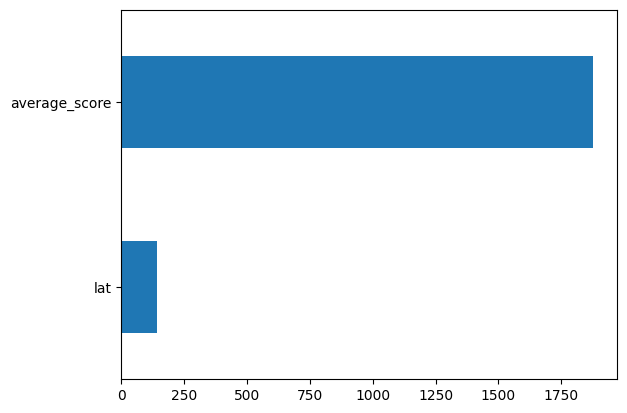

In [ ]:
y= y.astype('int')

...
from sklearn.feature_selection import chi2 # хи-квадрат

imp_cat = pd.Series(chi2(X[cat_cols], y)[0], index=cat_cols)
imp_cat.sort_values(inplace = True)
imp_cat.plot(kind = 'barh')

По графику важности категориальных признаков мы можем понять, что признак *average_score* важнее, чем *lat*, в определении рейтинга отеля

Добавьте и другие категориальные признаки в список *cat_cols*, чтобы оценить их значимость в определении рейтинга отеля.

Для оценки значимости непрерывных переменных будем использовать функцию *[f_classif](https://scikit-learn.org/stable/modules/generated/sklearn.feature_selection.f_classif.html#sklearn.feature_selection.f_classif)* из библиотеки *sklearn*. В основе метода оценки значимости переменных лежит изученный вами в юнитах по статистике анализ (*ANOVA*). Основу процедуры составляет обобщение результатов двух выборочных t-тестов для независимых выборок (*2-sample t*).

Метод возвращает двумерный массив f-статистик и *p-value* для каждого признака. В качестве меры значимости мы будем использовать значение f-статистики. Чем значение статистики выше, тем меньше вероятность того, что средние значения не отличаются, и тем важнее данный признак для нашей модели.

<AxesSubplot: >

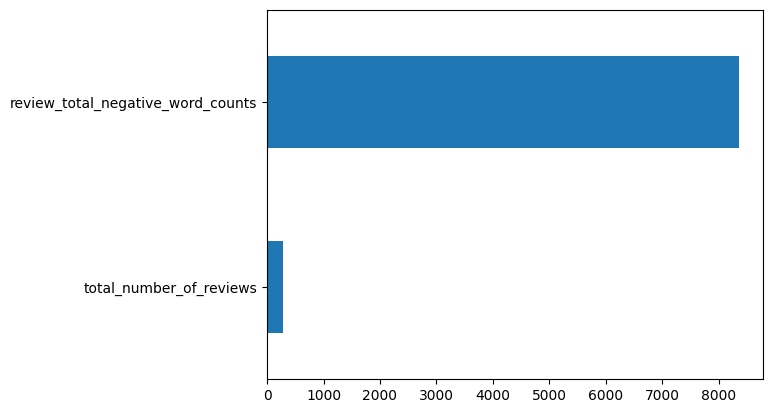

In [ ]:
from sklearn.feature_selection import f_classif # anova

imp_num = pd.Series(f_classif(X[num_cols], y)[0], index = num_cols)
imp_num.sort_values(inplace = True)
imp_num.plot(kind = 'barh')

По  графику важности категориальных переменных мы можем понять, что признак review_total_negative_word_counts важнее, чем total_number_of_reviews, в определении рейтинга отеля

Результаты данных тестов вы сможете использовать в своих исследования при отборе признаков: удаляйте менее значимые признаки и сравнивайте результаты качества полученных моделей.

***
→ Тесты *chi2* и *f_classif* можно использовать для выбора *n* заданных признаков с наивысшими значениями статистик с помощью метода **SelectKBest**. Подробнее об этом вы можете прочесть в руководстве [Feature selection](https://scikit-learn.org/stable/modules/feature_selection.html#univariate-feature-selection).
***


Попробуйте применить данные  рекомендации для улучшения качества предсказания. **Оцените, насколько изменилась метрика**.

In [ ]:
# Сколько уникальных названий отелей представлено в наборе данных?
hotels_hw['hotel_name'].nunique()
print('Кол-во уникальных названий отелей в наборе данных: ', hotels_hw['hotel_name'].nunique())

Кол-во уникальных названий отелей в наборе данных:  1492


In [ ]:
hotels_hw['review_date'] = pd.to_datetime(hotels_hw['review_date'])

hotels_hw['review_date'].min()
hotels_hw['review_date'].max()

print('Когда был оставлен самый свежий отзыв: ', hotels_hw['review_date'].max())
print('Когда был оставлен самый первый отзыв: ', hotels_hw['review_date'].min())

Когда был оставлен самый свежий отзыв:  2017-08-03 00:00:00
Когда был оставлен самый первый отзыв:  2015-08-04 00:00:00


In [ ]:
hotels_hw.head()

def collect_tags(df):
    tags_dict = dict()
    tags_list = list()
    for index, row in df['tags'].items():
        tags = list(row.replace("[' ", '').replace(" ']", '').split(" ', ' "))
        tags_list.append(tags)
        for tag in tags:
            if tag not in tags_dict.keys():
                tags_dict.update({tag:1})
            else:
                tags_dict[tag] += 1
    return tags_list, tags_dict

tags_list, tags_dict = collect_tags(hotels_hw)
# print(tags_dict)
# print(tags_list)
print('Кол-во уникальных тэгов: ', len(tags_dict))
print('Кол-во отзывов с тэгами: ', len(tags_list))

Кол-во уникальных тэгов:  2368
Кол-во отзывов с тэгами:  386803


In [ ]:
max(tags_dict, key=tags_dict.get)

'Leisure trip'

In [ ]:
def most_freq_tag_stayed(tags):
    stayed_dict = dict()
    for key, values in tags.items():
        if 'stayed' in key.lower():
            stayed_dict[key] = values
    max_stayed = max(stayed_dict, key=stayed_dict.get) 
    return max_stayed, tags[max_stayed]

print(most_freq_tag_stayed(tags_dict))

('Stayed 1 night', 145373)
